In [1]:
#下面这行代码，是为了把自己编写的代码文件当作一共模块导入，这里是把Utilities文件夹中的plotting.py文件当作python的模块导入，对应的是下面的from plotting import newfig, savefig。路径要随着不同设备的系统做相应的修改
import sys #导入sys模块。sys模块提供了一些变量和函数，用于与 Python解释器进行交互和访问。例如，sys.path 是一个 Python 在导入模块时会查找的路径列表，sys.argv 是一个包含命令行参数的列表，sys.exit() 函数可以用于退出 Python 程序。导入 sys 模块后，你就可以在你的程序中使用这些变量和函数了。
sys.path.insert(0, '../../Utilities/') #在 Python的sys.path列表中插入一个新的路径。sys.path是一个 Python 在导入模块时会查找的路径列表。新的路径'../../Utilities/'相对于当前脚本的路径。当你尝试导入一个模块时，Python 会在 sys.path 列表中的路径下查找这个模块。通过在列表开始位置插入一个路径，你可以让 Python 优先在这个路径下查找模块。这在你需要导入自定义模块或者不在 Python 标准库中的模块时非常有用。

import torch
#collections是python一个内置模块，提供了一些有用的数据结构
from collections import OrderedDict  #这个类是字典dict的一个子类，用于创建有序的字典。普通字典中元素顺序是无序的，在OrderedDict中元素的顺序是有序的，元素的顺序是按照它们被添加到字典中的顺序决定的。

from pyDOE import lhs #`pyDOE`是一个Python库，用于设计实验。它提供了一些函数来生成各种设计，如因子设计、拉丁超立方设计等。`lhs`是库中的一个函数，全名为"Latin Hypercube Sampling"，拉丁超立方采样。这是一种统计方法，用于生成一个近似均匀分布的多维样本点集。它在参数空间中生成一个非常均匀的样本，这对于高维数值优化问题非常有用，因为它可以更好地覆盖参数空间。
import numpy as np
import matplotlib.pyplot as plt
import scipy.io #导入了scipy库中的io模块。scipy.io模块包含了一些用于文件输入/输出的函数，例如读取和写入.mat文件（MATLAB格式）
from scipy.interpolate import griddata #`scipy.interpolate`是`scipy`库中的一个模块，提供了许多插值工具，用于在给定的离散数据点之间进行插值和拟合。`griddata`是这个模块中的一个函数，用于在无规则的数据点上进行插值。

import random

import skopt #用于优化问题的库，特别是机器学习中的超参数优化
from distutils.version import LooseVersion #distutils是Python的一个标准库，用于构建和安装Python包。LooseVersion是一个类，用于比较版本号


from plotting_torch import newfig, savefig #从自定义的plotting_torch.py文件中导入了newfig和savefig函数。这两个函数用于创建和保存图形。这两个函数的定义在plotting_torch.py文件中

from mpl_toolkits.axes_grid1 import make_axes_locatable #`mpl_toolkits.axes_grid1`是`matplotlib`库的一个模块，提供了一些高级的工具来控制matplotlib图形中的坐标轴和颜色条。`make_axes_locatable`是模块中的一个函数，用于创建一个可分割的坐标轴。可以在这个坐标轴的四个方向（上、下、左、右）添加新的坐标轴或颜色条。
import matplotlib.gridspec as gridspec #是`matplotlib`库的一个模块，用于创建一个网格布局来放置子图。在`matplotlib`中可以创建一个或多个子图（subplot），每个子图都有自己的坐标轴，并可以在其中绘制图形。`gridspec`模块提供了一个灵活的方式来创建和放置子图。
import time #一个内置模块，用于处理时间相关的操作。


from tqdm import tqdm #一个快速，可扩展的python进度条库，可以在python长循环中添加一个进度提示信息，用户只需要封装任意的迭代器tqdm(iterator)。



In [2]:
num_gpus = torch.cuda.device_count()
print('Number of available GPUs: ', num_gpus)

for i in range(num_gpus):
    torch.cuda.set_device(i)
    allocated = torch.cuda.memory_allocated()
    reserved = torch.cuda.memory_reserved()
    print('GPU {}: {}, Allocated: {}, Reserved: {}'.format(i, torch.cuda.get_device_name(i), allocated, reserved))

Number of available GPUs:  1
GPU 0: NVIDIA GeForce RTX 4090, Allocated: 0, Reserved: 0


In [3]:
torch.cuda.set_device(0) #设置当前使用的GPU设备。这里设置为1号GPU设备（第二块显卡）。

# CUDA support 

#设置pytorch的设备，代表了在哪里执行张量积算，设备可以是cpu或者cuda（gpu），并将这个做运算的设备对象存储在变量device中，后续张量计算回在这个设备上执行
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

In [4]:
# the deep neural network
class DNN(torch.nn.Module):
    #第一个方法
    def __init__(self, layers):
        super(DNN, self).__init__() #调用父类的__init__方法进行初始化
        
        # parameters
        self.depth = len(layers) - 1 #定义名为depth的属性，表示神经网络的深度，等于层数-1
        
        # set up layer order dict
        self.activation = torch.nn.Tanh #设置激活函数为tanh
         
        layer_list = list() #定义一个空列表layer_list
        for i in range(self.depth - 1):  #循环depth次
            #将每一层（全连接层）添加到layer_list中
            layer_list.append(
                ('layer_%d' % i, torch.nn.Linear(layers[i], layers[i+1]))
            )
            #将每一层的激活函数添加到layer_list中
            layer_list.append(('activation_%d' % i, self.activation()))

        #循环结束后，将最后一层的线性变换添加到layer_list中（因为没有激活函数了）
        layer_list.append(
            ('layer_%d' % (self.depth - 1), torch.nn.Linear(layers[-2], layers[-1]))
        )
        #然后使用OrderedDict将layer_list中的元素转换为有序字典
        layerDict = OrderedDict(layer_list)
        
        # deploy layers，将layerDict转换为一个神经网络模型，赋值给self.layers
        self.layers = torch.nn.Sequential(layerDict)
    
    #第二个方法，定义了模型的前向传播过程
    def forward(self, x):  #接收输入x
        out = self.layers(x) #将输入x传入神经网络模型self.layers中，得到输出out
        return out #返回输出out
    
    # 新增方法，获取最后一个隐藏层的输出
    def hidden_output(self, x):
        # 遍历每一层，直到最后一个隐藏层
        for i in range(self.depth - 1):
            # 获取当前层的线性变换
            x = self.layers[i*2](x)
            # 获取当前层的激活函数
            x = self.layers[i*2 + 1](x)
        # 返回最后一个隐藏层的输出
        return x

In [5]:
#set the class of PINN

#定义了一个名为`PhysicsInformedNN'的类，用于实现基于物理的神经网络。
class PhysicsInformedNN:
    # Initialize the class
    def __init__(self, x0, u0, tb, X_f, layers, lb, ub, X_star, u_star): #这个类包含的第一个方法__init__，这是一个特殊的方法，也就是这个类的构造函数，用于初始化新创建的对象，接受了几个参数
        
        
        #`numpy.concatenate`是一个用于数组拼接的函数。它可以将多个数组沿指定的轴拼接在一起，形成一个新的数组：numpy.concatenate((a1,a2, ...), axis=0)其中，`a1,a2, ...`是需要拼接的数组（只能接受数组或序列类型的参数，且参数形状必须相同），可以是多个。`axis`参数用于指定拼接的轴向，`axis=0`表示沿着第一个轴（即行）进行拼接，不指定`axis`参数默认值是0。
        X0 = np.concatenate((x0,0*x0), 1) # [x0, 0],将x0和0*x0两个数组在第二个维度（即列）上进行了合并。0*x0会生成一个与x0形状相同，但所有元素都为0的数组。因此，X0的结果是一个新的二维数组，其中第一列是x0的值，第二列全为0
        X_lb = np.concatenate((0*tb+lb[0],tb), 1) # [lb[0], tb],将0*tb+lb[0]和tb两个数组在第二个维度（即列）上进行了合并。0*tb+lb[0]会生成一个与tb形状相同，但所有元素都为lb[0]的数组。因此，X_lb的结果是一个新的二维数组，其中第一列全为lb[0]的值，第二列是tb的值。
        X_ub = np.concatenate((0*tb+ub[0],tb), 1) # [ub[0], tb],同上生成一个与tb形状相同，但所有元素都为ub[0]的数组。因此，X_ub的结果是一个新的二维数组，其中第一列全为ub[0]的值，第二列是tb的值
        
        #Python使用self关键字来表示类的实例。当在类的方法中定义一个变量时，例如lb和ub，这些变量只在该方法内部可见，也就是说它们的作用域仅限于该方法。当方法执行完毕后，这些变量就会被销毁，无法在其他方法中访问它们。但如果希望在类的其他方法中也能访问这些变量就需要将它们保存为类的实例属性。这就是self.lb和self.ub的作用。
            #通过将lb和ub赋值给self.lb和self.ub，就可以在类的其他方法中通过self.lb和self.ub来访问这些值。总的来说，self.lb和self.ub是类的实例属性，它们的作用域是整个类，而不仅仅是定义它们的方法。
        self.lb = torch.tensor(lb).float().to(device) #将传入的lb和ub参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.lb和self.ub来访问这些值。
        self.ub = torch.tensor(ub).float().to(device)


        self.x0 = torch.tensor(X0[:,0:1], requires_grad=True).float().to(device) #将X0的第一列赋值给self.x0（:表示取所有行,0：1实际上表示取第一列，因为python是左闭右开的）,将X0的第二列赋值给self.t0。这样可以在类的其他方法中通过self.x0和self.t0来访问这些值。
        self.t0 = torch.tensor(X0[:,1:2], requires_grad=True).float().to(device) #将x0的第二列赋值给self.t0

        self.x_lb = torch.tensor(X_lb[:,0:1], requires_grad=True).float().to(device) #将X_lb的第一列赋值给self.x_lb
        self.t_lb = torch.tensor(X_lb[:,1:2], requires_grad=True).float().to(device) #将X_lb的第二列赋值给self.t_lb

        self.x_ub = torch.tensor(X_ub[:,0:1], requires_grad=True).float().to(device) #将X_ub的第一列赋值给self.x_ub
        self.t_ub = torch.tensor(X_ub[:,0:1], requires_grad=True).float().to(device) #将X_ub的第二列赋值给self.t_ub
        
        self.x_f = torch.tensor(X_f[:,0:1], requires_grad=True).float().to(device) #将X_f的第一列赋值给self.x_f
        self.t_f = torch.tensor(X_f[:,1:2], requires_grad=True).float().to(device) #将X_f的第二列赋值给self.t_f
        
        self.u0 = torch.tensor(u0).float().to(device) #将传入的u0和v0参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.u0和self.v0来访问这些值。


        self.x_star = torch.tensor(X_star[:,0:1], requires_grad=True).float().to(device) #将X_star的第一列赋值给self.x_star
        self.t_star = torch.tensor(X_star[:,1:2], requires_grad=True).float().to(device) #将X_star的第二列赋值给self.t_star
        self.u_star = torch.tensor(u_star).float().to(device) #将传入的u_star和v_star参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.u_star和self.v_star来访问这些值。
        
        
        # Initialize NNs 
        self.layers = layers #将传入的layers参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.layers来访问这些值。
        
        
        # deep neural networks
        self.dnn = DNN(layers).to(device) #创建一个DNN类的实例，传入layers参数来实现神经网络的初始化，然后将这个实例移动到指定的设备上



        # optimizers: using the same settings，这里是使用pytorch库进行优化的部分
        #创建优化器optimizer，使用LBFGS算法，具体每个参数意义见下方
        self.optimizer_LBFGS = torch.optim.LBFGS(
            self.dnn.parameters(), #要优化的参数，这里返回的是一个生成器，包含了self.dnn中的所有参数（神经网络权重、偏置以及两个新加的变量）
            lr=1.0,  #学习率设置为1
            max_iter=50000,  #最大迭代次数为50000
            max_eval=50000,  #最大评估次数为50000
            history_size=50, #历史大小为50，即用于计算Hessian矩阵近似的最近几步的信息
            tolerance_grad=1e-5,  #优化的第一个停止条件，当梯度的L2范数小于1e-5时停止优化
            tolerance_change=1.0 * np.finfo(float).eps, #优化的第二个停止条件，当优化的目标函数值的变化小于1.0 * np.finfo(float).eps时停止优化
            line_search_fn="strong_wolfe"       # 制定了用于一维搜索的方法，这里表示用强Wolfe条件
        )
        #创建第二个优化器，括号内为要优化的参数，使用Adam优化方法
        self.optimizer_Adam = torch.optim.Adam(self.dnn.parameters())
                

        self.iter = 0 #记录迭代次数 

        self.loss_value = [] #创建一个空列表，用于存储损失值

        self.test_error = [] #创建一个空列表，用于存储测试误差
    
    #这个函数与下面的net_u函数功能相同，只是不计算梯度，因为在记录每个epoch的error时，使用with torch.no_grad()情况下调用net_u函数会报错，不知道为啥？
    def net_u_error(self, x, t):  
        u = self.dnn(torch.cat([x, t], dim=1))  #（第一个参数将输入的两个参数x和t在第二个维度（列）上进行拼接，形成一个新的张量）调用DNN，根据两个参数权重和偏置，以及新得到的张量，计算神经网络的输出u
        
        return u #返回神经网络的输出u和v，以及u关于x的梯度u_x和v关于x的梯度v_x


    #pytorch中
    #定义了一个名为net_u的函数/方法，用于计算神经网络的输出。这个方法接受两个参数，分别是x和t，其中x是输入数据，t是时间数据。最后返回神经网络的输出。     
    def net_u(self, x, t):  
        u = self.dnn(torch.cat([x, t], dim=1))  #（第一个参数将输入的两个参数x和t在第二个维度（列）上进行拼接，形成一个新的张量）调用DNN，根据两个参数权重和偏置，以及新得到的张量，计算神经网络的输出u

        u_x = torch.autograd.grad(
            u, x, 
            grad_outputs=torch.ones_like(u),
            retain_graph=True,
            create_graph=True
        )[0]

        return u,u_x #返回神经网络的输出u和v，以及u关于x的梯度u_x和v关于x的梯度v_x


    #定义了一个名为net_f的函数/方法，用于计算论文中的f。这个方法接受两个参数，分别是x和t，其中x是输入数据，t是时间数据。最后返回计算得到的f。
    def net_f(self, x, t):
        """ The pytorch autograd version of calculating residual """

        u,u_x=self.net_u(x,t) #调用上面的函数/方法，计算神经网络的输出（两个）以及输出关于输入x的梯度（两个）
        
        #计算u关于t的梯度，也就是u关于t的导数，这里使用了pytorch的自动求导功能
        u_t = torch.autograd.grad(
            u, t,  #输入的张量，要计算u关于t的导数
            grad_outputs=torch.ones_like(u), #生成一个与u形状相同，所有元素均为1的张量，这个参数用于指定向量-雅可比积的像两部分
            retain_graph=True, #表示计算完梯度之后保留计算图若需要多次计算梯度，则需要设置改参数为True
            create_graph=True #创建梯度的计算图，使我们能够计算高阶导数
        )[0] #这个函数的返回值是一个元组，其中包含了每个输入张量的梯度。这里只关心第一个输入张量u的梯度，所以我们使用[0]来获取这个梯度。？？？？又说只有一个梯度

        u_xx = torch.autograd.grad(
            u_x, x, 
            grad_outputs=torch.ones_like(u_x),
            retain_graph=True,
            create_graph=True
        )[0]
        
        f=u_t-0.0001*u_xx+5*u**3-5*u    #计算f,定义见论文

        return f  #返回计算得到的f


    def loss_func(self):
        self.optimizer_LBFGS.zero_grad() #清除之前计算的梯度（在PyTorch中，梯度会累积，所以在每次新的优化迭代之前，我们需要清除之前的梯度）

        u0_pred, _  = self.net_u(self.x0, self.t0) #是调用net_uv函数,将self.x0_tf和self.t0_tf作为参数传入,然后将返回的前两个结果赋值给self.u0_pred和self.v0_pred。后两个_是Python惯用法，表示不关心net_uv函数返回的后两个结果。
        u_lb_pred, u_x_lb_pred = self.net_u(self.x_lb, self.t_lb) #同上，不过这里函数返回的后两个结果会赋值给self.u_x_lb_pred和self.v_x_lb_pred。
        u_ub_pred, u_x_ub_pred = self.net_u(self.x_ub, self.t_ub) #同上
        f_pred = self.net_f(self.x_f, self.t_f) #调用net_f_uv函数,将self.x_f_tf和self.t_f_tf作为参数传入,然后将返回的结果赋值给self.f_u_pred和self.f_v_pred。

        loss = 100*torch.mean((self.u0 - u0_pred) ** 2)  + \
                    torch.mean((u_lb_pred - u_ub_pred) ** 2) + \
                    torch.mean((u_x_lb_pred - u_x_ub_pred) ** 2) + \
                    torch.mean(f_pred ** 2)
        # loss = torch.mean((self.u0 - u0_pred) ** 2)  + \
        #             torch.mean((u_lb_pred - u_ub_pred) ** 2) + \
        #             torch.mean((u_x_lb_pred - u_x_ub_pred) ** 2) + \
        #             torch.mean(f_pred ** 2)
        loss.backward() #被调用以计算损失函数关于神经网络参数的梯度。这个梯度将被用于优化器来更新神经网络参数
        
        self.iter += 1 #每调用一次损失函数，迭代次数加1


        #record the loss value
        self.loss_value.append(loss) #将计算得到的loss值添加到self.loss_value列表中

        #record the test error
        with torch.no_grad():
            u_real_pred = self.net_u_error(self.x_star, self.t_star)

        error_test = torch.norm(self.u_star - u_real_pred, 2) / torch.norm(self.u_star, 2)
        
        self.test_error.append(error_test)
        

        return loss #返回loss



    
    #定义了一个名为train的函数/方法，用于训练神经网络。这个方法接受一个参数nIter，表示训练的迭代次数。
    def train(self, nIter, nIterLBFGS):
        self.dnn.train()#将神经网络设置为训练模式而不是评估模式

        #先使用Adam优化器优化nIter次
        for epoch in tqdm(range(nIter), desc='Adam'):
            u0_pred, _  = self.net_u(self.x0, self.t0) #是调用net_uv函数,将self.x0_tf和self.t0_tf作为参数传入,然后将返回的前两个结果赋值给self.u0_pred和self.v0_pred。后两个_是Python惯用法，表示不关心net_uv函数返回的后两个结果。
            u_lb_pred, u_x_lb_pred = self.net_u(self.x_lb, self.t_lb) #同上，不过这里函数返回的后两个结果会赋值给self.u_x_lb_pred和self.v_x_lb_pred。
            u_ub_pred, u_x_ub_pred = self.net_u(self.x_ub, self.t_ub) #同上
            f_pred = self.net_f(self.x_f, self.t_f) #调用net_f_uv函数,将self.x_f_tf和self.t_f_tf作为参数传入,然后将返回的结果赋值给self.f_u_pred和self.f_v_pred。

            loss = 100*torch.mean((self.u0 - u0_pred) ** 2)  + \
                    torch.mean((u_lb_pred - u_ub_pred) ** 2) + \
                    torch.mean((u_x_lb_pred - u_x_ub_pred) ** 2) + \
                    torch.mean(f_pred ** 2)
            # loss = torch.mean((self.u0 - u0_pred) ** 2)  + \
            #         torch.mean((u_lb_pred - u_ub_pred) ** 2) + \
            #         torch.mean((u_x_lb_pred - u_x_ub_pred) ** 2) + \
            #         torch.mean(f_pred ** 2)
            
            # Backward and optimize
            self.optimizer_Adam.zero_grad() #清除该优化器之前计算的梯度（在PyTorch中，梯度会累积，所以在每次新的优化迭代之前，我们需要清除之前的梯度）
            loss.backward() #被调用以计算损失函数关于神经网络参数的梯度。这个梯度将被用于优化器来更新神经网络参数
            self.optimizer_Adam.step()  #使用之前的优化器self.optimizer_Adam，调用step方法(执行一步优化算法)，传入损失函数self.loss_func，进行优化
            

            #record the loss value
            self.loss_value.append(loss) #将计算得到的loss值添加到self.loss_value列表中
            

            #record the test error
            with torch.no_grad():
                u_real_pred = self.net_u_error(self.x_star, self.t_star)

            error_test = torch.norm(self.u_star - u_real_pred, 2) / torch.norm(self.u_star, 2)
            
            self.test_error.append(error_test)



        #Backward the optimize，使用LBFGS优化器进一步，注意这里虽然迭代了500次，但其实使用LBFGS优化器优化的次数不止500次
        for i in tqdm(range(nIterLBFGS), desc='LBFGS'):
            self.optimizer_LBFGS.step(self.loss_func)  #使用之前的优化器self.optimizer，调用step方法(执行一步优化算法)，传入计算损失函数的方法self.loss_func，进行优化   

                                    
    #定义了一个名为predict的函数/方法，用于预测神经网络的输出。这个方法接受一个参数X_star，表示输入数据。最后返回预测的两个输出和两个输出的梯度。
    def predict(self, X):
        x = torch.tensor(X[:, 0:1], requires_grad=True).float().to(device) #从输入中得到x和t（第一列和第二列），是张量，需要计算梯度，转换为浮点数类型，并将张量移动到指定设备上
        t = torch.tensor(X[:, 1:2], requires_grad=True).float().to(device)

        self.dnn.eval() #将神经网络切换为评估模式
        u, _ = self.net_u(x, t) #调用之前定义的函数得到神经网络的输出u,以及f
        f = self.net_f(x, t) 

        u = u.detach().cpu().numpy() #将张量u和v先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        f = f.detach().cpu().numpy()

        return u, f 
    
    #定义函数获得隐藏层的输出
    def hidden_predict(self, x,t):
        x = torch.tensor(x, requires_grad=True).float().to(device) #从输入中得到x和t（第一列和第二列），是张量，需要计算梯度，转换为浮点数类型，并将张量移动到指定设备上
        t = torch.tensor(t, requires_grad=True).float().to(device)
        self.dnn.eval() #将神经网络切换为评估模式
        hidden_output = self.dnn.hidden_output(torch.cat([x, t], dim=1)) #调用上一个神经网络类中的hidden_output方法，得到最后一个隐藏层的输出
        hidden_output_x = hidden_output[:, 0] #将输出的第一列赋值给hidden_output_x
        hidden_output_t = hidden_output[:, 1] #将输出的第二列赋值给hidden_output_t
        hidden_output_x = hidden_output_x.detach().cpu().numpy() #将张量hidden_output_x和hidden_output_t先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        hidden_output_t = hidden_output_t.detach().cpu().numpy() #将张量hidden_output_x和hidden_output_t先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        return hidden_output_x, hidden_output_t #返回隐藏层的输出


In [6]:
#定义设置随机数种子的函数，第一个参数seed表示种子；第二个参数用来设置CUDA的卷积操作是否确定性，默认为False，表示没有确定性
def set_seed(seed):
    # torch.manual_seed(seed) #设置pytorch的CPU随机数生成器的种子
    # torch.cuda.manual_seed_all(seed) #设置putorch的所有GPU随机数生成器的种子
    # np.random.seed(seed) #设置numpy的随机数生成器的种子
    # random.seed(seed) #设置python的内置随机数生成器的种子
    # torch.backends.cudnn.deterministic = deterministic #True会让CUDA的卷积操作变得确定性，即对于相同的输入，每次运行会得到相同的结果，False则相反
    """
    设置PyTorch的随机种子, 用于生成随机数. 通过设置相同的种子, 可以确保每次运行时生成的随机数序列相同
    """
    torch.manual_seed(seed)
 
    """
    设置PyTorch在所有可用的CUDA设备上的随机种子. 如果在使用GPU进行计算, 这个设置可以确保在不同的GPU上生成的随机数序列相同
    """
    torch.cuda.manual_seed_all(seed)
 
    """
    设置PyTorch在当前CUDA设备上的随机种子. 它与上一行代码的作用类似, 但只影响当前设备
    """
    torch.cuda.manual_seed(seed)
 
    """
    设置NumPy的随机种子, 用于生成随机数. 通过设置相同的种子，可以确保在使用NumPy的随机函数时生成的随机数序列相同
    """
    np.random.seed(seed)
    
    """
    设置Python内置的随机函数的种子. Python的random模块提供了许多随机函数, 包括生成随机数、打乱列表等. 通过设置相同的种子, 可以确保使用这些随机函数时生成的随机数序列相同
    """
    random.seed(seed)
    
    """
    设置Python的哈希种子 (哈希函数被广泛用于数据结构 (如字典和集合) 的实现，以及一些内部操作 (如查找和比较)). 通过设置相同的种子, 可以确保在不同的运行中生成的哈希结果相同
    """
    # os.environ["PYTHONHASHSEED"] = str(seed)
    
    """
    该设置确保每次运行代码时, cuDNN的计算结果是确定性的, 即相同的输入会产生相同的输出, 这是通过禁用一些非确定性的算法来实现的, 例如在卷积操作中使用的算法. 这样做可以保证模型的训练和推理在相同的硬件和软件环境下是可复现的, 即每次运行代码时的结果都相同. 但是, 这可能会导致一些性能上的损失, 因为禁用了一些优化的非确定性算法
    """
    torch.backends.cudnn.deterministic = True
    
    """
    该设置禁用了cuDNN的自动优化过程. 当它被设置为False时, PyTorch不会在每次运行时重新寻找最优的算法配置, 而是使用固定的算法配置. 这样做可以确保每次运行代码时的性能是一致的, 但可能会导致一些性能上的损失
    """
    torch.backends.cudnn.benchmark = False



In [7]:
#定义根据模型计算给定输入（点集中的点）的混沌度的函数，这个函数接受三个参数，分别是模型、输入数据和迭代次数
def calculate_chaos(model, X, num_iter):
    """
    计算模型混沌情况的函数。
    参数:
    - model: 用于预测的模型对象，必须有一个名为hidden_predict的方法。模型的hidden_predict为倒数第二层的输出，倒数第二层的维度必须和输入维度相同。
    - X: 输入数据，形状为(N_f_new, 2)，其中第一列为x0，第二列为t0。
    - num_iter: 计算混沌情况的迭代次数。
    返回:
    - distances: 每个采样点（与该采样点加上微扰比较）在最后一次迭代后的欧氏距离数组，形状为(N_f_new,)。
    """
    #对于所有的采样点
    x0 = X[:, 0:1] #取X_f_train_new的第一列，赋值给x0，(N_f_new,1)形状
    t0 = X[:, 1:2] #取X_f_train_new的第二列，赋值给t0
    # 利用x0和t0计算x{t}和t{t}，存储在xs中
    xs = [] #初始化xs
    x,t = model.hidden_predict(x0,t0) #调用predict方法，传入X_f_train_new，得到x和t，这里x和t形状均为(N_f_new,)，因此下一步需要reshape
    x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
    t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
    
    # 迭代预测
    for i in range(num_iter): #循环num_iter次
        x,t = model.hidden_predict(x,t) #每次计算隐藏层输出，得到的x和t形状均为(N_f_new,)，因此下一步需要reshape
        x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
        t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
        xs.append([x,t]) #将x的数据添加到xs中
    #最后得到的xs是一个列表，列表中的每个元素都是一个列表（num_iter个元素），每个列表中有两个元素，分别代表x和t，长度均为N_f_new，对应原始采样点的迭代结果


    # 给所有采样点加上一个很小的扰动
    x1 = x0 + np.random.normal(0, 0.0001) #加上一个很小的扰动，(N_f_new,1)形状
    t1 = t0 + np.random.normal(0, 0.0001)
    # 利用x0{1}和t0{1}计算x{t1}和t{t1}，存储在xs1中
    xs1 = [] #初始化xs1
    x,t = model.hidden_predict(x1,t1) #调用predict方法，传入X_f_train_new，得到x和t，这里x和t形状均为(N_f_new,)，因此下一步需要reshape
    x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
    t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）

    # 迭代预测（扰动后）
    for i in range(num_iter): #循环num_iter次
        x,t = model.hidden_predict(x,t) #每次计算隐藏层输出，得到的x和t形状均为(N_f_new,)，因此下一步需要reshape
        x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)
        t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)
        xs1.append([x,t]) #将x的数据添加到xs1中
    #最后得到的xs1是一个列表，列表中的每个元素都是一个列表（num_iter个元素），每个列表中有两个元素，分别代表x和t，长度均为N_f_new，对应加了扰动后的采样点的迭代结果

    # 计算最后一次迭代的隐藏层输出，即最后一次迭代的x和t
    last_iter_xs = np.array(xs[-1]) #转换为数组，便于之后计算距离
    last_iter_xs1 = np.array(xs1[-1])
    #这两个数组的形状均为(2,N_f_new,1)，第一个代表x和t，第二个代表N_f_new个样本点得到的结果，第三个代表1个数

    # 计算这两个点的欧氏距离
    distances = np.linalg.norm(last_iter_xs - last_iter_xs1, axis=0)
    #得到的是一个形状为（N_f_new,1）的数组，每个元素代表了两个点之间的欧氏距离，这里点在xt平面上

    distances = distances.flatten()

    #对distances进行归一化
    distances = distances / np.linalg.norm(distances)
    # 对distances进行归一化前，检查分母是否接近零
    # norm = np.linalg.norm(distances)
    # if norm < 1e-10:  # 1e-10是一个非常小的数，用于检测norm是否接近于零
    #     distances = np.zeros_like(distances)  # 如果分母接近0，将distances设置为全零数组，因为范数为0时，distances中的值想对于彼此几乎没有差异，意味着所有点都几乎处于同一混沌度水平
    # else:
    #     distances = distances / norm

    # 现在可以安全地根据distances对点进行排序，即使在所有值都相同的情况下

    return distances

In [8]:
seeds = [0, 1, 12, 21, 123, 321, 1234, 4321, 12345, 54321, 123456, 654321, 10, 210, 3210, 43210, 543210, 6543210, 1234567, 76543210] #生成10个随机种子
# seeds = [4321, 12345, 54321, 123456, 654321, 10, 210, 3210, 43210, 543210, 6543210, 1234567, 76543210] #生成10个随机种子
# seeds = [0] #选择第一个种子

#设置噪声水平为0
noise = 0.0        

# Doman bounds，定义两个一维数组lb和ub，问题域是一个二维空间，其中 x 的范围是 -5 到 5，t 的范围是 0 到 π/2(竖着的)
lb = np.array([-1.0, 0.0])
ub = np.array([1.0, 1.0])
#定义三个整数，分别表示初始条件点数量、边界条件点数量和配位点的数量（这些点用于训练神经网络）
N0 = 500
N_b = 100
N_f = 10000
#定义一个列表layers，其中包含了神经网络的层数和每一层的神经元数量
# layers = [2, 200, 200, 200, 200, 2, 1]
layers = [2,30,30,30,30,30,30,30,30,2,1]

#读取名为burgers_shock的Matlab文件，文件中的数据存储在data变量中。这里的路径也要随着设备的情况修改 
data = scipy.io.loadmat('../data/AC.mat')
#从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
t = data['tt'].flatten()[:,None]
x = data['x'].flatten()[:,None]
Exact = np.real(data['uu']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
#生成一个二位网络，X和T是输出的二维数组
#这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
X, T = np.meshgrid(x,t)

X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_star = Exact.flatten()[:,None]    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组         

###########################

#从0~数组x的行数(256)中随机选择N0个数，replace=False表示不允许重复选择，最后将这N0个数赋值给idx_x
idx_x = np.random.choice(x.shape[0], N0, replace=False)
#从x中选择N0个对应的行(idx_x对应的行)，最后将这N0行赋值给x0
x0 = x[idx_x,:]
#从Exact_u中选择N0个对应的行(idx_x对应的行)的第一列元素，最后将这N0个元素赋值给u0
# u0 = Exact[idx_x,0:1]
u0 = Exact[0:1,idx_x].T

#从0~数组t的行数中随机选择N_b个数，replace=False表示不允许重复选择，最后将这N_b个数赋值给idx_t
idx_t = np.random.choice(t.shape[0], N_b, replace=False)
#从t中选择N_b个对应的行(idx_t对应的行)，最后将这N_b行赋值给tb
tb = t[idx_t,:]

error = [] #创建一个空列表，用于存储误差

i = 7 #初始化i为0

nIter = 150000 #设置迭代次数为10000
nIterLBFGS = 1 #设置LBFGS迭代次数为500

for seed in seeds:
    set_seed(seed) #设置随机种子

    num_iter = 50 #迭代次数（用于混沌度）
    #1.先训练一定次数（总次数/100）

    N_f_1 = N_f // 100 #将N_f除以100，得到的整数赋值给N_f_1
    #采样初步训练点
    X_f = lb + (ub-lb)*lhs(2, N_f_1) #lhs函数采用拉丁超采样方法，生成一个近似均匀分布的多维样本点集，返回的是一个形状为（$N_f$，2）的数组，每一行都是一个2维的样本点，所有样本点都在[0,1]范围内，并对该样本集进行缩放，把每个样本从[0,1]区间缩放到[lb,ub]区域内，即得到了指定范围内均匀分布的样本$X_f$。



    #创建PINN模型并输入各种参数        
    model = PhysicsInformedNN(x0, u0, tb, X_f, layers, lb, ub, X_star, u_star)
    #获取当前时间并赋值给start_time          
    start_time = time.time()       
    #训练模型50000次         
    model.train(nIter//100, 0)

    #2.训练结束后，每总次数的1/100次训练，重新采样N_f//10个点，从中选出N_f//100个点加入训练，先用残差训练
    for iter in range(nIter//100+1, 100001, nIter//100): #每500次迭代

        N_f_new = N_f_1 * 10 #重新总训练点数的1%个训练点的10倍
        # 生成新的X_f_new数据
        X_f_new = lb + (ub-lb)*lhs(2, N_f_new)

        #计算混沌情况
        distances = calculate_chaos(model, X_f_new, num_iter) #计算混沌度

        _, residual = model.predict(X_f_new)

        # 计算残差的绝对值
        abs_residual = np.abs(residual)
        #将二维数组转换为一维数组
        abs_residual = abs_residual.flatten()

        #对abs_residual进行归一化
        abs_residual = abs_residual / np.linalg.norm(abs_residual)

        # 找出绝对值最大的N_f_1个值的索引
        topk_indices = np.argpartition(abs_residual, -N_f_1)[-N_f_1:] #该函数会对数组进行排序，使得指定的k个最大值出现在数组的最后k给位置上，并获取最后1000个元素

        # 使用这些索引来提取对应的数据
        X_f_topk = X_f_new[topk_indices]

        # 将这些数据添加到原来的训练数据中
        X_f = np.vstack((X_f, X_f_topk)) #与之前的训练数据合并

        # 更新模型中的X_f_train数据
        model.x_f = torch.tensor(X_f[:, 0:1], requires_grad=True).float().to(device)
        model.t_f = torch.tensor(X_f[:, 1:2], requires_grad=True).float().to(device)

        # 在更新数据后的模型上进行训练500次
        model.train(nIter//100, 0)

    #3.训练结束后，每总次数的1/100次训练，重新采样N_f//10个点，从中选出N_f//100个点加入训练，再用chaos训练
    for iter in range(100002, 150001, nIter//100): #每500次迭代

        N_f_new = N_f_1 * 10 #重新总训练点数的1%个训练点的10倍
        # 生成新的X_f_new数据
        X_f_new = lb + (ub-lb)*lhs(2, N_f_new)

        #计算混沌情况
        distances = calculate_chaos(model, X_f_new, num_iter) #计算混沌度

        #对distances进行归一化
        distances = distances / np.linalg.norm(distances)


        # 找出绝对值最大的N_f_1个值的索引
        topk_indices = np.argpartition(distances, -N_f_1)[-N_f_1:] #该函数会对数组进行排序，使得指定的k个最大值出现在数组的最后k给位置上，并获取最后1000个元素

        # 使用这些索引来提取对应的数据
        X_f_topk = X_f_new[topk_indices]

        # 将这些数据添加到原来的训练数据中
        X_f = np.vstack((X_f, X_f_topk)) #与之前的训练数据合并

        # 更新模型中的X_f_train数据
        model.x_f = torch.tensor(X_f[:, 0:1], requires_grad=True).float().to(device)
        model.t_f = torch.tensor(X_f[:, 1:2], requires_grad=True).float().to(device)

        # 在更新数据后的模型上进行训练500次
        model.train(nIter//100, 0)


    model.train(0, nIterLBFGS) #训练模型500次

    #获取当前时间并减去start_time，得到训练时间并赋值给elapsed
    elapsed = time.time() - start_time                
    #打印训练所需时间
    print('Training time: %.4f' % (elapsed))





    #用训练好的模型进行预测，返回四个值（均为数组）    
    u_pred, f_pred = model.predict(X_star)

    #计算误差（基于2范数）        
    error_u = np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2)
    print(np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2))

    #打印误差
    print('Error u: %e' % (error_u))

    #将误差添加到error列表中

    #计算误差（基于2范数）
    error.append(error_u) #计算误差，然后将误差添加到error列表中

    i += 1 #i加1
    print(f'当前为第{i}次循环，种子为{seed}')


# #使用griddata函数将X_star、u_pred、v_pred和h_pred插值到网格上，得到U_pred、V_pred和H_pred
# U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')

# #同上，使用griddata函数将X_star、f_u_pred和f_v_pred插值到网格上，得到FU_pred和FV_pred
# F_pred = griddata(X_star, f_pred.flatten(), (X, T), method='cubic')

#计算误差（基于2范数）        
print(np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2))
 


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:00<03:31,  7.08it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:14, 103.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:09, 146.03it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:08, 163.86it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 179.30it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 188.95it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.46it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.94it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.54it/s]


Adam:  12%|█▏        | 187/1500 [00:01<00:06, 201.02it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.47it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 205.06it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 205.66it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 206.00it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 206.99it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 207.13it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 207.60it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 207.86it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 208.28it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 203.47it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 205.15it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 206.26it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 206.20it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.64it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.88it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.47it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.60it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.25it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 197.85it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 198.35it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.22it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.42it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 204.13it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 200.79it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 198.43it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 201.42it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 203.81it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 205.37it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 204.74it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.12it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 200.43it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 198.99it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 200.93it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 203.37it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 204.96it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 203.13it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 202.90it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 204.72it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 201.51it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.58it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.75it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 204.12it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 205.22it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.19it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 202.66it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.53it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.87it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.75it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 202.78it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 200.39it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 200.99it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 198.33it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.18it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.33it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 202.38it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 203.89it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 200.21it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 202.68it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 204.21it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 205.43it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 201.89it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 202.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


/tmp/ipykernel_2388714/1414517622.py:59: RuntimeWarning: invalid value encountered in divide
  distances = distances / np.linalg.norm(distances)



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.99it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.18it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.57it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.53it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.18it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.27it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.43it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.66it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.66it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.61it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.51it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.45it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.44it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.52it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.70it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.27it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.63it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 205.60it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 206.03it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 207.02it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 207.58it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.50it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.25it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 204.00it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.98it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.53it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 204.58it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 205.15it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 206.02it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 206.87it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 207.21it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.01it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 186.65it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 189.65it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 190.17it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 191.11it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 192.82it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 194.71it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 198.64it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 198.68it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 199.75it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 201.25it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 202.54it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 203.36it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 202.63it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 204.03it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 205.18it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 204.82it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 205.95it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 206.59it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 206.86it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 204.87it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 205.35it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 200.42it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 197.74it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 199.53it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 196.30it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 197.69it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 198.54it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 196.81it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 195.22it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 197.73it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 194.95it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 197.88it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 196.82it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 196.44it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 194.90it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 194.22it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 194.20it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 195.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.37it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.16it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.33it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.63it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.56it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.04it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.62it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.40it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.74it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.73it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.57it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 200.30it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 202.02it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:05, 202.83it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 203.92it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 203.56it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 200.35it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 198.54it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 196.33it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.08it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 199.79it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 200.85it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 201.23it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 202.79it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 203.44it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 201.15it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 200.37it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 197.27it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 196.19it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 195.04it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 194.78it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 195.41it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 194.78it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 193.65it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 193.03it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 193.31it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 197.07it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 199.34it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 200.40it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 197.65it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 195.09it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 192.83it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 196.35it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 199.40it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 197.25it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 196.22it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 199.50it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 198.12it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 196.19it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.45it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 195.12it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 198.41it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 200.54it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 201.59it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 202.70it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 200.06it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 199.13it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 197.28it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 196.63it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 195.95it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 185.75it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 185.99it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 188.57it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:01, 188.20it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 190.64it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 190.18it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 189.75it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 191.45it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 191.56it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 193.90it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 196.66it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 196.18it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 198.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.73it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.82it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.52it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.22it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.24it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.92it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.58it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.99it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 201.35it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 199.98it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.76it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.12it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 191.96it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 191.61it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.17it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 199.20it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.56it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.17it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.60it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.04it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.71it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 197.47it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.46it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.94it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.25it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.99it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.89it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 191.37it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 193.33it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 197.27it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.13it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 192.89it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 194.19it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.91it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.53it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 196.07it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 198.50it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 195.56it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 184.51it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:04, 172.08it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:04, 158.25it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 167.11it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 178.16it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 179.03it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 180.86it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 184.91it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 187.45it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 191.30it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 192.33it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 190.80it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 190.33it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 190.98it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 195.34it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 195.21it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 195.46it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 199.31it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 198.33it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 198.56it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 201.44it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 203.38it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 204.56it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 203.27it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 199.75it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 199.76it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 202.19it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 204.01it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 205.08it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 206.07it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 205.99it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 204.27it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 204.86it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 205.58it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 206.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.97it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.98it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.56it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.80it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.76it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.73it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.20it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.83it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.21it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.39it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.96it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 197.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.63it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.18it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 198.10it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 193.29it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 194.37it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 194.00it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 193.62it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 196.35it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 195.10it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 198.47it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 194.34it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 192.20it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 193.85it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 192.30it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:05, 179.24it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 181.59it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 186.68it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 188.97it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 193.83it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 196.71it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 194.36it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 194.34it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 195.01it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 196.20it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 194.52it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 197.41it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 195.61it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 195.17it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 198.77it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.29it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 197.81it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 200.33it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 197.57it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 195.30it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 193.08it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 194.01it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 195.47it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 195.72it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 186.68it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 189.77it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 190.88it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 193.38it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 195.05it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 195.15it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 192.81it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 192.84it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 194.63it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.74it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 195.63it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.33it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 196.24it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 195.79it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 193.21it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 189.97it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 190.68it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 192.07it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 192.34it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 190.74it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 194.32it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 190.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.46it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.39it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.30it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.44it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.61it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.48it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.34it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.13it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.09it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.18it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.31it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.22it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.32it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.48it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.45it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.83it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 197.02it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 189.66it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 189.95it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 194.35it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 195.28it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 194.02it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 197.18it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 197.00it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 195.05it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 194.90it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 193.03it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 195.94it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.21it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 201.82it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 201.92it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 203.88it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 205.36it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 206.41it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 201.31it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 203.01it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 199.46it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 201.38it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 199.05it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 200.45it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 198.74it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 197.64it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 196.20it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 195.19it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 198.38it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 200.91it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 199.44it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 197.86it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 198.72it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 198.88it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 195.18it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 193.32it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 179.11it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 186.03it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 185.05it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 191.33it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 195.91it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 197.37it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 193.98it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 193.14it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 196.13it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 199.23it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 198.87it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 195.88it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 195.39it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 197.94it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 195.25it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 195.38it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 196.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 195.64it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 192.92it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.73it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.38it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.51it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.45it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.36it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.86it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.57it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 202.64it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 203.57it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 202.86it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 203.97it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 201.14it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 202.34it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 200.15it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 202.31it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 203.33it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 201.11it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 198.17it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 196.55it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 199.28it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 201.10it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 196.64it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 197.90it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 197.81it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 200.27it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 202.31it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 203.22it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 200.27it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 200.12it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 202.24it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.60it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 199.08it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 197.44it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 196.31it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 196.04it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 199.39it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 197.09it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 199.98it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 198.11it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 196.81it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 197.24it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 199.96it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 198.55it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 200.92it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 198.55it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 196.77it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 197.85it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 197.03it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 199.89it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 197.57it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 196.60it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 195.09it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 196.51it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 197.00it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 196.30it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 196.28it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 199.24it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.93it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 193.25it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 191.49it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.81it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 197.65it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 200.82it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 203.18it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 200.83it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 198.82it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.53it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.57it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.13it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.64it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.19it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.79it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.83it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.50it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.63it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.47it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.63it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.17it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 201.10it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:05, 203.16it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 204.64it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 204.60it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 205.57it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 206.27it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 206.78it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 205.84it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 205.93it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 206.24it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:04, 206.41it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 204.46it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 200.07it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 197.62it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 192.18it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 191.73it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 192.11it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 192.89it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 196.58it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 195.37it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 193.53it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 193.16it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 197.34it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 196.89it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 196.47it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 195.40it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 195.18it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 195.22it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 194.30it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 194.26it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 197.92it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 196.75it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 196.29it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 194.54it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 197.88it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 200.50it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 199.93it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 199.24it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 200.69it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 197.06it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 196.00it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 194.49it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 193.96it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 194.99it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 195.70it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 197.29it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 194.52it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 192.37it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 193.28it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 193.65it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 189.96it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 191.30it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 195.95it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 195.37it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 173.70it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 176.45it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 182.59it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 181.01it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 178.80it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 183.61it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 187.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.97it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.93it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.44it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.77it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.24it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.68it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.74it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.89it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.88it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.38it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.13it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 189.74it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.79it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.07it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.10it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.08it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.31it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.12it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 198.56it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.82it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.71it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 191.15it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 191.79it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 192.19it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 192.79it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 190.43it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 191.04it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 192.13it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 193.17it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 191.13it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 192.86it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.36it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 192.20it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 195.75it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 198.80it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 196.89it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 193.47it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 194.77it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 195.06it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 198.80it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 201.38it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 199.50it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 199.82it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 200.79it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 202.23it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 203.84it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 205.05it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 205.89it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 204.58it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 204.14it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 205.23it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 205.91it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 206.50it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 206.83it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 204.82it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 199.81it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 202.23it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 203.99it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 205.26it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 203.47it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 202.17it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 203.70it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 201.99it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 200.86it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 202.39it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 203.72it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 199.24it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 196.06it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.94it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.94it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 195.50it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 194.34it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 196.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.84it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.69it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.33it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 201.05it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.75it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.41it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.70it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.40it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.94it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.48it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.04it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.90it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.51it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.94it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 197.61it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 199.10it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 201.57it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 199.01it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.11it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 190.41it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 191.05it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.93it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 197.69it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 200.12it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 200.72it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 198.97it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 198.49it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 197.68it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 197.42it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 194.43it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 192.21it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 190.75it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 193.99it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 195.05it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 195.79it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 194.76it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 194.69it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 193.66it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 196.96it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 200.26it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 198.92it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 197.79it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 200.58it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 198.93it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 196.70it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 196.91it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.79it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 201.74it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 199.61it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 197.19it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 198.68it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 201.10it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 197.11it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 199.60it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 201.85it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 199.21it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 197.98it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 197.18it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 196.65it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 196.33it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 197.60it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 197.62it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 199.14it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 201.60it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 199.81it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 201.82it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 202.46it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 201.98it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 203.45it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 204.64it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 201.66it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 203.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.65it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.70it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.92it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.91it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 199.73it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.78it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 203.53it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 204.12it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.68it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.20it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.36it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.63it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.86it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.57it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.26it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 199.60it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 197.77it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 196.53it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 194.72it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 193.63it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 191.96it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 192.74it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 196.79it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 199.60it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 200.20it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 200.96it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 202.31it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 200.42it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 201.80it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 196.31it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 195.07it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 195.10it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 196.37it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 193.23it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 193.17it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 197.21it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 196.25it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 194.31it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 197.79it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 198.58it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 196.53it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 196.21it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 197.96it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 197.01it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 193.94it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 192.21it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 191.63it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 190.72it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 193.02it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 192.07it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 190.76it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 195.16it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 193.63it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.36it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 200.33it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 199.50it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 197.64it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 196.10it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 195.80it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 197.63it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 198.12it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 197.40it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 197.55it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 198.53it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 196.59it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 195.74it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 193.21it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 195.17it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 194.28it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 194.58it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 193.39it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 193.80it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 192.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.34it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.13it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.30it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.37it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.05it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.78it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 192.33it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 192.61it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 191.95it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 191.46it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 188.57it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.52it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 189.86it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.40it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.02it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.85it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.48it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.73it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.03it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.08it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 192.50it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 191.56it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 193.11it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 192.82it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 196.11it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 199.41it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 198.98it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 199.99it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 198.30it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 197.52it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 196.89it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 194.68it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.00it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.11it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 195.60it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 197.44it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 196.74it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.50it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.64it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 194.84it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 198.26it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 195.83it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 196.21it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 198.74it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 201.36it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 201.20it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 201.69it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 202.61it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 203.24it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 203.83it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 203.12it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 199.93it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 201.42it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 203.69it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 205.51it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 206.49it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 207.37it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 207.91it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 208.02it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 208.36it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:00, 208.52it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 208.66it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 208.80it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 208.85it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 206.95it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 207.34it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 207.76it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 205.66it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 206.28it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 206.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.99it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.05it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 209.41it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 209.30it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 204.94it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 205.24it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 206.18it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 206.71it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 207.09it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 207.65it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 208.02it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 208.23it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 208.25it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 206.53it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 203.55it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 199.57it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 198.18it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 198.70it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 197.28it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 195.35it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 195.08it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 198.16it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 201.33it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 203.45it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 204.76it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 205.74it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 203.37it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 203.98it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 205.33it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 206.25it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 207.15it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 207.47it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 206.57it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 207.07it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 207.42it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 207.61it/s]


Adam:  54%|█████▍    | 815/1500 [00:03<00:03, 207.82it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 207.97it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 208.12it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:02, 208.07it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 208.31it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 208.33it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 208.18it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 206.47it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 205.63it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 206.53it/s]


Adam:  68%|██████▊   | 1025/1500 [00:04<00:02, 207.13it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 207.29it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 207.90it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 205.07it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 201.32it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 198.64it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 197.68it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 195.23it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 198.62it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 198.08it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 200.79it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 200.60it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 202.36it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 203.73it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 201.96it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 198.57it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 199.90it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 196.65it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 189.30it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 191.06it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 192.13it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 190.13it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 191.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.58it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.82it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 185.63it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 190.62it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.81it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.31it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.88it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.18it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.14it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 189.16it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.69it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.74it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 199.43it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 202.22it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 203.29it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 203.96it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 199.98it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.83it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 200.95it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.87it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 195.19it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 195.79it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 195.59it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 194.34it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 197.46it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 199.86it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 197.50it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 200.02it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 202.48it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 200.25it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 199.47it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 199.25it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 201.29it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 198.16it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 200.89it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 198.95it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 201.63it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 203.25it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 201.23it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 198.22it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 196.50it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 199.07it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 196.74it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 197.24it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 197.91it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 199.49it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 196.82it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 195.93it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.65it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 196.40it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 198.33it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 198.64it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.37it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 201.11it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 201.67it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.07it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 202.42it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 202.81it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 203.09it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.50it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 199.86it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 201.85it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.32it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 195.16it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 198.65it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 198.45it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 199.62it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 197.90it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 200.71it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 198.91it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 197.65it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 200.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.96it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.25it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.09it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.08it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.09it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.74it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.31it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.37it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.59it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.50it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.03it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.30it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 200.34it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 198.15it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.06it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 200.38it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 200.92it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.06it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 200.82it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 198.63it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 201.47it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.40it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.91it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 197.41it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 195.80it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 194.84it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 196.74it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 197.36it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 195.40it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 198.71it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 196.39it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 198.02it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 196.61it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 195.64it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 196.10it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:04, 188.93it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 190.35it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 192.70it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 191.90it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 196.18it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.47it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 200.99it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 199.18it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 195.64it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 193.83it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 194.26it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 198.41it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 196.90it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 195.59it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 194.80it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 194.62it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 195.31it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 193.14it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 194.86it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 194.75it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 196.75it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 195.80it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 195.11it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 194.43it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 194.63it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 197.09it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 196.50it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 195.31it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 197.43it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 196.99it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 197.73it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 196.15it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 196.20it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 195.36it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 198.68it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 196.44it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 195.48it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 196.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.97it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.09it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.27it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.72it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.67it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.70it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.71it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.84it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.45it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.11it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.16it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 199.98it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 198.48it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.93it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.46it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.18it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.77it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 198.15it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.41it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 198.86it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 199.35it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 201.22it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 202.38it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 195.65it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 194.41it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 193.64it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 192.80it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 193.19it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 192.60it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 191.96it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 191.73it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 196.32it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.44it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.21it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.31it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.99it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.95it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.99it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 203.92it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.67it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.62it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.75it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.19it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.12it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 200.08it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 197.22it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 196.78it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 197.00it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 195.50it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 198.91it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 201.11it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 197.78it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 196.81it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 200.16it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 202.72it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 204.24it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 205.28it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 206.00it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 206.49it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 207.03it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 207.15it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 207.16it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 207.45it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 207.73it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 207.84it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 205.41it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 204.50it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 201.16it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.07it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 204.28it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 205.37it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 206.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.45it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.53it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.92it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.77it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.13it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.38it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.78it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.38it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.12it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.54it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.38it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.91it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.99it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 204.33it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.67it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 205.04it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.83it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.62it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.57it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.72it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.78it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.07it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.27it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 200.59it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 199.40it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 198.69it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 200.63it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.68it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 202.24it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.32it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 202.46it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.40it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 204.19it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 204.42it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 204.58it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 197.43it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 199.81it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 201.41it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 202.71it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 203.42it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 204.00it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 200.46it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 198.25it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 200.24it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 201.73it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 202.79it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.40it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.94it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 204.32it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 204.59it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 204.72it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.87it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.03it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.07it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.09it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 204.28it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 201.93it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 198.36it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 197.69it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 197.48it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.14it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 199.37it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 199.89it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 199.96it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 197.42it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.28it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 194.26it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 193.14it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.20it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.60it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.84it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.08it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.25it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.27it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.31it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.26it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.06it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.31it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.21it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.36it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.35it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 195.26it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 192.78it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 192.31it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 189.91it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 190.75it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 187.25it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 190.27it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 194.15it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 196.92it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 198.85it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 198.79it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 198.30it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 199.58it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 197.44it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 199.12it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 200.26it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 201.04it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 201.77it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 202.21it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 200.26it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 198.71it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 197.72it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 199.45it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 195.83it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 197.53it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.68it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 192.89it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 193.07it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 193.18it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 192.79it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 192.03it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 194.57it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 195.94it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 196.96it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 196.94it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.32it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 194.77it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 192.23it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.83it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 194.97it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 194.71it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 192.98it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 188.82it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 188.81it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 189.62it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 190.70it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 188.43it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 186.81it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 190.38it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 187.79it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 188.36it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 192.32it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 192.01it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 190.65it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 191.85it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 192.65it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 192.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.63it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.07it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.07it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.60it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.33it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.54it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.23it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 188.98it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 189.62it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.63it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 189.72it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 189.64it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 191.09it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 191.48it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 193.46it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 192.68it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 192.55it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 192.52it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 190.49it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 190.62it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 189.68it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 190.56it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 190.92it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 190.87it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 193.31it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 192.58it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 192.24it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 191.17it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 191.37it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 190.97it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 189.03it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 190.42it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 192.38it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 190.43it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 193.32it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 194.97it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 194.78it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 196.62it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 197.58it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 198.75it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 199.42it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 200.20it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 200.60it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 200.84it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 200.90it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 201.08it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 201.11it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 201.05it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 201.28it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 201.41it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 201.35it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 201.14it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 198.07it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.76it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 193.32it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 192.77it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 192.51it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 191.35it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 194.31it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 196.44it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 197.98it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 197.11it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 197.78it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 198.75it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 199.52it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 200.14it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 199.03it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 199.75it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 200.22it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 200.60it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 200.77it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 201.01it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 201.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.66it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 199.47it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.25it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.57it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.24it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 189.62it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 188.33it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:07, 187.52it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 187.65it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 191.04it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 190.16it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 187.55it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 187.79it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:06, 188.03it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 186.22it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 188.66it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:06, 188.19it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 188.22it/s]


Adam:  26%|██▌       | 391/1500 [00:02<00:05, 186.28it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 187.29it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 186.63it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 186.97it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 190.05it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 192.37it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 192.00it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 192.76it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 190.94it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 190.12it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 192.79it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 191.41it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 190.47it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 191.91it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 191.38it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 191.21it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 191.02it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 190.64it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 192.95it/s]


Adam:  51%|█████     | 768/1500 [00:04<00:03, 192.61it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 191.16it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 190.22it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 188.05it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 186.87it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 189.30it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 188.83it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 188.41it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 190.92it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 189.56it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 189.22it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 191.79it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 193.48it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 189.93it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 189.66it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 191.01it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 190.47it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 191.30it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 190.90it/s]


Adam:  76%|███████▋  | 1144/1500 [00:06<00:01, 190.83it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 188.44it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 187.51it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 190.54it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 191.44it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 191.19it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 193.49it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 194.58it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 194.69it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 194.07it/s]


Adam:  90%|████████▉ | 1343/1500 [00:07<00:00, 195.58it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 196.73it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 196.45it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 196.59it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.91it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 197.05it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 196.61it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 197.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.05it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.54it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.96it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.26it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.58it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.01it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.70it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.96it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.32it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.88it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 195.63it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 196.09it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 196.59it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.24it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 194.15it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 194.88it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.13it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.07it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.22it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 192.19it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.45it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 194.59it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 195.43it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 195.84it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.29it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.68it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 194.59it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 195.32it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 195.81it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 196.30it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 196.53it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 196.76it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.88it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 196.96it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 197.07it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 197.10it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 197.10it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.01it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 196.98it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 196.86it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.99it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 197.08it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 197.12it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 197.18it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.42it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.91it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.12it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.49it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 196.61it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 196.89it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 197.06it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 197.16it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.88it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 192.54it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 193.88it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 195.04it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.12it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 194.39it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.18it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 195.91it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 196.12it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 196.36it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 196.67it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.99it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.97it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.87it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.22it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 195.11it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 194.32it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.20it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 195.68it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.22it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 196.56it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 196.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.39it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.55it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.82it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.85it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.49it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.38it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.74it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.03it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.85it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.83it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.90it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.23it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 190.49it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 191.93it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.79it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 193.48it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 193.99it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 194.28it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 194.48it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.55it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 191.36it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 191.66it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 192.71it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 189.58it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 190.88it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 192.13it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.01it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 193.56it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 193.99it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 194.29it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 194.41it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 194.56it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 194.49it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 194.55it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 194.55it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 194.42it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 192.42it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 193.17it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 193.60it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 193.96it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 193.84it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 192.09it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 190.19it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 190.98it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 189.17it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 187.09it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:03, 184.53it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 184.83it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 185.12it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 184.75it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 186.63it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 184.71it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 184.65it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 183.15it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 183.80it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 183.36it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:02, 183.85it/s]


Adam:  77%|███████▋  | 1148/1500 [00:06<00:01, 185.51it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 184.93it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 186.73it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 187.83it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 187.87it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 186.98it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 186.44it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 183.44it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 182.31it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 181.97it/s]


Adam:  89%|████████▉ | 1340/1500 [00:07<00:00, 182.84it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 180.79it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 181.61it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 175.78it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 177.57it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 174.31it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 177.14it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 178.88it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 176.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.86it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.13it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.59it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.50it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 188.27it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 186.89it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 183.03it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:07, 183.03it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:07, 182.41it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:07, 183.05it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 182.14it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 182.26it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 182.70it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 183.17it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 185.58it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 169.64it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 171.55it/s]


Adam:  24%|██▍       | 367/1500 [00:02<00:06, 176.32it/s]


Adam:  26%|██▌       | 386/1500 [00:02<00:06, 178.22it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:06, 176.14it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 179.59it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 181.33it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 182.22it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 183.00it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 179.98it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 181.56it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 184.50it/s]


Adam:  37%|███▋      | 557/1500 [00:03<00:05, 184.68it/s]


Adam:  38%|███▊      | 576/1500 [00:03<00:04, 185.79it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 185.39it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 185.07it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 185.55it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 187.31it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 187.56it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 181.94it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 182.55it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 182.15it/s]


Adam:  50%|████▉     | 748/1500 [00:04<00:04, 183.24it/s]


Adam:  51%|█████     | 767/1500 [00:04<00:04, 182.83it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 185.40it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 187.27it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 187.93it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 189.39it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 187.22it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 186.20it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 185.58it/s]


Adam:  61%|██████▏   | 922/1500 [00:05<00:03, 185.14it/s]


Adam:  63%|██████▎   | 941/1500 [00:05<00:03, 185.07it/s]


Adam:  64%|██████▍   | 961/1500 [00:05<00:02, 187.01it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 188.29it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 188.30it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 187.09it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 188.13it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 187.27it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 188.52it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 187.47it/s]


Adam:  74%|███████▍  | 1117/1500 [00:06<00:02, 189.15it/s]


Adam:  76%|███████▌  | 1136/1500 [00:06<00:01, 185.87it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 185.28it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 183.73it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 182.44it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 183.44it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 184.14it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 184.92it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 187.25it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 186.87it/s]


Adam:  87%|████████▋ | 1308/1500 [00:07<00:01, 186.28it/s]


Adam:  88%|████████▊ | 1327/1500 [00:07<00:00, 185.57it/s]


Adam:  90%|████████▉ | 1346/1500 [00:07<00:00, 182.81it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 183.28it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 182.41it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 184.07it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 183.45it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 184.12it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 186.67it/s]


Adam:  99%|█████████▊| 1481/1500 [00:08<00:00, 188.27it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 184.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 184.19it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 184.56it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 189.52it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 192.64it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 191.12it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 190.28it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 190.73it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 190.70it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:07, 184.43it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:07, 185.56it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 186.24it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 192.13it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 195.67it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 192.08it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 195.40it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 191.76it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 190.92it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 190.30it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 194.77it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.26it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.74it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 196.65it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 194.78it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 195.15it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 194.11it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 193.37it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 191.45it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 191.69it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 189.90it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 188.10it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 188.30it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 188.53it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 190.46it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 193.90it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 197.35it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 195.88it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 194.25it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 190.94it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 190.21it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 190.30it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 193.58it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 196.34it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 195.42it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 193.56it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 193.55it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 188.08it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 186.58it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 190.92it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 192.28it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 195.51it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 196.66it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 195.77it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 197.73it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 199.46it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 197.44it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 194.64it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 197.47it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 195.47it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 197.98it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 197.31it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 199.33it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 200.12it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 200.44it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 198.29it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 197.75it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 196.78it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 193.59it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 193.39it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 194.97it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 189.86it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 190.45it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.43it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 192.57it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 189.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.55it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.74it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.56it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.78it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.39it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.78it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.47it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.46it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.85it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.27it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.69it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.26it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.37it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.54it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.19it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 198.51it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.07it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.76it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 194.82it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.31it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 198.80it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.84it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.20it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 193.26it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 192.09it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 194.31it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 194.17it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 196.52it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 199.18it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 198.63it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.37it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 198.88it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.65it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.10it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 198.40it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.54it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.31it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.83it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 194.18it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.07it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 194.60it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.40it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.85it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 198.28it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 197.73it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 194.49it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 194.93it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 196.99it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 197.19it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 198.29it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 199.67it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 196.98it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.15it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 192.86it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 192.53it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 192.18it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 193.40it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 193.46it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 191.45it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 191.01it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 186.90it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 190.03it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 193.44it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 195.32it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 195.69it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.58it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 197.34it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 195.92it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 197.67it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 192.21it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 192.83it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 192.85it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 192.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.38it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.18it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.49it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.07it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.68it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.92it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.27it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.86it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.57it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.80it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.62it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.59it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.54it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.82it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.95it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.68it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.53it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.83it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.62it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 198.77it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 196.90it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.18it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.79it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.03it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.63it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 197.19it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.09it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.89it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.38it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.03it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.82it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.29it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 190.60it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 189.47it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 190.83it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 191.89it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 195.42it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 198.31it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 200.00it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 201.95it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 200.59it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 200.44it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 198.21it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 193.88it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 191.01it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 192.20it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 195.81it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 198.85it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 197.09it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 196.18it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 196.27it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 198.72it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.77it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 195.62it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 198.65it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 196.49it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.56it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.53it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 197.40it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.91it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 194.50it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 196.70it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 198.01it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 200.02it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 198.74it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 197.66it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 199.13it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 197.80it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 198.98it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.86it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 197.65it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 195.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.92it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.17it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.25it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.39it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.15it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.90it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.18it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.80it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.78it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.24it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 198.10it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.31it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.37it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.35it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.48it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.09it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.88it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.05it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.19it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 190.16it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 188.22it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 184.80it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 188.16it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 183.34it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 186.74it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 189.87it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.40it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 187.86it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 191.12it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 189.24it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 190.19it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 187.31it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 191.16it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 192.91it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 193.96it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 190.05it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 192.55it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 191.42it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 192.53it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 193.63it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 193.35it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 191.36it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 189.78it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 193.75it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 190.50it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 191.78it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 193.19it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 196.19it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 195.93it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 197.10it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 192.88it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 192.59it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 192.00it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 190.89it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 191.83it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 193.36it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 195.16it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 197.82it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 196.44it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 194.94it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 194.55it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 195.14it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 194.57it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 193.87it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 197.03it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 197.83it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 196.70it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 199.24it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 198.68it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 201.24it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 203.10it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 203.43it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 201.29it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 201.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.16it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.39it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.96it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.44it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.24it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.73it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.18it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.33it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.57it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.85it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.99it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.41it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 201.97it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.05it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 199.68it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 201.22it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.03it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 200.72it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 198.44it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 196.78it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 196.54it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 197.48it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 195.01it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 194.62it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:05, 187.30it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 185.48it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 188.38it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 192.39it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 194.47it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 197.06it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 199.10it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 200.81it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 201.19it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 197.13it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 194.92it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 194.32it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 193.70it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 193.52it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 194.55it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 194.94it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 196.21it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 195.94it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 196.25it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 197.60it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 195.57it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 194.75it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 196.55it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 189.83it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 191.68it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 192.18it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 186.47it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 189.95it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 194.50it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 194.65it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 195.74it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 193.64it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 193.48it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 192.76it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 194.51it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 194.71it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 194.95it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 189.82it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 188.50it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 189.23it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 189.27it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 190.57it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 191.52it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 194.20it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 194.61it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 188.63it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 192.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.53it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.51it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 190.64it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 186.31it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.74it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.03it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.19it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.59it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.39it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.95it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.82it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.87it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 193.01it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.11it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 192.52it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 193.98it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:06, 191.08it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 191.79it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.53it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.97it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 190.65it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 190.73it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 194.79it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.84it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 197.66it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.88it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 199.61it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 199.11it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 198.46it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 199.41it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 200.38it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 199.17it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 197.62it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 194.63it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 195.08it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 193.47it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 194.42it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 195.97it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 193.75it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 195.19it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 194.28it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 196.88it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 197.19it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 194.00it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.02it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 199.04it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 198.65it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 198.99it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 197.63it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 199.85it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 199.40it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 198.54it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 201.03it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 200.65it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 198.58it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 197.02it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 199.49it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 201.38it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 199.44it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 201.44it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.66it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 199.67it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 198.63it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 200.35it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 202.27it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 203.05it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 202.64it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 203.96it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 205.05it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 204.06it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 201.91it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 201.85it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 203.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.35it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.69it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.29it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.39it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.25it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.12it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.47it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.91it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.75it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.69it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.48it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.56it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.37it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.04it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.59it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.93it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.71it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 198.95it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 194.22it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 194.11it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 190.42it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 191.63it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 191.68it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 191.75it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 191.16it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 189.36it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 190.29it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 194.65it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 193.62it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 197.50it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 200.09it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 201.80it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 200.89it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 198.40it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 200.83it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 202.51it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 203.52it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 204.21it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 202.05it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 202.43it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 202.01it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 203.26it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 204.34it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 204.58it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 205.22it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 203.88it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 200.61it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 202.38it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 203.73it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 202.79it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 203.51it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 204.49it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 205.30it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 203.17it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 203.81it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 204.72it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 204.41it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 205.04it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 205.55it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 205.48it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 201.95it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 201.31it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 202.75it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 203.67it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 204.63it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 199.05it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 200.61it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 202.35it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 203.12it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 203.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.08it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.15it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.22it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.33it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.13it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.05it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.88it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.94it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.82it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.30it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 204.67it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.26it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.59it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.50it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.25it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.92it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.22it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.60it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.78it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.85it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.85it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 201.14it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 201.30it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.36it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.87it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.48it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 199.49it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 200.46it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.79it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.95it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.38it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.25it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.71it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.07it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.47it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.43it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.75it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.89it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.92it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.14it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.36it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.52it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.16it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 201.39it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.92it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 203.98it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 200.71it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 197.09it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 199.63it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 201.39it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 199.86it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 201.85it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.36it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.20it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.35it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 203.58it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.60it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.07it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.69it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.14it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.48it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 202.37it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.73it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 202.21it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 201.84it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 203.16it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.79it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 200.01it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 201.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.28it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.66it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.67it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.74it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.74it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.35it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.02it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.33it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.08it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.84it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.33it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.01it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.51it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 197.94it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.63it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.03it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.15it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 190.73it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 191.74it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 193.97it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 197.67it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 200.04it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.23it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.46it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.25it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.96it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 204.30it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:05, 160.50it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 171.82it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 177.26it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 184.24it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 190.18it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 194.44it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 197.39it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 199.73it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 201.13it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 202.35it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 203.30it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 203.86it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 204.20it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 204.40it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 204.63it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 204.59it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 204.51it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 204.77it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 201.65it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.59it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.01it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 202.95it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 198.01it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.34it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 199.03it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 200.45it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 201.75it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 202.61it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 200.67it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 196.03it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 195.70it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 192.99it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.66it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 193.12it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 192.14it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 193.63it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 191.69it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 192.53it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 195.27it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 197.30it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 195.09it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 196.13it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 197.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.93it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.85it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.02it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.41it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.72it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.63it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.59it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.60it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.74it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.83it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.70it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.50it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.23it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.25it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.00it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.44it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.21it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.79it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.19it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.91it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.12it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.24it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.52it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.81it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.76it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.37it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.84it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.73it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.41it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 195.41it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 194.67it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 194.45it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.27it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 199.57it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 201.08it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.16it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 199.15it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 198.88it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 196.48it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 192.33it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 196.20it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 198.86it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 200.22it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 201.57it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 202.37it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 203.16it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 203.42it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 203.84it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 203.98it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 204.40it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 204.57it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 204.43it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 204.56it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 200.29it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 201.66it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 202.54it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 203.03it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 203.61it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 203.82it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 204.20it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 204.27it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 199.89it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 201.45it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 202.33it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 203.13it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 203.65it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 203.73it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 204.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.62it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.88it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.93it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.95it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.49it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.61it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.42it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.03it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.07it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.70it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.06it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.56it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 199.13it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 200.73it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 201.99it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 202.91it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 203.11it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 203.63it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 202.30it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 201.27it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 202.39it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 203.11it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 203.31it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 203.45it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 203.77it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 199.57it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 200.62it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 200.26it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 196.83it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 199.05it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 200.81it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 202.08it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 202.90it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 200.40it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 200.31it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 201.52it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 202.51it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 203.10it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 203.37it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 203.70it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 203.74it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 200.20it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 200.67it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 201.81it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 198.47it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 197.98it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 196.67it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 197.82it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 194.22it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 193.33it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 192.80it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 192.81it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 193.20it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 192.83it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 187.72it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 192.57it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 191.17it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 190.88it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 192.45it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 191.83it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 194.97it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.62it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 196.14it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 197.12it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 196.52it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 197.66it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 196.91it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 194.16it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.75it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 193.79it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 192.39it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 195.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.00it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.97it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.28it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.23it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.09it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.63it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.84it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.24it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.63it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.95it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 198.07it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.32it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 180.02it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 184.06it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 184.46it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 185.74it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 186.09it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:06, 187.95it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 190.92it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 191.69it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.88it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 197.85it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 199.64it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 198.85it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 200.39it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 200.89it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 200.88it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 198.62it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 197.97it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 199.69it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.43it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 191.92it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.37it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.75it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.70it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 197.27it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 199.12it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.06it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 195.41it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 195.47it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.87it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 193.98it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 190.35it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 191.90it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 191.20it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 195.20it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 190.51it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 185.70it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 184.90it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 190.27it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 191.85it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 190.44it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 189.46it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 187.60it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 189.13it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 191.82it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 195.15it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 195.46it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 197.79it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 197.12it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 196.72it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 198.45it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 199.03it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 198.35it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 193.55it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 194.97it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 193.27it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 191.33it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 192.22it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 192.26it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 190.16it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 187.59it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 190.90it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 194.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.59it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 193.19it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.93it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.66it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.72it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.50it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.34it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.07it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.84it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.30it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.16it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.29it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.45it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.36it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 191.93it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.26it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.95it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.04it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.02it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 193.70it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 190.54it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 190.29it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 193.94it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 192.45it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 189.46it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 190.06it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 193.89it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 196.41it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 198.43it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.33it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 193.14it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 192.15it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 187.45it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 189.91it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 193.49it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 192.69it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 191.26it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 190.35it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 191.29it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 189.15it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 192.83it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 192.11it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.55it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 197.82it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 195.54it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 192.80it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 193.28it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 191.48it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 189.43it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 190.39it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 188.66it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 192.71it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 192.08it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 195.16it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 193.45it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 194.05it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 195.31it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 192.43it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 193.78it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 193.73it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 193.19it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 192.91it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.13it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.02it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.63it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 199.39it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 199.78it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 196.40it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 194.51it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 191.70it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 190.52it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 190.94it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 191.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 183.36it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.24it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 193.26it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 195.02it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 197.88it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.23it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 198.29it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 199.85it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 198.45it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.54it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.20it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 199.62it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 198.70it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.02it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 198.38it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 199.82it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 201.20it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 201.89it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 202.51it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 203.16it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 201.85it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 202.60it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 203.09it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 203.42it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 203.69it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 203.80it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 204.08it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 204.20it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 204.21it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 204.40it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 204.58it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 204.42it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:03, 204.51it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 204.60it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 204.29it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 204.36it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 204.27it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 203.91it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 203.12it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 203.50it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 203.81it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 203.83it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 203.95it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 204.21it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 204.09it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 204.18it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 203.92it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 202.38it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 203.11it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 203.43it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 203.66it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 203.74it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 204.05it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 203.53it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 200.06it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 201.05it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 201.52it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 200.18it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 199.09it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 197.86it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 198.86it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 200.74it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 202.02it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 202.96it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 203.52it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 201.88it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 199.84it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 200.71it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 201.78it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 202.76it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 203.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.87it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.26it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.40it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.41it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.56it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.49it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.98it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.35it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.29it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 197.76it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 197.11it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 199.25it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.07it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.89it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.17it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.17it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.74it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.08it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.98it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 199.20it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.80it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.15it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.85it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 199.74it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 201.03it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 201.99it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.57it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.14it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 198.58it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 196.56it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 198.66it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 200.14it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 200.24it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 201.09it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 201.86it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 202.33it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 202.66it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 202.65it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.88it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 199.24it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 200.38it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.54it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 201.43it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 201.90it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.43it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 202.43it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 202.76it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 202.79it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.91it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.14it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 203.33it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 203.41it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 201.91it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 202.40it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 202.63it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 203.04it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 199.97it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 195.64it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.65it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 198.90it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 200.40it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 197.50it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 198.87it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 200.43it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 201.52it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 202.35it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 198.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.26it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.25it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.25it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.94it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.46it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.17it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.65it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.24it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.38it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.27it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.73it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.33it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 196.82it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 196.80it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 196.61it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 196.77it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 198.36it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 200.21it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.44it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.35it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 202.92it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 203.31it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 203.67it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 201.89it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 196.86it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 199.02it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 200.22it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.59it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.32it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.86it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.47it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 199.70it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 201.07it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.00it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 202.86it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 203.19it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 203.80it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.94it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 204.11it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 204.39it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 204.35it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 204.52it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 201.60it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 199.93it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 199.34it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 201.08it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 202.44it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 195.69it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 198.32it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 200.39it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 201.64it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 202.73it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 201.66it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 199.66it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 200.83it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.70it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.70it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.44it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 203.74it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 204.08it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.73it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 203.08it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 202.31it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 200.00it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 201.29it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 202.34it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 202.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.99it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.15it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.11it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.47it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.36it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.13it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.85it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.63it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.87it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.11it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.26it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.30it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.83it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.69it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.87it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.94it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.63it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.10it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.32it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.76it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.38it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.95it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.94it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.99it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.79it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.70it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.24it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.55it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.51it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.49it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.33it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.74it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.86it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.10it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.03it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.72it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.51it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.95it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.82it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.27it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.49it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 198.30it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 195.71it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 193.12it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 195.89it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 194.84it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 193.21it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 195.50it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 192.79it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 192.37it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 195.41it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 197.31it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 194.83it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 193.47it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 192.82it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 192.06it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 190.76it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 191.43it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 190.73it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 190.64it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 188.21it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 188.45it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 192.11it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 194.66it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 194.27it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 194.72it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 197.50it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 199.52it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 196.31it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 191.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.78it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.88it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.08it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.16it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.84it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.42it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.19it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.58it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 188.35it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.08it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.94it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.31it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.83it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.17it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.05it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.29it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 177.00it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:06, 178.36it/s]


Adam:  26%|██▌       | 384/1500 [00:02<00:06, 183.06it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 183.29it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 187.87it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 187.16it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 190.46it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 193.31it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.15it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.12it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.08it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 192.71it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 194.81it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.46it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 191.87it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 188.86it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 184.53it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 184.63it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 188.20it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 189.27it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:04, 189.45it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 188.91it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 189.10it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 187.95it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 188.14it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 189.29it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 188.67it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 189.88it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 189.01it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 189.52it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 192.93it/s]


Adam:  64%|██████▎   | 955/1500 [00:05<00:02, 194.20it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 192.74it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 194.56it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 193.47it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.40it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 195.79it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 194.60it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 189.94it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 189.78it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 189.06it/s]


Adam:  77%|███████▋  | 1154/1500 [00:06<00:01, 191.42it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 192.22it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 192.63it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 192.93it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 192.94it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 194.65it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 193.59it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 196.35it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 193.29it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 191.98it/s]


Adam:  90%|█████████ | 1356/1500 [00:07<00:00, 194.50it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 195.51it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 195.52it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.31it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 194.39it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 193.40it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 192.83it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 191.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.35it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.45it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.07it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.61it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.80it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.42it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.27it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.16it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.92it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 187.40it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.17it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.39it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.70it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 190.73it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.33it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.05it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.83it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 191.13it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 190.78it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 188.99it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 190.86it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 190.55it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 190.18it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 190.49it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 190.57it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.88it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.26it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.96it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 193.41it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 193.09it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.81it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 193.45it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.31it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 192.98it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.77it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 194.58it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 194.76it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 193.97it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 196.69it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 194.73it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 197.44it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 194.19it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.39it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 192.58it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 189.22it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 188.50it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 187.86it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 189.22it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 191.91it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 193.29it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 192.51it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 192.38it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 190.31it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 191.66it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 189.68it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 190.62it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 189.89it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 186.91it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 186.50it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 188.17it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 190.02it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 190.06it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 188.11it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 187.00it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 187.85it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 190.12it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 190.57it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 190.25it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 188.61it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 188.16it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 191.21it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 189.86it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 190.52it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 190.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.83it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.38it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.35it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.38it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.97it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.09it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.99it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.59it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.38it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.88it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.88it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.47it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.05it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.01it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.36it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.32it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.58it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 198.15it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.49it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.54it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.62it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.68it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.03it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 192.62it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 191.09it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.62it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.03it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 193.06it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 192.15it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 192.98it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 192.53it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 187.31it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 185.56it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 185.40it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 187.75it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:04, 188.58it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 191.82it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 194.67it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 193.10it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 186.99it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 191.19it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 193.45it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.02it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 188.48it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 191.48it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 192.37it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 191.31it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 184.39it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 189.71it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 191.07it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 194.49it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.16it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 195.58it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 197.96it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 194.69it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 193.16it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 191.79it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 191.75it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 192.08it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 188.94it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 186.37it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 188.84it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 189.08it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:01, 189.31it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.45it/s]


Adam:  90%|█████████ | 1351/1500 [00:07<00:00, 193.68it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 193.70it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 195.12it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 191.59it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 191.26it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.05it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 192.67it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 194.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.42it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 182.96it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 184.39it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 188.37it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 190.17it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.76it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.54it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.11it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.57it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.41it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.01it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.98it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.90it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.06it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.38it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.09it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.64it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.27it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 194.97it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 195.39it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 190.63it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.48it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 181.26it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 184.18it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 189.61it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 190.91it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 190.76it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 188.92it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 192.46it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 192.95it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 191.05it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 189.96it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 186.91it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 188.24it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 190.23it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 191.88it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 190.92it/s]


Adam:  51%|█████     | 765/1500 [00:04<00:03, 190.48it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 190.53it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 190.13it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 190.31it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.66it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 194.62it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 192.85it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 191.22it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 192.73it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 193.66it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 196.04it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 198.14it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.07it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 191.67it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 190.80it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 193.67it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 195.23it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 197.50it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.87it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 194.38it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 195.81it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 197.55it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 197.86it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 191.08it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 188.44it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 188.25it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 192.49it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 195.24it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 197.88it/s]


Adam:  90%|█████████ | 1354/1500 [00:07<00:00, 199.80it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 196.69it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 198.89it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 200.47it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 201.58it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 202.38it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 202.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.50it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.56it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.64it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.73it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.00it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.63it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.14it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.38it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.40it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.93it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.20it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.04it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 193.49it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 196.55it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 198.79it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.56it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.52it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.32it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.01it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.47it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.76it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.41it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 199.07it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.65it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 199.92it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 201.59it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.18it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.70it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 201.82it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 202.60it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.11it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.26it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.64it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.24it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 201.36it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.54it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.31it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.92it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.88it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.40it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.09it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.25it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.10it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.70it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 203.43it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.09it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 200.20it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.59it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 199.55it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 200.89it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 201.94it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.72it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.22it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 203.68it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 203.96it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 204.08it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.44it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.14it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.72it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 203.82it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.91it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 204.02it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 204.20it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.21it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.16it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 204.24it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.16it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.66it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.64it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.54it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.56it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.66it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.53it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 198.39it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 200.14it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 200.91it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.71it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.34it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 191.48it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.69it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.98it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.65it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 199.44it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 201.00it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 202.19it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 202.89it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 203.50it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 203.86it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 204.28it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 204.49it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 204.27it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 194.81it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 197.05it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 194.36it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 192.98it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 193.79it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 196.87it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 199.30it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 200.77it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 202.06it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 202.86it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 203.34it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 203.67it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 203.96it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 202.03it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 196.88it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 198.06it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 198.18it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.09it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 192.70it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 194.50it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.12it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 197.38it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 199.32it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 199.89it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 199.51it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 198.99it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 200.64it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 201.95it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 200.48it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 198.52it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 198.52it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 200.57it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 202.05it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 203.25it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 203.77it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 204.61it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 201.68it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 202.88it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 203.21it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 203.52it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 203.99it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 204.38it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 204.64it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 201.69it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 202.82it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 203.73it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 204.47it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 204.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.54it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.53it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.98it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.51it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.92it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.93it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.76it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.16it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.32it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.47it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.82it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.16it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 205.45it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 205.26it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 205.11it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.87it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.88it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.94it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.51it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.64it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.29it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.73it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.06it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.44it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.25it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.67it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 186.45it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 189.33it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 190.33it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 194.45it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.57it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.05it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 200.36it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 198.35it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 196.56it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 198.52it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 198.58it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 196.38it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.62it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 192.90it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.64it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 194.96it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 197.61it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 195.76it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 195.46it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 193.85it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 190.81it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 190.64it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 189.55it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 192.85it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 193.22it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 193.17it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 192.92it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 193.09it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 194.96it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 198.06it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 196.83it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.68it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.41it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.28it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.34it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 198.31it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 199.73it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.73it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 199.18it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 196.37it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 194.96it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 194.89it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 193.67it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 194.32it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 193.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.99it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.66it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.83it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.57it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.66it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.24it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.99it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.06it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.44it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.60it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.80it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 196.85it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.31it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 198.11it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 196.85it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.93it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.27it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.60it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 196.63it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 189.43it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 188.97it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.13it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.04it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 198.31it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.83it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 195.14it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.96it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 191.97it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 195.19it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.32it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.21it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.68it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 195.82it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 192.85it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.61it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 193.09it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 191.33it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 190.38it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 190.06it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 191.41it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 190.18it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.39it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.07it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 196.03it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 195.08it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.62it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 196.04it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 193.62it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 193.07it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 192.31it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 189.86it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 188.44it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 191.16it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 190.53it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 190.03it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 190.13it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 194.34it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 192.41it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 195.58it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 198.50it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 200.61it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 201.97it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 202.72it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 203.42it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 203.98it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 204.22it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 204.42it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 202.12it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 194.85it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 195.56it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 194.98it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.19it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.97it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.45it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.67it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 194.24it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.73it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.92it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.41it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.48it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.23it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.58it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.64it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 195.03it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 197.46it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 196.41it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 195.86it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 192.84it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 193.09it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 194.84it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 197.61it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 195.10it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 194.95it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 192.82it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 193.98it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 193.57it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 192.24it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 195.65it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 197.36it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 195.77it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 195.29it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 195.42it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 195.63it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 196.42it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 195.54it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 194.55it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 195.71it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 196.32it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 193.65it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 192.00it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 191.74it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 192.39it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 189.10it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 191.27it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 191.95it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 191.28it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 190.96it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 194.88it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 194.20it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 194.21it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 192.97it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 196.21it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 195.29it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.98it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 195.68it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 193.45it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 194.05it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 194.11it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 197.20it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 195.52it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 193.99it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 192.79it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 194.60it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 193.45it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 192.43it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 192.62it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 191.94it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 191.92it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 189.82it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 189.77it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 190.80it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 191.80it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 192.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.53it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.27it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.96it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.20it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.37it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.10it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.50it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.16it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.88it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.43it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.83it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.91it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.14it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.61it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.58it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.91it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 196.66it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 196.72it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 195.82it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.76it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.19it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.15it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.07it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 191.76it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 189.21it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 189.29it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 188.79it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 189.61it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 186.71it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 189.87it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 192.29it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 194.34it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 194.35it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 193.87it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 190.73it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 192.36it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 194.37it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 191.95it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 193.84it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 194.70it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 196.76it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 197.84it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 197.16it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 195.69it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 192.07it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 191.59it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 188.99it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 192.64it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 192.87it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 194.15it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 193.41it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 192.28it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 190.57it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 189.39it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 189.88it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 190.29it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 193.70it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 194.82it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 193.58it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 193.32it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 192.96it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 194.08it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 195.25it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 195.36it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 196.39it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 197.50it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 197.98it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 195.75it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 193.29it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 195.86it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 195.27it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 196.06it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.19it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.89it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.70it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.09it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.85it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.62it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.96it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.35it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.35it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.12it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.28it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.68it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.86it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.08it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 205.09it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 205.22it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 205.06it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.18it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.05it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.47it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.47it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 205.69it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 205.69it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 205.61it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.55it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.79it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.66it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 205.74it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 205.67it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 205.81it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 205.67it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 205.71it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 205.69it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.45it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.24it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.22it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.55it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.83it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.39it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.44it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 196.54it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 190.14it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 187.49it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 192.50it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 196.21it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 198.87it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 200.79it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 202.16it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 203.36it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.88it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 204.34it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 204.65it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 204.72it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 204.68it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 205.14it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.09it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.22it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.04it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 202.51it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 203.49it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 204.01it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 204.40it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 204.84it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 204.96it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 205.09it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.26it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 203.21it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 203.93it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 199.96it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 201.24it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 202.38it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 203.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.32it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.20it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.79it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.86it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.38it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 197.76it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.22it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 196.15it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.99it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.84it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 197.72it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 195.83it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.59it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 194.56it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 197.74it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 199.90it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 201.53it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 202.14it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 202.89it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 202.91it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 203.10it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 203.40it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 202.90it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 202.10it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 199.54it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 197.68it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 196.34it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 193.61it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 193.25it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 195.60it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 196.88it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 195.33it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 194.01it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 196.12it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 198.25it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 199.97it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 200.89it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 199.62it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 199.21it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 201.01it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 202.04it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 203.18it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 202.12it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 202.98it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 203.64it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 203.96it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 204.21it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 204.53it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 203.56it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 203.34it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 202.54it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 203.62it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 204.19it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 204.86it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 205.04it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 204.92it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 204.78it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 204.56it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 204.42it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 204.36it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 204.71it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 203.99it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 204.34it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 204.58it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 204.64it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 204.66it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 205.04it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 205.17it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 205.39it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 204.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.19it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.16it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.92it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.25it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.42it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.70it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.91it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.53it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.72it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.77it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.23it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.57it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.69it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.00it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.19it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.30it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.47it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.92it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.48it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.83it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.07it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.08it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.50it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.22it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.38it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.39it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.94it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.39it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.95it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.23it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.08it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.73it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.31it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.95it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.59it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.22it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 199.55it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 199.29it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 200.99it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 201.96it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.69it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.61it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 201.08it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.07it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 202.88it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 203.56it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 203.92it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.17it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 204.42it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.38it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 198.82it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 200.43it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 201.54it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.52it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 203.05it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.73it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 201.07it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 202.21it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.94it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.11it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.33it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.42it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 202.60it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 203.13it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 203.46it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 202.91it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.34it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 202.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.19it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.57it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.00it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.06it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.49it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.21it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.00it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 203.48it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 204.03it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.05it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 204.23it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 204.40it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 204.41it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.24it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.36it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.36it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.58it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.33it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 200.47it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.04it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.77it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 202.12it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.05it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.70it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.17it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 204.47it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 201.95it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.03it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 203.76it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.90it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.25it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.66it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.39it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.46it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.47it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 202.75it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 199.76it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 200.12it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.13it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.12it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.85it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.40it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.92it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.11it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.17it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 196.92it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 198.86it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 200.44it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 201.55it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 201.71it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 202.55it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 202.86it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 201.47it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.75it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.34it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 201.46it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 202.62it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 203.19it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 203.82it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.84it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 204.29it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 204.35it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.45it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 204.54it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 204.72it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 204.95it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 205.10it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 205.03it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 205.01it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.01it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.20it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.87it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.40it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.93it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.46it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.40it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.61it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.68it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.93it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.93it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.27it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.61it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.67it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.45it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.02it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.15it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.85it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.81it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.02it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.19it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.90it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.75it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.06it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.30it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.46it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.55it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.59it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.78it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 204.50it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.59it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.68it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.76it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.89it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.99it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.53it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.37it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.11it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 201.27it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.21it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.68it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.55it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.96it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.28it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.57it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.68it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.70it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.89it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 205.03it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 200.37it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 201.80it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.67it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.45it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.37it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.49it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 202.46it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.24it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.98it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.10it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.52it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.68it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.38it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.54it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.04it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 204.92it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.97it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.85it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 205.16it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 205.05it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 205.15it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 205.22it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.56it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.60it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.72it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.06it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.48it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.41it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.53it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.13it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.25it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.61it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.72it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.82it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.31it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.53it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.50it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.52it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.83it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.77it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.24it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.43it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.86it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.47it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.22it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.69it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.25it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.86it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.15it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.99it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.44it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.78it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.00it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.36it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.48it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 194.25it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 191.02it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 195.21it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 198.23it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 200.46it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.84it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.08it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.82it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.14it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.89it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 200.51it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 199.22it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 200.50it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 198.11it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 199.66it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.88it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 202.23it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.20it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.06it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.27it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.39it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 200.83it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 196.88it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 199.21it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 200.02it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 196.23it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 198.94it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.10it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.46it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 203.55it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.15it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 204.79it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 205.13it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 205.13it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 205.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.64it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.10it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.22it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.09it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.20it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.34it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.81it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.80it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.59it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.03it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.01it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.13it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.38it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.00it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.28it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.45it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.28it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.25it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.44it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.49it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.63it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.40it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.00it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.83it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.63it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.43it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 197.64it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 199.95it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.35it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.27it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.76it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.10it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.37it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.81it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.94it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.41it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.82it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.18it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.41it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 197.90it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 195.36it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 195.66it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 191.98it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 196.04it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 198.89it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 200.99it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 202.22it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.37it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.81it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.95it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 204.39it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.60it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 199.28it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 201.02it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 202.04it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 202.95it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 203.50it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 204.02it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 204.12it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 204.34it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 204.52it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 204.14it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 204.61it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.89it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 204.87it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 203.70it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.85it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.34it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.40it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 201.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.23it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.04it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.91it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.27it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.49it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.71it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.64it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.76it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.24it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.41it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.43it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.56it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.62it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.58it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.60it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.56it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.79it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.24it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.02it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.79it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.06it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.51it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.10it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.29it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.24it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.83it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.43it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.39it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.62it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.55it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.02it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.35it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.79it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.82it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.18it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.36it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.65it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.50it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.73it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.74it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.42it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.24it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.15it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.38it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.45it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.57it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.15it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 199.99it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 198.81it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 198.88it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.16it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 200.06it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 199.56it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 199.54it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 197.31it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 195.10it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 193.51it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 192.46it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 192.24it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 192.39it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 193.12it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 196.46it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 199.11it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 196.98it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 194.70it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 197.96it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 196.19it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 194.62it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 196.28it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 196.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.07it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.55it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.68it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.48it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 199.90it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.91it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.61it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.49it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.35it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.33it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.82it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.65it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.87it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.30it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 199.28it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.43it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.74it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.98it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.87it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.53it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 198.38it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 199.62it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 195.71it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.40it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 198.01it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 199.77it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 197.97it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.83it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 197.57it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 197.53it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.40it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.51it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 197.62it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 195.95it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 196.13it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.08it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.84it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.80it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 196.16it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.74it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.62it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 196.37it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 193.08it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 194.62it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 192.98it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 195.62it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 194.25it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 193.29it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 191.97it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.48it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.38it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.15it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.46it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 194.34it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 192.87it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 196.54it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 198.87it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 200.71it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 201.85it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 202.80it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 202.97it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 203.28it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 203.85it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 202.99it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 202.30it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 203.13it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 200.70it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 201.92it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 202.32it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 202.98it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 203.74it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 204.01it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 204.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.94it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.64it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.45it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.73it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.33it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.63it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.86it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.66it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.54it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.07it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.94it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.63it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.28it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.68it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.85it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.54it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.31it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.68it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.19it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.21it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.33it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.34it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.74it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.30it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.24it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.51it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.75it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.50it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.93it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.70it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.27it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.61it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.98it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.37it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.41it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.64it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.77it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.83it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.37it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.03it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.30it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.98it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.04it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.57it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.60it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.25it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.21it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.46it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.88it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.20it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.02it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.91it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.21it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.49it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.47it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.52it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.68it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.00it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.06it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.27it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.44it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.53it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.38it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.41it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.55it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 203.27it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.19it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.19it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.87it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.92it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.78it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.61it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.77it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.74it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.71it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.91it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.77it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.22it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.21it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.97it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.82it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.32it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.20it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.71it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.04it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.11it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.20it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.55it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.37it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.04it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.23it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.68it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.67it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.94it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.84it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.06it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.95it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.95it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.04it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.09it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.07it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.78it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.87it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.74it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.14it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.39it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.53it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.76it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.08it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.12it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.55it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.85it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.84it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.95it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.13it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.13it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.33it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.37it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.67it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.91it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.15it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.97it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.38it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.44it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 198.98it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.36it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 198.57it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 197.78it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 199.50it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 197.91it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 198.45it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 199.82it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 201.23it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 200.49it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 201.64it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 200.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.97it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.22it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.52it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.51it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.17it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.41it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.77it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.88it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.28it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.52it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.65it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.46it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.21it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.36it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.70it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.66it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.11it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.23it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.60it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.54it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.35it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.22it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.93it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.35it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.82it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.19it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.43it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.30it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 198.86it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 197.40it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 195.46it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 191.06it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 190.42it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 190.67it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 189.61it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 191.92it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 191.02it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 192.58it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 189.30it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 192.30it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 190.90it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 193.31it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 191.81it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 189.36it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 189.31it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 188.49it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 189.73it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 191.46it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.65it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 193.96it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 194.01it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 194.45it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 194.80it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 191.81it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 192.99it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 191.78it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 193.14it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 189.46it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 191.21it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 193.36it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 189.97it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:01, 189.27it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 189.26it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 188.38it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 188.15it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 187.84it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 191.65it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 192.20it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 192.33it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 188.54it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 192.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 191.78it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 188.61it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 189.84it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 188.33it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 188.09it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 187.02it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 188.47it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:07, 184.10it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:07, 183.52it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 184.46it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 187.19it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 185.73it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 185.06it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 187.20it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 188.80it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 189.12it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:06, 190.32it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 191.36it/s]


Adam:  26%|██▌       | 393/1500 [00:02<00:05, 192.42it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 192.10it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 192.89it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 189.96it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 191.14it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 174.59it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 180.48it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 184.85it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:05, 188.46it/s]


Adam:  38%|███▊      | 573/1500 [00:03<00:04, 188.54it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 191.41it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 192.73it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 193.16it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 192.60it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 190.07it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 193.85it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 192.23it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 192.99it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 194.89it/s]


Adam:  52%|█████▏    | 775/1500 [00:04<00:03, 195.00it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 195.54it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 189.49it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 191.78it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 193.00it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 194.24it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 194.09it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 192.75it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 194.70it/s]


Adam:  64%|██████▎   | 955/1500 [00:05<00:02, 193.76it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 193.54it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 193.18it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 192.15it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 192.23it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.27it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.41it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 194.14it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 194.47it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 193.89it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 192.42it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 195.96it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 198.44it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 200.21it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.70it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 199.23it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 200.79it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 200.42it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 196.38it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 197.00it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 192.28it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 193.96it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 191.74it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 190.37it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 193.45it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 194.38it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 195.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.52it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.86it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.61it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.30it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.41it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.90it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.89it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.90it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 200.63it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 201.72it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 202.53it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 203.03it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:05, 203.46it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 203.77it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 203.91it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 202.35it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 202.95it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 203.29it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 203.57it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 203.91it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 204.24it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 204.16it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 204.37it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 204.41it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 204.62it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 202.74it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 199.61it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 196.17it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 192.11it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 195.73it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 198.36it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 200.17it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 201.42it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 202.44it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 199.87it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 200.65it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 201.84it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 202.40it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 202.66it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 203.36it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 202.90it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 200.93it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 199.59it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 200.77it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.90it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 194.61it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 194.48it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 195.60it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 196.66it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 195.00it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 196.83it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 198.48it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.58it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 196.79it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.84it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 196.78it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.53it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 195.99it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 196.78it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.18it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 191.48it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 191.70it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 194.36it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 195.09it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 197.14it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 195.16it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 194.86it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 192.09it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 193.66it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 190.69it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 192.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.77it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.64it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.76it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.05it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.47it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.40it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.53it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.23it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.47it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.97it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.32it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.32it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.29it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 199.94it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 201.11it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 202.25it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 197.87it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.92it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 196.98it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 195.77it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 194.97it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 195.83it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 196.79it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 194.76it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 192.83it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 194.46it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 194.87it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 195.82it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 195.35it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 196.43it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 192.94it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 193.70it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 194.41it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 193.41it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 191.87it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:04, 189.51it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 192.41it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 196.06it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 198.11it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 199.42it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 200.27it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 197.74it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 194.93it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 197.15it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 199.04it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 198.33it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 199.72it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 197.08it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 199.28it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 196.48it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 198.87it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 200.09it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.43it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 198.91it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 196.36it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 196.40it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 195.37it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 193.49it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 189.56it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 189.01it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 189.74it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 191.17it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 192.75it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 192.48it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 195.57it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.34it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 197.84it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 199.48it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 189.68it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 190.44it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 189.84it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 191.56it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 191.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.45it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 194.58it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:07, 191.46it/s]


Adam:  11%|█         | 165/1500 [00:00<00:07, 189.82it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 188.70it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 189.63it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 189.20it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.58it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.88it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.43it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.78it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 189.84it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 190.32it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:06, 188.94it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.73it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.01it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.21it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 193.50it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.86it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.58it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.72it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 192.04it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 191.68it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.66it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 194.61it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.36it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 192.88it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.25it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 195.73it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.08it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.10it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.83it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 197.76it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.85it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 195.23it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 192.29it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 190.56it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 191.27it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 191.04it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 190.81it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.00it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 192.33it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 195.76it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 197.96it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 194.55it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 192.75it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 191.42it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.94it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.59it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 194.02it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 192.98it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 192.67it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 195.35it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 192.20it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 189.82it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 191.53it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 194.61it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.19it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 189.11it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 190.74it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 191.26it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 194.90it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 194.08it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 192.85it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 190.56it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 191.05it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 189.73it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 189.51it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 189.51it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 188.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 15/1500 [00:00<00:10, 144.38it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:08, 173.67it/s]


Adam:   4%|▎         | 55/1500 [00:00<00:07, 185.39it/s]


Adam:   5%|▌         | 75/1500 [00:00<00:07, 189.38it/s]


Adam:   6%|▋         | 94/1500 [00:00<00:07, 188.55it/s]


Adam:   8%|▊         | 113/1500 [00:00<00:07, 188.20it/s]


Adam:   9%|▉         | 133/1500 [00:00<00:07, 190.09it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 193.46it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 194.88it/s]


Adam:  13%|█▎        | 194/1500 [00:01<00:06, 196.20it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 197.52it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 198.38it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 199.07it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 199.08it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 199.42it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 199.50it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 199.14it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 199.25it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.03it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 199.40it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.47it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 199.47it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 197.76it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 197.67it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 197.83it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 194.17it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 193.76it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 195.47it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 198.09it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 199.68it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 195.35it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 193.72it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 192.82it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 194.50it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 195.86it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 197.89it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 197.93it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 195.42it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 195.99it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 194.73it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 195.85it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.38it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 197.24it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 198.60it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 196.51it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 193.16it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 191.73it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 191.67it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 190.44it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 190.18it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 190.80it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 191.92it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 191.29it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 193.39it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 193.79it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 193.93it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 196.59it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 193.77it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 194.52it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 192.41it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 193.67it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 193.98it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 193.95it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 191.77it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 190.57it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 193.08it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 177.52it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 182.69it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 185.94it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 187.47it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 190.28it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 192.66it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 195.06it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 193.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.75it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.57it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.61it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 198.98it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.18it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.98it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.97it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.45it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.41it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.23it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.75it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 195.74it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 198.01it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 195.19it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 191.12it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.57it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 193.71it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 193.13it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 192.40it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 193.54it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 194.03it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 193.06it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 191.67it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 195.19it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 195.06it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 197.01it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 195.58it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.65it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 196.06it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 193.43it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 191.79it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.00it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 197.43it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 196.44it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 194.87it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 193.16it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 196.17it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 195.00it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 197.04it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 199.11it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 199.80it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 200.39it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 198.26it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.40it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 193.82it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.72it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 194.17it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 194.90it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 197.35it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 191.77it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 193.38it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 192.96it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 194.36it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 194.42it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 195.66it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.92it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 194.28it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 193.12it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 194.84it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 192.57it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 193.05it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 195.89it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 194.67it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 192.77it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 192.27it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 189.38it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 192.67it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 191.31it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 191.11it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 190.89it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 189.84it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.54it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 196.40it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 198.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.52it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.49it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 194.33it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.00it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.60it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.47it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.18it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.25it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.56it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.39it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.10it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.82it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 190.50it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.52it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 190.49it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.71it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.61it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.84it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.31it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 191.59it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.44it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.64it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 188.97it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 188.67it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 189.30it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 192.14it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.44it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 193.64it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.67it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 191.17it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.36it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 192.77it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 189.37it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 193.31it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.21it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.17it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 194.04it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 192.74it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 193.96it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.72it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 196.44it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 197.35it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.87it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.11it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 197.47it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 194.67it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 188.58it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 190.24it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 189.87it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 191.58it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 192.83it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.87it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 192.11it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 191.87it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 194.63it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 193.83it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 192.73it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 191.97it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 194.00it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.69it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.50it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 198.32it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 200.49it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 201.74it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 199.54it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 197.31it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 199.59it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 201.20it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 202.41it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 203.34it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 203.72it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 204.15it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 204.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.92it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.79it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.79it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.83it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.08it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.87it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.65it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.11it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.26it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.70it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.79it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.95it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.73it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.16it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.97it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.68it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.11it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.29it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.21it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.51it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.91it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.70it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.45it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.12it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.87it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.78it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.11it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 201.69it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.25it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.64it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.79it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.60it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.50it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.27it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.06it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.27it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.45it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.74it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.07it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.44it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.58it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.73it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.48it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.55it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.49it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.64it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.55it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.22it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.24it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.93it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.69it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.95it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.12it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.50it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.57it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.03it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.89it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.29it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.71it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.93it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.92it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.49it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.29it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.99it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.53it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.64it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.79it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.81it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.93it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.94it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.81it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.81it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.42it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.62it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.69it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.94it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.13it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.70it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.76it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.99it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.03it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.93it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.44it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.92it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.07it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.50it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.66it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.72it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.51it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.62it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.51it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.59it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.78it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.63it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.19it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.56it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.76it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 204.49it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 200.00it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.35it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.41it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 202.98it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.66it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.11it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.96it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.37it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 199.59it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 201.05it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.18it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.09it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.78it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.23it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.05it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 202.20it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 199.30it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 200.24it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 200.70it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 201.74it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.67it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.00it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 203.61it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 198.22it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 196.89it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 193.40it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 196.14it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 193.47it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 192.11it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 191.35it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 194.84it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 193.88it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 192.27it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 191.10it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 190.81it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 191.57it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 191.05it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 195.27it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 194.04it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 192.61it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 191.52it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 188.50it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 192.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.43it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.27it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.55it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 202.30it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.24it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.93it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.61it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.83it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.94it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.83it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 194.28it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 193.45it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.68it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 194.90it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.13it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 192.25it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 192.12it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 191.88it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 194.92it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 193.72it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.10it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 191.92it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 191.75it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 193.95it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 194.58it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 193.76it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.20it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 194.66it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 192.74it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 193.36it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.67it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.88it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 194.06it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 190.22it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 192.74it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 193.67it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 189.75it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 190.72it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 193.10it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 192.34it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 195.78it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.64it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 191.22it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 191.25it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.30it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 192.35it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 190.29it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 191.19it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 192.57it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 194.36it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 186.27it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 189.94it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 188.56it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 187.95it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 190.08it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 191.10it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 190.11it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 189.22it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 188.56it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 188.14it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 187.54it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 190.44it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 188.59it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 190.28it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 189.50it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 193.73it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 191.99it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 192.74it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 193.96it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.98it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 191.99it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 192.35it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 192.83it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.00it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.43it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.35it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.65it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.34it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.43it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 189.68it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.73it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.25it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.14it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.61it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.91it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.96it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.43it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.94it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.21it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.26it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 196.19it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.65it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 194.42it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 196.73it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 198.40it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 198.67it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.23it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 198.64it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 196.39it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.60it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 194.00it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.96it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 191.86it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 191.46it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 190.83it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 190.85it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 191.14it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 193.42it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 190.11it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 190.57it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 190.53it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 194.68it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 193.53it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 196.52it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 198.41it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 196.24it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 193.87it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 192.92it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 192.37it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 193.95it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 195.42it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 197.94it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 195.61it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 193.85it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 195.43it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 194.15it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 192.60it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 192.02it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 191.57it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 194.89it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 197.58it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 198.52it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 198.14it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 200.06it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 197.67it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 199.49it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.35it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 201.65it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 198.37it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 196.81it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 195.14it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 193.91it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 192.78it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.07it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.59it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 197.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.90it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.90it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.65it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.57it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.69it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.74it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.72it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.24it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.39it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.75it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 198.46it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 197.22it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 197.41it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 195.03it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 192.50it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 189.22it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 189.85it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 190.21it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 190.50it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 190.10it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 194.01it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 196.79it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 198.75it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 200.20it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 197.63it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 199.16it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 198.78it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 196.37it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 193.78it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 195.56it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 194.38it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 196.57it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 195.09it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 194.68it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 194.30it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 192.90it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 190.49it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 190.25it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 194.20it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 192.87it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 192.01it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 195.89it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 192.86it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 191.81it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 193.65it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 192.88it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 194.88it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 196.59it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 198.58it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 199.37it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 200.25it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 196.31it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 192.95it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 192.31it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 195.95it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 197.98it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 199.47it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 198.13it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 196.79it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 196.78it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.87it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 193.99it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 192.09it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 192.51it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 195.56it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 197.83it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 195.55it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 193.36it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 192.40it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 190.86it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 192.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.47it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.29it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.02it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.10it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.01it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.44it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.52it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.02it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.20it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.71it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 200.01it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.26it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.03it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.60it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.09it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.76it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.48it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.54it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.39it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 190.49it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 190.28it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.43it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.15it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.86it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.91it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.55it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.35it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.20it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.06it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 198.69it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 196.16it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.27it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 193.50it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 190.97it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 191.22it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 191.45it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 189.60it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.42it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 196.38it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 197.12it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.30it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.65it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.81it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 192.95it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 196.26it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 194.83it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 197.75it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 199.25it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 196.66it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 194.95it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.37it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 195.80it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 194.18it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 191.71it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 192.89it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 192.30it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 195.67it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 195.55it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 196.59it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 195.33it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 198.40it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.60it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 196.00it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 194.38it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 197.45it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 199.76it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 200.97it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 200.09it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 195.52it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 196.48it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 198.41it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 200.29it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 201.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.39it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.00it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.46it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.73it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.85it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.89it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.14it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.49it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.47it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.33it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.40it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.45it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.23it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.33it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.15it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.28it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.97it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.27it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.46it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.32it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.54it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.80it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.16it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.19it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.89it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.42it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.56it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 198.31it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 199.84it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.25it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.28it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.22it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.72it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.92it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.86it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.46it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.61it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.36it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.08it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.76it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.85it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.85it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.38it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.29it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.40it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.58it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.49it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.28it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.80it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.83it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.30it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.49it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.62it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.50it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.17it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 201.50it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.15it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 199.86it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.70it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 199.20it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 200.75it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.72it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 199.37it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 199.46it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 198.79it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 198.80it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 199.32it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 200.68it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 201.75it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 202.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.25it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.39it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.99it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.16it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.54it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.66it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.38it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.48it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.55it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.95it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.44it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.80it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.36it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.95it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 200.85it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.89it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 202.17it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 202.66it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 203.39it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 203.95it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 204.25it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 204.29it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 204.40it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 202.45it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 203.08it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 203.49it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 203.72it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 203.95it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 204.18it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 204.25it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 204.45it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 204.43it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 204.49it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 204.39it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 204.50it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 204.51it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 204.46it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 204.56it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 204.72it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 204.79it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 204.69it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 204.62it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 204.26it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 204.48it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 204.40it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 204.32it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 204.23it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 204.36it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 204.59it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 204.59it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 204.58it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 204.70it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 204.64it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 204.74it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 204.70it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 204.71it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 204.70it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 204.78it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 204.86it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 204.83it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 204.85it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 204.73it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 204.96it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 204.94it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 204.96it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 204.75it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 200.06it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 201.51it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 202.57it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.24it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 201.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.73it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.64it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.61it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.43it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.64it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.66it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.29it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 203.67it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.92it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.90it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.12it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.46it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.95it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.71it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.11it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 196.35it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 198.71it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.41it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.40it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.25it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.98it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 200.93it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 201.94it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 202.53it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.99it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.34it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.58it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.65it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 203.62it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.86it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 201.70it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.06it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 199.78it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.94it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 196.19it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 197.30it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 199.46it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 201.02it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 201.80it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 202.61it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 203.05it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 202.20it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 202.72it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 203.36it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 203.61it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 203.86it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 204.06it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 203.97it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 204.07it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 204.21it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 204.23it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 204.09it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 202.61it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 202.38it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 203.30it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 203.78it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 203.20it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 202.34it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 198.30it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 199.99it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 199.32it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.91it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 201.91it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 202.59it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 203.19it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 203.59it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 203.92it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 203.93it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 204.06it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 200.58it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.29it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.54it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.55it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.07it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.20it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.45it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.47it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.43it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.78it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.08it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.40it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.13it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.86it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.52it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.65it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.83it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.09it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.27it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.40it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.35it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.51it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.43it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.47it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.62it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.84it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.71it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.22it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.05it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.74it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.23it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.49it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.62it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.79it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.83it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.87it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.88it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.95it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.64it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.77it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.06it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.80it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.94it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.25it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.07it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.16it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.21it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 197.50it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 199.53it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.94it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.96it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.59it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.06it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.47it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.56it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.70it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.02it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.23it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.31it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.43it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.41it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.47it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.58it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.68it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.70it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.66it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.70it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.67it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.48it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.03it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.99it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.84it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.41it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.42it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.25it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.70it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.04it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 202.63it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.29it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.78it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.28it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.84it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 198.57it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 197.76it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 195.99it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 196.62it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 198.06it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 198.72it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 200.16it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 201.34it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 200.34it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 199.09it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 200.38it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 201.48it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 202.29it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 202.71it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 203.07it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 203.31it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 203.19it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 203.31it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 201.90it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 200.34it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 199.90it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 197.92it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.32it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 200.31it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 199.09it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 200.53it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 198.12it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 198.80it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 198.75it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 198.76it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 200.31it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 201.49it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 202.20it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 202.69it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 203.05it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 203.13it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 197.65it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 196.18it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.25it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 198.81it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 199.03it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 198.38it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 200.24it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 201.35it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 202.16it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 202.45it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 202.88it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 203.19it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 203.29it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 203.30it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 203.62it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 203.75it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 203.89it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 203.91it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 203.50it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 203.33it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 203.62it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 203.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.41it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.43it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.52it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.56it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.75it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.84it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.74it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.82it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.92it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.92it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.86it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.76it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.59it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.61it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.64it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.63it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.37it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 199.97it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.10it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.89it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.56it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 197.83it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.57it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.60it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 197.20it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 198.99it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.36it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 201.43it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.33it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 202.80it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.12it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.26it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.34it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.43it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.49it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.69it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.71it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.44it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 198.17it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 199.77it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.39it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 198.02it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 197.92it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 199.49it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 197.05it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 198.97it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 200.35it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 201.31it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 201.65it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 202.29it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 202.66it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 202.84it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 203.19it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 203.32it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 200.17it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 201.16it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 198.19it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 198.86it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 200.69it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 201.64it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 202.38it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 202.88it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 203.33it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 203.45it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 202.28it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 202.79it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 203.16it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 203.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.95it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.25it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.58it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.79it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.24it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 175.99it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 178.82it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 181.18it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:07, 185.11it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 188.46it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 190.04it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 190.81it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 191.52it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 190.55it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 191.87it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 194.08it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 195.60it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 197.01it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 196.35it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 190.01it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.27it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 195.52it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 196.80it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 197.46it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 197.96it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 197.95it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 198.22it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 198.74it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 198.36it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 196.71it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 194.66it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 192.07it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 191.37it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 189.44it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 186.67it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 190.39it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 191.86it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 195.48it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 194.49it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 196.81it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 198.83it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 200.65it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 201.70it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 201.96it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 200.68it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.22it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 198.72it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 200.42it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 201.56it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 202.18it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 203.00it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 202.77it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 202.86it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 203.25it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 203.76it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 203.37it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 202.46it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 202.75it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 203.21it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 203.32it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 200.76it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 198.58it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 199.77it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 200.86it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 202.03it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 202.75it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 198.44it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 197.06it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 198.85it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 200.32it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 201.23it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 199.19it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 200.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.47it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.58it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.56it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.84it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.72it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.70it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.33it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.77it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.98it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.27it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.38it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.44it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.45it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.22it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.82it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.87it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.13it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.08it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.95it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.50it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.01it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.17it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.13it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.77it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.53it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.77it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.21it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.42it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.69it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.86it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.99it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.14it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.80it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.51it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.15it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.37it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.40it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.88it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.48it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.94it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.18it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 200.74it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 200.06it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 198.49it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.25it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.73it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.53it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.87it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.05it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 197.95it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 198.90it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 197.12it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 199.22it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 200.85it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 197.42it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 199.52it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 201.09it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 198.21it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 200.04it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.52it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 199.99it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 201.27it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 200.58it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 200.24it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 201.07it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 202.14it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 202.84it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.42it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 204.01it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.34it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.39it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.01it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.19it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.61it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.86it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.21it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.20it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.09it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.82it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.24it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.65it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.73it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.33it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.65it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.03it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.99it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.41it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 198.73it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.18it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.33it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.35it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.32it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.17it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.81it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.69it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.12it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.45it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.39it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.73it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.31it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.38it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 199.87it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.21it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.09it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.54it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.04it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.09it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.63it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.54it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.41it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.65it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.78it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.92it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.97it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.46it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 194.32it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 196.79it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 198.83it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.39it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.36it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.04it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.54it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.00it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.16it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 200.32it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.14it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.01it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.34it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.87it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 200.73it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.72it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.40it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.95it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.16it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 203.27it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.92it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.27it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.58it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.88it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.78it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.22it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 194.93it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.73it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.44it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.69it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.38it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.69it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.18it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.63it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.84it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.90it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 197.78it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 199.06it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 198.70it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.00it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.00it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.06it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 197.74it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 198.89it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 200.36it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 201.36it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 200.00it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 198.88it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 196.85it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 198.58it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 199.97it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 200.75it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 201.73it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 202.53it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 202.90it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 200.90it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.42it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 199.01it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 200.26it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 199.55it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 198.11it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 195.74it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 198.09it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.72it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 200.72it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 201.25it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 201.34it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 200.75it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 199.41it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 198.37it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 199.88it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 198.34it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.41it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 199.08it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 200.69it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 200.25it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 199.72it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 201.10it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 201.68it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 200.34it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 200.92it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 201.87it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 202.34it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 201.52it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 202.21it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 202.61it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 203.01it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 203.17it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 203.44it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 203.38it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 203.59it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 201.81it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 202.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 183.70it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.27it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.28it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.66it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.77it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 190.83it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.92it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.38it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.74it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.94it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.13it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.78it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.75it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.14it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.61it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.36it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.43it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.75it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 198.17it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.54it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.65it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 198.66it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 199.94it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 201.00it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 201.76it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 202.24it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 202.51it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 202.95it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 202.99it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 199.60it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 200.42it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 201.39it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 197.62it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 199.42it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 200.50it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 201.42it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 202.05it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 202.63it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 200.51it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 200.76it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 201.38it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 202.00it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 202.53it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 202.74it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 201.52it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 199.24it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 199.97it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 201.03it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 199.82it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 196.38it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 198.31it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 199.51it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 200.54it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 201.28it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 201.87it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 202.23it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 202.48it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 202.43it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 201.13it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 201.57it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 201.02it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 200.17it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 199.88it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 200.77it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 201.57it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 202.08it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 202.47it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 202.72it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 199.75it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 198.28it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 199.76it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 200.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.17it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.36it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 196.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.62it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.78it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.51it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.19it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.24it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.94it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.64it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.97it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.19it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.31it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.63it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.78it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.34it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.91it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.50it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 202.84it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.07it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.06it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 200.19it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.01it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 201.77it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 202.17it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 202.64it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.66it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.95it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.26it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.37it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 200.00it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.00it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 199.86it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.92it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 201.84it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.47it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.08it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.45it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.61it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 198.58it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 196.49it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 198.11it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 199.83it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 196.82it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 198.82it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 200.08it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 200.87it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 199.54it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 198.43it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.50it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 199.35it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 200.46it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 201.19it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 201.64it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 202.10it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 199.74it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 197.66it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 199.55it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 197.94it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 197.26it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 198.93it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 200.46it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 201.36it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 202.19it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 202.47it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 203.05it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 203.37it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 203.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.51it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.22it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.41it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.24it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.65it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.36it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.74it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.20it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.84it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.39it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.01it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.93it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.39it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.83it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.74it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.70it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.10it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.34it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 195.29it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 198.42it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.34it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.63it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.98it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.11it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.69it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.23it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 205.64it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.12it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.78it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.58it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.91it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.72it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.09it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.57it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.86it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.18it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.44it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.21it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.22it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.40it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.78it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.55it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.49it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.89it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.77it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.67it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.79it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 195.68it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 195.00it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 198.23it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 198.13it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 200.76it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 202.89it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 203.92it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 204.97it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 205.53it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 203.14it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 203.83it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 204.40it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 204.78it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 205.09it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 205.42it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 205.92it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 206.13it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 206.31it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 205.06it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 203.99it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 200.55it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 201.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.19it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.42it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.06it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 199.63it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.62it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.39it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.07it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.46it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.54it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 205.23it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 205.48it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 205.74it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 206.19it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 206.32it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 206.22it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 205.90it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 206.29it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 206.28it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 205.73it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 205.29it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.76it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.94it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 206.19it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 206.16it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.97it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.80it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.88it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 202.53it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.18it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.75it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.29it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 205.10it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.85it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 205.72it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.98it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 206.09it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.48it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.95it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 199.71it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.03it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.29it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.37it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.53it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.48it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.69it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.01it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 203.93it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 204.71it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 205.45it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 206.07it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 206.38it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 206.56it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 206.89it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 205.27it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 204.73it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 203.96it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 204.87it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 205.73it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.89it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 206.43it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 206.56it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 206.95it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 206.93it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.83it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 203.74it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.09it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 201.28it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.70it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.02it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 205.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.49it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.81it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.48it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.25it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.64it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 199.19it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 201.67it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 203.01it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 204.43it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 205.19it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 205.81it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 205.98it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.66it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 199.71it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.70it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 193.68it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 197.08it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 198.38it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 200.82it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 202.44it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 203.74it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 201.48it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 198.22it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 198.02it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 196.15it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 195.19it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 198.48it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 200.96it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 202.45it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 203.68it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 203.64it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 203.22it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 203.81it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 204.37it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 203.31it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 202.60it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 199.40it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 201.43it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 202.64it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 203.65it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.60it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 193.96it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 189.74it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.25it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 196.51it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 199.46it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 197.27it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 199.40it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 201.02it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 202.30it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 200.87it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 200.34it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 202.18it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 203.21it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 204.12it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 202.11it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 201.01it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 202.34it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 203.36it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 199.04it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 198.67it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 197.27it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 199.11it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 198.19it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 199.79it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 201.31it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 198.36it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 200.06it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 200.52it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 197.77it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.64it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 194.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.57it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.68it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 189.01it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 191.43it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.74it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.46it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.69it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.41it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.21it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.32it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.36it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.45it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 198.09it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.63it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.11it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.16it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.16it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 191.63it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 190.94it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 190.75it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.85it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 191.15it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 191.74it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 192.51it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 190.91it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 190.44it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 192.74it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 192.40it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.68it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.29it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 197.64it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 196.26it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 194.08it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 193.87it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 193.47it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 193.06it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 196.53it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 198.56it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 200.47it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.56it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 200.26it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 201.97it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 198.77it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.82it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 192.88it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 192.30it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 192.48it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 192.45it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 194.23it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 196.36it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 195.32it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.01it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.87it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.28it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 192.48it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 192.20it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 192.44it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 194.44it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.54it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 192.40it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 190.56it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 194.67it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 198.17it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 197.84it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.41it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 190.81it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 193.03it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 193.40it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 194.83it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.66it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.02it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 195.64it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 195.80it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 195.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.44it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.89it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.10it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.72it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.07it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.93it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 193.26it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.35it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 192.14it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.46it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.12it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 197.35it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.00it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.79it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.18it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 198.08it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.90it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 200.61it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 201.93it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 191.96it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 193.51it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 192.28it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 192.69it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 192.62it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.16it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 197.42it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 198.30it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 193.53it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 193.96it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 196.70it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 196.70it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 198.61it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 197.10it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 197.54it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 195.97it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 192.80it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 196.47it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 193.24it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 194.96it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 197.45it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 196.11it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 193.16it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 196.25it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 195.37it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 194.83it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 193.97it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 193.07it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 191.09it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 190.46it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 193.51it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 194.67it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 195.23it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 195.20it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 198.23it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 196.04it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 195.60it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 193.67it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 194.90it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 193.43it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 196.77it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 199.03it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 201.05it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 196.70it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 195.62it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 193.56it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 193.27it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 194.34it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 196.82it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 199.07it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 196.54it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 193.52it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.04it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.23it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.23it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.76it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.20it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.25it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.48it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.32it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.48it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.52it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.68it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.21it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 194.48it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 193.99it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.26it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.22it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.52it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 193.10it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.07it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.54it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.09it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 197.22it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 199.59it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 198.26it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 197.13it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 195.94it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 194.40it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 197.82it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 196.48it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 195.95it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 194.81it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 194.05it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 196.01it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 199.05it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.09it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 198.44it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.64it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 197.92it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 196.73it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 195.62it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.47it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 191.79it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 193.64it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 192.66it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 192.77it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.21it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 194.85it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 193.53it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 191.98it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.67it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 198.61it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 200.58it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 202.00it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 202.95it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 200.64it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 201.95it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 199.94it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 200.28it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 198.33it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 198.00it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 197.47it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 197.53it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 196.85it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 197.45it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 196.04it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 198.33it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 201.03it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 202.94it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 204.26it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 204.92it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 205.38it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 205.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.14it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.65it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.88it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.07it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.36it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.22it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.61it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.97it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.04it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.98it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.28it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.28it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 196.83it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 197.02it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.16it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.37it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.10it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.29it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 205.38it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 201.86it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.41it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.25it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.90it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 205.29it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 205.28it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 205.70it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 206.04it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 205.99it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.48it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 206.34it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 206.53it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 206.62it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 206.34it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.41it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.92it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 205.43it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 205.89it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 206.12it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 206.38it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 206.46it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 206.60it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 206.56it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 206.46it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 206.54it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 205.07it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 205.19it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 205.67it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 206.08it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.54it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 206.64it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 207.02it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 207.11it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 206.97it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 206.88it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 207.07it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 207.13it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 207.12it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.10it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 207.12it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 207.12it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 207.19it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 206.88it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 206.76it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 205.78it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 205.85it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 206.14it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 206.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.61it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.17it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.05it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.42it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.46it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.19it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.49it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.88it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.28it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.49it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.63it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.52it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.38it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.53it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.57it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.64it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.67it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.88it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.96it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.96it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.97it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.97it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.36it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.65it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.74it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.67it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.05it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.35it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.70it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.85it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.87it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.93it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.85it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.74it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.95it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.95it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.81it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.91it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.76it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.88it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.92it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.34it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.47it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.58it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.77it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.85it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.84it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.01it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.04it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.06it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.98it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.71it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.70it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.71it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.67it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.85it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.88it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.08it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.97it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.06it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.77it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.51it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.57it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.76it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.92it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.83it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.88it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.87it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.26it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.88it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.33it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.40it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.19it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.49it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.80it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.99it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.90it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.03it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.89it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.64it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.66it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.06it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.10it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.75it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.86it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.29it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.92it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.71it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 198.58it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 200.29it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 201.77it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 199.82it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.80it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.09it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.21it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.06it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 205.47it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 205.69it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.29it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.18it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.93it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 204.61it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 205.09it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.31it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 205.71it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 205.91it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 206.03it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 205.90it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.31it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 204.75it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 205.06it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 205.41it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 205.09it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 205.54it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.86it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 205.95it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 206.13it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.74it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 201.90it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 202.94it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 203.91it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.66it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.98it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.55it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 205.72it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 205.90it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 205.95it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.77it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 205.75it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 205.75it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 205.65it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 205.83it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 206.01it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 206.02it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 206.12it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 206.02it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 206.09it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.89it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 205.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.11it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.14it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.67it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.75it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.61it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.65it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.68it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.81it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.02it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.13it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.23it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.07it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.28it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.14it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.24it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.82it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.68it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.39it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.77it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.01it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.39it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.66it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.85it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.65it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.57it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.74it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.29it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.33it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.56it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.49it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.42it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.78it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.31it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.43it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.28it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 203.40it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.05it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.58it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 199.28it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 196.40it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 195.87it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 194.99it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 194.27it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 192.60it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 190.74it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 191.15it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 195.39it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 194.85it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 193.54it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 190.75it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 191.21it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 191.51it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 190.59it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 189.87it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 194.42it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 196.57it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 198.94it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 198.13it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 196.70it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 199.24it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 201.52it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 198.73it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 195.12it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 197.05it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 193.59it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 192.26it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 191.38it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 192.81it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 192.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.39it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.99it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.22it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.22it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.06it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.17it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.30it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.35it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.33it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.69it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.47it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.67it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.31it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.64it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.79it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.11it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.24it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.19it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.92it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.88it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.64it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.83it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.76it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.37it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.63it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.80it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.49it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.23it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.33it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 201.78it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.11it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.06it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.95it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.62it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.16it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.56it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.62it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.84it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.92it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.01it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 200.01it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.02it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.68it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.51it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.36it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.05it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.49it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.69it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.82it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.98it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.87it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.02it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.99it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.94it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.18it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.14it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.44it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.50it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.80it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.58it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.39it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.05it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.40it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.44it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.59it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.79it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 199.83it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 200.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.86it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.80it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.58it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.10it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.94it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.30it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.57it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.13it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.24it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.57it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.71it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.34it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.67it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.95it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.18it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.39it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.61it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.35it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.28it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.55it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.18it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.45it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.22it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.33it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.91it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.07it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.81it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.00it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.19it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.53it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.85it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.13it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.05it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.32it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.49it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.63it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.50it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.88it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.10it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.13it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.13it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.40it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.48it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.57it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.49it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.55it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.45it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.71it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.31it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.10it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.47it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.81it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.08it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.36it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.27it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.51it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.40it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.32it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.21it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.44it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.47it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.57it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.56it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.66it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.60it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.63it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.37it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.49it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.41it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.30it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.24it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.05it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.20it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.84it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.88it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 197.03it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.74it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.82it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.14it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.28it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.00it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.46it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.88it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.77it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.06it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.84it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.58it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.05it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.29it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.60it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.78it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.98it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.84it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.64it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.29it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.02it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 201.92it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.81it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.79it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.34it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.71it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 198.56it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.80it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 194.48it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 195.17it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 196.13it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 192.21it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 192.16it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.48it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.65it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 201.84it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 203.33it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.97it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 204.72it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 205.16it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 205.40it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 205.70it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 205.89it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 206.06it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 206.33it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 206.31it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 206.40it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 206.35it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 206.43it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 206.45it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 205.37it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 202.23it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.02it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.15it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 200.29it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.05it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.73it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 199.32it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 200.07it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 200.16it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 201.67it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 199.14it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 197.86it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 196.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.71it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.08it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.42it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.82it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.89it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 197.64it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.06it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.36it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.01it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 195.39it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 186.07it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 191.39it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 193.08it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 194.56it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 192.40it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 192.06it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 194.80it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 195.49it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 193.50it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 193.98it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 191.34it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 191.39it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 193.34it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 193.48it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 196.47it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 193.85it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 196.20it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 194.57it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 196.62it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 194.68it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 194.48it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 194.20it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 196.87it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 199.53it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 195.30it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.18it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 192.89it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 194.18it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 197.12it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.16it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 197.08it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.48it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 201.45it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 202.92it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.96it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 204.91it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 205.55it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 206.02it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 201.60it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 199.72it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 198.12it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 196.45it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 198.83it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 200.98it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 196.60it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 196.55it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 194.03it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 192.01it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 191.52it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 193.04it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 196.06it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 198.81it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 198.42it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 195.83it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 197.53it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 198.99it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 197.50it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 197.75it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 197.84it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 195.48it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 198.32it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 200.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:05<00:00,  5.69s/it]


LBFGS: 100%|██████████| 1/1 [00:05<00:00,  5.69s/it]

Training time: 772.3290
0.3613424532762659
Error u: 3.613425e-01
当前为第8次循环，种子为0



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.91it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.83it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.87it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.04it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.55it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.20it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.65it/s]


Adam:  11%|█         | 166/1500 [00:00<00:07, 189.26it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 193.54it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 196.97it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 194.02it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 194.24it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 195.60it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.97it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.96it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 194.59it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.17it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.10it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 191.78it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.04it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 193.83it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 194.20it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 195.35it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 192.52it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.34it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 192.29it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 194.36it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 194.92it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 194.54it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 192.53it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.28it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 190.71it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 194.70it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.96it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.76it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.37it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 197.64it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 198.49it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 199.85it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 201.86it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 200.18it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 200.92it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 200.85it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 200.96it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 201.09it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 201.16it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 197.88it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 198.99it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 197.60it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 200.37it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 201.40it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 203.75it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 205.19it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 204.58it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 205.71it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 206.86it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 207.05it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 207.87it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 208.57it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 209.22it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 209.61it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 209.38it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.75it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.39it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.97it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 199.98it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 201.19it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 203.66it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.94it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.31it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.62it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.32it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.12it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.36it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.56it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.35it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.76it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 202.68it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 204.55it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 205.79it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 205.80it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.61it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.39it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 199.48it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.82it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 200.36it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 201.49it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 202.92it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 202.58it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 202.64it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 202.84it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 204.31it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 204.98it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 204.11it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 205.43it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 206.61it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 207.44it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 207.80it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 207.93it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 207.99it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 205.63it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 206.16it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 207.03it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 205.57it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 202.40it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 201.84it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 203.33it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 197.33it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 199.00it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 201.22it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 200.75it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 201.60it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 202.37it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 203.68it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 202.29it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 203.50it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 203.11it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 199.56it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 200.22it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 197.46it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 196.08it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 194.52it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 194.05it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 192.39it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 194.38it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 189.74it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 188.70it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 193.11it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 197.09it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 197.73it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 197.83it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 197.78it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 197.40it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 200.65it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 202.75it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 203.08it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 202.74it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 200.02it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 198.58it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 197.46it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 198.88it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 197.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.82it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.71it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.28it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.24it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.15it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.87it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.44it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.03it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.78it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.34it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.57it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 196.11it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 194.97it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 193.72it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 192.18it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 195.72it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.28it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.50it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 196.01it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 194.95it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 193.81it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 195.43it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 197.87it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 195.36it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 195.56it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 195.70it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 194.32it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 194.22it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 197.72it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.34it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 197.03it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 196.61it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 196.67it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 197.60it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 196.68it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.01it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 194.84it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 197.35it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.68it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 201.76it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 199.11it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.02it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 196.55it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 198.23it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 199.18it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 198.93it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 200.00it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 202.10it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 200.78it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 200.76it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 200.43it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 198.68it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 200.79it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 202.88it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 204.46it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 205.74it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 206.38it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 206.85it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 207.16it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 207.43it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 207.59it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 207.64it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 204.01it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 204.75it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 205.29it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 205.84it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 206.36it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 206.77it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 207.12it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 207.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.79it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.11it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.13it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.70it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.50it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 206.98it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 207.83it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 208.44it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 208.09it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 207.55it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 207.93it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 208.20it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 207.35it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 207.55it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 207.95it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 208.25it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 208.23it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 208.25it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 205.10it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 205.45it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 206.63it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 207.28it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 208.03it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 203.48it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 205.14it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 206.37it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 207.12it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 206.67it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 205.46it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 203.72it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 203.65it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 205.35it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 206.41it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 207.15it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 207.16it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 206.96it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 207.41it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 207.87it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 208.23it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 208.38it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 208.56it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 208.79it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 208.66it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 208.68it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 207.64it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 207.99it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 208.22it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 204.06it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 199.76it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 199.79it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 199.74it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 202.30it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 204.10it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 205.31it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 206.19it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 206.80it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 207.03it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 206.07it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 204.32it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 203.50it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 205.29it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 206.73it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 207.36it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 204.44it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 203.55it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 199.20it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 200.68it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 200.70it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 200.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.00it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.39it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.47it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.35it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.46it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.55it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.33it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 196.93it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 194.83it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 195.74it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 194.68it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.30it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 198.53it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 197.67it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 198.74it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 199.79it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 199.20it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 200.77it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 202.98it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 204.43it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 199.46it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 199.57it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 197.84it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 200.75it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 200.84it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 199.63it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 199.51it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 198.39it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 198.22it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 197.06it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 199.69it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 202.63it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 195.63it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 195.39it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 196.63it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 194.86it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 192.78it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 192.86it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 196.25it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 195.34it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 193.21it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 194.40it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 195.44it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 194.07it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 196.95it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 196.54it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 197.08it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 198.36it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 197.47it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 196.05it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 194.97it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 190.49it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 195.68it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 194.84it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 195.38it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 194.57it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 197.77it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.92it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 198.98it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 200.79it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 199.22it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 197.89it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 196.64it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 199.94it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 200.19it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 201.38it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 199.93it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 201.16it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 201.88it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 201.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.80it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.03it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.28it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.44it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.02it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.44it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.38it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.41it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.98it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.16it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.79it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.82it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.76it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.09it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 197.25it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 196.14it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.45it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.22it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.24it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 198.55it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 198.92it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 197.09it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 195.40it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.37it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 192.69it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.13it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 192.52it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 192.93it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 197.04it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.53it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.02it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 194.60it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 184.67it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 185.46it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 189.59it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 191.30it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 192.72it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.79it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 195.20it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 195.75it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 196.12it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 197.45it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 191.71it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 182.15it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 186.98it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:03, 186.98it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 190.69it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 191.85it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 194.86it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 191.55it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 192.71it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 196.35it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 199.11it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 200.19it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 202.07it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 203.67it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 200.90it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 201.74it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 200.71it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 195.17it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 193.26it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 193.91it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 192.33it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 196.76it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 199.61it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 200.99it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.59it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 203.85it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 194.31it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 195.83it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 195.58it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.04it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 190.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.62it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.18it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.80it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.96it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.18it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.85it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 198.81it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.15it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.67it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.55it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.88it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 199.20it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.62it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.11it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.35it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.39it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 199.49it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 200.52it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 199.62it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.93it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 200.55it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 202.79it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 204.12it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:04, 202.48it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 198.97it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 198.01it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.65it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 195.87it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 191.99it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 181.02it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 176.04it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 180.97it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 184.87it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 190.89it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 191.12it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.75it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.31it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 197.97it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 199.64it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 197.52it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 200.42it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 197.27it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.98it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 201.79it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 202.44it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.08it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 201.95it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 203.43it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 199.72it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 197.83it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 199.89it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 197.68it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 196.74it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.21it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 198.37it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 201.03it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 199.40it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 201.89it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 200.98it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 201.84it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 199.95it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 199.68it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 198.78it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 200.11it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 202.42it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 198.77it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 197.08it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 200.21it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 202.04it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 203.50it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 194.54it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 194.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.87it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.91it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.22it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.31it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 192.99it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 185.99it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 188.30it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 179.94it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:07, 183.99it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:07, 179.94it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 186.45it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 185.67it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 186.21it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:07, 155.67it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:07, 163.92it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 170.79it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 179.37it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:06, 186.94it/s]


Adam:  25%|██▌       | 380/1500 [00:02<00:05, 191.61it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 196.11it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 197.52it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 198.04it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 198.25it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 195.84it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 193.31it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 197.13it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 199.59it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 198.75it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 198.24it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 195.99it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.79it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 192.40it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 196.93it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 199.91it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 202.11it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 201.20it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 198.17it/s]


Adam:  51%|█████▏    | 769/1500 [00:04<00:03, 194.60it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.76it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.30it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 197.58it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 197.71it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 197.05it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 195.83it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 198.37it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.90it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.51it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 199.34it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 197.91it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 198.17it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 198.12it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 198.94it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 198.57it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.33it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 196.82it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 196.23it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 195.25it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 195.61it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 194.49it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 195.19it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.57it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.64it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 196.22it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 195.71it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 197.62it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 199.99it/s]


Adam:  90%|█████████ | 1357/1500 [00:07<00:00, 201.81it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 203.61it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 200.96it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 200.78it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 202.56it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 200.73it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 197.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.35it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.52it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.60it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.84it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.30it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 204.15it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.48it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.96it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.24it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.62it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 207.39it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.27it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.31it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.19it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.93it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.96it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 196.47it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 196.42it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 198.03it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 198.93it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 199.48it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 200.57it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.92it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 200.64it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 200.71it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.34it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 200.45it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 197.54it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 199.81it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.49it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.58it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 201.91it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 198.83it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 199.03it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 201.74it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 199.72it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 201.64it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 203.73it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 205.10it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 206.31it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 206.43it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:02, 207.30it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 206.16it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 207.13it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 204.10it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 203.76it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 202.70it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 201.60it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 200.61it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 202.61it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 199.83it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 200.66it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 200.65it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.10it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.59it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.95it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 206.77it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 207.11it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 203.80it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 205.07it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 206.45it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 207.46it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 208.20it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 201.57it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 200.48it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 199.84it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 201.36it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 203.15it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 205.14it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 205.86it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 204.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.83it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.20it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 183.38it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 181.34it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 183.20it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 190.82it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 197.15it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.18it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 199.58it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 203.03it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 205.42it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 206.94it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:05, 208.08it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 208.73it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 209.21it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 209.28it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 209.48it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 209.30it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 209.43it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 209.56it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 209.67it/s]


Adam:  31%|███       | 461/1500 [00:02<00:04, 209.66it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 209.89it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 209.63it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 209.82it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 209.70it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 209.51it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 206.41it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 205.72it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 206.62it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 207.70it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:03, 208.45it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 209.04it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 202.35it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 200.56it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 202.47it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 204.18it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 205.65it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 206.74it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 207.64it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 208.19it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:02, 208.77it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 207.71it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 208.08it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 208.00it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 206.80it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 202.99it/s]


Adam:  68%|██████▊   | 1013/1500 [00:04<00:02, 205.04it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 203.15it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 202.00it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 201.03it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 199.89it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 199.48it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 201.07it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 201.63it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 194.60it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 196.34it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 200.47it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 203.35it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 205.22it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 206.72it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 207.76it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 208.52it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 208.90it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 209.34it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 206.91it/s]


Adam:  94%|█████████▍| 1417/1500 [00:06<00:00, 207.62it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 208.18it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 208.19it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 208.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.46it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.72it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.64it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.83it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 209.01it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 209.22it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.04it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.31it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.00it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.96it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.52it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.02it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.21it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.31it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.10it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.67it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.80it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.18it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.47it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.39it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.35it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.96it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.84it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.22it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.42it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.59it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.69it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.85it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 208.15it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 208.44it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 208.63it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.32it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.45it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.82it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.85it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 209.08it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 208.96it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 209.07it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 209.24it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 209.29it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 209.20it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 208.84it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:03, 177.17it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 185.74it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 192.63it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 197.08it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 200.62it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 203.01it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 201.62it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 200.84it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 202.37it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 204.21it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 205.66it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 206.80it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 207.69it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 208.13it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 208.34it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 208.59it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 208.78it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 208.59it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 208.30it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 203.73it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 205.43it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 206.45it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 201.87it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 199.51it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 198.10it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.36it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.54it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.06it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.28it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 209.26it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 209.44it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 209.63it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 209.02it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 208.96it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 208.77it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:05, 209.12it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 209.30it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 209.49it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 209.58it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 209.44it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 209.62it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 209.53it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 209.53it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 208.68it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 208.59it/s]


Adam:  31%|███       | 464/1500 [00:02<00:04, 208.86it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:04, 209.15it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 209.30it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 209.24it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 209.09it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 204.83it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 199.49it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 195.55it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 198.76it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.73it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.89it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.60it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.17it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.83it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 197.32it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.86it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 195.47it/s]


Adam:  54%|█████▍    | 813/1500 [00:03<00:03, 195.21it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 198.25it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.99it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 202.38it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 198.81it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.95it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 194.81it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 194.02it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 193.75it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 193.16it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 193.94it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 192.68it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 195.74it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.61it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 196.67it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 200.01it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 199.02it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 199.99it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 197.66it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 197.27it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 196.55it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 198.27it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 191.87it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 191.76it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 193.55it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 194.88it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 197.52it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 199.99it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.14it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 199.35it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 200.61it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 198.38it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 195.74it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 197.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.83it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.08it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.28it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.75it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.16it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.32it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.92it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.20it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.91it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.79it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.03it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.77it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.29it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 196.91it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 197.07it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.63it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.03it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 197.94it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 197.02it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 196.99it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 200.00it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 197.22it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 195.01it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 195.35it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 194.42it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 193.31it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 197.52it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 200.62it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 197.54it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 196.71it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 199.85it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 199.56it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 197.73it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 197.78it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 196.82it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 199.05it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 200.97it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 202.75it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 200.03it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 197.07it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 196.87it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 195.99it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 198.09it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 198.05it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 197.72it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 198.06it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 201.34it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 200.73it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.79it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.95it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 198.42it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 196.42it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 199.41it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 200.76it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 199.48it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 197.72it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 199.60it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 198.69it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 201.07it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 200.10it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 201.57it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.68it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 200.71it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 200.09it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 202.55it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 200.65it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.45it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 199.30it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 197.87it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 200.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.19it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.54it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.46it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.56it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.67it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.03it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.93it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.09it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.92it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.87it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.24it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.52it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.33it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.67it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.74it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.38it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.01it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.69it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.62it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 198.16it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.85it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.67it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 201.45it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.35it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.70it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 196.10it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 195.29it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 194.74it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 197.98it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 197.65it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 198.72it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 197.57it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 197.03it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 196.21it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.98it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 202.73it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 201.39it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.98it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 201.32it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 200.29it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 201.28it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 199.44it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 201.44it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 201.44it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 202.98it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 200.21it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 199.44it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.83it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 200.68it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 202.72it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 200.96it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 201.00it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 199.53it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 201.89it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 200.56it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 199.37it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 197.53it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 200.06it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 195.52it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 197.49it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.58it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.44it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 194.26it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 193.43it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 194.36it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 195.57it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 194.74it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 195.64it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 195.30it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 194.31it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 192.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.68it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.47it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.93it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.22it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.70it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.27it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.21it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.26it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 202.04it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.58it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.08it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.03it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 201.93it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 203.79it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 201.54it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.06it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 194.19it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 194.21it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 195.03it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 190.19it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 194.43it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 194.19it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 198.21it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 198.33it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 201.19it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 199.34it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 199.73it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 199.75it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 200.90it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 199.91it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 200.89it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 201.42it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 200.40it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 202.64it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 200.22it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 199.83it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 200.93it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 199.24it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 199.30it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 199.39it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 201.97it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 203.92it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 200.67it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 201.32it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 199.17it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 197.95it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 198.68it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 198.19it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 195.32it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 197.84it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 200.39it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 202.43it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 202.31it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 203.26it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 202.15it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 199.46it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 199.94it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 201.50it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 200.99it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 202.16it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 200.88it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 200.17it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 199.64it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 196.78it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 195.24it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 195.88it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 196.17it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 192.68it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 188.13it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 189.69it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 192.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.93it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.44it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.74it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.20it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 197.07it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 195.71it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 194.61it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 195.01it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 192.79it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.30it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.64it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.25it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 193.43it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.51it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 198.70it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 196.97it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 197.11it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 196.71it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 196.35it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.88it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 195.90it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 199.07it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 201.30it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 199.19it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 200.72it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 197.82it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 198.83it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 194.85it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 197.81it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 198.96it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 197.78it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 197.08it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 198.21it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 195.19it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 194.59it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 197.78it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 197.28it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 200.38it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 202.71it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 200.19it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 202.34it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 198.21it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 195.80it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 199.19it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 201.27it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 202.84it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 200.45it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 200.22it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 200.92it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 198.33it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 197.67it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.11it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.79it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 197.14it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 198.93it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 198.06it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 195.85it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 192.96it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 192.54it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 193.66it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 194.40it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 191.51it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 190.94it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 192.42it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 195.13it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 198.44it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 201.02it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 199.39it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 201.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.50it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.86it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.90it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 200.27it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.78it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.41it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.00it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.79it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.93it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.95it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.02it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.09it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 201.28it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 202.08it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.63it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 197.96it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 196.83it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 195.06it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 198.02it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.67it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 187.61it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 190.24it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 191.74it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 191.70it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 191.96it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 190.83it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 193.78it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 196.78it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 195.69it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 195.20it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 196.00it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 193.64it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 193.98it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 196.67it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 194.37it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 196.23it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 195.59it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 198.31it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 199.21it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 200.71it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 199.26it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 198.72it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 196.99it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 195.95it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 192.57it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 192.83it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 194.84it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 194.32it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 195.46it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 195.08it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 194.88it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 196.01it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 198.96it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 191.48it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:02, 187.73it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 190.97it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 182.57it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 184.21it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 186.47it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 188.25it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 191.49it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 193.17it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 195.89it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 194.03it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 195.99it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 197.88it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 199.47it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 200.21it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 200.63it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 198.71it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.54it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 195.65it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 198.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.33it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.37it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.83it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.53it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.39it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.79it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.41it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.14it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.66it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.10it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.74it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 195.20it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 197.82it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 197.68it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.77it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.13it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.79it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.94it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 196.72it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 195.61it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 197.79it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.76it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 187.50it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 188.95it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 191.78it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.52it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.95it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 192.89it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 191.34it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 189.93it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 191.15it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.93it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.53it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.61it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.66it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 193.56it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 193.88it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 193.44it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 192.82it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.33it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.86it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 196.60it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 198.26it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 196.06it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 196.16it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 198.19it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 196.66it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 194.30it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 196.70it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 198.35it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 199.85it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.75it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.57it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 196.29it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 194.92it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.06it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 195.00it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 196.57it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 196.50it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.82it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 195.95it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.44it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 196.24it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 194.43it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 193.74it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 195.50it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 194.83it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 195.18it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 195.26it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 197.78it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 196.32it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 192.95it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 193.48it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 192.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.06it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.92it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.45it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.30it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.19it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.57it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.97it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.74it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.66it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 196.77it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 197.68it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 198.32it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.41it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 194.04it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.89it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 194.58it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.56it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 194.08it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 194.36it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 191.49it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.44it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.56it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 190.49it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 192.04it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.96it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.86it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.74it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 192.84it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 195.36it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.23it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.43it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.92it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 189.56it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 191.99it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 189.94it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 191.26it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 192.94it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 191.57it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 192.74it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.24it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 193.30it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 192.23it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 190.30it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 190.18it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 193.30it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 192.22it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 190.65it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 191.20it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 190.45it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 188.37it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 191.32it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 191.13it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 194.30it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 194.97it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 195.17it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 192.67it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 190.69it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 192.67it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 192.95it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 188.73it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 187.61it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 190.77it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 191.88it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.02it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 187.11it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 187.43it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 190.89it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 191.51it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 193.49it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 192.48it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 194.58it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 196.15it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 194.23it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 195.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.29it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.49it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 183.35it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 184.88it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 187.72it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 187.94it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 189.31it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 189.74it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 189.39it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 191.67it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 192.55it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 194.57it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 195.64it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 193.99it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 195.53it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 196.58it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 195.83it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 195.75it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 194.02it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 194.40it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 192.64it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 193.61it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 194.12it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 194.14it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 192.35it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 191.41it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 193.57it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 193.22it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 192.47it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 194.34it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 193.08it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 194.41it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 192.26it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 192.22it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 191.27it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 189.72it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:04, 186.49it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 188.37it/s]


Adam:  52%|█████▏    | 775/1500 [00:04<00:03, 187.58it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 189.46it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 190.06it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 191.14it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 193.28it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 194.86it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 193.16it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 192.29it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 189.97it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 190.29it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 191.39it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 190.52it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 189.61it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 189.58it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 188.32it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 188.11it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 188.94it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 190.39it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.31it/s]


Adam:  77%|███████▋  | 1152/1500 [00:06<00:01, 194.26it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 193.48it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 195.27it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 196.35it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 194.69it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.37it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 192.77it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 190.12it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 189.69it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 189.72it/s]


Adam:  90%|█████████ | 1351/1500 [00:07<00:00, 190.64it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 190.93it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 190.13it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 192.78it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 191.46it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.50it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 194.47it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 193.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.88it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.19it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.58it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 189.42it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 186.82it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 189.96it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 187.75it/s]


Adam:  10%|█         | 157/1500 [00:00<00:07, 187.80it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 189.13it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 187.79it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 187.46it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 190.11it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 191.97it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 193.26it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:06, 194.39it/s]


Adam:  21%|██        | 315/1500 [00:01<00:06, 194.82it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 195.43it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 195.62it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 193.47it/s]


Adam:  26%|██▋       | 395/1500 [00:02<00:05, 191.84it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 193.22it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 192.56it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 191.92it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 189.29it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 189.22it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 189.13it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 188.58it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:05, 188.64it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 188.38it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 183.93it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 181.78it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 186.23it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 189.67it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 188.79it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 187.85it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 189.63it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 186.17it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 188.85it/s]


Adam:  51%|█████     | 765/1500 [00:04<00:03, 189.52it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 189.26it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 191.08it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 190.25it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 190.47it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 190.07it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 190.85it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 192.81it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 186.60it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 186.42it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 187.15it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 189.48it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 189.15it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 190.61it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 190.44it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 191.20it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 190.90it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 192.98it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.46it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 195.41it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 194.04it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 193.85it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 194.71it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 194.72it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 194.19it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 193.44it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 193.60it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 194.39it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 194.95it/s]


Adam:  89%|████████▉ | 1341/1500 [00:07<00:00, 195.10it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 194.56it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 194.31it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 193.46it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 193.92it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.20it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.16it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.42it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.22it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.80it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.77it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.28it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.28it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 194.09it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.52it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.83it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 195.08it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.54it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.03it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.54it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 194.74it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 195.06it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 195.10it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 195.34it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 195.45it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 195.54it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 195.45it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 195.55it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 195.57it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 195.58it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 195.25it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 195.36it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 192.86it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 191.95it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:05, 187.96it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 187.75it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 188.12it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 190.12it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 191.72it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 192.77it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 193.59it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 194.21it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 194.87it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 195.29it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 195.45it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 195.52it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 195.11it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 194.63it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 192.93it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 192.39it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 193.10it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 193.45it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 193.32it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 191.23it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 192.71it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 193.70it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 193.61it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 194.29it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 194.67it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.96it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.18it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 195.51it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 195.68it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 195.72it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.59it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 195.67it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 195.58it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 195.53it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.44it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 195.25it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 195.38it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 195.50it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 193.54it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 192.28it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 193.05it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 192.37it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 191.47it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 187.74it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 187.01it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 185.90it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 188.13it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 189.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.06it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.25it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.24it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.43it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.76it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.04it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 189.39it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 189.37it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.72it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 190.90it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.85it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.44it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 191.51it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.79it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.22it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.75it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 190.91it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 189.81it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 190.22it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 188.85it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 189.10it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 190.33it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 189.30it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 189.29it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 187.77it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:05, 187.81it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:05, 185.54it/s]


Adam:  38%|███▊      | 575/1500 [00:03<00:04, 187.99it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 189.24it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 189.02it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 190.07it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 190.05it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 187.26it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 189.06it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 188.51it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 189.26it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 190.74it/s]


Adam:  52%|█████▏    | 773/1500 [00:04<00:03, 191.68it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 192.29it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 192.54it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.01it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.12it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 188.59it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 189.96it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 190.75it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 189.71it/s]


Adam:  64%|██████▎   | 953/1500 [00:05<00:02, 190.76it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 191.71it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 192.37it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 192.86it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 191.21it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 188.23it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 187.52it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 189.54it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 190.81it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 188.29it/s]


Adam:  77%|███████▋  | 1151/1500 [00:06<00:01, 186.65it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 187.39it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 187.04it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 189.15it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 190.66it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 191.60it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 192.15it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 192.68it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 191.80it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 190.82it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 189.27it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 189.38it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 188.13it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 189.20it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 190.32it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 189.89it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 188.75it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 189.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.99it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.99it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.22it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.56it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 188.98it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.19it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.16it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.24it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.30it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.18it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.72it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.08it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.92it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.51it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.70it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.50it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.18it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.12it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.79it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.43it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 191.33it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.22it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 197.80it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 199.03it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 198.83it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 197.24it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.04it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.24it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 198.18it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 197.41it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 199.87it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.08it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.72it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 198.56it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 197.34it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 196.73it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.13it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.24it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 194.54it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.70it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 197.23it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 196.29it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.46it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 198.06it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 198.53it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 196.58it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 193.79it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 194.78it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 194.53it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 193.34it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.25it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 194.85it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 194.48it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 193.85it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 193.66it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 194.16it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 197.89it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 199.44it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 201.16it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 199.02it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 198.69it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 195.08it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 196.93it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 196.06it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 195.00it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 197.91it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 200.17it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 196.92it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 197.48it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 196.29it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 194.19it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.56it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.82it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.40it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.93it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.65it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.53it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.46it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.54it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 190.80it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.17it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.92it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.64it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.57it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.77it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.27it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.53it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.25it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.57it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.19it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 196.64it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 196.97it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 197.35it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 198.52it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.08it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.79it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.68it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 196.48it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 198.05it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.71it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 195.44it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 196.04it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 193.76it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 197.16it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.10it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 195.03it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 194.14it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 196.65it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.60it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 197.82it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 196.36it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 195.40it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.13it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 190.93it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 191.44it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 192.90it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.80it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.90it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 192.74it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 196.29it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 198.77it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 196.24it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.97it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 198.34it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 196.47it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 199.14it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 198.05it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 196.27it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 196.27it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 195.87it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 198.68it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 201.10it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 199.58it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 198.70it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 199.01it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.53it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.26it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 202.15it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 199.48it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 200.14it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 197.39it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 196.37it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 197.92it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 200.74it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 202.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.36it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 192.68it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 192.25it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 189.61it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 190.22it/s]


Adam:  11%|█         | 163/1500 [00:00<00:07, 189.80it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.77it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.55it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.06it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.82it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.03it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.01it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 191.46it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 195.50it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.80it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.17it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 191.46it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 192.26it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.80it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.28it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.61it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.91it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 199.37it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 198.72it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 199.97it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 198.60it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 199.25it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 198.13it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 197.37it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.66it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 195.65it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 193.95it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 191.84it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 189.57it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 189.51it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 191.12it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 191.27it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 192.46it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 192.98it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 190.72it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 190.85it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 179.95it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 185.41it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:03, 188.09it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 190.76it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 190.06it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 192.35it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 194.83it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 194.54it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 193.49it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 194.39it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 196.31it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 195.51it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 195.02it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 198.23it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 200.70it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 198.30it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 199.75it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 195.63it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 194.43it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 192.87it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 193.91it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 192.53it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 192.96it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 192.56it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 190.96it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 191.08it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 191.89it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 195.48it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 195.09it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 195.47it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 193.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.46it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.44it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 190.66it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 191.42it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 190.98it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 192.01it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 191.62it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 192.21it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 192.89it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 196.93it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 196.41it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 198.94it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 200.79it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 198.49it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.04it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.13it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.40it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.89it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.61it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 197.82it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.48it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.83it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.49it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.45it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 195.15it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.74it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.60it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 191.99it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 192.50it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 189.65it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.95it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.51it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.55it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.50it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.37it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 193.15it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 193.04it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 193.62it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 193.00it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 193.06it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 196.83it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 199.32it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 196.64it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.80it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 195.86it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.77it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 196.93it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 195.64it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 193.57it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 191.84it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 190.84it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 185.42it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 189.49it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 189.46it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 193.60it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 197.18it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 197.25it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 194.87it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 195.55it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 195.00it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 198.05it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 194.84it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 193.70it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 193.27it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 193.05it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.75it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 195.23it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 195.74it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 196.46it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 197.44it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 197.47it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 197.37it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 198.04it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 199.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.05it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.66it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.02it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.89it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.44it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.23it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.38it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.51it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.77it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.02it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.49it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.92it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.72it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.91it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.53it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.78it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.87it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.57it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.45it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.99it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.34it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.09it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.76it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 198.45it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.58it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.97it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 197.78it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 197.13it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.89it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.42it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.41it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 197.85it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 199.59it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 199.48it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.46it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 197.91it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 197.05it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 197.02it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 198.04it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 196.80it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 198.51it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 197.85it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.59it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 195.45it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 194.54it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 195.64it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 195.55it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 192.56it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 196.23it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.96it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 196.29it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 196.23it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 198.75it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 198.68it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.31it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 198.14it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 198.81it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.18it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 194.87it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 193.90it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 193.99it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 189.20it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 191.84it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 183.99it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 183.65it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 186.19it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 188.92it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.74it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.96it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.09it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 198.01it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 195.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.37it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.57it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.08it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.26it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.02it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.79it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.55it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.86it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.63it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.75it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.55it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.78it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.28it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.88it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.09it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.76it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.92it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.69it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.90it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 196.98it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 198.99it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 200.77it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 201.57it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:04, 202.71it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 203.85it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 204.62it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 205.22it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 205.72it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 205.99it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 205.38it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 204.39it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 205.11it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:03, 205.79it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 204.65it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 204.40it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 205.02it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 203.58it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 203.26it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 204.19it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 201.34it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 200.21it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 200.19it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 199.47it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 199.96it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 200.57it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 202.71it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 204.39it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 205.04it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 205.77it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 202.30it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 201.95it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 198.64it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 198.93it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 197.45it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 198.20it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 198.68it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 198.86it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 198.71it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 199.01it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.05it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 195.70it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 197.80it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.44it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 199.85it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 198.65it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 200.77it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 199.44it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 199.89it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 199.48it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 199.49it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.68it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.91it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.58it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.79it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.89it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.25it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.03it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.31it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.12it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.58it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 197.10it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 197.84it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 196.98it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 196.83it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 192.69it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 191.80it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.62it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.34it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 194.19it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 193.98it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 195.43it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 195.09it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 197.30it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 197.59it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.00it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 195.03it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 196.38it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.91it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.65it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 197.91it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 197.84it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 197.77it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 198.18it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 197.01it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 194.42it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 191.54it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 191.01it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 193.14it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 192.81it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 194.06it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 197.59it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 192.47it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 196.15it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.43it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 197.33it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 200.06it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 200.79it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 197.25it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 197.82it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 200.93it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 201.87it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 202.47it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 203.64it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 203.76it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 201.56it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 199.09it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 201.55it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 203.50it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 204.86it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 205.77it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 204.51it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 201.91it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 201.20it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 202.64it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 202.79it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 202.75it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 193.68it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 195.28it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.21it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 198.03it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 200.10it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 202.13it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 203.58it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 203.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.53it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.44it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.09it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.91it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.43it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.07it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.28it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.88it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.05it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.92it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.16it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.39it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.17it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.08it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.80it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.30it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.50it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.88it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.19it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.90it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.41it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.59it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.89it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.28it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.25it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.51it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.93it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.90it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 201.43it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 200.61it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.33it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.68it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 201.37it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 202.90it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.10it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.35it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.99it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.70it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.38it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.91it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.99it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.64it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.34it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 200.02it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.46it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 197.23it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 197.03it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 195.44it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 195.10it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 193.74it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.31it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 195.59it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.22it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 198.56it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 201.06it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 201.37it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 202.20it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 202.78it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 202.57it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 201.88it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 201.51it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 199.70it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 197.00it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 195.04it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 196.71it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 191.74it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 196.05it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 196.60it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 199.36it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 201.54it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 203.08it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 201.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.10it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.09it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.25it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.79it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.85it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.16it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.40it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.06it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.81it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.20it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.86it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.34it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.00it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.16it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.49it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.94it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.57it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.45it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 197.94it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.18it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.85it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.98it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.52it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 197.25it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.55it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 192.52it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 196.06it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 198.88it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.12it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.71it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.15it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 202.13it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.10it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 201.84it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 202.72it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 201.13it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 202.68it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.76it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.33it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.79it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 204.82it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 204.99it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.47it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.53it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.53it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.42it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.29it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.17it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.10it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 201.09it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 202.52it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 202.54it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.02it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.61it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 202.20it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 203.17it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 201.41it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.77it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.87it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 204.56it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 205.16it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 205.39it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 205.75it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 205.96it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 206.10it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 206.35it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 206.45it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 206.24it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 206.16it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 206.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.62it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 186.71it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 190.98it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 190.82it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 196.07it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 193.72it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 197.06it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 199.50it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.41it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.77it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.79it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 195.68it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.24it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.64it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 194.37it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.34it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 191.80it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 191.96it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 193.88it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 192.80it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 194.47it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 196.64it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 197.91it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 195.74it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 196.93it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.85it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.53it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 199.11it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 197.12it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.29it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.28it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 195.87it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 196.99it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 193.70it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 194.80it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 193.92it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 194.04it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 194.74it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 197.17it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.25it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 193.27it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 194.63it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.63it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 192.36it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 191.73it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 190.61it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 193.21it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 192.89it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 192.98it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 191.66it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 190.20it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 191.01it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 192.68it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 189.83it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 192.38it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 191.72it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 191.64it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 195.40it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 192.93it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 192.63it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 193.10it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 196.31it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 198.77it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 196.30it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.42it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 194.26it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 195.55it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 190.96it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 193.45it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 184.99it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 189.10it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 188.25it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 190.62it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 190.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.45it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 190.31it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.22it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.70it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.79it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.12it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.92it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.90it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.08it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 191.79it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.08it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 187.90it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 188.39it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 188.82it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 187.25it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 191.58it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.36it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 191.58it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 190.94it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.51it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 189.84it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.08it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 193.56it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 195.80it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 197.44it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.12it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.37it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 194.42it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 190.90it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.14it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 191.65it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 190.99it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 194.93it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 194.42it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 197.57it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 198.27it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.71it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 194.97it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 195.96it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.20it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.24it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 192.10it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 192.67it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 191.98it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.03it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 190.49it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 191.64it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 194.85it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 195.08it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 195.28it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 197.48it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 199.33it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 201.24it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 198.93it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 200.76it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 202.27it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 202.60it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 197.94it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 198.27it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 196.85it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 195.40it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 192.53it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 192.33it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 190.34it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 191.27it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 190.83it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 190.80it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 191.28it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 189.02it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 192.78it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 195.94it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.28it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.89it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.32it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.44it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.77it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.43it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.96it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.10it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.89it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.93it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.53it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.74it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.22it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 191.36it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.21it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.56it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.29it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.87it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:06, 185.35it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 188.91it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 190.67it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 191.12it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.32it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.43it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 192.36it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.44it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 196.01it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 193.13it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 191.55it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 194.41it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.98it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 191.64it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 188.31it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 187.84it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 185.79it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 184.50it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:04, 187.23it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 187.85it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 188.30it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 188.54it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 181.37it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 187.49it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 191.33it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 191.04it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 192.56it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 194.64it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 193.65it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 195.30it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 195.66it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 193.02it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 196.82it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.37it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.06it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 190.19it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 191.84it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 192.86it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 192.78it/s]


Adam:  77%|███████▋  | 1162/1500 [00:06<00:01, 196.22it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 198.21it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 196.07it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 193.39it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 191.26it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 187.29it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 186.14it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 190.81it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 192.41it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 193.64it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 192.68it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 194.15it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 195.26it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.31it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 197.84it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 196.49it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 198.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.93it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.00it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 193.88it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 195.89it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 195.84it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 194.77it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 196.69it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.06it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.32it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 198.54it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 200.12it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 201.46it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 200.86it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 201.67it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 198.92it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 198.51it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.71it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 194.77it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.68it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 198.25it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.75it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.62it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.85it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 197.06it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 193.79it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 192.86it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 191.80it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 189.75it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 190.44it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 190.91it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 191.18it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.83it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.55it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 193.83it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.07it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 193.57it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.51it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.98it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 191.99it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.35it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 181.87it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 188.11it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 192.66it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 192.42it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 195.49it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 192.42it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 194.37it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 193.73it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 194.32it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 192.49it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.16it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 195.66it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 194.36it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 187.86it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 192.48it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 192.76it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 194.24it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 194.19it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 195.58it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 196.50it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 196.36it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 194.89it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.56it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.75it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 196.24it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.91it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 198.00it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 196.28it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 196.45it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 193.16it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 195.63it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 193.25it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 193.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.98it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.23it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 186.84it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.48it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.68it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.53it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.97it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.48it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.45it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.03it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.85it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.23it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.08it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.70it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.51it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.57it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 196.60it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.81it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 196.17it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 192.22it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 189.37it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 187.86it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 190.79it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 189.47it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.10it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 195.38it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.00it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 190.89it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.92it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 193.67it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 191.46it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 190.45it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 189.87it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 192.19it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 191.68it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 193.99it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 194.25it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 194.08it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 194.14it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 195.63it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 196.85it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 197.62it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 196.03it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 192.39it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 192.26it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 189.93it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 190.40it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 187.88it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 186.13it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 188.48it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 189.55it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 193.48it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 191.37it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 189.38it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 188.36it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:02, 186.49it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 185.95it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 188.75it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 190.48it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 194.69it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 193.44it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 193.25it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 193.53it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 194.24it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 194.46it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 194.24it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 193.90it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 192.81it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 192.71it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 190.46it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 190.02it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 188.89it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 191.65it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 193.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.75it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.96it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.97it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.62it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.73it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.54it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.18it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.18it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.97it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 190.94it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.99it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.71it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.41it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.96it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.95it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.74it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.49it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.04it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.34it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 191.34it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 190.07it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 190.51it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 192.42it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 191.07it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 192.19it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 191.99it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.95it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.38it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 194.88it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 193.40it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 188.44it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 190.37it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 191.17it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.19it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.19it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 196.06it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 195.29it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 196.52it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 194.76it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 197.25it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 196.73it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 195.10it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 194.55it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.61it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 194.38it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 194.05it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 195.19it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 195.19it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 193.57it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 193.89it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 193.41it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 193.67it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 192.62it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 193.08it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 193.13it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 191.36it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 192.99it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 189.89it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 192.37it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 194.89it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 195.32it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.16it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 197.22it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 198.41it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 192.28it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 194.13it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 195.65it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 193.39it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 192.50it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 191.69it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 193.99it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 193.20it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 195.01it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.06it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.70it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.43it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.72it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 189.06it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 181.82it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 182.92it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:07, 184.82it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:07, 182.79it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 188.14it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 189.23it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.26it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.51it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 194.07it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 195.03it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 194.61it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 197.26it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 195.38it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 196.31it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 195.96it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 198.27it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 200.09it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 201.03it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 195.43it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 198.31it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 200.45it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 201.88it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 202.84it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 203.31it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 203.78it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 203.98it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 204.41it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 193.88it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 196.51it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 199.04it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 200.80it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 201.99it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 199.27it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 200.95it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 202.10it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 201.56it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 202.37it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 203.13it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 203.65it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 203.04it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 201.53it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 200.17it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 197.86it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 196.95it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 197.14it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.28it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 199.14it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 201.14it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 202.63it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 203.82it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 200.20it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 198.49it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 200.26it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 199.02it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 197.53it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 188.89it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 192.14it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 193.61it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 193.16it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 194.48it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 195.22it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 192.37it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 191.62it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 190.84it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 193.31it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 193.63it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 194.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.12it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.30it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.13it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.80it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.59it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 196.29it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.36it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.72it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.32it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.08it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.25it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.75it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.36it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.45it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.01it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.19it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 198.02it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 199.33it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.25it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.70it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.62it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 200.53it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 200.63it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.13it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 199.84it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.08it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.99it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 199.03it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 198.74it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 199.30it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 201.16it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 202.22it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 203.30it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.92it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 203.91it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 204.04it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 199.27it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 199.90it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 201.50it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.88it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 197.35it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 195.27it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 197.96it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 199.82it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.38it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 201.66it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 202.19it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 202.51it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.31it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 203.94it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 204.43it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 204.62it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 204.43it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 204.55it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 204.56it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 204.51it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 202.13it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 198.74it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.90it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 199.53it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 193.76it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 193.43it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 190.40it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 190.73it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 188.06it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 192.22it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 191.65it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 192.33it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 191.49it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 191.82it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 190.84it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 193.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.58it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.87it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.81it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.90it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.09it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.67it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 189.38it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.89it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.52it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.99it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.26it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.90it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.75it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.02it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.96it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.39it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 191.45it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.17it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 190.92it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 191.97it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 190.86it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 190.03it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 192.69it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.00it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 195.08it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.04it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.24it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 193.22it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.04it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 193.29it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 194.54it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 194.54it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 193.39it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 192.71it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 192.97it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 192.43it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 192.68it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 191.77it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 191.96it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.20it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 195.28it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 196.41it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 198.45it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 200.25it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 198.67it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 197.73it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 199.02it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 196.84it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 197.74it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 197.06it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 196.04it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.44it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 192.24it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 187.45it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 189.81it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 189.78it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 190.12it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 190.79it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 191.88it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 195.14it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 193.34it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 196.06it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 195.70it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 198.17it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 199.61it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 200.86it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 199.77it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 199.34it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 197.11it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 196.21it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 196.64it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 197.11it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 192.44it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 195.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.29it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.84it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.26it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.61it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.28it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.78it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.75it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.71it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.12it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.29it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.93it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.37it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.36it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.24it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.96it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 190.53it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 189.86it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.78it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.59it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.73it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.24it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.17it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 197.47it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.39it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.62it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.91it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.37it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.47it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 190.78it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.40it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:05, 148.45it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:05, 159.03it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:05, 162.64it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 171.57it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 178.45it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 183.86it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:04, 187.81it/s]


Adam:  51%|█████     | 763/1500 [00:04<00:03, 188.32it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 188.31it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 189.69it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 193.65it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 193.08it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 194.75it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 197.19it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 196.09it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 196.61it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 195.29it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 194.71it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 194.05it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 195.72it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 196.85it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 194.36it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 185.80it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 190.69it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 193.31it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 192.80it/s]


Adam:  76%|███████▋  | 1147/1500 [00:06<00:01, 194.47it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 191.23it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 190.27it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 191.72it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 193.39it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 193.01it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 193.79it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.74it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 191.11it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 193.06it/s]


Adam:  90%|████████▉ | 1347/1500 [00:07<00:00, 193.99it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 194.25it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 192.45it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 190.51it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 188.19it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 190.81it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 194.64it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 194.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.21it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.13it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.52it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.00it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.59it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.86it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.22it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.71it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.24it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.32it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 197.73it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.29it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 188.07it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 189.52it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 191.86it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 191.50it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 192.58it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 192.69it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.17it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.49it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.02it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 195.93it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 194.39it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 196.76it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 199.13it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 197.17it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 195.88it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 194.66it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 196.33it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 197.32it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 197.46it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.82it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 199.59it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 198.31it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.60it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.66it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 195.18it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 194.76it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 196.84it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 199.07it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 197.74it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 196.95it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 196.78it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 194.29it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 197.24it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 198.51it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 199.86it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 195.79it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 198.03it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.47it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 197.23it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 195.57it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 195.13it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 198.02it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 200.48it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 202.10it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 203.38it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 202.55it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 198.73it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 200.11it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 200.29it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 201.90it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 203.42it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 204.37it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 203.68it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 203.73it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 202.29it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 203.41it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 204.03it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 203.00it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 202.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.94it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.80it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.45it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.70it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.89it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.19it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.50it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.61it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.04it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.68it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.10it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.31it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.50it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.56it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.27it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.69it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.01it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.47it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.43it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.57it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.68it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.75it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.79it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.07it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.26it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 197.77it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.63it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 197.25it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 195.58it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.48it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 188.90it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 189.51it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 188.72it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 189.51it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 193.42it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 191.05it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 191.52it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 192.07it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 191.70it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 190.56it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 188.92it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.55it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 192.40it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 192.20it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 191.93it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 192.23it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 192.31it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 192.99it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 196.34it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.39it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 195.22it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.27it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 194.61it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 193.83it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 191.74it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 193.67it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 196.67it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 195.60it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 188.16it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 189.10it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 191.99it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 192.51it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 191.48it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 191.40it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 189.33it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 185.97it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 186.44it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 186.83it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 187.75it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 190.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.99it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.82it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.30it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.29it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 187.40it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.38it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 188.94it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 191.44it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.42it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 195.63it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.44it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.38it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.11it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 190.91it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.23it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 191.37it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 191.22it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 194.08it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 195.59it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 197.16it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 197.23it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 198.90it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 198.21it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.73it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 195.20it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 195.96it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.29it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.83it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 193.29it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 196.09it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 196.55it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 197.51it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 196.48it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 195.38it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 192.61it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 191.02it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 192.96it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 192.55it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 193.23it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 191.38it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 190.67it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 191.82it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 192.02it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 190.24it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 188.90it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 191.40it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 193.53it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 194.46it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 194.69it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 195.55it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 194.18it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 192.34it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 193.60it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 194.02it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 194.70it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 193.89it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 194.22it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 188.01it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 187.28it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 187.96it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 186.49it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 188.39it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 190.33it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 191.17it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 193.19it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 193.54it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 188.00it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 189.94it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 188.67it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 193.10it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 192.04it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 191.23it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 194.77it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 195.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.18it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.41it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 192.38it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 192.66it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.45it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.27it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.36it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.34it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.84it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.68it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 202.96it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.58it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.56it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 200.01it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 198.14it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 200.04it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 201.48it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 202.81it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 203.79it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 203.59it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 204.08it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 204.47it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 202.90it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 203.40it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 202.99it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 203.60it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 203.10it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 199.55it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 199.72it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 200.80it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 201.93it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 202.73it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 203.32it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 203.66it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 203.42it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.90it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 204.25it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 204.69it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 204.76it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 204.81it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 204.90it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 204.82it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.31it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 200.23it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.58it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 201.79it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 202.94it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 203.18it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.00it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 203.34it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 199.97it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 191.78it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 190.38it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 188.73it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 191.60it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 190.45it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 184.57it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 182.27it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 185.14it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 186.06it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 185.06it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 185.52it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 189.21it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 191.21it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 194.09it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 188.42it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 190.85it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 192.06it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 195.72it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 197.94it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 199.28it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 195.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.92it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.39it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.56it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.01it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.51it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.08it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.58it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.65it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.87it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.85it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.34it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.01it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.97it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.51it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.66it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.46it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 197.66it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 199.86it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 200.70it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 201.49it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 202.25it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 202.99it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 203.59it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:04, 203.94it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 203.73it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 203.88it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 202.61it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 202.36it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 202.25it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 203.14it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 203.36it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 203.83it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 204.13it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 204.38it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 204.21it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 204.30it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 204.25it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 204.08it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 203.92it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 204.08it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 204.20it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 204.54it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 204.46it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 204.50it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 203.96it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 204.01it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 202.40it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 201.85it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 202.68it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 203.06it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 203.53it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 203.92it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 204.19it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 204.22it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 203.79it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 203.77it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 203.86it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 203.40it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 203.43it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 203.39it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 203.97it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 203.40it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 202.94it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 203.35it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 203.72it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 199.21it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 200.42it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 201.33it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 202.44it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 203.17it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 203.71it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 204.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.87it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.42it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.80it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.33it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.46it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.76it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.35it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.52it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.97it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.85it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.44it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 198.79it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 194.94it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 189.32it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:06, 187.39it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:06, 183.76it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:06, 187.05it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 190.70it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 193.16it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 192.72it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 195.98it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 195.59it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 194.94it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 197.47it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 196.64it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.32it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.99it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 194.93it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 196.80it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 197.26it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 194.50it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 194.96it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 196.80it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 194.40it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 193.00it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 192.62it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 191.42it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 194.32it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 193.52it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 192.75it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 193.21it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 196.14it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 198.75it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 200.41it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 201.58it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 202.57it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 203.08it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 203.50it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 203.75it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 203.88it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 204.10it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 203.54it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 204.08it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 204.09it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 204.39it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 204.71it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 202.73it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 203.47it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 202.56it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 196.42it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 193.81it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 196.14it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 195.34it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 197.58it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 199.83it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 199.82it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 196.44it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.15it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 198.45it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 200.14it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 198.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.56it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.64it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.73it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.64it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.57it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.81it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.99it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.10it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 197.29it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 195.87it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 192.33it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 195.65it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 191.94it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 190.95it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:06, 190.39it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 189.83it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 190.98it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 190.81it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 190.53it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 190.40it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 194.60it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 193.64it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 195.05it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 194.10it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 192.73it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 192.56it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 191.94it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 190.58it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 190.55it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 192.54it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 194.29it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 192.01it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 191.03it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 194.69it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 196.78it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 198.17it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 195.49it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 191.82it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 191.18it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 194.92it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 194.38it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 186.94it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 187.70it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 190.92it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 190.47it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 194.31it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 193.69it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 192.37it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 192.59it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 191.04it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 191.26it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 192.09it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 193.84it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 193.36it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 196.28it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 194.83it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 192.35it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 194.37it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 193.30it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.52it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.05it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 192.62it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 192.67it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 191.60it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 191.62it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 195.10it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 192.19it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 192.04it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 193.16it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 191.92it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 195.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.20it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.47it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.85it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.64it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.04it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.49it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 189.56it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.59it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.64it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 198.74it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.40it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.49it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 198.60it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.23it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 189.83it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.23it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.13it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.00it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.63it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.78it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 191.20it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.47it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.28it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.96it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.89it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.79it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.25it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.89it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 195.19it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.05it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 194.56it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 194.53it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.55it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 193.99it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 194.13it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.69it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.98it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 195.78it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 195.53it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 196.60it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 195.94it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 194.96it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 195.32it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.69it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.84it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 194.17it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 195.35it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 194.15it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 192.82it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 192.74it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 190.71it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 192.98it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 194.76it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 197.35it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 196.81it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 196.87it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 197.15it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 196.15it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 194.24it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 190.33it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 192.75it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 193.22it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 195.48it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 195.70it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 198.46it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 197.02it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 193.37it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 192.95it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 192.03it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.23it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 194.22it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 193.51it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 192.91it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.42it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.63it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.00it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.22it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.51it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.39it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.24it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.05it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 196.92it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 194.79it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 195.22it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 194.69it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.03it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 196.51it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 193.83it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 194.98it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 197.11it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.76it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 194.63it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.65it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 191.72it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 195.28it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 193.89it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 195.64it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 196.88it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 194.82it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 193.86it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 196.21it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 194.34it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 193.56it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 194.80it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.51it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 197.32it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 198.80it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.14it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 199.56it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 200.81it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 193.03it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 193.34it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.27it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.35it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 189.53it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 189.35it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 193.60it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 196.82it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 194.73it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 193.74it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 193.47it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 193.15it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 191.80it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 193.89it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 194.70it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 193.80it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 192.83it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 194.21it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 193.42it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 192.60it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 189.49it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 186.90it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 189.45it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 189.45it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 188.75it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 192.85it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 193.44it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 194.60it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 194.62it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 193.57it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 194.15it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 193.19it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 191.56it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 195.54it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.46it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.32it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.11it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.38it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.23it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.83it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.42it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.08it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 204.20it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.63it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 204.77it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 204.91it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 204.84it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.78it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.70it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.92it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.09it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.50it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.31it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.75it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.26it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 204.52it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.62it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.12it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.46it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 198.85it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 200.69it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.19it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 201.57it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.80it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.87it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.40it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.24it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.75it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 201.08it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.45it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.23it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 202.97it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.19it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.31it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.00it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 198.59it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 194.67it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 194.59it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.47it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.45it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 198.83it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 200.66it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 201.99it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 202.55it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 203.23it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 203.31it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 203.45it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 200.30it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 196.39it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 191.49it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 190.91it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 194.60it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 196.02it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 193.53it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 192.35it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 194.14it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 192.97it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.70it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 195.91it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 196.70it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 196.75it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 197.08it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 195.62it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 198.43it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 195.72it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 195.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.78it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.23it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.92it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.96it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.66it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.87it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.57it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.13it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.20it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.87it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.15it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.31it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.97it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.82it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.81it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.43it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 191.87it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.00it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 194.13it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.86it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 193.45it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.19it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.68it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 194.41it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.67it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.67it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.70it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.97it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 199.15it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 199.87it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 200.13it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 196.06it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 194.62it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 194.11it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.28it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 197.58it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.06it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.81it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 196.12it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 197.58it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.49it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 194.18it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 194.14it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 192.59it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 192.81it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 191.56it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 189.80it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 193.65it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 194.81it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 194.18it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 193.35it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 192.26it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.10it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.09it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 192.37it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 195.14it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 197.60it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.52it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 191.28it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 194.88it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 193.70it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 192.22it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 191.80it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 194.78it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 197.77it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 199.60it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.07it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 200.23it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 197.94it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 199.88it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 201.09it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.77it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 200.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.10it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.87it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.86it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.03it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.78it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.26it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 203.78it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.59it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.00it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.54it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.70it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.49it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.58it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.21it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.70it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.89it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.24it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.29it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.41it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.26it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.80it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.21it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.52it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.94it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 204.06it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.16it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.55it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 203.94it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.57it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.80it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 199.30it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 200.09it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 201.37it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.33it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 202.90it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.36it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.66it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.80it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.25it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.49it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.43it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 199.03it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 200.20it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 201.02it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 202.05it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 203.16it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 201.94it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.50it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.03it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.48it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 204.01it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.66it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.04it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.42it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 204.50it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 204.82it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 200.20it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 201.01it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 202.09it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 203.16it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 203.17it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 203.78it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 204.14it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.49it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 204.86it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 205.11it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.71it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.66it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.04it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 203.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.45it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.71it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.37it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.63it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.21it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.95it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.73it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 185.97it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:07, 187.79it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 190.48it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.29it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.15it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.06it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.39it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 191.85it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 190.89it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 190.81it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.33it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 196.39it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 198.36it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 198.35it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 197.30it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.80it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 199.64it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 199.60it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 196.80it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 196.52it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 196.26it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 197.27it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 193.53it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.76it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.99it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 196.59it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 192.01it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 193.64it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 192.56it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.48it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 197.74it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 199.43it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 201.23it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 202.58it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 203.52it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 204.17it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 200.01it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 201.05it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 201.98it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 202.96it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 203.07it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 203.41it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 200.41it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 193.80it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 194.58it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 194.17it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 195.38it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 197.83it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 199.52it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 196.77it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 195.33it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 195.25it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 198.66it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 200.89it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 202.59it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 203.34it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 203.29it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 204.04it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 198.53it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 200.48it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 200.42it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 198.60it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 199.45it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 201.09it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 202.47it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 202.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.48it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.80it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.67it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.91it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.25it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.29it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.93it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.45it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.32it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.85it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.85it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.59it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 197.00it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 199.05it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 200.68it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.86it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 197.32it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 199.70it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 196.57it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 199.14it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 200.70it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 202.12it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 202.22it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 203.11it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 199.93it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 201.50it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 198.86it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 199.65it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 200.15it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 197.15it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 191.89it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 191.61it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 191.61it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 194.74it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.54it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.72it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 198.83it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 200.33it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 197.63it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 194.85it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.08it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 194.97it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 195.27it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 196.58it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 195.13it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 193.38it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 189.53it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 189.33it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 193.42it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 192.15it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 191.11it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.16it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 192.29it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 195.23it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 193.34it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 195.64it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 194.92it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 196.58it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 198.85it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 196.98it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 195.03it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 193.47it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 193.79it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 195.41it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 194.71it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 193.61it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 191.91it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 191.93it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 194.72it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 192.64it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 194.21it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 193.44it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 194.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 14/1500 [00:00<00:11, 133.39it/s]


Adam:   2%|▏         | 34/1500 [00:00<00:08, 170.00it/s]


Adam:   4%|▎         | 54/1500 [00:00<00:07, 181.24it/s]


Adam:   5%|▌         | 75/1500 [00:00<00:07, 190.40it/s]


Adam:   6%|▋         | 95/1500 [00:00<00:07, 190.41it/s]


Adam:   8%|▊         | 115/1500 [00:00<00:07, 193.39it/s]


Adam:   9%|▉         | 135/1500 [00:00<00:07, 189.54it/s]


Adam:  10%|█         | 154/1500 [00:00<00:07, 188.38it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:07, 187.31it/s]


Adam:  13%|█▎        | 193/1500 [00:01<00:06, 188.81it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 189.79it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 192.69it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 192.35it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 192.02it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 193.28it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 191.62it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 187.68it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:06, 190.42it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 194.33it/s]


Adam:  26%|██▋       | 394/1500 [00:02<00:05, 194.24it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 193.16it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 192.11it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 192.85it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 191.90it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 195.08it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 192.10it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 190.16it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 191.57it/s]


Adam:  38%|███▊      | 575/1500 [00:03<00:04, 191.58it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 195.31it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 195.21it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 195.75it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 198.08it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 196.90it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 195.26it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 196.62it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 197.09it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 199.65it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 201.38it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 202.53it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 198.90it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 199.02it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 200.83it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 197.04it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 194.51it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 192.59it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 195.71it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 192.33it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 196.05it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 198.84it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 199.01it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 199.45it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 196.92it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 199.11it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 200.59it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 201.56it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 202.48it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 203.26it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 203.77it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 204.09it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 202.70it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 200.55it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 198.81it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 194.91it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.12it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 194.69it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 193.92it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 195.96it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 193.14it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 191.66it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 191.93it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 191.69it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 191.43it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 191.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.30it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.16it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.45it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.06it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.59it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.38it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.23it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.07it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.44it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.20it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.90it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.44it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.09it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.03it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.27it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.68it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 191.20it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.98it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.08it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.68it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.32it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.27it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.76it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 196.24it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.91it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.35it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 198.04it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.61it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 197.27it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.42it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.36it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.49it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 195.95it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.65it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 196.32it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 192.54it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 193.25it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 194.91it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 190.23it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 190.82it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 189.78it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 188.86it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 188.88it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 168.98it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 176.08it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 179.28it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:03, 183.58it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 188.96it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 189.44it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 192.42it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 191.49it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 192.83it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 191.88it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 194.93it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.27it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 197.01it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 196.39it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 195.31it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 193.37it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 196.58it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 195.06it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 191.54it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 194.80it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 194.07it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 196.33it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 195.07it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 196.91it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 195.44it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 192.69it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 192.59it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 193.74it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 193.79it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 193.45it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 196.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.32it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.56it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.51it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.83it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.22it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.47it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.21it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.80it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.52it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.32it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.26it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.83it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 194.81it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.10it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 194.13it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 194.45it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.92it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 193.83it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 192.41it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 190.47it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 192.66it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 191.58it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 191.11it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 194.76it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 193.36it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 193.95it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 192.01it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 189.72it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 190.35it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 189.90it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 191.91it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 192.22it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 192.75it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.76it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 193.62it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 196.10it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.77it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 196.10it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 192.89it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 194.60it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 195.83it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.47it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.91it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 196.92it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.69it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 194.29it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 192.98it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 191.92it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 190.86it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 189.04it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 188.98it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 191.35it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 190.41it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 191.92it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.20it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 194.34it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 193.03it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 192.28it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 190.60it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 192.83it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 190.27it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 192.50it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 191.54it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 193.31it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 190.26it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 192.76it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 195.06it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 196.41it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 196.35it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 197.96it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 195.76it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 191.70it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 193.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.42it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 197.24it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.68it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.19it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.02it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 190.38it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 189.98it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 189.22it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 188.91it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 189.49it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.64it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.41it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.40it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.53it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 186.96it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.72it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 191.98it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:06, 189.49it/s]


Adam:  26%|██▌       | 383/1500 [00:02<00:05, 192.43it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 192.57it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.81it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.66it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.24it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 192.19it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.02it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 193.65it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 191.52it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.95it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 196.73it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.09it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.32it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 191.93it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 191.15it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 191.14it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 190.48it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 192.55it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 196.17it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 195.67it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 196.49it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 197.03it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 196.78it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 198.78it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 196.26it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.43it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 192.34it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 192.98it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 194.38it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 196.31it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 194.33it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 193.63it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 192.09it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 190.21it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 190.83it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 194.65it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 193.69it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 196.08it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 188.89it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 191.48it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 190.57it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 192.37it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 194.69it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 196.90it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 194.89it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 197.26it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 198.89it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 200.65it/s]


Adam:  90%|█████████ | 1357/1500 [00:07<00:00, 199.96it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 198.70it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 199.81it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 197.30it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 197.98it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 197.57it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 196.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.05it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.54it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.11it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.46it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.72it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.23it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.71it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.13it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.20it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.08it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.42it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.67it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.23it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.52it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.10it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.35it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.21it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.71it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.73it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.48it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 197.31it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.32it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.34it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 191.86it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.79it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.70it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.82it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 194.04it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.85it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 196.04it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.07it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.11it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 191.11it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 194.29it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 192.67it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 191.33it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 193.11it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 192.32it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 193.87it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.20it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.25it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.17it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 189.77it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 190.07it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 190.15it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 192.80it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.82it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 198.04it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 193.81it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 189.29it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 188.63it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 188.98it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 187.42it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 188.76it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 192.50it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 194.34it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 191.49it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 187.99it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 187.99it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 187.75it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 188.86it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 190.77it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 190.42it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 191.69it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 193.72it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 192.08it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 194.76it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 197.80it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 198.45it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 199.07it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 200.68it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 201.46it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 202.22it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 202.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.21it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.94it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.28it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.07it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.95it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.04it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.37it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.46it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.67it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.74it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.94it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.11it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.81it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.06it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.92it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.22it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.45it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.28it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 198.70it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.52it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.85it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.95it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.28it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.87it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 199.81it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.68it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.62it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.27it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.86it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.46it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.88it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.96it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.17it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.09it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.98it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.71it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.03it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.23it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.32it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.49it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.55it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.47it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.17it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.16it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.38it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.06it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.33it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.46it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.62it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.07it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 198.63it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.39it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.67it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.40it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 200.26it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 200.97it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.93it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.51it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 199.66it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 197.53it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 198.58it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 197.82it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 195.48it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 194.57it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 193.03it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.69it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 192.94it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 195.48it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 197.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.37it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.09it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 188.46it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.08it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.30it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.09it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.79it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.26it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.02it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.58it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.82it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.21it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.71it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.85it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 195.07it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.33it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 198.97it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 198.02it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.40it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.22it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 197.95it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.50it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 193.06it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 192.71it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 194.42it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 192.53it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 192.69it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 191.14it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 189.81it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 190.43it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 187.80it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 187.25it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 186.61it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 191.67it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 194.96it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 195.91it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 196.16it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 193.13it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.45it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.14it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 196.68it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 197.77it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 199.21it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 196.42it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.11it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.25it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 192.93it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 190.07it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 190.82it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 188.85it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 187.23it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 185.62it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 186.83it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 186.52it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:02, 185.15it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 188.29it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 192.50it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 190.69it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.29it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 193.17it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 190.26it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 192.39it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.71it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 194.03it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 196.47it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 196.83it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 193.89it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 194.66it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 190.60it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 191.89it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.60it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 191.08it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 190.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.81it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.79it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.56it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.06it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.56it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.12it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 193.36it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.84it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.24it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 192.06it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 191.20it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 189.65it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 189.66it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 189.74it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 188.96it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.48it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 190.46it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 190.60it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 190.19it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 190.74it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.46it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.82it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.94it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.61it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 192.48it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 195.79it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.58it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 191.62it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 191.03it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 190.58it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 190.85it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.47it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 197.17it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 197.23it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 197.44it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.19it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 200.58it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 200.80it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 201.67it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 200.31it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 197.70it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 198.83it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 199.85it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 198.72it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 194.77it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 194.95it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 193.70it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.26it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.90it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 197.37it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.60it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 195.34it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.15it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 197.66it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 195.94it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 197.04it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 194.88it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 196.61it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 196.48it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 195.47it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 195.22it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 194.39it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 195.53it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 195.76it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 195.06it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 195.77it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 194.56it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 192.38it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 193.14it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 192.95it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 191.63it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 191.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.53it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.96it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.40it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.10it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.36it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.18it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.15it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.99it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.54it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.67it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.06it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 193.67it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 194.73it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.59it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.50it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 192.52it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 195.46it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 190.32it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 190.57it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 192.54it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 190.98it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 191.28it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 191.32it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 192.34it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 192.02it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 193.61it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 194.97it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.43it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 191.83it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 191.88it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 193.88it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 193.61it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 194.12it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.95it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 192.97it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 194.98it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.21it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 197.14it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 197.95it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 198.92it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 198.95it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 193.22it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 189.73it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 193.25it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 196.25it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 194.08it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 193.40it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 193.05it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 191.96it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 195.31it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 194.48it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 193.44it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.67it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 196.47it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 194.80it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 197.07it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 194.79it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 193.49it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 194.43it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 193.07it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 191.48it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 189.97it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 192.26it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 192.17it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 195.22it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 196.19it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 196.55it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 194.15it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 191.14it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 192.56it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 192.01it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 192.38it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 192.00it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 195.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.79it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.04it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.00it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.89it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.01it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.96it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.41it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.96it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.26it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 199.93it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.85it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.24it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.85it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.49it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.50it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 198.72it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 196.59it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.23it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 197.87it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 199.25it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 200.18it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 195.93it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 190.08it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 193.81it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 192.30it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 191.88it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 190.36it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 193.77it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 191.77it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 195.42it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 194.43it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 194.84it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 192.81it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 194.13it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 193.32it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 196.54it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 196.21it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.71it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 194.68it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 194.55it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 195.82it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 197.98it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 195.64it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 195.46it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 193.60it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 189.98it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 192.28it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 192.43it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 193.27it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 193.49it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 190.46it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 188.84it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 187.79it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 191.04it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 190.96it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 187.38it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 187.52it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 190.05it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 187.60it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 187.48it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 189.74it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 189.59it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 193.04it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 188.16it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 191.11it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 189.62it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 189.11it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 189.98it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 187.73it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 185.67it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 186.54it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 184.98it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 185.51it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 186.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.90it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.11it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 192.53it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 191.84it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 190.14it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 190.74it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.91it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.71it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.29it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.54it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.31it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.52it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 190.75it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.21it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.77it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.16it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.76it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.31it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.78it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.66it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.05it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.65it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.97it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.98it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.78it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 195.40it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 195.49it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.45it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 193.43it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 192.87it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 192.94it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.55it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 195.70it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 195.41it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 195.38it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 193.28it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 196.55it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.61it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 194.54it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.27it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 197.76it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 199.26it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 200.44it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.48it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 197.99it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 198.03it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 194.56it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 186.85it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 184.66it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 180.55it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 182.78it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 185.87it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 181.07it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 184.06it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 188.62it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 192.61it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 195.34it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 194.57it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 192.58it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.44it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.91it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 195.20it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 197.15it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 198.21it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 199.10it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 195.81it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.88it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 191.12it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 192.88it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 194.19it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 192.61it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 193.00it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 194.73it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 191.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.83it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.99it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.34it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.23it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.82it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.63it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.77it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.02it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.81it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.71it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.16it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 198.67it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 194.95it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 197.59it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 196.18it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 196.94it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 195.52it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 193.23it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 195.05it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 193.16it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 196.92it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 195.66it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 195.39it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 195.97it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.31it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 194.29it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 193.56it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 192.89it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.00it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 196.04it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 197.04it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 193.54it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 191.00it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 191.70it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 191.41it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:04, 191.01it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 190.89it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 190.10it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 192.44it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 192.20it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 189.09it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 191.37it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 189.32it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 190.62it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 189.05it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 191.62it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 193.77it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 197.37it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 199.00it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 199.04it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 198.62it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 197.77it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 194.63it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 196.43it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 197.98it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 198.81it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 199.77it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 200.46it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 201.67it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 202.35it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 199.36it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 200.43it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 196.26it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 195.82it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 196.08it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 198.53it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 200.28it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 201.28it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 201.97it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 200.16it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 198.83it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 200.15it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 198.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 193.73it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.39it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.04it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.72it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 196.24it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.05it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 195.93it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.06it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.31it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.82it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 197.94it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 198.91it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.34it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 197.35it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 195.58it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 194.13it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.80it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 195.87it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.03it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.96it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.49it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 198.89it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 197.33it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 195.74it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 196.14it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 194.66it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 187.01it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 187.66it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 190.11it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 189.60it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 190.04it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 190.43it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 190.56it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 190.46it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 191.52it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 190.93it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 190.69it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 190.60it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.10it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 196.32it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 195.85it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.91it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.33it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.31it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 191.48it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 193.88it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.74it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 194.41it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.84it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 192.97it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 192.48it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 191.96it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 190.30it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 191.80it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 193.24it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 195.75it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 193.66it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 191.55it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 194.69it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 197.43it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 195.78it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 197.63it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 194.40it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 192.55it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 191.65it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 193.40it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 194.78it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 194.36it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 192.88it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 196.21it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.06it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 195.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.18it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 188.94it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 190.46it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.42it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.42it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.16it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 198.35it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.74it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:07, 183.79it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 186.10it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 187.71it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 190.32it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 188.94it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 188.64it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 189.99it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 190.50it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 189.78it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:06, 187.76it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 190.67it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 189.82it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 190.18it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 189.93it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 191.70it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 194.54it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 196.24it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 197.48it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 195.89it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 193.65it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 195.23it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 194.25it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 189.53it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 186.84it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 188.33it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 187.01it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 188.39it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 188.85it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:04, 187.83it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 190.25it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 191.05it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 190.42it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 189.92it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 191.59it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 191.29it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 191.29it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 190.25it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 188.79it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 187.56it/s]


Adam:  64%|██████▍   | 957/1500 [00:05<00:02, 188.07it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 188.75it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 192.01it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 195.11it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 196.24it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 198.13it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 200.09it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 201.42it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 202.34it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 199.65it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 196.56it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 194.60it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 197.05it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 199.44it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 200.72it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 199.37it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 197.82it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 199.87it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 201.16it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 202.03it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 202.65it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 201.83it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 202.86it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 203.30it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 203.72it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 204.02it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 204.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.86it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.15it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.89it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.14it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.86it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.55it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.65it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.95it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.19it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.16it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.26it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.40it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.04it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 198.71it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 183.09it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:06, 189.20it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 193.66it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 196.78it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 198.82it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 200.38it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 201.49it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.98it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 198.24it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.93it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.18it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.08it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.87it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 202.95it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.61it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.94it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.40it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 197.09it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.15it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 200.22it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.69it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 196.05it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 198.41it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 199.91it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 198.88it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 198.45it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 200.15it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 199.00it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 200.62it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 201.79it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 202.54it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 202.53it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 203.19it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 203.47it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 201.87it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 202.55it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 202.54it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 202.86it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 203.40it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 203.72it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 201.45it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 202.45it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 203.05it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 202.18it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 193.44it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 196.46it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 198.20it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 199.99it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 201.48it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 199.38it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 200.96it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 202.16it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 202.76it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 202.17it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 200.56it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 200.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.58it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.12it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.51it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.85it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.63it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.14it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.25it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.32it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.60it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.11it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.65it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.06it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.40it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.70it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 197.45it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 198.12it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 198.09it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 200.06it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 200.75it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 201.71it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 202.64it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 203.27it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 203.64it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:04, 203.95it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 203.95it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 201.70it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 200.62it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 201.20it/s]


Adam:  40%|███▉      | 595/1500 [00:02<00:04, 201.84it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 202.63it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 203.06it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 203.24it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 203.66it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 204.13it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 204.13it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 203.12it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 203.31it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 202.71it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 203.21it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 203.49it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 203.72it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 203.79it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 204.08it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 201.07it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.46it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.69it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 196.41it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 196.71it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 199.07it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 197.36it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 199.34it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 200.71it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 195.38it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 195.40it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 194.14it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 193.32it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 192.23it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 195.30it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.80it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 199.46it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 198.99it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 200.39it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.88it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 197.89it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 199.52it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 196.49it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 194.16it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 193.83it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 195.44it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 193.96it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 195.29it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 194.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.71it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.52it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.20it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.69it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.48it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.67it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.71it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.32it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.19it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.75it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.29it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.15it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.86it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.53it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.23it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 191.51it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 190.08it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 190.08it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 190.32it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 189.96it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 188.04it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 188.50it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 183.46it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 182.95it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 186.14it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 189.94it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 189.79it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 191.86it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 190.87it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 190.67it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 190.29it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 191.05it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 193.08it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 193.17it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 191.62it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 195.10it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 194.15it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 192.79it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 195.75it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 195.57it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.26it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 197.07it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 195.13it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 194.22it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 192.32it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 191.98it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 192.49it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 191.38it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 189.72it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 187.80it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 189.56it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 190.57it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 190.65it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 185.05it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:02, 188.86it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 187.93it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 189.90it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 189.43it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 192.22it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 191.81it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 194.85it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 197.79it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 199.87it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 201.34it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 202.35it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 199.82it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 200.72it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 199.53it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 200.69it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 201.71it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 202.77it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 203.47it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 203.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.42it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.59it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.81it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.58it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.41it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.21it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.62it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.12it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.49it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.67it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.00it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.34it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.24it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.21it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 196.73it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 198.21it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.19it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.58it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 195.95it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 194.82it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 197.70it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 196.71it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 197.64it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 199.53it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 201.17it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 202.16it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 202.96it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 203.58it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.77it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.62it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.54it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 199.08it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.81it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 199.88it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.49it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 195.79it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 196.22it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 198.89it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 199.86it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 201.37it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 202.19it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 202.94it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 203.49it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 204.02it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 204.13it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 198.28it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 199.71it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 201.38it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 202.35it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 202.64it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 203.07it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 203.68it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 199.72it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 199.21it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 199.12it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 200.72it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 201.81it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 202.44it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 202.71it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 203.04it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 203.13it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 203.24it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 203.53it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 203.59it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 203.74it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 200.75it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 199.41it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 200.58it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 201.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.55it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.10it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.39it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.27it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.96it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.34it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.78it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.74it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.37it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.85it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.46it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 199.45it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.54it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.79it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.73it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.01it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.31it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 200.01it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 200.99it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.94it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.66it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 203.12it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.41it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.68it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.91it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.91it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.92it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 203.87it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.92it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.18it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.60it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.71it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.79it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.97it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.01it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.95it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.97it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.02it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.04it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.09it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.22it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.40it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.55it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.61it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.50it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.45it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.37it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.18it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.86it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 201.77it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 201.72it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.76it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.90it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.59it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.05it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.16it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.50it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.51it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.02it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.85it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.98it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 203.82it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 200.68it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.12it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 199.41it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 201.08it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 202.07it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 198.99it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 197.86it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 200.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.22it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.45it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.39it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 193.64it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.64it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.05it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.22it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.44it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.04it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.19it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.33it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.03it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.69it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.05it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.98it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.77it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 198.28it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.18it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 198.37it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 197.55it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 199.36it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 200.97it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 195.47it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 197.85it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 199.94it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 201.68it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 201.51it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 200.37it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 202.03it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 198.13it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.11it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 197.12it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 196.67it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 193.19it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 194.23it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 194.03it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.31it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.22it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.99it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.02it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 192.54it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 191.42it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 191.43it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.73it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 195.97it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 198.11it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 196.85it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 193.69it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 193.11it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.58it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 189.66it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 189.50it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 185.26it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 185.49it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 186.17it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 188.43it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 192.28it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.37it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 192.70it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 193.64it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 193.02it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 192.59it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 194.37it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 194.83it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 192.77it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 194.98it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 195.43it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.07it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 192.63it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 192.28it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 192.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.46it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.82it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.69it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.67it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.07it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.86it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.69it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.26it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.38it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.58it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.80it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.63it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.58it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.31it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.22it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.98it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.92it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.23it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.55it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.47it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.70it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.72it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.44it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.37it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.36it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.63it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.76it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.91it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.16it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.28it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.49it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.72it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.80it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.00it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.02it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.22it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.83it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.62it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.95it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.24it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.69it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.39it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.80it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.27it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.16it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.22it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.81it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.31it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 198.74it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.59it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.00it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.76it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.28it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.54it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.46it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.94it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.21it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.05it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 201.39it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.33it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.11it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.31it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.56it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 201.16it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 202.03it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 201.49it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.47it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 185.01it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.56it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.28it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 200.51it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.15it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.35it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.11it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.63it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 201.33it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.51it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.25it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 201.65it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 202.49it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 202.80it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 200.70it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.78it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 202.58it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 203.30it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 203.34it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 203.66it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 203.88it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 203.84it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 203.74it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 203.39it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 203.74it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 200.90it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 201.32it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 202.29it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 202.30it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 202.94it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.55it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 200.16it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 201.03it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 201.78it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 202.50it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 202.84it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 203.17it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.24it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 202.91it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 203.25it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 203.67it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.51it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 203.48it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 203.54it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.36it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 202.49it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 203.12it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 201.90it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 201.86it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 200.52it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 199.01it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 200.58it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 201.03it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 201.82it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 202.48it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 203.25it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 203.70it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 203.83it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 204.05it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.71it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.90it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.16it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 199.59it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 200.53it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.72it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 202.62it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 203.15it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.60it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 203.80it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.95it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 201.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.58it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.61it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.74it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.18it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.39it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.13it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.06it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.32it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.14it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.91it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.12it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.01it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 196.89it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 198.36it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 194.29it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 196.31it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 197.31it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 199.42it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 195.85it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 197.50it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 197.28it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 195.12it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 197.79it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 197.98it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 198.28it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 200.27it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 201.52it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 201.98it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 202.03it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 201.81it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 199.31it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 200.88it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 201.95it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 202.77it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 200.72it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 201.85it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 202.24it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 201.50it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 201.69it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 196.30it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 196.80it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 198.92it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 197.46it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 199.36it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 201.10it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 201.69it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 201.50it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 200.09it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 201.31it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 199.34it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 201.01it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 201.57it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 201.99it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 198.77it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 200.23it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 201.38it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 201.09it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 199.21it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 200.63it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 201.68it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 202.39it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 202.87it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 202.82it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 201.19it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 202.05it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 202.77it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 203.05it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 203.12it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 200.01it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 198.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.33it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.00it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.39it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.68it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 194.41it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.51it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.66it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.96it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.66it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 192.49it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 192.52it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 190.30it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 188.25it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 187.16it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 187.45it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:06, 188.63it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:06, 184.37it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 189.77it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 192.62it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.12it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.16it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.42it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.31it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 191.84it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 191.50it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 194.80it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 197.03it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.47it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:06, 133.83it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:05, 147.12it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:05, 157.11it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 164.12it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 172.70it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 177.94it/s]


Adam:  50%|████▉     | 746/1500 [00:04<00:04, 183.47it/s]


Adam:  51%|█████     | 766/1500 [00:04<00:03, 185.57it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 186.44it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 187.88it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 188.33it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 192.46it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 195.07it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 196.33it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.26it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 195.71it/s]


Adam:  63%|██████▎   | 947/1500 [00:05<00:02, 194.17it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 190.97it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 193.19it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 191.96it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 191.87it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 189.16it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 191.38it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 190.69it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 194.26it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.47it/s]


Adam:  77%|███████▋  | 1149/1500 [00:06<00:01, 195.60it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 195.93it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 194.79it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.52it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 194.35it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 194.90it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 194.02it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 196.53it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 196.78it/s]


Adam:  89%|████████▊ | 1331/1500 [00:07<00:00, 198.69it/s]


Adam:  90%|█████████ | 1351/1500 [00:07<00:00, 196.57it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 195.82it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 198.01it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 199.21it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 196.75it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 194.72it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 193.39it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 192.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.69it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.17it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.67it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.76it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.19it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.18it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.75it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.68it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.01it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.89it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.05it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.28it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.09it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 189.44it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 187.87it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 189.70it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.20it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.79it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 193.33it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.25it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.22it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.57it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.48it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 191.37it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 192.31it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.41it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.86it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.61it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 195.58it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 195.67it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 194.65it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 194.76it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 192.67it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 192.38it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 190.94it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 190.68it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 191.73it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 192.08it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 188.28it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 191.48it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 195.03it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 197.36it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 199.01it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 197.62it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 198.18it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 200.02it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 201.13it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 202.20it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 198.37it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 199.57it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 197.05it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 195.58it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 197.34it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 193.67it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 192.31it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 192.19it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 192.86it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 192.98it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 190.73it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 192.64it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 191.39it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 192.23it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 192.13it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 190.32it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 191.00it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 192.68it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 194.73it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 193.22it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 190.83it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 192.73it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 191.41it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 190.28it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 193.74it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 193.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.47it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.58it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.12it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.42it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.44it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.20it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 191.38it/s]


Adam:  11%|█         | 164/1500 [00:00<00:07, 190.35it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 190.33it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 191.45it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 190.22it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 192.75it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.38it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.32it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.24it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 190.75it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 190.04it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 190.49it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.86it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.03it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.53it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.72it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.81it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.53it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 196.22it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 198.26it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 200.05it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 200.97it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 201.94it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 201.14it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 202.03it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 202.42it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 203.04it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 203.23it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 203.43it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 203.55it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 203.56it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 203.09it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 203.41it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 203.58it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 203.74it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 201.37it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 201.51it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 201.41it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 199.51it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 198.20it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 197.87it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 199.50it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 199.07it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.34it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.49it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 197.82it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 195.57it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 197.69it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 196.00it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 197.05it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 195.05it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 196.13it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 196.75it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 195.36it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 195.86it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 193.34it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.06it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 196.82it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 193.65it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 194.94it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 194.19it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 192.76it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 192.30it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 190.46it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 189.50it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 189.46it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 188.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.25it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.53it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.18it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.77it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.59it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.94it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.54it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.10it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.09it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.87it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.54it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.00it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 198.76it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.58it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.23it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.09it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.78it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.13it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.41it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.70it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.77it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.30it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 194.49it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.98it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.88it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 191.41it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.16it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 192.51it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.20it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 193.57it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.88it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 193.20it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 192.62it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 191.82it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 190.74it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 189.30it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:04, 188.24it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 190.19it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 188.01it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 191.06it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 192.71it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 191.73it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 192.48it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 194.47it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 196.98it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 197.46it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 195.11it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 192.99it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 191.28it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 192.21it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 194.69it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 197.05it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 194.61it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 196.09it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.09it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 197.38it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 196.48it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 197.18it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 197.84it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 196.92it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 197.02it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 196.52it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 197.17it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 196.35it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 195.76it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 197.51it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.16it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 196.39it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 196.05it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 197.27it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 194.38it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 195.63it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 197.08it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 198.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.85it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.98it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.27it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.38it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.29it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 198.35it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.61it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.48it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.80it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.39it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.63it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.80it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.30it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.25it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.42it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.21it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.99it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 189.93it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.35it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 191.75it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 191.87it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 190.85it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 189.23it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 188.55it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.44it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.00it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 191.03it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 191.19it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 191.32it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 192.08it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 194.88it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 192.72it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 186.97it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 189.03it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 185.72it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:04, 187.25it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 185.33it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 186.94it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 189.00it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 191.62it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 187.68it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 188.03it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 185.97it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 188.83it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 182.44it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:03, 185.26it/s]


Adam:  64%|██████▍   | 960/1500 [00:05<00:02, 185.99it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 187.83it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 186.62it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 188.01it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 187.62it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 186.75it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 189.53it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 191.51it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:02, 189.98it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 191.68it/s]


Adam:  77%|███████▋  | 1158/1500 [00:06<00:01, 194.57it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 196.01it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.49it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 190.16it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 193.73it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 194.22it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 194.54it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 197.05it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 198.83it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 196.28it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 198.49it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 199.65it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 196.91it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 194.60it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 195.98it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 197.45it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 197.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.04it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.87it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.05it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.69it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.88it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.71it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 190.87it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 190.07it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.04it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 188.92it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.34it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.01it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 188.55it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 188.57it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 188.75it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.06it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.24it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.02it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 193.23it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.70it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.11it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.21it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 191.08it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 192.83it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 195.35it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 195.00it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 195.94it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 194.40it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 195.11it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 197.58it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 195.91it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 195.51it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 191.82it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 194.92it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 191.85it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 189.42it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:04, 188.69it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 188.74it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 189.94it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 192.53it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 191.82it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.95it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 192.89it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 191.79it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 184.95it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 187.87it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 192.05it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 194.92it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 196.78it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 194.62it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 193.55it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 195.26it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 193.89it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 192.41it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 190.25it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 191.17it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 190.46it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 192.02it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 192.16it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 191.26it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 189.97it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 189.77it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 193.10it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 192.50it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.54it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 193.46it/s]


Adam:  90%|████████▉ | 1347/1500 [00:07<00:00, 195.94it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 196.80it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 195.05it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 193.59it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 193.19it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 191.19it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 189.67it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 192.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.77it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.13it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.45it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.60it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.07it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.74it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.26it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.35it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.92it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.18it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.08it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.68it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.96it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.66it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 191.17it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.66it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 190.76it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:06, 188.32it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 190.52it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 189.76it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.39it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.70it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 191.54it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 190.91it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.11it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 192.72it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.84it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 191.28it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 194.43it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.89it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 198.60it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.82it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 200.68it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 201.12it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 201.41it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 201.61it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 200.22it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 199.26it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 200.76it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 201.59it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 202.22it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 202.55it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 202.96it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 203.06it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 203.01it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 201.79it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 197.78it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 196.95it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 197.29it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 195.75it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.34it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 199.11it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 200.19it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 200.98it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 201.13it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 201.77it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 201.32it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 201.38it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 200.92it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 201.56it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 201.71it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 199.90it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 200.13it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 200.55it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 199.54it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 197.90it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 196.87it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 198.56it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 199.63it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 199.41it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.84it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 198.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.83it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.52it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.28it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.71it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.87it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.45it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.91it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.18it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.35it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.57it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 198.86it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.37it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.02it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.52it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.67it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 198.29it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 199.91it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.71it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 200.44it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 201.17it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 200.98it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.29it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 201.97it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 202.67it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 202.79it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 203.04it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 203.27it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 202.99it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 202.84it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 202.17it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.94it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.52it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 200.73it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 201.71it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 201.77it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 202.33it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 202.37it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 202.41it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 201.73it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.36it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 197.61it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 196.61it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 198.39it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 195.79it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.69it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 193.41it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 192.79it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 191.69it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 190.60it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 191.09it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 192.81it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 191.79it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 191.52it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 193.16it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 195.96it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 194.57it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 194.25it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 196.47it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 196.21it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 188.65it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 187.97it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 190.18it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 194.23it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 192.46it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 194.44it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 195.81it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 197.98it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 198.99it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 199.59it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 200.55it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 200.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.33it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.30it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.01it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.40it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.51it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.75it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 197.28it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 195.51it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 193.58it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.06it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.39it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.17it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.33it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.83it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 195.50it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 195.77it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 196.94it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 199.18it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 198.12it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.96it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 198.35it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 198.49it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 196.35it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 193.99it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 194.13it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 191.61it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 195.20it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 197.75it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 199.65it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 200.90it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 201.90it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 202.40it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 201.22it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 200.15it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 201.57it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 202.39it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 203.20it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 203.45it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 203.89it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 203.91it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 203.93it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 199.88it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:03, 188.30it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 191.96it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 195.30it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 198.12it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 199.54it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 200.38it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 201.64it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 199.09it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 197.34it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 195.70it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 198.11it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 196.02it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 198.54it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 200.41it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 200.14it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 197.71it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 199.59it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 200.71it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 201.52it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 201.91it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 202.48it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 202.97it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 203.32it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 203.57it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 203.68it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 203.95it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 203.81it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 203.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.40it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.52it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.27it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.32it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.52it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.75it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.65it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 199.56it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 200.87it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 201.79it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.98it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 200.60it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.92it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 202.56it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 203.26it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 202.65it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.51it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 198.70it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 193.64it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 193.75it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 193.11it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 189.93it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 189.94it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 189.16it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 188.47it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 190.24it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 193.75it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 191.13it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 192.45it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 189.38it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 187.09it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 188.31it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 188.98it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 191.94it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 191.25it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 186.70it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 189.45it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 189.10it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 188.35it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 188.99it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 182.55it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 186.87it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 188.64it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 189.51it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 192.12it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 191.39it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 190.21it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 193.39it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 195.07it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 194.80it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 193.48it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 192.55it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.12it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 195.25it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 194.14it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 196.77it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 195.15it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 193.37it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 194.63it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 196.96it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 195.53it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 192.54it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 192.49it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 192.57it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 194.08it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 194.85it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 196.07it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 194.31it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 193.41it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 192.51it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 191.03it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 194.50it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 193.26it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 192.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.02it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.16it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.19it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.98it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.56it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.71it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.70it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.26it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.03it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.53it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 198.79it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.33it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 191.92it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 189.16it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 189.66it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 189.15it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 190.24it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.12it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 190.59it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 191.45it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.34it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.33it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.29it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.04it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 190.17it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 191.41it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 191.82it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 191.50it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 190.56it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 189.04it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 190.27it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 187.67it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 189.20it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 189.74it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 193.53it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 192.61it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 191.69it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 190.59it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 193.39it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.76it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 193.48it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.38it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 192.29it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 190.53it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 192.86it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 192.84it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 190.39it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 185.87it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 185.58it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 187.70it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 185.13it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 190.44it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 192.34it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 195.29it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 198.03it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 199.76it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 201.20it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 202.01it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 202.57it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 203.03it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 200.17it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 201.15it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 202.07it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 202.70it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 203.10it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 203.35it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 203.75it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 203.38it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 203.42it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 202.25it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 202.24it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 198.67it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 200.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.13it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.69it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.74it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.49it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.72it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.92it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.59it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 196.20it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 194.76it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 194.40it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 193.16it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 191.58it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:06, 191.03it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 189.10it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 193.63it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.45it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.38it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 199.70it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 200.92it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 201.52it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 199.61it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 200.01it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 201.29it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 201.78it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 200.87it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 197.19it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 199.21it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 197.20it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 198.45it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 200.08it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 201.11it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 199.99it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 200.21it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 200.55it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 201.80it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 202.55it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 203.23it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 202.94it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 201.22it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 200.50it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 194.59it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 197.21it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 199.05it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 200.12it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.28it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 197.41it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 199.02it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 200.28it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.49it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.88it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 196.18it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 198.55it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 196.24it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 195.47it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 193.86it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 192.36it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 191.22it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 195.27it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 193.06it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 193.55it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 191.14it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 192.29it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 194.94it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 193.34it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 196.20it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 192.15it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 193.54it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 191.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.49it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.77it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.61it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.06it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.84it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.64it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.42it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.64it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.80it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.75it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.08it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.76it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 194.72it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.78it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.65it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.73it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.10it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 192.92it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 190.14it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 190.29it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 189.45it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 191.27it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 194.29it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 196.87it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 195.28it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 193.67it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.92it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 190.35it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 191.76it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.26it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 192.11it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 192.23it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 190.35it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 187.99it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 189.02it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 184.40it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:04, 184.93it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 185.76it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 183.59it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 188.71it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 193.09it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 195.78it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 197.83it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 195.45it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 193.79it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 192.18it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 190.79it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 192.08it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 193.42it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 192.79it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 188.64it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 188.71it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 192.47it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 193.80it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 192.22it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 192.31it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 186.70it/s]


Adam:  77%|███████▋  | 1162/1500 [00:06<00:01, 187.15it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 190.08it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 191.64it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 192.11it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 192.26it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 189.66it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 189.68it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 190.21it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 194.06it/s]


Adam:  89%|████████▉ | 1342/1500 [00:07<00:00, 190.09it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 189.18it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 189.96it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 192.83it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 192.82it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 187.74it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 187.11it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 188.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.64it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.25it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.85it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.14it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.03it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.40it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.83it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.36it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.96it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.86it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.75it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.91it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.52it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.98it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.05it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.02it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.59it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.91it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.95it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 197.87it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.61it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 198.87it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 200.59it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 201.44it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 202.51it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 202.95it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 203.62it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 203.10it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 203.51it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 203.16it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 203.55it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 203.88it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 203.88it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 204.09it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 204.04it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 204.17it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 204.21it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 203.53it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 203.76it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 203.15it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 203.68it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 203.18it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 200.73it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 201.92it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 202.63it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 203.18it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 203.33it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 203.64it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 199.06it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 198.70it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 198.57it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 200.61it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 201.92it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 203.01it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 203.29it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 203.92it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 203.95it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 204.22it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 204.23it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 204.37it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 204.52it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 204.66it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 204.89it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 205.00it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 205.21it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 205.36it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 204.80it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 204.87it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 204.08it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 204.36it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 204.67it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 199.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.04it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.03it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.77it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 192.63it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.27it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 189.60it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 190.18it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 190.97it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.41it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.92it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 188.78it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.78it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.61it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.58it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.68it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.30it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.70it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.03it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.82it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 196.99it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 194.37it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.71it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 196.74it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.09it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 192.39it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.08it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 194.97it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 197.05it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 195.06it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 193.15it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 190.45it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 190.11it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 188.58it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 188.79it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 189.58it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 191.23it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 192.06it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 191.49it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 191.21it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 190.03it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 189.50it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 189.42it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 191.53it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 188.45it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 189.55it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 191.28it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 193.06it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 194.55it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 197.21it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 195.20it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.46it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 191.99it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 192.16it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 190.51it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 175.81it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:02, 177.73it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 185.17it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 187.54it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 188.57it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 189.45it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 191.19it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 194.40it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 197.03it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 198.91it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 200.44it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 198.50it/s]


Adam:  90%|█████████ | 1352/1500 [00:07<00:00, 198.01it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 200.14it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 201.36it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 202.64it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 202.59it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 199.57it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 200.34it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 201.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.10it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 196.68it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.51it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.03it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.68it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 193.05it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 193.10it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.69it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.06it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.27it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.98it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.39it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.05it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 195.84it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.72it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 192.24it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:06, 178.50it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:06, 182.35it/s]


Adam:  26%|██▌       | 387/1500 [00:02<00:06, 185.10it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 190.75it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.86it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.88it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 199.68it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 200.11it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 198.11it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 197.27it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 198.86it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 200.43it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 201.65it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 202.53it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 203.15it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 203.62it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 201.69it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 202.06it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 202.66it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 203.14it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 202.76it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 203.13it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 203.48it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 203.93it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 204.31it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 201.02it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 199.87it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 201.07it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 201.94it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 202.65it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 202.35it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 202.88it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 203.45it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 203.37it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 203.69it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 200.64it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 201.65it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 201.97it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 199.31it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 200.04it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 200.98it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 200.41it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 200.30it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 201.16it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 202.08it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 202.78it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 201.61it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 200.44it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 201.48it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 202.06it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 202.80it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 203.53it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 203.90it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 204.07it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 204.17it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 204.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.70it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.44it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.22it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.85it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.41it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.16it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.55it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 198.38it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.91it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.70it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.63it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.29it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.63it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.99it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.14it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.51it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.53it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.34it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.22it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.01it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.97it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.08it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.32it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.95it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 198.81it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 199.83it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.52it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.72it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 199.42it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 200.63it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.60it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.19it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 202.65it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.98it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 199.13it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 200.14it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 201.01it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.86it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 200.56it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 201.53it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 197.38it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.36it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 198.69it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 200.03it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 201.25it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 200.07it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 198.77it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 199.63it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.64it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 198.90it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 199.07it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 200.44it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 200.40it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 199.89it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 201.35it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 201.97it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 202.71it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 200.65it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 198.51it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.77it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 199.07it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 197.21it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 196.57it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 198.74it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 200.14it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 201.23it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 201.81it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 201.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.33it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.64it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.84it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.52it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.56it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.46it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.81it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.26it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.23it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.58it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.92it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.18it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.85it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.25it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.04it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.95it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.43it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.34it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.61it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 186.11it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 187.97it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 189.56it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 191.32it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 190.88it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 189.68it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 189.71it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 187.76it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 190.81it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 193.34it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 194.50it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 195.52it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 191.54it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 192.06it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 191.37it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 190.08it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 193.62it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 194.76it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 196.14it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 193.67it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 192.86it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 196.00it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 194.70it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 194.42it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 193.14it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 194.28it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 192.79it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 189.79it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 187.85it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 190.49it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 190.01it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 192.31it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 190.79it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 191.57it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.48it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 192.25it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 190.70it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 193.58it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 192.73it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 194.52it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 193.28it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 190.62it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 193.10it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 191.80it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 192.14it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 195.23it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 196.88it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 195.34it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 197.65it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 196.13it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 196.90it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.36it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 193.76it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.49it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.98it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.74it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.41it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.29it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.29it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.78it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.33it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.23it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.19it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.46it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.45it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.15it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.46it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.67it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.28it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.28it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.33it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.73it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.99it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.77it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.30it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.48it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 186.14it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 187.83it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 189.00it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 193.44it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.10it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.83it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 193.79it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 196.22it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 198.25it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.46it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 193.16it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 191.75it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 194.38it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 193.78it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 192.59it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 194.61it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 190.94it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 188.61it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 190.76it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 192.14it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 190.87it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 190.19it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 190.54it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 191.06it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 188.75it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 188.62it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 189.30it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 190.33it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 188.35it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 192.05it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 193.58it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 193.20it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 190.88it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 191.08it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 192.29it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 194.83it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 194.65it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 197.13it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 195.57it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 197.64it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 194.87it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.78it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 194.05it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.01it/s]


Adam:  90%|█████████ | 1354/1500 [00:07<00:00, 197.81it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 195.89it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 197.87it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 196.53it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.34it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 194.17it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 193.97it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 193.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.86it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.07it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.69it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.50it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.21it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.12it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.30it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.21it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.01it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.92it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.06it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 191.80it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.48it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.14it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.87it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.18it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.30it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.40it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 196.14it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.16it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.58it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.30it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.84it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.18it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.24it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 190.81it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 191.35it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 190.06it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 191.71it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 191.46it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 192.83it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 191.50it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 192.27it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 193.90it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 195.41it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.21it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.11it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.56it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 194.04it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.65it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 193.15it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 177.83it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 185.31it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 190.06it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 192.22it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 192.06it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 190.07it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 191.80it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 190.53it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 193.18it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 191.95it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 193.64it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 195.73it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 186.08it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 183.62it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 188.60it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 191.79it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 190.43it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 190.96it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 190.10it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 191.23it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 190.03it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 190.78it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 194.89it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 193.05it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 191.24it/s]


Adam:  90%|█████████ | 1350/1500 [00:07<00:00, 190.60it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 187.08it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 191.52it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 190.46it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 189.70it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 186.66it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 188.22it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 191.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.12it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.15it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.42it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.20it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.85it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.84it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 190.48it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.47it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.85it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.21it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.25it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.58it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 199.34it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 199.85it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.95it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 195.36it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.64it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.85it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.65it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.32it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.40it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.72it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.88it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.70it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.01it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.26it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.20it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.43it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 189.08it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 189.82it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 189.26it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 188.28it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 189.99it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 190.08it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.12it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 189.05it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 191.99it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 193.74it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 196.84it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 191.61it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 192.33it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 191.03it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 191.34it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 193.82it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 192.54it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 192.61it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 190.17it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 191.28it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 192.94it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 193.19it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 194.22it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 193.12it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 196.06it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 194.23it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 192.78it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 192.44it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 193.97it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 193.17it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 195.03it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 194.77it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 193.58it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 192.70it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 195.21it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 194.44it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 194.99it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 191.76it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 191.66it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 190.48it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 190.32it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 192.88it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 192.11it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 195.13it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 197.35it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 199.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.97it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.78it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.57it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.21it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.33it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.09it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.45it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.54it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.29it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.21it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.96it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.62it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 190.14it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 190.82it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.96it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.34it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.12it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:06, 188.85it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 186.84it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 188.90it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 190.43it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 187.82it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 185.03it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 183.41it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 184.79it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 185.00it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 188.05it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 190.19it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:04, 190.68it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 189.32it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 188.49it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 185.06it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 187.49it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 186.75it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 186.54it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 187.96it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 189.00it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 188.36it/s]


Adam:  51%|█████▏    | 772/1500 [00:04<00:03, 191.49it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 190.33it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 188.54it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 189.59it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 189.95it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 189.32it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 188.77it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 190.51it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 190.95it/s]


Adam:  63%|██████▎   | 951/1500 [00:05<00:02, 192.14it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 193.64it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.23it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 194.39it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 195.92it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 195.91it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 194.64it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 194.82it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 194.10it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 195.51it/s]


Adam:  77%|███████▋  | 1152/1500 [00:06<00:01, 197.05it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 197.83it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 198.29it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 198.67it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 198.72it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 198.76it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 197.64it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 197.05it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 198.05it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 198.50it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 195.31it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 193.85it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 195.45it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 194.85it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 195.28it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 191.53it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 193.62it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:28<00:00, 28.59s/it]


LBFGS: 100%|██████████| 1/1 [00:28<00:00, 28.59s/it]

Training time: 802.5632
0.014088020879639174
Error u: 1.408802e-02
当前为第9次循环，种子为1



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.07it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.67it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.17it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 208.09it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 205.79it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 202.79it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 203.06it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 202.38it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 204.40it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 204.05it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 203.53it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 204.17it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 203.19it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:06, 197.69it/s]


Adam:  21%|██        | 315/1500 [00:01<00:06, 196.49it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 196.15it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.90it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 196.11it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 199.96it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 197.53it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 199.43it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 201.31it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 201.70it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 197.73it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 197.85it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 197.92it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 199.66it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 198.41it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 198.12it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 199.97it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 198.53it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 197.50it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 195.54it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 172.92it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 179.68it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:04, 181.53it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 188.48it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 195.14it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 196.84it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 199.37it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 202.87it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 205.04it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 206.44it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 207.40it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 208.07it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 204.59it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 203.98it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 206.23it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 202.56it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 205.09it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 201.89it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 202.81it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 201.62it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 203.94it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 206.02it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 207.56it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 208.74it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 208.22it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 205.91it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.89it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 203.09it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 204.78it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 206.88it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 204.34it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 205.64it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 205.38it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 207.03it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 208.15it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 205.75it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 206.15it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 207.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.23it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.07it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 202.23it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.74it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.26it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 204.48it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 206.17it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 207.00it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 207.48it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 207.69it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 207.75it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 204.26it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.74it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.35it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.46it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.73it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.72it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 197.20it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 196.61it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 196.13it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 199.79it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 201.34it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 203.58it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 201.07it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 201.50it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 199.95it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.13it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 196.65it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 194.85it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 194.18it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.12it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 195.46it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.86it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 198.92it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 199.79it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 201.08it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.54it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 197.50it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.95it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 200.62it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 200.17it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 202.04it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 198.15it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 201.25it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 203.26it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 204.96it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 202.13it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 203.95it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 205.20it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 204.10it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 204.71it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 204.11it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 203.41it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 202.69it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 203.63it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 199.66it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 202.10it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 201.34it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 201.46it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 200.70it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 202.39it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 204.44it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 205.77it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 206.72it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 207.33it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 207.70it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 207.80it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 203.09it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 204.79it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 205.13it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 206.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.02it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.71it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.01it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.49it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.62it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.00it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.58it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.43it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.82it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 198.96it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 197.97it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 197.28it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 196.39it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 197.11it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 196.54it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 195.35it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 194.00it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.01it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.59it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 200.60it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 202.20it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 196.99it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 196.42it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 195.83it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 192.57it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 193.59it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 193.62it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 191.67it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 194.32it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 194.21it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 196.09it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 195.74it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 194.57it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 194.09it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.54it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 197.68it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 199.15it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 197.37it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 195.66it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 196.26it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 198.92it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 197.66it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 197.85it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 194.54it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 188.93it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 189.76it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 193.35it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 196.20it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 195.06it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 195.56it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 194.63it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 194.48it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 190.24it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 188.13it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 174.81it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 178.70it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 183.79it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 189.41it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 190.29it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 190.89it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 189.59it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 190.76it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 191.69it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 192.27it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 192.85it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 196.06it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 194.39it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 197.88it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 198.09it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 197.41it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 198.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.29it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.93it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.70it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.46it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.06it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.71it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.79it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.18it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.43it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.77it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.98it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.88it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.29it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 201.11it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 199.49it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 197.37it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 200.48it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 197.22it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 194.94it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 197.98it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 197.01it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 195.85it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.52it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 193.52it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 191.41it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 194.37it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 194.86it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 192.65it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 193.35it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 194.11it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 193.51it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 194.20it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.36it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 198.67it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 198.72it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 201.22it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 202.86it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 204.78it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 202.83it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 202.29it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 200.15it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 199.11it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 196.80it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 196.74it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.64it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.33it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.11it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.58it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 204.79it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.03it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.26it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.26it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 198.15it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 199.68it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 199.28it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 198.47it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 200.61it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 202.31it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 200.73it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 200.67it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 201.01it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.60it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 197.74it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.56it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 199.90it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 198.01it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 196.23it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 197.99it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 199.95it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 200.68it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 201.05it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 202.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.06it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.36it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.25it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.89it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.15it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.25it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.51it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 200.48it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.76it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.34it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 197.92it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 200.14it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 201.21it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 198.49it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.15it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 203.07it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 201.46it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 199.26it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 200.69it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 199.16it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 198.91it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 196.12it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 196.76it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 196.48it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 195.55it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 196.23it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 196.38it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 194.65it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 194.17it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 197.39it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.89it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 195.27it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 194.35it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 195.00it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 194.10it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 194.18it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 194.94it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 195.45it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 199.09it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.24it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 193.04it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 194.11it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 196.76it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.28it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 199.03it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 197.30it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 195.50it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 195.44it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 194.79it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 196.13it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 193.11it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 196.93it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 200.34it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 198.89it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 201.51it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 200.49it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 198.34it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 197.70it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.38it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 199.82it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 197.33it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 195.93it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 195.84it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 195.86it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 195.52it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 195.29it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 198.64it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 200.98it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 198.38it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 197.60it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 200.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.23it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.94it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.79it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.00it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.89it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.62it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.89it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.01it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.54it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.16it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.72it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 198.72it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 201.39it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 199.37it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 201.88it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 199.50it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 194.87it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 192.63it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 193.18it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.60it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 200.91it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 196.22it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 192.63it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 192.60it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 191.56it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 188.88it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 191.91it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 195.61it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 197.78it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 196.34it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 195.62it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 195.12it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 193.72it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 197.66it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 196.14it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.41it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 199.73it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.12it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 195.96it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 194.51it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 191.83it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 192.49it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 192.97it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 191.94it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 191.56it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 192.84it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 197.20it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 196.55it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 199.64it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 201.98it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 196.01it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 198.50it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 196.16it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 196.17it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 195.50it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 194.96it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 194.41it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 193.88it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 197.78it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 196.80it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 193.68it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 192.91it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 191.03it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 192.16it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 193.02it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 193.17it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 193.91it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.50it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 197.19it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 195.14it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 194.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.02it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.73it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.43it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.28it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.84it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.10it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.76it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 190.30it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.58it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.93it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.95it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.60it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.38it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 182.09it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 184.90it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 189.01it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 186.05it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:06, 189.60it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.01it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 195.03it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 194.93it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 197.68it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 199.64it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.61it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 197.19it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 196.56it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.69it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.70it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 197.50it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 197.22it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.14it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.48it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 198.09it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 199.56it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 200.79it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 198.40it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 197.01it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.53it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 196.75it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 200.26it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 199.38it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 198.37it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 197.11it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 200.55it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.79it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 197.49it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 196.33it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 199.66it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 195.66it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.31it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 188.88it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 191.17it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 194.40it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 194.57it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 198.29it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 200.78it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 202.77it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 201.37it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 200.94it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 201.80it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 199.67it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 198.28it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 200.94it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 197.65it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 196.53it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 195.97it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 195.27it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 195.31it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 196.91it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 199.61it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 198.89it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 198.48it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 199.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.21it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.52it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.98it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.47it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.26it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.07it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.15it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.64it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.11it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 197.59it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.69it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.98it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 193.78it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 193.42it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 196.50it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 195.28it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 198.79it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 198.21it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 196.12it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.15it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.87it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 193.81it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 197.18it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 198.10it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 193.70it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 190.78it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 190.34it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 193.07it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 194.56it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 193.68it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 194.95it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 195.35it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 194.39it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 194.82it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 198.55it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 195.90it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 195.99it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 197.57it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 197.54it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 199.00it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.49it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.45it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 196.06it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 195.96it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 193.32it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 197.42it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 199.02it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 201.11it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 201.45it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 199.60it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 196.84it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 195.76it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 196.71it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 199.62it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 197.43it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 197.85it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 199.96it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 198.12it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 196.38it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 199.50it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 198.57it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 200.94it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 201.83it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 202.59it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 199.55it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 195.91it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 194.90it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 184.34it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 189.56it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 195.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.33it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 209.88it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 209.39it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 204.63it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 201.55it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 203.13it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 205.10it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 206.12it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 203.02it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 201.40it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 199.12it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 200.46it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 201.85it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 200.63it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 202.43it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 204.13it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 205.65it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 206.55it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 207.22it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 207.71it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 208.13it/s]


Adam:  31%|███       | 464/1500 [00:02<00:04, 208.31it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:04, 208.50it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 208.32it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 208.31it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 208.32it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 208.55it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 208.86it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 206.72it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 207.41it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 207.86it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 208.21it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 205.37it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 201.96it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 200.54it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 202.28it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 203.60it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 200.79it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 202.00it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 199.26it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 197.93it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 196.02it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 197.41it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 193.40it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 192.33it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 192.26it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 193.66it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 196.41it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 198.47it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 199.55it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 199.19it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 196.37it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.83it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 194.83it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 194.00it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 191.61it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 185.36it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 187.10it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 192.25it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 197.01it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 196.68it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 194.29it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 196.71it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 185.77it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 189.53it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 189.36it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 189.37it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 192.94it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 194.27it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 194.90it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 196.26it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.22it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.79it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.17it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.64it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.14it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.22it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.56it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.10it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.64it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 203.33it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 204.94it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 201.83it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.22it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 202.32it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 200.20it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 198.61it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 197.61it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 196.38it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.26it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 197.83it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 197.48it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 193.34it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 195.81it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 195.26it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 195.84it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 195.48it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 199.25it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 202.20it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 204.37it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 206.17it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 207.43it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:03, 206.39it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 204.49it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 206.08it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 207.11it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 207.65it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 202.68it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 202.35it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 199.59it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.81it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 201.01it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.83it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 198.94it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 202.34it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 204.33it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 205.79it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 206.83it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 207.50it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 208.32it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 208.75it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:01, 208.87it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 209.07it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 209.48it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 209.54it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 209.67it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 209.57it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 209.64it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 209.54it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 209.49it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 209.61it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 208.20it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 207.13it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 206.76it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 206.63it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 206.87it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 203.60it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 205.32it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 206.34it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 207.32it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 205.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.64it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.45it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.08it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 207.03it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 201.65it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 203.90it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 205.19it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 203.02it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 199.19it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 199.60it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 200.92it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 203.39it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 198.92it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:06, 200.08it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 202.32it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 203.97it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 205.46it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 206.51it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 206.57it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 207.18it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 207.83it/s]


Adam:  31%|███       | 463/1500 [00:02<00:04, 207.67it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 204.19it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 205.06it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 202.55it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 203.55it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 202.83it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 200.36it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 198.42it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.83it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.60it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.36it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 194.57it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 194.46it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 194.94it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 194.94it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 195.12it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 194.43it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 193.01it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.71it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 197.74it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.03it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.70it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 196.82it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 195.62it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 194.23it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 194.91it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 195.14it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 194.58it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 196.47it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 200.01it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 202.65it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 204.38it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 205.42it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 206.18it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 207.21it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 207.47it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 203.12it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 199.84it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 202.42it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 204.27it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 205.61it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 205.64it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 206.41it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 206.81it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 207.49it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 207.91it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 203.76it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 205.42it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 206.89it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 207.37it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 207.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.40it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.80it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:06, 206.32it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 207.52it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 207.11it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.97it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.18it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 206.62it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 207.03it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 207.29it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.21it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.12it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.84it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 207.59it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.71it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.06it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 207.04it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.08it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.82it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 206.30it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.96it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 207.27it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 205.31it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.17it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.01it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.26it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 198.63it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.41it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.57it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.00it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.01it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.49it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.92it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 205.49it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.46it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.40it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.94it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.95it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 207.20it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 207.64it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 207.85it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 208.25it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 208.55it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 208.83it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 207.16it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 207.97it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 208.55it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 208.82it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 208.81it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 205.07it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 206.17it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 206.66it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 207.35it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 207.83it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 207.97it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 207.06it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 207.54it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 206.76it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 207.22it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 207.01it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 207.34it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.93it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 208.23it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 208.58it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 208.61it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 209.13it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 209.20it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 209.18it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.81it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.21it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.58it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.71it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.78it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.19it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.56it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.45it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 207.64it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 204.58it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 204.38it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 205.01it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 206.59it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 205.88it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 203.94it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 202.01it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 197.32it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 196.06it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 198.74it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 201.53it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 202.03it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 204.00it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 205.58it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 206.53it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 207.22it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 207.24it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 207.30it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 207.82it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 208.05it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 208.36it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 205.64it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 197.90it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 197.83it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.95it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.96it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.28it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.27it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.65it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.28it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.41it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 198.03it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 197.17it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 200.59it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.07it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 204.35it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.70it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 206.36it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 207.27it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 206.90it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 207.43it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 207.89it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 208.21it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 207.63it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 207.82it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 207.81it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 206.06it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 206.39it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 206.90it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 207.53it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 205.43it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 205.04it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 206.20it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 207.00it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 204.57it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 205.57it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 206.52it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 206.06it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 204.30it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.01it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 202.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.38it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.35it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.25it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.74it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.92it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.73it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.97it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.65it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.30it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.91it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.29it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.38it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.88it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.37it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.22it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.93it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.32it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.87it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 208.60it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 206.46it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 207.08it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 207.59it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 208.12it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 208.24it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 205.23it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 206.42it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 207.14it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 204.25it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 202.09it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 203.82it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 205.30it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 206.24it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 207.10it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 207.30it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 207.92it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 208.06it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 208.32it/s]


Adam:  55%|█████▍    | 821/1500 [00:03<00:03, 208.29it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 208.69it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 208.81it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 208.84it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 208.71it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 207.55it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 207.44it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 207.91it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 208.24it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 206.23it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 204.21it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 206.10it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 207.06it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 207.72it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 207.82it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 208.30it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 208.32it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 208.76it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 209.04it/s]


Adam:  81%|████████▏ | 1221/1500 [00:05<00:01, 208.98it/s]


Adam:  83%|████████▎ | 1242/1500 [00:05<00:01, 209.08it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 208.38it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 208.67it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 208.90it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 208.84it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 208.95it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 208.76it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 208.21it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 208.46it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 208.77it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 208.88it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 208.25it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 208.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.24it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.05it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 208.34it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 208.53it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 208.90it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 209.27it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 209.69it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 209.78it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 209.65it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 209.71it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:05, 209.83it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:05, 209.59it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 206.81it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:05, 207.58it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 208.30it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 208.62it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 209.10it/s]


Adam:  27%|██▋       | 404/1500 [00:01<00:05, 209.22it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 209.30it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 206.16it/s]


Adam:  31%|███       | 467/1500 [00:02<00:04, 207.17it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:04, 207.79it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 208.57it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 208.91it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 209.17it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 209.38it/s]


Adam:  40%|███▉      | 595/1500 [00:02<00:04, 209.87it/s]


Adam:  41%|████      | 616/1500 [00:02<00:04, 209.90it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 206.70it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 207.46it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:03, 208.08it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 208.44it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 208.77it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 209.13it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 209.37it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 209.67it/s]


Adam:  54%|█████▍    | 808/1500 [00:03<00:03, 209.93it/s]


Adam:  55%|█████▌    | 830/1500 [00:03<00:03, 210.08it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 210.15it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:02, 210.06it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 209.99it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 210.12it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 210.07it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 210.30it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 206.81it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 204.52it/s]


Adam:  68%|██████▊   | 1026/1500 [00:04<00:02, 203.29it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 205.40it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 206.66it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 207.83it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 208.29it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 208.78it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 209.17it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.79it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 208.26it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 208.82it/s]


Adam:  83%|████████▎ | 1240/1500 [00:05<00:01, 209.10it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 209.28it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 209.35it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 209.24it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 206.70it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 207.52it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 208.24it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 208.89it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 209.17it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 209.67it/s]


Adam:  97%|█████████▋| 1452/1500 [00:06<00:00, 209.64it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 209.79it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 209.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.89it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.44it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 209.59it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 209.71it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 209.95it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 206.22it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 207.03it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 203.19it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 204.87it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 205.74it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 206.55it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:05, 207.21it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 207.71it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 207.85it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 208.37it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 208.60it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 208.62it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 208.65it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 208.50it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 208.40it/s]


Adam:  31%|███       | 464/1500 [00:02<00:04, 208.58it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:04, 208.74it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 208.88it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 208.78it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 208.84it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 208.75it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 208.58it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 208.32it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 208.33it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 208.39it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 208.82it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 208.89it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 208.90it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 208.94it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 209.06it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 208.64it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 208.87it/s]


Adam:  55%|█████▍    | 821/1500 [00:03<00:03, 208.92it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 208.82it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 208.45it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 208.73it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 208.75it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 208.78it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 204.52it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 205.89it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 206.50it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 205.51it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 205.12it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 203.80it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 200.78it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 197.43it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 197.14it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 197.27it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.36it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 194.42it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 192.91it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 192.12it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 190.00it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 191.29it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 192.57it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 194.43it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 195.22it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 193.60it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 198.35it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 201.74it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 203.89it/s]


Adam:  95%|█████████▍| 1418/1500 [00:06<00:00, 205.14it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 204.76it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 205.84it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 206.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.73it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.59it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.52it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.53it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.35it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.49it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.56it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.68it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.77it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.79it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.73it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.05it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.33it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.42it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.30it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.12it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.54it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.45it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.23it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.68it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.97it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.19it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.25it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.35it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.37it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.40it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.45it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.43it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.94it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.92it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.20it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.45it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.83it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 197.91it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 196.92it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.34it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 191.79it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 193.94it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 194.45it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 194.60it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 193.43it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 192.87it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 196.56it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 195.30it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 192.67it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 196.31it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 196.21it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 195.89it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 193.75it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.14it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 196.43it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 196.01it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 196.32it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 197.91it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 200.01it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 199.00it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 200.45it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 198.11it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 194.45it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 191.30it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 192.99it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 191.60it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 191.00it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 189.90it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 190.61it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 190.94it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 192.13it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 196.02it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 198.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.48it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.41it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.37it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.60it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.84it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.20it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.53it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.67it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.74it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.96it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.90it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.72it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.51it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.98it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.88it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.20it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.30it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 197.17it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.72it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.79it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 198.61it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.37it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 194.30it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.66it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.51it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.01it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.40it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.53it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 192.11it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 192.26it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 191.83it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 192.35it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.76it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.62it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.80it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 194.97it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 194.56it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 194.75it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 194.17it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.25it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 196.09it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 198.16it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 197.64it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 197.62it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 199.03it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 200.49it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 200.03it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 197.81it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 199.45it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 197.45it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 191.00it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.48it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.07it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.97it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 193.86it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 194.95it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.36it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 195.04it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 194.06it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 193.49it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 194.51it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 194.24it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 195.24it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.97it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 199.09it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.95it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 198.49it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 198.63it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 198.80it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 196.31it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.51it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.16it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 193.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.61it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.19it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.08it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.80it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.29it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.40it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 196.51it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 195.56it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 190.65it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 192.87it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 194.40it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 188.96it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 190.18it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 190.31it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 188.97it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:06, 183.41it/s]


Adam:  26%|██▌       | 387/1500 [00:02<00:05, 186.21it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 191.15it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.33it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 196.85it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.63it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 197.65it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 199.08it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 200.14it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 198.80it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 199.55it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 200.57it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 201.23it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 201.50it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 200.83it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 198.96it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 196.61it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 196.48it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 195.24it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 194.35it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 193.07it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 195.99it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 196.35it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 197.70it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 198.82it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 198.63it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 199.30it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 199.80it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 198.45it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 197.94it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 199.13it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 200.14it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 198.25it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 198.18it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 197.72it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 199.10it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.67it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 198.43it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 199.82it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 195.71it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 196.22it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 198.04it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 199.36it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 199.14it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 198.43it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 199.29it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 200.18it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 199.68it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 198.38it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 197.59it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 196.98it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 198.61it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 199.83it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 199.50it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 199.93it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 197.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.12it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.55it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.84it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.35it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.66it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.38it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.34it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.59it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.81it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.12it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.23it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 192.87it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 183.96it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 188.98it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 192.48it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 194.94it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 192.10it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 194.08it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.74it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.20it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 198.19it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.64it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 199.13it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 199.58it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 199.61it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 199.76it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 198.04it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 198.61it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 196.22it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 197.48it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 198.20it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 197.43it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 192.17it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 193.88it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 194.41it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 196.15it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.24it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 195.13it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 196.85it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 197.44it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.53it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.84it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 198.13it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 193.71it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 195.26it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 195.34it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 195.31it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 195.52it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 196.71it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.45it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 197.97it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 197.35it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 195.46it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 196.78it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 197.81it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 198.41it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 198.79it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 199.13it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 199.53it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 199.60it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 199.73it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 198.32it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 198.94it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 199.39it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 199.53it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 199.88it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 199.80it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 199.92it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 199.11it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 199.46it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 198.56it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.05it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 197.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.83it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.43it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.50it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.41it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.59it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.24it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 188.51it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 189.82it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.08it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.62it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.37it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.13it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.77it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 194.27it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.10it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 191.92it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 190.87it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 190.14it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.10it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 190.58it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 192.35it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 193.74it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 194.53it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 193.26it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 192.31it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 189.54it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 191.08it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 191.27it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 189.55it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 191.58it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 192.84it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 190.20it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 190.25it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 189.41it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 188.58it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 187.86it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:04, 187.90it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 187.83it/s]


Adam:  52%|█████▏    | 776/1500 [00:04<00:03, 190.88it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 192.53it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 189.06it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 189.06it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 188.98it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 191.42it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 190.38it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 192.30it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 193.62it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 194.46it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 194.95it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 193.76it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 191.88it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 190.88it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 191.97it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.59it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 194.50it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 194.92it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 192.89it/s]


Adam:  77%|███████▋  | 1154/1500 [00:06<00:01, 188.87it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 189.01it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 188.75it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 188.76it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 189.10it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 186.71it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 187.71it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 190.17it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:01, 189.78it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 190.37it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 192.61it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 194.08it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 193.99it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 190.71it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 190.07it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 190.08it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 191.28it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 190.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.41it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.03it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.05it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 182.85it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 187.08it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.76it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.25it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.31it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.65it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 186.20it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 187.23it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 186.69it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 186.80it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 187.22it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 188.52it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 189.16it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 187.87it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:06, 187.13it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:06, 184.79it/s]


Adam:  26%|██▋       | 394/1500 [00:02<00:05, 187.02it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 188.46it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 184.88it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 185.83it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 186.99it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 189.51it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 188.93it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 189.37it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:05, 188.15it/s]


Adam:  38%|███▊      | 569/1500 [00:03<00:04, 189.32it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 190.92it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 191.80it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 186.96it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 185.34it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 186.10it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 185.98it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 187.05it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 187.13it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:04, 184.69it/s]


Adam:  51%|█████     | 762/1500 [00:04<00:04, 183.50it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 184.25it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 182.72it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 182.99it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 185.73it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 188.50it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 188.49it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 189.85it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 190.41it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 188.70it/s]


Adam:  64%|██████▍   | 958/1500 [00:05<00:02, 189.69it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 189.64it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 188.74it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 188.58it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 181.00it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 182.73it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 182.14it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 181.91it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 183.69it/s]


Adam:  75%|███████▌  | 1129/1500 [00:06<00:02, 182.38it/s]


Adam:  77%|███████▋  | 1149/1500 [00:06<00:01, 185.08it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 185.59it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 185.29it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 186.13it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 185.85it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 187.86it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 187.84it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 188.02it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 188.71it/s]


Adam:  88%|████████▊ | 1322/1500 [00:07<00:00, 186.95it/s]


Adam:  89%|████████▉ | 1341/1500 [00:07<00:00, 187.47it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 186.51it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 182.79it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 183.33it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 184.18it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 185.67it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 186.00it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 187.09it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 188.60it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 186.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.44it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 187.33it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 182.24it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 185.90it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 181.99it/s]


Adam:   8%|▊         | 115/1500 [00:00<00:07, 180.80it/s]


Adam:   9%|▉         | 135/1500 [00:00<00:07, 184.07it/s]


Adam:  10%|█         | 154/1500 [00:00<00:07, 185.21it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:07, 185.14it/s]


Adam:  13%|█▎        | 192/1500 [00:01<00:07, 179.65it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:07, 182.35it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 184.76it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 186.35it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 187.37it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 187.55it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 187.20it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 185.78it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 184.12it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:06, 185.48it/s]


Adam:  26%|██▌       | 384/1500 [00:02<00:05, 186.08it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 183.84it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 183.67it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 182.89it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 184.95it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 187.13it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 186.94it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 185.88it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 185.40it/s]


Adam:  37%|███▋      | 556/1500 [00:03<00:05, 185.04it/s]


Adam:  38%|███▊      | 575/1500 [00:03<00:05, 184.92it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 186.98it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 186.58it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 188.52it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 189.75it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 190.81it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 191.25it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 191.68it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:04, 188.26it/s]


Adam:  50%|█████     | 753/1500 [00:04<00:03, 188.15it/s]


Adam:  51%|█████▏    | 772/1500 [00:04<00:03, 187.35it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 188.33it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 187.65it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 188.28it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 186.32it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 185.35it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 183.58it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 184.37it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 184.91it/s]


Adam:  63%|██████▎   | 944/1500 [00:05<00:03, 184.01it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 182.99it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 184.49it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 184.53it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 182.29it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 183.97it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 185.49it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 183.61it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 184.81it/s]


Adam:  74%|███████▍  | 1115/1500 [00:06<00:02, 184.69it/s]


Adam:  76%|███████▌  | 1135/1500 [00:06<00:01, 186.57it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 188.18it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 187.78it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 188.97it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 188.40it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 187.21it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 185.87it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 186.73it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 186.38it/s]


Adam:  87%|████████▋ | 1308/1500 [00:07<00:01, 186.74it/s]


Adam:  88%|████████▊ | 1327/1500 [00:07<00:00, 186.71it/s]


Adam:  90%|████████▉ | 1346/1500 [00:07<00:00, 187.59it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 186.51it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 186.80it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 187.97it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 187.48it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 183.66it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 185.92it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 185.97it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 186.46it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 185.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 188.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.67it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.74it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.06it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.76it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.35it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.08it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.79it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.33it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.75it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.89it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.90it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.50it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.90it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.20it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.32it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.61it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.65it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.73it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.65it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.49it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.38it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.85it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.96it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.12it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.26it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.34it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.44it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.62it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.70it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.16it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.87it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.52it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.90it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.89it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.71it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.52it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.11it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.73it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.95it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.29it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.32it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.79it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:03, 168.02it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 178.22it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 186.19it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 191.29it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 195.77it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 198.73it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 198.79it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.14it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.06it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.33it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.35it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.07it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.44it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.12it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 196.24it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 196.08it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 198.43it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 201.17it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.84it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 199.12it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 200.70it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 202.72it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 199.42it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 200.30it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 202.10it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 203.68it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.38it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.99it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.94it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.89it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.36it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.24it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.91it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.41it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.98it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.12it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.09it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.26it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.29it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.84it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.44it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 198.88it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 197.41it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 195.20it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 195.69it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 196.26it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 195.30it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 197.44it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 197.35it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 197.97it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 200.07it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 201.84it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 199.72it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 199.06it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 197.85it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 198.12it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 198.67it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 197.93it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 199.11it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 201.42it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 200.84it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 197.55it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 200.43it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 202.41it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 203.64it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 204.81it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 201.69it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 203.09it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 204.21it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 205.20it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 205.67it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 205.56it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 205.94it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 206.28it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 206.16it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 202.46it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 201.39it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 202.96it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 204.02it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 200.24it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 201.98it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 201.93it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 203.45it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 204.63it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 201.76it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 202.75it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 203.64it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 204.38it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 205.15it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 205.70it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 205.26it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 204.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.89it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.40it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 205.33it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.96it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.63it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.66it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.89it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.19it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.25it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.14it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.76it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.63it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 204.75it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.60it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.87it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.96it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.26it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.89it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.22it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 200.21it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.98it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.07it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 197.39it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 198.49it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 200.15it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.23it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.47it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 192.57it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.75it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 198.07it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.29it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 195.77it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.25it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 199.04it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 197.42it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 192.60it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.08it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 198.15it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 200.81it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 200.31it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 201.66it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 202.83it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 204.04it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 202.45it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 203.84it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 203.93it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 204.05it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 204.94it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 205.56it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 202.57it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 197.37it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 195.97it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 195.69it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 195.22it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 197.25it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 196.15it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 194.67it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 192.43it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 192.85it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 194.93it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 174.86it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 173.63it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 181.58it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 188.65it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 193.79it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 197.44it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 196.39it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 199.13it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 200.60it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 201.70it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 201.78it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.33it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.21it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.46it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.69it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.14it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.01it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.31it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.89it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.98it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.78it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.46it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.58it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.33it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.28it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.16it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.28it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.50it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.55it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.16it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.09it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.42it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.36it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.99it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.09it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.20it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.18it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.18it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.28it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.43it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.44it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.00it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.61it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.56it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.73it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.14it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.05it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.36it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.51it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.35it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.81it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.27it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.28it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.91it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 199.22it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.06it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.15it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.25it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 197.68it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 197.30it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 198.61it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 198.00it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 198.37it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 198.10it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 196.73it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 199.08it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 196.98it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 196.11it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 198.86it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 197.52it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 196.46it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.44it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 197.13it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 195.56it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 198.14it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 199.59it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 198.37it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 200.21it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 198.32it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 196.52it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 195.61it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 195.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.72it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.73it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.76it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.40it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.75it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.92it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.16it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.24it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.94it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.41it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.52it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.31it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.98it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.33it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.74it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.12it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.12it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.09it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.69it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.68it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.75it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.29it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.18it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.35it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.92it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.15it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.53it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.97it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.55it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.32it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.73it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.33it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.54it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.44it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.53it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.25it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.48it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.81it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.69it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.71it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.33it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.53it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.55it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.88it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.39it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.78it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.21it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.25it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.99it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.74it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.18it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.63it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.77it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.90it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.24it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.12it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.87it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 201.68it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.20it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.41it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.49it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.19it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.59it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.96it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.47it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.66it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.74it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.36it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.57it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.46it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.59it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.87it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.95it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.56it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.88it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.56it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.06it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.29it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.89it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.78it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 205.35it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.55it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.59it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.58it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.30it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.97it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.30it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.98it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.94it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.24it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.24it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 205.47it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.14it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.28it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 198.14it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 197.04it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.30it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 199.51it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 197.83it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.47it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.82it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.82it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 197.59it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 196.73it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.10it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.91it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.75it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.04it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.59it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 190.95it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 190.94it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 193.08it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 193.42it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 192.90it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 192.17it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.17it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 195.40it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 195.48it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 193.11it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 193.14it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.69it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 194.54it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 192.34it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 186.92it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 189.16it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 189.38it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 191.93it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 194.25it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 196.72it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 189.23it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 191.02it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 191.91it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 194.82it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 198.22it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 195.40it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 196.35it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 193.63it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 193.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.67it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 189.47it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.46it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.68it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.09it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.41it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.79it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.87it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.38it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.83it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.99it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.78it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.69it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.46it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.81it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.75it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.03it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 196.14it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.75it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.25it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.90it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.66it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.95it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.31it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.22it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 190.83it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 194.78it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 197.89it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 200.22it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 199.76it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 198.10it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 195.91it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 196.08it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.12it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 196.88it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 191.89it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.67it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 194.95it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 193.60it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.34it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 197.47it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 199.37it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 197.97it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 200.06it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 200.52it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 196.03it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 196.88it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 195.15it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 192.73it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 192.20it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 191.93it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 194.95it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 193.45it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 194.54it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.10it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 197.24it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 197.07it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 194.89it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 190.81it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 191.10it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 191.14it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 191.85it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 196.15it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 194.93it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 195.04it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 195.89it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 194.42it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 192.95it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 193.34it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 192.69it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 193.29it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 193.01it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 196.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.34it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 186.14it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.33it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.69it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.27it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.59it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.25it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.24it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.11it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.89it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.83it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 195.13it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 196.75it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 198.29it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.32it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 182.12it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 184.27it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:06, 182.52it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 187.07it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 192.32it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 190.92it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 192.47it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 194.22it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 197.17it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 190.69it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 188.90it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 188.39it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 190.85it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 186.28it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 184.68it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 188.43it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 188.37it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 188.15it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 188.87it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 191.35it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 191.06it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 191.63it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 195.84it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 195.87it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 195.66it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 193.69it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 193.70it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 193.84it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 192.23it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 196.34it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.72it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 196.91it/s]


Adam:  64%|██████▍   | 961/1500 [00:05<00:02, 196.69it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 194.70it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 196.74it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 199.37it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 200.96it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 201.65it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 197.08it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.62it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 194.57it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 192.23it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 194.34it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 193.26it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 191.76it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 191.53it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 191.39it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 188.65it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.17it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 193.33it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.69it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 194.36it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 194.33it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 196.29it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 197.84it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 196.31it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 194.75it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 194.09it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 196.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.88it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:08, 170.11it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:08, 177.48it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 181.21it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 185.20it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 189.86it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 192.39it/s]


Adam:  10%|█         | 156/1500 [00:00<00:06, 192.18it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 193.03it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 196.15it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 198.52it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 195.86it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 197.70it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 196.42it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 196.99it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 196.76it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 197.93it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 196.09it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 195.58it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.44it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 197.84it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 196.43it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 195.38it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 193.01it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 194.49it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 195.50it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 193.83it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 190.00it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 193.86it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 197.08it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 195.17it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 194.77it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 193.27it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.99it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 196.32it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 195.13it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 194.85it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 194.52it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 193.67it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 191.85it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 189.44it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 191.38it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 191.30it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 193.10it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 192.11it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 191.07it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 191.09it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 194.82it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 192.37it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 193.48it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 193.39it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 193.06it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 192.09it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 191.06it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 191.23it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.35it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 192.20it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 195.88it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 198.47it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 193.57it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 195.78it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 196.70it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 196.62it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 197.44it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 197.28it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 197.73it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.04it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 195.43it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 196.05it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.68it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 194.07it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 195.34it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.08it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 193.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.68it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.80it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 192.58it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 190.46it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.28it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.32it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.96it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.87it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.15it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.69it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.62it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.81it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 190.72it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 190.84it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.37it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 196.76it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.93it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 198.42it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 197.90it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 196.51it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 195.09it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 197.69it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.63it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 198.96it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.29it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 196.58it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.64it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:05, 185.91it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 187.28it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 187.99it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 189.21it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 189.42it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 191.61it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 191.57it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 192.29it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 195.14it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 196.56it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 195.49it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 192.55it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 193.75it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 194.29it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 191.34it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 192.87it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 192.63it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 191.84it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 195.74it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 196.63it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 197.76it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 196.58it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 198.78it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 200.43it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 198.84it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.37it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 195.29it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.52it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 195.12it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 195.90it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 197.21it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 194.58it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 193.02it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 193.59it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 192.62it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 193.77it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 194.64it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 197.38it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 195.99it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 195.14it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 193.53it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 194.70it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 191.83it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 192.06it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.29it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 192.69it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 193.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.23it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.06it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.41it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.14it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.49it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.59it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.08it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.67it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.45it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 197.76it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.91it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.90it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.26it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.08it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.15it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 197.04it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.72it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.34it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.17it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.76it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.53it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 191.62it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 192.06it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 190.38it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.29it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 197.36it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.88it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 198.73it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 197.65it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 199.27it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 197.10it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 193.89it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 191.76it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 192.09it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 190.52it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 192.75it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 192.37it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 193.96it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.22it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 198.28it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 198.25it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 196.03it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 197.60it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 196.64it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.55it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.30it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 196.41it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 198.10it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 195.31it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 194.14it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 193.33it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 190.20it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 191.03it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 192.02it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.75it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 191.90it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 190.91it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 189.90it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 190.34it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 194.15it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 192.30it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 194.76it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 189.89it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 187.20it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 187.41it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 187.65it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 189.15it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 190.13it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 193.91it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 196.76it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 198.61it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 196.63it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 194.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 170.29it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:08, 168.68it/s]


Adam:   4%|▎         | 55/1500 [00:00<00:08, 176.30it/s]


Adam:   5%|▌         | 75/1500 [00:00<00:07, 182.64it/s]


Adam:   6%|▋         | 94/1500 [00:00<00:07, 184.06it/s]


Adam:   8%|▊         | 113/1500 [00:00<00:07, 184.71it/s]


Adam:   9%|▉         | 132/1500 [00:00<00:07, 186.29it/s]


Adam:  10%|█         | 152/1500 [00:00<00:07, 189.57it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 191.05it/s]


Adam:  13%|█▎        | 193/1500 [00:01<00:06, 195.30it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 198.26it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 200.52it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 201.66it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 202.70it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 202.39it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:05, 200.51it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 199.43it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 196.82it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 197.09it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 195.15it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 195.65it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 194.94it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 193.90it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 196.73it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 195.34it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 195.80it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 197.23it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:05, 184.28it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 186.53it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 191.93it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 195.76it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 198.45it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 200.46it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 199.29it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 200.56it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 198.96it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.63it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 197.16it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 196.90it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.70it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 200.78it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 202.10it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 202.94it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 200.72it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 200.85it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 202.17it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 203.27it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 203.94it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 204.38it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 204.68it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 204.84it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 202.70it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 202.99it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 203.51it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 204.05it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 204.16it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 204.42it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 204.63it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 204.80it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 205.15it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 205.00it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 204.90it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 204.71it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 204.43it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 204.65it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 199.73it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 199.75it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 200.41it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 202.07it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 203.15it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 202.56it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 202.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.22it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.39it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.52it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.18it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.74it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.37it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 198.49it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.13it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 200.12it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 199.33it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.74it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 200.38it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 202.01it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:05, 203.18it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 200.52it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 197.14it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 194.67it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 190.65it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 189.85it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 190.29it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 194.34it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 195.28it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 196.92it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.65it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 193.78it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 194.49it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.75it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.77it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 193.52it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 195.20it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 193.32it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 193.53it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 192.81it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.31it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 197.26it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.81it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.78it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 193.55it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 193.37it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.55it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 194.56it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 194.69it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 196.52it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 195.72it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 194.83it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 193.29it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 196.26it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 190.03it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 191.95it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 191.57it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 194.87it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 194.90it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 194.81it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 194.70it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 196.76it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.52it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.03it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 192.75it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.96it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 197.07it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 193.17it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 190.31it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 191.17it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 193.42it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 189.35it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 187.94it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 185.42it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 186.07it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 185.81it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 186.46it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 167.83it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 173.35it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 179.82it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 181.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 189.66it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:08, 181.14it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 187.47it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 188.87it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.37it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.74it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 188.38it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 191.81it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.62it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 196.75it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.60it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 195.77it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 196.78it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 197.43it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.93it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.74it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 189.53it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:06, 189.14it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 191.15it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 192.46it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 191.74it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 195.11it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 197.31it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.14it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 192.85it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 192.14it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.52it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 191.00it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 189.53it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 191.95it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 190.67it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 192.09it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 192.44it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.86it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 188.44it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 191.24it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 194.78it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 196.09it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 195.68it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 193.48it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 192.23it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 193.41it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 193.71it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 194.48it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 194.79it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 195.88it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 197.26it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 195.48it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 195.03it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 194.89it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 194.19it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 197.16it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 194.82it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 193.68it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 193.91it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 195.51it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 197.34it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 198.58it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 197.75it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 195.13it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 194.04it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 196.21it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 194.63it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 193.38it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:01, 188.60it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 188.42it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 189.29it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 193.26it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 195.85it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 197.47it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 196.16it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 195.66it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 197.46it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 194.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.22it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.28it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.81it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.87it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.82it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.54it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.32it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 196.72it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 197.60it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.40it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.88it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.44it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.81it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.98it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.08it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 191.67it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 191.80it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 194.95it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 195.98it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 195.33it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 197.05it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 196.56it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.24it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.92it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.75it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 197.37it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 199.05it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.25it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 199.32it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 196.74it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.42it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 194.13it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.41it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.84it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 196.48it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 195.25it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 197.81it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.95it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 195.37it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 196.56it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.53it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.86it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 197.34it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 179.55it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 178.29it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:03, 183.66it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:03, 183.54it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 186.57it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 190.27it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 190.55it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 192.21it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 191.82it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 190.79it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 189.69it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 189.11it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 189.99it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 192.30it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 191.31it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 190.31it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 191.61it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 193.52it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.46it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.71it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.41it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 195.01it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.22it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 193.18it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 196.28it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 198.29it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 195.55it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 190.94it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 194.44it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 193.28it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 193.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.29it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.31it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.28it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.41it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.27it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.41it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.52it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.95it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 191.36it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 190.40it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 189.05it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.81it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.21it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.84it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 198.46it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 200.23it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 201.48it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 202.46it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 202.07it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 199.74it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.40it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 192.81it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.48it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 198.84it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 199.42it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 201.04it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 202.20it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 203.08it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 203.46it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 201.94it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 202.46it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 203.01it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 203.72it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 203.81it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 203.79it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 204.17it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 203.40it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 201.71it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 199.91it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 196.84it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 199.01it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 195.58it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 194.12it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 191.89it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 192.04it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 191.94it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 195.45it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 198.16it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 196.49it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.35it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 192.80it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 190.13it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 189.82it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 194.32it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 194.92it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 197.38it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 199.44it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 200.42it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 190.36it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 190.46it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 190.86it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.41it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 194.42it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 195.23it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 194.55it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 196.00it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 190.89it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 190.38it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.02it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 198.04it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 200.13it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 175.64it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 189.25it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 193.54it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 198.58it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:06, 201.32it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.59it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 200.11it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 201.45it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 202.40it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.79it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 201.03it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 202.50it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 203.55it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 204.16it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 204.63it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 199.39it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 198.74it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 199.06it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 195.30it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 193.22it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 192.85it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 192.68it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 194.21it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 196.30it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 192.32it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 191.74it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 191.28it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 190.33it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 192.01it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 194.19it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 193.05it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 192.59it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 195.70it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 194.76it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 191.98it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 192.15it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 195.31it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 193.84it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 195.00it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 193.75it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 197.17it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 195.37it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 193.97it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 194.92it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 195.63it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 193.96it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 192.56it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 189.47it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 186.28it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 188.01it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 187.59it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 189.04it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 189.93it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 191.27it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 192.11it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.66it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 193.76it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 194.74it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 192.96it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 196.39it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 193.22it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 190.04it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 193.22it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 196.50it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.05it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 199.01it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 195.04it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 194.37it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 192.61it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 194.99it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 193.87it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 197.13it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 198.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.23it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.76it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.84it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.46it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.78it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.22it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.86it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.27it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.30it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.71it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 200.24it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.36it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.30it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.06it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 193.41it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 192.88it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 193.08it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 192.53it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 191.66it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 195.27it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 197.50it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 197.73it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.81it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 194.58it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.74it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 198.88it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.10it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 194.18it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 193.34it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 187.72it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 190.01it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 194.39it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.32it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 193.71it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 192.15it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.76it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.14it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 192.90it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.34it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 191.28it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 191.46it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.72it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.40it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 193.15it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 194.31it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 190.14it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 194.33it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 193.42it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 192.41it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 192.80it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 192.13it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 190.16it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 190.69it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 194.66it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 193.93it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 191.69it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 191.49it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.47it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 192.71it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 193.38it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.17it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 195.80it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 198.10it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 196.72it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 198.83it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 198.09it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 196.28it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 195.17it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 194.33it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.39it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 198.02it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.50it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.58it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.25it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.76it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.44it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.21it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.27it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.72it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.99it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.00it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.51it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.92it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 195.19it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 195.20it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 194.32it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.00it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 191.68it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.18it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 196.62it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 194.15it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 196.04it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 197.75it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 198.77it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 200.10it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.34it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 194.38it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.50it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 197.01it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 199.55it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.00it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.88it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.33it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.43it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 197.16it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.04it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 200.88it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.18it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 196.02it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 197.32it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 195.34it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 197.00it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 196.17it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.18it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 199.38it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 197.40it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 195.81it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 194.87it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 197.57it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 199.83it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.50it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 191.60it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 192.29it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 190.74it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 191.00it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 193.07it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 190.60it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 189.94it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 187.34it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 185.05it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 189.29it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 181.97it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 185.53it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 190.12it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.74it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 193.73it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 191.86it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 191.80it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 192.01it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 192.54it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 195.90it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 194.14it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 192.85it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.39it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.15it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.83it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 187.43it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.78it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 188.44it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 189.88it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 190.80it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:07, 188.08it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 188.28it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 190.49it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 191.42it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 191.73it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 194.06it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 195.39it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 194.12it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 189.45it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:06, 188.23it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 191.47it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 193.57it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 193.54it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 185.03it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 188.83it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 185.76it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 188.08it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 189.28it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 193.77it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 197.39it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 199.89it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 201.86it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 201.68it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 199.75it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 196.66it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 198.71it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 200.45it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 201.05it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.82it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 193.84it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 192.21it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 190.45it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 188.23it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 190.70it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.19it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.64it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 190.86it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 191.81it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 192.52it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 193.44it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 195.09it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 198.37it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 197.25it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 199.08it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 200.81it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.59it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 198.30it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 192.86it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 195.24it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 198.37it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 199.59it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 200.35it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 201.87it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 202.68it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 203.45it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 203.84it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 201.42it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 201.89it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 197.95it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 200.27it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 201.85it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 202.37it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 201.43it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 200.92it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.90it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.25it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.89it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.29it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.31it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.94it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.32it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.84it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.95it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 195.61it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 196.53it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.63it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.24it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 195.11it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 194.40it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 189.12it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 192.64it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 191.74it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 195.18it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 193.41it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 192.98it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 194.09it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 196.22it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 196.03it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 198.41it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 195.67it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 196.33it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 193.00it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 193.54it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 195.72it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 197.71it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 198.79it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 197.92it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 197.95it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 200.04it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 199.04it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 196.49it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 197.87it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 195.43it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 195.17it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 194.09it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 193.55it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 196.81it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.48it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 193.86it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 192.22it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 194.45it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 196.62it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 197.76it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 199.32it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 196.77it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 196.93it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 195.85it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 198.25it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 198.60it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 197.75it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 194.97it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 192.99it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 195.49it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 194.29it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 193.53it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 191.91it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 191.81it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 192.20it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 185.65it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 186.82it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 187.15it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 187.43it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 192.64it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 191.68it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 193.79it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 192.43it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 191.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.45it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.82it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.96it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.72it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.38it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.45it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.39it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.07it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.21it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 193.96it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 191.93it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 191.39it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 191.45it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 193.85it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.66it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 195.33it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.98it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 194.30it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 193.94it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.74it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.83it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 192.33it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 190.77it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 194.26it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 191.68it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 194.47it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 191.82it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 192.92it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 189.77it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 191.54it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 189.47it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 189.04it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 188.45it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 190.90it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 194.09it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 191.69it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 191.68it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 190.82it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 194.56it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 193.74it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.46it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 193.56it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 192.66it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 190.87it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 191.37it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:03, 189.15it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 188.78it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 190.62it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 192.09it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 190.62it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 189.27it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 186.70it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 191.43it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 190.67it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 190.49it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.17it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 196.21it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 196.06it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 197.48it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 196.01it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 194.46it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 194.08it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 188.60it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 189.81it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 190.21it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 186.71it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 188.70it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 192.22it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 189.04it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 191.15it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 187.92it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 188.28it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 188.07it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 187.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 180.88it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 189.57it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 191.46it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 185.21it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 185.08it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 186.15it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 185.22it/s]


Adam:  10%|█         | 155/1500 [00:00<00:07, 186.30it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:07, 188.03it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 192.79it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 193.54it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 190.03it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 191.95it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 194.35it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 192.84it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 192.49it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 195.13it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 195.52it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 194.91it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 197.54it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 193.82it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 191.25it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 191.10it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 188.28it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 178.42it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 183.95it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 188.22it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 190.57it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 184.65it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 188.43it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 190.28it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 193.01it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 193.24it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 193.88it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 193.10it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 191.94it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 192.32it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 193.17it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 192.66it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 191.94it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 195.16it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 193.94it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 190.80it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 191.97it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 188.55it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 187.46it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 192.30it/s]


Adam:  64%|██████▍   | 959/1500 [00:05<00:02, 193.11it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 193.37it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 190.73it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 190.81it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 191.96it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 195.22it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 194.10it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 191.77it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 191.45it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 195.28it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 193.99it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 194.81it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 192.59it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 193.41it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 192.78it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 192.13it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 191.29it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 191.99it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 191.82it/s]


Adam:  89%|████████▉ | 1341/1500 [00:07<00:00, 192.29it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 193.68it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 193.22it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 192.80it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 194.52it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.05it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 194.69it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.91it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.23it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.07it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.89it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.34it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.49it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.20it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.15it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.03it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.69it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.73it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 201.99it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.53it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.96it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.43it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.98it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.93it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.81it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.14it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.64it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 198.62it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 196.04it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 194.25it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 193.10it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 192.94it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 195.10it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 191.76it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 195.54it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 196.30it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 196.20it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 195.84it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 196.51it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 196.75it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 197.68it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 200.02it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 197.15it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 199.38it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 200.90it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 201.97it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 201.29it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 200.28it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 193.93it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 195.81it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 188.15it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 187.52it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 188.09it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 192.75it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 196.07it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 198.57it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.08it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 195.26it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 197.82it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 199.46it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 200.78it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 198.68it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 200.33it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 199.76it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 199.36it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 200.59it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 197.93it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 194.76it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 190.32it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 189.22it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 193.54it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 196.07it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 198.71it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 200.32it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 201.67it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 202.57it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 203.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.82it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.73it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 195.20it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 193.53it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 193.22it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 194.97it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:06, 195.00it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 193.57it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 194.70it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 193.43it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 194.23it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 190.04it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 189.08it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.50it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 189.92it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 188.04it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 191.39it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 191.41it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 192.55it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 193.66it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.00it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 190.00it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 189.74it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 188.25it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 188.53it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.06it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 194.49it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 196.06it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 195.20it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 193.80it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 192.92it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 194.08it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 194.06it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 197.45it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 196.22it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 195.64it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 192.48it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 195.37it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 197.45it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 198.87it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 197.53it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 196.02it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 196.68it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 197.02it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 194.15it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 191.57it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 191.83it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 193.61it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 196.04it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 194.35it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 194.87it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 196.79it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 198.74it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 195.18it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 193.65it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 194.33it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 192.77it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 192.32it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 191.84it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 195.00it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 194.30it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 193.79it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 194.05it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 193.10it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.60it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 194.18it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 194.09it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 195.07it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 194.11it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 194.10it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 192.60it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 192.80it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 190.55it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 189.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.47it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.77it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.83it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.27it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.63it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.05it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 199.62it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.10it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.59it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.77it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.05it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.24it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.39it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.57it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.63it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.20it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.29it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 196.27it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.45it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.37it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 197.07it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.17it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 195.33it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.90it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 197.78it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 198.54it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 199.37it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 199.87it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 199.64it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 199.97it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 199.61it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 199.13it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.95it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 196.60it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 197.93it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.97it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 199.34it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 199.90it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 199.91it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 200.03it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 199.96it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 197.09it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 198.14it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 195.27it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 197.76it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 194.37it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 192.73it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 190.83it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 193.34it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 193.01it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 192.70it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 195.98it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.37it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 195.16it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 194.37it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 194.87it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 197.64it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 195.78it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 195.57it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 193.45it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 193.37it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 192.08it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 191.86it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.33it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.59it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.23it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 195.94it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 193.96it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 194.02it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.86it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 196.28it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 193.94it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 193.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.03it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.91it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.83it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.62it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.06it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 189.68it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 189.62it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 189.65it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 191.56it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 192.31it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 194.28it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 197.45it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 195.68it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.03it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.29it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 193.15it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.36it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:06, 189.61it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 190.63it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.08it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 196.11it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 192.53it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 191.27it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 192.28it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 194.09it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 192.55it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 192.12it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 194.75it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 197.71it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 194.09it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 193.28it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 194.53it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 195.74it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 193.30it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 192.45it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 194.22it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 196.29it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 197.27it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 197.02it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 198.44it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 199.54it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 197.24it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 199.12it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 199.97it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 200.99it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 197.55it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 193.97it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 193.11it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 194.14it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 195.77it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 193.85it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 192.27it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 190.96it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 189.86it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 190.92it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 191.24it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 191.83it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 191.39it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 193.09it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 196.25it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 198.51it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 193.69it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 195.31it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 196.08it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.90it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.29it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 196.45it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 196.35it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 198.66it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 199.32it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 191.70it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 190.98it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 189.71it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 190.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.95it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.44it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.07it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.71it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.16it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.12it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.59it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.27it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.29it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.57it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.71it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.37it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 190.63it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 193.59it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.86it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.96it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 194.39it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 196.69it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.54it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 194.33it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 192.94it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 192.87it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 192.78it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 191.76it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 190.14it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 190.15it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 193.73it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 191.60it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 189.04it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 191.63it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 193.02it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 192.69it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 191.70it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 188.90it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 188.70it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 191.18it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 189.89it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 192.64it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 192.31it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 193.06it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.00it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.87it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 193.26it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 190.00it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 192.65it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 193.97it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 196.30it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 196.95it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 194.07it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 191.73it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 193.18it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 195.01it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 194.20it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 180.04it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 183.15it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:02, 183.52it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 189.17it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 190.11it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 189.32it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 189.06it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 189.24it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 189.32it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 191.29it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.75it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 195.28it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.17it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 193.67it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 194.55it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 193.35it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 194.12it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.62it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 193.88it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 193.27it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 196.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.79it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 197.37it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.40it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.76it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.69it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.00it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.88it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 190.70it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.23it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.37it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.71it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.30it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.60it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 187.17it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 188.75it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 188.08it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 189.96it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:06, 187.83it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 188.90it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 190.53it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 191.90it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 193.86it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 194.56it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 195.15it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 193.67it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 191.23it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 190.73it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 191.95it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 193.62it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 191.28it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 187.57it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 186.73it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 188.43it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 187.84it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 187.56it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 187.45it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:04, 188.98it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 191.05it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 191.95it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 193.74it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 192.89it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 192.70it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 193.48it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 191.98it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 194.09it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 193.86it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 194.32it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 194.30it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 194.79it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 193.76it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 192.43it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 192.36it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 193.48it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 192.62it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 194.05it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 194.68it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 195.98it/s]


Adam:  77%|███████▋  | 1158/1500 [00:06<00:01, 195.10it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 194.90it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.20it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 192.17it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 184.87it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 189.46it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 193.38it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.06it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 192.63it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 192.82it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 192.38it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 195.68it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 192.68it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 192.04it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 192.39it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 191.49it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 191.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.83it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.99it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.95it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.42it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.39it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.51it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.26it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.19it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.28it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.34it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 191.61it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 191.12it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 190.09it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.03it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.31it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.49it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.79it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.77it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.76it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.96it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.34it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.75it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 192.93it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 190.34it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 191.39it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.86it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.69it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.56it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.70it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.28it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.56it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.47it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 193.85it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 196.96it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 194.27it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 195.17it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 193.55it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 195.95it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 194.93it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.42it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.09it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 193.80it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 195.46it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.92it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 192.52it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 191.25it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 187.12it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 188.13it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 191.45it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 187.90it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 188.54it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 190.87it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 188.09it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 189.93it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 194.07it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 193.88it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 192.60it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 192.77it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 195.79it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.38it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 188.20it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 190.37it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 190.04it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 191.62it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 191.73it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 191.78it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 195.25it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 197.58it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 197.36it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.10it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 192.63it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 191.74it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 190.42it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 192.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.13it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.15it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.99it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.10it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.36it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.83it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 199.88it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 201.18it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 202.41it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 202.84it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 203.48it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 202.56it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.14it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 201.09it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 202.09it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 202.76it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 203.26it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 203.69it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 204.13it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 204.08it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 204.21it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 202.63it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 200.67it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 199.17it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 198.26it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 195.21it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 196.98it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 199.38it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 201.17it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 199.35it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 197.29it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 198.96it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 193.94it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 196.11it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 198.28it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 194.82it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.02it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 192.44it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.79it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.83it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 191.13it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 189.25it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 188.06it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 186.06it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 184.98it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 186.13it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 184.64it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 186.65it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 191.67it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 191.71it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 192.45it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 190.51it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 190.97it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 190.08it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 193.61it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 193.55it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 192.80it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 191.62it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 191.79it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 190.78it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 189.54it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 190.92it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 193.07it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 189.10it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 189.83it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 189.50it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 189.61it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 190.01it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 192.45it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 194.42it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 192.97it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 194.31it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 192.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.61it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.75it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.56it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.37it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 191.79it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 190.62it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.25it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.96it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.49it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 190.77it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 191.30it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 191.76it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.01it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 191.34it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.46it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.32it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.72it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.11it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.43it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.51it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 197.06it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 199.51it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 200.91it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 199.66it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 200.98it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 201.92it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 202.76it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 203.43it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 203.96it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 204.19it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 204.42it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 204.76it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 204.79it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 204.90it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 204.66it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 204.43it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 204.52it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 204.87it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 201.93it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 199.51it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 200.89it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 201.08it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 195.85it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 197.11it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 198.18it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 198.53it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 200.26it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 197.29it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 199.67it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 201.19it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 202.29it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 202.39it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 203.00it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 200.04it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 200.55it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 201.74it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 202.79it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 203.42it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 203.96it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 204.14it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 204.68it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 202.53it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 201.06it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 199.39it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 201.08it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 202.35it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 203.06it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 203.82it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 204.10it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 204.17it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 204.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.71it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.78it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.02it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.65it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.18it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.45it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.75it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.89it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.64it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.47it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.21it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.77it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.75it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.60it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.94it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.39it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.74it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.11it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.68it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.96it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.69it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.01it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.26it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.75it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 198.02it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 200.11it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 198.26it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 198.91it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 198.90it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.29it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 198.93it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 200.35it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 199.99it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 196.35it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 199.00it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 190.25it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 191.13it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.37it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 191.69it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 194.80it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 193.62it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 196.91it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 199.40it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 200.97it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 200.37it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 201.06it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 201.24it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 198.65it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 200.33it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 197.60it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 198.00it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 200.10it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.20it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 199.10it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 201.00it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 202.42it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 202.92it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 203.47it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 203.86it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 204.44it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 204.78it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 205.04it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 205.14it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 205.05it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 204.64it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 202.20it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 202.65it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 203.28it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 203.86it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 204.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.88it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.88it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.82it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.66it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.42it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.11it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.29it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.58it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.76it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.95it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.79it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.00it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.71it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.55it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.38it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.52it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.67it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.63it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.37it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.30it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 195.94it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 195.50it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.51it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 193.60it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 194.61it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 197.86it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 199.98it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 200.87it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 202.08it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 202.73it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 203.33it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 202.78it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 200.97it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 200.23it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 200.77it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 199.47it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 198.11it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 196.33it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 194.96it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 193.75it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 196.45it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 195.63it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 197.21it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 192.70it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 196.37it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 198.95it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 200.98it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 202.26it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 203.03it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 200.31it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 201.37it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 199.45it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 200.75it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 201.95it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 203.00it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 199.38it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 200.89it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 149.22it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 162.72it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 171.82it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:01, 179.87it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 186.47it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 190.76it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 194.97it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 195.89it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 198.55it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 198.69it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 200.54it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 201.72it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 199.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.34it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.70it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.11it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.99it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.86it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.55it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 197.87it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.12it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.35it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.62it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.74it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 189.68it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 186.98it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 183.73it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 185.45it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 189.98it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 190.75it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 191.41it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:06, 181.32it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 184.91it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 187.91it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 189.62it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 188.38it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 191.29it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 191.33it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 191.23it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 189.12it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 190.81it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 189.14it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 188.81it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 189.80it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 192.11it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 192.40it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 193.63it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 194.50it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 191.66it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:04, 187.99it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 189.38it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 188.28it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 189.42it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 181.11it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 180.05it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 185.47it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 190.43it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 189.09it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 190.33it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:03, 184.87it/s]


Adam:  64%|██████▍   | 957/1500 [00:05<00:02, 188.43it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 189.47it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 188.68it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 193.34it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 192.42it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 192.06it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 194.11it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 193.05it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 191.75it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 189.75it/s]


Adam:  77%|███████▋  | 1156/1500 [00:06<00:01, 189.10it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 190.16it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 191.46it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 189.72it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 190.28it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 191.01it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 192.11it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.36it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 195.38it/s]


Adam:  89%|████████▉ | 1338/1500 [00:07<00:00, 196.96it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 193.53it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 191.28it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 195.05it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 194.21it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 193.49it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 194.64it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 197.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.76it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.18it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.94it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.44it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.83it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.90it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.35it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.59it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.38it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.99it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.38it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.65it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.29it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 201.17it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.95it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.45it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.37it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.82it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.66it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.99it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.41it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 193.39it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 193.98it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 194.53it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 194.70it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.64it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 196.01it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 195.84it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 198.24it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 198.17it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 198.41it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 196.82it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 198.83it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 200.29it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 201.34it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 202.15it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 202.65it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 203.05it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 202.58it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 201.71it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 200.21it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 201.13it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 201.23it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 201.21it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 197.62it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 199.59it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 200.86it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 199.74it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 198.35it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 199.91it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 200.61it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 201.47it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 202.19it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 202.81it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 203.20it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 203.50it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 203.55it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 203.48it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 203.48it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 197.48it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 195.64it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 197.98it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 199.34it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 196.39it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 198.77it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 200.29it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 201.10it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 201.73it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 202.01it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 202.63it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 202.77it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 203.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.34it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.24it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.38it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.38it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.66it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.17it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.67it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.25it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.55it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 198.94it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.59it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.52it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.35it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.42it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.99it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.52it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.03it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.50it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.02it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.35it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.06it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.49it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.97it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.08it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.21it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.74it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 195.03it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 197.63it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 199.79it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 201.57it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.51it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.40it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 204.04it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 201.24it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 200.75it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 201.80it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 202.81it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.45it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.04it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.06it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 201.60it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.23it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 201.66it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 200.81it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 201.46it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.45it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 203.07it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.87it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 191.79it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 193.20it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 193.24it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.48it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.10it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 197.45it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 196.13it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 197.95it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.20it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.86it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 200.00it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 201.42it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 202.56it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 203.02it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 200.76it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 198.63it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 200.39it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 201.82it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 201.30it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 200.93it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 196.41it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 198.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.11it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.97it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.01it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.05it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.38it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.74it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.46it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.74it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.69it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.81it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 196.90it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.67it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.32it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.39it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.48it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.05it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.43it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.64it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.43it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.30it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.73it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 199.70it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 199.69it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.25it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.22it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 202.98it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.33it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 203.75it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.56it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 199.43it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 200.63it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.79it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.40it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.88it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.50it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.73it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.27it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.64it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.67it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.07it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.36it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.67it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.44it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 200.99it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.00it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.82it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 199.31it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 200.64it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 201.35it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 198.12it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 199.16it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.41it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 194.52it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 194.66it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 196.82it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 195.32it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 198.11it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 195.16it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.08it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 196.21it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 194.72it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 194.01it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 192.11it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 190.57it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 190.95it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 194.67it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 192.92it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 195.40it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.43it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 196.19it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 198.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.23it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.58it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.71it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 186.20it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 186.52it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 186.25it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.55it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.62it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.40it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 200.38it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 201.54it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 202.02it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 202.76it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 195.18it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 191.46it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 191.49it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 194.36it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 197.20it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 199.32it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 200.66it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 201.70it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 202.49it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 202.51it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 202.78it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 202.63it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 202.85it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 203.14it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 203.61it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 204.06it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 204.37it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 200.53it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 201.47it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 201.85it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 201.60it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 197.96it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 199.54it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 201.00it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 202.20it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 202.92it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 203.44it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 203.71it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 203.89it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 204.14it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 203.98it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 202.23it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 200.71it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 201.75it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 202.71it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 203.47it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 203.44it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 199.58it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 197.16it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 194.38it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 193.22it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 192.06it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 191.91it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 195.23it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.28it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 192.39it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 192.26it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 192.01it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 191.64it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 192.55it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 195.29it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 194.59it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 192.34it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 195.57it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 197.95it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 199.48it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 199.99it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 197.14it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 194.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.24it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.26it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.85it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.25it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.13it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.39it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.15it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.53it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.49it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.91it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.87it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 200.31it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 201.96it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 203.13it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 203.59it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 203.90it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 204.14it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 204.30it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 204.12it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 204.12it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 204.21it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 204.41it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 204.44it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 204.56it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 204.64it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 204.78it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 204.80it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 204.76it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 204.49it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 204.25it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 204.35it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:03, 204.51it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 204.48it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 204.59it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 204.32it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 203.79it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 203.97it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 203.67it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 203.67it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 203.97it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 204.16it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 204.32it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 204.47it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 204.49it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 204.41it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 201.70it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 202.14it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 202.65it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 203.22it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 203.60it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 203.99it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 204.37it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 204.46it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 204.60it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 204.65it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 204.61it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 204.72it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 204.29it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 204.22it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 204.39it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 204.54it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 204.53it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 204.73it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 204.64it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 204.68it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 204.65it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 204.64it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 204.04it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 203.93it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 204.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.87it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.95it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.12it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.71it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.78it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.79it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.97it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.02it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.17it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.19it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.33it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.28it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.89it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.24it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.52it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.62it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.79it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.93it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.14it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.03it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.03it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.07it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.00it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.61it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.70it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.78it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.00it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.87it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.29it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.46it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.83it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.99it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.42it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.08it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.09it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.04it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.09it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.45it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.56it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.22it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.52it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.85it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.63it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.01it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.43it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.69it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.43it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.13it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.63it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.90it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.16it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.32it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.93it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.25it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.35it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.49it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.60it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.36it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.36it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.17it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.21it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.94it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.61it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.56it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.54it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.72it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.63it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.75it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.19it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.91it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.24it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.45it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.93it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.11it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.30it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.59it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.06it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.12it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.35it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.51it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.85it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.74it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.23it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.14it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.63it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.24it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 196.13it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 196.50it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 199.14it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.81it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.51it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.53it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 198.85it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 200.56it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.67it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 200.48it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.41it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.75it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 197.65it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 199.62it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.02it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 201.92it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 202.58it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.04it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.31it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.29it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.78it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.28it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 200.00it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 201.27it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.49it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 198.82it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 198.83it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 200.55it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 201.07it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 200.95it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 202.12it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.07it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.60it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.04it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 204.55it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 204.90it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 205.17it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 205.16it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 201.89it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 201.95it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 202.66it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 202.95it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 199.62it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 197.27it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 198.26it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 196.15it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.67it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 197.10it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.20it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 195.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.91it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.94it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.44it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.05it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.74it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.32it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.93it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.19it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.65it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.04it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.44it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.15it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 194.99it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.58it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 196.52it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.36it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 192.77it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 189.67it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 190.68it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.77it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.62it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.01it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 195.28it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.88it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.37it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 191.62it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 189.71it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 190.88it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 191.02it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 188.53it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 189.36it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 189.10it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 186.14it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 185.21it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 190.12it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 190.02it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 191.30it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 191.04it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 194.85it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 197.31it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 198.90it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 196.76it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 198.57it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 199.50it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 196.96it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 196.86it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 194.44it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 197.13it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 195.54it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 193.38it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 193.13it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 192.31it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 190.95it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 194.01it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 195.35it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 192.26it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 192.48it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 192.25it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 195.19it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 197.61it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 195.24it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 193.94it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 193.34it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 191.66it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:01, 188.46it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 191.13it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 190.74it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 194.22it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 195.73it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.66it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 193.96it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 195.66it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 194.40it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 196.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.55it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.09it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.19it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.29it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 192.93it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 190.78it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 194.48it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.75it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.31it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 192.26it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 191.96it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 189.96it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 190.91it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 190.96it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.02it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.21it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.57it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.35it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.86it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.05it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 196.95it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.50it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 195.32it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.42it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 194.59it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 194.77it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.90it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:05, 179.83it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 181.01it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 184.78it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 185.86it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 187.29it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 186.74it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 187.13it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 186.39it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 191.59it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 194.58it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 193.33it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 192.22it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 192.99it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 194.40it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 192.65it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 193.95it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 193.11it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 193.23it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 192.25it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 191.25it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 190.66it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 192.65it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 192.68it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 194.26it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 191.06it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 191.20it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 194.54it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.81it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 195.48it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 194.22it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 196.11it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 193.38it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 192.81it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 190.74it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 190.70it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 188.74it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 188.03it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 191.09it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 193.41it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 195.91it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 194.20it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 194.38it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 196.90it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 197.70it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.13it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 198.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.83it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.25it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.48it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.60it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.11it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 189.69it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 190.07it/s]


Adam:  11%|█         | 163/1500 [00:00<00:07, 189.77it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 190.81it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.92it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.81it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 191.81it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 189.47it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 190.15it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 190.32it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.43it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 191.79it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 190.58it/s]


Adam:  26%|██▌       | 384/1500 [00:02<00:05, 190.52it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 191.42it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 190.67it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.33it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.45it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 191.53it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.45it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 196.76it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 198.25it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.78it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 194.08it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 192.57it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 192.13it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.15it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 192.75it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 192.60it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 190.16it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 194.06it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.63it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 197.08it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 194.36it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 192.67it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 191.95it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 189.90it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 191.91it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.27it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.30it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 192.42it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 190.89it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 190.61it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 190.60it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 189.60it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 191.16it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 191.19it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 194.82it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 197.29it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 197.74it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.61it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.67it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 194.03it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 192.10it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 189.99it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 190.36it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 192.19it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 193.11it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 192.45it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 191.70it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 194.76it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 194.02it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 194.12it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 193.37it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 192.32it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.29it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.07it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 194.10it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 194.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.68it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.97it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.87it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.20it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 189.95it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.02it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.02it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.77it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.57it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 200.28it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.39it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 194.50it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 195.06it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 192.06it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 189.85it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 187.81it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:06, 188.37it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 188.53it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 189.30it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.14it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 188.86it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 188.12it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 188.20it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 190.27it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 193.54it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 195.95it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.33it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 192.04it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.10it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.31it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 193.63it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 194.64it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 193.19it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 195.50it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 196.76it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 198.56it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.93it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 198.75it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 195.41it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 197.93it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 199.08it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 200.07it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 201.25it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 202.18it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 202.83it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 203.10it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 203.50it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 199.84it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 201.10it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 200.75it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.94it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 198.06it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 199.89it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 201.27it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 202.48it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 203.15it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 203.72it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 203.81it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 204.05it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 204.12it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 200.79it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 199.53it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 201.08it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 202.04it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 202.58it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 203.12it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 203.44it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 203.86it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 204.02it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 202.41it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 197.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.42it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.66it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.90it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.38it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.45it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.39it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.87it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.00it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 196.39it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.51it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.16it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 201.27it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 202.16it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 202.60it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 201.73it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 200.24it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.09it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 202.09it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 202.90it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 203.28it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 203.73it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 203.95it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 202.95it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 200.83it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 197.88it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 199.18it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 200.65it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.54it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 200.72it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.93it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 202.84it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.43it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 200.83it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 201.73it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 201.84it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 202.48it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 200.18it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 201.52it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 202.43it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 203.13it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 194.47it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 197.25it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 198.33it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 194.53it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 193.54it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 192.56it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 192.71it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 193.49it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 192.65it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 192.22it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 190.78it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 191.09it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 190.17it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 189.73it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 189.79it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 193.07it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 192.36it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 191.50it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 190.26it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 189.84it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 193.90it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 192.86it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 192.61it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 195.28it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 191.40it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 191.43it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 191.33it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 190.56it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 194.39it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 193.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.50it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.07it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.87it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.46it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.62it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.58it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.59it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.68it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 189.69it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 189.20it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 188.38it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 191.30it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 190.89it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 191.47it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 194.55it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 197.10it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 195.63it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 192.79it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.67it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.32it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 194.75it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 195.47it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 193.71it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 195.10it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 195.06it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.82it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.06it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 192.06it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 192.42it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 188.44it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 190.57it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 192.75it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 193.19it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 195.44it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 198.23it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 199.90it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 198.22it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 197.78it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 196.52it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 195.08it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 196.95it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 196.49it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 193.53it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 189.80it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 190.59it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 187.44it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 191.46it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 192.22it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 190.94it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 188.66it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 192.92it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 196.28it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 193.64it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 187.18it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 190.58it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 189.23it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 188.67it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 192.41it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 194.34it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 196.46it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 193.81it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 197.04it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 199.45it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 200.68it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 200.65it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 199.76it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 198.01it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 190.99it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 192.50it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 195.01it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 197.89it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.93it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 194.53it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 193.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.67it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.43it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.27it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.18it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 189.86it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 188.59it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 189.84it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 189.84it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 187.54it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.27it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.32it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 192.38it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.72it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 196.38it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.27it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.03it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 196.06it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 194.32it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 194.17it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 191.25it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.07it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.40it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 192.13it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.25it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.63it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.22it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 193.54it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 194.05it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 194.37it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 193.07it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 192.40it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 183.70it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 189.60it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 192.21it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 190.10it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 191.29it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 190.96it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 188.40it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 191.02it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 192.01it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 192.89it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 193.09it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 191.37it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 191.73it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 195.07it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 197.49it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 199.36it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 200.64it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.03it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 197.02it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.82it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 195.75it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.96it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 196.91it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 198.98it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 194.72it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 192.68it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 192.41it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 194.87it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 192.91it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 195.82it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 197.89it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 194.32it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 193.45it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 196.81it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 197.17it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 195.55it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 198.19it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.40it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 196.20it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 195.06it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 192.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.46it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.48it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.20it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.90it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.59it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.99it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.45it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 191.83it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:07, 188.53it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.13it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.49it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.00it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.99it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 196.46it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 195.92it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.83it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 193.39it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 194.44it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 195.05it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 193.98it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 190.45it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.15it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 193.01it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 193.06it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.44it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 187.87it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.45it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.47it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 187.72it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 187.22it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 192.13it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 190.63it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 189.26it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 190.80it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 192.72it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 192.61it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 193.02it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 192.74it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 192.80it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 192.42it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 190.00it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 192.31it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 192.69it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 195.33it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 193.93it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 192.33it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 192.95it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 193.00it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 190.55it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 189.47it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 189.92it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 192.69it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 191.55it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 192.57it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 176.66it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:02, 182.47it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 179.51it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 182.88it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 183.17it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 186.56it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 190.23it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 194.68it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 197.67it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 199.38it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 200.74it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 201.95it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 202.86it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 203.16it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 199.69it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 201.01it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 201.64it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 202.34it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 198.87it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 200.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.87it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.63it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.54it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.34it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.54it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 198.88it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.38it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.56it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.43it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.11it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.58it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.77it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.73it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.97it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.47it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 198.84it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.10it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.42it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.52it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.39it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.49it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.44it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 197.47it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.81it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 197.60it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 199.33it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.71it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 198.47it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 200.42it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 198.87it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 200.57it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.84it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 199.71it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.18it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 201.43it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.32it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.93it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.28it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 201.43it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 197.39it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 196.45it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 196.39it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 198.48it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 197.98it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 198.80it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 200.76it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 202.03it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 203.18it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 203.94it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 204.26it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 202.12it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 201.42it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 199.70it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 192.49it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 187.87it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 191.93it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 195.43it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 196.53it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 190.18it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 192.43it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 192.16it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 194.95it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 195.98it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 194.94it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.89it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 199.04it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 200.83it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 201.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.93it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.04it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.09it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.58it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.00it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.91it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.25it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.76it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.98it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.89it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.05it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.59it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.97it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.67it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.83it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.68it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 196.20it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 197.97it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 194.25it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 191.27it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 191.72it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 195.28it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 198.11it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 200.22it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 198.80it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 200.68it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.34it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.58it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.00it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 191.84it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 192.70it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 193.51it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.63it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 194.51it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 196.34it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 191.51it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.35it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 196.85it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 197.70it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 199.14it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 200.94it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 201.33it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 200.01it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 197.74it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 199.04it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 200.52it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 201.93it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 202.31it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 203.11it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 203.08it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 201.01it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 197.01it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 198.38it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 200.13it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 197.33it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 195.70it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 194.73it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 193.12it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 193.01it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 192.89it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 193.81it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 193.30it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 191.80it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.65it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.61it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 192.84it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 191.66it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 189.50it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 189.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.97it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.17it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.26it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.42it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.03it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.46it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.48it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.26it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.53it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.40it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.92it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.19it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 196.18it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 197.06it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 195.62it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.96it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 191.02it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 190.97it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 192.54it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 193.56it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.49it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 194.13it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 192.05it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 191.35it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 192.99it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 191.89it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 193.97it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 189.15it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 186.99it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 188.45it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 187.47it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 186.61it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 189.06it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 190.56it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 190.54it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 192.63it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 194.65it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 196.01it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 193.86it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 194.52it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 192.47it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 194.56it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 191.84it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 191.34it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 190.69it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 191.94it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 191.94it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 190.66it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 192.53it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 191.72it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 193.53it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 191.87it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 191.40it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 194.88it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 193.87it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 194.34it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 193.69it/s]


Adam:  77%|███████▋  | 1159/1500 [00:06<00:01, 193.68it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 192.64it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 195.87it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.70it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 192.43it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 187.43it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 182.52it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 184.90it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 186.33it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 187.59it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 191.07it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 191.31it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 190.38it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 193.44it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 189.51it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 191.41it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.22it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 191.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.55it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.21it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.06it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.77it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.69it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.87it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.44it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.03it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.09it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.83it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.72it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.01it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.72it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.02it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.18it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.82it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.09it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 197.92it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.93it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.73it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 197.01it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 198.68it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 196.20it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.91it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.02it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.22it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.50it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 197.21it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 198.77it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.19it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.23it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 193.71it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.36it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 198.32it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 196.10it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.52it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 195.75it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 195.16it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 194.67it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.30it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 193.78it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 193.69it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.87it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 193.64it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.25it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:03, 187.27it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 186.76it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 189.79it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 189.92it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 189.19it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 191.05it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 191.98it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 192.53it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 195.55it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 194.92it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 193.96it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 193.37it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 192.34it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 195.58it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 196.08it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 196.29it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 198.47it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 200.03it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 197.02it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 195.24it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 192.38it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 194.28it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 193.23it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 192.68it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 192.75it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 194.24it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 197.07it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 198.68it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 196.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.01it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.94it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.32it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.32it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.89it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.26it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.60it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 189.98it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:07, 187.37it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.16it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 189.57it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.58it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.94it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.99it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.59it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.33it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 197.97it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 197.16it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.59it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 191.52it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 190.24it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 190.57it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 194.12it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 192.07it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 192.44it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 190.56it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 190.59it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 192.97it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.17it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 190.47it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 189.82it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 191.07it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 190.24it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 191.18it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 190.65it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 190.14it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 190.45it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 193.95it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 196.64it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 196.87it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 194.98it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 194.36it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 195.99it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.15it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 192.44it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 193.93it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 192.94it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 192.68it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 191.11it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 192.52it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 190.84it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 192.53it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 192.04it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 192.02it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 185.01it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 189.88it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 189.81it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 191.07it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 192.23it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 193.84it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 193.19it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 191.47it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 191.23it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 190.35it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 190.26it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 190.51it/s]


Adam:  90%|████████▉ | 1347/1500 [00:07<00:00, 191.45it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 194.37it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 192.31it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 190.61it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 191.36it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 194.56it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 197.20it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.42it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.98it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.24it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.52it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.56it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.54it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 186.22it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.07it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 190.12it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.05it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.53it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 190.32it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.91it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 191.83it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.02it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.02it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 197.71it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 196.89it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.71it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 196.29it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 196.91it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 197.33it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 197.01it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 197.40it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.76it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 198.83it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.67it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.73it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.70it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.16it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 195.19it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.16it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 191.43it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 190.79it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 193.24it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 193.99it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.64it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 197.25it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 193.94it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 192.19it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 190.76it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.27it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 191.46it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.58it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 190.60it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 190.69it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 192.27it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 194.46it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 195.86it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 196.46it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 197.37it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 198.11it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 195.97it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 191.08it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 192.63it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 191.07it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 182.10it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 188.08it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 188.33it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 188.10it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 188.63it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 189.24it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 189.75it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 190.92it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 193.27it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 191.06it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 191.42it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 193.59it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 194.73it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 193.37it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 192.70it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 193.23it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 192.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.16it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.14it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.66it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.40it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.16it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.79it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.35it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.72it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.71it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.68it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.50it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.63it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.58it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.70it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:06, 181.40it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:06, 171.68it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:06, 179.37it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 185.64it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 190.84it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 192.11it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 189.82it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 190.52it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 194.38it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 195.96it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 195.80it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 194.49it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 193.67it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 193.87it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 192.46it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 195.25it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 195.10it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 193.78it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 195.19it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 197.18it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 196.04it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 196.38it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 195.32it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 194.53it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 195.68it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 195.64it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 193.18it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 191.48it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 189.55it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 190.24it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 191.75it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 192.00it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 193.47it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 193.63it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 194.72it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 194.30it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 194.52it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 194.63it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 193.04it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 193.92it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 193.79it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 195.07it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 196.47it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 196.01it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 198.39it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.63it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 193.99it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 194.48it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 190.31it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 187.97it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 184.08it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 187.11it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 187.38it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 187.50it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 191.77it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 192.66it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 190.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 192.76it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.61it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 186.50it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.28it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.59it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.87it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.44it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.21it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.50it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 189.83it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 187.28it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 190.61it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.54it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.14it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.41it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.40it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.40it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.89it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.77it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.25it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 197.04it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.68it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.14it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.95it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.29it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 191.82it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.97it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 191.90it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 189.99it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 192.74it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.03it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 191.80it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 190.20it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.22it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 191.53it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 190.19it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.78it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 192.16it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 192.09it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 191.69it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 190.92it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 191.35it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 193.25it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 192.19it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 192.96it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 192.76it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 194.50it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 193.12it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 194.24it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 194.60it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 193.05it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 192.24it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 191.86it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 187.38it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 191.76it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 192.04it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 192.08it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 193.18it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 190.60it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 190.31it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 192.47it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 193.61it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.66it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 197.48it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 198.44it/s]


Adam:  90%|█████████ | 1351/1500 [00:07<00:00, 195.95it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 194.93it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 195.97it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 193.49it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 190.65it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.67it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 191.89it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 195.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.96it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.56it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.23it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.57it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.40it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.45it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.45it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.71it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.34it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.41it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.54it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 187.94it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 186.71it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 186.00it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 188.54it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 188.63it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 188.71it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:06, 189.37it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 189.82it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 189.69it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 188.55it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 189.35it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 193.44it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 196.67it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 193.06it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 195.95it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 191.07it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 192.45it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 192.55it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 193.51it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 192.56it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 192.07it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 192.13it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 191.67it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 193.29it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 192.42it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 192.17it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 192.55it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 190.15it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 192.60it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 196.03it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.17it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 196.81it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 194.86it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 193.43it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 194.10it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 192.52it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 190.28it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 190.68it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 190.56it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 193.87it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 192.76it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.32it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 195.19it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 196.22it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 197.27it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 195.39it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 192.35it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 195.33it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 193.84it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 196.56it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 198.47it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 197.89it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 195.90it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 194.62it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.20it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 192.80it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 189.66it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 191.98it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 192.22it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.26it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 194.26it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 191.69it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 194.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.92it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.17it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.16it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.57it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.67it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.71it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.36it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.64it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 192.20it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 191.29it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.31it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.19it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 191.99it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.88it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.97it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.26it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.20it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.48it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.38it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.92it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 192.46it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.34it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 194.35it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 193.37it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.53it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.80it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.49it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 195.94it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 193.92it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 196.55it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.10it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.28it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.45it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.07it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 194.58it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 194.89it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.14it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 192.92it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 195.76it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 194.84it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.26it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 194.10it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 194.47it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 195.14it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 193.77it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 196.71it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 193.21it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 195.91it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 196.90it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 194.55it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 197.17it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 198.77it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 196.08it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 197.87it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 196.51it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 192.98it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 193.15it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 191.76it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 183.82it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 187.12it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 188.32it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 189.17it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 190.17it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 193.92it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 192.88it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 192.38it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 192.66it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 191.82it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 195.13it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 197.44it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 197.81it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 195.32it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 197.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.04it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.37it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.40it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 192.77it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.05it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.81it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 190.39it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 191.71it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.27it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 190.68it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.08it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 188.49it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 188.06it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 188.30it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 189.31it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 193.13it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 190.38it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 193.80it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 191.46it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 190.68it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 191.32it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 191.83it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 193.15it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 190.85it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 193.68it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 192.42it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 191.88it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 189.62it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 193.14it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 191.12it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 190.19it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 191.00it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 191.12it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 188.69it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 191.06it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 191.97it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 193.00it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 193.62it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 196.49it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 195.27it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 192.62it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 190.97it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 189.77it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 190.24it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 190.57it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 190.20it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 191.20it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 194.35it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 193.14it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 193.57it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 195.12it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 193.79it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 192.93it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 192.02it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 192.13it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.49it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 193.12it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 192.70it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 193.37it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 190.63it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 185.53it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 187.26it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 189.40it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 192.68it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 192.98it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 192.51it/s]


Adam:  90%|████████▉ | 1346/1500 [00:07<00:00, 194.11it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 195.66it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 193.38it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 192.23it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 192.11it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 192.57it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 192.89it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 194.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.88it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.39it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.46it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.01it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.21it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.69it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.87it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.56it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.16it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.15it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.50it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 183.75it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 187.40it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 188.72it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 189.99it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 189.46it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 189.57it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 190.11it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 190.16it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 190.58it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 191.63it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.19it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 189.56it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 192.55it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 192.58it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 192.10it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 188.94it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:05, 186.67it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 188.14it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 191.30it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 191.10it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 193.12it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 194.23it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 192.44it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 191.69it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 192.53it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:04, 188.81it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 188.95it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 185.64it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 188.54it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 192.10it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 194.15it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 195.07it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 191.55it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 194.54it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 192.25it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 195.48it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 197.86it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 199.22it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 199.40it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 199.49it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 196.22it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 194.03it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 196.36it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 194.60it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 193.43it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 192.54it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 191.50it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 192.65it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 191.51it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 191.13it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 189.92it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 187.88it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 191.91it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 192.16it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 190.27it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 193.90it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 196.50it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 198.33it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 195.68it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 192.67it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 191.57it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 190.23it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 188.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.50it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.78it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.29it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.11it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.79it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.31it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.60it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.38it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.03it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.32it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.02it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.16it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 190.24it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 189.67it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 189.35it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 188.11it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:06, 188.01it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 191.75it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 189.82it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 191.22it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 190.77it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 189.76it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 187.82it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 189.15it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 189.18it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 188.96it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 189.79it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:05, 188.37it/s]


Adam:  38%|███▊      | 574/1500 [00:03<00:04, 191.38it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 188.95it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 189.13it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 192.62it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 192.05it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 193.05it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 191.12it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 190.49it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 192.93it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 188.53it/s]


Adam:  52%|█████▏    | 773/1500 [00:04<00:03, 188.24it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 189.12it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 192.66it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 192.76it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 194.83it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 192.24it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.52it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 193.21it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 192.23it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 193.14it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 195.40it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 192.52it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 194.87it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 193.12it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 192.76it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 192.69it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 193.10it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 193.45it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 192.17it/s]


Adam:  77%|███████▋  | 1156/1500 [00:06<00:01, 193.08it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 191.06it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 192.58it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 188.82it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 190.21it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 187.65it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 189.93it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 188.56it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 191.62it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 192.71it/s]


Adam:  90%|█████████ | 1356/1500 [00:07<00:00, 194.71it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 195.64it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 193.70it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 192.78it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 192.62it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 191.03it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 192.04it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 187.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.81it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.19it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.32it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.26it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.40it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.46it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.71it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.36it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.81it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.83it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.76it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.10it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.78it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.87it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.12it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 197.66it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.89it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.85it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.21it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.99it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.73it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 198.47it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 199.48it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 200.43it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.12it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 196.35it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 197.61it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 195.36it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 197.10it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.79it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.42it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 199.50it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 195.81it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 193.69it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.32it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 197.40it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 198.77it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.20it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 191.84it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 194.67it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.19it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 194.33it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 194.88it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 195.90it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 195.60it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.10it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 196.09it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 194.09it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 193.57it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 192.78it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 195.63it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 197.37it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.49it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 194.37it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 192.99it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 192.39it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 190.21it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 192.23it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 192.76it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 193.49it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 193.13it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 192.70it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 192.76it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 187.60it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 188.52it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 184.63it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 185.12it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 186.35it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 187.07it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 190.29it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 189.96it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 192.53it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 194.45it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 190.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.63it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.83it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.78it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.42it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.64it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.72it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.01it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.58it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 188.64it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 188.61it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 185.60it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 188.17it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 189.43it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 188.45it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 191.16it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.90it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 191.39it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 190.38it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 188.75it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 186.28it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 188.37it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 185.47it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 189.67it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 191.12it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 194.60it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 196.79it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 194.87it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 197.22it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 195.86it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 194.68it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 193.20it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 190.11it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 190.28it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 193.86it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 193.40it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 193.25it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 192.27it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 194.71it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 193.39it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 192.95it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 192.22it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 190.62it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 189.00it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 189.11it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 190.05it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 190.31it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 193.77it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 191.90it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 193.06it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 193.77it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 192.60it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.35it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 192.77it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.77it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 196.07it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 194.57it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 197.47it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 193.33it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 195.03it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 193.67it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 196.45it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 195.30it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 197.86it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 187.77it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 192.17it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 194.55it/s]


Adam:  90%|█████████ | 1350/1500 [00:07<00:00, 194.96it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 193.17it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 194.88it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 191.81it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 193.28it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 191.93it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 184.79it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 187.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.90it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.02it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 194.92it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 192.86it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.70it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.56it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.06it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.85it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.17it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:07, 179.57it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:07, 182.48it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 181.44it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 185.71it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 184.04it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 184.42it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 185.58it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 190.44it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:06, 188.86it/s]


Adam:  25%|██▌       | 378/1500 [00:02<00:05, 190.45it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 193.79it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 194.73it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 196.04it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 196.40it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 194.38it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.77it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.86it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 194.83it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 195.21it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 197.24it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 193.37it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 194.21it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 192.62it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 189.06it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 183.34it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 184.62it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 186.02it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:04, 187.12it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 189.26it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 189.93it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 190.75it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 188.22it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 190.92it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 194.67it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 193.88it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 194.25it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 193.39it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 193.36it/s]


Adam:  64%|██████▍   | 959/1500 [00:05<00:02, 192.27it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 192.74it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 191.44it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 194.41it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 191.62it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 193.53it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 192.09it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 192.15it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 195.35it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 194.10it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 188.52it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 191.52it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 193.65it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 185.55it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 171.31it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 170.52it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 173.95it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 179.92it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:01, 180.33it/s]


Adam:  89%|████████▉ | 1336/1500 [00:07<00:00, 184.57it/s]


Adam:  90%|█████████ | 1356/1500 [00:07<00:00, 186.59it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 186.42it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 188.34it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 187.87it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 190.18it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 190.71it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 194.55it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 192.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.64it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.43it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.48it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.95it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.71it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.84it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.61it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.33it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.38it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.52it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 188.95it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.97it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.25it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.41it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.10it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 190.52it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 192.84it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.66it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.79it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.08it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 192.32it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.09it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 190.69it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 189.94it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 191.38it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 190.61it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 189.61it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 190.60it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 190.24it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 190.13it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 188.00it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 189.63it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 187.82it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 188.38it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 184.55it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 186.78it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:04, 188.82it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 190.24it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 194.24it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 192.93it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 192.61it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 189.39it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 190.05it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 186.44it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 182.65it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 187.29it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 188.55it/s]


Adam:  64%|██████▍   | 958/1500 [00:05<00:02, 187.83it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 188.79it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 189.00it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 191.61it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 192.61it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 190.62it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 191.93it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 192.61it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:02, 191.07it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 189.41it/s]


Adam:  77%|███████▋  | 1157/1500 [00:06<00:01, 191.75it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 191.36it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 187.68it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 187.16it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 187.82it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 188.92it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 191.54it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 193.76it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 191.98it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 191.97it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 193.45it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 193.96it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 191.74it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 193.45it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 184.34it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 187.29it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 191.71it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 190.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.96it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.77it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.42it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.11it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.18it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.82it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.86it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.34it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.52it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 199.10it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.22it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.82it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.15it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.85it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.25it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 190.55it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 191.34it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.03it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.17it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.48it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 194.64it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 191.76it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.36it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.30it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.09it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.97it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.62it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.78it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 193.08it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 192.72it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 192.63it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.94it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 195.17it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 190.79it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 190.87it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 190.43it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 189.53it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 191.73it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 194.41it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.29it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.28it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 193.87it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.46it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.61it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 193.99it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:03, 177.28it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:03, 180.62it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 181.02it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 186.85it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 187.72it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 192.03it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 191.20it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 193.22it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 195.29it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 197.28it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 194.40it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 193.17it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 193.96it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 195.90it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 197.57it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 197.90it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 197.94it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 196.93it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 193.27it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 194.83it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 197.11it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 199.00it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 198.43it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 198.42it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 197.31it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 195.10it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 191.78it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 191.24it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 191.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.17it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.37it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.78it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.58it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.45it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 187.78it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 186.61it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.99it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.05it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.74it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 190.53it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 190.39it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 190.78it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 187.58it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 187.76it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 189.19it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 188.94it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 190.53it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 189.73it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 190.30it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 189.01it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 188.38it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 188.49it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 190.23it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 193.84it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 196.45it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 194.64it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 193.41it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 192.43it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 193.73it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 193.85it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 194.64it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 195.97it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 197.49it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 192.56it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 195.20it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 195.86it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 197.75it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 196.12it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 194.48it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 194.43it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 193.57it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 193.64it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 192.38it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 191.66it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 185.47it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:03, 185.10it/s]


Adam:  64%|██████▍   | 961/1500 [00:05<00:02, 188.57it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 189.42it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 193.47it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 192.08it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 195.27it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 192.88it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 191.84it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.11it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 195.33it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 194.59it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 191.91it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 195.15it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 197.56it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 198.44it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.81it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 192.61it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.54it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 191.76it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 191.06it/s]


Adam:  90%|████████▉ | 1347/1500 [00:07<00:00, 191.51it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 190.95it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 193.41it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 196.09it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 197.81it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.52it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.74it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 196.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.10it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.93it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.32it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.32it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.04it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.35it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.14it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 200.07it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 201.56it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 202.55it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 203.13it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 203.66it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 204.11it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 204.15it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 203.00it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 202.22it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 202.72it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 203.10it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 203.36it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 200.33it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 201.33it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 202.14it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 201.87it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 200.31it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 201.29it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 202.33it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 202.48it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 202.95it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 203.18it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 203.60it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 204.05it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 204.35it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 204.56it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 204.65it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 204.67it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 204.39it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 204.23it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 204.14it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 200.07it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 201.09it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 201.90it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 202.54it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 202.84it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 202.97it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 198.67it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 200.20it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 201.38it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 202.14it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 202.62it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 202.66it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 203.10it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 202.41it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 199.20it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 200.57it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 201.56it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 201.51it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 202.40it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 201.97it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 200.35it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 201.11it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 197.36it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.44it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 199.16it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 200.71it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 201.71it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 202.09it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 202.74it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 202.38it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 200.57it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 201.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.19it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.85it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.83it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.99it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.03it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.16it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 197.18it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.13it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.52it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.37it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.08it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.28it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.67it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.98it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.26it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.56it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.45it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.06it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.06it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.14it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.02it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.13it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.08it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.32it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.41it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.26it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.52it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.72it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.78it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.50it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.33it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.47it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.75it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.80it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.36it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.55it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.95it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.15it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.69it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.56it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.91it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.98it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.37it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.68it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.94it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.15it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.57it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.14it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.51it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.30it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.74it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.33it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 197.39it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 197.30it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 195.39it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 196.11it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 195.91it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.53it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 192.73it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 194.19it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 193.78it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 194.10it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 192.94it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 195.93it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 198.21it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 198.04it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 198.58it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 199.41it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 198.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.36it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.37it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.87it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.96it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.13it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.30it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.79it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.39it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 197.47it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.15it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 199.32it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.17it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.22it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 197.11it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 198.84it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 199.31it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 200.12it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.10it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 193.50it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 191.68it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 193.32it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 196.17it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.85it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 193.03it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 190.30it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 187.31it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 190.78it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 193.10it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 194.25it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 193.45it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.62it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 189.11it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 190.33it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 193.02it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 193.01it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 195.62it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 196.22it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.93it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 196.88it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 198.09it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 198.38it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.54it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.82it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.51it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 189.79it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 193.43it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 195.97it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 195.01it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 193.87it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.18it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.83it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 194.12it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 193.43it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 191.43it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 190.76it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 190.89it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 191.39it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 194.41it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 193.78it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 196.52it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 194.64it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 197.13it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 194.47it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 194.89it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 193.90it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 195.06it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 191.98it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 192.27it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 191.22it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.06it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.75it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 197.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.35it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 192.53it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.60it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.10it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.39it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.01it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.96it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.03it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.33it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 192.59it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 188.84it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 190.86it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 191.11it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.68it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.68it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 191.62it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.03it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 197.23it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.13it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 192.95it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.97it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.25it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.21it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 194.24it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.57it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.76it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 193.34it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 193.58it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 190.44it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 192.28it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.43it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.89it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.87it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 192.66it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 191.42it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 189.53it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:04, 187.11it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 190.60it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 190.56it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 191.59it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 191.75it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 188.26it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 188.74it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 192.46it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 194.08it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 191.97it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 192.79it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 194.35it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 196.50it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 192.69it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 189.60it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 189.14it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 192.25it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 188.63it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 188.55it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 189.13it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 188.90it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 191.19it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 192.20it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 189.74it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 190.14it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 191.55it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 194.51it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 191.86it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 190.76it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 189.29it/s]


Adam:  90%|████████▉ | 1345/1500 [00:07<00:00, 191.20it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 191.20it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 187.18it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 189.68it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 178.05it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 182.73it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 184.25it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 187.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.40it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 194.82it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.20it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.47it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.82it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.75it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.52it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.21it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.69it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.77it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 188.46it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 187.10it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 189.00it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 188.24it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.55it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.91it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.94it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 197.81it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 199.38it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 198.76it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 198.10it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.86it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 194.16it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.23it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.02it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 197.78it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.31it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.90it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.20it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 188.92it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 190.98it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 190.74it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 194.40it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 192.13it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.34it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 191.97it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.66it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 192.47it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 191.30it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 191.21it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 190.96it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 189.20it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 192.89it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 193.84it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 195.85it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 194.45it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 192.57it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 187.67it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 192.29it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 190.05it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 191.29it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 191.90it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 191.34it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 191.63it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 191.07it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 190.95it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 190.61it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 184.70it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 185.72it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 187.62it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 187.96it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 187.83it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 189.05it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 190.14it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 191.32it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 192.98it/s]


Adam:  90%|████████▉ | 1348/1500 [00:07<00:00, 193.80it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 196.61it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.71it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 197.12it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 195.01it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 193.29it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 195.13it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.20it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.33it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.00it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.63it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.37it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 191.32it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.64it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:07, 184.35it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:07, 185.14it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 186.52it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 185.32it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 186.80it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 189.22it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 190.24it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:09, 124.95it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:08, 140.75it/s]


Adam:  24%|██▍       | 359/1500 [00:02<00:07, 151.36it/s]


Adam:  25%|██▌       | 379/1500 [00:02<00:06, 162.51it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:06, 170.98it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:06, 176.63it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 182.56it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 181.83it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 188.00it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 188.52it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 189.21it/s]


Adam:  36%|███▌      | 539/1500 [00:03<00:05, 188.95it/s]


Adam:  37%|███▋      | 560/1500 [00:03<00:04, 192.80it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 195.54it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 195.74it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 189.12it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 191.45it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 190.86it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 183.24it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 184.05it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 184.22it/s]


Adam:  49%|████▉     | 738/1500 [00:04<00:04, 182.67it/s]


Adam:  50%|█████     | 757/1500 [00:04<00:04, 182.07it/s]


Adam:  52%|█████▏    | 776/1500 [00:04<00:03, 183.13it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 183.97it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 186.34it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 188.61it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 189.56it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 190.14it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 192.44it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 191.85it/s]


Adam:  62%|██████▏   | 935/1500 [00:05<00:02, 193.49it/s]


Adam:  64%|██████▎   | 955/1500 [00:05<00:02, 194.84it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 197.00it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 194.11it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 196.10it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 194.68it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 195.38it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 194.56it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 194.93it/s]


Adam:  74%|███████▍  | 1117/1500 [00:06<00:01, 193.76it/s]


Adam:  76%|███████▌  | 1137/1500 [00:06<00:01, 191.70it/s]


Adam:  77%|███████▋  | 1157/1500 [00:06<00:01, 193.24it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 191.79it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 191.42it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 194.64it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 194.75it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 195.81it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 197.41it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 198.97it/s]


Adam:  88%|████████▊ | 1320/1500 [00:07<00:00, 197.02it/s]


Adam:  89%|████████▉ | 1340/1500 [00:07<00:00, 196.60it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 196.06it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 197.08it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.38it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 197.27it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.42it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.19it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 187.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.67it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.66it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.67it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.57it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.59it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.96it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.11it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.62it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.39it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.32it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.86it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.82it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.05it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.52it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.12it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.76it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.30it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 192.76it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 186.52it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 187.53it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 189.77it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 190.38it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.99it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.22it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.21it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 194.85it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 193.20it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 194.62it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 194.90it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.16it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 191.05it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.65it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.09it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 190.71it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.75it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 190.92it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 189.47it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 190.68it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 189.94it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 194.08it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.15it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 195.58it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.16it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.27it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 193.17it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:03, 189.90it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 191.79it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 193.12it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 190.34it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 191.52it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 192.98it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 193.67it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 193.10it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 195.85it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 193.70it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 192.49it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 195.46it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 193.74it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 195.74it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 196.71it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 195.33it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 192.54it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 195.22it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.53it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 194.41it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.71it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 198.59it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 200.26it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 197.70it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.59it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 196.19it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 192.16it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 191.04it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 190.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.10it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.90it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.64it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.07it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 190.34it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.30it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.04it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.10it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.11it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.03it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.97it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.68it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.88it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 190.96it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.44it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.34it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.36it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.11it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.54it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.28it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 195.22it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.63it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 187.95it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 190.55it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 190.79it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 188.90it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 189.83it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 190.47it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 191.32it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 191.68it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 191.28it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 191.04it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 193.14it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 195.82it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 195.27it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 196.33it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 198.28it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 197.54it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 199.43it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 201.13it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 202.17it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 203.19it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 203.67it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 203.87it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 203.95it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 204.17it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 204.35it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 204.20it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 204.39it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 204.43it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 204.51it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 204.52it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 204.50it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 204.25it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 204.32it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 204.28it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 204.34it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 203.79it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 204.09it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 204.26it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 204.39it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 204.44it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 204.49it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 204.18it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 204.46it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 204.57it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 204.68it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 204.57it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 203.00it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 199.89it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 199.56it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 198.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.27it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.16it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.80it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.84it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.35it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.67it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.27it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.41it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 198.14it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 199.24it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.43it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.46it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.02it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 198.44it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.87it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.19it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 191.91it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 190.52it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.65it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 190.64it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.10it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 190.44it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.04it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.52it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.96it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 199.38it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 201.26it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 202.23it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 203.17it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 203.31it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 203.69it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 204.03it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 204.28it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 204.29it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 204.63it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 196.73it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 199.05it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 200.38it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 201.67it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 202.09it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 202.83it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 203.20it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 203.36it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 203.66it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 203.75it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 203.82it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 204.10it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 204.09it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 203.21it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 200.88it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 197.58it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 199.31it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 200.40it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 201.57it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 202.30it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 202.84it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 202.99it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 203.32it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 202.48it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 199.71it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 198.53it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 200.07it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 201.42it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.44it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.90it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.60it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 195.65it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 194.57it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 196.50it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.03it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 192.90it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 193.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


LBFGS: 100%|██████████| 1/1 [00:01<00:00,  1.32s/it]

Training time: 776.2620
0.015506721393892677
Error u: 1.550672e-02
当前为第10次循环，种子为12



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:50:15,  4.41s/it]


Adam:   1%|▏         | 21/1500 [00:04<03:48,  6.49it/s] 


Adam:   3%|▎         | 42/1500 [00:04<01:35, 15.20it/s]


Adam:   4%|▍         | 64/1500 [00:04<00:53, 26.95it/s]


Adam:   6%|▌         | 84/1500 [00:04<00:35, 40.00it/s]


Adam:   7%|▋         | 106/1500 [00:04<00:24, 57.35it/s]


Adam:   9%|▊         | 128/1500 [00:05<00:17, 76.82it/s]


Adam:  10%|█         | 150/1500 [00:05<00:13, 97.18it/s]


Adam:  11%|█▏        | 171/1500 [00:05<00:11, 116.54it/s]


Adam:  13%|█▎        | 192/1500 [00:05<00:09, 135.01it/s]


Adam:  14%|█▍        | 214/1500 [00:05<00:08, 152.22it/s]


Adam:  16%|█▌        | 235/1500 [00:05<00:07, 164.85it/s]


Adam:  17%|█▋        | 257/1500 [00:05<00:07, 176.80it/s]


Adam:  19%|█▊        | 279/1500 [00:05<00:06, 186.00it/s]


Adam:  20%|██        | 301/1500 [00:05<00:06, 193.18it/s]


Adam:  22%|██▏       | 323/1500 [00:05<00:05, 198.33it/s]


Adam:  23%|██▎       | 345/1500 [00:06<00:05, 202.04it/s]


Adam:  24%|██▍       | 367/1500 [00:06<00:05, 204.57it/s]


Adam:  26%|██▌       | 389/1500 [00:06<00:05, 206.45it/s]


Adam:  27%|██▋       | 411/1500 [00:06<00:05, 207.56it/s]


Adam:  29%|██▉       | 433/1500 [00:06<00:05, 208.70it/s]


Adam:  30%|███       | 455/1500 [00:06<00:04, 209.34it/s]


Adam:  32%|███▏      | 477/1500 [00:06<00:04, 209.94it/s]


Adam:  33%|███▎      | 499/1500 [00:06<00:04, 210.45it/s]


Adam:  35%|███▍      | 521/1500 [00:06<00:04, 210.75it/s]


Adam:  36%|███▌      | 543/1500 [00:07<00:04, 210.99it/s]


Adam:  38%|███▊      | 565/1500 [00:07<00:04, 211.03it/s]


Adam:  39%|███▉      | 587/1500 [00:07<00:04, 211.19it/s]


Adam:  41%|████      | 609/1500 [00:07<00:04, 211.20it/s]


Adam:  42%|████▏     | 631/1500 [00:07<00:04, 211.23it/s]


Adam:  44%|████▎     | 653/1500 [00:07<00:04, 210.31it/s]


Adam:  45%|████▌     | 675/1500 [00:07<00:03, 210.60it/s]


Adam:  46%|████▋     | 697/1500 [00:07<00:03, 209.59it/s]


Adam:  48%|████▊     | 718/1500 [00:07<00:03, 209.52it/s]


Adam:  49%|████▉     | 740/1500 [00:07<00:03, 209.89it/s]


Adam:  51%|█████     | 761/1500 [00:08<00:03, 209.86it/s]


Adam:  52%|█████▏    | 782/1500 [00:08<00:03, 208.61it/s]


Adam:  54%|█████▎    | 804/1500 [00:08<00:03, 209.17it/s]


Adam:  55%|█████▌    | 826/1500 [00:08<00:03, 209.57it/s]


Adam:  57%|█████▋    | 848/1500 [00:08<00:03, 210.09it/s]


Adam:  58%|█████▊    | 870/1500 [00:08<00:03, 209.04it/s]


Adam:  59%|█████▉    | 891/1500 [00:08<00:02, 208.94it/s]


Adam:  61%|██████    | 913/1500 [00:08<00:02, 209.30it/s]


Adam:  62%|██████▏   | 934/1500 [00:08<00:02, 208.99it/s]


Adam:  64%|██████▎   | 955/1500 [00:08<00:02, 209.26it/s]


Adam:  65%|██████▌   | 977/1500 [00:09<00:02, 209.70it/s]


Adam:  67%|██████▋   | 999/1500 [00:09<00:02, 209.96it/s]


Adam:  68%|██████▊   | 1021/1500 [00:09<00:02, 210.02it/s]


Adam:  70%|██████▉   | 1043/1500 [00:09<00:02, 209.83it/s]


Adam:  71%|███████   | 1065/1500 [00:09<00:02, 209.97it/s]


Adam:  72%|███████▏  | 1087/1500 [00:09<00:01, 210.15it/s]


Adam:  74%|███████▍  | 1109/1500 [00:09<00:01, 210.32it/s]


Adam:  75%|███████▌  | 1131/1500 [00:09<00:01, 210.61it/s]


Adam:  77%|███████▋  | 1153/1500 [00:09<00:01, 210.82it/s]


Adam:  78%|███████▊  | 1175/1500 [00:10<00:01, 205.82it/s]


Adam:  80%|███████▉  | 1196/1500 [00:10<00:01, 201.76it/s]


Adam:  81%|████████  | 1217/1500 [00:10<00:01, 203.01it/s]


Adam:  83%|████████▎ | 1239/1500 [00:10<00:01, 205.15it/s]


Adam:  84%|████████▍ | 1261/1500 [00:10<00:01, 206.85it/s]


Adam:  86%|████████▌ | 1283/1500 [00:10<00:01, 207.89it/s]


Adam:  87%|████████▋ | 1305/1500 [00:10<00:00, 208.65it/s]


Adam:  88%|████████▊ | 1327/1500 [00:10<00:00, 209.06it/s]


Adam:  90%|████████▉ | 1349/1500 [00:10<00:00, 209.53it/s]


Adam:  91%|█████████▏| 1371/1500 [00:10<00:00, 209.83it/s]


Adam:  93%|█████████▎| 1393/1500 [00:11<00:00, 210.14it/s]


Adam:  94%|█████████▍| 1415/1500 [00:11<00:00, 210.27it/s]


Adam:  96%|█████████▌| 1437/1500 [00:11<00:00, 210.22it/s]


Adam:  97%|█████████▋| 1459/1500 [00:11<00:00, 210.11it/s]


Adam:  99%|█████████▊| 1481/1500 [00:11<00:00, 210.24it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 129.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.01it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.88it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.70it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.81it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.54it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.28it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.33it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.04it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.47it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.65it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.24it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.23it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.94it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.33it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.84it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.80it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.06it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.03it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.05it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.55it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.52it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.26it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.47it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.79it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.33it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.27it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.55it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.65it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.16it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.02it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.66it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.19it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.21it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.39it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.12it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.48it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.94it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.70it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.21it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.23it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 200.65it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.98it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.82it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.76it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.12it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.85it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.84it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.36it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.84it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.22it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.89it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.71it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.43it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.45it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 200.56it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.33it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.74it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.01it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 200.46it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 197.79it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 198.97it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 196.69it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 195.84it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 195.96it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 198.30it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 197.13it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 197.72it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 188.72it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 189.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.61it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.94it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.58it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.52it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.87it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.14it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.25it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.67it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.95it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.49it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.99it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 197.64it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 197.50it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.42it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 197.42it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 199.03it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.80it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 199.02it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 197.07it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 194.67it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 195.03it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 196.95it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.51it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 197.94it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 195.92it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 197.43it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 196.66it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 199.05it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 197.18it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 194.21it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 193.66it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 194.41it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 197.86it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 193.00it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 197.25it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 197.39it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 195.83it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 195.31it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 193.33it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 192.74it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 196.92it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 192.74it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 195.34it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 194.43it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 192.83it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 192.08it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 196.13it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 199.02it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 195.42it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 196.68it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 193.62it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 193.40it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 192.57it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 196.62it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 193.75it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 192.82it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 192.71it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 191.92it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 191.89it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 191.60it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 189.89it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 193.98it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 195.59it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 196.59it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 197.37it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 200.00it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 201.09it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 202.49it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 200.51it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 200.99it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 202.82it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 204.43it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 202.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.88it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.54it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:06, 205.46it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 207.09it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.34it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 206.26it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 207.09it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 207.95it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 207.94it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 208.31it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.87it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.28it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 199.08it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 196.68it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 197.38it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 195.46it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 195.15it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 195.31it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 196.29it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.02it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 199.30it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 200.63it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 199.58it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 199.98it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 198.85it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 200.36it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 196.95it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 194.36it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 193.34it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 194.79it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 195.86it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 194.97it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 194.87it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 198.61it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 201.50it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 198.45it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 201.08it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 198.85it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 196.80it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 194.18it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 189.33it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 187.45it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 185.07it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 189.25it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 191.59it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 193.11it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 195.42it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 195.10it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 198.93it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 196.92it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 196.38it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 196.89it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 196.07it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.99it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 198.05it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 198.17it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 198.15it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 199.20it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 198.61it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 198.19it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 193.49it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 196.22it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.21it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 195.31it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 195.27it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 196.32it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 199.55it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 201.88it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 201.67it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 199.86it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 201.39it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 200.39it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 197.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.35it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.84it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.83it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.78it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.78it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.48it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.84it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.57it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.07it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.04it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.80it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.09it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.52it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 198.01it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 196.26it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 194.02it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 194.31it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 193.44it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 194.16it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 195.56it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 194.60it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 194.87it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 193.17it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 191.82it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 194.55it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 195.11it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 197.78it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 196.28it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 199.00it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 197.68it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.33it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 194.37it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 198.45it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 199.61it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 198.55it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 196.62it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 196.01it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 197.11it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 200.84it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 195.04it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 192.37it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 192.80it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 191.34it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 196.02it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 194.76it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 198.31it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 197.23it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 197.10it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 200.65it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 200.15it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 197.19it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 196.93it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 192.15it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 191.34it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 194.41it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 195.34it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 194.33it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 198.50it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 196.11it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 198.72it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 198.50it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 199.35it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 198.82it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 198.17it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 196.57it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 199.67it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 197.35it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 201.21it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 198.94it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 198.07it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 201.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.29it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.74it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.17it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.43it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.73it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.45it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 209.09it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 208.85it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 208.31it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 208.11it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 207.55it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 203.10it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 204.56it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 203.28it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 204.99it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 206.24it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 207.02it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 207.59it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 208.17it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 206.94it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 203.05it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 202.73it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 203.43it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 204.84it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 206.07it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 206.62it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 204.85it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 204.73it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 205.94it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 203.11it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 205.12it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 205.96it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 203.88it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 199.43it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 201.99it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 200.54it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 199.63it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 198.99it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.30it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.80it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 199.41it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 198.12it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.16it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.70it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.32it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 201.10it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 203.15it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 201.70it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 199.45it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 198.21it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.87it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 199.38it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 201.44it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 199.85it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 200.15it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 199.24it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 198.72it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 195.94it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 198.98it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 193.31it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 193.05it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 193.52it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 193.91it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 194.45it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 193.03it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 197.24it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 196.38it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 199.27it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 197.23it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 195.42it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 194.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.08it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.81it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.37it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.91it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 194.73it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.01it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.01it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 196.10it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.54it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.34it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 200.27it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.60it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 200.84it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 202.33it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 200.64it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 198.31it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 196.35it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 198.93it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 198.09it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 200.90it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 199.45it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 197.26it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 196.32it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 195.20it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 195.42it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 198.84it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 197.99it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 197.35it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 197.42it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 200.54it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 199.60it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 199.12it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.61it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 198.62it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 200.78it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 202.43it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 202.98it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 202.30it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 198.84it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 201.71it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 199.38it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 192.46it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 194.28it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 194.02it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 196.62it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 195.69it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 197.57it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.04it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.46it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.33it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.69it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 194.81it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 198.71it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 201.90it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 204.14it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 205.32it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 206.45it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 207.45it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.98it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 208.44it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 208.46it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 200.97it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 200.04it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 201.51it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 202.69it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 202.63it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 203.15it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 201.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.00it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.04it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.95it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 205.20it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.66it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.81it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.94it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.96it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.11it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.77it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.06it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.08it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.91it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 207.41it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.80it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 205.86it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.80it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 206.78it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 207.25it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 207.66it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 207.83it/s]


Adam:  31%|███       | 461/1500 [00:02<00:04, 207.92it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 205.18it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.84it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.50it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 206.48it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.07it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.48it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 205.65it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 205.57it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.28it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 200.33it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.51it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.40it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.81it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.04it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.56it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 202.83it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.13it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.74it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 205.10it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.72it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.00it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.87it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 199.21it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 197.61it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 200.88it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 202.72it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.49it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.73it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 201.20it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.87it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 202.53it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.98it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 205.54it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 206.41it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 207.17it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 207.56it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 207.84it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 207.87it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 208.22it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.28it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.12it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.48it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 201.66it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 201.63it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.87it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 201.15it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.54it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.10it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 206.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.86it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.24it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.08it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.61it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.96it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.36it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.71it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.47it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.07it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.81it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.92it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.19it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.83it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.74it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.34it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.60it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.75it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.71it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.58it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.26it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.16it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.71it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.97it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.83it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.73it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.06it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.19it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.59it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.16it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.97it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.20it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.67it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.81it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.25it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.21it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.40it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.42it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.27it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.94it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.82it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.69it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.52it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.16it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.74it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.71it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.23it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 196.96it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.35it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.69it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 196.51it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.85it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.92it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 196.53it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 197.46it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 196.54it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 198.95it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 197.71it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 197.51it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 200.05it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 199.23it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 201.01it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 202.10it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 200.16it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 198.69it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 195.29it/s]


Adam:  94%|█████████▍| 1417/1500 [00:06<00:00, 197.16it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 200.21it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 200.67it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 201.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.22it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.88it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.14it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.09it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 195.69it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.40it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.85it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 195.23it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 197.96it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 195.04it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.18it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.50it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 197.85it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 198.77it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 201.08it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 200.46it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 197.76it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 200.82it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 203.38it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 201.39it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.20it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.34it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 202.02it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 204.19it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 205.82it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 204.27it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 192.37it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.21it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 195.55it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 199.64it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 202.27it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 204.24it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 205.22it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 206.16it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 203.54it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 204.72it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 205.44it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 201.78it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 201.88it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.53it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 202.79it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.27it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 201.02it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 203.23it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 204.95it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 204.26it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 205.62it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 206.69it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 207.25it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 206.26it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 205.48it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 203.63it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 204.56it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 205.56it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 206.52it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 203.06it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 200.60it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 198.48it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 197.14it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 196.61it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 199.91it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.45it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 197.78it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 196.51it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 197.17it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 199.49it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 197.87it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.98it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 198.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.12it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.20it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.15it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 200.21it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.35it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.72it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.55it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.71it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.80it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.65it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.03it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.63it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 197.09it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.12it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.31it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 198.57it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 200.62it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 202.62it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.90it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 187.07it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 189.55it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 189.46it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 194.05it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 194.59it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 194.92it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 195.72it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.90it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 200.19it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 201.64it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 199.23it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.57it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 195.85it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.13it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.78it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.69it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.54it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.34it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.89it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 200.17it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.43it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.71it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.64it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 200.66it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 199.62it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.00it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 198.44it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 196.65it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 198.59it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 200.56it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 200.78it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 201.90it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 201.82it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 197.44it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 196.67it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.65it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 197.13it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 200.22it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 199.22it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 192.79it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 194.80it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.22it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 193.98it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 186.79it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:01, 189.35it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 192.84it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 195.26it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 194.02it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 194.15it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 193.13it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.27it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 196.64it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 196.27it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 197.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.94it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.99it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.83it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.30it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.51it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.88it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.82it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.02it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.13it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.93it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.51it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 200.76it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 199.96it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 199.06it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.17it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.53it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 192.69it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.49it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.39it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.46it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.50it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 193.51it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 193.48it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 193.57it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.92it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 200.46it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 200.76it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 198.87it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 197.94it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 198.47it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 201.10it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 203.35it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 204.05it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 201.26it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 199.00it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 200.61it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 202.77it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 200.75it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 194.90it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 193.38it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 192.33it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 192.50it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 196.69it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 196.77it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 199.70it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 196.84it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 196.15it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 196.37it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 198.83it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 198.08it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 200.60it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 199.22it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 196.82it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 194.86it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 194.29it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 195.01it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 192.92it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 193.71it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 198.38it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 200.85it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 202.68it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 202.16it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 201.49it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 203.27it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 203.32it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 203.18it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 203.47it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 201.96it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 202.32it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 202.98it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 198.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.83it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.25it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.08it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.45it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.83it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.78it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.73it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.33it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.87it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 203.35it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 204.51it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:05, 205.40it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 204.66it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 202.41it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 197.03it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.12it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 197.88it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.31it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 202.28it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 201.81it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 200.41it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 198.92it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 198.11it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 195.52it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 194.95it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 194.39it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 192.37it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 195.54it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 196.42it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 199.20it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 201.56it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 203.34it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 200.58it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 198.92it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.75it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 195.95it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 197.58it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 198.57it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 197.56it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 197.19it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 196.41it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 197.21it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 195.66it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 190.92it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 191.58it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 190.21it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 189.07it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 186.80it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 189.22it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 188.31it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 188.35it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 188.24it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 193.56it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.47it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 192.52it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 192.55it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 193.95it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 196.51it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 196.02it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 196.24it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 199.53it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 199.82it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 200.23it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 199.29it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 197.38it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 195.81it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 198.77it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 200.30it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 199.57it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 197.98it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 199.66it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 198.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.69it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.33it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.21it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.01it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.62it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.24it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.74it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.71it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.85it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.63it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.52it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.88it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.68it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 196.74it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 197.18it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 196.29it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 196.81it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 194.72it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 192.57it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 194.21it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 195.37it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 196.65it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 196.52it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 195.55it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 192.49it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 192.71it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 192.51it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 193.52it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 194.42it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.15it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.63it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 196.97it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.90it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.61it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 193.94it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.25it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.42it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.67it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 199.35it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 198.07it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.83it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.70it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 196.03it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 195.31it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 189.30it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 193.43it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 195.13it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 194.90it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 192.90it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 195.68it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 193.81it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 193.82it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 191.68it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 192.28it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:02, 189.14it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 194.19it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 196.82it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 196.07it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 198.03it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 199.55it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 200.63it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 202.63it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 204.23it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 203.49it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 201.27it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 201.16it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 199.08it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 194.89it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 197.53it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.96it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 199.07it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 198.05it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 199.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.99it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.87it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.49it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.36it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.84it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.19it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.61it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.60it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 209.01it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.83it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.95it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.49it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.34it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.55it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.73it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 207.03it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 207.69it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 208.10it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 204.15it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 201.35it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 203.50it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 204.86it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 205.22it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 203.64it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 204.77it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 206.10it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 203.59it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 205.21it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 206.48it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 207.20it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 207.70it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 207.09it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 207.54it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 206.91it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 207.80it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 208.29it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 204.03it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 205.39it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 206.44it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 206.56it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 207.30it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 204.93it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 205.11it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 206.21it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 207.18it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 207.63it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 205.44it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 205.35it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 204.57it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 204.20it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 201.60it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 203.85it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 204.55it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 204.67it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 206.10it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 204.84it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 201.82it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 203.69it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 205.07it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 206.42it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 200.82it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 202.41it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 202.68it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 202.04it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 204.27it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 205.62it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 206.28it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 207.19it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 207.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.54it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.39it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.53it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.24it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 194.27it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.27it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 189.09it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 190.62it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 186.78it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 189.87it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 192.28it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 193.72it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 198.04it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.41it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.45it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 198.36it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.54it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 194.89it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 197.01it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.34it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.35it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.16it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 196.99it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 199.96it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 196.40it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 193.64it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 196.28it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 196.51it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 199.24it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 198.71it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 196.86it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 194.83it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 194.83it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 193.43it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 193.56it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 193.74it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 197.54it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 199.22it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 200.76it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 195.41it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 193.78it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 191.44it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 192.09it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 193.43it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 195.13it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 195.04it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 190.88it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 195.40it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.75it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 196.93it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 190.13it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 189.66it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:02, 184.64it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 187.54it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 191.86it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 192.12it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 192.60it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.75it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 191.43it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 192.06it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 187.96it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 188.95it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 190.29it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 189.24it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 188.91it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 190.76it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 194.08it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.26it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.84it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.68it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 197.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.02it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 193.36it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 196.37it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 193.31it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 190.67it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 192.25it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 190.27it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.68it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.35it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 195.43it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.13it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.24it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.06it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.65it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.62it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 190.36it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.97it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 195.76it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 197.19it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 198.90it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 194.79it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.03it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 195.80it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 196.52it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 197.26it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.74it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.70it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.54it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 199.65it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 199.14it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 197.54it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 196.24it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.00it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 198.62it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 196.89it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 196.75it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 198.98it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 200.03it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 197.50it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 199.93it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 191.62it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 190.95it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.22it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 192.16it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 191.30it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 194.56it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 195.59it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 196.78it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 198.80it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 200.52it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 198.07it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 196.75it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 198.64it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 196.60it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 199.22it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 200.39it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 200.44it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 199.26it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 199.94it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 198.10it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 198.09it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 199.79it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 198.80it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 199.02it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 197.33it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 195.53it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 196.40it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 198.83it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 199.69it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 197.05it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 198.49it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 198.10it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 200.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.70it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.25it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.93it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.66it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.61it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.29it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.59it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.23it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.82it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.49it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.70it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.56it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.41it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 197.70it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.52it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 199.54it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 199.91it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.11it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 202.08it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 202.79it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 203.22it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 203.46it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 203.71it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.83it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 204.00it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 203.90it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 203.83it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 203.79it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 203.79it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.36it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 202.71it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 203.14it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.04it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 201.68it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 202.52it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 202.98it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 203.41it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 203.30it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 203.08it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 203.35it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 203.60it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 203.90it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 204.09it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 203.94it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.05it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 201.71it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 202.25it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.98it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.48it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.23it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 200.23it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 201.50it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 202.31it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 203.00it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 201.34it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 200.56it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 201.59it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 202.47it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 202.82it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 203.12it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 201.00it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 202.03it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 202.68it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 203.39it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 203.26it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 201.69it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.95it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 201.92it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 202.73it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 203.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.00it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.08it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.89it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.55it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.33it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.20it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.26it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.84it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 201.16it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.41it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.77it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 202.02it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 201.98it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 202.03it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.75it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.77it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 201.83it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 201.93it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 202.00it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 202.08it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 202.12it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 202.24it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 202.22it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 202.12it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 202.16it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 202.36it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 202.27it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 202.38it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 202.45it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 202.33it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.66it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.46it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 197.86it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 195.76it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 197.61it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 198.74it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.67it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 193.44it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 194.53it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 193.79it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 196.43it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 198.13it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 199.53it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 195.81it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 197.40it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 198.95it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 200.01it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 200.75it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 201.24it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 201.59it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 201.72it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 201.88it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 201.80it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 201.84it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 202.14it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 202.36it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 202.52it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 201.38it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 201.55it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 201.74it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 200.63it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 200.76it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 201.34it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 201.65it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 201.88it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 198.63it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 199.78it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 200.53it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 201.01it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 201.33it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 201.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.58it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.76it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.24it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.54it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.49it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.80it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.83it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.47it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.32it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.09it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.48it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.61it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 199.85it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 200.21it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 200.19it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 199.93it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 200.16it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 199.96it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 200.01it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 200.27it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 200.27it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 200.26it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 200.29it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 200.35it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 200.66it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 200.54it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 200.65it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 200.49it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 199.51it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 200.01it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 199.70it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 197.46it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 198.42it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 198.71it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 199.00it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 199.34it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 199.58it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 199.63it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 197.06it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 196.42it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 195.76it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 195.08it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.49it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.51it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 192.95it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 191.93it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 192.04it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 193.60it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 194.71it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 194.91it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 194.71it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 190.48it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 191.58it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 191.21it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 191.98it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 192.25it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 193.10it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 194.80it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 191.33it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 190.89it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 189.83it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 190.41it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 190.78it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 193.01it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 191.29it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 190.32it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 191.76it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 191.91it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 188.61it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 187.72it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 188.02it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 188.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.84it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.53it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.04it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.64it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 186.17it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 188.98it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 188.05it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 189.88it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 191.36it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 189.13it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 191.67it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 193.51it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 192.75it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 192.26it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 192.78it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 193.83it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 193.01it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 193.88it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 192.98it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 193.67it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 192.62it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 191.18it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 190.43it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 192.35it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 189.81it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 192.19it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 191.20it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:05, 187.17it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 189.08it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 190.35it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 190.86it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 191.66it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 191.28it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 192.82it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 192.63it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 194.02it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 191.66it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 189.20it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 189.78it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 190.30it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 191.04it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 191.21it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 191.19it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 190.78it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 191.51it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 192.35it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 190.99it/s]


Adam:  64%|██████▍   | 958/1500 [00:05<00:02, 190.49it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 190.74it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 189.92it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 191.23it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 191.28it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 192.27it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 191.44it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.41it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 194.91it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 195.88it/s]


Adam:  77%|███████▋  | 1158/1500 [00:06<00:01, 196.55it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 197.09it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 196.88it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 196.96it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 197.29it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 197.54it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 197.73it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.60it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 197.01it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 197.29it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 197.65it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 196.72it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 195.06it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 195.95it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.54it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 196.89it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 197.15it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 196.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.10it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.95it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.18it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.56it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.87it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:08, 172.18it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 178.04it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 180.44it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:07, 184.41it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 187.23it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 188.04it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 188.84it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 189.31it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 188.58it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 188.23it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 189.37it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 188.45it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:06, 189.60it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 190.65it/s]


Adam:  26%|██▋       | 395/1500 [00:02<00:05, 192.07it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 193.10it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 191.23it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 192.44it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 192.15it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 190.80it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 189.09it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 187.28it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:05, 186.25it/s]


Adam:  38%|███▊      | 572/1500 [00:03<00:05, 184.87it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 182.25it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 185.72it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 187.15it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 187.56it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 185.81it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 186.59it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 187.87it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 188.21it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:04, 186.54it/s]


Adam:  51%|█████     | 766/1500 [00:04<00:03, 188.16it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 186.99it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 187.70it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 188.80it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 189.86it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 188.26it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 187.22it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 184.88it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 185.40it/s]


Adam:  63%|██████▎   | 939/1500 [00:05<00:03, 184.10it/s]


Adam:  64%|██████▍   | 958/1500 [00:05<00:02, 184.56it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 181.18it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 184.79it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 183.85it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 186.83it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 189.21it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 188.76it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 186.78it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 186.46it/s]


Adam:  75%|███████▌  | 1132/1500 [00:06<00:01, 186.44it/s]


Adam:  77%|███████▋  | 1151/1500 [00:06<00:01, 185.73it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 185.70it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 185.04it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 186.60it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 187.46it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 185.80it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 188.31it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 185.89it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 187.92it/s]


Adam:  88%|████████▊ | 1325/1500 [00:07<00:00, 187.36it/s]


Adam:  90%|████████▉ | 1344/1500 [00:07<00:00, 178.58it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 180.81it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 182.66it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 184.12it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 182.79it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 180.15it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 181.82it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 183.48it/s]


Adam: 100%|█████████▉| 1496/1500 [00:08<00:00, 182.81it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 186.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.66it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 184.08it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 185.36it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 187.52it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 181.04it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 184.69it/s]


Adam:   9%|▉         | 135/1500 [00:00<00:07, 185.00it/s]


Adam:  10%|█         | 154/1500 [00:00<00:07, 185.90it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:07, 186.25it/s]


Adam:  13%|█▎        | 192/1500 [00:01<00:07, 184.60it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:07, 183.78it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:07, 181.42it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 182.56it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 181.93it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 183.70it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 183.24it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 184.45it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 185.61it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:06, 186.22it/s]


Adam:  25%|██▌       | 382/1500 [00:02<00:05, 186.70it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 184.68it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 185.63it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 186.90it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 185.63it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 187.15it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 188.79it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 189.99it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 190.67it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 191.12it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 189.44it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 188.55it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 188.95it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 189.78it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 188.56it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 188.70it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 189.74it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 188.19it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 189.48it/s]


Adam:  50%|█████     | 752/1500 [00:04<00:03, 188.13it/s]


Adam:  51%|█████▏    | 771/1500 [00:04<00:03, 187.10it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 187.77it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 188.01it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 189.60it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 188.72it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 189.95it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 188.31it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 184.20it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 186.72it/s]


Adam:  63%|██████▎   | 945/1500 [00:05<00:03, 183.82it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 185.30it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 184.73it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 185.38it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 187.18it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 188.66it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 188.51it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 188.66it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 185.65it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:02, 185.69it/s]


Adam:  76%|███████▌  | 1138/1500 [00:06<00:01, 187.85it/s]


Adam:  77%|███████▋  | 1157/1500 [00:06<00:01, 185.96it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 185.57it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 187.63it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 186.78it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 186.60it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 183.15it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 184.07it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 184.12it/s]


Adam:  87%|████████▋ | 1310/1500 [00:07<00:01, 182.20it/s]


Adam:  89%|████████▊ | 1330/1500 [00:07<00:00, 185.12it/s]


Adam:  90%|█████████ | 1350/1500 [00:07<00:00, 187.37it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 188.36it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 189.59it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 188.32it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 186.03it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 183.63it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 184.70it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 186.94it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 186.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.71it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.87it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.34it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.85it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.08it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.03it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.32it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.18it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.54it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 199.75it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.90it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.54it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 199.07it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 200.34it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.32it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.92it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.23it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.37it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.60it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 198.57it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 199.83it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 201.22it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 202.42it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 199.35it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 201.32it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 196.72it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 196.29it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.97it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 197.32it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 198.39it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 196.86it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.64it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 193.23it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 190.64it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 192.01it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 192.13it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 195.53it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 195.09it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 195.58it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 193.95it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.03it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 198.11it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 197.22it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 196.37it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 195.37it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 194.27it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.59it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 196.03it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 195.25it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 193.92it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 193.66it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 195.38it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 194.29it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 193.97it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.03it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 196.96it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 199.55it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 199.45it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 198.00it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 197.37it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 196.76it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 195.61it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 196.04it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 193.87it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 195.93it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 194.48it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 194.83it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 196.97it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 196.90it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 197.46it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 198.67it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 196.32it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 196.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.85it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.65it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.02it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.83it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 196.94it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.52it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.95it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.08it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.80it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 200.39it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.56it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.75it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.94it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 195.04it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 190.57it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 194.26it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 193.55it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 192.35it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 193.11it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 191.54it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 195.31it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 193.99it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 192.95it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 194.41it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 192.60it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 196.55it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.56it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 200.26it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 199.28it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 199.78it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 200.21it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 201.61it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 201.36it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 199.13it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 193.43it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 194.22it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 193.67it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 194.21it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 194.41it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 193.81it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 193.81it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 193.52it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 193.78it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 195.19it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 195.01it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 195.82it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 196.96it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 199.66it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 197.82it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 196.60it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.36it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 200.09it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 198.12it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 196.90it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 195.33it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 196.64it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 194.46it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 194.41it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 193.97it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 193.62it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 191.76it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 190.39it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 192.64it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 196.36it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 199.09it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 200.62it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 198.23it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.49it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 194.76it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.02it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.19it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.79it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.37it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.42it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.33it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.89it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.83it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.42it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.43it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.47it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.35it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.39it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.15it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.61it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.17it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 199.25it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 198.18it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 196.74it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.42it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.67it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.82it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 192.24it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.40it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.75it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.71it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 199.15it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 201.04it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 198.64it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 197.57it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 197.58it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 199.86it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.89it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 197.87it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 196.58it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 196.16it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 197.48it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 195.41it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.29it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 194.22it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 194.12it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 195.25it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 193.98it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 193.20it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.65it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.37it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 197.74it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 197.13it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 194.54it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 196.52it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 197.53it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.14it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.31it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 193.28it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.20it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 194.93it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 198.06it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 199.75it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 200.99it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 202.29it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 200.60it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 200.48it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 199.58it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 197.27it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 196.21it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 197.88it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 196.99it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 197.20it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 197.51it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 192.70it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 189.28it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 191.59it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 193.04it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 193.00it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 190.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.81it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.84it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 190.54it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 192.34it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.65it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.06it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.34it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 191.55it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.40it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.58it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.49it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 186.24it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 188.05it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 190.74it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 190.21it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 190.46it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 189.12it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.75it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.76it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.35it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.73it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.11it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 196.04it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.27it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 196.30it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 195.84it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.21it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.60it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 196.85it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.21it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 196.60it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 198.35it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 200.31it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 198.69it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 196.92it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 195.75it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 195.04it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 196.46it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 196.51it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 198.08it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 199.95it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 199.47it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 196.02it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 195.02it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.60it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 197.23it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.95it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 194.63it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.10it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 197.71it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 199.93it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 201.54it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 199.89it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 201.47it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 202.54it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 202.86it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 200.44it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 198.76it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 200.80it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 199.67it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 198.52it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 193.08it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 190.68it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 192.40it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 193.04it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 193.79it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 195.24it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 194.48it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.03it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.30it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 194.01it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 196.39it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 198.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.75it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.05it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.13it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.20it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.17it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.66it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 191.69it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 192.50it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 191.19it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 192.54it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.38it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.04it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 190.96it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 190.69it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 190.95it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.06it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.82it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 199.46it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.43it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.25it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.34it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.95it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 196.75it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 196.97it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 199.27it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 201.22it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 200.99it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 198.33it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 197.72it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.55it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 196.97it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 195.01it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 192.95it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 193.05it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 195.60it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.23it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 194.99it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 193.74it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 197.37it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 197.74it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 197.60it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 200.25it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 199.90it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 199.70it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 202.31it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 203.75it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 204.46it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 205.26it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 202.87it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 201.50it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 203.35it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 204.53it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 205.62it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 206.29it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 206.89it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 202.13it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 202.57it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 199.74it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 198.49it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 196.61it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 199.53it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 199.08it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 199.15it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 200.86it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 202.85it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 199.42it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 201.60it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 203.28it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 204.37it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 201.10it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 201.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.83it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.90it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.96it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.49it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.78it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.14it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.47it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.36it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.04it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 202.29it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 203.56it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 204.66it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:05, 205.52it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 202.60it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 197.51it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.57it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 200.77it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 202.71it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 203.53it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 204.42it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 205.12it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 205.65it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 206.04it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 206.28it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 206.34it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 206.68it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 205.99it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 192.78it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 193.23it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.11it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 194.81it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 198.63it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 199.17it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 201.25it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 202.85it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 203.65it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 204.62it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 204.93it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 204.99it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 201.61it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 201.46it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 203.29it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 204.28it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 205.03it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 205.36it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 205.61it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 203.21it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 202.46it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 203.69it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 204.48it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 205.11it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 205.67it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 201.93it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 202.96it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 204.01it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 203.80it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 204.01it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 204.45it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 202.86it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 201.16it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 199.36it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 198.58it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 196.35it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 192.35it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 192.43it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 194.27it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 193.79it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 193.92it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 193.30it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.88it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 198.82it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 199.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.12it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.55it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.61it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.76it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.44it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.85it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.72it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.47it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.76it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.63it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.22it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.43it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 199.02it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 200.20it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 200.39it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:06, 187.97it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 189.47it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 190.50it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 194.66it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 194.65it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 191.95it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 182.69it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 180.53it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 181.03it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 184.07it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 190.38it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 190.91it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 190.53it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 189.86it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 190.54it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 190.88it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 190.78it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 190.71it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 191.11it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 192.26it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 192.68it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 191.53it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 195.88it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 198.38it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 198.86it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.91it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.93it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 197.64it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 196.08it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 198.80it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 196.65it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 194.55it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 194.03it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 196.73it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 198.23it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 200.21it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 197.85it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 196.68it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 199.76it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 200.41it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 202.35it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 199.92it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 201.66it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 199.74it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 196.76it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 194.12it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 193.67it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 194.01it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 192.62it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 192.49it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 192.57it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 195.89it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 197.95it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 196.88it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 196.32it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 193.46it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 192.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.31it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.86it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.70it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 196.77it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.85it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.32it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.97it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.72it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.52it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 199.46it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 201.19it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.58it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 192.94it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.42it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.38it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 198.60it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 198.23it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 200.44it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 200.70it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 202.24it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 203.06it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 203.56it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 199.73it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 197.47it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 195.97it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 193.18it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 195.39it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 194.17it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 193.39it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 196.95it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 196.42it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 193.08it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 195.12it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 195.89it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 195.20it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 198.05it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 200.08it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 197.99it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 196.34it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 195.28it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 193.51it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 193.32it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 190.34it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 194.24it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 197.21it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 196.00it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 194.81it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 197.83it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 200.49it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 198.44it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 199.55it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 199.23it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.74it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 198.19it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 200.18it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 200.76it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 201.84it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 202.47it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 202.36it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 197.54it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 194.29it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 197.02it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 196.94it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 195.83it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 194.65it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 193.86it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 193.89it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.08it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.93it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 195.12it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 193.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.67it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.62it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.22it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.71it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.11it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 195.38it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 194.91it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 193.78it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.19it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.61it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 192.60it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 192.48it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 193.30it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.65it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 191.67it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 192.96it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 193.97it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 197.21it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.63it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 196.03it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.20it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 190.54it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 193.25it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.16it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 191.33it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 190.57it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 189.89it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 188.47it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 191.31it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 194.08it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 192.93it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.24it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 193.79it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 193.32it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 196.70it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 198.92it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 197.62it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 198.53it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.54it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.88it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 197.04it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.30it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 197.85it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 197.76it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 197.64it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 197.29it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 196.86it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 193.09it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.88it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.61it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.22it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 197.83it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 199.82it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 199.28it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 197.41it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 195.79it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 196.94it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.98it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 199.02it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 199.66it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 201.44it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 202.88it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.56it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.22it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 204.87it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 200.31it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 199.09it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 200.73it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 202.20it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.34it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.03it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.35it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 188.99it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.60it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.76it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 193.72it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 193.01it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.84it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.12it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.38it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.46it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.74it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.51it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.51it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.53it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 196.58it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 196.69it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 199.11it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.92it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.87it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 194.13it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.28it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 198.45it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.31it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.79it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 197.10it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 198.28it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 198.74it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 194.08it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 195.58it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 195.59it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 196.34it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.36it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.51it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.36it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.62it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.46it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 199.11it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 194.68it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 195.84it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 197.08it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 195.84it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 195.78it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 185.97it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 187.92it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 191.68it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 193.98it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 195.49it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 196.99it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 197.53it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 194.55it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 195.24it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 193.33it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 191.98it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 191.71it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 191.33it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 192.04it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 192.13it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.89it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 192.37it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 191.47it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 193.30it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.41it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 195.36it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.63it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 193.45it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 193.38it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 193.17it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 192.37it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 191.38it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 193.66it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 196.07it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.67it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.78it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.37it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.16it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.82it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 190.83it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 194.44it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.00it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.50it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.40it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 192.04it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 193.81it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 191.25it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 193.01it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.10it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.31it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 191.46it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 193.76it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 194.69it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.27it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.91it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 194.62it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 191.81it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 192.08it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 193.74it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 192.96it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.71it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 194.61it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 197.87it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.90it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 193.08it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 192.12it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 191.22it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 192.15it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 192.58it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 193.50it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 192.79it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 195.98it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 195.02it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 196.35it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 198.82it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 196.34it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 196.40it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.89it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.87it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.81it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 196.11it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.31it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 194.68it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 191.57it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 193.07it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 192.15it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 188.14it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 192.42it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 191.94it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 191.21it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 194.13it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 193.34it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 195.93it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 196.00it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 195.74it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 197.53it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 199.88it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 201.18it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 202.30it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 203.24it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 202.90it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 202.82it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.17it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 203.62it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.70it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 200.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.17it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 194.45it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 199.04it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 201.50it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 202.36it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.81it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.01it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.49it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.46it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.56it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.57it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 203.42it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 204.09it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 204.72it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 204.87it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 204.88it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 205.04it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 205.22it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.50it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 200.43it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 198.60it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 199.36it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.28it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.47it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.46it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 204.08it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 204.54it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 202.45it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 202.01it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 199.42it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.04it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 198.49it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 200.68it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 202.35it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 203.29it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 203.97it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 204.56it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 202.95it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 203.18it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 203.83it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 204.56it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 205.05it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 205.37it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 205.28it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 202.89it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 203.88it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 204.41it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 203.72it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 202.34it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 203.17it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 203.64it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 204.25it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 200.58it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.65it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.56it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 203.20it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 201.23it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 202.42it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 202.71it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 202.02it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 201.29it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 202.64it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 203.38it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 203.94it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 204.27it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 204.89it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 205.04it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 205.27it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 205.01it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 205.20it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 205.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.40it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.16it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.69it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.86it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.46it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.59it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.07it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.90it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.62it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.73it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.44it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.97it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.28it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.16it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.30it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.75it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.03it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.47it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.28it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.96it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.51it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.61it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.99it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.81it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.59it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.53it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.76it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.80it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.01it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.02it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.23it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.24it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.46it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.16it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.16it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.18it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.55it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.39it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.11it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.63it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.51it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.03it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.83it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.00it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.49it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.50it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.46it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.36it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.38it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.49it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.51it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.44it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.23it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.19it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 199.59it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 201.58it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.81it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.48it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 199.75it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 199.82it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 201.47it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 203.02it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.39it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 203.84it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.43it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 204.88it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 205.07it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 205.27it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 205.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.64it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.64it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.79it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.83it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.60it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.38it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.51it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.02it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.23it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.96it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.16it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.14it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.19it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.30it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.75it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.01it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.19it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.44it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.58it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.96it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.34it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.35it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.72it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.97it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.57it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.99it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.17it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.94it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.08it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.88it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.44it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.85it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.97it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.90it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.81it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.87it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.51it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.03it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.55it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 199.80it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.20it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.26it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.07it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 199.78it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 200.22it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 198.26it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 195.81it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.51it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.73it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.30it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.33it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 202.95it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.24it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.68it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 203.93it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.08it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 200.27it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.23it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.20it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.87it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 203.65it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.00it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.31it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.49it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 204.52it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 204.47it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 204.83it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.26it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.19it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.75it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.43it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 197.93it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 195.87it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 194.66it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.64it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.21it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.38it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.20it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 200.99it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 198.11it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.81it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 195.99it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 196.35it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 196.95it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 198.02it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 196.18it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 195.43it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 194.22it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 197.00it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 195.18it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 192.45it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 194.49it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 193.22it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 190.31it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 193.64it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 194.56it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 193.81it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 194.03it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 197.47it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 199.91it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 198.33it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 199.74it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 199.05it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 201.03it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 202.59it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 203.74it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 204.11it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 204.63it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 204.81it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 204.64it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 203.57it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 201.38it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 200.14it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 202.07it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 203.13it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 204.09it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 204.60it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 205.12it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 205.53it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 205.61it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 202.93it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 203.55it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 204.25it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 204.69it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 205.19it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 205.30it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 205.42it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 205.35it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 205.69it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 205.56it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 205.63it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 205.41it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 205.51it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 205.59it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 205.74it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 205.67it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 205.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.34it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.80it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.15it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.59it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.58it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.40it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.62it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.11it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.75it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.50it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.52it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.60it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.69it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.69it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.05it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.28it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.25it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.20it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.67it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.07it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.53it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.79it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.68it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.64it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.31it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.64it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.67it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.92it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.05it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.17it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.25it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.78it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.94it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.96it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.17it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.20it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.97it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.19it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.05it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.78it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.29it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.16it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.54it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.50it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.13it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.30it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.74it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.52it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.89it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.83it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.12it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.11it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.47it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.72it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.74it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.20it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.84it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.97it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.17it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 199.10it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 199.28it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 200.43it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 202.02it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.22it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.07it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 202.65it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 202.04it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 198.16it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 200.25it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 201.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.40it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.71it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.11it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.14it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.34it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.75it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.96it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.81it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.12it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.80it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.09it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.79it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.18it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.00it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.62it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.49it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.88it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.29it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.93it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.64it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 205.13it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.43it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.80it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 198.79it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.65it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.22it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 203.14it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.88it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.46it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.70it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.93it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 205.17it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 205.38it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 205.52it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.50it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 202.75it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.00it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.89it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.44it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.86it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.97it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.81it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.54it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.83it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.21it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 198.66it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 199.67it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 201.51it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.89it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 203.89it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.20it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.72it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.95it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.26it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.75it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 201.95it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 201.35it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.83it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.92it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.32it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.03it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 203.01it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.78it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 203.66it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 201.72it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 201.12it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 202.22it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 203.07it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.86it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.35it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.98it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.03it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.18it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.26it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.72it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.34it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.50it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.76it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.37it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.13it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.61it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.89it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.78it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.52it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.64it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.02it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.27it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.59it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.93it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.71it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.91it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.18it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.57it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.69it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.13it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.57it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.06it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.89it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.95it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.98it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.31it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.29it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.10it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.50it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.47it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.87it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.63it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.79it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.10it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.91it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.72it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.09it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.51it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.46it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.71it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.37it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.80it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.09it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 199.89it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.05it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.47it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 201.38it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.90it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.35it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 200.87it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.43it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.56it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 200.38it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.75it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.06it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.94it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.67it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 205.02it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.71it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.92it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.22it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.62it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.49it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.05it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.74it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.92it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.73it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.13it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.08it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.12it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.05it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.16it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 203.17it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.90it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.57it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.49it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.81it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.03it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.23it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.83it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 200.48it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 201.49it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.73it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.78it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.47it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.66it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 205.03it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 205.24it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 205.27it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.75it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.99it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.79it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.34it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.77it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.74it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.00it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.90it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.56it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.40it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.57it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.18it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.01it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.55it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.20it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 200.71it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.25it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.24it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 203.76it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.06it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.02it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.30it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 204.69it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.82it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.18it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.20it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.45it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.02it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 203.69it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.22it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.26it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.40it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.83it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.12it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.46it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.36it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 201.25it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 202.69it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 203.60it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 204.07it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 204.45it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.39it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.19it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.64it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.21it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.66it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.64it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.61it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.34it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.11it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.64it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.62it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.91it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.96it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.43it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.74it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.82it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.42it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.34it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.23it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.33it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.87it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.13it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.13it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.37it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.73it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.99it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.64it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.80it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.20it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.29it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.41it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.57it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.74it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.21it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.58it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.73it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.05it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.25it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.46it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.06it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.79it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.63it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 196.06it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 194.41it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 197.43it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 195.58it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 194.15it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 192.87it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 192.83it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 191.60it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 190.38it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 190.30it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 191.19it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 194.79it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 194.08it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 197.12it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 195.48it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.56it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 191.32it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 190.78it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.61it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 194.97it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 195.88it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 192.58it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 194.56it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 197.78it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 191.88it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 193.90it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 197.33it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.97it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.40it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.43it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.08it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.18it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 196.87it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.38it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.80it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 192.89it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 195.15it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 197.82it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.99it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 194.66it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 193.72it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 190.96it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 191.08it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 194.87it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 194.62it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 193.02it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 194.71it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 193.68it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 196.84it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 194.75it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.04it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 193.68it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 193.05it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 196.02it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 196.86it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 194.29it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 193.42it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 193.29it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 193.41it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 195.12it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 193.82it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.81it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 195.53it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 194.87it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 193.06it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 192.68it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 192.72it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 193.43it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 195.73it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 195.29it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 194.05it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 192.94it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 192.61it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.43it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 197.41it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 199.71it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 201.27it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 202.38it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 202.54it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 201.28it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 202.42it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 203.19it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 203.17it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 201.83it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 201.65it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 199.19it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 200.81it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 202.30it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 201.20it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 202.51it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 202.91it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 202.77it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 201.77it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 199.79it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 199.60it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 201.34it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 202.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.91it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.98it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.74it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.34it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.29it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 192.82it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 192.89it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.55it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.61it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.73it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 192.62it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.02it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.18it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.78it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.11it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.06it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 191.52it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 190.38it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 190.73it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 191.14it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 189.04it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 189.29it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 187.31it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 187.18it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 187.66it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 186.96it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:05, 186.48it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 188.13it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 187.56it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 188.69it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 190.26it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 190.49it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 188.42it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 189.19it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 187.58it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 191.05it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 191.09it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 191.10it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 194.83it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 196.58it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 196.21it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 195.22it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 196.16it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 191.02it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 194.91it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 196.38it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 196.74it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 194.72it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 196.81it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 198.60it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 199.76it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 196.18it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 195.61it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.76it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 195.58it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 194.00it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 196.06it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 193.38it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 193.44it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 196.40it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 197.71it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 196.26it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 195.22it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 197.62it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 199.60it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 201.23it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 197.53it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 198.18it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 196.53it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 198.39it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 196.52it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 197.36it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 197.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.36it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 189.36it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 187.01it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 185.81it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 185.34it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 191.90it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 191.25it/s]


Adam:  10%|█         | 157/1500 [00:00<00:06, 192.11it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 195.00it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 193.42it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 196.50it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 196.99it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 191.16it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 191.55it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 192.36it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 194.92it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 195.73it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 197.78it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 197.06it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 193.58it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 187.53it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.40it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.26it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.24it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.20it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.93it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 196.07it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 196.41it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 196.37it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 195.03it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 190.89it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 190.02it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 190.42it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 187.44it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 191.45it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 190.49it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 191.58it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 193.90it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 195.84it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 196.50it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 193.71it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 193.26it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 196.63it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 197.86it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 197.20it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 195.43it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 193.46it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 190.97it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 190.50it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 187.17it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 190.26it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 194.02it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 194.05it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 196.23it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 195.58it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 188.36it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 190.02it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 186.67it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 191.21it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 193.97it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 194.58it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 193.03it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 192.66it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 191.81it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 191.33it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 194.63it/s]


Adam:  90%|█████████ | 1351/1500 [00:07<00:00, 193.38it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 193.66it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 193.16it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 196.62it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.41it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 192.81it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 194.55it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 197.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.08it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.31it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.06it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.13it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.11it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.16it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.78it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.92it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.60it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.37it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 187.33it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 192.66it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 196.43it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.16it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.23it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 198.83it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.69it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.87it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.22it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.25it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 198.80it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 201.04it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 201.20it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 200.66it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.12it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 199.95it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 201.34it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 202.05it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 201.41it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.40it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.03it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 201.00it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 202.25it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.80it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 199.47it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 201.45it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 202.71it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 203.62it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 203.66it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 203.72it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 204.31it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 204.72it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 204.65it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 196.10it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 198.46it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 200.41it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 201.55it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 202.33it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.96it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.44it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.88it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 204.17it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 204.47it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.36it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.52it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 204.69it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 204.63it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 204.36it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 204.21it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 204.28it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 204.49it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 204.46it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 204.48it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 204.20it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.21it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 204.12it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 204.27it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 203.19it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 201.00it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 200.76it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 202.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.88it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.25it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.19it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.48it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.55it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.51it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.68it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.58it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.39it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.48it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.40it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 196.53it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 199.05it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 199.91it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 198.30it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 196.73it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 197.06it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 197.10it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 197.47it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 196.75it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 197.14it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 197.07it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.29it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 193.36it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.52it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.97it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.74it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 197.89it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 197.21it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 197.84it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 197.77it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 196.26it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.18it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.28it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.39it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 194.39it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.22it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 188.95it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 192.33it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 193.06it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.57it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 196.14it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 197.03it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 198.08it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 198.17it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 198.40it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 199.15it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 199.47it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 199.42it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 198.26it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 198.40it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 198.86it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 199.10it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 199.13it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 199.28it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 199.57it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 199.68it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 199.43it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 199.36it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 199.51it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 199.46it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 199.12it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 198.97it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 197.01it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 194.50it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.27it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 194.51it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 193.11it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 194.64it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 195.62it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 197.00it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 196.63it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 197.15it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 191.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.17it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.89it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.61it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.13it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.42it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.65it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 187.97it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 187.46it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.98it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.94it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.09it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.04it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.83it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.68it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 195.42it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.80it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 193.74it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 195.01it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 193.28it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 194.75it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.24it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 193.03it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 194.53it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 191.97it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 193.45it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 192.96it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 192.15it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 190.60it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 189.02it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 189.14it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 189.72it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:06, 142.66it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:05, 157.42it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 169.25it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 176.55it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 179.55it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:04, 180.52it/s]


Adam:  51%|█████     | 759/1500 [00:04<00:04, 183.95it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 185.89it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 188.89it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 189.22it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 193.51it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 196.03it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 194.53it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 191.70it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 192.21it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 193.52it/s]


Adam:  64%|██████▍   | 961/1500 [00:05<00:02, 192.67it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 192.78it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 192.02it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 190.79it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 194.67it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 194.02it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 196.87it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 196.18it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 192.19it/s]


Adam:  76%|███████▌  | 1143/1500 [00:06<00:01, 191.85it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 192.79it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 191.77it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 191.55it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 195.02it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 194.13it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 193.81it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 192.58it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 194.18it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 193.18it/s]


Adam:  90%|████████▉ | 1344/1500 [00:07<00:00, 192.80it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 186.85it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 191.72it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 194.58it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 195.97it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 197.61it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.57it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 195.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.52it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.08it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.07it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.74it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.38it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.46it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.50it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.38it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.13it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.52it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.77it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 191.92it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.63it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 189.00it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.73it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.56it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.52it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.25it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.14it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.16it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.39it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.35it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.90it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.32it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 195.45it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 195.04it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.83it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 196.71it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 196.61it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.39it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 194.67it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.49it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 197.44it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 196.96it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 195.12it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 193.54it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 195.10it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.63it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 194.39it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 197.28it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.21it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 196.75it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 197.89it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 199.43it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.39it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 194.70it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 191.76it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 191.23it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 194.47it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 193.35it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 191.57it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 191.67it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 193.32it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 192.49it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 193.31it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 195.99it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 196.54it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 195.79it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 194.52it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.21it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 198.85it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 198.43it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 198.43it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 198.79it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 195.07it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 195.52it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 193.38it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 195.06it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 193.55it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 195.16it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.53it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 194.10it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 194.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 200.00it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.21it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.49it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.39it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.51it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.76it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 188.36it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.06it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.64it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 198.50it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 197.72it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.06it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.87it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.02it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.01it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.74it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 196.15it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.68it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 191.94it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.74it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.34it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 190.04it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.19it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 192.11it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 192.49it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.22it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 194.12it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.07it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 197.51it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.81it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 198.37it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 194.68it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.55it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 190.72it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 190.20it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.19it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 191.90it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 185.91it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 187.98it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 192.48it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 191.10it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 193.20it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 191.83it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 194.41it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 196.97it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 198.95it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 198.58it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 199.91it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 196.87it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 196.53it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 194.52it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 195.14it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.83it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 192.47it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 190.48it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 191.19it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 191.98it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 185.98it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 187.84it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 187.79it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 189.14it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 190.48it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 191.54it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.29it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 193.84it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 188.07it/s]


Adam:  90%|█████████ | 1352/1500 [00:07<00:00, 188.85it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 192.83it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 192.74it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 190.84it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 191.92it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 194.52it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 192.63it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 195.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 194.05it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.36it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 193.88it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.50it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.87it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.04it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.65it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.90it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 196.88it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 195.05it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 197.56it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 195.03it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 193.02it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 193.15it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 194.82it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 194.24it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 195.55it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 194.27it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 192.68it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 191.71it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 190.27it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 188.35it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 191.48it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 195.28it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 197.42it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 196.69it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 194.88it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 195.72it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 198.73it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 201.24it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 202.73it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 203.49it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 204.14it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 204.80it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 204.78it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 205.17it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 205.57it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 205.67it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 205.81it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 205.83it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:02, 205.88it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 205.31it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 199.82it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 201.49it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 202.66it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 203.49it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 203.88it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 204.37it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 204.55it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 204.51it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 204.54it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 204.17it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 204.30it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 204.47it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 204.63it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 204.74it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 204.59it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 204.51it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 204.44it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 204.63it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 204.53it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 204.68it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 204.81it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 204.78it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 204.88it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 205.00it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 204.90it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 205.02it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 205.12it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 205.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.83it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.27it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.33it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.88it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.08it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.98it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.94it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.57it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.08it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.49it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.99it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.31it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.42it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.73it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.54it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.41it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.94it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.32it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.19it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.40it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.19it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.36it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.00it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.18it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.57it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.88it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.06it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.11it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.02it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.99it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.16it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.29it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.27it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.95it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.68it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.27it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.37it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.58it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.20it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.44it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.07it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.24it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.16it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.47it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.04it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.42it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.82it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.81it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.45it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 199.73it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.12it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.61it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.84it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 198.70it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 198.46it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 194.15it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 195.61it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 196.87it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 190.80it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 190.80it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 191.43it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 189.90it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 189.73it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 192.02it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 195.52it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 193.81it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 193.80it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 194.70it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 193.87it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 193.52it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 192.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.10it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.15it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.67it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.12it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.19it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.54it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.47it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.43it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.61it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.83it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.61it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.17it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.47it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.51it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 198.92it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 200.16it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.98it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 198.74it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.70it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.15it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.66it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.40it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 194.96it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 195.34it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.68it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.81it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 196.11it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 195.37it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.01it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.76it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.63it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 194.10it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 192.04it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 181.61it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 184.88it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:04, 185.23it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 187.51it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 188.68it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 192.96it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.79it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.97it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 196.98it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.07it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 194.32it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 193.54it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 193.16it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 192.24it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 195.53it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 197.88it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 198.00it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 198.93it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 199.30it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 198.72it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 196.93it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 196.62it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 198.92it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 200.47it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 197.30it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 196.23it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 194.79it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 194.11it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 195.20it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 195.08it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 193.39it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 192.98it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 191.82it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 192.77it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 193.24it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 194.00it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 192.74it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.37it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 194.76it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 196.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.52it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.12it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.42it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.04it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.15it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.89it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.24it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.08it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.19it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.58it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 198.49it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 200.82it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 202.30it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:05, 203.46it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 204.11it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 204.34it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 204.76it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 203.17it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 201.15it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 197.53it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 196.57it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 199.09it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 200.86it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 201.58it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 202.74it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 203.43it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 203.89it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 203.93it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 204.20it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 204.61it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 204.82it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 205.12it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:03, 204.87it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 204.80it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 204.96it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 205.12it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 205.01it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 205.06it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 204.85it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 204.97it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 204.98it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 205.03it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 204.94it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 204.78it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 204.79it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 204.46it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 202.04it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 202.80it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 203.58it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 204.09it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 204.33it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 202.28it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 197.44it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 199.67it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 201.11it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 202.08it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 202.33it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 200.43it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 202.06it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 203.25it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 204.22it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 204.82it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 205.27it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 205.56it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 205.52it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 205.49it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 204.87it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 205.26it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 205.40it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 205.50it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 205.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.30it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.21it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.83it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.03it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.82it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.44it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.73it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.86it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.98it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.13it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.16it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.17it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.71it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 196.38it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 194.76it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 194.80it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 192.70it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 190.29it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 190.08it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 191.70it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 191.41it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 191.36it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 194.90it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 197.80it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.05it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 197.41it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 195.58it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 194.36it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 193.93it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 193.13it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 195.92it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 195.03it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 193.89it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 188.92it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 189.22it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:04, 190.03it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 189.67it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 188.95it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 189.64it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 193.52it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 193.06it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 192.36it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 190.80it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 189.72it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 190.24it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 194.39it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 194.14it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 197.10it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 199.15it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 200.54it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 198.69it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 197.99it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 199.31it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 196.07it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 196.42it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 198.11it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 198.22it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 196.51it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 195.24it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 193.67it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 192.11it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 189.58it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 190.03it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 194.66it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 197.99it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 200.40it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 201.86it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 202.93it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 203.59it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 203.69it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 198.97it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 199.65it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 200.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.97it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.87it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.68it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.40it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.81it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.72it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.28it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.65it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.51it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.07it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.68it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.84it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.08it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.31it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.36it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.93it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.10it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.63it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 198.58it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.44it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.78it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.54it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.02it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.62it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.86it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.06it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.02it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 200.74it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.83it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.70it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.89it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 200.59it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 197.33it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 194.70it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 193.31it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 193.06it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 191.95it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.61it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 192.69it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 192.21it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 191.71it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.19it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 193.48it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.09it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 195.42it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 194.77it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 196.56it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 199.29it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 197.74it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 197.53it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.28it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.99it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.80it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 198.96it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 195.30it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 197.21it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 196.72it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 198.02it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 196.22it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 193.51it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.68it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 198.30it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 196.07it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 193.80it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 193.91it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 194.27it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 192.82it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.80it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 197.87it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 195.70it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 197.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.49it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.76it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 194.88it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 192.46it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 191.13it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.04it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.38it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.59it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.59it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.27it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.78it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.73it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.31it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.01it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.03it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.27it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 196.30it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.01it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.23it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.66it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 196.84it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 197.69it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 198.35it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 197.98it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 195.04it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.98it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.23it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.26it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.95it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.34it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 192.18it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 190.63it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 194.25it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.44it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 194.49it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.15it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 193.29it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 196.23it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.98it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 194.22it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.64it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 194.26it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 193.84it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 194.20it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 193.06it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 193.93it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 194.76it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 190.20it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 190.25it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 188.05it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 189.33it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 189.87it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 189.36it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 193.27it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 194.74it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 193.98it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 196.42it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 197.98it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 199.05it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 198.76it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 198.41it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 198.38it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 200.04it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 199.05it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 197.51it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 198.39it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 199.46it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 200.11it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 199.58it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.84it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 198.75it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 195.90it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 194.72it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 196.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.53it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.18it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 190.20it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 187.55it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 188.80it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 186.03it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 187.82it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.01it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:07, 188.31it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.44it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.32it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.15it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.90it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 195.12it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 196.94it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 194.86it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 193.74it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 196.56it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 197.78it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 198.90it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.37it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 190.25it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.90it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 191.88it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.18it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 196.22it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.07it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.12it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 195.36it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 192.91it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 192.07it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 195.53it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 195.13it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.22it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 198.46it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 199.12it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 198.05it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 197.47it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 196.02it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.06it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 193.18it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 195.42it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 193.14it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 190.71it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.33it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.47it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 193.24it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 196.12it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 195.55it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 194.34it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 196.59it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 194.79it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 195.19it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 193.76it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 182.88it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 188.72it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 190.07it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 190.91it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 194.47it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 197.03it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 195.54it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 192.42it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 195.33it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 194.08it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 192.68it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 192.31it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 195.38it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 197.37it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.97it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 193.24it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 192.63it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 193.88it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 194.01it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.07it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.98it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.04it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.15it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.07it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.39it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.04it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.82it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.40it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.15it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.93it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.78it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.64it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.10it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.22it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.66it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.30it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.33it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.18it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.23it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.21it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.52it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.31it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.50it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 190.17it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 188.75it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 190.30it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 190.94it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 194.48it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 197.36it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.36it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.74it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 196.04it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 194.48it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 193.14it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 189.93it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 189.85it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 189.19it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 188.92it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 193.52it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 196.44it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 193.38it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 192.04it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 191.62it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 190.77it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.36it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 193.29it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 196.45it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 195.03it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 191.13it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 191.23it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 194.15it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 197.01it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 196.05it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 196.99it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 197.73it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 199.49it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 196.88it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 195.37it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 193.09it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 196.25it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 193.74it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 194.94it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 193.86it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 192.28it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 194.79it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 191.74it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 191.14it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 189.96it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 190.44it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 189.38it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 192.88it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 191.71it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 194.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.04it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.64it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.13it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.11it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.95it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.27it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.82it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.78it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.98it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 196.30it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.58it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.11it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 195.93it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.39it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 193.23it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 191.74it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 190.92it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 190.72it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 194.51it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 193.30it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 193.79it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 191.73it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 194.94it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 193.89it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 192.65it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 191.38it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 187.82it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 187.20it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 187.07it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 188.35it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 190.90it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 193.32it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 192.42it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 191.77it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 192.16it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.56it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 192.54it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 186.50it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 190.30it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 189.60it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 189.41it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 191.80it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 190.37it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 189.90it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.91it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 192.62it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 188.21it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 188.45it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 186.94it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 188.14it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 189.82it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 189.13it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 187.97it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 188.84it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 187.71it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 190.74it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 190.20it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 192.54it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 191.78it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 190.51it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 189.01it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 187.46it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 186.53it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 189.88it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 189.82it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 189.83it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 194.07it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 197.32it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 197.71it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 193.93it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 193.17it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 194.43it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 191.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 176.24it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 185.17it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 188.83it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 189.59it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 194.15it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 193.43it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 193.95it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 193.40it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 193.58it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 189.23it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 190.36it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 189.63it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 192.63it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 193.71it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 192.76it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 193.41it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 196.66it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 194.91it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.98it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 191.78it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 190.90it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 190.95it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 191.13it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 190.99it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 195.11it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 197.83it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 198.99it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 200.19it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 200.80it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 201.21it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.67it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 198.72it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 200.08it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 201.01it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 200.45it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 196.15it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.54it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.71it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 186.77it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 191.22it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 191.56it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.06it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 192.85it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 192.28it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 191.51it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 190.80it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 193.28it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 193.15it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 192.50it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 190.95it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.20it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.99it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 198.67it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 196.72it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 195.21it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 197.68it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 196.18it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 194.63it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 192.64it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 192.94it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 189.60it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 193.50it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 192.68it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 191.03it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 190.78it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 189.96it/s]


Adam:  90%|█████████ | 1357/1500 [00:07<00:00, 189.87it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 191.91it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 192.79it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 191.49it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 195.22it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 197.95it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 196.35it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.70it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.28it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 192.63it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 191.09it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 190.82it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.73it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 190.78it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.88it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.27it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.26it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.46it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.27it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.82it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.36it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 190.82it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.36it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.67it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.19it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.20it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.04it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 190.86it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 192.87it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 196.55it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 194.73it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 197.57it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.55it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 193.59it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 194.24it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 192.06it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 193.86it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 190.44it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.87it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 191.10it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 191.99it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 194.01it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 194.30it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 194.63it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 193.89it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 187.96it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 189.83it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 190.81it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 190.70it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 190.39it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 190.60it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 191.15it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 190.97it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 187.66it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 185.59it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 189.26it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 190.05it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 191.59it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 192.24it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 195.60it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.25it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 194.67it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 193.73it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 192.04it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 189.30it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 191.21it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 189.09it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 185.60it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 190.24it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 194.26it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 193.25it/s]


Adam:  90%|█████████ | 1350/1500 [00:07<00:00, 192.55it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 194.09it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 196.22it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 194.35it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 193.05it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.75it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 194.42it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 191.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.20it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.09it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.46it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.28it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 188.93it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 189.03it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 190.14it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 191.03it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 191.38it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 192.01it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 193.04it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 196.52it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 194.89it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 194.59it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 194.05it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 196.95it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 194.99it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 197.65it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 199.22it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 200.45it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.95it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.04it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.20it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.63it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 196.15it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 194.46it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.22it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 196.32it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.56it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.27it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 192.35it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 191.34it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 191.22it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 190.38it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 191.19it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 193.34it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.93it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 197.38it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 195.20it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 192.65it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 191.03it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 190.87it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 190.23it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 188.18it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:03, 189.25it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 189.72it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 193.53it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 194.01it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.94it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 193.12it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.62it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 192.21it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 194.73it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 193.31it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 191.47it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 191.27it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 190.65it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 190.27it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 191.13it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 193.08it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 195.58it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 196.93it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 196.80it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 194.71it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 197.25it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 195.72it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 193.65it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 193.61it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 191.88it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 192.36it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 191.84it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.18it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 196.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.93it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.88it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.05it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.86it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.67it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.05it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 189.88it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 189.08it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 187.99it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 186.55it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 188.87it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 191.85it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 191.55it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 191.51it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 194.93it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 193.46it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:06, 188.59it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 187.55it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 187.40it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 188.69it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 190.20it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 190.17it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 191.44it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 193.43it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 192.03it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 194.98it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 191.89it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 187.49it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 190.35it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 190.83it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 189.78it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 193.84it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 193.10it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 192.74it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 192.15it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 192.71it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 195.58it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 197.96it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 195.15it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 193.68it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 192.50it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 191.97it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 192.23it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 193.31it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 192.42it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 192.17it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 195.30it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 197.56it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 199.24it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 195.55it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 194.60it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 194.42it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 193.20it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 191.34it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 190.79it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 194.78it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 193.36it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 192.60it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 196.32it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 198.03it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 198.22it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 198.05it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 195.52it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.14it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 194.68it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 194.55it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 193.65it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 193.93it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 192.05it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 191.99it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 189.40it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 191.13it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 191.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.19it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 185.45it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.09it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.88it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.72it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 189.72it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 188.90it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 189.56it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 193.70it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 193.97it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 192.98it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 193.33it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 194.32it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 194.37it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 195.47it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 196.55it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 193.83it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 192.65it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 195.37it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.66it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.49it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 195.65it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 197.80it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 196.71it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.56it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 197.50it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 199.46it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 200.85it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 201.60it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 202.49it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.94it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.54it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.78it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 193.92it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 194.07it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 193.85it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 193.96it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.39it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 196.39it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 197.78it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 195.31it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 193.40it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 192.73it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 195.73it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 192.73it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 194.71it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 197.23it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 195.35it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 194.09it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 193.37it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 193.33it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 193.97it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 194.08it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 194.16it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 194.40it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 192.50it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 190.53it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 191.53it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 194.76it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 197.00it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 197.65it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 192.03it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 193.09it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 192.73it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 193.01it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 193.82it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 192.13it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 193.67it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 195.75it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 197.89it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.83it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 197.55it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 196.64it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.41it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.63it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.65it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 202.17it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.07it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.73it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.10it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.88it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.09it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.04it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.08it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.78it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.03it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.19it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.44it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.44it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.55it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.44it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.47it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.47it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.29it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.00it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.12it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.18it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.47it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.48it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 199.90it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 199.15it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 200.93it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.09it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.81it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 200.18it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 200.65it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.67it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.50it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.12it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.14it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.71it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.77it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.16it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 202.73it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.99it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.34it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.76it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.75it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.97it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.88it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 203.32it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 202.08it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.64it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.79it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 196.61it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.91it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 197.26it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 195.30it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 196.04it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 197.69it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 199.33it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 196.58it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 194.50it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 194.00it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 192.67it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 195.75it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 197.88it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 194.42it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 193.14it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 192.28it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 190.74it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 191.19it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 188.47it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 188.52it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 188.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.60it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.26it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.66it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.83it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.43it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.63it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 190.71it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.49it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.73it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.48it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.94it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 187.60it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 189.84it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 188.91it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.73it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 190.84it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.05it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 191.31it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 192.36it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.15it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.02it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 196.05it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 195.12it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.63it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 192.91it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.64it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.39it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 193.54it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 187.14it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 190.13it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 189.46it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 189.94it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.67it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 192.79it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 188.57it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 189.58it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 194.18it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 197.57it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 199.79it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 201.18it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 202.29it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 203.22it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 203.66it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 202.83it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 203.27it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 203.74it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 204.16it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 204.42it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 204.60it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 204.51it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 199.32it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 196.74it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 195.24it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 196.90it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 194.74it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 197.39it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 193.79it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.74it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 192.15it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.52it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 193.48it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.09it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 195.13it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 194.80it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 194.04it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 196.56it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 196.15it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 193.44it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.61it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 197.32it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 199.00it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 196.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.03it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.36it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.10it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.73it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.45it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.40it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.76it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.85it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.75it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 191.65it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:07, 179.57it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 184.97it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 186.87it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 188.14it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 188.37it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 190.27it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 191.85it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 190.51it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 191.57it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 187.28it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 189.70it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 191.70it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 193.49it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 195.30it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 193.69it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 196.32it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 197.73it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 197.53it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 195.36it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 195.18it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 194.50it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 190.52it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 190.72it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 191.01it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 191.99it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 190.29it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:04, 183.79it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 185.40it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 187.39it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 188.98it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 185.10it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 183.54it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 185.23it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 188.75it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 188.16it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 189.91it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 191.12it/s]


Adam:  64%|██████▍   | 958/1500 [00:05<00:02, 193.28it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 195.53it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 196.84it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 198.79it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 197.91it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.64it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 195.01it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 194.25it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 193.60it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.91it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 193.36it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 194.47it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 192.35it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 193.11it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 191.56it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 193.15it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 195.14it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 197.27it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 193.67it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 192.99it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 193.00it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 195.45it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 194.60it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.95it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 194.45it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 193.02it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.88it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.93it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.10it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.35it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.62it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.48it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.30it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.70it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.41it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.84it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 190.93it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 194.64it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 196.43it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 196.23it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.84it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 197.83it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 198.64it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 199.26it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 197.87it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.77it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.03it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 188.58it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 190.95it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 189.09it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 188.91it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 191.95it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 193.52it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.52it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 192.94it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 192.46it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 191.98it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.27it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 193.63it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 193.81it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 192.51it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 191.25it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 190.50it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 190.02it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 192.76it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 189.85it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 194.08it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 194.14it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 197.13it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 198.09it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 195.97it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 195.98it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 194.29it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 192.92it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 192.64it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 194.68it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 193.84it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 193.55it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 193.54it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 195.48it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.32it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 194.29it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 195.81it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 192.52it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 192.78it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 193.81it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 192.82it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 196.32it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.05it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 194.18it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 193.71it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 194.50it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 195.07it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.97it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.83it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 190.39it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 187.30it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 188.36it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 189.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.65it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.17it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.90it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.51it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.35it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.93it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.35it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.33it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.91it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.18it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.49it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.49it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.98it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.21it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.84it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.92it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 199.08it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.62it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.60it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.17it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 201.95it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 202.49it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.16it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.45it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.74it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.94it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.16it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.34it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 204.14it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 204.20it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.16it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.98it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.20it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.40it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 201.41it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 202.65it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.63it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.09it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 204.32it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.64it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.58it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.66it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.84it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.23it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.27it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 204.52it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.62it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.40it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 204.54it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.50it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.33it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 204.60it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 204.61it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.90it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 205.13it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.22it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 205.30it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 205.18it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 204.93it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.01it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 204.87it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 205.01it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.93it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.88it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.98it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 204.12it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.78it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 205.00it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 205.10it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.28it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 205.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.70it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.84it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.44it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.71it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.78it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.50it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.87it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.39it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 204.26it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.63it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.37it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.90it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.81it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 197.50it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.13it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.62it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 201.92it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 202.56it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 203.41it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.69it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 203.79it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 204.15it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 204.44it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 204.47it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 204.40it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 204.31it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 203.85it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 202.00it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 202.67it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 199.49it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 199.96it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.27it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 202.00it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 199.12it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 200.42it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 201.60it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 202.61it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 202.98it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 203.27it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 202.67it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 203.31it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 203.93it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 204.44it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 200.65it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 199.18it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 191.96it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 194.81it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 193.50it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 188.25it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 192.20it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 192.88it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.93it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 190.90it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 191.48it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 187.07it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 189.69it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 190.58it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 190.14it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 191.88it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 191.95it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 192.75it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 193.72it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 194.85it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 195.22it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 197.59it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 198.28it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 194.58it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 193.55it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 194.46it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 195.19it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 193.14it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.62it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.81it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.07it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.62it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.13it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.94it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.15it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.60it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.60it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.71it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.84it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.76it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.84it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 190.39it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 189.95it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.96it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.30it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.78it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.85it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.64it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 198.07it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 199.89it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 201.03it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 198.36it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 200.10it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 201.53it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 202.31it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 202.83it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 203.17it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 203.44it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 203.54it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 203.87it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 204.22it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 201.34it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 202.50it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 203.43it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 203.96it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 204.21it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 204.34it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 204.66it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 204.51it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:02, 204.33it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 204.44it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 204.76it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 200.78it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 202.06it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 201.47it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 202.22it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 202.94it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 203.33it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 203.82it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 203.95it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 204.25it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 204.27it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 204.51it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 204.47it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 200.58it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 201.78it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 202.63it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 203.02it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 203.68it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 203.91it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 202.03it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 199.98it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 201.46it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 202.26it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 202.85it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 203.25it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 203.87it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 203.84it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 203.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.08it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.78it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.75it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.92it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.42it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.50it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 200.09it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.73it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.54it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.57it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.46it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.75it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.82it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.46it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.78it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 198.93it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 200.75it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.76it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 199.21it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 198.68it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 198.16it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 200.16it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 201.48it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 201.15it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 201.67it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 197.99it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 199.63it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 200.92it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 199.51it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 199.02it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 196.57it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 198.94it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 200.62it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 201.80it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 202.61it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 203.40it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 203.62it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 203.98it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 203.88it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 199.60it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 201.22it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 202.41it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 202.99it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 202.96it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 202.00it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 201.29it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 201.26it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 202.24it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 202.83it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 203.46it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 203.57it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 198.73it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 198.90it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 197.78it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.67it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 198.60it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 198.25it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 199.71it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 196.52it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 196.55it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 198.26it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.69it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 197.38it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 199.60it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 199.63it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 200.87it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 202.13it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 198.11it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 196.57it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 197.32it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 198.05it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 198.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.91it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.06it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.58it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.46it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 196.57it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.09it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 194.93it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 194.65it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 194.60it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.00it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.93it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.89it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.73it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 195.93it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 196.06it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 194.12it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 193.57it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 190.84it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 192.50it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 191.49it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 193.77it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 192.62it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 194.48it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.82it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 199.69it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 201.15it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 201.82it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 199.44it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 200.02it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 199.91it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 199.50it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 197.73it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 199.08it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 200.92it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 202.11it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 202.90it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 203.05it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 203.51it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 203.73it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 204.14it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 201.45it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 200.43it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 198.86it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 198.37it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 200.61it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 201.99it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 202.81it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 203.13it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 198.37it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 199.28it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 198.56it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 194.16it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.92it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.51it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 189.41it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 193.83it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 196.92it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 198.11it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 197.86it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 195.85it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.97it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.76it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 196.22it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 198.55it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 200.07it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 201.51it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 199.44it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 197.70it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 191.04it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 190.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.56it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.15it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.91it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.52it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.19it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.05it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.67it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.42it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.88it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.82it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.42it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.54it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.27it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.42it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.54it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.91it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.07it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.14it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.51it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.30it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.38it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.63it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.59it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.95it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.00it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.71it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.17it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.93it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.66it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.68it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.98it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 197.83it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 199.64it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.17it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.34it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 201.71it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.42it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.63it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.45it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.17it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.06it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 198.82it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 200.40it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 201.82it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.73it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 202.99it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.72it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.22it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.58it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 204.57it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 193.08it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.83it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 192.92it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 196.14it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 197.89it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 198.08it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 200.12it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 201.42it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 197.47it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 197.89it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 198.27it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 198.84it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 198.82it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 200.53it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 201.00it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 200.53it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 201.98it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 203.02it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 203.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.61it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.51it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.31it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.08it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.09it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.22it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.16it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.22it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.11it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.20it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.09it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.25it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.11it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.66it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.97it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.27it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.32it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.25it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.57it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.73it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.81it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.21it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.38it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.23it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.34it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.36it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.15it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.20it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.53it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.45it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.55it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.43it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.84it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.11it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.57it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.68it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.86it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.04it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.19it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.14it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.18it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.58it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.72it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.66it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.23it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.21it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.27it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.91it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.47it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.91it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.14it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.21it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.05it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.00it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 185.33it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 189.98it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.37it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 196.34it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 197.33it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.84it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 200.13it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 201.65it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 202.40it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 203.17it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 203.69it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.72it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 204.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.90it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.73it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.46it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.62it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.97it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.09it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.15it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.30it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.72it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.93it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.20it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.37it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.46it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.27it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.31it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.09it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.42it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.95it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.02it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.76it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.21it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.43it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.16it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.14it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.22it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.98it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.96it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.13it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.41it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.36it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.34it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.01it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.35it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.64it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.67it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.97it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.01it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 199.34it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 199.47it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.21it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.56it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.36it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.90it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.28it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.53it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.76it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.75it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.87it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.91it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.97it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 204.98it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.42it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.31it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.42it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.21it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.38it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.50it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 201.70it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.64it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.24it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 203.32it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.09it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 202.64it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.12it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 203.29it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 203.47it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 202.63it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 200.95it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.03it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 199.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.67it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.10it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.58it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.52it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.85it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.07it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.79it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.29it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.71it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.71it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 198.01it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 198.88it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.79it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.24it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.13it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.70it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.14it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.04it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.03it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.35it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.50it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.99it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.09it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.10it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.39it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.00it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.35it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 202.90it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.50it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.68it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.91it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.69it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.42it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.23it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.27it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.19it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.99it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.89it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.74it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.54it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.84it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.09it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.52it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.05it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.08it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.05it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.81it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.96it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.61it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 199.46it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.96it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 197.02it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.45it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 195.92it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 196.74it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 199.18it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 200.73it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 201.78it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 202.31it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.35it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 200.63it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 201.74it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 201.11it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 199.71it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 201.10it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 202.01it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 202.50it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 203.04it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.40it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 203.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.19it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.58it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.61it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.16it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.43it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.95it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.89it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.42it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.36it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.94it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 200.14it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 199.00it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 200.63it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 201.84it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 202.42it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 202.02it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 202.18it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 199.26it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 200.02it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 200.88it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 201.32it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 201.65it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 202.36it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 199.81it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 199.50it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 199.94it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 198.50it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 197.24it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 195.47it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 198.12it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 198.31it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 198.73it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 199.19it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 200.88it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 201.85it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 202.79it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 203.21it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 202.81it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 198.78it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 200.69it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 201.72it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 202.35it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 202.74it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 199.02it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 197.50it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.33it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 197.63it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 197.84it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 198.39it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 199.04it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 196.90it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 197.35it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.84it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 199.24it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 199.44it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 198.90it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 199.58it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 198.39it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 195.54it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 196.32it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 193.19it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 193.57it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 196.88it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 199.12it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 200.87it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 201.99it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 200.95it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 198.79it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 197.89it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.44it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.51it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.13it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.64it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.21it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.04it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.20it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.38it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.98it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.30it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.32it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.48it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.64it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.39it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.70it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.79it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.92it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 199.10it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 200.24it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 198.20it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 199.77it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 200.97it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 201.98it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 202.49it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 202.93it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 203.11it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 203.29it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 200.72it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 201.15it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 199.39it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 200.03it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 198.46it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 199.89it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 201.12it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 201.99it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 202.64it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 202.56it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 200.75it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 198.14it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 199.80it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 199.77it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 200.89it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 200.38it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 200.88it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 198.69it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 200.27it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 200.97it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 201.94it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 202.54it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 203.02it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 202.72it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 202.93it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 203.21it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 203.42it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 203.57it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 203.79it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 203.88it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 203.91it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 203.88it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 203.76it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 203.72it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 203.67it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 203.62it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 203.64it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 203.82it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 201.68it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 201.62it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 200.23it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 196.69it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 198.56it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 200.17it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 201.36it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 202.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.91it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.57it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.39it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.62it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.94it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.73it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.57it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.88it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.09it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.11it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.26it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.60it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.12it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.09it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.71it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.36it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.91it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.67it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.33it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.74it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.75it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.92it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.74it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 199.42it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.58it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.29it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 202.12it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.90it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 200.20it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.68it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 202.77it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 202.79it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.95it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.32it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.53it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.65it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.95it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.08it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 198.80it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 200.34it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 198.49it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 195.12it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 195.98it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 198.01it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 199.20it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 195.08it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 197.45it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 192.91it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 193.03it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 190.68it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 192.52it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.38it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 191.92it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 193.00it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 193.62it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 195.42it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 195.71it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 194.64it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 190.19it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 192.73it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 192.84it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 192.62it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 195.94it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 198.35it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 195.64it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 194.25it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 189.17it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 189.94it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 193.62it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 194.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.17it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.33it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.41it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.47it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.35it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.05it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.77it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.73it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.29it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 202.58it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.31it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 201.15it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.79it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 186.78it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 189.28it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 192.94it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 193.59it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 192.81it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 194.00it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 196.85it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 198.98it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 200.65it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 200.74it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 201.45it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 200.47it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 198.58it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 198.69it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 195.03it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 192.10it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 193.89it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 196.74it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 196.43it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 198.21it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 199.34it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 197.56it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 199.12it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 200.93it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 202.03it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 202.72it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 203.30it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 203.59it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 202.11it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 200.12it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 200.84it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 201.16it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 201.95it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 202.62it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 202.92it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 203.01it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 203.26it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 203.23it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 203.32it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 200.51it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 197.38it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 199.48it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 200.83it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 201.64it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 198.47it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 200.10it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 201.05it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 201.88it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 202.42it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 201.02it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 199.86it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 201.39it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 202.47it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 202.94it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 203.46it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 202.41it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.58it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 190.58it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 194.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.77it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.61it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.25it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 187.39it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.64it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.04it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.54it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.04it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.06it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 200.49it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.65it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 199.91it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 201.20it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 201.92it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 202.53it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 202.80it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 202.79it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 203.01it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 203.46it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 203.57it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 199.70it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 197.65it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 195.18it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 192.99it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 188.29it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 189.81it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 190.26it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 189.56it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 191.82it/s]


Adam:  41%|████      | 615/1500 [00:03<00:05, 173.42it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 180.74it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 183.74it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 185.19it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 186.27it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 184.00it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 186.84it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:04, 186.69it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 190.07it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 189.69it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 191.50it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 191.51it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 191.95it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 192.29it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 191.41it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.40it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 190.25it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.70it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 189.04it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 190.85it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 189.26it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 190.47it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 192.64it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 192.65it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 194.29it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 193.50it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.95it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 191.91it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 191.62it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 191.43it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 190.33it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 190.85it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 190.61it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 191.25it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 190.75it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 190.73it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 193.21it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 193.07it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 192.16it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 194.41it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 194.93it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 194.66it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 191.20it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 188.25it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 190.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.36it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.74it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.85it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.71it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 185.86it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 190.96it/s]


Adam:  11%|█         | 163/1500 [00:00<00:07, 189.42it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 190.01it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.31it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 190.40it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 188.91it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 190.80it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 190.51it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.74it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.71it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.75it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.64it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 190.18it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 191.12it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.01it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.59it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 192.73it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 191.80it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.94it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 191.53it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 191.53it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 192.65it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 193.06it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 191.89it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 193.60it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 193.78it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 191.51it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.83it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 193.05it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 192.88it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 191.32it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 190.71it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 191.30it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 191.25it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 185.98it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 189.01it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 190.14it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 191.48it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 187.54it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 189.57it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 189.31it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 189.06it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 190.74it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 192.51it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 195.02it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 192.89it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 195.31it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.50it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 191.67it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 191.14it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 189.19it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 188.91it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 191.57it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 192.13it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 191.11it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 192.25it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 191.54it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 191.29it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 192.70it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 191.57it/s]


Adam:  90%|████████▉ | 1343/1500 [00:07<00:00, 190.66it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 191.72it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 187.93it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 189.93it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 191.27it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 191.31it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 190.56it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 190.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.44it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.35it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.14it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.18it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.07it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.78it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.14it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.06it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 193.43it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.67it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.69it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.39it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.58it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.49it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.55it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 195.76it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 193.13it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 195.40it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 193.31it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 194.99it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 196.94it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 193.26it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 191.66it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 194.75it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 193.42it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 193.63it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 193.70it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 193.91it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 194.37it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 194.41it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 193.34it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 192.90it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 193.11it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 195.70it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.85it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 193.61it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 192.25it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 191.76it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 194.42it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 196.43it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 193.88it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 190.80it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 193.94it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 193.01it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 191.10it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 193.60it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 191.36it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 190.69it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 189.92it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 189.31it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 191.62it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 193.19it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 191.23it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 189.33it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 188.59it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:02, 182.20it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 188.00it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 189.61it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.40it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 195.19it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 193.07it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 193.78it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 193.45it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 192.42it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 191.77it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 191.65it/s]


Adam:  90%|█████████ | 1356/1500 [00:07<00:00, 191.29it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 186.59it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 180.70it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 182.60it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 185.82it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 186.03it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 184.28it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 189.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.24it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.68it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.38it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.12it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.50it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.83it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.49it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 188.88it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 189.13it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 189.66it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 188.28it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 188.68it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 192.66it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 192.03it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 191.03it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 191.50it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 190.37it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:06, 190.02it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 189.04it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 186.37it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 190.27it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 190.23it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 188.95it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 188.53it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 192.42it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 195.92it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 198.24it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 199.71it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 194.70it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 191.20it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 192.35it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:06, 129.78it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:05, 145.73it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:05, 159.53it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 170.49it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 179.09it/s]


Adam:  50%|████▉     | 744/1500 [00:04<00:04, 181.90it/s]


Adam:  51%|█████     | 765/1500 [00:04<00:03, 187.21it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 186.31it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 191.00it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 188.95it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 188.89it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 186.49it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 186.44it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 191.05it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 194.24it/s]


Adam:  63%|██████▎   | 947/1500 [00:05<00:02, 193.20it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 191.60it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 190.77it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 189.98it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 188.77it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 192.60it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 195.62it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 196.20it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 194.42it/s]


Adam:  75%|███████▌  | 1129/1500 [00:06<00:01, 192.42it/s]


Adam:  77%|███████▋  | 1149/1500 [00:06<00:01, 191.48it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 189.27it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 188.66it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 190.75it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 194.36it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 193.71it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 193.27it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.46it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 193.81it/s]


Adam:  89%|████████▊ | 1330/1500 [00:07<00:00, 195.25it/s]


Adam:  90%|█████████ | 1350/1500 [00:07<00:00, 193.07it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 192.33it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 195.82it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 194.37it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 190.63it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.49it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 190.03it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 193.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.43it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.95it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.76it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.69it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.34it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.08it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.54it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.71it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.14it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.28it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.65it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 199.72it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.33it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 202.42it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 203.17it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 203.43it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 203.74it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 203.86it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 203.79it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 201.78it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 197.80it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 195.77it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 198.06it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 199.56it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 199.28it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 197.22it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 196.67it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 196.24it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 193.70it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 192.83it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 192.80it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 193.31it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 195.19it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 197.97it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 198.33it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 198.65it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 199.51it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 199.27it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 200.28it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 200.30it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 197.85it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 199.08it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 197.23it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 199.06it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 200.20it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 199.14it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 200.26it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 201.03it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 199.56it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 198.74it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 198.97it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 198.95it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 198.42it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 200.20it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 201.29it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 201.83it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 199.53it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 197.61it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 197.70it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 198.57it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 194.87it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 193.15it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.80it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.26it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.54it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 200.18it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 201.21it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 201.78it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 201.53it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 191.97it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 194.50it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 194.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 183.63it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.47it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.08it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.81it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.76it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.13it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.91it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.38it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.61it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.01it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.06it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.32it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 193.69it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 194.51it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 190.41it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 190.59it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.06it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 194.41it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.34it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 192.72it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 193.95it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.22it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 198.35it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 199.48it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 200.48it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 200.79it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 201.71it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 202.33it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 202.73it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 202.87it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 203.29it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 203.22it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 202.54it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 202.78it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 201.27it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 200.73it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 197.44it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 191.67it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 190.52it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 193.87it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.03it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 192.59it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 190.97it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 194.09it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 194.23it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 193.35it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 195.95it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 196.32it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 194.56it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 193.65it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.21it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.48it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.33it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 192.78it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.48it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.23it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 192.45it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 185.16it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 184.74it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 186.41it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 188.16it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 188.10it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 188.35it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 187.28it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 191.70it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 193.63it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 193.76it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 192.13it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.14it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 193.64it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 191.25it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 192.70it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 192.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.60it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.07it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 192.26it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 192.53it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.29it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.10it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.46it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.65it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.49it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.35it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.89it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.87it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.60it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 199.17it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 198.78it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.89it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 197.15it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.98it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.18it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.61it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 193.65it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 191.91it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 191.10it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.61it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 194.24it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.91it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 197.16it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 194.94it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 194.91it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.45it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.56it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 197.96it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.84it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 191.84it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.20it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 193.01it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 191.87it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 191.34it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 191.90it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 192.03it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.58it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 193.67it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 192.23it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.85it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 194.31it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 193.47it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 192.48it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.08it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 193.04it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 193.93it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 190.71it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.68it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 191.96it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 190.12it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 193.81it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 192.13it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 194.99it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 195.94it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.52it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 192.00it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 193.50it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 193.12it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 196.08it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 193.91it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 191.87it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 194.53it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 194.01it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 194.78it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 193.01it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 191.06it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 191.28it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 194.86it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 194.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.73it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.83it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.15it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 185.26it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 187.81it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 190.09it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 193.06it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 191.18it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 193.33it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 190.12it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 191.66it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.47it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.16it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.57it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.67it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 195.52it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 195.55it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 196.67it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 198.25it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 198.20it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.67it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 193.47it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 194.91it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 193.30it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.05it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.55it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 193.12it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 193.40it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 194.49it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 196.01it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 193.85it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 196.11it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 194.29it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.14it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 188.36it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 191.63it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 191.36it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 192.50it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 194.12it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 196.37it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 194.04it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 196.80it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 195.38it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 194.54it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 194.87it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 193.08it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 194.10it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 196.46it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 194.87it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 193.82it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 192.56it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 193.47it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 193.40it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 195.53it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 195.63it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 197.27it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 194.23it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 193.43it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 191.26it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 191.01it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 194.63it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 194.43it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 195.34it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.92it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 196.82it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 197.24it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 194.86it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 193.88it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.19it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 192.23it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 191.90it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 195.05it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 197.60it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 199.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.19it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.49it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.76it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.18it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.76it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.76it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.96it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.96it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.02it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.29it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 198.10it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.87it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.39it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.54it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.29it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 198.32it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.97it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 192.90it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.22it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.79it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.10it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 183.01it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 184.58it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 187.73it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 188.30it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 188.19it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 188.38it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 189.27it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 193.88it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 193.29it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 196.08it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 196.41it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 197.85it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 198.08it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.01it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 198.15it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 199.49it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 197.16it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 191.82it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.50it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 192.60it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 190.00it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 190.63it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 191.80it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 189.39it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 188.91it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 187.59it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 187.50it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 188.97it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 189.69it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 193.65it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 193.05it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 190.05it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 190.71it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 190.13it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 192.88it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 189.15it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 192.58it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 194.61it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 194.57it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 192.50it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 193.59it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 192.18it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 192.54it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 193.59it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 192.22it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 194.03it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 194.72it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 197.35it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 198.91it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 195.99it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 196.46it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 198.52it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 199.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.99it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.28it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.33it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.48it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.30it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.60it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 198.49it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.27it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.73it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.21it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.86it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.95it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 198.31it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.72it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.68it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.93it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.18it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.37it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 194.82it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.36it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.57it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.44it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 192.74it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.20it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.04it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.98it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.15it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.58it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 197.08it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 198.95it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 194.86it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.69it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 192.80it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.40it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 189.75it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 191.56it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 193.18it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 192.57it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 192.47it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 193.21it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 194.16it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.34it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.54it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.94it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 192.45it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 193.52it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 192.84it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 194.29it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 192.95it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 192.61it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 193.55it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 191.11it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 191.44it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 189.97it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 191.36it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 191.82it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 193.01it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 194.52it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 191.86it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 191.52it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 190.45it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 188.85it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 190.78it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.79it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 189.22it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 190.72it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 190.13it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 190.21it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 191.49it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.40it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 197.84it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 196.31it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 195.57it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 194.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.21it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 190.46it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.39it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.92it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.97it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.84it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.58it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 196.82it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.73it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.53it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.59it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 197.44it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.55it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.79it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 197.51it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 199.06it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 198.49it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 197.87it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.46it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 197.97it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 199.71it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 201.00it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 201.95it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 202.65it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 202.80it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 203.09it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 203.21it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 203.41it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 203.22it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 201.96it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 198.95it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 197.57it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 198.01it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 199.67it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 201.00it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 201.80it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 202.16it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 202.68it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 203.16it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 203.41it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 203.84it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 203.94it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 204.21it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 204.03it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 203.18it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 202.92it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 201.79it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 202.37it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 202.68it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 203.09it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 202.94it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 201.27it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 198.54it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 200.17it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 201.23it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 201.86it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 202.53it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 203.17it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 203.48it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 203.83it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 202.16it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 189.83it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 194.15it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 197.35it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 199.28it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 200.90it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 202.00it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 202.91it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 203.47it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 204.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.64it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.39it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.13it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.08it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.39it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.68it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.30it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.58it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.77it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.89it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.57it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.96it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.54it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 196.99it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 199.25it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.76it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.94it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.71it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.33it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.33it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.14it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.81it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 195.50it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.24it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 200.23it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.56it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.52it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 203.28it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.60it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.71it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.84it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.21it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.25it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.02it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 198.19it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.24it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 201.69it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.83it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.31it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.73it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.86it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.76it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.94it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.09it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.26it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.51it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.56it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.63it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.65it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.55it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 204.37it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.52it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.54it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.48it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.55it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 201.26it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 200.68it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 201.68it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 201.06it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.08it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 201.63it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 198.41it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 200.26it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 197.28it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 194.99it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 192.37it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 191.52it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 194.61it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 196.82it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 198.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.27it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.40it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.34it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.37it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.49it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.04it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.35it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.70it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:07, 173.78it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:07, 179.40it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 181.20it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 182.50it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 186.78it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 186.42it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 186.65it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 185.32it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:06, 185.75it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 190.90it/s]


Adam:  26%|██▋       | 395/1500 [00:02<00:05, 190.57it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 191.82it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 192.51it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 193.64it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 194.93it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 194.00it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 191.02it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 188.21it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 191.26it/s]


Adam:  38%|███▊      | 575/1500 [00:03<00:04, 189.65it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 191.66it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 195.29it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 194.01it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 193.51it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 193.32it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 193.74it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 196.70it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 197.22it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 197.57it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 195.30it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 193.44it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 191.93it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 191.09it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 191.35it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 191.46it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 189.92it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 188.89it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 189.07it/s]


Adam:  64%|██████▎   | 955/1500 [00:05<00:02, 190.97it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 190.99it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 191.62it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 191.90it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 191.16it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 185.98it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 189.63it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 190.19it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 192.83it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 194.81it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 193.66it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 193.74it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 191.51it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 193.37it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 192.30it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 191.87it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 187.78it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 190.71it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 193.77it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 194.88it/s]


Adam:  90%|█████████ | 1356/1500 [00:07<00:00, 195.61it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 194.69it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 194.28it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 194.73it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.72it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.13it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 192.63it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 193.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.42it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.22it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.20it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.10it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.58it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.48it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 187.21it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:07, 187.05it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.28it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.24it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.08it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.89it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.10it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.07it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.53it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 190.80it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 191.02it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 191.03it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 191.84it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 190.94it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 191.97it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 195.54it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 197.66it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.81it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.03it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 190.39it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 190.45it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.55it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.14it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.76it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 192.56it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.01it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 185.72it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 184.69it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 185.37it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:04, 187.54it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 188.37it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 192.10it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 191.77it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 192.29it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 194.05it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 193.21it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 191.43it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 189.68it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 190.12it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 190.61it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 189.23it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 190.15it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 183.55it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 182.79it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 187.14it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 189.13it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.90it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 196.17it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.75it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 195.76it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 196.00it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 194.42it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 193.38it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 194.30it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.46it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 193.86it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 193.88it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.59it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 194.39it/s]


Adam:  90%|████████▉ | 1346/1500 [00:07<00:00, 191.71it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 190.56it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 190.70it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 194.40it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 193.84it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.80it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 197.75it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 194.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.72it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.50it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.23it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.80it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.54it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.29it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.72it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.17it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.65it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.02it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.21it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.07it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.99it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.10it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.51it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.34it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.98it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.08it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 197.39it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.73it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 197.00it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 196.40it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.56it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.66it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 196.29it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 198.27it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 198.60it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 196.89it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 198.43it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 199.59it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.87it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 193.14it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 189.27it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 192.24it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 190.94it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.25it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 193.25it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 193.57it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 192.19it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 195.13it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.75it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.08it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 196.09it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 197.01it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 195.53it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 197.19it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 194.81it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 191.30it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 191.24it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 189.36it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 190.91it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 194.22it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.43it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.27it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 193.28it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 195.60it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 193.52it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 195.83it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.71it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 194.37it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.28it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 193.50it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.10it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 195.76it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 193.91it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 192.16it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 192.50it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 194.15it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 191.06it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 191.67it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 190.82it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 194.72it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.03it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 190.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.72it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.87it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.85it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.29it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.38it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.10it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.71it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.22it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.64it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.25it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.39it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.30it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 187.59it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 189.61it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.48it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 190.48it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 192.41it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 191.47it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 191.34it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.47it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 196.88it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 198.73it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 197.26it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 198.80it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 199.98it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 198.59it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.32it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 196.20it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 197.28it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 199.64it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.17it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 200.53it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.60it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 202.53it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.15it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.93it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.39it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.70it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 203.20it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 195.31it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 189.77it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 186.74it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 191.72it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.48it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.15it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 200.16it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.40it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 202.39it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 202.72it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.12it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.41it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.55it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 203.38it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.74it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.04it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 199.54it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 200.49it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 201.69it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 202.76it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 202.92it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 200.59it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 197.61it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 196.88it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 199.13it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 200.74it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.85it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 202.81it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 203.51it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.93it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 204.00it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 204.04it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 201.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.46it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.52it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.38it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.96it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.46it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.40it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.70it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.94it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.45it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.34it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.73it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 198.69it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.81it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 198.30it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 194.72it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.33it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 199.53it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.93it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 199.70it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.47it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 202.76it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 203.44it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.84it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 198.16it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 199.01it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 199.00it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 195.73it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 196.29it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 198.79it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 200.43it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 200.28it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 197.53it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 197.76it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.11it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 195.91it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 197.38it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.54it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 200.78it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 201.76it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 202.59it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 203.22it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 203.62it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 203.92it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 204.14it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 204.09it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 204.23it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 204.03it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 204.40it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 202.94it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 203.19it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 203.56it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 204.01it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 204.21it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 204.45it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 204.23it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 204.29it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 204.12it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 204.10it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 204.29it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 204.39it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 204.53it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 204.74it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 204.48it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 204.49it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 204.35it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 204.35it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 204.44it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 204.15it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 204.16it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 200.97it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 200.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.41it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.53it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.13it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.21it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 187.28it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 190.27it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.01it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.29it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.16it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.60it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.06it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 199.43it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 201.11it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 202.32it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 202.09it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 203.09it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 203.59it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 204.21it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 204.53it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 204.67it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 204.63it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 204.64it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 204.29it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 204.59it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 204.68it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 204.78it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 204.92it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 205.00it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 204.86it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 204.33it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 204.38it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 203.78it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 204.15it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 202.66it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.45it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 196.84it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 196.32it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.97it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 199.34it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 200.94it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 201.92it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 202.67it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 203.25it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 203.78it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 204.33it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 204.27it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 202.73it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 199.85it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 201.13it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 202.09it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 202.80it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 203.37it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 204.07it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 204.36it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 204.66it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 204.81it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 204.75it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 204.85it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 204.64it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 204.62it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 200.42it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 198.78it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 200.72it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 202.24it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 203.31it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 204.14it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 204.41it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 204.75it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 204.72it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 203.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:11<00:00, 11.71s/it]


LBFGS: 100%|██████████| 1/1 [00:11<00:00, 11.71s/it]

Training time: 786.0500
0.01227718904229742
Error u: 1.227719e-02
当前为第11次循环，种子为21



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:49:46,  4.39s/it]


Adam:   1%|▏         | 21/1500 [00:04<03:47,  6.51it/s] 


Adam:   3%|▎         | 43/1500 [00:04<01:32, 15.67it/s]


Adam:   4%|▍         | 65/1500 [00:04<00:52, 27.42it/s]


Adam:   6%|▌         | 87/1500 [00:04<00:33, 41.97it/s]


Adam:   7%|▋         | 109/1500 [00:04<00:23, 59.12it/s]


Adam:   9%|▊         | 129/1500 [00:05<00:18, 76.09it/s]


Adam:  10%|█         | 150/1500 [00:05<00:14, 95.66it/s]


Adam:  11%|█▏        | 171/1500 [00:05<00:11, 115.01it/s]


Adam:  13%|█▎        | 193/1500 [00:05<00:09, 134.70it/s]


Adam:  14%|█▍        | 215/1500 [00:05<00:08, 152.10it/s]


Adam:  16%|█▌        | 237/1500 [00:05<00:07, 166.53it/s]


Adam:  17%|█▋        | 259/1500 [00:05<00:06, 178.07it/s]


Adam:  19%|█▊        | 281/1500 [00:05<00:06, 187.00it/s]


Adam:  20%|██        | 303/1500 [00:05<00:06, 193.84it/s]


Adam:  22%|██▏       | 325/1500 [00:05<00:05, 198.66it/s]


Adam:  23%|██▎       | 347/1500 [00:06<00:05, 202.23it/s]


Adam:  25%|██▍       | 369/1500 [00:06<00:05, 204.65it/s]


Adam:  26%|██▌       | 391/1500 [00:06<00:05, 204.36it/s]


Adam:  28%|██▊       | 413/1500 [00:06<00:05, 206.45it/s]


Adam:  29%|██▉       | 435/1500 [00:06<00:05, 208.21it/s]


Adam:  30%|███       | 457/1500 [00:06<00:04, 209.50it/s]


Adam:  32%|███▏      | 479/1500 [00:06<00:04, 210.34it/s]


Adam:  33%|███▎      | 501/1500 [00:06<00:04, 210.86it/s]


Adam:  35%|███▍      | 523/1500 [00:06<00:04, 211.22it/s]


Adam:  36%|███▋      | 545/1500 [00:06<00:04, 211.26it/s]


Adam:  38%|███▊      | 567/1500 [00:07<00:04, 211.28it/s]


Adam:  39%|███▉      | 589/1500 [00:07<00:04, 210.49it/s]


Adam:  41%|████      | 611/1500 [00:07<00:04, 210.28it/s]


Adam:  42%|████▏     | 633/1500 [00:07<00:04, 210.30it/s]


Adam:  44%|████▎     | 655/1500 [00:07<00:04, 210.37it/s]


Adam:  45%|████▌     | 677/1500 [00:07<00:03, 210.49it/s]


Adam:  47%|████▋     | 699/1500 [00:07<00:03, 210.54it/s]


Adam:  48%|████▊     | 721/1500 [00:07<00:03, 210.68it/s]


Adam:  50%|████▉     | 743/1500 [00:07<00:03, 210.88it/s]


Adam:  51%|█████     | 765/1500 [00:08<00:03, 210.85it/s]


Adam:  52%|█████▏    | 787/1500 [00:08<00:03, 210.79it/s]


Adam:  54%|█████▍    | 809/1500 [00:08<00:03, 209.86it/s]


Adam:  55%|█████▌    | 830/1500 [00:08<00:03, 209.74it/s]


Adam:  57%|█████▋    | 852/1500 [00:08<00:03, 210.06it/s]


Adam:  58%|█████▊    | 874/1500 [00:08<00:03, 207.60it/s]


Adam:  60%|█████▉    | 896/1500 [00:08<00:02, 208.61it/s]


Adam:  61%|██████    | 918/1500 [00:08<00:02, 209.22it/s]


Adam:  63%|██████▎   | 940/1500 [00:08<00:02, 209.63it/s]


Adam:  64%|██████▍   | 961/1500 [00:08<00:02, 209.67it/s]


Adam:  65%|██████▌   | 982/1500 [00:09<00:02, 209.11it/s]


Adam:  67%|██████▋   | 1003/1500 [00:09<00:02, 205.08it/s]


Adam:  68%|██████▊   | 1024/1500 [00:09<00:02, 206.47it/s]


Adam:  70%|██████▉   | 1046/1500 [00:09<00:02, 207.73it/s]


Adam:  71%|███████   | 1068/1500 [00:09<00:02, 208.89it/s]


Adam:  73%|███████▎  | 1090/1500 [00:09<00:01, 209.62it/s]


Adam:  74%|███████▍  | 1112/1500 [00:09<00:01, 209.93it/s]


Adam:  76%|███████▌  | 1133/1500 [00:09<00:01, 208.38it/s]


Adam:  77%|███████▋  | 1154/1500 [00:09<00:01, 208.85it/s]


Adam:  78%|███████▊  | 1175/1500 [00:10<00:01, 207.47it/s]


Adam:  80%|███████▉  | 1196/1500 [00:10<00:01, 207.71it/s]


Adam:  81%|████████  | 1217/1500 [00:10<00:01, 207.10it/s]


Adam:  83%|████████▎ | 1238/1500 [00:10<00:01, 204.45it/s]


Adam:  84%|████████▍ | 1259/1500 [00:10<00:01, 200.54it/s]


Adam:  85%|████████▌ | 1280/1500 [00:10<00:01, 199.98it/s]


Adam:  87%|████████▋ | 1301/1500 [00:10<00:00, 200.17it/s]


Adam:  88%|████████▊ | 1322/1500 [00:10<00:00, 201.88it/s]


Adam:  90%|████████▉ | 1343/1500 [00:10<00:00, 199.78it/s]


Adam:  91%|█████████ | 1364/1500 [00:10<00:00, 200.60it/s]


Adam:  92%|█████████▏| 1385/1500 [00:11<00:00, 200.72it/s]


Adam:  94%|█████████▎| 1406/1500 [00:11<00:00, 197.91it/s]


Adam:  95%|█████████▌| 1427/1500 [00:11<00:00, 200.11it/s]


Adam:  97%|█████████▋| 1449/1500 [00:11<00:00, 203.14it/s]


Adam:  98%|█████████▊| 1470/1500 [00:11<00:00, 204.17it/s]


Adam:  99%|█████████▉| 1491/1500 [00:11<00:00, 200.80it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 129.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.80it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.21it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.24it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 205.60it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 206.70it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 207.26it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 207.31it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 208.16it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 208.59it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 208.93it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 208.84it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 207.58it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 207.00it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 207.35it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.95it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.55it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.51it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.13it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.95it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.06it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.81it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.24it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.56it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.78it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.66it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.73it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.87it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 209.04it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.96it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 209.01it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 209.07it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 209.03it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 208.84it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.86it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.71it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.94it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.97it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 209.05it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 209.13it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 209.17it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 209.21it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 209.18it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 209.35it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 208.94it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 208.58it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 208.45it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 208.37it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 208.68it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 208.63it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.80it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.91it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.90it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 208.76it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.55it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.75it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.27it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.38it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.27it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 206.85it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.75it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.92it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.82it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 208.06it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 208.41it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.08it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.99it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.69it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 208.43it/s]


Adam:  97%|█████████▋| 1451/1500 [00:06<00:00, 209.00it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 209.34it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 209.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.82it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.76it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.43it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.10it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.61it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.42it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.64it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.57it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.27it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.80it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 197.79it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 196.15it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 196.38it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 196.63it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 195.36it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 195.26it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 192.37it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 196.88it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 199.97it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 199.26it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 199.28it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 201.66it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 203.32it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 200.74it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 201.53it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 202.65it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 202.08it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 203.64it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 201.84it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 199.41it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 197.30it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 196.11it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 195.11it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 198.77it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 197.32it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 196.17it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 199.35it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 198.45it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 199.07it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 197.99it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.68it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 194.10it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.84it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 193.56it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 193.89it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 193.90it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 197.80it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 196.84it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 199.77it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 197.50it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 195.89it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 194.52it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 194.29it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.61it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 198.36it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 197.04it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 199.77it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 197.83it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 196.44it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 198.42it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 200.62it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 202.48it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 200.98it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 198.86it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 197.24it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 196.61it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 195.13it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 188.17it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 189.11it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 193.53it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 193.26it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 197.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.71it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.07it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.82it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.48it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.47it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.78it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.99it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.05it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.80it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.60it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 197.27it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 180.05it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 180.50it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 182.85it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 187.61it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 189.58it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 194.93it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 198.73it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 201.66it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 200.51it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 198.49it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 199.12it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 200.95it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 198.36it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 201.04it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 202.70it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 202.81it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 195.87it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 195.68it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 199.23it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 201.40it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 199.92it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 201.79it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 201.64it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 198.78it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 201.00it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 199.32it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 198.42it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 196.01it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 195.15it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 198.52it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 198.60it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 195.21it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 194.73it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 194.39it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 197.05it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 200.41it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 202.84it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 204.65it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 204.39it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 203.49it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 200.98it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 199.73it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.23it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 196.00it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 194.87it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 198.64it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.43it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.09it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 200.00it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 200.84it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 198.23it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.22it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 198.82it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 199.09it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 197.42it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.48it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 199.04it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 196.67it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 197.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.88it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.89it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.84it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.08it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.99it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.86it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.85it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.27it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.28it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.94it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.78it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.40it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.00it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.02it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 194.27it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.12it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.45it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.67it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.59it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.76it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.94it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 195.43it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 195.41it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 195.58it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.97it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.76it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 198.98it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 198.14it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 196.58it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 197.10it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 195.71it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 195.56it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 195.20it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 195.08it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 195.26it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 195.00it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 193.14it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 192.75it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 193.06it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 195.86it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 193.95it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 192.15it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 195.43it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 189.01it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.37it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 194.64it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 196.99it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 196.13it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 198.86it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 201.21it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 202.09it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 200.09it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.27it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 193.69it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 193.94it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 194.85it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 196.77it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 196.20it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 194.76it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 194.64it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 193.83it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 191.17it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 186.24it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 187.11it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 189.54it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 194.94it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 195.30it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 194.10it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 198.07it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 200.82it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 198.86it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 202.25it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 200.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.70it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.86it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.87it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.31it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.95it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.69it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.85it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 191.13it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 190.99it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 192.31it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 192.88it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 192.72it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 193.17it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.15it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.54it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.27it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.57it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.85it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 199.36it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.83it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 197.93it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.77it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 197.65it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 200.52it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 202.41it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 202.24it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 199.43it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 198.32it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 199.72it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 201.99it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 203.25it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 201.47it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 198.25it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 195.88it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 195.64it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 195.94it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 196.59it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 195.88it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 195.63it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 198.05it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 197.28it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.00it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 194.67it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 193.95it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.23it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 193.71it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 193.73it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 196.72it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.63it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.52it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 197.01it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 195.62it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 193.35it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 193.84it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 194.10it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 192.89it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 196.18it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 198.02it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 196.08it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 196.16it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 195.13it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 197.10it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 199.00it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 199.93it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 198.39it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 196.33it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 195.48it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 193.94it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.18it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 194.43it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 198.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.13it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.42it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.29it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.98it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.08it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.22it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.49it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.96it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 203.49it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.61it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 203.05it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.96it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.65it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.19it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 195.86it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 198.03it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 199.01it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 198.56it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.47it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 198.41it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 197.30it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 197.46it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 198.93it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 198.62it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 200.30it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 199.41it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 199.26it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 199.28it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 198.54it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 199.69it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 197.09it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 195.86it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 195.12it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 196.04it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 196.63it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 195.29it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 195.30it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 197.64it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.54it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 197.72it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.24it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 195.75it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 196.28it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 195.69it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 195.30it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 194.70it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 197.82it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 200.80it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 202.92it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 204.49it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 205.51it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 202.83it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 201.19it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 197.01it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 196.68it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 198.60it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 197.08it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 195.47it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 195.47it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 194.85it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 194.58it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 196.45it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 192.71it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 194.48it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 194.23it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 193.90it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 196.29it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 199.44it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 197.92it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 195.39it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 195.22it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.91it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 191.88it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.45it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.88it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.14it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.79it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.93it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.77it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.29it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 201.10it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.05it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.19it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.29it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.04it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.99it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 198.78it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.36it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.42it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 198.33it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 199.88it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.11it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.58it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 198.34it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 197.52it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 196.46it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.66it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.82it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 192.16it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 192.27it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 192.45it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 193.43it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 194.29it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.62it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 198.80it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 194.97it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 198.50it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 198.62it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 200.69it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 199.49it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 196.91it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 196.58it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.27it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 197.85it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 200.27it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 202.03it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 198.59it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 199.50it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 199.47it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 201.07it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.69it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 196.93it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 197.22it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 200.74it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 200.02it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 198.18it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 200.69it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 198.68it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 198.71it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 196.79it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 193.35it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 195.00it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 194.95it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.81it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 198.28it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 197.07it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 195.63it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 197.48it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 198.38it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 196.74it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 195.28it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 196.11it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.52it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 196.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.54it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.57it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.47it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.22it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.10it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.93it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.99it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 201.40it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 203.92it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 205.65it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 201.46it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 202.26it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 203.94it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 201.22it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 202.45it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 204.41it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 205.95it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 207.03it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 207.77it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 208.17it/s]


Adam:  30%|███       | 457/1500 [00:02<00:04, 208.62it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 207.39it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 205.31it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 205.73it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 207.05it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 207.89it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 208.48it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 202.69it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 203.90it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 204.03it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 205.21it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 206.19it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 206.82it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 205.42it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 206.38it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 207.30it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 207.87it/s]


Adam:  54%|█████▍    | 815/1500 [00:03<00:03, 206.93it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 206.20it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 207.50it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:02, 208.17it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 208.50it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 208.69it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 209.02it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 209.28it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 209.34it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 209.41it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 209.36it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 207.98it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 206.91it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 207.72it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.36it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 202.80it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.82it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 206.26it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 207.47it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 208.19it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 208.87it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 209.19it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 208.30it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 208.42it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 208.74it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 208.58it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 207.66it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 208.07it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 208.60it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 209.19it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.33it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.25it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.54it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.79it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.36it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.78it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.46it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.64it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.42it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.10it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.89it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 184.79it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 186.02it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 188.88it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 190.08it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 189.80it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.10it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.24it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 200.48it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 202.50it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 204.47it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 205.53it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:04, 206.39it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 207.21it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 207.19it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 203.02it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 203.17it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 205.28it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 206.56it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 207.46it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 208.00it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 208.57it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:03, 208.44it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 209.03it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 209.41it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 209.64it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 209.78it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 209.82it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 209.75it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 209.62it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 208.06it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 206.63it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 207.60it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 208.45it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 209.07it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 209.44it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 209.71it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 209.81it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 210.00it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 210.04it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 210.07it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 210.23it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 210.34it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 210.54it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 210.56it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 210.49it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 210.49it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 210.41it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 210.23it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 210.08it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:00, 209.99it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 210.06it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 210.15it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 210.20it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 210.39it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 210.43it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 210.13it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 207.07it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 206.67it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 206.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.17it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 208.54it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:07, 193.51it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:07, 199.83it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 203.29it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 205.17it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 196.57it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 197.81it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 200.27it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 198.98it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 202.17it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 204.35it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:05, 205.90it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:05, 207.04it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 206.64it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 207.26it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 207.88it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 207.89it/s]


Adam:  27%|██▋       | 402/1500 [00:01<00:05, 205.41it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 206.48it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 207.63it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 205.09it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:04, 204.99it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 204.17it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 206.00it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 206.74it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 205.64it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 206.49it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 204.34it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 205.45it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 205.80it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 202.48it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 204.51it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 205.94it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 206.81it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 205.21it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 205.02it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 206.24it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 207.03it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 207.79it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 208.26it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:02, 208.60it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 208.91it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 207.38it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 190.51it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 193.13it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 197.00it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 199.85it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 201.74it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 199.38it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 200.65it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 200.25it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 198.54it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.05it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 199.24it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 201.59it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 200.48it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 199.03it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 198.13it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 197.29it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 196.65it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 195.71it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 197.66it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 199.16it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.02it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 197.23it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 199.43it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 200.62it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 198.59it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 197.92it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.28it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.40it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.02it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 197.26it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 196.98it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 196.24it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 194.96it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 195.43it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 194.99it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.23it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 198.83it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 197.83it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 197.21it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.35it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 194.82it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 195.84it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.33it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.88it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.60it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 193.53it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 193.10it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 191.70it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:05, 188.61it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 192.53it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 193.39it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 187.22it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 192.61it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 190.30it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 192.83it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 192.09it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.77it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 194.72it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 198.45it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 201.01it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 198.98it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 200.10it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.42it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.75it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 198.14it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 197.04it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 195.61it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 196.10it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 195.43it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 197.03it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 195.79it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 199.12it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 197.58it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 199.57it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 197.81it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 196.86it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 196.90it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 195.89it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 199.45it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 201.59it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 203.70it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 204.44it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 197.39it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 194.62it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 196.43it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 199.23it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 199.61it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 201.33it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 198.59it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 196.27it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 198.13it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.49it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 197.17it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 196.97it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 197.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.84it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:07, 202.44it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 205.29it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 206.78it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 207.15it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 207.55it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 207.93it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 208.54it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 208.93it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 209.06it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:05, 209.09it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 209.14it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 209.09it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 209.06it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 208.55it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 208.05it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 207.87it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 207.95it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 208.15it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 207.01it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 206.78it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 207.51it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 207.86it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 208.45it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 201.96it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 202.91it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 204.90it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 206.33it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 207.32it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 206.27it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 207.12it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 207.88it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 208.43it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 208.66it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 208.53it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 208.41it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 208.67it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 208.68it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 209.10it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 208.95it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 207.94it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 208.45it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 208.86it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 207.77it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 208.04it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 208.07it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 208.38it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 208.55it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 207.31it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 207.88it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 208.40it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 208.82it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 204.52it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 204.80it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 201.89it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 201.26it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 202.92it/s]


Adam:  83%|████████▎ | 1241/1500 [00:05<00:01, 204.29it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 205.61it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 206.62it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 207.31it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 207.33it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 207.93it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 208.15it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 207.69it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 207.58it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 207.88it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 207.42it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 208.07it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 208.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.08it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.15it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 209.37it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 209.32it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 209.62it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 209.70it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 201.66it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 192.58it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 197.17it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 200.46it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 202.98it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 202.58it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 200.19it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 202.17it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 204.42it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 205.96it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 207.00it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 207.74it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 208.15it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 208.49it/s]


Adam:  31%|███       | 464/1500 [00:02<00:04, 208.84it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:04, 208.71it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 208.43it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 208.25it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 204.80it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 200.94it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 199.84it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 199.25it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.83it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.39it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 194.73it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 185.61it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 184.27it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 188.04it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 190.67it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 192.61it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 193.44it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 194.70it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 197.29it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 200.61it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 199.02it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 198.04it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 200.98it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 199.16it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 198.14it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 196.31it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 193.79it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 193.54it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 195.15it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 195.33it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 194.53it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 195.92it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 195.88it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 193.86it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 193.96it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 196.07it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 197.80it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 196.08it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.26it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 199.39it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 201.35it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 198.45it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.92it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 194.75it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 194.90it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 194.90it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 197.33it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 198.37it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 201.29it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 203.10it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 204.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.00it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.64it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.39it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.94it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.81it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.48it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.15it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.84it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 197.55it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 193.87it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 197.00it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 199.99it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.99it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.26it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 198.97it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.01it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.22it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 193.39it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 194.76it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 198.72it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 196.75it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 198.05it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 195.75it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 197.76it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 196.72it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 194.99it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 198.09it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 197.03it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 193.16it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 197.31it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 195.15it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 198.00it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 197.67it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 198.22it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 199.68it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 190.64it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 181.64it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 180.86it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 183.41it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 187.82it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 190.00it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 188.28it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 192.13it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 194.88it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 196.84it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.13it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 199.10it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 201.93it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.00it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.16it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.60it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.75it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.47it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.65it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.41it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.47it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 199.45it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 199.93it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 198.38it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 200.65it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 200.27it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 199.31it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 197.30it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.94it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 197.78it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 197.79it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 198.15it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 197.77it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.38it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.04it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 199.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.44it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.16it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.88it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.25it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.55it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.54it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.75it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.72it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 185.28it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 188.29it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 192.22it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 195.23it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.92it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.31it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 200.24it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 202.10it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 200.17it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 198.24it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 198.11it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 195.62it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 195.82it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 196.08it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 196.29it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 199.35it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 201.01it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 202.71it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 204.03it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 202.19it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 199.43it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 201.57it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 201.14it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 202.59it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 203.64it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 200.94it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 191.99it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 191.59it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 191.77it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.59it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 198.22it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 198.33it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 197.28it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 196.21it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 197.17it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.53it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 196.79it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 196.86it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 194.41it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 198.17it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 198.20it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 196.66it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 194.78it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 195.08it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.97it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.06it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 201.35it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 202.62it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 202.11it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.95it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.43it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.96it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 197.86it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.38it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 196.36it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.52it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.82it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 200.32it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 198.18it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 197.00it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 199.68it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 201.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.94it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.79it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.73it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.75it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.12it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.91it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.48it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.71it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.09it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.39it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.86it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 197.90it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 197.27it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.27it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.62it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.17it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.46it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.33it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.01it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 205.53it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 205.80it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 206.02it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 206.16it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 206.13it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 206.13it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 205.99it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 206.23it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 206.17it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 206.19it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 206.31it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 206.48it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.62it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 206.59it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 206.52it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 206.49it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 206.14it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.06it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 204.74it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.24it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.22it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.97it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 205.40it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.77it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.73it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 200.04it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 201.82it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 203.16it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.30it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.98it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 205.28it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 205.71it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.03it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 206.29it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 206.21it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.92it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 205.95it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 206.13it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.23it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 206.28it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 206.33it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 206.48it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 206.48it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 206.30it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 206.40it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 205.67it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.51it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 205.28it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 205.67it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 206.01it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 206.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.24it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.38it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.30it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.56it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.50it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.84it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.41it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.83it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.86it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.53it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.90it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.88it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.55it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.19it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.51it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.90it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.99it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.13it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.19it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.12it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.14it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.20it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.30it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.34it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.34it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.74it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.27it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.11it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.67it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.68it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.15it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.35it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.68it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.88it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.09it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.18it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.47it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.43it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.59it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.88it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.13it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.10it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.57it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.69it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.91it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.99it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.22it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.16it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.98it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.21it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.91it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.62it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 198.13it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 200.00it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 201.39it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.33it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.81it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.79it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 201.85it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 198.53it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 200.25it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.53it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.46it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.10it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 203.44it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.87it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.97it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.25it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.15it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.24it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.19it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.72it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 196.66it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.43it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.65it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.97it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.77it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.29it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.84it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.83it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.99it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.13it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.26it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.11it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.80it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.60it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.88it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.18it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.32it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.33it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.54it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.43it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.63it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.51it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 202.07it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.03it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.96it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.19it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.24it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.47it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.52it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.57it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 190.35it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 193.58it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 196.05it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 197.96it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.34it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.24it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.03it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.44it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.82it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.21it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 199.18it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 200.07it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.64it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.17it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.46it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.75it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.06it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.99it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.20it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.18it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.16it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 201.98it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.02it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.31it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.32it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.40it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.52it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.46it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.57it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.38it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.15it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 202.33it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.38it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.07it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 200.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.60it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.37it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.40it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.14it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.60it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.91it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.04it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.19it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.42it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.35it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.18it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 199.74it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 199.74it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 199.69it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 199.85it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.12it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 199.76it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 196.11it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 189.74it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 192.52it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 194.86it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 196.52it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 197.75it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 195.97it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 194.61it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 196.44it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 197.63it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 198.61it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 199.29it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 199.38it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 199.76it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.83it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 200.01it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 200.21it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 200.36it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 200.45it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 200.57it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 200.63it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 200.50it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 200.45it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 200.34it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 200.45it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 200.63it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 200.59it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 200.71it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 200.69it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 200.72it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 200.56it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 199.59it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 199.38it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 199.70it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 199.97it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 199.99it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 200.10it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 200.32it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 199.29it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 199.61it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 199.82it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.58it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 197.82it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 198.79it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 198.71it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 194.60it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 192.89it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 191.84it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 192.33it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 193.41it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 195.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.70it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 183.45it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 188.37it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 192.18it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 194.53it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 195.74it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:06, 195.62it/s]


Adam:  11%|█         | 158/1500 [00:00<00:06, 196.44it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 195.94it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 193.80it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 194.35it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 194.59it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 195.84it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 194.37it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 194.40it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 193.58it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 195.23it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 196.05it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 196.66it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 196.89it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 197.37it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 197.76it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 198.12it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 198.24it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 198.42it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 196.43it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 195.97it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 196.31it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 196.31it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 196.52it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 197.13it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 197.40it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 197.65it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 197.85it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 197.94it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 198.04it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 198.00it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.14it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 198.01it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 195.59it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 196.00it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 195.93it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 194.51it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 194.98it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 194.09it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 195.28it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 196.04it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.61it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 197.05it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 197.42it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 197.66it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 197.94it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 198.03it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 198.16it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 198.28it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 198.37it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 198.40it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 198.34it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 198.00it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 197.90it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 198.00it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 198.08it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 197.94it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 198.22it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 198.35it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 198.42it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.35it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 198.12it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 198.02it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 198.15it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 198.14it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 192.22it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 193.97it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 195.38it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 196.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.05it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.35it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.74it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.51it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.75it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.84it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.21it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.46it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.37it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.79it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.30it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.77it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.47it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.09it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 189.70it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 187.40it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 189.31it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:06, 180.98it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:06, 183.78it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 184.64it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 185.43it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 185.74it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 186.25it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 187.55it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 186.19it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 183.35it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 185.89it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:05, 185.50it/s]


Adam:  38%|███▊      | 571/1500 [00:03<00:04, 187.45it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 189.85it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 190.75it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 191.77it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 191.24it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 192.18it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 190.66it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 189.74it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 189.19it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 189.16it/s]


Adam:  51%|█████     | 768/1500 [00:04<00:03, 189.23it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 191.00it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 191.86it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 192.25it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 192.36it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 191.51it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 191.49it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 192.65it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 191.32it/s]


Adam:  63%|██████▎   | 948/1500 [00:05<00:02, 190.52it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 190.36it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 191.64it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 190.76it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 188.61it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 188.09it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 187.39it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 189.14it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 174.89it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:02, 178.33it/s]


Adam:  76%|███████▋  | 1144/1500 [00:06<00:01, 183.46it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 186.95it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 188.97it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 188.84it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 188.18it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 187.21it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 188.49it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 189.76it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 191.39it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 189.76it/s]


Adam:  89%|████████▉ | 1340/1500 [00:07<00:00, 187.25it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 189.17it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 187.86it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 189.82it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 191.35it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 192.36it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 190.92it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 188.56it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 188.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.75it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 185.62it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 185.82it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 186.25it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 185.65it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 185.70it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 187.51it/s]


Adam:  10%|█         | 155/1500 [00:00<00:07, 187.78it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:07, 189.24it/s]


Adam:  13%|█▎        | 194/1500 [00:01<00:06, 187.86it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 187.97it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 187.30it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 187.36it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 187.01it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 186.93it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 186.30it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 183.48it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:06, 185.88it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:06, 184.31it/s]


Adam:  26%|██▌       | 385/1500 [00:02<00:06, 184.19it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 185.41it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 184.07it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 184.63it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 185.90it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 183.47it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 185.94it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 186.00it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 185.08it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:05, 187.15it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:05, 183.69it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 185.91it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 186.63it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 187.23it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 187.44it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 179.61it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 177.02it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 179.97it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 181.68it/s]


Adam:  50%|████▉     | 749/1500 [00:04<00:04, 182.74it/s]


Adam:  51%|█████     | 768/1500 [00:04<00:03, 184.44it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 185.91it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 184.64it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 184.50it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 184.85it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 185.25it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 186.20it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 187.19it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 187.17it/s]


Adam:  63%|██████▎   | 941/1500 [00:05<00:02, 188.97it/s]


Adam:  64%|██████▍   | 961/1500 [00:05<00:02, 190.27it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 187.99it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 187.40it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 187.63it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 189.57it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 188.88it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 188.54it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 188.96it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:02, 189.47it/s]


Adam:  76%|███████▌  | 1136/1500 [00:06<00:01, 189.80it/s]


Adam:  77%|███████▋  | 1156/1500 [00:06<00:01, 190.67it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 188.67it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 188.51it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 188.10it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 186.82it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 187.46it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 187.04it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 189.11it/s]


Adam:  87%|████████▋ | 1311/1500 [00:07<00:00, 189.56it/s]


Adam:  89%|████████▊ | 1331/1500 [00:07<00:00, 190.54it/s]


Adam:  90%|█████████ | 1351/1500 [00:07<00:00, 191.07it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 191.80it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 192.27it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 192.78it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 193.18it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 193.14it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 193.39it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 193.52it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 187.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.29it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.39it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.93it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.21it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.43it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.59it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.58it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.67it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.48it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.05it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.60it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.12it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.66it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.24it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.70it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.62it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.76it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.15it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.33it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.27it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.93it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.66it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.86it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.12it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.16it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.18it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.35it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.42it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.54it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.54it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.33it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.07it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.25it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.40it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.58it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.49it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.67it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.76it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.82it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.58it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.88it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.69it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.49it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.82it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.24it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.43it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.61it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.68it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.89it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.03it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.82it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.87it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.05it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.28it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.36it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.97it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.19it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.25it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.91it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.86it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.47it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.21it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.93it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.50it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.88it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.52it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.68it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.24it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.80it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.67it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.41it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.79it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.45it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.88it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 205.91it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 206.30it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 206.68it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 206.74it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 206.48it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 206.72it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 206.96it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 206.95it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 207.09it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 207.15it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 207.22it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 207.34it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 207.36it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 207.30it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 207.10it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 207.10it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 207.23it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 207.36it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 207.56it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 207.40it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 207.57it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 207.55it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 206.43it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 205.85it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.73it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.75it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 205.57it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.08it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.55it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.81it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 207.01it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 207.21it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.01it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 203.55it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.70it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.65it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.22it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.83it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.15it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.19it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 205.23it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.86it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 206.27it/s]


Adam:  68%|██████▊   | 1027/1500 [00:04<00:02, 206.32it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 206.32it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.92it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 203.39it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 203.22it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.48it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 205.42it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.86it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 206.18it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 206.38it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 205.96it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.88it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 206.25it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 206.52it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 206.90it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 207.18it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 207.49it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 207.27it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 207.24it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 206.29it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 206.20it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 206.38it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 206.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.56it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.40it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.48it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.23it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.85it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.89it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.03it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.10it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.06it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.44it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.23it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.45it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.48it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.85it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.69it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.63it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.07it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.66it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.71it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.53it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.14it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.40it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.88it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.74it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.79it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.95it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.10it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.19it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.17it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.30it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.49it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.61it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.50it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.62it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.62it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.43it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 201.93it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 199.89it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.65it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.32it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 199.64it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.62it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 196.73it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 195.96it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 193.62it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 195.18it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 194.03it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 191.74it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 195.12it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 194.13it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 197.30it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 200.19it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 196.78it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 194.89it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 195.28it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 193.99it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 194.24it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 187.04it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 189.29it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 188.51it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 193.20it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.42it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 195.38it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 193.13it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 196.43it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 195.51it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 195.58it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 194.30it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 191.65it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.96it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 194.45it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 193.18it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 195.59it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 195.16it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 191.09it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.37it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 196.35it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 198.87it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.59it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.89it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.45it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.14it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.65it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.58it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.60it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.23it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.89it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 195.19it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 196.19it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 198.68it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 196.37it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.50it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.83it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 192.22it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 191.74it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 194.47it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 193.03it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 193.71it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.20it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.02it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 193.98it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 193.99it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 192.58it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.94it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 195.34it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 194.93it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.17it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 197.47it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.74it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.29it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.53it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 193.71it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 193.69it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 192.92it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 195.97it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 194.33it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 192.63it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 195.97it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 196.16it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 194.90it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.96it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 193.24it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 193.08it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 191.47it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.20it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 195.27it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 194.29it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 193.24it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 193.59it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 195.82it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 199.05it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 197.28it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 187.67it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 191.09it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 190.67it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 191.38it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 192.03it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 192.64it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 192.70it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.82it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 194.80it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 195.09it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 198.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.52it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.83it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.09it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.75it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.00it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.30it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.00it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.02it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.39it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.59it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.30it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 197.95it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 199.32it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 197.52it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 200.02it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 201.65it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 201.42it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 202.57it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 199.64it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 196.78it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 199.55it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 197.22it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 197.48it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 199.04it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 197.13it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 197.00it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 198.88it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 196.26it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 197.00it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 193.09it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 193.73it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 194.61it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 194.47it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 196.03it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 194.59it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.29it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 199.60it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 198.54it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 201.33it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 203.18it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 204.44it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 204.63it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 205.10it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 205.59it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 206.05it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 206.27it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 206.64it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 206.89it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 206.93it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 206.84it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 207.01it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 201.94it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.46it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 200.95it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 201.00it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 201.06it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 201.81it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 203.83it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 204.71it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 205.70it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 202.05it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 203.01it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 202.92it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 202.67it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.21it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 205.28it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 206.13it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 206.69it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 207.08it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 207.45it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 204.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.45it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.04it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.91it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.52it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.21it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.59it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.06it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.28it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.32it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.88it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.22it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.18it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.63it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.07it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.45it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.84it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.08it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.20it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.96it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.51it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.06it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.34it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.56it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.69it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.94it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.10it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.86it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.49it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.06it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.08it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.85it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.63it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.44it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.15it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.57it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.93it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.55it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.08it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.03it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.89it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.44it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.77it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.79it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.03it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.91it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.02it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.72it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.16it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.93it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.36it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.50it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.39it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.88it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.58it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.93it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 199.90it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 201.70it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.45it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.08it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.37it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 190.91it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 194.55it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 195.26it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 198.72it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 199.93it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 197.06it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 197.02it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 200.13it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 202.51it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 203.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.94it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.75it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.23it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.52it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.13it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.77it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.09it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.63it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.99it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.54it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.51it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.85it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.47it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.56it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.82it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.14it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.71it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.14it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.56it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.80it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.94it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.02it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.18it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.44it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.13it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.71it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.27it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.68it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.06it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.09it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.54it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.89it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.03it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.00it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.03it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.12it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.27it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.44it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.46it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.53it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.58it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.62it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.52it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.33it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.19it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.19it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.32it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.71it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.69it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.75it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.90it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.96it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 208.07it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.36it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.27it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.66it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.10it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.02it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.64it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.15it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.45it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.51it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.80it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.56it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.59it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.81it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 208.09it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.04it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.86it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.87it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.58it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.05it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.16it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.36it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.34it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.54it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.60it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.40it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.59it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.04it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.99it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.06it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.15it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.24it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.20it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.75it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.26it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.30it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.39it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.19it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.82it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.39it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.02it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.90it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.63it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.77it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.13it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.28it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.36it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.28it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 201.93it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.19it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.73it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.90it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.76it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.33it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.70it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.13it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.27it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.92it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.66it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.55it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.06it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.37it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.68it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.96it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.63it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.56it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.55it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.89it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.14it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.09it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.08it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.74it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.28it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.96it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.94it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.76it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.71it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.66it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.33it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.24it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.70it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.03it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.32it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.51it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.55it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.60it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.99it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.92it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.70it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.80it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.79it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.89it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.77it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.66it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.45it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.23it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.22it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.90it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.92it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.83it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.96it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.81it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.72it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.95it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.56it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.91it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.18it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.61it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.66it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.65it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.82it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.88it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.84it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.46it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.09it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.33it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.58it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.69it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.72it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.88it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.88it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.55it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.61it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.15it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 202.80it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.43it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.08it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.34it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.26it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.72it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.15it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.27it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.84it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.71it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.64it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 197.31it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.64it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.07it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.93it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.10it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.60it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.26it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.37it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 203.61it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.32it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.75it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.54it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 205.08it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.54it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.89it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 205.87it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 205.83it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 205.30it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 204.95it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 205.04it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 205.35it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 205.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.18it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.93it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.73it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.73it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.52it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.38it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.59it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.77it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.72it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.82it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.72it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.93it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.36it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.14it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.31it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.18it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.31it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.65it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.04it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.01it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 198.68it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.87it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.40it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.24it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.95it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.41it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.89it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.04it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.98it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.32it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.88it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 198.94it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.71it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.52it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.64it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.41it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.16it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.48it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.91it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.30it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.36it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.30it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.58it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.65it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.24it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.58it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.42it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.10it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.45it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.77it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.51it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.07it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.72it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.33it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.69it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.59it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.06it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.28it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.53it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.72it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.85it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.85it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.85it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.81it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.02it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.25it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.22it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.38it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.61it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 184.62it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.94it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 194.77it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 199.11it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:06, 201.71it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.52it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.97it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.62it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.63it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.57it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.37it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.79it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.57it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 193.36it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.14it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 197.96it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 200.07it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 200.79it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.84it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 198.98it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 200.54it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 200.54it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 199.64it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 200.40it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 198.41it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 197.14it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 199.44it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 200.74it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 197.78it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 199.76it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 201.00it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 201.28it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 201.93it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 203.06it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 203.76it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 204.27it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 204.32it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 200.78it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 202.10it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.84it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 200.41it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 201.79it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 203.01it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 203.63it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 204.19it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 203.54it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 204.32it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 204.68it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 204.67it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 204.67it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 204.62it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 204.69it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 205.11it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 205.29it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 205.34it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 205.34it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 205.45it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 205.56it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 205.20it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 204.71it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 203.55it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 204.01it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 204.41it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 204.62it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 203.51it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 201.72it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 202.81it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 203.91it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 204.13it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 204.30it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 204.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.93it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.91it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.01it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.36it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.94it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.47it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.77it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.18it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.36it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.29it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.49it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.92it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.12it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.30it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.36it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.43it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.14it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.49it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.60it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.48it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.12it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.68it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.17it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.52it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.85it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.59it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.52it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.12it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 202.40it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:05, 160.09it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 170.61it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 177.89it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 184.88it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 190.51it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 194.69it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.59it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 199.89it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 201.79it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.93it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.67it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.21it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 204.62it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.86it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.28it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.42it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.64it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.88it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 204.58it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 204.83it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.93it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 205.03it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 205.05it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 205.26it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.98it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.74it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 204.54it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 204.94it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 204.60it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.52it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.99it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 204.02it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.58it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 202.75it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.22it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 203.81it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 203.43it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.17it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 201.00it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 199.23it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 200.74it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 201.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.38it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.48it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.66it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.28it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.31it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.79it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.19it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.38it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.47it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.43it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.25it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 195.25it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 197.96it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.80it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.66it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.46it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.74it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.65it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.59it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.78it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.30it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.92it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 203.16it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 197.15it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.35it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 200.90it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.15it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.14it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 203.57it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.86it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.62it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.08it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.49it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.02it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.34it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.37it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.64it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.69it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.46it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 201.56it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.95it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.71it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 199.38it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 201.08it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 202.26it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.17it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.79it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.14it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.24it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.94it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 201.32it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 202.39it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 203.13it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.83it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.10it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.63it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.93it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 201.05it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 200.07it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 199.22it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 200.57it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 201.85it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.93it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 203.47it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.96it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.31it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.52it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 204.74it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 204.74it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 199.75it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 201.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.59it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.43it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.20it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 194.38it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.61it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.09it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.27it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.42it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.87it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.70it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.75it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.71it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 196.91it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 197.54it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 197.58it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 197.46it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 195.66it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 197.08it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 195.69it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 195.21it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 194.67it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 197.58it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 199.85it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 201.26it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 202.23it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 202.80it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 198.98it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 200.07it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 201.57it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 202.74it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 203.45it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 204.19it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 204.60it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 204.68it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 200.42it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 201.22it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 202.49it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 203.40it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 203.97it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 204.31it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 203.94it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 200.29it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 201.04it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 201.98it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 201.69it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 202.70it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 203.45it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 204.04it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 204.39it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 200.43it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.59it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 202.67it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 203.47it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 201.02it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 201.05it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 199.70it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 201.51it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 202.80it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 203.61it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 204.37it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 204.72it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 201.68it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 202.32it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 201.58it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 200.73it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 198.11it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 196.46it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 198.18it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 196.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.08it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.32it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.62it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.77it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.76it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 187.09it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.04it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 191.60it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.60it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.39it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 189.75it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.90it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.84it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.81it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.28it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 195.72it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 194.97it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:06, 189.44it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 189.92it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 194.03it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.33it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.28it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 193.66it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 193.35it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 191.96it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 191.66it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 193.63it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 193.25it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 191.05it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 192.43it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 191.77it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 191.63it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 190.94it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 194.73it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 193.95it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 190.98it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 191.34it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 194.32it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 196.96it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 194.97it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 194.48it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 197.01it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 195.90it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.24it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.31it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 193.04it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 192.75it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 192.57it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 191.66it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 190.88it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 188.21it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 191.49it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 195.18it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 197.96it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 195.00it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 191.38it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 191.42it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 193.13it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 191.38it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 190.69it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 188.93it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 189.73it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 192.05it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 191.88it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 194.48it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 193.41it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 189.54it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 193.67it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 194.29it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 193.22it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 195.70it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 197.87it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 195.65it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 193.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.44it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.97it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.62it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 192.40it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 191.54it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.12it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.14it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.30it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 190.90it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 190.91it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 190.55it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.46it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.32it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 190.07it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 189.44it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.40it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.56it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 198.71it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.12it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 193.61it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 190.05it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.18it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.08it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.97it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.35it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 197.45it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 197.50it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 199.25it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 198.22it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 199.91it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.13it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 194.99it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 190.39it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 194.66it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 195.23it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 198.00it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 199.48it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 200.89it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 201.68it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 201.02it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.49it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 196.11it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 192.56it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 194.07it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 193.77it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.02it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 198.16it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 199.97it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 199.80it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.62it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 195.05it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 196.82it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 198.93it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 200.74it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 198.45it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 194.99it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 192.94it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 192.60it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 196.19it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.64it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 193.97it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 192.87it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 196.50it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.73it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 196.68it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 195.82it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 198.56it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 196.85it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 196.85it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.38it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 197.50it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.91it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.18it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.02it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.85it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:07, 192.66it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 191.66it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.29it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 192.18it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 192.96it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.34it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.64it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.15it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.39it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 199.53it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.51it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.85it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.98it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.28it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 193.65it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 190.98it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 190.38it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 191.24it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.44it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.08it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.21it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.28it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 198.20it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 200.28it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 201.71it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 202.75it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 203.51it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 203.59it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 203.99it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 200.23it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 196.97it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 197.74it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 198.94it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 200.96it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 201.99it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 198.64it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 196.03it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 198.98it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 200.80it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 199.48it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.19it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.77it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 202.18it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.72it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.86it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 197.18it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 195.63it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 197.20it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 199.62it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 200.45it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 200.50it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 197.02it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 199.60it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 201.41it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.57it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.12it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 198.98it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 196.87it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 194.66it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 192.89it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 196.31it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 195.35it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.27it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 193.87it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 195.48it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.33it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.17it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.66it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.31it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.87it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 190.68it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 188.86it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 188.42it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.72it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.98it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.14it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.88it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.53it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.14it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 197.03it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.98it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.83it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.95it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 191.72it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 192.55it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 190.62it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.06it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.28it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 189.58it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 189.50it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 188.82it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 187.96it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 188.87it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 193.18it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 192.45it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 191.95it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 191.37it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 191.53it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 191.45it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 191.90it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 192.26it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 195.50it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 195.62it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 194.36it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 194.40it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 193.36it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 193.03it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 192.20it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 188.03it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 189.39it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 188.22it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 188.61it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 188.45it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 187.90it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 176.46it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 180.90it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 183.97it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 187.84it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 191.78it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 194.48it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.25it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 195.18it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 194.46it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 197.14it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 194.21it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 193.59it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 192.87it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 196.18it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 198.68it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 200.55it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 202.07it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 199.57it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 197.74it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 198.23it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 197.84it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 199.75it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 199.94it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 197.65it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.38it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.24it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.82it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.71it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.16it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.08it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 194.62it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 197.02it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 193.50it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 190.89it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 191.23it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 195.38it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 196.50it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 197.80it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 199.18it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 198.67it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.69it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 200.67it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 202.20it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 201.30it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 202.47it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 203.44it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 203.98it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 204.54it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 201.07it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 202.25it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 202.95it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 203.58it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 203.75it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 204.05it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 204.53it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 204.87it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 205.16it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 205.19it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 205.42it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 205.56it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 205.85it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 205.58it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 205.24it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 205.28it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 205.24it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 205.50it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 205.49it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 205.58it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 204.24it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 202.95it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 200.75it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 199.01it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 198.43it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 197.45it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 194.90it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 192.74it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 194.87it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 194.32it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 193.55it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.84it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 193.74it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 196.09it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 195.31it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.87it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 199.65it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 201.64it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 199.60it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 201.62it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 195.59it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 190.66it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 191.31it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 193.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.81it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.86it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.62it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.24it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.02it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.28it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.03it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.29it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.10it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.90it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.63it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.60it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.72it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.92it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.63it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.19it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.40it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 197.72it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.25it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 199.41it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 198.95it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 197.83it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 200.47it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 201.39it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 201.03it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 202.34it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 200.27it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 199.91it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.87it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.44it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 204.38it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 202.19it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.50it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 203.79it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 204.45it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 204.44it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 204.44it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 199.61it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 201.50it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 202.49it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 199.87it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 196.99it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.18it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 197.63it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 199.68it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 201.47it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 196.05it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 198.97it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 197.39it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 199.91it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.67it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 202.88it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 203.12it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 203.81it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 203.96it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 203.19it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 202.29it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 203.41it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 204.15it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 204.64it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 205.10it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 205.42it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 205.51it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 202.40it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 202.11it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 200.15it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 202.11it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 203.48it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 204.07it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 200.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.07it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.97it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.28it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.10it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.83it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.80it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.82it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.01it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.61it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 195.08it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 195.53it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.00it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 193.80it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.14it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.47it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 201.09it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 197.03it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 199.41it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 201.09it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 201.52it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 202.34it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 203.25it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 203.93it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 204.21it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 204.42it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 204.58it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 201.79it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 201.86it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 202.80it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 203.10it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 200.64it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 201.30it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 199.79it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.25it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 198.11it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.96it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 196.21it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 198.78it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 199.69it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 199.67it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 200.61it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 198.70it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 197.87it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 199.35it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 197.34it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 199.49it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 199.10it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 194.74it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 194.12it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 189.32it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:02, 189.88it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 190.50it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 189.15it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 193.06it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 196.51it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 198.66it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 196.36it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 197.54it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.40it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 195.49it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 191.67it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 193.40it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 194.15it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 193.81it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 195.12it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 189.97it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 190.65it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 186.97it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 188.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.39it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.80it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.62it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.55it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.22it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.37it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.26it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.96it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.35it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.91it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.16it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.34it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.23it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.50it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 198.27it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 199.62it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 200.74it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.59it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.80it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 198.46it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.32it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.94it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.59it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 197.92it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 195.42it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 193.61it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 195.78it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.51it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 193.46it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 189.51it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 189.12it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 187.99it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 189.23it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 186.84it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 189.78it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.55it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.21it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 197.58it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 195.97it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 193.87it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.41it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 193.37it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 195.22it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 193.81it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.45it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 192.16it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 194.87it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 192.44it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 194.82it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 190.45it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 191.06it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 193.53it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.04it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 192.75it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 193.57it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 192.63it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 195.86it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 197.42it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 195.12it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.47it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 195.24it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 195.33it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.05it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 196.75it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.46it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 195.83it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 193.86it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 193.18it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 195.05it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 193.56it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.09it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 195.63it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 192.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.31it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.55it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.49it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.08it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.87it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.56it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.06it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.69it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.65it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 197.00it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 196.33it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.29it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.78it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 192.97it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.86it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.16it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.76it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.26it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.59it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 196.46it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 194.83it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.57it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.97it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.64it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.23it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.38it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 191.68it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 193.28it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 190.90it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 190.77it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 194.49it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 197.21it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 196.09it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 197.69it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.09it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 198.02it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 196.08it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 198.18it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 196.30it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 198.34it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.71it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 198.28it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 195.93it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 194.73it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.83it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.27it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 194.50it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 192.86it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 192.61it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 192.25it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 190.19it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 193.41it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.35it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.35it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 199.25it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.98it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 197.57it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 196.26it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 195.07it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 197.69it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 199.99it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.05it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 196.49it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 198.47it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 196.41it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 198.41it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 196.33it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 196.55it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 196.14it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 194.25it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 193.34it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 192.31it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 192.68it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 191.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.65it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.44it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.83it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.25it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.07it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 190.82it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.50it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 188.87it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 187.99it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 188.94it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.61it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.85it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.85it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.37it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.71it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 184.18it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:06, 185.14it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:06, 185.20it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 187.03it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 189.36it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 191.06it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 189.47it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 188.99it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 189.99it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 189.38it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 189.50it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 192.83it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 192.67it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 193.09it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 192.45it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 190.77it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 189.27it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 189.34it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 193.73it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 195.12it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 197.65it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 199.29it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 196.89it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 192.41it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 189.69it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 191.57it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 191.59it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 191.04it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 193.98it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 191.07it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 192.41it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 195.21it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 197.46it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 195.58it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 193.66it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 195.06it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 196.02it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 195.45it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 195.91it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 193.09it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 191.22it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 192.22it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 193.95it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 192.31it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 191.94it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 188.18it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 190.41it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 191.46it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 195.36it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 197.57it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 196.00it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 195.83it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 191.95it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 190.08it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 193.47it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 195.57it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.60it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 200.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.06it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.11it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.76it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.38it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.22it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.49it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.68it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.33it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.87it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.17it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.21it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.22it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 198.48it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 197.06it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 198.51it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 196.74it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 194.58it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 196.58it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 193.85it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 195.24it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 196.43it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 195.86it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 196.45it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 196.98it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 199.65it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 201.27it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 198.65it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 200.44it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 201.59it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 199.09it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 195.82it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 194.42it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 192.72it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 195.88it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 194.43it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 193.87it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 192.78it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 191.27it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 190.75it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 189.83it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 192.72it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 192.09it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 191.40it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 190.53it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 192.21it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 195.78it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 192.72it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 191.18it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 190.96it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 187.53it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 188.87it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 188.88it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 189.60it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 187.70it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 190.54it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 189.75it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 193.26it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 192.55it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 192.84it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 191.32it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 191.25it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 192.19it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 191.90it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 191.42it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 193.20it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 196.12it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 194.05it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 190.14it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 189.30it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 189.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.94it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.58it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.49it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.84it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.75it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.25it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.55it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.69it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.57it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.93it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.23it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.19it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.38it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.50it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.63it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.05it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.60it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.52it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.25it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.06it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.73it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.04it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.38it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.47it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.70it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.68it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.74it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.40it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 204.55it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.70it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.96it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 205.01it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.25it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 205.41it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 205.40it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 205.28it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.14it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.04it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 205.16it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 205.35it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 205.32it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.33it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 205.14it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.04it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.96it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.94it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.78it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.52it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.78it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 205.15it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 205.13it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 205.28it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 205.21it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.27it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.99it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.98it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.91it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.12it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.33it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.68it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.69it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.95it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.06it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.02it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.91it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 205.01it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.75it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 204.91it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 205.12it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 205.27it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 199.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.70it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.12it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.55it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.64it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.66it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.71it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.45it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.04it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.64it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.02it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.13it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 192.32it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 193.45it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 192.80it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 191.29it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 192.03it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 192.50it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 192.67it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 194.36it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 193.57it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 196.25it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 196.57it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 194.03it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.07it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 192.76it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.45it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.64it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.48it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 196.42it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 196.37it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 194.31it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 192.61it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 192.66it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 193.62it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 192.67it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 195.55it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 192.96it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 195.24it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 190.51it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 192.26it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 192.93it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.37it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 194.13it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 192.91it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.41it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.22it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 189.98it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 190.59it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.31it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 194.37it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 194.20it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 193.72it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 193.67it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 195.26it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 193.79it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.48it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 192.27it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 195.85it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 192.50it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 189.14it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 191.12it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 187.29it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 187.16it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 187.35it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:01, 189.34it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 192.66it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 195.77it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 198.20it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 196.36it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 192.92it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 190.89it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 192.28it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.84it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 193.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 195.44it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.17it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 191.84it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.80it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 191.58it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.11it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.45it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.26it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.66it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.76it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.64it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.72it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.62it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.68it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.29it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.50it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.52it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.01it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 194.80it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 197.74it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.61it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.28it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.17it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.89it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.59it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.89it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 196.97it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.57it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.10it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 197.12it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 198.88it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 197.20it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 196.27it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 191.78it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:04, 187.01it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 185.75it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 191.27it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 194.17it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 192.02it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 191.95it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 190.16it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 189.58it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 189.50it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 191.28it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 192.23it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 190.46it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 194.51it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 193.66it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 192.49it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 192.85it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 190.98it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 192.93it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 189.15it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 190.77it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 188.10it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 188.60it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 191.81it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 195.95it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 198.19it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 200.27it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.10it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.44it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 198.51it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 200.20it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 200.41it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 199.01it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 198.78it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 196.17it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 198.77it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 200.25it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 198.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.71it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.33it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.99it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 195.18it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 193.45it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.09it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.03it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.75it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 196.09it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.53it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.46it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.71it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.69it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.16it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.80it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.61it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.44it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.22it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 198.13it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 194.15it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 191.58it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 191.16it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 184.67it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 190.20it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 194.84it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 194.39it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 192.31it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 196.22it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 194.51it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 194.45it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 197.08it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 199.53it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 200.99it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 199.36it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.36it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 195.76it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.72it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 197.10it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 196.33it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 198.96it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 197.03it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 194.70it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 193.50it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 196.79it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 190.16it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 192.14it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 192.72it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 190.95it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 189.15it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 190.74it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.10it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 196.04it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 195.37it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 193.42it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 193.43it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 195.24it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 196.46it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 194.16it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 196.54it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 195.44it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 194.03it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 190.04it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 189.49it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 189.37it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 186.54it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 189.72it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 190.73it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 190.88it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 190.66it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 194.49it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 192.22it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 189.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.20it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.25it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.90it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.60it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.34it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.53it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.31it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.09it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.72it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.95it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.38it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.15it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.44it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.45it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.45it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.62it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.31it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.36it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.32it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.85it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.41it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.49it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 192.46it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 193.47it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 196.54it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 197.07it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.44it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.44it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 197.02it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.51it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 191.40it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 190.45it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.63it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 191.22it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 189.12it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 192.56it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 194.27it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.47it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 193.45it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 190.90it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 188.88it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 186.48it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 189.80it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 190.43it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 189.22it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 189.61it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 188.87it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 190.17it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 192.66it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 191.33it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 190.85it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 192.31it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 191.46it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.92it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.65it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 198.12it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 199.27it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 197.22it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 196.39it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 196.99it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 197.28it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 197.53it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 195.40it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 197.78it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 198.36it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.29it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 198.15it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 193.99it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.85it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 192.59it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 189.75it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 191.96it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 192.89it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 193.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.41it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.69it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.87it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.41it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.61it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.24it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.27it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 190.86it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 191.67it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.77it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.40it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.06it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.96it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 190.24it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 191.00it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 191.45it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.23it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.10it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 196.45it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.17it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 198.70it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 196.50it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 196.37it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 198.78it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:05, 178.21it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:05, 176.72it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 184.09it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 186.33it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 186.52it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 186.92it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 187.81it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 189.56it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 193.64it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 192.31it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 193.22it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 194.92it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 192.43it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 191.38it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.85it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.76it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 193.15it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 194.90it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 196.88it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 193.87it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 190.71it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 190.68it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 192.64it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 192.14it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 194.05it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 195.60it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 194.63it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 193.35it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.97it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 194.76it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 193.84it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 194.36it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 193.59it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 193.91it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 192.08it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 193.59it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 190.94it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 194.97it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 195.26it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 197.59it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 197.04it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 199.32it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 199.84it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 194.79it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 197.41it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 198.11it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 198.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.09it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.93it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.52it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.24it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.20it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.92it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 191.92it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 190.57it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 194.01it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 196.87it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.92it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.47it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.97it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 196.40it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 193.81it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 192.34it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 191.34it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 194.53it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 193.77it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 194.06it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 193.04it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 191.67it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 191.37it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 195.10it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.34it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 197.60it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 197.01it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 198.56it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 196.53it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 197.49it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 194.08it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 192.56it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 192.94it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 191.97it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.23it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 192.48it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 191.39it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 192.86it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 193.00it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 190.13it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 192.43it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 195.05it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 197.78it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 193.57it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 192.69it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 192.15it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 192.32it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 191.39it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 193.47it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 193.32it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 192.78it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 191.42it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 192.30it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 192.87it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 196.16it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 198.48it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 199.86it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 197.01it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 196.59it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.42it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.44it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.23it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 193.54it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.13it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 191.82it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 194.84it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 193.60it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 196.36it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 196.88it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 194.52it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 197.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.58it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.56it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.37it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.80it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.31it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.05it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.88it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.88it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.89it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 198.16it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 199.28it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 200.97it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.21it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.45it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.44it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.54it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 198.69it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 200.22it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 201.49it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 199.31it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 198.33it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.79it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 194.71it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 194.20it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 191.73it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 194.94it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 193.65it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 193.68it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 196.67it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 195.35it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 188.33it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 193.33it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 196.87it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 199.49it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 201.42it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 201.21it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 194.41it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 196.06it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 191.84it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 191.92it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 189.90it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 191.73it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 192.97it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 194.08it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 191.82it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.81it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 193.78it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 196.42it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 193.47it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 197.13it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 199.84it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 201.60it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 202.72it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 203.66it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 204.32it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 204.63it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 204.93it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 205.00it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 204.94it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 205.08it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 203.47it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 203.80it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 202.60it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 201.90it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 199.20it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 198.38it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 195.67it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 195.22it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.94it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 198.58it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 200.98it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 202.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.69it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.63it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.22it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.15it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.66it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.17it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.98it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.85it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.24it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.00it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.21it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.76it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.03it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.29it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.84it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.37it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.27it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.00it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.85it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 201.38it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 202.29it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.02it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.41it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.29it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.72it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.10it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.16it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 204.43it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 204.30it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.36it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.67it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.00it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 204.06it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 201.62it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 202.84it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.71it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.14it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 204.60it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.68it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.60it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 204.28it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 204.35it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.27it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.33it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 204.68it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.65it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.88it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.79it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.25it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 201.31it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 199.73it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 197.24it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 194.37it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 197.51it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 199.85it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 200.95it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 201.89it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 198.87it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 200.46it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 201.73it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 202.62it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 203.25it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 200.55it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.75it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 202.48it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 202.55it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 200.79it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 200.52it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 198.10it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 197.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.28it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.35it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.67it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.98it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 190.63it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.44it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.93it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 199.04it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 200.21it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.80it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 200.83it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 202.18it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 203.10it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 203.85it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 204.10it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 204.28it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 204.29it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 204.37it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 204.26it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 199.72it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 201.17it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 202.27it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 203.15it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 203.72it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 204.07it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 204.03it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 204.21it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 204.27it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 204.16it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 204.42it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 204.38it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 204.60it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 204.75it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 204.68it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 204.60it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 204.39it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 204.74it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 204.78it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 205.15it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 205.35it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 205.90it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 205.75it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 205.97it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 205.78it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 205.57it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 205.19it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 204.76it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 200.95it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 199.41it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 195.45it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 193.38it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 193.15it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 195.70it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 196.40it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 198.94it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 200.89it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 202.04it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 202.73it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 202.63it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 203.49it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 203.92it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 204.42it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 204.34it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 204.79it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 204.97it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 204.97it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 205.09it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 204.90it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 205.18it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 205.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.18it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.58it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.43it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.57it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.86it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.08it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.29it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.49it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.55it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.04it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.99it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.06it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.83it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.60it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.20it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.52it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 197.84it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 193.46it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 192.36it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 192.24it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 194.18it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 194.21it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 192.40it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 195.75it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 198.55it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 200.33it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 199.09it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 199.00it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 198.15it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 198.61it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 197.80it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 199.46it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 196.66it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 198.65it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 196.53it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 198.71it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 200.34it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 201.41it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 199.94it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 201.47it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 202.36it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 198.10it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 194.98it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 197.82it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 199.69it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 201.06it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 202.08it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 202.80it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 199.46it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 200.38it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 201.12it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 198.60it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 200.13it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 200.12it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 201.17it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 202.13it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 198.52it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 199.06it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 199.66it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 200.72it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 201.56it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 202.33it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 202.86it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 203.12it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 203.53it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 203.84it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 203.93it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 203.19it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.46it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.33it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.62it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.09it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.14it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.77it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.32it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.82it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.48it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.83it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.63it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.17it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.67it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.77it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 197.45it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.40it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 200.79it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.00it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.83it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.37it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.09it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.38it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.09it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 198.84it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 200.54it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.59it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.69it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.39it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.86it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.12it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.30it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.58it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.46it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.21it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 201.35it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 197.42it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 196.38it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 194.04it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 189.43it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 191.42it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 192.94it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 191.77it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 190.03it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 189.31it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 186.92it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 189.91it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 192.81it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 190.27it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 189.43it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 194.26it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 197.16it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 199.27it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 200.41it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 201.73it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 202.38it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 202.81it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 203.32it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 203.55it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 203.86it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 204.17it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 204.15it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 202.07it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 199.03it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 200.50it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 201.13it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 202.50it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 200.25it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 201.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.91it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.32it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.09it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 196.25it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.93it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.55it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.47it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.29it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.95it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.10it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 196.70it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 194.29it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 196.25it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 193.86it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 194.97it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 197.19it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 196.52it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 198.38it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 198.60it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 199.12it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 200.17it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 201.35it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 202.14it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 202.61it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 203.15it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 203.39it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 203.65it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 204.00it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 203.98it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 200.49it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 201.48it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 200.40it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 199.48it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 198.26it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.86it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 198.38it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 197.85it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 197.78it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 198.27it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 199.02it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 198.53it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 200.18it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 201.25it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 202.28it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 202.90it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 203.45it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 203.59it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 203.87it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 202.12it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 196.73it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 195.08it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 197.84it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 200.07it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 201.52it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 201.47it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 197.79it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 193.12it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 195.83it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 198.04it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 197.28it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 199.30it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 197.74it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 195.83it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 196.96it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 199.14it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 200.85it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 202.07it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 198.35it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 200.05it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 201.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.30it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.46it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.56it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.59it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.54it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.60it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.63it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.16it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.22it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 197.92it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 198.05it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.24it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 201.05it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 194.27it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 196.03it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 197.38it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 197.08it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 197.55it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 198.84it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 192.45it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 192.86it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 193.65it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 193.07it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 193.69it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 195.19it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 197.62it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 196.24it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 194.58it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 192.75it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 194.63it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 194.03it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 197.22it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 199.36it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 200.64it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 199.14it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 200.54it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 201.86it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 202.58it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 203.33it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 203.71it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 204.00it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 204.16it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 204.50it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 204.29it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 200.82it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 201.90it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 202.88it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 203.52it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 203.86it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 203.83it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 202.83it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 203.38it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 203.32it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 200.64it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 202.11it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 199.35it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 200.66it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 201.78it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 202.50it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 202.95it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 203.49it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 203.76it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 203.60it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 203.56it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 203.39it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 203.68it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 203.91it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 204.02it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 204.03it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 204.17it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 204.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.79it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.44it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.13it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.33it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.23it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.42it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.38it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.88it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.70it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:07, 184.60it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 189.95it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 190.37it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 187.21it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 189.77it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.27it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.43it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.88it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 195.86it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.31it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.43it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 198.49it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 199.59it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 199.26it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 200.20it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 201.33it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 202.37it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 202.94it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 203.24it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 203.60it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 202.67it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 202.80it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 202.68it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 202.86it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 201.47it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 200.49it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 201.00it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 201.75it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 202.38it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 202.80it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 203.06it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 203.21it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 203.38it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 203.39it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 203.34it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 203.56it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 202.76it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 203.19it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 203.42it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 203.72it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 203.82it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 203.70it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 203.71it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 203.73it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 201.81it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 202.59it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 203.18it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 203.41it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 203.69it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 203.91it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 203.72it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 203.89it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 203.71it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 203.61it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 203.90it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 204.08it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 204.18it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 204.35it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 204.26it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 203.87it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 203.74it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 203.55it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 202.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.04it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.35it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.06it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.54it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.06it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 196.44it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.86it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.54it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.82it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.14it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.96it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.50it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.83it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.00it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.10it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.24it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 198.07it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 199.14it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.89it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.89it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.80it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.48it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.81it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.28it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.44it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 204.45it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.20it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.78it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 200.67it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 202.07it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.26it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.02it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.17it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.22it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.31it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.48it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.52it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.65it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 200.73it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.11it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.92it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 200.93it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.16it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 198.94it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 199.02it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 200.52it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 201.19it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 199.81it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.65it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 201.59it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 202.61it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 203.24it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.81it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 204.02it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 204.21it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 204.26it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 204.30it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 204.38it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 204.31it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.51it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 204.62it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 204.42it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 204.50it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.55it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.48it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 204.60it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.80it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.46it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.59it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.68it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.86it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.07it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.27it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.70it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.39it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.55it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.24it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.30it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 200.52it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.28it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 199.02it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 199.72it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 200.24it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.91it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 202.99it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 203.52it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 203.82it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 199.22it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 200.98it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 202.32it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 203.08it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 203.57it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 203.87it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 201.26it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 201.62it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 202.52it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 202.48it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 203.03it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 203.29it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 203.72it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 199.80it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 197.98it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 198.25it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 198.81it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 200.33it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 201.47it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 202.24it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 197.56it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 196.71it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 198.41it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 196.24it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 198.43it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 195.98it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 197.89it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 198.23it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 198.66it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 199.94it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 198.44it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 200.49it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 200.04it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 196.44it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 194.51it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 195.96it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 193.81it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 191.48it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 194.52it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 196.77it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 199.02it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 199.39it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 195.14it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 189.20it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 189.29it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 191.09it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 195.15it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 198.06it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 200.35it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 201.42it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 199.97it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 189.72it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.86it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.04it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.28it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.16it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.52it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.00it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.32it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.91it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.67it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.95it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 198.16it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 199.91it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 201.37it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 200.10it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 201.37it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 202.19it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 202.77it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 202.79it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 198.82it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 200.56it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 201.89it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 202.75it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 203.44it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 203.77it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 201.08it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 199.82it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 196.84it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 199.01it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 200.59it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 201.71it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 201.75it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 202.17it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 202.96it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 203.57it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 203.18it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 190.32it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 192.12it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 193.69it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 196.74it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 198.83it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 200.34it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 201.09it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 198.44it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 198.48it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 199.96it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 201.00it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 202.07it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 202.76it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 203.09it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 202.84it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 203.31it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 203.78it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 204.04it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 204.07it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 204.27it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 204.20it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 204.01it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 204.22it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 204.38it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 204.45it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 204.66it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 204.71it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 204.89it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 204.75it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 204.73it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 201.24it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 202.38it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 199.19it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 200.75it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 201.70it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 202.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 177.49it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:08, 174.82it/s]


Adam:   4%|▎         | 55/1500 [00:00<00:08, 179.76it/s]


Adam:   5%|▍         | 74/1500 [00:00<00:07, 181.91it/s]


Adam:   6%|▌         | 93/1500 [00:00<00:07, 181.42it/s]


Adam:   7%|▋         | 112/1500 [00:00<00:07, 181.33it/s]


Adam:   9%|▉         | 133/1500 [00:00<00:07, 188.93it/s]


Adam:  10%|█         | 154/1500 [00:00<00:06, 194.07it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 197.30it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 199.75it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 201.46it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 193.65it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 196.35it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 198.53it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 197.13it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 195.59it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 198.23it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 199.97it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 201.22it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 202.12it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 202.69it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 203.09it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 199.66it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 200.31it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 201.53it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 202.34it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 202.86it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 203.23it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 203.45it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 203.62it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 203.53it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 203.83it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 201.00it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 201.32it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 201.86it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 202.50it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 202.77it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 203.10it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 203.26it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 203.45it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 203.36it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 203.46it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 203.58it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 203.61it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 200.52it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 200.55it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 196.65it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 195.63it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 195.82it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 193.09it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 193.00it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 193.22it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 192.43it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 194.58it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 192.44it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 195.44it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 194.60it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 191.83it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 190.89it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 192.89it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 195.03it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 195.45it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 191.93it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 191.99it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 186.49it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 188.57it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 188.59it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 191.70it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 191.55it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 194.81it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 193.63it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 194.24it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 192.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.71it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.72it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.40it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.63it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.02it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.64it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 190.70it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.48it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.49it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.32it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.01it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.01it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 198.50it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 200.20it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 201.18it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 201.57it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 200.05it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 198.76it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 199.04it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 200.41it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 201.44it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 201.22it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 197.08it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 199.16it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 200.25it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 197.78it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 199.10it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 197.18it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 194.37it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 197.49it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 198.59it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 200.42it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 201.26it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 197.86it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 199.73it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 200.95it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 202.00it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 202.77it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 203.27it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 203.54it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 201.42it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 202.60it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 203.52it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 203.67it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 203.95it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 201.30it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 199.39it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 200.39it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 201.77it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 202.61it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 203.35it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 203.62it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 203.81it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 199.83it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 197.70it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 197.19it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 199.15it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 200.59it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 201.68it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 202.27it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 202.95it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 203.35it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 203.54it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 203.79it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 203.75it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 203.71it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 203.82it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 203.88it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 203.91it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 204.06it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 204.18it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 204.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.42it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.05it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.41it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.64it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.57it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.89it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.64it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.82it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.19it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.99it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.79it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.40it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.69it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.10it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.43it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.58it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.36it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.22it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.36it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.96it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.72it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.57it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 200.08it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.26it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.07it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 202.65it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.76it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 200.90it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 199.40it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 197.38it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 193.97it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 192.70it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.44it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 195.99it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 195.41it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 193.95it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 193.81it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.84it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 192.82it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.49it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 196.03it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.55it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 193.30it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 196.00it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 196.62it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 196.71it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 195.58it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 194.06it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 192.07it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 189.72it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 190.67it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 189.03it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 189.92it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 185.16it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 188.80it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 191.80it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 193.99it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 195.18it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 196.40it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 196.08it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 194.99it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 192.08it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 194.59it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 195.15it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 193.76it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 193.18it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 190.51it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 186.93it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 191.22it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 192.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.46it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.32it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.01it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.69it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.72it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.72it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.40it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.92it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.28it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.44it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.45it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.62it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.78it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.83it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.88it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.82it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.06it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.47it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 195.16it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 197.71it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.62it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.73it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.36it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.01it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.48it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.91it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.34it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.03it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.08it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.90it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.68it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.61it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.82it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.99it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.02it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.19it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.42it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.62it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.27it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.27it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.87it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.33it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.72it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.88it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.66it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.86it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.35it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.50it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.68it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.89it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.76it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.70it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.64it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.43it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.50it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.50it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 204.73it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.36it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 200.38it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.51it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 195.02it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 193.68it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 191.97it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 191.36it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 193.74it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 197.29it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 199.67it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 199.73it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 198.42it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 198.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.19it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.41it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.58it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.42it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.89it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.83it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.78it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.88it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 194.80it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.01it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.06it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.46it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.33it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 201.49it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 202.32it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 202.98it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 202.44it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 200.90it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 197.48it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 199.04it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 196.82it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 196.92it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.43it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 201.05it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 198.91it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 198.10it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 200.06it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 201.32it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 202.12it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 202.62it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 203.17it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 203.59it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 202.94it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 203.13it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 203.66it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 203.86it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 202.51it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 199.61it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.64it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 199.16it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 201.14it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 202.61it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 203.65it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 204.40it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 204.84it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 204.88it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 205.04it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 202.67it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 199.51it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 200.81it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 201.89it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 200.14it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 201.40it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 202.25it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 203.00it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 203.44it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 203.83it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 200.30it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 201.58it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 202.73it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 203.30it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 203.84it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 204.18it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 204.49it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 204.64it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 204.76it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 204.74it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 204.87it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 204.58it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 204.31it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 204.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.69it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.50it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.83it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.08it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 196.50it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.02it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.80it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.98it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.30it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.99it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 197.31it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.40it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.94it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.14it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.40it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.27it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.32it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.68it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.53it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.28it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.59it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.50it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.79it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.68it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.48it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.95it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.26it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.61it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.64it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.55it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.38it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.62it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.83it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.83it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.91it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.96it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.99it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.94it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.79it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.86it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.27it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.08it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.08it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.51it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.58it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.28it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.87it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.32it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.44it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.96it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.21it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.40it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.95it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.14it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 204.43it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.57it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.84it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.00it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.08it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.09it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.02it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.65it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 201.94it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.94it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 203.48it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.97it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.39it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.72it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.91it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.25it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.71it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.24it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.30it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.65it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.85it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.90it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.58it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.58it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.84it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.11it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.86it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.52it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.06it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.50it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.81it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.70it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.69it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.78it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.53it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 203.13it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.50it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.70it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 199.47it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.00it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.12it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 201.89it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.39it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.99it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.24it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.62it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.85it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.88it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.06it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.31it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.18it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.01it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.98it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.18it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.15it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.18it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.74it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.69it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.61it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.35it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 203.62it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 203.59it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 200.90it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 201.13it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 202.03it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 202.71it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.26it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.66it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.37it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 200.63it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 198.98it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 198.08it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 199.33it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 198.00it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 196.80it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 195.13it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 196.43it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 196.30it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 193.47it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 194.71it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 196.52it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 196.90it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 194.98it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 198.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.90it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.05it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.52it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.73it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.16it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.33it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.77it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.92it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.52it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.41it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.34it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.76it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.75it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.96it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.45it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.97it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.88it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.56it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.97it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.22it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.12it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.81it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 203.41it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.74it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.48it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 199.74it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.93it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 197.01it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 197.03it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 197.57it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 199.57it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 200.94it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 201.77it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 202.68it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 203.03it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 203.46it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 203.01it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 203.61it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 201.34it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 199.87it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 198.21it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 200.37it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 201.60it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 202.35it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 202.85it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 203.46it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 203.87it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 202.74it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 200.56it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 201.53it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 202.26it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 202.96it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 203.25it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 203.56it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 203.63it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 203.73it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 203.97it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 200.94it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 201.80it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.33it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 198.47it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 200.01it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 200.90it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 196.41it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 197.54it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 194.88it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 194.80it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 197.47it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 198.79it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.53it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 198.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.99it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.09it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.35it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.64it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.77it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.47it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.95it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 203.30it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.35it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.29it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.94it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.51it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.96it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.26it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.19it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.71it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.20it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.66it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.67it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.96it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.90it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 204.12it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.13it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.72it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.21it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.16it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 202.90it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.28it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 203.58it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.82it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.78it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.63it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.33it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.78it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.92it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 204.03it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 204.08it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.37it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 204.19it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.02it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.41it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.34it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 198.99it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 199.07it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 187.40it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 187.39it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 191.68it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 195.40it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 197.84it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 198.08it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 200.19it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 201.44it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 202.38it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 200.16it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 197.68it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 199.73it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 200.12it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 201.12it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 201.09it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 199.95it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 197.00it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 199.30it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 200.73it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 200.76it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 199.14it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 200.93it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 199.63it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 200.79it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 198.87it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 198.96it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 190.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.64it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.76it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.48it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.89it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.81it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.72it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.89it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 198.72it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 196.09it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 194.16it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 192.16it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 192.74it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 191.01it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:06, 190.08it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 193.63it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 194.50it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 195.93it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 194.21it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 193.81it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 194.19it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 193.20it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 191.69it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 192.20it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 189.90it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 190.47it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 190.11it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 191.32it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 192.63it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 195.67it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 197.62it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 195.16it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 192.88it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 192.31it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 193.07it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 193.58it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 196.59it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 194.66it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 190.65it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 191.00it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 194.50it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 193.59it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 192.92it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 194.34it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 195.60it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 193.23it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 195.15it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 197.23it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 194.93it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 197.30it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 193.86it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 191.17it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 191.08it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 192.75it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 192.00it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 192.60it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 190.76it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 194.63it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 194.19it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 194.29it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 194.86it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 193.89it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 193.11it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 189.53it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 186.79it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 190.10it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 190.49it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 191.43it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 194.71it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 197.08it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 193.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.66it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.36it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.40it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 188.59it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.66it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.49it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.82it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.27it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.60it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.73it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.96it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.66it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 194.22it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.57it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.08it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.83it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 190.29it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.56it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 196.30it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 198.11it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 199.94it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 199.82it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.32it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.21it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.72it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 193.81it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.26it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 192.85it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 192.39it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.20it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 192.85it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 191.80it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 191.59it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.80it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.31it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 192.10it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.67it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.90it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.01it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 194.86it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.03it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 191.14it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 188.57it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 191.07it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 191.82it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 193.31it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 195.62it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 197.85it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 195.07it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.42it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 194.37it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.05it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 192.48it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 191.44it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 190.90it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 194.74it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 197.54it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 199.07it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 198.83it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 198.87it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.00it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 195.19it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.35it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 199.06it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 200.76it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 201.30it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 197.77it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 195.60it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 196.16it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.96it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.57it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.42it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 197.77it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 188.18it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 188.04it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.64it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.82it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.42it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 189.26it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 188.59it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 188.87it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.12it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 190.91it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 188.71it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.55it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.74it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.64it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.19it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 192.33it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.32it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 191.61it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.13it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 192.54it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 191.06it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.57it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.05it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.91it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.09it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.18it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 197.44it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 196.36it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 192.75it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 194.66it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 192.61it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 196.02it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 192.00it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.44it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 193.06it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.03it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 189.48it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 193.56it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 193.13it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 191.89it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 193.99it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 192.57it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 191.90it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.65it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.92it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.90it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 195.98it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.69it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 196.17it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.58it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 193.54it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 194.63it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.25it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 195.85it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 196.58it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 193.59it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 196.03it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 192.98it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 194.93it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 194.89it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 194.46it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 192.09it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 190.83it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 190.45it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 192.00it/s]


Adam:  90%|█████████ | 1354/1500 [00:07<00:00, 191.29it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 193.63it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 191.31it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 194.69it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 197.19it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 196.83it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 197.13it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 196.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.53it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.53it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.20it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 183.21it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 187.63it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 188.83it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 188.68it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.48it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 188.82it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.45it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.18it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.63it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.63it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 191.49it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 190.33it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 191.27it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 190.95it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 192.06it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 194.08it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.84it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 196.93it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 198.63it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 194.83it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.17it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 187.61it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 189.81it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 191.94it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 190.96it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 190.57it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 191.62it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 192.96it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 192.73it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 194.44it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 194.41it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 192.60it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 195.56it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 194.30it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 193.45it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 195.56it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 196.78it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 197.69it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 198.19it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 196.59it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 194.18it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 195.56it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 195.92it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 194.52it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 194.91it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 195.53it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 194.28it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 194.72it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 196.31it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 197.06it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 197.81it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.68it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 192.27it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 194.52it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 195.67it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 194.86it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 195.73it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 193.69it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 190.66it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 189.14it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 189.88it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 189.87it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 187.84it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 189.69it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 192.89it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 191.51it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 192.97it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 190.30it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 191.08it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 193.89it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 194.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.99it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.99it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.95it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.00it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.90it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.39it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.04it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.97it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.78it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.01it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.45it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.83it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.19it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.23it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.91it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.36it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.46it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 192.33it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.62it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.12it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.53it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.83it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.13it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.95it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 195.86it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 196.57it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.43it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 197.89it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 199.12it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.13it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 194.72it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 193.82it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 194.57it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.73it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.02it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.96it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.92it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 199.14it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 198.16it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 198.86it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 200.49it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 201.64it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 202.42it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 202.96it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 203.18it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 202.12it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 202.63it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 203.16it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 203.38it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 203.59it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 203.85it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 203.69it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 203.93it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 203.80it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 203.94it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 203.94it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 204.15it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 204.25it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 204.21it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 204.25it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 204.08it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 204.03it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 203.91it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 203.88it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 203.98it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 204.01it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 204.12it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 204.08it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 204.25it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 204.19it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 204.24it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 204.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.50it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.22it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.08it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.44it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.82it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.21it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.51it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.62it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.52it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.59it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.42it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.37it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.54it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.86it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.98it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 200.15it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 201.17it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 201.75it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 202.37it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 200.65it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 200.82it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 201.58it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 202.23it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 200.22it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 196.79it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 195.96it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 196.98it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 194.97it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 197.50it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 199.44it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 200.61it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 201.47it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 201.64it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 198.56it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 200.41it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 201.47it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 202.28it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 201.16it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 199.84it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 199.41it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 200.78it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 201.76it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 200.65it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 200.62it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 201.65it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 202.66it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 203.02it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 202.25it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 200.56it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 201.23it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 202.12it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 202.81it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 203.20it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 203.37it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 203.45it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 203.60it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 203.68it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 203.73it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 203.77it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 203.64it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 200.27it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 201.29it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 195.99it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 197.47it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 197.64it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 199.37it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 200.46it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 201.36it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 202.10it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 200.95it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 200.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.15it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.05it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.16it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.53it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.59it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.38it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.92it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.92it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.83it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.71it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.35it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.25it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.75it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.52it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.22it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.00it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.85it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.30it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.26it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.50it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 195.64it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 197.15it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.25it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 196.53it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 197.11it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 199.57it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 199.84it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 198.52it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 200.33it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 201.56it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 202.04it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 202.71it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 201.72it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 200.66it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 200.18it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 199.85it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 201.17it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 202.44it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 201.38it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 202.09it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 199.54it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.96it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 200.28it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.33it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 198.91it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 200.45it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 198.75it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 200.67it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 202.03it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 202.68it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 201.70it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 196.67it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 198.24it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 199.77it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 201.00it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 198.20it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 198.04it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.99it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.63it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.51it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 197.31it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 197.89it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 199.98it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 201.12it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 202.29it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 199.38it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 200.07it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 200.46it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 200.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.46it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.48it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.76it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.62it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.41it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.43it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.19it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.74it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 200.39it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 201.45it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 202.38it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 202.95it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 203.29it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 203.62it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 203.62it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 203.71it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 202.55it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 203.05it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 203.46it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 203.38it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 203.54it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 197.37it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 199.33it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 199.88it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 199.00it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 197.79it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 197.46it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 198.87it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 200.62it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 198.57it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 197.63it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 195.77it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 198.52it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 200.00it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 201.30it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 202.20it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 202.75it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 199.67it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 200.88it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 202.01it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 200.24it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 199.02it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 200.82it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 199.79it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 198.33it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 200.00it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 200.97it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 201.68it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 198.42it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 199.06it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.56it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 198.97it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 199.98it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 196.79it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 197.85it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 199.48it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 196.47it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 197.05it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 196.75it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 191.74it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 195.24it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 197.92it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 199.57it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 200.58it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 200.90it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 201.93it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 202.54it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 201.47it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 198.67it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 196.02it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.17it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 195.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.34it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.89it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.73it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.46it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.02it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.19it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.51it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 196.62it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.01it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.72it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.64it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.05it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.95it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.52it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.16it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.70it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 199.26it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.69it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 201.43it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 201.70it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 201.47it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 202.02it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.52it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.88it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.14it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.37it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 203.35it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.52it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.63it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 199.44it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.63it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 198.09it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.10it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 191.70it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 195.57it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 197.93it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 199.30it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 199.37it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 200.62it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 200.50it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 201.45it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 201.83it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 202.37it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 200.15it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 200.92it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 200.01it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 200.40it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 201.45it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 202.32it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 202.70it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 203.12it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 203.20it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 203.42it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 201.48it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 202.30it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 202.86it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 203.19it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 202.36it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 201.62it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 201.15it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 199.40it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 200.16it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 196.22it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 198.77it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 196.35it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 198.67it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 197.55it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 199.25it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.48it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 194.31it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 194.59it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 198.11it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.48it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 199.07it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 197.52it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.41it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.52it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.93it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.61it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.20it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.86it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 189.79it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 190.78it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 190.54it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.68it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.91it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 193.02it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 191.91it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 190.96it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 191.50it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 190.50it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 191.29it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 192.05it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 190.54it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.93it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.23it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 190.71it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.04it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 192.09it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 191.41it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 187.27it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 189.78it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 189.66it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 191.17it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 189.24it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 192.60it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 191.98it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.39it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 197.94it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.87it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 192.52it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.09it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 190.03it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 193.73it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 193.35it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 190.10it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 190.84it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 192.82it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 193.73it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 191.27it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 192.49it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.91it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 192.82it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 189.92it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 190.11it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 190.91it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 193.83it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 194.25it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 196.41it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 195.96it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 197.14it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 199.01it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 200.25it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 196.10it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 198.03it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 194.96it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 197.02it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 194.87it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 197.15it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 197.22it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 198.87it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 199.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 179.17it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 191.02it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 196.64it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 199.13it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:06, 200.78it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 201.68it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.46it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.86it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.89it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 200.04it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 200.37it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 201.14it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.81it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 202.39it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 202.51it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 202.57it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.94it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.26it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 200.19it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 201.07it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 201.44it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 201.15it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 197.53it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 197.01it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 196.73it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 195.80it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 196.98it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 198.67it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 199.99it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 199.61it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 200.08it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 200.96it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 201.47it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 201.93it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 202.45it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.88it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 200.58it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 201.07it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 199.90it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 200.65it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 197.66it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 199.11it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 200.14it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 200.87it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 199.29it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 199.94it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 200.88it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 201.34it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 201.39it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 197.92it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 199.52it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 199.07it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 198.59it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 200.21it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 200.81it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 201.47it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 199.15it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 200.62it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 201.54it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 197.86it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 199.39it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 199.82it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 200.83it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 201.53it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 201.80it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 197.75it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 199.09it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 200.35it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 201.12it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 201.58it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 201.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.60it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.24it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.55it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.39it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.22it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.32it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.66it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.23it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 191.29it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 191.72it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 190.03it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 192.77it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 192.14it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 194.78it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 195.86it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 196.69it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 198.11it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 197.86it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 197.86it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 199.32it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 200.17it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 198.54it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 198.73it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 199.92it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 200.76it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 199.21it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 199.45it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 200.45it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 201.39it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 201.81it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 202.26it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 197.57it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 198.38it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 196.77it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 198.44it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 200.02it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 201.01it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 199.71it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 200.70it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 201.36it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 200.45it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 197.62it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 198.27it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 199.71it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 199.22it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 198.71it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 182.05it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 178.47it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 184.94it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 187.33it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 190.29it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 192.17it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 193.28it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 191.96it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 192.11it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 190.43it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 193.97it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 195.56it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.71it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.84it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 193.41it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 193.14it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 193.37it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 194.14it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 193.87it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 191.99it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 192.16it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.25it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 194.13it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 196.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.84it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 183.28it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 187.79it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.31it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 190.54it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 188.38it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 187.57it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.16it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.00it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.99it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.02it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.95it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 190.38it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 189.72it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 189.68it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 188.73it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 190.62it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 190.89it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 192.07it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 192.88it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 190.17it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 194.43it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 196.80it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 198.81it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 200.21it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 201.39it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.18it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.81it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 203.22it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 203.50it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.40it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.60it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.37it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 199.78it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.80it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 199.63it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 199.82it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 199.48it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 200.15it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 201.44it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 202.14it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 202.43it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 202.94it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 203.03it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 203.32it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.31it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 203.34it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 201.06it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 197.24it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 196.94it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 197.15it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 190.80it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 193.22it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 193.19it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 194.64it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 194.81it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 195.86it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 198.03it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 196.06it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 187.52it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 186.37it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 187.24it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 189.12it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 192.86it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.53it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 195.60it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 193.67it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 196.52it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 198.63it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 200.15it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 201.33it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.47it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 200.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.80it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.48it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.92it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.86it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.59it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.02it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.22it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.78it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.41it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.00it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.92it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.72it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 196.59it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 191.56it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 194.23it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:06, 194.21it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 192.12it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 191.66it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 194.95it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 191.48it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 191.15it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 190.09it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 189.13it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 185.44it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 186.59it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 188.23it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:05, 188.19it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:05, 185.79it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 187.53it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 188.88it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 187.39it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 191.71it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.16it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 194.17it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 192.10it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 195.50it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 193.61it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 192.52it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 191.69it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.78it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 193.51it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.85it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 195.68it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 195.27it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 193.26it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 193.88it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 192.35it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 191.75it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 194.93it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 192.66it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 191.51it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 187.37it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 187.10it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 190.39it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 193.63it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 192.12it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 193.32it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 192.68it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 191.22it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 194.04it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 194.05it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 189.89it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 189.95it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 191.57it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 192.70it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 193.59it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 193.25it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 193.65it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 194.07it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 192.11it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 194.76it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 192.53it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 190.95it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 192.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.99it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.91it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.73it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.61it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.87it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.04it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.08it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.75it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.86it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.74it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 189.88it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 190.73it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 189.67it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 190.03it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 190.56it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 190.54it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 190.24it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.68it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.47it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.11it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 192.61it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.28it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 197.13it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 194.77it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.24it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.71it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 192.85it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 191.40it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 191.35it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 191.80it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 191.44it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 190.58it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.57it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 192.11it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 190.62it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 190.41it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 190.16it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 188.69it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 189.70it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 192.11it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 191.43it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 192.60it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 191.54it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 192.26it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 191.22it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 194.74it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 197.09it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 199.04it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 199.30it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 198.98it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 195.35it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 194.84it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 195.88it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 194.03it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 196.23it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.37it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.02it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 201.11it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 201.75it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 201.81it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.98it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.00it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 202.28it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 200.57it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 201.16it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 201.78it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.12it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 200.84it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 200.48it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 188.23it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 190.41it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 191.83it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 193.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.83it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 194.34it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.42it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.44it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.21it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.55it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.47it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.69it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.16it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.42it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 200.05it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 201.15it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.29it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 200.70it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 201.83it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 197.47it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 199.30it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 200.64it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 201.74it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 202.43it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 202.95it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 203.28it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 201.71it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 201.09it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 202.12it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 202.77it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 203.04it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 203.29it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 203.64it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 203.74it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 199.75it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 194.61it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.08it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 196.64it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.57it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 197.27it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 199.05it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 200.58it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 201.41it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 202.38it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 202.84it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 202.58it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 203.04it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 203.48it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 203.69it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 203.83it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 203.76it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 203.95it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 204.07it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 204.07it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 204.19it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 201.91it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 202.54it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 202.98it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 203.55it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 202.29it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 202.84it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 203.38it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 203.54it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 203.64it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 202.81it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 202.25it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 202.67it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 202.84it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 202.86it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 202.95it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 203.27it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 203.33it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 203.61it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 203.62it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 203.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.12it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.43it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.93it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.46it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.62it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.79it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.01it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.72it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.38it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.70it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.56it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.70it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.34it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.89it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.44it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.87it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.37it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.38it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.72it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.66it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.12it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.03it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.44it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.56it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.82it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.56it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.37it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.85it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.00it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.27it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.74it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.80it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.07it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.30it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.12it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.72it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.43it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.39it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.76it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 198.46it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 198.01it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 199.66it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 201.00it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 200.70it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 200.83it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 202.02it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.76it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 199.37it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.81it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 195.05it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.32it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 195.50it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 194.00it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 191.55it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 194.51it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.29it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 193.19it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 193.59it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 193.88it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.29it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 198.35it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 198.01it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 198.06it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 194.89it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 192.59it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 194.31it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 195.08it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 192.53it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 193.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.81it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.12it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.07it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.07it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.39it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.67it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.27it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.34it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.30it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.00it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.20it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.64it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.84it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 189.89it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.08it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.00it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.54it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 195.29it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 198.03it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 191.21it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 189.85it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 190.83it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 190.16it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 189.82it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 188.86it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 189.47it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 189.30it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:05, 186.19it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 190.03it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 191.02it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 194.01it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 195.59it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 191.57it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 191.66it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 190.90it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 189.34it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:04, 184.44it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 188.19it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 188.12it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 190.86it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 189.49it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 190.91it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 190.65it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 191.01it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 194.46it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 182.70it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:03, 183.47it/s]


Adam:  64%|██████▍   | 959/1500 [00:05<00:02, 183.51it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 185.20it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 185.72it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 188.61it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 191.03it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.01it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 192.92it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 195.96it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 193.70it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 193.39it/s]


Adam:  77%|███████▋  | 1159/1500 [00:06<00:01, 189.65it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 185.36it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 190.58it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 189.66it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 189.81it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 187.82it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 189.74it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 188.75it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 192.80it/s]


Adam:  89%|████████▉ | 1339/1500 [00:07<00:00, 195.89it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 191.61it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 193.06it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 192.44it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 192.81it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 192.58it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 191.88it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 184.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.44it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.03it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.43it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 188.20it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.63it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.60it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.28it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.39it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.05it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.43it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 191.68it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 190.69it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.19it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.30it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.82it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 190.23it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.56it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 193.44it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 196.39it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.70it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.01it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.88it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 190.52it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.37it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 191.35it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 191.30it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 190.85it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 193.99it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.48it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 190.17it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.02it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 195.04it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 193.86it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 194.34it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 195.26it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 193.46it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 192.59it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 192.23it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 195.26it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 197.41it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 196.27it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 193.73it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 196.23it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 195.77it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 196.37it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 193.68it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 191.38it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.90it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 193.25it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 193.12it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 192.36it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 186.00it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 187.94it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 192.84it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 193.44it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 196.70it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 198.92it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 200.75it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 201.99it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.66it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.25it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.13it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.62it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 201.37it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 202.43it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 203.00it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 203.57it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 203.94it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.22it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 204.23it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.33it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 202.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.45it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.99it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.26it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.37it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.53it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.26it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.86it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.79it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.41it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.96it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.40it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.31it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.45it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.25it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.65it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 198.02it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 198.53it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.82it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 201.65it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 202.74it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.33it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.95it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 197.64it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 199.57it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 201.10it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.97it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 201.69it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.74it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.03it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.07it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.76it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 193.04it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.17it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.90it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 198.09it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 199.16it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.91it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.99it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.82it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.10it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.68it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.10it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.70it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 199.75it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 196.51it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 196.85it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 198.48it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 200.74it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 202.09it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 202.76it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 199.50it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 200.34it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 199.78it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 201.35it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 202.39it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 203.22it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 203.73it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.97it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 203.19it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 202.33it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.25it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 201.05it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.98it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 202.60it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 203.14it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 199.35it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 200.91it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 201.88it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 202.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.89it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.92it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.73it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.47it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.48it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.63it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.90it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.87it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.55it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.08it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 202.32it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 203.04it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 203.54it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.74it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 200.48it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.65it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.88it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 194.34it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 192.92it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 191.99it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 195.33it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 194.12it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 191.13it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 191.34it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 189.27it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 190.62it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 191.79it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 191.35it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 191.21it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 192.54it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 191.54it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 190.09it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 188.26it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 187.93it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 187.11it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 188.33it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 192.60it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.80it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 197.89it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.40it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 192.82it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 191.51it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 191.57it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 189.29it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 192.86it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 191.62it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 190.41it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 190.84it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 193.90it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 196.32it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 194.44it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 193.69it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 192.60it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 190.60it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 193.78it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 193.19it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 193.51it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 192.79it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 195.65it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 197.93it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 197.28it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 194.67it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.30it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.24it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 191.83it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 191.49it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 192.08it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 191.92it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 190.68it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 191.11it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 191.57it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 191.64it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 190.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.50it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.38it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.90it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.97it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 187.65it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 187.89it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 190.84it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.35it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.73it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.58it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 190.92it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 189.35it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 189.80it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 190.14it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.17it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 190.80it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 190.95it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 192.12it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 190.87it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 190.46it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 191.61it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.17it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 191.55it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 191.70it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 190.88it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 189.65it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 190.09it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 190.64it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 191.40it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 192.58it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 190.81it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 191.84it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 192.42it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 194.23it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 196.66it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 197.20it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 194.14it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 193.16it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 193.53it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 190.28it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 189.41it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 190.22it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 190.98it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 191.79it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 194.38it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 193.49it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 192.93it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 192.53it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 192.00it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 193.62it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 195.18it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 195.94it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 194.81it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 195.17it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 195.44it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 194.56it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 194.33it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 197.09it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 195.42it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 197.73it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 195.20it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 197.54it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 195.46it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 193.56it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 193.13it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 188.85it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 190.81it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 190.90it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 193.98it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 192.17it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 191.59it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 191.35it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 191.13it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.59it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.96it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.47it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.50it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.45it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.33it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.70it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.45it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.96it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.46it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.25it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.77it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.09it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.66it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.72it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.30it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.84it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 191.26it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 194.29it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.97it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.97it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.19it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.08it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.50it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 196.54it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 194.85it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.31it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 198.44it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 195.22it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.50it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 193.30it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 192.06it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 195.20it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.88it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 192.00it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 191.42it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 190.94it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 190.62it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 191.61it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 191.33it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 189.69it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.56it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 193.33it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 192.98it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 194.40it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.25it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 193.77it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 192.23it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.70it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 193.52it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 194.13it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 195.40it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 194.56it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 192.94it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 193.13it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 192.34it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 191.68it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 190.73it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 192.85it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 193.92it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.97it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 192.71it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 192.22it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.61it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 195.06it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 195.37it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 193.80it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 193.78it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 194.95it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 192.06it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 191.53it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 191.72it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 192.71it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 192.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.13it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.98it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.75it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.46it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.04it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.32it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.39it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.08it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.74it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.23it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 199.20it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 200.58it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.98it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.16it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.06it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.82it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.14it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.54it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 190.57it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 191.64it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 189.97it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 190.31it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 190.13it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 190.17it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 190.22it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.30it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 196.13it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 198.26it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 193.81it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 194.56it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.22it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.05it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 192.92it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 192.43it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 194.36it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 195.84it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.03it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 193.32it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 191.95it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 192.35it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 193.42it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 192.10it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 191.38it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 188.86it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 191.08it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 191.68it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.14it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 194.79it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 195.10it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 193.76it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 192.07it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 192.71it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 195.16it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 197.14it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 197.64it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 194.24it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 192.60it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 189.65it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 192.17it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 191.73it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 190.25it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 193.33it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 193.91it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 194.39it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 192.40it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 191.96it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 191.87it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 192.12it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 194.20it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 196.58it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 198.43it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 196.40it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 194.26it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 196.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.74it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.68it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.40it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.07it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 187.01it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 189.22it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.52it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 188.71it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.94it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 190.81it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.76it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.84it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.10it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.99it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 194.22it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 197.23it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 199.48it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 200.77it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.48it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 199.38it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 199.52it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 200.09it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 201.49it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.67it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 199.51it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 200.80it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.63it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 200.54it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 201.95it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 202.91it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 198.68it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 200.61it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 202.24it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 202.35it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 199.20it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 197.11it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 195.36it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 198.28it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 200.18it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 197.89it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 197.33it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 199.55it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 200.22it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 197.95it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 195.09it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 194.95it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 197.65it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 199.74it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 200.76it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 201.72it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 200.04it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 201.35it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 200.94it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 199.72it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 198.76it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 198.10it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 197.61it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 197.39it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 196.26it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 193.09it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 193.90it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 195.63it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 197.26it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 196.52it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 198.71it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 200.03it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 201.44it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 202.30it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 202.38it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 203.16it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 203.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.71it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.83it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 191.93it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 191.21it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 190.65it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.86it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.54it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.98it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.15it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.65it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 193.74it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 193.72it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 190.60it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.08it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.05it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.74it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.14it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.37it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 192.80it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 193.05it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 192.75it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 192.23it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.37it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.52it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 195.82it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 195.90it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 195.22it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 196.89it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 196.49it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 198.31it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 197.62it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 199.07it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.64it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 196.35it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.63it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.16it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 194.44it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 193.64it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 196.71it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 198.78it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 200.16it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 197.06it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 197.05it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 194.21it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 193.79it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 195.96it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 198.05it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 194.68it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 193.59it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 196.59it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 198.85it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 193.84it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 190.84it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 193.27it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 192.47it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 191.62it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 191.22it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 191.41it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 193.24it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 192.71it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.35it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 192.01it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 193.28it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 195.60it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 194.48it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 197.10it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 198.68it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 197.28it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 195.01it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 196.04it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 194.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:22<00:00, 22.09s/it]


LBFGS: 100%|██████████| 1/1 [00:22<00:00, 22.09s/it]

Training time: 792.1331
0.008606546284536058
Error u: 8.606546e-03
当前为第12次循环，种子为123



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:51:41,  4.47s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:40,  6.71it/s] 


Adam:   3%|▎         | 43/1500 [00:04<01:35, 15.30it/s]


Adam:   4%|▍         | 63/1500 [00:04<00:55, 25.79it/s]


Adam:   6%|▌         | 84/1500 [00:04<00:35, 39.56it/s]


Adam:   7%|▋         | 105/1500 [00:04<00:24, 55.87it/s]


Adam:   8%|▊         | 125/1500 [00:05<00:18, 73.05it/s]


Adam:  10%|▉         | 145/1500 [00:05<00:14, 91.44it/s]


Adam:  11%|█         | 165/1500 [00:05<00:12, 108.66it/s]


Adam:  12%|█▏        | 187/1500 [00:05<00:10, 129.49it/s]


Adam:  14%|█▍        | 209/1500 [00:05<00:08, 147.90it/s]


Adam:  15%|█▌        | 231/1500 [00:05<00:07, 163.38it/s]


Adam:  17%|█▋        | 252/1500 [00:05<00:07, 172.44it/s]


Adam:  18%|█▊        | 273/1500 [00:05<00:06, 182.18it/s]


Adam:  20%|█▉        | 295/1500 [00:05<00:06, 190.18it/s]


Adam:  21%|██        | 316/1500 [00:06<00:06, 191.39it/s]


Adam:  22%|██▏       | 337/1500 [00:06<00:05, 194.29it/s]


Adam:  24%|██▍       | 358/1500 [00:06<00:05, 195.74it/s]


Adam:  25%|██▌       | 379/1500 [00:06<00:05, 196.07it/s]


Adam:  27%|██▋       | 400/1500 [00:06<00:05, 198.26it/s]


Adam:  28%|██▊       | 421/1500 [00:06<00:05, 196.54it/s]


Adam:  29%|██▉       | 442/1500 [00:06<00:05, 197.74it/s]


Adam:  31%|███       | 463/1500 [00:06<00:05, 197.15it/s]


Adam:  32%|███▏      | 483/1500 [00:06<00:05, 197.11it/s]


Adam:  34%|███▎      | 503/1500 [00:06<00:05, 196.97it/s]


Adam:  35%|███▍      | 523/1500 [00:07<00:04, 195.94it/s]


Adam:  36%|███▌      | 543/1500 [00:07<00:04, 196.39it/s]


Adam:  38%|███▊      | 563/1500 [00:07<00:04, 196.80it/s]


Adam:  39%|███▉      | 585/1500 [00:07<00:04, 201.10it/s]


Adam:  40%|████      | 606/1500 [00:07<00:04, 202.47it/s]


Adam:  42%|████▏     | 627/1500 [00:07<00:04, 201.59it/s]


Adam:  43%|████▎     | 648/1500 [00:07<00:04, 201.61it/s]


Adam:  45%|████▍     | 669/1500 [00:07<00:04, 202.68it/s]


Adam:  46%|████▌     | 690/1500 [00:07<00:04, 196.93it/s]


Adam:  47%|████▋     | 710/1500 [00:08<00:04, 193.81it/s]


Adam:  49%|████▉     | 732/1500 [00:08<00:03, 198.84it/s]


Adam:  50%|█████     | 754/1500 [00:08<00:03, 202.24it/s]


Adam:  52%|█████▏    | 776/1500 [00:08<00:03, 204.86it/s]


Adam:  53%|█████▎    | 798/1500 [00:08<00:03, 206.66it/s]


Adam:  55%|█████▍    | 820/1500 [00:08<00:03, 207.89it/s]


Adam:  56%|█████▌    | 842/1500 [00:08<00:03, 208.97it/s]


Adam:  58%|█████▊    | 863/1500 [00:08<00:03, 207.22it/s]


Adam:  59%|█████▉    | 884/1500 [00:08<00:02, 207.57it/s]


Adam:  60%|██████    | 905/1500 [00:08<00:02, 208.15it/s]


Adam:  62%|██████▏   | 927/1500 [00:09<00:02, 209.08it/s]


Adam:  63%|██████▎   | 949/1500 [00:09<00:02, 209.46it/s]


Adam:  65%|██████▍   | 971/1500 [00:09<00:02, 209.33it/s]


Adam:  66%|██████▌   | 992/1500 [00:09<00:02, 208.51it/s]


Adam:  68%|██████▊   | 1013/1500 [00:09<00:02, 204.43it/s]


Adam:  69%|██████▉   | 1035/1500 [00:09<00:02, 206.16it/s]


Adam:  70%|███████   | 1056/1500 [00:09<00:02, 201.70it/s]


Adam:  72%|███████▏  | 1077/1500 [00:09<00:02, 201.45it/s]


Adam:  73%|███████▎  | 1098/1500 [00:09<00:02, 198.03it/s]


Adam:  75%|███████▍  | 1119/1500 [00:10<00:01, 200.97it/s]


Adam:  76%|███████▌  | 1140/1500 [00:10<00:01, 202.87it/s]


Adam:  77%|███████▋  | 1161/1500 [00:10<00:01, 202.70it/s]


Adam:  79%|███████▉  | 1182/1500 [00:10<00:01, 198.79it/s]


Adam:  80%|████████  | 1202/1500 [00:10<00:01, 197.90it/s]


Adam:  81%|████████▏ | 1222/1500 [00:10<00:01, 197.38it/s]


Adam:  83%|████████▎ | 1242/1500 [00:10<00:01, 197.52it/s]


Adam:  84%|████████▍ | 1262/1500 [00:10<00:01, 197.25it/s]


Adam:  86%|████████▌ | 1283/1500 [00:10<00:01, 199.67it/s]


Adam:  87%|████████▋ | 1303/1500 [00:10<00:00, 197.99it/s]


Adam:  88%|████████▊ | 1323/1500 [00:11<00:00, 196.59it/s]


Adam:  90%|████████▉ | 1344/1500 [00:11<00:00, 199.26it/s]


Adam:  91%|█████████ | 1364/1500 [00:11<00:00, 198.43it/s]


Adam:  92%|█████████▏| 1384/1500 [00:11<00:00, 198.07it/s]


Adam:  94%|█████████▎| 1404/1500 [00:11<00:00, 197.97it/s]


Adam:  95%|█████████▍| 1424/1500 [00:11<00:00, 197.55it/s]


Adam:  96%|█████████▋| 1444/1500 [00:11<00:00, 197.07it/s]


Adam:  98%|█████████▊| 1464/1500 [00:11<00:00, 194.40it/s]


Adam:  99%|█████████▉| 1485/1500 [00:11<00:00, 198.63it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 125.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.20it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.97it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.11it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.57it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.07it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.26it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.76it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.40it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.62it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.22it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.25it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.16it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.05it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.77it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.25it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 199.14it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 201.27it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 199.05it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.61it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 193.76it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.18it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 194.65it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.79it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.37it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.64it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 195.89it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 195.67it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.18it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 194.54it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.10it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.52it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.74it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.53it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.78it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.81it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.27it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.61it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 200.52it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.76it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.43it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.61it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.91it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.56it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.70it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.39it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.95it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 208.22it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 208.37it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 208.82it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.80it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 209.00it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 209.08it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 209.13it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 209.39it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 209.29it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 209.04it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 209.10it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 209.14it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 208.42it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 207.59it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 207.92it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 208.06it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 208.27it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 208.45it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 208.72it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 208.43it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 208.51it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 208.68it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 208.86it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 208.32it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 206.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.16it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.91it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.20it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.13it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.13it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.08it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.23it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.65it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.77it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.86it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.15it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.57it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.04it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.05it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.34it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.78it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 198.35it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.20it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 197.85it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.38it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.82it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.22it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.00it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.83it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.69it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.83it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.78it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.25it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.95it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.39it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 198.90it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.46it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 198.10it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 198.17it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 198.35it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 191.89it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 191.94it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.75it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 195.04it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.01it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 198.08it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 200.71it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 202.71it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 200.85it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 201.86it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 203.40it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 204.73it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 205.54it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 206.02it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 206.44it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 206.57it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 201.66it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 200.53it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 202.71it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 203.18it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 204.47it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 205.47it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 206.27it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 205.66it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 204.18it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 205.25it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 206.10it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 206.54it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 206.98it/s]


Adam:  95%|█████████▍| 1418/1500 [00:06<00:00, 207.04it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 207.42it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 207.61it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 207.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.23it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.60it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.40it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.67it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.84it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.33it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.26it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.17it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.12it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.87it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.03it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.18it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.34it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.11it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.22it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.75it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.67it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.65it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.41it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.81it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.49it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.84it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.19it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.54it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.59it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.91it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 209.04it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.77it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.13it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.15it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.86it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.63it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.30it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.26it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.93it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.51it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.26it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.33it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.41it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.16it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.87it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.18it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.79it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.99it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.02it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.78it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.54it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.35it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.59it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.37it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.32it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.78it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.18it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.86it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 197.57it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 198.08it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 198.37it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 200.75it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 201.48it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 199.16it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 194.67it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 195.04it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 194.96it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 193.86it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 194.50it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 197.97it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 196.26it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.69it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 196.14it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 197.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.78it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.48it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 202.31it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.14it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.80it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.68it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.44it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.16it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.50it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.17it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.94it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.18it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.18it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.03it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 201.19it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 203.14it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 200.12it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 198.91it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 199.49it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 198.76it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 197.73it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 199.18it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 200.28it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 199.22it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 197.44it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 200.14it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 201.40it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 200.78it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 203.25it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 204.64it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 203.54it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 204.65it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 201.29it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 199.16it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 194.20it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 194.25it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 197.64it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 199.67it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 202.16it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 203.62it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 205.06it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 206.31it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 203.00it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 204.10it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 203.55it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 200.75it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 198.81it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 200.78it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 200.58it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 200.64it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 198.37it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 197.30it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 196.50it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 197.19it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.38it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.70it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 199.33it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 199.09it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 199.54it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 199.87it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 199.01it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 200.81it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 196.55it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 197.99it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 197.72it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 196.83it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 194.09it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 197.88it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 197.64it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 199.52it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 200.32it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 197.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 16/1500 [00:00<00:09, 159.46it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:07, 184.51it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 191.09it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 195.94it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 198.38it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 191.25it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.90it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.97it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.01it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 199.94it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 199.63it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.58it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.20it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 198.05it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 199.22it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 199.98it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 198.76it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 197.50it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.55it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.12it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.95it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.91it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 197.96it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 197.64it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 195.90it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.41it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 199.08it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 197.76it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 196.13it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.84it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 198.93it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 198.28it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.43it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 195.28it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 198.94it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 196.41it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.08it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.00it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 196.16it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 194.18it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 192.06it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 191.61it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 192.82it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 193.10it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 197.21it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 198.79it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 196.31it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 195.90it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 194.78it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 194.88it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 196.03it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 196.63it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 198.71it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 200.57it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 198.08it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 196.50it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 196.66it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 190.90it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 190.87it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 190.59it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 193.92it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 193.52it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.07it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 194.83it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 197.21it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 195.64it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 195.17it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 195.90it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 197.30it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 196.22it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 198.31it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 198.90it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 200.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.17it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.39it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.11it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.22it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.66it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.32it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.68it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.97it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.69it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.04it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.46it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 199.31it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.89it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 200.30it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 198.71it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.46it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.81it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.29it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.78it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.90it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.01it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.12it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.29it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 195.33it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.41it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 198.56it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 201.00it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 201.88it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 198.82it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 199.81it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 201.47it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 202.80it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 200.08it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 198.81it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.44it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 197.40it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 200.27it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 197.74it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 192.59it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 190.85it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 189.97it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 192.18it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 191.96it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 192.40it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 192.15it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 192.81it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 193.19it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 194.52it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.88it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 195.44it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 197.02it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 199.21it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 199.76it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 198.29it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 190.68it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 194.37it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 198.07it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 196.88it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 198.16it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.97it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.90it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 196.40it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 198.10it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 197.72it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 199.57it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 181.72it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 184.56it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 190.53it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 192.64it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 194.55it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 195.49it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 197.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 177.12it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.04it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.65it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.69it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.03it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 197.31it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 196.45it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.87it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 200.12it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 202.19it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.47it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.47it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.64it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.56it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.83it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 198.84it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 198.77it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.65it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 199.82it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.84it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 197.69it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 197.60it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 199.85it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 198.57it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 191.81it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 191.26it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 192.90it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 194.92it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 195.23it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 196.83it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 195.86it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 199.18it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.97it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 196.62it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 196.75it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 195.91it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.19it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.26it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 193.43it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 197.04it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 198.81it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 200.76it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 202.09it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 202.53it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 204.23it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 201.14it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 202.73it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 199.51it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 198.10it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 195.79it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.15it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.42it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 193.98it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 194.12it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 193.55it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 197.09it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 195.50it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 197.09it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 196.54it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 197.86it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 197.01it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 197.31it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 196.02it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 198.46it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 199.35it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 200.48it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 197.74it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 199.97it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 198.68it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 199.04it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 197.78it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.68it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 199.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.58it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.32it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.13it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.35it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.60it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.72it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.39it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 197.70it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 195.94it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.45it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 194.22it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 197.47it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 196.41it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 195.35it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 192.83it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 193.71it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 194.48it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 196.61it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 196.25it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 195.33it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 197.40it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 191.40it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 192.48it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 191.66it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 192.25it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 195.58it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 198.82it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 201.33it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 200.45it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 198.53it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.46it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 196.31it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 194.02it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 194.01it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 190.57it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 191.28it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 192.57it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 194.97it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 194.81it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 195.80it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 195.43it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.77it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 200.20it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 199.51it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 201.94it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 203.74it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 199.89it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 201.98it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 199.59it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 201.83it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 197.97it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 195.78it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 195.14it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 195.82it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 195.12it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 193.84it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 195.05it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 194.92it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 194.21it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 193.13it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 192.11it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.02it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 197.02it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 196.40it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 196.09it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 197.96it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 199.20it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 201.40it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 203.02it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 198.49it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 197.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.59it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.86it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.23it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.29it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.62it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.16it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 196.44it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 196.58it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 198.86it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.40it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.69it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.09it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.86it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.91it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.54it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.06it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.56it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.86it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.29it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.64it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.15it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.46it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 199.83it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.56it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.95it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 201.96it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.35it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.18it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 197.63it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 195.53it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.06it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 196.80it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 196.29it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 198.19it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 201.06it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 202.97it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 203.08it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 200.75it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.23it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 199.38it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 201.55it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 200.47it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 198.52it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 197.97it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 196.58it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 194.68it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 198.48it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.69it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 198.78it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 200.61it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 202.38it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 200.84it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 198.44it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 199.88it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 200.41it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 200.69it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 169.64it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 177.30it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 183.99it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:01, 186.89it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 192.67it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 193.00it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 194.39it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 194.63it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.08it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 196.17it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 197.87it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 196.71it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 196.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.54it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.32it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.28it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.51it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.02it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.53it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.22it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.26it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.56it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 198.75it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 194.32it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 192.74it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 192.02it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 196.38it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 200.14it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 196.94it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 196.57it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 196.63it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 196.56it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 196.10it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 197.49it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 197.61it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 199.31it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 199.27it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 199.77it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 198.08it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 199.39it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 199.50it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 197.63it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 200.03it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 198.35it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 200.71it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 198.59it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 194.72it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 194.96it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 194.67it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 192.68it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 192.72it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.80it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 198.71it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 199.94it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 202.06it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 202.47it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 202.87it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 200.33it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 202.87it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 204.76it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 206.25it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 205.23it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 206.34it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 206.90it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 207.45it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 207.77it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 208.29it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 205.35it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 206.71it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 204.33it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 204.64it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 203.52it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 205.37it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 206.52it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 207.41it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 207.82it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 208.02it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 203.28it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 204.93it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 206.07it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 206.94it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 207.37it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 207.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.40it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.74it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.80it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.90it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.43it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.31it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.61it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 196.50it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.44it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.99it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 204.60it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 205.54it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 206.53it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.16it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 199.89it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 194.51it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 198.56it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.51it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.56it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.75it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 200.56it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.67it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.75it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 205.20it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 205.98it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 207.08it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 205.64it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 206.73it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 207.27it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:03, 207.72it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 205.77it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.66it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 204.75it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.99it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 201.77it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.30it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.52it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.98it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.12it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.57it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.50it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 205.13it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 206.00it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 205.48it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 201.35it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 203.00it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 204.53it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 205.66it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 203.15it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 203.88it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 200.42it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 202.42it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.95it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 201.91it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 202.28it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 191.73it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 194.04it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 198.00it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 201.18it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 200.06it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 202.13it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 200.84it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.22it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 204.05it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 205.70it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 206.36it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 206.99it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 207.49it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 207.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.62it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.24it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.01it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.51it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.27it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.29it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.64it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.65it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.12it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.28it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.04it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.55it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.19it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.86it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.12it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.27it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.70it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.83it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.70it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.21it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.74it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.38it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.04it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.06it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.16it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.93it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.82it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.37it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.77it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.64it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.31it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.88it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.75it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.55it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.01it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 208.52it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 208.34it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.73it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.53it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.65it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.16it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.81it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.46it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.21it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.81it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.47it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.82it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.35it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.45it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.49it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.82it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.55it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.69it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.17it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.21it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.33it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 189.90it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 193.69it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.46it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 196.52it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 193.87it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 197.79it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.19it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 198.67it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 201.54it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 199.19it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 201.66it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.81it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 205.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.20it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.93it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.01it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 195.27it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 194.08it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.38it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.89it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.55it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.05it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.47it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 197.15it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 194.44it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.93it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 193.33it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.76it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 193.86it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 198.17it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 201.09it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 199.60it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.09it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 198.08it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 197.92it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 197.59it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 198.96it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.80it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 199.53it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 199.23it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 199.86it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 200.21it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 198.78it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 196.27it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 199.46it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 197.61it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 195.35it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 194.55it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 194.99it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 197.51it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 196.49it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 193.52it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 196.22it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.62it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 198.21it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 196.41it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.11it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 193.19it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 192.72it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 195.04it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 196.27it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.86it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.38it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 194.69it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 194.25it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 195.92it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 195.42it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 195.78it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 197.45it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 197.91it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 196.20it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 196.37it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 198.25it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 201.15it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 199.47it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 198.41it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 198.74it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 200.45it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 196.48it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 197.47it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 197.76it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 201.13it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 194.09it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 197.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 181.99it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.18it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.00it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.27it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.97it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.60it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.12it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.35it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 200.80it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 199.59it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 200.26it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 202.38it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 204.14it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:05, 204.27it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 200.86it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.59it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 200.06it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 202.25it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 193.96it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 195.27it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 196.47it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 198.94it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 197.63it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 199.62it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 198.20it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 198.45it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 194.84it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 197.04it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 198.74it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 198.97it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 201.75it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 201.44it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 199.13it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 199.10it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 201.37it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 199.82it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 198.77it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 199.72it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 195.85it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 197.59it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 200.23it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 201.44it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 201.55it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 199.39it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:03, 186.68it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 189.80it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 194.70it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 197.22it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 195.83it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 194.97it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 194.07it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 194.20it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 193.34it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 192.75it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 195.84it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 199.42it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 197.18it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 198.69it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 200.30it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 202.23it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 202.37it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.47it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 204.41it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 201.43it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 200.71it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.03it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 201.56it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 198.69it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.35it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 195.57it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 194.94it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 197.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.61it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 194.47it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.57it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.93it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.39it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.15it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.72it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.94it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.57it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.87it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.75it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 197.91it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.40it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.58it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 199.26it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 197.28it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 194.85it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.28it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 197.83it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 198.80it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 198.51it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 196.03it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 197.62it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 196.40it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 199.32it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 201.14it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 199.78it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 199.70it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 199.29it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 201.01it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 202.57it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 201.78it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 200.87it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 201.11it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 197.30it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 197.13it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 192.87it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 196.17it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 199.60it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 198.37it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 198.79it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 198.44it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 198.73it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 196.62it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 197.85it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 198.33it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 197.22it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 198.99it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.35it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.26it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 198.52it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.73it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 196.09it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 197.81it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 198.97it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 169.55it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 176.91it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 182.92it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 189.73it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 194.90it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 198.65it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.06it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 200.32it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 198.62it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 201.29it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 191.67it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 192.15it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 192.28it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 194.77it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 197.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.07it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.66it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.16it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.11it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.46it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.83it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.94it/s]


Adam:  11%|█         | 163/1500 [00:00<00:07, 186.13it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:07, 186.88it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.15it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.45it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.52it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 199.38it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 199.91it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.81it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.69it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.93it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.38it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 198.44it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.60it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.36it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.93it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.97it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 196.24it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 196.59it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 194.88it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 192.86it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 192.40it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 191.66it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 193.30it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 191.51it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 193.48it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 188.97it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 186.98it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 190.44it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 191.74it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 191.79it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 187.67it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 192.69it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 190.64it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 191.37it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.72it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 193.36it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 196.04it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 198.43it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 197.10it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.99it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 191.93it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 193.61it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 192.40it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 194.45it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 197.65it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 196.57it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 195.07it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 192.86it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 193.71it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 193.32it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 193.52it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 192.13it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 195.11it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 194.88it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 194.12it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 195.20it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 198.05it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 197.79it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 200.22it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 201.88it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 199.81it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 197.55it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 199.56it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.85it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 196.80it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.16it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 195.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.33it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.00it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 186.32it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.03it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.75it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.84it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 199.87it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 201.06it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 201.85it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 202.48it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 202.94it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 203.33it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.86it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 201.62it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 202.36it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 199.60it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.00it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 201.88it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 199.90it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 200.25it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 201.52it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 202.32it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 202.96it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 199.75it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 201.05it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 201.67it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 202.53it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 203.02it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 203.32it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 203.51it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 203.84it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 203.93it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 202.66it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 203.06it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 203.42it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 203.63it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 203.85it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 203.62it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 203.64it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 203.75it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 203.36it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 203.57it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 203.66it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 203.85it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 203.78it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 203.91it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 203.88it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 203.91it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 203.92it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 200.42it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 200.45it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.54it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 202.29it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 202.44it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.49it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 202.59it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 199.99it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 187.96it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 191.57it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 192.89it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 195.06it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 196.02it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 196.87it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 199.03it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 200.45it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 201.33it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 200.06it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 201.12it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 201.99it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 202.69it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 202.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.16it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 194.99it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.42it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.78it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.95it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.56it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.94it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.19it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.40it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.56it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.72it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.74it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.65it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.82it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.75it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.86it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.95it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.73it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.17it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.67it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.56it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.79it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.00it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 197.89it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.30it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 199.29it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 200.12it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.57it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.91it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 201.30it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 200.60it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 201.07it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 200.93it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.12it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 201.36it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 198.19it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 197.89it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.16it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 200.05it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 200.70it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 201.24it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 201.24it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 201.41it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.66it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 200.07it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 198.21it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 199.35it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 200.05it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 200.75it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 201.10it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 199.30it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 199.23it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 200.14it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 199.96it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 199.79it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 199.18it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 200.08it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 199.60it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 200.44it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 200.90it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 201.18it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 201.42it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 201.70it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 200.84it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 199.23it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 200.19it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 200.54it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 200.88it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 201.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 175.55it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.28it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 194.54it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 196.62it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 197.82it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 198.75it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 199.42it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 199.74it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.86it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 199.87it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 199.79it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 199.98it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 199.95it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.03it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.02it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 197.70it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.32it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 198.86it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 199.17it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 198.20it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.51it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.43it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.10it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.81it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.72it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 197.60it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.84it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.70it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 198.28it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 198.93it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 199.07it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.38it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 198.09it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.52it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 197.54it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 198.12it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 198.63it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 198.97it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 198.84it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 199.14it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 199.47it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 199.55it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 196.54it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 197.32it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 197.85it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 198.31it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 198.81it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 198.94it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 199.24it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 197.25it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 198.24it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 190.31it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.81it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 191.16it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 193.16it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.13it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 195.37it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 196.68it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 196.66it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 194.32it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.73it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 191.99it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 191.12it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 192.50it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 191.06it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.45it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 192.34it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 190.04it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 192.60it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 194.18it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 193.67it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 189.73it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 192.19it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 191.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.24it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.98it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.57it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.09it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.60it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.89it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 189.21it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 188.70it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:07, 188.63it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 189.90it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 186.22it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 185.01it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 186.60it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 184.78it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 185.77it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 187.54it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 189.77it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 191.82it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 191.18it/s]


Adam:  26%|██▋       | 394/1500 [00:02<00:05, 191.14it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 187.01it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 185.84it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 184.87it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 185.58it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 188.23it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 190.55it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 191.16it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 190.10it/s]


Adam:  38%|███▊      | 571/1500 [00:03<00:04, 189.87it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 191.09it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 191.85it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 191.96it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 190.81it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 191.75it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 191.49it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 188.17it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 187.02it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:04, 185.87it/s]


Adam:  51%|█████     | 768/1500 [00:04<00:03, 186.83it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 187.45it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 189.75it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 192.48it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 191.85it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 193.24it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 193.37it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 193.60it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 193.97it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 195.24it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 195.19it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 196.17it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 196.16it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 196.60it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 194.93it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 194.84it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 195.86it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 193.42it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 194.09it/s]


Adam:  76%|███████▋  | 1147/1500 [00:06<00:01, 195.13it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 195.81it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 193.26it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 192.74it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 191.04it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 191.36it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 190.17it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 191.24it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 189.82it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 188.24it/s]


Adam:  90%|████████▉ | 1346/1500 [00:07<00:00, 190.42it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 191.96it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 188.55it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 189.98it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 189.41it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 191.81it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 190.85it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 190.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.22it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.67it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 187.51it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 184.61it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 184.21it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 187.44it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 189.79it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 190.27it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:07, 188.61it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 189.01it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 190.62it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 191.85it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 188.33it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 186.87it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:06, 186.64it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 186.35it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 187.82it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:06, 188.80it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 189.85it/s]


Adam:  26%|██▋       | 394/1500 [00:02<00:05, 191.07it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 189.90it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 188.61it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 190.08it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 191.42it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 190.10it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 186.21it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 185.93it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:05, 188.31it/s]


Adam:  38%|███▊      | 571/1500 [00:03<00:04, 187.53it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 187.08it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 189.36it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 188.25it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 184.87it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 186.25it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 188.48it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 190.00it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 190.52it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 189.62it/s]


Adam:  51%|█████     | 766/1500 [00:04<00:03, 189.62it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 188.93it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 183.81it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 184.61it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 183.75it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 185.74it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 186.19it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 187.43it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 185.58it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 187.70it/s]


Adam:  64%|██████▍   | 960/1500 [00:05<00:02, 189.42it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 188.63it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 188.95it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 188.54it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 189.67it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 186.39it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 186.61it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 188.08it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 187.89it/s]


Adam:  76%|███████▌  | 1134/1500 [00:06<00:01, 189.32it/s]


Adam:  77%|███████▋  | 1153/1500 [00:06<00:01, 189.48it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 189.33it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 187.09it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 186.86it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 187.28it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 188.37it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 187.94it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 187.01it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 187.42it/s]


Adam:  88%|████████▊ | 1325/1500 [00:07<00:00, 187.32it/s]


Adam:  90%|████████▉ | 1344/1500 [00:07<00:00, 187.88it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 189.99it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 187.03it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 187.79it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 186.96it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 187.78it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 189.61it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 189.39it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 185.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 187.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.44it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 184.77it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 183.38it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 185.27it/s]


Adam:   6%|▋         | 95/1500 [00:00<00:07, 185.97it/s]


Adam:   8%|▊         | 115/1500 [00:00<00:07, 187.85it/s]


Adam:   9%|▉         | 135/1500 [00:00<00:07, 189.88it/s]


Adam:  10%|█         | 155/1500 [00:00<00:07, 191.18it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:07, 186.49it/s]


Adam:  13%|█▎        | 195/1500 [00:01<00:06, 187.59it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 184.60it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 183.81it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 186.33it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 186.49it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 187.72it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 187.68it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 187.60it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:06, 184.33it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:06, 186.35it/s]


Adam:  26%|██▌       | 389/1500 [00:02<00:05, 188.21it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 187.26it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 187.93it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 187.98it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 187.99it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 181.56it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 181.79it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 184.11it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 185.19it/s]


Adam:  37%|███▋      | 560/1500 [00:03<00:05, 185.93it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 186.32it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 186.25it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 184.51it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 184.92it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 184.40it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 184.57it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 185.01it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 184.20it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 184.76it/s]


Adam:  50%|█████     | 750/1500 [00:04<00:04, 182.57it/s]


Adam:  51%|█████▏    | 770/1500 [00:04<00:03, 185.90it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 186.63it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 184.70it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 186.01it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 188.01it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 189.56it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 188.02it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 187.61it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 186.41it/s]


Adam:  63%|██████▎   | 945/1500 [00:05<00:02, 188.26it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 187.24it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 185.22it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 186.88it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 186.16it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 186.05it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 186.50it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 188.27it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 187.77it/s]


Adam:  75%|███████▍  | 1119/1500 [00:06<00:02, 189.45it/s]


Adam:  76%|███████▌  | 1139/1500 [00:06<00:01, 190.61it/s]


Adam:  77%|███████▋  | 1159/1500 [00:06<00:01, 191.27it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 189.22it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 184.99it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 184.60it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 182.45it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 185.87it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 184.85it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 183.58it/s]


Adam:  88%|████████▊ | 1313/1500 [00:07<00:01, 182.57it/s]


Adam:  89%|████████▉ | 1332/1500 [00:07<00:00, 184.13it/s]


Adam:  90%|█████████ | 1351/1500 [00:07<00:00, 185.61it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 187.72it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 189.61it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 190.43it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 191.41it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 190.21it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 190.96it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 189.77it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 186.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.17it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.41it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 187.65it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.49it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.46it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.31it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.75it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.26it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.49it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.95it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 189.22it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 188.80it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 190.51it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 191.91it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.45it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 190.97it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 195.10it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 198.52it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 197.22it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 196.86it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.58it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 198.63it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 196.57it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 199.53it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 201.66it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 203.23it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 202.14it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 203.37it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 202.35it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 202.10it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 201.11it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 202.01it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 202.79it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 204.01it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 201.39it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 202.91it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 204.24it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 204.97it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 205.39it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 205.66it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 206.15it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 206.15it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 206.41it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 206.46it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 206.73it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 204.26it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 204.76it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 201.27it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 202.72it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 203.77it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 199.50it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 200.84it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 201.78it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 198.68it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 197.07it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.58it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 195.71it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 198.74it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 197.40it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 200.11it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 198.06it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 196.86it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 196.24it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 195.83it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 195.21it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 194.57it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 196.99it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 197.31it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.12it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 194.52it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 191.13it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 195.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.83it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.88it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.20it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.77it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.20it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.70it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 198.36it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.10it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 199.11it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.10it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 199.60it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.89it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.25it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.42it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.96it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 200.25it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 202.40it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 203.38it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 204.42it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 205.28it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 205.77it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 206.16it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:04, 206.51it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 201.93it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 199.87it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 198.83it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 200.27it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 198.58it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 201.06it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 202.89it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 202.90it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 201.72it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 199.29it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 200.97it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 202.18it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 203.64it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 201.09it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 202.14it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 200.93it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 202.93it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 204.25it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 205.21it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 205.66it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 205.45it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 205.44it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 205.01it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 199.97it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 200.35it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 200.95it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 202.68it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 204.06it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 201.30it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 203.14it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 204.36it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 205.25it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 204.21it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 204.93it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 205.45it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 200.65it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 202.43it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 203.81it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 204.71it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 205.13it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 205.69it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 205.94it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 206.16it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 206.20it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 200.87it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 202.66it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 203.86it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 204.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.55it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.38it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.02it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.40it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.74it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.80it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.44it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.59it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.17it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.69it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.00it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.30it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.87it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.29it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.63it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 195.82it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 191.62it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 195.97it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 199.08it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 201.33it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.78it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 204.01it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 204.97it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 205.70it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 205.72it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 206.13it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 206.28it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 206.32it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 206.40it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 206.54it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 206.77it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 206.20it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 206.41it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 206.68it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 206.62it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 206.81it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 206.80it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 205.50it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 205.92it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 205.80it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 206.09it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 206.12it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 206.35it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 206.40it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 206.73it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 206.30it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 205.92it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 202.36it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.80it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 202.01it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.43it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.32it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.32it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 204.30it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 204.99it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 205.67it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 206.06it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 206.21it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 206.43it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 206.48it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 206.59it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 206.81it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 207.05it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 206.91it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 207.10it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 207.18it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 207.12it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 207.27it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 207.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.17it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.40it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.47it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.29it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.25it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.80it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.28it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.97it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.11it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.72it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.02it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.42it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.43it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.45it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.61it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.53it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.70it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.83it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.91it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.03it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.89it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.04it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.99it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.46it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.67it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.01it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.71it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.45it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.06it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.66it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.81it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.04it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.04it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.10it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.24it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 202.93it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.02it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.57it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.34it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.89it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.30it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.54it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.79it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.93it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.08it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 204.95it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.82it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.27it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.64it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.93it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.27it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.45it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.21it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.03it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.95it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.93it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.19it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.02it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.91it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.87it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.05it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.52it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.61it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.33it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.73it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.64it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.90it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.79it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.86it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.70it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.74it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.62it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.65it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.59it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.52it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.70it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.68it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.71it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.55it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.77it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.90it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.79it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.96it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.84it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.00it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.00it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.22it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.49it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 197.96it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.69it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.36it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 201.14it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.92it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.05it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.12it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.85it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.22it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.18it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.32it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.32it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 198.05it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 200.06it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.23it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.72it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.71it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 205.24it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.73it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.91it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 206.21it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 206.30it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 206.55it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 206.75it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 206.71it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 206.74it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 206.85it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.86it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 206.93it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 206.70it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 206.52it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 206.70it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 206.53it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.52it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 206.46it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 206.65it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 206.69it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 206.47it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 206.66it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 206.52it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 206.77it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 206.76it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 206.76it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 207.05it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 206.97it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 207.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.81it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.74it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.69it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.69it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.88it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.84it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.95it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.99it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.90it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.98it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.45it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.01it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.61it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.78it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.75it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.82it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.54it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.71it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.67it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.76it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.80it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.95it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.97it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.98it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.03it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.86it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.03it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.38it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.46it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.75it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.83it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.98it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.11it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.00it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.10it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.14it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.16it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.27it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.95it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.79it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.72it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.90it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.95it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.03it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.99it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.91it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.90it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.87it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.87it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.15it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.00it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.00it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.90it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.91it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 206.77it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.76it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.59it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.41it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.51it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.49it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.47it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.68it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.81it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.91it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.08it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.77it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.43it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.01it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.89it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.62it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.81it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.74it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.75it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.65it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.48it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.84it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.64it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.89it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.74it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.05it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.60it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.69it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.72it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.11it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.76it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.00it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.29it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.54it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.49it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.75it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.19it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.18it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.87it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.72it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.85it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.72it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.27it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.80it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.99it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.07it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.42it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.50it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.62it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.84it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.97it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.75it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.22it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.63it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.65it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.94it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.11it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.21it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.72it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.79it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.84it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.63it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.19it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.39it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.81it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.86it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.88it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.86it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.82it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.13it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.14it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.15it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.15it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.73it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 199.52it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 199.64it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 197.06it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 197.84it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 196.29it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 197.24it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 195.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.00it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.14it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.22it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.71it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.80it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.28it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 190.61it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.70it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.09it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.33it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 197.71it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.56it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.04it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.29it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.99it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.51it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 190.81it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.19it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 197.27it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.88it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 194.70it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 197.45it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.62it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.04it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 188.97it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 189.57it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.26it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.91it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.61it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.02it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.11it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.78it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.44it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.41it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 193.03it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 193.69it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 196.75it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 195.89it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 197.99it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 198.35it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 199.73it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 197.08it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.92it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 192.77it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 193.15it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 192.72it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 196.46it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 196.17it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 195.07it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 193.18it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 193.01it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 193.00it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.35it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 196.01it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 198.73it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 197.20it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 199.39it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 196.62it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 197.36it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 194.37it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 191.52it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 191.69it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 191.74it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 194.91it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 193.90it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 193.48it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 193.23it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 193.21it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 193.56it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 196.85it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 199.39it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 197.65it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 195.34it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 196.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.16it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.99it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.39it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.16it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.78it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.86it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.96it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.08it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.81it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.97it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.58it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.38it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 197.44it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 199.21it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 197.18it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.03it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 192.10it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.05it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.67it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 198.76it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.06it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 197.92it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 197.36it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 199.80it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 198.07it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 198.41it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.52it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.10it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.58it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.68it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 191.01it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 191.76it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 190.32it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 192.96it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 193.03it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 187.19it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 188.94it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 192.35it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 196.07it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 193.33it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 193.22it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 196.53it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 196.85it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.64it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 198.47it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 197.85it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 196.02it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 197.97it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 199.89it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 196.15it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 193.38it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 192.80it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.17it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 193.98it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 193.87it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 193.47it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 193.79it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 195.44it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 195.11it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 198.19it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.22it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.11it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 198.74it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 200.60it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 200.31it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 199.55it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 197.65it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 198.30it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 199.68it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 197.58it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 198.04it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 195.59it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.87it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.31it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.14it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.64it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.68it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.79it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.72it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.14it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 192.24it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.19it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.09it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.86it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 199.68it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 201.34it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.79it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 200.01it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.82it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 197.23it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 194.13it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 195.59it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.93it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 196.01it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 193.43it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 193.43it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 195.73it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.32it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 199.02it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 196.13it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 196.86it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 194.71it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 194.31it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 196.30it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 194.84it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 197.52it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 197.87it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 196.65it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.36it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 193.72it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 193.38it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 192.77it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 193.72it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 193.80it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 195.10it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 180.00it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:03, 172.27it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:03, 174.82it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 178.70it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 186.28it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 186.59it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 188.41it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 193.20it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 192.02it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 191.93it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 194.11it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.50it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 192.58it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 191.67it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 190.10it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 191.62it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 190.72it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 189.34it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 189.38it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 189.30it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:01, 189.28it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 187.45it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 190.44it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 190.42it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 190.45it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 193.77it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 192.84it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 196.12it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 191.99it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 190.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.38it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.75it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.20it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.10it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.22it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.93it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.45it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 191.37it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.08it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.21it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.88it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 191.74it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 191.42it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 190.89it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.75it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.17it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.86it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.09it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.66it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.31it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 194.62it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 195.74it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 198.86it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 195.91it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 195.10it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 193.17it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.72it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 196.53it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 198.65it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 196.90it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 198.44it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 200.17it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.64it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 198.96it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.99it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 194.55it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 197.31it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.22it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 191.81it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 191.54it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 191.12it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 191.72it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 195.22it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.35it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.50it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 196.85it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 198.95it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 200.59it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 201.87it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 202.36it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 198.93it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 197.33it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 194.66it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 196.06it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 193.99it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 193.51it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 195.58it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 198.04it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 196.53it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.73it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 196.50it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 198.73it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 196.07it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 195.06it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 194.99it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 195.57it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.78it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 200.81it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 202.08it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 202.11it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.42it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.01it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.32it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.43it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.82it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.80it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.50it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.53it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.46it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.37it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.32it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.46it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.53it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.51it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.35it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.21it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.24it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.39it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.31it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.28it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.38it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.54it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.58it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.52it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.57it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.51it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.40it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.46it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.93it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.91it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.58it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.89it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.35it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 199.56it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 197.31it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 194.26it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 188.76it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 188.57it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 191.04it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 192.29it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 193.73it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.28it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 192.41it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 192.31it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 190.21it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 194.55it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 193.78it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 193.68it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 196.57it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 199.24it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 201.14it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 201.90it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 202.52it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 203.15it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 203.63it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 204.19it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 204.24it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 204.58it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 204.88it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 205.05it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 205.12it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 205.25it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 205.16it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 205.37it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 205.15it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 204.97it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 205.11it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 204.90it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 205.12it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 205.14it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 205.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.80it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.00it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 195.65it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 193.15it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:07, 190.85it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.39it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.36it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.56it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.97it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.19it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.57it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.15it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.33it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 204.54it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.75it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.76it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.65it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.76it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 198.54it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 197.41it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 196.86it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 198.03it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 197.90it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 194.63it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 195.59it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 198.61it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 200.50it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 197.57it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 199.25it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 197.85it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 199.62it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 200.39it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 201.67it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 202.51it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 203.14it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 203.07it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 200.78it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 202.22it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 198.59it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 198.15it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 200.42it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 201.77it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 200.76it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 198.09it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 194.46it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 194.34it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 194.92it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 194.95it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 192.61it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.94it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 194.55it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 192.76it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 196.06it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 194.57it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 197.15it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 199.36it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.51it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.88it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 198.15it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 197.40it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 194.94it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 197.49it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 194.53it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 193.14it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 192.73it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 193.00it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 192.93it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 192.61it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 195.84it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 194.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.83it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.22it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.29it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.78it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.66it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.57it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.04it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.31it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.57it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.28it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.32it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.96it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.20it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.92it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 198.91it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 200.42it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 200.92it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.06it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 196.78it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.94it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 195.66it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 197.64it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 199.25it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 200.55it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.49it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 195.68it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 195.77it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 195.04it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 195.25it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 194.45it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 195.20it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 194.52it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 196.08it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 196.86it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 195.14it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 194.27it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 195.85it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 192.41it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 194.19it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.67it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 196.94it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 198.13it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 198.73it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 188.09it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 191.09it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 190.79it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 189.06it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 189.72it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 190.39it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 190.97it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 192.29it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 193.06it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 191.95it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 192.03it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 192.51it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 193.15it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 196.29it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 198.33it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 197.16it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 193.66it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 193.86it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 193.38it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 194.38it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.28it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 195.12it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 196.22it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 194.29it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 193.27it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 190.54it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 192.89it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 191.59it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.82it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.77it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.57it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.61it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.60it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.93it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.63it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.43it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.72it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.97it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.20it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.92it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.52it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.60it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.56it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.52it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.88it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 187.12it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 189.71it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 189.48it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 191.86it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 193.75it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.46it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 192.08it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 189.97it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.41it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.39it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 196.35it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.86it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 194.28it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.48it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.28it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 194.65it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.10it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 192.52it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 193.50it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 193.76it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.15it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 193.83it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 190.19it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 193.21it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 191.51it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 191.23it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 193.34it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 192.76it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.06it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.81it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 189.46it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 188.05it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 189.72it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 190.82it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 191.56it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.41it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.66it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 193.11it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 193.98it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 194.72it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 191.79it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 194.34it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 195.75it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 188.58it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 191.54it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 191.72it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 191.80it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 190.62it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 190.45it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.45it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 195.25it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 198.34it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 200.48it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 197.75it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 199.90it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 196.84it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 195.62it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 194.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.28it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.33it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.18it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.87it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.98it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.70it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.19it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.35it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.88it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.83it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.13it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 202.32it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 203.06it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 203.61it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 203.96it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:07, 157.88it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:06, 169.81it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:06, 178.99it/s]


Adam:  26%|██▋       | 395/1500 [00:02<00:05, 185.98it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 191.50it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 194.80it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 195.56it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 198.22it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 199.99it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 201.50it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 202.35it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 202.44it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 201.84it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 201.03it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 200.67it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 194.83it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 198.01it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 200.11it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 201.62it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 202.53it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 200.54it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 201.92it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 202.76it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 201.71it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 202.63it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 202.47it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 203.37it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 200.93it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 202.38it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 203.29it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 203.76it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 204.31it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 204.31it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 204.52it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 204.49it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 204.76it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 204.80it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 200.17it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.56it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.59it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 202.15it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 201.00it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 200.01it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 201.48it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 202.56it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 203.33it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 203.68it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 204.03it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 204.30it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 204.59it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 204.62it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 204.48it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 201.84it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 202.21it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 202.70it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 203.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.60it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.83it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.60it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.42it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.22it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.64it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.66it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.74it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.47it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.33it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.36it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 202.58it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 203.52it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 204.18it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 202.30it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.09it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 199.86it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 201.59it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 202.48it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 203.42it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 204.09it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 204.50it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 204.60it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 204.67it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 203.73it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 200.56it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 201.84it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 203.04it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 203.61it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 204.12it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 204.47it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 204.75it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 204.99it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 204.88it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 204.85it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 205.04it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 205.10it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 205.11it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 205.17it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 205.32it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 205.23it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 205.37it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 205.50it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 204.72it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 204.86it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 204.82it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 204.77it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 205.05it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 205.17it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 205.42it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 205.41it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 205.58it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 205.61it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 205.22it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 201.02it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 202.07it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 203.12it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 203.51it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 203.76it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 200.31it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 200.34it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 201.87it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.93it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 203.75it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.37it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 202.86it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 203.33it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.86it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 204.41it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.89it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 203.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.81it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.97it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.01it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.85it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.07it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.94it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.52it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.58it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.63it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.87it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.87it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.88it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.07it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.31it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.76it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.94it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.22it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.22it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.49it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.14it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.62it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.31it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.76it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.33it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.05it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.28it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.04it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.21it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.71it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.41it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.76it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.69it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.07it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 202.80it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 199.00it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.16it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.51it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.50it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.09it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 201.97it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.11it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.43it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.87it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.92it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.40it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.96it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 205.12it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 205.35it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 205.45it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 203.03it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.74it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 204.14it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.73it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.13it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 205.46it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.53it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 205.62it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 205.71it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 205.79it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 205.81it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.18it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.21it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 204.92it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.16it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 205.05it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 205.41it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 205.61it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 205.67it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 205.69it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 205.74it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.98it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.68it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.27it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.72it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.04it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.16it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.18it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.13it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.23it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.17it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.30it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.69it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.81it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.78it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.24it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.98it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.61it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.32it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.43it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.57it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.98it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.23it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.99it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.77it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.58it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 204.90it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.95it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.82it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 205.08it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 205.13it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 205.34it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.45it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.76it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.87it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.59it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 204.14it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 204.56it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.36it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.98it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.41it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.32it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.94it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 204.44it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.83it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 205.01it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 204.95it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.09it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.89it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 205.15it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 205.29it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 205.48it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 205.59it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 205.49it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 205.64it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 205.61it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.54it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 205.59it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 205.32it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 205.21it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.55it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 205.59it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 205.27it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 205.16it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 205.45it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 205.56it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 205.38it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 205.23it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 199.99it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 201.68it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.00it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 201.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.38it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.38it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.24it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.75it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.15it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.48it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.28it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.48it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.32it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.84it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.09it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.29it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.16it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.40it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.61it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.38it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.84it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.34it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.15it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.57it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.62it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.97it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.92it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.91it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.08it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.27it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.65it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.13it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.31it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.15it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.62it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.89it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.29it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.61it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.72it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.14it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.43it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.98it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.63it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.09it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.64it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.92it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.64it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.36it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.84it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.04it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.98it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.61it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.71it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.46it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.18it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.56it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.89it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.34it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.32it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 199.35it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 197.14it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.70it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 199.58it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 201.50it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 202.82it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.50it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 204.12it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 204.61it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.99it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 201.11it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.38it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.68it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.59it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.29it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.64it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.04it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.84it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.55it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.53it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.02it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.97it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.22it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.31it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.98it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 201.47it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.58it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.95it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.59it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.08it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.29it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.57it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.53it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 198.10it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.87it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 200.90it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 197.53it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 199.60it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 201.19it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 202.14it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 202.28it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 198.27it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 199.92it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 201.41it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 202.60it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.16it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.78it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.89it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.72it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.17it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.71it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.51it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.45it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.46it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.94it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.07it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 198.78it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 200.52it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 197.84it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 196.43it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 194.00it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 194.00it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 193.19it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 194.27it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.37it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 195.52it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 193.91it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 196.00it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 195.31it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 193.36it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 192.76it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 195.99it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.19it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.78it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 191.79it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 192.78it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 192.50it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 192.34it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 193.09it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 193.33it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 193.66it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 192.26it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 191.31it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 190.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.95it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.50it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.59it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.31it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.16it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.54it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.90it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.57it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.09it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.12it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 192.80it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.52it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 191.70it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.07it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.44it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.09it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.26it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.30it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.01it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.09it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.19it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 191.66it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 191.07it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.73it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.60it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 195.67it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 197.56it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 196.75it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 198.22it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 197.50it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 197.88it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 195.77it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 194.03it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.29it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 195.46it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 197.74it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 196.25it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 195.78it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 198.20it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.72it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 197.67it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 196.11it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 196.60it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 196.86it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 195.25it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 196.90it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 198.73it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 199.18it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 196.07it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.18it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 196.22it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 198.61it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 196.44it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.79it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 193.93it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 193.18it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 192.73it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.19it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 193.34it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 190.72it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 190.53it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 194.75it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 193.32it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 191.63it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 191.32it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 192.41it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 195.22it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.33it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 195.86it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 196.12it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.54it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.43it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.96it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.20it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.09it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.79it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.63it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 184.68it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 188.47it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 189.89it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.54it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.69it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.66it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.94it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.94it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.49it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.48it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.12it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.38it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.27it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 198.36it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.41it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 196.64it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 198.72it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 196.16it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 194.70it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 191.95it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 190.85it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 188.21it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 187.35it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 186.46it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 188.46it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.61it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 192.50it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 192.46it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 192.34it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 191.84it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.54it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 193.17it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 196.68it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 198.23it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 199.37it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 200.12it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 197.99it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 195.53it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.55it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 198.22it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 196.47it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 196.20it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 195.26it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.16it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 195.49it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 198.26it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 196.40it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 195.89it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 197.65it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.08it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 198.46it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 194.29it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 194.15it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 194.77it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 190.74it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 192.11it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 191.88it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 192.95it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 192.37it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 193.29it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 184.57it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 188.60it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 190.55it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 192.44it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 191.24it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 193.13it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 192.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.66it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.37it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 187.50it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.86it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.14it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.72it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 196.34it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 198.80it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.49it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.05it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.84it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 196.01it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 197.80it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.87it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.93it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.66it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 197.33it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.01it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.95it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.50it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.93it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.74it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.15it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 196.62it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 196.82it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 199.36it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 201.27it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 202.28it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 203.27it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 201.09it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 201.19it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 202.31it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 202.54it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 203.20it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 203.51it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 203.71it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 199.91it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 197.42it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 199.35it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 200.70it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 201.90it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 202.95it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 203.67it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 203.99it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 204.18it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 204.00it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 199.37it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 200.65it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 198.48it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 200.03it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 199.07it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 200.67it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 201.92it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 199.31it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 196.27it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 198.61it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 200.42it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 201.86it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 199.72it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 197.23it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 195.01it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.46it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 198.47it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 197.25it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 199.43it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 200.98it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 198.41it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 199.12it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 200.32it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 201.65it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 202.50it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 203.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.87it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.77it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.13it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.50it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 201.18it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.85it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 202.71it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 202.62it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.76it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.80it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.11it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.89it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 201.77it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 202.79it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 203.04it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 202.65it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 202.73it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 203.39it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 195.35it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 197.06it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 198.21it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 200.05it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.41it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 201.25it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 201.71it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 202.59it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 203.38it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 203.74it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 201.11it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 199.25it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 199.76it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.30it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 202.49it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.10it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 203.63it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 200.83it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 200.17it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 201.17it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.39it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 197.32it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 197.89it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 199.24it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 200.91it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 201.74it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 202.06it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 198.89it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 200.29it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 199.25it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 200.71it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 201.96it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 202.48it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 197.72it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 199.76it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.26it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.19it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 202.88it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 203.47it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 202.48it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 203.15it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 202.97it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 198.43it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 198.74it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 200.05it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 201.45it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 202.16it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 202.83it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 203.27it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 203.63it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 203.76it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 204.02it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 203.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.95it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.90it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.47it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 202.90it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.16it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.82it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 204.03it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.62it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.23it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.02it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.38it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.13it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.35it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.17it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.65it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.62it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 202.17it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 202.63it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 203.55it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.82it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 204.47it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 204.80it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 204.92it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 205.23it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 205.36it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 205.24it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 205.28it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 205.33it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 205.37it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 205.15it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 200.61it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 198.42it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 200.58it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 200.52it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 200.44it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 201.79it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 200.88it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 201.72it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 202.26it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 203.15it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 203.70it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 204.02it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 204.01it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 199.45it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 200.96it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.62it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 199.61it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 196.90it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 193.79it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 193.26it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 196.87it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 199.56it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 201.02it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 200.68it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 202.14it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 203.35it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 203.90it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 204.41it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 204.70it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 204.71it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 204.41it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 204.74it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 204.98it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 205.09it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 205.10it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 204.84it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 202.52it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 203.07it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 203.64it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 204.00it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 204.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.11it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.64it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.79it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.13it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.30it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.46it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.52it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.47it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.68it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.59it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.50it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.16it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.59it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.42it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.84it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.32it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.95it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.32it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.80it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.40it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.76it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.96it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.48it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.90it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.99it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.51it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.78it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.09it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.37it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.63it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.20it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.94it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.36it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.50it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.29it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.73it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.06it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.30it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.25it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.30it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.83it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.70it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.23it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.70it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.94it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.29it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.42it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.57it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.98it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 199.48it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.58it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 195.27it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 194.48it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 189.87it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 189.12it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 189.21it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 187.91it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 191.96it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 191.58it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 192.43it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 192.62it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 194.97it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 194.67it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 192.55it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 192.42it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 186.77it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 187.14it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 188.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.53it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.14it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.15it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 192.47it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 191.11it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.88it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.43it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.01it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 189.78it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.62it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.57it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:07, 179.20it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 184.23it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 186.84it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 190.91it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.97it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 187.88it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:06, 187.90it/s]


Adam:  25%|██▌       | 382/1500 [00:02<00:05, 189.26it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 190.42it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 186.90it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 188.49it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 190.61it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 192.67it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.70it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 195.92it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 191.55it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 192.11it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 193.58it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 197.02it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 195.22it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 192.66it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 193.02it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 193.22it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 194.27it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 193.46it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:04, 189.05it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 192.47it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 195.91it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 198.60it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 200.35it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 200.92it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 202.47it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 201.21it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 201.82it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 202.91it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 203.27it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 203.93it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 204.44it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 203.16it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 203.92it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 204.37it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 204.86it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 204.36it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 204.55it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 204.72it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 204.73it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 204.85it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 204.67it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 201.14it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 202.23it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 203.19it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 203.72it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 203.05it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 201.98it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 203.28it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 201.94it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 202.07it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 202.47it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 203.25it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 203.99it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 204.53it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 204.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.96it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.18it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.36it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.74it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.63it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.04it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.81it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.44it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.81it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.47it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.38it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.18it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.98it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.88it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.46it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.14it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.22it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.89it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.69it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.27it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 197.79it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 195.26it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 191.98it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 190.47it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 190.71it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 193.24it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 196.26it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 198.19it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 199.48it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 196.85it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 193.90it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.95it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.34it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.22it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 192.98it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 194.69it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 196.23it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 194.33it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 192.98it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 192.63it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 194.57it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 194.27it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 192.86it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 194.22it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 195.28it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 193.96it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 192.36it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 192.45it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 194.52it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 197.16it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 195.55it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 195.03it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 192.08it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 193.30it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 193.29it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 194.67it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 192.59it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 187.89it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 188.49it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 192.21it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 190.76it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.80it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 197.87it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 196.97it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 195.13it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 197.78it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 199.46it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 200.15it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 196.75it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 194.83it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 195.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.25it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.07it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 192.73it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.42it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.09it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.02it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.41it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.14it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.54it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.98it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.76it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 189.57it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 190.76it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 189.33it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 188.69it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:06, 188.78it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 189.50it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 189.50it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.70it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 191.01it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 191.27it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 191.60it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 188.38it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 190.11it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 190.15it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 189.14it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 188.36it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 193.00it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 193.60it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 194.65it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 195.30it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 196.68it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 193.35it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 195.15it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 192.27it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 192.41it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 190.94it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 194.71it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 194.76it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 191.20it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 190.47it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 189.41it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 192.70it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 193.84it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 192.30it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 193.86it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 194.96it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 192.55it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 192.02it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 193.46it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 194.45it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 192.87it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 193.55it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 192.06it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 192.82it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 191.05it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 191.01it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 189.89it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 192.66it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 192.04it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 195.48it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 194.09it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 193.94it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 192.60it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 193.16it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 192.90it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 190.02it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 190.62it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 191.47it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 194.85it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 197.23it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.75it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.96it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.96it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.15it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.05it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.30it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.73it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.50it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.27it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.98it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.85it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.76it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.99it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 198.45it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.51it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 197.45it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.42it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 195.33it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 196.43it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 198.78it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 200.60it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 201.74it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 200.10it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 201.43it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 202.46it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 202.91it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 203.33it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 203.67it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 203.73it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 202.07it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 202.80it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 203.37it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 204.04it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 204.28it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 200.59it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 201.69it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 202.21it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 202.78it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 202.24it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 198.39it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 197.23it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 199.31it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 200.78it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 200.64it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 201.38it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 200.70it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 196.94it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 195.15it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 197.83it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 199.94it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 201.40it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 202.57it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 203.18it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 199.25it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 199.07it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 200.53it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 201.56it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 202.19it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 201.70it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 202.50it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 203.08it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 203.62it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 203.85it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 204.08it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 201.68it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 197.83it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 199.04it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 200.32it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 201.63it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 202.32it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 203.25it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 203.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.71it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.33it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.27it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.07it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.59it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.00it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.20it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.26it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 197.45it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 195.89it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 194.23it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 193.12it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:06, 192.46it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 192.78it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 192.43it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 193.63it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 193.11it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 192.72it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 190.78it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 191.11it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 189.86it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 190.75it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 190.36it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 192.89it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 192.02it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 191.32it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 189.40it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 188.73it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 188.06it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 190.94it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 190.32it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 190.76it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 191.11it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 190.32it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 191.41it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 191.05it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 194.49it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 192.13it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 191.12it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.56it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 193.35it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 192.12it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 191.06it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 191.18it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 190.22it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 192.93it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 193.55it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 192.90it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 191.48it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 195.15it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.11it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 193.96it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 191.45it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 191.57it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 191.74it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 191.57it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 190.74it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 184.02it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 186.31it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 186.88it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 183.75it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:01, 185.34it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 187.07it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 186.05it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 188.97it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 189.92it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 189.27it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 191.08it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 192.90it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 191.83it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 191.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.76it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.13it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.62it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.23it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.52it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.57it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 199.93it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 201.39it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 202.50it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 203.44it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 204.03it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 204.44it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 203.72it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.21it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 194.80it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 195.51it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 198.62it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 201.06it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 202.66it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 203.78it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 204.33it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 204.69it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:04, 205.10it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 205.30it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 205.59it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 205.57it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 205.56it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 205.68it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 205.63it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 205.66it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 205.66it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 202.95it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 199.35it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 199.90it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 201.41it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 202.31it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 203.11it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 203.84it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 204.45it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 204.82it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 204.98it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 204.94it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 203.99it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 197.65it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 199.84it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 201.65it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 203.05it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 203.88it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 204.69it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 205.13it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 205.37it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 205.35it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 205.79it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 205.62it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 205.48it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 205.63it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 205.68it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 205.65it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 204.98it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 199.54it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 201.17it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 202.32it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 203.16it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 203.56it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 204.11it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 204.60it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 205.06it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 205.23it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 205.63it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 205.49it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 203.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.78it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.74it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.47it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.23it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.44it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.40it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.73it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.35it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 192.93it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.48it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 190.07it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.65it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.63it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.72it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 191.45it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 192.11it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 191.00it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.88it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.54it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.62it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 192.10it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 190.19it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 191.40it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 191.29it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 193.37it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.47it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.50it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 190.90it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 191.43it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 190.04it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 190.13it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 190.05it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.10it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.98it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 192.90it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 192.70it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 192.34it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 195.80it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 197.87it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.10it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.41it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 193.60it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.21it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 192.95it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 192.70it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 194.66it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 197.34it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 199.09it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 200.44it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 201.30it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 198.89it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 197.33it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 195.26it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 197.69it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 194.24it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 191.29it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 194.27it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 193.44it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 192.69it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 195.61it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 193.26it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 193.49it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 193.11it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.06it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.21it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 196.61it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 194.69it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 194.27it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 193.48it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 194.85it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.25it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.15it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 192.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.70it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.84it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 193.38it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 192.92it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 191.94it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 191.42it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.88it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.16it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.60it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.53it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.41it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.44it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.56it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.56it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.10it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.53it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.48it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.68it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.15it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 191.82it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.92it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.54it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 192.55it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.52it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.52it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:05, 190.34it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 191.03it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.28it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 191.13it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 192.89it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.83it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 189.73it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 189.63it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 191.54it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 192.11it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 190.38it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.47it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 193.71it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 196.60it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.64it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.23it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.37it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 189.98it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 187.80it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 189.32it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 188.29it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 192.59it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 195.42it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 197.71it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 199.00it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 196.15it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.38it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 194.91it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.10it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 194.27it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.47it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 194.39it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 196.43it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 193.30it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.22it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 191.99it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 190.16it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 193.28it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 191.85it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 195.05it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 193.14it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 193.47it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 192.53it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 195.77it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 198.25it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 196.39it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 196.16it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 195.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.67it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.06it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.06it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.08it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 188.07it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 187.41it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 185.97it/s]


Adam:  10%|█         | 157/1500 [00:00<00:07, 185.45it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:07, 187.75it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 189.91it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 189.59it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 188.56it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 188.54it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 187.23it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 186.94it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 187.10it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 187.18it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:06, 185.89it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:06, 187.93it/s]


Adam:  26%|██▌       | 389/1500 [00:02<00:05, 189.60it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 189.37it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 190.38it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.16it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 192.85it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 191.38it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 190.40it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 189.80it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 192.99it/s]


Adam:  38%|███▊      | 570/1500 [00:03<00:04, 191.27it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 189.96it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 190.48it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 190.31it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 190.13it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 190.07it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 189.67it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 191.86it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 191.59it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.03it/s]


Adam:  51%|█████▏    | 771/1500 [00:04<00:03, 192.92it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 192.43it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 193.08it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 195.43it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.48it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.10it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 192.42it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 191.30it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 189.84it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.09it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 194.06it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.80it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 197.05it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 195.47it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 193.77it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 193.48it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 193.54it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 192.57it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 192.09it/s]


Adam:  77%|███████▋  | 1153/1500 [00:06<00:01, 191.74it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 190.99it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 190.48it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 192.13it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 187.45it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 190.19it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 186.94it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 190.49it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 191.59it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 191.23it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 190.11it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 187.87it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 189.35it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 192.07it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 194.33it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 192.64it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 191.51it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 190.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.14it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.42it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.11it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 186.12it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 191.02it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 189.49it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 187.93it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:07, 188.20it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 189.08it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.11it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.75it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 190.74it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 190.13it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 187.12it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 188.79it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 187.67it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 191.21it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 190.98it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 189.45it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 191.45it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 191.38it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 189.34it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 193.38it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 194.60it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 192.93it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 192.77it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 193.18it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 196.32it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 198.61it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 200.42it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 200.57it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 198.27it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 197.90it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 198.63it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 196.49it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 197.99it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 199.85it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 201.21it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 200.41it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.47it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 196.69it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 197.12it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 198.97it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.71it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 198.28it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 197.47it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 197.53it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 199.53it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 199.37it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 201.05it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 200.21it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 200.19it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 201.48it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 202.16it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 202.87it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 203.43it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 203.68it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 199.93it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 198.45it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 190.72it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 190.94it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.15it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 196.87it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 195.12it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 195.34it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 195.92it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 196.02it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 190.76it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 189.69it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 193.59it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.21it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 198.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.35it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.21it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.04it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.76it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.11it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.05it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.24it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.53it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.21it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.32it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.44it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 194.56it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 197.57it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.52it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.13it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 197.44it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.03it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 197.77it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 198.07it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 198.48it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 200.21it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 201.56it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 202.51it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 203.10it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 203.63it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 204.10it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 204.22it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 204.35it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 203.57it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 199.64it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 199.50it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 198.20it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 200.35it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 201.98it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 202.94it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 198.73it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 198.21it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 200.08it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 201.22it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 202.29it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 202.93it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 198.26it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 200.24it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 201.91it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 202.81it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 202.74it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 199.90it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 200.59it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 201.55it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 202.31it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 203.31it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 198.42it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 200.60it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 199.71it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 197.63it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 194.45it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 194.73it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 193.76it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 192.56it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 192.50it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 188.76it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 193.48it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 196.95it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 195.69it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 196.36it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 195.92it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 195.16it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 195.42it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 197.06it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.01it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 196.80it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 197.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.53it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.63it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.71it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.40it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.76it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.43it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.98it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.44it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.16it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.73it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.97it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.04it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.23it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.86it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.80it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.45it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 189.87it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 189.73it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 188.66it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 189.89it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 190.61it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.08it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 191.98it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 191.20it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 190.83it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 192.40it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 191.51it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 190.21it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 194.50it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.98it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 194.02it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 193.21it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 196.41it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.60it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 193.57it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 194.80it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 193.18it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 193.94it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 192.99it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 193.40it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 194.67it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 194.38it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 191.56it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 189.98it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 190.53it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 191.00it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 190.18it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 190.71it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 190.36it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 190.19it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 191.87it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 193.77it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 190.99it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 190.73it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 189.98it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 190.35it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 188.61it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 190.03it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 192.89it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 195.84it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 193.57it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 193.00it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 194.98it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 194.12it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 192.48it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 192.74it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 192.35it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 190.79it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 189.79it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 192.65it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 189.51it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 188.69it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 187.31it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 188.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.67it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.63it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.74it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.93it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.22it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.09it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.86it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.72it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.99it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.96it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.45it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.87it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.54it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.94it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.24it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.30it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.84it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.10it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.04it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.82it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.35it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.16it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.68it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.87it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.22it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.60it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.69it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.70it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.66it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.47it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.85it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.26it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.19it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.56it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.93it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.46it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.86it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.19it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.45it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.60it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.13it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.36it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.54it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.04it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.84it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.32it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.02it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.00it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.88it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.91it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 198.04it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 199.98it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.46it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.89it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.36it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.87it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.37it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.70it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.14it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.99it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 200.47it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 200.93it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.73it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.49it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.25it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.75it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.23it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.33it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.48it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.68it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.87it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.94it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.98it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.54it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.04it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.45it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.73it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.50it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.54it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 197.42it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.70it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 196.83it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 198.90it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 197.78it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.16it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.64it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.53it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.76it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.13it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.46it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.91it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.33it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 204.68it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.96it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.77it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 203.61it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.79it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.87it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.99it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.82it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.02it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 201.68it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 202.88it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.68it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 202.25it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.88it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.50it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.79it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.09it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 199.72it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 201.01it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 201.81it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.67it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.09it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 200.93it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 201.73it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.51it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 202.92it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 203.45it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 202.81it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 202.51it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 201.65it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 202.67it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 200.53it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 201.20it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.13it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.56it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 202.81it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.19it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 203.64it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 204.10it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 204.45it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 203.11it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 198.64it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 199.76it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 201.06it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 201.87it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 201.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.15it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 194.31it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.13it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.66it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.49it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.67it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.38it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 198.17it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 199.99it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 201.45it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 202.54it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 203.39it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 200.66it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 201.97it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 199.26it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 200.56it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 201.38it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 202.34it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 202.94it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 201.72it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 202.33it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 202.88it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 203.55it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 203.83it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 204.06it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 204.08it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 204.16it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 204.04it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 203.40it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 203.66it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 203.77it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 204.03it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 204.13it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 201.32it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 201.86it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 202.90it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 202.51it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 203.26it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 204.05it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 204.22it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 204.54it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 204.86it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 205.02it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 202.37it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 203.22it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 203.75it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 203.94it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 204.20it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 203.51it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 202.91it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 203.31it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 204.15it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 204.41it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 204.54it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 203.30it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 200.81it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 202.18it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 203.30it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 202.38it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 202.00it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 202.66it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 203.80it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 204.24it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 204.55it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 202.29it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 202.75it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 203.14it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 203.84it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 204.21it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 204.73it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 205.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.11it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.88it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.17it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.30it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.38it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.63it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.60it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.63it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.68it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.39it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.40it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.87it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.62it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.33it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.78it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.44it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.77it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.14it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.38it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.32it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.22it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.06it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.32it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.89it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.92it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.60it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.08it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.48it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.60it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 199.84it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.89it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.64it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.74it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.34it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.23it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.79it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.12it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.57it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.36it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.54it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.74it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.47it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.75it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.97it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.00it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.19it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.30it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.55it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.10it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 198.92it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 198.49it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.03it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.36it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.51it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.12it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.67it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.08it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 204.37it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.39it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.73it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 202.97it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 203.30it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.36it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 200.22it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 201.47it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 202.47it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 203.47it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 203.84it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.96it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 204.03it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.04it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.02it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.26it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.01it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.49it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.40it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.80it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.76it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.87it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.45it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.87it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 197.20it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 197.41it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.77it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.74it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 198.33it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 197.32it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 196.19it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 196.75it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 197.46it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.49it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 199.08it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 199.28it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 199.19it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 199.61it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 200.19it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 201.08it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 201.70it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 202.33it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 202.45it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 200.10it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 200.50it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 201.66it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 202.52it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 202.00it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 200.34it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 201.30it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 197.04it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.38it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 196.19it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.14it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 191.61it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 191.25it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 192.01it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.20it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 194.01it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 195.15it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 196.78it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 195.19it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 195.74it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 194.96it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 197.17it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 196.13it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 194.32it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.52it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 195.07it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 194.61it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 192.50it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 189.55it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 191.09it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 188.47it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 190.19it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 191.39it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 193.68it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 195.31it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 193.83it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 191.06it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 189.57it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 187.21it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 191.99it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 195.48it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 194.46it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 193.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.66it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.44it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.28it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.70it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.11it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.25it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.96it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.99it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.45it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.68it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.22it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.15it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.66it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.04it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.20it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.11it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.53it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.46it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 198.14it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 198.22it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 198.69it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 199.92it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 201.40it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 202.59it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 203.28it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 203.56it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 199.52it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 196.61it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 195.81it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 191.27it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 183.36it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 187.11it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 190.77it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 193.75it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 195.34it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 196.89it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.40it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 195.62it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 196.01it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 192.50it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 195.14it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 193.94it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 192.96it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 194.42it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 194.23it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 193.24it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 190.96it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 195.00it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.01it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 195.79it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 197.83it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 199.37it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 200.97it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 202.02it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 202.76it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 203.31it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 203.54it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 203.68it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 203.74it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 199.92it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 199.56it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 197.56it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 199.45it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 200.92it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 201.88it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 201.89it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 200.15it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 197.67it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 199.42it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 200.68it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 201.77it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 202.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.26it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.83it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.82it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.88it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.92it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.72it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.60it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.94it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.72it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.43it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.94it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.97it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.37it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.51it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.62it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.46it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.28it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 198.47it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 195.59it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 193.98it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 193.60it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 194.02it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 197.33it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 199.78it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 201.46it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 202.65it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 203.47it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 203.94it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 201.46it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 202.30it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 202.58it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.18it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 203.62it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 203.91it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 203.93it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 204.10it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 204.19it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.38it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 201.01it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 196.53it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 193.03it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 190.29it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 190.93it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 193.18it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 192.77it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 191.53it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.66it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 196.09it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 197.12it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 196.08it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 196.01it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 196.93it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 194.51it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 193.63it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 191.22it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 190.61it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 186.97it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 186.78it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 187.69it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 189.47it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 189.91it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 191.75it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 190.08it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 190.76it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 190.64it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 192.64it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 193.76it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 193.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.00it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.84it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.77it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.37it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.25it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.73it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.89it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 185.36it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:07, 186.57it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.76it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.96it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.49it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.59it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 197.48it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 199.55it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 200.94it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 200.80it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 200.21it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 197.07it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.69it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 198.95it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 197.28it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 189.06it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 189.63it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 190.43it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 192.41it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 192.16it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 192.82it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 191.80it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 191.14it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 190.99it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 193.51it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.67it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 194.71it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.87it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 187.58it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:04, 184.59it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 183.71it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 182.95it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 187.11it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 188.64it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 190.53it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.10it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.62it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 195.68it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 193.72it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 192.53it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 192.31it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 193.74it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.07it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.83it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 194.79it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.76it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 193.16it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 192.06it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 192.86it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 194.70it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 191.26it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 191.67it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 192.46it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 196.27it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 193.63it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 196.08it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 195.66it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 193.92it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 191.71it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 193.67it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 193.50it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 196.39it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.52it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 192.33it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 194.02it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 193.23it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 190.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.47it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.65it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.60it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.00it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.63it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.84it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.02it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.06it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.07it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.06it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.35it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 199.77it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 200.37it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 201.31it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 199.15it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.16it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 195.29it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 193.18it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 192.89it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.78it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.23it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 196.86it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 197.38it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 197.70it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 198.37it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 199.05it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 196.92it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 194.76it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 191.99it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 190.13it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 189.35it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 192.24it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 189.31it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 190.64it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 192.88it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.71it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 193.72it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 190.53it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.25it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.47it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.18it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 199.59it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 195.92it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 194.13it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 191.92it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 189.45it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 189.79it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 191.68it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 191.70it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 190.85it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 185.48it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 187.11it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 189.57it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 189.30it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 189.21it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 192.27it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 190.43it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 189.47it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 194.03it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 191.25it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 192.44it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 191.33it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 195.27it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 197.72it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 198.54it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 196.64it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 195.58it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 196.78it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 195.36it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 194.53it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 193.76it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 194.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.13it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.78it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.73it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.38it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.59it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.50it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.18it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.03it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.32it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.50it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.25it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.47it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.66it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.39it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 191.77it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 188.63it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.45it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:06, 188.38it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 189.53it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 191.94it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 192.33it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.58it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.83it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.55it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.86it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 193.38it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 193.41it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 192.71it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 196.26it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 193.01it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 193.22it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 193.56it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 194.11it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 194.24it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 194.56it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 193.84it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 193.41it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 193.77it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 195.67it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 196.46it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 196.75it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 194.65it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 193.77it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 192.16it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 192.36it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 190.93it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 188.35it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 189.62it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 192.31it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 191.92it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 193.12it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 195.46it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 191.29it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 190.55it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 188.09it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:02, 185.71it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 187.95it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 191.81it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 192.03it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 190.69it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 187.38it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 189.11it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 190.06it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 190.44it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 193.11it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 186.44it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 185.50it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 186.57it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 186.78it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 188.27it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 192.75it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 191.88it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 192.51it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 192.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.57it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.32it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 190.50it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 188.16it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.76it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.35it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.23it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.04it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.93it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.14it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.55it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 198.50it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.24it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.38it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.64it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.04it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 190.48it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:06, 188.29it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 188.65it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 190.35it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 191.63it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.87it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 194.89it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 193.39it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 192.12it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 191.15it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.51it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 195.67it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 194.23it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 196.88it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 198.82it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 198.58it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 193.20it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 194.45it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 197.13it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.35it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 193.10it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 192.14it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 192.21it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.64it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 191.48it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 191.89it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 194.00it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 192.71it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 191.20it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 191.71it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 190.23it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 191.17it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 191.26it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 194.85it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 193.98it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 193.57it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 189.85it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 190.07it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 186.58it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:02, 182.15it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 185.92it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 187.77it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 189.89it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 189.96it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 191.59it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 190.56it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 190.70it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.97it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 196.89it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 195.45it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 198.15it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 196.48it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.16it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 195.60it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 193.69it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 192.68it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 194.53it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 192.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.10it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.44it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.24it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 195.83it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 194.27it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.21it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 193.36it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 192.62it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 191.80it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 190.14it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 194.21it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 192.84it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 192.37it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 185.60it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 190.84it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 191.50it/s]


Adam:  26%|██▌       | 388/1500 [00:02<00:05, 192.09it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 191.95it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 190.16it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 190.75it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 194.28it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.72it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.70it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.65it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 197.84it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 195.57it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 194.94it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 190.40it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 189.62it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 190.50it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 194.41it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.24it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.24it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 193.60it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.46it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 192.25it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 188.89it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 191.08it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 192.98it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 196.28it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.81it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 195.85it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 195.42it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 192.74it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 191.69it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 189.83it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 194.06it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 194.07it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 195.05it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 193.27it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 187.89it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 190.18it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 192.83it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 195.79it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 197.51it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 199.23it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 196.89it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 196.56it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 194.90it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 136.67it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 150.86it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 161.01it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:01, 169.65it/s]


Adam:  89%|████████▉ | 1337/1500 [00:07<00:00, 174.90it/s]


Adam:  90%|█████████ | 1357/1500 [00:07<00:00, 179.80it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 181.89it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 183.54it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 185.72it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 189.31it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 189.46it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 193.11it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 192.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 192.15it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 195.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.18it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.62it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.43it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:07, 192.23it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 192.36it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 189.70it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 190.20it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 189.74it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 190.78it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.47it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.58it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.64it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.78it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.72it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.51it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 194.72it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.19it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 193.63it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 191.58it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 191.33it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 191.15it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.68it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.78it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.87it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 192.70it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 193.05it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.62it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.08it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.35it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.52it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.97it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 200.87it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 199.57it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.29it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 195.19it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 197.36it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 199.62it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 201.20it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 202.54it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.77it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.85it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.45it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.98it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.41it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 196.65it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 197.89it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 197.11it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 199.10it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 200.52it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 202.03it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 202.92it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.00it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 203.20it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 202.01it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 201.09it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 202.33it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.20it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 201.69it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.24it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 204.33it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.89it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 205.19it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 205.55it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 205.40it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 205.65it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 205.77it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 205.76it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 200.74it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 202.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.83it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.06it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.95it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.25it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.44it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.98it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.54it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.69it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.29it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.44it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.41it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.39it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.71it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.82it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.84it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.56it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.60it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.20it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.17it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.82it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.26it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.15it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.95it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.53it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.04it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.42it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.77it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.28it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.66it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.02it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.09it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.63it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.28it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.64it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.78it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 198.66it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.49it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.74it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.52it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.40it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.00it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.23it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.14it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.43it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 196.57it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 198.81it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 200.49it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 201.49it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.32it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 202.80it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 203.58it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.03it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.37it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.65it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.65it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 204.89it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.96it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.61it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 200.94it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 201.61it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.40it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 203.02it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.76it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 203.93it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 203.84it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 204.15it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 204.10it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 199.70it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 201.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.79it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.15it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.17it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.06it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.20it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.12it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.78it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.68it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.60it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.61it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.74it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.13it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.33it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.48it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.25it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.73it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.93it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.13it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.07it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.29it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.52it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.51it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.59it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.39it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.58it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.53it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.49it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.39it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.12it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.01it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.08it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.07it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.33it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.71it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.89it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.93it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.97it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.00it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.28it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.60it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.88it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.89it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.08it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.14it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.26it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.22it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.68it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.57it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.02it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.56it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.89it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.18it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.32it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.58it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.17it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.36it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 197.92it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 196.98it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 199.12it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 200.76it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 202.09it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 203.02it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 200.69it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 202.11it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.10it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 203.45it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 203.07it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 203.53it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.88it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 204.19it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.33it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 184.22it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 192.16it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.89it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.37it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.13it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.35it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.95it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.57it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.68it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.52it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 194.83it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 197.18it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.72it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 195.33it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 193.74it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 195.78it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 195.75it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 198.32it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 195.45it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 195.06it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 197.37it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 195.47it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 193.21it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 195.78it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 194.67it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 194.55it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 192.51it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 191.15it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 191.42it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 192.54it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 192.78it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.44it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 197.41it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 198.87it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 200.04it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 196.46it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 193.07it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 191.88it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 192.68it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 192.48it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 196.08it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 194.60it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 194.64it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 194.08it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 191.18it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 189.74it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 191.94it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 191.28it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 192.04it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 192.46it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 191.58it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 191.14it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 191.34it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 192.33it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 192.78it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 192.39it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 190.84it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 193.13it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 192.42it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.53it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 196.57it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 193.29it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 193.48it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 194.57it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 193.47it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 195.66it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 195.14it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 197.27it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 196.08it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 192.64it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 194.30it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 192.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.84it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.25it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.92it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.42it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 197.81it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.09it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.33it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.56it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.22it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.68it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.62it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.97it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.86it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.14it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.21it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.56it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.52it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.68it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.60it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.46it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.04it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.69it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.42it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.01it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.49it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.62it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.04it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.01it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.97it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.52it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.77it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.85it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.79it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.27it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.80it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.63it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.59it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.86it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.75it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.07it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.27it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.35it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 195.78it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 195.13it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 193.84it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 194.10it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 192.51it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 195.02it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 196.65it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.76it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 193.42it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 194.71it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 193.25it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 193.82it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 193.73it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 196.87it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 199.17it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 198.39it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 194.18it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 193.78it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 192.98it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 195.88it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 194.55it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 192.59it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 194.15it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.24it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 191.47it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 190.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.45it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.67it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.20it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.35it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 189.42it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 192.07it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 192.22it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 189.54it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 189.62it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 193.74it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 195.32it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 192.73it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 191.40it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 192.95it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 192.02it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 191.20it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 191.54it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 192.64it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 192.34it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 192.66it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 194.25it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 193.49it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 196.12it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 197.16it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 198.50it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 199.30it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 199.69it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 199.95it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 198.85it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 198.42it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 198.27it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 196.81it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 188.05it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 186.31it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 186.88it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 191.79it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 192.12it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 190.63it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 191.50it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 191.21it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 187.19it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 186.02it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 186.49it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 189.75it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 189.99it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 189.25it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 191.56it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 191.24it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 193.22it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 193.47it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 190.68it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 193.77it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 191.85it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 191.44it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 192.24it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 192.46it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 192.36it/s]


Adam:  77%|███████▋  | 1162/1500 [00:06<00:01, 192.45it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 191.52it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 194.27it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 197.23it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 199.41it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 201.01it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 202.09it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 198.37it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 199.45it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 200.80it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 201.69it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 202.47it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 202.78it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 203.30it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 201.80it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 201.15it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 202.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.04it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.96it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.81it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.65it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.81it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.82it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.01it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.18it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.33it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.76it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.90it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.27it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.93it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.60it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.92it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.45it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.29it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.81it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.26it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 196.98it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.02it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.23it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.22it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.93it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.56it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.87it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.19it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.43it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.78it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.84it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.06it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 198.96it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 199.96it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.04it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 198.29it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.09it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 199.27it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.85it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.74it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 198.82it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 196.35it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 197.60it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 194.55it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 194.77it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 195.62it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 196.43it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 192.44it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 193.69it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 194.90it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 196.93it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 196.14it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 195.64it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 193.45it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 192.97it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 193.24it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 192.64it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 189.34it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 193.36it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 196.45it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.43it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 192.94it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 196.09it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 198.24it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 199.91it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 199.89it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 196.67it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 195.00it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.91it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 197.48it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 192.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.23it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 197.50it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 194.82it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.50it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.98it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 190.76it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.40it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.92it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.16it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.42it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.55it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.38it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.37it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.35it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.98it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.31it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.17it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.15it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.07it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.17it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.93it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 191.44it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 191.01it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 192.90it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 192.64it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 195.71it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.66it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 192.60it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 191.60it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.78it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.32it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 192.59it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 191.91it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 195.29it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 197.53it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 199.13it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 197.12it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.50it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 196.81it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 195.08it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 197.42it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 196.38it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 198.39it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 197.93it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 195.43it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 194.29it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 194.78it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 192.83it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 191.54it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 191.36it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 190.20it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 192.85it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 191.79it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 191.36it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 191.85it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 191.62it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 194.05it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 192.79it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 187.39it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 183.87it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 187.81it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 190.68it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 192.54it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 193.67it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.73it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 194.64it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 192.84it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 193.51it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 195.09it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 193.56it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 193.88it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 194.53it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 193.96it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 191.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.16it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.85it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.10it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.37it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.44it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.59it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.22it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.38it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.27it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.21it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.81it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.74it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.51it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.82it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 196.34it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 193.23it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.67it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 196.00it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 197.72it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 195.97it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 196.69it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 195.00it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 195.92it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.66it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 195.32it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 192.82it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.52it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 196.60it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 198.63it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 199.65it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 198.84it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 196.90it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 198.92it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 197.77it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.79it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.90it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.30it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 195.15it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 197.44it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 195.54it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 192.67it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 195.74it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.70it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 192.72it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 192.48it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 192.77it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 190.72it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 192.07it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 191.99it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 191.27it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 192.58it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 191.96it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 192.75it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.22it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 192.10it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 192.00it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 191.56it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 194.94it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 195.65it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 192.56it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 192.40it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 191.35it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 194.55it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 192.16it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 191.15it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 191.47it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 191.26it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 191.59it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 191.68it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 192.91it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 196.22it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 198.00it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 199.54it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 199.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.63it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.21it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.55it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.24it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.15it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.60it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 197.20it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.65it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.01it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.27it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 184.79it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 186.04it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 182.51it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 185.27it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 187.19it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 189.91it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 193.79it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 192.08it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 189.90it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 190.04it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.76it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 193.40it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 191.97it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 190.90it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 190.54it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 191.19it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 189.50it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 188.78it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 190.87it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 191.08it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 190.09it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 189.41it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 188.73it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 193.21it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 191.69it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 195.02it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 197.30it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 194.99it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 193.72it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 191.58it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 192.32it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 190.84it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 192.23it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 192.28it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 191.61it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 194.75it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 193.53it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 196.42it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 197.40it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 194.59it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 192.50it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 188.97it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 191.85it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 191.54it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.13it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 194.81it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 191.45it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 192.95it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 193.45it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 195.00it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 197.49it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 196.70it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 195.54it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 195.34it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 197.73it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 196.26it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 194.65it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 195.52it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 197.61it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.18it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.07it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 192.48it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 191.20it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 194.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.15it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.89it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.12it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 188.85it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.72it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.01it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.39it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.53it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.76it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.10it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.00it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.28it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.09it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.45it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 188.08it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.11it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.22it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 195.60it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.91it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 192.82it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.84it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.92it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 190.66it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 192.35it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.77it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 196.15it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.15it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 192.96it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.49it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.00it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.92it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.06it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.06it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 194.28it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 192.85it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 192.47it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 190.41it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 190.22it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 190.90it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 194.15it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 196.73it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 196.97it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 196.57it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 195.43it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 194.26it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 194.95it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 193.69it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 192.29it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 193.82it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 192.72it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 193.45it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 191.98it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 192.90it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 194.34it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 195.89it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 194.82it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 195.66it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 194.40it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 195.08it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 191.45it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 191.19it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 190.17it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 189.02it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 189.66it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 190.10it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 190.06it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 193.95it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 196.55it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.61it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.84it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 191.57it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 189.98it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 190.57it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 194.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.49it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.40it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 193.72it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 187.68it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 189.29it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 190.28it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 194.05it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.33it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.79it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.11it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 189.46it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.06it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.85it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.31it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 191.89it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 189.78it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.36it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.18it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 194.28it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 190.38it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 186.91it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 188.65it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.86it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 190.97it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 187.17it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 185.98it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 185.07it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:05, 183.83it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:05, 182.90it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 185.41it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 183.69it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 185.49it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 185.65it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 184.75it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 185.96it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 184.98it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 188.41it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 187.92it/s]


Adam:  51%|█████▏    | 771/1500 [00:04<00:03, 184.22it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 184.57it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 184.19it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 188.21it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 187.83it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 191.54it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 186.66it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 187.11it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:03, 188.28it/s]


Adam:  63%|██████▎   | 947/1500 [00:05<00:02, 188.35it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 188.78it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 192.81it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.68it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 192.24it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 191.76it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 190.96it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 191.42it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 192.41it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 193.11it/s]


Adam:  77%|███████▋  | 1148/1500 [00:06<00:01, 191.67it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 192.12it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 191.50it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 195.13it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 193.99it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 196.69it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 198.33it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 196.38it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 198.22it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 195.85it/s]


Adam:  90%|█████████ | 1352/1500 [00:07<00:00, 195.34it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 193.76it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 196.43it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 197.98it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 199.61it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.56it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 193.90it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 193.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.76it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.47it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.20it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.43it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.15it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.56it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.20it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.21it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.51it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.36it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.83it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.38it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.42it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 189.88it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 188.63it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 189.10it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 191.01it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:06, 189.63it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 189.32it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 189.41it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 188.49it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 188.84it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 192.96it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 192.46it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 189.93it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 190.82it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 192.00it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 192.38it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 195.17it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 194.09it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 193.26it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 192.04it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 191.59it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 191.70it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 192.85it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 193.12it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 193.84it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 192.67it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 191.47it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 194.34it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 193.16it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 193.46it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 192.36it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 195.00it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.35it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 192.40it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 191.16it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 194.11it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 192.85it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 190.88it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 189.60it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 189.30it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 188.94it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 188.92it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 189.75it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:02, 189.77it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 189.52it/s]


Adam:  77%|███████▋  | 1156/1500 [00:06<00:01, 190.02it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 189.40it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 192.73it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 194.39it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 194.71it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.38it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 193.24it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 192.27it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 193.00it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 191.91it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 195.06it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 196.96it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 198.24it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 199.14it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 199.92it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 195.32it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.04it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.45it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.22it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.97it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.20it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.51it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.11it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.19it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.48it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.65it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.91it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.94it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.48it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 191.26it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 189.96it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 189.61it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 191.61it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 191.52it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 190.46it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 190.31it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 191.63it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.98it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 190.39it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 191.73it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 192.62it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.87it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 192.70it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 194.59it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 195.93it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 197.08it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 198.79it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 200.41it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 197.91it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 199.71it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 200.83it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 197.83it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.66it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 193.41it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 196.14it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 194.38it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 196.79it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 195.22it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 192.26it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.28it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 192.42it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 191.88it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 193.51it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 193.03it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 190.89it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 194.38it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 194.55it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.17it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 195.51it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 197.59it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 198.95it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 199.83it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 197.19it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 194.62it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 193.69it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.60it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 195.27it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 192.24it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 190.48it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 190.24it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 191.23it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 195.00it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 195.09it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 195.76it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 197.57it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 193.18it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 195.41it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 191.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.33it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.73it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.25it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 191.94it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 191.64it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.41it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.15it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 190.80it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.62it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.16it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 189.84it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.36it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.23it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 192.32it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.57it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.73it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 193.81it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 193.71it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 194.86it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 194.20it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 196.57it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 197.92it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.41it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 188.74it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 184.78it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 185.07it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 188.08it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 190.88it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 190.90it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 191.45it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 191.35it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 191.25it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 193.28it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 190.18it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 193.98it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 196.68it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 197.48it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 194.68it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 193.94it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 194.65it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 195.76it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 192.84it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 194.60it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 190.73it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 189.94it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 187.36it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 188.60it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 191.17it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 190.30it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 190.59it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 192.54it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 192.18it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 193.13it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 194.61it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 193.85it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 196.64it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 195.92it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 198.27it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 197.27it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 195.75it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 193.76it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 188.06it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 191.16it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 191.13it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 189.87it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 189.19it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 188.70it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 188.87it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 189.35it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 189.13it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 190.92it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 194.50it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 197.18it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 195.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.08it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 187.59it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.72it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.16it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.17it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.18it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.38it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.09it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.47it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.18it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.79it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.76it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 198.32it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.77it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.68it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 191.80it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 191.98it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.51it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.39it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.06it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.45it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.57it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.52it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.67it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.43it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.89it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.80it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 195.39it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 197.64it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.72it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.87it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.28it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.25it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.42it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 190.60it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 189.94it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 190.72it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.35it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.50it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 196.39it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.33it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 196.30it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 196.81it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 194.01it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 175.18it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:03, 182.94it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 188.92it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 193.16it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 193.63it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 190.53it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 188.59it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 189.53it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 188.86it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 190.20it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 191.55it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 191.98it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 189.58it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 190.61it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 190.95it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 189.52it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 188.77it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 187.07it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 187.75it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 187.77it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 192.32it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 191.94it/s]


Adam:  90%|████████▉ | 1348/1500 [00:07<00:00, 191.51it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 194.52it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 193.88it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 191.03it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 190.53it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 188.97it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 189.51it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 189.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.88it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.82it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.56it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.24it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.02it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.66it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.29it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.57it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.23it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.40it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.66it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.18it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 190.68it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 186.66it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 186.90it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 186.75it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 190.66it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 189.88it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 189.61it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 187.46it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 188.11it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 190.37it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 194.32it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 192.18it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 193.57it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 190.45it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 184.66it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 188.94it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 192.95it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 196.04it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 195.00it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 194.45it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 196.53it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 196.59it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 192.98it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 193.77it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 195.22it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 193.35it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 196.34it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 194.78it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 195.34it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 193.71it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 192.59it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 191.72it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 189.89it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 190.21it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 191.46it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 193.44it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 193.56it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 194.07it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 182.99it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 184.06it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 187.34it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 188.73it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 189.05it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:02, 186.03it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 188.43it/s]


Adam:  77%|███████▋  | 1159/1500 [00:06<00:01, 188.64it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 190.75it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 192.86it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 192.52it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 191.51it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 192.21it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 193.05it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 191.81it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 193.74it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.38it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 195.25it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 194.01it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 191.69it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 191.93it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 190.67it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 191.93it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 191.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.96it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 184.36it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 193.32it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.61it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 199.96it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 196.88it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.66it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.14it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.39it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.39it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.38it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.39it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 192.66it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.22it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 189.03it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 189.42it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.47it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.09it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.10it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.85it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.83it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.81it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 192.75it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 192.36it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 190.69it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 194.32it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 193.24it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 192.47it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 194.91it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 197.11it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.99it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.00it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.36it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.88it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.30it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 192.49it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 192.37it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 190.45it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 190.43it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 194.21it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 193.26it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 186.45it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 186.19it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 189.42it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 188.83it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 190.41it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 191.05it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 192.34it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 191.12it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 194.46it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 193.41it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 192.51it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.72it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 191.71it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 192.33it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.82it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 190.44it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 192.09it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 192.43it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 191.83it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 191.61it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 193.34it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 194.21it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 193.49it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 190.64it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 191.48it/s]


Adam:  90%|█████████ | 1350/1500 [00:07<00:00, 187.54it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 186.56it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 191.67it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 191.72it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 191.57it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 191.32it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 195.04it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 193.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.90it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.22it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.57it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.65it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.30it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 191.53it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.35it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 190.89it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.28it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.49it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.97it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.01it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.99it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.66it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.61it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.94it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.05it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.82it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 190.85it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 192.74it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.06it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.23it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.97it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 191.79it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 190.84it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 189.76it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 188.85it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 190.13it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 190.83it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 189.47it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 188.33it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 189.07it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 191.22it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 189.17it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 192.21it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 192.57it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 193.04it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 191.58it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 190.57it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 186.70it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 183.82it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 189.32it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 188.81it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 188.03it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 188.32it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:03, 183.98it/s]


Adam:  64%|██████▍   | 958/1500 [00:05<00:02, 186.26it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 189.86it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 192.19it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 191.92it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.27it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 197.47it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 196.91it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 196.34it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 191.88it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 192.35it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 187.34it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 189.10it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 192.56it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 195.72it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 197.67it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 184.89it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 188.64it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 188.11it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 191.18it/s]


Adam:  89%|████████▉ | 1342/1500 [00:07<00:00, 192.18it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 194.92it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 193.89it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 192.81it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 195.78it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 198.08it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 199.44it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.13it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.23it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.50it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.51it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.22it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.04it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.96it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.39it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.94it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.77it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.79it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.27it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.68it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 197.19it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.25it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 190.56it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 188.38it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 191.43it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 190.62it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 189.39it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 188.79it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 190.63it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.56it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.64it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 192.74it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 192.25it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.80it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.89it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 194.09it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 191.92it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 190.95it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 191.61it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 191.43it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 191.48it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 191.52it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 191.29it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 190.92it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 194.42it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 196.59it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 193.46it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 193.02it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 192.96it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 188.53it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 190.42it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 191.70it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 188.36it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 190.40it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 191.35it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 193.31it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 191.65it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 192.60it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 192.95it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 192.04it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 190.67it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 192.92it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 192.55it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 193.66it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 192.97it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 192.42it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 191.38it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 194.19it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 192.99it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 195.76it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 197.92it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 199.65it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 198.74it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 196.11it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 197.67it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 198.74it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 197.22it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 193.98it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 193.72it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 192.83it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 191.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.52it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.25it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.07it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.81it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.18it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.23it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.04it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.14it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.00it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.87it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.29it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.60it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.27it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 189.42it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 190.36it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 190.75it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.53it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 197.27it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.91it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.25it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.96it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.55it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.67it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 190.98it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 190.25it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 188.47it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 188.82it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 190.88it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 193.16it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.75it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 193.02it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 193.38it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 192.38it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 194.78it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 195.24it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 195.65it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 195.72it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 196.61it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 193.10it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 192.59it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 195.58it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.15it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 191.12it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 191.30it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 189.05it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 190.14it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 186.18it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 186.78it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 187.25it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 190.23it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 191.06it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 187.05it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 189.31it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 188.37it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 192.98it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 191.58it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 191.15it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 194.52it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 195.22it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 195.70it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 194.81it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 192.24it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 192.58it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 193.07it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 192.32it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 192.40it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 192.25it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 192.59it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 193.71it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 192.69it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 193.73it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 193.23it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 193.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.65it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.57it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.10it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.02it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.59it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 190.83it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 190.35it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 189.82it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 188.70it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.89it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.36it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.06it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.42it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.10it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.97it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.12it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.90it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:06, 188.39it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.45it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 191.22it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 191.08it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.62it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.54it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 191.73it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 190.13it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 190.51it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.56it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 190.00it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 188.80it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 189.55it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 190.28it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 190.75it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 193.15it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 193.68it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 192.76it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 194.10it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 192.15it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 193.55it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 191.36it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 191.55it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 193.33it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 192.42it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 195.49it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 192.32it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 191.80it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 190.30it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 191.70it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 192.10it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 191.08it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 194.69it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 193.33it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 193.91it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 194.23it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 194.59it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 194.74it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 195.28it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 191.84it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 194.09it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 190.84it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 191.04it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 192.32it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.85it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 193.74it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 193.49it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 192.10it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 195.18it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 192.91it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 192.79it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 192.50it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 192.61it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 192.60it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 192.25it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 194.83it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.90it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.94it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.28it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.71it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.50it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.83it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.50it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.65it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.47it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.26it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.50it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 190.98it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.39it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.57it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.23it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.20it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.63it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 188.59it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 187.30it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 189.10it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 191.47it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.69it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.80it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.78it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.65it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 195.46it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.25it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 192.00it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 191.99it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 190.52it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 191.80it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 193.70it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 196.12it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 197.42it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 195.61it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.69it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.96it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 194.03it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 193.72it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.09it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 190.78it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 190.86it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 194.22it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 196.69it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 198.68it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 197.48it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 197.28it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 196.69it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 198.49it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 195.93it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 198.00it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 195.83it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 194.10it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 194.10it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 193.42it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 192.09it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 188.64it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 189.21it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 187.45it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 188.49it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 186.85it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 187.36it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 186.25it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 189.72it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 191.01it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 191.48it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 190.92it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.10it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.07it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 193.49it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 195.84it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 194.50it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 192.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.22it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.41it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.49it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.69it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.93it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.37it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.17it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 198.13it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.13it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.12it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.38it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.94it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.60it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.63it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.24it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.51it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.97it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 197.80it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.25it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.76it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 198.17it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.84it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 199.43it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 200.66it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 201.64it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 198.90it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.85it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 198.12it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 197.43it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 196.11it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 191.17it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 189.47it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 188.69it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 190.44it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 192.47it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 193.86it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.38it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 195.18it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 195.97it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 185.57it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 180.70it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 182.39it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 187.16it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 187.77it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 190.31it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 190.71it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 187.14it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 185.94it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 188.57it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 192.94it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 190.91it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 192.15it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 191.21it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 193.03it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 191.01it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 194.21it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 187.01it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 190.33it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 190.18it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 190.62it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 188.69it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 189.67it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 190.91it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 192.68it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 186.62it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 187.17it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 190.20it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 189.30it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 191.92it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 192.49it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 192.53it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 191.75it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 192.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.67it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 195.12it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 192.19it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.48it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.38it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.12it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.66it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.07it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.96it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.92it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.40it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.09it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.69it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.92it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 199.52it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 199.20it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.75it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 194.98it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.29it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.41it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 197.36it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 195.44it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.21it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.42it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 195.31it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.16it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.25it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 193.16it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 192.38it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 191.21it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 190.63it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 192.45it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 191.20it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 194.59it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 192.45it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 192.71it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 192.31it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.79it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.78it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 197.51it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.25it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.49it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 192.36it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 191.44it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 192.28it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 191.76it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 194.99it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 192.03it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 191.41it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 193.76it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.25it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.43it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 193.56it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 192.50it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 193.40it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 196.11it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 195.08it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 193.35it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 192.21it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 195.17it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 197.48it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.10it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 195.49it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 194.53it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 192.76it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 191.52it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 189.48it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 192.20it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 191.62it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 193.94it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 193.07it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 193.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.94it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.94it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.36it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.75it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.06it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.82it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.79it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.02it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.59it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.91it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.36it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 192.86it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.87it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.09it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.44it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 190.95it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.90it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.45it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 194.84it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.14it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 191.82it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 191.54it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 191.84it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.28it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 189.48it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.51it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.30it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.42it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.72it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 194.87it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 193.51it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 188.85it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 189.69it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 190.09it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 190.23it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 191.01it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 193.18it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 194.78it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 194.31it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 193.19it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 192.30it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.87it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 195.33it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 195.19it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 196.53it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 195.09it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 193.86it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 194.62it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 196.01it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 198.10it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 199.43it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 199.91it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 198.43it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 195.98it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 192.05it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.75it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 193.46it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 192.78it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 190.90it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 190.85it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 190.80it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 189.14it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 190.86it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 193.77it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 194.68it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 193.69it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 194.39it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 194.26it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 192.13it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 193.99it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 190.92it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 190.60it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 190.33it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 191.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.60it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.80it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.16it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.77it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.33it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.73it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.11it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.64it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.59it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.98it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.08it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 195.68it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 194.93it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.10it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 199.04it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 196.78it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 198.40it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.35it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 195.29it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.49it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 189.65it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 193.70it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 192.97it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 193.95it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 195.20it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 195.87it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 195.13it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 193.79it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 195.24it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 193.38it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 196.02it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 190.68it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 191.30it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 190.30it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 189.29it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:04, 189.35it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 189.22it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 191.67it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 193.27it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 192.79it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 191.54it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 194.93it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.39it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 192.89it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 189.40it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 191.41it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 193.67it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 196.63it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 196.96it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 194.87it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.07it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 197.06it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 199.33it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 196.75it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 196.44it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 198.81it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 198.65it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 197.50it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 195.59it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 192.80it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 192.17it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 192.89it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 191.66it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 190.14it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 185.05it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 187.58it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 187.90it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 189.11it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 188.69it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 189.86it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 188.13it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 187.26it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 189.86it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 191.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:47<00:00, 47.82s/it]


LBFGS: 100%|██████████| 1/1 [00:47<00:00, 47.82s/it]

Training time: 823.6923
0.0027653649499979082
Error u: 2.765365e-03
当前为第13次循环，种子为321



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.93it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.98it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 199.89it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:06, 203.82it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 206.28it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 207.44it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.05it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.83it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.55it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:07, 183.51it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 184.77it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 187.87it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 189.42it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 191.19it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 191.84it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 185.22it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 191.58it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.90it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 197.43it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 201.66it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 204.57it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 206.72it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:04, 208.30it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 209.37it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 209.76it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 210.25it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 208.70it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 209.42it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 209.39it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 209.85it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 210.26it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 210.59it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 208.17it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 209.07it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 209.32it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 208.43it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 209.34it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 208.65it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 208.50it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 209.03it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 209.47it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 209.97it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 210.42it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 210.28it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 207.11it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 207.67it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 208.59it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 206.61it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 205.80it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 203.03it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 205.52it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 207.04it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 208.07it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 208.70it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 208.99it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 209.42it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 209.39it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 209.32it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 209.49it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 204.30it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 203.40it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 201.59it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.05it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 195.98it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 199.87it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 202.22it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 199.80it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 202.59it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 200.60it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 201.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.44it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.85it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.54it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:07, 187.07it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 190.78it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 194.00it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.95it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.42it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.45it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.42it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.90it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.73it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.28it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.49it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.75it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 199.45it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 198.97it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 199.96it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 201.15it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 199.59it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 195.22it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 196.96it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 196.24it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 196.24it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 195.95it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 194.38it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 198.44it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 199.30it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 200.38it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 199.41it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 201.15it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 201.27it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 202.14it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 202.39it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 199.06it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 197.58it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 198.25it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 195.35it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 194.20it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.89it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 195.29it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.18it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 199.17it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 197.26it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 197.93it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 197.72it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 199.50it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 198.84it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 200.26it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 201.28it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 198.37it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 197.39it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 197.06it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 199.88it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 198.55it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.60it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 193.66it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.29it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 199.11it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 198.21it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.15it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 197.49it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 196.39it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 199.45it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 198.54it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 197.40it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.35it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.39it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.37it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.38it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.27it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.58it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 196.48it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.05it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.73it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.63it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.60it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.21it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.29it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 200.92it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 200.91it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 198.28it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 200.89it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 201.17it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 202.31it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 199.63it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 201.60it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 203.25it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 200.42it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 197.62it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 197.62it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 199.31it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 197.86it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 200.28it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 193.01it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 192.63it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 194.62it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 194.33it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 193.36it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 191.66it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 195.27it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 194.06it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 193.98it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 197.66it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 197.77it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 196.80it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 196.01it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 193.84it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 193.99it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 196.24it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 196.31it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 196.42it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 194.82it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 192.40it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 190.25it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 193.62it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 195.89it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 193.77it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 192.97it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 189.77it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.36it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 194.10it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 194.22it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 194.72it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 194.84it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 194.92it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 193.38it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 193.53it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 197.11it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 197.15it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 199.12it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 197.16it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 195.40it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 194.68it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 195.15it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 195.36it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.37it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 199.93it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 197.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.35it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.49it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.36it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.47it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.63it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.37it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.15it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.87it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.97it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.92it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 200.06it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 201.31it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.24it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 194.93it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 194.34it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 195.05it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 195.38it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 198.84it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 198.36it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 199.77it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 197.43it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 198.79it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 199.35it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 197.80it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.17it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 199.74it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 201.13it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 199.64it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 196.85it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 196.63it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 196.20it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 194.83it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 191.60it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 193.72it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 196.75it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 195.18it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 194.44it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 193.65it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 192.39it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 192.08it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 190.06it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 192.08it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 195.19it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 195.60it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.55it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.62it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 198.41it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 195.91it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 196.98it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 195.59it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.23it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.30it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 194.69it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 196.08it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 195.29it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 195.13it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 194.47it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 194.28it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 198.13it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 196.20it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 194.84it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 195.15it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 196.31it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 195.17it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 197.88it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 200.51it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.23it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 200.48it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 197.39it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 193.84it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 193.41it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 193.57it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 195.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.35it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.35it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 187.91it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.47it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.84it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.99it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.60it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.99it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 200.31it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 202.73it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.54it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.53it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 200.74it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 200.16it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.88it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 200.72it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 200.74it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 202.15it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 200.73it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 203.11it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 200.18it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 198.43it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 198.21it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 197.95it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 197.97it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 196.37it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 195.66it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 195.18it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 192.86it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 191.74it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 193.64it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 193.68it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 194.17it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 192.32it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 190.14it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:04, 187.71it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 190.65it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 195.72it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 199.37it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 196.55it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.40it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.15it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 194.15it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 197.66it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 201.03it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 199.32it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 202.13it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 199.22it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 200.48it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 197.47it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 198.43it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 195.83it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 197.73it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.30it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 192.36it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 194.89it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 194.96it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 197.48it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 196.97it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 196.63it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 196.23it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 198.74it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 201.53it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 197.65it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 197.06it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 196.39it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 195.25it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 195.27it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 199.19it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 201.77it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 200.06it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 199.27it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 200.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.07it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.12it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.41it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.46it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.52it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.68it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 194.13it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.32it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 198.50it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 199.84it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.72it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.94it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 199.55it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 200.48it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 201.08it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 202.73it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 201.14it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 199.73it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 197.96it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 195.25it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 197.62it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 196.81it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 190.79it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 193.22it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 193.52it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 191.29it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 193.32it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 193.08it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 196.28it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.33it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 194.66it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.52it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 195.10it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.86it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.11it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 200.00it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.53it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 198.77it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 197.90it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 194.70it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 195.26it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 195.47it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 193.62it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 194.42it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.40it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 196.15it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 195.32it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 194.40it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 193.35it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 195.59it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.39it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.83it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 193.65it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.35it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 200.34it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 200.35it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 198.32it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 195.73it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 195.62it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 194.38it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 190.97it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 193.17it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.57it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 188.39it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 193.03it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 193.63it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 193.11it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 192.58it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 195.68it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 193.20it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 192.39it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 196.85it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 192.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.57it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 186.99it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 196.68it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 197.76it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 198.33it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 199.59it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 198.05it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 199.04it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 201.99it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 203.92it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 202.58it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 201.87it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 200.93it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 200.82it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 201.63it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 203.56it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 205.16it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 206.13it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 206.75it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 207.08it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 207.32it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 207.41it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:04, 207.80it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 204.65it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 202.39it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 204.26it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 205.95it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 206.86it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 207.48it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 206.76it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 207.29it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 207.91it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 208.44it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 205.43it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 206.11it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 206.33it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 207.26it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 207.62it/s]


Adam:  54%|█████▍    | 812/1500 [00:03<00:03, 204.61it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 205.21it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 206.23it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 207.12it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 207.12it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 204.64it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 205.09it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 206.35it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 207.20it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 207.93it/s]


Adam:  68%|██████▊   | 1022/1500 [00:04<00:02, 208.17it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 208.11it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 206.06it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 205.99it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 205.59it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 205.88it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 204.51it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 205.85it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 206.69it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 207.39it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 207.72it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 205.48it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 203.78it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 202.96it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 202.83it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 203.16it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 204.70it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 206.07it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 206.91it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 207.50it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 207.61it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 207.74it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 207.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.18it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.67it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.84it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.52it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.56it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.72it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.87it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.42it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.72it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.37it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.69it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.55it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.59it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.47it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.59it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.56it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.19it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.84it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.31it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.58it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.61it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.94it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.06it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.05it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.97it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.15it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.38it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.88it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.75it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.05it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.26it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.06it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.53it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.67it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.82it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.19it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.92it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.32it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.37it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.16it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.01it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.50it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.58it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.62it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.77it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 208.03it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 208.41it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.26it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.53it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.09it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.37it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.97it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.07it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.55it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.00it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.86it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.02it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.86it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.70it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 207.17it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 207.76it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 208.04it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.15it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.67it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.39it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.96it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 207.47it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.66it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 208.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.86it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.04it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.91it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.70it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.76it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.45it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.61it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.38it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.15it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.80it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.13it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.19it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.62it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.77it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.58it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.50it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.86it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.33it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.70it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 209.21it/s]


Adam:  31%|███       | 463/1500 [00:02<00:04, 209.14it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 209.30it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 209.25it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 208.92it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 208.69it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 208.89it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 208.84it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 208.90it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 208.86it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 209.17it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 209.20it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 209.28it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 209.17it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 209.16it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 209.21it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 209.55it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 208.71it/s]


Adam:  55%|█████▍    | 821/1500 [00:03<00:03, 209.05it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 209.22it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 209.41it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 209.15it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 209.00it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 208.87it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 208.48it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 208.60it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 208.85it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 208.93it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 209.09it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 209.06it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 209.25it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 209.21it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 209.24it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 208.85it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 208.87it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 208.95it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 209.31it/s]


Adam:  81%|████████▏ | 1221/1500 [00:05<00:01, 209.08it/s]


Adam:  83%|████████▎ | 1242/1500 [00:05<00:01, 209.29it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 208.30it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 208.72it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 208.87it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 208.98it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 208.90it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 208.92it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 208.82it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 208.98it/s]


Adam:  95%|█████████▌| 1431/1500 [00:06<00:00, 205.06it/s]


Adam:  97%|█████████▋| 1452/1500 [00:06<00:00, 206.36it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 202.69it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 203.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.40it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.86it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.93it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.35it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.44it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.85it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.00it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 208.01it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:05, 208.32it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 208.66it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 208.84it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 209.01it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 204.84it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 205.05it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 201.39it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 202.55it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 204.60it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 206.01it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 206.86it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 207.69it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 208.20it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 208.34it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 206.33it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 207.17it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 206.39it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 205.76it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 205.74it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 206.93it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 207.78it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 207.75it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 204.27it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 199.66it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 200.81it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 199.69it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 201.08it/s]


Adam:  55%|█████▍    | 821/1500 [00:03<00:03, 203.15it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 204.36it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 201.27it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 200.17it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 196.52it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 196.27it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 192.39it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 193.10it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 193.07it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 194.29it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 193.66it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 194.64it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 194.89it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 198.45it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 196.67it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 195.41it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 196.17it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 194.74it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 198.37it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 196.95it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 195.12it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 195.90it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.28it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 199.79it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 199.27it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 200.23it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 198.22it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 197.26it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 196.93it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 200.49it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 203.17it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 199.14it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 197.47it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 199.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.96it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.57it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.66it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.94it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.04it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.77it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.33it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.44it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.20it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.69it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.48it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.50it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 199.27it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.70it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.23it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.62it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 195.86it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.82it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.58it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 198.06it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 199.76it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 201.77it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 199.92it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 199.44it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 200.15it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 199.32it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 200.03it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 199.34it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 198.15it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 196.39it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 199.53it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 199.24it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 200.10it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 199.28it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 199.80it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 197.72it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 198.11it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 197.17it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.21it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 194.22it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 197.96it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 200.89it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 198.68it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 197.98it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 200.45it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 197.68it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 199.77it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 199.82it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 196.96it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 195.45it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 199.15it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 201.81it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 203.66it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 204.96it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 205.92it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 206.08it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 206.60it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 206.99it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 207.13it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 207.18it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 207.59it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 207.86it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 208.06it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 205.26it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 205.13it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 206.15it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 207.22it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 207.47it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 206.93it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 205.66it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 206.62it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 207.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.57it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.13it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.29it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.76it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.41it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.73it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.39it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.86it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.08it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.29it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.96it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.70it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.18it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.82it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.25it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.49it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.66it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.49it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.44it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.67it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.86it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.86it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.01it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.14it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.63it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.54it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.25it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.34it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 195.31it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.72it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 197.64it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.84it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.25it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.95it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 206.44it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 207.30it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 207.83it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.81it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 186.97it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 191.21it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 195.79it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 195.83it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 198.44it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 201.44it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.57it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 205.07it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.34it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 204.04it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 205.51it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 206.58it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 207.16it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 207.57it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 207.80it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 207.98it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 208.10it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 208.10it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 207.98it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 208.04it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 208.08it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 208.13it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 207.17it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 207.34it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 207.70it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 207.98it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 208.16it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 208.16it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 208.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.43it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.77it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.11it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.08it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.78it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.32it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.23it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.18it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.01it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.29it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.79it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.91it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.17it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.41it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.54it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.41it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.41it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.17it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.34it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.39it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.26it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.20it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.33it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.84it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.14it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.75it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.15it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.88it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.59it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.63it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.85it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.93it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.36it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.22it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.36it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.38it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.17it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.98it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.54it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.09it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.49it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.86it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.52it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.49it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.78it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.62it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.30it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.49it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.35it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.67it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.48it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.19it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.17it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.86it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.66it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.55it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.60it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.29it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.51it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.91it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.64it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.36it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.81it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 208.11it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 208.02it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.05it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 208.12it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 208.30it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 208.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.02it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.33it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.70it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.68it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.96it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 194.65it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.25it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.80it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.17it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 200.88it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.42it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 200.33it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 198.59it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 201.16it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 202.89it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 204.46it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 205.42it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 205.92it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 205.62it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 206.15it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 207.03it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 207.68it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 207.95it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 206.33it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 206.25it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 206.64it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 207.14it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 207.34it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 207.67it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 207.78it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 207.99it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 208.06it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 208.16it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 207.95it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 208.01it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 208.07it/s]


Adam:  54%|█████▍    | 814/1500 [00:03<00:03, 208.14it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 207.85it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 208.10it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:02, 208.40it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 208.55it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 208.47it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 207.48it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 207.55it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 207.94it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 208.06it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 204.83it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 205.62it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 206.68it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 205.62it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 206.51it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 207.44it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 208.02it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 208.29it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 204.44it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 205.71it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 206.49it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 173.33it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 183.29it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 190.35it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 195.67it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 199.56it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.97it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 204.09it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 205.39it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 206.28it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 206.60it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 204.30it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 204.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.73it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.19it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.61it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 205.85it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 207.28it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 207.99it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 208.43it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.99it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 209.27it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 209.63it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 206.94it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 206.54it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 207.13it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 208.05it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 208.62it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 208.93it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 208.77it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 209.16it/s]


Adam:  27%|██▋       | 402/1500 [00:01<00:05, 209.34it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 209.54it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 209.43it/s]


Adam:  31%|███       | 466/1500 [00:02<00:04, 209.31it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:04, 209.04it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 205.99it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 206.71it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 207.07it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 207.65it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 208.18it/s]


Adam:  41%|████      | 613/1500 [00:02<00:04, 208.59it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 208.96it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 209.04it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:03, 209.23it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 208.91it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 208.88it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 209.06it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 209.01it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 209.05it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 209.00it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 209.13it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 209.01it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 209.01it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 208.78it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 208.74it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 208.90it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 209.13it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 208.74it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 208.74it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 208.94it/s]


Adam:  69%|██████▉   | 1033/1500 [00:04<00:02, 209.25it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 209.35it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 209.35it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 209.27it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 209.16it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 209.08it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 209.47it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 209.37it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 209.42it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 209.53it/s]


Adam:  83%|████████▎ | 1244/1500 [00:05<00:01, 209.59it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 209.73it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 209.54it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 209.21it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 209.16it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 209.42it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 204.15it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 205.07it/s]


Adam:  94%|█████████▍| 1414/1500 [00:06<00:00, 206.22it/s]


Adam:  96%|█████████▌| 1435/1500 [00:06<00:00, 207.09it/s]


Adam:  97%|█████████▋| 1456/1500 [00:06<00:00, 205.83it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 203.34it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 201.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.36it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.63it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.21it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.91it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.31it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.73it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.49it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.75it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.54it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.75it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 203.29it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.13it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.70it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.42it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.06it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.28it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.08it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 205.20it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 206.27it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 207.07it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 207.33it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 207.23it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 207.57it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 207.75it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 208.05it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 207.40it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 202.77it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.01it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 198.46it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 200.12it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.71it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.29it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 201.99it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.38it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.44it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 199.27it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 197.73it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 198.95it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 195.09it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.08it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 189.48it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 193.96it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 196.69it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 192.55it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 195.19it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 194.52it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 194.45it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 197.53it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 199.32it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 196.42it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 195.45it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 195.41it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 199.01it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 198.70it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 197.57it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 196.29it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 198.88it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 201.62it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 202.45it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 201.13it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 198.04it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 195.85it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 198.56it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 200.11it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 200.72it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 200.95it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 196.46it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 195.89it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 185.98it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 189.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.62it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.00it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.94it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.52it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.14it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.57it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.68it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.56it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.21it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.85it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.97it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 203.36it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 204.37it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 204.90it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 204.98it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 205.48it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 205.86it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 206.02it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 206.00it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 206.08it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 206.22it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 202.34it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 201.79it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 201.94it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 203.21it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 204.10it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 204.92it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 204.81it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 202.79it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 203.86it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 204.61it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 204.04it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 201.52it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 198.17it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.88it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 197.36it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 199.87it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 201.70it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 203.25it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 204.26it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 204.84it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 203.07it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 204.08it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 203.39it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 201.12it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 202.11it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 203.10it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 203.76it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 203.82it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 204.66it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 201.32it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 197.73it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 200.01it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.77it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 203.24it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 204.21it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 204.57it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 203.74it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 204.21it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 204.97it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 205.23it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 205.57it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 205.66it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 205.89it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 206.18it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 206.40it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 206.19it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 206.44it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 206.48it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 206.43it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 206.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.58it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.88it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.29it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.60it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.43it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.03it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.31it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.62it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.92it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.63it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.00it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.54it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.01it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.38it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.61it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.01it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.22it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.37it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.46it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.59it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.35it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.67it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.02it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.72it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.15it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.51it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.72it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 184.54it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 189.88it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 193.94it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.04it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.03it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.34it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.40it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.18it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.57it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.61it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 199.44it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 196.71it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 197.86it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 197.91it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 199.01it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.57it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 198.64it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 199.38it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 199.18it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 200.69it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 201.54it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 201.54it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 202.37it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 202.86it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 198.22it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 199.93it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 198.04it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 198.69it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 199.06it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 196.29it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.84it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 199.58it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 200.89it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 201.76it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 202.35it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 202.94it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 203.42it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 203.72it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 203.78it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 203.59it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 203.63it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 203.85it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 204.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.87it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 197.61it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.65it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.68it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.61it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.88it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.58it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.92it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.75it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.29it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.85it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.29it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.94it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.22it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.22it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.09it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.78it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 201.35it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.51it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.70it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 201.83it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 201.88it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.05it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.02it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 201.85it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 201.93it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 202.07it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 202.13it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 202.19it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 200.26it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 200.90it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.31it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 201.57it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 201.71it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 201.73it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 201.73it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 201.96it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 202.03it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 202.03it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 202.13it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 202.24it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 202.38it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.38it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 202.27it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 201.93it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.99it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 202.16it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 202.09it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.04it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 201.97it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 202.03it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 202.24it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.17it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 202.03it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 202.05it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 202.24it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 202.36it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 201.59it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 201.78it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 197.57it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 199.08it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 199.95it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 200.31it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 200.71it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 201.01it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 201.28it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 201.59it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.48it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 201.66it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 201.92it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 201.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.16it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.22it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.26it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.48it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.02it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.74it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.26it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 196.61it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.16it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 195.04it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 192.13it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 194.62it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 196.28it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 197.36it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 198.28it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 198.52it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 199.08it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 199.29it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 199.58it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 199.62it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 199.75it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 199.35it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 199.41it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 199.49it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 199.68it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 199.82it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 199.79it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 199.78it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 199.81it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 199.85it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 200.03it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 200.06it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 200.08it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 197.42it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 197.78it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 198.39it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 198.84it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 199.05it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 199.31it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 199.55it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 199.61it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 199.76it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.75it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 198.16it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 198.62it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 199.26it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 199.51it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 199.54it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 199.49it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 199.67it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 199.72it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 199.86it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 199.99it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 200.08it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 200.14it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 199.91it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 199.49it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 198.89it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 196.57it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 197.69it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 198.30it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 198.63it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 198.38it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 198.92it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 199.20it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 199.47it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 199.57it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 199.68it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 199.84it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 200.01it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 199.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 17/1500 [00:00<00:08, 169.77it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:08, 180.75it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:07, 188.63it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 192.33it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 193.08it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 193.37it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 191.99it/s]


Adam:  10%|█         | 156/1500 [00:00<00:07, 189.65it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 191.24it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 189.29it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 190.78it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 192.97it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 194.56it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 195.58it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 194.99it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 195.64it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 196.36it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 196.83it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 197.02it/s]


Adam:  26%|██▋       | 396/1500 [00:02<00:05, 195.71it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 196.01it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 191.88it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 192.23it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 193.63it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 194.79it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 194.83it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 194.49it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 189.07it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 190.46it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 190.13it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 190.48it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 189.16it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 191.80it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 192.54it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 193.07it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 192.91it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 194.41it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 194.07it/s]


Adam:  52%|█████▏    | 776/1500 [00:04<00:03, 193.91it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 195.02it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.93it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.52it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 196.95it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 195.72it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 196.50it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 196.91it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 197.29it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 195.04it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 195.98it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 196.59it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 197.09it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 197.41it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 197.66it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 197.43it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 197.06it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 195.53it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 196.33it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 196.66it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 197.04it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 197.06it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 196.80it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 197.21it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 197.32it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 197.39it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 196.78it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 195.82it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.07it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 195.43it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 195.28it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 196.19it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.85it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 197.28it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 197.62it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 197.68it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 196.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.67it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 188.95it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 192.21it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 192.00it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 193.29it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 194.04it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 194.52it/s]


Adam:  11%|█         | 158/1500 [00:00<00:06, 194.59it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 194.75it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 194.70it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 193.90it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 192.79it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 193.18it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 190.33it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 191.19it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 192.35it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 193.21it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 193.84it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 192.66it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 192.94it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 193.55it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 193.87it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 194.35it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 192.40it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 193.29it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 193.57it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 192.33it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 192.99it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 193.92it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 194.56it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 194.75it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 195.01it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 194.37it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 194.47it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 194.06it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 194.62it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 194.75it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 195.10it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 195.13it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 195.27it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 195.17it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 195.25it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 194.75it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 194.53it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 193.61it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 191.09it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 188.75it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 188.40it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 188.40it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 186.17it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 188.81it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 190.80it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 188.79it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 190.26it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 189.49it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 191.02it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 192.26it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 189.54it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 191.04it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 191.94it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 192.63it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 192.68it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 189.84it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 188.74it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 190.72it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 190.79it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 188.93it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 188.27it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 188.56it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 182.09it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 185.47it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 188.51it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 190.75it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 192.09it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 193.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.85it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.75it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.62it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.41it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.25it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.69it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.97it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 191.81it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.52it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.62it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.70it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.07it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.78it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.19it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.62it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.94it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.23it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 192.68it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 189.83it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 190.95it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 191.69it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.41it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 191.21it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 192.07it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 192.56it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 192.88it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 192.44it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 192.78it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 192.94it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 193.02it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 193.14it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 193.27it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 193.29it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 192.12it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 192.39it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 192.77it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 193.07it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 191.73it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 191.69it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 192.35it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 192.76it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 191.79it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 187.61it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 187.89it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 189.57it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 187.90it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 189.41it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 190.54it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 191.35it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 191.86it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 192.40it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 190.07it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 184.08it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 184.67it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 183.85it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 183.91it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 186.55it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 188.49it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 189.87it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 191.18it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 191.79it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 191.22it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 188.83it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 190.32it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 191.39it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 192.09it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 192.52it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 191.17it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 191.34it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 192.02it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 192.61it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 192.97it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 190.73it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 191.14it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 189.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.43it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.38it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.81it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.09it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.72it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.30it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.89it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.55it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.33it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 203.86it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 193.09it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 195.25it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.60it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.11it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.29it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.60it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 201.03it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 200.73it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.09it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.24it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 204.27it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 205.14it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 203.01it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 199.19it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 199.60it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 197.14it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 198.96it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 201.30it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 201.71it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 202.15it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 203.25it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 204.15it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 205.01it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 204.65it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 205.19it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 202.50it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 204.29it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 205.43it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 206.07it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 206.19it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 206.54it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 206.75it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 206.78it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 204.56it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 204.34it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 202.89it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 198.61it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 198.21it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 198.53it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 199.36it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 200.36it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 202.33it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 201.02it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 200.20it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 201.70it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 203.38it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 201.78it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 203.23it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 199.48it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 198.52it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 199.62it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 201.85it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 198.71it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 200.97it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 197.16it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 197.78it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 198.99it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 201.06it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 202.28it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 203.46it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 204.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.60it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.68it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.61it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.14it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.66it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.95it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.15it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.98it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.08it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.70it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 204.80it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 205.39it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.81it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.64it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.59it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.77it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.72it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.29it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 205.43it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 201.28it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.42it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 200.35it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.60it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.71it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.10it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 198.95it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 198.30it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 200.06it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 197.36it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.53it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 199.82it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 199.07it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 199.61it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 201.68it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 199.87it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 199.59it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 201.74it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 203.32it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 201.18it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 201.46it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 203.15it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 204.20it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 203.04it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 202.53it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 203.76it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 204.68it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 202.60it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 203.64it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 202.68it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 202.54it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 203.65it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 204.96it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 200.98it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 202.73it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 200.88it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 202.63it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 203.53it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 204.19it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 204.99it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 204.37it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 202.34it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 202.05it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 201.53it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 201.26it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 201.04it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 202.24it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 198.32it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 200.06it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 201.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.57it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.76it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.50it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.60it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.91it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.76it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.03it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.45it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.66it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.45it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.39it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 204.39it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.00it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.87it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.28it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:06, 190.89it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 189.76it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 184.60it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 189.43it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 190.43it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 193.00it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 193.46it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 192.97it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 190.17it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 191.78it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 195.85it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 199.19it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 198.15it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 198.11it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 200.34it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 202.20it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 201.34it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 202.83it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 203.45it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 204.17it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 204.73it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 204.81it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 204.81it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 205.19it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 202.65it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 203.72it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 204.48it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 204.34it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 204.03it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 202.65it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 202.30it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 203.72it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 204.70it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 203.29it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 202.85it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 203.77it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 204.66it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 204.87it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 205.28it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 202.61it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 202.96it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 200.72it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 198.08it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 196.85it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 199.53it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 201.41it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 202.98it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 201.79it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 201.28it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 201.50it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 202.89it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 202.25it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 202.73it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 201.46it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 199.05it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 198.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.33it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.21it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.60it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.76it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.85it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 205.56it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.27it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.47it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.75it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.99it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.88it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.50it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.18it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.16it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.29it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.89it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.43it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.68it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.22it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.28it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.28it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 204.85it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.35it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.19it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 199.32it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 187.91it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 192.83it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 196.55it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 199.35it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.63it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 196.19it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 198.54it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 201.12it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 202.90it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 204.15it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 201.38it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 202.66it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 201.03it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 202.55it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 199.39it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 198.93it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 197.98it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 199.55it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 200.57it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 198.24it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 197.74it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 200.12it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 201.78it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 202.74it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 202.82it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 201.30it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 199.38it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 198.78it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.19it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 195.23it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 193.62it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 192.87it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 196.81it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 199.39it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 200.32it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 197.82it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 197.63it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 197.95it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 200.34it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 202.02it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 203.21it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 203.98it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 205.10it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 205.31it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 205.86it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 204.38it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 204.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.16it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.80it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.98it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.35it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.27it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.16it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.08it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.22it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 188.04it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 189.52it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 193.23it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 195.83it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 198.58it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.08it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 195.25it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 194.84it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.37it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.12it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 197.59it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 199.62it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 201.19it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 201.53it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 199.12it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 197.19it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 198.00it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 196.47it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 197.90it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 197.23it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 199.96it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 198.14it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 195.34it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 194.78it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 198.18it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 200.37it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 198.63it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 199.93it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 198.93it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 196.88it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 195.89it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 196.62it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 194.92it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 194.85it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 196.10it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 196.55it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 197.93it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 200.26it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 196.27it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 195.01it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 196.94it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 195.75it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 196.87it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 195.64it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 189.82it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 192.90it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 194.91it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 194.21it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 193.41it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 192.44it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 189.22it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 193.70it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 196.86it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 199.65it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 200.31it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 199.72it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 199.38it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 195.51it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 196.45it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.02it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 192.92it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 193.24it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 191.55it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 189.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.92it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.29it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.29it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.81it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.09it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.67it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.85it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.23it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.48it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.60it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 197.07it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 197.53it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.18it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 197.89it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.57it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 197.26it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.94it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.89it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.35it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 203.80it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.51it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.98it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.50it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 199.77it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.10it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 201.53it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.08it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.29it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.83it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.17it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.89it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.68it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.86it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.84it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 202.28it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 199.94it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 198.65it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 200.70it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 200.76it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.53it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 200.91it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.16it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 200.66it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.48it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 201.95it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 203.38it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.39it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 205.37it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 205.83it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.14it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.11it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.10it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.11it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 205.30it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 205.88it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.22it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 206.40it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 206.57it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 206.68it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 206.46it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 206.66it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 206.80it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 206.90it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 206.72it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 206.72it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 206.77it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 206.88it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 206.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.05it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.98it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.60it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.70it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.26it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.83it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.11it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.58it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.44it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.42it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.52it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.58it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 203.52it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.41it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.40it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.83it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.75it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.58it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.61it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.10it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.51it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.70it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.52it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.32it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.21it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.40it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.30it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.48it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 205.16it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 205.31it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 205.84it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 206.18it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.56it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 206.64it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 206.57it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 206.74it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 206.89it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.92it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 206.86it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 206.76it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 202.73it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.67it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.40it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.80it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.16it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.20it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 205.54it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 205.79it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 206.19it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 205.16it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 201.23it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 203.06it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.34it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.80it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 205.34it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.93it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 206.50it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 206.58it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.45it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.07it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.71it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.49it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.10it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.13it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 205.43it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 205.73it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 205.84it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 205.53it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.47it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 204.41it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 205.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.43it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.12it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.37it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.46it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.97it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.37it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.37it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.82it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.97it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.82it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.45it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.01it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.32it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.07it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.27it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.79it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.33it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.77it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.65it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.91it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.47it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.93it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 203.01it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.52it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.21it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.29it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.68it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.83it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 201.06it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.65it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 198.38it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 199.76it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 200.31it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 202.32it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.67it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.32it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.19it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.86it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 206.15it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.81it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 202.03it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 200.94it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.07it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.47it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.09it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.34it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.71it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 203.62it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.44it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.89it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.60it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.51it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 197.64it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.67it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.62it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 202.14it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 203.34it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 204.48it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 205.20it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.22it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 205.38it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.53it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.46it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 204.94it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 201.75it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 201.85it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.09it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 203.87it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 204.60it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.16it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 202.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 184.89it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 187.00it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 195.02it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 198.82it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:06, 201.34it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 202.86it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 203.73it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 204.19it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 204.59it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 204.69it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.31it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 201.66it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.86it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 194.56it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.18it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 199.40it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 199.92it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.07it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 195.39it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 194.55it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 194.15it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 193.90it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 192.66it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 193.41it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 192.53it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 192.42it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 192.52it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 191.04it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 192.39it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 193.24it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 194.00it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 194.18it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 193.97it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 191.53it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 189.78it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 189.39it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 189.43it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 190.34it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 189.27it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 190.09it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 189.95it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 190.62it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 191.14it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 180.54it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 181.28it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:03, 185.11it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 186.81it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 187.42it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 190.14it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 187.26it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 190.46it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 190.46it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 190.68it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 190.36it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 191.14it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 193.18it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 192.13it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 192.26it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 192.85it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 191.43it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 179.85it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 182.00it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 180.00it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 180.93it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 184.32it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 186.29it/s]


Adam:  90%|████████▉ | 1345/1500 [00:07<00:00, 185.99it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 168.59it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 175.29it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 181.44it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 186.12it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 186.79it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 189.72it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 190.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.51it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.45it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.15it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.45it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.81it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.51it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.81it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.29it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.28it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.43it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.58it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.89it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 194.92it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.25it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 194.09it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 183.46it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 188.60it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 191.63it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.88it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 194.40it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.63it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.94it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 194.79it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.67it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 195.11it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.06it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 193.21it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 194.00it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 192.42it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 196.36it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 198.15it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 200.32it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 201.61it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 200.85it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 201.46it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 202.66it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 203.50it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 203.90it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 202.06it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 200.08it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 201.67it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 198.69it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.99it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 201.42it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 202.64it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 203.15it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 203.65it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 204.03it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 204.42it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 204.57it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 204.89it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 201.56it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 201.67it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 200.71it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 202.17it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 196.82it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 199.16it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 201.10it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 199.62it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 200.98it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 202.31it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 203.07it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 203.52it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 204.20it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 204.68it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 204.90it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 205.03it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 203.51it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 202.00it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 200.56it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 201.80it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 202.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.97it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.55it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.48it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.59it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.95it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.83it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.74it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.65it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.35it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.57it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.74it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.82it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.02it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.94it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.00it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.21it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.46it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.06it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.19it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.16it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.30it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.49it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.47it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.02it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.81it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 202.53it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.46it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.09it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.13it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.19it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.65it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.51it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.74it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.59it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.63it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.46it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.96it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.35it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.74it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 200.39it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.23it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.49it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.19it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 199.37it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 200.88it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.01it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.50it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.44it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.66it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.50it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.20it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.76it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.54it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.22it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.61it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.00it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.23it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.24it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.39it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.78it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.81it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.71it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 201.34it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 201.96it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 203.00it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.75it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.62it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.79it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.17it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.02it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.28it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.36it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.25it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 202.37it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 203.04it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.99it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.82it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 200.35it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.02it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 191.33it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 194.90it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 194.35it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 196.96it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 199.10it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 198.83it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.61it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 200.81it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 201.91it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 202.95it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 203.35it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 203.08it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 203.52it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 204.10it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 203.72it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 203.87it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 200.15it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 201.51it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 199.11it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 197.38it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 199.15it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 199.39it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 198.23it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 198.45it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 197.62it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 199.39it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 198.72it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 193.61it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 193.55it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.33it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 194.35it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 195.46it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 198.59it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 200.49it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 201.74it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 198.59it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 198.33it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 198.37it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 194.87it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.77it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 199.30it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 201.14it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 202.58it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 203.63it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 200.60it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 200.34it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 201.91it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 202.80it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 202.43it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 203.12it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 203.28it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 203.61it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 203.93it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 204.07it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 204.02it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 204.08it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 204.44it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 204.35it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 204.31it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 203.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.58it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.32it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.42it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.27it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.77it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.46it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.76it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.32it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.06it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 197.82it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.59it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.71it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.73it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.40it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.85it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.23it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.91it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.55it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.08it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.48it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.55it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.68it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.69it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.16it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.37it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.20it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.48it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.96it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.41it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.92it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.45it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.97it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 190.95it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 190.28it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 189.16it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 190.70it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 193.17it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 192.92it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.15it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 191.66it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 191.45it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 192.41it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.35it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.65it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 190.68it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 191.13it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 192.04it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 195.45it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.37it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 197.03it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.32it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 194.34it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.08it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 193.63it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 192.78it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 191.34it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 193.68it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 192.74it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 188.12it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 189.27it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 188.91it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:01, 187.85it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 190.23it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 187.57it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 186.74it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 186.59it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 190.21it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 189.52it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 187.43it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 186.73it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 186.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.79it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.68it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.10it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.90it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.80it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 198.55it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 200.01it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.05it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.89it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.92it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.34it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.39it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.42it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.53it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 190.40it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 192.28it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.14it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.58it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 191.93it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 192.92it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.88it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.05it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.22it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.20it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.64it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.37it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 190.02it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 190.50it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 189.01it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 188.54it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 187.70it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 189.33it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 190.30it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 188.53it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 189.46it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 191.31it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 188.84it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 189.83it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 191.23it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 193.25it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 195.37it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 194.49it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 192.73it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 192.36it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 190.80it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 192.44it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 193.26it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 194.89it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 197.26it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 197.57it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 199.28it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 200.33it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 197.31it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 194.43it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.07it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 191.45it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 192.26it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 195.30it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.71it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.14it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 197.49it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 199.72it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 200.75it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 201.53it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 198.63it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.38it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 196.93it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 198.28it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.18it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 197.51it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 195.49it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 194.56it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 191.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.80it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.75it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.08it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.28it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.87it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.23it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.89it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.45it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 189.89it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.16it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.91it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 189.46it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.20it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 191.05it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 190.03it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.51it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.24it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.15it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.11it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 191.83it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 191.31it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.52it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 197.15it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 198.77it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.92it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 195.50it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.68it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 196.24it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 197.03it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.10it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.69it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.48it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 192.22it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 190.92it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.95it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 193.88it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 192.62it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 191.51it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 189.67it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 191.56it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.80it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 197.04it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 199.06it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 198.96it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 197.76it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 199.70it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 197.97it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 196.71it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 196.54it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 196.52it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 196.93it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 197.59it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 197.59it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.67it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 198.36it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 193.69it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 190.21it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 194.05it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 196.56it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 197.38it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 196.26it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.92it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 194.93it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 191.59it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 195.49it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 197.74it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 196.76it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 199.21it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 198.26it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 195.37it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 190.88it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 191.73it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 192.99it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 194.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.90it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.67it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.87it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.70it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.80it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.15it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.34it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.74it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 193.82it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.92it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.96it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.12it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 193.97it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 193.06it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.37it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.58it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 197.37it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.31it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 197.04it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 198.29it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.24it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 200.00it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 201.32it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 198.04it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 192.96it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 191.65it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 193.05it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 192.89it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 190.96it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 193.36it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 194.41it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 195.93it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 195.87it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 193.39it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 191.64it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 190.94it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 187.09it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 187.27it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 188.67it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 187.57it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 188.60it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 188.32it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 187.37it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 190.24it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 194.35it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 197.28it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 199.69it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 201.46it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 202.37it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 203.16it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 203.87it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 204.21it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 204.71it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 204.60it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 203.97it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 203.89it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 204.06it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 204.11it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 204.30it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 203.86it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 204.04it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 204.15it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 204.41it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 204.29it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 204.23it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 204.18it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 204.32it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 204.41it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 204.42it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 200.60it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 202.14it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 202.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.93it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.01it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.72it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.75it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.05it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.08it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.99it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.87it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.53it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.61it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.33it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.96it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.31it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.53it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.34it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.87it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.39it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.22it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.75it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.88it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.81it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.24it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.97it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.31it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.62it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.75it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.57it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.47it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.68it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.45it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.56it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.35it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.54it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.42it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.84it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 196.33it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.01it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.91it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.47it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.53it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.89it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.73it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.50it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.30it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.29it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.52it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.83it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.28it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.87it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.24it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.84it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 196.89it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 196.58it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 199.02it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 200.89it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 201.74it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.56it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.25it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 203.77it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 204.04it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 204.36it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 199.09it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 199.68it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 196.61it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 192.14it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 194.19it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 195.64it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 195.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.33it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 185.20it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.34it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.29it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.31it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.72it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.34it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.77it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.06it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.08it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.00it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.87it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.16it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.76it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.06it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.82it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.75it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.50it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 195.80it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.84it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 197.99it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.46it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 187.68it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 188.22it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 188.53it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 191.06it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 184.29it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 187.84it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 188.12it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 186.65it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 192.05it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 188.24it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 187.73it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 192.24it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 193.35it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 196.27it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 197.95it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 199.15it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 198.98it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 200.70it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 201.46it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 200.83it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 201.20it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 202.68it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 203.05it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 203.73it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 202.96it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 203.69it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 203.95it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 203.10it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 201.99it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 197.93it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 196.38it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 198.90it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 196.42it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 198.82it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 200.61it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 199.07it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 200.89it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 202.48it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 203.23it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 203.97it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 200.98it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 200.29it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 200.50it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 201.00it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 199.08it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 200.68it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 201.88it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 202.84it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 200.76it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 202.07it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 203.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.88it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.53it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.92it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.33it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.45it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.86it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.73it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.03it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 198.20it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 198.26it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.05it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.32it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.93it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.85it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 187.02it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 188.62it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 189.82it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 190.46it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.87it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 188.78it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 188.70it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 193.49it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.97it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 195.35it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.55it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 193.29it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.49it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 193.13it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 191.56it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 193.68it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 194.13it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 192.17it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 192.94it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 196.19it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 193.28it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 186.68it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:04, 188.95it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 189.09it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 193.49it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 192.89it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 195.85it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 195.15it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 197.56it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.63it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 189.58it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 188.76it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 191.00it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 191.51it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 188.33it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 192.73it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.04it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 192.00it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 193.58it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 193.07it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 193.09it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 191.32it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 195.48it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 194.61it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 193.93it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 195.60it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 195.45it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 198.25it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 200.13it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 200.08it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 199.86it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 201.40it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 202.66it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 202.41it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 203.35it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 203.74it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 204.27it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 204.31it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 204.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.94it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.71it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.41it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.26it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.45it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.24it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.37it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.22it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.44it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.65it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.24it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.69it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.36it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.47it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.85it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.52it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.28it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.65it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.64it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.17it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.77it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.13it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.03it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.08it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.96it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.42it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.99it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 198.78it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.79it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.06it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.14it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.56it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.19it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.46it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.68it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.58it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.66it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.53it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.13it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.99it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.22it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.72it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.94it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.87it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.33it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.03it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 200.81it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.76it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.54it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.08it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.99it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.62it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.10it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.60it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.52it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.81it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.26it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.03it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.42it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.68it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 201.91it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 199.17it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 197.32it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 194.99it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 194.51it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 192.12it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 194.14it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 191.59it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 193.51it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 192.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.38it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.29it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.08it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.41it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 191.42it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 189.44it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 188.48it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 188.82it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 190.93it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.68it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 197.55it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 196.84it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.30it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.49it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.76it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.94it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.63it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 190.73it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 190.94it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 191.11it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 192.02it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 190.40it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 190.14it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 190.46it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 190.93it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 189.20it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 190.06it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 191.17it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 191.29it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 193.62it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 193.22it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 192.64it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 193.26it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 196.11it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 193.95it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 193.07it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 195.60it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 194.87it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 197.01it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 198.25it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 195.95it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 197.94it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 199.42it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 200.87it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 201.60it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 201.13it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 201.59it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 198.04it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 199.61it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 194.92it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 192.01it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 191.58it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 192.08it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 190.36it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 190.67it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 190.83it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 194.19it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 193.06it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 192.29it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 189.90it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 190.79it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 188.65it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 191.60it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 191.37it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 190.49it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 193.23it/s]


Adam:  90%|█████████ | 1356/1500 [00:07<00:00, 193.95it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 196.78it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 195.44it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 195.04it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 197.48it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 195.48it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 198.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.00it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.18it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.18it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.29it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.66it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.52it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.46it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 187.04it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 189.21it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.33it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.28it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.74it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 198.49it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 199.86it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 200.19it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 199.94it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 200.62it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 201.55it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 202.24it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 201.41it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 200.03it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 201.40it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 198.76it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 195.53it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 194.19it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 195.34it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 193.34it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 196.41it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.70it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 196.07it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 197.19it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 199.29it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 201.05it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 201.39it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 202.05it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 202.61it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 203.13it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 203.64it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 203.97it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 204.23it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 204.54it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 202.73it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 203.50it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 203.65it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 204.03it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:03, 155.51it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:03, 167.90it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 177.63it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 184.96it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 190.76it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.03it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 198.26it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 200.30it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 201.98it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 199.18it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 199.78it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 201.33it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 202.31it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 201.68it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 197.65it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 195.59it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 187.95it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 189.43it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 193.64it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 194.99it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 196.27it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 194.18it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 195.06it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 195.45it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 195.63it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 193.96it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 196.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.28it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.85it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.18it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.00it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.20it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.82it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 201.26it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.17it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.66it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.89it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.10it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.97it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.41it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.89it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 199.75it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 201.18it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 197.36it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 199.28it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 199.17it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 200.11it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 199.08it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 200.28it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 201.13it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 201.84it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 195.77it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 194.08it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 196.48it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 194.85it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 197.84it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 198.19it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 196.90it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 199.54it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 200.11it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 196.10it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 199.02it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 201.05it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 202.45it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 203.26it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 200.95it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 202.34it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 203.25it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 203.92it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 204.43it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 204.75it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 201.87it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 201.66it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.60it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 196.57it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 193.57it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 195.18it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 192.81it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 196.06it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 198.65it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 198.44it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 200.29it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 201.46it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 202.29it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 203.48it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 202.79it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 187.46it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 192.54it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 192.02it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 195.98it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 198.86it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 200.91it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 202.05it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 203.08it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 203.87it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 204.54it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 204.62it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 203.41it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 203.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.06it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.23it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.15it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.58it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.90it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.11it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.51it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.23it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.54it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.77it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 201.43it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.23it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 200.37it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 199.65it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 201.24it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.65it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 199.92it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.20it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 202.29it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 202.10it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 198.61it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 195.15it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.80it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 192.37it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 194.25it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 192.75it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 195.28it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 198.24it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 200.19it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 201.34it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.77it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 178.24it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 180.41it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:04, 187.43it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 192.05it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 193.10it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.05it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 195.98it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 198.76it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 200.42it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 201.61it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 199.65it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 198.40it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 199.51it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 196.53it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 198.79it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 200.47it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 201.84it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 202.54it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 203.05it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 203.54it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 203.96it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 204.20it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 204.39it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 204.19it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 204.31it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 204.38it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 194.79it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 196.95it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 199.30it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 199.86it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 200.96it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 201.99it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 202.85it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 203.41it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 204.07it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 204.34it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 204.57it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 199.33it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 200.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.54it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.62it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.35it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.31it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.96it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.67it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.69it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.01it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.31it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.81it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.84it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.33it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.94it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.50it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 199.47it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 201.02it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 202.05it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 201.07it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 201.88it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 202.76it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 203.46it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 203.87it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 204.01it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 204.34it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 204.47it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 204.87it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 204.95it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 205.14it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 205.11it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 204.45it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 204.52it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 204.58it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 204.55it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 204.82it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 204.71it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 204.81it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 204.68it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 204.81it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 204.89it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 201.72it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 202.66it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 203.13it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 203.34it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 203.87it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 204.39it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 204.75it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 204.49it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 204.74it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 204.84it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 204.83it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 204.83it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 204.99it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 205.07it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 205.25it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 205.16it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 201.54it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 200.36it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 200.75it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 201.39it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 201.41it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 201.59it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 202.44it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 202.59it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 200.61it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 202.03it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 202.96it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 203.66it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 204.07it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 200.56it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 200.35it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 201.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.62it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.96it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.87it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.36it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.38it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.36it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.25it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.93it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.79it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.24it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.67it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.83it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.99it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.10it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.68it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.34it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.85it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.16it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.47it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.55it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.63it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.19it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.97it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.44it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.57it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.68it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.66it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.13it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.74it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.10it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.44it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.38it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.81it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.73it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.09it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.52it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.12it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.04it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.80it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.00it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.59it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.04it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.61it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.52it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.72it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.05it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 198.42it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.17it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.95it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.13it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.46it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.28it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.72it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.07it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.31it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.53it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.51it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.80it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.11it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.34it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.29it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.63it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.75it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.87it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.12it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.16it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.30it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.11it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.36it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.22it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.52it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.76it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.62it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.02it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.84it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.08it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.61it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.41it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.55it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.94it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.56it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.51it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 196.54it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 197.74it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.97it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.55it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.28it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.47it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 196.49it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.70it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 195.51it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.29it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.08it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 192.56it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 194.49it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 191.59it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 193.89it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 195.01it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 198.10it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 199.57it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 199.01it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 196.73it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 198.42it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 200.27it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 201.74it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 197.61it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.89it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.77it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 191.67it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 191.98it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 193.32it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 196.60it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 198.94it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 200.69it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 190.13it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 192.50it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 190.87it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 192.01it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 187.64it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 187.79it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 186.10it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 185.96it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 188.08it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 186.21it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 186.94it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 187.61it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 187.73it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 187.80it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 187.17it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 188.33it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 191.10it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.42it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 198.61it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 200.07it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 199.09it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 199.54it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 201.43it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 202.61it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 203.15it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 203.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.27it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.09it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.54it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.60it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.23it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.05it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.43it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.83it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.99it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.25it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.37it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.65it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 204.71it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 205.06it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 205.10it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.93it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.63it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.30it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.16it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.53it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.52it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.68it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.23it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.39it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.28it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.30it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.78it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.91it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 201.87it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.26it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.15it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.28it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 202.95it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.58it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.99it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.23it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.69it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.92it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.07it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.14it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.27it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.35it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 201.53it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.66it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.19it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.58it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.77it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.28it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.81it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 205.08it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 205.46it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 205.36it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 205.62it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.72it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 205.64it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.01it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.91it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.90it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.66it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.92it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 205.20it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.94it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.35it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.36it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 205.40it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.54it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.70it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 200.44it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 198.16it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 195.83it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 194.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 15/1500 [00:00<00:10, 148.16it/s]


Adam:   2%|▏         | 34/1500 [00:00<00:08, 170.37it/s]


Adam:   4%|▎         | 54/1500 [00:00<00:08, 180.33it/s]


Adam:   5%|▍         | 73/1500 [00:00<00:07, 182.95it/s]


Adam:   6%|▌         | 92/1500 [00:00<00:07, 184.88it/s]


Adam:   7%|▋         | 111/1500 [00:00<00:07, 185.88it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:07, 187.62it/s]


Adam:  10%|█         | 150/1500 [00:00<00:07, 187.75it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:07, 188.35it/s]


Adam:  13%|█▎        | 189/1500 [00:01<00:06, 189.64it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 187.93it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 188.08it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 188.31it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 189.80it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 190.60it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 191.32it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 192.18it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 192.42it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 191.88it/s]


Adam:  26%|██▌       | 386/1500 [00:02<00:05, 193.85it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.99it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.28it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 192.92it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 190.57it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 193.88it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.92it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 195.94it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 197.56it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.90it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 197.34it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 193.93it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.56it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.57it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 196.78it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 196.35it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 193.74it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 193.72it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 191.20it/s]


Adam:  51%|█████▏    | 771/1500 [00:04<00:03, 191.04it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 193.06it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 189.97it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 191.73it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 191.45it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.88it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.42it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 192.44it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.72it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.88it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 194.61it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 192.46it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 192.64it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 193.99it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 193.68it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 190.12it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 190.18it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 185.55it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 187.22it/s]


Adam:  77%|███████▋  | 1151/1500 [00:06<00:01, 185.71it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 188.14it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 192.64it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 195.39it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 196.19it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 195.43it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 195.78it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 194.58it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 193.39it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 191.01it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 193.35it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 190.02it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 192.24it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 191.29it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 192.83it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 196.11it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 192.79it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 193.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 175.32it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:07, 183.73it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 193.85it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 195.74it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 197.58it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:06, 197.44it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:06, 196.69it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 196.05it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 190.73it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.77it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 195.51it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 197.32it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 196.96it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 198.75it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 196.20it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.75it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.91it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 189.77it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.47it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 192.83it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 189.39it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 185.61it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 184.87it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 185.26it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 188.82it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 184.85it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 185.43it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:05, 185.38it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:04, 190.94it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 191.52it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 194.86it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 191.58it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 193.93it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 193.03it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 193.53it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 193.15it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 196.52it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 194.86it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 197.18it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 198.40it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 200.03it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 196.27it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 198.21it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 199.41it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 200.38it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 196.29it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 193.57it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 189.51it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 189.26it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 191.96it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 189.35it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 190.21it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 187.99it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 190.49it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 191.78it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 194.79it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 197.34it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 194.76it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 192.75it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 192.10it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 190.98it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 194.07it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 193.70it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 193.61it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 191.78it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 193.98it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 195.22it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 194.09it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 196.67it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 198.79it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 196.84it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 195.51it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 195.65it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 195.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 175.16it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:08, 182.35it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 191.10it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 191.20it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 191.42it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 190.74it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 191.72it/s]


Adam:  11%|█         | 158/1500 [00:00<00:06, 193.63it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 195.36it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 196.77it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 196.44it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 185.56it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 188.40it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 185.83it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 180.34it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 184.45it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 185.97it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:06, 186.52it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:06, 186.67it/s]


Adam:  26%|██▌       | 393/1500 [00:02<00:05, 188.34it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 189.26it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 188.62it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 187.49it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 188.73it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 188.11it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 188.58it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 189.60it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 191.49it/s]


Adam:  38%|███▊      | 569/1500 [00:03<00:04, 191.90it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 193.63it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 193.06it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 190.66it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 194.77it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 193.34it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 192.26it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.28it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 193.69it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 192.11it/s]


Adam:  51%|█████▏    | 771/1500 [00:04<00:03, 192.76it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 194.82it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 192.74it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.41it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 197.19it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.04it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.28it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 191.62it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 190.03it/s]


Adam:  64%|██████▎   | 954/1500 [00:05<00:02, 188.49it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 193.13it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 192.13it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 191.47it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 187.48it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 188.15it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 188.13it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 187.90it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 188.03it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 187.84it/s]


Adam:  77%|███████▋  | 1150/1500 [00:06<00:01, 188.38it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 189.55it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 191.57it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 192.30it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 192.70it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 192.32it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 191.88it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 193.85it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 194.11it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 195.43it/s]


Adam:  90%|█████████ | 1350/1500 [00:07<00:00, 194.53it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 193.11it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 196.09it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 193.28it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 192.85it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 191.44it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 192.05it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 192.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.74it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.67it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.50it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.90it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.90it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.07it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.09it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.16it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.92it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.92it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.21it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.91it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.29it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.29it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.23it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.83it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 186.29it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:06, 185.61it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:06, 186.08it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 185.34it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 183.23it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 187.78it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 190.40it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 190.75it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 194.76it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 191.88it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 192.30it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 193.11it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 194.52it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 192.82it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 191.73it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 190.13it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 190.76it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 189.45it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 193.64it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 191.36it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 192.94it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 190.60it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 192.99it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 195.77it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 192.63it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 196.00it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 195.78it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 194.90it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 193.14it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 196.14it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 194.30it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 191.92it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 192.45it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 191.94it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 192.13it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 193.56it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 194.09it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 192.58it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 194.90it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 197.39it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 198.46it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 195.38it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 191.85it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 191.39it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 191.60it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 192.99it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 192.63it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 193.45it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 193.10it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 192.37it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 192.90it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 192.59it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 193.09it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 192.22it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 192.45it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 192.62it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 196.37it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.88it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.23it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.45it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.38it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.26it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.74it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.11it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.60it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 189.99it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 193.18it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 192.79it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.87it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 195.58it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.22it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 194.95it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 195.29it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.77it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 198.80it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 198.11it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 196.53it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 195.33it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.53it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.60it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 197.70it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 199.16it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.52it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.26it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.55it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 193.97it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 191.73it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 190.67it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.00it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 197.15it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 194.95it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 193.58it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 192.63it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 192.66it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 192.20it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 192.01it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 191.54it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 193.80it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 195.53it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 192.82it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 192.42it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 192.53it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 191.98it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 193.16it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 192.34it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 193.29it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 194.59it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 194.50it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.19it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 193.93it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:02, 191.78it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 186.36it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 185.28it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 187.21it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 190.67it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 193.19it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 191.95it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 195.23it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 195.00it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 194.80it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 195.54it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.27it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 198.64it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 196.47it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 198.17it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 199.13it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 200.58it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 201.30it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 198.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.93it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.98it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.89it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.20it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.98it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.03it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.00it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.47it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.75it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 198.26it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.59it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.70it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.70it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.39it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.50it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.72it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.93it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.21it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.05it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.24it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 193.28it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 192.68it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.13it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 191.20it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.85it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 196.27it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 194.72it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 193.22it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 192.19it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 195.07it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 197.47it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 194.18it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.23it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 193.73it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.91it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 193.75it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 196.51it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 194.05it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 193.33it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.48it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.58it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 196.67it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.63it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 196.21it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.72it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 197.20it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 198.81it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 196.80it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 196.78it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 195.27it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.25it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 197.66it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 199.39it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.81it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 194.06it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 194.12it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 195.62it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 197.40it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.76it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 194.41it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 190.98it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 190.51it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 193.94it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.37it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 198.28it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 196.71it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 196.08it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 193.00it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.59it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 192.86it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 188.80it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 189.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.82it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.99it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.61it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.79it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.13it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 191.38it/s]


Adam:  11%|█         | 164/1500 [00:00<00:07, 190.31it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 189.92it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.99it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.10it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.35it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.16it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 188.96it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 189.82it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.64it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 191.30it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 190.84it/s]


Adam:  26%|██▌       | 386/1500 [00:02<00:05, 189.02it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 189.95it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.35it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.79it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 192.16it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 192.50it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 195.66it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 198.15it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.78it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.59it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 193.68it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.86it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 193.61it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 193.32it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 190.20it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 191.74it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 189.84it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 191.28it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 190.91it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 189.15it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 191.65it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 191.30it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 193.22it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 193.58it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 190.57it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 187.31it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 189.58it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 191.55it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 195.30it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 192.24it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 194.20it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 196.82it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 198.83it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 196.62it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 197.38it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 190.93it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 192.36it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 191.47it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 193.35it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 192.79it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.26it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 189.28it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.30it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 191.40it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 193.49it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 191.85it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 192.62it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 195.54it/s]


Adam:  90%|█████████ | 1352/1500 [00:07<00:00, 193.86it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 197.43it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 199.77it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 201.60it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 202.93it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 203.60it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 204.10it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 202.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.26it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.47it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.97it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.32it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.46it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.72it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.61it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.95it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.60it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.39it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.56it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.66it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.11it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.62it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 199.60it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 201.02it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 201.96it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 202.46it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 202.96it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 203.27it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 203.53it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 203.59it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 203.77it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 203.72it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 203.99it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 203.98it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 203.79it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 203.92it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 203.94it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 203.54it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 198.94it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 196.74it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 194.30it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 188.59it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 192.56it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 193.16it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 193.49it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 192.86it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 193.95it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 191.63it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 192.64it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 191.50it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 194.38it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 193.87it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 193.59it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 192.83it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 191.62it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 187.62it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 191.46it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 194.81it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 197.65it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 199.50it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.84it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 201.87it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 202.31it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.87it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.34it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 203.71it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 203.79it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 203.99it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.91it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 204.07it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.95it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.12it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 204.03it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 204.13it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 204.25it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 204.22it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.28it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 204.45it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.40it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.87it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.74it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.46it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.63it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.86it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.39it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.24it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.49it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.68it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.98it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.83it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.93it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.57it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.59it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.34it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.02it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.10it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.53it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.85it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.01it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.16it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.66it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.99it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.43it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.68it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.66it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.76it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.77it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.86it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.35it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.19it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.86it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.27it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.55it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.61it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.55it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.65it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.79it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.43it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.65it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.91it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.18it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.83it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.09it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.08it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.28it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.82it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 199.40it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.89it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.16it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.86it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.16it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.33it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.48it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.49it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.69it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.92it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.80it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.88it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.98it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.12it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.16it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.35it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.23it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.20it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.29it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.37it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 201.52it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.46it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.26it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.21it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.51it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.65it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 196.18it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 196.22it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 194.93it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.10it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 196.43it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.67it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 200.08it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.28it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 202.11it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 201.11it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.13it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 202.55it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 203.07it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 203.20it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 203.40it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 203.67it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.88it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 201.94it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 196.08it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 197.92it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 199.69it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 200.83it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 201.85it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 202.57it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 203.19it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 201.17it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 202.47it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 203.11it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 200.73it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 199.31it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 200.71it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.90it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 201.27it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 202.42it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 203.09it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 203.75it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 201.13it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 202.13it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 200.47it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 201.61it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.31it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 202.93it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.54it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 203.91it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 203.94it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.13it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.08it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 204.07it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 204.42it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 204.66it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 204.80it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 203.89it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 203.19it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 203.81it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 204.12it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 204.41it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.71it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 199.82it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 197.36it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 192.63it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 195.83it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 198.74it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 200.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.72it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.95it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.72it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.66it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.91it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.89it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.22it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 202.21it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.78it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 203.18it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 203.42it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.12it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 201.64it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 199.32it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 200.49it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.49it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 202.39it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 203.06it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 203.65it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.75it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 203.03it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 201.58it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 198.03it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.05it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 198.40it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 200.02it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 201.09it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 202.04it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 202.69it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 203.00it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 203.16it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 203.30it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 201.14it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 197.78it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 199.50it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 200.79it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 201.89it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.57it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 203.09it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 203.32it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 203.40it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.62it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 203.06it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 203.36it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.41it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 203.54it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 203.74it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 203.84it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.82it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 203.82it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 203.69it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 203.49it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 203.49it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 203.55it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 203.12it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 203.28it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 203.35it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 203.44it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 203.52it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.73it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 203.93it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 200.22it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.94it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 201.72it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.31it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 202.84it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 203.30it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.51it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 203.67it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.88it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 202.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.46it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.51it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.44it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.43it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.16it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.31it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.45it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.07it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.41it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.48it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.27it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 195.21it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.07it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 195.81it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 195.62it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 194.89it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 194.15it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 193.10it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 193.95it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 192.63it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 195.46it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 197.63it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 195.66it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 194.54it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 193.04it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 194.31it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 192.78it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 190.95it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 190.75it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 189.55it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 189.42it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 187.83it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:04, 189.22it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 192.29it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 187.19it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 189.25it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 191.85it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 194.61it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 192.81it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.91it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 191.44it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 192.39it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 193.84it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 191.82it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 191.44it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 191.11it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 190.07it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 190.72it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 192.91it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.63it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.60it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 194.53it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 193.32it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 191.14it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 189.31it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 189.20it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 193.11it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 196.00it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 194.04it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.23it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 190.98it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 191.00it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 190.27it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 185.44it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 190.07it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 189.86it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 189.13it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 191.82it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 191.74it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.67it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.18it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.64it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.70it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.98it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.76it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.74it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.32it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.60it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 186.86it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 187.48it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.82it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 190.78it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 191.77it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.69it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 191.98it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 193.11it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.78it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 196.56it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 195.62it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 197.89it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.19it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.04it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 195.26it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 197.45it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.56it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.34it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.03it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 196.08it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.39it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.23it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 192.07it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 191.11it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 191.35it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 186.53it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 186.17it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 189.55it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 187.36it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 190.65it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 189.14it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 189.92it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 189.76it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 189.45it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 186.78it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 188.01it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 186.35it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:03, 186.89it/s]


Adam:  64%|██████▍   | 959/1500 [00:05<00:02, 188.96it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 189.44it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 188.61it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 189.63it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 183.32it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 184.64it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 190.14it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 191.29it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 192.64it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 192.99it/s]


Adam:  77%|███████▋  | 1157/1500 [00:06<00:01, 194.90it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 193.59it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 193.86it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 193.84it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 192.39it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 191.53it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 193.54it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 193.11it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 192.68it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 193.29it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 196.12it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 196.31it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 197.26it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 192.92it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 192.95it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 192.41it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 193.82it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 196.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.00it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.11it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.13it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 191.22it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 190.54it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.25it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.38it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.94it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.57it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 186.77it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 188.48it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 189.15it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 189.95it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.03it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 189.84it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 190.45it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 190.15it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 192.58it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 192.42it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 193.17it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.94it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 194.39it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 191.45it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 193.04it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 193.36it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 193.99it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 194.02it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 194.67it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 192.44it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 192.74it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 188.06it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 191.20it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 192.75it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 193.32it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 188.30it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 189.09it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 190.27it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 188.77it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 191.35it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 192.93it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 191.08it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 188.75it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 190.48it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 189.73it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 190.14it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 191.03it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 194.08it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 192.29it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 192.36it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 191.86it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 193.42it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 193.60it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 196.66it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 198.79it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 200.44it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 201.40it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 202.09it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 200.85it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 201.21it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 201.97it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 202.55it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 202.57it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 195.81it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 197.78it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 196.72it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 195.33it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.58it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 194.45it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 194.69it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 195.50it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 193.27it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.76it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 193.52it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 192.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.90it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.32it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.41it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.74it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.76it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.03it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.81it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.60it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.85it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.58it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.47it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.67it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.30it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.85it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.93it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 189.61it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.26it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 196.19it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 195.06it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 196.18it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 196.42it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.33it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.83it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.22it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.45it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 193.90it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 191.57it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.41it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 193.03it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 193.99it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 191.46it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.25it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 194.78it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 189.46it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 189.96it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 191.68it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:04, 185.58it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 190.96it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 194.74it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 197.62it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 198.36it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 197.01it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 197.21it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 199.52it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 201.02it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 201.97it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 201.67it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 202.69it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 203.16it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 203.67it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 203.83it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 204.18it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 204.27it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 200.90it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 198.44it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 198.70it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 200.53it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 201.66it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 202.25it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 202.93it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 202.71it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 203.05it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 203.52it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 202.47it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 202.55it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 202.79it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 202.98it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 203.23it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 203.45it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 200.78it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 198.95it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 200.33it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 200.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.46it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.79it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.00it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.77it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.00it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.22it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.05it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.15it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.25it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.31it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.27it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.01it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.99it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.01it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.01it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.12it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.74it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.09it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.27it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.61it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.68it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.28it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.37it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.61it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.37it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 199.75it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.29it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 197.52it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 199.26it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 200.60it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 201.43it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 200.92it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 200.10it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 201.26it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 202.23it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.29it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.59it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.54it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.84it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.12it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 201.11it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 201.11it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 196.63it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 195.20it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 194.21it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 194.20it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 195.16it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 196.43it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 197.89it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.98it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 194.29it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 194.16it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 190.36it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 191.30it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 188.51it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 190.95it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 190.97it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 192.72it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 176.28it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 178.34it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 180.20it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 186.92it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 191.75it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 195.11it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 197.18it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 198.99it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 200.20it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 201.14it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.40it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.40it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.04it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.89it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.24it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.35it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.59it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.24it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.66it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.87it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.16it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.03it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.48it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.61it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.97it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.03it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.29it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.28it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.22it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.21it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.52it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 197.26it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.20it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.74it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.69it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.45it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.69it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 202.72it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.75it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.15it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.82it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.38it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 199.75it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.91it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.05it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 190.50it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 191.68it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 195.07it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 197.63it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 199.47it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 200.60it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 199.33it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.96it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.03it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.01it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.64it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 202.75it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 200.60it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 201.14it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 201.77it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.75it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 199.23it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.32it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.77it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 201.36it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 200.49it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 201.57it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.25it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.58it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.17it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 200.77it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 201.22it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 202.14it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.86it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 200.04it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 200.26it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 198.36it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 198.55it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 200.08it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 197.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.44it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.01it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.22it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.38it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.30it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.22it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.67it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.50it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.68it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 197.49it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.49it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.99it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.50it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.54it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 199.67it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 197.15it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 199.26it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 197.49it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 199.45it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 200.85it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 201.85it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.57it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 201.95it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 199.63it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 197.19it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 198.55it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 195.04it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 195.45it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 194.48it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 196.69it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.16it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 195.51it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 192.07it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 191.69it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:04, 188.79it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 191.59it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 192.32it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 192.33it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 195.69it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 194.02it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 192.49it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 191.96it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 190.42it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 190.60it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 191.04it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 193.12it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 194.18it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 192.40it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 195.36it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 193.25it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 193.29it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 192.32it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 191.87it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.04it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 186.91it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 187.70it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 188.54it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 192.43it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 195.77it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 188.77it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 188.79it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 188.47it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 192.77it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 195.66it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.98it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 196.37it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 196.40it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.70it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 190.79it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 190.57it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 188.69it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 192.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.36it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.77it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.64it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.40it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.83it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.45it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.34it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.57it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.65it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.59it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 195.60it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.21it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.33it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.37it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 195.64it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 194.23it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 196.76it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.81it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 196.48it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.57it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.88it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.93it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 196.13it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 195.07it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 192.08it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 190.71it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.37it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 193.31it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 196.24it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 198.79it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 200.26it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 201.42it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 202.25it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 202.64it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 203.17it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 199.61it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 201.07it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 201.80it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 202.57it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 203.08it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 203.19it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 200.87it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 198.70it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 198.19it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 200.23it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 198.64it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 200.09it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 201.39it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 200.00it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 201.07it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 198.30it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 200.05it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 200.41it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 201.74it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 202.43it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 203.29it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 203.30it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 203.65it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 204.03it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 204.15it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 204.31it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 204.44it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 204.33it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 203.88it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 201.45it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 202.25it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 202.89it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 203.38it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 203.76it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 203.66it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 203.94it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 204.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.49it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.41it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.40it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.97it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.14it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.55it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 189.55it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 191.47it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.83it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 190.91it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.47it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.24it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 186.57it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.11it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.31it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.68it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 192.23it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 190.98it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.60it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.20it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 194.28it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.27it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.76it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.03it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.91it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 190.05it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 189.32it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 190.02it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 190.28it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 188.37it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 190.28it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 185.71it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 188.38it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 188.56it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 191.02it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 189.16it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 192.20it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 191.33it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 191.80it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 192.24it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 192.11it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 194.25it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 194.62it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 194.50it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 196.40it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 198.48it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 198.19it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 196.75it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 193.72it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 196.32it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 196.74it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.12it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 193.97it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 196.63it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.22it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 197.09it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 194.81it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 196.54it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 194.65it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 197.04it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 196.01it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 196.55it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 198.19it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.50it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 195.40it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 195.00it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 193.00it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 194.97it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 193.87it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 193.84it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 196.42it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 194.68it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 192.78it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 193.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.97it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.55it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.14it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 190.63it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.56it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.21it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.29it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 190.52it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 189.69it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 186.90it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.73it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 189.77it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 189.80it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.13it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 191.09it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.04it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 191.02it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 190.45it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 189.13it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 187.35it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.07it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 188.24it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 187.73it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 189.17it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.38it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 196.00it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 197.76it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 199.01it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 197.02it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 197.70it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 194.51it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 197.02it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 195.25it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 193.05it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 189.97it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 190.89it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 191.57it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 191.14it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 189.93it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 191.79it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 194.85it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 193.13it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.68it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 195.15it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 195.86it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 192.27it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 191.93it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 195.10it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 195.38it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 193.87it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 192.30it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 193.19it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 193.03it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 194.15it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 196.57it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 194.05it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 195.91it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 193.21it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 193.27it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 194.29it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 195.49it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 193.19it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 194.59it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 196.69it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 198.69it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 197.14it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 195.36it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 193.21it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 192.19it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 192.26it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 193.86it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 194.19it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 194.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.99it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.11it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.85it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.09it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.13it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.75it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.71it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.14it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.33it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.33it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.68it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.95it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.43it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.60it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.15it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.00it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 199.13it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.80it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.98it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.70it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.00it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 201.75it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.07it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 196.63it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 198.29it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 200.33it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 201.39it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 202.36it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 198.87it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 194.89it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.21it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.88it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 199.83it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 199.19it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 196.98it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 193.43it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 190.88it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 192.07it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.69it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 196.95it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 199.23it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 200.58it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 201.90it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 202.87it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 201.56it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 202.12it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 202.24it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 200.42it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 201.59it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 201.86it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 199.20it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 200.78it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 202.14it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 203.11it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 203.89it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 203.77it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 203.77it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 203.96it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 197.84it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 197.91it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 199.52it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 199.81it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:01, 185.65it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 187.77it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 181.85it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 183.25it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 184.74it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 185.94it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 188.35it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 190.53it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 188.06it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 192.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.30it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.36it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.64it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.73it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.79it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.72it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.71it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.82it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.83it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.79it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.73it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.78it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.70it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.62it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.82it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.36it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.62it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.66it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.16it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.31it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.60it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.83it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.62it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.42it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.11it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.49it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 199.67it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.08it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.18it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.25it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.61it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.59it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.02it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.34it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.26it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.39it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.34it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.70it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.08it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.68it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.83it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.52it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 199.99it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.31it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.26it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.92it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.64it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.96it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.80it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.86it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.52it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.41it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 195.40it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 194.63it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 182.01it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 188.25it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 192.71it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 195.93it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 198.33it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 200.00it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 201.45it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 202.23it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.79it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 203.25it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 203.62it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 203.83it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.45it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 202.18it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 202.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.14it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.08it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.75it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.11it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.96it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 196.96it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.73it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 196.89it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.40it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 197.69it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.62it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 199.31it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 195.92it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 194.37it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 193.82it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 194.50it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 193.05it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 194.65it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 192.25it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 193.45it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 192.68it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.07it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 194.31it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 195.25it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 197.76it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 198.82it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 200.08it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 198.22it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 199.83it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 201.22it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 202.10it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 202.87it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 203.24it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 203.63it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 203.56it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 203.87it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 201.58it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 202.36it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 202.56it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 203.17it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 203.40it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 203.83it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 203.83it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 204.04it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 204.08it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 204.10it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 204.02it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 199.13it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 199.56it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.43it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 199.50it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 200.97it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 201.86it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 202.72it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 202.85it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 200.11it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 196.60it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 197.93it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 199.92it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 201.24it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 199.58it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 201.23it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 202.76it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 203.55it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 204.03it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 203.14it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 203.59it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 198.49it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 196.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.85it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.90it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.31it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.37it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 193.98it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.08it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.68it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 190.68it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 190.74it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 190.37it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.42it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.42it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.30it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.52it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 192.76it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.00it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.25it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.22it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 190.57it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.48it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.76it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 191.89it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.40it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 193.30it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.21it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.09it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 196.30it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 197.84it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 194.36it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 186.19it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 186.47it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 188.17it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 188.59it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 191.34it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 190.03it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 188.34it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 189.41it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 190.03it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 192.74it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 191.81it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 195.34it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 186.85it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 186.46it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 188.49it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 192.46it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 194.06it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 194.72it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 196.16it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 194.55it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 187.25it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 188.28it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 192.38it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 195.95it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.00it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 196.32it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 194.76it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 192.12it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 192.77it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 192.98it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.54it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 194.05it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 191.66it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 194.94it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.57it/s]


Adam:  90%|█████████ | 1352/1500 [00:07<00:00, 196.07it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 198.44it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 199.35it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 200.53it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 197.01it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 195.50it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 193.49it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 192.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.34it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.61it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.59it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.51it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.17it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.01it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.29it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.17it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.73it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.23it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.84it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 196.16it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.66it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.05it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.39it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.23it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.43it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 191.33it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.33it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 190.02it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 192.67it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 191.23it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 190.74it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 190.10it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 188.41it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 189.18it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 188.73it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 191.76it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 192.68it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 193.84it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 193.33it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 194.84it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 193.44it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 192.71it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 192.99it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 193.75it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 193.12it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 195.56it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 196.40it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 197.02it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 194.59it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 196.14it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 193.69it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 193.43it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 194.50it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 191.77it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 193.84it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 191.64it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 193.86it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 193.08it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 195.72it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 196.10it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 196.79it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 199.10it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 199.90it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.82it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 196.31it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 194.63it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 196.13it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.69it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 197.08it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 191.48it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 191.34it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.80it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 192.55it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 191.45it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 191.16it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 185.37it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 188.57it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 189.23it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 190.60it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 192.50it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 193.46it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.70it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.37it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.41it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.68it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.78it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.36it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.08it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 179.80it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:07, 184.40it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:07, 183.30it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 187.14it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 187.03it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 189.43it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 191.27it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 189.38it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 191.27it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 190.92it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 194.44it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 194.23it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 192.00it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 191.52it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 193.05it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 192.12it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 191.72it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 188.15it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 192.23it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 190.29it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 192.38it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 192.78it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 195.33it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 197.48it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 196.32it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 198.30it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 197.49it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 195.41it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 197.53it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 194.37it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 192.78it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 193.38it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 193.96it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 195.96it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 195.38it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 193.75it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 193.64it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 191.69it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 193.79it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 189.90it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 189.78it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 186.45it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 189.69it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 191.10it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 194.15it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 193.89it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 196.40it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.24it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 197.39it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 195.97it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 195.51it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 196.49it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 194.21it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 194.36it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 192.02it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 192.05it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.00it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 191.20it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 191.71it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 192.61it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 190.34it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 191.26it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 190.58it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 192.15it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 195.60it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 197.57it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 197.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.68it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.60it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.52it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.47it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.78it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.72it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.28it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 191.19it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.42it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 189.54it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.87it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.57it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.90it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.45it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 194.00it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 193.19it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.87it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 194.57it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 193.78it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 191.15it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 191.81it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 194.12it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 195.74it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 196.84it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 193.77it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 192.09it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 191.44it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 194.77it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 197.41it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 194.51it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 196.61it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 194.41it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 193.11it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 192.23it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 194.73it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 196.41it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 194.69it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 193.08it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 194.24it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 193.23it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 196.25it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 197.68it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.26it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.81it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 192.24it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 192.90it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 193.16it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 194.28it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 194.19it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.51it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 197.75it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 194.55it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 192.09it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.36it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 194.31it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 192.04it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 186.44it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 187.11it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 185.04it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 187.41it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 188.75it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 193.05it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 191.83it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 193.56it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 192.32it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 195.53it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 193.70it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 196.25it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 194.82it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 197.40it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 199.32it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 196.37it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 195.46it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 193.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.38it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.52it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.73it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.00it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.00it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.36it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.17it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.51it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.44it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.11it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.47it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.32it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.09it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.05it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.05it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.89it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.18it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 189.92it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 188.62it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 187.29it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 186.70it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 184.65it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 186.55it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 188.49it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 188.75it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 185.47it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 188.37it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:05, 188.72it/s]


Adam:  38%|███▊      | 575/1500 [00:03<00:04, 189.05it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 191.36it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 189.03it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 190.04it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 190.61it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 192.48it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 192.19it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 190.77it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 192.75it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 194.30it/s]


Adam:  52%|█████▏    | 775/1500 [00:04<00:03, 194.64it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 191.20it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 194.13it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 193.01it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 191.00it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 193.58it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 194.47it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 195.75it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 194.44it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 190.79it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 192.00it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 194.11it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 192.99it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 192.74it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 191.15it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 191.96it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 189.59it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 192.17it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 190.09it/s]


Adam:  77%|███████▋  | 1157/1500 [00:06<00:01, 190.13it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 191.28it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 193.62it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 191.79it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 191.31it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 191.86it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 193.97it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 194.73it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 194.35it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 191.83it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 195.12it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 192.42it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 189.78it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 189.80it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 189.36it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 192.33it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 192.35it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 185.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.06it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 195.64it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 193.88it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.27it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.51it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 191.05it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.59it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.23it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.11it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.64it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.16it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.00it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.01it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.81it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.95it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.61it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 198.80it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 200.33it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 200.16it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 200.19it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 199.63it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 199.12it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 199.24it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 200.16it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 199.87it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 201.05it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 201.75it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 202.47it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 202.28it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 202.57it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 202.86it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 203.04it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 202.86it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 203.29it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 200.38it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 201.28it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 198.03it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 199.61it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 200.67it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 200.63it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 199.65it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 194.50it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 196.22it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 193.23it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 196.14it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 193.74it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 196.69it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 198.73it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 200.19it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.51it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 199.31it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 200.39it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 201.22it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 199.54it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 200.72it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 200.65it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 201.62it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 202.10it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 202.35it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 202.77it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 202.91it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 200.67it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 199.22it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 197.34it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 197.66it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 199.44it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 200.02it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 200.93it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 201.67it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 202.24it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 202.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.62it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.83it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.76it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 196.57it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.44it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.33it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.16it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.91it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.85it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.69it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.93it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 196.13it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 195.16it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 197.35it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 198.28it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 195.17it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 196.73it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 198.24it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.90it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.10it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.75it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.30it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 201.16it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.71it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 202.27it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 201.50it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.45it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 200.76it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.91it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.58it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.00it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.21it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.13it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 200.87it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.84it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 199.08it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 200.38it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 201.23it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.05it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.46it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.54it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 200.13it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 201.10it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 198.45it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 200.09it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 201.17it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 201.98it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.77it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 196.74it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 197.14it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 194.20it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 197.05it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 199.13it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 200.72it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 201.68it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 202.39it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 199.11it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 199.96it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.30it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 200.18it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.16it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 201.84it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 202.38it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 202.76it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 202.95it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.24it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 199.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.76it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.94it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.27it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 187.26it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.15it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.61it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 194.08it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.09it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.80it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 199.64it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 200.80it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 201.52it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 202.27it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.61it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 200.19it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 200.92it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 197.97it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 199.24it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 200.21it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 201.18it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 201.68it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 199.90it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 199.71it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 200.30it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 201.33it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 201.10it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 201.71it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 202.32it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 202.74it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 202.81it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 200.61it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.48it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 200.73it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 201.78it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 202.48it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 203.10it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 203.30it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 203.56it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 202.15it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.11it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 199.07it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 200.38it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 201.13it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 201.97it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:04, 136.96it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:03, 152.01it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:03, 163.03it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 173.46it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 178.74it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 183.67it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 189.36it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 193.26it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 194.03it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 196.88it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 198.42it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 200.21it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 201.25it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 201.90it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 200.14it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 200.98it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 201.86it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 202.50it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 202.90it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 202.87it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 202.15it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 202.58it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 202.72it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 202.66it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 196.55it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 197.53it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 199.21it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 199.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.48it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.63it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.04it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.57it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.08it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.96it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.23it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.60it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 189.63it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.86it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.55it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 189.61it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 190.21it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 188.30it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 189.52it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 187.29it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 184.66it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:06, 185.69it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 188.80it/s]


Adam:  26%|██▋       | 396/1500 [00:02<00:05, 188.41it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 188.32it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 190.66it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 189.68it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 190.11it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 191.27it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 193.00it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 191.51it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 193.02it/s]


Adam:  38%|███▊      | 575/1500 [00:03<00:04, 192.51it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 189.47it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 189.09it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 190.10it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 193.29it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 193.36it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 193.93it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 193.04it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.71it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 193.99it/s]


Adam:  52%|█████▏    | 776/1500 [00:04<00:03, 194.19it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 191.63it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 190.53it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 190.64it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 190.07it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 191.63it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 194.54it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 193.43it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 193.25it/s]


Adam:  64%|██████▍   | 957/1500 [00:05<00:02, 193.45it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 193.81it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 190.05it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 190.99it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 190.74it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 189.55it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 190.13it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 189.41it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:02, 189.99it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 188.49it/s]


Adam:  77%|███████▋  | 1156/1500 [00:06<00:01, 186.89it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 187.37it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 189.49it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 193.02it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 186.22it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 183.52it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 185.77it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 187.72it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 190.68it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 192.53it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 192.23it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 191.35it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 190.38it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 188.99it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 191.59it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.52it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 193.10it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 191.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 173.84it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 185.40it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 190.59it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 192.92it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 191.43it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 191.01it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 191.39it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 188.93it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:07, 188.40it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 191.78it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 194.85it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 192.26it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 189.94it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 190.09it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 190.02it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 189.69it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 192.11it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 194.76it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 193.48it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 192.87it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 190.77it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 191.39it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 192.07it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 192.87it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 191.19it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 194.42it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.25it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 191.87it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 190.94it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 194.28it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 193.12it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 190.47it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 192.48it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 195.28it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 191.57it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 190.90it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 190.04it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 189.06it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 189.81it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 184.65it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 188.77it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 190.92it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 190.86it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 188.81it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 186.95it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 191.26it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 190.33it/s]


Adam:  64%|██████▍   | 961/1500 [00:05<00:02, 189.88it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 190.76it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 194.19it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 194.16it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 194.03it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 194.03it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 195.92it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 197.60it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 197.75it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 198.23it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 195.58it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 194.16it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 196.16it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 195.52it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 192.61it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 191.36it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.02it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 192.16it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 193.57it/s]


Adam:  90%|████████▉ | 1346/1500 [00:07<00:00, 191.67it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 191.86it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 192.91it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 191.96it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 190.48it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.17it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 192.58it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.68it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.19it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.54it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.63it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.78it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 188.52it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.59it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.41it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.94it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.38it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.03it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.20it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.19it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.87it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.63it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.74it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.98it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.58it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.27it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.54it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.50it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.82it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 193.37it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 192.10it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 193.70it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 193.51it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 190.71it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 189.86it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 192.62it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.85it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 190.20it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 188.12it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 190.20it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 193.70it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 192.12it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 194.63it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 196.55it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 197.87it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 195.49it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.22it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 195.51it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 195.91it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 196.41it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 194.40it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 193.41it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 193.74it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 192.39it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 191.60it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 190.11it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 190.31it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 190.08it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 188.16it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 188.78it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 186.26it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 187.67it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 189.19it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 190.97it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 191.05it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 190.55it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 191.79it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 193.40it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 189.97it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 190.07it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 188.50it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 192.81it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 190.38it/s]


Adam:  90%|████████▉ | 1347/1500 [00:07<00:00, 188.19it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 188.41it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 187.91it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 189.04it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 187.77it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 187.27it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 186.59it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 188.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.56it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.86it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.47it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.76it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.40it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.89it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.51it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.72it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.12it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.38it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.49it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.51it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.79it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.73it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.79it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.85it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.87it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.00it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 203.05it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.88it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.46it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.42it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.08it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 193.42it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.46it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.64it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 194.38it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.48it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.10it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 197.57it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 195.08it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 197.89it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 196.04it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 195.61it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.80it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 198.72it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 199.99it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 200.99it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 201.56it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 202.15it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 202.25it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 200.40it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 194.43it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 193.13it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 196.04it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 194.61it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 192.86it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 192.86it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 191.69it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:02, 190.47it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 190.35it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 191.24it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 190.53it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 190.56it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 189.29it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 188.58it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 189.96it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 192.60it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 196.16it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.31it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 200.15it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.30it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 202.01it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 202.34it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 202.68it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 203.10it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 201.92it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 202.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.08it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.32it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.40it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.40it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.12it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.99it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.63it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.30it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.15it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.84it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.90it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.14it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.87it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.96it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.78it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.91it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.49it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.56it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.31it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.02it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.12it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.70it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 200.40it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.32it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.05it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 202.55it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 202.69it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 202.91it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.14it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.43it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.21it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.26it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 201.93it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.48it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.03it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.19it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.41it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.57it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.84it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.85it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.63it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.78it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.86it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 197.17it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 197.94it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 199.60it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 200.91it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 201.57it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 202.40it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 198.64it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 200.39it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 201.56it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 202.03it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 202.76it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 203.22it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 203.51it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 203.62it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 203.84it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 201.28it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 201.95it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 202.57it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 197.89it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 199.15it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 200.06it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 201.08it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 201.89it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 202.32it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 203.03it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.30it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 203.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.42it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.74it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.41it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.05it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.66it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.24it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.89it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.26it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.46it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.49it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.41it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 194.21it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 197.43it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 198.49it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 198.43it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.98it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.00it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 201.88it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.09it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.70it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.16it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.57it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.87it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.43it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 203.73it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.40it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.69it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.80it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.71it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.01it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.93it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.06it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.04it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.97it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.90it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.13it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 200.80it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.72it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.34it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.51it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.01it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.45it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.66it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 202.94it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 203.11it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 203.37it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.63it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 203.58it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 203.60it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.53it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.82it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.82it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.49it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 203.53it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.34it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.05it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.17it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 203.19it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 200.03it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 197.65it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 199.09it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 200.27it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 201.23it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 199.82it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 196.50it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.14it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 199.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 181.68it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.56it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.08it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.89it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.82it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.26it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.78it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 203.19it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.23it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.79it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.64it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.14it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.52it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.06it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.32it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.23it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.18it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.84it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.17it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.63it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.73it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.18it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.03it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.30it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.24it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 199.08it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 199.75it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 200.86it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 201.71it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.02it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.49it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.78it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 202.78it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.80it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.89it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.21it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.39it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.29it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.30it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.01it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.88it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 201.57it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.03it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.09it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.47it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.91it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.01it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 203.05it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.23it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.35it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 203.53it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 202.34it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 201.43it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 201.93it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.43it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 202.87it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 202.94it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 202.93it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.85it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.87it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.10it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 202.92it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 203.05it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.12it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.95it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 203.31it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.25it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 203.14it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 199.54it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 200.74it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 201.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.36it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.13it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.77it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.72it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.29it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.70it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.43it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.19it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.68it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.24it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.11it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 195.29it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 197.75it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.68it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.69it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 201.83it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 202.49it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.67it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 202.96it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 202.95it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 202.41it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 199.46it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 197.44it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 194.58it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 196.68it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 198.40it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 199.67it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 198.76it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 195.49it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 196.61it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 198.06it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 199.43it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 190.84it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 188.42it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 192.32it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 195.52it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 193.09it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 191.89it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 191.36it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 191.38it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 190.40it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.89it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 194.65it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 196.15it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 197.85it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 195.18it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 194.43it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 189.63it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 190.29it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 191.78it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 190.36it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 193.74it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 195.06it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.69it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 192.27it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 195.03it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.19it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 192.30it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.15it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 195.48it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.17it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 193.48it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 196.27it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 193.84it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 196.42it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 195.04it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 195.61it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 197.30it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 194.70it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 192.64it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 191.60it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 191.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.30it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.45it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.15it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.19it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.48it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.52it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.65it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.68it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.52it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.31it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.39it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 191.62it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.27it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 191.69it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.07it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 196.12it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.17it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 195.77it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 195.96it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.19it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.78it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.74it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 196.09it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.68it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.19it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 189.21it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.17it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 192.62it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 193.23it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.57it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.58it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.61it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.83it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.60it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.54it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 193.21it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 192.71it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 193.86it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 194.85it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 194.61it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 194.81it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 194.86it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 192.94it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 192.22it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 189.96it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 189.14it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 186.98it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 187.08it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 189.29it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 181.19it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 183.51it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 187.17it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 188.32it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 192.66it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.48it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 197.29it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 195.90it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 197.50it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 194.75it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 196.17it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 194.22it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 195.05it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 195.20it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.10it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 192.14it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 193.97it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 193.55it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 196.65it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 196.07it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 197.88it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.30it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 194.05it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 193.12it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 194.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.32it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 188.01it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 186.88it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 186.05it/s]


Adam:   6%|▋         | 95/1500 [00:00<00:07, 187.09it/s]


Adam:   8%|▊         | 115/1500 [00:00<00:07, 188.97it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 193.43it/s]


Adam:  10%|█         | 156/1500 [00:00<00:06, 192.90it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 191.91it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 189.71it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 192.64it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 190.76it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 191.15it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 189.34it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 192.30it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 193.01it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 194.33it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 193.54it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 196.23it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 198.13it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 198.99it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 200.26it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.87it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.49it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 199.49it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 196.69it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 196.07it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 192.59it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 194.68it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 193.71it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 193.02it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 191.33it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 191.15it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 190.99it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 192.03it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 191.73it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 190.03it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 192.04it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 193.32it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 193.36it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 193.74it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 195.98it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 195.97it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 192.44it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 191.52it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 190.94it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 194.75it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 193.38it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 193.24it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 194.77it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 190.88it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 192.44it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 191.33it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 194.56it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 192.47it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 193.14it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 191.66it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 189.65it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 188.97it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 189.20it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 188.53it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 188.94it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 189.17it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 190.13it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 184.82it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 185.00it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 185.26it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 187.48it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 191.11it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 194.75it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.64it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 193.26it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.86it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.17it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.61it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.40it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 189.35it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 193.04it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 192.05it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 173.57it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 178.85it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:07, 183.03it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:07, 182.72it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 183.90it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 187.18it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 188.41it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 190.34it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 190.36it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 192.33it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:06, 190.74it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:06, 186.87it/s]


Adam:  25%|██▌       | 377/1500 [00:02<00:05, 187.96it/s]


Adam:  26%|██▋       | 396/1500 [00:02<00:05, 187.52it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 188.34it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 186.84it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 190.26it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 189.43it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 188.51it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 190.95it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 190.71it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 191.43it/s]


Adam:  38%|███▊      | 574/1500 [00:03<00:04, 193.21it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 192.62it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 192.19it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 192.97it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 192.99it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 193.19it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 195.62it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 195.55it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:04, 191.17it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 192.30it/s]


Adam:  52%|█████▏    | 775/1500 [00:04<00:03, 191.51it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 191.41it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 181.86it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 182.69it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 188.25it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 188.70it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 190.76it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 190.89it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 188.86it/s]


Adam:  64%|██████▎   | 955/1500 [00:05<00:02, 192.66it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 192.72it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 193.87it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 191.51it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 192.46it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 191.27it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.41it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 190.48it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 188.63it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 188.36it/s]


Adam:  77%|███████▋  | 1154/1500 [00:06<00:01, 188.99it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 189.63it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 186.59it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 188.23it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 189.29it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 192.99it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 193.50it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 193.71it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 193.83it/s]


Adam:  89%|████████▉ | 1335/1500 [00:07<00:00, 196.81it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 188.89it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 184.26it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 186.35it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 191.28it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.10it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 197.70it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 194.65it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 197.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.06it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.06it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.72it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.21it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.08it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.22it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.04it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.29it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 196.39it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 194.60it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 196.08it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.20it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 199.87it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.99it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.98it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 199.70it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 200.95it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.66it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 199.10it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 197.06it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 194.96it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 187.35it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 188.92it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 193.12it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 193.72it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 196.07it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 193.03it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 188.58it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 191.47it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 190.77it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 190.57it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 189.94it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 172.90it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:04, 179.04it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:04, 183.30it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 184.79it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 187.13it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 189.52it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 190.42it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 190.55it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 191.36it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 191.25it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 191.46it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 187.25it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 187.51it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 185.45it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 187.72it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 191.97it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 193.51it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.22it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 193.63it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.24it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 193.40it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 192.44it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 192.11it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 191.77it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 194.60it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 190.88it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 190.92it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 191.46it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 190.03it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 189.91it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 190.06it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 189.69it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 191.52it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 191.72it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 190.08it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 187.20it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 185.76it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 187.96it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 182.97it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 186.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 191.74it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.52it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.68it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.77it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.31it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 188.26it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 188.04it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.07it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.77it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.40it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.48it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.36it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.96it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.11it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.00it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.58it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 196.00it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.05it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.68it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 187.23it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 189.82it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.51it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.60it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 192.13it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 191.47it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 186.62it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 190.00it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 193.46it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.04it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 192.48it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 191.08it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 189.53it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 190.12it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 190.05it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 190.89it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 190.19it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 193.51it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 192.64it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 193.37it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 195.68it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.08it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.14it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 191.16it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 188.32it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 189.73it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 190.24it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 189.19it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 188.24it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 192.12it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 192.26it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 192.89it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 194.39it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 193.86it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 192.24it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 190.88it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 194.41it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 193.72it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 191.98it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 190.92it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 190.61it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 189.71it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 191.29it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 193.50it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 191.75it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 191.08it/s]


Adam:  90%|████████▉ | 1348/1500 [00:07<00:00, 190.92it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 190.65it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 190.37it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 190.13it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 193.76it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 193.86it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 193.99it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 193.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.47it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.92it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.72it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.81it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.48it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.14it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.25it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 191.65it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.24it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:07, 175.67it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 183.11it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 181.40it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 184.70it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 186.49it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 189.65it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 187.11it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 186.14it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 190.99it/s]


Adam:  25%|██▌       | 381/1500 [00:02<00:05, 194.27it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 193.19it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.83it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 191.82it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 191.06it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 191.61it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 192.49it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 192.83it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 192.04it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 194.78it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 194.08it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 192.11it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 195.06it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 190.17it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 190.41it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 189.30it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 191.57it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 193.31it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 192.19it/s]


Adam:  51%|█████     | 763/1500 [00:04<00:03, 189.90it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 193.37it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 192.13it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 191.43it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 193.11it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 193.55it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 193.28it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 192.73it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 192.08it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 191.66it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 190.72it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 194.42it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 196.98it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 194.04it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 196.06it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 194.70it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 192.21it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 188.27it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 190.50it/s]


Adam:  76%|███████▋  | 1147/1500 [00:06<00:01, 190.70it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 193.80it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 196.37it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 193.25it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 190.19it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 192.89it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 192.34it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 192.96it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 192.15it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 192.11it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 192.64it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 191.27it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 194.43it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 196.76it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 198.80it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 199.96it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.25it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 193.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.30it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.05it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.40it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.28it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.64it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.57it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.26it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.88it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.24it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.13it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.45it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.69it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.94it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.09it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.89it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.73it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.90it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.06it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.91it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.97it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.98it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.12it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.32it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.36it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.37it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.18it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.35it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.07it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.99it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.94it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.97it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.13it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.37it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.98it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.88it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.63it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.87it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.03it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.21it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.51it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.77it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.44it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.97it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.92it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.79it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.59it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.23it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 199.00it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 199.91it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.22it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.27it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.11it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.42it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 201.00it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 201.58it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.35it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 199.67it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 200.78it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 199.58it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 200.91it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.88it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.42it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.80it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.89it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 203.23it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.51it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.16it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 194.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.10it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.13it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.46it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.43it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.04it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.25it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.41it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.97it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.14it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.66it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.17it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.79it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 198.26it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 196.53it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 196.65it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 193.95it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 193.55it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 196.68it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 197.51it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 196.75it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 195.90it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 197.95it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 199.33it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 200.49it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 201.27it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 197.83it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 195.34it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 195.10it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 196.34it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 194.66it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 193.52it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 193.01it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 195.96it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 192.79it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 191.67it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 191.18it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 193.39it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 190.14it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 193.53it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 192.53it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 191.87it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 191.54it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 192.33it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 194.31it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 196.36it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 194.47it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 196.58it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 198.28it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 197.91it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 195.50it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 193.98it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 192.89it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 194.32it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 193.14it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 191.52it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 192.28it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 193.09it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 194.56it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 193.53it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 193.84it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 193.12it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 192.05it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 192.04it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 193.21it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 191.07it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 190.88it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 190.66it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 194.11it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.32it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.60it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 192.66it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 191.93it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 191.21it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 189.58it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 186.27it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 187.82it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:07, 188.27it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 186.95it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 188.22it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 188.50it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 188.50it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 187.00it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 187.48it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 189.06it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 188.88it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:06, 190.66it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 193.88it/s]


Adam:  26%|██▌       | 392/1500 [00:02<00:05, 195.19it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 193.97it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 192.80it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 191.40it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 194.98it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 193.79it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 193.31it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 194.21it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 192.83it/s]


Adam:  38%|███▊      | 573/1500 [00:03<00:04, 191.91it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 193.93it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 196.50it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 194.26it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.82it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 198.73it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 200.11it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 195.51it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 194.66it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 196.46it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 194.51it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 193.94it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 191.12it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 192.50it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 191.77it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 190.38it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 192.04it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 192.07it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 191.66it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.89it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 196.95it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 194.59it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 191.93it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 191.59it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 190.87it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 190.89it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 192.00it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 191.69it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 190.94it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 191.01it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 193.90it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 191.93it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 191.22it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 189.13it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 192.78it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 194.24it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 194.62it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 195.57it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 193.91it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 192.50it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 195.29it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 194.54it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 193.22it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 192.96it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 193.77it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 192.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.44it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.27it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.78it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.42it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.36it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.98it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.01it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.11it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 199.26it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.25it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.23it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 192.07it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 191.02it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 190.27it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 189.56it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 186.09it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 181.47it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:06, 184.16it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:06, 184.46it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 187.41it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 188.57it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 188.63it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 189.70it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 190.40it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 192.11it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 194.81it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 197.17it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 193.93it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 193.52it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 192.72it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 194.35it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 195.70it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 195.36it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 194.45it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 195.38it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 196.08it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 192.51it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 187.65it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 187.65it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 185.24it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 188.47it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 191.80it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 191.92it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 194.10it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 192.22it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 192.30it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 191.88it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 194.74it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 194.40it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 193.05it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 190.61it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 191.22it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 189.49it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 191.63it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 193.96it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 195.98it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 192.67it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 195.65it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 198.26it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 200.09it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 201.06it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 199.00it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 200.53it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 197.75it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 198.73it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 199.38it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 200.66it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 200.93it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 201.82it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 202.40it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 201.75it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 198.02it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 197.50it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 195.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:30<00:00, 30.45s/it]


LBFGS: 100%|██████████| 1/1 [00:30<00:00, 30.45s/it]

Training time: 799.4572
0.01988594219705211
Error u: 1.988594e-02
当前为第14次循环，种子为1234



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:52:17,  4.49s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:41,  6.68it/s] 


Adam:   3%|▎         | 42/1500 [00:04<01:38, 14.81it/s]


Adam:   4%|▍         | 62/1500 [00:04<00:56, 25.30it/s]


Adam:   6%|▌         | 83/1500 [00:04<00:36, 39.02it/s]


Adam:   7%|▋         | 104/1500 [00:05<00:25, 55.28it/s]


Adam:   8%|▊         | 126/1500 [00:05<00:18, 74.74it/s]


Adam:  10%|▉         | 147/1500 [00:05<00:14, 94.51it/s]


Adam:  11%|█▏        | 169/1500 [00:05<00:11, 115.39it/s]


Adam:  13%|█▎        | 191/1500 [00:05<00:09, 134.83it/s]


Adam:  14%|█▍        | 212/1500 [00:05<00:08, 147.42it/s]


Adam:  16%|█▌        | 234/1500 [00:05<00:07, 162.61it/s]


Adam:  17%|█▋        | 255/1500 [00:05<00:07, 169.55it/s]


Adam:  18%|█▊        | 277/1500 [00:05<00:06, 180.44it/s]


Adam:  20%|█▉        | 298/1500 [00:05<00:06, 185.44it/s]


Adam:  21%|██▏       | 319/1500 [00:06<00:06, 191.99it/s]


Adam:  23%|██▎       | 341/1500 [00:06<00:05, 197.67it/s]


Adam:  24%|██▍       | 363/1500 [00:06<00:05, 201.63it/s]


Adam:  26%|██▌       | 384/1500 [00:06<00:05, 202.50it/s]


Adam:  27%|██▋       | 405/1500 [00:06<00:05, 202.45it/s]


Adam:  28%|██▊       | 427/1500 [00:06<00:05, 204.97it/s]


Adam:  30%|██▉       | 449/1500 [00:06<00:05, 206.70it/s]


Adam:  31%|███▏      | 471/1500 [00:06<00:04, 207.86it/s]


Adam:  33%|███▎      | 492/1500 [00:06<00:04, 208.44it/s]


Adam:  34%|███▍      | 514/1500 [00:06<00:04, 208.97it/s]


Adam:  36%|███▌      | 536/1500 [00:07<00:04, 209.51it/s]


Adam:  37%|███▋      | 557/1500 [00:07<00:04, 206.83it/s]


Adam:  39%|███▊      | 579/1500 [00:07<00:04, 208.00it/s]


Adam:  40%|████      | 600/1500 [00:07<00:04, 204.34it/s]


Adam:  41%|████▏     | 621/1500 [00:07<00:04, 205.94it/s]


Adam:  43%|████▎     | 643/1500 [00:07<00:04, 207.33it/s]


Adam:  44%|████▍     | 665/1500 [00:07<00:04, 208.26it/s]


Adam:  46%|████▌     | 687/1500 [00:07<00:03, 208.89it/s]


Adam:  47%|████▋     | 709/1500 [00:07<00:03, 209.31it/s]


Adam:  49%|████▊     | 730/1500 [00:08<00:03, 209.50it/s]


Adam:  50%|█████     | 751/1500 [00:08<00:03, 206.78it/s]


Adam:  51%|█████▏    | 772/1500 [00:08<00:03, 204.17it/s]


Adam:  53%|█████▎    | 794/1500 [00:08<00:03, 206.06it/s]


Adam:  54%|█████▍    | 815/1500 [00:08<00:03, 206.95it/s]


Adam:  56%|█████▌    | 837/1500 [00:08<00:03, 207.53it/s]


Adam:  57%|█████▋    | 858/1500 [00:08<00:03, 204.33it/s]


Adam:  59%|█████▊    | 879/1500 [00:08<00:03, 202.41it/s]


Adam:  60%|██████    | 900/1500 [00:08<00:02, 204.19it/s]


Adam:  61%|██████▏   | 921/1500 [00:08<00:02, 205.82it/s]


Adam:  63%|██████▎   | 943/1500 [00:09<00:02, 207.16it/s]


Adam:  64%|██████▍   | 965/1500 [00:09<00:02, 208.29it/s]


Adam:  66%|██████▌   | 987/1500 [00:09<00:02, 209.04it/s]


Adam:  67%|██████▋   | 1009/1500 [00:09<00:02, 209.53it/s]


Adam:  69%|██████▊   | 1030/1500 [00:09<00:02, 203.66it/s]


Adam:  70%|███████   | 1052/1500 [00:09<00:02, 205.99it/s]


Adam:  72%|███████▏  | 1074/1500 [00:09<00:02, 207.41it/s]


Adam:  73%|███████▎  | 1096/1500 [00:09<00:01, 208.75it/s]


Adam:  74%|███████▍  | 1117/1500 [00:09<00:01, 209.09it/s]


Adam:  76%|███████▌  | 1139/1500 [00:10<00:01, 209.48it/s]


Adam:  77%|███████▋  | 1160/1500 [00:10<00:01, 208.34it/s]


Adam:  79%|███████▊  | 1181/1500 [00:10<00:01, 207.80it/s]


Adam:  80%|████████  | 1203/1500 [00:10<00:01, 208.72it/s]


Adam:  82%|████████▏ | 1225/1500 [00:10<00:01, 209.33it/s]


Adam:  83%|████████▎ | 1246/1500 [00:10<00:01, 208.91it/s]


Adam:  85%|████████▍ | 1268/1500 [00:10<00:01, 209.46it/s]


Adam:  86%|████████▌ | 1289/1500 [00:10<00:01, 209.58it/s]


Adam:  87%|████████▋ | 1311/1500 [00:10<00:00, 209.83it/s]


Adam:  89%|████████▉ | 1332/1500 [00:10<00:00, 209.87it/s]


Adam:  90%|█████████ | 1354/1500 [00:11<00:00, 210.05it/s]


Adam:  92%|█████████▏| 1376/1500 [00:11<00:00, 210.29it/s]


Adam:  93%|█████████▎| 1398/1500 [00:11<00:00, 210.75it/s]


Adam:  95%|█████████▍| 1420/1500 [00:11<00:00, 210.96it/s]


Adam:  96%|█████████▌| 1442/1500 [00:11<00:00, 210.53it/s]


Adam:  98%|█████████▊| 1464/1500 [00:11<00:00, 209.45it/s]


Adam:  99%|█████████▉| 1485/1500 [00:11<00:00, 208.62it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 127.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.00it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.71it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.47it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.94it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.25it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.28it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.40it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.43it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.51it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.19it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.06it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.23it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.39it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.53it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.55it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.25it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.30it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.43it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.41it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.84it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.82it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.12it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.51it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.71it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.66it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.57it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.65it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.05it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.72it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.85it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.60it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.78it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 207.82it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 208.54it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 208.74it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 208.27it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 208.48it/s]


Adam:  55%|█████▍    | 821/1500 [00:03<00:03, 208.54it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 208.70it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 206.25it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 204.54it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 205.54it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 206.67it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 207.08it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 204.82it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 204.50it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 206.01it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 203.64it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 205.43it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 205.48it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 206.38it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 202.69it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 204.53it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 205.74it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 206.05it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 204.40it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 205.02it/s]


Adam:  83%|████████▎ | 1241/1500 [00:05<00:01, 205.21it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 206.42it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 207.05it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 207.53it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 207.97it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 208.05it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 208.22it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 207.28it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 206.50it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 205.58it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 206.16it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 205.43it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 203.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.71it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.35it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.10it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.62it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.84it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.07it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.13it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.82it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.53it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.90it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.60it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.35it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.21it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.57it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.63it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.40it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.20it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 196.23it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 195.65it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 199.48it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.07it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 203.95it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.77it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.02it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.82it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.73it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 199.64it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 201.34it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.40it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.31it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.56it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.46it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 205.72it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 206.28it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.35it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.19it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.13it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 205.13it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 205.84it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 205.60it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.88it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.05it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.04it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.55it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.70it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.61it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.68it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 203.81it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 203.08it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.56it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 205.67it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.34it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.88it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.85it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.14it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 205.81it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 206.08it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.53it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 206.90it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 207.25it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.39it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.45it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 203.16it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.67it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 205.73it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 206.16it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 206.64it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.77it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 205.09it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 205.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.70it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.70it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.99it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.18it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.29it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.59it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.77it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.78it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.39it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.52it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.32it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.37it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.35it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.64it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.43it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.69it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.34it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.57it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.06it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.91it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.87it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.35it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.52it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.91it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.18it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.15it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.56it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.00it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.88it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.85it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.51it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.69it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.84it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.42it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.69it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.53it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 208.12it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 208.39it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 208.54it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 208.63it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 208.74it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.56it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.67it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.96it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 208.47it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 208.72it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 208.94it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.63it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.83it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 208.81it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 208.78it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.72it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 208.70it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.51it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 208.74it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.94it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 208.83it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 208.58it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.66it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.07it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.96it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.11it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 206.83it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.14it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.30it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.40it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.82it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.41it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 207.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.62it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.00it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.24it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.97it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.29it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.19it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.30it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.12it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.89it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.13it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.42it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.64it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.11it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.93it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.98it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.37it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.94it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 198.95it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 202.31it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 204.26it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 205.78it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 206.93it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 208.11it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 208.12it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 205.33it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 204.04it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 205.56it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 206.68it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 207.63it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 207.97it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 208.56it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 208.79it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 209.29it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 209.36it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 209.42it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 209.15it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 209.46it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 209.27it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 206.97it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 206.61it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 207.69it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 208.37it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 208.84it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 208.88it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 208.99it/s]


Adam:  68%|██████▊   | 1014/1500 [00:04<00:02, 209.23it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 209.44it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 209.46it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 209.25it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 209.21it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 209.11it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 209.27it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 209.29it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 209.42it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 209.14it/s]


Adam:  82%|████████▏ | 1225/1500 [00:05<00:01, 209.36it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 208.34it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 208.75it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 208.79it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 208.79it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 208.73it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 209.23it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 209.35it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 209.30it/s]


Adam:  94%|█████████▍| 1415/1500 [00:06<00:00, 207.96it/s]


Adam:  96%|█████████▌| 1436/1500 [00:06<00:00, 206.51it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 202.84it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 204.54it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 205.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.26it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.59it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 199.72it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:06, 203.45it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 204.64it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 202.66it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.19it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 202.90it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 204.55it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 205.53it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 206.35it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 207.16it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:05, 207.54it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 207.88it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 204.47it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 205.71it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 204.58it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 205.78it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.78it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 200.11it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 202.32it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 200.52it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.84it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 204.45it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.85it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 205.52it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 206.60it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 203.19it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 204.41it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 205.17it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.60it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 203.41it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 204.83it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 206.07it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 199.57it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 202.19it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 203.99it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 205.41it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 206.13it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 206.93it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 207.41it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:02, 207.69it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 207.89it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 207.24it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 205.48it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 202.40it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 204.33it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 205.67it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 206.48it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 207.36it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 207.96it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 208.35it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 208.35it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 208.07it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 208.20it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 208.37it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 208.42it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 208.41it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 208.24it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 208.32it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 208.60it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 208.79it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 205.35it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 205.05it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.60it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 205.65it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 206.59it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 201.28it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 203.34it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 202.49it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 202.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.34it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.63it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.02it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.22it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.24it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.87it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.60it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.85it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.03it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.35it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.69it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.94it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.37it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.18it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.66it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.03it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.31it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.24it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.39it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.30it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.30it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.77it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.42it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.43it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.95it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.75it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.32it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.56it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.88it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.10it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.79it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.77it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.26it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.25it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.33it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.50it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.78it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 199.11it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 198.38it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 199.73it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 197.49it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 197.31it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 198.41it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 196.07it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 195.21it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 194.04it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 196.39it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 199.47it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 201.63it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 203.83it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 205.29it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 206.06it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 203.65it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 200.95it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 199.37it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 197.65it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.54it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 191.86it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 190.57it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 194.04it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 197.87it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 198.35it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 200.88it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 198.80it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 198.70it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 197.07it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 196.32it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 192.99it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 192.01it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 195.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.05it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.16it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 192.02it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.84it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.02it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.69it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.44it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.24it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.72it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.75it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 197.57it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.10it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.16it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.86it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.64it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 199.37it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.14it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 197.59it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 199.62it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 201.77it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 203.85it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 196.50it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 197.50it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 193.10it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 193.00it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 194.96it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.48it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 198.55it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 200.92it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 202.93it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 204.49it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 205.43it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 206.13it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 205.30it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 205.91it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 206.77it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 207.23it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 207.58it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 207.75it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 204.52it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 202.81it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 200.64it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 202.91it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 204.69it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 201.90it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 203.26it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 204.57it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 203.45it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 203.23it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 204.84it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 205.87it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 206.76it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 207.21it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 207.74it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 205.48it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 202.54it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 204.24it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 204.41it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 205.15it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 206.07it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 206.79it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 207.55it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 206.31it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 204.90it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 206.01it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 206.94it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 205.79it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 203.99it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 205.04it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 203.35it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 202.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.15it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.27it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.15it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.75it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.53it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.87it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.27it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.43it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.87it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.74it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.00it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.96it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.73it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.48it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.02it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.41it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.61it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.27it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.52it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.45it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.87it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.29it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.90it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.97it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.21it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 198.99it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 198.85it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.65it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 197.62it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 196.61it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 195.22it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.25it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 196.19it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 194.25it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.10it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 194.40it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.77it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 196.34it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.40it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.42it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.35it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 196.52it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 197.20it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 197.91it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 201.08it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 203.71it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 205.70it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 205.44it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 204.61it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 202.12it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 198.98it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 201.67it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 199.54it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 197.13it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 197.52it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 196.84it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 199.10it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 198.62it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 197.40it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 196.58it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 198.58it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 196.81it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 199.52it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 198.19it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 197.42it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 193.90it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 193.78it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 193.20it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 195.91it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 196.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.08it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.54it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.76it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.40it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.56it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.85it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.11it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.09it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.67it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.71it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 197.32it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 200.85it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 203.40it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 205.01it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 206.07it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 207.12it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 207.78it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 208.17it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 208.47it/s]


Adam:  31%|███       | 458/1500 [00:02<00:04, 208.88it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 209.10it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 209.27it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 204.78it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 206.09it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 206.89it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 207.64it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 207.99it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 207.37it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 204.85it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 205.01it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 204.43it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 205.89it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 206.55it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 207.39it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 207.55it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 207.99it/s]


Adam:  54%|█████▍    | 815/1500 [00:03<00:03, 208.14it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 208.35it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 205.77it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 204.53it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 205.89it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 207.23it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 202.73it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 204.56it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 205.75it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 206.86it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 207.55it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 208.12it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 208.05it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 208.34it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 204.21it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 205.86it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 206.84it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 207.43it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 207.85it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 208.27it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 208.42it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 204.12it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 205.39it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 206.32it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 206.95it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 207.53it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.99it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 205.56it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 203.94it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 203.43it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.69it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 202.12it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 199.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.32it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.11it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.73it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.52it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.13it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.75it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.83it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.10it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.14it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.83it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.74it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.46it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.34it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.60it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.71it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.40it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.11it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.88it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.12it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.52it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.41it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.02it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.04it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.67it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.65it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.39it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.76it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.26it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.89it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.23it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.78it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.98it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.76it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.42it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.72it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.86it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.42it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.63it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.50it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.22it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.73it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.09it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.37it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.91it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.37it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.38it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.91it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.98it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 198.40it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.36it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.80it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 203.28it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.15it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 206.36it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 206.79it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.15it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 200.15it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.81it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.70it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 206.01it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 205.12it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 204.72it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.94it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 206.79it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 203.45it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.87it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 205.95it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 206.96it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 207.53it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 207.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.33it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.79it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.65it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.66it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.41it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.35it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.15it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.98it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.96it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.71it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.46it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.02it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.12it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.62it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.67it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.46it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.79it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.81it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.69it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.33it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.79it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.01it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.52it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.98it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.70it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.90it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.52it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.04it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.73it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.48it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.25it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.81it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.60it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.89it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.41it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.93it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.04it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.72it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.39it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.96it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 208.30it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 208.34it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 208.48it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 208.64it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 208.76it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 208.60it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.35it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.84it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.45it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.93it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.76it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.29it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.78it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.22it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 208.51it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.64it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 208.75it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 208.65it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 208.91it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 208.95it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 209.10it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 208.49it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 208.19it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 208.40it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 208.76it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.83it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 208.80it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 208.61it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 208.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.55it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.90it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 209.01it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.94it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.92it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 209.18it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 209.29it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.48it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.17it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.99it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.48it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.89it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.88it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.27it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.13it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.28it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.34it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.54it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.37it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.04it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.43it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.73it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.41it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.83it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.00it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.36it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 208.21it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 208.39it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.93it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.58it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.39it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.07it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.02it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.67it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.98it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.04it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.86it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.85it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.58it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.28it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.73it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 208.03it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.05it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.96it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.80it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.00it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.10it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.13it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.77it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.76it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.29it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.06it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.39it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.56it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.99it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 208.22it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 208.16it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 208.18it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 208.33it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 208.55it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 208.67it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 208.92it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 208.69it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 208.71it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.91it/s]


Adam:  97%|█████████▋| 1449/1500 [00:06<00:00, 209.00it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.88it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.59it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.01it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.94it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.39it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.58it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.17it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.92it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.23it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.54it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.74it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.09it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.10it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.02it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.76it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.82it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.22it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.27it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.15it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.26it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.54it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.28it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.95it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.46it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.63it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.84it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.68it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.74it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.98it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 201.96it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.94it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.44it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.09it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.02it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 199.84it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 195.56it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 197.23it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.98it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.11it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 201.40it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.27it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.51it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 205.70it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 206.59it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 205.69it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 204.48it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.41it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 202.20it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.15it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 198.37it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.78it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.91it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 204.61it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 200.71it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 203.04it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 204.04it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.45it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 206.63it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 207.23it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 207.57it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 207.83it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 208.08it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 207.96it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 208.24it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 208.24it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 208.35it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 208.55it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 208.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.74it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.88it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.37it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.91it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.09it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.51it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.51it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.02it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.64it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 196.53it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 199.76it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.50it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 197.71it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 198.48it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 198.08it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 197.76it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.52it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.10it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.33it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.61it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.46it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 198.82it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 198.16it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 197.02it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 199.87it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 202.32it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 204.29it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 205.17it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 205.85it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 206.38it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 202.60it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 204.32it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 202.85it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 198.39it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 199.34it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 201.73it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 199.89it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 202.46it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 198.73it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.71it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 196.11it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.61it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 198.37it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 197.48it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 196.90it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 196.01it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 194.86it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 195.66it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 195.79it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 196.72it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.56it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.18it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 193.68it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 193.29it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 196.03it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 198.66it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 200.57it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 201.14it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 203.18it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 204.49it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 205.01it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 205.86it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 205.39it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 202.54it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 203.84it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 204.84it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 201.39it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 199.78it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 199.46it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 197.40it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 198.67it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 195.67it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 195.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.77it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.05it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.73it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.20it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.67it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.48it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.08it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.85it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.72it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.52it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 199.91it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 201.72it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 198.86it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.40it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.05it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.59it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 199.10it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 201.82it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 203.92it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 205.58it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:04, 206.74it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 207.39it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 207.67it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 208.15it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 208.59it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 208.74it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 208.63it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 208.49it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 208.59it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 208.82it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:03, 208.94it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 208.98it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 208.84it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 208.70it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 208.75it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 208.69it/s]


Adam:  54%|█████▍    | 808/1500 [00:03<00:03, 208.43it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 208.57it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 208.83it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 208.95it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 209.17it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 209.06it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 208.68it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 208.91it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 209.02it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 209.12it/s]


Adam:  68%|██████▊   | 1018/1500 [00:04<00:02, 208.89it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 208.65it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 208.80it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 208.86it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 208.90it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 208.72it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 208.61it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 208.55it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 208.63it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 208.63it/s]


Adam:  82%|████████▏ | 1228/1500 [00:05<00:01, 205.62it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 204.15it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 205.52it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 206.46it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 207.16it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 207.48it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 207.49it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 207.58it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 207.86it/s]


Adam:  94%|█████████▍| 1417/1500 [00:06<00:00, 208.07it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 202.65it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 204.13it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 205.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.86it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.62it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.61it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.56it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.55it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.49it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.38it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.00it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.11it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.19it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.29it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.12it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.83it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.61it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.63it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.46it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.04it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.15it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.16it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.88it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.34it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.43it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.49it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.73it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.84it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.12it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.90it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.40it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.44it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.10it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.41it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.66it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 196.85it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 199.62it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.42it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.56it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.50it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.11it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 199.62it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 198.98it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.31it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 197.22it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 198.32it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 197.95it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.71it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.25it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 194.70it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 194.95it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.35it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 196.82it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.38it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 195.84it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 195.94it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 196.93it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 195.62it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 194.83it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 195.50it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 194.36it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 195.61it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.21it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 198.10it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 200.42it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 202.20it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 203.32it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 204.02it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 204.70it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 205.33it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 205.61it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 206.03it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 206.06it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 203.40it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 204.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.26it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.91it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.15it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.21it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.27it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.25it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.19it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.33it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.26it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.05it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 196.86it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 196.67it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 197.43it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 196.01it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 195.20it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 195.03it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 194.95it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 191.98it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 192.00it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 189.98it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 190.67it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 189.99it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 191.38it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 194.83it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 197.04it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 197.86it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 196.21it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 195.75it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 194.40it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 194.92it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 194.18it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 192.04it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 193.40it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.72it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 196.31it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 196.90it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 194.45it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 196.38it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 197.88it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 198.97it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.72it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.88it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 197.52it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.73it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.56it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 196.34it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 197.85it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.79it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 199.42it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 195.39it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 195.25it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 196.16it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 196.99it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 199.04it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 200.55it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 197.50it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.53it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 194.41it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 196.18it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 196.34it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.48it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 194.35it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 192.70it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 195.04it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 196.30it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 197.94it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.49it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 197.95it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 199.58it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 199.59it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 193.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.77it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.96it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.06it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.75it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.86it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.42it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.76it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.09it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.16it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.46it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.33it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 190.97it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 187.77it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.75it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.78it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.04it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.90it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.06it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.71it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 191.76it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 190.40it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 190.37it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.78it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.29it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.92it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 199.13it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 200.16it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 200.71it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 201.19it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 201.47it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 201.62it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 201.90it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 202.10it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 202.10it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 202.13it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 202.29it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 202.28it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 202.18it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 202.17it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 202.22it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 202.18it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 202.09it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 202.19it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 199.79it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 197.74it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 198.56it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 199.83it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 200.60it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 201.05it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 201.35it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 201.46it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 201.77it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 201.43it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 201.54it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 201.77it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 202.07it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 202.18it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 202.22it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 202.14it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 201.77it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 201.87it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 201.82it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 201.64it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 201.53it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 201.78it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 202.06it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 202.13it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 202.22it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 202.14it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 201.53it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 201.80it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 198.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.51it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.22it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.43it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.78it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.50it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.72it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.73it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.98it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.75it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.83it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.03it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.08it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.32it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.31it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 199.02it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 198.44it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 199.10it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.43it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.56it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 199.67it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 199.92it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 197.71it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 198.69it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 199.34it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 199.67it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 199.90it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 199.99it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 200.15it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 200.05it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 197.76it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 197.11it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 198.15it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 198.86it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 199.13it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 199.39it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 199.53it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 199.85it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 199.76it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 198.26it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 198.44it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 199.05it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 190.40it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.31it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 195.03it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.58it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 197.44it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 198.33it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 198.78it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 199.12it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 199.42it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 199.68it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 199.80it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 199.94it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 200.06it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 200.26it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 200.00it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 199.61it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 199.76it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 196.96it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 198.13it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 198.81it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 199.25it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 199.49it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 199.78it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 199.97it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 199.87it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 199.86it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 199.80it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 199.81it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 200.00it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 199.99it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 199.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.26it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.83it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.99it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.83it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.77it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.98it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 197.32it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 197.53it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 197.57it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 197.54it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 197.76it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 198.01it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 197.97it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 197.88it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 196.79it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 195.51it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 196.32it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 196.92it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 197.35it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 197.64it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 197.75it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 197.74it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 197.94it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 195.34it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.00it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.71it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 195.82it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 193.89it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 194.48it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 192.78it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 194.23it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 195.35it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.19it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 196.60it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 197.03it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 197.58it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 197.97it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.97it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 197.80it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 195.99it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 194.16it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 195.42it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 196.25it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 196.68it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.03it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 197.40it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 197.54it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.65it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 197.66it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 197.67it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 197.75it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 197.88it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 197.89it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 197.66it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.78it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.89it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 197.97it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 197.79it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 197.81it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 197.92it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 198.00it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 197.99it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.74it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.68it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 197.95it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 198.03it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 198.18it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 198.08it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 197.15it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 192.95it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.55it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.77it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 196.42it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 196.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.62it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.87it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.38it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 185.99it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.16it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.40it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.02it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.76it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.73it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.04it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.59it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.84it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.53it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.14it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.33it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 191.15it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.46it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.02it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 190.71it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 192.29it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.42it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 194.16it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 193.86it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 194.21it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 194.58it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 195.00it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.84it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 193.23it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 191.51it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 192.57it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 193.10it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 193.73it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 192.67it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 193.60it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 191.14it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 192.26it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 191.54it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 191.44it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 192.71it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 193.73it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 194.39it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 193.73it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 192.97it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 193.85it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.87it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 194.38it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 193.60it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 193.75it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 192.05it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 193.29it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 192.82it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 191.48it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 192.40it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 193.48it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 194.19it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 194.55it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.95it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 194.97it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.22it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.48it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 193.28it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 191.79it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 191.68it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.69it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.61it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 193.89it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 194.26it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 194.67it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 194.94it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.18it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 195.09it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 193.12it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 192.47it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 192.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.70it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.52it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.15it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.85it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.07it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.71it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 188.87it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 189.48it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.47it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.21it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.94it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.33it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.96it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.42it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.68it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.88it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 193.05it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 191.98it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 188.89it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 186.62it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 188.58it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 190.03it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 191.13it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 191.89it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 189.37it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 189.76it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 190.60it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 191.44it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 191.90it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 192.52it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 188.94it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 190.01it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 190.90it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 191.08it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 191.36it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 190.79it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:04, 189.08it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 188.58it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 186.98it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 186.44it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 186.64it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 188.84it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 187.86it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 189.60it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 190.82it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 189.88it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 190.89it/s]


Adam:  64%|██████▎   | 954/1500 [00:05<00:02, 191.55it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 192.16it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 190.87it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 190.70it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 187.82it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 189.16it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 187.94it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 188.50it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 189.11it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 189.66it/s]


Adam:  77%|███████▋  | 1151/1500 [00:06<00:01, 186.69it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 186.99it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 186.38it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 185.47it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 185.01it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 186.15it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 188.21it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 188.39it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 186.63it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 184.74it/s]


Adam:  89%|████████▉ | 1342/1500 [00:07<00:00, 182.98it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 180.93it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 182.97it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 182.85it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 182.69it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 180.76it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 182.62it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 181.77it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 183.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.70it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.29it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.93it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 205.76it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.86it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.41it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.14it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 195.79it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 192.63it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 191.61it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 193.95it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 196.24it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.35it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.98it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.96it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 198.32it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.00it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 201.00it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 199.48it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 199.91it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 198.52it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 196.93it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 200.17it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 202.21it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 202.21it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 201.97it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 201.89it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 200.19it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 201.96it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 199.67it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 202.02it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 203.73it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 200.37it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 200.79it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 199.24it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 200.28it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 198.94it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 197.95it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 195.30it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 193.00it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.78it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.17it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 192.88it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 196.89it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 192.91it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 188.46it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 188.63it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 190.50it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 190.23it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 189.81it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 191.55it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 192.75it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 189.15it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 192.03it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 192.05it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 195.67it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 198.32it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 197.26it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 196.93it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 193.77it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 192.89it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 192.32it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 191.74it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 192.67it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 191.48it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 191.33it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 194.48it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 195.77it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 192.45it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 193.08it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 197.25it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 197.64it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 196.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.17it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.99it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 193.20it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 192.26it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 190.18it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 192.86it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 193.36it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 191.25it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 193.09it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 191.11it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 191.12it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.70it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.55it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.77it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 194.72it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 195.27it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 196.21it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 195.99it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 196.09it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 191.20it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 191.20it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.27it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 191.91it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 194.46it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 195.41it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 194.10it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 192.37it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 192.38it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 191.87it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 191.13it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 193.97it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 191.57it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 189.89it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 190.67it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 192.59it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 192.15it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 191.61it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 192.51it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 196.13it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 194.19it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 195.43it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 198.31it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 195.89it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 194.27it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 193.26it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 190.64it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 191.47it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 191.83it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 193.19it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 193.72it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 193.50it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 192.88it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 195.36it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 195.61it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.73it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.54it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 196.29it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 195.32it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 195.84it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 195.62it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 192.87it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 189.80it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 183.37it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 190.03it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 194.63it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 193.33it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 191.27it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 190.44it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 193.51it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.81it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 197.77it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 196.76it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.58it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 196.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.76it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.52it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.07it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.04it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 199.95it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.31it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.93it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.08it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.00it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 189.75it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.16it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.51it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.33it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.43it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.22it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.40it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 189.68it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.08it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.63it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.29it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 198.80it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 197.89it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 191.33it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.91it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.53it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.76it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.33it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.16it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 195.04it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.71it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.94it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.91it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 199.92it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 197.67it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 196.48it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 199.32it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 197.85it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.17it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 196.78it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 197.78it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 198.81it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 200.52it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 198.31it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 195.26it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 197.23it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 199.41it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 198.40it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 197.60it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 198.01it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.74it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 196.04it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 196.70it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 197.11it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 196.26it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 195.35it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 192.24it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 193.62it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 192.26it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 193.11it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 194.32it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 197.05it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.85it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.73it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.67it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.18it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.88it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 195.66it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 193.63it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 196.14it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 194.56it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 193.65it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 196.78it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.39it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.27it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.38it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.93it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.18it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.41it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.60it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.71it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.52it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.33it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.42it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.14it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.72it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.87it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.29it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.16it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.16it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.61it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 197.22it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 195.69it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 197.13it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 196.57it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 199.36it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.89it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.73it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.26it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 197.47it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 194.96it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 193.84it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 197.26it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 198.30it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.34it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.78it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 192.66it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 193.56it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 193.08it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 192.75it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 191.72it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 191.86it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.42it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.00it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 196.68it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 196.32it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 196.14it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 198.58it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:03, 158.58it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:03, 166.88it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:03, 174.80it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 179.55it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 185.11it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 184.50it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 188.92it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 188.60it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 191.87it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 192.34it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.15it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 193.80it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 196.25it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 195.94it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 195.22it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 194.29it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 195.21it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 198.06it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 197.11it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 195.78it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.65it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 196.97it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 198.43it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 197.15it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 196.29it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 196.00it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 196.38it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.07it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 195.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.44it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.70it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.99it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.13it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.72it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.83it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 193.66it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 192.80it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 191.09it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.89it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 192.76it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.25it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.12it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.36it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.16it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.74it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.78it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 193.80it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 193.65it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.09it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 189.24it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 192.95it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.81it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.50it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 194.74it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 194.16it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 192.16it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 191.85it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 189.76it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 194.26it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 193.09it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 194.00it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 191.98it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 192.42it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 190.92it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 187.52it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:04, 185.20it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 186.55it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 189.14it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 187.26it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 191.95it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 190.90it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.73it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 193.72it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 192.85it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 196.47it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 194.91it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 194.88it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 197.02it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 197.48it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 194.59it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 194.05it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 196.95it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 193.11it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 192.90it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.30it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 192.60it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 192.34it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 192.28it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 195.62it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 195.08it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 197.39it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 198.46it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 198.56it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 200.62it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 201.79it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 199.01it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 191.28it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 192.06it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 195.10it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 193.21it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 193.37it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 196.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.23it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.08it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.02it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.67it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.44it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.21it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.71it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.66it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.78it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.78it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.41it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.75it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.24it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.30it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.62it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 198.96it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 197.78it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 196.09it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 193.95it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 193.62it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 195.82it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 194.26it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 194.23it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 196.32it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 199.53it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 197.66it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 196.85it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 194.15it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 193.19it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 194.54it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 195.27it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 197.94it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 198.15it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 197.40it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 198.45it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 196.77it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 194.53it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 194.38it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 197.93it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 195.75it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 195.30it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 197.21it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 196.63it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 198.27it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.57it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.16it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 198.42it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 196.28it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 193.48it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 184.25it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 187.51it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 191.64it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 195.28it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 198.29it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 199.03it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 197.72it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 195.78it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 198.56it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 197.66it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 199.38it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 197.18it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 197.54it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 197.63it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 196.13it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 195.82it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 198.29it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 195.77it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 196.43it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 198.51it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 197.92it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 195.06it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 193.98it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 196.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.35it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.92it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.84it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.85it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.56it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.27it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.68it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.93it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.48it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.25it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 199.64it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 201.76it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 202.90it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 199.21it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.28it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.20it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 193.42it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.94it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.62it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 198.75it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.93it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 193.66it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 192.25it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.47it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.97it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 194.12it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.59it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 194.33it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 192.09it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.61it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.91it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.49it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 195.34it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.74it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 193.96it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 194.06it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 193.22it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.59it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 199.19it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 195.29it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.69it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 195.65it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 194.67it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 192.31it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.85it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.72it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 195.38it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 197.13it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 199.53it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 197.27it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 196.08it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 192.27it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 194.91it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 198.39it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 200.24it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.48it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 197.18it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 198.59it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 196.88it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 199.46it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 197.23it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 196.59it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 198.04it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 193.98it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 193.66it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 194.69it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 198.02it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 200.47it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 198.70it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 196.26it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 198.05it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 195.80it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 194.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.51it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.51it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.90it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.10it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.98it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.51it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.30it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.43it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.23it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.16it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.98it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.28it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.58it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.08it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.48it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.45it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.18it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 190.86it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.57it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.74it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 192.10it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.57it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.45it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.53it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 198.50it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 199.36it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 199.67it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 199.39it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 200.08it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 196.17it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 197.65it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 197.37it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 198.05it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 196.60it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.12it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 194.19it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 194.10it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 193.55it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 189.85it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 190.90it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 194.35it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 197.27it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.83it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 196.05it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 197.79it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 196.42it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 199.17it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 197.00it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 198.06it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 196.80it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.37it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 195.12it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 197.88it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 199.69it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 199.02it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 198.96it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 197.59it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 195.94it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 193.61it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 196.06it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 195.02it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 192.05it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 193.91it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 196.74it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 194.41it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 193.42it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 195.15it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 197.53it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 199.85it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 197.49it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 195.43it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 194.77it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 195.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.00it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.29it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.20it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.41it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.70it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.88it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.44it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.55it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.90it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 198.16it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.54it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 198.48it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.09it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.21it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.84it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.25it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.41it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.98it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.31it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.14it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.96it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.75it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 197.22it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.34it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.12it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 188.22it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 187.27it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 190.32it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.17it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.66it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 197.97it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.62it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 194.74it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 197.57it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.93it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 198.87it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 198.76it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 197.04it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 197.98it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.42it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 197.28it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 195.26it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 195.54it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 195.67it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 198.51it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 196.41it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 196.22it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 198.37it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 195.76it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 191.45it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 191.59it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 191.51it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 182.88it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 183.35it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 183.46it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 186.82it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 183.51it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 188.85it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 191.87it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 191.75it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 191.75it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 190.47it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 194.13it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 196.70it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 197.41it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 198.21it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 198.24it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 195.84it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 195.17it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 197.04it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 198.17it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 200.05it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 201.16it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 197.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.94it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.99it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.21it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.91it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.78it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.58it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.98it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.57it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.23it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.27it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.49it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.32it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.09it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 190.34it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.11it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 190.48it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.65it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 191.61it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.93it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 195.62it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 197.99it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 191.14it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 190.46it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 192.91it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.27it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 192.06it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 191.86it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.62it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 191.41it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 190.30it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 193.02it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 192.36it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.38it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 195.77it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 194.13it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 194.30it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 195.90it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 194.43it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 196.56it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 192.92it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 191.63it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 190.87it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 190.96it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 189.29it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 192.20it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 194.91it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 193.83it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 192.68it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 193.21it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 196.47it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 197.27it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 197.37it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 199.30it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 201.36it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 197.99it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 197.90it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 195.57it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 198.62it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 200.59it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 202.22it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 203.11it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 204.23it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 203.50it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 203.73it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 204.19it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 204.94it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 205.23it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 204.33it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 204.58it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 204.63it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 204.81it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 200.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.35it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.21it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.53it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.95it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.82it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.31it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.09it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.25it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.63it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.14it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 196.84it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.67it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 195.38it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 193.09it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.66it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 194.97it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 193.08it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 194.01it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 195.39it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 193.96it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 193.23it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 193.17it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 194.56it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 192.59it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 193.88it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 193.08it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.57it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 193.04it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 192.19it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 194.59it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 197.32it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 195.13it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 192.74it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 191.85it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 192.27it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:04, 190.15it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 193.96it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 197.07it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 199.49it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.05it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.73it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.04it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.17it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 199.99it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 201.61it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 201.69it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.31it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.69it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 203.14it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.75it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.70it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 202.33it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.99it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 201.21it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 199.73it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 199.71it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 201.03it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 202.20it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 202.64it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 201.22it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 199.90it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 200.82it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 201.31it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 197.87it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 199.37it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 201.05it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 194.94it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 187.49it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 191.13it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 185.17it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 190.87it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 194.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.23it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.56it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.13it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.40it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.18it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.30it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.50it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 183.91it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 186.07it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 186.42it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 187.19it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 188.34it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 189.29it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 193.54it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 196.43it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 195.02it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 193.77it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 197.05it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 198.92it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 197.01it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 194.39it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 191.66it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 193.15it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.43it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.46it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 193.92it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 193.23it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 196.29it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 185.67it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 187.61it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 190.65it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 191.38it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 194.46it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 193.44it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 194.91it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 191.00it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 187.91it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 191.20it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 193.48it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 192.25it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 192.90it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 191.38it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 190.93it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 191.06it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 192.42it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 190.50it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 187.48it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 192.37it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 193.78it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 191.32it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 191.11it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:02, 189.91it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 190.65it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 190.30it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 193.54it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 191.32it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 192.84it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 194.51it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 193.56it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 192.96it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 192.37it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 191.36it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 194.81it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 193.72it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 192.91it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 184.95it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 185.86it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 187.53it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 189.02it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 189.40it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 190.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.73it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.24it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.65it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.42it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.03it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.95it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.19it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.85it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 198.22it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.67it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.03it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.43it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.40it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.16it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 197.11it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.17it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 192.62it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.12it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.46it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.47it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.65it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.35it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.82it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.28it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 197.39it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 199.30it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 200.55it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 201.65it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 198.47it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 198.89it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 198.59it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 195.29it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 197.64it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.19it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.19it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 198.01it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 196.29it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 196.45it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 194.26it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 197.03it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 198.97it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 200.62it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 201.96it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 202.83it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 203.52it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.02it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 203.98it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 204.44it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 199.90it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 200.98it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 202.30it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 200.64it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 199.91it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 201.49it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 202.00it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 203.12it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 203.76it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 204.05it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 204.08it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 204.43it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 204.38it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 204.42it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 202.73it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 199.42it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 200.23it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.53it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 202.27it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 197.58it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.93it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 197.64it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 199.81it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.50it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.47it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.44it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.52it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.47it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.19it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.75it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 197.19it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 196.68it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 195.57it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 194.48it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 194.16it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 196.78it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 198.89it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 197.16it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 199.31it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 200.74it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 202.14it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 203.06it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 203.38it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 199.40it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 192.43it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 195.90it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 195.28it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 194.19it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 193.60it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 191.13it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 191.15it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 187.78it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 190.12it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 189.65it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 188.43it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:04, 187.09it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:04, 179.83it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:04, 180.28it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 183.95it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 185.27it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 186.95it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 189.21it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 188.89it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 186.94it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 191.53it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 193.43it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 192.16it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 188.69it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 192.92it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 195.90it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 198.35it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 195.97it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 198.34it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 196.97it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 194.93it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 189.89it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 189.36it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 191.08it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.22it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 192.87it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 195.74it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 196.69it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 188.04it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 188.30it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 188.67it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 187.62it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 187.96it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 189.31it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 186.36it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 187.83it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 188.88it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 188.81it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 191.02it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 189.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.13it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.05it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.94it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.51it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.64it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.75it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.66it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.43it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.46it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.02it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.50it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 197.31it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 199.19it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.89it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 197.06it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 196.63it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.20it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.16it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 198.65it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.31it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 194.21it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.38it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 194.97it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.06it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.89it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.97it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.02it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 195.94it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 193.35it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 191.53it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 190.02it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 188.23it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 189.88it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 191.30it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 190.93it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 191.86it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 193.72it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.81it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 197.93it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 194.00it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.38it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 198.19it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 199.71it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 200.85it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 199.74it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 198.66it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 196.58it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 197.04it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 193.95it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 194.34it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 192.92it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 192.95it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 192.26it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 191.91it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:02, 191.44it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 190.16it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 190.77it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 192.74it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 194.53it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 191.83it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 191.43it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 191.18it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 192.97it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.49it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 195.07it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 196.86it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 198.41it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 197.52it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.95it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 195.86it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 195.35it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 195.40it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.97it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 194.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.87it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.87it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.60it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.38it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.61it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.40it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.31it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.46it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.51it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.79it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 192.89it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 190.58it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 187.21it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 187.74it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 188.37it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 189.52it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.48it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 190.62it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 190.72it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 190.98it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.58it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.59it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.05it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 190.70it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 190.89it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.37it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 192.36it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 195.31it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 197.46it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.24it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.16it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 195.48it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 193.53it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 193.01it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 193.75it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 191.37it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 191.82it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 191.96it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 191.16it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 190.39it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 190.40it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 192.93it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 191.16it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 190.73it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 191.53it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 192.12it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 192.14it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 189.75it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 188.38it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 186.03it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 187.17it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 188.86it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 190.06it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 192.80it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 194.67it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 195.24it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 195.45it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 195.93it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 194.69it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 196.01it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 196.16it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 195.39it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 197.81it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 196.12it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 198.33it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 196.27it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 195.28it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 195.87it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 198.15it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 195.21it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 192.57it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 192.06it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 190.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.69it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.03it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 190.96it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.36it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.39it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.71it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.94it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.04it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.60it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.84it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.28it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 197.52it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 194.25it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 196.91it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 197.97it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 198.52it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 196.78it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.09it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.76it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.44it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.48it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.64it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 192.59it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.52it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 188.17it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 189.45it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 190.62it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.28it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 193.85it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.68it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.00it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 195.25it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 193.86it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 191.82it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 189.22it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 190.58it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 191.89it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 192.62it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 193.58it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.28it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 194.72it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 197.71it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 195.89it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.97it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 192.05it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 190.05it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 193.58it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 195.91it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 197.95it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 195.69it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 194.35it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.65it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 192.52it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.86it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 192.95it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 186.45it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 192.12it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 196.45it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 197.64it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 199.32it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 201.19it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 202.34it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 202.53it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.35it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 196.07it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 195.53it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 194.98it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 196.82it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 199.34it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 201.20it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 202.36it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 198.57it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 200.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.68it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.40it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.54it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.38it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.41it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 198.82it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.78it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.08it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.30it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 192.62it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 195.31it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 194.04it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 193.11it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 193.46it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 192.74it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 194.51it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 193.96it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 193.55it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 195.06it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 193.15it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 192.29it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 190.63it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 189.13it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:05, 188.42it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 190.97it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 194.21it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 196.91it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 196.97it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 197.46it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 191.50it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 189.92it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 189.89it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 191.29it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 191.10it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 192.69it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 190.48it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 189.32it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 192.73it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 191.94it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 188.83it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 191.31it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 191.05it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.09it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 193.18it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 192.04it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 192.51it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 191.60it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 190.95it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 192.87it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 192.04it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 191.14it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 191.08it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 191.21it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 192.59it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 190.54it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 194.57it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 194.70it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 197.28it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 195.41it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 196.56it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 196.78it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 198.29it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 191.37it/s]


Adam:  90%|█████████ | 1357/1500 [00:07<00:00, 190.84it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 192.02it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 195.81it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 195.75it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 198.53it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 195.61it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 194.61it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.31it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.16it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 187.65it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 182.96it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 186.09it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.41it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.85it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.73it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 198.17it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.93it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.76it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 191.37it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.41it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 198.20it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 200.03it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 200.95it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 198.99it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.16it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 197.94it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.68it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 199.25it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.39it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.11it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 192.19it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 192.28it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 188.50it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 190.88it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 191.12it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 195.37it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.90it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.53it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.20it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 193.78it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 193.61it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.78it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 199.04it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 199.07it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 196.58it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 198.51it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 197.19it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 199.50it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 200.67it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 201.48it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 198.12it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.23it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 195.98it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.54it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 192.67it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 192.49it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 195.57it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 194.46it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 192.68it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 195.48it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 195.42it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 193.38it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 190.75it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 191.70it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 195.58it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 195.74it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.33it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 194.86it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 195.14it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 198.06it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 196.10it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 193.99it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 193.24it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 192.54it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 192.12it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 191.82it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 189.73it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 189.66it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 193.16it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 195.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.79it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.11it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.78it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.88it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.89it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.32it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.39it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.96it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.31it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 190.66it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.00it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.67it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.72it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.96it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.19it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 190.36it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.54it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.87it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.06it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.37it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 192.90it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 191.40it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.71it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.76it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.17it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.49it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 192.10it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 191.88it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 189.40it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.29it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 191.41it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 191.85it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 193.70it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 194.69it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 196.57it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.09it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 197.03it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 196.99it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 195.91it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 193.20it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 193.96it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 193.37it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 190.79it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 192.08it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 190.75it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 190.87it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 194.69it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 197.40it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 199.30it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 197.72it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 191.88it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 194.44it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.23it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 195.50it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.45it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.24it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 196.74it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 197.67it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 199.18it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 194.64it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 190.41it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 186.69it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 190.97it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 190.47it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 172.68it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 176.48it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 182.83it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 185.48it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 187.48it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 189.44it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 189.23it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 191.54it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 195.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.59it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.67it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.73it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.75it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.27it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.32it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.04it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.07it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 199.64it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.01it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 197.88it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 198.43it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 199.94it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 201.25it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.31it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.48it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 201.01it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 200.99it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 198.67it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 200.54it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 201.66it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 202.81it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 200.42it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 202.20it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 202.68it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 203.34it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.80it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 204.22it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 200.32it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 201.77it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 202.45it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 203.24it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 203.55it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 204.07it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 204.42it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 204.07it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 202.60it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 202.69it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 203.39it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 201.36it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 201.12it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.97it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 202.81it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 203.30it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.94it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.62it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 202.33it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 202.60it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.95it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.33it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 203.45it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 203.60it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 204.00it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 204.17it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 204.33it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 204.28it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 203.74it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 200.94it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 202.21it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 199.76it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 201.32it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 200.80it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 201.93it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 202.70it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.01it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 202.67it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 202.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.45it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.99it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.59it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.78it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.80it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.26it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 191.04it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.71it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.77it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.01it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.50it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.55it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.18it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 190.08it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.50it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 196.33it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.77it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.45it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.75it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 196.62it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.39it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 197.79it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.35it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.38it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 191.46it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 190.04it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 190.37it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 190.02it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.14it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 192.05it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 190.17it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 191.85it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 191.66it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 190.05it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 189.40it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 193.83it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.51it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.29it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 191.65it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.21it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 193.82it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 192.34it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.63it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 191.75it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 191.89it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 191.58it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 189.14it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 193.40it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 193.27it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 191.84it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.91it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.42it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 195.09it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 198.00it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 199.94it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 197.26it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 193.84it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 196.03it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 197.49it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 195.87it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 195.83it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 192.95it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 191.16it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 189.76it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 193.99it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.18it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 194.14it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 191.85it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 195.52it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.97it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 194.78it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 194.36it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 194.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.78it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.75it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 190.89it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 192.17it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.97it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.46it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.59it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.89it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.28it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.36it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.97it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 195.41it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.76it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 197.24it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 197.94it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.04it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 190.48it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.16it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 189.98it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 192.84it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 191.26it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.82it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 194.09it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.28it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 195.09it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 195.21it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 195.31it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 196.93it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 197.90it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 196.99it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 198.05it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.57it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 195.70it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 195.83it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.74it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 192.59it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 190.85it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 193.43it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 195.29it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 194.38it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 193.82it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 191.13it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 192.78it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 191.90it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 192.19it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 193.51it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 193.99it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 193.45it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 193.60it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 192.01it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 191.25it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 190.77it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 190.42it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 192.85it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 194.86it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.22it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 190.90it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 190.58it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 186.42it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 188.20it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 189.73it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 193.45it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.20it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 198.20it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.98it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 197.18it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 196.26it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 194.70it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 197.07it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 198.25it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 199.67it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 201.08it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 201.45it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 198.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.33it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 191.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.65it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.63it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.84it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.71it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.09it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.48it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.11it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.44it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.90it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.16it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.93it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.94it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.88it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.35it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.97it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.25it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.97it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.06it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 190.15it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 190.65it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 191.31it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 190.56it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 191.00it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 191.92it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 191.34it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 189.67it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 192.06it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 191.98it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 194.96it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.19it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 191.78it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 195.44it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 196.59it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 196.22it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 196.26it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 197.17it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 198.18it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 197.85it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 196.57it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.66it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 197.65it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 196.30it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.16it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 191.85it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 189.50it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 189.19it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 186.99it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 186.63it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 190.87it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 189.26it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 192.32it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 193.20it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 192.97it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 192.58it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 193.84it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 196.52it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 195.86it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.83it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 194.38it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 193.47it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 193.12it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 194.52it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 193.23it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 196.12it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 198.56it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 200.10it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 199.13it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 199.61it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 196.99it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 194.33it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 191.86it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 192.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.00it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.17it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.79it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.59it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.94it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.01it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.11it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.94it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.33it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.52it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.54it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.26it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.89it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.10it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.54it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 204.53it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.45it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.40it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 198.49it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 195.06it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 194.36it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 197.34it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 199.04it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 199.10it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 198.84it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 200.64it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 201.88it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 201.92it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 200.66it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 197.67it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.18it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 197.91it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 200.07it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 201.36it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 202.44it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 202.85it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 203.36it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 203.49it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 203.79it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 203.02it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 202.76it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 201.06it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 201.87it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 200.60it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 200.51it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 201.69it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 202.40it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 200.51it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 201.20it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 202.31it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 203.05it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 203.61it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 202.00it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 198.30it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 199.94it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 201.30it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 200.66it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 190.33it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 190.34it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 190.59it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 194.43it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 197.15it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 199.18it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 200.54it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 201.59it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 202.11it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 198.70it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 200.40it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 201.72it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 202.79it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 203.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.08it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.35it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.48it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.47it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.43it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.67it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.87it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.86it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.13it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.15it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.77it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.13it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.35it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.85it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.86it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.25it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.20it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.34it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.34it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 204.65it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.46it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.23it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.59it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.88it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.14it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.42it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 203.81it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.96it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.13it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.29it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 202.98it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 201.60it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.50it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 202.12it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.25it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 200.30it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.93it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.86it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.67it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.00it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 200.86it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 201.41it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.18it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.93it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.61it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 201.25it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 200.45it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 198.24it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 198.02it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 197.42it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 194.11it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 197.23it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 199.10it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 194.19it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 196.17it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.68it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.60it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 191.73it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 193.90it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 196.88it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 198.96it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.38it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 194.00it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 192.92it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 194.22it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 192.88it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 195.88it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 195.98it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 196.49it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 191.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.43it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.98it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.84it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.48it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.83it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.34it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.53it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.15it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.29it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.37it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 196.99it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.87it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 194.13it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.58it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.86it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.44it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 190.96it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 190.21it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 192.82it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 191.97it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 191.28it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 191.09it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 191.34it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 185.47it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 186.95it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 190.63it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 193.02it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 194.04it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 196.63it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 193.74it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 196.38it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 198.56it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.21it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 196.84it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 196.89it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 198.93it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.91it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 193.35it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 192.14it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.03it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 192.92it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.82it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 195.10it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.89it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 196.85it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 198.65it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 193.88it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 195.95it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 193.07it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 192.93it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 191.15it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 190.53it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 190.39it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 191.17it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.63it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 196.43it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 193.11it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 193.19it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.68it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 196.54it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 195.47it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 193.15it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 194.73it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 193.16it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 194.47it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.56it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 194.27it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 193.33it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 176.40it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 184.24it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 185.84it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 189.48it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 183.65it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 187.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.06it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 183.77it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 185.12it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 188.40it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 187.81it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 188.19it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 188.31it/s]


Adam:  10%|█         | 156/1500 [00:00<00:07, 191.81it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 192.09it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 195.52it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 195.98it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 195.35it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 197.01it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 194.11it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 194.07it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 193.17it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 192.79it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 192.05it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 190.99it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 194.29it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 193.92it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 197.21it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.68it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.41it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.00it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.61it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.85it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 197.49it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 198.77it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 200.22it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.54it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 197.25it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.96it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 198.98it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 200.56it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 201.67it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 202.51it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 200.30it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 201.58it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 200.93it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 201.98it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 202.95it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 202.82it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.81it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 198.16it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 197.36it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 198.08it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 200.31it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 201.70it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 199.53it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 195.38it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 193.29it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 195.20it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 192.29it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 195.04it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 197.81it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 197.27it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 195.25it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 196.47it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 197.29it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 195.86it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 198.71it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 199.96it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 200.94it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 198.47it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 199.89it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 198.67it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 193.16it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 194.31it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 192.95it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 194.57it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 197.81it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 200.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.33it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.00it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.97it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.47it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.83it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.25it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.39it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.72it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.75it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.88it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 190.35it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 189.04it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 187.40it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 190.35it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 190.24it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 191.53it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.93it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 190.74it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 192.87it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 191.78it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.10it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.40it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 191.84it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 190.15it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 190.08it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 187.66it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:05, 186.98it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 190.19it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 189.68it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 190.53it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 190.68it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 189.93it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 191.67it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 189.77it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 192.63it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 191.58it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 195.06it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 193.94it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 194.28it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 193.30it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 192.75it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 192.98it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 196.11it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 195.91it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 195.42it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 195.73it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 193.63it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 193.13it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 193.70it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 192.22it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 192.70it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 193.54it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 193.13it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.03it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 196.11it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 194.29it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 193.66it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 191.38it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 195.34it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 194.08it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 194.41it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 195.70it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 189.61it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 188.92it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 191.24it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 189.92it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 193.07it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 193.34it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 194.06it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 193.72it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 194.21it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 196.67it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 197.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.22it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.33it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.23it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.11it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.71it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.30it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.97it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.80it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.64it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.26it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.23it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.18it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 189.31it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 184.09it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 187.21it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 188.97it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.12it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 192.16it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 193.61it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 191.19it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 192.46it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 191.52it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 195.21it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.68it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 195.80it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 193.71it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 192.91it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 192.16it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 191.16it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 193.32it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 193.38it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 192.90it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 192.78it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 195.93it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 194.48it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 194.68it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 193.29it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 190.56it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 189.53it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 188.59it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 188.60it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 190.52it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 192.12it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 192.15it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 192.49it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 195.59it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 195.18it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 193.15it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 193.15it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 190.14it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 190.47it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 191.62it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 192.58it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 190.47it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 189.44it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 192.98it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 193.83it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 194.59it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 194.45it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 194.62it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 197.33it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 193.88it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 195.06it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 196.84it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 196.48it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.29it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 197.81it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 194.74it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 193.79it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 192.02it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 191.02it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 188.27it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 190.63it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 192.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.12it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.24it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.84it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.33it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.26it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.23it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.07it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.42it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 198.53it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.40it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.86it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.83it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.41it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.61it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 197.84it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 195.54it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 194.92it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 194.49it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 192.09it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 189.20it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 192.67it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 192.85it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 191.95it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 192.30it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 192.38it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:05, 192.23it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 192.06it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 191.90it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 191.14it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 190.65it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 191.24it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 192.45it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 190.22it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 189.00it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 189.68it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:04, 189.20it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 188.46it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 184.50it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 185.20it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 187.36it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 187.77it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 191.66it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 195.21it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 194.45it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 194.89it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 197.26it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 192.44it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 195.63it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 195.06it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 197.34it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 199.12it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 199.59it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 192.91it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.10it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 191.40it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 192.50it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 196.01it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 197.47it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 198.64it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 200.58it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 201.66it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 202.64it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 201.95it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 201.09it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 202.02it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 200.79it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 202.01it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 203.00it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 203.63it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 204.02it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 204.34it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 202.65it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 199.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.69it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.99it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.71it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.27it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 198.71it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.04it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.15it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.87it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.75it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 196.18it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 193.93it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 194.48it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 196.50it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 195.20it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 196.46it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 197.41it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 198.23it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 198.03it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.39it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 199.90it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 198.63it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 196.96it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 191.79it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 195.25it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 195.26it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 197.45it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 197.32it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 195.98it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 196.11it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 196.10it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 196.74it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 198.89it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 198.04it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 196.34it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 187.16it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 187.57it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 173.69it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 177.81it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 185.13it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 190.37it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 190.99it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 190.41it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 192.15it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 194.20it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 197.12it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 194.74it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 192.80it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 191.55it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 189.51it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 189.44it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:02, 188.54it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 186.79it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 185.41it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 188.16it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 190.10it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 191.50it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 193.51it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.01it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 193.85it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 193.23it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 194.35it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 192.32it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 192.28it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 191.37it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 192.45it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 187.10it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 187.54it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 189.16it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 190.83it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 190.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.50it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.52it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 192.13it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.74it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.37it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.64it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 188.53it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.35it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:07, 187.76it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 191.86it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 189.81it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 189.35it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 192.69it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.87it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.65it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 200.50it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 201.79it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 202.70it/s]


Adam:  26%|██▌       | 391/1500 [00:02<00:05, 199.24it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 200.87it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 202.22it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 202.45it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 201.96it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 201.40it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 202.53it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 203.22it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 203.90it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 202.54it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 203.58it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 203.90it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 201.40it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 200.61it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 191.97it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 195.62it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.29it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 197.66it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.91it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 198.98it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 199.21it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 200.80it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 199.78it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 201.21it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 202.11it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 202.89it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 203.52it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 204.12it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 204.38it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 204.73it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 204.84it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 204.84it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 202.83it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 201.27it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 200.34it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 201.93it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 202.98it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 203.70it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 204.05it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 204.64it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 199.94it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 197.97it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 199.79it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 196.47it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 198.62it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 200.58it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 197.95it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 196.35it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 196.87it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 199.25it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.64it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.07it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 191.03it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 193.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.03it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.22it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.14it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.25it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.66it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.15it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.29it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.18it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.52it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.70it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.84it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.59it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.67it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.20it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.35it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 185.13it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 190.03it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 191.81it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 191.69it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.55it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.66it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.34it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.70it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 193.57it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 192.57it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.16it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.87it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 193.56it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 195.20it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 195.53it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 197.02it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 197.58it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 196.25it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.98it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.61it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 194.83it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 197.00it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 196.32it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 194.18it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 193.93it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 194.29it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 193.10it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 193.38it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 192.55it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 190.39it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 190.52it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 190.45it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 191.55it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 193.81it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 197.33it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 199.46it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 201.06it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 202.19it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.12it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 197.32it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 199.20it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 198.25it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 197.85it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 200.32it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 202.10it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 202.75it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.01it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.11it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.08it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 203.04it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 200.67it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.02it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 202.86it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 202.19it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.08it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 203.45it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 204.20it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 203.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.38it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.02it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.20it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.20it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.55it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.51it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.22it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.62it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.76it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.74it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.55it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.67it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.67it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 199.36it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.60it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.63it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 200.49it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 201.65it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 202.39it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 202.36it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 198.85it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 199.84it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 196.72it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 197.97it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 198.35it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 195.37it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 197.31it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 196.18it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 198.67it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 195.52it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 189.12it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 190.50it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 194.36it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 194.78it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 194.24it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 195.32it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 196.28it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 197.85it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 194.45it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 193.69it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 193.94it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 193.39it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 193.64it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 195.05it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 193.33it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 191.95it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 192.86it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 192.40it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 192.73it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 195.98it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.67it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 193.83it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.43it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 191.27it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 192.06it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 191.63it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 190.27it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 189.02it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 191.50it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 189.27it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 188.44it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 189.70it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 189.72it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 192.72it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 192.22it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 189.64it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 192.16it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 195.62it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 198.22it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 198.19it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 196.12it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 198.59it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 200.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.54it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.11it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.23it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.97it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.36it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.67it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.02it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.87it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.03it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.87it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.99it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.02it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.19it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.30it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.93it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.28it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.04it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 198.50it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 198.73it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.68it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.64it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 199.14it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 196.84it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 197.69it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 198.27it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 200.40it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 199.90it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 199.85it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 201.06it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 202.22it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 202.68it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 203.34it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 203.60it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 203.84it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 204.25it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 204.63it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 200.39it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 200.84it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 198.52it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.35it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.19it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.91it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 197.39it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 199.17it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 197.99it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 198.83it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 200.24it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 201.34it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 200.13it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 201.11it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 202.03it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 196.87it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 197.23it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 199.42it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 199.74it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 198.38it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 199.58it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 200.81it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 201.79it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 201.93it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 200.75it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 199.34it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 200.76it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 201.72it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 202.42it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 202.69it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 203.22it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 203.23it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 203.30it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 203.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.87it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.09it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.52it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 200.51it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 201.36it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.38it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.02it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.58it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.82it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.77it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.23it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.79it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 203.13it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 203.39it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 200.33it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 199.81it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.81it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 201.72it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.18it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 200.62it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 199.84it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 201.10it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.09it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.55it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 199.98it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 200.21it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 201.14it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 201.73it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 201.97it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 200.15it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 200.78it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.65it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 202.40it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 202.51it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 202.94it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 203.18it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 203.37it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 201.94it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.88it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 198.64it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 200.27it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 201.44it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 202.36it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.52it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.98it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.98it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 195.19it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 198.00it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 199.14it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 200.48it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 201.82it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 202.68it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 202.99it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 202.00it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 202.44it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 202.78it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 203.00it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 203.06it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 203.30it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 147.43it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 160.99it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 171.99it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:01, 180.69it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 187.10it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 191.99it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 193.80it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 193.21it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 196.16it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 196.05it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 194.76it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 197.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.40it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.86it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 192.43it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.96it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.66it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.30it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.01it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.83it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.99it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.02it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.62it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.36it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.44it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.00it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.62it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.72it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.43it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:06, 189.24it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 190.38it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 190.04it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.78it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.77it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.63it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.75it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 195.73it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 196.16it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.55it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 195.77it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 195.94it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.82it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 190.57it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 189.65it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 187.12it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 188.71it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 192.79it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 195.28it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 197.28it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 195.98it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 195.77it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 194.17it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 191.99it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.29it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.83it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 193.49it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 193.91it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 192.92it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 192.13it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 191.86it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 190.99it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 194.65it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 194.18it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 194.77it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 196.00it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 194.78it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 193.19it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 193.62it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 191.96it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 194.06it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 191.89it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 194.07it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 191.23it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 190.44it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 191.82it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 191.23it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 189.93it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 189.35it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 186.18it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 186.72it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 185.57it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 185.56it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 186.10it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 189.39it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 187.81it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 189.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.24it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.98it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.00it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.14it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.49it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.63it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 187.54it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:07, 184.90it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 187.74it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 188.15it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.55it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.36it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.16it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 194.65it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.19it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 193.27it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 196.52it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.88it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.12it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.09it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.40it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.40it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.87it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.86it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 191.61it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.43it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.18it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 192.94it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 190.09it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 192.61it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 196.04it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.73it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 193.03it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.14it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 194.01it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 192.78it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 195.13it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 197.39it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.67it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 194.68it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.05it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 192.15it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 190.06it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 192.06it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 191.54it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 195.48it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 198.39it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 199.55it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.81it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 194.06it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 197.14it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 199.07it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 197.24it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 196.25it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 199.09it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.88it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 201.55it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 198.00it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 196.40it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 193.56it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 196.91it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 198.95it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 197.65it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.25it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 195.14it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 197.13it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 199.15it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 200.51it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 201.50it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 202.12it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 202.50it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 202.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.19it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.91it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.79it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.89it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.75it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.36it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.19it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.61it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.21it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 199.76it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.71it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.05it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.02it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.86it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.41it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.17it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.46it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 197.45it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 199.42it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 200.79it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.71it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.31it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.84it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 202.32it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 197.57it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 196.14it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 198.66it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 199.18it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 199.11it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 199.59it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 199.65it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 200.61it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 201.75it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 202.33it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 202.72it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 200.28it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 201.05it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 200.32it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 197.68it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.15it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 195.39it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 192.24it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 190.11it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 192.58it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 194.72it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.42it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 197.45it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 199.32it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 200.53it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 201.63it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 202.33it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 201.21it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 197.23it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 195.74it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 195.18it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 194.22it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 195.74it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 197.92it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 195.20it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 193.54it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 191.80it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 189.65it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 191.12it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 190.73it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 190.24it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 193.02it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 192.03it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 191.05it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 191.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.59it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.92it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 194.51it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 186.85it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 187.87it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 186.15it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 186.25it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 189.31it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 190.78it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 192.42it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 195.03it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 197.39it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 195.95it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.95it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 195.59it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.48it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 195.19it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 193.82it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 195.17it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 194.00it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.16it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 192.30it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 191.42it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 192.87it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 195.93it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.45it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 191.47it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 193.61it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 196.11it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 194.84it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 191.60it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 192.07it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 191.46it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.28it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 190.93it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 191.32it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 192.65it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 194.33it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 194.11it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 192.87it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 192.45it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 189.59it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 191.37it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 187.31it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 187.90it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 189.41it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 190.35it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 194.19it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 189.84it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 192.12it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 192.77it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 189.80it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.11it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 195.38it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 196.32it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 197.60it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 192.39it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 194.83it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 197.47it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 199.21it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 200.72it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 198.85it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 198.72it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 197.74it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 197.76it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 197.37it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 197.74it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 197.53it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 198.62it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.44it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.96it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 196.24it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 196.76it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 196.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.28it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.50it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.65it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.51it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.58it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.27it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.43it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.47it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.53it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.95it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 189.80it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.70it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.19it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.99it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.93it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.89it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.93it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 189.92it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.09it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 191.39it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.54it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 189.58it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 187.03it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 189.13it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 190.34it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 187.80it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 188.43it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 190.91it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 194.67it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 189.03it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 187.51it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 189.49it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 189.35it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 188.54it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 188.76it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 189.28it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 191.42it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 191.92it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 190.38it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 191.12it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 194.34it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 193.73it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 196.23it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 196.08it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.94it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 193.67it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 193.08it/s]


Adam:  64%|██████▍   | 960/1500 [00:05<00:02, 190.76it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 185.21it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 186.15it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 182.01it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 186.63it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 190.79it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 191.08it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 192.40it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 193.14it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 196.42it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 197.19it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 197.76it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.58it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 195.64it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 194.78it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.49it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.42it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 195.30it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 197.46it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 196.97it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 196.35it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 196.70it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 193.87it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 193.08it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 189.36it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 190.69it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 190.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.65it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.76it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.00it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.57it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.25it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.48it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.09it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.57it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.90it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.24it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.08it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.91it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.28it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.48it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.97it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 198.02it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.89it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.99it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.82it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.29it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.92it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 187.96it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 189.53it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 189.64it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 189.10it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 188.96it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 190.39it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 191.69it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 190.89it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 194.28it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 191.35it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 192.05it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 194.04it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 194.66it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 194.36it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 193.96it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 193.71it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 195.44it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 195.40it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 195.07it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 190.50it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 191.15it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 187.58it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 190.67it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 193.11it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 192.71it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 191.39it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 191.40it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 188.31it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 191.50it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 191.44it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 190.80it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 191.76it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 189.92it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 191.61it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 190.74it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 192.78it/s]


Adam:  77%|███████▋  | 1162/1500 [00:06<00:01, 193.60it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 196.05it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 192.74it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 192.74it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 192.62it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 194.65it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.25it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 197.58it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 194.45it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 196.99it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 197.43it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 197.80it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 195.18it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 196.09it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 193.58it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 195.35it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 191.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.58it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.84it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.72it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 191.42it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 191.04it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.77it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.37it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.59it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.39it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.95it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.98it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 199.62it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.25it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.73it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 190.00it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 192.10it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 190.64it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 190.54it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 189.93it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 190.17it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 190.52it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.49it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.68it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.66it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.44it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.41it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 190.97it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 194.81it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 193.55it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.65it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 197.69it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 195.15it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 195.51it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 191.89it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 192.73it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 191.21it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.44it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 189.57it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 190.51it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 189.84it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 190.84it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 191.36it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 189.78it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 192.25it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 194.02it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 192.89it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 194.62it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.94it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 192.51it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 191.74it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 194.65it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.75it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 192.98it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 193.01it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 190.67it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 190.81it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 191.40it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 192.14it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 193.12it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 193.83it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 191.37it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 190.44it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 192.78it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 192.36it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 191.06it/s]


Adam:  90%|█████████ | 1352/1500 [00:07<00:00, 190.73it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 190.49it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 190.89it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 188.93it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 191.56it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 191.00it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 190.18it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 191.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.92it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.47it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.36it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 196.96it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.49it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.08it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.50it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.25it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.67it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.99it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 197.36it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 195.50it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 196.06it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 192.14it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 195.54it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 192.53it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 196.10it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 198.38it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 199.16it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 195.80it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 198.41it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 200.20it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 200.78it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 199.45it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 197.69it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 198.98it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 200.66it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 199.94it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 197.24it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 198.92it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 200.70it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 201.68it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 198.24it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 193.31it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 196.52it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 198.96it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 200.65it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 198.27it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 195.81it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 196.43it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 197.59it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.94it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 198.08it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 200.12it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 198.11it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 199.13it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 197.61it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 195.48it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 194.46it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 194.55it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.09it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 193.28it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 193.33it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 196.45it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 195.32it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 193.60it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 194.67it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 197.57it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 199.46it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 200.97it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 201.99it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 201.09it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 201.99it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.51it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 202.78it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 203.18it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 203.19it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 203.31it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.67it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 202.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.33it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.53it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.53it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.57it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.36it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.83it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.30it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.24it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 199.76it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 201.50it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 202.48it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 203.31it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 203.72it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:05, 203.79it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 203.25it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 203.45it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 201.93it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 202.68it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 202.89it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 203.08it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 201.11it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 201.27it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 200.13it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 201.41it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 199.48it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 198.66it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 198.84it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 195.88it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 195.73it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 193.71it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 194.04it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 196.75it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 196.30it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 194.28it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 194.86it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 193.61it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 194.24it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 191.18it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 193.20it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 195.40it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 194.85it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 193.48it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 194.72it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 196.61it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 198.46it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 194.46it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 193.79it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 190.15it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 193.90it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 192.14it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 191.34it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 190.83it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 191.02it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 190.78it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:02, 185.29it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 185.93it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 186.20it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 189.05it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 189.18it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 188.93it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 191.14it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 189.07it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 187.26it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 188.06it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 188.92it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 193.45it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 196.44it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 198.76it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 198.85it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 196.97it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 194.15it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 193.28it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.38it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.00it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.38it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.34it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.14it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.75it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.59it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.90it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.45it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.35it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.59it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.35it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.98it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.94it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.90it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 196.54it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.19it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.20it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 197.47it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.46it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 198.17it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.63it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 194.88it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 193.03it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 196.46it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.14it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 198.26it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 197.77it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 197.67it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.85it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 198.64it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 200.14it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 201.80it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 198.45it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 200.20it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 201.33it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 202.20it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 201.32it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 198.89it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 200.74it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 201.92it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 201.74it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 197.38it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 196.55it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 195.85it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 196.86it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 195.64it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 193.43it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 192.98it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 196.46it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 193.41it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 192.56it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 191.34it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 188.74it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 191.28it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 190.83it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 189.97it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 180.69it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 182.05it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 184.74it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 185.16it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 187.45it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 192.58it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 190.69it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 191.78it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 191.21it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 190.55it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 194.13it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 197.21it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 198.82it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 199.02it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 197.10it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 199.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.64it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.32it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.33it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.62it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.27it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.72it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.44it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.00it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.75it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.92it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.94it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.61it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 203.00it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 199.74it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.36it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.01it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 199.92it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 201.15it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 201.90it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 198.86it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 197.88it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 199.78it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 195.68it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 197.26it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 198.89it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 196.67it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 198.78it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 200.22it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 198.64it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 200.06it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 194.66it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.17it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.26it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 199.25it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 200.82it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 197.27it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 199.51it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 200.67it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 201.91it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 200.76it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 200.27it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.68it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 199.65it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 201.01it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 201.86it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 202.56it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 203.18it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 203.35it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 203.79it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 203.91it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 198.54it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 196.80it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 198.59it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 200.13it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 198.20it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 199.78it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 198.70it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 198.34it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 196.01it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 194.68it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 193.21it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.63it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 193.90it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 193.34it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 196.25it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 194.77it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 194.30it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 196.18it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 194.88it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 195.13it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 194.43it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 196.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.36it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.76it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.67it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.59it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.50it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.87it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.86it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.10it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.65it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.94it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.66it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.80it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.84it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.26it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.77it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.53it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 192.49it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.34it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.73it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.05it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 193.14it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.76it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.54it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 198.80it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.62it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 198.00it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.61it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 194.78it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 192.13it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 190.14it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 192.32it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 193.99it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 192.99it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.00it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 191.89it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 189.95it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 193.05it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 196.13it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 198.31it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 195.68it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.58it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.11it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 195.14it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 197.56it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.61it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 200.62it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 201.77it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 202.30it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 202.68it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 203.03it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 203.21it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 203.19it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 203.51it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 203.50it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 203.83it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 201.30it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 200.49it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 201.27it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 200.60it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.78it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 198.23it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 197.74it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 198.38it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 198.09it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 199.85it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 201.09it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 202.20it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 198.57it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 197.86it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 197.32it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 198.71it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 197.57it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 196.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.12it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.98it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.45it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.00it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.51it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.42it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.43it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.12it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.42it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.93it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.83it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.37it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.55it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.94it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.98it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.66it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.58it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.80it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.86it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.02it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.31it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.91it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.04it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 200.13it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.74it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.89it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.20it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.76it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 202.01it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.72it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.57it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.34it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.60it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.25it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.15it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.12it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.81it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 200.85it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 198.91it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 199.11it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 199.50it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 200.45it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 200.30it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 197.18it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 195.13it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 193.59it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 194.58it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 195.09it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 197.74it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 197.81it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 198.41it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 197.24it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 196.73it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.72it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 194.21it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 193.49it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 197.28it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 199.27it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 200.90it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 201.77it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 202.64it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 198.28it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 197.79it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 197.45it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 199.42it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 200.76it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 201.71it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 202.57it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 202.88it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 203.40it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 203.61it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 203.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.11it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.49it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.09it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.43it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.55it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.00it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 194.28it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.42it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.24it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.52it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.47it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.05it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 198.17it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 198.88it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.02it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 199.08it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 199.30it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.76it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 201.10it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 202.00it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 202.81it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 201.57it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 189.41it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 193.57it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 196.90it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 199.09it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 200.68it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 201.57it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 202.54it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 198.04it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 199.43it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 200.04it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 201.27it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 202.25it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 203.04it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 199.11it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 200.56it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 201.50it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 201.64it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 199.57it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 200.54it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 202.11it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 202.76it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 203.46it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 201.94it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 202.81it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 201.76it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 195.39it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 197.03it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 199.29it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 200.74it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 202.04it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 202.08it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 202.78it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 203.42it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 203.80it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 204.05it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 204.23it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 204.20it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 204.18it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 204.35it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 204.28it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 204.58it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 204.67it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 204.63it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 204.49it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 202.26it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 197.97it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 194.52it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 195.92it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 193.04it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 190.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.10it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 187.55it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.54it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.65it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.17it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.09it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.42it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.49it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.79it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.93it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.59it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.21it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.80it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.58it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.78it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.43it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 190.42it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 189.85it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 186.62it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:06, 182.80it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 186.37it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 187.39it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 187.48it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 186.97it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 186.78it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 191.76it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 191.37it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 190.31it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:04, 190.54it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 188.19it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 188.68it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 188.55it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 185.26it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 188.70it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 190.34it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 190.10it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 191.63it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 190.79it/s]


Adam:  52%|█████▏    | 774/1500 [00:04<00:03, 191.74it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 191.98it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 191.83it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 190.87it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 193.33it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.22it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 197.60it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 197.10it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 194.92it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 192.52it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 191.99it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 195.78it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 197.64it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 195.68it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 194.57it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 194.90it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 194.13it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 193.38it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 191.98it/s]


Adam:  77%|███████▋  | 1157/1500 [00:06<00:01, 192.19it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 193.00it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 194.53it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 197.24it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 194.57it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 195.71it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 195.75it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 194.89it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 193.56it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 195.35it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 195.44it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 195.82it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 194.64it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 194.23it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 195.86it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 196.74it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 195.67it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 192.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.90it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.43it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.67it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.32it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.06it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 193.74it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.98it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 191.06it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 192.29it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.75it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.19it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.36it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.17it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.23it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.15it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.53it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.27it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 197.28it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 199.18it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 199.04it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.30it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.91it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.57it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.70it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.14it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.17it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 191.95it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 192.23it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.35it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.57it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.37it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.87it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 192.37it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 188.29it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 184.14it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:04, 187.44it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 187.10it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 189.98it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 188.98it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 188.48it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 190.21it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.26it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 195.72it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 196.50it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 192.53it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 192.29it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 192.74it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 191.45it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 192.64it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 191.28it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 191.41it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 191.15it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 192.45it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 190.08it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 192.11it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:02, 175.49it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 179.00it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 183.64it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 185.30it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 186.28it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 190.92it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 190.00it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 192.13it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 186.30it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 186.65it/s]


Adam:  90%|████████▉ | 1345/1500 [00:07<00:00, 190.81it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 194.58it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 197.04it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 192.43it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 191.61it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 191.88it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 193.28it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 193.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.27it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.49it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.18it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.89it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 190.62it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.64it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.68it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.62it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 188.74it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 190.84it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.68it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.34it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.91it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.99it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 194.44it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 196.30it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 197.12it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.90it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.79it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 190.25it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 192.13it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 191.87it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.02it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 193.63it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.05it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.10it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 193.24it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 193.13it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 195.86it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 196.72it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 197.58it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 190.58it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 192.21it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.61it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 191.26it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 190.66it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 192.99it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 195.50it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 195.37it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 197.41it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 198.51it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 199.53it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 200.59it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 198.11it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 197.48it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 197.32it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 195.67it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 193.31it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 193.54it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 193.64it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 195.05it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 191.85it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 188.80it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 192.31it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 189.40it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:02, 185.20it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 190.26it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 190.02it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 189.64it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 190.21it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 191.87it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 190.58it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 189.17it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 189.12it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 193.32it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 192.67it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 195.15it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 195.25it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 194.72it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 194.46it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 194.63it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 197.25it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 197.48it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 196.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.13it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.58it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.82it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.74it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.93it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.05it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.96it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.41it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.23it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.62it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.04it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 190.80it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.96it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 189.13it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 189.05it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 187.71it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:06, 188.27it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 189.46it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 192.26it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.13it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 197.00it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 196.95it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 197.23it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.26it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.91it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.65it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 193.66it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.70it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 192.40it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.57it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 193.67it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 193.53it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 191.53it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 185.01it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 187.00it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 190.50it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 190.91it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 188.50it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.95it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 191.39it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 191.58it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 192.31it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.92it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 195.50it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 193.68it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 195.73it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 197.55it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 196.62it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 194.66it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 193.12it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 192.62it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 195.34it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 193.60it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 192.09it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.34it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 192.36it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 190.79it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 191.52it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 191.73it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 192.63it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 193.43it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 195.52it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 196.36it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 191.93it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.79it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 192.48it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 192.63it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 191.23it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 193.48it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 189.90it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.23it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 195.68it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 197.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.15it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.05it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:08, 174.04it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 181.84it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 186.65it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.28it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.21it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 191.44it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.07it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.12it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.88it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.44it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.05it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.96it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 189.64it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 187.25it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 188.84it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 191.12it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 193.60it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.31it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 192.68it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.54it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 195.49it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 197.47it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 197.80it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 195.67it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 193.27it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 190.42it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 187.54it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 191.39it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 192.51it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 193.06it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 194.21it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 196.87it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.74it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 197.25it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 198.42it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.35it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 198.54it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 196.33it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 191.25it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 189.49it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 189.03it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 190.20it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 190.40it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 190.24it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 191.56it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 193.03it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 195.72it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 195.84it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 197.66it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 194.64it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 194.68it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 193.09it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 192.27it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 193.03it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 195.94it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 193.65it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 192.18it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 191.65it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 194.97it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 193.06it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 190.75it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 190.96it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:01, 186.84it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 188.44it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 187.01it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 190.50it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 189.09it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 189.27it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 189.27it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 191.51it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 191.07it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 194.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.09it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.57it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.51it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 190.43it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.48it/s]


Adam:  11%|█         | 163/1500 [00:00<00:07, 190.85it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 190.56it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 190.42it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 190.63it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 190.31it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.57it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.39it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 191.19it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.88it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.05it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.89it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.01it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.14it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.37it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.20it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.27it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 196.12it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.70it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 197.71it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 192.23it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 193.77it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 192.98it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 189.96it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 193.57it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 191.44it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 191.11it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 191.69it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 193.80it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 191.83it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 192.56it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 192.09it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 193.74it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 194.10it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.60it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 196.06it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 196.98it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 196.86it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 194.58it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 191.24it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 191.31it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 193.17it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 195.88it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 193.88it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 193.77it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 194.97it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.07it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 195.30it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 195.30it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 187.85it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 189.33it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 190.05it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 191.15it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 190.80it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 188.93it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 192.09it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 190.48it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 189.14it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 187.19it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 189.11it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 190.67it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 183.26it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 184.49it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 186.50it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 186.98it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 191.61it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 189.85it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 193.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.61it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 195.71it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.88it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.00it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.12it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.96it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.36it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.63it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.85it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.79it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.27it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.17it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.82it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 198.92it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 200.01it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.80it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 196.26it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 194.30it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 192.31it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 192.46it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 194.50it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 191.94it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 192.69it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 193.56it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.14it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 195.18it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 195.55it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 190.52it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 190.56it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 191.27it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 191.29it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 192.43it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 190.62it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 191.66it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 191.37it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 190.65it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 192.32it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 191.49it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 189.17it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 186.71it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 187.54it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 188.89it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 190.73it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 192.73it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 190.83it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 191.07it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 192.69it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 192.46it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 194.17it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 193.46it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 193.25it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.08it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 195.25it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 193.29it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 191.69it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 193.50it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 193.14it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 192.57it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 195.17it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 195.08it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 196.42it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 195.26it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 194.52it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 193.31it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 194.61it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 193.64it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 193.13it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 196.46it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 198.69it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.62it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 197.38it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 199.31it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 200.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.91it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 187.82it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 191.87it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 195.82it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 194.07it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 197.31it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.69it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.58it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.53it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.13it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.01it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.44it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.06it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.59it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.50it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.87it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.50it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 191.73it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.29it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 192.49it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.24it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 193.66it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 190.40it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 190.34it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 186.64it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 191.58it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 194.65it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.51it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 195.96it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 193.58it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 189.70it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 187.52it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 190.09it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 191.69it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 190.67it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 190.75it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:04, 188.69it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 186.41it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 189.91it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 192.05it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 190.87it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 193.30it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 193.65it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 192.89it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 190.40it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 194.03it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 192.06it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 190.59it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 192.78it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 190.88it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 188.95it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 188.27it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 188.49it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 189.29it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 191.99it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 193.48it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 192.20it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 190.51it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 189.15it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 190.05it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 193.90it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 195.85it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 191.99it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 189.00it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 187.33it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 188.32it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 191.19it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 189.79it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 190.22it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 192.86it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 191.38it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 192.35it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 187.59it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 188.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.03it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.41it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.03it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.48it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.07it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.74it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.23it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.45it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.23it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.84it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.30it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.10it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.51it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.90it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.37it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 189.79it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 186.58it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:06, 187.09it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 190.46it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 190.76it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 193.63it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 192.08it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 192.97it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 192.86it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 195.84it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 194.29it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 194.55it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 192.43it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 190.84it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 194.32it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 193.75it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 196.20it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 194.12it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 193.85it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 192.33it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 191.04it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 190.99it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 194.55it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 191.97it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 190.61it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 186.38it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 191.31it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 194.60it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 192.64it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 195.21it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 194.06it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 192.94it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 194.22it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 193.11it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 195.55it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.38it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 192.22it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 195.27it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 192.21it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 193.05it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 192.84it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 195.59it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 193.63it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 196.61it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 181.91it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 181.64it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 187.61it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 192.07it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 194.39it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 194.03it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.56it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 195.89it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 193.25it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 190.25it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 190.88it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 189.58it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 193.74it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 193.15it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 191.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.47it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.24it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.56it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.29it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.19it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.52it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.66it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.27it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.25it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.89it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 190.24it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 193.59it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 193.27it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.10it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.30it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.72it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 190.41it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.14it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.18it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.71it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.61it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 194.49it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 195.76it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.95it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.03it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.50it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 192.29it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 192.21it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 190.95it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 190.98it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 187.90it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 188.45it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 187.75it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 191.21it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 185.45it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 186.13it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:04, 188.73it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 185.00it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 182.53it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 183.36it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 186.54it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 191.17it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 192.73it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 189.92it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 190.76it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 191.23it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 190.28it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 189.21it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 186.68it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 187.14it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 180.19it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 185.43it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 190.15it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 191.99it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 194.13it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.87it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 192.30it/s]


Adam:  77%|███████▋  | 1162/1500 [00:06<00:01, 194.71it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 196.62it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 198.11it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 195.12it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 197.25it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 198.82it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 198.37it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 196.66it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 195.61it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 197.59it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 194.86it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 194.32it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 197.14it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.45it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 198.91it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 198.96it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 200.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.83it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.25it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.85it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.49it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.89it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.60it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.03it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.38it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.80it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.95it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.92it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.78it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.59it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 197.01it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 196.74it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 189.41it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 191.91it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 193.23it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 192.88it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 191.87it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 193.72it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 191.57it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 191.34it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 195.16it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 195.04it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 197.27it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 199.18it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 200.73it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 201.75it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 201.39it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 202.07it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 202.52it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 202.90it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 202.99it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 202.90it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 203.11it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 203.32it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 203.43it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 203.41it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 200.67it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 199.45it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 200.55it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 201.55it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.88it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 200.81it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 201.82it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 202.50it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 203.05it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 203.29it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 203.19it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 199.83it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 197.96it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 199.75it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 200.58it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 201.24it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 201.62it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 202.04it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 202.39it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 202.52it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 202.81it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 203.01it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 203.22it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 203.17it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 203.04it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 203.20it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 203.22it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 202.98it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 202.90it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 200.71it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 199.51it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 200.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 184.42it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.25it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.08it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.62it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.70it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.51it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.14it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.61it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.66it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.64it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.51it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.78it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.86it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.89it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.78it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.27it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.01it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.13it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.84it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.82it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.05it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 200.65it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 201.04it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.63it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.82it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.95it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 202.07it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.80it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 202.19it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 201.91it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.12it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.17it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 202.26it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 201.39it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.25it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.52it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 193.11it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 193.41it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 195.07it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 194.26it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.61it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 198.08it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 199.49it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 200.11it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 199.94it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 197.60it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 197.81it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 199.28it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 200.16it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 200.74it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 201.50it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 201.73it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.94it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 202.05it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 199.20it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 199.91it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 200.90it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 200.61it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 198.97it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 199.57it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 200.90it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 201.63it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 201.94it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 200.48it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 199.48it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 200.46it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 200.82it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 201.38it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 201.79it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 202.11it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 202.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.04it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.98it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.64it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.44it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.03it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.39it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.25it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.79it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.65it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.44it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.07it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.35it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.53it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.65it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.85it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.10it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.28it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.07it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.62it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.59it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.34it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.83it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.04it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 198.57it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 199.89it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.00it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 201.95it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 199.37it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.28it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 198.62it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 200.18it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 201.35it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 201.84it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 202.41it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 202.88it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 203.21it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 203.31it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 201.40it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 200.39it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.38it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.02it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 200.62it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 201.38it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 202.38it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 203.07it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 203.49it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.70it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 200.39it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 198.94it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 200.41it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 201.61it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 199.90it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 196.50it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 196.48it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 195.01it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.42it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 196.48it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 197.81it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 197.84it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.00it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 192.83it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 188.99it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 190.82it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 193.38it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 195.61it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 195.17it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 191.37it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 193.31it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 192.51it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 190.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.10it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.70it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.81it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.06it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.50it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 190.66it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 187.79it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.34it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.09it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.76it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.31it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.01it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.17it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.98it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.48it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.11it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.04it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.59it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.76it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 191.80it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 190.49it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 189.58it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.20it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.27it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.05it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.67it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 198.31it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 198.45it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 199.89it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.01it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.12it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.80it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.09it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.23it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.41it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.29it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.99it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 203.20it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.43it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.05it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.40it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.77it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.13it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.47it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.66it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.92it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.94it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 200.91it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 195.16it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 197.94it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 199.72it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.91it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.16it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 199.88it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.63it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 199.10it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 199.25it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 199.03it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 198.97it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 197.14it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 199.52it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.92it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 198.61it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 200.26it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 201.38it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 200.86it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 198.10it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 196.86it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 199.06it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 199.56it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 200.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.34it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.96it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.27it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.69it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.72it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.39it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.39it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.47it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.65it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.02it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.38it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.09it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.04it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.80it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.38it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.78it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.55it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.74it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.89it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.46it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.92it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.73it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.61it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.32it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.74it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.14it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 198.32it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 198.21it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.93it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.53it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 198.56it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 192.88it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.78it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 197.12it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 196.51it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 198.74it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 200.32it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 201.50it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 201.06it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 202.18it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 202.54it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 202.53it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 203.17it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 203.51it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 204.05it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 203.58it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 197.37it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 199.25it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 200.79it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 200.26it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 200.01it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 201.18it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 202.26it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 202.91it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 203.26it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 203.55it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 203.81it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 203.90it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 202.22it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 202.88it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 203.14it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 203.54it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 203.91it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 204.03it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 203.81it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 203.93it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 203.95it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 204.12it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 204.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.68it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.78it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.36it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.65it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.92it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.47it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.18it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 193.17it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 196.21it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.02it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.20it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.00it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.01it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.78it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.23it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.43it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.88it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.09it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.90it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.94it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.70it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.26it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.26it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 196.48it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.86it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.23it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.94it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 196.04it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.74it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.55it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 196.26it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 195.96it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 193.69it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 194.24it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 196.49it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.28it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 197.65it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 199.39it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 198.81it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 196.12it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 197.60it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 198.25it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 195.59it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 194.86it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.29it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 194.77it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 197.61it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 199.17it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 197.72it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 196.56it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 198.09it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 200.12it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 201.48it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 199.51it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 199.60it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 201.26it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 202.38it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 199.15it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 198.37it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 200.54it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.54it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 199.43it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 200.35it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.35it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.19it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.27it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.65it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 202.81it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 203.12it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.57it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.64it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.10it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.69it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 196.42it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.18it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.75it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.72it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.76it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.40it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.45it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.22it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.75it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.22it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.37it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.07it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.47it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.47it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.16it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.58it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.83it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.84it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 198.16it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.82it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.00it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.91it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 199.12it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 198.01it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 198.70it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.05it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 201.04it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.81it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.26it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.82it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.18it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.54it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.73it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.62it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.00it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.19it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.10it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.37it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.52it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.72it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.98it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.29it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.29it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 204.34it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.48it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.40it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 204.48it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 204.32it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.46it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.63it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 204.54it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 204.55it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 203.71it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.61it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.51it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.27it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 202.26it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 202.25it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 201.14it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.25it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 203.06it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.33it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 200.89it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 200.10it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 201.11it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 201.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.18it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.75it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.78it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.18it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.49it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 198.94it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.49it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.61it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.83it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.67it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.32it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.21it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.99it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.74it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 197.42it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 197.59it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 197.13it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 195.64it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 198.30it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 200.08it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 201.35it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 201.97it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 202.76it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 203.40it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 203.81it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 200.35it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 201.48it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 202.30it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 202.96it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 203.44it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 199.71it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 197.80it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.34it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 197.36it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 199.15it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 200.16it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.05it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 197.41it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 199.53it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 200.14it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 200.78it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 201.80it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 202.80it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 203.27it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 198.79it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 193.06it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 196.27it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 198.80it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 200.18it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 196.39it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 195.17it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 197.99it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 200.07it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 200.18it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 198.61it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 200.15it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 200.12it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 201.54it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 202.63it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 203.14it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 203.38it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 203.82it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 204.06it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 200.36it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 199.64it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 201.08it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 202.01it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 202.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.00it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 189.74it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 190.33it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.76it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.81it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 199.49it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 201.29it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 202.44it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 203.12it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 203.21it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 201.61it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 202.62it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 203.00it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 199.04it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 199.78it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 201.01it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 202.35it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 193.27it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 193.38it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 183.94it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 183.84it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 188.33it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 193.27it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 196.48it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 195.29it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 194.59it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 196.45it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 197.27it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 198.98it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 197.62it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 195.94it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 198.40it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 196.90it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 196.74it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 198.31it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 196.73it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 199.02it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 197.54it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 195.66it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 194.17it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 193.22it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 192.34it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 188.93it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 188.72it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 189.55it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 193.23it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 193.16it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 192.43it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 192.09it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 191.39it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 194.12it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 192.97it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 191.27it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 193.59it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 192.21it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 192.05it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 194.53it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 191.34it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 193.43it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 191.97it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 191.15it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 191.86it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 192.34it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 189.36it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 193.42it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 193.20it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 190.14it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 189.50it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 193.94it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 196.98it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 199.31it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 200.42it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 201.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 187.67it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 186.38it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.30it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.19it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.56it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.29it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.12it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.88it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.39it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.76it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 204.13it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 204.01it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.01it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.04it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.22it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.12it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 199.82it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 200.78it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.91it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.63it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.11it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.07it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 183.01it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 188.84it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.09it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 196.34it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 198.75it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 200.40it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 201.39it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.31it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.90it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.28it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.73it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 204.00it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 204.04it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 204.21it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.26it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 204.46it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.53it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.70it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.10it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.74it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.08it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.14it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.81it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.45it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 203.81it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 204.19it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.33it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.22it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 204.28it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 204.45it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.41it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.41it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 201.39it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 202.31it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 203.21it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 203.68it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 204.02it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 204.12it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 204.19it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.34it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 204.45it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 203.16it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 203.55it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.82it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.02it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 204.18it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.18it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.60it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.39it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.48it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.81it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.89it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.03it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.93it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.15it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.45it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.41it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.51it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.64it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.79it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.05it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.12it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.81it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.82it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.37it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.43it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 197.74it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.37it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.07it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.58it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.47it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.03it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.41it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.19it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.79it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.80it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.42it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.91it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.41it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.70it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.84it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.99it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.00it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.11it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.99it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.51it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.46it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.39it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.02it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.43it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.61it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.53it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.76it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.68it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.87it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.75it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.91it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.84it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.92it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.94it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.67it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.51it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.55it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.03it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.71it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.43it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.50it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.91it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.16it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.40it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.09it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 200.96it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.02it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.57it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 199.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 182.97it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 189.92it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.30it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.33it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.67it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.29it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.05it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.26it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.98it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.14it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.81it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 201.92it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 202.59it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 203.17it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 202.35it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 199.69it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 201.10it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 201.52it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 202.28it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 202.75it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 203.13it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 203.42it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 202.32it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 202.04it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 202.37it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 202.54it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 201.05it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 199.91it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 201.17it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 202.15it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 202.97it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 203.35it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 203.69it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 203.50it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.75it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 203.94it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 203.94it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 204.15it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 204.25it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 204.32it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 204.28it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 201.47it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 202.40it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.09it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 203.16it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 203.49it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 199.57it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 200.92it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 201.88it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 202.60it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 203.17it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 202.79it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 202.86it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 202.97it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 202.91it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 203.09it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 203.26it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 203.50it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.48it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 203.58it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.67it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 203.55it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 203.17it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 203.20it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 203.21it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 202.60it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 202.49it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 202.79it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 202.88it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 203.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.90it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.93it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.33it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.64it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.49it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.77it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.61it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.93it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.27it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.83it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.35it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.71it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.84it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 197.09it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 194.36it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 192.49it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 193.24it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 193.36it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 195.40it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 191.58it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 194.36it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 193.09it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 191.09it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 193.50it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 188.75it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 189.11it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 190.11it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 191.83it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 193.78it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 193.59it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 193.16it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 194.31it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 192.99it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 192.09it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 190.64it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:04, 190.55it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 190.45it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 192.80it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 192.29it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 194.73it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.93it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 195.45it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 193.73it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 192.06it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 194.87it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 195.68it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 198.43it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 194.71it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 197.51it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 199.99it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 201.62it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 202.77it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 200.42it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 201.51it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 202.55it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 203.56it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 204.07it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 203.91it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 203.99it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 204.65it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 204.35it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 204.72it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 204.69it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 204.85it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 205.03it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 205.13it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 205.09it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 204.92it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 204.69it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 204.86it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 204.83it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 204.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.71it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.18it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.66it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.13it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.83it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.49it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.89it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.87it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.61it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 191.59it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.06it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 193.19it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.83it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.64it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.11it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.15it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.11it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.70it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 199.43it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 201.02it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 197.59it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 195.86it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 195.06it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 193.68it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 192.91it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.28it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 197.29it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 197.38it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 197.72it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 196.25it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 196.69it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.50it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 196.46it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.94it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.59it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.52it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 193.77it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.29it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.62it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 192.53it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 192.14it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 191.36it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.82it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 196.33it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 198.80it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 198.77it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 197.37it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 188.99it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 192.05it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 193.71it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 194.27it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 195.34it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 194.18it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 197.44it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 199.30it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 200.91it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 191.58it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.60it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 197.82it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 199.79it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 201.40it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 202.41it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 202.79it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 203.33it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 203.72it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 204.21it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 204.49it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 204.60it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 200.37it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 198.37it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 199.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.35it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.55it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.12it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.13it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.13it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.01it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 196.88it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 198.36it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.13it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.08it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.85it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.31it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.62it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.06it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.39it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.59it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.90it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.54it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 191.15it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 192.27it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 191.48it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 193.83it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 193.29it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 192.72it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 193.98it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 193.32it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 191.88it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 191.51it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 193.74it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 193.32it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 191.78it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 191.09it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 190.38it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 190.45it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 190.21it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 187.89it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:04, 188.89it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 187.91it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 192.58it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 195.51it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 193.70it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 194.71it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.42it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 194.58it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 196.99it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 195.62it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 195.84it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 193.99it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 193.38it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 193.12it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 193.59it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 192.33it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 191.77it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 195.29it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 192.09it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 192.51it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 191.13it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 192.09it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 190.34it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 191.94it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 191.25it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.32it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.46it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 197.02it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 195.28it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 190.98it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 188.24it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 188.36it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 192.24it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 191.52it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 191.40it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 190.44it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 192.13it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 192.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.31it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.30it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.75it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.67it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.51it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.35it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 197.16it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.03it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.73it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.09it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.87it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.13it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.09it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 198.25it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.75it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.40it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.03it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.79it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.44it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.45it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.84it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.13it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.33it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.11it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.54it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 195.78it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.45it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 195.65it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.47it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.17it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.48it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 192.64it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.52it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 195.77it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 194.79it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 193.97it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 194.90it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 197.22it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 197.23it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 193.31it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.58it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.79it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 193.00it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 192.37it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 191.96it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 191.37it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 192.57it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 189.54it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 190.33it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 189.28it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 190.70it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 193.95it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 192.72it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 191.01it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 191.10it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 191.46it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 191.82it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 191.98it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 190.02it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 192.36it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 186.01it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 186.62it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 189.36it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 190.24it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 192.68it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 191.48it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 191.26it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 191.15it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 187.92it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 187.55it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 187.05it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 189.30it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 190.04it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 191.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.48it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.62it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 199.47it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 200.52it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.35it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.55it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.55it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.96it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 190.91it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 189.48it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.26it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 191.82it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.96it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.93it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.78it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:09, 126.21it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:08, 139.64it/s]


Adam:  24%|██▍       | 364/1500 [00:02<00:07, 154.92it/s]


Adam:  26%|██▌       | 385/1500 [00:02<00:06, 167.34it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:06, 174.00it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 180.49it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 185.80it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 188.04it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 187.78it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 186.03it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 191.23it/s]


Adam:  36%|███▋      | 547/1500 [00:03<00:05, 188.23it/s]


Adam:  38%|███▊      | 566/1500 [00:03<00:04, 188.45it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 188.49it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 189.46it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 191.49it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 188.82it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 187.70it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 185.16it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 188.62it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 189.46it/s]


Adam:  50%|████▉     | 743/1500 [00:04<00:03, 191.12it/s]


Adam:  51%|█████     | 763/1500 [00:04<00:03, 191.34it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 194.81it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 194.20it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 192.57it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 187.05it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 187.07it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 188.24it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 190.17it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 189.00it/s]


Adam:  63%|██████▎   | 942/1500 [00:05<00:02, 188.48it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 189.47it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 193.72it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 192.24it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 192.48it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 191.83it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 190.96it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 189.74it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 190.46it/s]


Adam:  75%|███████▍  | 1124/1500 [00:06<00:01, 193.69it/s]


Adam:  76%|███████▋  | 1144/1500 [00:06<00:01, 192.95it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 195.84it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 194.48it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 197.26it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 198.50it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 194.40it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 196.41it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 196.24it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 198.76it/s]


Adam:  89%|████████▊ | 1329/1500 [00:07<00:00, 196.57it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 193.18it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 195.12it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 192.20it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 191.95it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 195.08it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 193.91it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 192.74it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 193.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:18<00:00, 18.20s/it]


LBFGS: 100%|██████████| 1/1 [00:18<00:00, 18.20s/it]

Training time: 793.4594
0.012630727675829252
Error u: 1.263073e-02
当前为第15次循环，种子为4321



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:52:11,  4.49s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:41,  6.68it/s] 


Adam:   3%|▎         | 42/1500 [00:04<01:38, 14.81it/s]


Adam:   4%|▍         | 64/1500 [00:04<00:54, 26.39it/s]


Adam:   6%|▌         | 86/1500 [00:04<00:34, 40.76it/s]


Adam:   7%|▋         | 108/1500 [00:05<00:24, 57.81it/s]


Adam:   9%|▊         | 130/1500 [00:05<00:17, 77.01it/s]


Adam:  10%|█         | 152/1500 [00:05<00:13, 97.35it/s]


Adam:  12%|█▏        | 174/1500 [00:05<00:11, 117.74it/s]


Adam:  13%|█▎        | 196/1500 [00:05<00:09, 136.68it/s]


Adam:  15%|█▍        | 218/1500 [00:05<00:08, 153.40it/s]


Adam:  16%|█▌        | 240/1500 [00:05<00:07, 167.48it/s]


Adam:  17%|█▋        | 261/1500 [00:05<00:07, 175.75it/s]


Adam:  19%|█▉        | 282/1500 [00:05<00:06, 181.20it/s]


Adam:  20%|██        | 303/1500 [00:05<00:06, 186.28it/s]


Adam:  22%|██▏       | 324/1500 [00:06<00:06, 191.74it/s]


Adam:  23%|██▎       | 345/1500 [00:06<00:05, 193.73it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:05, 194.47it/s]


Adam:  26%|██▌       | 387/1500 [00:06<00:05, 192.79it/s]


Adam:  27%|██▋       | 408/1500 [00:06<00:05, 196.61it/s]


Adam:  29%|██▊       | 429/1500 [00:06<00:05, 200.03it/s]


Adam:  30%|███       | 451/1500 [00:06<00:05, 203.12it/s]


Adam:  31%|███▏      | 472/1500 [00:06<00:05, 200.30it/s]


Adam:  33%|███▎      | 493/1500 [00:06<00:04, 201.66it/s]


Adam:  34%|███▍      | 514/1500 [00:06<00:04, 203.67it/s]


Adam:  36%|███▌      | 535/1500 [00:07<00:04, 198.56it/s]


Adam:  37%|███▋      | 555/1500 [00:07<00:04, 196.71it/s]


Adam:  38%|███▊      | 575/1500 [00:07<00:04, 197.23it/s]


Adam:  40%|███▉      | 596/1500 [00:07<00:04, 200.01it/s]


Adam:  41%|████      | 617/1500 [00:07<00:04, 199.48it/s]


Adam:  43%|████▎     | 638/1500 [00:07<00:04, 199.75it/s]


Adam:  44%|████▍     | 659/1500 [00:07<00:04, 202.45it/s]


Adam:  45%|████▌     | 681/1500 [00:07<00:03, 205.04it/s]


Adam:  47%|████▋     | 702/1500 [00:07<00:03, 203.07it/s]


Adam:  48%|████▊     | 724/1500 [00:08<00:03, 205.32it/s]


Adam:  50%|████▉     | 746/1500 [00:08<00:03, 206.77it/s]


Adam:  51%|█████     | 768/1500 [00:08<00:03, 207.84it/s]


Adam:  53%|█████▎    | 790/1500 [00:08<00:03, 208.71it/s]


Adam:  54%|█████▍    | 811/1500 [00:08<00:03, 206.17it/s]


Adam:  55%|█████▌    | 832/1500 [00:08<00:03, 207.01it/s]


Adam:  57%|█████▋    | 854/1500 [00:08<00:03, 208.65it/s]


Adam:  58%|█████▊    | 876/1500 [00:08<00:02, 209.51it/s]


Adam:  60%|█████▉    | 898/1500 [00:08<00:02, 210.28it/s]


Adam:  61%|██████▏   | 920/1500 [00:08<00:02, 210.23it/s]


Adam:  63%|██████▎   | 942/1500 [00:09<00:02, 210.22it/s]


Adam:  64%|██████▍   | 964/1500 [00:09<00:02, 210.25it/s]


Adam:  66%|██████▌   | 986/1500 [00:09<00:02, 210.38it/s]


Adam:  67%|██████▋   | 1008/1500 [00:09<00:02, 210.27it/s]


Adam:  69%|██████▊   | 1030/1500 [00:09<00:02, 207.13it/s]


Adam:  70%|███████   | 1052/1500 [00:09<00:02, 208.28it/s]


Adam:  72%|███████▏  | 1074/1500 [00:09<00:02, 209.26it/s]


Adam:  73%|███████▎  | 1096/1500 [00:09<00:01, 210.06it/s]


Adam:  75%|███████▍  | 1118/1500 [00:09<00:01, 210.52it/s]


Adam:  76%|███████▌  | 1140/1500 [00:10<00:01, 210.45it/s]


Adam:  77%|███████▋  | 1162/1500 [00:10<00:01, 210.35it/s]


Adam:  79%|███████▉  | 1184/1500 [00:10<00:01, 210.03it/s]


Adam:  80%|████████  | 1206/1500 [00:10<00:01, 210.11it/s]


Adam:  82%|████████▏ | 1228/1500 [00:10<00:01, 206.67it/s]


Adam:  83%|████████▎ | 1249/1500 [00:10<00:01, 207.62it/s]


Adam:  85%|████████▍ | 1271/1500 [00:10<00:01, 208.49it/s]


Adam:  86%|████████▌ | 1293/1500 [00:10<00:00, 209.20it/s]


Adam:  88%|████████▊ | 1315/1500 [00:10<00:00, 209.46it/s]


Adam:  89%|████████▉ | 1337/1500 [00:10<00:00, 209.14it/s]


Adam:  91%|█████████ | 1358/1500 [00:11<00:00, 207.87it/s]


Adam:  92%|█████████▏| 1379/1500 [00:11<00:00, 207.99it/s]


Adam:  93%|█████████▎| 1400/1500 [00:11<00:00, 208.51it/s]


Adam:  95%|█████████▍| 1421/1500 [00:11<00:00, 207.70it/s]


Adam:  96%|█████████▌| 1442/1500 [00:11<00:00, 206.66it/s]


Adam:  98%|█████████▊| 1463/1500 [00:11<00:00, 202.56it/s]


Adam:  99%|█████████▉| 1484/1500 [00:11<00:00, 202.30it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 127.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.93it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.66it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.24it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.86it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.95it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.52it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.00it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.88it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.21it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.38it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.26it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.09it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.29it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.64it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.72it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.86it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.06it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.31it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.27it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.21it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.32it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.62it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.00it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.23it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 208.52it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 208.75it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 208.60it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 208.61it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.67it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.48it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.07it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.90it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.78it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.70it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 208.17it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 208.63it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 208.70it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 208.77it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.77it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.50it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.47it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.17it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.71it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 208.14it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.30it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.54it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.23it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.55it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 207.69it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 208.02it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.81it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.91it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 201.74it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 197.21it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 199.13it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 199.81it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 201.58it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.34it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 199.89it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 199.72it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 197.43it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 200.33it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 199.65it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 200.74it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 198.43it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 196.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 199.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 194.23it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.98it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.35it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.25it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.44it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.55it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.75it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.05it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.53it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.15it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.40it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.88it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.26it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.27it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 201.99it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 199.63it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 201.82it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 198.59it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 197.60it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 196.87it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 193.93it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 195.41it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 197.46it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 200.20it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 198.59it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 195.02it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 196.05it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 195.52it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 195.57it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 196.56it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 193.39it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 191.01it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 182.08it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:04, 182.94it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 187.23it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 190.85it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 193.74it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 193.25it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 193.42it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 193.95it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 194.93it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 198.54it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 201.04it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 199.55it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.20it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 199.70it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 197.91it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 198.08it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 196.92it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.21it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 196.73it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 199.21it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 201.66it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 200.77it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 199.74it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 201.79it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 203.22it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 202.88it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 200.59it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 198.54it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 198.53it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 195.72it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 195.11it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.43it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 194.13it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 193.99it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 193.77it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 197.36it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 197.47it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 198.65it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 197.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 14/1500 [00:00<00:10, 136.31it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:08, 174.18it/s]


Adam:   4%|▎         | 54/1500 [00:00<00:07, 181.04it/s]


Adam:   5%|▌         | 75/1500 [00:00<00:07, 189.59it/s]


Adam:   6%|▋         | 94/1500 [00:00<00:07, 188.39it/s]


Adam:   8%|▊         | 114/1500 [00:00<00:07, 190.93it/s]


Adam:   9%|▉         | 134/1500 [00:00<00:07, 188.73it/s]


Adam:  10%|█         | 154/1500 [00:00<00:07, 189.77it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:07, 186.11it/s]


Adam:  13%|█▎        | 192/1500 [00:01<00:06, 187.16it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 189.72it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 188.68it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 190.08it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 190.66it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 186.89it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 187.62it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 188.93it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 192.76it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 197.11it/s]


Adam:  26%|██▌       | 393/1500 [00:02<00:05, 200.21it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 202.63it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 200.10it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 198.21it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 197.11it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 194.59it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 197.02it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 196.18it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 194.62it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:04, 195.35it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 193.10it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 197.74it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 197.09it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 197.08it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 195.47it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 194.60it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 195.61it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 195.20it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 195.12it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 195.53it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 196.14it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 197.73it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 195.58it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 195.84it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 198.12it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 196.25it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.58it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 194.77it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 195.10it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 196.53it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 197.43it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.14it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 190.42it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 190.72it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 190.67it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 195.59it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 195.25it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 198.48it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 201.56it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 194.76it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 198.41it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 197.83it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 200.96it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 199.72it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 198.87it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 196.53it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 194.94it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 194.76it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 198.56it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 197.52it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 196.60it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 196.44it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 194.61it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 197.46it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 197.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.73it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.94it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.17it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.09it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.18it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.61it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.14it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.67it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.71it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 201.10it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 203.88it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:05, 205.62it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 207.08it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 207.85it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 207.27it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 208.02it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 205.63it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 204.88it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 206.33it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 207.36it/s]


Adam:  31%|███       | 459/1500 [00:02<00:04, 208.33it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 207.62it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 208.13it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 208.26it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 208.73it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 208.87it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 202.95it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 202.75it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 203.88it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 202.88it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 203.29it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 205.20it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.78it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 207.31it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 207.87it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 208.00it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.77it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 205.44it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 206.78it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 207.65it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 208.32it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 208.66it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 209.05it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 208.77it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 209.33it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 209.31it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 208.35it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 208.34it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 208.27it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 206.83it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 204.35it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.05it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 197.38it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 200.44it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.80it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.11it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 202.66it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.84it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.32it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 207.15it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 208.11it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 208.31it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 204.67it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 206.52it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 206.11it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 204.09it/s]


Adam:  95%|█████████▌| 1432/1500 [00:06<00:00, 205.42it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 206.91it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 207.55it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 208.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.63it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.67it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.30it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.93it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.66it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 206.57it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 207.38it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 207.84it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.54it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.01it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 207.97it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 207.60it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 207.91it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 206.80it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 204.93it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 205.67it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 206.10it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 204.76it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 203.87it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 204.64it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 205.95it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 206.61it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 205.50it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 206.31it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 206.92it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 207.45it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 208.07it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 208.46it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 208.73it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 208.82it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 209.15it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 208.86it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 209.11it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 208.99it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 209.12it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 208.72it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 203.90it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 204.93it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 206.30it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 203.83it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 203.91it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 204.84it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 205.87it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 201.29it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 203.47it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 202.79it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 204.66it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 205.75it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 206.72it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 205.67it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 206.64it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 203.94it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 202.06it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 203.38it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 204.76it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 205.25it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 206.13it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 206.84it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 207.29it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 207.72it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 207.87it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 207.96it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 208.06it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 208.07it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 208.14it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 208.43it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 208.74it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 208.94it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 208.97it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 208.92it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 208.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.33it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.28it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.55it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.82it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.67it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.85it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.44it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.11it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.43it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.81it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.15it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.57it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.85it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 209.12it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 209.17it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 209.15it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.80it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.99it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.80it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.77it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.34it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.33it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.65it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.88it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 209.07it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.96it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 208.79it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 208.77it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 208.73it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 208.76it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.77it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.82it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.96it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 209.02it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 209.12it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 209.01it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.97it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.08it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.73it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.39it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.62it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.11it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.73it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.80it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.66it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 207.70it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.26it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.82it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.52it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.76it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.18it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 208.32it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.70it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 208.89it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.91it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 207.96it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.06it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.97it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 207.90it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 207.75it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 207.89it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 204.58it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 205.19it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 206.31it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 207.25it/s]


Adam:  97%|█████████▋| 1450/1500 [00:06<00:00, 206.78it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 207.49it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 207.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.18it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.91it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.03it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.26it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.92it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.77it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.17it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.04it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.12it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.52it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.82it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.74it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.39it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.76it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.35it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.04it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.62it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.73it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.32it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.69it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.19it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.48it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.71it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.68it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.91it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.45it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.14it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.80it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.23it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.30it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.74it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 208.38it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.85it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.60it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.45it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.85it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.18it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.75it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.47it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.96it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 208.55it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 208.83it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 208.99it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 208.78it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 208.77it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 208.65it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 208.87it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 208.81it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.75it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 208.71it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 209.02it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 209.14it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 209.26it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 209.33it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 209.18it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 208.89it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 208.69it/s]


Adam:  83%|████████▎ | 1239/1500 [00:05<00:01, 208.49it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.92it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.52it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.99it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.18it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 207.00it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 207.42it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 207.78it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 208.18it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.37it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 208.70it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 208.53it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 208.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.22it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 209.90it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 209.63it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 209.45it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 209.26it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 209.28it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 208.69it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 208.90it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 209.07it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 209.37it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 209.40it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:05, 209.46it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:05, 209.51it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:05, 209.32it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 209.18it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 209.33it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 209.23it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 209.14it/s]


Adam:  27%|██▋       | 402/1500 [00:01<00:05, 209.12it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 209.33it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 204.45it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 205.98it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:04, 207.06it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 207.48it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 205.23it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 205.64it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 206.36it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 207.10it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 207.75it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 208.30it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 208.75it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:03, 209.06it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 208.89it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 208.96it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 209.20it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 209.24it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 209.02it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 208.90it/s]


Adam:  55%|█████▍    | 822/1500 [00:03<00:03, 208.69it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 208.91it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 207.05it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 207.98it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 208.49it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 208.53it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 208.76it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 207.48it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 205.65it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 206.34it/s]


Adam:  69%|██████▉   | 1033/1500 [00:04<00:02, 206.57it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 207.47it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 208.38it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 208.73it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 208.97it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 208.64it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 208.83it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 206.15it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 205.48it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 204.75it/s]


Adam:  83%|████████▎ | 1244/1500 [00:05<00:01, 205.97it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 203.39it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 202.07it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 202.90it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 204.79it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 204.69it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 205.68it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 206.38it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 203.15it/s]


Adam:  96%|█████████▌| 1433/1500 [00:06<00:00, 204.44it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 205.90it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 206.52it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 207.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.16it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.27it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.30it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.36it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.65it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.34it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 206.99it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 208.08it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 208.72it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 209.26it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:05, 209.09it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:05, 209.57it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:05, 209.42it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 209.38it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 209.52it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 209.69it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 209.87it/s]


Adam:  27%|██▋       | 407/1500 [00:01<00:05, 209.99it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 206.41it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 207.70it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:04, 206.20it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 205.34it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 204.81it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 205.81it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 204.00it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 203.26it/s]


Adam:  40%|███▉      | 597/1500 [00:02<00:04, 205.20it/s]


Adam:  41%|████      | 618/1500 [00:02<00:04, 206.57it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 207.45it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 207.78it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:03, 208.27it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 208.40it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 208.50it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 208.73it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 208.95it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 207.63it/s]


Adam:  54%|█████▍    | 808/1500 [00:03<00:03, 208.42it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 208.89it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 208.95it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 208.93it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 209.06it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 209.11it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 209.05it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 208.80it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 208.71it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 208.99it/s]


Adam:  68%|██████▊   | 1019/1500 [00:04<00:02, 209.19it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 209.39it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 209.52it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:01, 209.26it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 207.80it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 205.12it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 205.51it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 206.37it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 204.08it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 205.58it/s]


Adam:  82%|████████▏ | 1229/1500 [00:05<00:01, 206.80it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 207.03it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 205.79it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 206.54it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 207.75it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 207.40it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 207.86it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 208.18it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 206.39it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 206.61it/s]


Adam:  96%|█████████▌| 1441/1500 [00:06<00:00, 207.76it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 206.87it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 207.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.84it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.91it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 204.25it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 203.40it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 205.37it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 206.53it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 206.67it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 207.48it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 207.59it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 204.96it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 205.89it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 206.72it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 207.44it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 208.36it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 208.87it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 209.18it/s]


Adam:  27%|██▋       | 402/1500 [00:01<00:05, 209.08it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 209.23it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 205.95it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 205.19it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:04, 206.18it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 206.93it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 207.72it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 208.46it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 208.67it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 208.89it/s]


Adam:  41%|████      | 613/1500 [00:02<00:04, 208.98it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 209.13it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 208.42it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:03, 207.32it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 205.36it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 206.33it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 207.23it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 207.72it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 202.29it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 204.81it/s]


Adam:  55%|█████▍    | 824/1500 [00:03<00:03, 206.14it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 207.19it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 203.76it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:02, 204.92it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 206.35it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 206.09it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 205.20it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 206.53it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 207.39it/s]


Adam:  68%|██████▊   | 1013/1500 [00:04<00:02, 208.02it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 208.25it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 208.67it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 205.67it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 206.43it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 206.46it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 207.44it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 208.02it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 208.36it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 208.64it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 208.59it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 208.52it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 208.79it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 203.48it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 203.75it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 203.39it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 205.11it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 206.50it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 207.46it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 207.92it/s]


Adam:  96%|█████████▌| 1433/1500 [00:06<00:00, 208.38it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 208.59it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 208.94it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 206.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.92it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.39it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.66it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.67it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.44it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.36it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.51it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.81it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 209.15it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 209.34it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 209.02it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 209.07it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 205.18it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 206.49it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 206.89it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 207.34it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 207.33it/s]


Adam:  31%|███       | 463/1500 [00:02<00:04, 207.82it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 208.40it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 208.71it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 208.92it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 208.88it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 208.76it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 209.00it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 206.20it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 205.32it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 203.31it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 202.89it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 205.13it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 200.48it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 203.10it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 204.96it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 206.07it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 204.20it/s]


Adam:  55%|█████▍    | 822/1500 [00:03<00:03, 205.49it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 206.56it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 207.22it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:02, 207.99it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 208.54it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 208.71it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 208.79it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 208.69it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 207.22it/s]


Adam:  67%|██████▋   | 1011/1500 [00:04<00:02, 206.47it/s]


Adam:  69%|██████▉   | 1032/1500 [00:04<00:02, 204.98it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 206.14it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 206.92it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 207.63it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 208.08it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 208.32it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 208.53it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 208.39it/s]


Adam:  80%|████████  | 1200/1500 [00:05<00:01, 208.65it/s]


Adam:  81%|████████▏ | 1221/1500 [00:05<00:01, 204.87it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 199.69it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 202.08it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 204.26it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 205.93it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 207.25it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 207.86it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 208.44it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 208.24it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 208.62it/s]


Adam:  95%|█████████▌| 1432/1500 [00:06<00:00, 207.01it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 207.38it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 207.72it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 208.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.11it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.16it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.85it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.74it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.19it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.90it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.84it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.15it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.64it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.90it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.55it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.98it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.01it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.79it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.10it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.67it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.64it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.06it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 204.49it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 206.07it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 203.26it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 204.03it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 205.42it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 206.55it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 203.03it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 204.46it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 205.33it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 206.51it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 207.35it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 207.86it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 205.70it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 203.59it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 204.00it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 205.63it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 203.16it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 202.87it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 199.66it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 202.40it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 204.20it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 205.60it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 206.35it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 206.78it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 207.26it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 206.57it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 204.92it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 206.24it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 204.31it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 205.54it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 204.95it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 204.93it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 202.70it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 202.30it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 203.99it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 203.70it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 202.26it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 200.03it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 200.40it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 201.88it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 203.63it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 204.79it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 205.37it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 206.09it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 206.80it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 205.33it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 206.19it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 203.43it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 201.17it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 203.31it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 205.18it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 206.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 187.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 194.13it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 192.78it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 193.84it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.15it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.98it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.70it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.73it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.49it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.65it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.76it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 200.38it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 198.72it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 200.23it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 196.69it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 197.19it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 197.92it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 196.10it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 195.66it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 193.92it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 194.01it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 192.52it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 196.89it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 196.85it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 196.79it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 199.48it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.97it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 199.04it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 201.41it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 202.31it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 200.59it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 199.41it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 198.26it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 198.00it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 197.01it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 193.61it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 196.80it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 195.31it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 194.34it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 195.36it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 198.58it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 197.64it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 197.25it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 196.03it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 195.60it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 194.77it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 198.15it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 198.18it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 197.61it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 198.86it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 196.10it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 194.61it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 196.57it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 197.56it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 198.95it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 197.66it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 200.18it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 202.64it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 200.37it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 201.19it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 198.25it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 197.22it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 195.97it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 196.89it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 195.71it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 196.34it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 195.91it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 195.72it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 199.09it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 201.34it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 199.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.79it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.12it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.46it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 196.98it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.48it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.72it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.63it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.32it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.13it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.07it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.14it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.91it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 191.59it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.84it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.89it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.76it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.33it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.42it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.93it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.73it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 198.20it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 197.38it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 195.98it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 195.48it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 197.52it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.36it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 195.57it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.18it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.78it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.99it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 195.36it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 198.08it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 198.93it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 196.41it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 197.07it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.61it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 194.91it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.02it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 197.54it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.24it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 197.84it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 199.35it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 200.91it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 199.59it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 200.71it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.82it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 199.50it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 201.64it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 200.16it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 202.15it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 203.77it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 205.20it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 205.09it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 203.51it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 203.57it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 201.58it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 202.17it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 201.30it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 197.79it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 196.09it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.38it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 195.42it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 198.02it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 200.61it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 199.06it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 198.04it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 197.25it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 199.53it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 198.12it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 198.61it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 199.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.35it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.84it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.67it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.59it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.38it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.78it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.26it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.92it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.50it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.97it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.44it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.88it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.15it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.35it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 196.66it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 195.40it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 194.81it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 194.84it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 194.20it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 194.61it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 196.96it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 198.38it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 200.23it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 201.80it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 203.63it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 200.60it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 199.49it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 201.64it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 200.85it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 199.77it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 200.84it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 200.62it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 199.81it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 198.26it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 199.42it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 198.89it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 198.74it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 197.09it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 195.65it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 196.58it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 197.61it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 199.45it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 199.89it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 197.55it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 199.97it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 197.67it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 197.63it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 196.31it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 195.72it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.67it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.71it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 196.37it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 196.20it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 195.35it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 195.00it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 198.68it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 200.14it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 197.97it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 193.25it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.26it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.30it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 199.12it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 199.91it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 200.02it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 198.55it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 193.34it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 192.32it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.17it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 195.69it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.36it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 200.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.49it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.41it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.54it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.88it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.02it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 193.59it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.21it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.77it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.19it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.13it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.17it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 199.65it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 196.77it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.92it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 198.67it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 198.40it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 200.29it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 202.20it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 201.20it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.59it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 200.04it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 200.64it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 198.14it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 197.50it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 200.31it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 198.38it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 200.10it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 198.97it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 198.82it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 197.43it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 198.77it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 200.35it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 202.11it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 203.63it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 204.64it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 205.31it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 205.63it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 205.25it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 204.81it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 205.05it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 203.44it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 201.48it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 198.40it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 200.80it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 202.50it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 203.70it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 204.59it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 204.83it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 205.47it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 205.74it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 205.62it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 205.99it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 206.21it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 206.37it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 206.54it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 206.48it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 206.29it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 206.29it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 206.48it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 204.33it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 203.42it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 204.26it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 204.86it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 205.37it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 205.74it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 205.94it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 205.95it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 205.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.69it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.30it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.77it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.69it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.39it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.79it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.37it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.76it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.38it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.73it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.34it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.13it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 199.25it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 198.22it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 199.43it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 200.90it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.29it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 199.38it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 200.72it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 201.67it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.96it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.74it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.32it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 202.20it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 202.71it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 203.12it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 201.84it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.16it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.63it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.12it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.48it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.77it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 202.10it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.31it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 202.70it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.20it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 195.04it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 195.61it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.61it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 197.83it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.15it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 198.39it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 197.56it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 195.31it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 197.05it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.45it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 198.07it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 199.68it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 201.16it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 202.02it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 202.69it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 203.17it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 203.49it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 201.87it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 202.23it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 198.97it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 200.21it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 200.17it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 201.27it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 202.19it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 202.95it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 203.26it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 201.40it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 197.59it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 194.07it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.67it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 198.18it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 195.02it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 197.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.82it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.27it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.09it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.00it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.13it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.57it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.71it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.80it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.57it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.30it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.65it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.80it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.32it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 198.06it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.96it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.22it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 198.79it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 199.88it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 200.65it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 201.21it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 199.51it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.56it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 200.18it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 199.12it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 199.59it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 198.85it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 200.08it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 197.08it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 197.38it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 198.48it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 198.22it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 197.51it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 196.04it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 197.59it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 198.97it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 199.93it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 200.63it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 201.20it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 201.50it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 200.46it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 198.60it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 195.93it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 195.35it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.47it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 193.65it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 192.91it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 194.68it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 189.82it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 191.37it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 190.92it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 194.05it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 193.77it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 193.96it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.11it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 193.71it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 193.28it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 190.12it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 191.09it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 189.52it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 192.50it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 193.30it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 194.43it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 194.62it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.28it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 195.55it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 193.65it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 192.54it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 191.44it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 193.16it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 195.30it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 196.46it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 192.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.67it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.46it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.85it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 186.62it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.85it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.13it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.72it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.60it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.82it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.85it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.85it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.82it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.99it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 196.32it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 195.14it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 196.23it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 195.60it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 195.70it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 194.28it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.14it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 192.52it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 190.49it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 190.42it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 191.86it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 191.52it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 191.21it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 189.25it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 189.44it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 191.05it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 192.62it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 193.70it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 195.36it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 195.98it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 192.02it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 191.39it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 191.32it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 193.05it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 188.61it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:04, 175.29it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 180.24it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 179.04it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 184.66it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 186.16it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 188.59it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 190.52it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 191.80it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 191.53it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 192.68it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 193.53it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 191.72it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 194.09it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 192.57it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 194.30it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.59it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 195.53it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 193.10it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 194.10it/s]


Adam:  77%|███████▋  | 1156/1500 [00:06<00:01, 195.36it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 192.08it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.12it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 190.93it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 193.44it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 194.96it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 190.35it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 192.23it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 191.79it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 192.29it/s]


Adam:  90%|█████████ | 1356/1500 [00:07<00:00, 192.87it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 192.05it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 192.47it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 193.99it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 192.17it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 191.80it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 193.66it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 193.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.83it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 185.91it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.64it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 188.94it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.11it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.29it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 186.56it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 187.03it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:07, 187.15it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:07, 186.07it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 187.60it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 186.77it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:07, 173.17it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 178.37it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 183.75it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 184.19it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 187.07it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:06, 186.32it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 189.08it/s]


Adam:  26%|██▌       | 391/1500 [00:02<00:05, 186.40it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 188.17it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 189.77it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 191.62it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 190.84it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 191.49it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 190.44it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 192.13it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 190.94it/s]


Adam:  38%|███▊      | 571/1500 [00:03<00:04, 192.57it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 191.42it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 192.28it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 190.49it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 190.22it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 188.99it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 191.33it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 186.93it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 187.27it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 187.96it/s]


Adam:  51%|█████     | 768/1500 [00:04<00:03, 185.17it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 187.99it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 190.44it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 188.14it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 188.48it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 188.65it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 188.00it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 187.90it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 187.80it/s]


Adam:  63%|██████▎   | 942/1500 [00:05<00:02, 186.41it/s]


Adam:  64%|██████▍   | 961/1500 [00:05<00:02, 187.05it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 187.43it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 188.00it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 188.07it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 186.19it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 189.13it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 187.80it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 187.73it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 187.42it/s]


Adam:  76%|███████▌  | 1134/1500 [00:06<00:01, 189.19it/s]


Adam:  77%|███████▋  | 1154/1500 [00:06<00:01, 190.16it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 191.27it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 192.10it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 193.88it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 194.22it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 195.12it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 193.04it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 193.93it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 195.22it/s]


Adam:  89%|████████▉ | 1334/1500 [00:07<00:00, 196.08it/s]


Adam:  90%|█████████ | 1354/1500 [00:07<00:00, 196.54it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 197.04it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 193.14it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 194.56it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 189.69it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 188.84it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 191.38it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 193.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.83it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.80it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.13it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 185.41it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 188.94it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 188.61it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 190.58it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 191.70it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 190.71it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 192.07it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 191.81it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 189.36it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 186.83it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 188.80it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 189.69it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 191.28it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 192.50it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 193.39it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 193.86it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 194.46it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 193.69it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 194.10it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 194.43it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 194.58it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 194.80it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 193.16it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 191.55it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 188.46it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 190.62it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 189.15it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 189.67it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 189.44it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 190.68it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 192.01it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 192.93it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 193.68it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 194.13it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 194.40it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 193.72it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 192.16it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 191.46it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 192.50it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 193.53it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 194.19it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 194.69it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 194.65it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 194.77it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 194.95it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 195.23it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 193.80it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 192.10it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 192.47it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 193.10it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 192.84it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 193.35it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 191.85it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 192.89it/s]


Adam:  77%|███████▋  | 1157/1500 [00:06<00:01, 193.76it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 191.46it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 191.85it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 192.67it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 189.93it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 187.95it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 189.04it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 189.55it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 188.67it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 188.77it/s]


Adam:  90%|█████████ | 1354/1500 [00:07<00:00, 186.99it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 185.00it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 185.21it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 185.79it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 186.38it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 186.38it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 184.99it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 187.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.61it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 189.70it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 187.25it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 183.66it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 186.41it/s]


Adam:   8%|▊         | 115/1500 [00:00<00:07, 185.90it/s]


Adam:   9%|▉         | 134/1500 [00:00<00:07, 185.23it/s]


Adam:  10%|█         | 154/1500 [00:00<00:07, 187.25it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:07, 186.65it/s]


Adam:  13%|█▎        | 193/1500 [00:01<00:06, 188.37it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 187.42it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 184.51it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 184.52it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 181.59it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 182.76it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 185.64it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 186.35it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 187.09it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:06, 186.63it/s]


Adam:  26%|██▌       | 384/1500 [00:02<00:05, 186.90it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 188.45it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 188.40it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 187.43it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 182.94it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 184.74it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 186.27it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 186.23it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 187.73it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:05, 187.12it/s]


Adam:  38%|███▊      | 576/1500 [00:03<00:04, 187.85it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 189.43it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 186.48it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 182.55it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 181.87it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 184.74it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 185.40it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 187.44it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 188.99it/s]


Adam:  50%|█████     | 751/1500 [00:04<00:03, 188.66it/s]


Adam:  51%|█████▏    | 770/1500 [00:04<00:03, 188.98it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 186.93it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 186.87it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 185.93it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 186.36it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 187.05it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 187.62it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 184.67it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 184.01it/s]


Adam:  63%|██████▎   | 941/1500 [00:05<00:03, 185.54it/s]


Adam:  64%|██████▍   | 961/1500 [00:05<00:02, 187.76it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 185.78it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 188.00it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 189.51it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 190.62it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 189.52it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 189.45it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 189.77it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:02, 189.96it/s]


Adam:  76%|███████▌  | 1139/1500 [00:06<00:01, 188.19it/s]


Adam:  77%|███████▋  | 1159/1500 [00:06<00:01, 189.43it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 189.01it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 188.46it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 184.49it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 185.89it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 187.97it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 189.84it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 191.06it/s]


Adam:  88%|████████▊ | 1315/1500 [00:07<00:00, 191.82it/s]


Adam:  89%|████████▉ | 1335/1500 [00:07<00:00, 192.44it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 189.91it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 190.67it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 191.24it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 192.03it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 192.61it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 192.98it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 189.03it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 189.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 187.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.65it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.36it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.98it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.34it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 189.50it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 189.69it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.46it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.63it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.43it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.71it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.29it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.12it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.05it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 197.15it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 198.08it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.83it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.70it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.38it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 199.93it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 201.67it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 199.82it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 200.99it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 202.68it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 201.33it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 199.29it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 201.55it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 203.28it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 204.04it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 205.16it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 202.47it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 200.95it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 202.84it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 204.39it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 205.42it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 203.52it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 202.04it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 202.60it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 204.00it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 205.16it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 204.93it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 201.08it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 201.85it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 203.51it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 204.66it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 205.42it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 206.20it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 206.34it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 206.53it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 206.83it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 204.36it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 203.25it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 203.43it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 202.65it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 204.69it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 205.71it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 205.79it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 203.83it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 204.59it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 205.18it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 205.28it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 205.41it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 206.06it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 206.44it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 206.74it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 206.84it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 206.77it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 206.71it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 207.01it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 206.74it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 206.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.48it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.19it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.24it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 196.34it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 193.99it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.49it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.31it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.09it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.87it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 199.25it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 199.38it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 200.47it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 201.23it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 197.31it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 198.69it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 199.84it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 194.65it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 195.56it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 195.46it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 195.40it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 195.73it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 194.13it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 193.38it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 192.79it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 193.04it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.46it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 194.23it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 193.93it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 194.66it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 192.89it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 191.86it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 192.63it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 191.68it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 191.43it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.55it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 194.61it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 194.13it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 192.74it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 192.33it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.22it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.43it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 193.70it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 191.14it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 190.13it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 189.49it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 189.02it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 189.62it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 190.00it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 194.33it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 192.96it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.60it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 190.77it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 193.14it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 191.65it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 191.39it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 191.75it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 191.94it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 191.72it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 191.25it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 194.15it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 193.97it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 192.34it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 192.87it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 190.93it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 191.05it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 195.19it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 196.36it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 194.82it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 197.66it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.90it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 190.27it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 190.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.49it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.91it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.32it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.29it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 201.69it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 203.77it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 204.95it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 202.04it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 203.70it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 204.28it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 203.13it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 201.42it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 203.12it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 204.09it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 204.97it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 203.47it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 201.96it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 202.97it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 204.13it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.23it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 202.71it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 202.66it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 198.98it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 201.36it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.00it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 203.97it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 202.33it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 201.45it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 199.95it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.39it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 200.61it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.88it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 203.51it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.03it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 203.30it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 202.02it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 203.35it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 204.62it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 205.04it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 201.19it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 197.40it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 200.43it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 200.22it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 202.34it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 203.60it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 204.65it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 205.28it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 205.82it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 205.97it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 206.29it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.31it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 204.52it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 205.41it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.94it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.41it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 203.58it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 198.39it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 197.34it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 193.35it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 190.00it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.96it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 198.25it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.51it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 200.14it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 198.81it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 195.50it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 197.76it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 200.08it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 201.94it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 203.23it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 204.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.51it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.28it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.14it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.81it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.68it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.43it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.44it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.76it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.67it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.98it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.26it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.80it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.34it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.82it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.77it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.17it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.10it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.16it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.70it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.39it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.83it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.30it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.00it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.89it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.81it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.34it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.76it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.02it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 199.13it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.53it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.70it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 201.23it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.06it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.73it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.08it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.62it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.40it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 205.80it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 205.99it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 206.26it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.44it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.09it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 198.38it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 199.53it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 199.76it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 201.46it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 203.09it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.23it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 203.43it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.51it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 203.68it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.83it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.26it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 205.79it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.52it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 205.87it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 206.06it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.17it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.47it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.64it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 200.62it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.32it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.16it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 201.88it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 193.72it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 197.44it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 200.38it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 199.96it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 199.80it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 200.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.90it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.05it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.06it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.28it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.07it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.73it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.09it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.94it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.81it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.72it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.26it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.48it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.49it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.88it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.69it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.50it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.91it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 199.60it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.91it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.42it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.54it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.00it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.02it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.51it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.76it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.66it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.88it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.25it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.91it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.53it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.17it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.71it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.21it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.22it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.92it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.60it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.72it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.32it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.63it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.08it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.30it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.42it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.61it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.69it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.82it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.95it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.56it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.82it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.30it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.94it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.38it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.59it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.68it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.95it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 200.08it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.71it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.90it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 200.24it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 199.49it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.79it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.27it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.24it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.11it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.52it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 205.94it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.07it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.32it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.30it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.29it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 191.63it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 194.46it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 193.45it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 197.37it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 200.76it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 201.64it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 200.93it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 202.29it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 203.96it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 205.08it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:05, 205.87it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:05, 206.26it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 206.25it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 205.41it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 205.81it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 206.16it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.06it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 200.21it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 200.08it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 202.53it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 204.04it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 205.06it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 205.59it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 206.47it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 206.61it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 206.97it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 206.76it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 206.94it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 207.13it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 207.13it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 207.14it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 204.39it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 201.96it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 203.42it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 204.41it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 201.80it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 201.35it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 203.26it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 204.47it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 205.38it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 205.18it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 202.87it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 203.72it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 204.66it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 203.38it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 202.86it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 204.29it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 205.05it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 205.70it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 206.15it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 206.44it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 206.43it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 206.74it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 206.70it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 206.59it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 206.75it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 207.16it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 207.30it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 207.43it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 207.49it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 207.49it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 207.25it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 207.28it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 207.20it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 205.94it/s]


Adam:  95%|█████████▍| 1422/1500 [00:06<00:00, 206.14it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 206.58it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 206.90it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 207.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.70it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.18it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.06it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.41it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.38it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.53it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.65it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.54it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.41it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.87it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.09it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.99it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.60it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.89it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.26it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.81it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.93it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.21it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.28it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.94it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.90it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.74it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.79it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.23it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.11it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.14it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.65it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.05it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.06it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.15it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.16it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.14it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.30it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.28it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.45it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.75it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.26it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 204.54it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.17it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.40it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.58it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.56it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.23it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.32it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.80it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.04it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.47it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.81it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.85it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.82it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.06it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.88it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.59it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.68it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.05it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.01it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.66it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.89it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.24it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.17it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.56it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.95it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.24it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.01it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.76it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.18it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.50it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.25it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.25it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.80it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.14it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.24it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.14it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.63it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.79it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.25it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.95it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.77it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.09it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.04it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.34it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.46it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.46it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.28it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.38it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.35it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.47it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.90it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.81it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.98it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.41it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.37it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.57it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.52it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.45it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.72it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.42it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.57it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.76it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.91it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.16it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.32it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.41it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.49it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.49it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 204.48it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.89it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.29it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.25it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.55it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.63it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.40it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.22it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.52it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.64it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.03it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.86it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.17it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.35it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.63it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.76it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.60it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.41it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.12it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 198.00it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 200.37it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.39it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.80it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.87it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.84it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.39it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.85it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.88it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 206.02it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.22it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.28it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.05it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.88it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.52it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.57it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.47it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.35it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.47it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.84it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.65it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.20it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.35it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.62it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.27it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.82it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.48it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.59it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.54it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.04it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.24it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 205.01it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 205.43it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.98it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.78it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.51it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.63it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.71it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 205.19it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 205.54it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 205.82it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 205.92it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.89it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 205.95it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 205.35it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.08it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 201.47it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 202.81it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.19it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.19it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.54it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.12it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 205.21it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.26it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.16it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.89it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.76it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.44it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 203.22it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 203.59it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.15it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.20it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 197.80it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 195.23it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 197.84it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 187.97it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 191.65it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 187.41it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 190.41it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 190.48it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 195.26it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 198.49it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 200.91it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 202.41it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 203.77it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 203.91it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 204.30it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 204.78it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 205.35it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 204.38it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 204.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.46it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.29it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.01it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.52it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.14it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.58it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.05it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.07it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 193.14it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.10it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.77it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.46it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 196.91it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 198.41it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.65it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.25it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 200.71it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.58it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 198.62it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 197.77it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 200.07it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 201.32it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 198.61it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 198.10it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 199.60it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 201.62it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 202.92it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 203.51it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 204.40it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 204.53it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 204.73it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 204.82it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 204.17it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 202.34it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 202.19it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 203.30it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 204.26it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 204.90it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 205.29it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.28it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.40it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 203.28it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 204.00it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.65it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 202.53it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 203.54it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.11it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 202.35it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.36it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 204.22it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 204.78it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 205.23it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.68it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.65it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.84it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 205.92it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 201.88it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 190.55it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 189.69it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 189.45it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 193.79it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 196.01it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 197.35it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.72it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 200.04it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 201.78it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 203.00it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 203.58it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 203.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.57it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.39it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.23it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.09it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.00it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.88it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.89it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.99it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.23it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.96it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.30it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.29it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.28it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.59it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.34it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.50it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.51it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.73it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.03it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.36it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.03it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.06it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.19it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.06it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.31it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.10it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.53it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.15it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.53it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.80it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.40it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.01it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.11it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 197.97it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 194.53it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 196.66it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 195.73it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 195.75it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 195.60it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 198.47it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 200.45it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 201.18it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 202.60it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 202.96it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 203.55it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.87it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 204.31it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 203.60it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 201.33it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 198.33it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 198.21it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 196.19it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 196.26it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 195.27it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 196.82it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 199.24it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 195.17it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 193.47it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 193.92it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 193.37it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 196.18it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 198.85it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 200.73it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 202.10it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 203.21it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 203.45it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 204.30it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 203.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.91it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.71it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.08it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.88it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.53it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.13it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.28it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.40it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.20it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.68it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.19it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.40it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.56it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.70it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.92it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 199.67it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.88it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 196.94it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.38it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.20it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 198.68it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 200.40it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.44it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.30it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.07it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 199.80it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 190.72it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 194.36it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 192.76it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 192.36it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.86it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.76it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 193.87it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 193.47it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 193.49it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 193.24it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 192.77it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 192.02it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 192.41it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 194.41it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 195.57it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 195.94it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 194.54it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 194.98it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 193.65it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 196.49it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 198.98it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 199.07it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 199.41it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 199.04it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 197.16it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 195.55it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 193.30it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 192.76it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 192.86it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 191.98it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 192.02it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 188.32it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 191.07it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 194.29it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 193.18it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 192.88it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 191.86it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 193.66it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 191.31it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 186.13it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 188.32it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 188.67it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 190.27it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 189.59it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 191.00it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 190.45it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 191.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.49it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.25it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.89it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.53it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.48it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.62it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.82it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.13it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.05it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.95it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 196.83it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.88it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.46it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.48it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.88it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.84it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.04it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.22it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.76it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.26it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.28it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.77it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.83it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.07it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.01it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.38it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.88it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.56it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.57it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.08it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.09it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.56it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.76it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.34it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 197.00it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 199.11it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.84it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.98it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.95it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.34it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.61it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.72it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.64it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.58it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.19it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 199.98it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.84it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.79it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.89it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.06it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.82it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.38it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.85it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.10it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.80it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 202.12it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.66it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.20it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 201.79it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 198.28it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 199.10it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 196.63it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 198.40it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 200.38it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 200.18it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 199.55it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 199.52it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 201.52it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 197.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.59it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.13it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.55it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.20it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.55it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.58it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.01it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.35it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.25it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.48it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.63it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.58it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.62it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.77it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.66it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.93it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.61it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.14it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.54it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.68it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.95it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 190.63it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 192.54it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 192.26it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 193.95it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 193.90it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 196.75it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 195.14it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 196.37it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 198.26it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 199.60it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 197.91it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 195.41it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 196.09it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 198.73it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 196.41it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 194.92it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 193.32it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 193.82it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 192.24it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 194.01it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 194.44it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 194.05it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 194.39it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 195.97it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 196.49it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 195.04it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 194.67it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 192.09it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 192.21it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 191.72it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 193.58it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 191.86it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 190.28it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 189.55it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 189.46it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 187.80it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 192.38it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 192.65it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 191.65it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 192.05it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 192.46it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 192.06it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 192.23it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 193.50it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 195.26it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 194.35it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 192.45it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 193.13it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 194.75it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 194.95it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 197.17it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 190.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.80it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.36it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.88it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.94it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.16it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.44it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.51it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.26it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.26it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.43it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.34it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.09it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.96it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.00it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.46it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.63it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.56it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.48it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.37it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 191.99it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 195.24it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.56it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 192.38it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 195.67it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 195.06it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.09it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 190.87it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.38it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 197.18it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.67it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 188.91it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 191.40it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 188.31it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 190.43it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 189.94it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 188.64it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:04, 187.75it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 192.84it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 192.85it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 191.72it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 191.26it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 188.60it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.92it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 192.84it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 194.14it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 195.08it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 193.27it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 194.88it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 194.67it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 192.29it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 194.17it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 191.40it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 191.50it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 191.79it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 191.07it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 192.00it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 190.91it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 192.47it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 192.23it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 189.12it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 188.57it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 191.32it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 194.79it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.68it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 196.45it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 192.21it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 193.27it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 193.47it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 192.08it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 190.84it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 193.84it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 193.82it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 192.00it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 191.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.43it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.14it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.07it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.99it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.74it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.53it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 197.24it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 195.14it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 193.73it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 192.75it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 188.61it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 188.31it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 190.28it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 189.37it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 188.81it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 188.28it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.01it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.98it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 189.08it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 191.92it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.78it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.89it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 194.88it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 191.91it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.88it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 191.87it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 191.70it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 191.24it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 189.77it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 193.82it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.78it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 194.86it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 191.87it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 190.91it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 190.51it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 190.57it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 189.48it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 190.10it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 194.72it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 190.00it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 190.74it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 193.20it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 191.80it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 195.53it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.85it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 192.28it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 190.95it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 192.79it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 193.89it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 195.41it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 192.76it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 194.02it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 193.06it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 190.27it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 190.35it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 190.26it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 191.98it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 192.78it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 192.66it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.90it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 195.66it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 194.20it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 192.18it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 191.96it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 192.24it/s]


Adam:  90%|█████████ | 1352/1500 [00:07<00:00, 191.55it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 192.47it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 191.94it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 195.67it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 194.04it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 197.08it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.12it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 192.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.35it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.85it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 186.57it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 186.41it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 190.52it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.53it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.47it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.83it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.92it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.65it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.18it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 197.15it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 196.93it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 195.30it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 197.83it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.59it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.57it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:06, 188.79it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.82it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.73it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.05it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.98it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.08it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.47it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 197.29it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.90it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.34it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.57it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 193.36it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.76it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.53it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 197.71it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 194.31it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 193.94it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.17it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 192.57it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 193.08it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 192.29it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 191.00it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 190.42it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 191.60it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 192.97it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.07it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 195.46it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 194.41it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 193.64it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 193.08it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 193.42it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 194.57it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 197.09it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.70it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 192.95it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 194.22it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 193.29it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 193.27it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 192.46it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 193.96it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 192.76it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 196.02it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 193.92it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 196.97it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 198.48it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 199.71it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 200.47it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 195.67it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 192.78it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 192.40it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 193.04it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 191.07it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 190.72it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.21it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 192.40it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 191.48it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 191.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.70it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.80it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.68it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 188.69it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 184.45it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 190.06it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 191.34it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 190.55it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 192.09it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 190.64it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 192.90it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 195.33it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 195.64it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 197.84it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 197.29it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 194.61it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 197.26it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.53it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 195.18it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 194.37it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 192.85it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 193.61it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 193.17it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 193.00it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.53it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 192.78it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 193.95it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 194.72it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 195.44it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 193.39it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 195.19it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 196.50it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 194.93it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 193.21it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 193.58it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 193.47it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 192.77it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 192.52it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 196.01it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 192.61it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 191.95it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 191.65it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 195.72it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 194.01it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 197.02it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 196.17it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 198.07it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 194.63it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 195.86it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 190.55it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 192.56it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 191.83it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 191.67it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 195.33it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 192.37it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.96it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 193.19it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 194.22it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 193.07it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 191.96it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 192.74it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 192.52it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 195.86it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 193.83it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 191.38it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 191.42it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 190.32it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 194.25it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 192.62it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 193.22it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 196.51it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 195.08it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 194.26it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 193.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.01it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.94it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 199.10it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.33it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.81it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.67it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 196.54it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 199.23it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 200.74it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.47it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.53it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.89it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.87it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.61it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.02it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.47it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.02it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 197.47it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 199.12it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 197.90it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 198.78it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 197.22it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 198.52it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 199.72it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 199.37it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.59it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 199.96it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 201.29it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 197.93it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.40it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 193.96it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 192.57it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 192.73it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 194.23it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 193.23it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 192.65it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 193.74it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 195.79it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 195.56it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.49it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 195.03it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.84it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.03it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 194.38it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 197.14it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 195.52it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 198.47it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 194.18it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 195.19it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 192.52it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 192.03it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 191.10it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 191.10it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 188.70it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 192.98it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.12it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 190.53it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 192.67it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 192.00it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 193.56it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 192.29it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 191.27it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 190.81it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 193.70it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 194.71it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 197.13it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 196.28it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 194.72it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 191.73it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 192.10it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 192.45it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 192.04it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.41it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.87it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.73it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.94it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.03it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.48it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.91it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.11it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.99it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.88it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.80it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 189.60it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.46it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.31it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.83it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.20it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.01it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 190.50it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 191.05it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 189.44it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 189.90it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.06it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.19it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 190.00it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 192.11it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.65it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.43it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 196.66it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 199.28it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 197.34it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 197.10it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 199.74it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 201.31it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 202.58it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 203.13it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 203.79it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 204.16it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 204.56it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 204.83it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 205.11it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 205.25it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 205.41it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 205.09it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 205.26it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 205.17it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 204.11it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 204.36it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 204.72it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 204.90it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 205.18it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 205.29it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 203.84it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.45it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 202.16it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 203.09it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 203.90it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 204.34it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 204.87it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 205.27it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 205.51it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 205.38it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 205.54it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 205.59it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 205.25it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 201.15it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 202.04it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 201.57it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 199.68it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 199.37it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 201.33it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 202.73it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 203.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.98it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.79it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.88it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.46it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 188.29it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.78it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.64it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.16it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 189.80it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.16it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.06it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.85it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 189.23it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.26it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.45it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 198.32it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 200.04it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 200.86it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 200.53it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.41it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 193.93it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 193.12it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 193.48it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 193.70it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.28it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 192.62it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 195.89it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 192.88it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 192.30it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 194.83it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.03it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 193.93it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 193.47it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 194.48it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.63it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 192.62it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 192.83it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 186.71it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 191.25it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 194.20it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 193.42it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.69it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 192.40it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 192.45it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 191.83it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 191.84it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 190.66it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 194.34it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 193.32it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 193.81it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.34it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 196.67it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.73it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 196.20it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 195.38it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 197.75it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 195.23it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 193.81it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 192.26it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 190.83it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 191.98it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 193.28it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.69it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 193.98it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.13it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 198.99it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 199.82it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 200.50it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 197.64it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 199.49it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.85it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 193.14it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 193.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.21it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 189.33it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 189.20it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.14it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.03it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.24it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.47it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.87it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.85it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.24it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.08it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.17it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.91it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.51it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.15it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.97it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.54it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.48it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 191.54it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 190.72it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 188.50it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 191.36it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 191.44it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 190.89it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 190.50it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 189.72it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 188.93it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 191.47it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 195.25it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.00it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 195.67it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 193.81it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 194.36it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 193.36it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 193.43it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 194.16it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 189.45it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 183.68it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 189.53it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 192.78it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 192.02it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.08it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 194.50it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 197.43it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 191.12it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 190.39it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 192.31it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 195.09it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 197.62it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 199.73it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 191.83it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.73it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 192.18it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 194.63it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 195.19it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 196.21it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 196.11it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 194.28it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 196.14it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 198.24it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 196.52it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 194.76it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 191.95it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 191.50it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 191.92it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 191.96it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 190.44it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 186.82it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 188.23it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 188.09it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 191.01it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 187.48it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 187.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.15it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.21it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.47it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.95it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.94it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.98it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.60it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.32it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.23it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.24it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.69it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.89it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.49it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.31it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.79it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.49it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 189.60it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:06, 187.29it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.07it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.04it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.72it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.14it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 191.43it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 192.05it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.14it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 192.12it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.77it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.73it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 194.10it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.05it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.23it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 194.60it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.61it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 191.97it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 191.85it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 193.23it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 192.50it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 191.29it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 194.06it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 191.98it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 192.97it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 190.58it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 191.16it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 191.29it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.89it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 192.19it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 194.40it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 193.12it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 193.57it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 193.35it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 196.48it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 193.60it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.68it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 192.85it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 190.83it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 191.00it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 190.50it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 193.88it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 192.76it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 193.27it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 193.18it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 193.76it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 194.93it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 194.82it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 195.85it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 192.73it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 192.82it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 193.06it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 195.92it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 196.35it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 194.03it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 193.53it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 193.22it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 193.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.33it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.85it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.57it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.62it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.67it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 188.09it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.32it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.52it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.95it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.22it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.51it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.18it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.00it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 191.62it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.00it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.52it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.80it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 198.18it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 200.01it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.49it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.93it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.16it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 190.85it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.41it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 190.08it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 191.95it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 191.28it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.36it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 191.53it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 192.28it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.41it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 196.47it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.69it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.33it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 195.92it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 194.60it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 195.07it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.46it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 195.98it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 198.62it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.58it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.15it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 192.04it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 191.80it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 191.61it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 193.75it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 190.19it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 182.84it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 185.39it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 186.07it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 191.03it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 190.21it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 190.00it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.08it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 193.27it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.93it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 198.25it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 197.81it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.80it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 195.68it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 198.39it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 199.73it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 195.18it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 196.11it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 198.01it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 199.96it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 200.33it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 198.64it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 196.00it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.36it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 194.55it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.14it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 196.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.01it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.99it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.88it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.62it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.07it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.87it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.69it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.03it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.94it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.02it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 197.97it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.02it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.41it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 198.18it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.82it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.75it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 192.89it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.92it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.48it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.80it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 194.14it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.79it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.26it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.24it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.32it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.27it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.20it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.51it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.86it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.03it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 192.32it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.09it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 190.88it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 194.57it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.13it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 192.71it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 195.61it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 193.80it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 192.75it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 192.61it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.18it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 196.76it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.21it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 196.52it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.62it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 197.96it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 194.76it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 196.59it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 197.07it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 194.21it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 191.80it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 192.31it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 189.52it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 190.06it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 185.58it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 186.55it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 186.90it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 188.56it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 187.35it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 188.82it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 186.77it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 185.72it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 186.74it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 188.58it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 189.09it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 186.21it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 188.29it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 188.51it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 184.88it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 185.01it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 187.41it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 188.55it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 188.82it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 190.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.58it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.00it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.95it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.35it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.76it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.36it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.56it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 190.33it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:07, 186.13it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.99it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.70it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.86it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.65it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.06it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.85it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.06it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 197.49it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 198.53it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 197.11it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 199.09it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.05it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.33it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.16it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 185.28it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 187.44it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 190.66it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 192.52it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 192.28it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 191.71it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 191.49it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 195.14it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 197.11it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 188.32it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 189.11it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 189.84it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 188.50it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 193.14it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 190.81it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 192.44it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 190.11it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 189.85it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 190.14it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 189.67it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 188.76it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 188.93it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 191.76it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 190.88it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 190.81it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 192.21it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 192.77it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 193.23it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.18it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 186.07it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 187.04it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 191.03it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 189.86it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 189.07it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 187.51it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 189.30it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 192.23it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 193.42it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 196.37it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 198.20it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.24it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 196.32it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 198.26it/s]


Adam:  90%|█████████ | 1351/1500 [00:07<00:00, 199.63it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 199.39it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 196.65it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 194.78it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 192.18it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 191.77it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 193.35it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 191.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.11it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.54it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.41it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.38it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.59it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.15it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.33it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.41it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.78it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.86it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.33it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.07it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.38it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.79it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.87it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.22it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.04it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 192.60it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 190.58it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.99it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 192.19it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 189.88it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.73it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 187.34it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 186.14it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 189.46it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.77it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 191.29it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 190.89it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 192.80it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.45it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 194.39it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 194.27it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.57it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.56it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.30it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.12it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.32it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 198.41it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 199.85it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 196.43it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 197.71it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 198.96it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 196.04it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.86it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 195.01it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.98it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 193.08it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 192.59it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 192.13it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 193.56it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 192.05it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 194.96it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 193.03it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 190.39it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 192.96it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 193.04it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 192.34it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 191.79it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 189.29it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 188.73it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 186.58it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 190.32it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 190.99it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 191.83it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 191.33it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 194.78it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 193.93it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 193.52it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 196.80it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 194.11it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.55it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 191.87it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 192.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.56it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 185.23it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 186.18it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 187.32it/s]


Adam:   6%|▋         | 95/1500 [00:00<00:07, 187.82it/s]


Adam:   8%|▊         | 115/1500 [00:00<00:07, 191.18it/s]


Adam:   9%|▉         | 135/1500 [00:00<00:07, 190.38it/s]


Adam:  10%|█         | 155/1500 [00:00<00:07, 190.51it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 190.41it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 194.83it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 194.01it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 193.88it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 192.92it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 194.64it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 195.15it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 192.69it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 195.24it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 194.62it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 197.25it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 197.73it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.83it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 198.00it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 197.40it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 194.71it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 194.93it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 194.32it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 194.70it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 194.00it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 193.45it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 193.24it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 192.64it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 194.55it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.68it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 194.14it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 190.17it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 189.11it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 191.83it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 191.44it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 191.83it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 194.00it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 194.01it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 196.51it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 196.37it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 192.65it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 192.81it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 193.26it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 191.10it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 193.61it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 193.84it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 192.53it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 192.25it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 192.98it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 192.57it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 189.39it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 191.59it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 194.09it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 194.87it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 197.46it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 195.72it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 197.54it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 195.12it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 196.50it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 194.36it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 195.13it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 195.46it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 195.92it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 195.72it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 194.48it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 194.71it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 192.58it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 192.71it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 191.33it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 194.42it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 193.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.39it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.57it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.00it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.61it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.23it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.32it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.01it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.56it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.63it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.79it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.75it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.64it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.61it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 189.75it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.29it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 194.52it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 194.15it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 191.08it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.52it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.31it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.37it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 191.79it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 194.68it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 194.67it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 196.07it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 195.40it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 194.96it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 195.57it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 193.00it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 195.65it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 196.05it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 196.81it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 197.65it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 195.98it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 194.61it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 196.58it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 195.22it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 195.01it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 194.34it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 194.27it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 193.45it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 193.12it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 193.17it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 193.03it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 194.70it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 192.97it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 191.61it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 192.36it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 194.31it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 192.32it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 193.16it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 195.79it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 195.66it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 195.07it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 191.24it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 192.53it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 192.68it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 195.86it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 195.59it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.45it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 193.88it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 192.30it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 195.07it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 197.61it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 191.75it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 192.96it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 195.04it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 192.69it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 194.56it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 197.57it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 196.43it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.24it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 193.71it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 192.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.79it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.77it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.85it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.95it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.15it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.00it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.85it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 189.45it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.13it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.47it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.02it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.28it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 191.08it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.14it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.24it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.38it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.50it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.84it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.06it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 187.65it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 192.22it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 189.62it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.59it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.19it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.35it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.56it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 196.13it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 198.21it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 198.57it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.22it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 194.46it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 192.61it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 194.73it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.47it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 191.42it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 191.52it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.09it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 197.18it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 195.53it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 197.69it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 199.04it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 199.58it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 200.98it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 186.79it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 188.38it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:03, 180.97it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 185.02it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 189.10it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 190.82it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 189.19it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 183.17it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 188.48it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 193.14it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 196.53it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 198.79it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 200.32it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 201.56it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 195.60it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 196.73it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 195.10it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.50it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 198.46it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 196.48it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 197.04it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 199.16it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 200.53it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 201.53it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 197.22it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 199.56it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 194.81it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.85it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 199.90it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 201.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.87it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.24it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.50it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.18it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.40it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.92it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.99it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.85it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.40it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.47it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.87it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.28it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.31it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 198.31it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 199.32it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 195.72it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 198.44it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 199.94it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 200.98it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 199.98it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 200.24it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 196.99it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 195.96it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 194.21it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 195.44it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 197.15it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 194.12it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 195.36it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 193.24it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 196.11it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 193.85it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 193.03it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 194.16it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 191.06it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 186.46it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:04, 184.61it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:04, 185.39it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 189.92it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 190.08it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 190.31it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 190.64it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 192.40it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 194.21it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 193.31it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 192.68it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 192.50it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 192.15it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 190.60it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 190.65it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 191.76it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 193.40it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 195.18it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 197.38it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 195.31it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 194.62it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 192.89it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 193.27it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 195.51it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 195.34it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 192.19it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 193.05it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.40it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.08it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.80it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 197.89it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.26it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 194.92it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 192.28it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 190.80it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 188.18it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 190.75it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 191.25it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 192.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.07it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.95it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.07it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 188.98it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.69it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.26it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.54it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.03it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.03it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 191.47it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.43it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.18it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.14it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.60it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.32it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.47it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.27it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.19it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.29it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.76it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 196.78it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 196.68it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.15it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.79it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.81it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 193.65it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.20it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.21it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.78it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 194.42it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 196.01it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 193.96it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 193.55it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 190.13it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 184.96it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 185.78it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:04, 188.49it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 189.86it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 189.23it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 192.22it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 188.92it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 192.71it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 192.20it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 189.61it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 190.21it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 192.61it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 193.20it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 194.92it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 194.02it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 195.03it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 194.28it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 195.67it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 194.06it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 193.71it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 193.06it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 195.75it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 196.04it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 196.68it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 196.28it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 197.79it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 197.66it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 195.02it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 195.15it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.40it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 194.89it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 193.71it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 194.12it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 194.91it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 196.40it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 193.14it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.40it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 198.17it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.32it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.59it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.55it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.10it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.55it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.92it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.68it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.47it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.75it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.21it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 186.26it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 189.48it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.00it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.14it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 198.68it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 200.33it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 201.42it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 199.20it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 200.77it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 200.98it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 201.57it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 200.33it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 201.24it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 196.86it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 198.57it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 200.48it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 201.53it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 202.45it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 203.15it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 203.79it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 203.80it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 204.28it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 204.40it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 204.36it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 204.42it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 204.39it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 204.31it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 204.43it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 204.48it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 204.49it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 201.86it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 202.97it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 198.86it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 199.67it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 200.04it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 201.18it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 202.47it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 199.22it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 196.82it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 191.79it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 191.81it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 194.56it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.36it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 194.76it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 197.87it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 199.87it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 200.54it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 201.31it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 202.23it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 199.78it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 200.33it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 201.55it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 202.55it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 203.22it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 203.73it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 204.05it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 202.06it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 200.80it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 202.28it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 201.63it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 199.04it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 197.47it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 199.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.34it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.98it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 194.34it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 190.17it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.83it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.72it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.08it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.62it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.07it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.87it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 199.08it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.70it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.81it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.30it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.95it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 189.30it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 191.49it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:06, 188.90it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 186.19it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 188.16it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 189.24it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 190.40it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.23it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.32it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.41it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 193.68it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.33it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 193.80it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 192.26it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 191.08it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 191.54it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.62it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 193.43it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 196.84it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 199.45it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 201.25it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 199.05it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 200.46it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 201.91it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 202.88it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 202.14it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 201.56it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 202.60it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 200.16it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 199.76it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 198.82it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 198.29it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 197.54it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 199.45it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 196.59it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 195.50it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 196.66it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.53it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 194.51it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 192.42it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 195.94it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.87it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 195.87it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 195.64it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 197.42it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 195.10it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 191.95it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 194.13it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 194.19it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 192.66it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 191.91it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 191.73it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 195.13it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 191.97it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.60it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.48it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 195.85it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.24it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.84it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.86it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.83it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.82it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.73it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.33it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.59it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.14it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.35it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.40it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 197.02it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.50it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 198.22it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 195.99it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.38it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.99it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 196.65it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 199.09it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 199.88it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 199.52it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 200.62it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 199.74it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 196.92it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 195.28it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 197.68it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 194.32it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 192.95it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 192.04it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 191.50it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 191.50it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 192.41it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.83it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.86it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 196.69it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.37it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.16it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 195.47it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 193.99it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.21it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 193.44it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 193.17it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 192.14it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 192.44it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 191.78it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 192.53it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 195.11it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 192.18it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 194.33it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 192.84it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 190.68it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 192.57it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 195.88it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 194.43it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 196.93it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 195.66it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 198.39it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.73it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 195.16it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 197.53it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 196.18it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 194.28it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 195.08it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 196.11it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.97it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 195.34it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 194.42it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 193.38it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 193.42it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.07it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.03it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 192.82it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 195.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.12it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.65it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.59it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.71it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.02it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.69it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.23it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.72it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.99it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.12it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.50it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.20it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.39it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.44it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 198.17it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.18it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 192.78it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.90it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.78it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 192.92it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.77it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.25it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.46it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 192.74it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.80it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 197.98it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 198.04it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 198.20it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.25it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.64it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.62it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.02it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.16it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.48it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.04it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.68it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.31it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 203.51it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.12it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.44it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.64it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.72it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.68it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.57it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.12it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.99it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.59it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 202.70it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.14it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.73it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.65it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.40it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 199.72it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.70it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 195.45it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 193.68it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 196.76it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 199.16it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 200.70it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 201.98it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 202.53it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 200.54it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 201.41it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.88it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.09it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 202.81it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 195.56it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 198.09it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 199.97it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 199.19it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 200.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.74it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.91it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.75it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.47it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.04it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.69it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.87it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.42it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.91it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.26it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 195.20it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.18it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.25it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.27it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.91it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 199.92it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.60it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 200.25it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 201.63it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 202.10it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 202.72it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 199.02it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 197.73it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 197.99it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 199.94it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 201.45it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 202.31it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 202.76it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 199.71it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 198.97it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 197.46it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 194.80it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 195.27it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 195.46it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 195.55it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 195.98it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 196.83it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 195.06it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 193.71it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 192.84it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 193.00it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 193.12it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 192.33it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 195.57it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 197.42it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 195.60it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 194.30it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 193.36it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 193.63it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 191.25it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 191.88it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 191.83it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.60it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 192.47it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 192.27it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 190.80it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 191.73it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 190.82it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 192.85it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 192.17it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 191.48it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 195.20it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 194.14it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 196.84it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 196.53it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 192.97it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 193.47it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 182.69it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 183.28it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 181.64it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 169.70it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 174.22it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 177.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 179.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.76it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.94it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.19it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.18it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.53it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.81it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.64it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 191.85it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.43it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:07, 184.87it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 188.27it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 187.32it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 186.48it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 187.80it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 187.67it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 187.86it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:06, 189.41it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 193.07it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 192.48it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 195.69it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 194.08it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 194.55it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 193.15it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 192.05it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 195.16it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 186.54it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 191.70it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 192.10it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 194.31it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 194.15it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 192.84it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 194.33it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 194.41it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 191.43it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 190.97it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 191.85it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 191.75it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 193.81it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 191.56it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 191.78it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 190.84it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 191.86it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 194.96it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 195.74it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 194.21it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 193.33it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 190.94it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 194.74it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 193.48it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 193.88it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 196.34it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 197.74it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 195.09it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 193.82it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.22it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 194.58it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 194.59it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 190.69it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 190.48it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 190.78it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 188.63it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 191.48it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 192.13it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 191.53it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 195.03it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 193.89it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 193.31it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 192.59it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 195.85it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 193.85it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 192.91it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 195.98it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 194.74it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 194.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.02it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.47it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.21it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.33it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.25it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.61it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.98it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.46it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.51it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.93it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.42it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 191.24it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 190.62it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 190.26it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 189.93it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 189.84it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.21it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.35it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.04it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.13it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 192.06it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.17it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 190.88it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.31it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 191.39it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.79it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.47it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 196.55it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 197.18it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 194.77it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 196.27it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.15it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 192.84it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 190.98it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 179.55it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 179.72it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:04, 186.05it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 190.72it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 192.45it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 191.60it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 190.20it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 191.14it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 191.02it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 190.09it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 189.56it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 188.80it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 188.07it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 188.47it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 186.55it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 187.32it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 184.35it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 190.26it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 190.16it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 193.73it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 192.79it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.13it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 194.40it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 195.14it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 195.13it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 196.02it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 194.46it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 193.82it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 191.32it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 191.37it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 193.73it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 195.34it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 196.59it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 196.07it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 196.91it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 196.75it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 195.26it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 194.72it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 195.37it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.93it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 193.13it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 195.99it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.55it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 198.38it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 198.33it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 198.19it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 198.20it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 196.71it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 197.30it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 197.93it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 198.22it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.70it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 191.06it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.08it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 190.74it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 190.11it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:06, 188.15it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 192.49it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 190.99it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.43it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.89it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 195.55it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 195.65it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 195.85it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.78it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 197.01it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 192.78it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 192.00it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.38it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 195.29it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 197.25it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 193.89it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 192.94it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 193.88it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 192.38it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 190.55it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 190.22it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 188.75it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 189.35it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 188.52it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 193.05it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 187.84it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 189.91it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 191.53it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 191.35it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 189.70it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 189.53it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 193.80it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 196.94it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 198.97it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 199.31it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 200.60it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.59it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 202.05it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 202.57it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.47it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 201.58it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 200.53it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 200.23it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.42it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 200.25it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.95it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 200.31it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 201.03it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 201.80it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.46it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 203.04it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 203.44it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 203.75it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 204.01it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.83it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.10it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.75it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.24it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.65it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.75it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.99it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.99it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.97it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.06it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.85it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.86it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.70it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.90it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.05it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 197.62it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 196.74it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 199.04it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 200.24it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 201.44it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 202.15it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 202.81it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 199.31it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 200.75it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 201.75it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 202.42it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 202.78it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 201.06it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 201.33it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 202.13it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 201.28it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 201.89it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 202.38it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.63it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 197.49it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.45it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 195.83it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 197.80it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 198.89it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.21it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 191.80it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.37it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 191.35it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 190.42it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 191.49it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 190.31it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 190.39it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 189.80it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 193.41it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 187.01it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 187.23it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 190.29it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 190.33it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 194.41it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 194.60it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 194.90it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 191.95it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 189.85it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 184.78it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 179.84it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 183.28it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 186.99it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 188.09it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 188.54it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 187.32it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 188.61it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 192.56it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 187.93it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 187.42it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 187.85it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 188.30it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 185.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.07it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.82it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.95it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.79it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 191.04it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.78it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.15it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.30it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.22it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 196.38it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 197.00it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 198.64it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 198.97it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 198.09it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.87it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.53it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.52it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.98it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.20it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 194.13it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.58it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 195.82it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 189.54it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 190.39it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 190.35it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 189.27it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.00it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.65it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 194.59it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.92it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 196.01it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 196.90it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 198.51it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 198.57it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 197.79it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 196.57it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.06it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 197.71it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 199.65it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 197.69it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 199.66it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 200.93it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 201.80it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 201.26it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 200.75it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 200.14it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 198.21it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.84it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 191.36it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 192.63it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 195.90it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 191.97it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 190.24it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 192.43it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 196.14it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.37it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.68it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 198.52it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 198.90it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 199.08it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 200.56it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 199.52it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 193.74it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 196.31it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 196.02it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 192.98it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 194.33it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 196.27it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 197.88it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 196.74it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 198.26it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 197.81it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 198.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.94it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.08it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.75it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.99it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.71it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.53it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.75it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.02it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.75it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.60it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.27it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.65it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.92it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.10it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 198.09it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 198.89it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 197.81it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 184.55it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 188.60it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 187.60it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 186.21it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 186.49it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 187.50it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 189.88it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 193.18it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 193.40it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 188.71it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 186.58it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 191.80it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 195.19it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 197.62it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 196.78it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 198.84it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 194.89it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 194.85it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 195.24it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 197.69it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 199.66it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 200.84it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 198.44it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 200.07it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 201.42it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 201.99it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 202.25it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 200.70it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 201.61it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 201.85it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 202.53it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 202.67it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 203.06it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 203.14it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 203.40it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 203.29it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 203.32it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 201.83it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 200.74it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 201.61it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 202.27it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 202.81it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 203.15it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 202.28it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 200.79it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 201.92it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 202.82it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 203.54it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 203.85it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 204.23it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 204.33it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 204.40it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 204.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.97it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.66it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.38it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.58it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.10it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.81it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.74it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.97it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.83it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.43it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.76it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 200.95it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 199.76it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.92it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 200.25it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 201.27it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 200.09it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 201.27it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 201.86it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 202.46it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 202.62it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 203.10it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 201.39it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 202.17it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 200.70it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 201.59it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 202.12it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 202.55it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 202.63it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 203.03it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 200.64it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 200.51it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 201.04it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 201.56it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 202.33it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 201.47it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 199.96it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 201.10it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 202.03it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 202.55it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 203.18it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 203.56it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 203.82it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 202.56it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 202.92it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 203.24it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 203.33it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 203.09it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 202.92it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 201.12it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 201.75it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 201.83it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 202.45it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 202.90it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 203.18it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 203.18it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 203.44it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 203.24it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 203.29it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 199.43it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 200.61it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 201.64it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 202.26it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 202.69it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 199.54it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 200.37it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 201.23it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 202.07it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 202.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.49it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.64it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.40it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.01it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.32it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.78it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.62it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.91it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.20it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.29it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.96it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.41it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.80it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.90it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.59it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.78it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 198.12it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 199.06it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 198.21it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 198.13it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 197.33it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 194.17it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 195.47it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 195.80it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 196.27it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 198.18it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 199.83it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 198.49it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 198.20it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 199.88it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 201.55it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 199.58it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 200.67it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 201.95it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 199.54it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 200.61it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 202.12it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 200.70it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.96it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 199.13it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 200.18it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 201.17it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 201.80it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.65it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 199.23it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 200.79it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 201.81it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 202.59it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 199.91it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 199.59it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 198.55it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 198.42it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 198.92it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 196.81it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.68it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 193.22it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 192.33it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 192.56it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 195.55it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 196.24it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 194.83it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 193.06it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 190.27it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 192.63it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 193.20it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 196.08it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 196.68it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 194.61it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 196.18it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 195.22it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 192.80it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 192.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.38it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 184.11it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 186.23it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 188.98it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 187.04it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 189.43it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 188.74it/s]


Adam:  10%|█         | 157/1500 [00:00<00:07, 190.01it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 189.73it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 188.94it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 191.02it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 193.33it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 191.16it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 193.35it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 190.88it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 192.10it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 190.16it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:06, 188.94it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 190.49it/s]


Adam:  26%|██▋       | 396/1500 [00:02<00:05, 189.50it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 188.27it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 190.50it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 189.15it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 189.23it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 187.17it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 187.71it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 191.23it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 190.39it/s]


Adam:  38%|███▊      | 572/1500 [00:03<00:04, 190.73it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 191.92it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 192.49it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 192.07it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 192.85it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 194.66it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 193.78it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.87it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 194.00it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 193.01it/s]


Adam:  52%|█████▏    | 773/1500 [00:04<00:03, 193.92it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 194.10it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 190.10it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 188.03it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 188.55it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 190.62it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 192.01it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 191.50it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:03, 188.78it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 192.75it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 190.02it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 192.64it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 195.35it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 193.89it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 192.04it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.34it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 197.95it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 194.24it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 190.95it/s]


Adam:  77%|███████▋  | 1156/1500 [00:06<00:01, 193.02it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 193.72it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.04it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 194.82it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 193.15it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 192.44it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 193.32it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 194.95it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.30it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.98it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 198.81it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 199.66it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.60it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 193.75it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 191.01it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 192.47it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 192.03it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 191.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 165.12it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:08, 170.48it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:07, 183.13it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 189.99it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 193.37it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 191.15it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 191.54it/s]


Adam:  10%|█         | 157/1500 [00:00<00:06, 192.83it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 194.92it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 195.23it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 194.96it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 193.10it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 189.98it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 189.32it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 189.37it/s]


Adam:  21%|██        | 315/1500 [00:01<00:06, 188.27it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 189.91it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 191.97it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 190.50it/s]


Adam:  26%|██▋       | 395/1500 [00:02<00:05, 188.38it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 191.38it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 190.81it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 189.83it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 189.33it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 188.39it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 190.23it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 191.36it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 190.29it/s]


Adam:  38%|███▊      | 573/1500 [00:03<00:04, 190.19it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 192.22it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 191.94it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 191.66it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 190.36it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 188.13it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 192.51it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 191.86it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:04, 189.75it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 192.24it/s]


Adam:  52%|█████▏    | 774/1500 [00:04<00:03, 189.57it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 190.03it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 192.87it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 194.01it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 193.47it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 193.61it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 193.03it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 195.00it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 194.12it/s]


Adam:  64%|██████▎   | 955/1500 [00:05<00:02, 187.94it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 190.72it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 190.69it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 190.49it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 190.51it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 191.30it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.25it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 195.44it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 192.45it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 193.63it/s]


Adam:  77%|███████▋  | 1156/1500 [00:06<00:01, 192.77it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 191.77it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 194.95it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.16it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 197.74it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.48it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 195.17it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 193.97it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 193.94it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 194.16it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 191.11it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 192.83it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 190.74it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 194.08it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 192.39it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 192.13it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 190.98it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 191.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.83it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.06it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.29it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.64it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.99it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.94it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.46it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.24it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.40it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.40it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.99it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.13it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.66it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.97it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.30it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.47it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.94it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.83it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.62it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.85it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.05it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 194.54it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 191.77it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 191.58it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 195.16it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.64it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.33it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 195.36it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 196.02it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 194.49it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.86it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 192.02it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 190.71it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 190.25it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 191.50it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 191.66it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 195.09it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 194.03it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 192.04it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 191.21it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.75it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 193.30it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 191.78it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 191.60it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 191.10it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 192.64it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 194.23it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 190.08it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 192.57it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 189.74it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 189.33it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 189.44it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 189.39it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 189.35it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 190.11it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 190.99it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 186.91it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 186.62it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 186.87it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 188.52it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 191.65it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 194.48it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 193.45it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 195.13it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 194.27it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 191.44it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 193.62it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 191.47it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 190.19it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 192.75it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 195.60it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 196.72it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 198.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.77it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.66it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.30it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.50it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.88it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.26it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.73it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.91it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 190.55it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 190.97it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.30it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.70it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.32it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.08it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.57it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.61it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.56it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 196.77it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 199.06it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.61it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 197.78it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 199.42it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 200.74it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 197.74it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 194.37it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 193.70it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 194.43it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 196.98it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 198.73it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 195.26it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 197.72it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 195.20it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 197.99it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 194.70it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 194.33it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 191.97it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 193.96it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 193.08it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 192.94it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 193.99it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 191.48it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 192.33it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 190.19it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 190.52it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 193.25it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 190.03it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 191.73it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 191.54it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 189.24it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 192.08it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 190.55it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 194.39it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.57it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 182.58it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 187.32it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 187.20it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 192.14it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 191.38it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 191.01it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 188.69it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 189.44it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 190.01it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 189.52it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 188.94it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 193.40it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 192.57it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 192.05it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 188.88it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 191.35it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 191.51it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.35it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 190.35it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 191.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.31it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 193.62it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 192.42it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 192.55it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 192.14it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 191.50it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 187.79it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 191.41it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.81it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.58it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.63it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.07it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 195.71it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 194.71it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 195.22it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 193.14it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 196.27it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 192.26it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 191.57it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.12it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.76it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 191.79it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 189.36it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 193.25it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 195.59it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 197.89it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 195.19it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.11it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.05it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 196.02it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 194.03it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.03it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 198.05it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 197.84it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 195.65it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 198.13it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.61it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.63it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 198.25it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 199.96it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 200.94it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 201.98it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 202.70it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 203.18it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 198.93it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 196.05it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 192.87it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 192.83it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 196.00it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.96it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 196.11it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 194.30it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 192.57it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 191.87it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:02, 188.56it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 188.80it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 192.92it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.32it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.00it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.65it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 197.10it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 195.33it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 193.01it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 192.51it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 193.53it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 193.74it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 196.32it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 197.92it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 193.81it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 193.38it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 193.00it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 192.81it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 191.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.39it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.49it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.78it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.27it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.20it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.22it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 198.54it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.70it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.72it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.23it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.94it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 195.14it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 194.10it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.77it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 196.00it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 198.20it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.33it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.00it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.13it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 191.89it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 191.51it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 191.13it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 190.70it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 191.72it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 191.00it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 190.39it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 191.59it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 191.96it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 189.79it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 190.59it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 190.02it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 190.19it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 190.13it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 193.84it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 196.45it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 195.08it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.53it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 197.66it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 194.57it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.68it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 195.06it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.93it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 196.56it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.83it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 194.95it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 197.58it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 199.60it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 196.32it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 197.67it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 195.68it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 197.88it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 197.83it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 199.71it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 201.19it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 202.36it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 202.91it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 203.56it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 200.43it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 200.67it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 201.79it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 199.19it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 200.83it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 202.15it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 203.00it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 203.60it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 202.38it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 202.79it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 200.56it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 197.72it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 199.59it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 201.08it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 201.95it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 202.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.25it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.11it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.72it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.18it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.36it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.56it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.88it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.78it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.62it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 203.05it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 203.58it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 204.27it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 204.56it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 204.37it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 204.59it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 204.55it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 204.78it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 204.76it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 204.96it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 205.18it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 205.01it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 205.08it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 205.00it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 204.72it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 204.68it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 204.86it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 205.11it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 205.14it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 200.25it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.18it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 197.59it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 198.08it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 197.27it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 198.83it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 195.34it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 194.20it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 190.69it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 193.28it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 193.25it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.71it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.66it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 192.33it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 191.83it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 191.33it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 193.09it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 192.87it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 192.55it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 194.15it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.14it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 193.55it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 192.62it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 191.84it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 194.11it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 193.26it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 196.63it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 196.64it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 197.99it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 199.97it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 201.05it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 201.85it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 198.52it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 199.51it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.56it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 200.88it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 201.38it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 199.63it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.25it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.74it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.42it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.81it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 198.93it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.07it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.87it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.80it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.23it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.87it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.22it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.93it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.04it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.58it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 189.20it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 187.07it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 190.52it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 186.54it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 185.20it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 186.97it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 186.80it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:06, 184.54it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:06, 183.12it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:06, 186.42it/s]


Adam:  26%|██▋       | 395/1500 [00:02<00:05, 186.61it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 191.73it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 195.20it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 193.91it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 196.13it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 194.65it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 197.37it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 198.79it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 196.53it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 197.64it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 197.99it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 194.57it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 197.34it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 193.25it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 192.69it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 193.05it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 194.34it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:04, 178.91it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:04, 182.94it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 186.44it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 188.01it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 192.58it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 191.78it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 195.17it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 197.29it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 195.98it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 194.29it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 195.00it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 194.20it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 196.23it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 194.71it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 197.34it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 198.92it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 200.03it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 198.37it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.56it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.20it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 195.47it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 193.19it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.12it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 195.99it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 194.02it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 193.02it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 191.63it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 190.24it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 192.50it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 192.49it/s]


Adam:  90%|█████████ | 1352/1500 [00:07<00:00, 191.95it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 191.04it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 189.64it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 190.43it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 191.68it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 191.79it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 191.91it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 192.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.72it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.94it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.38it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.64it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.72it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.93it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.64it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.24it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.28it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.62it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.56it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.91it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 197.49it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 194.60it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 194.51it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 193.76it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 194.91it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 194.47it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 193.86it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 196.92it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 193.68it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 191.96it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 191.60it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 191.45it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 189.93it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 192.09it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 191.50it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 187.97it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 192.66it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 192.25it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 192.81it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 194.13it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 193.36it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 194.51it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 193.67it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 192.73it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 195.86it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 197.24it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 197.88it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 196.07it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 195.59it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 193.80it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 194.28it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 194.83it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 197.01it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 195.63it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 194.00it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 193.87it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 193.32it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 192.60it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 195.82it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 194.03it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 192.73it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 195.84it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 192.68it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 192.71it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 190.93it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 191.81it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 191.04it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 191.66it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 191.25it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 190.38it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 193.54it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 192.69it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 191.30it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 190.42it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 192.14it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 192.02it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 191.92it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 191.17it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 195.03it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 193.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.60it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.15it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.11it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 194.12it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 193.29it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.04it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.34it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.14it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 194.36it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 190.27it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 191.13it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 190.95it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 189.22it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 193.14it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 191.08it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 191.10it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 191.18it/s]


Adam:  26%|██▌       | 388/1500 [00:02<00:05, 191.38it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 191.32it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 192.79it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 191.79it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 191.29it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 193.19it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 191.18it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 190.13it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 190.72it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 192.44it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 190.95it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 191.43it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 189.81it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 188.61it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 189.31it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 189.89it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 189.72it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 190.25it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 194.15it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 192.07it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.14it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 192.80it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.68it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 197.52it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.80it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 196.54it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.90it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.32it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 194.99it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 192.14it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 193.95it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 192.28it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 193.87it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 196.59it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 197.30it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 198.85it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 199.71it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.79it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 194.74it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 196.90it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 195.50it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 197.76it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 195.62it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 197.12it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.77it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.69it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 194.22it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 191.80it/s]


Adam:  90%|█████████ | 1357/1500 [00:07<00:00, 191.75it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 190.72it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 191.06it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 190.63it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 192.62it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 192.47it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 190.57it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 189.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.83it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.18it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.11it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.60it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.38it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 186.30it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.46it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.57it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.04it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.37it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.30it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.99it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.74it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 190.99it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 189.86it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.76it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.24it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 196.29it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.31it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.77it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 198.18it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 199.94it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 197.45it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.68it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 196.98it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 195.19it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.46it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 199.30it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 199.72it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 200.15it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 201.01it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 197.56it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 195.78it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 195.70it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 194.60it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 194.96it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 193.78it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 196.95it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.80it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.93it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 196.32it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.47it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 196.80it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 197.64it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 197.37it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 199.25it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 200.02it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 200.32it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 200.02it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.55it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 196.87it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 193.55it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 192.88it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 191.75it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 190.52it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 191.57it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 195.25it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 188.82it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 192.87it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 192.37it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 191.49it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 190.96it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 190.94it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 195.05it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 194.07it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 193.26it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 194.73it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 193.96it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 196.36it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 193.76it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 189.89it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 189.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.18it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 186.79it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 190.14it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.82it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.81it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.73it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.34it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 188.55it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:07, 182.17it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 186.51it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 189.87it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.66it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.29it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.34it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 191.77it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 190.20it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 191.28it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.30it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.68it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.56it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 190.74it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.85it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.08it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.84it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.15it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 191.02it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.18it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 191.68it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 191.06it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 192.09it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 190.06it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 190.60it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 190.03it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 189.15it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 190.44it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 193.16it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 193.86it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 190.79it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 192.08it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 188.84it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 192.86it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 190.36it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.69it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 191.46it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 189.97it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 189.65it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 189.13it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 190.89it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 189.79it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 190.61it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 192.14it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 192.66it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 193.29it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 195.24it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 192.91it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 192.45it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 188.97it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 188.81it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 188.14it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 185.65it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 185.68it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 184.86it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 189.08it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 188.58it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 191.13it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 191.90it/s]


Adam:  89%|████████▉ | 1341/1500 [00:07<00:00, 195.13it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 197.23it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 197.93it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 195.85it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 189.41it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 190.86it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 190.56it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 190.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.71it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.01it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.72it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.01it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.72it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.75it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.67it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.57it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.34it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.12it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.34it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.90it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.29it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.02it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.83it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.16it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.59it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.81it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.06it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.26it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.65it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.79it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.89it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.79it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.63it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.83it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.99it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.90it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.48it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.39it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.11it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.76it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.16it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.51it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.61it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.34it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.34it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.34it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.87it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 195.07it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 185.14it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 190.63it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 194.27it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.97it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 197.48it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 199.69it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.43it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 199.23it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 199.75it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 199.93it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 201.31it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 201.22it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 202.07it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.68it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.05it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.43it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.95it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.18it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.91it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 203.95it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 204.07it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.88it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 203.98it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 201.29it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 202.25it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 202.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.61it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 193.71it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.85it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 200.15it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.02it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.48it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.12it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.74it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.63it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.87it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 201.37it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.37it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.10it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 201.45it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 202.11it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 202.51it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.52it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 201.57it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 202.42it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 203.16it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 203.48it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 203.63it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 203.86it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 203.79it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 203.93it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 203.89it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 204.10it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 203.03it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 202.39it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 202.88it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 202.26it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 200.08it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 200.05it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 200.86it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 201.88it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 202.43it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 203.05it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 203.17it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 203.55it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 201.87it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 200.03it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 201.25it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 202.19it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 202.89it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 203.28it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 203.44it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 203.85it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 203.96it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 204.08it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 204.06it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 203.95it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 204.03it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 203.72it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 203.37it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 203.48it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 203.56it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 202.54it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 201.45it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 202.40it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 201.72it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 200.92it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 202.26it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 202.90it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 203.38it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 195.62it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 198.39it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 200.21it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 197.23it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 199.22it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 192.80it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 196.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.18it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.23it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.63it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.14it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.22it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.01it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.11it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.15it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.96it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.37it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.97it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.45it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.79it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.77it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.53it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 199.20it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 200.83it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.17it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.65it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 201.81it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.87it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 200.01it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.53it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.58it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.95it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 193.30it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.68it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.95it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.17it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 200.78it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 201.93it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 202.82it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 203.37it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 202.98it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 203.37it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 203.67it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 199.85it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.91it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 193.44it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 196.13it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 194.36it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 192.11it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 191.97it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 193.52it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 192.75it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 190.89it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 190.89it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 189.37it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 189.19it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 188.76it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 189.45it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 187.06it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 188.29it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 190.52it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 191.16it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 192.26it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 192.39it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 191.33it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 192.38it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 193.02it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 196.00it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 193.55it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 192.59it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 193.62it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 196.41it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 188.28it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 188.43it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 192.41it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 192.60it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 195.06it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 197.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.20it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.18it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.40it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.52it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.22it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.08it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.59it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.80it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.80it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 186.64it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 185.41it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 186.20it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 188.07it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 187.76it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 190.96it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 191.66it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 192.01it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 191.64it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 192.58it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 194.54it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 193.43it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 191.49it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.47it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 192.54it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 191.76it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 192.38it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 195.46it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 192.12it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.98it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 192.79it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 192.26it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 195.00it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 193.29it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.47it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 194.43it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 192.52it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 191.45it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 189.82it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 192.33it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 192.06it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 192.32it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 192.85it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 193.53it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 192.66it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 188.68it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 191.29it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 191.53it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 191.96it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 189.75it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 191.72it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 190.22it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 192.23it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 195.13it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.27it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.92it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 194.22it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 191.49it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 189.86it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 191.95it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 195.46it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 197.74it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 199.74it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 201.22it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 199.22it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 199.59it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 198.64it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 195.21it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 197.67it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 199.44it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 200.58it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 201.60it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 202.11it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 202.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.08it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.00it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.23it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.51it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.72it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.68it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.69it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.85it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.90it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.08it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.18it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.52it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.84it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.91it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.76it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.25it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.12it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.97it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.35it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.83it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.29it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.51it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.94it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.12it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.74it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.82it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.29it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.48it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 203.71it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.64it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.15it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.31it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 201.05it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.86it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 200.70it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.32it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 201.82it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 202.17it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.46it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.82it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 202.98it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.60it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 201.01it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 201.33it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.63it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.02it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.24it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 202.65it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 199.72it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 200.89it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 201.63it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 201.85it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 202.24it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.55it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 202.68it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.91it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.95it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 203.06it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.24it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.23it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 202.52it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 200.44it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 201.47it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.73it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 201.94it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 202.25it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 202.58it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 202.49it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 202.62it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 202.70it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 202.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.54it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.46it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.40it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.56it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.83it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.38it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.39it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.88it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.20it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.33it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.85it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.30it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.94it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.87it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.12it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.65it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 202.36it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 202.67it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 202.06it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 200.34it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 201.05it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 201.44it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 198.83it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 197.67it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 195.33it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 194.09it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 195.92it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 191.55it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 193.09it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 192.02it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 193.17it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 191.92it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 193.02it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 195.71it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 197.13it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 193.36it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 194.22it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 192.55it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 191.62it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 191.31it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 189.99it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 189.61it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 192.85it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 194.73it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 195.98it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 193.55it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 192.40it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 192.83it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 191.53it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 193.38it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 191.36it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 191.95it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 194.58it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.40it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 193.54it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 194.95it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 190.59it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 192.83it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 191.97it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 194.75it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 194.85it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 190.44it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 190.06it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 192.87it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 192.36it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 193.34it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 191.90it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 191.34it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 192.42it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 194.87it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 192.88it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 194.02it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.34it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.89it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.40it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.88it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.69it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.15it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.67it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.37it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.02it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.46it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.47it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.74it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.10it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.32it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.58it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.70it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.00it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.50it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 195.28it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.94it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 191.25it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.58it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 192.17it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.75it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 189.82it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 191.66it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 186.60it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 190.12it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 191.75it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 191.35it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 190.99it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 193.93it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 192.41it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.36it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.06it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 195.54it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 196.74it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 198.03it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 199.10it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.02it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 193.39it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 192.29it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.64it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.08it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 191.13it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 190.24it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 193.35it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 194.97it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 193.63it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 194.99it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 196.94it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 196.81it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 198.19it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 196.05it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 193.99it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 192.65it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 195.26it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 193.83it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 191.89it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 194.69it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 195.51it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 197.23it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 194.18it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 192.40it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 191.73it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 190.56it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 190.02it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 188.09it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 187.88it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 190.02it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 189.16it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 189.34it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 190.63it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 189.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.19it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.19it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.76it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.36it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.12it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.78it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.61it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 186.53it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:07, 187.24it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.95it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 190.98it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.88it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.30it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 188.72it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 190.87it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 189.90it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.58it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.90it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.06it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 191.67it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 191.02it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 191.18it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 191.25it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.78it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.22it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 193.50it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.59it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 193.11it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 196.46it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 195.14it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 196.23it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 194.78it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 193.41it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 195.10it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 197.37it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 193.78it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 193.90it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 189.57it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 191.84it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 191.12it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 194.56it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.52it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 194.69it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 191.30it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 192.09it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 193.74it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 195.19it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 196.06it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 197.08it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 197.50it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 197.87it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 198.27it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 195.35it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 195.71it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.23it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 196.60it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 194.14it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 192.99it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 196.05it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 195.65it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 195.66it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.48it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.20it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.25it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 195.20it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 195.62it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 197.82it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 197.81it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 197.75it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 197.41it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 194.59it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 191.29it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 193.44it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.38it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.24it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.49it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.12it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.30it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.45it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.38it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.49it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.55it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.56it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.23it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.77it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.20it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 197.85it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 197.10it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 197.56it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 196.95it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.72it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 197.66it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 199.18it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 198.12it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.57it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.85it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 187.70it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 188.76it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.87it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.74it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 192.70it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 193.49it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.07it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.81it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.02it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.44it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 190.58it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 191.53it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 191.95it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 190.73it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 192.03it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 191.93it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 189.75it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 190.16it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 189.68it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 191.51it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 190.28it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 192.57it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 194.03it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 194.51it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 195.87it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 195.71it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 194.49it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 195.86it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 194.68it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 197.14it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 196.68it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 194.17it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 194.26it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 195.54it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 196.63it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 195.19it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 193.03it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 192.06it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 192.53it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 192.75it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 188.67it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 191.12it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 193.60it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 194.32it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 191.27it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 193.05it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 193.20it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 194.97it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 186.72it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 185.65it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 185.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.38it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.49it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.88it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.50it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.27it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.88it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 187.24it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 182.84it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:07, 187.02it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 190.76it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 191.19it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 191.94it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.95it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 197.09it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 195.39it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 197.35it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 198.44it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 197.35it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 198.52it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.01it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.41it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.09it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.49it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 190.60it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 188.91it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 190.07it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 188.70it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 191.28it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 190.59it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 190.94it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 188.74it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 191.62it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 191.49it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 189.83it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 189.78it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 193.53it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 196.38it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 198.03it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 198.92it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 196.37it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 198.02it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 199.32it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 196.17it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 195.15it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 195.23it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 197.60it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.20it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 196.82it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.68it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 196.89it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.56it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 196.43it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 197.39it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 195.31it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 197.16it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 195.09it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 194.01it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 192.48it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 191.44it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 191.22it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 193.40it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 186.41it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 187.09it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 185.60it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:01, 186.85it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 191.58it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 189.92it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 187.62it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 186.40it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 185.53it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 188.11it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 188.90it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 192.45it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 191.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.92it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 187.37it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.72it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 188.60it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 188.42it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 193.35it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 196.65it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.36it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:07, 186.82it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.26it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.68it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 185.71it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 185.11it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 190.13it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.06it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 194.02it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.36it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 192.09it/s]


Adam:  25%|██▌       | 381/1500 [00:02<00:05, 188.41it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 192.75it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 192.31it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 191.37it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 190.73it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 190.57it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.57it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.25it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.00it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 191.28it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 193.49it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 194.30it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 192.34it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.21it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 196.10it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.77it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 193.38it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 196.40it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 194.11it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 192.16it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 190.85it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 191.41it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 189.47it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 189.39it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 189.23it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 188.03it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 187.38it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 189.75it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 189.62it/s]


Adam:  64%|██████▍   | 961/1500 [00:05<00:02, 193.31it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 195.65it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 197.81it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 199.27it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 196.32it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.59it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 193.01it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 192.57it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 191.82it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 190.97it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 191.06it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 192.26it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 193.37it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 192.52it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 193.26it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 191.36it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 190.79it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 191.22it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 189.32it/s]


Adam:  90%|████████▉ | 1343/1500 [00:07<00:00, 189.47it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 188.13it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 187.38it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 191.61it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 186.39it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 186.22it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 187.17it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 190.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.38it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.97it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.01it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.11it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.80it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.36it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.98it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.99it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.68it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.92it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.67it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.00it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 190.50it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 190.75it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 190.63it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.91it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.29it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.17it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 190.19it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 189.79it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 190.58it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 190.17it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 190.87it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 190.48it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 189.38it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.35it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 192.60it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 189.78it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 191.54it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.67it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 190.98it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 190.11it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 193.62it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.38it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.39it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 193.65it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 189.86it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 189.52it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 189.95it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 190.87it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 194.21it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.33it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 193.35it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 192.33it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 191.32it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 191.89it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 191.67it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 192.55it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 191.96it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 188.90it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 188.10it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 190.21it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 192.75it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 194.53it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 192.35it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 195.55it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 194.96it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 193.27it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 192.63it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 188.43it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 188.33it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 190.48it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 192.15it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 190.22it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 192.76it/s]


Adam:  90%|████████▉ | 1346/1500 [00:07<00:00, 194.38it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 194.65it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 195.02it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 193.48it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 194.36it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 196.58it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 193.66it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 193.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.29it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 188.40it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 191.43it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 194.47it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 191.90it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 193.54it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:06, 194.70it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 191.60it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.45it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 198.20it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 200.03it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 199.08it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.99it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 197.61it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 199.81it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 200.18it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 201.39it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.89it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 201.40it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 202.72it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 203.53it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 202.26it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 202.11it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 201.80it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 199.83it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 198.82it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 195.66it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 194.74it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 192.63it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 195.74it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 194.80it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 190.99it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 192.96it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 187.16it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 184.99it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 186.13it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 189.44it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 187.13it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 188.14it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 189.07it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 188.14it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.43it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 191.88it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 194.91it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 196.26it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 193.06it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 195.80it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 193.87it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 187.96it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 189.44it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 193.55it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 192.27it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.33it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 196.13it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 197.50it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.06it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 197.99it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 196.20it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 194.84it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 190.62it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 191.75it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 189.91it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 192.59it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 191.27it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 190.88it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 190.93it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 184.31it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 186.98it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 184.98it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 184.22it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 180.70it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 186.86it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 190.18it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 189.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.51it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.52it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.80it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.51it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.42it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.75it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.51it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.86it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.82it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 196.01it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.08it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 192.87it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 194.06it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 193.15it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 192.21it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 195.28it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 197.90it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 199.75it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 201.02it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 202.00it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 202.81it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 203.14it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 201.29it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 196.75it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 197.95it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 193.29it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 188.46it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 187.40it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 183.50it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 181.17it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 185.77it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 188.29it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 191.46it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 194.92it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 197.37it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 199.39it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 197.39it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 195.45it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 193.53it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 193.03it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 193.46it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 195.21it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 190.02it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 190.76it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 190.39it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 191.03it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 190.88it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 194.56it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 197.34it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.69it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 198.40it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 198.90it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 198.08it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 195.13it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 195.54it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 195.19it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 194.12it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 193.54it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 192.68it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 192.94it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 191.54it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 191.72it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 195.26it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 194.36it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 197.14it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 198.62it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 199.56it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 196.22it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 196.92it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 188.92it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 183.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.37it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 185.82it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 187.42it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 185.18it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 189.94it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 189.76it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 189.57it/s]


Adam:  10%|█         | 156/1500 [00:00<00:07, 188.94it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:07, 187.31it/s]


Adam:  13%|█▎        | 195/1500 [00:01<00:06, 188.61it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 188.89it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 193.33it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 192.98it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 193.18it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 196.12it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 194.08it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 193.67it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 192.82it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 191.40it/s]


Adam:  26%|██▋       | 396/1500 [00:02<00:05, 192.47it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 191.26it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 191.49it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 189.64it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 187.17it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 188.40it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 190.53it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 193.13it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 191.95it/s]


Adam:  38%|███▊      | 575/1500 [00:03<00:04, 192.61it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 193.21it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 192.50it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 187.99it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 189.80it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 191.02it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 191.93it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 193.71it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 194.68it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.45it/s]


Adam:  52%|█████▏    | 776/1500 [00:04<00:03, 197.54it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 195.15it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 186.36it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 189.79it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 188.76it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 189.11it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 187.29it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 187.90it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:03, 185.84it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 186.66it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 186.43it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 188.96it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 192.90it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 194.82it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 195.42it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.98it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 196.46it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 195.18it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 197.37it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 199.24it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 197.46it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.61it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 195.17it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 196.65it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 197.31it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 194.34it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 195.57it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 194.28it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 195.42it/s]


Adam:  90%|█████████ | 1356/1500 [00:07<00:00, 195.34it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 192.17it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 195.51it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 194.91it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 194.02it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 192.93it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 191.21it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 189.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.82it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.33it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.91it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.70it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.46it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 196.22it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 195.48it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 192.70it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 190.51it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 190.33it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 187.85it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 190.29it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 190.09it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:06, 188.33it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 188.69it/s]


Adam:  26%|██▌       | 388/1500 [00:02<00:05, 190.80it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 194.34it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 196.49it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 191.85it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 188.65it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 189.26it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 189.40it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 188.78it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:05, 188.86it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 191.25it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 187.96it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 186.95it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 188.35it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 189.25it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 193.24it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 194.99it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 197.14it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 198.82it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.26it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 194.25it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 190.85it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 193.13it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 192.08it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 188.81it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 190.94it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 189.90it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 189.73it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 192.50it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 191.64it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 193.91it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 196.25it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 197.65it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 193.50it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 188.21it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 187.51it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 190.11it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 190.37it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 189.47it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 189.50it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 189.01it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 188.17it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 188.35it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 187.61it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 185.64it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 186.27it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 187.83it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 186.28it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 185.96it/s]


Adam:  89%|████████▉ | 1340/1500 [00:07<00:00, 181.36it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 183.09it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 188.38it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 193.00it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 196.24it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 198.77it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 200.37it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 201.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.03it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.71it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 193.06it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 192.32it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 190.93it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 189.09it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 186.84it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 188.94it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.28it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.77it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.54it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.00it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.58it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.31it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.94it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.33it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.30it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 195.55it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 194.89it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.71it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.59it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.13it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.66it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.11it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.42it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 191.07it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.39it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.44it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 193.18it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 192.57it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 192.15it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 191.81it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.46it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 192.37it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.02it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 198.44it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 198.55it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.61it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 196.41it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.53it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 196.09it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 198.30it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 199.58it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 197.01it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 193.34it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 195.89it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 194.82it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 190.03it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 191.49it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 191.21it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 189.87it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 192.25it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 192.06it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 190.81it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 191.35it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 191.81it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 195.44it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 194.02it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 194.76it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 195.43it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.77it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 194.45it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.50it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 195.95it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 195.07it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 195.81it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 194.74it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 195.66it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 195.20it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.76it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 192.51it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 187.39it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 192.35it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 191.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.64it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.93it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 191.29it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 191.50it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 188.93it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 189.09it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 189.23it/s]


Adam:  10%|█         | 157/1500 [00:00<00:07, 189.99it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 194.11it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 192.89it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 193.08it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 190.88it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 194.17it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 190.39it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 194.02it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.89it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 193.42it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 196.26it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 198.41it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.84it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.23it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 196.25it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.80it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 196.86it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.74it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 197.07it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.64it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.35it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 195.94it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 198.28it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.43it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.27it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 190.53it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 188.24it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 190.54it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 192.74it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 192.29it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.46it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 195.24it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 193.72it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 192.53it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 192.03it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.00it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 190.88it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 193.39it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 195.51it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 192.45it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 192.50it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 190.52it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 193.70it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 192.66it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 191.96it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 194.50it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 193.19it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 196.42it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.76it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 196.10it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 198.43it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 200.13it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 201.18it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 202.04it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 199.08it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 199.04it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 200.28it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 201.03it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 201.75it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.38it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 202.72it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 203.11it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.44it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 203.57it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.42it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 203.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.45it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.83it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.30it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.60it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.38it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.58it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.86it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.74it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.04it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 197.39it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.04it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.44it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.42it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 198.40it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.65it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.81it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.75it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.58it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.34it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.51it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 197.92it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 197.87it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 199.49it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.15it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.42it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 202.18it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 198.86it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 199.37it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.69it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.90it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 199.90it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 201.16it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 200.72it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 200.51it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 201.32it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 196.59it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 198.88it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.09it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 197.09it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 196.62it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 195.00it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 198.18it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.09it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 198.51it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 200.57it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 198.87it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 196.58it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 194.61it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 197.88it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 200.14it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 198.71it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 196.74it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 195.22it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 194.12it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 193.82it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 196.89it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 199.22it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 176.64it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 172.98it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 176.47it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 182.36it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 188.12it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 192.25it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 193.95it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 193.33it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 194.50it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 193.19it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 191.89it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 187.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.51it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.26it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.67it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.05it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.49it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.53it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.96it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.92it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 203.35it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.55it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.79it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.19it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.86it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 196.75it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 192.44it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 192.60it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 193.44it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 193.01it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 190.91it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 187.82it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 192.11it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 195.64it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 198.31it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 200.16it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 201.58it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 202.60it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 203.24it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 203.71it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 202.90it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 200.29it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 198.76it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 199.92it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 200.98it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 202.12it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 202.90it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 203.36it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 200.82it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 202.27it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 201.40it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 201.50it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 202.50it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 203.18it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 203.75it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 204.26it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 204.15it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 204.80it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 204.78it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 205.10it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 205.13it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 203.52it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 201.47it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 202.93it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 197.66it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 198.93it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 200.99it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 202.14it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 203.13it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 203.64it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 201.21it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 202.15it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 202.91it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 203.39it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 203.82it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 203.93it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 204.26it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 204.28it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 204.43it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 203.11it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 200.57it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 202.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.88it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.88it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.07it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.46it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.36it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.36it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.55it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.77it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.96it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.11it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.23it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.65it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.80it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.24it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.42it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.60it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.83it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.39it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.85it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.20it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.12it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.59it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.05it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.31it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.79it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.23it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.46it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.56it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.50it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.05it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.46it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.95it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.74it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.19it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.50it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.12it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.42it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.28it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.83it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.35it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.65it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.44it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.18it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.80it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.18it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.39it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.55it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.13it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.23it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.74it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.74it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 199.29it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 200.50it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 201.72it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.17it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.90it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.33it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 199.07it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 198.86it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 198.49it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 197.65it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 195.22it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 197.65it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 197.95it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 198.25it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.52it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 199.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:37<00:00, 37.33s/it]


LBFGS: 100%|██████████| 1/1 [00:37<00:00, 37.33s/it]

Training time: 813.4924
0.006042110980820004
Error u: 6.042111e-03
当前为第16次循环，种子为12345



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:54:52,  4.60s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:46,  6.53it/s] 


Adam:   3%|▎         | 44/1500 [00:04<01:35, 15.31it/s]


Adam:   4%|▍         | 66/1500 [00:04<00:53, 26.62it/s]


Adam:   6%|▌         | 87/1500 [00:05<00:35, 40.07it/s]


Adam:   7%|▋         | 108/1500 [00:05<00:24, 56.09it/s]


Adam:   9%|▊         | 130/1500 [00:05<00:18, 75.21it/s]


Adam:  10%|█         | 152/1500 [00:05<00:14, 95.57it/s]


Adam:  12%|█▏        | 174/1500 [00:05<00:11, 115.90it/s]


Adam:  13%|█▎        | 195/1500 [00:05<00:09, 134.10it/s]


Adam:  14%|█▍        | 216/1500 [00:05<00:08, 149.03it/s]


Adam:  16%|█▌        | 237/1500 [00:05<00:07, 161.08it/s]


Adam:  17%|█▋        | 258/1500 [00:05<00:07, 170.91it/s]


Adam:  19%|█▊        | 279/1500 [00:05<00:06, 181.03it/s]


Adam:  20%|██        | 301/1500 [00:06<00:06, 189.39it/s]


Adam:  22%|██▏       | 323/1500 [00:06<00:06, 195.41it/s]


Adam:  23%|██▎       | 344/1500 [00:06<00:05, 198.19it/s]


Adam:  24%|██▍       | 365/1500 [00:06<00:05, 196.35it/s]


Adam:  26%|██▌       | 386/1500 [00:06<00:05, 197.25it/s]


Adam:  27%|██▋       | 407/1500 [00:06<00:05, 196.62it/s]


Adam:  28%|██▊       | 427/1500 [00:06<00:05, 196.33it/s]


Adam:  30%|██▉       | 447/1500 [00:06<00:05, 193.05it/s]


Adam:  31%|███       | 467/1500 [00:06<00:05, 194.75it/s]


Adam:  32%|███▏      | 487/1500 [00:06<00:05, 195.81it/s]


Adam:  34%|███▍      | 508/1500 [00:07<00:04, 199.65it/s]


Adam:  35%|███▌      | 529/1500 [00:07<00:04, 202.15it/s]


Adam:  37%|███▋      | 550/1500 [00:07<00:04, 201.11it/s]


Adam:  38%|███▊      | 571/1500 [00:07<00:04, 200.76it/s]


Adam:  39%|███▉      | 592/1500 [00:07<00:04, 199.50it/s]


Adam:  41%|████      | 613/1500 [00:07<00:04, 199.95it/s]


Adam:  42%|████▏     | 634/1500 [00:07<00:04, 197.84it/s]


Adam:  44%|████▎     | 654/1500 [00:07<00:04, 198.13it/s]


Adam:  45%|████▍     | 674/1500 [00:07<00:04, 196.54it/s]


Adam:  46%|████▋     | 695/1500 [00:08<00:04, 199.93it/s]


Adam:  48%|████▊     | 716/1500 [00:08<00:03, 198.90it/s]


Adam:  49%|████▉     | 737/1500 [00:08<00:03, 201.85it/s]


Adam:  51%|█████     | 758/1500 [00:08<00:03, 199.44it/s]


Adam:  52%|█████▏    | 779/1500 [00:08<00:03, 202.35it/s]


Adam:  53%|█████▎    | 800/1500 [00:08<00:03, 203.95it/s]


Adam:  55%|█████▍    | 821/1500 [00:08<00:03, 202.31it/s]


Adam:  56%|█████▌    | 842/1500 [00:08<00:03, 202.06it/s]


Adam:  58%|█████▊    | 863/1500 [00:08<00:03, 201.52it/s]


Adam:  59%|█████▉    | 884/1500 [00:08<00:03, 200.35it/s]


Adam:  60%|██████    | 905/1500 [00:09<00:02, 200.38it/s]


Adam:  62%|██████▏   | 926/1500 [00:09<00:02, 201.69it/s]


Adam:  63%|██████▎   | 947/1500 [00:09<00:02, 199.29it/s]


Adam:  64%|██████▍   | 967/1500 [00:09<00:02, 199.09it/s]


Adam:  66%|██████▌   | 988/1500 [00:09<00:02, 200.84it/s]


Adam:  67%|██████▋   | 1009/1500 [00:09<00:02, 197.03it/s]


Adam:  69%|██████▊   | 1030/1500 [00:09<00:02, 198.69it/s]


Adam:  70%|███████   | 1050/1500 [00:09<00:02, 195.61it/s]


Adam:  71%|███████▏  | 1070/1500 [00:09<00:02, 196.39it/s]


Adam:  73%|███████▎  | 1090/1500 [00:10<00:02, 196.31it/s]


Adam:  74%|███████▍  | 1111/1500 [00:10<00:01, 199.49it/s]


Adam:  75%|███████▌  | 1131/1500 [00:10<00:01, 198.06it/s]


Adam:  77%|███████▋  | 1152/1500 [00:10<00:01, 199.17it/s]


Adam:  78%|███████▊  | 1172/1500 [00:10<00:01, 198.26it/s]


Adam:  80%|███████▉  | 1193/1500 [00:10<00:01, 199.04it/s]


Adam:  81%|████████  | 1214/1500 [00:10<00:01, 201.02it/s]


Adam:  82%|████████▏ | 1235/1500 [00:10<00:01, 197.71it/s]


Adam:  84%|████████▎ | 1255/1500 [00:10<00:01, 198.32it/s]


Adam:  85%|████████▌ | 1276/1500 [00:10<00:01, 199.29it/s]


Adam:  86%|████████▋ | 1296/1500 [00:11<00:01, 199.42it/s]


Adam:  88%|████████▊ | 1316/1500 [00:11<00:00, 198.46it/s]


Adam:  89%|████████▉ | 1337/1500 [00:11<00:00, 199.28it/s]


Adam:  91%|█████████ | 1358/1500 [00:11<00:00, 201.15it/s]


Adam:  92%|█████████▏| 1379/1500 [00:11<00:00, 200.26it/s]


Adam:  93%|█████████▎| 1400/1500 [00:11<00:00, 196.44it/s]


Adam:  95%|█████████▍| 1421/1500 [00:11<00:00, 200.16it/s]


Adam:  96%|█████████▌| 1442/1500 [00:11<00:00, 199.73it/s]


Adam:  97%|█████████▋| 1462/1500 [00:11<00:00, 199.03it/s]


Adam:  99%|█████████▉| 1482/1500 [00:11<00:00, 198.83it/s]


Adam: 100%|██████████| 1500/1500 [00:12<00:00, 124.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.86it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.02it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.15it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.67it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.11it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.93it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.90it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.94it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.60it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.60it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.56it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.80it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.54it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.59it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.81it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 205.81it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.78it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.65it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.56it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 198.20it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 198.70it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 199.77it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 198.71it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 198.10it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 197.31it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 197.61it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 196.91it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 200.33it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 199.34it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 201.20it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 202.23it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 203.77it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 200.55it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 201.08it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 203.04it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 204.32it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 201.71it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 201.77it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 203.75it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 205.05it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 201.56it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 200.26it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 199.09it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 200.29it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 198.34it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 197.65it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 200.44it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 202.56it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 201.02it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 198.87it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 201.13it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 198.48it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.02it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 200.65it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 199.62it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 198.42it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 196.73it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 195.73it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 196.97it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 195.69it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 197.64it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 196.61it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 196.46it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.95it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 195.92it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 198.71it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 201.02it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 202.20it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 199.41it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 201.44it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 199.90it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 201.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.83it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.76it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.13it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.51it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.11it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.58it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.59it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.91it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.79it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.07it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.51it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.26it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.17it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 197.95it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 200.61it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.69it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 198.72it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 198.74it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 200.93it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 199.00it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 196.94it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 197.79it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 197.45it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 197.08it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.29it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 199.29it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 194.86it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 194.21it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.79it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 198.10it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 196.76it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 199.80it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 201.43it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 198.34it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 197.78it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 197.68it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.55it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 199.48it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 196.97it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.26it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 199.17it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 201.58it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 197.32it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 196.65it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 195.41it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 194.64it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 194.09it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 194.22it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 194.51it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 196.72it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.10it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 199.07it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 201.18it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 197.14it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 197.77it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 194.70it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 194.12it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 192.55it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 196.06it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 199.19it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 198.08it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 199.15it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 196.92it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 195.65it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 193.76it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 193.74it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 195.37it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 196.15it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 195.67it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 194.66it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 194.64it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 196.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.57it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.91it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.54it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.11it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.44it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.66it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.67it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.18it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.17it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.57it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 197.28it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 199.27it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.43it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.64it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 195.36it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.56it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.84it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.87it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.18it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 195.84it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.57it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 199.70it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:04, 203.02it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 204.91it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 206.52it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 207.45it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 208.32it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 205.95it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 207.11it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 207.86it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 208.27it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:03, 207.41it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 207.88it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 208.01it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 204.73it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 205.79it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 206.71it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 205.51it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 206.09it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 206.93it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 203.25it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 189.28it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 186.66it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 191.57it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 190.16it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 194.47it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 177.31it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 179.88it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 177.32it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 177.88it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 184.06it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 190.01it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 194.80it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 198.67it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 199.26it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 198.15it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 198.47it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 197.30it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 195.60it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 194.91it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.86it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 196.03it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 193.83it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.11it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 199.06it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 200.95it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 201.10it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 200.76it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 200.08it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 199.87it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 202.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.21it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.82it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 206.72it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 207.54it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 208.18it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 208.61it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 207.58it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 207.50it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 207.93it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:05, 208.23it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 207.58it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 207.18it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 207.89it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 205.68it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 205.34it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 206.68it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 201.79it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 201.38it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 203.58it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 202.36it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 203.37it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 204.92it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 205.78it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 204.68it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 202.58it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 198.50it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 198.31it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.80it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.13it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.29it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 198.99it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.68it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.18it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.57it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.07it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.44it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 207.30it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.96it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.81it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.36it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.65it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.88it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.11it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.27it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.42it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.31it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.96it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.04it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.97it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.73it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 208.15it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 208.66it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 208.05it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 208.52it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 208.95it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 209.05it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 208.09it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 208.56it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.27it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.30it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.10it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 206.75it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 203.32it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 202.84it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 203.42it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 205.19it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 206.58it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 203.46it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 200.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.88it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.69it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.38it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.95it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.71it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.27it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.77it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.56it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.02it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.87it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.57it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.46it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.01it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.41it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 196.83it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 194.41it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 195.49it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 196.14it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 195.70it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 197.27it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 198.38it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 199.97it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 198.19it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 195.58it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 196.67it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 195.11it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 195.33it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 196.20it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 196.44it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.60it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 191.56it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 193.78it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 194.13it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 197.09it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 196.93it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 198.48it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 196.59it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 199.34it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 201.74it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 203.37it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 203.83it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 203.66it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 201.75it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 202.35it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 203.14it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 202.34it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 201.01it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 200.43it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 186.99it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 191.36it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 192.93it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 192.91it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 194.35it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 197.69it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 199.63it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 200.53it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 200.74it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 197.43it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.79it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.40it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 197.43it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 197.75it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.62it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 198.12it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 196.36it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 198.30it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 198.28it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 195.93it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 198.27it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 200.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.91it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.46it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.70it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.56it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.26it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.52it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.20it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.83it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.92it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.27it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.39it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.54it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.62it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 192.82it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 195.64it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 193.85it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 193.54it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 189.04it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 192.16it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 196.55it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 199.44it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 193.87it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 194.02it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 193.17it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 196.11it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 196.66it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 199.34it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 196.73it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 194.65it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 197.36it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 197.38it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 197.08it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 196.78it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 197.25it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 195.46it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 194.79it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 197.08it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 196.09it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 194.75it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 197.26it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.22it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 198.21it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 194.62it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.73it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.44it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 199.27it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 198.28it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 199.79it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 199.55it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 200.36it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 200.38it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 202.51it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 203.67it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 204.73it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 200.82it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 201.39it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 202.97it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 200.44it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 198.42it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 199.50it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 200.82it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 202.10it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 199.89it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 201.06it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 201.71it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 200.91it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 202.77it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 204.28it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 200.77it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 202.07it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 203.34it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 197.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.85it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 182.02it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 188.09it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 190.16it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 191.34it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.10it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.07it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.00it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.70it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.26it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.20it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.22it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.71it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 198.34it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.75it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.70it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 196.67it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.20it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 199.03it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 198.77it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 197.48it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 200.26it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 198.91it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.71it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 194.58it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 193.91it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 194.29it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 193.13it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 197.19it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 200.65it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 203.11it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 204.92it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 202.12it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 203.01it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 204.25it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 205.41it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 203.45it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 204.95it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 205.11it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 201.79it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 200.88it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 198.37it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 201.05it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 203.16it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 199.50it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 202.23it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 204.06it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 205.00it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 205.82it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 201.27it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 203.43it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 204.59it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 205.73it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 206.28it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 206.65it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 206.97it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 207.46it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 207.58it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 207.59it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 207.65it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 207.90it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 207.92it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 205.30it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 205.10it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 206.06it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 203.40it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 202.95it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 204.40it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 205.92it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 206.60it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 207.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.82it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.66it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.76it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.56it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.00it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.58it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.40it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.10it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.53it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.53it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.92it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.37it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.37it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.91it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.56it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.63it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.30it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.75it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.80it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.93it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.34it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.65it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.30it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.71it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 199.97it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.53it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 200.29it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.02it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.77it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.13it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.59it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.58it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 197.80it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.13it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.82it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.83it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.37it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 199.78it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 198.52it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 198.81it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 197.41it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.07it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:03, 179.38it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:03, 171.33it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 180.11it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 180.89it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 187.66it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 190.83it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 195.83it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 196.09it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 197.04it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 196.93it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 198.74it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 197.02it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 198.96it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 199.12it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 197.49it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 198.94it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 197.45it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 196.00it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 193.95it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 194.01it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 194.52it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 198.18it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 200.88it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 198.52it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 198.62it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.61it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.29it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.06it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.58it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.43it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.32it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.76it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.39it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.72it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.70it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.89it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 201.39it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 203.55it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.52it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 199.02it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 201.85it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 200.04it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 198.59it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 198.45it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 197.18it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 196.10it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 195.63it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 188.30it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 186.16it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 186.74it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 192.13it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 196.36it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 194.51it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.82it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 196.57it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 196.85it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 196.18it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 197.19it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 198.76it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 198.36it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 197.20it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 199.39it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 197.90it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 198.25it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 198.81it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.80it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.44it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.37it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 196.25it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.37it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 195.13it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 193.19it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.28it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 200.52it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 197.88it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 199.46it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 198.41it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 196.01it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 196.03it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 194.83it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 194.61it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 198.32it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 197.24it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 195.19it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 198.90it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 201.53it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 203.85it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 201.94it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 199.99it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 197.78it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 200.89it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 198.95it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 198.87it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 200.10it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 202.79it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 203.79it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 200.92it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 202.98it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 204.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.33it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.47it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.00it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.92it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.14it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.17it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 193.94it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 196.72it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 192.25it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 196.68it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 196.66it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 194.74it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.88it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.55it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 203.86it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 205.38it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 206.37it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 206.87it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 205.75it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 202.72it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.30it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 203.50it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 204.81it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 205.89it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 206.79it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 207.29it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 207.85it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 206.32it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 205.76it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 205.06it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 206.18it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 206.83it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 207.41it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 204.38it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 205.02it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 206.15it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 206.94it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 207.26it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 207.11it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 204.51it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 205.63it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 206.33it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 206.85it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 207.41it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 207.65it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 201.93it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.94it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 202.36it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 204.38it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 206.10it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 206.92it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 207.56it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 208.09it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 208.40it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 208.54it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 208.57it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 208.50it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 205.38it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 206.59it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 205.02it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 206.06it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.21it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 204.88it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 206.43it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 207.36it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 207.90it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 208.17it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 208.39it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 205.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.46it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.79it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.79it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.42it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.60it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.17it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 197.38it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 199.75it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 202.18it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 203.74it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 204.47it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 205.98it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:05, 207.00it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:05, 207.50it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 206.97it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 206.02it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 205.68it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 204.29it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 202.77it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 200.65it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 196.46it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 196.04it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 197.07it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 198.46it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 197.04it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 199.88it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 202.15it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 201.25it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 194.66it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 194.07it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 194.35it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 194.76it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 196.23it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 200.23it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 201.29it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 200.53it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 202.81it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 203.94it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 205.48it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 206.40it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 203.85it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 203.74it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 204.92it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 205.96it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 201.54it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 199.59it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 202.20it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 203.78it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 202.18it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 200.51it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 202.08it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 199.96it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 201.91it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 203.80it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 200.93it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 200.04it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 201.40it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 202.96it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 204.57it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 203.05it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 201.50it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 200.61it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 203.21it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 200.43it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 201.34it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 201.86it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 196.07it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 192.39it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 189.70it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 191.18it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 195.30it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 196.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.46it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.62it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.47it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.06it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 196.89it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.16it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.46it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.42it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 192.96it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.89it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.55it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 201.19it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.93it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 202.22it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 200.03it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 198.43it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 199.64it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 200.28it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 200.38it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 201.41it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 201.19it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 199.22it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 201.44it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 199.88it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 198.27it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 197.81it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 200.23it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 199.32it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 196.03it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 195.93it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 197.93it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 199.66it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 201.46it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 198.74it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 197.98it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 198.00it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 199.58it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 200.73it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 198.61it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 197.16it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 200.37it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 197.61it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 196.94it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 198.91it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 196.76it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 199.09it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 198.22it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 197.89it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 195.79it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 199.36it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 196.76it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 199.84it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 198.13it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 197.04it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 199.43it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 202.12it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 197.42it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 198.27it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.09it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.97it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 197.74it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 193.65it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 193.73it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 193.71it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 196.62it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 195.74it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 199.18it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 201.69it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 203.53it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.46it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 199.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.09it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.14it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.03it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.14it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.73it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.33it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.24it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.81it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.19it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.40it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.73it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.77it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.58it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.20it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 199.00it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 197.21it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 196.71it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 199.18it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.05it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.18it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.07it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.11it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 188.35it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.62it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.44it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 190.75it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 191.75it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 192.69it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 197.18it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 198.32it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.24it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 201.18it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.15it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.48it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 204.44it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.88it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 194.59it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.09it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 198.52it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.59it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.07it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 197.63it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.34it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 199.05it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 199.87it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 202.01it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 203.18it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 204.07it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 197.59it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 196.02it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 195.89it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.66it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 196.63it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 197.30it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 199.46it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 201.63it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 201.58it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 202.22it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 200.05it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 197.38it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 199.04it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 196.56it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 196.69it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.92it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 197.52it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 200.46it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 201.29it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 202.01it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 195.42it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.96it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 197.87it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 196.88it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 195.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.33it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 210.27it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:06, 209.89it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 208.20it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 207.59it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 202.59it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 203.92it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 202.83it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 202.88it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 200.07it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 202.66it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 204.41it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:05, 205.14it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:05, 206.19it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 207.12it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 206.23it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 207.09it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 207.71it/s]


Adam:  27%|██▋       | 402/1500 [00:01<00:05, 208.26it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 208.53it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 207.27it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 204.16it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:04, 205.76it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 207.01it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 208.01it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 208.57it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 208.86it/s]


Adam:  39%|███▉      | 592/1500 [00:02<00:04, 209.01it/s]


Adam:  41%|████      | 613/1500 [00:02<00:04, 209.07it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 207.87it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 208.12it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:03, 208.41it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 208.58it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 208.90it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 208.40it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 206.91it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 205.01it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 202.35it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 198.77it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 201.23it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 199.65it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 199.07it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 198.40it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 200.96it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 198.34it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 197.37it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 196.23it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 198.90it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.06it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.33it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.98it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.32it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.89it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.56it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 198.30it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 197.72it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 195.76it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 198.59it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 197.29it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 195.72it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 195.66it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 193.83it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.22it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.94it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 197.26it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 196.55it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 195.43it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 197.11it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 194.84it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 191.67it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 191.38it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 192.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.49it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.44it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.68it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.20it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 197.43it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 197.60it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 197.59it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 200.29it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.02it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.94it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 199.15it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.63it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.46it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.96it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.08it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.99it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.89it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 197.77it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.49it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.21it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.90it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 198.80it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 201.13it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 201.73it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 199.55it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 198.33it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 200.79it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 197.92it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 197.47it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 197.89it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.40it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 194.97it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 197.45it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 199.32it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.63it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 199.11it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 198.18it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 199.03it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 198.08it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 197.57it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 196.97it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.57it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 202.13it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 199.63it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 197.90it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 200.33it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 202.37it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 203.85it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 201.91it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 201.92it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 202.59it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 203.30it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 199.92it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 201.81it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 203.45it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 204.43it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 200.87it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 198.35it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 197.35it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 195.83it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 197.60it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 196.85it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 199.92it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 202.10it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 203.89it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 201.31it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 200.56it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 201.40it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 199.82it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 199.10it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 198.30it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 197.16it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 197.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.12it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.32it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.96it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.57it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 199.93it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.62it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.82it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.84it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.99it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.01it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.27it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.67it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.16it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.15it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.21it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.96it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.15it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.18it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.75it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.36it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.74it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.93it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 190.55it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 192.70it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.86it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.19it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 195.61it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.76it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 197.09it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 189.59it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 191.84it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 192.25it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 195.77it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 193.45it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 193.58it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 193.65it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 191.41it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 193.71it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 191.77it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 193.22it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 192.49it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.00it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 197.40it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 198.75it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 197.94it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 197.34it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 195.35it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 197.00it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 195.81it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 198.37it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 196.63it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 199.25it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 197.79it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 194.51it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 193.51it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 192.78it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 193.54it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 195.39it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 195.53it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 197.78it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 198.95it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 197.38it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 197.21it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.81it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 198.55it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.99it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 194.06it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 190.12it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 191.96it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 194.69it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 193.09it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 191.35it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 192.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 187.19it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.59it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.93it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.69it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.56it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.36it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.33it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.00it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.95it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.58it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.92it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.98it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.98it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.19it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.30it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.63it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.19it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.51it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 193.81it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 196.63it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 194.72it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.82it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.57it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.77it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 198.28it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 194.85it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.47it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 196.99it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 196.98it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 195.03it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 194.33it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.97it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 196.05it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.68it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 190.13it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 190.50it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 189.92it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 191.21it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 191.77it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 192.43it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 192.70it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 192.21it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 193.44it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.99it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 196.26it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 198.08it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 196.55it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 191.41it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.58it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 194.94it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 194.52it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 193.87it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 196.51it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 191.93it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 191.22it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 191.65it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 195.27it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 194.20it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 192.40it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 192.79it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 193.65it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 193.95it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 192.63it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 193.29it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 193.30it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 196.13it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 197.37it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 197.42it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 194.20it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 185.41it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 187.17it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 186.04it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 186.26it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 191.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.02it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.95it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.09it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.78it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 189.99it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 190.55it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 185.74it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 187.86it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.48it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.35it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.21it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 195.78it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 194.37it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 196.17it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.39it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.67it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.66it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.92it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 195.54it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 194.63it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.27it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.99it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.98it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 193.05it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 192.49it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 195.02it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.24it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.85it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 198.93it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 198.68it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 198.74it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.28it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.96it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 197.54it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 198.03it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 197.72it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 197.84it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 198.47it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 198.49it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 199.27it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 200.09it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 200.92it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 201.42it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 201.70it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 201.81it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 202.01it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 201.89it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 202.01it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 202.11it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 202.18it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 202.21it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 202.36it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 201.76it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 201.79it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 200.35it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 200.82it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 198.65it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 199.15it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 198.41it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 199.52it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 200.21it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 200.06it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 197.65it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 197.03it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 198.58it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 198.41it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 199.43it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 198.05it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 197.64it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 199.00it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 199.89it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 200.65it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 201.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.82it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.69it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.93it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.92it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.79it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.31it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.63it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.55it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.07it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.47it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.94it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 190.29it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 188.09it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 188.53it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 190.12it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 189.02it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 188.92it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 192.16it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 192.76it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 190.59it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.32it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 193.50it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 195.18it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 196.68it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 197.58it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 196.84it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 197.62it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 198.28it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 197.19it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 195.83it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 196.10it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 194.52it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 191.47it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 192.39it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 190.91it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 185.94it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:04, 187.41it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 190.65it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 193.29it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 193.10it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 190.53it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 191.67it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 192.52it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 194.27it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 192.42it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 193.15it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 193.59it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 190.74it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 189.48it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 190.08it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 191.39it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 192.25it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 188.85it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 191.35it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 190.70it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 191.77it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 192.39it/s]


Adam:  77%|███████▋  | 1162/1500 [00:06<00:01, 191.24it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 193.72it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 195.47it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 196.75it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 197.58it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 198.41it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 198.82it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 194.63it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 193.16it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 193.45it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 194.05it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 193.91it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 193.09it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 193.68it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 195.41it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 197.01it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 196.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.56it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.33it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.77it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.62it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.03it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.12it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.23it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.73it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.89it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 195.78it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 196.40it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 196.84it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 196.79it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 197.15it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.37it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 194.46it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 191.81it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.42it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 194.78it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 195.67it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 196.26it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 196.66it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 197.06it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 197.29it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 194.74it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.95it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 194.04it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 195.15it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 195.50it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 196.13it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 196.43it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 196.76it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 197.17it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 197.12it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 197.34it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 195.73it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 195.21it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 195.93it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 196.54it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 197.00it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 197.24it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 194.93it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 195.23it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 196.08it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 196.66it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 197.05it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.59it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 193.98it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 182.53it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 186.21it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 189.13it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 191.57it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 193.53it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 194.65it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 194.10it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 190.54it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 190.39it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 192.34it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 192.50it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.20it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 195.38it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 196.18it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.95it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.89it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.60it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 196.39it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.88it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 197.27it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 197.67it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 197.71it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 196.21it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.68it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.97it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.17it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.37it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.52it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.10it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.27it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.15it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.88it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.74it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.70it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.92it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.62it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.19it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.26it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.00it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.30it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.34it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 193.16it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.68it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 194.28it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.66it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.83it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 194.23it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 194.65it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 194.89it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 190.27it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 191.68it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 192.86it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 193.52it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 194.11it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 194.58it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 194.89it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 195.04it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 195.02it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 195.01it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 193.79it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 194.25it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 194.60it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 194.99it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 195.16it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 195.00it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 195.15it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 195.32it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 193.95it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 194.37it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 194.70it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.14it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 194.13it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.62it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 194.95it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 194.46it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 194.73it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 193.81it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 193.21it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 189.49it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 191.24it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:02, 189.56it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 189.97it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 191.75it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 192.91it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 193.67it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.25it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 194.84it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 194.98it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 195.13it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.47it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.60it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.57it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 195.68it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 195.71it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 195.73it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 195.80it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.74it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 195.17it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.33it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.06it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.61it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.24it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.08it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.12it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 186.17it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 188.59it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.24it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.38it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.18it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.17it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.08it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.50it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.97it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 193.15it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 193.20it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.21it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 191.79it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 192.36it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 191.39it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 191.72it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 192.35it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 192.86it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 193.34it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.61it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.49it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 193.43it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 193.39it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 193.26it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 193.28it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 193.22it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 193.25it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 188.14it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 189.68it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 189.66it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:04, 188.62it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 190.19it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 191.11it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 191.86it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 192.48it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 192.87it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 193.11it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 193.33it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 193.47it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 193.61it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 193.59it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.67it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 193.50it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 193.58it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 193.61it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 193.62it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 193.59it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 193.74it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.48it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 193.47it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 193.48it/s]


Adam:  77%|███████▋  | 1158/1500 [00:06<00:01, 193.27it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 192.52it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 192.87it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 193.19it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 193.27it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 193.29it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 193.33it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 193.28it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 193.34it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 192.22it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 191.24it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 189.01it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 189.82it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 190.44it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 191.47it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 192.15it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 192.04it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 190.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.12it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.74it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.63it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.94it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.89it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.16it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.42it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.24it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.17it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.32it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.17it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.12it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.21it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.20it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.12it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.28it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.27it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.32it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.77it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.46it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.17it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.71it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.82it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.42it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.81it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.31it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.51it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.64it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.53it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.66it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.44it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.87it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.27it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.70it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.45it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.18it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.00it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 204.86it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.26it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.65it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.98it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.17it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.18it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.16it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.32it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.53it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.39it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.86it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.31it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.34it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.38it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.18it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.51it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.66it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.77it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.21it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.96it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.41it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.90it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.20it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.56it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.85it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.99it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.99it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.05it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 200.21it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 197.30it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 199.77it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 201.67it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.27it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.23it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.62it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.09it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.80it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.77it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.52it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.99it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.30it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.74it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.57it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.06it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.75it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.83it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.04it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.15it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.30it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.37it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.55it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.84it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.78it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.84it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.96it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.70it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.59it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.81it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.56it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.64it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.70it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.37it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.26it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.45it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.80it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.54it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.37it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.40it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.20it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.05it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.34it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.41it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.14it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.37it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.62it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.29it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.24it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.32it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.25it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.42it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.58it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.60it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.58it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.42it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.58it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.80it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.13it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.41it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.34it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.51it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.97it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.83it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.88it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.95it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.92it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.04it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.81it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 200.48it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 200.26it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 198.34it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 195.87it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 193.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.90it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.24it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.14it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.96it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.52it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.43it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.13it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.27it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.47it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 196.95it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 195.98it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.39it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.16it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.43it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 196.99it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 196.14it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 197.99it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 196.36it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 199.45it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 197.37it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 196.73it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.60it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.31it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 197.18it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 199.16it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.81it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.98it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 194.49it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 191.89it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 190.08it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.20it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 193.63it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 196.38it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 196.62it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 195.02it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.16it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 193.51it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 197.30it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.12it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 196.53it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 199.10it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 201.09it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 197.56it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 196.27it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 199.02it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 199.42it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 201.32it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 202.47it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 198.92it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 199.43it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 196.59it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.50it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 194.87it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 192.13it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 192.50it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 192.01it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 191.25it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 192.64it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 194.75it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 197.77it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 197.36it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.67it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.13it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 194.90it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 198.32it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 196.25it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 193.89it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 192.88it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.26it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 191.02it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 192.23it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 193.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.32it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.05it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.09it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.45it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.96it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.41it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.32it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.55it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.05it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.90it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.75it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.23it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.95it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.73it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.37it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.96it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.08it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 192.43it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.76it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.16it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.14it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 195.36it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.82it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 193.98it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 197.25it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 195.72it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 198.57it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 200.52it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.29it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.06it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.19it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.26it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 195.50it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 194.95it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.27it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 191.75it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 190.71it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.31it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.10it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.22it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 193.45it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 194.56it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 192.38it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 193.39it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 194.92it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 194.90it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 197.07it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 195.97it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 194.06it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 194.61it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 196.58it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 195.65it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 194.19it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.25it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 192.90it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 192.34it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 192.26it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 191.89it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.15it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 195.56it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 193.11it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 193.25it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 193.60it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.68it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 194.10it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 194.60it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 193.31it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 193.48it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.32it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 197.68it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 197.66it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 195.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.35it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.16it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.50it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.56it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.50it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.12it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.69it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.57it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.05it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 200.34it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.69it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.77it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.68it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.66it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.74it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.11it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 196.33it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 194.53it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 195.97it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 195.47it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 196.42it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 193.57it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 192.38it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.10it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 196.08it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 199.26it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 199.35it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 196.80it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 195.51it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 195.28it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 197.44it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 199.94it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 197.81it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 197.54it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 195.96it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 197.41it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 196.46it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 193.79it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 194.46it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 195.55it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 198.21it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 199.51it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 195.89it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 198.52it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.25it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.71it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.67it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 195.98it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 194.76it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.88it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 198.44it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 200.75it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 198.03it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 199.48it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 197.15it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 194.54it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 196.98it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 199.48it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 201.10it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 198.78it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 197.40it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 193.53it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.60it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 195.43it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 194.21it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 194.96it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 194.00it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 192.43it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 192.47it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 196.60it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 195.50it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 195.64it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 198.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.78it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.35it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.95it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.39it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 191.11it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.20it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.90it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.21it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.08it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.44it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.74it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.12it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.00it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 190.46it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.69it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.29it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.36it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.69it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 194.20it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.01it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.86it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.58it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.31it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 197.04it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 196.97it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.15it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 198.37it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 196.29it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 198.78it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 191.61it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 190.91it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 192.17it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 194.80it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 194.38it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 195.73it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 194.96it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.15it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.12it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 193.48it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.98it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.72it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 197.76it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 200.08it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 199.00it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 199.73it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 197.40it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 199.93it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 196.48it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 195.66it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.76it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.64it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.32it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 193.54it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 194.03it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 194.52it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 196.72it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.26it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 194.57it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 196.56it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 196.70it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 196.83it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 198.82it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 199.20it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 193.36it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 192.47it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 190.47it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.79it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 198.34it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 200.95it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 200.86it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 197.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.64it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.79it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.09it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.46it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.31it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.30it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.71it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.80it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.34it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 198.11it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 196.67it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 193.31it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.01it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 199.70it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.74it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 199.60it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 198.57it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 196.17it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 199.34it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 201.79it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 200.59it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 202.36it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 199.85it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 199.15it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 197.16it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 195.43it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 196.02it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 195.05it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 194.16it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.37it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 195.78it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 195.25it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 198.18it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 196.39it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 195.69it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 198.64it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 195.95it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 196.99it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 195.82it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 191.85it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 191.43it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 191.27it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 191.30it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 191.97it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 195.19it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 196.81it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 196.07it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 196.52it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 198.02it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 197.27it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 198.25it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 199.38it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 200.04it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 199.75it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 202.11it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 199.71it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 201.44it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 203.27it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 202.47it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 201.16it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 200.29it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 202.12it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 200.39it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 202.45it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 203.91it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 204.72it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 205.18it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 205.82it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 206.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.64it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.54it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.11it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.44it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.45it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.58it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.75it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.47it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.17it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.30it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.23it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.96it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.12it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.90it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.33it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.74it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.96it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.17it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.11it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.71it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.94it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.71it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.00it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.74it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.08it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.61it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.37it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.48it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.42it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.33it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.54it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.64it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.33it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.49it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.51it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.31it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.80it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 206.08it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.42it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.40it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.53it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.65it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.83it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.87it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.28it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 199.30it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 197.19it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 199.56it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 201.65it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 198.21it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.18it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.47it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 198.83it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 200.81it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.17it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.90it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 199.66it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.72it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 199.67it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 201.16it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.03it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 200.53it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 201.67it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 199.70it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 197.89it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 195.90it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.00it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 194.08it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 193.23it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 192.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.75it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.65it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.22it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.62it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.84it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 194.82it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 192.96it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.32it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 192.95it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.30it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.01it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.01it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.05it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 185.81it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 186.33it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 188.12it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 190.61it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.97it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.25it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.13it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.21it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.46it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.05it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.02it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.35it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 193.67it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 196.69it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 199.12it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 197.54it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:05, 154.78it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:05, 162.73it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 171.24it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 176.80it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 181.27it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 186.43it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 189.16it/s]


Adam:  51%|█████     | 767/1500 [00:04<00:03, 189.84it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 190.55it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 194.53it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.75it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 193.65it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 195.68it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 198.04it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 199.59it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 197.66it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 199.70it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 201.18it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 198.97it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 197.46it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 197.02it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.01it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 198.02it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 196.89it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 198.87it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 196.40it/s]


Adam:  77%|███████▋  | 1156/1500 [00:06<00:01, 191.13it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 193.33it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.34it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 196.14it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 197.42it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.50it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 194.86it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 192.72it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 192.71it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 191.05it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 191.38it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 192.56it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 195.07it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 196.84it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.19it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.74it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 193.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.97it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.13it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.88it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.99it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.27it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.61it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.54it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.49it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.33it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.54it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.03it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.29it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.19it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 190.79it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 194.29it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 194.55it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 197.07it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 197.31it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 196.56it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 196.00it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 195.00it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 194.98it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 193.63it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 195.78it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 195.93it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 197.45it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 190.54it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 192.92it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 190.98it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 195.04it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 193.33it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.99it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 195.97it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 195.48it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 194.90it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 193.93it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 197.14it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 195.44it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 193.56it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 191.41it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 194.40it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 196.31it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 193.38it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 192.59it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 191.38it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 182.98it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 186.38it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 188.30it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 188.24it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 189.98it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 191.39it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 191.69it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 192.45it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 191.93it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 192.88it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 196.04it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 195.22it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 192.17it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 192.05it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 186.63it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 184.77it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 187.34it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 192.28it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 182.28it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 186.46it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 189.77it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 193.93it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 197.03it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 199.48it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 198.60it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 200.35it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.04it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.02it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.89it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.90it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.74it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.29it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.15it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 194.58it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.96it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.03it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.84it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.49it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.58it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 195.42it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.97it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 201.26it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 201.61it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 202.50it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 203.19it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 203.82it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 204.40it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 205.04it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 205.31it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 201.95it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 202.83it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 203.07it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 203.29it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 203.90it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 204.08it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 204.20it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 204.70it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 205.13it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 202.71it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 203.67it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 204.29it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 204.31it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 203.13it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 203.90it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 204.13it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 204.45it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 204.84it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 205.16it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 205.15it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 205.17it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 201.83it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 199.09it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 200.94it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 202.04it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 199.46it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 197.51it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 197.98it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 197.90it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 193.05it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 192.88it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 194.64it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 187.48it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 190.28it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 191.36it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 191.07it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 190.05it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 188.75it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 190.12it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 190.35it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 194.25it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 196.20it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 194.28it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 194.57it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 191.88it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 194.67it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.23it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.58it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.72it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.95it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.18it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.28it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.67it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.43it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.20it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.70it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.26it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 199.16it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.52it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.53it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.30it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 198.50it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.77it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.56it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.98it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.77it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.90it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.52it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.19it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 195.07it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.03it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.74it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.39it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 197.63it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 198.01it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 198.03it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 197.05it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 195.80it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.58it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.95it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.68it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.11it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 197.61it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 197.02it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 198.96it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.99it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 193.70it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.48it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 194.99it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 196.01it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 197.96it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 199.61it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 197.39it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 194.55it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.41it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 193.36it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 192.36it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.99it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 193.62it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 194.22it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.81it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 198.83it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 196.49it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 195.74it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 196.46it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.95it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 190.98it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 191.86it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 188.92it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 189.52it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 174.20it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 178.35it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 178.54it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 182.11it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 186.82it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 190.18it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 192.52it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 194.32it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 195.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.57it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.47it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.32it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.75it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.68it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.31it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.63it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.47it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.72it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.39it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.13it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.30it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 185.37it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 189.30it/s]


Adam:  20%|██        | 300/1500 [00:01<00:07, 171.31it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 176.11it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 179.42it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:06, 183.06it/s]


Adam:  25%|██▌       | 378/1500 [00:02<00:06, 185.55it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 186.16it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 184.63it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 188.90it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 189.93it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 193.98it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 192.43it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 192.84it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 191.56it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 192.27it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:04, 192.33it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 193.74it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 193.71it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 190.54it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 192.95it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 194.87it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 197.01it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 199.31it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 197.60it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 199.10it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 198.43it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 200.21it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 197.41it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 195.50it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 196.11it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 196.38it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 197.64it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 195.84it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 195.41it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 196.45it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 193.26it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 196.73it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 198.77it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 197.66it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 199.62it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 197.56it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.05it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 191.69it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 191.95it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 193.84it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 193.98it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 193.43it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 193.29it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 195.44it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.53it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.70it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 194.84it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 197.54it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 197.00it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 194.76it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 196.82it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 195.38it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 190.41it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 194.16it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 196.10it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 198.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.39it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.34it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.19it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.09it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.98it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.94it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.32it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.52it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.56it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.96it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.01it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 190.71it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.57it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.13it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.00it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 191.75it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.21it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 196.04it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 192.06it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.81it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.16it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 197.58it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 196.85it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 199.35it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.98it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.05it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.44it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.64it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 200.32it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 200.09it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.50it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.22it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 201.64it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.74it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.71it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.99it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 198.28it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 200.40it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 202.05it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 201.05it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 201.51it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 202.62it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.48it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 204.05it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 204.50it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.17it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 198.08it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 196.77it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 197.58it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 199.72it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 201.72it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 203.00it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 203.20it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 198.33it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 200.03it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 201.14it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 202.41it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 203.19it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 202.02it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 201.62it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 202.93it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 204.06it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 199.18it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 199.09it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 200.67it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 201.92it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 202.40it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 203.10it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 200.86it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 201.16it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.40it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 199.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.68it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.54it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.59it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.42it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.09it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.85it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.87it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.12it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.30it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.85it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.56it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.75it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.09it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.74it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.28it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.81it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.01it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.02it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.08it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.60it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.62it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.50it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.82it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.19it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.55it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.80it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.80it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.74it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.94it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.79it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.77it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.46it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.19it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.58it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.60it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.32it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.28it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.47it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.27it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.09it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 198.12it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 195.73it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 194.19it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 194.05it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 191.57it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 191.39it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 191.71it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 191.20it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 189.77it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 188.69it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 189.49it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 190.18it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 193.74it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 193.31it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 192.40it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 193.51it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 193.30it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 196.03it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 194.66it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 194.30it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 196.68it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 193.69it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 196.41it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 194.66it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 193.79it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 194.72it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 195.41it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 197.78it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 199.01it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.88it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.31it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.18it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.96it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.32it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 182.01it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 184.90it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 185.92it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.69it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.26it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.65it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.43it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 199.03it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.98it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.28it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.91it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.66it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.79it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 196.35it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 198.49it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 197.78it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 199.18it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.24it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.09it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.83it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 194.68it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 193.41it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 196.90it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 198.53it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 193.32it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 194.36it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.08it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 193.12it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 195.06it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 197.45it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 195.24it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 193.84it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.27it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 194.08it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 193.84it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.04it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 193.42it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 194.04it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 193.39it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.54it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.37it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 192.38it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 192.82it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.05it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 193.47it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 193.35it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 191.20it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 193.37it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 195.59it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 195.09it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 194.23it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 192.96it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 189.51it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 190.93it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 193.31it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 194.45it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 192.56it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 194.13it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 192.68it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 193.79it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.23it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 193.10it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 193.74it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 193.07it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 192.91it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 192.55it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 192.49it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 191.93it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 191.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.84it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.68it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 186.04it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 185.01it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 188.40it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 191.79it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 188.26it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 191.05it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.21it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 196.41it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 196.56it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 197.44it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 198.97it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.85it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.12it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.68it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.24it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 196.34it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.89it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 197.96it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 194.49it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.43it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 190.58it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 190.25it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 190.19it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 192.07it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 189.90it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 189.15it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 193.64it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.64it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.78it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 198.36it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 200.09it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 199.56it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 197.71it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 190.74it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 194.92it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 194.09it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 196.72it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 198.69it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 193.69it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 194.76it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 193.86it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 194.04it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 196.77it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 196.52it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 197.35it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 196.69it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 198.70it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.92it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 197.83it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 199.34it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 197.23it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 196.24it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 194.81it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 197.01it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 194.69it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 193.43it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 195.01it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 194.98it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 194.92it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 194.54it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 195.95it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 194.01it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.15it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 195.08it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 197.71it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 199.69it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 197.78it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 195.05it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 197.96it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 196.22it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.45it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.82it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.26it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.38it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.34it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.20it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.57it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.97it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.61it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.98it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.33it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.34it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.85it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.71it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.65it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 192.95it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.99it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 197.31it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 198.59it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 197.06it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.07it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 192.45it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 191.83it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.15it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 196.43it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.23it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.00it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 195.60it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.57it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 192.06it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.81it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 193.74it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 192.29it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 191.27it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 195.04it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 197.94it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.06it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 196.99it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 199.24it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 200.42it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 196.54it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 193.92it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.88it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 190.82it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 192.34it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 190.76it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 189.15it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 192.98it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 196.28it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 195.87it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.92it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 197.28it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 193.06it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 194.43it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 193.99it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 195.37it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 195.47it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 195.53it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 195.67it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 194.66it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 196.05it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 198.79it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 200.71it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.25it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 203.36it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 204.03it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 202.49it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 203.13it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.73it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 204.14it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 204.52it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 204.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.16it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.68it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.57it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.60it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.28it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.97it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.88it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.08it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.10it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.34it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.86it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.06it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.95it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.82it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.08it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.02it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.33it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.28it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.45it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.63it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.54it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.90it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.43it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.45it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.01it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.57it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.10it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.55it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.68it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.86it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.81it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.88it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.68it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.26it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.94it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.53it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.68it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.82it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.64it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.21it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.84it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.15it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.08it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.45it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.72it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.88it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.37it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.61it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.21it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.46it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.10it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.04it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.74it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.05it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.19it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.20it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.68it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.49it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.95it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.24it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.47it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 198.97it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 200.68it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 201.98it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.88it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 203.52it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.26it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.71it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.29it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.59it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.03it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.46it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.79it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.07it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.23it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.45it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.65it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.64it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.39it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.11it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.13it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.92it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.88it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.73it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 193.21it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 192.21it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 192.71it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 196.31it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 196.14it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 198.64it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 200.84it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 201.89it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 202.67it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 203.71it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 204.28it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 204.88it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 203.83it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 202.34it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 202.95it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 203.20it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 203.73it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 204.18it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 204.66it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.69it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 204.07it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 204.50it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 201.41it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 200.44it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 199.80it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 196.55it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 193.80it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 197.14it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 199.62it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 200.27it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 201.89it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 201.79it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 194.10it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 193.83it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 197.13it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 196.29it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 197.75it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 200.25it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 202.05it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 201.25it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 200.97it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 194.94it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 189.92it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 189.57it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 192.19it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 194.03it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 197.10it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 199.82it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 197.22it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 199.35it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 200.96it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 202.40it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 199.92it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 196.74it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 196.17it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.36it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.02it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.60it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.71it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.44it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.95it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.95it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.12it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.79it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.18it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.93it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.61it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.31it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 190.85it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 190.92it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 191.38it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 190.60it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 191.21it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 190.01it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 191.89it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.57it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 197.70it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 195.88it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.76it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.22it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 196.95it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 197.17it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.49it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.54it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.50it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.41it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 194.51it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.05it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 192.31it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 193.72it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 191.90it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 192.33it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.09it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 198.31it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.50it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.91it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 197.00it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 198.16it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 199.18it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.67it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 199.35it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 199.50it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 198.37it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 196.74it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 194.83it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 190.56it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 190.81it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 192.06it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 195.19it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 195.04it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 196.41it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 190.82it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 190.26it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 192.44it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 194.91it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.04it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.63it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 195.16it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 193.87it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 188.25it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 190.39it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 190.11it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 190.98it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 192.73it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 192.45it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 193.51it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 186.65it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 184.12it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 184.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.08it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.97it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.00it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.30it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.64it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.08it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.18it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.80it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.90it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.55it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.21it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.15it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 194.81it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.20it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.41it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 193.65it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 193.82it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 194.61it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 194.18it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 193.01it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.90it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 194.54it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 193.14it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 195.13it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 195.20it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 195.89it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 192.75it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 191.31it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 194.50it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 189.91it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 189.82it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 191.06it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 190.82it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 194.78it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 197.44it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 195.78it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 195.45it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 194.32it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 192.61it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 193.81it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 187.79it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 192.28it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 192.75it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 194.63it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 192.50it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 188.58it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 187.56it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 186.47it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 187.50it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 190.19it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 192.42it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 190.65it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 188.09it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 187.11it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 186.75it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 189.89it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 192.58it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 189.15it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 189.75it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 188.61it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 191.05it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 192.90it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 191.45it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.14it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 193.20it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 195.52it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 188.30it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 185.53it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 177.81it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 183.33it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 187.37it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 190.13it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 193.51it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 192.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.08it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.31it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.81it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.59it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.88it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.26it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.68it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.35it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.75it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.23it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.54it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 190.08it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 187.63it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.47it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 191.78it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 185.56it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 187.74it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 189.61it/s]


Adam:  26%|██▌       | 384/1500 [00:02<00:05, 193.18it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 188.98it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.14it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 191.02it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 190.12it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.73it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 192.76it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.97it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 196.01it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 194.28it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 192.64it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 193.77it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.45it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 191.99it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.03it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.47it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.42it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 195.80it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 195.29it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 194.29it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 196.34it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.18it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 196.67it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.13it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 195.13it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 194.39it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 194.56it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 194.67it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 193.71it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 192.62it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 192.82it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 195.83it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 194.01it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 194.37it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 193.40it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 193.01it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 190.83it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 191.86it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 194.72it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 193.91it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 190.91it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 192.53it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 191.62it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 188.29it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 186.17it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 187.24it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:01, 187.47it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 187.46it/s]


Adam:  90%|████████▉ | 1347/1500 [00:07<00:00, 187.48it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 190.19it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 191.79it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 192.41it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 192.49it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 193.40it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.20it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.03it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 184.73it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 182.21it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 187.79it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 189.14it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 187.48it/s]


Adam:   9%|▉         | 135/1500 [00:00<00:07, 186.43it/s]


Adam:  10%|█         | 155/1500 [00:00<00:07, 189.63it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 193.91it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 196.40it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 195.32it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 196.26it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 195.06it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 195.45it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 191.91it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 193.74it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 194.85it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 195.70it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 192.55it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 192.06it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 193.78it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 191.79it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 192.36it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 189.97it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 192.35it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 193.11it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 196.26it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 197.54it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 197.71it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 190.35it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 191.47it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 190.37it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 194.11it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 195.74it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 194.71it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 197.03it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 198.15it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 197.14it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 197.68it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 195.03it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 192.00it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 192.63it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 189.74it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 189.75it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 189.66it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 191.20it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 195.03it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 196.70it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 192.93it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 194.34it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 196.59it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 198.26it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 197.61it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 194.67it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 196.54it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.83it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 196.73it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 194.74it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 193.46it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 196.31it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 193.82it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 192.70it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 190.52it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 192.57it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 191.62it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 186.72it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 188.85it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 192.67it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 195.22it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.53it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 191.34it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 190.36it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 193.42it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 193.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.83it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 190.58it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.54it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.63it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.40it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.47it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.45it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 191.29it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 192.66it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.41it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 190.11it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 191.12it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 191.58it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.08it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 190.17it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 191.04it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 194.15it/s]


Adam:  26%|██▌       | 387/1500 [00:02<00:05, 194.12it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.53it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.58it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 197.29it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 194.55it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.35it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.32it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.46it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.54it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 195.98it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 197.12it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 194.78it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 193.82it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.23it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 194.67it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 192.85it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.68it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 192.01it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 191.72it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 190.95it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 189.74it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 192.93it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 195.99it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 193.90it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.80it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 199.22it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.72it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 192.22it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 191.84it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 192.16it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 191.86it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 191.41it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 191.54it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 191.17it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 192.64it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 195.78it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 196.74it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 195.16it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 197.67it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 195.62it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 196.39it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.81it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 199.29it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 198.60it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 197.25it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.28it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 194.91it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 194.42it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 191.79it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 191.61it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 193.83it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 195.32it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 191.60it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 193.85it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 196.21it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 194.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.50it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.93it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.33it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.32it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.63it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.67it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.76it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.45it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.96it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.68it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.84it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.20it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.71it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.16it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.35it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.30it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.79it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 192.20it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.16it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 192.79it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.17it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.68it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.93it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.72it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.26it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.01it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.23it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 192.54it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 189.98it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 191.32it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 191.60it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.44it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.99it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 191.45it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 192.60it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 191.61it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 191.06it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.42it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 196.35it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.19it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.94it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 197.07it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 195.44it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 194.33it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 196.08it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 194.89it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.95it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 194.55it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 197.40it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 199.12it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 197.58it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 199.67it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.87it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 198.97it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 200.25it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 197.04it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 195.24it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 196.85it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 195.14it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 190.67it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 188.62it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 189.38it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 189.76it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 193.25it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 194.26it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 196.79it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 198.76it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 200.10it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.19it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.81it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 196.29it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 194.34it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 197.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.07it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.93it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.05it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.33it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.87it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.87it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.22it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.98it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.36it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.25it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.61it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.00it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.56it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 200.91it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 201.77it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 198.39it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 200.02it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 198.27it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 198.61it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.18it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 194.18it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 193.76it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 196.66it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 198.86it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 195.92it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 198.24it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 199.60it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 198.86it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 197.55it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 195.52it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 191.11it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 193.66it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 191.33it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 192.06it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 192.48it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 195.92it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 197.86it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 196.42it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 195.82it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 196.85it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 196.86it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 196.88it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 184.89it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 185.27it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 187.12it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 191.62it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.92it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 197.57it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 198.15it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 194.96it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 193.95it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 193.95it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 191.58it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 190.56it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:02, 188.74it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 192.65it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 188.94it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 193.11it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 191.94it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 190.99it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 191.22it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 194.46it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 192.54it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 195.54it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 196.18it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 193.54it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 192.08it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 191.42it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 191.55it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 189.83it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 189.82it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 190.74it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 193.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 183.99it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.94it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.26it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.48it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.61it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.93it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 198.72it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 200.15it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.99it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.01it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.66it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.67it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.95it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 190.80it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 190.69it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.13it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.73it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.24it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 198.34it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 199.00it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 196.88it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 198.66it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 199.80it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 201.09it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 201.96it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 198.21it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 196.74it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 197.45it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 198.96it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 194.15it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 194.48it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 193.19it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 193.31it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 192.90it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 189.10it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 193.50it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 196.54it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 198.09it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 199.73it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 195.95it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 196.88it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 195.04it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 195.78it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 192.39it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 193.17it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 190.28it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 191.16it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 194.02it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 196.28it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.44it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 191.46it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 189.94it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 189.49it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 192.17it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 193.91it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.93it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.30it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 194.75it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 191.94it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 193.91it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 192.76it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 195.75it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 187.59it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 185.53it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 186.14it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 188.20it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 192.57it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 191.32it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 193.57it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 195.78it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 194.20it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 195.23it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 192.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.48it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.30it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.64it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.57it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.86it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.99it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.47it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.57it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.80it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.10it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.85it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.59it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.75it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.97it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.23it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.83it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 192.68it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 189.53it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.25it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.81it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 191.25it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.40it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.06it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 199.34it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 196.13it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 194.10it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.73it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 193.62it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 192.16it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 192.12it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 191.15it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 189.08it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 191.11it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 194.13it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 192.11it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 192.75it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 191.53it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 191.93it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 191.71it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 191.51it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 193.95it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 191.38it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 190.99it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 189.54it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 190.29it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:03, 184.82it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 187.67it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 189.87it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 190.44it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 189.84it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 190.36it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 191.78it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 189.50it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 192.21it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 187.55it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.27it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 195.96it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 198.68it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 200.52it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 202.06it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.51it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.17it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.58it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.90it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.31it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 204.44it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 204.47it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 202.03it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 202.86it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 202.96it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.03it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.51it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 203.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.75it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.53it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.67it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.50it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.11it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.85it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.22it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.22it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 197.07it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 196.56it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 198.95it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.55it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.70it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.49it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.27it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.33it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.03it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.35it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.21it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.95it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.68it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.71it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.95it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.60it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.06it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.60it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.34it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 201.36it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 198.28it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 198.46it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 199.56it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.01it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.92it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.61it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 200.20it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 197.11it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 194.44it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.75it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.38it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.47it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 193.47it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.31it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 192.37it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 190.75it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 189.66it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 189.48it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 189.96it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 186.92it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 187.22it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 191.26it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 194.94it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 192.09it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 191.96it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.74it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.74it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 195.35it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 193.79it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 192.99it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 195.88it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 193.73it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 191.26it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 191.39it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 190.88it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 187.87it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 192.47it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 191.68it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 191.92it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 190.81it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 190.46it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 190.48it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 190.84it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 190.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 190.00it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 187.12it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 188.05it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 189.31it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 188.30it/s]


Adam:   8%|▊         | 115/1500 [00:00<00:07, 187.39it/s]


Adam:   9%|▉         | 135/1500 [00:00<00:07, 189.80it/s]


Adam:  10%|█         | 154/1500 [00:00<00:07, 189.74it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 191.01it/s]


Adam:  13%|█▎        | 194/1500 [00:01<00:06, 191.79it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 193.03it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 194.04it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 196.56it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 198.86it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 196.79it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 194.57it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 197.21it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 198.89it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 200.39it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 201.22it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 201.06it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 200.98it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 200.80it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 200.50it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.92it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 198.76it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.46it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.42it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 191.77it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 190.83it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 190.73it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 191.49it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 195.23it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 192.67it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.83it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.48it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 192.19it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 190.41it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 192.39it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 192.45it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.17it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 197.35it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 199.76it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 201.31it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 202.52it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 203.36it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 203.88it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 204.01it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 202.90it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 201.27it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 200.62it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 199.68it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 197.35it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 199.14it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 200.73it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 201.87it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 201.93it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 202.44it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 202.98it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 203.22it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 203.31it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 203.59it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 203.60it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 203.83it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 204.05it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 204.56it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 204.66it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 202.05it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 199.51it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 200.84it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 201.87it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 202.36it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 202.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.75it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.30it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.25it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.89it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.71it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.90it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.22it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.63it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.69it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.65it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.18it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.40it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.59it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.98it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.94it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.84it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.06it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.39it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.51it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.90it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.85it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.60it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.99it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.61it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.07it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.65it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 198.93it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.54it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.03it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.09it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.74it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.01it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.15it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.17it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.58it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.98it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.83it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.33it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.56it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.52it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.62it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.57it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 199.88it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.39it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.66it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 199.48it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 198.84it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 197.60it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 198.29it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 197.18it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 199.19it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 198.20it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 197.26it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 194.43it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 195.30it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 196.39it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 191.71it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 192.37it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 194.54it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.34it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 193.44it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 194.22it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 195.71it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 198.61it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 199.50it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 201.60it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 202.95it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 203.99it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 199.95it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 201.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.87it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.90it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.23it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.91it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.69it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.47it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 201.33it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 202.94it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 201.59it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.56it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 202.02it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 202.76it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.20it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.09it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.01it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.33it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 194.19it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 195.75it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 195.66it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 196.88it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 197.48it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 199.07it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 197.17it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 195.85it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 198.00it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 200.38it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 200.81it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 199.25it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 194.95it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 196.18it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 196.25it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.30it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 198.94it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 200.66it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 199.61it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 199.30it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 197.71it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 198.52it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 197.54it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 199.06it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 196.56it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 196.30it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 193.83it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 192.93it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 196.43it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 199.04it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 198.00it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 198.96it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 200.68it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 201.64it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 202.35it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 202.83it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 203.21it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 203.78it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 204.25it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 199.83it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 195.22it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 197.59it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 199.57it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 201.04it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.90it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.44it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.30it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 203.81it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 204.24it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 198.10it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 195.05it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 194.75it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 197.74it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 192.04it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 193.28it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 193.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.82it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.21it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.47it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.72it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.80it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.27it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.51it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.03it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:07, 186.28it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 187.60it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 189.09it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.14it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.03it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 191.23it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 189.68it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 190.49it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 189.00it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 190.02it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 191.63it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 195.28it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 197.96it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 199.97it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.39it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 198.36it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 197.96it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 196.82it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 197.00it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 198.00it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 195.75it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.89it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.24it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.41it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.47it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 193.70it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 193.76it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 195.08it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 190.89it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 193.21it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 196.72it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.46it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 198.07it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 196.76it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 197.39it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 194.88it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 182.09it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:03, 185.87it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 189.30it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 191.44it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 195.91it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.93it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 196.13it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 188.52it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 181.51it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 184.28it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 186.21it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 188.46it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 190.10it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 192.65it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 192.51it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 190.65it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 189.88it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 190.79it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 191.95it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 193.71it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 192.71it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 190.76it/s]


Adam:  90%|████████▉ | 1348/1500 [00:07<00:00, 192.94it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 192.33it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 191.49it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 193.85it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 191.35it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 193.48it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 192.42it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 191.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.34it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.41it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.62it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.19it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.82it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.85it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.81it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.37it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.98it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 195.78it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 196.60it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.98it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.35it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 189.17it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 189.35it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 189.33it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 190.26it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 192.69it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 193.95it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 193.88it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 192.64it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 192.61it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 191.13it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 191.89it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 191.04it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 193.35it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 192.33it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 192.69it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 193.16it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 193.93it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 190.97it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 193.06it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 191.87it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 191.52it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 189.94it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 188.23it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:04, 189.80it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 189.00it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 189.81it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 190.82it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 191.60it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 189.71it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 184.63it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 185.24it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 182.38it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 185.32it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:03, 185.46it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 189.41it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 191.86it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 196.13it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 199.08it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 201.04it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 202.28it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 202.80it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 202.02it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 201.93it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 201.71it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 202.66it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 203.34it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 203.74it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 204.09it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 204.18it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 204.47it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 203.32it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 201.91it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 202.87it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 203.50it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 204.19it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 204.78it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 200.54it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 201.77it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 198.93it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 199.26it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 196.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.91it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.59it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.62it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.43it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.28it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.15it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.41it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.41it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.86it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.84it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 192.14it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 194.44it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.81it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 194.93it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 195.08it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 194.19it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 190.11it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 190.31it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 192.08it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.79it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 194.31it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.13it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.90it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.82it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 193.96it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 192.09it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 193.40it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 194.01it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 196.99it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 195.48it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.67it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.00it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 192.71it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 196.15it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.62it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 195.19it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 197.64it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 196.85it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 194.54it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.98it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.17it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.43it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 196.56it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 198.47it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 196.68it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 198.17it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 196.31it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 193.45it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 191.79it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 191.82it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 188.61it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 192.39it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.90it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 195.11it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 194.02it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 192.89it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.57it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 192.81it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 195.24it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 197.83it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 199.19it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 197.49it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 196.58it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 197.34it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 198.81it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 194.87it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 195.22it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 193.39it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 191.19it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 190.34it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 191.61it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 190.79it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 190.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.23it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.47it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.81it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.43it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.91it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 190.20it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.22it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 191.98it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.01it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.89it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.18it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.18it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.94it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 192.64it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.39it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.85it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.01it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 192.64it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 192.29it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 192.36it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 186.27it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 186.87it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 188.26it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 190.64it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 190.15it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 191.20it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.23it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 192.12it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 190.67it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 190.50it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 191.99it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 190.51it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 192.70it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 193.42it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 195.16it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 196.94it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 196.31it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 194.59it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 197.47it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 194.95it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 192.29it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.10it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 196.33it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 195.11it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 192.81it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 191.95it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 194.08it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 193.14it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 190.30it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 188.55it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 188.88it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 192.94it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 194.34it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 192.74it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 193.70it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 192.57it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 191.66it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 193.69it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 193.44it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 193.68it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 188.87it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 190.28it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 190.41it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 188.48it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 192.46it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.95it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 193.05it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 196.43it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 194.30it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 195.30it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 191.92it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 191.72it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 194.45it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 195.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.00it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.20it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.53it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.33it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.79it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.61it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.55it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.42it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 200.17it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 201.48it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 202.22it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 202.76it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:05, 203.12it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 203.15it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 203.15it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 203.33it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 201.20it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 201.28it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 202.20it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 202.71it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 202.85it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 200.76it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 200.37it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 201.30it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 202.14it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 202.75it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 203.29it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 203.68it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 203.99it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 204.10it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 204.26it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 201.84it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 198.91it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 199.03it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 200.41it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 201.57it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 202.50it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 203.09it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 203.52it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 202.78it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 201.21it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 198.89it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 200.40it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 201.31it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 202.18it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 198.34it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 199.21it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 201.04it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 199.51it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 201.41it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 200.92it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 200.65it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 201.79it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 203.13it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 203.90it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 204.63it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 205.08it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 205.33it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 205.29it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 205.17it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 205.06it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 205.04it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 204.96it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 205.08it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 205.03it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 205.23it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 205.48it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 205.61it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 205.56it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 205.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.13it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.30it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.67it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.14it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.42it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.20it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.18it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.64it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.54it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.50it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.70it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.95it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.56it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.34it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 197.45it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.40it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 198.22it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 195.14it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 193.99it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 195.94it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 194.73it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 197.22it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 198.51it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.81it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 196.92it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 198.73it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 199.95it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 197.51it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 193.91it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 194.16it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 192.83it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 194.63it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 195.31it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 192.43it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 191.42it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 193.55it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 192.98it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 192.41it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 191.73it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 189.87it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 191.82it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 193.64it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 192.70it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 195.61it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 192.80it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 194.85it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 194.41it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 193.82it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 191.64it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 191.25it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 190.79it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 188.51it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 191.16it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 194.40it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 189.81it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 188.40it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 188.32it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 192.08it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 189.72it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 190.49it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 192.01it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 190.92it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 191.24it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 194.78it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 193.61it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 193.09it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 193.52it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 192.95it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 196.25it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 194.34it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 193.04it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 193.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.43it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.06it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.52it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.45it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.57it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.64it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.58it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 190.03it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 190.34it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.39it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.89it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.49it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.45it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 198.48it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 200.27it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 201.29it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 202.36it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 203.12it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 202.12it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 202.70it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 203.13it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 200.36it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 201.42it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 202.30it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 202.97it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 203.51it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 203.98it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 204.31it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 204.37it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 204.15it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 203.83it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 203.82it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 203.78it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 203.96it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 203.97it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.34it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 200.72it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 201.78it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 202.56it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 202.97it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 203.28it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 203.22it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 203.10it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 203.07it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 203.15it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 203.38it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 203.43it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 203.66it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 203.69it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 203.81it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 203.73it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 200.95it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.77it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 202.35it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 202.87it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 203.46it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 203.90it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 204.38it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 199.78it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 200.90it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 201.63it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 200.39it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 200.02it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 201.40it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 202.32it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 202.98it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 203.57it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 203.80it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 203.67it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 203.69it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 203.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.14it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.29it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.83it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.85it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.46it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.55it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.62it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.85it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.20it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.35it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.15it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 198.06it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.74it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.69it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.37it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.22it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.58it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.05it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.68it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.31it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.62it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.09it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.22it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 195.39it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.30it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.90it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.06it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 200.68it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 201.88it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 202.76it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 203.02it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.32it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 203.19it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 203.19it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 203.31it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 203.38it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 203.54it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.62it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 203.72it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 203.33it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.04it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 201.15it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 201.83it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 202.11it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 202.28it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 202.69it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 202.91it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 203.09it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 203.46it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 203.38it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 203.29it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 203.34it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 203.12it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 203.03it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 203.27it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.11it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 203.30it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.48it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 203.60it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 203.29it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 203.39it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 200.92it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 201.49it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 202.20it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 202.81it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.11it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 203.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.97it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.82it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.49it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.76it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 199.77it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.33it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.83it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.56it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.81it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.25it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.00it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.67it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.07it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.34it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 199.20it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.28it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.50it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.41it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 200.91it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.88it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.38it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 202.85it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.83it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 202.94it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.07it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.33it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.48it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.56it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 203.74it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.95it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.20it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 200.56it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 198.18it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.63it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.34it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 196.26it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 194.90it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 193.50it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 195.37it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.44it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 196.46it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 194.43it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.25it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 191.51it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 193.23it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 192.53it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 191.96it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 192.07it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 191.84it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 190.40it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 191.91it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 193.14it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 193.02it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 193.29it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.25it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 194.44it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 193.53it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 193.71it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 194.65it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 195.31it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 193.95it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 191.97it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 192.06it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 189.25it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 191.58it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 194.85it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 193.66it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 192.91it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 191.96it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 192.77it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.70it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 194.27it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 194.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.39it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.46it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.75it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.72it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.23it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.88it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 190.98it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 191.68it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.05it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 190.75it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.26it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.44it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.60it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 199.83it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 200.60it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 200.89it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 201.78it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 202.31it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 202.69it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 202.93it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 203.27it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 203.44it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 200.06it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 197.53it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 198.72it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 199.79it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 200.43it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 200.78it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 201.83it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 202.43it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 202.83it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 203.21it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 203.43it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 203.51it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 203.57it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 198.31it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 199.60it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 198.07it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 198.62it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.21it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 192.67it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 190.93it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 189.07it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 182.86it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 188.83it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 191.86it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 195.18it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 194.39it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.06it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.36it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 194.46it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.32it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 199.29it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 200.69it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 201.51it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.04it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 202.36it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 202.48it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 202.91it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 203.27it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.19it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.60it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.75it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 203.69it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.51it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 199.43it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 200.97it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 201.80it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 202.43it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.92it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 200.53it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 198.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.93it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.34it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.59it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.54it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.20it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.52it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.10it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.39it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.41it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.81it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.42it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.72it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.58it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.23it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.27it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.04it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.67it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.09it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.40it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.52it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.35it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 200.32it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 201.21it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.93it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.32it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 199.05it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 200.04it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 196.17it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.55it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.81it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.74it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 188.97it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 189.95it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 190.03it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 189.13it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 191.46it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 190.95it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 188.06it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 190.45it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.54it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 196.35it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 198.32it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 197.72it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 195.28it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.79it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.07it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 193.25it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 191.81it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 192.33it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 193.62it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 192.51it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 191.28it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 189.69it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 190.39it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 192.37it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 191.37it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 192.65it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 191.04it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 190.80it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 187.97it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 186.81it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 190.19it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 190.24it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 194.04it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 192.85it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 194.64it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 193.25it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 193.64it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 191.47it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 193.93it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.78it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 189.38it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 188.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.02it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 197.76it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 192.79it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 189.89it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 191.04it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.00it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.43it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.38it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.30it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.00it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.27it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.74it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.53it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.85it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.68it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 191.85it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 191.48it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 189.46it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 189.87it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 191.96it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 190.02it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 190.08it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 189.71it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 189.75it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.48it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.59it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 189.68it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 190.54it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 191.17it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.13it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.17it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.04it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 195.46it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 196.72it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.98it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 199.03it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 197.25it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 195.36it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.44it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 192.09it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.37it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 192.99it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.94it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 193.90it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 193.50it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 194.87it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 193.81it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 196.70it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 193.75it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 191.37it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 191.69it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 195.04it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.65it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.11it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 198.76it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 196.44it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 198.77it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 196.87it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 195.84it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 192.03it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 191.88it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 193.68it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 195.94it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.33it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 193.88it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 194.37it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 195.35it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 190.83it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 190.95it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 192.05it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 193.02it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 194.53it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 193.42it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 191.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.15it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 188.33it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 189.84it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 189.82it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 192.28it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 192.48it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 192.52it/s]


Adam:  10%|█         | 157/1500 [00:00<00:07, 184.19it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:07, 184.49it/s]


Adam:  13%|█▎        | 195/1500 [00:01<00:07, 185.26it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 184.87it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 190.42it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 193.88it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 192.25it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 195.13it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 197.39it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 196.05it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:06, 190.23it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 188.61it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 191.45it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 190.46it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 190.53it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 190.69it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 190.60it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 190.05it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 189.86it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 188.21it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 190.16it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:04, 188.96it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 190.40it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 189.61it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 189.17it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 190.59it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 190.12it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 193.53it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 193.13it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 191.71it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 193.58it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 190.87it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 189.98it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 193.45it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 190.52it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 190.37it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 194.19it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 193.04it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 192.05it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 191.62it/s]


Adam:  64%|██████▍   | 960/1500 [00:05<00:02, 195.01it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 193.82it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 191.32it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 191.59it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 191.66it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 189.75it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 189.08it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 191.63it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 191.30it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 190.59it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 194.29it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 193.08it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.48it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 193.20it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 196.17it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 194.85it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 193.68it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 196.22it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 195.52it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 196.37it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 194.69it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 194.58it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 191.09it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 190.18it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 189.46it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 187.34it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 191.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.12it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.80it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.64it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.75it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.93it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.70it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.73it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.42it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.60it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.21it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.37it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.23it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 191.76it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 191.10it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.51it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.02it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.94it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 193.91it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.95it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 198.75it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.77it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.20it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 194.54it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 194.30it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 192.27it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 189.71it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:05, 189.44it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 189.50it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 189.60it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 191.46it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 185.05it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 187.87it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 188.72it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 190.13it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 191.15it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.19it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.81it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.55it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 192.81it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 191.60it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.72it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 192.54it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.00it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 194.53it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 194.66it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 192.44it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 193.08it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 194.04it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 193.32it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 194.62it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 197.21it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.72it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 198.18it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.82it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 195.92it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 191.37it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.82it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 189.91it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 192.80it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 183.21it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 184.76it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 188.65it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 192.43it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 193.69it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 193.40it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 194.01it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 192.80it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 196.04it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 198.42it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 196.45it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 198.62it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 196.10it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 194.13it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 196.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 193.58it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 192.94it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.95it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 191.90it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.11it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.94it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.18it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.16it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.41it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.16it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.94it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.94it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.85it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.19it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.98it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 192.96it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 192.39it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 191.40it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 189.34it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 189.23it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 189.12it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 189.95it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 190.36it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 190.02it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.25it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 191.55it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 192.05it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 192.03it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.38it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 193.02it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.91it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 194.86it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 193.70it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 191.58it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 193.53it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 191.65it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 192.61it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.78it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 194.02it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 194.50it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 195.69it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 194.03it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 194.64it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 190.19it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 191.94it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 193.22it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 189.95it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 193.82it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.84it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 194.36it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 193.34it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 191.38it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 193.14it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 195.97it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 192.84it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 194.27it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 192.27it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 191.18it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 190.18it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 192.60it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 193.12it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.12it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 198.06it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 196.74it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 196.99it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 193.10it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 193.74it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 192.59it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 196.09it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 195.97it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 194.26it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 192.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.15it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.90it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.95it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.56it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.51it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.64it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.00it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.33it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.24it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.96it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.85it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.92it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.66it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 199.99it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.87it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 195.85it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 194.55it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 193.41it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.64it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 194.26it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 191.86it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 193.42it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 192.90it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 195.31it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 194.93it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.34it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 197.91it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 193.45it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 193.07it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.00it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 196.58it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 194.52it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 192.63it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 191.06it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 191.00it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 190.55it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 190.37it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 189.87it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 189.48it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 188.80it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 188.71it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 189.48it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 188.61it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 188.71it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 190.45it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 190.86it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 194.01it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 193.43it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 192.75it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 192.27it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 192.79it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.01it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.69it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.75it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 191.05it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 190.88it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 195.04it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 192.63it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 191.21it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 191.82it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 190.35it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 190.26it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 190.31it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 193.56it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 193.89it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.19it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 192.11it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 189.84it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 190.35it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 191.85it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 192.42it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 195.41it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 195.66it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 196.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.74it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.92it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 188.14it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 189.36it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.24it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 191.88it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.89it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.58it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.66it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.63it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.61it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.22it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.80it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.88it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.74it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.72it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.65it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.03it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.94it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.79it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.19it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.20it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.10it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.96it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.41it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 190.99it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 191.65it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.95it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.52it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.29it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 197.66it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.33it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 193.14it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 192.77it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 191.80it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 191.53it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 193.75it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 193.06it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 191.03it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 192.90it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 192.59it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 192.00it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.00it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 191.87it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 191.43it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 191.38it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 191.19it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 193.84it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 192.45it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 192.20it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 191.94it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 194.91it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 195.15it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 190.63it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.09it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 195.90it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 194.71it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.86it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 193.03it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.99it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 194.17it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 193.06it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 194.61it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 194.31it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.13it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 193.71it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 191.93it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 191.08it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 192.06it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.80it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 188.27it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 192.54it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 193.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.05it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.06it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.85it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.85it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 189.22it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 188.15it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 185.41it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 189.03it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.87it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.98it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.52it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.73it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 192.15it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.73it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.42it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 193.22it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 192.74it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 192.78it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.70it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.76it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 197.82it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 195.60it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.62it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 192.14it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 190.98it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.45it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 188.74it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 186.74it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 185.86it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 186.76it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 188.06it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 192.57it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 193.09it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 190.65it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 188.97it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 191.71it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 190.57it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 192.43it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 192.38it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 191.02it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 187.73it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 191.36it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 192.03it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 193.80it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 194.67it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 188.18it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 190.34it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 189.90it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 193.34it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 192.52it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 191.94it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 192.36it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 194.26it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 194.69it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 193.55it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 190.98it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 194.04it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 193.41it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 190.54it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 189.80it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 188.61it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 189.71it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 192.16it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 190.96it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 194.75it/s]


Adam:  90%|████████▉ | 1344/1500 [00:07<00:00, 193.66it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 192.86it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 190.07it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 191.77it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 192.41it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 193.86it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 196.04it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 195.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.42it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.70it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.98it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.55it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.63it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.10it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.07it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.01it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.40it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.30it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.10it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.79it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.50it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.88it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.00it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.01it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 192.95it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.26it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.43it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 197.59it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 192.09it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 187.54it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 190.29it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.91it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.37it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 190.87it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 193.01it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.04it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 193.45it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.06it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.46it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.41it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.97it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 192.19it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 190.68it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 190.40it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 190.50it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 187.52it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 191.99it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.53it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 190.60it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 190.97it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 192.40it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 194.82it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 192.45it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.67it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 191.18it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 193.49it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 195.13it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 196.21it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 192.74it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 192.32it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 190.88it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 189.19it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 190.26it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 189.81it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 191.24it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 195.66it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 198.61it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 198.23it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 191.91it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 196.02it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 198.37it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 200.08it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 198.17it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 199.57it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 200.09it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 198.71it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 200.49it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 201.70it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 202.91it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 203.36it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 203.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.21it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.66it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.82it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.68it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.05it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 194.37it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 191.69it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 192.51it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 190.43it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.22it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.60it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.12it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.64it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.72it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 195.37it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.97it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 192.16it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.20it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 198.04it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 199.92it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 201.35it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 202.13it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 202.52it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 200.76it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 199.62it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 195.37it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 196.44it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 198.69it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 198.79it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 198.53it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 200.66it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 201.90it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 203.10it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 203.66it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 204.15it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 200.90it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 202.03it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 202.60it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 202.84it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 202.78it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 203.30it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 203.42it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 203.74it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 203.86it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 204.20it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 204.14it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 200.29it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 201.15it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 201.79it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 202.22it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 202.63it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 203.12it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 201.96it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 201.02it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 200.07it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 200.79it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 198.92it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 197.11it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 196.77it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 199.05it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 196.51it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 198.99it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 200.52it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 201.68it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 202.27it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 198.02it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 199.42it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 200.48it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 199.96it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 200.96it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 201.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.32it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.68it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.83it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.69it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.76it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.82it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.13it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.33it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.45it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.20it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.49it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.87it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.41it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.68it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.54it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.83it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 201.12it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 201.82it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 202.28it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 202.73it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 203.17it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 200.90it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 199.59it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 200.72it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 194.89it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 192.34it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 194.52it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 192.55it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 191.66it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 194.40it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 197.58it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.35it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 200.72it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 200.98it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 197.96it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 198.05it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 195.50it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 198.15it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 194.88it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.76it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 191.05it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 192.94it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 196.38it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 197.08it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 197.83it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 199.58it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 200.97it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 202.15it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 202.87it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 203.44it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 202.76it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 201.28it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 197.80it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 197.32it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 189.04it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 193.79it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 193.91it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 197.08it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 194.44it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 196.78it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.30it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 195.66it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.53it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 196.51it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 198.88it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 200.35it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 201.62it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 202.48it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 203.30it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 203.78it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.87it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 204.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.91it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.02it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.79it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.51it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.25it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.68it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 181.82it/s]


Adam:  11%|█         | 165/1500 [00:00<00:07, 188.66it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 193.35it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 192.01it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 192.34it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 192.50it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.34it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 192.72it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 192.67it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 192.06it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 192.36it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 191.33it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 191.98it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 192.70it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 190.69it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 191.72it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.01it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 195.61it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.73it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.44it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.92it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.16it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.55it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 190.60it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 192.99it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.86it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 190.79it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.27it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 191.85it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 192.08it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.10it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 197.04it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 194.95it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 194.44it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 196.64it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 198.49it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 194.95it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 193.93it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 196.04it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.46it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.11it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 197.03it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 194.21it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 193.76it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 191.86it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 191.89it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 190.71it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 192.73it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 189.67it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 193.53it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 192.93it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 193.75it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 191.87it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 191.33it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 193.08it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.19it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 194.92it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 195.36it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 193.66it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 194.13it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 193.63it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 194.42it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 193.61it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 191.45it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.50it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 191.57it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 164.75it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 170.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.70it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.00it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.24it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.33it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.64it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.51it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.83it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.27it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.51it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.38it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.34it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.15it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.32it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 191.42it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.64it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.28it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 189.31it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 190.05it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 190.08it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 187.93it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 187.39it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.30it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 190.90it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 189.57it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 191.29it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 191.03it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.99it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 192.88it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 194.50it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 191.99it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 193.08it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 194.95it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 194.14it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 193.68it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 192.67it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 195.80it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 194.67it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 194.50it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 193.78it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 196.51it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 194.70it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 196.78it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 198.92it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 200.96it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 199.61it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 199.46it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 198.59it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 194.62it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 192.24it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 191.62it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 190.82it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 192.79it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 191.28it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.85it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 195.24it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 197.78it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 196.41it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 195.47it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 195.70it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 197.74it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 194.47it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 191.30it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 193.41it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 191.20it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 191.43it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 191.31it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 189.00it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 188.85it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 192.53it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 192.50it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 191.90it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 191.54it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 188.66it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 190.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.05it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.82it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.33it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.46it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.78it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.85it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.00it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.03it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:07, 188.50it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.97it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 186.66it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 186.01it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 187.27it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 189.21it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 189.93it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 189.40it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 193.16it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 195.23it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 194.83it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 193.54it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.34it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 193.78it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 193.91it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 196.48it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 198.02it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 195.42it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.92it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.51it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 197.32it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 197.69it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.60it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 192.45it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 190.85it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 190.26it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 192.01it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 193.65it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 194.90it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 192.96it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 192.61it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 191.47it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 191.35it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 190.24it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 192.46it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 191.65it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 191.60it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 191.89it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 191.92it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 189.98it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 193.62it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 196.26it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 192.57it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 188.14it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 188.31it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 187.32it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 191.27it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.65it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 192.62it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 193.16it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 194.33it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 193.54it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 192.62it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 192.45it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 192.60it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 195.77it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.25it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 196.34it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 198.40it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 200.10it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 196.89it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 197.69it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 195.51it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 193.52it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 192.67it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 195.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.99it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.99it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 194.78it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.47it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.11it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.00it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.67it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.09it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.75it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.89it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 191.11it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 190.54it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 190.85it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 192.13it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.03it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 195.58it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:06, 191.84it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 192.51it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 192.64it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 192.11it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 190.71it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 189.03it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 189.82it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 190.31it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 190.04it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 191.83it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 190.80it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 190.33it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 191.92it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 192.25it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.14it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 195.10it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.29it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 191.68it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 192.91it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.45it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 194.04it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.93it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 192.04it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 195.26it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 197.14it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 197.91it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 198.46it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 198.26it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 194.76it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 193.53it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 193.84it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 194.88it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 193.22it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 196.22it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 197.45it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 195.78it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 193.84it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 191.22it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 188.85it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 191.64it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 194.93it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 193.78it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 195.04it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 193.45it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 192.08it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 191.65it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 191.97it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 193.97it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 192.19it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 195.32it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 194.88it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 193.89it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 196.70it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 195.06it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 193.87it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 196.76it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 198.49it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 196.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.38it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.15it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.37it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.09it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.16it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.73it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.86it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.86it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.83it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.76it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.51it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.87it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.60it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.94it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.87it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.56it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.93it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.14it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.01it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.14it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.77it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.79it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.13it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.64it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.31it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 202.83it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.18it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.95it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.79it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.82it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.37it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.00it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.87it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.66it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.17it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.64it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.13it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.55it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.95it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.13it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.15it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.06it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.17it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.65it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.89it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.95it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.49it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.13it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.36it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.65it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.47it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.58it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.31it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.91it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.80it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.97it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.04it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.31it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.41it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.50it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.29it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.41it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 200.22it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 199.98it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 201.15it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 201.95it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.59it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.10it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.77it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.28it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.17it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.11it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.66it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.79it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.74it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.78it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.78it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.34it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.46it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.09it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.57it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.92it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.96it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.38it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.17it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.00it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.80it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.07it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.28it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.62it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.94it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.21it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 204.25it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.32it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.16it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.22it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.86it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.18it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.09it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.07it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.16it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.25it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.22it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.41it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.31it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.45it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.22it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.32it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.39it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.49it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.72it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.84it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.95it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.93it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.72it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.63it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.52it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.51it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.49it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.43it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.99it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.21it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.37it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.07it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 199.71it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 200.89it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.78it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.59it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.08it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.55it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.02it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.35it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.52it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.22it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 201.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.74it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.98it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.18it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.14it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.89it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.12it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.55it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.78it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.65it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.73it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.15it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.09it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 194.17it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 191.89it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 194.65it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 197.04it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 198.83it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 195.37it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 192.86it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 191.61it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 190.22it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 188.02it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 187.91it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 192.05it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 194.74it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 193.25it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 194.83it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 193.91it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 191.44it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 191.82it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 190.28it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 191.66it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 190.81it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 189.62it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 192.80it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 192.31it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 192.21it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 191.20it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 194.99it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 197.79it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 199.90it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.35it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.92it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.76it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 202.09it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 202.74it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.15it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.21it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.46it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.74it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.92it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.81it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.58it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.45it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 203.15it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.34it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.26it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.36it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.57it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.79it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.93it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.69it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.70it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.78it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 203.63it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 203.51it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.73it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.91it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.16it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.61it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.44it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.14it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.52it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.98it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.43it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.62it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.05it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.94it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.97it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.91it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.96it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.81it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.72it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.72it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.04it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.25it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.38it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.63it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.83it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.01it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.28it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.48it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.54it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.47it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.88it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.94it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.94it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.89it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.13it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.54it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.44it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.56it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.93it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.09it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.20it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.27it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.65it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.56it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.25it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.38it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.38it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.52it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.81it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.04it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.18it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.45it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.09it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.10it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.42it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 196.67it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 198.85it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.30it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 201.42it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.23it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.78it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.95it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.04it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.29it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.83it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.82it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 198.57it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 198.86it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 197.47it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 198.68it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 196.39it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 198.20it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 199.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.46it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.37it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.13it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.69it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.95it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.14it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.45it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.11it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.21it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.96it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 193.13it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 195.81it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.18it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.98it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.96it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.98it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 196.18it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 195.20it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 193.79it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 191.78it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 192.08it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 190.14it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 193.76it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 196.82it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 198.97it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 200.03it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 197.86it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 194.82it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 191.35it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 194.36it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 193.82it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 192.02it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 190.95it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 190.44it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 194.13it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 192.66it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 193.14it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 196.23it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 197.87it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 199.17it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 200.27it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 201.12it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 201.83it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 202.39it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 202.59it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 201.62it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 202.14it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 202.08it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 202.48it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 202.70it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 201.33it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 200.34it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 199.31it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 200.43it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 201.23it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 199.98it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 201.06it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 201.34it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 201.89it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 202.05it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 202.31it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 202.65it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 203.06it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 203.12it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 201.73it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 200.28it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 192.93it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 187.49it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 191.59it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 195.21it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 197.67it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 199.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.46it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.92it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.75it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.54it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.55it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.55it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.74it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.23it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.37it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.60it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.05it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.40it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.46it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.70it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.71it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.80it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.13it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.43it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.46it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.47it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.09it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 196.76it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.55it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.89it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.88it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.67it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.11it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 202.70it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.51it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.28it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.67it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.06it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.34it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.36it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.08it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.98it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.03it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.44it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.75it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.55it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.68it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.37it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.29it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.46it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.75it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.80it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.11it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.17it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.15it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.89it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.95it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.81it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.51it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.97it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.42it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.71it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.16it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.43it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.11it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 200.97it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 201.86it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.60it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.05it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.50it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.84it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.24it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.33it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.29it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.00it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.24it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.67it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.86it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.98it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.46it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.51it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.15it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.56it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.67it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.58it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.84it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.05it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.78it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.36it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.06it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.54it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.60it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 199.06it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 200.57it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.66it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.50it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.34it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 203.77it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 203.65it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 203.78it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 203.39it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.61it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 202.17it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 202.61it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 202.87it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.32it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 203.60it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 203.87it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 203.34it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 203.45it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 201.14it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 200.10it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 201.31it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.31it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.39it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 203.39it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 203.72it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 203.89it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 203.93it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 204.00it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.44it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.63it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.60it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 201.23it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 201.80it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 202.93it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 203.47it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 203.83it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 203.93it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 203.47it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 203.36it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 203.41it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 203.24it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 203.52it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 203.82it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 203.97it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.17it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 203.91it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 204.03it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 203.02it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 203.26it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.48it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 200.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.46it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.12it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.87it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.65it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.90it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.88it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.66it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.71it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.61it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.09it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.29it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.28it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.00it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.80it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.03it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.11it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.50it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.84it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.62it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.42it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.46it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.78it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.50it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.22it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.94it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 196.59it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 198.67it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.48it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.65it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.41it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.42it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.76it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 198.09it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 194.42it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 196.45it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 192.33it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 193.68it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 191.54it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 193.85it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 194.76it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 192.95it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 194.11it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 192.15it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 195.63it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 192.73it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 191.67it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 193.57it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 195.28it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 193.27it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 191.68it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 195.08it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 194.68it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 195.10it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.48it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 193.43it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 190.20it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 190.04it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 189.79it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 193.79it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.70it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.96it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 193.00it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 195.62it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 198.04it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 200.15it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 201.65it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 202.66it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 203.16it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.25it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 203.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.63it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.27it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.52it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.89it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.72it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.36it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.66it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.92it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.69it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.75it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.52it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 196.98it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.86it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.81it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.03it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.78it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.24it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.14it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.07it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.41it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.56it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.78it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.74it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.36it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.95it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 199.44it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 197.79it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 198.43it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 199.81it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.91it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 197.51it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 199.57it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 201.25it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.13it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 202.74it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.45it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 202.77it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 199.11it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.32it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.61it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 198.59it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 200.49it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 197.84it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 199.54it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 199.39it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 198.45it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 198.15it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 199.30it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 196.52it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 196.73it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 197.44it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 196.11it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 198.68it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 198.38it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 199.00it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 198.23it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 196.18it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 196.96it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.39it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 192.06it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 195.60it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 198.26it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 200.14it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 200.69it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 201.31it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 202.04it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 201.99it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 202.53it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 202.72it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 203.02it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 203.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.17it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.17it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.90it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.86it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.85it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.63it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.97it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.42it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.41it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.95it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.11it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.94it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.24it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.72it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.91it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.68it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 198.02it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 196.07it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 194.39it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 193.66it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 196.80it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 199.13it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 197.54it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.81it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 198.43it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 200.18it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 199.26it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 198.81it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 200.87it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 201.05it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 202.11it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 202.82it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 199.83it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 198.71it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 200.38it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 201.61it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 202.55it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 199.45it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 201.07it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.65it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 198.59it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 199.53it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 201.07it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 202.13it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 202.50it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 203.28it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 203.89it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 204.51it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 204.75it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 204.42it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 204.45it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 203.99it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 201.97it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 202.11it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 202.83it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 203.56it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 203.64it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 203.94it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 204.01it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 203.96it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 203.92it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 203.88it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 201.51it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 201.29it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 202.30it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 203.03it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 203.79it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 204.11it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 203.87it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 203.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 199.72it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 188.33it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.00it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.75it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.63it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.00it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.78it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.32it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.47it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.91it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.54it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.25it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.57it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.67it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.41it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.10it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.25it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.24it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.21it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.13it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.35it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.00it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.59it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.05it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.47it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.77it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.18it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.42it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 203.58it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.25it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.32it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.95it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 202.55it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.02it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.38it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.57it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.45it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 200.23it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 199.51it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 200.87it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 200.70it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.75it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.59it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.17it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.70it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.45it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.89it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 201.70it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 202.44it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 203.12it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.43it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.56it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.72it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 200.11it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 200.14it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 200.88it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 201.54it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 201.22it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 200.82it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 201.05it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.71it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.38it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.85it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 203.25it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 200.02it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 200.34it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 201.26it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 201.92it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 200.08it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.62it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 202.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.22it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.41it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.00it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.31it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.47it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.53it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.32it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.32it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.28it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.29it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.26it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.33it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.30it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.39it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.37it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.79it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.75it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.48it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.17it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.35it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.78it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.75it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.61it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.10it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.67it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.82it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.54it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.69it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 199.73it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 198.82it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.54it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.58it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.50it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.32it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.72it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.95it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.04it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.02it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 198.91it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.38it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.77it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.89it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.62it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.42it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 199.15it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.58it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.62it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.44it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.80it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.82it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.76it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.49it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.15it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.49it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.78it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.09it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.56it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 200.35it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 198.49it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 196.29it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 194.88it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 193.59it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 194.33it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 194.25it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 195.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.30it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.08it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.44it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.37it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.56it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.97it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.34it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.27it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.37it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.29it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.63it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 196.55it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.15it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.69it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 195.29it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 196.92it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.54it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 198.26it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 198.01it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 195.63it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 194.68it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.84it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.45it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.27it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 195.32it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 197.10it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.78it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 196.05it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 187.67it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 189.92it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 190.41it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.45it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 197.24it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 199.13it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 197.67it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 199.84it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 201.17it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 201.64it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 202.29it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 202.64it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 202.79it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 199.89it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 191.65it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 192.59it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 191.88it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 192.05it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 190.76it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 194.44it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 195.66it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 194.38it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 196.87it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 196.56it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 196.54it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 190.45it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:02, 189.86it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 190.32it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 189.49it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 191.23it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 192.75it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 191.58it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 194.48it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 193.81it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 192.38it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 193.13it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 191.85it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 189.98it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 188.08it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 188.89it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 190.56it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 194.37it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.77it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 195.43it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 197.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.56it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 182.79it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 187.09it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 188.80it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 186.81it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 190.52it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 189.15it/s]


Adam:  10%|█         | 156/1500 [00:00<00:07, 188.36it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 191.36it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 191.10it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 192.80it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 191.52it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 190.80it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 193.78it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 194.26it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 194.92it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 196.62it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 195.52it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 197.96it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 199.59it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 199.71it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 198.35it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 193.96it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 192.74it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 195.80it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.60it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 194.52it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 195.28it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 194.92it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 194.62it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 193.14it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 192.63it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 195.28it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 194.35it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 194.21it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 193.91it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 193.81it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 195.44it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 194.70it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 193.63it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 196.03it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 195.41it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 191.73it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 192.26it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 191.52it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 192.59it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 190.37it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 190.29it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 190.28it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 190.29it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 189.48it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 189.30it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 189.58it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 191.69it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 191.78it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 191.78it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 194.08it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 191.39it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 190.58it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 190.53it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 191.13it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 190.64it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 194.65it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 195.42it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 198.06it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 194.49it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 194.27it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 196.79it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 193.98it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 193.95it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 192.95it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 195.94it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 194.25it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 191.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.74it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.61it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.99it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.96it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.13it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.52it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 189.94it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.97it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.04it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 190.48it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 188.48it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.31it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 190.95it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 188.38it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 185.00it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 186.96it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 187.59it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 190.29it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 191.63it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 191.13it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 191.04it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 192.37it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 189.94it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 189.87it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 189.29it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 188.48it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 192.18it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 189.19it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 190.54it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 194.16it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 191.65it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 191.40it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 190.72it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 191.08it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 191.15it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 190.00it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:04, 189.28it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 189.23it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 190.43it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 190.79it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 191.24it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 193.04it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 193.77it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 196.27it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 193.08it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 181.25it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:03, 179.77it/s]


Adam:  64%|██████▍   | 958/1500 [00:05<00:02, 184.49it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 185.74it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 185.28it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 183.81it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 187.25it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 190.66it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 189.84it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 188.50it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 192.58it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 195.28it/s]


Adam:  77%|███████▋  | 1157/1500 [00:06<00:01, 193.70it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 191.06it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 188.19it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 189.17it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 189.32it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 188.72it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 188.94it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 188.19it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 192.57it/s]


Adam:  89%|████████▉ | 1334/1500 [00:07<00:00, 192.26it/s]


Adam:  90%|█████████ | 1354/1500 [00:07<00:00, 189.93it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 191.12it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 192.74it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 195.34it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 197.61it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 199.31it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 199.45it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 197.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.36it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.64it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.97it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.87it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.03it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.58it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.33it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.81it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.69it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.46it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 201.69it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.37it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.53it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.19it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.13it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.82it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.14it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.49it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.82it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.09it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 200.03it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 199.18it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 200.18it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.53it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 194.84it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.05it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.48it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 198.61it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 200.38it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 197.01it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 197.31it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 193.77it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.73it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 197.97it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 195.53it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 194.00it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 191.52it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 188.43it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 189.11it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 188.43it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 189.26it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:03, 188.48it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 190.70it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 191.01it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 189.97it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 192.27it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 192.56it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.47it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 192.24it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 195.07it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 193.89it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 191.14it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 194.52it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 194.88it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.78it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 195.77it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 194.53it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 192.59it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 191.55it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 191.43it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 190.47it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 190.81it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 190.02it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 191.56it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 191.74it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 193.76it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 192.65it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 191.01it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 191.32it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 191.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.60it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.36it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.34it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.55it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.19it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.52it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 196.05it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 196.86it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 197.69it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.39it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 189.58it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:07, 173.25it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 178.89it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 183.77it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 186.72it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 190.48it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 190.99it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 191.72it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 192.19it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 192.52it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 187.91it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 190.57it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 190.29it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 192.44it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 195.85it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 198.51it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 195.92it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 192.92it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 195.38it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 194.92it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 192.95it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 190.53it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 192.70it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 195.93it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 198.11it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 193.51it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 194.00it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 193.36it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 193.46it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 193.33it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 193.83it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 195.31it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 193.80it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 192.64it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 192.71it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 192.36it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 191.93it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 194.81it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 190.44it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 191.35it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 190.70it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 190.38it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 190.93it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 193.91it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 192.08it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 194.01it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 193.14it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 195.91it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 194.43it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 194.03it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 193.03it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 196.00it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 192.24it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 192.69it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 195.75it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 197.44it/s]


Adam:  90%|█████████ | 1350/1500 [00:07<00:00, 188.84it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 185.83it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 188.01it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 187.60it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 189.17it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 191.80it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 191.47it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 193.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.07it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.84it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.50it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.13it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.47it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.04it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.58it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.25it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.94it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 188.53it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 188.35it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 187.77it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 184.62it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 187.50it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 187.69it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 182.20it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 184.30it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:06, 186.72it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 190.16it/s]


Adam:  26%|██▋       | 395/1500 [00:02<00:05, 188.52it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 188.90it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 189.86it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 192.67it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 194.48it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 195.83it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 193.39it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 192.88it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 193.02it/s]


Adam:  38%|███▊      | 574/1500 [00:03<00:04, 189.70it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 193.57it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 192.12it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 191.29it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 186.73it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 188.09it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 189.88it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 189.91it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:04, 189.37it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 193.31it/s]


Adam:  52%|█████▏    | 776/1500 [00:04<00:03, 187.78it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 189.76it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 188.92it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 186.28it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 190.70it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 189.63it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 189.15it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 186.82it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 190.29it/s]


Adam:  64%|██████▎   | 954/1500 [00:05<00:02, 189.75it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 188.54it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 188.58it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 188.06it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 188.26it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 188.57it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 187.79it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 188.98it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 193.53it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 196.56it/s]


Adam:  77%|███████▋  | 1150/1500 [00:06<00:01, 194.09it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 191.55it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 193.17it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 192.27it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 192.42it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 193.34it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 195.98it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 198.38it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 199.76it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 199.93it/s]


Adam:  90%|█████████ | 1354/1500 [00:07<00:00, 194.71it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 189.75it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 190.54it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 187.60it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 187.59it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 189.37it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 193.51it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 195.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.05it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.63it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.02it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.21it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.95it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.60it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.88it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 198.29it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 200.24it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 201.20it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.87it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.38it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.18it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.76it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.26it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 198.34it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 199.79it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 197.81it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.28it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 195.42it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 193.36it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 188.95it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 190.47it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 191.76it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 194.86it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 192.48it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 189.81it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 192.94it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 193.22it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 193.74it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 194.07it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.50it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.86it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 192.16it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 191.54it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 191.36it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 193.32it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 191.31it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 190.24it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 190.22it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 189.08it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 193.33it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 193.48it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 192.19it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 191.92it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 191.37it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 193.57it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 192.24it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 191.16it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 190.54it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 188.85it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 189.58it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 191.00it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 190.92it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 191.61it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 191.52it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 190.18it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 190.54it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 189.28it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 193.11it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 196.38it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 194.78it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 194.53it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 194.30it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 193.35it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 192.65it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 190.54it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 192.38it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 192.19it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 192.25it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 194.28it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.01it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 193.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.20it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.80it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.08it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.27it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 191.85it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.48it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.69it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.45it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 190.51it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.37it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 190.19it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.79it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.59it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.14it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.98it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.00it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.06it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.80it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 191.14it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.00it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 192.96it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 192.39it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 189.73it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 190.67it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 190.52it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.45it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 191.39it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 192.10it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.09it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.90it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 190.40it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.65it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 189.37it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 188.95it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 189.76it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 189.57it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 190.61it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 194.27it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 192.84it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 192.91it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 193.63it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 191.59it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 190.49it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 192.62it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 193.30it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 196.31it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 196.68it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 194.70it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 193.63it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 196.42it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 198.22it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 196.89it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 195.17it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 195.48it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 194.40it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.76it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 197.42it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 196.51it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 195.24it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 193.35it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 193.37it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 191.34it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 192.35it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.41it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 194.54it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 196.57it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 195.02it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 193.14it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 190.72it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 189.70it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 188.74it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 186.99it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 190.07it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 188.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:13<00:00, 13.45s/it]


LBFGS: 100%|██████████| 1/1 [00:13<00:00, 13.45s/it]

Training time: 790.2290
0.010707512189738781
Error u: 1.070751e-02
当前为第17次循环，种子为54321



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:51:59,  4.48s/it]


Adam:   1%|▏         | 20/1500 [00:04<04:03,  6.08it/s] 


Adam:   3%|▎         | 41/1500 [00:04<01:39, 14.69it/s]


Adam:   4%|▍         | 61/1500 [00:04<00:57, 25.23it/s]


Adam:   5%|▌         | 81/1500 [00:04<00:36, 38.36it/s]


Adam:   7%|▋         | 101/1500 [00:04<00:25, 53.97it/s]


Adam:   8%|▊         | 121/1500 [00:05<00:19, 71.54it/s]


Adam:   9%|▉         | 142/1500 [00:05<00:14, 91.78it/s]


Adam:  11%|█         | 163/1500 [00:05<00:11, 112.15it/s]


Adam:  12%|█▏        | 183/1500 [00:05<00:10, 129.06it/s]


Adam:  14%|█▎        | 203/1500 [00:05<00:09, 143.98it/s]


Adam:  15%|█▍        | 223/1500 [00:05<00:08, 157.05it/s]


Adam:  16%|█▌        | 243/1500 [00:05<00:07, 166.51it/s]


Adam:  18%|█▊        | 263/1500 [00:05<00:07, 174.69it/s]


Adam:  19%|█▉        | 283/1500 [00:05<00:06, 181.34it/s]


Adam:  20%|██        | 303/1500 [00:06<00:06, 184.64it/s]


Adam:  22%|██▏       | 323/1500 [00:06<00:06, 188.24it/s]


Adam:  23%|██▎       | 344/1500 [00:06<00:05, 194.49it/s]


Adam:  24%|██▍       | 365/1500 [00:06<00:05, 198.98it/s]


Adam:  26%|██▌       | 386/1500 [00:06<00:05, 198.35it/s]


Adam:  27%|██▋       | 407/1500 [00:06<00:05, 196.55it/s]


Adam:  29%|██▊       | 428/1500 [00:06<00:05, 199.98it/s]


Adam:  30%|███       | 450/1500 [00:06<00:05, 203.19it/s]


Adam:  31%|███▏      | 472/1500 [00:06<00:05, 205.53it/s]


Adam:  33%|███▎      | 494/1500 [00:06<00:04, 207.11it/s]


Adam:  34%|███▍      | 515/1500 [00:07<00:04, 202.11it/s]


Adam:  36%|███▌      | 536/1500 [00:07<00:04, 201.36it/s]


Adam:  37%|███▋      | 557/1500 [00:07<00:04, 201.02it/s]


Adam:  39%|███▊      | 578/1500 [00:07<00:04, 201.00it/s]


Adam:  40%|███▉      | 599/1500 [00:07<00:04, 195.05it/s]


Adam:  41%|████▏     | 619/1500 [00:07<00:04, 195.50it/s]


Adam:  43%|████▎     | 639/1500 [00:07<00:04, 195.17it/s]


Adam:  44%|████▍     | 659/1500 [00:07<00:04, 195.47it/s]


Adam:  45%|████▌     | 679/1500 [00:07<00:04, 194.24it/s]


Adam:  47%|████▋     | 700/1500 [00:07<00:04, 196.80it/s]


Adam:  48%|████▊     | 720/1500 [00:08<00:03, 196.88it/s]


Adam:  49%|████▉     | 740/1500 [00:08<00:03, 197.66it/s]


Adam:  51%|█████     | 761/1500 [00:08<00:03, 200.43it/s]


Adam:  52%|█████▏    | 782/1500 [00:08<00:03, 201.90it/s]


Adam:  54%|█████▎    | 803/1500 [00:08<00:03, 200.30it/s]


Adam:  55%|█████▍    | 824/1500 [00:08<00:03, 200.32it/s]


Adam:  56%|█████▋    | 845/1500 [00:08<00:03, 198.97it/s]


Adam:  58%|█████▊    | 866/1500 [00:08<00:03, 199.70it/s]


Adam:  59%|█████▉    | 887/1500 [00:08<00:03, 201.63it/s]


Adam:  61%|██████    | 908/1500 [00:09<00:02, 199.84it/s]


Adam:  62%|██████▏   | 929/1500 [00:09<00:02, 202.33it/s]


Adam:  63%|██████▎   | 950/1500 [00:09<00:02, 203.99it/s]


Adam:  65%|██████▍   | 971/1500 [00:09<00:02, 205.33it/s]


Adam:  66%|██████▌   | 992/1500 [00:09<00:02, 205.93it/s]


Adam:  68%|██████▊   | 1013/1500 [00:09<00:02, 203.86it/s]


Adam:  69%|██████▉   | 1034/1500 [00:09<00:02, 202.17it/s]


Adam:  70%|███████   | 1055/1500 [00:09<00:02, 200.95it/s]


Adam:  72%|███████▏  | 1076/1500 [00:09<00:02, 201.19it/s]


Adam:  73%|███████▎  | 1097/1500 [00:09<00:02, 200.36it/s]


Adam:  75%|███████▍  | 1118/1500 [00:10<00:01, 197.75it/s]


Adam:  76%|███████▌  | 1138/1500 [00:10<00:01, 197.54it/s]


Adam:  77%|███████▋  | 1158/1500 [00:10<00:01, 197.98it/s]


Adam:  79%|███████▊  | 1178/1500 [00:10<00:01, 197.05it/s]


Adam:  80%|███████▉  | 1198/1500 [00:10<00:01, 196.26it/s]


Adam:  81%|████████▏ | 1219/1500 [00:10<00:01, 198.13it/s]


Adam:  83%|████████▎ | 1239/1500 [00:10<00:01, 198.50it/s]


Adam:  84%|████████▍ | 1260/1500 [00:10<00:01, 200.70it/s]


Adam:  85%|████████▌ | 1281/1500 [00:10<00:01, 202.63it/s]


Adam:  87%|████████▋ | 1302/1500 [00:10<00:00, 201.64it/s]


Adam:  88%|████████▊ | 1323/1500 [00:11<00:00, 201.41it/s]


Adam:  90%|████████▉ | 1344/1500 [00:11<00:00, 202.65it/s]


Adam:  91%|█████████ | 1365/1500 [00:11<00:00, 203.04it/s]


Adam:  92%|█████████▏| 1387/1500 [00:11<00:00, 205.34it/s]


Adam:  94%|█████████▍| 1408/1500 [00:11<00:00, 206.59it/s]


Adam:  95%|█████████▌| 1430/1500 [00:11<00:00, 207.71it/s]


Adam:  97%|█████████▋| 1451/1500 [00:11<00:00, 205.92it/s]


Adam:  98%|█████████▊| 1473/1500 [00:11<00:00, 207.36it/s]


Adam: 100%|█████████▉| 1494/1500 [00:11<00:00, 207.36it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 125.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.68it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.18it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.41it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.16it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.45it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.86it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.72it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.37it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.59it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.04it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.78it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 201.11it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.35it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.30it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.33it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 200.86it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 202.67it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 199.69it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 199.51it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 200.02it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 198.03it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 197.19it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 198.70it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 199.08it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 198.99it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 196.11it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 196.52it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 196.73it/s]


Adam:  40%|███▉      | 595/1500 [00:02<00:04, 197.61it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 194.26it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 193.02it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 192.70it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 191.79it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 195.17it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 195.86it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 197.35it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 199.01it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 196.86it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 189.80it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 193.17it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 189.66it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 193.74it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 193.63it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 196.07it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 194.14it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 193.89it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 196.32it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 197.10it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 197.93it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 199.01it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.21it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 193.61it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 196.28it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 193.43it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 194.37it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 195.49it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 196.05it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 194.61it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 196.00it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 199.08it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 201.33it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 202.96it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 201.92it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 199.76it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 199.29it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 198.36it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 197.75it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 199.31it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 198.96it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 196.66it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 197.62it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 195.54it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 196.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.52it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.39it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.38it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.21it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.24it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.44it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.69it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.21it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.62it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.77it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.65it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.56it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.44it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.30it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.57it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 198.21it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 197.53it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.90it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 198.62it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 200.79it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 202.50it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:04, 203.12it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 200.15it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 196.60it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 199.15it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 198.12it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 201.36it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 203.58it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 205.26it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 206.41it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:03, 206.97it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 207.28it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 207.79it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 207.99it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 207.99it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 208.03it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 208.42it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 208.54it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 208.60it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 208.63it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:02, 208.21it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 208.02it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 207.87it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 204.39it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 204.29it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 204.15it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 205.30it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 206.07it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 206.87it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 207.11it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 207.04it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 206.97it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 206.91it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 207.11it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 207.06it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 207.13it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 207.49it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 206.11it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 206.88it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 207.08it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 207.30it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 206.93it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 206.95it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 207.24it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 203.89it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 203.16it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 204.79it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 205.99it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 206.90it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 207.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.88it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.46it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 209.62it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 205.21it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 204.86it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 201.59it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 204.17it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 205.57it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 206.66it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 207.01it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 207.62it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 208.14it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 207.25it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 203.62it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 203.84it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 200.50it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 198.80it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 201.14it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 201.79it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 203.13it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 199.70it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 200.04it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.39it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 195.15it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.49it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 198.17it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.23it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 202.60it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.67it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.55it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.86it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 200.67it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 198.32it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.60it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.83it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 196.97it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 200.08it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 198.11it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 200.49it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 202.34it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.71it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.39it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 201.43it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.47it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 201.69it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 198.49it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 195.77it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 195.08it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 195.11it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 193.79it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 194.75it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 191.60it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 193.04it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 196.21it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 195.86it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 195.18it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 196.35it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 198.37it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 196.20it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 198.51it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 196.37it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 198.47it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 201.72it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.90it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 197.14it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 192.90it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 192.38it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 194.11it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 193.94it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 196.83it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.41it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.19it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.72it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.63it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:06, 199.95it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.96it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.95it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 200.08it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 200.99it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.02it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 200.19it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 202.79it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.40it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 193.26it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 191.21it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 191.00it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 192.09it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 192.15it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 193.24it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 194.93it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.33it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.03it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.80it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.76it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 198.01it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 197.60it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 196.97it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 196.60it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 198.54it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 199.66it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 201.77it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 200.17it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 199.67it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 198.87it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 198.39it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 196.72it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 198.33it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 197.74it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 197.58it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 199.51it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 198.45it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 196.02it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 195.66it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 196.82it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 198.38it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 195.60it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 190.74it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 194.35it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 194.47it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 193.79it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 195.00it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 197.35it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 197.46it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 197.70it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 199.37it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 199.86it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 196.23it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 199.18it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 201.12it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 199.50it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 201.86it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 199.33it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 195.96it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 198.32it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 197.14it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 198.87it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 195.65it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 198.55it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 198.81it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 195.55it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 196.15it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 199.22it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 199.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.42it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 194.59it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.56it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.86it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.94it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.31it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.06it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.56it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.72it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.98it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.14it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.70it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 196.41it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 194.92it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 194.68it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 193.45it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 191.65it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 194.30it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 196.57it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 195.75it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 193.67it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 195.33it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 198.90it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 201.63it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 202.79it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 199.33it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 199.10it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 198.45it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 198.50it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 195.77it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 198.19it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 200.90it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 203.08it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 201.61it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 201.63it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 199.00it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 198.11it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 200.65it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 196.76it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 196.98it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 198.58it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 198.71it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 201.78it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 203.53it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 204.97it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 205.71it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 206.62it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 207.31it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 207.80it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 207.88it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 208.36it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 208.45it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 208.68it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 208.43it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 208.49it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 207.99it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 208.04it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 208.01it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 208.13it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 208.08it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 206.98it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 207.47it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 208.10it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 208.13it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 208.01it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 207.90it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 207.94it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 208.13it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 208.32it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 208.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.16it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.51it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 209.36it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 209.04it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 209.00it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 209.26it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 208.45it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 208.29it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 208.39it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 208.65it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:05, 208.82it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 209.04it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 208.77it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 208.69it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 208.85it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 208.81it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 208.85it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 208.53it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 208.66it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 208.76it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 204.16it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 205.24it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 206.23it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 206.77it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 207.19it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 207.71it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 208.05it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 205.35it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 206.23it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 207.18it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 207.98it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 208.34it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 208.56it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 208.45it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 208.46it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 208.50it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 208.77it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 208.56it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 208.37it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 208.66it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 208.91it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 209.05it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 208.81it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 208.43it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 208.47it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 208.58it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 208.53it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 208.46it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 208.86it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 208.83it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 208.93it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 208.67it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 208.55it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 208.27it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 208.62it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 208.60it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 208.56it/s]


Adam:  83%|████████▎ | 1240/1500 [00:05<00:01, 208.48it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 208.83it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 208.88it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 209.11it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 208.91it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 208.91it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 208.64it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 208.77it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 208.73it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 208.65it/s]


Adam:  97%|█████████▋| 1450/1500 [00:06<00:00, 208.52it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 208.77it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 208.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.76it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.73it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.97it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.98it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.74it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 209.01it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 209.30it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 209.29it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 209.30it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 209.15it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.81it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 208.68it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 208.69it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.82it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.14it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.12it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.24it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.62it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.02it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.00it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.68it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.52it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 197.72it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.26it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.72it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 193.23it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 196.04it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 194.54it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 195.52it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 194.89it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 197.01it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 199.10it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 201.63it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 199.08it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 198.53it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 196.05it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 194.91it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.41it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 196.31it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.61it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 198.07it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 200.83it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 198.76it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 199.49it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 200.25it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 198.07it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 196.38it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.67it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 195.44it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 197.66it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.56it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 197.61it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 197.74it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 195.82it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 196.85it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 199.65it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 198.63it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 200.87it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 202.43it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 204.45it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 201.77it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 202.16it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 201.48it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 203.61it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 200.73it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 202.24it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 202.99it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 203.39it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 199.99it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 201.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.06it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 183.98it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 185.71it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.27it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.90it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.46it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.66it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.96it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.69it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.53it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.86it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 201.14it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.28it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 200.17it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 200.86it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 201.70it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 203.15it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 202.20it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 201.54it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 199.10it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 199.73it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 202.44it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 195.13it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 195.42it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 194.84it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 191.58it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 192.11it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 193.36it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 194.21it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 195.25it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 197.68it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.26it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 195.88it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 199.50it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 198.34it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 196.70it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 195.86it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 196.41it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 198.09it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 199.16it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 200.22it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 202.62it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 200.99it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 200.53it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 200.12it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 196.86it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 195.97it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 197.36it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 197.95it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 200.96it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 196.74it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 196.17it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.30it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.58it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 195.05it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 196.18it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 195.34it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 193.98it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 195.28it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 196.61it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 194.42it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 198.67it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 200.22it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 198.55it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 201.20it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 203.35it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 199.97it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 196.49it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 194.15it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 194.51it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 191.86it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 192.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.53it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.05it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.64it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 202.42it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.62it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.23it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.61it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.05it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.45it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.08it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.70it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.88it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.60it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.19it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 200.78it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.34it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 201.50it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.44it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 195.10it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 192.67it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 196.99it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 199.67it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 196.15it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 198.90it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 198.20it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 200.18it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 200.40it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 199.76it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 197.31it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 199.99it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 197.87it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 198.16it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 195.76it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 195.88it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 196.57it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 195.63it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 196.16it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 194.40it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 196.62it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 197.28it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 196.88it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 199.59it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 199.87it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 202.32it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 199.20it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 197.71it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 194.78it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 198.19it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 195.82it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 191.97it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 195.79it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 194.61it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 195.40it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.93it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 194.65it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 198.32it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 198.20it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 199.40it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 198.28it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 201.29it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 200.72it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.63it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 195.42it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 198.69it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 200.53it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 203.10it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 201.04it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 203.04it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 198.78it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 197.80it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.62it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 198.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.38it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.26it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.95it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.96it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.47it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.32it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.84it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.44it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.38it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.63it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 199.85it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 202.34it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 199.38it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.64it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 200.24it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.00it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 199.16it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 198.58it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.07it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 197.84it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.27it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.69it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 195.63it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.78it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.03it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 195.34it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 195.49it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 194.64it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 194.82it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.46it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 198.33it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.30it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 195.48it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 193.85it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 194.75it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.12it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 197.80it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 196.97it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 197.47it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.27it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.85it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.47it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 198.09it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.33it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 201.61it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 199.36it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.62it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 199.75it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 198.22it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 194.29it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 197.87it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 196.64it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 196.70it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 196.72it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.07it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 199.63it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 200.80it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 199.10it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 201.33it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 201.62it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 202.47it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 199.95it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 200.77it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 198.76it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 192.26it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 196.69it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 196.18it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.88it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.95it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.34it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.03it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 195.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.68it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.27it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.72it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.24it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.51it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.54it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.60it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.65it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.86it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.74it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.13it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.73it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.02it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.63it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 196.78it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 195.37it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 195.76it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 199.47it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 197.66it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 197.40it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 196.95it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 198.92it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 197.30it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 197.43it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 195.35it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 197.21it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 198.40it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 198.17it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 196.27it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 193.99it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 196.27it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 200.02it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 201.55it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 200.15it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 198.38it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 200.55it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 202.71it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 200.70it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 197.18it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 195.89it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 197.45it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 199.11it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 201.17it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 199.36it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 198.65it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 197.50it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 199.10it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 198.27it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 197.36it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 196.53it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 195.29it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 195.38it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 195.61it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 194.44it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 194.00it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 192.96it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 196.91it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 196.41it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 196.61it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.37it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.15it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 196.89it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.24it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 195.28it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 196.23it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 196.54it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 194.97it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 198.55it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 189.67it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 191.38it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 194.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.80it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.41it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.06it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.01it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.33it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.06it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.49it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.27it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.78it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.75it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.03it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.42it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 192.86it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 192.29it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.60it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 199.49it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 202.12it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 204.22it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 202.69it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 200.08it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 202.31it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 204.36it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 205.64it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 205.35it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 205.92it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 207.04it/s]


Adam:  40%|███▉      | 599/1500 [00:02<00:04, 207.63it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 208.04it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 207.85it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 207.78it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:03, 206.18it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 205.43it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 206.33it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 206.78it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 207.19it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 207.84it/s]


Adam:  54%|█████▍    | 809/1500 [00:03<00:03, 206.36it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 206.06it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 201.74it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 202.55it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 204.56it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 206.02it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 207.01it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 207.55it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 208.09it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 208.71it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 208.81it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 208.87it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 207.34it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 206.15it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 205.00it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 204.80it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 204.85it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 205.73it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 205.35it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 206.61it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 206.58it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 207.17it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 207.30it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 205.35it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 204.74it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 205.81it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 206.60it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 205.81it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 204.56it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 203.46it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 203.24it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 203.03it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 203.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.05it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.41it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.00it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.82it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.21it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.88it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.64it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.18it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.70it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.79it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.46it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.33it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.84it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.76it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.54it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.75it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.67it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.18it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.51it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.85it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.85it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.27it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.17it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 208.34it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.94it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.31it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.47it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.58it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.76it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.72it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.13it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.85it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 207.19it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.87it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.36it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.39it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 203.87it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.84it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.45it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.53it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.30it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.78it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.06it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.09it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.15it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.31it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.07it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.69it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.38it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.53it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.53it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 206.23it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 206.93it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 207.51it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 207.39it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 207.86it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 202.62it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 203.88it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 201.50it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 203.43it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 202.84it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 202.84it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 204.76it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 205.84it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 206.42it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 206.73it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 201.39it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 199.11it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 201.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.31it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.84it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.17it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.72it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.38it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.20it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.46it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.00it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.94it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.37it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.49it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.14it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.12it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.72it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.53it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:06, 193.36it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 197.76it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 199.91it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 199.03it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 201.51it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 200.08it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 199.21it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 197.71it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 200.19it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 200.56it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 198.37it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 199.13it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 200.02it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 198.90it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 198.29it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 199.14it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 199.02it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 200.21it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 200.36it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 199.67it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 200.17it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 195.89it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 197.53it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 198.55it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 202.07it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 204.29it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 205.95it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 206.65it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 202.47it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 204.17it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 205.73it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 206.76it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 207.48it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 204.74it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 206.71it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 196.50it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 200.55it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 202.53it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.27it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.09it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.65it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.91it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 205.57it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 205.42it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 206.57it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 207.35it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 206.94it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 204.76it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 206.11it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 207.27it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 207.96it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 205.34it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 201.20it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.69it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 205.32it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 206.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.32it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.81it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.63it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.37it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.54it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.10it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.98it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.62it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.76it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.41it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.19it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.10it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.38it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.84it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.25it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.22it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 198.35it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 200.99it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.36it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 198.02it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 197.69it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 194.78it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.82it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.33it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 194.65it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 195.78it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 199.24it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 200.42it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 199.37it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 201.06it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 199.82it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.58it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 199.09it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 200.79it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 200.76it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 200.93it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 200.19it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.10it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.93it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 193.25it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 197.25it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 196.51it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 196.11it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.77it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 197.18it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 195.73it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 196.20it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.34it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 197.07it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 200.00it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 198.03it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 197.97it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 197.10it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 200.41it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 199.56it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 199.03it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 200.13it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 199.79it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 198.48it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 198.32it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 184.32it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 190.56it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 195.18it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 192.70it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 192.94it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 194.22it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 192.80it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 196.67it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 197.18it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.73it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 196.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.74it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.34it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.15it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.62it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.72it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.08it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.88it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.80it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.80it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.19it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 199.62it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 201.43it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 201.26it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.49it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 197.31it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 199.77it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.55it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.83it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 197.51it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.78it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.21it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 194.89it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 193.37it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 193.41it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.15it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.98it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.04it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.89it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 188.26it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 189.97it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 192.09it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 192.37it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.05it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.71it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 193.68it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 195.14it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 198.29it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 200.12it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 196.84it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 198.00it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 197.60it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 197.68it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.93it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 199.16it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 200.82it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 197.65it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 197.26it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 195.34it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 193.96it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 193.49it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 193.17it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 192.89it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 188.06it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 193.04it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 195.75it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 195.84it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.81it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 198.57it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 197.13it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 199.49it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 197.82it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 199.91it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 197.80it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 200.27it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 199.28it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 200.97it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.59it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 202.28it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 202.97it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 203.69it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 201.66it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 201.36it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 200.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.18it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.10it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 190.03it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.45it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.73it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.50it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.31it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.50it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.38it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.20it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.46it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.62it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 191.68it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 190.33it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.80it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.21it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.23it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.66it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.07it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.20it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.97it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 198.26it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.10it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 197.17it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.77it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 186.29it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:05, 187.85it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 190.69it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 190.67it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 189.77it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 189.53it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 192.31it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 191.01it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 194.32it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 193.11it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 194.71it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.01it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 192.86it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.09it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.87it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.20it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 187.80it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 188.96it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 192.51it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 195.73it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 197.70it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 196.41it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 196.00it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 192.61it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 193.51it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 193.60it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 194.12it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 194.30it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 196.29it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 198.14it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 196.81it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.86it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 196.30it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 191.28it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 189.81it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 192.08it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 191.57it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 193.32it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 191.68it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 192.18it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 192.64it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 191.17it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 189.77it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 188.32it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 189.40it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 190.97it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 192.87it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 194.48it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.35it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.52it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.76it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 188.41it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 187.01it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 188.26it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 185.31it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 188.90it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 191.90it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 190.87it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 191.19it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 191.18it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 192.33it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 195.16it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 196.88it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.70it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.21it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 194.79it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 193.65it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.73it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 191.41it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.15it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.52it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 193.90it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.07it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 195.11it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 196.37it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.38it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 193.64it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 195.79it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.33it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 188.84it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.57it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 192.84it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 193.09it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 193.98it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 194.16it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 194.74it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 191.39it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 191.30it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 192.49it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 193.47it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 194.96it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 194.08it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 194.46it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 194.08it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 196.19it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 197.78it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 198.04it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 197.94it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 197.80it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 195.16it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 194.69it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 194.45it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 177.56it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:02, 179.20it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 183.95it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 188.86it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 192.42it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 192.44it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 192.31it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 192.91it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 192.64it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.03it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 194.91it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 197.10it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 196.90it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 195.48it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 193.31it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 194.27it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 195.33it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.62it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 195.83it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 193.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.40it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.84it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 191.73it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 191.24it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.00it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.66it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.15it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.15it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.61it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.39it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.44it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.36it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 194.78it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 195.53it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 194.27it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.86it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 190.43it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 192.93it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 192.83it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 193.07it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 194.30it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 193.69it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 194.03it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 194.79it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 194.35it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 196.35it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 197.74it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 198.69it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 196.00it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 192.06it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.41it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 195.99it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 197.34it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 198.19it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 198.86it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 199.29it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.04it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.64it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 196.54it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 197.71it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 198.27it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.89it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 199.18it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 199.59it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 197.92it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 198.67it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 198.71it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 199.46it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 199.92it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 200.10it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 195.54it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 194.37it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 196.12it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.37it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 198.23it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 195.88it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.67it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 194.53it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.22it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 192.44it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 194.80it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 196.30it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.45it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 196.94it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 197.76it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 198.37it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.93it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 199.45it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 199.72it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 199.72it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 200.08it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 200.09it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 200.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.68it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.40it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.49it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.42it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 197.07it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 197.37it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 197.80it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.43it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.00it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 195.93it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.66it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.26it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.68it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 194.22it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 195.55it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 196.06it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 196.75it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 197.15it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 197.38it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 197.56it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 197.68it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 197.84it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 198.11it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 198.08it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 197.24it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.67it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 196.63it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 196.99it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 197.40it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 197.65it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 197.92it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 197.86it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 198.09it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 198.20it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 195.43it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 194.31it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 192.12it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 193.97it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 195.35it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 196.31it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.84it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 196.12it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 194.61it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 195.77it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 196.39it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 196.97it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 197.31it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.61it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 197.84it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 198.07it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.64it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 197.04it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 197.43it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 197.58it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.62it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.59it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 197.79it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 197.91it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 197.92it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 197.68it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 197.20it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 194.26it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.41it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.34it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.81it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 197.13it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.28it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 197.66it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 197.85it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 198.08it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 198.18it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.88it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 195.33it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 196.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.51it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.25it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.47it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.10it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.24it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.39it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.93it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.53it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.04it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.83it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 190.90it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 188.74it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 190.81it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.14it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.29it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 193.99it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 194.56it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 195.01it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 194.78it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.77it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 194.70it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 195.10it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 195.36it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 195.44it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 195.52it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 195.66it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 195.66it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 195.78it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 195.50it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 195.76it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 195.67it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 194.82it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 195.13it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 195.41it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 190.68it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 192.20it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 193.18it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 192.15it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 189.43it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 190.56it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 188.93it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 186.00it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 188.64it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 188.91it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 190.86it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 192.27it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 193.33it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.41it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 191.74it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 192.72it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 193.63it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 194.40it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.00it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 194.58it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 194.97it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 193.79it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 194.39it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.62it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 194.96it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 195.37it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 195.53it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.51it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 193.52it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 193.46it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 193.14it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 192.67it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 193.41it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 194.14it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 194.60it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 195.01it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 195.19it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 195.44it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 193.83it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 192.82it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 191.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.73it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.47it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.96it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.03it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.14it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.23it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.80it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.57it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.85it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.22it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.34it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.50it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.67it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.81it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.87it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 193.90it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 194.05it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 194.21it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 193.61it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.67it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.37it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 193.49it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 193.73it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 193.99it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 194.07it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 190.57it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 189.75it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 189.41it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 187.55it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 187.43it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 187.89it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 188.32it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 189.20it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 189.01it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 188.78it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 188.60it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 188.63it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:04, 186.36it/s]


Adam:  51%|█████▏    | 770/1500 [00:04<00:03, 188.33it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 188.13it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 187.42it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 188.79it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 188.14it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 187.84it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 186.72it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 188.12it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 187.25it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 187.12it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 188.10it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 189.66it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 189.54it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 188.79it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 188.98it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 190.56it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 190.22it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 190.29it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 190.77it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 191.02it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 190.17it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 190.47it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 189.69it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 189.54it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 190.54it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 190.34it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 189.15it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 189.94it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 184.16it/s]


Adam:  89%|████████▉ | 1338/1500 [00:07<00:00, 186.88it/s]


Adam:  90%|█████████ | 1357/1500 [00:07<00:00, 187.30it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 188.52it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 188.52it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 188.18it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 190.11it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 191.26it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 192.17it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 192.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.81it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.52it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.04it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.23it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.25it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.41it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.23it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.35it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.20it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.65it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.48it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.10it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.43it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.12it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.38it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.44it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.09it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.35it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.51it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.44it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.26it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.04it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.25it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.27it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.39it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.37it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.45it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.56it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.47it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.92it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.34it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.48it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.29it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.66it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.12it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.33it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.42it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 204.24it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.96it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.87it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.20it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.79it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.27it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.49it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.71it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.01it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.81it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 204.19it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.99it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.54it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.07it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.52it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.82it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.53it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.48it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.32it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.72it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.31it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.09it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 200.30it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 200.50it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 200.02it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 200.01it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 200.49it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 199.76it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 201.08it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 201.86it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.39it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 201.70it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 198.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.59it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.77it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.85it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.82it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.85it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.54it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.60it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.84it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.91it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.91it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.76it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.63it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.59it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.57it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.52it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.99it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.21it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.12it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.24it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.48it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.04it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.10it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.03it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.43it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.58it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.95it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.76it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.58it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.20it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.47it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.64it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.91it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.12it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.92it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.13it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.38it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.86it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.94it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.13it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.45it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 207.48it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 207.57it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.63it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.70it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.44it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 205.40it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.17it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.09it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.68it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.23it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.74it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 207.05it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.21it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.40it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.09it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.49it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.59it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.45it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.26it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 206.59it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.87it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.18it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.93it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.47it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 202.08it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 198.78it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 199.90it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 198.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.62it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 192.24it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.92it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.75it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.20it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.96it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.72it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.21it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.44it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.73it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.91it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.15it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.93it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.66it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.92it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.09it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.04it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.95it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.89it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.97it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.07it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.02it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.55it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.59it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.27it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 197.18it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 197.63it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 198.66it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 198.47it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.12it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.16it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.77it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.36it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 194.98it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 193.58it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 192.44it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 193.77it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 191.15it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 193.96it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 193.38it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 193.59it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 193.22it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 196.77it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 195.63it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 195.31it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 195.74it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 199.14it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 199.75it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 199.29it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 200.77it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 197.40it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.27it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 193.93it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 193.14it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 191.70it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.11it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 194.97it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 196.25it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 192.82it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 193.40it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 195.30it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 196.75it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 197.98it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 197.71it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 200.03it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 201.59it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 202.59it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 200.52it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 201.64it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 199.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.41it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.81it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.32it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.92it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.15it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.09it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.52it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.49it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.01it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.24it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.00it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.30it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.74it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.43it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.93it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.52it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.88it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.79it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.68it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.66it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 196.93it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 199.17it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 200.61it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 197.82it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 197.04it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 196.62it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 197.44it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 198.14it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.31it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.63it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.69it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.15it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.73it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 200.75it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 201.21it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.01it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 199.31it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 197.46it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 196.70it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 196.59it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 197.80it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 198.19it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 200.67it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.52it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 195.88it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 198.64it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 197.08it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 192.46it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 196.05it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.06it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 196.58it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 199.73it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 199.06it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.45it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 195.81it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 199.35it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 202.00it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 201.70it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 203.10it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 204.48it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 205.30it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 205.99it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 206.20it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 202.57it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 202.00it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 203.81it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 205.13it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 201.51it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 202.93it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 204.02it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 204.91it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 205.55it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 205.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.16it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.51it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 202.19it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.88it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.33it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 204.79it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 204.83it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.66it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 205.31it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 205.77it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 204.63it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 205.33it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 205.93it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 205.99it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.83it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.98it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.95it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.97it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.69it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.39it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 198.81it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 201.18it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.99it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.87it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 202.51it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 203.53it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 204.71it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 203.56it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 200.23it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 200.17it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 199.86it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 198.84it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 199.88it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 199.09it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 201.39it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 199.27it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 197.48it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 198.06it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.78it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.84it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 196.52it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 199.20it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 197.15it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 197.42it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 199.24it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 197.42it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 197.00it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 194.78it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 194.51it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 192.58it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 191.91it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 192.23it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 192.83it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 194.74it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 193.36it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 193.08it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 196.73it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 199.20it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 199.48it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 198.83it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 197.76it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 193.65it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.24it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 193.30it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 193.89it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 196.61it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 197.42it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 194.10it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 195.19it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 196.64it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 194.28it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.90it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.38it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 184.76it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 188.76it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 189.78it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 192.99it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:06, 197.34it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 200.31it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.10it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.21it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 196.21it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.87it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.47it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.22it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 197.36it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 199.83it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 201.73it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 198.82it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.31it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 200.56it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 198.05it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 200.37it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 197.66it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 199.79it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 198.94it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 197.27it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 199.60it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 201.36it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 198.57it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 196.25it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 194.23it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 194.08it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 196.51it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 199.02it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 196.41it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 198.58it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 200.62it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 196.81it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 196.42it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 194.42it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 195.11it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 194.97it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 193.68it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 190.51it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.24it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 192.96it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 193.18it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.50it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 193.26it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 192.21it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 191.63it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 192.27it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 192.69it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 192.77it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 193.21it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 194.75it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.54it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.94it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.02it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 195.95it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.89it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.44it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 192.06it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.86it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 191.50it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 192.21it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 191.56it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 192.86it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 192.66it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 192.49it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 196.13it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 198.84it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.29it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 198.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.09it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.57it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.41it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.36it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.41it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 192.30it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.11it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.70it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.11it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 195.79it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.82it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 193.72it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.04it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.15it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 199.67it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 198.03it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 197.96it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 200.25it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 198.91it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 200.94it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 199.34it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 198.19it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.82it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 199.39it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 201.03it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 202.39it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 198.75it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 198.20it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 188.22it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 186.27it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 189.00it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 190.54it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 195.08it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 194.66it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 195.05it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 193.80it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 197.32it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 199.93it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 197.07it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 194.73it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 194.45it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 198.00it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.97it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 197.21it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 199.21it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 199.60it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 197.56it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 195.73it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 197.80it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 200.60it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 199.54it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 201.17it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 202.48it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 197.13it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 198.13it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 195.99it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 194.18it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 193.66it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 191.72it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 193.95it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 193.02it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 193.24it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 191.51it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 192.29it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 193.02it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 193.78it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 196.20it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 197.94it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 197.56it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 197.41it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 197.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.15it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 186.00it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 184.85it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 187.49it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.15it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.87it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.30it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 186.36it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:07, 186.90it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 188.38it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 188.46it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 187.04it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 188.45it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 189.44it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 185.62it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 188.48it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 188.25it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 192.79it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 194.55it/s]


Adam:  26%|██▋       | 396/1500 [00:02<00:05, 194.05it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 189.40it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 192.25it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 194.19it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 194.45it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 196.14it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 198.00it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 198.90it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 199.17it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 199.26it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 196.96it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 193.20it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 193.73it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 196.21it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 192.58it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 191.81it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 192.41it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 196.02it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 192.30it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 191.82it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 193.95it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 195.70it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.88it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 192.52it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 188.56it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 191.38it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 194.33it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 192.15it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 191.18it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 194.27it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 192.50it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 192.61it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.00it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 191.63it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 193.25it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 193.20it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 192.46it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 196.07it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 195.29it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 189.58it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 187.39it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 190.77it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 194.36it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 195.47it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 196.82it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 194.97it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 198.26it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 200.39it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 202.06it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 200.95it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 201.85it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 199.28it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 201.50it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 198.21it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 200.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.43it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.79it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.26it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.57it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.56it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.42it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.79it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.47it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.28it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.13it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.57it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.97it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.15it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.01it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.43it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 197.56it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 196.46it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 198.80it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 200.77it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.33it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.32it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 203.70it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.06it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.15it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.61it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.38it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.84it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 204.13it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.45it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.16it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.71it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 201.13it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.98it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 201.59it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 202.88it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.26it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.97it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.32it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.82it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 200.67it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.04it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 201.60it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.82it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 202.16it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.11it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.55it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 202.71it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 203.41it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.14it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.54it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 204.72it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 200.10it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 199.95it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 201.95it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.96it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.48it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.40it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 205.00it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 205.22it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 205.59it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 205.72it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.60it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 203.57it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 195.78it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 193.98it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 197.43it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 199.98it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 201.92it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 200.56it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 199.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.63it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.62it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.13it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.65it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.12it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.52it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.62it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.76it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.66it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.62it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.56it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.41it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.27it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.64it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 205.10it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.83it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.19it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.21it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.38it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.37it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 205.39it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.73it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.51it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 197.04it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.37it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 200.41it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.81it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.73it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.35it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.79it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.57it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.13it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.82it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.83it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.24it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.84it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 199.64it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 199.18it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.75it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.02it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.70it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 200.68it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 195.81it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 192.62it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 191.76it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 192.65it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 194.49it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 194.50it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 194.23it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 192.96it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 193.06it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 192.21it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 190.42it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:02, 188.41it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 187.19it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 190.46it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 191.85it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 188.58it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 190.11it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 192.69it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 194.44it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.24it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 190.02it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 187.87it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 190.77it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 190.85it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 194.32it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.93it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.59it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 197.83it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 199.21it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 200.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.16it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.86it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.07it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.19it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.06it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.13it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.28it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.11it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.65it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.80it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.92it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.07it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.26it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.20it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.50it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 192.77it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.52it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.47it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.26it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.57it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.14it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.79it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 196.05it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.57it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.71it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.70it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.31it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 193.19it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 196.37it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.99it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.04it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.88it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.35it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 192.84it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 193.68it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 192.56it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 193.04it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 191.59it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.33it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.32it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.60it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 195.11it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 192.84it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 190.54it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 193.76it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.82it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 194.54it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 195.73it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 194.20it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 193.54it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 192.69it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 193.37it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 193.41it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 194.43it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 193.04it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 196.45it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 199.07it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 201.17it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 202.70it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 201.97it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 202.49it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 203.47it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 203.99it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 204.41it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 204.08it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.87it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 203.64it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 202.08it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.08it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.16it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.01it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 203.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.42it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.69it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.68it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.21it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.55it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.99it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.13it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.09it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.04it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.25it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.27it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.48it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.20it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.18it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.43it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.31it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.44it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.51it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.51it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.56it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.03it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.03it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.32it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.21it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.04it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 199.39it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.62it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.52it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 197.71it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 198.00it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 197.44it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 199.52it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 200.96it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 202.00it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.87it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 201.85it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 200.84it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 201.82it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 202.73it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 203.25it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 203.84it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 204.02it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 204.45it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 203.95it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 204.46it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.63it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 202.33it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 199.49it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 201.00it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 202.42it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 203.49it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 204.22it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 204.80it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 204.94it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 204.98it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 204.92it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 204.63it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 204.83it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 204.75it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 205.06it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 205.21it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 205.23it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 204.08it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 203.36it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.99it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 204.59it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 204.47it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 205.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.86it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.83it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.61it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.76it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.37it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.06it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.85it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.20it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.72it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.88it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.26it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.80it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.93it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.49it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.69it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.90it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.20it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.32it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.38it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.62it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.66it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.07it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.20it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.75it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.43it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 199.76it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.42it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.71it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.62it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.15it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.49it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 199.33it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 198.87it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.84it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.24it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 201.47it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.52it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.30it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.87it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 204.40it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 204.63it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.90it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.95it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 204.93it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.88it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 202.61it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.05it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.94it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.21it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 203.02it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 202.79it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.34it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 201.67it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 201.04it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 199.32it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 196.41it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 197.61it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 197.14it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 197.60it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 196.98it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.09it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.18it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 195.72it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 194.41it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 191.54it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 193.26it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 190.71it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 193.23it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 193.61it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 193.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.97it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.59it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.05it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.39it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.69it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.94it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.70it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.39it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.96it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.36it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.83it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.65it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.04it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 185.74it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 189.36it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.62it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.16it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.26it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.10it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.23it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.18it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 191.70it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.59it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 191.11it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.47it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.53it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.73it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:05, 184.75it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 184.24it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 186.35it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 189.61it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 190.81it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 187.79it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 188.71it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 189.76it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 185.04it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:04, 188.49it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 191.29it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 192.02it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 195.25it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 197.09it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 196.87it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 196.68it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 198.74it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 196.05it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 193.77it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 190.52it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 192.29it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 192.72it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 195.71it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 196.51it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 194.66it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 193.94it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 197.06it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 194.88it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 194.56it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 193.21it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 190.28it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 191.50it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 190.93it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 194.93it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 193.61it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 195.43it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 197.21it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 198.94it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 199.89it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 199.12it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 198.81it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 197.56it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 196.17it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 196.38it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 195.69it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 193.84it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.34it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.53it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.50it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.59it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.68it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.28it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.88it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.90it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.55it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.94it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.71it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 194.78it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 193.78it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 193.77it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 189.79it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 184.68it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 185.92it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 191.16it/s]


Adam:  26%|██▌       | 389/1500 [00:02<00:05, 186.89it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 189.43it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 193.58it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 196.93it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 199.27it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 191.12it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 190.33it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 189.79it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:05, 188.27it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 186.33it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 190.99it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 185.61it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 190.23it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 190.14it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 194.04it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 197.27it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 199.53it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 201.25it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 202.62it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 203.38it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 204.12it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 201.73it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 202.85it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 200.28it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 201.30it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 202.65it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 203.60it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 204.03it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 204.39it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 204.58it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 204.40it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 204.73it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 204.13it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 203.00it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 203.21it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 203.65it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 203.69it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 204.26it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 204.49it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 204.70it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 201.98it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 203.04it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 203.39it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 203.79it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 204.04it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 204.40it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 204.49it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 204.59it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 204.56it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 204.90it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 201.38it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 199.47it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 198.81it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 198.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.17it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.38it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.61it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.03it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.62it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.12it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 192.86it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.70it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 194.76it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 193.24it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.68it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 191.33it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 190.81it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.78it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.22it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.99it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 192.87it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.27it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 193.96it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.75it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 195.14it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 194.16it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 197.01it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 198.42it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 197.85it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 198.47it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 194.61it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:05, 151.48it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:05, 161.96it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 171.43it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 177.92it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 182.90it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 185.57it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:04, 184.07it/s]


Adam:  51%|█████▏    | 771/1500 [00:04<00:03, 186.91it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 190.42it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 192.55it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 192.32it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 193.98it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 191.66it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 193.77it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 192.79it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 195.72it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 195.37it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 197.63it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 195.88it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 198.19it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 196.19it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.12it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.46it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.32it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 193.86it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.14it/s]


Adam:  77%|███████▋  | 1154/1500 [00:06<00:01, 192.19it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 193.28it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 192.02it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 194.95it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 192.09it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 190.34it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 191.32it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 192.43it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 192.06it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 191.86it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 191.59it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 187.97it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 191.77it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 191.66it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 192.63it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.41it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 190.61it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 192.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.94it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.69it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.91it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.12it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.10it/s]


Adam:  11%|█         | 164/1500 [00:00<00:07, 190.63it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 191.99it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.67it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.25it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.80it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 192.75it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.20it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 191.18it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.06it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.19it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.95it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.27it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 192.84it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 189.97it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 191.53it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 190.60it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 192.77it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.68it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.77it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.55it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.52it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 200.63it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.60it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 199.48it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.37it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.77it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.11it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.76it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.17it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.91it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.14it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 204.46it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.59it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.76it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.83it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.03it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.67it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.37it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.27it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.30it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 199.45it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 197.94it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 194.57it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 197.76it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 199.80it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.38it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 199.87it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.43it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 197.95it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 197.95it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 198.07it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 198.03it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 198.18it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 196.65it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 199.40it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 201.31it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 202.57it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 199.53it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 200.73it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 201.87it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 202.90it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 203.68it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 204.46it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 203.46it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 204.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.19it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.45it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.53it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.47it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.14it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.59it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.58it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.83it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.02it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.45it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.15it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.71it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.65it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.92it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.20it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.98it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.78it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.13it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.00it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.45it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.06it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.67it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.87it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.61it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.17it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.82it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 205.07it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.36it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.38it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.55it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.32it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.29it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.36it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.22it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 198.38it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.63it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.36it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.41it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.13it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.77it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.21it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.40it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.89it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.84it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.22it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.26it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.29it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.72it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.25it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.82it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.90it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.76it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.07it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 198.14it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 195.74it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 195.20it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 196.50it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 197.50it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 197.54it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.06it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 201.92it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 197.11it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 199.46it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 201.38it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 202.75it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 199.06it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 200.68it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 200.24it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.57it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.58it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.40it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.48it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.26it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.28it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.83it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 197.26it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.36it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.50it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.63it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 197.86it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 196.53it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.33it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.16it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 193.24it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 192.67it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 193.22it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 193.14it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 195.60it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 194.21it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 191.89it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 192.92it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 195.42it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 197.88it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 196.91it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 195.00it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 195.29it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 194.39it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 194.66it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 192.51it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 192.71it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 193.76it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 196.78it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 195.81it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 195.61it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 198.58it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 196.46it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 199.03it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 196.76it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 193.60it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 193.19it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 191.61it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 195.95it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 194.02it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 197.49it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 199.21it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 194.73it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 197.94it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 200.27it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 201.63it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 202.90it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 200.75it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.51it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 200.90it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 197.80it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 195.40it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 193.21it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.13it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 196.17it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 195.31it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 194.17it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 192.83it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 195.30it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 197.05it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 198.29it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 199.57it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 197.99it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 196.09it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 197.69it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 197.94it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 199.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.74it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.02it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.88it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.90it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.20it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.99it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.05it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.12it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.15it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.48it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.92it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 197.81it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.22it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 198.27it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 195.89it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 198.72it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 200.99it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 202.32it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 203.42it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 203.30it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 203.79it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 204.38it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 204.99it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 205.02it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 205.28it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 205.06it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 202.90it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 201.64it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.15it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 199.75it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 201.63it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 202.75it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.59it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 204.39it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 204.66it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 205.09it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 203.64it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 203.83it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 204.50it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 205.03it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 205.57it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 204.83it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 205.47it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 205.92it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 205.95it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 206.08it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 202.85it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 204.04it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 204.47it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 204.97it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 205.31it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 205.04it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 205.40it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 205.58it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 205.67it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 205.94it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 204.26it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.07it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 200.00it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 201.55it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 202.85it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 203.83it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 204.64it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 205.10it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 205.43it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 205.14it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 205.40it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 205.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.04it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.11it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.37it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.55it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.90it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.83it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.13it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.18it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.41it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.55it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.18it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.41it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.85it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.49it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.44it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 198.38it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 196.23it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 198.85it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 200.81it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 198.23it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.29it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 201.99it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.90it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.95it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.98it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.88it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 203.30it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.60it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.29it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.43it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.59it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.81it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.49it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.77it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 199.16it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 200.68it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.74it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.14it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.27it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.39it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.40it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.85it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.18it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 201.01it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.10it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 202.61it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.00it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.50it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 203.94it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 204.11it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 203.75it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.86it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.19it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 202.64it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 200.19it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 201.04it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.43it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.28it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 204.11it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 204.67it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 200.36it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 200.03it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 199.38it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 199.49it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 199.31it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 195.92it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 194.64it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 193.91it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 194.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 199.90it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 197.39it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 193.46it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.04it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.28it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.44it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.63it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.28it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.65it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.05it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.37it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 187.88it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 184.24it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 186.19it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 189.20it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.66it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 188.10it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:06, 188.98it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.58it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.09it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 196.24it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 198.02it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.45it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 196.93it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 195.16it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 193.02it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 191.74it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 191.77it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 195.68it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.65it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.07it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.78it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 198.14it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.05it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.91it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 192.60it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 191.15it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.06it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 197.80it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.38it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.54it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.32it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 192.88it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 196.00it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 198.05it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 199.04it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 199.76it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 197.10it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 195.94it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 194.63it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.60it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 194.60it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 193.67it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.65it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 193.56it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 190.14it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 190.45it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 190.52it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 191.70it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 190.67it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 190.92it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 191.63it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 192.01it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 191.59it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 193.87it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 192.98it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 193.55it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 195.84it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 198.47it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 196.43it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 198.38it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 197.36it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 196.94it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 199.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.47it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.95it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.37it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.20it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.26it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.01it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.14it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.97it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.03it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:07, 176.77it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:07, 177.26it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 183.54it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 188.26it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 191.99it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.37it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.68it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.64it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 195.86it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 197.02it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 195.50it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 196.37it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.31it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 192.85it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.71it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.59it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.13it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 195.04it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 197.58it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 198.29it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.88it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.05it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 193.75it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 194.89it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 195.71it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 194.41it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 196.29it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 196.11it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 198.21it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 200.00it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 197.79it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 197.59it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 199.68it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 200.11it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.51it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.63it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.60it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 195.06it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 195.31it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 197.03it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 194.50it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 195.24it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 198.07it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.82it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 195.48it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 194.46it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 193.81it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 194.65it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 193.11it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 192.06it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 192.01it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 191.88it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 193.17it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 188.55it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 190.27it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 190.80it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 192.34it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 192.91it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 194.73it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 197.39it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 194.71it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.14it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.06it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 193.14it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 196.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.15it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.28it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.60it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.64it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.18it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.14it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.92it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.29it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.40it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 187.98it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 189.90it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.04it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.94it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.09it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 191.03it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 190.00it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 187.25it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 189.90it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.25it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.50it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.58it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.97it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.84it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.71it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.71it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.84it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 191.37it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.72it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 192.59it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 192.63it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.66it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 193.10it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 193.24it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 192.41it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 195.72it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.07it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 193.54it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 196.25it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 198.03it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 196.29it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.16it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 193.99it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 192.77it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 190.08it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 190.09it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:03, 189.50it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 189.03it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 190.27it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 193.05it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 191.96it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 189.79it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 189.84it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 194.16it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 195.56it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 196.70it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 194.90it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 192.99it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 192.68it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 194.03it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 193.42it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 194.37it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 192.63it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 195.98it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 195.21it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 195.91it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.45it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 194.90it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 193.86it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 193.06it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 195.90it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 196.88it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 195.84it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.63it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 196.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.38it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.35it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.86it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.92it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.14it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.40it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.29it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 192.88it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.70it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.13it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 189.59it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 187.86it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 190.03it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.64it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.09it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 190.02it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.71it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.03it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.64it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 194.68it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 197.62it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 199.86it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 201.52it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:04, 202.78it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 203.56it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 204.03it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 204.52it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 204.77it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 204.67it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 204.87it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 203.96it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 204.02it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 204.42it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 202.91it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 202.09it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 203.05it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 203.64it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 204.11it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 204.48it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 204.56it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 201.87it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 201.80it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 200.39it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 201.67it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 196.68it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 198.85it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 195.69it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 195.25it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 196.13it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 195.75it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 198.61it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.68it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 199.28it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 195.38it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 197.68it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 199.67it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 201.10it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 201.87it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 201.49it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 201.18it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 199.53it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 201.59it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.88it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 203.56it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 204.39it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.67it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.87it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 202.07it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 201.23it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 202.42it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 203.18it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.94it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.80it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.83it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.81it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.88it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.03it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.76it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.17it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.70it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.98it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.21it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.44it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.96it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.17it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.40it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 194.94it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 194.28it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 197.00it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 198.57it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 197.37it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 195.67it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 194.69it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 192.64it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 190.89it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 191.71it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 192.88it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 193.37it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 196.11it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 195.17it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 197.57it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 198.06it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 197.74it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 196.98it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 195.28it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 197.14it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 197.71it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 194.23it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 196.09it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 194.78it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 197.52it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.68it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 194.04it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 194.64it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 196.43it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 195.30it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 194.82it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 197.24it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 197.44it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 195.17it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 197.39it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 196.36it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 194.86it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.42it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 194.25it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 196.40it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 197.02it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 196.97it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 195.03it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 197.36it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 197.54it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 196.45it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 197.73it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 197.36it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 197.27it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.28it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 195.48it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.31it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.07it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 193.74it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 194.43it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 192.53it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 194.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.99it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.19it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.53it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.36it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.80it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.76it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.85it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.06it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.65it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.91it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.01it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.33it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.54it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.24it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.08it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.82it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.61it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.65it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.18it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.87it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.65it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.57it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 194.75it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.08it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.96it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 196.33it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.90it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.47it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 201.76it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 202.60it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.03it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.35it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.63it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.32it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.95it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.92it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.67it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.19it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 203.81it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.19it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.60it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.53it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 201.84it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.29it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.05it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.41it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.08it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 194.37it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 197.08it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 197.92it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.56it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 196.69it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 196.97it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 199.25it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 201.10it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 202.34it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 203.09it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 203.64it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 204.17it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 204.49it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.40it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 203.75it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 199.57it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 195.33it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 195.12it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 194.73it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 192.05it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 195.65it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 198.15it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 200.13it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 201.62it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 202.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.87it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.42it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.94it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 202.23it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.48it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.50it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.43it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.68it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.07it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.45it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.72it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.65it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 195.51it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 192.82it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 195.57it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.54it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 200.56it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 201.97it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 203.10it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 203.67it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 201.46it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 201.90it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 200.06it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 202.00it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 202.39it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 203.39it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 200.31it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 201.44it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 202.60it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 200.98it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 200.82it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 199.73it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 198.73it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 199.40it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 199.38it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.49it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 196.21it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 198.66it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 200.69it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 199.72it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 198.84it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 200.81it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 202.36it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 202.63it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 202.50it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 200.31it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 201.12it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 198.46it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 200.33it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 201.59it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 202.59it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 203.02it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 203.20it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 203.82it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 204.12it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 204.56it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 203.82it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 203.24it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 198.85it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 198.78it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 197.46it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.88it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 198.11it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 199.87it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 199.50it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 199.86it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 201.44it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 202.39it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 203.18it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 203.66it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 203.33it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 200.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.80it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.47it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.54it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.56it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.72it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.00it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 201.54it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 202.44it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.73it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.57it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.39it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.99it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 202.11it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 203.10it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 203.49it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.04it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 193.93it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 196.93it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 198.59it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 197.70it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 199.34it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 200.76it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 202.07it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 200.23it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 201.88it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 202.62it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 203.17it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 203.01it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 203.70it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 201.53it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 202.27it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 203.11it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 203.74it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 204.08it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 203.43it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 200.07it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 201.09it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 202.06it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 202.98it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 203.51it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 204.07it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 204.37it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 204.64it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 204.98it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 204.81it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 204.81it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 204.72it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 205.04it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 205.14it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 205.15it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 204.95it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 204.96it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 205.00it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 204.98it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 204.90it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 204.67it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 204.64it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 204.44it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 204.36it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 204.45it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 204.63it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 204.77it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 204.98it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 205.07it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 205.06it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 205.04it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 204.97it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 205.16it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 205.21it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 204.91it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 205.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.92it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.21it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.99it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.77it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.63it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.70it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.68it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.78it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.93it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.02it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.07it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.57it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.63it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.36it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.77it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.64it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.79it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.29it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.79it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.25it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.57it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.35it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.14it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.38it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.56it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.78it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.72it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.39it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.82it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.01it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.90it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.12it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.44it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.19it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.71it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.76it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.56it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.12it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.58it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.88it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.08it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.28it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.29it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.43it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.18it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.39it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.87it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.82it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.22it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.27it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.16it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.04it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.88it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.10it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.09it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.10it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.12it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.14it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.22it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.26it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.09it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.09it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 198.95it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 199.80it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.33it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.37it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 198.49it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 199.54it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 201.03it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.07it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.64it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.71it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.51it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.17it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.71it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.95it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.42it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.38it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.08it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.59it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.43it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.04it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.22it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.99it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.55it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 197.37it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.39it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.98it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.15it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.80it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 197.16it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.10it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.90it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.03it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.02it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.59it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.03it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.73it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.55it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.36it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.27it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.81it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.13it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.40it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.61it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.75it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.92it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.62it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.62it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.28it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.68it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.42it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.17it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.06it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.57it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.93it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.53it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.72it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.13it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.48it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.86it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.75it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.49it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.15it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.32it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.45it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 201.50it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 196.21it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.65it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.15it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 196.76it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.90it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.70it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 197.36it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 199.21it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 195.91it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 198.06it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 196.30it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 198.56it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 199.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.51it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.92it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.85it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.74it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.74it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.89it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.82it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.35it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.83it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.38it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.75it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 197.37it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.97it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.24it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.18it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.80it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.37it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.88it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.36it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.72it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.99it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.02it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.00it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.82it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.95it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.09it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.17it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.35it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.71it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.08it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.62it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.78it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.75it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.75it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.50it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.42it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.63it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.85it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.98it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.24it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.35it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.25it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.15it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.95it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.38it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.43it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.63it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.85it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.82it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.06it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.12it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.16it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.96it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.03it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.99it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.08it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.84it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.91it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.82it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.91it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.87it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.96it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.96it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.23it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.42it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.69it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.67it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.88it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.04it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.50it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.61it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.38it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.05it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.18it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.91it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.63it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.68it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.12it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.52it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.74it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.98it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.21it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 205.23it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 205.37it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 205.24it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.26it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.41it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.67it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.67it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 205.72it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 205.46it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 199.23it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 201.48it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 201.17it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.54it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.72it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.43it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 204.70it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.88it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.96it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 205.22it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.55it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 205.57it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 205.59it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 205.54it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.85it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.05it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 206.05it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 206.04it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 205.68it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.56it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.81it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 201.44it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 202.65it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.52it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.21it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.39it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.60it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.70it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.77it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 205.10it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 205.10it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.23it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 205.18it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.32it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 205.41it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 205.59it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 205.17it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 205.26it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 203.61it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.25it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 204.46it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 204.93it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.57it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.64it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 202.63it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 201.57it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.45it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 197.05it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 199.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.42it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.91it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.98it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.25it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.90it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.75it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.38it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.05it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.21it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.13it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.15it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.28it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.17it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.69it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.04it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.20it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 199.73it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.03it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.30it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.04it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.48it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 201.06it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 200.53it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 200.08it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.74it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.95it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.52it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.13it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 204.63it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 204.72it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.31it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 200.00it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 200.25it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 200.14it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.13it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.17it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 197.93it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 198.05it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 194.58it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 194.34it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 197.42it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 196.87it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 194.12it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 193.58it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 194.82it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 195.80it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 195.70it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 197.83it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 197.47it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 195.91it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 192.62it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 192.25it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 191.79it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:02, 191.14it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 189.91it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 187.94it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 188.94it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 188.93it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 190.22it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 188.43it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 189.42it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 187.47it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 191.79it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 193.79it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 196.22it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 196.00it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 194.51it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 195.12it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 192.22it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.89it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.20it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 191.46it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 193.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:08, 180.51it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 187.24it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 188.19it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 189.56it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.81it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.15it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.73it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.16it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.53it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.30it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.58it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.65it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.70it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.81it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.43it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 198.53it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 196.70it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 196.84it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.53it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.16it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.33it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.14it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 198.82it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.31it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.94it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 198.98it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 199.17it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 195.76it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.85it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.03it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.08it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 190.92it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 190.62it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 190.99it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 186.78it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:04, 185.89it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 188.55it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 189.74it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 187.34it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 176.71it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 176.64it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 180.33it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 175.65it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 181.01it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 183.00it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:03, 181.30it/s]


Adam:  64%|██████▍   | 961/1500 [00:05<00:02, 184.47it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 182.25it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 185.19it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 188.28it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 188.12it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 190.75it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 190.06it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 191.04it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:02, 189.42it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 186.20it/s]


Adam:  77%|███████▋  | 1157/1500 [00:06<00:01, 186.63it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 189.18it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 191.12it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 192.09it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 184.83it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 186.27it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 188.19it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 191.28it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 195.11it/s]


Adam:  89%|████████▉ | 1337/1500 [00:07<00:00, 195.20it/s]


Adam:  90%|█████████ | 1357/1500 [00:07<00:00, 192.98it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 191.96it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 194.48it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 194.17it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 193.10it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.59it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 198.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.99it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.95it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 194.79it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.85it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.65it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.84it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.79it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.41it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.74it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 197.40it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.32it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 191.54it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 192.93it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 195.52it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.61it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.02it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 192.78it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 188.29it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 184.97it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 184.90it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 187.20it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 186.49it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 189.53it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 190.12it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 191.81it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 190.57it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.44it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 191.05it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 191.04it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 190.65it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 193.61it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 196.56it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 197.34it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 197.26it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 196.25it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.51it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 195.96it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 197.72it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 198.33it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 199.42it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 199.97it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 198.48it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 196.85it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.51it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 192.44it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 192.28it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 192.25it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.05it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 195.17it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 195.79it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.79it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.61it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 197.83it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 196.28it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 193.38it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 192.23it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 191.75it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 193.39it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.98it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 193.01it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 191.66it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 190.55it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 189.71it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 190.08it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 188.57it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 191.62it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 194.97it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 192.91it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 193.19it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 192.88it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 195.47it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 198.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.73it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.87it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.38it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.85it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.01it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.82it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.53it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.71it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.68it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.34it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.69it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.95it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.55it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.55it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.86it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.90it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 197.43it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 199.00it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 199.10it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 198.72it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 198.15it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.65it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 196.65it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.54it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.14it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 195.41it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.30it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 195.37it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 194.02it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.42it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.05it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 192.61it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 191.50it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 190.15it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 191.25it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 192.66it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 193.46it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 192.74it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 190.67it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 193.88it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 196.68it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 198.33it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 198.42it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 197.05it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 196.24it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 194.84it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 194.31it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 194.36it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 193.84it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 196.52it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 198.27it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 194.33it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 195.51it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 193.85it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.57it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.47it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 194.57it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 195.31it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 193.62it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 192.45it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 186.48it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 187.45it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 187.34it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 192.15it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 191.32it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 189.84it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 192.03it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 191.93it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 191.61it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 191.51it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 190.27it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 192.48it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 189.78it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 193.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.75it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.18it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.63it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.53it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.15it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.48it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.73it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.57it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.04it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.81it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.06it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.01it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.32it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.44it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 197.57it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 196.24it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.98it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 191.68it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 190.33it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.52it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.71it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 191.70it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 191.05it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.89it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.57it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.06it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.58it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.61it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.74it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.93it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 196.11it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 198.53it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.29it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 193.70it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.70it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 195.41it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 193.41it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.35it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 192.75it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 195.66it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.42it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.39it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 197.77it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 195.55it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 195.50it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 196.78it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 198.62it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 198.95it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 200.50it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 197.93it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 199.85it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 196.49it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.71it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 195.77it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 195.90it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.72it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.36it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 196.23it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 197.17it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 198.69it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 198.00it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 194.96it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 195.09it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 192.82it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 192.36it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 193.91it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 192.36it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 189.89it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 193.17it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.63it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 195.07it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 193.51it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.55it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 193.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.38it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.82it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.55it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.71it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.12it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.61it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.68it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.99it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.02it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 198.29it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 199.71it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 198.43it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 199.67it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 199.19it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.78it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.28it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.84it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.75it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.67it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 191.24it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.32it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.65it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.09it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 197.01it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 196.67it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 194.57it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.08it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 196.16it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 196.03it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 192.68it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 192.40it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 191.00it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 190.78it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 190.14it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 189.75it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 189.64it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 189.23it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 188.43it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 192.67it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 196.00it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 194.18it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 194.76it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.94it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 196.58it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 196.08it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 195.59it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 190.09it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 192.06it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 190.03it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 191.58it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 191.62it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.20it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 193.98it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 196.65it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 195.38it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 193.61it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 191.28it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 192.77it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 191.88it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 195.64it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 198.39it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 199.17it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 201.02it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 202.12it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 203.15it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 203.61it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 204.23it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 204.34it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 204.60it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 204.71it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 204.94it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 204.91it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 204.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.27it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.44it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.45it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.50it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.85it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.49it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.68it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.73it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.63it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.60it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.52it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.88it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 197.46it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 196.90it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 197.00it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 194.76it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 193.55it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 193.36it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 192.67it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 193.78it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 196.74it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 198.98it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 200.81it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 199.04it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 200.75it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 202.00it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 202.91it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 203.52it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 203.98it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 204.10it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 204.28it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 204.63it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 204.59it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 204.55it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 203.30it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 201.66it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 202.68it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 203.27it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 203.68it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 198.75it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 198.19it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.00it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 197.69it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 194.81it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 195.92it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.95it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 198.16it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 197.54it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.77it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.71it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 195.33it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 194.44it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 194.53it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 190.72it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 192.42it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 195.72it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 194.51it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 192.71it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 191.95it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 194.58it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 193.04it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 193.67it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 195.23it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 197.57it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 195.41it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 196.01it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 197.14it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 195.19it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 192.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.96it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 190.62it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.18it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.32it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.16it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.42it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.15it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.79it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.09it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.09it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.03it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.25it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.57it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.57it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.64it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.62it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.85it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.93it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.67it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.27it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.54it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.41it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.62it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.70it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.91it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.86it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.47it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 202.05it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.83it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.52it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.25it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.51it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.65it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.62it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.68it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.35it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.27it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.19it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.95it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.83it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.00it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.11it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 201.43it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 200.39it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 201.50it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 200.69it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 197.54it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 199.55it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 201.05it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.15it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 202.98it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 203.63it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 197.95it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 194.46it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 193.33it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 193.87it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 192.80it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 190.33it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 190.63it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 188.77it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 187.52it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 188.70it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 192.17it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 194.97it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 194.60it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 194.52it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 192.82it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 190.55it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 194.48it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 194.58it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 192.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.16it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.67it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.69it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.57it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.46it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.58it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.38it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 191.15it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.92it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.06it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.51it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 199.66it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 198.57it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 200.19it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 201.03it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 201.35it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 202.66it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 199.51it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 201.07it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 201.88it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 202.75it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 203.06it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 202.91it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 203.43it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 203.84it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 200.16it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 197.39it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 196.17it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 197.07it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 193.49it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 192.96it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 193.86it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.14it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 195.57it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 193.65it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 193.27it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 190.65it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 192.83it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 193.38it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 193.71it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 194.04it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 193.91it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 191.12it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 190.91it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 190.66it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 189.39it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 193.44it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 192.88it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 192.04it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 191.20it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 194.03it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 195.93it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 196.57it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 194.88it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.26it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 193.37it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 189.44it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 189.71it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 190.73it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 193.66it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 193.19it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 193.46it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 191.56it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 192.51it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 190.55it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 192.18it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 194.78it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 194.31it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 194.36it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 190.15it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 188.68it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 188.79it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 187.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.88it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.79it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.04it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.97it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.25it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 190.07it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.62it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.07it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.99it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.31it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.15it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.78it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.21it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.84it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 191.89it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.29it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 194.32it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 191.73it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 193.12it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 192.34it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 191.81it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 192.28it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 193.49it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 191.69it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 190.60it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 190.98it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 193.58it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 196.63it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 194.87it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 192.17it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 194.84it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 192.65it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 193.09it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 195.57it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.37it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 196.93it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 197.07it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 197.89it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 192.00it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 193.50it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 195.04it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 195.61it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 196.07it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 196.25it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 195.09it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 195.03it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 196.03it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 195.86it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 195.92it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 194.57it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 190.92it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 191.39it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 192.37it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 190.66it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 193.57it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 192.62it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 191.23it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 191.04it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 190.06it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 191.83it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 190.47it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 188.73it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 187.06it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 190.18it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 192.19it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 195.69it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 193.90it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 195.32it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 195.23it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 196.07it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 194.84it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 194.77it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 197.03it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 197.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.84it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 185.36it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 185.90it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 187.08it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 190.37it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 191.67it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:06, 195.34it/s]


Adam:  10%|█         | 157/1500 [00:00<00:06, 193.24it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 192.93it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 191.86it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 190.74it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 194.38it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 196.96it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 197.28it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 194.51it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 196.88it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 194.55it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 196.82it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 198.55it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.21it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.42it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.33it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.79it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 193.36it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.36it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.16it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.93it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 197.04it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 199.19it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 198.17it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 199.40it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 198.59it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 200.54it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 202.00it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 202.69it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 203.23it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 203.39it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 203.74it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 203.93it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 204.17it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 204.54it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 204.44it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 204.54it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 204.61it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 204.59it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 203.44it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 202.86it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 203.27it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 203.58it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 203.78it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 203.06it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 203.28it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 203.59it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 203.64it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 203.80it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 203.59it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 201.28it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 202.31it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 202.75it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 203.26it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 203.70it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 203.94it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 204.23it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 204.17it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 204.35it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 203.99it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 204.23it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 199.66it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 199.96it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 196.92it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 194.96it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 194.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.54it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.62it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.75it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.58it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.77it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.71it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.35it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.42it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.56it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 196.83it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 197.48it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 199.17it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 198.72it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 196.17it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 198.82it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 200.43it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 201.81it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 202.62it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 199.78it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 199.27it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.71it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 197.85it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 199.91it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.56it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 198.26it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 200.12it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 199.14it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 200.70it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 201.72it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 202.46it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 202.88it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 198.29it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 197.29it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 199.19it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 195.98it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 198.63it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 199.39it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 197.51it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 197.26it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 194.85it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 196.04it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 196.18it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 198.85it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 200.83it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.07it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.87it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.36it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.88it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 203.93it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 204.16it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.49it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 200.46it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.35it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 195.42it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.95it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 193.06it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 192.87it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 192.12it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 189.99it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 193.37it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 189.39it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 188.67it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 192.88it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 194.59it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 190.61it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 190.34it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 192.91it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 190.33it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 192.25it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 191.45it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 192.90it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 195.96it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 193.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.51it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.58it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.67it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.63it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.34it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.13it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.17it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.12it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.85it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.61it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 199.67it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 201.21it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 202.31it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:05, 203.04it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 203.50it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 201.93it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 200.18it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 201.53it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 202.57it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 203.27it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 203.71it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 203.98it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 204.01it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 204.10it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 203.93it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 204.20it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 204.09it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 204.30it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 204.41it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 204.36it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 204.15it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 204.40it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 204.38it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 204.53it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 204.45it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 204.45it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 204.44it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 204.51it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 204.59it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 204.70it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 204.74it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 204.75it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 204.53it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 204.41it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 203.98it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 204.34it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 204.46it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 204.71it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 204.73it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 204.82it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 204.71it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 204.62it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 204.49it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 204.37it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 200.00it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 201.29it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 202.08it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 202.74it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 203.34it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 203.63it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 203.90it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 203.93it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 204.11it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 204.08it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 204.13it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 204.12it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 204.15it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 204.21it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 204.40it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 204.35it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 199.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.91it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.69it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.69it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.93it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.83it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.76it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.60it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.60it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.32it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.47it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.62it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.64it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.56it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.66it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.87it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.68it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.65it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.28it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.98it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.17it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.39it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.98it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.96it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.63it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.20it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.50it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.26it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.49it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 199.17it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 200.64it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.94it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.01it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 202.87it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 199.07it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 198.36it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.29it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.84it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.52it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.29it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.76it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.17it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.35it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 204.74it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.91it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 199.10it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 200.71it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 201.46it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 199.47it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.38it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 201.67it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 202.82it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 201.24it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 198.25it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 197.62it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 196.90it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 195.20it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 195.18it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 193.59it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 192.38it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 193.69it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 194.06it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.48it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 198.32it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 197.41it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 197.17it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 196.92it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 196.74it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 196.00it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 193.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.60it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.05it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 193.88it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 190.23it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.45it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 191.44it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.19it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.62it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.87it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.24it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.80it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.58it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.00it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.87it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 198.58it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.98it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.73it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.87it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 196.19it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.13it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 197.39it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 196.86it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 196.18it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.02it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.60it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.19it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 198.73it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 199.39it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 197.30it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 194.89it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.38it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 197.76it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 199.56it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 200.66it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 200.87it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 199.34it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 199.09it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 198.57it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 199.29it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 198.45it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 196.02it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 196.37it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 193.55it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 195.76it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 195.77it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 196.28it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 197.56it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 198.52it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 199.10it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 199.40it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 199.52it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 199.65it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 199.12it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:02, 175.63it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 181.22it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 184.68it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 187.93it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 187.71it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 188.82it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 190.76it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 194.65it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 197.47it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 195.81it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 194.71it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 197.23it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 196.69it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 196.40it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 199.14it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.02it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.44it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.24it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 203.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.66it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.70it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.85it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.76it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.89it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.99it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.92it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.80it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.75it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.38it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.18it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.06it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 195.65it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 194.33it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 193.93it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 193.26it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 193.62it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 197.11it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.50it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 195.85it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.07it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 199.94it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 201.50it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 202.67it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 203.34it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 203.52it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 203.95it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 204.08it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 203.58it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 197.88it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 198.44it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 196.09it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 197.74it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 195.89it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 194.28it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 192.61it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 192.47it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 193.22it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 191.23it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 192.45it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 194.06it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 196.05it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 195.89it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 195.29it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 194.11it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 191.08it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 191.36it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 184.96it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 188.89it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 190.09it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 192.00it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 187.39it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 187.92it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 190.19it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 191.23it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 190.36it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 191.05it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 194.01it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.00it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 193.10it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 195.45it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 197.84it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 197.49it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 194.76it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 195.08it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 194.59it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 192.67it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 187.34it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 189.99it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 194.03it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 196.01it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.43it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 193.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.40it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.66it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.71it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.45it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.39it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.11it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.67it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.29it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.10it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.58it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.49it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.20it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.61it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.55it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.54it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.19it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.20it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.68it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.39it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.67it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 197.56it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.10it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.83it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 191.25it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 189.96it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 188.60it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.76it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.44it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 194.73it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.63it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.07it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.68it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.72it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.82it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 198.63it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 197.84it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 198.13it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 196.55it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 198.91it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.38it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 195.08it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 195.76it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 192.85it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 192.04it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 193.55it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 196.80it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 198.13it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 195.19it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 196.42it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 198.27it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 199.60it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.38it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 194.58it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.80it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 193.81it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 192.01it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 195.57it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 197.96it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.59it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 194.10it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 197.12it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 194.12it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 193.25it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 192.27it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 191.75it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 191.87it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 192.94it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 192.13it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 193.67it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 192.58it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 192.05it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 192.64it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 195.72it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 194.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.41it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.57it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.37it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.07it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.50it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.40it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.56it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.94it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:07, 184.95it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 186.30it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 188.83it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 190.52it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.86it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.22it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 198.32it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.88it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 198.19it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 199.81it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 200.06it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 199.68it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.03it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 194.50it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 193.28it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.48it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 193.18it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.97it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 193.23it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 195.84it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.59it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.63it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.68it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 193.92it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 192.51it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 192.36it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 191.24it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 195.31it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.77it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.64it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 191.46it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.72it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.38it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 192.71it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.91it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 194.31it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.97it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 193.88it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 191.08it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 186.46it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 184.12it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 186.25it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 188.82it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 187.29it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 188.91it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 190.53it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 191.24it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 191.73it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 193.29it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 193.77it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 194.75it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 195.98it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 195.18it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 195.89it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.98it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 198.93it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 197.62it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 194.05it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.62it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 195.74it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 195.65it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 194.01it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 188.21it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 186.79it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 189.73it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 192.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.00it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.45it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.06it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.41it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.95it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.44it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.49it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.98it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.47it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.93it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.34it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.04it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.15it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.62it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.40it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 199.10it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 201.17it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 202.73it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 201.81it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 200.95it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 201.94it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 202.85it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 203.55it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 204.16it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 202.69it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 201.27it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 201.54it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 202.90it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 200.47it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 200.90it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 201.26it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 202.70it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 201.54it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 202.43it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 202.79it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 203.50it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 199.66it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 200.77it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 201.87it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 202.67it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 203.34it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 204.00it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 204.25it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 204.30it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 204.16it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 204.32it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 200.61it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 201.76it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 202.87it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 203.49it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 204.02it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 204.26it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 204.58it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 204.70it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 203.93it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 203.05it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 199.20it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 200.94it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 202.19it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 201.85it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 201.26it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 199.62it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 200.79it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 201.78it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 199.26it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 199.76it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 201.27it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 202.46it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 203.42it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 203.78it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 204.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.24it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.84it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.19it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.35it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.39it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 204.24it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 204.49it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.89it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 204.92it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.97it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.37it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.72it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.53it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.23it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.40it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.82it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.60it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.16it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.48it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.84it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.93it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 198.83it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.98it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 198.90it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 200.91it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.12it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 202.99it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 202.91it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 203.27it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.40it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.28it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 201.29it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 202.69it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.58it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.94it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 200.62it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 201.93it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 202.64it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.25it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.42it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.86it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.51it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 200.75it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 201.85it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.71it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.27it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.53it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 203.75it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.89it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.88it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 203.91it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 203.33it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 203.59it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.98it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.23it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.73it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 204.05it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 204.13it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 204.05it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.98it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.82it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 201.86it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 202.82it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.49it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 200.43it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 200.51it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 201.72it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 202.71it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.05it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.17it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 203.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.70it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.27it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.18it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.51it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.14it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.41it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.23it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.45it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.06it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.62it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.06it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.36it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.45it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.58it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.39it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.61it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.54it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.55it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.90it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.06it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.92it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.96it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.10it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.51it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.74it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.41it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.72it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.07it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.19it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.31it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.52it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.37it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.23it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.24it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.08it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 199.92it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 197.40it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 196.19it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.79it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 196.01it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.77it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.92it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 199.06it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 198.96it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 200.90it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 201.82it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 201.14it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 198.90it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 195.78it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 195.15it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 196.34it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 197.14it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 197.28it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 198.87it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 199.82it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 194.79it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 194.84it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 192.41it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 190.34it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 189.93it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 185.50it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 186.42it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 188.44it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 192.05it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 192.26it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 191.69it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 193.68it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 191.81it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 194.83it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 193.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 183.96it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.08it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.92it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.83it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 199.85it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.74it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.35it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.04it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.87it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.49it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.00it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.03it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.13it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.62it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.14it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.75it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 196.10it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.88it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 200.04it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 201.73it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 202.44it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 203.46it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 203.80it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:04, 204.35it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 203.53it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 204.23it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 204.57it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 204.72it/s]


Adam:  40%|███▉      | 596/1500 [00:02<00:04, 204.44it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 204.42it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 201.74it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 200.12it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 200.55it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 201.83it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 202.71it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 203.32it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 203.94it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 204.14it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 204.26it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 204.06it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 204.09it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 203.99it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 204.12it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 204.19it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 204.46it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 204.35it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 204.51it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 204.40it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 204.31it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 204.06it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 204.29it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 204.35it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 204.51it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 201.47it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 202.13it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 203.09it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 203.74it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 203.93it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 204.33it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 203.98it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 204.24it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 204.13it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 204.05it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 204.22it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 203.49it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 201.64it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 202.27it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 199.86it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 200.93it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 201.87it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 198.49it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 199.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.90it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.03it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.42it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.06it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.68it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 196.68it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.26it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.56it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.93it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.89it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.19it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 192.61it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 195.42it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 193.58it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.71it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 195.32it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.09it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 194.50it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 194.68it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 192.51it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 190.77it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 190.82it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 190.38it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 191.58it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.62it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.12it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.02it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 192.30it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 190.56it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 191.48it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 191.31it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 193.81it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 193.39it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 191.84it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.03it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 197.36it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.84it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 191.09it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 189.74it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 190.89it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 191.24it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 190.02it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 187.75it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 189.86it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 190.80it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:03, 189.59it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 189.43it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 194.05it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 196.43it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 198.55it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 200.18it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 201.34it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 197.97it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 198.10it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 197.49it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 194.78it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 197.40it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 195.59it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 194.72it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 193.87it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 192.92it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 193.49it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 196.63it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 194.14it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 191.67it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 191.31it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 191.09it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 189.95it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 191.24it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 192.15it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 195.97it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.41it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 197.25it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 196.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.30it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.68it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.43it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.12it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.54it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.33it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.04it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.28it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.16it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.40it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.10it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.84it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 190.97it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.45it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.99it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 192.72it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.77it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.96it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 191.13it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 189.23it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 191.49it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.05it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 191.83it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.60it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 189.86it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 193.85it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.11it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.02it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 191.40it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 189.05it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 189.56it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 191.25it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.68it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 191.16it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 187.40it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 191.48it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 191.54it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 190.65it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.28it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 192.95it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 195.80it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 196.83it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 198.59it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 196.79it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 198.42it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 200.13it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 201.14it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 201.58it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 197.44it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 199.03it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 200.71it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 201.38it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 198.93it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 199.89it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 201.14it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 201.81it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 202.43it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 202.79it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 203.15it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 203.19it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 203.41it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 203.50it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 203.81it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 203.66it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 203.74it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 203.73it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 203.82it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 203.72it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 202.76it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 201.01it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 202.01it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 202.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.21it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.11it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.04it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.41it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.69it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.85it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.51it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.08it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.31it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.58it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.06it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.49it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.67it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.27it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.87it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.43it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.68it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.95it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.06it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.99it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.91it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.07it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.11it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.33it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.33it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.81it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.19it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.16it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.38it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.32it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.48it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.54it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.78it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.81it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.91it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.91it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.95it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.68it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.66it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.57it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.34it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.98it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.31it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.95it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.50it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.89it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.83it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.35it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.69it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.68it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.12it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.11it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.17it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.32it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.29it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.70it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.99it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.42it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.49it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.11it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.26it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.52it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.28it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.56it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.71it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 203.97it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.93it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.70it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.51it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.74it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.46it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.92it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.65it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.66it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.28it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.28it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.85it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.23it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 195.48it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.04it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.43it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.66it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.62it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 198.13it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.56it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.00it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 198.42it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.75it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.16it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.88it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.57it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.83it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.22it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.26it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.58it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.59it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.84it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.77it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.86it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.56it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.10it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.19it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.28it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.17it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.31it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.77it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.27it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.88it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.28it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.53it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.40it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.30it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.23it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.30it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.42it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.06it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.72it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.26it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.53it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.03it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.11it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.27it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.98it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.95it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.84it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.30it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.37it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.96it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.21it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.62it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.86it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.89it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.85it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 203.99it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.98it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.62it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.79it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.32it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.81it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.09it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.12it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.98it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.49it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.00it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.26it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.55it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.61it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.59it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.61it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.34it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.51it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.43it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.26it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.24it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.34it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 204.41it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.67it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.56it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.42it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.34it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.14it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.29it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 201.43it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.37it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.37it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.65it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.09it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.23it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.30it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.11it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.28it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.16it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.97it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.35it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.57it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.82it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 202.21it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 199.12it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 198.30it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 200.18it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 201.64it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.60it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.31it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 203.04it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.44it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.83it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 203.83it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 203.93it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 203.94it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.93it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 203.92it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.99it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 203.04it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 203.36it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 203.63it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.90it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.93it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 204.04it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 203.74it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.81it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 203.13it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 202.09it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 202.58it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 203.44it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.82it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 199.08it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 200.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.53it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.44it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.68it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.92it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.08it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.22it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.18it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.19it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.25it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.10it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.11it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.02it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.65it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.21it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.31it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.36it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.32it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.38it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.57it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 199.66it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.91it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.80it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.27it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.81it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.76it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.71it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.89it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 199.03it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.56it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 192.20it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 194.85it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 197.58it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.64it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 198.85it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 197.36it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 199.41it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 200.69it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 198.07it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 198.01it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 200.10it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 197.81it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 195.49it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.14it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 199.92it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 201.33it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 202.32it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 202.97it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 202.67it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 199.89it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 197.74it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 198.20it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 193.45it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.78it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 198.38it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 200.08it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 201.26it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 202.03it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 202.69it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 203.13it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 202.03it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 201.66it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 201.14it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 198.37it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 193.50it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 196.64it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 198.83it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 200.22it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 201.19it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 201.73it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 201.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.37it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.05it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.05it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.73it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.15it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.51it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.89it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.88it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.46it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.57it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.66it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 201.18it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 201.99it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 202.56it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 202.71it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 203.10it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 203.53it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 203.64it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 202.16it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 198.32it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 197.59it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 199.44it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 200.40it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 201.36it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 201.83it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 202.50it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 202.89it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 203.09it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 203.03it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 203.05it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 198.87it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 197.61it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.98it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 193.12it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 191.97it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 190.13it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 184.78it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 187.20it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 191.46it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.38it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.44it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 196.81it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 197.11it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 196.48it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 197.17it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 195.06it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 194.93it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 194.90it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.43it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 196.81it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 196.76it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 198.39it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 196.10it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 194.44it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.52it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 192.70it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 195.99it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 198.11it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 199.64it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.96it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 199.35it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 200.45it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 199.50it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 200.69it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 201.47it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 201.95it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 200.69it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 199.92it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 201.13it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 201.95it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 202.51it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 202.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.42it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.74it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.29it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.04it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.98it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.57it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.07it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.33it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.52it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.49it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.65it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.65it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.68it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.50it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.09it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.89it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.57it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.95it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.94it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.09it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.47it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.50it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.10it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 201.77it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.09it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.40it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.35it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.19it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 202.25it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.62it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.99it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.54it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 199.57it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 200.38it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 200.21it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.25it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.34it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 201.11it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 201.29it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 201.78it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 202.05it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.34it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.65it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.83it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 202.95it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.06it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.14it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 202.70it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 199.75it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 199.27it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 198.37it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 197.18it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 193.97it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.80it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 194.54it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 196.31it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 198.30it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 197.56it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 195.47it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 192.29it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 194.06it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 194.61it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 194.10it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 196.57it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 198.49it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 199.91it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 200.80it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 201.58it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 201.99it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 202.36it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 200.87it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.12it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.44it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.27it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.93it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.06it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.62it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.66it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.33it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.98it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.33it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.69it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.75it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.43it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 198.76it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.24it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 197.82it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 198.88it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.38it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.42it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.32it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.83it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.20it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 197.27it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.11it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.71it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 199.95it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.32it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 202.43it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.87it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.83it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.24it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.23it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.38it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.32it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.26it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.21it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 195.97it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 194.07it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 196.42it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 196.81it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 195.05it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 189.60it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 190.20it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 193.26it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 191.67it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 191.94it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 193.72it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 192.48it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.72it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.43it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 192.55it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 195.53it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 197.95it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 196.34it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 195.51it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 197.22it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 195.64it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 191.90it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 191.43it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 189.79it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 190.36it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 194.28it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.88it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 195.67it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 194.12it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 197.15it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 198.59it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 193.85it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.20it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 191.97it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 193.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.54it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.55it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.96it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.28it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.94it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.00it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 191.91it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 189.54it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.81it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 189.60it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.09it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.78it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 194.41it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.50it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 193.39it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 191.67it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.57it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 195.89it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 198.13it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.10it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.75it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.47it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.19it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 192.89it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 190.25it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 192.57it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 193.05it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 191.86it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 192.07it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 193.79it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 192.07it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 191.81it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 192.82it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 194.08it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 192.50it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 192.35it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 194.00it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 196.77it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 196.87it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 193.60it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 192.64it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 192.30it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 191.10it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 192.72it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 191.75it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 192.51it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 191.31it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 194.94it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 188.76it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 189.42it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 193.41it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 194.45it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 195.04it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.21it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 194.75it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 187.75it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 187.65it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 189.59it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 188.57it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 188.73it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 191.69it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 191.77it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 192.64it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 193.49it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 193.74it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 194.53it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 194.11it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 193.92it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 193.07it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.30it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 193.55it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 196.30it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 192.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.75it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.01it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.22it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.78it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.23it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.56it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 194.01it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.91it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.53it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.09it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.68it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.27it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 189.75it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 187.28it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 189.50it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 193.09it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 196.08it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.44it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 191.78it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.11it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 195.85it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.96it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 195.34it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.25it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 192.02it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 191.58it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 191.74it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.07it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 197.50it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 197.63it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 196.66it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 197.26it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 195.55it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 195.27it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 197.78it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 196.74it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.42it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.58it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 196.32it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.09it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 193.91it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.96it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 192.71it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 191.47it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 190.51it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 190.33it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 193.72it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 193.35it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 192.75it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.76it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 193.34it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 193.11it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 193.33it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 191.76it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 189.20it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 188.40it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 187.17it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 188.98it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 187.76it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 189.42it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 185.02it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 187.07it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 187.42it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 187.20it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 191.89it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 193.93it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 192.40it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 196.00it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 198.39it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 199.71it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 198.79it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 200.62it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 201.63it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 202.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.77it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 187.94it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 192.84it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 197.57it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:06, 200.26it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 199.23it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.01it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.78it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 200.79it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 202.03it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.17it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 199.87it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 200.59it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 201.58it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 199.70it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 189.99it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 193.98it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 196.86it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 199.01it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 198.05it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 199.07it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 200.20it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 201.41it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 202.22it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 201.32it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 199.42it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 199.81it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 196.33it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 198.73it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 200.49it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 200.88it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 201.86it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 202.62it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 203.15it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 203.50it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 202.88it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 203.29it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 201.49it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 201.88it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 202.38it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 202.61it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 203.08it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 203.51it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 203.61it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 203.50it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 203.46it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 203.33it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 203.30it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 202.51it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 202.89it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 203.13it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 203.29it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 203.66it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 200.27it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 201.43it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 202.11it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 202.72it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 201.31it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 200.52it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 201.13it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 199.74it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 201.03it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 198.02it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 197.31it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 196.18it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 194.93it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 194.09it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 193.01it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 192.25it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 189.17it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 190.90it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 191.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.18it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.42it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.56it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.40it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.74it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 188.62it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 188.37it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 189.17it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 190.80it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 191.54it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 192.41it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 187.76it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 189.12it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 188.32it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 189.59it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 188.54it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 189.21it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:06, 188.80it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 189.11it/s]


Adam:  26%|██▋       | 394/1500 [00:02<00:05, 190.45it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 189.85it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 190.65it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 192.90it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 193.45it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 194.41it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 193.98it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 192.98it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 192.38it/s]


Adam:  38%|███▊      | 574/1500 [00:03<00:04, 191.98it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 192.36it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 192.34it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 193.13it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 192.04it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 191.86it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 195.15it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 196.11it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 194.87it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 193.79it/s]


Adam:  52%|█████▏    | 775/1500 [00:04<00:03, 194.21it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 193.23it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 192.74it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 194.04it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 194.38it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 193.58it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 189.64it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 193.72it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 188.40it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 188.96it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 186.23it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 186.79it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 188.94it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 190.89it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.03it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.53it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.33it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 195.18it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 194.43it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 195.00it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 195.64it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 195.36it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 193.89it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 191.86it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 194.67it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 193.69it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 194.68it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 193.95it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 195.58it/s]


Adam:  90%|█████████ | 1356/1500 [00:07<00:00, 193.51it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 196.02it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 193.96it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.25it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 189.88it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 186.45it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 187.03it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 188.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.45it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.69it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.64it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.11it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.88it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.45it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.72it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.82it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.28it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.72it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.09it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.35it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.24it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 191.00it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.84it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.71it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.44it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 188.80it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 191.83it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 191.46it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 187.33it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 191.27it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 189.40it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 191.48it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 193.67it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.13it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 190.80it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 190.62it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 190.04it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 191.53it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 192.08it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 192.92it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 192.37it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 188.05it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 187.27it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:04, 183.54it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 188.01it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 186.34it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 186.30it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 186.98it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 189.69it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 190.12it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 194.17it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.29it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 192.88it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 192.65it/s]


Adam:  64%|██████▍   | 960/1500 [00:05<00:02, 191.93it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 191.68it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 191.81it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 193.34it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 193.84it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 191.93it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 190.63it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 191.42it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 192.49it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 191.82it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 193.89it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 193.91it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 192.04it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 190.94it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 190.16it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 192.64it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 190.64it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 192.45it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.40it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.60it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 193.25it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 191.29it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 192.58it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 190.08it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 193.51it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 194.75it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.37it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.23it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.19it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.11it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.97it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.44it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.97it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 199.64it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.33it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.10it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.93it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.70it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.39it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.35it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.95it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.27it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.62it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.00it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.66it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.95it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.68it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.74it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 197.71it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 196.45it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 194.51it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.74it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.51it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 190.91it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 190.95it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 190.39it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 189.11it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 190.70it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 193.86it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 191.72it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 191.20it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 191.61it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 191.29it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 191.83it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 191.90it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.38it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 190.38it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 190.95it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 190.83it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 188.91it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 188.77it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 190.47it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 188.59it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 189.98it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 190.14it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 190.94it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 189.43it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 189.92it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 190.87it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 191.76it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 193.77it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 190.86it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 192.32it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 194.15it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 190.49it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 192.16it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 189.99it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 189.92it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 189.08it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 191.60it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 191.04it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 190.31it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 192.34it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 192.00it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 190.37it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 190.27it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 189.10it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 190.72it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 189.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.64it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.10it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.31it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.51it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.67it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 191.07it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 190.05it/s]


Adam:  11%|█         | 163/1500 [00:00<00:07, 189.99it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.19it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 191.79it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 191.17it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 187.50it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 191.36it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.08it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 191.55it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 191.46it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 191.47it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 190.40it/s]


Adam:  26%|██▌       | 386/1500 [00:02<00:05, 190.29it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 189.27it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 190.76it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 190.89it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 191.80it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 194.36it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.05it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 192.98it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 191.95it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.72it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 193.61it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 191.43it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 191.02it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 189.00it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 189.29it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 189.52it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 190.89it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 191.30it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 192.49it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 190.71it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 192.35it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 185.67it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 188.06it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 187.58it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 187.96it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 189.73it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 190.73it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 192.67it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 194.81it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 193.50it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 196.16it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 193.99it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 192.77it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 194.74it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 190.92it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 192.29it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 194.19it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 196.45it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 194.54it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 197.12it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 191.97it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 193.12it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.37it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 195.96it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 193.40it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 192.38it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 191.46it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 191.25it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 190.76it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 190.56it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 190.67it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 190.50it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 194.72it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 197.09it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 197.68it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 195.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.83it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.15it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.78it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.78it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.28it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.64it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.85it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.17it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.00it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.47it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.78it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.26it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.92it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.34it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.16it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.88it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 200.52it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 198.10it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 197.39it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 198.72it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 200.29it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 197.18it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 199.32it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 200.82it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 199.03it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 195.04it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.81it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 198.34it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 198.17it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 198.19it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 196.44it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 195.01it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 193.31it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 192.16it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 193.68it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 194.29it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.00it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 191.64it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 194.30it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.57it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 197.18it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 196.32it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 198.41it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 196.21it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 195.09it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 194.88it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 193.91it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 196.23it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 198.55it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 197.86it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 195.11it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 196.71it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 195.47it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 195.53it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 195.88it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 196.82it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 199.42it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 198.33it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 194.63it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 192.71it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 191.68it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 192.53it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 192.72it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 195.78it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 198.50it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 200.02it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 201.28it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 199.35it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 201.07it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 202.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.60it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.19it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.72it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 193.83it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 193.51it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 190.40it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 191.13it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 191.32it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 189.93it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 190.53it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.46it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 191.30it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.76it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.53it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 192.95it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.26it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 198.35it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.96it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.59it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 195.88it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.32it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.79it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 192.49it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 190.82it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 190.60it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 191.88it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.59it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 191.94it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 188.26it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 188.03it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 190.75it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.24it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 196.49it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.85it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 194.96it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 195.97it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 193.35it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.09it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 196.32it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 196.38it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 195.13it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.42it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 195.69it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.62it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 192.40it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 191.15it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 190.72it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 189.13it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 190.11it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.62it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 194.06it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 196.35it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.34it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 195.39it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 193.62it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 193.31it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 195.67it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 196.51it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 198.02it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 198.68it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 198.64it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.33it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 195.60it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 194.09it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 194.53it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 193.48it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.28it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 193.31it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.85it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 193.13it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 194.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.50it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.25it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.48it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.08it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.23it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.97it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.88it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.79it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.27it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.46it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.94it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.30it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.21it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.47it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.84it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.58it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 186.58it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:06, 187.27it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 189.09it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 191.90it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.96it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.87it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.78it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.56it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.79it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 198.75it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 197.86it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 191.31it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 192.56it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 192.36it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 192.96it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.72it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 194.75it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 195.09it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 195.43it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 193.62it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 193.59it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.21it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 194.34it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 196.77it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 198.65it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 198.67it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 196.07it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 197.40it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 199.18it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 199.33it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.79it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 194.04it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 192.73it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 193.31it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 193.01it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 195.56it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 194.31it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 195.33it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 193.09it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 192.70it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 192.27it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 193.40it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.22it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 194.49it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.17it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 196.06it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 196.49it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 192.53it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 193.41it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 195.08it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 195.63it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 193.72it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 194.34it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 197.02it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 197.26it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 195.69it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 196.44it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 197.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.14it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.54it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.35it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.86it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.26it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.43it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.39it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.84it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.18it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 198.48it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.39it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.39it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.16it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.83it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.63it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.67it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.04it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.99it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 193.91it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.06it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.55it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.24it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 195.37it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 192.64it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.29it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.22it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.37it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 195.69it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 195.09it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.69it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.80it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.22it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.33it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 195.32it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 194.91it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.97it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 196.80it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 196.71it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 196.65it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.57it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 196.77it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 195.75it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 193.01it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 193.09it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 192.42it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 190.89it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 190.98it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 193.29it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 193.78it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 191.41it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 192.78it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 192.04it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 193.52it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 191.61it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 190.50it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 192.23it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 192.52it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 192.93it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 190.40it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 193.86it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 193.51it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 193.63it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 196.62it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 197.00it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 195.29it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 195.59it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 194.73it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 196.63it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 198.46it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 198.48it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 197.06it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 196.02it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 195.67it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 193.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.63it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.80it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 194.86it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.94it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.27it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.83it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.54it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.44it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.97it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 190.87it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.93it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.80it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 189.73it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 185.26it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 188.44it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 191.42it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 193.72it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 194.06it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 193.19it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.56it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 194.20it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 194.96it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 192.62it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 193.60it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 196.57it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 198.47it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 195.86it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 192.03it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 192.86it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 191.45it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 193.19it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 193.68it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 189.51it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 188.76it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 191.68it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 194.01it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 191.53it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 190.87it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 190.28it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 190.15it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 191.84it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 193.83it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 194.26it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 193.33it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 190.72it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 190.83it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 191.50it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 192.65it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 194.01it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 197.03it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 195.83it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 193.76it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 194.35it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 194.00it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 193.59it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 193.19it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 193.32it/s]


Adam:  77%|███████▋  | 1162/1500 [00:06<00:01, 189.79it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 190.90it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 190.61it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 191.67it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 190.55it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 193.95it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 190.98it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 192.53it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 192.55it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 188.68it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 190.27it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 190.84it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 190.31it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 188.83it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 189.09it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 189.03it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 188.51it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 188.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.39it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.55it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.86it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.76it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.72it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.62it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.42it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.87it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.00it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 202.85it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 203.35it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 201.34it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 202.43it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 201.99it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.18it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.87it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 202.33it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 202.73it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 203.27it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 199.51it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 200.07it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 200.37it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 201.33it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 198.31it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 195.78it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.06it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 196.05it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 197.04it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 195.14it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 194.80it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 193.36it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 192.08it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 191.17it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 189.50it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 189.53it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 193.48it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 196.51it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 196.11it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 194.17it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 192.33it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 192.69it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 192.37it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 195.43it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 194.72it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 193.03it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 192.08it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 191.50it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 195.21it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 198.03it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 197.09it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 197.83it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 196.14it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 194.36it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 194.66it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 194.58it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 197.46it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 197.44it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 199.54it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 196.85it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 195.72it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 197.56it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 199.75it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 201.15it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 202.13it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 201.46it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 199.25it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 200.58it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 197.78it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 199.89it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 196.05it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 193.46it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 193.79it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 192.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.11it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.75it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.76it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 192.60it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.13it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 189.60it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.27it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.80it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.43it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.36it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.81it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.43it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.62it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.47it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.13it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.57it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 192.82it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.49it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.36it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.43it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.65it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.99it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 194.84it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.44it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 193.08it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.02it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 192.56it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 190.94it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 189.29it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.63it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 195.52it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 197.88it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 196.23it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 196.63it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 196.53it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 197.86it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.88it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 195.45it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 196.08it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 194.89it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 193.81it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.55it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 191.39it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.81it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 192.57it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 195.50it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 193.98it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 191.81it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 190.32it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 194.04it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 196.75it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.94it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 192.92it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 188.75it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 189.44it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.38it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 192.35it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 190.81it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 190.80it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 194.48it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.10it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.70it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 187.45it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 181.28it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:01, 183.46it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 189.44it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 190.52it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 191.88it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 191.80it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 191.63it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 190.93it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 193.00it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 193.85it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 193.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:14<00:00, 14.91s/it]


LBFGS: 100%|██████████| 1/1 [00:14<00:00, 14.91s/it]

Training time: 787.7172
0.024980743176298875
Error u: 2.498074e-02
当前为第18次循环，种子为123456



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:52:33,  4.51s/it]


Adam:   1%|▏         | 21/1500 [00:04<03:52,  6.36it/s] 


Adam:   3%|▎         | 41/1500 [00:04<01:40, 14.48it/s]


Adam:   4%|▍         | 61/1500 [00:04<00:57, 24.95it/s]


Adam:   5%|▌         | 82/1500 [00:04<00:36, 38.68it/s]


Adam:   7%|▋         | 102/1500 [00:05<00:25, 54.18it/s]


Adam:   8%|▊         | 122/1500 [00:05<00:19, 71.72it/s]


Adam:   9%|▉         | 142/1500 [00:05<00:15, 90.42it/s]


Adam:  11%|█         | 163/1500 [00:05<00:12, 110.67it/s]


Adam:  12%|█▏        | 183/1500 [00:05<00:10, 126.74it/s]


Adam:  14%|█▎        | 203/1500 [00:05<00:09, 140.66it/s]


Adam:  15%|█▍        | 224/1500 [00:05<00:08, 156.64it/s]


Adam:  16%|█▋        | 244/1500 [00:05<00:07, 166.83it/s]


Adam:  18%|█▊        | 265/1500 [00:05<00:06, 178.06it/s]


Adam:  19%|█▉        | 286/1500 [00:05<00:06, 186.71it/s]


Adam:  21%|██        | 308/1500 [00:06<00:06, 193.66it/s]


Adam:  22%|██▏       | 329/1500 [00:06<00:05, 197.77it/s]


Adam:  23%|██▎       | 350/1500 [00:06<00:05, 196.91it/s]


Adam:  25%|██▍       | 371/1500 [00:06<00:05, 195.83it/s]


Adam:  26%|██▌       | 392/1500 [00:06<00:05, 196.04it/s]


Adam:  27%|██▋       | 412/1500 [00:06<00:05, 196.74it/s]


Adam:  29%|██▉       | 434/1500 [00:06<00:05, 200.83it/s]


Adam:  30%|███       | 455/1500 [00:06<00:05, 197.51it/s]


Adam:  32%|███▏      | 475/1500 [00:06<00:05, 196.80it/s]


Adam:  33%|███▎      | 496/1500 [00:06<00:05, 197.95it/s]


Adam:  34%|███▍      | 516/1500 [00:07<00:04, 198.37it/s]


Adam:  36%|███▌      | 537/1500 [00:07<00:04, 199.62it/s]


Adam:  37%|███▋      | 558/1500 [00:07<00:04, 200.02it/s]


Adam:  39%|███▊      | 579/1500 [00:07<00:04, 196.22it/s]


Adam:  40%|███▉      | 599/1500 [00:07<00:04, 196.49it/s]


Adam:  41%|████▏     | 620/1500 [00:07<00:04, 198.70it/s]


Adam:  43%|████▎     | 640/1500 [00:07<00:04, 198.53it/s]


Adam:  44%|████▍     | 661/1500 [00:07<00:04, 200.32it/s]


Adam:  45%|████▌     | 682/1500 [00:07<00:04, 202.57it/s]


Adam:  47%|████▋     | 703/1500 [00:08<00:03, 201.26it/s]


Adam:  48%|████▊     | 724/1500 [00:08<00:03, 198.83it/s]


Adam:  50%|████▉     | 744/1500 [00:08<00:03, 197.90it/s]


Adam:  51%|█████     | 764/1500 [00:08<00:03, 196.85it/s]


Adam:  52%|█████▏    | 784/1500 [00:08<00:03, 195.45it/s]


Adam:  54%|█████▎    | 804/1500 [00:08<00:03, 196.69it/s]


Adam:  55%|█████▌    | 825/1500 [00:08<00:03, 200.23it/s]


Adam:  56%|█████▋    | 846/1500 [00:08<00:03, 198.38it/s]


Adam:  58%|█████▊    | 866/1500 [00:08<00:03, 198.46it/s]


Adam:  59%|█████▉    | 886/1500 [00:08<00:03, 196.35it/s]


Adam:  60%|██████    | 907/1500 [00:09<00:02, 199.94it/s]


Adam:  62%|██████▏   | 928/1500 [00:09<00:02, 200.70it/s]


Adam:  63%|██████▎   | 949/1500 [00:09<00:02, 199.22it/s]


Adam:  65%|██████▍   | 969/1500 [00:09<00:02, 198.70it/s]


Adam:  66%|██████▌   | 990/1500 [00:09<00:02, 200.76it/s]


Adam:  67%|██████▋   | 1011/1500 [00:09<00:02, 202.32it/s]


Adam:  69%|██████▉   | 1032/1500 [00:09<00:02, 200.47it/s]


Adam:  70%|███████   | 1053/1500 [00:09<00:02, 199.06it/s]


Adam:  72%|███████▏  | 1073/1500 [00:09<00:02, 198.91it/s]


Adam:  73%|███████▎  | 1094/1500 [00:09<00:02, 199.86it/s]


Adam:  74%|███████▍  | 1114/1500 [00:10<00:01, 199.47it/s]


Adam:  76%|███████▌  | 1135/1500 [00:10<00:01, 200.99it/s]


Adam:  77%|███████▋  | 1156/1500 [00:10<00:01, 200.45it/s]


Adam:  78%|███████▊  | 1177/1500 [00:10<00:01, 200.44it/s]


Adam:  80%|███████▉  | 1198/1500 [00:10<00:01, 202.84it/s]


Adam:  81%|████████▏ | 1219/1500 [00:10<00:01, 202.46it/s]


Adam:  83%|████████▎ | 1240/1500 [00:10<00:01, 201.16it/s]


Adam:  84%|████████▍ | 1261/1500 [00:10<00:01, 200.71it/s]


Adam:  85%|████████▌ | 1282/1500 [00:10<00:01, 198.80it/s]


Adam:  87%|████████▋ | 1302/1500 [00:11<00:00, 198.92it/s]


Adam:  88%|████████▊ | 1322/1500 [00:11<00:00, 197.52it/s]


Adam:  90%|████████▉ | 1343/1500 [00:11<00:00, 198.89it/s]


Adam:  91%|█████████ | 1363/1500 [00:11<00:00, 197.08it/s]


Adam:  92%|█████████▏| 1383/1500 [00:11<00:00, 197.14it/s]


Adam:  94%|█████████▎| 1404/1500 [00:11<00:00, 199.85it/s]


Adam:  95%|█████████▍| 1424/1500 [00:11<00:00, 198.93it/s]


Adam:  96%|█████████▋| 1444/1500 [00:11<00:00, 196.72it/s]


Adam:  98%|█████████▊| 1465/1500 [00:11<00:00, 199.51it/s]


Adam:  99%|█████████▉| 1485/1500 [00:11<00:00, 196.74it/s]


Adam: 100%|██████████| 1500/1500 [00:12<00:00, 124.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.88it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 194.13it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.17it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 193.05it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.60it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.98it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.81it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 196.98it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.01it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.02it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.36it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.88it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 195.53it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 198.80it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.29it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 199.70it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 201.99it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 203.81it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 201.53it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 198.95it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 197.20it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 195.20it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 195.15it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 195.51it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.21it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 197.78it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 196.96it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 200.00it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 198.71it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 201.00it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 200.89it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 199.72it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 197.96it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 200.22it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 202.47it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 201.70it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 203.66it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 204.57it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 200.25it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 201.84it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 201.96it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 199.25it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 198.50it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 200.73it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 199.64it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 197.59it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 189.47it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 191.25it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 195.62it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 195.24it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 193.92it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.55it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.64it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 194.95it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 194.89it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 193.97it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 192.40it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 192.68it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 192.68it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 191.88it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 190.67it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 192.35it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 196.41it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 198.01it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 195.19it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 196.41it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 197.30it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 197.43it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 195.58it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 198.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 16/1500 [00:00<00:09, 159.89it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:08, 176.90it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:07, 187.70it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 191.31it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 191.37it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 193.54it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 194.82it/s]


Adam:  10%|█         | 156/1500 [00:00<00:06, 194.60it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 196.75it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 196.05it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 196.51it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 196.54it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 197.76it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 195.12it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 193.90it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 193.73it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 194.94it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 195.73it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 196.59it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 196.29it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 198.26it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 194.98it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 199.19it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.09it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.34it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 205.59it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 206.36it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 206.86it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 207.50it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 207.72it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 207.87it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 207.43it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 207.20it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 207.46it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 207.65it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 207.59it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 207.71it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 207.85it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 207.95it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 207.83it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 207.80it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 207.98it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 206.64it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 206.25it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.51it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 199.99it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 199.93it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 201.16it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 199.60it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 199.49it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 196.80it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 197.52it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 196.17it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 195.24it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 195.50it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 198.61it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 197.72it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 196.24it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 195.64it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 194.34it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 197.39it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 196.81it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 193.50it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.22it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 193.86it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 193.62it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 190.29it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 194.94it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 194.37it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 194.57it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.37it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 199.60it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 198.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.23it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.76it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.98it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.12it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.84it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.69it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 195.81it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 194.91it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 195.49it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 192.93it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 193.49it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 193.58it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.24it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 199.98it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 200.91it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 199.36it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 200.54it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 201.33it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 202.28it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 202.96it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 203.84it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 202.93it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 197.80it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 196.96it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 197.27it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 197.20it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 199.19it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 198.68it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 197.46it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 198.19it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 198.12it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 199.60it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 198.87it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 196.47it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 198.35it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 195.96it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 195.05it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 193.45it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 192.15it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 194.95it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 194.24it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 192.80it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 195.97it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 196.41it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 195.37it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 195.92it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 195.26it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 194.36it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 193.83it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 196.93it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 200.02it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 202.21it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 203.08it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 203.51it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 203.20it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 201.01it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 203.22it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 204.74it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 205.59it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 206.40it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 206.80it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 205.44it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 206.26it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 207.16it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 207.78it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 208.17it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 208.41it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 208.52it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 208.61it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 208.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.55it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.51it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.94it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 209.57it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 209.66it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 206.65it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 202.42it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 203.20it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 200.03it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 201.85it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 203.78it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 203.32it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 203.11it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 200.78it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 198.13it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 200.51it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 200.01it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 201.79it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 202.90it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 201.11it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 201.04it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 199.26it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 202.09it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 203.48it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 204.15it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 201.85it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 202.33it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 199.91it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 200.13it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 198.53it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.66it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.97it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.50it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 196.16it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.91it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 195.78it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 194.21it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 192.00it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 192.89it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 190.93it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 194.65it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 192.75it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 192.07it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 192.56it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 192.20it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 192.50it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 197.10it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 200.35it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 199.37it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 200.83it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 199.64it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 200.33it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 201.96it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 198.53it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 199.34it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 197.79it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 198.31it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 198.78it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 197.41it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 196.04it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 195.92it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 199.66it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 198.16it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 194.32it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 196.72it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 198.02it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 197.30it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 196.03it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 199.40it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 198.08it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 201.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.79it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.59it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.38it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.75it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.33it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.05it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.30it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.38it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.53it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.35it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 195.93it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 195.48it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 191.00it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 182.64it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 188.44it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 192.78it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 194.73it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 194.53it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 194.58it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 194.51it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 198.21it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 200.15it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 201.02it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 203.01it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 200.03it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 197.58it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 196.36it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 193.31it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 191.51it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 192.47it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 193.49it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 193.13it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 192.04it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 193.55it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 194.86it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.36it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 194.38it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 193.73it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 195.54it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 196.43it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.25it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.17it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 196.30it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 196.57it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.92it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 200.18it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 198.24it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 199.38it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 198.81it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.69it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 196.07it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.53it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 197.39it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 193.12it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 195.02it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 196.10it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 194.42it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 194.37it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 194.10it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 196.80it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 195.96it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.04it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 196.04it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 197.12it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 197.27it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 195.80it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 195.48it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 196.65it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 196.21it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 198.36it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 199.93it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 199.37it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 198.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.88it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.76it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.00it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.38it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.82it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.96it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.43it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 196.95it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.75it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.05it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.51it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 196.67it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 195.34it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 194.89it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 194.55it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 192.84it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 197.04it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 196.98it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 198.38it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 201.12it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.42it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 197.85it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 198.36it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 197.22it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 200.06it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 202.38it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 196.15it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 195.32it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 196.10it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 194.68it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 196.64it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 195.53it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 199.06it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 197.44it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 196.09it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 195.01it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 198.50it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 196.06it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 196.77it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 197.08it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 195.64it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 197.71it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 200.85it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 198.14it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 198.08it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 196.99it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 195.02it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 197.91it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 200.41it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 202.69it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 199.64it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 201.60it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.27it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.25it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 199.55it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 199.40it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 202.09it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 202.11it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 201.60it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 199.51it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 195.47it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.66it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 201.20it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 203.11it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 204.68it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 205.10it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 205.73it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 206.37it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 201.90it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 199.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.65it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.94it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.18it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.71it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.91it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.49it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 199.55it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 199.36it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 199.44it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 201.61it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 203.42it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 204.61it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 201.15it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.40it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.57it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.88it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.35it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.49it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.80it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 192.47it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 192.67it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 193.34it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.05it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.80it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.09it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 191.30it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:05, 190.08it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 189.49it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 191.89it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.81it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.65it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 195.99it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 195.50it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.12it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 197.55it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 200.75it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 198.83it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.47it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 197.64it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 199.60it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 200.54it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 201.10it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.57it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 200.01it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 202.20it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 200.49it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.60it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 195.25it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 197.51it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 193.60it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 194.33it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 194.85it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 192.07it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 193.74it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 197.83it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 200.78it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 197.45it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 195.42it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 195.42it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 196.44it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 194.42it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 198.59it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 197.91it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 195.39it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 194.05it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 196.76it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 196.11it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 194.69it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 193.90it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.89it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 196.83it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 197.50it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 195.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.19it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.34it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.14it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.08it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.07it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 187.84it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 190.81it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.66it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.01it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 191.81it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.65it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.02it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.23it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.73it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.93it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.66it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.57it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.95it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.06it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 191.29it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.46it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.98it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.61it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 200.85it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 198.21it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.50it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 196.08it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 197.85it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 197.98it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 200.91it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 198.98it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.01it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.70it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.55it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 198.87it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 197.20it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.36it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 196.23it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 196.31it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 199.78it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 202.16it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 200.61it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 196.21it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 193.21it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 194.43it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 193.44it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.01it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 196.25it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 199.92it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 198.05it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 194.89it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.77it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 200.63it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 202.76it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 202.70it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 197.95it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 199.82it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 199.27it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 197.97it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 193.85it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 194.84it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 198.37it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 194.92it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 194.52it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 197.09it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 195.70it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 192.89it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 192.74it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 192.05it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 192.82it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 192.99it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 196.18it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 194.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.43it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.17it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.76it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.13it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.61it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.52it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.96it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.49it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.65it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.77it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.72it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 192.04it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.08it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.42it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 196.86it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.85it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 198.67it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 199.76it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 201.93it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 203.15it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 204.55it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:04, 205.45it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 202.91it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 199.68it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 197.73it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 198.60it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 197.41it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 198.59it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 196.99it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 194.37it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 196.34it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 197.51it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 197.76it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 198.03it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 198.04it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 200.22it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 199.06it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 199.75it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 202.17it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 200.30it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 197.84it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 197.07it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 198.80it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 197.20it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 195.20it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 197.59it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 198.14it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 197.59it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 196.43it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 194.11it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 191.74it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 193.37it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 194.12it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 193.66it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 193.57it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 193.22it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 193.05it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 189.10it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 191.48it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 192.60it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 197.21it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 200.05it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 197.88it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 199.23it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 197.82it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 196.90it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 196.10it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 195.44it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 194.67it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.78it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 196.89it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 195.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.98it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.21it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 203.68it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 205.43it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.35it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.94it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 204.93it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 206.30it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 207.12it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 207.84it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 208.14it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 208.20it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 208.74it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 208.57it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 207.43it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.98it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.80it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 205.96it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 206.89it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.42it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.97it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 206.44it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 207.32it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 207.77it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 207.79it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 205.22it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 205.34it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.60it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 202.25it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.90it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 192.98it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 196.47it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.54it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.14it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 196.15it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.16it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.11it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 198.89it/s]


Adam:  54%|█████▍    | 811/1500 [00:03<00:03, 199.12it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 197.68it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 196.97it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 199.00it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 198.32it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 200.09it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 199.40it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 195.98it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 196.25it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 194.58it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 194.33it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 196.96it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 195.16it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.52it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.89it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 193.84it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 195.96it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 197.81it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 197.18it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 195.28it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.28it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 198.84it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 201.61it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 199.25it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.02it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 198.23it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.60it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 199.01it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 200.21it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 197.60it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 192.69it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 195.02it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 197.59it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 197.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.51it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.12it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.85it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 200.38it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 202.80it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.02it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.08it/s]


Adam:  11%|█         | 164/1500 [00:00<00:07, 190.49it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 191.62it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.24it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.46it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 201.21it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.96it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 198.17it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 199.57it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 196.93it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.29it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 193.38it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 190.24it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 193.50it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 196.70it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 196.16it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 199.38it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 197.85it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.84it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 196.66it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.37it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.09it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 194.15it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 195.12it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 193.09it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 193.53it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 194.31it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 195.71it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 195.78it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 198.05it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.59it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.25it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 199.36it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 195.80it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 195.84it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 193.57it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 193.46it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 197.35it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.58it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 195.72it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 198.30it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 201.32it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 194.61it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 193.38it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 192.00it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 193.73it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 194.73it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 196.21it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 197.99it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 200.07it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 199.98it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 200.09it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 202.87it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 204.74it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 202.65it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 203.43it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 202.99it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 200.39it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 200.65it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 192.34it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 193.88it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 195.91it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 195.59it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 191.05it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 191.93it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 187.68it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 193.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.16it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.45it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.40it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.42it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.83it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 197.42it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 196.71it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 194.61it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 194.71it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 196.23it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.30it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 198.79it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 198.37it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 193.58it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:06, 191.16it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 193.41it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 194.17it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 192.37it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 193.61it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 193.19it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 194.61it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 198.75it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 201.56it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 198.47it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.80it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 199.77it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 198.94it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 201.30it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 199.91it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 198.92it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 197.81it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 198.90it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 197.06it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 196.50it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.98it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 201.58it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 199.35it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 199.27it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.09it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 196.01it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 195.26it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 199.01it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 199.98it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 197.42it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 199.74it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 200.40it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 200.52it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 197.79it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 197.95it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 200.18it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 200.54it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.87it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 199.56it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 195.87it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 197.50it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 196.25it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 198.17it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 197.78it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 200.63it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 199.01it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 199.70it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 198.19it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 195.21it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 194.34it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 191.25it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 192.85it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 193.24it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 194.12it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 197.36it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 200.15it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.16it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.79it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 190.54it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.45it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.54it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.26it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.24it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 195.02it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.71it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.13it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.87it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.22it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.63it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.61it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 198.44it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 199.49it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.21it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 198.80it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 189.45it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 193.95it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 197.73it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 198.36it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 191.34it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 191.81it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 192.71it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 197.51it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 198.66it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 199.99it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 200.77it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 194.95it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 197.71it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 198.36it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 197.48it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 194.84it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 188.73it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 185.04it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 188.48it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 190.02it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 182.26it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 184.20it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 187.40it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 191.94it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 196.36it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 198.09it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 200.92it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 196.69it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.82it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 195.29it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 198.36it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.12it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.40it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.87it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.12it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.85it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 199.57it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 201.35it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 201.22it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.20it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 199.25it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 198.64it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 201.14it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.63it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.11it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.57it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 204.25it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 205.65it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 204.29it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 199.67it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.93it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 197.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.70it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.72it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.21it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.06it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.64it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.15it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.94it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.56it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.06it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.37it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.29it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.54it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 200.59it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 199.81it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 197.76it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 193.19it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.62it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.96it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.15it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.66it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.98it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.06it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.44it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 190.55it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.81it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 194.13it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.87it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.80it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 193.83it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 194.87it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 195.20it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.50it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.39it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 196.68it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 199.79it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 197.37it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.88it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.49it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 201.85it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 200.40it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 200.77it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 201.12it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 200.68it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 199.49it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 198.80it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 199.04it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 198.60it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 199.93it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 198.90it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 198.98it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 200.54it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 197.25it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 200.38it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 198.22it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 197.51it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 198.88it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 197.70it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 198.17it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 198.25it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 197.41it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 197.71it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 199.10it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 198.81it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 198.51it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 196.71it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 194.49it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 195.81it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 196.17it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 198.20it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 196.74it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 195.63it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 195.74it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 194.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.46it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.16it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.90it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 202.90it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.41it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.87it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.90it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.95it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.48it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.95it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.86it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.04it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.08it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 194.59it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 197.33it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 198.77it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 201.29it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 202.45it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 197.08it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 197.48it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 196.70it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 195.79it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 196.27it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 198.20it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 196.64it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 189.54it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 190.42it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 190.78it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 192.45it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 195.65it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 195.55it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 198.88it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 201.66it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 201.96it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 195.69it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 199.02it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 201.08it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 202.82it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 203.06it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 203.88it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 201.50it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 198.52it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 198.66it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 195.40it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.65it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 195.05it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 197.84it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 196.28it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 199.37it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 201.27it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 198.49it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 197.86it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 195.86it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 197.63it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.22it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.65it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.71it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 204.27it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 205.20it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 200.89it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.53it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 195.58it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.37it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 193.68it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.20it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.34it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 196.52it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 196.61it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 195.97it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.21it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 194.62it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 190.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.86it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.16it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 194.92it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.32it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 194.19it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 192.47it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 191.39it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 191.03it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.26it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 195.34it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 193.67it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.84it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 195.28it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.33it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.79it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 198.53it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 200.07it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 201.00it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.42it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 197.72it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.32it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.19it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 194.85it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 195.43it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 192.19it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 195.32it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 197.59it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 199.01it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.63it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 196.91it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 198.61it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 200.02it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 195.37it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 188.26it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 187.10it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 188.27it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 190.91it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 192.09it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 193.12it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 192.95it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 190.54it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 193.72it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 189.48it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 187.34it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 189.51it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 189.92it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 189.73it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 191.72it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 192.93it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 194.62it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 194.35it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 192.99it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 193.66it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 194.76it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 196.19it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 193.15it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 193.02it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.49it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 163.23it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 172.41it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 181.21it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 187.87it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 187.83it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 185.96it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 190.37it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 191.71it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 195.34it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 195.21it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 193.87it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 193.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.35it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.09it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 192.90it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.00it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.17it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.98it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.59it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.69it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.98it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.98it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 194.14it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.56it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.26it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 193.88it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 196.70it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.74it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.84it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 199.27it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.93it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.15it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.07it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.21it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.27it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 193.95it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.02it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 194.71it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 195.39it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 196.65it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 196.73it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.70it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.46it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.60it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.84it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.03it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 196.67it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 198.81it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 197.45it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 199.30it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 200.25it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 198.38it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 200.10it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 201.11it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 197.83it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.48it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 199.19it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 185.71it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 186.77it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 191.19it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 193.97it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 194.50it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 193.25it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 193.86it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 196.43it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 198.24it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 196.50it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 196.08it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 198.25it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 197.23it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 196.02it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 195.81it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 196.01it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 195.39it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 194.38it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 194.00it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 193.77it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 193.00it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 193.99it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 195.20it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 196.28it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 195.48it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 193.13it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 192.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.97it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.19it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 187.87it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 187.61it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 188.17it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 189.64it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.13it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.67it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.38it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.56it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.97it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.72it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.63it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.55it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 188.33it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 188.57it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 188.61it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:06, 188.92it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 191.35it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 187.93it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 191.36it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.94it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 192.85it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 191.10it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 190.85it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 190.92it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 192.83it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 194.05it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 195.76it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 195.15it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 193.95it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 193.67it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 193.81it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 193.96it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 194.47it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 195.96it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 197.10it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.92it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 198.21it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 196.97it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.85it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 194.64it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 195.21it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 193.15it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 191.25it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 191.50it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 193.34it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 190.25it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 191.31it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 189.59it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 188.35it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 189.69it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 193.41it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 193.22it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 193.09it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 192.92it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 192.63it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 192.91it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 192.43it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 192.76it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 191.95it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 194.83it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 196.70it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 198.15it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 195.50it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 194.37it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 196.37it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 194.83it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 192.10it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 194.73it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 193.36it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 195.64it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 194.88it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 193.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.16it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 188.55it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 186.93it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 188.13it/s]


Adam:   6%|▋         | 95/1500 [00:00<00:07, 187.39it/s]


Adam:   8%|▊         | 115/1500 [00:00<00:07, 188.67it/s]


Adam:   9%|▉         | 134/1500 [00:00<00:07, 188.71it/s]


Adam:  10%|█         | 154/1500 [00:00<00:07, 190.75it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 190.25it/s]


Adam:  13%|█▎        | 194/1500 [00:01<00:06, 192.96it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 192.98it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 192.41it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 190.47it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 190.83it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 190.15it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 190.02it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 188.38it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:06, 189.31it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 187.97it/s]


Adam:  26%|██▌       | 392/1500 [00:02<00:05, 188.48it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 188.91it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 186.38it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 190.01it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 192.52it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 192.11it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 192.95it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 191.62it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 191.62it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 193.87it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 192.26it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 193.59it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 193.26it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 190.99it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 190.57it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.25it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.12it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 190.72it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 190.40it/s]


Adam:  51%|█████▏    | 770/1500 [00:04<00:03, 191.37it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 188.93it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 188.18it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 190.18it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 191.45it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 192.24it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 194.49it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 196.17it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 197.15it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 197.33it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 195.39it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 196.10it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 194.50it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 195.11it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 194.91it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.03it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 195.36it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 196.59it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 193.13it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 194.89it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 192.78it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 192.88it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 190.37it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 190.05it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 192.54it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 187.36it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 188.45it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 189.14it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 192.01it/s]


Adam:  90%|█████████ | 1351/1500 [00:07<00:00, 194.05it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 190.86it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 190.45it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 171.80it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 178.62it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 182.66it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 186.95it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 190.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.92it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.33it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.09it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.97it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.95it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.47it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.28it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 189.75it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 189.59it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 189.60it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 189.23it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 191.03it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 190.12it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 188.61it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 188.45it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 187.88it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:06, 188.97it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 188.18it/s]


Adam:  26%|██▋       | 394/1500 [00:02<00:05, 188.91it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 190.95it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 192.31it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 191.56it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 189.77it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 190.93it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 187.60it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 189.62it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 191.95it/s]


Adam:  38%|███▊      | 574/1500 [00:03<00:04, 190.74it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 192.67it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 191.55it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 185.53it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 188.55it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 188.05it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 189.17it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 189.09it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 191.56it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.07it/s]


Adam:  51%|█████▏    | 772/1500 [00:04<00:03, 191.84it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 193.13it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 192.39it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 190.74it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 190.16it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 191.32it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 189.48it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 190.04it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:03, 188.02it/s]


Adam:  63%|██████▎   | 952/1500 [00:05<00:02, 190.18it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 190.87it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 188.18it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 189.46it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 188.14it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 191.14it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 193.20it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 193.84it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 194.09it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 192.10it/s]


Adam:  77%|███████▋  | 1151/1500 [00:06<00:01, 193.96it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 195.17it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 195.94it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 196.33it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 197.01it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 197.31it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 197.66it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 197.94it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 198.00it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 196.03it/s]


Adam:  90%|█████████ | 1351/1500 [00:07<00:00, 193.47it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 194.99it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 195.90it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 195.81it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 195.48it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 189.80it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 191.70it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 193.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.72it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 187.84it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 191.61it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 189.87it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 185.98it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 187.98it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 190.06it/s]


Adam:  10%|█         | 157/1500 [00:00<00:07, 191.64it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:07, 188.95it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 190.69it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 191.51it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 189.00it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 188.36it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 187.44it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 187.47it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 187.17it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:06, 184.87it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:06, 185.81it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:06, 184.90it/s]


Adam:  26%|██▌       | 389/1500 [00:02<00:06, 184.88it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 186.12it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 187.97it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 188.52it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 190.02it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 189.43it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 188.26it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 186.70it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 185.79it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:05, 186.12it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 185.15it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 186.26it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 188.08it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 187.05it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 185.77it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 185.67it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 185.41it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 187.99it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:04, 189.71it/s]


Adam:  50%|█████     | 757/1500 [00:04<00:03, 191.24it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 188.74it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 188.59it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 189.39it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 189.38it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 188.93it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 187.22it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 188.84it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 184.53it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:03, 181.30it/s]


Adam:  63%|██████▎   | 951/1500 [00:05<00:02, 184.09it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 184.55it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 185.90it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 186.90it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 187.96it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 189.69it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 190.18it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 191.43it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 192.47it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 193.32it/s]


Adam:  77%|███████▋  | 1148/1500 [00:06<00:01, 191.76it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 190.49it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 191.72it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 190.52it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 187.22it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 188.60it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 189.35it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 189.76it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 190.42it/s]


Adam:  89%|████████▊ | 1328/1500 [00:07<00:00, 190.06it/s]


Adam:  90%|████████▉ | 1348/1500 [00:07<00:00, 191.53it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 192.91it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 193.38it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 192.91it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 191.04it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 190.00it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 191.49it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 190.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.88it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.04it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.88it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 186.85it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 187.47it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 186.94it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 186.72it/s]


Adam:  10%|█         | 157/1500 [00:00<00:07, 186.03it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:07, 185.76it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 187.28it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 187.05it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 186.88it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 188.94it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 188.62it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 189.83it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 190.29it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 190.29it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:06, 190.84it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 190.67it/s]


Adam:  26%|██▌       | 393/1500 [00:02<00:05, 191.47it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 191.75it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 189.56it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 187.53it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 186.77it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 187.95it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 185.90it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 184.99it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:05, 185.20it/s]


Adam:  38%|███▊      | 568/1500 [00:03<00:04, 187.20it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 185.66it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 186.03it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 185.92it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 184.75it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 185.89it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 184.96it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 185.30it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 183.59it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:04, 185.19it/s]


Adam:  51%|█████     | 758/1500 [00:04<00:03, 186.47it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 185.29it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 187.37it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 189.26it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 190.46it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 191.17it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 189.75it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 188.73it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 188.36it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:03, 188.04it/s]


Adam:  64%|██████▎   | 953/1500 [00:05<00:02, 188.25it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 188.76it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 190.13it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 190.56it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 189.45it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 189.50it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 189.97it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 189.86it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 188.99it/s]


Adam:  75%|███████▌  | 1130/1500 [00:06<00:01, 190.01it/s]


Adam:  77%|███████▋  | 1150/1500 [00:06<00:01, 190.82it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 187.44it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 188.23it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 188.07it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 188.25it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 187.27it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 186.84it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 186.56it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 185.84it/s]


Adam:  88%|████████▊ | 1323/1500 [00:07<00:00, 185.99it/s]


Adam:  89%|████████▉ | 1342/1500 [00:07<00:00, 183.44it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 183.87it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 184.26it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 186.33it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 187.76it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 187.39it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 185.29it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 187.45it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 186.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 187.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.66it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.41it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.70it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.97it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.72it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.16it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.04it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.93it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.69it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 196.88it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 196.03it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 196.46it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.28it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 195.43it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 196.55it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 194.95it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 197.85it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 200.38it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 199.02it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.74it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 196.22it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.13it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 194.64it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 197.08it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 199.44it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 201.38it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 202.30it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 200.96it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 200.55it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 198.31it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 197.15it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.76it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.46it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 196.99it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.33it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 201.10it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.69it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.38it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 201.84it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.71it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.38it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 202.94it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.96it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.23it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.18it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 197.65it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 198.33it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 200.46it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 202.22it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 200.59it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 201.14it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 198.10it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 198.05it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 199.52it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 199.14it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 198.92it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 199.43it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 195.83it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 196.33it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 196.88it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.72it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 196.72it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 196.46it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 198.46it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 197.68it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 196.05it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 198.00it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 200.28it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 199.15it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 198.58it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 196.50it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 198.00it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 196.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.25it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.58it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.64it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.95it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.33it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.59it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.20it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.70it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.88it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.52it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.74it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.86it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 200.02it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.41it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.37it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.11it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.14it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 199.48it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 197.98it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.84it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.00it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.51it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 197.62it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 195.75it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 194.44it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 197.83it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 197.32it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 197.18it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 194.09it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 196.59it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 195.41it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 198.56it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 197.86it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.38it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 199.93it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.10it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.51it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 198.35it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 199.06it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.15it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.52it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.71it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.79it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 193.06it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 195.34it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 195.98it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.37it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 196.77it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 199.47it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.38it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 198.89it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 195.27it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 195.84it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 194.16it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 191.73it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 192.88it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 194.43it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 193.35it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.29it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 193.28it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 192.07it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 195.17it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 194.80it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 196.32it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 198.02it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 198.53it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 198.34it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 199.23it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 195.59it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 196.06it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 195.76it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 194.80it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 198.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.24it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.05it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.35it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.25it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.70it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.77it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.70it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.82it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.37it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 189.87it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 193.27it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 194.92it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.40it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.91it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.72it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 201.07it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 200.51it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 202.12it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.07it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 195.65it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 191.43it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 186.69it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 186.44it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 189.47it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 190.99it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 193.43it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 192.58it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 194.07it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.16it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.24it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.33it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 194.15it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 195.65it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.30it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 195.05it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 192.98it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 192.81it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 193.16it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 192.85it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 189.03it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 190.53it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 192.03it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 193.50it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 192.47it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.40it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 193.05it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 195.78it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 196.59it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 197.50it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 197.23it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 194.37it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.36it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.86it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 196.60it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 198.49it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 199.29it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 198.07it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.89it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 196.19it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 194.32it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 193.40it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.55it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 198.23it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.69it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 198.61it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 197.07it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 196.78it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 195.57it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 194.81it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 194.18it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 194.48it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.52it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.48it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.97it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.16it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.94it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.49it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.90it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.51it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.30it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.98it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 204.26it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.10it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 198.80it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.44it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 201.30it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 202.41it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 203.48it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 201.30it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 196.47it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 198.42it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 200.10it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 197.02it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 197.41it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 196.50it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 194.16it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 189.41it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 191.63it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 191.62it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 191.22it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 190.37it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 190.91it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 195.15it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 198.20it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 196.58it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 193.89it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 197.03it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 197.16it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 197.21it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 195.09it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 196.43it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 193.59it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 194.59it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 195.64it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 195.57it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 194.64it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 197.74it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 200.07it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 201.85it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 203.42it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 198.23it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 199.24it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 198.44it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 199.35it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 197.43it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.87it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 195.68it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 196.72it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 196.65it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.64it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 194.07it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 194.00it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 192.60it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 192.80it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 196.56it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 195.50it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 194.46it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 194.29it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 193.99it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 197.68it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 197.14it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 196.03it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 198.66it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 201.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.50it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.43it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.15it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.70it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.67it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.07it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.65it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.32it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 190.08it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.71it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.42it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.55it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 199.16it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 201.46it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 202.28it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 199.69it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 198.12it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.71it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 195.51it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.36it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.68it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 193.20it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 193.08it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 192.96it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.86it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.03it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.95it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 196.32it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.20it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 194.98it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.44it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 196.39it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 196.01it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.30it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 195.19it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 198.07it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.75it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 195.53it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 193.94it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 195.26it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.38it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 195.88it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.99it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.41it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 197.19it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 195.96it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 194.15it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 197.69it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 196.38it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 199.55it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 199.01it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 196.15it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 199.25it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 197.74it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 197.28it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 199.65it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 196.69it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 197.57it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 194.70it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 195.89it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.55it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.45it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.58it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 196.74it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 198.83it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 197.21it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 194.99it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 197.85it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 200.03it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 197.87it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 196.79it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.95it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.56it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.11it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.86it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.11it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.46it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.45it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.30it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.36it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.98it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.01it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.28it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.89it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 199.92it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 201.76it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 200.31it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.95it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.46it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 198.60it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 199.78it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 197.57it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 199.80it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 201.76it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 200.23it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 199.80it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 197.89it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 197.78it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 194.41it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 194.85it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 188.09it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 190.05it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 192.27it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 193.41it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 192.05it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 192.03it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 193.20it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 195.75it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 194.25it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 197.94it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 199.33it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 198.30it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 194.76it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 193.32it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 193.74it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 193.08it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 191.84it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 193.17it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 193.04it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 197.08it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 199.36it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 201.59it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 201.22it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 202.19it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 203.42it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 203.31it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 200.96it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 202.53it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 201.71it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 201.23it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 202.08it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 199.42it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 197.42it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 197.70it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.44it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 195.78it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 195.07it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 193.19it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 193.53it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 193.38it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 193.32it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 192.03it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 190.67it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 191.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.32it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.01it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.00it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.67it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.61it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 195.89it/s]


Adam:  11%|█         | 166/1500 [00:00<00:07, 187.22it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 188.74it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 188.78it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.17it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.90it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.51it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.10it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 199.57it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 201.06it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 200.52it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 199.01it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 198.44it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 197.53it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 197.37it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 196.14it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 199.05it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 197.18it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.94it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 195.69it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.84it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 199.96it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 201.75it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 199.61it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 198.38it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 197.93it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 199.29it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 200.85it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 200.73it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 201.49it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 200.12it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 199.86it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 197.87it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 200.54it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 199.08it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 200.11it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 199.90it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 199.23it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 200.37it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 199.63it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 199.12it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 197.16it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 194.92it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 196.97it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 195.99it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 195.43it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 198.62it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 197.03it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 199.63it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 197.79it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 196.37it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 195.95it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 197.69it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 195.77it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 190.43it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 192.05it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.08it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 196.65it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 194.87it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 195.60it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 195.05it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 195.74it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 195.95it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 195.64it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 195.20it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 193.61it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 192.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.08it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:09, 161.81it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:08, 169.29it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 179.57it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 184.90it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 189.85it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 193.61it/s]


Adam:  11%|█         | 158/1500 [00:00<00:06, 195.78it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 192.83it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 195.01it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 196.65it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.30it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:07, 173.06it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 180.72it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 186.33it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 178.93it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 182.23it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:06, 188.23it/s]


Adam:  25%|██▌       | 382/1500 [00:02<00:05, 189.26it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 184.29it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 186.89it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 185.53it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 186.02it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 187.06it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 189.96it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 190.06it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 190.97it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 192.62it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 187.75it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 187.32it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 191.32it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 191.91it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 192.63it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 192.42it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 191.90it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 192.21it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 192.87it/s]


Adam:  51%|█████     | 760/1500 [00:04<00:03, 191.45it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 191.32it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 190.92it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 194.07it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 192.97it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 193.80it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 196.05it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 198.45it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 197.06it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.55it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 199.97it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 198.76it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 197.83it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 199.09it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 200.21it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 202.31it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 202.35it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 201.82it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.24it/s]


Adam:  77%|███████▋  | 1152/1500 [00:06<00:01, 204.33it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 205.02it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 200.85it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 200.94it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 202.73it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 203.79it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 204.65it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 205.09it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 205.85it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 202.32it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 202.73it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 203.18it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 202.35it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 199.23it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 198.34it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 200.11it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 200.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.06it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.89it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.34it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.40it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.52it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.65it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.65it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.96it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.77it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.79it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.19it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.34it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 187.42it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 190.96it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.35it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.96it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.10it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.22it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.93it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.14it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.69it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 190.98it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 192.97it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.55it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.82it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.33it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.28it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 193.23it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 194.41it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 194.41it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 191.59it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 194.24it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 194.65it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 194.82it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 198.19it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 196.19it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 195.94it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 192.93it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.90it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 192.66it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 194.66it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 194.61it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.35it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 194.30it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 192.53it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 194.99it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 197.69it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 197.56it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 198.20it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 198.49it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 197.53it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 197.45it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 195.91it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 194.99it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 195.44it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 195.05it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 197.50it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 194.05it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.46it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 197.30it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 196.92it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 197.06it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 197.10it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 199.65it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 197.87it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 196.25it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 198.46it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 197.22it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 196.24it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 195.06it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 195.84it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 196.68it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 193.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.80it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.86it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 194.63it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.43it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.34it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.79it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.66it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.46it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.34it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.84it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.92it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.98it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.01it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.65it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.70it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 193.62it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 196.98it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.15it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.97it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 196.91it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 196.23it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.19it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 195.53it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 195.19it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.59it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.16it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.72it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 196.15it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 195.08it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 195.16it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 195.41it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.72it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 192.76it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 195.77it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 197.63it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 198.82it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 199.68it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 199.93it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 197.05it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 197.15it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 198.05it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 198.45it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 195.02it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 195.82it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.89it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 193.12it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.87it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 195.71it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.14it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 193.06it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 193.29it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 190.74it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 191.90it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 190.11it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 191.88it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 191.92it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 191.76it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 191.16it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 190.12it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 190.85it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.08it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 187.23it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 189.02it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 190.29it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 191.29it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 190.80it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 192.79it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 192.35it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 192.25it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 195.69it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 198.01it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 196.26it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 198.79it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 200.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.34it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 190.50it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.74it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.38it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.69it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 191.13it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.60it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:07, 187.83it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 187.69it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.01it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.38it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.93it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.23it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.50it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.77it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 186.52it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:06, 188.90it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 191.87it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 192.65it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.06it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.73it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.85it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.11it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.22it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.84it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.70it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:05, 186.67it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 188.31it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 189.72it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.04it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 192.55it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.30it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 191.44it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 193.65it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 194.09it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.84it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 195.94it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 195.12it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.44it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 196.37it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.71it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 195.78it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 194.18it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 193.37it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 191.84it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 192.77it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 189.93it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 189.68it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 192.10it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 190.25it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.16it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.83it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 196.69it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.62it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.04it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 186.77it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 189.58it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 189.79it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 192.35it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 193.28it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 195.46it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 192.14it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 191.12it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:01, 187.28it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 188.01it/s]


Adam:  90%|█████████ | 1351/1500 [00:07<00:00, 191.68it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 194.36it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 192.29it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 194.73it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 190.11it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 189.95it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 190.45it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 191.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 179.05it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:08, 177.53it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 190.03it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 195.94it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 198.87it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 200.13it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.58it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.79it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.66it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 198.74it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.06it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 199.14it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 198.52it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 200.14it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.69it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.78it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 187.27it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 191.26it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.16it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 193.11it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 194.13it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 191.18it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.34it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 198.16it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 200.18it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 201.57it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 202.72it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 202.23it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 203.24it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 191.61it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 195.33it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 194.63it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 195.38it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 197.29it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 199.37it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 200.82it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 201.81it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 202.26it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 202.09it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 201.78it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 201.04it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 200.12it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 201.71it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 202.83it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 203.31it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 201.74it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 201.48it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 202.42it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 202.47it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 202.99it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 201.92it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 202.87it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 203.56it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 203.94it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 201.67it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 202.67it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 202.85it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 203.63it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 200.17it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 201.51it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 202.13it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 201.13it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 198.31it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 200.05it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 201.57it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 202.44it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 203.23it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 201.70it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 200.70it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 199.35it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 199.47it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 198.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.89it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.71it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.24it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.01it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.31it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.88it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.01it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.95it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.54it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.91it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.91it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 201.25it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.65it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.20it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.76it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.31it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.88it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.22it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.66it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.09it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.85it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.09it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.92it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.11it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 200.04it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.91it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 202.86it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.59it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.37it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.89it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.07it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 204.41it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.85it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 204.25it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 199.21it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 201.17it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.55it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.11it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.63it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 200.79it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 201.61it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.27it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.15it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.74it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.22it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.28it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 204.44it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.25it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 201.65it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 198.55it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 197.87it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 197.39it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 196.94it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 199.51it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 201.40it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 202.64it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 203.34it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 202.11it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 201.32it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 202.52it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 202.94it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 203.36it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 203.91it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 204.22it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 204.40it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 201.22it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 201.48it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 200.33it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.25it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.70it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.56it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.00it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.55it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.06it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.60it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.03it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.50it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.24it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.35it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 199.38it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.92it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 197.73it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.64it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.10it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.45it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.00it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.04it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 198.65it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 197.45it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.03it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 199.07it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 195.19it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 197.11it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 198.90it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 197.31it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.36it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 194.15it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.13it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 192.86it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 194.83it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.73it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.49it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.18it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 192.74it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 194.56it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 194.81it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 196.91it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.47it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.97it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 191.68it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 192.64it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.41it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 195.74it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.66it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 197.33it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 194.57it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 196.36it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 197.25it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 199.11it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 198.26it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 196.03it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 196.82it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 194.47it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 196.43it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 198.43it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 196.38it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 191.29it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 191.84it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 194.78it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 195.43it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.08it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 197.61it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 193.26it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 192.92it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 190.61it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 191.85it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 191.69it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 189.38it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 188.81it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 189.92it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 190.55it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 191.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.38it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.23it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.56it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 192.81it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 191.10it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.62it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.55it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.43it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.24it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.95it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.26it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.57it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 195.27it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 193.94it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 196.94it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 195.33it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 194.71it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 193.28it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 191.39it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 190.37it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 189.44it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 189.36it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 192.28it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 188.72it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 193.15it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 192.04it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 191.88it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.11it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 198.05it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 195.24it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 194.56it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.38it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 193.98it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 197.10it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 199.05it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.92it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 198.09it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 195.32it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.68it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.01it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 196.47it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 196.68it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 198.00it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.72it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 195.67it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 193.61it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 189.82it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 193.23it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 194.31it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 194.37it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 192.54it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 195.76it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 187.96it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 191.79it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 192.37it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 193.30it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 193.44it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 195.73it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 194.15it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 194.00it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 192.29it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 195.53it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 198.05it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 196.13it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 195.36it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 193.83it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 194.18it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 194.87it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 196.00it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 197.09it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 194.99it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 195.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.67it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.05it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.57it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.39it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.48it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.19it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.11it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.78it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.61it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.91it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.59it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.82it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 198.37it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 199.53it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 198.03it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.73it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.04it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.13it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 192.43it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.46it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 196.99it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 199.22it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 197.59it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.74it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 193.37it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 194.02it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.85it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 193.34it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 193.72it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 196.03it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 198.06it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 196.03it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.82it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.86it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 195.87it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 195.92it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.09it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 197.13it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 198.07it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 196.67it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 195.11it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 195.37it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.93it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 195.07it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 194.37it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 196.26it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 197.14it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 196.28it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 197.64it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 197.57it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.90it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.31it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 192.59it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 191.89it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 193.16it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 192.94it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 192.41it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 190.73it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 191.51it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 190.93it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 191.33it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 190.62it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 192.86it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 189.42it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 190.70it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 189.76it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 190.94it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 191.21it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 195.40it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 193.99it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 192.83it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 192.75it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 188.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.35it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.14it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.78it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.05it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.33it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.70it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.34it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.05it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.16it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.58it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.81it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.37it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 199.04it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 196.35it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.24it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 193.87it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 193.49it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.90it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.00it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 198.24it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 198.80it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 198.96it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 200.48it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 201.51it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 199.41it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 199.09it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.17it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 197.94it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 199.85it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 199.75it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 199.23it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 199.59it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 198.41it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 194.76it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 193.72it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 193.91it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:04, 186.09it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 190.62it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 192.72it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 195.33it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 196.91it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 195.26it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 194.05it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 193.22it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 196.73it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 198.39it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 200.32it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 197.98it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 194.88it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 192.17it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 191.33it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 191.27it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 193.13it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 194.34it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 195.77it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 191.05it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 190.44it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 192.56it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 196.42it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 194.63it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 192.77it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 194.18it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 193.44it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 192.97it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 196.34it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 195.08it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 192.33it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 194.86it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 193.43it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 193.64it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 190.93it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 193.44it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 189.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.51it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.70it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.57it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.04it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.31it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.60it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.21it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.96it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.18it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.12it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.70it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.11it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.32it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.97it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.21it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 189.32it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 190.05it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 191.62it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 191.48it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.31it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.02it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.40it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 195.88it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.07it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 196.61it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 196.30it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 195.92it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 196.16it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 196.95it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.35it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 193.81it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 196.44it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 195.38it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 196.60it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 198.98it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 195.23it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 196.29it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 196.93it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 196.43it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 196.41it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 195.85it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 196.07it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 198.38it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 197.51it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 198.00it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 196.59it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 195.51it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 195.30it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 190.16it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 175.47it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 180.90it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 182.48it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 176.08it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 181.45it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 183.72it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:02, 188.24it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 189.54it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 190.07it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 193.24it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 189.82it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 186.67it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 189.57it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 194.56it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 198.27it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 200.53it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 202.32it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 203.70it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 203.95it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 204.63it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 200.97it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 200.47it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 201.38it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 202.31it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 202.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.06it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.72it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.93it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.32it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.86it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.93it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 198.27it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.59it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 198.08it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 199.39it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 199.54it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 199.52it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.36it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.47it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.46it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 200.60it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 201.61it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 202.84it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 201.47it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 201.15it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 202.38it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 203.30it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 201.64it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 201.01it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 202.31it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 203.46it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 202.35it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 202.98it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 203.71it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 204.09it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 204.42it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 204.92it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:03, 204.90it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 205.10it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 201.64it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 202.37it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 198.80it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 196.97it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 196.13it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 196.51it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 197.31it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.78it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 196.09it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 197.65it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 197.72it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 198.22it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 200.94it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 202.55it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 201.20it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 199.57it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.39it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.39it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 199.29it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 192.63it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 195.03it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 196.72it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 198.06it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 197.96it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 192.08it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 194.72it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 195.89it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.59it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 193.13it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 194.37it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 196.24it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.81it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.51it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 192.99it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 196.87it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 199.76it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 199.77it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 199.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.77it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.92it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 202.05it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.50it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.29it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 204.81it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.55it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.54it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.58it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.53it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.00it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 194.33it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 198.07it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 200.39it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 202.18it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 203.33it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 202.83it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 201.42it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 197.55it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 195.81it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 192.48it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 193.96it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 192.10it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 186.11it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 191.85it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 195.77it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 198.66it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 200.48it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 199.58it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 201.73it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 202.93it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 204.13it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:03, 204.64it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 204.98it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 205.53it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 205.51it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 205.36it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 205.57it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 202.96it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 203.97it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 204.64it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 205.10it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 205.30it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 205.50it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 204.60it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 202.28it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 203.15it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 201.97it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 198.54it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 198.82it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 201.07it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 199.98it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 201.68it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 202.92it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 198.56it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 197.74it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 199.24it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 197.62it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 197.66it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 194.83it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 197.54it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 199.76it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 201.45it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 202.63it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 198.58it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 199.67it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 201.46it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 199.56it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 201.41it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 202.63it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 203.55it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 204.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.61it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.63it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.47it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.77it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.17it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.55it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.68it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.60it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.05it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.33it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.49it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.74it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 204.75it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.64it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.61it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.76it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.92it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.08it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 205.08it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.13it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.95it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.57it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.68it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 198.68it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.29it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.31it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.83it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.11it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 200.20it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.09it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 197.40it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.33it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 195.78it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.62it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 198.71it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 200.55it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 199.81it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 193.83it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 197.10it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 199.42it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 200.93it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 202.15it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 203.00it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 202.94it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 203.55it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 204.03it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 204.30it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 204.34it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 204.20it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 204.47it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 200.55it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 201.76it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 202.25it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 203.03it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 203.59it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 204.22it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 204.53it/s]


Adam:  81%|████████  | 1212/1500 [00:05<00:01, 204.63it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 204.68it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 204.55it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 204.69it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 204.74it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 204.10it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 204.37it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 204.35it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 204.50it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 204.54it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 204.50it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 204.56it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 201.29it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 200.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.17it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.13it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.04it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 202.82it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.66it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 204.38it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 204.65it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.04it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.98it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.31it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 196.07it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.91it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.74it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.99it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 200.69it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.85it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 202.64it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 203.25it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 203.58it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 202.66it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 202.45it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 202.75it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 203.59it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 203.91it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 204.47it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 202.85it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 202.17it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 199.94it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 201.49it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 198.91it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.69it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 198.77it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 200.77it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 201.96it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 202.82it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 203.33it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 202.27it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 201.45it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 201.91it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 197.02it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 198.53it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 200.53it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 201.96it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 202.50it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 201.65it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 197.76it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 199.75it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 201.24it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 201.46it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 202.44it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 203.30it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 204.02it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 204.26it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 204.60it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 204.69it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 200.33it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 200.12it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 201.20it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 198.85it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 200.74it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 201.58it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.66it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 199.84it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 201.48it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 202.56it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 202.91it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 203.38it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 202.12it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 201.62it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 201.59it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.35it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.74it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.71it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.47it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.09it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.45it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.00it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 202.20it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 203.30it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.64it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.14it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 196.83it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.81it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 198.03it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.81it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 197.41it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 199.94it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.62it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 198.97it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 200.69it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 201.93it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 199.70it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 198.86it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 200.02it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 201.37it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 202.43it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 198.61it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 199.12it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 198.23it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 199.03it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 198.37it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 195.43it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 197.12it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 199.50it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 200.81it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 202.10it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 203.15it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 203.97it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 204.50it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 204.94it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 205.00it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 204.74it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 204.88it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 204.89it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 204.88it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 205.21it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 205.33it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 205.57it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 205.42it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 205.64it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 205.73it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 205.32it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 205.21it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 203.54it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 203.96it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 204.53it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 204.63it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 200.18it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 201.54it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 202.64it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 203.33it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 201.38it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 201.52it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 202.68it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 203.52it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 203.63it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 201.30it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 200.67it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 202.36it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 203.65it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 204.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.71it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.78it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.43it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.69it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.88it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.69it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.32it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.46it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.32it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.38it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.37it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.69it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.89it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.50it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.55it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.28it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.56it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.41it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.81it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.47it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.59it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.49it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.78it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.85it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.73it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.34it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.78it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 204.08it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.00it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.37it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.80it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.38it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.84it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 197.21it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.96it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 193.78it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 189.87it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 190.61it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 190.95it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 194.75it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 194.07it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 193.87it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 195.51it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 195.50it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 196.51it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 196.17it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 194.25it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 194.83it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 193.07it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 193.22it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 194.93it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 195.00it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 195.36it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 197.33it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 195.43it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 195.34it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 197.25it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 196.04it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 193.40it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 191.08it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 190.45it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 190.36it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 190.28it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 191.03it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 191.37it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 190.81it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 191.42it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 189.59it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 193.08it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 191.92it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 194.21it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 192.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.81it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.14it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.43it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.78it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.32it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.88it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.58it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 194.55it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 195.35it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 193.90it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 192.15it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 190.37it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 184.38it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 186.63it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 186.05it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 186.99it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 188.21it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:06, 188.69it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.19it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.57it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.50it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.99it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.24it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.16it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.83it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 198.92it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.21it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 198.49it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 194.78it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 188.91it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 188.49it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 192.55it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 192.51it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 191.30it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 190.59it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 191.48it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 191.77it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 194.08it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 196.95it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.30it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 197.03it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 194.89it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 196.73it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.38it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.19it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.82it/s]


Adam:  64%|██████▎   | 953/1500 [00:05<00:03, 148.00it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:03, 161.22it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 171.53it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 180.33it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 182.69it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 184.67it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 188.58it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 189.37it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 189.83it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 193.45it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 192.76it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 194.71it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 194.11it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 192.47it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 191.86it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 190.14it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 188.87it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 188.90it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 192.88it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 193.77it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 192.91it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 192.42it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 192.10it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 192.69it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 192.17it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 194.40it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 195.74it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 198.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.63it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.28it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.87it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.36it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.38it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.85it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.59it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.51it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.52it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.95it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.93it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 191.62it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.11it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 191.62it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.58it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.56it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 196.83it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 199.19it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 200.74it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 201.91it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 202.75it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 203.16it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:04, 203.36it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 203.63it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 202.29it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 199.77it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 200.90it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 202.10it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 203.06it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 203.55it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 204.13it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 204.25it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 204.63it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 204.52it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 204.76it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 205.04it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 204.97it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 205.12it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 205.10it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 204.92it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 200.14it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 200.38it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 201.81it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 203.11it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 200.61it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 201.60it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 203.01it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 204.13it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 204.69it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 205.17it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 205.09it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 205.30it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 205.04it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 200.71it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 197.33it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 197.56it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 199.82it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 201.61it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 201.98it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 202.91it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 199.28it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 199.95it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 199.47it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 199.32it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 199.75it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 199.92it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 200.12it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 199.05it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 188.08it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 190.00it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 191.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.32it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 188.88it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 195.97it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.63it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.71it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.77it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.31it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.03it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.53it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 190.63it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 190.62it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.68it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.03it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.30it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.59it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.69it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.01it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:06, 188.16it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 187.91it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 191.06it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 191.87it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.17it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 197.62it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 199.94it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 201.51it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 201.95it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 203.06it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 203.56it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 203.16it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 203.57it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 200.49it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 201.72it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 202.62it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 203.29it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 203.55it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 204.02it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 203.80it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 203.81it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 203.93it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 203.27it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 199.37it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 201.15it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 202.45it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 203.10it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 203.68it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 204.09it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 204.10it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 204.38it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 204.44it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 203.53it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 204.08it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 204.39it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 204.52it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 204.77it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 204.69it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 204.97it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 204.83it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 205.13it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 205.16it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 204.39it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 204.78it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 205.09it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 205.26it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 205.19it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 205.16it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 205.14it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 204.89it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 204.38it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 204.13it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 200.96it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 201.79it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 203.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.04it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.10it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.82it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.80it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.93it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.16it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.68it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.83it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.95it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.08it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.16it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.96it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.87it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.73it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.11it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.25it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.67it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.14it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.18it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.17it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.42it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.38it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.65it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.56it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.49it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.82it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.08it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.26it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.01it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.94it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.05it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.81it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.90it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.56it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.20it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.91it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.16it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.08it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.55it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.89it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.10it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.47it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.39it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.53it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.71it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.92it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.02it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.07it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.95it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.97it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.76it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.70it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.64it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.13it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.67it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.45it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.10it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.52it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.49it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.94it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.62it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.91it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.90it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.65it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 201.77it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 201.84it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 201.21it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.63it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.59it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.21it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 192.58it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 194.96it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.13it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.43it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.72it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.88it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.10it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.11it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.63it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.39it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.18it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.58it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.93it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.09it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.76it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.84it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.55it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.84it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 204.11it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.43it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.80it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 205.07it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 205.16it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 205.23it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.12it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 200.13it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 201.40it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.36it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.34it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.02it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 204.55it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 204.86it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.23it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 205.13it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 205.14it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 204.64it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.68it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.69it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.79it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.35it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.05it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.78it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.38it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.95it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.29it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 204.61it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.34it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 202.53it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 198.74it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 200.81it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 202.18it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 203.11it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.91it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 203.88it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 201.05it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.25it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.47it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 194.36it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 195.33it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.28it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 200.37it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.79it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 202.72it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 203.37it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 201.23it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 202.00it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 201.78it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 201.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.98it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.42it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.44it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.10it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.80it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.97it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.05it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 202.31it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.59it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.25it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.31it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.95it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 203.19it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.98it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 200.48it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.67it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 202.44it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 200.95it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 199.64it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 200.09it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 195.32it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 195.78it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 197.38it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 199.81it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 200.97it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 202.17it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 203.10it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 200.90it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 202.26it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 203.12it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 198.97it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 200.52it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 201.51it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 202.30it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 203.08it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.41it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 201.88it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 200.31it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 201.78it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 202.78it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 203.48it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.84it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 204.24it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 204.10it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 204.18it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 203.43it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 203.58it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 203.93it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 204.27it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 204.45it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 204.47it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 204.52it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 204.57it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 204.50it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 204.56it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 204.23it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 204.40it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 204.66it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 204.76it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 204.61it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 204.55it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 204.50it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 204.34it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 204.05it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 204.05it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 204.28it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 204.28it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 204.39it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 204.46it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 204.58it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 204.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.57it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.62it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.13it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.39it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.12it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.37it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.36it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.47it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.11it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.65it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.35it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 199.34it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 200.02it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.72it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 198.05it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 199.47it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 198.86it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 199.80it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 192.66it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 196.15it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 195.92it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 196.50it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 198.19it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 194.04it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 192.18it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 191.42it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 190.21it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 190.48it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 189.76it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 193.71it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 192.67it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 195.88it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 194.07it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 196.89it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 194.73it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 193.69it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 192.74it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 192.50it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 191.30it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 190.38it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 194.20it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 193.81it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.09it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 194.49it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 193.77it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 194.18it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 192.69it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 194.82it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 193.65it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.45it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 195.91it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 196.55it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.69it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 196.12it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 196.40it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.39it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 192.10it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 193.57it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 191.30it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 194.00it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.16it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 195.40it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 190.77it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 192.45it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 195.08it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.92it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 194.29it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 195.77it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 196.55it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 197.41it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 198.34it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 198.97it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 197.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.16it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 184.27it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.39it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.72it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.61it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.00it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.56it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 198.42it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.91it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.85it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.44it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 195.71it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.61it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.80it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 194.54it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.27it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.02it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.72it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.91it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.16it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 189.59it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.06it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.52it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 196.37it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 196.14it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.91it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.99it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.34it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 197.57it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 191.84it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 187.65it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 190.64it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 193.32it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 194.61it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.08it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 194.10it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 195.02it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 194.36it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 194.85it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.37it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 196.65it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 197.04it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 196.79it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 195.22it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 196.08it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 198.46it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 199.66it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 197.26it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 197.17it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 199.18it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 198.35it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.88it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.73it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 199.34it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.88it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 194.29it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 194.12it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 191.58it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 191.78it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 190.59it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 189.99it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 190.50it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 194.36it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 193.29it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.14it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.04it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 194.48it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 193.18it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 192.79it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 195.76it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 194.25it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 195.59it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 197.78it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 197.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.10it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.29it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.77it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.26it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.32it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.28it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.11it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.21it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.40it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.64it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 197.49it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.23it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.08it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 192.67it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 192.58it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 191.44it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 191.21it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.39it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.27it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.33it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.26it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.83it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.44it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 184.70it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 180.70it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:05, 178.07it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:05, 181.55it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 183.18it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 188.79it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 189.58it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 192.56it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.38it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 193.46it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.05it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 193.87it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 192.95it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 189.43it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.78it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 193.73it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 192.94it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 194.42it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.22it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 192.05it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 190.92it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 190.62it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 194.21it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 196.88it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 193.04it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 195.85it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 194.88it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 192.87it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.86it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 194.12it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 192.92it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 192.25it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 191.97it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 188.00it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 188.53it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 188.64it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 189.47it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 190.74it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 192.59it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 192.67it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 192.61it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 192.12it/s]


Adam:  90%|████████▉ | 1348/1500 [00:07<00:00, 192.40it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 192.59it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 194.72it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 193.62it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 195.92it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 197.36it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 198.24it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 198.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.00it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 187.90it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 193.67it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.34it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.59it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.87it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.35it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.49it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 199.46it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 199.58it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 199.51it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.65it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.14it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.55it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.83it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.04it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.60it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.62it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 198.57it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 200.42it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 201.18it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 198.33it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 197.16it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 196.94it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 194.51it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.31it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 195.89it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 195.80it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 194.10it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 193.82it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 192.82it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 194.70it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 193.63it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 197.03it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.19it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 200.72it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.92it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.16it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 202.74it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.57it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.04it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.37it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 199.47it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 201.05it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.31it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 199.78it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 199.77it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 199.78it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 201.20it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 202.48it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 203.29it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 203.96it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 204.34it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 204.68it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 204.77it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 204.90it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 204.79it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 204.60it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 204.55it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 204.42it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 203.84it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 204.17it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 201.64it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.46it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 201.10it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.03it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 202.64it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 201.01it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 201.82it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 201.18it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 202.48it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 203.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.14it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.50it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.74it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.30it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.74it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.81it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.14it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.12it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.62it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.70it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 196.22it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 197.08it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.55it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.30it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 202.69it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 203.70it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.41it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 198.68it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 197.66it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 199.91it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 201.37it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 199.51it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 199.92it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 197.37it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 196.88it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 198.29it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 196.53it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 191.58it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 193.52it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 193.46it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 195.21it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 191.40it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 189.68it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:04, 189.58it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 189.01it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 191.55it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 191.58it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 191.57it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 195.44it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 194.42it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 193.15it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 194.18it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 193.15it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 192.14it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 193.29it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 192.70it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 195.90it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 195.66it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 193.83it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 195.58it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 196.05it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 197.48it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 198.30it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 197.35it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 195.15it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 197.89it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.69it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 196.19it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 198.27it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 195.74it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 195.40it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 196.66it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 193.06it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 188.43it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 189.95it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 190.16it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 192.94it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 193.61it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 195.67it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.78it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 196.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.70it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.46it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.38it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.21it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.60it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.16it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.41it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.82it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.88it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 195.06it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 190.90it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.22it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 195.61it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.97it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.93it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.62it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.77it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 191.60it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 190.92it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 191.72it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.86it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.69it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 193.33it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 191.35it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 187.90it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 191.77it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.43it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.43it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 198.90it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 196.74it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.50it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.21it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.36it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 193.62it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 194.92it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 197.48it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.41it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.90it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 195.66it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.45it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.72it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.85it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.56it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 193.35it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 196.15it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 195.61it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 196.15it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 191.82it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 190.17it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 188.96it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 190.47it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 190.16it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 193.61it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.70it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 194.62it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 192.60it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 194.20it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 192.74it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 193.91it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 195.47it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 197.23it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.17it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 196.13it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.76it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 194.87it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 193.99it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 196.56it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 198.39it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 198.32it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 196.63it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 196.38it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 197.37it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 197.83it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 198.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.32it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.80it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 185.13it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 185.06it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 191.56it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 190.53it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.37it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.92it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.53it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.46it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.41it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 199.38it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 201.01it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 202.09it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 202.72it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 200.60it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 199.45it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 197.46it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 199.20it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 200.75it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 201.95it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 202.15it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 202.78it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 203.35it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 203.66it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 203.80it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 204.02it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 202.96it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 202.99it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 203.08it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 201.85it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 201.97it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 202.74it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 203.37it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 203.69it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 203.90it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 204.13it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 204.19it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 204.14it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 204.26it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 202.21it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 200.34it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 201.88it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 202.80it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 203.59it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 201.78it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 202.85it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 203.43it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 204.04it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 204.51it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 204.30it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 204.45it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 204.74it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 204.81it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 204.64it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 204.45it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 204.53it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 201.27it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 202.50it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 199.48it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 200.90it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 201.87it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 200.12it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 198.56it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 197.94it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 199.45it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 199.91it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 201.22it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 202.23it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 200.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.30it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.08it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.65it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.51it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.11it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.21it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.22it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.95it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.65it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.10it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.27it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.07it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.95it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.80it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.62it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.64it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.07it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 196.63it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 198.86it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 198.89it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 197.88it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 199.54it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 200.62it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.73it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 202.28it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 200.14it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 201.65it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.59it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.65it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 200.47it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 200.80it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 201.87it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.68it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.06it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.62it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.95it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.46it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.50it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 200.98it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 201.52it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 201.90it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.58it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.53it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.03it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.40it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 203.73it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.84it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 204.06it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 201.45it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.95it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 201.61it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 202.26it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.63it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.01it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 200.26it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 201.30it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.14it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 198.61it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 198.76it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 198.91it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.22it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 201.42it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.26it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 197.73it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 198.91it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 200.62it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 201.77it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 201.41it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 199.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.96it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.45it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.96it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.03it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.94it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.68it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.23it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.50it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 189.97it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.69it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.80it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.83it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.16it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.74it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.14it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.50it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 199.66it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 201.11it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 199.13it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.66it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 195.08it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 193.94it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 190.56it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 190.82it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 190.88it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 194.84it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 194.57it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 192.63it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 192.67it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 195.14it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.95it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 199.24it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 200.77it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 201.55it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 202.31it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 202.95it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 203.03it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 201.60it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 201.92it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 202.27it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 202.63it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 200.43it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 200.14it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 201.43it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 202.42it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 202.94it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 203.39it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 203.78it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 203.90it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 203.92it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 199.80it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 198.54it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 196.65it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 199.23it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 191.27it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 193.61it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 196.17it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 196.73it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 198.86it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 200.59it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.78it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 200.45it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 201.71it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.61it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 203.23it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 203.40it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 203.42it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 201.06it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 201.43it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 198.81it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 196.58it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 192.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.20it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.01it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.53it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.38it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.59it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.49it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 199.25it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 200.55it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 201.70it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 202.30it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 202.73it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 201.57it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.04it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 200.73it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 200.72it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 201.90it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.58it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.67it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 200.98it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 201.91it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 202.63it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 203.02it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 203.08it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 200.38it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 201.07it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 201.98it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 199.72it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 200.54it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 196.89it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 198.93it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 200.37it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 201.31it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 201.88it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 199.32it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 200.76it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 201.83it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 202.19it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 198.76it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 198.47it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.71it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 197.56it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 199.48it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 200.68it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 201.43it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 202.00it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 202.68it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 203.19it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 200.24it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 201.21it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 201.80it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 201.39it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 201.94it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 201.78it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 196.71it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 194.10it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 194.25it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 193.05it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 196.55it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 199.11it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 200.62it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 201.86it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 202.40it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 201.50it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 200.95it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 201.76it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 202.33it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 199.20it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 200.51it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 198.12it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.06it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 189.93it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 189.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.12it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.49it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.78it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.80it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.33it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.08it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.09it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.75it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.48it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:07, 178.27it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 183.26it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 183.95it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 188.21it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 191.37it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.84it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 189.34it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 190.13it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:06, 189.36it/s]


Adam:  25%|██▌       | 382/1500 [00:02<00:05, 191.39it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 190.64it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 192.30it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.12it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 193.83it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 193.56it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 191.85it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 189.48it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 191.29it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 192.30it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 194.34it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 193.65it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 193.98it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 192.92it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 195.93it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.28it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 193.29it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 192.14it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 192.29it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 192.36it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 191.14it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 191.33it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 191.18it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 191.94it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 193.63it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 193.75it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 192.75it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 190.71it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 191.85it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 192.18it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 195.41it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 195.15it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 194.57it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 195.22it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 197.29it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 196.76it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 196.53it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 196.33it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 196.43it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 196.44it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 196.88it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 195.29it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 196.02it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 195.63it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 194.03it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.77it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 192.51it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 191.13it/s]


Adam:  90%|████████▉ | 1346/1500 [00:07<00:00, 183.49it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 188.06it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 186.90it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 186.95it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 191.73it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 190.76it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 189.19it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 191.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.38it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.44it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.08it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.03it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.76it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.28it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.71it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.63it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.44it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.61it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.74it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.34it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.28it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.40it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.56it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.85it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.40it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.15it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 195.05it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 194.27it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.15it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.05it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.84it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.62it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.35it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 192.87it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.39it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.23it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 194.32it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 197.24it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 198.41it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 197.94it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 196.40it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 195.65it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.98it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 195.86it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.33it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.46it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 196.99it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.87it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 196.91it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 199.31it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 197.14it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 197.31it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 199.45it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 198.52it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 200.14it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 200.30it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 201.10it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 200.00it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 199.07it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.72it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 195.41it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 197.49it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 195.82it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.16it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 193.76it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 194.67it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 196.04it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.46it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 197.10it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 196.12it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.60it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 193.50it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 192.16it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 193.12it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 194.25it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 188.13it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 192.05it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 190.60it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 191.92it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.15it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 194.44it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 192.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.96it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.61it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.07it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.36it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.26it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 194.99it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 192.99it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.31it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 190.94it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 193.95it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 192.96it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 191.81it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 192.22it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 190.81it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 189.55it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 193.60it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.57it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 198.87it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 197.12it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.84it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.49it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.94it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 199.05it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 200.57it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 201.80it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 202.66it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 203.36it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 203.86it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 204.13it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 204.39it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 204.13it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 204.37it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 204.68it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 202.99it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 200.98it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 202.05it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 202.97it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 202.79it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 203.23it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 202.88it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 203.32it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 203.73it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 204.06it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 203.12it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 201.38it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 199.72it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 201.31it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 199.66it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 198.13it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 198.00it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 199.36it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.77it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 196.51it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 195.37it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 194.99it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 197.50it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 198.17it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.89it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 197.67it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 199.21it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 198.28it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 198.78it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 192.80it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 194.05it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 191.68it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 192.79it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 194.65it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 194.74it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.33it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 193.65it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 196.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.23it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.47it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.30it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.21it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.84it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 189.37it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 190.09it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 188.88it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.12it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.44it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 190.14it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 191.27it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.53it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.44it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.66it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.59it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 196.46it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 198.17it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.27it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.51it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.28it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 191.98it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.17it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 192.05it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 192.19it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.10it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 193.05it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 193.99it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 195.92it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 194.48it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 193.03it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 193.06it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 196.34it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 195.92it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 192.30it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 192.23it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 189.67it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 187.33it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 187.95it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 185.00it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 190.49it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.29it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 196.77it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 194.55it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 189.28it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:03, 190.05it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 188.96it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 190.04it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 191.07it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 190.78it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 194.23it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 193.72it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 189.80it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 189.72it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 193.50it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 195.94it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 197.74it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 199.52it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 187.60it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 189.88it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 188.84it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 189.01it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 187.65it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 186.42it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:01, 187.88it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 187.09it/s]


Adam:  90%|████████▉ | 1348/1500 [00:07<00:00, 186.54it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 190.04it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 189.77it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 189.53it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 190.05it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 188.70it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 190.77it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 189.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.99it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.49it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 187.27it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 187.78it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 191.33it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.34it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 197.26it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.29it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.60it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.75it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.21it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 188.98it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.14it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.26it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 190.95it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 190.77it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.47it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 197.06it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.85it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.47it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 192.52it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 190.95it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 188.06it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 188.44it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 187.42it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 187.34it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 188.91it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 190.10it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 188.97it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 193.36it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 196.46it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 195.28it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 192.95it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 195.32it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 190.87it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 192.37it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 192.07it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 190.50it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 190.91it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 194.90it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 187.95it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 188.89it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 192.74it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 195.94it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 198.11it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 199.10it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 194.65it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 194.07it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 196.87it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 197.96it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 195.79it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 192.14it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 193.55it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 190.00it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 191.73it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 190.35it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 191.48it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 192.21it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 191.36it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 191.94it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 190.56it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 190.71it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 192.31it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 191.59it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 194.99it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.33it/s]


Adam:  90%|█████████ | 1352/1500 [00:07<00:00, 191.99it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 190.67it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 188.65it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 190.28it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 190.79it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 192.25it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 194.82it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.84it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.23it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.84it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.68it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.91it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.84it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.89it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 202.68it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.52it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.04it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.62it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.46it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.71it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 196.13it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.68it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 197.58it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 198.65it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 200.29it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 201.59it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 201.87it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 201.27it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 201.60it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 202.62it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 203.22it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 203.73it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 203.51it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 203.84it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 203.43it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 199.61it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 200.64it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 200.37it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 200.53it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 200.15it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 198.24it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 199.72it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 198.91it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.93it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 198.33it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 200.32it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 201.36it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 202.35it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 203.05it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 203.06it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 203.55it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 202.41it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 199.38it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 200.68it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 197.25it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 198.87it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 198.44it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.12it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 199.14it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 200.57it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 200.58it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 198.23it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 200.00it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 199.71it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 200.99it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 201.68it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 201.21it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 198.29it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 198.24it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 199.98it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 201.42it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 202.48it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 203.04it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 203.29it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 203.66it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 203.19it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 200.86it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 200.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.29it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.42it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.79it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.09it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.79it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.55it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.22it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.43it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.74it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.85it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.82it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.77it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.92it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.51it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.30it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.63it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.78it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.35it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.92it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.03it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.37it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.36it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.05it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.58it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.79it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.06it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 202.69it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.28it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.53it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.99it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.71it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.91it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.42it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.72it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.60it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.42it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.86it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.32it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.50it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.14it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 200.83it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.06it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.52it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.17it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.96it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.80it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.28it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.56it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.79it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.75it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.77it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.54it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.12it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.45it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 196.54it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 193.92it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 196.96it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 195.28it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 193.31it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 192.12it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 191.95it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 185.12it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 186.40it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 189.66it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 190.61it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 190.77it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 194.17it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.54it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 195.72it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 192.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.42it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.60it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.80it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.94it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.89it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.42it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.74it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.72it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.81it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.54it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.80it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.34it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 197.17it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 196.36it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 196.70it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 196.08it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.19it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 196.36it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.79it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 196.22it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 198.46it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 200.19it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 201.56it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 202.44it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 200.99it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.84it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 199.87it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 197.20it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 199.54it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 195.68it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 197.59it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 199.61it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 197.53it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 195.34it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 195.20it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 198.06it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.08it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.09it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 202.12it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.60it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.25it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.90it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 196.16it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 197.65it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 195.09it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 194.34it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 194.62it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 193.89it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 196.22it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 195.60it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 198.60it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 200.89it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 202.42it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 203.48it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.94it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.83it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 203.29it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 203.74it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 203.99it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 204.27it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 200.05it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 201.38it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 202.35it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 203.14it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 200.82it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 202.11it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 202.87it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 203.37it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 203.60it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 203.35it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 203.83it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 202.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.21it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.90it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.88it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.13it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.80it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.39it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.25it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.15it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.87it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.08it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 190.71it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 191.19it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 190.17it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.31it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.37it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.68it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.54it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.58it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.08it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.48it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 196.44it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 197.93it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 199.21it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 197.21it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.46it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.88it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.73it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 195.06it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.23it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.19it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.56it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.94it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 198.05it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 199.82it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 198.47it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 199.32it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.82it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 194.59it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 195.20it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 193.01it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 192.76it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 195.82it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 194.75it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 195.00it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 195.44it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 195.01it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 196.85it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 195.59it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 195.73it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 197.78it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 199.79it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 197.26it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 197.14it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 198.71it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 197.90it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 197.67it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 195.34it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 197.09it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 198.23it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 199.53it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 199.11it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 200.21it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.03it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.88it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.85it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.27it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 198.20it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 196.30it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 195.72it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 194.51it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 193.08it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 194.02it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.39it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.21it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.98it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.33it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.60it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.08it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 186.38it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.30it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 189.93it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.02it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 197.49it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 199.60it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 197.67it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.71it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.14it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.31it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.33it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.38it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.80it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.42it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 199.15it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.15it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 198.14it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.49it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.38it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.00it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.78it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.13it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.53it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.15it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.04it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 194.32it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 192.96it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.37it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.25it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.58it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 198.39it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.58it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 197.60it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 196.04it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.43it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.05it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.73it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.59it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.82it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.52it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 194.64it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 193.59it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.67it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 196.76it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 196.60it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 196.41it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.48it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 195.94it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 193.61it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.39it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 193.76it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 193.47it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 193.01it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.56it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 196.49it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 197.81it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 198.44it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 197.52it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 195.45it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.91it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 196.71it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 193.36it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 194.92it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 191.50it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 191.60it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 192.07it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 194.13it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 194.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.73it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.64it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.84it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.41it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.21it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.48it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.70it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.49it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.26it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.05it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.76it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.74it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.86it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.14it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.98it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.11it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.22it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 196.93it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 198.76it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.73it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 196.69it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 196.90it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 195.58it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 196.04it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 195.42it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 195.42it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 198.30it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.32it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.41it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 202.26it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.42it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.26it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.97it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.51it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.76it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.09it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.58it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.78it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 203.81it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.94it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.17it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 199.44it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 200.17it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 198.82it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 198.07it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 197.44it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 197.63it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 197.23it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 196.43it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 197.20it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 196.58it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 196.38it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 195.14it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 197.36it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 193.64it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 193.96it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 196.87it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 192.43it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 195.73it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 193.60it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 192.73it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 195.22it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 197.41it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 197.96it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 197.39it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 199.33it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 200.98it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 201.67it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 201.63it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 200.65it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 199.53it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 200.55it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 199.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.79it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.31it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.93it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.12it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.63it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.06it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.86it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.94it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.46it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.43it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.84it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.29it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.78it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 202.13it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 203.31it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 203.94it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 204.27it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 204.81it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 205.05it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 205.33it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 205.47it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 205.64it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 205.74it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 205.89it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 204.43it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 203.81it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 204.23it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 204.75it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 205.19it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 205.38it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 205.56it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 205.58it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 205.51it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 205.43it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 205.19it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 205.12it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 205.30it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 205.44it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 205.48it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 205.44it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 205.46it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 205.66it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 205.57it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 205.30it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 204.86it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 204.61it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 205.05it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 205.34it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 205.28it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 205.31it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 205.42it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 205.31it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 205.34it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 203.80it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 203.19it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 203.57it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 201.43it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 198.45it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 198.16it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 198.30it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 199.93it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 199.16it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 196.25it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 198.98it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 201.03it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 202.50it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 201.31it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 202.03it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 203.48it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 204.43it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 205.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.09it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.81it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.97it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.15it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.59it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.31it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.64it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.04it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 204.15it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.25it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 204.30it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.90it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.94it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.22it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.47it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 204.61it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.57it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.57it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.29it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.20it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.05it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.77it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.25it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.92it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.92it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.31it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.89it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.42it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 198.86it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.35it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 201.29it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.69it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 200.47it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 201.84it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.71it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.33it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.85it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.98it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 204.02it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.36it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.07it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.52it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.90it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 200.24it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 200.22it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 200.86it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 198.01it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 195.22it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 195.26it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 194.07it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 196.90it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 198.62it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 195.61it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 193.07it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 195.03it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 191.24it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 191.13it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 189.90it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 190.63it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 189.87it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 192.26it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 190.13it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.34it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 193.67it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 192.82it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 196.20it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 194.58it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 196.31it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 198.34it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 196.04it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 198.06it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 198.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.27it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.61it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.60it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.51it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.73it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.19it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.25it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.26it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.68it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.93it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 197.00it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.62it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.34it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.56it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 195.43it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.59it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.61it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.93it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.13it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.75it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.38it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 197.09it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.47it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 196.39it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 197.33it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 196.25it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.55it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 194.66it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 196.46it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.42it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 197.85it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 195.59it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 197.13it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.51it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 193.50it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 193.29it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 194.41it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 192.51it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 195.18it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 196.53it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.66it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 195.76it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.06it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 195.45it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 195.32it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 194.63it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 193.71it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 196.72it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 195.37it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 193.71it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 191.12it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 189.99it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 190.21it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 192.19it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 195.20it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 197.68it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 196.44it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 196.83it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.94it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 196.76it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 194.29it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 193.38it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 193.82it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 195.60it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 192.53it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 193.64it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 194.94it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 196.18it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 197.50it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 196.75it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.50it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 195.90it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 193.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.58it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.59it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.49it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.48it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.63it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.02it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.16it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.72it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.23it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.88it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.78it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.85it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.94it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 196.12it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.41it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.50it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.85it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.23it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.49it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 194.75it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.91it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 196.90it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 193.29it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.15it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 192.99it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.85it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 195.53it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 197.77it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 194.95it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 193.37it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 194.44it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 195.81it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 195.95it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 198.21it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 196.65it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 195.41it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 195.85it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 198.28it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 196.33it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 198.53it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 199.44it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 200.50it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 199.43it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 197.88it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 197.36it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 196.75it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 196.64it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 196.78it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 195.27it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 195.00it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 195.44it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.07it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 193.82it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.11it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 198.19it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.10it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 201.56it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 201.90it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 202.49it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 198.68it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 200.67it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 200.94it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 202.18it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 202.97it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 203.46it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.54it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 203.63it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 203.74it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 203.96it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.13it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 199.88it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 201.45it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 202.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.46it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.94it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.99it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.95it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.57it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.04it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.39it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.63it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 204.69it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.77it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.44it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.32it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.23it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.25it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.42it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.75it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.15it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.29it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.48it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.72it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 199.65it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 198.00it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.66it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.01it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 200.27it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 198.46it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 197.77it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 199.05it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 198.16it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 197.75it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 199.24it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 200.30it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 183.42it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 188.40it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.31it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.90it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 197.62it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 199.92it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 201.50it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 202.52it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 203.32it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 203.58it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 204.00it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 200.50it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 201.94it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 202.95it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 203.71it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 204.27it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 204.62it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 202.31it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 200.96it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 202.38it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 203.37it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 201.14it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 198.16it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 197.33it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 195.52it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 198.08it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 194.98it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 191.87it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 190.68it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 190.54it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:01, 185.47it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 191.54it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 195.66it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 198.68it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 200.77it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 202.24it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 200.84it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 199.71it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 201.37it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 202.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.85it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.11it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.11it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.72it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.97it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.32it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.65it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.04it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.11it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.05it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.96it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.20it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.18it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 199.54it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 201.07it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 201.71it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 202.00it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 201.03it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 202.05it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 203.01it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 203.62it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 203.85it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 204.10it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 204.34it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 204.51it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 204.48it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 204.18it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 202.71it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 201.66it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 202.69it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 203.27it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 203.59it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 202.53it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 203.12it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 203.64it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 203.92it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 202.31it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 203.06it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 203.67it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 204.07it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 204.46it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 204.59it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 204.79it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 204.76it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 204.56it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 204.69it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 204.63it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 204.63it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 204.78it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 205.11it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 204.94it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 205.04it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 204.99it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 204.94it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 204.70it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 204.52it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 204.52it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 204.39it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 204.60it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 204.71it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 204.79it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 204.97it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 205.08it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 205.16it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 205.01it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 204.85it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 204.62it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 204.89it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 205.02it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 205.08it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 204.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.13it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.10it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.63it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.75it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.40it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.73it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.97it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.17it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.09it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.95it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.42it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.04it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.26it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.10it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.87it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.30it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.82it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.13it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.18it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 198.13it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.98it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.35it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.31it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.16it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.64it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.86it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.94it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.05it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.20it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.26it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.03it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.88it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.02it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.23it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.35it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.34it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.33it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.30it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.13it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.23it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.91it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.95it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.99it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.48it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.79it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.88it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.07it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.06it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.18it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.93it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.85it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.91it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.05it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.04it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.03it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.02it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.91it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.91it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.98it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.87it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.98it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.07it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.17it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.27it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.17it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.28it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.35it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.26it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.28it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.30it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.32it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.30it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.43it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.11it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.25it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.45it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.67it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.79it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.55it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.67it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.88it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.99it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.93it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.63it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.70it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.73it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.94it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.73it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.81it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.86it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.05it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.48it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.07it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.53it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.09it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.17it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.76it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.06it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.99it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.64it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.35it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.20it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 199.90it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.77it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.87it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.71it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.10it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.48it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.66it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.77it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.67it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.33it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.67it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 199.22it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 198.24it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.94it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.22it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.14it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 202.79it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.53it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.85it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 203.79it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.94it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.00it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.27it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.51it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 204.60it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 204.79it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 200.25it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 200.79it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 201.68it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 202.02it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 202.62it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 203.07it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 192.81it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.22it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.97it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.23it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.51it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.14it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.55it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.82it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.12it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.19it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.81it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.57it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.63it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.25it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.85it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.31it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.80it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.91it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.05it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.12it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.06it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.46it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.90it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.88it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.36it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.75it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.09it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.05it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.40it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.48it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.43it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.43it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.35it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.48it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.66it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.72it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.87it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.55it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.41it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.29it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.59it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.99it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.76it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.05it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.52it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.10it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.00it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 199.48it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.76it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.46it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.05it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.04it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 202.55it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 201.98it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 201.14it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 202.55it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.24it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.75it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.00it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.17it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 204.27it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 204.15it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.43it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.63it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.77it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 204.96it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 204.96it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 204.93it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.96it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.21it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.69it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.98it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.42it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.47it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.97it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 203.46it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.68it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.75it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.83it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.51it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.50it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.75it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.10it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 204.09it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.09it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.04it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.10it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.01it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.05it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 202.48it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.88it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.19it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.60it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.87it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.87it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.07it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 204.15it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.96it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.60it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.74it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.93it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.34it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.24it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.13it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 198.47it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 200.08it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 197.44it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 195.99it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.30it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 196.10it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 194.93it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 194.23it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 192.64it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 192.02it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 195.18it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 197.50it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.41it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 198.75it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 195.81it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 196.60it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 194.39it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 197.43it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 195.55it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 194.10it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 193.08it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 195.92it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 194.17it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 196.47it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 195.38it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 198.06it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 200.03it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 201.47it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 202.35it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 203.00it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 203.58it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 203.90it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 204.08it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 204.15it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 204.29it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 204.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.62it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.18it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.74it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.07it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.79it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.15it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.67it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 191.33it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 191.64it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 191.92it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 190.11it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.89it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.93it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 199.13it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 200.28it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 201.11it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 201.43it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 202.12it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 202.48it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 203.09it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 200.45it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 200.17it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 198.33it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 196.49it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 193.96it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:05, 190.20it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 191.73it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 190.78it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 190.79it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 191.89it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 191.49it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 191.24it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 192.23it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 191.54it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 190.94it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 191.91it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 192.77it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 193.98it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 194.41it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 193.67it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 195.73it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 198.22it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 199.71it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 200.78it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.09it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 190.57it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 190.50it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 187.15it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 188.20it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 185.47it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 187.21it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 189.51it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 189.89it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 192.49it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 192.34it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 194.95it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 196.58it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 195.54it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 196.83it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 198.86it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 200.20it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 201.15it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 196.17it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 194.63it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 194.91it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 193.18it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 194.54it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 192.12it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 190.50it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 189.89it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 188.37it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 188.64it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 189.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.44it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.30it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.86it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.21it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.55it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.41it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 190.76it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:07, 187.84it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 188.91it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.27it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 188.93it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 189.27it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.24it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.63it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.93it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 192.58it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.14it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 189.95it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 187.57it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 185.73it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 186.18it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 185.20it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 183.94it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 186.14it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 188.22it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 190.29it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 190.31it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 192.32it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 194.82it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 192.48it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 191.66it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 191.42it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 190.00it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 187.68it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 188.10it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 190.58it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 190.05it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 189.16it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 190.69it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 190.68it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 189.14it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 192.85it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 194.43it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 192.74it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 195.49it/s]


Adam:  63%|██████▎   | 941/1500 [00:05<00:04, 130.72it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:03, 146.65it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:03, 155.17it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:03, 163.49it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 169.92it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 178.65it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 185.15it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 189.73it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 188.98it/s]


Adam:  75%|███████▍  | 1122/1500 [00:06<00:01, 190.21it/s]


Adam:  76%|███████▌  | 1142/1500 [00:06<00:01, 189.01it/s]


Adam:  77%|███████▋  | 1162/1500 [00:06<00:01, 190.18it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 191.92it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 191.55it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 193.82it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 192.01it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 194.91it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 196.69it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 192.95it/s]


Adam:  88%|████████▊ | 1324/1500 [00:07<00:00, 192.64it/s]


Adam:  90%|████████▉ | 1344/1500 [00:07<00:00, 193.05it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 193.57it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 191.55it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 192.25it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 191.64it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 188.00it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 191.87it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 190.45it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 187.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.94it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.23it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.46it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.07it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.09it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.18it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.96it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.98it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.58it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.52it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 189.06it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 189.73it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 189.42it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 187.36it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 190.39it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 189.29it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 191.33it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 191.47it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 191.91it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 192.08it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 191.74it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 190.86it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 191.99it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 190.52it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 188.87it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 189.81it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 189.73it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 191.99it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 191.40it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 194.23it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 191.93it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 192.85it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 192.46it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 192.47it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 190.96it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 190.51it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 193.68it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 193.66it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 192.97it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 194.95it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 194.12it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 190.02it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 193.56it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 195.80it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 195.23it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 196.29it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 196.70it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 194.27it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 190.23it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 192.66it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 192.88it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 192.24it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 189.61it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.78it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 191.62it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 190.33it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 190.37it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 190.50it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 191.59it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 192.87it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 189.51it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 191.71it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 195.07it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 193.64it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 195.96it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 198.03it/s]


Adam:  90%|████████▉ | 1347/1500 [00:07<00:00, 195.32it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 196.49it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 195.28it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 196.57it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 198.48it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 199.99it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.73it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 198.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.52it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.12it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.55it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 188.63it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.99it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.59it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.74it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.53it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.82it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.03it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.17it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.94it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.83it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.10it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 191.73it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 193.54it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.74it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.45it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 187.19it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 191.37it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 191.07it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.76it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.50it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 196.94it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.69it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.48it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.36it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 193.69it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 196.35it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.99it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 192.70it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.95it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.80it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 195.44it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.67it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 190.61it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 190.18it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 192.23it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 194.28it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 194.52it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 197.04it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.43it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.34it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 197.16it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 199.25it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 200.62it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 201.58it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 199.06it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 199.32it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 199.66it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 197.94it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 198.28it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 199.91it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 197.42it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 196.21it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 198.38it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 199.07it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 197.96it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 197.76it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 199.20it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 199.17it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 197.38it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.95it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 193.01it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 193.72it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 193.13it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 193.16it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 194.35it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 192.46it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 189.67it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 185.33it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 190.14it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 190.29it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 186.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.62it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.76it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 187.84it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.25it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 188.13it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.11it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.05it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.24it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.11it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.96it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.60it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.04it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.82it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.05it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.78it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.75it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.86it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 191.97it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.42it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 192.89it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.67it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.91it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.34it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 191.97it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 191.77it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.06it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.03it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 196.92it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 196.64it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.89it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 198.11it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.56it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 190.59it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.05it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 194.84it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.34it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 194.35it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.15it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 196.67it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 196.24it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 196.61it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 192.52it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 193.71it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.24it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 192.75it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 190.78it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 192.06it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 192.59it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 190.61it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 191.27it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 192.07it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 193.50it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 192.50it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 192.16it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 195.67it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 193.70it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 196.63it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 197.99it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 195.61it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 193.61it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 194.20it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 185.11it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 188.28it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 192.24it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 195.52it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.00it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 195.04it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 196.01it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 198.23it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 197.91it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 196.84it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 198.90it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 197.51it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 195.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.31it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.34it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.42it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.75it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.88it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.63it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 194.27it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.72it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.50it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 195.87it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.98it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 195.32it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.07it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 194.95it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 194.32it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.47it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 190.24it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 194.40it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 193.71it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 192.19it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 190.20it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 190.64it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 192.53it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 195.49it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 197.35it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.85it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.64it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 192.47it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 191.13it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 190.78it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 194.17it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 193.37it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 191.93it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 191.49it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 190.27it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 190.82it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 192.72it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 189.97it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 187.77it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 190.72it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 189.55it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 186.13it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 188.75it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 191.93it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 187.83it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 190.78it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 193.15it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 194.31it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 191.30it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 192.11it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 191.26it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 190.97it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 190.64it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 190.51it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 191.59it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 192.01it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 189.72it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 194.07it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 193.79it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 192.22it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 192.82it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 190.68it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 190.13it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 192.33it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 191.56it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 195.07it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 195.51it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 190.02it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 189.59it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 187.71it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 186.06it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 186.13it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 188.28it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 187.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 184.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.18it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 183.14it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 189.69it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 189.74it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 187.32it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 188.91it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 189.35it/s]


Adam:  10%|█         | 155/1500 [00:00<00:07, 188.95it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 190.54it/s]


Adam:  13%|█▎        | 195/1500 [00:01<00:06, 191.20it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 188.14it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 190.70it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 190.35it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 190.26it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:06, 190.43it/s]


Adam:  21%|██        | 315/1500 [00:01<00:06, 189.07it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 193.05it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 190.80it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 194.14it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 193.65it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 191.50it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 194.63it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 194.02it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 195.00it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 195.61it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 194.18it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 196.35it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 194.55it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 193.35it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 193.58it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 186.77it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 189.67it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 189.72it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 190.82it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 191.08it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 190.16it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 192.27it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 191.68it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 191.32it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 193.71it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 186.51it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 188.36it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 191.64it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 194.81it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.12it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 192.70it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 191.75it/s]


Adam:  64%|██████▍   | 961/1500 [00:05<00:02, 195.00it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 197.52it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 195.28it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 197.24it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 195.47it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 194.86it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 191.32it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 190.17it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 192.38it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 192.41it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 195.40it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 198.26it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 195.42it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 195.15it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 190.01it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 189.06it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 189.77it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.74it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 196.59it/s]


Adam:  90%|████████▉ | 1348/1500 [00:07<00:00, 198.97it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 200.57it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 201.83it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 202.03it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 202.78it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 203.23it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 203.63it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 203.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.63it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.28it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.50it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.63it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.43it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.03it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 196.04it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 198.28it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 192.68it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 194.57it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 197.52it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.37it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.77it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.70it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.29it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.58it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.47it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 197.55it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 198.77it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 198.07it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 199.97it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.46it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 198.74it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 196.42it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 195.62it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 191.42it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 190.85it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 189.55it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 187.74it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 187.44it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 185.81it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 191.12it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 193.02it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 191.41it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 190.79it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 188.70it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 188.37it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 189.11it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 189.76it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 190.88it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 190.68it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 191.71it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 193.06it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 195.53it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 188.17it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 187.78it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 191.67it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 191.22it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 194.91it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 197.36it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 197.79it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 194.16it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 192.99it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 191.70it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 189.51it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 188.76it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 187.20it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 188.95it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 189.55it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 193.60it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 196.36it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 198.74it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 200.23it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 197.67it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 191.25it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 192.81it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 191.99it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 191.17it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 193.32it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 192.26it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 193.11it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 194.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.12it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.72it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 188.93it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.07it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.69it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 201.00it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 202.54it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 203.61it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 204.14it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 204.64it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 204.66it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 204.48it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 204.47it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 204.73it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 204.85it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 203.80it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 204.12it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 204.35it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 204.61it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 204.64it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 204.77it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 204.61it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 204.51it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 204.67it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 204.90it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 205.16it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 205.10it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 205.11it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 205.02it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 204.86it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 204.84it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 199.30it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 198.54it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 198.68it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 200.48it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 201.85it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 202.65it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 201.99it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 200.25it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.91it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.12it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.70it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.01it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 191.90it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 190.54it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 192.18it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 191.54it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 191.01it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 191.18it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 189.92it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 192.67it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 194.22it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.27it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 192.40it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 191.83it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 189.16it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 191.71it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 190.16it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 188.41it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 189.33it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 191.83it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 191.26it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 190.64it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 190.22it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 192.12it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 194.98it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 197.39it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 199.09it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 200.22it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 195.98it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 193.22it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 194.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.89it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.57it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.74it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.44it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.04it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.64it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.81it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.21it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.80it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.44it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.85it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 204.09it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 204.21it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 204.37it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.36it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.53it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.60it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.78it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.68it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 191.29it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 189.95it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 194.39it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 197.63it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 198.71it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 200.55it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 200.67it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 201.74it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 202.58it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 203.39it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 204.01it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 204.21it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 197.72it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 199.90it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 200.54it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 201.77it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 201.78it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 202.09it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 201.56it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 202.65it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 203.41it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 203.65it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 203.92it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 204.09it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 204.06it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 204.22it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 203.63it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.79it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 202.59it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 200.80it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 201.74it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 202.77it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 203.67it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 204.22it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 204.77it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.25it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 204.37it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 204.68it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 204.91it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 205.07it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 205.41it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 205.39it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 205.54it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 205.41it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 204.89it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 204.23it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.22it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 204.27it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 204.63it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 204.84it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 205.07it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 205.08it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 205.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.69it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.61it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.46it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.06it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.31it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.53it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.59it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.77it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.84it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.70it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.70it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.19it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.29it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.04it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.55it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.97it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.18it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.55it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.68it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.59it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.66it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.81it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.01it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.15it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.98it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.89it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.69it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.55it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.07it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.93it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.94it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.08it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.17it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.32it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.35it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.42it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.41it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.36it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.06it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.64it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.97it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.98it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.98it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.39it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.64it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.88it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.62it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.68it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.53it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.50it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.31it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.39it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.47it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.64it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.71it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.66it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.71it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.64it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.42it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.56it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.94it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.95it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.01it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.97it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.98it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.91it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.13it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.85it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.55it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.18it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.57it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 195.92it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.86it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.02it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.48it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 191.77it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 187.36it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 189.27it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 190.14it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 189.83it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 191.97it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.18it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 192.35it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 191.81it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 190.98it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 189.69it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 189.05it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 189.23it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.03it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 191.85it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 192.06it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.83it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.09it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 198.49it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 200.16it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 201.40it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.13it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.72it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.29it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.66it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.71it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.84it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.87it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.89it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 201.00it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.25it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 200.11it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.44it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.85it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 200.10it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 196.87it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.54it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 197.28it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 198.04it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 198.52it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 197.96it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 199.67it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 200.82it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.93it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 202.49it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 203.06it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.08it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 200.16it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 201.21it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 202.07it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 202.79it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 203.28it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 203.63it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 203.76it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 203.93it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 203.91it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 202.86it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 203.13it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 203.54it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 203.70it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 203.91it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 204.16it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 204.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.59it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.98it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.29it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.61it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.76it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.88it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.08it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.92it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.01it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.65it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.53it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.58it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.61it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.69it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.63it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.88it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.97it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.90it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.31it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.76it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.75it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.63it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.98it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.39it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.69it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.76it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.62it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.67it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.56it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.53it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.89it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.14it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.34it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.53it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.50it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.57it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.20it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.06it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 195.36it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 196.95it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.56it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.26it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.78it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.82it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.49it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.76it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.92it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.73it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 204.46it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.45it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.72it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.74it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.82it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.91it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.80it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.80it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.62it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.46it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 200.44it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 200.41it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.92it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.96it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 203.68it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.06it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 204.43it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 202.97it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.79it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 200.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.88it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.41it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.54it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.91it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.13it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.33it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.08it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.08it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.30it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.99it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.12it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.13it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 203.77it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.49it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.76it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.28it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.01it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.36it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.47it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.75it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.65it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.97it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.24it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.05it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.60it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.02it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.21it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.96it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 204.15it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.12it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 199.58it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.19it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 202.39it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 200.58it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 201.81it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 202.68it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.29it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.49it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.67it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.87it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.12it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.28it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 204.39it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.39it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 204.24it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.01it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 203.41it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 201.42it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 202.54it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 203.25it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.75it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 204.25it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.47it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.64it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.44it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.07it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.93it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 203.28it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.94it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.28it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.42it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 199.35it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 199.03it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.89it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 199.86it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 201.13it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 201.35it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 202.08it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.57it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.06it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 203.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.51it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.73it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.82it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.64it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.60it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.67it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.82it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.81it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.89it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.85it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.75it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.55it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.49it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.44it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.46it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.69it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.83it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.34it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.45it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.70it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.53it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.98it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.33it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.20it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.32it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.88it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.58it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.99it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.86it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.41it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.76it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.03it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.87it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.91it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.12it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.96it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.29it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.12it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.68it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.06it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.20it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.77it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.28it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.75it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.82it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.49it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.78it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.64it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.20it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.41it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.60it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.80it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.12it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.51it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.07it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.68it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.12it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.41it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.33it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.43it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.31it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.27it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.14it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.37it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.73it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.79it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.82it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.72it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.83it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.53it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.04it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.18it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.72it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.84it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.12it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.30it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.99it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.79it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.80it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.02it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.08it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.20it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.12it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.29it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.34it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.14it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.18it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.24it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.30it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.17it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.26it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.28it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.42it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.37it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.46it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.41it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.18it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.10it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.34it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.03it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.45it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.30it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.07it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.40it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.81it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.88it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.92it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.99it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.10it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.29it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.58it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.42it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.46it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.14it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 198.08it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.88it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.98it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.08it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.90it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.49it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.94it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.23it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.46it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.34it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 201.85it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 200.90it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.24it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.38it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.28it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.10it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.66it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.42it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.71it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 201.65it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 200.12it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 201.02it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 195.96it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.79it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.73it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.18it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.27it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.26it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.95it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.53it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.64it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.10it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 198.84it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 197.75it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 196.61it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.88it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 197.10it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 196.64it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 198.19it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 195.94it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 195.25it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 194.53it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 194.59it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.41it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 194.08it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 191.76it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 194.97it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 193.59it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 196.85it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 199.18it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 200.93it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 201.91it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 202.83it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 203.40it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 203.77it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 204.07it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 200.89it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 192.19it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 191.81it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 191.69it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 191.12it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 193.29it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 196.52it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 198.78it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 196.83it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 193.80it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 190.94it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 190.23it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 190.68it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 189.43it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 190.01it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 190.12it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 190.51it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 189.81it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 190.30it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 193.10it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 195.66it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 195.72it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 193.22it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 192.39it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 192.53it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 194.66it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 193.13it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 192.52it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 189.86it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 192.25it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 192.00it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 192.79it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 190.95it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 190.98it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 190.45it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 190.52it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 190.58it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 190.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:37<00:00, 37.61s/it]


LBFGS: 100%|██████████| 1/1 [00:37<00:00, 37.61s/it]

Training time: 812.5280
0.007322969642591209
Error u: 7.322970e-03
当前为第19次循环，种子为654321



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:52:22,  4.50s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:41,  6.67it/s] 


Adam:   3%|▎         | 44/1500 [00:04<01:33, 15.63it/s]


Adam:   4%|▍         | 66/1500 [00:04<00:52, 27.15it/s]


Adam:   6%|▌         | 88/1500 [00:04<00:34, 41.44it/s]


Adam:   7%|▋         | 110/1500 [00:05<00:23, 58.41it/s]


Adam:   9%|▉         | 132/1500 [00:05<00:17, 77.47it/s]


Adam:  10%|█         | 154/1500 [00:05<00:13, 97.72it/s]


Adam:  12%|█▏        | 176/1500 [00:05<00:11, 117.98it/s]


Adam:  13%|█▎        | 198/1500 [00:05<00:09, 136.96it/s]


Adam:  15%|█▍        | 220/1500 [00:05<00:08, 153.71it/s]


Adam:  16%|█▌        | 242/1500 [00:05<00:07, 167.72it/s]


Adam:  18%|█▊        | 264/1500 [00:05<00:06, 178.89it/s]


Adam:  19%|█▉        | 286/1500 [00:05<00:06, 187.72it/s]


Adam:  21%|██        | 308/1500 [00:05<00:06, 194.52it/s]


Adam:  22%|██▏       | 330/1500 [00:06<00:05, 199.27it/s]


Adam:  23%|██▎       | 352/1500 [00:06<00:05, 202.82it/s]


Adam:  25%|██▍       | 374/1500 [00:06<00:05, 205.21it/s]


Adam:  26%|██▋       | 396/1500 [00:06<00:05, 207.10it/s]


Adam:  28%|██▊       | 418/1500 [00:06<00:05, 208.51it/s]


Adam:  29%|██▉       | 440/1500 [00:06<00:05, 209.51it/s]


Adam:  31%|███       | 462/1500 [00:06<00:04, 208.37it/s]


Adam:  32%|███▏      | 483/1500 [00:06<00:04, 208.55it/s]


Adam:  34%|███▎      | 505/1500 [00:06<00:04, 209.83it/s]


Adam:  35%|███▌      | 527/1500 [00:06<00:04, 210.29it/s]


Adam:  37%|███▋      | 549/1500 [00:07<00:04, 210.36it/s]


Adam:  38%|███▊      | 571/1500 [00:07<00:04, 209.55it/s]


Adam:  39%|███▉      | 592/1500 [00:07<00:04, 208.24it/s]


Adam:  41%|████      | 614/1500 [00:07<00:04, 209.33it/s]


Adam:  42%|████▏     | 636/1500 [00:07<00:04, 210.24it/s]


Adam:  44%|████▍     | 658/1500 [00:07<00:03, 210.72it/s]


Adam:  45%|████▌     | 680/1500 [00:07<00:03, 206.16it/s]


Adam:  47%|████▋     | 702/1500 [00:07<00:03, 207.61it/s]


Adam:  48%|████▊     | 724/1500 [00:07<00:03, 208.58it/s]


Adam:  50%|████▉     | 746/1500 [00:08<00:03, 209.24it/s]


Adam:  51%|█████     | 768/1500 [00:08<00:03, 209.72it/s]


Adam:  53%|█████▎    | 790/1500 [00:08<00:03, 210.03it/s]


Adam:  54%|█████▍    | 812/1500 [00:08<00:03, 210.16it/s]


Adam:  56%|█████▌    | 834/1500 [00:08<00:03, 210.40it/s]


Adam:  57%|█████▋    | 856/1500 [00:08<00:03, 210.87it/s]


Adam:  59%|█████▊    | 878/1500 [00:08<00:02, 209.93it/s]


Adam:  60%|██████    | 900/1500 [00:08<00:02, 210.26it/s]


Adam:  61%|██████▏   | 922/1500 [00:08<00:02, 210.57it/s]


Adam:  63%|██████▎   | 944/1500 [00:08<00:02, 210.70it/s]


Adam:  64%|██████▍   | 966/1500 [00:09<00:02, 210.67it/s]


Adam:  66%|██████▌   | 988/1500 [00:09<00:02, 208.89it/s]


Adam:  67%|██████▋   | 1009/1500 [00:09<00:02, 205.59it/s]


Adam:  69%|██████▊   | 1031/1500 [00:09<00:02, 207.34it/s]


Adam:  70%|███████   | 1053/1500 [00:09<00:02, 208.96it/s]


Adam:  72%|███████▏  | 1075/1500 [00:09<00:02, 209.89it/s]


Adam:  73%|███████▎  | 1096/1500 [00:09<00:01, 207.65it/s]


Adam:  75%|███████▍  | 1118/1500 [00:09<00:01, 208.71it/s]


Adam:  76%|███████▌  | 1140/1500 [00:09<00:01, 209.36it/s]


Adam:  77%|███████▋  | 1162/1500 [00:10<00:01, 209.96it/s]


Adam:  79%|███████▉  | 1184/1500 [00:10<00:01, 210.04it/s]


Adam:  80%|████████  | 1206/1500 [00:10<00:01, 210.21it/s]


Adam:  82%|████████▏ | 1228/1500 [00:10<00:01, 210.78it/s]


Adam:  83%|████████▎ | 1250/1500 [00:10<00:01, 210.97it/s]


Adam:  85%|████████▍ | 1272/1500 [00:10<00:01, 211.19it/s]


Adam:  86%|████████▋ | 1294/1500 [00:10<00:00, 211.28it/s]


Adam:  88%|████████▊ | 1316/1500 [00:10<00:00, 211.41it/s]


Adam:  89%|████████▉ | 1338/1500 [00:10<00:00, 211.53it/s]


Adam:  91%|█████████ | 1360/1500 [00:10<00:00, 211.45it/s]


Adam:  92%|█████████▏| 1382/1500 [00:11<00:00, 211.27it/s]


Adam:  94%|█████████▎| 1404/1500 [00:11<00:00, 210.91it/s]


Adam:  95%|█████████▌| 1426/1500 [00:11<00:00, 210.66it/s]


Adam:  97%|█████████▋| 1448/1500 [00:11<00:00, 210.84it/s]


Adam:  98%|█████████▊| 1470/1500 [00:11<00:00, 211.19it/s]


Adam:  99%|█████████▉| 1492/1500 [00:11<00:00, 211.15it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 129.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.67it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.84it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 210.02it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 209.73it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:06, 208.94it/s]


Adam:   9%|▊         | 129/1500 [00:00<00:06, 206.19it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 202.47it/s]


Adam:  11%|█▏        | 171/1500 [00:00<00:06, 204.20it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 200.93it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 196.17it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 195.30it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 194.92it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 194.51it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 193.19it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 197.09it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.76it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 197.72it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.67it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.10it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 196.93it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 195.53it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 194.21it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 189.36it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 193.56it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 194.98it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 194.60it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 193.59it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 193.28it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 197.71it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 201.05it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 201.65it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 203.63it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 205.15it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 201.48it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 200.35it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 202.66it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 202.97it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 203.09it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 202.08it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 199.23it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 201.49it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 203.19it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 200.80it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 199.22it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 200.03it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 199.35it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 197.36it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 198.59it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 198.59it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 197.89it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 196.89it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 195.47it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 195.07it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 198.72it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 197.13it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.86it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 194.94it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.32it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 192.48it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 193.10it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 193.02it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.80it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 196.42it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.54it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 201.92it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.75it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 205.12it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 201.90it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 200.07it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 198.96it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.30it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 199.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.15it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.80it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.83it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.77it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.13it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.91it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.18it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.68it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.12it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.03it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.68it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 194.01it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 193.87it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 193.44it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.34it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 194.21it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 192.75it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 192.50it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 192.93it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 192.78it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 192.35it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 191.99it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.05it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 195.05it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 192.24it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.04it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 191.02it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 195.97it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.99it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.52it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.86it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.42it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 196.35it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 193.69it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.79it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.56it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 198.57it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 197.83it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 200.54it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.37it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 199.38it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 200.40it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 199.36it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 198.90it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 197.04it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 196.54it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 195.40it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 198.34it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 197.30it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 199.45it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 201.45it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 202.66it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 201.54it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 202.14it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 200.37it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 193.56it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.59it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 194.14it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 192.99it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 191.28it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 191.94it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 192.84it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 193.48it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 193.65it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 193.67it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 194.10it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 197.12it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 197.23it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 200.12it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 201.98it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 199.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 172.87it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 193.44it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 199.34it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 202.27it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 204.10it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 205.26it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.32it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.34it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.55it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.89it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.16it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.77it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.24it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.59it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.72it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 195.65it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 199.60it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.34it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.21it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.04it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.22it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.61it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.33it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.61it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 199.43it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.80it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 197.67it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.16it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 194.32it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.12it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 195.04it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 194.34it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 195.00it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.53it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 196.03it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 195.67it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 196.00it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 193.67it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 191.97it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.12it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 193.70it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.05it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.33it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 196.40it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 197.92it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 198.85it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 198.56it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 199.36it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 195.36it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 196.66it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.54it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 193.77it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.96it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 194.89it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 194.56it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 193.92it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 195.45it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 198.02it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 196.47it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 197.46it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 195.97it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 197.00it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 198.45it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 201.38it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 198.43it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 197.31it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 196.29it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 199.35it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 195.84it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 195.26it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 195.25it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 192.93it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 194.53it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 198.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.83it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.73it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.79it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.53it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.82it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.88it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.06it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.54it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.32it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.32it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.29it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.13it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.36it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.34it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.05it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.79it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.68it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.03it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 197.50it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 199.74it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.19it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.80it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.66it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.00it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.57it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.46it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.56it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 203.74it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 201.31it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 203.72it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 205.38it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 206.81it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 207.12it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 207.80it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 208.23it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 204.80it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 201.37it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 199.68it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 201.41it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 200.17it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 198.71it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 199.66it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 198.02it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 197.27it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 196.87it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 199.94it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 198.60it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 197.19it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 195.66it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 194.73it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 197.45it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 199.25it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 198.09it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 199.28it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 200.96it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 199.36it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 199.25it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 201.09it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 196.95it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.34it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 197.46it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 199.43it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 200.23it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 200.90it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 196.71it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 192.91it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.27it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 193.86it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 194.29it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 194.19it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 196.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.06it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.05it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 189.96it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.15it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.18it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.09it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 199.13it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.69it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.43it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.04it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 190.97it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.17it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.65it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.63it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 198.30it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.24it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 198.87it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.57it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 188.36it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 188.19it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 185.44it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 191.40it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 191.91it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.23it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.79it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 196.91it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 197.43it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.35it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 195.05it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 197.20it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.60it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 198.93it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 198.45it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 200.16it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 198.82it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 198.43it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.99it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 198.17it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 196.59it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.23it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.71it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 201.35it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 198.56it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 199.55it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 199.48it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 198.08it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 196.24it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 199.29it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 197.42it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 195.22it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 198.50it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 199.54it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 200.82it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 201.68it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 202.05it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 199.02it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 197.74it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 196.41it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 197.81it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 184.23it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 190.88it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 192.13it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 192.82it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 196.86it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 196.12it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 200.04it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 202.72it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 203.66it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 200.12it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 197.96it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 197.54it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 197.01it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 194.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.54it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.95it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.71it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.84it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.87it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.90it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.27it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.26it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 190.29it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.18it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.70it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 201.24it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 199.57it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 198.04it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.31it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.48it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 200.62it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 203.10it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 204.80it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 203.86it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 203.13it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 201.83it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 204.08it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 205.79it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 206.97it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 207.92it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 208.64it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 209.29it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 209.31it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 209.72it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:03, 210.01it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 209.80it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 209.67it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 209.88it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 209.81it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 210.06it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 209.91it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 209.85it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 209.69it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 207.81it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 206.03it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 206.51it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 201.90it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 200.19it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 201.91it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 200.31it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 199.02it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 196.38it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.96it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.34it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 198.13it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.45it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 198.65it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 201.11it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 203.16it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 201.07it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 202.06it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 202.41it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 204.08it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 202.02it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 199.92it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 198.91it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.67it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 195.97it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 199.26it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 198.41it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 201.75it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 199.95it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 198.45it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 199.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.95it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.23it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 185.99it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 192.79it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 192.64it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.78it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.59it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 192.78it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.24it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.27it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.29it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.70it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.71it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 199.64it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 200.65it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 202.60it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 203.49it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 201.03it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 200.20it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 198.78it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 197.25it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.49it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.55it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 194.89it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.09it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.84it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 198.12it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 199.02it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 199.80it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 201.24it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 203.55it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 205.37it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 206.72it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 207.51it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 208.17it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 208.19it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 206.79it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 204.91it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 205.81it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 206.41it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:02, 206.54it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 201.84it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 203.49it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 204.90it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 206.00it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 203.82it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 202.48it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 204.04it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 205.32it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 206.59it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 207.29it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 204.95it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 203.32it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 204.75it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 205.79it/s]


Adam:  80%|████████  | 1203/1500 [00:05<00:01, 206.30it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 206.54it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 207.18it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 207.62it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 208.20it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 208.31it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 206.89it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 207.09it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 207.52it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 205.09it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 204.57it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 203.71it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 203.45it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 204.66it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 205.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.24it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.27it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.46it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.93it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.45it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 207.74it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 208.28it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 208.86it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 207.96it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 207.90it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:05, 208.24it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:05, 208.43it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 206.93it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 207.47it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 207.87it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 208.43it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 205.38it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 206.52it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 206.10it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 205.27it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 206.83it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:04, 207.42it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 203.82it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 205.08it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 205.85it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 206.92it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 207.60it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 208.07it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 207.44it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 207.85it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:03, 208.07it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 208.57it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 205.01it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 204.92it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 206.25it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 207.18it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 207.93it/s]


Adam:  55%|█████▍    | 822/1500 [00:03<00:03, 208.36it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 205.32it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 205.83it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 207.24it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 208.34it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 208.63it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 207.71it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 207.04it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 207.85it/s]


Adam:  68%|██████▊   | 1013/1500 [00:04<00:02, 208.29it/s]


Adam:  69%|██████▉   | 1034/1500 [00:04<00:02, 208.72it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 208.92it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 208.92it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 208.86it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 209.00it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 208.81it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 208.71it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 209.10it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 209.16it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 209.15it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 205.49it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 206.76it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 207.64it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 208.10it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 208.52it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 208.46it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 208.46it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 208.84it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 203.98it/s]


Adam:  96%|█████████▌| 1433/1500 [00:06<00:00, 204.97it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 206.15it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 207.14it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 207.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.32it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 208.06it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 207.03it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 205.72it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 206.82it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 206.63it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 205.83it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 205.61it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 204.95it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 204.84it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 205.31it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 205.75it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 205.91it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 205.63it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 205.51it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 205.43it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 204.84it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 204.48it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 204.33it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 204.18it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 204.32it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 203.96it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 204.10it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 203.79it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 199.78it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 202.32it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 205.03it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 206.68it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 207.80it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 208.34it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 204.98it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 206.39it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 207.68it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 208.42it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 209.11it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 209.26it/s]


Adam:  54%|█████▎    | 806/1500 [00:03<00:03, 209.57it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 209.54it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 209.84it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 209.87it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 209.98it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 210.01it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 208.96it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 209.48it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 208.41it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 207.55it/s]


Adam:  68%|██████▊   | 1021/1500 [00:04<00:02, 200.89it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 198.90it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.00it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 199.68it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.80it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 204.17it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 202.10it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 203.01it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 202.65it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 203.18it/s]


Adam:  82%|████████▏ | 1230/1500 [00:05<00:01, 205.02it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 202.69it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 200.98it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 203.56it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 204.35it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 205.97it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 207.05it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 208.05it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 207.11it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 205.94it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 207.11it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 208.13it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 208.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.33it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.55it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.75it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.00it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.11it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.25it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 198.13it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.57it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 198.43it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 198.18it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.77it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.94it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 199.70it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 197.11it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.56it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.75it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.58it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.97it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 200.30it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.34it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 197.40it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 196.52it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.95it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.16it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 197.99it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 198.17it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 199.69it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 196.90it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 195.81it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.60it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.15it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.84it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 199.36it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 202.07it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 199.58it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.44it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 201.26it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 202.97it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 200.59it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 202.70it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 204.35it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 202.00it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.67it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 200.45it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 197.55it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 196.50it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.51it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 195.55it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 195.59it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.27it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 195.89it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 199.53it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 199.65it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 199.25it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 201.65it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 194.84it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 197.35it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 200.60it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 201.54it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 200.28it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 202.58it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 204.28it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 202.15it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 200.04it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 201.71it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 203.72it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 204.99it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 202.85it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 204.25it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 205.13it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 201.83it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 200.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.40it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.60it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.01it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.80it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.90it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.06it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.86it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.31it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.30it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.03it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.23it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.99it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 194.87it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.19it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 201.10it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 203.35it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 202.79it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 199.48it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 196.28it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 196.10it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.44it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 195.16it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 199.20it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 202.01it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 199.25it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 196.90it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 198.44it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 198.35it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 200.01it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 201.94it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 203.63it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 204.42it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 200.61it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 199.11it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 197.34it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 197.15it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 194.59it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 192.75it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 193.48it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 192.95it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 191.68it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 194.84it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 194.62it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 196.79it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 200.30it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 202.88it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 204.10it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 201.16it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 199.41it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 198.13it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 193.19it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 194.18it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 192.83it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 196.53it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 200.31it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 202.61it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 202.36it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 199.77it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 200.21it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 200.22it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 196.66it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 199.85it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 201.93it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 200.21it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 199.03it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 199.73it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 199.23it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 197.92it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 197.89it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 195.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.28it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 209.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 209.54it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 209.71it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 209.32it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 208.90it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 205.99it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 207.34it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 207.95it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:05, 208.59it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:05, 208.61it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:05, 207.18it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 207.13it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 203.65it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 205.29it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 205.85it/s]


Adam:  27%|██▋       | 402/1500 [00:01<00:05, 206.58it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 207.36it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 207.74it/s]


Adam:  31%|███       | 465/1500 [00:02<00:04, 208.09it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:04, 208.29it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 204.97it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 206.17it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 207.16it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 207.39it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 207.79it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 208.16it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 208.67it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 209.10it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:03, 209.24it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 209.36it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 209.49it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 209.48it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 209.70it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 209.45it/s]


Adam:  54%|█████▎    | 803/1500 [00:03<00:03, 209.34it/s]


Adam:  55%|█████▍    | 824/1500 [00:03<00:03, 209.34it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 209.43it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 209.37it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:02, 209.52it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 204.41it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 206.01it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 206.95it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 207.45it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 207.40it/s]


Adam:  68%|██████▊   | 1013/1500 [00:04<00:02, 207.51it/s]


Adam:  69%|██████▉   | 1034/1500 [00:04<00:02, 207.72it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 208.04it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 208.39it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 208.72it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 208.64it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 208.77it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 208.75it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 207.76it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 206.01it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 202.14it/s]


Adam:  83%|████████▎ | 1244/1500 [00:05<00:01, 204.01it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 205.43it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 206.64it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 206.97it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 207.82it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 208.23it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 208.67it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 208.87it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 208.83it/s]


Adam:  96%|█████████▌| 1433/1500 [00:06<00:00, 208.69it/s]


Adam:  97%|█████████▋| 1454/1500 [00:06<00:00, 208.93it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 208.99it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 209.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.42it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.85it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.94it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 205.05it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.76it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.71it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.21it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.65it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.21it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.35it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.12it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.82it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.35it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.17it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.92it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 195.98it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 199.58it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.44it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.34it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.05it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.47it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 198.23it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 200.99it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:04, 203.10it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 204.77it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 205.71it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 206.75it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 207.42it/s]


Adam:  40%|███▉      | 595/1500 [00:02<00:04, 208.02it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 208.42it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 208.82it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 209.04it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:03, 209.19it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:03, 209.20it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 209.37it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 209.11it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 209.25it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 209.27it/s]


Adam:  54%|█████▎    | 805/1500 [00:03<00:03, 209.38it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 209.37it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 209.41it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 209.35it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:02, 209.43it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 209.39it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 209.51it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 209.04it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 208.36it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 208.57it/s]


Adam:  68%|██████▊   | 1015/1500 [00:04<00:02, 208.95it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 209.18it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 209.46it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 209.61it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 209.68it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 204.74it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 200.79it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 203.05it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 198.84it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 199.49it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 199.40it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 200.95it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 201.62it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 203.89it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 202.61it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 199.73it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 198.63it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 196.37it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 196.90it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 197.06it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 195.46it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 197.91it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 197.64it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 195.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.18it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.97it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 205.89it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 200.43it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 198.14it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 193.48it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 195.16it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.98it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 196.37it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 194.30it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 192.61it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 194.17it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 191.66it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 195.17it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 186.04it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 192.45it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 196.40it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 197.16it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 197.26it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 197.06it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 199.88it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 196.92it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.76it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 199.37it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 197.06it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 191.03it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 194.39it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 195.61it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 194.93it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 193.46it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 197.74it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 195.41it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 195.63it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 193.90it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 196.03it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 195.14it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 195.68it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 196.12it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 195.71it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 193.99it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.02it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 196.74it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 198.90it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.97it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 197.05it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.47it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 199.51it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 199.27it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 198.81it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 198.59it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 198.45it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 198.16it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.74it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 196.63it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.08it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 196.56it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 195.52it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 196.17it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.04it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.74it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 196.21it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 199.70it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 197.83it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 197.24it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 198.57it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 199.24it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 200.21it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 200.97it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 198.13it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 196.75it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 197.11it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.68it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.32it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.14it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.42it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.88it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.95it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 186.52it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.21it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.46it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 189.80it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.23it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.20it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.53it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 197.90it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 197.41it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 196.92it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 196.61it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.61it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 195.32it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 196.14it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 195.81it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 195.63it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.67it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.07it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 194.27it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.67it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.65it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 196.64it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 195.47it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 194.35it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 195.69it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 194.94it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 196.07it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 196.70it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 199.78it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 196.68it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 196.24it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 196.00it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 197.53it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 196.85it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 200.14it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 202.32it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 200.28it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 199.31it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 199.36it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 200.76it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 199.23it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 199.44it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 198.27it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 196.46it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 199.18it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 199.42it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 199.84it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 196.47it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 196.34it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 194.81it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 192.60it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 191.57it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 192.43it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 192.47it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 193.12it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 197.17it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.27it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 198.38it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 199.14it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 196.53it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 197.51it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 199.46it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 200.70it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 202.39it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 200.79it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 200.14it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 197.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.87it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.88it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.32it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.87it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.89it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.71it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.10it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.07it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.56it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.00it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.00it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.83it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.55it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.42it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.64it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.01it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.32it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.18it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.32it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.94it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.41it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 197.36it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 197.47it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 197.59it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.11it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 197.01it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 199.37it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 199.47it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 197.97it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.55it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 196.06it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 194.48it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 195.68it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 199.16it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 201.54it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 203.15it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 204.21it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 204.95it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 205.48it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 205.82it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 206.03it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 206.29it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 206.42it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 206.52it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 206.52it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 206.52it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 206.59it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 206.68it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 206.81it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 203.23it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 204.02it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 204.81it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 205.42it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 205.75it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 204.25it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 203.78it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 204.38it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 205.31it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 205.69it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 205.02it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 205.36it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:00, 205.74it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 206.20it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 206.43it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 206.36it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 206.11it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 206.18it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 206.42it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 201.60it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 203.14it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 204.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.10it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.36it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 193.68it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.19it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 193.23it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 192.66it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 192.10it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 188.28it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 185.33it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 187.22it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 188.33it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 190.37it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.77it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.78it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.16it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.75it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.95it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.07it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 191.96it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.90it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.73it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.29it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.75it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 193.51it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.55it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 191.56it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 191.44it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.64it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.79it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 196.86it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 195.85it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 195.06it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.55it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 192.67it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.43it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.86it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.45it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 196.18it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.58it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.38it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.20it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.01it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 194.17it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 194.39it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 196.18it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 198.81it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 200.80it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 202.24it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 202.57it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 203.32it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 203.61it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 203.90it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 204.14it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 204.29it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 204.56it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 204.43it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 199.66it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 197.58it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.45it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 198.19it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 199.91it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 201.37it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 202.40it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 203.19it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 203.58it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 202.86it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 203.58it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 203.94it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 203.68it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 204.01it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 204.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.96it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.69it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.69it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.78it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.84it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.84it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.49it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.89it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.21it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.49it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.61it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.69it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.68it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.74it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.58it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.84it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.22it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 196.36it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 195.59it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 196.86it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 194.84it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 196.68it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 198.39it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 199.68it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 200.52it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 201.08it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.50it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 201.90it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 202.15it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 202.36it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 202.44it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 202.41it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 202.46it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 202.45it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 202.50it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 202.65it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 202.66it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 198.56it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 199.08it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 200.05it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 200.75it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 201.15it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 201.62it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 197.62it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 196.22it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 198.05it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 199.48it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 196.63it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 192.59it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 195.48it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.74it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 197.64it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 198.87it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 199.86it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 200.65it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 201.27it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 199.63it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 200.38it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 201.08it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 201.27it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 201.53it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 201.75it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 199.80it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 200.56it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 201.05it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 201.61it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 201.95it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 202.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.68it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.33it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.65it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.49it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.04it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 193.99it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.93it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.10it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.15it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.84it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 199.39it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 199.68it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 198.85it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 199.42it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 199.85it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 200.10it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 200.17it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 199.83it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 199.87it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 199.90it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 200.07it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 200.11it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 198.58it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 198.40it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 199.13it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 199.52it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 199.78it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 197.74it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 198.19it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 198.78it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 198.90it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 199.11it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 199.37it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 199.50it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 199.71it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 199.91it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 199.73it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 199.69it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 199.46it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 199.80it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 199.92it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 199.93it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 197.77it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 197.17it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 196.33it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 197.36it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 198.32it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 198.88it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 199.06it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 199.55it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 199.80it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.05it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.17it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 200.36it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 200.49it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 198.19it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 198.83it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 197.12it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 195.88it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.36it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.29it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 195.15it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 196.82it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 197.89it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 198.30it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 198.79it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 199.05it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 199.41it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 199.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.72it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.60it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.41it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.04it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.51it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.24it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 196.90it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 197.34it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 197.75it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 197.98it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 198.02it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 198.04it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 198.12it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 198.13it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 198.11it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 198.06it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 198.11it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 197.90it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 197.97it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 197.98it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 198.03it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 198.28it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 198.24it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 198.18it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 198.29it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 198.04it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 198.10it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 198.07it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 198.09it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 198.04it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 197.99it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 198.04it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 198.04it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 198.13it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 198.21it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 198.20it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 198.31it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 198.32it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 198.27it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 198.21it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 198.33it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.50it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 196.74it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 197.16it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.45it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 197.52it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 197.62it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.88it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 198.05it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 198.13it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 192.40it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 191.54it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 190.66it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 190.15it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 189.85it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:02, 189.36it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 189.38it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 189.47it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 188.74it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 186.83it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 187.08it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 190.11it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 187.66it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 187.99it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 188.04it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:01, 187.88it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 190.54it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 190.38it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 189.35it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 189.29it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 187.52it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 185.90it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 188.33it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 187.47it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 187.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.34it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 187.98it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.40it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.61it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.12it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.58it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 185.18it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 187.22it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:07, 186.97it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:07, 184.44it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 185.00it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 184.16it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 185.77it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 185.91it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 184.98it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 183.89it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 187.08it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:06, 186.95it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:06, 186.73it/s]


Adam:  26%|██▌       | 388/1500 [00:02<00:05, 185.44it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 185.88it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 188.01it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 188.90it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 190.74it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 190.06it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 191.83it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.05it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.08it/s]


Adam:  38%|███▊      | 567/1500 [00:03<00:04, 194.14it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 194.70it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.37it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 194.13it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 191.41it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.85it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 193.67it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 194.19it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.72it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.05it/s]


Adam:  51%|█████     | 767/1500 [00:04<00:03, 195.15it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.33it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 193.70it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.65it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.92it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.44it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 194.93it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 195.23it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 195.37it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 194.57it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 194.82it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 195.11it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 195.32it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.56it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 195.74it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 195.86it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 194.40it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 194.86it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.17it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 195.39it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 195.65it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 195.60it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 190.77it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 188.42it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 190.65it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 192.50it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.55it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 194.35it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.77it/s]


Adam:  90%|████████▉ | 1347/1500 [00:07<00:00, 195.12it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 195.30it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 195.63it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 195.75it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 196.01it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.04it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 193.67it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.95it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.11it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 193.10it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 193.49it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 193.65it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 193.76it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 193.79it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 193.97it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 193.88it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 193.91it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 193.91it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 193.82it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 192.87it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 193.28it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 193.37it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 193.48it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 193.69it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 193.85it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 193.83it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 193.89it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 193.83it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 193.78it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 193.88it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 193.84it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 193.91it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 193.27it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 193.56it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 193.73it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 193.75it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 193.85it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 193.81it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 193.66it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 193.88it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 194.05it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 194.12it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 194.05it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 193.74it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 193.59it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 193.54it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 193.62it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 191.04it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 190.72it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 190.87it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 191.94it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 192.44it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 192.85it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 193.11it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 193.22it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 193.19it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 193.48it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 190.23it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 191.12it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 191.98it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 192.69it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 192.98it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 193.28it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 193.43it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 193.45it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 190.37it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 189.12it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 188.39it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 186.97it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 188.90it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 190.40it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 191.57it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 192.26it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 192.74it/s]


Adam:  90%|█████████ | 1357/1500 [00:07<00:00, 192.94it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 192.86it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 191.54it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 191.89it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 187.63it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 186.80it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 188.09it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 188.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.84it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.63it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.43it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.05it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.55it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.02it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.81it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.74it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.15it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.79it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.79it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 199.06it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.32it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 196.36it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.61it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.29it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.83it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.60it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 197.13it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 199.96it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 201.87it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 203.30it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 202.41it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 203.69it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 204.59it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 203.16it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 204.28it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 205.21it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 205.33it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 204.51it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 200.54it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 202.36it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 203.60it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 204.79it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 205.49it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 203.23it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 202.26it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 203.48it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 204.55it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 205.09it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 205.60it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 205.95it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 206.21it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 206.53it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 205.14it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 203.88it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 199.18it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 201.65it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 203.31it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 204.31it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 204.86it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 203.51it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 197.69it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 200.41it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 202.15it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 203.52it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 201.65it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 203.14it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 204.18it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 204.59it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 205.25it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 205.65it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 206.15it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 206.35it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 206.55it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 206.85it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 207.03it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 207.18it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 205.76it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 206.00it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 206.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.97it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.42it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.83it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.31it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.43it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.80it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.54it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 205.02it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.84it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.53it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.94it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.85it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.34it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.09it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.01it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.64it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.61it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.61it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.81it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.86it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.40it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.91it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 205.33it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.85it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 206.08it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 206.21it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 206.26it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 206.42it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 206.52it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 206.53it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 206.52it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 206.71it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.64it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 206.78it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.60it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.77it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 199.58it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 201.06it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.59it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.87it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.83it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.51it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 205.35it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.52it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.65it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.44it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 205.52it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 205.67it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 205.72it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 206.09it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.31it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.39it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 202.17it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.62it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 204.46it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.05it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 205.39it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 203.37it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.93it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 204.59it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 205.26it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 205.69it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 206.06it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 206.34it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 206.34it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 206.25it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 206.33it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 204.00it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 204.62it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 205.47it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 205.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.65it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.32it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 205.03it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 205.94it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.79it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.38it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 205.90it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 206.27it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 206.50it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.40it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 206.53it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.70it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.43it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.85it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.64it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 199.71it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 197.60it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 197.54it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 195.39it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 195.16it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 196.30it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 194.53it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 194.57it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 193.21it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 197.40it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 200.35it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 202.56it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 203.74it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 204.78it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 205.45it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 205.79it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 206.03it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:03, 206.31it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 206.30it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 206.25it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 206.06it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 206.40it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 206.34it/s]


Adam:  54%|█████▍    | 810/1500 [00:03<00:03, 206.42it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 206.09it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 198.37it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 200.57it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 202.32it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 203.62it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 204.08it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 205.10it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 205.76it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 206.26it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 205.74it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 206.00it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 205.96it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 202.70it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 199.19it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 200.38it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 199.12it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 200.97it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 202.90it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 204.42it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 205.44it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 201.93it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 203.87it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 204.99it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 204.78it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 201.63it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 203.24it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 201.23it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 194.99it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.37it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 199.32it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 201.53it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 202.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.02it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:08, 173.11it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 182.82it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 189.32it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 190.17it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 194.74it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 189.77it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 188.35it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 189.20it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 190.46it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 188.47it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 190.08it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 189.29it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 190.81it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 193.30it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 194.08it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 192.97it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 192.27it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 196.35it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 192.78it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 192.58it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.86it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 192.03it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 193.08it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 193.10it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 194.98it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 195.87it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 197.38it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 195.30it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 194.35it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 192.73it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 194.56it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 194.79it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 198.09it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 196.43it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 198.91it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 195.71it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 193.66it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 192.95it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 193.46it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 195.62it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 198.99it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 200.73it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 198.35it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 197.80it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 197.81it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 197.84it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 196.07it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 194.44it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 197.77it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 196.86it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 199.40it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 198.80it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 196.11it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 195.58it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 194.34it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 194.15it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 192.35it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 193.31it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 196.75it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 199.53it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 196.40it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 195.40it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 196.62it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 197.30it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 197.76it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 197.66it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 197.63it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 199.96it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 201.53it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 199.84it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 197.35it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.03it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 194.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.08it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 194.26it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 191.44it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 192.30it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 194.21it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 192.71it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 193.47it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.90it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.88it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 196.89it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 196.22it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 197.03it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 197.08it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 198.28it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 198.00it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 199.48it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 198.41it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 199.42it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.93it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.27it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.17it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 191.88it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 190.34it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 191.61it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 193.43it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 196.10it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 195.66it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 196.45it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 195.50it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.61it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.99it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.15it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 194.65it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 193.87it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 194.53it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 197.55it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:04, 187.81it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 189.89it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 194.48it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.53it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 195.88it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 197.30it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 196.31it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 196.91it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 196.19it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 197.68it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 195.92it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 195.42it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 192.38it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 192.60it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 192.03it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 192.09it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 191.10it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 193.01it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 190.21it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 191.12it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 191.06it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 195.32it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 195.23it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 197.80it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 195.43it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 194.16it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 194.74it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 194.82it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.74it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 197.04it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 195.74it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 195.77it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 197.23it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 193.72it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 193.26it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 190.48it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 190.63it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 188.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.63it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.76it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.32it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.80it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.31it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.35it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.08it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.51it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.79it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.07it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.12it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.15it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.13it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.28it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.99it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.51it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.21it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 196.45it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 194.45it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 196.70it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 194.97it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 193.80it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 196.57it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 198.79it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 200.70it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 198.43it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 200.89it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 198.15it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 196.92it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.80it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.78it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 198.77it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 196.96it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.87it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 198.08it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 199.46it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 199.18it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 197.02it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 197.02it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 195.68it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 195.23it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 194.77it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 194.98it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 194.52it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 194.33it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 193.83it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 194.19it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 193.39it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 194.59it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.47it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 193.66it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 193.54it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 192.87it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.31it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 193.78it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 194.25it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 194.94it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 193.29it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 193.40it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 193.42it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 194.56it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 194.21it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 198.14it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 198.35it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 195.58it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 198.41it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 200.66it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 198.94it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 200.11it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 198.79it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 200.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.28it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.26it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 186.74it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.65it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.99it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.91it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.90it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.34it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.72it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.22it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.98it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 198.57it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.71it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 199.54it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 199.30it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 200.61it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 201.97it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 202.91it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 203.65it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 201.33it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 201.24it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 202.12it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 201.34it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 198.86it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.40it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 196.68it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 199.48it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.07it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.30it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 197.72it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 195.94it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.86it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.49it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 198.34it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 195.92it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 198.62it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 196.43it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 195.36it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 194.95it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 197.06it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 198.54it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 200.57it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 201.97it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.80it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 198.15it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 196.51it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 193.89it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 193.10it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 193.59it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 195.88it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.92it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 192.44it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.70it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 194.14it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.44it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 199.26it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 198.08it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 194.83it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 193.19it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 193.10it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.80it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 194.15it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 193.96it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 197.31it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 199.44it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 200.87it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 200.86it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 202.23it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 199.60it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 196.89it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 197.59it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 196.09it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 195.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.12it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.45it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.16it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.28it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.27it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.50it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.09it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.66it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 192.80it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 192.91it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.91it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 194.53it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 192.80it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 191.58it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 191.17it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 192.67it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 192.54it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 193.75it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 192.43it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.04it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 187.59it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 189.54it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 189.11it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 192.75it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.08it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.33it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 192.18it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 192.29it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.68it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.10it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 194.58it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.30it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.55it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 199.09it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 200.37it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 201.48it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 197.98it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 199.95it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 197.13it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 196.83it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 195.91it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 197.00it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 196.36it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 194.95it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 192.42it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 192.15it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 192.24it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 190.69it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 191.77it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 191.14it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 195.21it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 197.03it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 194.88it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 193.08it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 193.92it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 192.80it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 192.58it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 190.95it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 191.16it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 195.18it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 194.09it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 192.21it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 194.21it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 195.28it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 194.40it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.19it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 195.84it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 193.59it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 192.68it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 194.50it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 194.05it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 197.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.59it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 195.49it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 194.39it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.92it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 194.51it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.06it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.84it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.95it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.14it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.75it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.17it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.79it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.33it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.37it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.54it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.78it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.13it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.11it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 193.44it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 191.37it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 194.16it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 193.21it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.65it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 196.95it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.02it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 195.12it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 197.20it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.92it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 194.54it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.80it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.71it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.91it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.72it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.36it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.18it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 194.61it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 183.29it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 184.88it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 187.41it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 189.43it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 193.39it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 196.30it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 194.78it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.84it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 197.97it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 196.96it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 189.64it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 187.94it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 189.52it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 192.95it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 192.37it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 193.78it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 190.27it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 189.56it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 191.25it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 190.76it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 190.90it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 195.04it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 195.45it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 193.40it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 192.74it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 192.81it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 192.26it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 193.28it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 193.74it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 192.92it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 193.01it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 194.24it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 193.33it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 192.69it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 192.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.99it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.04it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.15it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.41it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.36it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.03it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.28it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.92it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.73it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.85it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.91it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 189.27it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 191.31it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.30it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.22it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.32it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.92it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.67it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 197.60it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.69it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.91it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 198.74it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 200.90it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.41it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 198.74it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 199.25it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.49it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 199.24it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 196.48it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.08it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 198.84it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 200.78it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 197.16it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 198.92it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 196.66it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 196.33it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.46it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 195.04it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 193.51it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 193.71it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 193.39it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 196.45it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.72it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 197.50it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 199.11it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 195.69it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 198.09it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 196.24it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 196.21it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 193.37it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 193.51it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 192.77it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 192.16it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 193.17it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 194.92it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 195.97it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 198.02it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 199.93it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 199.45it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 200.83it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 197.61it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 199.29it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 201.11it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 201.64it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 201.82it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 197.45it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 195.20it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 192.20it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 192.56it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 192.44it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 192.23it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 194.34it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 195.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.68it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.72it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.21it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.64it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.89it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.34it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 194.24it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.75it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.10it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.73it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.80it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.52it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.34it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.93it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 197.03it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 196.45it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.91it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.27it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.32it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.29it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 196.19it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.98it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 197.08it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.95it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 197.81it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 200.12it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.83it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 198.07it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 196.33it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 194.84it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 193.08it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.15it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 194.71it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.47it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.29it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.70it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 194.94it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 193.12it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 194.34it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 193.19it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 193.70it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.04it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 192.98it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.08it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.28it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.45it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 188.00it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 191.10it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 189.11it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 193.53it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 192.66it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 188.37it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 187.65it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 191.80it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 187.70it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 187.91it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 186.67it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 189.53it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 192.03it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 189.06it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.18it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 191.70it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 193.42it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 196.51it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 194.84it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 197.70it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 195.83it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 194.54it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 196.42it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 198.69it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 197.25it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.28it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 193.70it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 193.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.26it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.66it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.96it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.93it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.75it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.28it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.00it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.53it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.92it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.42it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.40it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.51it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.19it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 190.86it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 191.85it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.83it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 191.58it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 191.84it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 191.71it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 191.98it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 190.74it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 191.77it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 191.26it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 192.61it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 192.72it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 194.14it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 193.96it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 193.96it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 192.22it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 192.28it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 191.54it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 190.09it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 189.21it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 191.51it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 191.52it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 191.42it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:04, 189.72it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 190.11it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 189.92it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 189.45it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 189.95it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 193.84it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 191.82it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 194.14it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 193.37it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 192.32it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 192.74it/s]


Adam:  64%|██████▍   | 961/1500 [00:05<00:02, 191.94it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 193.29it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 193.35it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 192.64it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 192.82it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 192.00it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 192.38it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 194.34it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 191.51it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 192.22it/s]


Adam:  77%|███████▋  | 1162/1500 [00:06<00:01, 195.04it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 193.67it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 192.54it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 195.91it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 196.92it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 195.03it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 197.65it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 196.02it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 198.36it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 199.13it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 197.65it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 195.92it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 193.88it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 194.20it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 193.09it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 177.66it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 182.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.12it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.94it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.91it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.83it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.88it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.76it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.47it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.59it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.45it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.26it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.43it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.11it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.51it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.64it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.44it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.16it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.48it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.61it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.41it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.04it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.15it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.42it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.17it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.66it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.22it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.40it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.63it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.69it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.34it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.93it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.52it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.95it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.11it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.24it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.49it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.15it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.65it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.95it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.86it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.54it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.96it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.44it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.96it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.17it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.59it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.92it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.93it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.91it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.59it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.25it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.52it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.71it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.61it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.72it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.66it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.81it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 201.73it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.05it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 199.13it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 196.09it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 194.57it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 195.94it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 193.82it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 191.43it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 190.55it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 194.60it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 194.70it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 197.44it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 198.35it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 199.66it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 198.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 184.96it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 184.73it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 187.57it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 185.72it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 183.08it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 186.45it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.46it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.53it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 199.12it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.16it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.94it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 199.69it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 201.54it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 202.86it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 203.90it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 204.37it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 204.93it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 204.85it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 205.20it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 205.41it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 205.14it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:04, 205.25it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:04, 205.21it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 205.38it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 205.50it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 205.50it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 205.36it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 196.27it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 198.91it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 200.71it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 202.07it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 203.09it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 203.69it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 204.21it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 204.44it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 204.61it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 204.56it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 204.61it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 204.70it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 204.72it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 204.77it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 204.81it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 205.01it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 205.01it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 205.02it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 204.98it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 204.65it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 204.76it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 204.93it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 204.94it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 204.93it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 204.64it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 204.36it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 204.73it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 204.71it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 204.58it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 203.97it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 202.23it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 202.18it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 202.97it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 203.56it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 204.00it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 204.46it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 204.68it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 204.91it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 204.90it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 204.97it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 204.93it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 205.02it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 204.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.93it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.13it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.27it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 202.35it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.69it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.24it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 193.69it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.31it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.14it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.19it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.26it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.61it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.92it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.07it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 194.03it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 191.93it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 192.44it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 191.43it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 191.90it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 190.85it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 193.24it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.07it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.39it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 176.43it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 182.22it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 183.92it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:05, 189.43it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 193.54it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 196.64it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.00it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.83it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 197.16it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 196.25it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.44it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 192.60it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 191.76it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 191.33it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 191.97it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 191.59it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 192.09it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 189.63it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.64it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.46it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.01it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.01it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 192.95it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 192.16it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 191.53it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 193.77it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 192.13it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.30it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.67it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 195.61it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.14it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 197.41it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.58it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.33it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 193.94it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 196.41it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 195.15it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 186.66it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 187.70it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 189.46it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 193.05it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 196.20it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 198.52it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 196.49it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 195.28it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.27it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 197.13it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 193.30it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 192.12it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 190.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.44it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.16it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.84it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.69it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.49it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.14it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.61it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.41it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.61it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.87it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.99it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.15it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.84it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.98it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.02it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 198.16it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 197.50it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 198.53it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 200.38it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 201.59it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 202.78it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 203.59it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 204.21it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 204.42it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 204.71it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 204.63it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 204.51it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 204.68it/s]


Adam:  40%|███▉      | 597/1500 [00:02<00:04, 204.80it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 204.75it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 204.94it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 204.87it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:03, 205.15it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 205.36it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 205.46it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 205.47it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 205.44it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 200.33it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 201.20it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 202.35it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 203.28it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 203.81it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 204.43it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 204.79it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 204.71it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 204.74it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 204.90it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 204.94it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 204.96it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 205.00it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 205.02it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 204.89it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 205.06it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 205.00it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 204.99it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 204.95it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 204.32it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 204.56it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 204.65it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 200.62it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 200.61it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 202.03it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 203.12it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 203.85it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 204.14it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 204.26it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 204.57it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 204.83it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 204.93it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 205.26it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 205.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.42it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.01it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.09it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.73it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.54it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.66it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.76it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.16it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.48it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.10it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.23it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.69it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.45it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.91it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.98it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.20it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 192.50it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.20it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.01it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 191.89it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 194.97it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 195.67it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 196.52it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 195.18it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 197.59it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.89it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.95it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 195.49it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 196.30it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 199.14it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 197.58it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 194.74it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.41it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 199.50it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 195.72it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 194.53it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.19it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 194.81it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 192.81it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 194.18it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 192.16it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 192.67it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.26it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 197.44it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 195.71it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 195.91it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 193.83it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 193.64it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 195.92it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 194.27it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 193.39it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 193.28it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 196.78it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 195.62it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 197.37it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 195.75it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 195.87it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 195.65it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 194.35it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 197.32it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 199.10it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.40it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 198.53it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 199.78it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.62it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 199.51it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 197.88it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 199.97it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 197.92it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.34it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 198.49it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.39it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 194.70it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 194.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.71it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 188.62it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 188.23it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 189.48it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 190.34it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 190.98it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 191.16it/s]


Adam:  10%|█         | 157/1500 [00:00<00:07, 191.67it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 196.03it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 198.79it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 197.44it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 195.79it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 194.56it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 194.06it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 193.40it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 192.92it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 196.80it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 195.68it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 198.30it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 196.16it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 196.54it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 195.16it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 194.05it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 195.26it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 194.18it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 193.45it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 196.58it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 199.06it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 196.23it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 195.17it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 193.87it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 195.12it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 194.37it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.20it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 191.00it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 191.25it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 192.96it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 190.24it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 190.76it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 191.19it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 195.06it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 193.86it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 193.33it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 195.02it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 193.75it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 191.58it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 189.68it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 190.46it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 189.16it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 187.93it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 188.26it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 189.54it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 190.61it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 191.32it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 191.48it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 193.08it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 192.67it/s]


Adam:  77%|███████▋  | 1162/1500 [00:06<00:01, 192.13it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 192.35it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 190.59it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 187.05it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 189.18it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 188.64it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 189.43it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 188.88it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 189.72it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 194.09it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 195.09it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 193.44it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 194.23it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 193.72it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 192.64it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 190.40it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 193.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.09it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.57it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.29it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.94it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.90it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.04it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.23it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.22it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.64it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.69it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.81it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 200.41it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.73it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 200.79it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.87it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 195.82it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.52it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.46it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 198.37it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 198.93it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 199.33it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 199.96it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 200.01it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 200.16it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 200.34it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 200.46it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 200.31it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 200.37it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 200.61it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 200.33it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 200.60it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 200.77it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 199.83it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 199.45it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 199.90it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.93it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.38it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 195.96it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 196.48it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 196.22it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 194.69it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 193.70it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.51it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 192.73it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 182.42it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 185.09it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 188.97it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 189.61it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 190.06it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 191.74it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 193.63it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 194.71it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 197.63it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 194.54it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 197.76it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 199.79it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 197.55it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 193.23it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 192.44it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 195.67it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 193.92it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 195.33it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 194.91it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 194.08it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 195.50it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 194.60it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 192.52it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 195.01it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 196.40it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 198.86it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 194.00it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 195.52it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 193.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.57it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.92it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.16it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.10it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.99it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.00it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.81it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.67it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 200.47it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.00it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 200.06it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 201.31it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 200.07it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 199.12it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.54it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 198.69it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 197.09it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 194.07it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 196.81it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 196.14it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 196.69it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 199.01it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 200.52it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 201.59it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 202.42it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 199.35it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 197.31it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 199.18it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 200.24it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 197.88it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 199.67it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 197.54it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 199.21it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 197.93it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 197.60it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 195.74it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 198.19it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 196.67it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 199.02it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 200.05it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 197.71it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 196.60it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 198.94it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 196.96it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 193.56it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 192.54it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 192.28it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 190.27it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 192.59it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 192.13it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 192.06it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 193.37it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 192.95it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 192.19it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 196.27it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 195.09it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 192.78it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 192.89it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 193.30it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 195.01it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 193.95it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 193.02it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 192.78it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 196.59it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 195.79it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 194.87it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 197.58it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 199.86it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 199.25it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 195.67it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 194.78it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 194.14it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 194.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.19it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.44it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 188.09it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.16it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.15it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 189.39it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.04it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.25it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 190.63it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.94it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.41it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.00it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.25it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 190.44it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.95it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.22it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.15it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.43it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 192.33it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 192.50it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.42it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 194.03it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 192.21it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 192.03it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 196.03it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.40it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 193.36it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 194.16it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 193.88it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 195.03it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 196.37it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 198.26it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 195.99it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 198.30it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 196.06it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.38it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 195.72it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 194.43it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 196.89it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.46it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.65it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 186.29it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 187.95it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 190.85it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 191.19it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 189.12it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 190.62it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 191.58it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 191.64it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 191.47it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 191.85it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 193.07it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 191.80it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 193.45it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 193.00it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 190.93it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 191.46it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 192.77it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 194.49it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 196.79it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 198.47it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 199.70it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 200.95it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 197.65it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 199.67it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 197.44it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 199.18it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 200.33it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 197.30it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 199.32it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 196.64it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 197.09it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 196.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.04it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.82it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.38it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.11it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.37it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.61it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.40it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 190.39it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 189.73it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 187.28it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 188.49it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.87it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.00it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.81it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.99it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.12it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 189.99it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.90it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 189.15it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.50it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.78it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.05it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 192.96it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.19it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.62it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.49it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.87it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.60it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 190.86it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 191.58it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 191.22it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 191.93it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 194.76it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 196.20it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 198.49it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.01it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 192.50it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 193.54it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 195.40it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 193.91it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 193.24it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 191.68it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 191.67it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 194.53it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 195.81it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 194.50it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 193.83it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 192.45it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 191.40it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 194.18it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.25it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 196.32it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.44it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 194.47it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 192.79it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.37it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 189.24it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 187.14it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 188.65it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 189.02it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 187.77it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 191.11it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 189.06it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 190.72it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:01, 188.99it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 189.85it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 191.30it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 193.13it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 193.50it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 190.91it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 193.17it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 190.38it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 192.06it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 194.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 187.23it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 187.71it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 191.94it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 194.22it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 192.48it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 193.17it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 192.67it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.62it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 195.04it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 196.33it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 196.10it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 198.78it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 196.66it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 195.61it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 196.89it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 195.77it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 194.90it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 197.23it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 199.13it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 200.16it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.76it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.69it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.68it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.18it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 196.93it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 198.01it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.50it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 197.15it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 195.54it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.78it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.29it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.07it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 194.04it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.41it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 193.59it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 190.74it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.07it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 191.73it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 192.17it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 190.20it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 191.98it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 191.57it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 194.39it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 193.62it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 194.07it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 195.57it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 196.13it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 198.69it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 196.58it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 194.77it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 197.35it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 195.78it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 198.21it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 196.11it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.27it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 194.60it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 194.16it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.72it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 190.55it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 190.49it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 188.70it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 192.51it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 193.99it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 197.33it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.71it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 195.68it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 197.12it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 195.62it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 193.69it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 195.17it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 190.92it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 188.85it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 190.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.87it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.00it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.06it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.11it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.83it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.52it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.95it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.98it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.16it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.60it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.80it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.69it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.53it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.22it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.64it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.76it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.98it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.13it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.22it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.04it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.96it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.65it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.96it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.92it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.44it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.66it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.97it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.35it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.53it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.57it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.67it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.75it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.80it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.86it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.76it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.73it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.74it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.76it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.66it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.70it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.77it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.88it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.03it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.10it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.53it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.51it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.62it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.76it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.28it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.70it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.91it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.00it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.32it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.55it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.25it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.79it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.47it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.74it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.84it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.16it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.14it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.34it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.68it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.85it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.68it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.33it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 191.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.45it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.92it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.61it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.87it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.10it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.32it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.28it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.44it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.57it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.63it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.69it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.54it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.44it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.06it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.35it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.46it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.44it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.50it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.43it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.01it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.14it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.68it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.96it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.16it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.65it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.50it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.99it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.27it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.43it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.42it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.71it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.73it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.69it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.73it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.86it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.85it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.84it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.77it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.69it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.57it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.50it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.59it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.77it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.72it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.04it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.10it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.44it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.77it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.09it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.31it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.72it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.53it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 201.53it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.36it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.79it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.26it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.58it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.82it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.07it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.31it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.22it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.38it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.43it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.58it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.32it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.61it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.17it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.04it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.30it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.01it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.05it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.00it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.94it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.88it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.99it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.97it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.14it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.22it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.99it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.87it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.92it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.88it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.02it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.09it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.21it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.16it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.87it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.03it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.12it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.97it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.00it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.00it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.01it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.18it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.83it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.83it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.81it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.07it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.91it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.04it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.13it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 205.26it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.37it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.48it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.69it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.92it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.89it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.01it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.94it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.21it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.43it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.53it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.49it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.67it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.21it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.49it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.89it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.24it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.15it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.31it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.48it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.60it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.53it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.55it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.88it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.94it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.48it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.83it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.98it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.21it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.33it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.34it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.26it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.64it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.70it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.79it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.05it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.59it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.93it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.08it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 204.35it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.87it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.12it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.36it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.87it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.31it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.45it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.69it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.51it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.62it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.65it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.31it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.83it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 200.55it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 201.91it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.53it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.31it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.83it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.91it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 191.83it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 195.78it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.63it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 197.33it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 199.68it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.40it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 202.49it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.01it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 199.93it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 201.44it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 202.64it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 201.09it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 199.64it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 200.45it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 200.04it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.71it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.60it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 203.51it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 204.11it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 204.68it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 205.19it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 205.31it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 205.42it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 205.45it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 205.58it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 205.31it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 205.45it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 205.31it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.21it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.33it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.49it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 202.80it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 202.06it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 202.75it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 203.25it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 202.07it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 201.08it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 202.59it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 203.57it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 204.38it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 204.82it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 205.09it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 204.87it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 205.19it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 205.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.15it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.43it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.32it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.43it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.20it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.55it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.79it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.84it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.62it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.24it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.28it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.60it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.63it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.86it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.90it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.65it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.08it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.76it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.13it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.26it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.93it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.48it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.89it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.09it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 201.63it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.66it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.35it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.61it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.48it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.00it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.77it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.74it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.00it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.47it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.40it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.23it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.58it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.78it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 200.49it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 200.27it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.18it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 198.53it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 199.17it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 199.26it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 201.34it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.87it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.83it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 204.71it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 205.35it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.54it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 205.80it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 205.81it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 206.10it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 205.74it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 205.79it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 205.67it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 200.77it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.00it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 203.08it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 203.78it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 204.07it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 204.31it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.61it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 204.61it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 204.68it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 204.72it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.87it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.15it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.82it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.15it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.53it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.29it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 195.77it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 195.73it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 194.18it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 192.05it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 191.91it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 192.69it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.51it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 198.15it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 195.86it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 194.06it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.02it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 193.53it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 195.69it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 193.97it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 191.19it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 190.55it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 190.40it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 190.85it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 193.10it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 190.27it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 186.59it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 188.55it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 191.01it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 191.90it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 190.04it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 190.26it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 189.70it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 192.66it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 193.37it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 192.50it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 192.81it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 195.21it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 196.42it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.78it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.96it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 193.22it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 196.48it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 194.65it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 192.49it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 194.98it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 194.74it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 194.36it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.91it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.90it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.73it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 196.75it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 195.76it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 193.90it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 193.32it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 195.17it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 192.41it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 191.32it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.91it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 198.92it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.12it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.47it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 200.45it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 201.68it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 202.85it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 203.60it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 204.21it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 201.31it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 202.80it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.73it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.49it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.95it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.30it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.87it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.98it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.09it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.38it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.87it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.27it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.05it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.61it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.73it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.69it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.11it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.97it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.61it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.73it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.17it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.39it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.51it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.61it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.55it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 204.74it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.03it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.46it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.56it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.47it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 201.89it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 202.18it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 201.27it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.91it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 192.47it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 185.63it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 186.85it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 192.00it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 195.75it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 198.62it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 200.70it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 201.74it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 202.75it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 203.56it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 204.03it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 204.11it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 203.99it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 203.93it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 203.96it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 204.21it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 204.23it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 204.42it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 204.58it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 204.51it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 202.93it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 200.89it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 201.37it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 200.42it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 199.99it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 199.63it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 200.90it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 202.06it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 200.99it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 198.80it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 198.55it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 195.95it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 198.66it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 200.46it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 201.89it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 202.95it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 203.44it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 199.79it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 201.18it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 202.07it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 203.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.04it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.20it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.17it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.81it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.58it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.49it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.56it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.57it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.63it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.27it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.68it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.93it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 197.61it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.46it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 197.68it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.34it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 194.93it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 194.06it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 195.18it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 196.37it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 191.29it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 189.91it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 194.30it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 197.34it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 199.50it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 201.09it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 202.20it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 201.81it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 202.74it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 203.28it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 203.71it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 204.07it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:03, 204.18it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 204.08it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 204.10it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 203.87it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 203.90it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 204.21it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 201.07it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.50it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 196.89it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.76it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 197.29it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.41it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 198.18it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 200.31it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.86it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 200.62it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 201.53it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 202.31it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 203.01it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 203.45it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 203.79it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 203.89it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 203.73it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 203.99it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 204.28it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 204.37it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 200.43it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 201.19it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 202.31it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 198.99it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 200.75it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 201.94it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 203.02it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 203.76it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 204.17it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 204.24it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 204.45it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 204.56it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 205.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.67it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.98it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 193.07it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 196.21it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.40it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.09it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 197.84it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.66it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.81it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.30it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.39it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 203.12it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.82it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.81it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.01it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.59it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.87it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 199.45it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 198.80it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.27it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 197.20it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.69it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.51it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.73it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.25it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.82it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.22it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 204.38it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 204.53it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.62it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.94it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 205.08it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.09it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 205.35it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.23it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 205.34it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 205.38it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 205.35it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 205.53it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 188.42it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 192.11it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 195.93it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 198.81it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 200.85it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.34it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.95it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 197.83it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 195.48it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 192.71it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 192.95it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 191.20it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 191.22it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 188.83it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 188.98it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 187.83it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 188.72it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 192.38it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 196.34it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 196.34it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 196.48it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 196.41it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 198.70it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 197.86it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 199.35it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 197.32it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 199.01it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 196.66it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 198.81it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.65it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 194.82it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 191.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.87it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.74it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.77it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.27it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.11it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.44it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.51it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.03it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.04it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.43it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.79it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 193.00it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 191.67it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 192.60it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 192.57it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 193.43it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.57it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 191.35it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 191.53it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.39it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.64it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 193.09it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 192.74it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.59it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 194.94it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 194.03it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.47it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 198.71it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 196.53it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 195.02it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.88it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 195.58it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 197.62it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 199.88it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.42it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.13it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.20it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 193.63it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 194.99it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.63it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.51it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 192.36it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 193.48it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 196.96it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 199.06it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 196.86it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 195.57it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.01it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 200.03it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 197.02it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.58it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 192.52it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 194.61it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.96it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 193.95it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 193.72it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 191.37it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 193.30it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 192.40it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 192.97it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 195.90it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 193.02it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 192.71it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.84it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.79it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.34it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 193.84it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 197.10it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 196.85it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 194.61it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 193.70it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 192.54it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.95it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.44it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.62it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 192.58it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.58it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.51it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.73it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.88it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.27it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.29it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.03it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 188.99it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.39it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.01it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.63it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.20it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.92it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 194.71it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.51it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 195.80it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 198.48it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 196.85it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.19it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.06it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.61it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 194.00it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 193.42it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 196.74it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 195.53it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 195.52it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.02it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 197.02it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.19it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.22it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.38it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 200.44it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.80it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.66it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 195.32it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 196.53it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 195.68it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 196.03it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 194.44it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 192.82it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 196.26it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.76it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 196.65it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 197.50it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 197.40it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 197.57it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 198.86it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 197.44it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 196.09it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 194.94it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 197.53it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 197.18it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.97it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 191.77it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 194.06it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 188.14it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 189.51it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 189.99it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 194.48it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 193.36it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 192.03it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 194.31it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 193.43it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 192.40it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 193.96it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 191.15it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 193.48it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 192.78it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.65it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.61it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.09it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.25it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.74it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.38it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 188.79it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 190.94it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.97it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.69it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.39it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 185.46it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 187.21it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.39it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.18it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 186.92it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 192.16it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 191.91it/s]


Adam:  26%|██▌       | 386/1500 [00:02<00:05, 189.45it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 189.31it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 189.34it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.06it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.52it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.64it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.85it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.84it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.83it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 191.03it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 194.31it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 197.15it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.10it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 195.86it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 194.98it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 193.91it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.43it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 192.38it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 192.74it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.42it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.92it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 193.85it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 196.72it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.07it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 195.29it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.97it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 196.18it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 195.44it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 196.33it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 197.75it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 198.39it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 195.56it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 196.13it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.15it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 188.21it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 191.43it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 192.48it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.67it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 195.74it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 193.42it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 192.68it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 192.37it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 190.43it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 189.48it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 190.57it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 189.27it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:01, 188.59it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 191.15it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 187.90it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 189.04it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 187.82it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 191.04it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 190.71it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 189.45it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 189.54it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 189.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.35it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.55it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.46it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.93it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.38it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.43it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 196.75it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.13it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 192.01it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 193.71it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 190.62it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 191.91it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 190.85it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 192.28it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 192.23it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 195.42it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.95it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.16it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 197.62it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 199.31it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.84it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.22it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 190.31it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 191.27it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 193.52it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 192.07it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 195.21it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 197.48it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 196.49it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.67it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 194.41it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 193.38it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.45it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.51it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 193.20it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.61it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 197.64it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 194.69it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 194.87it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.55it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 194.32it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 194.03it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 196.68it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 195.92it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 194.58it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.94it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 195.37it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 195.93it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 194.93it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 194.17it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 193.23it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 192.58it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 192.49it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 191.55it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 192.68it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 194.60it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 193.32it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 191.49it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.79it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 192.76it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 189.59it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 192.41it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 193.14it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 190.94it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 193.03it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 192.99it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 191.79it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 190.46it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 193.94it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.70it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 194.97it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 194.74it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 193.76it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 191.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.38it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.31it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.72it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.30it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.11it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.97it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.28it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.25it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.90it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 195.12it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.69it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 195.00it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 194.37it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.35it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 190.58it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 191.08it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 194.88it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 197.34it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.03it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.22it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 193.33it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 195.82it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.26it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 196.94it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 198.80it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.00it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 197.80it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 196.90it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.70it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 192.58it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.79it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.82it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 192.53it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 194.19it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 193.48it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 193.75it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 191.39it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 192.19it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 191.59it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 191.99it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.17it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 191.65it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 191.61it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 193.92it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 193.27it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 191.77it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 192.77it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 193.63it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 194.66it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 194.23it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 192.08it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 191.60it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 192.82it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 192.07it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 193.41it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 194.16it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 194.73it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 197.61it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 198.52it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 198.85it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 197.68it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 196.01it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.25it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 194.25it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 197.14it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 193.55it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 194.51it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 193.60it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 196.62it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 195.44it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.95it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 192.57it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 191.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.60it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.16it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.76it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.90it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.49it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.33it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.37it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.39it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.25it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.27it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.02it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.04it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.73it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 199.70it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 198.55it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 200.26it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 198.57it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 198.00it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 197.26it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.73it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 197.02it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.95it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 197.63it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 194.90it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 191.21it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 194.56it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.44it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 195.50it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 194.32it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 196.38it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.47it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 194.98it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.60it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.78it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.17it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 191.87it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 191.72it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 192.66it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 192.05it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 195.38it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.65it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 192.43it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 190.66it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 191.18it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 192.46it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 191.98it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 187.94it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 188.85it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 187.22it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 186.49it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 187.04it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 188.84it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 193.39it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 196.53it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 192.47it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 191.21it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 191.27it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 191.39it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 185.49it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 182.74it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 185.53it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 186.44it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 191.58it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 190.95it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.17it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 191.98it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 189.32it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 193.09it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 193.52it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 194.87it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 192.69it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 194.10it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 193.30it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 192.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 178.17it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:08, 169.95it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 180.67it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 188.41it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 191.81it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 195.73it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 193.78it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 194.57it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 192.32it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 191.06it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 190.94it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.92it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.83it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 194.37it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.30it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.04it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 193.87it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 195.38it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 194.25it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 195.19it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.67it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 190.38it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 194.13it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 196.75it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 195.01it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 191.48it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 191.85it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 192.38it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 192.43it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 192.88it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 187.52it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 188.15it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 187.51it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 187.20it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 191.78it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 191.86it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 195.30it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 196.94it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 196.70it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 192.89it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 191.94it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 195.19it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 197.58it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 198.80it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 200.16it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 197.55it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 194.79it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 193.99it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 193.28it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 191.53it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.21it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 194.63it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 191.80it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 191.39it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 191.11it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 194.92it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 193.45it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 196.50it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 197.93it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 194.81it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 195.95it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 196.69it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 194.52it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 194.88it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 193.91it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 194.29it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 193.94it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 196.55it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 198.44it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 200.04it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 200.94it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 201.15it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 197.89it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 196.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.01it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.98it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.10it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.24it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.57it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.10it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.46it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.63it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.91it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.33it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.30it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.66it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 197.87it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:08, 140.18it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:07, 153.33it/s]


Adam:  24%|██▍       | 367/1500 [00:02<00:06, 163.50it/s]


Adam:  26%|██▌       | 386/1500 [00:02<00:06, 170.14it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:06, 177.58it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 181.77it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 184.00it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 186.74it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 189.27it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 188.52it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.74it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 191.26it/s]


Adam:  38%|███▊      | 566/1500 [00:03<00:04, 191.19it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 194.89it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 196.96it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 195.61it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 194.03it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 196.81it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 195.43it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 197.93it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 199.76it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 199.81it/s]


Adam:  51%|█████▏    | 772/1500 [00:04<00:03, 201.26it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 202.18it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 202.56it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 198.75it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 197.20it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 196.67it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 195.69it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 192.56it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 193.50it/s]


Adam:  64%|██████▎   | 955/1500 [00:05<00:02, 192.74it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 195.94it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 198.09it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 197.47it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 198.12it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 198.75it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 196.09it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.76it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 193.46it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 193.87it/s]


Adam:  77%|███████▋  | 1158/1500 [00:06<00:01, 192.83it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 192.50it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 195.44it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 197.60it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 194.99it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 192.95it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 191.78it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.13it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 193.38it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 191.98it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 191.78it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 190.28it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 191.24it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.26it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.00it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 196.38it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 196.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.63it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.39it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.01it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.11it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.64it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.70it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.43it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.00it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.30it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.97it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.81it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.19it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.57it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.73it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 195.69it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.99it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.76it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.75it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 194.23it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 194.02it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 191.78it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 192.13it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 191.88it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.42it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.38it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 199.05it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 195.52it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 195.42it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 197.91it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.87it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 197.76it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.71it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.20it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 196.17it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.96it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.55it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.85it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 194.36it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.54it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 191.47it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 190.03it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 186.55it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 188.51it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 189.74it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 192.31it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 192.85it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 194.05it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 197.32it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 199.13it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.81it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 196.23it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 197.91it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 199.37it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 197.01it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.53it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 194.76it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 194.94it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 191.82it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 191.53it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 191.66it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.02it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 193.27it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 193.46it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 192.57it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 188.45it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 190.22it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 192.28it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 195.91it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 198.15it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 197.93it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 195.40it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 192.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.90it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.71it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.64it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.56it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.13it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 191.55it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.10it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.52it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.61it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.25it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.00it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.18it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.29it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 190.35it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.02it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 192.31it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.83it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.90it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.45it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 194.96it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.29it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 192.75it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.00it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 191.27it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 189.84it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 190.16it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.11it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 196.46it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 186.25it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 191.43it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.51it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 192.80it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.43it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.74it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 192.69it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.94it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 198.19it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 197.36it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 195.82it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.29it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.82it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 196.01it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 197.26it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 196.34it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 198.87it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 199.72it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 200.86it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 197.99it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 200.04it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 200.22it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 201.45it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 202.67it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 201.49it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 202.61it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 203.48it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 204.30it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 200.48it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 201.86it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 202.94it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 203.56it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 204.02it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 204.35it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 200.91it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 202.16it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 202.89it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 203.37it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 203.74it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 204.08it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 204.35it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 203.78it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 200.80it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 201.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.81it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.95it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.77it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.02it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.53it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.03it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.88it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.45it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.94it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.11it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 199.52it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 197.07it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 198.34it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 199.27it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 196.93it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 198.79it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.95it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 197.93it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 199.55it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 198.15it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.23it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.19it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 196.50it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 195.37it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 198.11it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.65it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 195.00it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 192.80it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 192.62it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 191.98it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 191.26it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 191.14it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 191.51it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 190.03it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 189.98it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 190.08it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 192.74it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 191.66it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.93it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.57it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 192.70it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 195.41it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 197.07it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 197.36it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.43it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 195.20it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 193.69it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 193.04it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 193.14it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 194.55it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 193.64it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 193.78it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 192.96it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 192.36it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 191.34it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 189.42it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 189.00it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 189.58it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 190.41it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 187.49it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 188.04it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 191.01it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 190.32it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 190.50it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 191.04it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 189.49it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 193.75it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 192.90it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 194.53it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 195.34it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 194.26it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 193.37it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 192.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.91it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.16it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 191.35it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 193.18it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 192.53it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.48it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.22it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.58it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.50it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 192.97it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 193.49it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 191.79it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.88it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.43it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.09it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 190.79it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 190.63it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.30it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.33it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.94it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.64it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.82it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 198.40it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 199.99it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 200.02it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 197.19it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 195.21it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.50it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.26it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.18it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 198.20it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.15it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 198.08it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 198.32it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.71it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 196.73it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 194.67it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 194.74it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.72it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 192.71it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.97it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 193.74it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 194.06it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 192.63it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 192.21it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 191.20it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 195.39it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 193.62it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 192.39it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 195.76it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 197.45it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 199.08it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 198.69it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 196.63it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 194.23it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.31it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 194.29it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 184.80it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 189.93it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 190.15it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 188.85it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 191.57it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 191.42it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 191.51it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 193.25it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 192.52it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 191.45it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 193.02it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 191.75it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 193.51it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 193.24it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.29it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 192.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.71it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.13it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.83it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.16it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.19it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 190.83it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 190.58it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.41it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.45it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.76it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.10it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.21it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.46it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.96it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.01it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 194.71it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.71it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 196.47it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 197.27it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 198.17it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 199.91it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.36it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 196.48it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.75it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 191.89it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 187.67it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 190.50it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 189.27it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 191.43it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 192.14it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 190.47it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 189.18it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 187.81it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 189.40it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 191.28it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 190.13it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 190.29it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 190.68it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 194.04it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.56it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 193.88it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 191.82it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 191.46it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 193.29it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 193.21it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.42it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 194.88it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 193.42it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 195.29it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 195.52it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 193.04it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 191.08it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 194.94it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 193.79it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 193.75it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 192.62it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 191.13it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 190.86it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 190.41it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 194.17it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.29it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 191.40it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 192.64it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 191.86it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 195.31it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 196.48it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 196.67it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 197.31it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 192.30it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 189.28it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 188.94it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 188.07it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 187.42it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 187.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.55it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 187.91it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.76it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.71it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.46it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.68it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.44it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.51it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.89it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.84it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.12it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.51it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.09it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.73it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.49it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 196.06it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 191.81it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.73it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 194.82it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.62it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.31it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 196.52it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 197.96it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.52it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.25it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 197.52it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.47it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.12it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 195.94it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 192.38it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 195.27it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.38it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 191.33it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 195.13it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 194.09it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 191.46it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 191.09it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 191.25it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 190.21it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 192.29it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 192.76it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 192.20it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 195.73it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 193.54it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 191.79it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.67it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 191.33it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 192.95it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 191.00it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 192.65it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 191.37it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 192.21it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 195.64it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 193.67it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 196.50it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 195.56it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 194.56it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 192.31it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 192.53it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 193.19it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 192.30it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 195.00it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 197.81it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 199.48it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 197.06it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 199.11it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 196.93it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 198.08it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 198.10it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 197.30it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 196.71it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 198.95it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 198.02it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 196.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.27it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.53it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.14it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.09it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.50it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.40it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 190.60it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 190.41it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.91it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.41it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.53it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.83it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.22it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 191.77it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.58it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 190.93it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.40it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 195.11it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.32it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.21it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.38it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 195.16it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.07it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 191.44it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 191.01it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 194.50it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.97it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 196.67it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.79it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.36it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.69it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.81it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 195.35it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 193.82it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.61it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 193.89it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 192.92it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 196.00it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 194.53it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.29it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 188.31it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 189.05it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 190.30it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 194.29it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 197.04it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 199.02it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 200.36it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 199.78it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 192.53it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 192.27it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.47it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 197.57it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 195.89it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 198.37it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 196.69it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 196.32it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 194.71it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 193.51it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 192.86it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 192.74it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 192.60it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 192.28it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.45it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 193.86it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 192.25it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 190.19it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 190.76it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 191.98it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 188.27it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 188.76it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.60it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 193.13it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 194.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.61it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.27it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.26it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.31it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.41it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.25it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.67it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.45it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.90it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.33it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.52it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.65it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 197.33it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.49it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 198.10it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.77it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.36it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.96it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.44it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.10it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.35it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.02it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.33it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 190.90it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 190.66it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 191.65it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.41it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 191.96it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.14it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 192.05it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 191.42it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.89it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.66it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.44it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 197.58it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 199.59it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.99it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.09it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 195.30it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 194.35it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 196.14it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 194.35it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.53it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.78it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 192.99it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 192.27it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 191.65it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 195.48it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 193.89it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 192.31it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 195.54it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 194.60it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 197.30it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 196.45it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 198.57it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 197.67it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 199.60it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 200.63it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 200.01it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 197.12it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 194.87it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.10it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 195.53it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 197.27it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 197.66it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 196.83it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 195.25it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 194.80it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 196.01it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 191.73it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 191.66it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 193.09it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 16/1500 [00:00<00:09, 159.81it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:08, 174.38it/s]


Adam:   4%|▎         | 55/1500 [00:00<00:07, 183.74it/s]


Adam:   5%|▌         | 75/1500 [00:00<00:07, 189.63it/s]


Adam:   6%|▋         | 94/1500 [00:00<00:07, 189.09it/s]


Adam:   8%|▊         | 115/1500 [00:00<00:07, 193.88it/s]


Adam:   9%|▉         | 135/1500 [00:00<00:07, 193.07it/s]


Adam:  10%|█         | 155/1500 [00:00<00:07, 191.20it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 189.96it/s]


Adam:  13%|█▎        | 195/1500 [00:01<00:06, 192.03it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 191.10it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 192.44it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 194.39it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 194.00it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:06, 192.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:06, 191.97it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 192.02it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:06, 189.86it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 188.83it/s]


Adam:  26%|██▋       | 394/1500 [00:02<00:05, 189.50it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 189.60it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 190.41it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 194.09it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.12it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 194.09it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 194.11it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 193.01it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 196.04it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 197.05it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 195.06it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 197.53it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 195.66it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 197.94it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 195.93it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 192.89it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 193.60it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 193.02it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 196.44it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 195.56it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 193.96it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 191.23it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 192.66it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 192.11it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 191.62it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 194.97it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 193.57it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 194.48it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.32it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 195.29it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 195.21it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 197.34it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.75it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 193.93it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 192.88it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 193.40it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 191.81it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 192.33it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 193.69it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 196.38it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 190.71it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 193.18it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 193.60it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 193.70it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 192.75it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 194.23it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 193.61it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 193.04it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 192.92it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 193.17it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 192.82it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 191.59it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 190.44it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 190.86it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 191.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.39it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.65it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.90it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.15it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.67it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.97it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.21it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.15it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.85it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.60it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.22it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.12it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.98it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.79it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.98it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.91it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.40it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.09it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.81it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.65it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.78it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 193.48it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.40it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 193.38it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 193.86it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.56it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.70it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.28it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 191.68it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 194.47it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 196.48it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 197.73it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.76it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.89it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 196.35it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 193.13it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.41it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.44it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 193.46it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 192.99it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 196.67it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 198.75it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 200.30it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 201.22it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 198.39it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 195.42it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 194.51it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 194.22it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 197.10it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 199.46it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 196.67it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 197.23it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 198.31it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 199.39it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 199.48it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 200.73it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 201.35it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 196.62it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 195.36it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 196.40it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 195.44it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 194.12it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 193.28it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 192.21it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 191.13it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 191.88it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 191.24it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 188.45it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 193.01it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 192.75it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 191.71it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 192.24it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.56it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.09it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.08it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.78it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 189.40it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 190.31it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.22it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 189.17it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 188.28it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 189.70it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.60it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.76it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.68it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.21it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 194.46it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.97it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.41it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.82it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 192.98it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 192.54it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.41it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 193.62it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 192.43it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 193.44it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 194.30it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 196.78it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 193.71it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 192.66it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 191.25it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 190.52it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 188.45it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 188.08it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 190.59it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 194.12it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 197.43it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 195.09it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 193.47it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 192.36it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 192.60it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 191.95it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 191.61it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.47it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 197.61it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 197.41it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 199.74it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 196.90it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 196.11it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 197.07it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 195.37it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 194.35it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 192.35it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 191.96it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 191.48it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 193.93it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 196.91it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 195.44it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 195.22it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 192.29it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 192.39it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 190.30it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 192.38it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 191.76it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 193.00it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.88it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 189.35it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 192.08it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 194.58it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 195.98it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 196.49it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 196.07it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.66it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 198.53it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 197.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.18it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.78it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.42it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.50it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.80it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.44it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.58it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 202.02it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.68it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.48it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.87it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.28it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.26it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.82it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 195.81it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 195.24it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 193.51it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 192.05it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 193.79it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 194.06it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 195.12it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.90it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 189.49it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 190.23it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 190.30it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 189.36it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 192.96it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 196.12it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 198.74it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 198.24it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 197.00it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 198.29it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 200.01it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 200.40it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 197.14it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 194.31it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 193.63it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 196.06it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 196.81it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 194.49it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 191.54it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 192.23it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 193.10it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 194.54it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.32it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 195.88it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 194.05it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 197.45it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 199.36it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 196.71it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 193.17it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 191.95it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 191.09it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 190.75it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:02, 186.67it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 189.86it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 191.35it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 193.62it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 193.27it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 191.21it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 194.70it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.45it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 193.18it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 192.05it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 190.97it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 192.14it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 191.63it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 193.73it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 193.60it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.33it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 196.89it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 199.44it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 195.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.11it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.43it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.98it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.93it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.52it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.09it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 191.92it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.71it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 192.82it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 192.36it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 195.68it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 192.70it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 190.95it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 190.94it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.02it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 194.57it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 197.30it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 196.86it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 195.09it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 193.69it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 192.97it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 196.32it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 197.09it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 195.88it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 195.33it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 193.53it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 192.36it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 193.24it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 192.66it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 191.50it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.13it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 196.96it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.43it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 193.51it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 191.70it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 191.91it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 192.12it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 192.13it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 191.95it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.46it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.36it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.79it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 195.08it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 197.65it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 197.53it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 199.29it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 198.20it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 196.08it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 193.94it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 193.70it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.80it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 192.62it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 192.10it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 195.62it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 197.98it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 195.59it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 194.18it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 196.98it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 199.01it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 197.22it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 197.80it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.34it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 201.10it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 196.71it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.79it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 200.39it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 201.68it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 202.58it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.38it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 203.17it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 203.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.14it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.80it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.30it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.07it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.42it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.36it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.86it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.99it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.16it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 197.87it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.83it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.58it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.74it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.49it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.84it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.00it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.10it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.42it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.36it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.85it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 186.73it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 186.69it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 191.72it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 195.32it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 197.78it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 199.29it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 199.27it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 200.53it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.43it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 202.37it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 199.03it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.09it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.82it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.27it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 195.06it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 195.09it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.95it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 194.44it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 197.22it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 196.64it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 198.21it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 196.80it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 194.35it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 196.98it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 196.88it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 198.22it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 195.54it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 197.85it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 199.91it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 201.37it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 202.68it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 203.42it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 204.00it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 201.53it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 202.35it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 203.22it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 203.41it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 203.80it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 202.31it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 201.68it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 202.81it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 203.55it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 203.91it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 204.27it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 204.05it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 204.31it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 203.94it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 202.49it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 200.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.41it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.69it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 195.72it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.25it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.76it/s]


Adam:  11%|█         | 168/1500 [00:00<00:07, 189.56it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 189.24it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 192.97it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 193.23it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 186.36it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 187.30it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 191.20it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 194.82it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 192.60it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 193.12it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 191.80it/s]


Adam:  26%|██▌       | 390/1500 [00:02<00:05, 191.84it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 191.47it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 191.03it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 192.99it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 194.37it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 193.33it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 193.08it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 196.01it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 197.97it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 196.04it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 195.29it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 196.93it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 195.17it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 192.73it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 192.79it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 196.33it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 193.06it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 191.69it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 190.76it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 192.06it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 192.39it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 194.99it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 197.45it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 199.42it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 197.11it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 190.85it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 188.32it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 189.79it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 192.24it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 195.75it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 198.41it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 195.81it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 190.79it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 186.52it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 188.18it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 189.67it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:02, 189.11it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 190.73it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 188.90it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 192.74it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 191.89it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 184.76it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 180.37it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 183.75it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 186.38it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 190.15it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 192.87it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 189.42it/s]


Adam:  90%|█████████ | 1357/1500 [00:07<00:00, 188.91it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 190.19it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 192.15it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 191.86it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 191.68it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 192.49it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 193.87it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 193.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.98it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.27it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.12it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.32it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.40it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.01it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.74it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.59it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 196.70it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 198.36it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 199.58it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.24it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.70it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.08it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 191.67it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 189.60it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.18it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.34it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.30it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 194.34it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.95it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 196.31it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 195.57it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 198.05it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 195.76it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 195.95it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.86it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.52it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.54it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.47it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.30it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 197.09it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.31it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 195.08it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 197.43it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 195.92it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 192.44it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 191.39it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 191.53it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 191.20it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 190.70it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.34it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 193.02it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 191.66it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 192.96it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 192.53it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 195.41it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 193.88it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 193.04it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 193.04it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 192.52it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 195.96it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.17it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.42it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.92it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.82it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 196.81it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 198.92it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 197.49it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 193.99it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 192.84it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 193.80it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 192.81it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 192.49it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 192.30it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 192.57it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 193.22it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 194.87it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 194.00it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.58it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 195.12it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 193.93it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 192.98it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 193.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.53it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.66it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.22it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.62it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.60it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.34it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.77it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.70it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.34it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.86it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.12it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.57it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.56it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.65it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.66it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.69it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.70it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.59it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.63it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.77it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.88it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.91it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.88it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.23it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.77it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 201.92it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.78it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.30it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.86it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.11it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.40it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.51it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.46it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.29it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.60it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.77it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.26it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.20it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.04it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.67it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.31it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.57it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.76it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.55it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.86it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.05it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.98it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 198.48it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.16it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.55it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.34it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.03it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.31it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.70it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.88it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.04it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.49it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.12it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 198.19it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 196.58it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 195.11it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 194.35it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 193.23it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 195.82it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 194.93it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 197.38it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 199.00it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 197.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.67it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.69it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.90it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.41it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.55it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.26it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.98it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.70it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.61it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.57it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.93it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 190.75it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 189.26it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 189.37it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.34it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 196.38it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 198.44it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 197.45it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 198.01it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 196.79it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.44it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 190.86it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.24it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 192.12it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 189.96it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 192.49it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 195.54it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.46it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 193.67it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 193.04it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 192.02it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.05it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.00it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 191.42it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 190.85it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 191.30it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 191.13it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 194.70it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 193.49it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 193.03it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 192.57it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 192.49it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 192.48it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.43it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.60it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 194.40it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 194.13it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 192.72it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 191.33it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 190.41it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 186.22it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 190.92it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 193.78it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 192.49it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 190.89it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 192.87it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 195.75it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 194.01it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 193.50it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 192.14it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 191.96it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 191.45it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 194.92it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 196.36it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 197.30it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 193.22it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 192.40it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 192.54it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 195.50it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 197.69it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 198.63it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 199.76it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 196.96it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 194.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.66it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.42it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.18it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.38it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.66it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.57it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.69it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.95it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.57it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 197.17it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.08it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.99it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 199.10it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 196.65it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.26it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 198.00it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 198.66it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 193.51it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.98it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.09it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.97it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 197.69it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.64it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 197.53it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.48it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.59it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 191.63it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 192.20it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 193.85it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 191.78it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 192.06it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.03it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 191.02it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.04it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 195.89it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 197.38it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 195.48it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 193.90it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.46it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.59it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 200.20it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 201.31it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 197.56it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 195.63it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 193.15it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 192.47it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 190.59it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 186.81it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 188.54it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 189.21it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 187.74it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 190.88it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 190.99it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 191.18it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 191.55it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 190.96it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 192.88it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 192.03it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 190.31it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 189.66it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 190.56it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.40it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.01it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 195.47it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 194.19it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 195.35it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 194.90it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 194.15it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 192.04it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 188.23it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 188.08it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 188.25it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 188.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.01it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.52it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.27it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.51it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 196.97it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.01it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.12it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.68it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.30it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 192.94it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.45it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 193.92it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 192.52it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 191.25it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 191.23it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 193.71it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 192.56it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 192.07it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.54it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 194.36it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 192.79it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 192.63it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.70it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 194.11it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 192.89it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 192.12it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 195.32it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 194.67it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 194.40it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.11it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 197.46it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 196.10it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 196.84it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.76it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.31it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 195.45it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 197.84it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 196.24it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.29it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 190.98it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 191.32it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.79it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 192.91it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 192.40it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 191.90it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 191.47it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 190.96it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 190.51it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 193.12it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 191.37it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 191.26it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.19it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 197.76it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 195.85it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 195.10it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 193.85it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 194.00it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.81it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 193.38it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 195.76it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.70it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 195.09it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 194.88it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 192.69it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 192.26it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 193.93it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 195.62it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 197.59it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 194.46it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 193.65it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.88it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 198.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.90it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.88it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.84it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.40it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.57it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.86it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 194.22it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.85it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 193.39it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 191.65it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 191.23it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 191.04it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 190.97it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.41it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 192.27it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.94it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.51it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 191.25it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.59it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.87it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.95it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.84it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.97it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.34it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 192.43it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.77it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 193.14it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 192.35it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 191.46it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 191.24it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 192.33it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 191.79it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 194.69it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 193.51it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.25it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.30it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 195.89it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.61it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 194.80it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 193.74it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 196.81it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.14it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.17it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.38it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.20it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 192.03it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 194.93it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 194.01it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.01it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 192.04it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 194.82it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 197.06it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 195.89it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 194.83it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 195.38it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 191.73it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 191.45it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 191.56it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 190.90it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 190.82it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 189.71it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 189.16it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 189.75it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 193.83it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 193.45it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 191.74it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 191.36it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 190.74it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 189.00it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 189.57it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 193.64it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 192.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.50it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.03it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.00it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.37it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 199.65it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.36it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.37it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.65it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.20it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.48it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.72it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.74it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.34it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.23it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 193.36it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 195.95it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.27it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 192.82it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 192.24it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 191.79it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 194.85it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 192.77it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 191.82it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.13it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 193.52it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 193.05it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 193.85it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 192.38it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 191.27it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 189.13it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 190.36it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 189.90it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 189.76it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.88it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 192.69it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 190.76it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 192.21it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 191.44it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 190.35it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 194.13it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 196.59it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 196.41it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 194.39it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 192.39it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 191.56it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:03, 189.25it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 190.38it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 189.90it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 189.89it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 194.09it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 192.78it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 190.65it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 188.48it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 188.06it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 191.92it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 190.94it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 192.67it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 191.90it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.59it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.29it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.12it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 192.24it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 192.71it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 191.63it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 192.55it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.25it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 192.06it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 189.63it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 189.60it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 189.64it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 190.16it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 191.90it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 195.40it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 194.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.98it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.49it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.01it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.28it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.44it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.30it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.10it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.86it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 196.60it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 197.92it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.87it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 201.15it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.71it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 202.35it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 202.78it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 202.92it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 202.95it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 201.97it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 199.01it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 194.00it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 192.09it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 191.07it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 191.83it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 191.48it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 193.27it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 195.80it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 193.87it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 193.38it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 192.29it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 192.34it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 195.25it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 193.51it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 192.67it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 192.69it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 191.37it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 191.04it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 191.22it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 188.84it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 189.79it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 189.11it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 189.21it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 190.32it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 190.37it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 192.50it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 195.15it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 193.49it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 195.26it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 197.08it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 195.03it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 192.19it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 192.27it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 195.23it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 193.95it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 196.41it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 194.92it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 193.55it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 191.14it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 192.43it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 192.45it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 193.44it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 191.73it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 189.71it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 189.19it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 189.11it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 190.15it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 189.93it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 189.37it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 187.26it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 188.42it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 192.38it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 191.77it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 192.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.24it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.36it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.96it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.16it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.45it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.94it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.28it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.29it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.87it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.44it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.65it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.33it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 189.44it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.15it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.98it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.58it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.48it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.34it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.80it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 192.91it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 191.80it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.71it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 195.78it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 197.87it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 195.75it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.47it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 198.63it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 194.48it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 192.90it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 190.64it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 194.05it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 192.58it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 193.45it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 191.73it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 190.52it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 188.06it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 188.71it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 187.52it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 188.39it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 192.73it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 192.10it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 190.33it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 190.87it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 192.95it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 191.43it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.25it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.17it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 191.54it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 187.55it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 187.88it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 186.21it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 186.31it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 187.47it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 185.99it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 184.64it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:02, 185.51it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 190.78it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 191.85it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 193.54it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 192.72it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 187.10it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 190.64it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 192.86it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.41it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 195.80it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 196.21it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 196.91it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 197.77it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 198.03it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 198.14it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 198.11it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 198.23it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 198.34it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 197.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.98it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.30it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 191.20it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 193.98it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 192.54it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 188.67it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.64it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.14it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.91it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.68it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 189.88it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.07it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 189.27it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 190.43it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.97it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 195.37it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.38it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 191.73it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 190.48it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 190.44it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 189.36it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 191.59it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 194.75it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 193.42it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 193.80it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 195.02it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 193.32it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 192.18it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 190.32it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 190.84it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 191.87it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 192.09it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 194.01it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 193.46it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 193.70it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 193.47it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 193.97it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 196.12it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 198.23it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 194.48it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 193.75it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 194.08it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 192.88it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 193.59it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 193.76it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 194.37it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 192.52it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 192.22it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 192.24it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 191.38it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 189.58it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 193.47it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 193.13it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 193.46it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 193.24it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 191.73it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 188.53it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 188.70it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 187.02it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 188.94it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 190.55it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 188.06it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 188.47it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 189.96it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 190.55it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 192.66it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 193.05it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 192.39it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 192.34it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 191.39it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 188.92it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 190.24it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 192.68it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 193.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.58it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.35it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.09it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.70it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.29it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.90it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.96it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.76it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 190.07it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 189.17it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.66it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.50it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.17it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.66it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.61it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 197.46it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.91it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.63it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.46it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.30it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.46it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.68it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.95it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.80it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 199.28it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 199.12it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.37it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 198.43it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 197.80it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 199.03it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 196.36it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.08it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.84it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.91it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 195.97it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 194.25it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.81it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 192.91it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 191.39it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 190.59it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 191.00it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 190.60it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 189.15it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 189.66it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 190.09it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 194.15it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 197.23it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 198.61it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 195.99it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 198.23it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 194.61it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 193.01it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 192.38it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 194.48it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 195.76it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 198.49it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 200.03it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 199.26it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 198.37it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 200.10it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 201.22it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 201.96it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 202.64it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 203.18it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 203.59it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 203.79it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 203.87it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 203.84it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 203.52it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 201.07it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 193.16it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 190.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.45it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.33it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.12it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.33it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.26it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.61it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.53it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.79it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.94it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.89it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.62it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.52it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.40it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.31it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.40it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.50it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.61it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.66it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.91it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.61it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.85it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.00it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.66it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.07it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.53it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 201.17it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.13it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.79it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.11it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.93it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.69it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.48it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.02it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.24it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.44it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.30it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.03it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 196.21it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 194.21it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.29it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 196.47it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 194.76it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 193.36it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 191.67it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 191.74it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 189.94it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 186.82it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 191.30it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 191.02it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 190.44it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 190.76it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 191.45it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 193.13it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 192.32it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 194.50it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 193.19it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 196.31it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 194.60it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 194.20it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 193.23it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 192.34it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 190.01it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 193.48it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 192.74it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 192.56it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 193.78it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 193.32it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 194.07it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 194.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.30it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.21it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.73it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.90it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.19it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.78it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.81it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.05it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.28it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.86it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.44it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.94it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.14it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.72it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.91it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.18it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.27it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 191.69it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.40it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 191.49it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 191.97it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 191.60it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 191.43it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 190.06it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 190.06it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 191.51it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 195.41it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.41it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 193.18it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.24it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 190.86it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 192.86it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 193.33it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.67it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 194.17it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 193.17it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 196.04it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 194.77it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 194.19it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 193.30it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 192.09it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 192.02it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 193.67it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 194.94it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 195.18it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 197.70it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 198.61it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 199.99it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 198.87it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 195.35it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 194.87it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 192.13it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 191.65it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 194.04it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 193.49it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 193.01it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 189.34it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 192.20it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 193.98it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 191.14it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 192.32it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 194.06it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 195.78it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 195.67it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 198.51it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.49it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.48it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 197.97it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 198.37it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 198.58it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 200.39it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 199.99it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 199.90it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 201.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.06it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.34it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.19it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.34it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.16it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.99it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 194.75it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 194.62it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.13it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.01it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.01it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 193.46it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.36it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 194.24it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 195.38it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.17it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 200.18it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 201.73it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 201.87it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 202.54it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 203.20it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 203.74it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 203.59it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 204.02it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 204.07it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 204.32it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 204.43it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 201.11it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 199.13it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 200.43it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 201.50it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 202.24it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 202.62it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 203.29it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 203.62it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 203.95it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 203.96it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 204.09it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 203.75it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 203.75it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 204.03it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 203.95it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 200.73it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 199.19it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 198.80it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 200.44it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 201.65it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 202.48it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 202.89it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 203.40it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 203.66it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 203.55it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 203.84it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 204.17it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 204.33it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 204.38it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 204.48it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 204.51it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 198.98it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 200.20it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 201.42it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 202.44it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 203.24it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 203.55it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 204.11it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 204.35it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 204.52it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 204.28it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 204.33it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 204.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.99it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.23it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.50it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.09it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.08it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.32it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.00it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.16it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.50it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.74it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.96it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.21it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.25it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.29it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.14it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.26it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.13it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.09it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.26it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.32it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.59it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.62it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.84it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.72it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.38it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.31it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 200.05it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 199.40it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.92it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.31it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.40it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.09it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.64it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.60it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.44it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.86it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.49it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.90it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.43it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.86it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.01it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.12it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.86it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.12it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.61it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 203.73it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.01it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.38it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.61it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.82it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.55it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 204.92it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.84it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.85it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.97it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.05it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.94it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.35it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.46it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.66it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.60it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.83it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.58it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.63it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.78it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 203.17it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.66it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.81it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.36it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.45it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.35it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.62it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.37it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.40it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.74it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 202.00it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.80it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 203.48it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 203.87it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 204.06it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 203.77it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 199.72it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 199.03it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:06, 194.60it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 196.93it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 197.61it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.80it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 201.56it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 202.58it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 202.03it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.79it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 201.36it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 199.32it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 198.72it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 195.78it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 195.29it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 197.08it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 199.55it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 201.20it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 201.99it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 202.73it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 203.49it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 203.84it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 204.34it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 204.64it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 204.94it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 205.15it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 205.21it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 205.29it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 204.86it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 204.95it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 205.00it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 200.58it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 201.66it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 197.08it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 198.35it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 199.76it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 200.80it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 193.11it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 191.70it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 192.48it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 191.64it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 193.47it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 191.71it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 192.07it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 193.78it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 194.39it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 191.45it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 192.24it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 185.00it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 184.00it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 185.27it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 188.71it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 191.99it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 192.12it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 193.18it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 191.30it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 191.27it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 191.36it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.32it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.81it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.60it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.65it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 196.97it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.21it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.81it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.48it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.14it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.78it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 192.72it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 191.74it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.49it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.36it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.85it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 195.07it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 197.32it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.59it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 194.90it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 193.60it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 193.69it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 193.39it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 196.53it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 198.89it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 194.94it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 194.16it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 194.11it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 191.45it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 192.48it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.59it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 193.98it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 197.03it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 195.39it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 193.49it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 194.68it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.32it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.67it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 193.67it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 191.26it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.46it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 193.59it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 192.70it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.26it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 195.14it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 194.41it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 193.86it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 196.57it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 195.23it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 193.43it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 193.17it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 196.50it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 198.08it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 197.60it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 195.82it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 186.50it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 189.26it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 189.31it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.45it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 196.03it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 194.71it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 193.63it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.54it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 194.82it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 194.16it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 193.31it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 192.51it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 196.00it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.67it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 197.47it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.89it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.19it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 192.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.00it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.80it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.96it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.93it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.29it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.95it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.06it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.65it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.38it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.24it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.48it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.94it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.72it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.34it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.21it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.92it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 190.90it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.57it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 191.04it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.62it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 195.34it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 197.44it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 198.99it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 200.06it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 198.43it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 196.43it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.27it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 196.55it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 194.66it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.71it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 194.06it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 192.43it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 192.90it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 194.89it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 193.78it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 195.78it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 198.20it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 197.11it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 197.61it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.12it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 198.80it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 199.25it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 199.30it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 199.38it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 199.35it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 199.43it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 199.01it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 198.97it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 198.77it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 199.19it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 199.15it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.88it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 197.12it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 196.31it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 197.22it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 197.32it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 196.28it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 196.35it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 197.15it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 197.76it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 198.09it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 198.18it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 198.66it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 199.00it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 199.88it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 199.49it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 199.30it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 197.00it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 194.16it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 191.41it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 191.87it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 191.68it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 193.25it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 196.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.12it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.60it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.44it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.62it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.67it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.61it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.76it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.99it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.91it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.14it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.17it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.01it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.09it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.25it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.25it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 198.63it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 195.65it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 193.51it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 195.24it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 197.80it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 195.39it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 193.57it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 192.70it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 192.50it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 193.75it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 191.18it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 192.67it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 193.68it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 194.41it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 191.43it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 194.13it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 192.58it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 191.66it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 192.40it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 194.86it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 193.27it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 189.50it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 189.49it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 190.00it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 189.53it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 188.16it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 191.48it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 190.78it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 190.05it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 190.24it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 190.08it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 191.35it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 190.86it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 191.74it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 194.80it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 193.05it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 191.80it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 190.77it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 193.67it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 192.63it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 190.96it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 190.47it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 190.61it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 189.25it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 188.86it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 188.23it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 187.11it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 188.62it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 191.57it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 195.56it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 195.04it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 195.49it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 195.08it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 196.43it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.85it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 194.49it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 193.58it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 192.26it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 193.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 177.85it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 186.70it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 187.89it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 194.22it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 192.73it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 191.74it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 191.96it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 190.01it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:07, 188.84it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 189.13it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 189.18it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 188.27it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 188.40it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 182.50it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 186.73it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 190.20it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 189.92it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:06, 189.92it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 191.02it/s]


Adam:  26%|██▌       | 393/1500 [00:02<00:05, 190.41it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 189.78it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 190.23it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 192.00it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 192.22it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 191.58it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 192.44it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 191.20it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 195.09it/s]


Adam:  38%|███▊      | 574/1500 [00:03<00:04, 194.38it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 194.81it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 194.76it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 193.40it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.42it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 198.90it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 196.29it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 194.99it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 193.98it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 192.66it/s]


Adam:  52%|█████▏    | 776/1500 [00:04<00:03, 191.45it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 191.59it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 191.98it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 191.68it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.91it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 197.38it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 199.13it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 198.12it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 195.62it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 193.47it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 190.86it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 191.81it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 189.72it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 192.09it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 191.34it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 193.44it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 192.32it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 191.55it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 192.91it/s]


Adam:  77%|███████▋  | 1159/1500 [00:06<00:01, 192.67it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.20it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 194.31it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 197.48it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 195.58it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 195.26it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 196.25it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 195.68it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 198.06it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 196.71it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 196.41it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 195.21it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 193.40it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.65it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 197.35it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 195.10it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 193.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.78it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.48it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.05it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.91it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.02it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.76it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.40it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.06it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.37it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.52it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 191.88it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 191.66it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.98it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.92it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 191.50it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.17it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.33it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.59it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.24it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 194.21it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 192.32it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.31it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.44it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 192.78it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.78it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.56it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 192.45it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.35it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 195.71it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.96it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 199.79it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 196.74it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.26it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 193.72it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 192.89it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 191.43it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 194.30it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 194.50it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 194.90it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 193.48it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 196.85it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 199.14it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 199.52it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 196.37it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.09it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 197.51it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 196.15it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 194.99it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 197.73it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 196.03it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.77it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.78it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.36it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.45it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 195.64it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 193.63it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 192.76it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 192.20it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 192.36it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 192.67it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 191.48it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 190.03it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 190.50it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 190.23it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 194.05it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 193.86it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 196.83it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 195.92it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 193.53it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 196.72it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 195.10it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 197.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.88it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.17it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.24it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.75it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.41it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.58it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.09it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.05it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.19it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.73it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.64it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.98it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.49it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 190.70it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 189.83it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 188.65it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 190.47it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:06, 188.38it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 191.62it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.98it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.14it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.84it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.04it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.86it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.06it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 197.13it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 195.26it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.98it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 196.22it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 195.36it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.80it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.27it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.44it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 190.22it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 190.29it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 189.76it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 189.41it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.42it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 196.21it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 196.89it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.37it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.40it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 197.45it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 195.47it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 194.39it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 192.95it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 190.61it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 192.80it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 192.05it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 191.50it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 191.61it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 191.38it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 192.29it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.31it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 192.03it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 194.50it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 194.61it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 193.60it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 196.49it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 197.22it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 198.49it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 195.08it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 195.47it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 194.69it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 194.50it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 195.58it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 193.93it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 196.40it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 195.66it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 194.37it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 197.14it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 194.98it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 192.82it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 193.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.27it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.18it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.42it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.18it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.97it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.20it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.67it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.66it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.15it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 197.01it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 198.94it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 195.76it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 190.74it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 190.86it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 193.85it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.51it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 192.67it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 192.12it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 192.15it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 191.06it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 190.36it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 193.71it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 192.58it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 191.88it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 190.44it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 191.05it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 191.31it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 195.21it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 192.08it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 191.81it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.26it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.24it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.96it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 193.01it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 190.70it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 193.61it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 193.31it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 187.93it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 192.88it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 191.07it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 191.69it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 194.95it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 193.42it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 195.65it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 194.37it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 193.61it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 192.59it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 192.24it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.44it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 196.22it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 193.89it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 192.58it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 192.14it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 192.18it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 192.39it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.65it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 197.84it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 199.46it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 197.43it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 199.42it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 195.00it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 192.79it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 192.82it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 187.87it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 191.61it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 191.77it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 190.29it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 190.51it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 193.96it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 193.02it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 193.66it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 193.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:35<00:00, 35.84s/it]


LBFGS: 100%|██████████| 1/1 [00:35<00:00, 35.84s/it]

Training time: 812.1307
0.0071053926034924005
Error u: 7.105393e-03
当前为第20次循环，种子为10



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:55:38,  4.63s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:47,  6.49it/s] 


Adam:   3%|▎         | 44/1500 [00:04<01:35, 15.21it/s]


Adam:   4%|▍         | 66/1500 [00:04<00:54, 26.46it/s]


Adam:   6%|▌         | 88/1500 [00:05<00:34, 40.48it/s]


Adam:   7%|▋         | 110/1500 [00:05<00:24, 57.20it/s]


Adam:   9%|▊         | 131/1500 [00:05<00:18, 75.18it/s]


Adam:  10%|█         | 152/1500 [00:05<00:14, 93.45it/s]


Adam:  12%|█▏        | 173/1500 [00:05<00:11, 112.45it/s]


Adam:  13%|█▎        | 194/1500 [00:05<00:10, 129.81it/s]


Adam:  14%|█▍        | 216/1500 [00:05<00:08, 148.04it/s]


Adam:  16%|█▌        | 238/1500 [00:05<00:07, 163.45it/s]


Adam:  17%|█▋        | 260/1500 [00:05<00:07, 175.89it/s]


Adam:  19%|█▉        | 282/1500 [00:05<00:06, 184.90it/s]


Adam:  20%|██        | 303/1500 [00:06<00:06, 190.77it/s]


Adam:  22%|██▏       | 325/1500 [00:06<00:05, 196.45it/s]


Adam:  23%|██▎       | 346/1500 [00:06<00:05, 199.07it/s]


Adam:  24%|██▍       | 367/1500 [00:06<00:05, 201.00it/s]


Adam:  26%|██▌       | 388/1500 [00:06<00:05, 202.83it/s]


Adam:  27%|██▋       | 409/1500 [00:06<00:05, 201.74it/s]


Adam:  29%|██▊       | 430/1500 [00:06<00:05, 200.61it/s]


Adam:  30%|███       | 451/1500 [00:06<00:05, 203.22it/s]


Adam:  31%|███▏      | 472/1500 [00:06<00:05, 204.31it/s]


Adam:  33%|███▎      | 493/1500 [00:07<00:04, 202.13it/s]


Adam:  34%|███▍      | 514/1500 [00:07<00:04, 197.50it/s]


Adam:  36%|███▌      | 534/1500 [00:07<00:04, 196.34it/s]


Adam:  37%|███▋      | 554/1500 [00:07<00:04, 195.11it/s]


Adam:  38%|███▊      | 574/1500 [00:07<00:04, 195.63it/s]


Adam:  40%|███▉      | 595/1500 [00:07<00:04, 197.24it/s]


Adam:  41%|████      | 616/1500 [00:07<00:04, 199.12it/s]


Adam:  42%|████▏     | 637/1500 [00:07<00:04, 200.11it/s]


Adam:  44%|████▍     | 658/1500 [00:07<00:04, 201.31it/s]


Adam:  45%|████▌     | 679/1500 [00:07<00:04, 203.46it/s]


Adam:  47%|████▋     | 701/1500 [00:08<00:03, 205.85it/s]


Adam:  48%|████▊     | 722/1500 [00:08<00:03, 202.62it/s]


Adam:  50%|████▉     | 743/1500 [00:08<00:03, 203.34it/s]


Adam:  51%|█████     | 764/1500 [00:08<00:03, 202.53it/s]


Adam:  52%|█████▏    | 785/1500 [00:08<00:03, 200.51it/s]


Adam:  54%|█████▎    | 806/1500 [00:08<00:03, 198.30it/s]


Adam:  55%|█████▌    | 827/1500 [00:08<00:03, 199.99it/s]


Adam:  57%|█████▋    | 848/1500 [00:08<00:03, 197.32it/s]


Adam:  58%|█████▊    | 869/1500 [00:08<00:03, 199.75it/s]


Adam:  59%|█████▉    | 889/1500 [00:09<00:03, 198.80it/s]


Adam:  61%|██████    | 909/1500 [00:09<00:02, 198.25it/s]


Adam:  62%|██████▏   | 930/1500 [00:09<00:02, 199.21it/s]


Adam:  63%|██████▎   | 950/1500 [00:09<00:02, 198.03it/s]


Adam:  65%|██████▍   | 971/1500 [00:09<00:02, 198.93it/s]


Adam:  66%|██████▌   | 992/1500 [00:09<00:02, 200.00it/s]


Adam:  68%|██████▊   | 1013/1500 [00:09<00:02, 200.37it/s]


Adam:  69%|██████▉   | 1034/1500 [00:09<00:02, 195.70it/s]


Adam:  70%|███████   | 1054/1500 [00:09<00:02, 196.81it/s]


Adam:  72%|███████▏  | 1075/1500 [00:09<00:02, 199.56it/s]


Adam:  73%|███████▎  | 1096/1500 [00:10<00:01, 202.27it/s]


Adam:  74%|███████▍  | 1117/1500 [00:10<00:01, 200.25it/s]


Adam:  76%|███████▌  | 1138/1500 [00:10<00:01, 200.76it/s]


Adam:  77%|███████▋  | 1159/1500 [00:10<00:01, 200.63it/s]


Adam:  79%|███████▊  | 1180/1500 [00:10<00:01, 174.66it/s]


Adam:  80%|███████▉  | 1199/1500 [00:10<00:01, 177.09it/s]


Adam:  81%|████████▏ | 1220/1500 [00:10<00:01, 184.78it/s]


Adam:  83%|████████▎ | 1241/1500 [00:10<00:01, 189.41it/s]


Adam:  84%|████████▍ | 1262/1500 [00:10<00:01, 194.69it/s]


Adam:  86%|████████▌ | 1283/1500 [00:11<00:01, 197.36it/s]


Adam:  87%|████████▋ | 1304/1500 [00:11<00:00, 198.36it/s]


Adam:  88%|████████▊ | 1325/1500 [00:11<00:00, 201.03it/s]


Adam:  90%|████████▉ | 1346/1500 [00:11<00:00, 203.52it/s]


Adam:  91%|█████████ | 1367/1500 [00:11<00:00, 205.22it/s]


Adam:  93%|█████████▎| 1388/1500 [00:11<00:00, 203.30it/s]


Adam:  94%|█████████▍| 1409/1500 [00:11<00:00, 201.40it/s]


Adam:  95%|█████████▌| 1430/1500 [00:11<00:00, 199.66it/s]


Adam:  97%|█████████▋| 1450/1500 [00:11<00:00, 199.06it/s]


Adam:  98%|█████████▊| 1471/1500 [00:11<00:00, 199.69it/s]


Adam:  99%|█████████▉| 1492/1500 [00:12<00:00, 202.63it/s]


Adam: 100%|██████████| 1500/1500 [00:12<00:00, 124.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.15it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.67it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.42it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.61it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.00it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.73it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.59it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.33it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 194.46it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 194.94it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 194.46it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.64it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 198.91it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 202.12it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 200.30it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 198.42it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 193.84it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 192.65it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 196.88it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 194.48it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 194.35it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 194.03it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 194.93it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.32it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 198.98it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 198.96it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 197.60it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 194.37it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 193.73it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 193.49it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 194.08it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 196.67it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 194.86it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 194.67it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 198.37it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 201.38it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.51it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.09it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.13it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 200.47it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 201.32it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 198.64it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 198.64it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 200.13it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 199.07it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 199.66it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 200.48it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 202.55it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 200.86it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 199.96it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 197.55it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.99it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 196.02it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 196.34it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 196.02it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 194.77it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 195.00it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.39it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 198.50it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 195.96it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 195.42it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 198.26it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 194.45it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 194.66it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 194.41it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.71it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 196.00it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 195.87it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 198.75it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 198.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.62it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.52it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.25it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 196.84it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 190.55it/s]


Adam:  11%|█         | 164/1500 [00:00<00:07, 190.82it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.02it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.11it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.48it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 203.40it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 202.93it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 202.95it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 200.37it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.21it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 202.29it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 202.72it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 203.91it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 202.86it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 200.08it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 199.44it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 201.52it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 203.03it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 200.35it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 198.91it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 199.77it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 197.88it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 197.75it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 200.32it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 197.88it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 200.58it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 199.75it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 200.21it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 199.23it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 197.47it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 196.86it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 196.69it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.83it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 197.37it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 198.37it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 200.20it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 201.92it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 202.98it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 201.27it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 200.56it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 200.09it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 202.10it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 203.86it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 199.72it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 198.10it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 194.94it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 195.78it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.29it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 197.47it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 197.34it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 197.91it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 195.80it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 197.03it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.27it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 195.01it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 195.07it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 194.76it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.78it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.60it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 197.14it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 196.51it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 193.61it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 196.45it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 196.99it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 196.03it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.55it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.09it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.82it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.71it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.92it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.74it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.67it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.45it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.57it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.89it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.43it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.32it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.00it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.28it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 196.68it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 196.93it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 198.11it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.53it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 198.74it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 192.87it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 197.18it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.89it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 196.24it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 197.23it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 196.44it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 194.07it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.70it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 194.57it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.00it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 192.26it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 194.26it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.40it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.45it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 197.76it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 197.00it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.88it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.25it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 201.51it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.89it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 195.38it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 199.19it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 197.80it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.59it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 199.53it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 197.91it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 197.69it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 197.28it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 197.57it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 196.34it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 199.89it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 201.96it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 199.66it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 198.41it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 197.11it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 196.58it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 196.02it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 194.02it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 195.17it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 194.30it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 196.36it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 195.67it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 195.88it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 194.18it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 194.60it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 198.38it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 197.23it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 197.41it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 195.48it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 198.70it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 197.50it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 196.60it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 196.71it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 195.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.95it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.97it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.86it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 199.67it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.63it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.80it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.75it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.55it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.28it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 194.86it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 194.70it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.06it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.65it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 195.36it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 193.49it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 194.70it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.01it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.05it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 199.18it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 198.29it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.44it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 197.10it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 195.68it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 199.21it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 197.18it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 197.99it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 198.42it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 201.27it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 202.34it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 200.85it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 201.90it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 199.71it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 198.08it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 196.65it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 195.54it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 197.72it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.10it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 203.12it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.91it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.77it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.37it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.49it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.05it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.27it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.51it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.78it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.71it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 204.00it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.83it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 199.35it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 196.53it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 198.15it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 198.07it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 201.02it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 199.35it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 197.16it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 196.85it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 194.64it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 193.84it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 193.56it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 197.37it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 195.35it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 197.57it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 196.91it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 195.13it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 194.56it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 193.27it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.12it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 198.10it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 196.83it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 194.12it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 198.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.61it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.98it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.60it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.81it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.02it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.70it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.80it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 189.94it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 195.46it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.61it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.06it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.14it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.45it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.98it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.80it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.24it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.38it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.88it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.22it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.23it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.94it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.45it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 208.71it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 209.04it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.83it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.93it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 209.29it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 206.74it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 204.96it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 205.99it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 204.55it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 205.91it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 206.85it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 207.33it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 207.62it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 207.91it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 208.25it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 208.33it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 206.70it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 207.48it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 208.02it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 203.21it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 204.28it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 197.82it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 187.58it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 188.90it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 189.45it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 188.64it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 189.57it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 188.96it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 190.33it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 192.00it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 193.11it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 193.04it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 192.39it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 192.66it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 191.30it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 192.69it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 193.33it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 192.54it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 191.00it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 179.52it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 178.06it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 179.68it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 184.36it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 187.49it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 187.72it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 188.84it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 191.11it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 192.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.79it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.72it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.87it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.36it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.08it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.61it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.18it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.87it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.02it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 195.62it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 197.26it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 197.67it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 199.43it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 200.10it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 199.44it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 198.29it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 199.87it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 200.61it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 203.06it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 204.87it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 205.68it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 206.49it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:04, 207.12it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:04, 207.71it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 208.03it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 208.09it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 208.29it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 208.63it/s]


Adam:  40%|███▉      | 597/1500 [00:02<00:04, 208.81it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 208.96it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 208.83it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 208.83it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:03, 208.74it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 208.91it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 203.29it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 204.82it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 203.97it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 205.34it/s]


Adam:  54%|█████▍    | 807/1500 [00:03<00:03, 205.93it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 205.12it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 196.79it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 166.20it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 173.60it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 178.80it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:03, 183.86it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 188.19it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 190.55it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 190.48it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 191.83it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 194.45it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 197.10it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 198.95it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 200.88it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 202.38it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 202.92it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 202.36it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 204.49it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 204.70it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 205.51it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 205.52it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 204.63it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 204.64it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 198.69it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 196.60it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 197.99it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 197.33it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 196.76it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 197.95it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 196.67it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 194.70it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 191.65it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 188.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.88it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.71it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.88it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.94it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.49it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.01it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.94it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.90it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.65it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 196.56it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.06it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 188.55it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 192.65it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 193.01it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 192.87it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 193.71it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.21it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.15it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 196.94it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 199.89it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 198.85it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.78it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 194.16it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 194.91it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 192.86it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 191.85it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 195.56it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 194.55it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 196.61it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 199.48it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 200.51it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 199.40it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 198.49it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 199.41it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 198.11it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.97it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 195.77it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 195.28it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 194.93it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 194.25it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 194.83it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 193.20it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 193.36it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 195.81it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 194.44it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 193.49it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 193.69it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 193.24it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 193.00it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 190.05it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 194.34it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 192.62it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 193.33it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.11it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 195.65it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 193.55it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 196.67it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 196.13it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 195.65it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 198.25it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 200.48it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 202.16it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 202.99it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 204.16it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 203.12it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 199.54it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 197.61it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 198.98it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 198.15it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.48it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.51it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 195.95it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 195.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.91it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.36it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 184.43it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 188.39it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.09it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.70it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.65it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.81it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.19it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.96it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.13it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 191.31it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.08it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.51it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 196.88it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 200.31it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 199.04it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 198.60it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 196.45it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.63it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 198.45it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 200.56it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:04, 202.42it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 203.36it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 204.39it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 204.52it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 203.88it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 204.83it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 201.65it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 199.93it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 196.44it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 195.12it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 194.31it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 198.32it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 200.25it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 198.31it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 196.82it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 195.06it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 189.26it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 190.91it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 194.26it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 192.12it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 195.77it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 195.72it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 193.34it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 194.60it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 194.77it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 195.45it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 195.66it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 197.88it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 196.98it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 200.57it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 203.00it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 204.38it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 204.17it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 202.81it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 200.32it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 198.61it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 199.49it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 201.00it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 201.82it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 202.15it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 202.82it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 202.81it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 202.98it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 202.87it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 202.16it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 202.41it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 202.73it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 202.88it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 203.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.40it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.47it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.36it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.56it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.45it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.11it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.51it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.31it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.79it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.91it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.77it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.01it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.09it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.50it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 207.67it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 208.30it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 203.27it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 202.34it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 201.42it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 200.96it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 202.62it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 203.48it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 202.16it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 200.78it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.34it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 184.45it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 189.67it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 193.60it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 197.46it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 195.67it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 193.40it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.53it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.58it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 200.90it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 201.20it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.73it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 204.96it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 205.57it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 205.35it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 205.10it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 205.58it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 205.47it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 206.53it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 207.38it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 208.12it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 208.51it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 209.02it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 209.16it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 209.38it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 207.72it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 207.32it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.84it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 205.89it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.54it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 198.26it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 196.28it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 194.96it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 190.96it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 191.48it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 193.27it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 197.01it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 200.70it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 203.60it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 205.80it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 206.54it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 207.69it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 208.14it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 208.58it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 208.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.37it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 208.42it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 209.14it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 208.51it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 209.03it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 209.26it/s]


Adam:  10%|█         | 150/1500 [00:00<00:06, 209.52it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:06, 209.71it/s]


Adam:  13%|█▎        | 193/1500 [00:00<00:06, 209.49it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 208.71it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 208.40it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:05, 208.72it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:05, 209.08it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 208.47it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:05, 208.91it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 208.86it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 209.13it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 209.07it/s]


Adam:  27%|██▋       | 403/1500 [00:01<00:05, 209.19it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 209.09it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 209.40it/s]


Adam:  31%|███       | 467/1500 [00:02<00:04, 209.39it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:04, 209.58it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 209.73it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 209.87it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 210.01it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 209.84it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 209.79it/s]


Adam:  41%|████▏     | 619/1500 [00:02<00:04, 209.36it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 209.20it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 208.84it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:03, 209.28it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 209.34it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 209.46it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 209.54it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 209.58it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 209.68it/s]


Adam:  54%|█████▍    | 809/1500 [00:03<00:03, 209.73it/s]


Adam:  55%|█████▌    | 830/1500 [00:03<00:03, 209.62it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 208.40it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 208.84it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 209.24it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 209.45it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 209.70it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 209.67it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 209.87it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 209.90it/s]


Adam:  68%|██████▊   | 1022/1500 [00:04<00:02, 209.84it/s]


Adam:  70%|██████▉   | 1043/1500 [00:04<00:02, 209.73it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 208.98it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:01, 209.15it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 209.34it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 208.94it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 208.82it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 209.24it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 209.54it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 209.53it/s]


Adam:  82%|████████▏ | 1234/1500 [00:05<00:01, 209.23it/s]


Adam:  84%|████████▎ | 1255/1500 [00:05<00:01, 209.17it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 208.50it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 208.82it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 209.23it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 208.53it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 209.12it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 209.27it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 209.39it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 209.56it/s]


Adam:  96%|█████████▋| 1446/1500 [00:06<00:00, 209.58it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 209.32it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 209.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.72it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.98it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 210.15it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 210.20it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 210.27it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 210.09it/s]


Adam:  10%|█         | 153/1500 [00:00<00:06, 209.98it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 209.05it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 209.17it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 209.31it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 209.56it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:05, 209.67it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:05, 209.93it/s]


Adam:  20%|██        | 303/1500 [00:01<00:05, 210.03it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 209.90it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 209.80it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 209.92it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 208.29it/s]


Adam:  27%|██▋       | 410/1500 [00:01<00:05, 208.75it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 209.12it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 209.36it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:04, 209.72it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 209.90it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 210.12it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 210.23it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 210.30it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 210.10it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 209.29it/s]


Adam:  42%|████▏     | 628/1500 [00:02<00:04, 209.39it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 209.63it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:03, 209.17it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 209.64it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 209.91it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 209.89it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 209.91it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 210.04it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 209.44it/s]


Adam:  55%|█████▍    | 822/1500 [00:03<00:03, 209.38it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 209.14it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 209.42it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 209.50it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 209.70it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 209.72it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 209.52it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 209.50it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 209.57it/s]


Adam:  68%|██████▊   | 1013/1500 [00:04<00:02, 208.70it/s]


Adam:  69%|██████▉   | 1034/1500 [00:04<00:02, 208.42it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 208.80it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 209.22it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 209.48it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 209.71it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 209.70it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 209.65it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 209.70it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 208.55it/s]


Adam:  82%|████████▏ | 1226/1500 [00:05<00:01, 207.52it/s]


Adam:  83%|████████▎ | 1247/1500 [00:05<00:01, 207.38it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 208.24it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 208.84it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 209.36it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 209.52it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 209.80it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 209.72it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 209.59it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 209.34it/s]


Adam:  96%|█████████▌| 1440/1500 [00:06<00:00, 208.06it/s]


Adam:  97%|█████████▋| 1462/1500 [00:06<00:00, 208.78it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 205.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 209.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.53it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.61it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.11it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.06it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.58it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.60it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.75it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.67it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 208.43it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 204.78it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 204.30it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 205.73it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 206.76it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 206.27it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 206.09it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 205.07it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 206.19it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 206.97it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 207.57it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 208.06it/s]


Adam:  31%|███       | 463/1500 [00:02<00:04, 208.41it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 208.77it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 208.73it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 208.75it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 208.41it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 208.61it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 208.59it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 208.83it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 209.00it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 209.08it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:03, 209.27it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 209.39it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 209.49it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 209.48it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 209.29it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 209.48it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 209.49it/s]


Adam:  55%|█████▍    | 821/1500 [00:03<00:03, 209.59it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 209.51it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 209.41it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 209.43it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 209.37it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 209.29it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 209.14it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 209.01it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 208.91it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 206.16it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 202.05it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 199.78it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 198.08it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.34it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 195.39it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.73it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.81it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 198.82it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 200.17it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 197.35it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.09it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.98it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.81it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.77it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.37it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 198.27it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 198.61it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 196.68it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 196.71it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 198.46it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 193.83it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 196.72it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 196.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.94it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.43it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.18it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.01it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.62it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.62it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.47it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 202.57it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 204.70it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 206.06it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 206.66it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 206.76it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:05, 207.00it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 207.24it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 207.84it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 208.31it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 208.85it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 208.98it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 207.87it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 207.19it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 208.02it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 208.12it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 208.21it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 208.62it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 209.22it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 208.65it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 209.20it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 209.43it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 209.72it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 209.65it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 209.29it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 208.49it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 208.76it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 209.12it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 209.35it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.63it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 209.15it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 209.25it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 209.43it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 209.39it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 209.32it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 208.37it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 208.85it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 209.07it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 209.19it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 208.10it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 208.62it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 207.31it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 207.98it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 208.27it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 208.50it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 207.50it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 207.98it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 208.36it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 208.83it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 209.08it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 209.32it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 209.38it/s]


Adam:  83%|████████▎ | 1240/1500 [00:05<00:01, 209.45it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 209.29it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 207.38it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 206.90it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 207.59it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 208.10it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 195.93it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 186.98it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 190.33it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 195.42it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 198.95it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.84it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 200.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.53it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:07, 207.48it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 208.32it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 208.59it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 199.58it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 201.20it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 203.94it/s]


Adam:  11%|█▏        | 169/1500 [00:00<00:06, 205.80it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 205.83it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 206.62it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 208.01it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:05, 208.85it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:05, 208.61it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:05, 209.28it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:05, 209.47it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 210.01it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 210.18it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 210.06it/s]


Adam:  27%|██▋       | 407/1500 [00:01<00:05, 209.15it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 209.19it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 205.00it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 205.05it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:04, 205.88it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 207.37it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 208.30it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 208.77it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 208.51it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 208.89it/s]


Adam:  41%|████▏     | 619/1500 [00:02<00:04, 207.51it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 208.15it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 208.65it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:03, 209.28it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 209.62it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 209.08it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 209.53it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 209.55it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 209.59it/s]


Adam:  54%|█████▍    | 811/1500 [00:03<00:03, 209.50it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 208.81it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 209.16it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:02, 209.50it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 209.44it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 208.81it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 208.02it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 203.73it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 201.79it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 204.42it/s]


Adam:  68%|██████▊   | 1023/1500 [00:04<00:02, 205.81it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 205.58it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 207.20it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 208.19it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 209.01it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 209.68it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 209.88it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 210.07it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 210.19it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 209.93it/s]


Adam:  83%|████████▎ | 1241/1500 [00:05<00:01, 209.67it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 209.53it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 206.76it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 208.14it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 208.96it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 209.67it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 209.93it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 209.72it/s]


Adam:  94%|█████████▍| 1413/1500 [00:06<00:00, 208.64it/s]


Adam:  96%|█████████▌| 1434/1500 [00:06<00:00, 207.61it/s]


Adam:  97%|█████████▋| 1455/1500 [00:06<00:00, 208.12it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 208.83it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 209.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 208.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:07, 210.14it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:06, 209.84it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 209.56it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:06, 209.67it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:06, 209.53it/s]


Adam:   9%|▊         | 128/1500 [00:00<00:06, 209.50it/s]


Adam:  10%|▉         | 149/1500 [00:00<00:06, 209.35it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 209.44it/s]


Adam:  13%|█▎        | 191/1500 [00:00<00:06, 209.40it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 209.44it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 209.43it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:05, 209.56it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:05, 209.42it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 209.30it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 209.15it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 209.21it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 209.00it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 209.26it/s]


Adam:  27%|██▋       | 401/1500 [00:01<00:05, 209.31it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 209.39it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 209.31it/s]


Adam:  31%|███       | 464/1500 [00:02<00:04, 209.43it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:04, 207.33it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 207.81it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 207.31it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 203.51it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 200.42it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 202.03it/s]


Adam:  41%|████      | 611/1500 [00:02<00:04, 201.71it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 203.87it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 205.37it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:03, 206.59it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 207.50it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 208.12it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 208.50it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 208.60it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 208.57it/s]


Adam:  53%|█████▎    | 800/1500 [00:03<00:03, 207.80it/s]


Adam:  55%|█████▍    | 821/1500 [00:03<00:03, 208.14it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 206.79it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 207.63it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:02, 208.15it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 208.44it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 208.68it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 208.67it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 207.47it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 205.46it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 201.13it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 197.24it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 199.26it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 201.95it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 204.20it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 205.51it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 205.43it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 200.28it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 200.31it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 201.96it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 204.05it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 205.49it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 206.68it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 207.54it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 208.08it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 208.63it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 208.87it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 209.01it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 208.26it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 207.85it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 208.02it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 208.47it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 208.86it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 209.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.93it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.21it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.88it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.39it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.44it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.28it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.85it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.15it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.54it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.54it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.62it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.89it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.88it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.65it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.29it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.05it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 197.90it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.35it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 199.68it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 198.27it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.31it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 198.12it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 195.60it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.77it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.11it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 196.43it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 198.55it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 196.22it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 195.26it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 195.54it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 196.70it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.76it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 198.81it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.87it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.49it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 195.55it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.90it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 199.03it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 197.84it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 196.42it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 195.57it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 197.14it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 198.49it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 196.77it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 195.94it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 195.36it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 198.19it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 198.98it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 198.32it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 197.53it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 198.74it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 197.46it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.12it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 197.96it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 198.95it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 200.75it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 202.15it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 202.52it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 202.33it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 202.66it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 200.83it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 201.03it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 202.11it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 198.01it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 199.60it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 201.05it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 199.19it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 197.11it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 199.84it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 201.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.86it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.21it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.52it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.40it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.83it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.22it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.85it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.11it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.02it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.78it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.34it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.73it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.61it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.63it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.72it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.01it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.01it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.29it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.30it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.91it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.30it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.68it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.90it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.14it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.32it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.46it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.83it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.35it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.65it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.89it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.02it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.19it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.20it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.21it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.32it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.21it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.22it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.14it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.36it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.49it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.46it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.58it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.53it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.41it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.51it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.52it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 200.96it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.21it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.61it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.55it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.06it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.56it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.59it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.08it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.88it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.78it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 203.25it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.38it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.50it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.47it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.16it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.53it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.89it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.19it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.32it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.16it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.27it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.31it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 201.05it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.97it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.94it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.76it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.90it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.97it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.05it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.98it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.28it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.14it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.79it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.95it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.85it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.10it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.75it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.17it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.52it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.96it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 197.21it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 198.32it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 198.89it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 200.01it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.68it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.23it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 201.49it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 197.20it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 198.28it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 199.64it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 200.32it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 201.04it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.41it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.92it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 202.20it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 202.42it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 202.31it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.41it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 202.49it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.65it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 202.76it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.68it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.71it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 202.60it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.58it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.50it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.45it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 199.46it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 200.67it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 201.20it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 201.69it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 201.89it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.17it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.17it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 202.36it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 202.26it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.44it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 202.60it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.68it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.64it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 202.75it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.69it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.59it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 202.54it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.42it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.36it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 202.34it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 202.34it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 202.42it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 202.52it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 202.62it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 202.71it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 202.51it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 202.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.67it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.24it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.77it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.50it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 199.92it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.16it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.31it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.42it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.54it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.47it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.45it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.44it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.39it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.88it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.19it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.15it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.23it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.26it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 200.29it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.17it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.17it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 199.79it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 199.64it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 193.47it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 185.65it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 190.09it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 193.16it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 195.27it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 196.45it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 196.78it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 197.82it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 198.63it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 199.31it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 199.74it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 199.56it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 199.76it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.82it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 199.97it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 199.86it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 200.05it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 200.21it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 200.32it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 200.45it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 200.37it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 200.40it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 200.42it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 200.43it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 200.15it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 199.07it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 199.29it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 199.63it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 200.02it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 200.12it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 200.24it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 200.36it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 200.46it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 200.64it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 199.91it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 200.00it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 200.07it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 200.24it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 200.47it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 200.49it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 200.57it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 200.65it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 200.68it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 200.67it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 200.12it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 200.28it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 200.40it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 200.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.56it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.38it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 198.30it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 197.44it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 197.59it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 197.76it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 197.99it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 198.07it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 198.18it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 198.12it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 198.31it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 198.22it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 198.20it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 197.34it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 197.38it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 197.62it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 197.94it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 198.13it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 196.74it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 195.51it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 196.44it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 197.02it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 197.43it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.73it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 197.11it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 197.53it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 198.01it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 198.20it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 198.34it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 198.57it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 198.50it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 198.42it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 198.57it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 198.43it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 198.47it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 198.52it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 198.54it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 198.44it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 198.54it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 198.46it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.58it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 198.66it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 198.57it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 198.53it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.67it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 198.69it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 198.60it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 198.61it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 198.73it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.48it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 196.51it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 197.02it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 197.20it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.46it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.79it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 198.09it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 198.21it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 198.32it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 196.96it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 196.29it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 196.90it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.43it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.60it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.84it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 196.69it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.15it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 197.56it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.86it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 198.18it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 198.42it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 198.55it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 198.51it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 198.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.09it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.88it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.03it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.17it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.09it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.00it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.85it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.96it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.95it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 195.29it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 195.47it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 195.67it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 195.83it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 195.93it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 195.89it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 195.80it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 194.32it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 194.84it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 194.68it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 192.71it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.58it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 194.34it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 192.93it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 193.16it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 191.59it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 192.92it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.91it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 194.17it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 192.70it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 193.61it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 194.35it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 192.62it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 193.69it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 194.45it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 194.98it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 195.25it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 195.55it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 194.82it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 191.06it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 190.55it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 192.42it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 193.53it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 194.44it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 195.02it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 195.37it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.58it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.76it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 194.87it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 195.29it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 195.65it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.85it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 196.00it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.03it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 195.61it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 195.82it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 195.13it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 195.35it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.14it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.39it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 195.64it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 195.75it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.26it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 194.48it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.88it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.38it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.48it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.28it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 195.48it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 195.83it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 196.00it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 196.14it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 196.17it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 196.29it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 196.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.72it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.92it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.39it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.10it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.43it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.61it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.70it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.79it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.90it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.17it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.69it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.10it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.68it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.12it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.53it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.90it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 193.21it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.50it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 193.68it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.72it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.22it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 193.31it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 193.47it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 193.62it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 193.25it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 189.33it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 190.49it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 191.50it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 192.14it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 188.09it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 188.85it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 190.29it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 191.32it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 192.09it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 192.68it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 193.21it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 193.49it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 193.67it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 193.88it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 189.41it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 190.53it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 191.56it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 192.33it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 192.82it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.13it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 193.41it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 193.49it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 193.29it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 193.47it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 193.22it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 193.53it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 190.58it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 191.52it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 189.53it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 190.94it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 191.88it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 192.59it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 192.93it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 190.71it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 191.35it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 192.14it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 192.59it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 192.97it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 193.38it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.70it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 193.77it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.88it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 193.90it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 193.38it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 192.68it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.10it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 193.04it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 193.31it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 193.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.92it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.10it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.05it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.92it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.27it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.45it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.64it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.95it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.98it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.03it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.07it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.76it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.76it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.27it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.62it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.91it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.03it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.17it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.15it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.18it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.06it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.36it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.41it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.03it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.43it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.91it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.14it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.24it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.12it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.25it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.07it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.78it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.05it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.12it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.71it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.77it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.63it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.26it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.64it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.93it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.02it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.07it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.56it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.87it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.27it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.44it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.74it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 206.81it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.72it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.50it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.66it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.68it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.82it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.96it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 207.20it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 207.11it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 207.33it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 207.30it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 207.51it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.38it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.64it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.64it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.99it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.23it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 205.17it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.81it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 206.30it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.50it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.86it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.58it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.14it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.17it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.06it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:06, 199.86it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 202.30it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 203.92it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 204.21it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 205.17it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 204.76it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.21it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.56it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 202.44it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 204.02it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 205.17it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 204.91it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 205.60it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 205.95it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 206.26it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 205.03it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 202.76it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 204.40it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 205.47it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 206.17it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 206.63it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 206.94it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 207.21it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 207.35it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 207.44it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 204.84it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 203.00it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 204.37it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 205.42it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 206.29it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 206.84it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 207.26it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 207.40it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 207.51it/s]


Adam:  54%|█████▍    | 815/1500 [00:03<00:03, 207.45it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 205.32it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 205.92it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 206.33it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 206.85it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 207.08it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 207.25it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 207.42it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 207.42it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 207.52it/s]


Adam:  68%|██████▊   | 1025/1500 [00:04<00:02, 206.92it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 205.32it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 206.08it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 206.40it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 206.87it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 206.98it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 207.20it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 207.10it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 207.07it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 189.63it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 192.90it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 195.39it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 199.02it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 201.45it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 203.33it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 204.81it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 205.69it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 206.24it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 206.61it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 206.88it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 204.74it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 204.34it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 205.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.39it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.63it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 203.26it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 204.68it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.60it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 205.56it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 204.77it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 205.52it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 205.94it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 206.33it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 205.78it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 206.32it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 206.61it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 205.83it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.89it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.03it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.31it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.48it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.76it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.37it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.99it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.00it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.54it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.90it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 206.21it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 206.17it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 205.64it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 206.13it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 206.29it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 206.23it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 205.57it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 205.91it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.07it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.28it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 206.42it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.31it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.84it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 197.60it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 194.10it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 195.89it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.34it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 196.70it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 195.74it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 199.09it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 201.22it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 201.42it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 202.99it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 204.16it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 204.85it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 205.17it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 204.19it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 202.22it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 198.37it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 195.83it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 197.02it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 197.12it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 198.52it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 195.00it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 192.95it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 194.73it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 198.41it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 198.92it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 198.26it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 199.06it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 197.82it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 200.28it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 198.41it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 200.28it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 202.26it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 200.88it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 200.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.79it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.17it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.65it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.16it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.74it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.83it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.39it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.41it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.55it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.34it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.17it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.40it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.35it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.52it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.30it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.93it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 197.70it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 193.73it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 195.33it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 198.62it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 198.69it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 196.20it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 198.92it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 197.05it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 194.57it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 197.82it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 196.44it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 194.76it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 195.32it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 194.58it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 194.59it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 197.01it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 199.50it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 199.76it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 198.37it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 196.69it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 194.92it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 194.94it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 194.44it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 196.83it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 196.47it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 198.77it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 200.78it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 202.41it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 200.12it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 197.52it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 199.61it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 201.18it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 198.51it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.93it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 195.62it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 195.92it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 194.25it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 195.63it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 195.11it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 198.22it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 193.74it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 193.31it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 192.31it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 192.95it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 192.40it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 191.88it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 194.28it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 194.96it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 196.67it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 195.02it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 197.14it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 196.76it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 194.00it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 193.44it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 195.93it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 194.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.88it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.73it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.48it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.01it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.28it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.69it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.03it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.58it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.50it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.24it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.78it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.33it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.20it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 195.52it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 194.37it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 197.51it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 196.65it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 198.36it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 197.31it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 195.49it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 199.09it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 196.94it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 191.89it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 192.40it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 195.10it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 194.79it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 195.61it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 192.58it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.28it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 195.99it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 198.47it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 196.89it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 198.55it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 200.47it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 198.18it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 195.55it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 196.71it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 197.98it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 197.47it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 198.50it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 197.31it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 196.71it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 197.36it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 198.46it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 196.74it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 193.03it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 196.61it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.48it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.66it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 198.02it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 199.57it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 201.32it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 199.08it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 197.37it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 198.88it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 201.06it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 198.82it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 200.84it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 198.85it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 201.17it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.49it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 197.27it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 195.41it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 195.32it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 191.93it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 191.70it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.89it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 195.33it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 193.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.68it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.50it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.63it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.98it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 199.97it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.04it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.85it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.80it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.38it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.24it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.41it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.40it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.90it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.81it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 197.42it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.42it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 197.97it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 200.22it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 201.79it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 198.66it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 196.56it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 198.47it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.80it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 198.77it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 200.60it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 198.33it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.91it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 199.81it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 200.61it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 197.98it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 195.09it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 197.34it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 200.10it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 202.26it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 199.88it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 201.49it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 202.55it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 197.72it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 197.59it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 195.94it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.17it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 193.46it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 194.17it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 194.03it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 194.23it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 194.47it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 194.54it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 194.09it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 194.47it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 190.55it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 191.06it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.35it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 194.35it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 190.99it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 193.57it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 197.57it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 198.12it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 198.39it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 193.90it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 193.20it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 194.80it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 192.40it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 194.42it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 198.24it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 197.01it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 199.72it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 201.84it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 198.78it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 197.49it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.81it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.25it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 195.86it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 195.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.70it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.27it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.49it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.62it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 199.60it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.25it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.58it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.98it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.82it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.42it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.51it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.76it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.71it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 190.68it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 190.43it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:07, 150.63it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:07, 162.22it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:06, 173.66it/s]


Adam:  26%|██▌       | 384/1500 [00:02<00:06, 178.51it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 185.69it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 191.20it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.05it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.32it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 198.02it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.88it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 198.56it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.16it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 197.07it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 194.92it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 192.52it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 194.15it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 192.51it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.25it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 192.57it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 193.53it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 196.50it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 199.44it/s]


Adam:  51%|█████▏    | 771/1500 [00:04<00:03, 197.71it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 198.26it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 200.39it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 201.33it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 198.13it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 200.69it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 198.50it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 197.23it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.12it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 196.77it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 194.68it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 194.68it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 191.68it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 194.66it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 194.20it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 197.82it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 197.37it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 196.67it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 199.70it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 199.09it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 198.26it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 199.77it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 201.90it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 201.02it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 200.91it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 200.35it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 197.78it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 197.26it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 197.63it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 200.39it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 199.63it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 200.20it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 198.36it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.05it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.74it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 198.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.34it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.10it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.54it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.77it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.90it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.24it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.89it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.15it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.04it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.95it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.42it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.51it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.82it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 191.23it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.58it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.44it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.46it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.44it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 198.96it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 197.14it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.07it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 198.67it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 197.29it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 198.51it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 194.60it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 198.07it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 196.58it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 196.00it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 195.70it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 196.12it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.20it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 198.99it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 201.45it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 200.98it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 199.16it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 191.81it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.50it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 194.27it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 195.11it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 196.99it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 197.08it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 197.34it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 195.76it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 195.28it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 194.10it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 195.39it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 198.54it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 197.16it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 194.77it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 197.76it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 199.94it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 201.66it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 198.51it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 197.34it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 199.93it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 201.62it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 199.59it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 196.30it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 195.12it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 194.58it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 194.93it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 193.78it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 195.36it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 197.99it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 200.03it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 197.87it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 193.26it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 193.54it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 195.69it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 194.79it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 196.61it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.22it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.23it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.56it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.17it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.94it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.04it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.43it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 192.10it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.03it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 191.49it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 191.11it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.81it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.21it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.73it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 194.02it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 193.42it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 193.45it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.49it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.27it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 193.07it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 193.08it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 192.50it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.94it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.50it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 199.83it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 199.07it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 197.06it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 197.65it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 199.61it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 199.54it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 197.44it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 199.67it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 195.26it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 194.67it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.02it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 190.99it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 192.82it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 192.35it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 192.85it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 192.34it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 191.53it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.17it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.59it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 194.06it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.96it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 195.70it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 198.38it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 196.88it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 199.61it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 196.98it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 196.55it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 197.50it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 196.54it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 198.97it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 196.44it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 193.42it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 194.49it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 193.97it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.96it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.48it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.86it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 194.56it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 194.53it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 197.52it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 195.96it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 194.83it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 193.78it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 196.98it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 195.88it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 195.81it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 193.58it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.67it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.39it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.63it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.50it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.39it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.83it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.92it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.77it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.37it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.82it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.76it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.90it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.12it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.82it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.91it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.92it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.28it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 191.15it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 191.54it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 192.09it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.60it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.65it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.37it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.03it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.80it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.31it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.36it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.19it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.55it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 192.46it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 192.34it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.82it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 198.12it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 197.28it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 199.61it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.30it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.14it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.74it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.01it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 196.48it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 196.26it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 194.42it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 195.08it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.50it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 194.05it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 193.18it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 191.00it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 190.61it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 187.82it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 190.34it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 192.57it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.21it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 195.34it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.60it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 194.43it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 194.31it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 194.59it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 191.60it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 193.20it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 193.72it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 196.44it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 196.22it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 194.79it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 192.15it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 193.80it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 191.99it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 190.35it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 193.82it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 192.54it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 190.46it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 190.58it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 195.03it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 194.48it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 192.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 177.09it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:08, 175.67it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:07, 184.82it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 191.74it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 192.67it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 196.77it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:06, 196.93it/s]


Adam:  11%|█         | 158/1500 [00:00<00:06, 195.50it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 194.14it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 197.60it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 199.13it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 198.78it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 197.50it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.20it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 196.01it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 194.60it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 194.34it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 193.84it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 193.75it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 193.92it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 195.26it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 197.22it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.70it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 193.86it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 196.88it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.10it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.14it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 196.76it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 194.85it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 197.52it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 198.98it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 197.51it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 199.50it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 200.02it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 200.59it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 198.65it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:04, 186.81it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:04, 182.06it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 184.83it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 187.71it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 188.17it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 183.47it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 182.65it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 185.74it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 187.57it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 188.96it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 189.73it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 191.07it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 191.28it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 177.76it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 182.68it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 185.02it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 186.58it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 189.24it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 190.22it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 189.68it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 184.53it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 187.39it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 189.46it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 189.54it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 191.02it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 190.22it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 190.72it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 192.06it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.39it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 194.09it/s]


Adam:  90%|████████▉ | 1346/1500 [00:07<00:00, 194.81it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 195.44it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 195.11it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 195.10it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 195.74it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 194.70it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 195.30it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 198.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.50it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.20it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.51it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.71it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.63it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.62it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.67it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.62it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.97it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.63it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.99it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.40it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.23it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.81it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.84it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.57it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.56it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.23it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.43it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.93it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.19it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.28it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.19it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 191.57it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 189.36it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:05, 163.52it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:05, 161.30it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:05, 157.95it/s]


Adam:  41%|████      | 614/1500 [00:03<00:05, 150.51it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:05, 155.48it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:05, 160.66it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 167.27it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 164.58it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 170.71it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 174.53it/s]


Adam:  49%|████▉     | 741/1500 [00:04<00:05, 146.56it/s]


Adam:  50%|█████     | 757/1500 [00:04<00:08, 89.72it/s] 


Adam:  51%|█████▏    | 770/1500 [00:04<00:09, 74.96it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:10, 68.36it/s]


Adam:  53%|█████▎    | 789/1500 [00:05<00:11, 64.22it/s]


Adam:  53%|█████▎    | 797/1500 [00:05<00:11, 61.37it/s]


Adam:  54%|█████▎    | 804/1500 [00:05<00:12, 57.60it/s]


Adam:  54%|█████▍    | 811/1500 [00:05<00:12, 55.79it/s]


Adam:  54%|█████▍    | 817/1500 [00:05<00:12, 54.81it/s]


Adam:  55%|█████▍    | 823/1500 [00:05<00:12, 52.88it/s]


Adam:  55%|█████▌    | 829/1500 [00:05<00:12, 51.92it/s]


Adam:  56%|█████▌    | 835/1500 [00:05<00:13, 51.05it/s]


Adam:  56%|█████▌    | 841/1500 [00:06<00:13, 48.86it/s]


Adam:  56%|█████▋    | 846/1500 [00:06<00:13, 46.92it/s]


Adam:  57%|█████▋    | 851/1500 [00:06<00:14, 45.93it/s]


Adam:  57%|█████▋    | 857/1500 [00:06<00:13, 47.52it/s]


Adam:  58%|█████▊    | 863/1500 [00:06<00:13, 47.80it/s]


Adam:  58%|█████▊    | 869/1500 [00:06<00:12, 48.56it/s]


Adam:  58%|█████▊    | 875/1500 [00:06<00:12, 50.65it/s]


Adam:  59%|█████▊    | 881/1500 [00:06<00:12, 50.50it/s]


Adam:  59%|█████▉    | 887/1500 [00:07<00:12, 48.08it/s]


Adam:  60%|█████▉    | 893/1500 [00:07<00:12, 48.75it/s]


Adam:  60%|█████▉    | 898/1500 [00:07<00:12, 46.32it/s]


Adam:  60%|██████    | 903/1500 [00:07<00:13, 45.85it/s]


Adam:  61%|██████    | 909/1500 [00:07<00:12, 46.94it/s]


Adam:  61%|██████    | 916/1500 [00:07<00:11, 51.96it/s]


Adam:  62%|██████▏   | 935/1500 [00:07<00:06, 88.09it/s]


Adam:  63%|██████▎   | 945/1500 [00:07<00:06, 89.45it/s]


Adam:  64%|██████▎   | 955/1500 [00:07<00:06, 79.86it/s]


Adam:  64%|██████▍   | 964/1500 [00:08<00:06, 78.66it/s]


Adam:  65%|██████▌   | 977/1500 [00:08<00:05, 90.79it/s]


Adam:  66%|██████▌   | 993/1500 [00:08<00:04, 108.59it/s]


Adam:  67%|██████▋   | 1005/1500 [00:08<00:04, 101.12it/s]


Adam:  68%|██████▊   | 1024/1500 [00:08<00:03, 123.81it/s]


Adam:  70%|██████▉   | 1043/1500 [00:08<00:03, 141.22it/s]


Adam:  71%|███████   | 1062/1500 [00:08<00:02, 154.30it/s]


Adam:  72%|███████▏  | 1081/1500 [00:08<00:02, 162.82it/s]


Adam:  73%|███████▎  | 1100/1500 [00:08<00:02, 170.49it/s]


Adam:  75%|███████▍  | 1119/1500 [00:09<00:02, 174.58it/s]


Adam:  76%|███████▌  | 1137/1500 [00:09<00:03, 97.93it/s] 


Adam:  77%|███████▋  | 1151/1500 [00:09<00:04, 79.29it/s]


Adam:  78%|███████▊  | 1163/1500 [00:09<00:04, 69.31it/s]


Adam:  78%|███████▊  | 1173/1500 [00:10<00:05, 63.04it/s]


Adam:  79%|███████▊  | 1181/1500 [00:10<00:05, 58.87it/s]


Adam:  79%|███████▉  | 1188/1500 [00:10<00:05, 56.61it/s]


Adam:  80%|███████▉  | 1195/1500 [00:10<00:05, 56.19it/s]


Adam:  80%|████████  | 1202/1500 [00:10<00:05, 54.54it/s]


Adam:  81%|████████  | 1208/1500 [00:10<00:05, 53.49it/s]


Adam:  81%|████████  | 1214/1500 [00:10<00:05, 52.15it/s]


Adam:  81%|████████▏ | 1220/1500 [00:11<00:05, 51.35it/s]


Adam:  82%|████████▏ | 1226/1500 [00:11<00:05, 50.13it/s]


Adam:  82%|████████▏ | 1232/1500 [00:11<00:05, 48.91it/s]


Adam:  83%|████████▎ | 1238/1500 [00:11<00:05, 50.85it/s]


Adam:  83%|████████▎ | 1244/1500 [00:11<00:05, 49.16it/s]


Adam:  83%|████████▎ | 1250/1500 [00:11<00:05, 49.39it/s]


Adam:  84%|████████▎ | 1256/1500 [00:11<00:04, 49.38it/s]


Adam:  84%|████████▍ | 1261/1500 [00:11<00:04, 48.71it/s]


Adam:  84%|████████▍ | 1267/1500 [00:12<00:04, 49.14it/s]


Adam:  85%|████████▍ | 1272/1500 [00:12<00:04, 47.52it/s]


Adam:  85%|████████▌ | 1278/1500 [00:12<00:04, 48.08it/s]


Adam:  86%|████████▌ | 1284/1500 [00:12<00:04, 48.75it/s]


Adam:  86%|████████▌ | 1290/1500 [00:12<00:04, 50.86it/s]


Adam:  86%|████████▋ | 1296/1500 [00:12<00:04, 50.61it/s]


Adam:  87%|████████▋ | 1302/1500 [00:12<00:03, 50.39it/s]


Adam:  88%|████████▊ | 1316/1500 [00:12<00:02, 74.09it/s]


Adam:  88%|████████▊ | 1325/1500 [00:12<00:02, 78.13it/s]


Adam:  89%|████████▉ | 1334/1500 [00:13<00:02, 77.31it/s]


Adam:  89%|████████▉ | 1342/1500 [00:13<00:02, 75.64it/s]


Adam:  90%|█████████ | 1350/1500 [00:13<00:02, 74.83it/s]


Adam:  91%|█████████ | 1368/1500 [00:13<00:01, 103.11it/s]


Adam:  92%|█████████▏| 1379/1500 [00:13<00:01, 92.38it/s] 


Adam:  93%|█████████▎| 1396/1500 [00:13<00:00, 111.68it/s]


Adam:  94%|█████████▍| 1416/1500 [00:13<00:00, 133.87it/s]


Adam:  96%|█████████▌| 1435/1500 [00:13<00:00, 147.86it/s]


Adam:  97%|█████████▋| 1451/1500 [00:14<00:00, 106.33it/s]


Adam:  98%|█████████▊| 1464/1500 [00:14<00:00, 84.29it/s] 


Adam:  98%|█████████▊| 1475/1500 [00:14<00:00, 71.13it/s]


Adam:  99%|█████████▉| 1484/1500 [00:14<00:00, 63.14it/s]


Adam:  99%|█████████▉| 1492/1500 [00:14<00:00, 59.26it/s]


Adam: 100%|█████████▉| 1499/1500 [00:15<00:00, 58.14it/s]


Adam: 100%|██████████| 1500/1500 [00:15<00:00, 99.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 46.21it/s]


Adam:   1%|          | 10/1500 [00:00<00:32, 45.48it/s]


Adam:   1%|          | 15/1500 [00:00<00:33, 44.05it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:31, 46.42it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:30, 49.08it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:29, 48.94it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:30, 47.85it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:30, 48.28it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:29, 48.58it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:29, 48.94it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:29, 49.21it/s]


Adam:   4%|▍         | 66/1500 [00:01<00:28, 49.49it/s]


Adam:   5%|▍         | 72/1500 [00:01<00:28, 50.08it/s]


Adam:   5%|▌         | 78/1500 [00:01<00:28, 49.81it/s]


Adam:   6%|▌         | 84/1500 [00:01<00:28, 49.65it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:23, 59.98it/s]


Adam:   7%|▋         | 105/1500 [00:01<00:19, 72.44it/s]


Adam:   8%|▊         | 113/1500 [00:02<00:19, 71.44it/s]


Adam:   8%|▊         | 121/1500 [00:02<00:19, 71.36it/s]


Adam:   9%|▊         | 129/1500 [00:02<00:19, 71.31it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:14, 92.72it/s]


Adam:  10%|█         | 154/1500 [00:02<00:14, 91.60it/s]


Adam:  11%|█         | 167/1500 [00:02<00:13, 101.44it/s]


Adam:  12%|█▏        | 186/1500 [00:02<00:10, 125.79it/s]


Adam:  14%|█▎        | 206/1500 [00:02<00:08, 145.32it/s]


Adam:  15%|█▌        | 225/1500 [00:02<00:08, 157.52it/s]


Adam:  16%|█▌        | 242/1500 [00:03<00:07, 160.25it/s]


Adam:  17%|█▋        | 260/1500 [00:03<00:07, 158.12it/s]


Adam:  18%|█▊        | 276/1500 [00:03<00:12, 94.56it/s] 


Adam:  19%|█▉        | 289/1500 [00:03<00:15, 77.56it/s]


Adam:  20%|██        | 300/1500 [00:03<00:18, 64.93it/s]


Adam:  21%|██        | 309/1500 [00:04<00:19, 61.62it/s]


Adam:  21%|██        | 317/1500 [00:04<00:20, 58.44it/s]


Adam:  22%|██▏       | 324/1500 [00:04<00:20, 57.39it/s]


Adam:  22%|██▏       | 331/1500 [00:04<00:21, 53.36it/s]


Adam:  22%|██▏       | 337/1500 [00:04<00:23, 50.18it/s]


Adam:  23%|██▎       | 343/1500 [00:04<00:23, 48.48it/s]


Adam:  23%|██▎       | 348/1500 [00:05<00:24, 46.81it/s]


Adam:  24%|██▎       | 354/1500 [00:05<00:24, 47.66it/s]


Adam:  24%|██▍       | 360/1500 [00:05<00:23, 49.05it/s]


Adam:  24%|██▍       | 365/1500 [00:05<00:24, 46.26it/s]


Adam:  25%|██▍       | 370/1500 [00:05<00:24, 45.44it/s]


Adam:  25%|██▌       | 376/1500 [00:05<00:23, 48.66it/s]


Adam:  25%|██▌       | 381/1500 [00:05<00:23, 46.97it/s]


Adam:  26%|██▌       | 386/1500 [00:05<00:23, 46.62it/s]


Adam:  26%|██▌       | 391/1500 [00:05<00:24, 44.72it/s]


Adam:  26%|██▋       | 397/1500 [00:06<00:23, 47.14it/s]


Adam:  27%|██▋       | 402/1500 [00:06<00:23, 47.43it/s]


Adam:  27%|██▋       | 408/1500 [00:06<00:21, 50.04it/s]


Adam:  28%|██▊       | 414/1500 [00:06<00:21, 50.11it/s]


Adam:  28%|██▊       | 420/1500 [00:06<00:21, 50.56it/s]


Adam:  28%|██▊       | 426/1500 [00:06<00:21, 50.18it/s]


Adam:  29%|██▉       | 432/1500 [00:06<00:21, 49.35it/s]


Adam:  29%|██▉       | 441/1500 [00:06<00:17, 59.93it/s]


Adam:  30%|███       | 452/1500 [00:06<00:14, 72.79it/s]


Adam:  31%|███       | 460/1500 [00:07<00:15, 68.11it/s]


Adam:  31%|███       | 467/1500 [00:07<00:15, 67.25it/s]


Adam:  32%|███▏      | 475/1500 [00:07<00:14, 68.56it/s]


Adam:  33%|███▎      | 493/1500 [00:07<00:10, 98.49it/s]


Adam:  34%|███▎      | 504/1500 [00:07<00:11, 87.98it/s]


Adam:  35%|███▍      | 522/1500 [00:07<00:08, 111.01it/s]


Adam:  36%|███▌      | 534/1500 [00:07<00:11, 86.23it/s] 


Adam:  36%|███▋      | 544/1500 [00:08<00:13, 72.97it/s]


Adam:  37%|███▋      | 553/1500 [00:08<00:14, 64.99it/s]


Adam:  37%|███▋      | 561/1500 [00:08<00:15, 61.60it/s]


Adam:  38%|███▊      | 568/1500 [00:08<00:16, 57.62it/s]


Adam:  38%|███▊      | 575/1500 [00:08<00:17, 53.50it/s]


Adam:  39%|███▊      | 581/1500 [00:08<00:17, 53.02it/s]


Adam:  39%|███▉      | 587/1500 [00:08<00:17, 51.46it/s]


Adam:  40%|███▉      | 593/1500 [00:09<00:18, 50.14it/s]


Adam:  40%|███▉      | 599/1500 [00:09<00:18, 48.66it/s]


Adam:  40%|████      | 604/1500 [00:09<00:18, 48.87it/s]


Adam:  41%|████      | 609/1500 [00:09<00:18, 46.95it/s]


Adam:  41%|████      | 614/1500 [00:09<00:19, 46.63it/s]


Adam:  41%|████▏     | 619/1500 [00:09<00:18, 47.28it/s]


Adam:  42%|████▏     | 625/1500 [00:09<00:18, 47.86it/s]


Adam:  42%|████▏     | 631/1500 [00:09<00:18, 48.27it/s]


Adam:  42%|████▏     | 637/1500 [00:10<00:17, 50.52it/s]


Adam:  43%|████▎     | 643/1500 [00:10<00:17, 47.62it/s]


Adam:  43%|████▎     | 648/1500 [00:10<00:18, 46.64it/s]


Adam:  44%|████▎     | 654/1500 [00:10<00:17, 47.70it/s]


Adam:  44%|████▍     | 660/1500 [00:10<00:16, 50.08it/s]


Adam:  44%|████▍     | 666/1500 [00:10<00:17, 48.22it/s]


Adam:  45%|████▍     | 671/1500 [00:10<00:17, 46.22it/s]


Adam:  45%|████▌     | 676/1500 [00:10<00:18, 45.38it/s]


Adam:  45%|████▌     | 682/1500 [00:10<00:16, 48.41it/s]


Adam:  46%|████▌     | 687/1500 [00:11<00:17, 46.78it/s]


Adam:  46%|████▌     | 693/1500 [00:11<00:16, 48.19it/s]


Adam:  47%|████▋     | 698/1500 [00:11<00:16, 48.66it/s]


Adam:  47%|████▋     | 703/1500 [00:11<00:17, 46.81it/s]


Adam:  48%|████▊     | 720/1500 [00:11<00:09, 78.41it/s]


Adam:  49%|████▊     | 728/1500 [00:11<00:10, 75.22it/s]


Adam:  49%|████▉     | 736/1500 [00:11<00:10, 70.83it/s]


Adam:  50%|████▉     | 744/1500 [00:11<00:10, 70.90it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:08, 83.25it/s]


Adam:  51%|█████     | 765/1500 [00:12<00:08, 84.21it/s]


Adam:  52%|█████▏    | 776/1500 [00:12<00:07, 90.60it/s]


Adam:  53%|█████▎    | 795/1500 [00:12<00:05, 118.47it/s]


Adam:  54%|█████▍    | 815/1500 [00:12<00:04, 138.63it/s]


Adam:  55%|█████▌    | 831/1500 [00:12<00:04, 144.36it/s]


Adam:  56%|█████▋    | 846/1500 [00:12<00:07, 83.98it/s] 


Adam:  57%|█████▋    | 858/1500 [00:13<00:09, 70.98it/s]


Adam:  58%|█████▊    | 868/1500 [00:13<00:09, 64.46it/s]


Adam:  58%|█████▊    | 877/1500 [00:13<00:10, 59.97it/s]


Adam:  59%|█████▉    | 885/1500 [00:13<00:10, 56.96it/s]


Adam:  59%|█████▉    | 892/1500 [00:13<00:11, 55.03it/s]


Adam:  60%|█████▉    | 898/1500 [00:13<00:11, 53.80it/s]


Adam:  60%|██████    | 904/1500 [00:14<00:11, 52.41it/s]


Adam:  61%|██████    | 910/1500 [00:14<00:11, 51.24it/s]


Adam:  61%|██████    | 916/1500 [00:14<00:11, 49.65it/s]


Adam:  61%|██████▏   | 922/1500 [00:14<00:12, 48.07it/s]


Adam:  62%|██████▏   | 927/1500 [00:14<00:12, 46.74it/s]


Adam:  62%|██████▏   | 932/1500 [00:14<00:12, 46.29it/s]


Adam:  63%|██████▎   | 938/1500 [00:14<00:12, 46.78it/s]


Adam:  63%|██████▎   | 943/1500 [00:14<00:12, 45.04it/s]


Adam:  63%|██████▎   | 949/1500 [00:15<00:11, 46.49it/s]


Adam:  64%|██████▎   | 955/1500 [00:15<00:11, 48.25it/s]


Adam:  64%|██████▍   | 960/1500 [00:15<00:12, 44.99it/s]


Adam:  64%|██████▍   | 965/1500 [00:15<00:11, 44.71it/s]


Adam:  65%|██████▍   | 971/1500 [00:15<00:11, 46.31it/s]


Adam:  65%|██████▌   | 977/1500 [00:15<00:11, 47.53it/s]


Adam:  65%|██████▌   | 982/1500 [00:15<00:11, 46.27it/s]


Adam:  66%|██████▌   | 987/1500 [00:15<00:10, 47.24it/s]


Adam:  66%|██████▌   | 992/1500 [00:15<00:11, 46.05it/s]


Adam:  67%|██████▋   | 998/1500 [00:16<00:10, 48.97it/s]


Adam:  67%|██████▋   | 1004/1500 [00:16<00:10, 49.49it/s]


Adam:  68%|██████▊   | 1016/1500 [00:16<00:07, 68.37it/s]


Adam:  68%|██████▊   | 1026/1500 [00:16<00:06, 75.47it/s]


Adam:  69%|██████▉   | 1034/1500 [00:16<00:06, 73.49it/s]


Adam:  69%|██████▉   | 1042/1500 [00:16<00:06, 72.75it/s]


Adam:  70%|███████   | 1050/1500 [00:16<00:06, 70.00it/s]


Adam:  71%|███████   | 1066/1500 [00:16<00:04, 94.01it/s]


Adam:  72%|███████▏  | 1076/1500 [00:17<00:04, 86.38it/s]


Adam:  73%|███████▎  | 1093/1500 [00:17<00:03, 107.66it/s]


Adam:  74%|███████▎  | 1105/1500 [00:17<00:04, 85.18it/s] 


Adam:  74%|███████▍  | 1115/1500 [00:17<00:05, 72.67it/s]


Adam:  75%|███████▍  | 1124/1500 [00:17<00:05, 64.91it/s]


Adam:  75%|███████▌  | 1132/1500 [00:17<00:05, 61.69it/s]


Adam:  76%|███████▌  | 1139/1500 [00:17<00:06, 57.88it/s]


Adam:  76%|███████▋  | 1146/1500 [00:18<00:06, 56.80it/s]


Adam:  77%|███████▋  | 1152/1500 [00:18<00:06, 55.47it/s]


Adam:  77%|███████▋  | 1158/1500 [00:18<00:06, 53.77it/s]


Adam:  78%|███████▊  | 1164/1500 [00:18<00:06, 52.51it/s]


Adam:  78%|███████▊  | 1170/1500 [00:18<00:06, 53.53it/s]


Adam:  78%|███████▊  | 1176/1500 [00:18<00:06, 52.52it/s]


Adam:  79%|███████▉  | 1182/1500 [00:18<00:06, 52.21it/s]


Adam:  79%|███████▉  | 1188/1500 [00:18<00:06, 51.00it/s]


Adam:  80%|███████▉  | 1194/1500 [00:19<00:06, 50.78it/s]


Adam:  80%|████████  | 1200/1500 [00:19<00:05, 52.30it/s]


Adam:  80%|████████  | 1206/1500 [00:19<00:05, 51.54it/s]


Adam:  81%|████████  | 1212/1500 [00:19<00:05, 49.09it/s]


Adam:  81%|████████  | 1218/1500 [00:19<00:05, 49.13it/s]


Adam:  82%|████████▏ | 1223/1500 [00:19<00:05, 48.98it/s]


Adam:  82%|████████▏ | 1228/1500 [00:19<00:05, 47.26it/s]


Adam:  82%|████████▏ | 1234/1500 [00:19<00:05, 49.03it/s]


Adam:  83%|████████▎ | 1239/1500 [00:19<00:05, 49.05it/s]


Adam:  83%|████████▎ | 1244/1500 [00:20<00:05, 49.29it/s]


Adam:  83%|████████▎ | 1249/1500 [00:20<00:05, 47.11it/s]


Adam:  84%|████████▎ | 1255/1500 [00:20<00:05, 47.79it/s]


Adam:  84%|████████▍ | 1260/1500 [00:20<00:04, 48.39it/s]


Adam:  84%|████████▍ | 1266/1500 [00:20<00:04, 48.94it/s]


Adam:  85%|████████▍ | 1272/1500 [00:20<00:04, 49.43it/s]


Adam:  85%|████████▌ | 1278/1500 [00:20<00:04, 49.93it/s]


Adam:  86%|████████▌ | 1283/1500 [00:20<00:04, 49.75it/s]


Adam:  87%|████████▋ | 1300/1500 [00:21<00:02, 79.20it/s]


Adam:  87%|████████▋ | 1308/1500 [00:21<00:02, 72.93it/s]


Adam:  88%|████████▊ | 1316/1500 [00:21<00:02, 72.43it/s]


Adam:  88%|████████▊ | 1324/1500 [00:21<00:02, 72.14it/s]


Adam:  89%|████████▉ | 1340/1500 [00:21<00:01, 94.83it/s]


Adam:  90%|█████████ | 1350/1500 [00:21<00:01, 87.26it/s]


Adam:  91%|█████████ | 1366/1500 [00:21<00:01, 105.41it/s]


Adam:  92%|█████████▏| 1386/1500 [00:21<00:00, 129.82it/s]


Adam:  94%|█████████▎| 1406/1500 [00:21<00:00, 147.18it/s]


Adam:  95%|█████████▌| 1426/1500 [00:22<00:00, 159.91it/s]


Adam:  96%|█████████▋| 1444/1500 [00:22<00:00, 164.20it/s]


Adam:  97%|█████████▋| 1461/1500 [00:22<00:00, 129.45it/s]


Adam:  98%|█████████▊| 1476/1500 [00:22<00:00, 91.45it/s] 


Adam:  99%|█████████▉| 1488/1500 [00:22<00:00, 73.78it/s]


Adam: 100%|█████████▉| 1498/1500 [00:23<00:00, 63.11it/s]


Adam: 100%|██████████| 1500/1500 [00:23<00:00, 64.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 46.07it/s]


Adam:   1%|          | 10/1500 [00:00<00:35, 42.22it/s]


Adam:   1%|          | 15/1500 [00:00<00:33, 44.67it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:31, 46.40it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:31, 47.25it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:30, 48.06it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:30, 48.70it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:29, 49.60it/s]


Adam:   3%|▎         | 49/1500 [00:01<00:29, 49.73it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:29, 49.31it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:28, 51.32it/s]


Adam:   4%|▍         | 67/1500 [00:01<00:28, 50.93it/s]


Adam:   5%|▍         | 73/1500 [00:01<00:28, 50.80it/s]


Adam:   5%|▌         | 79/1500 [00:01<00:28, 50.64it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:28, 50.22it/s]


Adam:   6%|▌         | 91/1500 [00:01<00:27, 51.94it/s]


Adam:   6%|▋         | 97/1500 [00:01<00:27, 51.57it/s]


Adam:   7%|▋         | 109/1500 [00:02<00:19, 69.95it/s]


Adam:   8%|▊         | 121/1500 [00:02<00:16, 83.84it/s]


Adam:   9%|▊         | 130/1500 [00:02<00:17, 77.60it/s]


Adam:   9%|▉         | 139/1500 [00:02<00:18, 74.35it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:17, 75.74it/s]


Adam:  11%|█         | 162/1500 [00:02<00:14, 92.61it/s]


Adam:  11%|█▏        | 172/1500 [00:02<00:15, 88.51it/s]


Adam:  13%|█▎        | 191/1500 [00:02<00:11, 114.99it/s]


Adam:  14%|█▍        | 208/1500 [00:02<00:10, 128.90it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:08, 146.86it/s]


Adam:  16%|█▋        | 247/1500 [00:03<00:07, 157.45it/s]


Adam:  18%|█▊        | 265/1500 [00:03<00:07, 159.34it/s]


Adam:  19%|█▉        | 282/1500 [00:03<00:10, 111.47it/s]


Adam:  20%|█▉        | 296/1500 [00:03<00:14, 81.44it/s] 


Adam:  20%|██        | 307/1500 [00:04<00:17, 69.34it/s]


Adam:  21%|██        | 316/1500 [00:04<00:18, 64.99it/s]


Adam:  22%|██▏       | 324/1500 [00:04<00:18, 61.91it/s]


Adam:  22%|██▏       | 332/1500 [00:04<00:20, 58.21it/s]


Adam:  23%|██▎       | 339/1500 [00:04<00:20, 57.34it/s]


Adam:  23%|██▎       | 346/1500 [00:04<00:20, 55.32it/s]


Adam:  23%|██▎       | 352/1500 [00:04<00:21, 53.85it/s]


Adam:  24%|██▍       | 358/1500 [00:05<00:20, 54.45it/s]


Adam:  24%|██▍       | 364/1500 [00:05<00:21, 53.20it/s]


Adam:  25%|██▍       | 370/1500 [00:05<00:21, 52.75it/s]


Adam:  25%|██▌       | 376/1500 [00:05<00:21, 51.73it/s]


Adam:  25%|██▌       | 382/1500 [00:05<00:21, 51.00it/s]


Adam:  26%|██▌       | 388/1500 [00:05<00:21, 52.46it/s]


Adam:  26%|██▋       | 394/1500 [00:05<00:21, 51.73it/s]


Adam:  27%|██▋       | 400/1500 [00:05<00:22, 49.11it/s]


Adam:  27%|██▋       | 406/1500 [00:06<00:22, 49.15it/s]


Adam:  27%|██▋       | 412/1500 [00:06<00:21, 51.06it/s]


Adam:  28%|██▊       | 418/1500 [00:06<00:21, 50.73it/s]


Adam:  28%|██▊       | 424/1500 [00:06<00:22, 48.51it/s]


Adam:  29%|██▊       | 430/1500 [00:06<00:22, 48.47it/s]


Adam:  29%|██▉       | 435/1500 [00:06<00:21, 48.85it/s]


Adam:  29%|██▉       | 441/1500 [00:06<00:21, 49.23it/s]


Adam:  30%|██▉       | 447/1500 [00:06<00:21, 49.89it/s]


Adam:  30%|███       | 453/1500 [00:06<00:21, 49.69it/s]


Adam:  31%|███       | 459/1500 [00:07<00:20, 51.65it/s]


Adam:  32%|███▏      | 476/1500 [00:07<00:12, 82.64it/s]


Adam:  32%|███▏      | 485/1500 [00:07<00:13, 76.21it/s]


Adam:  33%|███▎      | 493/1500 [00:07<00:13, 74.75it/s]


Adam:  33%|███▎      | 501/1500 [00:07<00:13, 73.74it/s]


Adam:  34%|███▍      | 516/1500 [00:07<00:10, 93.08it/s]


Adam:  35%|███▌      | 527/1500 [00:07<00:10, 95.15it/s]


Adam:  36%|███▌      | 537/1500 [00:07<00:10, 96.09it/s]


Adam:  37%|███▋      | 555/1500 [00:07<00:07, 119.64it/s]


Adam:  38%|███▊      | 568/1500 [00:08<00:11, 79.98it/s] 


Adam:  39%|███▊      | 578/1500 [00:08<00:13, 69.98it/s]


Adam:  39%|███▉      | 587/1500 [00:08<00:14, 62.54it/s]


Adam:  40%|███▉      | 595/1500 [00:08<00:15, 58.93it/s]


Adam:  40%|████      | 602/1500 [00:08<00:15, 57.37it/s]


Adam:  41%|████      | 609/1500 [00:09<00:16, 53.39it/s]


Adam:  41%|████      | 615/1500 [00:09<00:17, 51.83it/s]


Adam:  41%|████▏     | 621/1500 [00:09<00:18, 48.61it/s]


Adam:  42%|████▏     | 626/1500 [00:09<00:18, 48.28it/s]


Adam:  42%|████▏     | 631/1500 [00:09<00:17, 48.32it/s]


Adam:  42%|████▏     | 636/1500 [00:09<00:18, 46.66it/s]


Adam:  43%|████▎     | 642/1500 [00:09<00:18, 47.64it/s]


Adam:  43%|████▎     | 648/1500 [00:09<00:17, 48.76it/s]


Adam:  44%|████▎     | 654/1500 [00:10<00:17, 48.78it/s]


Adam:  44%|████▍     | 659/1500 [00:10<00:18, 46.39it/s]


Adam:  44%|████▍     | 665/1500 [00:10<00:17, 47.44it/s]


Adam:  45%|████▍     | 670/1500 [00:10<00:17, 46.57it/s]


Adam:  45%|████▌     | 676/1500 [00:10<00:17, 47.60it/s]


Adam:  45%|████▌     | 682/1500 [00:10<00:17, 47.76it/s]


Adam:  46%|████▌     | 688/1500 [00:10<00:16, 50.07it/s]


Adam:  46%|████▋     | 694/1500 [00:10<00:16, 50.04it/s]


Adam:  47%|████▋     | 700/1500 [00:11<00:15, 50.45it/s]


Adam:  47%|████▋     | 706/1500 [00:11<00:15, 49.76it/s]


Adam:  47%|████▋     | 711/1500 [00:11<00:16, 47.87it/s]


Adam:  48%|████▊     | 717/1500 [00:11<00:15, 50.24it/s]


Adam:  48%|████▊     | 723/1500 [00:11<00:15, 50.23it/s]


Adam:  49%|████▊     | 729/1500 [00:11<00:15, 50.61it/s]


Adam:  49%|████▉     | 735/1500 [00:11<00:15, 49.98it/s]


Adam:  50%|█████     | 752/1500 [00:11<00:09, 79.30it/s]


Adam:  51%|█████     | 761/1500 [00:11<00:09, 74.82it/s]


Adam:  51%|█████▏    | 769/1500 [00:12<00:09, 73.84it/s]


Adam:  52%|█████▏    | 777/1500 [00:12<00:09, 72.51it/s]


Adam:  53%|█████▎    | 790/1500 [00:12<00:08, 87.74it/s]


Adam:  53%|█████▎    | 800/1500 [00:12<00:08, 79.85it/s]


Adam:  54%|█████▍    | 817/1500 [00:12<00:06, 100.99it/s]


Adam:  55%|█████▌    | 828/1500 [00:12<00:08, 79.97it/s] 


Adam:  56%|█████▌    | 837/1500 [00:12<00:09, 69.69it/s]


Adam:  56%|█████▋    | 845/1500 [00:13<00:10, 61.05it/s]


Adam:  57%|█████▋    | 852/1500 [00:13<00:11, 57.09it/s]


Adam:  57%|█████▋    | 859/1500 [00:13<00:12, 52.70it/s]


Adam:  58%|█████▊    | 865/1500 [00:13<00:12, 51.86it/s]


Adam:  58%|█████▊    | 871/1500 [00:13<00:12, 49.63it/s]


Adam:  58%|█████▊    | 877/1500 [00:13<00:12, 49.94it/s]


Adam:  59%|█████▉    | 883/1500 [00:13<00:12, 51.04it/s]


Adam:  59%|█████▉    | 889/1500 [00:14<00:12, 50.77it/s]


Adam:  60%|█████▉    | 895/1500 [00:14<00:11, 50.93it/s]


Adam:  60%|██████    | 901/1500 [00:14<00:11, 50.13it/s]


Adam:  60%|██████    | 907/1500 [00:14<00:11, 50.16it/s]


Adam:  61%|██████    | 913/1500 [00:14<00:11, 51.85it/s]


Adam:  61%|██████▏   | 919/1500 [00:14<00:11, 49.91it/s]


Adam:  62%|██████▏   | 925/1500 [00:14<00:12, 47.59it/s]


Adam:  62%|██████▏   | 930/1500 [00:14<00:11, 47.68it/s]


Adam:  62%|██████▏   | 936/1500 [00:14<00:11, 50.06it/s]


Adam:  63%|██████▎   | 942/1500 [00:15<00:11, 50.08it/s]


Adam:  63%|██████▎   | 948/1500 [00:15<00:10, 50.42it/s]


Adam:  64%|██████▎   | 954/1500 [00:15<00:11, 47.89it/s]


Adam:  64%|██████▍   | 959/1500 [00:15<00:11, 48.10it/s]


Adam:  64%|██████▍   | 964/1500 [00:15<00:11, 48.53it/s]


Adam:  65%|██████▍   | 970/1500 [00:15<00:10, 49.07it/s]


Adam:  65%|██████▌   | 976/1500 [00:15<00:10, 49.78it/s]


Adam:  65%|██████▌   | 982/1500 [00:15<00:10, 49.64it/s]


Adam:  66%|██████▌   | 987/1500 [00:16<00:10, 49.73it/s]


Adam:  66%|██████▌   | 993/1500 [00:16<00:10, 49.91it/s]


Adam:  67%|██████▋   | 999/1500 [00:16<00:09, 51.72it/s]


Adam:  67%|██████▋   | 1009/1500 [00:16<00:07, 64.25it/s]


Adam:  68%|██████▊   | 1019/1500 [00:16<00:06, 73.99it/s]


Adam:  68%|██████▊   | 1027/1500 [00:16<00:06, 72.55it/s]


Adam:  69%|██████▉   | 1035/1500 [00:16<00:06, 72.18it/s]


Adam:  70%|██████▉   | 1043/1500 [00:16<00:06, 71.92it/s]


Adam:  71%|███████   | 1058/1500 [00:16<00:04, 93.00it/s]


Adam:  71%|███████   | 1068/1500 [00:17<00:04, 91.17it/s]


Adam:  72%|███████▏  | 1079/1500 [00:17<00:04, 96.38it/s]


Adam:  73%|███████▎  | 1098/1500 [00:17<00:03, 122.78it/s]


Adam:  75%|███████▍  | 1118/1500 [00:17<00:02, 143.95it/s]


Adam:  76%|███████▌  | 1138/1500 [00:17<00:02, 158.40it/s]


Adam:  77%|███████▋  | 1156/1500 [00:17<00:02, 160.78it/s]


Adam:  78%|███████▊  | 1174/1500 [00:17<00:02, 159.39it/s]


Adam:  79%|███████▉  | 1191/1500 [00:18<00:03, 92.57it/s] 


Adam:  80%|████████  | 1204/1500 [00:18<00:03, 75.32it/s]


Adam:  81%|████████  | 1215/1500 [00:18<00:04, 68.22it/s]


Adam:  82%|████████▏ | 1224/1500 [00:18<00:04, 62.74it/s]


Adam:  82%|████████▏ | 1232/1500 [00:18<00:04, 60.72it/s]


Adam:  83%|████████▎ | 1239/1500 [00:18<00:04, 57.73it/s]


Adam:  83%|████████▎ | 1246/1500 [00:19<00:04, 56.70it/s]


Adam:  84%|████████▎ | 1253/1500 [00:19<00:04, 54.79it/s]


Adam:  84%|████████▍ | 1259/1500 [00:19<00:04, 53.42it/s]


Adam:  84%|████████▍ | 1265/1500 [00:19<00:04, 54.12it/s]


Adam:  85%|████████▍ | 1271/1500 [00:19<00:04, 53.02it/s]


Adam:  85%|████████▌ | 1277/1500 [00:19<00:04, 52.59it/s]


Adam:  86%|████████▌ | 1283/1500 [00:19<00:04, 51.60it/s]


Adam:  86%|████████▌ | 1289/1500 [00:19<00:04, 51.16it/s]


Adam:  86%|████████▋ | 1295/1500 [00:20<00:03, 52.28it/s]


Adam:  87%|████████▋ | 1301/1500 [00:20<00:03, 51.58it/s]


Adam:  87%|████████▋ | 1307/1500 [00:20<00:03, 51.54it/s]


Adam:  88%|████████▊ | 1313/1500 [00:20<00:03, 50.83it/s]


Adam:  88%|████████▊ | 1319/1500 [00:20<00:03, 50.21it/s]


Adam:  88%|████████▊ | 1325/1500 [00:20<00:03, 49.66it/s]


Adam:  89%|████████▊ | 1331/1500 [00:20<00:03, 50.19it/s]


Adam:  89%|████████▉ | 1337/1500 [00:20<00:03, 49.90it/s]


Adam:  90%|████████▉ | 1343/1500 [00:21<00:03, 49.70it/s]


Adam:  90%|████████▉ | 1349/1500 [00:21<00:02, 51.52it/s]


Adam:  90%|█████████ | 1355/1500 [00:21<00:02, 51.12it/s]


Adam:  91%|█████████ | 1361/1500 [00:21<00:02, 50.70it/s]


Adam:  92%|█████████▏| 1376/1500 [00:21<00:01, 76.75it/s]


Adam:  92%|█████████▏| 1385/1500 [00:21<00:01, 76.27it/s]


Adam:  93%|█████████▎| 1393/1500 [00:21<00:01, 74.21it/s]


Adam:  93%|█████████▎| 1401/1500 [00:21<00:01, 73.33it/s]


Adam:  94%|█████████▍| 1410/1500 [00:21<00:01, 77.74it/s]


Adam:  95%|█████████▌| 1426/1500 [00:22<00:00, 99.06it/s]


Adam:  96%|█████████▌| 1437/1500 [00:22<00:00, 92.37it/s]


Adam:  97%|█████████▋| 1456/1500 [00:22<00:00, 117.10it/s]


Adam:  98%|█████████▊| 1469/1500 [00:22<00:00, 91.83it/s] 


Adam:  99%|█████████▊| 1480/1500 [00:22<00:00, 74.78it/s]


Adam:  99%|█████████▉| 1489/1500 [00:22<00:00, 64.97it/s]


Adam: 100%|█████████▉| 1497/1500 [00:23<00:00, 60.98it/s]


Adam: 100%|██████████| 1500/1500 [00:23<00:00, 64.84it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:30, 49.66it/s]


Adam:   1%|          | 11/1500 [00:00<00:30, 49.33it/s]


Adam:   1%|          | 16/1500 [00:00<00:30, 48.90it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:31, 46.55it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:33, 44.05it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:32, 44.79it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:33, 43.85it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:32, 45.58it/s]


Adam:   3%|▎         | 46/1500 [00:01<00:32, 44.78it/s]


Adam:   3%|▎         | 52/1500 [00:01<00:30, 47.17it/s]


Adam:   4%|▍         | 57/1500 [00:01<00:30, 47.96it/s]


Adam:   4%|▍         | 63/1500 [00:01<00:29, 48.36it/s]


Adam:   5%|▍         | 69/1500 [00:01<00:29, 48.60it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:28, 50.81it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:28, 50.60it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:29, 48.05it/s]


Adam:   6%|▌         | 92/1500 [00:01<00:30, 46.68it/s]


Adam:   7%|▋         | 98/1500 [00:02<00:28, 49.34it/s]


Adam:   7%|▋         | 108/1500 [00:02<00:22, 62.15it/s]


Adam:   8%|▊         | 119/1500 [00:02<00:18, 75.33it/s]


Adam:   8%|▊         | 127/1500 [00:02<00:18, 73.39it/s]


Adam:   9%|▉         | 135/1500 [00:02<00:18, 72.71it/s]


Adam:  10%|▉         | 143/1500 [00:02<00:18, 72.26it/s]


Adam:  11%|█         | 158/1500 [00:02<00:14, 93.47it/s]


Adam:  11%|█         | 168/1500 [00:02<00:14, 93.31it/s]


Adam:  12%|█▏        | 181/1500 [00:02<00:12, 102.66it/s]


Adam:  13%|█▎        | 201/1500 [00:03<00:10, 128.42it/s]


Adam:  15%|█▍        | 221/1500 [00:03<00:08, 147.39it/s]


Adam:  16%|█▌        | 239/1500 [00:03<00:08, 153.31it/s]


Adam:  17%|█▋        | 255/1500 [00:03<00:13, 95.33it/s] 


Adam:  18%|█▊        | 268/1500 [00:03<00:15, 77.54it/s]


Adam:  19%|█▊        | 279/1500 [00:04<00:17, 69.76it/s]


Adam:  19%|█▉        | 288/1500 [00:04<00:19, 63.60it/s]


Adam:  20%|█▉        | 296/1500 [00:04<00:19, 61.31it/s]


Adam:  20%|██        | 303/1500 [00:04<00:20, 58.28it/s]


Adam:  21%|██        | 310/1500 [00:04<00:20, 56.91it/s]


Adam:  21%|██        | 316/1500 [00:04<00:21, 55.47it/s]


Adam:  21%|██▏       | 322/1500 [00:04<00:22, 51.38it/s]


Adam:  22%|██▏       | 328/1500 [00:04<00:22, 52.81it/s]


Adam:  22%|██▏       | 334/1500 [00:05<00:23, 50.49it/s]


Adam:  23%|██▎       | 340/1500 [00:05<00:24, 47.20it/s]


Adam:  23%|██▎       | 345/1500 [00:05<00:25, 45.84it/s]


Adam:  23%|██▎       | 350/1500 [00:05<00:25, 45.69it/s]


Adam:  24%|██▎       | 356/1500 [00:05<00:24, 46.18it/s]


Adam:  24%|██▍       | 361/1500 [00:05<00:25, 45.06it/s]


Adam:  24%|██▍       | 366/1500 [00:05<00:25, 44.72it/s]


Adam:  25%|██▍       | 371/1500 [00:05<00:24, 46.08it/s]


Adam:  25%|██▌       | 376/1500 [00:06<00:24, 45.53it/s]


Adam:  25%|██▌       | 382/1500 [00:06<00:23, 47.14it/s]


Adam:  26%|██▌       | 387/1500 [00:06<00:23, 47.68it/s]


Adam:  26%|██▌       | 393/1500 [00:06<00:22, 48.21it/s]


Adam:  27%|██▋       | 399/1500 [00:06<00:21, 50.50it/s]


Adam:  27%|██▋       | 405/1500 [00:06<00:21, 50.39it/s]


Adam:  27%|██▋       | 411/1500 [00:06<00:21, 50.72it/s]


Adam:  28%|██▊       | 417/1500 [00:06<00:21, 50.26it/s]


Adam:  28%|██▊       | 423/1500 [00:06<00:20, 52.08it/s]


Adam:  29%|██▉       | 441/1500 [00:07<00:12, 83.45it/s]


Adam:  30%|███       | 450/1500 [00:07<00:13, 77.63it/s]


Adam:  31%|███       | 458/1500 [00:07<00:13, 75.80it/s]


Adam:  31%|███       | 466/1500 [00:07<00:13, 74.48it/s]


Adam:  32%|███▏      | 481/1500 [00:07<00:10, 93.87it/s]


Adam:  33%|███▎      | 491/1500 [00:07<00:10, 93.87it/s]


Adam:  33%|███▎      | 501/1500 [00:07<00:10, 95.50it/s]


Adam:  35%|███▍      | 518/1500 [00:07<00:08, 112.18it/s]


Adam:  35%|███▌      | 530/1500 [00:08<00:12, 77.85it/s] 


Adam:  36%|███▌      | 540/1500 [00:08<00:14, 68.52it/s]


Adam:  37%|███▋      | 548/1500 [00:08<00:14, 65.31it/s]


Adam:  37%|███▋      | 556/1500 [00:08<00:15, 60.55it/s]


Adam:  38%|███▊      | 563/1500 [00:08<00:17, 53.97it/s]


Adam:  38%|███▊      | 569/1500 [00:08<00:17, 52.16it/s]


Adam:  38%|███▊      | 575/1500 [00:09<00:18, 49.68it/s]


Adam:  39%|███▊      | 581/1500 [00:09<00:18, 50.01it/s]


Adam:  39%|███▉      | 587/1500 [00:09<00:18, 49.23it/s]


Adam:  39%|███▉      | 592/1500 [00:09<00:19, 47.15it/s]


Adam:  40%|███▉      | 597/1500 [00:09<00:19, 45.32it/s]


Adam:  40%|████      | 602/1500 [00:09<00:19, 45.30it/s]


Adam:  41%|████      | 608/1500 [00:09<00:19, 46.48it/s]


Adam:  41%|████      | 614/1500 [00:09<00:18, 47.93it/s]


Adam:  41%|████▏     | 620/1500 [00:10<00:18, 48.31it/s]


Adam:  42%|████▏     | 626/1500 [00:10<00:17, 48.60it/s]


Adam:  42%|████▏     | 632/1500 [00:10<00:17, 50.70it/s]


Adam:  43%|████▎     | 638/1500 [00:10<00:17, 50.46it/s]


Adam:  43%|████▎     | 644/1500 [00:10<00:16, 50.66it/s]


Adam:  43%|████▎     | 650/1500 [00:10<00:17, 47.25it/s]


Adam:  44%|████▎     | 655/1500 [00:10<00:18, 46.03it/s]


Adam:  44%|████▍     | 661/1500 [00:10<00:17, 47.69it/s]


Adam:  44%|████▍     | 666/1500 [00:11<00:18, 45.94it/s]


Adam:  45%|████▍     | 672/1500 [00:11<00:17, 46.95it/s]


Adam:  45%|████▌     | 678/1500 [00:11<00:16, 49.55it/s]


Adam:  46%|████▌     | 684/1500 [00:11<00:16, 49.75it/s]


Adam:  46%|████▌     | 690/1500 [00:11<00:16, 49.94it/s]


Adam:  46%|████▋     | 696/1500 [00:11<00:16, 49.82it/s]


Adam:  48%|████▊     | 713/1500 [00:11<00:10, 78.45it/s]


Adam:  48%|████▊     | 721/1500 [00:11<00:10, 72.58it/s]


Adam:  49%|████▊     | 729/1500 [00:11<00:11, 69.28it/s]


Adam:  49%|████▉     | 737/1500 [00:12<00:10, 69.85it/s]


Adam:  50%|█████     | 755/1500 [00:12<00:07, 98.15it/s]


Adam:  51%|█████     | 766/1500 [00:12<00:08, 89.43it/s]


Adam:  52%|█████▏    | 785/1500 [00:12<00:06, 113.77it/s]


Adam:  53%|█████▎    | 798/1500 [00:12<00:07, 94.21it/s] 


Adam:  54%|█████▍    | 809/1500 [00:12<00:09, 76.31it/s]


Adam:  55%|█████▍    | 818/1500 [00:13<00:10, 66.33it/s]


Adam:  55%|█████▌    | 826/1500 [00:13<00:11, 58.76it/s]


Adam:  56%|█████▌    | 833/1500 [00:13<00:12, 54.72it/s]


Adam:  56%|█████▌    | 839/1500 [00:13<00:12, 53.43it/s]


Adam:  56%|█████▋    | 845/1500 [00:13<00:12, 52.11it/s]


Adam:  57%|█████▋    | 851/1500 [00:13<00:12, 51.94it/s]


Adam:  57%|█████▋    | 857/1500 [00:13<00:13, 48.72it/s]


Adam:  58%|█████▊    | 863/1500 [00:14<00:12, 50.82it/s]


Adam:  58%|█████▊    | 869/1500 [00:14<00:12, 50.58it/s]


Adam:  58%|█████▊    | 875/1500 [00:14<00:12, 51.08it/s]


Adam:  59%|█████▊    | 881/1500 [00:14<00:12, 50.37it/s]


Adam:  59%|█████▉    | 887/1500 [00:14<00:12, 49.22it/s]


Adam:  59%|█████▉    | 892/1500 [00:14<00:12, 47.54it/s]


Adam:  60%|█████▉    | 898/1500 [00:14<00:12, 48.33it/s]


Adam:  60%|██████    | 903/1500 [00:14<00:13, 45.27it/s]


Adam:  61%|██████    | 908/1500 [00:14<00:13, 45.47it/s]


Adam:  61%|██████    | 914/1500 [00:15<00:12, 46.82it/s]


Adam:  61%|██████▏   | 919/1500 [00:15<00:13, 44.69it/s]


Adam:  62%|██████▏   | 924/1500 [00:15<00:12, 45.00it/s]


Adam:  62%|██████▏   | 929/1500 [00:15<00:12, 44.02it/s]


Adam:  62%|██████▏   | 935/1500 [00:15<00:12, 45.86it/s]


Adam:  63%|██████▎   | 940/1500 [00:15<00:12, 45.17it/s]


Adam:  63%|██████▎   | 946/1500 [00:15<00:11, 46.68it/s]


Adam:  63%|██████▎   | 952/1500 [00:15<00:11, 47.46it/s]


Adam:  64%|██████▍   | 958/1500 [00:16<00:10, 49.91it/s]


Adam:  64%|██████▍   | 964/1500 [00:16<00:10, 50.14it/s]


Adam:  65%|██████▌   | 976/1500 [00:16<00:07, 68.89it/s]


Adam:  66%|██████▌   | 988/1500 [00:16<00:06, 78.98it/s]


Adam:  66%|██████▋   | 997/1500 [00:16<00:06, 73.93it/s]


Adam:  67%|██████▋   | 1005/1500 [00:16<00:06, 73.18it/s]


Adam:  68%|██████▊   | 1014/1500 [00:16<00:06, 76.62it/s]


Adam:  69%|██████▊   | 1029/1500 [00:16<00:04, 94.83it/s]


Adam:  69%|██████▉   | 1039/1500 [00:16<00:05, 90.43it/s]


Adam:  70%|███████   | 1057/1500 [00:17<00:03, 113.17it/s]


Adam:  71%|███████▏  | 1069/1500 [00:17<00:05, 81.02it/s] 


Adam:  72%|███████▏  | 1079/1500 [00:17<00:05, 70.21it/s]


Adam:  73%|███████▎  | 1088/1500 [00:17<00:06, 62.56it/s]


Adam:  73%|███████▎  | 1096/1500 [00:17<00:06, 57.94it/s]


Adam:  74%|███████▎  | 1103/1500 [00:18<00:07, 55.77it/s]


Adam:  74%|███████▍  | 1109/1500 [00:18<00:07, 54.20it/s]


Adam:  74%|███████▍  | 1115/1500 [00:18<00:07, 54.70it/s]


Adam:  75%|███████▍  | 1121/1500 [00:18<00:07, 53.44it/s]


Adam:  75%|███████▌  | 1127/1500 [00:18<00:07, 52.88it/s]


Adam:  76%|███████▌  | 1133/1500 [00:18<00:07, 50.39it/s]


Adam:  76%|███████▌  | 1139/1500 [00:18<00:07, 50.81it/s]


Adam:  76%|███████▋  | 1145/1500 [00:18<00:07, 50.56it/s]


Adam:  77%|███████▋  | 1151/1500 [00:18<00:07, 48.38it/s]


Adam:  77%|███████▋  | 1157/1500 [00:19<00:07, 48.60it/s]


Adam:  78%|███████▊  | 1163/1500 [00:19<00:06, 50.60it/s]


Adam:  78%|███████▊  | 1169/1500 [00:19<00:06, 50.40it/s]


Adam:  78%|███████▊  | 1175/1500 [00:19<00:06, 50.68it/s]


Adam:  79%|███████▊  | 1181/1500 [00:19<00:06, 49.92it/s]


Adam:  79%|███████▉  | 1187/1500 [00:19<00:06, 49.99it/s]


Adam:  80%|███████▉  | 1193/1500 [00:19<00:05, 51.70it/s]


Adam:  80%|███████▉  | 1199/1500 [00:19<00:05, 51.18it/s]


Adam:  80%|████████  | 1205/1500 [00:20<00:05, 51.27it/s]


Adam:  81%|████████  | 1211/1500 [00:20<00:05, 50.64it/s]


Adam:  81%|████████  | 1217/1500 [00:20<00:05, 50.18it/s]


Adam:  82%|████████▏ | 1223/1500 [00:20<00:05, 51.88it/s]


Adam:  82%|████████▏ | 1229/1500 [00:20<00:05, 51.33it/s]


Adam:  82%|████████▏ | 1235/1500 [00:20<00:05, 51.36it/s]


Adam:  83%|████████▎ | 1241/1500 [00:20<00:05, 48.56it/s]


Adam:  83%|████████▎ | 1249/1500 [00:20<00:04, 56.49it/s]


Adam:  84%|████████▍ | 1264/1500 [00:20<00:03, 78.24it/s]


Adam:  85%|████████▍ | 1272/1500 [00:21<00:03, 75.83it/s]


Adam:  85%|████████▌ | 1280/1500 [00:21<00:02, 74.26it/s]


Adam:  86%|████████▌ | 1288/1500 [00:21<00:02, 73.45it/s]


Adam:  87%|████████▋ | 1302/1500 [00:21<00:02, 91.28it/s]


Adam:  87%|████████▋ | 1312/1500 [00:21<00:02, 91.02it/s]


Adam:  88%|████████▊ | 1324/1500 [00:21<00:01, 98.23it/s]


Adam:  89%|████████▉ | 1342/1500 [00:21<00:01, 116.24it/s]


Adam:  90%|█████████ | 1354/1500 [00:22<00:01, 84.79it/s] 


Adam:  91%|█████████ | 1364/1500 [00:22<00:01, 72.32it/s]


Adam:  92%|█████████▏| 1373/1500 [00:22<00:01, 63.56it/s]


Adam:  92%|█████████▏| 1381/1500 [00:22<00:02, 59.36it/s]


Adam:  93%|█████████▎| 1388/1500 [00:22<00:01, 56.02it/s]


Adam:  93%|█████████▎| 1394/1500 [00:22<00:01, 56.05it/s]


Adam:  93%|█████████▎| 1400/1500 [00:22<00:01, 54.46it/s]


Adam:  94%|█████████▎| 1406/1500 [00:23<00:01, 53.37it/s]


Adam:  94%|█████████▍| 1412/1500 [00:23<00:01, 52.45it/s]


Adam:  95%|█████████▍| 1418/1500 [00:23<00:01, 50.86it/s]


Adam:  95%|█████████▍| 1424/1500 [00:23<00:01, 48.92it/s]


Adam:  95%|█████████▌| 1429/1500 [00:23<00:01, 46.54it/s]


Adam:  96%|█████████▌| 1434/1500 [00:23<00:01, 45.85it/s]


Adam:  96%|█████████▌| 1440/1500 [00:23<00:01, 48.65it/s]


Adam:  96%|█████████▋| 1445/1500 [00:23<00:01, 46.61it/s]


Adam:  97%|█████████▋| 1450/1500 [00:24<00:01, 45.48it/s]


Adam:  97%|█████████▋| 1455/1500 [00:24<00:00, 46.03it/s]


Adam:  97%|█████████▋| 1460/1500 [00:24<00:00, 46.59it/s]


Adam:  98%|█████████▊| 1466/1500 [00:24<00:00, 47.97it/s]


Adam:  98%|█████████▊| 1471/1500 [00:24<00:00, 48.26it/s]


Adam:  98%|█████████▊| 1476/1500 [00:24<00:00, 48.34it/s]


Adam:  99%|█████████▊| 1481/1500 [00:24<00:00, 46.69it/s]


Adam:  99%|█████████▉| 1487/1500 [00:24<00:00, 48.18it/s]


Adam: 100%|█████████▉| 1493/1500 [00:24<00:00, 48.51it/s]


Adam: 100%|█████████▉| 1499/1500 [00:25<00:00, 48.75it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 15/1500 [00:00<00:12, 120.04it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:18, 80.76it/s] 


Adam:   2%|▏         | 37/1500 [00:00<00:20, 72.78it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:13, 105.43it/s]


Adam:   5%|▍         | 68/1500 [00:00<00:15, 93.90it/s] 


Adam:   6%|▌         | 87/1500 [00:00<00:12, 117.34it/s]


Adam:   7%|▋         | 100/1500 [00:01<00:15, 89.02it/s]


Adam:   7%|▋         | 111/1500 [00:01<00:18, 74.71it/s]


Adam:   8%|▊         | 120/1500 [00:01<00:20, 67.36it/s]


Adam:   9%|▊         | 128/1500 [00:01<00:22, 61.54it/s]


Adam:   9%|▉         | 135/1500 [00:01<00:23, 58.51it/s]


Adam:   9%|▉         | 142/1500 [00:01<00:24, 55.82it/s]


Adam:  10%|▉         | 148/1500 [00:02<00:25, 53.36it/s]


Adam:  10%|█         | 154/1500 [00:02<00:27, 49.21it/s]


Adam:  11%|█         | 160/1500 [00:02<00:26, 50.10it/s]


Adam:  11%|█         | 166/1500 [00:02<00:26, 50.08it/s]


Adam:  11%|█▏        | 172/1500 [00:02<00:26, 50.41it/s]


Adam:  12%|█▏        | 178/1500 [00:02<00:26, 50.02it/s]


Adam:  12%|█▏        | 184/1500 [00:02<00:26, 49.80it/s]


Adam:  13%|█▎        | 189/1500 [00:02<00:26, 49.41it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:27, 47.53it/s]


Adam:  13%|█▎        | 200/1500 [00:03<00:26, 48.66it/s]


Adam:  14%|█▎        | 206/1500 [00:03<00:26, 48.81it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:26, 48.87it/s]


Adam:  15%|█▍        | 218/1500 [00:03<00:25, 50.90it/s]


Adam:  15%|█▍        | 224/1500 [00:03<00:26, 48.40it/s]


Adam:  15%|█▌        | 229/1500 [00:03<00:28, 45.12it/s]


Adam:  16%|█▌        | 234/1500 [00:03<00:27, 46.09it/s]


Adam:  16%|█▌        | 240/1500 [00:03<00:25, 48.89it/s]


Adam:  16%|█▋        | 246/1500 [00:04<00:25, 49.24it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:24, 50.11it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:25, 49.53it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:25, 49.41it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:23, 51.30it/s]


Adam:  19%|█▊        | 279/1500 [00:04<00:19, 61.72it/s]


Adam:  19%|█▉        | 290/1500 [00:04<00:16, 74.28it/s]


Adam:  20%|█▉        | 298/1500 [00:04<00:17, 69.52it/s]


Adam:  20%|██        | 306/1500 [00:04<00:17, 69.99it/s]


Adam:  21%|██        | 314/1500 [00:05<00:16, 70.21it/s]


Adam:  22%|██▏       | 327/1500 [00:05<00:14, 83.32it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:14, 78.43it/s]


Adam:  23%|██▎       | 351/1500 [00:05<00:11, 97.18it/s]


Adam:  24%|██▍       | 362/1500 [00:05<00:12, 89.01it/s]


Adam:  25%|██▍       | 372/1500 [00:05<00:15, 73.67it/s]


Adam:  25%|██▌       | 381/1500 [00:06<00:18, 61.92it/s]


Adam:  26%|██▌       | 388/1500 [00:06<00:19, 55.89it/s]


Adam:  26%|██▋       | 395/1500 [00:06<00:21, 52.37it/s]


Adam:  27%|██▋       | 401/1500 [00:06<00:20, 52.96it/s]


Adam:  27%|██▋       | 407/1500 [00:06<00:20, 52.18it/s]


Adam:  28%|██▊       | 413/1500 [00:06<00:20, 52.18it/s]


Adam:  28%|██▊       | 419/1500 [00:06<00:21, 51.02it/s]


Adam:  28%|██▊       | 425/1500 [00:06<00:21, 50.50it/s]


Adam:  29%|██▊       | 431/1500 [00:07<00:20, 51.99it/s]


Adam:  29%|██▉       | 437/1500 [00:07<00:20, 51.38it/s]


Adam:  30%|██▉       | 443/1500 [00:07<00:20, 51.35it/s]


Adam:  30%|██▉       | 449/1500 [00:07<00:20, 50.31it/s]


Adam:  30%|███       | 455/1500 [00:07<00:21, 49.72it/s]


Adam:  31%|███       | 461/1500 [00:07<00:20, 49.78it/s]


Adam:  31%|███       | 466/1500 [00:07<00:21, 47.93it/s]


Adam:  31%|███▏      | 471/1500 [00:07<00:22, 46.75it/s]


Adam:  32%|███▏      | 476/1500 [00:07<00:21, 47.58it/s]


Adam:  32%|███▏      | 481/1500 [00:08<00:21, 48.12it/s]


Adam:  32%|███▏      | 486/1500 [00:08<00:21, 46.61it/s]


Adam:  33%|███▎      | 492/1500 [00:08<00:20, 49.42it/s]


Adam:  33%|███▎      | 498/1500 [00:08<00:20, 49.55it/s]


Adam:  34%|███▎      | 503/1500 [00:08<00:20, 47.97it/s]


Adam:  34%|███▍      | 509/1500 [00:08<00:20, 48.34it/s]


Adam:  34%|███▍      | 515/1500 [00:08<00:20, 48.59it/s]


Adam:  35%|███▍      | 521/1500 [00:08<00:19, 50.74it/s]


Adam:  35%|███▌      | 527/1500 [00:08<00:19, 50.56it/s]


Adam:  36%|███▌      | 533/1500 [00:09<00:19, 50.77it/s]


Adam:  36%|███▌      | 539/1500 [00:09<00:19, 50.04it/s]


Adam:  37%|███▋      | 554/1500 [00:09<00:12, 73.29it/s]


Adam:  37%|███▋      | 562/1500 [00:09<00:13, 69.06it/s]


Adam:  38%|███▊      | 569/1500 [00:09<00:13, 68.31it/s]


Adam:  38%|███▊      | 576/1500 [00:09<00:13, 67.22it/s]


Adam:  39%|███▉      | 591/1500 [00:09<00:10, 86.67it/s]


Adam:  40%|████      | 600/1500 [00:09<00:11, 81.62it/s]


Adam:  41%|████      | 612/1500 [00:10<00:09, 91.45it/s]


Adam:  42%|████▏     | 624/1500 [00:10<00:08, 99.27it/s]


Adam:  42%|████▏     | 635/1500 [00:10<00:11, 74.24it/s]


Adam:  43%|████▎     | 644/1500 [00:10<00:13, 62.90it/s]


Adam:  43%|████▎     | 652/1500 [00:10<00:14, 58.17it/s]


Adam:  44%|████▍     | 659/1500 [00:10<00:14, 56.71it/s]


Adam:  44%|████▍     | 666/1500 [00:11<00:15, 52.60it/s]


Adam:  45%|████▍     | 672/1500 [00:11<00:16, 51.48it/s]


Adam:  45%|████▌     | 678/1500 [00:11<00:16, 51.08it/s]


Adam:  46%|████▌     | 684/1500 [00:11<00:15, 51.14it/s]


Adam:  46%|████▌     | 690/1500 [00:11<00:16, 50.58it/s]


Adam:  46%|████▋     | 696/1500 [00:11<00:15, 50.35it/s]


Adam:  47%|████▋     | 702/1500 [00:11<00:15, 51.71it/s]


Adam:  47%|████▋     | 708/1500 [00:11<00:15, 51.18it/s]


Adam:  48%|████▊     | 714/1500 [00:12<00:16, 47.68it/s]


Adam:  48%|████▊     | 719/1500 [00:12<00:16, 47.37it/s]


Adam:  48%|████▊     | 725/1500 [00:12<00:15, 49.57it/s]


Adam:  49%|████▊     | 731/1500 [00:12<00:15, 49.71it/s]


Adam:  49%|████▉     | 737/1500 [00:12<00:15, 47.70it/s]


Adam:  49%|████▉     | 742/1500 [00:12<00:15, 48.27it/s]


Adam:  50%|████▉     | 747/1500 [00:12<00:16, 46.63it/s]


Adam:  50%|█████     | 752/1500 [00:12<00:15, 47.27it/s]


Adam:  51%|█████     | 758/1500 [00:12<00:15, 48.09it/s]


Adam:  51%|█████     | 764/1500 [00:13<00:15, 49.00it/s]


Adam:  51%|█████▏    | 770/1500 [00:13<00:14, 49.12it/s]


Adam:  52%|█████▏    | 776/1500 [00:13<00:14, 49.15it/s]


Adam:  52%|█████▏    | 782/1500 [00:13<00:14, 51.06it/s]


Adam:  53%|█████▎    | 788/1500 [00:13<00:14, 50.76it/s]


Adam:  53%|█████▎    | 794/1500 [00:13<00:13, 50.94it/s]


Adam:  53%|█████▎    | 800/1500 [00:13<00:14, 49.28it/s]


Adam:  54%|█████▍    | 807/1500 [00:13<00:12, 54.12it/s]


Adam:  55%|█████▍    | 821/1500 [00:13<00:08, 76.69it/s]


Adam:  55%|█████▌    | 829/1500 [00:14<00:08, 74.98it/s]


Adam:  56%|█████▌    | 837/1500 [00:14<00:08, 73.78it/s]


Adam:  56%|█████▋    | 845/1500 [00:14<00:08, 72.97it/s]


Adam:  57%|█████▋    | 856/1500 [00:14<00:07, 82.98it/s]


Adam:  58%|█████▊    | 868/1500 [00:14<00:06, 92.25it/s]


Adam:  59%|█████▊    | 878/1500 [00:14<00:06, 91.28it/s]


Adam:  60%|█████▉    | 898/1500 [00:14<00:05, 113.14it/s]


Adam:  61%|██████    | 910/1500 [00:15<00:07, 79.78it/s] 


Adam:  61%|██████▏   | 920/1500 [00:15<00:08, 69.82it/s]


Adam:  62%|██████▏   | 928/1500 [00:15<00:09, 62.96it/s]


Adam:  62%|██████▏   | 935/1500 [00:15<00:09, 59.04it/s]


Adam:  63%|██████▎   | 942/1500 [00:15<00:10, 54.42it/s]


Adam:  63%|██████▎   | 948/1500 [00:15<00:10, 53.10it/s]


Adam:  64%|██████▎   | 954/1500 [00:15<00:10, 52.80it/s]


Adam:  64%|██████▍   | 960/1500 [00:16<00:10, 52.03it/s]


Adam:  64%|██████▍   | 966/1500 [00:16<00:10, 50.76it/s]


Adam:  65%|██████▍   | 972/1500 [00:16<00:10, 52.16it/s]


Adam:  65%|██████▌   | 978/1500 [00:16<00:10, 51.49it/s]


Adam:  66%|██████▌   | 984/1500 [00:16<00:10, 48.92it/s]


Adam:  66%|██████▌   | 990/1500 [00:16<00:10, 48.92it/s]


Adam:  66%|██████▋   | 996/1500 [00:16<00:09, 50.83it/s]


Adam:  67%|██████▋   | 1002/1500 [00:16<00:09, 50.56it/s]


Adam:  67%|██████▋   | 1008/1500 [00:17<00:10, 48.02it/s]


Adam:  68%|██████▊   | 1013/1500 [00:17<00:10, 46.20it/s]


Adam:  68%|██████▊   | 1018/1500 [00:17<00:10, 44.91it/s]


Adam:  68%|██████▊   | 1023/1500 [00:17<00:10, 45.30it/s]


Adam:  69%|██████▊   | 1028/1500 [00:17<00:10, 46.17it/s]


Adam:  69%|██████▉   | 1033/1500 [00:17<00:10, 45.31it/s]


Adam:  69%|██████▉   | 1038/1500 [00:17<00:09, 46.56it/s]


Adam:  70%|██████▉   | 1044/1500 [00:17<00:09, 47.38it/s]


Adam:  70%|███████   | 1050/1500 [00:17<00:08, 50.23it/s]


Adam:  70%|███████   | 1056/1500 [00:18<00:08, 50.18it/s]


Adam:  71%|███████   | 1062/1500 [00:18<00:09, 48.00it/s]


Adam:  71%|███████   | 1068/1500 [00:18<00:08, 48.35it/s]


Adam:  72%|███████▏  | 1074/1500 [00:18<00:08, 50.52it/s]


Adam:  72%|███████▏  | 1083/1500 [00:18<00:06, 61.05it/s]


Adam:  73%|███████▎  | 1095/1500 [00:18<00:05, 76.21it/s]


Adam:  74%|███████▎  | 1103/1500 [00:18<00:05, 70.74it/s]


Adam:  74%|███████▍  | 1111/1500 [00:18<00:05, 70.89it/s]


Adam:  75%|███████▍  | 1119/1500 [00:18<00:05, 70.62it/s]


Adam:  76%|███████▌  | 1133/1500 [00:19<00:04, 86.62it/s]


Adam:  76%|███████▌  | 1142/1500 [00:19<00:04, 81.93it/s]


Adam:  77%|███████▋  | 1159/1500 [00:19<00:03, 104.74it/s]


Adam:  78%|███████▊  | 1170/1500 [00:19<00:03, 88.09it/s] 


Adam:  79%|███████▊  | 1180/1500 [00:19<00:04, 71.94it/s]


Adam:  79%|███████▉  | 1189/1500 [00:19<00:05, 60.72it/s]


Adam:  80%|███████▉  | 1196/1500 [00:20<00:05, 55.78it/s]


Adam:  80%|████████  | 1203/1500 [00:20<00:05, 55.44it/s]


Adam:  81%|████████  | 1209/1500 [00:20<00:05, 54.07it/s]


Adam:  81%|████████  | 1215/1500 [00:20<00:05, 53.29it/s]


Adam:  81%|████████▏ | 1221/1500 [00:20<00:05, 49.41it/s]


Adam:  82%|████████▏ | 1227/1500 [00:20<00:05, 49.55it/s]


Adam:  82%|████████▏ | 1233/1500 [00:20<00:05, 50.02it/s]


Adam:  83%|████████▎ | 1239/1500 [00:20<00:05, 49.76it/s]


Adam:  83%|████████▎ | 1245/1500 [00:21<00:05, 49.57it/s]


Adam:  83%|████████▎ | 1251/1500 [00:21<00:04, 51.35it/s]


Adam:  84%|████████▍ | 1257/1500 [00:21<00:04, 50.95it/s]


Adam:  84%|████████▍ | 1263/1500 [00:21<00:04, 50.75it/s]


Adam:  85%|████████▍ | 1269/1500 [00:21<00:04, 48.56it/s]


Adam:  85%|████████▍ | 1274/1500 [00:21<00:04, 48.57it/s]


Adam:  85%|████████▌ | 1279/1500 [00:21<00:04, 48.66it/s]


Adam:  86%|████████▌ | 1285/1500 [00:21<00:04, 49.05it/s]


Adam:  86%|████████▌ | 1290/1500 [00:21<00:04, 47.87it/s]


Adam:  86%|████████▋ | 1296/1500 [00:22<00:04, 47.96it/s]


Adam:  87%|████████▋ | 1301/1500 [00:22<00:04, 45.74it/s]


Adam:  87%|████████▋ | 1307/1500 [00:22<00:04, 47.04it/s]


Adam:  88%|████████▊ | 1313/1500 [00:22<00:03, 48.34it/s]


Adam:  88%|████████▊ | 1318/1500 [00:22<00:03, 48.73it/s]


Adam:  88%|████████▊ | 1323/1500 [00:22<00:03, 46.79it/s]


Adam:  89%|████████▊ | 1328/1500 [00:22<00:03, 45.70it/s]


Adam:  89%|████████▉ | 1334/1500 [00:22<00:03, 48.71it/s]


Adam:  89%|████████▉ | 1340/1500 [00:23<00:03, 49.31it/s]


Adam:  90%|█████████ | 1352/1500 [00:23<00:02, 68.38it/s]


Adam:  91%|█████████ | 1365/1500 [00:23<00:01, 81.07it/s]


Adam:  92%|█████████▏| 1374/1500 [00:23<00:01, 72.06it/s]


Adam:  92%|█████████▏| 1382/1500 [00:23<00:01, 71.29it/s]


Adam:  93%|█████████▎| 1395/1500 [00:23<00:01, 85.37it/s]


Adam:  94%|█████████▍| 1407/1500 [00:23<00:01, 92.71it/s]


Adam:  94%|█████████▍| 1417/1500 [00:23<00:00, 90.33it/s]


Adam:  96%|█████████▌| 1435/1500 [00:23<00:00, 112.19it/s]


Adam:  96%|█████████▋| 1447/1500 [00:24<00:00, 79.95it/s] 


Adam:  97%|█████████▋| 1457/1500 [00:24<00:00, 69.83it/s]


Adam:  98%|█████████▊| 1466/1500 [00:24<00:00, 64.55it/s]


Adam:  98%|█████████▊| 1474/1500 [00:24<00:00, 60.86it/s]


Adam:  99%|█████████▊| 1481/1500 [00:24<00:00, 58.05it/s]


Adam:  99%|█████████▉| 1488/1500 [00:25<00:00, 54.89it/s]


Adam: 100%|█████████▉| 1494/1500 [00:25<00:00, 53.43it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 52.93it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 46.44it/s]


Adam:   1%|          | 10/1500 [00:00<00:32, 45.46it/s]


Adam:   1%|          | 15/1500 [00:00<00:34, 43.49it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:34, 43.34it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:31, 46.22it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:31, 47.22it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:30, 47.82it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:28, 50.33it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:28, 50.83it/s]


Adam:   4%|▎         | 56/1500 [00:01<00:28, 50.38it/s]


Adam:   4%|▍         | 62/1500 [00:01<00:28, 49.98it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:28, 49.72it/s]


Adam:   5%|▍         | 74/1500 [00:01<00:27, 51.55it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:27, 51.24it/s]


Adam:   6%|▌         | 92/1500 [00:01<00:20, 69.61it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:19, 73.01it/s]


Adam:   7%|▋         | 109/1500 [00:01<00:20, 68.67it/s]


Adam:   8%|▊         | 117/1500 [00:02<00:20, 68.76it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:19, 68.96it/s]


Adam:   9%|▉         | 139/1500 [00:02<00:15, 89.86it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:15, 87.02it/s]


Adam:  11%|█         | 164/1500 [00:02<00:12, 104.03it/s]


Adam:  12%|█▏        | 175/1500 [00:02<00:13, 98.50it/s] 


Adam:  12%|█▏        | 186/1500 [00:02<00:16, 78.66it/s]


Adam:  13%|█▎        | 195/1500 [00:03<00:19, 67.35it/s]


Adam:  14%|█▎        | 203/1500 [00:03<00:21, 61.44it/s]


Adam:  14%|█▍        | 210/1500 [00:03<00:21, 59.38it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:22, 56.83it/s]


Adam:  15%|█▍        | 223/1500 [00:03<00:23, 54.77it/s]


Adam:  15%|█▌        | 229/1500 [00:03<00:23, 53.24it/s]


Adam:  16%|█▌        | 235/1500 [00:03<00:23, 53.98it/s]


Adam:  16%|█▌        | 241/1500 [00:03<00:23, 52.81it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:23, 52.39it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:24, 51.36it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:24, 50.06it/s]


Adam:  18%|█▊        | 265/1500 [00:04<00:25, 48.66it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:26, 47.30it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:25, 47.24it/s]


Adam:  19%|█▊        | 280/1500 [00:04<00:25, 47.60it/s]


Adam:  19%|█▉        | 285/1500 [00:04<00:26, 45.99it/s]


Adam:  19%|█▉        | 290/1500 [00:05<00:26, 45.02it/s]


Adam:  20%|█▉        | 296/1500 [00:05<00:25, 47.11it/s]


Adam:  20%|██        | 301/1500 [00:05<00:25, 47.64it/s]


Adam:  20%|██        | 306/1500 [00:05<00:25, 46.37it/s]


Adam:  21%|██        | 311/1500 [00:05<00:26, 44.35it/s]


Adam:  21%|██        | 317/1500 [00:05<00:25, 46.10it/s]


Adam:  22%|██▏       | 323/1500 [00:05<00:24, 47.65it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:24, 48.25it/s]


Adam:  22%|██▏       | 334/1500 [00:05<00:23, 48.79it/s]


Adam:  23%|██▎       | 339/1500 [00:06<00:24, 46.57it/s]


Adam:  23%|██▎       | 344/1500 [00:06<00:24, 47.45it/s]


Adam:  23%|██▎       | 350/1500 [00:06<00:23, 48.46it/s]


Adam:  24%|██▍       | 362/1500 [00:06<00:16, 67.46it/s]


Adam:  25%|██▍       | 369/1500 [00:06<00:16, 67.02it/s]


Adam:  25%|██▌       | 376/1500 [00:06<00:16, 66.29it/s]


Adam:  26%|██▌       | 384/1500 [00:06<00:16, 67.77it/s]


Adam:  26%|██▌       | 392/1500 [00:06<00:16, 68.76it/s]


Adam:  27%|██▋       | 408/1500 [00:06<00:11, 92.45it/s]


Adam:  28%|██▊       | 418/1500 [00:07<00:12, 84.52it/s]


Adam:  29%|██▉       | 437/1500 [00:07<00:09, 111.18it/s]


Adam:  30%|███       | 457/1500 [00:07<00:07, 134.78it/s]


Adam:  32%|███▏      | 474/1500 [00:07<00:07, 144.31it/s]


Adam:  33%|███▎      | 489/1500 [00:07<00:07, 128.70it/s]


Adam:  34%|███▎      | 503/1500 [00:07<00:11, 89.83it/s] 


Adam:  34%|███▍      | 514/1500 [00:08<00:13, 75.00it/s]


Adam:  35%|███▍      | 524/1500 [00:08<00:14, 67.47it/s]


Adam:  35%|███▌      | 532/1500 [00:08<00:16, 59.94it/s]


Adam:  36%|███▌      | 539/1500 [00:08<00:17, 55.20it/s]


Adam:  36%|███▋      | 546/1500 [00:08<00:18, 51.51it/s]


Adam:  37%|███▋      | 552/1500 [00:08<00:19, 49.31it/s]


Adam:  37%|███▋      | 558/1500 [00:08<00:19, 49.40it/s]


Adam:  38%|███▊      | 564/1500 [00:09<00:18, 50.32it/s]


Adam:  38%|███▊      | 570/1500 [00:09<00:18, 49.51it/s]


Adam:  38%|███▊      | 576/1500 [00:09<00:18, 49.42it/s]


Adam:  39%|███▉      | 582/1500 [00:09<00:17, 51.18it/s]


Adam:  39%|███▉      | 588/1500 [00:09<00:19, 47.24it/s]


Adam:  40%|███▉      | 594/1500 [00:09<00:18, 47.71it/s]


Adam:  40%|███▉      | 599/1500 [00:09<00:19, 47.42it/s]


Adam:  40%|████      | 604/1500 [00:09<00:19, 46.18it/s]


Adam:  41%|████      | 609/1500 [00:10<00:19, 46.80it/s]


Adam:  41%|████      | 614/1500 [00:10<00:18, 46.83it/s]


Adam:  41%|████▏     | 619/1500 [00:10<00:19, 45.66it/s]


Adam:  42%|████▏     | 625/1500 [00:10<00:18, 46.72it/s]


Adam:  42%|████▏     | 630/1500 [00:10<00:18, 47.35it/s]


Adam:  42%|████▏     | 636/1500 [00:10<00:17, 49.92it/s]


Adam:  43%|████▎     | 642/1500 [00:10<00:17, 49.96it/s]


Adam:  43%|████▎     | 648/1500 [00:10<00:16, 50.43it/s]


Adam:  44%|████▎     | 654/1500 [00:10<00:16, 50.31it/s]


Adam:  44%|████▍     | 660/1500 [00:11<00:16, 49.67it/s]


Adam:  45%|████▍     | 669/1500 [00:11<00:13, 59.89it/s]


Adam:  46%|████▌     | 683/1500 [00:11<00:10, 78.86it/s]


Adam:  46%|████▌     | 691/1500 [00:11<00:10, 75.90it/s]


Adam:  47%|████▋     | 699/1500 [00:11<00:10, 74.55it/s]


Adam:  47%|████▋     | 707/1500 [00:11<00:10, 73.53it/s]


Adam:  48%|████▊     | 722/1500 [00:11<00:08, 93.39it/s]


Adam:  49%|████▉     | 732/1500 [00:11<00:08, 87.17it/s]


Adam:  50%|████▉     | 745/1500 [00:11<00:07, 98.31it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:08, 90.25it/s]


Adam:  51%|█████     | 766/1500 [00:12<00:10, 72.90it/s]


Adam:  52%|█████▏    | 774/1500 [00:12<00:10, 67.28it/s]


Adam:  52%|█████▏    | 782/1500 [00:12<00:11, 62.36it/s]


Adam:  53%|█████▎    | 789/1500 [00:12<00:12, 56.58it/s]


Adam:  53%|█████▎    | 795/1500 [00:12<00:13, 54.20it/s]


Adam:  53%|█████▎    | 801/1500 [00:13<00:13, 51.61it/s]


Adam:  54%|█████▍    | 807/1500 [00:13<00:13, 50.67it/s]


Adam:  54%|█████▍    | 813/1500 [00:13<00:13, 50.14it/s]


Adam:  55%|█████▍    | 819/1500 [00:13<00:13, 51.76it/s]


Adam:  55%|█████▌    | 825/1500 [00:13<00:13, 51.20it/s]


Adam:  55%|█████▌    | 831/1500 [00:13<00:13, 49.01it/s]


Adam:  56%|█████▌    | 836/1500 [00:13<00:13, 48.59it/s]


Adam:  56%|█████▌    | 841/1500 [00:13<00:14, 46.73it/s]


Adam:  56%|█████▋    | 846/1500 [00:14<00:14, 45.56it/s]


Adam:  57%|█████▋    | 851/1500 [00:14<00:14, 43.89it/s]


Adam:  57%|█████▋    | 856/1500 [00:14<00:14, 44.71it/s]


Adam:  57%|█████▋    | 862/1500 [00:14<00:13, 46.10it/s]


Adam:  58%|█████▊    | 867/1500 [00:14<00:13, 47.11it/s]


Adam:  58%|█████▊    | 873/1500 [00:14<00:12, 50.04it/s]


Adam:  59%|█████▊    | 879/1500 [00:14<00:12, 50.02it/s]


Adam:  59%|█████▉    | 885/1500 [00:14<00:12, 50.70it/s]


Adam:  59%|█████▉    | 891/1500 [00:14<00:12, 47.18it/s]


Adam:  60%|█████▉    | 896/1500 [00:15<00:12, 47.86it/s]


Adam:  60%|██████    | 902/1500 [00:15<00:12, 48.49it/s]


Adam:  61%|██████    | 908/1500 [00:15<00:12, 49.32it/s]


Adam:  61%|██████    | 914/1500 [00:15<00:11, 49.76it/s]


Adam:  61%|██████▏   | 919/1500 [00:15<00:11, 49.60it/s]


Adam:  62%|██████▏   | 925/1500 [00:15<00:11, 49.44it/s]


Adam:  62%|██████▏   | 931/1500 [00:15<00:11, 51.36it/s]


Adam:  63%|██████▎   | 940/1500 [00:15<00:09, 61.82it/s]


Adam:  63%|██████▎   | 951/1500 [00:15<00:07, 73.63it/s]


Adam:  64%|██████▍   | 959/1500 [00:16<00:07, 69.00it/s]


Adam:  64%|██████▍   | 967/1500 [00:16<00:07, 69.66it/s]


Adam:  65%|██████▌   | 975/1500 [00:16<00:07, 70.06it/s]


Adam:  66%|██████▌   | 990/1500 [00:16<00:05, 91.42it/s]


Adam:  67%|██████▋   | 1000/1500 [00:16<00:05, 84.07it/s]


Adam:  68%|██████▊   | 1018/1500 [00:16<00:04, 109.04it/s]


Adam:  69%|██████▊   | 1030/1500 [00:16<00:04, 110.52it/s]


Adam:  70%|██████▉   | 1047/1500 [00:16<00:03, 125.89it/s]


Adam:  71%|███████   | 1060/1500 [00:17<00:04, 109.69it/s]


Adam:  72%|███████▏  | 1077/1500 [00:17<00:03, 120.27it/s]


Adam:  73%|███████▎  | 1090/1500 [00:17<00:04, 98.78it/s] 


Adam:  73%|███████▎  | 1101/1500 [00:17<00:04, 91.29it/s]


Adam:  74%|███████▍  | 1114/1500 [00:17<00:03, 99.28it/s]


Adam:  75%|███████▌  | 1132/1500 [00:17<00:03, 118.81it/s]


Adam:  76%|███████▋  | 1145/1500 [00:17<00:03, 104.54it/s]


Adam:  78%|███████▊  | 1164/1500 [00:17<00:02, 119.83it/s]


Adam:  78%|███████▊  | 1177/1500 [00:18<00:02, 110.10it/s]


Adam:  80%|███████▉  | 1197/1500 [00:18<00:02, 130.62it/s]


Adam:  81%|████████  | 1218/1500 [00:18<00:01, 149.82it/s]


Adam:  83%|████████▎ | 1239/1500 [00:18<00:01, 164.70it/s]


Adam:  84%|████████▍ | 1259/1500 [00:18<00:01, 173.26it/s]


Adam:  85%|████████▌ | 1279/1500 [00:18<00:01, 178.52it/s]


Adam:  87%|████████▋ | 1300/1500 [00:18<00:01, 186.15it/s]


Adam:  88%|████████▊ | 1321/1500 [00:18<00:00, 191.68it/s]


Adam:  89%|████████▉ | 1342/1500 [00:18<00:00, 195.46it/s]


Adam:  91%|█████████ | 1363/1500 [00:19<00:00, 198.12it/s]


Adam:  92%|█████████▏| 1384/1500 [00:19<00:00, 200.02it/s]


Adam:  94%|█████████▎| 1405/1500 [00:19<00:00, 201.48it/s]


Adam:  95%|█████████▌| 1426/1500 [00:19<00:00, 202.49it/s]


Adam:  96%|█████████▋| 1447/1500 [00:19<00:00, 203.42it/s]


Adam:  98%|█████████▊| 1468/1500 [00:19<00:00, 204.12it/s]


Adam:  99%|█████████▉| 1489/1500 [00:19<00:00, 204.52it/s]


Adam: 100%|██████████| 1500/1500 [00:19<00:00, 76.19it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.64it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.04it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.49it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.85it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.84it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.29it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.77it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.23it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.53it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.62it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.61it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.41it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.65it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.94it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.68it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.14it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.42it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.07it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.15it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.79it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.56it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.59it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.40it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.98it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.55it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.91it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 196.63it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 194.45it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 194.69it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 198.40it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 200.76it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 202.57it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.91it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 204.86it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 205.57it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 205.94it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 206.18it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 206.28it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 206.12it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 206.10it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 206.05it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 206.01it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 205.95it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 204.69it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 205.22it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 204.50it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 205.09it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.91it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 204.05it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 204.56it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 205.01it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 205.42it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 205.55it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 205.74it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 205.76it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 205.98it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 206.15it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 206.00it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 205.86it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 205.65it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 205.60it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 205.73it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 204.64it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.80it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 205.13it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 205.18it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 204.89it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 204.97it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 201.71it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 202.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.19it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.26it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.95it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.63it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.37it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.68it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.18it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.62it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 190.60it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 187.49it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 187.29it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 188.60it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 188.92it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 188.46it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 188.85it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:10, 115.15it/s]


Adam:  24%|██▍       | 361/1500 [00:02<00:12, 87.87it/s] 


Adam:  25%|██▍       | 374/1500 [00:02<00:15, 72.91it/s]


Adam:  26%|██▌       | 384/1500 [00:02<00:16, 66.09it/s]


Adam:  26%|██▌       | 393/1500 [00:02<00:18, 60.86it/s]


Adam:  27%|██▋       | 401/1500 [00:03<00:19, 56.35it/s]


Adam:  27%|██▋       | 408/1500 [00:03<00:19, 55.70it/s]


Adam:  28%|██▊       | 415/1500 [00:03<00:20, 54.17it/s]


Adam:  28%|██▊       | 421/1500 [00:03<00:20, 52.97it/s]


Adam:  28%|██▊       | 427/1500 [00:03<00:19, 53.66it/s]


Adam:  29%|██▉       | 433/1500 [00:03<00:20, 52.66it/s]


Adam:  29%|██▉       | 439/1500 [00:03<00:20, 52.27it/s]


Adam:  30%|██▉       | 445/1500 [00:04<00:20, 51.61it/s]


Adam:  30%|███       | 451/1500 [00:04<00:20, 50.60it/s]


Adam:  30%|███       | 457/1500 [00:04<00:20, 52.10it/s]


Adam:  31%|███       | 463/1500 [00:04<00:20, 51.43it/s]


Adam:  31%|███▏      | 469/1500 [00:04<00:20, 51.41it/s]


Adam:  32%|███▏      | 475/1500 [00:04<00:20, 50.68it/s]


Adam:  32%|███▏      | 481/1500 [00:04<00:20, 49.61it/s]


Adam:  32%|███▏      | 487/1500 [00:04<00:20, 49.72it/s]


Adam:  33%|███▎      | 493/1500 [00:04<00:20, 50.21it/s]


Adam:  33%|███▎      | 499/1500 [00:05<00:20, 49.87it/s]


Adam:  34%|███▎      | 505/1500 [00:05<00:20, 49.64it/s]


Adam:  34%|███▍      | 511/1500 [00:05<00:19, 51.42it/s]


Adam:  34%|███▍      | 517/1500 [00:05<00:18, 52.82it/s]


Adam:  35%|███▌      | 527/1500 [00:05<00:14, 65.72it/s]


Adam:  36%|███▌      | 540/1500 [00:05<00:11, 80.52it/s]


Adam:  37%|███▋      | 549/1500 [00:05<00:12, 78.83it/s]


Adam:  37%|███▋      | 557/1500 [00:05<00:12, 76.47it/s]


Adam:  38%|███▊      | 565/1500 [00:05<00:12, 74.90it/s]


Adam:  39%|███▊      | 581/1500 [00:06<00:09, 97.33it/s]


Adam:  39%|███▉      | 591/1500 [00:06<00:09, 93.33it/s]


Adam:  40%|████      | 603/1500 [00:06<00:08, 100.37it/s]


Adam:  41%|████▏     | 622/1500 [00:06<00:07, 125.24it/s]


Adam:  43%|████▎     | 642/1500 [00:06<00:05, 145.76it/s]


Adam:  44%|████▍     | 662/1500 [00:06<00:05, 159.44it/s]


Adam:  45%|████▌     | 681/1500 [00:06<00:04, 168.27it/s]


Adam:  47%|████▋     | 698/1500 [00:06<00:04, 167.94it/s]


Adam:  48%|████▊     | 715/1500 [00:07<00:08, 96.23it/s] 


Adam:  49%|████▊     | 729/1500 [00:07<00:10, 76.86it/s]


Adam:  49%|████▉     | 740/1500 [00:07<00:11, 65.48it/s]


Adam:  50%|████▉     | 749/1500 [00:07<00:12, 60.44it/s]


Adam:  50%|█████     | 757/1500 [00:08<00:12, 59.00it/s]


Adam:  51%|█████     | 764/1500 [00:08<00:13, 55.60it/s]


Adam:  51%|█████▏    | 771/1500 [00:08<00:13, 54.60it/s]


Adam:  52%|█████▏    | 777/1500 [00:08<00:14, 50.90it/s]


Adam:  52%|█████▏    | 783/1500 [00:08<00:13, 52.08it/s]


Adam:  53%|█████▎    | 789/1500 [00:08<00:13, 51.45it/s]


Adam:  53%|█████▎    | 795/1500 [00:08<00:14, 49.18it/s]


Adam:  53%|█████▎    | 801/1500 [00:08<00:14, 49.17it/s]


Adam:  54%|█████▍    | 807/1500 [00:09<00:13, 50.91it/s]


Adam:  54%|█████▍    | 813/1500 [00:09<00:13, 50.61it/s]


Adam:  55%|█████▍    | 819/1500 [00:09<00:14, 48.29it/s]


Adam:  55%|█████▍    | 824/1500 [00:09<00:13, 48.72it/s]


Adam:  55%|█████▌    | 829/1500 [00:09<00:14, 47.32it/s]


Adam:  56%|█████▌    | 835/1500 [00:09<00:13, 49.48it/s]


Adam:  56%|█████▌    | 840/1500 [00:09<00:13, 47.55it/s]


Adam:  56%|█████▋    | 845/1500 [00:09<00:14, 46.53it/s]


Adam:  57%|█████▋    | 850/1500 [00:10<00:14, 45.03it/s]


Adam:  57%|█████▋    | 855/1500 [00:10<00:14, 44.46it/s]


Adam:  57%|█████▋    | 860/1500 [00:10<00:13, 45.93it/s]


Adam:  58%|█████▊    | 865/1500 [00:10<00:13, 46.96it/s]


Adam:  58%|█████▊    | 870/1500 [00:10<00:13, 45.46it/s]


Adam:  58%|█████▊    | 875/1500 [00:10<00:13, 44.92it/s]


Adam:  59%|█████▉    | 887/1500 [00:10<00:09, 65.00it/s]


Adam:  60%|█████▉    | 894/1500 [00:10<00:10, 60.21it/s]


Adam:  60%|██████    | 902/1500 [00:10<00:09, 63.30it/s]


Adam:  61%|██████    | 909/1500 [00:11<00:10, 57.42it/s]


Adam:  62%|██████▏   | 924/1500 [00:11<00:07, 80.00it/s]


Adam:  62%|██████▏   | 933/1500 [00:11<00:07, 78.21it/s]


Adam:  63%|██████▎   | 949/1500 [00:11<00:05, 99.29it/s]


Adam:  65%|██████▍   | 969/1500 [00:11<00:04, 125.32it/s]


Adam:  66%|██████▌   | 989/1500 [00:11<00:03, 143.89it/s]


Adam:  67%|██████▋   | 1005/1500 [00:11<00:03, 147.27it/s]


Adam:  68%|██████▊   | 1021/1500 [00:12<00:05, 95.78it/s] 


Adam:  69%|██████▉   | 1034/1500 [00:12<00:06, 77.25it/s]


Adam:  70%|██████▉   | 1044/1500 [00:12<00:06, 68.63it/s]


Adam:  70%|███████   | 1053/1500 [00:12<00:07, 61.10it/s]


Adam:  71%|███████   | 1061/1500 [00:12<00:07, 59.55it/s]


Adam:  71%|███████   | 1068/1500 [00:12<00:07, 56.75it/s]


Adam:  72%|███████▏  | 1075/1500 [00:13<00:07, 53.72it/s]


Adam:  72%|███████▏  | 1081/1500 [00:13<00:08, 50.87it/s]


Adam:  72%|███████▏  | 1087/1500 [00:13<00:07, 52.06it/s]


Adam:  73%|███████▎  | 1093/1500 [00:13<00:07, 51.47it/s]


Adam:  73%|███████▎  | 1099/1500 [00:13<00:07, 51.42it/s]


Adam:  74%|███████▎  | 1105/1500 [00:13<00:08, 48.45it/s]


Adam:  74%|███████▍  | 1111/1500 [00:13<00:07, 50.41it/s]


Adam:  74%|███████▍  | 1117/1500 [00:13<00:07, 50.28it/s]


Adam:  75%|███████▍  | 1123/1500 [00:14<00:07, 50.51it/s]


Adam:  75%|███████▌  | 1129/1500 [00:14<00:07, 50.17it/s]


Adam:  76%|███████▌  | 1135/1500 [00:14<00:07, 49.85it/s]


Adam:  76%|███████▌  | 1141/1500 [00:14<00:06, 51.57it/s]


Adam:  76%|███████▋  | 1147/1500 [00:14<00:06, 51.01it/s]


Adam:  77%|███████▋  | 1153/1500 [00:14<00:06, 51.31it/s]


Adam:  77%|███████▋  | 1159/1500 [00:14<00:06, 50.35it/s]


Adam:  78%|███████▊  | 1165/1500 [00:14<00:06, 49.97it/s]


Adam:  78%|███████▊  | 1171/1500 [00:15<00:06, 51.66it/s]


Adam:  78%|███████▊  | 1177/1500 [00:15<00:06, 51.16it/s]


Adam:  79%|███████▉  | 1183/1500 [00:15<00:06, 51.21it/s]


Adam:  79%|███████▉  | 1189/1500 [00:15<00:06, 50.56it/s]


Adam:  80%|███████▉  | 1195/1500 [00:15<00:05, 52.25it/s]


Adam:  81%|████████  | 1212/1500 [00:15<00:03, 82.48it/s]


Adam:  81%|████████▏ | 1221/1500 [00:15<00:03, 76.55it/s]


Adam:  82%|████████▏ | 1229/1500 [00:15<00:03, 74.95it/s]


Adam:  82%|████████▏ | 1237/1500 [00:15<00:03, 73.79it/s]


Adam:  83%|████████▎ | 1252/1500 [00:16<00:02, 93.46it/s]


Adam:  84%|████████▍ | 1263/1500 [00:16<00:02, 94.24it/s]


Adam:  85%|████████▌ | 1275/1500 [00:16<00:02, 101.06it/s]


Adam:  86%|████████▋ | 1295/1500 [00:16<00:01, 127.27it/s]


Adam:  88%|████████▊ | 1315/1500 [00:16<00:01, 146.90it/s]


Adam:  89%|████████▊ | 1331/1500 [00:16<00:01, 150.26it/s]


Adam:  90%|████████▉ | 1347/1500 [00:16<00:01, 111.92it/s]


Adam:  91%|█████████ | 1360/1500 [00:17<00:01, 86.67it/s] 


Adam:  91%|█████████▏| 1371/1500 [00:17<00:01, 74.35it/s]


Adam:  92%|█████████▏| 1380/1500 [00:17<00:01, 63.55it/s]


Adam:  93%|█████████▎| 1388/1500 [00:17<00:01, 57.96it/s]


Adam:  93%|█████████▎| 1395/1500 [00:17<00:01, 54.82it/s]


Adam:  93%|█████████▎| 1401/1500 [00:17<00:01, 53.31it/s]


Adam:  94%|█████████▍| 1407/1500 [00:18<00:01, 52.28it/s]


Adam:  94%|█████████▍| 1413/1500 [00:18<00:01, 53.17it/s]


Adam:  95%|█████████▍| 1419/1500 [00:18<00:01, 52.30it/s]


Adam:  95%|█████████▌| 1425/1500 [00:18<00:01, 51.69it/s]


Adam:  95%|█████████▌| 1431/1500 [00:18<00:01, 49.34it/s]


Adam:  96%|█████████▌| 1436/1500 [00:18<00:01, 49.45it/s]


Adam:  96%|█████████▌| 1441/1500 [00:18<00:01, 49.55it/s]


Adam:  96%|█████████▋| 1446/1500 [00:18<00:01, 49.61it/s]


Adam:  97%|█████████▋| 1451/1500 [00:18<00:00, 49.65it/s]


Adam:  97%|█████████▋| 1457/1500 [00:19<00:00, 49.74it/s]


Adam:  97%|█████████▋| 1462/1500 [00:19<00:00, 48.10it/s]


Adam:  98%|█████████▊| 1468/1500 [00:19<00:00, 48.19it/s]


Adam:  98%|█████████▊| 1474/1500 [00:19<00:00, 48.78it/s]


Adam:  99%|█████████▊| 1479/1500 [00:19<00:00, 48.75it/s]


Adam:  99%|█████████▉| 1485/1500 [00:19<00:00, 49.11it/s]


Adam:  99%|█████████▉| 1491/1500 [00:19<00:00, 49.79it/s]


Adam: 100%|█████████▉| 1496/1500 [00:19<00:00, 49.80it/s]


Adam: 100%|██████████| 1500/1500 [00:19<00:00, 75.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 16/1500 [00:00<00:09, 154.94it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:17, 85.20it/s] 


Adam:   3%|▎         | 43/1500 [00:00<00:17, 81.03it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:14, 102.00it/s]


Adam:   5%|▍         | 71/1500 [00:00<00:15, 91.92it/s] 


Adam:   6%|▌         | 90/1500 [00:00<00:12, 116.20it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:10, 134.45it/s]


Adam:   9%|▊         | 129/1500 [00:01<00:09, 150.97it/s]


Adam:  10%|▉         | 149/1500 [00:01<00:08, 163.02it/s]


Adam:  11%|█         | 167/1500 [00:01<00:08, 166.53it/s]


Adam:  12%|█▏        | 185/1500 [00:01<00:10, 130.83it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:14, 89.50it/s] 


Adam:  14%|█▍        | 212/1500 [00:02<00:16, 76.57it/s]


Adam:  15%|█▍        | 222/1500 [00:02<00:19, 67.19it/s]


Adam:  15%|█▌        | 231/1500 [00:02<00:21, 60.06it/s]


Adam:  16%|█▌        | 239/1500 [00:02<00:21, 57.95it/s]


Adam:  16%|█▋        | 246/1500 [00:02<00:22, 56.10it/s]


Adam:  17%|█▋        | 253/1500 [00:02<00:23, 53.45it/s]


Adam:  17%|█▋        | 259/1500 [00:03<00:24, 50.04it/s]


Adam:  18%|█▊        | 265/1500 [00:03<00:25, 48.46it/s]


Adam:  18%|█▊        | 271/1500 [00:03<00:25, 48.82it/s]


Adam:  18%|█▊        | 277/1500 [00:03<00:24, 49.67it/s]


Adam:  19%|█▉        | 283/1500 [00:03<00:24, 49.24it/s]


Adam:  19%|█▉        | 288/1500 [00:03<00:24, 48.80it/s]


Adam:  20%|█▉        | 293/1500 [00:03<00:25, 47.69it/s]


Adam:  20%|█▉        | 299/1500 [00:03<00:24, 50.01it/s]


Adam:  20%|██        | 305/1500 [00:03<00:24, 49.55it/s]


Adam:  21%|██        | 310/1500 [00:04<00:24, 48.41it/s]


Adam:  21%|██        | 316/1500 [00:04<00:24, 48.50it/s]


Adam:  21%|██▏       | 321/1500 [00:04<00:25, 46.12it/s]


Adam:  22%|██▏       | 326/1500 [00:04<00:25, 45.24it/s]


Adam:  22%|██▏       | 332/1500 [00:04<00:24, 46.78it/s]


Adam:  23%|██▎       | 338/1500 [00:04<00:24, 47.72it/s]


Adam:  23%|██▎       | 344/1500 [00:04<00:24, 48.12it/s]


Adam:  23%|██▎       | 350/1500 [00:04<00:22, 50.32it/s]


Adam:  24%|██▎       | 356/1500 [00:05<00:22, 50.42it/s]


Adam:  25%|██▍       | 368/1500 [00:05<00:16, 68.75it/s]


Adam:  25%|██▌       | 379/1500 [00:05<00:14, 76.38it/s]


Adam:  26%|██▌       | 387/1500 [00:05<00:14, 74.70it/s]


Adam:  26%|██▋       | 395/1500 [00:05<00:15, 73.61it/s]


Adam:  27%|██▋       | 403/1500 [00:05<00:15, 72.75it/s]


Adam:  28%|██▊       | 419/1500 [00:05<00:11, 96.23it/s]


Adam:  29%|██▊       | 429/1500 [00:05<00:11, 90.46it/s]


Adam:  30%|██▉       | 445/1500 [00:05<00:09, 108.44it/s]


Adam:  31%|███       | 458/1500 [00:06<00:09, 112.48it/s]


Adam:  31%|███▏      | 470/1500 [00:06<00:12, 79.98it/s] 


Adam:  32%|███▏      | 480/1500 [00:06<00:14, 69.38it/s]


Adam:  33%|███▎      | 489/1500 [00:06<00:16, 61.58it/s]


Adam:  33%|███▎      | 497/1500 [00:06<00:17, 55.78it/s]


Adam:  34%|███▎      | 504/1500 [00:07<00:18, 54.31it/s]


Adam:  34%|███▍      | 510/1500 [00:07<00:18, 53.03it/s]


Adam:  34%|███▍      | 516/1500 [00:07<00:19, 51.52it/s]


Adam:  35%|███▍      | 522/1500 [00:07<00:19, 50.82it/s]


Adam:  35%|███▌      | 528/1500 [00:07<00:18, 51.72it/s]


Adam:  36%|███▌      | 534/1500 [00:07<00:19, 50.16it/s]


Adam:  36%|███▌      | 540/1500 [00:07<00:19, 49.86it/s]


Adam:  36%|███▋      | 546/1500 [00:07<00:18, 51.55it/s]


Adam:  37%|███▋      | 552/1500 [00:07<00:18, 51.03it/s]


Adam:  37%|███▋      | 558/1500 [00:08<00:18, 51.34it/s]


Adam:  38%|███▊      | 564/1500 [00:08<00:18, 50.54it/s]


Adam:  38%|███▊      | 570/1500 [00:08<00:18, 50.38it/s]


Adam:  38%|███▊      | 576/1500 [00:08<00:18, 49.14it/s]


Adam:  39%|███▊      | 581/1500 [00:08<00:19, 48.27it/s]


Adam:  39%|███▉      | 586/1500 [00:08<00:18, 48.35it/s]


Adam:  39%|███▉      | 591/1500 [00:08<00:19, 46.70it/s]


Adam:  40%|███▉      | 596/1500 [00:08<00:19, 45.55it/s]


Adam:  40%|████      | 601/1500 [00:09<00:19, 46.40it/s]


Adam:  40%|████      | 607/1500 [00:09<00:18, 49.22it/s]


Adam:  41%|████      | 613/1500 [00:09<00:17, 49.46it/s]


Adam:  41%|████▏     | 619/1500 [00:09<00:17, 50.00it/s]


Adam:  42%|████▏     | 625/1500 [00:09<00:18, 47.29it/s]


Adam:  42%|████▏     | 631/1500 [00:09<00:17, 49.69it/s]


Adam:  42%|████▏     | 637/1500 [00:09<00:17, 49.94it/s]


Adam:  43%|████▎     | 649/1500 [00:09<00:12, 68.49it/s]


Adam:  44%|████▍     | 660/1500 [00:09<00:11, 76.00it/s]


Adam:  45%|████▍     | 668/1500 [00:10<00:11, 70.74it/s]


Adam:  45%|████▌     | 676/1500 [00:10<00:13, 61.62it/s]


Adam:  46%|████▌     | 688/1500 [00:10<00:10, 75.18it/s]


Adam:  46%|████▋     | 697/1500 [00:10<00:10, 75.38it/s]


Adam:  47%|████▋     | 709/1500 [00:10<00:09, 86.49it/s]


Adam:  48%|████▊     | 723/1500 [00:10<00:07, 100.48it/s]


Adam:  49%|████▉     | 734/1500 [00:10<00:09, 77.32it/s] 


Adam:  50%|████▉     | 743/1500 [00:11<00:11, 68.14it/s]


Adam:  50%|█████     | 751/1500 [00:11<00:12, 62.04it/s]


Adam:  51%|█████     | 758/1500 [00:11<00:12, 59.72it/s]


Adam:  51%|█████     | 765/1500 [00:11<00:12, 56.77it/s]


Adam:  51%|█████▏    | 771/1500 [00:11<00:13, 54.73it/s]


Adam:  52%|█████▏    | 777/1500 [00:11<00:13, 55.03it/s]


Adam:  52%|█████▏    | 783/1500 [00:11<00:13, 51.51it/s]


Adam:  53%|█████▎    | 789/1500 [00:12<00:14, 48.96it/s]


Adam:  53%|█████▎    | 794/1500 [00:12<00:14, 49.13it/s]


Adam:  53%|█████▎    | 800/1500 [00:12<00:13, 51.01it/s]


Adam:  54%|█████▎    | 806/1500 [00:12<00:13, 50.65it/s]


Adam:  54%|█████▍    | 812/1500 [00:12<00:13, 50.98it/s]


Adam:  55%|█████▍    | 818/1500 [00:12<00:13, 49.79it/s]


Adam:  55%|█████▍    | 824/1500 [00:12<00:13, 49.83it/s]


Adam:  55%|█████▌    | 830/1500 [00:12<00:12, 51.56it/s]


Adam:  56%|█████▌    | 836/1500 [00:12<00:13, 49.10it/s]


Adam:  56%|█████▌    | 841/1500 [00:13<00:13, 49.33it/s]


Adam:  56%|█████▋    | 846/1500 [00:13<00:13, 47.18it/s]


Adam:  57%|█████▋    | 851/1500 [00:13<00:14, 45.62it/s]


Adam:  57%|█████▋    | 856/1500 [00:13<00:13, 46.71it/s]


Adam:  57%|█████▋    | 862/1500 [00:13<00:13, 47.72it/s]


Adam:  58%|█████▊    | 868/1500 [00:13<00:12, 48.80it/s]


Adam:  58%|█████▊    | 874/1500 [00:13<00:12, 48.83it/s]


Adam:  59%|█████▊    | 880/1500 [00:13<00:12, 48.87it/s]


Adam:  59%|█████▉    | 886/1500 [00:13<00:12, 50.86it/s]


Adam:  59%|█████▉    | 892/1500 [00:14<00:12, 50.57it/s]


Adam:  60%|█████▉    | 898/1500 [00:14<00:11, 50.74it/s]


Adam:  60%|██████    | 904/1500 [00:14<00:11, 50.21it/s]


Adam:  61%|██████    | 910/1500 [00:14<00:11, 51.94it/s]


Adam:  62%|██████▏   | 927/1500 [00:14<00:06, 82.06it/s]


Adam:  62%|██████▏   | 936/1500 [00:14<00:07, 72.00it/s]


Adam:  63%|██████▎   | 944/1500 [00:14<00:07, 71.70it/s]


Adam:  63%|██████▎   | 952/1500 [00:14<00:07, 71.71it/s]


Adam:  65%|██████▍   | 969/1500 [00:15<00:05, 96.36it/s]


Adam:  65%|██████▌   | 979/1500 [00:15<00:05, 87.26it/s]


Adam:  66%|██████▋   | 997/1500 [00:15<00:04, 111.01it/s]


Adam:  67%|██████▋   | 1009/1500 [00:15<00:04, 110.25it/s]


Adam:  68%|██████▊   | 1021/1500 [00:15<00:05, 82.08it/s] 


Adam:  69%|██████▊   | 1031/1500 [00:15<00:06, 68.28it/s]


Adam:  69%|██████▉   | 1040/1500 [00:16<00:07, 61.55it/s]


Adam:  70%|██████▉   | 1048/1500 [00:16<00:07, 57.74it/s]


Adam:  70%|███████   | 1055/1500 [00:16<00:08, 54.63it/s]


Adam:  71%|███████   | 1061/1500 [00:16<00:08, 51.98it/s]


Adam:  71%|███████   | 1067/1500 [00:16<00:08, 50.98it/s]


Adam:  72%|███████▏  | 1073/1500 [00:16<00:08, 48.61it/s]


Adam:  72%|███████▏  | 1078/1500 [00:16<00:08, 47.44it/s]


Adam:  72%|███████▏  | 1083/1500 [00:16<00:08, 47.96it/s]


Adam:  73%|███████▎  | 1088/1500 [00:17<00:08, 48.14it/s]


Adam:  73%|███████▎  | 1094/1500 [00:17<00:08, 48.61it/s]


Adam:  73%|███████▎  | 1099/1500 [00:17<00:08, 45.63it/s]


Adam:  74%|███████▎  | 1104/1500 [00:17<00:08, 45.99it/s]


Adam:  74%|███████▍  | 1109/1500 [00:17<00:08, 44.50it/s]


Adam:  74%|███████▍  | 1114/1500 [00:17<00:08, 44.06it/s]


Adam:  75%|███████▍  | 1119/1500 [00:17<00:08, 44.58it/s]


Adam:  75%|███████▍  | 1124/1500 [00:17<00:08, 45.99it/s]


Adam:  75%|███████▌  | 1129/1500 [00:17<00:07, 47.08it/s]


Adam:  76%|███████▌  | 1135/1500 [00:18<00:07, 47.73it/s]


Adam:  76%|███████▌  | 1141/1500 [00:18<00:07, 48.12it/s]


Adam:  76%|███████▋  | 1146/1500 [00:18<00:07, 48.58it/s]


Adam:  77%|███████▋  | 1151/1500 [00:18<00:07, 48.92it/s]


Adam:  77%|███████▋  | 1157/1500 [00:18<00:06, 49.27it/s]


Adam:  78%|███████▊  | 1163/1500 [00:18<00:06, 49.90it/s]


Adam:  78%|███████▊  | 1169/1500 [00:18<00:06, 49.66it/s]


Adam:  78%|███████▊  | 1175/1500 [00:18<00:06, 49.49it/s]


Adam:  79%|███████▊  | 1180/1500 [00:19<00:06, 49.29it/s]


Adam:  79%|███████▉  | 1190/1500 [00:19<00:04, 62.41it/s]


Adam:  80%|████████  | 1203/1500 [00:19<00:03, 78.67it/s]


Adam:  81%|████████  | 1211/1500 [00:19<00:03, 72.98it/s]


Adam:  81%|████████▏ | 1219/1500 [00:19<00:03, 72.37it/s]


Adam:  82%|████████▏ | 1227/1500 [00:19<00:03, 71.93it/s]


Adam:  83%|████████▎ | 1245/1500 [00:19<00:02, 100.80it/s]


Adam:  84%|████████▎ | 1256/1500 [00:19<00:02, 89.47it/s] 


Adam:  85%|████████▍ | 1272/1500 [00:19<00:02, 106.60it/s]


Adam:  86%|████████▌ | 1284/1500 [00:20<00:02, 91.44it/s] 


Adam:  86%|████████▋ | 1294/1500 [00:20<00:02, 74.03it/s]


Adam:  87%|████████▋ | 1303/1500 [00:20<00:02, 67.68it/s]


Adam:  87%|████████▋ | 1311/1500 [00:20<00:03, 62.36it/s]


Adam:  88%|████████▊ | 1318/1500 [00:20<00:03, 55.86it/s]


Adam:  88%|████████▊ | 1324/1500 [00:20<00:03, 52.42it/s]


Adam:  89%|████████▊ | 1330/1500 [00:21<00:03, 50.10it/s]


Adam:  89%|████████▉ | 1336/1500 [00:21<00:03, 47.86it/s]


Adam:  89%|████████▉ | 1341/1500 [00:21<00:03, 47.17it/s]


Adam:  90%|████████▉ | 1346/1500 [00:21<00:03, 47.55it/s]


Adam:  90%|█████████ | 1351/1500 [00:21<00:03, 45.36it/s]


Adam:  90%|█████████ | 1356/1500 [00:21<00:03, 45.24it/s]


Adam:  91%|█████████ | 1362/1500 [00:21<00:02, 48.24it/s]


Adam:  91%|█████████ | 1367/1500 [00:21<00:02, 46.63it/s]


Adam:  92%|█████████▏| 1373/1500 [00:22<00:02, 48.02it/s]


Adam:  92%|█████████▏| 1378/1500 [00:22<00:02, 46.28it/s]


Adam:  92%|█████████▏| 1384/1500 [00:22<00:02, 47.09it/s]


Adam:  93%|█████████▎| 1390/1500 [00:22<00:02, 49.55it/s]


Adam:  93%|█████████▎| 1395/1500 [00:22<00:02, 47.25it/s]


Adam:  93%|█████████▎| 1400/1500 [00:22<00:02, 46.61it/s]


Adam:  94%|█████████▎| 1406/1500 [00:22<00:02, 47.00it/s]


Adam:  94%|█████████▍| 1411/1500 [00:22<00:01, 46.08it/s]


Adam:  94%|█████████▍| 1416/1500 [00:22<00:01, 47.07it/s]


Adam:  95%|█████████▍| 1422/1500 [00:23<00:01, 49.67it/s]


Adam:  95%|█████████▌| 1428/1500 [00:23<00:01, 49.75it/s]


Adam:  96%|█████████▌| 1434/1500 [00:23<00:01, 50.22it/s]


Adam:  96%|█████████▌| 1440/1500 [00:23<00:01, 49.82it/s]


Adam:  96%|█████████▋| 1446/1500 [00:23<00:01, 49.57it/s]


Adam:  97%|█████████▋| 1452/1500 [00:23<00:00, 51.37it/s]


Adam:  97%|█████████▋| 1461/1500 [00:23<00:00, 61.85it/s]


Adam:  98%|█████████▊| 1475/1500 [00:23<00:00, 80.53it/s]


Adam:  99%|█████████▉| 1484/1500 [00:23<00:00, 75.38it/s]


Adam:  99%|█████████▉| 1492/1500 [00:24<00:00, 74.02it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 73.30it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 16/1500 [00:00<00:09, 154.87it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:12, 119.36it/s]


Adam:   3%|▎         | 50/1500 [00:00<00:10, 141.56it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:17, 81.55it/s] 


Adam:   5%|▌         | 76/1500 [00:00<00:20, 69.92it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:22, 63.92it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:23, 58.78it/s]


Adam:   7%|▋         | 100/1500 [00:01<00:24, 56.98it/s]


Adam:   7%|▋         | 107/1500 [00:01<00:25, 53.90it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:25, 54.36it/s]


Adam:   8%|▊         | 119/1500 [00:01<00:26, 51.35it/s]


Adam:   8%|▊         | 125/1500 [00:01<00:28, 48.07it/s]


Adam:   9%|▊         | 130/1500 [00:02<00:29, 46.69it/s]


Adam:   9%|▉         | 135/1500 [00:02<00:30, 44.72it/s]


Adam:   9%|▉         | 140/1500 [00:02<00:30, 44.05it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:30, 44.72it/s]


Adam:  10%|█         | 151/1500 [00:02<00:28, 47.79it/s]


Adam:  10%|█         | 157/1500 [00:02<00:27, 48.40it/s]


Adam:  11%|█         | 162/1500 [00:02<00:28, 47.08it/s]


Adam:  11%|█         | 167/1500 [00:02<00:29, 45.32it/s]


Adam:  11%|█▏        | 172/1500 [00:02<00:29, 44.67it/s]


Adam:  12%|█▏        | 178/1500 [00:03<00:27, 47.83it/s]


Adam:  12%|█▏        | 183/1500 [00:03<00:28, 46.34it/s]


Adam:  13%|█▎        | 189/1500 [00:03<00:27, 48.25it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:26, 48.40it/s]


Adam:  13%|█▎        | 200/1500 [00:03<00:26, 48.56it/s]


Adam:  14%|█▎        | 206/1500 [00:03<00:26, 48.69it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:25, 50.74it/s]


Adam:  15%|█▍        | 218/1500 [00:03<00:25, 50.45it/s]


Adam:  15%|█▍        | 224/1500 [00:03<00:25, 50.67it/s]


Adam:  15%|█▌        | 230/1500 [00:04<00:25, 49.70it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:15, 79.37it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:16, 74.09it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:17, 69.61it/s]


Adam:  18%|█▊        | 272/1500 [00:04<00:17, 69.99it/s]


Adam:  19%|█▉        | 290/1500 [00:04<00:12, 95.09it/s]


Adam:  20%|██        | 300/1500 [00:04<00:13, 89.02it/s]


Adam:  21%|██        | 316/1500 [00:04<00:11, 106.93it/s]


Adam:  22%|██▏       | 335/1500 [00:05<00:09, 128.22it/s]


Adam:  24%|██▎       | 353/1500 [00:05<00:08, 142.30it/s]


Adam:  25%|██▍       | 373/1500 [00:05<00:07, 157.09it/s]


Adam:  26%|██▌       | 392/1500 [00:05<00:06, 164.83it/s]


Adam:  27%|██▋       | 409/1500 [00:05<00:09, 117.77it/s]


Adam:  28%|██▊       | 423/1500 [00:05<00:12, 88.59it/s] 


Adam:  29%|██▉       | 435/1500 [00:06<00:14, 75.93it/s]


Adam:  30%|██▉       | 445/1500 [00:06<00:15, 68.41it/s]


Adam:  30%|███       | 454/1500 [00:06<00:16, 62.23it/s]


Adam:  31%|███       | 462/1500 [00:06<00:17, 58.87it/s]


Adam:  31%|███▏      | 469/1500 [00:06<00:18, 57.06it/s]


Adam:  32%|███▏      | 476/1500 [00:06<00:18, 55.21it/s]


Adam:  32%|███▏      | 482/1500 [00:07<00:19, 52.46it/s]


Adam:  33%|███▎      | 488/1500 [00:07<00:19, 52.25it/s]


Adam:  33%|███▎      | 494/1500 [00:07<00:19, 51.57it/s]


Adam:  33%|███▎      | 500/1500 [00:07<00:19, 51.39it/s]


Adam:  34%|███▎      | 506/1500 [00:07<00:20, 48.22it/s]


Adam:  34%|███▍      | 511/1500 [00:07<00:20, 48.49it/s]


Adam:  34%|███▍      | 516/1500 [00:07<00:20, 46.92it/s]


Adam:  35%|███▍      | 522/1500 [00:07<00:20, 48.04it/s]


Adam:  35%|███▌      | 527/1500 [00:08<00:21, 46.30it/s]


Adam:  35%|███▌      | 532/1500 [00:08<00:20, 47.08it/s]


Adam:  36%|███▌      | 537/1500 [00:08<00:21, 45.30it/s]


Adam:  36%|███▌      | 543/1500 [00:08<00:20, 46.64it/s]


Adam:  37%|███▋      | 549/1500 [00:08<00:19, 47.95it/s]


Adam:  37%|███▋      | 555/1500 [00:08<00:19, 48.25it/s]


Adam:  37%|███▋      | 561/1500 [00:08<00:19, 48.47it/s]


Adam:  38%|███▊      | 567/1500 [00:08<00:18, 50.54it/s]


Adam:  38%|███▊      | 573/1500 [00:08<00:18, 50.34it/s]


Adam:  39%|███▊      | 579/1500 [00:09<00:18, 50.59it/s]


Adam:  39%|███▉      | 585/1500 [00:09<00:18, 49.89it/s]


Adam:  40%|████      | 603/1500 [00:09<00:11, 80.11it/s]


Adam:  41%|████      | 612/1500 [00:09<00:12, 72.39it/s]


Adam:  41%|████▏     | 620/1500 [00:09<00:12, 71.93it/s]


Adam:  42%|████▏     | 628/1500 [00:09<00:12, 71.59it/s]


Adam:  43%|████▎     | 646/1500 [00:09<00:08, 99.84it/s]


Adam:  44%|████▍     | 657/1500 [00:09<00:09, 90.71it/s]


Adam:  45%|████▍     | 674/1500 [00:10<00:07, 109.92it/s]


Adam:  46%|████▋     | 694/1500 [00:10<00:06, 132.14it/s]


Adam:  48%|████▊     | 713/1500 [00:10<00:05, 146.98it/s]


Adam:  49%|████▊     | 729/1500 [00:10<00:07, 109.83it/s]


Adam:  49%|████▉     | 742/1500 [00:10<00:08, 84.97it/s] 


Adam:  50%|█████     | 753/1500 [00:10<00:10, 73.63it/s]


Adam:  51%|█████     | 762/1500 [00:11<00:11, 66.82it/s]


Adam:  51%|█████▏    | 770/1500 [00:11<00:12, 59.39it/s]


Adam:  52%|█████▏    | 777/1500 [00:11<00:13, 55.05it/s]


Adam:  52%|█████▏    | 783/1500 [00:11<00:12, 55.18it/s]


Adam:  53%|█████▎    | 789/1500 [00:11<00:13, 53.82it/s]


Adam:  53%|█████▎    | 795/1500 [00:11<00:13, 53.61it/s]


Adam:  53%|█████▎    | 801/1500 [00:11<00:14, 49.00it/s]


Adam:  54%|█████▍    | 807/1500 [00:12<00:14, 49.20it/s]


Adam:  54%|█████▍    | 813/1500 [00:12<00:14, 46.31it/s]


Adam:  55%|█████▍    | 818/1500 [00:12<00:14, 46.77it/s]


Adam:  55%|█████▍    | 823/1500 [00:12<00:14, 46.73it/s]


Adam:  55%|█████▌    | 829/1500 [00:12<00:14, 47.65it/s]


Adam:  56%|█████▌    | 835/1500 [00:12<00:13, 48.83it/s]


Adam:  56%|█████▌    | 840/1500 [00:12<00:14, 45.83it/s]


Adam:  56%|█████▋    | 845/1500 [00:12<00:14, 46.23it/s]


Adam:  57%|█████▋    | 850/1500 [00:13<00:13, 46.67it/s]


Adam:  57%|█████▋    | 856/1500 [00:13<00:13, 49.34it/s]


Adam:  57%|█████▋    | 862/1500 [00:13<00:12, 49.46it/s]


Adam:  58%|█████▊    | 868/1500 [00:13<00:12, 49.67it/s]


Adam:  58%|█████▊    | 873/1500 [00:13<00:13, 47.67it/s]


Adam:  59%|█████▊    | 879/1500 [00:13<00:12, 48.06it/s]


Adam:  59%|█████▉    | 885/1500 [00:13<00:12, 50.28it/s]


Adam:  59%|█████▉    | 891/1500 [00:13<00:12, 50.14it/s]


Adam:  60%|█████▉    | 897/1500 [00:13<00:12, 50.16it/s]


Adam:  60%|██████    | 903/1500 [00:14<00:11, 49.87it/s]


Adam:  61%|██████▏   | 921/1500 [00:14<00:07, 80.60it/s]


Adam:  62%|██████▏   | 930/1500 [00:14<00:07, 72.44it/s]


Adam:  63%|██████▎   | 938/1500 [00:14<00:07, 71.94it/s]


Adam:  63%|██████▎   | 946/1500 [00:14<00:07, 71.57it/s]


Adam:  64%|██████▍   | 962/1500 [00:14<00:05, 94.23it/s]


Adam:  65%|██████▍   | 972/1500 [00:14<00:06, 85.87it/s]


Adam:  66%|██████▌   | 990/1500 [00:14<00:04, 109.74it/s]


Adam:  67%|██████▋   | 1002/1500 [00:15<00:04, 104.50it/s]


Adam:  68%|██████▊   | 1013/1500 [00:15<00:05, 81.38it/s] 


Adam:  68%|██████▊   | 1023/1500 [00:15<00:06, 70.27it/s]


Adam:  69%|██████▊   | 1031/1500 [00:15<00:07, 63.57it/s]


Adam:  69%|██████▉   | 1039/1500 [00:15<00:07, 58.65it/s]


Adam:  70%|██████▉   | 1046/1500 [00:15<00:08, 55.37it/s]


Adam:  70%|███████   | 1052/1500 [00:16<00:08, 53.99it/s]


Adam:  71%|███████   | 1058/1500 [00:16<00:08, 53.47it/s]


Adam:  71%|███████   | 1064/1500 [00:16<00:08, 51.95it/s]


Adam:  71%|███████▏  | 1070/1500 [00:16<00:08, 51.36it/s]


Adam:  72%|███████▏  | 1076/1500 [00:16<00:08, 52.30it/s]


Adam:  72%|███████▏  | 1082/1500 [00:16<00:08, 51.55it/s]


Adam:  73%|███████▎  | 1088/1500 [00:16<00:08, 51.44it/s]


Adam:  73%|███████▎  | 1094/1500 [00:16<00:08, 50.69it/s]


Adam:  73%|███████▎  | 1100/1500 [00:17<00:07, 50.65it/s]


Adam:  74%|███████▎  | 1106/1500 [00:17<00:07, 51.58it/s]


Adam:  74%|███████▍  | 1112/1500 [00:17<00:08, 48.27it/s]


Adam:  74%|███████▍  | 1117/1500 [00:17<00:08, 45.51it/s]


Adam:  75%|███████▍  | 1122/1500 [00:17<00:08, 46.58it/s]


Adam:  75%|███████▌  | 1127/1500 [00:17<00:07, 47.39it/s]


Adam:  76%|███████▌  | 1133/1500 [00:17<00:07, 49.80it/s]


Adam:  76%|███████▌  | 1139/1500 [00:17<00:07, 49.76it/s]


Adam:  76%|███████▋  | 1145/1500 [00:18<00:07, 46.60it/s]


Adam:  77%|███████▋  | 1150/1500 [00:18<00:07, 46.07it/s]


Adam:  77%|███████▋  | 1156/1500 [00:18<00:07, 49.08it/s]


Adam:  77%|███████▋  | 1162/1500 [00:18<00:06, 49.34it/s]


Adam:  78%|███████▊  | 1168/1500 [00:18<00:06, 49.88it/s]


Adam:  78%|███████▊  | 1174/1500 [00:18<00:06, 49.60it/s]


Adam:  79%|███████▊  | 1180/1500 [00:18<00:06, 49.39it/s]


Adam:  79%|███████▉  | 1189/1500 [00:18<00:05, 59.70it/s]


Adam:  80%|████████  | 1201/1500 [00:18<00:04, 72.70it/s]


Adam:  81%|████████  | 1209/1500 [00:19<00:04, 68.37it/s]


Adam:  81%|████████  | 1216/1500 [00:19<00:04, 67.18it/s]


Adam:  82%|████████▏ | 1224/1500 [00:19<00:04, 68.18it/s]


Adam:  83%|████████▎ | 1238/1500 [00:19<00:03, 86.61it/s]


Adam:  83%|████████▎ | 1247/1500 [00:19<00:03, 79.44it/s]


Adam:  84%|████████▍ | 1265/1500 [00:19<00:02, 105.45it/s]


Adam:  85%|████████▌ | 1277/1500 [00:19<00:02, 106.32it/s]


Adam:  86%|████████▌ | 1288/1500 [00:19<00:02, 79.67it/s] 


Adam:  87%|████████▋ | 1298/1500 [00:20<00:02, 69.17it/s]


Adam:  87%|████████▋ | 1306/1500 [00:20<00:02, 64.86it/s]


Adam:  88%|████████▊ | 1314/1500 [00:20<00:03, 60.87it/s]


Adam:  88%|████████▊ | 1321/1500 [00:20<00:03, 57.94it/s]


Adam:  89%|████████▊ | 1328/1500 [00:20<00:03, 54.93it/s]


Adam:  89%|████████▉ | 1334/1500 [00:20<00:03, 55.18it/s]


Adam:  89%|████████▉ | 1340/1500 [00:20<00:02, 53.71it/s]


Adam:  90%|████████▉ | 1346/1500 [00:21<00:02, 53.01it/s]


Adam:  90%|█████████ | 1352/1500 [00:21<00:02, 51.82it/s]


Adam:  91%|█████████ | 1358/1500 [00:21<00:02, 51.00it/s]


Adam:  91%|█████████ | 1364/1500 [00:21<00:02, 52.34it/s]


Adam:  91%|█████████▏| 1370/1500 [00:21<00:02, 51.55it/s]


Adam:  92%|█████████▏| 1376/1500 [00:21<00:02, 48.36it/s]


Adam:  92%|█████████▏| 1381/1500 [00:21<00:02, 46.56it/s]


Adam:  92%|█████████▏| 1387/1500 [00:21<00:02, 47.49it/s]


Adam:  93%|█████████▎| 1393/1500 [00:22<00:02, 48.53it/s]


Adam:  93%|█████████▎| 1399/1500 [00:22<00:02, 48.67it/s]


Adam:  94%|█████████▎| 1405/1500 [00:22<00:01, 48.77it/s]


Adam:  94%|█████████▍| 1411/1500 [00:22<00:01, 50.73it/s]


Adam:  94%|█████████▍| 1417/1500 [00:22<00:01, 50.30it/s]


Adam:  95%|█████████▍| 1423/1500 [00:22<00:01, 48.16it/s]


Adam:  95%|█████████▌| 1429/1500 [00:22<00:01, 48.41it/s]


Adam:  96%|█████████▌| 1434/1500 [00:22<00:01, 48.74it/s]


Adam:  96%|█████████▌| 1439/1500 [00:23<00:01, 48.95it/s]


Adam:  96%|█████████▋| 1445/1500 [00:23<00:01, 49.25it/s]


Adam:  97%|█████████▋| 1451/1500 [00:23<00:00, 49.82it/s]


Adam:  97%|█████████▋| 1457/1500 [00:23<00:00, 49.56it/s]


Adam:  97%|█████████▋| 1462/1500 [00:23<00:00, 49.65it/s]


Adam:  99%|█████████▊| 1480/1500 [00:23<00:00, 82.11it/s]


Adam:  99%|█████████▉| 1489/1500 [00:23<00:00, 72.79it/s]


Adam: 100%|█████████▉| 1497/1500 [00:23<00:00, 72.19it/s]


Adam: 100%|██████████| 1500/1500 [00:23<00:00, 62.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 14/1500 [00:00<00:10, 136.50it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:14, 104.22it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:13, 109.60it/s]


Adam:   3%|▎         | 52/1500 [00:00<00:19, 75.50it/s] 


Adam:   4%|▍         | 61/1500 [00:00<00:21, 66.18it/s]


Adam:   5%|▍         | 69/1500 [00:00<00:23, 59.64it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:24, 56.96it/s]


Adam:   6%|▌         | 83/1500 [00:01<00:25, 54.65it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:25, 54.38it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:26, 53.13it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:26, 52.58it/s]


Adam:   7%|▋         | 107/1500 [00:01<00:27, 51.20it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:27, 50.21it/s]


Adam:   8%|▊         | 119/1500 [00:01<00:28, 48.76it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:28, 48.74it/s]


Adam:   9%|▊         | 130/1500 [00:02<00:28, 48.48it/s]


Adam:   9%|▉         | 136/1500 [00:02<00:27, 48.90it/s]


Adam:   9%|▉         | 141/1500 [00:02<00:27, 48.76it/s]


Adam:  10%|▉         | 146/1500 [00:02<00:28, 47.01it/s]


Adam:  10%|█         | 152/1500 [00:02<00:27, 48.53it/s]


Adam:  10%|█         | 157/1500 [00:02<00:27, 48.86it/s]


Adam:  11%|█         | 163/1500 [00:02<00:27, 48.88it/s]


Adam:  11%|█▏        | 169/1500 [00:02<00:26, 49.45it/s]


Adam:  12%|█▏        | 174/1500 [00:03<00:26, 49.49it/s]


Adam:  12%|█▏        | 179/1500 [00:03<00:26, 49.55it/s]


Adam:  12%|█▏        | 185/1500 [00:03<00:25, 51.45it/s]


Adam:  13%|█▎        | 191/1500 [00:03<00:25, 50.92it/s]


Adam:  13%|█▎        | 197/1500 [00:03<00:25, 51.00it/s]


Adam:  14%|█▎        | 203/1500 [00:03<00:25, 50.34it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:25, 49.92it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:24, 51.61it/s]


Adam:  15%|█▍        | 221/1500 [00:04<00:25, 51.06it/s]


Adam:  15%|█▌        | 227/1500 [00:04<00:25, 50.15it/s]


Adam:  16%|█▌        | 242/1500 [00:04<00:16, 75.47it/s]


Adam:  17%|█▋        | 250/1500 [00:04<00:17, 73.38it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:17, 69.49it/s]


Adam:  18%|█▊        | 266/1500 [00:04<00:17, 69.82it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:16, 74.78it/s]


Adam:  19%|█▉        | 288/1500 [00:04<00:13, 87.04it/s]


Adam:  20%|█▉        | 297/1500 [00:04<00:13, 86.31it/s]


Adam:  21%|██        | 316/1500 [00:05<00:10, 113.88it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:13, 87.71it/s] 


Adam:  23%|██▎       | 338/1500 [00:05<00:16, 71.10it/s]


Adam:  23%|██▎       | 347/1500 [00:05<00:18, 62.91it/s]


Adam:  24%|██▎       | 355/1500 [00:05<00:19, 58.10it/s]


Adam:  24%|██▍       | 362/1500 [00:05<00:20, 56.44it/s]


Adam:  25%|██▍       | 369/1500 [00:06<00:21, 53.07it/s]


Adam:  25%|██▌       | 375/1500 [00:06<00:22, 50.74it/s]


Adam:  25%|██▌       | 381/1500 [00:06<00:22, 50.27it/s]


Adam:  26%|██▌       | 387/1500 [00:06<00:22, 50.38it/s]


Adam:  26%|██▌       | 393/1500 [00:06<00:22, 49.17it/s]


Adam:  27%|██▋       | 398/1500 [00:06<00:22, 48.30it/s]


Adam:  27%|██▋       | 403/1500 [00:06<00:23, 45.81it/s]


Adam:  27%|██▋       | 408/1500 [00:06<00:24, 44.97it/s]


Adam:  28%|██▊       | 414/1500 [00:07<00:22, 47.99it/s]


Adam:  28%|██▊       | 419/1500 [00:07<00:23, 46.51it/s]


Adam:  28%|██▊       | 424/1500 [00:07<00:24, 44.45it/s]


Adam:  29%|██▊       | 429/1500 [00:07<00:24, 43.51it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:23, 44.60it/s]


Adam:  29%|██▉       | 440/1500 [00:07<00:22, 47.78it/s]


Adam:  30%|██▉       | 445/1500 [00:07<00:22, 46.24it/s]


Adam:  30%|███       | 450/1500 [00:07<00:22, 45.80it/s]


Adam:  30%|███       | 456/1500 [00:07<00:22, 47.02it/s]


Adam:  31%|███       | 461/1500 [00:08<00:21, 47.47it/s]


Adam:  31%|███       | 467/1500 [00:08<00:21, 47.94it/s]


Adam:  31%|███▏      | 472/1500 [00:08<00:21, 48.14it/s]


Adam:  32%|███▏      | 478/1500 [00:08<00:21, 48.66it/s]


Adam:  32%|███▏      | 484/1500 [00:08<00:20, 49.40it/s]


Adam:  33%|███▎      | 490/1500 [00:08<00:20, 49.27it/s]


Adam:  33%|███▎      | 495/1500 [00:08<00:20, 49.46it/s]


Adam:  34%|███▍      | 513/1500 [00:08<00:12, 80.97it/s]


Adam:  35%|███▍      | 521/1500 [00:09<00:13, 73.70it/s]


Adam:  35%|███▌      | 529/1500 [00:09<00:14, 66.01it/s]


Adam:  36%|███▌      | 538/1500 [00:09<00:13, 71.55it/s]


Adam:  37%|███▋      | 552/1500 [00:09<00:10, 88.34it/s]


Adam:  37%|███▋      | 562/1500 [00:09<00:11, 85.05it/s]


Adam:  39%|███▊      | 578/1500 [00:09<00:08, 103.39it/s]


Adam:  39%|███▉      | 589/1500 [00:09<00:09, 95.94it/s] 


Adam:  40%|███▉      | 599/1500 [00:09<00:12, 74.61it/s]


Adam:  41%|████      | 608/1500 [00:10<00:13, 64.65it/s]


Adam:  41%|████      | 616/1500 [00:10<00:14, 59.68it/s]


Adam:  42%|████▏     | 623/1500 [00:10<00:15, 55.14it/s]


Adam:  42%|████▏     | 629/1500 [00:10<00:16, 52.64it/s]


Adam:  42%|████▏     | 635/1500 [00:10<00:16, 53.62it/s]


Adam:  43%|████▎     | 641/1500 [00:10<00:16, 52.53it/s]


Adam:  43%|████▎     | 647/1500 [00:11<00:17, 49.55it/s]


Adam:  44%|████▎     | 653/1500 [00:11<00:17, 49.61it/s]


Adam:  44%|████▍     | 659/1500 [00:11<00:16, 51.22it/s]


Adam:  44%|████▍     | 665/1500 [00:11<00:16, 50.75it/s]


Adam:  45%|████▍     | 671/1500 [00:11<00:16, 50.86it/s]


Adam:  45%|████▌     | 677/1500 [00:11<00:16, 49.88it/s]


Adam:  46%|████▌     | 683/1500 [00:11<00:17, 47.22it/s]


Adam:  46%|████▌     | 688/1500 [00:11<00:17, 46.32it/s]


Adam:  46%|████▌     | 693/1500 [00:11<00:17, 45.28it/s]


Adam:  47%|████▋     | 699/1500 [00:12<00:17, 46.63it/s]


Adam:  47%|████▋     | 704/1500 [00:12<00:17, 46.53it/s]


Adam:  47%|████▋     | 710/1500 [00:12<00:16, 47.54it/s]


Adam:  48%|████▊     | 715/1500 [00:12<00:17, 46.09it/s]


Adam:  48%|████▊     | 720/1500 [00:12<00:17, 45.24it/s]


Adam:  48%|████▊     | 726/1500 [00:12<00:16, 46.38it/s]


Adam:  49%|████▉     | 732/1500 [00:12<00:15, 49.02it/s]


Adam:  49%|████▉     | 738/1500 [00:12<00:15, 49.27it/s]


Adam:  50%|████▉     | 744/1500 [00:13<00:15, 49.53it/s]


Adam:  50%|████▉     | 749/1500 [00:13<00:15, 47.62it/s]


Adam:  50%|█████     | 754/1500 [00:13<00:16, 45.89it/s]


Adam:  51%|█████     | 759/1500 [00:13<00:16, 44.75it/s]


Adam:  51%|█████▏    | 772/1500 [00:13<00:10, 66.38it/s]


Adam:  52%|█████▏    | 782/1500 [00:13<00:09, 73.44it/s]


Adam:  53%|█████▎    | 790/1500 [00:13<00:10, 69.29it/s]


Adam:  53%|█████▎    | 798/1500 [00:13<00:10, 69.70it/s]


Adam:  54%|█████▎    | 806/1500 [00:13<00:09, 71.54it/s]


Adam:  55%|█████▍    | 823/1500 [00:14<00:07, 96.33it/s]


Adam:  56%|█████▌    | 833/1500 [00:14<00:07, 85.60it/s]


Adam:  57%|█████▋    | 850/1500 [00:14<00:06, 105.86it/s]


Adam:  57%|█████▋    | 862/1500 [00:14<00:08, 77.07it/s] 


Adam:  58%|█████▊    | 872/1500 [00:14<00:09, 68.04it/s]


Adam:  59%|█████▊    | 880/1500 [00:14<00:09, 63.60it/s]


Adam:  59%|█████▉    | 888/1500 [00:15<00:10, 59.00it/s]


Adam:  60%|█████▉    | 895/1500 [00:15<00:10, 57.42it/s]


Adam:  60%|██████    | 902/1500 [00:15<00:11, 52.87it/s]


Adam:  61%|██████    | 908/1500 [00:15<00:11, 52.06it/s]


Adam:  61%|██████    | 914/1500 [00:15<00:12, 48.68it/s]


Adam:  61%|██████▏   | 919/1500 [00:15<00:12, 48.36it/s]


Adam:  62%|██████▏   | 924/1500 [00:15<00:11, 48.19it/s]


Adam:  62%|██████▏   | 929/1500 [00:15<00:11, 48.54it/s]


Adam:  62%|██████▏   | 934/1500 [00:16<00:12, 46.88it/s]


Adam:  63%|██████▎   | 939/1500 [00:16<00:12, 44.22it/s]


Adam:  63%|██████▎   | 944/1500 [00:16<00:12, 45.05it/s]


Adam:  63%|██████▎   | 949/1500 [00:16<00:12, 44.37it/s]


Adam:  64%|██████▎   | 955/1500 [00:16<00:11, 47.69it/s]


Adam:  64%|██████▍   | 960/1500 [00:16<00:11, 46.26it/s]


Adam:  64%|██████▍   | 965/1500 [00:16<00:11, 45.69it/s]


Adam:  65%|██████▍   | 971/1500 [00:16<00:11, 46.69it/s]


Adam:  65%|██████▌   | 976/1500 [00:16<00:11, 47.44it/s]


Adam:  65%|██████▌   | 982/1500 [00:17<00:10, 47.95it/s]


Adam:  66%|██████▌   | 988/1500 [00:17<00:10, 50.24it/s]


Adam:  66%|██████▋   | 994/1500 [00:17<00:10, 50.08it/s]


Adam:  67%|██████▋   | 1000/1500 [00:17<00:10, 47.86it/s]


Adam:  67%|██████▋   | 1006/1500 [00:17<00:10, 48.18it/s]


Adam:  67%|██████▋   | 1012/1500 [00:17<00:09, 50.32it/s]


Adam:  68%|██████▊   | 1018/1500 [00:17<00:09, 50.17it/s]


Adam:  68%|██████▊   | 1024/1500 [00:17<00:09, 50.47it/s]


Adam:  69%|██████▊   | 1030/1500 [00:18<00:09, 49.80it/s]


Adam:  70%|██████▉   | 1047/1500 [00:18<00:05, 77.88it/s]


Adam:  70%|███████   | 1055/1500 [00:18<00:05, 75.72it/s]


Adam:  71%|███████   | 1063/1500 [00:18<00:06, 71.09it/s]


Adam:  71%|███████▏  | 1071/1500 [00:18<00:06, 70.93it/s]


Adam:  72%|███████▏  | 1086/1500 [00:18<00:04, 91.23it/s]


Adam:  73%|███████▎  | 1096/1500 [00:18<00:04, 89.32it/s]


Adam:  74%|███████▍  | 1109/1500 [00:18<00:03, 99.08it/s]


Adam:  75%|███████▌  | 1127/1500 [00:18<00:03, 117.43it/s]


Adam:  76%|███████▌  | 1139/1500 [00:19<00:04, 81.19it/s] 


Adam:  77%|███████▋  | 1149/1500 [00:19<00:04, 70.86it/s]


Adam:  77%|███████▋  | 1158/1500 [00:19<00:05, 62.85it/s]


Adam:  78%|███████▊  | 1166/1500 [00:19<00:05, 60.44it/s]


Adam:  78%|███████▊  | 1173/1500 [00:19<00:06, 54.31it/s]


Adam:  79%|███████▊  | 1179/1500 [00:20<00:06, 51.87it/s]


Adam:  79%|███████▉  | 1185/1500 [00:20<00:06, 51.12it/s]


Adam:  79%|███████▉  | 1191/1500 [00:20<00:05, 52.28it/s]


Adam:  80%|███████▉  | 1197/1500 [00:20<00:05, 51.60it/s]


Adam:  80%|████████  | 1203/1500 [00:20<00:05, 51.48it/s]


Adam:  81%|████████  | 1209/1500 [00:20<00:05, 50.74it/s]


Adam:  81%|████████  | 1215/1500 [00:20<00:05, 50.22it/s]


Adam:  81%|████████▏ | 1221/1500 [00:20<00:05, 51.76it/s]


Adam:  82%|████████▏ | 1227/1500 [00:21<00:05, 51.17it/s]


Adam:  82%|████████▏ | 1233/1500 [00:21<00:05, 51.15it/s]


Adam:  83%|████████▎ | 1239/1500 [00:21<00:05, 50.15it/s]


Adam:  83%|████████▎ | 1245/1500 [00:21<00:05, 49.41it/s]


Adam:  83%|████████▎ | 1251/1500 [00:21<00:05, 49.50it/s]


Adam:  84%|████████▍ | 1257/1500 [00:21<00:04, 49.95it/s]


Adam:  84%|████████▍ | 1263/1500 [00:21<00:04, 49.60it/s]


Adam:  85%|████████▍ | 1269/1500 [00:21<00:04, 49.40it/s]


Adam:  85%|████████▌ | 1275/1500 [00:21<00:04, 51.14it/s]


Adam:  85%|████████▌ | 1281/1500 [00:22<00:04, 50.73it/s]


Adam:  86%|████████▌ | 1287/1500 [00:22<00:04, 50.87it/s]


Adam:  86%|████████▌ | 1293/1500 [00:22<00:04, 50.29it/s]


Adam:  87%|████████▋ | 1299/1500 [00:22<00:04, 49.26it/s]


Adam:  87%|████████▋ | 1305/1500 [00:22<00:03, 49.41it/s]


Adam:  87%|████████▋ | 1311/1500 [00:22<00:03, 49.41it/s]


Adam:  88%|████████▊ | 1326/1500 [00:22<00:02, 74.97it/s]


Adam:  89%|████████▉ | 1334/1500 [00:22<00:02, 72.59it/s]


Adam:  89%|████████▉ | 1342/1500 [00:23<00:02, 71.99it/s]


Adam:  90%|█████████ | 1350/1500 [00:23<00:02, 71.59it/s]


Adam:  91%|█████████ | 1358/1500 [00:23<00:01, 73.00it/s]


Adam:  91%|█████████▏| 1371/1500 [00:23<00:01, 87.51it/s]


Adam:  92%|█████████▏| 1380/1500 [00:23<00:01, 83.78it/s]


Adam:  93%|█████████▎| 1398/1500 [00:23<00:00, 109.78it/s]


Adam:  94%|█████████▍| 1410/1500 [00:23<00:00, 101.90it/s]


Adam:  95%|█████████▍| 1421/1500 [00:23<00:01, 78.98it/s] 


Adam:  95%|█████████▌| 1430/1500 [00:24<00:01, 69.74it/s]


Adam:  96%|█████████▌| 1438/1500 [00:24<00:01, 61.63it/s]


Adam:  96%|█████████▋| 1445/1500 [00:24<00:00, 58.92it/s]


Adam:  97%|█████████▋| 1452/1500 [00:24<00:00, 56.25it/s]


Adam:  97%|█████████▋| 1458/1500 [00:24<00:00, 54.38it/s]


Adam:  98%|█████████▊| 1464/1500 [00:24<00:00, 54.76it/s]


Adam:  98%|█████████▊| 1470/1500 [00:24<00:00, 53.35it/s]


Adam:  98%|█████████▊| 1476/1500 [00:25<00:00, 51.79it/s]


Adam:  99%|█████████▉| 1482/1500 [00:25<00:00, 48.95it/s]


Adam:  99%|█████████▉| 1487/1500 [00:25<00:00, 47.24it/s]


Adam: 100%|█████████▉| 1493/1500 [00:25<00:00, 48.28it/s]


Adam: 100%|█████████▉| 1498/1500 [00:25<00:00, 46.22it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 58.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 45.85it/s]


Adam:   1%|          | 10/1500 [00:00<00:32, 45.28it/s]


Adam:   1%|          | 15/1500 [00:00<00:31, 47.15it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:30, 47.91it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:30, 48.31it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:28, 50.74it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:28, 50.42it/s]


Adam:   3%|▎         | 45/1500 [00:00<00:28, 50.63it/s]


Adam:   3%|▎         | 51/1500 [00:01<00:29, 49.83it/s]


Adam:   5%|▍         | 69/1500 [00:01<00:17, 80.82it/s]


Adam:   5%|▌         | 78/1500 [00:01<00:19, 71.90it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:19, 71.56it/s]


Adam:   6%|▋         | 94/1500 [00:01<00:19, 71.50it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:14, 98.75it/s]


Adam:   8%|▊         | 124/1500 [00:01<00:14, 92.31it/s]


Adam:   9%|▉         | 140/1500 [00:01<00:12, 108.76it/s]


Adam:  10%|█         | 152/1500 [00:02<00:15, 86.68it/s] 


Adam:  11%|█         | 162/1500 [00:02<00:18, 72.59it/s]


Adam:  11%|█▏        | 171/1500 [00:02<00:20, 66.18it/s]


Adam:  12%|█▏        | 179/1500 [00:02<00:22, 59.73it/s]


Adam:  12%|█▏        | 186/1500 [00:02<00:23, 54.84it/s]


Adam:  13%|█▎        | 192/1500 [00:02<00:25, 51.62it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:26, 48.57it/s]


Adam:  14%|█▎        | 203/1500 [00:03<00:27, 47.83it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:26, 48.12it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:26, 48.01it/s]


Adam:  15%|█▍        | 220/1500 [00:03<00:27, 46.01it/s]


Adam:  15%|█▌        | 225/1500 [00:03<00:27, 45.76it/s]


Adam:  15%|█▌        | 231/1500 [00:03<00:26, 47.18it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:26, 47.96it/s]


Adam:  16%|█▌        | 242/1500 [00:04<00:26, 47.35it/s]


Adam:  17%|█▋        | 248/1500 [00:04<00:26, 48.02it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:26, 47.06it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:26, 47.33it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:27, 45.27it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:26, 46.61it/s]


Adam:  18%|█▊        | 276/1500 [00:04<00:25, 47.87it/s]


Adam:  19%|█▊        | 281/1500 [00:04<00:25, 48.34it/s]


Adam:  19%|█▉        | 287/1500 [00:04<00:24, 48.79it/s]


Adam:  20%|█▉        | 293/1500 [00:05<00:24, 48.81it/s]


Adam:  20%|█▉        | 299/1500 [00:05<00:23, 50.80it/s]


Adam:  20%|██        | 305/1500 [00:05<00:23, 50.50it/s]


Adam:  21%|██        | 311/1500 [00:05<00:23, 50.69it/s]


Adam:  21%|██        | 317/1500 [00:05<00:23, 50.13it/s]


Adam:  22%|██▏       | 323/1500 [00:05<00:22, 51.97it/s]


Adam:  23%|██▎       | 340/1500 [00:05<00:14, 82.14it/s]


Adam:  23%|██▎       | 349/1500 [00:05<00:15, 76.16it/s]


Adam:  24%|██▍       | 357/1500 [00:06<00:15, 74.55it/s]


Adam:  24%|██▍       | 365/1500 [00:06<00:16, 69.40it/s]


Adam:  25%|██▌       | 382/1500 [00:06<00:11, 95.06it/s]


Adam:  26%|██▌       | 392/1500 [00:06<00:12, 85.46it/s]


Adam:  27%|██▋       | 406/1500 [00:06<00:11, 96.46it/s]


Adam:  28%|██▊       | 417/1500 [00:06<00:13, 82.97it/s]


Adam:  28%|██▊       | 426/1500 [00:06<00:15, 70.81it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:17, 61.39it/s]


Adam:  29%|██▉       | 441/1500 [00:07<00:18, 58.00it/s]


Adam:  30%|██▉       | 448/1500 [00:07<00:19, 53.12it/s]


Adam:  30%|███       | 454/1500 [00:07<00:20, 50.68it/s]


Adam:  31%|███       | 460/1500 [00:07<00:20, 50.44it/s]


Adam:  31%|███       | 466/1500 [00:07<00:20, 51.47it/s]


Adam:  31%|███▏      | 472/1500 [00:07<00:20, 50.22it/s]


Adam:  32%|███▏      | 478/1500 [00:08<00:20, 49.35it/s]


Adam:  32%|███▏      | 484/1500 [00:08<00:19, 51.04it/s]


Adam:  33%|███▎      | 490/1500 [00:08<00:20, 48.58it/s]


Adam:  33%|███▎      | 495/1500 [00:08<00:21, 46.68it/s]


Adam:  33%|███▎      | 500/1500 [00:08<00:22, 45.37it/s]


Adam:  34%|███▎      | 505/1500 [00:08<00:21, 46.43it/s]


Adam:  34%|███▍      | 510/1500 [00:08<00:21, 45.32it/s]


Adam:  34%|███▍      | 515/1500 [00:08<00:21, 45.65it/s]


Adam:  35%|███▍      | 521/1500 [00:08<00:20, 46.85it/s]


Adam:  35%|███▌      | 526/1500 [00:09<00:21, 46.19it/s]


Adam:  35%|███▌      | 531/1500 [00:09<00:21, 45.44it/s]


Adam:  36%|███▌      | 536/1500 [00:09<00:20, 46.57it/s]


Adam:  36%|███▌      | 541/1500 [00:09<00:20, 47.38it/s]


Adam:  36%|███▋      | 547/1500 [00:09<00:19, 48.13it/s]


Adam:  37%|███▋      | 552/1500 [00:09<00:20, 46.92it/s]


Adam:  37%|███▋      | 558/1500 [00:09<00:19, 47.55it/s]


Adam:  38%|███▊      | 564/1500 [00:09<00:19, 47.99it/s]


Adam:  38%|███▊      | 570/1500 [00:09<00:18, 50.23it/s]


Adam:  38%|███▊      | 576/1500 [00:10<00:18, 50.09it/s]


Adam:  39%|███▉      | 582/1500 [00:10<00:18, 50.40it/s]


Adam:  39%|███▉      | 588/1500 [00:10<00:18, 49.74it/s]


Adam:  40%|████      | 600/1500 [00:10<00:13, 64.73it/s]


Adam:  40%|████      | 607/1500 [00:10<00:13, 64.49it/s]


Adam:  41%|████      | 614/1500 [00:10<00:13, 64.90it/s]


Adam:  41%|████▏     | 622/1500 [00:10<00:13, 66.61it/s]


Adam:  42%|████▏     | 633/1500 [00:10<00:11, 77.42it/s]


Adam:  43%|████▎     | 645/1500 [00:10<00:09, 89.03it/s]


Adam:  44%|████▎     | 655/1500 [00:11<00:09, 87.25it/s]


Adam:  45%|████▍     | 671/1500 [00:11<00:07, 107.08it/s]


Adam:  45%|████▌     | 682/1500 [00:11<00:09, 83.34it/s] 


Adam:  46%|████▌     | 692/1500 [00:11<00:12, 66.41it/s]


Adam:  47%|████▋     | 700/1500 [00:11<00:13, 60.04it/s]


Adam:  47%|████▋     | 707/1500 [00:11<00:14, 55.14it/s]


Adam:  48%|████▊     | 714/1500 [00:12<00:14, 54.82it/s]


Adam:  48%|████▊     | 720/1500 [00:12<00:14, 54.37it/s]


Adam:  48%|████▊     | 726/1500 [00:12<00:14, 52.59it/s]


Adam:  49%|████▉     | 732/1500 [00:12<00:14, 52.27it/s]


Adam:  49%|████▉     | 738/1500 [00:12<00:14, 52.09it/s]


Adam:  50%|████▉     | 744/1500 [00:12<00:14, 51.40it/s]


Adam:  50%|█████     | 750/1500 [00:12<00:15, 48.32it/s]


Adam:  50%|█████     | 755/1500 [00:12<00:15, 47.33it/s]


Adam:  51%|█████     | 760/1500 [00:13<00:15, 47.95it/s]


Adam:  51%|█████     | 766/1500 [00:13<00:14, 50.20it/s]


Adam:  51%|█████▏    | 772/1500 [00:13<00:15, 47.29it/s]


Adam:  52%|█████▏    | 777/1500 [00:13<00:15, 46.81it/s]


Adam:  52%|█████▏    | 783/1500 [00:13<00:15, 47.64it/s]


Adam:  53%|█████▎    | 788/1500 [00:13<00:15, 47.29it/s]


Adam:  53%|█████▎    | 793/1500 [00:13<00:15, 45.99it/s]


Adam:  53%|█████▎    | 798/1500 [00:13<00:15, 44.11it/s]


Adam:  54%|█████▎    | 803/1500 [00:13<00:15, 44.99it/s]


Adam:  54%|█████▍    | 809/1500 [00:14<00:15, 46.06it/s]


Adam:  54%|█████▍    | 814/1500 [00:14<00:14, 46.90it/s]


Adam:  55%|█████▍    | 820/1500 [00:14<00:13, 49.80it/s]


Adam:  55%|█████▌    | 826/1500 [00:14<00:13, 49.80it/s]


Adam:  55%|█████▌    | 832/1500 [00:14<00:13, 50.21it/s]


Adam:  56%|█████▌    | 838/1500 [00:14<00:13, 47.36it/s]


Adam:  56%|█████▋    | 844/1500 [00:14<00:13, 49.68it/s]


Adam:  57%|█████▋    | 850/1500 [00:14<00:13, 49.93it/s]


Adam:  57%|█████▋    | 862/1500 [00:15<00:09, 68.45it/s]


Adam:  58%|█████▊    | 872/1500 [00:15<00:08, 74.77it/s]


Adam:  59%|█████▊    | 880/1500 [00:15<00:08, 73.47it/s]


Adam:  59%|█████▉    | 888/1500 [00:15<00:08, 72.63it/s]


Adam:  60%|█████▉    | 896/1500 [00:15<00:08, 71.98it/s]


Adam:  61%|██████    | 913/1500 [00:15<00:06, 97.16it/s]


Adam:  62%|██████▏   | 923/1500 [00:15<00:06, 87.66it/s]


Adam:  63%|██████▎   | 940/1500 [00:15<00:05, 108.59it/s]


Adam:  63%|██████▎   | 952/1500 [00:15<00:05, 100.85it/s]


Adam:  64%|██████▍   | 963/1500 [00:16<00:07, 72.43it/s] 


Adam:  65%|██████▍   | 972/1500 [00:16<00:08, 62.05it/s]


Adam:  65%|██████▌   | 980/1500 [00:16<00:08, 58.33it/s]


Adam:  66%|██████▌   | 987/1500 [00:16<00:08, 57.06it/s]


Adam:  66%|██████▋   | 994/1500 [00:16<00:09, 55.36it/s]


Adam:  67%|██████▋   | 1000/1500 [00:17<00:09, 52.23it/s]


Adam:  67%|██████▋   | 1006/1500 [00:17<00:09, 50.04it/s]


Adam:  67%|██████▋   | 1012/1500 [00:17<00:10, 48.12it/s]


Adam:  68%|██████▊   | 1018/1500 [00:17<00:09, 48.35it/s]


Adam:  68%|██████▊   | 1024/1500 [00:17<00:09, 50.26it/s]


Adam:  69%|██████▊   | 1030/1500 [00:17<00:09, 50.12it/s]


Adam:  69%|██████▉   | 1036/1500 [00:17<00:09, 48.23it/s]


Adam:  69%|██████▉   | 1042/1500 [00:17<00:09, 48.60it/s]


Adam:  70%|██████▉   | 1047/1500 [00:17<00:09, 48.64it/s]


Adam:  70%|███████   | 1052/1500 [00:18<00:09, 48.47it/s]


Adam:  70%|███████   | 1057/1500 [00:18<00:09, 46.80it/s]


Adam:  71%|███████   | 1063/1500 [00:18<00:09, 48.31it/s]


Adam:  71%|███████   | 1068/1500 [00:18<00:08, 48.38it/s]


Adam:  72%|███████▏  | 1074/1500 [00:18<00:08, 48.85it/s]


Adam:  72%|███████▏  | 1080/1500 [00:18<00:08, 48.90it/s]


Adam:  72%|███████▏  | 1086/1500 [00:18<00:08, 50.89it/s]


Adam:  73%|███████▎  | 1092/1500 [00:18<00:08, 50.55it/s]


Adam:  73%|███████▎  | 1098/1500 [00:19<00:07, 50.73it/s]


Adam:  74%|███████▎  | 1104/1500 [00:19<00:07, 50.17it/s]


Adam:  74%|███████▍  | 1110/1500 [00:19<00:07, 49.80it/s]


Adam:  74%|███████▍  | 1116/1500 [00:19<00:07, 51.52it/s]


Adam:  75%|███████▍  | 1122/1500 [00:19<00:07, 51.00it/s]


Adam:  75%|███████▌  | 1128/1500 [00:19<00:07, 50.49it/s]


Adam:  76%|███████▋  | 1144/1500 [00:19<00:04, 79.10it/s]


Adam:  77%|███████▋  | 1153/1500 [00:19<00:04, 77.32it/s]


Adam:  77%|███████▋  | 1161/1500 [00:19<00:04, 72.14it/s]


Adam:  78%|███████▊  | 1169/1500 [00:20<00:04, 71.70it/s]


Adam:  79%|███████▊  | 1181/1500 [00:20<00:03, 83.91it/s]


Adam:  79%|███████▉  | 1191/1500 [00:20<00:03, 86.16it/s]


Adam:  80%|████████  | 1200/1500 [00:20<00:03, 86.39it/s]


Adam:  81%|████████  | 1218/1500 [00:20<00:02, 112.47it/s]


Adam:  82%|████████▏ | 1230/1500 [00:20<00:02, 91.72it/s] 


Adam:  83%|████████▎ | 1240/1500 [00:20<00:03, 74.72it/s]


Adam:  83%|████████▎ | 1249/1500 [00:21<00:03, 67.35it/s]


Adam:  84%|████████▍ | 1257/1500 [00:21<00:04, 59.29it/s]


Adam:  84%|████████▍ | 1264/1500 [00:21<00:04, 55.44it/s]


Adam:  85%|████████▍ | 1270/1500 [00:21<00:04, 53.77it/s]


Adam:  85%|████████▌ | 1276/1500 [00:21<00:04, 50.20it/s]


Adam:  85%|████████▌ | 1282/1500 [00:21<00:04, 50.03it/s]


Adam:  86%|████████▌ | 1288/1500 [00:21<00:04, 49.93it/s]


Adam:  86%|████████▋ | 1294/1500 [00:22<00:04, 47.71it/s]


Adam:  87%|████████▋ | 1300/1500 [00:22<00:04, 47.79it/s]


Adam:  87%|████████▋ | 1306/1500 [00:22<00:04, 47.92it/s]


Adam:  87%|████████▋ | 1311/1500 [00:22<00:03, 47.71it/s]


Adam:  88%|████████▊ | 1316/1500 [00:22<00:04, 45.24it/s]


Adam:  88%|████████▊ | 1321/1500 [00:22<00:03, 45.10it/s]


Adam:  88%|████████▊ | 1326/1500 [00:22<00:03, 45.48it/s]


Adam:  89%|████████▉ | 1332/1500 [00:22<00:03, 46.71it/s]


Adam:  89%|████████▉ | 1337/1500 [00:22<00:03, 44.89it/s]


Adam:  89%|████████▉ | 1342/1500 [00:23<00:03, 45.03it/s]


Adam:  90%|████████▉ | 1347/1500 [00:23<00:03, 45.50it/s]


Adam:  90%|█████████ | 1352/1500 [00:23<00:03, 44.89it/s]


Adam:  90%|█████████ | 1357/1500 [00:23<00:03, 44.24it/s]


Adam:  91%|█████████ | 1362/1500 [00:23<00:03, 44.18it/s]


Adam:  91%|█████████ | 1368/1500 [00:23<00:02, 45.40it/s]


Adam:  92%|█████████▏| 1373/1500 [00:23<00:02, 44.70it/s]


Adam:  92%|█████████▏| 1379/1500 [00:23<00:02, 47.87it/s]


Adam:  92%|█████████▏| 1385/1500 [00:24<00:02, 48.48it/s]


Adam:  93%|█████████▎| 1390/1500 [00:24<00:02, 47.23it/s]


Adam:  93%|█████████▎| 1395/1500 [00:24<00:02, 47.67it/s]


Adam:  94%|█████████▍| 1411/1500 [00:24<00:01, 78.60it/s]


Adam:  95%|█████████▍| 1420/1500 [00:24<00:01, 76.73it/s]


Adam:  95%|█████████▌| 1428/1500 [00:24<00:01, 71.61it/s]


Adam:  96%|█████████▌| 1436/1500 [00:24<00:00, 71.32it/s]


Adam:  96%|█████████▋| 1445/1500 [00:24<00:00, 76.19it/s]


Adam:  97%|█████████▋| 1460/1500 [00:24<00:00, 92.70it/s]


Adam:  98%|█████████▊| 1470/1500 [00:25<00:00, 91.90it/s]


Adam:  99%|█████████▉| 1486/1500 [00:25<00:00, 109.50it/s]


Adam: 100%|█████████▉| 1498/1500 [00:25<00:00, 87.19it/s] 


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:34, 43.29it/s]


Adam:   1%|          | 10/1500 [00:00<00:34, 43.25it/s]


Adam:   1%|          | 15/1500 [00:00<00:34, 43.56it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:34, 42.60it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:34, 42.19it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:33, 43.38it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:33, 43.16it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:32, 44.78it/s]


Adam:   3%|▎         | 46/1500 [00:01<00:31, 46.15it/s]


Adam:   3%|▎         | 52/1500 [00:01<00:29, 49.02it/s]


Adam:   4%|▍         | 58/1500 [00:01<00:29, 49.23it/s]


Adam:   4%|▍         | 63/1500 [00:01<00:30, 47.37it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:31, 45.59it/s]


Adam:   5%|▍         | 73/1500 [00:01<00:31, 45.14it/s]


Adam:   5%|▌         | 78/1500 [00:01<00:31, 45.81it/s]


Adam:   6%|▌         | 84/1500 [00:01<00:30, 47.01it/s]


Adam:   6%|▌         | 90/1500 [00:01<00:29, 48.16it/s]


Adam:   6%|▋         | 95/1500 [00:02<00:30, 46.31it/s]


Adam:   7%|▋         | 101/1500 [00:02<00:29, 47.15it/s]


Adam:   7%|▋         | 107/1500 [00:02<00:28, 49.61it/s]


Adam:   8%|▊         | 113/1500 [00:02<00:27, 49.67it/s]


Adam:   8%|▊         | 119/1500 [00:02<00:27, 50.10it/s]


Adam:   8%|▊         | 125/1500 [00:02<00:27, 49.74it/s]


Adam:   9%|▊         | 130/1500 [00:02<00:27, 49.80it/s]


Adam:  10%|▉         | 148/1500 [00:02<00:16, 82.18it/s]


Adam:  10%|█         | 157/1500 [00:03<00:17, 75.89it/s]


Adam:  11%|█         | 165/1500 [00:03<00:17, 74.32it/s]


Adam:  12%|█▏        | 173/1500 [00:03<00:18, 70.12it/s]


Adam:  13%|█▎        | 190/1500 [00:03<00:13, 94.91it/s]


Adam:  13%|█▎        | 200/1500 [00:03<00:15, 86.44it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:12, 102.15it/s]


Adam:  15%|█▌        | 226/1500 [00:03<00:13, 97.07it/s] 


Adam:  16%|█▌        | 237/1500 [00:03<00:16, 77.88it/s]


Adam:  16%|█▋        | 246/1500 [00:04<00:18, 67.23it/s]


Adam:  17%|█▋        | 254/1500 [00:04<00:19, 63.39it/s]


Adam:  17%|█▋        | 261/1500 [00:04<00:21, 58.88it/s]


Adam:  18%|█▊        | 268/1500 [00:04<00:21, 57.62it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:21, 55.96it/s]


Adam:  19%|█▊        | 280/1500 [00:04<00:23, 52.66it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:23, 52.36it/s]


Adam:  19%|█▉        | 292/1500 [00:05<00:24, 49.77it/s]


Adam:  20%|█▉        | 298/1500 [00:05<00:25, 46.82it/s]


Adam:  20%|██        | 304/1500 [00:05<00:25, 47.65it/s]


Adam:  21%|██        | 310/1500 [00:05<00:24, 48.62it/s]


Adam:  21%|██        | 316/1500 [00:05<00:24, 48.68it/s]


Adam:  21%|██▏       | 321/1500 [00:05<00:24, 48.84it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:25, 46.86it/s]


Adam:  22%|██▏       | 332/1500 [00:05<00:23, 49.69it/s]


Adam:  23%|██▎       | 338/1500 [00:06<00:23, 49.72it/s]


Adam:  23%|██▎       | 344/1500 [00:06<00:23, 50.13it/s]


Adam:  23%|██▎       | 350/1500 [00:06<00:23, 49.71it/s]


Adam:  24%|██▎       | 356/1500 [00:06<00:22, 49.95it/s]


Adam:  24%|██▍       | 362/1500 [00:06<00:22, 51.00it/s]


Adam:  25%|██▍       | 368/1500 [00:06<00:22, 50.58it/s]


Adam:  25%|██▍       | 374/1500 [00:06<00:22, 50.74it/s]


Adam:  25%|██▌       | 380/1500 [00:06<00:22, 50.17it/s]


Adam:  26%|██▌       | 386/1500 [00:06<00:22, 49.78it/s]


Adam:  26%|██▌       | 392/1500 [00:07<00:21, 51.48it/s]


Adam:  27%|██▋       | 398/1500 [00:07<00:21, 50.98it/s]


Adam:  27%|██▋       | 404/1500 [00:07<00:21, 50.72it/s]


Adam:  27%|██▋       | 410/1500 [00:07<00:21, 50.21it/s]


Adam:  28%|██▊       | 427/1500 [00:07<00:13, 80.71it/s]


Adam:  29%|██▉       | 436/1500 [00:07<00:14, 73.75it/s]


Adam:  30%|██▉       | 444/1500 [00:07<00:15, 69.87it/s]


Adam:  30%|███       | 452/1500 [00:07<00:14, 70.07it/s]


Adam:  31%|███▏      | 470/1500 [00:08<00:10, 98.42it/s]


Adam:  32%|███▏      | 481/1500 [00:08<00:11, 89.24it/s]


Adam:  33%|███▎      | 499/1500 [00:08<00:08, 111.88it/s]


Adam:  34%|███▍      | 511/1500 [00:08<00:10, 96.33it/s] 


Adam:  35%|███▍      | 522/1500 [00:08<00:12, 77.03it/s]


Adam:  35%|███▌      | 531/1500 [00:08<00:14, 69.05it/s]


Adam:  36%|███▌      | 539/1500 [00:09<00:16, 59.02it/s]


Adam:  36%|███▋      | 546/1500 [00:09<00:16, 56.69it/s]


Adam:  37%|███▋      | 553/1500 [00:09<00:18, 52.19it/s]


Adam:  37%|███▋      | 559/1500 [00:09<00:18, 51.58it/s]


Adam:  38%|███▊      | 565/1500 [00:09<00:18, 51.09it/s]


Adam:  38%|███▊      | 571/1500 [00:09<00:18, 51.08it/s]


Adam:  38%|███▊      | 577/1500 [00:09<00:18, 50.40it/s]


Adam:  39%|███▉      | 583/1500 [00:09<00:18, 49.99it/s]


Adam:  39%|███▉      | 589/1500 [00:10<00:17, 51.54it/s]


Adam:  40%|███▉      | 595/1500 [00:10<00:18, 48.09it/s]


Adam:  40%|████      | 600/1500 [00:10<00:18, 47.42it/s]


Adam:  40%|████      | 606/1500 [00:10<00:18, 47.87it/s]


Adam:  41%|████      | 612/1500 [00:10<00:18, 48.06it/s]


Adam:  41%|████      | 617/1500 [00:10<00:18, 46.96it/s]


Adam:  42%|████▏     | 623/1500 [00:10<00:18, 47.50it/s]


Adam:  42%|████▏     | 628/1500 [00:10<00:18, 46.17it/s]


Adam:  42%|████▏     | 633/1500 [00:11<00:18, 46.19it/s]


Adam:  43%|████▎     | 638/1500 [00:11<00:19, 45.18it/s]


Adam:  43%|████▎     | 643/1500 [00:11<00:18, 45.33it/s]


Adam:  43%|████▎     | 648/1500 [00:11<00:18, 45.96it/s]


Adam:  44%|████▎     | 653/1500 [00:11<00:18, 45.06it/s]


Adam:  44%|████▍     | 659/1500 [00:11<00:18, 46.28it/s]


Adam:  44%|████▍     | 665/1500 [00:11<00:17, 48.99it/s]


Adam:  45%|████▍     | 671/1500 [00:11<00:16, 49.23it/s]


Adam:  45%|████▌     | 677/1500 [00:11<00:16, 49.79it/s]


Adam:  45%|████▌     | 682/1500 [00:12<00:16, 49.50it/s]


Adam:  47%|████▋     | 698/1500 [00:12<00:10, 79.43it/s]


Adam:  47%|████▋     | 707/1500 [00:12<00:10, 73.39it/s]


Adam:  48%|████▊     | 715/1500 [00:12<00:10, 72.53it/s]


Adam:  48%|████▊     | 723/1500 [00:12<00:10, 71.94it/s]


Adam:  49%|████▉     | 733/1500 [00:12<00:09, 78.95it/s]


Adam:  50%|████▉     | 746/1500 [00:12<00:08, 91.91it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:08, 92.00it/s]


Adam:  51%|█████▏    | 772/1500 [00:12<00:06, 110.50it/s]


Adam:  52%|█████▏    | 784/1500 [00:13<00:08, 82.36it/s] 


Adam:  53%|█████▎    | 794/1500 [00:13<00:10, 69.42it/s]


Adam:  54%|█████▎    | 803/1500 [00:13<00:11, 61.52it/s]


Adam:  54%|█████▍    | 811/1500 [00:13<00:11, 58.21it/s]


Adam:  55%|█████▍    | 818/1500 [00:13<00:12, 56.55it/s]


Adam:  55%|█████▌    | 825/1500 [00:14<00:12, 53.32it/s]


Adam:  55%|█████▌    | 831/1500 [00:14<00:13, 50.40it/s]


Adam:  56%|█████▌    | 837/1500 [00:14<00:13, 47.71it/s]


Adam:  56%|█████▌    | 842/1500 [00:14<00:14, 46.24it/s]


Adam:  56%|█████▋    | 847/1500 [00:14<00:14, 45.65it/s]


Adam:  57%|█████▋    | 852/1500 [00:14<00:14, 44.92it/s]


Adam:  57%|█████▋    | 858/1500 [00:14<00:13, 46.10it/s]


Adam:  58%|█████▊    | 864/1500 [00:14<00:13, 48.72it/s]


Adam:  58%|█████▊    | 870/1500 [00:15<00:12, 49.02it/s]


Adam:  58%|█████▊    | 876/1500 [00:15<00:12, 49.54it/s]


Adam:  59%|█████▉    | 882/1500 [00:15<00:12, 49.07it/s]


Adam:  59%|█████▉    | 887/1500 [00:15<00:13, 46.75it/s]


Adam:  60%|█████▉    | 893/1500 [00:15<00:12, 47.65it/s]


Adam:  60%|█████▉    | 899/1500 [00:15<00:12, 48.65it/s]


Adam:  60%|██████    | 905/1500 [00:15<00:12, 48.69it/s]


Adam:  61%|██████    | 911/1500 [00:15<00:12, 48.77it/s]


Adam:  61%|██████    | 917/1500 [00:16<00:12, 48.21it/s]


Adam:  61%|██████▏   | 922/1500 [00:16<00:12, 47.32it/s]


Adam:  62%|██████▏   | 928/1500 [00:16<00:11, 47.81it/s]


Adam:  62%|██████▏   | 934/1500 [00:16<00:11, 48.59it/s]


Adam:  63%|██████▎   | 939/1500 [00:16<00:11, 48.63it/s]


Adam:  63%|██████▎   | 944/1500 [00:16<00:11, 48.91it/s]


Adam:  63%|██████▎   | 950/1500 [00:16<00:10, 51.28it/s]


Adam:  64%|██████▍   | 960/1500 [00:16<00:08, 64.16it/s]


Adam:  65%|██████▍   | 970/1500 [00:16<00:07, 73.25it/s]


Adam:  65%|██████▌   | 978/1500 [00:17<00:07, 69.15it/s]


Adam:  66%|██████▌   | 986/1500 [00:17<00:07, 69.56it/s]


Adam:  66%|██████▋   | 994/1500 [00:17<00:07, 69.82it/s]


Adam:  67%|██████▋   | 1011/1500 [00:17<00:05, 95.87it/s]


Adam:  68%|██████▊   | 1021/1500 [00:17<00:05, 86.90it/s]


Adam:  69%|██████▉   | 1040/1500 [00:17<00:04, 112.84it/s]


Adam:  71%|███████   | 1059/1500 [00:17<00:03, 133.27it/s]


Adam:  72%|███████▏  | 1077/1500 [00:17<00:02, 144.64it/s]


Adam:  73%|███████▎  | 1092/1500 [00:17<00:03, 126.43it/s]


Adam:  74%|███████▎  | 1106/1500 [00:18<00:04, 86.73it/s] 


Adam:  74%|███████▍  | 1117/1500 [00:18<00:05, 71.25it/s]


Adam:  75%|███████▌  | 1126/1500 [00:18<00:05, 64.59it/s]


Adam:  76%|███████▌  | 1134/1500 [00:18<00:05, 61.16it/s]


Adam:  76%|███████▌  | 1141/1500 [00:18<00:06, 58.41it/s]


Adam:  77%|███████▋  | 1148/1500 [00:19<00:06, 55.02it/s]


Adam:  77%|███████▋  | 1154/1500 [00:19<00:06, 53.75it/s]


Adam:  77%|███████▋  | 1160/1500 [00:19<00:06, 53.29it/s]


Adam:  78%|███████▊  | 1166/1500 [00:19<00:06, 51.74it/s]


Adam:  78%|███████▊  | 1172/1500 [00:19<00:06, 50.63it/s]


Adam:  79%|███████▊  | 1178/1500 [00:19<00:06, 50.09it/s]


Adam:  79%|███████▉  | 1184/1500 [00:19<00:06, 48.20it/s]


Adam:  79%|███████▉  | 1189/1500 [00:19<00:06, 45.68it/s]


Adam:  80%|███████▉  | 1194/1500 [00:20<00:06, 44.91it/s]


Adam:  80%|███████▉  | 1199/1500 [00:20<00:06, 44.63it/s]


Adam:  80%|████████  | 1205/1500 [00:20<00:06, 45.90it/s]


Adam:  81%|████████  | 1211/1500 [00:20<00:06, 46.81it/s]


Adam:  81%|████████  | 1216/1500 [00:20<00:05, 47.42it/s]


Adam:  81%|████████▏ | 1221/1500 [00:20<00:06, 45.77it/s]


Adam:  82%|████████▏ | 1227/1500 [00:20<00:05, 47.33it/s]


Adam:  82%|████████▏ | 1233/1500 [00:20<00:05, 47.82it/s]


Adam:  83%|████████▎ | 1239/1500 [00:21<00:05, 48.17it/s]


Adam:  83%|████████▎ | 1245/1500 [00:21<00:05, 50.30it/s]


Adam:  83%|████████▎ | 1251/1500 [00:21<00:05, 48.28it/s]


Adam:  84%|████████▍ | 1257/1500 [00:21<00:05, 48.47it/s]


Adam:  84%|████████▍ | 1263/1500 [00:21<00:04, 48.60it/s]


Adam:  85%|████████▍ | 1271/1500 [00:21<00:04, 56.57it/s]


Adam:  86%|████████▌ | 1283/1500 [00:21<00:03, 71.00it/s]


Adam:  86%|████████▌ | 1291/1500 [00:21<00:02, 70.84it/s]


Adam:  87%|████████▋ | 1299/1500 [00:21<00:03, 66.62it/s]


Adam:  87%|████████▋ | 1306/1500 [00:22<00:02, 66.46it/s]


Adam:  88%|████████▊ | 1319/1500 [00:22<00:02, 82.72it/s]


Adam:  89%|████████▊ | 1328/1500 [00:22<00:02, 76.51it/s]


Adam:  90%|████████▉ | 1343/1500 [00:22<00:01, 95.11it/s]


Adam:  90%|█████████ | 1354/1500 [00:22<00:01, 99.11it/s]


Adam:  91%|█████████ | 1365/1500 [00:22<00:01, 73.90it/s]


Adam:  92%|█████████▏| 1374/1500 [00:22<00:01, 65.43it/s]


Adam:  92%|█████████▏| 1382/1500 [00:23<00:01, 61.36it/s]


Adam:  93%|█████████▎| 1389/1500 [00:23<00:01, 57.44it/s]


Adam:  93%|█████████▎| 1396/1500 [00:23<00:01, 56.52it/s]


Adam:  93%|█████████▎| 1402/1500 [00:23<00:01, 53.29it/s]


Adam:  94%|█████████▍| 1408/1500 [00:23<00:01, 51.10it/s]


Adam:  94%|█████████▍| 1414/1500 [00:23<00:01, 50.72it/s]


Adam:  95%|█████████▍| 1420/1500 [00:23<00:01, 50.80it/s]


Adam:  95%|█████████▌| 1426/1500 [00:24<00:01, 50.50it/s]


Adam:  95%|█████████▌| 1432/1500 [00:24<00:01, 49.78it/s]


Adam:  96%|█████████▌| 1438/1500 [00:24<00:01, 51.41it/s]


Adam:  96%|█████████▋| 1444/1500 [00:24<00:01, 50.89it/s]


Adam:  97%|█████████▋| 1450/1500 [00:24<00:00, 50.93it/s]


Adam:  97%|█████████▋| 1456/1500 [00:24<00:00, 49.94it/s]


Adam:  97%|█████████▋| 1462/1500 [00:24<00:00, 49.40it/s]


Adam:  98%|█████████▊| 1468/1500 [00:24<00:00, 49.44it/s]


Adam:  98%|█████████▊| 1474/1500 [00:24<00:00, 50.09it/s]


Adam:  99%|█████████▊| 1480/1500 [00:25<00:00, 49.44it/s]


Adam:  99%|█████████▉| 1485/1500 [00:25<00:00, 49.42it/s]


Adam:  99%|█████████▉| 1490/1500 [00:25<00:00, 46.94it/s]


Adam: 100%|█████████▉| 1496/1500 [00:25<00:00, 47.74it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 58.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 17/1500 [00:00<00:09, 150.41it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:17, 84.66it/s] 


Adam:   3%|▎         | 43/1500 [00:00<00:18, 78.57it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:14, 101.77it/s]


Adam:   5%|▍         | 73/1500 [00:00<00:14, 96.19it/s] 


Adam:   6%|▌         | 91/1500 [00:00<00:12, 117.41it/s]


Adam:   7%|▋         | 110/1500 [00:00<00:10, 135.19it/s]


Adam:   8%|▊         | 125/1500 [00:01<00:09, 138.16it/s]


Adam:   9%|▉         | 140/1500 [00:01<00:11, 121.60it/s]


Adam:  10%|█         | 153/1500 [00:01<00:11, 113.01it/s]


Adam:  11%|█         | 165/1500 [00:01<00:14, 94.09it/s] 


Adam:  12%|█▏        | 176/1500 [00:01<00:15, 86.63it/s]


Adam:  13%|█▎        | 194/1500 [00:01<00:12, 107.25it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:12, 102.56it/s]


Adam:  15%|█▍        | 221/1500 [00:02<00:11, 113.81it/s]


Adam:  16%|█▌        | 234/1500 [00:02<00:11, 107.73it/s]


Adam:  16%|█▋        | 246/1500 [00:02<00:11, 104.71it/s]


Adam:  18%|█▊        | 266/1500 [00:02<00:09, 127.62it/s]


Adam:  19%|█▉        | 286/1500 [00:02<00:08, 146.12it/s]


Adam:  20%|██        | 306/1500 [00:02<00:07, 159.17it/s]


Adam:  22%|██▏       | 326/1500 [00:02<00:06, 170.35it/s]


Adam:  23%|██▎       | 347/1500 [00:02<00:06, 180.62it/s]


Adam:  25%|██▍       | 368/1500 [00:02<00:06, 187.85it/s]


Adam:  26%|██▌       | 389/1500 [00:03<00:05, 193.04it/s]


Adam:  27%|██▋       | 410/1500 [00:03<00:05, 196.63it/s]


Adam:  29%|██▊       | 431/1500 [00:03<00:05, 199.36it/s]


Adam:  30%|███       | 452/1500 [00:03<00:05, 201.13it/s]


Adam:  32%|███▏      | 473/1500 [00:03<00:05, 200.90it/s]


Adam:  33%|███▎      | 494/1500 [00:03<00:05, 200.55it/s]


Adam:  34%|███▍      | 515/1500 [00:03<00:04, 201.82it/s]


Adam:  36%|███▌      | 536/1500 [00:03<00:04, 202.55it/s]


Adam:  37%|███▋      | 557/1500 [00:03<00:04, 203.22it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 203.56it/s]


Adam:  40%|███▉      | 599/1500 [00:04<00:04, 204.03it/s]


Adam:  41%|████▏     | 620/1500 [00:04<00:04, 201.66it/s]


Adam:  43%|████▎     | 641/1500 [00:04<00:04, 202.85it/s]


Adam:  44%|████▍     | 662/1500 [00:04<00:04, 203.57it/s]


Adam:  46%|████▌     | 683/1500 [00:04<00:04, 204.20it/s]


Adam:  47%|████▋     | 704/1500 [00:04<00:03, 204.55it/s]


Adam:  48%|████▊     | 725/1500 [00:04<00:03, 204.71it/s]


Adam:  50%|████▉     | 746/1500 [00:04<00:03, 204.91it/s]


Adam:  51%|█████     | 767/1500 [00:04<00:03, 205.24it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 205.15it/s]


Adam:  54%|█████▍    | 809/1500 [00:05<00:03, 204.79it/s]


Adam:  55%|█████▌    | 830/1500 [00:05<00:03, 199.55it/s]


Adam:  57%|█████▋    | 851/1500 [00:05<00:03, 201.21it/s]


Adam:  58%|█████▊    | 872/1500 [00:05<00:03, 202.48it/s]


Adam:  60%|█████▉    | 893/1500 [00:05<00:02, 203.55it/s]


Adam:  61%|██████    | 914/1500 [00:05<00:02, 204.05it/s]


Adam:  62%|██████▏   | 935/1500 [00:05<00:02, 204.55it/s]


Adam:  64%|██████▎   | 956/1500 [00:05<00:02, 204.65it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 203.14it/s]


Adam:  67%|██████▋   | 998/1500 [00:06<00:02, 201.51it/s]


Adam:  68%|██████▊   | 1019/1500 [00:06<00:02, 202.56it/s]


Adam:  69%|██████▉   | 1040/1500 [00:06<00:02, 202.95it/s]


Adam:  71%|███████   | 1061/1500 [00:06<00:02, 199.33it/s]


Adam:  72%|███████▏  | 1082/1500 [00:06<00:02, 201.11it/s]


Adam:  74%|███████▎  | 1103/1500 [00:06<00:01, 202.18it/s]


Adam:  75%|███████▍  | 1124/1500 [00:06<00:01, 202.74it/s]


Adam:  76%|███████▋  | 1145/1500 [00:06<00:01, 203.18it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 203.03it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 201.24it/s]


Adam:  81%|████████  | 1208/1500 [00:07<00:01, 197.75it/s]


Adam:  82%|████████▏ | 1228/1500 [00:07<00:01, 197.33it/s]


Adam:  83%|████████▎ | 1248/1500 [00:07<00:01, 194.90it/s]


Adam:  85%|████████▍ | 1269/1500 [00:07<00:01, 197.24it/s]


Adam:  86%|████████▌ | 1290/1500 [00:07<00:01, 198.82it/s]


Adam:  87%|████████▋ | 1310/1500 [00:07<00:00, 195.82it/s]


Adam:  89%|████████▊ | 1330/1500 [00:07<00:00, 191.94it/s]


Adam:  90%|█████████ | 1350/1500 [00:07<00:00, 193.81it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 193.17it/s]


Adam:  93%|█████████▎| 1391/1500 [00:08<00:00, 196.18it/s]


Adam:  94%|█████████▍| 1411/1500 [00:08<00:00, 194.40it/s]


Adam:  95%|█████████▌| 1431/1500 [00:08<00:00, 192.62it/s]


Adam:  97%|█████████▋| 1451/1500 [00:08<00:00, 189.91it/s]


Adam:  98%|█████████▊| 1471/1500 [00:08<00:00, 188.61it/s]


Adam:  99%|█████████▉| 1490/1500 [00:08<00:00, 188.87it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 174.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 183.30it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.69it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.20it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.78it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.54it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.54it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.31it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.65it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.02it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 200.29it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.10it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.46it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 190.95it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 188.90it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 189.54it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 189.97it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 187.48it/s]


Adam:  24%|██▍       | 364/1500 [00:02<00:09, 122.29it/s]


Adam:  25%|██▌       | 380/1500 [00:02<00:13, 84.91it/s] 


Adam:  26%|██▌       | 392/1500 [00:02<00:15, 70.63it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:17, 63.78it/s]


Adam:  27%|██▋       | 411/1500 [00:03<00:18, 60.09it/s]


Adam:  28%|██▊       | 419/1500 [00:03<00:18, 57.99it/s]


Adam:  28%|██▊       | 426/1500 [00:03<00:19, 55.11it/s]


Adam:  29%|██▉       | 432/1500 [00:03<00:19, 53.91it/s]


Adam:  29%|██▉       | 438/1500 [00:03<00:19, 53.82it/s]


Adam:  30%|██▉       | 444/1500 [00:03<00:20, 52.15it/s]


Adam:  30%|███       | 450/1500 [00:03<00:20, 50.28it/s]


Adam:  30%|███       | 456/1500 [00:04<00:21, 48.45it/s]


Adam:  31%|███       | 461/1500 [00:04<00:22, 46.82it/s]


Adam:  31%|███       | 467/1500 [00:04<00:21, 47.39it/s]


Adam:  32%|███▏      | 473/1500 [00:04<00:20, 49.56it/s]


Adam:  32%|███▏      | 479/1500 [00:04<00:20, 49.55it/s]


Adam:  32%|███▏      | 484/1500 [00:04<00:21, 47.98it/s]


Adam:  33%|███▎      | 489/1500 [00:04<00:22, 45.89it/s]


Adam:  33%|███▎      | 494/1500 [00:04<00:22, 45.58it/s]


Adam:  33%|███▎      | 499/1500 [00:04<00:21, 46.39it/s]


Adam:  34%|███▎      | 505/1500 [00:05<00:20, 49.11it/s]


Adam:  34%|███▍      | 511/1500 [00:05<00:20, 49.30it/s]


Adam:  34%|███▍      | 517/1500 [00:05<00:19, 49.83it/s]


Adam:  35%|███▍      | 523/1500 [00:05<00:19, 49.53it/s]


Adam:  35%|███▌      | 529/1500 [00:05<00:19, 49.32it/s]


Adam:  36%|███▌      | 538/1500 [00:05<00:16, 59.78it/s]


Adam:  37%|███▋      | 554/1500 [00:05<00:10, 86.85it/s]


Adam:  38%|███▊      | 564/1500 [00:05<00:11, 79.54it/s]


Adam:  38%|███▊      | 573/1500 [00:06<00:12, 75.43it/s]


Adam:  39%|███▊      | 581/1500 [00:06<00:12, 76.58it/s]


Adam:  40%|███▉      | 596/1500 [00:06<00:09, 94.78it/s]


Adam:  40%|████      | 607/1500 [00:06<00:09, 95.70it/s]


Adam:  41%|████▏     | 619/1500 [00:06<00:08, 102.22it/s]


Adam:  43%|████▎     | 638/1500 [00:06<00:06, 125.58it/s]


Adam:  44%|████▍     | 657/1500 [00:06<00:05, 143.45it/s]


Adam:  45%|████▌     | 675/1500 [00:06<00:05, 153.56it/s]


Adam:  46%|████▋     | 695/1500 [00:06<00:04, 165.03it/s]


Adam:  48%|████▊     | 713/1500 [00:06<00:04, 169.24it/s]


Adam:  49%|████▊     | 731/1500 [00:07<00:04, 162.17it/s]


Adam:  50%|████▉     | 748/1500 [00:07<00:07, 97.74it/s] 


Adam:  51%|█████     | 761/1500 [00:07<00:09, 80.00it/s]


Adam:  51%|█████▏    | 772/1500 [00:07<00:10, 70.42it/s]


Adam:  52%|█████▏    | 781/1500 [00:08<00:11, 63.58it/s]


Adam:  53%|█████▎    | 789/1500 [00:08<00:11, 59.58it/s]


Adam:  53%|█████▎    | 796/1500 [00:08<00:12, 58.32it/s]


Adam:  54%|█████▎    | 803/1500 [00:08<00:12, 54.37it/s]


Adam:  54%|█████▍    | 809/1500 [00:08<00:13, 52.54it/s]


Adam:  54%|█████▍    | 815/1500 [00:08<00:13, 52.06it/s]


Adam:  55%|█████▍    | 821/1500 [00:08<00:14, 48.35it/s]


Adam:  55%|█████▌    | 826/1500 [00:09<00:14, 46.96it/s]


Adam:  55%|█████▌    | 832/1500 [00:09<00:13, 48.22it/s]


Adam:  56%|█████▌    | 838/1500 [00:09<00:13, 49.05it/s]


Adam:  56%|█████▌    | 843/1500 [00:09<00:14, 46.89it/s]


Adam:  57%|█████▋    | 848/1500 [00:09<00:14, 46.49it/s]


Adam:  57%|█████▋    | 853/1500 [00:09<00:14, 45.13it/s]


Adam:  57%|█████▋    | 858/1500 [00:09<00:14, 45.29it/s]


Adam:  58%|█████▊    | 864/1500 [00:09<00:13, 45.99it/s]


Adam:  58%|█████▊    | 869/1500 [00:09<00:13, 46.95it/s]


Adam:  58%|█████▊    | 874/1500 [00:10<00:13, 45.17it/s]


Adam:  59%|█████▊    | 880/1500 [00:10<00:13, 46.56it/s]


Adam:  59%|█████▉    | 886/1500 [00:10<00:12, 47.89it/s]


Adam:  59%|█████▉    | 892/1500 [00:10<00:12, 48.18it/s]


Adam:  60%|█████▉    | 898/1500 [00:10<00:12, 48.38it/s]


Adam:  60%|██████    | 904/1500 [00:10<00:11, 50.41it/s]


Adam:  61%|██████    | 910/1500 [00:10<00:11, 50.40it/s]


Adam:  61%|██████▏   | 922/1500 [00:10<00:08, 68.82it/s]


Adam:  62%|██████▏   | 933/1500 [00:11<00:07, 76.47it/s]


Adam:  63%|██████▎   | 941/1500 [00:11<00:07, 70.80it/s]


Adam:  63%|██████▎   | 949/1500 [00:11<00:07, 70.68it/s]


Adam:  64%|██████▍   | 958/1500 [00:11<00:07, 75.07it/s]


Adam:  65%|██████▌   | 976/1500 [00:11<00:05, 98.87it/s]


Adam:  66%|██████▌   | 986/1500 [00:11<00:05, 92.74it/s]


Adam:  67%|██████▋   | 1005/1500 [00:11<00:04, 117.51it/s]


Adam:  68%|██████▊   | 1024/1500 [00:11<00:03, 137.03it/s]


Adam:  70%|██████▉   | 1044/1500 [00:11<00:02, 153.34it/s]


Adam:  71%|███████   | 1064/1500 [00:12<00:02, 164.47it/s]


Adam:  72%|███████▏  | 1084/1500 [00:12<00:02, 172.17it/s]


Adam:  73%|███████▎  | 1102/1500 [00:12<00:02, 157.67it/s]


Adam:  75%|███████▍  | 1119/1500 [00:12<00:03, 95.56it/s] 


Adam:  75%|███████▌  | 1132/1500 [00:12<00:04, 79.92it/s]


Adam:  76%|███████▌  | 1143/1500 [00:13<00:05, 68.41it/s]


Adam:  77%|███████▋  | 1152/1500 [00:13<00:05, 64.12it/s]


Adam:  77%|███████▋  | 1160/1500 [00:13<00:05, 57.94it/s]


Adam:  78%|███████▊  | 1167/1500 [00:13<00:05, 56.86it/s]


Adam:  78%|███████▊  | 1174/1500 [00:13<00:06, 53.78it/s]


Adam:  79%|███████▊  | 1180/1500 [00:13<00:06, 52.14it/s]


Adam:  79%|███████▉  | 1186/1500 [00:14<00:06, 50.95it/s]


Adam:  79%|███████▉  | 1192/1500 [00:14<00:05, 51.36it/s]


Adam:  80%|███████▉  | 1198/1500 [00:14<00:06, 48.70it/s]


Adam:  80%|████████  | 1203/1500 [00:14<00:06, 47.91it/s]


Adam:  81%|████████  | 1208/1500 [00:14<00:06, 48.27it/s]


Adam:  81%|████████  | 1214/1500 [00:14<00:05, 48.69it/s]


Adam:  81%|████████▏ | 1220/1500 [00:14<00:05, 50.12it/s]


Adam:  82%|████████▏ | 1226/1500 [00:14<00:05, 49.06it/s]


Adam:  82%|████████▏ | 1231/1500 [00:14<00:05, 46.28it/s]


Adam:  82%|████████▏ | 1237/1500 [00:15<00:05, 47.29it/s]


Adam:  83%|████████▎ | 1243/1500 [00:15<00:05, 48.39it/s]


Adam:  83%|████████▎ | 1249/1500 [00:15<00:05, 48.41it/s]


Adam:  84%|████████▎ | 1255/1500 [00:15<00:05, 48.53it/s]


Adam:  84%|████████▍ | 1261/1500 [00:15<00:04, 50.53it/s]


Adam:  84%|████████▍ | 1267/1500 [00:15<00:04, 50.25it/s]


Adam:  85%|████████▍ | 1273/1500 [00:15<00:04, 50.50it/s]


Adam:  85%|████████▌ | 1279/1500 [00:15<00:04, 49.99it/s]


Adam:  86%|████████▌ | 1285/1500 [00:16<00:04, 51.77it/s]


Adam:  87%|████████▋ | 1302/1500 [00:16<00:02, 81.21it/s]


Adam:  87%|████████▋ | 1311/1500 [00:16<00:02, 75.86it/s]


Adam:  88%|████████▊ | 1319/1500 [00:16<00:02, 74.26it/s]


Adam:  88%|████████▊ | 1327/1500 [00:16<00:02, 70.09it/s]


Adam:  90%|████████▉ | 1343/1500 [00:16<00:01, 92.75it/s]


Adam:  90%|█████████ | 1353/1500 [00:16<00:01, 83.60it/s]


Adam:  91%|█████████▏| 1372/1500 [00:16<00:01, 110.01it/s]


Adam:  93%|█████████▎| 1391/1500 [00:16<00:00, 130.35it/s]


Adam:  94%|█████████▍| 1410/1500 [00:17<00:00, 145.59it/s]


Adam:  95%|█████████▌| 1430/1500 [00:17<00:00, 158.67it/s]


Adam:  97%|█████████▋| 1449/1500 [00:17<00:00, 165.78it/s]


Adam:  98%|█████████▊| 1466/1500 [00:17<00:00, 119.43it/s]


Adam:  99%|█████████▊| 1480/1500 [00:17<00:00, 86.55it/s] 


Adam:  99%|█████████▉| 1492/1500 [00:18<00:00, 73.64it/s]


Adam: 100%|██████████| 1500/1500 [00:18<00:00, 82.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 45.60it/s]


Adam:   1%|          | 10/1500 [00:00<00:35, 41.90it/s]


Adam:   1%|          | 15/1500 [00:00<00:33, 44.69it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:31, 46.27it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:31, 47.06it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:30, 47.84it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:28, 50.78it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:28, 50.39it/s]


Adam:   3%|▎         | 49/1500 [00:01<00:28, 50.59it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:28, 50.00it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:29, 49.61it/s]


Adam:   4%|▍         | 67/1500 [00:01<00:27, 51.34it/s]


Adam:   5%|▍         | 73/1500 [00:01<00:28, 50.81it/s]


Adam:   5%|▌         | 79/1500 [00:01<00:27, 50.88it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:28, 50.24it/s]


Adam:   6%|▌         | 91/1500 [00:01<00:28, 49.81it/s]


Adam:   6%|▋         | 97/1500 [00:01<00:27, 51.47it/s]


Adam:   7%|▋         | 103/1500 [00:02<00:27, 51.11it/s]


Adam:   8%|▊         | 115/1500 [00:02<00:19, 69.53it/s]


Adam:   8%|▊         | 125/1500 [00:02<00:18, 75.00it/s]


Adam:   9%|▉         | 133/1500 [00:02<00:18, 73.56it/s]


Adam:   9%|▉         | 141/1500 [00:02<00:18, 72.61it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:18, 71.96it/s]


Adam:  11%|█         | 167/1500 [00:02<00:13, 100.41it/s]


Adam:  12%|█▏        | 178/1500 [00:02<00:14, 90.23it/s] 


Adam:  13%|█▎        | 197/1500 [00:02<00:11, 113.78it/s]


Adam:  14%|█▍        | 216/1500 [00:03<00:09, 133.90it/s]


Adam:  16%|█▌        | 234/1500 [00:03<00:08, 145.64it/s]


Adam:  17%|█▋        | 250/1500 [00:03<00:09, 130.29it/s]


Adam:  18%|█▊        | 264/1500 [00:03<00:13, 91.79it/s] 


Adam:  18%|█▊        | 276/1500 [00:03<00:16, 76.45it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:17, 68.48it/s]


Adam:  20%|█▉        | 295/1500 [00:04<00:19, 61.81it/s]


Adam:  20%|██        | 303/1500 [00:04<00:20, 58.26it/s]


Adam:  21%|██        | 310/1500 [00:04<00:21, 55.01it/s]


Adam:  21%|██        | 316/1500 [00:04<00:22, 52.27it/s]


Adam:  21%|██▏       | 322/1500 [00:04<00:23, 50.95it/s]


Adam:  22%|██▏       | 328/1500 [00:04<00:23, 50.62it/s]


Adam:  22%|██▏       | 334/1500 [00:05<00:23, 50.59it/s]


Adam:  23%|██▎       | 340/1500 [00:05<00:24, 47.37it/s]


Adam:  23%|██▎       | 346/1500 [00:05<00:24, 47.99it/s]


Adam:  23%|██▎       | 352/1500 [00:05<00:23, 48.79it/s]


Adam:  24%|██▍       | 358/1500 [00:05<00:23, 49.46it/s]


Adam:  24%|██▍       | 363/1500 [00:05<00:23, 48.11it/s]


Adam:  25%|██▍       | 368/1500 [00:05<00:24, 47.10it/s]


Adam:  25%|██▍       | 374/1500 [00:05<00:22, 49.50it/s]


Adam:  25%|██▌       | 380/1500 [00:06<00:22, 49.54it/s]


Adam:  26%|██▌       | 386/1500 [00:06<00:22, 49.98it/s]


Adam:  26%|██▌       | 392/1500 [00:06<00:22, 49.60it/s]


Adam:  27%|██▋       | 398/1500 [00:06<00:22, 49.37it/s]


Adam:  27%|██▋       | 404/1500 [00:06<00:21, 51.15it/s]


Adam:  27%|██▋       | 410/1500 [00:06<00:21, 50.72it/s]


Adam:  28%|██▊       | 416/1500 [00:06<00:21, 50.82it/s]


Adam:  28%|██▊       | 422/1500 [00:06<00:21, 50.19it/s]


Adam:  29%|██▊       | 428/1500 [00:06<00:21, 49.78it/s]


Adam:  29%|██▉       | 437/1500 [00:07<00:17, 59.58it/s]


Adam:  30%|███       | 450/1500 [00:07<00:13, 75.60it/s]


Adam:  31%|███       | 458/1500 [00:07<00:14, 70.90it/s]


Adam:  31%|███       | 466/1500 [00:07<00:14, 70.25it/s]


Adam:  32%|███▏      | 474/1500 [00:07<00:14, 70.68it/s]


Adam:  33%|███▎      | 491/1500 [00:07<00:10, 96.27it/s]


Adam:  33%|███▎      | 501/1500 [00:07<00:11, 86.34it/s]


Adam:  35%|███▍      | 520/1500 [00:07<00:08, 112.34it/s]


Adam:  36%|███▌      | 540/1500 [00:08<00:07, 134.46it/s]


Adam:  37%|███▋      | 560/1500 [00:08<00:06, 150.66it/s]


Adam:  39%|███▊      | 580/1500 [00:08<00:05, 157.61it/s]


Adam:  40%|███▉      | 597/1500 [00:08<00:06, 135.77it/s]


Adam:  41%|████      | 612/1500 [00:08<00:09, 92.47it/s] 


Adam:  42%|████▏     | 624/1500 [00:08<00:11, 78.10it/s]


Adam:  42%|████▏     | 634/1500 [00:09<00:12, 69.79it/s]


Adam:  43%|████▎     | 643/1500 [00:09<00:13, 62.86it/s]


Adam:  43%|████▎     | 651/1500 [00:09<00:14, 59.66it/s]


Adam:  44%|████▍     | 658/1500 [00:09<00:15, 55.66it/s]


Adam:  44%|████▍     | 664/1500 [00:09<00:15, 53.13it/s]


Adam:  45%|████▍     | 670/1500 [00:09<00:16, 51.45it/s]


Adam:  45%|████▌     | 676/1500 [00:10<00:15, 52.39it/s]


Adam:  45%|████▌     | 682/1500 [00:10<00:15, 51.62it/s]


Adam:  46%|████▌     | 688/1500 [00:10<00:15, 51.35it/s]


Adam:  46%|████▋     | 694/1500 [00:10<00:16, 47.74it/s]


Adam:  47%|████▋     | 699/1500 [00:10<00:17, 46.45it/s]


Adam:  47%|████▋     | 704/1500 [00:10<00:17, 44.50it/s]


Adam:  47%|████▋     | 709/1500 [00:10<00:17, 45.18it/s]


Adam:  48%|████▊     | 714/1500 [00:10<00:17, 46.10it/s]


Adam:  48%|████▊     | 719/1500 [00:10<00:17, 44.65it/s]


Adam:  48%|████▊     | 725/1500 [00:11<00:16, 46.13it/s]


Adam:  49%|████▊     | 731/1500 [00:11<00:16, 47.57it/s]


Adam:  49%|████▉     | 737/1500 [00:11<00:15, 47.95it/s]


Adam:  50%|████▉     | 743/1500 [00:11<00:15, 48.19it/s]


Adam:  50%|████▉     | 749/1500 [00:11<00:14, 50.27it/s]


Adam:  50%|█████     | 755/1500 [00:11<00:14, 50.09it/s]


Adam:  51%|█████     | 761/1500 [00:11<00:15, 47.90it/s]


Adam:  51%|█████     | 767/1500 [00:11<00:15, 48.18it/s]


Adam:  52%|█████▏    | 773/1500 [00:12<00:14, 50.24it/s]


Adam:  52%|█████▏    | 782/1500 [00:12<00:11, 60.68it/s]


Adam:  53%|█████▎    | 793/1500 [00:12<00:09, 72.66it/s]


Adam:  53%|█████▎    | 801/1500 [00:12<00:09, 71.77it/s]


Adam:  54%|█████▍    | 809/1500 [00:12<00:09, 70.60it/s]


Adam:  54%|█████▍    | 817/1500 [00:12<00:10, 67.54it/s]


Adam:  56%|█████▌    | 834/1500 [00:12<00:07, 93.72it/s]


Adam:  56%|█████▋    | 844/1500 [00:12<00:07, 85.14it/s]


Adam:  57%|█████▋    | 861/1500 [00:12<00:05, 106.88it/s]


Adam:  59%|█████▊    | 881/1500 [00:13<00:04, 130.58it/s]


Adam:  60%|██████    | 900/1500 [00:13<00:04, 146.79it/s]


Adam:  61%|██████▏   | 919/1500 [00:13<00:03, 150.25it/s]


Adam:  62%|██████▏   | 935/1500 [00:13<00:06, 89.36it/s] 


Adam:  63%|██████▎   | 948/1500 [00:13<00:07, 73.75it/s]


Adam:  64%|██████▍   | 958/1500 [00:14<00:08, 67.29it/s]


Adam:  64%|██████▍   | 967/1500 [00:14<00:08, 63.19it/s]


Adam:  65%|██████▌   | 975/1500 [00:14<00:09, 58.14it/s]


Adam:  65%|██████▌   | 982/1500 [00:14<00:09, 54.30it/s]


Adam:  66%|██████▌   | 988/1500 [00:14<00:09, 54.61it/s]


Adam:  66%|██████▋   | 994/1500 [00:14<00:09, 53.37it/s]


Adam:  67%|██████▋   | 1000/1500 [00:14<00:09, 50.76it/s]


Adam:  67%|██████▋   | 1006/1500 [00:15<00:09, 49.76it/s]


Adam:  67%|██████▋   | 1012/1500 [00:15<00:09, 49.47it/s]


Adam:  68%|██████▊   | 1018/1500 [00:15<00:09, 50.53it/s]


Adam:  68%|██████▊   | 1024/1500 [00:15<00:09, 48.66it/s]


Adam:  69%|██████▊   | 1029/1500 [00:15<00:09, 47.32it/s]


Adam:  69%|██████▉   | 1035/1500 [00:15<00:09, 49.57it/s]


Adam:  69%|██████▉   | 1040/1500 [00:15<00:09, 47.14it/s]


Adam:  70%|██████▉   | 1045/1500 [00:15<00:09, 47.04it/s]


Adam:  70%|███████   | 1050/1500 [00:16<00:10, 43.55it/s]


Adam:  70%|███████   | 1055/1500 [00:16<00:10, 44.27it/s]


Adam:  71%|███████   | 1060/1500 [00:16<00:09, 45.68it/s]


Adam:  71%|███████   | 1066/1500 [00:16<00:09, 46.92it/s]


Adam:  71%|███████▏  | 1072/1500 [00:16<00:08, 48.15it/s]


Adam:  72%|███████▏  | 1078/1500 [00:16<00:08, 48.36it/s]


Adam:  72%|███████▏  | 1084/1500 [00:16<00:08, 48.50it/s]


Adam:  73%|███████▎  | 1090/1500 [00:16<00:08, 50.54it/s]


Adam:  73%|███████▎  | 1096/1500 [00:17<00:08, 50.49it/s]


Adam:  74%|███████▍  | 1109/1500 [00:17<00:05, 70.75it/s]


Adam:  74%|███████▍  | 1117/1500 [00:17<00:05, 71.13it/s]


Adam:  75%|███████▌  | 1125/1500 [00:17<00:05, 67.30it/s]


Adam:  75%|███████▌  | 1132/1500 [00:17<00:05, 66.85it/s]


Adam:  76%|███████▌  | 1141/1500 [00:17<00:04, 72.84it/s]


Adam:  77%|███████▋  | 1159/1500 [00:17<00:03, 96.33it/s]


Adam:  78%|███████▊  | 1169/1500 [00:17<00:03, 90.79it/s]


Adam:  79%|███████▉  | 1188/1500 [00:17<00:02, 116.32it/s]


Adam:  80%|████████  | 1207/1500 [00:18<00:02, 136.24it/s]


Adam:  82%|████████▏ | 1226/1500 [00:18<00:01, 150.53it/s]


Adam:  83%|████████▎ | 1242/1500 [00:18<00:01, 132.04it/s]


Adam:  84%|████████▎ | 1256/1500 [00:18<00:02, 87.65it/s] 


Adam:  85%|████████▍ | 1268/1500 [00:18<00:03, 73.15it/s]


Adam:  85%|████████▌ | 1278/1500 [00:19<00:03, 63.43it/s]


Adam:  86%|████████▌ | 1286/1500 [00:19<00:03, 58.81it/s]


Adam:  86%|████████▌ | 1293/1500 [00:19<00:03, 56.05it/s]


Adam:  87%|████████▋ | 1300/1500 [00:19<00:03, 54.36it/s]


Adam:  87%|████████▋ | 1306/1500 [00:19<00:03, 53.06it/s]


Adam:  87%|████████▋ | 1312/1500 [00:19<00:03, 53.67it/s]


Adam:  88%|████████▊ | 1318/1500 [00:19<00:03, 52.59it/s]


Adam:  88%|████████▊ | 1324/1500 [00:19<00:03, 52.15it/s]


Adam:  89%|████████▊ | 1330/1500 [00:20<00:03, 51.19it/s]


Adam:  89%|████████▉ | 1336/1500 [00:20<00:03, 50.74it/s]


Adam:  89%|████████▉ | 1342/1500 [00:20<00:03, 51.79it/s]


Adam:  90%|████████▉ | 1348/1500 [00:20<00:02, 51.18it/s]


Adam:  90%|█████████ | 1354/1500 [00:20<00:02, 51.69it/s]


Adam:  91%|█████████ | 1360/1500 [00:20<00:02, 50.69it/s]


Adam:  91%|█████████ | 1366/1500 [00:20<00:02, 49.60it/s]


Adam:  91%|█████████▏| 1372/1500 [00:20<00:02, 51.27it/s]


Adam:  92%|█████████▏| 1378/1500 [00:21<00:02, 50.67it/s]


Adam:  92%|█████████▏| 1384/1500 [00:21<00:02, 48.01it/s]


Adam:  93%|█████████▎| 1389/1500 [00:21<00:02, 46.57it/s]


Adam:  93%|█████████▎| 1395/1500 [00:21<00:02, 49.07it/s]


Adam:  93%|█████████▎| 1401/1500 [00:21<00:02, 49.25it/s]


Adam:  94%|█████████▍| 1407/1500 [00:21<00:01, 49.77it/s]


Adam:  94%|█████████▍| 1413/1500 [00:21<00:01, 49.46it/s]


Adam:  95%|█████████▍| 1419/1500 [00:21<00:01, 49.26it/s]


Adam:  95%|█████████▌| 1427/1500 [00:21<00:01, 57.22it/s]


Adam:  96%|█████████▌| 1441/1500 [00:22<00:00, 75.70it/s]


Adam:  97%|█████████▋| 1449/1500 [00:22<00:00, 67.43it/s]


Adam:  97%|█████████▋| 1456/1500 [00:22<00:00, 65.92it/s]


Adam:  98%|█████████▊| 1465/1500 [00:22<00:00, 71.77it/s]


Adam:  99%|█████████▉| 1483/1500 [00:22<00:00, 96.81it/s]


Adam: 100%|█████████▉| 1493/1500 [00:22<00:00, 89.87it/s]


Adam: 100%|██████████| 1500/1500 [00:22<00:00, 65.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 12/1500 [00:00<00:13, 107.88it/s]


Adam:   2%|▏         | 23/1500 [00:00<00:23, 63.84it/s] 


Adam:   2%|▏         | 31/1500 [00:00<00:24, 59.53it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:26, 54.48it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:27, 52.98it/s]


Adam:   3%|▎         | 50/1500 [00:00<00:27, 52.39it/s]


Adam:   4%|▎         | 56/1500 [00:01<00:28, 50.93it/s]


Adam:   4%|▍         | 62/1500 [00:01<00:30, 47.88it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:29, 48.67it/s]


Adam:   5%|▍         | 74/1500 [00:01<00:29, 48.73it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:29, 48.75it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:27, 50.64it/s]


Adam:   6%|▌         | 92/1500 [00:01<00:27, 50.34it/s]


Adam:   7%|▋         | 98/1500 [00:01<00:27, 50.22it/s]


Adam:   7%|▋         | 104/1500 [00:02<00:29, 47.59it/s]


Adam:   7%|▋         | 110/1500 [00:02<00:27, 49.77it/s]


Adam:   8%|▊         | 116/1500 [00:02<00:27, 49.71it/s]


Adam:   8%|▊         | 122/1500 [00:02<00:27, 50.78it/s]


Adam:   9%|▊         | 128/1500 [00:02<00:27, 49.05it/s]


Adam:   9%|▉         | 133/1500 [00:02<00:28, 47.29it/s]


Adam:   9%|▉         | 139/1500 [00:02<00:27, 49.61it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:27, 49.57it/s]


Adam:  10%|█         | 151/1500 [00:02<00:27, 49.83it/s]


Adam:  10%|█         | 156/1500 [00:03<00:27, 49.24it/s]


Adam:  11%|█         | 161/1500 [00:03<00:27, 47.84it/s]


Adam:  11%|█         | 167/1500 [00:03<00:27, 48.13it/s]


Adam:  12%|█▏        | 173/1500 [00:03<00:26, 50.31it/s]


Adam:  12%|█▏        | 179/1500 [00:03<00:26, 50.10it/s]


Adam:  12%|█▏        | 185/1500 [00:03<00:26, 49.20it/s]


Adam:  13%|█▎        | 190/1500 [00:03<00:27, 48.12it/s]


Adam:  13%|█▎        | 195/1500 [00:03<00:27, 47.85it/s]


Adam:  14%|█▍        | 211/1500 [00:03<00:16, 76.10it/s]


Adam:  15%|█▍        | 219/1500 [00:04<00:20, 63.55it/s]


Adam:  15%|█▌        | 226/1500 [00:04<00:20, 63.58it/s]


Adam:  16%|█▌        | 234/1500 [00:04<00:19, 66.57it/s]


Adam:  17%|█▋        | 249/1500 [00:04<00:14, 88.11it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:14, 85.27it/s]


Adam:  18%|█▊        | 277/1500 [00:04<00:11, 109.29it/s]


Adam:  20%|█▉        | 296/1500 [00:04<00:09, 131.29it/s]


Adam:  21%|██        | 315/1500 [00:04<00:08, 146.68it/s]


Adam:  22%|██▏       | 331/1500 [00:05<00:08, 137.95it/s]


Adam:  23%|██▎       | 346/1500 [00:05<00:12, 90.77it/s] 


Adam:  24%|██▍       | 358/1500 [00:05<00:15, 74.43it/s]


Adam:  25%|██▍       | 368/1500 [00:05<00:16, 67.21it/s]


Adam:  25%|██▌       | 377/1500 [00:05<00:17, 62.74it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:19, 57.06it/s]


Adam:  26%|██▌       | 392/1500 [00:06<00:20, 54.87it/s]


Adam:  27%|██▋       | 398/1500 [00:06<00:20, 53.47it/s]


Adam:  27%|██▋       | 404/1500 [00:06<00:20, 52.29it/s]


Adam:  27%|██▋       | 410/1500 [00:06<00:20, 53.10it/s]


Adam:  28%|██▊       | 416/1500 [00:06<00:21, 50.33it/s]


Adam:  28%|██▊       | 422/1500 [00:06<00:22, 47.47it/s]


Adam:  28%|██▊       | 427/1500 [00:07<00:23, 45.98it/s]


Adam:  29%|██▉       | 433/1500 [00:07<00:22, 48.01it/s]


Adam:  29%|██▉       | 438/1500 [00:07<00:22, 46.57it/s]


Adam:  30%|██▉       | 443/1500 [00:07<00:22, 47.24it/s]


Adam:  30%|██▉       | 448/1500 [00:07<00:22, 47.75it/s]


Adam:  30%|███       | 453/1500 [00:07<00:21, 48.05it/s]


Adam:  31%|███       | 459/1500 [00:07<00:21, 48.73it/s]


Adam:  31%|███       | 464/1500 [00:07<00:21, 48.07it/s]


Adam:  31%|███▏      | 470/1500 [00:07<00:21, 48.57it/s]


Adam:  32%|███▏      | 476/1500 [00:08<00:20, 49.30it/s]


Adam:  32%|███▏      | 482/1500 [00:08<00:20, 49.13it/s]


Adam:  33%|███▎      | 488/1500 [00:08<00:20, 49.03it/s]


Adam:  33%|███▎      | 494/1500 [00:08<00:19, 50.91it/s]


Adam:  33%|███▎      | 500/1500 [00:08<00:19, 50.54it/s]


Adam:  34%|███▎      | 506/1500 [00:08<00:19, 50.66it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:19, 49.87it/s]


Adam:  35%|███▌      | 525/1500 [00:08<00:14, 68.25it/s]


Adam:  35%|███▌      | 532/1500 [00:08<00:14, 66.08it/s]


Adam:  36%|███▌      | 539/1500 [00:09<00:16, 59.53it/s]


Adam:  36%|███▋      | 546/1500 [00:09<00:15, 60.70it/s]


Adam:  37%|███▋      | 561/1500 [00:09<00:11, 83.29it/s]


Adam:  38%|███▊      | 570/1500 [00:09<00:12, 76.41it/s]


Adam:  39%|███▉      | 587/1500 [00:09<00:09, 99.78it/s]


Adam:  40%|████      | 606/1500 [00:09<00:07, 123.08it/s]


Adam:  42%|████▏     | 625/1500 [00:09<00:06, 140.46it/s]


Adam:  43%|████▎     | 640/1500 [00:09<00:07, 118.89it/s]


Adam:  44%|████▎     | 653/1500 [00:10<00:09, 88.53it/s] 


Adam:  44%|████▍     | 664/1500 [00:10<00:11, 74.31it/s]


Adam:  45%|████▍     | 673/1500 [00:10<00:13, 62.98it/s]


Adam:  45%|████▌     | 681/1500 [00:10<00:14, 57.27it/s]


Adam:  46%|████▌     | 688/1500 [00:10<00:14, 56.51it/s]


Adam:  46%|████▋     | 695/1500 [00:11<00:15, 52.17it/s]


Adam:  47%|████▋     | 701/1500 [00:11<00:15, 51.59it/s]


Adam:  47%|████▋     | 707/1500 [00:11<00:15, 51.44it/s]


Adam:  48%|████▊     | 713/1500 [00:11<00:15, 50.71it/s]


Adam:  48%|████▊     | 719/1500 [00:11<00:15, 50.20it/s]


Adam:  48%|████▊     | 725/1500 [00:11<00:15, 51.63it/s]


Adam:  49%|████▊     | 731/1500 [00:11<00:15, 51.05it/s]


Adam:  49%|████▉     | 737/1500 [00:11<00:15, 50.72it/s]


Adam:  50%|████▉     | 743/1500 [00:12<00:15, 48.07it/s]


Adam:  50%|████▉     | 749/1500 [00:12<00:15, 50.06it/s]


Adam:  50%|█████     | 755/1500 [00:12<00:14, 49.94it/s]


Adam:  51%|█████     | 761/1500 [00:12<00:14, 50.25it/s]


Adam:  51%|█████     | 767/1500 [00:12<00:14, 49.81it/s]


Adam:  52%|█████▏    | 773/1500 [00:12<00:14, 49.50it/s]


Adam:  52%|█████▏    | 779/1500 [00:12<00:14, 51.22it/s]


Adam:  52%|█████▏    | 785/1500 [00:12<00:14, 50.71it/s]


Adam:  53%|█████▎    | 791/1500 [00:13<00:13, 50.75it/s]


Adam:  53%|█████▎    | 797/1500 [00:13<00:14, 50.13it/s]


Adam:  54%|█████▎    | 803/1500 [00:13<00:14, 49.71it/s]


Adam:  54%|█████▍    | 808/1500 [00:13<00:14, 49.31it/s]


Adam:  54%|█████▍    | 814/1500 [00:13<00:13, 49.42it/s]


Adam:  55%|█████▍    | 820/1500 [00:13<00:13, 49.38it/s]


Adam:  56%|█████▌    | 833/1500 [00:13<00:09, 69.08it/s]


Adam:  56%|█████▌    | 841/1500 [00:13<00:09, 68.74it/s]


Adam:  57%|█████▋    | 849/1500 [00:13<00:09, 69.18it/s]


Adam:  57%|█████▋    | 857/1500 [00:14<00:09, 69.48it/s]


Adam:  58%|█████▊    | 865/1500 [00:14<00:08, 72.27it/s]


Adam:  59%|█████▉    | 883/1500 [00:14<00:06, 97.17it/s]


Adam:  60%|█████▉    | 893/1500 [00:14<00:06, 91.51it/s]


Adam:  61%|██████    | 911/1500 [00:14<00:05, 113.72it/s]


Adam:  62%|██████▏   | 931/1500 [00:14<00:04, 136.22it/s]


Adam:  63%|██████▎   | 950/1500 [00:14<00:03, 150.30it/s]


Adam:  64%|██████▍   | 966/1500 [00:14<00:04, 109.82it/s]


Adam:  65%|██████▌   | 979/1500 [00:15<00:06, 84.15it/s] 


Adam:  66%|██████▌   | 990/1500 [00:15<00:07, 72.22it/s]


Adam:  67%|██████▋   | 999/1500 [00:15<00:07, 66.60it/s]


Adam:  67%|██████▋   | 1007/1500 [00:15<00:07, 62.55it/s]


Adam:  68%|██████▊   | 1014/1500 [00:15<00:08, 59.40it/s]


Adam:  68%|██████▊   | 1021/1500 [00:16<00:08, 56.56it/s]


Adam:  68%|██████▊   | 1027/1500 [00:16<00:08, 55.84it/s]


Adam:  69%|██████▉   | 1033/1500 [00:16<00:08, 54.22it/s]


Adam:  69%|██████▉   | 1039/1500 [00:16<00:08, 52.22it/s]


Adam:  70%|██████▉   | 1045/1500 [00:16<00:09, 49.43it/s]


Adam:  70%|███████   | 1051/1500 [00:16<00:09, 49.42it/s]


Adam:  70%|███████   | 1056/1500 [00:16<00:09, 47.95it/s]


Adam:  71%|███████   | 1062/1500 [00:16<00:09, 48.16it/s]


Adam:  71%|███████   | 1068/1500 [00:17<00:08, 48.31it/s]


Adam:  72%|███████▏  | 1074/1500 [00:17<00:08, 50.30it/s]


Adam:  72%|███████▏  | 1080/1500 [00:17<00:08, 50.11it/s]


Adam:  72%|███████▏  | 1086/1500 [00:17<00:08, 50.34it/s]


Adam:  73%|███████▎  | 1092/1500 [00:17<00:08, 49.86it/s]


Adam:  73%|███████▎  | 1097/1500 [00:17<00:08, 49.76it/s]


Adam:  73%|███████▎  | 1102/1500 [00:17<00:08, 47.70it/s]


Adam:  74%|███████▍  | 1108/1500 [00:17<00:07, 49.99it/s]


Adam:  74%|███████▍  | 1114/1500 [00:17<00:07, 49.89it/s]


Adam:  75%|███████▍  | 1120/1500 [00:18<00:07, 50.19it/s]


Adam:  75%|███████▌  | 1126/1500 [00:18<00:07, 49.77it/s]


Adam:  75%|███████▌  | 1132/1500 [00:18<00:07, 49.46it/s]


Adam:  76%|███████▌  | 1138/1500 [00:18<00:07, 51.21it/s]


Adam:  76%|███████▋  | 1144/1500 [00:18<00:06, 50.91it/s]


Adam:  77%|███████▋  | 1156/1500 [00:18<00:04, 69.29it/s]


Adam:  78%|███████▊  | 1165/1500 [00:18<00:04, 71.39it/s]


Adam:  78%|███████▊  | 1173/1500 [00:18<00:04, 70.42it/s]


Adam:  79%|███████▊  | 1181/1500 [00:19<00:04, 70.37it/s]


Adam:  79%|███████▉  | 1189/1500 [00:19<00:04, 70.63it/s]


Adam:  80%|████████  | 1206/1500 [00:19<00:03, 97.45it/s]


Adam:  81%|████████  | 1217/1500 [00:19<00:03, 88.44it/s]


Adam:  82%|████████▏ | 1234/1500 [00:19<00:02, 108.43it/s]


Adam:  84%|████████▎ | 1253/1500 [00:19<00:01, 130.30it/s]


Adam:  85%|████████▍ | 1272/1500 [00:19<00:01, 146.68it/s]


Adam:  86%|████████▌ | 1288/1500 [00:19<00:01, 112.11it/s]


Adam:  87%|████████▋ | 1301/1500 [00:20<00:02, 83.93it/s] 


Adam:  87%|████████▋ | 1312/1500 [00:20<00:02, 73.04it/s]


Adam:  88%|████████▊ | 1321/1500 [00:20<00:02, 66.04it/s]


Adam:  89%|████████▊ | 1329/1500 [00:20<00:02, 60.57it/s]


Adam:  89%|████████▉ | 1336/1500 [00:20<00:02, 57.96it/s]


Adam:  90%|████████▉ | 1343/1500 [00:21<00:02, 54.89it/s]


Adam:  90%|████████▉ | 1349/1500 [00:21<00:02, 53.34it/s]


Adam:  90%|█████████ | 1355/1500 [00:21<00:02, 50.50it/s]


Adam:  91%|█████████ | 1361/1500 [00:21<00:02, 49.81it/s]


Adam:  91%|█████████ | 1367/1500 [00:21<00:02, 51.52it/s]


Adam:  92%|█████████▏| 1373/1500 [00:21<00:02, 50.99it/s]


Adam:  92%|█████████▏| 1379/1500 [00:21<00:02, 47.64it/s]


Adam:  92%|█████████▏| 1384/1500 [00:21<00:02, 47.52it/s]


Adam:  93%|█████████▎| 1389/1500 [00:22<00:02, 47.45it/s]


Adam:  93%|█████████▎| 1394/1500 [00:22<00:02, 45.83it/s]


Adam:  93%|█████████▎| 1399/1500 [00:22<00:02, 45.30it/s]


Adam:  94%|█████████▎| 1405/1500 [00:22<00:02, 46.36it/s]


Adam:  94%|█████████▍| 1410/1500 [00:22<00:01, 46.65it/s]


Adam:  94%|█████████▍| 1415/1500 [00:22<00:01, 45.74it/s]


Adam:  95%|█████████▍| 1420/1500 [00:22<00:01, 46.77it/s]


Adam:  95%|█████████▌| 1426/1500 [00:22<00:01, 47.68it/s]


Adam:  95%|█████████▌| 1431/1500 [00:22<00:01, 46.58it/s]


Adam:  96%|█████████▌| 1437/1500 [00:23<00:01, 47.29it/s]


Adam:  96%|█████████▌| 1443/1500 [00:23<00:01, 47.76it/s]


Adam:  97%|█████████▋| 1449/1500 [00:23<00:01, 50.00it/s]


Adam:  97%|█████████▋| 1455/1500 [00:23<00:00, 49.90it/s]


Adam:  97%|█████████▋| 1461/1500 [00:23<00:00, 49.69it/s]


Adam:  98%|█████████▊| 1476/1500 [00:23<00:00, 75.42it/s]


Adam:  99%|█████████▉| 1484/1500 [00:23<00:00, 73.04it/s]


Adam:  99%|█████████▉| 1492/1500 [00:23<00:00, 71.57it/s]


Adam: 100%|██████████| 1500/1500 [00:23<00:00, 71.19it/s]


Adam: 100%|██████████| 1500/1500 [00:23<00:00, 62.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 17/1500 [00:00<00:09, 153.74it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:12, 118.64it/s]


Adam:   4%|▎         | 53/1500 [00:00<00:09, 147.57it/s]


Adam:   5%|▍         | 73/1500 [00:00<00:08, 164.42it/s]


Adam:   6%|▌         | 91/1500 [00:00<00:08, 165.94it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:13, 101.18it/s]


Adam:   8%|▊         | 123/1500 [00:01<00:17, 78.58it/s] 


Adam:   9%|▉         | 134/1500 [00:01<00:19, 70.46it/s]


Adam:  10%|▉         | 143/1500 [00:01<00:21, 63.46it/s]


Adam:  10%|█         | 151/1500 [00:01<00:22, 59.56it/s]


Adam:  11%|█         | 158/1500 [00:01<00:23, 57.98it/s]


Adam:  11%|█         | 165/1500 [00:02<00:24, 53.90it/s]


Adam:  11%|█▏        | 171/1500 [00:02<00:25, 52.68it/s]


Adam:  12%|█▏        | 177/1500 [00:02<00:24, 53.36it/s]


Adam:  12%|█▏        | 183/1500 [00:02<00:25, 52.29it/s]


Adam:  13%|█▎        | 189/1500 [00:02<00:26, 49.29it/s]


Adam:  13%|█▎        | 194/1500 [00:02<00:27, 47.55it/s]


Adam:  13%|█▎        | 200/1500 [00:02<00:26, 49.67it/s]


Adam:  14%|█▎        | 206/1500 [00:02<00:27, 47.90it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:26, 48.14it/s]


Adam:  15%|█▍        | 218/1500 [00:03<00:26, 48.30it/s]


Adam:  15%|█▍        | 223/1500 [00:03<00:26, 48.19it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:27, 46.57it/s]


Adam:  16%|█▌        | 234/1500 [00:03<00:26, 47.79it/s]


Adam:  16%|█▌        | 240/1500 [00:03<00:26, 47.85it/s]


Adam:  16%|█▋        | 245/1500 [00:03<00:27, 46.41it/s]


Adam:  17%|█▋        | 251/1500 [00:03<00:25, 48.98it/s]


Adam:  17%|█▋        | 257/1500 [00:03<00:25, 49.17it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:24, 49.66it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:24, 49.37it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:24, 49.37it/s]


Adam:  19%|█▊        | 279/1500 [00:04<00:24, 49.51it/s]


Adam:  20%|█▉        | 293/1500 [00:04<00:16, 72.34it/s]


Adam:  20%|██        | 301/1500 [00:04<00:18, 65.09it/s]


Adam:  21%|██        | 308/1500 [00:04<00:18, 64.14it/s]


Adam:  21%|██        | 315/1500 [00:04<00:18, 64.58it/s]


Adam:  22%|██▏       | 329/1500 [00:04<00:13, 83.99it/s]


Adam:  23%|██▎       | 338/1500 [00:05<00:14, 80.28it/s]


Adam:  24%|██▎       | 354/1500 [00:05<00:11, 100.73it/s]


Adam:  25%|██▍       | 374/1500 [00:05<00:08, 126.42it/s]


Adam:  26%|██▌       | 389/1500 [00:05<00:08, 132.44it/s]


Adam:  27%|██▋       | 406/1500 [00:05<00:07, 142.10it/s]


Adam:  28%|██▊       | 421/1500 [00:05<00:12, 88.72it/s] 


Adam:  29%|██▉       | 433/1500 [00:06<00:15, 69.28it/s]


Adam:  30%|██▉       | 443/1500 [00:06<00:16, 63.77it/s]


Adam:  30%|███       | 452/1500 [00:06<00:17, 58.72it/s]


Adam:  31%|███       | 460/1500 [00:06<00:18, 55.44it/s]


Adam:  31%|███       | 467/1500 [00:06<00:19, 52.66it/s]


Adam:  32%|███▏      | 473/1500 [00:06<00:19, 51.48it/s]


Adam:  32%|███▏      | 479/1500 [00:07<00:20, 50.38it/s]


Adam:  32%|███▏      | 485/1500 [00:07<00:19, 50.79it/s]


Adam:  33%|███▎      | 491/1500 [00:07<00:20, 48.19it/s]


Adam:  33%|███▎      | 496/1500 [00:07<00:21, 47.72it/s]


Adam:  33%|███▎      | 502/1500 [00:07<00:20, 48.20it/s]


Adam:  34%|███▍      | 507/1500 [00:07<00:21, 45.95it/s]


Adam:  34%|███▍      | 512/1500 [00:07<00:22, 44.61it/s]


Adam:  34%|███▍      | 517/1500 [00:07<00:21, 45.08it/s]


Adam:  35%|███▍      | 523/1500 [00:08<00:20, 47.99it/s]


Adam:  35%|███▌      | 528/1500 [00:08<00:20, 46.38it/s]


Adam:  36%|███▌      | 533/1500 [00:08<00:21, 44.25it/s]


Adam:  36%|███▌      | 538/1500 [00:08<00:21, 44.92it/s]


Adam:  36%|███▌      | 543/1500 [00:08<00:21, 44.46it/s]


Adam:  37%|███▋      | 548/1500 [00:08<00:21, 44.99it/s]


Adam:  37%|███▋      | 554/1500 [00:08<00:20, 46.44it/s]


Adam:  37%|███▋      | 560/1500 [00:08<00:19, 47.79it/s]


Adam:  38%|███▊      | 566/1500 [00:08<00:19, 48.07it/s]


Adam:  38%|███▊      | 572/1500 [00:09<00:19, 48.29it/s]


Adam:  39%|███▊      | 578/1500 [00:09<00:18, 50.35it/s]


Adam:  39%|███▉      | 587/1500 [00:09<00:14, 61.03it/s]


Adam:  40%|████      | 601/1500 [00:09<00:11, 79.99it/s]


Adam:  41%|████      | 610/1500 [00:09<00:11, 78.11it/s]


Adam:  41%|████      | 618/1500 [00:09<00:11, 75.76it/s]


Adam:  42%|████▏     | 626/1500 [00:09<00:11, 74.04it/s]


Adam:  43%|████▎     | 641/1500 [00:09<00:09, 93.78it/s]


Adam:  43%|████▎     | 651/1500 [00:09<00:09, 92.56it/s]


Adam:  44%|████▍     | 662/1500 [00:10<00:08, 96.01it/s]


Adam:  45%|████▌     | 679/1500 [00:10<00:07, 116.82it/s]


Adam:  46%|████▌     | 691/1500 [00:10<00:10, 80.76it/s] 


Adam:  47%|████▋     | 701/1500 [00:10<00:11, 66.95it/s]


Adam:  47%|████▋     | 710/1500 [00:10<00:13, 60.28it/s]


Adam:  48%|████▊     | 718/1500 [00:11<00:13, 56.96it/s]


Adam:  48%|████▊     | 725/1500 [00:11<00:14, 54.65it/s]


Adam:  49%|████▊     | 731/1500 [00:11<00:14, 53.29it/s]


Adam:  49%|████▉     | 737/1500 [00:11<00:14, 51.84it/s]


Adam:  50%|████▉     | 743/1500 [00:11<00:14, 51.29it/s]


Adam:  50%|████▉     | 749/1500 [00:11<00:14, 52.39it/s]


Adam:  50%|█████     | 755/1500 [00:11<00:14, 51.58it/s]


Adam:  51%|█████     | 761/1500 [00:11<00:14, 51.39it/s]


Adam:  51%|█████     | 767/1500 [00:12<00:14, 50.58it/s]


Adam:  52%|█████▏    | 773/1500 [00:12<00:14, 49.42it/s]


Adam:  52%|█████▏    | 778/1500 [00:12<00:15, 47.51it/s]


Adam:  52%|█████▏    | 783/1500 [00:12<00:15, 47.01it/s]


Adam:  53%|█████▎    | 788/1500 [00:12<00:14, 47.57it/s]


Adam:  53%|█████▎    | 793/1500 [00:12<00:15, 46.13it/s]


Adam:  53%|█████▎    | 799/1500 [00:12<00:14, 47.14it/s]


Adam:  54%|█████▎    | 804/1500 [00:12<00:14, 46.68it/s]


Adam:  54%|█████▍    | 809/1500 [00:12<00:15, 45.50it/s]


Adam:  54%|█████▍    | 815/1500 [00:13<00:14, 47.15it/s]


Adam:  55%|█████▍    | 821/1500 [00:13<00:14, 47.65it/s]


Adam:  55%|█████▌    | 827/1500 [00:13<00:14, 47.98it/s]


Adam:  56%|█████▌    | 833/1500 [00:13<00:13, 50.15it/s]


Adam:  56%|█████▌    | 839/1500 [00:13<00:13, 50.03it/s]


Adam:  56%|█████▋    | 845/1500 [00:13<00:13, 50.26it/s]


Adam:  57%|█████▋    | 851/1500 [00:13<00:13, 49.78it/s]


Adam:  57%|█████▋    | 857/1500 [00:13<00:12, 49.47it/s]


Adam:  58%|█████▊    | 866/1500 [00:14<00:10, 59.54it/s]


Adam:  59%|█████▊    | 881/1500 [00:14<00:07, 80.75it/s]


Adam:  59%|█████▉    | 890/1500 [00:14<00:07, 78.71it/s]


Adam:  60%|█████▉    | 898/1500 [00:14<00:07, 76.21it/s]


Adam:  60%|██████    | 906/1500 [00:14<00:07, 74.43it/s]


Adam:  61%|██████▏   | 922/1500 [00:14<00:05, 96.78it/s]


Adam:  62%|██████▏   | 932/1500 [00:14<00:06, 88.27it/s]


Adam:  63%|██████▎   | 946/1500 [00:14<00:05, 101.85it/s]


Adam:  64%|██████▍   | 966/1500 [00:14<00:04, 127.51it/s]


Adam:  66%|██████▌   | 984/1500 [00:15<00:03, 142.04it/s]


Adam:  67%|██████▋   | 1001/1500 [00:15<00:03, 147.22it/s]


Adam:  68%|██████▊   | 1017/1500 [00:15<00:05, 90.36it/s] 


Adam:  69%|██████▊   | 1029/1500 [00:15<00:06, 74.57it/s]


Adam:  69%|██████▉   | 1039/1500 [00:15<00:06, 66.87it/s]


Adam:  70%|██████▉   | 1048/1500 [00:16<00:07, 62.58it/s]


Adam:  70%|███████   | 1056/1500 [00:16<00:07, 58.76it/s]


Adam:  71%|███████   | 1063/1500 [00:16<00:07, 55.71it/s]


Adam:  71%|███████▏  | 1070/1500 [00:16<00:07, 55.23it/s]


Adam:  72%|███████▏  | 1076/1500 [00:16<00:08, 50.66it/s]


Adam:  72%|███████▏  | 1082/1500 [00:16<00:08, 51.03it/s]


Adam:  73%|███████▎  | 1088/1500 [00:16<00:08, 47.82it/s]


Adam:  73%|███████▎  | 1093/1500 [00:17<00:08, 47.22it/s]


Adam:  73%|███████▎  | 1098/1500 [00:17<00:08, 46.60it/s]


Adam:  74%|███████▎  | 1103/1500 [00:17<00:08, 47.07it/s]


Adam:  74%|███████▍  | 1108/1500 [00:17<00:08, 47.33it/s]


Adam:  74%|███████▍  | 1113/1500 [00:17<00:08, 45.95it/s]


Adam:  75%|███████▍  | 1119/1500 [00:17<00:08, 47.45it/s]


Adam:  75%|███████▌  | 1125/1500 [00:17<00:07, 47.01it/s]


Adam:  75%|███████▌  | 1130/1500 [00:17<00:08, 45.75it/s]


Adam:  76%|███████▌  | 1136/1500 [00:17<00:07, 46.90it/s]


Adam:  76%|███████▌  | 1142/1500 [00:18<00:07, 48.10it/s]


Adam:  77%|███████▋  | 1148/1500 [00:18<00:07, 48.30it/s]


Adam:  77%|███████▋  | 1154/1500 [00:18<00:07, 48.44it/s]


Adam:  77%|███████▋  | 1160/1500 [00:18<00:06, 50.43it/s]


Adam:  78%|███████▊  | 1166/1500 [00:18<00:06, 50.18it/s]


Adam:  78%|███████▊  | 1172/1500 [00:18<00:06, 50.40it/s]


Adam:  79%|███████▊  | 1178/1500 [00:18<00:06, 49.89it/s]


Adam:  79%|███████▉  | 1183/1500 [00:18<00:06, 49.84it/s]


Adam:  80%|███████▉  | 1199/1500 [00:19<00:03, 77.90it/s]


Adam:  80%|████████  | 1207/1500 [00:19<00:03, 73.70it/s]


Adam:  81%|████████  | 1215/1500 [00:19<00:03, 72.63it/s]


Adam:  82%|████████▏ | 1223/1500 [00:19<00:03, 71.89it/s]


Adam:  82%|████████▏ | 1235/1500 [00:19<00:03, 84.21it/s]


Adam:  83%|████████▎ | 1248/1500 [00:19<00:02, 93.76it/s]


Adam:  84%|████████▍ | 1258/1500 [00:19<00:02, 92.65it/s]


Adam:  85%|████████▌ | 1277/1500 [00:19<00:01, 119.19it/s]


Adam:  86%|████████▋ | 1297/1500 [00:19<00:01, 140.11it/s]


Adam:  88%|████████▊ | 1317/1500 [00:20<00:01, 154.89it/s]


Adam:  89%|████████▉ | 1333/1500 [00:20<00:01, 118.76it/s]


Adam:  90%|████████▉ | 1347/1500 [00:20<00:01, 85.87it/s] 


Adam:  91%|█████████ | 1358/1500 [00:20<00:01, 74.00it/s]


Adam:  91%|█████████ | 1368/1500 [00:20<00:01, 66.76it/s]


Adam:  92%|█████████▏| 1376/1500 [00:21<00:02, 60.94it/s]


Adam:  92%|█████████▏| 1383/1500 [00:21<00:02, 57.10it/s]


Adam:  93%|█████████▎| 1390/1500 [00:21<00:02, 53.91it/s]


Adam:  93%|█████████▎| 1396/1500 [00:21<00:01, 52.21it/s]


Adam:  93%|█████████▎| 1402/1500 [00:21<00:01, 51.17it/s]


Adam:  94%|█████████▍| 1408/1500 [00:21<00:01, 50.70it/s]


Adam:  94%|█████████▍| 1414/1500 [00:21<00:01, 50.75it/s]


Adam:  95%|█████████▍| 1420/1500 [00:22<00:01, 50.61it/s]


Adam:  95%|█████████▌| 1426/1500 [00:22<00:01, 49.05it/s]


Adam:  95%|█████████▌| 1431/1500 [00:22<00:01, 47.31it/s]


Adam:  96%|█████████▌| 1436/1500 [00:22<00:01, 45.00it/s]


Adam:  96%|█████████▌| 1441/1500 [00:22<00:01, 45.41it/s]


Adam:  96%|█████████▋| 1446/1500 [00:22<00:01, 45.92it/s]


Adam:  97%|█████████▋| 1451/1500 [00:22<00:01, 46.00it/s]


Adam:  97%|█████████▋| 1456/1500 [00:22<00:00, 46.39it/s]


Adam:  97%|█████████▋| 1461/1500 [00:22<00:00, 47.21it/s]


Adam:  98%|█████████▊| 1467/1500 [00:23<00:00, 47.93it/s]


Adam:  98%|█████████▊| 1472/1500 [00:23<00:00, 46.72it/s]


Adam:  99%|█████████▊| 1478/1500 [00:23<00:00, 47.37it/s]


Adam:  99%|█████████▉| 1484/1500 [00:23<00:00, 47.79it/s]


Adam:  99%|█████████▉| 1490/1500 [00:23<00:00, 50.02it/s]


Adam: 100%|█████████▉| 1496/1500 [00:23<00:00, 49.88it/s]


Adam: 100%|██████████| 1500/1500 [00:23<00:00, 63.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 15/1500 [00:00<00:10, 140.48it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:18, 80.68it/s] 


Adam:   3%|▎         | 40/1500 [00:00<00:19, 76.53it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:14, 98.66it/s]


Adam:   5%|▍         | 68/1500 [00:00<00:16, 87.34it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:12, 112.81it/s]


Adam:   7%|▋         | 107/1500 [00:00<00:10, 134.48it/s]


Adam:   8%|▊         | 126/1500 [00:01<00:09, 147.67it/s]


Adam:   9%|▉         | 142/1500 [00:01<00:12, 110.21it/s]


Adam:  10%|█         | 156/1500 [00:01<00:15, 84.56it/s] 


Adam:  11%|█         | 167/1500 [00:01<00:18, 72.44it/s]


Adam:  12%|█▏        | 176/1500 [00:01<00:19, 67.23it/s]


Adam:  12%|█▏        | 184/1500 [00:02<00:20, 62.72it/s]


Adam:  13%|█▎        | 191/1500 [00:02<00:22, 57.02it/s]


Adam:  13%|█▎        | 198/1500 [00:02<00:23, 56.47it/s]


Adam:  14%|█▎        | 204/1500 [00:02<00:24, 52.95it/s]


Adam:  14%|█▍        | 210/1500 [00:02<00:24, 51.86it/s]


Adam:  14%|█▍        | 216/1500 [00:02<00:24, 52.76it/s]


Adam:  15%|█▍        | 222/1500 [00:02<00:24, 51.83it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:24, 52.02it/s]


Adam:  16%|█▌        | 234/1500 [00:03<00:24, 51.00it/s]


Adam:  16%|█▌        | 240/1500 [00:03<00:25, 49.73it/s]


Adam:  16%|█▋        | 246/1500 [00:03<00:24, 51.28it/s]


Adam:  17%|█▋        | 252/1500 [00:03<00:24, 50.76it/s]


Adam:  17%|█▋        | 258/1500 [00:03<00:24, 51.30it/s]


Adam:  18%|█▊        | 264/1500 [00:03<00:24, 49.81it/s]


Adam:  18%|█▊        | 270/1500 [00:03<00:24, 49.26it/s]


Adam:  18%|█▊        | 276/1500 [00:03<00:23, 51.27it/s]


Adam:  19%|█▉        | 282/1500 [00:04<00:24, 50.73it/s]


Adam:  19%|█▉        | 288/1500 [00:04<00:23, 50.76it/s]


Adam:  20%|█▉        | 294/1500 [00:04<00:24, 50.13it/s]


Adam:  20%|██        | 300/1500 [00:04<00:24, 49.68it/s]


Adam:  20%|██        | 306/1500 [00:04<00:23, 51.33it/s]


Adam:  21%|██        | 312/1500 [00:04<00:23, 50.77it/s]


Adam:  21%|██        | 318/1500 [00:04<00:23, 50.80it/s]


Adam:  22%|██▏       | 324/1500 [00:04<00:23, 49.96it/s]


Adam:  23%|██▎       | 340/1500 [00:05<00:15, 76.02it/s]


Adam:  23%|██▎       | 348/1500 [00:05<00:16, 70.09it/s]


Adam:  24%|██▎       | 356/1500 [00:05<00:16, 69.88it/s]


Adam:  24%|██▍       | 364/1500 [00:05<00:16, 69.94it/s]


Adam:  25%|██▌       | 378/1500 [00:05<00:12, 87.94it/s]


Adam:  26%|██▌       | 388/1500 [00:05<00:12, 89.35it/s]


Adam:  27%|██▋       | 400/1500 [00:05<00:11, 96.59it/s]


Adam:  28%|██▊       | 419/1500 [00:05<00:08, 122.39it/s]


Adam:  29%|██▉       | 432/1500 [00:06<00:12, 84.37it/s] 


Adam:  30%|██▉       | 443/1500 [00:06<00:14, 70.52it/s]


Adam:  30%|███       | 452/1500 [00:06<00:16, 62.97it/s]


Adam:  31%|███       | 460/1500 [00:06<00:18, 56.80it/s]


Adam:  31%|███       | 467/1500 [00:06<00:18, 56.09it/s]


Adam:  32%|███▏      | 474/1500 [00:06<00:18, 54.21it/s]


Adam:  32%|███▏      | 480/1500 [00:07<00:19, 52.50it/s]


Adam:  32%|███▏      | 486/1500 [00:07<00:21, 48.23it/s]


Adam:  33%|███▎      | 492/1500 [00:07<00:20, 48.33it/s]


Adam:  33%|███▎      | 497/1500 [00:07<00:20, 48.07it/s]


Adam:  33%|███▎      | 502/1500 [00:07<00:20, 48.36it/s]


Adam:  34%|███▍      | 508/1500 [00:07<00:20, 48.72it/s]


Adam:  34%|███▍      | 514/1500 [00:07<00:19, 49.79it/s]


Adam:  35%|███▍      | 520/1500 [00:07<00:20, 48.63it/s]


Adam:  35%|███▌      | 526/1500 [00:08<00:20, 48.30it/s]


Adam:  35%|███▌      | 532/1500 [00:08<00:19, 48.65it/s]


Adam:  36%|███▌      | 537/1500 [00:08<00:20, 45.93it/s]


Adam:  36%|███▌      | 542/1500 [00:08<00:21, 44.81it/s]


Adam:  36%|███▋      | 547/1500 [00:08<00:21, 45.21it/s]


Adam:  37%|███▋      | 553/1500 [00:08<00:19, 48.15it/s]


Adam:  37%|███▋      | 559/1500 [00:08<00:19, 48.51it/s]


Adam:  38%|███▊      | 565/1500 [00:08<00:19, 49.19it/s]


Adam:  38%|███▊      | 571/1500 [00:09<00:18, 49.04it/s]


Adam:  38%|███▊      | 577/1500 [00:09<00:18, 48.92it/s]


Adam:  39%|███▉      | 583/1500 [00:09<00:18, 50.80it/s]


Adam:  39%|███▉      | 589/1500 [00:09<00:18, 50.41it/s]


Adam:  40%|███▉      | 595/1500 [00:09<00:17, 50.54it/s]


Adam:  40%|████      | 601/1500 [00:09<00:18, 49.74it/s]


Adam:  41%|████▏     | 619/1500 [00:09<00:10, 81.20it/s]


Adam:  42%|████▏     | 628/1500 [00:09<00:11, 78.75it/s]


Adam:  42%|████▏     | 636/1500 [00:09<00:11, 76.25it/s]


Adam:  43%|████▎     | 644/1500 [00:10<00:11, 74.45it/s]


Adam:  44%|████▍     | 657/1500 [00:10<00:09, 88.28it/s]


Adam:  45%|████▍     | 669/1500 [00:10<00:08, 95.32it/s]


Adam:  45%|████▌     | 679/1500 [00:10<00:09, 89.90it/s]


Adam:  46%|████▋     | 696/1500 [00:10<00:07, 109.98it/s]


Adam:  47%|████▋     | 708/1500 [00:10<00:09, 83.37it/s] 


Adam:  48%|████▊     | 718/1500 [00:10<00:10, 71.32it/s]


Adam:  48%|████▊     | 727/1500 [00:11<00:11, 64.92it/s]


Adam:  49%|████▉     | 735/1500 [00:11<00:12, 60.51it/s]


Adam:  49%|████▉     | 742/1500 [00:11<00:13, 58.08it/s]


Adam:  50%|████▉     | 749/1500 [00:11<00:13, 53.81it/s]


Adam:  50%|█████     | 755/1500 [00:11<00:14, 52.27it/s]


Adam:  51%|█████     | 761/1500 [00:11<00:14, 50.57it/s]


Adam:  51%|█████     | 767/1500 [00:11<00:15, 48.70it/s]


Adam:  51%|█████▏    | 772/1500 [00:12<00:15, 46.41it/s]


Adam:  52%|█████▏    | 778/1500 [00:12<00:15, 47.28it/s]


Adam:  52%|█████▏    | 784/1500 [00:12<00:15, 47.46it/s]


Adam:  53%|█████▎    | 789/1500 [00:12<00:15, 45.46it/s]


Adam:  53%|█████▎    | 794/1500 [00:12<00:15, 45.66it/s]


Adam:  53%|█████▎    | 800/1500 [00:12<00:14, 48.40it/s]


Adam:  54%|█████▎    | 806/1500 [00:12<00:14, 48.72it/s]


Adam:  54%|█████▍    | 811/1500 [00:12<00:14, 48.10it/s]


Adam:  54%|█████▍    | 816/1500 [00:13<00:15, 45.46it/s]


Adam:  55%|█████▍    | 822/1500 [00:13<00:14, 46.99it/s]


Adam:  55%|█████▌    | 827/1500 [00:13<00:14, 46.71it/s]


Adam:  55%|█████▌    | 832/1500 [00:13<00:14, 45.12it/s]


Adam:  56%|█████▌    | 837/1500 [00:13<00:14, 45.58it/s]


Adam:  56%|█████▌    | 842/1500 [00:13<00:14, 46.42it/s]


Adam:  57%|█████▋    | 848/1500 [00:13<00:13, 47.15it/s]


Adam:  57%|█████▋    | 854/1500 [00:13<00:13, 47.65it/s]


Adam:  57%|█████▋    | 860/1500 [00:13<00:12, 49.90it/s]


Adam:  58%|█████▊    | 866/1500 [00:14<00:12, 49.78it/s]


Adam:  58%|█████▊    | 872/1500 [00:14<00:12, 50.09it/s]


Adam:  59%|█████▊    | 878/1500 [00:14<00:12, 49.47it/s]


Adam:  60%|█████▉    | 896/1500 [00:14<00:07, 80.21it/s]


Adam:  60%|██████    | 905/1500 [00:14<00:08, 71.58it/s]


Adam:  61%|██████    | 913/1500 [00:14<00:08, 71.16it/s]


Adam:  61%|██████▏   | 921/1500 [00:14<00:08, 70.88it/s]


Adam:  63%|██████▎   | 939/1500 [00:14<00:05, 97.98it/s]


Adam:  63%|██████▎   | 950/1500 [00:15<00:06, 88.69it/s]


Adam:  65%|██████▍   | 969/1500 [00:15<00:04, 113.46it/s]


Adam:  66%|██████▌   | 989/1500 [00:15<00:03, 134.72it/s]


Adam:  67%|██████▋   | 1008/1500 [00:15<00:03, 148.72it/s]


Adam:  68%|██████▊   | 1024/1500 [00:15<00:03, 133.33it/s]


Adam:  69%|██████▉   | 1039/1500 [00:15<00:05, 84.53it/s] 


Adam:  70%|███████   | 1051/1500 [00:16<00:06, 68.97it/s]


Adam:  71%|███████   | 1061/1500 [00:16<00:07, 62.64it/s]


Adam:  71%|███████▏  | 1069/1500 [00:16<00:07, 57.95it/s]


Adam:  72%|███████▏  | 1076/1500 [00:16<00:07, 54.23it/s]


Adam:  72%|███████▏  | 1083/1500 [00:16<00:08, 51.00it/s]


Adam:  73%|███████▎  | 1089/1500 [00:17<00:08, 50.20it/s]


Adam:  73%|███████▎  | 1095/1500 [00:17<00:08, 49.17it/s]


Adam:  73%|███████▎  | 1101/1500 [00:17<00:08, 48.39it/s]


Adam:  74%|███████▍  | 1107/1500 [00:17<00:08, 48.49it/s]


Adam:  74%|███████▍  | 1112/1500 [00:17<00:07, 48.71it/s]


Adam:  74%|███████▍  | 1117/1500 [00:17<00:07, 48.82it/s]


Adam:  75%|███████▍  | 1122/1500 [00:17<00:08, 47.02it/s]


Adam:  75%|███████▌  | 1127/1500 [00:17<00:07, 46.64it/s]


Adam:  75%|███████▌  | 1132/1500 [00:17<00:07, 47.10it/s]


Adam:  76%|███████▌  | 1138/1500 [00:18<00:07, 47.24it/s]


Adam:  76%|███████▌  | 1143/1500 [00:18<00:07, 45.27it/s]


Adam:  77%|███████▋  | 1148/1500 [00:18<00:07, 44.53it/s]


Adam:  77%|███████▋  | 1154/1500 [00:18<00:07, 46.43it/s]


Adam:  77%|███████▋  | 1160/1500 [00:18<00:07, 47.14it/s]


Adam:  78%|███████▊  | 1166/1500 [00:18<00:07, 47.61it/s]


Adam:  78%|███████▊  | 1172/1500 [00:18<00:06, 49.84it/s]


Adam:  79%|███████▊  | 1178/1500 [00:18<00:06, 49.76it/s]


Adam:  79%|███████▉  | 1183/1500 [00:18<00:06, 48.07it/s]


Adam:  79%|███████▉  | 1189/1500 [00:19<00:06, 48.25it/s]


Adam:  80%|███████▉  | 1195/1500 [00:19<00:06, 50.76it/s]


Adam:  81%|████████  | 1209/1500 [00:19<00:04, 71.40it/s]


Adam:  81%|████████  | 1217/1500 [00:19<00:04, 67.99it/s]


Adam:  82%|████████▏ | 1224/1500 [00:19<00:04, 66.78it/s]


Adam:  82%|████████▏ | 1232/1500 [00:19<00:03, 67.71it/s]


Adam:  83%|████████▎ | 1245/1500 [00:19<00:03, 83.62it/s]


Adam:  84%|████████▎ | 1256/1500 [00:19<00:02, 87.68it/s]


Adam:  84%|████████▍ | 1267/1500 [00:20<00:02, 92.54it/s]


Adam:  86%|████████▌ | 1284/1500 [00:20<00:01, 112.34it/s]


Adam:  86%|████████▋ | 1296/1500 [00:20<00:02, 81.82it/s] 


Adam:  87%|████████▋ | 1306/1500 [00:20<00:02, 70.46it/s]


Adam:  88%|████████▊ | 1315/1500 [00:20<00:02, 64.04it/s]


Adam:  88%|████████▊ | 1323/1500 [00:20<00:02, 59.24it/s]


Adam:  89%|████████▊ | 1330/1500 [00:21<00:02, 57.89it/s]


Adam:  89%|████████▉ | 1337/1500 [00:21<00:02, 55.46it/s]


Adam:  90%|████████▉ | 1343/1500 [00:21<00:02, 53.73it/s]


Adam:  90%|████████▉ | 1349/1500 [00:21<00:02, 54.18it/s]


Adam:  90%|█████████ | 1355/1500 [00:21<00:02, 51.08it/s]


Adam:  91%|█████████ | 1361/1500 [00:21<00:02, 50.40it/s]


Adam:  91%|█████████ | 1367/1500 [00:21<00:02, 49.92it/s]


Adam:  92%|█████████▏| 1373/1500 [00:21<00:02, 49.25it/s]


Adam:  92%|█████████▏| 1378/1500 [00:22<00:02, 48.00it/s]


Adam:  92%|█████████▏| 1384/1500 [00:22<00:02, 48.43it/s]


Adam:  93%|█████████▎| 1389/1500 [00:22<00:02, 47.02it/s]


Adam:  93%|█████████▎| 1395/1500 [00:22<00:02, 48.20it/s]


Adam:  93%|█████████▎| 1401/1500 [00:22<00:02, 48.17it/s]


Adam:  94%|█████████▎| 1406/1500 [00:22<00:02, 45.15it/s]


Adam:  94%|█████████▍| 1411/1500 [00:22<00:02, 43.51it/s]


Adam:  94%|█████████▍| 1416/1500 [00:22<00:01, 43.20it/s]


Adam:  95%|█████████▍| 1421/1500 [00:23<00:01, 42.68it/s]


Adam:  95%|█████████▌| 1426/1500 [00:23<00:01, 43.65it/s]


Adam:  95%|█████████▌| 1431/1500 [00:23<00:01, 44.95it/s]


Adam:  96%|█████████▌| 1437/1500 [00:23<00:01, 46.14it/s]


Adam:  96%|█████████▌| 1443/1500 [00:23<00:01, 48.85it/s]


Adam:  97%|█████████▋| 1449/1500 [00:23<00:01, 49.07it/s]


Adam:  97%|█████████▋| 1455/1500 [00:23<00:00, 49.61it/s]


Adam:  97%|█████████▋| 1461/1500 [00:23<00:00, 49.33it/s]


Adam:  98%|█████████▊| 1466/1500 [00:23<00:00, 49.45it/s]


Adam:  99%|█████████▊| 1480/1500 [00:24<00:00, 72.68it/s]


Adam:  99%|█████████▉| 1488/1500 [00:24<00:00, 66.84it/s]


Adam: 100%|█████████▉| 1496/1500 [00:24<00:00, 67.76it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 14/1500 [00:00<00:11, 126.83it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:15, 97.95it/s] 


Adam:   3%|▎         | 44/1500 [00:00<00:11, 122.97it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:18, 78.92it/s] 


Adam:   4%|▍         | 67/1500 [00:00<00:21, 65.72it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:23, 61.68it/s]


Adam:   5%|▌         | 82/1500 [00:01<00:25, 55.70it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:26, 53.91it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:26, 52.57it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:26, 53.31it/s]


Adam:   7%|▋         | 107/1500 [00:01<00:26, 52.15it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:28, 47.91it/s]


Adam:   8%|▊         | 118/1500 [00:01<00:29, 47.13it/s]


Adam:   8%|▊         | 123/1500 [00:02<00:29, 45.93it/s]


Adam:   9%|▊         | 129/1500 [00:02<00:28, 47.34it/s]


Adam:   9%|▉         | 135/1500 [00:02<00:28, 47.74it/s]


Adam:   9%|▉         | 141/1500 [00:02<00:28, 48.02it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:27, 50.09it/s]


Adam:  10%|█         | 153/1500 [00:02<00:26, 49.89it/s]


Adam:  11%|█         | 159/1500 [00:02<00:26, 50.18it/s]


Adam:  11%|█         | 165/1500 [00:02<00:26, 49.71it/s]


Adam:  11%|█▏        | 171/1500 [00:03<00:26, 49.40it/s]


Adam:  12%|█▏        | 177/1500 [00:03<00:25, 51.10it/s]


Adam:  12%|█▏        | 183/1500 [00:03<00:26, 50.63it/s]


Adam:  13%|█▎        | 189/1500 [00:03<00:25, 50.67it/s]


Adam:  13%|█▎        | 195/1500 [00:03<00:26, 50.06it/s]


Adam:  13%|█▎        | 201/1500 [00:03<00:26, 49.63it/s]


Adam:  14%|█▍        | 207/1500 [00:03<00:25, 51.27it/s]


Adam:  14%|█▍        | 213/1500 [00:03<00:25, 50.73it/s]


Adam:  15%|█▍        | 219/1500 [00:03<00:25, 50.76it/s]


Adam:  15%|█▌        | 225/1500 [00:04<00:25, 50.11it/s]


Adam:  15%|█▌        | 231/1500 [00:04<00:24, 51.81it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:16, 77.68it/s]


Adam:  17%|█▋        | 255/1500 [00:04<00:16, 75.43it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:16, 73.81it/s]


Adam:  18%|█▊        | 271/1500 [00:04<00:16, 72.69it/s]


Adam:  19%|█▉        | 283/1500 [00:04<00:14, 85.20it/s]


Adam:  20%|█▉        | 296/1500 [00:04<00:12, 96.23it/s]


Adam:  20%|██        | 306/1500 [00:04<00:12, 93.92it/s]


Adam:  22%|██▏       | 325/1500 [00:05<00:09, 120.78it/s]


Adam:  23%|██▎       | 345/1500 [00:05<00:08, 141.81it/s]


Adam:  24%|██▍       | 363/1500 [00:05<00:07, 150.05it/s]


Adam:  25%|██▌       | 379/1500 [00:05<00:09, 120.28it/s]


Adam:  26%|██▌       | 393/1500 [00:05<00:12, 87.20it/s] 


Adam:  27%|██▋       | 404/1500 [00:05<00:14, 75.17it/s]


Adam:  28%|██▊       | 414/1500 [00:06<00:16, 64.94it/s]


Adam:  28%|██▊       | 422/1500 [00:06<00:18, 58.14it/s]


Adam:  29%|██▊       | 429/1500 [00:06<00:18, 56.92it/s]


Adam:  29%|██▉       | 436/1500 [00:06<00:19, 55.28it/s]


Adam:  29%|██▉       | 442/1500 [00:06<00:19, 53.26it/s]


Adam:  30%|██▉       | 448/1500 [00:06<00:19, 52.79it/s]


Adam:  30%|███       | 454/1500 [00:06<00:19, 52.92it/s]


Adam:  31%|███       | 460/1500 [00:07<00:21, 49.41it/s]


Adam:  31%|███       | 466/1500 [00:07<00:21, 47.26it/s]


Adam:  31%|███▏      | 471/1500 [00:07<00:22, 46.05it/s]


Adam:  32%|███▏      | 477/1500 [00:07<00:21, 47.40it/s]


Adam:  32%|███▏      | 483/1500 [00:07<00:21, 47.73it/s]


Adam:  33%|███▎      | 489/1500 [00:07<00:21, 48.02it/s]


Adam:  33%|███▎      | 495/1500 [00:07<00:20, 50.07it/s]


Adam:  33%|███▎      | 501/1500 [00:07<00:20, 49.92it/s]


Adam:  34%|███▍      | 507/1500 [00:08<00:19, 50.16it/s]


Adam:  34%|███▍      | 513/1500 [00:08<00:19, 49.86it/s]


Adam:  35%|███▍      | 519/1500 [00:08<00:19, 49.54it/s]


Adam:  35%|███▍      | 524/1500 [00:08<00:19, 49.48it/s]


Adam:  35%|███▌      | 530/1500 [00:08<00:18, 51.24it/s]


Adam:  36%|███▌      | 536/1500 [00:08<00:19, 50.70it/s]


Adam:  36%|███▌      | 542/1500 [00:08<00:18, 50.75it/s]


Adam:  37%|███▋      | 548/1500 [00:08<00:19, 50.11it/s]


Adam:  37%|███▋      | 554/1500 [00:09<00:19, 49.68it/s]


Adam:  38%|███▊      | 563/1500 [00:09<00:15, 59.66it/s]


Adam:  38%|███▊      | 575/1500 [00:09<00:12, 72.19it/s]


Adam:  39%|███▉      | 583/1500 [00:09<00:14, 64.78it/s]


Adam:  39%|███▉      | 590/1500 [00:09<00:14, 64.97it/s]


Adam:  40%|███▉      | 599/1500 [00:09<00:12, 70.14it/s]


Adam:  41%|████      | 615/1500 [00:09<00:09, 90.72it/s]


Adam:  42%|████▏     | 625/1500 [00:09<00:10, 87.02it/s]


Adam:  43%|████▎     | 643/1500 [00:09<00:07, 110.84it/s]


Adam:  44%|████▎     | 655/1500 [00:10<00:08, 93.94it/s] 


Adam:  44%|████▍     | 666/1500 [00:10<00:11, 74.94it/s]


Adam:  45%|████▌     | 675/1500 [00:10<00:12, 63.69it/s]


Adam:  46%|████▌     | 683/1500 [00:10<00:13, 60.66it/s]


Adam:  46%|████▌     | 690/1500 [00:10<00:14, 56.64it/s]


Adam:  46%|████▋     | 697/1500 [00:11<00:14, 54.35it/s]


Adam:  47%|████▋     | 703/1500 [00:11<00:15, 52.63it/s]


Adam:  47%|████▋     | 709/1500 [00:11<00:15, 51.61it/s]


Adam:  48%|████▊     | 715/1500 [00:11<00:14, 52.55it/s]


Adam:  48%|████▊     | 721/1500 [00:11<00:15, 51.63it/s]


Adam:  48%|████▊     | 727/1500 [00:11<00:15, 49.04it/s]


Adam:  49%|████▉     | 733/1500 [00:11<00:15, 48.94it/s]


Adam:  49%|████▉     | 739/1500 [00:11<00:15, 50.69it/s]


Adam:  50%|████▉     | 745/1500 [00:12<00:14, 50.36it/s]


Adam:  50%|█████     | 751/1500 [00:12<00:14, 50.19it/s]


Adam:  50%|█████     | 757/1500 [00:12<00:14, 50.52it/s]


Adam:  51%|█████     | 763/1500 [00:12<00:14, 49.64it/s]


Adam:  51%|█████     | 768/1500 [00:12<00:14, 49.59it/s]


Adam:  52%|█████▏    | 774/1500 [00:12<00:14, 51.22it/s]


Adam:  52%|█████▏    | 780/1500 [00:12<00:14, 49.28it/s]


Adam:  52%|█████▏    | 786/1500 [00:12<00:14, 49.27it/s]


Adam:  53%|█████▎    | 791/1500 [00:12<00:14, 49.38it/s]


Adam:  53%|█████▎    | 796/1500 [00:13<00:14, 49.13it/s]


Adam:  53%|█████▎    | 802/1500 [00:13<00:14, 48.98it/s]


Adam:  54%|█████▍    | 808/1500 [00:13<00:13, 50.90it/s]


Adam:  54%|█████▍    | 814/1500 [00:13<00:13, 50.47it/s]


Adam:  55%|█████▍    | 820/1500 [00:13<00:13, 50.58it/s]


Adam:  55%|█████▌    | 826/1500 [00:13<00:14, 47.76it/s]


Adam:  55%|█████▌    | 831/1500 [00:13<00:13, 48.19it/s]


Adam:  56%|█████▌    | 840/1500 [00:13<00:11, 58.73it/s]


Adam:  57%|█████▋    | 854/1500 [00:13<00:07, 81.02it/s]


Adam:  58%|█████▊    | 863/1500 [00:14<00:08, 72.19it/s]


Adam:  58%|█████▊    | 871/1500 [00:14<00:08, 71.57it/s]


Adam:  59%|█████▊    | 879/1500 [00:14<00:08, 71.14it/s]


Adam:  60%|█████▉    | 895/1500 [00:14<00:06, 94.45it/s]


Adam:  60%|██████    | 905/1500 [00:14<00:06, 85.90it/s]


Adam:  61%|██████▏   | 922/1500 [00:14<00:05, 107.06it/s]


Adam:  63%|██████▎   | 942/1500 [00:14<00:04, 130.45it/s]


Adam:  64%|██████▍   | 962/1500 [00:14<00:03, 147.49it/s]


Adam:  65%|██████▌   | 978/1500 [00:15<00:04, 113.35it/s]


Adam:  66%|██████▌   | 991/1500 [00:15<00:05, 86.18it/s] 


Adam:  67%|██████▋   | 1002/1500 [00:15<00:06, 73.56it/s]


Adam:  67%|██████▋   | 1011/1500 [00:15<00:07, 65.05it/s]


Adam:  68%|██████▊   | 1019/1500 [00:15<00:07, 60.13it/s]


Adam:  68%|██████▊   | 1026/1500 [00:16<00:08, 57.74it/s]


Adam:  69%|██████▉   | 1033/1500 [00:16<00:08, 52.52it/s]


Adam:  69%|██████▉   | 1039/1500 [00:16<00:09, 50.18it/s]


Adam:  70%|██████▉   | 1045/1500 [00:16<00:09, 49.81it/s]


Adam:  70%|███████   | 1051/1500 [00:16<00:08, 51.12it/s]


Adam:  70%|███████   | 1057/1500 [00:16<00:08, 50.63it/s]


Adam:  71%|███████   | 1063/1500 [00:16<00:08, 50.66it/s]


Adam:  71%|███████▏  | 1069/1500 [00:17<00:08, 50.03it/s]


Adam:  72%|███████▏  | 1075/1500 [00:17<00:08, 49.38it/s]


Adam:  72%|███████▏  | 1080/1500 [00:17<00:08, 49.37it/s]


Adam:  72%|███████▏  | 1086/1500 [00:17<00:08, 49.40it/s]


Adam:  73%|███████▎  | 1091/1500 [00:17<00:08, 46.37it/s]


Adam:  73%|███████▎  | 1096/1500 [00:17<00:08, 46.38it/s]


Adam:  73%|███████▎  | 1102/1500 [00:17<00:08, 47.10it/s]


Adam:  74%|███████▍  | 1108/1500 [00:17<00:07, 49.44it/s]


Adam:  74%|███████▍  | 1113/1500 [00:17<00:08, 47.36it/s]


Adam:  75%|███████▍  | 1118/1500 [00:18<00:08, 46.35it/s]


Adam:  75%|███████▍  | 1124/1500 [00:18<00:07, 47.07it/s]


Adam:  75%|███████▌  | 1130/1500 [00:18<00:07, 47.60it/s]


Adam:  76%|███████▌  | 1136/1500 [00:18<00:07, 49.82it/s]


Adam:  76%|███████▌  | 1142/1500 [00:18<00:07, 49.73it/s]


Adam:  77%|███████▋  | 1148/1500 [00:18<00:07, 50.06it/s]


Adam:  77%|███████▋  | 1154/1500 [00:18<00:06, 49.45it/s]


Adam:  78%|███████▊  | 1173/1500 [00:18<00:03, 82.51it/s]


Adam:  79%|███████▉  | 1182/1500 [00:19<00:04, 76.36it/s]


Adam:  79%|███████▉  | 1190/1500 [00:19<00:04, 74.00it/s]


Adam:  80%|███████▉  | 1198/1500 [00:19<00:04, 72.88it/s]


Adam:  81%|████████  | 1214/1500 [00:19<00:03, 94.65it/s]


Adam:  82%|████████▏ | 1224/1500 [00:19<00:03, 88.33it/s]


Adam:  83%|████████▎ | 1240/1500 [00:19<00:02, 105.94it/s]


Adam:  84%|████████▎ | 1255/1500 [00:19<00:02, 116.73it/s]


Adam:  85%|████████▍ | 1268/1500 [00:19<00:02, 82.70it/s] 


Adam:  85%|████████▌ | 1278/1500 [00:20<00:03, 69.19it/s]


Adam:  86%|████████▌ | 1287/1500 [00:20<00:03, 63.79it/s]


Adam:  86%|████████▋ | 1295/1500 [00:20<00:03, 59.11it/s]


Adam:  87%|████████▋ | 1302/1500 [00:20<00:03, 53.42it/s]


Adam:  87%|████████▋ | 1308/1500 [00:20<00:03, 50.96it/s]


Adam:  88%|████████▊ | 1314/1500 [00:20<00:03, 49.34it/s]


Adam:  88%|████████▊ | 1320/1500 [00:21<00:03, 47.61it/s]


Adam:  88%|████████▊ | 1325/1500 [00:21<00:03, 47.49it/s]


Adam:  89%|████████▊ | 1331/1500 [00:21<00:03, 49.63it/s]


Adam:  89%|████████▉ | 1337/1500 [00:21<00:03, 46.61it/s]


Adam:  89%|████████▉ | 1342/1500 [00:21<00:03, 46.28it/s]


Adam:  90%|████████▉ | 1347/1500 [00:21<00:03, 44.76it/s]


Adam:  90%|█████████ | 1353/1500 [00:21<00:03, 45.73it/s]


Adam:  91%|█████████ | 1358/1500 [00:21<00:03, 45.53it/s]


Adam:  91%|█████████ | 1363/1500 [00:22<00:03, 43.48it/s]


Adam:  91%|█████████ | 1368/1500 [00:22<00:03, 43.43it/s]


Adam:  92%|█████████▏| 1373/1500 [00:22<00:02, 43.14it/s]


Adam:  92%|█████████▏| 1378/1500 [00:22<00:02, 43.40it/s]


Adam:  92%|█████████▏| 1384/1500 [00:22<00:02, 45.01it/s]


Adam:  93%|█████████▎| 1390/1500 [00:22<00:02, 46.11it/s]


Adam:  93%|█████████▎| 1396/1500 [00:22<00:02, 48.71it/s]


Adam:  93%|█████████▎| 1401/1500 [00:22<00:02, 46.90it/s]


Adam:  94%|█████████▍| 1407/1500 [00:23<00:01, 48.08it/s]


Adam:  94%|█████████▍| 1413/1500 [00:23<00:01, 48.29it/s]


Adam:  95%|█████████▍| 1419/1500 [00:23<00:01, 48.40it/s]


Adam:  95%|█████████▌| 1425/1500 [00:23<00:01, 50.42it/s]


Adam:  96%|█████████▌| 1434/1500 [00:23<00:01, 60.92it/s]


Adam:  97%|█████████▋| 1448/1500 [00:23<00:00, 80.53it/s]


Adam:  97%|█████████▋| 1457/1500 [00:23<00:00, 78.42it/s]


Adam:  98%|█████████▊| 1465/1500 [00:23<00:00, 75.87it/s]


Adam:  98%|█████████▊| 1473/1500 [00:23<00:00, 74.12it/s]


Adam:  99%|█████████▉| 1489/1500 [00:24<00:00, 96.36it/s]


Adam: 100%|█████████▉| 1499/1500 [00:24<00:00, 95.63it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 62.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 176.26it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:18, 79.78it/s] 


Adam:   3%|▎         | 47/1500 [00:00<00:21, 68.13it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:23, 60.17it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:25, 57.24it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:26, 54.37it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:27, 52.56it/s]


Adam:   5%|▌         | 82/1500 [00:01<00:28, 49.59it/s]


Adam:   6%|▌         | 88/1500 [00:01<00:28, 49.07it/s]


Adam:   6%|▋         | 94/1500 [00:01<00:28, 49.15it/s]


Adam:   7%|▋         | 100/1500 [00:01<00:28, 49.60it/s]


Adam:   7%|▋         | 106/1500 [00:01<00:28, 49.32it/s]


Adam:   7%|▋         | 112/1500 [00:01<00:28, 49.10it/s]


Adam:   8%|▊         | 118/1500 [00:02<00:27, 50.82it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:27, 50.34it/s]


Adam:   9%|▊         | 130/1500 [00:02<00:26, 51.11it/s]


Adam:   9%|▉         | 136/1500 [00:02<00:27, 49.03it/s]


Adam:   9%|▉         | 141/1500 [00:02<00:28, 47.48it/s]


Adam:  10%|▉         | 146/1500 [00:02<00:28, 47.99it/s]


Adam:  10%|█         | 152/1500 [00:02<00:26, 50.42it/s]


Adam:  11%|█         | 158/1500 [00:02<00:27, 48.67it/s]


Adam:  11%|█         | 163/1500 [00:03<00:28, 47.69it/s]


Adam:  11%|█         | 168/1500 [00:03<00:28, 46.74it/s]


Adam:  12%|█▏        | 174/1500 [00:03<00:28, 47.32it/s]


Adam:  12%|█▏        | 180/1500 [00:03<00:26, 49.64it/s]


Adam:  12%|█▏        | 186/1500 [00:03<00:26, 49.61it/s]


Adam:  13%|█▎        | 192/1500 [00:03<00:26, 49.97it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:26, 49.56it/s]


Adam:  14%|█▎        | 204/1500 [00:03<00:26, 49.28it/s]


Adam:  14%|█▍        | 213/1500 [00:03<00:21, 59.26it/s]


Adam:  15%|█▌        | 227/1500 [00:04<00:16, 78.07it/s]


Adam:  16%|█▌        | 235/1500 [00:04<00:18, 67.86it/s]


Adam:  16%|█▌        | 243/1500 [00:04<00:20, 62.81it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:14, 83.45it/s]


Adam:  18%|█▊        | 268/1500 [00:04<00:14, 85.57it/s]


Adam:  19%|█▊        | 280/1500 [00:04<00:12, 94.05it/s]


Adam:  20%|█▉        | 299/1500 [00:04<00:10, 119.88it/s]


Adam:  21%|██▏       | 319/1500 [00:04<00:08, 141.04it/s]


Adam:  23%|██▎       | 338/1500 [00:05<00:07, 153.42it/s]


Adam:  24%|██▎       | 354/1500 [00:05<00:10, 105.39it/s]


Adam:  24%|██▍       | 367/1500 [00:05<00:13, 82.07it/s] 


Adam:  25%|██▌       | 378/1500 [00:05<00:16, 67.98it/s]


Adam:  26%|██▌       | 387/1500 [00:05<00:17, 62.11it/s]


Adam:  26%|██▋       | 395/1500 [00:06<00:19, 57.89it/s]


Adam:  27%|██▋       | 402/1500 [00:06<00:20, 54.48it/s]


Adam:  27%|██▋       | 408/1500 [00:06<00:20, 53.35it/s]


Adam:  28%|██▊       | 414/1500 [00:06<00:21, 49.38it/s]


Adam:  28%|██▊       | 420/1500 [00:06<00:21, 49.79it/s]


Adam:  28%|██▊       | 426/1500 [00:06<00:22, 48.06it/s]


Adam:  29%|██▊       | 431/1500 [00:06<00:23, 45.09it/s]


Adam:  29%|██▉       | 436/1500 [00:07<00:23, 45.76it/s]


Adam:  29%|██▉       | 441/1500 [00:07<00:22, 46.22it/s]


Adam:  30%|██▉       | 447/1500 [00:07<00:22, 47.12it/s]


Adam:  30%|███       | 452/1500 [00:07<00:22, 46.16it/s]


Adam:  30%|███       | 457/1500 [00:07<00:22, 45.63it/s]


Adam:  31%|███       | 462/1500 [00:07<00:22, 46.08it/s]


Adam:  31%|███       | 468/1500 [00:07<00:22, 46.91it/s]


Adam:  32%|███▏      | 474/1500 [00:07<00:20, 49.35it/s]


Adam:  32%|███▏      | 479/1500 [00:07<00:21, 47.22it/s]


Adam:  32%|███▏      | 485/1500 [00:08<00:21, 48.24it/s]


Adam:  33%|███▎      | 491/1500 [00:08<00:20, 48.36it/s]


Adam:  33%|███▎      | 497/1500 [00:08<00:20, 48.46it/s]


Adam:  34%|███▎      | 503/1500 [00:08<00:19, 50.42it/s]


Adam:  34%|███▍      | 509/1500 [00:08<00:19, 50.13it/s]


Adam:  34%|███▍      | 515/1500 [00:08<00:19, 50.32it/s]


Adam:  35%|███▍      | 521/1500 [00:08<00:19, 49.61it/s]


Adam:  36%|███▌      | 534/1500 [00:08<00:14, 67.34it/s]


Adam:  36%|███▌      | 541/1500 [00:09<00:15, 62.54it/s]


Adam:  37%|███▋      | 548/1500 [00:09<00:15, 62.70it/s]


Adam:  37%|███▋      | 555/1500 [00:09<00:14, 63.43it/s]


Adam:  38%|███▊      | 571/1500 [00:09<00:10, 88.04it/s]


Adam:  39%|███▊      | 581/1500 [00:09<00:10, 88.04it/s]


Adam:  40%|███▉      | 593/1500 [00:09<00:09, 96.27it/s]


Adam:  41%|████      | 609/1500 [00:09<00:07, 111.62it/s]


Adam:  41%|████▏     | 621/1500 [00:09<00:10, 81.42it/s] 


Adam:  42%|████▏     | 631/1500 [00:10<00:12, 70.72it/s]


Adam:  43%|████▎     | 640/1500 [00:10<00:13, 63.65it/s]


Adam:  43%|████▎     | 648/1500 [00:10<00:14, 58.47it/s]


Adam:  44%|████▎     | 655/1500 [00:10<00:15, 53.27it/s]


Adam:  44%|████▍     | 661/1500 [00:10<00:15, 52.56it/s]


Adam:  44%|████▍     | 667/1500 [00:10<00:16, 51.79it/s]


Adam:  45%|████▍     | 673/1500 [00:11<00:16, 51.43it/s]


Adam:  45%|████▌     | 679/1500 [00:11<00:17, 48.04it/s]


Adam:  46%|████▌     | 684/1500 [00:11<00:17, 46.54it/s]


Adam:  46%|████▌     | 689/1500 [00:11<00:17, 45.78it/s]


Adam:  46%|████▋     | 694/1500 [00:11<00:17, 45.11it/s]


Adam:  47%|████▋     | 700/1500 [00:11<00:17, 46.16it/s]


Adam:  47%|████▋     | 705/1500 [00:11<00:17, 46.47it/s]


Adam:  47%|████▋     | 710/1500 [00:11<00:16, 47.24it/s]


Adam:  48%|████▊     | 716/1500 [00:11<00:16, 47.93it/s]


Adam:  48%|████▊     | 722/1500 [00:12<00:15, 48.80it/s]


Adam:  49%|████▊     | 728/1500 [00:12<00:15, 48.65it/s]


Adam:  49%|████▉     | 734/1500 [00:12<00:15, 48.72it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:15, 50.60it/s]


Adam:  50%|████▉     | 746/1500 [00:12<00:15, 50.25it/s]


Adam:  50%|█████     | 752/1500 [00:12<00:14, 50.42it/s]


Adam:  51%|█████     | 758/1500 [00:12<00:14, 49.86it/s]


Adam:  51%|█████     | 763/1500 [00:12<00:14, 49.15it/s]


Adam:  51%|█████     | 768/1500 [00:13<00:15, 47.74it/s]


Adam:  52%|█████▏    | 774/1500 [00:13<00:14, 49.99it/s]


Adam:  52%|█████▏    | 780/1500 [00:13<00:14, 49.85it/s]


Adam:  52%|█████▏    | 786/1500 [00:13<00:14, 50.14it/s]


Adam:  53%|█████▎    | 792/1500 [00:13<00:14, 49.47it/s]


Adam:  54%|█████▍    | 809/1500 [00:13<00:08, 77.92it/s]


Adam:  54%|█████▍    | 817/1500 [00:13<00:09, 71.94it/s]


Adam:  55%|█████▌    | 825/1500 [00:13<00:09, 71.37it/s]


Adam:  56%|█████▌    | 833/1500 [00:13<00:09, 70.98it/s]


Adam:  56%|█████▋    | 847/1500 [00:14<00:07, 88.84it/s]


Adam:  57%|█████▋    | 859/1500 [00:14<00:06, 92.73it/s]


Adam:  58%|█████▊    | 871/1500 [00:14<00:06, 99.71it/s]


Adam:  59%|█████▉    | 891/1500 [00:14<00:04, 126.03it/s]


Adam:  61%|██████    | 911/1500 [00:14<00:04, 145.90it/s]


Adam:  62%|██████▏   | 931/1500 [00:14<00:03, 159.48it/s]


Adam:  63%|██████▎   | 951/1500 [00:14<00:03, 169.26it/s]


Adam:  65%|██████▍   | 969/1500 [00:14<00:03, 167.99it/s]


Adam:  66%|██████▌   | 986/1500 [00:15<00:03, 130.18it/s]


Adam:  67%|██████▋   | 1001/1500 [00:15<00:05, 86.89it/s]


Adam:  68%|██████▊   | 1013/1500 [00:15<00:06, 75.21it/s]


Adam:  68%|██████▊   | 1023/1500 [00:15<00:07, 65.86it/s]


Adam:  69%|██████▉   | 1032/1500 [00:16<00:07, 60.95it/s]


Adam:  69%|██████▉   | 1040/1500 [00:16<00:07, 58.47it/s]


Adam:  70%|██████▉   | 1047/1500 [00:16<00:08, 56.36it/s]


Adam:  70%|███████   | 1054/1500 [00:16<00:08, 53.98it/s]


Adam:  71%|███████   | 1060/1500 [00:16<00:08, 54.32it/s]


Adam:  71%|███████   | 1066/1500 [00:16<00:08, 53.04it/s]


Adam:  71%|███████▏  | 1072/1500 [00:16<00:08, 50.04it/s]


Adam:  72%|███████▏  | 1078/1500 [00:16<00:08, 49.18it/s]


Adam:  72%|███████▏  | 1083/1500 [00:17<00:08, 47.44it/s]


Adam:  73%|███████▎  | 1088/1500 [00:17<00:09, 45.14it/s]


Adam:  73%|███████▎  | 1093/1500 [00:17<00:08, 45.52it/s]


Adam:  73%|███████▎  | 1099/1500 [00:17<00:08, 46.94it/s]


Adam:  74%|███████▎  | 1104/1500 [00:17<00:08, 46.68it/s]


Adam:  74%|███████▍  | 1110/1500 [00:17<00:08, 47.52it/s]


Adam:  74%|███████▍  | 1115/1500 [00:17<00:08, 45.08it/s]


Adam:  75%|███████▍  | 1120/1500 [00:17<00:08, 45.11it/s]


Adam:  75%|███████▌  | 1125/1500 [00:18<00:08, 43.90it/s]


Adam:  75%|███████▌  | 1131/1500 [00:18<00:08, 45.58it/s]


Adam:  76%|███████▌  | 1137/1500 [00:18<00:07, 47.14it/s]


Adam:  76%|███████▌  | 1143/1500 [00:18<00:07, 47.60it/s]


Adam:  77%|███████▋  | 1149/1500 [00:18<00:07, 47.92it/s]


Adam:  77%|███████▋  | 1155/1500 [00:18<00:06, 50.04it/s]


Adam:  78%|███████▊  | 1165/1500 [00:18<00:05, 62.56it/s]


Adam:  78%|███████▊  | 1177/1500 [00:18<00:04, 75.69it/s]


Adam:  79%|███████▉  | 1185/1500 [00:18<00:04, 69.75it/s]


Adam:  80%|███████▉  | 1193/1500 [00:19<00:04, 69.86it/s]


Adam:  80%|████████  | 1201/1500 [00:19<00:04, 69.30it/s]


Adam:  81%|████████▏ | 1219/1500 [00:19<00:03, 92.68it/s]


Adam:  82%|████████▏ | 1229/1500 [00:19<00:03, 87.77it/s]


Adam:  83%|████████▎ | 1247/1500 [00:19<00:02, 109.84it/s]


Adam:  84%|████████▍ | 1259/1500 [00:19<00:02, 80.51it/s] 


Adam:  85%|████████▍ | 1269/1500 [00:19<00:03, 70.54it/s]


Adam:  85%|████████▌ | 1278/1500 [00:20<00:03, 62.09it/s]


Adam:  86%|████████▌ | 1286/1500 [00:20<00:03, 59.06it/s]


Adam:  86%|████████▌ | 1293/1500 [00:20<00:03, 56.85it/s]


Adam:  87%|████████▋ | 1300/1500 [00:20<00:03, 53.39it/s]


Adam:  87%|████████▋ | 1306/1500 [00:20<00:03, 50.93it/s]


Adam:  87%|████████▋ | 1312/1500 [00:20<00:03, 50.76it/s]


Adam:  88%|████████▊ | 1318/1500 [00:21<00:03, 50.39it/s]


Adam:  88%|████████▊ | 1324/1500 [00:21<00:03, 50.86it/s]


Adam:  89%|████████▊ | 1330/1500 [00:21<00:03, 50.39it/s]


Adam:  89%|████████▉ | 1336/1500 [00:21<00:03, 50.92it/s]


Adam:  89%|████████▉ | 1342/1500 [00:21<00:03, 46.89it/s]


Adam:  90%|████████▉ | 1348/1500 [00:21<00:03, 47.58it/s]


Adam:  90%|█████████ | 1353/1500 [00:21<00:03, 45.53it/s]


Adam:  91%|█████████ | 1358/1500 [00:21<00:03, 45.19it/s]


Adam:  91%|█████████ | 1363/1500 [00:21<00:03, 44.53it/s]


Adam:  91%|█████████▏| 1369/1500 [00:22<00:02, 47.57it/s]


Adam:  92%|█████████▏| 1375/1500 [00:22<00:02, 48.13it/s]


Adam:  92%|█████████▏| 1380/1500 [00:22<00:02, 46.92it/s]


Adam:  92%|█████████▏| 1386/1500 [00:22<00:02, 47.09it/s]


Adam:  93%|█████████▎| 1391/1500 [00:22<00:02, 45.34it/s]


Adam:  93%|█████████▎| 1397/1500 [00:22<00:02, 46.62it/s]


Adam:  93%|█████████▎| 1402/1500 [00:22<00:02, 47.03it/s]


Adam:  94%|█████████▍| 1407/1500 [00:22<00:01, 46.92it/s]


Adam:  94%|█████████▍| 1412/1500 [00:23<00:01, 47.64it/s]


Adam:  95%|█████████▍| 1418/1500 [00:23<00:01, 47.95it/s]


Adam:  95%|█████████▍| 1424/1500 [00:23<00:01, 48.17it/s]


Adam:  96%|█████████▌| 1433/1500 [00:23<00:01, 58.72it/s]


Adam:  97%|█████████▋| 1448/1500 [00:23<00:00, 79.09it/s]


Adam:  97%|█████████▋| 1456/1500 [00:23<00:00, 76.40it/s]


Adam:  98%|█████████▊| 1464/1500 [00:23<00:00, 70.76it/s]


Adam:  98%|█████████▊| 1472/1500 [00:23<00:00, 70.98it/s]


Adam:  99%|█████████▉| 1489/1500 [00:23<00:00, 97.00it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 87.94it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 62.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.84it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 188.03it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:08, 176.07it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:15, 89.68it/s] 


Adam:   6%|▌         | 89/1500 [00:00<00:19, 71.75it/s]


Adam:   7%|▋         | 99/1500 [00:01<00:23, 60.85it/s]


Adam:   7%|▋         | 107/1500 [00:01<00:23, 58.25it/s]


Adam:   8%|▊         | 114/1500 [00:01<00:26, 52.96it/s]


Adam:   8%|▊         | 120/1500 [00:01<00:26, 51.12it/s]


Adam:   8%|▊         | 126/1500 [00:01<00:27, 50.33it/s]


Adam:   9%|▉         | 132/1500 [00:01<00:27, 49.83it/s]


Adam:   9%|▉         | 138/1500 [00:02<00:28, 47.98it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:28, 48.14it/s]


Adam:  10%|█         | 150/1500 [00:02<00:27, 49.98it/s]


Adam:  10%|█         | 156/1500 [00:02<00:28, 46.81it/s]


Adam:  11%|█         | 161/1500 [00:02<00:28, 46.68it/s]


Adam:  11%|█         | 167/1500 [00:02<00:28, 47.40it/s]


Adam:  12%|█▏        | 173/1500 [00:02<00:26, 49.34it/s]


Adam:  12%|█▏        | 179/1500 [00:02<00:26, 49.29it/s]


Adam:  12%|█▏        | 184/1500 [00:03<00:28, 46.32it/s]


Adam:  13%|█▎        | 189/1500 [00:03<00:28, 46.32it/s]


Adam:  13%|█▎        | 195/1500 [00:03<00:27, 47.01it/s]


Adam:  13%|█▎        | 200/1500 [00:03<00:27, 47.28it/s]


Adam:  14%|█▎        | 205/1500 [00:03<00:28, 45.89it/s]


Adam:  14%|█▍        | 211/1500 [00:03<00:27, 47.30it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:26, 47.79it/s]


Adam:  15%|█▍        | 223/1500 [00:03<00:26, 48.04it/s]


Adam:  15%|█▌        | 229/1500 [00:03<00:25, 50.12it/s]


Adam:  16%|█▌        | 235/1500 [00:04<00:25, 50.11it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:18, 68.74it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:15, 78.34it/s]


Adam:  18%|█▊        | 267/1500 [00:04<00:16, 75.24it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:16, 73.68it/s]


Adam:  19%|█▉        | 283/1500 [00:04<00:16, 72.88it/s]


Adam:  20%|█▉        | 299/1500 [00:04<00:13, 90.99it/s]


Adam:  21%|██        | 309/1500 [00:04<00:14, 84.60it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:11, 105.77it/s]


Adam:  22%|██▏       | 337/1500 [00:05<00:11, 97.54it/s] 


Adam:  23%|██▎       | 348/1500 [00:05<00:15, 76.76it/s]


Adam:  24%|██▍       | 357/1500 [00:05<00:17, 65.93it/s]


Adam:  24%|██▍       | 365/1500 [00:05<00:18, 59.88it/s]


Adam:  25%|██▍       | 372/1500 [00:05<00:19, 57.15it/s]


Adam:  25%|██▌       | 379/1500 [00:06<00:21, 52.09it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:21, 51.78it/s]


Adam:  26%|██▌       | 391/1500 [00:06<00:21, 50.96it/s]


Adam:  26%|██▋       | 397/1500 [00:06<00:22, 50.04it/s]


Adam:  27%|██▋       | 403/1500 [00:06<00:22, 49.56it/s]


Adam:  27%|██▋       | 409/1500 [00:06<00:22, 48.23it/s]


Adam:  28%|██▊       | 414/1500 [00:06<00:22, 48.31it/s]


Adam:  28%|██▊       | 419/1500 [00:06<00:22, 48.74it/s]


Adam:  28%|██▊       | 424/1500 [00:06<00:22, 48.69it/s]


Adam:  29%|██▊       | 430/1500 [00:07<00:21, 48.95it/s]


Adam:  29%|██▉       | 436/1500 [00:07<00:20, 50.80it/s]


Adam:  29%|██▉       | 442/1500 [00:07<00:20, 50.38it/s]


Adam:  30%|██▉       | 448/1500 [00:07<00:21, 49.61it/s]


Adam:  30%|███       | 453/1500 [00:07<00:22, 46.45it/s]


Adam:  31%|███       | 458/1500 [00:07<00:22, 46.13it/s]


Adam:  31%|███       | 463/1500 [00:07<00:23, 44.98it/s]


Adam:  31%|███       | 468/1500 [00:07<00:22, 45.19it/s]


Adam:  32%|███▏      | 473/1500 [00:08<00:22, 46.02it/s]


Adam:  32%|███▏      | 479/1500 [00:08<00:21, 46.83it/s]


Adam:  32%|███▏      | 485/1500 [00:08<00:21, 47.38it/s]


Adam:  33%|███▎      | 491/1500 [00:08<00:20, 49.68it/s]


Adam:  33%|███▎      | 497/1500 [00:08<00:20, 49.61it/s]


Adam:  34%|███▎      | 503/1500 [00:08<00:19, 49.94it/s]


Adam:  34%|███▍      | 509/1500 [00:08<00:20, 49.41it/s]


Adam:  34%|███▍      | 515/1500 [00:08<00:19, 51.49it/s]


Adam:  35%|███▌      | 532/1500 [00:08<00:11, 81.53it/s]


Adam:  36%|███▌      | 541/1500 [00:09<00:12, 75.75it/s]


Adam:  37%|███▋      | 549/1500 [00:09<00:12, 73.45it/s]


Adam:  37%|███▋      | 557/1500 [00:09<00:13, 72.37it/s]


Adam:  38%|███▊      | 572/1500 [00:09<00:10, 92.60it/s]


Adam:  39%|███▉      | 583/1500 [00:09<00:09, 94.02it/s]


Adam:  40%|███▉      | 593/1500 [00:09<00:09, 95.63it/s]


Adam:  41%|████      | 612/1500 [00:09<00:07, 121.67it/s]


Adam:  42%|████▏     | 625/1500 [00:10<00:10, 83.33it/s] 


Adam:  42%|████▏     | 636/1500 [00:10<00:12, 69.96it/s]


Adam:  43%|████▎     | 645/1500 [00:10<00:13, 63.58it/s]


Adam:  44%|████▎     | 653/1500 [00:10<00:13, 60.85it/s]


Adam:  44%|████▍     | 660/1500 [00:10<00:14, 56.55it/s]


Adam:  44%|████▍     | 667/1500 [00:10<00:14, 55.84it/s]


Adam:  45%|████▍     | 673/1500 [00:10<00:15, 54.56it/s]


Adam:  45%|████▌     | 679/1500 [00:11<00:15, 52.93it/s]


Adam:  46%|████▌     | 685/1500 [00:11<00:15, 51.72it/s]


Adam:  46%|████▌     | 691/1500 [00:11<00:15, 52.62it/s]


Adam:  46%|████▋     | 697/1500 [00:11<00:15, 51.66it/s]


Adam:  47%|████▋     | 703/1500 [00:11<00:16, 49.47it/s]


Adam:  47%|████▋     | 708/1500 [00:11<00:16, 49.15it/s]


Adam:  48%|████▊     | 713/1500 [00:11<00:16, 49.12it/s]


Adam:  48%|████▊     | 718/1500 [00:11<00:16, 47.28it/s]


Adam:  48%|████▊     | 724/1500 [00:12<00:15, 49.66it/s]


Adam:  49%|████▊     | 730/1500 [00:12<00:15, 49.56it/s]


Adam:  49%|████▉     | 736/1500 [00:12<00:15, 49.94it/s]


Adam:  49%|████▉     | 742/1500 [00:12<00:15, 49.50it/s]


Adam:  50%|████▉     | 748/1500 [00:12<00:15, 49.24it/s]


Adam:  50%|█████     | 754/1500 [00:12<00:14, 50.98it/s]


Adam:  51%|█████     | 760/1500 [00:12<00:14, 50.48it/s]


Adam:  51%|█████     | 766/1500 [00:12<00:14, 50.57it/s]


Adam:  51%|█████▏    | 772/1500 [00:13<00:15, 46.91it/s]


Adam:  52%|█████▏    | 778/1500 [00:13<00:15, 47.65it/s]


Adam:  52%|█████▏    | 784/1500 [00:13<00:14, 48.52it/s]


Adam:  53%|█████▎    | 790/1500 [00:13<00:14, 48.56it/s]


Adam:  53%|█████▎    | 796/1500 [00:13<00:14, 48.58it/s]


Adam:  54%|█████▎    | 805/1500 [00:13<00:11, 58.50it/s]


Adam:  55%|█████▍    | 818/1500 [00:13<00:09, 75.02it/s]


Adam:  55%|█████▌    | 826/1500 [00:13<00:09, 69.30it/s]


Adam:  56%|█████▌    | 834/1500 [00:13<00:09, 69.46it/s]


Adam:  56%|█████▌    | 842/1500 [00:14<00:09, 69.84it/s]


Adam:  57%|█████▋    | 861/1500 [00:14<00:06, 101.20it/s]


Adam:  58%|█████▊    | 872/1500 [00:14<00:07, 89.69it/s] 


Adam:  59%|█████▉    | 891/1500 [00:14<00:05, 114.43it/s]


Adam:  61%|██████    | 910/1500 [00:14<00:04, 134.15it/s]


Adam:  62%|██████▏   | 928/1500 [00:14<00:03, 146.27it/s]


Adam:  63%|██████▎   | 944/1500 [00:14<00:04, 138.00it/s]


Adam:  64%|██████▍   | 959/1500 [00:15<00:06, 88.36it/s] 


Adam:  65%|██████▍   | 971/1500 [00:15<00:07, 74.96it/s]


Adam:  65%|██████▌   | 981/1500 [00:15<00:07, 67.50it/s]


Adam:  66%|██████▌   | 990/1500 [00:15<00:08, 62.90it/s]


Adam:  67%|██████▋   | 998/1500 [00:15<00:08, 58.65it/s]


Adam:  67%|██████▋   | 1005/1500 [00:16<00:09, 53.75it/s]


Adam:  67%|██████▋   | 1011/1500 [00:16<00:09, 51.29it/s]


Adam:  68%|██████▊   | 1017/1500 [00:16<00:09, 52.20it/s]


Adam:  68%|██████▊   | 1023/1500 [00:16<00:09, 51.44it/s]


Adam:  69%|██████▊   | 1029/1500 [00:16<00:09, 48.77it/s]


Adam:  69%|██████▉   | 1034/1500 [00:16<00:09, 46.66it/s]


Adam:  69%|██████▉   | 1039/1500 [00:16<00:10, 45.57it/s]


Adam:  70%|██████▉   | 1045/1500 [00:16<00:09, 46.99it/s]


Adam:  70%|███████   | 1050/1500 [00:17<00:09, 45.45it/s]


Adam:  70%|███████   | 1055/1500 [00:17<00:09, 44.65it/s]


Adam:  71%|███████   | 1060/1500 [00:17<00:09, 45.87it/s]


Adam:  71%|███████   | 1066/1500 [00:17<00:08, 48.59it/s]


Adam:  71%|███████▏  | 1072/1500 [00:17<00:08, 48.80it/s]


Adam:  72%|███████▏  | 1077/1500 [00:17<00:08, 48.08it/s]


Adam:  72%|███████▏  | 1082/1500 [00:17<00:08, 46.94it/s]


Adam:  72%|███████▏  | 1087/1500 [00:17<00:08, 46.17it/s]


Adam:  73%|███████▎  | 1093/1500 [00:17<00:08, 46.96it/s]


Adam:  73%|███████▎  | 1098/1500 [00:18<00:08, 47.62it/s]


Adam:  74%|███████▎  | 1103/1500 [00:18<00:08, 48.05it/s]


Adam:  74%|███████▍  | 1109/1500 [00:18<00:08, 48.51it/s]


Adam:  74%|███████▍  | 1115/1500 [00:18<00:07, 49.22it/s]


Adam:  75%|███████▍  | 1120/1500 [00:18<00:07, 49.02it/s]


Adam:  76%|███████▌  | 1136/1500 [00:18<00:04, 77.17it/s]


Adam:  76%|███████▋  | 1144/1500 [00:18<00:04, 74.15it/s]


Adam:  77%|███████▋  | 1152/1500 [00:18<00:04, 72.75it/s]


Adam:  77%|███████▋  | 1160/1500 [00:18<00:04, 71.89it/s]


Adam:  78%|███████▊  | 1169/1500 [00:19<00:04, 76.52it/s]


Adam:  79%|███████▉  | 1184/1500 [00:19<00:03, 93.96it/s]


Adam:  80%|███████▉  | 1194/1500 [00:19<00:03, 88.85it/s]


Adam:  81%|████████  | 1213/1500 [00:19<00:02, 115.13it/s]


Adam:  82%|████████▏ | 1233/1500 [00:19<00:01, 137.19it/s]


Adam:  83%|████████▎ | 1252/1500 [00:19<00:01, 151.25it/s]


Adam:  85%|████████▍ | 1268/1500 [00:19<00:01, 118.50it/s]


Adam:  85%|████████▌ | 1282/1500 [00:20<00:02, 86.70it/s] 


Adam:  86%|████████▌ | 1293/1500 [00:20<00:02, 72.69it/s]


Adam:  87%|████████▋ | 1302/1500 [00:20<00:02, 66.22it/s]


Adam:  87%|████████▋ | 1310/1500 [00:20<00:03, 62.26it/s]


Adam:  88%|████████▊ | 1317/1500 [00:20<00:03, 59.36it/s]


Adam:  88%|████████▊ | 1324/1500 [00:20<00:03, 55.84it/s]


Adam:  89%|████████▊ | 1330/1500 [00:21<00:03, 55.75it/s]


Adam:  89%|████████▉ | 1336/1500 [00:21<00:03, 52.58it/s]


Adam:  89%|████████▉ | 1342/1500 [00:21<00:03, 51.21it/s]


Adam:  90%|████████▉ | 1348/1500 [00:21<00:03, 48.04it/s]


Adam:  90%|█████████ | 1353/1500 [00:21<00:03, 46.93it/s]


Adam:  91%|█████████ | 1359/1500 [00:21<00:02, 47.16it/s]


Adam:  91%|█████████ | 1365/1500 [00:21<00:02, 47.83it/s]


Adam:  91%|█████████▏| 1371/1500 [00:21<00:02, 49.86it/s]


Adam:  92%|█████████▏| 1377/1500 [00:22<00:02, 49.76it/s]


Adam:  92%|█████████▏| 1383/1500 [00:22<00:02, 50.06it/s]


Adam:  93%|█████████▎| 1389/1500 [00:22<00:02, 49.59it/s]


Adam:  93%|█████████▎| 1395/1500 [00:22<00:02, 49.30it/s]


Adam:  93%|█████████▎| 1400/1500 [00:22<00:02, 49.32it/s]


Adam:  94%|█████████▎| 1405/1500 [00:22<00:01, 49.49it/s]


Adam:  94%|█████████▍| 1410/1500 [00:22<00:01, 49.46it/s]


Adam:  94%|█████████▍| 1416/1500 [00:22<00:01, 49.47it/s]


Adam:  95%|█████████▍| 1421/1500 [00:22<00:01, 47.78it/s]


Adam:  95%|█████████▌| 1427/1500 [00:23<00:01, 48.06it/s]


Adam:  96%|█████████▌| 1433/1500 [00:23<00:01, 48.24it/s]


Adam:  96%|█████████▌| 1439/1500 [00:23<00:01, 50.31it/s]


Adam:  96%|█████████▋| 1445/1500 [00:23<00:01, 50.24it/s]


Adam:  97%|█████████▋| 1457/1500 [00:23<00:00, 68.81it/s]


Adam:  98%|█████████▊| 1467/1500 [00:23<00:00, 73.30it/s]


Adam:  98%|█████████▊| 1475/1500 [00:23<00:00, 71.73it/s]


Adam:  99%|█████████▉| 1483/1500 [00:23<00:00, 71.19it/s]


Adam:  99%|█████████▉| 1491/1500 [00:23<00:00, 71.03it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 62.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 10/1500 [00:00<00:15, 93.42it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:13, 107.30it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:10, 136.34it/s]


Adam:   4%|▎         | 54/1500 [00:00<00:18, 79.37it/s] 


Adam:   4%|▍         | 65/1500 [00:00<00:20, 68.68it/s]


Adam:   5%|▍         | 74/1500 [00:01<00:23, 61.51it/s]


Adam:   5%|▌         | 82/1500 [00:01<00:23, 59.26it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:25, 55.91it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:26, 53.79it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:27, 50.93it/s]


Adam:   7%|▋         | 107/1500 [00:01<00:29, 47.70it/s]


Adam:   7%|▋         | 112/1500 [00:01<00:28, 48.00it/s]


Adam:   8%|▊         | 117/1500 [00:01<00:29, 47.54it/s]


Adam:   8%|▊         | 122/1500 [00:02<00:28, 47.71it/s]


Adam:   8%|▊         | 127/1500 [00:02<00:30, 45.23it/s]


Adam:   9%|▉         | 132/1500 [00:02<00:30, 44.75it/s]


Adam:   9%|▉         | 137/1500 [00:02<00:29, 45.91it/s]


Adam:  10%|▉         | 143/1500 [00:02<00:28, 47.01it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:27, 48.65it/s]


Adam:  10%|█         | 155/1500 [00:02<00:27, 48.50it/s]


Adam:  11%|█         | 160/1500 [00:02<00:29, 46.01it/s]


Adam:  11%|█         | 166/1500 [00:02<00:27, 48.65it/s]


Adam:  11%|█▏        | 172/1500 [00:03<00:27, 48.85it/s]


Adam:  12%|█▏        | 177/1500 [00:03<00:27, 48.10it/s]


Adam:  12%|█▏        | 182/1500 [00:03<00:27, 48.42it/s]


Adam:  12%|█▏        | 187/1500 [00:03<00:27, 48.39it/s]


Adam:  13%|█▎        | 193/1500 [00:03<00:26, 48.47it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:26, 48.50it/s]


Adam:  14%|█▎        | 205/1500 [00:03<00:25, 50.48it/s]


Adam:  14%|█▍        | 211/1500 [00:03<00:25, 50.16it/s]


Adam:  14%|█▍        | 217/1500 [00:04<00:26, 47.85it/s]


Adam:  15%|█▍        | 222/1500 [00:04<00:26, 47.99it/s]


Adam:  16%|█▌        | 237/1500 [00:04<00:17, 72.59it/s]


Adam:  16%|█▋        | 245/1500 [00:04<00:19, 65.52it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:18, 66.72it/s]


Adam:  17%|█▋        | 260/1500 [00:04<00:18, 65.83it/s]


Adam:  18%|█▊        | 276/1500 [00:04<00:13, 88.94it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:14, 81.46it/s]


Adam:  20%|██        | 305/1500 [00:04<00:10, 108.91it/s]


Adam:  22%|██▏       | 325/1500 [00:05<00:08, 131.72it/s]


Adam:  23%|██▎       | 344/1500 [00:05<00:07, 147.17it/s]


Adam:  24%|██▍       | 360/1500 [00:05<00:08, 128.32it/s]


Adam:  25%|██▍       | 374/1500 [00:05<00:12, 88.01it/s] 


Adam:  26%|██▌       | 386/1500 [00:05<00:15, 74.02it/s]


Adam:  26%|██▋       | 396/1500 [00:06<00:17, 64.85it/s]


Adam:  27%|██▋       | 404/1500 [00:06<00:17, 61.55it/s]


Adam:  27%|██▋       | 412/1500 [00:06<00:19, 55.66it/s]


Adam:  28%|██▊       | 419/1500 [00:06<00:20, 52.25it/s]


Adam:  28%|██▊       | 425/1500 [00:06<00:20, 52.87it/s]


Adam:  29%|██▊       | 431/1500 [00:06<00:20, 50.91it/s]


Adam:  29%|██▉       | 437/1500 [00:06<00:22, 48.23it/s]


Adam:  29%|██▉       | 442/1500 [00:07<00:21, 48.22it/s]


Adam:  30%|██▉       | 447/1500 [00:07<00:21, 48.18it/s]


Adam:  30%|███       | 453/1500 [00:07<00:21, 48.51it/s]


Adam:  31%|███       | 459/1500 [00:07<00:21, 49.35it/s]


Adam:  31%|███       | 464/1500 [00:07<00:22, 45.42it/s]


Adam:  31%|███▏      | 469/1500 [00:07<00:22, 45.31it/s]


Adam:  32%|███▏      | 475/1500 [00:07<00:22, 46.55it/s]


Adam:  32%|███▏      | 481/1500 [00:07<00:21, 47.72it/s]


Adam:  32%|███▏      | 487/1500 [00:08<00:21, 48.06it/s]


Adam:  33%|███▎      | 492/1500 [00:08<00:20, 48.31it/s]


Adam:  33%|███▎      | 497/1500 [00:08<00:21, 47.25it/s]


Adam:  33%|███▎      | 502/1500 [00:08<00:20, 47.54it/s]


Adam:  34%|███▍      | 508/1500 [00:08<00:19, 49.88it/s]


Adam:  34%|███▍      | 514/1500 [00:08<00:19, 49.74it/s]


Adam:  35%|███▍      | 519/1500 [00:08<00:20, 47.98it/s]


Adam:  35%|███▌      | 525/1500 [00:08<00:20, 48.16it/s]


Adam:  35%|███▌      | 531/1500 [00:08<00:20, 48.30it/s]


Adam:  36%|███▌      | 540/1500 [00:09<00:16, 58.57it/s]


Adam:  37%|███▋      | 554/1500 [00:09<00:12, 77.67it/s]


Adam:  37%|███▋      | 562/1500 [00:09<00:13, 71.03it/s]


Adam:  38%|███▊      | 570/1500 [00:09<00:13, 67.71it/s]


Adam:  39%|███▊      | 579/1500 [00:09<00:12, 72.35it/s]


Adam:  40%|███▉      | 597/1500 [00:09<00:09, 98.39it/s]


Adam:  41%|████      | 608/1500 [00:09<00:09, 92.44it/s]


Adam:  42%|████▏     | 627/1500 [00:09<00:07, 116.53it/s]


Adam:  43%|████▎     | 647/1500 [00:09<00:06, 137.09it/s]


Adam:  44%|████▍     | 666/1500 [00:10<00:05, 150.16it/s]


Adam:  45%|████▌     | 682/1500 [00:10<00:06, 134.04it/s]


Adam:  46%|████▋     | 697/1500 [00:10<00:09, 86.09it/s] 


Adam:  47%|████▋     | 709/1500 [00:10<00:11, 71.15it/s]


Adam:  48%|████▊     | 719/1500 [00:11<00:11, 65.13it/s]


Adam:  48%|████▊     | 727/1500 [00:11<00:12, 59.92it/s]


Adam:  49%|████▉     | 734/1500 [00:11<00:13, 56.98it/s]


Adam:  49%|████▉     | 741/1500 [00:11<00:14, 52.87it/s]


Adam:  50%|████▉     | 747/1500 [00:11<00:14, 51.83it/s]


Adam:  50%|█████     | 753/1500 [00:11<00:15, 49.49it/s]


Adam:  51%|█████     | 759/1500 [00:11<00:15, 47.06it/s]


Adam:  51%|█████     | 764/1500 [00:12<00:15, 46.25it/s]


Adam:  51%|█████▏    | 770/1500 [00:12<00:15, 46.59it/s]


Adam:  52%|█████▏    | 775/1500 [00:12<00:16, 45.05it/s]


Adam:  52%|█████▏    | 781/1500 [00:12<00:15, 46.28it/s]


Adam:  52%|█████▏    | 786/1500 [00:12<00:15, 45.57it/s]


Adam:  53%|█████▎    | 791/1500 [00:12<00:15, 45.14it/s]


Adam:  53%|█████▎    | 796/1500 [00:12<00:15, 44.49it/s]


Adam:  53%|█████▎    | 801/1500 [00:12<00:15, 45.44it/s]


Adam:  54%|█████▎    | 806/1500 [00:12<00:15, 45.60it/s]


Adam:  54%|█████▍    | 811/1500 [00:13<00:15, 44.70it/s]


Adam:  54%|█████▍    | 817/1500 [00:13<00:14, 46.52it/s]


Adam:  55%|█████▍    | 823/1500 [00:13<00:14, 47.15it/s]


Adam:  55%|█████▌    | 829/1500 [00:13<00:14, 47.61it/s]


Adam:  56%|█████▌    | 835/1500 [00:13<00:13, 49.80it/s]


Adam:  56%|█████▌    | 841/1500 [00:13<00:13, 49.69it/s]


Adam:  56%|█████▋    | 847/1500 [00:13<00:13, 50.01it/s]


Adam:  57%|█████▋    | 853/1500 [00:13<00:13, 49.35it/s]


Adam:  58%|█████▊    | 870/1500 [00:14<00:07, 79.47it/s]


Adam:  59%|█████▊    | 879/1500 [00:14<00:08, 73.41it/s]


Adam:  59%|█████▉    | 887/1500 [00:14<00:08, 72.40it/s]


Adam:  60%|█████▉    | 895/1500 [00:14<00:08, 71.65it/s]


Adam:  61%|██████    | 909/1500 [00:14<00:06, 88.19it/s]


Adam:  61%|██████▏   | 919/1500 [00:14<00:06, 87.08it/s]


Adam:  62%|██████▏   | 929/1500 [00:14<00:06, 89.77it/s]


Adam:  63%|██████▎   | 946/1500 [00:14<00:05, 110.70it/s]


Adam:  64%|██████▍   | 958/1500 [00:15<00:06, 80.92it/s] 


Adam:  65%|██████▍   | 968/1500 [00:15<00:08, 65.06it/s]


Adam:  65%|██████▌   | 976/1500 [00:15<00:09, 58.14it/s]


Adam:  66%|██████▌   | 983/1500 [00:15<00:09, 54.42it/s]


Adam:  66%|██████▌   | 990/1500 [00:15<00:09, 51.06it/s]


Adam:  66%|██████▋   | 996/1500 [00:15<00:09, 50.93it/s]


Adam:  67%|██████▋   | 1002/1500 [00:16<00:10, 48.23it/s]


Adam:  67%|██████▋   | 1008/1500 [00:16<00:10, 47.03it/s]


Adam:  68%|██████▊   | 1013/1500 [00:16<00:11, 44.20it/s]


Adam:  68%|██████▊   | 1018/1500 [00:16<00:10, 44.66it/s]


Adam:  68%|██████▊   | 1023/1500 [00:16<00:10, 45.46it/s]


Adam:  69%|██████▊   | 1028/1500 [00:16<00:10, 44.65it/s]


Adam:  69%|██████▉   | 1033/1500 [00:16<00:10, 44.35it/s]


Adam:  69%|██████▉   | 1038/1500 [00:16<00:10, 42.90it/s]


Adam:  70%|██████▉   | 1043/1500 [00:17<00:10, 42.81it/s]


Adam:  70%|██████▉   | 1049/1500 [00:17<00:10, 44.73it/s]


Adam:  70%|███████   | 1054/1500 [00:17<00:10, 43.14it/s]


Adam:  71%|███████   | 1059/1500 [00:17<00:10, 43.80it/s]


Adam:  71%|███████   | 1064/1500 [00:17<00:10, 43.42it/s]


Adam:  71%|███████▏  | 1069/1500 [00:17<00:09, 44.74it/s]


Adam:  72%|███████▏  | 1075/1500 [00:17<00:09, 46.17it/s]


Adam:  72%|███████▏  | 1081/1500 [00:17<00:08, 47.55it/s]


Adam:  72%|███████▏  | 1086/1500 [00:17<00:08, 47.45it/s]


Adam:  73%|███████▎  | 1091/1500 [00:18<00:08, 46.56it/s]


Adam:  73%|███████▎  | 1097/1500 [00:18<00:08, 47.22it/s]


Adam:  74%|███████▎  | 1103/1500 [00:18<00:08, 49.56it/s]


Adam:  74%|███████▍  | 1109/1500 [00:18<00:07, 49.52it/s]


Adam:  74%|███████▍  | 1114/1500 [00:18<00:08, 47.38it/s]


Adam:  75%|███████▌  | 1128/1500 [00:18<00:05, 71.97it/s]


Adam:  76%|███████▌  | 1136/1500 [00:18<00:05, 70.64it/s]


Adam:  76%|███████▋  | 1144/1500 [00:18<00:05, 69.87it/s]


Adam:  77%|███████▋  | 1152/1500 [00:19<00:04, 69.88it/s]


Adam:  77%|███████▋  | 1161/1500 [00:19<00:04, 74.65it/s]


Adam:  78%|███████▊  | 1173/1500 [00:19<00:03, 86.25it/s]


Adam:  79%|███████▉  | 1182/1500 [00:19<00:03, 82.17it/s]


Adam:  80%|████████  | 1200/1500 [00:19<00:02, 108.07it/s]


Adam:  81%|████████  | 1212/1500 [00:19<00:02, 106.93it/s]


Adam:  82%|████████▏ | 1223/1500 [00:19<00:03, 79.67it/s] 


Adam:  82%|████████▏ | 1233/1500 [00:19<00:03, 68.88it/s]


Adam:  83%|████████▎ | 1241/1500 [00:20<00:04, 60.92it/s]


Adam:  83%|████████▎ | 1248/1500 [00:20<00:04, 58.56it/s]


Adam:  84%|████████▎ | 1255/1500 [00:20<00:04, 53.23it/s]


Adam:  84%|████████▍ | 1261/1500 [00:20<00:04, 50.77it/s]


Adam:  84%|████████▍ | 1267/1500 [00:20<00:04, 49.25it/s]


Adam:  85%|████████▍ | 1273/1500 [00:20<00:04, 49.54it/s]


Adam:  85%|████████▌ | 1279/1500 [00:20<00:04, 49.45it/s]


Adam:  86%|████████▌ | 1285/1500 [00:21<00:04, 47.29it/s]


Adam:  86%|████████▌ | 1290/1500 [00:21<00:04, 46.10it/s]


Adam:  86%|████████▋ | 1296/1500 [00:21<00:04, 48.56it/s]


Adam:  87%|████████▋ | 1302/1500 [00:21<00:04, 48.80it/s]


Adam:  87%|████████▋ | 1307/1500 [00:21<00:04, 47.41it/s]


Adam:  87%|████████▋ | 1312/1500 [00:21<00:04, 45.76it/s]


Adam:  88%|████████▊ | 1317/1500 [00:21<00:04, 45.09it/s]


Adam:  88%|████████▊ | 1322/1500 [00:21<00:03, 45.67it/s]


Adam:  89%|████████▊ | 1328/1500 [00:22<00:03, 48.78it/s]


Adam:  89%|████████▉ | 1333/1500 [00:22<00:03, 46.88it/s]


Adam:  89%|████████▉ | 1338/1500 [00:22<00:03, 45.97it/s]


Adam:  90%|████████▉ | 1344/1500 [00:22<00:03, 46.80it/s]


Adam:  90%|█████████ | 1350/1500 [00:22<00:03, 48.11it/s]


Adam:  90%|█████████ | 1355/1500 [00:22<00:03, 47.91it/s]


Adam:  91%|█████████ | 1361/1500 [00:22<00:02, 50.06it/s]


Adam:  91%|█████████ | 1367/1500 [00:22<00:02, 49.86it/s]


Adam:  92%|█████████▏| 1373/1500 [00:22<00:02, 50.13it/s]


Adam:  92%|█████████▏| 1379/1500 [00:23<00:02, 49.63it/s]


Adam:  92%|█████████▏| 1385/1500 [00:23<00:02, 49.32it/s]


Adam:  93%|█████████▎| 1394/1500 [00:23<00:01, 59.28it/s]


Adam:  94%|█████████▍| 1409/1500 [00:23<00:01, 80.03it/s]


Adam:  95%|█████████▍| 1418/1500 [00:23<00:01, 74.87it/s]


Adam:  95%|█████████▌| 1426/1500 [00:23<00:01, 73.43it/s]


Adam:  96%|█████████▌| 1434/1500 [00:23<00:00, 72.07it/s]


Adam:  97%|█████████▋| 1450/1500 [00:23<00:00, 94.90it/s]


Adam:  97%|█████████▋| 1460/1500 [00:24<00:00, 85.87it/s]


Adam:  99%|█████████▊| 1478/1500 [00:24<00:00, 109.74it/s]


Adam: 100%|█████████▉| 1497/1500 [00:24<00:00, 129.64it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.82it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 13/1500 [00:00<00:12, 118.39it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:14, 105.06it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:11, 123.51it/s]


Adam:   4%|▎         | 53/1500 [00:00<00:15, 91.84it/s] 


Adam:   4%|▍         | 64/1500 [00:00<00:16, 84.87it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:15, 93.65it/s]


Adam:   6%|▋         | 95/1500 [00:00<00:11, 117.30it/s]


Adam:   7%|▋         | 108/1500 [00:01<00:13, 103.53it/s]


Adam:   8%|▊         | 124/1500 [00:01<00:12, 113.25it/s]


Adam:   9%|▉         | 136/1500 [00:01<00:13, 104.17it/s]


Adam:  10%|█         | 154/1500 [00:01<00:11, 122.27it/s]


Adam:  12%|█▏        | 175/1500 [00:01<00:09, 143.56it/s]


Adam:  13%|█▎        | 194/1500 [00:01<00:08, 155.40it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:07, 168.89it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:07, 178.68it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 181.41it/s]


Adam:  18%|█▊        | 274/1500 [00:02<00:06, 183.86it/s]


Adam:  20%|█▉        | 295/1500 [00:02<00:06, 189.56it/s]


Adam:  21%|██        | 315/1500 [00:02<00:06, 192.29it/s]


Adam:  22%|██▏       | 336/1500 [00:02<00:05, 196.05it/s]


Adam:  24%|██▎       | 356/1500 [00:02<00:05, 196.99it/s]


Adam:  25%|██▌       | 376/1500 [00:02<00:05, 196.46it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 198.57it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 198.83it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 200.75it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 201.91it/s]


Adam:  32%|███▏      | 480/1500 [00:03<00:05, 202.75it/s]


Adam:  33%|███▎      | 501/1500 [00:03<00:04, 203.61it/s]


Adam:  35%|███▍      | 522/1500 [00:03<00:04, 203.94it/s]


Adam:  36%|███▌      | 543/1500 [00:03<00:04, 204.33it/s]


Adam:  38%|███▊      | 564/1500 [00:03<00:04, 204.40it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 204.78it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 204.68it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 202.92it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.68it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 204.33it/s]


Adam:  46%|████▌     | 690/1500 [00:04<00:03, 204.63it/s]


Adam:  47%|████▋     | 711/1500 [00:04<00:03, 205.02it/s]


Adam:  49%|████▉     | 732/1500 [00:04<00:03, 205.13it/s]


Adam:  50%|█████     | 753/1500 [00:04<00:03, 205.24it/s]


Adam:  52%|█████▏    | 774/1500 [00:04<00:03, 205.29it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 205.35it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 205.34it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 205.44it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 205.42it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 205.43it/s]


Adam:  60%|██████    | 900/1500 [00:05<00:02, 205.59it/s]


Adam:  61%|██████▏   | 921/1500 [00:05<00:02, 205.65it/s]


Adam:  63%|██████▎   | 942/1500 [00:05<00:02, 205.48it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 205.48it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 205.53it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 205.61it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 205.61it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 205.71it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 205.74it/s]


Adam:  73%|███████▎  | 1089/1500 [00:06<00:02, 205.44it/s]


Adam:  74%|███████▍  | 1110/1500 [00:06<00:01, 200.41it/s]


Adam:  75%|███████▌  | 1131/1500 [00:06<00:01, 199.19it/s]


Adam:  77%|███████▋  | 1152/1500 [00:06<00:01, 199.48it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 198.84it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 199.33it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 199.33it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 199.70it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.33it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 193.56it/s]


Adam:  86%|████████▋ | 1294/1500 [00:07<00:01, 191.50it/s]


Adam:  88%|████████▊ | 1314/1500 [00:07<00:01, 183.18it/s]


Adam:  89%|████████▉ | 1334/1500 [00:07<00:00, 185.66it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 185.87it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 185.06it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 169.26it/s]


Adam:  94%|█████████▍| 1409/1500 [00:08<00:00, 98.20it/s] 


Adam:  95%|█████████▍| 1423/1500 [00:08<00:00, 78.95it/s]


Adam:  96%|█████████▌| 1434/1500 [00:08<00:00, 69.51it/s]


Adam:  96%|█████████▋| 1444/1500 [00:08<00:00, 64.25it/s]


Adam:  97%|█████████▋| 1452/1500 [00:08<00:00, 60.16it/s]


Adam:  97%|█████████▋| 1459/1500 [00:09<00:00, 57.70it/s]


Adam:  98%|█████████▊| 1466/1500 [00:09<00:00, 55.18it/s]


Adam:  98%|█████████▊| 1472/1500 [00:09<00:00, 54.55it/s]


Adam:  99%|█████████▊| 1478/1500 [00:09<00:00, 53.19it/s]


Adam:  99%|█████████▉| 1484/1500 [00:09<00:00, 50.48it/s]


Adam:  99%|█████████▉| 1490/1500 [00:09<00:00, 49.20it/s]


Adam: 100%|█████████▉| 1496/1500 [00:09<00:00, 49.21it/s]


Adam: 100%|██████████| 1500/1500 [00:09<00:00, 151.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 45.39it/s]


Adam:   1%|          | 10/1500 [00:00<00:33, 44.40it/s]


Adam:   1%|          | 16/1500 [00:00<00:32, 46.37it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:31, 47.23it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:29, 49.99it/s]


Adam:   2%|▏         | 34/1500 [00:00<00:28, 51.82it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:22, 65.83it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:16, 86.11it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:18, 77.65it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:18, 75.28it/s]


Adam:   6%|▌         | 84/1500 [00:01<00:18, 75.45it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:13, 99.96it/s]


Adam:   7%|▋         | 112/1500 [00:01<00:15, 91.34it/s]


Adam:   8%|▊         | 127/1500 [00:01<00:13, 105.54it/s]


Adam:  10%|▉         | 147/1500 [00:01<00:10, 129.33it/s]


Adam:  11%|█         | 167/1500 [00:01<00:09, 147.33it/s]


Adam:  12%|█▏        | 187/1500 [00:01<00:08, 159.99it/s]


Adam:  14%|█▍        | 207/1500 [00:02<00:07, 165.33it/s]


Adam:  15%|█▌        | 225/1500 [00:02<00:07, 168.79it/s]


Adam:  16%|█▌        | 243/1500 [00:02<00:11, 106.15it/s]


Adam:  17%|█▋        | 257/1500 [00:02<00:15, 82.26it/s] 


Adam:  18%|█▊        | 269/1500 [00:02<00:17, 71.97it/s]


Adam:  19%|█▊        | 279/1500 [00:03<00:18, 64.45it/s]


Adam:  19%|█▉        | 287/1500 [00:03<00:19, 61.11it/s]


Adam:  20%|█▉        | 295/1500 [00:03<00:21, 55.87it/s]


Adam:  20%|██        | 302/1500 [00:03<00:21, 55.30it/s]


Adam:  21%|██        | 308/1500 [00:03<00:22, 52.47it/s]


Adam:  21%|██        | 314/1500 [00:03<00:23, 50.73it/s]


Adam:  21%|██▏       | 320/1500 [00:04<00:23, 50.33it/s]


Adam:  22%|██▏       | 326/1500 [00:04<00:24, 48.40it/s]


Adam:  22%|██▏       | 331/1500 [00:04<00:25, 45.95it/s]


Adam:  22%|██▏       | 336/1500 [00:04<00:26, 44.72it/s]


Adam:  23%|██▎       | 341/1500 [00:04<00:25, 45.44it/s]


Adam:  23%|██▎       | 346/1500 [00:04<00:24, 46.33it/s]


Adam:  23%|██▎       | 351/1500 [00:04<00:25, 45.23it/s]


Adam:  24%|██▎       | 356/1500 [00:04<00:25, 45.68it/s]


Adam:  24%|██▍       | 362/1500 [00:05<00:24, 46.56it/s]


Adam:  24%|██▍       | 367/1500 [00:05<00:24, 46.93it/s]


Adam:  25%|██▍       | 372/1500 [00:05<00:24, 45.62it/s]


Adam:  25%|██▌       | 378/1500 [00:05<00:23, 47.15it/s]


Adam:  26%|██▌       | 384/1500 [00:05<00:23, 47.56it/s]


Adam:  26%|██▌       | 390/1500 [00:05<00:23, 47.85it/s]


Adam:  26%|██▋       | 396/1500 [00:05<00:22, 49.94it/s]


Adam:  27%|██▋       | 402/1500 [00:05<00:22, 49.75it/s]


Adam:  27%|██▋       | 407/1500 [00:05<00:22, 47.53it/s]


Adam:  28%|██▊       | 422/1500 [00:06<00:14, 74.71it/s]


Adam:  29%|██▊       | 430/1500 [00:06<00:14, 72.05it/s]


Adam:  29%|██▉       | 438/1500 [00:06<00:14, 71.31it/s]


Adam:  30%|██▉       | 446/1500 [00:06<00:15, 66.68it/s]


Adam:  30%|███       | 457/1500 [00:06<00:13, 77.59it/s]


Adam:  31%|███▏      | 470/1500 [00:06<00:11, 88.92it/s]


Adam:  32%|███▏      | 480/1500 [00:06<00:11, 89.67it/s]


Adam:  33%|███▎      | 499/1500 [00:06<00:08, 116.95it/s]


Adam:  35%|███▍      | 518/1500 [00:06<00:07, 137.43it/s]


Adam:  36%|███▌      | 536/1500 [00:07<00:06, 148.36it/s]


Adam:  37%|███▋      | 552/1500 [00:07<00:07, 124.87it/s]


Adam:  38%|███▊      | 566/1500 [00:07<00:10, 86.83it/s] 


Adam:  38%|███▊      | 577/1500 [00:07<00:12, 75.41it/s]


Adam:  39%|███▉      | 587/1500 [00:07<00:13, 65.35it/s]


Adam:  40%|███▉      | 595/1500 [00:08<00:14, 60.38it/s]


Adam:  40%|████      | 602/1500 [00:08<00:15, 57.72it/s]


Adam:  41%|████      | 609/1500 [00:08<00:16, 52.50it/s]


Adam:  41%|████      | 615/1500 [00:08<00:17, 50.07it/s]


Adam:  41%|████▏     | 621/1500 [00:08<00:17, 49.47it/s]


Adam:  42%|████▏     | 627/1500 [00:08<00:17, 49.43it/s]


Adam:  42%|████▏     | 633/1500 [00:08<00:18, 47.38it/s]


Adam:  43%|████▎     | 638/1500 [00:09<00:18, 46.26it/s]


Adam:  43%|████▎     | 643/1500 [00:09<00:18, 46.51it/s]


Adam:  43%|████▎     | 649/1500 [00:09<00:17, 47.30it/s]


Adam:  44%|████▎     | 654/1500 [00:09<00:18, 46.72it/s]


Adam:  44%|████▍     | 659/1500 [00:09<00:19, 44.06it/s]


Adam:  44%|████▍     | 664/1500 [00:09<00:18, 44.79it/s]


Adam:  45%|████▍     | 669/1500 [00:09<00:18, 44.92it/s]


Adam:  45%|████▍     | 674/1500 [00:09<00:17, 46.22it/s]


Adam:  45%|████▌     | 680/1500 [00:09<00:17, 47.19it/s]


Adam:  46%|████▌     | 685/1500 [00:10<00:18, 44.76it/s]


Adam:  46%|████▌     | 690/1500 [00:10<00:17, 45.18it/s]


Adam:  46%|████▋     | 696/1500 [00:10<00:17, 46.23it/s]


Adam:  47%|████▋     | 702/1500 [00:10<00:16, 48.79it/s]


Adam:  47%|████▋     | 708/1500 [00:10<00:16, 48.98it/s]


Adam:  48%|████▊     | 713/1500 [00:10<00:16, 47.46it/s]


Adam:  48%|████▊     | 718/1500 [00:10<00:17, 45.76it/s]


Adam:  48%|████▊     | 723/1500 [00:10<00:16, 46.69it/s]


Adam:  49%|████▉     | 738/1500 [00:11<00:10, 72.04it/s]


Adam:  50%|████▉     | 746/1500 [00:11<00:10, 70.15it/s]


Adam:  50%|█████     | 754/1500 [00:11<00:10, 70.02it/s]


Adam:  51%|█████     | 761/1500 [00:11<00:10, 68.08it/s]


Adam:  51%|█████▏    | 772/1500 [00:11<00:09, 78.84it/s]


Adam:  52%|█████▏    | 787/1500 [00:11<00:07, 93.81it/s]


Adam:  53%|█████▎    | 797/1500 [00:11<00:07, 90.25it/s]


Adam:  54%|█████▍    | 814/1500 [00:11<00:06, 110.85it/s]


Adam:  55%|█████▌    | 826/1500 [00:12<00:07, 85.42it/s] 


Adam:  56%|█████▌    | 836/1500 [00:12<00:09, 72.34it/s]


Adam:  56%|█████▋    | 845/1500 [00:12<00:10, 63.36it/s]


Adam:  57%|█████▋    | 853/1500 [00:12<00:10, 58.97it/s]


Adam:  57%|█████▋    | 860/1500 [00:12<00:11, 57.40it/s]


Adam:  58%|█████▊    | 867/1500 [00:12<00:11, 55.27it/s]


Adam:  58%|█████▊    | 873/1500 [00:12<00:11, 54.17it/s]


Adam:  59%|█████▊    | 879/1500 [00:13<00:11, 52.26it/s]


Adam:  59%|█████▉    | 885/1500 [00:13<00:12, 50.49it/s]


Adam:  59%|█████▉    | 891/1500 [00:13<00:12, 47.76it/s]


Adam:  60%|█████▉    | 896/1500 [00:13<00:13, 46.07it/s]


Adam:  60%|██████    | 902/1500 [00:13<00:12, 46.98it/s]


Adam:  60%|██████    | 907/1500 [00:13<00:12, 46.46it/s]


Adam:  61%|██████    | 913/1500 [00:13<00:12, 46.30it/s]


Adam:  61%|██████    | 918/1500 [00:13<00:12, 46.25it/s]


Adam:  62%|██████▏   | 923/1500 [00:14<00:12, 46.20it/s]


Adam:  62%|██████▏   | 928/1500 [00:14<00:12, 47.10it/s]


Adam:  62%|██████▏   | 934/1500 [00:14<00:11, 49.65it/s]


Adam:  63%|██████▎   | 940/1500 [00:14<00:11, 49.48it/s]


Adam:  63%|██████▎   | 945/1500 [00:14<00:11, 48.13it/s]


Adam:  63%|██████▎   | 950/1500 [00:14<00:11, 46.56it/s]


Adam:  64%|██████▎   | 955/1500 [00:14<00:11, 47.44it/s]


Adam:  64%|██████▍   | 960/1500 [00:14<00:11, 47.68it/s]


Adam:  64%|██████▍   | 965/1500 [00:14<00:11, 48.11it/s]


Adam:  65%|██████▍   | 971/1500 [00:15<00:10, 48.24it/s]


Adam:  65%|██████▌   | 977/1500 [00:15<00:10, 50.31it/s]


Adam:  66%|██████▌   | 983/1500 [00:15<00:10, 50.02it/s]


Adam:  66%|██████▌   | 989/1500 [00:15<00:10, 49.29it/s]


Adam:  66%|██████▋   | 994/1500 [00:15<00:10, 47.89it/s]


Adam:  67%|██████▋   | 999/1500 [00:15<00:10, 48.32it/s]


Adam:  68%|██████▊   | 1017/1500 [00:15<00:06, 80.34it/s]


Adam:  68%|██████▊   | 1025/1500 [00:15<00:06, 73.27it/s]


Adam:  69%|██████▉   | 1033/1500 [00:16<00:06, 71.57it/s]


Adam:  69%|██████▉   | 1041/1500 [00:16<00:06, 68.08it/s]


Adam:  70%|███████   | 1057/1500 [00:16<00:04, 88.95it/s]


Adam:  71%|███████   | 1067/1500 [00:16<00:05, 81.42it/s]


Adam:  72%|███████▏  | 1085/1500 [00:16<00:03, 104.79it/s]


Adam:  74%|███████▎  | 1104/1500 [00:16<00:03, 126.27it/s]


Adam:  75%|███████▍  | 1124/1500 [00:16<00:02, 144.23it/s]


Adam:  76%|███████▋  | 1144/1500 [00:16<00:02, 157.36it/s]


Adam:  78%|███████▊  | 1163/1500 [00:16<00:02, 166.24it/s]


Adam:  79%|███████▉  | 1182/1500 [00:17<00:01, 171.78it/s]


Adam:  80%|████████  | 1200/1500 [00:17<00:02, 101.30it/s]


Adam:  81%|████████  | 1214/1500 [00:17<00:03, 76.92it/s] 


Adam:  82%|████████▏ | 1225/1500 [00:17<00:04, 68.50it/s]


Adam:  82%|████████▏ | 1235/1500 [00:18<00:04, 63.44it/s]


Adam:  83%|████████▎ | 1243/1500 [00:18<00:04, 61.29it/s]


Adam:  83%|████████▎ | 1251/1500 [00:18<00:04, 58.37it/s]


Adam:  84%|████████▍ | 1258/1500 [00:18<00:04, 56.13it/s]


Adam:  84%|████████▍ | 1265/1500 [00:18<00:04, 53.31it/s]


Adam:  85%|████████▍ | 1271/1500 [00:18<00:04, 52.33it/s]


Adam:  85%|████████▌ | 1277/1500 [00:18<00:04, 49.49it/s]


Adam:  86%|████████▌ | 1283/1500 [00:19<00:04, 49.03it/s]


Adam:  86%|████████▌ | 1289/1500 [00:19<00:04, 49.05it/s]


Adam:  86%|████████▋ | 1294/1500 [00:19<00:04, 47.57it/s]


Adam:  87%|████████▋ | 1300/1500 [00:19<00:04, 48.56it/s]


Adam:  87%|████████▋ | 1305/1500 [00:19<00:04, 47.87it/s]


Adam:  87%|████████▋ | 1310/1500 [00:19<00:04, 46.11it/s]


Adam:  88%|████████▊ | 1316/1500 [00:19<00:03, 48.95it/s]


Adam:  88%|████████▊ | 1321/1500 [00:19<00:03, 46.99it/s]


Adam:  88%|████████▊ | 1327/1500 [00:20<00:03, 48.48it/s]


Adam:  89%|████████▉ | 1332/1500 [00:20<00:03, 46.19it/s]


Adam:  89%|████████▉ | 1337/1500 [00:20<00:03, 47.00it/s]


Adam:  90%|████████▉ | 1343/1500 [00:20<00:03, 47.49it/s]


Adam:  90%|████████▉ | 1349/1500 [00:20<00:03, 49.65it/s]


Adam:  90%|█████████ | 1354/1500 [00:20<00:03, 47.50it/s]


Adam:  91%|█████████ | 1360/1500 [00:20<00:02, 48.40it/s]


Adam:  91%|█████████ | 1365/1500 [00:20<00:02, 46.28it/s]


Adam:  92%|█████████▏| 1381/1500 [00:20<00:01, 72.91it/s]


Adam:  93%|█████████▎| 1389/1500 [00:21<00:01, 71.39it/s]


Adam:  93%|█████████▎| 1397/1500 [00:21<00:01, 67.30it/s]


Adam:  94%|█████████▎| 1404/1500 [00:21<00:01, 66.73it/s]


Adam:  94%|█████████▍| 1417/1500 [00:21<00:01, 82.98it/s]


Adam:  95%|█████████▌| 1430/1500 [00:21<00:00, 93.96it/s]


Adam:  96%|█████████▌| 1440/1500 [00:21<00:00, 90.94it/s]


Adam:  97%|█████████▋| 1456/1500 [00:21<00:00, 108.67it/s]


Adam:  98%|█████████▊| 1468/1500 [00:21<00:00, 86.00it/s] 


Adam:  99%|█████████▊| 1478/1500 [00:22<00:00, 71.55it/s]


Adam:  99%|█████████▉| 1487/1500 [00:22<00:00, 63.44it/s]


Adam: 100%|█████████▉| 1495/1500 [00:22<00:00, 60.67it/s]


Adam: 100%|██████████| 1500/1500 [00:22<00:00, 66.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 46.71it/s]


Adam:   1%|          | 10/1500 [00:00<00:31, 47.64it/s]


Adam:   1%|          | 16/1500 [00:00<00:30, 47.89it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:32, 45.52it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:31, 46.38it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:31, 47.35it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:30, 48.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:31, 46.70it/s]


Adam:   3%|▎         | 48/1500 [00:01<00:30, 47.27it/s]


Adam:   4%|▎         | 54/1500 [00:01<00:30, 47.90it/s]


Adam:   4%|▍         | 59/1500 [00:01<00:30, 47.68it/s]


Adam:   4%|▍         | 64/1500 [00:01<00:31, 45.61it/s]


Adam:   5%|▍         | 69/1500 [00:01<00:31, 45.40it/s]


Adam:   5%|▍         | 74/1500 [00:01<00:32, 44.27it/s]


Adam:   5%|▌         | 79/1500 [00:01<00:33, 42.95it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:31, 44.91it/s]


Adam:   6%|▌         | 90/1500 [00:01<00:31, 44.57it/s]


Adam:   6%|▋         | 96/1500 [00:02<00:30, 45.77it/s]


Adam:   7%|▋         | 102/1500 [00:02<00:28, 48.84it/s]


Adam:   8%|▊         | 121/1500 [00:02<00:16, 83.30it/s]


Adam:   9%|▊         | 130/1500 [00:02<00:18, 73.36it/s]


Adam:   9%|▉         | 138/1500 [00:02<00:18, 72.31it/s]


Adam:  10%|▉         | 146/1500 [00:02<00:19, 71.02it/s]


Adam:  11%|█         | 163/1500 [00:02<00:13, 96.07it/s]


Adam:  12%|█▏        | 174/1500 [00:02<00:15, 86.47it/s]


Adam:  13%|█▎        | 192/1500 [00:03<00:11, 109.18it/s]


Adam:  14%|█▎        | 204/1500 [00:03<00:13, 95.06it/s] 


Adam:  14%|█▍        | 215/1500 [00:03<00:17, 72.40it/s]


Adam:  15%|█▍        | 224/1500 [00:03<00:20, 63.69it/s]


Adam:  15%|█▌        | 232/1500 [00:03<00:22, 56.81it/s]


Adam:  16%|█▌        | 239/1500 [00:04<00:22, 55.03it/s]


Adam:  16%|█▋        | 245/1500 [00:04<00:23, 54.10it/s]


Adam:  17%|█▋        | 251/1500 [00:04<00:23, 52.20it/s]


Adam:  17%|█▋        | 257/1500 [00:04<00:24, 50.65it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:26, 47.51it/s]


Adam:  18%|█▊        | 268/1500 [00:04<00:26, 46.44it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:25, 47.21it/s]


Adam:  19%|█▊        | 280/1500 [00:04<00:24, 48.83it/s]


Adam:  19%|█▉        | 285/1500 [00:04<00:25, 47.00it/s]


Adam:  19%|█▉        | 290/1500 [00:05<00:25, 47.01it/s]


Adam:  20%|█▉        | 295/1500 [00:05<00:25, 46.94it/s]


Adam:  20%|██        | 300/1500 [00:05<00:26, 45.32it/s]


Adam:  20%|██        | 305/1500 [00:05<00:27, 44.05it/s]


Adam:  21%|██        | 310/1500 [00:05<00:26, 44.33it/s]


Adam:  21%|██        | 315/1500 [00:05<00:26, 44.50it/s]


Adam:  21%|██▏       | 320/1500 [00:05<00:27, 43.36it/s]


Adam:  22%|██▏       | 325/1500 [00:05<00:26, 43.89it/s]


Adam:  22%|██▏       | 330/1500 [00:06<00:26, 43.43it/s]


Adam:  22%|██▏       | 335/1500 [00:06<00:26, 43.81it/s]


Adam:  23%|██▎       | 340/1500 [00:06<00:25, 45.31it/s]


Adam:  23%|██▎       | 346/1500 [00:06<00:24, 46.34it/s]


Adam:  23%|██▎       | 352/1500 [00:06<00:24, 47.01it/s]


Adam:  24%|██▍       | 358/1500 [00:06<00:23, 49.40it/s]


Adam:  24%|██▍       | 364/1500 [00:06<00:23, 49.37it/s]


Adam:  25%|██▍       | 370/1500 [00:06<00:22, 49.25it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:14, 75.52it/s]


Adam:  26%|██▋       | 394/1500 [00:07<00:14, 78.70it/s]


Adam:  27%|██▋       | 403/1500 [00:07<00:16, 66.88it/s]


Adam:  27%|██▋       | 411/1500 [00:07<00:16, 67.61it/s]


Adam:  28%|██▊       | 424/1500 [00:07<00:13, 82.12it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:12, 85.12it/s]


Adam:  30%|██▉       | 444/1500 [00:07<00:12, 88.00it/s]


Adam:  31%|███       | 460/1500 [00:07<00:09, 106.22it/s]


Adam:  31%|███▏      | 471/1500 [00:08<00:13, 73.61it/s] 


Adam:  32%|███▏      | 480/1500 [00:08<00:15, 64.05it/s]


Adam:  33%|███▎      | 488/1500 [00:08<00:16, 60.50it/s]


Adam:  33%|███▎      | 495/1500 [00:08<00:18, 55.21it/s]


Adam:  33%|███▎      | 502/1500 [00:08<00:18, 54.76it/s]


Adam:  34%|███▍      | 508/1500 [00:08<00:18, 53.71it/s]


Adam:  34%|███▍      | 514/1500 [00:08<00:18, 52.27it/s]


Adam:  35%|███▍      | 520/1500 [00:09<00:19, 51.20it/s]


Adam:  35%|███▌      | 526/1500 [00:09<00:18, 52.25it/s]


Adam:  35%|███▌      | 532/1500 [00:09<00:18, 51.35it/s]


Adam:  36%|███▌      | 538/1500 [00:09<00:19, 49.15it/s]


Adam:  36%|███▌      | 543/1500 [00:09<00:20, 47.57it/s]


Adam:  37%|███▋      | 548/1500 [00:09<00:20, 47.23it/s]


Adam:  37%|███▋      | 554/1500 [00:09<00:19, 49.51it/s]


Adam:  37%|███▋      | 560/1500 [00:09<00:19, 49.42it/s]


Adam:  38%|███▊      | 566/1500 [00:09<00:18, 49.70it/s]


Adam:  38%|███▊      | 572/1500 [00:10<00:18, 49.04it/s]


Adam:  38%|███▊      | 577/1500 [00:10<00:19, 46.61it/s]


Adam:  39%|███▉      | 583/1500 [00:10<00:19, 47.39it/s]


Adam:  39%|███▉      | 588/1500 [00:10<00:19, 46.25it/s]


Adam:  40%|███▉      | 593/1500 [00:10<00:20, 44.97it/s]


Adam:  40%|███▉      | 599/1500 [00:10<00:19, 46.07it/s]


Adam:  40%|████      | 604/1500 [00:10<00:19, 46.85it/s]


Adam:  41%|████      | 610/1500 [00:10<00:17, 49.62it/s]


Adam:  41%|████      | 616/1500 [00:11<00:17, 49.46it/s]


Adam:  41%|████▏     | 622/1500 [00:11<00:17, 49.83it/s]


Adam:  42%|████▏     | 628/1500 [00:11<00:17, 49.39it/s]


Adam:  42%|████▏     | 634/1500 [00:11<00:17, 49.12it/s]


Adam:  43%|████▎     | 640/1500 [00:11<00:16, 50.86it/s]


Adam:  43%|████▎     | 649/1500 [00:11<00:13, 61.11it/s]


Adam:  44%|████▍     | 664/1500 [00:11<00:10, 82.04it/s]


Adam:  45%|████▍     | 673/1500 [00:11<00:10, 76.03it/s]


Adam:  45%|████▌     | 681/1500 [00:11<00:11, 74.21it/s]


Adam:  46%|████▌     | 689/1500 [00:12<00:11, 72.91it/s]


Adam:  47%|████▋     | 701/1500 [00:12<00:09, 83.60it/s]


Adam:  47%|████▋     | 710/1500 [00:12<00:10, 76.67it/s]


Adam:  48%|████▊     | 727/1500 [00:12<00:07, 100.26it/s]


Adam:  50%|████▉     | 746/1500 [00:12<00:06, 124.09it/s]


Adam:  51%|█████     | 764/1500 [00:12<00:05, 137.88it/s]


Adam:  52%|█████▏    | 781/1500 [00:12<00:05, 140.42it/s]


Adam:  53%|█████▎    | 796/1500 [00:13<00:08, 83.88it/s] 


Adam:  54%|█████▍    | 808/1500 [00:13<00:09, 69.59it/s]


Adam:  55%|█████▍    | 818/1500 [00:13<00:10, 62.90it/s]


Adam:  55%|█████▌    | 826/1500 [00:13<00:11, 59.93it/s]


Adam:  56%|█████▌    | 834/1500 [00:13<00:11, 55.68it/s]


Adam:  56%|█████▌    | 841/1500 [00:14<00:12, 52.30it/s]


Adam:  56%|█████▋    | 847/1500 [00:14<00:12, 52.76it/s]


Adam:  57%|█████▋    | 853/1500 [00:14<00:12, 50.92it/s]


Adam:  57%|█████▋    | 859/1500 [00:14<00:13, 49.31it/s]


Adam:  58%|█████▊    | 865/1500 [00:14<00:13, 46.96it/s]


Adam:  58%|█████▊    | 870/1500 [00:14<00:13, 46.08it/s]


Adam:  58%|█████▊    | 875/1500 [00:14<00:13, 44.96it/s]


Adam:  59%|█████▊    | 881/1500 [00:14<00:13, 45.96it/s]


Adam:  59%|█████▉    | 887/1500 [00:15<00:12, 48.35it/s]


Adam:  60%|█████▉    | 893/1500 [00:15<00:12, 48.63it/s]


Adam:  60%|█████▉    | 899/1500 [00:15<00:12, 49.13it/s]


Adam:  60%|██████    | 904/1500 [00:15<00:13, 45.67it/s]


Adam:  61%|██████    | 909/1500 [00:15<00:13, 45.24it/s]


Adam:  61%|██████    | 914/1500 [00:15<00:13, 44.50it/s]


Adam:  61%|██████▏   | 920/1500 [00:15<00:12, 46.32it/s]


Adam:  62%|██████▏   | 925/1500 [00:15<00:12, 47.06it/s]


Adam:  62%|██████▏   | 931/1500 [00:16<00:11, 47.77it/s]


Adam:  62%|██████▏   | 937/1500 [00:16<00:11, 48.00it/s]


Adam:  63%|██████▎   | 943/1500 [00:16<00:11, 50.07it/s]


Adam:  63%|██████▎   | 949/1500 [00:16<00:11, 49.85it/s]


Adam:  64%|██████▎   | 954/1500 [00:16<00:11, 47.55it/s]


Adam:  65%|██████▍   | 970/1500 [00:16<00:06, 76.53it/s]


Adam:  65%|██████▌   | 978/1500 [00:16<00:07, 74.25it/s]


Adam:  66%|██████▌   | 986/1500 [00:16<00:07, 72.32it/s]


Adam:  66%|██████▋   | 994/1500 [00:16<00:07, 71.52it/s]


Adam:  67%|██████▋   | 1003/1500 [00:17<00:06, 76.00it/s]


Adam:  68%|██████▊   | 1018/1500 [00:17<00:04, 96.41it/s]


Adam:  69%|██████▊   | 1028/1500 [00:17<00:05, 89.67it/s]


Adam:  70%|██████▉   | 1047/1500 [00:17<00:03, 116.25it/s]


Adam:  71%|███████   | 1067/1500 [00:17<00:03, 138.09it/s]


Adam:  72%|███████▏  | 1086/1500 [00:17<00:02, 152.01it/s]


Adam:  73%|███████▎  | 1102/1500 [00:17<00:03, 131.79it/s]


Adam:  74%|███████▍  | 1116/1500 [00:18<00:04, 92.18it/s] 


Adam:  75%|███████▌  | 1128/1500 [00:18<00:04, 76.57it/s]


Adam:  76%|███████▌  | 1138/1500 [00:18<00:05, 68.39it/s]


Adam:  76%|███████▋  | 1147/1500 [00:18<00:05, 62.16it/s]


Adam:  77%|███████▋  | 1155/1500 [00:18<00:05, 59.91it/s]


Adam:  77%|███████▋  | 1162/1500 [00:18<00:05, 56.57it/s]


Adam:  78%|███████▊  | 1169/1500 [00:19<00:05, 55.76it/s]


Adam:  78%|███████▊  | 1175/1500 [00:19<00:05, 54.75it/s]


Adam:  79%|███████▊  | 1181/1500 [00:19<00:05, 53.21it/s]


Adam:  79%|███████▉  | 1187/1500 [00:19<00:06, 51.43it/s]


Adam:  80%|███████▉  | 1193/1500 [00:19<00:05, 52.41it/s]


Adam:  80%|███████▉  | 1199/1500 [00:19<00:05, 51.50it/s]


Adam:  80%|████████  | 1205/1500 [00:19<00:05, 51.15it/s]


Adam:  81%|████████  | 1211/1500 [00:19<00:05, 50.42it/s]


Adam:  81%|████████  | 1217/1500 [00:20<00:05, 49.82it/s]


Adam:  81%|████████▏ | 1222/1500 [00:20<00:05, 49.31it/s]


Adam:  82%|████████▏ | 1228/1500 [00:20<00:05, 49.28it/s]


Adam:  82%|████████▏ | 1233/1500 [00:20<00:05, 47.63it/s]


Adam:  83%|████████▎ | 1239/1500 [00:20<00:05, 47.86it/s]


Adam:  83%|████████▎ | 1245/1500 [00:20<00:05, 48.04it/s]


Adam:  83%|████████▎ | 1251/1500 [00:20<00:04, 50.07it/s]


Adam:  84%|████████▍ | 1257/1500 [00:20<00:04, 49.85it/s]


Adam:  84%|████████▍ | 1263/1500 [00:20<00:04, 50.07it/s]


Adam:  85%|████████▍ | 1269/1500 [00:21<00:04, 49.56it/s]


Adam:  85%|████████▌ | 1275/1500 [00:21<00:04, 49.23it/s]


Adam:  85%|████████▌ | 1281/1500 [00:21<00:04, 50.90it/s]


Adam:  86%|████████▌ | 1287/1500 [00:21<00:04, 50.61it/s]


Adam:  87%|████████▋ | 1299/1500 [00:21<00:02, 68.83it/s]


Adam:  87%|████████▋ | 1309/1500 [00:21<00:02, 75.20it/s]


Adam:  88%|████████▊ | 1317/1500 [00:21<00:02, 69.15it/s]


Adam:  88%|████████▊ | 1325/1500 [00:21<00:02, 66.41it/s]


Adam:  89%|████████▉ | 1336/1500 [00:22<00:02, 76.78it/s]


Adam:  90%|████████▉ | 1349/1500 [00:22<00:01, 88.39it/s]


Adam:  91%|█████████ | 1359/1500 [00:22<00:01, 86.99it/s]


Adam:  92%|█████████▏| 1378/1500 [00:22<00:01, 113.23it/s]


Adam:  93%|█████████▎| 1390/1500 [00:22<00:01, 87.76it/s] 


Adam:  93%|█████████▎| 1400/1500 [00:22<00:01, 71.35it/s]


Adam:  94%|█████████▍| 1409/1500 [00:23<00:01, 62.95it/s]


Adam:  94%|█████████▍| 1417/1500 [00:23<00:01, 58.03it/s]


Adam:  95%|█████████▍| 1424/1500 [00:23<00:01, 55.55it/s]


Adam:  95%|█████████▌| 1430/1500 [00:23<00:01, 52.04it/s]


Adam:  96%|█████████▌| 1436/1500 [00:23<00:01, 52.78it/s]


Adam:  96%|█████████▌| 1442/1500 [00:23<00:01, 51.87it/s]


Adam:  97%|█████████▋| 1448/1500 [00:23<00:01, 51.54it/s]


Adam:  97%|█████████▋| 1454/1500 [00:23<00:00, 50.88it/s]


Adam:  97%|█████████▋| 1460/1500 [00:24<00:00, 50.34it/s]


Adam:  98%|█████████▊| 1466/1500 [00:24<00:00, 51.14it/s]


Adam:  98%|█████████▊| 1472/1500 [00:24<00:00, 50.53it/s]


Adam:  99%|█████████▊| 1478/1500 [00:24<00:00, 50.52it/s]


Adam:  99%|█████████▉| 1484/1500 [00:24<00:00, 47.94it/s]


Adam:  99%|█████████▉| 1489/1500 [00:24<00:00, 48.00it/s]


Adam: 100%|█████████▉| 1494/1500 [00:24<00:00, 47.96it/s]


Adam: 100%|█████████▉| 1499/1500 [00:24<00:00, 46.34it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:30, 49.81it/s]


Adam:   1%|          | 11/1500 [00:00<00:30, 48.95it/s]


Adam:   1%|          | 17/1500 [00:00<00:30, 48.67it/s]


Adam:   2%|▏         | 23/1500 [00:00<00:28, 51.12it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:23, 63.68it/s]


Adam:   3%|▎         | 45/1500 [00:00<00:17, 82.26it/s]


Adam:   4%|▎         | 54/1500 [00:00<00:19, 74.86it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:19, 73.21it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:19, 72.37it/s]


Adam:   6%|▌         | 88/1500 [00:01<00:14, 100.79it/s]


Adam:   7%|▋         | 99/1500 [00:01<00:15, 88.16it/s] 


Adam:   8%|▊         | 115/1500 [00:01<00:13, 105.38it/s]


Adam:   8%|▊         | 127/1500 [00:01<00:16, 83.69it/s] 


Adam:   9%|▉         | 137/1500 [00:01<00:20, 67.42it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:21, 62.78it/s]


Adam:  10%|█         | 153/1500 [00:02<00:23, 58.46it/s]


Adam:  11%|█         | 160/1500 [00:02<00:23, 57.00it/s]


Adam:  11%|█         | 167/1500 [00:02<00:24, 54.92it/s]


Adam:  12%|█▏        | 173/1500 [00:02<00:25, 52.00it/s]


Adam:  12%|█▏        | 179/1500 [00:02<00:25, 51.72it/s]


Adam:  12%|█▏        | 185/1500 [00:02<00:25, 51.07it/s]


Adam:  13%|█▎        | 191/1500 [00:02<00:27, 47.46it/s]


Adam:  13%|█▎        | 196/1500 [00:03<00:27, 47.09it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:26, 49.18it/s]


Adam:  14%|█▍        | 207/1500 [00:03<00:27, 46.47it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:28, 44.99it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:28, 44.50it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:28, 44.47it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:26, 47.52it/s]


Adam:  16%|█▌        | 233/1500 [00:03<00:27, 46.03it/s]


Adam:  16%|█▌        | 238/1500 [00:04<00:27, 45.35it/s]


Adam:  16%|█▋        | 244/1500 [00:04<00:27, 46.31it/s]


Adam:  17%|█▋        | 249/1500 [00:04<00:26, 47.02it/s]


Adam:  17%|█▋        | 254/1500 [00:04<00:27, 45.15it/s]


Adam:  17%|█▋        | 260/1500 [00:04<00:26, 46.40it/s]


Adam:  18%|█▊        | 266/1500 [00:04<00:25, 47.63it/s]


Adam:  18%|█▊        | 272/1500 [00:04<00:25, 47.90it/s]


Adam:  19%|█▊        | 278/1500 [00:04<00:25, 48.06it/s]


Adam:  19%|█▉        | 284/1500 [00:04<00:24, 50.06it/s]


Adam:  19%|█▉        | 290/1500 [00:05<00:24, 49.81it/s]


Adam:  20%|█▉        | 295/1500 [00:05<00:25, 47.55it/s]


Adam:  21%|██        | 311/1500 [00:05<00:15, 76.77it/s]


Adam:  21%|██▏       | 320/1500 [00:05<00:15, 76.27it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:16, 70.00it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:16, 69.92it/s]


Adam:  23%|██▎       | 349/1500 [00:05<00:13, 84.76it/s]


Adam:  24%|██▍       | 362/1500 [00:05<00:11, 95.77it/s]


Adam:  25%|██▍       | 372/1500 [00:05<00:12, 92.60it/s]


Adam:  26%|██▌       | 389/1500 [00:06<00:10, 110.91it/s]


Adam:  27%|██▋       | 401/1500 [00:06<00:13, 80.59it/s] 


Adam:  27%|██▋       | 411/1500 [00:06<00:15, 70.49it/s]


Adam:  28%|██▊       | 420/1500 [00:06<00:17, 63.28it/s]


Adam:  29%|██▊       | 428/1500 [00:06<00:18, 59.13it/s]


Adam:  29%|██▉       | 435/1500 [00:07<00:18, 57.19it/s]


Adam:  29%|██▉       | 442/1500 [00:07<00:19, 54.60it/s]


Adam:  30%|██▉       | 448/1500 [00:07<00:19, 52.74it/s]


Adam:  30%|███       | 454/1500 [00:07<00:20, 51.79it/s]


Adam:  31%|███       | 460/1500 [00:07<00:21, 47.79it/s]


Adam:  31%|███       | 465/1500 [00:07<00:21, 47.12it/s]


Adam:  31%|███▏      | 470/1500 [00:07<00:22, 45.85it/s]


Adam:  32%|███▏      | 475/1500 [00:07<00:22, 45.20it/s]


Adam:  32%|███▏      | 480/1500 [00:08<00:22, 44.49it/s]


Adam:  32%|███▏      | 485/1500 [00:08<00:22, 45.70it/s]


Adam:  33%|███▎      | 491/1500 [00:08<00:21, 46.80it/s]


Adam:  33%|███▎      | 496/1500 [00:08<00:21, 47.16it/s]


Adam:  33%|███▎      | 501/1500 [00:08<00:20, 47.65it/s]


Adam:  34%|███▍      | 507/1500 [00:08<00:20, 48.12it/s]


Adam:  34%|███▍      | 513/1500 [00:08<00:20, 48.75it/s]


Adam:  35%|███▍      | 518/1500 [00:08<00:21, 46.71it/s]


Adam:  35%|███▍      | 523/1500 [00:08<00:20, 47.30it/s]


Adam:  35%|███▌      | 528/1500 [00:09<00:21, 45.84it/s]


Adam:  36%|███▌      | 533/1500 [00:09<00:20, 46.78it/s]


Adam:  36%|███▌      | 538/1500 [00:09<00:20, 47.40it/s]


Adam:  36%|███▋      | 544/1500 [00:09<00:19, 48.02it/s]


Adam:  37%|███▋      | 549/1500 [00:09<00:20, 46.71it/s]


Adam:  37%|███▋      | 555/1500 [00:09<00:19, 47.27it/s]


Adam:  37%|███▋      | 560/1500 [00:09<00:21, 42.93it/s]


Adam:  38%|███▊      | 565/1500 [00:09<00:21, 42.77it/s]


Adam:  39%|███▊      | 579/1500 [00:09<00:13, 67.10it/s]


Adam:  39%|███▉      | 587/1500 [00:10<00:14, 63.25it/s]


Adam:  40%|███▉      | 594/1500 [00:10<00:14, 63.23it/s]


Adam:  40%|████      | 601/1500 [00:10<00:14, 60.59it/s]


Adam:  41%|████      | 616/1500 [00:10<00:10, 83.64it/s]


Adam:  42%|████▏     | 625/1500 [00:10<00:10, 80.43it/s]


Adam:  43%|████▎     | 638/1500 [00:10<00:09, 92.43it/s]


Adam:  44%|████▎     | 656/1500 [00:10<00:07, 115.87it/s]


Adam:  45%|████▍     | 669/1500 [00:11<00:10, 82.02it/s] 


Adam:  45%|████▌     | 679/1500 [00:11<00:11, 70.85it/s]


Adam:  46%|████▌     | 688/1500 [00:11<00:12, 64.95it/s]


Adam:  46%|████▋     | 696/1500 [00:11<00:13, 60.93it/s]


Adam:  47%|████▋     | 703/1500 [00:11<00:13, 57.89it/s]


Adam:  47%|████▋     | 710/1500 [00:11<00:14, 54.84it/s]


Adam:  48%|████▊     | 716/1500 [00:11<00:14, 54.95it/s]


Adam:  48%|████▊     | 722/1500 [00:12<00:14, 53.40it/s]


Adam:  49%|████▊     | 728/1500 [00:12<00:15, 50.31it/s]


Adam:  49%|████▉     | 734/1500 [00:12<00:15, 49.18it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:15, 49.18it/s]


Adam:  50%|████▉     | 746/1500 [00:12<00:15, 49.45it/s]


Adam:  50%|█████     | 751/1500 [00:12<00:16, 46.24it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:16, 45.94it/s]


Adam:  51%|█████     | 761/1500 [00:12<00:15, 46.92it/s]


Adam:  51%|█████     | 766/1500 [00:13<00:15, 47.32it/s]


Adam:  51%|█████▏    | 771/1500 [00:13<00:15, 45.82it/s]


Adam:  52%|█████▏    | 776/1500 [00:13<00:15, 45.93it/s]


Adam:  52%|█████▏    | 782/1500 [00:13<00:15, 46.69it/s]


Adam:  52%|█████▏    | 787/1500 [00:13<00:15, 46.86it/s]


Adam:  53%|█████▎    | 792/1500 [00:13<00:15, 46.90it/s]


Adam:  53%|█████▎    | 797/1500 [00:13<00:15, 45.42it/s]


Adam:  54%|█████▎    | 803/1500 [00:13<00:14, 46.61it/s]


Adam:  54%|█████▍    | 808/1500 [00:13<00:15, 45.77it/s]


Adam:  54%|█████▍    | 814/1500 [00:14<00:14, 46.62it/s]


Adam:  55%|█████▍    | 820/1500 [00:14<00:14, 47.20it/s]


Adam:  55%|█████▌    | 826/1500 [00:14<00:13, 49.48it/s]


Adam:  55%|█████▌    | 832/1500 [00:14<00:13, 49.43it/s]


Adam:  56%|█████▌    | 838/1500 [00:14<00:13, 49.25it/s]


Adam:  57%|█████▋    | 854/1500 [00:14<00:08, 77.57it/s]


Adam:  58%|█████▊    | 863/1500 [00:14<00:08, 76.16it/s]


Adam:  58%|█████▊    | 871/1500 [00:14<00:08, 74.22it/s]


Adam:  59%|█████▊    | 879/1500 [00:15<00:08, 72.83it/s]


Adam:  59%|█████▉    | 887/1500 [00:15<00:08, 73.04it/s]


Adam:  60%|██████    | 900/1500 [00:15<00:06, 86.09it/s]


Adam:  61%|██████    | 909/1500 [00:15<00:07, 79.67it/s]


Adam:  62%|██████▏   | 928/1500 [00:15<00:05, 107.60it/s]


Adam:  63%|██████▎   | 940/1500 [00:15<00:06, 84.35it/s] 


Adam:  63%|██████▎   | 950/1500 [00:15<00:07, 69.39it/s]


Adam:  64%|██████▍   | 959/1500 [00:16<00:08, 63.62it/s]


Adam:  64%|██████▍   | 967/1500 [00:16<00:09, 58.84it/s]


Adam:  65%|██████▍   | 974/1500 [00:16<00:09, 55.56it/s]


Adam:  65%|██████▌   | 980/1500 [00:16<00:09, 54.39it/s]


Adam:  66%|██████▌   | 986/1500 [00:16<00:09, 52.79it/s]


Adam:  66%|██████▌   | 992/1500 [00:16<00:09, 51.39it/s]


Adam:  67%|██████▋   | 998/1500 [00:16<00:09, 52.65it/s]


Adam:  67%|██████▋   | 1004/1500 [00:17<00:09, 51.61it/s]


Adam:  67%|██████▋   | 1010/1500 [00:17<00:10, 48.85it/s]


Adam:  68%|██████▊   | 1015/1500 [00:17<00:09, 48.93it/s]


Adam:  68%|██████▊   | 1020/1500 [00:17<00:10, 47.10it/s]


Adam:  68%|██████▊   | 1025/1500 [00:17<00:10, 47.35it/s]


Adam:  69%|██████▊   | 1030/1500 [00:17<00:10, 45.40it/s]


Adam:  69%|██████▉   | 1035/1500 [00:17<00:10, 45.20it/s]


Adam:  69%|██████▉   | 1041/1500 [00:17<00:09, 46.20it/s]


Adam:  70%|██████▉   | 1046/1500 [00:17<00:09, 46.93it/s]


Adam:  70%|███████   | 1052/1500 [00:18<00:09, 47.44it/s]


Adam:  70%|███████   | 1057/1500 [00:18<00:09, 47.88it/s]


Adam:  71%|███████   | 1062/1500 [00:18<00:09, 46.21it/s]


Adam:  71%|███████   | 1067/1500 [00:18<00:09, 44.64it/s]


Adam:  71%|███████▏  | 1072/1500 [00:18<00:09, 44.51it/s]


Adam:  72%|███████▏  | 1078/1500 [00:18<00:09, 45.74it/s]


Adam:  72%|███████▏  | 1084/1500 [00:18<00:08, 48.44it/s]


Adam:  73%|███████▎  | 1090/1500 [00:18<00:08, 48.72it/s]


Adam:  73%|███████▎  | 1095/1500 [00:18<00:08, 47.25it/s]


Adam:  73%|███████▎  | 1101/1500 [00:19<00:08, 47.62it/s]


Adam:  74%|███████▍  | 1107/1500 [00:19<00:08, 47.90it/s]


Adam:  74%|███████▍  | 1116/1500 [00:19<00:06, 58.43it/s]


Adam:  75%|███████▌  | 1130/1500 [00:19<00:04, 77.41it/s]


Adam:  76%|███████▌  | 1138/1500 [00:19<00:05, 70.70it/s]


Adam:  76%|███████▋  | 1146/1500 [00:19<00:05, 70.35it/s]


Adam:  77%|███████▋  | 1154/1500 [00:19<00:04, 70.45it/s]


Adam:  78%|███████▊  | 1171/1500 [00:19<00:03, 96.04it/s]


Adam:  79%|███████▊  | 1181/1500 [00:20<00:03, 86.76it/s]


Adam:  80%|███████▉  | 1197/1500 [00:20<00:02, 105.52it/s]


Adam:  81%|████████  | 1209/1500 [00:20<00:03, 84.54it/s] 


Adam:  81%|████████▏ | 1219/1500 [00:20<00:03, 71.50it/s]


Adam:  82%|████████▏ | 1228/1500 [00:20<00:04, 63.18it/s]


Adam:  82%|████████▏ | 1236/1500 [00:20<00:04, 57.20it/s]


Adam:  83%|████████▎ | 1243/1500 [00:21<00:04, 53.39it/s]


Adam:  83%|████████▎ | 1249/1500 [00:21<00:05, 49.93it/s]


Adam:  84%|████████▎ | 1255/1500 [00:21<00:04, 49.94it/s]


Adam:  84%|████████▍ | 1261/1500 [00:21<00:04, 48.61it/s]


Adam:  84%|████████▍ | 1266/1500 [00:21<00:05, 45.47it/s]


Adam:  85%|████████▍ | 1271/1500 [00:21<00:05, 44.91it/s]


Adam:  85%|████████▌ | 1277/1500 [00:21<00:04, 45.81it/s]


Adam:  85%|████████▌ | 1282/1500 [00:21<00:04, 46.00it/s]


Adam:  86%|████████▌ | 1287/1500 [00:22<00:04, 46.55it/s]


Adam:  86%|████████▌ | 1293/1500 [00:22<00:04, 47.14it/s]


Adam:  87%|████████▋ | 1299/1500 [00:22<00:04, 47.53it/s]


Adam:  87%|████████▋ | 1305/1500 [00:22<00:03, 49.70it/s]


Adam:  87%|████████▋ | 1311/1500 [00:22<00:03, 49.57it/s]


Adam:  88%|████████▊ | 1316/1500 [00:22<00:03, 48.35it/s]


Adam:  88%|████████▊ | 1321/1500 [00:22<00:03, 48.49it/s]


Adam:  88%|████████▊ | 1326/1500 [00:22<00:03, 44.55it/s]


Adam:  89%|████████▊ | 1331/1500 [00:23<00:03, 45.13it/s]


Adam:  89%|████████▉ | 1337/1500 [00:23<00:03, 48.04it/s]


Adam:  90%|████████▉ | 1343/1500 [00:23<00:03, 48.43it/s]


Adam:  90%|████████▉ | 1349/1500 [00:23<00:03, 49.09it/s]


Adam:  90%|█████████ | 1355/1500 [00:23<00:02, 48.85it/s]


Adam:  91%|█████████ | 1361/1500 [00:23<00:02, 48.74it/s]


Adam:  91%|█████████ | 1367/1500 [00:23<00:02, 50.58it/s]


Adam:  92%|█████████▏| 1373/1500 [00:23<00:02, 50.15it/s]


Adam:  92%|█████████▏| 1379/1500 [00:23<00:02, 49.39it/s]


Adam:  93%|█████████▎| 1393/1500 [00:24<00:01, 72.84it/s]


Adam:  93%|█████████▎| 1401/1500 [00:24<00:01, 71.16it/s]


Adam:  94%|█████████▍| 1409/1500 [00:24<00:01, 67.68it/s]


Adam:  94%|█████████▍| 1417/1500 [00:24<00:01, 68.23it/s]


Adam:  95%|█████████▌| 1425/1500 [00:24<00:01, 70.64it/s]


Adam:  96%|█████████▌| 1439/1500 [00:24<00:00, 86.86it/s]


Adam:  97%|█████████▋| 1448/1500 [00:24<00:00, 82.66it/s]


Adam:  98%|█████████▊| 1466/1500 [00:24<00:00, 107.67it/s]


Adam:  99%|█████████▊| 1478/1500 [00:25<00:00, 81.75it/s] 


Adam:  99%|█████████▉| 1488/1500 [00:25<00:00, 68.39it/s]


Adam: 100%|█████████▉| 1496/1500 [00:25<00:00, 63.33it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 58.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 46.71it/s]


Adam:   1%|          | 10/1500 [00:00<00:31, 47.92it/s]


Adam:   1%|          | 16/1500 [00:00<00:30, 48.48it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:30, 49.22it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:31, 46.49it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:30, 47.49it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:32, 44.94it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:31, 46.31it/s]


Adam:   3%|▎         | 48/1500 [00:01<00:31, 46.06it/s]


Adam:   4%|▎         | 53/1500 [00:01<00:31, 46.58it/s]


Adam:   4%|▍         | 58/1500 [00:01<00:31, 45.24it/s]


Adam:   4%|▍         | 63/1500 [00:01<00:31, 45.93it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:32, 44.22it/s]


Adam:   5%|▍         | 74/1500 [00:01<00:31, 45.79it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:30, 47.21it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:29, 47.54it/s]


Adam:   6%|▌         | 92/1500 [00:01<00:29, 47.76it/s]


Adam:   7%|▋         | 98/1500 [00:02<00:28, 49.80it/s]


Adam:   7%|▋         | 104/1500 [00:02<00:28, 49.58it/s]


Adam:   7%|▋         | 109/1500 [00:02<00:29, 47.34it/s]


Adam:   8%|▊         | 125/1500 [00:02<00:18, 76.37it/s]


Adam:   9%|▉         | 133/1500 [00:02<00:18, 73.32it/s]


Adam:   9%|▉         | 141/1500 [00:02<00:19, 68.53it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:19, 68.76it/s]


Adam:  11%|█         | 161/1500 [00:02<00:16, 82.21it/s]


Adam:  12%|█▏        | 175/1500 [00:03<00:14, 94.35it/s]


Adam:  12%|█▏        | 185/1500 [00:03<00:14, 92.15it/s]


Adam:  14%|█▎        | 204/1500 [00:03<00:10, 118.66it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:15, 83.35it/s] 


Adam:  15%|█▌        | 228/1500 [00:03<00:18, 70.34it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:19, 63.86it/s]


Adam:  16%|█▋        | 245/1500 [00:04<00:21, 57.38it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:22, 55.99it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:22, 54.28it/s]


Adam:  18%|█▊        | 265/1500 [00:04<00:23, 52.70it/s]


Adam:  18%|█▊        | 271/1500 [00:04<00:23, 51.63it/s]


Adam:  18%|█▊        | 277/1500 [00:04<00:23, 52.46it/s]


Adam:  19%|█▉        | 283/1500 [00:04<00:24, 49.83it/s]


Adam:  19%|█▉        | 289/1500 [00:04<00:24, 49.39it/s]


Adam:  20%|█▉        | 295/1500 [00:05<00:24, 49.07it/s]


Adam:  20%|██        | 301/1500 [00:05<00:23, 50.69it/s]


Adam:  20%|██        | 307/1500 [00:05<00:23, 50.24it/s]


Adam:  21%|██        | 313/1500 [00:05<00:23, 51.04it/s]


Adam:  21%|██▏       | 319/1500 [00:05<00:24, 48.33it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:25, 46.90it/s]


Adam:  22%|██▏       | 329/1500 [00:05<00:24, 47.65it/s]


Adam:  22%|██▏       | 334/1500 [00:05<00:25, 46.03it/s]


Adam:  23%|██▎       | 340/1500 [00:06<00:24, 47.30it/s]


Adam:  23%|██▎       | 345/1500 [00:06<00:26, 44.25it/s]


Adam:  23%|██▎       | 350/1500 [00:06<00:25, 44.48it/s]


Adam:  24%|██▎       | 355/1500 [00:06<00:25, 45.72it/s]


Adam:  24%|██▍       | 361/1500 [00:06<00:24, 46.81it/s]


Adam:  24%|██▍       | 367/1500 [00:06<00:23, 47.92it/s]


Adam:  25%|██▍       | 373/1500 [00:06<00:23, 48.06it/s]


Adam:  25%|██▌       | 379/1500 [00:06<00:23, 48.14it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:22, 50.08it/s]


Adam:  26%|██▋       | 394/1500 [00:07<00:18, 60.78it/s]


Adam:  27%|██▋       | 408/1500 [00:07<00:13, 78.98it/s]


Adam:  28%|██▊       | 416/1500 [00:07<00:15, 72.22it/s]


Adam:  28%|██▊       | 424/1500 [00:07<00:15, 71.32it/s]


Adam:  29%|██▉       | 432/1500 [00:07<00:15, 69.38it/s]


Adam:  30%|██▉       | 446/1500 [00:07<00:12, 86.05it/s]


Adam:  30%|███       | 455/1500 [00:07<00:12, 82.29it/s]


Adam:  31%|███▏      | 472/1500 [00:07<00:09, 105.22it/s]


Adam:  32%|███▏      | 483/1500 [00:08<00:10, 96.75it/s] 


Adam:  33%|███▎      | 494/1500 [00:08<00:13, 73.51it/s]


Adam:  34%|███▎      | 503/1500 [00:08<00:15, 64.00it/s]


Adam:  34%|███▍      | 511/1500 [00:08<00:16, 58.24it/s]


Adam:  35%|███▍      | 518/1500 [00:08<00:18, 53.49it/s]


Adam:  35%|███▍      | 524/1500 [00:08<00:18, 54.09it/s]


Adam:  35%|███▌      | 530/1500 [00:09<00:18, 52.77it/s]


Adam:  36%|███▌      | 536/1500 [00:09<00:18, 52.17it/s]


Adam:  36%|███▌      | 542/1500 [00:09<00:18, 51.06it/s]


Adam:  37%|███▋      | 548/1500 [00:09<00:18, 50.30it/s]


Adam:  37%|███▋      | 554/1500 [00:09<00:18, 51.52it/s]


Adam:  37%|███▋      | 560/1500 [00:09<00:18, 50.79it/s]


Adam:  38%|███▊      | 566/1500 [00:09<00:19, 48.29it/s]


Adam:  38%|███▊      | 571/1500 [00:09<00:19, 48.41it/s]


Adam:  38%|███▊      | 576/1500 [00:10<00:19, 46.72it/s]


Adam:  39%|███▉      | 582/1500 [00:10<00:18, 49.09it/s]


Adam:  39%|███▉      | 588/1500 [00:10<00:18, 49.10it/s]


Adam:  40%|███▉      | 594/1500 [00:10<00:18, 49.51it/s]


Adam:  40%|████      | 600/1500 [00:10<00:18, 49.87it/s]


Adam:  40%|████      | 605/1500 [00:10<00:18, 48.26it/s]


Adam:  41%|████      | 610/1500 [00:10<00:19, 46.47it/s]


Adam:  41%|████      | 616/1500 [00:10<00:18, 47.31it/s]


Adam:  41%|████▏     | 621/1500 [00:10<00:18, 48.01it/s]


Adam:  42%|████▏     | 627/1500 [00:11<00:17, 48.77it/s]


Adam:  42%|████▏     | 633/1500 [00:11<00:17, 48.61it/s]


Adam:  43%|████▎     | 639/1500 [00:11<00:17, 48.53it/s]


Adam:  43%|████▎     | 645/1500 [00:11<00:16, 50.37it/s]


Adam:  43%|████▎     | 651/1500 [00:11<00:16, 49.99it/s]


Adam:  44%|████▍     | 657/1500 [00:11<00:17, 47.64it/s]


Adam:  44%|████▍     | 662/1500 [00:11<00:17, 48.04it/s]


Adam:  45%|████▌     | 680/1500 [00:11<00:10, 79.39it/s]


Adam:  46%|████▌     | 688/1500 [00:11<00:10, 75.81it/s]


Adam:  46%|████▋     | 696/1500 [00:12<00:10, 73.90it/s]


Adam:  47%|████▋     | 704/1500 [00:12<00:11, 69.53it/s]


Adam:  48%|████▊     | 719/1500 [00:12<00:08, 89.24it/s]


Adam:  49%|████▊     | 729/1500 [00:12<00:08, 89.09it/s]


Adam:  49%|████▉     | 741/1500 [00:12<00:07, 95.96it/s]


Adam:  51%|█████     | 758/1500 [00:12<00:06, 114.35it/s]


Adam:  51%|█████▏    | 770/1500 [00:12<00:09, 80.01it/s] 


Adam:  52%|█████▏    | 780/1500 [00:13<00:10, 69.07it/s]


Adam:  53%|█████▎    | 789/1500 [00:13<00:11, 59.72it/s]


Adam:  53%|█████▎    | 796/1500 [00:13<00:12, 58.22it/s]


Adam:  54%|█████▎    | 803/1500 [00:13<00:12, 53.62it/s]


Adam:  54%|█████▍    | 809/1500 [00:13<00:12, 53.96it/s]


Adam:  54%|█████▍    | 815/1500 [00:13<00:12, 52.71it/s]


Adam:  55%|█████▍    | 821/1500 [00:14<00:14, 47.74it/s]


Adam:  55%|█████▌    | 827/1500 [00:14<00:13, 49.54it/s]


Adam:  56%|█████▌    | 833/1500 [00:14<00:14, 47.03it/s]


Adam:  56%|█████▌    | 838/1500 [00:14<00:14, 46.05it/s]


Adam:  56%|█████▌    | 843/1500 [00:14<00:14, 44.63it/s]


Adam:  57%|█████▋    | 849/1500 [00:14<00:14, 45.94it/s]


Adam:  57%|█████▋    | 855/1500 [00:14<00:13, 47.28it/s]


Adam:  57%|█████▋    | 861/1500 [00:14<00:13, 47.95it/s]


Adam:  58%|█████▊    | 866/1500 [00:15<00:13, 46.17it/s]


Adam:  58%|█████▊    | 871/1500 [00:15<00:13, 46.06it/s]


Adam:  58%|█████▊    | 876/1500 [00:15<00:13, 45.01it/s]


Adam:  59%|█████▉    | 882/1500 [00:15<00:13, 46.69it/s]


Adam:  59%|█████▉    | 888/1500 [00:15<00:12, 47.22it/s]


Adam:  60%|█████▉    | 894/1500 [00:15<00:12, 47.58it/s]


Adam:  60%|█████▉    | 899/1500 [00:15<00:13, 45.47it/s]


Adam:  60%|██████    | 905/1500 [00:15<00:12, 46.96it/s]


Adam:  61%|██████    | 911/1500 [00:15<00:12, 47.38it/s]


Adam:  61%|██████    | 917/1500 [00:16<00:12, 47.70it/s]


Adam:  62%|██████▏   | 923/1500 [00:16<00:11, 49.75it/s]


Adam:  62%|██████▏   | 929/1500 [00:16<00:11, 49.62it/s]


Adam:  62%|██████▏   | 935/1500 [00:16<00:11, 49.39it/s]


Adam:  63%|██████▎   | 951/1500 [00:16<00:07, 77.89it/s]


Adam:  64%|██████▍   | 960/1500 [00:16<00:07, 76.85it/s]


Adam:  65%|██████▍   | 968/1500 [00:16<00:07, 74.70it/s]


Adam:  65%|██████▌   | 976/1500 [00:16<00:07, 68.84it/s]


Adam:  66%|██████▌   | 988/1500 [00:17<00:06, 81.63it/s]


Adam:  67%|██████▋   | 1000/1500 [00:17<00:05, 91.18it/s]


Adam:  67%|██████▋   | 1010/1500 [00:17<00:05, 90.31it/s]


Adam:  68%|██████▊   | 1027/1500 [00:17<00:04, 112.23it/s]


Adam:  69%|██████▉   | 1039/1500 [00:17<00:05, 88.86it/s] 


Adam:  70%|██████▉   | 1049/1500 [00:17<00:06, 72.76it/s]


Adam:  71%|███████   | 1058/1500 [00:17<00:06, 65.60it/s]


Adam:  71%|███████   | 1066/1500 [00:18<00:07, 60.15it/s]


Adam:  72%|███████▏  | 1073/1500 [00:18<00:07, 56.01it/s]


Adam:  72%|███████▏  | 1079/1500 [00:18<00:07, 54.37it/s]


Adam:  72%|███████▏  | 1085/1500 [00:18<00:07, 53.42it/s]


Adam:  73%|███████▎  | 1091/1500 [00:18<00:07, 51.50it/s]


Adam:  73%|███████▎  | 1097/1500 [00:18<00:07, 50.50it/s]


Adam:  74%|███████▎  | 1103/1500 [00:18<00:07, 50.15it/s]


Adam:  74%|███████▍  | 1109/1500 [00:18<00:07, 49.40it/s]


Adam:  74%|███████▍  | 1114/1500 [00:19<00:07, 48.55it/s]


Adam:  75%|███████▍  | 1119/1500 [00:19<00:07, 48.43it/s]


Adam:  75%|███████▌  | 1125/1500 [00:19<00:07, 48.62it/s]


Adam:  75%|███████▌  | 1130/1500 [00:19<00:07, 48.22it/s]


Adam:  76%|███████▌  | 1136/1500 [00:19<00:07, 48.47it/s]


Adam:  76%|███████▌  | 1141/1500 [00:19<00:07, 47.02it/s]


Adam:  76%|███████▋  | 1146/1500 [00:19<00:08, 43.83it/s]


Adam:  77%|███████▋  | 1151/1500 [00:19<00:07, 44.13it/s]


Adam:  77%|███████▋  | 1156/1500 [00:20<00:07, 43.27it/s]


Adam:  77%|███████▋  | 1161/1500 [00:20<00:07, 43.67it/s]


Adam:  78%|███████▊  | 1166/1500 [00:20<00:07, 42.87it/s]


Adam:  78%|███████▊  | 1171/1500 [00:20<00:07, 42.80it/s]


Adam:  78%|███████▊  | 1176/1500 [00:20<00:07, 44.51it/s]


Adam:  79%|███████▊  | 1181/1500 [00:20<00:06, 45.81it/s]


Adam:  79%|███████▉  | 1187/1500 [00:20<00:06, 46.92it/s]


Adam:  80%|███████▉  | 1193/1500 [00:20<00:06, 48.05it/s]


Adam:  80%|███████▉  | 1199/1500 [00:20<00:06, 48.19it/s]


Adam:  80%|████████  | 1205/1500 [00:21<00:06, 48.27it/s]


Adam:  81%|████████  | 1214/1500 [00:21<00:04, 58.83it/s]


Adam:  82%|████████▏ | 1227/1500 [00:21<00:03, 74.48it/s]


Adam:  82%|████████▏ | 1235/1500 [00:21<00:04, 65.85it/s]


Adam:  83%|████████▎ | 1242/1500 [00:21<00:03, 65.01it/s]


Adam:  83%|████████▎ | 1250/1500 [00:21<00:03, 68.37it/s]


Adam:  84%|████████▍ | 1266/1500 [00:21<00:02, 91.76it/s]


Adam:  85%|████████▌ | 1276/1500 [00:21<00:02, 86.62it/s]


Adam:  86%|████████▌ | 1293/1500 [00:22<00:01, 106.94it/s]


Adam:  87%|████████▋ | 1305/1500 [00:22<00:02, 92.71it/s] 


Adam:  88%|████████▊ | 1315/1500 [00:22<00:02, 75.72it/s]


Adam:  88%|████████▊ | 1324/1500 [00:22<00:02, 67.13it/s]


Adam:  89%|████████▉ | 1332/1500 [00:22<00:02, 60.53it/s]


Adam:  89%|████████▉ | 1339/1500 [00:22<00:02, 57.56it/s]


Adam:  90%|████████▉ | 1346/1500 [00:23<00:02, 55.01it/s]


Adam:  90%|█████████ | 1352/1500 [00:23<00:02, 54.56it/s]


Adam:  91%|█████████ | 1358/1500 [00:23<00:02, 51.30it/s]


Adam:  91%|█████████ | 1364/1500 [00:23<00:02, 50.72it/s]


Adam:  91%|█████████▏| 1370/1500 [00:23<00:02, 49.30it/s]


Adam:  92%|█████████▏| 1376/1500 [00:23<00:02, 49.23it/s]


Adam:  92%|█████████▏| 1382/1500 [00:23<00:02, 49.60it/s]


Adam:  92%|█████████▏| 1387/1500 [00:23<00:02, 49.68it/s]


Adam:  93%|█████████▎| 1392/1500 [00:24<00:02, 45.75it/s]


Adam:  93%|█████████▎| 1397/1500 [00:24<00:02, 46.82it/s]


Adam:  94%|█████████▎| 1403/1500 [00:24<00:02, 48.34it/s]


Adam:  94%|█████████▍| 1408/1500 [00:24<00:02, 45.98it/s]


Adam:  94%|█████████▍| 1413/1500 [00:24<00:01, 45.85it/s]


Adam:  95%|█████████▍| 1418/1500 [00:24<00:01, 46.96it/s]


Adam:  95%|█████████▍| 1423/1500 [00:24<00:01, 45.87it/s]


Adam:  95%|█████████▌| 1428/1500 [00:24<00:01, 46.49it/s]


Adam:  96%|█████████▌| 1434/1500 [00:24<00:01, 47.12it/s]


Adam:  96%|█████████▌| 1440/1500 [00:25<00:01, 49.47it/s]


Adam:  96%|█████████▋| 1446/1500 [00:25<00:01, 49.41it/s]


Adam:  97%|█████████▋| 1452/1500 [00:25<00:00, 49.78it/s]


Adam:  97%|█████████▋| 1458/1500 [00:25<00:00, 49.36it/s]


Adam:  98%|█████████▊| 1464/1500 [00:25<00:00, 49.06it/s]


Adam:  98%|█████████▊| 1470/1500 [00:25<00:00, 50.80it/s]


Adam:  98%|█████████▊| 1476/1500 [00:25<00:00, 50.33it/s]


Adam:  99%|█████████▉| 1482/1500 [00:25<00:00, 49.90it/s]


Adam: 100%|█████████▉| 1498/1500 [00:25<00:00, 78.36it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 57.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 17/1500 [00:00<00:09, 161.31it/s]


Adam:   2%|▏         | 34/1500 [00:00<00:12, 116.50it/s]


Adam:   4%|▎         | 53/1500 [00:00<00:10, 135.46it/s]


Adam:   5%|▍         | 68/1500 [00:00<00:18, 77.39it/s] 


Adam:   5%|▌         | 79/1500 [00:00<00:21, 67.20it/s]


Adam:   6%|▌         | 88/1500 [00:01<00:23, 60.50it/s]


Adam:   6%|▋         | 96/1500 [00:01<00:24, 57.04it/s]


Adam:   7%|▋         | 103/1500 [00:01<00:25, 54.19it/s]


Adam:   7%|▋         | 109/1500 [00:01<00:27, 50.71it/s]


Adam:   8%|▊         | 115/1500 [00:01<00:28, 47.92it/s]


Adam:   8%|▊         | 120/1500 [00:01<00:29, 46.33it/s]


Adam:   8%|▊         | 125/1500 [00:01<00:29, 46.25it/s]


Adam:   9%|▊         | 130/1500 [00:02<00:30, 44.53it/s]


Adam:   9%|▉         | 135/1500 [00:02<00:31, 43.96it/s]


Adam:   9%|▉         | 140/1500 [00:02<00:30, 44.52it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:30, 43.82it/s]


Adam:  10%|█         | 150/1500 [00:02<00:30, 44.99it/s]


Adam:  10%|█         | 155/1500 [00:02<00:30, 44.42it/s]


Adam:  11%|█         | 160/1500 [00:02<00:30, 44.26it/s]


Adam:  11%|█         | 166/1500 [00:02<00:29, 45.75it/s]


Adam:  11%|█▏        | 171/1500 [00:03<00:29, 45.60it/s]


Adam:  12%|█▏        | 176/1500 [00:03<00:28, 46.28it/s]


Adam:  12%|█▏        | 182/1500 [00:03<00:28, 46.92it/s]


Adam:  13%|█▎        | 188/1500 [00:03<00:27, 47.35it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:26, 49.50it/s]


Adam:  13%|█▎        | 200/1500 [00:03<00:26, 49.40it/s]


Adam:  14%|█▎        | 206/1500 [00:03<00:26, 49.70it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:26, 49.28it/s]


Adam:  15%|█▍        | 218/1500 [00:03<00:26, 48.99it/s]


Adam:  15%|█▍        | 223/1500 [00:04<00:27, 46.66it/s]


Adam:  16%|█▌        | 235/1500 [00:04<00:19, 65.73it/s]


Adam:  16%|█▋        | 246/1500 [00:04<00:16, 74.79it/s]


Adam:  17%|█▋        | 254/1500 [00:04<00:17, 72.58it/s]


Adam:  17%|█▋        | 262/1500 [00:04<00:17, 71.63it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:17, 71.20it/s]


Adam:  19%|█▉        | 288/1500 [00:04<00:12, 96.09it/s]


Adam:  20%|█▉        | 298/1500 [00:04<00:13, 88.49it/s]


Adam:  21%|██        | 314/1500 [00:05<00:11, 106.17it/s]


Adam:  22%|██▏       | 325/1500 [00:05<00:13, 89.77it/s] 


Adam:  22%|██▏       | 335/1500 [00:05<00:16, 72.42it/s]


Adam:  23%|██▎       | 344/1500 [00:05<00:17, 65.64it/s]


Adam:  23%|██▎       | 352/1500 [00:05<00:18, 61.21it/s]


Adam:  24%|██▍       | 359/1500 [00:05<00:19, 58.00it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:20, 55.28it/s]


Adam:  25%|██▍       | 372/1500 [00:06<00:20, 54.66it/s]


Adam:  25%|██▌       | 378/1500 [00:06<00:21, 53.12it/s]


Adam:  26%|██▌       | 384/1500 [00:06<00:21, 52.40it/s]


Adam:  26%|██▌       | 390/1500 [00:06<00:21, 51.17it/s]


Adam:  26%|██▋       | 396/1500 [00:06<00:21, 50.34it/s]


Adam:  27%|██▋       | 402/1500 [00:06<00:21, 51.53it/s]


Adam:  27%|██▋       | 408/1500 [00:06<00:21, 50.80it/s]


Adam:  28%|██▊       | 414/1500 [00:06<00:21, 50.72it/s]


Adam:  28%|██▊       | 420/1500 [00:07<00:21, 49.94it/s]


Adam:  28%|██▊       | 426/1500 [00:07<00:21, 49.46it/s]


Adam:  29%|██▉       | 432/1500 [00:07<00:20, 50.99it/s]


Adam:  29%|██▉       | 438/1500 [00:07<00:21, 50.43it/s]


Adam:  30%|██▉       | 444/1500 [00:07<00:22, 47.91it/s]


Adam:  30%|██▉       | 449/1500 [00:07<00:23, 45.61it/s]


Adam:  30%|███       | 454/1500 [00:07<00:23, 44.31it/s]


Adam:  31%|███       | 459/1500 [00:07<00:23, 44.39it/s]


Adam:  31%|███       | 464/1500 [00:08<00:23, 43.32it/s]


Adam:  31%|███▏      | 469/1500 [00:08<00:24, 42.61it/s]


Adam:  32%|███▏      | 475/1500 [00:08<00:23, 44.56it/s]


Adam:  32%|███▏      | 480/1500 [00:08<00:23, 44.24it/s]


Adam:  32%|███▏      | 486/1500 [00:08<00:22, 45.47it/s]


Adam:  33%|███▎      | 492/1500 [00:08<00:21, 46.36it/s]


Adam:  33%|███▎      | 498/1500 [00:08<00:20, 48.75it/s]


Adam:  34%|███▍      | 507/1500 [00:08<00:16, 59.48it/s]


Adam:  35%|███▍      | 519/1500 [00:09<00:13, 74.03it/s]


Adam:  35%|███▌      | 527/1500 [00:09<00:14, 68.89it/s]


Adam:  36%|███▌      | 535/1500 [00:09<00:13, 69.02it/s]


Adam:  36%|███▌      | 543/1500 [00:09<00:13, 69.27it/s]


Adam:  37%|███▋      | 561/1500 [00:09<00:10, 93.32it/s]


Adam:  38%|███▊      | 571/1500 [00:09<00:10, 88.84it/s]


Adam:  39%|███▉      | 588/1500 [00:09<00:08, 109.86it/s]


Adam:  40%|████      | 604/1500 [00:09<00:09, 91.78it/s] 


Adam:  41%|████      | 615/1500 [00:10<00:09, 95.79it/s]


Adam:  42%|████▏     | 626/1500 [00:10<00:11, 73.83it/s]


Adam:  42%|████▏     | 635/1500 [00:10<00:13, 64.54it/s]


Adam:  43%|████▎     | 643/1500 [00:10<00:14, 59.79it/s]


Adam:  43%|████▎     | 650/1500 [00:10<00:14, 57.98it/s]


Adam:  44%|████▍     | 657/1500 [00:10<00:15, 55.57it/s]


Adam:  44%|████▍     | 663/1500 [00:11<00:16, 51.06it/s]


Adam:  45%|████▍     | 669/1500 [00:11<00:16, 50.51it/s]


Adam:  45%|████▌     | 675/1500 [00:11<00:16, 49.10it/s]


Adam:  45%|████▌     | 680/1500 [00:11<00:17, 48.10it/s]


Adam:  46%|████▌     | 685/1500 [00:11<00:17, 46.29it/s]


Adam:  46%|████▌     | 690/1500 [00:11<00:17, 46.95it/s]


Adam:  46%|████▋     | 696/1500 [00:11<00:16, 47.61it/s]


Adam:  47%|████▋     | 702/1500 [00:11<00:16, 48.45it/s]


Adam:  47%|████▋     | 707/1500 [00:12<00:16, 48.82it/s]


Adam:  47%|████▋     | 712/1500 [00:12<00:16, 49.14it/s]


Adam:  48%|████▊     | 717/1500 [00:12<00:16, 46.49it/s]


Adam:  48%|████▊     | 723/1500 [00:12<00:16, 47.89it/s]


Adam:  49%|████▊     | 728/1500 [00:12<00:16, 47.88it/s]


Adam:  49%|████▉     | 734/1500 [00:12<00:15, 50.01it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:15, 49.75it/s]


Adam:  50%|████▉     | 746/1500 [00:12<00:15, 49.95it/s]


Adam:  50%|█████     | 752/1500 [00:12<00:15, 49.43it/s]


Adam:  51%|█████     | 758/1500 [00:13<00:15, 49.09it/s]


Adam:  51%|█████     | 764/1500 [00:13<00:14, 50.77it/s]


Adam:  51%|█████▏    | 770/1500 [00:13<00:15, 47.62it/s]


Adam:  52%|█████▏    | 775/1500 [00:13<00:15, 46.67it/s]


Adam:  52%|█████▏    | 781/1500 [00:13<00:15, 47.15it/s]


Adam:  52%|█████▏    | 787/1500 [00:13<00:14, 49.33it/s]


Adam:  53%|█████▎    | 793/1500 [00:13<00:14, 49.45it/s]


Adam:  54%|█████▎    | 805/1500 [00:13<00:10, 67.81it/s]


Adam:  54%|█████▍    | 815/1500 [00:13<00:09, 72.97it/s]


Adam:  55%|█████▍    | 823/1500 [00:14<00:09, 71.88it/s]


Adam:  55%|█████▌    | 831/1500 [00:14<00:09, 71.10it/s]


Adam:  56%|█████▌    | 839/1500 [00:14<00:09, 69.97it/s]


Adam:  57%|█████▋    | 856/1500 [00:14<00:06, 96.04it/s]


Adam:  58%|█████▊    | 866/1500 [00:14<00:07, 86.50it/s]


Adam:  59%|█████▉    | 885/1500 [00:14<00:05, 113.04it/s]


Adam:  60%|██████    | 904/1500 [00:14<00:04, 132.49it/s]


Adam:  61%|██████▏   | 922/1500 [00:14<00:03, 145.17it/s]


Adam:  63%|██████▎   | 938/1500 [00:15<00:03, 148.53it/s]


Adam:  64%|██████▎   | 954/1500 [00:15<00:06, 87.86it/s] 


Adam:  64%|██████▍   | 967/1500 [00:15<00:07, 71.52it/s]


Adam:  65%|██████▌   | 977/1500 [00:15<00:08, 61.54it/s]


Adam:  66%|██████▌   | 986/1500 [00:16<00:09, 57.06it/s]


Adam:  66%|██████▋   | 994/1500 [00:16<00:09, 54.50it/s]


Adam:  67%|██████▋   | 1001/1500 [00:16<00:09, 53.68it/s]


Adam:  67%|██████▋   | 1007/1500 [00:16<00:09, 50.83it/s]


Adam:  68%|██████▊   | 1013/1500 [00:16<00:09, 51.05it/s]


Adam:  68%|██████▊   | 1019/1500 [00:16<00:09, 48.99it/s]


Adam:  68%|██████▊   | 1025/1500 [00:16<00:09, 48.50it/s]


Adam:  69%|██████▊   | 1030/1500 [00:17<00:09, 47.49it/s]


Adam:  69%|██████▉   | 1035/1500 [00:17<00:09, 47.59it/s]


Adam:  69%|██████▉   | 1041/1500 [00:17<00:09, 49.61it/s]


Adam:  70%|██████▉   | 1047/1500 [00:17<00:09, 49.43it/s]


Adam:  70%|███████   | 1052/1500 [00:17<00:09, 47.73it/s]


Adam:  70%|███████   | 1057/1500 [00:17<00:09, 45.84it/s]


Adam:  71%|███████   | 1063/1500 [00:17<00:09, 46.59it/s]


Adam:  71%|███████   | 1068/1500 [00:17<00:09, 46.88it/s]


Adam:  72%|███████▏  | 1074/1500 [00:17<00:08, 47.54it/s]


Adam:  72%|███████▏  | 1079/1500 [00:18<00:09, 46.37it/s]


Adam:  72%|███████▏  | 1085/1500 [00:18<00:08, 46.96it/s]


Adam:  73%|███████▎  | 1091/1500 [00:18<00:08, 47.39it/s]


Adam:  73%|███████▎  | 1097/1500 [00:18<00:08, 49.55it/s]


Adam:  74%|███████▎  | 1103/1500 [00:18<00:08, 49.46it/s]


Adam:  74%|███████▍  | 1109/1500 [00:18<00:07, 49.73it/s]


Adam:  74%|███████▍  | 1114/1500 [00:18<00:07, 49.29it/s]


Adam:  75%|███████▌  | 1127/1500 [00:18<00:05, 69.79it/s]


Adam:  76%|███████▌  | 1135/1500 [00:18<00:05, 69.16it/s]


Adam:  76%|███████▌  | 1143/1500 [00:19<00:05, 69.19it/s]


Adam:  77%|███████▋  | 1151/1500 [00:19<00:05, 69.23it/s]


Adam:  77%|███████▋  | 1160/1500 [00:19<00:04, 74.22it/s]


Adam:  79%|███████▊  | 1178/1500 [00:19<00:03, 99.90it/s]


Adam:  79%|███████▉  | 1188/1500 [00:19<00:03, 93.03it/s]


Adam:  80%|████████  | 1205/1500 [00:19<00:02, 113.20it/s]


Adam:  81%|████████  | 1217/1500 [00:19<00:02, 103.32it/s]


Adam:  82%|████████▏ | 1228/1500 [00:20<00:03, 79.57it/s] 


Adam:  82%|████████▏ | 1237/1500 [00:20<00:03, 67.54it/s]


Adam:  83%|████████▎ | 1245/1500 [00:20<00:04, 61.71it/s]


Adam:  83%|████████▎ | 1252/1500 [00:20<00:04, 57.60it/s]


Adam:  84%|████████▍ | 1259/1500 [00:20<00:04, 54.62it/s]


Adam:  84%|████████▍ | 1265/1500 [00:20<00:04, 54.72it/s]


Adam:  85%|████████▍ | 1271/1500 [00:20<00:04, 53.18it/s]


Adam:  85%|████████▌ | 1277/1500 [00:21<00:04, 50.10it/s]


Adam:  86%|████████▌ | 1283/1500 [00:21<00:04, 49.60it/s]


Adam:  86%|████████▌ | 1289/1500 [00:21<00:04, 51.01it/s]


Adam:  86%|████████▋ | 1295/1500 [00:21<00:04, 50.41it/s]


Adam:  87%|████████▋ | 1301/1500 [00:21<00:03, 50.42it/s]


Adam:  87%|████████▋ | 1307/1500 [00:21<00:03, 50.82it/s]


Adam:  88%|████████▊ | 1313/1500 [00:21<00:03, 48.38it/s]


Adam:  88%|████████▊ | 1318/1500 [00:21<00:03, 46.68it/s]


Adam:  88%|████████▊ | 1323/1500 [00:22<00:03, 46.48it/s]


Adam:  89%|████████▊ | 1328/1500 [00:22<00:03, 44.08it/s]


Adam:  89%|████████▉ | 1333/1500 [00:22<00:03, 43.57it/s]


Adam:  89%|████████▉ | 1339/1500 [00:22<00:03, 46.79it/s]


Adam:  90%|████████▉ | 1345/1500 [00:22<00:03, 47.50it/s]


Adam:  90%|█████████ | 1350/1500 [00:22<00:03, 46.35it/s]


Adam:  90%|█████████ | 1356/1500 [00:22<00:03, 46.95it/s]


Adam:  91%|█████████ | 1362/1500 [00:22<00:02, 47.39it/s]


Adam:  91%|█████████ | 1368/1500 [00:22<00:02, 49.54it/s]


Adam:  92%|█████████▏| 1374/1500 [00:23<00:02, 49.42it/s]


Adam:  92%|█████████▏| 1379/1500 [00:23<00:02, 47.73it/s]


Adam:  92%|█████████▏| 1385/1500 [00:23<00:02, 47.92it/s]


Adam:  93%|█████████▎| 1390/1500 [00:23<00:02, 48.47it/s]


Adam:  93%|█████████▎| 1395/1500 [00:23<00:02, 48.66it/s]


Adam:  94%|█████████▍| 1412/1500 [00:23<00:01, 79.96it/s]


Adam:  95%|█████████▍| 1420/1500 [00:23<00:01, 75.84it/s]


Adam:  95%|█████████▌| 1428/1500 [00:23<00:00, 73.87it/s]


Adam:  96%|█████████▌| 1436/1500 [00:23<00:00, 72.48it/s]


Adam:  97%|█████████▋| 1449/1500 [00:24<00:00, 87.08it/s]


Adam:  97%|█████████▋| 1461/1500 [00:24<00:00, 96.00it/s]


Adam:  98%|█████████▊| 1471/1500 [00:24<00:00, 94.37it/s]


Adam:  99%|█████████▉| 1484/1500 [00:24<00:00, 103.77it/s]


Adam: 100%|█████████▉| 1495/1500 [00:24<00:00, 80.11it/s] 


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:31, 47.03it/s]


Adam:   1%|          | 10/1500 [00:00<00:31, 47.57it/s]


Adam:   1%|          | 15/1500 [00:00<00:30, 48.55it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:30, 47.95it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:33, 44.52it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:32, 45.31it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:30, 48.47it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:31, 46.37it/s]


Adam:   3%|▎         | 46/1500 [00:00<00:31, 45.50it/s]


Adam:   3%|▎         | 52/1500 [00:01<00:31, 46.59it/s]


Adam:   4%|▍         | 57/1500 [00:01<00:30, 47.32it/s]


Adam:   4%|▍         | 63/1500 [00:01<00:30, 47.66it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:29, 48.30it/s]


Adam:   5%|▍         | 73/1500 [00:01<00:29, 48.50it/s]


Adam:   5%|▌         | 78/1500 [00:01<00:29, 48.59it/s]


Adam:   6%|▌         | 84/1500 [00:01<00:29, 48.73it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:29, 47.71it/s]


Adam:   6%|▋         | 94/1500 [00:01<00:29, 48.34it/s]


Adam:   7%|▋         | 99/1500 [00:02<00:30, 45.86it/s]


Adam:   7%|▋         | 104/1500 [00:02<00:29, 46.77it/s]


Adam:   7%|▋         | 110/1500 [00:02<00:29, 47.30it/s]


Adam:   8%|▊         | 116/1500 [00:02<00:27, 49.55it/s]


Adam:   8%|▊         | 122/1500 [00:02<00:27, 49.41it/s]


Adam:   9%|▊         | 128/1500 [00:02<00:27, 49.72it/s]


Adam:   9%|▉         | 133/1500 [00:02<00:27, 49.28it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:16, 79.47it/s]


Adam:  11%|█         | 158/1500 [00:03<00:18, 72.96it/s]


Adam:  11%|█         | 166/1500 [00:03<00:19, 68.91it/s]


Adam:  12%|█▏        | 174/1500 [00:03<00:19, 69.07it/s]


Adam:  13%|█▎        | 190/1500 [00:03<00:14, 91.61it/s]


Adam:  13%|█▎        | 200/1500 [00:03<00:15, 84.02it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:12, 99.71it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:12, 104.95it/s]


Adam:  16%|█▌        | 239/1500 [00:03<00:16, 78.32it/s] 


Adam:  17%|█▋        | 249/1500 [00:04<00:18, 68.11it/s]


Adam:  17%|█▋        | 257/1500 [00:04<00:19, 63.27it/s]


Adam:  18%|█▊        | 265/1500 [00:04<00:22, 55.60it/s]


Adam:  18%|█▊        | 272/1500 [00:04<00:23, 52.70it/s]


Adam:  19%|█▊        | 278/1500 [00:04<00:23, 52.77it/s]


Adam:  19%|█▉        | 284/1500 [00:04<00:23, 51.83it/s]


Adam:  19%|█▉        | 290/1500 [00:05<00:23, 51.40it/s]


Adam:  20%|█▉        | 296/1500 [00:05<00:23, 51.52it/s]


Adam:  20%|██        | 302/1500 [00:05<00:24, 49.04it/s]


Adam:  20%|██        | 307/1500 [00:05<00:25, 46.74it/s]


Adam:  21%|██        | 312/1500 [00:05<00:25, 46.40it/s]


Adam:  21%|██        | 318/1500 [00:05<00:25, 46.95it/s]


Adam:  22%|██▏       | 323/1500 [00:05<00:24, 47.49it/s]


Adam:  22%|██▏       | 329/1500 [00:05<00:24, 47.76it/s]


Adam:  22%|██▏       | 335/1500 [00:05<00:23, 49.80it/s]


Adam:  23%|██▎       | 341/1500 [00:06<00:24, 46.73it/s]


Adam:  23%|██▎       | 346/1500 [00:06<00:24, 46.94it/s]


Adam:  23%|██▎       | 351/1500 [00:06<00:24, 46.95it/s]


Adam:  24%|██▍       | 357/1500 [00:06<00:24, 47.37it/s]


Adam:  24%|██▍       | 363/1500 [00:06<00:22, 49.55it/s]


Adam:  25%|██▍       | 369/1500 [00:06<00:22, 49.39it/s]


Adam:  25%|██▌       | 375/1500 [00:06<00:22, 49.68it/s]


Adam:  25%|██▌       | 381/1500 [00:06<00:22, 49.24it/s]


Adam:  26%|██▌       | 387/1500 [00:07<00:22, 48.96it/s]


Adam:  26%|██▌       | 393/1500 [00:07<00:21, 50.69it/s]


Adam:  27%|██▋       | 399/1500 [00:07<00:21, 50.23it/s]


Adam:  27%|██▋       | 405/1500 [00:07<00:21, 50.30it/s]


Adam:  27%|██▋       | 411/1500 [00:07<00:22, 49.48it/s]


Adam:  28%|██▊       | 419/1500 [00:07<00:19, 54.48it/s]


Adam:  28%|██▊       | 425/1500 [00:07<00:19, 54.70it/s]


Adam:  29%|██▊       | 431/1500 [00:07<00:19, 55.97it/s]


Adam:  29%|██▉       | 439/1500 [00:07<00:17, 60.08it/s]


Adam:  30%|███       | 451/1500 [00:08<00:13, 76.11it/s]


Adam:  31%|███       | 465/1500 [00:08<00:11, 90.53it/s]


Adam:  32%|███▏      | 475/1500 [00:08<00:11, 90.58it/s]


Adam:  33%|███▎      | 489/1500 [00:08<00:09, 102.22it/s]


Adam:  33%|███▎      | 500/1500 [00:08<00:11, 84.25it/s] 


Adam:  34%|███▍      | 509/1500 [00:08<00:13, 72.43it/s]


Adam:  34%|███▍      | 517/1500 [00:08<00:15, 65.48it/s]


Adam:  35%|███▍      | 524/1500 [00:09<00:16, 60.78it/s]


Adam:  35%|███▌      | 531/1500 [00:09<00:16, 57.42it/s]


Adam:  36%|███▌      | 537/1500 [00:09<00:17, 55.98it/s]


Adam:  36%|███▌      | 543/1500 [00:09<00:17, 54.06it/s]


Adam:  37%|███▋      | 549/1500 [00:09<00:17, 53.07it/s]


Adam:  37%|███▋      | 555/1500 [00:09<00:18, 51.66it/s]


Adam:  37%|███▋      | 561/1500 [00:09<00:18, 49.92it/s]


Adam:  38%|███▊      | 567/1500 [00:09<00:19, 46.68it/s]


Adam:  38%|███▊      | 572/1500 [00:10<00:20, 45.59it/s]


Adam:  38%|███▊      | 577/1500 [00:10<00:20, 45.70it/s]


Adam:  39%|███▉      | 582/1500 [00:10<00:19, 46.31it/s]


Adam:  39%|███▉      | 587/1500 [00:10<00:19, 46.99it/s]


Adam:  39%|███▉      | 592/1500 [00:10<00:20, 44.73it/s]


Adam:  40%|███▉      | 597/1500 [00:10<00:21, 42.94it/s]


Adam:  40%|████      | 602/1500 [00:10<00:20, 44.24it/s]


Adam:  40%|████      | 607/1500 [00:10<00:20, 44.29it/s]


Adam:  41%|████      | 612/1500 [00:10<00:19, 44.98it/s]


Adam:  41%|████      | 617/1500 [00:11<00:20, 43.52it/s]


Adam:  41%|████▏     | 622/1500 [00:11<00:19, 44.38it/s]


Adam:  42%|████▏     | 628/1500 [00:11<00:19, 45.81it/s]


Adam:  42%|████▏     | 633/1500 [00:11<00:18, 46.90it/s]


Adam:  43%|████▎     | 638/1500 [00:11<00:18, 46.95it/s]


Adam:  43%|████▎     | 644/1500 [00:11<00:18, 47.39it/s]


Adam:  43%|████▎     | 650/1500 [00:11<00:17, 49.61it/s]


Adam:  44%|████▎     | 656/1500 [00:11<00:17, 49.45it/s]


Adam:  44%|████▍     | 661/1500 [00:12<00:17, 47.72it/s]


Adam:  44%|████▍     | 667/1500 [00:12<00:17, 47.89it/s]


Adam:  45%|████▍     | 672/1500 [00:12<00:17, 48.27it/s]


Adam:  46%|████▌     | 691/1500 [00:12<00:09, 82.71it/s]


Adam:  47%|████▋     | 700/1500 [00:12<00:11, 72.11it/s]


Adam:  47%|████▋     | 708/1500 [00:12<00:11, 71.22it/s]


Adam:  48%|████▊     | 716/1500 [00:12<00:11, 70.60it/s]


Adam:  49%|████▉     | 735/1500 [00:12<00:07, 96.34it/s]


Adam:  50%|████▉     | 745/1500 [00:13<00:08, 90.32it/s]


Adam:  51%|█████     | 763/1500 [00:13<00:06, 112.81it/s]


Adam:  52%|█████▏    | 775/1500 [00:13<00:07, 99.16it/s] 


Adam:  52%|█████▏    | 786/1500 [00:13<00:09, 78.94it/s]


Adam:  53%|█████▎    | 795/1500 [00:13<00:10, 69.05it/s]


Adam:  54%|█████▎    | 803/1500 [00:13<00:11, 61.99it/s]


Adam:  54%|█████▍    | 810/1500 [00:13<00:11, 58.68it/s]


Adam:  54%|█████▍    | 817/1500 [00:14<00:12, 55.35it/s]


Adam:  55%|█████▍    | 823/1500 [00:14<00:12, 55.25it/s]


Adam:  55%|█████▌    | 829/1500 [00:14<00:12, 53.60it/s]


Adam:  56%|█████▌    | 835/1500 [00:14<00:13, 50.40it/s]


Adam:  56%|█████▌    | 841/1500 [00:14<00:13, 49.53it/s]


Adam:  56%|█████▋    | 846/1500 [00:14<00:13, 49.42it/s]


Adam:  57%|█████▋    | 851/1500 [00:14<00:13, 49.54it/s]


Adam:  57%|█████▋    | 857/1500 [00:14<00:13, 49.42it/s]


Adam:  57%|█████▋    | 862/1500 [00:15<00:13, 47.69it/s]


Adam:  58%|█████▊    | 868/1500 [00:15<00:13, 47.84it/s]


Adam:  58%|█████▊    | 874/1500 [00:15<00:13, 47.98it/s]


Adam:  59%|█████▊    | 880/1500 [00:15<00:12, 49.92it/s]


Adam:  59%|█████▉    | 886/1500 [00:15<00:12, 49.63it/s]


Adam:  59%|█████▉    | 891/1500 [00:15<00:13, 46.11it/s]


Adam:  60%|█████▉    | 896/1500 [00:15<00:13, 46.31it/s]


Adam:  60%|██████    | 902/1500 [00:15<00:12, 47.01it/s]


Adam:  61%|██████    | 908/1500 [00:16<00:12, 49.25it/s]


Adam:  61%|██████    | 914/1500 [00:16<00:11, 49.21it/s]


Adam:  61%|██████▏   | 919/1500 [00:16<00:11, 49.42it/s]


Adam:  62%|██████▏   | 925/1500 [00:16<00:11, 49.72it/s]


Adam:  62%|██████▏   | 931/1500 [00:16<00:11, 49.28it/s]


Adam:  62%|██████▏   | 937/1500 [00:16<00:11, 48.99it/s]


Adam:  63%|██████▎   | 943/1500 [00:16<00:10, 50.70it/s]


Adam:  63%|██████▎   | 949/1500 [00:16<00:10, 50.23it/s]


Adam:  64%|██████▎   | 955/1500 [00:16<00:10, 49.77it/s]


Adam:  65%|██████▍   | 971/1500 [00:17<00:06, 77.75it/s]


Adam:  65%|██████▌   | 980/1500 [00:17<00:07, 72.83it/s]


Adam:  66%|██████▌   | 988/1500 [00:17<00:07, 71.87it/s]


Adam:  66%|██████▋   | 996/1500 [00:17<00:07, 70.57it/s]


Adam:  67%|██████▋   | 1008/1500 [00:17<00:05, 83.07it/s]


Adam:  68%|██████▊   | 1021/1500 [00:17<00:05, 93.19it/s]


Adam:  69%|██████▊   | 1031/1500 [00:17<00:05, 87.15it/s]


Adam:  70%|██████▉   | 1048/1500 [00:17<00:04, 106.56it/s]


Adam:  71%|███████   | 1059/1500 [00:18<00:05, 76.49it/s] 


Adam:  71%|███████   | 1068/1500 [00:18<00:06, 68.38it/s]


Adam:  72%|███████▏  | 1076/1500 [00:18<00:06, 63.13it/s]


Adam:  72%|███████▏  | 1083/1500 [00:18<00:07, 59.31it/s]


Adam:  73%|███████▎  | 1090/1500 [00:18<00:07, 55.21it/s]


Adam:  73%|███████▎  | 1096/1500 [00:18<00:07, 53.62it/s]


Adam:  73%|███████▎  | 1102/1500 [00:19<00:07, 50.55it/s]


Adam:  74%|███████▍  | 1108/1500 [00:19<00:07, 49.42it/s]


Adam:  74%|███████▍  | 1114/1500 [00:19<00:07, 48.90it/s]


Adam:  75%|███████▍  | 1119/1500 [00:19<00:07, 47.73it/s]


Adam:  75%|███████▌  | 1125/1500 [00:19<00:07, 48.21it/s]


Adam:  75%|███████▌  | 1130/1500 [00:19<00:07, 48.36it/s]


Adam:  76%|███████▌  | 1136/1500 [00:19<00:07, 48.82it/s]


Adam:  76%|███████▌  | 1141/1500 [00:19<00:07, 48.88it/s]


Adam:  76%|███████▋  | 1146/1500 [00:19<00:07, 48.58it/s]


Adam:  77%|███████▋  | 1151/1500 [00:20<00:07, 46.36it/s]


Adam:  77%|███████▋  | 1156/1500 [00:20<00:07, 45.45it/s]


Adam:  77%|███████▋  | 1161/1500 [00:20<00:07, 46.66it/s]


Adam:  78%|███████▊  | 1166/1500 [00:20<00:07, 43.53it/s]


Adam:  78%|███████▊  | 1171/1500 [00:20<00:07, 44.21it/s]


Adam:  78%|███████▊  | 1176/1500 [00:20<00:07, 45.46it/s]


Adam:  79%|███████▉  | 1182/1500 [00:20<00:06, 46.64it/s]


Adam:  79%|███████▉  | 1188/1500 [00:20<00:06, 47.79it/s]


Adam:  80%|███████▉  | 1194/1500 [00:21<00:06, 47.93it/s]


Adam:  80%|████████  | 1200/1500 [00:21<00:06, 48.05it/s]


Adam:  80%|████████  | 1206/1500 [00:21<00:05, 50.01it/s]


Adam:  81%|████████  | 1212/1500 [00:21<00:05, 49.75it/s]


Adam:  81%|████████  | 1218/1500 [00:21<00:05, 49.98it/s]


Adam:  82%|████████▏ | 1224/1500 [00:21<00:05, 49.44it/s]


Adam:  82%|████████▏ | 1229/1500 [00:21<00:05, 49.37it/s]


Adam:  83%|████████▎ | 1247/1500 [00:21<00:03, 81.86it/s]


Adam:  84%|████████▎ | 1256/1500 [00:21<00:03, 75.60it/s]


Adam:  84%|████████▍ | 1264/1500 [00:22<00:03, 73.79it/s]


Adam:  85%|████████▍ | 1272/1500 [00:22<00:03, 72.49it/s]


Adam:  86%|████████▌ | 1288/1500 [00:22<00:02, 94.41it/s]


Adam:  87%|████████▋ | 1299/1500 [00:22<00:02, 95.41it/s]


Adam:  87%|████████▋ | 1309/1500 [00:22<00:02, 94.81it/s]


Adam:  88%|████████▊ | 1326/1500 [00:22<00:01, 114.67it/s]


Adam:  89%|████████▉ | 1338/1500 [00:22<00:02, 79.53it/s] 


Adam:  90%|████████▉ | 1348/1500 [00:23<00:02, 68.23it/s]


Adam:  90%|█████████ | 1357/1500 [00:23<00:02, 61.53it/s]


Adam:  91%|█████████ | 1365/1500 [00:23<00:02, 58.75it/s]


Adam:  91%|█████████▏| 1372/1500 [00:23<00:02, 55.99it/s]


Adam:  92%|█████████▏| 1379/1500 [00:23<00:02, 52.40it/s]


Adam:  92%|█████████▏| 1385/1500 [00:23<00:02, 51.36it/s]


Adam:  93%|█████████▎| 1391/1500 [00:23<00:02, 49.81it/s]


Adam:  93%|█████████▎| 1397/1500 [00:24<00:02, 51.07it/s]


Adam:  94%|█████████▎| 1403/1500 [00:24<00:01, 50.50it/s]


Adam:  94%|█████████▍| 1409/1500 [00:24<00:01, 50.47it/s]


Adam:  94%|█████████▍| 1415/1500 [00:24<00:01, 49.80it/s]


Adam:  95%|█████████▍| 1421/1500 [00:24<00:01, 49.10it/s]


Adam:  95%|█████████▌| 1427/1500 [00:24<00:01, 51.00it/s]


Adam:  96%|█████████▌| 1433/1500 [00:24<00:01, 50.40it/s]


Adam:  96%|█████████▌| 1439/1500 [00:24<00:01, 50.84it/s]


Adam:  96%|█████████▋| 1445/1500 [00:25<00:01, 49.48it/s]


Adam:  97%|█████████▋| 1450/1500 [00:25<00:01, 48.27it/s]


Adam:  97%|█████████▋| 1455/1500 [00:25<00:00, 48.15it/s]


Adam:  97%|█████████▋| 1460/1500 [00:25<00:00, 47.50it/s]


Adam:  98%|█████████▊| 1466/1500 [00:25<00:00, 47.97it/s]


Adam:  98%|█████████▊| 1471/1500 [00:25<00:00, 47.09it/s]


Adam:  98%|█████████▊| 1476/1500 [00:25<00:00, 47.40it/s]


Adam:  99%|█████████▉| 1482/1500 [00:25<00:00, 47.71it/s]


Adam:  99%|█████████▉| 1488/1500 [00:25<00:00, 47.91it/s]


Adam: 100%|█████████▉| 1494/1500 [00:26<00:00, 49.93it/s]


Adam: 100%|██████████| 1500/1500 [00:26<00:00, 49.70it/s]


Adam: 100%|██████████| 1500/1500 [00:26<00:00, 57.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 14/1500 [00:00<00:12, 121.43it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:20, 73.61it/s] 


Adam:   2%|▏         | 36/1500 [00:00<00:21, 69.71it/s]


Adam:   3%|▎         | 51/1500 [00:00<00:15, 92.56it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:17, 84.53it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:13, 105.97it/s]


Adam:   6%|▌         | 91/1500 [00:01<00:17, 81.22it/s] 


Adam:   7%|▋         | 101/1500 [00:01<00:20, 69.82it/s]


Adam:   7%|▋         | 110/1500 [00:01<00:22, 62.72it/s]


Adam:   8%|▊         | 118/1500 [00:01<00:23, 58.29it/s]


Adam:   8%|▊         | 125/1500 [00:01<00:24, 55.89it/s]


Adam:   9%|▊         | 131/1500 [00:01<00:25, 54.17it/s]


Adam:   9%|▉         | 137/1500 [00:02<00:25, 53.19it/s]


Adam:  10%|▉         | 143/1500 [00:02<00:26, 52.17it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:26, 50.15it/s]


Adam:  10%|█         | 155/1500 [00:02<00:27, 49.81it/s]


Adam:  11%|█         | 161/1500 [00:02<00:26, 50.43it/s]


Adam:  11%|█         | 167/1500 [00:02<00:26, 49.94it/s]


Adam:  12%|█▏        | 173/1500 [00:02<00:27, 48.71it/s]


Adam:  12%|█▏        | 178/1500 [00:02<00:27, 48.78it/s]


Adam:  12%|█▏        | 184/1500 [00:02<00:25, 50.80it/s]


Adam:  13%|█▎        | 190/1500 [00:03<00:26, 49.58it/s]


Adam:  13%|█▎        | 195/1500 [00:03<00:26, 48.40it/s]


Adam:  13%|█▎        | 201/1500 [00:03<00:26, 48.21it/s]


Adam:  14%|█▍        | 207/1500 [00:03<00:26, 48.25it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:26, 48.33it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:27, 46.19it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:29, 44.05it/s]


Adam:  15%|█▌        | 227/1500 [00:03<00:29, 43.09it/s]


Adam:  15%|█▌        | 232/1500 [00:04<00:28, 44.14it/s]


Adam:  16%|█▌        | 237/1500 [00:04<00:27, 45.46it/s]


Adam:  16%|█▌        | 243/1500 [00:04<00:25, 48.54it/s]


Adam:  17%|█▋        | 249/1500 [00:04<00:25, 48.72it/s]


Adam:  17%|█▋        | 255/1500 [00:04<00:25, 49.21it/s]


Adam:  17%|█▋        | 261/1500 [00:04<00:25, 48.89it/s]


Adam:  18%|█▊        | 266/1500 [00:04<00:25, 48.92it/s]


Adam:  19%|█▉        | 283/1500 [00:04<00:15, 79.63it/s]


Adam:  19%|█▉        | 292/1500 [00:04<00:16, 72.65it/s]


Adam:  20%|██        | 300/1500 [00:05<00:17, 68.60it/s]


Adam:  21%|██        | 308/1500 [00:05<00:17, 68.79it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:12, 97.41it/s]


Adam:  22%|██▏       | 337/1500 [00:05<00:13, 88.57it/s]


Adam:  24%|██▎       | 354/1500 [00:05<00:10, 107.70it/s]


Adam:  24%|██▍       | 366/1500 [00:05<00:12, 87.25it/s] 


Adam:  25%|██▌       | 376/1500 [00:06<00:15, 70.50it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:17, 64.60it/s]


Adam:  26%|██▌       | 393/1500 [00:06<00:18, 60.83it/s]


Adam:  27%|██▋       | 400/1500 [00:06<00:19, 57.53it/s]


Adam:  27%|██▋       | 407/1500 [00:06<00:19, 56.13it/s]


Adam:  28%|██▊       | 413/1500 [00:06<00:20, 52.64it/s]


Adam:  28%|██▊       | 419/1500 [00:06<00:20, 51.66it/s]


Adam:  28%|██▊       | 425/1500 [00:06<00:21, 50.49it/s]


Adam:  29%|██▊       | 431/1500 [00:07<00:20, 51.61it/s]


Adam:  29%|██▉       | 437/1500 [00:07<00:20, 50.89it/s]


Adam:  30%|██▉       | 443/1500 [00:07<00:20, 50.69it/s]


Adam:  30%|██▉       | 449/1500 [00:07<00:21, 49.95it/s]


Adam:  30%|███       | 455/1500 [00:07<00:21, 48.84it/s]


Adam:  31%|███       | 460/1500 [00:07<00:22, 46.63it/s]


Adam:  31%|███       | 465/1500 [00:07<00:23, 44.57it/s]


Adam:  31%|███▏      | 470/1500 [00:07<00:22, 44.85it/s]


Adam:  32%|███▏      | 475/1500 [00:08<00:23, 43.62it/s]


Adam:  32%|███▏      | 480/1500 [00:08<00:22, 45.27it/s]


Adam:  32%|███▏      | 485/1500 [00:08<00:21, 46.54it/s]


Adam:  33%|███▎      | 490/1500 [00:08<00:21, 47.51it/s]


Adam:  33%|███▎      | 496/1500 [00:08<00:20, 47.98it/s]


Adam:  33%|███▎      | 501/1500 [00:08<00:21, 47.12it/s]


Adam:  34%|███▎      | 506/1500 [00:08<00:20, 47.35it/s]


Adam:  34%|███▍      | 511/1500 [00:08<00:20, 48.09it/s]


Adam:  34%|███▍      | 516/1500 [00:08<00:21, 45.97it/s]


Adam:  35%|███▍      | 522/1500 [00:09<00:20, 46.70it/s]


Adam:  35%|███▌      | 527/1500 [00:09<00:20, 47.58it/s]


Adam:  36%|███▌      | 533/1500 [00:09<00:19, 49.79it/s]


Adam:  36%|███▌      | 538/1500 [00:09<00:19, 49.85it/s]


Adam:  36%|███▋      | 547/1500 [00:09<00:15, 60.84it/s]


Adam:  37%|███▋      | 560/1500 [00:09<00:11, 78.37it/s]


Adam:  38%|███▊      | 568/1500 [00:09<00:12, 75.50it/s]


Adam:  38%|███▊      | 576/1500 [00:09<00:12, 73.56it/s]


Adam:  39%|███▉      | 584/1500 [00:09<00:12, 72.25it/s]


Adam:  40%|███▉      | 598/1500 [00:10<00:09, 90.45it/s]


Adam:  41%|████      | 608/1500 [00:10<00:09, 91.16it/s]


Adam:  41%|████▏     | 620/1500 [00:10<00:08, 98.07it/s]


Adam:  43%|████▎     | 639/1500 [00:10<00:06, 123.96it/s]


Adam:  43%|████▎     | 652/1500 [00:10<00:10, 84.18it/s] 


Adam:  44%|████▍     | 663/1500 [00:10<00:11, 70.39it/s]


Adam:  45%|████▍     | 672/1500 [00:11<00:13, 60.60it/s]


Adam:  45%|████▌     | 680/1500 [00:11<00:14, 56.51it/s]


Adam:  46%|████▌     | 687/1500 [00:11<00:14, 54.72it/s]


Adam:  46%|████▋     | 694/1500 [00:11<00:15, 52.61it/s]


Adam:  47%|████▋     | 700/1500 [00:11<00:15, 53.13it/s]


Adam:  47%|████▋     | 706/1500 [00:11<00:15, 50.48it/s]


Adam:  47%|████▋     | 712/1500 [00:11<00:15, 49.76it/s]


Adam:  48%|████▊     | 718/1500 [00:12<00:16, 46.95it/s]


Adam:  48%|████▊     | 724/1500 [00:12<00:16, 47.86it/s]


Adam:  49%|████▊     | 729/1500 [00:12<00:15, 48.37it/s]


Adam:  49%|████▉     | 735/1500 [00:12<00:15, 48.33it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:15, 48.41it/s]


Adam:  50%|████▉     | 745/1500 [00:12<00:16, 46.61it/s]


Adam:  50%|█████     | 750/1500 [00:12<00:15, 46.95it/s]


Adam:  50%|█████     | 755/1500 [00:12<00:15, 47.73it/s]


Adam:  51%|█████     | 760/1500 [00:12<00:15, 48.34it/s]


Adam:  51%|█████     | 766/1500 [00:13<00:15, 48.57it/s]


Adam:  51%|█████▏    | 771/1500 [00:13<00:14, 48.93it/s]


Adam:  52%|█████▏    | 776/1500 [00:13<00:14, 49.22it/s]


Adam:  52%|█████▏    | 782/1500 [00:13<00:14, 49.82it/s]


Adam:  53%|█████▎    | 788/1500 [00:13<00:14, 49.57it/s]


Adam:  53%|█████▎    | 793/1500 [00:13<00:14, 49.08it/s]


Adam:  53%|█████▎    | 799/1500 [00:13<00:14, 48.80it/s]


Adam:  54%|█████▎    | 804/1500 [00:13<00:14, 49.12it/s]


Adam:  54%|█████▍    | 810/1500 [00:13<00:13, 50.87it/s]


Adam:  54%|█████▍    | 816/1500 [00:14<00:13, 50.28it/s]


Adam:  55%|█████▍    | 822/1500 [00:14<00:13, 49.78it/s]


Adam:  56%|█████▌    | 838/1500 [00:14<00:08, 78.96it/s]


Adam:  56%|█████▋    | 847/1500 [00:14<00:08, 72.76it/s]


Adam:  57%|█████▋    | 855/1500 [00:14<00:08, 71.73it/s]


Adam:  58%|█████▊    | 863/1500 [00:14<00:08, 70.98it/s]


Adam:  58%|█████▊    | 874/1500 [00:14<00:07, 81.31it/s]


Adam:  59%|█████▉    | 889/1500 [00:14<00:06, 95.13it/s]


Adam:  60%|█████▉    | 899/1500 [00:14<00:06, 93.57it/s]


Adam:  61%|██████    | 916/1500 [00:15<00:05, 114.28it/s]


Adam:  62%|██████▏   | 928/1500 [00:15<00:06, 93.84it/s] 


Adam:  63%|██████▎   | 939/1500 [00:15<00:07, 74.07it/s]


Adam:  63%|██████▎   | 948/1500 [00:15<00:08, 66.82it/s]


Adam:  64%|██████▎   | 956/1500 [00:15<00:08, 62.34it/s]


Adam:  64%|██████▍   | 963/1500 [00:15<00:09, 57.61it/s]


Adam:  65%|██████▍   | 970/1500 [00:16<00:10, 52.47it/s]


Adam:  65%|██████▌   | 976/1500 [00:16<00:10, 50.62it/s]


Adam:  65%|██████▌   | 982/1500 [00:16<00:10, 51.62it/s]


Adam:  66%|██████▌   | 988/1500 [00:16<00:10, 50.86it/s]


Adam:  66%|██████▋   | 994/1500 [00:16<00:10, 48.46it/s]


Adam:  67%|██████▋   | 999/1500 [00:16<00:10, 48.47it/s]


Adam:  67%|██████▋   | 1004/1500 [00:16<00:10, 46.17it/s]


Adam:  67%|██████▋   | 1009/1500 [00:16<00:10, 45.05it/s]


Adam:  68%|██████▊   | 1014/1500 [00:17<00:10, 46.30it/s]


Adam:  68%|██████▊   | 1020/1500 [00:17<00:10, 47.53it/s]


Adam:  68%|██████▊   | 1025/1500 [00:17<00:09, 48.17it/s]


Adam:  69%|██████▊   | 1030/1500 [00:17<00:09, 48.62it/s]


Adam:  69%|██████▉   | 1035/1500 [00:17<00:10, 44.75it/s]


Adam:  69%|██████▉   | 1040/1500 [00:17<00:10, 45.08it/s]


Adam:  70%|██████▉   | 1045/1500 [00:17<00:09, 46.12it/s]


Adam:  70%|███████   | 1050/1500 [00:17<00:09, 47.18it/s]


Adam:  70%|███████   | 1055/1500 [00:17<00:09, 45.50it/s]


Adam:  71%|███████   | 1060/1500 [00:18<00:09, 44.99it/s]


Adam:  71%|███████   | 1066/1500 [00:18<00:09, 46.55it/s]


Adam:  71%|███████▏  | 1071/1500 [00:18<00:09, 46.94it/s]


Adam:  72%|███████▏  | 1077/1500 [00:18<00:08, 47.34it/s]


Adam:  72%|███████▏  | 1082/1500 [00:18<00:08, 47.44it/s]


Adam:  72%|███████▏  | 1087/1500 [00:18<00:08, 46.10it/s]


Adam:  73%|███████▎  | 1092/1500 [00:18<00:08, 46.88it/s]


Adam:  73%|███████▎  | 1097/1500 [00:18<00:08, 45.38it/s]


Adam:  74%|███████▍  | 1112/1500 [00:18<00:05, 73.84it/s]


Adam:  75%|███████▍  | 1121/1500 [00:19<00:04, 77.56it/s]


Adam:  75%|███████▌  | 1129/1500 [00:19<00:05, 71.64it/s]


Adam:  76%|███████▌  | 1137/1500 [00:19<00:05, 70.90it/s]


Adam:  76%|███████▋  | 1146/1500 [00:19<00:04, 75.40it/s]


Adam:  78%|███████▊  | 1164/1500 [00:19<00:03, 100.45it/s]


Adam:  78%|███████▊  | 1175/1500 [00:19<00:03, 91.22it/s] 


Adam:  80%|███████▉  | 1194/1500 [00:19<00:02, 116.28it/s]


Adam:  81%|████████  | 1213/1500 [00:19<00:02, 135.61it/s]


Adam:  82%|████████▏ | 1232/1500 [00:20<00:01, 149.69it/s]


Adam:  83%|████████▎ | 1248/1500 [00:20<00:02, 113.34it/s]


Adam:  84%|████████▍ | 1261/1500 [00:20<00:02, 80.17it/s] 


Adam:  85%|████████▍ | 1272/1500 [00:20<00:03, 70.40it/s]


Adam:  85%|████████▌ | 1281/1500 [00:20<00:03, 63.65it/s]


Adam:  86%|████████▌ | 1289/1500 [00:21<00:03, 58.82it/s]


Adam:  86%|████████▋ | 1296/1500 [00:21<00:03, 55.77it/s]


Adam:  87%|████████▋ | 1303/1500 [00:21<00:03, 53.92it/s]


Adam:  87%|████████▋ | 1309/1500 [00:21<00:03, 52.09it/s]


Adam:  88%|████████▊ | 1315/1500 [00:21<00:03, 51.29it/s]


Adam:  88%|████████▊ | 1321/1500 [00:21<00:03, 51.68it/s]


Adam:  88%|████████▊ | 1327/1500 [00:21<00:03, 49.87it/s]


Adam:  89%|████████▉ | 1333/1500 [00:22<00:03, 49.48it/s]


Adam:  89%|████████▉ | 1338/1500 [00:22<00:03, 48.97it/s]


Adam:  90%|████████▉ | 1343/1500 [00:22<00:03, 46.91it/s]


Adam:  90%|████████▉ | 1348/1500 [00:22<00:03, 46.25it/s]


Adam:  90%|█████████ | 1354/1500 [00:22<00:03, 46.82it/s]


Adam:  91%|█████████ | 1359/1500 [00:22<00:02, 47.07it/s]


Adam:  91%|█████████ | 1364/1500 [00:22<00:02, 45.37it/s]


Adam:  91%|█████████▏| 1370/1500 [00:22<00:02, 48.37it/s]


Adam:  92%|█████████▏| 1375/1500 [00:22<00:02, 48.79it/s]


Adam:  92%|█████████▏| 1380/1500 [00:23<00:02, 49.01it/s]


Adam:  92%|█████████▏| 1385/1500 [00:23<00:02, 49.23it/s]


Adam:  93%|█████████▎| 1390/1500 [00:23<00:02, 46.97it/s]


Adam:  93%|█████████▎| 1395/1500 [00:23<00:02, 47.77it/s]


Adam:  93%|█████████▎| 1400/1500 [00:23<00:02, 46.66it/s]


Adam:  94%|█████████▎| 1405/1500 [00:23<00:02, 47.28it/s]


Adam:  94%|█████████▍| 1411/1500 [00:23<00:01, 47.60it/s]


Adam:  94%|█████████▍| 1417/1500 [00:23<00:01, 47.80it/s]


Adam:  95%|█████████▌| 1426/1500 [00:23<00:01, 58.47it/s]


Adam:  96%|█████████▌| 1441/1500 [00:24<00:00, 79.54it/s]


Adam:  97%|█████████▋| 1449/1500 [00:24<00:00, 69.08it/s]


Adam:  97%|█████████▋| 1457/1500 [00:24<00:00, 69.11it/s]


Adam:  98%|█████████▊| 1466/1500 [00:24<00:00, 72.94it/s]


Adam:  99%|█████████▉| 1482/1500 [00:24<00:00, 93.15it/s]


Adam:  99%|█████████▉| 1492/1500 [00:24<00:00, 86.37it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 10/1500 [00:00<00:16, 92.10it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:26, 56.32it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:26, 54.81it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:29, 50.51it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:29, 49.77it/s]


Adam:   3%|▎         | 45/1500 [00:00<00:28, 51.21it/s]


Adam:   3%|▎         | 51/1500 [00:00<00:28, 50.49it/s]


Adam:   4%|▍         | 57/1500 [00:01<00:29, 48.46it/s]


Adam:   4%|▍         | 62/1500 [00:01<00:29, 48.32it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:29, 48.55it/s]


Adam:   5%|▍         | 73/1500 [00:01<00:29, 47.98it/s]


Adam:   5%|▌         | 78/1500 [00:01<00:30, 46.30it/s]


Adam:   6%|▌         | 83/1500 [00:01<00:30, 47.22it/s]


Adam:   6%|▌         | 88/1500 [00:01<00:30, 46.61it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:29, 47.53it/s]


Adam:   7%|▋         | 98/1500 [00:01<00:29, 47.55it/s]


Adam:   7%|▋         | 103/1500 [00:02<00:30, 45.68it/s]


Adam:   7%|▋         | 108/1500 [00:02<00:29, 46.86it/s]


Adam:   8%|▊         | 114/1500 [00:02<00:28, 48.08it/s]


Adam:   8%|▊         | 119/1500 [00:02<00:29, 47.05it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:30, 45.55it/s]


Adam:   9%|▊         | 129/1500 [00:02<00:29, 46.75it/s]


Adam:   9%|▉         | 134/1500 [00:02<00:28, 47.62it/s]


Adam:   9%|▉         | 139/1500 [00:02<00:30, 44.91it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:29, 45.45it/s]


Adam:  10%|▉         | 149/1500 [00:03<00:29, 45.32it/s]


Adam:  10%|█         | 154/1500 [00:03<00:29, 45.17it/s]


Adam:  11%|█         | 159/1500 [00:03<00:28, 46.51it/s]


Adam:  11%|█         | 165/1500 [00:03<00:27, 49.09it/s]


Adam:  11%|█▏        | 171/1500 [00:03<00:27, 49.07it/s]


Adam:  12%|█▏        | 176/1500 [00:03<00:27, 47.41it/s]


Adam:  12%|█▏        | 181/1500 [00:03<00:27, 48.10it/s]


Adam:  12%|█▏        | 186/1500 [00:03<00:27, 48.11it/s]


Adam:  13%|█▎        | 201/1500 [00:03<00:16, 77.04it/s]


Adam:  14%|█▍        | 209/1500 [00:04<00:17, 73.25it/s]


Adam:  14%|█▍        | 217/1500 [00:04<00:19, 65.49it/s]


Adam:  15%|█▌        | 225/1500 [00:04<00:19, 66.57it/s]


Adam:  16%|█▌        | 240/1500 [00:04<00:14, 87.17it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:13, 91.66it/s]


Adam:  17%|█▋        | 262/1500 [00:04<00:13, 91.26it/s]


Adam:  19%|█▊        | 279/1500 [00:04<00:11, 110.45it/s]


Adam:  19%|█▉        | 291/1500 [00:05<00:16, 75.12it/s] 


Adam:  20%|██        | 301/1500 [00:05<00:18, 64.44it/s]


Adam:  21%|██        | 309/1500 [00:05<00:20, 57.37it/s]


Adam:  21%|██        | 316/1500 [00:05<00:22, 53.38it/s]


Adam:  21%|██▏       | 322/1500 [00:05<00:22, 53.52it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:22, 52.15it/s]


Adam:  22%|██▏       | 334/1500 [00:06<00:23, 49.51it/s]


Adam:  23%|██▎       | 340/1500 [00:06<00:23, 48.83it/s]


Adam:  23%|██▎       | 346/1500 [00:06<00:24, 47.94it/s]


Adam:  23%|██▎       | 351/1500 [00:06<00:24, 47.64it/s]


Adam:  24%|██▎       | 356/1500 [00:06<00:24, 45.92it/s]


Adam:  24%|██▍       | 361/1500 [00:06<00:24, 46.84it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:23, 47.36it/s]


Adam:  25%|██▍       | 371/1500 [00:06<00:24, 45.28it/s]


Adam:  25%|██▌       | 376/1500 [00:06<00:24, 46.52it/s]


Adam:  25%|██▌       | 381/1500 [00:07<00:23, 47.45it/s]


Adam:  26%|██▌       | 386/1500 [00:07<00:23, 48.04it/s]


Adam:  26%|██▌       | 392/1500 [00:07<00:22, 48.38it/s]


Adam:  26%|██▋       | 397/1500 [00:07<00:23, 46.79it/s]


Adam:  27%|██▋       | 402/1500 [00:07<00:24, 44.94it/s]


Adam:  27%|██▋       | 407/1500 [00:07<00:24, 43.88it/s]


Adam:  27%|██▋       | 412/1500 [00:07<00:25, 42.89it/s]


Adam:  28%|██▊       | 417/1500 [00:07<00:24, 43.36it/s]


Adam:  28%|██▊       | 423/1500 [00:07<00:23, 44.90it/s]


Adam:  29%|██▊       | 429/1500 [00:08<00:23, 45.93it/s]


Adam:  29%|██▉       | 435/1500 [00:08<00:21, 48.45it/s]


Adam:  29%|██▉       | 441/1500 [00:08<00:21, 48.63it/s]


Adam:  30%|██▉       | 446/1500 [00:08<00:22, 47.15it/s]


Adam:  30%|███       | 451/1500 [00:08<00:22, 47.40it/s]


Adam:  31%|███       | 463/1500 [00:08<00:15, 66.51it/s]


Adam:  31%|███▏      | 472/1500 [00:08<00:14, 72.24it/s]


Adam:  32%|███▏      | 480/1500 [00:08<00:14, 71.26it/s]


Adam:  33%|███▎      | 488/1500 [00:08<00:14, 70.59it/s]


Adam:  33%|███▎      | 496/1500 [00:09<00:14, 69.89it/s]


Adam:  34%|███▍      | 515/1500 [00:09<00:10, 95.95it/s]


Adam:  35%|███▌      | 525/1500 [00:09<00:10, 90.45it/s]


Adam:  36%|███▌      | 542/1500 [00:09<00:08, 110.53it/s]


Adam:  37%|███▋      | 554/1500 [00:09<00:09, 98.01it/s] 


Adam:  38%|███▊      | 565/1500 [00:09<00:12, 77.65it/s]


Adam:  38%|███▊      | 574/1500 [00:10<00:13, 68.36it/s]


Adam:  39%|███▉      | 582/1500 [00:10<00:14, 61.60it/s]


Adam:  39%|███▉      | 589/1500 [00:10<00:16, 54.69it/s]


Adam:  40%|███▉      | 595/1500 [00:10<00:17, 51.70it/s]


Adam:  40%|████      | 601/1500 [00:10<00:18, 49.62it/s]


Adam:  40%|████      | 607/1500 [00:10<00:17, 49.69it/s]


Adam:  41%|████      | 613/1500 [00:10<00:17, 50.47it/s]


Adam:  41%|████▏     | 619/1500 [00:10<00:18, 48.82it/s]


Adam:  42%|████▏     | 624/1500 [00:11<00:17, 49.06it/s]


Adam:  42%|████▏     | 629/1500 [00:11<00:18, 46.90it/s]


Adam:  42%|████▏     | 634/1500 [00:11<00:18, 46.34it/s]


Adam:  43%|████▎     | 639/1500 [00:11<00:19, 45.09it/s]


Adam:  43%|████▎     | 644/1500 [00:11<00:18, 46.34it/s]


Adam:  43%|████▎     | 649/1500 [00:11<00:17, 47.34it/s]


Adam:  44%|████▎     | 654/1500 [00:11<00:18, 45.75it/s]


Adam:  44%|████▍     | 659/1500 [00:11<00:18, 45.83it/s]


Adam:  44%|████▍     | 664/1500 [00:11<00:19, 43.72it/s]


Adam:  45%|████▍     | 670/1500 [00:12<00:18, 45.14it/s]


Adam:  45%|████▌     | 675/1500 [00:12<00:17, 46.41it/s]


Adam:  45%|████▌     | 681/1500 [00:12<00:16, 48.86it/s]


Adam:  46%|████▌     | 686/1500 [00:12<00:16, 49.10it/s]


Adam:  46%|████▌     | 691/1500 [00:12<00:17, 46.14it/s]


Adam:  46%|████▋     | 696/1500 [00:12<00:19, 42.16it/s]


Adam:  47%|████▋     | 701/1500 [00:12<00:18, 42.91it/s]


Adam:  47%|████▋     | 706/1500 [00:12<00:18, 42.52it/s]


Adam:  47%|████▋     | 711/1500 [00:13<00:18, 43.08it/s]


Adam:  48%|████▊     | 717/1500 [00:13<00:17, 44.68it/s]


Adam:  48%|████▊     | 722/1500 [00:13<00:16, 45.86it/s]


Adam:  49%|████▉     | 739/1500 [00:13<00:09, 77.44it/s]


Adam:  50%|████▉     | 747/1500 [00:13<00:10, 74.64it/s]


Adam:  50%|█████     | 755/1500 [00:13<00:10, 73.02it/s]


Adam:  51%|█████     | 763/1500 [00:13<00:10, 71.88it/s]


Adam:  52%|█████▏    | 775/1500 [00:13<00:08, 84.68it/s]


Adam:  53%|█████▎    | 790/1500 [00:13<00:07, 98.12it/s]


Adam:  53%|█████▎    | 800/1500 [00:14<00:07, 95.70it/s]


Adam:  55%|█████▍    | 818/1500 [00:14<00:05, 118.52it/s]


Adam:  55%|█████▌    | 831/1500 [00:14<00:06, 96.22it/s] 


Adam:  56%|█████▌    | 842/1500 [00:14<00:08, 75.60it/s]


Adam:  57%|█████▋    | 851/1500 [00:14<00:09, 65.53it/s]


Adam:  57%|█████▋    | 859/1500 [00:14<00:10, 60.56it/s]


Adam:  58%|█████▊    | 866/1500 [00:15<00:10, 58.29it/s]


Adam:  58%|█████▊    | 873/1500 [00:15<00:11, 55.82it/s]


Adam:  59%|█████▊    | 879/1500 [00:15<00:11, 53.86it/s]


Adam:  59%|█████▉    | 885/1500 [00:15<00:11, 52.35it/s]


Adam:  59%|█████▉    | 891/1500 [00:15<00:12, 50.28it/s]


Adam:  60%|█████▉    | 897/1500 [00:15<00:12, 46.92it/s]


Adam:  60%|██████    | 902/1500 [00:15<00:12, 46.62it/s]


Adam:  60%|██████    | 907/1500 [00:15<00:13, 45.41it/s]


Adam:  61%|██████    | 912/1500 [00:16<00:12, 45.37it/s]


Adam:  61%|██████    | 917/1500 [00:16<00:12, 46.52it/s]


Adam:  61%|██████▏   | 922/1500 [00:16<00:12, 46.81it/s]


Adam:  62%|██████▏   | 927/1500 [00:16<00:12, 45.15it/s]


Adam:  62%|██████▏   | 932/1500 [00:16<00:13, 43.58it/s]


Adam:  62%|██████▏   | 937/1500 [00:16<00:12, 45.28it/s]


Adam:  63%|██████▎   | 942/1500 [00:16<00:11, 46.56it/s]


Adam:  63%|██████▎   | 948/1500 [00:16<00:11, 47.35it/s]


Adam:  64%|██████▎   | 954/1500 [00:16<00:11, 48.23it/s]


Adam:  64%|██████▍   | 959/1500 [00:17<00:11, 46.76it/s]


Adam:  64%|██████▍   | 964/1500 [00:17<00:11, 46.48it/s]


Adam:  65%|██████▍   | 969/1500 [00:17<00:11, 44.95it/s]


Adam:  65%|██████▌   | 975/1500 [00:17<00:11, 46.24it/s]


Adam:  65%|██████▌   | 980/1500 [00:17<00:11, 45.44it/s]


Adam:  66%|██████▌   | 986/1500 [00:17<00:11, 46.32it/s]


Adam:  66%|██████▌   | 992/1500 [00:17<00:10, 46.91it/s]


Adam:  66%|██████▋   | 997/1500 [00:17<00:10, 47.72it/s]


Adam:  67%|██████▋   | 1006/1500 [00:18<00:08, 58.54it/s]


Adam:  68%|██████▊   | 1020/1500 [00:18<00:06, 77.32it/s]


Adam:  69%|██████▊   | 1028/1500 [00:18<00:06, 71.61it/s]


Adam:  69%|██████▉   | 1036/1500 [00:18<00:06, 70.87it/s]


Adam:  70%|██████▉   | 1044/1500 [00:18<00:06, 70.37it/s]


Adam:  71%|███████   | 1061/1500 [00:18<00:04, 94.83it/s]


Adam:  71%|███████▏  | 1071/1500 [00:18<00:05, 85.20it/s]


Adam:  73%|███████▎  | 1089/1500 [00:18<00:03, 109.17it/s]


Adam:  73%|███████▎  | 1101/1500 [00:19<00:04, 97.21it/s] 


Adam:  74%|███████▍  | 1112/1500 [00:19<00:05, 74.51it/s]


Adam:  75%|███████▍  | 1121/1500 [00:19<00:05, 64.84it/s]


Adam:  75%|███████▌  | 1129/1500 [00:19<00:06, 61.02it/s]


Adam:  76%|███████▌  | 1136/1500 [00:19<00:06, 55.40it/s]


Adam:  76%|███████▌  | 1142/1500 [00:19<00:06, 55.56it/s]


Adam:  77%|███████▋  | 1148/1500 [00:20<00:06, 53.85it/s]


Adam:  77%|███████▋  | 1154/1500 [00:20<00:06, 52.90it/s]


Adam:  77%|███████▋  | 1160/1500 [00:20<00:06, 51.53it/s]


Adam:  78%|███████▊  | 1166/1500 [00:20<00:06, 50.84it/s]


Adam:  78%|███████▊  | 1172/1500 [00:20<00:06, 51.67it/s]


Adam:  79%|███████▊  | 1178/1500 [00:20<00:06, 50.85it/s]


Adam:  79%|███████▉  | 1184/1500 [00:20<00:06, 50.62it/s]


Adam:  79%|███████▉  | 1190/1500 [00:20<00:06, 47.09it/s]


Adam:  80%|███████▉  | 1195/1500 [00:20<00:06, 47.75it/s]


Adam:  80%|████████  | 1200/1500 [00:21<00:06, 48.31it/s]


Adam:  80%|████████  | 1205/1500 [00:21<00:06, 46.10it/s]


Adam:  81%|████████  | 1210/1500 [00:21<00:06, 45.63it/s]


Adam:  81%|████████  | 1216/1500 [00:21<00:05, 47.53it/s]


Adam:  81%|████████▏ | 1221/1500 [00:21<00:05, 46.71it/s]


Adam:  82%|████████▏ | 1226/1500 [00:21<00:06, 45.04it/s]


Adam:  82%|████████▏ | 1231/1500 [00:21<00:06, 43.95it/s]


Adam:  82%|████████▏ | 1237/1500 [00:21<00:05, 45.81it/s]


Adam:  83%|████████▎ | 1243/1500 [00:22<00:05, 46.63it/s]


Adam:  83%|████████▎ | 1248/1500 [00:22<00:05, 47.51it/s]


Adam:  84%|████████▎ | 1253/1500 [00:22<00:05, 48.19it/s]


Adam:  84%|████████▍ | 1258/1500 [00:22<00:04, 48.70it/s]


Adam:  84%|████████▍ | 1264/1500 [00:22<00:04, 48.54it/s]


Adam:  85%|████████▍ | 1270/1500 [00:22<00:04, 50.43it/s]


Adam:  85%|████████▌ | 1276/1500 [00:22<00:04, 50.17it/s]


Adam:  86%|████████▌ | 1286/1500 [00:22<00:03, 63.27it/s]


Adam:  86%|████████▋ | 1297/1500 [00:22<00:02, 72.89it/s]


Adam:  87%|████████▋ | 1305/1500 [00:23<00:02, 71.54it/s]


Adam:  88%|████████▊ | 1313/1500 [00:23<00:02, 70.81it/s]


Adam:  88%|████████▊ | 1321/1500 [00:23<00:02, 70.30it/s]


Adam:  89%|████████▉ | 1337/1500 [00:23<00:01, 93.63it/s]


Adam:  90%|████████▉ | 1347/1500 [00:23<00:01, 84.63it/s]


Adam:  91%|█████████ | 1362/1500 [00:23<00:01, 100.83it/s]


Adam:  92%|█████████▏| 1373/1500 [00:23<00:01, 94.57it/s] 


Adam:  92%|█████████▏| 1383/1500 [00:23<00:01, 75.47it/s]


Adam:  93%|█████████▎| 1392/1500 [00:24<00:01, 64.62it/s]


Adam:  93%|█████████▎| 1400/1500 [00:24<00:01, 59.19it/s]


Adam:  94%|█████████▍| 1407/1500 [00:24<00:01, 53.53it/s]


Adam:  94%|█████████▍| 1413/1500 [00:24<00:01, 51.49it/s]


Adam:  95%|█████████▍| 1419/1500 [00:24<00:01, 49.20it/s]


Adam:  95%|█████████▌| 1425/1500 [00:24<00:01, 47.04it/s]


Adam:  95%|█████████▌| 1430/1500 [00:25<00:01, 46.08it/s]


Adam:  96%|█████████▌| 1435/1500 [00:25<00:01, 44.92it/s]


Adam:  96%|█████████▌| 1440/1500 [00:25<00:01, 43.43it/s]


Adam:  96%|█████████▋| 1445/1500 [00:25<00:01, 42.68it/s]


Adam:  97%|█████████▋| 1450/1500 [00:25<00:01, 43.56it/s]


Adam:  97%|█████████▋| 1455/1500 [00:25<00:01, 44.93it/s]


Adam:  97%|█████████▋| 1460/1500 [00:25<00:00, 46.28it/s]


Adam:  98%|█████████▊| 1465/1500 [00:25<00:00, 44.61it/s]


Adam:  98%|█████████▊| 1470/1500 [00:25<00:00, 44.55it/s]


Adam:  98%|█████████▊| 1475/1500 [00:26<00:00, 43.68it/s]


Adam:  99%|█████████▊| 1480/1500 [00:26<00:00, 45.37it/s]


Adam:  99%|█████████▉| 1486/1500 [00:26<00:00, 46.30it/s]


Adam:  99%|█████████▉| 1491/1500 [00:26<00:00, 46.62it/s]


Adam: 100%|█████████▉| 1496/1500 [00:26<00:00, 45.29it/s]


Adam: 100%|██████████| 1500/1500 [00:26<00:00, 56.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 9/1500 [00:00<00:16, 89.29it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:14, 99.45it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:18, 77.62it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:19, 75.93it/s]


Adam:   3%|▎         | 48/1500 [00:00<00:19, 76.30it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:14, 101.46it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:15, 94.80it/s] 


Adam:   6%|▋         | 94/1500 [00:00<00:11, 117.47it/s]


Adam:   8%|▊         | 114/1500 [00:01<00:09, 139.15it/s]


Adam:   9%|▉         | 133/1500 [00:01<00:08, 152.74it/s]


Adam:  10%|▉         | 149/1500 [00:01<00:10, 131.37it/s]


Adam:  11%|█         | 163/1500 [00:01<00:15, 88.59it/s] 


Adam:  12%|█▏        | 175/1500 [00:01<00:17, 74.00it/s]


Adam:  12%|█▏        | 185/1500 [00:02<00:20, 64.65it/s]


Adam:  13%|█▎        | 193/1500 [00:02<00:21, 60.50it/s]


Adam:  13%|█▎        | 200/1500 [00:02<00:23, 56.23it/s]


Adam:  14%|█▍        | 207/1500 [00:02<00:24, 52.16it/s]


Adam:  14%|█▍        | 213/1500 [00:02<00:25, 50.94it/s]


Adam:  15%|█▍        | 219/1500 [00:02<00:26, 47.52it/s]


Adam:  15%|█▍        | 224/1500 [00:02<00:26, 47.71it/s]


Adam:  15%|█▌        | 229/1500 [00:03<00:26, 47.79it/s]


Adam:  16%|█▌        | 234/1500 [00:03<00:27, 45.75it/s]


Adam:  16%|█▌        | 239/1500 [00:03<00:26, 46.75it/s]


Adam:  16%|█▋        | 244/1500 [00:03<00:27, 45.05it/s]


Adam:  17%|█▋        | 249/1500 [00:03<00:27, 45.09it/s]


Adam:  17%|█▋        | 254/1500 [00:03<00:28, 43.56it/s]


Adam:  17%|█▋        | 259/1500 [00:03<00:29, 42.68it/s]


Adam:  18%|█▊        | 264/1500 [00:03<00:29, 42.54it/s]


Adam:  18%|█▊        | 269/1500 [00:03<00:27, 44.46it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:26, 45.95it/s]


Adam:  19%|█▊        | 279/1500 [00:04<00:26, 45.33it/s]


Adam:  19%|█▉        | 284/1500 [00:04<00:26, 46.46it/s]


Adam:  19%|█▉        | 289/1500 [00:04<00:25, 47.45it/s]


Adam:  20%|█▉        | 295/1500 [00:04<00:25, 47.72it/s]


Adam:  20%|██        | 301/1500 [00:04<00:25, 47.87it/s]


Adam:  20%|██        | 306/1500 [00:04<00:24, 48.44it/s]


Adam:  21%|██        | 311/1500 [00:04<00:24, 48.87it/s]


Adam:  21%|██        | 316/1500 [00:04<00:24, 49.19it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:20, 58.02it/s]


Adam:  22%|██▏       | 337/1500 [00:05<00:15, 74.80it/s]


Adam:  23%|██▎       | 345/1500 [00:05<00:16, 69.62it/s]


Adam:  24%|██▎       | 353/1500 [00:05<00:16, 69.21it/s]


Adam:  24%|██▍       | 361/1500 [00:05<00:16, 69.21it/s]


Adam:  25%|██▌       | 379/1500 [00:05<00:11, 98.62it/s]


Adam:  26%|██▌       | 390/1500 [00:05<00:12, 89.31it/s]


Adam:  27%|██▋       | 408/1500 [00:05<00:09, 110.53it/s]


Adam:  28%|██▊       | 420/1500 [00:06<00:10, 103.91it/s]


Adam:  29%|██▊       | 431/1500 [00:06<00:13, 78.64it/s] 


Adam:  29%|██▉       | 440/1500 [00:06<00:15, 67.12it/s]


Adam:  30%|██▉       | 448/1500 [00:06<00:17, 60.64it/s]


Adam:  30%|███       | 455/1500 [00:06<00:18, 57.67it/s]


Adam:  31%|███       | 462/1500 [00:06<00:19, 54.41it/s]


Adam:  31%|███       | 468/1500 [00:07<00:18, 54.76it/s]


Adam:  32%|███▏      | 474/1500 [00:07<00:19, 53.19it/s]


Adam:  32%|███▏      | 480/1500 [00:07<00:20, 49.84it/s]


Adam:  32%|███▏      | 486/1500 [00:07<00:20, 49.62it/s]


Adam:  33%|███▎      | 492/1500 [00:07<00:19, 50.99it/s]


Adam:  33%|███▎      | 498/1500 [00:07<00:19, 50.38it/s]


Adam:  34%|███▎      | 504/1500 [00:07<00:20, 47.99it/s]


Adam:  34%|███▍      | 510/1500 [00:07<00:20, 48.28it/s]


Adam:  34%|███▍      | 515/1500 [00:08<00:20, 48.44it/s]


Adam:  35%|███▍      | 520/1500 [00:08<00:20, 48.85it/s]


Adam:  35%|███▌      | 525/1500 [00:08<00:19, 49.13it/s]


Adam:  35%|███▌      | 531/1500 [00:08<00:19, 50.86it/s]


Adam:  36%|███▌      | 537/1500 [00:08<00:19, 50.26it/s]


Adam:  36%|███▌      | 543/1500 [00:08<00:19, 47.95it/s]


Adam:  37%|███▋      | 548/1500 [00:08<00:20, 46.56it/s]


Adam:  37%|███▋      | 553/1500 [00:08<00:20, 46.08it/s]


Adam:  37%|███▋      | 558/1500 [00:08<00:20, 44.90it/s]


Adam:  38%|███▊      | 563/1500 [00:09<00:21, 44.53it/s]


Adam:  38%|███▊      | 569/1500 [00:09<00:20, 45.68it/s]


Adam:  38%|███▊      | 574/1500 [00:09<00:19, 46.80it/s]


Adam:  39%|███▊      | 579/1500 [00:09<00:19, 47.68it/s]


Adam:  39%|███▉      | 585/1500 [00:09<00:19, 47.86it/s]


Adam:  39%|███▉      | 591/1500 [00:09<00:18, 49.92it/s]


Adam:  40%|███▉      | 597/1500 [00:09<00:18, 49.81it/s]


Adam:  41%|████      | 609/1500 [00:09<00:12, 68.61it/s]


Adam:  41%|████      | 618/1500 [00:09<00:11, 74.49it/s]


Adam:  42%|████▏     | 626/1500 [00:10<00:12, 69.53it/s]


Adam:  42%|████▏     | 634/1500 [00:10<00:12, 69.42it/s]


Adam:  43%|████▎     | 642/1500 [00:10<00:12, 69.35it/s]


Adam:  44%|████▍     | 659/1500 [00:10<00:08, 96.03it/s]


Adam:  45%|████▍     | 669/1500 [00:10<00:09, 86.29it/s]


Adam:  46%|████▌     | 686/1500 [00:10<00:07, 107.65it/s]


Adam:  47%|████▋     | 699/1500 [00:10<00:07, 108.54it/s]


Adam:  47%|████▋     | 711/1500 [00:11<00:10, 78.46it/s] 


Adam:  48%|████▊     | 721/1500 [00:11<00:11, 65.65it/s]


Adam:  49%|████▊     | 729/1500 [00:11<00:12, 59.89it/s]


Adam:  49%|████▉     | 736/1500 [00:11<00:13, 55.80it/s]


Adam:  50%|████▉     | 743/1500 [00:11<00:14, 51.38it/s]


Adam:  50%|████▉     | 749/1500 [00:11<00:14, 51.25it/s]


Adam:  50%|█████     | 755/1500 [00:11<00:14, 51.42it/s]


Adam:  51%|█████     | 761/1500 [00:12<00:14, 50.73it/s]


Adam:  51%|█████     | 767/1500 [00:12<00:14, 50.62it/s]


Adam:  52%|█████▏    | 773/1500 [00:12<00:15, 47.13it/s]


Adam:  52%|█████▏    | 778/1500 [00:12<00:15, 47.80it/s]


Adam:  52%|█████▏    | 783/1500 [00:12<00:15, 45.80it/s]


Adam:  53%|█████▎    | 788/1500 [00:12<00:15, 44.63it/s]


Adam:  53%|█████▎    | 793/1500 [00:12<00:16, 43.00it/s]


Adam:  53%|█████▎    | 798/1500 [00:12<00:16, 43.82it/s]


Adam:  54%|█████▎    | 803/1500 [00:13<00:15, 45.09it/s]


Adam:  54%|█████▍    | 808/1500 [00:13<00:15, 44.24it/s]


Adam:  54%|█████▍    | 813/1500 [00:13<00:15, 43.30it/s]


Adam:  55%|█████▍    | 818/1500 [00:13<00:15, 43.18it/s]


Adam:  55%|█████▍    | 823/1500 [00:13<00:15, 42.37it/s]


Adam:  55%|█████▌    | 828/1500 [00:13<00:15, 42.42it/s]


Adam:  56%|█████▌    | 833/1500 [00:13<00:15, 42.72it/s]


Adam:  56%|█████▌    | 839/1500 [00:13<00:14, 44.43it/s]


Adam:  56%|█████▋    | 844/1500 [00:13<00:14, 45.89it/s]


Adam:  57%|█████▋    | 850/1500 [00:14<00:13, 46.65it/s]


Adam:  57%|█████▋    | 856/1500 [00:14<00:13, 49.03it/s]


Adam:  57%|█████▋    | 862/1500 [00:14<00:13, 49.04it/s]


Adam:  58%|█████▊    | 868/1500 [00:14<00:12, 48.91it/s]


Adam:  59%|█████▉    | 884/1500 [00:14<00:07, 78.15it/s]


Adam:  60%|█████▉    | 893/1500 [00:14<00:07, 76.65it/s]


Adam:  60%|██████    | 901/1500 [00:14<00:08, 74.40it/s]


Adam:  61%|██████    | 909/1500 [00:14<00:08, 72.82it/s]


Adam:  61%|██████    | 917/1500 [00:15<00:07, 73.82it/s]


Adam:  62%|██████▏   | 934/1500 [00:15<00:05, 95.98it/s]


Adam:  63%|██████▎   | 944/1500 [00:15<00:06, 85.58it/s]


Adam:  64%|██████▍   | 963/1500 [00:15<00:04, 111.19it/s]


Adam:  65%|██████▌   | 975/1500 [00:15<00:06, 84.15it/s] 


Adam:  66%|██████▌   | 985/1500 [00:15<00:07, 69.85it/s]


Adam:  66%|██████▋   | 994/1500 [00:16<00:08, 61.31it/s]


Adam:  67%|██████▋   | 1002/1500 [00:16<00:09, 55.15it/s]


Adam:  67%|██████▋   | 1009/1500 [00:16<00:09, 53.24it/s]


Adam:  68%|██████▊   | 1015/1500 [00:16<00:09, 52.23it/s]


Adam:  68%|██████▊   | 1021/1500 [00:16<00:09, 49.05it/s]


Adam:  68%|██████▊   | 1027/1500 [00:16<00:10, 47.17it/s]


Adam:  69%|██████▉   | 1032/1500 [00:16<00:10, 46.60it/s]


Adam:  69%|██████▉   | 1037/1500 [00:17<00:10, 43.49it/s]


Adam:  69%|██████▉   | 1042/1500 [00:17<00:10, 44.28it/s]


Adam:  70%|██████▉   | 1047/1500 [00:17<00:09, 45.46it/s]


Adam:  70%|███████   | 1052/1500 [00:17<00:09, 46.36it/s]


Adam:  70%|███████   | 1057/1500 [00:17<00:09, 44.58it/s]


Adam:  71%|███████   | 1062/1500 [00:17<00:09, 44.99it/s]


Adam:  71%|███████   | 1067/1500 [00:17<00:10, 42.24it/s]


Adam:  71%|███████▏  | 1072/1500 [00:17<00:09, 42.99it/s]


Adam:  72%|███████▏  | 1077/1500 [00:17<00:10, 42.00it/s]


Adam:  72%|███████▏  | 1082/1500 [00:18<00:09, 43.13it/s]


Adam:  72%|███████▏  | 1087/1500 [00:18<00:09, 43.02it/s]


Adam:  73%|███████▎  | 1092/1500 [00:18<00:09, 44.78it/s]


Adam:  73%|███████▎  | 1098/1500 [00:18<00:08, 45.95it/s]


Adam:  74%|███████▎  | 1103/1500 [00:18<00:08, 46.47it/s]


Adam:  74%|███████▍  | 1108/1500 [00:18<00:08, 47.43it/s]


Adam:  74%|███████▍  | 1113/1500 [00:18<00:08, 48.15it/s]


Adam:  75%|███████▍  | 1118/1500 [00:18<00:07, 48.68it/s]


Adam:  75%|███████▍  | 1123/1500 [00:18<00:07, 49.06it/s]


Adam:  75%|███████▌  | 1128/1500 [00:19<00:07, 49.33it/s]


Adam:  76%|███████▌  | 1133/1500 [00:19<00:07, 49.51it/s]


Adam:  76%|███████▌  | 1142/1500 [00:19<00:05, 60.69it/s]


Adam:  77%|███████▋  | 1156/1500 [00:19<00:04, 81.29it/s]


Adam:  78%|███████▊  | 1164/1500 [00:19<00:04, 73.26it/s]


Adam:  78%|███████▊  | 1172/1500 [00:19<00:04, 71.41it/s]


Adam:  79%|███████▊  | 1180/1500 [00:19<00:04, 70.88it/s]


Adam:  80%|███████▉  | 1198/1500 [00:19<00:03, 100.15it/s]


Adam:  81%|████████  | 1209/1500 [00:19<00:03, 89.87it/s] 


Adam:  82%|████████▏ | 1223/1500 [00:20<00:02, 102.03it/s]


Adam:  82%|████████▏ | 1234/1500 [00:20<00:02, 95.62it/s] 


Adam:  83%|████████▎ | 1244/1500 [00:20<00:03, 73.62it/s]


Adam:  84%|████████▎ | 1253/1500 [00:20<00:03, 64.09it/s]


Adam:  84%|████████▍ | 1261/1500 [00:20<00:04, 58.53it/s]


Adam:  85%|████████▍ | 1268/1500 [00:20<00:04, 53.36it/s]


Adam:  85%|████████▍ | 1274/1500 [00:21<00:04, 52.30it/s]


Adam:  85%|████████▌ | 1280/1500 [00:21<00:04, 51.46it/s]


Adam:  86%|████████▌ | 1286/1500 [00:21<00:04, 48.97it/s]


Adam:  86%|████████▌ | 1292/1500 [00:21<00:04, 48.25it/s]


Adam:  86%|████████▋ | 1297/1500 [00:21<00:04, 46.67it/s]


Adam:  87%|████████▋ | 1302/1500 [00:21<00:04, 47.46it/s]


Adam:  87%|████████▋ | 1307/1500 [00:21<00:04, 46.33it/s]


Adam:  88%|████████▊ | 1313/1500 [00:21<00:03, 47.11it/s]


Adam:  88%|████████▊ | 1318/1500 [00:22<00:03, 47.29it/s]


Adam:  88%|████████▊ | 1323/1500 [00:22<00:03, 45.17it/s]


Adam:  89%|████████▊ | 1328/1500 [00:22<00:03, 44.31it/s]


Adam:  89%|████████▉ | 1333/1500 [00:22<00:03, 43.34it/s]


Adam:  89%|████████▉ | 1338/1500 [00:22<00:03, 43.54it/s]


Adam:  90%|████████▉ | 1344/1500 [00:22<00:03, 45.00it/s]


Adam:  90%|████████▉ | 1349/1500 [00:22<00:03, 46.30it/s]


Adam:  90%|█████████ | 1354/1500 [00:22<00:03, 47.31it/s]


Adam:  91%|█████████ | 1359/1500 [00:22<00:02, 48.04it/s]


Adam:  91%|█████████ | 1364/1500 [00:23<00:02, 48.58it/s]


Adam:  91%|█████████▏| 1369/1500 [00:23<00:02, 48.99it/s]


Adam:  92%|█████████▏| 1374/1500 [00:23<00:02, 49.28it/s]


Adam:  92%|█████████▏| 1379/1500 [00:23<00:02, 49.47it/s]


Adam:  92%|█████████▏| 1385/1500 [00:23<00:02, 51.21it/s]


Adam:  93%|█████████▎| 1391/1500 [00:23<00:02, 50.52it/s]


Adam:  93%|█████████▎| 1397/1500 [00:23<00:02, 50.44it/s]


Adam:  94%|█████████▎| 1403/1500 [00:23<00:01, 49.73it/s]


Adam:  94%|█████████▍| 1408/1500 [00:23<00:01, 49.56it/s]


Adam:  95%|█████████▍| 1424/1500 [00:24<00:00, 76.78it/s]


Adam:  95%|█████████▌| 1432/1500 [00:24<00:00, 70.73it/s]


Adam:  96%|█████████▌| 1440/1500 [00:24<00:00, 66.84it/s]


Adam:  97%|█████████▋| 1448/1500 [00:24<00:00, 67.48it/s]


Adam:  98%|█████████▊| 1464/1500 [00:24<00:00, 90.38it/s]


Adam:  98%|█████████▊| 1474/1500 [00:24<00:00, 82.67it/s]


Adam:  99%|█████████▉| 1487/1500 [00:24<00:00, 94.28it/s]


Adam: 100%|█████████▉| 1497/1500 [00:24<00:00, 93.82it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:34, 43.88it/s]


Adam:   1%|          | 10/1500 [00:00<00:36, 40.65it/s]


Adam:   1%|          | 15/1500 [00:00<00:34, 42.81it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:32, 45.00it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:32, 45.95it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:31, 47.12it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:30, 48.00it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:30, 48.55it/s]


Adam:   3%|▎         | 45/1500 [00:00<00:29, 48.90it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:29, 49.16it/s]


Adam:   4%|▎         | 56/1500 [00:01<00:29, 48.71it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:30, 47.43it/s]


Adam:   4%|▍         | 67/1500 [00:01<00:29, 47.90it/s]


Adam:   5%|▍         | 72/1500 [00:01<00:29, 48.20it/s]


Adam:   5%|▌         | 78/1500 [00:01<00:29, 48.43it/s]


Adam:   6%|▌         | 83/1500 [00:01<00:29, 48.22it/s]


Adam:   6%|▌         | 88/1500 [00:01<00:29, 48.38it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:30, 46.01it/s]


Adam:   7%|▋         | 98/1500 [00:02<00:30, 45.85it/s]


Adam:   7%|▋         | 103/1500 [00:02<00:29, 46.73it/s]


Adam:   7%|▋         | 108/1500 [00:02<00:29, 47.63it/s]


Adam:   8%|▊         | 113/1500 [00:02<00:28, 48.31it/s]


Adam:   8%|▊         | 118/1500 [00:02<00:28, 48.79it/s]


Adam:   8%|▊         | 123/1500 [00:02<00:28, 49.13it/s]


Adam:   9%|▊         | 128/1500 [00:02<00:27, 49.37it/s]


Adam:   9%|▉         | 134/1500 [00:02<00:27, 48.96it/s]


Adam:   9%|▉         | 139/1500 [00:02<00:27, 49.02it/s]


Adam:  10%|█         | 153/1500 [00:03<00:18, 72.30it/s]


Adam:  11%|█         | 161/1500 [00:03<00:19, 67.58it/s]


Adam:  11%|█▏        | 169/1500 [00:03<00:19, 68.03it/s]


Adam:  12%|█▏        | 177/1500 [00:03<00:19, 68.37it/s]


Adam:  13%|█▎        | 192/1500 [00:03<00:14, 89.32it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:15, 83.70it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:12, 100.76it/s]


Adam:  16%|█▌        | 233/1500 [00:03<00:11, 113.90it/s]


Adam:  16%|█▋        | 245/1500 [00:04<00:15, 79.64it/s] 


Adam:  17%|█▋        | 255/1500 [00:04<00:18, 65.83it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:20, 59.28it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:22, 54.15it/s]


Adam:  18%|█▊        | 277/1500 [00:04<00:23, 51.37it/s]


Adam:  19%|█▉        | 283/1500 [00:04<00:24, 50.20it/s]


Adam:  19%|█▉        | 289/1500 [00:05<00:24, 49.39it/s]


Adam:  20%|█▉        | 295/1500 [00:05<00:25, 47.54it/s]


Adam:  20%|██        | 300/1500 [00:05<00:24, 48.08it/s]


Adam:  20%|██        | 305/1500 [00:05<00:24, 47.96it/s]


Adam:  21%|██        | 310/1500 [00:05<00:25, 45.97it/s]


Adam:  21%|██        | 315/1500 [00:05<00:25, 46.98it/s]


Adam:  21%|██▏       | 320/1500 [00:05<00:25, 45.50it/s]


Adam:  22%|██▏       | 325/1500 [00:05<00:25, 46.56it/s]


Adam:  22%|██▏       | 330/1500 [00:06<00:25, 45.95it/s]


Adam:  22%|██▏       | 335/1500 [00:06<00:24, 47.04it/s]


Adam:  23%|██▎       | 340/1500 [00:06<00:24, 47.73it/s]


Adam:  23%|██▎       | 345/1500 [00:06<00:25, 44.67it/s]


Adam:  23%|██▎       | 350/1500 [00:06<00:25, 44.48it/s]


Adam:  24%|██▎       | 355/1500 [00:06<00:25, 45.33it/s]


Adam:  24%|██▍       | 360/1500 [00:06<00:24, 46.59it/s]


Adam:  24%|██▍       | 365/1500 [00:06<00:23, 47.56it/s]


Adam:  25%|██▍       | 370/1500 [00:06<00:23, 48.25it/s]


Adam:  25%|██▌       | 375/1500 [00:06<00:23, 48.75it/s]


Adam:  25%|██▌       | 381/1500 [00:07<00:22, 48.84it/s]


Adam:  26%|██▌       | 386/1500 [00:07<00:22, 49.15it/s]


Adam:  26%|██▌       | 392/1500 [00:07<00:22, 49.53it/s]


Adam:  26%|██▋       | 397/1500 [00:07<00:22, 49.64it/s]


Adam:  27%|██▋       | 403/1500 [00:07<00:22, 49.18it/s]


Adam:  27%|██▋       | 408/1500 [00:07<00:22, 49.16it/s]


Adam:  28%|██▊       | 422/1500 [00:07<00:15, 70.94it/s]


Adam:  29%|██▊       | 429/1500 [00:07<00:15, 68.72it/s]


Adam:  29%|██▉       | 436/1500 [00:07<00:15, 67.30it/s]


Adam:  30%|██▉       | 443/1500 [00:08<00:16, 65.96it/s]


Adam:  30%|███       | 455/1500 [00:08<00:13, 80.30it/s]


Adam:  31%|███       | 466/1500 [00:08<00:12, 84.56it/s]


Adam:  32%|███▏      | 475/1500 [00:08<00:12, 84.97it/s]


Adam:  33%|███▎      | 493/1500 [00:08<00:09, 110.87it/s]


Adam:  34%|███▎      | 505/1500 [00:08<00:11, 90.42it/s] 


Adam:  34%|███▍      | 515/1500 [00:08<00:14, 70.31it/s]


Adam:  35%|███▍      | 524/1500 [00:09<00:15, 62.03it/s]


Adam:  35%|███▌      | 532/1500 [00:09<00:16, 57.86it/s]


Adam:  36%|███▌      | 539/1500 [00:09<00:17, 56.48it/s]


Adam:  36%|███▋      | 546/1500 [00:09<00:17, 54.51it/s]


Adam:  37%|███▋      | 552/1500 [00:09<00:17, 52.89it/s]


Adam:  37%|███▋      | 558/1500 [00:09<00:18, 51.52it/s]


Adam:  38%|███▊      | 564/1500 [00:09<00:18, 50.30it/s]


Adam:  38%|███▊      | 570/1500 [00:10<00:19, 46.61it/s]


Adam:  38%|███▊      | 575/1500 [00:10<00:19, 46.79it/s]


Adam:  39%|███▊      | 580/1500 [00:10<00:19, 46.74it/s]


Adam:  39%|███▉      | 585/1500 [00:10<00:20, 45.47it/s]


Adam:  39%|███▉      | 590/1500 [00:10<00:20, 45.39it/s]


Adam:  40%|███▉      | 595/1500 [00:10<00:20, 44.15it/s]


Adam:  40%|████      | 600/1500 [00:10<00:20, 44.81it/s]


Adam:  40%|████      | 605/1500 [00:10<00:20, 43.94it/s]


Adam:  41%|████      | 610/1500 [00:10<00:19, 45.49it/s]


Adam:  41%|████      | 615/1500 [00:11<00:20, 44.17it/s]


Adam:  41%|████▏     | 620/1500 [00:11<00:19, 45.73it/s]


Adam:  42%|████▏     | 625/1500 [00:11<00:18, 46.92it/s]


Adam:  42%|████▏     | 630/1500 [00:11<00:19, 45.02it/s]


Adam:  42%|████▏     | 635/1500 [00:11<00:19, 44.74it/s]


Adam:  43%|████▎     | 640/1500 [00:11<00:19, 43.75it/s]


Adam:  43%|████▎     | 645/1500 [00:11<00:18, 45.45it/s]


Adam:  43%|████▎     | 650/1500 [00:11<00:19, 43.85it/s]


Adam:  44%|████▎     | 656/1500 [00:12<00:18, 45.86it/s]


Adam:  44%|████▍     | 661/1500 [00:12<00:17, 46.97it/s]


Adam:  44%|████▍     | 666/1500 [00:12<00:17, 47.79it/s]


Adam:  45%|████▍     | 671/1500 [00:12<00:17, 47.87it/s]


Adam:  46%|████▌     | 686/1500 [00:12<00:10, 77.00it/s]


Adam:  46%|████▋     | 694/1500 [00:12<00:11, 71.54it/s]


Adam:  47%|████▋     | 702/1500 [00:12<00:11, 70.78it/s]


Adam:  47%|████▋     | 710/1500 [00:12<00:11, 70.27it/s]


Adam:  48%|████▊     | 718/1500 [00:12<00:10, 72.86it/s]


Adam:  49%|████▊     | 730/1500 [00:12<00:09, 85.28it/s]


Adam:  49%|████▉     | 739/1500 [00:13<00:09, 81.19it/s]


Adam:  51%|█████     | 758/1500 [00:13<00:06, 110.34it/s]


Adam:  52%|█████▏    | 778/1500 [00:13<00:05, 134.08it/s]


Adam:  53%|█████▎    | 794/1500 [00:13<00:05, 140.30it/s]


Adam:  54%|█████▍    | 809/1500 [00:13<00:07, 98.25it/s] 


Adam:  55%|█████▍    | 821/1500 [00:13<00:08, 76.73it/s]


Adam:  55%|█████▌    | 831/1500 [00:14<00:10, 64.84it/s]


Adam:  56%|█████▌    | 840/1500 [00:14<00:11, 57.64it/s]


Adam:  56%|█████▋    | 847/1500 [00:14<00:11, 55.49it/s]


Adam:  57%|█████▋    | 854/1500 [00:14<00:11, 54.73it/s]


Adam:  57%|█████▋    | 860/1500 [00:14<00:11, 53.34it/s]


Adam:  58%|█████▊    | 866/1500 [00:14<00:12, 48.88it/s]


Adam:  58%|█████▊    | 872/1500 [00:15<00:13, 48.03it/s]


Adam:  58%|█████▊    | 877/1500 [00:15<00:12, 48.45it/s]


Adam:  59%|█████▉    | 882/1500 [00:15<00:12, 48.06it/s]


Adam:  59%|█████▉    | 887/1500 [00:15<00:12, 47.68it/s]


Adam:  59%|█████▉    | 892/1500 [00:15<00:12, 47.92it/s]


Adam:  60%|█████▉    | 897/1500 [00:15<00:13, 46.01it/s]


Adam:  60%|██████    | 902/1500 [00:15<00:12, 47.00it/s]


Adam:  61%|██████    | 908/1500 [00:15<00:12, 47.94it/s]


Adam:  61%|██████    | 913/1500 [00:15<00:12, 47.90it/s]


Adam:  61%|██████▏   | 919/1500 [00:16<00:11, 49.30it/s]


Adam:  62%|██████▏   | 925/1500 [00:16<00:11, 49.19it/s]


Adam:  62%|██████▏   | 930/1500 [00:16<00:11, 49.39it/s]


Adam:  62%|██████▏   | 935/1500 [00:16<00:11, 49.53it/s]


Adam:  63%|██████▎   | 940/1500 [00:16<00:11, 48.18it/s]


Adam:  63%|██████▎   | 945/1500 [00:16<00:11, 48.09it/s]


Adam:  63%|██████▎   | 951/1500 [00:16<00:11, 48.13it/s]


Adam:  64%|██████▍   | 957/1500 [00:16<00:11, 48.15it/s]


Adam:  64%|██████▍   | 963/1500 [00:16<00:10, 50.09it/s]


Adam:  65%|██████▍   | 969/1500 [00:17<00:10, 49.76it/s]


Adam:  65%|██████▌   | 975/1500 [00:17<00:10, 49.93it/s]


Adam:  65%|██████▌   | 980/1500 [00:17<00:10, 49.39it/s]


Adam:  66%|██████▋   | 995/1500 [00:17<00:06, 75.84it/s]


Adam:  67%|██████▋   | 1004/1500 [00:17<00:06, 75.46it/s]


Adam:  67%|██████▋   | 1012/1500 [00:17<00:06, 73.52it/s]


Adam:  68%|██████▊   | 1020/1500 [00:17<00:06, 72.20it/s]


Adam:  69%|██████▊   | 1028/1500 [00:17<00:06, 74.29it/s]


Adam:  70%|██████▉   | 1043/1500 [00:17<00:04, 91.50it/s]


Adam:  70%|███████   | 1053/1500 [00:18<00:05, 85.57it/s]


Adam:  71%|███████▏  | 1070/1500 [00:18<00:04, 105.94it/s]


Adam:  72%|███████▏  | 1081/1500 [00:18<00:04, 85.78it/s] 


Adam:  73%|███████▎  | 1091/1500 [00:18<00:05, 68.97it/s]


Adam:  73%|███████▎  | 1099/1500 [00:18<00:06, 62.51it/s]


Adam:  74%|███████▎  | 1106/1500 [00:18<00:06, 59.41it/s]


Adam:  74%|███████▍  | 1113/1500 [00:19<00:07, 54.37it/s]


Adam:  75%|███████▍  | 1119/1500 [00:19<00:07, 52.82it/s]


Adam:  75%|███████▌  | 1125/1500 [00:19<00:07, 53.31it/s]


Adam:  75%|███████▌  | 1131/1500 [00:19<00:07, 50.43it/s]


Adam:  76%|███████▌  | 1137/1500 [00:19<00:07, 47.09it/s]


Adam:  76%|███████▌  | 1142/1500 [00:19<00:07, 45.78it/s]


Adam:  76%|███████▋  | 1147/1500 [00:19<00:07, 46.78it/s]


Adam:  77%|███████▋  | 1152/1500 [00:19<00:07, 47.55it/s]


Adam:  77%|███████▋  | 1157/1500 [00:20<00:07, 44.89it/s]


Adam:  77%|███████▋  | 1162/1500 [00:20<00:07, 44.84it/s]


Adam:  78%|███████▊  | 1167/1500 [00:20<00:07, 43.60it/s]


Adam:  78%|███████▊  | 1172/1500 [00:20<00:07, 45.26it/s]


Adam:  78%|███████▊  | 1177/1500 [00:20<00:06, 46.46it/s]


Adam:  79%|███████▉  | 1182/1500 [00:20<00:06, 47.43it/s]


Adam:  79%|███████▉  | 1187/1500 [00:20<00:06, 48.14it/s]


Adam:  79%|███████▉  | 1192/1500 [00:20<00:06, 48.65it/s]


Adam:  80%|███████▉  | 1197/1500 [00:20<00:06, 49.02it/s]


Adam:  80%|████████  | 1202/1500 [00:20<00:06, 49.29it/s]


Adam:  80%|████████  | 1207/1500 [00:21<00:06, 46.92it/s]


Adam:  81%|████████  | 1212/1500 [00:21<00:06, 45.84it/s]


Adam:  81%|████████  | 1218/1500 [00:21<00:05, 47.14it/s]


Adam:  82%|████████▏ | 1223/1500 [00:21<00:05, 47.36it/s]


Adam:  82%|████████▏ | 1228/1500 [00:21<00:05, 48.09it/s]


Adam:  82%|████████▏ | 1233/1500 [00:21<00:05, 48.60it/s]


Adam:  83%|████████▎ | 1238/1500 [00:21<00:05, 49.00it/s]


Adam:  83%|████████▎ | 1243/1500 [00:21<00:05, 49.27it/s]


Adam:  83%|████████▎ | 1248/1500 [00:21<00:05, 49.47it/s]


Adam:  84%|████████▎ | 1253/1500 [00:22<00:05, 49.31it/s]


Adam:  85%|████████▍ | 1269/1500 [00:22<00:02, 77.67it/s]


Adam:  85%|████████▌ | 1277/1500 [00:22<00:03, 71.61it/s]


Adam:  86%|████████▌ | 1285/1500 [00:22<00:03, 70.86it/s]


Adam:  86%|████████▌ | 1293/1500 [00:22<00:02, 69.77it/s]


Adam:  87%|████████▋ | 1309/1500 [00:22<00:02, 93.48it/s]


Adam:  88%|████████▊ | 1319/1500 [00:22<00:01, 93.41it/s]


Adam:  89%|████████▊ | 1331/1500 [00:22<00:01, 99.77it/s]


Adam:  90%|████████▉ | 1344/1500 [00:22<00:01, 108.14it/s]


Adam:  90%|█████████ | 1355/1500 [00:23<00:01, 79.74it/s] 


Adam:  91%|█████████ | 1365/1500 [00:23<00:02, 65.47it/s]


Adam:  92%|█████████▏| 1373/1500 [00:23<00:02, 60.13it/s]


Adam:  92%|█████████▏| 1380/1500 [00:23<00:02, 56.70it/s]


Adam:  92%|█████████▏| 1387/1500 [00:23<00:02, 52.38it/s]


Adam:  93%|█████████▎| 1393/1500 [00:23<00:02, 51.35it/s]


Adam:  93%|█████████▎| 1399/1500 [00:24<00:01, 50.52it/s]


Adam:  94%|█████████▎| 1405/1500 [00:24<00:01, 51.60it/s]


Adam:  94%|█████████▍| 1411/1500 [00:24<00:01, 49.51it/s]


Adam:  94%|█████████▍| 1417/1500 [00:24<00:01, 46.53it/s]


Adam:  95%|█████████▍| 1423/1500 [00:24<00:01, 48.56it/s]


Adam:  95%|█████████▌| 1428/1500 [00:24<00:01, 46.69it/s]


Adam:  96%|█████████▌| 1433/1500 [00:24<00:01, 45.81it/s]


Adam:  96%|█████████▌| 1438/1500 [00:24<00:01, 44.61it/s]


Adam:  96%|█████████▌| 1443/1500 [00:25<00:01, 46.00it/s]


Adam:  97%|█████████▋| 1448/1500 [00:25<00:01, 46.76it/s]


Adam:  97%|█████████▋| 1453/1500 [00:25<00:01, 45.38it/s]


Adam:  97%|█████████▋| 1459/1500 [00:25<00:00, 48.10it/s]


Adam:  98%|█████████▊| 1464/1500 [00:25<00:00, 48.60it/s]


Adam:  98%|█████████▊| 1469/1500 [00:25<00:00, 48.97it/s]


Adam:  98%|█████████▊| 1474/1500 [00:25<00:00, 49.14it/s]


Adam:  99%|█████████▊| 1479/1500 [00:25<00:00, 46.88it/s]


Adam:  99%|█████████▉| 1484/1500 [00:25<00:00, 47.73it/s]


Adam:  99%|█████████▉| 1489/1500 [00:26<00:00, 48.36it/s]


Adam: 100%|█████████▉| 1494/1500 [00:26<00:00, 48.84it/s]


Adam: 100%|█████████▉| 1499/1500 [00:26<00:00, 49.05it/s]


Adam: 100%|██████████| 1500/1500 [00:26<00:00, 57.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 16/1500 [00:00<00:09, 151.42it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:16, 88.43it/s] 


Adam:   3%|▎         | 43/1500 [00:00<00:17, 81.67it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:14, 100.69it/s]


Adam:   5%|▍         | 70/1500 [00:00<00:14, 100.39it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:13, 104.92it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:11, 116.87it/s]


Adam:   7%|▋         | 112/1500 [00:01<00:17, 81.09it/s]


Adam:   8%|▊         | 122/1500 [00:01<00:20, 68.06it/s]


Adam:   9%|▊         | 131/1500 [00:01<00:22, 60.93it/s]


Adam:   9%|▉         | 139/1500 [00:01<00:24, 56.64it/s]


Adam:  10%|▉         | 146/1500 [00:01<00:24, 54.77it/s]


Adam:  10%|█         | 152/1500 [00:02<00:25, 53.18it/s]


Adam:  11%|█         | 158/1500 [00:02<00:26, 51.38it/s]


Adam:  11%|█         | 164/1500 [00:02<00:26, 50.73it/s]


Adam:  11%|█▏        | 170/1500 [00:02<00:26, 50.57it/s]


Adam:  12%|█▏        | 176/1500 [00:02<00:26, 50.57it/s]


Adam:  12%|█▏        | 182/1500 [00:02<00:27, 48.65it/s]


Adam:  12%|█▏        | 187/1500 [00:02<00:26, 48.95it/s]


Adam:  13%|█▎        | 192/1500 [00:02<00:28, 46.65it/s]


Adam:  13%|█▎        | 197/1500 [00:03<00:28, 46.00it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:27, 47.02it/s]


Adam:  14%|█▍        | 207/1500 [00:03<00:27, 47.79it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:26, 48.29it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:27, 46.15it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:27, 46.83it/s]


Adam:  15%|█▌        | 227/1500 [00:03<00:27, 45.88it/s]


Adam:  15%|█▌        | 232/1500 [00:03<00:27, 46.40it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:26, 47.20it/s]


Adam:  16%|█▌        | 242/1500 [00:03<00:26, 47.44it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:26, 48.15it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:25, 48.69it/s]


Adam:  17%|█▋        | 257/1500 [00:04<00:25, 49.03it/s]


Adam:  17%|█▋        | 262/1500 [00:04<00:25, 49.30it/s]


Adam:  18%|█▊        | 267/1500 [00:04<00:24, 49.45it/s]


Adam:  18%|█▊        | 272/1500 [00:04<00:24, 49.59it/s]


Adam:  19%|█▊        | 278/1500 [00:04<00:24, 49.60it/s]


Adam:  19%|█▉        | 290/1500 [00:04<00:17, 69.62it/s]


Adam:  20%|█▉        | 298/1500 [00:04<00:17, 69.33it/s]


Adam:  20%|██        | 305/1500 [00:05<00:17, 66.51it/s]


Adam:  21%|██        | 312/1500 [00:05<00:19, 62.02it/s]


Adam:  21%|██▏       | 321/1500 [00:05<00:17, 68.61it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:12, 89.77it/s]


Adam:  23%|██▎       | 346/1500 [00:05<00:13, 86.04it/s]


Adam:  24%|██▍       | 362/1500 [00:05<00:10, 104.97it/s]


Adam:  25%|██▍       | 373/1500 [00:05<00:11, 100.58it/s]


Adam:  26%|██▌       | 384/1500 [00:05<00:14, 77.63it/s] 


Adam:  26%|██▌       | 393/1500 [00:06<00:16, 66.67it/s]


Adam:  27%|██▋       | 401/1500 [00:06<00:17, 62.63it/s]


Adam:  27%|██▋       | 408/1500 [00:06<00:18, 57.65it/s]


Adam:  28%|██▊       | 415/1500 [00:06<00:19, 55.25it/s]


Adam:  28%|██▊       | 421/1500 [00:06<00:20, 53.40it/s]


Adam:  28%|██▊       | 427/1500 [00:06<00:20, 51.46it/s]


Adam:  29%|██▉       | 433/1500 [00:06<00:22, 48.00it/s]


Adam:  29%|██▉       | 438/1500 [00:07<00:22, 47.01it/s]


Adam:  30%|██▉       | 443/1500 [00:07<00:23, 45.17it/s]


Adam:  30%|██▉       | 448/1500 [00:07<00:23, 44.30it/s]


Adam:  30%|███       | 453/1500 [00:07<00:24, 42.84it/s]


Adam:  31%|███       | 458/1500 [00:07<00:23, 44.08it/s]


Adam:  31%|███       | 463/1500 [00:07<00:23, 45.07it/s]


Adam:  31%|███       | 468/1500 [00:07<00:22, 46.04it/s]


Adam:  32%|███▏      | 473/1500 [00:07<00:23, 44.38it/s]


Adam:  32%|███▏      | 478/1500 [00:08<00:23, 43.73it/s]


Adam:  32%|███▏      | 483/1500 [00:08<00:23, 44.13it/s]


Adam:  33%|███▎      | 489/1500 [00:08<00:22, 45.55it/s]


Adam:  33%|███▎      | 494/1500 [00:08<00:21, 46.62it/s]


Adam:  33%|███▎      | 499/1500 [00:08<00:21, 46.88it/s]


Adam:  34%|███▎      | 504/1500 [00:08<00:22, 44.37it/s]


Adam:  34%|███▍      | 509/1500 [00:08<00:21, 45.87it/s]


Adam:  34%|███▍      | 514/1500 [00:08<00:20, 47.00it/s]


Adam:  35%|███▍      | 519/1500 [00:08<00:20, 47.83it/s]


Adam:  35%|███▍      | 524/1500 [00:08<00:20, 48.45it/s]


Adam:  35%|███▌      | 529/1500 [00:09<00:19, 48.87it/s]


Adam:  36%|███▌      | 534/1500 [00:09<00:20, 46.49it/s]


Adam:  36%|███▌      | 539/1500 [00:09<00:21, 45.65it/s]


Adam:  36%|███▋      | 544/1500 [00:09<00:20, 46.30it/s]


Adam:  37%|███▋      | 560/1500 [00:09<00:12, 77.67it/s]


Adam:  38%|███▊      | 568/1500 [00:09<00:13, 70.03it/s]


Adam:  38%|███▊      | 576/1500 [00:09<00:13, 66.60it/s]


Adam:  39%|███▉      | 584/1500 [00:09<00:13, 67.31it/s]


Adam:  40%|███▉      | 599/1500 [00:10<00:10, 87.88it/s]


Adam:  41%|████      | 609/1500 [00:10<00:10, 86.31it/s]


Adam:  41%|████▏     | 619/1500 [00:10<00:09, 89.20it/s]


Adam:  42%|████▏     | 634/1500 [00:10<00:08, 105.55it/s]


Adam:  43%|████▎     | 645/1500 [00:10<00:10, 79.08it/s] 


Adam:  44%|████▎     | 655/1500 [00:10<00:12, 68.20it/s]


Adam:  44%|████▍     | 663/1500 [00:10<00:13, 61.75it/s]


Adam:  45%|████▍     | 670/1500 [00:11<00:14, 58.02it/s]


Adam:  45%|████▌     | 677/1500 [00:11<00:15, 54.58it/s]


Adam:  46%|████▌     | 683/1500 [00:11<00:15, 51.97it/s]


Adam:  46%|████▌     | 689/1500 [00:11<00:16, 49.68it/s]


Adam:  46%|████▋     | 695/1500 [00:11<00:16, 49.01it/s]


Adam:  47%|████▋     | 700/1500 [00:11<00:16, 49.16it/s]


Adam:  47%|████▋     | 705/1500 [00:11<00:16, 49.34it/s]


Adam:  47%|████▋     | 710/1500 [00:11<00:16, 47.16it/s]


Adam:  48%|████▊     | 715/1500 [00:12<00:17, 45.28it/s]


Adam:  48%|████▊     | 720/1500 [00:12<00:17, 44.90it/s]


Adam:  48%|████▊     | 726/1500 [00:12<00:16, 46.55it/s]


Adam:  49%|████▊     | 731/1500 [00:12<00:16, 46.10it/s]


Adam:  49%|████▉     | 736/1500 [00:12<00:16, 44.96it/s]


Adam:  49%|████▉     | 741/1500 [00:12<00:16, 46.30it/s]


Adam:  50%|████▉     | 746/1500 [00:12<00:15, 47.27it/s]


Adam:  50%|█████     | 751/1500 [00:12<00:16, 45.26it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:16, 44.53it/s]


Adam:  51%|█████     | 761/1500 [00:13<00:16, 44.60it/s]


Adam:  51%|█████     | 766/1500 [00:13<00:16, 45.25it/s]


Adam:  51%|█████▏    | 772/1500 [00:13<00:15, 48.11it/s]


Adam:  52%|█████▏    | 777/1500 [00:13<00:14, 48.58it/s]


Adam:  52%|█████▏    | 782/1500 [00:13<00:14, 48.96it/s]


Adam:  52%|█████▏    | 787/1500 [00:13<00:14, 49.24it/s]


Adam:  53%|█████▎    | 792/1500 [00:13<00:14, 49.46it/s]


Adam:  53%|█████▎    | 798/1500 [00:13<00:14, 49.30it/s]


Adam:  54%|█████▎    | 803/1500 [00:13<00:14, 49.46it/s]


Adam:  54%|█████▍    | 808/1500 [00:14<00:13, 49.60it/s]


Adam:  54%|█████▍    | 814/1500 [00:14<00:13, 49.23it/s]


Adam:  55%|█████▌    | 825/1500 [00:14<00:10, 65.91it/s]


Adam:  55%|█████▌    | 832/1500 [00:14<00:10, 66.74it/s]


Adam:  56%|█████▌    | 839/1500 [00:14<00:09, 66.10it/s]


Adam:  56%|█████▋    | 847/1500 [00:14<00:09, 68.13it/s]


Adam:  57%|█████▋    | 854/1500 [00:14<00:09, 68.47it/s]


Adam:  58%|█████▊    | 868/1500 [00:14<00:07, 88.75it/s]


Adam:  59%|█████▊    | 878/1500 [00:14<00:06, 89.47it/s]


Adam:  59%|█████▉    | 890/1500 [00:14<00:06, 96.83it/s]


Adam:  60%|██████    | 907/1500 [00:15<00:05, 116.10it/s]


Adam:  61%|██████▏   | 919/1500 [00:15<00:06, 83.01it/s] 


Adam:  62%|██████▏   | 929/1500 [00:15<00:08, 68.52it/s]


Adam:  63%|██████▎   | 938/1500 [00:15<00:09, 60.72it/s]


Adam:  63%|██████▎   | 946/1500 [00:15<00:09, 57.84it/s]


Adam:  64%|██████▎   | 953/1500 [00:16<00:10, 53.41it/s]


Adam:  64%|██████▍   | 959/1500 [00:16<00:10, 53.72it/s]


Adam:  64%|██████▍   | 965/1500 [00:16<00:10, 52.49it/s]


Adam:  65%|██████▍   | 971/1500 [00:16<00:10, 51.10it/s]


Adam:  65%|██████▌   | 977/1500 [00:16<00:10, 49.00it/s]


Adam:  65%|██████▌   | 982/1500 [00:16<00:10, 48.85it/s]


Adam:  66%|██████▌   | 988/1500 [00:16<00:10, 50.53it/s]


Adam:  66%|██████▋   | 994/1500 [00:16<00:10, 46.90it/s]


Adam:  67%|██████▋   | 999/1500 [00:17<00:11, 45.42it/s]


Adam:  67%|██████▋   | 1004/1500 [00:17<00:11, 44.95it/s]


Adam:  67%|██████▋   | 1009/1500 [00:17<00:11, 44.21it/s]


Adam:  68%|██████▊   | 1014/1500 [00:17<00:10, 44.48it/s]


Adam:  68%|██████▊   | 1019/1500 [00:17<00:10, 45.35it/s]


Adam:  68%|██████▊   | 1024/1500 [00:17<00:10, 44.42it/s]


Adam:  69%|██████▊   | 1029/1500 [00:17<00:10, 45.31it/s]


Adam:  69%|██████▉   | 1034/1500 [00:17<00:10, 44.45it/s]


Adam:  69%|██████▉   | 1040/1500 [00:17<00:09, 47.42it/s]


Adam:  70%|██████▉   | 1045/1500 [00:18<00:09, 48.11it/s]


Adam:  70%|███████   | 1050/1500 [00:18<00:09, 48.60it/s]


Adam:  70%|███████   | 1055/1500 [00:18<00:09, 48.99it/s]


Adam:  71%|███████   | 1060/1500 [00:18<00:08, 49.27it/s]


Adam:  71%|███████   | 1065/1500 [00:18<00:08, 49.46it/s]


Adam:  71%|███████▏  | 1070/1500 [00:18<00:08, 49.60it/s]


Adam:  72%|███████▏  | 1075/1500 [00:18<00:08, 49.70it/s]


Adam:  72%|███████▏  | 1080/1500 [00:18<00:08, 49.78it/s]


Adam:  72%|███████▏  | 1085/1500 [00:18<00:08, 49.82it/s]


Adam:  73%|███████▎  | 1094/1500 [00:18<00:06, 61.67it/s]


Adam:  74%|███████▎  | 1105/1500 [00:19<00:05, 73.59it/s]


Adam:  74%|███████▍  | 1113/1500 [00:19<00:05, 72.26it/s]


Adam:  75%|███████▍  | 1121/1500 [00:19<00:05, 70.47it/s]


Adam:  75%|███████▌  | 1129/1500 [00:19<00:05, 69.97it/s]


Adam:  76%|███████▋  | 1145/1500 [00:19<00:03, 93.71it/s]


Adam:  77%|███████▋  | 1155/1500 [00:19<00:03, 93.53it/s]


Adam:  78%|███████▊  | 1165/1500 [00:19<00:03, 91.94it/s]


Adam:  79%|███████▊  | 1180/1500 [00:19<00:03, 102.94it/s]


Adam:  79%|███████▉  | 1191/1500 [00:20<00:03, 78.44it/s] 


Adam:  80%|████████  | 1200/1500 [00:20<00:04, 68.40it/s]


Adam:  81%|████████  | 1208/1500 [00:20<00:04, 61.89it/s]


Adam:  81%|████████  | 1215/1500 [00:20<00:04, 59.31it/s]


Adam:  81%|████████▏ | 1222/1500 [00:20<00:05, 54.04it/s]


Adam:  82%|████████▏ | 1228/1500 [00:20<00:05, 54.11it/s]


Adam:  82%|████████▏ | 1234/1500 [00:20<00:05, 52.66it/s]


Adam:  83%|████████▎ | 1240/1500 [00:21<00:05, 49.67it/s]


Adam:  83%|████████▎ | 1246/1500 [00:21<00:05, 49.22it/s]


Adam:  83%|████████▎ | 1251/1500 [00:21<00:05, 49.36it/s]


Adam:  84%|████████▎ | 1256/1500 [00:21<00:04, 49.51it/s]


Adam:  84%|████████▍ | 1261/1500 [00:21<00:04, 49.59it/s]


Adam:  84%|████████▍ | 1266/1500 [00:21<00:04, 49.04it/s]


Adam:  85%|████████▍ | 1271/1500 [00:21<00:04, 49.27it/s]


Adam:  85%|████████▌ | 1276/1500 [00:21<00:04, 49.46it/s]


Adam:  85%|████████▌ | 1281/1500 [00:21<00:04, 49.60it/s]


Adam:  86%|████████▌ | 1286/1500 [00:22<00:04, 47.24it/s]


Adam:  86%|████████▌ | 1291/1500 [00:22<00:04, 46.00it/s]


Adam:  86%|████████▋ | 1297/1500 [00:22<00:04, 46.74it/s]


Adam:  87%|████████▋ | 1302/1500 [00:22<00:04, 47.20it/s]


Adam:  87%|████████▋ | 1307/1500 [00:22<00:04, 45.18it/s]


Adam:  87%|████████▋ | 1312/1500 [00:22<00:04, 46.48it/s]


Adam:  88%|████████▊ | 1317/1500 [00:22<00:04, 44.72it/s]


Adam:  88%|████████▊ | 1322/1500 [00:22<00:03, 44.92it/s]


Adam:  88%|████████▊ | 1327/1500 [00:22<00:03, 46.02it/s]


Adam:  89%|████████▉ | 1332/1500 [00:23<00:03, 47.10it/s]


Adam:  89%|████████▉ | 1337/1500 [00:23<00:03, 47.91it/s]


Adam:  89%|████████▉ | 1342/1500 [00:23<00:03, 48.49it/s]


Adam:  90%|████████▉ | 1347/1500 [00:23<00:03, 48.90it/s]


Adam:  90%|█████████ | 1352/1500 [00:23<00:03, 49.20it/s]


Adam:  90%|█████████ | 1357/1500 [00:23<00:02, 49.42it/s]


Adam:  91%|█████████ | 1362/1500 [00:23<00:02, 48.99it/s]


Adam:  92%|█████████▏| 1378/1500 [00:23<00:01, 81.03it/s]


Adam:  92%|█████████▏| 1387/1500 [00:23<00:01, 78.17it/s]


Adam:  93%|█████████▎| 1395/1500 [00:24<00:01, 71.97it/s]


Adam:  94%|█████████▎| 1403/1500 [00:24<00:01, 71.06it/s]


Adam:  94%|█████████▍| 1414/1500 [00:24<00:01, 80.16it/s]


Adam:  95%|█████████▌| 1425/1500 [00:24<00:00, 87.16it/s]


Adam:  96%|█████████▌| 1434/1500 [00:24<00:00, 87.01it/s]


Adam:  97%|█████████▋| 1452/1500 [00:24<00:00, 112.05it/s]


Adam:  98%|█████████▊| 1464/1500 [00:24<00:00, 108.70it/s]


Adam:  98%|█████████▊| 1475/1500 [00:24<00:00, 80.85it/s] 


Adam:  99%|█████████▉| 1485/1500 [00:25<00:00, 68.96it/s]


Adam: 100%|█████████▉| 1493/1500 [00:25<00:00, 62.56it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 57.35it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 58.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:34, 42.82it/s]


Adam:   1%|          | 10/1500 [00:00<00:33, 44.00it/s]


Adam:   1%|          | 15/1500 [00:00<00:32, 45.61it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:31, 46.60it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:31, 47.20it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:32, 44.82it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:31, 46.33it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:30, 47.37it/s]


Adam:   3%|▎         | 46/1500 [00:00<00:30, 48.11it/s]


Adam:   3%|▎         | 51/1500 [00:01<00:29, 48.64it/s]


Adam:   4%|▎         | 56/1500 [00:01<00:31, 46.42it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:31, 45.42it/s]


Adam:   4%|▍         | 66/1500 [00:01<00:32, 44.67it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:30, 46.10it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:30, 46.61it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:29, 47.56it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:29, 48.20it/s]


Adam:   6%|▌         | 91/1500 [00:01<00:28, 48.71it/s]


Adam:   6%|▋         | 96/1500 [00:02<00:28, 49.05it/s]


Adam:   7%|▋         | 101/1500 [00:02<00:28, 49.30it/s]


Adam:   7%|▋         | 106/1500 [00:02<00:28, 49.18it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:16, 83.41it/s]


Adam:   9%|▉         | 133/1500 [00:02<00:17, 76.41it/s]


Adam:   9%|▉         | 141/1500 [00:02<00:18, 74.20it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:19, 69.56it/s]


Adam:  11%|█         | 166/1500 [00:02<00:14, 94.02it/s]


Adam:  12%|█▏        | 176/1500 [00:03<00:15, 85.25it/s]


Adam:  13%|█▎        | 193/1500 [00:03<00:12, 105.60it/s]


Adam:  14%|█▎        | 205/1500 [00:03<00:13, 92.62it/s] 


Adam:  14%|█▍        | 215/1500 [00:03<00:16, 75.90it/s]


Adam:  15%|█▍        | 224/1500 [00:03<00:19, 65.30it/s]


Adam:  15%|█▌        | 232/1500 [00:03<00:21, 59.36it/s]


Adam:  16%|█▌        | 239/1500 [00:03<00:22, 57.11it/s]


Adam:  16%|█▋        | 246/1500 [00:04<00:23, 54.17it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:23, 53.73it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:23, 52.39it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:24, 49.54it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:25, 49.14it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:24, 49.31it/s]


Adam:  19%|█▊        | 280/1500 [00:04<00:24, 49.47it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:23, 50.96it/s]


Adam:  19%|█▉        | 292/1500 [00:05<00:24, 50.31it/s]


Adam:  20%|█▉        | 298/1500 [00:05<00:23, 50.81it/s]


Adam:  20%|██        | 304/1500 [00:05<00:24, 49.06it/s]


Adam:  21%|██        | 309/1500 [00:05<00:25, 46.50it/s]


Adam:  21%|██        | 314/1500 [00:05<00:25, 47.37it/s]


Adam:  21%|██▏       | 319/1500 [00:05<00:24, 48.03it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:25, 46.12it/s]


Adam:  22%|██▏       | 329/1500 [00:05<00:26, 43.38it/s]


Adam:  22%|██▏       | 334/1500 [00:06<00:27, 42.81it/s]


Adam:  23%|██▎       | 339/1500 [00:06<00:26, 43.56it/s]


Adam:  23%|██▎       | 344/1500 [00:06<00:26, 43.08it/s]


Adam:  23%|██▎       | 349/1500 [00:06<00:26, 43.17it/s]


Adam:  24%|██▎       | 354/1500 [00:06<00:25, 44.97it/s]


Adam:  24%|██▍       | 359/1500 [00:06<00:24, 46.36it/s]


Adam:  24%|██▍       | 364/1500 [00:06<00:23, 47.36it/s]


Adam:  25%|██▍       | 369/1500 [00:06<00:23, 48.11it/s]


Adam:  25%|██▍       | 374/1500 [00:06<00:23, 48.58it/s]


Adam:  25%|██▌       | 379/1500 [00:06<00:23, 48.36it/s]


Adam:  26%|██▋       | 395/1500 [00:07<00:13, 80.12it/s]


Adam:  27%|██▋       | 404/1500 [00:07<00:13, 78.35it/s]


Adam:  27%|██▋       | 412/1500 [00:07<00:14, 75.32it/s]


Adam:  28%|██▊       | 420/1500 [00:07<00:14, 73.34it/s]


Adam:  29%|██▊       | 429/1500 [00:07<00:13, 77.10it/s]


Adam:  30%|██▉       | 446/1500 [00:07<00:10, 100.47it/s]


Adam:  30%|███       | 457/1500 [00:07<00:11, 90.86it/s] 


Adam:  32%|███▏      | 475/1500 [00:07<00:09, 113.68it/s]


Adam:  32%|███▏      | 487/1500 [00:08<00:10, 93.50it/s] 


Adam:  33%|███▎      | 498/1500 [00:08<00:13, 73.76it/s]


Adam:  34%|███▍      | 507/1500 [00:08<00:15, 64.92it/s]


Adam:  34%|███▍      | 515/1500 [00:08<00:15, 61.65it/s]


Adam:  35%|███▍      | 522/1500 [00:08<00:17, 57.05it/s]


Adam:  35%|███▌      | 529/1500 [00:08<00:17, 54.84it/s]


Adam:  36%|███▌      | 535/1500 [00:09<00:18, 53.11it/s]


Adam:  36%|███▌      | 541/1500 [00:09<00:18, 51.52it/s]


Adam:  36%|███▋      | 547/1500 [00:09<00:18, 52.61it/s]


Adam:  37%|███▋      | 553/1500 [00:09<00:18, 51.54it/s]


Adam:  37%|███▋      | 559/1500 [00:09<00:18, 51.16it/s]


Adam:  38%|███▊      | 565/1500 [00:09<00:18, 50.67it/s]


Adam:  38%|███▊      | 571/1500 [00:09<00:19, 48.81it/s]


Adam:  38%|███▊      | 576/1500 [00:09<00:18, 49.05it/s]


Adam:  39%|███▊      | 581/1500 [00:10<00:19, 46.97it/s]


Adam:  39%|███▉      | 586/1500 [00:10<00:19, 47.69it/s]


Adam:  39%|███▉      | 591/1500 [00:10<00:18, 48.28it/s]


Adam:  40%|███▉      | 596/1500 [00:10<00:18, 47.86it/s]


Adam:  40%|████      | 601/1500 [00:10<00:19, 47.14it/s]


Adam:  40%|████      | 606/1500 [00:10<00:19, 45.34it/s]


Adam:  41%|████      | 612/1500 [00:10<00:19, 45.84it/s]


Adam:  41%|████      | 617/1500 [00:10<00:18, 46.64it/s]


Adam:  41%|████▏     | 622/1500 [00:10<00:18, 47.51it/s]


Adam:  42%|████▏     | 627/1500 [00:10<00:18, 48.20it/s]


Adam:  42%|████▏     | 632/1500 [00:11<00:18, 46.22it/s]


Adam:  42%|████▏     | 637/1500 [00:11<00:18, 47.26it/s]


Adam:  43%|████▎     | 643/1500 [00:11<00:17, 48.23it/s]


Adam:  43%|████▎     | 649/1500 [00:11<00:17, 48.21it/s]


Adam:  44%|████▎     | 655/1500 [00:11<00:17, 48.21it/s]


Adam:  44%|████▍     | 660/1500 [00:11<00:17, 48.67it/s]


Adam:  45%|████▍     | 668/1500 [00:11<00:14, 57.23it/s]


Adam:  45%|████▌     | 682/1500 [00:11<00:10, 76.86it/s]


Adam:  46%|████▌     | 690/1500 [00:12<00:11, 70.71it/s]


Adam:  47%|████▋     | 698/1500 [00:12<00:11, 70.18it/s]


Adam:  47%|████▋     | 706/1500 [00:12<00:11, 69.80it/s]


Adam:  48%|████▊     | 724/1500 [00:12<00:07, 99.00it/s]


Adam:  49%|████▉     | 735/1500 [00:12<00:08, 89.39it/s]


Adam:  50%|█████     | 753/1500 [00:12<00:06, 111.66it/s]


Adam:  51%|█████     | 765/1500 [00:12<00:07, 104.99it/s]


Adam:  52%|█████▏    | 776/1500 [00:12<00:08, 81.84it/s] 


Adam:  52%|█████▏    | 786/1500 [00:13<00:10, 67.91it/s]


Adam:  53%|█████▎    | 794/1500 [00:13<00:11, 62.30it/s]


Adam:  53%|█████▎    | 801/1500 [00:13<00:11, 59.51it/s]


Adam:  54%|█████▍    | 808/1500 [00:13<00:12, 56.43it/s]


Adam:  54%|█████▍    | 814/1500 [00:13<00:12, 54.27it/s]


Adam:  55%|█████▍    | 820/1500 [00:13<00:13, 52.23it/s]


Adam:  55%|█████▌    | 826/1500 [00:14<00:13, 50.43it/s]


Adam:  55%|█████▌    | 832/1500 [00:14<00:13, 48.24it/s]


Adam:  56%|█████▌    | 837/1500 [00:14<00:13, 48.61it/s]


Adam:  56%|█████▌    | 842/1500 [00:14<00:13, 48.91it/s]


Adam:  56%|█████▋    | 847/1500 [00:14<00:13, 49.09it/s]


Adam:  57%|█████▋    | 852/1500 [00:14<00:13, 49.19it/s]


Adam:  57%|█████▋    | 857/1500 [00:14<00:13, 49.37it/s]


Adam:  57%|█████▋    | 862/1500 [00:14<00:12, 49.47it/s]


Adam:  58%|█████▊    | 867/1500 [00:14<00:13, 46.72it/s]


Adam:  58%|█████▊    | 872/1500 [00:14<00:13, 46.07it/s]


Adam:  59%|█████▊    | 878/1500 [00:15<00:13, 46.69it/s]


Adam:  59%|█████▉    | 883/1500 [00:15<00:13, 46.36it/s]


Adam:  59%|█████▉    | 888/1500 [00:15<00:13, 45.36it/s]


Adam:  60%|█████▉    | 893/1500 [00:15<00:13, 44.41it/s]


Adam:  60%|█████▉    | 898/1500 [00:15<00:13, 45.83it/s]


Adam:  60%|██████    | 903/1500 [00:15<00:13, 44.03it/s]


Adam:  61%|██████    | 908/1500 [00:15<00:13, 44.29it/s]


Adam:  61%|██████    | 913/1500 [00:15<00:12, 45.83it/s]


Adam:  61%|██████    | 918/1500 [00:15<00:12, 46.97it/s]


Adam:  62%|██████▏   | 923/1500 [00:16<00:12, 47.81it/s]


Adam:  62%|██████▏   | 928/1500 [00:16<00:11, 48.40it/s]


Adam:  62%|██████▏   | 933/1500 [00:16<00:11, 48.85it/s]


Adam:  63%|██████▎   | 938/1500 [00:16<00:11, 49.17it/s]


Adam:  63%|██████▎   | 943/1500 [00:16<00:11, 49.14it/s]


Adam:  64%|██████▍   | 959/1500 [00:16<00:07, 76.68it/s]


Adam:  64%|██████▍   | 967/1500 [00:16<00:07, 70.88it/s]


Adam:  65%|██████▌   | 975/1500 [00:16<00:07, 70.33it/s]


Adam:  66%|██████▌   | 983/1500 [00:16<00:07, 69.92it/s]


Adam:  67%|██████▋   | 999/1500 [00:17<00:05, 92.11it/s]


Adam:  67%|██████▋   | 1009/1500 [00:17<00:05, 84.89it/s]


Adam:  68%|██████▊   | 1022/1500 [00:17<00:04, 96.35it/s]


Adam:  69%|██████▉   | 1038/1500 [00:17<00:04, 110.18it/s]


Adam:  70%|███████   | 1050/1500 [00:17<00:05, 78.74it/s] 


Adam:  71%|███████   | 1060/1500 [00:17<00:06, 68.76it/s]


Adam:  71%|███████   | 1068/1500 [00:18<00:06, 64.16it/s]


Adam:  72%|███████▏  | 1076/1500 [00:18<00:07, 60.16it/s]


Adam:  72%|███████▏  | 1083/1500 [00:18<00:07, 57.18it/s]


Adam:  73%|███████▎  | 1090/1500 [00:18<00:07, 54.20it/s]


Adam:  73%|███████▎  | 1096/1500 [00:18<00:07, 54.34it/s]


Adam:  73%|███████▎  | 1102/1500 [00:18<00:07, 52.87it/s]


Adam:  74%|███████▍  | 1108/1500 [00:18<00:07, 52.13it/s]


Adam:  74%|███████▍  | 1114/1500 [00:18<00:07, 50.96it/s]


Adam:  75%|███████▍  | 1120/1500 [00:19<00:07, 50.12it/s]


Adam:  75%|███████▌  | 1126/1500 [00:19<00:07, 51.35it/s]


Adam:  75%|███████▌  | 1132/1500 [00:19<00:07, 50.62it/s]


Adam:  76%|███████▌  | 1138/1500 [00:19<00:07, 50.48it/s]


Adam:  76%|███████▋  | 1144/1500 [00:19<00:07, 49.45it/s]


Adam:  77%|███████▋  | 1150/1500 [00:19<00:07, 49.32it/s]


Adam:  77%|███████▋  | 1156/1500 [00:19<00:06, 50.72it/s]


Adam:  77%|███████▋  | 1162/1500 [00:19<00:06, 50.19it/s]


Adam:  78%|███████▊  | 1168/1500 [00:20<00:06, 48.25it/s]


Adam:  78%|███████▊  | 1174/1500 [00:20<00:06, 48.66it/s]


Adam:  79%|███████▊  | 1179/1500 [00:20<00:06, 47.57it/s]


Adam:  79%|███████▉  | 1184/1500 [00:20<00:06, 45.74it/s]


Adam:  79%|███████▉  | 1189/1500 [00:20<00:06, 45.07it/s]


Adam:  80%|███████▉  | 1194/1500 [00:20<00:06, 46.36it/s]


Adam:  80%|███████▉  | 1199/1500 [00:20<00:06, 47.34it/s]


Adam:  80%|████████  | 1204/1500 [00:20<00:06, 48.08it/s]


Adam:  81%|████████  | 1209/1500 [00:20<00:05, 48.59it/s]


Adam:  81%|████████  | 1214/1500 [00:21<00:05, 48.99it/s]


Adam:  81%|████████▏ | 1219/1500 [00:21<00:05, 49.26it/s]


Adam:  82%|████████▏ | 1224/1500 [00:21<00:05, 48.89it/s]


Adam:  83%|████████▎ | 1238/1500 [00:21<00:03, 73.94it/s]


Adam:  83%|████████▎ | 1246/1500 [00:21<00:03, 71.48it/s]


Adam:  84%|████████▎ | 1254/1500 [00:21<00:03, 70.69it/s]


Adam:  84%|████████▍ | 1262/1500 [00:21<00:03, 67.06it/s]


Adam:  85%|████████▍ | 1274/1500 [00:21<00:02, 80.40it/s]


Adam:  86%|████████▌ | 1289/1500 [00:21<00:02, 95.22it/s]


Adam:  87%|████████▋ | 1299/1500 [00:22<00:02, 91.93it/s]


Adam:  88%|████████▊ | 1317/1500 [00:22<00:01, 114.58it/s]


Adam:  89%|████████▊ | 1329/1500 [00:22<00:01, 96.68it/s] 


Adam:  89%|████████▉ | 1340/1500 [00:22<00:02, 76.30it/s]


Adam:  90%|████████▉ | 1349/1500 [00:22<00:02, 68.22it/s]


Adam:  90%|█████████ | 1357/1500 [00:22<00:02, 60.71it/s]


Adam:  91%|█████████ | 1364/1500 [00:23<00:02, 55.61it/s]


Adam:  91%|█████████▏| 1370/1500 [00:23<00:02, 53.46it/s]


Adam:  92%|█████████▏| 1376/1500 [00:23<00:02, 50.24it/s]


Adam:  92%|█████████▏| 1382/1500 [00:23<00:02, 47.61it/s]


Adam:  92%|█████████▏| 1387/1500 [00:23<00:02, 46.57it/s]


Adam:  93%|█████████▎| 1392/1500 [00:23<00:02, 47.34it/s]


Adam:  93%|█████████▎| 1397/1500 [00:23<00:02, 45.64it/s]


Adam:  93%|█████████▎| 1402/1500 [00:23<00:02, 46.71it/s]


Adam:  94%|█████████▍| 1407/1500 [00:24<00:01, 46.69it/s]


Adam:  94%|█████████▍| 1412/1500 [00:24<00:01, 46.39it/s]


Adam:  94%|█████████▍| 1417/1500 [00:24<00:01, 46.20it/s]


Adam:  95%|█████████▍| 1422/1500 [00:24<00:01, 47.05it/s]


Adam:  95%|█████████▌| 1427/1500 [00:24<00:01, 45.49it/s]


Adam:  95%|█████████▌| 1432/1500 [00:24<00:01, 44.86it/s]


Adam:  96%|█████████▌| 1437/1500 [00:24<00:01, 46.21it/s]


Adam:  96%|█████████▌| 1442/1500 [00:24<00:01, 47.25it/s]


Adam:  96%|█████████▋| 1447/1500 [00:24<00:01, 48.01it/s]


Adam:  97%|█████████▋| 1452/1500 [00:25<00:00, 48.53it/s]


Adam:  97%|█████████▋| 1457/1500 [00:25<00:00, 48.89it/s]


Adam:  97%|█████████▋| 1462/1500 [00:25<00:00, 49.19it/s]


Adam:  98%|█████████▊| 1467/1500 [00:25<00:00, 49.38it/s]


Adam:  98%|█████████▊| 1472/1500 [00:25<00:00, 49.56it/s]


Adam:  98%|█████████▊| 1477/1500 [00:25<00:00, 49.66it/s]


Adam:  99%|█████████▉| 1482/1500 [00:25<00:00, 49.72it/s]


Adam:  99%|█████████▉| 1487/1500 [00:25<00:00, 49.79it/s]


Adam: 100%|█████████▉| 1493/1500 [00:25<00:00, 49.23it/s]


Adam: 100%|█████████▉| 1499/1500 [00:25<00:00, 49.07it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 57.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 14/1500 [00:00<00:11, 126.92it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:18, 79.90it/s] 


Adam:   2%|▏         | 36/1500 [00:00<00:18, 77.16it/s]


Adam:   3%|▎         | 48/1500 [00:00<00:16, 90.06it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:14, 100.28it/s]


Adam:   5%|▍         | 73/1500 [00:00<00:15, 90.58it/s] 


Adam:   6%|▌         | 89/1500 [00:00<00:13, 106.11it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:18, 76.36it/s]


Adam:   7%|▋         | 111/1500 [00:01<00:20, 67.33it/s]


Adam:   8%|▊         | 119/1500 [00:01<00:21, 63.21it/s]


Adam:   8%|▊         | 126/1500 [00:01<00:23, 58.18it/s]


Adam:   9%|▉         | 133/1500 [00:01<00:24, 56.29it/s]


Adam:   9%|▉         | 139/1500 [00:01<00:25, 53.00it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:27, 49.75it/s]


Adam:  10%|█         | 151/1500 [00:02<00:28, 47.54it/s]


Adam:  10%|█         | 156/1500 [00:02<00:29, 45.62it/s]


Adam:  11%|█         | 161/1500 [00:02<00:29, 44.71it/s]


Adam:  11%|█         | 166/1500 [00:02<00:30, 44.34it/s]


Adam:  11%|█▏        | 172/1500 [00:02<00:28, 46.08it/s]


Adam:  12%|█▏        | 177/1500 [00:02<00:28, 45.97it/s]


Adam:  12%|█▏        | 182/1500 [00:02<00:29, 44.36it/s]


Adam:  12%|█▏        | 187/1500 [00:03<00:28, 45.81it/s]


Adam:  13%|█▎        | 192/1500 [00:03<00:29, 44.33it/s]


Adam:  13%|█▎        | 197/1500 [00:03<00:30, 42.99it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:29, 44.32it/s]


Adam:  14%|█▍        | 207/1500 [00:03<00:28, 45.30it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:27, 46.56it/s]


Adam:  15%|█▍        | 218/1500 [00:03<00:27, 47.32it/s]


Adam:  15%|█▍        | 223/1500 [00:03<00:27, 47.17it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:26, 47.72it/s]


Adam:  16%|█▌        | 233/1500 [00:04<00:26, 48.32it/s]


Adam:  16%|█▌        | 238/1500 [00:04<00:25, 48.75it/s]


Adam:  16%|█▌        | 243/1500 [00:04<00:25, 49.07it/s]


Adam:  17%|█▋        | 248/1500 [00:04<00:25, 49.31it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:25, 49.49it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:25, 49.60it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:24, 49.71it/s]


Adam:  18%|█▊        | 272/1500 [00:04<00:19, 61.54it/s]


Adam:  19%|█▉        | 285/1500 [00:04<00:15, 80.28it/s]


Adam:  20%|█▉        | 293/1500 [00:04<00:16, 72.45it/s]


Adam:  20%|██        | 301/1500 [00:05<00:16, 71.38it/s]


Adam:  21%|██        | 309/1500 [00:05<00:16, 70.57it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:12, 96.87it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:13, 85.87it/s]


Adam:  23%|██▎       | 352/1500 [00:05<00:10, 104.69it/s]


Adam:  24%|██▍       | 364/1500 [00:05<00:12, 91.58it/s] 


Adam:  25%|██▍       | 374/1500 [00:05<00:15, 72.89it/s]


Adam:  26%|██▌       | 383/1500 [00:06<00:17, 65.28it/s]


Adam:  26%|██▌       | 391/1500 [00:06<00:18, 59.82it/s]


Adam:  27%|██▋       | 398/1500 [00:06<00:18, 58.07it/s]


Adam:  27%|██▋       | 405/1500 [00:06<00:20, 52.75it/s]


Adam:  27%|██▋       | 411/1500 [00:06<00:21, 51.76it/s]


Adam:  28%|██▊       | 417/1500 [00:06<00:22, 47.67it/s]


Adam:  28%|██▊       | 422/1500 [00:06<00:22, 47.16it/s]


Adam:  28%|██▊       | 427/1500 [00:07<00:23, 45.54it/s]


Adam:  29%|██▉       | 432/1500 [00:07<00:23, 45.46it/s]


Adam:  29%|██▉       | 437/1500 [00:07<00:22, 46.30it/s]


Adam:  30%|██▉       | 443/1500 [00:07<00:22, 47.05it/s]


Adam:  30%|██▉       | 448/1500 [00:07<00:22, 47.52it/s]


Adam:  30%|███       | 454/1500 [00:07<00:21, 48.41it/s]


Adam:  31%|███       | 459/1500 [00:07<00:21, 47.95it/s]


Adam:  31%|███       | 464/1500 [00:07<00:21, 48.40it/s]


Adam:  31%|███▏      | 469/1500 [00:07<00:21, 48.17it/s]


Adam:  32%|███▏      | 474/1500 [00:08<00:22, 46.17it/s]


Adam:  32%|███▏      | 479/1500 [00:08<00:23, 44.22it/s]


Adam:  32%|███▏      | 484/1500 [00:08<00:22, 44.35it/s]


Adam:  33%|███▎      | 490/1500 [00:08<00:21, 46.23it/s]


Adam:  33%|███▎      | 495/1500 [00:08<00:21, 46.12it/s]


Adam:  33%|███▎      | 500/1500 [00:08<00:22, 44.55it/s]


Adam:  34%|███▎      | 505/1500 [00:08<00:22, 44.66it/s]


Adam:  34%|███▍      | 510/1500 [00:08<00:21, 45.62it/s]


Adam:  34%|███▍      | 515/1500 [00:09<00:21, 46.80it/s]


Adam:  35%|███▍      | 520/1500 [00:09<00:20, 47.66it/s]


Adam:  35%|███▌      | 525/1500 [00:09<00:20, 48.27it/s]


Adam:  35%|███▌      | 530/1500 [00:09<00:19, 48.72it/s]


Adam:  36%|███▌      | 535/1500 [00:09<00:19, 48.48it/s]


Adam:  37%|███▋      | 551/1500 [00:09<00:11, 80.50it/s]


Adam:  37%|███▋      | 560/1500 [00:09<00:12, 73.33it/s]


Adam:  38%|███▊      | 568/1500 [00:09<00:13, 68.36it/s]


Adam:  38%|███▊      | 576/1500 [00:09<00:13, 68.55it/s]


Adam:  39%|███▉      | 590/1500 [00:10<00:10, 87.13it/s]


Adam:  40%|████      | 601/1500 [00:10<00:09, 90.16it/s]


Adam:  41%|████      | 613/1500 [00:10<00:09, 97.49it/s]


Adam:  42%|████▏     | 632/1500 [00:10<00:07, 121.63it/s]


Adam:  43%|████▎     | 645/1500 [00:10<00:10, 80.18it/s] 


Adam:  44%|████▎     | 656/1500 [00:10<00:12, 68.84it/s]


Adam:  44%|████▍     | 665/1500 [00:11<00:13, 63.41it/s]


Adam:  45%|████▍     | 673/1500 [00:11<00:14, 58.78it/s]


Adam:  45%|████▌     | 680/1500 [00:11<00:14, 55.45it/s]


Adam:  46%|████▌     | 687/1500 [00:11<00:15, 51.73it/s]


Adam:  46%|████▌     | 693/1500 [00:11<00:15, 52.38it/s]


Adam:  47%|████▋     | 699/1500 [00:11<00:15, 51.45it/s]


Adam:  47%|████▋     | 705/1500 [00:11<00:16, 48.83it/s]


Adam:  47%|████▋     | 710/1500 [00:11<00:16, 49.08it/s]


Adam:  48%|████▊     | 715/1500 [00:12<00:15, 49.26it/s]


Adam:  48%|████▊     | 720/1500 [00:12<00:15, 49.39it/s]


Adam:  48%|████▊     | 725/1500 [00:12<00:15, 49.13it/s]


Adam:  49%|████▊     | 730/1500 [00:12<00:16, 47.10it/s]


Adam:  49%|████▉     | 735/1500 [00:12<00:16, 47.51it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:15, 47.83it/s]


Adam:  50%|████▉     | 745/1500 [00:12<00:15, 48.38it/s]


Adam:  50%|█████     | 750/1500 [00:12<00:15, 48.79it/s]


Adam:  50%|█████     | 755/1500 [00:12<00:16, 46.23it/s]


Adam:  51%|█████     | 760/1500 [00:13<00:16, 45.67it/s]


Adam:  51%|█████     | 765/1500 [00:13<00:15, 46.84it/s]


Adam:  51%|█████▏    | 771/1500 [00:13<00:15, 47.24it/s]


Adam:  52%|█████▏    | 776/1500 [00:13<00:16, 44.91it/s]


Adam:  52%|█████▏    | 781/1500 [00:13<00:15, 46.25it/s]


Adam:  52%|█████▏    | 786/1500 [00:13<00:15, 47.27it/s]


Adam:  53%|█████▎    | 791/1500 [00:13<00:14, 48.02it/s]


Adam:  53%|█████▎    | 796/1500 [00:13<00:14, 48.54it/s]


Adam:  53%|█████▎    | 801/1500 [00:13<00:14, 48.94it/s]


Adam:  54%|█████▎    | 806/1500 [00:14<00:14, 49.22it/s]


Adam:  54%|█████▍    | 811/1500 [00:14<00:13, 49.41it/s]


Adam:  55%|█████▍    | 820/1500 [00:14<00:11, 61.14it/s]


Adam:  56%|█████▌    | 834/1500 [00:14<00:08, 80.93it/s]


Adam:  56%|█████▌    | 842/1500 [00:14<00:08, 77.01it/s]


Adam:  57%|█████▋    | 850/1500 [00:14<00:08, 74.41it/s]


Adam:  57%|█████▋    | 858/1500 [00:14<00:08, 72.67it/s]


Adam:  58%|█████▊    | 874/1500 [00:14<00:06, 95.28it/s]


Adam:  59%|█████▉    | 884/1500 [00:14<00:06, 88.26it/s]


Adam:  60%|█████▉    | 899/1500 [00:15<00:05, 104.20it/s]


Adam:  61%|██████    | 915/1500 [00:15<00:05, 115.50it/s]


Adam:  62%|██████▏   | 927/1500 [00:15<00:07, 81.16it/s] 


Adam:  62%|██████▏   | 937/1500 [00:15<00:08, 70.05it/s]


Adam:  63%|██████▎   | 946/1500 [00:15<00:08, 62.04it/s]


Adam:  64%|██████▎   | 954/1500 [00:15<00:09, 56.36it/s]


Adam:  64%|██████▍   | 961/1500 [00:16<00:09, 55.13it/s]


Adam:  64%|██████▍   | 967/1500 [00:16<00:10, 53.20it/s]


Adam:  65%|██████▍   | 973/1500 [00:16<00:10, 50.54it/s]


Adam:  65%|██████▌   | 979/1500 [00:16<00:10, 51.51it/s]


Adam:  66%|██████▌   | 985/1500 [00:16<00:10, 47.95it/s]


Adam:  66%|██████▌   | 990/1500 [00:16<00:10, 46.44it/s]


Adam:  66%|██████▋   | 995/1500 [00:16<00:10, 46.02it/s]


Adam:  67%|██████▋   | 1000/1500 [00:16<00:10, 46.37it/s]


Adam:  67%|██████▋   | 1005/1500 [00:17<00:10, 45.09it/s]


Adam:  67%|██████▋   | 1010/1500 [00:17<00:10, 44.57it/s]


Adam:  68%|██████▊   | 1015/1500 [00:17<00:10, 45.97it/s]


Adam:  68%|██████▊   | 1020/1500 [00:17<00:10, 47.04it/s]


Adam:  68%|██████▊   | 1025/1500 [00:17<00:09, 47.84it/s]


Adam:  69%|██████▊   | 1030/1500 [00:17<00:09, 48.41it/s]


Adam:  69%|██████▉   | 1036/1500 [00:17<00:09, 49.05it/s]


Adam:  69%|██████▉   | 1041/1500 [00:17<00:09, 48.39it/s]


Adam:  70%|██████▉   | 1046/1500 [00:17<00:09, 48.76it/s]


Adam:  70%|███████   | 1051/1500 [00:18<00:09, 48.74it/s]


Adam:  70%|███████   | 1056/1500 [00:18<00:09, 46.29it/s]


Adam:  71%|███████   | 1062/1500 [00:18<00:08, 49.11it/s]


Adam:  71%|███████   | 1067/1500 [00:18<00:08, 49.33it/s]


Adam:  71%|███████▏  | 1072/1500 [00:18<00:08, 49.48it/s]


Adam:  72%|███████▏  | 1077/1500 [00:18<00:08, 49.59it/s]


Adam:  72%|███████▏  | 1082/1500 [00:18<00:08, 49.68it/s]


Adam:  72%|███████▏  | 1087/1500 [00:18<00:08, 49.73it/s]


Adam:  73%|███████▎  | 1092/1500 [00:18<00:08, 49.78it/s]


Adam:  73%|███████▎  | 1101/1500 [00:18<00:06, 61.37it/s]


Adam:  74%|███████▍  | 1112/1500 [00:19<00:05, 74.21it/s]


Adam:  75%|███████▍  | 1120/1500 [00:19<00:06, 61.71it/s]


Adam:  75%|███████▌  | 1127/1500 [00:19<00:06, 62.01it/s]


Adam:  76%|███████▌  | 1138/1500 [00:19<00:04, 74.42it/s]


Adam:  77%|███████▋  | 1152/1500 [00:19<00:03, 88.65it/s]


Adam:  77%|███████▋  | 1162/1500 [00:19<00:03, 89.32it/s]


Adam:  79%|███████▊  | 1179/1500 [00:19<00:02, 110.74it/s]


Adam:  79%|███████▉  | 1191/1500 [00:19<00:03, 94.72it/s] 


Adam:  80%|████████  | 1202/1500 [00:20<00:04, 72.79it/s]


Adam:  81%|████████  | 1211/1500 [00:20<00:04, 65.11it/s]


Adam:  81%|████████▏ | 1219/1500 [00:20<00:04, 61.15it/s]


Adam:  82%|████████▏ | 1226/1500 [00:20<00:04, 57.68it/s]


Adam:  82%|████████▏ | 1233/1500 [00:20<00:04, 56.20it/s]


Adam:  83%|████████▎ | 1239/1500 [00:20<00:04, 54.28it/s]


Adam:  83%|████████▎ | 1245/1500 [00:21<00:04, 53.15it/s]


Adam:  83%|████████▎ | 1251/1500 [00:21<00:04, 51.70it/s]


Adam:  84%|████████▍ | 1257/1500 [00:21<00:04, 50.64it/s]


Adam:  84%|████████▍ | 1263/1500 [00:21<00:04, 51.66it/s]


Adam:  85%|████████▍ | 1269/1500 [00:21<00:04, 50.85it/s]


Adam:  85%|████████▌ | 1275/1500 [00:21<00:04, 50.66it/s]


Adam:  85%|████████▌ | 1281/1500 [00:21<00:04, 49.84it/s]


Adam:  86%|████████▌ | 1286/1500 [00:21<00:04, 49.54it/s]


Adam:  86%|████████▌ | 1291/1500 [00:22<00:04, 47.30it/s]


Adam:  86%|████████▋ | 1296/1500 [00:22<00:04, 47.95it/s]


Adam:  87%|████████▋ | 1301/1500 [00:22<00:04, 48.47it/s]


Adam:  87%|████████▋ | 1307/1500 [00:22<00:03, 50.29it/s]


Adam:  88%|████████▊ | 1313/1500 [00:22<00:03, 49.78it/s]


Adam:  88%|████████▊ | 1318/1500 [00:22<00:03, 47.85it/s]


Adam:  88%|████████▊ | 1323/1500 [00:22<00:03, 48.31it/s]


Adam:  89%|████████▊ | 1328/1500 [00:22<00:03, 43.97it/s]


Adam:  89%|████████▉ | 1333/1500 [00:22<00:03, 44.68it/s]


Adam:  89%|████████▉ | 1338/1500 [00:22<00:03, 46.08it/s]


Adam:  90%|████████▉ | 1343/1500 [00:23<00:03, 47.14it/s]


Adam:  90%|████████▉ | 1348/1500 [00:23<00:03, 47.95it/s]


Adam:  90%|█████████ | 1353/1500 [00:23<00:03, 48.51it/s]


Adam:  91%|█████████ | 1358/1500 [00:23<00:02, 48.90it/s]


Adam:  91%|█████████ | 1363/1500 [00:23<00:02, 49.18it/s]


Adam:  91%|█████████ | 1368/1500 [00:23<00:02, 49.36it/s]


Adam:  92%|█████████▏| 1377/1500 [00:23<00:02, 61.00it/s]


Adam:  93%|█████████▎| 1389/1500 [00:23<00:01, 76.31it/s]


Adam:  93%|█████████▎| 1397/1500 [00:23<00:01, 73.26it/s]


Adam:  94%|█████████▎| 1405/1500 [00:24<00:01, 71.85it/s]


Adam:  94%|█████████▍| 1413/1500 [00:24<00:01, 70.92it/s]


Adam:  95%|█████████▌| 1429/1500 [00:24<00:00, 92.57it/s]


Adam:  96%|█████████▌| 1439/1500 [00:24<00:00, 86.61it/s]


Adam:  97%|█████████▋| 1454/1500 [00:24<00:00, 103.35it/s]


Adam:  98%|█████████▊| 1468/1500 [00:24<00:00, 111.88it/s]


Adam:  99%|█████████▊| 1480/1500 [00:24<00:00, 79.13it/s] 


Adam:  99%|█████████▉| 1490/1500 [00:25<00:00, 68.39it/s]


Adam: 100%|█████████▉| 1499/1500 [00:25<00:00, 60.63it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:34, 42.94it/s]


Adam:   1%|          | 10/1500 [00:00<00:33, 44.11it/s]


Adam:   1%|          | 15/1500 [00:00<00:34, 42.53it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:33, 44.81it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:32, 46.09it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:33, 44.14it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:32, 45.78it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:31, 46.96it/s]


Adam:   3%|▎         | 45/1500 [00:00<00:32, 45.38it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:31, 45.82it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:31, 45.92it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:32, 44.22it/s]


Adam:   4%|▍         | 65/1500 [00:01<00:31, 45.44it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:32, 43.98it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:31, 45.59it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:30, 46.80it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:29, 47.70it/s]


Adam:   6%|▌         | 90/1500 [00:01<00:29, 48.32it/s]


Adam:   6%|▋         | 95/1500 [00:02<00:28, 48.77it/s]


Adam:   7%|▋         | 100/1500 [00:02<00:28, 49.10it/s]


Adam:   7%|▋         | 105/1500 [00:02<00:28, 49.32it/s]


Adam:   8%|▊         | 115/1500 [00:02<00:21, 63.47it/s]


Adam:   9%|▊         | 128/1500 [00:02<00:17, 80.55it/s]


Adam:   9%|▉         | 136/1500 [00:02<00:18, 73.11it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:18, 71.80it/s]


Adam:  10%|█         | 152/1500 [00:02<00:19, 70.95it/s]


Adam:  11%|█▏        | 169/1500 [00:02<00:13, 97.18it/s]


Adam:  12%|█▏        | 179/1500 [00:03<00:15, 84.85it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:13, 99.98it/s]


Adam:  14%|█▍        | 213/1500 [00:03<00:10, 122.22it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:09, 129.51it/s]


Adam:  16%|█▌        | 242/1500 [00:03<00:11, 111.28it/s]


Adam:  17%|█▋        | 254/1500 [00:03<00:11, 111.76it/s]


Adam:  18%|█▊        | 266/1500 [00:03<00:13, 94.85it/s] 


Adam:  18%|█▊        | 277/1500 [00:04<00:14, 84.98it/s]


Adam:  20%|█▉        | 293/1500 [00:04<00:11, 100.79it/s]


Adam:  21%|██        | 309/1500 [00:04<00:10, 111.02it/s]


Adam:  21%|██▏       | 321/1500 [00:04<00:11, 106.83it/s]


Adam:  22%|██▏       | 336/1500 [00:04<00:10, 114.07it/s]


Adam:  23%|██▎       | 348/1500 [00:04<00:11, 103.74it/s]


Adam:  24%|██▍       | 365/1500 [00:04<00:09, 119.81it/s]


Adam:  26%|██▌       | 385/1500 [00:04<00:07, 139.72it/s]


Adam:  27%|██▋       | 405/1500 [00:04<00:07, 154.13it/s]


Adam:  28%|██▊       | 426/1500 [00:05<00:06, 168.27it/s]


Adam:  30%|██▉       | 446/1500 [00:05<00:06, 175.43it/s]


Adam:  31%|███       | 466/1500 [00:05<00:05, 179.97it/s]


Adam:  32%|███▏      | 486/1500 [00:05<00:05, 184.52it/s]


Adam:  34%|███▎      | 506/1500 [00:05<00:05, 187.89it/s]


Adam:  35%|███▌      | 525/1500 [00:05<00:05, 187.85it/s]


Adam:  36%|███▋      | 545/1500 [00:05<00:05, 189.51it/s]


Adam:  38%|███▊      | 566/1500 [00:05<00:04, 193.39it/s]


Adam:  39%|███▉      | 586/1500 [00:05<00:04, 192.14it/s]


Adam:  40%|████      | 606/1500 [00:05<00:04, 191.50it/s]


Adam:  42%|████▏     | 627/1500 [00:06<00:04, 195.49it/s]


Adam:  43%|████▎     | 648/1500 [00:06<00:04, 198.29it/s]


Adam:  45%|████▍     | 669/1500 [00:06<00:04, 199.95it/s]


Adam:  46%|████▌     | 690/1500 [00:06<00:04, 201.28it/s]


Adam:  47%|████▋     | 711/1500 [00:06<00:03, 202.52it/s]


Adam:  49%|████▉     | 732/1500 [00:06<00:03, 203.27it/s]


Adam:  50%|█████     | 753/1500 [00:06<00:03, 203.55it/s]


Adam:  52%|█████▏    | 774/1500 [00:06<00:03, 203.84it/s]


Adam:  53%|█████▎    | 795/1500 [00:06<00:03, 203.82it/s]


Adam:  54%|█████▍    | 816/1500 [00:07<00:03, 203.94it/s]


Adam:  56%|█████▌    | 837/1500 [00:07<00:03, 203.76it/s]


Adam:  57%|█████▋    | 858/1500 [00:07<00:03, 204.11it/s]


Adam:  59%|█████▊    | 879/1500 [00:07<00:03, 204.42it/s]


Adam:  60%|██████    | 900/1500 [00:07<00:02, 204.63it/s]


Adam:  61%|██████▏   | 921/1500 [00:07<00:02, 201.52it/s]


Adam:  63%|██████▎   | 942/1500 [00:07<00:02, 199.60it/s]


Adam:  64%|██████▍   | 962/1500 [00:07<00:02, 199.19it/s]


Adam:  66%|██████▌   | 983/1500 [00:07<00:02, 200.42it/s]


Adam:  67%|██████▋   | 1004/1500 [00:07<00:02, 198.36it/s]


Adam:  68%|██████▊   | 1025/1500 [00:08<00:02, 200.27it/s]


Adam:  70%|██████▉   | 1046/1500 [00:08<00:02, 199.92it/s]


Adam:  71%|███████   | 1066/1500 [00:08<00:02, 199.83it/s]


Adam:  72%|███████▏  | 1086/1500 [00:08<00:02, 195.76it/s]


Adam:  74%|███████▎  | 1106/1500 [00:08<00:02, 196.55it/s]


Adam:  75%|███████▌  | 1126/1500 [00:08<00:01, 196.45it/s]


Adam:  76%|███████▋  | 1146/1500 [00:08<00:01, 196.38it/s]


Adam:  78%|███████▊  | 1166/1500 [00:08<00:01, 195.29it/s]


Adam:  79%|███████▉  | 1186/1500 [00:08<00:01, 195.01it/s]


Adam:  80%|████████  | 1206/1500 [00:08<00:01, 192.48it/s]


Adam:  82%|████████▏ | 1226/1500 [00:09<00:01, 192.99it/s]


Adam:  83%|████████▎ | 1246/1500 [00:09<00:01, 193.88it/s]


Adam:  84%|████████▍ | 1266/1500 [00:09<00:01, 193.92it/s]


Adam:  86%|████████▌ | 1286/1500 [00:09<00:01, 194.68it/s]


Adam:  87%|████████▋ | 1306/1500 [00:09<00:00, 195.78it/s]


Adam:  88%|████████▊ | 1326/1500 [00:09<00:00, 195.29it/s]


Adam:  90%|████████▉ | 1346/1500 [00:09<00:00, 195.76it/s]


Adam:  91%|█████████ | 1366/1500 [00:09<00:00, 194.92it/s]


Adam:  92%|█████████▏| 1386/1500 [00:09<00:00, 193.28it/s]


Adam:  94%|█████████▎| 1406/1500 [00:10<00:00, 194.37it/s]


Adam:  95%|█████████▌| 1426/1500 [00:10<00:00, 194.14it/s]


Adam:  96%|█████████▋| 1446/1500 [00:10<00:00, 192.83it/s]


Adam:  98%|█████████▊| 1466/1500 [00:10<00:00, 193.10it/s]


Adam:  99%|█████████▉| 1486/1500 [00:10<00:00, 184.69it/s]


Adam: 100%|██████████| 1500/1500 [00:10<00:00, 142.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.72it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.71it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.61it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 188.51it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:13, 104.91it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:17, 79.76it/s]


Adam:   8%|▊         | 125/1500 [00:01<00:19, 69.03it/s]


Adam:   9%|▉         | 135/1500 [00:01<00:21, 63.48it/s]


Adam:  10%|▉         | 143/1500 [00:01<00:22, 60.20it/s]


Adam:  10%|█         | 150/1500 [00:01<00:23, 57.56it/s]


Adam:  10%|█         | 157/1500 [00:01<00:24, 54.72it/s]


Adam:  11%|█         | 163/1500 [00:02<00:25, 52.51it/s]


Adam:  11%|█▏        | 169/1500 [00:02<00:26, 50.28it/s]


Adam:  12%|█▏        | 175/1500 [00:02<00:26, 49.53it/s]


Adam:  12%|█▏        | 181/1500 [00:02<00:27, 48.79it/s]


Adam:  12%|█▏        | 186/1500 [00:02<00:27, 47.25it/s]


Adam:  13%|█▎        | 192/1500 [00:02<00:27, 47.27it/s]


Adam:  13%|█▎        | 197/1500 [00:02<00:28, 45.57it/s]


Adam:  13%|█▎        | 202/1500 [00:02<00:27, 46.36it/s]


Adam:  14%|█▍        | 207/1500 [00:03<00:27, 47.26it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:28, 45.29it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:28, 45.78it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:27, 46.07it/s]


Adam:  15%|█▌        | 227/1500 [00:03<00:28, 44.90it/s]


Adam:  15%|█▌        | 232/1500 [00:03<00:27, 45.68it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:28, 43.95it/s]


Adam:  16%|█▌        | 242/1500 [00:03<00:28, 43.40it/s]


Adam:  16%|█▋        | 247/1500 [00:03<00:28, 43.36it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:27, 45.09it/s]


Adam:  17%|█▋        | 257/1500 [00:04<00:26, 46.41it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:23, 51.58it/s]


Adam:  19%|█▊        | 278/1500 [00:04<00:16, 76.19it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:16, 75.66it/s]


Adam:  20%|█▉        | 294/1500 [00:04<00:17, 70.25it/s]


Adam:  20%|██        | 302/1500 [00:04<00:17, 69.79it/s]


Adam:  21%|██        | 311/1500 [00:04<00:16, 72.20it/s]


Adam:  22%|██▏       | 327/1500 [00:04<00:12, 91.72it/s]


Adam:  22%|██▏       | 337/1500 [00:05<00:13, 86.98it/s]


Adam:  24%|██▎       | 356/1500 [00:05<00:10, 113.31it/s]


Adam:  25%|██▌       | 375/1500 [00:05<00:08, 133.78it/s]


Adam:  26%|██▋       | 395/1500 [00:05<00:07, 150.26it/s]


Adam:  28%|██▊       | 415/1500 [00:05<00:06, 162.32it/s]


Adam:  29%|██▉       | 433/1500 [00:05<00:06, 167.18it/s]


Adam:  30%|███       | 451/1500 [00:05<00:06, 170.13it/s]


Adam:  31%|███▏      | 469/1500 [00:06<00:10, 102.56it/s]


Adam:  32%|███▏      | 483/1500 [00:06<00:12, 81.18it/s] 


Adam:  33%|███▎      | 495/1500 [00:06<00:14, 68.35it/s]


Adam:  34%|███▎      | 505/1500 [00:06<00:16, 61.42it/s]


Adam:  34%|███▍      | 513/1500 [00:06<00:17, 56.13it/s]


Adam:  35%|███▍      | 520/1500 [00:07<00:18, 52.82it/s]


Adam:  35%|███▌      | 526/1500 [00:07<00:18, 51.71it/s]


Adam:  35%|███▌      | 532/1500 [00:07<00:18, 52.08it/s]


Adam:  36%|███▌      | 538/1500 [00:07<00:19, 50.35it/s]


Adam:  36%|███▋      | 544/1500 [00:07<00:19, 48.83it/s]


Adam:  37%|███▋      | 550/1500 [00:07<00:19, 48.24it/s]


Adam:  37%|███▋      | 555/1500 [00:07<00:19, 48.60it/s]


Adam:  37%|███▋      | 560/1500 [00:07<00:19, 48.89it/s]


Adam:  38%|███▊      | 565/1500 [00:08<00:19, 49.14it/s]


Adam:  38%|███▊      | 570/1500 [00:08<00:18, 49.26it/s]


Adam:  38%|███▊      | 575/1500 [00:08<00:18, 49.43it/s]


Adam:  39%|███▊      | 580/1500 [00:08<00:19, 47.03it/s]


Adam:  39%|███▉      | 585/1500 [00:08<00:19, 47.10it/s]


Adam:  39%|███▉      | 590/1500 [00:08<00:19, 46.50it/s]


Adam:  40%|███▉      | 596/1500 [00:08<00:19, 47.46it/s]


Adam:  40%|████      | 601/1500 [00:08<00:19, 47.27it/s]


Adam:  40%|████      | 606/1500 [00:08<00:19, 45.39it/s]


Adam:  41%|████      | 611/1500 [00:09<00:19, 46.33it/s]


Adam:  41%|████      | 616/1500 [00:09<00:18, 47.22it/s]


Adam:  41%|████▏     | 621/1500 [00:09<00:18, 47.94it/s]


Adam:  42%|████▏     | 626/1500 [00:09<00:18, 48.53it/s]


Adam:  42%|████▏     | 631/1500 [00:09<00:17, 48.91it/s]


Adam:  43%|████▎     | 640/1500 [00:09<00:14, 60.65it/s]


Adam:  44%|████▎     | 654/1500 [00:09<00:10, 80.47it/s]


Adam:  44%|████▍     | 662/1500 [00:09<00:10, 76.71it/s]


Adam:  45%|████▍     | 670/1500 [00:09<00:11, 70.30it/s]


Adam:  45%|████▌     | 678/1500 [00:10<00:12, 67.71it/s]


Adam:  46%|████▋     | 696/1500 [00:10<00:08, 92.87it/s]


Adam:  47%|████▋     | 706/1500 [00:10<00:09, 87.88it/s]


Adam:  48%|████▊     | 724/1500 [00:10<00:06, 111.61it/s]


Adam:  49%|████▉     | 736/1500 [00:10<00:07, 99.55it/s] 


Adam:  50%|████▉     | 747/1500 [00:10<00:09, 77.92it/s]


Adam:  50%|█████     | 756/1500 [00:11<00:11, 64.87it/s]


Adam:  51%|█████     | 764/1500 [00:11<00:12, 60.74it/s]


Adam:  51%|█████▏    | 771/1500 [00:11<00:13, 53.72it/s]


Adam:  52%|█████▏    | 777/1500 [00:11<00:13, 51.88it/s]


Adam:  52%|█████▏    | 783/1500 [00:11<00:14, 48.09it/s]


Adam:  53%|█████▎    | 789/1500 [00:11<00:15, 46.86it/s]


Adam:  53%|█████▎    | 794/1500 [00:11<00:15, 46.69it/s]


Adam:  53%|█████▎    | 799/1500 [00:11<00:14, 47.31it/s]


Adam:  54%|█████▎    | 804/1500 [00:12<00:15, 45.34it/s]


Adam:  54%|█████▍    | 809/1500 [00:12<00:14, 46.20it/s]


Adam:  54%|█████▍    | 814/1500 [00:12<00:14, 46.83it/s]


Adam:  55%|█████▍    | 819/1500 [00:12<00:15, 44.86it/s]


Adam:  55%|█████▍    | 824/1500 [00:12<00:15, 43.61it/s]


Adam:  55%|█████▌    | 829/1500 [00:12<00:15, 43.80it/s]


Adam:  56%|█████▌    | 834/1500 [00:12<00:15, 43.05it/s]


Adam:  56%|█████▌    | 839/1500 [00:12<00:15, 42.38it/s]


Adam:  56%|█████▋    | 844/1500 [00:13<00:14, 44.37it/s]


Adam:  57%|█████▋    | 850/1500 [00:13<00:13, 47.68it/s]


Adam:  57%|█████▋    | 855/1500 [00:13<00:14, 45.88it/s]


Adam:  57%|█████▋    | 860/1500 [00:13<00:14, 45.04it/s]


Adam:  58%|█████▊    | 865/1500 [00:13<00:14, 43.69it/s]


Adam:  58%|█████▊    | 870/1500 [00:13<00:14, 42.95it/s]


Adam:  58%|█████▊    | 875/1500 [00:13<00:14, 44.46it/s]


Adam:  59%|█████▊    | 880/1500 [00:13<00:13, 45.93it/s]


Adam:  59%|█████▉    | 885/1500 [00:13<00:13, 47.03it/s]


Adam:  59%|█████▉    | 890/1500 [00:14<00:12, 47.83it/s]


Adam:  60%|█████▉    | 895/1500 [00:14<00:13, 45.98it/s]


Adam:  60%|██████    | 901/1500 [00:14<00:12, 46.77it/s]


Adam:  61%|██████    | 913/1500 [00:14<00:08, 66.55it/s]


Adam:  61%|██████▏   | 920/1500 [00:14<00:09, 60.04it/s]


Adam:  62%|██████▏   | 927/1500 [00:14<00:09, 57.82it/s]


Adam:  62%|██████▏   | 933/1500 [00:14<00:09, 57.25it/s]


Adam:  63%|██████▎   | 946/1500 [00:14<00:07, 75.67it/s]


Adam:  64%|██████▎   | 955/1500 [00:14<00:07, 75.61it/s]


Adam:  64%|██████▍   | 967/1500 [00:15<00:06, 86.93it/s]


Adam:  66%|██████▌   | 986/1500 [00:15<00:04, 115.38it/s]


Adam:  67%|██████▋   | 1006/1500 [00:15<00:03, 137.88it/s]


Adam:  68%|██████▊   | 1025/1500 [00:15<00:03, 152.63it/s]


Adam:  70%|██████▉   | 1045/1500 [00:15<00:02, 164.33it/s]


Adam:  71%|███████   | 1064/1500 [00:15<00:02, 165.52it/s]


Adam:  72%|███████▏  | 1081/1500 [00:15<00:04, 101.28it/s]


Adam:  73%|███████▎  | 1095/1500 [00:16<00:05, 80.68it/s] 


Adam:  74%|███████▎  | 1106/1500 [00:16<00:05, 70.11it/s]


Adam:  74%|███████▍  | 1116/1500 [00:16<00:05, 64.19it/s]


Adam:  75%|███████▍  | 1124/1500 [00:16<00:06, 59.39it/s]


Adam:  75%|███████▌  | 1131/1500 [00:16<00:06, 56.65it/s]


Adam:  76%|███████▌  | 1138/1500 [00:17<00:06, 52.25it/s]


Adam:  76%|███████▋  | 1144/1500 [00:17<00:07, 50.07it/s]


Adam:  77%|███████▋  | 1150/1500 [00:17<00:07, 47.26it/s]


Adam:  77%|███████▋  | 1155/1500 [00:17<00:07, 47.74it/s]


Adam:  77%|███████▋  | 1160/1500 [00:17<00:07, 48.22it/s]


Adam:  78%|███████▊  | 1165/1500 [00:17<00:06, 48.59it/s]


Adam:  78%|███████▊  | 1170/1500 [00:17<00:07, 46.69it/s]


Adam:  78%|███████▊  | 1175/1500 [00:17<00:07, 46.23it/s]


Adam:  79%|███████▊  | 1180/1500 [00:18<00:06, 46.77it/s]


Adam:  79%|███████▉  | 1185/1500 [00:18<00:06, 45.17it/s]


Adam:  79%|███████▉  | 1190/1500 [00:18<00:06, 46.09it/s]


Adam:  80%|███████▉  | 1196/1500 [00:18<00:06, 46.68it/s]


Adam:  80%|████████  | 1201/1500 [00:18<00:06, 46.82it/s]


Adam:  80%|████████  | 1206/1500 [00:18<00:06, 45.38it/s]


Adam:  81%|████████  | 1211/1500 [00:18<00:06, 44.76it/s]


Adam:  81%|████████  | 1216/1500 [00:18<00:06, 46.13it/s]


Adam:  81%|████████▏ | 1221/1500 [00:18<00:06, 44.33it/s]


Adam:  82%|████████▏ | 1226/1500 [00:19<00:06, 43.43it/s]


Adam:  82%|████████▏ | 1231/1500 [00:19<00:05, 45.16it/s]


Adam:  82%|████████▏ | 1236/1500 [00:19<00:05, 46.07it/s]


Adam:  83%|████████▎ | 1241/1500 [00:19<00:05, 44.87it/s]


Adam:  84%|████████▎ | 1253/1500 [00:19<00:03, 65.53it/s]


Adam:  84%|████████▍ | 1265/1500 [00:19<00:02, 79.81it/s]


Adam:  85%|████████▍ | 1274/1500 [00:19<00:03, 70.47it/s]


Adam:  85%|████████▌ | 1282/1500 [00:19<00:03, 66.44it/s]


Adam:  86%|████████▌ | 1293/1500 [00:19<00:02, 76.54it/s]


Adam:  87%|████████▋ | 1306/1500 [00:20<00:02, 89.12it/s]


Adam:  88%|████████▊ | 1316/1500 [00:20<00:02, 89.07it/s]


Adam:  89%|████████▉ | 1335/1500 [00:20<00:01, 116.31it/s]


Adam:  90%|█████████ | 1355/1500 [00:20<00:01, 138.15it/s]


Adam:  92%|█████████▏| 1375/1500 [00:20<00:00, 153.89it/s]


Adam:  93%|█████████▎| 1394/1500 [00:20<00:00, 163.63it/s]


Adam:  94%|█████████▍| 1413/1500 [00:20<00:00, 171.08it/s]


Adam:  95%|█████████▌| 1432/1500 [00:20<00:00, 175.83it/s]


Adam:  97%|█████████▋| 1450/1500 [00:21<00:00, 96.35it/s] 


Adam:  98%|█████████▊| 1464/1500 [00:21<00:00, 77.61it/s]


Adam:  98%|█████████▊| 1476/1500 [00:21<00:00, 69.22it/s]


Adam:  99%|█████████▉| 1486/1500 [00:21<00:00, 62.20it/s]


Adam: 100%|█████████▉| 1494/1500 [00:22<00:00, 58.08it/s]


Adam: 100%|██████████| 1500/1500 [00:22<00:00, 67.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:31, 47.70it/s]


Adam:   1%|          | 10/1500 [00:00<00:33, 44.85it/s]


Adam:   1%|          | 15/1500 [00:00<00:32, 45.28it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:33, 44.33it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:34, 43.22it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:34, 42.77it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:34, 42.67it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:35, 41.04it/s]


Adam:   3%|▎         | 45/1500 [00:01<00:34, 42.07it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:34, 42.10it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:34, 42.20it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:34, 41.95it/s]


Adam:   4%|▍         | 65/1500 [00:01<00:34, 41.57it/s]


Adam:   5%|▍         | 74/1500 [00:01<00:26, 53.96it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:19, 72.08it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:20, 67.39it/s]


Adam:   7%|▋         | 102/1500 [00:02<00:22, 62.85it/s]


Adam:   7%|▋         | 111/1500 [00:02<00:20, 68.95it/s]


Adam:   9%|▊         | 128/1500 [00:02<00:14, 93.42it/s]


Adam:   9%|▉         | 138/1500 [00:02<00:15, 87.71it/s]


Adam:  10%|█         | 157/1500 [00:02<00:11, 113.35it/s]


Adam:  12%|█▏        | 177/1500 [00:02<00:09, 135.29it/s]


Adam:  13%|█▎        | 196/1500 [00:02<00:08, 149.93it/s]


Adam:  14%|█▍        | 212/1500 [00:02<00:10, 125.64it/s]


Adam:  15%|█▌        | 226/1500 [00:03<00:14, 86.55it/s] 


Adam:  16%|█▌        | 237/1500 [00:03<00:17, 73.52it/s]


Adam:  16%|█▋        | 247/1500 [00:03<00:19, 64.82it/s]


Adam:  17%|█▋        | 255/1500 [00:03<00:21, 58.07it/s]


Adam:  17%|█▋        | 262/1500 [00:03<00:22, 55.22it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:22, 54.38it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:24, 50.35it/s]


Adam:  19%|█▊        | 281/1500 [00:04<00:24, 50.35it/s]


Adam:  19%|█▉        | 287/1500 [00:04<00:24, 48.57it/s]


Adam:  19%|█▉        | 292/1500 [00:04<00:25, 47.10it/s]


Adam:  20%|█▉        | 297/1500 [00:04<00:25, 46.70it/s]


Adam:  20%|██        | 302/1500 [00:04<00:26, 44.96it/s]


Adam:  20%|██        | 307/1500 [00:04<00:25, 46.05it/s]


Adam:  21%|██        | 312/1500 [00:05<00:26, 44.47it/s]


Adam:  21%|██        | 317/1500 [00:05<00:26, 44.40it/s]


Adam:  21%|██▏       | 322/1500 [00:05<00:26, 43.70it/s]


Adam:  22%|██▏       | 327/1500 [00:05<00:26, 44.75it/s]


Adam:  22%|██▏       | 332/1500 [00:05<00:26, 43.38it/s]


Adam:  22%|██▏       | 337/1500 [00:05<00:27, 42.97it/s]


Adam:  23%|██▎       | 342/1500 [00:05<00:26, 43.53it/s]


Adam:  23%|██▎       | 347/1500 [00:05<00:25, 44.40it/s]


Adam:  23%|██▎       | 352/1500 [00:05<00:26, 43.46it/s]


Adam:  24%|██▍       | 357/1500 [00:06<00:26, 42.57it/s]


Adam:  24%|██▍       | 362/1500 [00:06<00:26, 42.37it/s]


Adam:  24%|██▍       | 367/1500 [00:06<00:26, 42.65it/s]


Adam:  25%|██▍       | 372/1500 [00:06<00:25, 44.56it/s]


Adam:  25%|██▌       | 377/1500 [00:06<00:25, 43.32it/s]


Adam:  26%|██▋       | 394/1500 [00:06<00:14, 76.84it/s]


Adam:  27%|██▋       | 402/1500 [00:06<00:17, 64.17it/s]


Adam:  27%|██▋       | 409/1500 [00:06<00:17, 60.83it/s]


Adam:  28%|██▊       | 417/1500 [00:07<00:16, 65.39it/s]


Adam:  29%|██▉       | 435/1500 [00:07<00:11, 90.66it/s]


Adam:  30%|██▉       | 445/1500 [00:07<00:12, 86.88it/s]


Adam:  31%|███       | 460/1500 [00:07<00:10, 101.95it/s]


Adam:  31%|███▏      | 471/1500 [00:07<00:11, 90.02it/s] 


Adam:  32%|███▏      | 481/1500 [00:07<00:14, 69.08it/s]


Adam:  33%|███▎      | 489/1500 [00:07<00:15, 63.74it/s]


Adam:  33%|███▎      | 497/1500 [00:08<00:17, 56.16it/s]


Adam:  34%|███▎      | 504/1500 [00:08<00:19, 51.71it/s]


Adam:  34%|███▍      | 510/1500 [00:08<00:19, 50.89it/s]


Adam:  34%|███▍      | 516/1500 [00:08<00:20, 48.40it/s]


Adam:  35%|███▍      | 522/1500 [00:08<00:21, 46.19it/s]


Adam:  35%|███▌      | 527/1500 [00:08<00:21, 45.84it/s]


Adam:  35%|███▌      | 532/1500 [00:08<00:22, 43.34it/s]


Adam:  36%|███▌      | 537/1500 [00:09<00:22, 43.46it/s]


Adam:  36%|███▌      | 542/1500 [00:09<00:21, 44.73it/s]


Adam:  36%|███▋      | 547/1500 [00:09<00:21, 43.91it/s]


Adam:  37%|███▋      | 552/1500 [00:09<00:21, 43.81it/s]


Adam:  37%|███▋      | 557/1500 [00:09<00:22, 41.46it/s]


Adam:  37%|███▋      | 562/1500 [00:09<00:21, 43.23it/s]


Adam:  38%|███▊      | 567/1500 [00:09<00:21, 43.85it/s]


Adam:  38%|███▊      | 572/1500 [00:09<00:21, 43.34it/s]


Adam:  38%|███▊      | 577/1500 [00:10<00:21, 43.30it/s]


Adam:  39%|███▉      | 582/1500 [00:10<00:21, 42.16it/s]


Adam:  39%|███▉      | 587/1500 [00:10<00:21, 42.14it/s]


Adam:  39%|███▉      | 592/1500 [00:10<00:20, 43.85it/s]


Adam:  40%|███▉      | 597/1500 [00:10<00:20, 43.27it/s]


Adam:  40%|████      | 602/1500 [00:10<00:20, 43.26it/s]


Adam:  40%|████      | 607/1500 [00:10<00:21, 42.43it/s]


Adam:  41%|████      | 612/1500 [00:10<00:20, 44.38it/s]


Adam:  41%|████      | 617/1500 [00:10<00:20, 43.18it/s]


Adam:  41%|████▏     | 622/1500 [00:11<00:20, 42.81it/s]


Adam:  42%|████▏     | 627/1500 [00:11<00:20, 42.52it/s]


Adam:  43%|████▎     | 641/1500 [00:11<00:12, 68.37it/s]


Adam:  43%|████▎     | 649/1500 [00:11<00:12, 70.18it/s]


Adam:  44%|████▍     | 657/1500 [00:11<00:12, 65.70it/s]


Adam:  44%|████▍     | 664/1500 [00:11<00:13, 61.93it/s]


Adam:  45%|████▌     | 676/1500 [00:11<00:10, 76.54it/s]


Adam:  46%|████▌     | 689/1500 [00:11<00:09, 87.81it/s]


Adam:  47%|████▋     | 699/1500 [00:11<00:09, 88.42it/s]


Adam:  48%|████▊     | 717/1500 [00:12<00:06, 112.91it/s]


Adam:  49%|████▊     | 729/1500 [00:12<00:07, 103.33it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:09, 79.09it/s] 


Adam:  50%|████▉     | 749/1500 [00:12<00:11, 67.05it/s]


Adam:  50%|█████     | 757/1500 [00:12<00:12, 58.41it/s]


Adam:  51%|█████     | 764/1500 [00:13<00:13, 53.78it/s]


Adam:  51%|█████▏    | 770/1500 [00:13<00:13, 53.92it/s]


Adam:  52%|█████▏    | 776/1500 [00:13<00:13, 52.56it/s]


Adam:  52%|█████▏    | 782/1500 [00:13<00:14, 49.39it/s]


Adam:  53%|█████▎    | 788/1500 [00:13<00:15, 46.85it/s]


Adam:  53%|█████▎    | 793/1500 [00:13<00:15, 44.75it/s]


Adam:  53%|█████▎    | 798/1500 [00:13<00:15, 44.77it/s]


Adam:  54%|█████▎    | 803/1500 [00:13<00:15, 43.58it/s]


Adam:  54%|█████▍    | 808/1500 [00:14<00:15, 44.20it/s]


Adam:  54%|█████▍    | 813/1500 [00:14<00:15, 44.48it/s]


Adam:  55%|█████▍    | 818/1500 [00:14<00:15, 44.57it/s]


Adam:  55%|█████▍    | 823/1500 [00:14<00:14, 45.45it/s]


Adam:  55%|█████▌    | 828/1500 [00:14<00:15, 43.86it/s]


Adam:  56%|█████▌    | 833/1500 [00:14<00:15, 42.75it/s]


Adam:  56%|█████▌    | 838/1500 [00:14<00:14, 44.61it/s]


Adam:  56%|█████▌    | 843/1500 [00:14<00:14, 46.01it/s]


Adam:  57%|█████▋    | 848/1500 [00:14<00:14, 44.72it/s]


Adam:  57%|█████▋    | 853/1500 [00:15<00:14, 44.28it/s]


Adam:  57%|█████▋    | 859/1500 [00:15<00:14, 45.44it/s]


Adam:  58%|█████▊    | 864/1500 [00:15<00:13, 46.29it/s]


Adam:  58%|█████▊    | 869/1500 [00:15<00:14, 44.73it/s]


Adam:  58%|█████▊    | 874/1500 [00:15<00:13, 45.78it/s]


Adam:  59%|█████▊    | 879/1500 [00:15<00:13, 44.63it/s]


Adam:  59%|█████▉    | 884/1500 [00:15<00:13, 44.21it/s]


Adam:  59%|█████▉    | 889/1500 [00:15<00:13, 45.74it/s]


Adam:  60%|█████▉    | 894/1500 [00:15<00:13, 46.32it/s]


Adam:  61%|██████    | 910/1500 [00:16<00:07, 77.23it/s]


Adam:  61%|██████    | 918/1500 [00:16<00:07, 73.86it/s]


Adam:  62%|██████▏   | 926/1500 [00:16<00:08, 67.99it/s]


Adam:  62%|██████▏   | 933/1500 [00:16<00:08, 63.66it/s]


Adam:  63%|██████▎   | 946/1500 [00:16<00:06, 80.44it/s]


Adam:  64%|██████▍   | 958/1500 [00:16<00:06, 90.00it/s]


Adam:  65%|██████▍   | 968/1500 [00:16<00:06, 88.62it/s]


Adam:  66%|██████▌   | 985/1500 [00:16<00:04, 109.56it/s]


Adam:  67%|██████▋   | 1004/1500 [00:16<00:03, 130.89it/s]


Adam:  68%|██████▊   | 1021/1500 [00:17<00:03, 140.94it/s]


Adam:  69%|██████▉   | 1036/1500 [00:17<00:03, 119.04it/s]


Adam:  70%|██████▉   | 1049/1500 [00:17<00:05, 81.74it/s] 


Adam:  71%|███████   | 1060/1500 [00:17<00:06, 65.94it/s]


Adam:  71%|███████▏  | 1069/1500 [00:17<00:07, 59.96it/s]


Adam:  72%|███████▏  | 1077/1500 [00:18<00:07, 54.56it/s]


Adam:  72%|███████▏  | 1084/1500 [00:18<00:08, 51.46it/s]


Adam:  73%|███████▎  | 1090/1500 [00:18<00:08, 48.73it/s]


Adam:  73%|███████▎  | 1096/1500 [00:18<00:08, 47.05it/s]


Adam:  73%|███████▎  | 1101/1500 [00:18<00:08, 45.47it/s]


Adam:  74%|███████▎  | 1106/1500 [00:18<00:08, 44.53it/s]


Adam:  74%|███████▍  | 1111/1500 [00:18<00:08, 44.21it/s]


Adam:  74%|███████▍  | 1116/1500 [00:19<00:08, 43.20it/s]


Adam:  75%|███████▍  | 1121/1500 [00:19<00:08, 42.41it/s]


Adam:  75%|███████▌  | 1126/1500 [00:19<00:08, 42.32it/s]


Adam:  75%|███████▌  | 1131/1500 [00:19<00:08, 41.40it/s]


Adam:  76%|███████▌  | 1136/1500 [00:19<00:08, 42.34it/s]


Adam:  76%|███████▌  | 1141/1500 [00:19<00:08, 44.20it/s]


Adam:  76%|███████▋  | 1146/1500 [00:19<00:08, 43.57it/s]


Adam:  77%|███████▋  | 1151/1500 [00:19<00:07, 44.96it/s]


Adam:  77%|███████▋  | 1156/1500 [00:19<00:07, 45.95it/s]


Adam:  77%|███████▋  | 1161/1500 [00:20<00:07, 46.87it/s]


Adam:  78%|███████▊  | 1166/1500 [00:20<00:07, 45.32it/s]


Adam:  78%|███████▊  | 1171/1500 [00:20<00:07, 44.71it/s]


Adam:  78%|███████▊  | 1176/1500 [00:20<00:07, 46.12it/s]


Adam:  79%|███████▊  | 1181/1500 [00:20<00:06, 47.15it/s]


Adam:  79%|███████▉  | 1186/1500 [00:20<00:06, 44.99it/s]


Adam:  79%|███████▉  | 1191/1500 [00:20<00:07, 43.58it/s]


Adam:  80%|████████  | 1200/1500 [00:20<00:05, 55.86it/s]


Adam:  81%|████████  | 1212/1500 [00:20<00:03, 72.44it/s]


Adam:  81%|████████▏ | 1220/1500 [00:21<00:04, 69.24it/s]


Adam:  82%|████████▏ | 1228/1500 [00:21<00:04, 65.61it/s]


Adam:  82%|████████▏ | 1235/1500 [00:21<00:04, 64.60it/s]


Adam:  83%|████████▎ | 1252/1500 [00:21<00:02, 90.90it/s]


Adam:  84%|████████▍ | 1262/1500 [00:21<00:03, 79.32it/s]


Adam:  85%|████████▌ | 1280/1500 [00:21<00:02, 102.67it/s]


Adam:  86%|████████▌ | 1291/1500 [00:21<00:02, 80.58it/s] 


Adam:  87%|████████▋ | 1301/1500 [00:22<00:02, 66.79it/s]


Adam:  87%|████████▋ | 1309/1500 [00:22<00:03, 60.47it/s]


Adam:  88%|████████▊ | 1316/1500 [00:22<00:03, 55.30it/s]


Adam:  88%|████████▊ | 1323/1500 [00:22<00:03, 51.47it/s]


Adam:  89%|████████▊ | 1329/1500 [00:22<00:03, 48.38it/s]


Adam:  89%|████████▉ | 1335/1500 [00:22<00:03, 48.17it/s]


Adam:  89%|████████▉ | 1340/1500 [00:23<00:03, 45.86it/s]


Adam:  90%|████████▉ | 1345/1500 [00:23<00:03, 45.49it/s]


Adam:  90%|█████████ | 1350/1500 [00:23<00:03, 44.15it/s]


Adam:  90%|█████████ | 1355/1500 [00:23<00:03, 43.37it/s]


Adam:  91%|█████████ | 1360/1500 [00:23<00:03, 43.35it/s]


Adam:  91%|█████████ | 1365/1500 [00:23<00:03, 42.49it/s]


Adam:  91%|█████████▏| 1370/1500 [00:23<00:03, 41.92it/s]


Adam:  92%|█████████▏| 1375/1500 [00:23<00:02, 41.92it/s]


Adam:  92%|█████████▏| 1380/1500 [00:24<00:02, 43.92it/s]


Adam:  92%|█████████▏| 1385/1500 [00:24<00:02, 43.69it/s]


Adam:  93%|█████████▎| 1390/1500 [00:24<00:02, 42.66it/s]


Adam:  93%|█████████▎| 1395/1500 [00:24<00:02, 42.00it/s]


Adam:  93%|█████████▎| 1400/1500 [00:24<00:02, 41.89it/s]


Adam:  94%|█████████▎| 1405/1500 [00:24<00:02, 42.31it/s]


Adam:  94%|█████████▍| 1410/1500 [00:24<00:02, 41.76it/s]


Adam:  94%|█████████▍| 1415/1500 [00:24<00:02, 41.61it/s]


Adam:  95%|█████████▍| 1420/1500 [00:24<00:01, 43.47it/s]


Adam:  95%|█████████▌| 1425/1500 [00:25<00:01, 42.99it/s]


Adam:  95%|█████████▌| 1430/1500 [00:25<00:01, 44.81it/s]


Adam:  96%|█████████▌| 1435/1500 [00:25<00:01, 44.32it/s]


Adam:  96%|█████████▌| 1440/1500 [00:25<00:01, 43.14it/s]


Adam:  96%|█████████▋| 1445/1500 [00:25<00:01, 44.72it/s]


Adam:  98%|█████████▊| 1463/1500 [00:25<00:00, 78.25it/s]


Adam:  98%|█████████▊| 1471/1500 [00:25<00:00, 68.61it/s]


Adam:  99%|█████████▊| 1478/1500 [00:25<00:00, 63.71it/s]


Adam:  99%|█████████▉| 1485/1500 [00:26<00:00, 65.02it/s]


Adam: 100%|██████████| 1500/1500 [00:26<00:00, 57.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.96it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 187.17it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 184.52it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:10, 129.63it/s]


Adam:   6%|▌         | 91/1500 [00:00<00:17, 79.46it/s] 


Adam:   7%|▋         | 102/1500 [00:01<00:21, 65.38it/s]


Adam:   7%|▋         | 111/1500 [00:01<00:23, 59.30it/s]


Adam:   8%|▊         | 119/1500 [00:01<00:25, 54.25it/s]


Adam:   8%|▊         | 126/1500 [00:01<00:26, 51.33it/s]


Adam:   9%|▉         | 132/1500 [00:01<00:28, 48.47it/s]


Adam:   9%|▉         | 138/1500 [00:01<00:28, 48.39it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:29, 45.72it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:29, 45.45it/s]


Adam:  10%|█         | 154/1500 [00:02<00:30, 44.54it/s]


Adam:  11%|█         | 159/1500 [00:02<00:30, 43.49it/s]


Adam:  11%|█         | 164/1500 [00:02<00:30, 43.30it/s]


Adam:  11%|█▏        | 169/1500 [00:02<00:31, 42.66it/s]


Adam:  12%|█▏        | 174/1500 [00:02<00:30, 44.20it/s]


Adam:  12%|█▏        | 179/1500 [00:02<00:30, 43.56it/s]


Adam:  12%|█▏        | 184/1500 [00:03<00:30, 43.48it/s]


Adam:  13%|█▎        | 189/1500 [00:03<00:30, 42.57it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:31, 41.89it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:31, 41.70it/s]


Adam:  14%|█▎        | 204/1500 [00:03<00:30, 42.42it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:30, 41.87it/s]


Adam:  14%|█▍        | 214/1500 [00:03<00:30, 41.49it/s]


Adam:  15%|█▍        | 219/1500 [00:03<00:30, 41.67it/s]


Adam:  15%|█▍        | 224/1500 [00:04<00:30, 42.14it/s]


Adam:  15%|█▌        | 229/1500 [00:04<00:30, 41.73it/s]


Adam:  16%|█▋        | 245/1500 [00:04<00:18, 68.33it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:20, 60.70it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:21, 58.36it/s]


Adam:  18%|█▊        | 267/1500 [00:04<00:19, 63.33it/s]


Adam:  19%|█▉        | 285/1500 [00:04<00:13, 90.18it/s]


Adam:  20%|█▉        | 295/1500 [00:04<00:14, 85.84it/s]


Adam:  21%|██        | 311/1500 [00:04<00:11, 104.82it/s]


Adam:  21%|██▏       | 322/1500 [00:05<00:11, 105.46it/s]


Adam:  22%|██▏       | 333/1500 [00:05<00:15, 77.01it/s] 


Adam:  23%|██▎       | 342/1500 [00:05<00:18, 63.66it/s]


Adam:  23%|██▎       | 350/1500 [00:05<00:20, 56.45it/s]


Adam:  24%|██▍       | 357/1500 [00:05<00:21, 52.35it/s]


Adam:  24%|██▍       | 363/1500 [00:06<00:22, 50.76it/s]


Adam:  25%|██▍       | 369/1500 [00:06<00:23, 47.39it/s]


Adam:  25%|██▍       | 374/1500 [00:06<00:23, 46.92it/s]


Adam:  25%|██▌       | 379/1500 [00:06<00:24, 45.57it/s]


Adam:  26%|██▌       | 384/1500 [00:06<00:24, 45.18it/s]


Adam:  26%|██▌       | 389/1500 [00:06<00:25, 42.95it/s]


Adam:  26%|██▋       | 394/1500 [00:06<00:25, 42.95it/s]


Adam:  27%|██▋       | 399/1500 [00:06<00:26, 42.28it/s]


Adam:  27%|██▋       | 404/1500 [00:07<00:26, 41.91it/s]


Adam:  27%|██▋       | 409/1500 [00:07<00:25, 42.80it/s]


Adam:  28%|██▊       | 414/1500 [00:07<00:24, 44.09it/s]


Adam:  28%|██▊       | 419/1500 [00:07<00:25, 42.98it/s]


Adam:  28%|██▊       | 424/1500 [00:07<00:24, 44.65it/s]


Adam:  29%|██▊       | 429/1500 [00:07<00:23, 45.96it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:23, 44.86it/s]


Adam:  29%|██▉       | 439/1500 [00:07<00:24, 42.49it/s]


Adam:  30%|██▉       | 444/1500 [00:07<00:23, 44.00it/s]


Adam:  30%|██▉       | 449/1500 [00:08<00:23, 44.87it/s]


Adam:  30%|███       | 454/1500 [00:08<00:24, 43.49it/s]


Adam:  31%|███       | 459/1500 [00:08<00:24, 42.98it/s]


Adam:  31%|███       | 464/1500 [00:08<00:24, 43.07it/s]


Adam:  31%|███▏      | 469/1500 [00:08<00:24, 42.05it/s]


Adam:  32%|███▏      | 474/1500 [00:08<00:24, 41.87it/s]


Adam:  32%|███▏      | 479/1500 [00:08<00:24, 42.04it/s]


Adam:  33%|███▎      | 491/1500 [00:08<00:16, 62.52it/s]


Adam:  33%|███▎      | 502/1500 [00:08<00:13, 75.42it/s]


Adam:  34%|███▍      | 510/1500 [00:09<00:14, 66.55it/s]


Adam:  35%|███▍      | 518/1500 [00:09<00:15, 63.44it/s]


Adam:  35%|███▌      | 526/1500 [00:09<00:14, 67.23it/s]


Adam:  36%|███▌      | 538/1500 [00:09<00:11, 80.31it/s]


Adam:  36%|███▋      | 547/1500 [00:09<00:11, 81.67it/s]


Adam:  37%|███▋      | 562/1500 [00:09<00:09, 98.55it/s]


Adam:  38%|███▊      | 573/1500 [00:09<00:13, 69.84it/s]


Adam:  39%|███▉      | 582/1500 [00:10<00:15, 59.45it/s]


Adam:  39%|███▉      | 590/1500 [00:10<00:16, 56.82it/s]


Adam:  40%|███▉      | 597/1500 [00:10<00:17, 52.17it/s]


Adam:  40%|████      | 603/1500 [00:10<00:17, 50.02it/s]


Adam:  41%|████      | 609/1500 [00:10<00:18, 49.44it/s]


Adam:  41%|████      | 615/1500 [00:10<00:18, 48.35it/s]


Adam:  41%|████▏     | 620/1500 [00:10<00:18, 48.55it/s]


Adam:  42%|████▏     | 625/1500 [00:11<00:18, 46.68it/s]


Adam:  42%|████▏     | 630/1500 [00:11<00:18, 45.90it/s]


Adam:  42%|████▏     | 635/1500 [00:11<00:18, 46.31it/s]


Adam:  43%|████▎     | 640/1500 [00:11<00:19, 45.04it/s]


Adam:  43%|████▎     | 645/1500 [00:11<00:18, 45.44it/s]


Adam:  43%|████▎     | 650/1500 [00:11<00:19, 44.37it/s]


Adam:  44%|████▎     | 655/1500 [00:11<00:18, 45.79it/s]


Adam:  44%|████▍     | 660/1500 [00:11<00:18, 44.60it/s]


Adam:  44%|████▍     | 665/1500 [00:11<00:19, 43.17it/s]


Adam:  45%|████▍     | 670/1500 [00:12<00:19, 43.37it/s]


Adam:  45%|████▌     | 675/1500 [00:12<00:19, 42.50it/s]


Adam:  45%|████▌     | 680/1500 [00:12<00:19, 41.98it/s]


Adam:  46%|████▌     | 685/1500 [00:12<00:19, 41.46it/s]


Adam:  46%|████▌     | 690/1500 [00:12<00:18, 43.04it/s]


Adam:  46%|████▋     | 695/1500 [00:12<00:18, 44.06it/s]


Adam:  47%|████▋     | 700/1500 [00:12<00:18, 42.93it/s]


Adam:  47%|████▋     | 705/1500 [00:12<00:18, 42.63it/s]


Adam:  47%|████▋     | 710/1500 [00:13<00:18, 42.82it/s]


Adam:  48%|████▊     | 715/1500 [00:13<00:18, 42.13it/s]


Adam:  48%|████▊     | 720/1500 [00:13<00:18, 41.67it/s]


Adam:  48%|████▊     | 725/1500 [00:13<00:18, 41.90it/s]


Adam:  49%|████▉     | 737/1500 [00:13<00:12, 62.04it/s]


Adam:  50%|████▉     | 749/1500 [00:13<00:10, 73.79it/s]


Adam:  50%|█████     | 757/1500 [00:13<00:10, 68.04it/s]


Adam:  51%|█████     | 764/1500 [00:13<00:11, 63.77it/s]


Adam:  52%|█████▏    | 773/1500 [00:14<00:10, 70.11it/s]


Adam:  52%|█████▏    | 787/1500 [00:14<00:08, 86.30it/s]


Adam:  53%|█████▎    | 796/1500 [00:14<00:08, 81.57it/s]


Adam:  54%|█████▍    | 814/1500 [00:14<00:06, 107.34it/s]


Adam:  55%|█████▌    | 826/1500 [00:14<00:07, 84.40it/s] 


Adam:  56%|█████▌    | 836/1500 [00:14<00:09, 67.23it/s]


Adam:  56%|█████▋    | 844/1500 [00:14<00:11, 58.89it/s]


Adam:  57%|█████▋    | 851/1500 [00:15<00:12, 53.46it/s]


Adam:  57%|█████▋    | 857/1500 [00:15<00:12, 50.49it/s]


Adam:  58%|█████▊    | 863/1500 [00:15<00:13, 47.83it/s]


Adam:  58%|█████▊    | 869/1500 [00:15<00:13, 46.24it/s]


Adam:  58%|█████▊    | 874/1500 [00:15<00:13, 44.76it/s]


Adam:  59%|█████▊    | 879/1500 [00:15<00:13, 45.88it/s]


Adam:  59%|█████▉    | 884/1500 [00:15<00:13, 46.78it/s]


Adam:  59%|█████▉    | 889/1500 [00:16<00:12, 47.47it/s]


Adam:  60%|█████▉    | 894/1500 [00:16<00:13, 45.78it/s]


Adam:  60%|█████▉    | 899/1500 [00:16<00:13, 43.65it/s]


Adam:  60%|██████    | 904/1500 [00:16<00:13, 43.95it/s]


Adam:  61%|██████    | 909/1500 [00:16<00:13, 42.87it/s]


Adam:  61%|██████    | 914/1500 [00:16<00:13, 44.69it/s]


Adam:  61%|██████▏   | 919/1500 [00:16<00:12, 46.00it/s]


Adam:  62%|██████▏   | 924/1500 [00:16<00:12, 44.75it/s]


Adam:  62%|██████▏   | 929/1500 [00:16<00:13, 42.74it/s]


Adam:  62%|██████▏   | 934/1500 [00:17<00:12, 44.26it/s]


Adam:  63%|██████▎   | 939/1500 [00:17<00:12, 45.14it/s]


Adam:  63%|██████▎   | 944/1500 [00:17<00:12, 45.32it/s]


Adam:  63%|██████▎   | 949/1500 [00:17<00:12, 45.09it/s]


Adam:  64%|██████▎   | 954/1500 [00:17<00:11, 45.75it/s]


Adam:  64%|██████▍   | 959/1500 [00:17<00:12, 44.61it/s]


Adam:  64%|██████▍   | 964/1500 [00:17<00:12, 44.20it/s]


Adam:  65%|██████▍   | 969/1500 [00:17<00:12, 43.06it/s]


Adam:  65%|██████▍   | 974/1500 [00:17<00:12, 42.23it/s]


Adam:  65%|██████▌   | 979/1500 [00:18<00:12, 42.29it/s]


Adam:  66%|██████▌   | 991/1500 [00:18<00:08, 62.56it/s]


Adam:  67%|██████▋   | 1002/1500 [00:18<00:06, 75.56it/s]


Adam:  67%|██████▋   | 1010/1500 [00:18<00:07, 66.64it/s]


Adam:  68%|██████▊   | 1018/1500 [00:18<00:07, 63.55it/s]


Adam:  69%|██████▊   | 1028/1500 [00:18<00:06, 72.48it/s]


Adam:  69%|██████▉   | 1040/1500 [00:18<00:05, 83.07it/s]


Adam:  70%|██████▉   | 1049/1500 [00:18<00:05, 83.82it/s]


Adam:  71%|███████   | 1064/1500 [00:19<00:04, 100.49it/s]


Adam:  72%|███████▏  | 1075/1500 [00:19<00:05, 72.80it/s] 


Adam:  72%|███████▏  | 1084/1500 [00:19<00:06, 61.86it/s]


Adam:  73%|███████▎  | 1092/1500 [00:19<00:07, 56.17it/s]


Adam:  73%|███████▎  | 1099/1500 [00:19<00:07, 51.80it/s]


Adam:  74%|███████▎  | 1105/1500 [00:19<00:07, 49.95it/s]


Adam:  74%|███████▍  | 1111/1500 [00:20<00:08, 48.54it/s]


Adam:  74%|███████▍  | 1117/1500 [00:20<00:07, 48.31it/s]


Adam:  75%|███████▍  | 1122/1500 [00:20<00:07, 48.60it/s]


Adam:  75%|███████▌  | 1127/1500 [00:20<00:07, 46.80it/s]


Adam:  75%|███████▌  | 1132/1500 [00:20<00:07, 46.01it/s]


Adam:  76%|███████▌  | 1137/1500 [00:20<00:07, 46.71it/s]


Adam:  76%|███████▌  | 1142/1500 [00:20<00:07, 44.77it/s]


Adam:  76%|███████▋  | 1147/1500 [00:20<00:08, 43.46it/s]


Adam:  77%|███████▋  | 1152/1500 [00:21<00:08, 43.01it/s]


Adam:  77%|███████▋  | 1157/1500 [00:21<00:08, 41.85it/s]


Adam:  77%|███████▋  | 1162/1500 [00:21<00:07, 42.64it/s]


Adam:  78%|███████▊  | 1167/1500 [00:21<00:07, 42.28it/s]


Adam:  78%|███████▊  | 1172/1500 [00:21<00:07, 43.98it/s]


Adam:  78%|███████▊  | 1177/1500 [00:21<00:07, 43.45it/s]


Adam:  79%|███████▉  | 1182/1500 [00:21<00:07, 43.33it/s]


Adam:  79%|███████▉  | 1187/1500 [00:21<00:07, 42.52it/s]


Adam:  79%|███████▉  | 1192/1500 [00:21<00:07, 41.85it/s]


Adam:  80%|███████▉  | 1197/1500 [00:22<00:07, 41.87it/s]


Adam:  80%|████████  | 1202/1500 [00:22<00:07, 42.09it/s]


Adam:  80%|████████  | 1207/1500 [00:22<00:06, 41.89it/s]


Adam:  81%|████████  | 1212/1500 [00:22<00:06, 41.49it/s]


Adam:  81%|████████  | 1217/1500 [00:22<00:06, 41.61it/s]


Adam:  81%|████████▏ | 1222/1500 [00:22<00:06, 41.84it/s]


Adam:  82%|████████▏ | 1227/1500 [00:22<00:06, 41.76it/s]


Adam:  83%|████████▎ | 1244/1500 [00:22<00:03, 73.52it/s]


Adam:  83%|████████▎ | 1252/1500 [00:23<00:03, 67.41it/s]


Adam:  84%|████████▍ | 1259/1500 [00:23<00:03, 65.52it/s]


Adam:  84%|████████▍ | 1266/1500 [00:23<00:03, 61.91it/s]


Adam:  85%|████████▌ | 1282/1500 [00:23<00:02, 86.65it/s]


Adam:  86%|████████▌ | 1292/1500 [00:23<00:02, 79.52it/s]


Adam:  87%|████████▋ | 1310/1500 [00:23<00:01, 104.05it/s]


Adam:  89%|████████▊ | 1330/1500 [00:23<00:01, 128.18it/s]


Adam:  90%|█████████ | 1350/1500 [00:23<00:01, 145.32it/s]


Adam:  91%|█████████ | 1366/1500 [00:24<00:01, 108.65it/s]


Adam:  92%|█████████▏| 1379/1500 [00:24<00:01, 79.50it/s] 


Adam:  93%|█████████▎| 1390/1500 [00:24<00:01, 69.04it/s]


Adam:  93%|█████████▎| 1399/1500 [00:24<00:01, 63.63it/s]


Adam:  94%|█████████▍| 1407/1500 [00:24<00:01, 57.65it/s]


Adam:  94%|█████████▍| 1414/1500 [00:25<00:01, 54.45it/s]


Adam:  95%|█████████▍| 1420/1500 [00:25<00:01, 51.11it/s]


Adam:  95%|█████████▌| 1426/1500 [00:25<00:01, 48.58it/s]


Adam:  95%|█████████▌| 1432/1500 [00:25<00:01, 46.77it/s]


Adam:  96%|█████████▌| 1437/1500 [00:25<00:01, 45.20it/s]


Adam:  96%|█████████▌| 1442/1500 [00:25<00:01, 46.22it/s]


Adam:  96%|█████████▋| 1447/1500 [00:25<00:01, 44.95it/s]


Adam:  97%|█████████▋| 1452/1500 [00:26<00:01, 44.52it/s]


Adam:  97%|█████████▋| 1457/1500 [00:26<00:00, 43.08it/s]


Adam:  97%|█████████▋| 1462/1500 [00:26<00:00, 42.79it/s]


Adam:  98%|█████████▊| 1467/1500 [00:26<00:00, 44.28it/s]


Adam:  98%|█████████▊| 1472/1500 [00:26<00:00, 45.67it/s]


Adam:  98%|█████████▊| 1477/1500 [00:26<00:00, 44.53it/s]


Adam:  99%|█████████▉| 1482/1500 [00:26<00:00, 44.84it/s]


Adam:  99%|█████████▉| 1487/1500 [00:26<00:00, 45.10it/s]


Adam:  99%|█████████▉| 1492/1500 [00:26<00:00, 44.18it/s]


Adam: 100%|█████████▉| 1497/1500 [00:27<00:00, 45.12it/s]


Adam: 100%|██████████| 1500/1500 [00:27<00:00, 55.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 17/1500 [00:00<00:09, 148.60it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:20, 72.10it/s] 


Adam:   3%|▎         | 42/1500 [00:00<00:18, 77.75it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:15, 93.64it/s]


Adam:   4%|▍         | 67/1500 [00:00<00:16, 87.91it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:12, 111.32it/s]


Adam:   7%|▋         | 98/1500 [00:01<00:18, 77.01it/s] 


Adam:   7%|▋         | 108/1500 [00:01<00:20, 66.32it/s]


Adam:   8%|▊         | 117/1500 [00:01<00:23, 59.66it/s]


Adam:   8%|▊         | 125/1500 [00:01<00:24, 56.05it/s]


Adam:   9%|▉         | 132/1500 [00:01<00:26, 52.17it/s]


Adam:   9%|▉         | 138/1500 [00:02<00:27, 48.87it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:27, 48.80it/s]


Adam:  10%|█         | 150/1500 [00:02<00:27, 48.78it/s]


Adam:  10%|█         | 156/1500 [00:02<00:29, 46.25it/s]


Adam:  11%|█         | 161/1500 [00:02<00:29, 45.18it/s]


Adam:  11%|█         | 166/1500 [00:02<00:30, 44.38it/s]


Adam:  11%|█▏        | 171/1500 [00:02<00:30, 43.76it/s]


Adam:  12%|█▏        | 177/1500 [00:02<00:29, 45.09it/s]


Adam:  12%|█▏        | 182/1500 [00:03<00:28, 45.65it/s]


Adam:  12%|█▏        | 187/1500 [00:03<00:29, 44.00it/s]


Adam:  13%|█▎        | 192/1500 [00:03<00:29, 43.87it/s]


Adam:  13%|█▎        | 197/1500 [00:03<00:30, 42.87it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:30, 42.38it/s]


Adam:  14%|█▍        | 207/1500 [00:03<00:30, 42.27it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:30, 42.32it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:30, 41.79it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:30, 41.67it/s]


Adam:  15%|█▌        | 227/1500 [00:04<00:29, 43.69it/s]


Adam:  15%|█▌        | 232/1500 [00:04<00:27, 45.31it/s]


Adam:  16%|█▌        | 237/1500 [00:04<00:28, 44.28it/s]


Adam:  16%|█▌        | 242/1500 [00:04<00:28, 43.70it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:29, 42.98it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:28, 44.55it/s]


Adam:  18%|█▊        | 267/1500 [00:04<00:17, 71.95it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:17, 69.73it/s]


Adam:  19%|█▉        | 283/1500 [00:05<00:18, 65.87it/s]


Adam:  19%|█▉        | 290/1500 [00:05<00:19, 61.88it/s]


Adam:  20%|██        | 307/1500 [00:05<00:13, 88.72it/s]


Adam:  21%|██        | 317/1500 [00:05<00:14, 81.04it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:10, 107.51it/s]


Adam:  24%|██▎       | 355/1500 [00:05<00:08, 129.13it/s]


Adam:  25%|██▍       | 374/1500 [00:05<00:07, 145.30it/s]


Adam:  26%|██▌       | 391/1500 [00:05<00:07, 150.50it/s]


Adam:  27%|██▋       | 407/1500 [00:06<00:12, 86.60it/s] 


Adam:  28%|██▊       | 420/1500 [00:06<00:15, 67.85it/s]


Adam:  29%|██▊       | 430/1500 [00:06<00:17, 60.02it/s]


Adam:  29%|██▉       | 439/1500 [00:06<00:18, 57.55it/s]


Adam:  30%|██▉       | 447/1500 [00:07<00:19, 52.86it/s]


Adam:  30%|███       | 454/1500 [00:07<00:21, 49.75it/s]


Adam:  31%|███       | 460/1500 [00:07<00:21, 48.10it/s]


Adam:  31%|███       | 466/1500 [00:07<00:21, 47.63it/s]


Adam:  31%|███▏      | 472/1500 [00:07<00:21, 47.84it/s]


Adam:  32%|███▏      | 477/1500 [00:07<00:21, 46.51it/s]


Adam:  32%|███▏      | 482/1500 [00:07<00:22, 44.95it/s]


Adam:  32%|███▏      | 487/1500 [00:08<00:23, 43.89it/s]


Adam:  33%|███▎      | 492/1500 [00:08<00:22, 45.28it/s]


Adam:  33%|███▎      | 497/1500 [00:08<00:22, 44.04it/s]


Adam:  33%|███▎      | 502/1500 [00:08<00:22, 44.07it/s]


Adam:  34%|███▍      | 507/1500 [00:08<00:23, 42.89it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:23, 42.15it/s]


Adam:  34%|███▍      | 517/1500 [00:08<00:23, 42.09it/s]


Adam:  35%|███▍      | 522/1500 [00:08<00:23, 42.19it/s]


Adam:  35%|███▌      | 527/1500 [00:08<00:23, 41.72it/s]


Adam:  35%|███▌      | 532/1500 [00:09<00:23, 41.58it/s]


Adam:  36%|███▌      | 537/1500 [00:09<00:23, 41.75it/s]


Adam:  36%|███▌      | 542/1500 [00:09<00:22, 41.96it/s]


Adam:  36%|███▋      | 547/1500 [00:09<00:22, 41.78it/s]


Adam:  37%|███▋      | 552/1500 [00:09<00:21, 43.72it/s]


Adam:  38%|███▊      | 569/1500 [00:09<00:12, 76.09it/s]


Adam:  38%|███▊      | 577/1500 [00:09<00:13, 69.71it/s]


Adam:  39%|███▉      | 585/1500 [00:09<00:13, 65.50it/s]


Adam:  39%|███▉      | 592/1500 [00:10<00:14, 64.49it/s]


Adam:  40%|████      | 607/1500 [00:10<00:10, 82.32it/s]


Adam:  41%|████      | 616/1500 [00:10<00:11, 79.35it/s]


Adam:  42%|████▏     | 634/1500 [00:10<00:08, 105.08it/s]


Adam:  44%|████▎     | 653/1500 [00:10<00:06, 127.69it/s]


Adam:  45%|████▍     | 670/1500 [00:10<00:05, 138.88it/s]


Adam:  46%|████▌     | 685/1500 [00:10<00:05, 135.98it/s]


Adam:  47%|████▋     | 699/1500 [00:11<00:09, 88.99it/s] 


Adam:  47%|████▋     | 711/1500 [00:11<00:11, 71.08it/s]


Adam:  48%|████▊     | 721/1500 [00:11<00:12, 62.31it/s]


Adam:  49%|████▊     | 729/1500 [00:11<00:13, 56.06it/s]


Adam:  49%|████▉     | 736/1500 [00:11<00:14, 52.56it/s]


Adam:  49%|████▉     | 742/1500 [00:12<00:14, 51.20it/s]


Adam:  50%|████▉     | 748/1500 [00:12<00:15, 49.41it/s]


Adam:  50%|█████     | 754/1500 [00:12<00:15, 48.60it/s]


Adam:  51%|█████     | 760/1500 [00:12<00:14, 50.24it/s]


Adam:  51%|█████     | 766/1500 [00:12<00:15, 48.33it/s]


Adam:  51%|█████▏    | 771/1500 [00:12<00:16, 45.07it/s]


Adam:  52%|█████▏    | 776/1500 [00:12<00:16, 44.69it/s]


Adam:  52%|█████▏    | 781/1500 [00:12<00:16, 43.90it/s]


Adam:  52%|█████▏    | 786/1500 [00:12<00:16, 44.02it/s]


Adam:  53%|█████▎    | 791/1500 [00:13<00:15, 44.75it/s]


Adam:  53%|█████▎    | 796/1500 [00:13<00:16, 42.23it/s]


Adam:  53%|█████▎    | 801/1500 [00:13<00:16, 43.09it/s]


Adam:  54%|█████▎    | 806/1500 [00:13<00:16, 42.72it/s]


Adam:  54%|█████▍    | 811/1500 [00:13<00:16, 41.84it/s]


Adam:  54%|█████▍    | 816/1500 [00:13<00:16, 41.46it/s]


Adam:  55%|█████▍    | 821/1500 [00:13<00:16, 42.15it/s]


Adam:  55%|█████▌    | 826/1500 [00:13<00:16, 42.06it/s]


Adam:  55%|█████▌    | 831/1500 [00:14<00:16, 41.20it/s]


Adam:  56%|█████▌    | 836/1500 [00:14<00:15, 42.18it/s]


Adam:  56%|█████▌    | 841/1500 [00:14<00:15, 41.68it/s]


Adam:  56%|█████▋    | 846/1500 [00:14<00:15, 41.95it/s]


Adam:  57%|█████▋    | 858/1500 [00:14<00:10, 62.31it/s]


Adam:  58%|█████▊    | 870/1500 [00:14<00:08, 73.42it/s]


Adam:  59%|█████▊    | 878/1500 [00:14<00:09, 67.86it/s]


Adam:  59%|█████▉    | 885/1500 [00:14<00:09, 63.53it/s]


Adam:  60%|█████▉    | 897/1500 [00:15<00:07, 77.16it/s]


Adam:  61%|██████    | 911/1500 [00:15<00:06, 91.18it/s]


Adam:  61%|██████▏   | 921/1500 [00:15<00:06, 89.52it/s]


Adam:  62%|██████▏   | 937/1500 [00:15<00:05, 107.10it/s]


Adam:  63%|██████▎   | 948/1500 [00:15<00:06, 86.54it/s] 


Adam:  64%|██████▍   | 958/1500 [00:15<00:07, 68.96it/s]


Adam:  64%|██████▍   | 966/1500 [00:15<00:08, 59.79it/s]


Adam:  65%|██████▍   | 973/1500 [00:16<00:09, 54.90it/s]


Adam:  65%|██████▌   | 980/1500 [00:16<00:09, 52.36it/s]


Adam:  66%|██████▌   | 986/1500 [00:16<00:10, 49.36it/s]


Adam:  66%|██████▌   | 992/1500 [00:16<00:10, 47.07it/s]


Adam:  66%|██████▋   | 997/1500 [00:16<00:10, 46.18it/s]


Adam:  67%|██████▋   | 1002/1500 [00:16<00:11, 44.82it/s]


Adam:  67%|██████▋   | 1008/1500 [00:16<00:10, 45.59it/s]


Adam:  68%|██████▊   | 1013/1500 [00:17<00:10, 46.12it/s]


Adam:  68%|██████▊   | 1018/1500 [00:17<00:10, 44.97it/s]


Adam:  68%|██████▊   | 1023/1500 [00:17<00:10, 44.24it/s]


Adam:  69%|██████▊   | 1028/1500 [00:17<00:10, 43.15it/s]


Adam:  69%|██████▉   | 1033/1500 [00:17<00:10, 43.00it/s]


Adam:  69%|██████▉   | 1038/1500 [00:17<00:10, 44.24it/s]


Adam:  70%|██████▉   | 1043/1500 [00:17<00:10, 43.59it/s]


Adam:  70%|██████▉   | 1048/1500 [00:17<00:10, 43.65it/s]


Adam:  70%|███████   | 1053/1500 [00:17<00:10, 42.21it/s]


Adam:  71%|███████   | 1058/1500 [00:18<00:10, 41.95it/s]


Adam:  71%|███████   | 1063/1500 [00:18<00:09, 43.95it/s]


Adam:  71%|███████   | 1068/1500 [00:18<00:09, 43.34it/s]


Adam:  72%|███████▏  | 1073/1500 [00:18<00:09, 43.02it/s]


Adam:  72%|███████▏  | 1078/1500 [00:18<00:10, 41.98it/s]


Adam:  72%|███████▏  | 1083/1500 [00:18<00:09, 42.05it/s]


Adam:  73%|███████▎  | 1088/1500 [00:18<00:09, 42.09it/s]


Adam:  73%|███████▎  | 1093/1500 [00:18<00:09, 42.16it/s]


Adam:  73%|███████▎  | 1098/1500 [00:19<00:09, 41.93it/s]


Adam:  74%|███████▎  | 1103/1500 [00:19<00:09, 43.81it/s]


Adam:  74%|███████▍  | 1116/1500 [00:19<00:05, 66.28it/s]


Adam:  75%|███████▍  | 1123/1500 [00:19<00:05, 63.51it/s]


Adam:  75%|███████▌  | 1130/1500 [00:19<00:06, 60.45it/s]


Adam:  76%|███████▌  | 1137/1500 [00:19<00:06, 57.95it/s]


Adam:  77%|███████▋  | 1152/1500 [00:19<00:04, 79.83it/s]


Adam:  77%|███████▋  | 1161/1500 [00:19<00:04, 73.20it/s]


Adam:  79%|███████▊  | 1180/1500 [00:20<00:03, 101.72it/s]


Adam:  80%|███████▉  | 1199/1500 [00:20<00:02, 124.44it/s]


Adam:  81%|████████  | 1218/1500 [00:20<00:01, 141.60it/s]


Adam:  82%|████████▏ | 1233/1500 [00:20<00:01, 141.89it/s]


Adam:  83%|████████▎ | 1248/1500 [00:20<00:03, 82.89it/s] 


Adam:  84%|████████▍ | 1260/1500 [00:20<00:03, 68.85it/s]


Adam:  85%|████████▍ | 1270/1500 [00:21<00:03, 60.81it/s]


Adam:  85%|████████▌ | 1278/1500 [00:21<00:03, 56.02it/s]


Adam:  86%|████████▌ | 1285/1500 [00:21<00:04, 53.65it/s]


Adam:  86%|████████▌ | 1292/1500 [00:21<00:04, 49.87it/s]


Adam:  87%|████████▋ | 1298/1500 [00:21<00:04, 48.29it/s]


Adam:  87%|████████▋ | 1304/1500 [00:21<00:04, 47.77it/s]


Adam:  87%|████████▋ | 1310/1500 [00:22<00:04, 46.77it/s]


Adam:  88%|████████▊ | 1315/1500 [00:22<00:03, 46.93it/s]


Adam:  88%|████████▊ | 1320/1500 [00:22<00:03, 45.16it/s]


Adam:  88%|████████▊ | 1325/1500 [00:22<00:03, 44.48it/s]


Adam:  89%|████████▊ | 1330/1500 [00:22<00:03, 45.50it/s]


Adam:  89%|████████▉ | 1336/1500 [00:22<00:03, 48.22it/s]


Adam:  89%|████████▉ | 1341/1500 [00:22<00:03, 48.58it/s]


Adam:  90%|████████▉ | 1346/1500 [00:22<00:03, 46.51it/s]


Adam:  90%|█████████ | 1351/1500 [00:22<00:03, 45.49it/s]


Adam:  90%|█████████ | 1356/1500 [00:23<00:03, 44.80it/s]


Adam:  91%|█████████ | 1361/1500 [00:23<00:03, 45.03it/s]


Adam:  91%|█████████ | 1366/1500 [00:23<00:03, 43.55it/s]


Adam:  91%|█████████▏| 1371/1500 [00:23<00:02, 43.11it/s]


Adam:  92%|█████████▏| 1376/1500 [00:23<00:02, 42.89it/s]


Adam:  92%|█████████▏| 1381/1500 [00:23<00:02, 42.62it/s]


Adam:  92%|█████████▏| 1386/1500 [00:23<00:02, 43.02it/s]


Adam:  93%|█████████▎| 1391/1500 [00:23<00:02, 43.69it/s]


Adam:  93%|█████████▎| 1396/1500 [00:24<00:02, 45.08it/s]


Adam:  94%|█████████▎| 1405/1500 [00:24<00:01, 57.24it/s]


Adam:  95%|█████████▍| 1419/1500 [00:24<00:01, 76.35it/s]


Adam:  95%|█████████▌| 1427/1500 [00:24<00:01, 67.28it/s]


Adam:  96%|█████████▌| 1434/1500 [00:24<00:01, 64.64it/s]


Adam:  96%|█████████▌| 1443/1500 [00:24<00:00, 70.65it/s]


Adam:  97%|█████████▋| 1459/1500 [00:24<00:00, 93.27it/s]


Adam:  98%|█████████▊| 1469/1500 [00:24<00:00, 88.63it/s]


Adam:  99%|█████████▉| 1487/1500 [00:24<00:00, 112.90it/s]


Adam: 100%|█████████▉| 1499/1500 [00:25<00:00, 103.64it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.76it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:35, 42.52it/s]


Adam:   1%|          | 10/1500 [00:00<00:35, 42.33it/s]


Adam:   1%|          | 15/1500 [00:00<00:36, 40.38it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:34, 42.30it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:33, 43.84it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:34, 43.19it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:33, 43.60it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:33, 43.80it/s]


Adam:   3%|▎         | 45/1500 [00:01<00:33, 43.73it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:33, 43.10it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:32, 44.31it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:31, 45.74it/s]


Adam:   4%|▍         | 65/1500 [00:01<00:30, 46.80it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:30, 47.56it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:31, 45.72it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:32, 43.76it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:33, 42.51it/s]


Adam:   6%|▌         | 90/1500 [00:02<00:32, 43.08it/s]


Adam:   6%|▋         | 95/1500 [00:02<00:32, 42.75it/s]


Adam:   7%|▋         | 100/1500 [00:02<00:32, 42.64it/s]


Adam:   7%|▋         | 105/1500 [00:02<00:33, 42.01it/s]


Adam:   7%|▋         | 110/1500 [00:02<00:33, 41.78it/s]


Adam:   8%|▊         | 115/1500 [00:02<00:33, 41.88it/s]


Adam:   8%|▊         | 120/1500 [00:02<00:32, 42.03it/s]


Adam:   8%|▊         | 125/1500 [00:02<00:32, 41.86it/s]


Adam:   9%|▉         | 141/1500 [00:03<00:19, 71.01it/s]


Adam:  10%|▉         | 149/1500 [00:03<00:21, 62.78it/s]


Adam:  10%|█         | 156/1500 [00:03<00:22, 59.45it/s]


Adam:  11%|█         | 163/1500 [00:03<00:21, 61.47it/s]


Adam:  12%|█▏        | 178/1500 [00:03<00:16, 81.97it/s]


Adam:  12%|█▏        | 187/1500 [00:03<00:16, 79.67it/s]


Adam:  14%|█▎        | 206/1500 [00:03<00:11, 108.52it/s]


Adam:  15%|█▌        | 226/1500 [00:03<00:09, 131.84it/s]


Adam:  16%|█▋        | 245/1500 [00:03<00:08, 146.35it/s]


Adam:  17%|█▋        | 261/1500 [00:04<00:09, 132.60it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:14, 86.14it/s] 


Adam:  19%|█▉        | 287/1500 [00:04<00:16, 72.17it/s]


Adam:  20%|█▉        | 297/1500 [00:04<00:19, 61.29it/s]


Adam:  20%|██        | 305/1500 [00:05<00:21, 55.80it/s]


Adam:  21%|██        | 312/1500 [00:05<00:22, 52.12it/s]


Adam:  21%|██        | 318/1500 [00:05<00:23, 49.61it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:24, 47.83it/s]


Adam:  22%|██▏       | 330/1500 [00:05<00:24, 47.41it/s]


Adam:  22%|██▏       | 335/1500 [00:05<00:25, 46.02it/s]


Adam:  23%|██▎       | 340/1500 [00:05<00:25, 45.07it/s]


Adam:  23%|██▎       | 345/1500 [00:06<00:26, 43.77it/s]


Adam:  23%|██▎       | 350/1500 [00:06<00:26, 43.09it/s]


Adam:  24%|██▎       | 355/1500 [00:06<00:26, 42.53it/s]


Adam:  24%|██▍       | 360/1500 [00:06<00:26, 42.77it/s]


Adam:  24%|██▍       | 365/1500 [00:06<00:26, 42.11it/s]


Adam:  25%|██▍       | 370/1500 [00:06<00:26, 42.06it/s]


Adam:  25%|██▌       | 375/1500 [00:06<00:25, 43.94it/s]


Adam:  25%|██▌       | 380/1500 [00:06<00:25, 43.10it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:26, 41.82it/s]


Adam:  26%|██▌       | 390/1500 [00:07<00:25, 42.88it/s]


Adam:  26%|██▋       | 395/1500 [00:07<00:25, 44.12it/s]


Adam:  27%|██▋       | 400/1500 [00:07<00:25, 43.22it/s]


Adam:  27%|██▋       | 405/1500 [00:07<00:25, 42.90it/s]


Adam:  27%|██▋       | 410/1500 [00:07<00:25, 43.18it/s]


Adam:  28%|██▊       | 415/1500 [00:07<00:25, 42.95it/s]


Adam:  28%|██▊       | 420/1500 [00:07<00:24, 43.98it/s]


Adam:  29%|██▉       | 435/1500 [00:07<00:15, 69.66it/s]


Adam:  29%|██▉       | 442/1500 [00:08<00:15, 66.89it/s]


Adam:  30%|██▉       | 449/1500 [00:08<00:16, 62.15it/s]


Adam:  30%|███       | 456/1500 [00:08<00:17, 59.32it/s]


Adam:  31%|███▏      | 472/1500 [00:08<00:12, 83.96it/s]


Adam:  32%|███▏      | 481/1500 [00:08<00:13, 76.85it/s]


Adam:  33%|███▎      | 499/1500 [00:08<00:09, 103.03it/s]


Adam:  34%|███▍      | 510/1500 [00:08<00:09, 104.66it/s]


Adam:  35%|███▍      | 521/1500 [00:08<00:13, 73.65it/s] 


Adam:  35%|███▌      | 530/1500 [00:09<00:15, 62.39it/s]


Adam:  36%|███▌      | 538/1500 [00:09<00:16, 56.91it/s]


Adam:  36%|███▋      | 545/1500 [00:09<00:18, 52.27it/s]


Adam:  37%|███▋      | 551/1500 [00:09<00:18, 50.91it/s]


Adam:  37%|███▋      | 557/1500 [00:09<00:19, 47.85it/s]


Adam:  38%|███▊      | 563/1500 [00:09<00:19, 46.89it/s]


Adam:  38%|███▊      | 568/1500 [00:10<00:20, 46.11it/s]


Adam:  38%|███▊      | 573/1500 [00:10<00:21, 43.76it/s]


Adam:  39%|███▊      | 578/1500 [00:10<00:21, 43.70it/s]


Adam:  39%|███▉      | 584/1500 [00:10<00:19, 46.78it/s]


Adam:  39%|███▉      | 589/1500 [00:10<00:19, 47.47it/s]


Adam:  40%|███▉      | 594/1500 [00:10<00:19, 45.61it/s]


Adam:  40%|███▉      | 599/1500 [00:10<00:20, 43.95it/s]


Adam:  40%|████      | 604/1500 [00:10<00:20, 43.32it/s]


Adam:  41%|████      | 609/1500 [00:11<00:20, 42.90it/s]


Adam:  41%|████      | 614/1500 [00:11<00:20, 42.59it/s]


Adam:  41%|████▏     | 619/1500 [00:11<00:20, 42.94it/s]


Adam:  42%|████▏     | 625/1500 [00:11<00:19, 44.32it/s]


Adam:  42%|████▏     | 630/1500 [00:11<00:19, 43.98it/s]


Adam:  42%|████▏     | 635/1500 [00:11<00:19, 44.37it/s]


Adam:  43%|████▎     | 640/1500 [00:11<00:18, 45.41it/s]


Adam:  43%|████▎     | 645/1500 [00:11<00:19, 44.36it/s]


Adam:  43%|████▎     | 650/1500 [00:11<00:19, 43.76it/s]


Adam:  44%|████▎     | 655/1500 [00:12<00:19, 42.77it/s]


Adam:  44%|████▍     | 660/1500 [00:12<00:19, 42.28it/s]


Adam:  44%|████▍     | 665/1500 [00:12<00:19, 42.23it/s]


Adam:  45%|████▍     | 670/1500 [00:12<00:19, 42.11it/s]


Adam:  46%|████▌     | 686/1500 [00:12<00:11, 72.75it/s]


Adam:  46%|████▋     | 694/1500 [00:12<00:12, 66.53it/s]


Adam:  47%|████▋     | 701/1500 [00:12<00:12, 62.23it/s]


Adam:  47%|████▋     | 708/1500 [00:12<00:13, 60.45it/s]


Adam:  48%|████▊     | 725/1500 [00:13<00:08, 87.70it/s]


Adam:  49%|████▉     | 735/1500 [00:13<00:09, 84.48it/s]


Adam:  50%|█████     | 750/1500 [00:13<00:07, 100.18it/s]


Adam:  51%|█████     | 761/1500 [00:13<00:08, 86.07it/s] 


Adam:  51%|█████▏    | 771/1500 [00:13<00:10, 69.26it/s]


Adam:  52%|█████▏    | 779/1500 [00:13<00:12, 59.80it/s]


Adam:  52%|█████▏    | 786/1500 [00:14<00:13, 54.59it/s]


Adam:  53%|█████▎    | 792/1500 [00:14<00:13, 52.75it/s]


Adam:  53%|█████▎    | 798/1500 [00:14<00:14, 49.50it/s]


Adam:  54%|█████▎    | 804/1500 [00:14<00:14, 47.18it/s]


Adam:  54%|█████▍    | 809/1500 [00:14<00:15, 45.94it/s]


Adam:  54%|█████▍    | 814/1500 [00:14<00:15, 44.47it/s]


Adam:  55%|█████▍    | 819/1500 [00:14<00:15, 43.97it/s]


Adam:  55%|█████▍    | 824/1500 [00:14<00:14, 45.12it/s]


Adam:  55%|█████▌    | 829/1500 [00:15<00:15, 44.02it/s]


Adam:  56%|█████▌    | 834/1500 [00:15<00:15, 42.47it/s]


Adam:  56%|█████▌    | 839/1500 [00:15<00:15, 42.91it/s]


Adam:  56%|█████▋    | 844/1500 [00:15<00:15, 42.36it/s]


Adam:  57%|█████▋    | 849/1500 [00:15<00:15, 42.24it/s]


Adam:  57%|█████▋    | 854/1500 [00:15<00:14, 44.17it/s]


Adam:  57%|█████▋    | 859/1500 [00:15<00:14, 43.64it/s]


Adam:  58%|█████▊    | 864/1500 [00:15<00:14, 42.71it/s]


Adam:  58%|█████▊    | 869/1500 [00:15<00:14, 42.27it/s]


Adam:  58%|█████▊    | 874/1500 [00:16<00:14, 42.20it/s]


Adam:  59%|█████▊    | 879/1500 [00:16<00:14, 42.25it/s]


Adam:  59%|█████▉    | 884/1500 [00:16<00:14, 41.73it/s]


Adam:  59%|█████▉    | 889/1500 [00:16<00:14, 41.59it/s]


Adam:  60%|█████▉    | 894/1500 [00:16<00:14, 41.74it/s]


Adam:  60%|█████▉    | 899/1500 [00:16<00:14, 41.93it/s]


Adam:  60%|██████    | 904/1500 [00:16<00:14, 41.52it/s]


Adam:  61%|██████    | 909/1500 [00:16<00:14, 41.44it/s]


Adam:  61%|██████    | 914/1500 [00:17<00:14, 41.79it/s]


Adam:  62%|██████▏   | 926/1500 [00:17<00:09, 61.87it/s]


Adam:  62%|██████▏   | 934/1500 [00:17<00:08, 64.09it/s]


Adam:  63%|██████▎   | 941/1500 [00:17<00:09, 60.42it/s]


Adam:  63%|██████▎   | 948/1500 [00:17<00:09, 59.40it/s]


Adam:  64%|██████▍   | 957/1500 [00:17<00:08, 67.14it/s]


Adam:  65%|██████▍   | 972/1500 [00:17<00:05, 89.27it/s]


Adam:  65%|██████▌   | 982/1500 [00:17<00:06, 85.40it/s]


Adam:  67%|██████▋   | 998/1500 [00:17<00:04, 105.43it/s]


Adam:  67%|██████▋   | 1009/1500 [00:18<00:04, 103.61it/s]


Adam:  68%|██████▊   | 1020/1500 [00:18<00:06, 73.78it/s] 


Adam:  69%|██████▊   | 1029/1500 [00:18<00:07, 61.89it/s]


Adam:  69%|██████▉   | 1037/1500 [00:18<00:08, 55.23it/s]


Adam:  70%|██████▉   | 1044/1500 [00:18<00:08, 51.11it/s]


Adam:  70%|███████   | 1050/1500 [00:19<00:09, 49.07it/s]


Adam:  70%|███████   | 1056/1500 [00:19<00:09, 46.50it/s]


Adam:  71%|███████   | 1061/1500 [00:19<00:09, 45.45it/s]


Adam:  71%|███████   | 1066/1500 [00:19<00:09, 43.56it/s]


Adam:  71%|███████▏  | 1071/1500 [00:19<00:09, 43.79it/s]


Adam:  72%|███████▏  | 1076/1500 [00:19<00:09, 44.92it/s]


Adam:  72%|███████▏  | 1081/1500 [00:19<00:09, 44.02it/s]


Adam:  72%|███████▏  | 1086/1500 [00:19<00:09, 43.49it/s]


Adam:  73%|███████▎  | 1091/1500 [00:20<00:09, 43.32it/s]


Adam:  73%|███████▎  | 1096/1500 [00:20<00:09, 44.19it/s]


Adam:  73%|███████▎  | 1101/1500 [00:20<00:09, 44.26it/s]


Adam:  74%|███████▎  | 1106/1500 [00:20<00:08, 44.54it/s]


Adam:  74%|███████▍  | 1111/1500 [00:20<00:08, 43.76it/s]


Adam:  74%|███████▍  | 1116/1500 [00:20<00:08, 43.76it/s]


Adam:  75%|███████▍  | 1121/1500 [00:20<00:08, 42.37it/s]


Adam:  75%|███████▌  | 1126/1500 [00:20<00:08, 42.06it/s]


Adam:  75%|███████▌  | 1131/1500 [00:20<00:08, 42.09it/s]


Adam:  76%|███████▌  | 1136/1500 [00:21<00:08, 42.18it/s]


Adam:  76%|███████▌  | 1141/1500 [00:21<00:08, 41.73it/s]


Adam:  76%|███████▋  | 1146/1500 [00:21<00:08, 41.58it/s]


Adam:  77%|███████▋  | 1151/1500 [00:21<00:08, 41.73it/s]


Adam:  77%|███████▋  | 1156/1500 [00:21<00:08, 41.93it/s]


Adam:  77%|███████▋  | 1161/1500 [00:21<00:08, 41.51it/s]


Adam:  78%|███████▊  | 1167/1500 [00:21<00:07, 45.69it/s]


Adam:  79%|███████▉  | 1184/1500 [00:21<00:04, 73.87it/s]


Adam:  79%|███████▉  | 1192/1500 [00:22<00:04, 68.42it/s]


Adam:  80%|███████▉  | 1199/1500 [00:22<00:04, 63.15it/s]


Adam:  80%|████████  | 1206/1500 [00:22<00:04, 64.66it/s]


Adam:  81%|████████▏ | 1222/1500 [00:22<00:03, 86.95it/s]


Adam:  82%|████████▏ | 1231/1500 [00:22<00:03, 82.97it/s]


Adam:  83%|████████▎ | 1249/1500 [00:22<00:02, 107.54it/s]


Adam:  84%|████████▍ | 1261/1500 [00:22<00:02, 95.85it/s] 


Adam:  85%|████████▍ | 1272/1500 [00:23<00:03, 72.33it/s]


Adam:  85%|████████▌ | 1281/1500 [00:23<00:03, 61.33it/s]


Adam:  86%|████████▌ | 1289/1500 [00:23<00:03, 55.10it/s]


Adam:  86%|████████▋ | 1296/1500 [00:23<00:03, 51.35it/s]


Adam:  87%|████████▋ | 1302/1500 [00:23<00:04, 48.88it/s]


Adam:  87%|████████▋ | 1308/1500 [00:23<00:04, 46.87it/s]


Adam:  88%|████████▊ | 1313/1500 [00:23<00:04, 45.43it/s]


Adam:  88%|████████▊ | 1318/1500 [00:24<00:04, 44.56it/s]


Adam:  88%|████████▊ | 1323/1500 [00:24<00:03, 44.37it/s]


Adam:  89%|████████▊ | 1328/1500 [00:24<00:03, 45.16it/s]


Adam:  89%|████████▉ | 1333/1500 [00:24<00:03, 43.81it/s]


Adam:  89%|████████▉ | 1338/1500 [00:24<00:03, 43.03it/s]


Adam:  90%|████████▉ | 1343/1500 [00:24<00:03, 42.71it/s]


Adam:  90%|████████▉ | 1348/1500 [00:24<00:03, 42.62it/s]


Adam:  90%|█████████ | 1353/1500 [00:24<00:03, 41.98it/s]


Adam:  91%|█████████ | 1358/1500 [00:25<00:03, 41.76it/s]


Adam:  91%|█████████ | 1363/1500 [00:25<00:03, 41.51it/s]


Adam:  91%|█████████ | 1368/1500 [00:25<00:03, 42.51it/s]


Adam:  92%|█████████▏| 1374/1500 [00:25<00:02, 44.02it/s]


Adam:  92%|█████████▏| 1379/1500 [00:25<00:02, 42.49it/s]


Adam:  92%|█████████▏| 1384/1500 [00:25<00:02, 42.37it/s]


Adam:  93%|█████████▎| 1389/1500 [00:25<00:02, 42.37it/s]


Adam:  93%|█████████▎| 1394/1500 [00:25<00:02, 42.05it/s]


Adam:  93%|█████████▎| 1399/1500 [00:26<00:02, 41.55it/s]


Adam:  94%|█████████▎| 1404/1500 [00:26<00:02, 41.74it/s]


Adam:  94%|█████████▍| 1409/1500 [00:26<00:02, 43.14it/s]


Adam:  94%|█████████▍| 1414/1500 [00:26<00:01, 43.34it/s]


Adam:  95%|█████████▌| 1429/1500 [00:26<00:00, 71.71it/s]


Adam:  96%|█████████▌| 1437/1500 [00:26<00:00, 70.13it/s]


Adam:  96%|█████████▋| 1445/1500 [00:26<00:00, 65.76it/s]


Adam:  97%|█████████▋| 1452/1500 [00:26<00:00, 61.46it/s]


Adam:  98%|█████████▊| 1465/1500 [00:26<00:00, 77.96it/s]


Adam:  98%|█████████▊| 1475/1500 [00:27<00:00, 82.11it/s]


Adam:  99%|█████████▉| 1484/1500 [00:27<00:00, 83.72it/s]


Adam: 100%|█████████▉| 1498/1500 [00:27<00:00, 97.93it/s]


Adam: 100%|██████████| 1500/1500 [00:27<00:00, 54.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:33, 44.25it/s]


Adam:   1%|          | 10/1500 [00:00<00:34, 42.90it/s]


Adam:   1%|          | 15/1500 [00:00<00:34, 42.59it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:34, 42.33it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:33, 44.05it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:33, 43.31it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:32, 44.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:31, 46.21it/s]


Adam:   3%|▎         | 45/1500 [00:00<00:30, 47.17it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:30, 47.86it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:29, 48.35it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:31, 46.22it/s]


Adam:   4%|▍         | 65/1500 [00:01<00:31, 45.16it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:32, 43.89it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:31, 45.43it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:31, 45.74it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:31, 44.53it/s]


Adam:   6%|▌         | 90/1500 [00:01<00:30, 45.87it/s]


Adam:   6%|▋         | 95/1500 [00:02<00:29, 46.89it/s]


Adam:   7%|▋         | 100/1500 [00:02<00:29, 47.56it/s]


Adam:   7%|▋         | 105/1500 [00:02<00:30, 45.77it/s]


Adam:   7%|▋         | 110/1500 [00:02<00:31, 44.65it/s]


Adam:   8%|▊         | 115/1500 [00:02<00:31, 43.34it/s]


Adam:   8%|▊         | 120/1500 [00:02<00:32, 42.67it/s]


Adam:   8%|▊         | 125/1500 [00:02<00:32, 42.14it/s]


Adam:   9%|▊         | 130/1500 [00:02<00:32, 42.53it/s]


Adam:   9%|▉         | 135/1500 [00:03<00:32, 42.20it/s]


Adam:  10%|█         | 153/1500 [00:03<00:17, 76.98it/s]


Adam:  11%|█         | 161/1500 [00:03<00:19, 69.67it/s]


Adam:  11%|█▏        | 169/1500 [00:03<00:20, 64.79it/s]


Adam:  12%|█▏        | 176/1500 [00:03<00:20, 64.55it/s]


Adam:  13%|█▎        | 191/1500 [00:03<00:15, 85.18it/s]


Adam:  13%|█▎        | 200/1500 [00:03<00:16, 79.98it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:12, 103.11it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:12, 98.82it/s] 


Adam:  16%|█▌        | 239/1500 [00:04<00:17, 73.41it/s]


Adam:  17%|█▋        | 248/1500 [00:04<00:20, 60.04it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:21, 56.56it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:23, 53.01it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:23, 51.90it/s]


Adam:  18%|█▊        | 275/1500 [00:05<00:25, 48.06it/s]


Adam:  19%|█▊        | 281/1500 [00:05<00:24, 48.82it/s]


Adam:  19%|█▉        | 287/1500 [00:05<00:25, 46.98it/s]


Adam:  19%|█▉        | 292/1500 [00:05<00:27, 44.61it/s]


Adam:  20%|█▉        | 297/1500 [00:05<00:27, 44.34it/s]


Adam:  20%|██        | 302/1500 [00:05<00:27, 43.74it/s]


Adam:  20%|██        | 307/1500 [00:05<00:27, 43.82it/s]


Adam:  21%|██        | 313/1500 [00:05<00:26, 44.95it/s]


Adam:  21%|██        | 318/1500 [00:06<00:25, 46.03it/s]


Adam:  22%|██▏       | 323/1500 [00:06<00:25, 46.76it/s]


Adam:  22%|██▏       | 329/1500 [00:06<00:24, 47.04it/s]


Adam:  22%|██▏       | 334/1500 [00:06<00:24, 47.10it/s]


Adam:  23%|██▎       | 339/1500 [00:06<00:24, 47.74it/s]


Adam:  23%|██▎       | 344/1500 [00:06<00:25, 45.85it/s]


Adam:  23%|██▎       | 349/1500 [00:06<00:25, 44.77it/s]


Adam:  24%|██▎       | 354/1500 [00:06<00:26, 43.45it/s]


Adam:  24%|██▍       | 359/1500 [00:06<00:26, 42.74it/s]


Adam:  24%|██▍       | 364/1500 [00:07<00:26, 42.47it/s]


Adam:  25%|██▍       | 369/1500 [00:07<00:26, 42.42it/s]


Adam:  25%|██▍       | 374/1500 [00:07<00:26, 41.84it/s]


Adam:  25%|██▌       | 379/1500 [00:07<00:26, 41.65it/s]


Adam:  26%|██▌       | 384/1500 [00:07<00:26, 41.78it/s]


Adam:  26%|██▌       | 389/1500 [00:07<00:26, 41.99it/s]


Adam:  27%|██▋       | 404/1500 [00:07<00:15, 70.35it/s]


Adam:  28%|██▊       | 413/1500 [00:07<00:14, 74.52it/s]


Adam:  28%|██▊       | 421/1500 [00:08<00:16, 65.62it/s]


Adam:  29%|██▊       | 428/1500 [00:08<00:17, 61.45it/s]


Adam:  30%|██▉       | 444/1500 [00:08<00:12, 85.10it/s]


Adam:  30%|███       | 454/1500 [00:08<00:12, 81.78it/s]


Adam:  31%|███       | 464/1500 [00:08<00:12, 86.06it/s]


Adam:  32%|███▏      | 479/1500 [00:08<00:09, 102.55it/s]


Adam:  33%|███▎      | 490/1500 [00:08<00:13, 73.04it/s] 


Adam:  33%|███▎      | 499/1500 [00:09<00:16, 62.04it/s]


Adam:  34%|███▍      | 507/1500 [00:09<00:17, 55.31it/s]


Adam:  34%|███▍      | 514/1500 [00:09<00:19, 51.76it/s]


Adam:  35%|███▍      | 520/1500 [00:09<00:19, 50.57it/s]


Adam:  35%|███▌      | 526/1500 [00:09<00:19, 49.85it/s]


Adam:  35%|███▌      | 532/1500 [00:09<00:20, 47.36it/s]


Adam:  36%|███▌      | 537/1500 [00:09<00:21, 45.75it/s]


Adam:  36%|███▌      | 542/1500 [00:10<00:20, 46.59it/s]


Adam:  36%|███▋      | 547/1500 [00:10<00:20, 47.31it/s]


Adam:  37%|███▋      | 552/1500 [00:10<00:19, 47.86it/s]


Adam:  37%|███▋      | 557/1500 [00:10<00:20, 46.07it/s]


Adam:  37%|███▋      | 562/1500 [00:10<00:20, 45.48it/s]


Adam:  38%|███▊      | 567/1500 [00:10<00:21, 43.45it/s]


Adam:  38%|███▊      | 572/1500 [00:10<00:21, 43.21it/s]


Adam:  38%|███▊      | 577/1500 [00:10<00:20, 44.37it/s]


Adam:  39%|███▉      | 582/1500 [00:10<00:20, 45.77it/s]


Adam:  39%|███▉      | 587/1500 [00:11<00:19, 46.72it/s]


Adam:  39%|███▉      | 592/1500 [00:11<00:20, 44.93it/s]


Adam:  40%|███▉      | 597/1500 [00:11<00:20, 44.83it/s]


Adam:  40%|████      | 602/1500 [00:11<00:20, 43.04it/s]


Adam:  40%|████      | 607/1500 [00:11<00:21, 42.46it/s]


Adam:  41%|████      | 612/1500 [00:11<00:20, 44.34it/s]


Adam:  41%|████      | 617/1500 [00:11<00:20, 43.64it/s]


Adam:  41%|████▏     | 622/1500 [00:11<00:20, 43.28it/s]


Adam:  42%|████▏     | 627/1500 [00:11<00:20, 42.43it/s]


Adam:  42%|████▏     | 632/1500 [00:12<00:20, 42.06it/s]


Adam:  42%|████▏     | 637/1500 [00:12<00:20, 42.07it/s]


Adam:  43%|████▎     | 642/1500 [00:12<00:20, 41.95it/s]


Adam:  44%|████▍     | 657/1500 [00:12<00:12, 69.60it/s]


Adam:  44%|████▍     | 665/1500 [00:12<00:12, 65.12it/s]


Adam:  45%|████▍     | 672/1500 [00:12<00:13, 63.40it/s]


Adam:  45%|████▌     | 679/1500 [00:12<00:13, 59.08it/s]


Adam:  46%|████▋     | 696/1500 [00:12<00:09, 86.17it/s]


Adam:  47%|████▋     | 706/1500 [00:13<00:09, 83.69it/s]


Adam:  48%|████▊     | 721/1500 [00:13<00:07, 100.48it/s]


Adam:  49%|████▉     | 737/1500 [00:13<00:06, 111.71it/s]


Adam:  50%|████▉     | 749/1500 [00:13<00:09, 76.90it/s] 


Adam:  51%|█████     | 759/1500 [00:13<00:11, 63.24it/s]


Adam:  51%|█████     | 767/1500 [00:13<00:12, 58.67it/s]


Adam:  52%|█████▏    | 774/1500 [00:14<00:13, 53.60it/s]


Adam:  52%|█████▏    | 781/1500 [00:14<00:14, 50.00it/s]


Adam:  52%|█████▏    | 787/1500 [00:14<00:14, 47.55it/s]


Adam:  53%|█████▎    | 793/1500 [00:14<00:15, 46.36it/s]


Adam:  53%|█████▎    | 798/1500 [00:14<00:15, 46.79it/s]


Adam:  54%|█████▎    | 803/1500 [00:14<00:15, 45.55it/s]


Adam:  54%|█████▍    | 808/1500 [00:14<00:15, 43.67it/s]


Adam:  54%|█████▍    | 813/1500 [00:15<00:15, 43.50it/s]


Adam:  55%|█████▍    | 818/1500 [00:15<00:15, 43.28it/s]


Adam:  55%|█████▍    | 823/1500 [00:15<00:15, 44.63it/s]


Adam:  55%|█████▌    | 828/1500 [00:15<00:15, 43.86it/s]


Adam:  56%|█████▌    | 833/1500 [00:15<00:15, 43.88it/s]


Adam:  56%|█████▌    | 838/1500 [00:15<00:14, 45.37it/s]


Adam:  56%|█████▌    | 843/1500 [00:15<00:14, 45.88it/s]


Adam:  57%|█████▋    | 848/1500 [00:15<00:14, 45.38it/s]


Adam:  57%|█████▋    | 853/1500 [00:15<00:14, 44.43it/s]


Adam:  57%|█████▋    | 858/1500 [00:16<00:14, 44.65it/s]


Adam:  58%|█████▊    | 863/1500 [00:16<00:14, 45.39it/s]


Adam:  58%|█████▊    | 868/1500 [00:16<00:14, 44.35it/s]


Adam:  58%|█████▊    | 873/1500 [00:16<00:14, 43.71it/s]


Adam:  59%|█████▊    | 878/1500 [00:16<00:14, 42.72it/s]


Adam:  59%|█████▉    | 883/1500 [00:16<00:14, 42.26it/s]


Adam:  59%|█████▉    | 888/1500 [00:16<00:14, 42.21it/s]


Adam:  60%|█████▉    | 893/1500 [00:16<00:14, 42.26it/s]


Adam:  60%|█████▉    | 898/1500 [00:17<00:14, 42.00it/s]


Adam:  61%|██████    | 915/1500 [00:17<00:08, 72.22it/s]


Adam:  62%|██████▏   | 923/1500 [00:17<00:08, 67.09it/s]


Adam:  62%|██████▏   | 930/1500 [00:17<00:09, 61.53it/s]


Adam:  62%|██████▏   | 937/1500 [00:17<00:09, 62.36it/s]


Adam:  64%|██████▎   | 955/1500 [00:17<00:06, 88.61it/s]


Adam:  64%|██████▍   | 964/1500 [00:17<00:06, 83.40it/s]


Adam:  66%|██████▌   | 983/1500 [00:17<00:04, 109.81it/s]


Adam:  66%|██████▋   | 995/1500 [00:18<00:05, 100.95it/s]


Adam:  67%|██████▋   | 1006/1500 [00:18<00:06, 73.51it/s]


Adam:  68%|██████▊   | 1015/1500 [00:18<00:07, 65.83it/s]


Adam:  68%|██████▊   | 1023/1500 [00:18<00:08, 57.81it/s]


Adam:  69%|██████▊   | 1030/1500 [00:18<00:08, 52.93it/s]


Adam:  69%|██████▉   | 1036/1500 [00:18<00:09, 49.93it/s]


Adam:  69%|██████▉   | 1042/1500 [00:19<00:09, 47.63it/s]


Adam:  70%|██████▉   | 1047/1500 [00:19<00:09, 45.68it/s]


Adam:  70%|███████   | 1052/1500 [00:19<00:09, 45.26it/s]


Adam:  70%|███████   | 1057/1500 [00:19<00:10, 43.88it/s]


Adam:  71%|███████   | 1062/1500 [00:19<00:10, 43.32it/s]


Adam:  71%|███████   | 1067/1500 [00:19<00:10, 43.04it/s]


Adam:  71%|███████▏  | 1072/1500 [00:19<00:10, 42.26it/s]


Adam:  72%|███████▏  | 1077/1500 [00:19<00:10, 41.97it/s]


Adam:  72%|███████▏  | 1082/1500 [00:20<00:10, 41.70it/s]


Adam:  72%|███████▏  | 1087/1500 [00:20<00:09, 42.52it/s]


Adam:  73%|███████▎  | 1092/1500 [00:20<00:10, 40.57it/s]


Adam:  73%|███████▎  | 1097/1500 [00:20<00:09, 41.64it/s]


Adam:  73%|███████▎  | 1102/1500 [00:20<00:09, 41.63it/s]


Adam:  74%|███████▍  | 1107/1500 [00:20<00:09, 42.51it/s]


Adam:  74%|███████▍  | 1112/1500 [00:20<00:09, 41.67it/s]


Adam:  74%|███████▍  | 1117/1500 [00:20<00:08, 43.25it/s]


Adam:  75%|███████▍  | 1122/1500 [00:21<00:08, 42.65it/s]


Adam:  75%|███████▌  | 1127/1500 [00:21<00:08, 42.48it/s]


Adam:  75%|███████▌  | 1132/1500 [00:21<00:08, 42.46it/s]


Adam:  76%|███████▌  | 1137/1500 [00:21<00:08, 41.88it/s]


Adam:  76%|███████▌  | 1142/1500 [00:21<00:08, 41.68it/s]


Adam:  76%|███████▋  | 1147/1500 [00:21<00:08, 41.93it/s]


Adam:  77%|███████▋  | 1159/1500 [00:21<00:05, 62.36it/s]


Adam:  78%|███████▊  | 1169/1500 [00:21<00:04, 70.41it/s]


Adam:  78%|███████▊  | 1177/1500 [00:22<00:05, 63.04it/s]


Adam:  79%|███████▉  | 1184/1500 [00:22<00:05, 59.54it/s]


Adam:  80%|███████▉  | 1199/1500 [00:22<00:03, 81.49it/s]


Adam:  81%|████████  | 1208/1500 [00:22<00:03, 81.95it/s]


Adam:  81%|████████  | 1217/1500 [00:22<00:03, 83.91it/s]


Adam:  82%|████████▏ | 1236/1500 [00:22<00:02, 111.73it/s]


Adam:  83%|████████▎ | 1248/1500 [00:22<00:03, 77.69it/s] 


Adam:  84%|████████▍ | 1258/1500 [00:23<00:03, 64.85it/s]


Adam:  84%|████████▍ | 1266/1500 [00:23<00:04, 57.43it/s]


Adam:  85%|████████▍ | 1273/1500 [00:23<00:04, 55.45it/s]


Adam:  85%|████████▌ | 1280/1500 [00:23<00:04, 52.68it/s]


Adam:  86%|████████▌ | 1286/1500 [00:23<00:04, 51.31it/s]


Adam:  86%|████████▌ | 1292/1500 [00:23<00:04, 48.43it/s]


Adam:  87%|████████▋ | 1298/1500 [00:23<00:04, 46.43it/s]


Adam:  87%|████████▋ | 1303/1500 [00:24<00:04, 45.40it/s]


Adam:  87%|████████▋ | 1308/1500 [00:24<00:04, 44.09it/s]


Adam:  88%|████████▊ | 1313/1500 [00:24<00:04, 43.71it/s]


Adam:  88%|████████▊ | 1318/1500 [00:24<00:04, 44.70it/s]


Adam:  88%|████████▊ | 1323/1500 [00:24<00:04, 43.91it/s]


Adam:  89%|████████▊ | 1328/1500 [00:24<00:03, 43.45it/s]


Adam:  89%|████████▉ | 1333/1500 [00:24<00:03, 42.76it/s]


Adam:  89%|████████▉ | 1338/1500 [00:24<00:03, 42.01it/s]


Adam:  90%|████████▉ | 1343/1500 [00:25<00:03, 41.62it/s]


Adam:  90%|████████▉ | 1348/1500 [00:25<00:03, 40.98it/s]


Adam:  90%|█████████ | 1353/1500 [00:25<00:03, 41.04it/s]


Adam:  91%|█████████ | 1358/1500 [00:25<00:03, 42.01it/s]


Adam:  91%|█████████ | 1363/1500 [00:25<00:03, 42.03it/s]


Adam:  91%|█████████ | 1368/1500 [00:25<00:03, 42.10it/s]


Adam:  92%|█████████▏| 1373/1500 [00:25<00:03, 41.64it/s]


Adam:  92%|█████████▏| 1378/1500 [00:25<00:02, 41.54it/s]


Adam:  92%|█████████▏| 1383/1500 [00:25<00:02, 41.71it/s]


Adam:  93%|█████████▎| 1388/1500 [00:26<00:02, 41.90it/s]


Adam:  93%|█████████▎| 1393/1500 [00:26<00:02, 41.49it/s]


Adam:  93%|█████████▎| 1399/1500 [00:26<00:02, 45.65it/s]


Adam:  94%|█████████▍| 1414/1500 [00:26<00:01, 73.35it/s]


Adam:  95%|█████████▍| 1422/1500 [00:26<00:01, 65.70it/s]


Adam:  95%|█████████▌| 1429/1500 [00:26<00:01, 63.05it/s]


Adam:  96%|█████████▌| 1436/1500 [00:26<00:01, 62.53it/s]


Adam:  97%|█████████▋| 1452/1500 [00:26<00:00, 83.56it/s]


Adam:  97%|█████████▋| 1461/1500 [00:27<00:00, 79.78it/s]


Adam:  99%|█████████▊| 1479/1500 [00:27<00:00, 104.91it/s]


Adam: 100%|█████████▉| 1499/1500 [00:27<00:00, 129.31it/s]


Adam: 100%|██████████| 1500/1500 [00:27<00:00, 54.96it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 177.08it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:08, 178.29it/s]


Adam:   4%|▎         | 54/1500 [00:00<00:08, 176.16it/s]


Adam:   5%|▍         | 72/1500 [00:00<00:11, 127.33it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:11, 117.94it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:15, 88.07it/s]


Adam:   7%|▋         | 111/1500 [00:01<00:15, 89.47it/s]


Adam:   9%|▊         | 130/1500 [00:01<00:12, 110.93it/s]


Adam:  10%|▉         | 143/1500 [00:01<00:13, 99.54it/s] 


Adam:  11%|█         | 161/1500 [00:01<00:11, 113.97it/s]


Adam:  12%|█▏        | 174/1500 [00:01<00:12, 105.53it/s]


Adam:  13%|█▎        | 193/1500 [00:01<00:10, 124.68it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:08, 143.21it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:08, 158.09it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:07, 170.66it/s]


Adam:  18%|█▊        | 274/1500 [00:02<00:06, 178.47it/s]


Adam:  20%|█▉        | 295/1500 [00:02<00:06, 185.57it/s]


Adam:  21%|██        | 314/1500 [00:02<00:06, 185.92it/s]


Adam:  22%|██▏       | 334/1500 [00:02<00:06, 189.81it/s]


Adam:  24%|██▎       | 354/1500 [00:02<00:06, 190.43it/s]


Adam:  25%|██▍       | 374/1500 [00:02<00:05, 190.50it/s]


Adam:  26%|██▋       | 394/1500 [00:02<00:05, 192.42it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 191.07it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 194.90it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 194.84it/s]


Adam:  32%|███▏      | 475/1500 [00:03<00:05, 195.01it/s]


Adam:  33%|███▎      | 495/1500 [00:03<00:05, 196.19it/s]


Adam:  34%|███▍      | 515/1500 [00:03<00:05, 196.82it/s]


Adam:  36%|███▌      | 536/1500 [00:03<00:04, 198.56it/s]


Adam:  37%|███▋      | 556/1500 [00:03<00:04, 195.87it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:04, 197.35it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 196.71it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 195.93it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 195.98it/s]


Adam:  44%|████▍     | 657/1500 [00:04<00:04, 195.76it/s]


Adam:  45%|████▌     | 677/1500 [00:04<00:04, 194.79it/s]


Adam:  46%|████▋     | 697/1500 [00:04<00:04, 196.09it/s]


Adam:  48%|████▊     | 717/1500 [00:04<00:03, 196.66it/s]


Adam:  49%|████▉     | 737/1500 [00:04<00:03, 196.06it/s]


Adam:  51%|█████     | 758/1500 [00:04<00:03, 197.44it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 194.70it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 194.87it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 192.59it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 193.14it/s]


Adam:  57%|█████▋    | 858/1500 [00:05<00:03, 193.87it/s]


Adam:  59%|█████▊    | 878/1500 [00:05<00:03, 194.47it/s]


Adam:  60%|█████▉    | 898/1500 [00:05<00:03, 195.18it/s]


Adam:  61%|██████    | 918/1500 [00:05<00:02, 195.29it/s]


Adam:  63%|██████▎   | 938/1500 [00:05<00:02, 196.48it/s]


Adam:  64%|██████▍   | 958/1500 [00:05<00:02, 196.27it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 195.85it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 195.51it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 195.49it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 195.33it/s]


Adam:  71%|███████   | 1058/1500 [00:06<00:02, 195.33it/s]


Adam:  72%|███████▏  | 1078/1500 [00:06<00:02, 195.32it/s]


Adam:  73%|███████▎  | 1098/1500 [00:06<00:02, 195.90it/s]


Adam:  75%|███████▍  | 1118/1500 [00:06<00:01, 195.50it/s]


Adam:  76%|███████▌  | 1138/1500 [00:06<00:01, 194.42it/s]


Adam:  77%|███████▋  | 1158/1500 [00:06<00:01, 191.82it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 190.10it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 192.15it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 192.88it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 194.51it/s]


Adam:  84%|████████▍ | 1258/1500 [00:07<00:01, 194.14it/s]


Adam:  85%|████████▌ | 1278/1500 [00:07<00:01, 191.28it/s]


Adam:  87%|████████▋ | 1298/1500 [00:07<00:01, 193.73it/s]


Adam:  88%|████████▊ | 1319/1500 [00:07<00:00, 196.61it/s]


Adam:  89%|████████▉ | 1340/1500 [00:07<00:00, 198.75it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 199.98it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 198.00it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.65it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.55it/s]


Adam:  96%|█████████▌| 1442/1500 [00:08<00:00, 193.03it/s]


Adam:  97%|█████████▋| 1462/1500 [00:08<00:00, 194.60it/s]


Adam:  99%|█████████▉| 1482/1500 [00:08<00:00, 190.46it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 179.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.71it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.86it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.65it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.87it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 188.27it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:08, 163.51it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:08, 154.91it/s]


Adam:  11%|█         | 159/1500 [00:00<00:08, 163.47it/s]


Adam:  12%|█▏        | 179/1500 [00:01<00:07, 171.29it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:07, 177.29it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:07, 177.68it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:08, 145.69it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:14, 87.29it/s] 


Adam:  18%|█▊        | 264/1500 [00:02<00:17, 72.36it/s]


Adam:  18%|█▊        | 274/1500 [00:02<00:19, 62.68it/s]


Adam:  19%|█▉        | 283/1500 [00:02<00:21, 56.77it/s]


Adam:  19%|█▉        | 290/1500 [00:02<00:22, 52.87it/s]


Adam:  20%|█▉        | 297/1500 [00:02<00:24, 49.84it/s]


Adam:  20%|██        | 303/1500 [00:02<00:24, 48.59it/s]


Adam:  21%|██        | 309/1500 [00:03<00:25, 45.90it/s]


Adam:  21%|██        | 314/1500 [00:03<00:26, 45.01it/s]


Adam:  21%|██▏       | 319/1500 [00:03<00:26, 44.29it/s]


Adam:  22%|██▏       | 324/1500 [00:03<00:26, 43.88it/s]


Adam:  22%|██▏       | 329/1500 [00:03<00:26, 44.68it/s]


Adam:  22%|██▏       | 334/1500 [00:03<00:26, 43.39it/s]


Adam:  23%|██▎       | 339/1500 [00:03<00:27, 42.98it/s]


Adam:  23%|██▎       | 344/1500 [00:03<00:27, 42.76it/s]


Adam:  23%|██▎       | 349/1500 [00:04<00:27, 42.30it/s]


Adam:  24%|██▎       | 354/1500 [00:04<00:27, 42.09it/s]


Adam:  24%|██▍       | 359/1500 [00:04<00:26, 43.51it/s]


Adam:  24%|██▍       | 364/1500 [00:04<00:26, 43.06it/s]


Adam:  25%|██▍       | 369/1500 [00:04<00:26, 42.83it/s]


Adam:  25%|██▍       | 374/1500 [00:04<00:26, 42.13it/s]


Adam:  25%|██▌       | 379/1500 [00:04<00:26, 41.84it/s]


Adam:  26%|██▌       | 384/1500 [00:04<00:26, 42.38it/s]


Adam:  26%|██▌       | 390/1500 [00:05<00:23, 46.69it/s]


Adam:  27%|██▋       | 399/1500 [00:05<00:19, 56.68it/s]


Adam:  27%|██▋       | 408/1500 [00:05<00:16, 65.10it/s]


Adam:  28%|██▊       | 415/1500 [00:05<00:18, 59.45it/s]


Adam:  28%|██▊       | 422/1500 [00:05<00:19, 56.19it/s]


Adam:  29%|██▉       | 434/1500 [00:05<00:14, 71.57it/s]


Adam:  30%|██▉       | 449/1500 [00:05<00:11, 91.56it/s]


Adam:  31%|███       | 459/1500 [00:05<00:11, 86.92it/s]


Adam:  32%|███▏      | 475/1500 [00:05<00:09, 105.76it/s]


Adam:  33%|███▎      | 494/1500 [00:06<00:07, 128.13it/s]


Adam:  34%|███▍      | 514/1500 [00:06<00:06, 146.92it/s]


Adam:  36%|███▌      | 534/1500 [00:06<00:06, 159.95it/s]


Adam:  37%|███▋      | 553/1500 [00:06<00:05, 165.94it/s]


Adam:  38%|███▊      | 570/1500 [00:06<00:05, 164.22it/s]


Adam:  39%|███▉      | 587/1500 [00:06<00:10, 90.90it/s] 


Adam:  40%|████      | 600/1500 [00:07<00:12, 70.61it/s]


Adam:  41%|████      | 611/1500 [00:07<00:14, 60.76it/s]


Adam:  41%|████▏     | 620/1500 [00:07<00:15, 55.26it/s]


Adam:  42%|████▏     | 628/1500 [00:07<00:16, 51.79it/s]


Adam:  42%|████▏     | 635/1500 [00:08<00:17, 49.12it/s]


Adam:  43%|████▎     | 641/1500 [00:08<00:17, 47.79it/s]


Adam:  43%|████▎     | 647/1500 [00:08<00:18, 45.91it/s]


Adam:  43%|████▎     | 652/1500 [00:08<00:18, 46.45it/s]


Adam:  44%|████▍     | 657/1500 [00:08<00:18, 45.33it/s]


Adam:  44%|████▍     | 662/1500 [00:08<00:18, 44.92it/s]


Adam:  44%|████▍     | 667/1500 [00:08<00:18, 44.31it/s]


Adam:  45%|████▍     | 672/1500 [00:08<00:19, 43.45it/s]


Adam:  45%|████▌     | 677/1500 [00:08<00:18, 43.69it/s]


Adam:  45%|████▌     | 682/1500 [00:09<00:18, 43.21it/s]


Adam:  46%|████▌     | 687/1500 [00:09<00:18, 42.93it/s]


Adam:  46%|████▌     | 692/1500 [00:09<00:19, 42.19it/s]


Adam:  46%|████▋     | 697/1500 [00:09<00:19, 41.88it/s]


Adam:  47%|████▋     | 702/1500 [00:09<00:19, 41.94it/s]


Adam:  47%|████▋     | 707/1500 [00:09<00:18, 42.05it/s]


Adam:  47%|████▋     | 712/1500 [00:09<00:18, 41.60it/s]


Adam:  48%|████▊     | 717/1500 [00:09<00:18, 41.47it/s]


Adam:  48%|████▊     | 722/1500 [00:10<00:18, 41.62it/s]


Adam:  48%|████▊     | 727/1500 [00:10<00:18, 41.62it/s]


Adam:  50%|████▉     | 743/1500 [00:10<00:10, 72.02it/s]


Adam:  50%|█████     | 751/1500 [00:10<00:10, 69.46it/s]


Adam:  51%|█████     | 759/1500 [00:10<00:11, 62.46it/s]


Adam:  51%|█████     | 766/1500 [00:10<00:12, 58.89it/s]


Adam:  52%|█████▏    | 785/1500 [00:10<00:08, 86.10it/s]


Adam:  53%|█████▎    | 794/1500 [00:10<00:08, 81.43it/s]


Adam:  54%|█████▍    | 813/1500 [00:11<00:06, 107.91it/s]


Adam:  56%|█████▌    | 833/1500 [00:11<00:05, 130.68it/s]


Adam:  57%|█████▋    | 852/1500 [00:11<00:04, 146.24it/s]


Adam:  58%|█████▊    | 871/1500 [00:11<00:03, 157.77it/s]


Adam:  59%|█████▉    | 890/1500 [00:11<00:03, 166.64it/s]


Adam:  61%|██████    | 908/1500 [00:11<00:03, 150.94it/s]


Adam:  62%|██████▏   | 924/1500 [00:11<00:06, 91.03it/s] 


Adam:  62%|██████▏   | 937/1500 [00:12<00:07, 72.26it/s]


Adam:  63%|██████▎   | 947/1500 [00:12<00:08, 64.60it/s]


Adam:  64%|██████▎   | 956/1500 [00:12<00:09, 58.90it/s]


Adam:  64%|██████▍   | 964/1500 [00:12<00:09, 55.40it/s]


Adam:  65%|██████▍   | 971/1500 [00:13<00:10, 51.57it/s]


Adam:  65%|██████▌   | 977/1500 [00:13<00:10, 49.94it/s]


Adam:  66%|██████▌   | 983/1500 [00:13<00:11, 46.87it/s]


Adam:  66%|██████▌   | 988/1500 [00:13<00:10, 47.30it/s]


Adam:  66%|██████▌   | 993/1500 [00:13<00:11, 45.92it/s]


Adam:  67%|██████▋   | 998/1500 [00:13<00:10, 46.75it/s]


Adam:  67%|██████▋   | 1003/1500 [00:13<00:10, 47.38it/s]


Adam:  67%|██████▋   | 1008/1500 [00:13<00:10, 47.91it/s]


Adam:  68%|██████▊   | 1013/1500 [00:13<00:10, 46.19it/s]


Adam:  68%|██████▊   | 1018/1500 [00:14<00:10, 44.41it/s]


Adam:  68%|██████▊   | 1023/1500 [00:14<00:10, 43.39it/s]


Adam:  69%|██████▊   | 1028/1500 [00:14<00:11, 42.90it/s]


Adam:  69%|██████▉   | 1033/1500 [00:14<00:11, 41.69it/s]


Adam:  69%|██████▉   | 1038/1500 [00:14<00:10, 42.79it/s]


Adam:  70%|██████▉   | 1043/1500 [00:14<00:10, 44.07it/s]


Adam:  70%|██████▉   | 1048/1500 [00:14<00:10, 43.18it/s]


Adam:  70%|███████   | 1053/1500 [00:14<00:10, 42.84it/s]


Adam:  71%|███████   | 1058/1500 [00:15<00:10, 42.68it/s]


Adam:  71%|███████   | 1063/1500 [00:15<00:10, 42.01it/s]


Adam:  71%|███████   | 1068/1500 [00:15<00:10, 41.76it/s]


Adam:  72%|███████▏  | 1077/1500 [00:15<00:07, 54.23it/s]


Adam:  73%|███████▎  | 1090/1500 [00:15<00:05, 71.07it/s]


Adam:  73%|███████▎  | 1098/1500 [00:15<00:06, 63.55it/s]


Adam:  74%|███████▎  | 1105/1500 [00:15<00:06, 60.10it/s]


Adam:  74%|███████▍  | 1117/1500 [00:15<00:05, 74.12it/s]


Adam:  75%|███████▌  | 1130/1500 [00:16<00:04, 86.52it/s]


Adam:  76%|███████▌  | 1139/1500 [00:16<00:04, 86.01it/s]


Adam:  77%|███████▋  | 1158/1500 [00:16<00:03, 113.15it/s]


Adam:  78%|███████▊  | 1177/1500 [00:16<00:02, 132.60it/s]


Adam:  80%|███████▉  | 1196/1500 [00:16<00:02, 148.52it/s]


Adam:  81%|████████  | 1216/1500 [00:16<00:01, 161.54it/s]


Adam:  82%|████████▏ | 1235/1500 [00:16<00:01, 168.08it/s]


Adam:  84%|████████▎ | 1253/1500 [00:16<00:01, 144.65it/s]


Adam:  85%|████████▍ | 1269/1500 [00:17<00:02, 86.78it/s] 


Adam:  85%|████████▌ | 1281/1500 [00:17<00:03, 69.69it/s]


Adam:  86%|████████▌ | 1291/1500 [00:17<00:03, 60.46it/s]


Adam:  87%|████████▋ | 1299/1500 [00:17<00:03, 56.84it/s]


Adam:  87%|████████▋ | 1306/1500 [00:18<00:03, 55.21it/s]


Adam:  88%|████████▊ | 1313/1500 [00:18<00:03, 52.41it/s]


Adam:  88%|████████▊ | 1319/1500 [00:18<00:03, 49.97it/s]


Adam:  88%|████████▊ | 1325/1500 [00:18<00:03, 47.35it/s]


Adam:  89%|████████▊ | 1330/1500 [00:18<00:03, 46.01it/s]


Adam:  89%|████████▉ | 1335/1500 [00:18<00:03, 45.45it/s]


Adam:  89%|████████▉ | 1340/1500 [00:18<00:03, 46.32it/s]


Adam:  90%|████████▉ | 1345/1500 [00:18<00:03, 44.37it/s]


Adam:  90%|█████████ | 1350/1500 [00:19<00:03, 43.16it/s]


Adam:  90%|█████████ | 1355/1500 [00:19<00:03, 42.75it/s]


Adam:  91%|█████████ | 1360/1500 [00:19<00:03, 44.48it/s]


Adam:  91%|█████████ | 1365/1500 [00:19<00:03, 43.84it/s]


Adam:  91%|█████████▏| 1370/1500 [00:19<00:03, 42.77it/s]


Adam:  92%|█████████▏| 1375/1500 [00:19<00:02, 42.46it/s]


Adam:  92%|█████████▏| 1380/1500 [00:19<00:02, 41.75it/s]


Adam:  92%|█████████▏| 1385/1500 [00:19<00:02, 42.20it/s]


Adam:  93%|█████████▎| 1390/1500 [00:20<00:02, 41.69it/s]


Adam:  93%|█████████▎| 1395/1500 [00:20<00:02, 41.52it/s]


Adam:  93%|█████████▎| 1400/1500 [00:20<00:02, 41.67it/s]


Adam:  94%|█████████▎| 1405/1500 [00:20<00:02, 41.82it/s]


Adam:  94%|█████████▍| 1410/1500 [00:20<00:02, 41.70it/s]


Adam:  95%|█████████▍| 1423/1500 [00:20<00:01, 61.89it/s]


Adam:  95%|█████████▌| 1430/1500 [00:20<00:01, 61.10it/s]


Adam:  96%|█████████▌| 1437/1500 [00:20<00:01, 56.66it/s]


Adam:  96%|█████████▌| 1443/1500 [00:20<00:01, 55.35it/s]


Adam:  97%|█████████▋| 1460/1500 [00:21<00:00, 84.24it/s]


Adam:  98%|█████████▊| 1469/1500 [00:21<00:00, 76.99it/s]


Adam:  99%|█████████▉| 1487/1500 [00:21<00:00, 102.58it/s]


Adam: 100%|██████████| 1500/1500 [00:21<00:00, 70.09it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.72it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.46it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 187.61it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:11, 121.82it/s]


Adam:   6%|▋         | 94/1500 [00:00<00:18, 76.64it/s] 


Adam:   7%|▋         | 105/1500 [00:01<00:21, 63.51it/s]


Adam:   8%|▊         | 114/1500 [00:01<00:24, 56.97it/s]


Adam:   8%|▊         | 122/1500 [00:01<00:25, 54.37it/s]


Adam:   9%|▊         | 129/1500 [00:01<00:25, 53.99it/s]


Adam:   9%|▉         | 135/1500 [00:01<00:25, 52.99it/s]


Adam:   9%|▉         | 141/1500 [00:01<00:27, 49.23it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:28, 47.73it/s]


Adam:  10%|█         | 152/1500 [00:02<00:30, 44.36it/s]


Adam:  10%|█         | 157/1500 [00:02<00:30, 44.64it/s]


Adam:  11%|█         | 162/1500 [00:02<00:30, 43.93it/s]


Adam:  11%|█         | 167/1500 [00:02<00:30, 43.50it/s]


Adam:  11%|█▏        | 172/1500 [00:02<00:31, 42.63it/s]


Adam:  12%|█▏        | 177/1500 [00:02<00:31, 42.15it/s]


Adam:  12%|█▏        | 182/1500 [00:02<00:31, 42.02it/s]


Adam:  12%|█▏        | 187/1500 [00:03<00:31, 42.12it/s]


Adam:  13%|█▎        | 192/1500 [00:03<00:31, 41.63it/s]


Adam:  13%|█▎        | 197/1500 [00:03<00:31, 41.49it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:31, 41.63it/s]


Adam:  14%|█▍        | 207/1500 [00:03<00:30, 41.84it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:31, 41.44it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:31, 41.35it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:30, 41.57it/s]


Adam:  15%|█▌        | 227/1500 [00:04<00:30, 41.77it/s]


Adam:  15%|█▌        | 232/1500 [00:04<00:30, 41.66it/s]


Adam:  17%|█▋        | 248/1500 [00:04<00:18, 69.27it/s]


Adam:  17%|█▋        | 255/1500 [00:04<00:19, 63.39it/s]


Adam:  17%|█▋        | 262/1500 [00:04<00:20, 58.99it/s]


Adam:  18%|█▊        | 268/1500 [00:04<00:20, 58.82it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:13, 90.10it/s]


Adam:  20%|█▉        | 296/1500 [00:04<00:14, 80.63it/s]


Adam:  21%|██        | 314/1500 [00:05<00:11, 104.70it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:12, 90.92it/s] 


Adam:  22%|██▏       | 336/1500 [00:05<00:16, 69.27it/s]


Adam:  23%|██▎       | 345/1500 [00:05<00:18, 60.88it/s]


Adam:  24%|██▎       | 353/1500 [00:05<00:20, 54.74it/s]


Adam:  24%|██▍       | 360/1500 [00:06<00:22, 51.01it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:22, 50.19it/s]


Adam:  25%|██▍       | 372/1500 [00:06<00:22, 49.77it/s]


Adam:  25%|██▌       | 378/1500 [00:06<00:22, 49.45it/s]


Adam:  26%|██▌       | 384/1500 [00:06<00:23, 46.64it/s]


Adam:  26%|██▌       | 389/1500 [00:06<00:24, 45.45it/s]


Adam:  26%|██▋       | 394/1500 [00:06<00:24, 44.60it/s]


Adam:  27%|██▋       | 399/1500 [00:06<00:25, 43.37it/s]


Adam:  27%|██▋       | 404/1500 [00:07<00:25, 42.77it/s]


Adam:  27%|██▋       | 409/1500 [00:07<00:25, 42.56it/s]


Adam:  28%|██▊       | 414/1500 [00:07<00:25, 43.12it/s]


Adam:  28%|██▊       | 419/1500 [00:07<00:24, 44.03it/s]


Adam:  28%|██▊       | 424/1500 [00:07<00:25, 42.93it/s]


Adam:  29%|██▊       | 429/1500 [00:07<00:25, 42.39it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:24, 44.26it/s]


Adam:  29%|██▉       | 439/1500 [00:07<00:24, 43.48it/s]


Adam:  30%|██▉       | 444/1500 [00:07<00:24, 43.20it/s]


Adam:  30%|██▉       | 449/1500 [00:08<00:24, 42.34it/s]


Adam:  30%|███       | 454/1500 [00:08<00:24, 41.98it/s]


Adam:  31%|███       | 459/1500 [00:08<00:24, 41.99it/s]


Adam:  31%|███       | 464/1500 [00:08<00:24, 42.08it/s]


Adam:  31%|███▏      | 469/1500 [00:08<00:24, 41.59it/s]


Adam:  32%|███▏      | 474/1500 [00:08<00:24, 41.47it/s]


Adam:  32%|███▏      | 479/1500 [00:08<00:24, 41.80it/s]


Adam:  33%|███▎      | 491/1500 [00:08<00:16, 62.30it/s]


Adam:  34%|███▎      | 503/1500 [00:09<00:13, 73.59it/s]


Adam:  34%|███▍      | 511/1500 [00:09<00:14, 66.08it/s]


Adam:  35%|███▍      | 518/1500 [00:09<00:16, 61.31it/s]


Adam:  36%|███▌      | 533/1500 [00:09<00:11, 82.79it/s]


Adam:  36%|███▋      | 544/1500 [00:09<00:10, 89.60it/s]


Adam:  37%|███▋      | 554/1500 [00:09<00:10, 89.56it/s]


Adam:  38%|███▊      | 573/1500 [00:09<00:07, 116.60it/s]


Adam:  40%|███▉      | 593/1500 [00:09<00:06, 138.53it/s]


Adam:  41%|████      | 611/1500 [00:09<00:05, 148.86it/s]


Adam:  42%|████▏     | 627/1500 [00:10<00:08, 100.15it/s]


Adam:  43%|████▎     | 640/1500 [00:10<00:11, 73.45it/s] 


Adam:  43%|████▎     | 650/1500 [00:10<00:13, 62.38it/s]


Adam:  44%|████▍     | 659/1500 [00:10<00:14, 56.19it/s]


Adam:  44%|████▍     | 666/1500 [00:11<00:15, 52.38it/s]


Adam:  45%|████▍     | 673/1500 [00:11<00:16, 49.59it/s]


Adam:  45%|████▌     | 679/1500 [00:11<00:17, 47.64it/s]


Adam:  46%|████▌     | 685/1500 [00:11<00:17, 46.29it/s]


Adam:  46%|████▌     | 690/1500 [00:11<00:17, 45.76it/s]


Adam:  46%|████▋     | 695/1500 [00:11<00:17, 45.41it/s]


Adam:  47%|████▋     | 700/1500 [00:11<00:17, 44.46it/s]


Adam:  47%|████▋     | 705/1500 [00:12<00:17, 44.26it/s]


Adam:  47%|████▋     | 710/1500 [00:12<00:17, 45.49it/s]


Adam:  48%|████▊     | 715/1500 [00:12<00:18, 43.06it/s]


Adam:  48%|████▊     | 720/1500 [00:12<00:18, 43.12it/s]


Adam:  48%|████▊     | 725/1500 [00:12<00:18, 43.00it/s]


Adam:  49%|████▊     | 730/1500 [00:12<00:17, 42.80it/s]


Adam:  49%|████▉     | 735/1500 [00:12<00:18, 41.01it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:18, 42.13it/s]


Adam:  50%|████▉     | 745/1500 [00:12<00:17, 44.06it/s]


Adam:  50%|█████     | 750/1500 [00:13<00:16, 44.98it/s]


Adam:  50%|█████     | 755/1500 [00:13<00:16, 44.04it/s]


Adam:  51%|█████     | 760/1500 [00:13<00:17, 43.47it/s]


Adam:  51%|█████     | 765/1500 [00:13<00:17, 42.55it/s]


Adam:  51%|█████▏    | 770/1500 [00:13<00:17, 42.12it/s]


Adam:  52%|█████▏    | 775/1500 [00:13<00:17, 42.24it/s]


Adam:  52%|█████▏    | 787/1500 [00:13<00:11, 62.78it/s]


Adam:  53%|█████▎    | 796/1500 [00:13<00:10, 67.49it/s]


Adam:  54%|█████▎    | 803/1500 [00:14<00:11, 62.50it/s]


Adam:  54%|█████▍    | 810/1500 [00:14<00:11, 58.22it/s]


Adam:  55%|█████▍    | 821/1500 [00:14<00:09, 71.04it/s]


Adam:  56%|█████▌    | 837/1500 [00:14<00:07, 89.56it/s]


Adam:  56%|█████▋    | 847/1500 [00:14<00:07, 88.61it/s]


Adam:  58%|█████▊    | 866/1500 [00:14<00:05, 114.65it/s]


Adam:  59%|█████▉    | 886/1500 [00:14<00:04, 136.58it/s]


Adam:  60%|██████    | 906/1500 [00:14<00:03, 151.95it/s]


Adam:  62%|██████▏   | 926/1500 [00:14<00:03, 163.25it/s]


Adam:  63%|██████▎   | 945/1500 [00:15<00:03, 169.83it/s]


Adam:  64%|██████▍   | 963/1500 [00:15<00:03, 135.77it/s]


Adam:  65%|██████▌   | 978/1500 [00:15<00:05, 88.36it/s] 


Adam:  66%|██████▌   | 990/1500 [00:15<00:07, 71.77it/s]


Adam:  67%|██████▋   | 1000/1500 [00:16<00:08, 61.67it/s]


Adam:  67%|██████▋   | 1008/1500 [00:16<00:08, 56.44it/s]


Adam:  68%|██████▊   | 1015/1500 [00:16<00:08, 54.34it/s]


Adam:  68%|██████▊   | 1022/1500 [00:16<00:09, 50.65it/s]


Adam:  69%|██████▊   | 1028/1500 [00:16<00:09, 48.29it/s]


Adam:  69%|██████▉   | 1034/1500 [00:16<00:10, 46.52it/s]


Adam:  69%|██████▉   | 1039/1500 [00:17<00:10, 45.55it/s]


Adam:  70%|██████▉   | 1044/1500 [00:17<00:10, 44.22it/s]


Adam:  70%|██████▉   | 1049/1500 [00:17<00:10, 43.40it/s]


Adam:  70%|███████   | 1054/1500 [00:17<00:10, 43.03it/s]


Adam:  71%|███████   | 1059/1500 [00:17<00:10, 43.25it/s]


Adam:  71%|███████   | 1064/1500 [00:17<00:09, 44.95it/s]


Adam:  71%|███████▏  | 1069/1500 [00:17<00:10, 42.92it/s]


Adam:  72%|███████▏  | 1074/1500 [00:17<00:09, 42.83it/s]


Adam:  72%|███████▏  | 1079/1500 [00:17<00:09, 44.05it/s]


Adam:  72%|███████▏  | 1084/1500 [00:18<00:09, 43.08it/s]


Adam:  73%|███████▎  | 1089/1500 [00:18<00:09, 43.14it/s]


Adam:  73%|███████▎  | 1094/1500 [00:18<00:09, 42.34it/s]


Adam:  73%|███████▎  | 1099/1500 [00:18<00:09, 41.99it/s]


Adam:  74%|███████▎  | 1104/1500 [00:18<00:09, 41.99it/s]


Adam:  74%|███████▍  | 1109/1500 [00:18<00:09, 42.11it/s]


Adam:  74%|███████▍  | 1114/1500 [00:18<00:09, 41.61it/s]


Adam:  75%|███████▍  | 1120/1500 [00:18<00:08, 45.79it/s]


Adam:  76%|███████▌  | 1137/1500 [00:19<00:04, 76.80it/s]


Adam:  76%|███████▋  | 1145/1500 [00:19<00:05, 64.19it/s]


Adam:  77%|███████▋  | 1152/1500 [00:19<00:06, 57.94it/s]


Adam:  78%|███████▊  | 1166/1500 [00:19<00:04, 76.09it/s]


Adam:  78%|███████▊  | 1176/1500 [00:19<00:04, 78.48it/s]


Adam:  79%|███████▉  | 1185/1500 [00:19<00:03, 80.86it/s]


Adam:  80%|████████  | 1201/1500 [00:19<00:02, 101.44it/s]


Adam:  81%|████████  | 1212/1500 [00:20<00:03, 73.48it/s] 


Adam:  81%|████████▏ | 1221/1500 [00:20<00:04, 62.15it/s]


Adam:  82%|████████▏ | 1229/1500 [00:20<00:04, 57.14it/s]


Adam:  82%|████████▏ | 1236/1500 [00:20<00:05, 52.31it/s]


Adam:  83%|████████▎ | 1242/1500 [00:20<00:05, 49.34it/s]


Adam:  83%|████████▎ | 1248/1500 [00:20<00:05, 47.29it/s]


Adam:  84%|████████▎ | 1253/1500 [00:20<00:05, 46.04it/s]


Adam:  84%|████████▍ | 1258/1500 [00:21<00:05, 44.57it/s]


Adam:  84%|████████▍ | 1263/1500 [00:21<00:05, 43.67it/s]


Adam:  85%|████████▍ | 1268/1500 [00:21<00:05, 43.22it/s]


Adam:  85%|████████▍ | 1273/1500 [00:21<00:05, 43.58it/s]


Adam:  85%|████████▌ | 1278/1500 [00:21<00:04, 44.82it/s]


Adam:  86%|████████▌ | 1283/1500 [00:21<00:04, 45.49it/s]


Adam:  86%|████████▌ | 1288/1500 [00:21<00:04, 44.37it/s]


Adam:  86%|████████▌ | 1293/1500 [00:21<00:04, 45.72it/s]


Adam:  87%|████████▋ | 1298/1500 [00:21<00:04, 46.71it/s]


Adam:  87%|████████▋ | 1303/1500 [00:22<00:04, 47.09it/s]


Adam:  87%|████████▋ | 1308/1500 [00:22<00:04, 45.20it/s]


Adam:  88%|████████▊ | 1314/1500 [00:22<00:03, 48.18it/s]


Adam:  88%|████████▊ | 1319/1500 [00:22<00:03, 46.23it/s]


Adam:  88%|████████▊ | 1324/1500 [00:22<00:03, 47.04it/s]


Adam:  89%|████████▊ | 1329/1500 [00:22<00:03, 46.02it/s]


Adam:  89%|████████▉ | 1334/1500 [00:22<00:03, 43.77it/s]


Adam:  89%|████████▉ | 1339/1500 [00:22<00:03, 42.93it/s]


Adam:  90%|████████▉ | 1344/1500 [00:23<00:03, 42.65it/s]


Adam:  90%|████████▉ | 1349/1500 [00:23<00:03, 42.53it/s]


Adam:  90%|█████████ | 1354/1500 [00:23<00:03, 41.91it/s]


Adam:  91%|█████████ | 1359/1500 [00:23<00:03, 41.70it/s]


Adam:  91%|█████████ | 1364/1500 [00:23<00:03, 41.96it/s]


Adam:  92%|█████████▏| 1376/1500 [00:23<00:01, 62.06it/s]


Adam:  92%|█████████▏| 1384/1500 [00:23<00:01, 65.31it/s]


Adam:  93%|█████████▎| 1391/1500 [00:23<00:01, 59.23it/s]


Adam:  93%|█████████▎| 1398/1500 [00:23<00:01, 57.13it/s]


Adam:  94%|█████████▍| 1407/1500 [00:24<00:01, 64.92it/s]


Adam:  95%|█████████▍| 1422/1500 [00:24<00:00, 83.61it/s]


Adam:  95%|█████████▌| 1431/1500 [00:24<00:00, 83.11it/s]


Adam:  97%|█████████▋| 1450/1500 [00:24<00:00, 110.84it/s]


Adam:  97%|█████████▋| 1462/1500 [00:24<00:00, 94.19it/s] 


Adam:  98%|█████████▊| 1473/1500 [00:24<00:00, 69.18it/s]


Adam:  99%|█████████▉| 1482/1500 [00:25<00:00, 59.69it/s]


Adam:  99%|█████████▉| 1490/1500 [00:25<00:00, 54.02it/s]


Adam: 100%|█████████▉| 1497/1500 [00:25<00:00, 51.83it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 58.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 46.50it/s]


Adam:   1%|          | 10/1500 [00:00<00:33, 44.92it/s]


Adam:   1%|          | 16/1500 [00:00<00:32, 46.18it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:31, 46.35it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:32, 45.00it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:31, 46.10it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:31, 46.83it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:32, 45.08it/s]


Adam:   3%|▎         | 46/1500 [00:00<00:31, 46.35it/s]


Adam:   3%|▎         | 51/1500 [00:01<00:31, 45.48it/s]


Adam:   4%|▎         | 56/1500 [00:01<00:33, 42.58it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:33, 42.85it/s]


Adam:   4%|▍         | 66/1500 [00:01<00:33, 42.62it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:33, 42.53it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:33, 41.92it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:34, 41.62it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:33, 41.96it/s]


Adam:   6%|▋         | 97/1500 [00:02<00:23, 59.92it/s]


Adam:   7%|▋         | 109/1500 [00:02<00:19, 72.33it/s]


Adam:   8%|▊         | 117/1500 [00:02<00:21, 64.44it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:22, 60.54it/s]


Adam:   9%|▉         | 138/1500 [00:02<00:16, 80.17it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:15, 84.52it/s]


Adam:  11%|█         | 160/1500 [00:02<00:14, 90.45it/s]


Adam:  12%|█▏        | 174/1500 [00:02<00:12, 103.28it/s]


Adam:  13%|█▎        | 193/1500 [00:03<00:10, 124.20it/s]


Adam:  14%|█▍        | 210/1500 [00:03<00:09, 136.39it/s]


Adam:  15%|█▍        | 224/1500 [00:03<00:11, 108.46it/s]


Adam:  16%|█▌        | 236/1500 [00:03<00:16, 76.76it/s] 


Adam:  16%|█▋        | 246/1500 [00:03<00:18, 67.40it/s]


Adam:  17%|█▋        | 255/1500 [00:04<00:21, 58.93it/s]


Adam:  17%|█▋        | 262/1500 [00:04<00:21, 57.35it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:23, 53.01it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:24, 49.83it/s]


Adam:  19%|█▊        | 281/1500 [00:04<00:25, 47.87it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:26, 45.85it/s]


Adam:  19%|█▉        | 291/1500 [00:04<00:25, 46.60it/s]


Adam:  20%|█▉        | 296/1500 [00:04<00:26, 45.38it/s]


Adam:  20%|██        | 301/1500 [00:05<00:27, 43.52it/s]


Adam:  20%|██        | 306/1500 [00:05<00:27, 43.80it/s]


Adam:  21%|██        | 311/1500 [00:05<00:27, 42.80it/s]


Adam:  21%|██        | 316/1500 [00:05<00:27, 42.60it/s]


Adam:  21%|██▏       | 321/1500 [00:05<00:27, 42.93it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:27, 42.39it/s]


Adam:  22%|██▏       | 331/1500 [00:05<00:26, 43.75it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:26, 43.20it/s]


Adam:  23%|██▎       | 341/1500 [00:05<00:26, 44.46it/s]


Adam:  23%|██▎       | 346/1500 [00:06<00:25, 45.83it/s]


Adam:  23%|██▎       | 351/1500 [00:06<00:25, 44.62it/s]


Adam:  24%|██▎       | 356/1500 [00:06<00:26, 43.92it/s]


Adam:  24%|██▍       | 361/1500 [00:06<00:26, 42.89it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:26, 42.35it/s]


Adam:  25%|██▍       | 371/1500 [00:06<00:26, 42.28it/s]


Adam:  25%|██▌       | 376/1500 [00:06<00:26, 42.31it/s]


Adam:  25%|██▌       | 381/1500 [00:06<00:26, 42.06it/s]


Adam:  26%|██▌       | 393/1500 [00:07<00:18, 59.18it/s]


Adam:  27%|██▋       | 399/1500 [00:07<00:19, 56.14it/s]


Adam:  27%|██▋       | 405/1500 [00:07<00:19, 55.41it/s]


Adam:  27%|██▋       | 411/1500 [00:07<00:19, 54.99it/s]


Adam:  28%|██▊       | 426/1500 [00:07<00:13, 80.51it/s]


Adam:  29%|██▉       | 437/1500 [00:07<00:12, 84.70it/s]


Adam:  30%|██▉       | 447/1500 [00:07<00:11, 87.83it/s]


Adam:  31%|███       | 466/1500 [00:07<00:08, 115.11it/s]


Adam:  32%|███▏      | 478/1500 [00:08<00:12, 78.99it/s] 


Adam:  33%|███▎      | 488/1500 [00:08<00:15, 63.94it/s]


Adam:  33%|███▎      | 496/1500 [00:08<00:17, 56.95it/s]


Adam:  34%|███▎      | 503/1500 [00:08<00:18, 52.52it/s]


Adam:  34%|███▍      | 509/1500 [00:08<00:19, 50.05it/s]


Adam:  34%|███▍      | 515/1500 [00:08<00:20, 47.40it/s]


Adam:  35%|███▍      | 521/1500 [00:09<00:21, 45.51it/s]


Adam:  35%|███▌      | 526/1500 [00:09<00:21, 45.42it/s]


Adam:  35%|███▌      | 531/1500 [00:09<00:20, 46.30it/s]


Adam:  36%|███▌      | 536/1500 [00:09<00:21, 44.17it/s]


Adam:  36%|███▌      | 541/1500 [00:09<00:22, 43.53it/s]


Adam:  36%|███▋      | 546/1500 [00:09<00:22, 43.22it/s]


Adam:  37%|███▋      | 551/1500 [00:09<00:22, 41.47it/s]


Adam:  37%|███▋      | 556/1500 [00:09<00:22, 42.24it/s]


Adam:  37%|███▋      | 561/1500 [00:10<00:21, 44.10it/s]


Adam:  38%|███▊      | 566/1500 [00:10<00:21, 43.09it/s]


Adam:  38%|███▊      | 571/1500 [00:10<00:21, 42.24it/s]


Adam:  38%|███▊      | 576/1500 [00:10<00:21, 42.70it/s]


Adam:  39%|███▊      | 581/1500 [00:10<00:21, 42.19it/s]


Adam:  39%|███▉      | 586/1500 [00:10<00:21, 41.86it/s]


Adam:  39%|███▉      | 591/1500 [00:10<00:21, 42.97it/s]


Adam:  40%|███▉      | 596/1500 [00:10<00:20, 44.00it/s]


Adam:  40%|████      | 601/1500 [00:11<00:20, 42.92it/s]


Adam:  40%|████      | 606/1500 [00:11<00:21, 42.40it/s]


Adam:  41%|████      | 611/1500 [00:11<00:21, 42.32it/s]


Adam:  41%|████      | 616/1500 [00:11<00:20, 42.34it/s]


Adam:  41%|████▏     | 621/1500 [00:11<00:21, 41.79it/s]


Adam:  42%|████▏     | 626/1500 [00:11<00:19, 43.95it/s]


Adam:  43%|████▎     | 644/1500 [00:11<00:11, 77.42it/s]


Adam:  43%|████▎     | 652/1500 [00:11<00:12, 70.45it/s]


Adam:  44%|████▍     | 660/1500 [00:11<00:13, 63.83it/s]


Adam:  44%|████▍     | 667/1500 [00:12<00:12, 64.55it/s]


Adam:  45%|████▌     | 678/1500 [00:12<00:10, 74.74it/s]


Adam:  46%|████▌     | 686/1500 [00:12<00:11, 72.83it/s]


Adam:  47%|████▋     | 705/1500 [00:12<00:07, 103.25it/s]


Adam:  48%|████▊     | 725/1500 [00:12<00:06, 128.27it/s]


Adam:  50%|████▉     | 744/1500 [00:12<00:05, 145.32it/s]


Adam:  51%|█████     | 762/1500 [00:12<00:04, 154.21it/s]


Adam:  52%|█████▏    | 778/1500 [00:13<00:07, 91.41it/s] 


Adam:  53%|█████▎    | 791/1500 [00:13<00:10, 70.54it/s]


Adam:  53%|█████▎    | 801/1500 [00:13<00:11, 62.26it/s]


Adam:  54%|█████▍    | 810/1500 [00:13<00:12, 57.30it/s]


Adam:  55%|█████▍    | 818/1500 [00:14<00:12, 52.91it/s]


Adam:  55%|█████▌    | 825/1500 [00:14<00:13, 50.32it/s]


Adam:  55%|█████▌    | 831/1500 [00:14<00:13, 47.91it/s]


Adam:  56%|█████▌    | 837/1500 [00:14<00:14, 45.27it/s]


Adam:  56%|█████▌    | 842/1500 [00:14<00:14, 45.23it/s]


Adam:  56%|█████▋    | 847/1500 [00:14<00:14, 44.46it/s]


Adam:  57%|█████▋    | 852/1500 [00:14<00:14, 44.30it/s]


Adam:  57%|█████▋    | 857/1500 [00:14<00:14, 45.49it/s]


Adam:  57%|█████▋    | 862/1500 [00:15<00:15, 42.23it/s]


Adam:  58%|█████▊    | 867/1500 [00:15<00:14, 43.31it/s]


Adam:  58%|█████▊    | 872/1500 [00:15<00:14, 44.78it/s]


Adam:  58%|█████▊    | 877/1500 [00:15<00:14, 43.95it/s]


Adam:  59%|█████▉    | 882/1500 [00:15<00:14, 43.94it/s]


Adam:  59%|█████▉    | 888/1500 [00:15<00:13, 45.60it/s]


Adam:  60%|█████▉    | 893/1500 [00:15<00:13, 45.38it/s]


Adam:  60%|█████▉    | 898/1500 [00:15<00:13, 44.06it/s]


Adam:  60%|██████    | 903/1500 [00:15<00:13, 43.45it/s]


Adam:  61%|██████    | 908/1500 [00:16<00:13, 43.11it/s]


Adam:  61%|██████    | 913/1500 [00:16<00:13, 42.32it/s]


Adam:  61%|██████    | 918/1500 [00:16<00:13, 41.99it/s]


Adam:  62%|██████▏   | 923/1500 [00:16<00:13, 42.18it/s]


Adam:  62%|██████▏   | 935/1500 [00:16<00:09, 62.49it/s]


Adam:  63%|██████▎   | 946/1500 [00:16<00:07, 72.42it/s]


Adam:  64%|██████▎   | 954/1500 [00:16<00:08, 63.97it/s]


Adam:  64%|██████▍   | 961/1500 [00:16<00:08, 60.35it/s]


Adam:  65%|██████▌   | 976/1500 [00:17<00:06, 82.00it/s]


Adam:  66%|██████▌   | 986/1500 [00:17<00:06, 84.10it/s]


Adam:  67%|██████▋   | 998/1500 [00:17<00:05, 92.72it/s]


Adam:  68%|██████▊   | 1017/1500 [00:17<00:04, 118.97it/s]


Adam:  69%|██████▉   | 1037/1500 [00:17<00:03, 140.30it/s]


Adam:  70%|███████   | 1053/1500 [00:17<00:03, 143.83it/s]


Adam:  71%|███████   | 1068/1500 [00:17<00:03, 120.34it/s]


Adam:  72%|███████▏  | 1081/1500 [00:18<00:05, 80.20it/s] 


Adam:  73%|███████▎  | 1092/1500 [00:18<00:06, 66.87it/s]


Adam:  73%|███████▎  | 1101/1500 [00:18<00:06, 58.76it/s]


Adam:  74%|███████▍  | 1109/1500 [00:18<00:07, 54.07it/s]


Adam:  74%|███████▍  | 1116/1500 [00:18<00:07, 50.66it/s]


Adam:  75%|███████▍  | 1122/1500 [00:19<00:07, 49.24it/s]


Adam:  75%|███████▌  | 1128/1500 [00:19<00:07, 48.13it/s]


Adam:  76%|███████▌  | 1134/1500 [00:19<00:07, 46.36it/s]


Adam:  76%|███████▌  | 1139/1500 [00:19<00:07, 47.02it/s]


Adam:  76%|███████▋  | 1144/1500 [00:19<00:07, 47.55it/s]


Adam:  77%|███████▋  | 1149/1500 [00:19<00:07, 46.77it/s]


Adam:  77%|███████▋  | 1154/1500 [00:19<00:07, 46.74it/s]


Adam:  77%|███████▋  | 1159/1500 [00:19<00:07, 43.79it/s]


Adam:  78%|███████▊  | 1164/1500 [00:19<00:07, 44.44it/s]


Adam:  78%|███████▊  | 1169/1500 [00:20<00:07, 45.82it/s]


Adam:  78%|███████▊  | 1174/1500 [00:20<00:07, 46.31it/s]


Adam:  79%|███████▊  | 1179/1500 [00:20<00:07, 44.92it/s]


Adam:  79%|███████▉  | 1184/1500 [00:20<00:07, 44.09it/s]


Adam:  79%|███████▉  | 1189/1500 [00:20<00:07, 42.99it/s]


Adam:  80%|███████▉  | 1194/1500 [00:20<00:07, 42.45it/s]


Adam:  80%|███████▉  | 1199/1500 [00:20<00:07, 42.34it/s]


Adam:  80%|████████  | 1204/1500 [00:20<00:06, 42.34it/s]


Adam:  81%|████████  | 1209/1500 [00:21<00:06, 41.80it/s]


Adam:  81%|████████  | 1214/1500 [00:21<00:06, 41.60it/s]


Adam:  81%|████████▏ | 1219/1500 [00:21<00:06, 41.74it/s]


Adam:  82%|████████▏ | 1224/1500 [00:21<00:06, 41.74it/s]


Adam:  83%|████████▎ | 1240/1500 [00:21<00:03, 72.28it/s]


Adam:  83%|████████▎ | 1248/1500 [00:21<00:03, 66.32it/s]


Adam:  84%|████████▎ | 1255/1500 [00:21<00:03, 62.18it/s]


Adam:  84%|████████▍ | 1262/1500 [00:21<00:04, 59.40it/s]


Adam:  85%|████████▌ | 1278/1500 [00:22<00:02, 83.86it/s]


Adam:  86%|████████▌ | 1287/1500 [00:22<00:02, 77.03it/s]


Adam:  87%|████████▋ | 1305/1500 [00:22<00:01, 102.79it/s]


Adam:  88%|████████▊ | 1323/1500 [00:22<00:01, 122.95it/s]


Adam:  89%|████████▉ | 1342/1500 [00:22<00:01, 139.47it/s]


Adam:  91%|█████████ | 1358/1500 [00:22<00:01, 138.79it/s]


Adam:  92%|█████████▏| 1373/1500 [00:22<00:01, 82.57it/s] 


Adam:  92%|█████████▏| 1385/1500 [00:23<00:01, 66.18it/s]


Adam:  93%|█████████▎| 1395/1500 [00:23<00:01, 58.52it/s]


Adam:  94%|█████████▎| 1403/1500 [00:23<00:01, 54.23it/s]


Adam:  94%|█████████▍| 1410/1500 [00:23<00:01, 51.89it/s]


Adam:  94%|█████████▍| 1416/1500 [00:23<00:01, 48.90it/s]


Adam:  95%|█████████▍| 1422/1500 [00:24<00:01, 47.49it/s]


Adam:  95%|█████████▌| 1428/1500 [00:24<00:01, 46.57it/s]


Adam:  96%|█████████▌| 1434/1500 [00:24<00:01, 46.82it/s]


Adam:  96%|█████████▌| 1439/1500 [00:24<00:01, 46.76it/s]


Adam:  96%|█████████▋| 1444/1500 [00:24<00:01, 45.21it/s]


Adam:  97%|█████████▋| 1449/1500 [00:24<00:01, 44.29it/s]


Adam:  97%|█████████▋| 1454/1500 [00:24<00:01, 43.75it/s]


Adam:  97%|█████████▋| 1459/1500 [00:24<00:00, 42.83it/s]


Adam:  98%|█████████▊| 1464/1500 [00:25<00:00, 42.38it/s]


Adam:  98%|█████████▊| 1469/1500 [00:25<00:00, 42.18it/s]


Adam:  98%|█████████▊| 1474/1500 [00:25<00:00, 42.39it/s]


Adam:  99%|█████████▊| 1479/1500 [00:25<00:00, 41.00it/s]


Adam:  99%|█████████▉| 1484/1500 [00:25<00:00, 41.74it/s]


Adam:  99%|█████████▉| 1489/1500 [00:25<00:00, 41.84it/s]


Adam: 100%|█████████▉| 1494/1500 [00:25<00:00, 42.00it/s]


Adam: 100%|█████████▉| 1499/1500 [00:25<00:00, 41.56it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 57.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 16/1500 [00:00<00:10, 138.22it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:21, 68.89it/s] 


Adam:   3%|▎         | 39/1500 [00:00<00:19, 73.22it/s]


Adam:   4%|▎         | 55/1500 [00:00<00:15, 95.67it/s]


Adam:   4%|▍         | 67/1500 [00:00<00:15, 91.33it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:11, 118.56it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:10, 137.79it/s]


Adam:   8%|▊         | 126/1500 [00:01<00:08, 153.08it/s]


Adam:  10%|▉         | 143/1500 [00:01<00:08, 151.62it/s]


Adam:  11%|█         | 160/1500 [00:01<00:08, 154.59it/s]


Adam:  12%|█▏        | 176/1500 [00:01<00:12, 108.32it/s]


Adam:  13%|█▎        | 189/1500 [00:01<00:16, 81.65it/s] 


Adam:  13%|█▎        | 200/1500 [00:02<00:18, 68.84it/s]


Adam:  14%|█▍        | 209/1500 [00:02<00:21, 60.43it/s]


Adam:  14%|█▍        | 217/1500 [00:02<00:22, 56.54it/s]


Adam:  15%|█▍        | 224/1500 [00:02<00:24, 52.31it/s]


Adam:  15%|█▌        | 230/1500 [00:02<00:25, 49.98it/s]


Adam:  16%|█▌        | 236/1500 [00:02<00:25, 49.38it/s]


Adam:  16%|█▌        | 242/1500 [00:03<00:25, 48.48it/s]


Adam:  16%|█▋        | 247/1500 [00:03<00:26, 47.66it/s]


Adam:  17%|█▋        | 252/1500 [00:03<00:26, 47.53it/s]


Adam:  17%|█▋        | 257/1500 [00:03<00:27, 45.56it/s]


Adam:  17%|█▋        | 262/1500 [00:03<00:27, 44.29it/s]


Adam:  18%|█▊        | 267/1500 [00:03<00:27, 45.59it/s]


Adam:  18%|█▊        | 272/1500 [00:03<00:26, 46.59it/s]


Adam:  18%|█▊        | 277/1500 [00:03<00:27, 45.13it/s]


Adam:  19%|█▉        | 282/1500 [00:03<00:27, 44.22it/s]


Adam:  19%|█▉        | 287/1500 [00:04<00:28, 43.11it/s]


Adam:  19%|█▉        | 292/1500 [00:04<00:28, 42.77it/s]


Adam:  20%|█▉        | 297/1500 [00:04<00:26, 44.60it/s]


Adam:  20%|██        | 302/1500 [00:04<00:26, 45.65it/s]


Adam:  20%|██        | 307/1500 [00:04<00:26, 44.48it/s]


Adam:  21%|██        | 312/1500 [00:04<00:27, 43.82it/s]


Adam:  21%|██        | 317/1500 [00:04<00:27, 42.79it/s]


Adam:  21%|██▏       | 322/1500 [00:04<00:27, 42.33it/s]


Adam:  22%|██▏       | 327/1500 [00:04<00:27, 42.24it/s]


Adam:  22%|██▏       | 332/1500 [00:05<00:27, 42.09it/s]


Adam:  23%|██▎       | 346/1500 [00:05<00:16, 68.03it/s]


Adam:  24%|██▎       | 354/1500 [00:05<00:18, 63.15it/s]


Adam:  24%|██▍       | 361/1500 [00:05<00:19, 59.68it/s]


Adam:  25%|██▍       | 368/1500 [00:05<00:19, 57.87it/s]


Adam:  26%|██▌       | 385/1500 [00:05<00:13, 84.98it/s]


Adam:  26%|██▋       | 395/1500 [00:05<00:13, 79.02it/s]


Adam:  28%|██▊       | 414/1500 [00:05<00:10, 105.30it/s]


Adam:  28%|██▊       | 426/1500 [00:06<00:11, 94.10it/s] 


Adam:  29%|██▉       | 437/1500 [00:06<00:15, 69.99it/s]


Adam:  30%|██▉       | 446/1500 [00:06<00:17, 61.77it/s]


Adam:  30%|███       | 454/1500 [00:06<00:18, 55.30it/s]


Adam:  31%|███       | 461/1500 [00:06<00:20, 51.51it/s]


Adam:  31%|███       | 467/1500 [00:07<00:20, 50.58it/s]


Adam:  32%|███▏      | 473/1500 [00:07<00:21, 48.82it/s]


Adam:  32%|███▏      | 479/1500 [00:07<00:21, 48.43it/s]


Adam:  32%|███▏      | 484/1500 [00:07<00:21, 47.11it/s]


Adam:  33%|███▎      | 489/1500 [00:07<00:21, 46.87it/s]


Adam:  33%|███▎      | 494/1500 [00:07<00:21, 47.00it/s]


Adam:  33%|███▎      | 499/1500 [00:07<00:21, 45.52it/s]


Adam:  34%|███▎      | 504/1500 [00:07<00:22, 44.53it/s]


Adam:  34%|███▍      | 509/1500 [00:08<00:23, 42.62it/s]


Adam:  34%|███▍      | 514/1500 [00:08<00:22, 43.14it/s]


Adam:  35%|███▍      | 519/1500 [00:08<00:22, 44.56it/s]


Adam:  35%|███▍      | 524/1500 [00:08<00:22, 43.77it/s]


Adam:  35%|███▌      | 529/1500 [00:08<00:22, 43.32it/s]


Adam:  36%|███▌      | 534/1500 [00:08<00:22, 42.91it/s]


Adam:  36%|███▌      | 539/1500 [00:08<00:21, 44.66it/s]


Adam:  36%|███▋      | 544/1500 [00:08<00:21, 45.39it/s]


Adam:  37%|███▋      | 549/1500 [00:08<00:21, 44.02it/s]


Adam:  37%|███▋      | 554/1500 [00:09<00:20, 45.52it/s]


Adam:  37%|███▋      | 559/1500 [00:09<00:21, 44.42it/s]


Adam:  38%|███▊      | 564/1500 [00:09<00:21, 43.77it/s]


Adam:  38%|███▊      | 569/1500 [00:09<00:21, 42.77it/s]


Adam:  38%|███▊      | 574/1500 [00:09<00:21, 42.27it/s]


Adam:  39%|███▊      | 579/1500 [00:09<00:21, 42.16it/s]


Adam:  39%|███▉      | 584/1500 [00:09<00:21, 42.04it/s]


Adam:  40%|███▉      | 599/1500 [00:09<00:12, 70.25it/s]


Adam:  40%|████      | 607/1500 [00:09<00:13, 68.64it/s]


Adam:  41%|████      | 615/1500 [00:10<00:14, 62.21it/s]


Adam:  41%|████▏     | 622/1500 [00:10<00:14, 59.44it/s]


Adam:  43%|████▎     | 639/1500 [00:10<00:10, 85.95it/s]


Adam:  43%|████▎     | 649/1500 [00:10<00:10, 77.42it/s]


Adam:  45%|████▍     | 668/1500 [00:10<00:07, 104.38it/s]


Adam:  46%|████▌     | 687/1500 [00:10<00:06, 126.09it/s]


Adam:  47%|████▋     | 706/1500 [00:10<00:05, 141.30it/s]


Adam:  48%|████▊     | 721/1500 [00:10<00:06, 126.86it/s]


Adam:  49%|████▉     | 735/1500 [00:11<00:09, 82.42it/s] 


Adam:  50%|████▉     | 746/1500 [00:11<00:11, 66.74it/s]


Adam:  50%|█████     | 755/1500 [00:11<00:12, 59.11it/s]


Adam:  51%|█████     | 763/1500 [00:11<00:13, 54.16it/s]


Adam:  51%|█████▏    | 770/1500 [00:12<00:14, 50.72it/s]


Adam:  52%|█████▏    | 776/1500 [00:12<00:15, 48.22it/s]


Adam:  52%|█████▏    | 782/1500 [00:12<00:15, 46.95it/s]


Adam:  52%|█████▏    | 787/1500 [00:12<00:15, 47.23it/s]


Adam:  53%|█████▎    | 792/1500 [00:12<00:14, 47.73it/s]


Adam:  53%|█████▎    | 797/1500 [00:12<00:15, 45.66it/s]


Adam:  53%|█████▎    | 802/1500 [00:12<00:15, 45.23it/s]


Adam:  54%|█████▍    | 807/1500 [00:13<00:15, 43.84it/s]


Adam:  54%|█████▍    | 812/1500 [00:13<00:15, 43.30it/s]


Adam:  54%|█████▍    | 817/1500 [00:13<00:15, 44.66it/s]


Adam:  55%|█████▍    | 822/1500 [00:13<00:15, 43.85it/s]


Adam:  55%|█████▌    | 827/1500 [00:13<00:15, 42.60it/s]


Adam:  55%|█████▌    | 832/1500 [00:13<00:15, 43.17it/s]


Adam:  56%|█████▌    | 837/1500 [00:13<00:14, 44.84it/s]


Adam:  56%|█████▌    | 842/1500 [00:13<00:14, 46.00it/s]


Adam:  56%|█████▋    | 847/1500 [00:13<00:14, 44.01it/s]


Adam:  57%|█████▋    | 852/1500 [00:14<00:14, 43.39it/s]


Adam:  57%|█████▋    | 857/1500 [00:14<00:14, 43.08it/s]


Adam:  57%|█████▋    | 862/1500 [00:14<00:15, 42.31it/s]


Adam:  58%|█████▊    | 867/1500 [00:14<00:15, 41.98it/s]


Adam:  58%|█████▊    | 872/1500 [00:14<00:14, 41.95it/s]


Adam:  58%|█████▊    | 877/1500 [00:14<00:14, 41.89it/s]


Adam:  59%|█████▉    | 891/1500 [00:14<00:08, 67.75it/s]


Adam:  60%|█████▉    | 899/1500 [00:14<00:08, 69.32it/s]


Adam:  60%|██████    | 907/1500 [00:15<00:09, 61.92it/s]


Adam:  61%|██████    | 914/1500 [00:15<00:10, 57.69it/s]


Adam:  62%|██████▏   | 928/1500 [00:15<00:07, 76.83it/s]


Adam:  62%|██████▏   | 937/1500 [00:15<00:07, 71.44it/s]


Adam:  64%|██████▎   | 953/1500 [00:15<00:05, 92.64it/s]


Adam:  64%|██████▍   | 965/1500 [00:15<00:05, 94.81it/s]


Adam:  65%|██████▌   | 975/1500 [00:15<00:07, 72.55it/s]


Adam:  66%|██████▌   | 984/1500 [00:16<00:08, 60.93it/s]


Adam:  66%|██████▌   | 992/1500 [00:16<00:09, 56.37it/s]


Adam:  67%|██████▋   | 999/1500 [00:16<00:09, 52.02it/s]


Adam:  67%|██████▋   | 1005/1500 [00:16<00:09, 50.94it/s]


Adam:  67%|██████▋   | 1011/1500 [00:16<00:10, 48.63it/s]


Adam:  68%|██████▊   | 1017/1500 [00:16<00:10, 46.19it/s]


Adam:  68%|██████▊   | 1022/1500 [00:16<00:10, 45.14it/s]


Adam:  68%|██████▊   | 1027/1500 [00:17<00:10, 45.04it/s]


Adam:  69%|██████▉   | 1032/1500 [00:17<00:10, 45.39it/s]


Adam:  69%|██████▉   | 1037/1500 [00:17<00:10, 43.96it/s]


Adam:  69%|██████▉   | 1042/1500 [00:17<00:10, 43.11it/s]


Adam:  70%|██████▉   | 1047/1500 [00:17<00:10, 44.73it/s]


Adam:  70%|███████   | 1052/1500 [00:17<00:09, 45.97it/s]


Adam:  70%|███████   | 1057/1500 [00:17<00:09, 46.94it/s]


Adam:  71%|███████   | 1062/1500 [00:17<00:09, 45.37it/s]


Adam:  71%|███████   | 1067/1500 [00:17<00:09, 44.44it/s]


Adam:  71%|███████▏  | 1072/1500 [00:18<00:09, 43.19it/s]


Adam:  72%|███████▏  | 1077/1500 [00:18<00:09, 42.58it/s]


Adam:  72%|███████▏  | 1082/1500 [00:18<00:09, 42.41it/s]


Adam:  72%|███████▏  | 1087/1500 [00:18<00:09, 41.66it/s]


Adam:  73%|███████▎  | 1092/1500 [00:18<00:09, 42.05it/s]


Adam:  73%|███████▎  | 1097/1500 [00:18<00:09, 41.80it/s]


Adam:  73%|███████▎  | 1102/1500 [00:18<00:09, 41.87it/s]


Adam:  74%|███████▍  | 1107/1500 [00:18<00:09, 42.01it/s]


Adam:  74%|███████▍  | 1112/1500 [00:19<00:09, 41.58it/s]


Adam:  74%|███████▍  | 1117/1500 [00:19<00:09, 41.48it/s]


Adam:  75%|███████▍  | 1122/1500 [00:19<00:09, 41.78it/s]


Adam:  76%|███████▌  | 1134/1500 [00:19<00:05, 62.20it/s]


Adam:  76%|███████▌  | 1142/1500 [00:19<00:05, 63.40it/s]


Adam:  77%|███████▋  | 1149/1500 [00:19<00:05, 58.91it/s]


Adam:  77%|███████▋  | 1156/1500 [00:19<00:06, 55.62it/s]


Adam:  78%|███████▊  | 1171/1500 [00:19<00:04, 78.57it/s]


Adam:  79%|███████▉  | 1183/1500 [00:20<00:03, 84.71it/s]


Adam:  80%|███████▉  | 1193/1500 [00:20<00:03, 87.47it/s]


Adam:  81%|████████  | 1212/1500 [00:20<00:02, 113.50it/s]


Adam:  82%|████████▏ | 1224/1500 [00:20<00:03, 81.86it/s] 


Adam:  82%|████████▏ | 1234/1500 [00:20<00:04, 65.24it/s]


Adam:  83%|████████▎ | 1242/1500 [00:20<00:04, 57.82it/s]


Adam:  83%|████████▎ | 1249/1500 [00:21<00:04, 53.30it/s]


Adam:  84%|████████▎ | 1256/1500 [00:21<00:04, 50.16it/s]


Adam:  84%|████████▍ | 1262/1500 [00:21<00:04, 47.93it/s]


Adam:  85%|████████▍ | 1268/1500 [00:21<00:04, 47.68it/s]


Adam:  85%|████████▍ | 1273/1500 [00:21<00:04, 46.37it/s]


Adam:  85%|████████▌ | 1278/1500 [00:21<00:04, 44.79it/s]


Adam:  86%|████████▌ | 1283/1500 [00:21<00:04, 43.81it/s]


Adam:  86%|████████▌ | 1288/1500 [00:21<00:04, 45.16it/s]


Adam:  86%|████████▌ | 1293/1500 [00:22<00:04, 46.27it/s]


Adam:  87%|████████▋ | 1298/1500 [00:22<00:04, 47.11it/s]


Adam:  87%|████████▋ | 1303/1500 [00:22<00:04, 45.51it/s]


Adam:  87%|████████▋ | 1308/1500 [00:22<00:04, 44.49it/s]


Adam:  88%|████████▊ | 1313/1500 [00:22<00:04, 43.92it/s]


Adam:  88%|████████▊ | 1318/1500 [00:22<00:04, 45.34it/s]


Adam:  88%|████████▊ | 1323/1500 [00:22<00:03, 44.44it/s]


Adam:  89%|████████▊ | 1328/1500 [00:22<00:03, 44.69it/s]


Adam:  89%|████████▉ | 1333/1500 [00:22<00:03, 43.85it/s]


Adam:  89%|████████▉ | 1338/1500 [00:23<00:03, 43.33it/s]


Adam:  90%|████████▉ | 1343/1500 [00:23<00:03, 42.91it/s]


Adam:  90%|████████▉ | 1348/1500 [00:23<00:03, 44.20it/s]


Adam:  90%|█████████ | 1353/1500 [00:23<00:03, 43.22it/s]


Adam:  91%|█████████ | 1358/1500 [00:23<00:03, 42.86it/s]


Adam:  91%|█████████ | 1363/1500 [00:23<00:03, 42.72it/s]


Adam:  91%|█████████ | 1368/1500 [00:23<00:03, 42.06it/s]


Adam:  92%|█████████▏| 1373/1500 [00:23<00:03, 41.80it/s]


Adam:  92%|█████████▏| 1382/1500 [00:24<00:02, 53.94it/s]


Adam:  93%|█████████▎| 1394/1500 [00:24<00:01, 69.53it/s]


Adam:  93%|█████████▎| 1402/1500 [00:24<00:01, 62.49it/s]


Adam:  94%|█████████▍| 1409/1500 [00:24<00:01, 59.46it/s]


Adam:  95%|█████████▍| 1421/1500 [00:24<00:01, 74.21it/s]


Adam:  95%|█████████▌| 1431/1500 [00:24<00:00, 78.58it/s]


Adam:  96%|█████████▌| 1440/1500 [00:24<00:00, 80.42it/s]


Adam:  97%|█████████▋| 1457/1500 [00:24<00:00, 103.89it/s]


Adam:  98%|█████████▊| 1468/1500 [00:24<00:00, 95.48it/s] 


Adam:  99%|█████████▊| 1478/1500 [00:25<00:00, 73.30it/s]


Adam:  99%|█████████▉| 1487/1500 [00:25<00:00, 61.38it/s]


Adam: 100%|█████████▉| 1495/1500 [00:25<00:00, 54.86it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 58.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:33, 44.92it/s]


Adam:   1%|          | 10/1500 [00:00<00:32, 46.31it/s]


Adam:   1%|          | 15/1500 [00:00<00:33, 43.69it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:34, 42.92it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:34, 42.68it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:35, 41.90it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:35, 41.64it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:34, 41.74it/s]


Adam:   3%|▎         | 45/1500 [00:01<00:34, 41.92it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:34, 41.61it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:35, 41.28it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:34, 41.40it/s]


Adam:   4%|▍         | 65/1500 [00:01<00:34, 41.70it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:34, 41.36it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:34, 41.32it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:34, 41.53it/s]


Adam:   6%|▌         | 85/1500 [00:02<00:33, 41.78it/s]


Adam:   6%|▌         | 90/1500 [00:02<00:33, 41.68it/s]


Adam:   7%|▋         | 109/1500 [00:02<00:18, 76.89it/s]


Adam:   8%|▊         | 117/1500 [00:02<00:19, 70.05it/s]


Adam:   8%|▊         | 125/1500 [00:02<00:21, 63.26it/s]


Adam:   9%|▉         | 133/1500 [00:02<00:20, 67.02it/s]


Adam:  10%|█         | 150/1500 [00:02<00:14, 91.44it/s]


Adam:  11%|█         | 160/1500 [00:02<00:16, 81.56it/s]


Adam:  12%|█▏        | 175/1500 [00:03<00:13, 96.58it/s]


Adam:  12%|█▏        | 186/1500 [00:03<00:17, 73.19it/s]


Adam:  13%|█▎        | 195/1500 [00:03<00:20, 62.16it/s]


Adam:  14%|█▎        | 203/1500 [00:03<00:23, 55.54it/s]


Adam:  14%|█▍        | 210/1500 [00:03<00:24, 52.07it/s]


Adam:  14%|█▍        | 216/1500 [00:03<00:25, 49.63it/s]


Adam:  15%|█▍        | 222/1500 [00:04<00:26, 48.71it/s]


Adam:  15%|█▌        | 228/1500 [00:04<00:26, 47.19it/s]


Adam:  16%|█▌        | 233/1500 [00:04<00:28, 45.21it/s]


Adam:  16%|█▌        | 238/1500 [00:04<00:28, 44.16it/s]


Adam:  16%|█▌        | 243/1500 [00:04<00:28, 43.51it/s]


Adam:  17%|█▋        | 248/1500 [00:04<00:28, 43.59it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:27, 44.82it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:28, 43.63it/s]


Adam:  18%|█▊        | 263/1500 [00:05<00:27, 45.12it/s]


Adam:  18%|█▊        | 268/1500 [00:05<00:27, 44.17it/s]


Adam:  18%|█▊        | 273/1500 [00:05<00:27, 44.81it/s]


Adam:  19%|█▊        | 278/1500 [00:05<00:27, 43.90it/s]


Adam:  19%|█▉        | 283/1500 [00:05<00:28, 43.42it/s]


Adam:  19%|█▉        | 288/1500 [00:05<00:28, 42.95it/s]


Adam:  20%|█▉        | 293/1500 [00:05<00:28, 42.33it/s]


Adam:  20%|█▉        | 298/1500 [00:05<00:27, 44.00it/s]


Adam:  20%|██        | 303/1500 [00:05<00:27, 43.06it/s]


Adam:  21%|██        | 308/1500 [00:06<00:27, 42.80it/s]


Adam:  21%|██        | 313/1500 [00:06<00:28, 42.10it/s]


Adam:  21%|██        | 318/1500 [00:06<00:28, 41.83it/s]


Adam:  22%|██▏       | 323/1500 [00:06<00:28, 41.90it/s]


Adam:  22%|██▏       | 328/1500 [00:06<00:27, 42.25it/s]


Adam:  22%|██▏       | 333/1500 [00:06<00:28, 41.46it/s]


Adam:  23%|██▎       | 339/1500 [00:06<00:25, 45.61it/s]


Adam:  24%|██▎       | 354/1500 [00:06<00:15, 72.95it/s]


Adam:  24%|██▍       | 362/1500 [00:07<00:17, 66.84it/s]


Adam:  25%|██▍       | 369/1500 [00:07<00:18, 62.33it/s]


Adam:  25%|██▌       | 376/1500 [00:07<00:18, 61.20it/s]


Adam:  26%|██▋       | 395/1500 [00:07<00:12, 89.43it/s]


Adam:  27%|██▋       | 405/1500 [00:07<00:13, 81.83it/s]


Adam:  28%|██▊       | 420/1500 [00:07<00:10, 98.23it/s]


Adam:  29%|██▊       | 431/1500 [00:07<00:14, 73.68it/s]


Adam:  29%|██▉       | 440/1500 [00:08<00:17, 62.03it/s]


Adam:  30%|██▉       | 448/1500 [00:08<00:18, 55.43it/s]


Adam:  30%|███       | 455/1500 [00:08<00:19, 52.79it/s]


Adam:  31%|███       | 461/1500 [00:08<00:20, 50.14it/s]


Adam:  31%|███       | 467/1500 [00:08<00:21, 47.41it/s]


Adam:  31%|███▏      | 472/1500 [00:08<00:21, 47.85it/s]


Adam:  32%|███▏      | 477/1500 [00:08<00:21, 48.19it/s]


Adam:  32%|███▏      | 482/1500 [00:09<00:21, 46.42it/s]


Adam:  32%|███▏      | 487/1500 [00:09<00:22, 45.42it/s]


Adam:  33%|███▎      | 492/1500 [00:09<00:22, 44.22it/s]


Adam:  33%|███▎      | 497/1500 [00:09<00:22, 45.09it/s]


Adam:  33%|███▎      | 502/1500 [00:09<00:22, 43.86it/s]


Adam:  34%|███▍      | 507/1500 [00:09<00:22, 43.30it/s]


Adam:  34%|███▍      | 512/1500 [00:09<00:21, 44.95it/s]


Adam:  34%|███▍      | 517/1500 [00:09<00:22, 44.12it/s]


Adam:  35%|███▍      | 522/1500 [00:10<00:22, 43.00it/s]


Adam:  35%|███▌      | 527/1500 [00:10<00:22, 42.44it/s]


Adam:  35%|███▌      | 532/1500 [00:10<00:22, 42.29it/s]


Adam:  36%|███▌      | 537/1500 [00:10<00:23, 41.05it/s]


Adam:  36%|███▌      | 542/1500 [00:10<00:22, 42.06it/s]


Adam:  36%|███▋      | 547/1500 [00:10<00:22, 41.77it/s]


Adam:  37%|███▋      | 552/1500 [00:10<00:22, 41.85it/s]


Adam:  37%|███▋      | 557/1500 [00:10<00:22, 41.99it/s]


Adam:  37%|███▋      | 562/1500 [00:11<00:22, 41.55it/s]


Adam:  38%|███▊      | 567/1500 [00:11<00:22, 41.43it/s]


Adam:  38%|███▊      | 572/1500 [00:11<00:22, 41.62it/s]


Adam:  38%|███▊      | 577/1500 [00:11<00:22, 41.81it/s]


Adam:  39%|███▉      | 582/1500 [00:11<00:22, 41.70it/s]


Adam:  40%|████      | 600/1500 [00:11<00:12, 74.42it/s]


Adam:  41%|████      | 608/1500 [00:11<00:13, 65.55it/s]


Adam:  41%|████      | 615/1500 [00:11<00:14, 61.67it/s]


Adam:  42%|████▏     | 623/1500 [00:12<00:13, 65.45it/s]


Adam:  42%|████▏     | 636/1500 [00:12<00:10, 80.48it/s]


Adam:  43%|████▎     | 645/1500 [00:12<00:11, 77.21it/s]


Adam:  44%|████▍     | 664/1500 [00:12<00:07, 105.08it/s]


Adam:  45%|████▌     | 675/1500 [00:12<00:08, 99.51it/s] 


Adam:  46%|████▌     | 686/1500 [00:12<00:11, 73.11it/s]


Adam:  46%|████▋     | 695/1500 [00:12<00:13, 61.17it/s]


Adam:  47%|████▋     | 703/1500 [00:13<00:14, 54.85it/s]


Adam:  47%|████▋     | 710/1500 [00:13<00:15, 51.66it/s]


Adam:  48%|████▊     | 716/1500 [00:13<00:15, 50.12it/s]


Adam:  48%|████▊     | 722/1500 [00:13<00:16, 47.78it/s]


Adam:  48%|████▊     | 727/1500 [00:13<00:16, 46.81it/s]


Adam:  49%|████▉     | 732/1500 [00:13<00:16, 47.35it/s]


Adam:  49%|████▉     | 737/1500 [00:13<00:16, 44.91it/s]


Adam:  49%|████▉     | 742/1500 [00:14<00:17, 43.83it/s]


Adam:  50%|████▉     | 747/1500 [00:14<00:17, 43.29it/s]


Adam:  50%|█████     | 752/1500 [00:14<00:17, 43.47it/s]


Adam:  50%|█████     | 757/1500 [00:14<00:16, 45.02it/s]


Adam:  51%|█████     | 762/1500 [00:14<00:17, 43.32it/s]


Adam:  51%|█████     | 767/1500 [00:14<00:17, 42.46it/s]


Adam:  51%|█████▏    | 772/1500 [00:14<00:17, 42.25it/s]


Adam:  52%|█████▏    | 777/1500 [00:14<00:17, 41.55it/s]


Adam:  52%|█████▏    | 782/1500 [00:14<00:16, 42.54it/s]


Adam:  52%|█████▏    | 787/1500 [00:15<00:16, 44.13it/s]


Adam:  53%|█████▎    | 793/1500 [00:15<00:15, 45.18it/s]


Adam:  53%|█████▎    | 798/1500 [00:15<00:15, 46.36it/s]


Adam:  54%|█████▎    | 803/1500 [00:15<00:14, 46.61it/s]


Adam:  54%|█████▍    | 808/1500 [00:15<00:15, 45.15it/s]


Adam:  54%|█████▍    | 813/1500 [00:15<00:15, 44.28it/s]


Adam:  55%|█████▍    | 818/1500 [00:15<00:15, 43.11it/s]


Adam:  55%|█████▍    | 823/1500 [00:15<00:15, 42.51it/s]


Adam:  55%|█████▌    | 828/1500 [00:16<00:15, 42.35it/s]


Adam:  56%|█████▌    | 833/1500 [00:16<00:15, 42.16it/s]


Adam:  57%|█████▋    | 849/1500 [00:16<00:08, 72.72it/s]


Adam:  57%|█████▋    | 857/1500 [00:16<00:09, 71.21it/s]


Adam:  58%|█████▊    | 865/1500 [00:16<00:09, 66.32it/s]


Adam:  58%|█████▊    | 872/1500 [00:16<00:10, 61.98it/s]


Adam:  59%|█████▉    | 887/1500 [00:16<00:07, 84.27it/s]


Adam:  60%|█████▉    | 898/1500 [00:16<00:06, 88.00it/s]


Adam:  61%|██████    | 908/1500 [00:16<00:06, 87.68it/s]


Adam:  62%|██████▏   | 925/1500 [00:17<00:05, 109.73it/s]


Adam:  62%|██████▏   | 937/1500 [00:17<00:07, 74.04it/s] 


Adam:  63%|██████▎   | 947/1500 [00:17<00:08, 63.28it/s]


Adam:  64%|██████▎   | 955/1500 [00:17<00:09, 56.51it/s]


Adam:  64%|██████▍   | 962/1500 [00:17<00:10, 52.16it/s]


Adam:  65%|██████▍   | 968/1500 [00:18<00:10, 50.13it/s]


Adam:  65%|██████▍   | 974/1500 [00:18<00:10, 49.46it/s]


Adam:  65%|██████▌   | 980/1500 [00:18<00:10, 48.77it/s]


Adam:  66%|██████▌   | 986/1500 [00:18<00:10, 50.15it/s]


Adam:  66%|██████▌   | 992/1500 [00:18<00:10, 49.62it/s]


Adam:  67%|██████▋   | 998/1500 [00:18<00:10, 47.39it/s]


Adam:  67%|██████▋   | 1003/1500 [00:18<00:10, 47.87it/s]


Adam:  67%|██████▋   | 1008/1500 [00:18<00:10, 46.64it/s]


Adam:  68%|██████▊   | 1013/1500 [00:19<00:10, 46.01it/s]


Adam:  68%|██████▊   | 1018/1500 [00:19<00:10, 44.87it/s]


Adam:  68%|██████▊   | 1023/1500 [00:19<00:10, 44.14it/s]


Adam:  69%|██████▊   | 1028/1500 [00:19<00:10, 43.66it/s]


Adam:  69%|██████▉   | 1033/1500 [00:19<00:10, 44.96it/s]


Adam:  69%|██████▉   | 1038/1500 [00:19<00:10, 46.17it/s]


Adam:  70%|██████▉   | 1043/1500 [00:19<00:09, 47.10it/s]


Adam:  70%|██████▉   | 1048/1500 [00:19<00:09, 47.17it/s]


Adam:  70%|███████   | 1053/1500 [00:19<00:09, 45.14it/s]


Adam:  71%|███████   | 1058/1500 [00:20<00:10, 43.85it/s]


Adam:  71%|███████   | 1063/1500 [00:20<00:09, 43.72it/s]


Adam:  71%|███████   | 1068/1500 [00:20<00:10, 42.73it/s]


Adam:  72%|███████▏  | 1073/1500 [00:20<00:10, 42.22it/s]


Adam:  72%|███████▏  | 1078/1500 [00:20<00:10, 42.17it/s]


Adam:  72%|███████▏  | 1083/1500 [00:20<00:09, 42.21it/s]


Adam:  73%|███████▎  | 1088/1500 [00:20<00:09, 41.68it/s]


Adam:  73%|███████▎  | 1093/1500 [00:20<00:09, 43.83it/s]


Adam:  74%|███████▍  | 1108/1500 [00:20<00:05, 71.48it/s]


Adam:  74%|███████▍  | 1116/1500 [00:21<00:06, 59.49it/s]


Adam:  75%|███████▍  | 1123/1500 [00:21<00:06, 56.06it/s]


Adam:  76%|███████▌  | 1137/1500 [00:21<00:04, 75.54it/s]


Adam:  76%|███████▋  | 1146/1500 [00:21<00:04, 78.52it/s]


Adam:  77%|███████▋  | 1155/1500 [00:21<00:04, 80.94it/s]


Adam:  78%|███████▊  | 1173/1500 [00:21<00:03, 107.30it/s]


Adam:  79%|███████▉  | 1192/1500 [00:21<00:02, 128.72it/s]


Adam:  81%|████████  | 1211/1500 [00:21<00:01, 145.21it/s]


Adam:  82%|████████▏ | 1226/1500 [00:22<00:02, 120.92it/s]


Adam:  83%|████████▎ | 1244/1500 [00:22<00:01, 134.37it/s]


Adam:  84%|████████▍ | 1263/1500 [00:22<00:01, 148.66it/s]


Adam:  85%|████████▌ | 1279/1500 [00:22<00:01, 140.70it/s]


Adam:  86%|████████▋ | 1294/1500 [00:22<00:02, 96.06it/s] 


Adam:  87%|████████▋ | 1306/1500 [00:22<00:01, 97.03it/s]


Adam:  88%|████████▊ | 1325/1500 [00:22<00:01, 115.54it/s]


Adam:  89%|████████▉ | 1339/1500 [00:23<00:01, 103.71it/s]


Adam:  90%|█████████ | 1355/1500 [00:23<00:01, 115.52it/s]


Adam:  91%|█████████ | 1368/1500 [00:23<00:01, 100.19it/s]


Adam:  93%|█████████▎| 1388/1500 [00:23<00:00, 121.30it/s]


Adam:  94%|█████████▍| 1408/1500 [00:23<00:00, 140.10it/s]


Adam:  95%|█████████▌| 1428/1500 [00:23<00:00, 153.70it/s]


Adam:  97%|█████████▋| 1448/1500 [00:23<00:00, 165.44it/s]


Adam:  98%|█████████▊| 1469/1500 [00:23<00:00, 176.06it/s]


Adam:  99%|█████████▉| 1490/1500 [00:24<00:00, 183.96it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 62.37it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.63it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.36it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.84it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.06it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.82it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.08it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.07it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.18it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.42it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.75it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 200.88it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 201.38it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 201.72it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 201.98it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 202.23it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 202.32it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 202.55it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 202.72it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.72it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 202.48it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 202.46it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 202.63it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.38it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.53it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 202.78it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 203.07it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 199.46it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 198.73it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 198.12it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 197.82it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 199.76it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 200.46it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 201.37it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 201.96it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 202.35it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 202.88it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 203.04it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 202.87it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 202.76it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 202.72it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 203.02it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 203.15it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 203.14it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 203.25it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 203.42it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 203.46it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 203.46it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 203.45it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 203.19it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 203.22it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 203.20it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 203.19it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 203.33it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 203.42it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 203.50it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 203.37it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 203.09it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 202.92it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 202.23it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 202.43it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 202.62it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 201.14it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 200.11it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 200.14it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 201.07it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.78it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 199.18it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 186.62it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 183.98it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 177.30it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 180.21it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 182.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.46it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:08, 180.34it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:11, 127.61it/s]


Adam:   5%|▍         | 72/1500 [00:00<00:16, 84.31it/s] 


Adam:   6%|▌         | 83/1500 [00:00<00:20, 70.07it/s]


Adam:   6%|▌         | 92/1500 [00:01<00:22, 62.82it/s]


Adam:   7%|▋         | 100/1500 [00:01<00:23, 59.92it/s]


Adam:   7%|▋         | 107/1500 [00:01<00:24, 57.33it/s]


Adam:   8%|▊         | 114/1500 [00:01<00:24, 55.97it/s]


Adam:   8%|▊         | 120/1500 [00:01<00:25, 54.33it/s]


Adam:   8%|▊         | 126/1500 [00:01<00:26, 51.20it/s]


Adam:   9%|▉         | 132/1500 [00:01<00:27, 50.54it/s]


Adam:   9%|▉         | 138/1500 [00:02<00:26, 51.83it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:27, 50.10it/s]


Adam:  10%|█         | 150/1500 [00:02<00:29, 46.21it/s]


Adam:  10%|█         | 156/1500 [00:02<00:28, 47.14it/s]


Adam:  11%|█         | 161/1500 [00:02<00:29, 44.95it/s]


Adam:  11%|█         | 166/1500 [00:02<00:29, 45.85it/s]


Adam:  11%|█▏        | 171/1500 [00:02<00:28, 46.75it/s]


Adam:  12%|█▏        | 177/1500 [00:02<00:27, 47.56it/s]


Adam:  12%|█▏        | 182/1500 [00:03<00:27, 47.53it/s]


Adam:  13%|█▎        | 188/1500 [00:03<00:26, 50.11it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:26, 49.92it/s]


Adam:  13%|█▎        | 200/1500 [00:03<00:25, 50.17it/s]


Adam:  14%|█▎        | 206/1500 [00:03<00:27, 46.77it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:27, 47.56it/s]


Adam:  15%|█▍        | 218/1500 [00:03<00:26, 48.99it/s]


Adam:  15%|█▍        | 223/1500 [00:03<00:26, 48.86it/s]


Adam:  15%|█▌        | 229/1500 [00:03<00:26, 48.82it/s]


Adam:  16%|█▌        | 236/1500 [00:04<00:23, 53.28it/s]


Adam:  17%|█▋        | 255/1500 [00:04<00:13, 89.39it/s]


Adam:  18%|█▊        | 265/1500 [00:04<00:15, 82.28it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:15, 77.22it/s]


Adam:  19%|█▉        | 282/1500 [00:04<00:16, 75.28it/s]


Adam:  20%|█▉        | 297/1500 [00:04<00:12, 94.40it/s]


Adam:  21%|██        | 310/1500 [00:04<00:12, 98.78it/s]


Adam:  21%|██▏       | 321/1500 [00:04<00:12, 98.17it/s]


Adam:  23%|██▎       | 340/1500 [00:05<00:09, 122.18it/s]


Adam:  24%|██▍       | 359/1500 [00:05<00:08, 140.23it/s]


Adam:  25%|██▌       | 378/1500 [00:05<00:07, 154.27it/s]


Adam:  27%|██▋       | 398/1500 [00:05<00:06, 165.21it/s]


Adam:  28%|██▊       | 415/1500 [00:05<00:06, 165.14it/s]


Adam:  29%|██▉       | 432/1500 [00:05<00:08, 121.23it/s]


Adam:  30%|██▉       | 446/1500 [00:05<00:11, 89.42it/s] 


Adam:  31%|███       | 458/1500 [00:06<00:14, 70.71it/s]


Adam:  31%|███       | 468/1500 [00:06<00:15, 64.75it/s]


Adam:  32%|███▏      | 476/1500 [00:06<00:16, 61.45it/s]


Adam:  32%|███▏      | 484/1500 [00:06<00:18, 56.34it/s]


Adam:  33%|███▎      | 491/1500 [00:06<00:18, 55.54it/s]


Adam:  33%|███▎      | 497/1500 [00:07<00:19, 52.63it/s]


Adam:  34%|███▎      | 503/1500 [00:07<00:19, 51.86it/s]


Adam:  34%|███▍      | 509/1500 [00:07<00:18, 52.24it/s]


Adam:  34%|███▍      | 515/1500 [00:07<00:19, 51.51it/s]


Adam:  35%|███▍      | 521/1500 [00:07<00:19, 51.35it/s]


Adam:  35%|███▌      | 527/1500 [00:07<00:19, 50.66it/s]


Adam:  36%|███▌      | 533/1500 [00:07<00:20, 46.95it/s]


Adam:  36%|███▌      | 538/1500 [00:07<00:20, 46.90it/s]


Adam:  36%|███▋      | 544/1500 [00:07<00:20, 46.41it/s]


Adam:  37%|███▋      | 549/1500 [00:08<00:20, 46.35it/s]


Adam:  37%|███▋      | 554/1500 [00:08<00:20, 46.66it/s]


Adam:  37%|███▋      | 560/1500 [00:08<00:19, 49.17it/s]


Adam:  38%|███▊      | 565/1500 [00:08<00:19, 47.15it/s]


Adam:  38%|███▊      | 571/1500 [00:08<00:19, 48.27it/s]


Adam:  38%|███▊      | 577/1500 [00:08<00:19, 48.42it/s]


Adam:  39%|███▉      | 583/1500 [00:08<00:18, 48.51it/s]


Adam:  39%|███▉      | 589/1500 [00:08<00:18, 50.51it/s]


Adam:  40%|███▉      | 595/1500 [00:09<00:18, 50.22it/s]


Adam:  40%|████      | 601/1500 [00:09<00:17, 50.42it/s]


Adam:  40%|████      | 607/1500 [00:09<00:17, 49.66it/s]


Adam:  42%|████▏     | 626/1500 [00:09<00:10, 82.26it/s]


Adam:  42%|████▏     | 635/1500 [00:09<00:11, 72.26it/s]


Adam:  43%|████▎     | 643/1500 [00:09<00:11, 71.72it/s]


Adam:  43%|████▎     | 651/1500 [00:09<00:11, 71.58it/s]


Adam:  45%|████▍     | 669/1500 [00:09<00:08, 99.46it/s]


Adam:  45%|████▌     | 680/1500 [00:10<00:09, 89.62it/s]


Adam:  46%|████▋     | 695/1500 [00:10<00:07, 104.37it/s]


Adam:  48%|████▊     | 715/1500 [00:10<00:06, 128.09it/s]


Adam:  49%|████▉     | 732/1500 [00:10<00:05, 138.87it/s]


Adam:  50%|████▉     | 747/1500 [00:10<00:05, 135.57it/s]


Adam:  51%|█████     | 761/1500 [00:10<00:08, 89.82it/s] 


Adam:  52%|█████▏    | 773/1500 [00:11<00:10, 71.52it/s]


Adam:  52%|█████▏    | 783/1500 [00:11<00:11, 62.62it/s]


Adam:  53%|█████▎    | 791/1500 [00:11<00:12, 55.64it/s]


Adam:  53%|█████▎    | 798/1500 [00:11<00:13, 52.36it/s]


Adam:  54%|█████▎    | 804/1500 [00:11<00:13, 52.06it/s]


Adam:  54%|█████▍    | 810/1500 [00:11<00:13, 51.27it/s]


Adam:  54%|█████▍    | 816/1500 [00:11<00:13, 50.62it/s]


Adam:  55%|█████▍    | 822/1500 [00:12<00:13, 51.84it/s]


Adam:  55%|█████▌    | 828/1500 [00:12<00:13, 51.17it/s]


Adam:  56%|█████▌    | 834/1500 [00:12<00:13, 51.04it/s]


Adam:  56%|█████▌    | 840/1500 [00:12<00:13, 50.02it/s]


Adam:  56%|█████▋    | 846/1500 [00:12<00:13, 49.34it/s]


Adam:  57%|█████▋    | 852/1500 [00:12<00:13, 49.43it/s]


Adam:  57%|█████▋    | 858/1500 [00:12<00:12, 50.34it/s]


Adam:  58%|█████▊    | 864/1500 [00:12<00:12, 49.75it/s]


Adam:  58%|█████▊    | 869/1500 [00:13<00:12, 49.16it/s]


Adam:  58%|█████▊    | 875/1500 [00:13<00:12, 49.33it/s]


Adam:  59%|█████▊    | 880/1500 [00:13<00:12, 49.37it/s]


Adam:  59%|█████▉    | 885/1500 [00:13<00:12, 49.40it/s]


Adam:  59%|█████▉    | 890/1500 [00:13<00:12, 47.29it/s]


Adam:  60%|█████▉    | 896/1500 [00:13<00:12, 48.37it/s]


Adam:  60%|██████    | 902/1500 [00:13<00:12, 48.49it/s]


Adam:  61%|██████    | 908/1500 [00:13<00:12, 48.59it/s]


Adam:  61%|██████    | 914/1500 [00:13<00:11, 50.59it/s]


Adam:  61%|██████▏   | 920/1500 [00:14<00:11, 50.30it/s]


Adam:  62%|██████▏   | 926/1500 [00:14<00:11, 50.00it/s]


Adam:  63%|██████▎   | 941/1500 [00:14<00:07, 75.78it/s]


Adam:  63%|██████▎   | 949/1500 [00:14<00:07, 69.02it/s]


Adam:  64%|██████▍   | 957/1500 [00:14<00:07, 68.85it/s]


Adam:  64%|██████▍   | 965/1500 [00:14<00:07, 69.27it/s]


Adam:  65%|██████▌   | 977/1500 [00:14<00:06, 82.65it/s]


Adam:  66%|██████▌   | 992/1500 [00:14<00:05, 96.56it/s]


Adam:  67%|██████▋   | 1002/1500 [00:14<00:05, 95.43it/s]


Adam:  68%|██████▊   | 1018/1500 [00:15<00:04, 112.61it/s]


Adam:  69%|██████▊   | 1030/1500 [00:15<00:05, 91.09it/s] 


Adam:  69%|██████▉   | 1040/1500 [00:15<00:06, 75.09it/s]


Adam:  70%|██████▉   | 1049/1500 [00:15<00:06, 65.00it/s]


Adam:  70%|███████   | 1057/1500 [00:15<00:07, 59.69it/s]


Adam:  71%|███████   | 1064/1500 [00:16<00:07, 55.56it/s]


Adam:  71%|███████▏  | 1070/1500 [00:16<00:07, 54.09it/s]


Adam:  72%|███████▏  | 1076/1500 [00:16<00:07, 53.27it/s]


Adam:  72%|███████▏  | 1082/1500 [00:16<00:08, 49.79it/s]


Adam:  73%|███████▎  | 1088/1500 [00:16<00:08, 51.24it/s]


Adam:  73%|███████▎  | 1094/1500 [00:16<00:07, 50.77it/s]


Adam:  73%|███████▎  | 1100/1500 [00:16<00:07, 50.78it/s]


Adam:  74%|███████▎  | 1106/1500 [00:16<00:07, 49.84it/s]


Adam:  74%|███████▍  | 1112/1500 [00:17<00:08, 47.16it/s]


Adam:  75%|███████▍  | 1118/1500 [00:17<00:07, 48.51it/s]


Adam:  75%|███████▍  | 1123/1500 [00:17<00:07, 48.83it/s]


Adam:  75%|███████▌  | 1129/1500 [00:17<00:07, 49.29it/s]


Adam:  76%|███████▌  | 1134/1500 [00:17<00:07, 48.43it/s]


Adam:  76%|███████▌  | 1139/1500 [00:17<00:07, 46.28it/s]


Adam:  76%|███████▋  | 1145/1500 [00:17<00:07, 47.25it/s]


Adam:  77%|███████▋  | 1151/1500 [00:17<00:07, 49.04it/s]


Adam:  77%|███████▋  | 1156/1500 [00:17<00:07, 49.09it/s]


Adam:  77%|███████▋  | 1161/1500 [00:18<00:06, 49.13it/s]


Adam:  78%|███████▊  | 1166/1500 [00:18<00:07, 46.94it/s]


Adam:  78%|███████▊  | 1171/1500 [00:18<00:06, 47.49it/s]


Adam:  78%|███████▊  | 1177/1500 [00:18<00:06, 47.90it/s]


Adam:  79%|███████▉  | 1183/1500 [00:18<00:06, 50.14it/s]


Adam:  79%|███████▉  | 1189/1500 [00:18<00:06, 49.97it/s]


Adam:  80%|███████▉  | 1195/1500 [00:18<00:06, 50.24it/s]


Adam:  80%|████████  | 1201/1500 [00:18<00:06, 49.76it/s]


Adam:  80%|████████  | 1206/1500 [00:18<00:05, 49.74it/s]


Adam:  82%|████████▏ | 1223/1500 [00:19<00:03, 78.70it/s]


Adam:  82%|████████▏ | 1231/1500 [00:19<00:03, 74.81it/s]


Adam:  83%|████████▎ | 1239/1500 [00:19<00:03, 73.49it/s]


Adam:  83%|████████▎ | 1247/1500 [00:19<00:03, 69.47it/s]


Adam:  84%|████████▍ | 1262/1500 [00:19<00:02, 90.04it/s]


Adam:  85%|████████▍ | 1273/1500 [00:19<00:02, 95.32it/s]


Adam:  86%|████████▌ | 1283/1500 [00:19<00:02, 94.30it/s]


Adam:  87%|████████▋ | 1302/1500 [00:19<00:01, 120.13it/s]


Adam:  88%|████████▊ | 1321/1500 [00:19<00:01, 139.22it/s]


Adam:  89%|████████▉ | 1337/1500 [00:20<00:01, 143.09it/s]


Adam:  90%|█████████ | 1353/1500 [00:20<00:01, 143.87it/s]


Adam:  91%|█████████ | 1368/1500 [00:20<00:01, 91.70it/s] 


Adam:  92%|█████████▏| 1380/1500 [00:20<00:01, 74.45it/s]


Adam:  93%|█████████▎| 1390/1500 [00:20<00:01, 65.36it/s]


Adam:  93%|█████████▎| 1399/1500 [00:21<00:01, 57.78it/s]


Adam:  94%|█████████▎| 1406/1500 [00:21<00:01, 55.54it/s]


Adam:  94%|█████████▍| 1413/1500 [00:21<00:01, 54.07it/s]


Adam:  95%|█████████▍| 1419/1500 [00:21<00:01, 50.67it/s]


Adam:  95%|█████████▌| 1425/1500 [00:21<00:01, 49.28it/s]


Adam:  95%|█████████▌| 1431/1500 [00:21<00:01, 49.01it/s]


Adam:  96%|█████████▌| 1437/1500 [00:21<00:01, 48.53it/s]


Adam:  96%|█████████▌| 1442/1500 [00:22<00:01, 48.75it/s]


Adam:  97%|█████████▋| 1448/1500 [00:22<00:01, 50.57it/s]


Adam:  97%|█████████▋| 1454/1500 [00:22<00:00, 50.22it/s]


Adam:  97%|█████████▋| 1460/1500 [00:22<00:00, 48.28it/s]


Adam:  98%|█████████▊| 1465/1500 [00:22<00:00, 48.56it/s]


Adam:  98%|█████████▊| 1470/1500 [00:22<00:00, 48.67it/s]


Adam:  98%|█████████▊| 1475/1500 [00:22<00:00, 46.67it/s]


Adam:  99%|█████████▊| 1480/1500 [00:22<00:00, 47.42it/s]


Adam:  99%|█████████▉| 1486/1500 [00:22<00:00, 48.07it/s]


Adam:  99%|█████████▉| 1492/1500 [00:23<00:00, 48.95it/s]


Adam: 100%|█████████▉| 1498/1500 [00:23<00:00, 48.88it/s]


Adam: 100%|██████████| 1500/1500 [00:23<00:00, 64.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 16/1500 [00:00<00:10, 135.99it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:16, 89.44it/s] 


Adam:   3%|▎         | 40/1500 [00:00<00:17, 81.38it/s]


Adam:   3%|▎         | 52/1500 [00:00<00:15, 92.24it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:14, 95.90it/s]


Adam:   5%|▍         | 74/1500 [00:00<00:15, 91.06it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:13, 104.34it/s]


Adam:   7%|▋         | 99/1500 [00:01<00:17, 78.03it/s] 


Adam:   7%|▋         | 108/1500 [00:01<00:21, 64.66it/s]


Adam:   8%|▊         | 116/1500 [00:01<00:24, 55.98it/s]


Adam:   8%|▊         | 123/1500 [00:01<00:25, 54.40it/s]


Adam:   9%|▊         | 129/1500 [00:01<00:25, 53.22it/s]


Adam:   9%|▉         | 135/1500 [00:01<00:25, 53.18it/s]


Adam:   9%|▉         | 141/1500 [00:02<00:26, 51.04it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:27, 50.02it/s]


Adam:  10%|█         | 153/1500 [00:02<00:27, 49.89it/s]


Adam:  11%|█         | 159/1500 [00:02<00:26, 50.08it/s]


Adam:  11%|█         | 165/1500 [00:02<00:28, 47.11it/s]


Adam:  11%|█▏        | 170/1500 [00:02<00:27, 47.64it/s]


Adam:  12%|█▏        | 175/1500 [00:02<00:28, 46.18it/s]


Adam:  12%|█▏        | 181/1500 [00:02<00:27, 47.55it/s]


Adam:  12%|█▏        | 187/1500 [00:03<00:27, 48.59it/s]


Adam:  13%|█▎        | 192/1500 [00:03<00:27, 48.19it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:26, 48.40it/s]


Adam:  14%|█▎        | 204/1500 [00:03<00:25, 50.43it/s]


Adam:  14%|█▍        | 210/1500 [00:03<00:25, 50.14it/s]


Adam:  14%|█▍        | 216/1500 [00:03<00:25, 50.35it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:27, 46.88it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:26, 47.65it/s]


Adam:  16%|█▌        | 234/1500 [00:03<00:26, 48.59it/s]


Adam:  16%|█▌        | 240/1500 [00:04<00:25, 48.62it/s]


Adam:  16%|█▋        | 246/1500 [00:04<00:25, 48.67it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:24, 50.56it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:25, 48.45it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:25, 48.53it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:25, 48.82it/s]


Adam:  19%|█▉        | 288/1500 [00:04<00:14, 81.15it/s]


Adam:  20%|█▉        | 296/1500 [00:04<00:16, 74.66it/s]


Adam:  20%|██        | 304/1500 [00:05<00:16, 72.80it/s]


Adam:  21%|██        | 312/1500 [00:05<00:16, 72.04it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:13, 89.48it/s]


Adam:  22%|██▏       | 337/1500 [00:05<00:12, 92.22it/s]


Adam:  23%|██▎       | 349/1500 [00:05<00:11, 99.29it/s]


Adam:  25%|██▍       | 368/1500 [00:05<00:09, 124.37it/s]


Adam:  26%|██▌       | 388/1500 [00:05<00:07, 144.28it/s]


Adam:  27%|██▋       | 403/1500 [00:05<00:07, 143.12it/s]


Adam:  28%|██▊       | 418/1500 [00:06<00:10, 103.56it/s]


Adam:  29%|██▊       | 431/1500 [00:06<00:13, 78.42it/s] 


Adam:  29%|██▉       | 441/1500 [00:06<00:15, 68.42it/s]


Adam:  30%|███       | 450/1500 [00:06<00:17, 61.52it/s]


Adam:  31%|███       | 458/1500 [00:06<00:18, 57.82it/s]


Adam:  31%|███       | 465/1500 [00:07<00:18, 56.70it/s]


Adam:  31%|███▏      | 472/1500 [00:07<00:18, 55.54it/s]


Adam:  32%|███▏      | 478/1500 [00:07<00:19, 51.14it/s]


Adam:  32%|███▏      | 484/1500 [00:07<00:20, 50.19it/s]


Adam:  33%|███▎      | 490/1500 [00:07<00:19, 50.81it/s]


Adam:  33%|███▎      | 496/1500 [00:07<00:20, 49.41it/s]


Adam:  33%|███▎      | 502/1500 [00:07<00:21, 46.27it/s]


Adam:  34%|███▍      | 507/1500 [00:07<00:22, 44.69it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:21, 45.60it/s]


Adam:  34%|███▍      | 517/1500 [00:08<00:21, 45.82it/s]


Adam:  35%|███▍      | 522/1500 [00:08<00:21, 45.85it/s]


Adam:  35%|███▌      | 527/1500 [00:08<00:20, 46.51it/s]


Adam:  36%|███▌      | 533/1500 [00:08<00:19, 49.46it/s]


Adam:  36%|███▌      | 538/1500 [00:08<00:20, 47.31it/s]


Adam:  36%|███▋      | 544/1500 [00:08<00:19, 48.40it/s]


Adam:  37%|███▋      | 549/1500 [00:08<00:19, 48.04it/s]


Adam:  37%|███▋      | 554/1500 [00:08<00:20, 47.00it/s]


Adam:  37%|███▋      | 560/1500 [00:09<00:19, 47.54it/s]


Adam:  38%|███▊      | 566/1500 [00:09<00:18, 49.86it/s]


Adam:  38%|███▊      | 572/1500 [00:09<00:18, 49.77it/s]


Adam:  39%|███▊      | 578/1500 [00:09<00:18, 50.10it/s]


Adam:  39%|███▉      | 584/1500 [00:09<00:18, 49.66it/s]


Adam:  39%|███▉      | 589/1500 [00:09<00:18, 49.65it/s]


Adam:  40%|████      | 603/1500 [00:09<00:12, 72.54it/s]


Adam:  41%|████      | 611/1500 [00:09<00:12, 69.64it/s]


Adam:  41%|████▏     | 619/1500 [00:09<00:12, 69.85it/s]


Adam:  42%|████▏     | 627/1500 [00:10<00:12, 69.99it/s]


Adam:  43%|████▎     | 639/1500 [00:10<00:10, 82.93it/s]


Adam:  44%|████▎     | 653/1500 [00:10<00:08, 94.24it/s]


Adam:  44%|████▍     | 663/1500 [00:10<00:08, 93.59it/s]


Adam:  45%|████▌     | 681/1500 [00:10<00:07, 115.94it/s]


Adam:  46%|████▌     | 693/1500 [00:10<00:08, 98.36it/s] 


Adam:  47%|████▋     | 704/1500 [00:10<00:10, 76.78it/s]


Adam:  48%|████▊     | 713/1500 [00:11<00:11, 69.10it/s]


Adam:  48%|████▊     | 721/1500 [00:11<00:12, 63.77it/s]


Adam:  49%|████▊     | 728/1500 [00:11<00:12, 59.94it/s]


Adam:  49%|████▉     | 735/1500 [00:11<00:13, 56.00it/s]


Adam:  49%|████▉     | 741/1500 [00:11<00:14, 51.53it/s]


Adam:  50%|████▉     | 747/1500 [00:11<00:15, 49.15it/s]


Adam:  50%|█████     | 753/1500 [00:11<00:15, 47.65it/s]


Adam:  51%|█████     | 758/1500 [00:12<00:16, 45.07it/s]


Adam:  51%|█████     | 763/1500 [00:12<00:16, 44.83it/s]


Adam:  51%|█████▏    | 769/1500 [00:12<00:15, 46.08it/s]


Adam:  52%|█████▏    | 775/1500 [00:12<00:15, 48.09it/s]


Adam:  52%|█████▏    | 780/1500 [00:12<00:15, 47.89it/s]


Adam:  52%|█████▏    | 786/1500 [00:12<00:14, 48.39it/s]


Adam:  53%|█████▎    | 791/1500 [00:12<00:14, 48.69it/s]


Adam:  53%|█████▎    | 797/1500 [00:12<00:14, 48.72it/s]


Adam:  54%|█████▎    | 803/1500 [00:12<00:13, 50.67it/s]


Adam:  54%|█████▍    | 809/1500 [00:13<00:13, 50.31it/s]


Adam:  54%|█████▍    | 815/1500 [00:13<00:13, 50.46it/s]


Adam:  55%|█████▍    | 821/1500 [00:13<00:13, 49.92it/s]


Adam:  55%|█████▌    | 827/1500 [00:13<00:13, 49.53it/s]


Adam:  56%|█████▌    | 833/1500 [00:13<00:13, 51.18it/s]


Adam:  56%|█████▌    | 839/1500 [00:13<00:13, 50.65it/s]


Adam:  56%|█████▋    | 845/1500 [00:13<00:12, 50.72it/s]


Adam:  57%|█████▋    | 851/1500 [00:13<00:12, 50.10it/s]


Adam:  57%|█████▋    | 857/1500 [00:14<00:12, 49.69it/s]


Adam:  58%|█████▊    | 863/1500 [00:14<00:12, 51.33it/s]


Adam:  58%|█████▊    | 869/1500 [00:14<00:12, 50.97it/s]


Adam:  59%|█████▊    | 881/1500 [00:14<00:08, 69.34it/s]


Adam:  60%|█████▉    | 893/1500 [00:14<00:07, 82.84it/s]


Adam:  60%|██████    | 902/1500 [00:14<00:08, 73.45it/s]


Adam:  61%|██████    | 910/1500 [00:14<00:08, 72.60it/s]


Adam:  61%|██████    | 918/1500 [00:14<00:07, 73.38it/s]


Adam:  62%|██████▏   | 934/1500 [00:14<00:06, 93.67it/s]


Adam:  63%|██████▎   | 944/1500 [00:15<00:06, 88.49it/s]


Adam:  64%|██████▍   | 962/1500 [00:15<00:04, 111.50it/s]


Adam:  65%|██████▍   | 974/1500 [00:15<00:05, 93.91it/s] 


Adam:  66%|██████▌   | 985/1500 [00:15<00:07, 72.37it/s]


Adam:  66%|██████▋   | 994/1500 [00:15<00:07, 65.97it/s]


Adam:  67%|██████▋   | 1002/1500 [00:16<00:08, 58.90it/s]


Adam:  67%|██████▋   | 1009/1500 [00:16<00:08, 57.05it/s]


Adam:  68%|██████▊   | 1016/1500 [00:16<00:08, 55.04it/s]


Adam:  68%|██████▊   | 1022/1500 [00:16<00:09, 52.87it/s]


Adam:  69%|██████▊   | 1028/1500 [00:16<00:09, 51.71it/s]


Adam:  69%|██████▉   | 1034/1500 [00:16<00:09, 51.06it/s]


Adam:  69%|██████▉   | 1040/1500 [00:16<00:09, 47.34it/s]


Adam:  70%|██████▉   | 1045/1500 [00:16<00:09, 47.33it/s]


Adam:  70%|███████   | 1050/1500 [00:17<00:09, 47.85it/s]


Adam:  70%|███████   | 1056/1500 [00:17<00:08, 50.27it/s]


Adam:  71%|███████   | 1062/1500 [00:17<00:08, 49.99it/s]


Adam:  71%|███████   | 1068/1500 [00:17<00:08, 51.03it/s]


Adam:  72%|███████▏  | 1074/1500 [00:17<00:08, 49.45it/s]


Adam:  72%|███████▏  | 1080/1500 [00:17<00:08, 49.18it/s]


Adam:  72%|███████▏  | 1086/1500 [00:17<00:08, 50.98it/s]


Adam:  73%|███████▎  | 1092/1500 [00:17<00:08, 50.51it/s]


Adam:  73%|███████▎  | 1098/1500 [00:17<00:08, 48.59it/s]


Adam:  74%|███████▎  | 1103/1500 [00:18<00:08, 48.15it/s]


Adam:  74%|███████▍  | 1108/1500 [00:18<00:08, 46.05it/s]


Adam:  74%|███████▍  | 1114/1500 [00:18<00:08, 47.37it/s]


Adam:  75%|███████▍  | 1119/1500 [00:18<00:07, 47.92it/s]


Adam:  75%|███████▌  | 1125/1500 [00:18<00:07, 48.82it/s]


Adam:  75%|███████▌  | 1131/1500 [00:18<00:07, 48.78it/s]


Adam:  76%|███████▌  | 1137/1500 [00:18<00:07, 49.04it/s]


Adam:  76%|███████▌  | 1142/1500 [00:18<00:07, 49.17it/s]


Adam:  77%|███████▋  | 1148/1500 [00:18<00:06, 51.02it/s]


Adam:  77%|███████▋  | 1157/1500 [00:19<00:05, 61.66it/s]


Adam:  78%|███████▊  | 1171/1500 [00:19<00:04, 80.60it/s]


Adam:  79%|███████▊  | 1180/1500 [00:19<00:04, 75.23it/s]


Adam:  79%|███████▉  | 1188/1500 [00:19<00:04, 73.80it/s]


Adam:  80%|███████▉  | 1196/1500 [00:19<00:04, 72.78it/s]


Adam:  81%|████████  | 1213/1500 [00:19<00:02, 98.77it/s]


Adam:  82%|████████▏ | 1224/1500 [00:19<00:03, 89.93it/s]


Adam:  83%|████████▎ | 1239/1500 [00:19<00:02, 104.89it/s]


Adam:  83%|████████▎ | 1250/1500 [00:20<00:02, 103.86it/s]


Adam:  84%|████████▍ | 1261/1500 [00:20<00:03, 77.74it/s] 


Adam:  85%|████████▍ | 1270/1500 [00:20<00:03, 69.16it/s]


Adam:  85%|████████▌ | 1278/1500 [00:20<00:03, 64.01it/s]


Adam:  86%|████████▌ | 1286/1500 [00:20<00:03, 58.98it/s]


Adam:  86%|████████▌ | 1293/1500 [00:20<00:03, 57.61it/s]


Adam:  87%|████████▋ | 1300/1500 [00:21<00:03, 55.16it/s]


Adam:  87%|████████▋ | 1306/1500 [00:21<00:03, 53.43it/s]


Adam:  87%|████████▋ | 1312/1500 [00:21<00:03, 53.94it/s]


Adam:  88%|████████▊ | 1318/1500 [00:21<00:03, 52.55it/s]


Adam:  88%|████████▊ | 1324/1500 [00:21<00:03, 50.10it/s]


Adam:  89%|████████▊ | 1330/1500 [00:21<00:03, 48.72it/s]


Adam:  89%|████████▉ | 1336/1500 [00:21<00:03, 48.83it/s]


Adam:  89%|████████▉ | 1341/1500 [00:21<00:03, 48.89it/s]


Adam:  90%|████████▉ | 1346/1500 [00:21<00:03, 47.69it/s]


Adam:  90%|█████████ | 1352/1500 [00:22<00:03, 48.52it/s]


Adam:  90%|█████████ | 1357/1500 [00:22<00:02, 48.08it/s]


Adam:  91%|█████████ | 1362/1500 [00:22<00:02, 46.96it/s]


Adam:  91%|█████████ | 1367/1500 [00:22<00:02, 46.80it/s]


Adam:  92%|█████████▏| 1373/1500 [00:22<00:02, 47.64it/s]


Adam:  92%|█████████▏| 1378/1500 [00:22<00:02, 46.92it/s]


Adam:  92%|█████████▏| 1383/1500 [00:22<00:02, 47.31it/s]


Adam:  93%|█████████▎| 1388/1500 [00:22<00:02, 44.33it/s]


Adam:  93%|█████████▎| 1393/1500 [00:23<00:02, 45.21it/s]


Adam:  93%|█████████▎| 1398/1500 [00:23<00:02, 45.77it/s]


Adam:  94%|█████████▎| 1404/1500 [00:23<00:02, 46.98it/s]


Adam:  94%|█████████▍| 1410/1500 [00:23<00:01, 48.20it/s]


Adam:  94%|█████████▍| 1416/1500 [00:23<00:01, 48.33it/s]


Adam:  95%|█████████▍| 1422/1500 [00:23<00:01, 48.46it/s]


Adam:  95%|█████████▌| 1428/1500 [00:23<00:01, 50.45it/s]


Adam:  96%|█████████▌| 1437/1500 [00:23<00:01, 61.01it/s]


Adam:  97%|█████████▋| 1451/1500 [00:23<00:00, 79.60it/s]


Adam:  97%|█████████▋| 1460/1500 [00:24<00:00, 74.57it/s]


Adam:  98%|█████████▊| 1468/1500 [00:24<00:00, 73.32it/s]


Adam:  98%|█████████▊| 1476/1500 [00:24<00:00, 72.45it/s]


Adam:  99%|█████████▉| 1492/1500 [00:24<00:00, 94.65it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 174.05it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:16, 87.67it/s] 


Adam:   3%|▎         | 47/1500 [00:00<00:20, 69.61it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:22, 63.45it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:24, 59.64it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:25, 56.81it/s]


Adam:   5%|▌         | 77/1500 [00:01<00:26, 54.39it/s]


Adam:   6%|▌         | 83/1500 [00:01<00:26, 52.65it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:27, 51.78it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:29, 48.21it/s]


Adam:   7%|▋         | 100/1500 [00:01<00:29, 46.93it/s]


Adam:   7%|▋         | 105/1500 [00:01<00:30, 45.74it/s]


Adam:   7%|▋         | 110/1500 [00:01<00:30, 45.40it/s]


Adam:   8%|▊         | 115/1500 [00:02<00:31, 44.16it/s]


Adam:   8%|▊         | 121/1500 [00:02<00:30, 45.53it/s]


Adam:   8%|▊         | 127/1500 [00:02<00:28, 48.28it/s]


Adam:   9%|▉         | 133/1500 [00:02<00:28, 48.62it/s]


Adam:   9%|▉         | 138/1500 [00:02<00:28, 47.93it/s]


Adam:  10%|▉         | 143/1500 [00:02<00:28, 48.02it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:28, 48.00it/s]


Adam:  10%|█         | 154/1500 [00:02<00:27, 48.37it/s]


Adam:  11%|█         | 159/1500 [00:02<00:28, 46.73it/s]


Adam:  11%|█         | 165/1500 [00:03<00:27, 49.28it/s]


Adam:  11%|█▏        | 170/1500 [00:03<00:28, 47.26it/s]


Adam:  12%|█▏        | 176/1500 [00:03<00:27, 48.41it/s]


Adam:  12%|█▏        | 181/1500 [00:03<00:28, 46.44it/s]


Adam:  12%|█▏        | 187/1500 [00:03<00:27, 47.18it/s]


Adam:  13%|█▎        | 193/1500 [00:03<00:26, 49.55it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:26, 49.56it/s]


Adam:  14%|█▎        | 205/1500 [00:03<00:26, 49.45it/s]


Adam:  15%|█▍        | 220/1500 [00:04<00:16, 75.72it/s]


Adam:  15%|█▌        | 228/1500 [00:04<00:17, 73.67it/s]


Adam:  16%|█▌        | 236/1500 [00:04<00:18, 68.49it/s]


Adam:  16%|█▋        | 244/1500 [00:04<00:18, 68.96it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:15, 81.97it/s]


Adam:  18%|█▊        | 268/1500 [00:04<00:13, 89.47it/s]


Adam:  19%|█▊        | 278/1500 [00:04<00:14, 86.01it/s]


Adam:  20%|█▉        | 296/1500 [00:04<00:10, 110.20it/s]


Adam:  21%|██        | 308/1500 [00:05<00:13, 85.94it/s] 


Adam:  21%|██        | 318/1500 [00:05<00:16, 72.78it/s]


Adam:  22%|██▏       | 327/1500 [00:05<00:18, 64.78it/s]


Adam:  22%|██▏       | 335/1500 [00:05<00:20, 57.85it/s]


Adam:  23%|██▎       | 342/1500 [00:05<00:20, 55.88it/s]


Adam:  23%|██▎       | 348/1500 [00:05<00:20, 54.89it/s]


Adam:  24%|██▎       | 354/1500 [00:05<00:21, 52.90it/s]


Adam:  24%|██▍       | 360/1500 [00:06<00:23, 49.33it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:23, 47.94it/s]


Adam:  25%|██▍       | 371/1500 [00:06<00:24, 46.48it/s]


Adam:  25%|██▌       | 376/1500 [00:06<00:23, 46.94it/s]


Adam:  25%|██▌       | 382/1500 [00:06<00:22, 49.28it/s]


Adam:  26%|██▌       | 387/1500 [00:06<00:23, 47.32it/s]


Adam:  26%|██▌       | 392/1500 [00:06<00:23, 46.33it/s]


Adam:  27%|██▋       | 398/1500 [00:06<00:23, 47.07it/s]


Adam:  27%|██▋       | 404/1500 [00:07<00:23, 47.59it/s]


Adam:  27%|██▋       | 410/1500 [00:07<00:21, 49.81it/s]


Adam:  28%|██▊       | 416/1500 [00:07<00:21, 49.73it/s]


Adam:  28%|██▊       | 422/1500 [00:07<00:21, 50.00it/s]


Adam:  29%|██▊       | 428/1500 [00:07<00:22, 47.46it/s]


Adam:  29%|██▉       | 433/1500 [00:07<00:22, 47.43it/s]


Adam:  29%|██▉       | 439/1500 [00:07<00:22, 48.01it/s]


Adam:  30%|██▉       | 445/1500 [00:07<00:21, 48.86it/s]


Adam:  30%|███       | 451/1500 [00:08<00:21, 48.53it/s]


Adam:  30%|███       | 457/1500 [00:08<00:21, 48.87it/s]


Adam:  31%|███       | 463/1500 [00:08<00:20, 50.76it/s]


Adam:  31%|███▏      | 469/1500 [00:08<00:20, 50.42it/s]


Adam:  32%|███▏      | 475/1500 [00:08<00:20, 50.54it/s]


Adam:  32%|███▏      | 481/1500 [00:08<00:20, 49.76it/s]


Adam:  33%|███▎      | 499/1500 [00:08<00:12, 82.98it/s]


Adam:  34%|███▍      | 508/1500 [00:08<00:13, 72.82it/s]


Adam:  34%|███▍      | 516/1500 [00:08<00:13, 72.11it/s]


Adam:  35%|███▍      | 524/1500 [00:09<00:13, 71.59it/s]


Adam:  36%|███▌      | 539/1500 [00:09<00:10, 91.01it/s]


Adam:  37%|███▋      | 550/1500 [00:09<00:10, 93.16it/s]


Adam:  37%|███▋      | 562/1500 [00:09<00:09, 100.00it/s]


Adam:  39%|███▊      | 581/1500 [00:09<00:07, 125.03it/s]


Adam:  40%|████      | 600/1500 [00:09<00:06, 143.28it/s]


Adam:  41%|████▏     | 619/1500 [00:09<00:05, 154.75it/s]


Adam:  42%|████▏     | 635/1500 [00:09<00:07, 112.46it/s]


Adam:  43%|████▎     | 649/1500 [00:10<00:10, 80.07it/s] 


Adam:  44%|████▍     | 660/1500 [00:10<00:12, 66.12it/s]


Adam:  45%|████▍     | 669/1500 [00:10<00:13, 61.06it/s]


Adam:  45%|████▌     | 677/1500 [00:10<00:13, 59.31it/s]


Adam:  46%|████▌     | 684/1500 [00:11<00:14, 56.53it/s]


Adam:  46%|████▌     | 691/1500 [00:11<00:14, 55.68it/s]


Adam:  46%|████▋     | 697/1500 [00:11<00:15, 52.73it/s]


Adam:  47%|████▋     | 703/1500 [00:11<00:15, 50.74it/s]


Adam:  47%|████▋     | 709/1500 [00:11<00:15, 50.35it/s]


Adam:  48%|████▊     | 715/1500 [00:11<00:16, 48.13it/s]


Adam:  48%|████▊     | 721/1500 [00:11<00:15, 48.76it/s]


Adam:  48%|████▊     | 726/1500 [00:11<00:15, 48.98it/s]


Adam:  49%|████▉     | 732/1500 [00:12<00:15, 50.79it/s]


Adam:  49%|████▉     | 738/1500 [00:12<00:15, 50.37it/s]


Adam:  50%|████▉     | 744/1500 [00:12<00:14, 50.47it/s]


Adam:  50%|█████     | 750/1500 [00:12<00:15, 49.91it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:15, 49.56it/s]


Adam:  51%|█████     | 762/1500 [00:12<00:14, 51.24it/s]


Adam:  51%|█████     | 768/1500 [00:12<00:14, 50.70it/s]


Adam:  52%|█████▏    | 774/1500 [00:12<00:15, 48.26it/s]


Adam:  52%|█████▏    | 780/1500 [00:12<00:14, 48.39it/s]


Adam:  52%|█████▏    | 786/1500 [00:13<00:14, 50.35it/s]


Adam:  53%|█████▎    | 792/1500 [00:13<00:14, 50.12it/s]


Adam:  53%|█████▎    | 798/1500 [00:13<00:13, 50.32it/s]


Adam:  54%|█████▎    | 804/1500 [00:13<00:14, 49.55it/s]


Adam:  54%|█████▍    | 809/1500 [00:13<00:13, 49.55it/s]


Adam:  55%|█████▌    | 827/1500 [00:13<00:08, 81.97it/s]


Adam:  56%|█████▌    | 836/1500 [00:13<00:08, 79.34it/s]


Adam:  56%|█████▋    | 844/1500 [00:13<00:08, 76.66it/s]


Adam:  57%|█████▋    | 852/1500 [00:14<00:08, 74.80it/s]


Adam:  57%|█████▋    | 862/1500 [00:14<00:07, 80.47it/s]


Adam:  58%|█████▊    | 875/1500 [00:14<00:06, 91.86it/s]


Adam:  59%|█████▉    | 885/1500 [00:14<00:06, 92.22it/s]


Adam:  60%|██████    | 903/1500 [00:14<00:05, 115.53it/s]


Adam:  61%|██████    | 915/1500 [00:14<00:05, 105.72it/s]


Adam:  62%|██████▏   | 926/1500 [00:14<00:07, 78.39it/s] 


Adam:  62%|██████▏   | 935/1500 [00:15<00:08, 69.04it/s]


Adam:  63%|██████▎   | 943/1500 [00:15<00:08, 62.76it/s]


Adam:  63%|██████▎   | 950/1500 [00:15<00:09, 60.18it/s]


Adam:  64%|██████▍   | 957/1500 [00:15<00:09, 57.17it/s]


Adam:  64%|██████▍   | 963/1500 [00:15<00:09, 54.77it/s]


Adam:  65%|██████▍   | 969/1500 [00:15<00:09, 54.98it/s]


Adam:  65%|██████▌   | 975/1500 [00:15<00:09, 53.45it/s]


Adam:  65%|██████▌   | 981/1500 [00:15<00:09, 53.50it/s]


Adam:  66%|██████▌   | 987/1500 [00:16<00:10, 48.23it/s]


Adam:  66%|██████▌   | 992/1500 [00:16<00:10, 46.79it/s]


Adam:  67%|██████▋   | 998/1500 [00:16<00:10, 47.82it/s]


Adam:  67%|██████▋   | 1003/1500 [00:16<00:10, 45.89it/s]


Adam:  67%|██████▋   | 1008/1500 [00:16<00:11, 44.53it/s]


Adam:  68%|██████▊   | 1014/1500 [00:16<00:10, 45.98it/s]


Adam:  68%|██████▊   | 1020/1500 [00:16<00:10, 47.25it/s]


Adam:  68%|██████▊   | 1025/1500 [00:16<00:10, 44.71it/s]


Adam:  69%|██████▊   | 1030/1500 [00:17<00:10, 44.91it/s]


Adam:  69%|██████▉   | 1035/1500 [00:17<00:10, 45.77it/s]


Adam:  69%|██████▉   | 1040/1500 [00:17<00:10, 44.81it/s]


Adam:  70%|██████▉   | 1046/1500 [00:17<00:09, 47.34it/s]


Adam:  70%|███████   | 1051/1500 [00:17<00:09, 47.95it/s]


Adam:  70%|███████   | 1056/1500 [00:17<00:09, 48.10it/s]


Adam:  71%|███████   | 1062/1500 [00:17<00:09, 48.59it/s]


Adam:  71%|███████   | 1067/1500 [00:17<00:08, 48.84it/s]


Adam:  72%|███████▏  | 1073/1500 [00:17<00:08, 48.80it/s]


Adam:  72%|███████▏  | 1079/1500 [00:18<00:08, 50.79it/s]


Adam:  72%|███████▏  | 1085/1500 [00:18<00:08, 50.39it/s]


Adam:  73%|███████▎  | 1091/1500 [00:18<00:08, 50.04it/s]


Adam:  74%|███████▎  | 1106/1500 [00:18<00:05, 76.59it/s]


Adam:  74%|███████▍  | 1115/1500 [00:18<00:04, 79.18it/s]


Adam:  75%|███████▍  | 1124/1500 [00:18<00:05, 74.90it/s]


Adam:  75%|███████▌  | 1132/1500 [00:18<00:05, 73.54it/s]


Adam:  76%|███████▌  | 1141/1500 [00:18<00:04, 77.32it/s]


Adam:  77%|███████▋  | 1160/1500 [00:18<00:03, 102.58it/s]


Adam:  78%|███████▊  | 1171/1500 [00:19<00:03, 96.19it/s] 


Adam:  79%|███████▉  | 1190/1500 [00:19<00:02, 120.31it/s]


Adam:  81%|████████  | 1210/1500 [00:19<00:02, 140.69it/s]


Adam:  82%|████████▏ | 1229/1500 [00:19<00:01, 153.77it/s]


Adam:  83%|████████▎ | 1245/1500 [00:19<00:01, 134.60it/s]


Adam:  84%|████████▍ | 1260/1500 [00:19<00:02, 91.96it/s] 


Adam:  85%|████████▍ | 1272/1500 [00:20<00:03, 74.26it/s]


Adam:  85%|████████▌ | 1282/1500 [00:20<00:03, 65.82it/s]


Adam:  86%|████████▌ | 1290/1500 [00:20<00:03, 61.39it/s]


Adam:  87%|████████▋ | 1298/1500 [00:20<00:03, 56.60it/s]


Adam:  87%|████████▋ | 1305/1500 [00:20<00:03, 52.93it/s]


Adam:  87%|████████▋ | 1311/1500 [00:20<00:03, 53.44it/s]


Adam:  88%|████████▊ | 1317/1500 [00:21<00:03, 52.48it/s]


Adam:  88%|████████▊ | 1323/1500 [00:21<00:03, 49.20it/s]


Adam:  89%|████████▊ | 1329/1500 [00:21<00:03, 47.36it/s]


Adam:  89%|████████▉ | 1334/1500 [00:21<00:03, 45.24it/s]


Adam:  89%|████████▉ | 1339/1500 [00:21<00:03, 44.86it/s]


Adam:  90%|████████▉ | 1344/1500 [00:21<00:03, 44.77it/s]


Adam:  90%|█████████ | 1350/1500 [00:21<00:03, 47.62it/s]


Adam:  90%|█████████ | 1356/1500 [00:21<00:02, 48.19it/s]


Adam:  91%|█████████ | 1361/1500 [00:22<00:02, 46.90it/s]


Adam:  91%|█████████ | 1367/1500 [00:22<00:02, 47.88it/s]


Adam:  91%|█████████▏| 1372/1500 [00:22<00:02, 48.09it/s]


Adam:  92%|█████████▏| 1378/1500 [00:22<00:02, 48.56it/s]


Adam:  92%|█████████▏| 1383/1500 [00:22<00:02, 48.79it/s]


Adam:  93%|█████████▎| 1389/1500 [00:22<00:02, 50.74it/s]


Adam:  93%|█████████▎| 1395/1500 [00:22<00:02, 50.34it/s]


Adam:  93%|█████████▎| 1401/1500 [00:22<00:01, 50.50it/s]


Adam:  94%|█████████▍| 1407/1500 [00:22<00:01, 49.95it/s]


Adam:  94%|█████████▍| 1413/1500 [00:23<00:01, 49.56it/s]


Adam:  95%|█████████▍| 1419/1500 [00:23<00:01, 51.24it/s]


Adam:  95%|█████████▌| 1428/1500 [00:23<00:01, 61.67it/s]


Adam:  96%|█████████▌| 1440/1500 [00:23<00:00, 75.20it/s]


Adam:  97%|█████████▋| 1448/1500 [00:23<00:00, 70.58it/s]


Adam:  97%|█████████▋| 1456/1500 [00:23<00:00, 70.48it/s]


Adam:  98%|█████████▊| 1464/1500 [00:23<00:00, 70.49it/s]


Adam:  99%|█████████▉| 1482/1500 [00:23<00:00, 99.83it/s]


Adam: 100%|█████████▉| 1493/1500 [00:23<00:00, 89.34it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 62.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 183.65it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:08, 179.26it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:08, 178.44it/s]


Adam:   5%|▍         | 74/1500 [00:00<00:16, 88.77it/s] 


Adam:   6%|▌         | 87/1500 [00:00<00:19, 71.65it/s]


Adam:   6%|▋         | 97/1500 [00:01<00:21, 65.31it/s]


Adam:   7%|▋         | 106/1500 [00:01<00:22, 60.83it/s]


Adam:   8%|▊         | 114/1500 [00:01<00:24, 56.81it/s]


Adam:   8%|▊         | 121/1500 [00:01<00:25, 55.10it/s]


Adam:   8%|▊         | 127/1500 [00:01<00:25, 53.30it/s]


Adam:   9%|▉         | 133/1500 [00:01<00:26, 51.88it/s]


Adam:   9%|▉         | 139/1500 [00:02<00:28, 48.46it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:27, 48.45it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:27, 48.62it/s]


Adam:  10%|█         | 154/1500 [00:02<00:27, 48.53it/s]


Adam:  11%|█         | 159/1500 [00:02<00:28, 46.28it/s]


Adam:  11%|█         | 165/1500 [00:02<00:28, 47.24it/s]


Adam:  11%|█▏        | 171/1500 [00:02<00:27, 48.29it/s]


Adam:  12%|█▏        | 176/1500 [00:02<00:28, 46.38it/s]


Adam:  12%|█▏        | 182/1500 [00:02<00:28, 47.06it/s]


Adam:  13%|█▎        | 188/1500 [00:03<00:26, 49.43it/s]


Adam:  13%|█▎        | 193/1500 [00:03<00:27, 47.07it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:28, 45.14it/s]


Adam:  14%|█▎        | 203/1500 [00:03<00:28, 45.49it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:27, 46.47it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:26, 49.01it/s]


Adam:  15%|█▍        | 221/1500 [00:03<00:26, 49.10it/s]


Adam:  15%|█▌        | 227/1500 [00:03<00:25, 49.63it/s]


Adam:  16%|█▌        | 233/1500 [00:03<00:25, 49.34it/s]


Adam:  16%|█▌        | 238/1500 [00:04<00:25, 49.16it/s]


Adam:  17%|█▋        | 257/1500 [00:04<00:14, 83.17it/s]


Adam:  18%|█▊        | 266/1500 [00:04<00:16, 76.83it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:16, 74.89it/s]


Adam:  19%|█▉        | 282/1500 [00:04<00:16, 72.99it/s]


Adam:  20%|█▉        | 298/1500 [00:04<00:12, 95.44it/s]


Adam:  21%|██        | 309/1500 [00:04<00:12, 96.18it/s]


Adam:  21%|██▏       | 320/1500 [00:04<00:11, 99.89it/s]


Adam:  23%|██▎       | 338/1500 [00:05<00:09, 121.60it/s]


Adam:  23%|██▎       | 351/1500 [00:05<00:13, 87.31it/s] 


Adam:  24%|██▍       | 362/1500 [00:05<00:15, 72.82it/s]


Adam:  25%|██▍       | 371/1500 [00:05<00:17, 63.70it/s]


Adam:  25%|██▌       | 379/1500 [00:05<00:18, 60.69it/s]


Adam:  26%|██▌       | 386/1500 [00:05<00:19, 57.63it/s]


Adam:  26%|██▌       | 393/1500 [00:06<00:19, 56.40it/s]


Adam:  27%|██▋       | 399/1500 [00:06<00:20, 54.64it/s]


Adam:  27%|██▋       | 405/1500 [00:06<00:20, 53.58it/s]


Adam:  27%|██▋       | 411/1500 [00:06<00:22, 49.41it/s]


Adam:  28%|██▊       | 417/1500 [00:06<00:22, 48.75it/s]


Adam:  28%|██▊       | 422/1500 [00:06<00:22, 47.32it/s]


Adam:  28%|██▊       | 427/1500 [00:06<00:23, 46.56it/s]


Adam:  29%|██▉       | 433/1500 [00:06<00:22, 47.88it/s]


Adam:  29%|██▉       | 438/1500 [00:07<00:22, 47.42it/s]


Adam:  30%|██▉       | 443/1500 [00:07<00:23, 45.27it/s]


Adam:  30%|██▉       | 448/1500 [00:07<00:23, 45.25it/s]


Adam:  30%|███       | 454/1500 [00:07<00:22, 46.27it/s]


Adam:  31%|███       | 460/1500 [00:07<00:22, 47.00it/s]


Adam:  31%|███       | 465/1500 [00:07<00:21, 47.57it/s]


Adam:  31%|███▏      | 470/1500 [00:07<00:22, 45.45it/s]


Adam:  32%|███▏      | 475/1500 [00:07<00:22, 45.52it/s]


Adam:  32%|███▏      | 480/1500 [00:07<00:21, 46.66it/s]


Adam:  32%|███▏      | 486/1500 [00:08<00:21, 47.33it/s]


Adam:  33%|███▎      | 492/1500 [00:08<00:21, 47.77it/s]


Adam:  33%|███▎      | 498/1500 [00:08<00:20, 49.97it/s]


Adam:  34%|███▎      | 504/1500 [00:08<00:19, 49.83it/s]


Adam:  34%|███▍      | 510/1500 [00:08<00:19, 50.11it/s]


Adam:  34%|███▍      | 516/1500 [00:08<00:19, 49.67it/s]


Adam:  35%|███▍      | 521/1500 [00:08<00:19, 49.66it/s]


Adam:  36%|███▌      | 539/1500 [00:08<00:11, 85.21it/s]


Adam:  37%|███▋      | 548/1500 [00:09<00:12, 74.11it/s]


Adam:  37%|███▋      | 556/1500 [00:09<00:13, 70.08it/s]


Adam:  38%|███▊      | 564/1500 [00:09<00:13, 70.11it/s]


Adam:  39%|███▉      | 582/1500 [00:09<00:09, 98.54it/s]


Adam:  40%|███▉      | 593/1500 [00:09<00:09, 93.57it/s]


Adam:  41%|████      | 609/1500 [00:09<00:08, 109.59it/s]


Adam:  42%|████▏     | 625/1500 [00:09<00:07, 121.83it/s]


Adam:  43%|████▎     | 638/1500 [00:10<00:10, 84.20it/s] 


Adam:  43%|████▎     | 649/1500 [00:10<00:11, 71.48it/s]


Adam:  44%|████▍     | 658/1500 [00:10<00:12, 65.40it/s]


Adam:  44%|████▍     | 666/1500 [00:10<00:14, 58.56it/s]


Adam:  45%|████▍     | 673/1500 [00:10<00:14, 57.38it/s]


Adam:  45%|████▌     | 680/1500 [00:10<00:14, 54.85it/s]


Adam:  46%|████▌     | 686/1500 [00:11<00:15, 51.26it/s]


Adam:  46%|████▌     | 692/1500 [00:11<00:16, 47.94it/s]


Adam:  46%|████▋     | 697/1500 [00:11<00:17, 47.11it/s]


Adam:  47%|████▋     | 703/1500 [00:11<00:16, 47.74it/s]


Adam:  47%|████▋     | 709/1500 [00:11<00:16, 49.00it/s]


Adam:  48%|████▊     | 714/1500 [00:11<00:15, 49.16it/s]


Adam:  48%|████▊     | 719/1500 [00:11<00:15, 49.14it/s]


Adam:  48%|████▊     | 724/1500 [00:11<00:17, 45.62it/s]


Adam:  49%|████▊     | 729/1500 [00:11<00:16, 45.56it/s]


Adam:  49%|████▉     | 734/1500 [00:12<00:16, 46.56it/s]


Adam:  49%|████▉     | 739/1500 [00:12<00:17, 44.63it/s]


Adam:  50%|████▉     | 744/1500 [00:12<00:16, 45.80it/s]


Adam:  50%|████▉     | 749/1500 [00:12<00:16, 46.26it/s]


Adam:  50%|█████     | 755/1500 [00:12<00:16, 45.95it/s]


Adam:  51%|█████     | 760/1500 [00:12<00:16, 45.79it/s]


Adam:  51%|█████     | 765/1500 [00:12<00:15, 46.49it/s]


Adam:  51%|█████▏    | 771/1500 [00:12<00:15, 47.46it/s]


Adam:  52%|█████▏    | 777/1500 [00:12<00:15, 47.38it/s]


Adam:  52%|█████▏    | 782/1500 [00:13<00:15, 46.81it/s]


Adam:  53%|█████▎    | 788/1500 [00:13<00:15, 47.40it/s]


Adam:  53%|█████▎    | 793/1500 [00:13<00:15, 45.44it/s]


Adam:  53%|█████▎    | 799/1500 [00:13<00:15, 46.58it/s]


Adam:  54%|█████▍    | 815/1500 [00:13<00:09, 74.98it/s]


Adam:  55%|█████▍    | 823/1500 [00:13<00:09, 72.68it/s]


Adam:  55%|█████▌    | 831/1500 [00:13<00:09, 71.80it/s]


Adam:  56%|█████▌    | 839/1500 [00:13<00:09, 71.33it/s]


Adam:  57%|█████▋    | 848/1500 [00:14<00:08, 75.40it/s]


Adam:  58%|█████▊    | 867/1500 [00:14<00:06, 101.05it/s]


Adam:  59%|█████▊    | 878/1500 [00:14<00:06, 95.07it/s] 


Adam:  60%|█████▉    | 897/1500 [00:14<00:05, 118.39it/s]


Adam:  61%|██████    | 910/1500 [00:14<00:06, 87.44it/s] 


Adam:  61%|██████▏   | 921/1500 [00:14<00:08, 71.28it/s]


Adam:  62%|██████▏   | 930/1500 [00:15<00:09, 63.17it/s]


Adam:  63%|██████▎   | 938/1500 [00:15<00:10, 56.14it/s]


Adam:  63%|██████▎   | 945/1500 [00:15<00:10, 51.55it/s]


Adam:  63%|██████▎   | 951/1500 [00:15<00:10, 51.27it/s]


Adam:  64%|██████▍   | 957/1500 [00:15<00:10, 49.62it/s]


Adam:  64%|██████▍   | 963/1500 [00:15<00:11, 47.15it/s]


Adam:  65%|██████▍   | 968/1500 [00:15<00:11, 46.72it/s]


Adam:  65%|██████▍   | 973/1500 [00:16<00:11, 47.09it/s]


Adam:  65%|██████▌   | 979/1500 [00:16<00:10, 47.71it/s]


Adam:  66%|██████▌   | 985/1500 [00:16<00:10, 48.60it/s]


Adam:  66%|██████▌   | 991/1500 [00:16<00:10, 48.98it/s]


Adam:  66%|██████▋   | 996/1500 [00:16<00:10, 48.91it/s]


Adam:  67%|██████▋   | 1002/1500 [00:16<00:10, 48.83it/s]


Adam:  67%|██████▋   | 1008/1500 [00:16<00:09, 50.73it/s]


Adam:  68%|██████▊   | 1014/1500 [00:16<00:09, 50.30it/s]


Adam:  68%|██████▊   | 1020/1500 [00:17<00:10, 47.94it/s]


Adam:  68%|██████▊   | 1026/1500 [00:17<00:09, 48.88it/s]


Adam:  69%|██████▉   | 1032/1500 [00:17<00:09, 49.86it/s]


Adam:  69%|██████▉   | 1038/1500 [00:17<00:09, 48.21it/s]


Adam:  70%|██████▉   | 1043/1500 [00:17<00:09, 48.55it/s]


Adam:  70%|██████▉   | 1049/1500 [00:17<00:09, 48.62it/s]


Adam:  70%|███████   | 1054/1500 [00:17<00:09, 45.99it/s]


Adam:  71%|███████   | 1060/1500 [00:17<00:09, 47.09it/s]


Adam:  71%|███████   | 1066/1500 [00:17<00:09, 48.14it/s]


Adam:  71%|███████▏  | 1071/1500 [00:18<00:08, 48.49it/s]


Adam:  72%|███████▏  | 1076/1500 [00:18<00:09, 46.50it/s]


Adam:  73%|███████▎  | 1095/1500 [00:18<00:05, 80.20it/s]


Adam:  74%|███████▎  | 1103/1500 [00:18<00:05, 73.39it/s]


Adam:  74%|███████▍  | 1111/1500 [00:18<00:05, 72.48it/s]


Adam:  75%|███████▍  | 1119/1500 [00:18<00:05, 71.82it/s]


Adam:  76%|███████▌  | 1135/1500 [00:18<00:03, 93.99it/s]


Adam:  76%|███████▋  | 1145/1500 [00:18<00:03, 92.85it/s]


Adam:  77%|███████▋  | 1157/1500 [00:18<00:03, 99.52it/s]


Adam:  78%|███████▊  | 1176/1500 [00:19<00:02, 123.83it/s]


Adam:  79%|███████▉  | 1189/1500 [00:19<00:03, 86.47it/s] 


Adam:  80%|████████  | 1200/1500 [00:19<00:04, 70.64it/s]


Adam:  81%|████████  | 1209/1500 [00:19<00:04, 63.55it/s]


Adam:  81%|████████  | 1217/1500 [00:19<00:04, 60.84it/s]


Adam:  82%|████████▏ | 1224/1500 [00:20<00:05, 54.74it/s]


Adam:  82%|████████▏ | 1230/1500 [00:20<00:05, 53.78it/s]


Adam:  82%|████████▏ | 1236/1500 [00:20<00:05, 49.93it/s]


Adam:  83%|████████▎ | 1242/1500 [00:20<00:05, 49.81it/s]


Adam:  83%|████████▎ | 1248/1500 [00:20<00:05, 50.06it/s]


Adam:  84%|████████▎ | 1254/1500 [00:20<00:04, 49.65it/s]


Adam:  84%|████████▍ | 1260/1500 [00:20<00:04, 48.79it/s]


Adam:  84%|████████▍ | 1265/1500 [00:20<00:04, 47.12it/s]


Adam:  85%|████████▍ | 1271/1500 [00:21<00:04, 48.32it/s]


Adam:  85%|████████▌ | 1276/1500 [00:21<00:04, 46.20it/s]


Adam:  85%|████████▌ | 1281/1500 [00:21<00:04, 44.50it/s]


Adam:  86%|████████▌ | 1287/1500 [00:21<00:04, 45.95it/s]


Adam:  86%|████████▌ | 1293/1500 [00:21<00:04, 48.02it/s]


Adam:  87%|████████▋ | 1298/1500 [00:21<00:04, 46.48it/s]


Adam:  87%|████████▋ | 1303/1500 [00:21<00:04, 45.69it/s]


Adam:  87%|████████▋ | 1308/1500 [00:21<00:04, 45.32it/s]


Adam:  88%|████████▊ | 1313/1500 [00:22<00:04, 46.33it/s]


Adam:  88%|████████▊ | 1318/1500 [00:22<00:03, 46.14it/s]


Adam:  88%|████████▊ | 1323/1500 [00:22<00:03, 46.09it/s]


Adam:  89%|████████▊ | 1329/1500 [00:22<00:03, 47.60it/s]


Adam:  89%|████████▉ | 1335/1500 [00:22<00:03, 47.95it/s]


Adam:  89%|████████▉ | 1341/1500 [00:22<00:03, 48.19it/s]


Adam:  90%|████████▉ | 1347/1500 [00:22<00:03, 50.25it/s]


Adam:  90%|█████████ | 1353/1500 [00:22<00:02, 50.21it/s]


Adam:  91%|█████████ | 1365/1500 [00:22<00:01, 68.75it/s]


Adam:  92%|█████████▏| 1376/1500 [00:23<00:01, 76.48it/s]


Adam:  92%|█████████▏| 1384/1500 [00:23<00:01, 73.94it/s]


Adam:  93%|█████████▎| 1392/1500 [00:23<00:01, 69.70it/s]


Adam:  93%|█████████▎| 1401/1500 [00:23<00:01, 74.44it/s]


Adam:  94%|█████████▍| 1416/1500 [00:23<00:00, 94.12it/s]


Adam:  95%|█████████▌| 1426/1500 [00:23<00:00, 85.86it/s]


Adam:  96%|█████████▋| 1444/1500 [00:23<00:00, 109.63it/s]


Adam:  97%|█████████▋| 1457/1500 [00:23<00:00, 111.67it/s]


Adam:  98%|█████████▊| 1469/1500 [00:24<00:00, 79.57it/s] 


Adam:  99%|█████████▊| 1479/1500 [00:24<00:00, 69.35it/s]


Adam:  99%|█████████▉| 1488/1500 [00:24<00:00, 63.71it/s]


Adam: 100%|█████████▉| 1496/1500 [00:24<00:00, 57.84it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:34, 43.11it/s]


Adam:   1%|          | 10/1500 [00:00<00:33, 44.20it/s]


Adam:   1%|          | 15/1500 [00:00<00:34, 42.77it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:32, 45.19it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:31, 46.80it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:30, 48.09it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:32, 44.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:32, 45.51it/s]


Adam:   3%|▎         | 47/1500 [00:01<00:31, 46.61it/s]


Adam:   3%|▎         | 52/1500 [00:01<00:30, 47.11it/s]


Adam:   4%|▍         | 58/1500 [00:01<00:30, 47.80it/s]


Adam:   4%|▍         | 64/1500 [00:01<00:29, 48.72it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:29, 48.71it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:29, 48.71it/s]


Adam:   5%|▌         | 82/1500 [00:01<00:28, 50.64it/s]


Adam:   6%|▌         | 88/1500 [00:01<00:29, 48.45it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:30, 46.50it/s]


Adam:   7%|▋         | 98/1500 [00:02<00:29, 47.33it/s]


Adam:   8%|▊         | 116/1500 [00:02<00:17, 79.99it/s]


Adam:   8%|▊         | 125/1500 [00:02<00:18, 74.67it/s]


Adam:   9%|▉         | 133/1500 [00:02<00:18, 73.43it/s]


Adam:   9%|▉         | 141/1500 [00:02<00:18, 72.45it/s]


Adam:  10%|█         | 156/1500 [00:02<00:14, 91.96it/s]


Adam:  11%|█         | 168/1500 [00:02<00:14, 95.12it/s]


Adam:  12%|█▏        | 179/1500 [00:02<00:13, 98.19it/s]


Adam:  13%|█▎        | 198/1500 [00:02<00:10, 123.38it/s]


Adam:  15%|█▍        | 218/1500 [00:03<00:08, 143.88it/s]


Adam:  16%|█▌        | 236/1500 [00:03<00:08, 152.36it/s]


Adam:  17%|█▋        | 252/1500 [00:03<00:11, 113.28it/s]


Adam:  18%|█▊        | 265/1500 [00:03<00:14, 83.79it/s] 


Adam:  18%|█▊        | 276/1500 [00:03<00:17, 69.48it/s]


Adam:  19%|█▉        | 285/1500 [00:04<00:18, 64.44it/s]


Adam:  20%|█▉        | 293/1500 [00:04<00:20, 58.22it/s]


Adam:  20%|██        | 300/1500 [00:04<00:20, 57.22it/s]


Adam:  20%|██        | 307/1500 [00:04<00:22, 53.74it/s]


Adam:  21%|██        | 313/1500 [00:04<00:22, 53.37it/s]


Adam:  21%|██▏       | 319/1500 [00:04<00:22, 52.36it/s]


Adam:  22%|██▏       | 325/1500 [00:04<00:22, 51.97it/s]


Adam:  22%|██▏       | 331/1500 [00:05<00:23, 50.02it/s]


Adam:  22%|██▏       | 337/1500 [00:05<00:23, 50.10it/s]


Adam:  23%|██▎       | 343/1500 [00:05<00:24, 48.19it/s]


Adam:  23%|██▎       | 349/1500 [00:05<00:23, 48.30it/s]


Adam:  24%|██▎       | 355/1500 [00:05<00:23, 48.40it/s]


Adam:  24%|██▍       | 361/1500 [00:05<00:22, 50.30it/s]


Adam:  24%|██▍       | 367/1500 [00:05<00:22, 50.03it/s]


Adam:  25%|██▍       | 373/1500 [00:05<00:22, 50.26it/s]


Adam:  25%|██▌       | 379/1500 [00:06<00:22, 49.78it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:22, 49.44it/s]


Adam:  26%|██▌       | 391/1500 [00:06<00:21, 51.12it/s]


Adam:  26%|██▋       | 397/1500 [00:06<00:21, 50.61it/s]


Adam:  27%|██▋       | 403/1500 [00:06<00:21, 50.67it/s]


Adam:  27%|██▋       | 409/1500 [00:06<00:21, 50.04it/s]


Adam:  28%|██▊       | 415/1500 [00:06<00:21, 49.61it/s]


Adam:  28%|██▊       | 421/1500 [00:06<00:21, 51.25it/s]


Adam:  28%|██▊       | 427/1500 [00:06<00:21, 50.94it/s]


Adam:  29%|██▉       | 439/1500 [00:07<00:15, 68.89it/s]


Adam:  30%|██▉       | 448/1500 [00:07<00:14, 74.09it/s]


Adam:  30%|███       | 456/1500 [00:07<00:14, 72.87it/s]


Adam:  31%|███       | 464/1500 [00:07<00:14, 72.04it/s]


Adam:  31%|███▏      | 472/1500 [00:07<00:14, 71.44it/s]


Adam:  33%|███▎      | 488/1500 [00:07<00:10, 95.24it/s]


Adam:  33%|███▎      | 499/1500 [00:07<00:10, 95.51it/s]


Adam:  34%|███▍      | 510/1500 [00:07<00:10, 98.23it/s]


Adam:  35%|███▌      | 526/1500 [00:07<00:08, 114.19it/s]


Adam:  36%|███▌      | 538/1500 [00:08<00:11, 84.82it/s] 


Adam:  37%|███▋      | 548/1500 [00:08<00:13, 70.23it/s]


Adam:  37%|███▋      | 557/1500 [00:08<00:15, 62.20it/s]


Adam:  38%|███▊      | 565/1500 [00:08<00:15, 59.10it/s]


Adam:  38%|███▊      | 572/1500 [00:08<00:17, 54.16it/s]


Adam:  39%|███▊      | 578/1500 [00:09<00:17, 52.78it/s]


Adam:  39%|███▉      | 584/1500 [00:09<00:17, 51.96it/s]


Adam:  39%|███▉      | 590/1500 [00:09<00:18, 49.15it/s]


Adam:  40%|███▉      | 596/1500 [00:09<00:18, 48.80it/s]


Adam:  40%|████      | 601/1500 [00:09<00:19, 46.83it/s]


Adam:  40%|████      | 606/1500 [00:09<00:19, 45.59it/s]


Adam:  41%|████      | 611/1500 [00:09<00:19, 45.54it/s]


Adam:  41%|████      | 617/1500 [00:09<00:18, 46.95it/s]


Adam:  42%|████▏     | 623/1500 [00:10<00:18, 48.50it/s]


Adam:  42%|████▏     | 629/1500 [00:10<00:17, 48.81it/s]


Adam:  42%|████▏     | 634/1500 [00:10<00:18, 47.08it/s]


Adam:  43%|████▎     | 639/1500 [00:10<00:18, 45.83it/s]


Adam:  43%|████▎     | 644/1500 [00:10<00:18, 46.72it/s]


Adam:  43%|████▎     | 649/1500 [00:10<00:18, 45.04it/s]


Adam:  44%|████▎     | 655/1500 [00:10<00:18, 46.39it/s]


Adam:  44%|████▍     | 661/1500 [00:10<00:17, 47.42it/s]


Adam:  44%|████▍     | 666/1500 [00:10<00:18, 45.71it/s]


Adam:  45%|████▍     | 672/1500 [00:11<00:17, 46.92it/s]


Adam:  45%|████▌     | 678/1500 [00:11<00:16, 49.36it/s]


Adam:  46%|████▌     | 684/1500 [00:11<00:16, 49.45it/s]


Adam:  46%|████▌     | 690/1500 [00:11<00:16, 49.85it/s]


Adam:  46%|████▋     | 696/1500 [00:11<00:16, 49.50it/s]


Adam:  47%|████▋     | 702/1500 [00:11<00:16, 49.29it/s]


Adam:  47%|████▋     | 710/1500 [00:11<00:13, 57.28it/s]


Adam:  48%|████▊     | 723/1500 [00:11<00:10, 76.89it/s]


Adam:  49%|████▊     | 731/1500 [00:12<00:11, 64.64it/s]


Adam:  49%|████▉     | 738/1500 [00:12<00:11, 64.44it/s]


Adam:  50%|████▉     | 746/1500 [00:12<00:11, 68.12it/s]


Adam:  51%|█████     | 760/1500 [00:12<00:08, 83.59it/s]


Adam:  51%|█████▏    | 769/1500 [00:12<00:09, 80.30it/s]


Adam:  53%|█████▎    | 788/1500 [00:12<00:06, 108.83it/s]


Adam:  54%|█████▍    | 807/1500 [00:12<00:05, 131.00it/s]


Adam:  55%|█████▌    | 826/1500 [00:12<00:04, 147.53it/s]


Adam:  56%|█████▋    | 844/1500 [00:12<00:04, 151.10it/s]


Adam:  57%|█████▋    | 860/1500 [00:13<00:07, 88.03it/s] 


Adam:  58%|█████▊    | 873/1500 [00:13<00:08, 72.42it/s]


Adam:  59%|█████▉    | 883/1500 [00:13<00:09, 64.90it/s]


Adam:  59%|█████▉    | 892/1500 [00:13<00:09, 61.49it/s]


Adam:  60%|██████    | 900/1500 [00:14<00:10, 59.07it/s]


Adam:  60%|██████    | 907/1500 [00:14<00:10, 54.48it/s]


Adam:  61%|██████    | 913/1500 [00:14<00:11, 53.10it/s]


Adam:  61%|██████▏   | 919/1500 [00:14<00:11, 50.53it/s]


Adam:  62%|██████▏   | 925/1500 [00:14<00:11, 49.54it/s]


Adam:  62%|██████▏   | 931/1500 [00:14<00:12, 47.24it/s]


Adam:  62%|██████▏   | 936/1500 [00:14<00:12, 46.60it/s]


Adam:  63%|██████▎   | 941/1500 [00:15<00:11, 47.26it/s]


Adam:  63%|██████▎   | 946/1500 [00:15<00:12, 45.36it/s]


Adam:  63%|██████▎   | 951/1500 [00:15<00:12, 44.57it/s]


Adam:  64%|██████▎   | 956/1500 [00:15<00:12, 43.10it/s]


Adam:  64%|██████▍   | 961/1500 [00:15<00:12, 42.57it/s]


Adam:  64%|██████▍   | 966/1500 [00:15<00:12, 43.53it/s]


Adam:  65%|██████▍   | 971/1500 [00:15<00:12, 42.96it/s]


Adam:  65%|██████▌   | 976/1500 [00:15<00:12, 42.50it/s]


Adam:  65%|██████▌   | 981/1500 [00:15<00:12, 43.10it/s]


Adam:  66%|██████▌   | 986/1500 [00:16<00:11, 44.29it/s]


Adam:  66%|██████▌   | 991/1500 [00:16<00:11, 44.36it/s]


Adam:  66%|██████▋   | 997/1500 [00:16<00:10, 47.64it/s]


Adam:  67%|██████▋   | 1003/1500 [00:16<00:10, 48.23it/s]


Adam:  67%|██████▋   | 1009/1500 [00:16<00:10, 49.02it/s]


Adam:  68%|██████▊   | 1014/1500 [00:16<00:10, 46.60it/s]


Adam:  68%|██████▊   | 1027/1500 [00:16<00:07, 66.69it/s]


Adam:  69%|██████▉   | 1034/1500 [00:16<00:07, 64.73it/s]


Adam:  69%|██████▉   | 1041/1500 [00:17<00:07, 58.17it/s]


Adam:  70%|██████▉   | 1049/1500 [00:17<00:07, 61.55it/s]


Adam:  71%|███████   | 1068/1500 [00:17<00:04, 93.16it/s]


Adam:  72%|███████▏  | 1078/1500 [00:17<00:04, 88.29it/s]


Adam:  73%|███████▎  | 1094/1500 [00:17<00:03, 106.09it/s]


Adam:  74%|███████▍  | 1110/1500 [00:17<00:03, 117.63it/s]


Adam:  75%|███████▍  | 1123/1500 [00:17<00:04, 83.50it/s] 


Adam:  76%|███████▌  | 1133/1500 [00:18<00:05, 72.00it/s]


Adam:  76%|███████▌  | 1142/1500 [00:18<00:05, 61.76it/s]


Adam:  77%|███████▋  | 1150/1500 [00:18<00:06, 57.44it/s]


Adam:  77%|███████▋  | 1157/1500 [00:18<00:06, 55.72it/s]


Adam:  78%|███████▊  | 1164/1500 [00:18<00:06, 52.99it/s]


Adam:  78%|███████▊  | 1170/1500 [00:18<00:06, 53.77it/s]


Adam:  78%|███████▊  | 1176/1500 [00:18<00:06, 50.98it/s]


Adam:  79%|███████▉  | 1182/1500 [00:19<00:06, 50.35it/s]


Adam:  79%|███████▉  | 1188/1500 [00:19<00:06, 50.10it/s]


Adam:  80%|███████▉  | 1194/1500 [00:19<00:05, 51.27it/s]


Adam:  80%|████████  | 1200/1500 [00:19<00:06, 48.90it/s]


Adam:  80%|████████  | 1205/1500 [00:19<00:06, 47.65it/s]


Adam:  81%|████████  | 1210/1500 [00:19<00:06, 46.56it/s]


Adam:  81%|████████  | 1215/1500 [00:19<00:06, 46.62it/s]


Adam:  81%|████████▏ | 1220/1500 [00:19<00:05, 47.16it/s]


Adam:  82%|████████▏ | 1226/1500 [00:19<00:05, 49.57it/s]


Adam:  82%|████████▏ | 1232/1500 [00:20<00:05, 49.54it/s]


Adam:  83%|████████▎ | 1238/1500 [00:20<00:05, 50.52it/s]


Adam:  83%|████████▎ | 1244/1500 [00:20<00:05, 49.01it/s]


Adam:  83%|████████▎ | 1249/1500 [00:20<00:05, 46.55it/s]


Adam:  84%|████████▎ | 1255/1500 [00:20<00:05, 47.47it/s]


Adam:  84%|████████▍ | 1261/1500 [00:20<00:04, 48.47it/s]


Adam:  84%|████████▍ | 1267/1500 [00:20<00:04, 48.56it/s]


Adam:  85%|████████▍ | 1273/1500 [00:20<00:04, 48.60it/s]


Adam:  85%|████████▌ | 1279/1500 [00:21<00:04, 50.51it/s]


Adam:  86%|████████▌ | 1285/1500 [00:21<00:04, 50.20it/s]


Adam:  86%|████████▌ | 1291/1500 [00:21<00:04, 49.87it/s]


Adam:  87%|████████▋ | 1306/1500 [00:21<00:02, 75.22it/s]


Adam:  88%|████████▊ | 1314/1500 [00:21<00:02, 73.39it/s]


Adam:  88%|████████▊ | 1322/1500 [00:21<00:02, 72.46it/s]


Adam:  89%|████████▊ | 1330/1500 [00:21<00:02, 71.78it/s]


Adam:  89%|████████▉ | 1338/1500 [00:21<00:02, 73.37it/s]


Adam:  90%|█████████ | 1355/1500 [00:21<00:01, 98.59it/s]


Adam:  91%|█████████ | 1365/1500 [00:22<00:01, 90.65it/s]


Adam:  92%|█████████▏| 1383/1500 [00:22<00:01, 114.30it/s]


Adam:  93%|█████████▎| 1395/1500 [00:22<00:01, 98.49it/s] 


Adam:  94%|█████████▎| 1406/1500 [00:22<00:01, 75.67it/s]


Adam:  94%|█████████▍| 1415/1500 [00:22<00:01, 67.98it/s]


Adam:  95%|█████████▍| 1423/1500 [00:22<00:01, 60.84it/s]


Adam:  95%|█████████▌| 1430/1500 [00:23<00:01, 57.72it/s]


Adam:  96%|█████████▌| 1437/1500 [00:23<00:01, 56.45it/s]


Adam:  96%|█████████▌| 1443/1500 [00:23<00:01, 54.64it/s]


Adam:  97%|█████████▋| 1449/1500 [00:23<00:01, 50.35it/s]


Adam:  97%|█████████▋| 1455/1500 [00:23<00:00, 50.36it/s]


Adam:  97%|█████████▋| 1461/1500 [00:23<00:00, 50.14it/s]


Adam:  98%|█████████▊| 1467/1500 [00:23<00:00, 50.33it/s]


Adam:  98%|█████████▊| 1473/1500 [00:23<00:00, 49.83it/s]


Adam:  99%|█████████▊| 1479/1500 [00:24<00:00, 48.88it/s]


Adam:  99%|█████████▉| 1484/1500 [00:24<00:00, 46.77it/s]


Adam:  99%|█████████▉| 1489/1500 [00:24<00:00, 46.78it/s]


Adam: 100%|█████████▉| 1494/1500 [00:24<00:00, 47.18it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 47.64it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 6/1500 [00:00<00:30, 49.24it/s]


Adam:   1%|          | 12/1500 [00:00<00:30, 48.90it/s]


Adam:   1%|          | 18/1500 [00:00<00:28, 51.73it/s]


Adam:   2%|▏         | 24/1500 [00:00<00:29, 50.85it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:28, 52.11it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:29, 49.43it/s]


Adam:   4%|▎         | 54/1500 [00:00<00:17, 82.90it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:18, 76.39it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:19, 73.93it/s]


Adam:   5%|▌         | 79/1500 [00:01<00:19, 72.88it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:15, 89.82it/s]


Adam:   7%|▋         | 103/1500 [00:01<00:15, 89.81it/s]


Adam:   8%|▊         | 115/1500 [00:01<00:14, 96.65it/s]


Adam:   9%|▉         | 133/1500 [00:01<00:11, 119.92it/s]


Adam:  10%|█         | 152/1500 [00:01<00:09, 138.55it/s]


Adam:  11%|█         | 168/1500 [00:01<00:09, 136.78it/s]


Adam:  12%|█▏        | 182/1500 [00:01<00:10, 126.29it/s]


Adam:  13%|█▎        | 198/1500 [00:02<00:09, 132.31it/s]


Adam:  14%|█▍        | 212/1500 [00:02<00:12, 101.93it/s]


Adam:  15%|█▍        | 224/1500 [00:02<00:14, 89.71it/s] 


Adam:  16%|█▌        | 243/1500 [00:02<00:11, 110.58it/s]


Adam:  17%|█▋        | 256/1500 [00:02<00:11, 104.90it/s]


Adam:  18%|█▊        | 268/1500 [00:02<00:11, 106.99it/s]


Adam:  19%|█▊        | 280/1500 [00:02<00:12, 98.71it/s] 


Adam:  20%|█▉        | 295/1500 [00:03<00:10, 110.03it/s]


Adam:  21%|██        | 315/1500 [00:03<00:09, 131.57it/s]


Adam:  22%|██▏       | 335/1500 [00:03<00:07, 148.73it/s]


Adam:  24%|██▎       | 355/1500 [00:03<00:07, 162.10it/s]


Adam:  25%|██▌       | 375/1500 [00:03<00:06, 171.41it/s]


Adam:  26%|██▋       | 395/1500 [00:03<00:06, 177.84it/s]


Adam:  28%|██▊       | 415/1500 [00:03<00:05, 183.56it/s]


Adam:  29%|██▉       | 435/1500 [00:03<00:05, 187.67it/s]


Adam:  30%|███       | 455/1500 [00:03<00:05, 190.61it/s]


Adam:  32%|███▏      | 475/1500 [00:04<00:05, 192.93it/s]


Adam:  33%|███▎      | 495/1500 [00:04<00:05, 194.60it/s]


Adam:  34%|███▍      | 515/1500 [00:04<00:05, 194.82it/s]


Adam:  36%|███▌      | 535/1500 [00:04<00:05, 191.63it/s]


Adam:  37%|███▋      | 555/1500 [00:04<00:04, 190.12it/s]


Adam:  38%|███▊      | 576/1500 [00:04<00:04, 193.40it/s]


Adam:  40%|███▉      | 596/1500 [00:04<00:04, 194.29it/s]


Adam:  41%|████      | 617/1500 [00:04<00:04, 196.77it/s]


Adam:  43%|████▎     | 638/1500 [00:04<00:04, 198.98it/s]


Adam:  44%|████▍     | 659/1500 [00:04<00:04, 200.54it/s]


Adam:  45%|████▌     | 680/1500 [00:05<00:04, 200.76it/s]


Adam:  47%|████▋     | 701/1500 [00:05<00:03, 201.75it/s]


Adam:  48%|████▊     | 722/1500 [00:05<00:03, 202.47it/s]


Adam:  50%|████▉     | 743/1500 [00:05<00:03, 203.09it/s]


Adam:  51%|█████     | 764/1500 [00:05<00:03, 199.75it/s]


Adam:  52%|█████▏    | 785/1500 [00:05<00:03, 200.78it/s]


Adam:  54%|█████▎    | 806/1500 [00:05<00:03, 201.43it/s]


Adam:  55%|█████▌    | 827/1500 [00:05<00:03, 201.72it/s]


Adam:  57%|█████▋    | 848/1500 [00:05<00:03, 199.86it/s]


Adam:  58%|█████▊    | 869/1500 [00:05<00:03, 201.20it/s]


Adam:  59%|█████▉    | 890/1500 [00:06<00:03, 201.31it/s]


Adam:  61%|██████    | 911/1500 [00:06<00:02, 202.24it/s]


Adam:  62%|██████▏   | 932/1500 [00:06<00:02, 196.73it/s]


Adam:  63%|██████▎   | 952/1500 [00:06<00:02, 197.29it/s]


Adam:  65%|██████▍   | 972/1500 [00:06<00:02, 196.79it/s]


Adam:  66%|██████▌   | 992/1500 [00:06<00:02, 193.20it/s]


Adam:  67%|██████▋   | 1012/1500 [00:06<00:02, 193.20it/s]


Adam:  69%|██████▉   | 1033/1500 [00:06<00:02, 195.66it/s]


Adam:  70%|███████   | 1053/1500 [00:06<00:02, 193.10it/s]


Adam:  72%|███████▏  | 1073/1500 [00:07<00:02, 193.43it/s]


Adam:  73%|███████▎  | 1094/1500 [00:07<00:02, 195.69it/s]


Adam:  74%|███████▍  | 1114/1500 [00:07<00:01, 196.92it/s]


Adam:  76%|███████▌  | 1134/1500 [00:07<00:01, 197.45it/s]


Adam:  77%|███████▋  | 1154/1500 [00:07<00:01, 196.73it/s]


Adam:  78%|███████▊  | 1174/1500 [00:07<00:01, 191.94it/s]


Adam:  80%|███████▉  | 1194/1500 [00:07<00:01, 190.03it/s]


Adam:  81%|████████  | 1214/1500 [00:07<00:01, 191.03it/s]


Adam:  82%|████████▏ | 1234/1500 [00:07<00:01, 192.64it/s]


Adam:  84%|████████▎ | 1254/1500 [00:07<00:01, 192.19it/s]


Adam:  85%|████████▍ | 1274/1500 [00:08<00:01, 187.08it/s]


Adam:  86%|████████▋ | 1294/1500 [00:08<00:01, 189.30it/s]


Adam:  88%|████████▊ | 1315/1500 [00:08<00:00, 192.79it/s]


Adam:  89%|████████▉ | 1335/1500 [00:08<00:00, 192.97it/s]


Adam:  90%|█████████ | 1355/1500 [00:08<00:00, 191.61it/s]


Adam:  92%|█████████▏| 1376/1500 [00:08<00:00, 194.70it/s]


Adam:  93%|█████████▎| 1396/1500 [00:08<00:00, 195.40it/s]


Adam:  94%|█████████▍| 1417/1500 [00:08<00:00, 198.19it/s]


Adam:  96%|█████████▌| 1437/1500 [00:08<00:00, 194.03it/s]


Adam:  97%|█████████▋| 1457/1500 [00:09<00:00, 192.83it/s]


Adam:  98%|█████████▊| 1477/1500 [00:09<00:00, 189.20it/s]


Adam: 100%|█████████▉| 1496/1500 [00:09<00:00, 186.84it/s]


Adam: 100%|██████████| 1500/1500 [00:09<00:00, 162.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.54it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.27it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.37it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.77it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.30it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.70it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.76it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.16it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 191.70it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 191.73it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 190.31it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 189.69it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.38it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.91it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.29it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:06, 186.87it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 190.48it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 191.60it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 190.80it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 187.34it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 182.05it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 184.84it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 190.57it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 190.10it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 190.14it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.95it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 196.65it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 195.07it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.04it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.63it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 193.77it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 193.57it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.63it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 193.60it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 191.97it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 190.38it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 192.96it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 190.99it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.65it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 196.88it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 198.68it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 195.90it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.04it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.54it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 190.78it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 192.87it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 192.43it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 193.33it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.73it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 194.71it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 195.11it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.10it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 198.13it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 193.68it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 192.59it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 196.13it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.89it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 198.76it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 199.99it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 195.69it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 197.93it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 195.48it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 193.52it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 188.52it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 191.49it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 191.84it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 191.38it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 180.79it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 169.06it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 150.25it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 158.90it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 168.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 189.69it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 188.65it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:08, 175.24it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:14, 98.47it/s] 


Adam:   6%|▌         | 89/1500 [00:00<00:18, 78.24it/s]


Adam:   7%|▋         | 100/1500 [00:01<00:20, 68.72it/s]


Adam:   7%|▋         | 109/1500 [00:01<00:22, 61.92it/s]


Adam:   8%|▊         | 117/1500 [00:01<00:23, 59.10it/s]


Adam:   8%|▊         | 124/1500 [00:01<00:24, 56.80it/s]


Adam:   9%|▊         | 131/1500 [00:01<00:25, 54.24it/s]


Adam:   9%|▉         | 137/1500 [00:01<00:24, 54.54it/s]


Adam:  10%|▉         | 143/1500 [00:01<00:25, 53.11it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:25, 52.49it/s]


Adam:  10%|█         | 155/1500 [00:02<00:25, 52.11it/s]


Adam:  11%|█         | 161/1500 [00:02<00:26, 50.80it/s]


Adam:  11%|█         | 167/1500 [00:02<00:25, 51.55it/s]


Adam:  12%|█▏        | 173/1500 [00:02<00:26, 50.92it/s]


Adam:  12%|█▏        | 179/1500 [00:02<00:27, 48.12it/s]


Adam:  12%|█▏        | 184/1500 [00:02<00:28, 46.10it/s]


Adam:  13%|█▎        | 189/1500 [00:02<00:29, 45.15it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:29, 44.97it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:28, 46.15it/s]


Adam:  14%|█▎        | 205/1500 [00:03<00:27, 46.94it/s]


Adam:  14%|█▍        | 211/1500 [00:03<00:27, 47.47it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:25, 49.73it/s]


Adam:  15%|█▍        | 223/1500 [00:03<00:25, 49.68it/s]


Adam:  15%|█▌        | 229/1500 [00:03<00:25, 50.04it/s]


Adam:  16%|█▌        | 235/1500 [00:03<00:26, 47.45it/s]


Adam:  16%|█▌        | 240/1500 [00:04<00:26, 47.97it/s]


Adam:  16%|█▋        | 246/1500 [00:04<00:25, 50.11it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:19, 62.96it/s]


Adam:  18%|█▊        | 271/1500 [00:04<00:14, 86.81it/s]


Adam:  19%|█▊        | 280/1500 [00:04<00:15, 79.04it/s]


Adam:  19%|█▉        | 289/1500 [00:04<00:16, 71.31it/s]


Adam:  20%|█▉        | 298/1500 [00:04<00:15, 75.84it/s]


Adam:  21%|██        | 316/1500 [00:04<00:11, 102.26it/s]


Adam:  22%|██▏       | 327/1500 [00:04<00:12, 93.86it/s] 


Adam:  23%|██▎       | 345/1500 [00:05<00:10, 114.89it/s]


Adam:  24%|██▍       | 365/1500 [00:05<00:08, 135.91it/s]


Adam:  26%|██▌       | 384/1500 [00:05<00:07, 150.36it/s]


Adam:  27%|██▋       | 403/1500 [00:05<00:06, 160.82it/s]


Adam:  28%|██▊       | 422/1500 [00:05<00:06, 168.38it/s]


Adam:  29%|██▉       | 440/1500 [00:05<00:06, 161.11it/s]


Adam:  30%|███       | 457/1500 [00:05<00:09, 104.85it/s]


Adam:  31%|███▏      | 471/1500 [00:06<00:12, 79.35it/s] 


Adam:  32%|███▏      | 482/1500 [00:06<00:14, 70.11it/s]


Adam:  33%|███▎      | 491/1500 [00:06<00:16, 62.05it/s]


Adam:  33%|███▎      | 499/1500 [00:06<00:17, 56.87it/s]


Adam:  34%|███▎      | 506/1500 [00:06<00:18, 54.02it/s]


Adam:  34%|███▍      | 512/1500 [00:07<00:19, 51.62it/s]


Adam:  35%|███▍      | 518/1500 [00:07<00:19, 50.89it/s]


Adam:  35%|███▍      | 524/1500 [00:07<00:19, 50.12it/s]


Adam:  35%|███▌      | 530/1500 [00:07<00:19, 49.08it/s]


Adam:  36%|███▌      | 535/1500 [00:07<00:19, 48.27it/s]


Adam:  36%|███▌      | 540/1500 [00:07<00:19, 48.61it/s]


Adam:  36%|███▋      | 546/1500 [00:07<00:19, 48.63it/s]


Adam:  37%|███▋      | 552/1500 [00:07<00:19, 48.62it/s]


Adam:  37%|███▋      | 558/1500 [00:08<00:18, 50.51it/s]


Adam:  38%|███▊      | 564/1500 [00:08<00:18, 50.19it/s]


Adam:  38%|███▊      | 570/1500 [00:08<00:18, 50.37it/s]


Adam:  38%|███▊      | 576/1500 [00:08<00:18, 49.83it/s]


Adam:  39%|███▉      | 582/1500 [00:08<00:18, 49.50it/s]


Adam:  39%|███▉      | 588/1500 [00:08<00:17, 51.19it/s]


Adam:  40%|███▉      | 594/1500 [00:08<00:17, 50.72it/s]


Adam:  40%|████      | 600/1500 [00:08<00:17, 50.70it/s]


Adam:  40%|████      | 606/1500 [00:09<00:17, 50.10it/s]


Adam:  41%|████      | 612/1500 [00:09<00:17, 49.66it/s]


Adam:  41%|████      | 618/1500 [00:09<00:17, 51.30it/s]


Adam:  42%|████▏     | 624/1500 [00:09<00:17, 50.96it/s]


Adam:  42%|████▏     | 636/1500 [00:09<00:12, 68.77it/s]


Adam:  43%|████▎     | 644/1500 [00:09<00:12, 68.26it/s]


Adam:  43%|████▎     | 651/1500 [00:09<00:12, 66.93it/s]


Adam:  44%|████▍     | 659/1500 [00:09<00:12, 67.88it/s]


Adam:  44%|████▍     | 667/1500 [00:09<00:12, 68.57it/s]


Adam:  46%|████▌     | 683/1500 [00:10<00:08, 92.73it/s]


Adam:  46%|████▌     | 693/1500 [00:10<00:09, 84.21it/s]


Adam:  47%|████▋     | 709/1500 [00:10<00:07, 101.47it/s]


Adam:  48%|████▊     | 720/1500 [00:10<00:08, 92.01it/s] 


Adam:  49%|████▊     | 730/1500 [00:10<00:10, 75.32it/s]


Adam:  49%|████▉     | 739/1500 [00:10<00:11, 65.54it/s]


Adam:  50%|████▉     | 747/1500 [00:10<00:12, 62.60it/s]


Adam:  50%|█████     | 754/1500 [00:11<00:12, 58.15it/s]


Adam:  51%|█████     | 761/1500 [00:11<00:13, 56.47it/s]


Adam:  51%|█████     | 767/1500 [00:11<00:13, 55.02it/s]


Adam:  52%|█████▏    | 773/1500 [00:11<00:14, 51.36it/s]


Adam:  52%|█████▏    | 779/1500 [00:11<00:13, 51.90it/s]


Adam:  52%|█████▏    | 785/1500 [00:11<00:13, 51.13it/s]


Adam:  53%|█████▎    | 791/1500 [00:11<00:14, 48.61it/s]


Adam:  53%|█████▎    | 796/1500 [00:11<00:15, 46.75it/s]


Adam:  53%|█████▎    | 801/1500 [00:12<00:14, 47.20it/s]


Adam:  54%|█████▎    | 806/1500 [00:12<00:15, 45.85it/s]


Adam:  54%|█████▍    | 812/1500 [00:12<00:14, 47.21it/s]


Adam:  54%|█████▍    | 817/1500 [00:12<00:15, 45.42it/s]


Adam:  55%|█████▍    | 822/1500 [00:12<00:15, 44.68it/s]


Adam:  55%|█████▌    | 828/1500 [00:12<00:14, 47.69it/s]


Adam:  56%|█████▌    | 834/1500 [00:12<00:13, 48.25it/s]


Adam:  56%|█████▌    | 840/1500 [00:12<00:13, 49.02it/s]


Adam:  56%|█████▋    | 846/1500 [00:13<00:13, 48.91it/s]


Adam:  57%|█████▋    | 852/1500 [00:13<00:13, 48.84it/s]


Adam:  57%|█████▋    | 858/1500 [00:13<00:12, 50.71it/s]


Adam:  58%|█████▊    | 864/1500 [00:13<00:12, 50.37it/s]


Adam:  58%|█████▊    | 870/1500 [00:13<00:12, 50.51it/s]


Adam:  58%|█████▊    | 876/1500 [00:13<00:12, 49.95it/s]


Adam:  59%|█████▉    | 882/1500 [00:13<00:12, 49.58it/s]


Adam:  59%|█████▉    | 888/1500 [00:13<00:11, 51.24it/s]


Adam:  60%|█████▉    | 894/1500 [00:13<00:11, 50.73it/s]


Adam:  60%|██████    | 900/1500 [00:14<00:11, 50.22it/s]


Adam:  61%|██████    | 915/1500 [00:14<00:07, 76.29it/s]


Adam:  62%|██████▏   | 923/1500 [00:14<00:07, 72.48it/s]


Adam:  62%|██████▏   | 931/1500 [00:14<00:07, 71.20it/s]


Adam:  63%|██████▎   | 939/1500 [00:14<00:07, 70.90it/s]


Adam:  63%|██████▎   | 947/1500 [00:14<00:07, 73.33it/s]


Adam:  64%|██████▍   | 965/1500 [00:14<00:05, 100.31it/s]


Adam:  65%|██████▌   | 976/1500 [00:14<00:05, 92.26it/s] 


Adam:  66%|██████▋   | 995/1500 [00:15<00:04, 117.94it/s]


Adam:  68%|██████▊   | 1014/1500 [00:15<00:03, 137.54it/s]


Adam:  69%|██████▉   | 1034/1500 [00:15<00:03, 152.87it/s]


Adam:  70%|███████   | 1054/1500 [00:15<00:02, 164.06it/s]


Adam:  71%|███████▏  | 1071/1500 [00:15<00:02, 162.53it/s]


Adam:  73%|███████▎  | 1088/1500 [00:15<00:03, 114.51it/s]


Adam:  73%|███████▎  | 1102/1500 [00:15<00:04, 86.56it/s] 


Adam:  74%|███████▍  | 1114/1500 [00:16<00:05, 69.55it/s]


Adam:  75%|███████▍  | 1123/1500 [00:16<00:05, 64.96it/s]


Adam:  75%|███████▌  | 1131/1500 [00:16<00:06, 60.46it/s]


Adam:  76%|███████▌  | 1138/1500 [00:16<00:06, 57.59it/s]


Adam:  76%|███████▋  | 1145/1500 [00:16<00:06, 55.95it/s]


Adam:  77%|███████▋  | 1151/1500 [00:16<00:06, 53.05it/s]


Adam:  77%|███████▋  | 1157/1500 [00:17<00:06, 51.71it/s]


Adam:  78%|███████▊  | 1163/1500 [00:17<00:06, 52.36it/s]


Adam:  78%|███████▊  | 1169/1500 [00:17<00:06, 50.57it/s]


Adam:  78%|███████▊  | 1175/1500 [00:17<00:06, 47.53it/s]


Adam:  79%|███████▊  | 1180/1500 [00:17<00:06, 47.52it/s]


Adam:  79%|███████▉  | 1185/1500 [00:17<00:06, 47.93it/s]


Adam:  79%|███████▉  | 1190/1500 [00:17<00:06, 46.13it/s]


Adam:  80%|███████▉  | 1195/1500 [00:17<00:06, 45.81it/s]


Adam:  80%|████████  | 1201/1500 [00:18<00:06, 47.12it/s]


Adam:  80%|████████  | 1207/1500 [00:18<00:06, 47.58it/s]


Adam:  81%|████████  | 1212/1500 [00:18<00:05, 48.08it/s]


Adam:  81%|████████  | 1217/1500 [00:18<00:05, 48.45it/s]


Adam:  82%|████████▏ | 1223/1500 [00:18<00:05, 50.56it/s]


Adam:  82%|████████▏ | 1229/1500 [00:18<00:05, 50.25it/s]


Adam:  82%|████████▏ | 1235/1500 [00:18<00:05, 50.41it/s]


Adam:  83%|████████▎ | 1241/1500 [00:18<00:05, 49.87it/s]


Adam:  83%|████████▎ | 1246/1500 [00:18<00:05, 46.92it/s]


Adam:  83%|████████▎ | 1251/1500 [00:19<00:05, 45.68it/s]


Adam:  84%|████████▍ | 1257/1500 [00:19<00:05, 46.75it/s]


Adam:  85%|████████▍ | 1273/1500 [00:19<00:02, 76.05it/s]


Adam:  85%|████████▌ | 1281/1500 [00:19<00:02, 76.83it/s]


Adam:  86%|████████▌ | 1289/1500 [00:19<00:02, 71.41it/s]


Adam:  86%|████████▋ | 1297/1500 [00:19<00:02, 70.43it/s]


Adam:  87%|████████▋ | 1305/1500 [00:19<00:02, 71.48it/s]


Adam:  88%|████████▊ | 1322/1500 [00:19<00:01, 96.24it/s]


Adam:  89%|████████▉ | 1332/1500 [00:20<00:01, 90.37it/s]


Adam:  90%|████████▉ | 1348/1500 [00:20<00:01, 107.58it/s]


Adam:  91%|█████████ | 1360/1500 [00:20<00:01, 104.08it/s]


Adam:  91%|█████████▏| 1371/1500 [00:20<00:01, 80.29it/s] 


Adam:  92%|█████████▏| 1380/1500 [00:20<00:01, 68.67it/s]


Adam:  93%|█████████▎| 1388/1500 [00:20<00:01, 61.18it/s]


Adam:  93%|█████████▎| 1395/1500 [00:20<00:01, 57.77it/s]


Adam:  93%|█████████▎| 1402/1500 [00:21<00:01, 55.34it/s]


Adam:  94%|█████████▍| 1408/1500 [00:21<00:01, 53.39it/s]


Adam:  94%|█████████▍| 1414/1500 [00:21<00:01, 52.11it/s]


Adam:  95%|█████████▍| 1420/1500 [00:21<00:01, 51.76it/s]


Adam:  95%|█████████▌| 1426/1500 [00:21<00:01, 51.35it/s]


Adam:  95%|█████████▌| 1432/1500 [00:21<00:01, 50.31it/s]


Adam:  96%|█████████▌| 1438/1500 [00:21<00:01, 51.36it/s]


Adam:  96%|█████████▋| 1444/1500 [00:21<00:01, 50.78it/s]


Adam:  97%|█████████▋| 1450/1500 [00:22<00:00, 50.80it/s]


Adam:  97%|█████████▋| 1456/1500 [00:22<00:00, 50.14it/s]


Adam:  97%|█████████▋| 1462/1500 [00:22<00:00, 49.41it/s]


Adam:  98%|█████████▊| 1468/1500 [00:22<00:00, 51.41it/s]


Adam:  98%|█████████▊| 1474/1500 [00:22<00:00, 50.82it/s]


Adam:  99%|█████████▊| 1480/1500 [00:22<00:00, 50.79it/s]


Adam:  99%|█████████▉| 1486/1500 [00:22<00:00, 47.70it/s]


Adam:  99%|█████████▉| 1492/1500 [00:22<00:00, 49.78it/s]


Adam: 100%|█████████▉| 1498/1500 [00:23<00:00, 49.66it/s]


Adam: 100%|██████████| 1500/1500 [00:23<00:00, 64.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 10/1500 [00:00<00:15, 95.64it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:16, 91.30it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:18, 80.14it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:18, 77.81it/s]


Adam:   3%|▎         | 47/1500 [00:00<00:19, 75.14it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:14, 102.38it/s]


Adam:   5%|▌         | 75/1500 [00:00<00:16, 88.79it/s] 


Adam:   6%|▌         | 93/1500 [00:00<00:12, 112.79it/s]


Adam:   7%|▋         | 106/1500 [00:01<00:14, 93.36it/s]


Adam:   8%|▊         | 117/1500 [00:01<00:18, 75.04it/s]


Adam:   8%|▊         | 126/1500 [00:01<00:20, 68.01it/s]


Adam:   9%|▉         | 134/1500 [00:01<00:21, 63.13it/s]


Adam:   9%|▉         | 141/1500 [00:01<00:23, 57.07it/s]


Adam:  10%|▉         | 148/1500 [00:02<00:24, 54.56it/s]


Adam:  10%|█         | 154/1500 [00:02<00:26, 50.97it/s]


Adam:  11%|█         | 160/1500 [00:02<00:25, 52.00it/s]


Adam:  11%|█         | 166/1500 [00:02<00:26, 51.25it/s]


Adam:  11%|█▏        | 172/1500 [00:02<00:25, 51.13it/s]


Adam:  12%|█▏        | 178/1500 [00:02<00:26, 50.42it/s]


Adam:  12%|█▏        | 184/1500 [00:02<00:26, 49.39it/s]


Adam:  13%|█▎        | 189/1500 [00:02<00:27, 47.47it/s]


Adam:  13%|█▎        | 194/1500 [00:02<00:27, 47.63it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:28, 45.38it/s]


Adam:  14%|█▎        | 204/1500 [00:03<00:28, 45.95it/s]


Adam:  14%|█▍        | 210/1500 [00:03<00:27, 46.79it/s]


Adam:  14%|█▍        | 216/1500 [00:03<00:26, 49.24it/s]


Adam:  15%|█▍        | 221/1500 [00:03<00:27, 47.19it/s]


Adam:  15%|█▌        | 227/1500 [00:03<00:26, 48.27it/s]


Adam:  16%|█▌        | 233/1500 [00:03<00:26, 48.38it/s]


Adam:  16%|█▌        | 239/1500 [00:03<00:26, 48.49it/s]


Adam:  16%|█▋        | 245/1500 [00:04<00:24, 50.45it/s]


Adam:  17%|█▋        | 251/1500 [00:04<00:24, 50.17it/s]


Adam:  17%|█▋        | 257/1500 [00:04<00:24, 50.35it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:24, 49.83it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:24, 49.48it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:23, 51.19it/s]


Adam:  19%|█▊        | 281/1500 [00:04<00:23, 50.88it/s]


Adam:  20%|█▉        | 293/1500 [00:04<00:17, 69.31it/s]


Adam:  20%|██        | 305/1500 [00:04<00:14, 82.40it/s]


Adam:  21%|██        | 314/1500 [00:05<00:16, 73.06it/s]


Adam:  21%|██▏       | 322/1500 [00:05<00:16, 72.23it/s]


Adam:  22%|██▏       | 330/1500 [00:05<00:15, 74.20it/s]


Adam:  23%|██▎       | 346/1500 [00:05<00:11, 97.51it/s]


Adam:  24%|██▍       | 357/1500 [00:05<00:12, 88.68it/s]


Adam:  25%|██▍       | 373/1500 [00:05<00:10, 106.95it/s]


Adam:  26%|██▌       | 391/1500 [00:05<00:08, 125.43it/s]


Adam:  27%|██▋       | 410/1500 [00:05<00:07, 142.51it/s]


Adam:  28%|██▊       | 425/1500 [00:05<00:07, 141.24it/s]


Adam:  29%|██▉       | 440/1500 [00:06<00:11, 91.52it/s] 


Adam:  30%|███       | 452/1500 [00:06<00:13, 76.11it/s]


Adam:  31%|███       | 462/1500 [00:06<00:15, 65.22it/s]


Adam:  31%|███▏      | 471/1500 [00:06<00:17, 59.93it/s]


Adam:  32%|███▏      | 479/1500 [00:07<00:17, 58.35it/s]


Adam:  32%|███▏      | 486/1500 [00:07<00:18, 55.96it/s]


Adam:  33%|███▎      | 493/1500 [00:07<00:18, 54.93it/s]


Adam:  33%|███▎      | 499/1500 [00:07<00:18, 54.14it/s]


Adam:  34%|███▎      | 505/1500 [00:07<00:18, 52.42it/s]


Adam:  34%|███▍      | 511/1500 [00:07<00:19, 51.60it/s]


Adam:  34%|███▍      | 517/1500 [00:07<00:18, 52.32it/s]


Adam:  35%|███▍      | 523/1500 [00:07<00:18, 51.49it/s]


Adam:  35%|███▌      | 529/1500 [00:08<00:18, 51.31it/s]


Adam:  36%|███▌      | 535/1500 [00:08<00:19, 50.51it/s]


Adam:  36%|███▌      | 541/1500 [00:08<00:19, 49.50it/s]


Adam:  36%|███▋      | 546/1500 [00:08<00:19, 49.50it/s]


Adam:  37%|███▋      | 552/1500 [00:08<00:19, 49.50it/s]


Adam:  37%|███▋      | 557/1500 [00:08<00:19, 48.01it/s]


Adam:  37%|███▋      | 562/1500 [00:08<00:19, 48.44it/s]


Adam:  38%|███▊      | 568/1500 [00:08<00:18, 49.24it/s]


Adam:  38%|███▊      | 573/1500 [00:08<00:18, 49.31it/s]


Adam:  39%|███▊      | 578/1500 [00:09<00:18, 49.06it/s]


Adam:  39%|███▉      | 584/1500 [00:09<00:18, 48.94it/s]


Adam:  39%|███▉      | 589/1500 [00:09<00:18, 48.73it/s]


Adam:  40%|███▉      | 595/1500 [00:09<00:18, 48.99it/s]


Adam:  40%|████      | 601/1500 [00:09<00:18, 49.55it/s]


Adam:  40%|████      | 607/1500 [00:09<00:18, 49.28it/s]


Adam:  41%|████      | 612/1500 [00:09<00:17, 49.39it/s]


Adam:  42%|████▏     | 630/1500 [00:09<00:10, 79.65it/s]


Adam:  43%|████▎     | 638/1500 [00:10<00:11, 73.62it/s]


Adam:  43%|████▎     | 646/1500 [00:10<00:11, 72.05it/s]


Adam:  44%|████▎     | 654/1500 [00:10<00:11, 71.44it/s]


Adam:  45%|████▍     | 668/1500 [00:10<00:09, 87.82it/s]


Adam:  45%|████▌     | 677/1500 [00:10<00:09, 85.60it/s]


Adam:  46%|████▌     | 686/1500 [00:10<00:09, 84.86it/s]


Adam:  47%|████▋     | 705/1500 [00:10<00:07, 113.33it/s]


Adam:  48%|████▊     | 717/1500 [00:10<00:09, 81.98it/s] 


Adam:  48%|████▊     | 727/1500 [00:11<00:11, 66.64it/s]


Adam:  49%|████▉     | 736/1500 [00:11<00:13, 58.77it/s]


Adam:  50%|████▉     | 743/1500 [00:11<00:13, 56.56it/s]


Adam:  50%|█████     | 750/1500 [00:11<00:13, 54.09it/s]


Adam:  50%|█████     | 756/1500 [00:11<00:13, 54.40it/s]


Adam:  51%|█████     | 762/1500 [00:11<00:13, 53.09it/s]


Adam:  51%|█████     | 768/1500 [00:12<00:13, 53.14it/s]


Adam:  52%|█████▏    | 774/1500 [00:12<00:14, 50.53it/s]


Adam:  52%|█████▏    | 780/1500 [00:12<00:15, 47.91it/s]


Adam:  52%|█████▏    | 786/1500 [00:12<00:14, 48.83it/s]


Adam:  53%|█████▎    | 791/1500 [00:12<00:15, 46.73it/s]


Adam:  53%|█████▎    | 796/1500 [00:12<00:14, 47.40it/s]


Adam:  53%|█████▎    | 801/1500 [00:12<00:14, 46.79it/s]


Adam:  54%|█████▎    | 806/1500 [00:12<00:14, 46.96it/s]


Adam:  54%|█████▍    | 812/1500 [00:12<00:13, 49.44it/s]


Adam:  55%|█████▍    | 818/1500 [00:13<00:13, 49.45it/s]


Adam:  55%|█████▍    | 824/1500 [00:13<00:13, 49.87it/s]


Adam:  55%|█████▌    | 830/1500 [00:13<00:13, 49.49it/s]


Adam:  56%|█████▌    | 836/1500 [00:13<00:13, 49.23it/s]


Adam:  56%|█████▌    | 842/1500 [00:13<00:12, 50.99it/s]


Adam:  57%|█████▋    | 848/1500 [00:13<00:12, 50.51it/s]


Adam:  57%|█████▋    | 854/1500 [00:13<00:12, 50.84it/s]


Adam:  57%|█████▋    | 860/1500 [00:13<00:12, 49.88it/s]


Adam:  58%|█████▊    | 866/1500 [00:14<00:12, 49.52it/s]


Adam:  58%|█████▊    | 872/1500 [00:14<00:12, 51.19it/s]


Adam:  59%|█████▊    | 878/1500 [00:14<00:12, 50.70it/s]


Adam:  59%|█████▉    | 884/1500 [00:14<00:12, 50.75it/s]


Adam:  59%|█████▉    | 890/1500 [00:14<00:12, 49.89it/s]


Adam:  61%|██████    | 909/1500 [00:14<00:07, 81.50it/s]


Adam:  61%|██████    | 918/1500 [00:14<00:07, 73.06it/s]


Adam:  62%|██████▏   | 926/1500 [00:14<00:08, 71.71it/s]


Adam:  62%|██████▏   | 934/1500 [00:15<00:07, 71.50it/s]


Adam:  64%|██████▎   | 953/1500 [00:15<00:05, 100.73it/s]


Adam:  64%|██████▍   | 964/1500 [00:15<00:05, 91.19it/s] 


Adam:  65%|██████▌   | 979/1500 [00:15<00:04, 105.60it/s]


Adam:  66%|██████▌   | 991/1500 [00:15<00:04, 101.94it/s]


Adam:  67%|██████▋   | 1002/1500 [00:15<00:06, 79.17it/s]


Adam:  67%|██████▋   | 1011/1500 [00:15<00:07, 68.37it/s]


Adam:  68%|██████▊   | 1019/1500 [00:16<00:07, 63.91it/s]


Adam:  68%|██████▊   | 1026/1500 [00:16<00:08, 59.19it/s]


Adam:  69%|██████▉   | 1033/1500 [00:16<00:08, 57.74it/s]


Adam:  69%|██████▉   | 1040/1500 [00:16<00:08, 55.21it/s]


Adam:  70%|██████▉   | 1046/1500 [00:16<00:08, 53.42it/s]


Adam:  70%|███████   | 1052/1500 [00:16<00:08, 53.92it/s]


Adam:  71%|███████   | 1058/1500 [00:16<00:08, 52.63it/s]


Adam:  71%|███████   | 1064/1500 [00:16<00:08, 50.36it/s]


Adam:  71%|███████▏  | 1070/1500 [00:17<00:08, 49.61it/s]


Adam:  72%|███████▏  | 1075/1500 [00:17<00:08, 49.01it/s]


Adam:  72%|███████▏  | 1081/1500 [00:17<00:08, 51.14it/s]


Adam:  72%|███████▏  | 1087/1500 [00:17<00:08, 50.56it/s]


Adam:  73%|███████▎  | 1093/1500 [00:17<00:08, 50.64it/s]


Adam:  73%|███████▎  | 1099/1500 [00:17<00:08, 50.03it/s]


Adam:  74%|███████▎  | 1105/1500 [00:17<00:07, 49.64it/s]


Adam:  74%|███████▍  | 1110/1500 [00:17<00:07, 49.49it/s]


Adam:  74%|███████▍  | 1115/1500 [00:18<00:08, 46.77it/s]


Adam:  75%|███████▍  | 1120/1500 [00:18<00:08, 46.76it/s]


Adam:  75%|███████▌  | 1125/1500 [00:18<00:07, 47.18it/s]


Adam:  75%|███████▌  | 1130/1500 [00:18<00:08, 44.01it/s]


Adam:  76%|███████▌  | 1135/1500 [00:18<00:08, 44.33it/s]


Adam:  76%|███████▌  | 1140/1500 [00:18<00:08, 43.88it/s]


Adam:  76%|███████▋  | 1146/1500 [00:18<00:07, 45.98it/s]


Adam:  77%|███████▋  | 1152/1500 [00:18<00:07, 46.82it/s]


Adam:  77%|███████▋  | 1158/1500 [00:18<00:07, 47.39it/s]


Adam:  78%|███████▊  | 1164/1500 [00:19<00:06, 49.67it/s]


Adam:  78%|███████▊  | 1170/1500 [00:19<00:06, 49.81it/s]


Adam:  79%|███████▉  | 1183/1500 [00:19<00:04, 70.40it/s]


Adam:  80%|███████▉  | 1194/1500 [00:19<00:03, 78.08it/s]


Adam:  80%|████████  | 1202/1500 [00:19<00:03, 75.03it/s]


Adam:  81%|████████  | 1210/1500 [00:19<00:03, 73.53it/s]


Adam:  81%|████████  | 1218/1500 [00:19<00:03, 72.79it/s]


Adam:  82%|████████▏ | 1237/1500 [00:19<00:02, 103.70it/s]


Adam:  83%|████████▎ | 1248/1500 [00:19<00:02, 97.35it/s] 


Adam:  84%|████████▍ | 1259/1500 [00:20<00:02, 100.45it/s]


Adam:  85%|████████▌ | 1278/1500 [00:20<00:01, 124.03it/s]


Adam:  86%|████████▋ | 1297/1500 [00:20<00:01, 141.61it/s]


Adam:  88%|████████▊ | 1315/1500 [00:20<00:01, 152.53it/s]


Adam:  89%|████████▊ | 1331/1500 [00:20<00:01, 98.83it/s] 


Adam:  90%|████████▉ | 1344/1500 [00:20<00:02, 76.80it/s]


Adam:  90%|█████████ | 1355/1500 [00:21<00:02, 65.93it/s]


Adam:  91%|█████████ | 1364/1500 [00:21<00:02, 62.05it/s]


Adam:  91%|█████████▏| 1372/1500 [00:21<00:02, 57.90it/s]


Adam:  92%|█████████▏| 1379/1500 [00:21<00:02, 54.62it/s]


Adam:  92%|█████████▏| 1385/1500 [00:21<00:02, 52.84it/s]


Adam:  93%|█████████▎| 1391/1500 [00:21<00:02, 52.07it/s]


Adam:  93%|█████████▎| 1397/1500 [00:22<00:02, 51.13it/s]


Adam:  94%|█████████▎| 1403/1500 [00:22<00:01, 50.49it/s]


Adam:  94%|█████████▍| 1409/1500 [00:22<00:01, 47.38it/s]


Adam:  94%|█████████▍| 1414/1500 [00:22<00:01, 46.16it/s]


Adam:  95%|█████████▍| 1420/1500 [00:22<00:01, 47.44it/s]


Adam:  95%|█████████▌| 1426/1500 [00:22<00:01, 47.73it/s]


Adam:  95%|█████████▌| 1432/1500 [00:22<00:01, 47.75it/s]


Adam:  96%|█████████▌| 1437/1500 [00:22<00:01, 48.16it/s]


Adam:  96%|█████████▌| 1443/1500 [00:23<00:01, 48.46it/s]


Adam:  97%|█████████▋| 1449/1500 [00:23<00:01, 49.10it/s]


Adam:  97%|█████████▋| 1455/1500 [00:23<00:00, 48.96it/s]


Adam:  97%|█████████▋| 1461/1500 [00:23<00:00, 48.84it/s]


Adam:  98%|█████████▊| 1467/1500 [00:23<00:00, 50.71it/s]


Adam:  98%|█████████▊| 1473/1500 [00:23<00:00, 50.36it/s]


Adam:  99%|█████████▊| 1479/1500 [00:23<00:00, 50.48it/s]


Adam:  99%|█████████▉| 1485/1500 [00:23<00:00, 49.94it/s]


Adam:  99%|█████████▉| 1491/1500 [00:24<00:00, 49.55it/s]


Adam: 100%|█████████▉| 1497/1500 [00:24<00:00, 51.23it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 62.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 15/1500 [00:00<00:10, 148.21it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:16, 87.11it/s] 


Adam:   3%|▎         | 41/1500 [00:00<00:17, 81.29it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:14, 100.76it/s]


Adam:   5%|▍         | 68/1500 [00:00<00:14, 99.22it/s] 


Adam:   5%|▌         | 79/1500 [00:00<00:14, 97.19it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:12, 113.47it/s]


Adam:   7%|▋         | 108/1500 [00:01<00:16, 82.11it/s]


Adam:   8%|▊         | 118/1500 [00:01<00:19, 70.51it/s]


Adam:   8%|▊         | 127/1500 [00:01<00:22, 61.37it/s]


Adam:   9%|▉         | 134/1500 [00:01<00:23, 58.83it/s]


Adam:   9%|▉         | 141/1500 [00:01<00:24, 55.91it/s]


Adam:  10%|▉         | 147/1500 [00:01<00:25, 53.85it/s]


Adam:  10%|█         | 153/1500 [00:02<00:25, 52.72it/s]


Adam:  11%|█         | 159/1500 [00:02<00:25, 52.18it/s]


Adam:  11%|█         | 165/1500 [00:02<00:26, 51.18it/s]


Adam:  11%|█▏        | 171/1500 [00:02<00:26, 50.45it/s]


Adam:  12%|█▏        | 177/1500 [00:02<00:26, 49.60it/s]


Adam:  12%|█▏        | 182/1500 [00:02<00:26, 49.21it/s]


Adam:  12%|█▏        | 187/1500 [00:02<00:27, 48.24it/s]


Adam:  13%|█▎        | 193/1500 [00:02<00:26, 48.61it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:26, 49.11it/s]


Adam:  14%|█▎        | 204/1500 [00:03<00:26, 48.64it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:26, 48.46it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:26, 48.71it/s]


Adam:  15%|█▍        | 221/1500 [00:03<00:25, 49.59it/s]


Adam:  15%|█▌        | 226/1500 [00:03<00:26, 48.57it/s]


Adam:  15%|█▌        | 231/1500 [00:03<00:26, 47.07it/s]


Adam:  16%|█▌        | 236/1500 [00:03<00:27, 45.79it/s]


Adam:  16%|█▌        | 241/1500 [00:03<00:26, 46.75it/s]


Adam:  16%|█▋        | 246/1500 [00:04<00:27, 45.15it/s]


Adam:  17%|█▋        | 251/1500 [00:04<00:28, 43.49it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:28, 44.34it/s]


Adam:  17%|█▋        | 262/1500 [00:04<00:27, 45.73it/s]


Adam:  18%|█▊        | 268/1500 [00:04<00:25, 48.53it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:25, 49.03it/s]


Adam:  19%|█▉        | 287/1500 [00:04<00:17, 69.94it/s]


Adam:  20%|█▉        | 298/1500 [00:04<00:14, 80.63it/s]


Adam:  20%|██        | 307/1500 [00:05<00:16, 71.35it/s]


Adam:  21%|██        | 315/1500 [00:05<00:16, 70.98it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:15, 75.86it/s]


Adam:  23%|██▎       | 340/1500 [00:05<00:12, 95.05it/s]


Adam:  23%|██▎       | 350/1500 [00:05<00:12, 89.19it/s]


Adam:  24%|██▍       | 367/1500 [00:05<00:10, 108.18it/s]


Adam:  25%|██▌       | 379/1500 [00:05<00:12, 92.53it/s] 


Adam:  26%|██▌       | 389/1500 [00:06<00:15, 69.75it/s]


Adam:  27%|██▋       | 398/1500 [00:06<00:17, 62.23it/s]


Adam:  27%|██▋       | 406/1500 [00:06<00:18, 58.00it/s]


Adam:  28%|██▊       | 413/1500 [00:06<00:19, 55.12it/s]


Adam:  28%|██▊       | 419/1500 [00:06<00:20, 53.80it/s]


Adam:  28%|██▊       | 425/1500 [00:06<00:21, 50.77it/s]


Adam:  29%|██▊       | 431/1500 [00:06<00:20, 51.39it/s]


Adam:  29%|██▉       | 437/1500 [00:07<00:21, 49.19it/s]


Adam:  30%|██▉       | 443/1500 [00:07<00:21, 49.03it/s]


Adam:  30%|██▉       | 448/1500 [00:07<00:21, 48.59it/s]


Adam:  30%|███       | 453/1500 [00:07<00:22, 47.43it/s]


Adam:  31%|███       | 458/1500 [00:07<00:21, 47.66it/s]


Adam:  31%|███       | 463/1500 [00:07<00:22, 46.13it/s]


Adam:  31%|███▏      | 469/1500 [00:07<00:21, 47.49it/s]


Adam:  32%|███▏      | 474/1500 [00:07<00:21, 47.42it/s]


Adam:  32%|███▏      | 479/1500 [00:07<00:21, 46.85it/s]


Adam:  32%|███▏      | 484/1500 [00:08<00:21, 47.56it/s]


Adam:  33%|███▎      | 490/1500 [00:08<00:21, 47.90it/s]


Adam:  33%|███▎      | 496/1500 [00:08<00:20, 50.14it/s]


Adam:  33%|███▎      | 502/1500 [00:08<00:19, 49.92it/s]


Adam:  34%|███▍      | 508/1500 [00:08<00:19, 50.20it/s]


Adam:  34%|███▍      | 514/1500 [00:08<00:19, 49.73it/s]


Adam:  35%|███▍      | 520/1500 [00:08<00:19, 49.89it/s]


Adam:  35%|███▌      | 526/1500 [00:08<00:19, 50.89it/s]


Adam:  35%|███▌      | 532/1500 [00:08<00:19, 50.49it/s]


Adam:  36%|███▌      | 538/1500 [00:09<00:19, 50.61it/s]


Adam:  36%|███▋      | 544/1500 [00:09<00:19, 49.99it/s]


Adam:  37%|███▋      | 550/1500 [00:09<00:19, 49.58it/s]


Adam:  37%|███▋      | 559/1500 [00:09<00:15, 59.45it/s]


Adam:  38%|███▊      | 574/1500 [00:09<00:11, 80.12it/s]


Adam:  39%|███▉      | 583/1500 [00:09<00:12, 70.99it/s]


Adam:  39%|███▉      | 591/1500 [00:09<00:12, 70.73it/s]


Adam:  40%|███▉      | 599/1500 [00:09<00:12, 72.07it/s]


Adam:  41%|████      | 615/1500 [00:10<00:09, 92.74it/s]


Adam:  42%|████▏     | 625/1500 [00:10<00:10, 87.04it/s]


Adam:  43%|████▎     | 641/1500 [00:10<00:08, 106.03it/s]


Adam:  44%|████▍     | 661/1500 [00:10<00:06, 130.11it/s]


Adam:  45%|████▌     | 678/1500 [00:10<00:05, 140.40it/s]


Adam:  46%|████▌     | 693/1500 [00:10<00:06, 129.83it/s]


Adam:  47%|████▋     | 707/1500 [00:10<00:08, 90.50it/s] 


Adam:  48%|████▊     | 718/1500 [00:11<00:10, 74.39it/s]


Adam:  49%|████▊     | 728/1500 [00:11<00:11, 66.97it/s]


Adam:  49%|████▉     | 736/1500 [00:11<00:12, 61.24it/s]


Adam:  50%|████▉     | 743/1500 [00:11<00:13, 57.42it/s]


Adam:  50%|█████     | 750/1500 [00:11<00:13, 55.19it/s]


Adam:  50%|█████     | 756/1500 [00:11<00:14, 51.55it/s]


Adam:  51%|█████     | 762/1500 [00:12<00:14, 50.47it/s]


Adam:  51%|█████     | 768/1500 [00:12<00:15, 47.58it/s]


Adam:  52%|█████▏    | 773/1500 [00:12<00:15, 47.05it/s]


Adam:  52%|█████▏    | 779/1500 [00:12<00:14, 49.21it/s]


Adam:  52%|█████▏    | 785/1500 [00:12<00:14, 49.27it/s]


Adam:  53%|█████▎    | 791/1500 [00:12<00:14, 49.61it/s]


Adam:  53%|█████▎    | 796/1500 [00:12<00:14, 47.41it/s]


Adam:  53%|█████▎    | 802/1500 [00:12<00:14, 47.80it/s]


Adam:  54%|█████▍    | 807/1500 [00:13<00:14, 47.92it/s]


Adam:  54%|█████▍    | 812/1500 [00:13<00:14, 48.38it/s]


Adam:  55%|█████▍    | 818/1500 [00:13<00:14, 48.70it/s]


Adam:  55%|█████▍    | 823/1500 [00:13<00:14, 47.73it/s]


Adam:  55%|█████▌    | 828/1500 [00:13<00:14, 47.82it/s]


Adam:  56%|█████▌    | 833/1500 [00:13<00:14, 45.19it/s]


Adam:  56%|█████▌    | 838/1500 [00:13<00:14, 45.49it/s]


Adam:  56%|█████▌    | 843/1500 [00:13<00:14, 46.29it/s]


Adam:  57%|█████▋    | 849/1500 [00:13<00:13, 49.04it/s]


Adam:  57%|█████▋    | 855/1500 [00:14<00:13, 49.21it/s]


Adam:  57%|█████▋    | 861/1500 [00:14<00:12, 49.69it/s]


Adam:  58%|█████▊    | 867/1500 [00:14<00:12, 49.38it/s]


Adam:  58%|█████▊    | 872/1500 [00:14<00:12, 49.39it/s]


Adam:  59%|█████▉    | 891/1500 [00:14<00:07, 83.62it/s]


Adam:  60%|██████    | 900/1500 [00:14<00:07, 76.54it/s]


Adam:  61%|██████    | 908/1500 [00:14<00:07, 74.69it/s]


Adam:  61%|██████    | 916/1500 [00:14<00:07, 73.34it/s]


Adam:  62%|██████▏   | 927/1500 [00:14<00:06, 82.59it/s]


Adam:  63%|██████▎   | 938/1500 [00:15<00:06, 86.92it/s]


Adam:  63%|██████▎   | 950/1500 [00:15<00:05, 95.01it/s]


Adam:  65%|██████▍   | 968/1500 [00:15<00:04, 118.03it/s]


Adam:  65%|██████▌   | 981/1500 [00:15<00:05, 91.28it/s] 


Adam:  66%|██████▌   | 992/1500 [00:15<00:06, 74.62it/s]


Adam:  67%|██████▋   | 1001/1500 [00:15<00:07, 64.99it/s]


Adam:  67%|██████▋   | 1009/1500 [00:16<00:08, 59.62it/s]


Adam:  68%|██████▊   | 1016/1500 [00:16<00:08, 57.69it/s]


Adam:  68%|██████▊   | 1023/1500 [00:16<00:08, 54.53it/s]


Adam:  69%|██████▊   | 1029/1500 [00:16<00:08, 54.22it/s]


Adam:  69%|██████▉   | 1035/1500 [00:16<00:08, 52.95it/s]


Adam:  69%|██████▉   | 1041/1500 [00:16<00:09, 48.86it/s]


Adam:  70%|██████▉   | 1046/1500 [00:16<00:09, 48.22it/s]


Adam:  70%|███████   | 1052/1500 [00:16<00:08, 50.12it/s]


Adam:  71%|███████   | 1058/1500 [00:17<00:08, 49.91it/s]


Adam:  71%|███████   | 1064/1500 [00:17<00:08, 50.17it/s]


Adam:  71%|███████▏  | 1070/1500 [00:17<00:08, 49.97it/s]


Adam:  72%|███████▏  | 1076/1500 [00:17<00:08, 49.33it/s]


Adam:  72%|███████▏  | 1082/1500 [00:17<00:08, 50.95it/s]


Adam:  73%|███████▎  | 1088/1500 [00:17<00:08, 48.66it/s]


Adam:  73%|███████▎  | 1094/1500 [00:17<00:08, 48.69it/s]


Adam:  73%|███████▎  | 1099/1500 [00:17<00:08, 48.84it/s]


Adam:  74%|███████▎  | 1104/1500 [00:18<00:08, 46.39it/s]


Adam:  74%|███████▍  | 1110/1500 [00:18<00:08, 47.28it/s]


Adam:  74%|███████▍  | 1115/1500 [00:18<00:08, 46.15it/s]


Adam:  75%|███████▍  | 1120/1500 [00:18<00:08, 44.90it/s]


Adam:  75%|███████▌  | 1126/1500 [00:18<00:08, 46.03it/s]


Adam:  75%|███████▌  | 1132/1500 [00:18<00:07, 48.66it/s]


Adam:  76%|███████▌  | 1138/1500 [00:18<00:07, 48.92it/s]


Adam:  76%|███████▋  | 1144/1500 [00:18<00:07, 49.48it/s]


Adam:  77%|███████▋  | 1150/1500 [00:18<00:07, 49.23it/s]


Adam:  77%|███████▋  | 1155/1500 [00:19<00:06, 49.32it/s]


Adam:  78%|███████▊  | 1174/1500 [00:19<00:03, 82.46it/s]


Adam:  79%|███████▉  | 1183/1500 [00:19<00:04, 72.86it/s]


Adam:  79%|███████▉  | 1191/1500 [00:19<00:04, 72.10it/s]


Adam:  80%|███████▉  | 1199/1500 [00:19<00:04, 71.72it/s]


Adam:  81%|████████  | 1217/1500 [00:19<00:02, 99.45it/s]


Adam:  82%|████████▏ | 1228/1500 [00:19<00:03, 90.35it/s]


Adam:  83%|████████▎ | 1246/1500 [00:19<00:02, 112.66it/s]


Adam:  84%|████████▍ | 1258/1500 [00:20<00:02, 105.26it/s]


Adam:  85%|████████▍ | 1270/1500 [00:20<00:02, 78.44it/s] 


Adam:  85%|████████▌ | 1280/1500 [00:20<00:03, 66.22it/s]


Adam:  86%|████████▌ | 1288/1500 [00:20<00:03, 62.31it/s]


Adam:  86%|████████▋ | 1295/1500 [00:20<00:03, 58.84it/s]


Adam:  87%|████████▋ | 1302/1500 [00:20<00:03, 57.32it/s]


Adam:  87%|████████▋ | 1309/1500 [00:21<00:03, 55.22it/s]


Adam:  88%|████████▊ | 1315/1500 [00:21<00:03, 52.73it/s]


Adam:  88%|████████▊ | 1321/1500 [00:21<00:03, 51.84it/s]


Adam:  88%|████████▊ | 1327/1500 [00:21<00:03, 48.73it/s]


Adam:  89%|████████▉ | 1332/1500 [00:21<00:03, 45.83it/s]


Adam:  89%|████████▉ | 1338/1500 [00:21<00:03, 47.78it/s]


Adam:  90%|████████▉ | 1343/1500 [00:21<00:03, 46.31it/s]


Adam:  90%|████████▉ | 1348/1500 [00:21<00:03, 45.62it/s]


Adam:  90%|█████████ | 1354/1500 [00:22<00:03, 46.53it/s]


Adam:  91%|█████████ | 1360/1500 [00:22<00:02, 47.16it/s]


Adam:  91%|█████████ | 1366/1500 [00:22<00:02, 49.48it/s]


Adam:  91%|█████████▏| 1372/1500 [00:22<00:02, 49.41it/s]


Adam:  92%|█████████▏| 1377/1500 [00:22<00:02, 47.82it/s]


Adam:  92%|█████████▏| 1383/1500 [00:22<00:02, 48.56it/s]


Adam:  93%|█████████▎| 1388/1500 [00:22<00:02, 48.54it/s]


Adam:  93%|█████████▎| 1393/1500 [00:22<00:02, 48.70it/s]


Adam:  93%|█████████▎| 1398/1500 [00:23<00:02, 47.13it/s]


Adam:  94%|█████████▎| 1403/1500 [00:23<00:02, 47.77it/s]


Adam:  94%|█████████▍| 1409/1500 [00:23<00:01, 50.14it/s]


Adam:  94%|█████████▍| 1415/1500 [00:23<00:01, 49.96it/s]


Adam:  95%|█████████▍| 1421/1500 [00:23<00:01, 50.22it/s]


Adam:  95%|█████████▌| 1427/1500 [00:23<00:01, 49.43it/s]


Adam:  95%|█████████▌| 1432/1500 [00:23<00:01, 47.43it/s]


Adam:  96%|█████████▌| 1441/1500 [00:23<00:01, 58.26it/s]


Adam:  97%|█████████▋| 1456/1500 [00:23<00:00, 79.48it/s]


Adam:  98%|█████████▊| 1464/1500 [00:24<00:00, 76.70it/s]


Adam:  98%|█████████▊| 1472/1500 [00:24<00:00, 74.69it/s]


Adam:  99%|█████████▊| 1480/1500 [00:24<00:00, 73.28it/s]


Adam: 100%|█████████▉| 1495/1500 [00:24<00:00, 93.60it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 17/1500 [00:00<00:09, 162.04it/s]


Adam:   2%|▏         | 34/1500 [00:00<00:16, 87.51it/s] 


Adam:   3%|▎         | 45/1500 [00:00<00:20, 69.87it/s]


Adam:   4%|▎         | 54/1500 [00:00<00:23, 62.42it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:24, 58.52it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:25, 56.87it/s]


Adam:   5%|▍         | 74/1500 [00:01<00:26, 53.17it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:27, 51.92it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:27, 51.01it/s]


Adam:   6%|▌         | 92/1500 [00:01<00:26, 52.18it/s]


Adam:   7%|▋         | 98/1500 [00:01<00:27, 51.39it/s]


Adam:   7%|▋         | 104/1500 [00:01<00:27, 51.21it/s]


Adam:   7%|▋         | 110/1500 [00:01<00:27, 50.41it/s]


Adam:   8%|▊         | 116/1500 [00:02<00:28, 49.25it/s]


Adam:   8%|▊         | 122/1500 [00:02<00:27, 49.27it/s]


Adam:   8%|▊         | 127/1500 [00:02<00:28, 47.73it/s]


Adam:   9%|▉         | 133/1500 [00:02<00:28, 48.11it/s]


Adam:   9%|▉         | 138/1500 [00:02<00:29, 46.34it/s]


Adam:  10%|▉         | 143/1500 [00:02<00:28, 47.16it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:27, 49.53it/s]


Adam:  10%|█         | 155/1500 [00:02<00:27, 49.48it/s]


Adam:  11%|█         | 161/1500 [00:02<00:26, 50.07it/s]


Adam:  11%|█         | 167/1500 [00:03<00:28, 46.88it/s]


Adam:  11%|█▏        | 172/1500 [00:03<00:28, 47.29it/s]


Adam:  12%|█▏        | 178/1500 [00:03<00:27, 47.67it/s]


Adam:  12%|█▏        | 183/1500 [00:03<00:28, 46.86it/s]


Adam:  13%|█▎        | 189/1500 [00:03<00:27, 47.41it/s]


Adam:  13%|█▎        | 195/1500 [00:03<00:27, 47.80it/s]


Adam:  13%|█▎        | 201/1500 [00:03<00:26, 49.95it/s]


Adam:  14%|█▍        | 207/1500 [00:03<00:25, 50.01it/s]


Adam:  14%|█▍        | 217/1500 [00:04<00:20, 62.75it/s]


Adam:  15%|█▌        | 226/1500 [00:04<00:18, 67.75it/s]


Adam:  16%|█▌        | 233/1500 [00:04<00:19, 65.91it/s]


Adam:  16%|█▌        | 240/1500 [00:04<00:19, 65.30it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:19, 65.34it/s]


Adam:  17%|█▋        | 261/1500 [00:04<00:14, 85.83it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:15, 80.98it/s]


Adam:  19%|█▉        | 282/1500 [00:04<00:13, 91.00it/s]


Adam:  20%|█▉        | 298/1500 [00:04<00:11, 106.81it/s]


Adam:  21%|██        | 309/1500 [00:05<00:15, 75.98it/s] 


Adam:  21%|██        | 318/1500 [00:05<00:18, 65.24it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:18, 62.21it/s]


Adam:  22%|██▏       | 333/1500 [00:05<00:20, 57.75it/s]


Adam:  23%|██▎       | 340/1500 [00:05<00:21, 52.93it/s]


Adam:  23%|██▎       | 346/1500 [00:05<00:22, 51.53it/s]


Adam:  23%|██▎       | 352/1500 [00:06<00:22, 50.99it/s]


Adam:  24%|██▍       | 358/1500 [00:06<00:22, 50.92it/s]


Adam:  24%|██▍       | 364/1500 [00:06<00:22, 50.67it/s]


Adam:  25%|██▍       | 370/1500 [00:06<00:22, 49.31it/s]


Adam:  25%|██▌       | 376/1500 [00:06<00:21, 51.16it/s]


Adam:  25%|██▌       | 382/1500 [00:06<00:22, 50.63it/s]


Adam:  26%|██▌       | 388/1500 [00:06<00:21, 50.85it/s]


Adam:  26%|██▋       | 394/1500 [00:06<00:23, 47.61it/s]


Adam:  27%|██▋       | 400/1500 [00:07<00:22, 49.72it/s]


Adam:  27%|██▋       | 406/1500 [00:07<00:22, 49.61it/s]


Adam:  27%|██▋       | 412/1500 [00:07<00:21, 49.98it/s]


Adam:  28%|██▊       | 418/1500 [00:07<00:21, 49.20it/s]


Adam:  28%|██▊       | 423/1500 [00:07<00:22, 46.85it/s]


Adam:  29%|██▊       | 429/1500 [00:07<00:22, 47.61it/s]


Adam:  29%|██▉       | 435/1500 [00:07<00:21, 48.54it/s]


Adam:  29%|██▉       | 441/1500 [00:07<00:21, 48.53it/s]


Adam:  30%|██▉       | 447/1500 [00:07<00:21, 48.56it/s]


Adam:  30%|███       | 453/1500 [00:08<00:20, 50.47it/s]


Adam:  31%|███       | 459/1500 [00:08<00:20, 50.18it/s]


Adam:  31%|███       | 465/1500 [00:08<00:20, 50.38it/s]


Adam:  31%|███▏      | 471/1500 [00:08<00:20, 49.85it/s]


Adam:  32%|███▏      | 477/1500 [00:08<00:20, 49.46it/s]


Adam:  32%|███▏      | 486/1500 [00:08<00:17, 59.53it/s]


Adam:  33%|███▎      | 501/1500 [00:08<00:12, 83.08it/s]


Adam:  34%|███▍      | 510/1500 [00:08<00:12, 77.31it/s]


Adam:  35%|███▍      | 518/1500 [00:09<00:13, 75.21it/s]


Adam:  35%|███▌      | 526/1500 [00:09<00:13, 73.67it/s]


Adam:  36%|███▌      | 538/1500 [00:09<00:11, 86.08it/s]


Adam:  37%|███▋      | 550/1500 [00:09<00:09, 95.38it/s]


Adam:  37%|███▋      | 560/1500 [00:09<00:09, 94.18it/s]


Adam:  39%|███▊      | 578/1500 [00:09<00:07, 118.03it/s]


Adam:  39%|███▉      | 591/1500 [00:09<00:09, 94.90it/s] 


Adam:  40%|████      | 602/1500 [00:10<00:12, 73.16it/s]


Adam:  41%|████      | 611/1500 [00:10<00:14, 63.22it/s]


Adam:  41%|████▏     | 619/1500 [00:10<00:14, 59.19it/s]


Adam:  42%|████▏     | 626/1500 [00:10<00:16, 54.45it/s]


Adam:  42%|████▏     | 632/1500 [00:10<00:16, 52.83it/s]


Adam:  43%|████▎     | 638/1500 [00:10<00:17, 50.43it/s]


Adam:  43%|████▎     | 644/1500 [00:10<00:17, 49.95it/s]


Adam:  43%|████▎     | 650/1500 [00:11<00:17, 49.59it/s]


Adam:  44%|████▎     | 656/1500 [00:11<00:16, 51.08it/s]


Adam:  44%|████▍     | 662/1500 [00:11<00:16, 50.57it/s]


Adam:  45%|████▍     | 668/1500 [00:11<00:16, 51.31it/s]


Adam:  45%|████▍     | 674/1500 [00:11<00:16, 50.43it/s]


Adam:  45%|████▌     | 680/1500 [00:11<00:16, 49.13it/s]


Adam:  46%|████▌     | 686/1500 [00:11<00:16, 50.87it/s]


Adam:  46%|████▌     | 692/1500 [00:11<00:16, 50.42it/s]


Adam:  47%|████▋     | 698/1500 [00:11<00:15, 50.52it/s]


Adam:  47%|████▋     | 704/1500 [00:12<00:16, 48.57it/s]


Adam:  47%|████▋     | 709/1500 [00:12<00:16, 48.17it/s]


Adam:  48%|████▊     | 714/1500 [00:12<00:16, 48.51it/s]


Adam:  48%|████▊     | 720/1500 [00:12<00:15, 50.51it/s]


Adam:  48%|████▊     | 726/1500 [00:12<00:15, 50.11it/s]


Adam:  49%|████▉     | 732/1500 [00:12<00:15, 50.31it/s]


Adam:  49%|████▉     | 738/1500 [00:12<00:15, 49.77it/s]


Adam:  50%|████▉     | 744/1500 [00:12<00:15, 49.44it/s]


Adam:  50%|█████     | 750/1500 [00:13<00:14, 51.13it/s]


Adam:  50%|█████     | 756/1500 [00:13<00:14, 50.31it/s]


Adam:  51%|█████     | 762/1500 [00:13<00:15, 48.27it/s]


Adam:  51%|█████     | 767/1500 [00:13<00:15, 48.59it/s]


Adam:  52%|█████▏    | 781/1500 [00:13<00:10, 68.99it/s]


Adam:  53%|█████▎    | 788/1500 [00:13<00:10, 66.85it/s]


Adam:  53%|█████▎    | 795/1500 [00:13<00:10, 66.47it/s]


Adam:  54%|█████▎    | 803/1500 [00:13<00:10, 67.55it/s]


Adam:  54%|█████▍    | 815/1500 [00:13<00:08, 81.32it/s]


Adam:  55%|█████▌    | 829/1500 [00:14<00:07, 93.09it/s]


Adam:  56%|█████▌    | 839/1500 [00:14<00:07, 92.15it/s]


Adam:  57%|█████▋    | 855/1500 [00:14<00:05, 110.51it/s]


Adam:  58%|█████▊    | 867/1500 [00:14<00:07, 88.98it/s] 


Adam:  58%|█████▊    | 877/1500 [00:14<00:08, 71.07it/s]


Adam:  59%|█████▉    | 886/1500 [00:14<00:09, 64.95it/s]


Adam:  60%|█████▉    | 894/1500 [00:15<00:09, 60.73it/s]


Adam:  60%|██████    | 901/1500 [00:15<00:10, 55.48it/s]


Adam:  60%|██████    | 907/1500 [00:15<00:11, 53.73it/s]


Adam:  61%|██████    | 913/1500 [00:15<00:11, 52.92it/s]


Adam:  61%|██████▏   | 919/1500 [00:15<00:11, 49.50it/s]


Adam:  62%|██████▏   | 925/1500 [00:15<00:11, 50.92it/s]


Adam:  62%|██████▏   | 931/1500 [00:15<00:11, 48.79it/s]


Adam:  62%|██████▏   | 937/1500 [00:15<00:11, 48.61it/s]


Adam:  63%|██████▎   | 942/1500 [00:16<00:12, 46.28it/s]


Adam:  63%|██████▎   | 948/1500 [00:16<00:11, 47.17it/s]


Adam:  64%|██████▎   | 954/1500 [00:16<00:11, 48.90it/s]


Adam:  64%|██████▍   | 959/1500 [00:16<00:11, 48.37it/s]


Adam:  64%|██████▍   | 964/1500 [00:16<00:11, 46.92it/s]


Adam:  65%|██████▍   | 969/1500 [00:16<00:11, 47.29it/s]


Adam:  65%|██████▌   | 975/1500 [00:16<00:11, 47.72it/s]


Adam:  65%|██████▌   | 981/1500 [00:16<00:10, 49.93it/s]


Adam:  66%|██████▌   | 987/1500 [00:17<00:10, 47.12it/s]


Adam:  66%|██████▌   | 992/1500 [00:17<00:10, 46.38it/s]


Adam:  66%|██████▋   | 997/1500 [00:17<00:10, 46.34it/s]


Adam:  67%|██████▋   | 1002/1500 [00:17<00:10, 46.04it/s]


Adam:  67%|██████▋   | 1008/1500 [00:17<00:10, 48.79it/s]


Adam:  68%|██████▊   | 1014/1500 [00:17<00:09, 49.00it/s]


Adam:  68%|██████▊   | 1019/1500 [00:17<00:10, 47.50it/s]


Adam:  68%|██████▊   | 1025/1500 [00:17<00:09, 47.84it/s]


Adam:  69%|██████▊   | 1031/1500 [00:17<00:09, 48.10it/s]


Adam:  69%|██████▉   | 1037/1500 [00:18<00:09, 50.13it/s]


Adam:  70%|██████▉   | 1046/1500 [00:18<00:07, 60.71it/s]


Adam:  71%|███████   | 1060/1500 [00:18<00:05, 78.87it/s]


Adam:  71%|███████   | 1068/1500 [00:18<00:05, 76.17it/s]


Adam:  72%|███████▏  | 1076/1500 [00:18<00:05, 74.28it/s]


Adam:  72%|███████▏  | 1084/1500 [00:18<00:05, 72.98it/s]


Adam:  73%|███████▎  | 1100/1500 [00:18<00:04, 95.74it/s]


Adam:  74%|███████▍  | 1110/1500 [00:18<00:04, 94.03it/s]


Adam:  75%|███████▍  | 1122/1500 [00:18<00:03, 100.62it/s]


Adam:  76%|███████▌  | 1141/1500 [00:19<00:02, 124.89it/s]


Adam:  77%|███████▋  | 1160/1500 [00:19<00:02, 143.13it/s]


Adam:  79%|███████▊  | 1178/1500 [00:19<00:02, 153.05it/s]


Adam:  80%|███████▉  | 1194/1500 [00:19<00:02, 114.31it/s]


Adam:  80%|████████  | 1207/1500 [00:19<00:03, 86.67it/s] 


Adam:  81%|████████  | 1218/1500 [00:19<00:03, 73.42it/s]


Adam:  82%|████████▏ | 1227/1500 [00:20<00:04, 67.05it/s]


Adam:  82%|████████▏ | 1235/1500 [00:20<00:04, 60.86it/s]


Adam:  83%|████████▎ | 1242/1500 [00:20<00:04, 58.08it/s]


Adam:  83%|████████▎ | 1249/1500 [00:20<00:04, 56.55it/s]


Adam:  84%|████████▎ | 1255/1500 [00:20<00:04, 54.73it/s]


Adam:  84%|████████▍ | 1261/1500 [00:20<00:04, 51.55it/s]


Adam:  84%|████████▍ | 1267/1500 [00:20<00:04, 50.77it/s]


Adam:  85%|████████▍ | 1273/1500 [00:21<00:04, 51.93it/s]


Adam:  85%|████████▌ | 1279/1500 [00:21<00:04, 51.20it/s]


Adam:  86%|████████▌ | 1285/1500 [00:21<00:04, 51.08it/s]


Adam:  86%|████████▌ | 1291/1500 [00:21<00:04, 50.59it/s]


Adam:  86%|████████▋ | 1297/1500 [00:21<00:04, 49.73it/s]


Adam:  87%|████████▋ | 1303/1500 [00:21<00:03, 51.28it/s]


Adam:  87%|████████▋ | 1309/1500 [00:21<00:03, 50.69it/s]


Adam:  88%|████████▊ | 1315/1500 [00:21<00:03, 50.62it/s]


Adam:  88%|████████▊ | 1321/1500 [00:22<00:03, 47.41it/s]


Adam:  88%|████████▊ | 1327/1500 [00:22<00:03, 49.86it/s]


Adam:  89%|████████▉ | 1333/1500 [00:22<00:03, 49.72it/s]


Adam:  89%|████████▉ | 1339/1500 [00:22<00:03, 46.60it/s]


Adam:  90%|████████▉ | 1344/1500 [00:22<00:03, 46.33it/s]


Adam:  90%|█████████ | 1350/1500 [00:22<00:03, 48.82it/s]


Adam:  90%|█████████ | 1356/1500 [00:22<00:02, 49.03it/s]


Adam:  91%|█████████ | 1362/1500 [00:22<00:02, 49.53it/s]


Adam:  91%|█████████ | 1368/1500 [00:22<00:02, 49.27it/s]


Adam:  92%|█████████▏| 1373/1500 [00:23<00:02, 49.35it/s]


Adam:  93%|█████████▎| 1389/1500 [00:23<00:01, 74.99it/s]


Adam:  93%|█████████▎| 1397/1500 [00:23<00:01, 66.29it/s]


Adam:  94%|█████████▎| 1404/1500 [00:23<00:01, 62.99it/s]


Adam:  94%|█████████▍| 1413/1500 [00:23<00:01, 67.63it/s]


Adam:  95%|█████████▌| 1428/1500 [00:23<00:00, 87.49it/s]


Adam:  96%|█████████▌| 1438/1500 [00:23<00:00, 83.82it/s]


Adam:  97%|█████████▋| 1454/1500 [00:23<00:00, 102.33it/s]


Adam:  98%|█████████▊| 1465/1500 [00:24<00:00, 81.56it/s] 


Adam:  98%|█████████▊| 1475/1500 [00:24<00:00, 69.66it/s]


Adam:  99%|█████████▉| 1483/1500 [00:24<00:00, 60.60it/s]


Adam:  99%|█████████▉| 1490/1500 [00:24<00:00, 58.66it/s]


Adam: 100%|█████████▉| 1497/1500 [00:24<00:00, 53.40it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:30, 48.35it/s]


Adam:   1%|          | 10/1500 [00:00<00:32, 45.63it/s]


Adam:   1%|          | 16/1500 [00:00<00:31, 47.47it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:30, 47.94it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:30, 48.41it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:28, 50.75it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:29, 50.26it/s]


Adam:   3%|▎         | 45/1500 [00:00<00:30, 48.49it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:30, 48.19it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:30, 47.91it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:30, 46.56it/s]


Adam:   4%|▍         | 66/1500 [00:01<00:28, 49.50it/s]


Adam:   5%|▍         | 72/1500 [00:01<00:28, 49.45it/s]


Adam:   5%|▌         | 78/1500 [00:01<00:28, 49.86it/s]


Adam:   6%|▌         | 84/1500 [00:01<00:28, 49.45it/s]


Adam:   6%|▌         | 90/1500 [00:01<00:28, 49.20it/s]


Adam:   6%|▋         | 96/1500 [00:01<00:27, 50.91it/s]


Adam:   7%|▋         | 102/1500 [00:02<00:27, 50.96it/s]


Adam:   8%|▊         | 114/1500 [00:02<00:20, 69.24it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:17, 77.64it/s]


Adam:   9%|▉         | 132/1500 [00:02<00:20, 68.23it/s]


Adam:   9%|▉         | 140/1500 [00:02<00:20, 65.43it/s]


Adam:  10%|█         | 152/1500 [00:02<00:17, 78.62it/s]


Adam:  11%|█         | 165/1500 [00:02<00:14, 91.91it/s]


Adam:  12%|█▏        | 175/1500 [00:02<00:15, 86.14it/s]


Adam:  13%|█▎        | 190/1500 [00:03<00:12, 102.15it/s]


Adam:  13%|█▎        | 201/1500 [00:03<00:14, 91.63it/s] 


Adam:  14%|█▍        | 211/1500 [00:03<00:17, 73.00it/s]


Adam:  15%|█▍        | 220/1500 [00:03<00:19, 65.12it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:21, 59.74it/s]


Adam:  16%|█▌        | 235/1500 [00:03<00:22, 55.30it/s]


Adam:  16%|█▌        | 241/1500 [00:04<00:24, 52.45it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:24, 51.41it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:24, 51.87it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:24, 50.19it/s]


Adam:  18%|█▊        | 265/1500 [00:04<00:25, 49.15it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:25, 47.35it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:27, 45.09it/s]


Adam:  19%|█▊        | 280/1500 [00:04<00:26, 45.43it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:26, 46.39it/s]


Adam:  19%|█▉        | 292/1500 [00:05<00:24, 48.89it/s]


Adam:  20%|█▉        | 298/1500 [00:05<00:24, 49.04it/s]


Adam:  20%|██        | 304/1500 [00:05<00:24, 49.49it/s]


Adam:  21%|██        | 309/1500 [00:05<00:24, 49.43it/s]


Adam:  21%|██        | 314/1500 [00:05<00:25, 47.28it/s]


Adam:  21%|██▏       | 320/1500 [00:05<00:24, 48.45it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:23, 49.58it/s]


Adam:  22%|██▏       | 332/1500 [00:05<00:23, 49.44it/s]


Adam:  23%|██▎       | 338/1500 [00:06<00:23, 50.07it/s]


Adam:  23%|██▎       | 344/1500 [00:06<00:23, 49.37it/s]


Adam:  23%|██▎       | 350/1500 [00:06<00:23, 49.14it/s]


Adam:  24%|██▎       | 356/1500 [00:06<00:22, 50.90it/s]


Adam:  24%|██▍       | 362/1500 [00:06<00:22, 50.42it/s]


Adam:  25%|██▍       | 368/1500 [00:06<00:22, 50.50it/s]


Adam:  25%|██▍       | 374/1500 [00:06<00:22, 49.91it/s]


Adam:  25%|██▌       | 379/1500 [00:06<00:22, 49.83it/s]


Adam:  26%|██▋       | 397/1500 [00:06<00:13, 81.92it/s]


Adam:  27%|██▋       | 406/1500 [00:07<00:14, 75.35it/s]


Adam:  28%|██▊       | 414/1500 [00:07<00:14, 73.84it/s]


Adam:  28%|██▊       | 422/1500 [00:07<00:14, 72.73it/s]


Adam:  29%|██▉       | 437/1500 [00:07<00:11, 92.93it/s]


Adam:  30%|██▉       | 449/1500 [00:07<00:10, 99.83it/s]


Adam:  31%|███       | 460/1500 [00:07<00:10, 98.96it/s]


Adam:  32%|███▏      | 475/1500 [00:07<00:09, 109.18it/s]


Adam:  32%|███▏      | 487/1500 [00:08<00:12, 78.97it/s] 


Adam:  33%|███▎      | 497/1500 [00:08<00:15, 66.44it/s]


Adam:  34%|███▎      | 505/1500 [00:08<00:15, 62.35it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:17, 57.83it/s]


Adam:  35%|███▍      | 519/1500 [00:08<00:17, 55.47it/s]


Adam:  35%|███▌      | 525/1500 [00:08<00:17, 54.29it/s]


Adam:  35%|███▌      | 531/1500 [00:08<00:18, 52.77it/s]


Adam:  36%|███▌      | 537/1500 [00:09<00:18, 51.06it/s]


Adam:  36%|███▌      | 543/1500 [00:09<00:18, 50.58it/s]


Adam:  37%|███▋      | 549/1500 [00:09<00:18, 50.64it/s]


Adam:  37%|███▋      | 555/1500 [00:09<00:18, 50.27it/s]


Adam:  37%|███▋      | 561/1500 [00:09<00:18, 49.50it/s]


Adam:  38%|███▊      | 567/1500 [00:09<00:18, 51.09it/s]


Adam:  38%|███▊      | 573/1500 [00:09<00:18, 50.60it/s]


Adam:  39%|███▊      | 579/1500 [00:09<00:18, 50.56it/s]


Adam:  39%|███▉      | 585/1500 [00:09<00:18, 49.96it/s]


Adam:  39%|███▉      | 591/1500 [00:10<00:18, 49.55it/s]


Adam:  40%|███▉      | 597/1500 [00:10<00:17, 51.14it/s]


Adam:  40%|████      | 603/1500 [00:10<00:17, 50.25it/s]


Adam:  41%|████      | 609/1500 [00:10<00:18, 47.51it/s]


Adam:  41%|████      | 614/1500 [00:10<00:18, 46.66it/s]


Adam:  41%|████▏     | 620/1500 [00:10<00:17, 49.08it/s]


Adam:  42%|████▏     | 626/1500 [00:10<00:17, 49.17it/s]


Adam:  42%|████▏     | 632/1500 [00:10<00:17, 49.66it/s]


Adam:  43%|████▎     | 638/1500 [00:11<00:17, 49.34it/s]


Adam:  43%|████▎     | 644/1500 [00:11<00:17, 49.13it/s]


Adam:  43%|████▎     | 650/1500 [00:11<00:16, 50.89it/s]


Adam:  44%|████▎     | 656/1500 [00:11<00:16, 50.40it/s]


Adam:  44%|████▍     | 662/1500 [00:11<00:17, 47.65it/s]


Adam:  45%|████▌     | 680/1500 [00:11<00:10, 76.74it/s]


Adam:  46%|████▌     | 688/1500 [00:11<00:11, 67.88it/s]


Adam:  46%|████▋     | 695/1500 [00:11<00:11, 67.26it/s]


Adam:  47%|████▋     | 703/1500 [00:12<00:11, 68.06it/s]


Adam:  48%|████▊     | 721/1500 [00:12<00:08, 95.72it/s]


Adam:  49%|████▊     | 731/1500 [00:12<00:08, 90.24it/s]


Adam:  50%|████▉     | 746/1500 [00:12<00:07, 104.93it/s]


Adam:  51%|█████     | 760/1500 [00:12<00:06, 111.00it/s]


Adam:  51%|█████▏    | 772/1500 [00:12<00:09, 79.04it/s] 


Adam:  52%|█████▏    | 782/1500 [00:13<00:10, 66.28it/s]


Adam:  53%|█████▎    | 790/1500 [00:13<00:11, 60.73it/s]


Adam:  53%|█████▎    | 797/1500 [00:13<00:12, 57.85it/s]


Adam:  54%|█████▎    | 804/1500 [00:13<00:13, 52.69it/s]


Adam:  54%|█████▍    | 810/1500 [00:13<00:13, 52.35it/s]


Adam:  54%|█████▍    | 816/1500 [00:13<00:13, 51.18it/s]


Adam:  55%|█████▍    | 822/1500 [00:13<00:13, 50.50it/s]


Adam:  55%|█████▌    | 828/1500 [00:13<00:12, 51.74it/s]


Adam:  56%|█████▌    | 834/1500 [00:14<00:13, 51.03it/s]


Adam:  56%|█████▌    | 840/1500 [00:14<00:12, 50.95it/s]


Adam:  56%|█████▋    | 846/1500 [00:14<00:13, 50.24it/s]


Adam:  57%|█████▋    | 852/1500 [00:14<00:12, 49.99it/s]


Adam:  57%|█████▋    | 858/1500 [00:14<00:12, 51.23it/s]


Adam:  58%|█████▊    | 864/1500 [00:14<00:12, 50.66it/s]


Adam:  58%|█████▊    | 870/1500 [00:14<00:12, 50.69it/s]


Adam:  58%|█████▊    | 876/1500 [00:14<00:12, 50.04it/s]


Adam:  59%|█████▉    | 882/1500 [00:15<00:12, 49.62it/s]


Adam:  59%|█████▉    | 888/1500 [00:15<00:11, 51.23it/s]


Adam:  60%|█████▉    | 894/1500 [00:15<00:11, 50.68it/s]


Adam:  60%|██████    | 900/1500 [00:15<00:11, 50.37it/s]


Adam:  60%|██████    | 906/1500 [00:15<00:12, 47.74it/s]


Adam:  61%|██████    | 912/1500 [00:15<00:11, 49.84it/s]


Adam:  61%|██████    | 918/1500 [00:15<00:11, 49.74it/s]


Adam:  62%|██████▏   | 924/1500 [00:15<00:11, 50.05it/s]


Adam:  62%|██████▏   | 930/1500 [00:16<00:11, 49.62it/s]


Adam:  62%|██████▏   | 936/1500 [00:16<00:11, 49.31it/s]


Adam:  63%|██████▎   | 942/1500 [00:16<00:10, 51.01it/s]


Adam:  63%|██████▎   | 951/1500 [00:16<00:08, 61.18it/s]


Adam:  64%|██████▍   | 966/1500 [00:16<00:06, 81.65it/s]


Adam:  65%|██████▌   | 975/1500 [00:16<00:07, 72.31it/s]


Adam:  66%|██████▌   | 983/1500 [00:16<00:07, 71.65it/s]


Adam:  66%|██████▌   | 991/1500 [00:16<00:07, 72.19it/s]


Adam:  67%|██████▋   | 1006/1500 [00:16<00:05, 92.45it/s]


Adam:  68%|██████▊   | 1016/1500 [00:17<00:05, 84.38it/s]


Adam:  69%|██████▊   | 1031/1500 [00:17<00:04, 100.58it/s]


Adam:  69%|██████▉   | 1042/1500 [00:17<00:05, 80.42it/s] 


Adam:  70%|███████   | 1051/1500 [00:17<00:06, 65.42it/s]


Adam:  71%|███████   | 1059/1500 [00:17<00:07, 57.50it/s]


Adam:  71%|███████   | 1066/1500 [00:17<00:07, 55.93it/s]


Adam:  72%|███████▏  | 1073/1500 [00:18<00:08, 53.06it/s]


Adam:  72%|███████▏  | 1079/1500 [00:18<00:07, 53.58it/s]


Adam:  72%|███████▏  | 1085/1500 [00:18<00:07, 52.46it/s]


Adam:  73%|███████▎  | 1091/1500 [00:18<00:07, 51.93it/s]


Adam:  73%|███████▎  | 1097/1500 [00:18<00:08, 50.37it/s]


Adam:  74%|███████▎  | 1103/1500 [00:18<00:08, 48.23it/s]


Adam:  74%|███████▍  | 1108/1500 [00:18<00:08, 45.34it/s]


Adam:  74%|███████▍  | 1113/1500 [00:18<00:08, 45.60it/s]


Adam:  75%|███████▍  | 1118/1500 [00:19<00:08, 46.26it/s]


Adam:  75%|███████▍  | 1123/1500 [00:19<00:08, 44.93it/s]


Adam:  75%|███████▌  | 1128/1500 [00:19<00:08, 44.21it/s]


Adam:  76%|███████▌  | 1133/1500 [00:19<00:08, 44.57it/s]


Adam:  76%|███████▌  | 1138/1500 [00:19<00:07, 45.89it/s]


Adam:  76%|███████▌  | 1143/1500 [00:19<00:07, 46.88it/s]


Adam:  77%|███████▋  | 1149/1500 [00:19<00:07, 47.42it/s]


Adam:  77%|███████▋  | 1155/1500 [00:19<00:07, 47.77it/s]


Adam:  77%|███████▋  | 1161/1500 [00:19<00:06, 49.94it/s]


Adam:  78%|███████▊  | 1167/1500 [00:20<00:06, 47.81it/s]


Adam:  78%|███████▊  | 1172/1500 [00:20<00:06, 47.12it/s]


Adam:  78%|███████▊  | 1177/1500 [00:20<00:07, 46.11it/s]


Adam:  79%|███████▉  | 1182/1500 [00:20<00:06, 45.61it/s]


Adam:  79%|███████▉  | 1188/1500 [00:20<00:06, 48.42it/s]


Adam:  80%|███████▉  | 1194/1500 [00:20<00:06, 48.73it/s]


Adam:  80%|████████  | 1200/1500 [00:20<00:06, 49.35it/s]


Adam:  80%|████████  | 1206/1500 [00:20<00:05, 49.13it/s]


Adam:  81%|████████  | 1211/1500 [00:20<00:05, 49.25it/s]


Adam:  82%|████████▏ | 1230/1500 [00:21<00:03, 83.44it/s]


Adam:  83%|████████▎ | 1239/1500 [00:21<00:03, 76.19it/s]


Adam:  83%|████████▎ | 1247/1500 [00:21<00:03, 71.36it/s]


Adam:  84%|████████▎ | 1255/1500 [00:21<00:03, 70.92it/s]


Adam:  85%|████████▍ | 1273/1500 [00:21<00:02, 98.94it/s]


Adam:  86%|████████▌ | 1284/1500 [00:21<00:02, 89.70it/s]


Adam:  87%|████████▋ | 1299/1500 [00:21<00:01, 104.27it/s]


Adam:  87%|████████▋ | 1310/1500 [00:21<00:01, 100.87it/s]


Adam:  88%|████████▊ | 1321/1500 [00:22<00:02, 77.21it/s] 


Adam:  89%|████████▊ | 1330/1500 [00:22<00:02, 68.16it/s]


Adam:  89%|████████▉ | 1338/1500 [00:22<00:02, 63.37it/s]


Adam:  90%|████████▉ | 1345/1500 [00:22<00:02, 59.38it/s]


Adam:  90%|█████████ | 1352/1500 [00:22<00:02, 55.27it/s]


Adam:  91%|█████████ | 1358/1500 [00:22<00:02, 52.85it/s]


Adam:  91%|█████████ | 1364/1500 [00:23<00:02, 50.71it/s]


Adam:  91%|█████████▏| 1370/1500 [00:23<00:02, 50.11it/s]


Adam:  92%|█████████▏| 1376/1500 [00:23<00:02, 47.81it/s]


Adam:  92%|█████████▏| 1381/1500 [00:23<00:02, 46.16it/s]


Adam:  92%|█████████▏| 1386/1500 [00:23<00:02, 46.87it/s]


Adam:  93%|█████████▎| 1391/1500 [00:23<00:02, 45.65it/s]


Adam:  93%|█████████▎| 1397/1500 [00:23<00:02, 47.60it/s]


Adam:  93%|█████████▎| 1402/1500 [00:23<00:02, 47.97it/s]


Adam:  94%|█████████▍| 1407/1500 [00:24<00:01, 48.34it/s]


Adam:  94%|█████████▍| 1412/1500 [00:24<00:01, 46.62it/s]


Adam:  95%|█████████▍| 1418/1500 [00:24<00:01, 47.99it/s]


Adam:  95%|█████████▍| 1423/1500 [00:24<00:01, 46.96it/s]


Adam:  95%|█████████▌| 1429/1500 [00:24<00:01, 47.69it/s]


Adam:  96%|█████████▌| 1435/1500 [00:24<00:01, 48.61it/s]


Adam:  96%|█████████▌| 1441/1500 [00:24<00:01, 48.58it/s]


Adam:  96%|█████████▋| 1447/1500 [00:24<00:01, 48.60it/s]


Adam:  97%|█████████▋| 1453/1500 [00:24<00:00, 50.50it/s]


Adam:  97%|█████████▋| 1459/1500 [00:25<00:00, 50.15it/s]


Adam:  98%|█████████▊| 1465/1500 [00:25<00:00, 50.32it/s]


Adam:  98%|█████████▊| 1471/1500 [00:25<00:00, 49.79it/s]


Adam:  98%|█████████▊| 1477/1500 [00:25<00:00, 49.44it/s]


Adam:  99%|█████████▉| 1483/1500 [00:25<00:00, 51.12it/s]


Adam:  99%|█████████▉| 1489/1500 [00:25<00:00, 50.79it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 66.03it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 58.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:34, 43.36it/s]


Adam:   1%|          | 13/1500 [00:00<00:23, 62.80it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:16, 89.47it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:18, 80.99it/s]


Adam:   3%|▎         | 50/1500 [00:00<00:14, 98.53it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:19, 73.50it/s]


Adam:   5%|▍         | 70/1500 [00:00<00:21, 65.47it/s]


Adam:   5%|▌         | 78/1500 [00:01<00:23, 59.91it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:24, 57.98it/s]


Adam:   6%|▌         | 92/1500 [00:01<00:26, 53.50it/s]


Adam:   7%|▋         | 98/1500 [00:01<00:27, 51.50it/s]


Adam:   7%|▋         | 104/1500 [00:01<00:28, 48.59it/s]


Adam:   7%|▋         | 109/1500 [00:01<00:29, 47.54it/s]


Adam:   8%|▊         | 114/1500 [00:01<00:28, 47.98it/s]


Adam:   8%|▊         | 119/1500 [00:02<00:29, 46.30it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:29, 47.10it/s]


Adam:   9%|▊         | 130/1500 [00:02<00:28, 47.76it/s]


Adam:   9%|▉         | 135/1500 [00:02<00:29, 46.50it/s]


Adam:   9%|▉         | 140/1500 [00:02<00:30, 44.37it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:30, 43.89it/s]


Adam:  10%|█         | 151/1500 [00:02<00:29, 45.56it/s]


Adam:  10%|█         | 157/1500 [00:02<00:28, 47.28it/s]


Adam:  11%|█         | 162/1500 [00:02<00:27, 47.84it/s]


Adam:  11%|█         | 167/1500 [00:03<00:29, 45.90it/s]


Adam:  12%|█▏        | 173/1500 [00:03<00:28, 46.78it/s]


Adam:  12%|█▏        | 179/1500 [00:03<00:26, 49.27it/s]


Adam:  12%|█▏        | 184/1500 [00:03<00:28, 46.87it/s]


Adam:  13%|█▎        | 189/1500 [00:03<00:28, 46.35it/s]


Adam:  13%|█▎        | 195/1500 [00:03<00:27, 47.21it/s]


Adam:  13%|█▎        | 201/1500 [00:03<00:27, 47.70it/s]


Adam:  14%|█▎        | 206/1500 [00:03<00:26, 48.13it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:25, 50.27it/s]


Adam:  15%|█▍        | 218/1500 [00:04<00:26, 48.37it/s]


Adam:  15%|█▍        | 223/1500 [00:04<00:26, 48.56it/s]


Adam:  15%|█▌        | 228/1500 [00:04<00:26, 48.53it/s]


Adam:  16%|█▌        | 241/1500 [00:04<00:18, 69.81it/s]


Adam:  17%|█▋        | 249/1500 [00:04<00:20, 62.31it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:20, 61.98it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:19, 62.91it/s]


Adam:  18%|█▊        | 277/1500 [00:04<00:14, 83.41it/s]


Adam:  19%|█▉        | 288/1500 [00:05<00:14, 86.32it/s]


Adam:  20%|█▉        | 298/1500 [00:05<00:13, 88.89it/s]


Adam:  21%|██        | 316/1500 [00:05<00:10, 113.88it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:14, 82.26it/s] 


Adam:  23%|██▎       | 338/1500 [00:05<00:17, 68.17it/s]


Adam:  23%|██▎       | 347/1500 [00:05<00:18, 63.31it/s]


Adam:  24%|██▎       | 355/1500 [00:06<00:20, 57.22it/s]


Adam:  24%|██▍       | 362/1500 [00:06<00:21, 53.12it/s]


Adam:  25%|██▍       | 368/1500 [00:06<00:22, 50.11it/s]


Adam:  25%|██▍       | 374/1500 [00:06<00:23, 48.46it/s]


Adam:  25%|██▌       | 380/1500 [00:06<00:23, 48.20it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:23, 47.73it/s]


Adam:  26%|██▌       | 390/1500 [00:06<00:23, 47.57it/s]


Adam:  26%|██▋       | 396/1500 [00:06<00:23, 47.94it/s]


Adam:  27%|██▋       | 401/1500 [00:07<00:23, 46.36it/s]


Adam:  27%|██▋       | 406/1500 [00:07<00:23, 47.14it/s]


Adam:  27%|██▋       | 412/1500 [00:07<00:21, 49.50it/s]


Adam:  28%|██▊       | 418/1500 [00:07<00:21, 49.43it/s]


Adam:  28%|██▊       | 423/1500 [00:07<00:23, 46.82it/s]


Adam:  29%|██▊       | 428/1500 [00:07<00:23, 45.16it/s]


Adam:  29%|██▉       | 433/1500 [00:07<00:23, 44.59it/s]


Adam:  29%|██▉       | 438/1500 [00:07<00:24, 43.90it/s]


Adam:  30%|██▉       | 443/1500 [00:08<00:24, 43.90it/s]


Adam:  30%|██▉       | 448/1500 [00:08<00:24, 42.14it/s]


Adam:  30%|███       | 453/1500 [00:08<00:23, 43.71it/s]


Adam:  31%|███       | 458/1500 [00:08<00:23, 44.99it/s]


Adam:  31%|███       | 463/1500 [00:08<00:22, 46.18it/s]


Adam:  31%|███       | 468/1500 [00:08<00:21, 47.06it/s]


Adam:  32%|███▏      | 474/1500 [00:08<00:21, 47.83it/s]


Adam:  32%|███▏      | 480/1500 [00:08<00:20, 48.74it/s]


Adam:  32%|███▏      | 486/1500 [00:08<00:20, 48.68it/s]


Adam:  33%|███▎      | 491/1500 [00:09<00:20, 48.92it/s]


Adam:  34%|███▍      | 509/1500 [00:09<00:12, 81.46it/s]


Adam:  35%|███▍      | 518/1500 [00:09<00:12, 75.68it/s]


Adam:  35%|███▌      | 526/1500 [00:09<00:13, 74.05it/s]


Adam:  36%|███▌      | 534/1500 [00:09<00:13, 72.91it/s]


Adam:  37%|███▋      | 550/1500 [00:09<00:09, 95.05it/s]


Adam:  37%|███▋      | 561/1500 [00:09<00:09, 95.00it/s]


Adam:  38%|███▊      | 571/1500 [00:09<00:09, 96.33it/s]


Adam:  39%|███▉      | 586/1500 [00:09<00:08, 109.46it/s]


Adam:  40%|███▉      | 598/1500 [00:10<00:11, 79.93it/s] 


Adam:  41%|████      | 608/1500 [00:10<00:12, 69.28it/s]


Adam:  41%|████      | 616/1500 [00:10<00:13, 63.72it/s]


Adam:  42%|████▏     | 624/1500 [00:10<00:15, 57.77it/s]


Adam:  42%|████▏     | 631/1500 [00:10<00:16, 53.48it/s]


Adam:  42%|████▏     | 637/1500 [00:11<00:16, 50.96it/s]


Adam:  43%|████▎     | 643/1500 [00:11<00:16, 51.90it/s]


Adam:  43%|████▎     | 649/1500 [00:11<00:17, 48.11it/s]


Adam:  44%|████▎     | 654/1500 [00:11<00:17, 47.94it/s]


Adam:  44%|████▍     | 660/1500 [00:11<00:17, 48.11it/s]


Adam:  44%|████▍     | 666/1500 [00:11<00:16, 50.06it/s]


Adam:  45%|████▍     | 672/1500 [00:11<00:16, 49.83it/s]


Adam:  45%|████▌     | 678/1500 [00:11<00:17, 46.42it/s]


Adam:  46%|████▌     | 683/1500 [00:11<00:17, 46.40it/s]


Adam:  46%|████▌     | 689/1500 [00:12<00:16, 48.85it/s]


Adam:  46%|████▋     | 694/1500 [00:12<00:17, 46.99it/s]


Adam:  47%|████▋     | 699/1500 [00:12<00:17, 46.81it/s]


Adam:  47%|████▋     | 704/1500 [00:12<00:16, 47.21it/s]


Adam:  47%|████▋     | 710/1500 [00:12<00:16, 47.66it/s]


Adam:  48%|████▊     | 715/1500 [00:12<00:16, 47.72it/s]


Adam:  48%|████▊     | 720/1500 [00:12<00:17, 45.64it/s]


Adam:  48%|████▊     | 725/1500 [00:12<00:17, 44.68it/s]


Adam:  49%|████▊     | 731/1500 [00:13<00:16, 46.47it/s]


Adam:  49%|████▉     | 737/1500 [00:13<00:16, 47.13it/s]


Adam:  50%|████▉     | 743/1500 [00:13<00:15, 47.58it/s]


Adam:  50%|████▉     | 749/1500 [00:13<00:15, 49.77it/s]


Adam:  50%|█████     | 755/1500 [00:13<00:15, 49.66it/s]


Adam:  51%|█████     | 761/1500 [00:13<00:14, 50.00it/s]


Adam:  51%|█████     | 767/1500 [00:13<00:14, 49.62it/s]


Adam:  52%|█████▏    | 784/1500 [00:13<00:08, 81.27it/s]


Adam:  53%|█████▎    | 793/1500 [00:13<00:08, 78.74it/s]


Adam:  53%|█████▎    | 802/1500 [00:14<00:09, 74.68it/s]


Adam:  54%|█████▍    | 810/1500 [00:14<00:09, 73.33it/s]


Adam:  55%|█████▍    | 822/1500 [00:14<00:07, 84.84it/s]


Adam:  56%|█████▌    | 838/1500 [00:14<00:06, 104.27it/s]


Adam:  57%|█████▋    | 849/1500 [00:14<00:06, 97.33it/s] 


Adam:  58%|█████▊    | 865/1500 [00:14<00:05, 113.30it/s]


Adam:  58%|█████▊    | 877/1500 [00:14<00:06, 98.13it/s] 


Adam:  59%|█████▉    | 888/1500 [00:15<00:08, 76.07it/s]


Adam:  60%|█████▉    | 897/1500 [00:15<00:08, 68.31it/s]


Adam:  60%|██████    | 905/1500 [00:15<00:09, 63.23it/s]


Adam:  61%|██████    | 912/1500 [00:15<00:09, 59.47it/s]


Adam:  61%|██████▏   | 919/1500 [00:15<00:10, 53.10it/s]


Adam:  62%|██████▏   | 925/1500 [00:15<00:11, 50.95it/s]


Adam:  62%|██████▏   | 931/1500 [00:15<00:11, 50.34it/s]


Adam:  62%|██████▏   | 937/1500 [00:16<00:10, 51.31it/s]


Adam:  63%|██████▎   | 943/1500 [00:16<00:10, 50.75it/s]


Adam:  63%|██████▎   | 949/1500 [00:16<00:11, 48.17it/s]


Adam:  64%|██████▎   | 954/1500 [00:16<00:11, 46.65it/s]


Adam:  64%|██████▍   | 960/1500 [00:16<00:11, 48.94it/s]


Adam:  64%|██████▍   | 966/1500 [00:16<00:10, 49.08it/s]


Adam:  65%|██████▍   | 971/1500 [00:16<00:11, 46.19it/s]


Adam:  65%|██████▌   | 976/1500 [00:16<00:11, 46.24it/s]


Adam:  65%|██████▌   | 981/1500 [00:16<00:11, 45.96it/s]


Adam:  66%|██████▌   | 986/1500 [00:17<00:11, 46.05it/s]


Adam:  66%|██████▌   | 991/1500 [00:17<00:10, 46.66it/s]


Adam:  66%|██████▋   | 997/1500 [00:17<00:10, 47.52it/s]


Adam:  67%|██████▋   | 1003/1500 [00:17<00:10, 48.78it/s]


Adam:  67%|██████▋   | 1008/1500 [00:17<00:10, 48.96it/s]


Adam:  68%|██████▊   | 1014/1500 [00:17<00:09, 48.84it/s]


Adam:  68%|██████▊   | 1020/1500 [00:17<00:09, 48.75it/s]


Adam:  68%|██████▊   | 1026/1500 [00:17<00:09, 50.67it/s]


Adam:  69%|██████▉   | 1032/1500 [00:18<00:09, 50.31it/s]


Adam:  69%|██████▉   | 1038/1500 [00:18<00:09, 50.46it/s]


Adam:  70%|██████▉   | 1044/1500 [00:18<00:09, 49.90it/s]


Adam:  70%|███████   | 1050/1500 [00:18<00:09, 49.51it/s]


Adam:  71%|███████   | 1059/1500 [00:18<00:07, 59.53it/s]


Adam:  72%|███████▏  | 1074/1500 [00:18<00:05, 80.39it/s]


Adam:  72%|███████▏  | 1083/1500 [00:18<00:05, 74.95it/s]


Adam:  73%|███████▎  | 1091/1500 [00:18<00:05, 73.55it/s]


Adam:  73%|███████▎  | 1099/1500 [00:18<00:05, 72.56it/s]


Adam:  75%|███████▍  | 1118/1500 [00:19<00:03, 102.50it/s]


Adam:  75%|███████▌  | 1129/1500 [00:19<00:04, 91.88it/s] 


Adam:  76%|███████▋  | 1146/1500 [00:19<00:03, 109.87it/s]


Adam:  77%|███████▋  | 1159/1500 [00:19<00:03, 112.44it/s]


Adam:  78%|███████▊  | 1171/1500 [00:19<00:04, 79.56it/s] 


Adam:  79%|███████▊  | 1181/1500 [00:19<00:04, 67.73it/s]


Adam:  79%|███████▉  | 1190/1500 [00:20<00:04, 62.40it/s]


Adam:  80%|███████▉  | 1198/1500 [00:20<00:05, 57.66it/s]


Adam:  80%|████████  | 1205/1500 [00:20<00:05, 56.02it/s]


Adam:  81%|████████  | 1212/1500 [00:20<00:05, 53.83it/s]


Adam:  81%|████████  | 1218/1500 [00:20<00:05, 53.46it/s]


Adam:  82%|████████▏ | 1224/1500 [00:20<00:05, 49.45it/s]


Adam:  82%|████████▏ | 1230/1500 [00:20<00:05, 48.52it/s]


Adam:  82%|████████▏ | 1235/1500 [00:21<00:05, 48.72it/s]


Adam:  83%|████████▎ | 1241/1500 [00:21<00:05, 50.52it/s]


Adam:  83%|████████▎ | 1247/1500 [00:21<00:05, 50.17it/s]


Adam:  84%|████████▎ | 1253/1500 [00:21<00:05, 48.59it/s]


Adam:  84%|████████▍ | 1258/1500 [00:21<00:05, 48.36it/s]


Adam:  84%|████████▍ | 1264/1500 [00:21<00:04, 48.66it/s]


Adam:  85%|████████▍ | 1269/1500 [00:21<00:04, 48.25it/s]


Adam:  85%|████████▌ | 1275/1500 [00:21<00:04, 48.56it/s]


Adam:  85%|████████▌ | 1280/1500 [00:21<00:04, 47.16it/s]


Adam:  86%|████████▌ | 1286/1500 [00:22<00:04, 47.31it/s]


Adam:  86%|████████▌ | 1291/1500 [00:22<00:04, 45.37it/s]


Adam:  86%|████████▋ | 1296/1500 [00:22<00:04, 44.50it/s]


Adam:  87%|████████▋ | 1301/1500 [00:22<00:04, 44.56it/s]


Adam:  87%|████████▋ | 1306/1500 [00:22<00:04, 45.86it/s]


Adam:  87%|████████▋ | 1312/1500 [00:22<00:04, 46.70it/s]


Adam:  88%|████████▊ | 1317/1500 [00:22<00:04, 45.69it/s]


Adam:  88%|████████▊ | 1323/1500 [00:22<00:03, 47.79it/s]


Adam:  89%|████████▊ | 1328/1500 [00:23<00:03, 46.26it/s]


Adam:  89%|████████▉ | 1334/1500 [00:23<00:03, 47.14it/s]


Adam:  90%|█████████ | 1350/1500 [00:23<00:01, 76.31it/s]


Adam:  91%|█████████ | 1359/1500 [00:23<00:01, 75.84it/s]


Adam:  91%|█████████ | 1367/1500 [00:23<00:01, 74.04it/s]


Adam:  92%|█████████▏| 1375/1500 [00:23<00:01, 72.80it/s]


Adam:  92%|█████████▏| 1384/1500 [00:23<00:01, 76.90it/s]


Adam:  93%|█████████▎| 1402/1500 [00:23<00:00, 101.25it/s]


Adam:  94%|█████████▍| 1413/1500 [00:23<00:00, 94.77it/s] 


Adam:  95%|█████████▌| 1432/1500 [00:24<00:00, 119.59it/s]


Adam:  97%|█████████▋| 1452/1500 [00:24<00:00, 139.86it/s]


Adam:  98%|█████████▊| 1471/1500 [00:24<00:00, 151.91it/s]


Adam:  99%|█████████▉| 1487/1500 [00:24<00:00, 125.68it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.68it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:34, 43.95it/s]


Adam:   1%|          | 10/1500 [00:00<00:35, 42.37it/s]


Adam:   1%|          | 16/1500 [00:00<00:32, 45.62it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:31, 47.62it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:33, 44.57it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:32, 44.51it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:30, 47.87it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:30, 48.37it/s]


Adam:   3%|▎         | 49/1500 [00:01<00:31, 46.66it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:30, 47.57it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:30, 47.87it/s]


Adam:   4%|▍         | 67/1500 [00:01<00:28, 50.02it/s]


Adam:   5%|▍         | 73/1500 [00:01<00:28, 49.82it/s]


Adam:   5%|▌         | 79/1500 [00:01<00:28, 49.96it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:30, 46.54it/s]


Adam:   6%|▌         | 90/1500 [00:01<00:31, 45.37it/s]


Adam:   6%|▋         | 95/1500 [00:02<00:32, 43.72it/s]


Adam:   7%|▋         | 100/1500 [00:02<00:31, 44.62it/s]


Adam:   7%|▋         | 105/1500 [00:02<00:30, 45.88it/s]


Adam:   7%|▋         | 111/1500 [00:02<00:29, 46.73it/s]


Adam:   8%|▊         | 116/1500 [00:02<00:29, 47.08it/s]


Adam:   8%|▊         | 122/1500 [00:02<00:28, 47.97it/s]


Adam:   9%|▉         | 134/1500 [00:02<00:20, 67.29it/s]


Adam:  10%|▉         | 146/1500 [00:02<00:16, 81.68it/s]


Adam:  10%|█         | 155/1500 [00:02<00:17, 75.00it/s]


Adam:  11%|█         | 163/1500 [00:03<00:18, 73.54it/s]


Adam:  11%|█▏        | 171/1500 [00:03<00:18, 72.71it/s]


Adam:  13%|█▎        | 190/1500 [00:03<00:12, 103.79it/s]


Adam:  13%|█▎        | 201/1500 [00:03<00:14, 92.32it/s] 


Adam:  15%|█▍        | 220/1500 [00:03<00:11, 116.04it/s]


Adam:  16%|█▌        | 240/1500 [00:03<00:09, 136.95it/s]


Adam:  17%|█▋        | 259/1500 [00:03<00:08, 151.01it/s]


Adam:  18%|█▊        | 277/1500 [00:03<00:07, 158.95it/s]


Adam:  20%|█▉        | 296/1500 [00:03<00:07, 166.53it/s]


Adam:  21%|██        | 313/1500 [00:04<00:08, 134.92it/s]


Adam:  22%|██▏       | 331/1500 [00:04<00:08, 144.62it/s]


Adam:  23%|██▎       | 347/1500 [00:04<00:10, 109.78it/s]


Adam:  24%|██▍       | 360/1500 [00:04<00:11, 95.11it/s] 


Adam:  25%|██▌       | 378/1500 [00:04<00:10, 111.64it/s]


Adam:  26%|██▌       | 392/1500 [00:04<00:09, 115.46it/s]


Adam:  27%|██▋       | 405/1500 [00:04<00:09, 112.49it/s]


Adam:  28%|██▊       | 424/1500 [00:05<00:08, 125.55it/s]


Adam:  29%|██▉       | 438/1500 [00:05<00:09, 112.63it/s]


Adam:  30%|███       | 457/1500 [00:05<00:08, 129.75it/s]


Adam:  32%|███▏      | 477/1500 [00:05<00:07, 146.07it/s]


Adam:  33%|███▎      | 498/1500 [00:05<00:06, 161.72it/s]


Adam:  35%|███▍      | 519/1500 [00:05<00:05, 173.43it/s]


Adam:  36%|███▌      | 540/1500 [00:05<00:05, 182.26it/s]


Adam:  37%|███▋      | 561/1500 [00:05<00:04, 188.76it/s]


Adam:  39%|███▉      | 582/1500 [00:05<00:04, 192.19it/s]


Adam:  40%|████      | 603/1500 [00:06<00:04, 195.23it/s]


Adam:  42%|████▏     | 623/1500 [00:06<00:04, 194.92it/s]


Adam:  43%|████▎     | 643/1500 [00:06<00:04, 195.44it/s]


Adam:  44%|████▍     | 664/1500 [00:06<00:04, 198.27it/s]


Adam:  46%|████▌     | 685/1500 [00:06<00:04, 199.74it/s]


Adam:  47%|████▋     | 706/1500 [00:06<00:03, 201.01it/s]


Adam:  48%|████▊     | 727/1500 [00:06<00:03, 201.84it/s]


Adam:  50%|████▉     | 748/1500 [00:06<00:03, 202.47it/s]


Adam:  51%|█████▏    | 769/1500 [00:06<00:03, 202.89it/s]


Adam:  53%|█████▎    | 790/1500 [00:07<00:03, 203.23it/s]


Adam:  54%|█████▍    | 811/1500 [00:07<00:03, 203.08it/s]


Adam:  55%|█████▌    | 832/1500 [00:07<00:03, 203.17it/s]


Adam:  57%|█████▋    | 853/1500 [00:07<00:03, 203.63it/s]


Adam:  58%|█████▊    | 874/1500 [00:07<00:03, 203.87it/s]


Adam:  60%|█████▉    | 895/1500 [00:07<00:02, 204.15it/s]


Adam:  61%|██████    | 916/1500 [00:07<00:02, 204.01it/s]


Adam:  62%|██████▏   | 937/1500 [00:07<00:02, 203.61it/s]


Adam:  64%|██████▍   | 958/1500 [00:07<00:02, 203.84it/s]


Adam:  65%|██████▌   | 979/1500 [00:07<00:02, 203.99it/s]


Adam:  67%|██████▋   | 1000/1500 [00:08<00:02, 204.01it/s]


Adam:  68%|██████▊   | 1021/1500 [00:08<00:02, 203.58it/s]


Adam:  69%|██████▉   | 1042/1500 [00:08<00:02, 203.66it/s]


Adam:  71%|███████   | 1063/1500 [00:08<00:02, 203.84it/s]


Adam:  72%|███████▏  | 1084/1500 [00:08<00:02, 204.00it/s]


Adam:  74%|███████▎  | 1105/1500 [00:08<00:01, 204.02it/s]


Adam:  75%|███████▌  | 1126/1500 [00:08<00:01, 203.80it/s]


Adam:  76%|███████▋  | 1147/1500 [00:08<00:01, 203.68it/s]


Adam:  78%|███████▊  | 1168/1500 [00:08<00:01, 202.35it/s]


Adam:  79%|███████▉  | 1189/1500 [00:08<00:01, 202.51it/s]


Adam:  81%|████████  | 1210/1500 [00:09<00:01, 202.72it/s]


Adam:  82%|████████▏ | 1231/1500 [00:09<00:01, 202.70it/s]


Adam:  83%|████████▎ | 1252/1500 [00:09<00:01, 203.06it/s]


Adam:  85%|████████▍ | 1273/1500 [00:09<00:01, 203.24it/s]


Adam:  86%|████████▋ | 1294/1500 [00:09<00:01, 203.53it/s]


Adam:  88%|████████▊ | 1315/1500 [00:09<00:00, 203.60it/s]


Adam:  89%|████████▉ | 1336/1500 [00:09<00:00, 203.56it/s]


Adam:  90%|█████████ | 1357/1500 [00:09<00:00, 203.71it/s]


Adam:  92%|█████████▏| 1378/1500 [00:09<00:00, 203.79it/s]


Adam:  93%|█████████▎| 1399/1500 [00:10<00:00, 203.80it/s]


Adam:  95%|█████████▍| 1420/1500 [00:10<00:00, 201.31it/s]


Adam:  96%|█████████▌| 1441/1500 [00:10<00:00, 188.98it/s]


Adam:  97%|█████████▋| 1461/1500 [00:10<00:00, 190.70it/s]


Adam:  99%|█████████▉| 1482/1500 [00:10<00:00, 194.75it/s]


Adam: 100%|██████████| 1500/1500 [00:10<00:00, 142.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.20it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.32it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.61it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.59it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.97it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.49it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.53it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.83it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.47it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.61it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 202.39it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.16it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 190.51it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 178.35it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 181.21it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:06, 183.14it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:06, 185.85it/s]


Adam:  26%|██▌       | 387/1500 [00:02<00:05, 187.55it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 186.95it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 187.04it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:10, 104.33it/s]


Adam:  31%|███       | 459/1500 [00:02<00:13, 77.51it/s] 


Adam:  31%|███▏      | 471/1500 [00:03<00:15, 67.26it/s]


Adam:  32%|███▏      | 481/1500 [00:03<00:16, 62.86it/s]


Adam:  33%|███▎      | 490/1500 [00:03<00:16, 60.25it/s]


Adam:  33%|███▎      | 498/1500 [00:03<00:17, 57.81it/s]


Adam:  34%|███▎      | 505/1500 [00:03<00:17, 55.91it/s]


Adam:  34%|███▍      | 512/1500 [00:04<00:18, 53.84it/s]


Adam:  35%|███▍      | 518/1500 [00:04<00:18, 53.92it/s]


Adam:  35%|███▍      | 524/1500 [00:04<00:18, 52.68it/s]


Adam:  35%|███▌      | 530/1500 [00:04<00:19, 49.19it/s]


Adam:  36%|███▌      | 536/1500 [00:04<00:19, 49.19it/s]


Adam:  36%|███▌      | 542/1500 [00:04<00:19, 49.21it/s]


Adam:  37%|███▋      | 548/1500 [00:04<00:18, 50.31it/s]


Adam:  37%|███▋      | 554/1500 [00:04<00:19, 48.93it/s]


Adam:  37%|███▋      | 559/1500 [00:04<00:20, 46.94it/s]


Adam:  38%|███▊      | 564/1500 [00:05<00:19, 47.53it/s]


Adam:  38%|███▊      | 569/1500 [00:05<00:19, 47.99it/s]


Adam:  38%|███▊      | 574/1500 [00:05<00:19, 48.50it/s]


Adam:  39%|███▊      | 580/1500 [00:05<00:18, 48.74it/s]


Adam:  39%|███▉      | 586/1500 [00:05<00:18, 49.35it/s]


Adam:  39%|███▉      | 592/1500 [00:05<00:18, 49.09it/s]


Adam:  40%|███▉      | 598/1500 [00:05<00:18, 48.92it/s]


Adam:  40%|████      | 603/1500 [00:05<00:18, 48.73it/s]


Adam:  41%|████      | 609/1500 [00:05<00:17, 50.88it/s]


Adam:  41%|████▏     | 619/1500 [00:06<00:13, 64.11it/s]


Adam:  42%|████▏     | 631/1500 [00:06<00:11, 75.50it/s]


Adam:  43%|████▎     | 639/1500 [00:06<00:11, 73.81it/s]


Adam:  43%|████▎     | 647/1500 [00:06<00:11, 72.60it/s]


Adam:  44%|████▎     | 655/1500 [00:06<00:11, 71.76it/s]


Adam:  45%|████▍     | 670/1500 [00:06<00:08, 92.51it/s]


Adam:  45%|████▌     | 682/1500 [00:06<00:08, 98.07it/s]


Adam:  46%|████▌     | 692/1500 [00:06<00:08, 95.70it/s]


Adam:  47%|████▋     | 710/1500 [00:06<00:06, 119.05it/s]


Adam:  49%|████▊     | 729/1500 [00:07<00:05, 139.28it/s]


Adam:  50%|████▉     | 749/1500 [00:07<00:04, 155.04it/s]


Adam:  51%|█████▏    | 769/1500 [00:07<00:04, 165.72it/s]


Adam:  52%|█████▏    | 787/1500 [00:07<00:04, 168.39it/s]


Adam:  54%|█████▎    | 805/1500 [00:07<00:04, 171.56it/s]


Adam:  55%|█████▍    | 823/1500 [00:07<00:07, 93.28it/s] 


Adam:  56%|█████▌    | 837/1500 [00:08<00:08, 75.58it/s]


Adam:  57%|█████▋    | 848/1500 [00:08<00:09, 67.39it/s]


Adam:  57%|█████▋    | 858/1500 [00:08<00:10, 61.34it/s]


Adam:  58%|█████▊    | 866/1500 [00:08<00:10, 58.87it/s]


Adam:  58%|█████▊    | 873/1500 [00:08<00:11, 56.75it/s]


Adam:  59%|█████▊    | 880/1500 [00:09<00:11, 54.43it/s]


Adam:  59%|█████▉    | 886/1500 [00:09<00:11, 52.55it/s]


Adam:  59%|█████▉    | 892/1500 [00:09<00:12, 48.85it/s]


Adam:  60%|█████▉    | 898/1500 [00:09<00:12, 49.43it/s]


Adam:  60%|██████    | 904/1500 [00:09<00:12, 49.38it/s]


Adam:  61%|██████    | 910/1500 [00:09<00:12, 47.70it/s]


Adam:  61%|██████    | 915/1500 [00:09<00:12, 48.09it/s]


Adam:  61%|██████▏   | 921/1500 [00:09<00:12, 48.24it/s]


Adam:  62%|██████▏   | 927/1500 [00:10<00:11, 50.13it/s]


Adam:  62%|██████▏   | 933/1500 [00:10<00:11, 49.90it/s]


Adam:  63%|██████▎   | 939/1500 [00:10<00:11, 50.14it/s]


Adam:  63%|██████▎   | 945/1500 [00:10<00:10, 50.75it/s]


Adam:  63%|██████▎   | 951/1500 [00:10<00:11, 48.98it/s]


Adam:  64%|██████▍   | 957/1500 [00:10<00:10, 50.72it/s]


Adam:  64%|██████▍   | 963/1500 [00:10<00:10, 50.32it/s]


Adam:  65%|██████▍   | 969/1500 [00:10<00:10, 50.45it/s]


Adam:  65%|██████▌   | 975/1500 [00:11<00:10, 49.86it/s]


Adam:  65%|██████▌   | 981/1500 [00:11<00:10, 49.46it/s]


Adam:  66%|██████▌   | 986/1500 [00:11<00:10, 49.09it/s]


Adam:  66%|██████▌   | 993/1500 [00:11<00:09, 54.30it/s]


Adam:  67%|██████▋   | 1005/1500 [00:11<00:06, 72.12it/s]


Adam:  68%|██████▊   | 1013/1500 [00:11<00:07, 67.84it/s]


Adam:  68%|██████▊   | 1020/1500 [00:11<00:07, 66.94it/s]


Adam:  69%|██████▊   | 1028/1500 [00:11<00:06, 67.80it/s]


Adam:  70%|██████▉   | 1043/1500 [00:11<00:05, 89.73it/s]


Adam:  70%|███████   | 1055/1500 [00:12<00:04, 96.39it/s]


Adam:  71%|███████   | 1065/1500 [00:12<00:04, 94.72it/s]


Adam:  72%|███████▏  | 1085/1500 [00:12<00:03, 122.76it/s]


Adam:  74%|███████▎  | 1105/1500 [00:12<00:02, 143.11it/s]


Adam:  75%|███████▌  | 1125/1500 [00:12<00:02, 156.88it/s]


Adam:  76%|███████▋  | 1145/1500 [00:12<00:02, 167.15it/s]


Adam:  77%|███████▋  | 1162/1500 [00:12<00:02, 166.65it/s]


Adam:  79%|███████▊  | 1179/1500 [00:12<00:02, 132.22it/s]


Adam:  80%|███████▉  | 1194/1500 [00:13<00:03, 91.87it/s] 


Adam:  80%|████████  | 1206/1500 [00:13<00:03, 74.45it/s]


Adam:  81%|████████  | 1216/1500 [00:13<00:04, 66.72it/s]


Adam:  82%|████████▏ | 1225/1500 [00:13<00:04, 60.73it/s]


Adam:  82%|████████▏ | 1233/1500 [00:13<00:04, 55.32it/s]


Adam:  83%|████████▎ | 1240/1500 [00:14<00:05, 51.98it/s]


Adam:  83%|████████▎ | 1246/1500 [00:14<00:04, 51.06it/s]


Adam:  83%|████████▎ | 1252/1500 [00:14<00:04, 50.64it/s]


Adam:  84%|████████▍ | 1258/1500 [00:14<00:04, 50.64it/s]


Adam:  84%|████████▍ | 1264/1500 [00:14<00:04, 47.46it/s]


Adam:  85%|████████▍ | 1269/1500 [00:14<00:05, 45.98it/s]


Adam:  85%|████████▍ | 1274/1500 [00:14<00:05, 44.96it/s]


Adam:  85%|████████▌ | 1279/1500 [00:15<00:04, 44.79it/s]


Adam:  86%|████████▌ | 1285/1500 [00:15<00:04, 45.90it/s]


Adam:  86%|████████▌ | 1291/1500 [00:15<00:04, 48.48it/s]


Adam:  86%|████████▋ | 1297/1500 [00:15<00:04, 48.70it/s]


Adam:  87%|████████▋ | 1303/1500 [00:15<00:03, 49.26it/s]


Adam:  87%|████████▋ | 1309/1500 [00:15<00:03, 49.27it/s]


Adam:  88%|████████▊ | 1314/1500 [00:15<00:03, 49.24it/s]


Adam:  88%|████████▊ | 1320/1500 [00:15<00:03, 49.25it/s]


Adam:  88%|████████▊ | 1325/1500 [00:15<00:03, 49.27it/s]


Adam:  89%|████████▊ | 1331/1500 [00:16<00:03, 51.05it/s]


Adam:  89%|████████▉ | 1337/1500 [00:16<00:03, 50.54it/s]


Adam:  90%|████████▉ | 1343/1500 [00:16<00:03, 50.60it/s]


Adam:  90%|████████▉ | 1349/1500 [00:16<00:03, 49.95it/s]


Adam:  90%|█████████ | 1355/1500 [00:16<00:02, 51.59it/s]


Adam:  91%|█████████▏| 1372/1500 [00:16<00:01, 79.60it/s]


Adam:  92%|█████████▏| 1380/1500 [00:16<00:01, 72.31it/s]


Adam:  93%|█████████▎| 1388/1500 [00:16<00:01, 71.63it/s]


Adam:  93%|█████████▎| 1396/1500 [00:16<00:01, 71.11it/s]


Adam:  94%|█████████▍| 1410/1500 [00:17<00:01, 88.23it/s]


Adam:  95%|█████████▍| 1419/1500 [00:17<00:00, 84.46it/s]


Adam:  95%|█████████▌| 1430/1500 [00:17<00:00, 91.00it/s]


Adam:  97%|█████████▋| 1449/1500 [00:17<00:00, 118.40it/s]


Adam:  98%|█████████▊| 1469/1500 [00:17<00:00, 139.80it/s]


Adam:  99%|█████████▉| 1486/1500 [00:17<00:00, 146.21it/s]


Adam: 100%|██████████| 1500/1500 [00:17<00:00, 84.41it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:33, 44.41it/s]


Adam:   1%|          | 10/1500 [00:00<00:35, 41.43it/s]


Adam:   1%|          | 15/1500 [00:00<00:34, 43.49it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:32, 45.14it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:33, 43.89it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:31, 46.11it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:31, 46.95it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:30, 47.03it/s]


Adam:   3%|▎         | 48/1500 [00:01<00:31, 46.19it/s]


Adam:   4%|▎         | 54/1500 [00:01<00:29, 48.85it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:29, 48.99it/s]


Adam:   4%|▍         | 66/1500 [00:01<00:28, 49.66it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:29, 47.73it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:30, 46.24it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:31, 45.63it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:30, 46.74it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:29, 48.12it/s]


Adam:   7%|▋         | 98/1500 [00:02<00:28, 48.49it/s]


Adam:   7%|▋         | 104/1500 [00:02<00:28, 48.47it/s]


Adam:   7%|▋         | 110/1500 [00:02<00:28, 48.49it/s]


Adam:   8%|▊         | 116/1500 [00:02<00:27, 50.40it/s]


Adam:   8%|▊         | 122/1500 [00:02<00:27, 50.06it/s]


Adam:   9%|▊         | 128/1500 [00:02<00:27, 50.22it/s]


Adam:   9%|▉         | 134/1500 [00:02<00:27, 49.70it/s]


Adam:   9%|▉         | 140/1500 [00:02<00:27, 49.32it/s]


Adam:  10%|▉         | 149/1500 [00:03<00:22, 59.36it/s]


Adam:  11%|█         | 164/1500 [00:03<00:16, 83.38it/s]


Adam:  12%|█▏        | 173/1500 [00:03<00:17, 73.77it/s]


Adam:  12%|█▏        | 181/1500 [00:03<00:18, 72.66it/s]


Adam:  13%|█▎        | 189/1500 [00:03<00:18, 71.86it/s]


Adam:  14%|█▎        | 206/1500 [00:03<00:13, 97.44it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:14, 85.96it/s]


Adam:  16%|█▌        | 236/1500 [00:03<00:11, 111.63it/s]


Adam:  17%|█▋        | 256/1500 [00:03<00:09, 133.49it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:08, 148.16it/s]


Adam:  19%|█▉        | 292/1500 [00:04<00:07, 151.42it/s]


Adam:  21%|██        | 308/1500 [00:04<00:13, 88.83it/s] 


Adam:  21%|██▏       | 321/1500 [00:04<00:15, 74.85it/s]


Adam:  22%|██▏       | 332/1500 [00:05<00:17, 65.33it/s]


Adam:  23%|██▎       | 341/1500 [00:05<00:18, 61.82it/s]


Adam:  23%|██▎       | 349/1500 [00:05<00:19, 59.11it/s]


Adam:  24%|██▎       | 356/1500 [00:05<00:20, 56.85it/s]


Adam:  24%|██▍       | 363/1500 [00:05<00:20, 54.29it/s]


Adam:  25%|██▍       | 369/1500 [00:05<00:20, 54.51it/s]


Adam:  25%|██▌       | 375/1500 [00:05<00:21, 53.11it/s]


Adam:  25%|██▌       | 381/1500 [00:06<00:21, 51.13it/s]


Adam:  26%|██▌       | 387/1500 [00:06<00:22, 49.42it/s]


Adam:  26%|██▌       | 393/1500 [00:06<00:21, 50.90it/s]


Adam:  27%|██▋       | 399/1500 [00:06<00:21, 50.40it/s]


Adam:  27%|██▋       | 405/1500 [00:06<00:22, 49.09it/s]


Adam:  27%|██▋       | 410/1500 [00:06<00:23, 47.00it/s]


Adam:  28%|██▊       | 415/1500 [00:06<00:23, 46.14it/s]


Adam:  28%|██▊       | 421/1500 [00:06<00:22, 47.04it/s]


Adam:  28%|██▊       | 427/1500 [00:06<00:22, 48.58it/s]


Adam:  29%|██▉       | 432/1500 [00:07<00:21, 48.73it/s]


Adam:  29%|██▉       | 437/1500 [00:07<00:21, 49.05it/s]


Adam:  29%|██▉       | 442/1500 [00:07<00:23, 45.76it/s]


Adam:  30%|██▉       | 447/1500 [00:07<00:23, 45.33it/s]


Adam:  30%|███       | 453/1500 [00:07<00:21, 48.20it/s]


Adam:  31%|███       | 459/1500 [00:07<00:21, 48.55it/s]


Adam:  31%|███       | 464/1500 [00:07<00:21, 47.15it/s]


Adam:  31%|███▏      | 470/1500 [00:07<00:21, 47.58it/s]


Adam:  32%|███▏      | 475/1500 [00:08<00:21, 48.09it/s]


Adam:  33%|███▎      | 494/1500 [00:08<00:11, 86.97it/s]


Adam:  34%|███▎      | 504/1500 [00:08<00:13, 72.61it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:13, 71.85it/s]


Adam:  35%|███▍      | 520/1500 [00:08<00:13, 70.15it/s]


Adam:  36%|███▌      | 534/1500 [00:08<00:11, 86.28it/s]


Adam:  36%|███▋      | 544/1500 [00:08<00:11, 80.63it/s]


Adam:  37%|███▋      | 562/1500 [00:08<00:08, 104.61it/s]


Adam:  39%|███▉      | 582/1500 [00:08<00:07, 128.05it/s]


Adam:  40%|████      | 601/1500 [00:09<00:06, 142.88it/s]


Adam:  41%|████▏     | 620/1500 [00:09<00:05, 147.38it/s]


Adam:  42%|████▏     | 636/1500 [00:09<00:09, 91.27it/s] 


Adam:  43%|████▎     | 648/1500 [00:09<00:11, 72.37it/s]


Adam:  44%|████▍     | 658/1500 [00:10<00:12, 65.34it/s]


Adam:  44%|████▍     | 667/1500 [00:10<00:13, 61.93it/s]


Adam:  45%|████▌     | 675/1500 [00:10<00:13, 58.93it/s]


Adam:  45%|████▌     | 682/1500 [00:10<00:14, 56.73it/s]


Adam:  46%|████▌     | 689/1500 [00:10<00:14, 54.18it/s]


Adam:  46%|████▋     | 695/1500 [00:10<00:14, 54.16it/s]


Adam:  47%|████▋     | 701/1500 [00:10<00:15, 52.87it/s]


Adam:  47%|████▋     | 707/1500 [00:11<00:15, 49.69it/s]


Adam:  48%|████▊     | 713/1500 [00:11<00:16, 49.07it/s]


Adam:  48%|████▊     | 718/1500 [00:11<00:16, 46.97it/s]


Adam:  48%|████▊     | 723/1500 [00:11<00:17, 45.63it/s]


Adam:  49%|████▊     | 728/1500 [00:11<00:17, 43.93it/s]


Adam:  49%|████▉     | 733/1500 [00:11<00:17, 44.21it/s]


Adam:  49%|████▉     | 738/1500 [00:11<00:17, 43.74it/s]


Adam:  50%|████▉     | 744/1500 [00:11<00:16, 46.44it/s]


Adam:  50%|█████     | 750/1500 [00:11<00:15, 46.98it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:15, 47.41it/s]


Adam:  51%|█████     | 762/1500 [00:12<00:15, 48.74it/s]


Adam:  51%|█████     | 768/1500 [00:12<00:14, 48.91it/s]


Adam:  52%|█████▏    | 774/1500 [00:12<00:14, 49.43it/s]


Adam:  52%|█████▏    | 780/1500 [00:12<00:14, 49.14it/s]


Adam:  52%|█████▏    | 786/1500 [00:12<00:14, 49.00it/s]


Adam:  53%|█████▎    | 792/1500 [00:12<00:13, 50.74it/s]


Adam:  53%|█████▎    | 798/1500 [00:12<00:13, 50.52it/s]


Adam:  54%|█████▍    | 810/1500 [00:13<00:10, 67.98it/s]


Adam:  55%|█████▍    | 820/1500 [00:13<00:09, 73.31it/s]


Adam:  55%|█████▌    | 828/1500 [00:13<00:09, 72.12it/s]


Adam:  56%|█████▌    | 836/1500 [00:13<00:10, 64.66it/s]


Adam:  57%|█████▋    | 848/1500 [00:13<00:08, 77.94it/s]


Adam:  57%|█████▋    | 862/1500 [00:13<00:07, 89.43it/s]


Adam:  58%|█████▊    | 872/1500 [00:13<00:06, 90.14it/s]


Adam:  59%|█████▉    | 891/1500 [00:13<00:05, 115.90it/s]


Adam:  61%|██████    | 910/1500 [00:13<00:04, 136.29it/s]


Adam:  62%|██████▏   | 928/1500 [00:14<00:03, 146.01it/s]


Adam:  63%|██████▎   | 943/1500 [00:14<00:04, 117.78it/s]


Adam:  64%|██████▎   | 956/1500 [00:14<00:06, 86.02it/s] 


Adam:  64%|██████▍   | 967/1500 [00:14<00:07, 73.09it/s]


Adam:  65%|██████▌   | 976/1500 [00:14<00:08, 64.82it/s]


Adam:  66%|██████▌   | 984/1500 [00:15<00:08, 59.61it/s]


Adam:  66%|██████▌   | 991/1500 [00:15<00:08, 57.12it/s]


Adam:  67%|██████▋   | 998/1500 [00:15<00:09, 54.65it/s]


Adam:  67%|██████▋   | 1004/1500 [00:15<00:09, 54.55it/s]


Adam:  67%|██████▋   | 1010/1500 [00:15<00:09, 53.14it/s]


Adam:  68%|██████▊   | 1016/1500 [00:15<00:09, 50.19it/s]


Adam:  68%|██████▊   | 1022/1500 [00:15<00:09, 49.75it/s]


Adam:  69%|██████▊   | 1028/1500 [00:16<00:09, 48.96it/s]


Adam:  69%|██████▉   | 1033/1500 [00:16<00:09, 47.62it/s]


Adam:  69%|██████▉   | 1039/1500 [00:16<00:09, 47.89it/s]


Adam:  70%|██████▉   | 1044/1500 [00:16<00:09, 46.57it/s]


Adam:  70%|███████   | 1050/1500 [00:16<00:09, 48.37it/s]


Adam:  70%|███████   | 1055/1500 [00:16<00:09, 46.62it/s]


Adam:  71%|███████   | 1060/1500 [00:16<00:09, 46.00it/s]


Adam:  71%|███████   | 1065/1500 [00:16<00:09, 44.68it/s]


Adam:  71%|███████▏  | 1070/1500 [00:16<00:09, 45.90it/s]


Adam:  72%|███████▏  | 1075/1500 [00:17<00:09, 45.65it/s]


Adam:  72%|███████▏  | 1080/1500 [00:17<00:09, 45.78it/s]


Adam:  72%|███████▏  | 1085/1500 [00:17<00:09, 44.19it/s]


Adam:  73%|███████▎  | 1091/1500 [00:17<00:08, 46.16it/s]


Adam:  73%|███████▎  | 1097/1500 [00:17<00:08, 46.90it/s]


Adam:  74%|███████▎  | 1103/1500 [00:17<00:08, 47.38it/s]


Adam:  74%|███████▍  | 1109/1500 [00:17<00:07, 49.63it/s]


Adam:  74%|███████▍  | 1115/1500 [00:17<00:07, 49.77it/s]


Adam:  75%|███████▌  | 1127/1500 [00:17<00:05, 68.55it/s]


Adam:  76%|███████▌  | 1136/1500 [00:18<00:05, 71.51it/s]


Adam:  76%|███████▋  | 1144/1500 [00:18<00:05, 66.15it/s]


Adam:  77%|███████▋  | 1151/1500 [00:18<00:05, 64.84it/s]


Adam:  77%|███████▋  | 1160/1500 [00:18<00:04, 71.33it/s]


Adam:  78%|███████▊  | 1175/1500 [00:18<00:03, 88.42it/s]


Adam:  79%|███████▉  | 1184/1500 [00:18<00:03, 83.36it/s]


Adam:  80%|████████  | 1201/1500 [00:18<00:02, 105.59it/s]


Adam:  81%|████████▏ | 1220/1500 [00:18<00:02, 128.40it/s]


Adam:  83%|████████▎ | 1239/1500 [00:19<00:01, 144.65it/s]


Adam:  84%|████████▎ | 1254/1500 [00:19<00:01, 133.54it/s]


Adam:  85%|████████▍ | 1268/1500 [00:19<00:02, 83.47it/s] 


Adam:  85%|████████▌ | 1279/1500 [00:19<00:03, 71.69it/s]


Adam:  86%|████████▌ | 1289/1500 [00:19<00:03, 65.09it/s]


Adam:  86%|████████▋ | 1297/1500 [00:20<00:03, 59.86it/s]


Adam:  87%|████████▋ | 1304/1500 [00:20<00:03, 55.42it/s]


Adam:  87%|████████▋ | 1311/1500 [00:20<00:03, 54.78it/s]


Adam:  88%|████████▊ | 1317/1500 [00:20<00:03, 53.47it/s]


Adam:  88%|████████▊ | 1323/1500 [00:20<00:03, 52.77it/s]


Adam:  89%|████████▊ | 1329/1500 [00:20<00:03, 51.61it/s]


Adam:  89%|████████▉ | 1335/1500 [00:20<00:03, 50.68it/s]


Adam:  89%|████████▉ | 1341/1500 [00:20<00:03, 51.90it/s]


Adam:  90%|████████▉ | 1347/1500 [00:21<00:02, 51.13it/s]


Adam:  90%|█████████ | 1353/1500 [00:21<00:02, 51.27it/s]


Adam:  91%|█████████ | 1359/1500 [00:21<00:02, 50.18it/s]


Adam:  91%|█████████ | 1365/1500 [00:21<00:02, 49.68it/s]


Adam:  91%|█████████▏| 1371/1500 [00:21<00:02, 51.22it/s]


Adam:  92%|█████████▏| 1377/1500 [00:21<00:02, 47.46it/s]


Adam:  92%|█████████▏| 1382/1500 [00:21<00:02, 47.17it/s]


Adam:  93%|█████████▎| 1388/1500 [00:21<00:02, 47.55it/s]


Adam:  93%|█████████▎| 1394/1500 [00:22<00:02, 49.67it/s]


Adam:  93%|█████████▎| 1400/1500 [00:22<00:02, 49.52it/s]


Adam:  94%|█████████▎| 1406/1500 [00:22<00:01, 49.85it/s]


Adam:  94%|█████████▍| 1412/1500 [00:22<00:01, 49.42it/s]


Adam:  94%|█████████▍| 1417/1500 [00:22<00:01, 49.31it/s]


Adam:  95%|█████████▍| 1422/1500 [00:22<00:01, 46.71it/s]


Adam:  95%|█████████▌| 1428/1500 [00:22<00:01, 47.54it/s]


Adam:  96%|█████████▌| 1434/1500 [00:22<00:01, 47.98it/s]


Adam:  97%|█████████▋| 1450/1500 [00:22<00:00, 76.64it/s]


Adam:  97%|█████████▋| 1458/1500 [00:23<00:00, 72.21it/s]


Adam:  98%|█████████▊| 1466/1500 [00:23<00:00, 70.90it/s]


Adam:  98%|█████████▊| 1474/1500 [00:23<00:00, 70.57it/s]


Adam:  99%|█████████▉| 1483/1500 [00:23<00:00, 75.31it/s]


Adam: 100%|██████████| 1500/1500 [00:23<00:00, 96.77it/s]


Adam: 100%|██████████| 1500/1500 [00:23<00:00, 63.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [01:36<00:00, 96.84s/it]


LBFGS: 100%|██████████| 1/1 [01:36<00:00, 96.84s/it]

Training time: 1861.6869
0.015808241774307442
Error u: 1.580824e-02
当前为第21次循环，种子为210



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:53:20,  4.54s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:43,  6.62it/s] 


Adam:   3%|▎         | 44/1500 [00:04<01:33, 15.51it/s]


Adam:   4%|▍         | 66/1500 [00:04<00:53, 26.94it/s]


Adam:   6%|▌         | 88/1500 [00:04<00:34, 41.16it/s]


Adam:   7%|▋         | 110/1500 [00:05<00:23, 58.06it/s]


Adam:   9%|▉         | 132/1500 [00:05<00:17, 77.13it/s]


Adam:  10%|█         | 154/1500 [00:05<00:13, 97.42it/s]


Adam:  12%|█▏        | 176/1500 [00:05<00:11, 117.67it/s]


Adam:  13%|█▎        | 198/1500 [00:05<00:09, 136.73it/s]


Adam:  15%|█▍        | 220/1500 [00:05<00:08, 153.58it/s]


Adam:  16%|█▌        | 242/1500 [00:05<00:07, 167.58it/s]


Adam:  18%|█▊        | 264/1500 [00:05<00:06, 179.08it/s]


Adam:  19%|█▉        | 286/1500 [00:05<00:06, 184.33it/s]


Adam:  20%|██        | 307/1500 [00:05<00:06, 188.86it/s]


Adam:  22%|██▏       | 328/1500 [00:06<00:06, 192.35it/s]


Adam:  23%|██▎       | 349/1500 [00:06<00:05, 192.64it/s]


Adam:  25%|██▍       | 371/1500 [00:06<00:05, 198.11it/s]


Adam:  26%|██▌       | 393/1500 [00:06<00:05, 201.93it/s]


Adam:  28%|██▊       | 415/1500 [00:06<00:05, 204.61it/s]


Adam:  29%|██▉       | 436/1500 [00:06<00:05, 206.11it/s]


Adam:  31%|███       | 458/1500 [00:06<00:05, 207.63it/s]


Adam:  32%|███▏      | 479/1500 [00:06<00:04, 205.19it/s]


Adam:  33%|███▎      | 500/1500 [00:06<00:04, 202.07it/s]


Adam:  35%|███▍      | 522/1500 [00:07<00:04, 204.53it/s]


Adam:  36%|███▋      | 544/1500 [00:07<00:04, 206.52it/s]


Adam:  38%|███▊      | 565/1500 [00:07<00:04, 204.58it/s]


Adam:  39%|███▉      | 586/1500 [00:07<00:04, 204.22it/s]


Adam:  41%|████      | 608/1500 [00:07<00:04, 206.03it/s]


Adam:  42%|████▏     | 629/1500 [00:07<00:04, 207.05it/s]


Adam:  43%|████▎     | 650/1500 [00:07<00:04, 204.84it/s]


Adam:  45%|████▍     | 672/1500 [00:07<00:04, 206.91it/s]


Adam:  46%|████▋     | 694/1500 [00:07<00:03, 208.28it/s]


Adam:  48%|████▊     | 716/1500 [00:07<00:03, 209.45it/s]


Adam:  49%|████▉     | 737/1500 [00:08<00:03, 208.98it/s]


Adam:  51%|█████     | 758/1500 [00:08<00:03, 209.22it/s]


Adam:  52%|█████▏    | 779/1500 [00:08<00:03, 208.77it/s]


Adam:  53%|█████▎    | 801/1500 [00:08<00:03, 209.56it/s]


Adam:  55%|█████▍    | 822/1500 [00:08<00:03, 206.76it/s]


Adam:  56%|█████▌    | 843/1500 [00:08<00:03, 207.57it/s]


Adam:  58%|█████▊    | 864/1500 [00:08<00:03, 208.22it/s]


Adam:  59%|█████▉    | 886/1500 [00:08<00:02, 209.29it/s]


Adam:  60%|██████    | 907/1500 [00:08<00:02, 205.98it/s]


Adam:  62%|██████▏   | 929/1500 [00:09<00:02, 207.49it/s]


Adam:  63%|██████▎   | 950/1500 [00:09<00:02, 207.71it/s]


Adam:  65%|██████▍   | 971/1500 [00:09<00:02, 203.96it/s]


Adam:  66%|██████▌   | 992/1500 [00:09<00:02, 205.64it/s]


Adam:  68%|██████▊   | 1013/1500 [00:09<00:02, 206.77it/s]


Adam:  69%|██████▉   | 1035/1500 [00:09<00:02, 207.88it/s]


Adam:  70%|███████   | 1057/1500 [00:09<00:02, 208.61it/s]


Adam:  72%|███████▏  | 1079/1500 [00:09<00:02, 209.35it/s]


Adam:  73%|███████▎  | 1100/1500 [00:09<00:01, 203.52it/s]


Adam:  75%|███████▍  | 1121/1500 [00:09<00:01, 203.49it/s]


Adam:  76%|███████▌  | 1142/1500 [00:10<00:01, 196.78it/s]


Adam:  77%|███████▋  | 1162/1500 [00:10<00:01, 196.69it/s]


Adam:  79%|███████▉  | 1183/1500 [00:10<00:01, 200.45it/s]


Adam:  80%|████████  | 1205/1500 [00:10<00:01, 203.54it/s]


Adam:  82%|████████▏ | 1226/1500 [00:10<00:01, 205.31it/s]


Adam:  83%|████████▎ | 1247/1500 [00:10<00:01, 205.23it/s]


Adam:  85%|████████▍ | 1268/1500 [00:10<00:01, 205.03it/s]


Adam:  86%|████████▌ | 1289/1500 [00:10<00:01, 202.32it/s]


Adam:  87%|████████▋ | 1311/1500 [00:10<00:00, 204.81it/s]


Adam:  89%|████████▉ | 1333/1500 [00:10<00:00, 206.69it/s]


Adam:  90%|█████████ | 1354/1500 [00:11<00:00, 204.76it/s]


Adam:  92%|█████████▏| 1375/1500 [00:11<00:00, 203.55it/s]


Adam:  93%|█████████▎| 1396/1500 [00:11<00:00, 205.30it/s]


Adam:  95%|█████████▍| 1418/1500 [00:11<00:00, 206.86it/s]


Adam:  96%|█████████▌| 1440/1500 [00:11<00:00, 207.83it/s]


Adam:  97%|█████████▋| 1461/1500 [00:11<00:00, 208.42it/s]


Adam:  99%|█████████▉| 1483/1500 [00:11<00:00, 208.98it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 127.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.33it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.22it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.67it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.02it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.11it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.20it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.79it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.10it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.83it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.95it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 206.63it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 207.34it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 205.57it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 205.90it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 205.58it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 206.18it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 206.89it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 207.02it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 205.70it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 205.00it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 203.09it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 200.49it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 201.64it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 203.73it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 205.36it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 206.24it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 207.06it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 207.34it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 182.07it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 185.36it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 189.02it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 190.91it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.01it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.26it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 201.89it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.21it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.69it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.96it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 207.75it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 208.31it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 208.81it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 209.29it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 209.20it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 209.33it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 209.39it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 203.37it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 204.72it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 205.99it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 206.84it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 207.72it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 208.09it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 208.50it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 208.58it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 208.44it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 208.64it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 206.39it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 206.82it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 206.92it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 205.01it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 206.57it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 207.48it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 208.43it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 208.60it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 205.51it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 201.17it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 202.55it/s]


Adam:  94%|█████████▍| 1410/1500 [00:06<00:00, 200.99it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 198.88it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 199.89it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 197.93it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 195.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.25it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.50it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.67it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.70it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.35it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.96it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.74it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.15it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.83it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.35it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.13it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 196.40it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 196.81it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 195.21it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 194.56it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 191.90it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 193.35it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 196.37it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.92it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 191.70it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.85it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 193.99it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 196.62it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.50it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 197.41it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 195.81it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.44it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 196.18it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.72it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.17it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 189.82it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.89it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 193.26it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 197.46it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 197.01it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.82it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 192.33it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 192.58it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 193.64it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 192.57it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 192.91it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 190.84it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 193.30it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 192.95it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 193.22it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 193.67it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 196.16it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 193.71it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 193.26it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 192.19it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 193.36it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 192.49it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 195.51it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 195.44it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 194.45it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 197.68it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 197.26it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 198.88it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 196.24it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 190.97it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.38it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.45it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 198.95it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 198.04it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 197.24it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 197.49it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 197.10it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 198.54it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 196.90it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 195.39it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.57it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 197.46it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 196.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.15it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.76it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.48it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.17it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.13it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.12it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.51it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.74it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.81it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 205.23it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 206.30it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.90it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.12it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.75it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.30it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.70it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.96it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.99it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.94it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 205.45it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 206.26it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 207.13it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 207.46it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 206.19it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.09it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 200.27it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.82it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 196.97it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 192.82it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 192.62it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 192.95it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 194.23it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 195.22it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 192.08it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 193.09it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.74it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 198.35it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 200.00it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 201.03it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 196.31it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 198.51it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 199.18it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.64it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.31it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 196.59it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 196.29it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 196.46it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 196.84it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.73it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 196.20it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.91it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 194.85it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.15it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 194.79it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.46it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 194.79it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 192.21it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 186.63it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 192.40it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 194.27it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 194.48it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.96it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.71it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.71it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 195.72it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 195.54it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 192.71it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 194.71it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.05it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.11it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 195.12it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 194.89it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 195.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 197.67it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 193.43it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.10it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.39it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.09it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 206.38it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.69it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.20it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.13it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.02it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.83it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.86it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.23it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.71it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.16it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.86it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.59it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.97it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 206.79it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.89it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 205.03it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.83it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.51it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.51it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.46it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.76it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.45it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.12it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.16it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.02it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.88it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.38it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.72it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.52it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 198.29it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.63it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.47it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.03it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.90it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.08it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.06it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 207.53it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.54it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.99it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.48it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.88it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.43it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.75it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.56it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 208.14it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 208.45it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 207.51it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 207.98it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 207.75it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 201.59it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 203.62it/s]


Adam:  80%|███████▉  | 1199/1500 [00:05<00:01, 205.18it/s]


Adam:  81%|████████▏ | 1220/1500 [00:05<00:01, 203.97it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 205.34it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 203.29it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 203.56it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 204.49it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 205.65it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 205.55it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 206.78it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 207.29it/s]


Adam:  94%|█████████▍| 1409/1500 [00:06<00:00, 207.73it/s]


Adam:  95%|█████████▌| 1430/1500 [00:06<00:00, 208.01it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 201.94it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 202.57it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 203.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.54it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.25it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.13it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.78it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.07it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.98it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.19it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.63it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 195.75it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.47it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.61it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.25it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.18it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.05it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.93it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.66it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.05it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.90it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.32it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.54it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 199.12it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.20it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.37it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 199.48it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.63it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 201.80it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 199.56it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 199.23it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.71it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 194.30it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 193.91it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 194.30it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 194.15it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 194.92it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 198.59it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 195.80it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 195.97it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.13it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 194.24it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 193.73it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 195.88it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 195.92it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.44it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 196.91it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 199.03it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 197.40it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 197.61it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 196.61it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 196.34it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 198.09it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 198.35it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 197.24it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 195.54it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 195.00it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 193.89it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 194.60it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 196.41it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 192.89it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 195.59it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 195.57it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 197.11it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.04it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 199.08it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 197.37it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 194.13it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.60it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.55it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 199.30it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 197.81it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 198.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.21it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.81it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 195.24it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 198.63it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.69it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.43it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.86it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.92it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.74it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.70it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.90it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.94it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.56it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.67it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.34it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.16it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.82it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.76it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.50it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.94it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 198.17it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 197.19it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 198.33it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 198.05it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 199.81it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 197.81it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 196.82it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.44it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 195.14it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.64it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 194.78it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 198.35it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 200.19it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 197.91it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 199.20it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 197.19it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.07it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 194.47it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 195.50it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 194.91it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 190.13it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 193.40it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 194.31it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 192.09it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 195.05it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 198.40it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 195.69it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 196.20it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.42it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 192.90it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 188.07it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 187.60it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 188.66it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 191.30it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 190.12it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 191.00it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 194.26it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 192.93it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 193.42it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 191.37it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 193.49it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 193.36it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 192.15it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 193.32it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:01, 185.48it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 188.78it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 190.28it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 192.72it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 196.78it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 195.77it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 195.21it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 191.77it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 191.57it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 190.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.59it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.96it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.99it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.83it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 196.86it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.42it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.71it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.54it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.28it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.61it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 191.63it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.67it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 197.61it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 198.89it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 197.41it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 199.70it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 198.12it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 197.24it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 196.29it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.74it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.37it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 195.22it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.79it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.96it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 189.00it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 186.01it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 189.59it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 189.15it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 190.76it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 195.64it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 194.33it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.47it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 193.78it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 193.78it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 196.18it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 196.35it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 195.82it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 198.63it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 194.48it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 194.37it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 195.88it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 196.59it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.69it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 198.36it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 198.21it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 198.33it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 192.05it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 196.58it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 198.78it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 197.30it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 197.53it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 199.84it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 198.09it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 197.57it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 197.25it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 199.55it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 199.17it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 198.72it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 200.26it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 200.89it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 200.29it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 200.88it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 201.89it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 199.27it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 198.61it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 197.93it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 196.27it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 198.74it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 198.36it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 199.71it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.03it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 196.62it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 195.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.95it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.94it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.28it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.96it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 196.57it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.19it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.41it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.92it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.54it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.49it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.01it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.22it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 201.71it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 199.50it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 198.45it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 196.79it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 194.27it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 194.84it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 195.79it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 195.61it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 196.11it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 198.46it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 194.50it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 193.04it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 192.86it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 196.82it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 196.60it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 199.90it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 198.96it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 198.24it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 197.86it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 195.15it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 198.56it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 197.09it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 198.29it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 201.04it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 203.08it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 201.52it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 201.19it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 197.68it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 199.57it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 201.49it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 200.94it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 200.90it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 200.38it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 202.65it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 204.44it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 199.76it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 198.14it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 194.84it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 197.06it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 198.52it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 198.59it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 196.41it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 196.16it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 195.84it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 194.00it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 195.16it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 195.94it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 196.09it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.52it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 196.22it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 199.72it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 199.25it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 196.78it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 199.97it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 198.42it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 200.66it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 202.75it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 202.30it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 200.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.70it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.10it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.51it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.83it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.95it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.00it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.41it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 199.81it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 199.68it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 198.43it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.72it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.21it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.37it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 196.11it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.41it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.85it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.72it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.19it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.12it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 191.61it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 190.62it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 191.16it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.51it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 197.25it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.29it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.07it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.85it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 198.00it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 199.15it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 192.35it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.31it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.92it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 196.37it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 194.45it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 194.46it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 196.05it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 195.82it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 198.79it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 197.14it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 198.73it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 197.70it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 199.46it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 200.95it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 201.86it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 203.76it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 201.67it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 196.64it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 196.77it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 199.65it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 198.41it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 194.68it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 197.56it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 199.47it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 196.09it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 194.51it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 197.37it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 195.79it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 196.07it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 193.85it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 197.22it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 193.92it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.09it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.49it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 197.22it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 195.29it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 198.85it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 197.79it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 196.94it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 199.92it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 196.82it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 200.04it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 202.60it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 193.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.22it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.16it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.71it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.77it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.55it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.97it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.03it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.63it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 200.58it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.73it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.46it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 199.35it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 199.78it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 198.06it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 200.42it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 198.33it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 197.75it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 195.16it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.34it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 194.45it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 193.95it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 197.45it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 196.73it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 195.69it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 199.18it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.51it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 195.97it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 196.50it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 200.32it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 201.76it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 203.98it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 204.23it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 204.67it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 205.70it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 201.90it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 202.52it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 204.44it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 206.01it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 202.46it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 202.07it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 203.31it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 204.72it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 201.69it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 203.15it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 203.78it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 204.01it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 204.87it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 205.49it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 206.25it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 202.82it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 201.45it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 201.30it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 199.97it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 200.81it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 202.85it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 203.47it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 204.60it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 202.13it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 200.49it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 197.30it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 200.41it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 199.56it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 198.26it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 198.62it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 201.03it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 199.30it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 197.94it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 200.70it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 198.65it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 196.57it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.86it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.42it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.15it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.44it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.91it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.00it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.40it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.95it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.91it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.48it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.99it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.38it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 199.40it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 197.28it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.42it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.69it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 196.16it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 195.54it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 195.97it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 199.34it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 200.37it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 199.21it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 195.94it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 198.06it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 200.90it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 200.27it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 200.30it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 197.79it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 197.10it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 197.55it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 197.00it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 199.99it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 199.34it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 201.54it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 199.21it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 201.33it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 199.60it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.23it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 198.62it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 201.38it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 200.58it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 198.96it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 197.31it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 196.66it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 197.48it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 200.52it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 202.48it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 200.41it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 199.20it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 199.98it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 200.89it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 199.39it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 201.61it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 202.08it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 200.00it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 199.30it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 200.56it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 199.13it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 197.38it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 198.78it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 198.43it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 199.10it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.73it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 199.65it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 198.47it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 201.15it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 199.30it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 201.96it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 199.00it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 198.14it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 196.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.46it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.37it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.70it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.18it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.97it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.20it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.46it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.00it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.27it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.61it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.26it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.83it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.87it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.81it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 198.09it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 198.60it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 198.46it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 197.58it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.80it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.63it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.98it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 199.25it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 200.22it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 202.06it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 201.87it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 199.96it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 199.99it/s]


Adam:  40%|███▉      | 594/1500 [00:02<00:04, 202.08it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 201.71it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 201.04it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 201.64it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 202.93it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 199.53it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 199.62it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 202.20it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 200.23it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 201.56it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 202.38it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 203.63it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 201.73it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 203.04it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 202.41it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 203.29it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 202.54it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 203.67it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 200.44it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 200.25it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 198.75it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 196.78it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 199.15it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 200.10it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 199.41it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 197.02it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 200.25it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 202.69it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 204.46it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 205.86it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 205.25it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 203.27it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 204.12it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 205.46it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 205.91it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 206.94it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 207.52it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 206.10it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 202.38it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 201.41it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 201.93it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 199.83it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 195.36it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 198.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.80it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.48it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.60it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.20it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.58it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.84it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.92it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.92it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.25it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.31it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.84it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.79it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.52it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.83it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 208.16it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 208.12it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.36it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.76it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.40it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.61it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 197.04it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.09it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.42it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.68it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.03it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 197.57it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 200.30it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 198.65it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.92it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 194.08it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 194.13it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 191.96it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 192.80it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 196.58it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.65it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 196.04it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 198.76it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 198.20it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 201.18it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 199.79it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 199.13it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 201.05it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 198.98it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 196.90it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 198.96it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 198.35it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 196.51it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 193.02it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 193.97it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 197.89it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 197.19it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 197.35it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 199.09it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 197.96it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 200.87it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 202.57it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 201.35it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 199.12it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 192.39it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.58it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 195.27it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 195.18it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 193.99it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 193.88it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 192.75it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 195.16it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.75it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 198.38it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 201.07it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 203.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.93it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.58it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.00it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.29it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.94it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.05it/s]


Adam:  13%|█▎        | 190/1500 [00:00<00:06, 206.76it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 207.84it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 206.89it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 204.31it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:05, 204.50it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:05, 201.88it/s]


Adam:  21%|██        | 317/1500 [00:01<00:05, 200.44it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 196.87it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 196.08it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 195.98it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 198.75it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.20it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.86it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.51it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.06it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.35it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.97it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 195.17it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 198.21it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 198.09it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 198.00it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.13it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 198.69it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 186.37it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 191.45it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 194.63it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 192.56it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 193.17it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.02it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 195.42it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 196.52it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 196.91it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 199.27it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.81it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 198.76it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 197.35it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 200.94it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 201.36it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 200.75it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 201.87it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 198.83it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 198.64it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 198.33it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 196.70it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 195.71it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 196.83it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 197.67it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 200.72it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 202.76it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 204.45it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 203.34it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 201.16it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 200.13it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 198.17it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 197.31it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 193.47it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 194.25it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 194.75it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 197.31it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 196.25it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 196.55it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 199.24it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 202.04it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 202.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.16it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:08, 174.88it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 184.68it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 191.60it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 191.88it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.42it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.23it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.25it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.88it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.85it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 199.32it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 198.01it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 198.56it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 199.46it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 198.58it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.96it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 198.05it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.14it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 198.98it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.36it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 195.67it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.52it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.77it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 197.33it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.98it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.60it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 198.02it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 198.25it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 201.23it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 199.91it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 200.57it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 200.03it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 201.75it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:03, 203.36it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 200.66it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 198.72it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 201.38it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 197.88it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 198.95it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 199.93it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 200.02it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 200.98it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 201.17it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 199.35it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 198.78it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 198.75it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 198.46it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 198.19it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 198.44it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 198.36it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 198.43it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 200.55it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.44it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 202.85it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 197.07it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 198.65it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 198.12it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 199.01it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 197.65it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.82it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 192.37it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 193.09it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 197.62it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.60it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 195.60it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 197.53it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 195.08it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 195.43it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 193.96it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 193.77it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 196.41it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 199.71it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 201.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 189.44it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.31it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.06it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.42it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.65it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.88it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.65it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.76it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.64it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.85it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.38it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.89it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.98it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.06it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.25it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.66it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.97it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.07it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 194.59it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.25it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.30it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.94it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 195.11it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 195.25it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.43it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 197.10it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.34it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.20it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 198.19it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 199.37it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.85it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.81it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 198.54it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.26it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 199.78it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 201.56it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 200.10it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.09it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 194.78it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 192.18it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 192.44it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 193.73it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 196.21it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 194.31it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 194.86it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 194.63it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 194.61it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 193.88it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 196.16it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 196.61it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 197.44it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 196.19it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 198.71it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 200.83it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 197.64it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 196.42it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 196.50it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 198.10it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 197.26it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 195.53it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.54it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 194.41it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.08it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 191.48it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 195.18it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 194.38it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 197.23it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 196.27it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 195.64it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.65it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 195.34it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 193.66it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 191.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.35it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.55it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.87it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.61it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.64it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 198.59it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.49it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.95it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.68it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 199.82it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.42it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 198.26it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.29it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 195.06it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 196.36it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 195.36it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 194.04it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 194.88it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 191.83it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 191.94it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 192.85it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 193.50it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 194.71it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 195.19it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 196.49it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.49it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 195.99it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 197.89it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.60it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 181.69it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 170.23it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:05, 160.26it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 162.38it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 171.59it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:04, 179.06it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 184.17it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 189.20it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 189.21it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 188.93it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 191.80it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 194.19it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.42it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 195.05it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 195.68it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 194.97it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 192.33it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 194.63it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 187.00it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 189.86it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 192.06it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 193.50it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 189.71it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 192.56it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 195.23it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 195.98it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 197.37it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 198.56it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 198.68it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 198.18it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 197.83it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 192.78it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 195.18it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.91it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 197.31it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 198.19it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 199.04it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 199.68it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 199.92it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 194.54it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 196.51it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 198.05it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 199.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.32it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.51it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.55it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.06it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.70it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.75it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.46it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.91it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 201.37it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.49it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.57it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.60it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.31it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 200.80it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.34it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.35it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 201.66it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 201.81it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 201.43it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 200.19it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 200.78it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 201.10it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 201.55it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 201.77it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 201.83it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 201.89it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 201.98it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 202.03it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 202.22it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 202.19it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 202.20it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 202.22it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 202.33it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 202.20it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 202.14it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 202.22it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 202.31it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.43it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 202.25it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 202.38it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 202.24it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 202.22it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 202.21it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 202.29it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 202.16it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 202.23it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 202.36it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 202.45it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 202.49it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 202.55it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 202.39it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 202.37it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 202.23it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 202.18it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 202.17it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 202.22it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 202.28it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 202.33it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 202.26it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 202.06it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.15it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 202.37it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.18it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 202.08it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 200.61it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 199.85it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 199.44it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 199.67it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 200.34it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 200.97it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.77it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.96it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.69it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.77it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 199.92it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.09it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.10it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.88it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.96it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.76it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.73it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 199.96it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 200.13it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 200.19it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 200.34it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 200.21it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 200.12it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 200.17it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 200.07it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 200.01it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 199.77it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.55it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 199.67it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 199.78it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 199.91it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 199.91it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 199.77it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 200.02it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 200.16it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 200.25it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 199.95it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 200.08it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 200.00it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 200.21it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 200.27it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.22it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 198.12it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 197.56it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 197.83it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 198.46it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 199.00it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 199.26it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 199.47it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 199.66it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 199.74it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 199.67it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 200.01it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 199.90it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 199.88it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 199.95it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 200.03it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 199.96it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 200.08it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 199.98it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 196.68it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 197.61it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 198.49it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 198.91it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 199.05it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 199.28it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 199.44it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 199.73it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 199.89it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 200.05it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 200.21it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 200.25it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 200.36it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 200.11it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 200.16it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 200.03it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 200.19it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 200.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.24it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.71it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.25it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.43it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 197.65it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 197.51it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 197.53it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 197.65it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 197.76it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 197.99it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 198.05it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 197.89it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 197.93it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 197.90it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 197.92it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 197.69it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 197.68it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 194.08it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 193.97it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 195.16it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 195.39it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 193.18it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 194.59it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 195.60it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.10it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.63it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 196.89it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 197.05it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 197.32it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 197.54it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 192.88it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 193.38it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 194.71it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 195.53it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 196.31it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 196.70it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 197.22it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.33it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 197.64it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 197.06it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 196.34it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 196.54it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 196.98it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 197.13it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.41it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.12it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.89it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.55it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 197.05it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 197.29it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 197.52it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 197.50it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 197.57it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 197.61it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.76it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.77it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 197.80it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 197.82it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 197.98it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 197.96it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 197.89it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 197.92it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 197.91it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.86it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 197.78it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 197.82it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.81it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 197.71it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 197.79it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 196.47it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.58it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.14it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 195.88it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 196.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.89it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 187.19it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 191.01it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 192.33it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 188.01it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 189.76it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 188.80it/s]


Adam:  10%|█         | 156/1500 [00:00<00:07, 187.13it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:06, 189.28it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 190.33it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 189.59it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 190.40it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 189.35it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 188.34it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 179.76it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 180.97it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:06, 182.25it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:06, 183.44it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:06, 182.37it/s]


Adam:  26%|██▌       | 390/1500 [00:02<00:05, 185.78it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 185.62it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 188.18it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 187.09it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 185.41it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 187.05it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 186.51it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 186.50it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 186.40it/s]


Adam:  38%|███▊      | 563/1500 [00:03<00:05, 185.83it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 186.49it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 186.87it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 184.66it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 186.46it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 186.75it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 185.50it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 184.67it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 185.54it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:04, 186.42it/s]


Adam:  50%|█████     | 755/1500 [00:04<00:03, 188.41it/s]


Adam:  52%|█████▏    | 775/1500 [00:04<00:03, 190.45it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 188.93it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 187.14it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 186.89it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 189.48it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 189.43it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 188.67it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 188.26it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:03, 189.18it/s]


Adam:  63%|██████▎   | 950/1500 [00:05<00:02, 189.66it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 191.21it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 192.01it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 192.30it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 190.45it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 190.90it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 189.66it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 189.10it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 189.35it/s]


Adam:  75%|███████▌  | 1127/1500 [00:06<00:01, 188.35it/s]


Adam:  76%|███████▋  | 1146/1500 [00:06<00:01, 188.35it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 188.78it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 187.29it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 183.54it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 185.83it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 184.18it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 185.68it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 186.86it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 188.92it/s]


Adam:  88%|████████▊ | 1319/1500 [00:07<00:00, 188.10it/s]


Adam:  89%|████████▉ | 1338/1500 [00:07<00:00, 186.84it/s]


Adam:  90%|█████████ | 1357/1500 [00:07<00:00, 183.69it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 183.73it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 184.67it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 183.27it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 181.39it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 183.78it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 184.07it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 185.16it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 187.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 184.54it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:08, 179.63it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 185.33it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 184.57it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 185.56it/s]


Adam:   8%|▊         | 115/1500 [00:00<00:07, 183.92it/s]


Adam:   9%|▉         | 134/1500 [00:00<00:07, 185.12it/s]


Adam:  10%|█         | 153/1500 [00:00<00:07, 186.39it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:07, 186.21it/s]


Adam:  13%|█▎        | 191/1500 [00:01<00:07, 186.45it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:07, 184.26it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 184.08it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 185.22it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 186.29it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 187.15it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 187.02it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 186.72it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 185.47it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:06, 187.38it/s]


Adam:  25%|██▌       | 382/1500 [00:02<00:05, 187.83it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 187.77it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 188.13it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 187.41it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 187.65it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 187.52it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 188.89it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 190.06it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 188.02it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:05, 187.64it/s]


Adam:  38%|███▊      | 575/1500 [00:03<00:04, 186.04it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 184.10it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 183.02it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 183.22it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 182.97it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 184.47it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 184.17it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 186.84it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 185.56it/s]


Adam:  50%|████▉     | 747/1500 [00:04<00:04, 186.46it/s]


Adam:  51%|█████     | 767/1500 [00:04<00:03, 188.28it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 188.42it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 185.19it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 187.06it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 186.29it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 186.87it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 182.96it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 183.86it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 183.33it/s]


Adam:  63%|██████▎   | 939/1500 [00:05<00:03, 185.11it/s]


Adam:  64%|██████▍   | 958/1500 [00:05<00:02, 185.31it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 186.10it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 186.77it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 187.63it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 189.23it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 190.58it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 191.24it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 190.80it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 191.52it/s]


Adam:  76%|███████▌  | 1135/1500 [00:06<00:01, 192.27it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 192.58it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 192.93it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 193.06it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 193.30it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 193.44it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 193.54it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 193.57it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 192.10it/s]


Adam:  88%|████████▊ | 1315/1500 [00:07<00:00, 190.44it/s]


Adam:  89%|████████▉ | 1335/1500 [00:07<00:00, 191.33it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 192.10it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 192.65it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 191.43it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 192.17it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 192.70it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.13it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 191.46it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 190.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 187.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.27it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.41it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.37it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.28it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.99it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.94it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.25it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 197.39it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 194.80it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.38it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.88it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.45it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.92it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.40it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.66it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.11it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.92it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 198.50it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 197.98it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 196.34it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 195.35it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 194.89it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 194.18it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 195.39it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 194.90it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 197.79it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 195.96it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 194.72it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 195.38it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 198.48it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 197.13it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 195.30it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 197.14it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 197.71it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 200.02it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 196.57it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 199.09it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 200.84it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 202.73it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 199.77it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 201.57it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 202.85it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 203.22it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 200.90it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 200.25it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 197.35it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 195.61it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 195.79it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 198.45it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 196.63it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.12it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 199.18it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 197.73it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 196.42it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.12it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 197.67it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.65it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 195.25it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 194.08it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 194.41it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.16it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 192.48it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 193.08it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 193.93it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 195.60it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 199.20it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 201.47it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 203.81it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 205.20it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 206.27it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 206.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.11it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.99it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.13it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.94it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.88it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.89it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.68it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.48it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.46it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.29it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.23it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.33it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.48it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.46it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.69it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.74it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.26it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.75it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.90it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.86it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.06it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.45it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.44it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 206.69it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.88it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.92it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.63it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.79it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.63it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.56it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.23it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.76it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.83it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.03it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.17it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.27it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.25it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.36it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.91it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.91it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.11it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.79it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.30it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.79it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 207.07it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 207.28it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.29it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 207.55it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.78it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.62it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.39it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.63it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 201.57it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 201.23it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 200.41it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 200.48it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 199.05it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 200.07it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 200.08it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 199.38it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 198.92it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.35it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 199.71it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 199.78it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 196.71it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 194.22it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 196.47it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 196.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.01it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 194.45it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.89it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 199.07it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 199.30it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 199.31it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.21it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.50it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.77it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.55it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.65it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.92it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 196.10it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 196.71it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 194.68it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 193.97it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 194.04it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 195.45it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 194.76it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 194.11it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.67it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 193.50it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 196.06it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 195.99it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.66it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.18it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 193.86it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 195.12it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 194.71it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 193.21it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 195.99it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 194.22it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 196.22it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 193.14it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 193.32it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 193.96it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 195.10it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:04, 181.37it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:04, 176.86it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 180.88it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 185.13it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 190.07it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 192.02it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 192.78it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 192.88it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 192.10it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 191.73it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 193.22it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 195.14it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 196.77it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 197.07it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 196.96it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 197.29it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 196.38it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 197.29it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 198.94it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 198.29it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 195.21it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 197.12it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 197.17it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 197.00it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 197.10it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 197.20it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 197.19it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 196.85it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 197.23it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 198.31it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 197.80it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 199.92it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 199.20it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 198.98it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 199.80it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 198.77it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 198.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.97it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.07it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.72it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.89it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.23it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.16it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.40it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.85it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.54it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 198.97it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.62it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 200.17it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 201.87it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 202.93it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 199.90it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 200.38it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 199.21it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 199.74it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 199.76it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 197.29it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 197.42it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 195.10it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.98it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 196.63it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.93it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.22it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.72it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.54it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 194.56it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 196.49it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.14it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 195.32it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 197.52it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 197.99it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 195.88it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.43it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 195.13it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 194.43it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 194.82it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 195.29it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 194.43it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 197.15it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.45it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 197.41it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 197.30it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 195.51it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 196.21it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 198.17it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 197.58it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 192.25it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 193.20it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 195.45it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.78it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 190.07it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 192.41it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 194.26it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 195.29it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 197.20it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 196.94it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 195.84it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 191.36it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 192.70it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 193.87it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 195.23it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.23it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 197.63it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 197.93it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 197.50it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 198.65it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 198.01it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 197.87it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.29it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 197.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.13it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.45it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.83it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.12it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.75it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.07it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.46it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.67it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.96it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.75it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.20it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.84it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.84it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.57it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.67it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 196.45it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.88it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.20it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 200.00it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 199.77it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 198.97it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 195.20it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.80it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 196.71it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 198.05it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.44it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 199.05it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 201.02it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 198.95it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 197.68it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 200.09it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 194.72it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 196.00it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 194.79it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 197.91it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.41it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 194.67it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 194.87it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 196.20it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 196.13it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 194.50it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 197.53it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.84it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 197.60it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 195.21it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 196.30it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 196.99it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 196.65it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 195.48it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 190.60it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 194.90it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 195.87it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 194.47it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.39it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 196.17it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 195.51it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 194.21it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 193.86it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 197.71it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.06it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 198.40it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 198.51it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 197.58it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 197.70it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 197.18it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 197.04it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 194.36it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 195.20it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 198.54it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 196.09it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 193.54it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 196.00it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 194.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.03it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.40it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.90it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.72it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.41it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.73it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.78it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 189.78it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.52it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.72it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 199.48it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 201.46it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 200.48it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 198.91it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 197.27it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 198.20it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 199.30it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 199.89it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 196.75it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 198.78it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 200.61it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 202.51it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 201.07it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 198.73it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 190.97it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 195.15it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 196.13it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 196.57it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 197.21it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 194.59it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 196.03it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.23it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 197.63it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 198.03it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 197.72it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 196.23it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 195.96it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 196.47it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 199.25it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 200.71it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 201.32it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 200.32it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 202.43it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 200.12it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 197.42it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 194.13it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 197.23it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 199.57it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.78it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 199.26it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.24it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.76it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 199.76it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 199.35it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 197.80it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 197.63it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 199.28it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 200.04it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 200.29it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 200.51it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 202.02it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 202.24it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 201.35it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 203.22it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 194.90it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 196.29it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 198.84it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 201.05it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 201.37it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 198.88it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 197.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 190.92it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 190.63it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.11it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.08it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.44it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.36it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.39it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.75it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.21it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.53it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 197.18it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 197.01it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.54it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.20it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.77it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 197.86it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 196.35it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 191.61it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 190.67it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 191.67it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 191.47it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 193.51it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.75it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 194.77it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 194.69it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 198.20it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.12it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 198.71it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 201.05it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 197.81it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 200.33it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 198.64it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 194.86it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 194.04it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.38it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 199.70it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 200.46it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 200.88it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 193.14it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 195.23it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 192.54it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 191.13it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 191.90it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 187.35it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 190.27it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 192.77it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 196.38it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 196.22it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 196.29it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 195.20it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 195.93it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 194.89it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 198.61it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 196.83it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 197.72it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 196.45it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 199.43it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 197.36it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 157.01it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 165.16it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 173.41it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 179.02it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 182.73it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 189.24it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 190.97it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 191.81it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 195.72it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 193.28it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 193.49it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 193.29it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 192.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.14it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.05it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.21it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.87it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.97it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.53it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.20it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 191.44it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.92it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.81it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.51it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 199.22it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 200.36it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 199.10it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 200.26it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.16it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 198.75it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.19it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 198.82it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 199.72it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 201.33it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 196.08it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 196.03it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 197.17it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 195.11it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 194.29it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 192.57it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 191.86it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 195.97it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 195.24it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 194.10it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 193.64it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 194.53it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 193.84it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 195.47it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 195.00it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 189.10it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 186.62it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 187.17it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 189.82it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 191.84it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.56it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 195.62it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 196.43it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 196.79it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 197.63it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 200.26it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 198.80it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 200.71it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 198.22it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 193.32it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 192.13it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 192.84it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 192.88it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 194.16it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.68it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 197.23it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 199.00it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 196.96it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 197.99it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 196.40it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 198.53it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 197.39it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.54it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 191.93it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 190.54it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 194.53it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 194.36it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 197.63it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 198.21it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 199.01it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.15it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 193.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.58it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.64it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.92it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.80it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.17it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.61it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.85it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.75it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.35it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.26it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 199.82it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.08it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.49it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.32it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.76it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 190.39it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.41it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.42it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 191.97it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 191.81it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 184.49it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 187.84it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 189.05it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 192.62it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 195.99it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 193.40it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.77it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.31it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 195.44it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 192.71it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 192.26it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 193.11it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 191.84it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 192.37it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 192.18it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 191.04it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 191.02it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 189.07it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 191.20it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 194.96it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 187.17it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 191.41it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.73it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 192.30it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 194.74it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 196.66it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 198.49it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 198.71it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 197.87it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 195.59it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 194.52it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 197.05it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 195.00it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 189.00it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 190.10it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.20it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 191.43it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 191.63it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 192.70it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 195.22it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 193.56it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 194.26it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 189.72it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 190.36it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 191.50it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 191.22it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 191.05it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 190.79it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 190.46it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 191.65it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 195.40it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 197.57it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 195.75it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 195.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.22it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.71it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.78it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.18it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.09it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.05it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.10it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.87it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.99it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.15it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 194.93it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.98it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.85it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 201.12it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 198.37it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 195.18it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 196.48it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 196.65it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 194.71it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 189.68it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 192.85it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 189.91it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 191.26it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 190.71it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 192.42it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 192.43it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 195.05it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 193.33it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 194.44it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 197.51it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 200.03it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 201.62it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 202.84it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 203.76it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 204.52it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 204.96it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 205.20it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 205.32it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 205.19it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 205.05it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 205.31it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 205.45it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 205.44it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 205.55it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 205.58it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 205.72it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 205.72it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 205.70it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 205.83it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 205.78it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 205.88it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 205.97it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 205.94it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 206.10it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 205.90it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 206.13it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 205.89it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 205.93it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 205.45it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 205.06it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 205.19it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 205.45it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 205.40it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 205.59it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 205.53it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 205.57it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 205.55it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 205.76it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 205.30it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 205.39it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 205.51it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 205.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.38it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.49it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.28it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.51it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.49it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.60it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.38it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.79it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.05it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.48it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.63it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.69it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.65it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.76it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.50it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.75it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.78it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.83it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.92it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.00it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.95it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.05it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.95it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.95it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.97it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.76it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.77it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 200.88it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.11it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.13it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.24it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 201.81it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.00it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.66it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.89it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.40it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.71it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.88it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.12it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.30it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.49it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.53it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.61it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.79it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.19it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.38it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.97it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.13it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.44it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.48it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.34it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.37it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.06it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.84it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.09it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.02it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.20it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.26it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.43it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.55it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.59it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.29it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.25it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.84it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.79it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 205.02it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 205.34it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.50it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.41it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 205.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.73it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.39it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.13it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.95it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.84it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.71it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.26it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.07it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.62it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 196.68it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 199.12it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 200.34it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 198.37it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 198.06it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.88it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 197.51it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 197.73it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 191.60it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 193.90it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.23it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.33it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.18it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 196.91it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.14it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.47it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.48it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.04it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.32it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 196.93it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 198.87it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.92it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 198.36it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 199.75it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 197.20it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 194.84it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 197.73it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.12it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 198.09it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 196.36it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 194.02it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.39it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 198.55it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.63it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.84it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 195.83it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 196.69it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 197.25it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 198.03it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 199.30it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 200.72it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 198.16it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 197.57it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.15it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 195.10it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 194.34it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 193.97it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 192.82it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 193.14it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 191.63it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 194.75it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 193.18it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 192.46it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 191.92it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 191.57it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 191.89it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 192.73it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 192.17it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 192.42it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 193.76it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.80it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 192.98it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 193.79it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 193.98it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 194.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.70it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.04it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.08it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.41it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.57it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.35it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.09it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.50it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.73it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.32it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.53it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.21it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.16it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 195.08it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.30it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 190.36it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 194.70it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 193.59it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 191.84it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 194.41it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 196.24it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 197.71it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 197.23it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 197.70it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.17it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.48it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.37it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.90it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 193.38it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.12it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 191.89it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 192.87it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.14it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 192.27it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 189.00it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 192.76it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 196.47it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.06it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 200.98it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 202.43it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 203.45it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 200.19it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.31it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 198.49it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 200.37it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 201.66it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 202.73it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 203.52it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 200.08it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 201.51it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 201.50it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.94it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 198.73it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 199.10it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 201.20it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 202.61it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 203.54it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 203.96it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 204.25it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 204.50it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 204.60it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 204.65it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 204.80it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 202.72it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 199.83it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 197.72it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 195.14it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 197.60it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 199.36it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 200.70it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 200.65it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 197.97it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 197.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.54it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.19it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.09it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.44it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 186.88it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 182.25it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 185.82it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 186.13it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 189.38it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 189.39it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 193.56it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 192.58it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 195.77it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 194.54it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 191.23it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 193.37it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 195.65it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 194.66it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 193.80it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.22it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 192.36it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.44it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 192.01it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 192.25it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 193.05it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 191.97it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 195.20it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 193.09it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 193.12it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 192.96it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 193.76it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 190.35it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 189.53it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 190.96it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 194.56it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 191.81it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 192.43it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 190.72it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 188.49it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 188.02it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 190.29it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.63it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 195.64it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 196.72it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 197.08it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.43it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.96it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 199.92it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 199.72it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 200.31it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 199.66it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 198.86it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 199.85it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 198.60it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 199.16it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 196.17it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.84it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 193.48it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 196.94it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.60it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 198.53it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 200.42it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 201.92it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 198.96it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 199.00it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 199.04it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 198.61it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 197.46it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 200.02it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 201.27it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 202.62it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 203.18it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 198.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.66it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.65it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.86it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.41it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.90it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.51it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 198.25it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.82it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.85it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.76it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 198.22it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 199.64it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 201.55it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:05, 202.88it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 203.64it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 204.26it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 203.12it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 203.10it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 201.32it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 202.44it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 203.21it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 203.19it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 203.75it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 203.76it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 204.37it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 204.70it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 204.92it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 204.62it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 204.96it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 204.82it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 204.95it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 203.01it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 202.88it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 201.96it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 197.93it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 197.21it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 199.70it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 199.53it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 201.19it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 201.97it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 199.22it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 200.53it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 201.49it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 199.03it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 200.91it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 199.78it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 192.20it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 195.61it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.78it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 198.40it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 193.85it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 195.39it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 196.87it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 199.39it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 200.68it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 202.12it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 201.66it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 199.11it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 200.89it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 200.44it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 201.48it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 202.31it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 203.03it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 203.68it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 203.40it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 203.93it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 204.11it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 199.64it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 199.12it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 201.02it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 202.44it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 202.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.59it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.49it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.86it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.70it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 199.66it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.19it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.08it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.62it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.42it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.98it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 204.15it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.19it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.45it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 201.72it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.78it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.02it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.25it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.24it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.34it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.03it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.69it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 200.30it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 200.94it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.27it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 200.57it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.93it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 202.40it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.62it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 201.02it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 201.78it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.44it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.38it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.98it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.16it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 199.98it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 199.40it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.58it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 196.79it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 196.72it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 192.89it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 185.98it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 186.29it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 189.29it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 194.02it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 196.92it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 198.34it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 195.44it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 196.38it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 196.50it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 197.30it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 199.74it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 200.61it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 199.02it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 196.67it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 195.75it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 194.12it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 196.71it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 196.76it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 197.36it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 198.80it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 201.05it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 202.53it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 203.06it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 200.99it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 202.15it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 203.18it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 204.06it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 204.20it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 204.72it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 202.01it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 203.22it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 202.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.66it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.91it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.41it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.23it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.30it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.55it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.67it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 203.32it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.45it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.94it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.65it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.10it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.14it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 200.42it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 202.26it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 203.69it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 204.59it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 205.15it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 202.73it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 201.00it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 202.62it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 203.18it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 199.39it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 200.62it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 202.10it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 203.20it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 204.03it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 204.60it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 203.15it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 201.45it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 202.35it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 203.03it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 203.85it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 204.50it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 204.86it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 204.39it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 204.84it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 201.81it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 202.49it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 203.28it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 203.66it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 204.16it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 204.50it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.35it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 198.78it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 200.83it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 201.69it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 201.87it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 201.05it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 202.19it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 201.06it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 200.42it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 202.11it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 203.56it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.71it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 202.15it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 200.08it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 198.53it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 199.61it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 201.01it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 198.43it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 196.09it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:01, 176.29it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 182.19it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 186.34it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 186.51it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 186.83it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 188.73it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 192.88it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 194.88it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 197.05it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 195.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.12it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.75it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.84it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.82it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.02it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.06it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.34it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.92it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.05it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.59it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.80it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.76it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.75it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.42it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.18it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.27it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.09it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.00it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.49it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 192.37it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.39it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.49it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.67it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 193.51it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 192.88it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 191.11it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 191.44it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 190.94it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.36it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 193.53it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 191.65it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 191.18it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 190.72it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 185.99it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 190.15it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 193.88it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 192.49it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 193.13it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.42it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.79it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 190.02it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 190.07it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 191.26it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 192.02it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 191.81it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.01it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 193.88it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 196.21it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 196.04it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 195.99it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 197.45it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 199.31it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 198.43it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 196.64it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 197.93it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.44it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 194.63it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 192.70it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 193.20it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 195.73it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 190.47it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 192.52it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 196.28it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 199.33it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 201.52it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 201.76it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 202.99it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 203.51it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 204.25it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 201.88it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 198.35it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 200.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.99it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.86it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.23it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.06it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.65it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.00it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.81it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.32it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.66it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.17it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.69it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 198.49it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.58it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 198.45it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 194.62it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 195.51it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 195.90it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 195.82it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 197.12it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 197.35it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 196.37it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.24it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 199.70it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 201.27it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 202.79it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 203.69it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 203.69it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 203.63it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 203.87it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 204.38it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 202.98it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 202.89it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 201.33it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 202.79it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 203.61it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 203.86it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 203.59it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 201.04it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 202.59it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 203.75it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 204.52it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 205.02it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 205.24it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 205.47it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 204.09it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 202.88it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 203.57it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 204.15it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 204.74it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 204.18it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 202.07it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 202.23it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 202.75it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 203.55it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 200.10it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 199.02it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 198.95it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 198.70it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 200.95it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 202.52it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 203.82it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 204.52it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 205.05it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 202.33it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 201.46it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 201.05it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 202.14it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 203.37it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 204.18it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 203.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.70it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.54it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.03it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.69it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.62it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.15it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.53it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.50it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.36it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 203.35it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 203.55it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 202.86it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 197.38it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.75it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.44it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 202.31it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 203.35it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 203.97it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 204.47it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 202.13it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 202.18it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 202.85it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 199.70it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 198.66it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 198.54it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 199.76it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 199.79it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 201.92it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 203.49it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 204.30it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 205.03it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 205.44it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:03, 205.71it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 205.75it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 201.52it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 202.88it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 203.63it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 204.09it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 204.59it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 204.88it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 204.50it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 201.07it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 199.62it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 201.20it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 202.54it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 203.63it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 203.45it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 202.83it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 203.49it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 202.47it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 203.65it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 202.70it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 202.52it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 203.37it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 202.72it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 202.14it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 200.55it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 200.07it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 201.95it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 203.23it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 203.25it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 203.36it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 203.86it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 202.87it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 201.96it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 202.21it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 203.37it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 204.18it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 201.76it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 203.18it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 202.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.94it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.96it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.70it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.44it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.83it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.61it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.82it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 195.85it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 192.52it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 195.91it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.19it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.42it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.43it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.84it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.71it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.11it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.11it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.11it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 198.64it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.56it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.13it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.26it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.05it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.74it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.80it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.59it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.01it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 202.70it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 201.86it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.04it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.54it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.37it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 202.44it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 200.92it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 200.54it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 202.08it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.15it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 198.85it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 197.17it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 198.76it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 200.61it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.80it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.82it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 199.60it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 192.57it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 196.53it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 196.41it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 196.05it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 197.97it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 198.36it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 198.90it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 198.60it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 200.70it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 202.06it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 203.13it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 201.02it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 198.28it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 199.94it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 201.13it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 202.20it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 202.95it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 203.41it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 203.87it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 204.26it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 204.13it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 200.75it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 199.57it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 200.74it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 201.56it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 200.17it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 200.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.98it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.35it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.23it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.18it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.50it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.32it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.12it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.38it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.04it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.10it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.96it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.28it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.33it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.94it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.17it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.99it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 200.55it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.01it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 198.48it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.37it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 199.29it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 199.78it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.42it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.88it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 198.99it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 199.78it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 201.30it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.29it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.20it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.73it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 201.96it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.35it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.72it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 197.16it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 197.64it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 198.84it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 200.78it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 201.50it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 202.82it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 203.17it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 203.76it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 204.08it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 204.29it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 204.70it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 204.95it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 201.01it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 202.23it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 203.02it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 203.57it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 202.61it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 197.32it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 197.39it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 196.99it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 197.07it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 196.31it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 196.80it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 197.07it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 199.70it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 201.53it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 201.81it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 195.68it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.58it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 199.35it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 201.29it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 202.49it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 203.34it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 202.77it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 201.34it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 202.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.62it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.33it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.92it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.15it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.38it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.19it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.51it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.06it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:07, 187.01it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 187.44it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:07, 182.27it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 184.06it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 187.35it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 188.36it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 187.21it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 190.04it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 191.68it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 193.13it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 193.91it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 195.08it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 194.34it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 193.31it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 195.72it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 194.19it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 193.06it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 192.72it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 192.79it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 191.14it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 194.13it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 196.91it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 194.54it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 190.95it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 192.04it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 193.38it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 192.41it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 194.30it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 191.00it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 191.41it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 192.55it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 193.73it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 193.30it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 193.51it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 196.31it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 196.47it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 191.25it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 194.83it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 196.66it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 193.10it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 194.42it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 193.65it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 193.01it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 191.42it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 191.59it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 195.42it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 198.30it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 195.74it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 194.00it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 193.31it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 194.50it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 195.65it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 194.50it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.19it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.40it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 198.56it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 199.94it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 195.84it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 194.53it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 195.78it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.44it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 195.10it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 197.80it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 199.08it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 196.90it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 193.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.27it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.84it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.18it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.81it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.75it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.32it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.41it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.15it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.43it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.65it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.48it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.28it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 198.38it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.30it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.24it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.91it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.94it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 197.65it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 199.27it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 200.01it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 197.69it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 195.30it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 194.21it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 193.22it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.40it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.21it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.33it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 194.67it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.66it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 189.23it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 188.85it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 186.74it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 188.24it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 189.26it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 190.84it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 191.76it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 188.82it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 190.00it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 188.68it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 184.42it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 186.51it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 186.94it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 186.23it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 187.67it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 189.89it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 189.87it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 190.99it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 189.70it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 189.19it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 193.37it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 192.44it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 191.28it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 194.83it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.88it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 194.69it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 197.10it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 197.79it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 196.62it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.75it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 197.07it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 199.26it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 200.58it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 198.55it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 195.49it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 192.53it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 192.14it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 191.49it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 190.97it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 191.66it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 194.42it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 196.90it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 195.04it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 190.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.58it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.24it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.48it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.26it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.12it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.65it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.70it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.25it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.20it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 199.28it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.68it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 192.73it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.12it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.75it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.10it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.97it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.19it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.13it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.45it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.25it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 194.50it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.48it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.53it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.16it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.03it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 187.31it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 188.46it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 188.74it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 192.35it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.40it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.86it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 193.05it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 196.37it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 193.43it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 192.10it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 187.41it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:04, 187.92it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 187.63it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 189.31it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 189.00it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 186.85it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 185.71it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 186.84it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 188.39it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 191.41it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 191.59it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 190.69it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 192.00it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 192.18it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 191.37it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 191.59it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 190.83it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 187.30it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 189.05it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 189.99it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 190.55it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 189.83it/s]


Adam:  77%|███████▋  | 1159/1500 [00:06<00:01, 188.11it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 191.26it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 191.53it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 192.65it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 191.92it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 191.52it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 187.58it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 184.24it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 184.89it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 186.32it/s]


Adam:  90%|█████████ | 1356/1500 [00:07<00:00, 188.21it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 187.63it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 188.79it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 190.35it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 194.22it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 196.52it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 195.50it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 194.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.19it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.27it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.48it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.30it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 197.56it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 197.58it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 198.52it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 200.23it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 201.40it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 202.46it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 203.31it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 203.78it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 203.81it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:05, 204.24it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 203.85it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 200.48it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 197.80it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 198.04it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 200.10it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 201.54it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 199.24it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 200.68it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 202.02it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 202.87it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 202.84it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 203.22it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 203.50it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 201.60it/s]


Adam:  40%|████      | 602/1500 [00:02<00:04, 201.76it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 202.90it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 202.46it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 201.73it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 201.06it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 201.98it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 202.86it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 203.33it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 203.45it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 204.03it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 204.30it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 204.18it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 204.51it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 204.77it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 205.03it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 204.86it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 204.38it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 204.02it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 204.28it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 204.33it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 201.24it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 201.16it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 202.42it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 203.18it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 203.82it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 203.77it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 200.44it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 198.82it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 199.59it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 201.35it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 202.34it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 203.09it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 203.92it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 203.98it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 204.29it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 204.48it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 204.26it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 204.44it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 204.74it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 204.79it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 204.93it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 204.62it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 200.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.80it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.54it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.36it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 196.20it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 196.14it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.94it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.88it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.13it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.84it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.82it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.85it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.71it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.51it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 195.40it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 194.19it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 193.85it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 194.79it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.67it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 195.58it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 196.24it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 198.28it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 200.35it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 201.56it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 202.46it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 203.25it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 203.68it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 204.03it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 204.08it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 201.24it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 202.36it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 203.60it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 204.06it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 204.58it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 204.88it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 204.98it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 205.11it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 200.30it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 200.78it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 201.56it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 199.92it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 201.43it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 202.57it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 203.01it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 203.46it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 203.79it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 203.97it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 204.01it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 201.38it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 200.54it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 200.09it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.73it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 202.85it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 203.76it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 204.45it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 204.69it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 204.88it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 200.12it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 201.67it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 202.77it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 203.67it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 204.21it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 203.48it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 203.86it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 204.16it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 204.22it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 204.52it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 204.36it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 201.59it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 202.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.51it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.40it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.63it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.72it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.98it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.46it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.46it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.85it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.39it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.07it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.72it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.00it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.16it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.94it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.80it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.19it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.74it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.02it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.42it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.55it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.79it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.81it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.91it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.54it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.61it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.08it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.37it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.92it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.49it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.30it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.31it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.07it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.16it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.98it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.00it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.39it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.03it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.68it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.26it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.72it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.97it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.80it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 198.43it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 198.70it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 200.35it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 201.96it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 202.68it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 197.48it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 198.83it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.50it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.41it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 200.59it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 201.48it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.42it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.63it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 203.57it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.16it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.98it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.43it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 204.92it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 205.17it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.37it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 205.48it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 205.28it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 205.46it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 205.54it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 205.42it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 205.50it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 205.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.32it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.91it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.60it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.15it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.99it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.60it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.38it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.68it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.37it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.93it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.32it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.91it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.25it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.38it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.22it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.95it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.75it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.03it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.61it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.62it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 199.04it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.00it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.21it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 199.70it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 198.71it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 200.55it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 198.55it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 197.33it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 195.89it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 192.99it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 194.56it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 196.52it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 195.60it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 194.12it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 195.47it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 198.33it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 200.23it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 197.14it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.59it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 194.66it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 194.98it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.49it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 193.72it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 193.91it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 192.76it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 195.52it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 194.06it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 191.81it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 192.63it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 193.89it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 192.04it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 189.47it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 191.06it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 191.18it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 191.15it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 190.06it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 189.75it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 191.40it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 192.95it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 192.75it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 195.04it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 193.72it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 192.71it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 190.54it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 189.92it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 192.23it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 191.10it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 193.02it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 192.64it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 192.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.80it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.23it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.95it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.53it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.75it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.83it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.68it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.15it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.85it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.25it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 195.24it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.39it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 196.87it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 198.70it/s]


Adam:  20%|██        | 303/1500 [00:01<00:05, 199.95it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 199.61it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.42it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.71it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.93it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.71it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.91it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 191.52it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.98it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 191.72it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 191.68it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.42it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 191.21it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.27it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 191.08it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 189.29it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 191.98it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 191.42it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 189.71it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 189.10it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 188.88it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 189.77it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 193.04it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 188.44it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 187.43it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 190.16it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 189.58it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 190.13it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 189.03it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 186.91it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 188.34it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 189.52it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 188.71it/s]


Adam:  64%|██████▍   | 961/1500 [00:05<00:02, 189.29it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 188.58it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 189.29it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 193.47it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 193.16it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 192.97it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 191.93it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 191.34it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 190.43it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 193.45it/s]


Adam:  77%|███████▋  | 1162/1500 [00:06<00:01, 194.54it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 195.06it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 197.51it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 195.69it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 191.89it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 194.16it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 192.74it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 194.71it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 197.21it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 199.50it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 200.95it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 202.17it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 202.82it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 203.44it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 203.83it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 203.82it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 203.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.26it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.79it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.81it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.54it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.09it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.47it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.83it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.12it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.98it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.69it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.18it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.80it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 190.03it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.53it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 191.11it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 191.00it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 189.66it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 189.69it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 188.02it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 188.05it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 188.48it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 193.02it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 192.46it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 195.71it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 193.69it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 196.96it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 193.91it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 195.16it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 194.38it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 192.88it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 191.23it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 190.37it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 189.64it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 189.65it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 189.08it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 190.44it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 191.07it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 192.94it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 191.39it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 195.60it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 198.34it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 199.97it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 201.47it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 202.48it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 203.32it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 203.50it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 203.90it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 204.09it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 204.67it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 204.67it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 204.84it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 204.56it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 204.89it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 204.88it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 204.91it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 203.53it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 198.56it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 197.07it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 199.78it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 201.29it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 202.46it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 203.07it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 200.66it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 196.65it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 198.90it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 200.49it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 200.93it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 202.12it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 202.87it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 203.45it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 203.85it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 204.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.98it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.05it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.09it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.36it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.28it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.42it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.12it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.46it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.51it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.38it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 198.61it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 197.76it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.41it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.50it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.30it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 198.22it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 197.01it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 195.07it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 194.90it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 193.59it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 193.18it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 192.77it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 195.41it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 192.67it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 196.41it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 198.89it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 200.95it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 202.24it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 203.14it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 203.61it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 203.92it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 204.31it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 204.91it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 202.59it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 203.53it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 204.11it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 204.61it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 204.96it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 204.12it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 203.98it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 204.21it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 201.03it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 202.28it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 202.42it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 203.21it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 203.98it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 203.73it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 204.22it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 203.22it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 202.87it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.21it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 202.62it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 203.52it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 204.28it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 204.59it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 204.86it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 205.03it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 204.88it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 201.82it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 202.44it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 203.15it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 203.83it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 204.34it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 204.89it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 205.08it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 205.30it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 205.44it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 205.37it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 205.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.62it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.17it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.29it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.25it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.57it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.63it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.51it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 195.71it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 196.48it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 194.82it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 195.49it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.68it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 194.36it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 193.01it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 191.46it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 192.70it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 192.89it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 194.27it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 192.89it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 191.38it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 191.51it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.66it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 192.85it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 193.55it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 195.25it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.92it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.92it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 194.04it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 192.85it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.34it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 194.59it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 194.47it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 194.01it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 193.30it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 192.95it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 190.31it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 191.60it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 190.48it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 195.14it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 198.49it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 200.86it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 202.30it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 203.51it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 203.94it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 203.51it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 202.24it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.07it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 199.11it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 201.38it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 202.73it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 203.77it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 201.40it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 201.33it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 201.93it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 202.22it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 201.66it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 198.52it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 200.50it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 201.36it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 202.49it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 199.47it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 201.19it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 202.05it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 203.05it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 202.85it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 203.43it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 203.64it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 204.18it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 203.37it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 203.84it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 204.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.98it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.58it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.72it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.22it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.59it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.27it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.65it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.91it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.32it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.31it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 203.26it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.82it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 201.40it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 202.36it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 203.16it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 203.61it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 203.95it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 204.13it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 204.45it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 204.64it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 205.10it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 204.90it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 204.95it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 204.79it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 204.87it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 205.00it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 205.33it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 205.29it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 205.46it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 203.06it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 201.65it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.90it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.44it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 201.13it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 202.42it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 200.65it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 202.09it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 203.11it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 203.93it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 202.36it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 203.12it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 203.63it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 203.34it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 203.87it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 204.20it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 204.40it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 200.01it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 201.62it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.77it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.48it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 199.95it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 201.43it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.34it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.20it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 203.56it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 200.12it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 201.14it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 202.30it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 200.71it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.26it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.43it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.25it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 199.44it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 201.15it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.36it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 203.10it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 203.80it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 204.31it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 200.33it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 201.48it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 202.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.60it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.43it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.54it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.94it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.99it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.60it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.25it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.64it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.76it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.87it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.61it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.99it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.61it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.58it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.48it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.94it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.43it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.76it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.19it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.10it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.23it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.50it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.66it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.47it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.34it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.55it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.68it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.89it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.18it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.35it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.49it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.80it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.48it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.02it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.18it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.43it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.53it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 199.49it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 195.40it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 195.30it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.42it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 195.23it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 192.13it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 188.04it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 192.47it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 195.71it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 198.52it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 200.62it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 201.95it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 203.08it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 203.81it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 204.25it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 204.45it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 201.06it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 198.29it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 199.86it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 201.47it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 202.40it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 203.09it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 203.74it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 204.15it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 204.69it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 200.42it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.59it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 194.47it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.72it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.00it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 193.30it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 193.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.84it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.62it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 184.01it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 180.21it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 182.64it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 189.75it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 186.86it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 188.68it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 190.86it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 191.39it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 192.39it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 191.36it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 193.37it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 192.80it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 191.07it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 191.63it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 190.43it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 193.02it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 194.73it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 195.86it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 193.43it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 191.94it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 192.18it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 190.96it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 194.40it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.23it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 191.62it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 194.23it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 192.96it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 193.35it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 192.54it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 193.56it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 192.14it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 191.13it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 190.22it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 189.64it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 193.44it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 193.37it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 193.92it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 192.47it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 187.66it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 188.57it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 192.24it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 193.42it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 192.04it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 192.54it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 191.74it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 191.38it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 191.33it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 191.22it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 193.91it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 194.76it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 195.86it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 198.01it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.59it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.60it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 190.44it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 192.71it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 195.48it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 197.66it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 197.83it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 194.49it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 193.53it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 191.32it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 191.95it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 189.74it/s]


Adam:  90%|████████▉ | 1348/1500 [00:07<00:00, 194.09it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 194.88it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 193.53it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 193.65it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 194.13it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 193.08it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.43it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 198.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.69it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.36it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.51it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.68it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.52it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.82it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.73it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.21it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.51it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.18it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.57it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.34it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.65it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.35it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.99it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.66it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.91it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.35it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.49it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.47it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.24it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 197.85it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.97it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.35it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.43it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.15it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.74it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.02it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.41it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.43it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.04it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 198.86it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.32it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.76it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.86it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 202.19it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.13it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.58it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.91it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.61it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 200.31it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 196.65it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 197.03it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 199.49it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 201.21it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 202.22it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.24it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.69it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 200.05it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 201.49it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 201.89it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 201.33it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 202.16it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 202.97it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 203.67it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 204.02it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 204.27it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 204.44it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 204.64it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 204.88it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 203.52it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 203.61it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 203.71it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 203.72it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 200.41it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.41it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.34it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.26it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 203.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.57it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 197.81it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.95it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.26it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.96it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.31it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.01it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 203.69it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.93it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.03it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.02it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.02it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.77it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.31it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.83it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.17it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.54it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.85it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.12it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.98it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 201.41it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 202.25it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.16it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.85it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.44it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 204.78it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 205.09it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.39it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 205.38it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 201.20it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 198.98it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 199.44it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.16it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.11it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.98it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.68it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 204.21it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.34it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 204.56it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.51it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.40it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 204.45it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 204.81it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.86it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.86it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 204.81it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.06it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 205.14it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 200.02it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 199.59it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 201.21it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 202.57it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 203.56it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.11it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 201.42it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 202.18it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 201.81it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 202.69it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.33it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 200.57it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 201.88it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.18it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 204.02it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 201.83it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 201.73it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 202.88it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.78it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.25it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 204.35it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 204.50it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 204.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.00it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.50it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.49it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.89it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.02it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.41it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.91it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.21it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.77it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.34it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.77it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.10it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.42it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.10it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.16it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.34it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.31it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.43it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.87it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.08it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.19it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.36it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.42it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.18it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.63it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.46it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.21it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.61it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.10it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.33it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.52it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.70it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.57it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.37it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.47it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.90it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.24it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.79it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.31it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.46it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.54it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.47it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.12it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.52it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.24it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.41it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.24it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.41it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.56it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.51it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.18it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.91it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.68it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 198.01it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 197.16it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 195.90it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 196.91it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 199.03it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 200.57it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 201.73it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 199.55it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 199.78it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 198.48it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 198.08it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 195.42it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 190.97it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.00it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.87it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 199.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.37it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.78it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.61it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.23it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.23it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.99it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.35it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.52it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.32it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.40it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.03it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.91it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.13it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.49it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.84it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.06it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.26it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.48it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.95it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.95it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.59it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.00it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.87it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.80it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.21it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.57it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.84it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.09it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.99it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.86it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.17it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.46it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.07it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.67it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.00it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.33it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.45it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.81it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.77it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.80it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.16it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.69it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 200.43it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.67it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.02it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.12it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 200.41it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.15it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 195.60it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 195.04it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.77it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 199.81it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 201.11it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.27it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.17it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 203.68it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 204.23it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 204.42it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.21it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 200.34it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 201.99it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 203.16it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.90it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 204.37it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 204.83it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 205.01it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 205.18it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 204.72it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 200.70it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 198.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.93it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.10it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.02it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.86it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.15it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.34it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.81it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.66it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.15it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.74it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.16it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.16it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.20it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.36it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.84it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.14it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.30it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.47it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.61it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.64it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.86it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.67it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.09it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 192.17it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 194.14it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 197.27it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 199.50it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 201.10it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.13it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.17it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.51it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.42it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 199.84it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 195.09it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 197.88it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 199.98it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 201.26it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.50it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.16it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.53it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.86it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.80it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.60it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.46it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 201.75it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 198.00it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 199.91it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 201.36it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 202.45it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 203.16it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.33it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.18it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 202.66it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 198.79it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 197.88it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 191.45it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 191.78it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 195.53it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 197.98it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 199.81it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 200.96it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 201.97it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 202.55it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 203.23it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 203.89it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 204.01it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 204.35it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 204.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.72it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.94it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 189.30it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.30it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.04it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.22it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.45it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.92it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.99it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.37it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.81it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 193.59it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 196.02it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.63it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.56it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.57it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.71it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.12it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.65it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.86it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.24it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.21it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.40it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.76it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.29it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 204.63it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.94it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.97it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 204.61it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.98it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 201.10it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.23it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.06it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.74it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 204.06it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 204.38it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 204.53it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.73it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 204.94it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.87it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.74it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 204.44it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 204.49it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.69it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 200.42it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 197.22it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 195.32it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 193.09it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 190.79it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 190.99it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 191.46it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 190.71it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 190.75it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 190.80it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 193.18it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 192.31it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 194.99it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 197.72it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 194.74it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 193.93it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 192.74it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 192.13it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 191.86it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 190.97it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 191.25it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 189.44it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 192.00it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 191.75it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 189.63it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 190.83it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 194.43it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 193.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.33it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.23it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.09it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 188.75it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.84it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.11it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.43it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.14it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 189.00it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.84it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 189.28it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.23it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.38it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 195.61it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.48it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 194.09it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.69it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 194.30it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 195.94it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 194.09it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 196.87it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 198.65it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 195.76it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.19it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 197.02it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 195.44it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.49it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 193.52it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.96it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 192.39it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 191.53it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 190.97it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 194.78it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 194.15it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 193.53it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 196.65it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 194.86it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.95it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 194.69it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 197.40it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 195.54it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 197.63it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 199.53it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 200.40it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.99it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 199.59it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 200.22it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 201.24it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 201.63it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 198.50it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 198.51it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 194.65it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 196.36it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 198.21it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 197.18it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 194.33it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.05it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 197.20it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 199.34it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 197.03it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 198.48it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 196.10it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 193.61it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 191.49it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 191.12it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 191.95it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 194.64it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 192.18it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 192.34it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 192.71it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 192.82it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 195.58it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 193.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.18it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.64it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.19it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.30it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.08it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.98it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 194.06it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 191.39it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.96it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.46it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.69it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 198.59it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.70it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.19it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 190.77it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.53it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 191.45it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.61it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.31it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.29it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.54it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 198.44it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.38it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 196.88it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.17it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.82it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:05, 190.06it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 190.22it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 188.32it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 192.44it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 192.03it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 188.13it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 189.91it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 190.00it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 192.04it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 191.70it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 191.70it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 189.26it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 189.21it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 189.31it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 188.60it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 188.29it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 175.04it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 181.08it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 183.01it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 185.24it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 187.23it/s]


Adam:  64%|██████▍   | 961/1500 [00:05<00:02, 189.60it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 189.80it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 189.95it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 187.74it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 188.78it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 193.26it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 191.55it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 194.97it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 197.20it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 194.27it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 193.38it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 193.37it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 196.31it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 194.94it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 192.73it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 191.65it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 190.04it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 189.59it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 189.29it/s]


Adam:  90%|████████▉ | 1345/1500 [00:07<00:00, 193.42it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 190.34it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 190.56it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 191.53it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 189.91it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 192.57it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 191.97it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 192.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.02it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.00it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:08, 179.28it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 184.19it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 189.92it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.26it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.42it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.51it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.45it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.78it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.32it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.85it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.48it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.32it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.90it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.62it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.06it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.76it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 197.13it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 199.29it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 200.56it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 197.98it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.61it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 196.81it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.56it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 193.68it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.68it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 194.77it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 194.23it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 193.34it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 191.53it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 191.50it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 191.52it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 194.96it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 193.33it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 192.31it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 191.03it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 191.21it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 191.31it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 193.79it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 192.06it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 191.59it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.91it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 195.42it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 196.52it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.09it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 193.03it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 193.57it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 192.50it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 192.63it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 195.93it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 194.46it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 193.34it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 192.21it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 192.38it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 191.74it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 191.26it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 193.07it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 193.16it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 190.51it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 189.37it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 188.01it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 186.33it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 187.83it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 189.52it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 190.99it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 194.51it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 196.84it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 198.64it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 200.35it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 194.86it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 193.54it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 196.19it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 194.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.88it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.05it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.77it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.56it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.70it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.04it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 188.82it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.48it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.54it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.03it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.06it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.67it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 190.12it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.22it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.66it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.41it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.53it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.39it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.21it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 196.55it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 196.78it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.73it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.81it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.24it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.51it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 191.18it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 190.40it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 190.48it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 190.21it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.65it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.45it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.91it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 193.75it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.70it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 194.57it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.94it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 194.02it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 192.40it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 191.85it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 190.80it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 190.57it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 190.93it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.83it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 193.49it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 196.56it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 194.87it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 192.61it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 191.21it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 194.86it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 197.22it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 194.69it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 193.81it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.57it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 190.46it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 193.74it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 193.04it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 192.41it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 196.07it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 194.25it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 192.07it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 192.04it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 193.74it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 195.34it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 198.15it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 200.20it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 201.56it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 202.63it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 203.49it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 202.38it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 201.19it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 202.39it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 203.18it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 203.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.99it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.46it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.76it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.79it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.50it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.58it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.39it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.56it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.84it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.67it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.33it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.76it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.80it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.77it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.91it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.13it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.10it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.56it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.35it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.31it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 198.96it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 195.02it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 193.42it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 194.25it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 195.78it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 196.94it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 197.71it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 192.65it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 193.01it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 196.07it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 195.57it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 194.91it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 196.10it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 194.54it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 197.22it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 199.35it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 197.36it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 198.56it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 200.16it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 197.60it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.57it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 195.52it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 194.93it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 197.42it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 195.42it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 193.63it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.10it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 194.55it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 197.84it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 200.12it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.36it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.32it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.94it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.39it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.03it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 203.64it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.72it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 199.58it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.54it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.80it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.31it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.89it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.40it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 204.85it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.11it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 202.88it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 203.68it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.18it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.72it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.37it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.21it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.24it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.01it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.39it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.89it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.52it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.34it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.96it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.53it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.14it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.35it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.90it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.00it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.54it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.29it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 201.67it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 202.56it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 203.05it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.24it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 200.97it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 202.09it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 203.03it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 203.52it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.67it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 204.14it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 204.22it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 204.27it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 204.18it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.98it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 200.63it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.65it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 202.49it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.07it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 203.61it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 204.01it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 204.37it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 204.52it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 204.33it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 204.35it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 202.02it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 202.76it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 203.19it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 203.60it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 203.71it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 203.84it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 203.62it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 203.71it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 199.24it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 197.90it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 194.90it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 196.32it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 193.76it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 196.67it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 198.43it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 199.72it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 196.88it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 195.24it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 196.22it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 197.51it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 199.23it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 195.85it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 193.51it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 191.99it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 191.93it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 190.46it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 192.89it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 191.87it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 191.45it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 190.56it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 193.11it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 191.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.84it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.49it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.38it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.81it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:07, 192.87it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 196.81it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.34it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.21it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.28it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.12it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.90it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.57it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.20it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.34it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.21it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 197.66it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.85it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.41it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.33it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.70it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.40it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.88it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.16it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.16it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.85it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.21it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.20it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.53it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.26it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.71it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.87it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.54it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.03it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.95it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.08it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.71it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.55it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.01it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.56it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.63it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 200.75it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.02it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.58it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.50it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.00it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.21it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.56it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.87it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.96it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.91it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.60it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.37it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.49it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.45it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.36it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 202.67it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 199.66it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.30it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.36it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.95it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.30it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 199.03it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 196.73it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 199.16it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 200.83it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 201.29it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 201.05it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 202.45it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.30it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.68it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.11it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.24it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.99it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.52it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.77it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.74it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.59it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.86it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.35it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 196.18it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 196.92it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 195.34it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.98it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 199.38it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 201.23it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 202.47it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 203.07it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 203.43it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 203.76it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 203.89it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 200.70it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 200.21it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 200.14it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 197.83it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 198.70it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 197.07it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 194.98it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 197.68it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 198.94it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 200.28it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 201.77it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 202.77it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 203.48it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 204.09it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 204.52it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 204.82it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 204.64it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 204.66it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 201.51it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 202.03it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 202.96it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 203.72it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 204.05it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 204.55it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 204.98it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 204.87it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 199.78it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 201.09it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 199.73it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 201.22it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 197.85it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 199.70it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 201.23it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 202.42it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 203.43it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 203.20it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 203.80it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 203.48it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 203.72it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 204.24it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 200.36it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 201.74it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 201.68it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 201.07it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 198.48it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 198.24it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 199.18it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 198.95it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 200.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.42it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.38it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.56it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.77it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.03it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.26it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.81it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.02it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.78it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.38it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.53it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.02it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.14it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.05it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.09it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.10it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.23it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 197.26it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 197.81it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 199.81it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 201.08it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 201.04it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.02it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.07it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.86it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 203.18it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.68it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.80it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.93it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.09it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 200.05it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 197.34it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 199.13it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.30it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 199.40it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.98it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.12it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 202.93it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.38it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.84it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.35it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 197.21it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 196.12it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 198.83it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 199.51it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 199.92it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 199.45it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 199.57it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 196.48it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 196.25it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 193.57it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 196.84it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 198.98it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 200.74it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 202.01it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 202.90it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 201.94it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 201.58it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 201.48it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 202.32it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 203.20it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 203.92it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 204.37it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 204.83it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 205.02it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 205.11it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 203.34it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 198.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.41it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.97it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.65it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.71it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.85it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.97it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 198.73it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 200.89it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 201.23it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 202.14it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 202.68it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 203.31it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 203.88it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:05, 204.45it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 204.61it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 200.26it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 198.72it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 200.44it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.64it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 200.93it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 202.05it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 202.66it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 203.27it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 203.43it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 201.99it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 202.73it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 203.48it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 203.88it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 199.37it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 195.05it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 196.31it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 195.81it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 198.18it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 198.75it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 199.85it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 201.05it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 202.18it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 202.92it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 202.65it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 202.80it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 203.29it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 203.63it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:02, 204.14it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 204.34it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 204.55it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 204.80it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 205.08it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 205.21it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 204.88it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 205.06it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 205.23it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 205.21it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 205.28it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 205.00it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 205.28it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 205.14it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 205.20it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 205.25it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 204.70it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 204.76it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 204.74it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 204.89it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 205.05it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 205.17it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 205.20it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 205.22it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 205.31it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 205.13it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 204.92it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 201.64it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 197.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.16it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.34it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.66it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.34it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.57it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.46it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.68it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.82it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.01it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.10it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.74it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 197.73it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 198.62it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.42it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.93it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.00it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.73it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 199.74it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.05it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.10it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 197.73it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.87it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.30it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.41it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.38it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 199.82it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.00it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 198.11it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.13it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.51it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.04it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 197.07it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 199.25it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.01it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.42it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.41it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.97it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.24it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.43it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.55it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 187.32it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 188.29it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 185.91it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 188.01it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 189.44it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 193.31it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 192.89it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 192.13it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 189.71it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 192.51it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 191.68it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 194.84it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 195.19it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 193.91it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 196.04it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 195.97it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 194.09it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 191.78it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 192.56it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 191.11it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 193.45it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 191.18it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 186.05it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 186.60it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 178.80it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 182.61it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 185.49it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 190.59it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 191.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.78it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.56it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.98it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.70it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.54it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.87it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.33it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.73it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.05it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.92it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.15it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.29it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.11it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.08it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 189.69it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 186.57it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 188.14it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:06, 187.76it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 189.64it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 190.22it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 190.13it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.11it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 194.02it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 194.19it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 192.43it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 195.31it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 193.03it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 194.28it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 195.62it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 192.71it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 192.70it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 191.80it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 191.35it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 192.92it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 194.82it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 196.94it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 198.24it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 197.90it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 195.86it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 196.12it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 196.71it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 196.77it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 194.92it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 192.21it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 190.69it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 191.94it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 191.72it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 188.79it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 190.69it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 192.74it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 191.75it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 192.83it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 191.93it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 191.18it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 190.96it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 194.60it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 197.21it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 195.84it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 198.03it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 196.46it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 194.77it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 191.41it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 192.46it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 192.37it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.08it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 191.82it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 190.61it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 187.83it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 185.78it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 184.76it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 188.85it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 188.37it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 190.11it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 188.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.36it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.33it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.03it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.01it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.04it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.77it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.25it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.83it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 200.72it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.04it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.90it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.33it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.78it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 199.71it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 198.42it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 198.03it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 198.46it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.55it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 197.71it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 197.79it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 197.73it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.23it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.77it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 197.13it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 199.57it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 198.22it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 198.24it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 196.17it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 192.48it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 193.85it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 197.11it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 199.10it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 200.24it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 199.65it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 199.66it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 197.55it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 195.99it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 198.39it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 197.51it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 196.79it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 194.32it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 195.52it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 195.48it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 196.97it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 197.14it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 199.30it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 196.92it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 197.71it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 195.18it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.48it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 197.80it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 199.75it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 200.93it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 202.06it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 202.87it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 203.55it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 204.19it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 204.55it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 204.66it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 204.48it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 204.36it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 204.53it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 204.60it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 204.77it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 204.81it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 205.18it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 202.87it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 203.59it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 203.20it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 200.91it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 202.17it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 202.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.33it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.75it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.04it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.62it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.41it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.85it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.05it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.51it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.60it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.87it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.03it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.06it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.73it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.61it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.57it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.21it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.06it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.37it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.61it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.83it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.95it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.23it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.01it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.99it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.00it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.91it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.90it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.71it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.24it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.15it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.81it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.26it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.37it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.64it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.76it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.70it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.92it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.77it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.87it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.97it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.05it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.31it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.90it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.94it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 205.03it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.88it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.14it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.05it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.15it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.16it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 205.35it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.11it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.87it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.88it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.72it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.76it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.90it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.71it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 204.78it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.95it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.79it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.21it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.42it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.43it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 200.69it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 201.80it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 202.31it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 196.33it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 198.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.07it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.07it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.17it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.06it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.93it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.49it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 201.83it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 202.72it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.85it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 200.34it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.33it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.34it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.94it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 202.02it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 202.40it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 200.20it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 199.14it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 200.82it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 202.02it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 202.53it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 199.89it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 200.12it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 201.43it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 198.48it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 200.36it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 201.36it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 200.34it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 201.08it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 201.55it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 201.39it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.48it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 198.58it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 199.51it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 200.99it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 201.20it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 199.69it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 200.87it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 202.15it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 202.85it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 201.16it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 197.88it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 199.88it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 201.34it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 202.34it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 203.02it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 203.66it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 204.07it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 204.33it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 204.75it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 204.55it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 204.81it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 204.94it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 204.85it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 204.93it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 205.10it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 204.69it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 203.40it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 202.45it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 203.19it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 203.36it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 203.48it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 203.75it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 203.76it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 204.21it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 203.87it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 204.19it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 204.29it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 202.54it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 203.35it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 203.13it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 201.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.75it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.39it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.42it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.32it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.42it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.99it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.13it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.10it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.22it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.25it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.30it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.43it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.43it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.48it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.06it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.27it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.10it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.73it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.94it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.92it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.84it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 197.73it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.34it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.20it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 189.18it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 190.43it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 191.63it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.80it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 195.46it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 196.60it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.94it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 198.69it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 199.40it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 197.70it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 197.40it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 193.49it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 189.88it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 189.67it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 190.93it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 190.14it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 192.98it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 195.01it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 191.56it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 192.86it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 194.93it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 194.65it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 195.05it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.90it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 194.46it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 195.23it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 194.18it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 195.81it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 196.17it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 194.36it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 193.80it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 194.77it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 193.89it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 193.21it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 195.99it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 198.13it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 198.37it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 195.55it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 193.05it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 194.38it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 195.57it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.95it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 197.17it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 195.49it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.15it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 195.57it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 195.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.64it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.83it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.43it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.98it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.42it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.54it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.65it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.59it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.21it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.29it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.22it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.40it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.89it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.78it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.85it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.64it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.97it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.59it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.71it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.20it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.96it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 198.22it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 199.40it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 200.39it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 196.51it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 194.68it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 192.37it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 193.90it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 196.56it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 194.64it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 194.05it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 192.05it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 192.35it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 191.25it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.61it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 197.02it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.78it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.17it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 201.18it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 201.75it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 198.53it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 196.21it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 197.20it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 198.99it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 199.46it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 195.88it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 198.03it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 199.67it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 200.65it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 200.72it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 201.58it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 198.04it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 196.85it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 192.98it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 194.76it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 192.68it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 193.21it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 193.71it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 193.77it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 192.38it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 191.74it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 195.28it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 194.19it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 193.89it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 192.61it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 191.97it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 191.65it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 190.67it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 191.75it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 190.16it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 191.31it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 192.27it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 193.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.06it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.20it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.36it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.54it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.66it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.22it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.16it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.34it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.22it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.38it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.93it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.02it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 189.81it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 189.67it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 188.26it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 187.95it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 192.48it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 194.19it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 193.24it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 193.05it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 191.47it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 191.94it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 191.06it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 191.99it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 191.21it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 189.25it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 188.85it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 190.71it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 192.28it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 193.87it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 192.54it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 192.35it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 192.02it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 191.40it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 195.26it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 194.29it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 187.42it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 190.94it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 190.26it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 192.86it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 195.77it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 197.72it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 199.04it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 199.95it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 200.85it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 197.49it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 196.34it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 198.56it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 199.85it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 201.31it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 197.81it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.10it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 190.31it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 190.05it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 191.96it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 195.16it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 196.91it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 195.34it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.55it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 194.19it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 193.16it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 195.55it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.92it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 194.53it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.50it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 191.23it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 194.29it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 196.75it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 195.99it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 197.67it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.32it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 193.88it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 191.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.68it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 197.60it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 193.69it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 192.86it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 190.25it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.40it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 189.35it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.96it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.25it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.30it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 190.11it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 189.47it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.04it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.43it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.04it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.03it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 192.86it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.96it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.37it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.35it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.58it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.48it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.55it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 191.60it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 190.13it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 191.02it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.79it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 190.15it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 194.40it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 197.32it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 199.21it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.75it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 200.44it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 200.25it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 200.44it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 201.34it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 199.00it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.08it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 201.24it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.27it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.83it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.31it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.55it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.73it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.81it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.71it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.09it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 202.62it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 203.24it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 201.58it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.14it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 202.64it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 203.16it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 203.16it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.28it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 203.50it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 203.42it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 203.84it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 203.99it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.26it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.21it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 202.69it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.30it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 203.31it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 203.61it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 203.85it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 199.21it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 200.97it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 199.44it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 200.96it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 202.17it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 199.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.95it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.99it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.76it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 197.29it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.17it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 196.41it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.23it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.34it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.81it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.00it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 196.79it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 198.56it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 199.97it/s]


Adam:  20%|██        | 304/1500 [00:01<00:05, 201.02it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 201.58it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 201.93it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 202.25it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 202.63it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 201.41it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 201.94it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 202.26it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 198.11it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 199.63it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 198.36it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 199.84it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 196.30it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 193.80it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 190.71it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 189.64it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 192.20it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 191.62it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 194.54it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 193.68it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 192.50it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 192.03it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 189.96it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 187.94it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 189.63it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 188.82it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 188.52it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 188.23it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 189.91it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.51it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 194.59it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 197.19it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 199.07it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 200.54it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 201.20it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 201.88it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 202.40it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 199.75it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 200.83it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 201.62it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 202.23it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 202.71it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 200.72it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 201.46it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 201.77it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 199.55it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 199.15it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 200.59it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 201.58it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 202.25it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 201.96it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 202.61it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 203.13it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 203.17it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 203.36it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 203.50it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 203.33it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 203.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.09it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.01it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.42it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.55it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.66it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.83it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.03it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.14it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.12it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.33it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.43it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.16it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.92it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.04it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.45it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.81it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.94it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.04it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.04it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.10it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.29it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.94it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.83it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.99it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.80it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.08it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.12it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.15it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.16it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.14it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 203.10it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.08it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.04it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.08it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.31it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 199.75it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.04it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.87it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.49it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.68it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.75it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.95it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.90it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.31it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.93it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 202.49it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 202.76it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.04it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.18it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.21it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.03it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.06it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.21it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.28it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.48it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.57it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.41it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.57it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.65it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.51it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.28it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 203.28it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.16it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.13it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.26it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 203.30it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.14it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.12it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 202.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.89it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.47it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.89it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.91it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.46it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.62it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.77it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 198.72it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.90it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.44it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 201.30it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 201.80it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 202.47it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 202.84it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 203.04it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 203.35it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 203.50it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 203.67it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 203.62it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 203.63it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 203.71it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 203.54it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 203.64it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 203.67it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 203.61it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 203.77it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 203.81it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 203.73it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 200.93it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 201.65it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 200.60it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 201.58it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 200.55it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 199.75it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 201.00it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 202.02it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.69it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 203.03it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 203.21it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 199.60it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 200.52it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 201.46it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 201.33it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 201.09it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 197.49it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 199.25it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 200.55it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 201.10it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 200.06it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 199.29it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 200.56it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 195.86it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.33it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 197.65it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 199.00it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 196.09it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 198.28it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 199.82it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 201.05it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 201.64it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 202.32it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 202.66it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 203.09it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 203.31it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 203.56it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 203.58it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 203.43it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 203.44it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 203.62it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 202.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.67it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.48it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.61it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.66it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.50it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.40it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.49it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.39it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.54it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.52it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.55it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.72it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.56it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.10it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.37it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.33it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.40it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.42it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.55it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.49it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.23it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.96it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.02it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.65it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.79it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.30it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.98it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.25it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.67it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.99it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.80it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.29it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.58it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.85it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.08it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.84it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.22it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.45it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.52it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.57it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.61it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.56it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.44it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.48it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.70it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.47it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.30it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 198.87it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 194.50it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 193.24it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 196.37it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.03it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 199.56it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 200.96it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 198.47it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 197.11it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 196.02it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 198.58it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 200.45it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 201.66it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 195.96it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 195.90it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 197.43it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 199.16it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 195.64it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 195.44it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 197.63it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 195.87it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 198.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.76it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.21it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.81it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.99it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.72it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.05it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.35it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.42it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.68it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.59it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.49it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.60it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 203.86it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.85it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.97it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.02it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.00it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 204.17it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.97it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.96it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.35it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.65it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 203.81it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.73it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 203.96it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.15it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.09it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.15it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 204.17it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.90it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.77it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.88it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.53it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.89it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.87it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 204.03it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.14it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 204.31it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 204.16it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.93it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.81it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 204.01it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.87it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.03it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.98it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.14it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.09it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.19it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 204.15it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 204.09it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 204.11it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 204.15it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.01it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 203.97it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.97it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.01it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.27it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 204.24it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.11it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 201.19it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 202.08it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 202.54it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 203.09it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 203.45it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.72it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 203.84it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 204.15it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 204.20it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 204.08it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 204.08it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.65it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.98it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.76it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.36it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.07it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.14it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.77it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.92it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 203.34it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.39it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.74it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.78it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 204.03it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.99it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 204.08it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.83it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.93it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.87it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.98it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.72it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 203.99it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.80it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 203.81it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.83it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.71it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.69it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.15it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.47it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 203.56it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.28it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.49it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.68it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 202.81it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 201.92it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.78it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.37it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.56it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.98it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 204.11it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.36it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 204.34it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 204.50it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 204.47it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.76it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.57it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 204.45it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.33it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 202.36it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 198.00it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 197.10it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 196.64it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 196.00it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 196.54it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 195.32it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 197.42it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 195.03it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 197.70it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 199.23it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 198.26it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 197.12it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 194.49it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 194.47it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 196.08it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 197.85it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 198.75it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 196.06it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 195.90it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 197.54it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 193.15it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 192.20it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 195.62it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 197.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.66it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.48it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.25it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 202.26it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.20it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 196.83it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.55it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.03it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.60it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.73it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.42it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.81it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.05it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 203.53it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.56it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.87it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.91it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.32it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.44it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.18it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 196.75it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 193.02it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 196.10it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 198.38it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 199.71it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 200.80it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 201.53it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 202.17it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 202.75it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 202.96it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 202.98it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 202.67it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 203.12it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.18it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 203.42it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 203.48it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 203.59it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 203.65it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 203.86it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 203.94it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 203.88it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 203.62it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 200.53it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 197.65it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 195.46it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 193.57it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 196.59it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 197.80it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 199.23it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 200.70it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 201.55it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.27it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 200.34it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 197.79it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 199.54it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 198.96it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 190.52it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 190.37it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 191.18it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 191.83it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 192.02it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 193.57it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 191.59it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 191.01it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 191.82it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 194.50it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 197.36it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 199.45it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 200.61it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 200.79it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 201.30it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 197.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.51it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.44it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.69it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.66it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.20it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.53it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.43it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.49it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.73it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.62it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.26it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.11it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.33it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.03it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 190.71it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 189.42it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 190.18it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 191.57it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 194.82it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 195.78it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.75it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 196.42it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 198.04it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 199.48it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 200.42it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 201.16it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 201.45it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 199.37it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 199.28it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 200.00it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 195.58it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 191.11it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 194.56it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 195.38it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 193.49it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:04, 186.40it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 190.89it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 187.73it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 187.74it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 190.63it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 192.73it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 195.78it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.41it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 200.06it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 201.45it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 202.15it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 203.04it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 203.20it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 203.85it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 203.45it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 199.80it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 197.82it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 194.78it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 197.02it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 190.65it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 191.43it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 190.41it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 187.97it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 188.05it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 190.23it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 189.86it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 193.50it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.78it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.28it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 195.99it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 194.20it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 193.23it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 195.01it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 193.37it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 193.75it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 193.37it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.41it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 194.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.29it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.47it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.83it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.90it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.46it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.00it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.00it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 191.95it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.83it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.23it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.23it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.79it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.52it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.04it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.93it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.81it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 196.40it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.06it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 190.84it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.02it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.67it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 196.59it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 198.53it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.90it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.14it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.85it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 196.48it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.07it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 193.12it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 191.23it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 195.01it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 191.83it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.67it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 196.46it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 194.56it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.29it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 191.68it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 191.22it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 190.19it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 190.65it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 189.32it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 192.37it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 190.58it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 190.97it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 190.85it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 190.94it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 190.61it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 189.77it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 183.36it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 184.78it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 187.61it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 190.62it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 187.81it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 192.83it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 192.73it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 195.89it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 198.26it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 199.86it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 201.25it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 202.13it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 202.23it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 202.15it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.92it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 199.34it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.38it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 201.34it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.13it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 198.47it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 200.25it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 197.46it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 199.40it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 197.40it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 199.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.98it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.28it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.14it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.84it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.47it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.18it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.44it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.49it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.95it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.35it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.85it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.09it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.15it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.64it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.18it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.00it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 198.81it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 198.45it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 198.53it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 196.65it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 197.00it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 198.82it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 195.90it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 198.49it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 196.44it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 199.01it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 200.42it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 201.71it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 202.25it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 202.98it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 203.40it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 203.87it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 203.96it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 204.30it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.17it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 201.07it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 202.24it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 198.83it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 198.82it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 199.97it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 201.58it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 202.18it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 202.02it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 201.92it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 200.83it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 202.23it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 203.40it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 203.93it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 202.29it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 201.22it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 199.05it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 195.51it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 196.57it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 197.50it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 195.41it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 196.72it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 195.19it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 195.68it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 195.30it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.76it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 197.29it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 198.68it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 195.74it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 192.52it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 192.11it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 188.33it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 189.13it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 187.55it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 188.24it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 190.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.53it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.29it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.02it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.12it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.05it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.75it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.29it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 190.99it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.57it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.81it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.59it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.06it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.85it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.74it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.39it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.95it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 198.14it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.88it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.07it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 197.35it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.35it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.87it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.99it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.11it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 192.94it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 189.74it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 189.59it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 190.66it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 191.55it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.06it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 191.84it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 191.17it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 190.77it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 191.15it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 193.07it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 196.32it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 194.98it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 197.32it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 195.89it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 198.40it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 198.57it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 196.22it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 195.02it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 197.40it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 197.76it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 193.49it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 192.65it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 194.35it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 194.53it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 194.51it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 194.00it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 193.05it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 195.03it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 196.46it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 187.57it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 191.82it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 192.37it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 191.74it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 192.85it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 191.91it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 191.81it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 192.85it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 190.31it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 190.44it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 193.92it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.41it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 193.72it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 189.04it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 193.58it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 192.97it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 195.80it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 198.39it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 200.08it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 200.05it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.21it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.41it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.56it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.02it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.05it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.06it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.08it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.54it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.59it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.00it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.17it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.87it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 198.52it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.91it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.01it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.94it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 199.18it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.25it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 197.15it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 194.60it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 193.88it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 193.14it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 194.68it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 194.09it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 192.37it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 190.97it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 194.60it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 193.28it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 192.90it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 196.07it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 198.40it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 198.03it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 194.74it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 195.94it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 198.23it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 199.84it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 200.89it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 201.80it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 202.14it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 202.64it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 201.88it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 199.60it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 199.52it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 200.29it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 200.00it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 200.98it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 198.54it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 197.10it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 197.07it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 196.83it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 195.44it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 195.91it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 195.67it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 195.10it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 194.97it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 197.63it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 195.19it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 196.79it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 194.39it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 194.68it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 195.47it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 193.04it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.16it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 198.43it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 200.06it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 200.80it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 198.57it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 198.96it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 200.21it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 199.31it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 189.94it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 184.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 176.32it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.47it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.54it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.45it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 199.61it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 201.38it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.91it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.32it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 199.38it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 200.34it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.67it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 200.19it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.44it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.24it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.44it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 199.05it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 200.98it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 201.41it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 202.48it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 203.05it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 202.52it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 200.90it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 199.31it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 196.31it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 195.89it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 195.00it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 197.32it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 195.73it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 193.37it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 195.11it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 192.74it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 192.38it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 190.91it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 191.25it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 190.28it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 192.29it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 188.95it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 191.96it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 190.09it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 189.34it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 189.49it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 193.58it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 194.19it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 193.68it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 190.86it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 191.46it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 191.91it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 191.31it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 192.02it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 192.18it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 194.99it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.46it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 195.76it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 195.08it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 194.22it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 194.08it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 190.60it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 190.99it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 191.82it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 190.50it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 182.56it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 182.21it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 184.48it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 185.80it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 189.09it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 191.26it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 187.70it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 192.46it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 192.51it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 194.24it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 193.37it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 192.96it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.23it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 193.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.92it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.45it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.52it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.90it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.27it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 177.44it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 182.57it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 185.18it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 189.27it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.95it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.60it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.41it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 190.97it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 188.17it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 183.77it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 185.55it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 188.28it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:06, 189.59it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 192.59it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 186.22it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 189.35it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 191.35it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 193.43it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 193.30it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.20it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 196.35it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 194.83it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 189.11it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 190.85it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 191.66it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 194.73it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 195.58it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 194.86it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 192.25it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 191.85it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 191.69it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 193.71it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 195.11it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 193.79it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 195.56it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 196.85it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 195.85it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 196.34it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 197.14it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 196.92it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 193.94it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 192.79it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 195.91it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 196.53it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 195.40it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 194.00it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 192.44it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.27it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 197.60it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 199.50it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 200.98it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 197.95it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 199.88it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 199.45it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 200.38it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 199.74it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 199.10it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 200.43it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 199.08it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 198.26it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 195.19it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 197.93it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 196.22it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 195.69it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 195.87it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 196.48it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 198.69it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 200.24it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 200.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.44it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.45it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.83it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.40it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.10it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.62it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.60it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.70it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.91it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.66it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.32it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.46it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.32it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.50it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.04it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.30it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.17it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.03it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.00it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.09it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.35it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 196.91it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 196.37it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.74it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 194.31it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 189.95it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 193.48it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 189.00it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 190.18it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 188.93it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 192.03it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.78it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 187.36it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 188.44it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:04, 188.60it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 189.36it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 192.38it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 195.24it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 195.02it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 191.84it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 193.94it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 193.06it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 191.62it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 191.94it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 188.97it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 192.99it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 194.64it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 194.77it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 194.21it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 195.69it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 193.34it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 192.62it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 188.64it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 192.93it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 194.48it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 197.23it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 195.21it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 194.01it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 196.74it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 195.57it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 195.83it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 193.85it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 193.26it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 190.73it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 192.54it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 193.80it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 194.29it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 193.40it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 194.80it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 193.73it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 191.33it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 190.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.52it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.61it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.15it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.71it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 186.09it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.71it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 188.99it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.66it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.68it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.79it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.33it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 189.31it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.01it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 189.16it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 190.94it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 192.07it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 193.74it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.90it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 196.45it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 198.26it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 196.39it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.64it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.31it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 193.92it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 192.70it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 192.74it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.96it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 193.26it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 193.43it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 191.96it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 193.49it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 190.77it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 192.52it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 191.99it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 193.34it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 193.25it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 193.00it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 192.09it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 188.65it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 189.27it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 189.64it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 192.17it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 190.59it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 191.81it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 188.83it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 190.92it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 191.48it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 192.83it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 192.35it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 192.63it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 193.66it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 193.39it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 194.02it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 193.30it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 196.25it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 198.69it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 193.28it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 192.12it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 189.78it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 190.74it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 188.51it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 188.38it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 190.25it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 190.66it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 195.10it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 198.25it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 200.33it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 201.52it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 200.42it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 201.97it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 199.54it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 201.27it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 201.67it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 201.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.13it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.07it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.79it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.25it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.72it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.99it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.32it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.53it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.74it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.70it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.40it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.43it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 197.99it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 194.20it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 195.42it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 196.33it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 196.53it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 195.06it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 197.45it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 194.94it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 194.75it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 194.35it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 192.46it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:05, 192.09it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 195.08it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 187.08it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 192.02it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 191.78it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 191.42it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 191.90it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 194.81it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 193.43it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 191.92it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 193.77it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 193.28it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 195.48it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 197.26it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 193.94it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 193.81it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 194.95it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 195.65it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 194.43it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 195.81it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 196.00it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 195.90it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 193.83it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 192.15it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 193.23it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 191.77it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 190.28it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 191.34it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 195.13it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 193.43it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 191.98it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 191.99it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 191.55it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 194.34it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 193.57it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 191.69it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 191.19it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 191.41it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 193.09it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 194.44it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 195.47it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 196.80it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 197.75it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 197.86it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 198.40it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 197.86it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 198.25it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 198.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:00<00:00, 10.86it/s]

Training time: 772.0675
0.012493998795893494
Error u: 1.249400e-02
当前为第22次循环，种子为3210



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:49:19,  4.38s/it]


Adam:   1%|          | 18/1500 [00:04<04:24,  5.59it/s] 


Adam:   3%|▎         | 39/1500 [00:04<01:41, 14.41it/s]


Adam:   4%|▍         | 59/1500 [00:04<00:57, 25.15it/s]


Adam:   5%|▌         | 80/1500 [00:04<00:36, 39.26it/s]


Adam:   7%|▋         | 101/1500 [00:04<00:24, 55.99it/s]


Adam:   8%|▊         | 121/1500 [00:04<00:18, 73.72it/s]


Adam:   9%|▉         | 142/1500 [00:05<00:14, 93.71it/s]


Adam:  11%|█         | 163/1500 [00:05<00:11, 113.33it/s]


Adam:  12%|█▏        | 183/1500 [00:05<00:10, 130.02it/s]


Adam:  14%|█▎        | 203/1500 [00:05<00:08, 144.96it/s]


Adam:  15%|█▍        | 223/1500 [00:05<00:08, 155.52it/s]


Adam:  16%|█▌        | 243/1500 [00:05<00:07, 166.32it/s]


Adam:  18%|█▊        | 264/1500 [00:05<00:07, 176.31it/s]


Adam:  19%|█▉        | 285/1500 [00:05<00:06, 184.72it/s]


Adam:  20%|██        | 306/1500 [00:05<00:06, 191.71it/s]


Adam:  22%|██▏       | 327/1500 [00:06<00:05, 196.70it/s]


Adam:  23%|██▎       | 348/1500 [00:06<00:05, 200.10it/s]


Adam:  25%|██▍       | 369/1500 [00:06<00:05, 199.31it/s]


Adam:  26%|██▌       | 390/1500 [00:06<00:05, 195.42it/s]


Adam:  27%|██▋       | 410/1500 [00:06<00:05, 195.59it/s]


Adam:  29%|██▊       | 431/1500 [00:06<00:05, 197.62it/s]


Adam:  30%|███       | 451/1500 [00:06<00:05, 196.68it/s]


Adam:  31%|███▏      | 471/1500 [00:06<00:05, 197.05it/s]


Adam:  33%|███▎      | 492/1500 [00:06<00:05, 199.30it/s]


Adam:  34%|███▍      | 512/1500 [00:06<00:04, 199.39it/s]


Adam:  36%|███▌      | 533/1500 [00:07<00:04, 200.99it/s]


Adam:  37%|███▋      | 554/1500 [00:07<00:04, 199.16it/s]


Adam:  38%|███▊      | 574/1500 [00:07<00:04, 199.03it/s]


Adam:  40%|███▉      | 595/1500 [00:07<00:04, 199.67it/s]


Adam:  41%|████      | 616/1500 [00:07<00:04, 201.20it/s]


Adam:  42%|████▏     | 637/1500 [00:07<00:04, 199.63it/s]


Adam:  44%|████▍     | 658/1500 [00:07<00:04, 202.61it/s]


Adam:  45%|████▌     | 680/1500 [00:07<00:03, 205.02it/s]


Adam:  47%|████▋     | 701/1500 [00:07<00:03, 202.87it/s]


Adam:  48%|████▊     | 722/1500 [00:07<00:03, 201.60it/s]


Adam:  50%|████▉     | 743/1500 [00:08<00:03, 202.03it/s]


Adam:  51%|█████     | 765/1500 [00:08<00:03, 204.63it/s]


Adam:  52%|█████▏    | 786/1500 [00:08<00:03, 202.19it/s]


Adam:  54%|█████▍    | 807/1500 [00:08<00:03, 201.32it/s]


Adam:  55%|█████▌    | 828/1500 [00:08<00:03, 199.64it/s]


Adam:  57%|█████▋    | 848/1500 [00:08<00:03, 198.71it/s]


Adam:  58%|█████▊    | 868/1500 [00:08<00:03, 196.02it/s]


Adam:  59%|█████▉    | 889/1500 [00:08<00:03, 199.74it/s]


Adam:  61%|██████    | 910/1500 [00:08<00:02, 200.83it/s]


Adam:  62%|██████▏   | 931/1500 [00:09<00:02, 200.03it/s]


Adam:  63%|██████▎   | 952/1500 [00:09<00:02, 198.20it/s]


Adam:  65%|██████▍   | 973/1500 [00:09<00:02, 201.35it/s]


Adam:  66%|██████▋   | 994/1500 [00:09<00:02, 200.01it/s]


Adam:  68%|██████▊   | 1015/1500 [00:09<00:02, 199.03it/s]


Adam:  69%|██████▉   | 1035/1500 [00:09<00:02, 198.67it/s]


Adam:  70%|███████   | 1055/1500 [00:09<00:02, 197.48it/s]


Adam:  72%|███████▏  | 1076/1500 [00:09<00:02, 200.85it/s]


Adam:  73%|███████▎  | 1097/1500 [00:09<00:02, 198.60it/s]


Adam:  75%|███████▍  | 1118/1500 [00:09<00:01, 199.17it/s]


Adam:  76%|███████▌  | 1139/1500 [00:10<00:01, 202.28it/s]


Adam:  77%|███████▋  | 1161/1500 [00:10<00:01, 204.70it/s]


Adam:  79%|███████▉  | 1182/1500 [00:10<00:01, 205.17it/s]


Adam:  80%|████████  | 1203/1500 [00:10<00:01, 205.87it/s]


Adam:  82%|████████▏ | 1224/1500 [00:10<00:01, 202.19it/s]


Adam:  83%|████████▎ | 1245/1500 [00:10<00:01, 192.97it/s]


Adam:  84%|████████▍ | 1266/1500 [00:10<00:01, 195.63it/s]


Adam:  86%|████████▌ | 1286/1500 [00:10<00:01, 195.57it/s]


Adam:  87%|████████▋ | 1306/1500 [00:10<00:01, 192.04it/s]


Adam:  88%|████████▊ | 1326/1500 [00:11<00:00, 193.52it/s]


Adam:  90%|████████▉ | 1347/1500 [00:11<00:00, 196.82it/s]


Adam:  91%|█████████ | 1367/1500 [00:11<00:00, 196.61it/s]


Adam:  92%|█████████▏| 1387/1500 [00:11<00:00, 196.20it/s]


Adam:  94%|█████████▍| 1408/1500 [00:11<00:00, 197.93it/s]


Adam:  95%|█████████▌| 1428/1500 [00:11<00:00, 197.30it/s]


Adam:  97%|█████████▋| 1448/1500 [00:11<00:00, 193.88it/s]


Adam:  98%|█████████▊| 1468/1500 [00:11<00:00, 193.39it/s]


Adam:  99%|█████████▉| 1489/1500 [00:11<00:00, 196.95it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 126.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.13it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.70it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.57it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.99it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.04it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.25it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.28it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 200.43it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.48it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.69it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.31it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.43it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 199.26it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 201.77it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 203.41it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 201.15it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 199.36it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 201.65it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 203.32it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 201.05it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 199.45it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 196.99it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 199.14it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 197.43it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 197.65it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 200.32it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 202.44it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 201.53it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 199.75it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 202.51it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 204.57it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:03, 205.76it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 206.26it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 206.94it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 207.50it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 206.31it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 202.60it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 204.41it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 205.80it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 207.15it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 207.75it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 208.00it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 208.23it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 208.63it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 208.52it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 205.52it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 206.50it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 207.18it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 207.86it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 208.39it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 208.71it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 208.54it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 203.53it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 201.42it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 203.44it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 204.58it/s]


Adam:  81%|████████  | 1208/1500 [00:05<00:01, 200.21it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 200.23it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 197.38it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 200.52it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 202.51it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 200.66it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 199.88it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 197.48it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 199.31it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 201.66it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 198.75it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 198.09it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 197.24it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 196.55it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 199.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.67it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.13it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.76it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.22it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.46it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 194.13it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.02it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.89it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.86it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.35it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 198.54it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.84it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 197.73it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.68it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 195.69it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 194.75it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 197.81it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 196.68it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 198.54it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.50it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 195.40it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 195.83it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 197.73it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 197.12it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.74it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 198.70it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 197.17it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 195.32it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 194.72it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 194.00it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 193.01it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 195.70it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 198.91it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 196.98it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 195.59it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 195.15it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 194.78it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 193.43it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 192.89it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 193.08it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 193.13it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 195.07it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 193.69it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 189.94it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 191.25it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 193.48it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 193.51it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 190.99it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 195.59it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 198.90it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 201.14it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 199.20it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 199.64it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 201.40it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 198.28it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 196.79it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 194.94it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 193.59it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 192.15it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 192.39it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 193.80it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 194.55it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 194.55it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 192.40it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 194.60it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 195.16it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 196.86it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 199.65it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 198.41it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 201.08it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 199.57it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.23it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 196.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.34it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.03it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.28it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.46it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.71it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.63it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.44it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.88it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.87it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.66it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.53it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 205.36it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.61it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 207.57it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 205.71it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.08it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.16it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.25it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.54it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.58it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.32it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 205.74it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 206.84it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 207.46it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 208.01it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 208.20it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 208.40it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 208.56it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 208.78it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 208.95it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:03, 208.96it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 208.93it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 208.98it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 209.13it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 209.11it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 207.50it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 207.44it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 203.55it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 205.17it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 206.45it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 207.10it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 207.38it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 206.36it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 206.01it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.64it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.10it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 204.33it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 205.86it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 207.00it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 207.79it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 208.14it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.64it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 207.41it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 207.99it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 207.99it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 206.06it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 207.03it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 207.84it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 208.24it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 208.39it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 208.33it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 208.46it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 208.56it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 208.52it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 208.41it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 208.51it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 208.51it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 208.60it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 208.83it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 208.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.93it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 209.34it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:06, 209.51it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:06, 209.58it/s]


Adam:   7%|▋         | 106/1500 [00:00<00:06, 209.43it/s]


Adam:   8%|▊         | 127/1500 [00:00<00:06, 209.57it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 209.70it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 209.93it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 210.10it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 209.77it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 209.55it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:05, 209.80it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:05, 209.84it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:05, 209.85it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:05, 209.87it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 209.95it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 210.25it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 210.22it/s]


Adam:  27%|██▋       | 408/1500 [00:01<00:05, 210.25it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 210.19it/s]


Adam:  30%|███       | 452/1500 [00:02<00:04, 210.23it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:04, 210.36it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 210.51it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 210.39it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 210.49it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 210.31it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 210.56it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 210.64it/s]


Adam:  42%|████▏     | 628/1500 [00:02<00:04, 210.33it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 210.41it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 210.44it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 210.37it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 206.04it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 203.55it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 205.38it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 206.67it/s]


Adam:  53%|█████▎    | 801/1500 [00:03<00:03, 207.75it/s]


Adam:  55%|█████▍    | 823/1500 [00:03<00:03, 208.53it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 208.94it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 209.44it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:02, 206.79it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 208.16it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 208.63it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 204.87it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 206.05it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 207.11it/s]


Adam:  68%|██████▊   | 1015/1500 [00:04<00:02, 208.02it/s]


Adam:  69%|██████▉   | 1036/1500 [00:04<00:02, 208.52it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 208.48it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 208.60it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 208.94it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 208.97it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 209.11it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 209.26it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 209.39it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 209.49it/s]


Adam:  82%|████████▏ | 1226/1500 [00:05<00:01, 209.76it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 181.20it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 189.26it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 195.33it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 199.35it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 202.63it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 204.08it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 204.78it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 204.85it/s]


Adam:  95%|█████████▍| 1419/1500 [00:06<00:00, 206.49it/s]


Adam:  96%|█████████▌| 1441/1500 [00:06<00:00, 207.60it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 208.22it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 208.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 207.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.42it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.27it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.71it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.87it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.79it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 206.91it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 207.48it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 207.65it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 207.96it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 208.21it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 208.25it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 205.88it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 203.00it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.44it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.44it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.80it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.62it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 198.83it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 194.73it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.09it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.37it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.71it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.55it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.69it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.87it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.50it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.08it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.63it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.98it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.74it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.29it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.73it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.73it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.95it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 205.83it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 206.91it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 207.49it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 208.00it/s]


Adam:  55%|█████▍    | 820/1500 [00:03<00:03, 208.36it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 208.45it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 208.33it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 203.74it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 204.84it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 205.89it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 204.52it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 201.31it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 201.08it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 199.25it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 199.72it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 198.30it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 196.98it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.95it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 199.32it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 197.49it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.50it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 197.48it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 196.61it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 198.59it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 199.96it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 200.43it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 199.83it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.97it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 196.61it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 200.18it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 198.51it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.01it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 198.59it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 199.60it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 198.01it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 199.87it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 200.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.05it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.64it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.86it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.57it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.99it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.21it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.38it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.39it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.13it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 190.49it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.91it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.16it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.98it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 196.41it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 196.10it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.69it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.43it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 196.68it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 199.28it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.82it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 196.43it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 196.42it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 194.45it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.97it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.33it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.81it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 194.25it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.10it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 197.57it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 198.97it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 200.47it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 200.76it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 199.75it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 200.80it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 201.80it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 202.61it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 203.90it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 191.30it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:04, 174.32it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 176.10it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:04, 160.19it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 172.38it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 172.99it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 176.75it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 182.72it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:03, 187.27it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 188.30it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 190.92it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 189.00it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 187.79it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 189.05it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 188.82it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 191.05it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 193.00it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 197.19it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 196.90it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 197.61it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 197.54it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 196.45it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 194.69it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 194.26it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 194.14it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 194.78it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 196.85it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 199.82it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 199.11it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 198.12it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 196.96it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 195.13it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 198.40it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 201.22it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 199.69it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 199.96it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 196.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.11it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.32it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.38it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.19it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.42it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.44it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.49it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.38it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 203.29it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 205.12it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 203.97it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 201.91it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 204.13it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 205.77it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 206.44it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 207.12it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 206.52it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 205.98it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 205.33it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 204.37it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 205.63it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 206.78it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 207.61it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 208.30it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 208.09it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 207.98it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 207.30it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 206.59it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 207.32it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 207.56it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 204.94it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 205.55it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 204.88it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 204.38it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 205.38it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 206.36it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 203.98it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 202.60it/s]


Adam:  54%|█████▍    | 816/1500 [00:03<00:03, 201.01it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 202.52it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 202.04it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 204.35it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 205.95it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 206.82it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 207.42it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 208.01it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 203.24it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 204.07it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 200.53it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 198.83it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 198.69it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 199.32it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 199.65it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 199.55it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 199.32it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 199.12it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 200.43it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 202.37it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 199.97it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 199.53it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 201.48it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 200.24it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 200.56it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 195.46it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 195.24it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 199.16it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 198.09it/s]


Adam:  95%|█████████▍| 1418/1500 [00:06<00:00, 196.56it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 194.45it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 193.54it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 192.92it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 194.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.18it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.91it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.86it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.81it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.76it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.27it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.88it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.61it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.47it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.23it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.50it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.27it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.94it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.03it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.50it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 198.44it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 199.24it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.41it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 197.46it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 196.14it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 196.37it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.26it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 199.44it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 199.54it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 199.90it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 199.48it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 201.05it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 201.52it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 199.88it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 197.84it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 198.57it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 200.68it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 200.86it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 202.85it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 203.94it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 200.98it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.30it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 200.21it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 201.26it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 197.92it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 194.80it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 194.93it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.16it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 196.40it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.58it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 191.10it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 194.04it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 194.97it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 197.86it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 200.55it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 202.75it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 204.15it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 205.16it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 205.37it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 202.81it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 202.75it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 200.06it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 199.59it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 198.53it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 196.74it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 199.68it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 202.07it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 202.27it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 200.47it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 198.28it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 196.25it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 194.20it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 193.89it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 194.58it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 198.12it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.83it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 198.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.92it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.23it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.80it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.66it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.91it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.36it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.71it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.10it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.06it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.21it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.42it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.50it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.84it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 199.39it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 197.46it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.29it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.67it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 197.19it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 199.28it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 199.28it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 197.54it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 200.31it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 198.10it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.74it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 196.56it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 197.09it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 199.43it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 201.68it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 201.14it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 198.89it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 196.37it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 197.78it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 200.61it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 202.86it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 204.31it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 204.99it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 202.10it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 200.49it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 202.40it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 203.30it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 203.34it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 202.28it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 201.05it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 203.76it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 205.55it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 206.99it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 207.97it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 208.74it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 209.03it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 205.48it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 204.15it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 202.25it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:01, 203.51it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 205.33it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 206.69it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 207.78it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 208.40it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 208.84it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 206.86it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 203.42it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 200.53it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 199.35it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 195.95it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 199.36it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 202.69it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 204.87it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 206.49it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 207.19it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 206.71it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 205.87it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 207.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.74it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.67it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.62it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.53it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 202.90it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 204.87it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.17it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 203.48it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 205.39it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 206.52it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 203.55it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 205.31it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:05, 205.10it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 205.11it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 202.12it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.42it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 199.46it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 202.37it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.74it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 204.55it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 202.98it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 205.02it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 203.17it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 203.80it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 205.04it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 206.20it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 203.98it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 203.81it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 205.28it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 206.31it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 205.83it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 207.03it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 207.55it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.00it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 202.43it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 202.91it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 204.08it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 203.83it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 203.04it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.33it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.44it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 196.52it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 194.80it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 193.21it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 194.38it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.64it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 196.37it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 195.02it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 194.53it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 193.19it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.43it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 196.82it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.15it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.34it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 198.76it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 200.30it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 201.53it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 202.30it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 202.08it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 202.17it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 203.98it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 200.53it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 196.84it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 196.86it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 197.29it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 198.18it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 195.58it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 191.01it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 195.81it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.93it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 192.24it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 189.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.25it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.98it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.96it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.13it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.30it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 203.20it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 205.06it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 205.93it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 205.47it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.69it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 201.97it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 199.27it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 202.08it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 202.10it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.75it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 206.27it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 207.58it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 208.17it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 208.00it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 205.84it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.25it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.38it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 204.45it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.77it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 206.82it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 207.33it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 206.82it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 205.05it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.56it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 205.29it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 206.05it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 206.88it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 207.63it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 207.89it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 208.36it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 208.44it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 208.13it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 207.04it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.46it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 202.28it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.60it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.40it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 202.85it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 204.33it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.68it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 202.49it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 200.94it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 200.96it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.54it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 204.51it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 205.39it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 206.52it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 202.56it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 204.42it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 205.51it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 206.54it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.78it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 206.65it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 207.29it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 208.06it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 208.11it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 208.39it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 208.33it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 208.71it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 208.72it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 209.05it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 207.25it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 207.70it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.09it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.34it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.50it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.05it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.87it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 205.75it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.23it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.93it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 204.49it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 205.89it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 206.48it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 206.60it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.57it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.42it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 205.61it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 206.12it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 206.41it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 206.55it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 206.19it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 206.63it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 205.53it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.58it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 206.05it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 207.04it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 207.42it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 207.43it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 207.68it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.25it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 206.34it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 206.40it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.43it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 205.49it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.04it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 206.91it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 207.28it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 206.28it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 206.84it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 202.72it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 201.59it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 198.64it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 196.70it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 193.42it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.17it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 199.28it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 201.80it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 202.42it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 199.97it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 200.39it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 199.58it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 197.19it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 199.74it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.04it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 196.79it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 193.78it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 190.72it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 194.07it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 193.49it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 196.18it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 199.43it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 201.82it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 203.43it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 205.12it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 203.26it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 203.27it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 200.14it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 200.19it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 199.80it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 200.82it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 200.43it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 199.02it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 197.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.49it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:08, 172.07it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:08, 179.03it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 185.78it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 187.86it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 194.88it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:06, 198.14it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 195.85it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 195.21it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 198.55it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 196.13it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 196.77it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 197.55it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 196.11it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 194.25it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 190.08it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 194.77it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 196.95it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 200.52it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 200.96it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 199.42it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 201.42it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 202.51it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:04, 203.70it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 205.02it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 202.57it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 200.83it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 199.23it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 201.32it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 198.08it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 193.44it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.92it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 197.42it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 195.68it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 196.82it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 197.24it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 197.09it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 198.31it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 197.16it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 197.15it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 198.23it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 198.64it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 194.61it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 194.69it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 191.11it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 193.23it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 193.37it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 195.24it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 194.14it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 195.43it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 191.48it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 190.48it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 193.94it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.79it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 199.01it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 196.94it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 197.26it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 196.27it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 195.32it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 196.92it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 194.48it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 194.32it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 196.39it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 195.95it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 194.15it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 193.82it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 197.28it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 198.74it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 199.90it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 198.60it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 197.08it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 198.41it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 200.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.21it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.52it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.54it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.40it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:07, 192.73it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 191.17it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 192.66it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 193.60it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.23it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 199.28it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 199.46it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 197.72it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 199.95it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 202.36it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 201.56it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 198.52it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 196.18it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 196.23it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 194.49it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 198.84it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 199.44it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 199.15it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 198.12it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 200.02it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 201.27it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 202.70it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 204.44it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 205.77it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 202.44it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 204.85it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:03, 206.03it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 202.67it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 203.59it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 202.43it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 203.63it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 205.44it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 202.54it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 200.38it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 200.33it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 203.42it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 202.88it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 204.28it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 202.79it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 204.71it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 202.64it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 203.70it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 204.88it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 206.00it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 206.58it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 199.04it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 196.85it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 195.84it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 199.45it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 202.11it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 204.49it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 205.83it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 205.36it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 204.99it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 201.96it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 203.94it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 205.70it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 203.89it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 200.67it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 200.88it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 203.72it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 204.20it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 205.55it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 206.41it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 207.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.77it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.38it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.26it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 208.69it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.74it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.81it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 209.01it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 209.22it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 209.33it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.96it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 209.10it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.32it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.38it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.99it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.20it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.94it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.76it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.29it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.52it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.37it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.62it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.66it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.34it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.68it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.74it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.39it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.33it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.95it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.67it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.03it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.29it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.61it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.06it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.56it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.86it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.02it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 203.13it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 204.83it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.21it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.90it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.64it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.75it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.47it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 206.37it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 207.17it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.61it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.60it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 203.84it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.86it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.35it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.51it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.51it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.41it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 206.45it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 206.93it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.07it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 204.38it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.60it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.46it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 207.21it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.82it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.89it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 206.37it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 205.59it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 206.30it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 207.32it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 208.04it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 208.27it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 207.70it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.10it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.36it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.68it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.49it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.42it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.15it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.64it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.08it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.52it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.88it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.77it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.08it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.70it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.23it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.10it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.36it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.47it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.58it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.05it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 198.34it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 197.20it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 199.45it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 197.75it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 195.45it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 198.06it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 199.87it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.18it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 196.38it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 199.07it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 199.21it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 200.61it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 198.99it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 199.13it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 197.37it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 194.88it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 196.12it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 194.62it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.80it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 196.92it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 196.40it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 195.29it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 193.38it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.81it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 196.03it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 195.91it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 193.84it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.66it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 197.95it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 196.79it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.18it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 195.66it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 195.25it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 197.89it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 200.05it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 199.42it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 197.45it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 198.01it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 194.35it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 194.45it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 194.56it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 195.91it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 198.84it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 200.10it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 198.71it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 198.04it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 198.78it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 199.69it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 198.98it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 198.98it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 196.81it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 195.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.94it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.34it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.49it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.29it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.52it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.17it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.18it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.81it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.17it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.70it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.41it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 199.67it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 199.32it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.37it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.95it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 197.77it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 197.57it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 196.36it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.51it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.16it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.37it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.55it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.79it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 198.04it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.17it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 193.92it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.00it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 192.67it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 194.44it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 194.60it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 195.07it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 192.93it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 190.37it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 192.59it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 193.63it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 194.85it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 196.99it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 197.60it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 194.98it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 197.33it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 196.87it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 197.12it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 198.82it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 195.35it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 190.51it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 190.06it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 189.14it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 191.82it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 193.50it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 195.89it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 197.74it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 199.67it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 200.62it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 201.32it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 201.33it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.76it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 198.60it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 196.92it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 196.17it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 198.20it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 197.34it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 198.30it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 199.14it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 199.71it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 195.77it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 195.68it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 197.53it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 199.15it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 200.16it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 199.02it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 198.87it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 200.01it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 200.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.79it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.96it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.04it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.76it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.76it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.51it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.97it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.39it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 196.11it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.35it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.02it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.99it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.79it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 197.35it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.06it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.61it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.77it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.65it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 195.66it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.73it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.67it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.44it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.57it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.88it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 189.99it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 191.87it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.66it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 190.51it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 190.49it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 192.87it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 191.42it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 193.81it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 195.63it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 195.43it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 193.30it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 178.15it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:04, 181.10it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 185.42it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 187.42it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 189.77it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 191.35it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 192.59it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 193.57it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 194.06it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 193.22it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 193.21it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 190.95it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 192.34it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 192.44it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 183.65it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 180.32it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 184.61it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 188.09it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 189.64it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 191.22it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 192.64it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 193.41it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 193.10it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 193.86it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 192.92it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 193.60it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 193.37it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 193.46it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 194.18it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 189.13it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 189.91it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 190.47it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 191.74it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 192.21it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 193.79it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.44it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 196.58it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.15it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 194.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.30it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.05it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.66it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.77it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.46it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.48it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 196.29it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 196.66it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 196.72it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 196.11it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 195.69it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.61it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 195.45it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 195.96it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 196.68it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 195.06it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 195.88it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 192.29it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 194.01it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.66it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 196.50it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 196.76it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 197.88it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.62it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 199.28it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.57it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 197.73it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.53it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 198.32it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 199.13it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 199.51it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 198.82it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 197.92it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 198.75it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 199.38it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 199.69it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 199.87it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 200.05it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 200.09it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 200.25it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 200.23it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 200.30it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 200.37it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 200.54it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 200.64it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.39it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 200.26it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 200.32it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 200.20it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 200.36it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 200.38it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 200.43it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 200.43it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 200.48it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 200.39it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 200.38it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 200.37it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 200.34it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 200.34it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 200.23it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 200.08it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 200.19it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 200.34it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.27it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 200.21it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 200.23it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 200.24it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 200.41it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 200.50it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 200.32it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 200.30it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 200.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.08it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.97it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.37it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 198.16it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 197.97it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 195.40it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 194.16it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.18it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:07, 187.41it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 186.52it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 189.19it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 188.27it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 189.44it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 190.97it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 192.71it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 190.17it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 190.59it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:06, 189.45it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 190.40it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 188.87it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 189.34it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 189.11it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 188.96it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 188.60it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 190.79it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 188.63it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 188.75it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:05, 188.16it/s]


Adam:  38%|███▊      | 572/1500 [00:03<00:04, 187.08it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 185.96it/s]


Adam:  41%|████      | 610/1500 [00:03<00:05, 174.36it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 180.66it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 181.62it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 184.35it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 186.21it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 188.56it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 191.10it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 191.91it/s]


Adam:  51%|█████▏    | 769/1500 [00:04<00:03, 192.86it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 192.04it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 191.33it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 192.55it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 190.89it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 192.70it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 191.37it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 190.65it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 192.61it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 191.42it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 192.99it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 193.57it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 191.71it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 191.13it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 191.18it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 190.85it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 190.90it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 189.55it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 188.21it/s]


Adam:  76%|███████▋  | 1147/1500 [00:06<00:01, 187.45it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 187.83it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 188.96it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 188.29it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 186.49it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 186.85it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 183.27it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 186.20it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 189.07it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 191.64it/s]


Adam:  89%|████████▉ | 1342/1500 [00:07<00:00, 192.74it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 193.71it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 193.18it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 192.86it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 193.87it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 193.88it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 192.02it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 189.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.37it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.24it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 188.80it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 187.54it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 187.22it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 188.31it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 187.26it/s]


Adam:  10%|█         | 155/1500 [00:00<00:07, 186.69it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:07, 186.58it/s]


Adam:  13%|█▎        | 193/1500 [00:01<00:07, 186.34it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 186.01it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 186.51it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 187.43it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 189.55it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 190.55it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 191.46it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 190.09it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:06, 188.75it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 188.98it/s]


Adam:  26%|██▌       | 389/1500 [00:02<00:05, 189.77it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 187.31it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 186.77it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 186.72it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 186.14it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 186.30it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 187.54it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 188.58it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 185.70it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:05, 185.59it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 187.27it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 184.89it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 183.94it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 186.41it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 188.69it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 186.31it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 186.11it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 185.72it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:04, 185.89it/s]


Adam:  50%|█████     | 756/1500 [00:04<00:03, 187.30it/s]


Adam:  52%|█████▏    | 775/1500 [00:04<00:03, 186.71it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 186.42it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 186.19it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 186.20it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 185.99it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 185.98it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 183.40it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 184.99it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 185.71it/s]


Adam:  63%|██████▎   | 946/1500 [00:05<00:02, 184.91it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 184.99it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 185.05it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 186.12it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 188.80it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 189.12it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 190.41it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 188.17it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 187.75it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:02, 188.25it/s]


Adam:  76%|███████▌  | 1140/1500 [00:06<00:01, 189.45it/s]


Adam:  77%|███████▋  | 1159/1500 [00:06<00:01, 188.34it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 186.45it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 177.75it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 179.76it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 181.69it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 182.87it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 182.04it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 185.42it/s]


Adam:  88%|████████▊ | 1313/1500 [00:07<00:00, 187.28it/s]


Adam:  89%|████████▉ | 1333/1500 [00:07<00:00, 188.91it/s]


Adam:  90%|█████████ | 1352/1500 [00:07<00:00, 189.17it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 184.48it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 173.17it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 172.50it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 175.82it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 142.28it/s]


Adam:  97%|█████████▋| 1461/1500 [00:08<00:00, 131.91it/s]


Adam:  99%|█████████▊| 1478/1500 [00:08<00:00, 139.64it/s]


Adam: 100%|█████████▉| 1496/1500 [00:08<00:00, 149.02it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 182.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 15/1500 [00:00<00:10, 142.68it/s]


Adam:   2%|▏         | 34/1500 [00:00<00:08, 167.97it/s]


Adam:   3%|▎         | 51/1500 [00:00<00:10, 137.49it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:15, 92.07it/s] 


Adam:   5%|▌         | 77/1500 [00:00<00:19, 72.58it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:22, 63.73it/s]


Adam:   6%|▋         | 94/1500 [00:01<00:23, 58.65it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:26, 53.28it/s]


Adam:   7%|▋         | 107/1500 [00:01<00:27, 50.45it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:29, 47.51it/s]


Adam:   8%|▊         | 118/1500 [00:01<00:29, 47.55it/s]


Adam:   8%|▊         | 123/1500 [00:01<00:29, 45.91it/s]


Adam:   9%|▊         | 128/1500 [00:02<00:30, 45.25it/s]


Adam:   9%|▉         | 133/1500 [00:02<00:29, 46.15it/s]


Adam:   9%|▉         | 138/1500 [00:02<00:29, 46.82it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:28, 47.39it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:29, 46.29it/s]


Adam:  10%|█         | 154/1500 [00:02<00:30, 44.52it/s]


Adam:  11%|█         | 159/1500 [00:02<00:30, 43.46it/s]


Adam:  11%|█         | 164/1500 [00:02<00:30, 43.24it/s]


Adam:  11%|█▏        | 169/1500 [00:02<00:32, 41.28it/s]


Adam:  12%|█▏        | 174/1500 [00:03<00:31, 42.73it/s]


Adam:  12%|█▏        | 179/1500 [00:03<00:30, 43.32it/s]


Adam:  12%|█▏        | 184/1500 [00:03<00:31, 42.12it/s]


Adam:  13%|█▎        | 189/1500 [00:03<00:31, 41.31it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:31, 42.07it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:31, 41.63it/s]


Adam:  14%|█▎        | 204/1500 [00:03<00:31, 41.62it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:30, 41.68it/s]


Adam:  14%|█▍        | 214/1500 [00:04<00:31, 41.15it/s]


Adam:  15%|█▍        | 220/1500 [00:04<00:28, 45.55it/s]


Adam:  16%|█▌        | 238/1500 [00:04<00:15, 80.90it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:18, 66.25it/s]


Adam:  17%|█▋        | 255/1500 [00:04<00:20, 60.76it/s]


Adam:  18%|█▊        | 265/1500 [00:04<00:17, 69.63it/s]


Adam:  18%|█▊        | 277/1500 [00:04<00:15, 80.38it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:14, 81.60it/s]


Adam:  20%|██        | 303/1500 [00:05<00:11, 104.22it/s]


Adam:  21%|██▏       | 321/1500 [00:05<00:09, 124.77it/s]


Adam:  23%|██▎       | 339/1500 [00:05<00:08, 139.72it/s]


Adam:  24%|██▍       | 358/1500 [00:05<00:07, 151.77it/s]


Adam:  25%|██▌       | 375/1500 [00:05<00:07, 151.63it/s]


Adam:  26%|██▌       | 391/1500 [00:05<00:12, 92.19it/s] 


Adam:  27%|██▋       | 404/1500 [00:06<00:15, 70.55it/s]


Adam:  28%|██▊       | 414/1500 [00:06<00:17, 60.99it/s]


Adam:  28%|██▊       | 423/1500 [00:06<00:18, 58.34it/s]


Adam:  29%|██▊       | 431/1500 [00:06<00:19, 55.75it/s]


Adam:  29%|██▉       | 438/1500 [00:06<00:20, 51.65it/s]


Adam:  30%|██▉       | 444/1500 [00:06<00:21, 50.05it/s]


Adam:  30%|███       | 450/1500 [00:07<00:21, 48.50it/s]


Adam:  30%|███       | 456/1500 [00:07<00:22, 46.29it/s]


Adam:  31%|███       | 461/1500 [00:07<00:22, 46.23it/s]


Adam:  31%|███       | 466/1500 [00:07<00:22, 46.79it/s]


Adam:  31%|███▏      | 471/1500 [00:07<00:21, 47.27it/s]


Adam:  32%|███▏      | 476/1500 [00:07<00:21, 46.60it/s]


Adam:  32%|███▏      | 481/1500 [00:07<00:22, 44.54it/s]


Adam:  32%|███▏      | 486/1500 [00:07<00:23, 43.90it/s]


Adam:  33%|███▎      | 491/1500 [00:08<00:22, 44.45it/s]


Adam:  33%|███▎      | 496/1500 [00:08<00:23, 43.55it/s]


Adam:  33%|███▎      | 501/1500 [00:08<00:23, 43.25it/s]


Adam:  34%|███▎      | 506/1500 [00:08<00:23, 42.23it/s]


Adam:  34%|███▍      | 511/1500 [00:08<00:23, 41.80it/s]


Adam:  34%|███▍      | 516/1500 [00:08<00:22, 43.37it/s]


Adam:  35%|███▍      | 521/1500 [00:08<00:22, 42.84it/s]


Adam:  35%|███▌      | 526/1500 [00:08<00:22, 42.51it/s]


Adam:  35%|███▌      | 531/1500 [00:08<00:23, 41.74it/s]


Adam:  36%|███▌      | 536/1500 [00:09<00:23, 41.46it/s]


Adam:  36%|███▌      | 541/1500 [00:09<00:23, 41.56it/s]


Adam:  37%|███▋      | 553/1500 [00:09<00:15, 61.39it/s]


Adam:  37%|███▋      | 561/1500 [00:09<00:14, 65.50it/s]


Adam:  38%|███▊      | 568/1500 [00:09<00:15, 61.76it/s]


Adam:  38%|███▊      | 575/1500 [00:09<00:15, 58.71it/s]


Adam:  39%|███▉      | 583/1500 [00:09<00:14, 63.44it/s]


Adam:  40%|███▉      | 597/1500 [00:09<00:11, 80.84it/s]


Adam:  40%|████      | 606/1500 [00:10<00:11, 79.31it/s]


Adam:  42%|████▏     | 625/1500 [00:10<00:08, 107.68it/s]


Adam:  43%|████▎     | 644/1500 [00:10<00:06, 128.78it/s]


Adam:  44%|████▍     | 663/1500 [00:10<00:05, 144.60it/s]


Adam:  45%|████▌     | 681/1500 [00:10<00:05, 153.19it/s]


Adam:  46%|████▋     | 697/1500 [00:10<00:06, 129.52it/s]


Adam:  47%|████▋     | 711/1500 [00:10<00:09, 87.14it/s] 


Adam:  48%|████▊     | 723/1500 [00:11<00:11, 68.15it/s]


Adam:  49%|████▉     | 732/1500 [00:11<00:12, 59.97it/s]


Adam:  49%|████▉     | 740/1500 [00:11<00:13, 56.06it/s]


Adam:  50%|████▉     | 747/1500 [00:11<00:14, 52.31it/s]


Adam:  50%|█████     | 753/1500 [00:11<00:15, 49.43it/s]


Adam:  51%|█████     | 759/1500 [00:12<00:15, 47.19it/s]


Adam:  51%|█████     | 764/1500 [00:12<00:16, 45.67it/s]


Adam:  51%|█████▏    | 769/1500 [00:12<00:16, 44.55it/s]


Adam:  52%|█████▏    | 774/1500 [00:12<00:16, 44.94it/s]


Adam:  52%|█████▏    | 779/1500 [00:12<00:16, 44.91it/s]


Adam:  52%|█████▏    | 784/1500 [00:12<00:16, 44.16it/s]


Adam:  53%|█████▎    | 790/1500 [00:12<00:15, 45.24it/s]


Adam:  53%|█████▎    | 795/1500 [00:12<00:15, 46.15it/s]


Adam:  53%|█████▎    | 800/1500 [00:13<00:15, 45.66it/s]


Adam:  54%|█████▎    | 805/1500 [00:13<00:15, 44.34it/s]


Adam:  54%|█████▍    | 810/1500 [00:13<00:16, 43.03it/s]


Adam:  54%|█████▍    | 815/1500 [00:13<00:15, 44.10it/s]


Adam:  55%|█████▍    | 820/1500 [00:13<00:15, 45.31it/s]


Adam:  55%|█████▌    | 825/1500 [00:13<00:15, 44.73it/s]


Adam:  55%|█████▌    | 830/1500 [00:13<00:15, 43.35it/s]


Adam:  56%|█████▌    | 835/1500 [00:13<00:15, 42.85it/s]


Adam:  56%|█████▌    | 840/1500 [00:13<00:15, 42.81it/s]


Adam:  56%|█████▋    | 845/1500 [00:14<00:15, 41.96it/s]


Adam:  57%|█████▋    | 850/1500 [00:14<00:15, 41.40it/s]


Adam:  57%|█████▋    | 855/1500 [00:14<00:15, 41.61it/s]


Adam:  58%|█████▊    | 867/1500 [00:14<00:10, 61.46it/s]


Adam:  58%|█████▊    | 874/1500 [00:14<00:10, 59.12it/s]


Adam:  59%|█████▊    | 881/1500 [00:14<00:11, 55.09it/s]


Adam:  59%|█████▉    | 887/1500 [00:14<00:11, 54.19it/s]


Adam:  60%|██████    | 902/1500 [00:14<00:07, 77.87it/s]


Adam:  61%|██████    | 911/1500 [00:15<00:07, 78.27it/s]


Adam:  62%|██████▏   | 923/1500 [00:15<00:06, 88.45it/s]


Adam:  63%|██████▎   | 941/1500 [00:15<00:04, 113.29it/s]


Adam:  64%|██████▍   | 960/1500 [00:15<00:04, 132.96it/s]


Adam:  65%|██████▍   | 974/1500 [00:15<00:03, 132.09it/s]


Adam:  66%|██████▌   | 988/1500 [00:15<00:06, 85.17it/s] 


Adam:  67%|██████▋   | 999/1500 [00:15<00:07, 70.94it/s]


Adam:  67%|██████▋   | 1008/1500 [00:16<00:07, 62.75it/s]


Adam:  68%|██████▊   | 1016/1500 [00:16<00:08, 58.79it/s]


Adam:  68%|██████▊   | 1023/1500 [00:16<00:08, 54.14it/s]


Adam:  69%|██████▊   | 1030/1500 [00:16<00:08, 53.50it/s]


Adam:  69%|██████▉   | 1036/1500 [00:16<00:09, 50.27it/s]


Adam:  69%|██████▉   | 1042/1500 [00:16<00:09, 47.50it/s]


Adam:  70%|██████▉   | 1047/1500 [00:17<00:09, 47.17it/s]


Adam:  70%|███████   | 1052/1500 [00:17<00:09, 47.30it/s]


Adam:  70%|███████   | 1057/1500 [00:17<00:09, 46.10it/s]


Adam:  71%|███████   | 1062/1500 [00:17<00:09, 46.22it/s]


Adam:  71%|███████   | 1067/1500 [00:17<00:09, 45.65it/s]


Adam:  71%|███████▏  | 1072/1500 [00:17<00:09, 43.97it/s]


Adam:  72%|███████▏  | 1077/1500 [00:17<00:09, 45.23it/s]


Adam:  72%|███████▏  | 1082/1500 [00:17<00:09, 44.09it/s]


Adam:  72%|███████▏  | 1087/1500 [00:17<00:09, 43.61it/s]


Adam:  73%|███████▎  | 1092/1500 [00:18<00:09, 42.48it/s]


Adam:  73%|███████▎  | 1097/1500 [00:18<00:09, 42.64it/s]


Adam:  73%|███████▎  | 1102/1500 [00:18<00:08, 44.59it/s]


Adam:  74%|███████▍  | 1107/1500 [00:18<00:08, 44.45it/s]


Adam:  74%|███████▍  | 1112/1500 [00:18<00:08, 43.56it/s]


Adam:  74%|███████▍  | 1117/1500 [00:18<00:08, 43.27it/s]


Adam:  75%|███████▍  | 1122/1500 [00:18<00:08, 42.27it/s]


Adam:  75%|███████▌  | 1127/1500 [00:18<00:08, 41.62it/s]


Adam:  75%|███████▌  | 1132/1500 [00:19<00:08, 41.62it/s]


Adam:  76%|███████▌  | 1137/1500 [00:19<00:08, 41.70it/s]


Adam:  76%|███████▌  | 1142/1500 [00:19<00:08, 41.50it/s]


Adam:  77%|███████▋  | 1157/1500 [00:19<00:05, 67.85it/s]


Adam:  78%|███████▊  | 1164/1500 [00:19<00:05, 56.94it/s]


Adam:  78%|███████▊  | 1171/1500 [00:19<00:05, 55.43it/s]


Adam:  79%|███████▊  | 1181/1500 [00:19<00:04, 65.83it/s]


Adam:  79%|███████▉  | 1191/1500 [00:19<00:04, 73.26it/s]


Adam:  80%|███████▉  | 1199/1500 [00:19<00:04, 73.63it/s]


Adam:  81%|████████  | 1218/1500 [00:20<00:02, 103.89it/s]


Adam:  82%|████████▏ | 1235/1500 [00:20<00:02, 121.92it/s]


Adam:  84%|████████▎ | 1253/1500 [00:20<00:01, 136.90it/s]


Adam:  85%|████████▍ | 1268/1500 [00:20<00:02, 82.06it/s] 


Adam:  85%|████████▌ | 1280/1500 [00:20<00:03, 67.47it/s]


Adam:  86%|████████▌ | 1290/1500 [00:21<00:03, 59.28it/s]


Adam:  87%|████████▋ | 1298/1500 [00:21<00:03, 54.47it/s]


Adam:  87%|████████▋ | 1305/1500 [00:21<00:03, 51.59it/s]


Adam:  87%|████████▋ | 1311/1500 [00:21<00:03, 49.85it/s]


Adam:  88%|████████▊ | 1317/1500 [00:21<00:03, 49.00it/s]


Adam:  88%|████████▊ | 1323/1500 [00:21<00:03, 49.58it/s]


Adam:  89%|████████▊ | 1329/1500 [00:22<00:03, 48.23it/s]


Adam:  89%|████████▉ | 1334/1500 [00:22<00:03, 47.39it/s]


Adam:  89%|████████▉ | 1339/1500 [00:22<00:03, 46.77it/s]


Adam:  90%|████████▉ | 1344/1500 [00:22<00:03, 47.31it/s]


Adam:  90%|████████▉ | 1349/1500 [00:22<00:03, 46.66it/s]


Adam:  90%|█████████ | 1354/1500 [00:22<00:03, 46.95it/s]


Adam:  91%|█████████ | 1359/1500 [00:22<00:03, 45.44it/s]


Adam:  91%|█████████ | 1364/1500 [00:22<00:02, 45.71it/s]


Adam:  91%|█████████▏| 1369/1500 [00:22<00:02, 46.54it/s]


Adam:  92%|█████████▏| 1374/1500 [00:22<00:02, 47.19it/s]


Adam:  92%|█████████▏| 1379/1500 [00:23<00:02, 47.68it/s]


Adam:  92%|█████████▏| 1384/1500 [00:23<00:02, 45.07it/s]


Adam:  93%|█████████▎| 1389/1500 [00:23<00:02, 45.66it/s]


Adam:  93%|█████████▎| 1394/1500 [00:23<00:02, 45.42it/s]


Adam:  93%|█████████▎| 1399/1500 [00:23<00:02, 43.69it/s]


Adam:  94%|█████████▎| 1404/1500 [00:23<00:02, 42.79it/s]


Adam:  94%|█████████▍| 1409/1500 [00:23<00:02, 42.44it/s]


Adam:  94%|█████████▍| 1414/1500 [00:23<00:02, 42.53it/s]


Adam:  95%|█████████▍| 1419/1500 [00:24<00:01, 41.77it/s]


Adam:  95%|█████████▍| 1424/1500 [00:24<00:01, 43.61it/s]


Adam:  96%|█████████▌| 1436/1500 [00:24<00:01, 63.66it/s]


Adam:  96%|█████████▌| 1443/1500 [00:24<00:00, 60.59it/s]


Adam:  97%|█████████▋| 1450/1500 [00:24<00:00, 59.24it/s]


Adam:  97%|█████████▋| 1457/1500 [00:24<00:00, 56.92it/s]


Adam:  98%|█████████▊| 1470/1500 [00:24<00:00, 72.83it/s]


Adam:  99%|█████████▊| 1478/1500 [00:24<00:00, 70.94it/s]


Adam: 100%|█████████▉| 1496/1500 [00:24<00:00, 98.88it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 184.76it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:16, 87.88it/s] 


Adam:   3%|▎         | 50/1500 [00:00<00:21, 68.47it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:22, 63.25it/s]


Adam:   4%|▍         | 67/1500 [00:00<00:23, 59.82it/s]


Adam:   5%|▍         | 74/1500 [00:01<00:25, 55.13it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:25, 55.06it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:26, 53.19it/s]


Adam:   6%|▌         | 92/1500 [00:01<00:27, 50.61it/s]


Adam:   7%|▋         | 98/1500 [00:01<00:27, 50.51it/s]


Adam:   7%|▋         | 104/1500 [00:01<00:27, 50.40it/s]


Adam:   7%|▋         | 110/1500 [00:01<00:27, 50.99it/s]


Adam:   8%|▊         | 116/1500 [00:01<00:27, 50.77it/s]


Adam:   8%|▊         | 122/1500 [00:02<00:27, 49.76it/s]


Adam:   9%|▊         | 128/1500 [00:02<00:26, 51.58it/s]


Adam:   9%|▉         | 134/1500 [00:02<00:27, 49.21it/s]


Adam:   9%|▉         | 139/1500 [00:02<00:28, 47.22it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:28, 48.13it/s]


Adam:  10%|█         | 151/1500 [00:02<00:26, 50.14it/s]


Adam:  10%|█         | 157/1500 [00:02<00:26, 50.11it/s]


Adam:  11%|█         | 163/1500 [00:02<00:27, 48.85it/s]


Adam:  11%|█         | 168/1500 [00:03<00:28, 47.22it/s]


Adam:  12%|█▏        | 173/1500 [00:03<00:28, 47.13it/s]


Adam:  12%|█▏        | 179/1500 [00:03<00:26, 49.81it/s]


Adam:  12%|█▏        | 185/1500 [00:03<00:26, 49.95it/s]


Adam:  13%|█▎        | 191/1500 [00:03<00:25, 50.43it/s]


Adam:  13%|█▎        | 197/1500 [00:03<00:26, 50.11it/s]


Adam:  14%|█▎        | 203/1500 [00:03<00:26, 49.86it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:24, 51.69it/s]


Adam:  15%|█▍        | 219/1500 [00:03<00:19, 64.26it/s]


Adam:  15%|█▌        | 231/1500 [00:04<00:15, 79.67it/s]


Adam:  16%|█▌        | 240/1500 [00:04<00:16, 74.20it/s]


Adam:  17%|█▋        | 248/1500 [00:04<00:17, 73.45it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:17, 72.75it/s]


Adam:  18%|█▊        | 271/1500 [00:04<00:13, 91.28it/s]


Adam:  19%|█▊        | 281/1500 [00:04<00:13, 87.10it/s]


Adam:  20%|██        | 301/1500 [00:04<00:10, 115.96it/s]


Adam:  21%|██▏       | 321/1500 [00:04<00:08, 137.04it/s]


Adam:  22%|██▏       | 337/1500 [00:04<00:08, 141.88it/s]


Adam:  23%|██▎       | 352/1500 [00:05<00:12, 92.97it/s] 


Adam:  24%|██▍       | 364/1500 [00:05<00:14, 77.97it/s]


Adam:  25%|██▍       | 374/1500 [00:05<00:16, 68.91it/s]


Adam:  26%|██▌       | 383/1500 [00:05<00:17, 62.07it/s]


Adam:  26%|██▌       | 391/1500 [00:06<00:18, 59.45it/s]


Adam:  27%|██▋       | 398/1500 [00:06<00:19, 55.48it/s]


Adam:  27%|██▋       | 404/1500 [00:06<00:20, 54.50it/s]


Adam:  27%|██▋       | 410/1500 [00:06<00:20, 54.11it/s]


Adam:  28%|██▊       | 416/1500 [00:06<00:22, 48.92it/s]


Adam:  28%|██▊       | 422/1500 [00:06<00:22, 46.97it/s]


Adam:  29%|██▊       | 428/1500 [00:06<00:22, 48.36it/s]


Adam:  29%|██▉       | 434/1500 [00:06<00:21, 48.65it/s]


Adam:  29%|██▉       | 440/1500 [00:07<00:21, 48.82it/s]


Adam:  30%|██▉       | 446/1500 [00:07<00:20, 50.55it/s]


Adam:  30%|███       | 452/1500 [00:07<00:21, 49.41it/s]


Adam:  31%|███       | 458/1500 [00:07<00:20, 49.65it/s]


Adam:  31%|███       | 464/1500 [00:07<00:21, 49.17it/s]


Adam:  31%|███▏      | 469/1500 [00:07<00:21, 48.36it/s]


Adam:  32%|███▏      | 475/1500 [00:07<00:20, 48.91it/s]


Adam:  32%|███▏      | 481/1500 [00:07<00:20, 50.82it/s]


Adam:  32%|███▏      | 487/1500 [00:08<00:20, 49.50it/s]


Adam:  33%|███▎      | 493/1500 [00:08<00:20, 49.17it/s]


Adam:  33%|███▎      | 499/1500 [00:08<00:19, 51.20it/s]


Adam:  34%|███▎      | 505/1500 [00:08<00:19, 50.90it/s]


Adam:  34%|███▍      | 511/1500 [00:08<00:19, 51.39it/s]


Adam:  34%|███▍      | 517/1500 [00:08<00:19, 50.18it/s]


Adam:  35%|███▍      | 523/1500 [00:08<00:18, 52.40it/s]


Adam:  36%|███▌      | 539/1500 [00:08<00:11, 80.16it/s]


Adam:  37%|███▋      | 548/1500 [00:08<00:13, 72.35it/s]


Adam:  37%|███▋      | 556/1500 [00:09<00:13, 72.16it/s]


Adam:  38%|███▊      | 564/1500 [00:09<00:13, 71.99it/s]


Adam:  39%|███▊      | 581/1500 [00:09<00:09, 92.93it/s]


Adam:  39%|███▉      | 591/1500 [00:09<00:10, 89.45it/s]


Adam:  41%|████      | 610/1500 [00:09<00:07, 115.07it/s]


Adam:  41%|████▏     | 622/1500 [00:09<00:10, 86.27it/s] 


Adam:  42%|████▏     | 632/1500 [00:09<00:12, 72.31it/s]


Adam:  43%|████▎     | 641/1500 [00:10<00:13, 65.40it/s]


Adam:  43%|████▎     | 649/1500 [00:10<00:14, 60.71it/s]


Adam:  44%|████▎     | 656/1500 [00:10<00:14, 58.95it/s]


Adam:  44%|████▍     | 663/1500 [00:10<00:14, 57.12it/s]


Adam:  45%|████▍     | 669/1500 [00:10<00:15, 55.32it/s]


Adam:  45%|████▌     | 675/1500 [00:10<00:15, 54.58it/s]


Adam:  45%|████▌     | 681/1500 [00:10<00:15, 51.56it/s]


Adam:  46%|████▌     | 687/1500 [00:11<00:16, 50.62it/s]


Adam:  46%|████▌     | 693/1500 [00:11<00:16, 50.01it/s]


Adam:  47%|████▋     | 699/1500 [00:11<00:16, 48.23it/s]


Adam:  47%|████▋     | 704/1500 [00:11<00:17, 46.42it/s]


Adam:  47%|████▋     | 709/1500 [00:11<00:17, 46.28it/s]


Adam:  48%|████▊     | 714/1500 [00:11<00:16, 46.99it/s]


Adam:  48%|████▊     | 719/1500 [00:11<00:16, 47.24it/s]


Adam:  48%|████▊     | 724/1500 [00:11<00:16, 45.66it/s]


Adam:  49%|████▊     | 729/1500 [00:12<00:16, 45.56it/s]


Adam:  49%|████▉     | 734/1500 [00:12<00:16, 45.68it/s]


Adam:  49%|████▉     | 739/1500 [00:12<00:16, 46.27it/s]


Adam:  50%|████▉     | 744/1500 [00:12<00:16, 46.50it/s]


Adam:  50%|████▉     | 749/1500 [00:12<00:15, 47.15it/s]


Adam:  50%|█████     | 754/1500 [00:12<00:15, 47.13it/s]


Adam:  51%|█████     | 760/1500 [00:12<00:14, 49.98it/s]


Adam:  51%|█████     | 766/1500 [00:12<00:14, 50.07it/s]


Adam:  51%|█████▏    | 772/1500 [00:12<00:14, 50.85it/s]


Adam:  52%|█████▏    | 778/1500 [00:12<00:14, 50.07it/s]


Adam:  52%|█████▏    | 784/1500 [00:13<00:14, 49.84it/s]


Adam:  53%|█████▎    | 790/1500 [00:13<00:13, 51.71it/s]


Adam:  53%|█████▎    | 800/1500 [00:13<00:10, 64.41it/s]


Adam:  54%|█████▍    | 811/1500 [00:13<00:08, 76.74it/s]


Adam:  55%|█████▍    | 819/1500 [00:13<00:09, 71.24it/s]


Adam:  55%|█████▌    | 827/1500 [00:13<00:09, 71.36it/s]


Adam:  56%|█████▌    | 835/1500 [00:13<00:09, 71.44it/s]


Adam:  57%|█████▋    | 853/1500 [00:13<00:06, 97.34it/s]


Adam:  58%|█████▊    | 863/1500 [00:14<00:06, 91.85it/s]


Adam:  59%|█████▊    | 878/1500 [00:14<00:05, 104.26it/s]


Adam:  59%|█████▉    | 889/1500 [00:14<00:07, 81.88it/s] 


Adam:  60%|█████▉    | 898/1500 [00:14<00:08, 69.83it/s]


Adam:  60%|██████    | 906/1500 [00:14<00:09, 65.41it/s]


Adam:  61%|██████    | 914/1500 [00:14<00:09, 61.35it/s]


Adam:  61%|██████▏   | 921/1500 [00:15<00:10, 54.58it/s]


Adam:  62%|██████▏   | 927/1500 [00:15<00:10, 54.29it/s]


Adam:  62%|██████▏   | 933/1500 [00:15<00:10, 51.77it/s]


Adam:  63%|██████▎   | 939/1500 [00:15<00:11, 48.91it/s]


Adam:  63%|██████▎   | 944/1500 [00:15<00:11, 48.92it/s]


Adam:  63%|██████▎   | 949/1500 [00:15<00:11, 49.18it/s]


Adam:  64%|██████▎   | 955/1500 [00:15<00:11, 49.46it/s]


Adam:  64%|██████▍   | 961/1500 [00:15<00:10, 50.29it/s]


Adam:  64%|██████▍   | 967/1500 [00:15<00:11, 46.83it/s]


Adam:  65%|██████▍   | 972/1500 [00:16<00:11, 45.83it/s]


Adam:  65%|██████▌   | 977/1500 [00:16<00:11, 45.58it/s]


Adam:  65%|██████▌   | 982/1500 [00:16<00:11, 44.47it/s]


Adam:  66%|██████▌   | 987/1500 [00:16<00:11, 43.91it/s]


Adam:  66%|██████▌   | 993/1500 [00:16<00:10, 47.39it/s]


Adam:  67%|██████▋   | 999/1500 [00:16<00:10, 48.22it/s]


Adam:  67%|██████▋   | 1005/1500 [00:16<00:09, 50.36it/s]


Adam:  67%|██████▋   | 1011/1500 [00:16<00:10, 47.54it/s]


Adam:  68%|██████▊   | 1016/1500 [00:17<00:10, 46.85it/s]


Adam:  68%|██████▊   | 1021/1500 [00:17<00:10, 45.73it/s]


Adam:  68%|██████▊   | 1027/1500 [00:17<00:09, 47.50it/s]


Adam:  69%|██████▉   | 1033/1500 [00:17<00:09, 47.78it/s]


Adam:  69%|██████▉   | 1039/1500 [00:17<00:09, 48.82it/s]


Adam:  70%|██████▉   | 1044/1500 [00:17<00:09, 48.91it/s]


Adam:  70%|███████   | 1050/1500 [00:17<00:09, 49.04it/s]


Adam:  70%|███████   | 1056/1500 [00:17<00:09, 49.30it/s]


Adam:  71%|███████▏  | 1070/1500 [00:17<00:05, 73.45it/s]


Adam:  72%|███████▏  | 1078/1500 [00:18<00:05, 72.40it/s]


Adam:  72%|███████▏  | 1086/1500 [00:18<00:05, 71.62it/s]


Adam:  73%|███████▎  | 1094/1500 [00:18<00:05, 71.68it/s]


Adam:  74%|███████▎  | 1104/1500 [00:18<00:05, 78.54it/s]


Adam:  75%|███████▍  | 1120/1500 [00:18<00:03, 100.15it/s]


Adam:  75%|███████▌  | 1131/1500 [00:18<00:03, 94.64it/s] 


Adam:  77%|███████▋  | 1151/1500 [00:18<00:02, 121.89it/s]


Adam:  78%|███████▊  | 1170/1500 [00:18<00:02, 140.40it/s]


Adam:  79%|███████▉  | 1188/1500 [00:18<00:02, 147.28it/s]


Adam:  80%|████████  | 1203/1500 [00:19<00:03, 92.29it/s] 


Adam:  81%|████████  | 1215/1500 [00:19<00:03, 73.55it/s]


Adam:  82%|████████▏ | 1225/1500 [00:19<00:04, 63.94it/s]


Adam:  82%|████████▏ | 1234/1500 [00:19<00:04, 59.03it/s]


Adam:  83%|████████▎ | 1242/1500 [00:20<00:04, 57.27it/s]


Adam:  83%|████████▎ | 1249/1500 [00:20<00:04, 54.34it/s]


Adam:  84%|████████▎ | 1255/1500 [00:20<00:04, 53.84it/s]


Adam:  84%|████████▍ | 1261/1500 [00:20<00:04, 52.96it/s]


Adam:  84%|████████▍ | 1267/1500 [00:20<00:04, 52.57it/s]


Adam:  85%|████████▍ | 1273/1500 [00:20<00:04, 51.91it/s]


Adam:  85%|████████▌ | 1279/1500 [00:20<00:04, 51.20it/s]


Adam:  86%|████████▌ | 1285/1500 [00:20<00:04, 52.27it/s]


Adam:  86%|████████▌ | 1291/1500 [00:21<00:04, 51.63it/s]


Adam:  86%|████████▋ | 1297/1500 [00:21<00:03, 51.81it/s]


Adam:  87%|████████▋ | 1303/1500 [00:21<00:04, 48.15it/s]


Adam:  87%|████████▋ | 1308/1500 [00:21<00:04, 46.53it/s]


Adam:  88%|████████▊ | 1313/1500 [00:21<00:04, 46.40it/s]


Adam:  88%|████████▊ | 1318/1500 [00:21<00:04, 43.76it/s]


Adam:  88%|████████▊ | 1323/1500 [00:21<00:03, 44.62it/s]


Adam:  89%|████████▊ | 1328/1500 [00:21<00:03, 45.81it/s]


Adam:  89%|████████▉ | 1334/1500 [00:22<00:03, 46.91it/s]


Adam:  89%|████████▉ | 1339/1500 [00:22<00:03, 45.95it/s]


Adam:  90%|████████▉ | 1344/1500 [00:22<00:03, 46.81it/s]


Adam:  90%|████████▉ | 1349/1500 [00:22<00:03, 46.01it/s]


Adam:  90%|█████████ | 1354/1500 [00:22<00:03, 45.19it/s]


Adam:  91%|█████████ | 1360/1500 [00:22<00:02, 48.47it/s]


Adam:  91%|█████████▏| 1370/1500 [00:22<00:02, 62.13it/s]


Adam:  92%|█████████▏| 1381/1500 [00:22<00:01, 71.06it/s]


Adam:  93%|█████████▎| 1389/1500 [00:22<00:01, 64.91it/s]


Adam:  93%|█████████▎| 1397/1500 [00:23<00:01, 66.79it/s]


Adam:  94%|█████████▍| 1409/1500 [00:23<00:01, 80.08it/s]


Adam:  95%|█████████▍| 1422/1500 [00:23<00:00, 92.71it/s]


Adam:  95%|█████████▌| 1432/1500 [00:23<00:00, 93.16it/s]


Adam:  96%|█████████▋| 1447/1500 [00:23<00:00, 108.99it/s]


Adam:  97%|█████████▋| 1459/1500 [00:23<00:00, 84.88it/s] 


Adam:  98%|█████████▊| 1469/1500 [00:23<00:00, 69.78it/s]


Adam:  99%|█████████▊| 1478/1500 [00:24<00:00, 62.09it/s]


Adam:  99%|█████████▉| 1486/1500 [00:24<00:00, 55.46it/s]


Adam: 100%|█████████▉| 1493/1500 [00:24<00:00, 52.62it/s]


Adam: 100%|█████████▉| 1499/1500 [00:24<00:00, 53.20it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 46.17it/s]


Adam:   1%|          | 10/1500 [00:00<00:33, 44.90it/s]


Adam:   1%|          | 15/1500 [00:00<00:32, 45.40it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:31, 46.64it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:30, 48.98it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:29, 49.34it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:29, 50.07it/s]


Adam:   3%|▎         | 45/1500 [00:00<00:29, 50.10it/s]


Adam:   3%|▎         | 51/1500 [00:01<00:29, 48.97it/s]


Adam:   4%|▍         | 57/1500 [00:01<00:29, 49.30it/s]


Adam:   4%|▍         | 63/1500 [00:01<00:28, 50.49it/s]


Adam:   5%|▍         | 69/1500 [00:01<00:28, 49.84it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:28, 49.97it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:27, 51.26it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:27, 50.96it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:27, 50.61it/s]


Adam:   7%|▋         | 109/1500 [00:01<00:17, 79.45it/s]


Adam:   8%|▊         | 118/1500 [00:02<00:18, 74.17it/s]


Adam:   8%|▊         | 126/1500 [00:02<00:19, 70.13it/s]


Adam:   9%|▉         | 134/1500 [00:02<00:19, 70.57it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:15, 89.53it/s]


Adam:  11%|█         | 159/1500 [00:02<00:15, 86.77it/s]


Adam:  12%|█▏        | 175/1500 [00:02<00:12, 104.54it/s]


Adam:  13%|█▎        | 188/1500 [00:02<00:12, 106.56it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:17, 76.29it/s] 


Adam:  14%|█▍        | 208/1500 [00:03<00:18, 68.41it/s]


Adam:  14%|█▍        | 216/1500 [00:03<00:20, 63.61it/s]


Adam:  15%|█▍        | 224/1500 [00:03<00:21, 59.43it/s]


Adam:  15%|█▌        | 231/1500 [00:03<00:22, 55.82it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:23, 53.19it/s]


Adam:  16%|█▌        | 243/1500 [00:03<00:23, 53.29it/s]


Adam:  17%|█▋        | 249/1500 [00:04<00:24, 50.20it/s]


Adam:  17%|█▋        | 255/1500 [00:04<00:24, 50.42it/s]


Adam:  17%|█▋        | 261/1500 [00:04<00:24, 50.34it/s]


Adam:  18%|█▊        | 267/1500 [00:04<00:24, 50.91it/s]


Adam:  18%|█▊        | 273/1500 [00:04<00:23, 51.17it/s]


Adam:  19%|█▊        | 279/1500 [00:04<00:24, 49.57it/s]


Adam:  19%|█▉        | 285/1500 [00:04<00:23, 51.39it/s]


Adam:  19%|█▉        | 291/1500 [00:04<00:23, 51.02it/s]


Adam:  20%|█▉        | 297/1500 [00:05<00:24, 48.94it/s]


Adam:  20%|██        | 303/1500 [00:05<00:24, 49.05it/s]


Adam:  21%|██        | 309/1500 [00:05<00:23, 50.78it/s]


Adam:  21%|██        | 315/1500 [00:05<00:23, 50.55it/s]


Adam:  21%|██▏       | 321/1500 [00:05<00:23, 51.12it/s]


Adam:  22%|██▏       | 327/1500 [00:05<00:23, 50.54it/s]


Adam:  22%|██▏       | 333/1500 [00:05<00:23, 50.22it/s]


Adam:  23%|██▎       | 339/1500 [00:05<00:22, 51.69it/s]


Adam:  23%|██▎       | 345/1500 [00:05<00:22, 51.22it/s]


Adam:  23%|██▎       | 351/1500 [00:06<00:22, 51.07it/s]


Adam:  24%|██▍       | 357/1500 [00:06<00:23, 48.87it/s]


Adam:  24%|██▍       | 362/1500 [00:06<00:23, 48.90it/s]


Adam:  25%|██▍       | 368/1500 [00:06<00:23, 48.81it/s]


Adam:  25%|██▌       | 380/1500 [00:06<00:16, 66.96it/s]


Adam:  26%|██▌       | 387/1500 [00:06<00:16, 66.79it/s]


Adam:  26%|██▋       | 395/1500 [00:06<00:16, 68.23it/s]


Adam:  27%|██▋       | 403/1500 [00:06<00:15, 69.23it/s]


Adam:  27%|██▋       | 411/1500 [00:07<00:15, 69.90it/s]


Adam:  28%|██▊       | 427/1500 [00:07<00:11, 90.04it/s]


Adam:  29%|██▉       | 436/1500 [00:07<00:12, 85.35it/s]


Adam:  30%|███       | 453/1500 [00:07<00:09, 106.25it/s]


Adam:  31%|███       | 464/1500 [00:07<00:11, 92.19it/s] 


Adam:  32%|███▏      | 474/1500 [00:07<00:13, 76.24it/s]


Adam:  32%|███▏      | 483/1500 [00:07<00:15, 67.05it/s]


Adam:  33%|███▎      | 491/1500 [00:08<00:16, 60.79it/s]


Adam:  33%|███▎      | 498/1500 [00:08<00:17, 56.73it/s]


Adam:  34%|███▎      | 504/1500 [00:08<00:18, 53.90it/s]


Adam:  34%|███▍      | 510/1500 [00:08<00:18, 54.48it/s]


Adam:  34%|███▍      | 516/1500 [00:08<00:18, 53.29it/s]


Adam:  35%|███▍      | 522/1500 [00:08<00:18, 53.90it/s]


Adam:  35%|███▌      | 528/1500 [00:08<00:18, 51.68it/s]


Adam:  36%|███▌      | 534/1500 [00:08<00:19, 50.60it/s]


Adam:  36%|███▌      | 540/1500 [00:09<00:19, 48.06it/s]


Adam:  36%|███▋      | 545/1500 [00:09<00:20, 46.52it/s]


Adam:  37%|███▋      | 551/1500 [00:09<00:19, 47.59it/s]


Adam:  37%|███▋      | 557/1500 [00:09<00:18, 49.72it/s]


Adam:  38%|███▊      | 563/1500 [00:09<00:18, 49.83it/s]


Adam:  38%|███▊      | 569/1500 [00:09<00:18, 51.52it/s]


Adam:  38%|███▊      | 575/1500 [00:09<00:18, 49.70it/s]


Adam:  39%|███▊      | 581/1500 [00:09<00:18, 49.81it/s]


Adam:  39%|███▉      | 587/1500 [00:09<00:17, 51.37it/s]


Adam:  40%|███▉      | 593/1500 [00:10<00:17, 50.99it/s]


Adam:  40%|███▉      | 599/1500 [00:10<00:18, 48.33it/s]


Adam:  40%|████      | 604/1500 [00:10<00:18, 47.41it/s]


Adam:  41%|████      | 609/1500 [00:10<00:18, 47.78it/s]


Adam:  41%|████      | 615/1500 [00:10<00:17, 50.20it/s]


Adam:  41%|████▏     | 621/1500 [00:10<00:17, 49.61it/s]


Adam:  42%|████▏     | 626/1500 [00:10<00:17, 48.75it/s]


Adam:  42%|████▏     | 632/1500 [00:10<00:17, 48.95it/s]


Adam:  43%|████▎     | 638/1500 [00:11<00:17, 49.03it/s]


Adam:  43%|████▎     | 647/1500 [00:11<00:14, 59.71it/s]


Adam:  44%|████▎     | 656/1500 [00:11<00:12, 66.60it/s]


Adam:  44%|████▍     | 663/1500 [00:11<00:13, 63.17it/s]


Adam:  45%|████▍     | 671/1500 [00:11<00:12, 65.59it/s]


Adam:  45%|████▌     | 679/1500 [00:11<00:12, 67.40it/s]


Adam:  46%|████▋     | 697/1500 [00:11<00:08, 97.40it/s]


Adam:  48%|████▊     | 717/1500 [00:11<00:06, 124.89it/s]


Adam:  49%|████▉     | 737/1500 [00:11<00:05, 144.64it/s]


Adam:  50%|█████     | 757/1500 [00:12<00:04, 160.06it/s]


Adam:  52%|█████▏    | 778/1500 [00:12<00:04, 172.51it/s]


Adam:  53%|█████▎    | 799/1500 [00:12<00:03, 181.03it/s]


Adam:  55%|█████▍    | 818/1500 [00:12<00:03, 181.64it/s]


Adam:  56%|█████▌    | 838/1500 [00:12<00:03, 186.91it/s]


Adam:  57%|█████▋    | 859/1500 [00:12<00:03, 191.00it/s]


Adam:  59%|█████▊    | 880/1500 [00:12<00:03, 193.86it/s]


Adam:  60%|██████    | 901/1500 [00:12<00:03, 196.34it/s]


Adam:  61%|██████▏   | 922/1500 [00:12<00:02, 198.22it/s]


Adam:  63%|██████▎   | 943/1500 [00:12<00:02, 199.41it/s]


Adam:  64%|██████▍   | 964/1500 [00:13<00:02, 199.85it/s]


Adam:  66%|██████▌   | 985/1500 [00:13<00:02, 199.98it/s]


Adam:  67%|██████▋   | 1006/1500 [00:13<00:02, 200.01it/s]


Adam:  68%|██████▊   | 1027/1500 [00:13<00:02, 198.37it/s]


Adam:  70%|██████▉   | 1047/1500 [00:13<00:02, 198.34it/s]


Adam:  71%|███████   | 1068/1500 [00:13<00:02, 199.52it/s]


Adam:  73%|███████▎  | 1089/1500 [00:13<00:02, 200.15it/s]


Adam:  74%|███████▍  | 1110/1500 [00:13<00:01, 200.69it/s]


Adam:  75%|███████▌  | 1131/1500 [00:13<00:01, 200.94it/s]


Adam:  77%|███████▋  | 1152/1500 [00:13<00:01, 200.92it/s]


Adam:  78%|███████▊  | 1173/1500 [00:14<00:01, 200.99it/s]


Adam:  80%|███████▉  | 1194/1500 [00:14<00:01, 200.88it/s]


Adam:  81%|████████  | 1215/1500 [00:14<00:01, 198.78it/s]


Adam:  82%|████████▏ | 1236/1500 [00:14<00:01, 201.23it/s]


Adam:  84%|████████▍ | 1257/1500 [00:14<00:01, 203.15it/s]


Adam:  85%|████████▌ | 1278/1500 [00:14<00:01, 204.39it/s]


Adam:  87%|████████▋ | 1299/1500 [00:14<00:00, 205.05it/s]


Adam:  88%|████████▊ | 1320/1500 [00:14<00:00, 205.71it/s]


Adam:  89%|████████▉ | 1341/1500 [00:14<00:00, 205.91it/s]


Adam:  91%|█████████ | 1362/1500 [00:15<00:00, 206.33it/s]


Adam:  92%|█████████▏| 1383/1500 [00:15<00:00, 206.68it/s]


Adam:  94%|█████████▎| 1404/1500 [00:15<00:00, 206.65it/s]


Adam:  95%|█████████▌| 1425/1500 [00:15<00:00, 206.91it/s]


Adam:  96%|█████████▋| 1446/1500 [00:15<00:00, 207.12it/s]


Adam:  98%|█████████▊| 1467/1500 [00:15<00:00, 207.26it/s]


Adam:  99%|█████████▉| 1488/1500 [00:15<00:00, 207.26it/s]


Adam: 100%|██████████| 1500/1500 [00:15<00:00, 95.62it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.92it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.64it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.64it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.95it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.64it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.49it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 195.85it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 193.13it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 190.43it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 191.86it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 193.95it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.63it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.76it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.11it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.05it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 196.75it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.93it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 197.69it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 198.99it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 199.99it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 200.46it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 201.32it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 201.14it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 201.13it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 201.57it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 201.57it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 201.54it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 201.40it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 202.05it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 201.77it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 201.86it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 199.02it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 201.48it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 203.43it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 204.67it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 205.70it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 206.39it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 203.94it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 205.31it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 205.85it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 206.12it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 206.37it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 206.56it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 207.05it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 207.40it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 207.53it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 207.48it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 207.25it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 207.30it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 207.16it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 206.78it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 206.57it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 202.33it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 199.47it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 197.44it/s]


Adam:  80%|████████  | 1206/1500 [00:05<00:01, 196.21it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 195.56it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 192.57it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 190.57it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 191.00it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 191.07it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 192.53it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 195.38it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 194.54it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 196.40it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.21it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 194.95it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 198.20it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 196.07it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.34it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.31it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.72it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.46it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.25it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.71it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.72it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 200.41it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.89it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 203.54it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.26it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.87it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.15it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.51it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.31it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 196.73it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 191.47it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 192.17it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 191.20it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 190.20it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 192.24it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 192.55it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 192.69it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 196.20it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 198.96it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 198.49it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 197.02it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 198.86it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 198.85it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 199.37it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 201.41it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 202.17it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 199.90it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 201.62it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 198.81it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 200.96it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 202.21it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 198.98it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 198.65it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 200.81it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 200.15it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 201.78it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 202.36it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 203.32it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 201.36it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 199.46it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 201.21it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 198.13it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 197.34it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.56it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 195.01it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 192.96it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 192.52it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 192.31it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 192.65it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 192.47it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 194.40it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 197.93it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 200.28it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 198.94it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 199.48it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 200.39it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 197.86it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 197.99it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 199.47it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.22it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 199.76it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 201.93it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 203.58it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 204.89it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 205.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.23it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.23it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.14it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.01it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.22it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.39it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.52it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.66it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.71it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.41it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.49it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.44it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.60it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.35it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 198.67it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 196.88it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 194.30it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 196.48it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 194.52it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 197.93it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 196.54it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 194.52it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 191.83it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 191.56it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 192.32it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 190.65it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 194.72it/s]


Adam:  40%|████      | 600/1500 [00:02<00:04, 198.35it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 197.41it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 197.35it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.10it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 198.98it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 200.59it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 198.09it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 200.84it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 202.24it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 202.36it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 198.88it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 199.36it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 200.11it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 196.53it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 197.81it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 196.97it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 195.88it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 191.88it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 194.50it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 195.09it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 194.43it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 189.99it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 192.24it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 191.91it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 184.68it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 184.43it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 185.90it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 186.89it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 189.00it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 192.55it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 190.77it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 191.79it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 194.15it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 191.70it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 193.20it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 194.13it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 195.72it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 194.81it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 196.06it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 195.26it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 196.64it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 193.58it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 195.12it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 188.22it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 190.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.49it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.85it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.43it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.97it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.00it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.19it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.37it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.91it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.71it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.34it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.66it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.02it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.46it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 200.18it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 201.03it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 201.21it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 202.25it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 203.30it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 201.55it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 200.11it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 199.42it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 199.09it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 201.03it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.10it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 197.72it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 198.18it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 198.41it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 195.68it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 196.48it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 199.86it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 198.57it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 199.17it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 201.25it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:03, 201.67it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 200.94it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 200.42it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 199.28it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 197.86it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 197.92it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 200.33it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 202.08it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 201.42it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 200.50it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 200.12it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 199.80it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 200.73it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 199.83it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 199.36it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 201.29it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 202.63it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 201.46it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 198.86it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 198.67it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 198.56it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 195.01it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 194.89it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 195.03it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 198.61it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 197.85it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 199.47it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 198.83it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 200.88it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.64it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 198.88it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.39it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 198.58it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 201.61it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 203.66it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 205.01it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 205.91it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 206.65it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 207.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.50it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.67it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.81it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.80it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.84it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.86it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.62it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.73it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.06it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.05it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.04it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.63it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.14it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.43it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.05it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.65it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.90it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.98it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.90it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.77it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.55it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.32it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.61it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.42it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.76it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.14it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.34it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.04it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.70it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.16it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.44it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.34it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.96it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 202.39it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.46it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.64it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.50it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 195.42it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 196.14it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 197.71it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.05it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 198.27it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 194.21it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 194.43it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 197.66it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 195.37it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 196.03it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 197.85it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 195.15it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 195.00it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 195.89it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 198.80it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 197.66it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 196.45it/s]


Adam:  80%|████████  | 1205/1500 [00:05<00:01, 199.06it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 198.07it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 195.53it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 196.32it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 199.21it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 197.23it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 197.38it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 196.69it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 195.53it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 194.62it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 192.36it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 194.43it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 192.41it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 196.40it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 195.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.97it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.27it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.16it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.77it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.50it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.93it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.20it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.59it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.87it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.63it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.84it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.54it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.10it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 198.96it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.15it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 196.35it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 196.40it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.33it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.68it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 198.16it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 199.88it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 200.24it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 199.23it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 198.55it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.76it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 199.07it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 199.60it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 199.25it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 193.10it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 192.17it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.40it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 196.47it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 198.19it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 200.52it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 199.38it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.30it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 198.59it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 198.76it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 200.74it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 202.59it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 203.88it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 204.85it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 205.32it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 205.72it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 204.75it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 204.89it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 205.47it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 205.90it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 206.27it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 206.19it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 206.17it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 206.13it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 206.30it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 205.34it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 203.37it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 204.13it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 205.13it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 205.91it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 206.40it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 206.44it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 203.84it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.13it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 200.41it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 200.98it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 201.67it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 193.67it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 183.28it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 185.89it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 188.75it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 190.03it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 173.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.25it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.92it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 192.02it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 192.51it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 185.71it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 177.00it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 175.03it/s]


Adam:  10%|█         | 155/1500 [00:00<00:07, 177.67it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:07, 181.59it/s]


Adam:  13%|█▎        | 195/1500 [00:01<00:07, 185.54it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:06, 188.30it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:07, 179.78it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 183.09it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:06, 186.46it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 188.75it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 190.26it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 191.45it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 191.35it/s]


Adam:  25%|██▍       | 374/1500 [00:02<00:05, 191.78it/s]


Adam:  26%|██▋       | 395/1500 [00:02<00:05, 195.40it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 196.04it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 196.94it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.50it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 201.48it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 200.60it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 202.18it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 203.30it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 204.08it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 204.54it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 204.75it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 204.92it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 205.25it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 205.46it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 205.58it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 205.65it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 205.65it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 205.47it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 205.46it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 205.37it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 205.38it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 205.45it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 205.61it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 205.62it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 205.61it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 205.52it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 205.43it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 205.38it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 205.25it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 205.17it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 205.05it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 205.09it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 205.17it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 205.40it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 205.31it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 205.36it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 205.41it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 205.34it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 205.48it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 205.11it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 205.14it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 205.02it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 205.33it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 205.49it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 205.60it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 205.38it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 200.67it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 202.17it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 203.51it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 200.83it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 201.88it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 203.22it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 204.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.14it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.84it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.73it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.02it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.62it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.63it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.84it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.39it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.68it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.69it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.49it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.58it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.36it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 198.73it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 197.98it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 199.42it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.53it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.94it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.39it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.50it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 197.97it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.36it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 199.40it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 198.82it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 197.97it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 198.05it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.17it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.18it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.44it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.29it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 199.37it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.26it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.27it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.40it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 199.90it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.10it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.73it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.58it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 200.00it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 194.68it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 196.37it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 196.25it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 194.63it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 194.86it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 194.93it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 197.17it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 199.90it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 201.66it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 202.97it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.73it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 204.31it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 204.72it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 205.00it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 204.78it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 204.87it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 205.27it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 205.67it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 205.81it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 205.95it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 205.84it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 205.48it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 205.61it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 205.74it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 205.51it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 205.73it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 205.75it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 205.75it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 205.92it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 205.86it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 205.82it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 205.80it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 205.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.82it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.79it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.15it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.43it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.46it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.31it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.38it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.35it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.53it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 197.05it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.55it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.10it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.36it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:07, 160.62it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:06, 172.06it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:06, 180.42it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 184.68it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 188.37it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 193.56it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 197.37it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.81it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.63it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.92it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.38it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.16it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 204.80it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 204.78it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 205.15it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 205.35it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 205.58it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 205.80it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 205.90it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 205.82it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.89it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.85it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 202.34it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.39it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.08it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 199.90it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 201.62it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.57it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 201.10it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.53it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.36it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.20it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 203.70it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.79it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 201.64it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 202.96it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 203.82it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 204.30it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 204.77it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 204.99it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.22it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 203.60it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 199.38it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 198.05it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 199.44it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 201.32it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 202.46it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 203.44it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 203.92it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.08it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 204.10it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 204.62it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 202.35it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.81it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.35it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 199.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.73it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.92it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.85it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.76it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.96it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.83it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.40it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.66it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.76it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.00it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.97it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.72it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.49it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.34it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.07it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.47it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.48it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.12it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.79it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.03it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.98it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.61it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.22it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.11it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 197.03it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.60it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 186.22it/s]


Adam:  40%|████      | 605/1500 [00:03<00:06, 142.83it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:06, 142.38it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:06, 137.69it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:05, 149.14it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:05, 151.04it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 162.58it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:05, 133.94it/s]


Adam:  48%|████▊     | 724/1500 [00:04<00:08, 92.83it/s] 


Adam:  49%|████▉     | 736/1500 [00:04<00:09, 78.85it/s]


Adam:  50%|████▉     | 746/1500 [00:04<00:10, 70.55it/s]


Adam:  50%|█████     | 755/1500 [00:04<00:11, 64.29it/s]


Adam:  51%|█████     | 763/1500 [00:04<00:11, 62.28it/s]


Adam:  51%|█████▏    | 770/1500 [00:05<00:12, 57.80it/s]


Adam:  52%|█████▏    | 777/1500 [00:05<00:13, 52.69it/s]


Adam:  52%|█████▏    | 783/1500 [00:05<00:14, 50.56it/s]


Adam:  53%|█████▎    | 789/1500 [00:05<00:14, 48.76it/s]


Adam:  53%|█████▎    | 795/1500 [00:05<00:14, 49.16it/s]


Adam:  53%|█████▎    | 801/1500 [00:05<00:13, 50.65it/s]


Adam:  54%|█████▍    | 807/1500 [00:05<00:13, 50.53it/s]


Adam:  54%|█████▍    | 813/1500 [00:05<00:13, 51.07it/s]


Adam:  55%|█████▍    | 819/1500 [00:06<00:13, 50.55it/s]


Adam:  55%|█████▌    | 825/1500 [00:06<00:13, 50.19it/s]


Adam:  55%|█████▌    | 831/1500 [00:06<00:12, 51.60it/s]


Adam:  56%|█████▌    | 837/1500 [00:06<00:13, 47.79it/s]


Adam:  56%|█████▌    | 842/1500 [00:06<00:14, 46.02it/s]


Adam:  57%|█████▋    | 848/1500 [00:06<00:13, 48.04it/s]


Adam:  57%|█████▋    | 854/1500 [00:06<00:13, 48.67it/s]


Adam:  57%|█████▋    | 859/1500 [00:06<00:13, 47.50it/s]


Adam:  58%|█████▊    | 865/1500 [00:07<00:13, 48.04it/s]


Adam:  58%|█████▊    | 871/1500 [00:07<00:12, 48.43it/s]


Adam:  58%|█████▊    | 877/1500 [00:07<00:12, 50.66it/s]


Adam:  59%|█████▉    | 883/1500 [00:07<00:11, 52.55it/s]


Adam:  60%|█████▉    | 893/1500 [00:07<00:09, 65.52it/s]


Adam:  61%|██████    | 909/1500 [00:07<00:06, 91.57it/s]


Adam:  61%|██████▏   | 919/1500 [00:07<00:07, 80.09it/s]


Adam:  62%|██████▏   | 928/1500 [00:07<00:07, 75.00it/s]


Adam:  62%|██████▏   | 937/1500 [00:07<00:07, 78.26it/s]


Adam:  63%|██████▎   | 947/1500 [00:08<00:06, 83.07it/s]


Adam:  64%|██████▎   | 956/1500 [00:08<00:06, 80.83it/s]


Adam:  65%|██████▍   | 974/1500 [00:08<00:04, 106.81it/s]


Adam:  66%|██████▋   | 994/1500 [00:08<00:03, 131.41it/s]


Adam:  68%|██████▊   | 1014/1500 [00:08<00:03, 149.02it/s]


Adam:  69%|██████▉   | 1034/1500 [00:08<00:02, 162.11it/s]


Adam:  70%|███████   | 1051/1500 [00:08<00:03, 147.90it/s]


Adam:  71%|███████   | 1067/1500 [00:09<00:04, 93.18it/s] 


Adam:  72%|███████▏  | 1080/1500 [00:09<00:05, 77.81it/s]


Adam:  73%|███████▎  | 1091/1500 [00:09<00:05, 70.42it/s]


Adam:  73%|███████▎  | 1100/1500 [00:09<00:06, 64.30it/s]


Adam:  74%|███████▍  | 1108/1500 [00:09<00:06, 60.99it/s]


Adam:  74%|███████▍  | 1115/1500 [00:10<00:06, 58.61it/s]


Adam:  75%|███████▍  | 1122/1500 [00:10<00:06, 57.16it/s]


Adam:  75%|███████▌  | 1128/1500 [00:10<00:06, 54.95it/s]


Adam:  76%|███████▌  | 1134/1500 [00:10<00:06, 52.30it/s]


Adam:  76%|███████▌  | 1140/1500 [00:10<00:07, 50.84it/s]


Adam:  76%|███████▋  | 1146/1500 [00:10<00:07, 50.44it/s]


Adam:  77%|███████▋  | 1152/1500 [00:10<00:06, 50.91it/s]


Adam:  77%|███████▋  | 1158/1500 [00:10<00:06, 49.07it/s]


Adam:  78%|███████▊  | 1163/1500 [00:11<00:07, 47.21it/s]


Adam:  78%|███████▊  | 1169/1500 [00:11<00:06, 47.80it/s]


Adam:  78%|███████▊  | 1174/1500 [00:11<00:06, 47.79it/s]


Adam:  79%|███████▊  | 1179/1500 [00:11<00:06, 46.40it/s]


Adam:  79%|███████▉  | 1184/1500 [00:11<00:07, 44.43it/s]


Adam:  79%|███████▉  | 1189/1500 [00:11<00:06, 45.88it/s]


Adam:  80%|███████▉  | 1194/1500 [00:11<00:06, 45.69it/s]


Adam:  80%|███████▉  | 1199/1500 [00:11<00:06, 45.75it/s]


Adam:  80%|████████  | 1205/1500 [00:11<00:06, 48.56it/s]


Adam:  81%|████████  | 1211/1500 [00:12<00:05, 49.09it/s]


Adam:  81%|████████  | 1217/1500 [00:12<00:05, 50.12it/s]


Adam:  82%|████████▏ | 1223/1500 [00:12<00:05, 49.29it/s]


Adam:  82%|████████▏ | 1228/1500 [00:12<00:05, 47.79it/s]


Adam:  82%|████████▏ | 1236/1500 [00:12<00:04, 56.35it/s]


Adam:  83%|████████▎ | 1247/1500 [00:12<00:03, 69.14it/s]


Adam:  84%|████████▎ | 1255/1500 [00:12<00:03, 69.59it/s]


Adam:  84%|████████▍ | 1263/1500 [00:12<00:03, 70.15it/s]


Adam:  85%|████████▍ | 1271/1500 [00:12<00:03, 70.52it/s]


Adam:  86%|████████▌ | 1286/1500 [00:13<00:02, 91.61it/s]


Adam:  86%|████████▋ | 1296/1500 [00:13<00:02, 90.85it/s]


Adam:  87%|████████▋ | 1309/1500 [00:13<00:01, 101.09it/s]


Adam:  89%|████████▊ | 1328/1500 [00:13<00:01, 124.78it/s]


Adam:  90%|████████▉ | 1347/1500 [00:13<00:01, 142.51it/s]


Adam:  91%|█████████ | 1362/1500 [00:13<00:01, 111.49it/s]


Adam:  92%|█████████▏| 1375/1500 [00:13<00:01, 81.54it/s] 


Adam:  92%|█████████▏| 1386/1500 [00:14<00:01, 69.88it/s]


Adam:  93%|█████████▎| 1395/1500 [00:14<00:01, 64.23it/s]


Adam:  94%|█████████▎| 1403/1500 [00:14<00:01, 60.96it/s]


Adam:  94%|█████████▍| 1410/1500 [00:14<00:01, 58.33it/s]


Adam:  94%|█████████▍| 1417/1500 [00:14<00:01, 55.19it/s]


Adam:  95%|█████████▍| 1423/1500 [00:14<00:01, 52.36it/s]


Adam:  95%|█████████▌| 1429/1500 [00:15<00:01, 51.58it/s]


Adam:  96%|█████████▌| 1435/1500 [00:15<00:01, 50.95it/s]


Adam:  96%|█████████▌| 1441/1500 [00:15<00:01, 52.04it/s]


Adam:  96%|█████████▋| 1447/1500 [00:15<00:01, 51.49it/s]


Adam:  97%|█████████▋| 1453/1500 [00:15<00:00, 52.03it/s]


Adam:  97%|█████████▋| 1459/1500 [00:15<00:00, 50.92it/s]


Adam:  98%|█████████▊| 1465/1500 [00:15<00:00, 49.58it/s]


Adam:  98%|█████████▊| 1471/1500 [00:15<00:00, 49.71it/s]


Adam:  98%|█████████▊| 1477/1500 [00:16<00:00, 51.25it/s]


Adam:  99%|█████████▉| 1483/1500 [00:16<00:00, 50.63it/s]


Adam:  99%|█████████▉| 1489/1500 [00:16<00:00, 49.58it/s]


Adam: 100%|█████████▉| 1494/1500 [00:16<00:00, 49.23it/s]


Adam: 100%|██████████| 1500/1500 [00:16<00:00, 49.23it/s]


Adam: 100%|██████████| 1500/1500 [00:16<00:00, 90.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 15/1500 [00:00<00:10, 146.19it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:16, 86.96it/s] 


Adam:   3%|▎         | 41/1500 [00:00<00:17, 81.92it/s]


Adam:   4%|▎         | 54/1500 [00:00<00:15, 94.60it/s]


Adam:   4%|▍         | 67/1500 [00:00<00:13, 103.05it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:14, 101.25it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:10, 127.86it/s]


Adam:   8%|▊         | 118/1500 [00:01<00:09, 146.70it/s]


Adam:   9%|▉         | 134/1500 [00:01<00:09, 144.38it/s]


Adam:  10%|▉         | 149/1500 [00:01<00:14, 93.07it/s] 


Adam:  11%|█         | 161/1500 [00:01<00:17, 75.42it/s]


Adam:  11%|█▏        | 171/1500 [00:01<00:20, 64.66it/s]


Adam:  12%|█▏        | 180/1500 [00:02<00:21, 60.94it/s]


Adam:  13%|█▎        | 188/1500 [00:02<00:22, 57.17it/s]


Adam:  13%|█▎        | 195/1500 [00:02<00:23, 55.99it/s]


Adam:  13%|█▎        | 202/1500 [00:02<00:24, 53.41it/s]


Adam:  14%|█▍        | 208/1500 [00:02<00:23, 54.03it/s]


Adam:  14%|█▍        | 214/1500 [00:02<00:24, 53.02it/s]


Adam:  15%|█▍        | 220/1500 [00:02<00:24, 53.09it/s]


Adam:  15%|█▌        | 226/1500 [00:02<00:24, 51.45it/s]


Adam:  15%|█▌        | 232/1500 [00:03<00:25, 50.26it/s]


Adam:  16%|█▌        | 238/1500 [00:03<00:25, 50.18it/s]


Adam:  16%|█▋        | 244/1500 [00:03<00:25, 49.14it/s]


Adam:  17%|█▋        | 249/1500 [00:03<00:26, 47.79it/s]


Adam:  17%|█▋        | 254/1500 [00:03<00:26, 47.04it/s]


Adam:  17%|█▋        | 260/1500 [00:03<00:24, 49.64it/s]


Adam:  18%|█▊        | 266/1500 [00:03<00:24, 49.78it/s]


Adam:  18%|█▊        | 271/1500 [00:03<00:25, 48.12it/s]


Adam:  18%|█▊        | 276/1500 [00:04<00:26, 46.69it/s]


Adam:  19%|█▊        | 281/1500 [00:04<00:25, 47.56it/s]


Adam:  19%|█▉        | 287/1500 [00:04<00:25, 48.10it/s]


Adam:  20%|█▉        | 293/1500 [00:04<00:23, 50.48it/s]


Adam:  20%|█▉        | 299/1500 [00:04<00:23, 50.40it/s]


Adam:  20%|██        | 305/1500 [00:04<00:23, 50.75it/s]


Adam:  21%|██        | 311/1500 [00:04<00:23, 49.99it/s]


Adam:  21%|██        | 317/1500 [00:04<00:22, 52.15it/s]


Adam:  22%|██▏       | 332/1500 [00:04<00:14, 78.53it/s]


Adam:  23%|██▎       | 341/1500 [00:05<00:15, 74.27it/s]


Adam:  23%|██▎       | 349/1500 [00:05<00:15, 73.47it/s]


Adam:  24%|██▍       | 357/1500 [00:05<00:15, 72.86it/s]


Adam:  25%|██▍       | 373/1500 [00:05<00:11, 95.57it/s]


Adam:  26%|██▌       | 383/1500 [00:05<00:13, 85.81it/s]


Adam:  27%|██▋       | 399/1500 [00:05<00:10, 104.11it/s]


Adam:  27%|██▋       | 410/1500 [00:05<00:12, 86.53it/s] 


Adam:  28%|██▊       | 420/1500 [00:06<00:14, 72.57it/s]


Adam:  29%|██▊       | 429/1500 [00:06<00:16, 65.04it/s]


Adam:  29%|██▉       | 437/1500 [00:06<00:18, 58.96it/s]


Adam:  30%|██▉       | 444/1500 [00:06<00:19, 55.34it/s]


Adam:  30%|███       | 450/1500 [00:06<00:19, 54.85it/s]


Adam:  30%|███       | 456/1500 [00:06<00:19, 53.58it/s]


Adam:  31%|███       | 462/1500 [00:06<00:19, 54.15it/s]


Adam:  31%|███       | 468/1500 [00:07<00:19, 51.67it/s]


Adam:  32%|███▏      | 474/1500 [00:07<00:19, 52.07it/s]


Adam:  32%|███▏      | 480/1500 [00:07<00:19, 52.07it/s]


Adam:  32%|███▏      | 486/1500 [00:07<00:19, 51.48it/s]


Adam:  33%|███▎      | 492/1500 [00:07<00:20, 50.04it/s]


Adam:  33%|███▎      | 498/1500 [00:07<00:20, 48.82it/s]


Adam:  34%|███▎      | 504/1500 [00:07<00:19, 50.81it/s]


Adam:  34%|███▍      | 510/1500 [00:07<00:19, 50.57it/s]


Adam:  34%|███▍      | 516/1500 [00:07<00:21, 46.81it/s]


Adam:  35%|███▍      | 521/1500 [00:08<00:20, 46.84it/s]


Adam:  35%|███▌      | 526/1500 [00:08<00:20, 47.64it/s]


Adam:  35%|███▌      | 532/1500 [00:08<00:20, 48.37it/s]


Adam:  36%|███▌      | 537/1500 [00:08<00:20, 46.34it/s]


Adam:  36%|███▌      | 542/1500 [00:08<00:20, 46.75it/s]


Adam:  37%|███▋      | 548/1500 [00:08<00:20, 47.51it/s]


Adam:  37%|███▋      | 553/1500 [00:08<00:19, 47.58it/s]


Adam:  37%|███▋      | 559/1500 [00:08<00:18, 50.11it/s]


Adam:  38%|███▊      | 565/1500 [00:09<00:18, 50.15it/s]


Adam:  38%|███▊      | 571/1500 [00:09<00:18, 50.23it/s]


Adam:  38%|███▊      | 577/1500 [00:09<00:19, 48.02it/s]


Adam:  39%|███▉      | 583/1500 [00:09<00:18, 50.02it/s]


Adam:  39%|███▉      | 592/1500 [00:09<00:14, 60.63it/s]


Adam:  40%|████      | 603/1500 [00:09<00:12, 73.41it/s]


Adam:  41%|████      | 611/1500 [00:09<00:12, 72.20it/s]


Adam:  41%|████▏     | 619/1500 [00:09<00:12, 71.89it/s]


Adam:  42%|████▏     | 627/1500 [00:09<00:12, 71.79it/s]


Adam:  43%|████▎     | 643/1500 [00:10<00:09, 94.97it/s]


Adam:  44%|████▎     | 653/1500 [00:10<00:09, 90.67it/s]


Adam:  45%|████▍     | 669/1500 [00:10<00:07, 108.14it/s]


Adam:  45%|████▌     | 681/1500 [00:10<00:08, 97.15it/s] 


Adam:  46%|████▌     | 692/1500 [00:10<00:10, 77.01it/s]


Adam:  47%|████▋     | 701/1500 [00:10<00:12, 66.48it/s]


Adam:  47%|████▋     | 709/1500 [00:10<00:12, 61.83it/s]


Adam:  48%|████▊     | 716/1500 [00:11<00:13, 57.72it/s]


Adam:  48%|████▊     | 723/1500 [00:11<00:14, 54.94it/s]


Adam:  49%|████▊     | 729/1500 [00:11<00:14, 53.24it/s]


Adam:  49%|████▉     | 735/1500 [00:11<00:14, 52.48it/s]


Adam:  49%|████▉     | 741/1500 [00:11<00:14, 51.58it/s]


Adam:  50%|████▉     | 747/1500 [00:11<00:14, 50.94it/s]


Adam:  50%|█████     | 753/1500 [00:11<00:14, 52.36it/s]


Adam:  51%|█████     | 759/1500 [00:11<00:14, 51.62it/s]


Adam:  51%|█████     | 765/1500 [00:12<00:14, 49.15it/s]


Adam:  51%|█████▏    | 771/1500 [00:12<00:14, 48.83it/s]


Adam:  52%|█████▏    | 776/1500 [00:12<00:14, 49.12it/s]


Adam:  52%|█████▏    | 781/1500 [00:12<00:15, 47.34it/s]


Adam:  52%|█████▏    | 786/1500 [00:12<00:15, 46.44it/s]


Adam:  53%|█████▎    | 791/1500 [00:12<00:15, 45.99it/s]


Adam:  53%|█████▎    | 797/1500 [00:12<00:15, 46.61it/s]


Adam:  53%|█████▎    | 802/1500 [00:12<00:14, 47.25it/s]


Adam:  54%|█████▍    | 807/1500 [00:13<00:15, 45.47it/s]


Adam:  54%|█████▍    | 812/1500 [00:13<00:15, 44.31it/s]


Adam:  54%|█████▍    | 817/1500 [00:13<00:15, 43.02it/s]


Adam:  55%|█████▍    | 822/1500 [00:13<00:15, 44.32it/s]


Adam:  55%|█████▌    | 828/1500 [00:13<00:14, 47.77it/s]


Adam:  56%|█████▌    | 834/1500 [00:13<00:13, 48.50it/s]


Adam:  56%|█████▌    | 840/1500 [00:13<00:13, 49.72it/s]


Adam:  56%|█████▋    | 845/1500 [00:13<00:13, 49.52it/s]


Adam:  57%|█████▋    | 851/1500 [00:13<00:13, 49.73it/s]


Adam:  57%|█████▋    | 857/1500 [00:14<00:12, 51.68it/s]


Adam:  58%|█████▊    | 873/1500 [00:14<00:07, 80.98it/s]


Adam:  59%|█████▉    | 882/1500 [00:14<00:08, 75.50it/s]


Adam:  59%|█████▉    | 890/1500 [00:14<00:08, 74.21it/s]


Adam:  60%|█████▉    | 898/1500 [00:14<00:08, 73.41it/s]


Adam:  61%|██████    | 913/1500 [00:14<00:06, 93.81it/s]


Adam:  62%|██████▏   | 923/1500 [00:14<00:06, 89.75it/s]


Adam:  63%|██████▎   | 938/1500 [00:14<00:05, 105.94it/s]


Adam:  63%|██████▎   | 949/1500 [00:14<00:05, 101.17it/s]


Adam:  64%|██████▍   | 960/1500 [00:15<00:07, 76.16it/s] 


Adam:  65%|██████▍   | 969/1500 [00:15<00:07, 66.62it/s]


Adam:  65%|██████▌   | 977/1500 [00:15<00:08, 62.58it/s]


Adam:  66%|██████▌   | 984/1500 [00:15<00:08, 58.04it/s]


Adam:  66%|██████▌   | 991/1500 [00:15<00:09, 53.57it/s]


Adam:  66%|██████▋   | 997/1500 [00:15<00:09, 52.25it/s]


Adam:  67%|██████▋   | 1003/1500 [00:16<00:09, 51.66it/s]


Adam:  67%|██████▋   | 1009/1500 [00:16<00:09, 52.61it/s]


Adam:  68%|██████▊   | 1015/1500 [00:16<00:09, 50.26it/s]


Adam:  68%|██████▊   | 1021/1500 [00:16<00:09, 49.76it/s]


Adam:  68%|██████▊   | 1027/1500 [00:16<00:09, 48.09it/s]


Adam:  69%|██████▉   | 1032/1500 [00:16<00:10, 46.71it/s]


Adam:  69%|██████▉   | 1038/1500 [00:16<00:09, 48.23it/s]


Adam:  70%|██████▉   | 1043/1500 [00:16<00:09, 47.85it/s]


Adam:  70%|██████▉   | 1048/1500 [00:17<00:09, 48.04it/s]


Adam:  70%|███████   | 1054/1500 [00:17<00:09, 48.66it/s]


Adam:  71%|███████   | 1060/1500 [00:17<00:08, 49.73it/s]


Adam:  71%|███████   | 1065/1500 [00:17<00:09, 45.68it/s]


Adam:  71%|███████▏  | 1071/1500 [00:17<00:08, 47.80it/s]


Adam:  72%|███████▏  | 1076/1500 [00:17<00:09, 46.43it/s]


Adam:  72%|███████▏  | 1082/1500 [00:17<00:08, 47.85it/s]


Adam:  73%|███████▎  | 1088/1500 [00:17<00:08, 49.13it/s]


Adam:  73%|███████▎  | 1093/1500 [00:17<00:08, 48.82it/s]


Adam:  73%|███████▎  | 1099/1500 [00:18<00:08, 48.68it/s]


Adam:  74%|███████▎  | 1104/1500 [00:18<00:08, 49.03it/s]


Adam:  74%|███████▍  | 1110/1500 [00:18<00:07, 49.41it/s]


Adam:  74%|███████▍  | 1116/1500 [00:18<00:07, 50.08it/s]


Adam:  75%|███████▍  | 1122/1500 [00:18<00:07, 50.13it/s]


Adam:  75%|███████▌  | 1128/1500 [00:18<00:07, 51.76it/s]


Adam:  76%|███████▌  | 1142/1500 [00:18<00:04, 74.80it/s]


Adam:  77%|███████▋  | 1150/1500 [00:18<00:04, 70.06it/s]


Adam:  77%|███████▋  | 1158/1500 [00:18<00:04, 70.29it/s]


Adam:  78%|███████▊  | 1166/1500 [00:19<00:04, 70.64it/s]


Adam:  79%|███████▉  | 1182/1500 [00:19<00:03, 94.15it/s]


Adam:  79%|███████▉  | 1192/1500 [00:19<00:03, 88.71it/s]


Adam:  80%|████████  | 1203/1500 [00:19<00:03, 94.13it/s]


Adam:  81%|████████  | 1213/1500 [00:19<00:03, 91.02it/s]


Adam:  82%|████████▏ | 1223/1500 [00:19<00:03, 71.46it/s]


Adam:  82%|████████▏ | 1231/1500 [00:19<00:04, 65.01it/s]


Adam:  83%|████████▎ | 1239/1500 [00:20<00:04, 60.90it/s]


Adam:  83%|████████▎ | 1246/1500 [00:20<00:04, 59.00it/s]


Adam:  84%|████████▎ | 1253/1500 [00:20<00:04, 54.03it/s]


Adam:  84%|████████▍ | 1259/1500 [00:20<00:04, 51.57it/s]


Adam:  84%|████████▍ | 1265/1500 [00:20<00:04, 51.58it/s]


Adam:  85%|████████▍ | 1271/1500 [00:20<00:04, 49.51it/s]


Adam:  85%|████████▌ | 1277/1500 [00:20<00:04, 49.65it/s]


Adam:  86%|████████▌ | 1283/1500 [00:20<00:04, 49.89it/s]


Adam:  86%|████████▌ | 1289/1500 [00:21<00:04, 48.65it/s]


Adam:  86%|████████▋ | 1295/1500 [00:21<00:04, 49.62it/s]


Adam:  87%|████████▋ | 1300/1500 [00:21<00:04, 47.34it/s]


Adam:  87%|████████▋ | 1305/1500 [00:21<00:04, 47.92it/s]


Adam:  87%|████████▋ | 1311/1500 [00:21<00:03, 48.22it/s]


Adam:  88%|████████▊ | 1317/1500 [00:21<00:03, 48.57it/s]


Adam:  88%|████████▊ | 1322/1500 [00:21<00:03, 47.81it/s]


Adam:  88%|████████▊ | 1327/1500 [00:21<00:03, 48.39it/s]


Adam:  89%|████████▉ | 1333/1500 [00:22<00:03, 48.94it/s]


Adam:  89%|████████▉ | 1339/1500 [00:22<00:03, 49.92it/s]


Adam:  90%|████████▉ | 1344/1500 [00:22<00:03, 48.40it/s]


Adam:  90%|████████▉ | 1349/1500 [00:22<00:03, 48.53it/s]


Adam:  90%|█████████ | 1354/1500 [00:22<00:03, 45.54it/s]


Adam:  91%|█████████ | 1360/1500 [00:22<00:02, 46.93it/s]


Adam:  91%|█████████ | 1365/1500 [00:22<00:02, 45.96it/s]


Adam:  91%|█████████▏| 1370/1500 [00:22<00:02, 45.17it/s]


Adam:  92%|█████████▏| 1376/1500 [00:22<00:02, 46.70it/s]


Adam:  92%|█████████▏| 1382/1500 [00:23<00:02, 49.17it/s]


Adam:  93%|█████████▎| 1388/1500 [00:23<00:02, 49.64it/s]


Adam:  93%|█████████▎| 1400/1500 [00:23<00:01, 68.39it/s]


Adam:  94%|█████████▍| 1409/1500 [00:23<00:01, 74.00it/s]


Adam:  94%|█████████▍| 1417/1500 [00:23<00:01, 72.58it/s]


Adam:  95%|█████████▌| 1425/1500 [00:23<00:01, 72.31it/s]


Adam:  96%|█████████▌| 1433/1500 [00:23<00:00, 71.88it/s]


Adam:  97%|█████████▋| 1450/1500 [00:23<00:00, 97.64it/s]


Adam:  97%|█████████▋| 1460/1500 [00:23<00:00, 89.76it/s]


Adam:  99%|█████████▊| 1479/1500 [00:24<00:00, 115.52it/s]


Adam: 100%|█████████▉| 1499/1500 [00:24<00:00, 137.21it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 62.06it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 13/1500 [00:00<00:11, 127.60it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:23, 62.90it/s] 


Adam:   2%|▏         | 34/1500 [00:00<00:25, 56.50it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:27, 53.68it/s]


Adam:   3%|▎         | 47/1500 [00:00<00:28, 50.80it/s]


Adam:   4%|▎         | 53/1500 [00:00<00:29, 49.60it/s]


Adam:   4%|▍         | 59/1500 [00:01<00:30, 47.85it/s]


Adam:   4%|▍         | 64/1500 [00:01<00:31, 46.05it/s]


Adam:   5%|▍         | 69/1500 [00:01<00:31, 45.37it/s]


Adam:   5%|▍         | 74/1500 [00:01<00:32, 44.06it/s]


Adam:   5%|▌         | 79/1500 [00:01<00:31, 44.64it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:30, 46.80it/s]


Adam:   6%|▌         | 90/1500 [00:01<00:29, 47.18it/s]


Adam:   6%|▋         | 96/1500 [00:01<00:28, 49.52it/s]


Adam:   7%|▋         | 102/1500 [00:02<00:28, 49.69it/s]


Adam:   7%|▋         | 108/1500 [00:02<00:27, 50.56it/s]


Adam:   8%|▊         | 114/1500 [00:02<00:27, 50.13it/s]


Adam:   8%|▊         | 120/1500 [00:02<00:27, 49.87it/s]


Adam:   8%|▊         | 126/1500 [00:02<00:26, 51.38it/s]


Adam:   9%|▉         | 132/1500 [00:02<00:26, 51.01it/s]


Adam:   9%|▉         | 138/1500 [00:02<00:26, 52.30it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:26, 51.27it/s]


Adam:  10%|█         | 150/1500 [00:02<00:27, 48.97it/s]


Adam:  10%|█         | 156/1500 [00:03<00:27, 49.28it/s]


Adam:  11%|█         | 162/1500 [00:03<00:26, 50.68it/s]


Adam:  11%|█         | 168/1500 [00:03<00:26, 49.41it/s]


Adam:  12%|█▏        | 174/1500 [00:03<00:26, 49.63it/s]


Adam:  12%|█▏        | 180/1500 [00:03<00:25, 51.22it/s]


Adam:  12%|█▏        | 186/1500 [00:03<00:25, 50.91it/s]


Adam:  13%|█▎        | 192/1500 [00:03<00:25, 50.57it/s]


Adam:  14%|█▎        | 206/1500 [00:03<00:17, 73.93it/s]


Adam:  14%|█▍        | 214/1500 [00:04<00:17, 72.60it/s]


Adam:  15%|█▍        | 222/1500 [00:04<00:18, 67.95it/s]


Adam:  15%|█▌        | 229/1500 [00:04<00:18, 67.58it/s]


Adam:  16%|█▌        | 240/1500 [00:04<00:16, 78.46it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:13, 91.46it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:13, 91.79it/s]


Adam:  19%|█▊        | 281/1500 [00:04<00:10, 116.19it/s]


Adam:  20%|█▉        | 293/1500 [00:04<00:13, 89.52it/s] 


Adam:  20%|██        | 304/1500 [00:05<00:16, 73.79it/s]


Adam:  21%|██        | 313/1500 [00:05<00:17, 66.87it/s]


Adam:  21%|██▏       | 321/1500 [00:05<00:19, 62.05it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:19, 59.38it/s]


Adam:  22%|██▏       | 335/1500 [00:05<00:20, 57.07it/s]


Adam:  23%|██▎       | 341/1500 [00:05<00:22, 52.03it/s]


Adam:  23%|██▎       | 347/1500 [00:05<00:23, 49.84it/s]


Adam:  24%|██▎       | 353/1500 [00:06<00:23, 48.17it/s]


Adam:  24%|██▍       | 358/1500 [00:06<00:23, 48.30it/s]


Adam:  24%|██▍       | 363/1500 [00:06<00:23, 48.43it/s]


Adam:  25%|██▍       | 368/1500 [00:06<00:24, 46.84it/s]


Adam:  25%|██▍       | 374/1500 [00:06<00:23, 48.15it/s]


Adam:  25%|██▌       | 379/1500 [00:06<00:24, 46.67it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:23, 47.77it/s]


Adam:  26%|██▌       | 390/1500 [00:06<00:22, 48.33it/s]


Adam:  26%|██▋       | 396/1500 [00:06<00:21, 50.30it/s]


Adam:  27%|██▋       | 402/1500 [00:07<00:21, 50.22it/s]


Adam:  27%|██▋       | 408/1500 [00:07<00:21, 50.88it/s]


Adam:  28%|██▊       | 414/1500 [00:07<00:21, 51.23it/s]


Adam:  28%|██▊       | 420/1500 [00:07<00:21, 49.74it/s]


Adam:  28%|██▊       | 426/1500 [00:07<00:20, 51.26it/s]


Adam:  29%|██▉       | 432/1500 [00:07<00:20, 50.89it/s]


Adam:  29%|██▉       | 438/1500 [00:07<00:20, 51.07it/s]


Adam:  30%|██▉       | 444/1500 [00:07<00:20, 50.49it/s]


Adam:  30%|███       | 450/1500 [00:08<00:20, 50.10it/s]


Adam:  30%|███       | 456/1500 [00:08<00:20, 51.79it/s]


Adam:  31%|███       | 462/1500 [00:08<00:20, 51.31it/s]


Adam:  31%|███       | 468/1500 [00:08<00:20, 50.86it/s]


Adam:  32%|███▏      | 484/1500 [00:08<00:12, 78.92it/s]


Adam:  33%|███▎      | 493/1500 [00:08<00:14, 69.97it/s]


Adam:  33%|███▎      | 501/1500 [00:08<00:14, 70.38it/s]


Adam:  34%|███▍      | 509/1500 [00:08<00:14, 70.67it/s]


Adam:  35%|███▍      | 524/1500 [00:09<00:10, 91.27it/s]


Adam:  36%|███▌      | 534/1500 [00:09<00:11, 86.68it/s]


Adam:  37%|███▋      | 550/1500 [00:09<00:09, 105.39it/s]


Adam:  38%|███▊      | 570/1500 [00:09<00:07, 129.42it/s]


Adam:  39%|███▉      | 587/1500 [00:09<00:06, 140.14it/s]


Adam:  40%|████      | 602/1500 [00:09<00:07, 112.44it/s]


Adam:  41%|████      | 615/1500 [00:09<00:10, 84.55it/s] 


Adam:  42%|████▏     | 626/1500 [00:10<00:12, 72.15it/s]


Adam:  42%|████▏     | 635/1500 [00:10<00:13, 65.40it/s]


Adam:  43%|████▎     | 643/1500 [00:10<00:14, 59.51it/s]


Adam:  43%|████▎     | 650/1500 [00:10<00:15, 55.30it/s]


Adam:  44%|████▎     | 656/1500 [00:10<00:15, 55.57it/s]


Adam:  44%|████▍     | 662/1500 [00:10<00:15, 54.22it/s]


Adam:  45%|████▍     | 668/1500 [00:10<00:16, 51.87it/s]


Adam:  45%|████▍     | 674/1500 [00:11<00:16, 49.97it/s]


Adam:  45%|████▌     | 680/1500 [00:11<00:16, 49.30it/s]


Adam:  46%|████▌     | 685/1500 [00:11<00:17, 47.65it/s]


Adam:  46%|████▌     | 690/1500 [00:11<00:17, 47.21it/s]


Adam:  46%|████▋     | 695/1500 [00:11<00:16, 47.39it/s]


Adam:  47%|████▋     | 700/1500 [00:11<00:17, 46.15it/s]


Adam:  47%|████▋     | 705/1500 [00:11<00:17, 45.23it/s]


Adam:  47%|████▋     | 711/1500 [00:11<00:16, 47.31it/s]


Adam:  48%|████▊     | 717/1500 [00:12<00:16, 47.88it/s]


Adam:  48%|████▊     | 723/1500 [00:12<00:16, 48.28it/s]


Adam:  49%|████▊     | 728/1500 [00:12<00:15, 48.45it/s]


Adam:  49%|████▉     | 734/1500 [00:12<00:15, 51.01it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:14, 50.71it/s]


Adam:  50%|████▉     | 746/1500 [00:12<00:14, 50.64it/s]


Adam:  50%|█████     | 752/1500 [00:12<00:15, 48.31it/s]


Adam:  51%|█████     | 758/1500 [00:12<00:14, 50.23it/s]


Adam:  51%|█████     | 764/1500 [00:12<00:14, 50.23it/s]


Adam:  51%|█████▏    | 770/1500 [00:13<00:14, 50.61it/s]


Adam:  52%|█████▏    | 776/1500 [00:13<00:14, 49.98it/s]


Adam:  53%|█████▎    | 792/1500 [00:13<00:09, 75.67it/s]


Adam:  53%|█████▎    | 800/1500 [00:13<00:09, 70.81it/s]


Adam:  54%|█████▍    | 808/1500 [00:13<00:09, 70.95it/s]


Adam:  54%|█████▍    | 816/1500 [00:13<00:09, 71.13it/s]


Adam:  55%|█████▌    | 831/1500 [00:13<00:07, 91.06it/s]


Adam:  56%|█████▌    | 841/1500 [00:13<00:07, 87.82it/s]


Adam:  57%|█████▋    | 854/1500 [00:14<00:06, 97.82it/s]


Adam:  58%|█████▊    | 868/1500 [00:14<00:06, 103.94it/s]


Adam:  59%|█████▊    | 879/1500 [00:14<00:07, 79.30it/s] 


Adam:  59%|█████▉    | 888/1500 [00:14<00:08, 69.39it/s]


Adam:  60%|█████▉    | 896/1500 [00:14<00:09, 64.37it/s]


Adam:  60%|██████    | 903/1500 [00:14<00:09, 60.57it/s]


Adam:  61%|██████    | 910/1500 [00:14<00:10, 58.41it/s]


Adam:  61%|██████    | 917/1500 [00:15<00:10, 56.37it/s]


Adam:  62%|██████▏   | 923/1500 [00:15<00:10, 53.62it/s]


Adam:  62%|██████▏   | 929/1500 [00:15<00:10, 52.38it/s]


Adam:  62%|██████▏   | 935/1500 [00:15<00:10, 51.71it/s]


Adam:  63%|██████▎   | 941/1500 [00:15<00:11, 48.68it/s]


Adam:  63%|██████▎   | 946/1500 [00:15<00:11, 46.96it/s]


Adam:  63%|██████▎   | 952/1500 [00:15<00:11, 47.86it/s]


Adam:  64%|██████▍   | 958/1500 [00:15<00:10, 49.61it/s]


Adam:  64%|██████▍   | 963/1500 [00:16<00:10, 49.50it/s]


Adam:  65%|██████▍   | 969/1500 [00:16<00:10, 49.71it/s]


Adam:  65%|██████▍   | 974/1500 [00:16<00:10, 49.75it/s]


Adam:  65%|██████▌   | 980/1500 [00:16<00:10, 49.58it/s]


Adam:  66%|██████▌   | 986/1500 [00:16<00:10, 51.20it/s]


Adam:  66%|██████▌   | 992/1500 [00:16<00:09, 50.87it/s]


Adam:  67%|██████▋   | 998/1500 [00:16<00:09, 51.31it/s]


Adam:  67%|██████▋   | 1004/1500 [00:16<00:09, 50.64it/s]


Adam:  67%|██████▋   | 1010/1500 [00:17<00:09, 50.20it/s]


Adam:  68%|██████▊   | 1016/1500 [00:17<00:09, 51.59it/s]


Adam:  68%|██████▊   | 1022/1500 [00:17<00:09, 51.14it/s]


Adam:  69%|██████▊   | 1028/1500 [00:17<00:09, 51.25it/s]


Adam:  69%|██████▉   | 1034/1500 [00:17<00:09, 50.63it/s]


Adam:  69%|██████▉   | 1040/1500 [00:17<00:09, 50.22it/s]


Adam:  70%|██████▉   | 1046/1500 [00:17<00:08, 51.91it/s]


Adam:  70%|███████   | 1052/1500 [00:17<00:08, 51.55it/s]


Adam:  71%|███████   | 1064/1500 [00:17<00:06, 69.83it/s]


Adam:  72%|███████▏  | 1074/1500 [00:18<00:05, 75.50it/s]


Adam:  72%|███████▏  | 1082/1500 [00:18<00:05, 73.76it/s]


Adam:  73%|███████▎  | 1090/1500 [00:18<00:05, 73.05it/s]


Adam:  73%|███████▎  | 1098/1500 [00:18<00:05, 72.77it/s]


Adam:  74%|███████▍  | 1115/1500 [00:18<00:04, 95.18it/s]


Adam:  75%|███████▌  | 1125/1500 [00:18<00:04, 89.86it/s]


Adam:  76%|███████▋  | 1144/1500 [00:18<00:03, 115.04it/s]


Adam:  78%|███████▊  | 1164/1500 [00:18<00:02, 137.00it/s]


Adam:  79%|███████▊  | 1181/1500 [00:18<00:02, 145.24it/s]


Adam:  80%|███████▉  | 1196/1500 [00:19<00:02, 108.47it/s]


Adam:  81%|████████  | 1209/1500 [00:19<00:03, 83.58it/s] 


Adam:  81%|████████▏ | 1220/1500 [00:19<00:03, 70.40it/s]


Adam:  82%|████████▏ | 1229/1500 [00:19<00:04, 63.38it/s]


Adam:  82%|████████▏ | 1237/1500 [00:19<00:04, 59.72it/s]


Adam:  83%|████████▎ | 1244/1500 [00:20<00:04, 56.31it/s]


Adam:  83%|████████▎ | 1251/1500 [00:20<00:04, 54.12it/s]


Adam:  84%|████████▍ | 1257/1500 [00:20<00:04, 52.96it/s]


Adam:  84%|████████▍ | 1263/1500 [00:20<00:04, 49.85it/s]


Adam:  85%|████████▍ | 1269/1500 [00:20<00:04, 49.03it/s]


Adam:  85%|████████▍ | 1274/1500 [00:20<00:04, 48.49it/s]


Adam:  85%|████████▌ | 1279/1500 [00:20<00:04, 48.81it/s]


Adam:  86%|████████▌ | 1284/1500 [00:21<00:04, 46.77it/s]


Adam:  86%|████████▌ | 1289/1500 [00:21<00:04, 44.54it/s]


Adam:  86%|████████▋ | 1295/1500 [00:21<00:04, 46.41it/s]


Adam:  87%|████████▋ | 1300/1500 [00:21<00:04, 46.04it/s]


Adam:  87%|████████▋ | 1305/1500 [00:21<00:04, 45.14it/s]


Adam:  87%|████████▋ | 1311/1500 [00:21<00:03, 48.09it/s]


Adam:  88%|████████▊ | 1316/1500 [00:21<00:03, 48.01it/s]


Adam:  88%|████████▊ | 1322/1500 [00:21<00:03, 48.40it/s]


Adam:  89%|████████▊ | 1328/1500 [00:21<00:03, 48.57it/s]


Adam:  89%|████████▉ | 1334/1500 [00:22<00:03, 50.51it/s]


Adam:  89%|████████▉ | 1340/1500 [00:22<00:03, 50.38it/s]


Adam:  90%|████████▉ | 1346/1500 [00:22<00:03, 50.71it/s]


Adam:  90%|█████████ | 1352/1500 [00:22<00:03, 48.08it/s]


Adam:  91%|█████████ | 1358/1500 [00:22<00:02, 50.06it/s]


Adam:  91%|█████████ | 1364/1500 [00:22<00:02, 50.28it/s]


Adam:  92%|█████████▏| 1376/1500 [00:22<00:01, 68.58it/s]


Adam:  92%|█████████▏| 1384/1500 [00:22<00:01, 70.17it/s]


Adam:  93%|█████████▎| 1392/1500 [00:23<00:01, 57.46it/s]


Adam:  93%|█████████▎| 1399/1500 [00:23<00:01, 59.15it/s]


Adam:  94%|█████████▍| 1415/1500 [00:23<00:01, 80.39it/s]


Adam:  95%|█████████▍| 1424/1500 [00:23<00:00, 79.01it/s]


Adam:  96%|█████████▌| 1442/1500 [00:23<00:00, 104.29it/s]


Adam:  97%|█████████▋| 1453/1500 [00:23<00:00, 89.16it/s] 


Adam:  98%|█████████▊| 1463/1500 [00:23<00:00, 73.71it/s]


Adam:  98%|█████████▊| 1472/1500 [00:24<00:00, 66.67it/s]


Adam:  99%|█████████▊| 1480/1500 [00:24<00:00, 61.37it/s]


Adam:  99%|█████████▉| 1487/1500 [00:24<00:00, 58.62it/s]


Adam: 100%|█████████▉| 1494/1500 [00:24<00:00, 56.22it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 55.15it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 6/1500 [00:00<00:29, 50.29it/s]


Adam:   1%|          | 12/1500 [00:00<00:35, 42.32it/s]


Adam:   1%|          | 18/1500 [00:00<00:31, 47.66it/s]


Adam:   2%|▏         | 23/1500 [00:00<00:32, 45.86it/s]


Adam:   2%|▏         | 29/1500 [00:00<00:30, 48.00it/s]


Adam:   2%|▏         | 34/1500 [00:00<00:30, 48.54it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:32, 45.32it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:32, 44.83it/s]


Adam:   3%|▎         | 49/1500 [00:01<00:32, 44.22it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:31, 46.46it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:30, 47.34it/s]


Adam:   4%|▍         | 67/1500 [00:01<00:29, 47.93it/s]


Adam:   5%|▍         | 72/1500 [00:01<00:29, 48.12it/s]


Adam:   5%|▌         | 78/1500 [00:01<00:29, 48.72it/s]


Adam:   6%|▌         | 84/1500 [00:01<00:28, 49.25it/s]


Adam:   6%|▌         | 90/1500 [00:01<00:28, 49.31it/s]


Adam:   7%|▋         | 107/1500 [00:02<00:17, 79.34it/s]


Adam:   8%|▊         | 116/1500 [00:02<00:17, 77.92it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:18, 72.79it/s]


Adam:   9%|▉         | 132/1500 [00:02<00:18, 72.31it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:15, 87.55it/s]


Adam:  10%|█         | 154/1500 [00:02<00:15, 86.85it/s]


Adam:  11%|█         | 164/1500 [00:02<00:14, 89.39it/s]


Adam:  12%|█▏        | 180/1500 [00:02<00:12, 106.88it/s]


Adam:  13%|█▎        | 191/1500 [00:03<00:16, 78.70it/s] 


Adam:  13%|█▎        | 200/1500 [00:03<00:18, 70.18it/s]


Adam:  14%|█▍        | 208/1500 [00:03<00:20, 63.46it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:21, 60.12it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:22, 57.25it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:22, 55.97it/s]


Adam:  16%|█▌        | 234/1500 [00:03<00:23, 54.28it/s]


Adam:  16%|█▌        | 240/1500 [00:03<00:23, 53.47it/s]


Adam:  16%|█▋        | 246/1500 [00:04<00:24, 52.19it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:26, 47.98it/s]


Adam:  17%|█▋        | 257/1500 [00:04<00:25, 47.87it/s]


Adam:  17%|█▋        | 262/1500 [00:04<00:26, 47.00it/s]


Adam:  18%|█▊        | 267/1500 [00:04<00:26, 47.05it/s]


Adam:  18%|█▊        | 272/1500 [00:04<00:25, 47.54it/s]


Adam:  18%|█▊        | 277/1500 [00:04<00:26, 46.72it/s]


Adam:  19%|█▉        | 282/1500 [00:04<00:25, 47.09it/s]


Adam:  19%|█▉        | 288/1500 [00:05<00:25, 47.60it/s]


Adam:  20%|█▉        | 293/1500 [00:05<00:25, 47.21it/s]


Adam:  20%|█▉        | 298/1500 [00:05<00:25, 47.92it/s]


Adam:  20%|██        | 303/1500 [00:05<00:25, 46.23it/s]


Adam:  21%|██        | 309/1500 [00:05<00:25, 47.50it/s]


Adam:  21%|██        | 314/1500 [00:05<00:24, 47.54it/s]


Adam:  21%|██▏       | 320/1500 [00:05<00:24, 48.28it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:23, 49.54it/s]


Adam:  22%|██▏       | 331/1500 [00:05<00:23, 49.66it/s]


Adam:  22%|██▏       | 337/1500 [00:06<00:23, 49.52it/s]


Adam:  23%|██▎       | 342/1500 [00:06<00:23, 49.32it/s]


Adam:  23%|██▎       | 347/1500 [00:06<00:24, 47.41it/s]


Adam:  24%|██▎       | 353/1500 [00:06<00:23, 48.00it/s]


Adam:  24%|██▍       | 359/1500 [00:06<00:23, 48.48it/s]


Adam:  25%|██▌       | 375/1500 [00:06<00:14, 77.71it/s]


Adam:  26%|██▌       | 384/1500 [00:06<00:14, 76.90it/s]


Adam:  26%|██▌       | 392/1500 [00:06<00:15, 71.48it/s]


Adam:  27%|██▋       | 400/1500 [00:06<00:15, 71.44it/s]


Adam:  28%|██▊       | 413/1500 [00:07<00:12, 86.07it/s]


Adam:  28%|██▊       | 425/1500 [00:07<00:11, 90.46it/s]


Adam:  29%|██▉       | 438/1500 [00:07<00:10, 99.80it/s]


Adam:  31%|███       | 458/1500 [00:07<00:08, 126.05it/s]


Adam:  32%|███▏      | 477/1500 [00:07<00:07, 143.98it/s]


Adam:  33%|███▎      | 492/1500 [00:07<00:08, 124.52it/s]


Adam:  34%|███▎      | 506/1500 [00:07<00:11, 87.91it/s] 


Adam:  34%|███▍      | 517/1500 [00:08<00:13, 73.89it/s]


Adam:  35%|███▌      | 526/1500 [00:08<00:14, 67.03it/s]


Adam:  36%|███▌      | 534/1500 [00:08<00:15, 63.79it/s]


Adam:  36%|███▌      | 542/1500 [00:08<00:16, 59.52it/s]


Adam:  37%|███▋      | 549/1500 [00:08<00:16, 57.60it/s]


Adam:  37%|███▋      | 556/1500 [00:08<00:18, 51.82it/s]


Adam:  37%|███▋      | 562/1500 [00:09<00:18, 49.97it/s]


Adam:  38%|███▊      | 568/1500 [00:09<00:18, 49.26it/s]


Adam:  38%|███▊      | 574/1500 [00:09<00:19, 48.20it/s]


Adam:  39%|███▊      | 579/1500 [00:09<00:18, 48.54it/s]


Adam:  39%|███▉      | 584/1500 [00:09<00:19, 47.12it/s]


Adam:  39%|███▉      | 589/1500 [00:09<00:19, 47.76it/s]


Adam:  40%|███▉      | 595/1500 [00:09<00:18, 49.39it/s]


Adam:  40%|████      | 600/1500 [00:09<00:18, 49.41it/s]


Adam:  40%|████      | 605/1500 [00:09<00:18, 48.44it/s]


Adam:  41%|████      | 611/1500 [00:10<00:18, 48.96it/s]


Adam:  41%|████      | 617/1500 [00:10<00:17, 49.91it/s]


Adam:  42%|████▏     | 623/1500 [00:10<00:17, 49.43it/s]


Adam:  42%|████▏     | 629/1500 [00:10<00:17, 49.41it/s]


Adam:  42%|████▏     | 635/1500 [00:10<00:16, 51.23it/s]


Adam:  43%|████▎     | 641/1500 [00:10<00:17, 49.89it/s]


Adam:  43%|████▎     | 647/1500 [00:10<00:17, 48.60it/s]


Adam:  43%|████▎     | 652/1500 [00:10<00:17, 47.32it/s]


Adam:  44%|████▍     | 658/1500 [00:11<00:17, 49.51it/s]


Adam:  44%|████▍     | 664/1500 [00:11<00:16, 49.69it/s]


Adam:  45%|████▍     | 670/1500 [00:11<00:16, 49.75it/s]


Adam:  46%|████▌     | 686/1500 [00:11<00:10, 78.18it/s]


Adam:  46%|████▋     | 695/1500 [00:11<00:12, 64.31it/s]


Adam:  47%|████▋     | 703/1500 [00:11<00:12, 65.84it/s]


Adam:  47%|████▋     | 711/1500 [00:11<00:11, 66.47it/s]


Adam:  48%|████▊     | 722/1500 [00:11<00:10, 74.69it/s]


Adam:  49%|████▊     | 731/1500 [00:12<00:09, 78.54it/s]


Adam:  50%|████▉     | 748/1500 [00:12<00:07, 102.70it/s]


Adam:  51%|█████     | 759/1500 [00:12<00:08, 86.41it/s] 


Adam:  51%|█████▏    | 769/1500 [00:12<00:10, 70.96it/s]


Adam:  52%|█████▏    | 777/1500 [00:12<00:11, 61.70it/s]


Adam:  52%|█████▏    | 784/1500 [00:12<00:12, 59.63it/s]


Adam:  53%|█████▎    | 791/1500 [00:12<00:12, 57.80it/s]


Adam:  53%|█████▎    | 798/1500 [00:13<00:12, 55.04it/s]


Adam:  54%|█████▎    | 804/1500 [00:13<00:12, 54.27it/s]


Adam:  54%|█████▍    | 810/1500 [00:13<00:13, 53.06it/s]


Adam:  54%|█████▍    | 816/1500 [00:13<00:12, 53.16it/s]


Adam:  55%|█████▍    | 822/1500 [00:13<00:13, 51.67it/s]


Adam:  55%|█████▌    | 828/1500 [00:13<00:12, 51.74it/s]


Adam:  56%|█████▌    | 834/1500 [00:13<00:13, 49.58it/s]


Adam:  56%|█████▌    | 839/1500 [00:13<00:13, 48.61it/s]


Adam:  56%|█████▋    | 845/1500 [00:14<00:13, 49.27it/s]


Adam:  57%|█████▋    | 850/1500 [00:14<00:13, 47.77it/s]


Adam:  57%|█████▋    | 855/1500 [00:14<00:13, 47.98it/s]


Adam:  57%|█████▋    | 860/1500 [00:14<00:13, 48.40it/s]


Adam:  58%|█████▊    | 865/1500 [00:14<00:13, 47.63it/s]


Adam:  58%|█████▊    | 870/1500 [00:14<00:13, 46.22it/s]


Adam:  58%|█████▊    | 876/1500 [00:14<00:13, 47.71it/s]


Adam:  59%|█████▊    | 881/1500 [00:14<00:13, 44.51it/s]


Adam:  59%|█████▉    | 887/1500 [00:14<00:13, 46.93it/s]


Adam:  59%|█████▉    | 892/1500 [00:15<00:13, 45.76it/s]


Adam:  60%|█████▉    | 897/1500 [00:15<00:13, 45.37it/s]


Adam:  60%|██████    | 903/1500 [00:15<00:12, 46.32it/s]


Adam:  61%|██████    | 909/1500 [00:15<00:12, 47.52it/s]


Adam:  61%|██████    | 915/1500 [00:15<00:11, 49.96it/s]


Adam:  61%|██████▏   | 921/1500 [00:15<00:11, 50.02it/s]


Adam:  62%|██████▏   | 927/1500 [00:15<00:11, 50.73it/s]


Adam:  62%|██████▏   | 933/1500 [00:15<00:11, 49.73it/s]


Adam:  63%|██████▎   | 949/1500 [00:16<00:07, 76.13it/s]


Adam:  64%|██████▍   | 957/1500 [00:16<00:08, 67.47it/s]


Adam:  64%|██████▍   | 964/1500 [00:16<00:08, 61.06it/s]


Adam:  65%|██████▌   | 976/1500 [00:16<00:06, 75.14it/s]


Adam:  66%|██████▌   | 986/1500 [00:16<00:06, 79.39it/s]


Adam:  66%|██████▋   | 995/1500 [00:16<00:06, 82.01it/s]


Adam:  67%|██████▋   | 1011/1500 [00:16<00:04, 103.17it/s]


Adam:  68%|██████▊   | 1022/1500 [00:16<00:06, 78.88it/s] 


Adam:  69%|██████▉   | 1032/1500 [00:17<00:07, 65.23it/s]


Adam:  69%|██████▉   | 1040/1500 [00:17<00:07, 58.46it/s]


Adam:  70%|██████▉   | 1047/1500 [00:17<00:08, 54.57it/s]


Adam:  70%|███████   | 1054/1500 [00:17<00:08, 54.26it/s]


Adam:  71%|███████   | 1060/1500 [00:17<00:08, 53.46it/s]


Adam:  71%|███████   | 1066/1500 [00:17<00:08, 50.16it/s]


Adam:  71%|███████▏  | 1072/1500 [00:18<00:08, 51.62it/s]


Adam:  72%|███████▏  | 1078/1500 [00:18<00:08, 51.17it/s]


Adam:  72%|███████▏  | 1084/1500 [00:18<00:08, 51.48it/s]


Adam:  73%|███████▎  | 1090/1500 [00:18<00:08, 49.66it/s]


Adam:  73%|███████▎  | 1096/1500 [00:18<00:08, 49.75it/s]


Adam:  73%|███████▎  | 1102/1500 [00:18<00:07, 49.85it/s]


Adam:  74%|███████▍  | 1108/1500 [00:18<00:07, 50.02it/s]


Adam:  74%|███████▍  | 1114/1500 [00:18<00:08, 47.92it/s]


Adam:  75%|███████▍  | 1120/1500 [00:18<00:07, 49.83it/s]


Adam:  75%|███████▌  | 1126/1500 [00:19<00:07, 49.82it/s]


Adam:  75%|███████▌  | 1132/1500 [00:19<00:07, 51.12it/s]


Adam:  76%|███████▌  | 1138/1500 [00:19<00:07, 48.28it/s]


Adam:  76%|███████▋  | 1144/1500 [00:19<00:07, 49.30it/s]


Adam:  77%|███████▋  | 1150/1500 [00:19<00:07, 49.46it/s]


Adam:  77%|███████▋  | 1156/1500 [00:19<00:06, 50.19it/s]


Adam:  77%|███████▋  | 1162/1500 [00:19<00:07, 47.31it/s]


Adam:  78%|███████▊  | 1168/1500 [00:19<00:06, 49.70it/s]


Adam:  78%|███████▊  | 1174/1500 [00:20<00:06, 49.79it/s]


Adam:  79%|███████▊  | 1180/1500 [00:20<00:06, 50.54it/s]


Adam:  79%|███████▉  | 1186/1500 [00:20<00:06, 49.57it/s]


Adam:  79%|███████▉  | 1192/1500 [00:20<00:06, 49.77it/s]


Adam:  80%|████████  | 1201/1500 [00:20<00:04, 59.86it/s]


Adam:  81%|████████  | 1215/1500 [00:20<00:03, 78.31it/s]


Adam:  82%|████████▏ | 1223/1500 [00:20<00:03, 72.90it/s]


Adam:  82%|████████▏ | 1231/1500 [00:20<00:03, 72.43it/s]


Adam:  83%|████████▎ | 1239/1500 [00:21<00:03, 71.85it/s]


Adam:  84%|████████▍ | 1257/1500 [00:21<00:02, 96.70it/s]


Adam:  84%|████████▍ | 1267/1500 [00:21<00:02, 90.66it/s]


Adam:  86%|████████▌ | 1284/1500 [00:21<00:01, 110.59it/s]


Adam:  86%|████████▋ | 1296/1500 [00:21<00:02, 96.55it/s] 


Adam:  87%|████████▋ | 1307/1500 [00:21<00:02, 74.22it/s]


Adam:  88%|████████▊ | 1316/1500 [00:21<00:02, 65.23it/s]


Adam:  88%|████████▊ | 1324/1500 [00:22<00:02, 61.26it/s]


Adam:  89%|████████▊ | 1331/1500 [00:22<00:02, 58.28it/s]


Adam:  89%|████████▉ | 1338/1500 [00:22<00:02, 56.50it/s]


Adam:  90%|████████▉ | 1344/1500 [00:22<00:02, 53.30it/s]


Adam:  90%|█████████ | 1350/1500 [00:22<00:02, 51.78it/s]


Adam:  90%|█████████ | 1356/1500 [00:22<00:02, 52.88it/s]


Adam:  91%|█████████ | 1362/1500 [00:22<00:02, 49.42it/s]


Adam:  91%|█████████ | 1368/1500 [00:23<00:02, 48.17it/s]


Adam:  92%|█████████▏| 1374/1500 [00:23<00:02, 49.94it/s]


Adam:  92%|█████████▏| 1380/1500 [00:23<00:02, 49.96it/s]


Adam:  92%|█████████▏| 1386/1500 [00:23<00:02, 48.60it/s]


Adam:  93%|█████████▎| 1391/1500 [00:23<00:02, 48.38it/s]


Adam:  93%|█████████▎| 1396/1500 [00:23<00:02, 46.10it/s]


Adam:  93%|█████████▎| 1402/1500 [00:23<00:02, 47.23it/s]


Adam:  94%|█████████▍| 1407/1500 [00:23<00:01, 47.20it/s]


Adam:  94%|█████████▍| 1412/1500 [00:23<00:01, 47.56it/s]


Adam:  95%|█████████▍| 1418/1500 [00:24<00:01, 48.89it/s]


Adam:  95%|█████████▍| 1423/1500 [00:24<00:01, 46.66it/s]


Adam:  95%|█████████▌| 1429/1500 [00:24<00:01, 48.48it/s]


Adam:  96%|█████████▌| 1435/1500 [00:24<00:01, 48.98it/s]


Adam:  96%|█████████▌| 1441/1500 [00:24<00:01, 49.72it/s]


Adam:  96%|█████████▋| 1447/1500 [00:24<00:01, 49.03it/s]


Adam:  97%|█████████▋| 1452/1500 [00:24<00:01, 47.85it/s]


Adam:  97%|█████████▋| 1457/1500 [00:24<00:00, 48.41it/s]


Adam:  97%|█████████▋| 1462/1500 [00:24<00:00, 48.85it/s]


Adam:  98%|█████████▊| 1467/1500 [00:25<00:00, 49.11it/s]


Adam:  98%|█████████▊| 1477/1500 [00:25<00:00, 63.09it/s]


Adam:  99%|█████████▉| 1490/1500 [00:25<00:00, 80.89it/s]


Adam: 100%|█████████▉| 1499/1500 [00:25<00:00, 76.15it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 16/1500 [00:00<00:10, 147.69it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:13, 112.59it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:12, 118.15it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:18, 76.02it/s] 


Adam:   4%|▍         | 67/1500 [00:00<00:21, 66.52it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:23, 59.84it/s]


Adam:   5%|▌         | 82/1500 [00:01<00:24, 57.34it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:25, 55.84it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:25, 54.29it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:26, 53.69it/s]


Adam:   7%|▋         | 107/1500 [00:01<00:26, 52.62it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:26, 52.17it/s]


Adam:   8%|▊         | 119/1500 [00:01<00:28, 48.44it/s]


Adam:   8%|▊         | 125/1500 [00:02<00:28, 48.84it/s]


Adam:   9%|▊         | 131/1500 [00:02<00:27, 50.57it/s]


Adam:   9%|▉         | 137/1500 [00:02<00:27, 49.33it/s]


Adam:  10%|▉         | 143/1500 [00:02<00:27, 49.51it/s]


Adam:  10%|▉         | 148/1500 [00:02<00:27, 49.57it/s]


Adam:  10%|█         | 154/1500 [00:02<00:26, 51.12it/s]


Adam:  11%|█         | 160/1500 [00:02<00:26, 50.71it/s]


Adam:  11%|█         | 166/1500 [00:02<00:28, 47.57it/s]


Adam:  11%|█▏        | 171/1500 [00:02<00:27, 47.82it/s]


Adam:  12%|█▏        | 177/1500 [00:03<00:26, 49.08it/s]


Adam:  12%|█▏        | 183/1500 [00:03<00:26, 49.34it/s]


Adam:  13%|█▎        | 189/1500 [00:03<00:26, 50.20it/s]


Adam:  13%|█▎        | 195/1500 [00:03<00:26, 49.87it/s]


Adam:  13%|█▎        | 200/1500 [00:03<00:26, 49.89it/s]


Adam:  14%|█▎        | 206/1500 [00:03<00:26, 49.66it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:25, 51.51it/s]


Adam:  15%|█▍        | 218/1500 [00:03<00:25, 51.05it/s]


Adam:  15%|█▍        | 224/1500 [00:03<00:24, 51.18it/s]


Adam:  15%|█▌        | 230/1500 [00:04<00:25, 50.33it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:15, 80.48it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:15, 78.52it/s]


Adam:  18%|█▊        | 265/1500 [00:04<00:16, 74.81it/s]


Adam:  18%|█▊        | 273/1500 [00:04<00:16, 73.71it/s]


Adam:  19%|█▉        | 288/1500 [00:04<00:13, 93.16it/s]


Adam:  20%|█▉        | 298/1500 [00:04<00:12, 92.48it/s]


Adam:  21%|██        | 309/1500 [00:04<00:12, 96.86it/s]


Adam:  22%|██▏       | 323/1500 [00:05<00:11, 104.00it/s]


Adam:  22%|██▏       | 334/1500 [00:05<00:15, 73.76it/s] 


Adam:  23%|██▎       | 343/1500 [00:05<00:17, 65.68it/s]


Adam:  23%|██▎       | 351/1500 [00:05<00:18, 62.71it/s]


Adam:  24%|██▍       | 358/1500 [00:05<00:19, 58.45it/s]


Adam:  24%|██▍       | 365/1500 [00:05<00:20, 54.69it/s]


Adam:  25%|██▍       | 371/1500 [00:06<00:21, 53.30it/s]


Adam:  25%|██▌       | 377/1500 [00:06<00:21, 52.17it/s]


Adam:  26%|██▌       | 383/1500 [00:06<00:21, 53.17it/s]


Adam:  26%|██▌       | 389/1500 [00:06<00:22, 49.66it/s]


Adam:  26%|██▋       | 395/1500 [00:06<00:23, 47.70it/s]


Adam:  27%|██▋       | 400/1500 [00:06<00:22, 48.19it/s]


Adam:  27%|██▋       | 406/1500 [00:06<00:22, 48.67it/s]


Adam:  27%|██▋       | 412/1500 [00:06<00:21, 50.00it/s]


Adam:  28%|██▊       | 418/1500 [00:07<00:21, 49.45it/s]


Adam:  28%|██▊       | 423/1500 [00:07<00:21, 49.23it/s]


Adam:  29%|██▊       | 428/1500 [00:07<00:22, 47.69it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:21, 49.80it/s]


Adam:  29%|██▉       | 440/1500 [00:07<00:21, 49.82it/s]


Adam:  30%|██▉       | 446/1500 [00:07<00:20, 50.57it/s]


Adam:  30%|███       | 452/1500 [00:07<00:20, 50.07it/s]


Adam:  31%|███       | 458/1500 [00:07<00:20, 50.06it/s]


Adam:  31%|███       | 464/1500 [00:07<00:20, 51.16it/s]


Adam:  31%|███▏      | 470/1500 [00:08<00:20, 50.78it/s]


Adam:  32%|███▏      | 476/1500 [00:08<00:19, 52.11it/s]


Adam:  32%|███▏      | 482/1500 [00:08<00:20, 50.03it/s]


Adam:  33%|███▎      | 488/1500 [00:08<00:20, 50.06it/s]


Adam:  33%|███▎      | 494/1500 [00:08<00:19, 51.45it/s]


Adam:  33%|███▎      | 500/1500 [00:08<00:19, 51.03it/s]


Adam:  34%|███▎      | 506/1500 [00:08<00:19, 50.59it/s]


Adam:  35%|███▍      | 522/1500 [00:08<00:12, 79.06it/s]


Adam:  35%|███▌      | 531/1500 [00:08<00:13, 74.38it/s]


Adam:  36%|███▌      | 539/1500 [00:09<00:13, 69.85it/s]


Adam:  36%|███▋      | 547/1500 [00:09<00:13, 70.18it/s]


Adam:  37%|███▋      | 562/1500 [00:09<00:10, 89.71it/s]


Adam:  38%|███▊      | 572/1500 [00:09<00:10, 85.41it/s]


Adam:  39%|███▉      | 587/1500 [00:09<00:08, 101.56it/s]


Adam:  40%|████      | 602/1500 [00:09<00:08, 108.18it/s]


Adam:  41%|████      | 614/1500 [00:09<00:10, 81.39it/s] 


Adam:  42%|████▏     | 624/1500 [00:10<00:12, 70.60it/s]


Adam:  42%|████▏     | 633/1500 [00:10<00:13, 63.50it/s]


Adam:  43%|████▎     | 641/1500 [00:10<00:14, 59.47it/s]


Adam:  43%|████▎     | 648/1500 [00:10<00:14, 57.01it/s]


Adam:  44%|████▎     | 655/1500 [00:10<00:15, 55.43it/s]


Adam:  44%|████▍     | 661/1500 [00:10<00:15, 53.31it/s]


Adam:  44%|████▍     | 667/1500 [00:11<00:16, 51.92it/s]


Adam:  45%|████▍     | 673/1500 [00:11<00:16, 51.40it/s]


Adam:  45%|████▌     | 679/1500 [00:11<00:17, 47.86it/s]


Adam:  46%|████▌     | 684/1500 [00:11<00:17, 47.60it/s]


Adam:  46%|████▌     | 690/1500 [00:11<00:16, 49.84it/s]


Adam:  46%|████▋     | 696/1500 [00:11<00:16, 49.85it/s]


Adam:  47%|████▋     | 702/1500 [00:11<00:16, 48.27it/s]


Adam:  47%|████▋     | 708/1500 [00:11<00:16, 48.78it/s]


Adam:  48%|████▊     | 714/1500 [00:11<00:15, 49.92it/s]


Adam:  48%|████▊     | 720/1500 [00:12<00:15, 49.89it/s]


Adam:  48%|████▊     | 726/1500 [00:12<00:15, 51.08it/s]


Adam:  49%|████▉     | 732/1500 [00:12<00:15, 50.63it/s]


Adam:  49%|████▉     | 738/1500 [00:12<00:15, 48.63it/s]


Adam:  50%|████▉     | 744/1500 [00:12<00:15, 48.96it/s]


Adam:  50%|████▉     | 749/1500 [00:12<00:15, 49.16it/s]


Adam:  50%|█████     | 754/1500 [00:12<00:15, 48.85it/s]


Adam:  51%|█████     | 759/1500 [00:12<00:15, 48.87it/s]


Adam:  51%|█████     | 764/1500 [00:12<00:14, 49.17it/s]


Adam:  51%|█████▏    | 770/1500 [00:13<00:14, 49.17it/s]


Adam:  52%|█████▏    | 775/1500 [00:13<00:15, 47.04it/s]


Adam:  52%|█████▏    | 780/1500 [00:13<00:15, 47.44it/s]


Adam:  53%|█████▎    | 789/1500 [00:13<00:12, 59.22it/s]


Adam:  53%|█████▎    | 799/1500 [00:13<00:09, 70.64it/s]


Adam:  54%|█████▍    | 807/1500 [00:13<00:09, 70.75it/s]


Adam:  54%|█████▍    | 815/1500 [00:13<00:09, 70.81it/s]


Adam:  55%|█████▍    | 823/1500 [00:13<00:09, 70.84it/s]


Adam:  56%|█████▌    | 837/1500 [00:13<00:07, 89.93it/s]


Adam:  56%|█████▋    | 847/1500 [00:14<00:07, 90.74it/s]


Adam:  57%|█████▋    | 858/1500 [00:14<00:06, 95.89it/s]


Adam:  58%|█████▊    | 875/1500 [00:14<00:05, 112.17it/s]


Adam:  59%|█████▉    | 887/1500 [00:14<00:07, 82.03it/s] 


Adam:  60%|█████▉    | 897/1500 [00:14<00:08, 71.53it/s]


Adam:  60%|██████    | 906/1500 [00:14<00:09, 65.16it/s]


Adam:  61%|██████    | 914/1500 [00:15<00:09, 58.62it/s]


Adam:  61%|██████▏   | 921/1500 [00:15<00:10, 55.98it/s]


Adam:  62%|██████▏   | 927/1500 [00:15<00:10, 54.05it/s]


Adam:  62%|██████▏   | 933/1500 [00:15<00:10, 52.98it/s]


Adam:  63%|██████▎   | 939/1500 [00:15<00:10, 52.78it/s]


Adam:  63%|██████▎   | 945/1500 [00:15<00:10, 51.72it/s]


Adam:  63%|██████▎   | 951/1500 [00:15<00:10, 50.17it/s]


Adam:  64%|██████▍   | 957/1500 [00:15<00:10, 50.09it/s]


Adam:  64%|██████▍   | 963/1500 [00:16<00:11, 48.08it/s]


Adam:  65%|██████▍   | 968/1500 [00:16<00:10, 48.43it/s]


Adam:  65%|██████▍   | 973/1500 [00:16<00:11, 47.25it/s]


Adam:  65%|██████▌   | 979/1500 [00:16<00:10, 49.43it/s]


Adam:  66%|██████▌   | 985/1500 [00:16<00:10, 49.60it/s]


Adam:  66%|██████▌   | 991/1500 [00:16<00:10, 50.40it/s]


Adam:  66%|██████▋   | 997/1500 [00:16<00:10, 49.97it/s]


Adam:  67%|██████▋   | 1003/1500 [00:16<00:10, 49.68it/s]


Adam:  67%|██████▋   | 1009/1500 [00:17<00:09, 51.19it/s]


Adam:  68%|██████▊   | 1015/1500 [00:17<00:09, 50.83it/s]


Adam:  68%|██████▊   | 1021/1500 [00:17<00:09, 50.87it/s]


Adam:  68%|██████▊   | 1027/1500 [00:17<00:09, 50.73it/s]


Adam:  69%|██████▉   | 1033/1500 [00:17<00:09, 49.97it/s]


Adam:  69%|██████▉   | 1039/1500 [00:17<00:08, 51.72it/s]


Adam:  70%|██████▉   | 1045/1500 [00:17<00:08, 51.24it/s]


Adam:  70%|███████   | 1051/1500 [00:17<00:08, 51.54it/s]


Adam:  70%|███████   | 1057/1500 [00:17<00:08, 50.52it/s]


Adam:  71%|███████   | 1063/1500 [00:18<00:08, 52.27it/s]


Adam:  72%|███████▏  | 1075/1500 [00:18<00:06, 69.59it/s]


Adam:  72%|███████▏  | 1083/1500 [00:18<00:06, 62.85it/s]


Adam:  73%|███████▎  | 1090/1500 [00:18<00:06, 63.65it/s]


Adam:  73%|███████▎  | 1098/1500 [00:18<00:06, 65.79it/s]


Adam:  74%|███████▍  | 1112/1500 [00:18<00:04, 81.43it/s]


Adam:  75%|███████▍  | 1121/1500 [00:18<00:04, 77.95it/s]


Adam:  76%|███████▌  | 1140/1500 [00:18<00:03, 106.41it/s]


Adam:  77%|███████▋  | 1158/1500 [00:18<00:02, 125.47it/s]


Adam:  78%|███████▊  | 1174/1500 [00:19<00:02, 133.80it/s]


Adam:  79%|███████▉  | 1188/1500 [00:19<00:02, 119.33it/s]


Adam:  80%|████████  | 1203/1500 [00:19<00:02, 126.42it/s]


Adam:  81%|████████  | 1217/1500 [00:19<00:02, 98.56it/s] 


Adam:  82%|████████▏ | 1229/1500 [00:19<00:03, 89.79it/s]


Adam:  83%|████████▎ | 1247/1500 [00:19<00:02, 109.37it/s]


Adam:  84%|████████▍ | 1260/1500 [00:19<00:02, 105.10it/s]


Adam:  85%|████████▌ | 1275/1500 [00:20<00:01, 115.06it/s]


Adam:  86%|████████▌ | 1288/1500 [00:20<00:01, 117.00it/s]


Adam:  87%|████████▋ | 1301/1500 [00:20<00:01, 106.59it/s]


Adam:  88%|████████▊ | 1321/1500 [00:20<00:01, 129.22it/s]


Adam:  89%|████████▉ | 1342/1500 [00:20<00:01, 149.25it/s]


Adam:  91%|█████████ | 1363/1500 [00:20<00:00, 164.24it/s]


Adam:  92%|█████████▏| 1384/1500 [00:20<00:00, 175.62it/s]


Adam:  94%|█████████▎| 1405/1500 [00:20<00:00, 183.64it/s]


Adam:  95%|█████████▌| 1426/1500 [00:20<00:00, 189.58it/s]


Adam:  96%|█████████▋| 1447/1500 [00:21<00:00, 193.19it/s]


Adam:  98%|█████████▊| 1468/1500 [00:21<00:00, 196.24it/s]


Adam:  99%|█████████▉| 1488/1500 [00:21<00:00, 195.45it/s]


Adam: 100%|██████████| 1500/1500 [00:21<00:00, 70.39it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.83it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.07it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.06it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.00it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.12it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.40it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.25it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.32it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.34it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.23it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.63it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.92it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.10it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.11it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.16it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.13it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.14it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.08it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.39it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.65it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.80it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.21it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.46it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.61it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.73it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.22it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 198.18it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 197.81it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 195.46it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 196.55it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 185.35it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 170.36it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 170.17it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 175.26it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:04, 178.89it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:04, 183.10it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 182.70it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:05, 129.42it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:07, 87.14it/s] 


Adam:  55%|█████▌    | 829/1500 [00:04<00:08, 76.06it/s]


Adam:  56%|█████▌    | 839/1500 [00:05<00:09, 66.98it/s]


Adam:  57%|█████▋    | 848/1500 [00:05<00:10, 61.67it/s]


Adam:  57%|█████▋    | 856/1500 [00:05<00:11, 57.85it/s]


Adam:  58%|█████▊    | 863/1500 [00:05<00:11, 54.24it/s]


Adam:  58%|█████▊    | 869/1500 [00:05<00:11, 53.68it/s]


Adam:  58%|█████▊    | 875/1500 [00:05<00:11, 53.48it/s]


Adam:  59%|█████▊    | 881/1500 [00:05<00:11, 52.57it/s]


Adam:  59%|█████▉    | 887/1500 [00:05<00:11, 52.14it/s]


Adam:  60%|█████▉    | 893/1500 [00:06<00:12, 49.51it/s]


Adam:  60%|█████▉    | 899/1500 [00:06<00:11, 50.61it/s]


Adam:  60%|██████    | 905/1500 [00:06<00:11, 50.40it/s]


Adam:  61%|██████    | 911/1500 [00:06<00:11, 50.54it/s]


Adam:  61%|██████    | 917/1500 [00:06<00:12, 48.41it/s]


Adam:  61%|██████▏   | 922/1500 [00:06<00:11, 48.56it/s]


Adam:  62%|██████▏   | 928/1500 [00:06<00:11, 50.37it/s]


Adam:  62%|██████▏   | 934/1500 [00:06<00:11, 50.24it/s]


Adam:  63%|██████▎   | 940/1500 [00:07<00:11, 48.06it/s]


Adam:  63%|██████▎   | 946/1500 [00:07<00:11, 48.61it/s]


Adam:  63%|██████▎   | 952/1500 [00:07<00:10, 50.39it/s]


Adam:  64%|██████▍   | 958/1500 [00:07<00:10, 50.27it/s]


Adam:  64%|██████▍   | 964/1500 [00:07<00:10, 50.59it/s]


Adam:  65%|██████▍   | 970/1500 [00:07<00:11, 48.00it/s]


Adam:  65%|██████▌   | 979/1500 [00:07<00:08, 58.39it/s]


Adam:  66%|██████▋   | 995/1500 [00:07<00:06, 80.30it/s]


Adam:  67%|██████▋   | 1004/1500 [00:08<00:06, 71.53it/s]


Adam:  67%|██████▋   | 1012/1500 [00:08<00:06, 71.36it/s]


Adam:  68%|██████▊   | 1020/1500 [00:08<00:06, 72.77it/s]


Adam:  69%|██████▉   | 1036/1500 [00:08<00:04, 93.59it/s]


Adam:  70%|██████▉   | 1046/1500 [00:08<00:05, 90.42it/s]


Adam:  71%|███████   | 1064/1500 [00:08<00:03, 113.02it/s]


Adam:  72%|███████▏  | 1084/1500 [00:08<00:03, 135.06it/s]


Adam:  74%|███████▎  | 1103/1500 [00:08<00:02, 149.10it/s]


Adam:  75%|███████▍  | 1122/1500 [00:08<00:02, 159.60it/s]


Adam:  76%|███████▌  | 1139/1500 [00:09<00:02, 160.90it/s]


Adam:  77%|███████▋  | 1156/1500 [00:09<00:03, 92.59it/s] 


Adam:  78%|███████▊  | 1169/1500 [00:09<00:04, 77.29it/s]


Adam:  79%|███████▊  | 1180/1500 [00:09<00:04, 67.12it/s]


Adam:  79%|███████▉  | 1189/1500 [00:10<00:04, 63.04it/s]


Adam:  80%|███████▉  | 1197/1500 [00:10<00:05, 59.24it/s]


Adam:  80%|████████  | 1204/1500 [00:10<00:05, 55.90it/s]


Adam:  81%|████████  | 1211/1500 [00:10<00:05, 54.85it/s]


Adam:  81%|████████  | 1217/1500 [00:10<00:05, 54.69it/s]


Adam:  82%|████████▏ | 1223/1500 [00:10<00:05, 53.19it/s]


Adam:  82%|████████▏ | 1229/1500 [00:10<00:05, 51.27it/s]


Adam:  82%|████████▏ | 1235/1500 [00:11<00:05, 52.37it/s]


Adam:  83%|████████▎ | 1241/1500 [00:11<00:05, 50.99it/s]


Adam:  83%|████████▎ | 1247/1500 [00:11<00:05, 49.51it/s]


Adam:  83%|████████▎ | 1252/1500 [00:11<00:05, 47.83it/s]


Adam:  84%|████████▍ | 1257/1500 [00:11<00:05, 48.35it/s]


Adam:  84%|████████▍ | 1262/1500 [00:11<00:04, 48.10it/s]


Adam:  85%|████████▍ | 1268/1500 [00:11<00:04, 48.67it/s]


Adam:  85%|████████▍ | 1274/1500 [00:11<00:04, 50.53it/s]


Adam:  85%|████████▌ | 1280/1500 [00:11<00:04, 48.98it/s]


Adam:  86%|████████▌ | 1285/1500 [00:12<00:04, 49.23it/s]


Adam:  86%|████████▌ | 1290/1500 [00:12<00:04, 47.38it/s]


Adam:  86%|████████▋ | 1296/1500 [00:12<00:04, 49.90it/s]


Adam:  87%|████████▋ | 1302/1500 [00:12<00:03, 49.96it/s]


Adam:  87%|████████▋ | 1308/1500 [00:12<00:03, 50.37it/s]


Adam:  88%|████████▊ | 1314/1500 [00:12<00:03, 49.69it/s]


Adam:  88%|████████▊ | 1319/1500 [00:12<00:03, 47.71it/s]


Adam:  89%|████████▊ | 1328/1500 [00:12<00:02, 58.48it/s]


Adam:  89%|████████▉ | 1341/1500 [00:12<00:02, 76.35it/s]


Adam:  90%|████████▉ | 1349/1500 [00:13<00:02, 71.00it/s]


Adam:  90%|█████████ | 1357/1500 [00:13<00:02, 71.04it/s]


Adam:  91%|█████████ | 1365/1500 [00:13<00:01, 71.03it/s]


Adam:  92%|█████████▏| 1381/1500 [00:13<00:01, 94.47it/s]


Adam:  93%|█████████▎| 1391/1500 [00:13<00:01, 86.03it/s]


Adam:  94%|█████████▍| 1410/1500 [00:13<00:00, 112.85it/s]


Adam:  95%|█████████▌| 1430/1500 [00:13<00:00, 134.80it/s]


Adam:  97%|█████████▋| 1448/1500 [00:13<00:00, 145.06it/s]


Adam:  98%|█████████▊| 1463/1500 [00:14<00:00, 98.10it/s] 


Adam:  98%|█████████▊| 1476/1500 [00:14<00:00, 78.31it/s]


Adam:  99%|█████████▉| 1486/1500 [00:14<00:00, 66.47it/s]


Adam: 100%|█████████▉| 1495/1500 [00:14<00:00, 62.65it/s]


Adam: 100%|██████████| 1500/1500 [00:14<00:00, 100.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 45.75it/s]


Adam:   1%|          | 11/1500 [00:00<00:29, 49.90it/s]


Adam:   1%|          | 17/1500 [00:00<00:30, 49.02it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:30, 47.75it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:31, 46.06it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:33, 43.89it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:33, 43.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:32, 44.35it/s]


Adam:   3%|▎         | 48/1500 [00:01<00:30, 47.85it/s]


Adam:   4%|▎         | 54/1500 [00:01<00:29, 48.45it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:29, 49.35it/s]


Adam:   4%|▍         | 66/1500 [00:01<00:28, 49.52it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:28, 49.63it/s]


Adam:   5%|▌         | 77/1500 [00:01<00:28, 49.45it/s]


Adam:   6%|▌         | 83/1500 [00:01<00:27, 51.34it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:27, 50.90it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:27, 50.48it/s]


Adam:   7%|▋         | 111/1500 [00:02<00:17, 78.94it/s]


Adam:   8%|▊         | 120/1500 [00:02<00:17, 77.43it/s]


Adam:   9%|▊         | 128/1500 [00:02<00:18, 75.50it/s]


Adam:   9%|▉         | 136/1500 [00:02<00:18, 74.14it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:17, 75.38it/s]


Adam:  11%|█         | 162/1500 [00:02<00:13, 101.25it/s]


Adam:  12%|█▏        | 173/1500 [00:02<00:14, 93.21it/s] 


Adam:  13%|█▎        | 193/1500 [00:02<00:10, 119.76it/s]


Adam:  14%|█▍        | 212/1500 [00:02<00:09, 137.35it/s]


Adam:  15%|█▌        | 230/1500 [00:03<00:08, 147.51it/s]


Adam:  16%|█▋        | 246/1500 [00:03<00:13, 93.17it/s] 


Adam:  17%|█▋        | 259/1500 [00:03<00:16, 75.30it/s]


Adam:  18%|█▊        | 269/1500 [00:03<00:18, 66.36it/s]


Adam:  19%|█▊        | 278/1500 [00:04<00:19, 62.44it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:21, 57.01it/s]


Adam:  20%|█▉        | 293/1500 [00:04<00:21, 56.40it/s]


Adam:  20%|██        | 300/1500 [00:04<00:22, 53.56it/s]


Adam:  20%|██        | 306/1500 [00:04<00:22, 53.11it/s]


Adam:  21%|██        | 312/1500 [00:04<00:22, 52.30it/s]


Adam:  21%|██        | 318/1500 [00:04<00:23, 50.04it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:23, 49.77it/s]


Adam:  22%|██▏       | 330/1500 [00:05<00:22, 51.10it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:22, 50.69it/s]


Adam:  23%|██▎       | 342/1500 [00:05<00:23, 48.85it/s]


Adam:  23%|██▎       | 347/1500 [00:05<00:24, 47.81it/s]


Adam:  23%|██▎       | 352/1500 [00:05<00:24, 47.19it/s]


Adam:  24%|██▍       | 358/1500 [00:05<00:23, 49.63it/s]


Adam:  24%|██▍       | 364/1500 [00:05<00:22, 49.67it/s]


Adam:  25%|██▍       | 369/1500 [00:05<00:24, 47.00it/s]


Adam:  25%|██▍       | 374/1500 [00:06<00:24, 46.62it/s]


Adam:  25%|██▌       | 380/1500 [00:06<00:23, 47.67it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:23, 48.26it/s]


Adam:  26%|██▌       | 390/1500 [00:06<00:22, 48.37it/s]


Adam:  26%|██▋       | 396/1500 [00:06<00:22, 48.93it/s]


Adam:  27%|██▋       | 401/1500 [00:06<00:23, 47.77it/s]


Adam:  27%|██▋       | 406/1500 [00:06<00:22, 48.36it/s]


Adam:  27%|██▋       | 411/1500 [00:06<00:22, 48.53it/s]


Adam:  28%|██▊       | 426/1500 [00:06<00:13, 76.95it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:15, 69.27it/s]


Adam:  29%|██▉       | 442/1500 [00:07<00:15, 66.79it/s]


Adam:  30%|███       | 450/1500 [00:07<00:15, 67.98it/s]


Adam:  31%|███       | 464/1500 [00:07<00:12, 86.14it/s]


Adam:  32%|███▏      | 474/1500 [00:07<00:11, 88.42it/s]


Adam:  32%|███▏      | 486/1500 [00:07<00:10, 96.03it/s]


Adam:  34%|███▎      | 505/1500 [00:07<00:08, 121.79it/s]


Adam:  35%|███▍      | 522/1500 [00:07<00:07, 133.13it/s]


Adam:  36%|███▌      | 536/1500 [00:07<00:07, 127.82it/s]


Adam:  37%|███▋      | 549/1500 [00:08<00:10, 88.30it/s] 


Adam:  37%|███▋      | 560/1500 [00:08<00:12, 74.00it/s]


Adam:  38%|███▊      | 569/1500 [00:08<00:14, 65.30it/s]


Adam:  38%|███▊      | 577/1500 [00:08<00:15, 59.90it/s]


Adam:  39%|███▉      | 584/1500 [00:08<00:16, 54.46it/s]


Adam:  39%|███▉      | 590/1500 [00:09<00:17, 51.52it/s]


Adam:  40%|███▉      | 596/1500 [00:09<00:17, 50.84it/s]


Adam:  40%|████      | 602/1500 [00:09<00:18, 49.69it/s]


Adam:  41%|████      | 608/1500 [00:09<00:17, 50.98it/s]


Adam:  41%|████      | 614/1500 [00:09<00:17, 50.67it/s]


Adam:  41%|████▏     | 620/1500 [00:09<00:17, 50.85it/s]


Adam:  42%|████▏     | 626/1500 [00:09<00:17, 51.40it/s]


Adam:  42%|████▏     | 632/1500 [00:09<00:17, 49.90it/s]


Adam:  43%|████▎     | 638/1500 [00:10<00:16, 51.26it/s]


Adam:  43%|████▎     | 644/1500 [00:10<00:17, 47.64it/s]


Adam:  43%|████▎     | 649/1500 [00:10<00:18, 46.68it/s]


Adam:  44%|████▎     | 654/1500 [00:10<00:17, 47.16it/s]


Adam:  44%|████▍     | 659/1500 [00:10<00:18, 46.51it/s]


Adam:  44%|████▍     | 664/1500 [00:10<00:18, 45.41it/s]


Adam:  45%|████▍     | 670/1500 [00:10<00:17, 48.23it/s]


Adam:  45%|████▌     | 675/1500 [00:10<00:17, 48.03it/s]


Adam:  45%|████▌     | 681/1500 [00:10<00:16, 48.41it/s]


Adam:  46%|████▌     | 686/1500 [00:11<00:16, 48.83it/s]


Adam:  46%|████▌     | 692/1500 [00:11<00:16, 49.16it/s]


Adam:  47%|████▋     | 698/1500 [00:11<00:15, 50.85it/s]


Adam:  47%|████▋     | 704/1500 [00:11<00:15, 50.58it/s]


Adam:  47%|████▋     | 710/1500 [00:11<00:15, 51.07it/s]


Adam:  48%|████▊     | 716/1500 [00:11<00:15, 49.99it/s]


Adam:  49%|████▉     | 732/1500 [00:11<00:09, 77.97it/s]


Adam:  49%|████▉     | 741/1500 [00:11<00:11, 66.30it/s]


Adam:  50%|████▉     | 749/1500 [00:12<00:11, 67.56it/s]


Adam:  51%|█████     | 758/1500 [00:12<00:10, 73.13it/s]


Adam:  52%|█████▏    | 773/1500 [00:12<00:07, 93.03it/s]


Adam:  52%|█████▏    | 783/1500 [00:12<00:08, 87.60it/s]


Adam:  53%|█████▎    | 800/1500 [00:12<00:06, 108.90it/s]


Adam:  54%|█████▍    | 812/1500 [00:12<00:08, 85.51it/s] 


Adam:  55%|█████▍    | 822/1500 [00:12<00:09, 72.71it/s]


Adam:  55%|█████▌    | 831/1500 [00:13<00:10, 64.41it/s]


Adam:  56%|█████▌    | 839/1500 [00:13<00:10, 60.86it/s]


Adam:  56%|█████▋    | 846/1500 [00:13<00:11, 57.43it/s]


Adam:  57%|█████▋    | 853/1500 [00:13<00:12, 52.75it/s]


Adam:  57%|█████▋    | 859/1500 [00:13<00:12, 51.87it/s]


Adam:  58%|█████▊    | 865/1500 [00:13<00:12, 51.34it/s]


Adam:  58%|█████▊    | 871/1500 [00:13<00:12, 51.51it/s]


Adam:  58%|█████▊    | 877/1500 [00:14<00:12, 50.74it/s]


Adam:  59%|█████▉    | 883/1500 [00:14<00:12, 49.47it/s]


Adam:  59%|█████▉    | 889/1500 [00:14<00:12, 49.60it/s]


Adam:  60%|█████▉    | 894/1500 [00:14<00:12, 48.32it/s]


Adam:  60%|█████▉    | 899/1500 [00:14<00:12, 47.27it/s]


Adam:  60%|██████    | 904/1500 [00:14<00:12, 47.11it/s]


Adam:  61%|██████    | 910/1500 [00:14<00:12, 48.78it/s]


Adam:  61%|██████    | 916/1500 [00:14<00:11, 49.71it/s]


Adam:  61%|██████▏   | 922/1500 [00:14<00:11, 49.70it/s]


Adam:  62%|██████▏   | 927/1500 [00:15<00:11, 49.26it/s]


Adam:  62%|██████▏   | 932/1500 [00:15<00:11, 49.32it/s]


Adam:  63%|██████▎   | 938/1500 [00:15<00:11, 49.46it/s]


Adam:  63%|██████▎   | 943/1500 [00:15<00:11, 47.00it/s]


Adam:  63%|██████▎   | 948/1500 [00:15<00:11, 46.65it/s]


Adam:  64%|██████▎   | 954/1500 [00:15<00:11, 47.58it/s]


Adam:  64%|██████▍   | 960/1500 [00:15<00:11, 48.70it/s]


Adam:  64%|██████▍   | 965/1500 [00:15<00:11, 46.77it/s]


Adam:  65%|██████▍   | 971/1500 [00:16<00:11, 47.48it/s]


Adam:  65%|██████▌   | 977/1500 [00:16<00:10, 49.91it/s]


Adam:  66%|██████▌   | 983/1500 [00:16<00:10, 50.12it/s]


Adam:  66%|██████▋   | 995/1500 [00:16<00:07, 68.85it/s]


Adam:  67%|██████▋   | 1003/1500 [00:16<00:07, 70.05it/s]


Adam:  67%|██████▋   | 1011/1500 [00:16<00:06, 70.37it/s]


Adam:  68%|██████▊   | 1019/1500 [00:16<00:06, 70.61it/s]


Adam:  68%|██████▊   | 1027/1500 [00:16<00:06, 70.74it/s]


Adam:  69%|██████▉   | 1042/1500 [00:16<00:04, 92.47it/s]


Adam:  70%|███████   | 1052/1500 [00:17<00:05, 84.67it/s]


Adam:  71%|███████▏  | 1069/1500 [00:17<00:04, 106.77it/s]


Adam:  72%|███████▏  | 1081/1500 [00:17<00:04, 92.61it/s] 


Adam:  73%|███████▎  | 1091/1500 [00:17<00:05, 74.57it/s]


Adam:  73%|███████▎  | 1100/1500 [00:17<00:06, 66.16it/s]


Adam:  74%|███████▍  | 1108/1500 [00:17<00:07, 55.01it/s]


Adam:  74%|███████▍  | 1115/1500 [00:18<00:07, 51.94it/s]


Adam:  75%|███████▍  | 1121/1500 [00:18<00:07, 49.52it/s]


Adam:  75%|███████▌  | 1127/1500 [00:18<00:07, 48.15it/s]


Adam:  76%|███████▌  | 1133/1500 [00:18<00:07, 46.45it/s]


Adam:  76%|███████▌  | 1138/1500 [00:18<00:07, 47.16it/s]


Adam:  76%|███████▌  | 1143/1500 [00:18<00:07, 47.77it/s]


Adam:  77%|███████▋  | 1148/1500 [00:18<00:07, 46.26it/s]


Adam:  77%|███████▋  | 1153/1500 [00:18<00:07, 46.76it/s]


Adam:  77%|███████▋  | 1158/1500 [00:19<00:07, 47.50it/s]


Adam:  78%|███████▊  | 1163/1500 [00:19<00:07, 46.10it/s]


Adam:  78%|███████▊  | 1168/1500 [00:19<00:07, 45.49it/s]


Adam:  78%|███████▊  | 1173/1500 [00:19<00:07, 46.31it/s]


Adam:  79%|███████▊  | 1179/1500 [00:19<00:06, 48.02it/s]


Adam:  79%|███████▉  | 1184/1500 [00:19<00:06, 46.32it/s]


Adam:  79%|███████▉  | 1189/1500 [00:19<00:06, 46.87it/s]


Adam:  80%|███████▉  | 1194/1500 [00:19<00:06, 47.09it/s]


Adam:  80%|████████  | 1200/1500 [00:19<00:06, 47.35it/s]


Adam:  80%|████████  | 1206/1500 [00:20<00:06, 48.80it/s]


Adam:  81%|████████  | 1211/1500 [00:20<00:05, 48.76it/s]


Adam:  81%|████████  | 1217/1500 [00:20<00:05, 50.60it/s]


Adam:  82%|████████▏ | 1223/1500 [00:20<00:05, 50.38it/s]


Adam:  82%|████████▏ | 1229/1500 [00:20<00:05, 50.67it/s]


Adam:  82%|████████▏ | 1235/1500 [00:20<00:05, 50.15it/s]


Adam:  83%|████████▎ | 1241/1500 [00:20<00:05, 49.82it/s]


Adam:  83%|████████▎ | 1247/1500 [00:20<00:04, 51.58it/s]


Adam:  84%|████████▎ | 1256/1500 [00:20<00:03, 61.98it/s]


Adam:  85%|████████▍ | 1269/1500 [00:21<00:02, 79.72it/s]


Adam:  85%|████████▌ | 1278/1500 [00:21<00:02, 78.22it/s]


Adam:  86%|████████▌ | 1286/1500 [00:21<00:02, 72.79it/s]


Adam:  86%|████████▋ | 1294/1500 [00:21<00:02, 72.31it/s]


Adam:  87%|████████▋ | 1311/1500 [00:21<00:01, 97.93it/s]


Adam:  88%|████████▊ | 1322/1500 [00:21<00:01, 89.18it/s]


Adam:  89%|████████▉ | 1341/1500 [00:21<00:01, 114.82it/s]


Adam:  91%|█████████ | 1361/1500 [00:21<00:01, 136.66it/s]


Adam:  92%|█████████▏| 1377/1500 [00:21<00:00, 141.71it/s]


Adam:  93%|█████████▎| 1392/1500 [00:22<00:00, 109.09it/s]


Adam:  94%|█████████▎| 1405/1500 [00:22<00:01, 84.97it/s] 


Adam:  94%|█████████▍| 1416/1500 [00:22<00:01, 69.94it/s]


Adam:  95%|█████████▌| 1425/1500 [00:22<00:01, 63.74it/s]


Adam:  96%|█████████▌| 1433/1500 [00:23<00:01, 56.99it/s]


Adam:  96%|█████████▌| 1440/1500 [00:23<00:01, 55.50it/s]


Adam:  96%|█████████▋| 1447/1500 [00:23<00:01, 51.62it/s]


Adam:  97%|█████████▋| 1453/1500 [00:23<00:00, 51.22it/s]


Adam:  97%|█████████▋| 1459/1500 [00:23<00:00, 48.49it/s]


Adam:  98%|█████████▊| 1464/1500 [00:23<00:00, 48.27it/s]


Adam:  98%|█████████▊| 1469/1500 [00:23<00:00, 47.90it/s]


Adam:  98%|█████████▊| 1474/1500 [00:23<00:00, 48.35it/s]


Adam:  99%|█████████▊| 1480/1500 [00:24<00:00, 48.50it/s]


Adam:  99%|█████████▉| 1485/1500 [00:24<00:00, 48.33it/s]


Adam:  99%|█████████▉| 1491/1500 [00:24<00:00, 48.54it/s]


Adam: 100%|█████████▉| 1496/1500 [00:24<00:00, 48.27it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 6/1500 [00:00<00:29, 50.31it/s]


Adam:   1%|          | 12/1500 [00:00<00:30, 48.62it/s]


Adam:   1%|          | 18/1500 [00:00<00:28, 51.77it/s]


Adam:   2%|▏         | 24/1500 [00:00<00:28, 51.32it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:19, 74.91it/s]


Adam:   3%|▎         | 46/1500 [00:00<00:18, 77.85it/s]


Adam:   4%|▎         | 54/1500 [00:00<00:22, 64.02it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:22, 64.67it/s]


Adam:   5%|▍         | 72/1500 [00:01<00:18, 76.28it/s]


Adam:   5%|▌         | 82/1500 [00:01<00:17, 81.56it/s]


Adam:   6%|▌         | 91/1500 [00:01<00:17, 81.69it/s]


Adam:   7%|▋         | 107/1500 [00:01<00:13, 100.97it/s]


Adam:   8%|▊         | 118/1500 [00:01<00:18, 75.27it/s] 


Adam:   8%|▊         | 127/1500 [00:01<00:22, 61.86it/s]


Adam:   9%|▉         | 135/1500 [00:02<00:24, 55.75it/s]


Adam:   9%|▉         | 142/1500 [00:02<00:25, 54.31it/s]


Adam:  10%|▉         | 148/1500 [00:02<00:26, 50.31it/s]


Adam:  10%|█         | 154/1500 [00:02<00:26, 50.17it/s]


Adam:  11%|█         | 160/1500 [00:02<00:26, 51.41it/s]


Adam:  11%|█         | 166/1500 [00:02<00:26, 49.93it/s]


Adam:  11%|█▏        | 172/1500 [00:02<00:27, 48.75it/s]


Adam:  12%|█▏        | 177/1500 [00:02<00:27, 47.25it/s]


Adam:  12%|█▏        | 183/1500 [00:03<00:27, 48.58it/s]


Adam:  13%|█▎        | 188/1500 [00:03<00:26, 48.94it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:26, 48.86it/s]


Adam:  13%|█▎        | 200/1500 [00:03<00:26, 49.80it/s]


Adam:  14%|█▎        | 205/1500 [00:03<00:26, 48.57it/s]


Adam:  14%|█▍        | 210/1500 [00:03<00:27, 46.93it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:27, 46.90it/s]


Adam:  15%|█▍        | 221/1500 [00:03<00:26, 47.53it/s]


Adam:  15%|█▌        | 226/1500 [00:03<00:27, 46.43it/s]


Adam:  15%|█▌        | 231/1500 [00:04<00:27, 46.49it/s]


Adam:  16%|█▌        | 237/1500 [00:04<00:25, 48.97it/s]


Adam:  16%|█▌        | 243/1500 [00:04<00:25, 49.28it/s]


Adam:  17%|█▋        | 249/1500 [00:04<00:24, 50.17it/s]


Adam:  17%|█▋        | 255/1500 [00:04<00:25, 49.55it/s]


Adam:  17%|█▋        | 261/1500 [00:04<00:24, 50.23it/s]


Adam:  18%|█▊        | 267/1500 [00:04<00:24, 50.99it/s]


Adam:  18%|█▊        | 273/1500 [00:04<00:24, 50.68it/s]


Adam:  19%|█▊        | 279/1500 [00:04<00:23, 50.92it/s]


Adam:  19%|█▉        | 285/1500 [00:05<00:24, 50.10it/s]


Adam:  20%|██        | 302/1500 [00:05<00:15, 79.07it/s]


Adam:  21%|██        | 311/1500 [00:05<00:16, 73.81it/s]


Adam:  21%|██▏       | 319/1500 [00:05<00:16, 73.03it/s]


Adam:  22%|██▏       | 327/1500 [00:05<00:16, 72.45it/s]


Adam:  23%|██▎       | 343/1500 [00:05<00:12, 95.05it/s]


Adam:  24%|██▎       | 353/1500 [00:05<00:12, 94.32it/s]


Adam:  24%|██▍       | 365/1500 [00:05<00:11, 100.14it/s]


Adam:  26%|██▌       | 384/1500 [00:06<00:08, 124.98it/s]


Adam:  27%|██▋       | 403/1500 [00:06<00:07, 143.12it/s]


Adam:  28%|██▊       | 419/1500 [00:06<00:07, 140.24it/s]


Adam:  29%|██▉       | 434/1500 [00:06<00:12, 87.86it/s] 


Adam:  30%|██▉       | 446/1500 [00:06<00:14, 74.45it/s]


Adam:  30%|███       | 456/1500 [00:06<00:15, 67.22it/s]


Adam:  31%|███       | 465/1500 [00:07<00:17, 59.06it/s]


Adam:  31%|███▏      | 472/1500 [00:07<00:18, 56.07it/s]


Adam:  32%|███▏      | 479/1500 [00:07<00:18, 54.76it/s]


Adam:  32%|███▏      | 485/1500 [00:07<00:20, 50.59it/s]


Adam:  33%|███▎      | 491/1500 [00:07<00:20, 49.27it/s]


Adam:  33%|███▎      | 497/1500 [00:07<00:20, 49.93it/s]


Adam:  34%|███▎      | 503/1500 [00:08<00:20, 48.29it/s]


Adam:  34%|███▍      | 508/1500 [00:08<00:20, 48.20it/s]


Adam:  34%|███▍      | 514/1500 [00:08<00:19, 49.96it/s]


Adam:  35%|███▍      | 520/1500 [00:08<00:19, 49.92it/s]


Adam:  35%|███▌      | 526/1500 [00:08<00:19, 48.87it/s]


Adam:  35%|███▌      | 531/1500 [00:08<00:20, 47.25it/s]


Adam:  36%|███▌      | 536/1500 [00:08<00:20, 47.08it/s]


Adam:  36%|███▌      | 542/1500 [00:08<00:19, 49.30it/s]


Adam:  37%|███▋      | 548/1500 [00:08<00:19, 49.42it/s]


Adam:  37%|███▋      | 554/1500 [00:09<00:18, 50.24it/s]


Adam:  37%|███▋      | 560/1500 [00:09<00:18, 50.70it/s]


Adam:  38%|███▊      | 566/1500 [00:09<00:18, 49.34it/s]


Adam:  38%|███▊      | 571/1500 [00:09<00:18, 49.49it/s]


Adam:  38%|███▊      | 577/1500 [00:09<00:17, 51.42it/s]


Adam:  39%|███▉      | 583/1500 [00:09<00:17, 50.97it/s]


Adam:  39%|███▉      | 589/1500 [00:09<00:17, 51.08it/s]


Adam:  40%|███▉      | 595/1500 [00:09<00:17, 50.46it/s]


Adam:  40%|████      | 601/1500 [00:09<00:17, 52.13it/s]


Adam:  41%|████      | 618/1500 [00:10<00:10, 82.81it/s]


Adam:  42%|████▏     | 627/1500 [00:10<00:11, 76.58it/s]


Adam:  42%|████▏     | 635/1500 [00:10<00:11, 75.02it/s]


Adam:  43%|████▎     | 643/1500 [00:10<00:11, 73.87it/s]


Adam:  44%|████▍     | 657/1500 [00:10<00:09, 90.70it/s]


Adam:  44%|████▍     | 667/1500 [00:10<00:09, 90.89it/s]


Adam:  45%|████▌     | 680/1500 [00:10<00:08, 100.74it/s]


Adam:  47%|████▋     | 699/1500 [00:10<00:06, 124.65it/s]


Adam:  48%|████▊     | 718/1500 [00:10<00:05, 141.52it/s]


Adam:  49%|████▉     | 733/1500 [00:11<00:06, 117.32it/s]


Adam:  50%|████▉     | 746/1500 [00:11<00:08, 84.02it/s] 


Adam:  50%|█████     | 757/1500 [00:11<00:10, 72.70it/s]


Adam:  51%|█████     | 766/1500 [00:11<00:11, 65.43it/s]


Adam:  52%|█████▏    | 774/1500 [00:11<00:11, 62.29it/s]


Adam:  52%|█████▏    | 781/1500 [00:12<00:12, 58.83it/s]


Adam:  53%|█████▎    | 788/1500 [00:12<00:12, 56.58it/s]


Adam:  53%|█████▎    | 794/1500 [00:12<00:12, 54.55it/s]


Adam:  53%|█████▎    | 800/1500 [00:12<00:13, 51.67it/s]


Adam:  54%|█████▎    | 806/1500 [00:12<00:13, 51.15it/s]


Adam:  54%|█████▍    | 812/1500 [00:12<00:13, 52.22it/s]


Adam:  55%|█████▍    | 818/1500 [00:12<00:14, 48.71it/s]


Adam:  55%|█████▍    | 823/1500 [00:12<00:13, 48.72it/s]


Adam:  55%|█████▌    | 829/1500 [00:13<00:13, 50.43it/s]


Adam:  56%|█████▌    | 835/1500 [00:13<00:13, 50.28it/s]


Adam:  56%|█████▌    | 841/1500 [00:13<00:13, 48.41it/s]


Adam:  56%|█████▋    | 846/1500 [00:13<00:13, 46.76it/s]


Adam:  57%|█████▋    | 851/1500 [00:13<00:13, 46.75it/s]


Adam:  57%|█████▋    | 857/1500 [00:13<00:13, 47.69it/s]


Adam:  58%|█████▊    | 863/1500 [00:13<00:12, 49.05it/s]


Adam:  58%|█████▊    | 869/1500 [00:13<00:12, 49.05it/s]


Adam:  58%|█████▊    | 875/1500 [00:14<00:12, 49.86it/s]


Adam:  59%|█████▊    | 880/1500 [00:14<00:12, 49.03it/s]


Adam:  59%|█████▉    | 886/1500 [00:14<00:12, 51.04it/s]


Adam:  59%|█████▉    | 892/1500 [00:14<00:11, 50.69it/s]


Adam:  60%|█████▉    | 898/1500 [00:14<00:11, 51.18it/s]


Adam:  60%|██████    | 904/1500 [00:14<00:11, 50.50it/s]


Adam:  61%|██████    | 910/1500 [00:14<00:11, 49.78it/s]


Adam:  61%|██████▏   | 919/1500 [00:14<00:09, 59.64it/s]


Adam:  62%|██████▏   | 933/1500 [00:14<00:07, 79.27it/s]


Adam:  63%|██████▎   | 942/1500 [00:15<00:07, 74.57it/s]


Adam:  63%|██████▎   | 950/1500 [00:15<00:07, 72.92it/s]


Adam:  64%|██████▍   | 958/1500 [00:15<00:07, 71.84it/s]


Adam:  65%|██████▍   | 973/1500 [00:15<00:05, 88.88it/s]


Adam:  65%|██████▌   | 982/1500 [00:15<00:06, 84.72it/s]


Adam:  67%|██████▋   | 1001/1500 [00:15<00:04, 111.31it/s]


Adam:  68%|██████▊   | 1021/1500 [00:15<00:03, 133.84it/s]


Adam:  69%|██████▉   | 1040/1500 [00:15<00:03, 148.34it/s]


Adam:  70%|███████   | 1056/1500 [00:16<00:04, 97.21it/s] 


Adam:  71%|███████▏  | 1069/1500 [00:16<00:05, 80.70it/s]


Adam:  72%|███████▏  | 1080/1500 [00:16<00:06, 69.72it/s]


Adam:  73%|███████▎  | 1089/1500 [00:16<00:06, 64.99it/s]


Adam:  73%|███████▎  | 1097/1500 [00:16<00:06, 61.27it/s]


Adam:  74%|███████▎  | 1104/1500 [00:17<00:06, 58.76it/s]


Adam:  74%|███████▍  | 1111/1500 [00:17<00:07, 55.52it/s]


Adam:  74%|███████▍  | 1117/1500 [00:17<00:06, 55.64it/s]


Adam:  75%|███████▍  | 1123/1500 [00:17<00:07, 51.69it/s]


Adam:  75%|███████▌  | 1129/1500 [00:17<00:07, 48.96it/s]


Adam:  76%|███████▌  | 1134/1500 [00:17<00:07, 47.20it/s]


Adam:  76%|███████▌  | 1139/1500 [00:17<00:07, 47.12it/s]


Adam:  76%|███████▋  | 1144/1500 [00:17<00:07, 46.27it/s]


Adam:  77%|███████▋  | 1149/1500 [00:18<00:07, 46.39it/s]


Adam:  77%|███████▋  | 1155/1500 [00:18<00:07, 48.28it/s]


Adam:  77%|███████▋  | 1160/1500 [00:18<00:07, 47.13it/s]


Adam:  78%|███████▊  | 1165/1500 [00:18<00:07, 45.48it/s]


Adam:  78%|███████▊  | 1170/1500 [00:18<00:07, 45.43it/s]


Adam:  78%|███████▊  | 1176/1500 [00:18<00:06, 46.52it/s]


Adam:  79%|███████▉  | 1182/1500 [00:18<00:06, 47.57it/s]


Adam:  79%|███████▉  | 1188/1500 [00:18<00:06, 49.63it/s]


Adam:  80%|███████▉  | 1194/1500 [00:19<00:06, 49.73it/s]


Adam:  80%|████████  | 1200/1500 [00:19<00:05, 50.17it/s]


Adam:  80%|████████  | 1206/1500 [00:19<00:05, 50.10it/s]


Adam:  81%|████████  | 1212/1500 [00:19<00:05, 49.55it/s]


Adam:  81%|████████  | 1218/1500 [00:19<00:05, 51.38it/s]


Adam:  82%|████████▏ | 1224/1500 [00:19<00:05, 51.15it/s]


Adam:  82%|████████▏ | 1236/1500 [00:19<00:03, 68.66it/s]


Adam:  83%|████████▎ | 1244/1500 [00:19<00:03, 71.68it/s]


Adam:  83%|████████▎ | 1252/1500 [00:19<00:03, 70.86it/s]


Adam:  84%|████████▍ | 1260/1500 [00:20<00:03, 70.93it/s]


Adam:  85%|████████▍ | 1268/1500 [00:20<00:03, 70.89it/s]


Adam:  86%|████████▌ | 1283/1500 [00:20<00:02, 87.45it/s]


Adam:  86%|████████▌ | 1292/1500 [00:20<00:02, 83.72it/s]


Adam:  87%|████████▋ | 1308/1500 [00:20<00:01, 103.43it/s]


Adam:  88%|████████▊ | 1319/1500 [00:20<00:02, 89.81it/s] 


Adam:  89%|████████▊ | 1329/1500 [00:20<00:02, 75.38it/s]


Adam:  89%|████████▉ | 1338/1500 [00:21<00:02, 65.76it/s]


Adam:  90%|████████▉ | 1346/1500 [00:21<00:02, 60.08it/s]


Adam:  90%|█████████ | 1353/1500 [00:21<00:02, 55.91it/s]


Adam:  91%|█████████ | 1359/1500 [00:21<00:02, 53.46it/s]


Adam:  91%|█████████ | 1365/1500 [00:21<00:02, 53.76it/s]


Adam:  91%|█████████▏| 1371/1500 [00:21<00:02, 52.69it/s]


Adam:  92%|█████████▏| 1377/1500 [00:21<00:02, 53.33it/s]


Adam:  92%|█████████▏| 1383/1500 [00:21<00:02, 51.75it/s]


Adam:  93%|█████████▎| 1389/1500 [00:22<00:02, 49.64it/s]


Adam:  93%|█████████▎| 1395/1500 [00:22<00:02, 49.02it/s]


Adam:  93%|█████████▎| 1400/1500 [00:22<00:02, 48.35it/s]


Adam:  94%|█████████▎| 1406/1500 [00:22<00:01, 49.58it/s]


Adam:  94%|█████████▍| 1411/1500 [00:22<00:01, 47.14it/s]


Adam:  94%|█████████▍| 1416/1500 [00:22<00:01, 47.60it/s]


Adam:  95%|█████████▍| 1421/1500 [00:22<00:01, 47.92it/s]


Adam:  95%|█████████▌| 1427/1500 [00:22<00:01, 50.61it/s]


Adam:  96%|█████████▌| 1433/1500 [00:22<00:01, 50.39it/s]


Adam:  96%|█████████▌| 1439/1500 [00:23<00:01, 50.91it/s]


Adam:  96%|█████████▋| 1445/1500 [00:23<00:01, 50.29it/s]


Adam:  97%|█████████▋| 1451/1500 [00:23<00:00, 49.90it/s]


Adam:  97%|█████████▋| 1456/1500 [00:23<00:00, 49.22it/s]


Adam:  97%|█████████▋| 1462/1500 [00:23<00:00, 49.41it/s]


Adam:  98%|█████████▊| 1468/1500 [00:23<00:00, 50.23it/s]


Adam:  98%|█████████▊| 1474/1500 [00:23<00:00, 49.88it/s]


Adam:  99%|█████████▊| 1479/1500 [00:23<00:00, 49.87it/s]


Adam:  99%|█████████▉| 1485/1500 [00:24<00:00, 49.62it/s]


Adam:  99%|█████████▉| 1491/1500 [00:24<00:00, 51.49it/s]


Adam: 100%|█████████▉| 1497/1500 [00:24<00:00, 51.21it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 11/1500 [00:00<00:14, 99.86it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:21, 69.18it/s]


Adam:   2%|▏         | 29/1500 [00:00<00:23, 61.38it/s]


Adam:   3%|▎         | 47/1500 [00:00<00:15, 96.53it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:16, 88.26it/s]


Adam:   5%|▌         | 75/1500 [00:00<00:12, 110.42it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:14, 96.39it/s] 


Adam:   7%|▋         | 99/1500 [00:01<00:19, 72.96it/s]


Adam:   7%|▋         | 108/1500 [00:01<00:20, 67.10it/s]


Adam:   8%|▊         | 116/1500 [00:01<00:22, 62.04it/s]


Adam:   8%|▊         | 123/1500 [00:01<00:23, 58.85it/s]


Adam:   9%|▊         | 130/1500 [00:01<00:23, 57.10it/s]


Adam:   9%|▉         | 136/1500 [00:01<00:24, 55.20it/s]


Adam:   9%|▉         | 142/1500 [00:02<00:26, 50.47it/s]


Adam:  10%|▉         | 148/1500 [00:02<00:26, 50.85it/s]


Adam:  10%|█         | 154/1500 [00:02<00:26, 50.55it/s]


Adam:  11%|█         | 160/1500 [00:02<00:26, 50.97it/s]


Adam:  11%|█         | 166/1500 [00:02<00:26, 50.40it/s]


Adam:  11%|█▏        | 172/1500 [00:02<00:26, 49.46it/s]


Adam:  12%|█▏        | 177/1500 [00:02<00:26, 49.55it/s]


Adam:  12%|█▏        | 183/1500 [00:02<00:26, 49.55it/s]


Adam:  13%|█▎        | 188/1500 [00:03<00:27, 47.22it/s]


Adam:  13%|█▎        | 193/1500 [00:03<00:27, 46.79it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:27, 47.27it/s]


Adam:  14%|█▎        | 203/1500 [00:03<00:28, 45.36it/s]


Adam:  14%|█▍        | 208/1500 [00:03<00:29, 44.18it/s]


Adam:  14%|█▍        | 213/1500 [00:03<00:28, 44.72it/s]


Adam:  15%|█▍        | 218/1500 [00:03<00:30, 42.24it/s]


Adam:  15%|█▍        | 223/1500 [00:03<00:29, 43.97it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:27, 45.56it/s]


Adam:  16%|█▌        | 234/1500 [00:04<00:26, 48.62it/s]


Adam:  16%|█▌        | 240/1500 [00:04<00:25, 49.03it/s]


Adam:  16%|█▋        | 246/1500 [00:04<00:25, 49.67it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:25, 49.47it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:25, 49.60it/s]


Adam:  18%|█▊        | 266/1500 [00:04<00:21, 57.71it/s]


Adam:  19%|█▊        | 278/1500 [00:04<00:16, 72.14it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:18, 64.63it/s]


Adam:  20%|█▉        | 293/1500 [00:05<00:19, 61.95it/s]


Adam:  20%|██        | 306/1500 [00:05<00:15, 78.29it/s]


Adam:  21%|██        | 318/1500 [00:05<00:13, 88.88it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:13, 87.46it/s]


Adam:  23%|██▎       | 346/1500 [00:05<00:10, 110.88it/s]


Adam:  24%|██▍       | 358/1500 [00:05<00:13, 82.15it/s] 


Adam:  25%|██▍       | 368/1500 [00:05<00:15, 70.90it/s]


Adam:  25%|██▌       | 377/1500 [00:06<00:17, 64.28it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:18, 59.08it/s]


Adam:  26%|██▌       | 392/1500 [00:06<00:19, 55.49it/s]


Adam:  27%|██▋       | 398/1500 [00:06<00:20, 52.60it/s]


Adam:  27%|██▋       | 404/1500 [00:06<00:21, 51.56it/s]


Adam:  27%|██▋       | 410/1500 [00:06<00:21, 50.03it/s]


Adam:  28%|██▊       | 416/1500 [00:06<00:22, 48.80it/s]


Adam:  28%|██▊       | 422/1500 [00:07<00:21, 49.07it/s]


Adam:  29%|██▊       | 428/1500 [00:07<00:21, 50.70it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:21, 49.21it/s]


Adam:  29%|██▉       | 439/1500 [00:07<00:22, 46.48it/s]


Adam:  30%|██▉       | 445/1500 [00:07<00:22, 47.07it/s]


Adam:  30%|███       | 450/1500 [00:07<00:22, 46.61it/s]


Adam:  30%|███       | 456/1500 [00:07<00:21, 48.28it/s]


Adam:  31%|███       | 461/1500 [00:07<00:22, 47.08it/s]


Adam:  31%|███       | 466/1500 [00:07<00:22, 46.90it/s]


Adam:  31%|███▏      | 471/1500 [00:08<00:21, 47.58it/s]


Adam:  32%|███▏      | 476/1500 [00:08<00:21, 47.63it/s]


Adam:  32%|███▏      | 482/1500 [00:08<00:21, 48.34it/s]


Adam:  33%|███▎      | 488/1500 [00:08<00:21, 47.85it/s]


Adam:  33%|███▎      | 493/1500 [00:08<00:22, 45.75it/s]


Adam:  33%|███▎      | 498/1500 [00:08<00:21, 46.55it/s]


Adam:  34%|███▎      | 503/1500 [00:08<00:21, 47.46it/s]


Adam:  34%|███▍      | 509/1500 [00:08<00:19, 49.99it/s]


Adam:  34%|███▍      | 515/1500 [00:08<00:19, 49.96it/s]


Adam:  35%|███▍      | 521/1500 [00:09<00:19, 50.61it/s]


Adam:  35%|███▌      | 527/1500 [00:09<00:19, 49.61it/s]


Adam:  36%|███▋      | 545/1500 [00:09<00:11, 81.54it/s]


Adam:  37%|███▋      | 554/1500 [00:09<00:12, 75.35it/s]


Adam:  37%|███▋      | 562/1500 [00:09<00:13, 70.60it/s]


Adam:  38%|███▊      | 570/1500 [00:09<00:13, 70.97it/s]


Adam:  39%|███▉      | 586/1500 [00:09<00:10, 89.89it/s]


Adam:  40%|███▉      | 596/1500 [00:09<00:10, 86.58it/s]


Adam:  41%|████      | 611/1500 [00:10<00:08, 101.79it/s]


Adam:  41%|████▏     | 622/1500 [00:10<00:09, 89.40it/s] 


Adam:  42%|████▏     | 632/1500 [00:10<00:11, 72.34it/s]


Adam:  43%|████▎     | 640/1500 [00:10<00:13, 65.29it/s]


Adam:  43%|████▎     | 648/1500 [00:10<00:14, 60.25it/s]


Adam:  44%|████▎     | 655/1500 [00:10<00:14, 58.40it/s]


Adam:  44%|████▍     | 662/1500 [00:11<00:14, 56.79it/s]


Adam:  45%|████▍     | 668/1500 [00:11<00:15, 54.66it/s]


Adam:  45%|████▍     | 674/1500 [00:11<00:15, 53.89it/s]


Adam:  45%|████▌     | 680/1500 [00:11<00:15, 52.76it/s]


Adam:  46%|████▌     | 686/1500 [00:11<00:16, 49.09it/s]


Adam:  46%|████▌     | 691/1500 [00:11<00:17, 47.41it/s]


Adam:  46%|████▋     | 696/1500 [00:11<00:17, 45.76it/s]


Adam:  47%|████▋     | 701/1500 [00:11<00:17, 45.79it/s]


Adam:  47%|████▋     | 707/1500 [00:11<00:16, 47.30it/s]


Adam:  47%|████▋     | 712/1500 [00:12<00:16, 47.43it/s]


Adam:  48%|████▊     | 718/1500 [00:12<00:16, 47.66it/s]


Adam:  48%|████▊     | 723/1500 [00:12<00:16, 48.20it/s]


Adam:  49%|████▊     | 728/1500 [00:12<00:16, 46.61it/s]


Adam:  49%|████▉     | 734/1500 [00:12<00:15, 49.06it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:15, 49.03it/s]


Adam:  50%|████▉     | 745/1500 [00:12<00:15, 47.75it/s]


Adam:  50%|█████     | 750/1500 [00:12<00:16, 46.35it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:15, 49.39it/s]


Adam:  51%|█████     | 761/1500 [00:13<00:15, 47.30it/s]


Adam:  51%|█████     | 766/1500 [00:13<00:15, 46.70it/s]


Adam:  51%|█████▏    | 771/1500 [00:13<00:16, 45.06it/s]


Adam:  52%|█████▏    | 777/1500 [00:13<00:15, 46.55it/s]


Adam:  52%|█████▏    | 782/1500 [00:13<00:15, 47.44it/s]


Adam:  53%|█████▎    | 788/1500 [00:13<00:14, 49.93it/s]


Adam:  53%|█████▎    | 794/1500 [00:13<00:14, 50.15it/s]


Adam:  54%|█████▎    | 806/1500 [00:13<00:10, 68.88it/s]


Adam:  54%|█████▍    | 815/1500 [00:13<00:09, 73.90it/s]


Adam:  55%|█████▍    | 823/1500 [00:14<00:09, 72.94it/s]


Adam:  55%|█████▌    | 831/1500 [00:14<00:09, 72.33it/s]


Adam:  56%|█████▌    | 839/1500 [00:14<00:09, 71.87it/s]


Adam:  57%|█████▋    | 857/1500 [00:14<00:06, 101.19it/s]


Adam:  58%|█████▊    | 868/1500 [00:14<00:06, 91.61it/s] 


Adam:  59%|█████▉    | 886/1500 [00:14<00:05, 114.26it/s]


Adam:  60%|█████▉    | 898/1500 [00:14<00:06, 94.86it/s] 


Adam:  61%|██████    | 909/1500 [00:15<00:07, 74.98it/s]


Adam:  61%|██████    | 918/1500 [00:15<00:08, 68.13it/s]


Adam:  62%|██████▏   | 926/1500 [00:15<00:09, 63.27it/s]


Adam:  62%|██████▏   | 933/1500 [00:15<00:09, 59.75it/s]


Adam:  63%|██████▎   | 940/1500 [00:15<00:09, 57.76it/s]


Adam:  63%|██████▎   | 947/1500 [00:15<00:09, 55.58it/s]


Adam:  64%|██████▎   | 953/1500 [00:15<00:10, 54.09it/s]


Adam:  64%|██████▍   | 959/1500 [00:16<00:10, 52.18it/s]


Adam:  64%|██████▍   | 965/1500 [00:16<00:10, 51.24it/s]


Adam:  65%|██████▍   | 971/1500 [00:16<00:10, 48.13it/s]


Adam:  65%|██████▌   | 976/1500 [00:16<00:11, 47.51it/s]


Adam:  65%|██████▌   | 982/1500 [00:16<00:10, 49.40it/s]


Adam:  66%|██████▌   | 987/1500 [00:16<00:10, 47.22it/s]


Adam:  66%|██████▌   | 992/1500 [00:16<00:11, 45.87it/s]


Adam:  66%|██████▋   | 997/1500 [00:16<00:10, 46.60it/s]


Adam:  67%|██████▋   | 1002/1500 [00:16<00:10, 47.10it/s]


Adam:  67%|██████▋   | 1008/1500 [00:17<00:10, 48.27it/s]


Adam:  68%|██████▊   | 1013/1500 [00:17<00:10, 47.85it/s]


Adam:  68%|██████▊   | 1018/1500 [00:17<00:10, 48.02it/s]


Adam:  68%|██████▊   | 1024/1500 [00:17<00:09, 48.58it/s]


Adam:  69%|██████▊   | 1030/1500 [00:17<00:09, 49.94it/s]


Adam:  69%|██████▉   | 1036/1500 [00:17<00:09, 50.17it/s]


Adam:  69%|██████▉   | 1042/1500 [00:17<00:09, 49.84it/s]


Adam:  70%|██████▉   | 1047/1500 [00:17<00:09, 48.94it/s]


Adam:  70%|███████   | 1053/1500 [00:18<00:08, 50.98it/s]


Adam:  71%|███████   | 1059/1500 [00:18<00:08, 50.65it/s]


Adam:  71%|███████   | 1065/1500 [00:18<00:08, 50.86it/s]


Adam:  71%|███████▏  | 1071/1500 [00:18<00:08, 49.75it/s]


Adam:  72%|███████▏  | 1077/1500 [00:18<00:08, 51.78it/s]


Adam:  73%|███████▎  | 1089/1500 [00:18<00:05, 70.23it/s]


Adam:  73%|███████▎  | 1097/1500 [00:18<00:05, 67.24it/s]


Adam:  74%|███████▎  | 1104/1500 [00:18<00:05, 66.37it/s]


Adam:  74%|███████▍  | 1111/1500 [00:18<00:05, 65.81it/s]


Adam:  75%|███████▌  | 1126/1500 [00:19<00:04, 86.66it/s]


Adam:  76%|███████▌  | 1135/1500 [00:19<00:04, 80.79it/s]


Adam:  77%|███████▋  | 1149/1500 [00:19<00:03, 96.27it/s]


Adam:  78%|███████▊  | 1169/1500 [00:19<00:02, 123.36it/s]


Adam:  79%|███████▉  | 1187/1500 [00:19<00:02, 136.66it/s]


Adam:  80%|████████  | 1201/1500 [00:19<00:03, 94.72it/s] 


Adam:  81%|████████  | 1213/1500 [00:20<00:03, 73.79it/s]


Adam:  82%|████████▏ | 1223/1500 [00:20<00:04, 66.69it/s]


Adam:  82%|████████▏ | 1232/1500 [00:20<00:04, 61.91it/s]


Adam:  83%|████████▎ | 1240/1500 [00:20<00:04, 57.83it/s]


Adam:  83%|████████▎ | 1247/1500 [00:20<00:04, 55.93it/s]


Adam:  84%|████████▎ | 1253/1500 [00:20<00:04, 54.50it/s]


Adam:  84%|████████▍ | 1259/1500 [00:20<00:04, 52.34it/s]


Adam:  84%|████████▍ | 1265/1500 [00:21<00:04, 50.17it/s]


Adam:  85%|████████▍ | 1271/1500 [00:21<00:04, 49.83it/s]


Adam:  85%|████████▌ | 1277/1500 [00:21<00:04, 46.35it/s]


Adam:  85%|████████▌ | 1282/1500 [00:21<00:04, 46.35it/s]


Adam:  86%|████████▌ | 1287/1500 [00:21<00:04, 45.41it/s]


Adam:  86%|████████▌ | 1292/1500 [00:21<00:04, 46.07it/s]


Adam:  86%|████████▋ | 1297/1500 [00:21<00:04, 46.21it/s]


Adam:  87%|████████▋ | 1302/1500 [00:21<00:04, 46.58it/s]


Adam:  87%|████████▋ | 1307/1500 [00:22<00:04, 46.04it/s]


Adam:  88%|████████▊ | 1313/1500 [00:22<00:03, 48.05it/s]


Adam:  88%|████████▊ | 1318/1500 [00:22<00:03, 47.71it/s]


Adam:  88%|████████▊ | 1324/1500 [00:22<00:03, 50.13it/s]


Adam:  89%|████████▊ | 1330/1500 [00:22<00:03, 50.06it/s]


Adam:  89%|████████▉ | 1336/1500 [00:22<00:03, 50.70it/s]


Adam:  89%|████████▉ | 1342/1500 [00:22<00:03, 49.90it/s]


Adam:  90%|████████▉ | 1348/1500 [00:22<00:03, 49.90it/s]


Adam:  90%|█████████ | 1353/1500 [00:22<00:02, 49.89it/s]


Adam:  91%|█████████ | 1359/1500 [00:23<00:02, 51.67it/s]


Adam:  91%|█████████ | 1365/1500 [00:23<00:02, 51.13it/s]


Adam:  91%|█████████▏| 1371/1500 [00:23<00:02, 48.38it/s]


Adam:  92%|█████████▏| 1387/1500 [00:23<00:01, 75.62it/s]


Adam:  93%|█████████▎| 1395/1500 [00:23<00:01, 73.64it/s]


Adam:  94%|█████████▎| 1403/1500 [00:23<00:01, 72.87it/s]


Adam:  94%|█████████▍| 1411/1500 [00:23<00:01, 72.28it/s]


Adam:  95%|█████████▍| 1421/1500 [00:23<00:00, 79.36it/s]


Adam:  96%|█████████▌| 1433/1500 [00:23<00:00, 90.31it/s]


Adam:  96%|█████████▌| 1443/1500 [00:24<00:00, 90.13it/s]


Adam:  97%|█████████▋| 1460/1500 [00:24<00:00, 112.41it/s]


Adam:  98%|█████████▊| 1472/1500 [00:24<00:00, 87.22it/s] 


Adam:  99%|█████████▉| 1482/1500 [00:24<00:00, 73.41it/s]


Adam:  99%|█████████▉| 1491/1500 [00:24<00:00, 64.96it/s]


Adam: 100%|█████████▉| 1499/1500 [00:24<00:00, 61.84it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 6/1500 [00:00<00:29, 51.03it/s]


Adam:   1%|          | 12/1500 [00:00<00:28, 51.38it/s]


Adam:   1%|          | 18/1500 [00:00<00:29, 49.54it/s]


Adam:   2%|▏         | 23/1500 [00:00<00:30, 48.47it/s]


Adam:   2%|▏         | 29/1500 [00:00<00:29, 49.86it/s]


Adam:   2%|▏         | 34/1500 [00:00<00:31, 47.04it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:31, 46.59it/s]


Adam:   3%|▎         | 45/1500 [00:00<00:30, 47.30it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:30, 47.47it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:30, 47.81it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:29, 48.38it/s]


Adam:   4%|▍         | 66/1500 [00:01<00:30, 47.61it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:29, 47.85it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:29, 47.75it/s]


Adam:   5%|▌         | 82/1500 [00:01<00:28, 49.93it/s]


Adam:   6%|▌         | 88/1500 [00:01<00:28, 49.92it/s]


Adam:   6%|▋         | 94/1500 [00:01<00:27, 50.61it/s]


Adam:   7%|▋         | 100/1500 [00:02<00:28, 49.77it/s]


Adam:   7%|▋         | 106/1500 [00:02<00:28, 49.55it/s]


Adam:   8%|▊         | 115/1500 [00:02<00:23, 59.71it/s]


Adam:   9%|▊         | 129/1500 [00:02<00:17, 78.64it/s]


Adam:   9%|▉         | 137/1500 [00:02<00:18, 72.27it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:18, 71.85it/s]


Adam:  10%|█         | 153/1500 [00:02<00:18, 71.47it/s]


Adam:  11%|█         | 166/1500 [00:02<00:15, 86.71it/s]


Adam:  12%|█▏        | 175/1500 [00:02<00:16, 79.23it/s]


Adam:  13%|█▎        | 190/1500 [00:03<00:13, 96.96it/s]


Adam:  13%|█▎        | 201/1500 [00:03<00:14, 88.48it/s]


Adam:  14%|█▍        | 211/1500 [00:03<00:18, 68.82it/s]


Adam:  15%|█▍        | 219/1500 [00:03<00:20, 63.23it/s]


Adam:  15%|█▌        | 226/1500 [00:03<00:22, 56.89it/s]


Adam:  16%|█▌        | 233/1500 [00:03<00:24, 52.72it/s]


Adam:  16%|█▌        | 239/1500 [00:04<00:24, 52.06it/s]


Adam:  16%|█▋        | 245/1500 [00:04<00:23, 52.99it/s]


Adam:  17%|█▋        | 251/1500 [00:04<00:23, 52.12it/s]


Adam:  17%|█▋        | 257/1500 [00:04<00:23, 52.57it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:24, 50.68it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:24, 50.16it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:24, 49.36it/s]


Adam:  19%|█▊        | 280/1500 [00:04<00:25, 48.18it/s]


Adam:  19%|█▉        | 285/1500 [00:05<00:25, 48.51it/s]


Adam:  19%|█▉        | 290/1500 [00:05<00:26, 45.29it/s]


Adam:  20%|█▉        | 296/1500 [00:05<00:25, 47.13it/s]


Adam:  20%|██        | 302/1500 [00:05<00:25, 47.85it/s]


Adam:  20%|██        | 307/1500 [00:05<00:25, 47.38it/s]


Adam:  21%|██        | 312/1500 [00:05<00:25, 46.84it/s]


Adam:  21%|██        | 317/1500 [00:05<00:26, 45.45it/s]


Adam:  21%|██▏       | 322/1500 [00:05<00:25, 45.45it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:24, 48.06it/s]


Adam:  22%|██▏       | 333/1500 [00:06<00:25, 46.55it/s]


Adam:  23%|██▎       | 338/1500 [00:06<00:25, 45.78it/s]


Adam:  23%|██▎       | 343/1500 [00:06<00:25, 44.76it/s]


Adam:  23%|██▎       | 349/1500 [00:06<00:24, 46.33it/s]


Adam:  24%|██▎       | 355/1500 [00:06<00:23, 48.77it/s]


Adam:  24%|██▍       | 361/1500 [00:06<00:23, 49.10it/s]


Adam:  24%|██▍       | 367/1500 [00:06<00:22, 49.72it/s]


Adam:  25%|██▍       | 372/1500 [00:06<00:22, 49.49it/s]


Adam:  26%|██▌       | 387/1500 [00:06<00:14, 76.39it/s]


Adam:  26%|██▋       | 395/1500 [00:07<00:15, 72.62it/s]


Adam:  27%|██▋       | 403/1500 [00:07<00:15, 72.06it/s]


Adam:  27%|██▋       | 411/1500 [00:07<00:15, 71.68it/s]


Adam:  28%|██▊       | 419/1500 [00:07<00:14, 73.94it/s]


Adam:  29%|██▉       | 435/1500 [00:07<00:11, 96.63it/s]


Adam:  30%|██▉       | 445/1500 [00:07<00:11, 91.20it/s]


Adam:  31%|███       | 460/1500 [00:07<00:09, 106.41it/s]


Adam:  31%|███▏      | 471/1500 [00:07<00:11, 87.91it/s] 


Adam:  32%|███▏      | 481/1500 [00:08<00:13, 73.05it/s]


Adam:  33%|███▎      | 490/1500 [00:08<00:15, 67.00it/s]


Adam:  33%|███▎      | 498/1500 [00:08<00:16, 61.54it/s]


Adam:  34%|███▎      | 505/1500 [00:08<00:17, 56.07it/s]


Adam:  34%|███▍      | 511/1500 [00:08<00:18, 53.85it/s]


Adam:  34%|███▍      | 517/1500 [00:08<00:18, 52.77it/s]


Adam:  35%|███▍      | 523/1500 [00:08<00:19, 50.32it/s]


Adam:  35%|███▌      | 529/1500 [00:09<00:19, 49.19it/s]


Adam:  36%|███▌      | 535/1500 [00:09<00:19, 49.36it/s]


Adam:  36%|███▌      | 541/1500 [00:09<00:19, 50.13it/s]


Adam:  36%|███▋      | 547/1500 [00:09<00:19, 48.20it/s]


Adam:  37%|███▋      | 552/1500 [00:09<00:19, 47.50it/s]


Adam:  37%|███▋      | 557/1500 [00:09<00:19, 48.08it/s]


Adam:  38%|███▊      | 563/1500 [00:09<00:19, 48.57it/s]


Adam:  38%|███▊      | 568/1500 [00:09<00:19, 47.43it/s]


Adam:  38%|███▊      | 574/1500 [00:10<00:19, 47.84it/s]


Adam:  39%|███▊      | 580/1500 [00:10<00:19, 48.21it/s]


Adam:  39%|███▉      | 586/1500 [00:10<00:18, 50.07it/s]


Adam:  39%|███▉      | 592/1500 [00:10<00:18, 48.10it/s]


Adam:  40%|███▉      | 598/1500 [00:10<00:18, 48.30it/s]


Adam:  40%|████      | 603/1500 [00:10<00:19, 45.93it/s]


Adam:  41%|████      | 609/1500 [00:10<00:18, 47.07it/s]


Adam:  41%|████      | 615/1500 [00:10<00:18, 48.49it/s]


Adam:  41%|████▏     | 621/1500 [00:11<00:18, 48.63it/s]


Adam:  42%|████▏     | 627/1500 [00:11<00:17, 48.74it/s]


Adam:  42%|████▏     | 632/1500 [00:11<00:17, 49.02it/s]


Adam:  43%|████▎     | 638/1500 [00:11<00:16, 51.02it/s]


Adam:  43%|████▎     | 644/1500 [00:11<00:16, 50.85it/s]


Adam:  44%|████▍     | 657/1500 [00:11<00:11, 71.60it/s]


Adam:  45%|████▍     | 668/1500 [00:11<00:10, 79.20it/s]


Adam:  45%|████▌     | 677/1500 [00:11<00:10, 74.86it/s]


Adam:  46%|████▌     | 685/1500 [00:11<00:11, 73.07it/s]


Adam:  46%|████▌     | 693/1500 [00:12<00:10, 73.85it/s]


Adam:  47%|████▋     | 708/1500 [00:12<00:08, 92.62it/s]


Adam:  48%|████▊     | 718/1500 [00:12<00:08, 88.37it/s]


Adam:  49%|████▉     | 737/1500 [00:12<00:06, 115.41it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:05, 135.71it/s]


Adam:  52%|█████▏    | 775/1500 [00:12<00:04, 149.64it/s]


Adam:  53%|█████▎    | 791/1500 [00:12<00:07, 93.75it/s] 


Adam:  54%|█████▎    | 804/1500 [00:13<00:09, 73.49it/s]


Adam:  54%|█████▍    | 814/1500 [00:13<00:10, 64.78it/s]


Adam:  55%|█████▍    | 823/1500 [00:13<00:11, 57.99it/s]


Adam:  55%|█████▌    | 831/1500 [00:13<00:11, 55.83it/s]


Adam:  56%|█████▌    | 838/1500 [00:13<00:12, 54.12it/s]


Adam:  56%|█████▋    | 844/1500 [00:14<00:12, 54.28it/s]


Adam:  57%|█████▋    | 850/1500 [00:14<00:12, 52.09it/s]


Adam:  57%|█████▋    | 856/1500 [00:14<00:12, 51.03it/s]


Adam:  57%|█████▋    | 862/1500 [00:14<00:12, 49.68it/s]


Adam:  58%|█████▊    | 868/1500 [00:14<00:13, 48.32it/s]


Adam:  58%|█████▊    | 874/1500 [00:14<00:12, 48.18it/s]


Adam:  59%|█████▊    | 880/1500 [00:14<00:12, 49.50it/s]


Adam:  59%|█████▉    | 885/1500 [00:14<00:12, 48.08it/s]


Adam:  59%|█████▉    | 891/1500 [00:15<00:12, 48.52it/s]


Adam:  60%|█████▉    | 897/1500 [00:15<00:11, 50.37it/s]


Adam:  60%|██████    | 903/1500 [00:15<00:12, 48.82it/s]


Adam:  61%|██████    | 909/1500 [00:15<00:11, 49.92it/s]


Adam:  61%|██████    | 915/1500 [00:15<00:11, 50.52it/s]


Adam:  61%|██████▏   | 921/1500 [00:15<00:12, 46.81it/s]


Adam:  62%|██████▏   | 926/1500 [00:15<00:12, 44.57it/s]


Adam:  62%|██████▏   | 931/1500 [00:15<00:12, 45.85it/s]


Adam:  62%|██████▏   | 937/1500 [00:16<00:11, 47.07it/s]


Adam:  63%|██████▎   | 942/1500 [00:16<00:12, 46.22it/s]


Adam:  63%|██████▎   | 947/1500 [00:16<00:12, 45.24it/s]


Adam:  63%|██████▎   | 952/1500 [00:16<00:11, 46.25it/s]


Adam:  65%|██████▍   | 969/1500 [00:16<00:06, 78.69it/s]


Adam:  65%|██████▌   | 977/1500 [00:16<00:07, 71.29it/s]


Adam:  66%|██████▌   | 985/1500 [00:16<00:07, 70.56it/s]


Adam:  66%|██████▌   | 993/1500 [00:16<00:07, 70.66it/s]


Adam:  67%|██████▋   | 1007/1500 [00:16<00:05, 88.22it/s]


Adam:  68%|██████▊   | 1017/1500 [00:17<00:05, 85.79it/s]


Adam:  69%|██████▊   | 1028/1500 [00:17<00:05, 92.08it/s]


Adam:  69%|██████▉   | 1042/1500 [00:17<00:04, 98.76it/s]


Adam:  70%|███████   | 1052/1500 [00:17<00:05, 76.97it/s]


Adam:  71%|███████   | 1061/1500 [00:17<00:06, 64.45it/s]


Adam:  71%|███████▏  | 1069/1500 [00:17<00:07, 60.70it/s]


Adam:  72%|███████▏  | 1076/1500 [00:17<00:07, 57.40it/s]


Adam:  72%|███████▏  | 1083/1500 [00:18<00:07, 55.82it/s]


Adam:  73%|███████▎  | 1089/1500 [00:18<00:07, 55.67it/s]


Adam:  73%|███████▎  | 1095/1500 [00:18<00:07, 53.71it/s]


Adam:  73%|███████▎  | 1101/1500 [00:18<00:07, 52.05it/s]


Adam:  74%|███████▍  | 1107/1500 [00:18<00:07, 52.30it/s]


Adam:  74%|███████▍  | 1113/1500 [00:18<00:07, 51.54it/s]


Adam:  75%|███████▍  | 1119/1500 [00:18<00:07, 48.96it/s]


Adam:  75%|███████▌  | 1125/1500 [00:18<00:07, 48.95it/s]


Adam:  75%|███████▌  | 1131/1500 [00:19<00:07, 50.80it/s]


Adam:  76%|███████▌  | 1137/1500 [00:19<00:07, 50.49it/s]


Adam:  76%|███████▌  | 1143/1500 [00:19<00:06, 51.54it/s]


Adam:  77%|███████▋  | 1149/1500 [00:19<00:07, 49.87it/s]


Adam:  77%|███████▋  | 1155/1500 [00:19<00:06, 50.31it/s]


Adam:  77%|███████▋  | 1161/1500 [00:19<00:06, 51.08it/s]


Adam:  78%|███████▊  | 1167/1500 [00:19<00:06, 50.66it/s]


Adam:  78%|███████▊  | 1173/1500 [00:19<00:06, 49.08it/s]


Adam:  79%|███████▊  | 1179/1500 [00:20<00:06, 48.97it/s]


Adam:  79%|███████▉  | 1184/1500 [00:20<00:06, 49.22it/s]


Adam:  79%|███████▉  | 1189/1500 [00:20<00:06, 49.36it/s]


Adam:  80%|███████▉  | 1195/1500 [00:20<00:05, 50.98it/s]


Adam:  80%|████████  | 1201/1500 [00:20<00:05, 50.67it/s]


Adam:  80%|████████  | 1207/1500 [00:20<00:05, 51.11it/s]


Adam:  81%|████████  | 1213/1500 [00:20<00:05, 50.43it/s]


Adam:  81%|████████▏ | 1219/1500 [00:20<00:05, 49.97it/s]


Adam:  82%|████████▏ | 1225/1500 [00:20<00:05, 51.34it/s]


Adam:  82%|████████▏ | 1235/1500 [00:21<00:04, 63.74it/s]


Adam:  83%|████████▎ | 1247/1500 [00:21<00:03, 78.21it/s]


Adam:  84%|████████▎ | 1255/1500 [00:21<00:03, 68.93it/s]


Adam:  84%|████████▍ | 1263/1500 [00:21<00:03, 68.92it/s]


Adam:  85%|████████▍ | 1272/1500 [00:21<00:03, 73.85it/s]


Adam:  86%|████████▌ | 1288/1500 [00:21<00:02, 95.33it/s]


Adam:  87%|████████▋ | 1298/1500 [00:21<00:02, 90.56it/s]


Adam:  88%|████████▊ | 1317/1500 [00:21<00:01, 115.74it/s]


Adam:  89%|████████▊ | 1329/1500 [00:22<00:02, 84.78it/s] 


Adam:  89%|████████▉ | 1339/1500 [00:22<00:02, 73.18it/s]


Adam:  90%|████████▉ | 1348/1500 [00:22<00:02, 64.96it/s]


Adam:  90%|█████████ | 1356/1500 [00:22<00:02, 60.50it/s]


Adam:  91%|█████████ | 1363/1500 [00:22<00:02, 58.42it/s]


Adam:  91%|█████████▏| 1370/1500 [00:22<00:02, 54.93it/s]


Adam:  92%|█████████▏| 1376/1500 [00:23<00:02, 53.80it/s]


Adam:  92%|█████████▏| 1382/1500 [00:23<00:02, 50.53it/s]


Adam:  93%|█████████▎| 1388/1500 [00:23<00:02, 48.65it/s]


Adam:  93%|█████████▎| 1394/1500 [00:23<00:02, 50.19it/s]


Adam:  93%|█████████▎| 1400/1500 [00:23<00:02, 49.49it/s]


Adam:  94%|█████████▎| 1405/1500 [00:23<00:01, 48.86it/s]


Adam:  94%|█████████▍| 1411/1500 [00:23<00:01, 49.14it/s]


Adam:  94%|█████████▍| 1417/1500 [00:23<00:01, 49.57it/s]


Adam:  95%|█████████▍| 1422/1500 [00:23<00:01, 48.76it/s]


Adam:  95%|█████████▌| 1428/1500 [00:24<00:01, 50.68it/s]


Adam:  96%|█████████▌| 1434/1500 [00:24<00:01, 49.38it/s]


Adam:  96%|█████████▌| 1440/1500 [00:24<00:01, 49.41it/s]


Adam:  96%|█████████▋| 1445/1500 [00:24<00:01, 48.63it/s]


Adam:  97%|█████████▋| 1451/1500 [00:24<00:00, 49.02it/s]


Adam:  97%|█████████▋| 1457/1500 [00:24<00:00, 50.70it/s]


Adam:  98%|█████████▊| 1463/1500 [00:24<00:00, 50.41it/s]


Adam:  98%|█████████▊| 1469/1500 [00:24<00:00, 50.65it/s]


Adam:  98%|█████████▊| 1475/1500 [00:25<00:00, 50.98it/s]


Adam:  99%|█████████▊| 1481/1500 [00:25<00:00, 49.79it/s]


Adam:  99%|█████████▉| 1487/1500 [00:25<00:00, 51.24it/s]


Adam: 100%|█████████▉| 1493/1500 [00:25<00:00, 50.82it/s]


Adam: 100%|█████████▉| 1499/1500 [00:25<00:00, 50.91it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 58.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 15/1500 [00:00<00:12, 121.65it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:21, 69.49it/s] 


Adam:   2%|▏         | 37/1500 [00:00<00:20, 72.71it/s]


Adam:   3%|▎         | 49/1500 [00:00<00:17, 81.90it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:17, 82.10it/s]


Adam:   5%|▌         | 75/1500 [00:00<00:13, 105.91it/s]


Adam:   6%|▋         | 95/1500 [00:00<00:10, 130.88it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:09, 143.03it/s]


Adam:   9%|▊         | 128/1500 [00:01<00:15, 89.22it/s] 


Adam:   9%|▉         | 140/1500 [00:01<00:18, 74.36it/s]


Adam:  10%|█         | 150/1500 [00:01<00:20, 67.39it/s]


Adam:  11%|█         | 159/1500 [00:01<00:21, 63.15it/s]


Adam:  11%|█         | 167/1500 [00:02<00:22, 59.80it/s]


Adam:  12%|█▏        | 174/1500 [00:02<00:22, 58.27it/s]


Adam:  12%|█▏        | 181/1500 [00:02<00:24, 53.89it/s]


Adam:  12%|█▏        | 187/1500 [00:02<00:25, 51.57it/s]


Adam:  13%|█▎        | 193/1500 [00:02<00:25, 51.55it/s]


Adam:  13%|█▎        | 199/1500 [00:02<00:26, 49.92it/s]


Adam:  14%|█▎        | 205/1500 [00:02<00:26, 49.36it/s]


Adam:  14%|█▍        | 211/1500 [00:03<00:25, 50.10it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:25, 49.75it/s]


Adam:  15%|█▍        | 223/1500 [00:03<00:25, 50.04it/s]


Adam:  15%|█▌        | 229/1500 [00:03<00:25, 50.75it/s]


Adam:  16%|█▌        | 235/1500 [00:03<00:25, 49.40it/s]


Adam:  16%|█▌        | 240/1500 [00:03<00:25, 49.39it/s]


Adam:  16%|█▋        | 245/1500 [00:03<00:26, 47.36it/s]


Adam:  17%|█▋        | 250/1500 [00:03<00:26, 47.48it/s]


Adam:  17%|█▋        | 256/1500 [00:03<00:25, 47.93it/s]


Adam:  17%|█▋        | 262/1500 [00:04<00:24, 50.19it/s]


Adam:  18%|█▊        | 268/1500 [00:04<00:24, 50.08it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:24, 50.70it/s]


Adam:  19%|█▊        | 280/1500 [00:04<00:24, 50.43it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:24, 50.26it/s]


Adam:  19%|█▉        | 292/1500 [00:04<00:23, 51.01it/s]


Adam:  20%|█▉        | 298/1500 [00:04<00:23, 50.79it/s]


Adam:  21%|██        | 310/1500 [00:04<00:17, 69.02it/s]


Adam:  21%|██        | 318/1500 [00:04<00:16, 69.83it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:16, 69.57it/s]


Adam:  22%|██▏       | 334/1500 [00:05<00:16, 69.90it/s]


Adam:  23%|██▎       | 342/1500 [00:05<00:16, 70.40it/s]


Adam:  24%|██▍       | 360/1500 [00:05<00:11, 95.94it/s]


Adam:  25%|██▍       | 370/1500 [00:05<00:12, 89.93it/s]


Adam:  26%|██▌       | 387/1500 [00:05<00:10, 109.79it/s]


Adam:  27%|██▋       | 399/1500 [00:05<00:11, 91.78it/s] 


Adam:  27%|██▋       | 409/1500 [00:06<00:14, 75.43it/s]


Adam:  28%|██▊       | 418/1500 [00:06<00:15, 68.18it/s]


Adam:  28%|██▊       | 426/1500 [00:06<00:17, 62.95it/s]


Adam:  29%|██▉       | 433/1500 [00:06<00:17, 59.69it/s]


Adam:  29%|██▉       | 440/1500 [00:06<00:18, 56.64it/s]


Adam:  30%|██▉       | 446/1500 [00:06<00:18, 55.68it/s]


Adam:  30%|███       | 452/1500 [00:06<00:19, 54.05it/s]


Adam:  31%|███       | 458/1500 [00:07<00:19, 52.34it/s]


Adam:  31%|███       | 464/1500 [00:07<00:20, 50.06it/s]


Adam:  31%|███▏      | 470/1500 [00:07<00:20, 51.33it/s]


Adam:  32%|███▏      | 476/1500 [00:07<00:20, 50.85it/s]


Adam:  32%|███▏      | 482/1500 [00:07<00:20, 48.54it/s]


Adam:  33%|███▎      | 488/1500 [00:07<00:20, 48.67it/s]


Adam:  33%|███▎      | 494/1500 [00:07<00:19, 50.58it/s]


Adam:  33%|███▎      | 500/1500 [00:07<00:19, 50.33it/s]


Adam:  34%|███▎      | 506/1500 [00:07<00:19, 50.83it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:19, 50.24it/s]


Adam:  35%|███▍      | 518/1500 [00:08<00:19, 49.87it/s]


Adam:  35%|███▍      | 524/1500 [00:08<00:19, 51.27it/s]


Adam:  35%|███▌      | 530/1500 [00:08<00:19, 50.80it/s]


Adam:  36%|███▌      | 536/1500 [00:08<00:18, 52.02it/s]


Adam:  36%|███▌      | 542/1500 [00:08<00:18, 51.00it/s]


Adam:  37%|███▋      | 548/1500 [00:08<00:19, 49.31it/s]


Adam:  37%|███▋      | 554/1500 [00:08<00:18, 51.14it/s]


Adam:  37%|███▋      | 560/1500 [00:09<00:18, 50.73it/s]


Adam:  38%|███▊      | 566/1500 [00:09<00:18, 51.16it/s]


Adam:  38%|███▊      | 572/1500 [00:09<00:18, 50.46it/s]


Adam:  39%|███▊      | 578/1500 [00:09<00:18, 49.72it/s]


Adam:  39%|███▉      | 587/1500 [00:09<00:15, 59.82it/s]


Adam:  40%|███▉      | 599/1500 [00:09<00:12, 73.40it/s]


Adam:  40%|████      | 607/1500 [00:09<00:13, 66.46it/s]


Adam:  41%|████      | 615/1500 [00:09<00:13, 67.38it/s]


Adam:  42%|████▏     | 623/1500 [00:10<00:12, 70.43it/s]


Adam:  42%|████▏     | 636/1500 [00:10<00:10, 85.11it/s]


Adam:  43%|████▎     | 645/1500 [00:10<00:10, 81.73it/s]


Adam:  44%|████▍     | 663/1500 [00:10<00:07, 106.97it/s]


Adam:  46%|████▌     | 683/1500 [00:10<00:06, 131.07it/s]


Adam:  47%|████▋     | 699/1500 [00:10<00:05, 138.38it/s]


Adam:  48%|████▊     | 714/1500 [00:10<00:08, 93.99it/s] 


Adam:  48%|████▊     | 726/1500 [00:11<00:09, 77.69it/s]


Adam:  49%|████▉     | 736/1500 [00:11<00:11, 69.14it/s]


Adam:  50%|████▉     | 745/1500 [00:11<00:11, 63.57it/s]


Adam:  50%|█████     | 753/1500 [00:11<00:12, 60.19it/s]


Adam:  51%|█████     | 760/1500 [00:11<00:13, 56.88it/s]


Adam:  51%|█████     | 767/1500 [00:11<00:13, 56.19it/s]


Adam:  52%|█████▏    | 773/1500 [00:11<00:13, 55.20it/s]


Adam:  52%|█████▏    | 779/1500 [00:12<00:13, 54.25it/s]


Adam:  52%|█████▏    | 785/1500 [00:12<00:13, 51.73it/s]


Adam:  53%|█████▎    | 791/1500 [00:12<00:13, 52.79it/s]


Adam:  53%|█████▎    | 797/1500 [00:12<00:13, 51.92it/s]


Adam:  54%|█████▎    | 803/1500 [00:12<00:13, 50.29it/s]


Adam:  54%|█████▍    | 809/1500 [00:12<00:14, 49.09it/s]


Adam:  54%|█████▍    | 814/1500 [00:12<00:13, 49.26it/s]


Adam:  55%|█████▍    | 820/1500 [00:12<00:13, 51.13it/s]


Adam:  55%|█████▌    | 826/1500 [00:13<00:13, 50.73it/s]


Adam:  55%|█████▌    | 832/1500 [00:13<00:13, 48.99it/s]


Adam:  56%|█████▌    | 837/1500 [00:13<00:13, 48.58it/s]


Adam:  56%|█████▌    | 842/1500 [00:13<00:13, 47.76it/s]


Adam:  56%|█████▋    | 847/1500 [00:13<00:13, 47.71it/s]


Adam:  57%|█████▋    | 853/1500 [00:13<00:12, 49.82it/s]


Adam:  57%|█████▋    | 859/1500 [00:13<00:12, 49.84it/s]


Adam:  58%|█████▊    | 865/1500 [00:13<00:12, 50.28it/s]


Adam:  58%|█████▊    | 871/1500 [00:13<00:12, 50.15it/s]


Adam:  58%|█████▊    | 877/1500 [00:14<00:12, 49.78it/s]


Adam:  59%|█████▉    | 883/1500 [00:14<00:12, 51.19it/s]


Adam:  59%|█████▉    | 889/1500 [00:14<00:11, 50.95it/s]


Adam:  60%|██████    | 901/1500 [00:14<00:08, 69.50it/s]


Adam:  61%|██████    | 911/1500 [00:14<00:07, 75.47it/s]


Adam:  61%|██████▏   | 919/1500 [00:14<00:07, 73.43it/s]


Adam:  62%|██████▏   | 927/1500 [00:14<00:07, 72.60it/s]


Adam:  62%|██████▏   | 935/1500 [00:14<00:08, 69.98it/s]


Adam:  63%|██████▎   | 948/1500 [00:14<00:06, 85.93it/s]


Adam:  64%|██████▍   | 957/1500 [00:15<00:06, 81.63it/s]


Adam:  65%|██████▌   | 976/1500 [00:15<00:04, 109.50it/s]


Adam:  66%|██████▌   | 988/1500 [00:15<00:06, 84.65it/s] 


Adam:  67%|██████▋   | 998/1500 [00:15<00:06, 72.17it/s]


Adam:  67%|██████▋   | 1007/1500 [00:15<00:07, 63.44it/s]


Adam:  68%|██████▊   | 1015/1500 [00:15<00:08, 59.42it/s]


Adam:  68%|██████▊   | 1022/1500 [00:16<00:08, 57.62it/s]


Adam:  69%|██████▊   | 1029/1500 [00:16<00:08, 56.56it/s]


Adam:  69%|██████▉   | 1035/1500 [00:16<00:08, 53.79it/s]


Adam:  69%|██████▉   | 1041/1500 [00:16<00:08, 52.19it/s]


Adam:  70%|██████▉   | 1047/1500 [00:16<00:08, 53.13it/s]


Adam:  70%|███████   | 1053/1500 [00:16<00:08, 52.16it/s]


Adam:  71%|███████   | 1059/1500 [00:16<00:08, 52.95it/s]


Adam:  71%|███████   | 1065/1500 [00:16<00:08, 50.28it/s]


Adam:  71%|███████▏  | 1071/1500 [00:17<00:09, 47.26it/s]


Adam:  72%|███████▏  | 1076/1500 [00:17<00:09, 45.47it/s]


Adam:  72%|███████▏  | 1081/1500 [00:17<00:09, 45.50it/s]


Adam:  72%|███████▏  | 1087/1500 [00:17<00:08, 47.04it/s]


Adam:  73%|███████▎  | 1092/1500 [00:17<00:08, 47.45it/s]


Adam:  73%|███████▎  | 1098/1500 [00:17<00:08, 49.56it/s]


Adam:  74%|███████▎  | 1104/1500 [00:17<00:07, 49.61it/s]


Adam:  74%|███████▍  | 1110/1500 [00:17<00:07, 51.24it/s]


Adam:  74%|███████▍  | 1116/1500 [00:18<00:07, 50.40it/s]


Adam:  75%|███████▍  | 1122/1500 [00:18<00:07, 49.16it/s]


Adam:  75%|███████▌  | 1127/1500 [00:18<00:07, 49.31it/s]


Adam:  76%|███████▌  | 1133/1500 [00:18<00:07, 51.22it/s]


Adam:  76%|███████▌  | 1139/1500 [00:18<00:07, 50.81it/s]


Adam:  76%|███████▋  | 1145/1500 [00:18<00:06, 50.93it/s]


Adam:  77%|███████▋  | 1151/1500 [00:18<00:06, 50.31it/s]


Adam:  77%|███████▋  | 1157/1500 [00:18<00:06, 49.90it/s]


Adam:  78%|███████▊  | 1163/1500 [00:18<00:06, 51.62it/s]


Adam:  78%|███████▊  | 1172/1500 [00:19<00:05, 62.00it/s]


Adam:  79%|███████▉  | 1184/1500 [00:19<00:04, 76.46it/s]


Adam:  79%|███████▉  | 1192/1500 [00:19<00:04, 70.77it/s]


Adam:  80%|████████  | 1200/1500 [00:19<00:04, 70.80it/s]


Adam:  81%|████████  | 1208/1500 [00:19<00:04, 70.83it/s]


Adam:  82%|████████▏ | 1225/1500 [00:19<00:02, 93.26it/s]


Adam:  82%|████████▏ | 1235/1500 [00:19<00:03, 86.28it/s]


Adam:  83%|████████▎ | 1252/1500 [00:19<00:02, 107.77it/s]


Adam:  84%|████████▍ | 1264/1500 [00:20<00:02, 85.41it/s] 


Adam:  85%|████████▍ | 1274/1500 [00:20<00:03, 72.67it/s]


Adam:  86%|████████▌ | 1283/1500 [00:20<00:03, 64.58it/s]


Adam:  86%|████████▌ | 1291/1500 [00:20<00:03, 61.40it/s]


Adam:  87%|████████▋ | 1298/1500 [00:20<00:03, 55.18it/s]


Adam:  87%|████████▋ | 1304/1500 [00:20<00:03, 51.02it/s]


Adam:  87%|████████▋ | 1310/1500 [00:21<00:03, 51.19it/s]


Adam:  88%|████████▊ | 1316/1500 [00:21<00:03, 50.83it/s]


Adam:  88%|████████▊ | 1322/1500 [00:21<00:03, 51.18it/s]


Adam:  89%|████████▊ | 1328/1500 [00:21<00:03, 51.02it/s]


Adam:  89%|████████▉ | 1334/1500 [00:21<00:03, 50.45it/s]


Adam:  89%|████████▉ | 1340/1500 [00:21<00:03, 51.06it/s]


Adam:  90%|████████▉ | 1346/1500 [00:21<00:03, 50.70it/s]


Adam:  90%|█████████ | 1352/1500 [00:21<00:03, 48.63it/s]


Adam:  91%|█████████ | 1358/1500 [00:22<00:02, 48.73it/s]


Adam:  91%|█████████ | 1363/1500 [00:22<00:02, 48.98it/s]


Adam:  91%|█████████▏| 1369/1500 [00:22<00:02, 50.93it/s]


Adam:  92%|█████████▏| 1375/1500 [00:22<00:02, 50.55it/s]


Adam:  92%|█████████▏| 1381/1500 [00:22<00:02, 46.65it/s]


Adam:  92%|█████████▏| 1386/1500 [00:22<00:02, 46.59it/s]


Adam:  93%|█████████▎| 1391/1500 [00:22<00:02, 47.38it/s]


Adam:  93%|█████████▎| 1397/1500 [00:22<00:02, 47.47it/s]


Adam:  93%|█████████▎| 1402/1500 [00:22<00:02, 47.37it/s]


Adam:  94%|█████████▍| 1407/1500 [00:23<00:01, 48.03it/s]


Adam:  94%|█████████▍| 1413/1500 [00:23<00:01, 48.34it/s]


Adam:  95%|█████████▍| 1419/1500 [00:23<00:01, 48.47it/s]


Adam:  95%|█████████▍| 1424/1500 [00:23<00:01, 46.33it/s]


Adam:  95%|█████████▌| 1430/1500 [00:23<00:01, 47.79it/s]


Adam:  96%|█████████▌| 1435/1500 [00:23<00:01, 48.07it/s]


Adam:  97%|█████████▋| 1451/1500 [00:23<00:00, 78.21it/s]


Adam:  97%|█████████▋| 1460/1500 [00:23<00:00, 72.92it/s]


Adam:  98%|█████████▊| 1468/1500 [00:23<00:00, 72.29it/s]


Adam:  98%|█████████▊| 1476/1500 [00:24<00:00, 65.54it/s]


Adam: 100%|█████████▉| 1494/1500 [00:24<00:00, 93.32it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.25it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 184.80it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:10, 132.41it/s]


Adam:   5%|▍         | 72/1500 [00:00<00:18, 77.62it/s] 


Adam:   6%|▌         | 83/1500 [00:00<00:21, 64.44it/s]


Adam:   6%|▌         | 92/1500 [00:01<00:23, 59.09it/s]


Adam:   7%|▋         | 100/1500 [00:01<00:25, 55.73it/s]


Adam:   7%|▋         | 107/1500 [00:01<00:25, 54.57it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:26, 53.18it/s]


Adam:   8%|▊         | 119/1500 [00:01<00:27, 49.35it/s]


Adam:   8%|▊         | 125/1500 [00:01<00:28, 48.01it/s]


Adam:   9%|▊         | 131/1500 [00:02<00:28, 48.58it/s]


Adam:   9%|▉         | 136/1500 [00:02<00:28, 48.67it/s]


Adam:   9%|▉         | 142/1500 [00:02<00:26, 50.58it/s]


Adam:  10%|▉         | 148/1500 [00:02<00:26, 50.33it/s]


Adam:  10%|█         | 154/1500 [00:02<00:26, 50.82it/s]


Adam:  11%|█         | 160/1500 [00:02<00:26, 50.24it/s]


Adam:  11%|█         | 166/1500 [00:02<00:26, 49.85it/s]


Adam:  11%|█▏        | 172/1500 [00:02<00:25, 51.25it/s]


Adam:  12%|█▏        | 178/1500 [00:02<00:26, 50.79it/s]


Adam:  12%|█▏        | 184/1500 [00:03<00:25, 52.00it/s]


Adam:  13%|█▎        | 190/1500 [00:03<00:26, 48.84it/s]


Adam:  13%|█▎        | 195/1500 [00:03<00:26, 48.97it/s]


Adam:  13%|█▎        | 200/1500 [00:03<00:26, 48.61it/s]


Adam:  14%|█▎        | 205/1500 [00:03<00:26, 48.92it/s]


Adam:  14%|█▍        | 211/1500 [00:03<00:25, 50.98it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:25, 50.25it/s]


Adam:  15%|█▍        | 223/1500 [00:03<00:26, 48.32it/s]


Adam:  15%|█▌        | 229/1500 [00:03<00:26, 48.54it/s]


Adam:  16%|█▌        | 238/1500 [00:04<00:21, 58.90it/s]


Adam:  17%|█▋        | 251/1500 [00:04<00:16, 76.38it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:17, 70.91it/s]


Adam:  18%|█▊        | 267/1500 [00:04<00:17, 70.87it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:17, 70.82it/s]


Adam:  19%|█▉        | 291/1500 [00:04<00:12, 94.16it/s]


Adam:  20%|██        | 301/1500 [00:04<00:14, 85.59it/s]


Adam:  21%|██        | 315/1500 [00:04<00:11, 99.55it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:13, 87.36it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:15, 72.91it/s]


Adam:  23%|██▎       | 345/1500 [00:05<00:18, 63.54it/s]


Adam:  24%|██▎       | 353/1500 [00:05<00:19, 59.37it/s]


Adam:  24%|██▍       | 360/1500 [00:05<00:19, 57.51it/s]


Adam:  24%|██▍       | 367/1500 [00:05<00:20, 53.98it/s]


Adam:  25%|██▍       | 373/1500 [00:06<00:21, 51.42it/s]


Adam:  25%|██▌       | 379/1500 [00:06<00:22, 50.06it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:23, 48.31it/s]


Adam:  26%|██▌       | 391/1500 [00:06<00:22, 48.68it/s]


Adam:  26%|██▋       | 397/1500 [00:06<00:21, 50.38it/s]


Adam:  27%|██▋       | 403/1500 [00:06<00:22, 49.21it/s]


Adam:  27%|██▋       | 409/1500 [00:06<00:22, 49.15it/s]


Adam:  28%|██▊       | 415/1500 [00:06<00:21, 50.69it/s]


Adam:  28%|██▊       | 421/1500 [00:07<00:21, 50.39it/s]


Adam:  28%|██▊       | 427/1500 [00:07<00:22, 48.08it/s]


Adam:  29%|██▉       | 432/1500 [00:07<00:23, 45.89it/s]


Adam:  29%|██▉       | 438/1500 [00:07<00:22, 47.02it/s]


Adam:  30%|██▉       | 444/1500 [00:07<00:21, 48.64it/s]


Adam:  30%|██▉       | 449/1500 [00:07<00:23, 44.51it/s]


Adam:  30%|███       | 455/1500 [00:07<00:22, 47.06it/s]


Adam:  31%|███       | 461/1500 [00:07<00:21, 47.86it/s]


Adam:  31%|███       | 467/1500 [00:08<00:21, 48.84it/s]


Adam:  32%|███▏      | 473/1500 [00:08<00:20, 49.16it/s]


Adam:  32%|███▏      | 478/1500 [00:08<00:20, 49.30it/s]


Adam:  32%|███▏      | 484/1500 [00:08<00:20, 49.18it/s]


Adam:  33%|███▎      | 490/1500 [00:08<00:19, 51.10it/s]


Adam:  33%|███▎      | 496/1500 [00:08<00:19, 50.67it/s]


Adam:  33%|███▎      | 502/1500 [00:08<00:19, 50.28it/s]


Adam:  34%|███▍      | 516/1500 [00:08<00:13, 74.15it/s]


Adam:  35%|███▍      | 524/1500 [00:08<00:13, 72.33it/s]


Adam:  35%|███▌      | 532/1500 [00:09<00:13, 71.84it/s]


Adam:  36%|███▌      | 540/1500 [00:09<00:13, 71.53it/s]


Adam:  37%|███▋      | 549/1500 [00:09<00:12, 75.53it/s]


Adam:  38%|███▊      | 564/1500 [00:09<00:09, 96.21it/s]


Adam:  38%|███▊      | 574/1500 [00:09<00:10, 87.59it/s]


Adam:  40%|███▉      | 593/1500 [00:09<00:07, 113.87it/s]


Adam:  40%|████      | 605/1500 [00:09<00:10, 83.64it/s] 


Adam:  41%|████      | 615/1500 [00:10<00:13, 66.88it/s]


Adam:  42%|████▏     | 624/1500 [00:10<00:13, 63.24it/s]


Adam:  42%|████▏     | 632/1500 [00:10<00:14, 59.23it/s]


Adam:  43%|████▎     | 639/1500 [00:10<00:15, 56.87it/s]


Adam:  43%|████▎     | 646/1500 [00:10<00:15, 55.69it/s]


Adam:  43%|████▎     | 652/1500 [00:10<00:15, 54.15it/s]


Adam:  44%|████▍     | 658/1500 [00:10<00:15, 54.44it/s]


Adam:  44%|████▍     | 664/1500 [00:11<00:15, 52.82it/s]


Adam:  45%|████▍     | 670/1500 [00:11<00:16, 50.93it/s]


Adam:  45%|████▌     | 676/1500 [00:11<00:15, 51.94it/s]


Adam:  45%|████▌     | 682/1500 [00:11<00:15, 51.28it/s]


Adam:  46%|████▌     | 688/1500 [00:11<00:17, 47.42it/s]


Adam:  46%|████▌     | 693/1500 [00:11<00:17, 46.69it/s]


Adam:  47%|████▋     | 699/1500 [00:11<00:16, 47.55it/s]


Adam:  47%|████▋     | 705/1500 [00:11<00:16, 49.59it/s]


Adam:  47%|████▋     | 711/1500 [00:12<00:16, 48.55it/s]


Adam:  48%|████▊     | 716/1500 [00:12<00:16, 48.81it/s]


Adam:  48%|████▊     | 722/1500 [00:12<00:15, 49.62it/s]


Adam:  49%|████▊     | 728/1500 [00:12<00:15, 50.62it/s]


Adam:  49%|████▉     | 734/1500 [00:12<00:15, 49.25it/s]


Adam:  49%|████▉     | 739/1500 [00:12<00:15, 48.79it/s]


Adam:  50%|████▉     | 745/1500 [00:12<00:15, 48.82it/s]


Adam:  50%|█████     | 750/1500 [00:12<00:16, 46.26it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:15, 47.30it/s]


Adam:  51%|█████     | 762/1500 [00:13<00:15, 48.72it/s]


Adam:  51%|█████     | 767/1500 [00:13<00:14, 48.99it/s]


Adam:  52%|█████▏    | 773/1500 [00:13<00:14, 48.99it/s]


Adam:  52%|█████▏    | 778/1500 [00:13<00:14, 49.25it/s]


Adam:  53%|█████▎    | 795/1500 [00:13<00:08, 80.83it/s]


Adam:  54%|█████▎    | 804/1500 [00:13<00:09, 74.79it/s]


Adam:  54%|█████▍    | 812/1500 [00:13<00:09, 73.63it/s]


Adam:  55%|█████▍    | 820/1500 [00:13<00:09, 72.80it/s]


Adam:  56%|█████▌    | 834/1500 [00:13<00:07, 90.78it/s]


Adam:  56%|█████▋    | 845/1500 [00:14<00:07, 93.25it/s]


Adam:  57%|█████▋    | 856/1500 [00:14<00:06, 97.18it/s]


Adam:  58%|█████▊    | 874/1500 [00:14<00:05, 115.86it/s]


Adam:  59%|█████▉    | 886/1500 [00:14<00:07, 84.41it/s] 


Adam:  60%|█████▉    | 896/1500 [00:14<00:08, 71.96it/s]


Adam:  60%|██████    | 905/1500 [00:14<00:09, 65.82it/s]


Adam:  61%|██████    | 913/1500 [00:15<00:09, 61.43it/s]


Adam:  61%|██████▏   | 920/1500 [00:15<00:09, 58.67it/s]


Adam:  62%|██████▏   | 927/1500 [00:15<00:10, 55.50it/s]


Adam:  62%|██████▏   | 933/1500 [00:15<00:10, 55.32it/s]


Adam:  63%|██████▎   | 939/1500 [00:15<00:10, 53.79it/s]


Adam:  63%|██████▎   | 945/1500 [00:15<00:10, 54.14it/s]


Adam:  63%|██████▎   | 951/1500 [00:15<00:10, 52.33it/s]


Adam:  64%|██████▍   | 957/1500 [00:15<00:10, 50.51it/s]


Adam:  64%|██████▍   | 963/1500 [00:16<00:10, 51.94it/s]


Adam:  65%|██████▍   | 969/1500 [00:16<00:10, 51.22it/s]


Adam:  65%|██████▌   | 975/1500 [00:16<00:10, 49.72it/s]


Adam:  65%|██████▌   | 980/1500 [00:16<00:10, 49.09it/s]


Adam:  66%|██████▌   | 985/1500 [00:16<00:10, 48.19it/s]


Adam:  66%|██████▌   | 990/1500 [00:16<00:10, 48.27it/s]


Adam:  66%|██████▋   | 995/1500 [00:16<00:10, 47.44it/s]


Adam:  67%|██████▋   | 1000/1500 [00:16<00:10, 45.58it/s]


Adam:  67%|██████▋   | 1005/1500 [00:16<00:10, 45.79it/s]


Adam:  67%|██████▋   | 1010/1500 [00:17<00:10, 46.85it/s]


Adam:  68%|██████▊   | 1016/1500 [00:17<00:10, 47.80it/s]


Adam:  68%|██████▊   | 1022/1500 [00:17<00:09, 48.17it/s]


Adam:  69%|██████▊   | 1028/1500 [00:17<00:09, 50.11it/s]


Adam:  69%|██████▉   | 1034/1500 [00:17<00:09, 49.99it/s]


Adam:  69%|██████▉   | 1040/1500 [00:17<00:09, 50.35it/s]


Adam:  70%|██████▉   | 1046/1500 [00:17<00:09, 49.61it/s]


Adam:  70%|███████   | 1051/1500 [00:17<00:09, 47.37it/s]


Adam:  70%|███████   | 1056/1500 [00:17<00:09, 47.95it/s]


Adam:  71%|███████   | 1066/1500 [00:18<00:07, 61.41it/s]


Adam:  72%|███████▏  | 1079/1500 [00:18<00:05, 79.08it/s]


Adam:  73%|███████▎  | 1088/1500 [00:18<00:05, 74.94it/s]


Adam:  73%|███████▎  | 1096/1500 [00:18<00:05, 73.13it/s]


Adam:  74%|███████▎  | 1104/1500 [00:18<00:05, 72.54it/s]


Adam:  75%|███████▍  | 1121/1500 [00:18<00:03, 98.84it/s]


Adam:  75%|███████▌  | 1132/1500 [00:18<00:04, 89.28it/s]


Adam:  77%|███████▋  | 1149/1500 [00:18<00:03, 110.03it/s]


Adam:  77%|███████▋  | 1161/1500 [00:19<00:04, 81.48it/s] 


Adam:  78%|███████▊  | 1171/1500 [00:19<00:04, 69.55it/s]


Adam:  79%|███████▊  | 1180/1500 [00:19<00:05, 62.94it/s]


Adam:  79%|███████▉  | 1188/1500 [00:19<00:05, 58.89it/s]


Adam:  80%|███████▉  | 1195/1500 [00:19<00:05, 57.50it/s]


Adam:  80%|████████  | 1202/1500 [00:19<00:05, 53.14it/s]


Adam:  81%|████████  | 1208/1500 [00:20<00:05, 53.77it/s]


Adam:  81%|████████  | 1214/1500 [00:20<00:05, 52.69it/s]


Adam:  81%|████████▏ | 1220/1500 [00:20<00:05, 50.70it/s]


Adam:  82%|████████▏ | 1226/1500 [00:20<00:05, 49.71it/s]


Adam:  82%|████████▏ | 1232/1500 [00:20<00:05, 51.04it/s]


Adam:  83%|████████▎ | 1238/1500 [00:20<00:05, 50.67it/s]


Adam:  83%|████████▎ | 1244/1500 [00:20<00:04, 51.31it/s]


Adam:  83%|████████▎ | 1250/1500 [00:20<00:04, 50.04it/s]


Adam:  84%|████████▎ | 1256/1500 [00:21<00:04, 49.97it/s]


Adam:  84%|████████▍ | 1262/1500 [00:21<00:04, 51.26it/s]


Adam:  85%|████████▍ | 1268/1500 [00:21<00:04, 48.10it/s]


Adam:  85%|████████▍ | 1273/1500 [00:21<00:04, 45.64it/s]


Adam:  85%|████████▌ | 1278/1500 [00:21<00:04, 45.56it/s]


Adam:  86%|████████▌ | 1283/1500 [00:21<00:04, 44.77it/s]


Adam:  86%|████████▌ | 1289/1500 [00:21<00:04, 46.90it/s]


Adam:  86%|████████▋ | 1295/1500 [00:21<00:04, 48.02it/s]


Adam:  87%|████████▋ | 1300/1500 [00:22<00:04, 47.87it/s]


Adam:  87%|████████▋ | 1306/1500 [00:22<00:04, 48.21it/s]


Adam:  87%|████████▋ | 1312/1500 [00:22<00:03, 50.40it/s]


Adam:  88%|████████▊ | 1318/1500 [00:22<00:03, 50.21it/s]


Adam:  88%|████████▊ | 1324/1500 [00:22<00:03, 50.52it/s]


Adam:  89%|████████▊ | 1330/1500 [00:22<00:03, 50.02it/s]


Adam:  89%|████████▉ | 1336/1500 [00:22<00:03, 51.81it/s]


Adam:  90%|█████████ | 1352/1500 [00:22<00:01, 79.92it/s]


Adam:  91%|█████████ | 1361/1500 [00:22<00:01, 77.11it/s]


Adam:  91%|█████████▏| 1369/1500 [00:23<00:01, 75.23it/s]


Adam:  92%|█████████▏| 1377/1500 [00:23<00:01, 73.85it/s]


Adam:  93%|█████████▎| 1388/1500 [00:23<00:01, 83.05it/s]


Adam:  93%|█████████▎| 1400/1500 [00:23<00:01, 92.52it/s]


Adam:  94%|█████████▍| 1410/1500 [00:23<00:00, 92.32it/s]


Adam:  95%|█████████▌| 1428/1500 [00:23<00:00, 115.43it/s]


Adam:  96%|█████████▌| 1440/1500 [00:23<00:00, 88.87it/s] 


Adam:  97%|█████████▋| 1450/1500 [00:23<00:00, 74.46it/s]


Adam:  97%|█████████▋| 1459/1500 [00:24<00:00, 65.63it/s]


Adam:  98%|█████████▊| 1467/1500 [00:24<00:00, 62.40it/s]


Adam:  98%|█████████▊| 1474/1500 [00:24<00:00, 58.23it/s]


Adam:  99%|█████████▊| 1481/1500 [00:24<00:00, 56.86it/s]


Adam:  99%|█████████▉| 1487/1500 [00:24<00:00, 55.64it/s]


Adam: 100%|█████████▉| 1493/1500 [00:24<00:00, 51.15it/s]


Adam: 100%|█████████▉| 1499/1500 [00:24<00:00, 50.18it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 6/1500 [00:00<00:28, 52.04it/s]


Adam:   1%|          | 12/1500 [00:00<00:31, 47.55it/s]


Adam:   1%|          | 17/1500 [00:00<00:33, 44.51it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:32, 45.44it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:31, 47.30it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:30, 47.38it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:29, 48.78it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:30, 48.49it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:28, 50.41it/s]


Adam:   4%|▎         | 56/1500 [00:01<00:28, 50.22it/s]


Adam:   4%|▍         | 62/1500 [00:01<00:28, 50.51it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:28, 50.28it/s]


Adam:   5%|▍         | 74/1500 [00:01<00:28, 49.59it/s]


Adam:   6%|▌         | 83/1500 [00:01<00:23, 60.03it/s]


Adam:   6%|▋         | 97/1500 [00:01<00:17, 79.35it/s]


Adam:   7%|▋         | 106/1500 [00:01<00:19, 71.14it/s]


Adam:   8%|▊         | 114/1500 [00:02<00:19, 70.46it/s]


Adam:   8%|▊         | 122/1500 [00:02<00:19, 71.71it/s]


Adam:   9%|▉         | 137/1500 [00:02<00:14, 91.97it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:15, 87.57it/s]


Adam:  11%|█         | 165/1500 [00:02<00:12, 111.24it/s]


Adam:  12%|█▏        | 177/1500 [00:02<00:14, 88.67it/s] 


Adam:  12%|█▏        | 187/1500 [00:02<00:17, 74.89it/s]


Adam:  13%|█▎        | 196/1500 [00:03<00:19, 67.78it/s]


Adam:  14%|█▎        | 204/1500 [00:03<00:21, 61.42it/s]


Adam:  14%|█▍        | 211/1500 [00:03<00:22, 56.04it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:23, 54.52it/s]


Adam:  15%|█▍        | 223/1500 [00:03<00:25, 50.46it/s]


Adam:  15%|█▌        | 229/1500 [00:03<00:25, 50.49it/s]


Adam:  16%|█▌        | 235/1500 [00:03<00:25, 50.23it/s]


Adam:  16%|█▌        | 241/1500 [00:03<00:25, 48.68it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:25, 48.70it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:24, 50.01it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:24, 49.90it/s]


Adam:  18%|█▊        | 265/1500 [00:04<00:25, 48.27it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:26, 47.08it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:25, 47.21it/s]


Adam:  19%|█▊        | 281/1500 [00:04<00:24, 49.30it/s]


Adam:  19%|█▉        | 287/1500 [00:04<00:24, 49.47it/s]


Adam:  20%|█▉        | 293/1500 [00:05<00:24, 50.23it/s]


Adam:  20%|█▉        | 299/1500 [00:05<00:24, 49.52it/s]


Adam:  20%|██        | 305/1500 [00:05<00:23, 50.16it/s]


Adam:  21%|██        | 311/1500 [00:05<00:24, 48.22it/s]


Adam:  21%|██        | 316/1500 [00:05<00:24, 47.67it/s]


Adam:  21%|██▏       | 321/1500 [00:05<00:24, 48.21it/s]


Adam:  22%|██▏       | 327/1500 [00:05<00:24, 48.44it/s]


Adam:  22%|██▏       | 333/1500 [00:05<00:24, 48.60it/s]


Adam:  23%|██▎       | 339/1500 [00:05<00:22, 50.65it/s]


Adam:  23%|██▎       | 345/1500 [00:06<00:23, 49.61it/s]


Adam:  23%|██▎       | 350/1500 [00:06<00:23, 48.20it/s]


Adam:  24%|██▍       | 365/1500 [00:06<00:15, 75.53it/s]


Adam:  25%|██▍       | 373/1500 [00:06<00:15, 72.89it/s]


Adam:  25%|██▌       | 381/1500 [00:06<00:15, 72.22it/s]


Adam:  26%|██▌       | 389/1500 [00:06<00:15, 71.78it/s]


Adam:  27%|██▋       | 398/1500 [00:06<00:14, 76.63it/s]


Adam:  28%|██▊       | 413/1500 [00:06<00:11, 93.55it/s]


Adam:  28%|██▊       | 423/1500 [00:06<00:12, 89.29it/s]


Adam:  29%|██▉       | 440/1500 [00:07<00:09, 109.48it/s]


Adam:  30%|███       | 452/1500 [00:07<00:12, 81.53it/s] 


Adam:  31%|███       | 462/1500 [00:07<00:15, 65.06it/s]


Adam:  31%|███▏      | 470/1500 [00:07<00:17, 58.86it/s]


Adam:  32%|███▏      | 477/1500 [00:07<00:17, 57.48it/s]


Adam:  32%|███▏      | 484/1500 [00:08<00:18, 54.28it/s]


Adam:  33%|███▎      | 490/1500 [00:08<00:19, 51.48it/s]


Adam:  33%|███▎      | 496/1500 [00:08<00:20, 49.95it/s]


Adam:  33%|███▎      | 502/1500 [00:08<00:20, 48.93it/s]


Adam:  34%|███▍      | 508/1500 [00:08<00:19, 50.13it/s]


Adam:  34%|███▍      | 514/1500 [00:08<00:19, 50.51it/s]


Adam:  35%|███▍      | 520/1500 [00:08<00:19, 50.24it/s]


Adam:  35%|███▌      | 526/1500 [00:08<00:20, 48.33it/s]


Adam:  35%|███▌      | 532/1500 [00:09<00:19, 49.02it/s]


Adam:  36%|███▌      | 537/1500 [00:09<00:19, 48.88it/s]


Adam:  36%|███▌      | 543/1500 [00:09<00:18, 50.58it/s]


Adam:  37%|███▋      | 549/1500 [00:09<00:18, 50.30it/s]


Adam:  37%|███▋      | 555/1500 [00:09<00:20, 46.71it/s]


Adam:  37%|███▋      | 560/1500 [00:09<00:20, 45.96it/s]


Adam:  38%|███▊      | 565/1500 [00:09<00:20, 44.80it/s]


Adam:  38%|███▊      | 570/1500 [00:09<00:20, 44.85it/s]


Adam:  38%|███▊      | 575/1500 [00:10<00:21, 42.32it/s]


Adam:  39%|███▊      | 580/1500 [00:10<00:20, 44.21it/s]


Adam:  39%|███▉      | 586/1500 [00:10<00:19, 47.23it/s]


Adam:  39%|███▉      | 592/1500 [00:10<00:18, 48.05it/s]


Adam:  40%|███▉      | 598/1500 [00:10<00:18, 49.24it/s]


Adam:  40%|████      | 603/1500 [00:10<00:18, 47.91it/s]


Adam:  41%|████      | 608/1500 [00:10<00:18, 47.54it/s]


Adam:  41%|████      | 614/1500 [00:10<00:18, 47.97it/s]


Adam:  42%|████▏     | 623/1500 [00:10<00:14, 58.73it/s]


Adam:  42%|████▏     | 637/1500 [00:11<00:11, 77.98it/s]


Adam:  43%|████▎     | 645/1500 [00:11<00:11, 75.75it/s]


Adam:  44%|████▎     | 653/1500 [00:11<00:11, 74.21it/s]


Adam:  44%|████▍     | 661/1500 [00:11<00:11, 73.17it/s]


Adam:  45%|████▍     | 672/1500 [00:11<00:10, 82.69it/s]


Adam:  45%|████▌     | 681/1500 [00:11<00:11, 74.01it/s]


Adam:  47%|████▋     | 698/1500 [00:11<00:08, 98.17it/s]


Adam:  47%|████▋     | 709/1500 [00:11<00:08, 89.93it/s]


Adam:  48%|████▊     | 719/1500 [00:12<00:10, 74.17it/s]


Adam:  49%|████▊     | 728/1500 [00:12<00:11, 65.11it/s]


Adam:  49%|████▉     | 736/1500 [00:12<00:12, 61.59it/s]


Adam:  50%|████▉     | 743/1500 [00:12<00:13, 57.76it/s]


Adam:  50%|█████     | 750/1500 [00:12<00:13, 55.15it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:13, 54.21it/s]


Adam:  51%|█████     | 762/1500 [00:12<00:14, 52.30it/s]


Adam:  51%|█████     | 768/1500 [00:13<00:13, 52.58it/s]


Adam:  52%|█████▏    | 774/1500 [00:13<00:14, 48.62it/s]


Adam:  52%|█████▏    | 779/1500 [00:13<00:14, 48.35it/s]


Adam:  52%|█████▏    | 784/1500 [00:13<00:14, 48.70it/s]


Adam:  53%|█████▎    | 790/1500 [00:13<00:14, 48.69it/s]


Adam:  53%|█████▎    | 795/1500 [00:13<00:14, 48.72it/s]


Adam:  53%|█████▎    | 801/1500 [00:13<00:14, 49.00it/s]


Adam:  54%|█████▎    | 806/1500 [00:13<00:14, 48.39it/s]


Adam:  54%|█████▍    | 811/1500 [00:13<00:14, 48.36it/s]


Adam:  54%|█████▍    | 816/1500 [00:14<00:14, 46.39it/s]


Adam:  55%|█████▍    | 821/1500 [00:14<00:14, 47.20it/s]


Adam:  55%|█████▌    | 827/1500 [00:14<00:13, 48.13it/s]


Adam:  56%|█████▌    | 833/1500 [00:14<00:13, 50.09it/s]


Adam:  56%|█████▌    | 839/1500 [00:14<00:14, 46.69it/s]


Adam:  56%|█████▋    | 844/1500 [00:14<00:14, 45.16it/s]


Adam:  57%|█████▋    | 850/1500 [00:14<00:13, 47.26it/s]


Adam:  57%|█████▋    | 856/1500 [00:14<00:13, 48.00it/s]


Adam:  57%|█████▋    | 862/1500 [00:15<00:13, 48.94it/s]


Adam:  58%|█████▊    | 868/1500 [00:15<00:12, 48.93it/s]


Adam:  58%|█████▊    | 874/1500 [00:15<00:12, 48.93it/s]


Adam:  59%|█████▊    | 880/1500 [00:15<00:12, 48.30it/s]


Adam:  59%|█████▉    | 885/1500 [00:15<00:13, 46.91it/s]


Adam:  60%|██████    | 900/1500 [00:15<00:08, 73.74it/s]


Adam:  61%|██████    | 908/1500 [00:15<00:08, 72.17it/s]


Adam:  61%|██████    | 916/1500 [00:15<00:08, 71.70it/s]


Adam:  62%|██████▏   | 924/1500 [00:15<00:08, 71.44it/s]


Adam:  62%|██████▏   | 933/1500 [00:16<00:07, 76.35it/s]


Adam:  63%|██████▎   | 949/1500 [00:16<00:05, 97.55it/s]


Adam:  64%|██████▍   | 959/1500 [00:16<00:05, 90.97it/s]


Adam:  65%|██████▌   | 977/1500 [00:16<00:04, 115.07it/s]


Adam:  66%|██████▋   | 996/1500 [00:16<00:03, 135.96it/s]


Adam:  68%|██████▊   | 1014/1500 [00:16<00:03, 146.95it/s]


Adam:  69%|██████▊   | 1030/1500 [00:16<00:04, 116.89it/s]


Adam:  70%|██████▉   | 1043/1500 [00:17<00:05, 79.93it/s] 


Adam:  70%|███████   | 1054/1500 [00:17<00:06, 68.72it/s]


Adam:  71%|███████   | 1063/1500 [00:17<00:06, 64.02it/s]


Adam:  71%|███████▏  | 1071/1500 [00:17<00:07, 60.67it/s]


Adam:  72%|███████▏  | 1078/1500 [00:17<00:07, 56.22it/s]


Adam:  72%|███████▏  | 1085/1500 [00:17<00:07, 52.04it/s]


Adam:  73%|███████▎  | 1091/1500 [00:18<00:08, 50.93it/s]


Adam:  73%|███████▎  | 1097/1500 [00:18<00:08, 48.86it/s]


Adam:  74%|███████▎  | 1103/1500 [00:18<00:08, 49.03it/s]


Adam:  74%|███████▍  | 1109/1500 [00:18<00:07, 49.20it/s]


Adam:  74%|███████▍  | 1115/1500 [00:18<00:07, 49.70it/s]


Adam:  75%|███████▍  | 1121/1500 [00:18<00:07, 50.41it/s]


Adam:  75%|███████▌  | 1127/1500 [00:18<00:07, 49.55it/s]


Adam:  76%|███████▌  | 1133/1500 [00:18<00:07, 50.65it/s]


Adam:  76%|███████▌  | 1139/1500 [00:19<00:07, 50.38it/s]


Adam:  76%|███████▋  | 1145/1500 [00:19<00:06, 50.86it/s]


Adam:  77%|███████▋  | 1151/1500 [00:19<00:06, 50.96it/s]


Adam:  77%|███████▋  | 1157/1500 [00:19<00:06, 49.92it/s]


Adam:  78%|███████▊  | 1163/1500 [00:19<00:06, 50.93it/s]


Adam:  78%|███████▊  | 1169/1500 [00:19<00:06, 50.53it/s]


Adam:  78%|███████▊  | 1175/1500 [00:19<00:06, 50.69it/s]


Adam:  79%|███████▊  | 1181/1500 [00:19<00:06, 50.96it/s]


Adam:  79%|███████▉  | 1187/1500 [00:20<00:06, 49.47it/s]


Adam:  80%|███████▉  | 1193/1500 [00:20<00:05, 51.22it/s]


Adam:  80%|███████▉  | 1199/1500 [00:20<00:05, 50.78it/s]


Adam:  80%|████████  | 1205/1500 [00:20<00:05, 50.35it/s]


Adam:  81%|████████▏ | 1220/1500 [00:20<00:03, 75.87it/s]


Adam:  82%|████████▏ | 1228/1500 [00:20<00:04, 66.62it/s]


Adam:  82%|████████▏ | 1236/1500 [00:20<00:03, 67.76it/s]


Adam:  83%|████████▎ | 1244/1500 [00:20<00:03, 68.58it/s]


Adam:  84%|████████▍ | 1260/1500 [00:20<00:02, 91.44it/s]


Adam:  85%|████████▍ | 1270/1500 [00:21<00:02, 92.40it/s]


Adam:  85%|████████▌ | 1281/1500 [00:21<00:02, 95.73it/s]


Adam:  87%|████████▋ | 1299/1500 [00:21<00:01, 113.47it/s]


Adam:  87%|████████▋ | 1311/1500 [00:21<00:02, 79.51it/s] 


Adam:  88%|████████▊ | 1321/1500 [00:21<00:02, 69.49it/s]


Adam:  89%|████████▊ | 1330/1500 [00:21<00:02, 62.76it/s]


Adam:  89%|████████▉ | 1338/1500 [00:22<00:02, 61.06it/s]


Adam:  90%|████████▉ | 1345/1500 [00:22<00:02, 56.44it/s]


Adam:  90%|█████████ | 1352/1500 [00:22<00:02, 55.48it/s]


Adam:  91%|█████████ | 1358/1500 [00:22<00:02, 52.68it/s]


Adam:  91%|█████████ | 1364/1500 [00:22<00:02, 52.01it/s]


Adam:  91%|█████████▏| 1370/1500 [00:22<00:02, 52.40it/s]


Adam:  92%|█████████▏| 1376/1500 [00:22<00:02, 50.87it/s]


Adam:  92%|█████████▏| 1382/1500 [00:23<00:02, 49.70it/s]


Adam:  92%|█████████▏| 1387/1500 [00:23<00:02, 49.70it/s]


Adam:  93%|█████████▎| 1393/1500 [00:23<00:02, 49.46it/s]


Adam:  93%|█████████▎| 1399/1500 [00:23<00:01, 50.95it/s]


Adam:  94%|█████████▎| 1405/1500 [00:23<00:01, 50.17it/s]


Adam:  94%|█████████▍| 1411/1500 [00:23<00:01, 48.64it/s]


Adam:  94%|█████████▍| 1417/1500 [00:23<00:01, 48.72it/s]


Adam:  95%|█████████▍| 1423/1500 [00:23<00:01, 50.39it/s]


Adam:  95%|█████████▌| 1429/1500 [00:23<00:01, 50.19it/s]


Adam:  96%|█████████▌| 1435/1500 [00:24<00:01, 50.14it/s]


Adam:  96%|█████████▌| 1441/1500 [00:24<00:01, 47.33it/s]


Adam:  96%|█████████▋| 1446/1500 [00:24<00:01, 47.90it/s]


Adam:  97%|█████████▋| 1452/1500 [00:24<00:00, 48.49it/s]


Adam:  97%|█████████▋| 1458/1500 [00:24<00:00, 49.53it/s]


Adam:  98%|█████████▊| 1464/1500 [00:24<00:00, 49.35it/s]


Adam:  98%|█████████▊| 1470/1500 [00:24<00:00, 49.18it/s]


Adam:  98%|█████████▊| 1476/1500 [00:24<00:00, 50.74it/s]


Adam:  99%|█████████▉| 1482/1500 [00:25<00:00, 50.66it/s]


Adam: 100%|█████████▉| 1494/1500 [00:25<00:00, 67.33it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 15/1500 [00:00<00:10, 142.38it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:13, 111.14it/s]


Adam:   3%|▎         | 49/1500 [00:00<00:10, 140.05it/s]


Adam:   5%|▍         | 68/1500 [00:00<00:09, 155.66it/s]


Adam:   6%|▌         | 85/1500 [00:00<00:10, 130.68it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:16, 86.00it/s] 


Adam:   7%|▋         | 110/1500 [00:01<00:18, 73.61it/s]


Adam:   8%|▊         | 119/1500 [00:01<00:21, 65.65it/s]


Adam:   8%|▊         | 127/1500 [00:01<00:21, 62.60it/s]


Adam:   9%|▉         | 134/1500 [00:01<00:23, 58.82it/s]


Adam:   9%|▉         | 141/1500 [00:01<00:24, 55.68it/s]


Adam:  10%|▉         | 147/1500 [00:01<00:24, 54.91it/s]


Adam:  10%|█         | 153/1500 [00:02<00:25, 52.33it/s]


Adam:  11%|█         | 159/1500 [00:02<00:25, 53.16it/s]


Adam:  11%|█         | 165/1500 [00:02<00:25, 52.17it/s]


Adam:  11%|█▏        | 171/1500 [00:02<00:26, 49.39it/s]


Adam:  12%|█▏        | 177/1500 [00:02<00:26, 50.23it/s]


Adam:  12%|█▏        | 183/1500 [00:02<00:26, 50.64it/s]


Adam:  13%|█▎        | 189/1500 [00:02<00:26, 50.39it/s]


Adam:  13%|█▎        | 195/1500 [00:02<00:25, 50.86it/s]


Adam:  13%|█▎        | 201/1500 [00:02<00:25, 51.04it/s]


Adam:  14%|█▍        | 207/1500 [00:03<00:25, 49.84it/s]


Adam:  14%|█▍        | 213/1500 [00:03<00:25, 50.95it/s]


Adam:  15%|█▍        | 219/1500 [00:03<00:25, 50.58it/s]


Adam:  15%|█▌        | 225/1500 [00:03<00:25, 50.67it/s]


Adam:  15%|█▌        | 231/1500 [00:03<00:25, 50.15it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:25, 49.77it/s]


Adam:  16%|█▌        | 243/1500 [00:03<00:24, 51.48it/s]


Adam:  17%|█▋        | 249/1500 [00:03<00:24, 50.97it/s]


Adam:  17%|█▋        | 255/1500 [00:04<00:24, 51.05it/s]


Adam:  17%|█▋        | 261/1500 [00:04<00:24, 50.40it/s]


Adam:  18%|█▊        | 267/1500 [00:04<00:24, 49.93it/s]


Adam:  18%|█▊        | 276/1500 [00:04<00:20, 59.76it/s]


Adam:  19%|█▉        | 290/1500 [00:04<00:15, 79.21it/s]


Adam:  20%|█▉        | 299/1500 [00:04<00:16, 74.52it/s]


Adam:  20%|██        | 307/1500 [00:04<00:16, 73.44it/s]


Adam:  21%|██        | 315/1500 [00:04<00:16, 72.68it/s]


Adam:  22%|██▏       | 333/1500 [00:04<00:11, 101.27it/s]


Adam:  23%|██▎       | 344/1500 [00:05<00:12, 91.66it/s] 


Adam:  24%|██▍       | 360/1500 [00:05<00:10, 105.94it/s]


Adam:  25%|██▍       | 371/1500 [00:05<00:13, 81.94it/s] 


Adam:  25%|██▌       | 381/1500 [00:05<00:15, 70.62it/s]


Adam:  26%|██▌       | 389/1500 [00:05<00:18, 61.21it/s]


Adam:  26%|██▋       | 396/1500 [00:05<00:19, 55.54it/s]


Adam:  27%|██▋       | 403/1500 [00:06<00:20, 53.78it/s]


Adam:  27%|██▋       | 409/1500 [00:06<00:20, 51.97it/s]


Adam:  28%|██▊       | 415/1500 [00:06<00:21, 50.71it/s]


Adam:  28%|██▊       | 421/1500 [00:06<00:21, 49.38it/s]


Adam:  28%|██▊       | 427/1500 [00:06<00:21, 50.06it/s]


Adam:  29%|██▉       | 433/1500 [00:06<00:21, 50.43it/s]


Adam:  29%|██▉       | 439/1500 [00:06<00:21, 48.92it/s]


Adam:  30%|██▉       | 445/1500 [00:06<00:20, 50.72it/s]


Adam:  30%|███       | 451/1500 [00:07<00:21, 47.86it/s]


Adam:  30%|███       | 456/1500 [00:07<00:22, 47.25it/s]


Adam:  31%|███       | 462/1500 [00:07<00:21, 48.18it/s]


Adam:  31%|███       | 468/1500 [00:07<00:20, 49.46it/s]


Adam:  32%|███▏      | 474/1500 [00:07<00:20, 49.55it/s]


Adam:  32%|███▏      | 480/1500 [00:07<00:20, 50.26it/s]


Adam:  32%|███▏      | 486/1500 [00:07<00:20, 48.95it/s]


Adam:  33%|███▎      | 491/1500 [00:07<00:21, 47.77it/s]


Adam:  33%|███▎      | 497/1500 [00:08<00:20, 49.76it/s]


Adam:  34%|███▎      | 503/1500 [00:08<00:20, 49.71it/s]


Adam:  34%|███▍      | 508/1500 [00:08<00:20, 48.07it/s]


Adam:  34%|███▍      | 514/1500 [00:08<00:20, 48.33it/s]


Adam:  35%|███▍      | 520/1500 [00:08<00:20, 48.53it/s]


Adam:  35%|███▌      | 526/1500 [00:08<00:19, 50.59it/s]


Adam:  35%|███▌      | 532/1500 [00:08<00:19, 50.39it/s]


Adam:  36%|███▌      | 538/1500 [00:08<00:18, 50.86it/s]


Adam:  36%|███▋      | 544/1500 [00:09<00:19, 49.74it/s]


Adam:  37%|███▋      | 562/1500 [00:09<00:11, 80.62it/s]


Adam:  38%|███▊      | 571/1500 [00:09<00:12, 72.07it/s]


Adam:  39%|███▊      | 579/1500 [00:09<00:12, 71.67it/s]


Adam:  39%|███▉      | 587/1500 [00:09<00:12, 71.63it/s]


Adam:  40%|████      | 605/1500 [00:09<00:08, 99.70it/s]


Adam:  41%|████      | 616/1500 [00:09<00:09, 90.21it/s]


Adam:  42%|████▏     | 634/1500 [00:09<00:07, 112.12it/s]


Adam:  43%|████▎     | 646/1500 [00:10<00:09, 93.58it/s] 


Adam:  44%|████▍     | 657/1500 [00:10<00:11, 76.38it/s]


Adam:  44%|████▍     | 666/1500 [00:10<00:12, 68.67it/s]


Adam:  45%|████▍     | 674/1500 [00:10<00:13, 62.91it/s]


Adam:  45%|████▌     | 681/1500 [00:10<00:14, 56.55it/s]


Adam:  46%|████▌     | 688/1500 [00:10<00:15, 53.57it/s]


Adam:  46%|████▋     | 694/1500 [00:11<00:15, 51.29it/s]


Adam:  47%|████▋     | 700/1500 [00:11<00:16, 49.74it/s]


Adam:  47%|████▋     | 706/1500 [00:11<00:16, 49.05it/s]


Adam:  47%|████▋     | 712/1500 [00:11<00:16, 49.02it/s]


Adam:  48%|████▊     | 718/1500 [00:11<00:15, 50.47it/s]


Adam:  48%|████▊     | 724/1500 [00:11<00:16, 47.59it/s]


Adam:  49%|████▊     | 729/1500 [00:11<00:16, 45.37it/s]


Adam:  49%|████▉     | 734/1500 [00:11<00:16, 46.17it/s]


Adam:  49%|████▉     | 739/1500 [00:12<00:16, 47.05it/s]


Adam:  50%|████▉     | 744/1500 [00:12<00:15, 47.46it/s]


Adam:  50%|█████     | 750/1500 [00:12<00:15, 48.18it/s]


Adam:  50%|█████     | 755/1500 [00:12<00:15, 48.00it/s]


Adam:  51%|█████     | 760/1500 [00:12<00:15, 47.64it/s]


Adam:  51%|█████     | 765/1500 [00:12<00:15, 47.00it/s]


Adam:  51%|█████▏    | 771/1500 [00:12<00:15, 47.60it/s]


Adam:  52%|█████▏    | 776/1500 [00:12<00:15, 47.57it/s]


Adam:  52%|█████▏    | 782/1500 [00:12<00:14, 49.67it/s]


Adam:  53%|█████▎    | 788/1500 [00:13<00:14, 49.71it/s]


Adam:  53%|█████▎    | 794/1500 [00:13<00:14, 50.16it/s]


Adam:  53%|█████▎    | 800/1500 [00:13<00:14, 49.77it/s]


Adam:  54%|█████▎    | 806/1500 [00:13<00:13, 49.74it/s]


Adam:  54%|█████▍    | 811/1500 [00:13<00:13, 49.75it/s]


Adam:  54%|█████▍    | 817/1500 [00:13<00:13, 51.54it/s]


Adam:  55%|█████▌    | 826/1500 [00:13<00:10, 62.06it/s]


Adam:  56%|█████▌    | 839/1500 [00:13<00:08, 80.02it/s]


Adam:  57%|█████▋    | 848/1500 [00:13<00:08, 78.34it/s]


Adam:  57%|█████▋    | 856/1500 [00:14<00:08, 76.00it/s]


Adam:  58%|█████▊    | 864/1500 [00:14<00:08, 74.39it/s]


Adam:  59%|█████▊    | 880/1500 [00:14<00:06, 97.46it/s]


Adam:  59%|█████▉    | 890/1500 [00:14<00:06, 95.55it/s]


Adam:  60%|██████    | 903/1500 [00:14<00:05, 104.14it/s]


Adam:  61%|██████▏   | 922/1500 [00:14<00:04, 128.46it/s]


Adam:  63%|██████▎   | 941/1500 [00:14<00:03, 145.68it/s]


Adam:  64%|██████▍   | 958/1500 [00:14<00:03, 143.61it/s]


Adam:  65%|██████▍   | 973/1500 [00:15<00:05, 93.80it/s] 


Adam:  66%|██████▌   | 985/1500 [00:15<00:06, 77.40it/s]


Adam:  66%|██████▋   | 995/1500 [00:15<00:07, 69.66it/s]


Adam:  67%|██████▋   | 1004/1500 [00:15<00:07, 64.02it/s]


Adam:  67%|██████▋   | 1012/1500 [00:15<00:08, 56.68it/s]


Adam:  68%|██████▊   | 1019/1500 [00:16<00:09, 52.96it/s]


Adam:  68%|██████▊   | 1025/1500 [00:16<00:09, 49.46it/s]


Adam:  69%|██████▊   | 1031/1500 [00:16<00:09, 47.85it/s]


Adam:  69%|██████▉   | 1036/1500 [00:16<00:10, 46.34it/s]


Adam:  69%|██████▉   | 1041/1500 [00:16<00:09, 46.71it/s]


Adam:  70%|██████▉   | 1047/1500 [00:16<00:09, 48.02it/s]


Adam:  70%|███████   | 1052/1500 [00:16<00:09, 47.39it/s]


Adam:  70%|███████   | 1057/1500 [00:16<00:09, 47.95it/s]


Adam:  71%|███████   | 1062/1500 [00:17<00:09, 46.10it/s]


Adam:  71%|███████   | 1067/1500 [00:17<00:09, 46.87it/s]


Adam:  72%|███████▏  | 1073/1500 [00:17<00:09, 47.37it/s]


Adam:  72%|███████▏  | 1078/1500 [00:17<00:09, 45.59it/s]


Adam:  72%|███████▏  | 1083/1500 [00:17<00:09, 45.58it/s]


Adam:  73%|███████▎  | 1088/1500 [00:17<00:09, 44.76it/s]


Adam:  73%|███████▎  | 1093/1500 [00:17<00:09, 44.59it/s]


Adam:  73%|███████▎  | 1099/1500 [00:17<00:08, 46.20it/s]


Adam:  74%|███████▎  | 1104/1500 [00:17<00:08, 44.17it/s]


Adam:  74%|███████▍  | 1110/1500 [00:18<00:08, 45.87it/s]


Adam:  74%|███████▍  | 1116/1500 [00:18<00:08, 47.44it/s]


Adam:  75%|███████▍  | 1122/1500 [00:18<00:07, 47.82it/s]


Adam:  75%|███████▌  | 1128/1500 [00:18<00:07, 48.48it/s]


Adam:  76%|███████▌  | 1136/1500 [00:18<00:06, 56.72it/s]


Adam:  77%|███████▋  | 1152/1500 [00:18<00:04, 80.35it/s]


Adam:  77%|███████▋  | 1161/1500 [00:18<00:04, 71.81it/s]


Adam:  78%|███████▊  | 1169/1500 [00:18<00:04, 70.96it/s]


Adam:  79%|███████▊  | 1178/1500 [00:19<00:04, 75.30it/s]


Adam:  80%|███████▉  | 1193/1500 [00:19<00:03, 94.52it/s]


Adam:  80%|████████  | 1203/1500 [00:19<00:03, 89.43it/s]


Adam:  81%|████████▏ | 1222/1500 [00:19<00:02, 115.33it/s]


Adam:  83%|████████▎ | 1242/1500 [00:19<00:01, 136.94it/s]


Adam:  84%|████████▍ | 1260/1500 [00:19<00:01, 146.37it/s]


Adam:  85%|████████▌ | 1275/1500 [00:19<00:01, 113.57it/s]


Adam:  86%|████████▌ | 1288/1500 [00:20<00:02, 85.61it/s] 


Adam:  87%|████████▋ | 1299/1500 [00:20<00:02, 73.56it/s]


Adam:  87%|████████▋ | 1308/1500 [00:20<00:02, 66.90it/s]


Adam:  88%|████████▊ | 1316/1500 [00:20<00:02, 61.90it/s]


Adam:  88%|████████▊ | 1323/1500 [00:20<00:02, 59.75it/s]


Adam:  89%|████████▊ | 1330/1500 [00:20<00:02, 57.10it/s]


Adam:  89%|████████▉ | 1336/1500 [00:20<00:02, 55.78it/s]


Adam:  89%|████████▉ | 1342/1500 [00:21<00:03, 52.61it/s]


Adam:  90%|████████▉ | 1348/1500 [00:21<00:02, 50.82it/s]


Adam:  90%|█████████ | 1354/1500 [00:21<00:02, 48.79it/s]


Adam:  91%|█████████ | 1360/1500 [00:21<00:02, 49.05it/s]


Adam:  91%|█████████ | 1366/1500 [00:21<00:02, 50.63it/s]


Adam:  91%|█████████▏| 1372/1500 [00:21<00:02, 49.00it/s]


Adam:  92%|█████████▏| 1378/1500 [00:21<00:02, 49.17it/s]


Adam:  92%|█████████▏| 1383/1500 [00:21<00:02, 49.23it/s]


Adam:  93%|█████████▎| 1388/1500 [00:22<00:02, 49.03it/s]


Adam:  93%|█████████▎| 1394/1500 [00:22<00:02, 49.24it/s]


Adam:  93%|█████████▎| 1399/1500 [00:22<00:02, 46.55it/s]


Adam:  94%|█████████▎| 1404/1500 [00:22<00:02, 44.96it/s]


Adam:  94%|█████████▍| 1409/1500 [00:22<00:02, 45.13it/s]


Adam:  94%|█████████▍| 1414/1500 [00:22<00:01, 46.26it/s]


Adam:  95%|█████████▍| 1419/1500 [00:22<00:01, 45.27it/s]


Adam:  95%|█████████▌| 1425/1500 [00:22<00:01, 47.31it/s]


Adam:  95%|█████████▌| 1431/1500 [00:22<00:01, 47.79it/s]


Adam:  96%|█████████▌| 1437/1500 [00:23<00:01, 48.14it/s]


Adam:  96%|█████████▌| 1442/1500 [00:23<00:01, 48.57it/s]


Adam:  97%|█████████▋| 1448/1500 [00:23<00:01, 50.70it/s]


Adam:  97%|█████████▋| 1458/1500 [00:23<00:00, 63.54it/s]


Adam:  98%|█████████▊| 1468/1500 [00:23<00:00, 73.26it/s]


Adam:  98%|█████████▊| 1476/1500 [00:23<00:00, 68.58it/s]


Adam:  99%|█████████▉| 1484/1500 [00:23<00:00, 69.24it/s]


Adam:  99%|█████████▉| 1492/1500 [00:23<00:00, 69.66it/s]


Adam: 100%|██████████| 1500/1500 [00:23<00:00, 62.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 9/1500 [00:00<00:16, 88.82it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:15, 93.59it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:12, 120.37it/s]


Adam:   3%|▎         | 48/1500 [00:00<00:19, 74.10it/s] 


Adam:   4%|▍         | 57/1500 [00:00<00:22, 63.67it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:24, 59.52it/s]


Adam:   5%|▍         | 72/1500 [00:01<00:26, 54.32it/s]


Adam:   5%|▌         | 78/1500 [00:01<00:26, 54.43it/s]


Adam:   6%|▌         | 84/1500 [00:01<00:26, 52.88it/s]


Adam:   6%|▌         | 90/1500 [00:01<00:27, 51.71it/s]


Adam:   6%|▋         | 96/1500 [00:01<00:27, 51.69it/s]


Adam:   7%|▋         | 102/1500 [00:01<00:27, 51.10it/s]


Adam:   7%|▋         | 108/1500 [00:01<00:28, 49.63it/s]


Adam:   8%|▊         | 114/1500 [00:01<00:28, 47.91it/s]


Adam:   8%|▊         | 120/1500 [00:02<00:28, 48.37it/s]


Adam:   8%|▊         | 125/1500 [00:02<00:28, 47.45it/s]


Adam:   9%|▊         | 131/1500 [00:02<00:28, 48.38it/s]


Adam:   9%|▉         | 136/1500 [00:02<00:28, 48.07it/s]


Adam:   9%|▉         | 141/1500 [00:02<00:29, 45.78it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:28, 46.93it/s]


Adam:  10%|█         | 153/1500 [00:02<00:27, 49.25it/s]


Adam:  11%|█         | 158/1500 [00:02<00:27, 48.69it/s]


Adam:  11%|█         | 163/1500 [00:02<00:28, 46.44it/s]


Adam:  11%|█▏        | 169/1500 [00:03<00:27, 48.28it/s]


Adam:  12%|█▏        | 174/1500 [00:03<00:28, 47.15it/s]


Adam:  12%|█▏        | 179/1500 [00:03<00:28, 45.86it/s]


Adam:  12%|█▏        | 185/1500 [00:03<00:27, 47.45it/s]


Adam:  13%|█▎        | 191/1500 [00:03<00:27, 47.90it/s]


Adam:  13%|█▎        | 197/1500 [00:03<00:27, 48.23it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:26, 48.25it/s]


Adam:  14%|█▍        | 208/1500 [00:03<00:26, 48.73it/s]


Adam:  14%|█▍        | 214/1500 [00:04<00:26, 48.90it/s]


Adam:  15%|█▌        | 230/1500 [00:04<00:16, 78.37it/s]


Adam:  16%|█▌        | 239/1500 [00:04<00:16, 76.87it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:17, 71.82it/s]


Adam:  17%|█▋        | 255/1500 [00:04<00:17, 71.45it/s]


Adam:  18%|█▊        | 267/1500 [00:04<00:14, 83.57it/s]


Adam:  18%|█▊        | 277/1500 [00:04<00:13, 87.96it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:13, 86.80it/s]


Adam:  20%|██        | 305/1500 [00:04<00:10, 114.53it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:08, 134.70it/s]


Adam:  23%|██▎       | 342/1500 [00:05<00:07, 146.79it/s]


Adam:  24%|██▍       | 357/1500 [00:05<00:11, 96.35it/s] 


Adam:  25%|██▍       | 369/1500 [00:05<00:14, 77.92it/s]


Adam:  25%|██▌       | 379/1500 [00:05<00:16, 67.00it/s]


Adam:  26%|██▌       | 388/1500 [00:06<00:18, 59.89it/s]


Adam:  26%|██▋       | 396/1500 [00:06<00:19, 57.73it/s]


Adam:  27%|██▋       | 403/1500 [00:06<00:19, 56.45it/s]


Adam:  27%|██▋       | 410/1500 [00:06<00:19, 54.75it/s]


Adam:  28%|██▊       | 416/1500 [00:06<00:20, 53.52it/s]


Adam:  28%|██▊       | 422/1500 [00:06<00:20, 53.88it/s]


Adam:  29%|██▊       | 428/1500 [00:06<00:20, 52.46it/s]


Adam:  29%|██▉       | 434/1500 [00:06<00:20, 51.39it/s]


Adam:  29%|██▉       | 440/1500 [00:07<00:20, 51.45it/s]


Adam:  30%|██▉       | 446/1500 [00:07<00:21, 50.12it/s]


Adam:  30%|███       | 452/1500 [00:07<00:21, 49.68it/s]


Adam:  30%|███       | 457/1500 [00:07<00:21, 48.54it/s]


Adam:  31%|███       | 462/1500 [00:07<00:21, 47.52it/s]


Adam:  31%|███       | 468/1500 [00:07<00:20, 49.17it/s]


Adam:  32%|███▏      | 473/1500 [00:07<00:21, 46.83it/s]


Adam:  32%|███▏      | 478/1500 [00:07<00:22, 45.53it/s]


Adam:  32%|███▏      | 483/1500 [00:08<00:21, 46.35it/s]


Adam:  33%|███▎      | 488/1500 [00:08<00:21, 47.29it/s]


Adam:  33%|███▎      | 493/1500 [00:08<00:21, 47.36it/s]


Adam:  33%|███▎      | 499/1500 [00:08<00:20, 47.86it/s]


Adam:  34%|███▎      | 505/1500 [00:08<00:19, 50.18it/s]


Adam:  34%|███▍      | 511/1500 [00:08<00:19, 50.08it/s]


Adam:  34%|███▍      | 517/1500 [00:08<00:19, 50.63it/s]


Adam:  35%|███▍      | 523/1500 [00:08<00:19, 49.83it/s]


Adam:  35%|███▌      | 528/1500 [00:08<00:19, 49.82it/s]


Adam:  36%|███▌      | 543/1500 [00:09<00:12, 75.15it/s]


Adam:  37%|███▋      | 551/1500 [00:09<00:13, 72.88it/s]


Adam:  37%|███▋      | 559/1500 [00:09<00:13, 72.20it/s]


Adam:  38%|███▊      | 567/1500 [00:09<00:13, 71.72it/s]


Adam:  39%|███▊      | 580/1500 [00:09<00:10, 86.65it/s]


Adam:  39%|███▉      | 592/1500 [00:09<00:09, 94.87it/s]


Adam:  40%|████      | 602/1500 [00:09<00:09, 95.04it/s]


Adam:  41%|████      | 617/1500 [00:09<00:07, 110.49it/s]


Adam:  42%|████▏     | 629/1500 [00:10<00:10, 80.91it/s] 


Adam:  43%|████▎     | 639/1500 [00:10<00:12, 69.45it/s]


Adam:  43%|████▎     | 648/1500 [00:10<00:14, 59.95it/s]


Adam:  44%|████▎     | 655/1500 [00:10<00:15, 55.17it/s]


Adam:  44%|████▍     | 662/1500 [00:10<00:16, 52.33it/s]


Adam:  45%|████▍     | 668/1500 [00:10<00:15, 52.37it/s]


Adam:  45%|████▍     | 674/1500 [00:10<00:15, 51.70it/s]


Adam:  45%|████▌     | 680/1500 [00:11<00:16, 49.53it/s]


Adam:  46%|████▌     | 686/1500 [00:11<00:16, 49.36it/s]


Adam:  46%|████▌     | 692/1500 [00:11<00:15, 50.75it/s]


Adam:  47%|████▋     | 698/1500 [00:11<00:16, 49.68it/s]


Adam:  47%|████▋     | 704/1500 [00:11<00:16, 48.64it/s]


Adam:  47%|████▋     | 710/1500 [00:11<00:15, 49.46it/s]


Adam:  48%|████▊     | 716/1500 [00:11<00:15, 50.11it/s]


Adam:  48%|████▊     | 722/1500 [00:11<00:15, 49.63it/s]


Adam:  48%|████▊     | 727/1500 [00:12<00:15, 49.18it/s]


Adam:  49%|████▉     | 733/1500 [00:12<00:15, 48.69it/s]


Adam:  49%|████▉     | 739/1500 [00:12<00:15, 49.04it/s]


Adam:  50%|████▉     | 745/1500 [00:12<00:15, 50.04it/s]


Adam:  50%|█████     | 751/1500 [00:12<00:14, 49.94it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:15, 46.76it/s]


Adam:  51%|█████     | 761/1500 [00:12<00:16, 45.65it/s]


Adam:  51%|█████     | 766/1500 [00:12<00:16, 45.09it/s]


Adam:  51%|█████▏    | 772/1500 [00:13<00:15, 46.53it/s]


Adam:  52%|█████▏    | 777/1500 [00:13<00:15, 45.84it/s]


Adam:  52%|█████▏    | 782/1500 [00:13<00:15, 46.88it/s]


Adam:  52%|█████▏    | 787/1500 [00:13<00:15, 45.95it/s]


Adam:  53%|█████▎    | 793/1500 [00:13<00:15, 46.85it/s]


Adam:  53%|█████▎    | 801/1500 [00:13<00:12, 55.61it/s]


Adam:  54%|█████▍    | 814/1500 [00:13<00:09, 72.68it/s]


Adam:  55%|█████▍    | 822/1500 [00:13<00:09, 71.49it/s]


Adam:  55%|█████▌    | 830/1500 [00:13<00:09, 71.23it/s]


Adam:  56%|█████▌    | 838/1500 [00:14<00:09, 71.02it/s]


Adam:  57%|█████▋    | 852/1500 [00:14<00:07, 89.61it/s]


Adam:  57%|█████▋    | 862/1500 [00:14<00:07, 91.11it/s]


Adam:  58%|█████▊    | 872/1500 [00:14<00:06, 92.79it/s]


Adam:  59%|█████▉    | 889/1500 [00:14<00:05, 110.20it/s]


Adam:  60%|██████    | 900/1500 [00:14<00:07, 83.68it/s] 


Adam:  61%|██████    | 910/1500 [00:14<00:08, 71.25it/s]


Adam:  61%|██████    | 918/1500 [00:15<00:09, 64.49it/s]


Adam:  62%|██████▏   | 926/1500 [00:15<00:10, 56.98it/s]


Adam:  62%|██████▏   | 933/1500 [00:15<00:10, 55.14it/s]


Adam:  63%|██████▎   | 939/1500 [00:15<00:10, 53.56it/s]


Adam:  63%|██████▎   | 945/1500 [00:15<00:10, 53.08it/s]


Adam:  63%|██████▎   | 951/1500 [00:15<00:10, 50.79it/s]


Adam:  64%|██████▍   | 957/1500 [00:15<00:11, 46.90it/s]


Adam:  64%|██████▍   | 963/1500 [00:16<00:11, 48.64it/s]


Adam:  65%|██████▍   | 968/1500 [00:16<00:11, 47.28it/s]


Adam:  65%|██████▍   | 973/1500 [00:16<00:11, 47.51it/s]


Adam:  65%|██████▌   | 978/1500 [00:16<00:10, 47.91it/s]


Adam:  66%|██████▌   | 984/1500 [00:16<00:10, 48.09it/s]


Adam:  66%|██████▌   | 989/1500 [00:16<00:11, 46.00it/s]


Adam:  66%|██████▋   | 994/1500 [00:16<00:10, 46.43it/s]


Adam:  67%|██████▋   | 999/1500 [00:16<00:10, 47.30it/s]


Adam:  67%|██████▋   | 1005/1500 [00:16<00:09, 50.05it/s]


Adam:  67%|██████▋   | 1011/1500 [00:17<00:09, 49.91it/s]


Adam:  68%|██████▊   | 1017/1500 [00:17<00:09, 50.52it/s]


Adam:  68%|██████▊   | 1023/1500 [00:17<00:09, 49.99it/s]


Adam:  69%|██████▊   | 1029/1500 [00:17<00:09, 49.62it/s]


Adam:  69%|██████▉   | 1035/1500 [00:17<00:09, 51.06it/s]


Adam:  69%|██████▉   | 1041/1500 [00:17<00:09, 50.63it/s]


Adam:  70%|██████▉   | 1047/1500 [00:17<00:09, 49.24it/s]


Adam:  70%|███████   | 1052/1500 [00:17<00:09, 48.51it/s]


Adam:  70%|███████   | 1057/1500 [00:17<00:09, 48.75it/s]


Adam:  71%|███████   | 1062/1500 [00:18<00:09, 47.05it/s]


Adam:  71%|███████   | 1068/1500 [00:18<00:08, 49.57it/s]


Adam:  72%|███████▏  | 1077/1500 [00:18<00:06, 60.54it/s]


Adam:  73%|███████▎  | 1090/1500 [00:18<00:05, 78.66it/s]


Adam:  73%|███████▎  | 1098/1500 [00:18<00:05, 75.96it/s]


Adam:  74%|███████▎  | 1106/1500 [00:18<00:05, 74.28it/s]


Adam:  74%|███████▍  | 1114/1500 [00:18<00:05, 73.21it/s]


Adam:  75%|███████▌  | 1129/1500 [00:18<00:03, 93.86it/s]


Adam:  76%|███████▌  | 1139/1500 [00:18<00:03, 93.35it/s]


Adam:  77%|███████▋  | 1151/1500 [00:19<00:03, 100.43it/s]


Adam:  78%|███████▊  | 1166/1500 [00:19<00:02, 111.46it/s]


Adam:  79%|███████▊  | 1178/1500 [00:19<00:03, 81.72it/s] 


Adam:  79%|███████▉  | 1188/1500 [00:19<00:04, 70.71it/s]


Adam:  80%|███████▉  | 1197/1500 [00:19<00:04, 64.32it/s]


Adam:  80%|████████  | 1205/1500 [00:19<00:04, 60.32it/s]


Adam:  81%|████████  | 1212/1500 [00:20<00:04, 57.83it/s]


Adam:  81%|████████▏ | 1219/1500 [00:20<00:05, 54.92it/s]


Adam:  82%|████████▏ | 1225/1500 [00:20<00:05, 54.87it/s]


Adam:  82%|████████▏ | 1231/1500 [00:20<00:05, 53.48it/s]


Adam:  82%|████████▏ | 1237/1500 [00:20<00:04, 53.09it/s]


Adam:  83%|████████▎ | 1243/1500 [00:20<00:04, 52.14it/s]


Adam:  83%|████████▎ | 1249/1500 [00:20<00:04, 50.89it/s]


Adam:  84%|████████▎ | 1255/1500 [00:20<00:04, 51.93it/s]


Adam:  84%|████████▍ | 1261/1500 [00:21<00:04, 47.83it/s]


Adam:  84%|████████▍ | 1266/1500 [00:21<00:04, 48.03it/s]


Adam:  85%|████████▍ | 1272/1500 [00:21<00:04, 48.29it/s]


Adam:  85%|████████▌ | 1278/1500 [00:21<00:04, 50.10it/s]


Adam:  86%|████████▌ | 1284/1500 [00:21<00:04, 49.95it/s]


Adam:  86%|████████▌ | 1290/1500 [00:21<00:04, 48.08it/s]


Adam:  86%|████████▋ | 1295/1500 [00:21<00:04, 47.88it/s]


Adam:  87%|████████▋ | 1300/1500 [00:21<00:04, 47.71it/s]


Adam:  87%|████████▋ | 1305/1500 [00:21<00:04, 47.63it/s]


Adam:  87%|████████▋ | 1310/1500 [00:22<00:03, 47.60it/s]


Adam:  88%|████████▊ | 1316/1500 [00:22<00:03, 48.25it/s]


Adam:  88%|████████▊ | 1322/1500 [00:22<00:03, 49.12it/s]


Adam:  89%|████████▊ | 1328/1500 [00:22<00:03, 49.04it/s]


Adam:  89%|████████▉ | 1334/1500 [00:22<00:03, 48.99it/s]


Adam:  89%|████████▉ | 1340/1500 [00:22<00:03, 50.92it/s]


Adam:  90%|████████▉ | 1346/1500 [00:22<00:03, 50.59it/s]


Adam:  90%|█████████ | 1352/1500 [00:22<00:02, 50.23it/s]


Adam:  91%|█████████ | 1368/1500 [00:22<00:01, 79.19it/s]


Adam:  92%|█████████▏| 1377/1500 [00:23<00:01, 69.91it/s]


Adam:  92%|█████████▏| 1385/1500 [00:23<00:01, 67.30it/s]


Adam:  93%|█████████▎| 1393/1500 [00:23<00:01, 67.92it/s]


Adam:  94%|█████████▍| 1411/1500 [00:23<00:00, 91.90it/s]


Adam:  95%|█████████▍| 1421/1500 [00:23<00:00, 87.81it/s]


Adam:  96%|█████████▌| 1440/1500 [00:23<00:00, 112.42it/s]


Adam:  97%|█████████▋| 1460/1500 [00:23<00:00, 132.76it/s]


Adam:  99%|█████████▊| 1478/1500 [00:23<00:00, 134.79it/s]


Adam:  99%|█████████▉| 1492/1500 [00:24<00:00, 90.92it/s] 


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:33, 45.09it/s]


Adam:   1%|          | 10/1500 [00:00<00:32, 46.36it/s]


Adam:   1%|          | 16/1500 [00:00<00:30, 47.88it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:29, 50.62it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:29, 49.87it/s]


Adam:   2%|▏         | 34/1500 [00:00<00:29, 49.54it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:30, 48.60it/s]


Adam:   3%|▎         | 45/1500 [00:00<00:28, 50.80it/s]


Adam:   3%|▎         | 51/1500 [00:01<00:28, 50.40it/s]


Adam:   4%|▍         | 57/1500 [00:01<00:28, 50.25it/s]


Adam:   4%|▍         | 63/1500 [00:01<00:30, 46.93it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:31, 45.80it/s]


Adam:   5%|▍         | 73/1500 [00:01<00:30, 46.04it/s]


Adam:   5%|▌         | 78/1500 [00:01<00:31, 45.03it/s]


Adam:   6%|▌         | 83/1500 [00:01<00:30, 46.26it/s]


Adam:   6%|▌         | 88/1500 [00:01<00:30, 46.62it/s]


Adam:   6%|▋         | 94/1500 [00:01<00:29, 48.48it/s]


Adam:   7%|▋         | 99/1500 [00:02<00:29, 47.91it/s]


Adam:   7%|▋         | 105/1500 [00:02<00:27, 50.25it/s]


Adam:   7%|▋         | 111/1500 [00:02<00:27, 50.09it/s]


Adam:   8%|▊         | 117/1500 [00:02<00:27, 50.39it/s]


Adam:   8%|▊         | 123/1500 [00:02<00:27, 49.67it/s]


Adam:   9%|▉         | 136/1500 [00:02<00:19, 69.03it/s]


Adam:  10%|▉         | 143/1500 [00:02<00:20, 66.95it/s]


Adam:  10%|█         | 150/1500 [00:02<00:21, 63.48it/s]


Adam:  11%|█         | 158/1500 [00:02<00:20, 65.29it/s]


Adam:  11%|█▏        | 172/1500 [00:03<00:15, 83.34it/s]


Adam:  12%|█▏        | 181/1500 [00:03<00:16, 79.43it/s]


Adam:  13%|█▎        | 195/1500 [00:03<00:13, 94.84it/s]


Adam:  14%|█▍        | 208/1500 [00:03<00:13, 99.03it/s]


Adam:  15%|█▍        | 219/1500 [00:03<00:17, 75.26it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:19, 66.95it/s]


Adam:  16%|█▌        | 236/1500 [00:04<00:20, 62.08it/s]


Adam:  16%|█▌        | 243/1500 [00:04<00:22, 56.95it/s]


Adam:  17%|█▋        | 250/1500 [00:04<00:23, 53.73it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:23, 52.07it/s]


Adam:  17%|█▋        | 262/1500 [00:04<00:23, 51.99it/s]


Adam:  18%|█▊        | 268/1500 [00:04<00:24, 51.33it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:24, 49.63it/s]


Adam:  19%|█▊        | 280/1500 [00:04<00:25, 48.43it/s]


Adam:  19%|█▉        | 285/1500 [00:05<00:24, 48.67it/s]


Adam:  19%|█▉        | 291/1500 [00:05<00:24, 48.96it/s]


Adam:  20%|█▉        | 297/1500 [00:05<00:24, 49.81it/s]


Adam:  20%|██        | 303/1500 [00:05<00:23, 50.22it/s]


Adam:  21%|██        | 309/1500 [00:05<00:24, 48.84it/s]


Adam:  21%|██        | 314/1500 [00:05<00:24, 48.92it/s]


Adam:  21%|██▏       | 319/1500 [00:05<00:25, 46.40it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:25, 46.37it/s]


Adam:  22%|██▏       | 330/1500 [00:05<00:24, 47.91it/s]


Adam:  22%|██▏       | 335/1500 [00:06<00:24, 48.26it/s]


Adam:  23%|██▎       | 340/1500 [00:06<00:24, 47.76it/s]


Adam:  23%|██▎       | 345/1500 [00:06<00:25, 45.68it/s]


Adam:  23%|██▎       | 350/1500 [00:06<00:25, 44.75it/s]


Adam:  24%|██▎       | 356/1500 [00:06<00:24, 46.92it/s]


Adam:  24%|██▍       | 361/1500 [00:06<00:23, 47.65it/s]


Adam:  24%|██▍       | 367/1500 [00:06<00:23, 48.34it/s]


Adam:  25%|██▍       | 372/1500 [00:06<00:23, 48.70it/s]


Adam:  25%|██▌       | 377/1500 [00:06<00:24, 46.65it/s]


Adam:  26%|██▌       | 383/1500 [00:07<00:22, 49.32it/s]


Adam:  26%|██▌       | 392/1500 [00:07<00:18, 60.64it/s]


Adam:  27%|██▋       | 401/1500 [00:07<00:16, 67.24it/s]


Adam:  27%|██▋       | 408/1500 [00:07<00:16, 66.72it/s]


Adam:  28%|██▊       | 416/1500 [00:07<00:15, 67.92it/s]


Adam:  28%|██▊       | 424/1500 [00:07<00:15, 68.74it/s]


Adam:  29%|██▉       | 439/1500 [00:07<00:11, 91.35it/s]


Adam:  30%|███       | 451/1500 [00:07<00:11, 95.31it/s]


Adam:  31%|███       | 461/1500 [00:07<00:11, 93.21it/s]


Adam:  32%|███▏      | 478/1500 [00:08<00:09, 110.21it/s]


Adam:  33%|███▎      | 490/1500 [00:08<00:12, 79.32it/s] 


Adam:  33%|███▎      | 500/1500 [00:08<00:14, 69.17it/s]


Adam:  34%|███▍      | 508/1500 [00:08<00:15, 64.89it/s]


Adam:  34%|███▍      | 516/1500 [00:08<00:16, 60.60it/s]


Adam:  35%|███▍      | 523/1500 [00:08<00:16, 57.97it/s]


Adam:  35%|███▌      | 530/1500 [00:09<00:17, 54.96it/s]


Adam:  36%|███▌      | 536/1500 [00:09<00:17, 54.86it/s]


Adam:  36%|███▌      | 542/1500 [00:09<00:17, 53.46it/s]


Adam:  37%|███▋      | 548/1500 [00:09<00:18, 52.78it/s]


Adam:  37%|███▋      | 554/1500 [00:09<00:17, 52.69it/s]


Adam:  37%|███▋      | 560/1500 [00:09<00:18, 51.51it/s]


Adam:  38%|███▊      | 566/1500 [00:09<00:19, 49.00it/s]


Adam:  38%|███▊      | 571/1500 [00:09<00:19, 48.26it/s]


Adam:  38%|███▊      | 577/1500 [00:10<00:19, 48.41it/s]


Adam:  39%|███▉      | 583/1500 [00:10<00:18, 48.80it/s]


Adam:  39%|███▉      | 588/1500 [00:10<00:18, 48.96it/s]


Adam:  40%|███▉      | 593/1500 [00:10<00:18, 49.10it/s]


Adam:  40%|███▉      | 599/1500 [00:10<00:17, 51.09it/s]


Adam:  40%|████      | 605/1500 [00:10<00:17, 50.63it/s]


Adam:  41%|████      | 611/1500 [00:10<00:17, 51.90it/s]


Adam:  41%|████      | 617/1500 [00:10<00:17, 50.91it/s]


Adam:  42%|████▏     | 623/1500 [00:11<00:17, 48.88it/s]


Adam:  42%|████▏     | 628/1500 [00:11<00:17, 49.03it/s]


Adam:  42%|████▏     | 634/1500 [00:11<00:17, 49.21it/s]


Adam:  43%|████▎     | 639/1500 [00:11<00:18, 47.40it/s]


Adam:  43%|████▎     | 644/1500 [00:11<00:18, 46.02it/s]


Adam:  43%|████▎     | 650/1500 [00:11<00:17, 47.23it/s]


Adam:  44%|████▎     | 655/1500 [00:11<00:17, 47.87it/s]


Adam:  44%|████▍     | 661/1500 [00:11<00:16, 50.18it/s]


Adam:  45%|████▍     | 670/1500 [00:11<00:13, 60.69it/s]


Adam:  45%|████▌     | 682/1500 [00:11<00:10, 75.94it/s]


Adam:  46%|████▌     | 690/1500 [00:12<00:11, 70.31it/s]


Adam:  47%|████▋     | 698/1500 [00:12<00:11, 70.34it/s]


Adam:  47%|████▋     | 706/1500 [00:12<00:11, 70.31it/s]


Adam:  48%|████▊     | 723/1500 [00:12<00:08, 94.04it/s]


Adam:  49%|████▉     | 733/1500 [00:12<00:08, 86.77it/s]


Adam:  50%|█████     | 750/1500 [00:12<00:06, 107.73it/s]


Adam:  51%|█████     | 762/1500 [00:12<00:08, 85.68it/s] 


Adam:  51%|█████▏    | 772/1500 [00:13<00:10, 72.71it/s]


Adam:  52%|█████▏    | 781/1500 [00:13<00:11, 65.33it/s]


Adam:  53%|█████▎    | 789/1500 [00:13<00:11, 59.82it/s]


Adam:  53%|█████▎    | 796/1500 [00:13<00:12, 57.17it/s]


Adam:  54%|█████▎    | 803/1500 [00:13<00:12, 56.15it/s]


Adam:  54%|█████▍    | 809/1500 [00:13<00:12, 53.24it/s]


Adam:  54%|█████▍    | 815/1500 [00:14<00:13, 49.56it/s]


Adam:  55%|█████▍    | 821/1500 [00:14<00:14, 47.13it/s]


Adam:  55%|█████▌    | 826/1500 [00:14<00:14, 46.75it/s]


Adam:  55%|█████▌    | 831/1500 [00:14<00:14, 47.42it/s]


Adam:  56%|█████▌    | 836/1500 [00:14<00:13, 47.60it/s]


Adam:  56%|█████▌    | 842/1500 [00:14<00:13, 48.24it/s]


Adam:  57%|█████▋    | 848/1500 [00:14<00:12, 50.15it/s]


Adam:  57%|█████▋    | 854/1500 [00:14<00:13, 48.52it/s]


Adam:  57%|█████▋    | 859/1500 [00:14<00:13, 46.12it/s]


Adam:  58%|█████▊    | 864/1500 [00:15<00:14, 45.14it/s]


Adam:  58%|█████▊    | 870/1500 [00:15<00:13, 47.91it/s]


Adam:  58%|█████▊    | 876/1500 [00:15<00:12, 48.07it/s]


Adam:  59%|█████▊    | 881/1500 [00:15<00:13, 46.62it/s]


Adam:  59%|█████▉    | 886/1500 [00:15<00:13, 45.72it/s]


Adam:  59%|█████▉    | 892/1500 [00:15<00:12, 46.92it/s]


Adam:  60%|█████▉    | 897/1500 [00:15<00:13, 44.74it/s]


Adam:  60%|██████    | 902/1500 [00:15<00:13, 45.49it/s]


Adam:  61%|██████    | 908/1500 [00:16<00:12, 46.54it/s]


Adam:  61%|██████    | 913/1500 [00:16<00:12, 47.35it/s]


Adam:  61%|██████▏   | 919/1500 [00:16<00:11, 49.80it/s]


Adam:  62%|██████▏   | 925/1500 [00:16<00:11, 49.75it/s]


Adam:  62%|██████▏   | 930/1500 [00:16<00:12, 47.50it/s]


Adam:  63%|██████▎   | 945/1500 [00:16<00:07, 74.52it/s]


Adam:  64%|██████▎   | 953/1500 [00:16<00:07, 73.31it/s]


Adam:  64%|██████▍   | 961/1500 [00:16<00:07, 72.50it/s]


Adam:  65%|██████▍   | 969/1500 [00:16<00:07, 71.90it/s]


Adam:  65%|██████▌   | 978/1500 [00:17<00:06, 75.79it/s]


Adam:  66%|██████▌   | 993/1500 [00:17<00:05, 96.00it/s]


Adam:  67%|██████▋   | 1003/1500 [00:17<00:05, 90.17it/s]


Adam:  68%|██████▊   | 1021/1500 [00:17<00:04, 114.59it/s]


Adam:  69%|██████▉   | 1033/1500 [00:17<00:04, 95.20it/s] 


Adam:  70%|██████▉   | 1044/1500 [00:17<00:06, 75.94it/s]


Adam:  70%|███████   | 1053/1500 [00:17<00:06, 67.45it/s]


Adam:  71%|███████   | 1061/1500 [00:18<00:06, 62.76it/s]


Adam:  71%|███████   | 1068/1500 [00:18<00:07, 56.90it/s]


Adam:  72%|███████▏  | 1075/1500 [00:18<00:07, 56.09it/s]


Adam:  72%|███████▏  | 1081/1500 [00:18<00:07, 52.81it/s]


Adam:  72%|███████▏  | 1087/1500 [00:18<00:07, 51.76it/s]


Adam:  73%|███████▎  | 1093/1500 [00:18<00:07, 52.48it/s]


Adam:  73%|███████▎  | 1099/1500 [00:18<00:07, 51.65it/s]


Adam:  74%|███████▎  | 1105/1500 [00:18<00:07, 51.75it/s]


Adam:  74%|███████▍  | 1111/1500 [00:19<00:07, 50.87it/s]


Adam:  74%|███████▍  | 1117/1500 [00:19<00:07, 50.28it/s]


Adam:  75%|███████▍  | 1123/1500 [00:19<00:07, 51.48it/s]


Adam:  75%|███████▌  | 1129/1500 [00:19<00:07, 50.94it/s]


Adam:  76%|███████▌  | 1135/1500 [00:19<00:07, 51.58it/s]


Adam:  76%|███████▌  | 1141/1500 [00:19<00:07, 49.84it/s]


Adam:  76%|███████▋  | 1147/1500 [00:19<00:07, 49.83it/s]


Adam:  77%|███████▋  | 1153/1500 [00:19<00:06, 51.49it/s]


Adam:  77%|███████▋  | 1159/1500 [00:20<00:06, 50.44it/s]


Adam:  78%|███████▊  | 1165/1500 [00:20<00:06, 48.74it/s]


Adam:  78%|███████▊  | 1170/1500 [00:20<00:06, 48.95it/s]


Adam:  78%|███████▊  | 1176/1500 [00:20<00:06, 48.92it/s]


Adam:  79%|███████▉  | 1182/1500 [00:20<00:06, 50.85it/s]


Adam:  79%|███████▉  | 1188/1500 [00:20<00:06, 50.53it/s]


Adam:  80%|███████▉  | 1194/1500 [00:20<00:06, 50.69it/s]


Adam:  80%|████████  | 1200/1500 [00:20<00:05, 50.37it/s]


Adam:  80%|████████  | 1206/1500 [00:20<00:05, 49.89it/s]


Adam:  81%|████████  | 1212/1500 [00:21<00:05, 51.26it/s]


Adam:  81%|████████▏ | 1221/1500 [00:21<00:04, 61.41it/s]


Adam:  82%|████████▏ | 1234/1500 [00:21<00:03, 78.92it/s]


Adam:  83%|████████▎ | 1243/1500 [00:21<00:03, 73.53it/s]


Adam:  83%|████████▎ | 1251/1500 [00:21<00:03, 69.62it/s]


Adam:  84%|████████▍ | 1260/1500 [00:21<00:03, 74.35it/s]


Adam:  85%|████████▌ | 1276/1500 [00:21<00:02, 96.63it/s]


Adam:  86%|████████▌ | 1286/1500 [00:21<00:02, 87.74it/s]


Adam:  87%|████████▋ | 1301/1500 [00:22<00:01, 102.49it/s]


Adam:  87%|████████▋ | 1312/1500 [00:22<00:02, 80.78it/s] 


Adam:  88%|████████▊ | 1322/1500 [00:22<00:02, 69.63it/s]


Adam:  89%|████████▊ | 1330/1500 [00:22<00:02, 63.66it/s]


Adam:  89%|████████▉ | 1337/1500 [00:22<00:02, 58.04it/s]


Adam:  90%|████████▉ | 1344/1500 [00:22<00:02, 53.84it/s]


Adam:  90%|█████████ | 1350/1500 [00:23<00:02, 54.26it/s]


Adam:  90%|█████████ | 1356/1500 [00:23<00:02, 51.33it/s]


Adam:  91%|█████████ | 1362/1500 [00:23<00:02, 50.07it/s]


Adam:  91%|█████████ | 1368/1500 [00:23<00:02, 49.77it/s]


Adam:  92%|█████████▏| 1374/1500 [00:23<00:02, 49.76it/s]


Adam:  92%|█████████▏| 1380/1500 [00:23<00:02, 48.05it/s]


Adam:  92%|█████████▏| 1386/1500 [00:23<00:02, 48.53it/s]


Adam:  93%|█████████▎| 1392/1500 [00:23<00:02, 49.86it/s]


Adam:  93%|█████████▎| 1398/1500 [00:24<00:02, 49.77it/s]


Adam:  94%|█████████▎| 1404/1500 [00:24<00:01, 50.31it/s]


Adam:  94%|█████████▍| 1410/1500 [00:24<00:01, 49.88it/s]


Adam:  94%|█████████▍| 1416/1500 [00:24<00:01, 49.56it/s]


Adam:  95%|█████████▍| 1422/1500 [00:24<00:01, 50.99it/s]


Adam:  95%|█████████▌| 1428/1500 [00:24<00:01, 50.54it/s]


Adam:  96%|█████████▌| 1434/1500 [00:24<00:01, 48.47it/s]


Adam:  96%|█████████▌| 1440/1500 [00:24<00:01, 48.59it/s]


Adam:  96%|█████████▋| 1446/1500 [00:24<00:01, 50.23it/s]


Adam:  97%|█████████▋| 1452/1500 [00:25<00:00, 50.06it/s]


Adam:  97%|█████████▋| 1458/1500 [00:25<00:00, 50.31it/s]


Adam:  98%|█████████▊| 1464/1500 [00:25<00:00, 50.14it/s]


Adam:  98%|█████████▊| 1470/1500 [00:25<00:00, 49.74it/s]


Adam:  98%|█████████▊| 1476/1500 [00:25<00:00, 51.14it/s]


Adam:  99%|█████████▉| 1482/1500 [00:25<00:00, 50.71it/s]


Adam:  99%|█████████▉| 1488/1500 [00:25<00:00, 50.23it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 57.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 7/1500 [00:00<00:23, 64.81it/s]


Adam:   1%|          | 14/1500 [00:00<00:23, 64.26it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:22, 67.13it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:20, 71.85it/s]


Adam:   3%|▎         | 47/1500 [00:00<00:14, 102.54it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:15, 95.22it/s] 


Adam:   5%|▌         | 77/1500 [00:00<00:11, 122.08it/s]


Adam:   6%|▋         | 94/1500 [00:00<00:10, 136.20it/s]


Adam:   7%|▋         | 112/1500 [00:00<00:09, 147.67it/s]


Adam:   9%|▊         | 128/1500 [00:01<00:14, 97.48it/s] 


Adam:   9%|▉         | 141/1500 [00:01<00:17, 75.74it/s]


Adam:  10%|█         | 151/1500 [00:01<00:19, 68.00it/s]


Adam:  11%|█         | 160/1500 [00:01<00:21, 61.63it/s]


Adam:  11%|█         | 168/1500 [00:02<00:22, 58.29it/s]


Adam:  12%|█▏        | 175/1500 [00:02<00:24, 54.15it/s]


Adam:  12%|█▏        | 181/1500 [00:02<00:24, 54.47it/s]


Adam:  12%|█▏        | 187/1500 [00:02<00:24, 53.24it/s]


Adam:  13%|█▎        | 193/1500 [00:02<00:24, 53.67it/s]


Adam:  13%|█▎        | 199/1500 [00:02<00:25, 51.17it/s]


Adam:  14%|█▎        | 205/1500 [00:02<00:25, 49.89it/s]


Adam:  14%|█▍        | 211/1500 [00:02<00:25, 49.82it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:27, 46.81it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:27, 46.41it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:26, 48.87it/s]


Adam:  16%|█▌        | 234/1500 [00:03<00:25, 49.04it/s]


Adam:  16%|█▌        | 239/1500 [00:03<00:25, 49.12it/s]


Adam:  16%|█▋        | 244/1500 [00:03<00:26, 47.89it/s]


Adam:  17%|█▋        | 250/1500 [00:03<00:25, 48.44it/s]


Adam:  17%|█▋        | 256/1500 [00:03<00:25, 49.12it/s]


Adam:  17%|█▋        | 262/1500 [00:04<00:24, 50.10it/s]


Adam:  18%|█▊        | 268/1500 [00:04<00:24, 49.96it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:24, 50.54it/s]


Adam:  19%|█▊        | 280/1500 [00:04<00:24, 50.00it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:24, 49.60it/s]


Adam:  19%|█▉        | 292/1500 [00:04<00:23, 51.02it/s]


Adam:  20%|█▉        | 298/1500 [00:04<00:23, 50.83it/s]


Adam:  21%|██        | 310/1500 [00:04<00:17, 69.04it/s]


Adam:  21%|██▏       | 320/1500 [00:04<00:15, 74.37it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:16, 72.62it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:16, 68.89it/s]


Adam:  23%|██▎       | 345/1500 [00:05<00:15, 73.91it/s]


Adam:  24%|██▍       | 362/1500 [00:05<00:11, 98.31it/s]


Adam:  25%|██▍       | 373/1500 [00:05<00:12, 92.69it/s]


Adam:  26%|██▌       | 386/1500 [00:05<00:11, 101.12it/s]


Adam:  26%|██▋       | 397/1500 [00:05<00:12, 85.43it/s] 


Adam:  27%|██▋       | 407/1500 [00:06<00:16, 67.81it/s]


Adam:  28%|██▊       | 415/1500 [00:06<00:17, 61.95it/s]


Adam:  28%|██▊       | 422/1500 [00:06<00:19, 55.34it/s]


Adam:  29%|██▊       | 429/1500 [00:06<00:20, 53.41it/s]


Adam:  29%|██▉       | 435/1500 [00:06<00:20, 52.64it/s]


Adam:  29%|██▉       | 441/1500 [00:06<00:20, 50.69it/s]


Adam:  30%|██▉       | 447/1500 [00:06<00:21, 49.85it/s]


Adam:  30%|███       | 453/1500 [00:07<00:20, 50.60it/s]


Adam:  31%|███       | 459/1500 [00:07<00:20, 50.33it/s]


Adam:  31%|███       | 465/1500 [00:07<00:20, 49.41it/s]


Adam:  31%|███▏      | 470/1500 [00:07<00:21, 48.60it/s]


Adam:  32%|███▏      | 476/1500 [00:07<00:21, 48.66it/s]


Adam:  32%|███▏      | 482/1500 [00:07<00:20, 50.28it/s]


Adam:  33%|███▎      | 488/1500 [00:07<00:20, 50.08it/s]


Adam:  33%|███▎      | 494/1500 [00:07<00:19, 50.63it/s]


Adam:  33%|███▎      | 500/1500 [00:07<00:19, 50.61it/s]


Adam:  34%|███▎      | 506/1500 [00:08<00:19, 49.77it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:19, 50.81it/s]


Adam:  35%|███▍      | 518/1500 [00:08<00:19, 49.71it/s]


Adam:  35%|███▍      | 523/1500 [00:08<00:19, 49.65it/s]


Adam:  35%|███▌      | 529/1500 [00:08<00:19, 49.07it/s]


Adam:  36%|███▌      | 535/1500 [00:08<00:19, 49.21it/s]


Adam:  36%|███▌      | 540/1500 [00:08<00:19, 48.77it/s]


Adam:  36%|███▋      | 546/1500 [00:08<00:18, 50.78it/s]


Adam:  37%|███▋      | 552/1500 [00:09<00:18, 50.44it/s]


Adam:  37%|███▋      | 558/1500 [00:09<00:18, 50.61it/s]


Adam:  38%|███▊      | 564/1500 [00:09<00:18, 50.05it/s]


Adam:  38%|███▊      | 570/1500 [00:09<00:18, 49.61it/s]


Adam:  39%|███▊      | 579/1500 [00:09<00:15, 59.50it/s]


Adam:  39%|███▉      | 592/1500 [00:09<00:11, 75.79it/s]


Adam:  40%|████      | 600/1500 [00:09<00:12, 70.87it/s]


Adam:  41%|████      | 608/1500 [00:09<00:12, 70.72it/s]


Adam:  41%|████      | 616/1500 [00:09<00:12, 70.31it/s]


Adam:  42%|████▏     | 632/1500 [00:10<00:09, 91.06it/s]


Adam:  43%|████▎     | 642/1500 [00:10<00:09, 85.87it/s]


Adam:  44%|████▍     | 658/1500 [00:10<00:08, 105.19it/s]


Adam:  45%|████▍     | 669/1500 [00:10<00:09, 90.64it/s] 


Adam:  45%|████▌     | 679/1500 [00:10<00:10, 75.08it/s]


Adam:  46%|████▌     | 688/1500 [00:10<00:12, 66.52it/s]


Adam:  46%|████▋     | 696/1500 [00:11<00:13, 61.21it/s]


Adam:  47%|████▋     | 703/1500 [00:11<00:13, 59.13it/s]


Adam:  47%|████▋     | 710/1500 [00:11<00:13, 56.74it/s]


Adam:  48%|████▊     | 716/1500 [00:11<00:14, 53.35it/s]


Adam:  48%|████▊     | 722/1500 [00:11<00:15, 51.66it/s]


Adam:  49%|████▊     | 728/1500 [00:11<00:15, 50.81it/s]


Adam:  49%|████▉     | 734/1500 [00:11<00:15, 49.26it/s]


Adam:  49%|████▉     | 740/1500 [00:11<00:14, 50.93it/s]


Adam:  50%|████▉     | 746/1500 [00:12<00:14, 50.54it/s]


Adam:  50%|█████     | 752/1500 [00:12<00:16, 46.74it/s]


Adam:  50%|█████     | 757/1500 [00:12<00:15, 46.44it/s]


Adam:  51%|█████     | 763/1500 [00:12<00:15, 47.35it/s]


Adam:  51%|█████▏    | 769/1500 [00:12<00:15, 48.66it/s]


Adam:  52%|█████▏    | 775/1500 [00:12<00:14, 49.48it/s]


Adam:  52%|█████▏    | 780/1500 [00:12<00:14, 48.69it/s]


Adam:  52%|█████▏    | 786/1500 [00:12<00:14, 48.64it/s]


Adam:  53%|█████▎    | 792/1500 [00:12<00:13, 50.65it/s]


Adam:  53%|█████▎    | 798/1500 [00:13<00:14, 49.51it/s]


Adam:  54%|█████▎    | 803/1500 [00:13<00:14, 48.86it/s]


Adam:  54%|█████▍    | 809/1500 [00:13<00:14, 48.87it/s]


Adam:  54%|█████▍    | 814/1500 [00:13<00:13, 49.04it/s]


Adam:  55%|█████▍    | 820/1500 [00:13<00:13, 48.99it/s]


Adam:  55%|█████▌    | 826/1500 [00:13<00:13, 50.91it/s]


Adam:  55%|█████▌    | 832/1500 [00:13<00:13, 50.53it/s]


Adam:  56%|█████▌    | 838/1500 [00:13<00:13, 50.70it/s]


Adam:  56%|█████▋    | 844/1500 [00:14<00:13, 50.09it/s]


Adam:  57%|█████▋    | 850/1500 [00:14<00:12, 51.84it/s]


Adam:  58%|█████▊    | 867/1500 [00:14<00:07, 80.80it/s]


Adam:  58%|█████▊    | 876/1500 [00:14<00:09, 66.01it/s]


Adam:  59%|█████▉    | 884/1500 [00:14<00:09, 64.33it/s]


Adam:  60%|█████▉    | 899/1500 [00:14<00:07, 84.37it/s]


Adam:  61%|██████    | 909/1500 [00:14<00:06, 86.52it/s]


Adam:  61%|██████▏   | 920/1500 [00:14<00:06, 91.37it/s]


Adam:  63%|██████▎   | 938/1500 [00:15<00:04, 114.86it/s]


Adam:  63%|██████▎   | 951/1500 [00:15<00:06, 78.67it/s] 


Adam:  64%|██████▍   | 961/1500 [00:15<00:07, 68.86it/s]


Adam:  65%|██████▍   | 970/1500 [00:15<00:08, 62.37it/s]


Adam:  65%|██████▌   | 978/1500 [00:15<00:08, 60.81it/s]


Adam:  66%|██████▌   | 985/1500 [00:15<00:09, 56.63it/s]


Adam:  66%|██████▌   | 992/1500 [00:16<00:09, 55.47it/s]


Adam:  67%|██████▋   | 998/1500 [00:16<00:09, 54.81it/s]


Adam:  67%|██████▋   | 1004/1500 [00:16<00:09, 52.91it/s]


Adam:  67%|██████▋   | 1010/1500 [00:16<00:09, 51.54it/s]


Adam:  68%|██████▊   | 1016/1500 [00:16<00:09, 52.61it/s]


Adam:  68%|██████▊   | 1022/1500 [00:16<00:09, 50.26it/s]


Adam:  69%|██████▊   | 1028/1500 [00:16<00:09, 50.10it/s]


Adam:  69%|██████▉   | 1034/1500 [00:16<00:09, 49.18it/s]


Adam:  69%|██████▉   | 1040/1500 [00:17<00:09, 50.64it/s]


Adam:  70%|██████▉   | 1046/1500 [00:17<00:09, 50.34it/s]


Adam:  70%|███████   | 1052/1500 [00:17<00:08, 51.32it/s]


Adam:  71%|███████   | 1058/1500 [00:17<00:08, 49.97it/s]


Adam:  71%|███████   | 1064/1500 [00:17<00:08, 49.10it/s]


Adam:  71%|███████▏  | 1069/1500 [00:17<00:08, 49.19it/s]


Adam:  72%|███████▏  | 1075/1500 [00:17<00:08, 49.29it/s]


Adam:  72%|███████▏  | 1081/1500 [00:17<00:08, 50.59it/s]


Adam:  72%|███████▏  | 1087/1500 [00:18<00:08, 49.20it/s]


Adam:  73%|███████▎  | 1093/1500 [00:18<00:08, 49.89it/s]


Adam:  73%|███████▎  | 1099/1500 [00:18<00:07, 50.65it/s]


Adam:  74%|███████▎  | 1105/1500 [00:18<00:07, 50.30it/s]


Adam:  74%|███████▍  | 1111/1500 [00:18<00:07, 50.55it/s]


Adam:  74%|███████▍  | 1117/1500 [00:18<00:07, 50.00it/s]


Adam:  75%|███████▍  | 1123/1500 [00:18<00:07, 49.66it/s]


Adam:  75%|███████▌  | 1132/1500 [00:18<00:06, 59.69it/s]


Adam:  76%|███████▋  | 1146/1500 [00:18<00:04, 79.08it/s]


Adam:  77%|███████▋  | 1155/1500 [00:19<00:04, 73.71it/s]


Adam:  78%|███████▊  | 1163/1500 [00:19<00:04, 72.79it/s]


Adam:  78%|███████▊  | 1171/1500 [00:19<00:04, 72.37it/s]


Adam:  79%|███████▉  | 1187/1500 [00:19<00:03, 91.50it/s]


Adam:  80%|███████▉  | 1197/1500 [00:19<00:03, 87.24it/s]


Adam:  81%|████████  | 1214/1500 [00:19<00:02, 108.19it/s]


Adam:  82%|████████▏ | 1226/1500 [00:19<00:02, 91.52it/s] 


Adam:  82%|████████▏ | 1236/1500 [00:20<00:03, 74.88it/s]


Adam:  83%|████████▎ | 1245/1500 [00:20<00:03, 68.00it/s]


Adam:  84%|████████▎ | 1253/1500 [00:20<00:03, 62.27it/s]


Adam:  84%|████████▍ | 1260/1500 [00:20<00:04, 59.12it/s]


Adam:  84%|████████▍ | 1267/1500 [00:20<00:04, 55.54it/s]


Adam:  85%|████████▍ | 1273/1500 [00:20<00:04, 55.57it/s]


Adam:  85%|████████▌ | 1279/1500 [00:20<00:04, 53.93it/s]


Adam:  86%|████████▌ | 1285/1500 [00:21<00:04, 53.68it/s]


Adam:  86%|████████▌ | 1291/1500 [00:21<00:04, 51.94it/s]


Adam:  86%|████████▋ | 1297/1500 [00:21<00:03, 51.50it/s]


Adam:  87%|████████▋ | 1303/1500 [00:21<00:03, 51.80it/s]


Adam:  87%|████████▋ | 1309/1500 [00:21<00:03, 51.13it/s]


Adam:  88%|████████▊ | 1315/1500 [00:21<00:03, 51.05it/s]


Adam:  88%|████████▊ | 1321/1500 [00:21<00:03, 51.10it/s]


Adam:  88%|████████▊ | 1327/1500 [00:21<00:03, 49.33it/s]


Adam:  89%|████████▉ | 1333/1500 [00:21<00:03, 51.37it/s]


Adam:  89%|████████▉ | 1339/1500 [00:22<00:03, 50.81it/s]


Adam:  90%|████████▉ | 1345/1500 [00:22<00:03, 49.35it/s]


Adam:  90%|█████████ | 1350/1500 [00:22<00:03, 48.93it/s]


Adam:  90%|█████████ | 1356/1500 [00:22<00:02, 48.87it/s]


Adam:  91%|█████████ | 1362/1500 [00:22<00:02, 50.50it/s]


Adam:  91%|█████████ | 1368/1500 [00:22<00:02, 50.23it/s]


Adam:  92%|█████████▏| 1374/1500 [00:22<00:02, 50.73it/s]


Adam:  92%|█████████▏| 1380/1500 [00:22<00:02, 50.11it/s]


Adam:  92%|█████████▏| 1386/1500 [00:23<00:02, 49.41it/s]


Adam:  93%|█████████▎| 1392/1500 [00:23<00:02, 51.16it/s]


Adam:  93%|█████████▎| 1398/1500 [00:23<00:02, 50.72it/s]


Adam:  94%|█████████▎| 1404/1500 [00:23<00:01, 51.07it/s]


Adam:  94%|█████████▍| 1410/1500 [00:23<00:01, 49.87it/s]


Adam:  95%|█████████▌| 1427/1500 [00:23<00:00, 78.42it/s]


Adam:  96%|█████████▌| 1435/1500 [00:23<00:00, 76.13it/s]


Adam:  96%|█████████▌| 1443/1500 [00:23<00:00, 74.48it/s]


Adam:  97%|█████████▋| 1451/1500 [00:23<00:00, 66.11it/s]


Adam:  98%|█████████▊| 1464/1500 [00:24<00:00, 81.35it/s]


Adam:  98%|█████████▊| 1473/1500 [00:24<00:00, 76.50it/s]


Adam:  99%|█████████▉| 1490/1500 [00:24<00:00, 100.19it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.49it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.14it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:13, 110.03it/s]


Adam:   3%|▎         | 51/1500 [00:00<00:18, 76.43it/s] 


Adam:   4%|▍         | 61/1500 [00:00<00:21, 65.82it/s]


Adam:   5%|▍         | 69/1500 [00:00<00:23, 60.76it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:24, 58.06it/s]


Adam:   6%|▌         | 83/1500 [00:01<00:25, 55.34it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:25, 54.72it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:26, 53.32it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:26, 52.82it/s]


Adam:   7%|▋         | 107/1500 [00:01<00:26, 51.92it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:27, 51.18it/s]


Adam:   8%|▊         | 119/1500 [00:01<00:26, 51.52it/s]


Adam:   8%|▊         | 125/1500 [00:02<00:26, 50.95it/s]


Adam:   9%|▊         | 131/1500 [00:02<00:26, 52.09it/s]


Adam:   9%|▉         | 137/1500 [00:02<00:27, 48.78it/s]


Adam:   9%|▉         | 142/1500 [00:02<00:28, 47.57it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:28, 48.00it/s]


Adam:  10%|█         | 153/1500 [00:02<00:27, 48.46it/s]


Adam:  11%|█         | 159/1500 [00:02<00:27, 49.45it/s]


Adam:  11%|█         | 164/1500 [00:02<00:27, 47.93it/s]


Adam:  11%|█▏        | 169/1500 [00:02<00:28, 47.42it/s]


Adam:  12%|█▏        | 174/1500 [00:03<00:29, 45.21it/s]


Adam:  12%|█▏        | 180/1500 [00:03<00:28, 46.53it/s]


Adam:  12%|█▏        | 185/1500 [00:03<00:28, 45.76it/s]


Adam:  13%|█▎        | 190/1500 [00:03<00:29, 44.65it/s]


Adam:  13%|█▎        | 196/1500 [00:03<00:28, 45.92it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:26, 48.68it/s]


Adam:  14%|█▍        | 208/1500 [00:03<00:26, 48.99it/s]


Adam:  14%|█▍        | 214/1500 [00:03<00:26, 49.04it/s]


Adam:  15%|█▌        | 228/1500 [00:04<00:17, 72.57it/s]


Adam:  16%|█▌        | 236/1500 [00:04<00:18, 67.32it/s]


Adam:  16%|█▌        | 243/1500 [00:04<00:18, 66.33it/s]


Adam:  17%|█▋        | 250/1500 [00:04<00:18, 66.12it/s]


Adam:  17%|█▋        | 260/1500 [00:04<00:16, 74.37it/s]


Adam:  18%|█▊        | 272/1500 [00:04<00:14, 85.98it/s]


Adam:  19%|█▊        | 281/1500 [00:04<00:14, 86.36it/s]


Adam:  19%|█▉        | 292/1500 [00:04<00:13, 92.24it/s]


Adam:  20%|██        | 302/1500 [00:04<00:14, 82.50it/s]


Adam:  21%|██        | 311/1500 [00:05<00:17, 68.57it/s]


Adam:  21%|██▏       | 319/1500 [00:05<00:19, 61.07it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:20, 57.21it/s]


Adam:  22%|██▏       | 333/1500 [00:05<00:22, 52.41it/s]


Adam:  23%|██▎       | 339/1500 [00:05<00:21, 52.96it/s]


Adam:  23%|██▎       | 345/1500 [00:05<00:22, 51.04it/s]


Adam:  23%|██▎       | 351/1500 [00:05<00:22, 50.39it/s]


Adam:  24%|██▍       | 357/1500 [00:06<00:23, 49.21it/s]


Adam:  24%|██▍       | 362/1500 [00:06<00:23, 48.90it/s]


Adam:  24%|██▍       | 367/1500 [00:06<00:24, 46.87it/s]


Adam:  25%|██▍       | 372/1500 [00:06<00:24, 46.63it/s]


Adam:  25%|██▌       | 377/1500 [00:06<00:25, 44.78it/s]


Adam:  26%|██▌       | 383/1500 [00:06<00:24, 46.23it/s]


Adam:  26%|██▌       | 388/1500 [00:06<00:23, 46.61it/s]


Adam:  26%|██▌       | 393/1500 [00:06<00:23, 46.55it/s]


Adam:  27%|██▋       | 399/1500 [00:07<00:23, 47.42it/s]


Adam:  27%|██▋       | 404/1500 [00:07<00:22, 48.02it/s]


Adam:  27%|██▋       | 410/1500 [00:07<00:22, 48.50it/s]


Adam:  28%|██▊       | 416/1500 [00:07<00:21, 50.25it/s]


Adam:  28%|██▊       | 422/1500 [00:07<00:21, 50.01it/s]


Adam:  29%|██▊       | 428/1500 [00:07<00:21, 50.57it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:21, 48.87it/s]


Adam:  29%|██▉       | 439/1500 [00:07<00:22, 47.90it/s]


Adam:  30%|██▉       | 445/1500 [00:07<00:21, 49.78it/s]


Adam:  30%|███       | 451/1500 [00:08<00:21, 49.74it/s]


Adam:  30%|███       | 456/1500 [00:08<00:21, 48.28it/s]


Adam:  31%|███       | 462/1500 [00:08<00:21, 49.26it/s]


Adam:  31%|███       | 467/1500 [00:08<00:21, 48.74it/s]


Adam:  32%|███▏      | 473/1500 [00:08<00:21, 48.73it/s]


Adam:  32%|███▏      | 481/1500 [00:08<00:17, 57.01it/s]


Adam:  33%|███▎      | 495/1500 [00:08<00:12, 78.91it/s]


Adam:  34%|███▎      | 504/1500 [00:08<00:14, 68.49it/s]


Adam:  34%|███▍      | 512/1500 [00:09<00:14, 68.96it/s]


Adam:  35%|███▍      | 521/1500 [00:09<00:13, 74.23it/s]


Adam:  36%|███▌      | 537/1500 [00:09<00:09, 96.48it/s]


Adam:  37%|███▋      | 548/1500 [00:09<00:10, 92.22it/s]


Adam:  38%|███▊      | 563/1500 [00:09<00:08, 107.23it/s]


Adam:  38%|███▊      | 575/1500 [00:09<00:10, 85.39it/s] 


Adam:  39%|███▉      | 585/1500 [00:09<00:12, 72.33it/s]


Adam:  40%|███▉      | 594/1500 [00:10<00:14, 64.69it/s]


Adam:  40%|████      | 602/1500 [00:10<00:15, 59.72it/s]


Adam:  41%|████      | 609/1500 [00:10<00:15, 56.33it/s]


Adam:  41%|████      | 615/1500 [00:10<00:15, 55.90it/s]


Adam:  41%|████▏     | 621/1500 [00:10<00:16, 54.21it/s]


Adam:  42%|████▏     | 627/1500 [00:10<00:17, 50.00it/s]


Adam:  42%|████▏     | 633/1500 [00:10<00:18, 48.12it/s]


Adam:  43%|████▎     | 638/1500 [00:10<00:18, 46.92it/s]


Adam:  43%|████▎     | 644/1500 [00:11<00:18, 47.00it/s]


Adam:  43%|████▎     | 649/1500 [00:11<00:18, 46.58it/s]


Adam:  44%|████▎     | 655/1500 [00:11<00:17, 48.43it/s]


Adam:  44%|████▍     | 661/1500 [00:11<00:17, 48.77it/s]


Adam:  44%|████▍     | 666/1500 [00:11<00:17, 48.38it/s]


Adam:  45%|████▍     | 671/1500 [00:11<00:17, 48.09it/s]


Adam:  45%|████▌     | 677/1500 [00:11<00:17, 48.26it/s]


Adam:  45%|████▌     | 682/1500 [00:11<00:16, 48.51it/s]


Adam:  46%|████▌     | 687/1500 [00:12<00:17, 45.97it/s]


Adam:  46%|████▌     | 692/1500 [00:12<00:17, 44.96it/s]


Adam:  46%|████▋     | 697/1500 [00:12<00:17, 45.66it/s]


Adam:  47%|████▋     | 702/1500 [00:12<00:18, 43.78it/s]


Adam:  47%|████▋     | 708/1500 [00:12<00:17, 45.31it/s]


Adam:  48%|████▊     | 713/1500 [00:12<00:16, 46.45it/s]


Adam:  48%|████▊     | 719/1500 [00:12<00:15, 49.12it/s]


Adam:  48%|████▊     | 725/1500 [00:12<00:15, 49.29it/s]


Adam:  49%|████▊     | 731/1500 [00:12<00:15, 49.81it/s]


Adam:  49%|████▉     | 737/1500 [00:13<00:15, 49.46it/s]


Adam:  50%|████▉     | 743/1500 [00:13<00:15, 49.25it/s]


Adam:  50%|█████     | 752/1500 [00:13<00:12, 59.47it/s]


Adam:  51%|█████     | 765/1500 [00:13<00:09, 76.17it/s]


Adam:  52%|█████▏    | 773/1500 [00:13<00:09, 73.82it/s]


Adam:  52%|█████▏    | 781/1500 [00:13<00:10, 70.17it/s]


Adam:  53%|█████▎    | 789/1500 [00:13<00:10, 70.20it/s]


Adam:  54%|█████▎    | 805/1500 [00:13<00:07, 93.82it/s]


Adam:  54%|█████▍    | 815/1500 [00:14<00:08, 85.42it/s]


Adam:  56%|█████▌    | 834/1500 [00:14<00:05, 112.21it/s]


Adam:  57%|█████▋    | 853/1500 [00:14<00:04, 132.46it/s]


Adam:  58%|█████▊    | 871/1500 [00:14<00:04, 144.95it/s]


Adam:  59%|█████▉    | 887/1500 [00:14<00:05, 103.35it/s]


Adam:  60%|██████    | 900/1500 [00:14<00:07, 79.49it/s] 


Adam:  61%|██████    | 911/1500 [00:15<00:08, 69.57it/s]


Adam:  61%|██████▏   | 920/1500 [00:15<00:09, 62.15it/s]


Adam:  62%|██████▏   | 928/1500 [00:15<00:09, 58.58it/s]


Adam:  62%|██████▏   | 935/1500 [00:15<00:09, 56.72it/s]


Adam:  63%|██████▎   | 942/1500 [00:15<00:10, 54.24it/s]


Adam:  63%|██████▎   | 948/1500 [00:15<00:10, 54.30it/s]


Adam:  64%|██████▎   | 954/1500 [00:15<00:10, 53.05it/s]


Adam:  64%|██████▍   | 960/1500 [00:16<00:10, 49.27it/s]


Adam:  64%|██████▍   | 966/1500 [00:16<00:10, 49.60it/s]


Adam:  65%|██████▍   | 972/1500 [00:16<00:11, 46.48it/s]


Adam:  65%|██████▌   | 977/1500 [00:16<00:11, 46.41it/s]


Adam:  65%|██████▌   | 982/1500 [00:16<00:11, 44.98it/s]


Adam:  66%|██████▌   | 988/1500 [00:16<00:11, 46.32it/s]


Adam:  66%|██████▌   | 993/1500 [00:16<00:11, 44.62it/s]


Adam:  67%|██████▋   | 998/1500 [00:16<00:11, 44.12it/s]


Adam:  67%|██████▋   | 1003/1500 [00:17<00:11, 44.75it/s]


Adam:  67%|██████▋   | 1008/1500 [00:17<00:10, 45.13it/s]


Adam:  68%|██████▊   | 1014/1500 [00:17<00:10, 46.47it/s]


Adam:  68%|██████▊   | 1019/1500 [00:17<00:10, 45.71it/s]


Adam:  68%|██████▊   | 1025/1500 [00:17<00:10, 46.66it/s]


Adam:  69%|██████▊   | 1031/1500 [00:17<00:09, 47.56it/s]


Adam:  69%|██████▉   | 1036/1500 [00:17<00:09, 48.07it/s]


Adam:  69%|██████▉   | 1042/1500 [00:17<00:09, 50.27it/s]


Adam:  70%|██████▉   | 1048/1500 [00:17<00:09, 50.06it/s]


Adam:  70%|███████   | 1054/1500 [00:18<00:08, 49.75it/s]


Adam:  71%|███████▏  | 1069/1500 [00:18<00:05, 76.47it/s]


Adam:  72%|███████▏  | 1077/1500 [00:18<00:05, 73.32it/s]


Adam:  72%|███████▏  | 1085/1500 [00:18<00:05, 72.42it/s]


Adam:  73%|███████▎  | 1093/1500 [00:18<00:05, 71.80it/s]


Adam:  73%|███████▎  | 1101/1500 [00:18<00:05, 72.92it/s]


Adam:  74%|███████▍  | 1116/1500 [00:18<00:04, 93.40it/s]


Adam:  75%|███████▌  | 1126/1500 [00:18<00:04, 89.41it/s]


Adam:  76%|███████▋  | 1144/1500 [00:18<00:03, 114.02it/s]


Adam:  77%|███████▋  | 1156/1500 [00:19<00:03, 100.32it/s]


Adam:  78%|███████▊  | 1167/1500 [00:19<00:04, 79.36it/s] 


Adam:  78%|███████▊  | 1176/1500 [00:19<00:04, 69.25it/s]


Adam:  79%|███████▉  | 1184/1500 [00:19<00:05, 62.97it/s]


Adam:  79%|███████▉  | 1191/1500 [00:19<00:05, 60.38it/s]


Adam:  80%|███████▉  | 1198/1500 [00:19<00:05, 54.40it/s]


Adam:  80%|████████  | 1204/1500 [00:20<00:05, 52.88it/s]


Adam:  81%|████████  | 1210/1500 [00:20<00:05, 50.35it/s]


Adam:  81%|████████  | 1216/1500 [00:20<00:05, 49.48it/s]


Adam:  81%|████████▏ | 1222/1500 [00:20<00:05, 49.49it/s]


Adam:  82%|████████▏ | 1228/1500 [00:20<00:05, 50.89it/s]


Adam:  82%|████████▏ | 1234/1500 [00:20<00:05, 49.45it/s]


Adam:  83%|████████▎ | 1240/1500 [00:20<00:05, 49.48it/s]


Adam:  83%|████████▎ | 1246/1500 [00:20<00:05, 50.55it/s]


Adam:  83%|████████▎ | 1252/1500 [00:21<00:04, 50.25it/s]


Adam:  84%|████████▍ | 1258/1500 [00:21<00:04, 50.66it/s]


Adam:  84%|████████▍ | 1264/1500 [00:21<00:04, 49.53it/s]


Adam:  85%|████████▍ | 1270/1500 [00:21<00:04, 49.24it/s]


Adam:  85%|████████▌ | 1275/1500 [00:21<00:04, 46.72it/s]


Adam:  85%|████████▌ | 1280/1500 [00:21<00:04, 46.78it/s]


Adam:  86%|████████▌ | 1286/1500 [00:21<00:04, 47.37it/s]


Adam:  86%|████████▌ | 1291/1500 [00:21<00:04, 47.62it/s]


Adam:  86%|████████▋ | 1297/1500 [00:22<00:04, 48.80it/s]


Adam:  87%|████████▋ | 1302/1500 [00:22<00:04, 48.40it/s]


Adam:  87%|████████▋ | 1308/1500 [00:22<00:04, 47.71it/s]


Adam:  88%|████████▊ | 1313/1500 [00:22<00:03, 46.96it/s]


Adam:  88%|████████▊ | 1318/1500 [00:22<00:03, 47.00it/s]


Adam:  88%|████████▊ | 1323/1500 [00:22<00:03, 44.95it/s]


Adam:  89%|████████▊ | 1328/1500 [00:22<00:03, 45.63it/s]


Adam:  89%|████████▉ | 1336/1500 [00:22<00:02, 54.83it/s]


Adam:  90%|████████▉ | 1345/1500 [00:22<00:02, 62.15it/s]


Adam:  90%|█████████ | 1353/1500 [00:23<00:02, 64.30it/s]


Adam:  91%|█████████ | 1360/1500 [00:23<00:02, 64.59it/s]


Adam:  91%|█████████ | 1367/1500 [00:23<00:02, 64.34it/s]


Adam:  92%|█████████▏| 1378/1500 [00:23<00:01, 76.24it/s]


Adam:  92%|█████████▏| 1386/1500 [00:23<00:01, 71.42it/s]


Adam:  93%|█████████▎| 1401/1500 [00:23<00:01, 92.13it/s]


Adam:  94%|█████████▍| 1413/1500 [00:23<00:00, 93.74it/s]


Adam:  95%|█████████▍| 1423/1500 [00:23<00:01, 75.45it/s]


Adam:  95%|█████████▌| 1432/1500 [00:24<00:01, 66.30it/s]


Adam:  96%|█████████▌| 1440/1500 [00:24<00:01, 58.60it/s]


Adam:  96%|█████████▋| 1447/1500 [00:24<00:00, 54.85it/s]


Adam:  97%|█████████▋| 1453/1500 [00:24<00:00, 52.62it/s]


Adam:  97%|█████████▋| 1459/1500 [00:24<00:00, 52.44it/s]


Adam:  98%|█████████▊| 1465/1500 [00:24<00:00, 50.10it/s]


Adam:  98%|█████████▊| 1471/1500 [00:24<00:00, 48.24it/s]


Adam:  98%|█████████▊| 1476/1500 [00:25<00:00, 48.12it/s]


Adam:  99%|█████████▊| 1481/1500 [00:25<00:00, 46.82it/s]


Adam:  99%|█████████▉| 1486/1500 [00:25<00:00, 47.21it/s]


Adam:  99%|█████████▉| 1492/1500 [00:25<00:00, 47.37it/s]


Adam: 100%|█████████▉| 1498/1500 [00:25<00:00, 48.82it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 58.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:31, 47.22it/s]


Adam:   1%|          | 11/1500 [00:00<00:31, 47.86it/s]


Adam:   1%|          | 16/1500 [00:00<00:32, 46.12it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:32, 45.85it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:31, 47.07it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:29, 49.96it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:29, 49.83it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:28, 50.48it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:29, 49.87it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:30, 47.92it/s]


Adam:   4%|▍         | 63/1500 [00:01<00:26, 53.72it/s]


Adam:   5%|▍         | 69/1500 [00:01<00:27, 51.81it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:26, 53.17it/s]


Adam:   5%|▌         | 82/1500 [00:01<00:24, 56.75it/s]


Adam:   7%|▋         | 100/1500 [00:01<00:16, 86.89it/s]


Adam:   7%|▋         | 109/1500 [00:01<00:16, 82.43it/s]


Adam:   8%|▊         | 123/1500 [00:01<00:14, 97.85it/s]


Adam:   9%|▉         | 133/1500 [00:02<00:14, 92.39it/s]


Adam:  10%|▉         | 143/1500 [00:02<00:18, 73.60it/s]


Adam:  10%|█         | 152/1500 [00:02<00:20, 66.94it/s]


Adam:  11%|█         | 160/1500 [00:02<00:21, 61.25it/s]


Adam:  11%|█         | 167/1500 [00:02<00:22, 58.08it/s]


Adam:  12%|█▏        | 174/1500 [00:02<00:23, 56.42it/s]


Adam:  12%|█▏        | 180/1500 [00:02<00:24, 54.57it/s]


Adam:  12%|█▏        | 186/1500 [00:03<00:24, 53.80it/s]


Adam:  13%|█▎        | 192/1500 [00:03<00:25, 51.99it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:26, 48.52it/s]


Adam:  14%|█▎        | 204/1500 [00:03<00:26, 49.40it/s]


Adam:  14%|█▍        | 210/1500 [00:03<00:26, 49.19it/s]


Adam:  14%|█▍        | 216/1500 [00:03<00:26, 49.04it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:25, 50.51it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:25, 50.21it/s]


Adam:  16%|█▌        | 234/1500 [00:04<00:24, 50.68it/s]


Adam:  16%|█▌        | 240/1500 [00:04<00:25, 50.07it/s]


Adam:  16%|█▋        | 246/1500 [00:04<00:25, 49.66it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:24, 51.03it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:24, 50.58it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:24, 50.95it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:24, 50.22it/s]


Adam:  18%|█▊        | 276/1500 [00:04<00:24, 49.76it/s]


Adam:  19%|█▉        | 282/1500 [00:05<00:23, 51.13it/s]


Adam:  19%|█▉        | 288/1500 [00:05<00:23, 50.66it/s]


Adam:  20%|█▉        | 294/1500 [00:05<00:23, 51.03it/s]


Adam:  20%|██        | 300/1500 [00:05<00:23, 50.29it/s]


Adam:  20%|██        | 306/1500 [00:05<00:24, 49.55it/s]


Adam:  21%|██        | 312/1500 [00:05<00:23, 51.20it/s]


Adam:  21%|██        | 318/1500 [00:05<00:23, 50.92it/s]


Adam:  22%|██▏       | 330/1500 [00:05<00:17, 68.82it/s]


Adam:  23%|██▎       | 338/1500 [00:05<00:16, 68.96it/s]


Adam:  23%|██▎       | 346/1500 [00:06<00:19, 60.48it/s]


Adam:  24%|██▎       | 353/1500 [00:06<00:18, 61.35it/s]


Adam:  24%|██▍       | 367/1500 [00:06<00:14, 80.72it/s]


Adam:  25%|██▌       | 377/1500 [00:06<00:13, 84.15it/s]


Adam:  26%|██▌       | 386/1500 [00:06<00:13, 84.56it/s]


Adam:  27%|██▋       | 400/1500 [00:06<00:11, 97.40it/s]


Adam:  27%|██▋       | 410/1500 [00:06<00:14, 77.14it/s]


Adam:  28%|██▊       | 419/1500 [00:07<00:16, 65.55it/s]


Adam:  28%|██▊       | 427/1500 [00:07<00:18, 59.44it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:19, 55.50it/s]


Adam:  29%|██▉       | 440/1500 [00:07<00:19, 53.14it/s]


Adam:  30%|██▉       | 446/1500 [00:07<00:19, 53.49it/s]


Adam:  30%|███       | 452/1500 [00:07<00:20, 52.38it/s]


Adam:  31%|███       | 458/1500 [00:07<00:19, 52.18it/s]


Adam:  31%|███       | 464/1500 [00:07<00:20, 50.82it/s]


Adam:  31%|███▏      | 470/1500 [00:08<00:20, 49.70it/s]


Adam:  32%|███▏      | 476/1500 [00:08<00:20, 48.94it/s]


Adam:  32%|███▏      | 481/1500 [00:08<00:21, 48.22it/s]


Adam:  32%|███▏      | 486/1500 [00:08<00:21, 46.11it/s]


Adam:  33%|███▎      | 491/1500 [00:08<00:22, 45.66it/s]


Adam:  33%|███▎      | 496/1500 [00:08<00:21, 46.40it/s]


Adam:  33%|███▎      | 502/1500 [00:08<00:20, 49.06it/s]


Adam:  34%|███▍      | 508/1500 [00:08<00:20, 49.18it/s]


Adam:  34%|███▍      | 513/1500 [00:09<00:20, 47.62it/s]


Adam:  35%|███▍      | 519/1500 [00:09<00:20, 47.41it/s]


Adam:  35%|███▍      | 524/1500 [00:09<00:21, 46.34it/s]


Adam:  35%|███▌      | 529/1500 [00:09<00:20, 46.88it/s]


Adam:  36%|███▌      | 535/1500 [00:09<00:20, 47.65it/s]


Adam:  36%|███▌      | 540/1500 [00:09<00:20, 46.48it/s]


Adam:  36%|███▋      | 545/1500 [00:09<00:21, 43.54it/s]


Adam:  37%|███▋      | 550/1500 [00:09<00:21, 44.89it/s]


Adam:  37%|███▋      | 555/1500 [00:09<00:20, 46.14it/s]


Adam:  37%|███▋      | 561/1500 [00:10<00:19, 48.94it/s]


Adam:  38%|███▊      | 567/1500 [00:10<00:18, 49.16it/s]


Adam:  38%|███▊      | 573/1500 [00:10<00:18, 49.71it/s]


Adam:  39%|███▊      | 578/1500 [00:10<00:18, 49.40it/s]


Adam:  40%|███▉      | 594/1500 [00:10<00:11, 79.37it/s]


Adam:  40%|████      | 603/1500 [00:10<00:12, 71.31it/s]


Adam:  41%|████      | 611/1500 [00:10<00:12, 70.36it/s]


Adam:  41%|████▏     | 619/1500 [00:10<00:12, 70.35it/s]


Adam:  42%|████▏     | 631/1500 [00:10<00:10, 82.46it/s]


Adam:  43%|████▎     | 641/1500 [00:11<00:10, 85.86it/s]


Adam:  44%|████▎     | 653/1500 [00:11<00:08, 94.26it/s]


Adam:  45%|████▍     | 673/1500 [00:11<00:06, 122.40it/s]


Adam:  46%|████▌     | 690/1500 [00:11<00:06, 134.93it/s]


Adam:  47%|████▋     | 706/1500 [00:11<00:05, 136.61it/s]


Adam:  48%|████▊     | 720/1500 [00:11<00:08, 92.15it/s] 


Adam:  49%|████▉     | 732/1500 [00:12<00:10, 74.17it/s]


Adam:  49%|████▉     | 742/1500 [00:12<00:11, 66.50it/s]


Adam:  50%|█████     | 750/1500 [00:12<00:12, 61.52it/s]


Adam:  51%|█████     | 758/1500 [00:12<00:12, 57.73it/s]


Adam:  51%|█████     | 765/1500 [00:12<00:13, 55.70it/s]


Adam:  51%|█████▏    | 771/1500 [00:12<00:13, 52.46it/s]


Adam:  52%|█████▏    | 777/1500 [00:12<00:13, 52.66it/s]


Adam:  52%|█████▏    | 783/1500 [00:13<00:13, 51.45it/s]


Adam:  53%|█████▎    | 789/1500 [00:13<00:14, 49.62it/s]


Adam:  53%|█████▎    | 795/1500 [00:13<00:14, 50.06it/s]


Adam:  53%|█████▎    | 801/1500 [00:13<00:13, 50.40it/s]


Adam:  54%|█████▍    | 807/1500 [00:13<00:13, 50.16it/s]


Adam:  54%|█████▍    | 813/1500 [00:13<00:13, 50.64it/s]


Adam:  55%|█████▍    | 819/1500 [00:13<00:13, 50.32it/s]


Adam:  55%|█████▌    | 825/1500 [00:13<00:13, 50.34it/s]


Adam:  55%|█████▌    | 831/1500 [00:14<00:13, 48.73it/s]


Adam:  56%|█████▌    | 836/1500 [00:14<00:13, 48.94it/s]


Adam:  56%|█████▌    | 842/1500 [00:14<00:13, 50.60it/s]


Adam:  57%|█████▋    | 848/1500 [00:14<00:13, 47.53it/s]


Adam:  57%|█████▋    | 854/1500 [00:14<00:13, 48.63it/s]


Adam:  57%|█████▋    | 860/1500 [00:14<00:13, 48.90it/s]


Adam:  58%|█████▊    | 865/1500 [00:14<00:13, 47.49it/s]


Adam:  58%|█████▊    | 871/1500 [00:14<00:13, 47.90it/s]


Adam:  58%|█████▊    | 877/1500 [00:15<00:12, 48.16it/s]


Adam:  59%|█████▉    | 883/1500 [00:15<00:12, 50.23it/s]


Adam:  59%|█████▉    | 889/1500 [00:15<00:12, 50.21it/s]


Adam:  60%|██████    | 901/1500 [00:15<00:08, 67.09it/s]


Adam:  61%|██████    | 910/1500 [00:15<00:08, 71.67it/s]


Adam:  61%|██████    | 918/1500 [00:15<00:08, 67.53it/s]


Adam:  62%|██████▏   | 926/1500 [00:15<00:08, 68.36it/s]


Adam:  62%|██████▏   | 935/1500 [00:15<00:07, 73.61it/s]


Adam:  63%|██████▎   | 952/1500 [00:15<00:05, 96.87it/s]


Adam:  64%|██████▍   | 962/1500 [00:16<00:06, 89.52it/s]


Adam:  65%|██████▌   | 980/1500 [00:16<00:04, 112.49it/s]


Adam:  66%|██████▌   | 992/1500 [00:16<00:05, 94.13it/s] 


Adam:  67%|██████▋   | 1003/1500 [00:16<00:06, 73.73it/s]


Adam:  67%|██████▋   | 1012/1500 [00:16<00:07, 64.59it/s]


Adam:  68%|██████▊   | 1020/1500 [00:16<00:07, 60.18it/s]


Adam:  68%|██████▊   | 1027/1500 [00:17<00:08, 58.15it/s]


Adam:  69%|██████▉   | 1034/1500 [00:17<00:08, 56.14it/s]


Adam:  69%|██████▉   | 1040/1500 [00:17<00:08, 51.24it/s]


Adam:  70%|██████▉   | 1046/1500 [00:17<00:09, 50.18it/s]


Adam:  70%|███████   | 1052/1500 [00:17<00:09, 49.05it/s]


Adam:  71%|███████   | 1058/1500 [00:17<00:09, 48.79it/s]


Adam:  71%|███████   | 1063/1500 [00:17<00:09, 48.45it/s]


Adam:  71%|███████▏  | 1069/1500 [00:17<00:08, 48.76it/s]


Adam:  72%|███████▏  | 1075/1500 [00:18<00:08, 49.65it/s]


Adam:  72%|███████▏  | 1081/1500 [00:18<00:08, 48.99it/s]


Adam:  72%|███████▏  | 1086/1500 [00:18<00:08, 46.45it/s]


Adam:  73%|███████▎  | 1091/1500 [00:18<00:09, 45.23it/s]


Adam:  73%|███████▎  | 1096/1500 [00:18<00:08, 45.97it/s]


Adam:  73%|███████▎  | 1101/1500 [00:18<00:08, 44.65it/s]


Adam:  74%|███████▎  | 1106/1500 [00:18<00:08, 45.18it/s]


Adam:  74%|███████▍  | 1112/1500 [00:18<00:08, 46.32it/s]


Adam:  75%|███████▍  | 1118/1500 [00:19<00:07, 48.97it/s]


Adam:  75%|███████▍  | 1124/1500 [00:19<00:07, 49.13it/s]


Adam:  75%|███████▌  | 1130/1500 [00:19<00:07, 49.96it/s]


Adam:  76%|███████▌  | 1136/1500 [00:19<00:07, 49.56it/s]


Adam:  76%|███████▌  | 1141/1500 [00:19<00:07, 49.55it/s]


Adam:  76%|███████▋  | 1147/1500 [00:19<00:07, 49.29it/s]


Adam:  77%|███████▋  | 1153/1500 [00:19<00:06, 51.10it/s]


Adam:  77%|███████▋  | 1159/1500 [00:19<00:06, 50.60it/s]


Adam:  78%|███████▊  | 1165/1500 [00:19<00:06, 50.17it/s]


Adam:  79%|███████▊  | 1181/1500 [00:20<00:04, 78.51it/s]


Adam:  79%|███████▉  | 1190/1500 [00:20<00:04, 69.93it/s]


Adam:  80%|███████▉  | 1198/1500 [00:20<00:04, 69.48it/s]


Adam:  80%|████████  | 1206/1500 [00:20<00:04, 69.69it/s]


Adam:  81%|████████▏ | 1222/1500 [00:20<00:03, 92.01it/s]


Adam:  82%|████████▏ | 1232/1500 [00:20<00:03, 86.08it/s]


Adam:  83%|████████▎ | 1248/1500 [00:20<00:02, 104.25it/s]


Adam:  84%|████████▍ | 1267/1500 [00:20<00:01, 126.38it/s]


Adam:  86%|████████▌ | 1285/1500 [00:21<00:01, 140.33it/s]


Adam:  87%|████████▋ | 1300/1500 [00:21<00:01, 106.65it/s]


Adam:  88%|████████▊ | 1313/1500 [00:21<00:02, 81.17it/s] 


Adam:  88%|████████▊ | 1323/1500 [00:21<00:02, 68.94it/s]


Adam:  89%|████████▉ | 1332/1500 [00:21<00:02, 63.88it/s]


Adam:  89%|████████▉ | 1340/1500 [00:22<00:02, 58.11it/s]


Adam:  90%|████████▉ | 1347/1500 [00:22<00:02, 56.10it/s]


Adam:  90%|█████████ | 1354/1500 [00:22<00:02, 55.08it/s]


Adam:  91%|█████████ | 1360/1500 [00:22<00:02, 53.74it/s]


Adam:  91%|█████████ | 1366/1500 [00:22<00:02, 53.25it/s]


Adam:  91%|█████████▏| 1372/1500 [00:22<00:02, 51.98it/s]


Adam:  92%|█████████▏| 1378/1500 [00:22<00:02, 51.03it/s]


Adam:  92%|█████████▏| 1384/1500 [00:22<00:02, 51.97it/s]


Adam:  93%|█████████▎| 1390/1500 [00:23<00:02, 49.65it/s]


Adam:  93%|█████████▎| 1396/1500 [00:23<00:02, 48.31it/s]


Adam:  93%|█████████▎| 1401/1500 [00:23<00:02, 47.52it/s]


Adam:  94%|█████████▍| 1407/1500 [00:23<00:01, 49.42it/s]


Adam:  94%|█████████▍| 1413/1500 [00:23<00:01, 49.42it/s]


Adam:  95%|█████████▍| 1418/1500 [00:23<00:01, 46.96it/s]


Adam:  95%|█████████▍| 1423/1500 [00:23<00:01, 47.02it/s]


Adam:  95%|█████████▌| 1428/1500 [00:23<00:01, 45.68it/s]


Adam:  96%|█████████▌| 1433/1500 [00:23<00:01, 46.17it/s]


Adam:  96%|█████████▌| 1438/1500 [00:24<00:01, 46.75it/s]


Adam:  96%|█████████▌| 1443/1500 [00:24<00:01, 47.50it/s]


Adam:  97%|█████████▋| 1449/1500 [00:24<00:01, 48.18it/s]


Adam:  97%|█████████▋| 1455/1500 [00:24<00:00, 49.30it/s]


Adam:  97%|█████████▋| 1460/1500 [00:24<00:00, 49.34it/s]


Adam:  98%|█████████▊| 1466/1500 [00:24<00:00, 49.15it/s]


Adam:  98%|█████████▊| 1472/1500 [00:24<00:00, 49.02it/s]


Adam:  99%|█████████▊| 1481/1500 [00:24<00:00, 59.32it/s]


Adam: 100%|█████████▉| 1494/1500 [00:25<00:00, 75.24it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 14/1500 [00:00<00:11, 127.21it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:15, 97.93it/s] 


Adam:   3%|▎         | 42/1500 [00:00<00:13, 111.15it/s]


Adam:   4%|▎         | 54/1500 [00:00<00:18, 76.65it/s] 


Adam:   4%|▍         | 63/1500 [00:00<00:23, 61.69it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:24, 58.07it/s]


Adam:   5%|▌         | 78/1500 [00:01<00:25, 56.27it/s]


Adam:   6%|▌         | 84/1500 [00:01<00:25, 54.54it/s]


Adam:   6%|▌         | 90/1500 [00:01<00:27, 52.16it/s]


Adam:   6%|▋         | 96/1500 [00:01<00:28, 49.80it/s]


Adam:   7%|▋         | 102/1500 [00:01<00:28, 49.71it/s]


Adam:   7%|▋         | 108/1500 [00:01<00:27, 50.26it/s]


Adam:   8%|▊         | 114/1500 [00:01<00:28, 49.27it/s]


Adam:   8%|▊         | 119/1500 [00:02<00:28, 48.50it/s]


Adam:   8%|▊         | 125/1500 [00:02<00:27, 49.32it/s]


Adam:   9%|▊         | 131/1500 [00:02<00:27, 49.37it/s]


Adam:   9%|▉         | 136/1500 [00:02<00:29, 46.74it/s]


Adam:   9%|▉         | 141/1500 [00:02<00:28, 47.32it/s]


Adam:  10%|▉         | 146/1500 [00:02<00:28, 47.11it/s]


Adam:  10%|█         | 152/1500 [00:02<00:28, 46.98it/s]


Adam:  10%|█         | 157/1500 [00:02<00:29, 45.31it/s]


Adam:  11%|█         | 162/1500 [00:02<00:28, 46.37it/s]


Adam:  11%|█         | 167/1500 [00:03<00:29, 44.90it/s]


Adam:  11%|█▏        | 172/1500 [00:03<00:29, 45.10it/s]


Adam:  12%|█▏        | 177/1500 [00:03<00:29, 45.45it/s]


Adam:  12%|█▏        | 183/1500 [00:03<00:27, 47.28it/s]


Adam:  13%|█▎        | 189/1500 [00:03<00:27, 47.99it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:27, 47.57it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:27, 47.58it/s]


Adam:  14%|█▎        | 205/1500 [00:03<00:26, 48.18it/s]


Adam:  14%|█▍        | 210/1500 [00:03<00:26, 48.54it/s]


Adam:  14%|█▍        | 216/1500 [00:04<00:26, 48.60it/s]


Adam:  15%|█▌        | 225/1500 [00:04<00:21, 59.12it/s]


Adam:  16%|█▌        | 238/1500 [00:04<00:16, 75.97it/s]


Adam:  16%|█▋        | 246/1500 [00:04<00:17, 70.31it/s]


Adam:  17%|█▋        | 254/1500 [00:04<00:18, 67.33it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:17, 72.40it/s]


Adam:  18%|█▊        | 277/1500 [00:04<00:13, 88.93it/s]


Adam:  19%|█▉        | 287/1500 [00:04<00:14, 85.51it/s]


Adam:  20%|██        | 305/1500 [00:04<00:10, 110.24it/s]


Adam:  21%|██        | 317/1500 [00:05<00:12, 95.77it/s] 


Adam:  22%|██▏       | 328/1500 [00:05<00:15, 75.74it/s]


Adam:  22%|██▏       | 337/1500 [00:05<00:17, 67.97it/s]


Adam:  23%|██▎       | 345/1500 [00:05<00:18, 62.84it/s]


Adam:  23%|██▎       | 352/1500 [00:05<00:19, 60.36it/s]


Adam:  24%|██▍       | 359/1500 [00:05<00:20, 56.32it/s]


Adam:  24%|██▍       | 365/1500 [00:06<00:20, 55.37it/s]


Adam:  25%|██▍       | 371/1500 [00:06<00:20, 53.77it/s]


Adam:  25%|██▌       | 377/1500 [00:06<00:21, 51.11it/s]


Adam:  26%|██▌       | 383/1500 [00:06<00:22, 49.65it/s]


Adam:  26%|██▌       | 389/1500 [00:06<00:21, 51.46it/s]


Adam:  26%|██▋       | 395/1500 [00:06<00:21, 50.89it/s]


Adam:  27%|██▋       | 401/1500 [00:06<00:22, 49.40it/s]


Adam:  27%|██▋       | 406/1500 [00:06<00:22, 47.83it/s]


Adam:  27%|██▋       | 411/1500 [00:07<00:23, 47.12it/s]


Adam:  28%|██▊       | 417/1500 [00:07<00:22, 49.21it/s]


Adam:  28%|██▊       | 423/1500 [00:07<00:21, 49.28it/s]


Adam:  29%|██▊       | 428/1500 [00:07<00:21, 48.84it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:21, 48.63it/s]


Adam:  29%|██▉       | 440/1500 [00:07<00:21, 48.76it/s]


Adam:  30%|██▉       | 445/1500 [00:07<00:21, 48.32it/s]


Adam:  30%|███       | 451/1500 [00:07<00:20, 50.11it/s]


Adam:  30%|███       | 457/1500 [00:07<00:21, 49.16it/s]


Adam:  31%|███       | 462/1500 [00:08<00:21, 48.38it/s]


Adam:  31%|███       | 468/1500 [00:08<00:21, 48.49it/s]


Adam:  32%|███▏      | 473/1500 [00:08<00:21, 46.79it/s]


Adam:  32%|███▏      | 479/1500 [00:08<00:20, 49.02it/s]


Adam:  32%|███▏      | 485/1500 [00:08<00:20, 49.16it/s]


Adam:  33%|███▎      | 491/1500 [00:08<00:20, 49.68it/s]


Adam:  33%|███▎      | 496/1500 [00:08<00:20, 49.37it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:12, 79.57it/s]


Adam:  35%|███▍      | 521/1500 [00:09<00:14, 69.41it/s]


Adam:  35%|███▌      | 529/1500 [00:09<00:14, 66.40it/s]


Adam:  36%|███▌      | 536/1500 [00:09<00:14, 66.20it/s]


Adam:  37%|███▋      | 554/1500 [00:09<00:09, 95.22it/s]


Adam:  38%|███▊      | 565/1500 [00:09<00:10, 87.75it/s]


Adam:  39%|███▉      | 583/1500 [00:09<00:08, 110.98it/s]


Adam:  40%|███▉      | 595/1500 [00:09<00:09, 98.57it/s] 


Adam:  40%|████      | 606/1500 [00:10<00:11, 75.67it/s]


Adam:  41%|████      | 615/1500 [00:10<00:12, 68.35it/s]


Adam:  42%|████▏     | 623/1500 [00:10<00:14, 61.14it/s]


Adam:  42%|████▏     | 630/1500 [00:10<00:15, 56.69it/s]


Adam:  42%|████▏     | 637/1500 [00:10<00:15, 55.00it/s]


Adam:  43%|████▎     | 643/1500 [00:10<00:16, 52.02it/s]


Adam:  43%|████▎     | 649/1500 [00:10<00:16, 50.39it/s]


Adam:  44%|████▎     | 655/1500 [00:11<00:17, 48.60it/s]


Adam:  44%|████▍     | 661/1500 [00:11<00:17, 48.86it/s]


Adam:  44%|████▍     | 666/1500 [00:11<00:17, 48.89it/s]


Adam:  45%|████▍     | 671/1500 [00:11<00:17, 46.37it/s]


Adam:  45%|████▌     | 676/1500 [00:11<00:18, 45.20it/s]


Adam:  45%|████▌     | 681/1500 [00:11<00:18, 45.33it/s]


Adam:  46%|████▌     | 687/1500 [00:11<00:17, 46.35it/s]


Adam:  46%|████▌     | 693/1500 [00:11<00:17, 47.32it/s]


Adam:  47%|████▋     | 698/1500 [00:12<00:16, 47.61it/s]


Adam:  47%|████▋     | 704/1500 [00:12<00:16, 49.61it/s]


Adam:  47%|████▋     | 710/1500 [00:12<00:15, 49.55it/s]


Adam:  48%|████▊     | 715/1500 [00:12<00:16, 48.18it/s]


Adam:  48%|████▊     | 721/1500 [00:12<00:15, 49.13it/s]


Adam:  48%|████▊     | 726/1500 [00:12<00:15, 48.94it/s]


Adam:  49%|████▊     | 731/1500 [00:12<00:15, 49.09it/s]


Adam:  49%|████▉     | 737/1500 [00:12<00:15, 49.86it/s]


Adam:  49%|████▉     | 742/1500 [00:12<00:15, 48.84it/s]


Adam:  50%|████▉     | 748/1500 [00:13<00:14, 50.86it/s]


Adam:  50%|█████     | 754/1500 [00:13<00:14, 50.43it/s]


Adam:  51%|█████     | 760/1500 [00:13<00:14, 50.55it/s]


Adam:  51%|█████     | 766/1500 [00:13<00:14, 49.97it/s]


Adam:  51%|█████▏    | 772/1500 [00:13<00:14, 51.79it/s]


Adam:  52%|█████▏    | 786/1500 [00:13<00:09, 73.84it/s]


Adam:  53%|█████▎    | 794/1500 [00:13<00:10, 68.72it/s]


Adam:  53%|█████▎    | 801/1500 [00:13<00:10, 67.35it/s]


Adam:  54%|█████▍    | 809/1500 [00:13<00:10, 68.20it/s]


Adam:  55%|█████▍    | 824/1500 [00:14<00:07, 89.21it/s]


Adam:  56%|█████▌    | 834/1500 [00:14<00:07, 87.90it/s]


Adam:  56%|█████▋    | 845/1500 [00:14<00:07, 93.57it/s]


Adam:  57%|█████▋    | 862/1500 [00:14<00:05, 110.47it/s]


Adam:  58%|█████▊    | 874/1500 [00:14<00:08, 77.23it/s] 


Adam:  59%|█████▉    | 884/1500 [00:14<00:09, 65.84it/s]


Adam:  59%|█████▉    | 892/1500 [00:15<00:09, 61.60it/s]


Adam:  60%|█████▉    | 899/1500 [00:15<00:10, 57.24it/s]


Adam:  60%|██████    | 906/1500 [00:15<00:11, 51.73it/s]


Adam:  61%|██████    | 912/1500 [00:15<00:11, 50.71it/s]


Adam:  61%|██████    | 918/1500 [00:15<00:11, 49.91it/s]


Adam:  62%|██████▏   | 924/1500 [00:15<00:11, 50.51it/s]


Adam:  62%|██████▏   | 930/1500 [00:15<00:11, 50.24it/s]


Adam:  62%|██████▏   | 936/1500 [00:15<00:10, 51.40it/s]


Adam:  63%|██████▎   | 942/1500 [00:16<00:11, 50.52it/s]


Adam:  63%|██████▎   | 948/1500 [00:16<00:11, 48.67it/s]


Adam:  64%|██████▎   | 953/1500 [00:16<00:11, 48.84it/s]


Adam:  64%|██████▍   | 959/1500 [00:16<00:11, 49.05it/s]


Adam:  64%|██████▍   | 964/1500 [00:16<00:11, 46.16it/s]


Adam:  65%|██████▍   | 970/1500 [00:16<00:11, 46.66it/s]


Adam:  65%|██████▌   | 975/1500 [00:16<00:11, 46.87it/s]


Adam:  65%|██████▌   | 981/1500 [00:16<00:10, 49.33it/s]


Adam:  66%|██████▌   | 987/1500 [00:17<00:10, 49.32it/s]


Adam:  66%|██████▌   | 993/1500 [00:17<00:10, 49.74it/s]


Adam:  67%|██████▋   | 999/1500 [00:17<00:10, 48.84it/s]


Adam:  67%|██████▋   | 1004/1500 [00:17<00:10, 46.73it/s]


Adam:  67%|██████▋   | 1009/1500 [00:17<00:10, 45.55it/s]


Adam:  68%|██████▊   | 1014/1500 [00:17<00:10, 45.31it/s]


Adam:  68%|██████▊   | 1020/1500 [00:17<00:10, 46.36it/s]


Adam:  68%|██████▊   | 1025/1500 [00:17<00:10, 47.19it/s]


Adam:  69%|██████▊   | 1031/1500 [00:17<00:09, 47.94it/s]


Adam:  69%|██████▉   | 1037/1500 [00:18<00:09, 49.84it/s]


Adam:  70%|██████▉   | 1046/1500 [00:18<00:07, 60.62it/s]


Adam:  71%|███████   | 1058/1500 [00:18<00:05, 76.45it/s]


Adam:  71%|███████   | 1066/1500 [00:18<00:05, 74.52it/s]


Adam:  72%|███████▏  | 1074/1500 [00:18<00:05, 73.17it/s]


Adam:  72%|███████▏  | 1082/1500 [00:18<00:05, 72.27it/s]


Adam:  73%|███████▎  | 1096/1500 [00:18<00:04, 90.17it/s]


Adam:  74%|███████▎  | 1106/1500 [00:18<00:04, 90.82it/s]


Adam:  74%|███████▍  | 1117/1500 [00:18<00:04, 95.06it/s]


Adam:  76%|███████▌  | 1133/1500 [00:19<00:03, 106.45it/s]


Adam:  76%|███████▋  | 1144/1500 [00:19<00:04, 78.64it/s] 


Adam:  77%|███████▋  | 1153/1500 [00:19<00:04, 70.01it/s]


Adam:  77%|███████▋  | 1161/1500 [00:19<00:05, 63.73it/s]


Adam:  78%|███████▊  | 1168/1500 [00:19<00:05, 58.06it/s]


Adam:  78%|███████▊  | 1175/1500 [00:19<00:05, 56.20it/s]


Adam:  79%|███████▊  | 1181/1500 [00:20<00:05, 54.45it/s]


Adam:  79%|███████▉  | 1187/1500 [00:20<00:06, 51.18it/s]


Adam:  80%|███████▉  | 1193/1500 [00:20<00:06, 49.95it/s]


Adam:  80%|███████▉  | 1199/1500 [00:20<00:06, 49.81it/s]


Adam:  80%|████████  | 1205/1500 [00:20<00:05, 49.26it/s]


Adam:  81%|████████  | 1210/1500 [00:20<00:06, 48.33it/s]


Adam:  81%|████████  | 1216/1500 [00:20<00:05, 48.39it/s]


Adam:  81%|████████▏ | 1222/1500 [00:20<00:05, 50.08it/s]


Adam:  82%|████████▏ | 1228/1500 [00:21<00:05, 49.91it/s]


Adam:  82%|████████▏ | 1234/1500 [00:21<00:05, 50.47it/s]


Adam:  83%|████████▎ | 1240/1500 [00:21<00:05, 49.91it/s]


Adam:  83%|████████▎ | 1246/1500 [00:21<00:05, 49.56it/s]


Adam:  83%|████████▎ | 1252/1500 [00:21<00:04, 50.95it/s]


Adam:  84%|████████▍ | 1258/1500 [00:21<00:04, 50.54it/s]


Adam:  84%|████████▍ | 1264/1500 [00:21<00:04, 50.93it/s]


Adam:  85%|████████▍ | 1270/1500 [00:21<00:04, 50.25it/s]


Adam:  85%|████████▌ | 1276/1500 [00:21<00:04, 49.76it/s]


Adam:  85%|████████▌ | 1282/1500 [00:22<00:04, 51.08it/s]


Adam:  86%|████████▌ | 1288/1500 [00:22<00:04, 50.64it/s]


Adam:  86%|████████▋ | 1294/1500 [00:22<00:04, 50.71it/s]


Adam:  87%|████████▋ | 1300/1500 [00:22<00:03, 50.36it/s]


Adam:  87%|████████▋ | 1306/1500 [00:22<00:03, 49.58it/s]


Adam:  87%|████████▋ | 1312/1500 [00:22<00:03, 51.22it/s]


Adam:  88%|████████▊ | 1318/1500 [00:22<00:03, 50.92it/s]


Adam:  89%|████████▊ | 1330/1500 [00:22<00:02, 69.08it/s]


Adam:  89%|████████▉ | 1340/1500 [00:23<00:02, 75.80it/s]


Adam:  90%|████████▉ | 1348/1500 [00:23<00:02, 73.49it/s]


Adam:  90%|█████████ | 1356/1500 [00:23<00:02, 65.96it/s]


Adam:  91%|█████████ | 1368/1500 [00:23<00:01, 79.23it/s]


Adam:  92%|█████████▏| 1381/1500 [00:23<00:01, 90.89it/s]


Adam:  93%|█████████▎| 1391/1500 [00:23<00:01, 90.60it/s]


Adam:  94%|█████████▍| 1410/1500 [00:23<00:00, 116.63it/s]


Adam:  95%|█████████▌| 1429/1500 [00:23<00:00, 136.91it/s]


Adam:  97%|█████████▋| 1448/1500 [00:23<00:00, 150.41it/s]


Adam:  98%|█████████▊| 1464/1500 [00:24<00:00, 88.84it/s] 


Adam:  98%|█████████▊| 1477/1500 [00:24<00:00, 73.17it/s]


Adam:  99%|█████████▉| 1487/1500 [00:24<00:00, 66.41it/s]


Adam: 100%|█████████▉| 1496/1500 [00:24<00:00, 60.65it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 45.66it/s]


Adam:   1%|          | 10/1500 [00:00<00:35, 42.54it/s]


Adam:   1%|          | 15/1500 [00:00<00:35, 41.94it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:33, 43.88it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:30, 47.59it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:30, 48.28it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:31, 47.16it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:31, 46.21it/s]


Adam:   3%|▎         | 47/1500 [00:01<00:30, 47.15it/s]


Adam:   4%|▎         | 53/1500 [00:01<00:30, 47.87it/s]


Adam:   4%|▍         | 58/1500 [00:01<00:30, 47.68it/s]


Adam:   4%|▍         | 63/1500 [00:01<00:29, 48.16it/s]


Adam:   5%|▍         | 69/1500 [00:01<00:28, 50.39it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:28, 50.11it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:29, 47.75it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:29, 48.29it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:24, 56.45it/s]


Adam:   7%|▋         | 108/1500 [00:02<00:18, 73.91it/s]


Adam:   8%|▊         | 116/1500 [00:02<00:19, 72.07it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:20, 67.92it/s]


Adam:   9%|▊         | 131/1500 [00:02<00:20, 67.26it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:13, 97.07it/s]


Adam:  11%|█         | 160/1500 [00:02<00:15, 87.55it/s]


Adam:  12%|█▏        | 179/1500 [00:02<00:11, 112.83it/s]


Adam:  13%|█▎        | 191/1500 [00:02<00:13, 94.43it/s] 


Adam:  13%|█▎        | 202/1500 [00:03<00:17, 75.05it/s]


Adam:  14%|█▍        | 211/1500 [00:03<00:19, 66.47it/s]


Adam:  15%|█▍        | 219/1500 [00:03<00:21, 60.40it/s]


Adam:  15%|█▌        | 226/1500 [00:03<00:22, 55.73it/s]


Adam:  15%|█▌        | 232/1500 [00:03<00:24, 52.24it/s]


Adam:  16%|█▌        | 238/1500 [00:03<00:25, 49.27it/s]


Adam:  16%|█▋        | 244/1500 [00:04<00:25, 49.81it/s]


Adam:  17%|█▋        | 250/1500 [00:04<00:24, 50.21it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:25, 48.53it/s]


Adam:  17%|█▋        | 261/1500 [00:04<00:25, 48.73it/s]


Adam:  18%|█▊        | 266/1500 [00:04<00:26, 46.91it/s]


Adam:  18%|█▊        | 272/1500 [00:04<00:25, 48.26it/s]


Adam:  19%|█▊        | 278/1500 [00:04<00:25, 48.54it/s]


Adam:  19%|█▉        | 283/1500 [00:04<00:25, 47.20it/s]


Adam:  19%|█▉        | 288/1500 [00:05<00:25, 46.94it/s]


Adam:  20%|█▉        | 293/1500 [00:05<00:25, 47.76it/s]


Adam:  20%|█▉        | 298/1500 [00:05<00:25, 47.99it/s]


Adam:  20%|██        | 304/1500 [00:05<00:24, 48.47it/s]


Adam:  21%|██        | 310/1500 [00:05<00:24, 49.50it/s]


Adam:  21%|██        | 316/1500 [00:05<00:24, 49.21it/s]


Adam:  21%|██▏       | 322/1500 [00:05<00:24, 49.03it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:23, 50.56it/s]


Adam:  22%|██▏       | 334/1500 [00:05<00:23, 50.22it/s]


Adam:  23%|██▎       | 340/1500 [00:06<00:24, 48.17it/s]


Adam:  23%|██▎       | 345/1500 [00:06<00:23, 48.52it/s]


Adam:  23%|██▎       | 351/1500 [00:06<00:23, 48.55it/s]


Adam:  24%|██▍       | 357/1500 [00:06<00:22, 50.53it/s]


Adam:  24%|██▍       | 363/1500 [00:06<00:22, 50.41it/s]


Adam:  25%|██▌       | 375/1500 [00:06<00:16, 69.03it/s]


Adam:  26%|██▌       | 387/1500 [00:06<00:14, 79.17it/s]


Adam:  26%|██▋       | 396/1500 [00:06<00:16, 67.03it/s]


Adam:  27%|██▋       | 404/1500 [00:07<00:16, 67.83it/s]


Adam:  28%|██▊       | 419/1500 [00:07<00:12, 88.09it/s]


Adam:  29%|██▊       | 430/1500 [00:07<00:11, 91.07it/s]


Adam:  29%|██▉       | 440/1500 [00:07<00:11, 93.17it/s]


Adam:  30%|███       | 456/1500 [00:07<00:09, 105.74it/s]


Adam:  31%|███       | 467/1500 [00:07<00:12, 80.55it/s] 


Adam:  32%|███▏      | 477/1500 [00:07<00:14, 70.08it/s]


Adam:  32%|███▏      | 485/1500 [00:08<00:15, 63.92it/s]


Adam:  33%|███▎      | 492/1500 [00:08<00:16, 60.33it/s]


Adam:  33%|███▎      | 499/1500 [00:08<00:17, 57.04it/s]


Adam:  34%|███▎      | 505/1500 [00:08<00:17, 55.85it/s]


Adam:  34%|███▍      | 511/1500 [00:08<00:18, 54.07it/s]


Adam:  34%|███▍      | 517/1500 [00:08<00:18, 53.08it/s]


Adam:  35%|███▍      | 523/1500 [00:08<00:19, 48.94it/s]


Adam:  35%|███▌      | 529/1500 [00:08<00:19, 49.07it/s]


Adam:  36%|███▌      | 535/1500 [00:09<00:19, 50.34it/s]


Adam:  36%|███▌      | 541/1500 [00:09<00:19, 48.93it/s]


Adam:  36%|███▋      | 547/1500 [00:09<00:19, 49.42it/s]


Adam:  37%|███▋      | 553/1500 [00:09<00:18, 50.38it/s]


Adam:  37%|███▋      | 559/1500 [00:09<00:20, 46.93it/s]


Adam:  38%|███▊      | 564/1500 [00:09<00:19, 47.56it/s]


Adam:  38%|███▊      | 570/1500 [00:09<00:19, 48.14it/s]


Adam:  38%|███▊      | 575/1500 [00:09<00:19, 47.34it/s]


Adam:  39%|███▊      | 581/1500 [00:10<00:19, 47.54it/s]


Adam:  39%|███▉      | 586/1500 [00:10<00:20, 45.69it/s]


Adam:  39%|███▉      | 591/1500 [00:10<00:20, 45.03it/s]


Adam:  40%|███▉      | 596/1500 [00:10<00:20, 43.89it/s]


Adam:  40%|████      | 601/1500 [00:10<00:20, 43.51it/s]


Adam:  40%|████      | 607/1500 [00:10<00:19, 45.92it/s]


Adam:  41%|████      | 613/1500 [00:10<00:18, 46.74it/s]


Adam:  41%|████▏     | 619/1500 [00:10<00:18, 47.29it/s]


Adam:  42%|████▏     | 625/1500 [00:10<00:17, 49.26it/s]


Adam:  42%|████▏     | 631/1500 [00:11<00:17, 49.29it/s]


Adam:  42%|████▏     | 637/1500 [00:11<00:17, 49.19it/s]


Adam:  43%|████▎     | 650/1500 [00:11<00:12, 70.32it/s]


Adam:  44%|████▍     | 658/1500 [00:11<00:12, 68.83it/s]


Adam:  44%|████▍     | 666/1500 [00:11<00:12, 66.18it/s]


Adam:  45%|████▍     | 674/1500 [00:11<00:12, 67.31it/s]


Adam:  46%|████▌     | 686/1500 [00:11<00:10, 80.80it/s]


Adam:  46%|████▋     | 695/1500 [00:11<00:09, 83.07it/s]


Adam:  47%|████▋     | 704/1500 [00:12<00:09, 81.61it/s]


Adam:  48%|████▊     | 719/1500 [00:12<00:07, 99.24it/s]


Adam:  49%|████▊     | 730/1500 [00:12<00:10, 75.50it/s]


Adam:  49%|████▉     | 739/1500 [00:12<00:11, 63.61it/s]


Adam:  50%|████▉     | 747/1500 [00:12<00:12, 59.35it/s]


Adam:  50%|█████     | 754/1500 [00:12<00:13, 54.88it/s]


Adam:  51%|█████     | 760/1500 [00:13<00:13, 53.02it/s]


Adam:  51%|█████     | 766/1500 [00:13<00:14, 51.53it/s]


Adam:  51%|█████▏    | 772/1500 [00:13<00:14, 50.06it/s]


Adam:  52%|█████▏    | 778/1500 [00:13<00:14, 49.40it/s]


Adam:  52%|█████▏    | 784/1500 [00:13<00:14, 50.20it/s]


Adam:  53%|█████▎    | 790/1500 [00:13<00:14, 49.94it/s]


Adam:  53%|█████▎    | 796/1500 [00:13<00:14, 48.70it/s]


Adam:  53%|█████▎    | 801/1500 [00:13<00:14, 47.57it/s]


Adam:  54%|█████▎    | 806/1500 [00:13<00:14, 47.22it/s]


Adam:  54%|█████▍    | 811/1500 [00:14<00:14, 47.22it/s]


Adam:  54%|█████▍    | 817/1500 [00:14<00:13, 49.58it/s]


Adam:  55%|█████▍    | 823/1500 [00:14<00:13, 49.51it/s]


Adam:  55%|█████▌    | 829/1500 [00:14<00:13, 50.36it/s]


Adam:  56%|█████▌    | 835/1500 [00:14<00:13, 50.11it/s]


Adam:  56%|█████▌    | 841/1500 [00:14<00:13, 48.87it/s]


Adam:  56%|█████▋    | 847/1500 [00:14<00:12, 50.71it/s]


Adam:  57%|█████▋    | 853/1500 [00:14<00:12, 50.30it/s]


Adam:  57%|█████▋    | 859/1500 [00:15<00:13, 46.95it/s]


Adam:  58%|█████▊    | 864/1500 [00:15<00:13, 45.76it/s]


Adam:  58%|█████▊    | 869/1500 [00:15<00:13, 46.63it/s]


Adam:  58%|█████▊    | 874/1500 [00:15<00:13, 45.40it/s]


Adam:  59%|█████▊    | 880/1500 [00:15<00:13, 47.03it/s]


Adam:  59%|█████▉    | 886/1500 [00:15<00:12, 47.51it/s]


Adam:  59%|█████▉    | 892/1500 [00:15<00:12, 47.85it/s]


Adam:  60%|█████▉    | 898/1500 [00:15<00:12, 49.96it/s]


Adam:  60%|██████    | 907/1500 [00:15<00:09, 60.61it/s]


Adam:  61%|██████▏   | 919/1500 [00:16<00:07, 76.13it/s]


Adam:  62%|██████▏   | 927/1500 [00:16<00:07, 74.19it/s]


Adam:  62%|██████▏   | 935/1500 [00:16<00:07, 72.95it/s]


Adam:  63%|██████▎   | 943/1500 [00:16<00:07, 72.06it/s]


Adam:  64%|██████▍   | 959/1500 [00:16<00:05, 94.99it/s]


Adam:  65%|██████▍   | 969/1500 [00:16<00:05, 93.62it/s]


Adam:  65%|██████▌   | 981/1500 [00:16<00:05, 99.53it/s]


Adam:  66%|██████▌   | 992/1500 [00:16<00:05, 100.62it/s]


Adam:  67%|██████▋   | 1003/1500 [00:17<00:06, 75.55it/s]


Adam:  67%|██████▋   | 1012/1500 [00:17<00:07, 63.97it/s]


Adam:  68%|██████▊   | 1020/1500 [00:17<00:08, 59.70it/s]


Adam:  68%|██████▊   | 1027/1500 [00:17<00:08, 56.77it/s]


Adam:  69%|██████▉   | 1034/1500 [00:17<00:08, 53.75it/s]


Adam:  69%|██████▉   | 1040/1500 [00:17<00:09, 50.76it/s]


Adam:  70%|██████▉   | 1046/1500 [00:17<00:09, 49.75it/s]


Adam:  70%|███████   | 1052/1500 [00:18<00:09, 49.64it/s]


Adam:  71%|███████   | 1058/1500 [00:18<00:08, 50.12it/s]


Adam:  71%|███████   | 1064/1500 [00:18<00:08, 50.50it/s]


Adam:  71%|███████▏  | 1070/1500 [00:18<00:08, 49.69it/s]


Adam:  72%|███████▏  | 1075/1500 [00:18<00:08, 48.44it/s]


Adam:  72%|███████▏  | 1080/1500 [00:18<00:08, 46.77it/s]


Adam:  72%|███████▏  | 1085/1500 [00:18<00:09, 44.82it/s]


Adam:  73%|███████▎  | 1090/1500 [00:18<00:08, 45.71it/s]


Adam:  73%|███████▎  | 1096/1500 [00:19<00:08, 46.33it/s]


Adam:  73%|███████▎  | 1101/1500 [00:19<00:08, 47.11it/s]


Adam:  74%|███████▍  | 1107/1500 [00:19<00:07, 49.26it/s]


Adam:  74%|███████▍  | 1113/1500 [00:19<00:07, 49.24it/s]


Adam:  75%|███████▍  | 1118/1500 [00:19<00:07, 47.83it/s]


Adam:  75%|███████▍  | 1123/1500 [00:19<00:07, 48.24it/s]


Adam:  75%|███████▌  | 1128/1500 [00:19<00:08, 46.19it/s]


Adam:  76%|███████▌  | 1133/1500 [00:19<00:08, 44.26it/s]


Adam:  76%|███████▌  | 1138/1500 [00:19<00:08, 43.83it/s]


Adam:  76%|███████▋  | 1144/1500 [00:20<00:07, 46.18it/s]


Adam:  77%|███████▋  | 1149/1500 [00:20<00:07, 47.06it/s]


Adam:  77%|███████▋  | 1155/1500 [00:20<00:07, 47.57it/s]


Adam:  77%|███████▋  | 1161/1500 [00:20<00:07, 47.90it/s]


Adam:  78%|███████▊  | 1167/1500 [00:20<00:06, 50.04it/s]


Adam:  78%|███████▊  | 1177/1500 [00:20<00:05, 62.84it/s]


Adam:  79%|███████▉  | 1188/1500 [00:20<00:04, 71.52it/s]


Adam:  80%|███████▉  | 1196/1500 [00:20<00:04, 70.25it/s]


Adam:  80%|████████  | 1204/1500 [00:20<00:04, 70.18it/s]


Adam:  81%|████████  | 1212/1500 [00:21<00:04, 69.36it/s]


Adam:  82%|████████▏ | 1228/1500 [00:21<00:02, 91.91it/s]


Adam:  83%|████████▎ | 1238/1500 [00:21<00:03, 86.08it/s]


Adam:  84%|████████▎ | 1255/1500 [00:21<00:02, 107.13it/s]


Adam:  84%|████████▍ | 1267/1500 [00:21<00:02, 78.26it/s] 


Adam:  85%|████████▌ | 1277/1500 [00:21<00:03, 63.02it/s]


Adam:  86%|████████▌ | 1285/1500 [00:22<00:03, 56.58it/s]


Adam:  86%|████████▌ | 1292/1500 [00:22<00:03, 55.11it/s]


Adam:  87%|████████▋ | 1299/1500 [00:22<00:03, 52.28it/s]


Adam:  87%|████████▋ | 1305/1500 [00:22<00:03, 51.59it/s]


Adam:  87%|████████▋ | 1311/1500 [00:22<00:03, 50.18it/s]


Adam:  88%|████████▊ | 1317/1500 [00:22<00:03, 49.72it/s]


Adam:  88%|████████▊ | 1323/1500 [00:22<00:03, 50.18it/s]


Adam:  89%|████████▊ | 1329/1500 [00:23<00:03, 49.94it/s]


Adam:  89%|████████▉ | 1335/1500 [00:23<00:03, 50.41it/s]


Adam:  89%|████████▉ | 1341/1500 [00:23<00:03, 48.06it/s]


Adam:  90%|████████▉ | 1346/1500 [00:23<00:03, 47.75it/s]


Adam:  90%|█████████ | 1352/1500 [00:23<00:02, 49.94it/s]


Adam:  91%|█████████ | 1358/1500 [00:23<00:02, 48.18it/s]


Adam:  91%|█████████ | 1364/1500 [00:23<00:02, 47.93it/s]


Adam:  91%|█████████▏| 1370/1500 [00:23<00:02, 48.48it/s]


Adam:  92%|█████████▏| 1376/1500 [00:24<00:02, 50.11it/s]


Adam:  92%|█████████▏| 1382/1500 [00:24<00:02, 49.87it/s]


Adam:  93%|█████████▎| 1388/1500 [00:24<00:02, 47.93it/s]


Adam:  93%|█████████▎| 1393/1500 [00:24<00:02, 47.95it/s]


Adam:  93%|█████████▎| 1398/1500 [00:24<00:02, 45.82it/s]


Adam:  94%|█████████▎| 1404/1500 [00:24<00:02, 46.93it/s]


Adam:  94%|█████████▍| 1409/1500 [00:24<00:01, 46.07it/s]


Adam:  94%|█████████▍| 1415/1500 [00:24<00:01, 47.09it/s]


Adam:  95%|█████████▍| 1421/1500 [00:24<00:01, 47.59it/s]


Adam:  95%|█████████▌| 1427/1500 [00:25<00:01, 49.50it/s]


Adam:  95%|█████████▌| 1432/1500 [00:25<00:01, 47.58it/s]


Adam:  96%|█████████▋| 1444/1500 [00:25<00:00, 66.43it/s]


Adam:  97%|█████████▋| 1454/1500 [00:25<00:00, 73.66it/s]


Adam:  97%|█████████▋| 1462/1500 [00:25<00:00, 72.54it/s]


Adam:  98%|█████████▊| 1470/1500 [00:25<00:00, 71.80it/s]


Adam:  99%|█████████▊| 1478/1500 [00:25<00:00, 71.33it/s]


Adam: 100%|█████████▉| 1493/1500 [00:25<00:00, 92.63it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 57.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 17/1500 [00:00<00:09, 163.95it/s]


Adam:   2%|▏         | 34/1500 [00:00<00:20, 71.45it/s] 


Adam:   3%|▎         | 44/1500 [00:00<00:23, 62.74it/s]


Adam:   3%|▎         | 52/1500 [00:00<00:24, 58.05it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:26, 53.84it/s]


Adam:   4%|▍         | 65/1500 [00:01<00:27, 52.01it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:27, 52.04it/s]


Adam:   5%|▌         | 77/1500 [00:01<00:27, 51.30it/s]


Adam:   6%|▌         | 83/1500 [00:01<00:27, 51.10it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:27, 51.40it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:28, 48.92it/s]


Adam:   7%|▋         | 100/1500 [00:01<00:29, 46.71it/s]


Adam:   7%|▋         | 105/1500 [00:01<00:30, 45.47it/s]


Adam:   7%|▋         | 110/1500 [00:02<00:30, 46.22it/s]


Adam:   8%|▊         | 115/1500 [00:02<00:29, 46.26it/s]


Adam:   8%|▊         | 121/1500 [00:02<00:28, 48.06it/s]


Adam:   8%|▊         | 126/1500 [00:02<00:28, 47.77it/s]


Adam:   9%|▊         | 131/1500 [00:02<00:28, 48.23it/s]


Adam:   9%|▉         | 137/1500 [00:02<00:27, 50.38it/s]


Adam:  10%|▉         | 143/1500 [00:02<00:27, 50.05it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:26, 50.49it/s]


Adam:  10%|█         | 155/1500 [00:02<00:28, 47.99it/s]


Adam:  11%|█         | 160/1500 [00:03<00:27, 48.03it/s]


Adam:  11%|█         | 165/1500 [00:03<00:27, 47.73it/s]


Adam:  11%|█▏        | 171/1500 [00:03<00:27, 48.27it/s]


Adam:  12%|█▏        | 177/1500 [00:03<00:26, 49.02it/s]


Adam:  12%|█▏        | 183/1500 [00:03<00:26, 49.15it/s]


Adam:  13%|█▎        | 188/1500 [00:03<00:26, 49.21it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:26, 49.30it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:26, 49.31it/s]


Adam:  14%|█▍        | 208/1500 [00:03<00:21, 59.82it/s]


Adam:  15%|█▍        | 220/1500 [00:04<00:17, 74.12it/s]


Adam:  15%|█▌        | 228/1500 [00:04<00:18, 69.46it/s]


Adam:  16%|█▌        | 236/1500 [00:04<00:18, 69.06it/s]


Adam:  16%|█▌        | 243/1500 [00:04<00:18, 68.05it/s]


Adam:  17%|█▋        | 261/1500 [00:04<00:12, 97.56it/s]


Adam:  18%|█▊        | 271/1500 [00:04<00:14, 87.63it/s]


Adam:  19%|█▉        | 289/1500 [00:04<00:10, 110.57it/s]


Adam:  20%|██        | 301/1500 [00:04<00:11, 102.42it/s]


Adam:  21%|██        | 312/1500 [00:05<00:14, 79.45it/s] 


Adam:  21%|██▏       | 321/1500 [00:05<00:16, 69.99it/s]


Adam:  22%|██▏       | 329/1500 [00:05<00:18, 63.63it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:19, 60.52it/s]


Adam:  23%|██▎       | 343/1500 [00:05<00:20, 57.69it/s]


Adam:  23%|██▎       | 349/1500 [00:05<00:21, 54.47it/s]


Adam:  24%|██▎       | 355/1500 [00:05<00:21, 52.80it/s]


Adam:  24%|██▍       | 361/1500 [00:06<00:22, 50.56it/s]


Adam:  24%|██▍       | 367/1500 [00:06<00:22, 49.59it/s]


Adam:  25%|██▍       | 372/1500 [00:06<00:22, 49.66it/s]


Adam:  25%|██▌       | 377/1500 [00:06<00:23, 47.85it/s]


Adam:  25%|██▌       | 382/1500 [00:06<00:23, 47.44it/s]


Adam:  26%|██▌       | 388/1500 [00:06<00:23, 47.98it/s]


Adam:  26%|██▌       | 393/1500 [00:06<00:23, 47.87it/s]


Adam:  27%|██▋       | 399/1500 [00:06<00:22, 47.98it/s]


Adam:  27%|██▋       | 405/1500 [00:07<00:22, 47.84it/s]


Adam:  27%|██▋       | 410/1500 [00:07<00:23, 47.08it/s]


Adam:  28%|██▊       | 415/1500 [00:07<00:23, 45.71it/s]


Adam:  28%|██▊       | 420/1500 [00:07<00:23, 45.90it/s]


Adam:  28%|██▊       | 425/1500 [00:07<00:23, 46.22it/s]


Adam:  29%|██▊       | 430/1500 [00:07<00:24, 44.54it/s]


Adam:  29%|██▉       | 435/1500 [00:07<00:24, 44.32it/s]


Adam:  29%|██▉       | 441/1500 [00:07<00:22, 47.22it/s]


Adam:  30%|██▉       | 447/1500 [00:07<00:21, 47.92it/s]


Adam:  30%|███       | 453/1500 [00:08<00:21, 49.06it/s]


Adam:  31%|███       | 459/1500 [00:08<00:21, 48.86it/s]


Adam:  31%|███       | 464/1500 [00:08<00:21, 48.99it/s]


Adam:  31%|███▏      | 470/1500 [00:08<00:21, 48.85it/s]


Adam:  32%|███▏      | 476/1500 [00:08<00:20, 50.75it/s]


Adam:  32%|███▏      | 486/1500 [00:08<00:15, 63.40it/s]


Adam:  33%|███▎      | 499/1500 [00:08<00:12, 80.37it/s]


Adam:  34%|███▍      | 508/1500 [00:08<00:13, 75.53it/s]


Adam:  34%|███▍      | 516/1500 [00:09<00:13, 73.93it/s]


Adam:  35%|███▍      | 524/1500 [00:09<00:13, 70.54it/s]


Adam:  36%|███▌      | 539/1500 [00:09<00:10, 90.43it/s]


Adam:  37%|███▋      | 549/1500 [00:09<00:11, 86.32it/s]


Adam:  38%|███▊      | 564/1500 [00:09<00:09, 102.68it/s]


Adam:  38%|███▊      | 575/1500 [00:09<00:10, 92.19it/s] 


Adam:  39%|███▉      | 585/1500 [00:09<00:12, 71.66it/s]


Adam:  40%|███▉      | 594/1500 [00:10<00:14, 62.42it/s]


Adam:  40%|████      | 602/1500 [00:10<00:15, 58.47it/s]


Adam:  41%|████      | 609/1500 [00:10<00:16, 53.88it/s]


Adam:  41%|████      | 615/1500 [00:10<00:16, 54.22it/s]


Adam:  41%|████▏     | 621/1500 [00:10<00:16, 52.94it/s]


Adam:  42%|████▏     | 627/1500 [00:10<00:17, 50.98it/s]


Adam:  42%|████▏     | 633/1500 [00:10<00:17, 48.82it/s]


Adam:  43%|████▎     | 638/1500 [00:10<00:18, 47.10it/s]


Adam:  43%|████▎     | 643/1500 [00:11<00:18, 47.15it/s]


Adam:  43%|████▎     | 648/1500 [00:11<00:17, 47.67it/s]


Adam:  44%|████▎     | 654/1500 [00:11<00:17, 48.23it/s]


Adam:  44%|████▍     | 659/1500 [00:11<00:17, 47.97it/s]


Adam:  44%|████▍     | 665/1500 [00:11<00:17, 48.17it/s]


Adam:  45%|████▍     | 670/1500 [00:11<00:17, 48.17it/s]


Adam:  45%|████▌     | 676/1500 [00:11<00:16, 50.59it/s]


Adam:  45%|████▌     | 682/1500 [00:11<00:16, 50.17it/s]


Adam:  46%|████▌     | 688/1500 [00:11<00:16, 50.24it/s]


Adam:  46%|████▋     | 694/1500 [00:12<00:16, 48.08it/s]


Adam:  47%|████▋     | 700/1500 [00:12<00:16, 49.23it/s]


Adam:  47%|████▋     | 706/1500 [00:12<00:16, 49.26it/s]


Adam:  47%|████▋     | 711/1500 [00:12<00:17, 46.29it/s]


Adam:  48%|████▊     | 716/1500 [00:12<00:16, 46.57it/s]


Adam:  48%|████▊     | 722/1500 [00:12<00:16, 46.92it/s]


Adam:  49%|████▊     | 728/1500 [00:12<00:15, 49.33it/s]


Adam:  49%|████▉     | 734/1500 [00:12<00:15, 49.37it/s]


Adam:  49%|████▉     | 739/1500 [00:13<00:15, 47.99it/s]


Adam:  50%|████▉     | 744/1500 [00:13<00:15, 48.38it/s]


Adam:  50%|████▉     | 749/1500 [00:13<00:15, 48.36it/s]


Adam:  51%|█████     | 764/1500 [00:13<00:09, 76.88it/s]


Adam:  51%|█████▏    | 772/1500 [00:13<00:10, 70.25it/s]


Adam:  52%|█████▏    | 780/1500 [00:13<00:10, 69.61it/s]


Adam:  53%|█████▎    | 788/1500 [00:13<00:10, 69.74it/s]


Adam:  53%|█████▎    | 801/1500 [00:13<00:08, 84.85it/s]


Adam:  54%|█████▍    | 814/1500 [00:13<00:07, 95.21it/s]


Adam:  55%|█████▍    | 824/1500 [00:14<00:07, 94.55it/s]


Adam:  56%|█████▌    | 840/1500 [00:14<00:05, 112.48it/s]


Adam:  57%|█████▋    | 852/1500 [00:14<00:07, 82.04it/s] 


Adam:  57%|█████▋    | 862/1500 [00:14<00:09, 66.02it/s]


Adam:  58%|█████▊    | 870/1500 [00:14<00:10, 62.02it/s]


Adam:  59%|█████▊    | 878/1500 [00:14<00:11, 56.35it/s]


Adam:  59%|█████▉    | 885/1500 [00:15<00:11, 54.87it/s]


Adam:  59%|█████▉    | 891/1500 [00:15<00:11, 53.48it/s]


Adam:  60%|█████▉    | 897/1500 [00:15<00:11, 51.20it/s]


Adam:  60%|██████    | 903/1500 [00:15<00:11, 52.05it/s]


Adam:  61%|██████    | 909/1500 [00:15<00:11, 50.28it/s]


Adam:  61%|██████    | 915/1500 [00:15<00:11, 49.78it/s]


Adam:  61%|██████▏   | 921/1500 [00:15<00:11, 50.99it/s]


Adam:  62%|██████▏   | 927/1500 [00:15<00:11, 50.48it/s]


Adam:  62%|██████▏   | 933/1500 [00:16<00:11, 51.37it/s]


Adam:  63%|██████▎   | 939/1500 [00:16<00:11, 50.48it/s]


Adam:  63%|██████▎   | 945/1500 [00:16<00:11, 48.57it/s]


Adam:  63%|██████▎   | 951/1500 [00:16<00:11, 48.79it/s]


Adam:  64%|██████▍   | 957/1500 [00:16<00:10, 49.63it/s]


Adam:  64%|██████▍   | 963/1500 [00:16<00:10, 49.29it/s]


Adam:  65%|██████▍   | 969/1500 [00:16<00:10, 49.90it/s]


Adam:  65%|██████▌   | 975/1500 [00:16<00:10, 50.28it/s]


Adam:  65%|██████▌   | 981/1500 [00:17<00:10, 50.00it/s]


Adam:  66%|██████▌   | 987/1500 [00:17<00:10, 48.07it/s]


Adam:  66%|██████▌   | 993/1500 [00:17<00:10, 48.21it/s]


Adam:  67%|██████▋   | 998/1500 [00:17<00:10, 48.52it/s]


Adam:  67%|██████▋   | 1004/1500 [00:17<00:09, 50.50it/s]


Adam:  67%|██████▋   | 1010/1500 [00:17<00:09, 50.16it/s]


Adam:  68%|██████▊   | 1016/1500 [00:17<00:10, 47.87it/s]


Adam:  68%|██████▊   | 1022/1500 [00:17<00:09, 48.32it/s]


Adam:  69%|██████▊   | 1030/1500 [00:17<00:08, 56.05it/s]


Adam:  70%|██████▉   | 1044/1500 [00:18<00:06, 74.96it/s]


Adam:  70%|███████   | 1052/1500 [00:18<00:06, 69.37it/s]


Adam:  71%|███████   | 1060/1500 [00:18<00:06, 69.57it/s]


Adam:  71%|███████   | 1068/1500 [00:18<00:06, 69.87it/s]


Adam:  72%|███████▏  | 1086/1500 [00:18<00:04, 94.87it/s]


Adam:  73%|███████▎  | 1096/1500 [00:18<00:04, 87.79it/s]


Adam:  74%|███████▍  | 1112/1500 [00:18<00:03, 105.39it/s]


Adam:  75%|███████▍  | 1123/1500 [00:19<00:04, 78.49it/s] 


Adam:  76%|███████▌  | 1133/1500 [00:19<00:05, 62.98it/s]


Adam:  76%|███████▌  | 1141/1500 [00:19<00:06, 59.76it/s]


Adam:  77%|███████▋  | 1148/1500 [00:19<00:06, 56.19it/s]


Adam:  77%|███████▋  | 1155/1500 [00:19<00:06, 55.52it/s]


Adam:  77%|███████▋  | 1161/1500 [00:19<00:06, 52.85it/s]


Adam:  78%|███████▊  | 1167/1500 [00:20<00:06, 51.00it/s]


Adam:  78%|███████▊  | 1173/1500 [00:20<00:06, 49.98it/s]


Adam:  79%|███████▊  | 1179/1500 [00:20<00:06, 51.15it/s]


Adam:  79%|███████▉  | 1185/1500 [00:20<00:06, 48.01it/s]


Adam:  79%|███████▉  | 1190/1500 [00:20<00:06, 47.02it/s]


Adam:  80%|███████▉  | 1195/1500 [00:20<00:06, 45.76it/s]


Adam:  80%|████████  | 1201/1500 [00:20<00:06, 48.23it/s]


Adam:  80%|████████  | 1206/1500 [00:20<00:06, 47.93it/s]


Adam:  81%|████████  | 1211/1500 [00:20<00:05, 48.28it/s]


Adam:  81%|████████  | 1216/1500 [00:21<00:06, 46.28it/s]


Adam:  81%|████████▏ | 1222/1500 [00:21<00:05, 47.55it/s]


Adam:  82%|████████▏ | 1227/1500 [00:21<00:05, 47.97it/s]


Adam:  82%|████████▏ | 1232/1500 [00:21<00:05, 47.75it/s]


Adam:  83%|████████▎ | 1238/1500 [00:21<00:05, 48.21it/s]


Adam:  83%|████████▎ | 1243/1500 [00:21<00:05, 47.15it/s]


Adam:  83%|████████▎ | 1249/1500 [00:21<00:05, 47.58it/s]


Adam:  84%|████████▎ | 1255/1500 [00:21<00:05, 47.87it/s]


Adam:  84%|████████▍ | 1261/1500 [00:21<00:04, 49.71it/s]


Adam:  84%|████████▍ | 1267/1500 [00:22<00:04, 49.62it/s]


Adam:  85%|████████▍ | 1273/1500 [00:22<00:04, 49.97it/s]


Adam:  85%|████████▌ | 1279/1500 [00:22<00:04, 50.65it/s]


Adam:  86%|████████▌ | 1285/1500 [00:22<00:04, 49.16it/s]


Adam:  86%|████████▌ | 1290/1500 [00:22<00:04, 49.24it/s]


Adam:  87%|████████▋ | 1299/1500 [00:22<00:03, 59.90it/s]


Adam:  87%|████████▋ | 1312/1500 [00:22<00:02, 76.63it/s]


Adam:  88%|████████▊ | 1320/1500 [00:22<00:02, 71.41it/s]


Adam:  89%|████████▊ | 1328/1500 [00:23<00:02, 71.00it/s]


Adam:  89%|████████▉ | 1336/1500 [00:23<00:02, 70.68it/s]


Adam:  90%|█████████ | 1352/1500 [00:23<00:01, 94.78it/s]


Adam:  91%|█████████ | 1362/1500 [00:23<00:01, 85.38it/s]


Adam:  92%|█████████▏| 1374/1500 [00:23<00:01, 91.26it/s]


Adam:  92%|█████████▏| 1384/1500 [00:23<00:01, 77.08it/s]


Adam:  93%|█████████▎| 1393/1500 [00:23<00:01, 68.20it/s]


Adam:  93%|█████████▎| 1401/1500 [00:24<00:01, 61.71it/s]


Adam:  94%|█████████▍| 1408/1500 [00:24<00:01, 58.59it/s]


Adam:  94%|█████████▍| 1415/1500 [00:24<00:01, 54.96it/s]


Adam:  95%|█████████▍| 1421/1500 [00:24<00:01, 55.06it/s]


Adam:  95%|█████████▌| 1427/1500 [00:24<00:01, 53.51it/s]


Adam:  96%|█████████▌| 1433/1500 [00:24<00:01, 52.93it/s]


Adam:  96%|█████████▌| 1439/1500 [00:24<00:01, 48.86it/s]


Adam:  96%|█████████▋| 1445/1500 [00:24<00:01, 50.78it/s]


Adam:  97%|█████████▋| 1451/1500 [00:25<00:01, 47.80it/s]


Adam:  97%|█████████▋| 1456/1500 [00:25<00:00, 47.71it/s]


Adam:  97%|█████████▋| 1461/1500 [00:25<00:00, 47.86it/s]


Adam:  98%|█████████▊| 1467/1500 [00:25<00:00, 48.08it/s]


Adam:  98%|█████████▊| 1473/1500 [00:25<00:00, 49.86it/s]


Adam:  99%|█████████▊| 1479/1500 [00:25<00:00, 49.72it/s]


Adam:  99%|█████████▉| 1485/1500 [00:25<00:00, 51.13it/s]


Adam:  99%|█████████▉| 1491/1500 [00:25<00:00, 49.20it/s]


Adam: 100%|█████████▉| 1497/1500 [00:25<00:00, 49.24it/s]


Adam: 100%|██████████| 1500/1500 [00:26<00:00, 57.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 45.31it/s]


Adam:   1%|          | 11/1500 [00:00<00:30, 49.47it/s]


Adam:   1%|          | 16/1500 [00:00<00:30, 48.43it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:30, 48.47it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:25, 58.47it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:18, 80.73it/s]


Adam:   4%|▎         | 53/1500 [00:00<00:19, 74.71it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:19, 72.63it/s]


Adam:   5%|▍         | 69/1500 [00:01<00:19, 72.00it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:14, 96.35it/s]


Adam:   6%|▋         | 97/1500 [00:01<00:15, 89.62it/s]


Adam:   8%|▊         | 115/1500 [00:01<00:12, 112.32it/s]


Adam:   8%|▊         | 127/1500 [00:01<00:14, 93.70it/s] 


Adam:   9%|▉         | 138/1500 [00:01<00:18, 74.41it/s]


Adam:  10%|▉         | 147/1500 [00:01<00:20, 67.54it/s]


Adam:  10%|█         | 155/1500 [00:02<00:21, 62.74it/s]


Adam:  11%|█         | 162/1500 [00:02<00:23, 56.67it/s]


Adam:  11%|█▏        | 169/1500 [00:02<00:25, 52.91it/s]


Adam:  12%|█▏        | 175/1500 [00:02<00:25, 52.03it/s]


Adam:  12%|█▏        | 181/1500 [00:02<00:25, 51.81it/s]


Adam:  12%|█▏        | 187/1500 [00:02<00:25, 50.83it/s]


Adam:  13%|█▎        | 193/1500 [00:02<00:26, 49.20it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:26, 48.87it/s]


Adam:  14%|█▎        | 203/1500 [00:03<00:27, 46.35it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:27, 47.22it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:26, 48.96it/s]


Adam:  15%|█▍        | 220/1500 [00:03<00:26, 48.74it/s]


Adam:  15%|█▌        | 226/1500 [00:03<00:26, 48.70it/s]


Adam:  15%|█▌        | 231/1500 [00:03<00:26, 48.74it/s]


Adam:  16%|█▌        | 236/1500 [00:03<00:27, 46.07it/s]


Adam:  16%|█▌        | 242/1500 [00:03<00:26, 47.04it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:27, 45.23it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:27, 45.48it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:26, 46.51it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:25, 48.37it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:25, 48.70it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:25, 47.24it/s]


Adam:  19%|█▊        | 281/1500 [00:04<00:25, 47.66it/s]


Adam:  19%|█▉        | 287/1500 [00:04<00:25, 47.94it/s]


Adam:  20%|█▉        | 293/1500 [00:05<00:24, 50.03it/s]


Adam:  20%|█▉        | 299/1500 [00:05<00:24, 50.01it/s]


Adam:  21%|██        | 311/1500 [00:05<00:17, 67.92it/s]


Adam:  21%|██▏       | 321/1500 [00:05<00:15, 75.03it/s]


Adam:  22%|██▏       | 329/1500 [00:05<00:16, 72.87it/s]


Adam:  22%|██▏       | 337/1500 [00:05<00:16, 68.88it/s]


Adam:  23%|██▎       | 346/1500 [00:05<00:15, 73.43it/s]


Adam:  24%|██▍       | 362/1500 [00:05<00:11, 96.13it/s]


Adam:  25%|██▍       | 372/1500 [00:05<00:12, 87.43it/s]


Adam:  26%|██▌       | 389/1500 [00:06<00:10, 108.69it/s]


Adam:  27%|██▋       | 401/1500 [00:06<00:12, 87.25it/s] 


Adam:  27%|██▋       | 411/1500 [00:06<00:14, 73.07it/s]


Adam:  28%|██▊       | 420/1500 [00:06<00:16, 66.72it/s]


Adam:  29%|██▊       | 428/1500 [00:06<00:17, 61.35it/s]


Adam:  29%|██▉       | 435/1500 [00:06<00:19, 55.28it/s]


Adam:  29%|██▉       | 441/1500 [00:07<00:20, 52.26it/s]


Adam:  30%|██▉       | 447/1500 [00:07<00:20, 50.18it/s]


Adam:  30%|███       | 453/1500 [00:07<00:20, 50.49it/s]


Adam:  31%|███       | 459/1500 [00:07<00:20, 50.16it/s]


Adam:  31%|███       | 465/1500 [00:07<00:21, 49.00it/s]


Adam:  31%|███▏      | 471/1500 [00:07<00:21, 48.86it/s]


Adam:  32%|███▏      | 476/1500 [00:07<00:21, 47.51it/s]


Adam:  32%|███▏      | 481/1500 [00:07<00:22, 46.16it/s]


Adam:  32%|███▏      | 487/1500 [00:08<00:21, 47.41it/s]


Adam:  33%|███▎      | 493/1500 [00:08<00:21, 47.75it/s]


Adam:  33%|███▎      | 498/1500 [00:08<00:21, 46.13it/s]


Adam:  34%|███▎      | 503/1500 [00:08<00:21, 46.54it/s]


Adam:  34%|███▍      | 509/1500 [00:08<00:20, 47.39it/s]


Adam:  34%|███▍      | 514/1500 [00:08<00:21, 46.59it/s]


Adam:  35%|███▍      | 520/1500 [00:08<00:20, 47.17it/s]


Adam:  35%|███▌      | 525/1500 [00:08<00:20, 47.66it/s]


Adam:  35%|███▌      | 530/1500 [00:09<00:20, 48.08it/s]


Adam:  36%|███▌      | 535/1500 [00:09<00:20, 46.36it/s]


Adam:  36%|███▌      | 540/1500 [00:09<00:20, 46.84it/s]


Adam:  36%|███▋      | 546/1500 [00:09<00:20, 47.55it/s]


Adam:  37%|███▋      | 551/1500 [00:09<00:20, 46.53it/s]


Adam:  37%|███▋      | 557/1500 [00:09<00:19, 47.18it/s]


Adam:  38%|███▊      | 563/1500 [00:09<00:19, 47.62it/s]


Adam:  38%|███▊      | 569/1500 [00:09<00:18, 49.85it/s]


Adam:  38%|███▊      | 576/1500 [00:09<00:16, 55.00it/s]


Adam:  39%|███▉      | 585/1500 [00:10<00:14, 63.78it/s]


Adam:  39%|███▉      | 592/1500 [00:10<00:14, 63.55it/s]


Adam:  40%|███▉      | 599/1500 [00:10<00:14, 60.65it/s]


Adam:  40%|████      | 606/1500 [00:10<00:14, 61.50it/s]


Adam:  42%|████▏     | 625/1500 [00:10<00:09, 95.73it/s]


Adam:  42%|████▏     | 635/1500 [00:10<00:10, 86.29it/s]


Adam:  43%|████▎     | 652/1500 [00:10<00:07, 107.15it/s]


Adam:  44%|████▍     | 664/1500 [00:10<00:09, 92.33it/s] 


Adam:  45%|████▍     | 674/1500 [00:11<00:11, 70.85it/s]


Adam:  46%|████▌     | 683/1500 [00:11<00:13, 61.39it/s]


Adam:  46%|████▌     | 691/1500 [00:11<00:13, 59.91it/s]


Adam:  47%|████▋     | 698/1500 [00:11<00:14, 56.16it/s]


Adam:  47%|████▋     | 705/1500 [00:11<00:15, 52.16it/s]


Adam:  47%|████▋     | 711/1500 [00:11<00:15, 50.57it/s]


Adam:  48%|████▊     | 717/1500 [00:12<00:15, 51.41it/s]


Adam:  48%|████▊     | 723/1500 [00:12<00:15, 50.87it/s]


Adam:  49%|████▊     | 729/1500 [00:12<00:15, 51.08it/s]


Adam:  49%|████▉     | 735/1500 [00:12<00:14, 51.08it/s]


Adam:  49%|████▉     | 741/1500 [00:12<00:15, 48.65it/s]


Adam:  50%|████▉     | 747/1500 [00:12<00:15, 48.83it/s]


Adam:  50%|█████     | 753/1500 [00:12<00:15, 49.32it/s]


Adam:  51%|█████     | 758/1500 [00:12<00:15, 47.11it/s]


Adam:  51%|█████     | 763/1500 [00:13<00:16, 45.02it/s]


Adam:  51%|█████▏    | 769/1500 [00:13<00:15, 46.32it/s]


Adam:  52%|█████▏    | 775/1500 [00:13<00:15, 48.13it/s]


Adam:  52%|█████▏    | 780/1500 [00:13<00:14, 48.40it/s]


Adam:  52%|█████▏    | 786/1500 [00:13<00:14, 48.71it/s]


Adam:  53%|█████▎    | 791/1500 [00:13<00:14, 48.87it/s]


Adam:  53%|█████▎    | 797/1500 [00:13<00:14, 48.78it/s]


Adam:  53%|█████▎    | 802/1500 [00:13<00:14, 48.55it/s]


Adam:  54%|█████▍    | 807/1500 [00:13<00:14, 48.71it/s]


Adam:  54%|█████▍    | 813/1500 [00:14<00:14, 48.94it/s]


Adam:  55%|█████▍    | 818/1500 [00:14<00:14, 47.62it/s]


Adam:  55%|█████▍    | 824/1500 [00:14<00:13, 48.75it/s]


Adam:  55%|█████▌    | 829/1500 [00:14<00:13, 48.28it/s]


Adam:  56%|█████▌    | 834/1500 [00:14<00:13, 48.55it/s]


Adam:  56%|█████▌    | 839/1500 [00:14<00:13, 48.82it/s]


Adam:  57%|█████▋    | 856/1500 [00:14<00:07, 82.18it/s]


Adam:  58%|█████▊    | 865/1500 [00:14<00:08, 78.30it/s]


Adam:  58%|█████▊    | 873/1500 [00:14<00:08, 75.73it/s]


Adam:  59%|█████▊    | 881/1500 [00:15<00:08, 74.04it/s]


Adam:  59%|█████▉    | 891/1500 [00:15<00:07, 81.05it/s]


Adam:  60%|██████    | 902/1500 [00:15<00:06, 88.24it/s]


Adam:  61%|██████    | 911/1500 [00:15<00:06, 87.00it/s]


Adam:  62%|██████▏   | 926/1500 [00:15<00:05, 104.65it/s]


Adam:  62%|██████▏   | 937/1500 [00:15<00:07, 76.97it/s] 


Adam:  63%|██████▎   | 946/1500 [00:15<00:08, 66.10it/s]


Adam:  64%|██████▎   | 954/1500 [00:16<00:09, 60.07it/s]


Adam:  64%|██████▍   | 961/1500 [00:16<00:10, 53.80it/s]


Adam:  64%|██████▍   | 967/1500 [00:16<00:09, 53.42it/s]


Adam:  65%|██████▍   | 973/1500 [00:16<00:10, 52.35it/s]


Adam:  65%|██████▌   | 979/1500 [00:16<00:10, 50.53it/s]


Adam:  66%|██████▌   | 985/1500 [00:16<00:10, 49.28it/s]


Adam:  66%|██████▌   | 991/1500 [00:16<00:10, 50.55it/s]


Adam:  66%|██████▋   | 997/1500 [00:16<00:10, 50.18it/s]


Adam:  67%|██████▋   | 1003/1500 [00:17<00:09, 50.26it/s]


Adam:  67%|██████▋   | 1009/1500 [00:17<00:09, 50.53it/s]


Adam:  68%|██████▊   | 1015/1500 [00:17<00:09, 50.20it/s]


Adam:  68%|██████▊   | 1021/1500 [00:17<00:09, 50.53it/s]


Adam:  68%|██████▊   | 1027/1500 [00:17<00:09, 50.13it/s]


Adam:  69%|██████▉   | 1033/1500 [00:17<00:10, 46.07it/s]


Adam:  69%|██████▉   | 1038/1500 [00:17<00:10, 46.11it/s]


Adam:  70%|██████▉   | 1044/1500 [00:17<00:09, 47.04it/s]


Adam:  70%|███████   | 1050/1500 [00:18<00:09, 48.63it/s]


Adam:  70%|███████   | 1055/1500 [00:18<00:09, 48.77it/s]


Adam:  71%|███████   | 1061/1500 [00:18<00:09, 48.68it/s]


Adam:  71%|███████   | 1067/1500 [00:18<00:08, 48.65it/s]


Adam:  72%|███████▏  | 1073/1500 [00:18<00:08, 50.24it/s]


Adam:  72%|███████▏  | 1079/1500 [00:18<00:08, 49.98it/s]


Adam:  72%|███████▏  | 1085/1500 [00:18<00:08, 50.44it/s]


Adam:  73%|███████▎  | 1091/1500 [00:18<00:08, 49.86it/s]


Adam:  73%|███████▎  | 1096/1500 [00:18<00:08, 49.72it/s]


Adam:  73%|███████▎  | 1102/1500 [00:19<00:08, 49.62it/s]


Adam:  74%|███████▍  | 1107/1500 [00:19<00:07, 49.52it/s]


Adam:  74%|███████▍  | 1116/1500 [00:19<00:06, 60.13it/s]


Adam:  75%|███████▌  | 1126/1500 [00:19<00:05, 68.68it/s]


Adam:  76%|███████▌  | 1133/1500 [00:19<00:05, 66.45it/s]


Adam:  76%|███████▌  | 1140/1500 [00:19<00:05, 65.58it/s]


Adam:  76%|███████▋  | 1147/1500 [00:19<00:05, 65.56it/s]


Adam:  77%|███████▋  | 1161/1500 [00:19<00:03, 85.45it/s]


Adam:  78%|███████▊  | 1170/1500 [00:19<00:03, 84.82it/s]


Adam:  79%|███████▊  | 1181/1500 [00:20<00:03, 91.59it/s]


Adam:  80%|███████▉  | 1199/1500 [00:20<00:02, 111.73it/s]


Adam:  81%|████████  | 1211/1500 [00:20<00:03, 81.75it/s] 


Adam:  81%|████████▏ | 1221/1500 [00:20<00:03, 70.02it/s]


Adam:  82%|████████▏ | 1229/1500 [00:20<00:04, 64.41it/s]


Adam:  82%|████████▏ | 1237/1500 [00:20<00:04, 59.05it/s]


Adam:  83%|████████▎ | 1244/1500 [00:21<00:04, 57.96it/s]


Adam:  83%|████████▎ | 1251/1500 [00:21<00:04, 55.83it/s]


Adam:  84%|████████▍ | 1257/1500 [00:21<00:04, 53.33it/s]


Adam:  84%|████████▍ | 1263/1500 [00:21<00:04, 53.87it/s]


Adam:  85%|████████▍ | 1269/1500 [00:21<00:04, 52.55it/s]


Adam:  85%|████████▌ | 1275/1500 [00:21<00:04, 53.15it/s]


Adam:  85%|████████▌ | 1281/1500 [00:21<00:04, 50.61it/s]


Adam:  86%|████████▌ | 1287/1500 [00:21<00:04, 49.36it/s]


Adam:  86%|████████▌ | 1292/1500 [00:22<00:04, 47.08it/s]


Adam:  86%|████████▋ | 1297/1500 [00:22<00:04, 45.77it/s]


Adam:  87%|████████▋ | 1302/1500 [00:22<00:04, 45.33it/s]


Adam:  87%|████████▋ | 1307/1500 [00:22<00:04, 45.04it/s]


Adam:  87%|████████▋ | 1312/1500 [00:22<00:04, 44.95it/s]


Adam:  88%|████████▊ | 1317/1500 [00:22<00:04, 44.18it/s]


Adam:  88%|████████▊ | 1323/1500 [00:22<00:03, 46.41it/s]


Adam:  89%|████████▊ | 1329/1500 [00:22<00:03, 47.52it/s]


Adam:  89%|████████▉ | 1334/1500 [00:22<00:03, 47.40it/s]


Adam:  89%|████████▉ | 1340/1500 [00:23<00:03, 48.05it/s]


Adam:  90%|████████▉ | 1346/1500 [00:23<00:03, 49.86it/s]


Adam:  90%|█████████ | 1352/1500 [00:23<00:02, 49.69it/s]


Adam:  90%|█████████ | 1357/1500 [00:23<00:02, 48.17it/s]


Adam:  91%|█████████ | 1363/1500 [00:23<00:02, 48.26it/s]


Adam:  91%|█████████ | 1368/1500 [00:23<00:02, 48.56it/s]


Adam:  92%|█████████▏| 1374/1500 [00:23<00:02, 48.84it/s]


Adam:  92%|█████████▏| 1380/1500 [00:23<00:02, 50.41it/s]


Adam:  93%|█████████▎| 1390/1500 [00:23<00:01, 63.08it/s]


Adam:  93%|█████████▎| 1399/1500 [00:24<00:01, 70.41it/s]


Adam:  94%|█████████▍| 1407/1500 [00:24<00:01, 63.83it/s]


Adam:  94%|█████████▍| 1415/1500 [00:24<00:01, 65.60it/s]


Adam:  95%|█████████▍| 1424/1500 [00:24<00:01, 71.41it/s]


Adam:  96%|█████████▌| 1441/1500 [00:24<00:00, 96.79it/s]


Adam:  97%|█████████▋| 1451/1500 [00:24<00:00, 90.69it/s]


Adam:  98%|█████████▊| 1465/1500 [00:24<00:00, 102.36it/s]


Adam:  98%|█████████▊| 1476/1500 [00:24<00:00, 89.92it/s] 


Adam:  99%|█████████▉| 1486/1500 [00:25<00:00, 73.08it/s]


Adam: 100%|█████████▉| 1495/1500 [00:25<00:00, 64.54it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 58.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:30, 48.72it/s]


Adam:   1%|          | 10/1500 [00:00<00:30, 49.45it/s]


Adam:   1%|          | 15/1500 [00:00<00:31, 47.42it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:31, 47.02it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:30, 47.90it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:30, 47.71it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:29, 50.19it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:29, 49.90it/s]


Adam:   3%|▎         | 49/1500 [00:00<00:28, 50.41it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:30, 48.08it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:29, 48.97it/s]


Adam:   4%|▍         | 67/1500 [00:01<00:29, 49.06it/s]


Adam:   5%|▍         | 72/1500 [00:01<00:30, 46.37it/s]


Adam:   5%|▌         | 77/1500 [00:01<00:30, 47.09it/s]


Adam:   5%|▌         | 82/1500 [00:01<00:30, 47.15it/s]


Adam:   6%|▌         | 88/1500 [00:01<00:29, 47.60it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:29, 48.07it/s]


Adam:   7%|▋         | 98/1500 [00:02<00:28, 48.41it/s]


Adam:   7%|▋         | 103/1500 [00:02<00:28, 48.68it/s]


Adam:   7%|▋         | 109/1500 [00:02<00:28, 48.89it/s]


Adam:   8%|▊         | 114/1500 [00:02<00:29, 46.85it/s]


Adam:   9%|▊         | 128/1500 [00:02<00:19, 71.55it/s]


Adam:   9%|▉         | 136/1500 [00:02<00:20, 67.33it/s]


Adam:  10%|▉         | 143/1500 [00:02<00:20, 66.18it/s]


Adam:  10%|█         | 150/1500 [00:02<00:20, 65.37it/s]


Adam:  11%|█         | 161/1500 [00:02<00:17, 77.15it/s]


Adam:  12%|█▏        | 174/1500 [00:03<00:14, 89.33it/s]


Adam:  12%|█▏        | 184/1500 [00:03<00:14, 89.70it/s]


Adam:  14%|█▎        | 203/1500 [00:03<00:11, 116.97it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:15, 85.20it/s] 


Adam:  15%|█▌        | 225/1500 [00:03<00:18, 70.62it/s]


Adam:  16%|█▌        | 234/1500 [00:03<00:20, 61.02it/s]


Adam:  16%|█▌        | 242/1500 [00:04<00:21, 57.60it/s]


Adam:  17%|█▋        | 249/1500 [00:04<00:22, 55.59it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:22, 54.62it/s]


Adam:  17%|█▋        | 262/1500 [00:04<00:23, 53.29it/s]


Adam:  18%|█▊        | 268/1500 [00:04<00:23, 52.86it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:23, 51.65it/s]


Adam:  19%|█▊        | 280/1500 [00:04<00:24, 50.76it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:23, 51.69it/s]


Adam:  19%|█▉        | 292/1500 [00:05<00:23, 50.97it/s]


Adam:  20%|█▉        | 298/1500 [00:05<00:24, 49.14it/s]


Adam:  20%|██        | 303/1500 [00:05<00:24, 48.60it/s]


Adam:  21%|██        | 309/1500 [00:05<00:24, 48.57it/s]


Adam:  21%|██        | 315/1500 [00:05<00:23, 50.48it/s]


Adam:  21%|██▏       | 321/1500 [00:05<00:25, 46.90it/s]


Adam:  22%|██▏       | 327/1500 [00:05<00:24, 47.16it/s]


Adam:  22%|██▏       | 333/1500 [00:05<00:24, 48.53it/s]


Adam:  23%|██▎       | 339/1500 [00:06<00:23, 48.77it/s]


Adam:  23%|██▎       | 345/1500 [00:06<00:23, 49.87it/s]


Adam:  23%|██▎       | 351/1500 [00:06<00:22, 50.01it/s]


Adam:  24%|██▍       | 357/1500 [00:06<00:23, 47.87it/s]


Adam:  24%|██▍       | 362/1500 [00:06<00:24, 46.37it/s]


Adam:  25%|██▍       | 368/1500 [00:06<00:23, 47.90it/s]


Adam:  25%|██▍       | 373/1500 [00:06<00:23, 48.29it/s]


Adam:  25%|██▌       | 379/1500 [00:06<00:23, 48.64it/s]


Adam:  26%|██▌       | 385/1500 [00:07<00:22, 48.58it/s]


Adam:  26%|██▌       | 393/1500 [00:07<00:19, 56.61it/s]


Adam:  27%|██▋       | 407/1500 [00:07<00:14, 76.41it/s]


Adam:  28%|██▊       | 415/1500 [00:07<00:15, 71.06it/s]


Adam:  28%|██▊       | 423/1500 [00:07<00:15, 70.17it/s]


Adam:  29%|██▊       | 431/1500 [00:07<00:15, 68.97it/s]


Adam:  30%|██▉       | 447/1500 [00:07<00:11, 90.04it/s]


Adam:  30%|███       | 457/1500 [00:07<00:12, 86.50it/s]


Adam:  32%|███▏      | 473/1500 [00:07<00:09, 103.39it/s]


Adam:  32%|███▏      | 484/1500 [00:08<00:11, 86.01it/s] 


Adam:  33%|███▎      | 494/1500 [00:08<00:13, 73.25it/s]


Adam:  33%|███▎      | 502/1500 [00:08<00:15, 65.58it/s]


Adam:  34%|███▍      | 510/1500 [00:08<00:16, 59.45it/s]


Adam:  34%|███▍      | 517/1500 [00:08<00:17, 56.81it/s]


Adam:  35%|███▍      | 523/1500 [00:08<00:17, 54.43it/s]


Adam:  35%|███▌      | 529/1500 [00:09<00:19, 50.86it/s]


Adam:  36%|███▌      | 535/1500 [00:09<00:19, 49.79it/s]


Adam:  36%|███▌      | 541/1500 [00:09<00:19, 48.45it/s]


Adam:  36%|███▋      | 546/1500 [00:09<00:19, 48.34it/s]


Adam:  37%|███▋      | 552/1500 [00:09<00:18, 50.17it/s]


Adam:  37%|███▋      | 558/1500 [00:09<00:19, 48.38it/s]


Adam:  38%|███▊      | 563/1500 [00:09<00:19, 48.61it/s]


Adam:  38%|███▊      | 569/1500 [00:09<00:19, 48.56it/s]


Adam:  38%|███▊      | 575/1500 [00:10<00:18, 48.82it/s]


Adam:  39%|███▊      | 580/1500 [00:10<00:18, 48.55it/s]


Adam:  39%|███▉      | 585/1500 [00:10<00:18, 48.70it/s]


Adam:  39%|███▉      | 590/1500 [00:10<00:19, 46.15it/s]


Adam:  40%|███▉      | 595/1500 [00:10<00:19, 46.26it/s]


Adam:  40%|████      | 600/1500 [00:10<00:21, 42.76it/s]


Adam:  40%|████      | 605/1500 [00:10<00:20, 43.66it/s]


Adam:  41%|████      | 611/1500 [00:10<00:19, 45.39it/s]


Adam:  41%|████      | 617/1500 [00:10<00:18, 47.47it/s]


Adam:  41%|████▏     | 622/1500 [00:11<00:18, 47.97it/s]


Adam:  42%|████▏     | 628/1500 [00:11<00:18, 48.14it/s]


Adam:  42%|████▏     | 633/1500 [00:11<00:18, 48.09it/s]


Adam:  43%|████▎     | 638/1500 [00:11<00:18, 45.87it/s]


Adam:  43%|████▎     | 644/1500 [00:11<00:18, 46.96it/s]


Adam:  43%|████▎     | 650/1500 [00:11<00:17, 48.36it/s]


Adam:  44%|████▎     | 655/1500 [00:11<00:17, 48.08it/s]


Adam:  45%|████▍     | 671/1500 [00:11<00:10, 78.36it/s]


Adam:  45%|████▌     | 680/1500 [00:11<00:10, 76.52it/s]


Adam:  46%|████▌     | 688/1500 [00:12<00:11, 71.32it/s]


Adam:  46%|████▋     | 696/1500 [00:12<00:11, 70.89it/s]


Adam:  47%|████▋     | 708/1500 [00:12<00:09, 83.46it/s]


Adam:  48%|████▊     | 719/1500 [00:12<00:08, 89.14it/s]


Adam:  49%|████▊     | 729/1500 [00:12<00:08, 89.92it/s]


Adam:  50%|████▉     | 747/1500 [00:12<00:06, 114.80it/s]


Adam:  51%|█████     | 766/1500 [00:12<00:05, 134.28it/s]


Adam:  52%|█████▏    | 780/1500 [00:12<00:05, 132.19it/s]


Adam:  53%|█████▎    | 794/1500 [00:12<00:06, 116.69it/s]


Adam:  54%|█████▍    | 809/1500 [00:13<00:05, 125.10it/s]


Adam:  55%|█████▍    | 822/1500 [00:13<00:06, 99.29it/s] 


Adam:  56%|█████▌    | 833/1500 [00:13<00:08, 83.21it/s]


Adam:  57%|█████▋    | 851/1500 [00:13<00:06, 103.17it/s]


Adam:  58%|█████▊    | 863/1500 [00:13<00:06, 98.78it/s] 


Adam:  59%|█████▊    | 879/1500 [00:13<00:05, 110.17it/s]


Adam:  59%|█████▉    | 891/1500 [00:13<00:05, 106.52it/s]


Adam:  60%|██████    | 903/1500 [00:14<00:05, 106.34it/s]


Adam:  62%|██████▏   | 923/1500 [00:14<00:04, 129.09it/s]


Adam:  63%|██████▎   | 944/1500 [00:14<00:03, 148.91it/s]


Adam:  64%|██████▍   | 965/1500 [00:14<00:03, 163.85it/s]


Adam:  66%|██████▌   | 986/1500 [00:14<00:02, 175.19it/s]


Adam:  67%|██████▋   | 1007/1500 [00:14<00:02, 183.45it/s]


Adam:  69%|██████▊   | 1028/1500 [00:14<00:02, 189.37it/s]


Adam:  70%|██████▉   | 1049/1500 [00:14<00:02, 193.47it/s]


Adam:  71%|███████▏  | 1070/1500 [00:14<00:02, 196.45it/s]


Adam:  73%|███████▎  | 1091/1500 [00:15<00:02, 198.52it/s]


Adam:  74%|███████▍  | 1112/1500 [00:15<00:01, 199.58it/s]


Adam:  76%|███████▌  | 1133/1500 [00:15<00:01, 200.74it/s]


Adam:  77%|███████▋  | 1154/1500 [00:15<00:01, 194.69it/s]


Adam:  78%|███████▊  | 1174/1500 [00:15<00:01, 194.35it/s]


Adam:  80%|███████▉  | 1194/1500 [00:15<00:01, 195.74it/s]


Adam:  81%|████████  | 1215/1500 [00:15<00:01, 198.23it/s]


Adam:  82%|████████▏ | 1235/1500 [00:15<00:01, 194.95it/s]


Adam:  84%|████████▎ | 1255/1500 [00:15<00:01, 195.82it/s]


Adam:  85%|████████▌ | 1275/1500 [00:15<00:01, 195.98it/s]


Adam:  86%|████████▋ | 1296/1500 [00:16<00:01, 198.34it/s]


Adam:  88%|████████▊ | 1317/1500 [00:16<00:00, 199.49it/s]


Adam:  89%|████████▉ | 1338/1500 [00:16<00:00, 200.29it/s]


Adam:  91%|█████████ | 1359/1500 [00:16<00:00, 186.37it/s]


Adam:  92%|█████████▏| 1380/1500 [00:16<00:00, 191.19it/s]


Adam:  93%|█████████▎| 1401/1500 [00:16<00:00, 194.56it/s]


Adam:  95%|█████████▍| 1422/1500 [00:16<00:00, 197.33it/s]


Adam:  96%|█████████▌| 1443/1500 [00:16<00:00, 199.21it/s]


Adam:  98%|█████████▊| 1464/1500 [00:16<00:00, 200.65it/s]


Adam:  99%|█████████▉| 1485/1500 [00:16<00:00, 201.63it/s]


Adam: 100%|██████████| 1500/1500 [00:17<00:00, 87.86it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.57it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.66it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.11it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.43it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.71it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.38it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.85it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.12it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.50it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.47it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.71it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.70it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.89it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 198.62it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 199.73it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.79it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.75it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.23it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.23it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 200.87it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.82it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.67it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.38it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.69it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.79it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.04it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.66it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 201.21it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.45it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 200.04it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 200.78it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 201.70it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 202.27it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.64it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 202.59it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 199.63it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 196.85it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.17it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 192.84it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 179.43it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 182.68it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 183.94it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 185.27it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:03, 183.35it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:03, 178.65it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 181.09it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 172.53it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 166.65it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:03, 122.41it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:05, 90.44it/s] 


Adam:  70%|███████   | 1051/1500 [00:05<00:06, 73.97it/s]


Adam:  71%|███████   | 1061/1500 [00:06<00:06, 67.06it/s]


Adam:  71%|███████▏  | 1069/1500 [00:06<00:07, 60.52it/s]


Adam:  72%|███████▏  | 1076/1500 [00:06<00:07, 55.97it/s]


Adam:  72%|███████▏  | 1083/1500 [00:06<00:07, 53.97it/s]


Adam:  73%|███████▎  | 1089/1500 [00:06<00:07, 52.92it/s]


Adam:  73%|███████▎  | 1095/1500 [00:06<00:07, 51.94it/s]


Adam:  73%|███████▎  | 1101/1500 [00:07<00:07, 50.23it/s]


Adam:  74%|███████▍  | 1107/1500 [00:07<00:08, 47.06it/s]


Adam:  74%|███████▍  | 1112/1500 [00:07<00:08, 46.32it/s]


Adam:  74%|███████▍  | 1117/1500 [00:07<00:08, 44.91it/s]


Adam:  75%|███████▍  | 1122/1500 [00:07<00:08, 45.90it/s]


Adam:  75%|███████▌  | 1127/1500 [00:07<00:08, 46.01it/s]


Adam:  75%|███████▌  | 1132/1500 [00:07<00:07, 46.28it/s]


Adam:  76%|███████▌  | 1137/1500 [00:07<00:07, 45.75it/s]


Adam:  76%|███████▌  | 1143/1500 [00:07<00:07, 46.61it/s]


Adam:  77%|███████▋  | 1149/1500 [00:08<00:07, 49.03it/s]


Adam:  77%|███████▋  | 1155/1500 [00:08<00:07, 49.03it/s]


Adam:  77%|███████▋  | 1161/1500 [00:08<00:06, 49.70it/s]


Adam:  78%|███████▊  | 1166/1500 [00:08<00:06, 49.59it/s]


Adam:  78%|███████▊  | 1172/1500 [00:08<00:06, 49.32it/s]


Adam:  79%|███████▊  | 1178/1500 [00:08<00:06, 49.07it/s]


Adam:  79%|███████▉  | 1184/1500 [00:08<00:06, 50.80it/s]


Adam:  79%|███████▉  | 1190/1500 [00:08<00:06, 50.36it/s]


Adam:  80%|███████▉  | 1196/1500 [00:08<00:05, 52.65it/s]


Adam:  81%|████████  | 1208/1500 [00:09<00:04, 70.96it/s]


Adam:  82%|████████▏ | 1227/1500 [00:09<00:02, 104.28it/s]


Adam:  83%|████████▎ | 1242/1500 [00:09<00:02, 114.45it/s]


Adam:  84%|████████▎ | 1254/1500 [00:09<00:02, 92.50it/s] 


Adam:  84%|████████▍ | 1265/1500 [00:09<00:02, 82.97it/s]


Adam:  85%|████████▌ | 1280/1500 [00:09<00:02, 97.99it/s]


Adam:  86%|████████▌ | 1291/1500 [00:09<00:02, 95.68it/s]


Adam:  87%|████████▋ | 1303/1500 [00:09<00:01, 101.37it/s]


Adam:  88%|████████▊ | 1322/1500 [00:10<00:01, 123.91it/s]


Adam:  89%|████████▉ | 1341/1500 [00:10<00:01, 141.43it/s]


Adam:  91%|█████████ | 1360/1500 [00:10<00:00, 154.82it/s]


Adam:  92%|█████████▏| 1379/1500 [00:10<00:00, 163.99it/s]


Adam:  93%|█████████▎| 1398/1500 [00:10<00:00, 169.91it/s]


Adam:  94%|█████████▍| 1416/1500 [00:10<00:00, 105.61it/s]


Adam:  95%|█████████▌| 1430/1500 [00:11<00:00, 80.86it/s] 


Adam:  96%|█████████▌| 1442/1500 [00:11<00:00, 69.05it/s]


Adam:  97%|█████████▋| 1452/1500 [00:11<00:00, 64.23it/s]


Adam:  97%|█████████▋| 1460/1500 [00:11<00:00, 60.38it/s]


Adam:  98%|█████████▊| 1468/1500 [00:11<00:00, 57.05it/s]


Adam:  98%|█████████▊| 1475/1500 [00:12<00:00, 56.22it/s]


Adam:  99%|█████████▉| 1482/1500 [00:12<00:00, 51.92it/s]


Adam:  99%|█████████▉| 1488/1500 [00:12<00:00, 51.26it/s]


Adam: 100%|█████████▉| 1494/1500 [00:12<00:00, 49.23it/s]


Adam: 100%|██████████| 1500/1500 [00:12<00:00, 49.00it/s]


Adam: 100%|██████████| 1500/1500 [00:12<00:00, 119.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 46.49it/s]


Adam:   1%|          | 11/1500 [00:00<00:31, 47.71it/s]


Adam:   1%|          | 16/1500 [00:00<00:31, 47.85it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:29, 50.71it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:29, 50.17it/s]


Adam:   2%|▏         | 34/1500 [00:00<00:29, 49.32it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:30, 47.69it/s]


Adam:   3%|▎         | 45/1500 [00:00<00:30, 48.48it/s]


Adam:   4%|▎         | 53/1500 [00:01<00:25, 56.90it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:17, 82.49it/s]


Adam:   5%|▌         | 77/1500 [00:01<00:19, 72.80it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:19, 71.26it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:19, 71.18it/s]


Adam:   7%|▋         | 112/1500 [00:01<00:14, 96.35it/s]


Adam:   8%|▊         | 122/1500 [00:01<00:15, 88.45it/s]


Adam:   9%|▉         | 141/1500 [00:01<00:11, 113.33it/s]


Adam:  11%|█         | 160/1500 [00:01<00:10, 130.95it/s]


Adam:  12%|█▏        | 174/1500 [00:02<00:10, 131.69it/s]


Adam:  13%|█▎        | 188/1500 [00:02<00:15, 83.72it/s] 


Adam:  13%|█▎        | 199/1500 [00:02<00:18, 68.65it/s]


Adam:  14%|█▍        | 208/1500 [00:02<00:21, 60.68it/s]


Adam:  14%|█▍        | 216/1500 [00:03<00:22, 58.02it/s]


Adam:  15%|█▍        | 223/1500 [00:03<00:22, 56.19it/s]


Adam:  15%|█▌        | 230/1500 [00:03<00:24, 52.52it/s]


Adam:  16%|█▌        | 236/1500 [00:03<00:24, 52.02it/s]


Adam:  16%|█▌        | 242/1500 [00:03<00:24, 52.28it/s]


Adam:  17%|█▋        | 248/1500 [00:03<00:24, 51.49it/s]


Adam:  17%|█▋        | 254/1500 [00:03<00:25, 49.46it/s]


Adam:  17%|█▋        | 260/1500 [00:03<00:25, 48.92it/s]


Adam:  18%|█▊        | 265/1500 [00:04<00:25, 48.97it/s]


Adam:  18%|█▊        | 271/1500 [00:04<00:24, 50.68it/s]


Adam:  18%|█▊        | 277/1500 [00:04<00:24, 50.23it/s]


Adam:  19%|█▉        | 283/1500 [00:04<00:23, 51.11it/s]


Adam:  19%|█▉        | 289/1500 [00:04<00:24, 50.33it/s]


Adam:  20%|█▉        | 295/1500 [00:04<00:24, 48.93it/s]


Adam:  20%|██        | 301/1500 [00:04<00:23, 50.68it/s]


Adam:  20%|██        | 307/1500 [00:04<00:23, 50.26it/s]


Adam:  21%|██        | 313/1500 [00:04<00:23, 51.50it/s]


Adam:  21%|██▏       | 319/1500 [00:05<00:23, 50.22it/s]


Adam:  22%|██▏       | 325/1500 [00:05<00:24, 48.88it/s]


Adam:  22%|██▏       | 331/1500 [00:05<00:23, 50.66it/s]


Adam:  22%|██▏       | 337/1500 [00:05<00:23, 50.26it/s]


Adam:  23%|██▎       | 343/1500 [00:05<00:24, 47.99it/s]


Adam:  23%|██▎       | 349/1500 [00:05<00:23, 48.14it/s]


Adam:  24%|██▎       | 355/1500 [00:05<00:22, 50.05it/s]


Adam:  24%|██▍       | 364/1500 [00:05<00:18, 60.30it/s]


Adam:  25%|██▌       | 377/1500 [00:06<00:14, 76.89it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:15, 70.90it/s]


Adam:  26%|██▌       | 393/1500 [00:06<00:15, 70.54it/s]


Adam:  27%|██▋       | 401/1500 [00:06<00:15, 70.33it/s]


Adam:  28%|██▊       | 419/1500 [00:06<00:10, 98.30it/s]


Adam:  29%|██▊       | 430/1500 [00:06<00:12, 88.18it/s]


Adam:  30%|██▉       | 449/1500 [00:06<00:09, 113.25it/s]


Adam:  31%|███▏      | 469/1500 [00:06<00:07, 134.36it/s]


Adam:  32%|███▏      | 486/1500 [00:06<00:07, 144.02it/s]


Adam:  33%|███▎      | 501/1500 [00:07<00:10, 93.44it/s] 


Adam:  34%|███▍      | 513/1500 [00:07<00:12, 77.54it/s]


Adam:  35%|███▍      | 523/1500 [00:07<00:14, 69.06it/s]


Adam:  35%|███▌      | 532/1500 [00:07<00:15, 63.94it/s]


Adam:  36%|███▌      | 540/1500 [00:08<00:15, 60.54it/s]


Adam:  36%|███▋      | 547/1500 [00:08<00:16, 57.70it/s]


Adam:  37%|███▋      | 554/1500 [00:08<00:16, 55.81it/s]


Adam:  37%|███▋      | 560/1500 [00:08<00:17, 54.20it/s]


Adam:  38%|███▊      | 566/1500 [00:08<00:17, 52.68it/s]


Adam:  38%|███▊      | 572/1500 [00:08<00:17, 52.81it/s]


Adam:  39%|███▊      | 578/1500 [00:08<00:17, 51.78it/s]


Adam:  39%|███▉      | 584/1500 [00:08<00:18, 50.08it/s]


Adam:  39%|███▉      | 590/1500 [00:09<00:18, 49.33it/s]


Adam:  40%|███▉      | 595/1500 [00:09<00:18, 48.99it/s]


Adam:  40%|████      | 600/1500 [00:09<00:18, 48.50it/s]


Adam:  40%|████      | 606/1500 [00:09<00:18, 48.72it/s]


Adam:  41%|████      | 612/1500 [00:09<00:17, 49.58it/s]


Adam:  41%|████      | 618/1500 [00:09<00:17, 49.25it/s]


Adam:  42%|████▏     | 624/1500 [00:09<00:17, 48.98it/s]


Adam:  42%|████▏     | 630/1500 [00:09<00:17, 50.46it/s]


Adam:  42%|████▏     | 636/1500 [00:10<00:17, 50.10it/s]


Adam:  43%|████▎     | 642/1500 [00:10<00:17, 50.25it/s]


Adam:  43%|████▎     | 648/1500 [00:10<00:17, 49.73it/s]


Adam:  44%|████▎     | 654/1500 [00:10<00:17, 49.34it/s]


Adam:  44%|████▍     | 660/1500 [00:10<00:16, 50.98it/s]


Adam:  44%|████▍     | 666/1500 [00:10<00:16, 50.48it/s]


Adam:  45%|████▍     | 672/1500 [00:10<00:17, 48.07it/s]


Adam:  45%|████▌     | 677/1500 [00:10<00:16, 48.43it/s]


Adam:  46%|████▌     | 691/1500 [00:10<00:11, 70.27it/s]


Adam:  47%|████▋     | 699/1500 [00:11<00:11, 69.24it/s]


Adam:  47%|████▋     | 706/1500 [00:11<00:11, 68.10it/s]


Adam:  48%|████▊     | 714/1500 [00:11<00:11, 68.54it/s]


Adam:  48%|████▊     | 726/1500 [00:11<00:09, 82.27it/s]


Adam:  49%|████▉     | 741/1500 [00:11<00:07, 96.67it/s]


Adam:  50%|█████     | 751/1500 [00:11<00:07, 94.90it/s]


Adam:  51%|█████▏    | 770/1500 [00:11<00:06, 120.04it/s]


Adam:  53%|█████▎    | 790/1500 [00:11<00:05, 140.79it/s]


Adam:  54%|█████▎    | 806/1500 [00:11<00:04, 145.64it/s]


Adam:  55%|█████▍    | 821/1500 [00:12<00:07, 92.74it/s] 


Adam:  56%|█████▌    | 833/1500 [00:12<00:08, 76.35it/s]


Adam:  56%|█████▌    | 843/1500 [00:12<00:09, 67.02it/s]


Adam:  57%|█████▋    | 852/1500 [00:12<00:10, 62.35it/s]


Adam:  57%|█████▋    | 860/1500 [00:13<00:10, 58.93it/s]


Adam:  58%|█████▊    | 867/1500 [00:13<00:11, 56.69it/s]


Adam:  58%|█████▊    | 874/1500 [00:13<00:11, 53.39it/s]


Adam:  59%|█████▊    | 880/1500 [00:13<00:11, 52.42it/s]


Adam:  59%|█████▉    | 886/1500 [00:13<00:11, 51.20it/s]


Adam:  59%|█████▉    | 892/1500 [00:13<00:12, 49.73it/s]


Adam:  60%|█████▉    | 898/1500 [00:13<00:11, 50.33it/s]


Adam:  60%|██████    | 904/1500 [00:13<00:11, 50.04it/s]


Adam:  61%|██████    | 910/1500 [00:14<00:11, 51.24it/s]


Adam:  61%|██████    | 916/1500 [00:14<00:11, 48.99it/s]


Adam:  61%|██████▏   | 921/1500 [00:14<00:12, 46.62it/s]


Adam:  62%|██████▏   | 927/1500 [00:14<00:12, 47.42it/s]


Adam:  62%|██████▏   | 933/1500 [00:14<00:11, 48.27it/s]


Adam:  63%|██████▎   | 938/1500 [00:14<00:12, 46.11it/s]


Adam:  63%|██████▎   | 943/1500 [00:14<00:12, 44.59it/s]


Adam:  63%|██████▎   | 949/1500 [00:14<00:11, 45.95it/s]


Adam:  64%|██████▎   | 954/1500 [00:15<00:11, 46.74it/s]


Adam:  64%|██████▍   | 959/1500 [00:15<00:11, 46.91it/s]


Adam:  64%|██████▍   | 964/1500 [00:15<00:12, 42.78it/s]


Adam:  65%|██████▍   | 969/1500 [00:15<00:12, 44.23it/s]


Adam:  65%|██████▌   | 975/1500 [00:15<00:11, 47.39it/s]


Adam:  65%|██████▌   | 981/1500 [00:15<00:10, 48.56it/s]


Adam:  66%|██████▌   | 986/1500 [00:15<00:10, 48.59it/s]


Adam:  67%|██████▋   | 998/1500 [00:15<00:07, 66.28it/s]


Adam:  67%|██████▋   | 1005/1500 [00:15<00:07, 66.33it/s]


Adam:  67%|██████▋   | 1012/1500 [00:16<00:07, 65.40it/s]


Adam:  68%|██████▊   | 1019/1500 [00:16<00:07, 65.34it/s]


Adam:  68%|██████▊   | 1027/1500 [00:16<00:07, 66.69it/s]


Adam:  70%|██████▉   | 1043/1500 [00:16<00:04, 92.03it/s]


Adam:  70%|███████   | 1053/1500 [00:16<00:05, 83.75it/s]


Adam:  71%|███████▏  | 1071/1500 [00:16<00:03, 109.11it/s]


Adam:  73%|███████▎  | 1090/1500 [00:16<00:03, 131.27it/s]


Adam:  74%|███████▍  | 1107/1500 [00:16<00:02, 141.58it/s]


Adam:  75%|███████▍  | 1122/1500 [00:17<00:03, 97.95it/s] 


Adam:  76%|███████▌  | 1134/1500 [00:17<00:04, 77.49it/s]


Adam:  76%|███████▋  | 1144/1500 [00:17<00:05, 68.85it/s]


Adam:  77%|███████▋  | 1153/1500 [00:17<00:05, 62.61it/s]


Adam:  77%|███████▋  | 1161/1500 [00:17<00:05, 60.92it/s]


Adam:  78%|███████▊  | 1168/1500 [00:17<00:05, 56.57it/s]


Adam:  78%|███████▊  | 1175/1500 [00:18<00:05, 55.57it/s]


Adam:  79%|███████▊  | 1181/1500 [00:18<00:05, 54.60it/s]


Adam:  79%|███████▉  | 1187/1500 [00:18<00:05, 52.93it/s]


Adam:  80%|███████▉  | 1193/1500 [00:18<00:05, 51.72it/s]


Adam:  80%|███████▉  | 1199/1500 [00:18<00:05, 52.34it/s]


Adam:  80%|████████  | 1205/1500 [00:18<00:05, 51.45it/s]


Adam:  81%|████████  | 1211/1500 [00:18<00:05, 52.03it/s]


Adam:  81%|████████  | 1217/1500 [00:18<00:05, 51.24it/s]


Adam:  82%|████████▏ | 1223/1500 [00:19<00:05, 49.57it/s]


Adam:  82%|████████▏ | 1229/1500 [00:19<00:05, 50.80it/s]


Adam:  82%|████████▏ | 1235/1500 [00:19<00:05, 49.70it/s]


Adam:  83%|████████▎ | 1240/1500 [00:19<00:05, 48.74it/s]


Adam:  83%|████████▎ | 1245/1500 [00:19<00:05, 45.59it/s]


Adam:  83%|████████▎ | 1250/1500 [00:19<00:05, 45.89it/s]


Adam:  84%|████████▎ | 1255/1500 [00:19<00:05, 45.66it/s]


Adam:  84%|████████▍ | 1260/1500 [00:19<00:05, 44.76it/s]


Adam:  84%|████████▍ | 1266/1500 [00:20<00:05, 45.69it/s]


Adam:  85%|████████▍ | 1271/1500 [00:20<00:05, 45.58it/s]


Adam:  85%|████████▌ | 1277/1500 [00:20<00:04, 46.48it/s]


Adam:  86%|████████▌ | 1283/1500 [00:20<00:04, 48.68it/s]


Adam:  86%|████████▌ | 1289/1500 [00:20<00:04, 48.85it/s]


Adam:  86%|████████▋ | 1295/1500 [00:20<00:04, 48.89it/s]


Adam:  87%|████████▋ | 1310/1500 [00:20<00:02, 75.30it/s]


Adam:  88%|████████▊ | 1318/1500 [00:20<00:02, 76.19it/s]


Adam:  88%|████████▊ | 1326/1500 [00:20<00:02, 66.78it/s]


Adam:  89%|████████▉ | 1334/1500 [00:21<00:02, 67.61it/s]


Adam:  90%|████████▉ | 1347/1500 [00:21<00:01, 82.85it/s]


Adam:  91%|█████████ | 1359/1500 [00:21<00:01, 91.15it/s]


Adam:  91%|█████████▏| 1369/1500 [00:21<00:01, 90.03it/s]


Adam:  93%|█████████▎| 1388/1500 [00:21<00:00, 115.35it/s]


Adam:  93%|█████████▎| 1400/1500 [00:21<00:01, 78.50it/s] 


Adam:  94%|█████████▍| 1410/1500 [00:21<00:01, 68.11it/s]


Adam:  95%|█████████▍| 1419/1500 [00:22<00:01, 62.85it/s]


Adam:  95%|█████████▌| 1427/1500 [00:22<00:01, 59.71it/s]


Adam:  96%|█████████▌| 1434/1500 [00:22<00:01, 55.34it/s]


Adam:  96%|█████████▌| 1440/1500 [00:22<00:01, 54.61it/s]


Adam:  96%|█████████▋| 1446/1500 [00:22<00:01, 51.82it/s]


Adam:  97%|█████████▋| 1452/1500 [00:22<00:00, 48.05it/s]


Adam:  97%|█████████▋| 1458/1500 [00:23<00:00, 48.34it/s]


Adam:  98%|█████████▊| 1464/1500 [00:23<00:00, 49.92it/s]


Adam:  98%|█████████▊| 1470/1500 [00:23<00:00, 48.95it/s]


Adam:  98%|█████████▊| 1475/1500 [00:23<00:00, 47.71it/s]


Adam:  99%|█████████▊| 1480/1500 [00:23<00:00, 47.00it/s]


Adam:  99%|█████████▉| 1486/1500 [00:23<00:00, 49.24it/s]


Adam:  99%|█████████▉| 1491/1500 [00:23<00:00, 47.25it/s]


Adam: 100%|█████████▉| 1496/1500 [00:23<00:00, 46.97it/s]


Adam: 100%|██████████| 1500/1500 [00:23<00:00, 62.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:30, 48.62it/s]


Adam:   1%|          | 11/1500 [00:00<00:29, 50.35it/s]


Adam:   1%|          | 17/1500 [00:00<00:30, 49.34it/s]


Adam:   2%|▏         | 23/1500 [00:00<00:30, 48.95it/s]


Adam:   2%|▏         | 29/1500 [00:00<00:29, 50.71it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:22, 64.94it/s]


Adam:   3%|▎         | 51/1500 [00:00<00:18, 79.38it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:21, 66.75it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:21, 67.03it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:17, 79.98it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:17, 80.30it/s]


Adam:   7%|▋         | 98/1500 [00:01<00:17, 81.87it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:14, 99.02it/s]


Adam:   8%|▊         | 124/1500 [00:01<00:17, 76.94it/s]


Adam:   9%|▉         | 133/1500 [00:02<00:23, 57.48it/s]


Adam:   9%|▉         | 141/1500 [00:02<00:26, 51.81it/s]


Adam:  10%|▉         | 148/1500 [00:02<00:25, 52.05it/s]


Adam:  10%|█         | 154/1500 [00:02<00:26, 51.13it/s]


Adam:  11%|█         | 160/1500 [00:02<00:27, 49.08it/s]


Adam:  11%|█         | 166/1500 [00:02<00:27, 47.83it/s]


Adam:  11%|█▏        | 172/1500 [00:02<00:27, 47.98it/s]


Adam:  12%|█▏        | 178/1500 [00:02<00:27, 48.09it/s]


Adam:  12%|█▏        | 184/1500 [00:03<00:26, 49.67it/s]


Adam:  13%|█▎        | 190/1500 [00:03<00:26, 49.54it/s]


Adam:  13%|█▎        | 196/1500 [00:03<00:25, 50.32it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:26, 49.73it/s]


Adam:  14%|█▍        | 208/1500 [00:03<00:26, 48.19it/s]


Adam:  14%|█▍        | 214/1500 [00:03<00:26, 48.47it/s]


Adam:  15%|█▍        | 220/1500 [00:03<00:25, 49.57it/s]


Adam:  15%|█▌        | 225/1500 [00:03<00:28, 45.09it/s]


Adam:  15%|█▌        | 230/1500 [00:04<00:27, 46.09it/s]


Adam:  16%|█▌        | 236/1500 [00:04<00:26, 48.11it/s]


Adam:  16%|█▌        | 242/1500 [00:04<00:25, 48.44it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:27, 44.76it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:28, 43.08it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:27, 44.87it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:26, 46.77it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:26, 47.27it/s]


Adam:  18%|█▊        | 275/1500 [00:05<00:25, 47.77it/s]


Adam:  19%|█▊        | 281/1500 [00:05<00:25, 48.71it/s]


Adam:  19%|█▉        | 287/1500 [00:05<00:24, 49.74it/s]


Adam:  20%|█▉        | 296/1500 [00:05<00:19, 60.29it/s]


Adam:  21%|██        | 309/1500 [00:05<00:15, 77.27it/s]


Adam:  21%|██        | 317/1500 [00:05<00:15, 74.88it/s]


Adam:  22%|██▏       | 325/1500 [00:05<00:16, 73.25it/s]


Adam:  22%|██▏       | 333/1500 [00:05<00:16, 72.13it/s]


Adam:  23%|██▎       | 346/1500 [00:05<00:13, 87.63it/s]


Adam:  24%|██▎       | 355/1500 [00:06<00:13, 87.81it/s]


Adam:  24%|██▍       | 365/1500 [00:06<00:12, 90.72it/s]


Adam:  25%|██▌       | 378/1500 [00:06<00:11, 101.99it/s]


Adam:  26%|██▌       | 389/1500 [00:06<00:14, 76.48it/s] 


Adam:  27%|██▋       | 398/1500 [00:06<00:17, 63.82it/s]


Adam:  27%|██▋       | 406/1500 [00:06<00:18, 57.68it/s]


Adam:  28%|██▊       | 413/1500 [00:06<00:19, 55.00it/s]


Adam:  28%|██▊       | 419/1500 [00:07<00:19, 54.16it/s]


Adam:  28%|██▊       | 425/1500 [00:07<00:20, 53.59it/s]


Adam:  29%|██▊       | 431/1500 [00:07<00:20, 52.00it/s]


Adam:  29%|██▉       | 437/1500 [00:07<00:22, 48.32it/s]


Adam:  29%|██▉       | 442/1500 [00:07<00:22, 47.23it/s]


Adam:  30%|██▉       | 447/1500 [00:07<00:23, 45.47it/s]


Adam:  30%|███       | 452/1500 [00:07<00:23, 43.77it/s]


Adam:  30%|███       | 457/1500 [00:07<00:23, 44.54it/s]


Adam:  31%|███       | 462/1500 [00:08<00:24, 43.20it/s]


Adam:  31%|███       | 468/1500 [00:08<00:22, 44.91it/s]


Adam:  32%|███▏      | 473/1500 [00:08<00:23, 43.29it/s]


Adam:  32%|███▏      | 478/1500 [00:08<00:23, 43.17it/s]


Adam:  32%|███▏      | 483/1500 [00:08<00:22, 44.72it/s]


Adam:  33%|███▎      | 488/1500 [00:08<00:22, 45.37it/s]


Adam:  33%|███▎      | 493/1500 [00:08<00:22, 45.77it/s]


Adam:  33%|███▎      | 499/1500 [00:08<00:21, 46.86it/s]


Adam:  34%|███▎      | 504/1500 [00:08<00:21, 46.72it/s]


Adam:  34%|███▍      | 509/1500 [00:09<00:21, 46.84it/s]


Adam:  34%|███▍      | 514/1500 [00:09<00:21, 46.19it/s]


Adam:  35%|███▍      | 519/1500 [00:09<00:20, 47.04it/s]


Adam:  35%|███▍      | 524/1500 [00:09<00:20, 47.36it/s]


Adam:  35%|███▌      | 529/1500 [00:09<00:20, 47.91it/s]


Adam:  36%|███▌      | 535/1500 [00:09<00:20, 48.08it/s]


Adam:  36%|███▌      | 541/1500 [00:09<00:19, 50.19it/s]


Adam:  36%|███▋      | 547/1500 [00:09<00:19, 49.87it/s]


Adam:  37%|███▋      | 553/1500 [00:09<00:19, 49.51it/s]


Adam:  38%|███▊      | 568/1500 [00:10<00:12, 75.04it/s]


Adam:  38%|███▊      | 576/1500 [00:10<00:13, 68.94it/s]


Adam:  39%|███▉      | 584/1500 [00:10<00:13, 68.98it/s]


Adam:  39%|███▉      | 592/1500 [00:10<00:13, 69.18it/s]


Adam:  40%|████      | 604/1500 [00:10<00:10, 82.02it/s]


Adam:  41%|████      | 616/1500 [00:10<00:09, 91.67it/s]


Adam:  42%|████▏     | 626/1500 [00:10<00:09, 91.39it/s]


Adam:  43%|████▎     | 645/1500 [00:10<00:07, 118.26it/s]


Adam:  44%|████▍     | 663/1500 [00:10<00:06, 134.89it/s]


Adam:  45%|████▌     | 677/1500 [00:11<00:06, 134.86it/s]


Adam:  46%|████▌     | 691/1500 [00:11<00:09, 86.40it/s] 


Adam:  47%|████▋     | 702/1500 [00:11<00:10, 72.92it/s]


Adam:  47%|████▋     | 712/1500 [00:11<00:12, 64.79it/s]


Adam:  48%|████▊     | 720/1500 [00:11<00:12, 60.39it/s]


Adam:  48%|████▊     | 727/1500 [00:12<00:13, 56.96it/s]


Adam:  49%|████▉     | 734/1500 [00:12<00:14, 54.52it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:14, 53.23it/s]


Adam:  50%|████▉     | 746/1500 [00:12<00:15, 48.70it/s]


Adam:  50%|█████     | 752/1500 [00:12<00:15, 47.94it/s]


Adam:  50%|█████     | 757/1500 [00:12<00:15, 47.01it/s]


Adam:  51%|█████     | 763/1500 [00:12<00:15, 47.68it/s]


Adam:  51%|█████▏    | 769/1500 [00:13<00:15, 48.14it/s]


Adam:  52%|█████▏    | 774/1500 [00:13<00:15, 48.12it/s]


Adam:  52%|█████▏    | 780/1500 [00:13<00:14, 49.80it/s]


Adam:  52%|█████▏    | 786/1500 [00:13<00:14, 49.58it/s]


Adam:  53%|█████▎    | 791/1500 [00:13<00:15, 46.75it/s]


Adam:  53%|█████▎    | 796/1500 [00:13<00:14, 47.37it/s]


Adam:  53%|█████▎    | 801/1500 [00:13<00:14, 46.66it/s]


Adam:  54%|█████▎    | 806/1500 [00:13<00:15, 44.80it/s]


Adam:  54%|█████▍    | 811/1500 [00:13<00:14, 46.14it/s]


Adam:  54%|█████▍    | 817/1500 [00:14<00:14, 47.10it/s]


Adam:  55%|█████▍    | 823/1500 [00:14<00:13, 48.39it/s]


Adam:  55%|█████▌    | 828/1500 [00:14<00:13, 48.63it/s]


Adam:  56%|█████▌    | 834/1500 [00:14<00:13, 49.67it/s]


Adam:  56%|█████▌    | 839/1500 [00:14<00:13, 48.92it/s]


Adam:  56%|█████▋    | 845/1500 [00:14<00:13, 48.75it/s]


Adam:  57%|█████▋    | 850/1500 [00:14<00:13, 48.86it/s]


Adam:  57%|█████▋    | 856/1500 [00:14<00:12, 50.74it/s]


Adam:  58%|█████▊    | 865/1500 [00:14<00:10, 61.47it/s]


Adam:  59%|█████▊    | 878/1500 [00:15<00:07, 79.09it/s]


Adam:  59%|█████▉    | 886/1500 [00:15<00:08, 72.14it/s]


Adam:  60%|█████▉    | 894/1500 [00:15<00:08, 70.82it/s]


Adam:  60%|██████    | 902/1500 [00:15<00:08, 70.64it/s]


Adam:  61%|██████    | 917/1500 [00:15<00:06, 91.69it/s]


Adam:  62%|██████▏   | 927/1500 [00:15<00:06, 84.00it/s]


Adam:  63%|██████▎   | 945/1500 [00:15<00:05, 108.98it/s]


Adam:  64%|██████▍   | 957/1500 [00:15<00:05, 96.28it/s] 


Adam:  65%|██████▍   | 968/1500 [00:16<00:07, 71.12it/s]


Adam:  65%|██████▌   | 977/1500 [00:16<00:08, 62.82it/s]


Adam:  66%|██████▌   | 985/1500 [00:16<00:08, 59.55it/s]


Adam:  66%|██████▌   | 992/1500 [00:16<00:08, 56.91it/s]


Adam:  67%|██████▋   | 999/1500 [00:16<00:09, 52.36it/s]


Adam:  67%|██████▋   | 1005/1500 [00:16<00:09, 51.36it/s]


Adam:  67%|██████▋   | 1011/1500 [00:17<00:09, 50.79it/s]


Adam:  68%|██████▊   | 1017/1500 [00:17<00:09, 50.72it/s]


Adam:  68%|██████▊   | 1023/1500 [00:17<00:09, 49.06it/s]


Adam:  69%|██████▊   | 1028/1500 [00:17<00:09, 47.51it/s]


Adam:  69%|██████▉   | 1034/1500 [00:17<00:09, 48.00it/s]


Adam:  69%|██████▉   | 1039/1500 [00:17<00:09, 47.81it/s]


Adam:  70%|██████▉   | 1045/1500 [00:17<00:09, 47.90it/s]


Adam:  70%|███████   | 1050/1500 [00:17<00:09, 46.87it/s]


Adam:  70%|███████   | 1055/1500 [00:18<00:09, 45.85it/s]


Adam:  71%|███████   | 1060/1500 [00:18<00:09, 46.72it/s]


Adam:  71%|███████   | 1065/1500 [00:18<00:09, 47.39it/s]


Adam:  71%|███████▏  | 1070/1500 [00:18<00:09, 45.83it/s]


Adam:  72%|███████▏  | 1076/1500 [00:18<00:08, 48.41it/s]


Adam:  72%|███████▏  | 1081/1500 [00:18<00:08, 48.83it/s]


Adam:  72%|███████▏  | 1086/1500 [00:18<00:08, 48.94it/s]


Adam:  73%|███████▎  | 1091/1500 [00:18<00:08, 48.61it/s]


Adam:  73%|███████▎  | 1097/1500 [00:18<00:08, 48.64it/s]


Adam:  73%|███████▎  | 1102/1500 [00:18<00:08, 48.81it/s]


Adam:  74%|███████▍  | 1108/1500 [00:19<00:08, 48.70it/s]


Adam:  74%|███████▍  | 1114/1500 [00:19<00:07, 50.63it/s]


Adam:  75%|███████▍  | 1120/1500 [00:19<00:07, 50.19it/s]


Adam:  75%|███████▌  | 1126/1500 [00:19<00:07, 50.88it/s]


Adam:  75%|███████▌  | 1132/1500 [00:19<00:07, 49.31it/s]


Adam:  77%|███████▋  | 1149/1500 [00:19<00:04, 78.00it/s]


Adam:  77%|███████▋  | 1157/1500 [00:19<00:04, 68.89it/s]


Adam:  78%|███████▊  | 1165/1500 [00:19<00:04, 69.10it/s]


Adam:  78%|███████▊  | 1173/1500 [00:20<00:04, 67.70it/s]


Adam:  79%|███████▉  | 1188/1500 [00:20<00:03, 87.21it/s]


Adam:  80%|███████▉  | 1198/1500 [00:20<00:03, 83.98it/s]


Adam:  81%|████████  | 1214/1500 [00:20<00:02, 103.53it/s]


Adam:  82%|████████▏ | 1225/1500 [00:20<00:03, 87.00it/s] 


Adam:  82%|████████▏ | 1235/1500 [00:20<00:03, 72.07it/s]


Adam:  83%|████████▎ | 1244/1500 [00:21<00:03, 64.31it/s]


Adam:  83%|████████▎ | 1252/1500 [00:21<00:04, 60.37it/s]


Adam:  84%|████████▍ | 1259/1500 [00:21<00:04, 58.15it/s]


Adam:  84%|████████▍ | 1266/1500 [00:21<00:04, 55.12it/s]


Adam:  85%|████████▍ | 1272/1500 [00:21<00:04, 54.11it/s]


Adam:  85%|████████▌ | 1278/1500 [00:21<00:04, 52.77it/s]


Adam:  86%|████████▌ | 1284/1500 [00:21<00:04, 52.41it/s]


Adam:  86%|████████▌ | 1290/1500 [00:21<00:04, 51.21it/s]


Adam:  86%|████████▋ | 1296/1500 [00:22<00:04, 50.67it/s]


Adam:  87%|████████▋ | 1302/1500 [00:22<00:03, 51.31it/s]


Adam:  87%|████████▋ | 1308/1500 [00:22<00:03, 50.67it/s]


Adam:  88%|████████▊ | 1314/1500 [00:22<00:03, 50.62it/s]


Adam:  88%|████████▊ | 1320/1500 [00:22<00:03, 49.08it/s]


Adam:  88%|████████▊ | 1325/1500 [00:22<00:03, 48.51it/s]


Adam:  89%|████████▊ | 1330/1500 [00:22<00:03, 47.42it/s]


Adam:  89%|████████▉ | 1335/1500 [00:22<00:03, 45.91it/s]


Adam:  89%|████████▉ | 1340/1500 [00:22<00:03, 46.34it/s]


Adam:  90%|████████▉ | 1345/1500 [00:23<00:03, 46.18it/s]


Adam:  90%|█████████ | 1350/1500 [00:23<00:03, 43.75it/s]


Adam:  90%|█████████ | 1355/1500 [00:23<00:03, 43.85it/s]


Adam:  91%|█████████ | 1360/1500 [00:23<00:03, 45.25it/s]


Adam:  91%|█████████ | 1366/1500 [00:23<00:02, 46.48it/s]


Adam:  91%|█████████▏| 1371/1500 [00:23<00:02, 45.86it/s]


Adam:  92%|█████████▏| 1376/1500 [00:23<00:02, 46.78it/s]


Adam:  92%|█████████▏| 1382/1500 [00:23<00:02, 47.31it/s]


Adam:  93%|█████████▎| 1388/1500 [00:24<00:02, 47.66it/s]


Adam:  93%|█████████▎| 1394/1500 [00:24<00:02, 49.80it/s]


Adam:  93%|█████████▎| 1400/1500 [00:24<00:02, 49.74it/s]


Adam:  94%|█████████▍| 1412/1500 [00:24<00:01, 68.13it/s]


Adam:  95%|█████████▍| 1421/1500 [00:24<00:01, 71.48it/s]


Adam:  95%|█████████▌| 1429/1500 [00:24<00:01, 70.29it/s]


Adam:  96%|█████████▌| 1437/1500 [00:24<00:00, 70.08it/s]


Adam:  96%|█████████▋| 1445/1500 [00:24<00:00, 69.96it/s]


Adam:  98%|█████████▊| 1463/1500 [00:24<00:00, 95.76it/s]


Adam:  98%|█████████▊| 1473/1500 [00:25<00:00, 89.44it/s]


Adam:  99%|█████████▉| 1488/1500 [00:25<00:00, 104.86it/s]


Adam: 100%|█████████▉| 1499/1500 [00:25<00:00, 89.91it/s] 


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 6/1500 [00:00<00:31, 47.73it/s]


Adam:   1%|          | 12/1500 [00:00<00:30, 48.06it/s]


Adam:   1%|          | 17/1500 [00:00<00:30, 48.78it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:30, 48.55it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:30, 48.77it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:30, 47.91it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:30, 47.97it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:30, 47.19it/s]


Adam:   3%|▎         | 48/1500 [00:01<00:31, 46.46it/s]


Adam:   4%|▎         | 53/1500 [00:01<00:30, 47.21it/s]


Adam:   4%|▍         | 58/1500 [00:01<00:32, 44.86it/s]


Adam:   4%|▍         | 63/1500 [00:01<00:32, 43.70it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:32, 44.02it/s]


Adam:   5%|▍         | 74/1500 [00:01<00:31, 45.38it/s]


Adam:   5%|▌         | 79/1500 [00:01<00:31, 45.29it/s]


Adam:   6%|▌         | 84/1500 [00:01<00:30, 46.03it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:30, 46.03it/s]


Adam:   6%|▋         | 94/1500 [00:02<00:31, 44.92it/s]


Adam:   7%|▋         | 100/1500 [00:02<00:30, 46.62it/s]


Adam:   7%|▋         | 106/1500 [00:02<00:29, 47.51it/s]


Adam:   7%|▋         | 112/1500 [00:02<00:29, 47.80it/s]


Adam:   8%|▊         | 117/1500 [00:02<00:28, 48.13it/s]


Adam:   8%|▊         | 123/1500 [00:02<00:27, 50.16it/s]


Adam:   9%|▊         | 129/1500 [00:02<00:27, 49.88it/s]


Adam:   9%|▉         | 134/1500 [00:02<00:28, 47.53it/s]


Adam:  10%|█         | 150/1500 [00:02<00:17, 77.16it/s]


Adam:  11%|█         | 158/1500 [00:03<00:18, 74.55it/s]


Adam:  11%|█         | 166/1500 [00:03<00:18, 73.02it/s]


Adam:  12%|█▏        | 174/1500 [00:03<00:18, 71.96it/s]


Adam:  12%|█▏        | 183/1500 [00:03<00:17, 76.25it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:13, 97.74it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:14, 90.51it/s]


Adam:  15%|█▌        | 227/1500 [00:03<00:11, 114.03it/s]


Adam:  16%|█▌        | 239/1500 [00:03<00:12, 100.34it/s]


Adam:  17%|█▋        | 250/1500 [00:04<00:15, 79.29it/s] 


Adam:  17%|█▋        | 259/1500 [00:04<00:17, 69.16it/s]


Adam:  18%|█▊        | 267/1500 [00:04<00:19, 62.76it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:21, 57.42it/s]


Adam:  19%|█▊        | 281/1500 [00:04<00:22, 54.93it/s]


Adam:  19%|█▉        | 287/1500 [00:04<00:22, 53.47it/s]


Adam:  20%|█▉        | 293/1500 [00:05<00:23, 50.96it/s]


Adam:  20%|█▉        | 299/1500 [00:05<00:24, 50.01it/s]


Adam:  20%|██        | 305/1500 [00:05<00:23, 51.06it/s]


Adam:  21%|██        | 311/1500 [00:05<00:23, 50.48it/s]


Adam:  21%|██        | 317/1500 [00:05<00:23, 49.67it/s]


Adam:  21%|██▏       | 322/1500 [00:05<00:24, 48.95it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:24, 48.51it/s]


Adam:  22%|██▏       | 333/1500 [00:05<00:24, 48.36it/s]


Adam:  23%|██▎       | 338/1500 [00:05<00:24, 48.27it/s]


Adam:  23%|██▎       | 344/1500 [00:06<00:23, 48.54it/s]


Adam:  23%|██▎       | 349/1500 [00:06<00:24, 47.37it/s]


Adam:  24%|██▎       | 355/1500 [00:06<00:23, 47.89it/s]


Adam:  24%|██▍       | 361/1500 [00:06<00:23, 48.31it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:23, 48.50it/s]


Adam:  25%|██▍       | 371/1500 [00:06<00:23, 47.78it/s]


Adam:  25%|██▌       | 376/1500 [00:06<00:24, 46.06it/s]


Adam:  25%|██▌       | 381/1500 [00:06<00:24, 45.31it/s]


Adam:  26%|██▌       | 387/1500 [00:06<00:24, 46.29it/s]


Adam:  26%|██▌       | 393/1500 [00:07<00:23, 46.94it/s]


Adam:  27%|██▋       | 399/1500 [00:07<00:22, 49.27it/s]


Adam:  27%|██▋       | 405/1500 [00:07<00:22, 49.25it/s]


Adam:  27%|██▋       | 410/1500 [00:07<00:22, 47.87it/s]


Adam:  28%|██▊       | 415/1500 [00:07<00:22, 47.68it/s]


Adam:  29%|██▊       | 430/1500 [00:07<00:14, 75.14it/s]


Adam:  29%|██▉       | 439/1500 [00:07<00:14, 75.06it/s]


Adam:  30%|██▉       | 447/1500 [00:07<00:14, 72.75it/s]


Adam:  30%|███       | 455/1500 [00:08<00:14, 71.78it/s]


Adam:  31%|███       | 463/1500 [00:08<00:14, 71.19it/s]


Adam:  32%|███▏      | 477/1500 [00:08<00:11, 86.18it/s]


Adam:  32%|███▏      | 486/1500 [00:08<00:12, 84.46it/s]


Adam:  33%|███▎      | 501/1500 [00:08<00:09, 101.73it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:11, 88.63it/s] 


Adam:  35%|███▍      | 522/1500 [00:08<00:13, 73.14it/s]


Adam:  35%|███▌      | 530/1500 [00:08<00:14, 65.80it/s]


Adam:  36%|███▌      | 538/1500 [00:09<00:15, 60.44it/s]


Adam:  36%|███▋      | 545/1500 [00:09<00:16, 58.06it/s]


Adam:  37%|███▋      | 552/1500 [00:09<00:16, 56.08it/s]


Adam:  37%|███▋      | 558/1500 [00:09<00:17, 54.01it/s]


Adam:  38%|███▊      | 564/1500 [00:09<00:17, 52.20it/s]


Adam:  38%|███▊      | 570/1500 [00:09<00:17, 52.65it/s]


Adam:  38%|███▊      | 576/1500 [00:09<00:17, 51.64it/s]


Adam:  39%|███▉      | 582/1500 [00:10<00:17, 52.48it/s]


Adam:  39%|███▉      | 588/1500 [00:10<00:17, 51.08it/s]


Adam:  40%|███▉      | 594/1500 [00:10<00:18, 48.70it/s]


Adam:  40%|████      | 600/1500 [00:10<00:18, 48.83it/s]


Adam:  40%|████      | 606/1500 [00:10<00:18, 49.47it/s]


Adam:  41%|████      | 611/1500 [00:10<00:19, 46.73it/s]


Adam:  41%|████      | 616/1500 [00:10<00:19, 45.72it/s]


Adam:  41%|████▏     | 621/1500 [00:10<00:18, 46.83it/s]


Adam:  42%|████▏     | 626/1500 [00:10<00:18, 46.84it/s]


Adam:  42%|████▏     | 632/1500 [00:11<00:18, 47.60it/s]


Adam:  43%|████▎     | 638/1500 [00:11<00:17, 48.78it/s]


Adam:  43%|████▎     | 643/1500 [00:11<00:17, 47.97it/s]


Adam:  43%|████▎     | 648/1500 [00:11<00:17, 47.36it/s]


Adam:  44%|████▎     | 653/1500 [00:11<00:17, 47.54it/s]


Adam:  44%|████▍     | 659/1500 [00:11<00:17, 48.08it/s]


Adam:  44%|████▍     | 665/1500 [00:11<00:16, 49.87it/s]


Adam:  45%|████▍     | 671/1500 [00:11<00:16, 49.67it/s]


Adam:  45%|████▌     | 677/1500 [00:12<00:16, 49.94it/s]


Adam:  46%|████▌     | 683/1500 [00:12<00:16, 49.68it/s]


Adam:  46%|████▌     | 688/1500 [00:12<00:16, 49.53it/s]


Adam:  46%|████▌     | 693/1500 [00:12<00:16, 49.52it/s]


Adam:  47%|████▋     | 708/1500 [00:12<00:10, 75.73it/s]


Adam:  48%|████▊     | 716/1500 [00:12<00:11, 65.96it/s]


Adam:  48%|████▊     | 724/1500 [00:12<00:11, 66.99it/s]


Adam:  49%|████▉     | 732/1500 [00:12<00:11, 67.75it/s]


Adam:  50%|████▉     | 746/1500 [00:12<00:08, 85.78it/s]


Adam:  50%|█████     | 755/1500 [00:13<00:09, 78.61it/s]


Adam:  51%|█████▏    | 771/1500 [00:13<00:07, 99.26it/s]


Adam:  52%|█████▏    | 782/1500 [00:13<00:07, 91.32it/s]


Adam:  53%|█████▎    | 792/1500 [00:13<00:09, 74.55it/s]


Adam:  53%|█████▎    | 801/1500 [00:13<00:10, 65.94it/s]


Adam:  54%|█████▍    | 809/1500 [00:13<00:11, 61.42it/s]


Adam:  54%|█████▍    | 816/1500 [00:14<00:12, 56.79it/s]


Adam:  55%|█████▍    | 822/1500 [00:14<00:12, 54.29it/s]


Adam:  55%|█████▌    | 828/1500 [00:14<00:13, 51.10it/s]


Adam:  56%|█████▌    | 834/1500 [00:14<00:13, 47.94it/s]


Adam:  56%|█████▌    | 839/1500 [00:14<00:13, 47.39it/s]


Adam:  56%|█████▋    | 844/1500 [00:14<00:14, 46.54it/s]


Adam:  57%|█████▋    | 849/1500 [00:14<00:13, 47.22it/s]


Adam:  57%|█████▋    | 854/1500 [00:14<00:13, 47.62it/s]


Adam:  57%|█████▋    | 859/1500 [00:14<00:13, 46.67it/s]


Adam:  58%|█████▊    | 864/1500 [00:15<00:13, 47.25it/s]


Adam:  58%|█████▊    | 869/1500 [00:15<00:13, 46.58it/s]


Adam:  58%|█████▊    | 874/1500 [00:15<00:13, 47.26it/s]


Adam:  59%|█████▊    | 880/1500 [00:15<00:12, 47.87it/s]


Adam:  59%|█████▉    | 885/1500 [00:15<00:13, 46.88it/s]


Adam:  59%|█████▉    | 891/1500 [00:15<00:12, 47.05it/s]


Adam:  60%|█████▉    | 896/1500 [00:15<00:12, 47.27it/s]


Adam:  60%|██████    | 901/1500 [00:15<00:13, 46.07it/s]


Adam:  60%|██████    | 907/1500 [00:15<00:12, 48.70it/s]


Adam:  61%|██████    | 912/1500 [00:16<00:12, 46.66it/s]


Adam:  61%|██████    | 917/1500 [00:16<00:12, 46.88it/s]


Adam:  61%|██████▏   | 922/1500 [00:16<00:12, 46.86it/s]


Adam:  62%|██████▏   | 928/1500 [00:16<00:12, 47.60it/s]


Adam:  62%|██████▏   | 933/1500 [00:16<00:11, 47.99it/s]


Adam:  63%|██████▎   | 939/1500 [00:16<00:11, 48.12it/s]


Adam:  63%|██████▎   | 945/1500 [00:16<00:11, 49.87it/s]


Adam:  63%|██████▎   | 951/1500 [00:16<00:11, 49.68it/s]


Adam:  64%|██████▍   | 957/1500 [00:16<00:10, 49.42it/s]


Adam:  65%|██████▍   | 970/1500 [00:17<00:07, 69.70it/s]


Adam:  65%|██████▌   | 978/1500 [00:17<00:07, 69.03it/s]


Adam:  66%|██████▌   | 986/1500 [00:17<00:07, 69.17it/s]


Adam:  66%|██████▋   | 994/1500 [00:17<00:07, 69.29it/s]


Adam:  67%|██████▋   | 1003/1500 [00:17<00:06, 73.75it/s]


Adam:  68%|██████▊   | 1018/1500 [00:17<00:05, 93.97it/s]


Adam:  69%|██████▊   | 1028/1500 [00:17<00:05, 88.30it/s]


Adam:  70%|██████▉   | 1045/1500 [00:17<00:04, 110.30it/s]


Adam:  70%|███████   | 1057/1500 [00:18<00:04, 101.96it/s]


Adam:  71%|███████   | 1068/1500 [00:18<00:05, 77.70it/s] 


Adam:  72%|███████▏  | 1077/1500 [00:18<00:06, 67.24it/s]


Adam:  72%|███████▏  | 1085/1500 [00:18<00:06, 60.77it/s]


Adam:  73%|███████▎  | 1092/1500 [00:18<00:06, 58.29it/s]


Adam:  73%|███████▎  | 1099/1500 [00:18<00:07, 54.84it/s]


Adam:  74%|███████▎  | 1105/1500 [00:19<00:07, 54.61it/s]


Adam:  74%|███████▍  | 1111/1500 [00:19<00:07, 53.14it/s]


Adam:  74%|███████▍  | 1117/1500 [00:19<00:07, 52.66it/s]


Adam:  75%|███████▍  | 1123/1500 [00:19<00:07, 51.39it/s]


Adam:  75%|███████▌  | 1129/1500 [00:19<00:07, 49.72it/s]


Adam:  76%|███████▌  | 1135/1500 [00:19<00:07, 49.59it/s]


Adam:  76%|███████▌  | 1140/1500 [00:19<00:07, 48.08it/s]


Adam:  76%|███████▋  | 1146/1500 [00:19<00:07, 48.33it/s]


Adam:  77%|███████▋  | 1151/1500 [00:19<00:07, 48.32it/s]


Adam:  77%|███████▋  | 1157/1500 [00:20<00:07, 48.29it/s]


Adam:  77%|███████▋  | 1162/1500 [00:20<00:06, 48.45it/s]


Adam:  78%|███████▊  | 1167/1500 [00:20<00:06, 48.66it/s]


Adam:  78%|███████▊  | 1172/1500 [00:20<00:07, 46.69it/s]


Adam:  78%|███████▊  | 1177/1500 [00:20<00:07, 44.94it/s]


Adam:  79%|███████▉  | 1182/1500 [00:20<00:06, 45.73it/s]


Adam:  79%|███████▉  | 1188/1500 [00:20<00:06, 46.61it/s]


Adam:  80%|███████▉  | 1193/1500 [00:20<00:06, 46.43it/s]


Adam:  80%|███████▉  | 1198/1500 [00:20<00:06, 46.86it/s]


Adam:  80%|████████  | 1203/1500 [00:21<00:06, 45.51it/s]


Adam:  81%|████████  | 1209/1500 [00:21<00:06, 47.31it/s]


Adam:  81%|████████  | 1215/1500 [00:21<00:05, 47.64it/s]


Adam:  81%|████████▏ | 1221/1500 [00:21<00:05, 47.90it/s]


Adam:  82%|████████▏ | 1227/1500 [00:21<00:05, 49.67it/s]


Adam:  82%|████████▏ | 1233/1500 [00:21<00:05, 49.71it/s]


Adam:  83%|████████▎ | 1245/1500 [00:21<00:03, 68.40it/s]


Adam:  84%|████████▍ | 1257/1500 [00:21<00:03, 78.11it/s]


Adam:  84%|████████▍ | 1265/1500 [00:22<00:03, 71.73it/s]


Adam:  85%|████████▍ | 1273/1500 [00:22<00:03, 61.59it/s]


Adam:  86%|████████▌ | 1291/1500 [00:22<00:02, 89.51it/s]


Adam:  87%|████████▋ | 1301/1500 [00:22<00:02, 83.01it/s]


Adam:  88%|████████▊ | 1316/1500 [00:22<00:01, 99.05it/s]


Adam:  88%|████████▊ | 1327/1500 [00:22<00:01, 100.66it/s]


Adam:  89%|████████▉ | 1338/1500 [00:22<00:02, 75.78it/s] 


Adam:  90%|████████▉ | 1347/1500 [00:23<00:02, 66.12it/s]


Adam:  90%|█████████ | 1355/1500 [00:23<00:02, 62.44it/s]


Adam:  91%|█████████ | 1362/1500 [00:23<00:02, 58.82it/s]


Adam:  91%|█████████▏| 1369/1500 [00:23<00:02, 56.31it/s]


Adam:  92%|█████████▏| 1375/1500 [00:23<00:02, 52.48it/s]


Adam:  92%|█████████▏| 1381/1500 [00:23<00:02, 52.09it/s]


Adam:  92%|█████████▏| 1387/1500 [00:23<00:02, 50.04it/s]


Adam:  93%|█████████▎| 1393/1500 [00:24<00:02, 48.66it/s]


Adam:  93%|█████████▎| 1398/1500 [00:24<00:02, 48.22it/s]


Adam:  94%|█████████▎| 1403/1500 [00:24<00:02, 47.63it/s]


Adam:  94%|█████████▍| 1408/1500 [00:24<00:01, 46.29it/s]


Adam:  94%|█████████▍| 1413/1500 [00:24<00:01, 45.15it/s]


Adam:  95%|█████████▍| 1418/1500 [00:24<00:01, 43.89it/s]


Adam:  95%|█████████▍| 1423/1500 [00:24<00:01, 43.97it/s]


Adam:  95%|█████████▌| 1429/1500 [00:24<00:01, 45.59it/s]


Adam:  96%|█████████▌| 1435/1500 [00:24<00:01, 48.13it/s]


Adam:  96%|█████████▌| 1441/1500 [00:25<00:01, 48.43it/s]


Adam:  96%|█████████▋| 1447/1500 [00:25<00:01, 50.12it/s]


Adam:  97%|█████████▋| 1453/1500 [00:25<00:00, 48.72it/s]


Adam:  97%|█████████▋| 1459/1500 [00:25<00:00, 48.97it/s]


Adam:  98%|█████████▊| 1464/1500 [00:25<00:00, 49.16it/s]


Adam:  98%|█████████▊| 1469/1500 [00:25<00:00, 48.29it/s]


Adam:  98%|█████████▊| 1475/1500 [00:25<00:00, 48.59it/s]


Adam:  99%|█████████▊| 1480/1500 [00:25<00:00, 46.24it/s]


Adam:  99%|█████████▉| 1485/1500 [00:26<00:00, 45.97it/s]


Adam:  99%|█████████▉| 1490/1500 [00:26<00:00, 46.85it/s]


Adam: 100%|█████████▉| 1496/1500 [00:26<00:00, 47.60it/s]


Adam: 100%|██████████| 1500/1500 [00:26<00:00, 56.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 15/1500 [00:00<00:12, 123.43it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:18, 77.65it/s] 


Adam:   2%|▏         | 37/1500 [00:00<00:20, 73.13it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:14, 100.48it/s]


Adam:   4%|▍         | 67/1500 [00:00<00:16, 87.85it/s] 


Adam:   5%|▌         | 82/1500 [00:00<00:14, 101.20it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:17, 80.10it/s] 


Adam:   7%|▋         | 102/1500 [00:01<00:20, 68.61it/s]


Adam:   7%|▋         | 110/1500 [00:01<00:22, 62.37it/s]


Adam:   8%|▊         | 117/1500 [00:01<00:23, 59.78it/s]


Adam:   8%|▊         | 124/1500 [00:01<00:25, 54.46it/s]


Adam:   9%|▊         | 130/1500 [00:01<00:25, 54.59it/s]


Adam:   9%|▉         | 136/1500 [00:01<00:26, 51.31it/s]


Adam:   9%|▉         | 142/1500 [00:02<00:28, 48.26it/s]


Adam:  10%|▉         | 148/1500 [00:02<00:27, 50.02it/s]


Adam:  10%|█         | 154/1500 [00:02<00:27, 49.79it/s]


Adam:  11%|█         | 160/1500 [00:02<00:27, 48.44it/s]


Adam:  11%|█         | 166/1500 [00:02<00:27, 48.68it/s]


Adam:  11%|█▏        | 171/1500 [00:02<00:27, 47.94it/s]


Adam:  12%|█▏        | 176/1500 [00:02<00:27, 48.21it/s]


Adam:  12%|█▏        | 182/1500 [00:02<00:26, 50.52it/s]


Adam:  13%|█▎        | 188/1500 [00:03<00:26, 50.03it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:26, 48.49it/s]


Adam:  13%|█▎        | 200/1500 [00:03<00:26, 48.32it/s]


Adam:  14%|█▎        | 205/1500 [00:03<00:27, 47.45it/s]


Adam:  14%|█▍        | 210/1500 [00:03<00:28, 45.52it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:28, 45.58it/s]


Adam:  15%|█▍        | 220/1500 [00:03<00:28, 44.84it/s]


Adam:  15%|█▌        | 226/1500 [00:03<00:27, 46.21it/s]


Adam:  15%|█▌        | 231/1500 [00:03<00:27, 46.45it/s]


Adam:  16%|█▌        | 237/1500 [00:04<00:25, 48.68it/s]


Adam:  16%|█▌        | 243/1500 [00:04<00:25, 48.81it/s]


Adam:  17%|█▋        | 248/1500 [00:04<00:26, 47.52it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:26, 46.76it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:26, 46.56it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:26, 47.02it/s]


Adam:  19%|█▊        | 280/1500 [00:04<00:14, 81.47it/s]


Adam:  19%|█▉        | 289/1500 [00:04<00:15, 76.77it/s]


Adam:  20%|█▉        | 297/1500 [00:05<00:16, 71.37it/s]


Adam:  20%|██        | 305/1500 [00:05<00:17, 70.21it/s]


Adam:  21%|██▏       | 320/1500 [00:05<00:12, 90.91it/s]


Adam:  22%|██▏       | 330/1500 [00:05<00:12, 90.30it/s]


Adam:  23%|██▎       | 340/1500 [00:05<00:12, 92.32it/s]


Adam:  24%|██▍       | 357/1500 [00:05<00:10, 109.04it/s]


Adam:  25%|██▍       | 368/1500 [00:05<00:13, 82.71it/s] 


Adam:  25%|██▌       | 378/1500 [00:05<00:15, 70.82it/s]


Adam:  26%|██▌       | 386/1500 [00:06<00:17, 64.28it/s]


Adam:  26%|██▋       | 394/1500 [00:06<00:18, 58.61it/s]


Adam:  27%|██▋       | 401/1500 [00:06<00:19, 55.79it/s]


Adam:  27%|██▋       | 407/1500 [00:06<00:20, 53.21it/s]


Adam:  28%|██▊       | 413/1500 [00:06<00:21, 51.00it/s]


Adam:  28%|██▊       | 419/1500 [00:06<00:20, 51.97it/s]


Adam:  28%|██▊       | 425/1500 [00:06<00:21, 50.82it/s]


Adam:  29%|██▊       | 431/1500 [00:07<00:21, 49.22it/s]


Adam:  29%|██▉       | 437/1500 [00:07<00:21, 49.48it/s]


Adam:  30%|██▉       | 443/1500 [00:07<00:21, 49.85it/s]


Adam:  30%|██▉       | 449/1500 [00:07<00:21, 48.80it/s]


Adam:  30%|███       | 455/1500 [00:07<00:21, 48.67it/s]


Adam:  31%|███       | 460/1500 [00:07<00:21, 48.24it/s]


Adam:  31%|███       | 465/1500 [00:07<00:22, 46.74it/s]


Adam:  31%|███▏      | 470/1500 [00:07<00:22, 46.78it/s]


Adam:  32%|███▏      | 476/1500 [00:08<00:20, 49.19it/s]


Adam:  32%|███▏      | 482/1500 [00:08<00:20, 48.71it/s]


Adam:  32%|███▏      | 487/1500 [00:08<00:21, 48.03it/s]


Adam:  33%|███▎      | 492/1500 [00:08<00:22, 44.29it/s]


Adam:  33%|███▎      | 497/1500 [00:08<00:22, 45.02it/s]


Adam:  33%|███▎      | 502/1500 [00:08<00:21, 45.46it/s]


Adam:  34%|███▍      | 507/1500 [00:08<00:22, 44.57it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:22, 44.27it/s]


Adam:  35%|███▍      | 518/1500 [00:08<00:21, 46.34it/s]


Adam:  35%|███▍      | 523/1500 [00:09<00:20, 46.78it/s]


Adam:  35%|███▌      | 529/1500 [00:09<00:20, 48.09it/s]


Adam:  36%|███▌      | 534/1500 [00:09<00:20, 47.73it/s]


Adam:  36%|███▌      | 542/1500 [00:09<00:16, 56.39it/s]


Adam:  37%|███▋      | 554/1500 [00:09<00:13, 71.20it/s]


Adam:  37%|███▋      | 562/1500 [00:09<00:13, 67.06it/s]


Adam:  38%|███▊      | 569/1500 [00:09<00:14, 65.98it/s]


Adam:  38%|███▊      | 577/1500 [00:09<00:13, 67.04it/s]


Adam:  40%|███▉      | 595/1500 [00:09<00:09, 97.49it/s]


Adam:  40%|████      | 606/1500 [00:10<00:10, 86.44it/s]


Adam:  42%|████▏     | 625/1500 [00:10<00:07, 111.77it/s]


Adam:  42%|████▏     | 637/1500 [00:10<00:10, 84.07it/s] 


Adam:  43%|████▎     | 647/1500 [00:10<00:11, 71.92it/s]


Adam:  44%|████▎     | 656/1500 [00:10<00:13, 63.33it/s]


Adam:  44%|████▍     | 664/1500 [00:11<00:14, 58.27it/s]


Adam:  45%|████▍     | 671/1500 [00:11<00:14, 56.44it/s]


Adam:  45%|████▌     | 678/1500 [00:11<00:15, 53.36it/s]


Adam:  46%|████▌     | 684/1500 [00:11<00:15, 51.71it/s]


Adam:  46%|████▌     | 690/1500 [00:11<00:16, 49.80it/s]


Adam:  46%|████▋     | 696/1500 [00:11<00:16, 48.92it/s]


Adam:  47%|████▋     | 702/1500 [00:11<00:15, 50.42it/s]


Adam:  47%|████▋     | 708/1500 [00:11<00:16, 48.69it/s]


Adam:  48%|████▊     | 713/1500 [00:12<00:17, 44.84it/s]


Adam:  48%|████▊     | 718/1500 [00:12<00:17, 44.84it/s]


Adam:  48%|████▊     | 723/1500 [00:12<00:17, 44.15it/s]


Adam:  49%|████▊     | 728/1500 [00:12<00:17, 44.95it/s]


Adam:  49%|████▉     | 733/1500 [00:12<00:16, 46.03it/s]


Adam:  49%|████▉     | 738/1500 [00:12<00:16, 44.85it/s]


Adam:  50%|████▉     | 743/1500 [00:12<00:16, 45.47it/s]


Adam:  50%|████▉     | 749/1500 [00:12<00:16, 46.90it/s]


Adam:  50%|█████     | 754/1500 [00:12<00:16, 46.19it/s]


Adam:  51%|█████     | 759/1500 [00:13<00:16, 45.07it/s]


Adam:  51%|█████     | 764/1500 [00:13<00:16, 43.82it/s]


Adam:  51%|█████▏    | 769/1500 [00:13<00:16, 44.22it/s]


Adam:  52%|█████▏    | 774/1500 [00:13<00:15, 45.56it/s]


Adam:  52%|█████▏    | 780/1500 [00:13<00:15, 46.71it/s]


Adam:  52%|█████▏    | 785/1500 [00:13<00:15, 47.39it/s]


Adam:  53%|█████▎    | 791/1500 [00:13<00:14, 49.69it/s]


Adam:  53%|█████▎    | 796/1500 [00:13<00:14, 49.78it/s]


Adam:  53%|█████▎    | 801/1500 [00:13<00:14, 47.67it/s]


Adam:  54%|█████▍    | 813/1500 [00:14<00:10, 67.75it/s]


Adam:  55%|█████▍    | 823/1500 [00:14<00:09, 74.37it/s]


Adam:  55%|█████▌    | 831/1500 [00:14<00:10, 65.57it/s]


Adam:  56%|█████▌    | 838/1500 [00:14<00:10, 64.84it/s]


Adam:  57%|█████▋    | 848/1500 [00:14<00:08, 73.30it/s]


Adam:  57%|█████▋    | 861/1500 [00:14<00:07, 86.98it/s]


Adam:  58%|█████▊    | 870/1500 [00:14<00:07, 87.21it/s]


Adam:  59%|█████▉    | 882/1500 [00:14<00:06, 96.13it/s]


Adam:  59%|█████▉    | 892/1500 [00:15<00:07, 83.92it/s]


Adam:  60%|██████    | 901/1500 [00:15<00:08, 69.73it/s]


Adam:  61%|██████    | 909/1500 [00:15<00:09, 61.62it/s]


Adam:  61%|██████    | 916/1500 [00:15<00:10, 55.89it/s]


Adam:  61%|██████▏   | 922/1500 [00:15<00:10, 53.73it/s]


Adam:  62%|██████▏   | 928/1500 [00:15<00:10, 52.27it/s]


Adam:  62%|██████▏   | 934/1500 [00:15<00:11, 50.16it/s]


Adam:  63%|██████▎   | 940/1500 [00:16<00:11, 49.41it/s]


Adam:  63%|██████▎   | 946/1500 [00:16<00:11, 50.35it/s]


Adam:  63%|██████▎   | 952/1500 [00:16<00:10, 49.95it/s]


Adam:  64%|██████▍   | 958/1500 [00:16<00:11, 46.49it/s]


Adam:  64%|██████▍   | 963/1500 [00:16<00:11, 47.16it/s]


Adam:  65%|██████▍   | 968/1500 [00:16<00:11, 46.54it/s]


Adam:  65%|██████▍   | 973/1500 [00:16<00:11, 45.25it/s]


Adam:  65%|██████▌   | 979/1500 [00:16<00:10, 47.59it/s]


Adam:  66%|██████▌   | 984/1500 [00:17<00:10, 48.00it/s]


Adam:  66%|██████▌   | 989/1500 [00:17<00:10, 48.26it/s]


Adam:  66%|██████▋   | 995/1500 [00:17<00:10, 48.26it/s]


Adam:  67%|██████▋   | 1000/1500 [00:17<00:10, 47.83it/s]


Adam:  67%|██████▋   | 1005/1500 [00:17<00:10, 46.72it/s]


Adam:  67%|██████▋   | 1011/1500 [00:17<00:09, 48.91it/s]


Adam:  68%|██████▊   | 1017/1500 [00:17<00:09, 48.95it/s]


Adam:  68%|██████▊   | 1022/1500 [00:17<00:09, 49.23it/s]


Adam:  69%|██████▊   | 1028/1500 [00:17<00:09, 50.22it/s]


Adam:  69%|██████▉   | 1034/1500 [00:18<00:09, 49.31it/s]


Adam:  69%|██████▉   | 1039/1500 [00:18<00:09, 49.26it/s]


Adam:  70%|██████▉   | 1045/1500 [00:18<00:09, 49.24it/s]


Adam:  70%|███████   | 1051/1500 [00:18<00:08, 50.65it/s]


Adam:  70%|███████   | 1057/1500 [00:18<00:08, 49.56it/s]


Adam:  71%|███████   | 1062/1500 [00:18<00:09, 48.41it/s]


Adam:  71%|███████   | 1067/1500 [00:18<00:08, 48.34it/s]


Adam:  72%|███████▏  | 1083/1500 [00:18<00:05, 76.86it/s]


Adam:  73%|███████▎  | 1091/1500 [00:18<00:05, 74.22it/s]


Adam:  73%|███████▎  | 1099/1500 [00:19<00:06, 62.70it/s]


Adam:  74%|███████▎  | 1106/1500 [00:19<00:06, 63.18it/s]


Adam:  75%|███████▍  | 1118/1500 [00:19<00:04, 77.15it/s]


Adam:  75%|███████▌  | 1127/1500 [00:19<00:05, 72.54it/s]


Adam:  76%|███████▋  | 1146/1500 [00:19<00:03, 102.07it/s]


Adam:  78%|███████▊  | 1166/1500 [00:19<00:02, 126.69it/s]


Adam:  79%|███████▉  | 1184/1500 [00:19<00:02, 140.95it/s]


Adam:  80%|███████▉  | 1199/1500 [00:20<00:03, 100.22it/s]


Adam:  81%|████████  | 1212/1500 [00:20<00:03, 78.23it/s] 


Adam:  81%|████████▏ | 1222/1500 [00:20<00:04, 69.40it/s]


Adam:  82%|████████▏ | 1231/1500 [00:20<00:04, 62.28it/s]


Adam:  83%|████████▎ | 1239/1500 [00:20<00:04, 58.43it/s]


Adam:  83%|████████▎ | 1246/1500 [00:21<00:04, 54.76it/s]


Adam:  83%|████████▎ | 1252/1500 [00:21<00:04, 52.60it/s]


Adam:  84%|████████▍ | 1258/1500 [00:21<00:04, 51.78it/s]


Adam:  84%|████████▍ | 1264/1500 [00:21<00:04, 52.04it/s]


Adam:  85%|████████▍ | 1270/1500 [00:21<00:04, 51.23it/s]


Adam:  85%|████████▌ | 1276/1500 [00:21<00:04, 51.83it/s]


Adam:  85%|████████▌ | 1282/1500 [00:21<00:04, 49.73it/s]


Adam:  86%|████████▌ | 1288/1500 [00:21<00:04, 48.90it/s]


Adam:  86%|████████▌ | 1293/1500 [00:21<00:04, 47.05it/s]


Adam:  87%|████████▋ | 1298/1500 [00:22<00:04, 46.86it/s]


Adam:  87%|████████▋ | 1303/1500 [00:22<00:04, 47.14it/s]


Adam:  87%|████████▋ | 1309/1500 [00:22<00:03, 47.76it/s]


Adam:  88%|████████▊ | 1314/1500 [00:22<00:03, 48.11it/s]


Adam:  88%|████████▊ | 1320/1500 [00:22<00:03, 48.20it/s]


Adam:  88%|████████▊ | 1326/1500 [00:22<00:03, 49.90it/s]


Adam:  89%|████████▉ | 1332/1500 [00:22<00:03, 49.67it/s]


Adam:  89%|████████▉ | 1338/1500 [00:22<00:03, 49.90it/s]


Adam:  90%|████████▉ | 1344/1500 [00:23<00:03, 49.66it/s]


Adam:  90%|█████████ | 1350/1500 [00:23<00:03, 49.26it/s]


Adam:  90%|█████████ | 1355/1500 [00:23<00:02, 49.23it/s]


Adam:  91%|█████████ | 1361/1500 [00:23<00:02, 50.94it/s]


Adam:  91%|█████████ | 1367/1500 [00:23<00:02, 50.39it/s]


Adam:  92%|█████████▏| 1373/1500 [00:23<00:02, 49.89it/s]


Adam:  92%|█████████▏| 1387/1500 [00:23<00:01, 72.80it/s]


Adam:  93%|█████████▎| 1395/1500 [00:23<00:01, 70.82it/s]


Adam:  94%|█████████▎| 1403/1500 [00:23<00:01, 70.38it/s]


Adam:  94%|█████████▍| 1411/1500 [00:24<00:01, 70.13it/s]


Adam:  95%|█████████▍| 1420/1500 [00:24<00:01, 75.18it/s]


Adam:  96%|█████████▌| 1437/1500 [00:24<00:00, 97.86it/s]


Adam:  96%|█████████▋| 1447/1500 [00:24<00:00, 90.34it/s]


Adam:  97%|█████████▋| 1462/1500 [00:24<00:00, 104.94it/s]


Adam:  98%|█████████▊| 1473/1500 [00:24<00:00, 81.11it/s] 


Adam:  99%|█████████▉| 1483/1500 [00:24<00:00, 66.71it/s]


Adam:  99%|█████████▉| 1491/1500 [00:25<00:00, 58.74it/s]


Adam: 100%|█████████▉| 1498/1500 [00:25<00:00, 54.86it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:33, 45.13it/s]


Adam:   1%|          | 11/1500 [00:00<00:29, 50.07it/s]


Adam:   1%|          | 17/1500 [00:00<00:31, 47.82it/s]


Adam:   2%|▏         | 23/1500 [00:00<00:30, 49.15it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:30, 48.47it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:30, 48.28it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:30, 48.53it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:30, 47.77it/s]


Adam:   3%|▎         | 49/1500 [00:01<00:30, 48.09it/s]


Adam:   4%|▎         | 54/1500 [00:01<00:32, 43.83it/s]


Adam:   4%|▍         | 59/1500 [00:01<00:32, 45.03it/s]


Adam:   4%|▍         | 64/1500 [00:01<00:31, 45.51it/s]


Adam:   5%|▍         | 69/1500 [00:01<00:32, 44.58it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:30, 46.66it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:30, 47.32it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:29, 47.67it/s]


Adam:   6%|▌         | 92/1500 [00:01<00:29, 47.57it/s]


Adam:   6%|▋         | 97/1500 [00:02<00:29, 47.94it/s]


Adam:   7%|▋         | 103/1500 [00:02<00:28, 48.53it/s]


Adam:   8%|▊         | 115/1500 [00:02<00:20, 67.69it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:19, 70.89it/s]


Adam:   9%|▉         | 132/1500 [00:02<00:19, 70.46it/s]


Adam:   9%|▉         | 140/1500 [00:02<00:19, 70.15it/s]


Adam:  10%|▉         | 148/1500 [00:02<00:19, 69.79it/s]


Adam:  11%|█         | 167/1500 [00:02<00:13, 96.77it/s]


Adam:  12%|█▏        | 177/1500 [00:02<00:14, 88.63it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:11, 108.89it/s]


Adam:  14%|█▍        | 213/1500 [00:03<00:09, 129.12it/s]


Adam:  15%|█▌        | 227/1500 [00:03<00:10, 126.84it/s]


Adam:  16%|█▌        | 240/1500 [00:03<00:11, 110.47it/s]


Adam:  17%|█▋        | 255/1500 [00:03<00:10, 119.11it/s]


Adam:  18%|█▊        | 268/1500 [00:03<00:13, 93.10it/s] 


Adam:  19%|█▊        | 279/1500 [00:03<00:14, 84.54it/s]


Adam:  20%|█▉        | 296/1500 [00:04<00:11, 102.08it/s]


Adam:  21%|██        | 308/1500 [00:04<00:11, 106.26it/s]


Adam:  21%|██▏       | 320/1500 [00:04<00:11, 103.25it/s]


Adam:  22%|██▏       | 336/1500 [00:04<00:10, 115.21it/s]


Adam:  23%|██▎       | 349/1500 [00:04<00:10, 104.78it/s]


Adam:  25%|██▍       | 368/1500 [00:04<00:09, 125.74it/s]


Adam:  26%|██▌       | 389/1500 [00:04<00:07, 145.89it/s]


Adam:  27%|██▋       | 410/1500 [00:04<00:06, 161.55it/s]


Adam:  29%|██▊       | 431/1500 [00:04<00:06, 172.62it/s]


Adam:  30%|███       | 452/1500 [00:05<00:05, 181.20it/s]


Adam:  31%|███▏      | 471/1500 [00:05<00:05, 183.16it/s]


Adam:  33%|███▎      | 491/1500 [00:05<00:05, 186.71it/s]


Adam:  34%|███▍      | 512/1500 [00:05<00:05, 191.56it/s]


Adam:  36%|███▌      | 533/1500 [00:05<00:04, 195.16it/s]


Adam:  37%|███▋      | 554/1500 [00:05<00:04, 197.28it/s]


Adam:  38%|███▊      | 575/1500 [00:05<00:04, 198.23it/s]


Adam:  40%|███▉      | 596/1500 [00:05<00:04, 199.88it/s]


Adam:  41%|████      | 617/1500 [00:05<00:04, 199.97it/s]


Adam:  43%|████▎     | 638/1500 [00:06<00:04, 200.72it/s]


Adam:  44%|████▍     | 659/1500 [00:06<00:04, 200.30it/s]


Adam:  45%|████▌     | 680/1500 [00:06<00:04, 197.86it/s]


Adam:  47%|████▋     | 701/1500 [00:06<00:04, 199.61it/s]


Adam:  48%|████▊     | 722/1500 [00:06<00:03, 200.99it/s]


Adam:  50%|████▉     | 743/1500 [00:06<00:03, 202.10it/s]


Adam:  51%|█████     | 764/1500 [00:06<00:03, 202.77it/s]


Adam:  52%|█████▏    | 785/1500 [00:06<00:03, 203.38it/s]


Adam:  54%|█████▎    | 806/1500 [00:06<00:03, 203.61it/s]


Adam:  55%|█████▌    | 827/1500 [00:06<00:03, 201.39it/s]


Adam:  57%|█████▋    | 848/1500 [00:07<00:03, 201.21it/s]


Adam:  58%|█████▊    | 869/1500 [00:07<00:03, 199.89it/s]


Adam:  59%|█████▉    | 889/1500 [00:07<00:03, 197.61it/s]


Adam:  61%|██████    | 909/1500 [00:07<00:03, 194.89it/s]


Adam:  62%|██████▏   | 929/1500 [00:07<00:02, 195.38it/s]


Adam:  63%|██████▎   | 949/1500 [00:07<00:02, 194.83it/s]


Adam:  65%|██████▍   | 969/1500 [00:07<00:02, 194.51it/s]


Adam:  66%|██████▌   | 989/1500 [00:07<00:02, 194.07it/s]


Adam:  67%|██████▋   | 1010/1500 [00:07<00:02, 196.57it/s]


Adam:  69%|██████▊   | 1030/1500 [00:07<00:02, 194.88it/s]


Adam:  70%|███████   | 1050/1500 [00:08<00:02, 194.04it/s]


Adam:  71%|███████▏  | 1070/1500 [00:08<00:02, 188.67it/s]


Adam:  73%|███████▎  | 1090/1500 [00:08<00:02, 189.69it/s]


Adam:  74%|███████▍  | 1109/1500 [00:08<00:02, 188.96it/s]


Adam:  75%|███████▌  | 1128/1500 [00:08<00:01, 188.98it/s]


Adam:  76%|███████▋  | 1147/1500 [00:08<00:01, 185.73it/s]


Adam:  78%|███████▊  | 1166/1500 [00:08<00:01, 167.91it/s]


Adam:  79%|███████▉  | 1184/1500 [00:09<00:03, 96.09it/s] 


Adam:  80%|███████▉  | 1198/1500 [00:09<00:03, 77.25it/s]


Adam:  81%|████████  | 1209/1500 [00:09<00:04, 69.94it/s]


Adam:  81%|████████▏ | 1219/1500 [00:09<00:04, 64.38it/s]


Adam:  82%|████████▏ | 1227/1500 [00:10<00:04, 58.61it/s]


Adam:  82%|████████▏ | 1234/1500 [00:10<00:04, 56.74it/s]


Adam:  83%|████████▎ | 1241/1500 [00:10<00:04, 53.64it/s]


Adam:  83%|████████▎ | 1247/1500 [00:10<00:04, 51.15it/s]


Adam:  84%|████████▎ | 1253/1500 [00:10<00:04, 49.99it/s]


Adam:  84%|████████▍ | 1259/1500 [00:10<00:04, 49.53it/s]


Adam:  84%|████████▍ | 1265/1500 [00:10<00:05, 46.58it/s]


Adam:  85%|████████▍ | 1270/1500 [00:10<00:04, 46.45it/s]


Adam:  85%|████████▌ | 1276/1500 [00:11<00:04, 48.64it/s]


Adam:  85%|████████▌ | 1282/1500 [00:11<00:04, 48.51it/s]


Adam:  86%|████████▌ | 1287/1500 [00:11<00:04, 47.70it/s]


Adam:  86%|████████▌ | 1293/1500 [00:11<00:04, 47.90it/s]


Adam:  87%|████████▋ | 1299/1500 [00:11<00:04, 48.04it/s]


Adam:  87%|████████▋ | 1305/1500 [00:11<00:03, 49.70it/s]


Adam:  87%|████████▋ | 1311/1500 [00:11<00:03, 49.52it/s]


Adam:  88%|████████▊ | 1317/1500 [00:11<00:03, 50.07it/s]


Adam:  88%|████████▊ | 1323/1500 [00:12<00:03, 49.50it/s]


Adam:  89%|████████▊ | 1329/1500 [00:12<00:03, 49.09it/s]


Adam:  89%|████████▉ | 1334/1500 [00:12<00:03, 48.55it/s]


Adam:  89%|████████▉ | 1340/1500 [00:12<00:03, 48.77it/s]


Adam:  90%|████████▉ | 1347/1500 [00:12<00:02, 53.58it/s]


Adam:  91%|█████████ | 1359/1500 [00:12<00:01, 71.08it/s]


Adam:  91%|█████████▏| 1369/1500 [00:12<00:01, 75.05it/s]


Adam:  92%|█████████▏| 1377/1500 [00:12<00:01, 70.03it/s]


Adam:  92%|█████████▏| 1385/1500 [00:12<00:01, 65.80it/s]


Adam:  93%|█████████▎| 1396/1500 [00:13<00:01, 76.97it/s]


Adam:  94%|█████████▍| 1412/1500 [00:13<00:00, 97.80it/s]


Adam:  95%|█████████▍| 1423/1500 [00:13<00:00, 93.86it/s]


Adam:  96%|█████████▌| 1442/1500 [00:13<00:00, 119.25it/s]


Adam:  97%|█████████▋| 1462/1500 [00:13<00:00, 139.77it/s]


Adam:  99%|█████████▊| 1481/1500 [00:13<00:00, 153.04it/s]


Adam: 100%|██████████| 1500/1500 [00:13<00:00, 163.27it/s]


Adam: 100%|██████████| 1500/1500 [00:13<00:00, 109.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.34it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:16, 87.40it/s] 


Adam:   3%|▎         | 50/1500 [00:00<00:21, 68.43it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:23, 60.56it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:24, 57.80it/s]


Adam:   5%|▍         | 73/1500 [00:01<00:25, 54.94it/s]


Adam:   5%|▌         | 79/1500 [00:01<00:26, 54.42it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:27, 52.27it/s]


Adam:   6%|▌         | 91/1500 [00:01<00:28, 50.09it/s]


Adam:   6%|▋         | 97/1500 [00:01<00:28, 49.81it/s]


Adam:   7%|▋         | 103/1500 [00:01<00:27, 50.91it/s]


Adam:   7%|▋         | 109/1500 [00:01<00:29, 47.89it/s]


Adam:   8%|▊         | 114/1500 [00:01<00:29, 46.88it/s]


Adam:   8%|▊         | 119/1500 [00:02<00:29, 47.60it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:29, 46.42it/s]


Adam:   9%|▊         | 130/1500 [00:02<00:28, 48.26it/s]


Adam:   9%|▉         | 135/1500 [00:02<00:29, 46.48it/s]


Adam:   9%|▉         | 140/1500 [00:02<00:28, 47.40it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:28, 47.34it/s]


Adam:  10%|█         | 150/1500 [00:02<00:28, 47.12it/s]


Adam:  10%|█         | 156/1500 [00:02<00:28, 47.20it/s]


Adam:  11%|█         | 161/1500 [00:02<00:29, 45.79it/s]


Adam:  11%|█         | 166/1500 [00:03<00:28, 46.35it/s]


Adam:  11%|█▏        | 171/1500 [00:03<00:28, 47.06it/s]


Adam:  12%|█▏        | 177/1500 [00:03<00:27, 47.70it/s]


Adam:  12%|█▏        | 182/1500 [00:03<00:28, 46.67it/s]


Adam:  12%|█▏        | 187/1500 [00:03<00:27, 47.34it/s]


Adam:  13%|█▎        | 193/1500 [00:03<00:27, 47.64it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:27, 48.09it/s]


Adam:  14%|█▎        | 204/1500 [00:03<00:27, 47.80it/s]


Adam:  14%|█▍        | 213/1500 [00:03<00:21, 59.19it/s]


Adam:  15%|█▍        | 224/1500 [00:04<00:17, 70.93it/s]


Adam:  15%|█▌        | 232/1500 [00:04<00:19, 63.46it/s]


Adam:  16%|█▌        | 239/1500 [00:04<00:19, 63.83it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:18, 67.89it/s]


Adam:  17%|█▋        | 260/1500 [00:04<00:15, 81.36it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:15, 79.20it/s]


Adam:  19%|█▉        | 288/1500 [00:04<00:11, 108.74it/s]


Adam:  20%|██        | 307/1500 [00:04<00:09, 130.82it/s]


Adam:  22%|██▏       | 323/1500 [00:05<00:08, 137.53it/s]


Adam:  23%|██▎       | 338/1500 [00:05<00:10, 109.54it/s]


Adam:  23%|██▎       | 351/1500 [00:05<00:14, 81.97it/s] 


Adam:  24%|██▍       | 361/1500 [00:05<00:15, 71.44it/s]


Adam:  25%|██▍       | 370/1500 [00:05<00:17, 65.33it/s]


Adam:  25%|██▌       | 378/1500 [00:06<00:18, 59.26it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:19, 56.90it/s]


Adam:  26%|██▌       | 392/1500 [00:06<00:20, 54.69it/s]


Adam:  27%|██▋       | 398/1500 [00:06<00:20, 52.55it/s]


Adam:  27%|██▋       | 404/1500 [00:06<00:21, 51.64it/s]


Adam:  27%|██▋       | 410/1500 [00:06<00:20, 52.06it/s]


Adam:  28%|██▊       | 416/1500 [00:06<00:21, 50.66it/s]


Adam:  28%|██▊       | 422/1500 [00:06<00:21, 49.45it/s]


Adam:  29%|██▊       | 428/1500 [00:07<00:21, 50.87it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:21, 50.30it/s]


Adam:  29%|██▉       | 440/1500 [00:07<00:20, 50.58it/s]


Adam:  30%|██▉       | 446/1500 [00:07<00:21, 49.21it/s]


Adam:  30%|███       | 451/1500 [00:07<00:21, 48.32it/s]


Adam:  30%|███       | 456/1500 [00:07<00:22, 47.33it/s]


Adam:  31%|███       | 461/1500 [00:07<00:22, 45.55it/s]


Adam:  31%|███       | 466/1500 [00:07<00:23, 44.90it/s]


Adam:  31%|███▏      | 472/1500 [00:07<00:21, 47.05it/s]


Adam:  32%|███▏      | 477/1500 [00:08<00:21, 46.62it/s]


Adam:  32%|███▏      | 482/1500 [00:08<00:22, 44.59it/s]


Adam:  33%|███▎      | 488/1500 [00:08<00:22, 45.96it/s]


Adam:  33%|███▎      | 494/1500 [00:08<00:21, 47.31it/s]


Adam:  33%|███▎      | 500/1500 [00:08<00:21, 47.59it/s]


Adam:  34%|███▎      | 506/1500 [00:08<00:20, 47.80it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:19, 49.81it/s]


Adam:  35%|███▍      | 522/1500 [00:08<00:15, 62.33it/s]


Adam:  36%|███▌      | 534/1500 [00:09<00:12, 74.83it/s]


Adam:  36%|███▌      | 542/1500 [00:09<00:13, 68.96it/s]


Adam:  37%|███▋      | 550/1500 [00:09<00:13, 69.05it/s]


Adam:  37%|███▋      | 557/1500 [00:09<00:13, 67.87it/s]


Adam:  38%|███▊      | 569/1500 [00:09<00:11, 81.03it/s]


Adam:  39%|███▊      | 578/1500 [00:09<00:12, 74.53it/s]


Adam:  39%|███▉      | 591/1500 [00:09<00:10, 88.71it/s]


Adam:  40%|████      | 602/1500 [00:09<00:10, 88.91it/s]


Adam:  41%|████      | 612/1500 [00:10<00:12, 69.75it/s]


Adam:  41%|████▏     | 620/1500 [00:10<00:13, 62.99it/s]


Adam:  42%|████▏     | 627/1500 [00:10<00:14, 59.80it/s]


Adam:  42%|████▏     | 634/1500 [00:10<00:15, 56.95it/s]


Adam:  43%|████▎     | 640/1500 [00:10<00:16, 52.56it/s]


Adam:  43%|████▎     | 646/1500 [00:10<00:16, 50.64it/s]


Adam:  43%|████▎     | 652/1500 [00:10<00:17, 48.75it/s]


Adam:  44%|████▍     | 657/1500 [00:11<00:17, 48.80it/s]


Adam:  44%|████▍     | 662/1500 [00:11<00:17, 48.84it/s]


Adam:  44%|████▍     | 667/1500 [00:11<00:17, 48.83it/s]


Adam:  45%|████▍     | 672/1500 [00:11<00:17, 46.30it/s]


Adam:  45%|████▌     | 678/1500 [00:11<00:17, 47.13it/s]


Adam:  46%|████▌     | 684/1500 [00:11<00:16, 48.36it/s]


Adam:  46%|████▌     | 690/1500 [00:11<00:16, 48.54it/s]


Adam:  46%|████▋     | 695/1500 [00:11<00:16, 48.29it/s]


Adam:  47%|████▋     | 700/1500 [00:11<00:17, 45.71it/s]


Adam:  47%|████▋     | 705/1500 [00:12<00:16, 46.84it/s]


Adam:  47%|████▋     | 711/1500 [00:12<00:16, 47.52it/s]


Adam:  48%|████▊     | 716/1500 [00:12<00:16, 48.16it/s]


Adam:  48%|████▊     | 721/1500 [00:12<00:16, 48.34it/s]


Adam:  48%|████▊     | 726/1500 [00:12<00:16, 47.48it/s]


Adam:  49%|████▉     | 732/1500 [00:12<00:15, 48.26it/s]


Adam:  49%|████▉     | 737/1500 [00:12<00:15, 48.15it/s]


Adam:  50%|████▉     | 743/1500 [00:12<00:15, 49.00it/s]


Adam:  50%|████▉     | 748/1500 [00:12<00:15, 48.43it/s]


Adam:  50%|█████     | 753/1500 [00:13<00:15, 48.60it/s]


Adam:  51%|█████     | 759/1500 [00:13<00:14, 50.50it/s]


Adam:  51%|█████     | 765/1500 [00:13<00:14, 50.05it/s]


Adam:  51%|█████▏    | 771/1500 [00:13<00:14, 50.16it/s]


Adam:  52%|█████▏    | 777/1500 [00:13<00:14, 49.82it/s]


Adam:  52%|█████▏    | 782/1500 [00:13<00:14, 49.39it/s]


Adam:  53%|█████▎    | 800/1500 [00:13<00:08, 80.95it/s]


Adam:  54%|█████▍    | 808/1500 [00:13<00:08, 77.44it/s]


Adam:  54%|█████▍    | 816/1500 [00:13<00:09, 74.99it/s]


Adam:  55%|█████▍    | 824/1500 [00:14<00:09, 73.25it/s]


Adam:  56%|█████▌    | 836/1500 [00:14<00:07, 84.79it/s]


Adam:  57%|█████▋    | 848/1500 [00:14<00:07, 92.05it/s]


Adam:  57%|█████▋    | 858/1500 [00:14<00:07, 91.66it/s]


Adam:  58%|█████▊    | 877/1500 [00:14<00:05, 118.75it/s]


Adam:  60%|█████▉    | 897/1500 [00:14<00:04, 141.30it/s]


Adam:  61%|██████    | 913/1500 [00:14<00:04, 146.12it/s]


Adam:  62%|██████▏   | 928/1500 [00:14<00:05, 98.44it/s] 


Adam:  63%|██████▎   | 941/1500 [00:15<00:07, 77.59it/s]


Adam:  63%|██████▎   | 951/1500 [00:15<00:08, 67.59it/s]


Adam:  64%|██████▍   | 960/1500 [00:15<00:08, 62.33it/s]


Adam:  65%|██████▍   | 968/1500 [00:15<00:09, 57.80it/s]


Adam:  65%|██████▌   | 975/1500 [00:15<00:09, 55.91it/s]


Adam:  65%|██████▌   | 982/1500 [00:16<00:09, 53.52it/s]


Adam:  66%|██████▌   | 988/1500 [00:16<00:09, 53.58it/s]


Adam:  66%|██████▋   | 994/1500 [00:16<00:09, 52.37it/s]


Adam:  67%|██████▋   | 1000/1500 [00:16<00:09, 50.09it/s]


Adam:  67%|██████▋   | 1006/1500 [00:16<00:10, 48.53it/s]


Adam:  67%|██████▋   | 1011/1500 [00:16<00:10, 46.89it/s]


Adam:  68%|██████▊   | 1016/1500 [00:16<00:10, 46.13it/s]


Adam:  68%|██████▊   | 1022/1500 [00:16<00:10, 47.48it/s]


Adam:  68%|██████▊   | 1027/1500 [00:17<00:10, 46.08it/s]


Adam:  69%|██████▉   | 1032/1500 [00:17<00:10, 46.30it/s]


Adam:  69%|██████▉   | 1037/1500 [00:17<00:10, 46.16it/s]


Adam:  69%|██████▉   | 1042/1500 [00:17<00:09, 47.19it/s]


Adam:  70%|██████▉   | 1047/1500 [00:17<00:09, 47.97it/s]


Adam:  70%|███████   | 1053/1500 [00:17<00:09, 48.30it/s]


Adam:  71%|███████   | 1058/1500 [00:17<00:09, 46.82it/s]


Adam:  71%|███████   | 1064/1500 [00:17<00:09, 47.46it/s]


Adam:  71%|███████▏  | 1070/1500 [00:17<00:09, 47.69it/s]


Adam:  72%|███████▏  | 1076/1500 [00:18<00:08, 49.50it/s]


Adam:  72%|███████▏  | 1082/1500 [00:18<00:08, 49.34it/s]


Adam:  72%|███████▏  | 1087/1500 [00:18<00:08, 47.88it/s]


Adam:  73%|███████▎  | 1093/1500 [00:18<00:08, 47.99it/s]


Adam:  73%|███████▎  | 1098/1500 [00:18<00:08, 48.05it/s]


Adam:  74%|███████▍  | 1115/1500 [00:18<00:04, 78.23it/s]


Adam:  75%|███████▍  | 1123/1500 [00:18<00:05, 71.64it/s]


Adam:  75%|███████▌  | 1131/1500 [00:18<00:05, 68.04it/s]


Adam:  76%|███████▌  | 1138/1500 [00:19<00:05, 66.67it/s]


Adam:  77%|███████▋  | 1155/1500 [00:19<00:03, 93.44it/s]


Adam:  78%|███████▊  | 1165/1500 [00:19<00:03, 84.85it/s]


Adam:  79%|███████▊  | 1181/1500 [00:19<00:03, 102.98it/s]


Adam:  79%|███████▉  | 1192/1500 [00:19<00:03, 89.59it/s] 


Adam:  80%|████████  | 1202/1500 [00:19<00:04, 72.24it/s]


Adam:  81%|████████  | 1211/1500 [00:19<00:04, 64.57it/s]


Adam:  81%|████████▏ | 1219/1500 [00:20<00:04, 59.81it/s]


Adam:  82%|████████▏ | 1226/1500 [00:20<00:04, 56.25it/s]


Adam:  82%|████████▏ | 1232/1500 [00:20<00:04, 54.74it/s]


Adam:  83%|████████▎ | 1238/1500 [00:20<00:04, 52.78it/s]


Adam:  83%|████████▎ | 1244/1500 [00:20<00:05, 50.72it/s]


Adam:  83%|████████▎ | 1250/1500 [00:20<00:05, 47.73it/s]


Adam:  84%|████████▎ | 1255/1500 [00:20<00:05, 47.29it/s]


Adam:  84%|████████▍ | 1261/1500 [00:21<00:04, 48.78it/s]


Adam:  84%|████████▍ | 1266/1500 [00:21<00:04, 46.91it/s]


Adam:  85%|████████▍ | 1271/1500 [00:21<00:04, 46.99it/s]


Adam:  85%|████████▌ | 1276/1500 [00:21<00:04, 47.73it/s]


Adam:  85%|████████▌ | 1281/1500 [00:21<00:04, 47.97it/s]


Adam:  86%|████████▌ | 1287/1500 [00:21<00:04, 48.45it/s]


Adam:  86%|████████▌ | 1292/1500 [00:21<00:04, 47.47it/s]


Adam:  87%|████████▋ | 1298/1500 [00:21<00:04, 47.78it/s]


Adam:  87%|████████▋ | 1303/1500 [00:21<00:04, 46.86it/s]


Adam:  87%|████████▋ | 1308/1500 [00:22<00:04, 47.08it/s]


Adam:  88%|████████▊ | 1313/1500 [00:22<00:03, 47.40it/s]


Adam:  88%|████████▊ | 1318/1500 [00:22<00:03, 47.73it/s]


Adam:  88%|████████▊ | 1323/1500 [00:22<00:03, 48.04it/s]


Adam:  89%|████████▊ | 1328/1500 [00:22<00:03, 48.22it/s]


Adam:  89%|████████▉ | 1333/1500 [00:22<00:03, 48.41it/s]


Adam:  89%|████████▉ | 1338/1500 [00:22<00:03, 48.48it/s]


Adam:  90%|████████▉ | 1343/1500 [00:22<00:03, 48.67it/s]


Adam:  90%|████████▉ | 1349/1500 [00:22<00:03, 48.82it/s]


Adam:  90%|█████████ | 1355/1500 [00:22<00:02, 49.34it/s]


Adam:  91%|█████████ | 1361/1500 [00:23<00:02, 48.99it/s]


Adam:  91%|█████████ | 1367/1500 [00:23<00:02, 49.04it/s]


Adam:  92%|█████████▏| 1375/1500 [00:23<00:02, 57.10it/s]


Adam:  93%|█████████▎| 1390/1500 [00:23<00:01, 79.23it/s]


Adam:  93%|█████████▎| 1398/1500 [00:23<00:01, 71.66it/s]


Adam:  94%|█████████▎| 1406/1500 [00:23<00:01, 68.14it/s]


Adam:  94%|█████████▍| 1414/1500 [00:23<00:01, 69.82it/s]


Adam:  95%|█████████▌| 1428/1500 [00:23<00:00, 86.96it/s]


Adam:  96%|█████████▌| 1437/1500 [00:24<00:00, 83.18it/s]


Adam:  97%|█████████▋| 1454/1500 [00:24<00:00, 106.46it/s]


Adam:  98%|█████████▊| 1466/1500 [00:24<00:00, 99.27it/s] 


Adam:  98%|█████████▊| 1477/1500 [00:24<00:00, 77.23it/s]


Adam:  99%|█████████▉| 1486/1500 [00:24<00:00, 66.11it/s]


Adam: 100%|█████████▉| 1494/1500 [00:24<00:00, 60.69it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:33, 44.98it/s]


Adam:   1%|          | 10/1500 [00:00<00:32, 46.43it/s]


Adam:   1%|          | 15/1500 [00:00<00:31, 46.43it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:30, 48.25it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:31, 46.73it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:32, 45.57it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:31, 46.54it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:30, 47.29it/s]


Adam:   3%|▎         | 46/1500 [00:00<00:30, 48.06it/s]


Adam:   3%|▎         | 51/1500 [00:01<00:31, 46.11it/s]


Adam:   4%|▎         | 56/1500 [00:01<00:31, 45.57it/s]


Adam:   4%|▍         | 62/1500 [00:01<00:30, 46.43it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:30, 47.50it/s]


Adam:   5%|▍         | 73/1500 [00:01<00:29, 47.62it/s]


Adam:   5%|▌         | 78/1500 [00:01<00:29, 48.27it/s]


Adam:   6%|▌         | 83/1500 [00:01<00:29, 48.47it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:27, 50.48it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:28, 50.02it/s]


Adam:   7%|▋         | 101/1500 [00:02<00:29, 47.61it/s]


Adam:   7%|▋         | 106/1500 [00:02<00:29, 48.06it/s]


Adam:   8%|▊         | 122/1500 [00:02<00:18, 75.08it/s]


Adam:   9%|▊         | 130/1500 [00:02<00:21, 63.77it/s]


Adam:   9%|▉         | 138/1500 [00:02<00:20, 65.26it/s]


Adam:  10%|▉         | 146/1500 [00:02<00:19, 68.68it/s]


Adam:  11%|█         | 164/1500 [00:02<00:14, 93.74it/s]


Adam:  12%|█▏        | 174/1500 [00:02<00:15, 87.60it/s]


Adam:  13%|█▎        | 193/1500 [00:03<00:11, 113.90it/s]


Adam:  14%|█▍        | 213/1500 [00:03<00:09, 135.01it/s]


Adam:  15%|█▌        | 231/1500 [00:03<00:08, 147.27it/s]


Adam:  16%|█▋        | 247/1500 [00:03<00:13, 90.31it/s] 


Adam:  17%|█▋        | 260/1500 [00:03<00:17, 72.73it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:19, 63.42it/s]


Adam:  19%|█▊        | 279/1500 [00:04<00:21, 57.93it/s]


Adam:  19%|█▉        | 287/1500 [00:04<00:21, 56.15it/s]


Adam:  20%|█▉        | 294/1500 [00:04<00:23, 52.35it/s]


Adam:  20%|██        | 300/1500 [00:04<00:23, 51.37it/s]


Adam:  20%|██        | 306/1500 [00:04<00:23, 50.18it/s]


Adam:  21%|██        | 312/1500 [00:05<00:23, 49.74it/s]


Adam:  21%|██        | 318/1500 [00:05<00:23, 50.09it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:23, 49.79it/s]


Adam:  22%|██▏       | 330/1500 [00:05<00:24, 47.70it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:23, 48.54it/s]


Adam:  23%|██▎       | 341/1500 [00:05<00:24, 47.55it/s]


Adam:  23%|██▎       | 346/1500 [00:05<00:25, 45.72it/s]


Adam:  23%|██▎       | 351/1500 [00:05<00:25, 45.63it/s]


Adam:  24%|██▎       | 356/1500 [00:06<00:26, 43.23it/s]


Adam:  24%|██▍       | 361/1500 [00:06<00:26, 43.72it/s]


Adam:  24%|██▍       | 367/1500 [00:06<00:24, 46.90it/s]


Adam:  25%|██▍       | 373/1500 [00:06<00:23, 47.57it/s]


Adam:  25%|██▌       | 379/1500 [00:06<00:23, 48.67it/s]


Adam:  26%|██▌       | 384/1500 [00:06<00:22, 49.02it/s]


Adam:  26%|██▌       | 390/1500 [00:06<00:22, 48.76it/s]


Adam:  26%|██▋       | 396/1500 [00:06<00:22, 48.85it/s]


Adam:  27%|██▋       | 401/1500 [00:06<00:22, 48.85it/s]


Adam:  27%|██▋       | 406/1500 [00:07<00:22, 49.15it/s]


Adam:  28%|██▊       | 414/1500 [00:07<00:18, 57.49it/s]


Adam:  29%|██▊       | 428/1500 [00:07<00:13, 76.86it/s]


Adam:  29%|██▉       | 436/1500 [00:07<00:15, 67.82it/s]


Adam:  30%|██▉       | 444/1500 [00:07<00:15, 68.26it/s]


Adam:  30%|███       | 452/1500 [00:07<00:14, 70.82it/s]


Adam:  31%|███▏      | 469/1500 [00:07<00:10, 94.25it/s]


Adam:  32%|███▏      | 479/1500 [00:07<00:11, 89.16it/s]


Adam:  33%|███▎      | 495/1500 [00:07<00:09, 106.03it/s]


Adam:  34%|███▎      | 506/1500 [00:08<00:10, 91.91it/s] 


Adam:  34%|███▍      | 516/1500 [00:08<00:13, 74.16it/s]


Adam:  35%|███▌      | 525/1500 [00:08<00:14, 65.63it/s]


Adam:  36%|███▌      | 533/1500 [00:08<00:15, 60.52it/s]


Adam:  36%|███▌      | 540/1500 [00:08<00:16, 58.11it/s]


Adam:  36%|███▋      | 547/1500 [00:08<00:17, 55.67it/s]


Adam:  37%|███▋      | 553/1500 [00:09<00:17, 53.98it/s]


Adam:  37%|███▋      | 559/1500 [00:09<00:17, 53.68it/s]


Adam:  38%|███▊      | 565/1500 [00:09<00:17, 52.38it/s]


Adam:  38%|███▊      | 571/1500 [00:09<00:18, 49.45it/s]


Adam:  38%|███▊      | 576/1500 [00:09<00:18, 49.57it/s]


Adam:  39%|███▊      | 581/1500 [00:09<00:18, 49.61it/s]


Adam:  39%|███▉      | 586/1500 [00:09<00:19, 47.21it/s]


Adam:  39%|███▉      | 592/1500 [00:09<00:18, 49.39it/s]


Adam:  40%|███▉      | 597/1500 [00:09<00:18, 49.54it/s]


Adam:  40%|████      | 602/1500 [00:10<00:19, 47.25it/s]


Adam:  40%|████      | 607/1500 [00:10<00:19, 46.33it/s]


Adam:  41%|████      | 613/1500 [00:10<00:18, 46.94it/s]


Adam:  41%|████▏     | 619/1500 [00:10<00:18, 47.36it/s]


Adam:  42%|████▏     | 624/1500 [00:10<00:18, 48.03it/s]


Adam:  42%|████▏     | 630/1500 [00:10<00:17, 49.76it/s]


Adam:  42%|████▏     | 635/1500 [00:10<00:17, 49.81it/s]


Adam:  43%|████▎     | 640/1500 [00:10<00:17, 49.86it/s]


Adam:  43%|████▎     | 645/1500 [00:10<00:17, 49.90it/s]


Adam:  43%|████▎     | 651/1500 [00:11<00:17, 49.63it/s]


Adam:  44%|████▎     | 656/1500 [00:11<00:16, 49.73it/s]


Adam:  44%|████▍     | 662/1500 [00:11<00:16, 49.95it/s]


Adam:  45%|████▍     | 668/1500 [00:11<00:16, 49.66it/s]


Adam:  45%|████▍     | 673/1500 [00:11<00:16, 49.74it/s]


Adam:  45%|████▌     | 678/1500 [00:11<00:16, 49.80it/s]


Adam:  46%|████▌     | 684/1500 [00:11<00:16, 49.20it/s]


Adam:  46%|████▌     | 692/1500 [00:11<00:14, 57.29it/s]


Adam:  47%|████▋     | 707/1500 [00:11<00:10, 78.84it/s]


Adam:  48%|████▊     | 715/1500 [00:12<00:11, 70.15it/s]


Adam:  48%|████▊     | 723/1500 [00:12<00:11, 68.84it/s]


Adam:  49%|████▉     | 732/1500 [00:12<00:10, 73.46it/s]


Adam:  50%|████▉     | 748/1500 [00:12<00:07, 94.42it/s]


Adam:  51%|█████     | 758/1500 [00:12<00:08, 89.48it/s]


Adam:  52%|█████▏    | 776/1500 [00:12<00:06, 112.09it/s]


Adam:  53%|█████▎    | 788/1500 [00:12<00:07, 92.12it/s] 


Adam:  53%|█████▎    | 798/1500 [00:13<00:09, 76.17it/s]


Adam:  54%|█████▍    | 807/1500 [00:13<00:10, 67.99it/s]


Adam:  54%|█████▍    | 815/1500 [00:13<00:11, 62.12it/s]


Adam:  55%|█████▍    | 822/1500 [00:13<00:12, 55.33it/s]


Adam:  55%|█████▌    | 828/1500 [00:13<00:12, 54.23it/s]


Adam:  56%|█████▌    | 834/1500 [00:13<00:12, 52.90it/s]


Adam:  56%|█████▌    | 840/1500 [00:13<00:13, 50.42it/s]


Adam:  56%|█████▋    | 846/1500 [00:14<00:13, 50.02it/s]


Adam:  57%|█████▋    | 852/1500 [00:14<00:12, 50.49it/s]


Adam:  57%|█████▋    | 858/1500 [00:14<00:12, 50.07it/s]


Adam:  58%|█████▊    | 864/1500 [00:14<00:12, 50.39it/s]


Adam:  58%|█████▊    | 870/1500 [00:14<00:12, 50.46it/s]


Adam:  58%|█████▊    | 876/1500 [00:14<00:12, 48.20it/s]


Adam:  59%|█████▉    | 882/1500 [00:14<00:12, 48.44it/s]


Adam:  59%|█████▉    | 887/1500 [00:14<00:12, 48.82it/s]


Adam:  59%|█████▉    | 892/1500 [00:15<00:12, 49.07it/s]


Adam:  60%|█████▉    | 897/1500 [00:15<00:12, 47.30it/s]


Adam:  60%|██████    | 903/1500 [00:15<00:12, 47.57it/s]


Adam:  61%|██████    | 908/1500 [00:15<00:13, 45.21it/s]


Adam:  61%|██████    | 913/1500 [00:15<00:13, 44.40it/s]


Adam:  61%|██████    | 918/1500 [00:15<00:12, 45.15it/s]


Adam:  62%|██████▏   | 923/1500 [00:15<00:12, 45.36it/s]


Adam:  62%|██████▏   | 929/1500 [00:15<00:12, 46.28it/s]


Adam:  62%|██████▏   | 935/1500 [00:15<00:11, 47.14it/s]


Adam:  63%|██████▎   | 940/1500 [00:16<00:11, 47.62it/s]


Adam:  63%|██████▎   | 946/1500 [00:16<00:11, 49.76it/s]


Adam:  63%|██████▎   | 952/1500 [00:16<00:11, 49.53it/s]


Adam:  64%|██████▍   | 957/1500 [00:16<00:11, 47.78it/s]


Adam:  64%|██████▍   | 962/1500 [00:16<00:11, 47.85it/s]


Adam:  65%|██████▌   | 975/1500 [00:16<00:07, 70.50it/s]


Adam:  66%|██████▌   | 984/1500 [00:16<00:06, 74.91it/s]


Adam:  66%|██████▌   | 992/1500 [00:16<00:07, 69.85it/s]


Adam:  67%|██████▋   | 1000/1500 [00:16<00:07, 69.12it/s]


Adam:  67%|██████▋   | 1009/1500 [00:17<00:06, 73.96it/s]


Adam:  68%|██████▊   | 1025/1500 [00:17<00:04, 95.55it/s]


Adam:  69%|██████▉   | 1035/1500 [00:17<00:05, 90.17it/s]


Adam:  70%|███████   | 1050/1500 [00:17<00:04, 105.63it/s]


Adam:  71%|███████   | 1061/1500 [00:17<00:04, 93.76it/s] 


Adam:  71%|███████▏  | 1071/1500 [00:17<00:05, 75.84it/s]


Adam:  72%|███████▏  | 1080/1500 [00:17<00:06, 67.29it/s]


Adam:  73%|███████▎  | 1088/1500 [00:18<00:06, 59.98it/s]


Adam:  73%|███████▎  | 1095/1500 [00:18<00:07, 55.81it/s]


Adam:  73%|███████▎  | 1101/1500 [00:18<00:07, 51.88it/s]


Adam:  74%|███████▍  | 1107/1500 [00:18<00:07, 52.35it/s]


Adam:  74%|███████▍  | 1113/1500 [00:18<00:07, 50.77it/s]


Adam:  75%|███████▍  | 1119/1500 [00:18<00:07, 48.82it/s]


Adam:  75%|███████▍  | 1124/1500 [00:18<00:07, 47.32it/s]


Adam:  75%|███████▌  | 1129/1500 [00:19<00:07, 47.72it/s]


Adam:  76%|███████▌  | 1134/1500 [00:19<00:07, 47.98it/s]


Adam:  76%|███████▌  | 1139/1500 [00:19<00:07, 45.96it/s]


Adam:  76%|███████▋  | 1144/1500 [00:19<00:08, 44.39it/s]


Adam:  77%|███████▋  | 1149/1500 [00:19<00:08, 42.53it/s]


Adam:  77%|███████▋  | 1155/1500 [00:19<00:07, 45.45it/s]


Adam:  77%|███████▋  | 1161/1500 [00:19<00:07, 46.54it/s]


Adam:  78%|███████▊  | 1166/1500 [00:19<00:07, 47.42it/s]


Adam:  78%|███████▊  | 1171/1500 [00:19<00:07, 44.61it/s]


Adam:  78%|███████▊  | 1177/1500 [00:20<00:07, 45.66it/s]


Adam:  79%|███████▉  | 1182/1500 [00:20<00:06, 45.48it/s]


Adam:  79%|███████▉  | 1187/1500 [00:20<00:06, 46.68it/s]


Adam:  79%|███████▉  | 1192/1500 [00:20<00:06, 47.59it/s]


Adam:  80%|███████▉  | 1198/1500 [00:20<00:06, 48.08it/s]


Adam:  80%|████████  | 1204/1500 [00:20<00:06, 49.07it/s]


Adam:  81%|████████  | 1209/1500 [00:20<00:05, 49.05it/s]


Adam:  81%|████████  | 1215/1500 [00:20<00:05, 49.04it/s]


Adam:  81%|████████▏ | 1221/1500 [00:20<00:05, 48.78it/s]


Adam:  82%|████████▏ | 1226/1500 [00:21<00:05, 48.86it/s]


Adam:  82%|████████▏ | 1232/1500 [00:21<00:05, 50.64it/s]


Adam:  83%|████████▎ | 1241/1500 [00:21<00:04, 61.12it/s]


Adam:  83%|████████▎ | 1251/1500 [00:21<00:03, 71.13it/s]


Adam:  84%|████████▍ | 1259/1500 [00:21<00:03, 66.81it/s]


Adam:  84%|████████▍ | 1266/1500 [00:21<00:03, 65.74it/s]


Adam:  85%|████████▍ | 1274/1500 [00:21<00:03, 66.81it/s]


Adam:  86%|████████▌ | 1289/1500 [00:21<00:02, 89.09it/s]


Adam:  87%|████████▋ | 1299/1500 [00:22<00:02, 81.96it/s]


Adam:  88%|████████▊ | 1315/1500 [00:22<00:01, 100.99it/s]


Adam:  88%|████████▊ | 1326/1500 [00:22<00:01, 92.90it/s] 


Adam:  89%|████████▉ | 1336/1500 [00:22<00:02, 75.28it/s]


Adam:  90%|████████▉ | 1345/1500 [00:22<00:02, 65.48it/s]


Adam:  90%|█████████ | 1353/1500 [00:22<00:02, 62.68it/s]


Adam:  91%|█████████ | 1360/1500 [00:22<00:02, 57.33it/s]


Adam:  91%|█████████ | 1367/1500 [00:23<00:02, 55.98it/s]


Adam:  92%|█████████▏| 1373/1500 [00:23<00:02, 54.77it/s]


Adam:  92%|█████████▏| 1379/1500 [00:23<00:02, 50.66it/s]


Adam:  92%|█████████▏| 1385/1500 [00:23<00:02, 51.47it/s]


Adam:  93%|█████████▎| 1391/1500 [00:23<00:02, 50.76it/s]


Adam:  93%|█████████▎| 1397/1500 [00:23<00:02, 49.33it/s]


Adam:  94%|█████████▎| 1403/1500 [00:23<00:01, 49.04it/s]


Adam:  94%|█████████▍| 1408/1500 [00:23<00:01, 48.47it/s]


Adam:  94%|█████████▍| 1413/1500 [00:24<00:01, 48.60it/s]


Adam:  95%|█████████▍| 1419/1500 [00:24<00:01, 50.43it/s]


Adam:  95%|█████████▌| 1425/1500 [00:24<00:01, 49.99it/s]


Adam:  95%|█████████▌| 1431/1500 [00:24<00:01, 46.36it/s]


Adam:  96%|█████████▌| 1436/1500 [00:24<00:01, 45.64it/s]


Adam:  96%|█████████▌| 1441/1500 [00:24<00:01, 44.70it/s]


Adam:  96%|█████████▋| 1446/1500 [00:24<00:01, 46.07it/s]


Adam:  97%|█████████▋| 1451/1500 [00:24<00:01, 45.58it/s]


Adam:  97%|█████████▋| 1456/1500 [00:24<00:00, 46.72it/s]


Adam:  97%|█████████▋| 1462/1500 [00:25<00:00, 48.06it/s]


Adam:  98%|█████████▊| 1467/1500 [00:25<00:00, 48.18it/s]


Adam:  98%|█████████▊| 1472/1500 [00:25<00:00, 48.19it/s]


Adam:  98%|█████████▊| 1477/1500 [00:25<00:00, 48.43it/s]


Adam:  99%|█████████▉| 1483/1500 [00:25<00:00, 48.37it/s]


Adam:  99%|█████████▉| 1489/1500 [00:25<00:00, 50.31it/s]


Adam: 100%|█████████▉| 1495/1500 [00:25<00:00, 49.90it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 58.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 15/1500 [00:00<00:11, 125.49it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:17, 82.51it/s] 


Adam:   2%|▏         | 37/1500 [00:00<00:19, 75.75it/s]


Adam:   3%|▎         | 52/1500 [00:00<00:14, 96.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:17, 82.97it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:13, 104.03it/s]


Adam:   6%|▌         | 92/1500 [00:01<00:15, 90.01it/s] 


Adam:   7%|▋         | 102/1500 [00:01<00:18, 74.07it/s]


Adam:   7%|▋         | 111/1500 [00:01<00:22, 62.69it/s]


Adam:   8%|▊         | 119/1500 [00:01<00:23, 58.58it/s]


Adam:   8%|▊         | 126/1500 [00:01<00:24, 56.82it/s]


Adam:   9%|▉         | 133/1500 [00:01<00:25, 54.67it/s]


Adam:   9%|▉         | 139/1500 [00:01<00:25, 53.22it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:26, 51.19it/s]


Adam:  10%|█         | 151/1500 [00:02<00:27, 49.62it/s]


Adam:  10%|█         | 156/1500 [00:02<00:27, 49.37it/s]


Adam:  11%|█         | 161/1500 [00:02<00:27, 49.00it/s]


Adam:  11%|█         | 166/1500 [00:02<00:28, 47.22it/s]


Adam:  11%|█▏        | 171/1500 [00:02<00:28, 46.17it/s]


Adam:  12%|█▏        | 176/1500 [00:02<00:29, 45.47it/s]


Adam:  12%|█▏        | 181/1500 [00:02<00:28, 46.32it/s]


Adam:  12%|█▏        | 186/1500 [00:03<00:28, 46.74it/s]


Adam:  13%|█▎        | 191/1500 [00:03<00:27, 47.08it/s]


Adam:  13%|█▎        | 196/1500 [00:03<00:28, 45.11it/s]


Adam:  13%|█▎        | 201/1500 [00:03<00:27, 46.45it/s]


Adam:  14%|█▎        | 206/1500 [00:03<00:27, 47.45it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:26, 47.98it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:26, 48.54it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:26, 48.94it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:25, 49.41it/s]


Adam:  16%|█▌        | 233/1500 [00:04<00:26, 47.16it/s]


Adam:  16%|█▌        | 238/1500 [00:04<00:26, 47.65it/s]


Adam:  16%|█▋        | 244/1500 [00:04<00:26, 47.85it/s]


Adam:  17%|█▋        | 250/1500 [00:04<00:25, 49.90it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:25, 49.58it/s]


Adam:  17%|█▋        | 261/1500 [00:04<00:24, 49.69it/s]


Adam:  18%|█▊        | 267/1500 [00:04<00:24, 49.38it/s]


Adam:  19%|█▉        | 283/1500 [00:04<00:15, 78.56it/s]


Adam:  19%|█▉        | 292/1500 [00:04<00:16, 73.30it/s]


Adam:  20%|██        | 300/1500 [00:05<00:16, 71.51it/s]


Adam:  21%|██        | 308/1500 [00:05<00:18, 64.69it/s]


Adam:  22%|██▏       | 323/1500 [00:05<00:14, 84.05it/s]


Adam:  22%|██▏       | 332/1500 [00:05<00:14, 78.02it/s]


Adam:  23%|██▎       | 347/1500 [00:05<00:12, 95.39it/s]


Adam:  24%|██▍       | 358/1500 [00:05<00:11, 96.41it/s]


Adam:  25%|██▍       | 369/1500 [00:05<00:15, 75.11it/s]


Adam:  25%|██▌       | 378/1500 [00:06<00:16, 67.32it/s]


Adam:  26%|██▌       | 386/1500 [00:06<00:18, 61.50it/s]


Adam:  26%|██▌       | 393/1500 [00:06<00:20, 55.26it/s]


Adam:  27%|██▋       | 399/1500 [00:06<00:20, 53.71it/s]


Adam:  27%|██▋       | 405/1500 [00:06<00:20, 53.34it/s]


Adam:  27%|██▋       | 411/1500 [00:06<00:21, 51.66it/s]


Adam:  28%|██▊       | 417/1500 [00:06<00:21, 50.40it/s]


Adam:  28%|██▊       | 423/1500 [00:07<00:21, 49.37it/s]


Adam:  29%|██▊       | 428/1500 [00:07<00:21, 48.82it/s]


Adam:  29%|██▉       | 433/1500 [00:07<00:21, 49.05it/s]


Adam:  29%|██▉       | 438/1500 [00:07<00:22, 46.42it/s]


Adam:  30%|██▉       | 443/1500 [00:07<00:22, 46.59it/s]


Adam:  30%|██▉       | 449/1500 [00:07<00:22, 47.09it/s]


Adam:  30%|███       | 455/1500 [00:07<00:21, 49.30it/s]


Adam:  31%|███       | 460/1500 [00:07<00:22, 47.14it/s]


Adam:  31%|███       | 466/1500 [00:07<00:21, 48.14it/s]


Adam:  31%|███▏      | 472/1500 [00:08<00:21, 48.13it/s]


Adam:  32%|███▏      | 478/1500 [00:08<00:21, 48.19it/s]


Adam:  32%|███▏      | 484/1500 [00:08<00:20, 50.08it/s]


Adam:  33%|███▎      | 490/1500 [00:08<00:20, 49.73it/s]


Adam:  33%|███▎      | 495/1500 [00:08<00:21, 46.16it/s]


Adam:  33%|███▎      | 500/1500 [00:08<00:21, 46.94it/s]


Adam:  34%|███▎      | 505/1500 [00:08<00:20, 47.50it/s]


Adam:  34%|███▍      | 511/1500 [00:08<00:20, 47.74it/s]


Adam:  34%|███▍      | 516/1500 [00:08<00:20, 48.09it/s]


Adam:  35%|███▍      | 522/1500 [00:09<00:19, 50.10it/s]


Adam:  35%|███▌      | 528/1500 [00:09<00:19, 49.78it/s]


Adam:  36%|███▌      | 533/1500 [00:09<00:19, 49.82it/s]


Adam:  36%|███▌      | 539/1500 [00:09<00:19, 49.47it/s]


Adam:  37%|███▋      | 554/1500 [00:09<00:12, 76.41it/s]


Adam:  37%|███▋      | 562/1500 [00:09<00:12, 76.41it/s]


Adam:  38%|███▊      | 570/1500 [00:09<00:12, 71.83it/s]


Adam:  39%|███▊      | 578/1500 [00:09<00:12, 71.02it/s]


Adam:  39%|███▉      | 587/1500 [00:09<00:12, 75.46it/s]


Adam:  40%|████      | 604/1500 [00:10<00:09, 98.71it/s]


Adam:  41%|████      | 614/1500 [00:10<00:09, 91.84it/s]


Adam:  42%|████▏     | 633/1500 [00:10<00:07, 115.57it/s]


Adam:  43%|████▎     | 645/1500 [00:10<00:08, 101.40it/s]


Adam:  44%|████▎     | 656/1500 [00:10<00:10, 78.19it/s] 


Adam:  44%|████▍     | 665/1500 [00:10<00:12, 65.69it/s]


Adam:  45%|████▍     | 673/1500 [00:11<00:13, 61.66it/s]


Adam:  45%|████▌     | 680/1500 [00:11<00:14, 58.55it/s]


Adam:  46%|████▌     | 687/1500 [00:11<00:14, 56.48it/s]


Adam:  46%|████▌     | 693/1500 [00:11<00:15, 53.33it/s]


Adam:  47%|████▋     | 699/1500 [00:11<00:15, 51.41it/s]


Adam:  47%|████▋     | 705/1500 [00:11<00:16, 48.12it/s]


Adam:  47%|████▋     | 710/1500 [00:11<00:16, 47.17it/s]


Adam:  48%|████▊     | 716/1500 [00:11<00:16, 48.14it/s]


Adam:  48%|████▊     | 721/1500 [00:12<00:16, 47.09it/s]


Adam:  48%|████▊     | 726/1500 [00:12<00:16, 46.73it/s]


Adam:  49%|████▊     | 731/1500 [00:12<00:16, 46.79it/s]


Adam:  49%|████▉     | 737/1500 [00:12<00:15, 49.12it/s]


Adam:  49%|████▉     | 742/1500 [00:12<00:15, 49.31it/s]


Adam:  50%|████▉     | 747/1500 [00:12<00:15, 47.31it/s]


Adam:  50%|█████     | 752/1500 [00:12<00:15, 47.76it/s]


Adam:  50%|█████     | 757/1500 [00:12<00:15, 48.38it/s]


Adam:  51%|█████     | 762/1500 [00:12<00:15, 48.80it/s]


Adam:  51%|█████     | 767/1500 [00:13<00:15, 47.67it/s]


Adam:  52%|█████▏    | 773/1500 [00:13<00:15, 48.31it/s]


Adam:  52%|█████▏    | 779/1500 [00:13<00:15, 48.03it/s]


Adam:  52%|█████▏    | 784/1500 [00:13<00:15, 47.10it/s]


Adam:  53%|█████▎    | 789/1500 [00:13<00:14, 47.88it/s]


Adam:  53%|█████▎    | 795/1500 [00:13<00:14, 48.25it/s]


Adam:  53%|█████▎    | 800/1500 [00:13<00:14, 47.08it/s]


Adam:  54%|█████▎    | 805/1500 [00:13<00:14, 47.60it/s]


Adam:  54%|█████▍    | 811/1500 [00:13<00:14, 48.05it/s]


Adam:  54%|█████▍    | 816/1500 [00:14<00:14, 48.32it/s]


Adam:  55%|█████▍    | 821/1500 [00:14<00:14, 48.50it/s]


Adam:  56%|█████▌    | 838/1500 [00:14<00:08, 79.71it/s]


Adam:  56%|█████▋    | 846/1500 [00:14<00:09, 72.48it/s]


Adam:  57%|█████▋    | 854/1500 [00:14<00:09, 70.97it/s]


Adam:  57%|█████▋    | 862/1500 [00:14<00:09, 70.43it/s]


Adam:  58%|█████▊    | 877/1500 [00:14<00:06, 90.86it/s]


Adam:  59%|█████▉    | 887/1500 [00:14<00:06, 90.39it/s]


Adam:  60%|█████▉    | 897/1500 [00:14<00:06, 90.19it/s]


Adam:  61%|██████    | 912/1500 [00:15<00:05, 102.46it/s]


Adam:  62%|██████▏   | 923/1500 [00:15<00:07, 74.06it/s] 


Adam:  62%|██████▏   | 932/1500 [00:15<00:08, 66.01it/s]


Adam:  63%|██████▎   | 940/1500 [00:15<00:09, 58.25it/s]


Adam:  63%|██████▎   | 947/1500 [00:15<00:09, 56.11it/s]


Adam:  64%|██████▎   | 954/1500 [00:15<00:10, 54.47it/s]


Adam:  64%|██████▍   | 960/1500 [00:16<00:10, 50.02it/s]


Adam:  64%|██████▍   | 966/1500 [00:16<00:10, 49.74it/s]


Adam:  65%|██████▍   | 972/1500 [00:16<00:10, 50.05it/s]


Adam:  65%|██████▌   | 978/1500 [00:16<00:11, 46.71it/s]


Adam:  66%|██████▌   | 983/1500 [00:16<00:11, 45.50it/s]


Adam:  66%|██████▌   | 988/1500 [00:16<00:11, 45.91it/s]


Adam:  66%|██████▌   | 993/1500 [00:16<00:11, 44.64it/s]


Adam:  67%|██████▋   | 998/1500 [00:16<00:11, 44.99it/s]


Adam:  67%|██████▋   | 1004/1500 [00:17<00:10, 45.95it/s]


Adam:  67%|██████▋   | 1010/1500 [00:17<00:10, 48.44it/s]


Adam:  68%|██████▊   | 1015/1500 [00:17<00:10, 46.58it/s]


Adam:  68%|██████▊   | 1020/1500 [00:17<00:10, 47.48it/s]


Adam:  68%|██████▊   | 1026/1500 [00:17<00:09, 49.23it/s]


Adam:  69%|██████▊   | 1031/1500 [00:17<00:09, 48.74it/s]


Adam:  69%|██████▉   | 1037/1500 [00:17<00:09, 48.90it/s]


Adam:  70%|██████▉   | 1043/1500 [00:17<00:09, 48.70it/s]


Adam:  70%|██████▉   | 1048/1500 [00:18<00:09, 48.73it/s]


Adam:  70%|███████   | 1053/1500 [00:18<00:09, 48.13it/s]


Adam:  71%|███████   | 1059/1500 [00:18<00:09, 48.44it/s]


Adam:  71%|███████   | 1065/1500 [00:18<00:08, 49.05it/s]


Adam:  71%|███████▏  | 1071/1500 [00:18<00:08, 48.77it/s]


Adam:  72%|███████▏  | 1077/1500 [00:18<00:08, 48.87it/s]


Adam:  72%|███████▏  | 1082/1500 [00:18<00:08, 48.94it/s]


Adam:  73%|███████▎  | 1088/1500 [00:18<00:08, 50.67it/s]


Adam:  73%|███████▎  | 1098/1500 [00:18<00:06, 63.34it/s]


Adam:  74%|███████▍  | 1110/1500 [00:19<00:04, 78.67it/s]


Adam:  75%|███████▍  | 1119/1500 [00:19<00:05, 73.46it/s]


Adam:  75%|███████▌  | 1127/1500 [00:19<00:05, 71.62it/s]


Adam:  76%|███████▌  | 1135/1500 [00:19<00:05, 71.19it/s]


Adam:  77%|███████▋  | 1152/1500 [00:19<00:03, 92.39it/s]


Adam:  77%|███████▋  | 1162/1500 [00:19<00:03, 87.47it/s]


Adam:  79%|███████▊  | 1178/1500 [00:19<00:03, 105.62it/s]


Adam:  79%|███████▉  | 1189/1500 [00:19<00:03, 92.20it/s] 


Adam:  80%|███████▉  | 1199/1500 [00:20<00:04, 71.14it/s]


Adam:  81%|████████  | 1208/1500 [00:20<00:04, 60.02it/s]


Adam:  81%|████████  | 1215/1500 [00:20<00:04, 58.43it/s]


Adam:  81%|████████▏ | 1222/1500 [00:20<00:04, 56.70it/s]


Adam:  82%|████████▏ | 1229/1500 [00:20<00:04, 54.57it/s]


Adam:  82%|████████▏ | 1235/1500 [00:20<00:04, 53.12it/s]


Adam:  83%|████████▎ | 1241/1500 [00:21<00:05, 50.54it/s]


Adam:  83%|████████▎ | 1247/1500 [00:21<00:05, 49.69it/s]


Adam:  84%|████████▎ | 1253/1500 [00:21<00:04, 50.75it/s]


Adam:  84%|████████▍ | 1259/1500 [00:21<00:04, 50.24it/s]


Adam:  84%|████████▍ | 1265/1500 [00:21<00:04, 50.69it/s]


Adam:  85%|████████▍ | 1271/1500 [00:21<00:04, 50.42it/s]


Adam:  85%|████████▌ | 1277/1500 [00:21<00:04, 48.23it/s]


Adam:  86%|████████▌ | 1283/1500 [00:21<00:04, 48.48it/s]


Adam:  86%|████████▌ | 1288/1500 [00:21<00:04, 48.83it/s]


Adam:  86%|████████▌ | 1293/1500 [00:22<00:04, 47.29it/s]


Adam:  87%|████████▋ | 1299/1500 [00:22<00:04, 48.60it/s]


Adam:  87%|████████▋ | 1304/1500 [00:22<00:04, 48.13it/s]


Adam:  87%|████████▋ | 1309/1500 [00:22<00:03, 48.23it/s]


Adam:  88%|████████▊ | 1314/1500 [00:22<00:04, 46.45it/s]


Adam:  88%|████████▊ | 1319/1500 [00:22<00:03, 46.53it/s]


Adam:  88%|████████▊ | 1324/1500 [00:22<00:03, 47.48it/s]


Adam:  89%|████████▊ | 1329/1500 [00:22<00:03, 48.19it/s]


Adam:  89%|████████▉ | 1334/1500 [00:22<00:03, 46.01it/s]


Adam:  89%|████████▉ | 1339/1500 [00:23<00:03, 45.54it/s]


Adam:  90%|████████▉ | 1345/1500 [00:23<00:03, 46.42it/s]


Adam:  90%|█████████ | 1351/1500 [00:23<00:03, 47.00it/s]


Adam:  90%|█████████ | 1357/1500 [00:23<00:02, 49.26it/s]


Adam:  91%|█████████ | 1363/1500 [00:23<00:02, 49.39it/s]


Adam:  92%|█████████▏| 1375/1500 [00:23<00:01, 68.17it/s]


Adam:  92%|█████████▏| 1383/1500 [00:23<00:01, 68.01it/s]


Adam:  93%|█████████▎| 1391/1500 [00:23<00:01, 68.41it/s]


Adam:  93%|█████████▎| 1399/1500 [00:24<00:01, 68.65it/s]


Adam:  94%|█████████▎| 1406/1500 [00:24<00:01, 67.00it/s]


Adam:  95%|█████████▍| 1419/1500 [00:24<00:00, 84.11it/s]


Adam:  95%|█████████▌| 1428/1500 [00:24<00:00, 76.74it/s]


Adam:  96%|█████████▋| 1447/1500 [00:24<00:00, 105.55it/s]


Adam:  98%|█████████▊| 1466/1500 [00:24<00:00, 128.35it/s]


Adam:  99%|█████████▉| 1484/1500 [00:24<00:00, 142.70it/s]


Adam: 100%|█████████▉| 1499/1500 [00:24<00:00, 105.64it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.21it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:30, 49.09it/s]


Adam:   1%|          | 10/1500 [00:00<00:30, 49.59it/s]


Adam:   1%|          | 15/1500 [00:00<00:32, 45.91it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:31, 47.44it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:33, 44.47it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:32, 44.94it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:31, 46.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:30, 48.51it/s]


Adam:   3%|▎         | 47/1500 [00:00<00:29, 48.92it/s]


Adam:   4%|▎         | 53/1500 [00:01<00:29, 48.95it/s]


Adam:   4%|▍         | 58/1500 [00:01<00:29, 49.21it/s]


Adam:   4%|▍         | 63/1500 [00:01<00:29, 48.56it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:29, 48.96it/s]


Adam:   5%|▍         | 73/1500 [00:01<00:28, 49.22it/s]


Adam:   5%|▌         | 78/1500 [00:01<00:29, 48.45it/s]


Adam:   6%|▌         | 84/1500 [00:01<00:29, 48.82it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:29, 48.32it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:28, 48.54it/s]


Adam:   7%|▋         | 101/1500 [00:02<00:27, 50.14it/s]


Adam:   7%|▋         | 107/1500 [00:02<00:27, 49.76it/s]


Adam:   7%|▋         | 112/1500 [00:02<00:28, 48.16it/s]


Adam:   8%|▊         | 118/1500 [00:02<00:28, 48.17it/s]


Adam:   8%|▊         | 123/1500 [00:02<00:28, 48.37it/s]


Adam:   9%|▊         | 129/1500 [00:02<00:28, 48.57it/s]


Adam:   9%|▉         | 134/1500 [00:02<00:28, 48.36it/s]


Adam:  10%|▉         | 143/1500 [00:02<00:22, 59.28it/s]


Adam:  10%|█         | 157/1500 [00:02<00:17, 78.97it/s]


Adam:  11%|█         | 165/1500 [00:03<00:18, 71.86it/s]


Adam:  12%|█▏        | 173/1500 [00:03<00:18, 71.06it/s]


Adam:  12%|█▏        | 181/1500 [00:03<00:18, 70.82it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:13, 93.21it/s]


Adam:  14%|█▍        | 208/1500 [00:03<00:14, 87.57it/s]


Adam:  15%|█▌        | 225/1500 [00:03<00:11, 107.17it/s]


Adam:  16%|█▌        | 243/1500 [00:03<00:09, 126.29it/s]


Adam:  17%|█▋        | 261/1500 [00:03<00:08, 140.06it/s]


Adam:  18%|█▊        | 276/1500 [00:04<00:11, 104.86it/s]


Adam:  19%|█▉        | 289/1500 [00:04<00:15, 76.98it/s] 


Adam:  20%|█▉        | 299/1500 [00:04<00:18, 66.61it/s]


Adam:  21%|██        | 308/1500 [00:04<00:19, 62.18it/s]


Adam:  21%|██        | 316/1500 [00:04<00:20, 59.14it/s]


Adam:  22%|██▏       | 323/1500 [00:05<00:21, 54.64it/s]


Adam:  22%|██▏       | 329/1500 [00:05<00:23, 50.20it/s]


Adam:  22%|██▏       | 335/1500 [00:05<00:23, 49.25it/s]


Adam:  23%|██▎       | 341/1500 [00:05<00:24, 48.12it/s]


Adam:  23%|██▎       | 346/1500 [00:05<00:24, 47.53it/s]


Adam:  23%|██▎       | 351/1500 [00:05<00:25, 45.60it/s]


Adam:  24%|██▎       | 356/1500 [00:05<00:25, 44.73it/s]


Adam:  24%|██▍       | 361/1500 [00:06<00:25, 45.35it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:24, 45.76it/s]


Adam:  25%|██▍       | 371/1500 [00:06<00:24, 46.80it/s]


Adam:  25%|██▌       | 376/1500 [00:06<00:26, 43.13it/s]


Adam:  25%|██▌       | 381/1500 [00:06<00:25, 43.78it/s]


Adam:  26%|██▌       | 386/1500 [00:06<00:24, 45.44it/s]


Adam:  26%|██▌       | 392/1500 [00:06<00:23, 46.58it/s]


Adam:  26%|██▋       | 397/1500 [00:06<00:23, 47.47it/s]


Adam:  27%|██▋       | 402/1500 [00:06<00:23, 47.39it/s]


Adam:  27%|██▋       | 407/1500 [00:07<00:23, 46.90it/s]


Adam:  27%|██▋       | 412/1500 [00:07<00:23, 46.00it/s]


Adam:  28%|██▊       | 417/1500 [00:07<00:23, 46.28it/s]


Adam:  28%|██▊       | 422/1500 [00:07<00:22, 47.30it/s]


Adam:  29%|██▊       | 428/1500 [00:07<00:22, 47.61it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:21, 49.80it/s]


Adam:  29%|██▉       | 440/1500 [00:07<00:21, 49.75it/s]


Adam:  30%|███       | 452/1500 [00:07<00:15, 68.72it/s]


Adam:  31%|███       | 462/1500 [00:07<00:13, 75.05it/s]


Adam:  31%|███▏      | 470/1500 [00:08<00:14, 73.05it/s]


Adam:  32%|███▏      | 478/1500 [00:08<00:14, 71.76it/s]


Adam:  32%|███▏      | 486/1500 [00:08<00:14, 70.34it/s]


Adam:  33%|███▎      | 502/1500 [00:08<00:10, 91.48it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:11, 86.13it/s]


Adam:  35%|███▌      | 528/1500 [00:08<00:09, 104.92it/s]


Adam:  36%|███▌      | 539/1500 [00:08<00:09, 104.53it/s]


Adam:  37%|███▋      | 550/1500 [00:08<00:12, 77.77it/s] 


Adam:  37%|███▋      | 559/1500 [00:09<00:13, 69.12it/s]


Adam:  38%|███▊      | 567/1500 [00:09<00:14, 63.17it/s]


Adam:  38%|███▊      | 574/1500 [00:09<00:15, 59.35it/s]


Adam:  39%|███▊      | 581/1500 [00:09<00:16, 57.19it/s]


Adam:  39%|███▉      | 587/1500 [00:09<00:16, 55.04it/s]


Adam:  40%|███▉      | 593/1500 [00:09<00:17, 51.71it/s]


Adam:  40%|███▉      | 599/1500 [00:09<00:17, 51.01it/s]


Adam:  40%|████      | 605/1500 [00:10<00:17, 51.47it/s]


Adam:  41%|████      | 611/1500 [00:10<00:17, 50.71it/s]


Adam:  41%|████      | 617/1500 [00:10<00:17, 49.13it/s]


Adam:  41%|████▏     | 622/1500 [00:10<00:18, 46.84it/s]


Adam:  42%|████▏     | 628/1500 [00:10<00:18, 48.20it/s]


Adam:  42%|████▏     | 633/1500 [00:10<00:17, 48.65it/s]


Adam:  43%|████▎     | 638/1500 [00:10<00:18, 46.62it/s]


Adam:  43%|████▎     | 643/1500 [00:10<00:19, 44.43it/s]


Adam:  43%|████▎     | 648/1500 [00:11<00:18, 45.31it/s]


Adam:  44%|████▎     | 654/1500 [00:11<00:18, 46.78it/s]


Adam:  44%|████▍     | 659/1500 [00:11<00:18, 46.56it/s]


Adam:  44%|████▍     | 664/1500 [00:11<00:17, 47.17it/s]


Adam:  45%|████▍     | 670/1500 [00:11<00:16, 49.83it/s]


Adam:  45%|████▌     | 676/1500 [00:11<00:16, 49.54it/s]


Adam:  45%|████▌     | 681/1500 [00:11<00:16, 49.67it/s]


Adam:  46%|████▌     | 687/1500 [00:11<00:16, 50.16it/s]


Adam:  46%|████▌     | 693/1500 [00:11<00:16, 50.39it/s]


Adam:  47%|████▋     | 699/1500 [00:12<00:16, 48.58it/s]


Adam:  47%|████▋     | 705/1500 [00:12<00:15, 50.35it/s]


Adam:  47%|████▋     | 711/1500 [00:12<00:15, 49.96it/s]


Adam:  48%|████▊     | 717/1500 [00:12<00:15, 50.33it/s]


Adam:  48%|████▊     | 723/1500 [00:12<00:15, 49.16it/s]


Adam:  49%|████▉     | 741/1500 [00:12<00:09, 79.93it/s]


Adam:  50%|█████     | 750/1500 [00:12<00:10, 74.49it/s]


Adam:  51%|█████     | 758/1500 [00:12<00:10, 70.12it/s]


Adam:  51%|█████     | 766/1500 [00:13<00:10, 69.59it/s]


Adam:  52%|█████▏    | 782/1500 [00:13<00:08, 87.98it/s]


Adam:  53%|█████▎    | 791/1500 [00:13<00:08, 82.71it/s]


Adam:  54%|█████▍    | 810/1500 [00:13<00:06, 109.10it/s]


Adam:  55%|█████▌    | 829/1500 [00:13<00:05, 130.04it/s]


Adam:  56%|█████▋    | 847/1500 [00:13<00:04, 142.76it/s]


Adam:  57%|█████▋    | 862/1500 [00:13<00:04, 135.63it/s]


Adam:  58%|█████▊    | 876/1500 [00:13<00:06, 92.53it/s] 


Adam:  59%|█████▉    | 888/1500 [00:14<00:08, 74.08it/s]


Adam:  60%|█████▉    | 898/1500 [00:14<00:08, 67.30it/s]


Adam:  60%|██████    | 907/1500 [00:14<00:09, 62.09it/s]


Adam:  61%|██████    | 915/1500 [00:14<00:10, 56.90it/s]


Adam:  61%|██████▏   | 922/1500 [00:14<00:10, 54.60it/s]


Adam:  62%|██████▏   | 928/1500 [00:15<00:10, 53.30it/s]


Adam:  62%|██████▏   | 934/1500 [00:15<00:11, 49.96it/s]


Adam:  63%|██████▎   | 940/1500 [00:15<00:11, 47.72it/s]


Adam:  63%|██████▎   | 945/1500 [00:15<00:11, 48.19it/s]


Adam:  63%|██████▎   | 950/1500 [00:15<00:12, 45.71it/s]


Adam:  64%|██████▎   | 955/1500 [00:15<00:11, 46.69it/s]


Adam:  64%|██████▍   | 960/1500 [00:15<00:11, 46.51it/s]


Adam:  64%|██████▍   | 966/1500 [00:15<00:11, 48.04it/s]


Adam:  65%|██████▍   | 971/1500 [00:15<00:10, 48.24it/s]


Adam:  65%|██████▌   | 977/1500 [00:16<00:10, 49.34it/s]


Adam:  65%|██████▌   | 982/1500 [00:16<00:10, 49.48it/s]


Adam:  66%|██████▌   | 988/1500 [00:16<00:10, 49.33it/s]


Adam:  66%|██████▋   | 994/1500 [00:16<00:10, 49.92it/s]


Adam:  67%|██████▋   | 999/1500 [00:16<00:10, 49.93it/s]


Adam:  67%|██████▋   | 1004/1500 [00:16<00:09, 49.94it/s]


Adam:  67%|██████▋   | 1010/1500 [00:16<00:09, 49.36it/s]


Adam:  68%|██████▊   | 1015/1500 [00:16<00:09, 49.26it/s]


Adam:  68%|██████▊   | 1021/1500 [00:17<00:09, 48.91it/s]


Adam:  68%|██████▊   | 1027/1500 [00:17<00:09, 50.60it/s]


Adam:  69%|██████▉   | 1033/1500 [00:17<00:09, 50.05it/s]


Adam:  69%|██████▉   | 1039/1500 [00:17<00:09, 47.92it/s]


Adam:  70%|██████▉   | 1044/1500 [00:17<00:09, 47.99it/s]


Adam:  71%|███████   | 1062/1500 [00:17<00:05, 79.44it/s]


Adam:  71%|███████▏  | 1070/1500 [00:17<00:05, 73.09it/s]


Adam:  72%|███████▏  | 1078/1500 [00:17<00:05, 71.98it/s]


Adam:  72%|███████▏  | 1086/1500 [00:17<00:05, 71.18it/s]


Adam:  73%|███████▎  | 1100/1500 [00:18<00:04, 88.50it/s]


Adam:  74%|███████▍  | 1110/1500 [00:18<00:04, 82.95it/s]


Adam:  75%|███████▍  | 1123/1500 [00:18<00:04, 93.84it/s]


Adam:  76%|███████▌  | 1138/1500 [00:18<00:03, 107.40it/s]


Adam:  77%|███████▋  | 1150/1500 [00:18<00:04, 77.69it/s] 


Adam:  77%|███████▋  | 1160/1500 [00:18<00:05, 67.88it/s]


Adam:  78%|███████▊  | 1168/1500 [00:19<00:05, 60.29it/s]


Adam:  78%|███████▊  | 1175/1500 [00:19<00:05, 54.68it/s]


Adam:  79%|███████▉  | 1182/1500 [00:19<00:05, 53.20it/s]


Adam:  79%|███████▉  | 1188/1500 [00:19<00:05, 52.14it/s]


Adam:  80%|███████▉  | 1194/1500 [00:19<00:06, 48.36it/s]


Adam:  80%|████████  | 1200/1500 [00:19<00:06, 47.21it/s]


Adam:  80%|████████  | 1205/1500 [00:19<00:06, 47.84it/s]


Adam:  81%|████████  | 1210/1500 [00:19<00:06, 48.33it/s]


Adam:  81%|████████  | 1215/1500 [00:20<00:05, 48.72it/s]


Adam:  81%|████████▏ | 1221/1500 [00:20<00:05, 49.48it/s]


Adam:  82%|████████▏ | 1226/1500 [00:20<00:05, 48.39it/s]


Adam:  82%|████████▏ | 1231/1500 [00:20<00:05, 46.31it/s]


Adam:  82%|████████▏ | 1236/1500 [00:20<00:05, 46.72it/s]


Adam:  83%|████████▎ | 1241/1500 [00:20<00:05, 46.76it/s]


Adam:  83%|████████▎ | 1246/1500 [00:20<00:05, 47.65it/s]


Adam:  83%|████████▎ | 1251/1500 [00:20<00:05, 47.72it/s]


Adam:  84%|████████▎ | 1256/1500 [00:20<00:05, 48.04it/s]


Adam:  84%|████████▍ | 1261/1500 [00:21<00:05, 45.80it/s]


Adam:  84%|████████▍ | 1266/1500 [00:21<00:05, 45.65it/s]


Adam:  85%|████████▍ | 1272/1500 [00:21<00:04, 46.53it/s]


Adam:  85%|████████▌ | 1278/1500 [00:21<00:04, 47.08it/s]


Adam:  86%|████████▌ | 1283/1500 [00:21<00:04, 47.84it/s]


Adam:  86%|████████▌ | 1288/1500 [00:21<00:04, 48.42it/s]


Adam:  86%|████████▌ | 1293/1500 [00:21<00:04, 48.57it/s]


Adam:  87%|████████▋ | 1299/1500 [00:21<00:03, 50.52it/s]


Adam:  87%|████████▋ | 1305/1500 [00:21<00:03, 50.04it/s]


Adam:  87%|████████▋ | 1311/1500 [00:22<00:03, 50.18it/s]


Adam:  88%|████████▊ | 1317/1500 [00:22<00:03, 49.32it/s]


Adam:  89%|████████▉ | 1334/1500 [00:22<00:02, 78.86it/s]


Adam:  89%|████████▉ | 1342/1500 [00:22<00:02, 74.16it/s]


Adam:  90%|█████████ | 1350/1500 [00:22<00:02, 72.68it/s]


Adam:  91%|█████████ | 1358/1500 [00:22<00:01, 71.63it/s]


Adam:  91%|█████████▏| 1371/1500 [00:22<00:01, 86.04it/s]


Adam:  92%|█████████▏| 1383/1500 [00:22<00:01, 94.75it/s]


Adam:  93%|█████████▎| 1393/1500 [00:22<00:01, 93.42it/s]


Adam:  94%|█████████▍| 1411/1500 [00:23<00:00, 117.25it/s]


Adam:  95%|█████████▍| 1423/1500 [00:23<00:00, 99.38it/s] 


Adam:  96%|█████████▌| 1434/1500 [00:23<00:00, 77.14it/s]


Adam:  96%|█████████▌| 1443/1500 [00:23<00:00, 69.01it/s]


Adam:  97%|█████████▋| 1451/1500 [00:23<00:00, 62.99it/s]


Adam:  97%|█████████▋| 1458/1500 [00:23<00:00, 59.52it/s]


Adam:  98%|█████████▊| 1465/1500 [00:24<00:00, 55.78it/s]


Adam:  98%|█████████▊| 1471/1500 [00:24<00:00, 53.28it/s]


Adam:  98%|█████████▊| 1477/1500 [00:24<00:00, 50.74it/s]


Adam:  99%|█████████▉| 1483/1500 [00:24<00:00, 49.77it/s]


Adam:  99%|█████████▉| 1489/1500 [00:24<00:00, 48.37it/s]


Adam: 100%|█████████▉| 1494/1500 [00:24<00:00, 47.45it/s]


Adam: 100%|█████████▉| 1499/1500 [00:24<00:00, 48.03it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 46.37it/s]


Adam:   1%|          | 10/1500 [00:00<00:32, 45.16it/s]


Adam:   1%|          | 15/1500 [00:00<00:31, 47.06it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:33, 44.10it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:33, 43.67it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:32, 45.58it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:31, 46.90it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:29, 49.16it/s]


Adam:   3%|▎         | 46/1500 [00:00<00:29, 49.41it/s]


Adam:   3%|▎         | 52/1500 [00:01<00:29, 49.28it/s]


Adam:   4%|▍         | 57/1500 [00:01<00:30, 47.47it/s]


Adam:   4%|▍         | 62/1500 [00:01<00:30, 47.64it/s]


Adam:   5%|▌         | 77/1500 [00:01<00:18, 75.52it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:20, 68.94it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:21, 65.01it/s]


Adam:   7%|▋         | 100/1500 [00:01<00:21, 64.92it/s]


Adam:   8%|▊         | 115/1500 [00:01<00:15, 86.85it/s]


Adam:   8%|▊         | 126/1500 [00:02<00:15, 89.79it/s]


Adam:   9%|▉         | 137/1500 [00:02<00:14, 93.74it/s]


Adam:  10%|█         | 156/1500 [00:02<00:11, 118.58it/s]


Adam:  12%|█▏        | 174/1500 [00:02<00:09, 135.54it/s]


Adam:  13%|█▎        | 191/1500 [00:02<00:09, 140.93it/s]


Adam:  14%|█▎        | 206/1500 [00:02<00:10, 123.21it/s]


Adam:  15%|█▍        | 221/1500 [00:02<00:10, 124.73it/s]


Adam:  16%|█▌        | 234/1500 [00:02<00:12, 100.32it/s]


Adam:  16%|█▋        | 245/1500 [00:03<00:14, 88.51it/s] 


Adam:  18%|█▊        | 264/1500 [00:03<00:11, 109.86it/s]


Adam:  18%|█▊        | 277/1500 [00:03<00:11, 104.47it/s]


Adam:  19%|█▉        | 292/1500 [00:03<00:10, 114.37it/s]


Adam:  20%|██        | 306/1500 [00:03<00:10, 118.33it/s]


Adam:  21%|██▏       | 319/1500 [00:03<00:10, 113.37it/s]


Adam:  22%|██▏       | 335/1500 [00:03<00:09, 124.23it/s]


Adam:  24%|██▎       | 354/1500 [00:03<00:08, 141.52it/s]


Adam:  25%|██▍       | 374/1500 [00:03<00:07, 156.96it/s]


Adam:  26%|██▋       | 395/1500 [00:04<00:06, 170.60it/s]


Adam:  28%|██▊       | 415/1500 [00:04<00:06, 178.90it/s]


Adam:  29%|██▉       | 435/1500 [00:04<00:05, 183.93it/s]


Adam:  30%|███       | 454/1500 [00:04<00:05, 184.99it/s]


Adam:  32%|███▏      | 474/1500 [00:04<00:05, 189.00it/s]


Adam:  33%|███▎      | 494/1500 [00:04<00:05, 187.70it/s]


Adam:  34%|███▍      | 513/1500 [00:04<00:05, 185.29it/s]


Adam:  36%|███▌      | 534/1500 [00:04<00:05, 189.89it/s]


Adam:  37%|███▋      | 555/1500 [00:04<00:04, 193.98it/s]


Adam:  38%|███▊      | 576/1500 [00:05<00:04, 197.26it/s]


Adam:  40%|███▉      | 597/1500 [00:05<00:04, 199.26it/s]


Adam:  41%|████      | 617/1500 [00:05<00:04, 199.09it/s]


Adam:  42%|████▏     | 637/1500 [00:05<00:04, 198.01it/s]


Adam:  44%|████▍     | 658/1500 [00:05<00:04, 199.97it/s]


Adam:  45%|████▌     | 679/1500 [00:05<00:04, 201.37it/s]


Adam:  47%|████▋     | 700/1500 [00:05<00:03, 200.39it/s]


Adam:  48%|████▊     | 721/1500 [00:05<00:03, 200.33it/s]


Adam:  49%|████▉     | 742/1500 [00:05<00:03, 201.11it/s]


Adam:  51%|█████     | 763/1500 [00:05<00:03, 201.95it/s]


Adam:  52%|█████▏    | 784/1500 [00:06<00:03, 202.65it/s]


Adam:  54%|█████▎    | 805/1500 [00:06<00:03, 203.28it/s]


Adam:  55%|█████▌    | 826/1500 [00:06<00:03, 201.88it/s]


Adam:  56%|█████▋    | 847/1500 [00:06<00:03, 202.74it/s]


Adam:  58%|█████▊    | 868/1500 [00:06<00:03, 203.18it/s]


Adam:  59%|█████▉    | 889/1500 [00:06<00:03, 203.11it/s]


Adam:  61%|██████    | 910/1500 [00:06<00:02, 203.47it/s]


Adam:  62%|██████▏   | 931/1500 [00:06<00:02, 199.46it/s]


Adam:  63%|██████▎   | 952/1500 [00:06<00:02, 200.28it/s]


Adam:  65%|██████▍   | 973/1500 [00:06<00:02, 201.55it/s]


Adam:  66%|██████▋   | 994/1500 [00:07<00:02, 202.24it/s]


Adam:  68%|██████▊   | 1015/1500 [00:07<00:02, 202.93it/s]


Adam:  69%|██████▉   | 1036/1500 [00:07<00:02, 202.22it/s]


Adam:  70%|███████   | 1057/1500 [00:07<00:02, 202.96it/s]


Adam:  72%|███████▏  | 1078/1500 [00:07<00:02, 202.29it/s]


Adam:  73%|███████▎  | 1099/1500 [00:07<00:02, 199.67it/s]


Adam:  75%|███████▍  | 1119/1500 [00:07<00:01, 198.80it/s]


Adam:  76%|███████▌  | 1140/1500 [00:07<00:01, 199.67it/s]


Adam:  77%|███████▋  | 1161/1500 [00:07<00:01, 200.72it/s]


Adam:  79%|███████▉  | 1182/1500 [00:08<00:01, 201.85it/s]


Adam:  80%|████████  | 1203/1500 [00:08<00:01, 202.52it/s]


Adam:  82%|████████▏ | 1224/1500 [00:08<00:01, 143.24it/s]


Adam:  83%|████████▎ | 1245/1500 [00:08<00:01, 157.43it/s]


Adam:  84%|████████▍ | 1266/1500 [00:08<00:01, 168.41it/s]


Adam:  86%|████████▌ | 1287/1500 [00:08<00:01, 177.64it/s]


Adam:  87%|████████▋ | 1307/1500 [00:08<00:01, 180.73it/s]


Adam:  88%|████████▊ | 1327/1500 [00:08<00:00, 183.66it/s]


Adam:  90%|████████▉ | 1347/1500 [00:08<00:00, 187.46it/s]


Adam:  91%|█████████ | 1368/1500 [00:09<00:00, 192.10it/s]


Adam:  93%|█████████▎| 1389/1500 [00:09<00:00, 195.67it/s]


Adam:  94%|█████████▍| 1410/1500 [00:09<00:00, 198.13it/s]


Adam:  95%|█████████▌| 1431/1500 [00:09<00:00, 199.69it/s]


Adam:  97%|█████████▋| 1452/1500 [00:09<00:00, 200.34it/s]


Adam:  98%|█████████▊| 1473/1500 [00:09<00:00, 201.01it/s]


Adam: 100%|█████████▉| 1494/1500 [00:09<00:00, 200.70it/s]


Adam: 100%|██████████| 1500/1500 [00:09<00:00, 153.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.22it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.45it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.57it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.42it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.00it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.72it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.88it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.26it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 186.54it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:07, 173.10it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:07, 171.37it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:07, 158.87it/s]


Adam:  20%|██        | 303/1500 [00:01<00:07, 165.53it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 171.97it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 174.63it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:06, 175.79it/s]


Adam:  25%|██▌       | 377/1500 [00:02<00:07, 144.13it/s]


Adam:  26%|██▌       | 393/1500 [00:02<00:11, 95.00it/s] 


Adam:  27%|██▋       | 406/1500 [00:02<00:14, 76.69it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:15, 68.17it/s]


Adam:  28%|██▊       | 426/1500 [00:03<00:17, 61.96it/s]


Adam:  29%|██▉       | 434/1500 [00:03<00:19, 55.95it/s]


Adam:  29%|██▉       | 441/1500 [00:03<00:20, 52.79it/s]


Adam:  30%|██▉       | 447/1500 [00:03<00:20, 51.46it/s]


Adam:  30%|███       | 453/1500 [00:03<00:20, 50.09it/s]


Adam:  31%|███       | 459/1500 [00:03<00:21, 48.75it/s]


Adam:  31%|███       | 464/1500 [00:03<00:21, 48.77it/s]


Adam:  31%|███▏      | 469/1500 [00:04<00:21, 48.76it/s]


Adam:  32%|███▏      | 474/1500 [00:04<00:20, 49.05it/s]


Adam:  32%|███▏      | 479/1500 [00:04<00:21, 47.03it/s]


Adam:  32%|███▏      | 484/1500 [00:04<00:21, 47.79it/s]


Adam:  33%|███▎      | 489/1500 [00:04<00:22, 45.64it/s]


Adam:  33%|███▎      | 494/1500 [00:04<00:22, 45.67it/s]


Adam:  33%|███▎      | 499/1500 [00:04<00:21, 46.54it/s]


Adam:  34%|███▎      | 505/1500 [00:04<00:20, 47.91it/s]


Adam:  34%|███▍      | 510/1500 [00:04<00:20, 47.87it/s]


Adam:  34%|███▍      | 516/1500 [00:05<00:19, 49.34it/s]


Adam:  35%|███▍      | 522/1500 [00:05<00:19, 49.22it/s]


Adam:  35%|███▌      | 527/1500 [00:05<00:20, 47.78it/s]


Adam:  35%|███▌      | 532/1500 [00:05<00:20, 48.33it/s]


Adam:  36%|███▌      | 537/1500 [00:05<00:19, 48.75it/s]


Adam:  36%|███▌      | 542/1500 [00:05<00:19, 48.78it/s]


Adam:  36%|███▋      | 547/1500 [00:05<00:19, 49.12it/s]


Adam:  37%|███▋      | 554/1500 [00:05<00:17, 53.53it/s]


Adam:  38%|███▊      | 568/1500 [00:05<00:12, 75.96it/s]


Adam:  38%|███▊      | 576/1500 [00:06<00:14, 65.49it/s]


Adam:  39%|███▉      | 583/1500 [00:06<00:14, 64.75it/s]


Adam:  39%|███▉      | 591/1500 [00:06<00:13, 66.04it/s]


Adam:  40%|████      | 607/1500 [00:06<00:09, 90.09it/s]


Adam:  41%|████▏     | 619/1500 [00:06<00:09, 97.35it/s]


Adam:  42%|████▏     | 630/1500 [00:06<00:09, 93.17it/s]


Adam:  43%|████▎     | 649/1500 [00:06<00:07, 117.63it/s]


Adam:  45%|████▍     | 669/1500 [00:06<00:05, 138.93it/s]


Adam:  46%|████▌     | 688/1500 [00:06<00:05, 152.87it/s]


Adam:  47%|████▋     | 706/1500 [00:07<00:04, 160.21it/s]


Adam:  48%|████▊     | 725/1500 [00:07<00:04, 162.64it/s]


Adam:  49%|████▉     | 742/1500 [00:07<00:08, 93.52it/s] 


Adam:  50%|█████     | 755/1500 [00:07<00:09, 77.30it/s]


Adam:  51%|█████     | 766/1500 [00:08<00:10, 68.74it/s]


Adam:  52%|█████▏    | 775/1500 [00:08<00:11, 61.22it/s]


Adam:  52%|█████▏    | 783/1500 [00:08<00:12, 58.01it/s]


Adam:  53%|█████▎    | 790/1500 [00:08<00:12, 56.55it/s]


Adam:  53%|█████▎    | 797/1500 [00:08<00:12, 54.64it/s]


Adam:  54%|█████▎    | 803/1500 [00:08<00:13, 53.26it/s]


Adam:  54%|█████▍    | 809/1500 [00:08<00:13, 51.23it/s]


Adam:  54%|█████▍    | 815/1500 [00:09<00:13, 49.71it/s]


Adam:  55%|█████▍    | 821/1500 [00:09<00:13, 50.71it/s]


Adam:  55%|█████▌    | 827/1500 [00:09<00:13, 50.17it/s]


Adam:  56%|█████▌    | 833/1500 [00:09<00:13, 50.93it/s]


Adam:  56%|█████▌    | 839/1500 [00:09<00:13, 47.97it/s]


Adam:  56%|█████▋    | 844/1500 [00:09<00:13, 47.94it/s]


Adam:  57%|█████▋    | 849/1500 [00:09<00:13, 48.17it/s]


Adam:  57%|█████▋    | 855/1500 [00:09<00:12, 49.76it/s]


Adam:  57%|█████▋    | 861/1500 [00:10<00:12, 49.39it/s]


Adam:  58%|█████▊    | 866/1500 [00:10<00:13, 47.99it/s]


Adam:  58%|█████▊    | 871/1500 [00:10<00:13, 46.73it/s]


Adam:  58%|█████▊    | 876/1500 [00:10<00:13, 46.73it/s]


Adam:  59%|█████▊    | 881/1500 [00:10<00:13, 47.34it/s]


Adam:  59%|█████▉    | 887/1500 [00:10<00:12, 47.62it/s]


Adam:  60%|█████▉    | 893/1500 [00:10<00:12, 49.73it/s]


Adam:  60%|█████▉    | 898/1500 [00:10<00:12, 49.76it/s]


Adam:  60%|██████    | 903/1500 [00:10<00:11, 49.77it/s]


Adam:  61%|██████    | 909/1500 [00:11<00:11, 49.72it/s]


Adam:  61%|██████▏   | 921/1500 [00:11<00:08, 69.31it/s]


Adam:  62%|██████▏   | 931/1500 [00:11<00:07, 74.57it/s]


Adam:  63%|██████▎   | 939/1500 [00:11<00:07, 72.33it/s]


Adam:  63%|██████▎   | 947/1500 [00:11<00:07, 71.32it/s]


Adam:  64%|██████▎   | 955/1500 [00:11<00:07, 70.86it/s]


Adam:  65%|██████▍   | 973/1500 [00:11<00:05, 99.62it/s]


Adam:  66%|██████▌   | 984/1500 [00:11<00:06, 85.45it/s]


Adam:  67%|██████▋   | 1003/1500 [00:11<00:04, 111.25it/s]


Adam:  68%|██████▊   | 1022/1500 [00:12<00:03, 131.51it/s]


Adam:  69%|██████▉   | 1037/1500 [00:12<00:03, 126.28it/s]


Adam:  70%|███████   | 1051/1500 [00:12<00:05, 87.68it/s] 


Adam:  71%|███████   | 1062/1500 [00:12<00:05, 73.77it/s]


Adam:  71%|███████▏  | 1072/1500 [00:12<00:06, 64.87it/s]


Adam:  72%|███████▏  | 1080/1500 [00:13<00:07, 57.78it/s]


Adam:  72%|███████▏  | 1087/1500 [00:13<00:07, 54.65it/s]


Adam:  73%|███████▎  | 1094/1500 [00:13<00:07, 51.44it/s]


Adam:  73%|███████▎  | 1100/1500 [00:13<00:07, 50.38it/s]


Adam:  74%|███████▎  | 1106/1500 [00:13<00:08, 48.30it/s]


Adam:  74%|███████▍  | 1111/1500 [00:13<00:08, 44.90it/s]


Adam:  74%|███████▍  | 1116/1500 [00:13<00:08, 45.54it/s]


Adam:  75%|███████▍  | 1122/1500 [00:14<00:07, 48.15it/s]


Adam:  75%|███████▌  | 1127/1500 [00:14<00:07, 48.53it/s]


Adam:  75%|███████▌  | 1132/1500 [00:14<00:07, 46.62it/s]


Adam:  76%|███████▌  | 1137/1500 [00:14<00:07, 46.00it/s]


Adam:  76%|███████▌  | 1142/1500 [00:14<00:07, 45.32it/s]


Adam:  76%|███████▋  | 1147/1500 [00:14<00:07, 46.43it/s]


Adam:  77%|███████▋  | 1152/1500 [00:14<00:07, 46.33it/s]


Adam:  77%|███████▋  | 1158/1500 [00:14<00:07, 47.47it/s]


Adam:  78%|███████▊  | 1163/1500 [00:14<00:07, 47.80it/s]


Adam:  78%|███████▊  | 1169/1500 [00:15<00:06, 49.57it/s]


Adam:  78%|███████▊  | 1174/1500 [00:15<00:06, 49.67it/s]


Adam:  79%|███████▊  | 1179/1500 [00:15<00:06, 49.71it/s]


Adam:  79%|███████▉  | 1184/1500 [00:15<00:06, 49.78it/s]


Adam:  79%|███████▉  | 1189/1500 [00:15<00:06, 49.82it/s]


Adam:  80%|███████▉  | 1194/1500 [00:15<00:06, 49.87it/s]


Adam:  80%|███████▉  | 1199/1500 [00:15<00:06, 49.89it/s]


Adam:  80%|████████  | 1204/1500 [00:15<00:05, 49.90it/s]


Adam:  81%|████████  | 1209/1500 [00:15<00:05, 49.90it/s]


Adam:  81%|████████  | 1214/1500 [00:15<00:05, 49.89it/s]


Adam:  82%|████████▏ | 1223/1500 [00:16<00:04, 61.65it/s]


Adam:  82%|████████▏ | 1236/1500 [00:16<00:03, 79.41it/s]


Adam:  83%|████████▎ | 1244/1500 [00:16<00:03, 69.95it/s]


Adam:  83%|████████▎ | 1252/1500 [00:16<00:03, 69.67it/s]


Adam:  84%|████████▍ | 1260/1500 [00:16<00:03, 69.40it/s]


Adam:  85%|████████▌ | 1278/1500 [00:16<00:02, 93.65it/s]


Adam:  86%|████████▌ | 1288/1500 [00:16<00:02, 88.74it/s]


Adam:  87%|████████▋ | 1307/1500 [00:16<00:01, 114.21it/s]


Adam:  88%|████████▊ | 1322/1500 [00:16<00:01, 122.22it/s]


Adam:  89%|████████▉ | 1338/1500 [00:17<00:01, 132.62it/s]


Adam:  90%|█████████ | 1352/1500 [00:17<00:01, 91.54it/s] 


Adam:  91%|█████████ | 1364/1500 [00:17<00:01, 73.86it/s]


Adam:  92%|█████████▏| 1374/1500 [00:17<00:01, 66.04it/s]


Adam:  92%|█████████▏| 1382/1500 [00:17<00:01, 60.55it/s]


Adam:  93%|█████████▎| 1389/1500 [00:18<00:01, 58.58it/s]


Adam:  93%|█████████▎| 1396/1500 [00:18<00:01, 54.90it/s]


Adam:  93%|█████████▎| 1402/1500 [00:18<00:01, 53.26it/s]


Adam:  94%|█████████▍| 1408/1500 [00:18<00:01, 52.64it/s]


Adam:  94%|█████████▍| 1414/1500 [00:18<00:01, 50.51it/s]


Adam:  95%|█████████▍| 1420/1500 [00:18<00:01, 48.36it/s]


Adam:  95%|█████████▌| 1425/1500 [00:18<00:01, 48.14it/s]


Adam:  95%|█████████▌| 1430/1500 [00:18<00:01, 47.80it/s]


Adam:  96%|█████████▌| 1435/1500 [00:19<00:01, 48.02it/s]


Adam:  96%|█████████▌| 1440/1500 [00:19<00:01, 48.19it/s]


Adam:  96%|█████████▋| 1445/1500 [00:19<00:01, 46.22it/s]


Adam:  97%|█████████▋| 1450/1500 [00:19<00:01, 45.76it/s]


Adam:  97%|█████████▋| 1456/1500 [00:19<00:00, 46.78it/s]


Adam:  97%|█████████▋| 1461/1500 [00:19<00:00, 47.62it/s]


Adam:  98%|█████████▊| 1467/1500 [00:19<00:00, 48.27it/s]


Adam:  98%|█████████▊| 1472/1500 [00:19<00:00, 47.01it/s]


Adam:  98%|█████████▊| 1477/1500 [00:19<00:00, 47.77it/s]


Adam:  99%|█████████▉| 1482/1500 [00:20<00:00, 48.36it/s]


Adam:  99%|█████████▉| 1487/1500 [00:20<00:00, 48.72it/s]


Adam:  99%|█████████▉| 1492/1500 [00:20<00:00, 46.65it/s]


Adam: 100%|█████████▉| 1497/1500 [00:20<00:00, 45.92it/s]


Adam: 100%|██████████| 1500/1500 [00:20<00:00, 73.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 15/1500 [00:00<00:11, 134.65it/s]


Adam:   2%|▏         | 29/1500 [00:00<00:19, 76.69it/s] 


Adam:   3%|▎         | 38/1500 [00:00<00:19, 75.34it/s]


Adam:   3%|▎         | 52/1500 [00:00<00:15, 93.21it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:16, 87.67it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:13, 106.09it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:11, 127.18it/s]


Adam:   8%|▊         | 114/1500 [00:01<00:10, 136.05it/s]


Adam:   9%|▊         | 129/1500 [00:01<00:13, 101.05it/s]


Adam:   9%|▉         | 141/1500 [00:01<00:16, 80.28it/s] 


Adam:  10%|█         | 151/1500 [00:01<00:19, 69.36it/s]


Adam:  11%|█         | 160/1500 [00:01<00:21, 62.64it/s]


Adam:  11%|█         | 168/1500 [00:02<00:22, 58.93it/s]


Adam:  12%|█▏        | 175/1500 [00:02<00:23, 56.27it/s]


Adam:  12%|█▏        | 181/1500 [00:02<00:24, 53.32it/s]


Adam:  12%|█▏        | 187/1500 [00:02<00:25, 51.99it/s]


Adam:  13%|█▎        | 193/1500 [00:02<00:24, 52.65it/s]


Adam:  13%|█▎        | 199/1500 [00:02<00:25, 51.62it/s]


Adam:  14%|█▎        | 205/1500 [00:02<00:25, 51.22it/s]


Adam:  14%|█▍        | 211/1500 [00:02<00:25, 50.53it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:26, 48.90it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:26, 49.14it/s]


Adam:  15%|█▌        | 227/1500 [00:03<00:25, 49.35it/s]


Adam:  15%|█▌        | 232/1500 [00:03<00:25, 49.49it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:25, 49.59it/s]


Adam:  16%|█▌        | 242/1500 [00:03<00:25, 49.66it/s]


Adam:  16%|█▋        | 247/1500 [00:03<00:25, 49.71it/s]


Adam:  17%|█▋        | 252/1500 [00:03<00:25, 49.74it/s]


Adam:  17%|█▋        | 257/1500 [00:03<00:24, 49.78it/s]


Adam:  17%|█▋        | 262/1500 [00:03<00:24, 49.80it/s]


Adam:  18%|█▊        | 267/1500 [00:04<00:24, 49.82it/s]


Adam:  18%|█▊        | 272/1500 [00:04<00:24, 49.82it/s]


Adam:  18%|█▊        | 277/1500 [00:04<00:24, 49.85it/s]


Adam:  19%|█▉        | 282/1500 [00:04<00:24, 49.86it/s]


Adam:  19%|█▉        | 287/1500 [00:04<00:24, 49.90it/s]


Adam:  19%|█▉        | 292/1500 [00:04<00:24, 49.90it/s]


Adam:  20%|█▉        | 297/1500 [00:04<00:24, 49.90it/s]


Adam:  20%|██        | 302/1500 [00:04<00:23, 49.92it/s]


Adam:  20%|██        | 307/1500 [00:04<00:23, 49.93it/s]


Adam:  21%|██        | 316/1500 [00:04<00:19, 61.86it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:15, 77.56it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:15, 73.46it/s]


Adam:  23%|██▎       | 344/1500 [00:05<00:16, 72.04it/s]


Adam:  23%|██▎       | 352/1500 [00:05<00:16, 71.12it/s]


Adam:  25%|██▍       | 368/1500 [00:05<00:12, 94.22it/s]


Adam:  25%|██▌       | 380/1500 [00:05<00:11, 96.25it/s]


Adam:  26%|██▌       | 391/1500 [00:05<00:11, 99.05it/s]


Adam:  27%|██▋       | 410/1500 [00:05<00:08, 124.02it/s]


Adam:  29%|██▊       | 429/1500 [00:05<00:07, 140.83it/s]


Adam:  30%|██▉       | 446/1500 [00:06<00:07, 146.00it/s]


Adam:  31%|███       | 461/1500 [00:06<00:11, 93.10it/s] 


Adam:  32%|███▏      | 473/1500 [00:06<00:13, 75.48it/s]


Adam:  32%|███▏      | 483/1500 [00:06<00:15, 65.43it/s]


Adam:  33%|███▎      | 492/1500 [00:07<00:16, 59.66it/s]


Adam:  33%|███▎      | 500/1500 [00:07<00:18, 55.16it/s]


Adam:  34%|███▍      | 507/1500 [00:07<00:18, 54.22it/s]


Adam:  34%|███▍      | 513/1500 [00:07<00:18, 54.16it/s]


Adam:  35%|███▍      | 519/1500 [00:07<00:18, 51.91it/s]


Adam:  35%|███▌      | 525/1500 [00:07<00:19, 51.04it/s]


Adam:  35%|███▌      | 531/1500 [00:07<00:19, 49.51it/s]


Adam:  36%|███▌      | 537/1500 [00:07<00:19, 50.23it/s]


Adam:  36%|███▌      | 543/1500 [00:08<00:19, 49.37it/s]


Adam:  37%|███▋      | 548/1500 [00:08<00:19, 49.16it/s]


Adam:  37%|███▋      | 553/1500 [00:08<00:20, 46.40it/s]


Adam:  37%|███▋      | 558/1500 [00:08<00:19, 47.32it/s]


Adam:  38%|███▊      | 563/1500 [00:08<00:19, 48.01it/s]


Adam:  38%|███▊      | 568/1500 [00:08<00:20, 46.16it/s]


Adam:  38%|███▊      | 573/1500 [00:08<00:20, 45.32it/s]


Adam:  39%|███▊      | 578/1500 [00:08<00:20, 44.36it/s]


Adam:  39%|███▉      | 584/1500 [00:09<00:19, 45.96it/s]


Adam:  39%|███▉      | 589/1500 [00:09<00:19, 45.89it/s]


Adam:  40%|███▉      | 595/1500 [00:09<00:18, 48.74it/s]


Adam:  40%|████      | 600/1500 [00:09<00:18, 49.08it/s]


Adam:  40%|████      | 605/1500 [00:09<00:18, 49.33it/s]


Adam:  41%|████      | 610/1500 [00:09<00:17, 49.52it/s]


Adam:  41%|████      | 615/1500 [00:09<00:17, 49.65it/s]


Adam:  41%|████▏     | 621/1500 [00:09<00:17, 49.44it/s]


Adam:  42%|████▏     | 627/1500 [00:09<00:17, 49.17it/s]


Adam:  43%|████▎     | 641/1500 [00:09<00:11, 73.54it/s]


Adam:  43%|████▎     | 650/1500 [00:10<00:11, 73.85it/s]


Adam:  44%|████▍     | 658/1500 [00:10<00:11, 71.81it/s]


Adam:  44%|████▍     | 666/1500 [00:10<00:11, 70.93it/s]


Adam:  45%|████▍     | 674/1500 [00:10<00:11, 72.29it/s]


Adam:  46%|████▌     | 690/1500 [00:10<00:08, 95.85it/s]


Adam:  47%|████▋     | 700/1500 [00:10<00:09, 88.57it/s]


Adam:  48%|████▊     | 718/1500 [00:10<00:06, 112.33it/s]


Adam:  49%|████▉     | 737/1500 [00:10<00:05, 133.26it/s]


Adam:  50%|█████     | 751/1500 [00:10<00:05, 134.41it/s]


Adam:  51%|█████     | 765/1500 [00:11<00:06, 111.24it/s]


Adam:  52%|█████▏    | 777/1500 [00:11<00:08, 83.65it/s] 


Adam:  52%|█████▏    | 787/1500 [00:11<00:09, 71.99it/s]


Adam:  53%|█████▎    | 796/1500 [00:11<00:10, 64.71it/s]


Adam:  54%|█████▎    | 804/1500 [00:11<00:11, 59.56it/s]


Adam:  54%|█████▍    | 811/1500 [00:12<00:12, 55.54it/s]


Adam:  54%|█████▍    | 817/1500 [00:12<00:12, 54.45it/s]


Adam:  55%|█████▍    | 823/1500 [00:12<00:12, 52.99it/s]


Adam:  55%|█████▌    | 829/1500 [00:12<00:13, 50.31it/s]


Adam:  56%|█████▌    | 835/1500 [00:12<00:13, 49.72it/s]


Adam:  56%|█████▌    | 841/1500 [00:12<00:12, 50.76it/s]


Adam:  56%|█████▋    | 847/1500 [00:12<00:13, 47.20it/s]


Adam:  57%|█████▋    | 852/1500 [00:12<00:13, 47.13it/s]


Adam:  57%|█████▋    | 857/1500 [00:13<00:13, 45.97it/s]


Adam:  57%|█████▋    | 862/1500 [00:13<00:13, 45.63it/s]


Adam:  58%|█████▊    | 867/1500 [00:13<00:14, 44.65it/s]


Adam:  58%|█████▊    | 872/1500 [00:13<00:14, 43.46it/s]


Adam:  58%|█████▊    | 877/1500 [00:13<00:14, 43.91it/s]


Adam:  59%|█████▉    | 882/1500 [00:13<00:13, 45.53it/s]


Adam:  59%|█████▉    | 887/1500 [00:13<00:13, 46.36it/s]


Adam:  59%|█████▉    | 892/1500 [00:13<00:13, 44.31it/s]


Adam:  60%|█████▉    | 897/1500 [00:13<00:13, 45.82it/s]


Adam:  60%|██████    | 902/1500 [00:14<00:12, 46.98it/s]


Adam:  60%|██████    | 907/1500 [00:14<00:12, 47.84it/s]


Adam:  61%|██████    | 912/1500 [00:14<00:12, 48.44it/s]


Adam:  61%|██████    | 917/1500 [00:14<00:11, 48.86it/s]


Adam:  61%|██████▏   | 922/1500 [00:14<00:11, 49.17it/s]


Adam:  62%|██████▏   | 927/1500 [00:14<00:11, 49.38it/s]


Adam:  62%|██████▏   | 932/1500 [00:14<00:11, 49.50it/s]


Adam:  62%|██████▏   | 937/1500 [00:14<00:11, 49.61it/s]


Adam:  63%|██████▎   | 946/1500 [00:14<00:08, 61.56it/s]


Adam:  64%|██████▍   | 958/1500 [00:15<00:07, 76.98it/s]


Adam:  64%|██████▍   | 966/1500 [00:15<00:07, 73.81it/s]


Adam:  65%|██████▍   | 974/1500 [00:15<00:07, 69.10it/s]


Adam:  65%|██████▌   | 982/1500 [00:15<00:07, 69.07it/s]


Adam:  66%|██████▋   | 997/1500 [00:15<00:05, 90.92it/s]


Adam:  67%|██████▋   | 1007/1500 [00:15<00:05, 83.08it/s]


Adam:  68%|██████▊   | 1026/1500 [00:15<00:04, 109.69it/s]


Adam:  69%|██████▉   | 1039/1500 [00:15<00:04, 113.04it/s]


Adam:  70%|███████   | 1051/1500 [00:16<00:05, 75.88it/s] 


Adam:  71%|███████   | 1061/1500 [00:16<00:06, 65.78it/s]


Adam:  71%|███████▏  | 1070/1500 [00:16<00:06, 62.13it/s]


Adam:  72%|███████▏  | 1078/1500 [00:16<00:07, 57.93it/s]


Adam:  72%|███████▏  | 1085/1500 [00:16<00:07, 56.56it/s]


Adam:  73%|███████▎  | 1092/1500 [00:16<00:07, 53.07it/s]


Adam:  73%|███████▎  | 1098/1500 [00:17<00:07, 53.20it/s]


Adam:  74%|███████▎  | 1104/1500 [00:17<00:07, 52.02it/s]


Adam:  74%|███████▍  | 1110/1500 [00:17<00:07, 52.21it/s]


Adam:  74%|███████▍  | 1116/1500 [00:17<00:07, 50.25it/s]


Adam:  75%|███████▍  | 1122/1500 [00:17<00:07, 49.65it/s]


Adam:  75%|███████▌  | 1128/1500 [00:17<00:07, 51.01it/s]


Adam:  76%|███████▌  | 1134/1500 [00:17<00:07, 50.34it/s]


Adam:  76%|███████▌  | 1140/1500 [00:17<00:07, 51.14it/s]


Adam:  76%|███████▋  | 1146/1500 [00:18<00:07, 50.09it/s]


Adam:  77%|███████▋  | 1152/1500 [00:18<00:07, 49.27it/s]


Adam:  77%|███████▋  | 1157/1500 [00:18<00:07, 48.86it/s]


Adam:  78%|███████▊  | 1163/1500 [00:18<00:06, 50.58it/s]


Adam:  78%|███████▊  | 1169/1500 [00:18<00:06, 50.02it/s]


Adam:  78%|███████▊  | 1175/1500 [00:18<00:06, 50.07it/s]


Adam:  79%|███████▊  | 1181/1500 [00:18<00:06, 50.53it/s]


Adam:  79%|███████▉  | 1187/1500 [00:18<00:06, 48.98it/s]


Adam:  79%|███████▉  | 1192/1500 [00:18<00:06, 48.62it/s]


Adam:  80%|███████▉  | 1198/1500 [00:19<00:05, 50.70it/s]


Adam:  80%|████████  | 1204/1500 [00:19<00:05, 50.14it/s]


Adam:  81%|████████  | 1210/1500 [00:19<00:05, 50.42it/s]


Adam:  81%|████████  | 1216/1500 [00:19<00:05, 49.70it/s]


Adam:  81%|████████▏ | 1221/1500 [00:19<00:05, 49.76it/s]


Adam:  82%|████████▏ | 1226/1500 [00:19<00:05, 49.31it/s]


Adam:  83%|████████▎ | 1240/1500 [00:19<00:03, 72.38it/s]


Adam:  83%|████████▎ | 1248/1500 [00:19<00:03, 67.46it/s]


Adam:  84%|████████▎ | 1255/1500 [00:20<00:03, 65.48it/s]


Adam:  84%|████████▍ | 1262/1500 [00:20<00:03, 65.21it/s]


Adam:  85%|████████▌ | 1277/1500 [00:20<00:02, 88.23it/s]


Adam:  86%|████████▌ | 1287/1500 [00:20<00:02, 89.19it/s]


Adam:  87%|████████▋ | 1298/1500 [00:20<00:02, 94.62it/s]


Adam:  88%|████████▊ | 1317/1500 [00:20<00:01, 121.39it/s]


Adam:  89%|████████▊ | 1330/1500 [00:20<00:02, 80.54it/s] 


Adam:  89%|████████▉ | 1341/1500 [00:21<00:02, 69.86it/s]


Adam:  90%|█████████ | 1350/1500 [00:21<00:02, 62.35it/s]


Adam:  91%|█████████ | 1358/1500 [00:21<00:02, 56.26it/s]


Adam:  91%|█████████ | 1365/1500 [00:21<00:02, 55.24it/s]


Adam:  91%|█████████▏| 1372/1500 [00:21<00:02, 53.37it/s]


Adam:  92%|█████████▏| 1378/1500 [00:21<00:02, 51.89it/s]


Adam:  92%|█████████▏| 1384/1500 [00:21<00:02, 52.85it/s]


Adam:  93%|█████████▎| 1390/1500 [00:22<00:02, 49.99it/s]


Adam:  93%|█████████▎| 1396/1500 [00:22<00:02, 49.44it/s]


Adam:  93%|█████████▎| 1402/1500 [00:22<00:01, 49.28it/s]


Adam:  94%|█████████▍| 1408/1500 [00:22<00:01, 50.46it/s]


Adam:  94%|█████████▍| 1414/1500 [00:22<00:01, 49.94it/s]


Adam:  95%|█████████▍| 1420/1500 [00:22<00:01, 50.28it/s]


Adam:  95%|█████████▌| 1426/1500 [00:22<00:01, 50.38it/s]


Adam:  95%|█████████▌| 1432/1500 [00:22<00:01, 48.40it/s]


Adam:  96%|█████████▌| 1437/1500 [00:23<00:01, 48.40it/s]


Adam:  96%|█████████▌| 1442/1500 [00:23<00:01, 46.19it/s]


Adam:  96%|█████████▋| 1447/1500 [00:23<00:01, 46.81it/s]


Adam:  97%|█████████▋| 1452/1500 [00:23<00:01, 46.66it/s]


Adam:  97%|█████████▋| 1457/1500 [00:23<00:00, 47.58it/s]


Adam:  98%|█████████▊| 1463/1500 [00:23<00:00, 48.56it/s]


Adam:  98%|█████████▊| 1468/1500 [00:23<00:00, 47.81it/s]


Adam:  98%|█████████▊| 1473/1500 [00:23<00:00, 48.40it/s]


Adam:  99%|█████████▊| 1478/1500 [00:23<00:00, 48.81it/s]


Adam:  99%|█████████▉| 1484/1500 [00:23<00:00, 49.73it/s]


Adam:  99%|█████████▉| 1489/1500 [00:24<00:00, 48.83it/s]


Adam: 100%|█████████▉| 1494/1500 [00:24<00:00, 49.13it/s]


Adam: 100%|█████████▉| 1499/1500 [00:24<00:00, 49.04it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 14/1500 [00:00<00:12, 114.74it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:24, 60.35it/s] 


Adam:   2%|▏         | 34/1500 [00:00<00:22, 65.84it/s]


Adam:   3%|▎         | 45/1500 [00:00<00:18, 78.35it/s]


Adam:   4%|▎         | 54/1500 [00:00<00:17, 80.69it/s]


Adam:   5%|▍         | 71/1500 [00:00<00:13, 105.50it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:15, 92.67it/s] 


Adam:   6%|▋         | 94/1500 [00:01<00:19, 72.66it/s]


Adam:   7%|▋         | 103/1500 [00:01<00:21, 65.57it/s]


Adam:   7%|▋         | 111/1500 [00:01<00:22, 60.72it/s]


Adam:   8%|▊         | 118/1500 [00:01<00:24, 55.38it/s]


Adam:   8%|▊         | 124/1500 [00:01<00:25, 54.03it/s]


Adam:   9%|▊         | 130/1500 [00:01<00:25, 53.63it/s]


Adam:   9%|▉         | 136/1500 [00:02<00:27, 49.38it/s]


Adam:   9%|▉         | 142/1500 [00:02<00:28, 48.35it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:27, 48.72it/s]


Adam:  10%|█         | 152/1500 [00:02<00:27, 48.71it/s]


Adam:  10%|█         | 157/1500 [00:02<00:27, 48.71it/s]


Adam:  11%|█         | 162/1500 [00:02<00:27, 48.71it/s]


Adam:  11%|█         | 167/1500 [00:02<00:28, 46.65it/s]


Adam:  11%|█▏        | 172/1500 [00:02<00:29, 44.62it/s]


Adam:  12%|█▏        | 177/1500 [00:02<00:29, 45.27it/s]


Adam:  12%|█▏        | 182/1500 [00:03<00:28, 45.97it/s]


Adam:  13%|█▎        | 188/1500 [00:03<00:27, 47.22it/s]


Adam:  13%|█▎        | 193/1500 [00:03<00:27, 47.65it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:26, 48.28it/s]


Adam:  14%|█▎        | 203/1500 [00:03<00:26, 48.73it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:25, 50.27it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:25, 49.81it/s]


Adam:  15%|█▍        | 220/1500 [00:03<00:25, 49.81it/s]


Adam:  15%|█▌        | 225/1500 [00:03<00:25, 49.85it/s]


Adam:  15%|█▌        | 230/1500 [00:04<00:25, 49.85it/s]


Adam:  16%|█▌        | 235/1500 [00:04<00:25, 49.86it/s]


Adam:  16%|█▌        | 240/1500 [00:04<00:25, 49.85it/s]


Adam:  16%|█▋        | 245/1500 [00:04<00:25, 49.88it/s]


Adam:  17%|█▋        | 250/1500 [00:04<00:25, 49.89it/s]


Adam:  17%|█▋        | 255/1500 [00:04<00:24, 49.87it/s]


Adam:  17%|█▋        | 260/1500 [00:04<00:26, 47.22it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:16, 75.60it/s]


Adam:  19%|█▉        | 283/1500 [00:04<00:17, 69.09it/s]


Adam:  19%|█▉        | 291/1500 [00:05<00:17, 68.58it/s]


Adam:  20%|█▉        | 298/1500 [00:05<00:17, 67.43it/s]


Adam:  21%|██        | 309/1500 [00:05<00:15, 78.06it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:12, 94.11it/s]


Adam:  22%|██▏       | 334/1500 [00:05<00:12, 90.61it/s]


Adam:  23%|██▎       | 351/1500 [00:05<00:10, 108.17it/s]


Adam:  24%|██▍       | 362/1500 [00:05<00:14, 80.75it/s] 


Adam:  25%|██▍       | 372/1500 [00:06<00:17, 66.15it/s]


Adam:  25%|██▌       | 380/1500 [00:06<00:18, 60.98it/s]


Adam:  26%|██▌       | 387/1500 [00:06<00:19, 57.87it/s]


Adam:  26%|██▋       | 394/1500 [00:06<00:20, 53.87it/s]


Adam:  27%|██▋       | 400/1500 [00:06<00:21, 51.41it/s]


Adam:  27%|██▋       | 406/1500 [00:06<00:21, 51.01it/s]


Adam:  27%|██▋       | 412/1500 [00:06<00:22, 48.62it/s]


Adam:  28%|██▊       | 417/1500 [00:07<00:23, 47.06it/s]


Adam:  28%|██▊       | 422/1500 [00:07<00:23, 46.46it/s]


Adam:  28%|██▊       | 427/1500 [00:07<00:22, 47.06it/s]


Adam:  29%|██▉       | 432/1500 [00:07<00:22, 47.72it/s]


Adam:  29%|██▉       | 437/1500 [00:07<00:23, 45.28it/s]


Adam:  29%|██▉       | 442/1500 [00:07<00:22, 46.50it/s]


Adam:  30%|██▉       | 447/1500 [00:07<00:23, 45.15it/s]


Adam:  30%|███       | 452/1500 [00:07<00:22, 45.64it/s]


Adam:  30%|███       | 457/1500 [00:07<00:22, 46.82it/s]


Adam:  31%|███       | 462/1500 [00:07<00:22, 46.78it/s]


Adam:  31%|███       | 467/1500 [00:08<00:21, 47.67it/s]


Adam:  31%|███▏      | 472/1500 [00:08<00:21, 48.28it/s]


Adam:  32%|███▏      | 477/1500 [00:08<00:21, 48.44it/s]


Adam:  32%|███▏      | 483/1500 [00:08<00:20, 49.39it/s]


Adam:  33%|███▎      | 488/1500 [00:08<00:21, 48.04it/s]


Adam:  33%|███▎      | 493/1500 [00:08<00:22, 45.61it/s]


Adam:  33%|███▎      | 498/1500 [00:08<00:22, 44.62it/s]


Adam:  34%|███▎      | 503/1500 [00:08<00:22, 44.26it/s]


Adam:  34%|███▍      | 508/1500 [00:08<00:21, 45.80it/s]


Adam:  34%|███▍      | 513/1500 [00:09<00:21, 46.96it/s]


Adam:  35%|███▍      | 518/1500 [00:09<00:20, 47.82it/s]


Adam:  35%|███▍      | 523/1500 [00:09<00:21, 44.97it/s]


Adam:  35%|███▌      | 529/1500 [00:09<00:19, 48.90it/s]


Adam:  36%|███▌      | 543/1500 [00:09<00:13, 72.11it/s]


Adam:  37%|███▋      | 551/1500 [00:09<00:15, 61.05it/s]


Adam:  37%|███▋      | 558/1500 [00:09<00:15, 61.95it/s]


Adam:  38%|███▊      | 565/1500 [00:09<00:14, 63.75it/s]


Adam:  38%|███▊      | 576/1500 [00:10<00:12, 73.43it/s]


Adam:  39%|███▉      | 584/1500 [00:10<00:12, 71.74it/s]


Adam:  40%|███▉      | 599/1500 [00:10<00:09, 92.07it/s]


Adam:  41%|████      | 609/1500 [00:10<00:10, 85.72it/s]


Adam:  41%|████      | 618/1500 [00:10<00:12, 69.59it/s]


Adam:  42%|████▏     | 626/1500 [00:10<00:13, 64.94it/s]


Adam:  42%|████▏     | 633/1500 [00:10<00:14, 58.54it/s]


Adam:  43%|████▎     | 640/1500 [00:11<00:15, 56.13it/s]


Adam:  43%|████▎     | 646/1500 [00:11<00:16, 53.04it/s]


Adam:  43%|████▎     | 652/1500 [00:11<00:16, 51.65it/s]


Adam:  44%|████▍     | 658/1500 [00:11<00:16, 52.20it/s]


Adam:  44%|████▍     | 664/1500 [00:11<00:16, 51.22it/s]


Adam:  45%|████▍     | 670/1500 [00:11<00:15, 51.93it/s]


Adam:  45%|████▌     | 676/1500 [00:11<00:16, 48.65it/s]


Adam:  45%|████▌     | 681/1500 [00:11<00:17, 47.31it/s]


Adam:  46%|████▌     | 686/1500 [00:11<00:17, 45.58it/s]


Adam:  46%|████▌     | 691/1500 [00:12<00:17, 45.97it/s]


Adam:  46%|████▋     | 696/1500 [00:12<00:18, 43.76it/s]


Adam:  47%|████▋     | 701/1500 [00:12<00:18, 42.30it/s]


Adam:  47%|████▋     | 706/1500 [00:12<00:18, 41.96it/s]


Adam:  47%|████▋     | 711/1500 [00:12<00:18, 42.69it/s]


Adam:  48%|████▊     | 717/1500 [00:12<00:17, 45.32it/s]


Adam:  48%|████▊     | 722/1500 [00:12<00:17, 45.24it/s]


Adam:  48%|████▊     | 727/1500 [00:12<00:17, 44.83it/s]


Adam:  49%|████▉     | 732/1500 [00:13<00:16, 45.89it/s]


Adam:  49%|████▉     | 737/1500 [00:13<00:16, 46.10it/s]


Adam:  49%|████▉     | 742/1500 [00:13<00:16, 47.14it/s]


Adam:  50%|████▉     | 747/1500 [00:13<00:15, 47.90it/s]


Adam:  50%|█████     | 752/1500 [00:13<00:15, 48.50it/s]


Adam:  50%|█████     | 757/1500 [00:13<00:15, 48.91it/s]


Adam:  51%|█████     | 762/1500 [00:13<00:15, 49.20it/s]


Adam:  51%|█████     | 767/1500 [00:13<00:14, 49.39it/s]


Adam:  51%|█████▏    | 772/1500 [00:13<00:14, 49.56it/s]


Adam:  52%|█████▏    | 777/1500 [00:13<00:14, 49.65it/s]


Adam:  52%|█████▏    | 782/1500 [00:14<00:14, 49.70it/s]


Adam:  53%|█████▎    | 791/1500 [00:14<00:11, 61.47it/s]


Adam:  54%|█████▎    | 805/1500 [00:14<00:08, 81.76it/s]


Adam:  54%|█████▍    | 814/1500 [00:14<00:08, 78.71it/s]


Adam:  55%|█████▍    | 822/1500 [00:14<00:09, 72.44it/s]


Adam:  55%|█████▌    | 830/1500 [00:14<00:09, 71.41it/s]


Adam:  56%|█████▋    | 847/1500 [00:14<00:06, 97.18it/s]


Adam:  57%|█████▋    | 857/1500 [00:14<00:07, 84.71it/s]


Adam:  58%|█████▊    | 876/1500 [00:14<00:05, 111.32it/s]


Adam:  60%|█████▉    | 896/1500 [00:15<00:04, 133.24it/s]


Adam:  61%|██████    | 915/1500 [00:15<00:03, 147.91it/s]


Adam:  62%|██████▏   | 931/1500 [00:15<00:05, 97.62it/s] 


Adam:  63%|██████▎   | 944/1500 [00:15<00:07, 78.72it/s]


Adam:  64%|██████▎   | 955/1500 [00:15<00:07, 68.75it/s]


Adam:  64%|██████▍   | 964/1500 [00:16<00:08, 64.67it/s]


Adam:  65%|██████▍   | 972/1500 [00:16<00:08, 60.02it/s]


Adam:  65%|██████▌   | 979/1500 [00:16<00:09, 57.60it/s]


Adam:  66%|██████▌   | 986/1500 [00:16<00:09, 55.11it/s]


Adam:  66%|██████▌   | 992/1500 [00:16<00:09, 54.28it/s]


Adam:  67%|██████▋   | 998/1500 [00:16<00:09, 51.88it/s]


Adam:  67%|██████▋   | 1004/1500 [00:16<00:09, 50.33it/s]


Adam:  67%|██████▋   | 1010/1500 [00:17<00:10, 48.92it/s]


Adam:  68%|██████▊   | 1015/1500 [00:17<00:09, 49.11it/s]


Adam:  68%|██████▊   | 1020/1500 [00:17<00:09, 49.30it/s]


Adam:  68%|██████▊   | 1025/1500 [00:17<00:09, 49.44it/s]


Adam:  69%|██████▊   | 1030/1500 [00:17<00:09, 47.15it/s]


Adam:  69%|██████▉   | 1035/1500 [00:17<00:09, 47.87it/s]


Adam:  69%|██████▉   | 1040/1500 [00:17<00:09, 46.77it/s]


Adam:  70%|██████▉   | 1046/1500 [00:17<00:09, 46.32it/s]


Adam:  70%|███████   | 1051/1500 [00:17<00:09, 45.58it/s]


Adam:  70%|███████   | 1056/1500 [00:18<00:09, 46.54it/s]


Adam:  71%|███████   | 1062/1500 [00:18<00:08, 48.99it/s]


Adam:  71%|███████   | 1067/1500 [00:18<00:08, 49.23it/s]


Adam:  71%|███████▏  | 1072/1500 [00:18<00:08, 49.41it/s]


Adam:  72%|███████▏  | 1077/1500 [00:18<00:08, 49.55it/s]


Adam:  72%|███████▏  | 1082/1500 [00:18<00:08, 49.66it/s]


Adam:  73%|███████▎  | 1088/1500 [00:18<00:08, 49.45it/s]


Adam:  73%|███████▎  | 1093/1500 [00:18<00:08, 49.54it/s]


Adam:  73%|███████▎  | 1098/1500 [00:18<00:08, 49.62it/s]


Adam:  74%|███████▎  | 1103/1500 [00:19<00:08, 47.11it/s]


Adam:  75%|███████▍  | 1119/1500 [00:19<00:04, 78.17it/s]


Adam:  75%|███████▌  | 1127/1500 [00:19<00:04, 78.46it/s]


Adam:  76%|███████▌  | 1135/1500 [00:19<00:04, 75.41it/s]


Adam:  76%|███████▌  | 1143/1500 [00:19<00:04, 73.42it/s]


Adam:  77%|███████▋  | 1151/1500 [00:19<00:04, 72.53it/s]


Adam:  78%|███████▊  | 1166/1500 [00:19<00:03, 92.85it/s]


Adam:  78%|███████▊  | 1176/1500 [00:19<00:03, 82.45it/s]


Adam:  80%|███████▉  | 1193/1500 [00:19<00:02, 103.89it/s]


Adam:  80%|████████  | 1204/1500 [00:20<00:03, 85.54it/s] 


Adam:  81%|████████  | 1214/1500 [00:20<00:04, 67.75it/s]


Adam:  81%|████████▏ | 1222/1500 [00:20<00:04, 62.50it/s]


Adam:  82%|████████▏ | 1229/1500 [00:20<00:04, 58.90it/s]


Adam:  82%|████████▏ | 1236/1500 [00:20<00:04, 56.20it/s]


Adam:  83%|████████▎ | 1242/1500 [00:20<00:04, 54.99it/s]


Adam:  83%|████████▎ | 1248/1500 [00:21<00:04, 52.43it/s]


Adam:  84%|████████▎ | 1254/1500 [00:21<00:04, 52.73it/s]


Adam:  84%|████████▍ | 1260/1500 [00:21<00:04, 51.59it/s]


Adam:  84%|████████▍ | 1266/1500 [00:21<00:04, 51.40it/s]


Adam:  85%|████████▍ | 1272/1500 [00:21<00:04, 50.10it/s]


Adam:  85%|████████▌ | 1278/1500 [00:21<00:04, 49.75it/s]


Adam:  86%|████████▌ | 1283/1500 [00:21<00:04, 49.77it/s]


Adam:  86%|████████▌ | 1289/1500 [00:21<00:04, 50.91it/s]


Adam:  86%|████████▋ | 1295/1500 [00:22<00:04, 50.27it/s]


Adam:  87%|████████▋ | 1301/1500 [00:22<00:04, 46.79it/s]


Adam:  87%|████████▋ | 1306/1500 [00:22<00:04, 46.02it/s]


Adam:  87%|████████▋ | 1311/1500 [00:22<00:04, 46.72it/s]


Adam:  88%|████████▊ | 1316/1500 [00:22<00:03, 47.57it/s]


Adam:  88%|████████▊ | 1321/1500 [00:22<00:03, 48.20it/s]


Adam:  88%|████████▊ | 1326/1500 [00:22<00:03, 48.65it/s]


Adam:  89%|████████▊ | 1331/1500 [00:22<00:03, 46.23it/s]


Adam:  89%|████████▉ | 1336/1500 [00:22<00:03, 44.53it/s]


Adam:  89%|████████▉ | 1341/1500 [00:23<00:03, 45.67it/s]


Adam:  90%|████████▉ | 1346/1500 [00:23<00:03, 46.34it/s]


Adam:  90%|█████████ | 1351/1500 [00:23<00:03, 47.02it/s]


Adam:  90%|█████████ | 1356/1500 [00:23<00:03, 47.82it/s]


Adam:  91%|█████████ | 1361/1500 [00:23<00:02, 48.14it/s]


Adam:  91%|█████████ | 1367/1500 [00:23<00:02, 48.38it/s]


Adam:  92%|█████████▏| 1373/1500 [00:23<00:02, 49.98it/s]


Adam:  92%|█████████▏| 1379/1500 [00:23<00:02, 49.81it/s]


Adam:  93%|█████████▎| 1391/1500 [00:23<00:01, 68.98it/s]


Adam:  93%|█████████▎| 1399/1500 [00:24<00:01, 67.33it/s]


Adam:  94%|█████████▎| 1406/1500 [00:24<00:01, 65.98it/s]


Adam:  94%|█████████▍| 1413/1500 [00:24<00:01, 65.13it/s]


Adam:  95%|█████████▍| 1420/1500 [00:24<00:01, 64.82it/s]


Adam:  96%|█████████▌| 1437/1500 [00:24<00:00, 93.96it/s]


Adam:  96%|█████████▋| 1447/1500 [00:24<00:00, 84.44it/s]


Adam:  98%|█████████▊| 1465/1500 [00:24<00:00, 108.53it/s]


Adam:  98%|█████████▊| 1477/1500 [00:24<00:00, 100.61it/s]


Adam:  99%|█████████▉| 1488/1500 [00:25<00:00, 78.12it/s] 


Adam: 100%|█████████▉| 1497/1500 [00:25<00:00, 68.88it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:31, 47.84it/s]


Adam:   1%|          | 10/1500 [00:00<00:32, 45.44it/s]


Adam:   1%|          | 15/1500 [00:00<00:35, 41.35it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:34, 42.97it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:31, 47.04it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:30, 47.91it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:30, 48.49it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:29, 48.87it/s]


Adam:   3%|▎         | 46/1500 [00:00<00:29, 49.15it/s]


Adam:   3%|▎         | 51/1500 [00:01<00:29, 49.34it/s]


Adam:   4%|▎         | 56/1500 [00:01<00:29, 49.49it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:29, 49.60it/s]


Adam:   4%|▍         | 66/1500 [00:01<00:28, 49.63it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:28, 49.65it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:28, 49.67it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:28, 49.72it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:28, 49.74it/s]


Adam:   6%|▌         | 91/1500 [00:01<00:28, 49.79it/s]


Adam:   6%|▋         | 96/1500 [00:01<00:28, 49.84it/s]


Adam:   7%|▋         | 101/1500 [00:02<00:28, 49.86it/s]


Adam:   7%|▋         | 106/1500 [00:02<00:27, 49.86it/s]


Adam:   7%|▋         | 111/1500 [00:02<00:27, 49.87it/s]


Adam:   8%|▊         | 116/1500 [00:02<00:27, 49.85it/s]


Adam:   8%|▊         | 121/1500 [00:02<00:27, 49.88it/s]


Adam:   9%|▊         | 130/1500 [00:02<00:22, 61.62it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:16, 83.37it/s]


Adam:  10%|█         | 154/1500 [00:02<00:17, 75.73it/s]


Adam:  11%|█         | 162/1500 [00:02<00:18, 73.69it/s]


Adam:  11%|█▏        | 170/1500 [00:03<00:18, 72.13it/s]


Adam:  13%|█▎        | 188/1500 [00:03<00:13, 95.31it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:14, 90.07it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:11, 114.81it/s]


Adam:  15%|█▌        | 229/1500 [00:03<00:13, 93.31it/s] 


Adam:  16%|█▌        | 240/1500 [00:03<00:16, 75.33it/s]


Adam:  17%|█▋        | 249/1500 [00:04<00:19, 65.08it/s]


Adam:  17%|█▋        | 257/1500 [00:04<00:20, 61.99it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:21, 57.51it/s]


Adam:  18%|█▊        | 271/1500 [00:04<00:21, 56.31it/s]


Adam:  18%|█▊        | 277/1500 [00:04<00:23, 51.37it/s]


Adam:  19%|█▉        | 283/1500 [00:04<00:24, 49.29it/s]


Adam:  19%|█▉        | 289/1500 [00:04<00:25, 47.82it/s]


Adam:  20%|█▉        | 295/1500 [00:05<00:25, 48.12it/s]


Adam:  20%|██        | 301/1500 [00:05<00:24, 49.06it/s]


Adam:  20%|██        | 306/1500 [00:05<00:24, 49.18it/s]


Adam:  21%|██        | 311/1500 [00:05<00:25, 47.16it/s]


Adam:  21%|██        | 316/1500 [00:05<00:25, 46.25it/s]


Adam:  21%|██▏       | 321/1500 [00:05<00:27, 43.09it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:26, 44.53it/s]


Adam:  22%|██▏       | 331/1500 [00:05<00:25, 45.09it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:25, 46.35it/s]


Adam:  23%|██▎       | 341/1500 [00:06<00:24, 47.03it/s]


Adam:  23%|██▎       | 346/1500 [00:06<00:24, 47.83it/s]


Adam:  23%|██▎       | 351/1500 [00:06<00:23, 48.35it/s]


Adam:  24%|██▎       | 356/1500 [00:06<00:24, 46.37it/s]


Adam:  24%|██▍       | 361/1500 [00:06<00:24, 45.61it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:24, 46.62it/s]


Adam:  25%|██▍       | 371/1500 [00:06<00:24, 46.65it/s]


Adam:  25%|██▌       | 376/1500 [00:06<00:24, 46.09it/s]


Adam:  25%|██▌       | 381/1500 [00:06<00:23, 46.88it/s]


Adam:  26%|██▌       | 386/1500 [00:06<00:23, 47.74it/s]


Adam:  26%|██▌       | 392/1500 [00:07<00:23, 47.83it/s]


Adam:  26%|██▋       | 397/1500 [00:07<00:22, 48.38it/s]


Adam:  27%|██▋       | 405/1500 [00:07<00:19, 57.11it/s]


Adam:  28%|██▊       | 416/1500 [00:07<00:15, 72.17it/s]


Adam:  28%|██▊       | 424/1500 [00:07<00:16, 67.25it/s]


Adam:  29%|██▊       | 431/1500 [00:07<00:16, 65.97it/s]


Adam:  29%|██▉       | 438/1500 [00:07<00:16, 65.54it/s]


Adam:  30%|███       | 454/1500 [00:07<00:11, 90.27it/s]


Adam:  31%|███       | 465/1500 [00:07<00:11, 92.52it/s]


Adam:  32%|███▏      | 477/1500 [00:08<00:10, 99.54it/s]


Adam:  33%|███▎      | 496/1500 [00:08<00:08, 123.97it/s]


Adam:  34%|███▍      | 515/1500 [00:08<00:06, 142.09it/s]


Adam:  36%|███▌      | 534/1500 [00:08<00:06, 155.15it/s]


Adam:  37%|███▋      | 550/1500 [00:08<00:10, 94.52it/s] 


Adam:  38%|███▊      | 563/1500 [00:08<00:12, 75.23it/s]


Adam:  38%|███▊      | 574/1500 [00:09<00:14, 65.49it/s]


Adam:  39%|███▉      | 583/1500 [00:09<00:14, 61.30it/s]


Adam:  39%|███▉      | 591/1500 [00:09<00:15, 57.21it/s]


Adam:  40%|███▉      | 598/1500 [00:09<00:16, 55.45it/s]


Adam:  40%|████      | 605/1500 [00:09<00:17, 52.56it/s]


Adam:  41%|████      | 611/1500 [00:10<00:17, 51.67it/s]


Adam:  41%|████      | 617/1500 [00:10<00:17, 50.03it/s]


Adam:  42%|████▏     | 623/1500 [00:10<00:17, 49.54it/s]


Adam:  42%|████▏     | 629/1500 [00:10<00:18, 47.81it/s]


Adam:  42%|████▏     | 634/1500 [00:10<00:18, 45.95it/s]


Adam:  43%|████▎     | 639/1500 [00:10<00:19, 43.82it/s]


Adam:  43%|████▎     | 644/1500 [00:10<00:19, 44.97it/s]


Adam:  43%|████▎     | 649/1500 [00:10<00:18, 45.43it/s]


Adam:  44%|████▎     | 654/1500 [00:10<00:19, 44.49it/s]


Adam:  44%|████▍     | 659/1500 [00:11<00:18, 45.19it/s]


Adam:  44%|████▍     | 664/1500 [00:11<00:18, 46.44it/s]


Adam:  45%|████▍     | 669/1500 [00:11<00:17, 46.20it/s]


Adam:  45%|████▌     | 675/1500 [00:11<00:17, 46.50it/s]


Adam:  45%|████▌     | 680/1500 [00:11<00:18, 45.44it/s]


Adam:  46%|████▌     | 685/1500 [00:11<00:17, 46.35it/s]


Adam:  46%|████▌     | 691/1500 [00:11<00:16, 48.81it/s]


Adam:  46%|████▋     | 696/1500 [00:11<00:16, 49.11it/s]


Adam:  47%|████▋     | 701/1500 [00:11<00:16, 49.34it/s]


Adam:  47%|████▋     | 706/1500 [00:12<00:16, 49.50it/s]


Adam:  47%|████▋     | 711/1500 [00:12<00:15, 49.62it/s]


Adam:  48%|████▊     | 720/1500 [00:12<00:12, 61.06it/s]


Adam:  49%|████▉     | 732/1500 [00:12<00:10, 75.76it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:10, 69.73it/s]


Adam:  50%|████▉     | 748/1500 [00:12<00:11, 63.14it/s]


Adam:  51%|█████     | 759/1500 [00:12<00:09, 74.69it/s]


Adam:  52%|█████▏    | 773/1500 [00:12<00:08, 89.21it/s]


Adam:  52%|█████▏    | 783/1500 [00:12<00:08, 89.25it/s]


Adam:  53%|█████▎    | 799/1500 [00:13<00:06, 108.37it/s]


Adam:  54%|█████▍    | 811/1500 [00:13<00:08, 79.32it/s] 


Adam:  55%|█████▍    | 821/1500 [00:13<00:09, 68.57it/s]


Adam:  55%|█████▌    | 829/1500 [00:13<00:10, 63.19it/s]


Adam:  56%|█████▌    | 837/1500 [00:13<00:11, 60.22it/s]


Adam:  56%|█████▋    | 844/1500 [00:13<00:11, 56.36it/s]


Adam:  57%|█████▋    | 850/1500 [00:14<00:11, 55.00it/s]


Adam:  57%|█████▋    | 856/1500 [00:14<00:12, 53.30it/s]


Adam:  57%|█████▋    | 862/1500 [00:14<00:11, 53.20it/s]


Adam:  58%|█████▊    | 868/1500 [00:14<00:12, 50.95it/s]


Adam:  58%|█████▊    | 874/1500 [00:14<00:12, 50.36it/s]


Adam:  59%|█████▊    | 880/1500 [00:14<00:12, 51.25it/s]


Adam:  59%|█████▉    | 886/1500 [00:14<00:12, 50.07it/s]


Adam:  59%|█████▉    | 892/1500 [00:14<00:12, 49.07it/s]


Adam:  60%|█████▉    | 897/1500 [00:15<00:12, 47.87it/s]


Adam:  60%|██████    | 902/1500 [00:15<00:13, 45.78it/s]


Adam:  60%|██████    | 907/1500 [00:15<00:13, 44.72it/s]


Adam:  61%|██████    | 912/1500 [00:15<00:12, 45.32it/s]


Adam:  61%|██████    | 917/1500 [00:15<00:13, 44.31it/s]


Adam:  61%|██████▏   | 922/1500 [00:15<00:13, 44.46it/s]


Adam:  62%|██████▏   | 927/1500 [00:15<00:12, 45.06it/s]


Adam:  62%|██████▏   | 932/1500 [00:15<00:12, 44.92it/s]


Adam:  63%|██████▎   | 938/1500 [00:15<00:11, 47.61it/s]


Adam:  63%|██████▎   | 943/1500 [00:16<00:11, 48.20it/s]


Adam:  63%|██████▎   | 948/1500 [00:16<00:11, 48.64it/s]


Adam:  64%|██████▎   | 953/1500 [00:16<00:11, 48.99it/s]


Adam:  64%|██████▍   | 958/1500 [00:16<00:11, 49.24it/s]


Adam:  64%|██████▍   | 963/1500 [00:16<00:10, 49.42it/s]


Adam:  65%|██████▍   | 968/1500 [00:16<00:10, 49.55it/s]


Adam:  65%|██████▍   | 973/1500 [00:16<00:10, 49.64it/s]


Adam:  65%|██████▌   | 978/1500 [00:16<00:10, 49.75it/s]


Adam:  66%|██████▌   | 983/1500 [00:16<00:10, 49.80it/s]


Adam:  66%|██████▌   | 992/1500 [00:16<00:08, 61.44it/s]


Adam:  67%|██████▋   | 1004/1500 [00:17<00:06, 76.21it/s]


Adam:  67%|██████▋   | 1012/1500 [00:17<00:06, 70.46it/s]


Adam:  68%|██████▊   | 1020/1500 [00:17<00:06, 69.46it/s]


Adam:  68%|██████▊   | 1027/1500 [00:17<00:06, 67.63it/s]


Adam:  69%|██████▉   | 1042/1500 [00:17<00:05, 90.19it/s]


Adam:  70%|███████   | 1052/1500 [00:17<00:05, 79.77it/s]


Adam:  71%|███████   | 1065/1500 [00:17<00:04, 92.20it/s]


Adam:  72%|███████▏  | 1075/1500 [00:17<00:05, 81.32it/s]


Adam:  72%|███████▏  | 1084/1500 [00:18<00:06, 68.19it/s]


Adam:  73%|███████▎  | 1092/1500 [00:18<00:06, 60.77it/s]


Adam:  73%|███████▎  | 1099/1500 [00:18<00:07, 55.21it/s]


Adam:  74%|███████▎  | 1105/1500 [00:18<00:07, 53.22it/s]


Adam:  74%|███████▍  | 1111/1500 [00:18<00:07, 51.72it/s]


Adam:  74%|███████▍  | 1117/1500 [00:18<00:07, 49.07it/s]


Adam:  75%|███████▍  | 1123/1500 [00:19<00:07, 48.56it/s]


Adam:  75%|███████▌  | 1128/1500 [00:19<00:07, 48.60it/s]


Adam:  76%|███████▌  | 1133/1500 [00:19<00:07, 48.93it/s]


Adam:  76%|███████▌  | 1138/1500 [00:19<00:07, 46.89it/s]


Adam:  76%|███████▌  | 1143/1500 [00:19<00:07, 47.68it/s]


Adam:  77%|███████▋  | 1148/1500 [00:19<00:07, 48.29it/s]


Adam:  77%|███████▋  | 1153/1500 [00:19<00:07, 48.68it/s]


Adam:  77%|███████▋  | 1158/1500 [00:19<00:06, 49.00it/s]


Adam:  78%|███████▊  | 1163/1500 [00:19<00:06, 49.22it/s]


Adam:  78%|███████▊  | 1168/1500 [00:19<00:06, 49.38it/s]


Adam:  78%|███████▊  | 1173/1500 [00:20<00:06, 49.01it/s]


Adam:  79%|███████▊  | 1178/1500 [00:20<00:06, 48.83it/s]


Adam:  79%|███████▉  | 1183/1500 [00:20<00:06, 49.07it/s]


Adam:  79%|███████▉  | 1188/1500 [00:20<00:06, 49.27it/s]


Adam:  80%|███████▉  | 1193/1500 [00:20<00:06, 47.20it/s]


Adam:  80%|███████▉  | 1198/1500 [00:20<00:06, 46.17it/s]


Adam:  80%|████████  | 1204/1500 [00:20<00:06, 47.06it/s]


Adam:  81%|████████  | 1209/1500 [00:20<00:06, 47.23it/s]


Adam:  81%|████████  | 1214/1500 [00:20<00:05, 47.94it/s]


Adam:  81%|████████▏ | 1219/1500 [00:21<00:05, 48.18it/s]


Adam:  82%|████████▏ | 1224/1500 [00:21<00:05, 48.64it/s]


Adam:  82%|████████▏ | 1229/1500 [00:21<00:05, 49.01it/s]


Adam:  82%|████████▏ | 1234/1500 [00:21<00:05, 46.80it/s]


Adam:  83%|████████▎ | 1239/1500 [00:21<00:05, 45.77it/s]


Adam:  83%|████████▎ | 1244/1500 [00:21<00:05, 46.89it/s]


Adam:  83%|████████▎ | 1249/1500 [00:21<00:05, 47.19it/s]


Adam:  84%|████████▍ | 1263/1500 [00:21<00:03, 73.25it/s]


Adam:  85%|████████▍ | 1271/1500 [00:21<00:03, 71.00it/s]


Adam:  85%|████████▌ | 1279/1500 [00:22<00:03, 70.21it/s]


Adam:  86%|████████▌ | 1287/1500 [00:22<00:03, 69.34it/s]


Adam:  86%|████████▋ | 1296/1500 [00:22<00:02, 74.53it/s]


Adam:  87%|████████▋ | 1310/1500 [00:22<00:02, 90.04it/s]


Adam:  88%|████████▊ | 1320/1500 [00:22<00:02, 85.96it/s]


Adam:  89%|████████▉ | 1336/1500 [00:22<00:01, 105.65it/s]


Adam:  90%|█████████ | 1355/1500 [00:22<00:01, 128.89it/s]


Adam:  91%|█████████▏| 1371/1500 [00:22<00:00, 135.37it/s]


Adam:  92%|█████████▏| 1385/1500 [00:22<00:01, 101.37it/s]


Adam:  93%|█████████▎| 1397/1500 [00:23<00:01, 76.77it/s] 


Adam:  94%|█████████▍| 1407/1500 [00:23<00:01, 65.20it/s]


Adam:  94%|█████████▍| 1415/1500 [00:23<00:01, 60.48it/s]


Adam:  95%|█████████▍| 1422/1500 [00:23<00:01, 57.80it/s]


Adam:  95%|█████████▌| 1429/1500 [00:23<00:01, 55.53it/s]


Adam:  96%|█████████▌| 1435/1500 [00:24<00:01, 54.54it/s]


Adam:  96%|█████████▌| 1441/1500 [00:24<00:01, 52.63it/s]


Adam:  96%|█████████▋| 1447/1500 [00:24<00:01, 52.41it/s]


Adam:  97%|█████████▋| 1453/1500 [00:24<00:00, 51.38it/s]


Adam:  97%|█████████▋| 1459/1500 [00:24<00:00, 51.81it/s]


Adam:  98%|█████████▊| 1465/1500 [00:24<00:00, 49.85it/s]


Adam:  98%|█████████▊| 1471/1500 [00:24<00:00, 49.34it/s]


Adam:  98%|█████████▊| 1476/1500 [00:24<00:00, 49.19it/s]


Adam:  99%|█████████▊| 1481/1500 [00:24<00:00, 49.09it/s]


Adam:  99%|█████████▉| 1486/1500 [00:25<00:00, 49.27it/s]


Adam:  99%|█████████▉| 1491/1500 [00:25<00:00, 49.41it/s]


Adam: 100%|█████████▉| 1496/1500 [00:25<00:00, 49.50it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 6/1500 [00:00<00:31, 47.66it/s]


Adam:   1%|          | 11/1500 [00:00<00:30, 48.27it/s]


Adam:   1%|          | 16/1500 [00:00<00:32, 45.08it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:31, 46.33it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:24, 60.66it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:19, 73.32it/s]


Adam:   3%|▎         | 49/1500 [00:00<00:21, 67.78it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:21, 66.23it/s]


Adam:   4%|▍         | 63/1500 [00:01<00:22, 65.17it/s]


Adam:   5%|▌         | 77/1500 [00:01<00:16, 85.18it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:17, 80.61it/s]


Adam:   7%|▋         | 102/1500 [00:01<00:13, 101.02it/s]


Adam:   8%|▊         | 121/1500 [00:01<00:11, 125.00it/s]


Adam:   9%|▉         | 140/1500 [00:01<00:09, 141.92it/s]


Adam:  10%|█         | 155/1500 [00:01<00:10, 133.80it/s]


Adam:  11%|█▏        | 169/1500 [00:01<00:14, 90.58it/s] 


Adam:  12%|█▏        | 181/1500 [00:02<00:18, 72.84it/s]


Adam:  13%|█▎        | 191/1500 [00:02<00:19, 65.65it/s]


Adam:  13%|█▎        | 199/1500 [00:02<00:22, 58.44it/s]


Adam:  14%|█▎        | 206/1500 [00:02<00:22, 56.40it/s]


Adam:  14%|█▍        | 213/1500 [00:02<00:24, 53.39it/s]


Adam:  15%|█▍        | 219/1500 [00:03<00:23, 53.90it/s]


Adam:  15%|█▌        | 225/1500 [00:03<00:24, 52.57it/s]


Adam:  15%|█▌        | 231/1500 [00:03<00:26, 48.35it/s]


Adam:  16%|█▌        | 236/1500 [00:03<00:26, 47.94it/s]


Adam:  16%|█▌        | 242/1500 [00:03<00:25, 49.68it/s]


Adam:  17%|█▋        | 248/1500 [00:03<00:25, 49.40it/s]


Adam:  17%|█▋        | 254/1500 [00:03<00:24, 49.86it/s]


Adam:  17%|█▋        | 260/1500 [00:03<00:25, 49.00it/s]


Adam:  18%|█▊        | 265/1500 [00:03<00:25, 49.21it/s]


Adam:  18%|█▊        | 271/1500 [00:04<00:24, 49.39it/s]


Adam:  18%|█▊        | 276/1500 [00:04<00:25, 48.31it/s]


Adam:  19%|█▊        | 281/1500 [00:04<00:25, 48.71it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:24, 48.98it/s]


Adam:  19%|█▉        | 291/1500 [00:04<00:24, 49.15it/s]


Adam:  20%|█▉        | 296/1500 [00:04<00:24, 49.30it/s]


Adam:  20%|██        | 301/1500 [00:04<00:24, 49.42it/s]


Adam:  20%|██        | 306/1500 [00:04<00:24, 49.52it/s]


Adam:  21%|██        | 311/1500 [00:04<00:23, 49.62it/s]


Adam:  21%|██        | 316/1500 [00:05<00:25, 47.18it/s]


Adam:  21%|██▏       | 321/1500 [00:05<00:25, 46.23it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:25, 46.96it/s]


Adam:  22%|██▏       | 332/1500 [00:05<00:24, 47.29it/s]


Adam:  22%|██▏       | 337/1500 [00:05<00:24, 47.76it/s]


Adam:  24%|██▎       | 354/1500 [00:05<00:14, 77.64it/s]


Adam:  24%|██▍       | 362/1500 [00:05<00:16, 67.08it/s]


Adam:  25%|██▍       | 369/1500 [00:05<00:18, 60.28it/s]


Adam:  25%|██▌       | 379/1500 [00:06<00:16, 69.35it/s]


Adam:  26%|██▋       | 394/1500 [00:06<00:12, 85.64it/s]


Adam:  27%|██▋       | 403/1500 [00:06<00:12, 85.89it/s]


Adam:  28%|██▊       | 420/1500 [00:06<00:10, 106.90it/s]


Adam:  29%|██▊       | 431/1500 [00:06<00:11, 94.21it/s] 


Adam:  29%|██▉       | 441/1500 [00:06<00:14, 74.85it/s]


Adam:  30%|███       | 450/1500 [00:06<00:16, 63.89it/s]


Adam:  31%|███       | 458/1500 [00:07<00:17, 59.78it/s]


Adam:  31%|███       | 465/1500 [00:07<00:18, 57.11it/s]


Adam:  31%|███▏      | 472/1500 [00:07<00:19, 53.62it/s]


Adam:  32%|███▏      | 478/1500 [00:07<00:18, 54.12it/s]


Adam:  32%|███▏      | 484/1500 [00:07<00:19, 52.66it/s]


Adam:  33%|███▎      | 490/1500 [00:07<00:21, 47.94it/s]


Adam:  33%|███▎      | 495/1500 [00:07<00:21, 47.63it/s]


Adam:  33%|███▎      | 500/1500 [00:07<00:20, 48.15it/s]


Adam:  34%|███▎      | 505/1500 [00:08<00:20, 48.32it/s]


Adam:  34%|███▍      | 510/1500 [00:08<00:21, 46.42it/s]


Adam:  34%|███▍      | 515/1500 [00:08<00:21, 45.71it/s]


Adam:  35%|███▍      | 521/1500 [00:08<00:20, 47.22it/s]


Adam:  35%|███▌      | 526/1500 [00:08<00:20, 47.80it/s]


Adam:  35%|███▌      | 531/1500 [00:08<00:21, 45.87it/s]


Adam:  36%|███▌      | 536/1500 [00:08<00:21, 45.56it/s]


Adam:  36%|███▌      | 542/1500 [00:08<00:19, 48.52it/s]


Adam:  36%|███▋      | 547/1500 [00:08<00:19, 48.86it/s]


Adam:  37%|███▋      | 552/1500 [00:09<00:19, 49.07it/s]


Adam:  37%|███▋      | 557/1500 [00:09<00:19, 49.31it/s]


Adam:  37%|███▋      | 562/1500 [00:09<00:19, 46.93it/s]


Adam:  38%|███▊      | 567/1500 [00:09<00:19, 47.72it/s]


Adam:  38%|███▊      | 572/1500 [00:09<00:19, 48.30it/s]


Adam:  38%|███▊      | 577/1500 [00:09<00:19, 47.03it/s]


Adam:  39%|███▉      | 582/1500 [00:09<00:19, 47.79it/s]


Adam:  39%|███▉      | 587/1500 [00:09<00:18, 48.08it/s]


Adam:  40%|███▉      | 593/1500 [00:09<00:18, 48.05it/s]


Adam:  40%|███▉      | 598/1500 [00:10<00:18, 48.54it/s]


Adam:  40%|████      | 603/1500 [00:10<00:18, 48.61it/s]


Adam:  41%|████      | 609/1500 [00:10<00:17, 51.02it/s]


Adam:  41%|████▏     | 622/1500 [00:10<00:12, 71.75it/s]


Adam:  42%|████▏     | 630/1500 [00:10<00:13, 63.01it/s]


Adam:  42%|████▏     | 637/1500 [00:10<00:14, 59.96it/s]


Adam:  43%|████▎     | 646/1500 [00:10<00:12, 66.82it/s]


Adam:  44%|████▍     | 662/1500 [00:10<00:09, 90.09it/s]


Adam:  45%|████▍     | 672/1500 [00:10<00:09, 85.54it/s]


Adam:  46%|████▌     | 690/1500 [00:11<00:07, 109.89it/s]


Adam:  47%|████▋     | 702/1500 [00:11<00:07, 101.22it/s]


Adam:  48%|████▊     | 713/1500 [00:11<00:10, 78.40it/s] 


Adam:  48%|████▊     | 722/1500 [00:11<00:11, 66.78it/s]


Adam:  49%|████▊     | 730/1500 [00:11<00:13, 58.45it/s]


Adam:  49%|████▉     | 737/1500 [00:11<00:13, 56.48it/s]


Adam:  50%|████▉     | 744/1500 [00:12<00:13, 54.62it/s]


Adam:  50%|█████     | 750/1500 [00:12<00:14, 53.10it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:14, 52.26it/s]


Adam:  51%|█████     | 762/1500 [00:12<00:15, 49.12it/s]


Adam:  51%|█████     | 768/1500 [00:12<00:14, 50.25it/s]


Adam:  52%|█████▏    | 774/1500 [00:12<00:14, 49.80it/s]


Adam:  52%|█████▏    | 780/1500 [00:12<00:14, 50.12it/s]


Adam:  52%|█████▏    | 786/1500 [00:12<00:14, 49.22it/s]


Adam:  53%|█████▎    | 791/1500 [00:13<00:14, 49.07it/s]


Adam:  53%|█████▎    | 797/1500 [00:13<00:14, 49.00it/s]


Adam:  53%|█████▎    | 802/1500 [00:13<00:14, 48.63it/s]


Adam:  54%|█████▍    | 807/1500 [00:13<00:14, 48.84it/s]


Adam:  54%|█████▍    | 812/1500 [00:13<00:14, 49.08it/s]


Adam:  54%|█████▍    | 817/1500 [00:13<00:13, 49.28it/s]


Adam:  55%|█████▍    | 822/1500 [00:13<00:14, 46.98it/s]


Adam:  55%|█████▌    | 827/1500 [00:13<00:14, 46.10it/s]


Adam:  56%|█████▌    | 833/1500 [00:13<00:14, 46.13it/s]


Adam:  56%|█████▌    | 838/1500 [00:14<00:14, 47.13it/s]


Adam:  56%|█████▌    | 843/1500 [00:14<00:14, 46.10it/s]


Adam:  57%|█████▋    | 848/1500 [00:14<00:14, 46.22it/s]


Adam:  57%|█████▋    | 853/1500 [00:14<00:13, 47.21it/s]


Adam:  57%|█████▋    | 858/1500 [00:14<00:13, 47.65it/s]


Adam:  58%|█████▊    | 863/1500 [00:14<00:13, 45.84it/s]


Adam:  58%|█████▊    | 868/1500 [00:14<00:13, 45.85it/s]


Adam:  58%|█████▊    | 873/1500 [00:14<00:13, 46.13it/s]


Adam:  59%|█████▊    | 878/1500 [00:14<00:13, 46.63it/s]


Adam:  60%|█████▉    | 893/1500 [00:15<00:08, 74.51it/s]


Adam:  60%|██████    | 901/1500 [00:15<00:08, 68.12it/s]


Adam:  61%|██████    | 908/1500 [00:15<00:09, 63.55it/s]


Adam:  61%|██████    | 915/1500 [00:15<00:09, 62.71it/s]


Adam:  62%|██████▏   | 930/1500 [00:15<00:06, 85.01it/s]


Adam:  63%|██████▎   | 939/1500 [00:15<00:06, 85.21it/s]


Adam:  63%|██████▎   | 951/1500 [00:15<00:05, 93.39it/s]


Adam:  64%|██████▍   | 965/1500 [00:15<00:05, 106.42it/s]


Adam:  65%|██████▌   | 976/1500 [00:16<00:06, 79.16it/s] 


Adam:  66%|██████▌   | 986/1500 [00:16<00:07, 67.29it/s]


Adam:  66%|██████▋   | 994/1500 [00:16<00:08, 61.13it/s]


Adam:  67%|██████▋   | 1001/1500 [00:16<00:08, 58.89it/s]


Adam:  67%|██████▋   | 1008/1500 [00:16<00:08, 54.85it/s]


Adam:  68%|██████▊   | 1014/1500 [00:16<00:08, 54.24it/s]


Adam:  68%|██████▊   | 1020/1500 [00:16<00:09, 52.75it/s]


Adam:  68%|██████▊   | 1026/1500 [00:17<00:09, 50.41it/s]


Adam:  69%|██████▉   | 1032/1500 [00:17<00:09, 48.50it/s]


Adam:  69%|██████▉   | 1037/1500 [00:17<00:09, 46.67it/s]


Adam:  69%|██████▉   | 1042/1500 [00:17<00:09, 47.46it/s]


Adam:  70%|██████▉   | 1047/1500 [00:17<00:09, 48.05it/s]


Adam:  70%|███████   | 1052/1500 [00:17<00:09, 46.83it/s]


Adam:  71%|███████   | 1058/1500 [00:17<00:09, 46.98it/s]


Adam:  71%|███████   | 1064/1500 [00:17<00:09, 47.26it/s]


Adam:  71%|███████▏  | 1069/1500 [00:18<00:09, 47.63it/s]


Adam:  72%|███████▏  | 1074/1500 [00:18<00:08, 47.91it/s]


Adam:  72%|███████▏  | 1079/1500 [00:18<00:08, 48.41it/s]


Adam:  72%|███████▏  | 1084/1500 [00:18<00:08, 48.74it/s]


Adam:  73%|███████▎  | 1089/1500 [00:18<00:08, 49.03it/s]


Adam:  73%|███████▎  | 1094/1500 [00:18<00:08, 46.36it/s]


Adam:  73%|███████▎  | 1099/1500 [00:18<00:08, 46.61it/s]


Adam:  74%|███████▎  | 1105/1500 [00:18<00:08, 47.24it/s]


Adam:  74%|███████▍  | 1110/1500 [00:18<00:08, 46.86it/s]


Adam:  74%|███████▍  | 1115/1500 [00:18<00:08, 47.68it/s]


Adam:  75%|███████▍  | 1120/1500 [00:19<00:07, 48.26it/s]


Adam:  75%|███████▌  | 1125/1500 [00:19<00:07, 48.71it/s]


Adam:  75%|███████▌  | 1130/1500 [00:19<00:07, 49.03it/s]


Adam:  76%|███████▌  | 1135/1500 [00:19<00:07, 48.93it/s]


Adam:  76%|███████▌  | 1140/1500 [00:19<00:07, 46.41it/s]


Adam:  76%|███████▋  | 1145/1500 [00:19<00:07, 47.04it/s]


Adam:  77%|███████▋  | 1154/1500 [00:19<00:05, 59.21it/s]


Adam:  78%|███████▊  | 1164/1500 [00:19<00:04, 69.14it/s]


Adam:  78%|███████▊  | 1171/1500 [00:19<00:04, 66.62it/s]


Adam:  79%|███████▊  | 1178/1500 [00:20<00:04, 65.40it/s]


Adam:  79%|███████▉  | 1185/1500 [00:20<00:04, 64.97it/s]


Adam:  80%|███████▉  | 1198/1500 [00:20<00:03, 80.26it/s]


Adam:  80%|████████  | 1207/1500 [00:20<00:04, 71.85it/s]


Adam:  82%|████████▏ | 1224/1500 [00:20<00:02, 96.75it/s]


Adam:  82%|████████▏ | 1236/1500 [00:20<00:02, 100.28it/s]


Adam:  83%|████████▎ | 1247/1500 [00:20<00:03, 76.13it/s] 


Adam:  84%|████████▎ | 1256/1500 [00:21<00:03, 68.13it/s]


Adam:  84%|████████▍ | 1264/1500 [00:21<00:03, 62.01it/s]


Adam:  85%|████████▍ | 1271/1500 [00:21<00:04, 55.74it/s]


Adam:  85%|████████▌ | 1278/1500 [00:21<00:04, 53.92it/s]


Adam:  86%|████████▌ | 1284/1500 [00:21<00:04, 52.40it/s]


Adam:  86%|████████▌ | 1290/1500 [00:21<00:04, 50.76it/s]


Adam:  86%|████████▋ | 1296/1500 [00:21<00:04, 49.90it/s]


Adam:  87%|████████▋ | 1302/1500 [00:22<00:04, 47.46it/s]


Adam:  87%|████████▋ | 1307/1500 [00:22<00:04, 45.59it/s]


Adam:  87%|████████▋ | 1312/1500 [00:22<00:04, 46.60it/s]


Adam:  88%|████████▊ | 1317/1500 [00:22<00:03, 47.37it/s]


Adam:  88%|████████▊ | 1322/1500 [00:22<00:03, 45.75it/s]


Adam:  88%|████████▊ | 1327/1500 [00:22<00:03, 45.18it/s]


Adam:  89%|████████▉ | 1332/1500 [00:22<00:03, 43.78it/s]


Adam:  89%|████████▉ | 1337/1500 [00:22<00:03, 45.36it/s]


Adam:  89%|████████▉ | 1342/1500 [00:22<00:03, 44.93it/s]


Adam:  90%|████████▉ | 1347/1500 [00:23<00:03, 45.97it/s]


Adam:  90%|█████████ | 1352/1500 [00:23<00:03, 46.18it/s]


Adam:  91%|█████████ | 1358/1500 [00:23<00:02, 49.02it/s]


Adam:  91%|█████████ | 1363/1500 [00:23<00:02, 49.23it/s]


Adam:  91%|█████████ | 1368/1500 [00:23<00:02, 46.62it/s]


Adam:  92%|█████████▏| 1373/1500 [00:23<00:02, 46.14it/s]


Adam:  92%|█████████▏| 1378/1500 [00:23<00:02, 47.16it/s]


Adam:  92%|█████████▏| 1383/1500 [00:23<00:02, 47.62it/s]


Adam:  93%|█████████▎| 1388/1500 [00:23<00:02, 45.54it/s]


Adam:  93%|█████████▎| 1393/1500 [00:24<00:02, 46.16it/s]


Adam:  93%|█████████▎| 1398/1500 [00:24<00:02, 44.82it/s]


Adam:  94%|█████████▎| 1403/1500 [00:24<00:02, 46.25it/s]


Adam:  94%|█████████▍| 1408/1500 [00:24<00:01, 46.93it/s]


Adam:  94%|█████████▍| 1417/1500 [00:24<00:01, 58.99it/s]


Adam:  95%|█████████▌| 1431/1500 [00:24<00:00, 79.18it/s]


Adam:  96%|█████████▌| 1439/1500 [00:24<00:00, 71.93it/s]


Adam:  96%|█████████▋| 1447/1500 [00:24<00:00, 64.78it/s]


Adam:  97%|█████████▋| 1459/1500 [00:24<00:00, 77.87it/s]


Adam:  98%|█████████▊| 1470/1500 [00:25<00:00, 83.47it/s]


Adam:  99%|█████████▊| 1479/1500 [00:25<00:00, 83.53it/s]


Adam: 100%|█████████▉| 1498/1500 [00:25<00:00, 112.22it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.32it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 174.78it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:09, 155.02it/s]


Adam:   3%|▎         | 52/1500 [00:00<00:17, 81.60it/s] 


Adam:   4%|▍         | 63/1500 [00:00<00:21, 68.26it/s]


Adam:   5%|▍         | 72/1500 [00:00<00:22, 62.86it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:25, 56.34it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:27, 52.12it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:26, 52.93it/s]


Adam:   7%|▋         | 99/1500 [00:01<00:27, 50.49it/s]


Adam:   7%|▋         | 105/1500 [00:01<00:28, 49.10it/s]


Adam:   7%|▋         | 111/1500 [00:01<00:29, 46.86it/s]


Adam:   8%|▊         | 116/1500 [00:01<00:29, 46.18it/s]


Adam:   8%|▊         | 121/1500 [00:02<00:29, 47.04it/s]


Adam:   8%|▊         | 126/1500 [00:02<00:28, 47.70it/s]


Adam:   9%|▉         | 132/1500 [00:02<00:28, 48.31it/s]


Adam:   9%|▉         | 137/1500 [00:02<00:28, 48.39it/s]


Adam:   9%|▉         | 142/1500 [00:02<00:28, 47.85it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:29, 46.31it/s]


Adam:  10%|█         | 153/1500 [00:02<00:27, 48.42it/s]


Adam:  11%|█         | 158/1500 [00:02<00:29, 46.06it/s]


Adam:  11%|█         | 163/1500 [00:02<00:28, 46.38it/s]


Adam:  11%|█         | 168/1500 [00:03<00:28, 46.67it/s]


Adam:  12%|█▏        | 173/1500 [00:03<00:29, 44.75it/s]


Adam:  12%|█▏        | 179/1500 [00:03<00:28, 46.40it/s]


Adam:  12%|█▏        | 184/1500 [00:03<00:28, 46.45it/s]


Adam:  13%|█▎        | 189/1500 [00:03<00:27, 47.40it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:27, 48.07it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:26, 48.27it/s]


Adam:  14%|█▎        | 204/1500 [00:03<00:26, 48.60it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:26, 48.93it/s]


Adam:  14%|█▍        | 214/1500 [00:04<00:27, 46.86it/s]


Adam:  15%|█▌        | 226/1500 [00:04<00:18, 67.29it/s]


Adam:  16%|█▌        | 237/1500 [00:04<00:16, 75.12it/s]


Adam:  16%|█▋        | 245/1500 [00:04<00:19, 63.28it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:20, 61.90it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:16, 76.55it/s]


Adam:  18%|█▊        | 273/1500 [00:04<00:15, 78.29it/s]


Adam:  19%|█▉        | 285/1500 [00:04<00:13, 89.05it/s]


Adam:  20%|██        | 303/1500 [00:04<00:10, 113.92it/s]


Adam:  21%|██        | 315/1500 [00:05<00:15, 78.56it/s] 


Adam:  22%|██▏       | 325/1500 [00:05<00:18, 63.44it/s]


Adam:  22%|██▏       | 333/1500 [00:05<00:19, 58.37it/s]


Adam:  23%|██▎       | 340/1500 [00:05<00:20, 56.23it/s]


Adam:  23%|██▎       | 347/1500 [00:05<00:21, 53.17it/s]


Adam:  24%|██▎       | 353/1500 [00:06<00:21, 53.73it/s]


Adam:  24%|██▍       | 359/1500 [00:06<00:21, 52.42it/s]


Adam:  24%|██▍       | 365/1500 [00:06<00:23, 47.86it/s]


Adam:  25%|██▍       | 370/1500 [00:06<00:23, 47.29it/s]


Adam:  25%|██▌       | 375/1500 [00:06<00:23, 47.87it/s]


Adam:  25%|██▌       | 380/1500 [00:06<00:23, 48.29it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:22, 48.68it/s]


Adam:  26%|██▌       | 390/1500 [00:06<00:22, 48.95it/s]


Adam:  26%|██▋       | 395/1500 [00:06<00:23, 46.36it/s]


Adam:  27%|██▋       | 400/1500 [00:07<00:23, 46.00it/s]


Adam:  27%|██▋       | 405/1500 [00:07<00:24, 44.36it/s]


Adam:  27%|██▋       | 410/1500 [00:07<00:23, 45.53it/s]


Adam:  28%|██▊       | 416/1500 [00:07<00:23, 46.88it/s]


Adam:  28%|██▊       | 421/1500 [00:07<00:22, 46.99it/s]


Adam:  28%|██▊       | 426/1500 [00:07<00:22, 47.41it/s]


Adam:  29%|██▊       | 431/1500 [00:07<00:23, 45.67it/s]


Adam:  29%|██▉       | 436/1500 [00:07<00:24, 44.09it/s]


Adam:  29%|██▉       | 441/1500 [00:07<00:24, 43.76it/s]


Adam:  30%|██▉       | 446/1500 [00:08<00:24, 42.99it/s]


Adam:  30%|███       | 451/1500 [00:08<00:23, 44.52it/s]


Adam:  30%|███       | 456/1500 [00:08<00:22, 46.00it/s]


Adam:  31%|███       | 461/1500 [00:08<00:22, 47.07it/s]


Adam:  31%|███       | 466/1500 [00:08<00:21, 47.74it/s]


Adam:  31%|███▏      | 471/1500 [00:08<00:22, 46.00it/s]


Adam:  32%|███▏      | 476/1500 [00:08<00:22, 44.69it/s]


Adam:  33%|███▎      | 491/1500 [00:08<00:13, 72.85it/s]


Adam:  33%|███▎      | 499/1500 [00:08<00:14, 70.85it/s]


Adam:  34%|███▍      | 507/1500 [00:09<00:14, 66.64it/s]


Adam:  34%|███▍      | 514/1500 [00:09<00:15, 65.51it/s]


Adam:  35%|███▍      | 522/1500 [00:09<00:14, 68.92it/s]


Adam:  36%|███▌      | 533/1500 [00:09<00:12, 79.50it/s]


Adam:  36%|███▌      | 542/1500 [00:09<00:12, 78.84it/s]


Adam:  37%|███▋      | 561/1500 [00:09<00:08, 109.00it/s]


Adam:  39%|███▊      | 580/1500 [00:09<00:07, 129.92it/s]


Adam:  40%|███▉      | 594/1500 [00:09<00:06, 132.73it/s]


Adam:  41%|████      | 608/1500 [00:10<00:09, 92.84it/s] 


Adam:  41%|████▏     | 620/1500 [00:10<00:12, 71.23it/s]


Adam:  42%|████▏     | 630/1500 [00:10<00:13, 64.38it/s]


Adam:  43%|████▎     | 638/1500 [00:10<00:14, 59.24it/s]


Adam:  43%|████▎     | 645/1500 [00:10<00:15, 56.65it/s]


Adam:  43%|████▎     | 652/1500 [00:11<00:15, 54.18it/s]


Adam:  44%|████▍     | 658/1500 [00:11<00:16, 52.17it/s]


Adam:  44%|████▍     | 664/1500 [00:11<00:16, 51.64it/s]


Adam:  45%|████▍     | 670/1500 [00:11<00:17, 48.23it/s]


Adam:  45%|████▌     | 675/1500 [00:11<00:17, 48.33it/s]


Adam:  45%|████▌     | 680/1500 [00:11<00:17, 46.50it/s]


Adam:  46%|████▌     | 685/1500 [00:11<00:18, 44.83it/s]


Adam:  46%|████▌     | 690/1500 [00:11<00:17, 45.47it/s]


Adam:  46%|████▋     | 695/1500 [00:11<00:17, 46.61it/s]


Adam:  47%|████▋     | 700/1500 [00:12<00:17, 44.51it/s]


Adam:  47%|████▋     | 705/1500 [00:12<00:17, 44.75it/s]


Adam:  47%|████▋     | 710/1500 [00:12<00:17, 43.96it/s]


Adam:  48%|████▊     | 715/1500 [00:12<00:17, 45.54it/s]


Adam:  48%|████▊     | 720/1500 [00:12<00:17, 43.93it/s]


Adam:  48%|████▊     | 725/1500 [00:12<00:17, 45.04it/s]


Adam:  49%|████▊     | 730/1500 [00:12<00:16, 45.82it/s]


Adam:  49%|████▉     | 736/1500 [00:12<00:16, 46.51it/s]


Adam:  49%|████▉     | 741/1500 [00:12<00:16, 46.52it/s]


Adam:  50%|████▉     | 746/1500 [00:13<00:16, 47.08it/s]


Adam:  50%|█████     | 751/1500 [00:13<00:16, 45.53it/s]


Adam:  50%|█████     | 756/1500 [00:13<00:16, 44.81it/s]


Adam:  51%|█████     | 761/1500 [00:13<00:16, 43.55it/s]


Adam:  51%|█████     | 766/1500 [00:13<00:17, 42.65it/s]


Adam:  52%|█████▏    | 775/1500 [00:13<00:13, 55.06it/s]


Adam:  53%|█████▎    | 789/1500 [00:13<00:09, 76.96it/s]


Adam:  53%|█████▎    | 797/1500 [00:13<00:09, 72.36it/s]


Adam:  54%|█████▎    | 805/1500 [00:14<00:10, 65.03it/s]


Adam:  54%|█████▍    | 812/1500 [00:14<00:10, 66.08it/s]


Adam:  55%|█████▌    | 830/1500 [00:14<00:07, 92.18it/s]


Adam:  56%|█████▌    | 840/1500 [00:14<00:07, 87.66it/s]


Adam:  57%|█████▋    | 859/1500 [00:14<00:05, 113.71it/s]


Adam:  59%|█████▊    | 879/1500 [00:14<00:04, 135.27it/s]


Adam:  60%|█████▉    | 896/1500 [00:14<00:04, 143.32it/s]


Adam:  61%|██████    | 911/1500 [00:14<00:05, 102.64it/s]


Adam:  62%|██████▏   | 924/1500 [00:15<00:07, 78.43it/s] 


Adam:  62%|██████▏   | 934/1500 [00:15<00:08, 69.38it/s]


Adam:  63%|██████▎   | 943/1500 [00:15<00:08, 62.43it/s]


Adam:  63%|██████▎   | 951/1500 [00:15<00:09, 58.04it/s]


Adam:  64%|██████▍   | 958/1500 [00:15<00:09, 55.06it/s]


Adam:  64%|██████▍   | 964/1500 [00:16<00:09, 53.92it/s]


Adam:  65%|██████▍   | 970/1500 [00:16<00:10, 50.72it/s]


Adam:  65%|██████▌   | 976/1500 [00:16<00:10, 51.25it/s]


Adam:  65%|██████▌   | 982/1500 [00:16<00:10, 50.53it/s]


Adam:  66%|██████▌   | 988/1500 [00:16<00:10, 48.65it/s]


Adam:  66%|██████▌   | 993/1500 [00:16<00:10, 47.84it/s]


Adam:  67%|██████▋   | 998/1500 [00:16<00:10, 46.03it/s]


Adam:  67%|██████▋   | 1003/1500 [00:16<00:10, 46.96it/s]


Adam:  67%|██████▋   | 1008/1500 [00:17<00:10, 47.67it/s]


Adam:  68%|██████▊   | 1013/1500 [00:17<00:10, 48.25it/s]


Adam:  68%|██████▊   | 1018/1500 [00:17<00:09, 48.61it/s]


Adam:  68%|██████▊   | 1023/1500 [00:17<00:09, 48.98it/s]


Adam:  69%|██████▊   | 1028/1500 [00:17<00:10, 46.73it/s]


Adam:  69%|██████▉   | 1033/1500 [00:17<00:10, 46.43it/s]


Adam:  69%|██████▉   | 1038/1500 [00:17<00:09, 46.79it/s]


Adam:  70%|██████▉   | 1043/1500 [00:17<00:09, 45.85it/s]


Adam:  70%|██████▉   | 1048/1500 [00:17<00:09, 45.62it/s]


Adam:  70%|███████   | 1053/1500 [00:18<00:10, 44.26it/s]


Adam:  71%|███████   | 1058/1500 [00:18<00:09, 45.52it/s]


Adam:  71%|███████   | 1063/1500 [00:18<00:09, 44.40it/s]


Adam:  71%|███████   | 1068/1500 [00:18<00:09, 45.14it/s]


Adam:  72%|███████▏  | 1073/1500 [00:18<00:09, 45.03it/s]


Adam:  72%|███████▏  | 1078/1500 [00:18<00:09, 43.96it/s]


Adam:  73%|███████▎  | 1095/1500 [00:18<00:05, 74.74it/s]


Adam:  74%|███████▎  | 1103/1500 [00:18<00:06, 65.62it/s]


Adam:  74%|███████▍  | 1110/1500 [00:18<00:06, 61.68it/s]


Adam:  74%|███████▍  | 1117/1500 [00:19<00:06, 63.52it/s]


Adam:  76%|███████▌  | 1135/1500 [00:19<00:04, 90.74it/s]


Adam:  76%|███████▋  | 1145/1500 [00:19<00:04, 86.15it/s]


Adam:  77%|███████▋  | 1160/1500 [00:19<00:03, 102.42it/s]


Adam:  78%|███████▊  | 1171/1500 [00:19<00:03, 95.69it/s] 


Adam:  79%|███████▊  | 1181/1500 [00:19<00:04, 76.56it/s]


Adam:  79%|███████▉  | 1190/1500 [00:19<00:04, 66.65it/s]


Adam:  80%|███████▉  | 1198/1500 [00:20<00:04, 62.81it/s]


Adam:  80%|████████  | 1205/1500 [00:20<00:05, 57.21it/s]


Adam:  81%|████████  | 1212/1500 [00:20<00:05, 55.85it/s]


Adam:  81%|████████  | 1218/1500 [00:20<00:05, 51.17it/s]


Adam:  82%|████████▏ | 1224/1500 [00:20<00:05, 48.92it/s]


Adam:  82%|████████▏ | 1229/1500 [00:20<00:05, 49.04it/s]


Adam:  82%|████████▏ | 1234/1500 [00:20<00:05, 49.22it/s]


Adam:  83%|████████▎ | 1239/1500 [00:20<00:05, 48.50it/s]


Adam:  83%|████████▎ | 1244/1500 [00:21<00:05, 48.00it/s]


Adam:  83%|████████▎ | 1250/1500 [00:21<00:05, 48.14it/s]


Adam:  84%|████████▎ | 1255/1500 [00:21<00:05, 48.64it/s]


Adam:  84%|████████▍ | 1260/1500 [00:21<00:04, 48.27it/s]


Adam:  84%|████████▍ | 1265/1500 [00:21<00:05, 45.56it/s]


Adam:  85%|████████▍ | 1270/1500 [00:21<00:04, 46.70it/s]


Adam:  85%|████████▌ | 1275/1500 [00:21<00:04, 47.55it/s]


Adam:  85%|████████▌ | 1280/1500 [00:21<00:04, 45.82it/s]


Adam:  86%|████████▌ | 1285/1500 [00:21<00:04, 45.01it/s]


Adam:  86%|████████▌ | 1290/1500 [00:22<00:04, 44.80it/s]


Adam:  86%|████████▋ | 1295/1500 [00:22<00:04, 45.11it/s]


Adam:  87%|████████▋ | 1300/1500 [00:22<00:04, 46.06it/s]


Adam:  87%|████████▋ | 1305/1500 [00:22<00:04, 44.52it/s]


Adam:  87%|████████▋ | 1310/1500 [00:22<00:04, 45.95it/s]


Adam:  88%|████████▊ | 1315/1500 [00:22<00:03, 46.69it/s]


Adam:  88%|████████▊ | 1320/1500 [00:22<00:03, 45.16it/s]


Adam:  88%|████████▊ | 1325/1500 [00:22<00:03, 44.59it/s]


Adam:  89%|████████▊ | 1330/1500 [00:22<00:03, 43.06it/s]


Adam:  89%|████████▉ | 1335/1500 [00:23<00:03, 42.51it/s]


Adam:  89%|████████▉ | 1340/1500 [00:23<00:03, 42.54it/s]


Adam:  90%|█████████ | 1352/1500 [00:23<00:02, 62.59it/s]


Adam:  91%|█████████ | 1362/1500 [00:23<00:01, 70.06it/s]


Adam:  91%|█████████▏| 1370/1500 [00:23<00:01, 65.57it/s]


Adam:  92%|█████████▏| 1377/1500 [00:23<00:01, 61.52it/s]


Adam:  93%|█████████▎| 1389/1500 [00:23<00:01, 76.03it/s]


Adam:  93%|█████████▎| 1402/1500 [00:23<00:01, 88.67it/s]


Adam:  94%|█████████▍| 1412/1500 [00:24<00:01, 87.15it/s]


Adam:  95%|█████████▌| 1431/1500 [00:24<00:00, 114.18it/s]


Adam:  96%|█████████▌| 1443/1500 [00:24<00:00, 97.40it/s] 


Adam:  97%|█████████▋| 1454/1500 [00:24<00:00, 76.10it/s]


Adam:  98%|█████████▊| 1463/1500 [00:24<00:00, 67.99it/s]


Adam:  98%|█████████▊| 1471/1500 [00:24<00:00, 60.73it/s]


Adam:  99%|█████████▊| 1478/1500 [00:25<00:00, 57.12it/s]


Adam:  99%|█████████▉| 1485/1500 [00:25<00:00, 53.98it/s]


Adam:  99%|█████████▉| 1491/1500 [00:25<00:00, 50.69it/s]


Adam: 100%|█████████▉| 1497/1500 [00:25<00:00, 47.88it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 58.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:35, 42.54it/s]


Adam:   1%|          | 10/1500 [00:00<00:34, 42.99it/s]


Adam:   1%|          | 15/1500 [00:00<00:35, 42.13it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:33, 44.48it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:34, 42.96it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:32, 44.95it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:33, 43.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:34, 42.63it/s]


Adam:   3%|▎         | 45/1500 [00:01<00:34, 42.74it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:34, 42.31it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:34, 42.20it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:34, 42.26it/s]


Adam:   4%|▍         | 65/1500 [00:01<00:34, 41.75it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:31, 45.91it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:18, 75.91it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:21, 66.01it/s]


Adam:   7%|▋         | 102/1500 [00:02<00:23, 59.54it/s]


Adam:   8%|▊         | 114/1500 [00:02<00:18, 73.39it/s]


Adam:   8%|▊         | 125/1500 [00:02<00:17, 80.69it/s]


Adam:   9%|▉         | 134/1500 [00:02<00:16, 80.92it/s]


Adam:  10%|█         | 153/1500 [00:02<00:12, 109.55it/s]


Adam:  11%|█▏        | 171/1500 [00:02<00:10, 126.38it/s]


Adam:  13%|█▎        | 188/1500 [00:02<00:09, 138.08it/s]


Adam:  14%|█▎        | 203/1500 [00:02<00:14, 89.43it/s] 


Adam:  14%|█▍        | 215/1500 [00:03<00:18, 71.37it/s]


Adam:  15%|█▌        | 225/1500 [00:03<00:20, 62.59it/s]


Adam:  16%|█▌        | 233/1500 [00:03<00:21, 58.54it/s]


Adam:  16%|█▌        | 240/1500 [00:03<00:23, 54.31it/s]


Adam:  16%|█▋        | 247/1500 [00:03<00:23, 52.28it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:24, 50.62it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:26, 46.99it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:26, 46.90it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:25, 47.52it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:25, 48.04it/s]


Adam:  19%|█▊        | 279/1500 [00:04<00:26, 46.31it/s]


Adam:  19%|█▉        | 284/1500 [00:04<00:26, 45.42it/s]


Adam:  19%|█▉        | 289/1500 [00:04<00:27, 43.89it/s]


Adam:  20%|█▉        | 294/1500 [00:05<00:27, 43.09it/s]


Adam:  20%|█▉        | 299/1500 [00:05<00:26, 44.81it/s]


Adam:  20%|██        | 304/1500 [00:05<00:26, 45.79it/s]


Adam:  21%|██        | 309/1500 [00:05<00:26, 44.61it/s]


Adam:  21%|██        | 314/1500 [00:05<00:26, 44.09it/s]


Adam:  21%|██▏       | 319/1500 [00:05<00:26, 43.81it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:26, 44.29it/s]


Adam:  22%|██▏       | 329/1500 [00:05<00:26, 43.44it/s]


Adam:  22%|██▏       | 334/1500 [00:05<00:27, 43.02it/s]


Adam:  23%|██▎       | 339/1500 [00:06<00:27, 42.85it/s]


Adam:  23%|██▎       | 344/1500 [00:06<00:27, 42.42it/s]


Adam:  23%|██▎       | 349/1500 [00:06<00:27, 41.82it/s]


Adam:  24%|██▎       | 354/1500 [00:06<00:27, 42.10it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:18, 62.35it/s]


Adam:  25%|██▌       | 377/1500 [00:06<00:15, 70.86it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:16, 66.61it/s]


Adam:  26%|██▌       | 392/1500 [00:06<00:17, 62.49it/s]


Adam:  27%|██▋       | 404/1500 [00:07<00:14, 76.42it/s]


Adam:  28%|██▊       | 416/1500 [00:07<00:12, 86.78it/s]


Adam:  28%|██▊       | 425/1500 [00:07<00:12, 85.56it/s]


Adam:  30%|██▉       | 444/1500 [00:07<00:09, 112.98it/s]


Adam:  30%|███       | 456/1500 [00:07<00:10, 98.87it/s] 


Adam:  31%|███       | 467/1500 [00:07<00:13, 75.89it/s]


Adam:  32%|███▏      | 476/1500 [00:07<00:15, 64.01it/s]


Adam:  32%|███▏      | 484/1500 [00:08<00:17, 58.30it/s]


Adam:  33%|███▎      | 491/1500 [00:08<00:18, 55.33it/s]


Adam:  33%|███▎      | 497/1500 [00:08<00:19, 52.42it/s]


Adam:  34%|███▎      | 503/1500 [00:08<00:19, 50.80it/s]


Adam:  34%|███▍      | 509/1500 [00:08<00:19, 49.78it/s]


Adam:  34%|███▍      | 515/1500 [00:08<00:20, 48.97it/s]


Adam:  35%|███▍      | 520/1500 [00:08<00:20, 48.24it/s]


Adam:  35%|███▌      | 525/1500 [00:08<00:20, 48.58it/s]


Adam:  35%|███▌      | 530/1500 [00:09<00:19, 48.52it/s]


Adam:  36%|███▌      | 535/1500 [00:09<00:21, 44.79it/s]


Adam:  36%|███▌      | 540/1500 [00:09<00:21, 44.95it/s]


Adam:  36%|███▋      | 545/1500 [00:09<00:21, 43.44it/s]


Adam:  37%|███▋      | 550/1500 [00:09<00:22, 42.72it/s]


Adam:  37%|███▋      | 555/1500 [00:09<00:21, 42.99it/s]


Adam:  37%|███▋      | 560/1500 [00:09<00:22, 42.58it/s]


Adam:  38%|███▊      | 565/1500 [00:09<00:21, 44.14it/s]


Adam:  38%|███▊      | 570/1500 [00:10<00:22, 40.88it/s]


Adam:  38%|███▊      | 575/1500 [00:10<00:22, 40.86it/s]


Adam:  39%|███▊      | 580/1500 [00:10<00:21, 42.64it/s]


Adam:  39%|███▉      | 585/1500 [00:10<00:20, 43.75it/s]


Adam:  39%|███▉      | 591/1500 [00:10<00:19, 47.19it/s]


Adam:  40%|███▉      | 596/1500 [00:10<00:19, 45.63it/s]


Adam:  40%|████      | 601/1500 [00:10<00:20, 44.67it/s]


Adam:  40%|████      | 606/1500 [00:10<00:20, 42.69it/s]


Adam:  41%|████      | 611/1500 [00:10<00:20, 43.02it/s]


Adam:  41%|████      | 616/1500 [00:11<00:19, 44.83it/s]


Adam:  42%|████▏     | 625/1500 [00:11<00:15, 56.79it/s]


Adam:  42%|████▏     | 637/1500 [00:11<00:11, 72.45it/s]


Adam:  43%|████▎     | 645/1500 [00:11<00:13, 64.38it/s]


Adam:  43%|████▎     | 652/1500 [00:11<00:14, 57.47it/s]


Adam:  44%|████▍     | 667/1500 [00:11<00:10, 79.59it/s]


Adam:  45%|████▌     | 676/1500 [00:11<00:10, 76.49it/s]


Adam:  46%|████▌     | 691/1500 [00:11<00:08, 94.65it/s]


Adam:  47%|████▋     | 706/1500 [00:12<00:07, 107.13it/s]


Adam:  48%|████▊     | 718/1500 [00:12<00:10, 78.15it/s] 


Adam:  49%|████▊     | 728/1500 [00:12<00:11, 66.72it/s]


Adam:  49%|████▉     | 736/1500 [00:12<00:13, 58.59it/s]


Adam:  50%|████▉     | 743/1500 [00:12<00:14, 54.01it/s]


Adam:  50%|█████     | 750/1500 [00:13<00:14, 51.93it/s]


Adam:  50%|█████     | 756/1500 [00:13<00:14, 50.30it/s]


Adam:  51%|█████     | 762/1500 [00:13<00:15, 48.60it/s]


Adam:  51%|█████     | 768/1500 [00:13<00:15, 48.04it/s]


Adam:  52%|█████▏    | 773/1500 [00:13<00:15, 47.09it/s]


Adam:  52%|█████▏    | 778/1500 [00:13<00:15, 45.99it/s]


Adam:  52%|█████▏    | 783/1500 [00:13<00:15, 46.40it/s]


Adam:  53%|█████▎    | 789/1500 [00:13<00:14, 47.60it/s]


Adam:  53%|█████▎    | 794/1500 [00:13<00:15, 46.75it/s]


Adam:  53%|█████▎    | 799/1500 [00:14<00:15, 45.33it/s]


Adam:  54%|█████▎    | 804/1500 [00:14<00:14, 46.50it/s]


Adam:  54%|█████▍    | 809/1500 [00:14<00:14, 47.33it/s]


Adam:  54%|█████▍    | 814/1500 [00:14<00:14, 46.36it/s]


Adam:  55%|█████▍    | 820/1500 [00:14<00:14, 47.12it/s]


Adam:  55%|█████▌    | 825/1500 [00:14<00:14, 47.00it/s]


Adam:  55%|█████▌    | 830/1500 [00:14<00:14, 45.21it/s]


Adam:  56%|█████▌    | 835/1500 [00:14<00:14, 46.08it/s]


Adam:  56%|█████▌    | 840/1500 [00:15<00:14, 44.77it/s]


Adam:  56%|█████▋    | 845/1500 [00:15<00:14, 44.32it/s]


Adam:  57%|█████▋    | 850/1500 [00:15<00:15, 43.18it/s]


Adam:  57%|█████▋    | 855/1500 [00:15<00:14, 43.44it/s]


Adam:  57%|█████▋    | 860/1500 [00:15<00:14, 44.32it/s]


Adam:  58%|█████▊    | 865/1500 [00:15<00:13, 45.57it/s]


Adam:  58%|█████▊    | 870/1500 [00:15<00:14, 44.44it/s]


Adam:  58%|█████▊    | 875/1500 [00:15<00:14, 43.61it/s]


Adam:  59%|█████▉    | 890/1500 [00:15<00:08, 72.52it/s]


Adam:  60%|█████▉    | 898/1500 [00:16<00:08, 69.05it/s]


Adam:  60%|██████    | 906/1500 [00:16<00:09, 65.43it/s]


Adam:  61%|██████    | 913/1500 [00:16<00:09, 60.78it/s]


Adam:  62%|██████▏   | 929/1500 [00:16<00:06, 84.83it/s]


Adam:  63%|██████▎   | 938/1500 [00:16<00:06, 85.58it/s]


Adam:  63%|██████▎   | 947/1500 [00:16<00:06, 85.53it/s]


Adam:  64%|██████▍   | 962/1500 [00:16<00:05, 102.94it/s]


Adam:  65%|██████▍   | 973/1500 [00:16<00:07, 75.28it/s] 


Adam:  65%|██████▌   | 982/1500 [00:17<00:08, 63.46it/s]


Adam:  66%|██████▌   | 990/1500 [00:17<00:08, 57.07it/s]


Adam:  66%|██████▋   | 997/1500 [00:17<00:09, 53.85it/s]


Adam:  67%|██████▋   | 1003/1500 [00:17<00:09, 54.24it/s]


Adam:  67%|██████▋   | 1009/1500 [00:17<00:09, 51.18it/s]


Adam:  68%|██████▊   | 1015/1500 [00:17<00:09, 48.79it/s]


Adam:  68%|██████▊   | 1021/1500 [00:18<00:10, 47.61it/s]


Adam:  68%|██████▊   | 1026/1500 [00:18<00:10, 47.16it/s]


Adam:  69%|██████▊   | 1031/1500 [00:18<00:09, 47.78it/s]


Adam:  69%|██████▉   | 1036/1500 [00:18<00:09, 48.02it/s]


Adam:  69%|██████▉   | 1042/1500 [00:18<00:09, 48.17it/s]


Adam:  70%|██████▉   | 1047/1500 [00:18<00:09, 47.75it/s]


Adam:  70%|███████   | 1052/1500 [00:18<00:09, 48.29it/s]


Adam:  70%|███████   | 1057/1500 [00:18<00:09, 48.37it/s]


Adam:  71%|███████   | 1062/1500 [00:18<00:09, 47.13it/s]


Adam:  71%|███████   | 1067/1500 [00:18<00:09, 46.68it/s]


Adam:  71%|███████▏  | 1072/1500 [00:19<00:09, 47.22it/s]


Adam:  72%|███████▏  | 1077/1500 [00:19<00:09, 45.51it/s]


Adam:  72%|███████▏  | 1082/1500 [00:19<00:08, 46.67it/s]


Adam:  72%|███████▏  | 1087/1500 [00:19<00:08, 46.09it/s]


Adam:  73%|███████▎  | 1092/1500 [00:19<00:08, 46.48it/s]


Adam:  73%|███████▎  | 1097/1500 [00:19<00:08, 45.35it/s]


Adam:  73%|███████▎  | 1102/1500 [00:19<00:08, 44.66it/s]


Adam:  74%|███████▍  | 1107/1500 [00:19<00:08, 44.38it/s]


Adam:  74%|███████▍  | 1112/1500 [00:19<00:08, 43.65it/s]


Adam:  74%|███████▍  | 1117/1500 [00:20<00:08, 43.82it/s]


Adam:  75%|███████▍  | 1122/1500 [00:20<00:08, 45.42it/s]


Adam:  75%|███████▌  | 1127/1500 [00:20<00:08, 44.84it/s]


Adam:  75%|███████▌  | 1132/1500 [00:20<00:08, 44.90it/s]


Adam:  76%|███████▌  | 1137/1500 [00:20<00:07, 46.12it/s]


Adam:  77%|███████▋  | 1154/1500 [00:20<00:04, 78.95it/s]


Adam:  77%|███████▋  | 1162/1500 [00:20<00:04, 74.62it/s]


Adam:  78%|███████▊  | 1170/1500 [00:20<00:04, 69.07it/s]


Adam:  78%|███████▊  | 1177/1500 [00:21<00:05, 64.38it/s]


Adam:  80%|███████▉  | 1193/1500 [00:21<00:03, 88.47it/s]


Adam:  80%|████████  | 1203/1500 [00:21<00:03, 81.58it/s]


Adam:  81%|████████▏ | 1221/1500 [00:21<00:02, 105.82it/s]


Adam:  82%|████████▏ | 1233/1500 [00:21<00:02, 101.69it/s]


Adam:  83%|████████▎ | 1244/1500 [00:21<00:03, 79.21it/s] 


Adam:  84%|████████▎ | 1253/1500 [00:21<00:03, 67.17it/s]


Adam:  84%|████████▍ | 1261/1500 [00:22<00:03, 62.05it/s]


Adam:  85%|████████▍ | 1268/1500 [00:22<00:04, 56.66it/s]


Adam:  85%|████████▌ | 1275/1500 [00:22<00:04, 52.15it/s]


Adam:  85%|████████▌ | 1281/1500 [00:22<00:04, 51.01it/s]


Adam:  86%|████████▌ | 1287/1500 [00:22<00:04, 48.73it/s]


Adam:  86%|████████▌ | 1293/1500 [00:22<00:04, 49.15it/s]


Adam:  87%|████████▋ | 1299/1500 [00:22<00:04, 47.81it/s]


Adam:  87%|████████▋ | 1304/1500 [00:23<00:04, 46.58it/s]


Adam:  87%|████████▋ | 1309/1500 [00:23<00:04, 45.94it/s]


Adam:  88%|████████▊ | 1314/1500 [00:23<00:04, 45.70it/s]


Adam:  88%|████████▊ | 1319/1500 [00:23<00:04, 44.13it/s]


Adam:  88%|████████▊ | 1324/1500 [00:23<00:03, 45.57it/s]


Adam:  89%|████████▊ | 1329/1500 [00:23<00:03, 44.44it/s]


Adam:  89%|████████▉ | 1334/1500 [00:23<00:03, 45.13it/s]


Adam:  89%|████████▉ | 1339/1500 [00:23<00:03, 45.54it/s]


Adam:  90%|████████▉ | 1344/1500 [00:23<00:03, 46.39it/s]


Adam:  90%|████████▉ | 1349/1500 [00:24<00:03, 44.20it/s]


Adam:  90%|█████████ | 1354/1500 [00:24<00:03, 44.29it/s]


Adam:  91%|█████████ | 1359/1500 [00:24<00:03, 44.97it/s]


Adam:  91%|█████████ | 1364/1500 [00:24<00:02, 45.97it/s]


Adam:  91%|█████████▏| 1369/1500 [00:24<00:02, 44.70it/s]


Adam:  92%|█████████▏| 1374/1500 [00:24<00:02, 43.97it/s]


Adam:  92%|█████████▏| 1379/1500 [00:24<00:02, 42.92it/s]


Adam:  92%|█████████▏| 1384/1500 [00:24<00:02, 42.47it/s]


Adam:  93%|█████████▎| 1389/1500 [00:24<00:02, 44.35it/s]


Adam:  93%|█████████▎| 1394/1500 [00:25<00:02, 43.71it/s]


Adam:  93%|█████████▎| 1399/1500 [00:25<00:02, 43.11it/s]


Adam:  94%|█████████▍| 1412/1500 [00:25<00:01, 65.16it/s]


Adam:  95%|█████████▍| 1419/1500 [00:25<00:01, 59.72it/s]


Adam:  95%|█████████▌| 1426/1500 [00:25<00:01, 55.19it/s]


Adam:  95%|█████████▌| 1432/1500 [00:25<00:01, 55.28it/s]


Adam:  97%|█████████▋| 1448/1500 [00:25<00:00, 81.94it/s]


Adam:  97%|█████████▋| 1457/1500 [00:25<00:00, 79.03it/s]


Adam:  98%|█████████▊| 1470/1500 [00:26<00:00, 91.77it/s]


Adam:  99%|█████████▉| 1483/1500 [00:26<00:00, 98.55it/s]


Adam: 100%|█████████▉| 1494/1500 [00:26<00:00, 73.19it/s]


Adam: 100%|██████████| 1500/1500 [00:26<00:00, 56.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:36, 40.43it/s]


Adam:   1%|          | 10/1500 [00:00<00:32, 45.22it/s]


Adam:   1%|          | 15/1500 [00:00<00:32, 45.32it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:32, 44.90it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:31, 46.48it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:31, 47.05it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:31, 46.53it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:32, 44.43it/s]


Adam:   3%|▎         | 45/1500 [00:01<00:33, 43.51it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:32, 44.55it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:32, 44.59it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:34, 42.23it/s]


Adam:   4%|▍         | 65/1500 [00:01<00:32, 44.17it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:31, 45.37it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:30, 46.55it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:30, 46.24it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:31, 44.89it/s]


Adam:   6%|▌         | 90/1500 [00:02<00:31, 44.58it/s]


Adam:   6%|▋         | 95/1500 [00:02<00:31, 44.44it/s]


Adam:   7%|▋         | 100/1500 [00:02<00:31, 44.45it/s]


Adam:   7%|▋         | 105/1500 [00:02<00:32, 43.21it/s]


Adam:   7%|▋         | 110/1500 [00:02<00:32, 42.88it/s]


Adam:   8%|▊         | 115/1500 [00:02<00:32, 42.49it/s]


Adam:   9%|▊         | 129/1500 [00:02<00:20, 68.38it/s]


Adam:   9%|▉         | 137/1500 [00:02<00:20, 66.80it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:22, 61.14it/s]


Adam:  10%|█         | 151/1500 [00:03<00:23, 58.60it/s]


Adam:  11%|█         | 161/1500 [00:03<00:19, 68.79it/s]


Adam:  11%|█▏        | 169/1500 [00:03<00:18, 71.07it/s]


Adam:  12%|█▏        | 177/1500 [00:03<00:18, 72.05it/s]


Adam:  13%|█▎        | 191/1500 [00:03<00:15, 86.78it/s]


Adam:  13%|█▎        | 200/1500 [00:03<00:18, 71.25it/s]


Adam:  14%|█▍        | 208/1500 [00:03<00:21, 59.96it/s]


Adam:  14%|█▍        | 215/1500 [00:04<00:23, 55.28it/s]


Adam:  15%|█▍        | 221/1500 [00:04<00:24, 52.11it/s]


Adam:  15%|█▌        | 227/1500 [00:04<00:24, 51.10it/s]


Adam:  16%|█▌        | 233/1500 [00:04<00:26, 48.29it/s]


Adam:  16%|█▌        | 238/1500 [00:04<00:27, 46.16it/s]


Adam:  16%|█▌        | 243/1500 [00:04<00:27, 45.06it/s]


Adam:  17%|█▋        | 248/1500 [00:04<00:28, 43.77it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:29, 42.46it/s]


Adam:  17%|█▋        | 258/1500 [00:05<00:28, 42.99it/s]


Adam:  18%|█▊        | 263/1500 [00:05<00:28, 42.67it/s]


Adam:  18%|█▊        | 268/1500 [00:05<00:27, 44.47it/s]


Adam:  18%|█▊        | 273/1500 [00:05<00:27, 45.13it/s]


Adam:  19%|█▊        | 278/1500 [00:05<00:27, 44.98it/s]


Adam:  19%|█▉        | 283/1500 [00:05<00:27, 43.80it/s]


Adam:  19%|█▉        | 288/1500 [00:05<00:27, 44.05it/s]


Adam:  20%|█▉        | 293/1500 [00:05<00:27, 44.26it/s]


Adam:  20%|█▉        | 298/1500 [00:05<00:27, 43.46it/s]


Adam:  20%|██        | 303/1500 [00:06<00:27, 43.33it/s]


Adam:  21%|██        | 308/1500 [00:06<00:27, 43.39it/s]


Adam:  21%|██        | 313/1500 [00:06<00:26, 44.01it/s]


Adam:  21%|██        | 318/1500 [00:06<00:27, 42.87it/s]


Adam:  22%|██▏       | 323/1500 [00:06<00:26, 44.68it/s]


Adam:  22%|██▏       | 328/1500 [00:06<00:26, 43.88it/s]


Adam:  22%|██▏       | 333/1500 [00:06<00:26, 43.67it/s]


Adam:  23%|██▎       | 338/1500 [00:06<00:27, 42.73it/s]


Adam:  23%|██▎       | 343/1500 [00:07<00:27, 42.08it/s]


Adam:  23%|██▎       | 348/1500 [00:07<00:27, 42.01it/s]


Adam:  24%|██▎       | 353/1500 [00:07<00:27, 41.46it/s]


Adam:  25%|██▍       | 369/1500 [00:07<00:15, 72.26it/s]


Adam:  25%|██▌       | 377/1500 [00:07<00:16, 67.35it/s]


Adam:  26%|██▌       | 385/1500 [00:07<00:17, 62.88it/s]


Adam:  26%|██▌       | 392/1500 [00:07<00:18, 60.69it/s]


Adam:  27%|██▋       | 411/1500 [00:07<00:12, 88.59it/s]


Adam:  28%|██▊       | 421/1500 [00:08<00:12, 83.03it/s]


Adam:  29%|██▉       | 438/1500 [00:08<00:10, 103.61it/s]


Adam:  30%|██▉       | 449/1500 [00:08<00:12, 86.23it/s] 


Adam:  31%|███       | 459/1500 [00:08<00:14, 73.24it/s]


Adam:  31%|███       | 468/1500 [00:08<00:15, 65.16it/s]


Adam:  32%|███▏      | 476/1500 [00:08<00:17, 58.81it/s]


Adam:  32%|███▏      | 483/1500 [00:09<00:19, 53.49it/s]


Adam:  33%|███▎      | 489/1500 [00:09<00:19, 51.46it/s]


Adam:  33%|███▎      | 495/1500 [00:09<00:20, 49.65it/s]


Adam:  33%|███▎      | 501/1500 [00:09<00:20, 48.87it/s]


Adam:  34%|███▎      | 506/1500 [00:09<00:20, 49.00it/s]


Adam:  34%|███▍      | 511/1500 [00:09<00:21, 47.05it/s]


Adam:  34%|███▍      | 516/1500 [00:09<00:21, 45.91it/s]


Adam:  35%|███▍      | 521/1500 [00:09<00:22, 44.27it/s]


Adam:  35%|███▌      | 526/1500 [00:10<00:22, 43.12it/s]


Adam:  35%|███▌      | 531/1500 [00:10<00:21, 44.68it/s]


Adam:  36%|███▌      | 536/1500 [00:10<00:20, 45.99it/s]


Adam:  36%|███▌      | 541/1500 [00:10<00:20, 46.99it/s]


Adam:  36%|███▋      | 546/1500 [00:10<00:21, 45.32it/s]


Adam:  37%|███▋      | 551/1500 [00:10<00:21, 44.64it/s]


Adam:  37%|███▋      | 556/1500 [00:10<00:21, 44.16it/s]


Adam:  37%|███▋      | 561/1500 [00:10<00:22, 42.09it/s]


Adam:  38%|███▊      | 566/1500 [00:10<00:22, 41.44it/s]


Adam:  38%|███▊      | 571/1500 [00:11<00:21, 42.51it/s]


Adam:  38%|███▊      | 576/1500 [00:11<00:22, 41.86it/s]


Adam:  39%|███▊      | 581/1500 [00:11<00:22, 41.49it/s]


Adam:  39%|███▉      | 586/1500 [00:11<00:21, 41.67it/s]


Adam:  39%|███▉      | 591/1500 [00:11<00:21, 41.92it/s]


Adam:  40%|███▉      | 596/1500 [00:11<00:21, 41.52it/s]


Adam:  40%|████      | 601/1500 [00:11<00:21, 41.46it/s]


Adam:  40%|████      | 606/1500 [00:11<00:21, 41.83it/s]


Adam:  41%|████      | 618/1500 [00:11<00:14, 61.85it/s]


Adam:  42%|████▏     | 629/1500 [00:12<00:12, 72.13it/s]


Adam:  42%|████▏     | 637/1500 [00:12<00:13, 63.86it/s]


Adam:  43%|████▎     | 644/1500 [00:12<00:14, 60.81it/s]


Adam:  44%|████▍     | 658/1500 [00:12<00:10, 79.66it/s]


Adam:  45%|████▍     | 669/1500 [00:12<00:09, 84.58it/s]


Adam:  45%|████▌     | 681/1500 [00:12<00:08, 93.00it/s]


Adam:  47%|████▋     | 699/1500 [00:12<00:06, 116.09it/s]


Adam:  47%|████▋     | 712/1500 [00:13<00:09, 79.16it/s] 


Adam:  48%|████▊     | 722/1500 [00:13<00:11, 68.83it/s]


Adam:  49%|████▊     | 731/1500 [00:13<00:12, 62.79it/s]


Adam:  49%|████▉     | 739/1500 [00:13<00:13, 55.65it/s]


Adam:  50%|████▉     | 746/1500 [00:13<00:14, 52.60it/s]


Adam:  50%|█████     | 752/1500 [00:14<00:15, 48.99it/s]


Adam:  51%|█████     | 758/1500 [00:14<00:15, 48.17it/s]


Adam:  51%|█████     | 764/1500 [00:14<00:16, 45.84it/s]


Adam:  51%|█████▏    | 769/1500 [00:14<00:15, 45.87it/s]


Adam:  52%|█████▏    | 774/1500 [00:14<00:15, 45.85it/s]


Adam:  52%|█████▏    | 779/1500 [00:14<00:16, 44.83it/s]


Adam:  52%|█████▏    | 784/1500 [00:14<00:16, 42.96it/s]


Adam:  53%|█████▎    | 790/1500 [00:14<00:16, 44.30it/s]


Adam:  53%|█████▎    | 795/1500 [00:14<00:15, 44.48it/s]


Adam:  53%|█████▎    | 800/1500 [00:15<00:15, 45.80it/s]


Adam:  54%|█████▎    | 805/1500 [00:15<00:15, 44.63it/s]


Adam:  54%|█████▍    | 810/1500 [00:15<00:15, 45.96it/s]


Adam:  54%|█████▍    | 815/1500 [00:15<00:15, 45.01it/s]


Adam:  55%|█████▍    | 820/1500 [00:15<00:15, 44.89it/s]


Adam:  55%|█████▌    | 825/1500 [00:15<00:14, 46.11it/s]


Adam:  55%|█████▌    | 830/1500 [00:15<00:14, 46.00it/s]


Adam:  56%|█████▌    | 836/1500 [00:15<00:14, 47.11it/s]


Adam:  56%|█████▌    | 841/1500 [00:15<00:14, 46.68it/s]


Adam:  56%|█████▋    | 846/1500 [00:16<00:14, 45.12it/s]


Adam:  57%|█████▋    | 851/1500 [00:16<00:14, 44.54it/s]


Adam:  57%|█████▋    | 856/1500 [00:16<00:14, 43.31it/s]


Adam:  57%|█████▋    | 861/1500 [00:16<00:15, 42.50it/s]


Adam:  58%|█████▊    | 866/1500 [00:16<00:14, 42.51it/s]


Adam:  59%|█████▊    | 878/1500 [00:16<00:10, 61.89it/s]


Adam:  59%|█████▉    | 888/1500 [00:16<00:08, 71.46it/s]


Adam:  60%|█████▉    | 896/1500 [00:16<00:09, 65.69it/s]


Adam:  60%|██████    | 903/1500 [00:17<00:09, 61.59it/s]


Adam:  61%|██████    | 912/1500 [00:17<00:08, 68.67it/s]


Adam:  62%|██████▏   | 925/1500 [00:17<00:07, 82.10it/s]


Adam:  62%|██████▏   | 934/1500 [00:17<00:06, 82.97it/s]


Adam:  63%|██████▎   | 950/1500 [00:17<00:05, 103.66it/s]


Adam:  64%|██████▍   | 961/1500 [00:17<00:05, 91.18it/s] 


Adam:  65%|██████▍   | 971/1500 [00:17<00:07, 70.13it/s]


Adam:  65%|██████▌   | 980/1500 [00:18<00:08, 63.62it/s]


Adam:  66%|██████▌   | 988/1500 [00:18<00:08, 57.01it/s]


Adam:  66%|██████▋   | 995/1500 [00:18<00:09, 52.78it/s]


Adam:  67%|██████▋   | 1001/1500 [00:18<00:09, 50.57it/s]


Adam:  67%|██████▋   | 1007/1500 [00:18<00:10, 47.83it/s]


Adam:  67%|██████▋   | 1012/1500 [00:18<00:10, 46.81it/s]


Adam:  68%|██████▊   | 1017/1500 [00:18<00:10, 45.57it/s]


Adam:  68%|██████▊   | 1022/1500 [00:19<00:10, 45.79it/s]


Adam:  68%|██████▊   | 1027/1500 [00:19<00:10, 45.73it/s]


Adam:  69%|██████▉   | 1032/1500 [00:19<00:10, 44.37it/s]


Adam:  69%|██████▉   | 1037/1500 [00:19<00:10, 45.41it/s]


Adam:  69%|██████▉   | 1042/1500 [00:19<00:10, 45.20it/s]


Adam:  70%|██████▉   | 1047/1500 [00:19<00:10, 45.01it/s]


Adam:  70%|███████   | 1052/1500 [00:19<00:10, 44.30it/s]


Adam:  70%|███████   | 1057/1500 [00:19<00:09, 45.45it/s]


Adam:  71%|███████   | 1062/1500 [00:19<00:09, 45.85it/s]


Adam:  71%|███████   | 1067/1500 [00:20<00:09, 44.39it/s]


Adam:  71%|███████▏  | 1072/1500 [00:20<00:09, 44.67it/s]


Adam:  72%|███████▏  | 1077/1500 [00:20<00:09, 43.39it/s]


Adam:  72%|███████▏  | 1082/1500 [00:20<00:09, 44.78it/s]


Adam:  72%|███████▏  | 1087/1500 [00:20<00:09, 43.83it/s]


Adam:  73%|███████▎  | 1092/1500 [00:20<00:09, 43.62it/s]


Adam:  73%|███████▎  | 1097/1500 [00:20<00:09, 42.41it/s]


Adam:  73%|███████▎  | 1102/1500 [00:20<00:09, 42.09it/s]


Adam:  74%|███████▍  | 1107/1500 [00:20<00:09, 42.07it/s]


Adam:  74%|███████▍  | 1112/1500 [00:21<00:09, 42.40it/s]


Adam:  74%|███████▍  | 1117/1500 [00:21<00:09, 41.82it/s]


Adam:  75%|███████▍  | 1122/1500 [00:21<00:08, 43.78it/s]


Adam:  76%|███████▌  | 1139/1500 [00:21<00:04, 75.68it/s]


Adam:  76%|███████▋  | 1147/1500 [00:21<00:05, 66.56it/s]


Adam:  77%|███████▋  | 1154/1500 [00:21<00:05, 62.28it/s]


Adam:  77%|███████▋  | 1162/1500 [00:21<00:05, 66.53it/s]


Adam:  78%|███████▊  | 1176/1500 [00:21<00:03, 84.66it/s]


Adam:  79%|███████▉  | 1185/1500 [00:22<00:03, 80.77it/s]


Adam:  80%|███████▉  | 1199/1500 [00:22<00:03, 96.03it/s]


Adam:  81%|████████  | 1209/1500 [00:22<00:03, 83.12it/s]


Adam:  81%|████████  | 1218/1500 [00:22<00:04, 68.15it/s]


Adam:  82%|████████▏ | 1226/1500 [00:22<00:04, 60.70it/s]


Adam:  82%|████████▏ | 1233/1500 [00:22<00:04, 58.37it/s]


Adam:  83%|████████▎ | 1240/1500 [00:22<00:04, 53.39it/s]


Adam:  83%|████████▎ | 1246/1500 [00:23<00:04, 52.17it/s]


Adam:  83%|████████▎ | 1252/1500 [00:23<00:05, 49.19it/s]


Adam:  84%|████████▍ | 1258/1500 [00:23<00:05, 46.76it/s]


Adam:  84%|████████▍ | 1263/1500 [00:23<00:05, 44.92it/s]


Adam:  85%|████████▍ | 1268/1500 [00:23<00:05, 45.72it/s]


Adam:  85%|████████▍ | 1273/1500 [00:23<00:04, 45.44it/s]


Adam:  85%|████████▌ | 1278/1500 [00:23<00:05, 44.25it/s]


Adam:  86%|████████▌ | 1283/1500 [00:23<00:05, 43.35it/s]


Adam:  86%|████████▌ | 1288/1500 [00:24<00:04, 43.29it/s]


Adam:  86%|████████▌ | 1293/1500 [00:24<00:04, 42.42it/s]


Adam:  87%|████████▋ | 1298/1500 [00:24<00:04, 41.88it/s]


Adam:  87%|████████▋ | 1303/1500 [00:24<00:04, 41.93it/s]


Adam:  87%|████████▋ | 1308/1500 [00:24<00:04, 42.30it/s]


Adam:  88%|████████▊ | 1313/1500 [00:24<00:04, 42.87it/s]


Adam:  88%|████████▊ | 1318/1500 [00:24<00:04, 44.37it/s]


Adam:  88%|████████▊ | 1323/1500 [00:24<00:03, 45.71it/s]


Adam:  89%|████████▊ | 1329/1500 [00:25<00:03, 46.11it/s]


Adam:  89%|████████▉ | 1334/1500 [00:25<00:03, 45.99it/s]


Adam:  89%|████████▉ | 1339/1500 [00:25<00:03, 44.78it/s]


Adam:  90%|████████▉ | 1344/1500 [00:25<00:03, 44.22it/s]


Adam:  90%|████████▉ | 1349/1500 [00:25<00:03, 42.32it/s]


Adam:  90%|█████████ | 1354/1500 [00:25<00:03, 42.44it/s]


Adam:  91%|█████████ | 1359/1500 [00:25<00:03, 42.35it/s]


Adam:  91%|█████████ | 1364/1500 [00:25<00:03, 42.60it/s]


Adam:  91%|█████████▏| 1369/1500 [00:25<00:03, 42.01it/s]


Adam:  92%|█████████▏| 1387/1500 [00:26<00:01, 75.20it/s]


Adam:  93%|█████████▎| 1395/1500 [00:26<00:01, 69.41it/s]


Adam:  94%|█████████▎| 1403/1500 [00:26<00:01, 64.29it/s]


Adam:  94%|█████████▍| 1410/1500 [00:26<00:01, 63.98it/s]


Adam:  95%|█████████▍| 1424/1500 [00:26<00:00, 80.88it/s]


Adam:  96%|█████████▌| 1433/1500 [00:26<00:00, 77.72it/s]


Adam:  97%|█████████▋| 1450/1500 [00:26<00:00, 101.51it/s]


Adam:  97%|█████████▋| 1461/1500 [00:27<00:00, 83.52it/s] 


Adam:  98%|█████████▊| 1471/1500 [00:27<00:00, 66.78it/s]


Adam:  99%|█████████▊| 1479/1500 [00:27<00:00, 59.54it/s]


Adam:  99%|█████████▉| 1486/1500 [00:27<00:00, 55.35it/s]


Adam: 100%|█████████▉| 1493/1500 [00:27<00:00, 50.88it/s]


Adam: 100%|█████████▉| 1499/1500 [00:27<00:00, 50.42it/s]


Adam: 100%|██████████| 1500/1500 [00:27<00:00, 53.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 46.14it/s]


Adam:   1%|          | 10/1500 [00:00<00:34, 42.73it/s]


Adam:   1%|          | 15/1500 [00:00<00:34, 43.51it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:33, 43.94it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:32, 45.78it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:31, 46.99it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:32, 45.28it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:31, 45.63it/s]


Adam:   3%|▎         | 45/1500 [00:00<00:31, 46.84it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:32, 44.91it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:32, 44.26it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:33, 43.57it/s]


Adam:   4%|▍         | 65/1500 [00:01<00:33, 42.79it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:33, 43.16it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:33, 42.35it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:33, 42.50it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:32, 43.58it/s]


Adam:   6%|▋         | 94/1500 [00:02<00:25, 55.88it/s]


Adam:   7%|▋         | 107/1500 [00:02<00:18, 73.80it/s]


Adam:   8%|▊         | 115/1500 [00:02<00:22, 62.25it/s]


Adam:   8%|▊         | 122/1500 [00:02<00:23, 59.26it/s]


Adam:   9%|▉         | 137/1500 [00:02<00:16, 81.43it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:16, 84.34it/s]


Adam:  11%|█         | 158/1500 [00:02<00:14, 90.71it/s]


Adam:  12%|█▏        | 173/1500 [00:02<00:12, 104.38it/s]


Adam:  12%|█▏        | 184/1500 [00:03<00:17, 73.68it/s] 


Adam:  13%|█▎        | 193/1500 [00:03<00:20, 64.63it/s]


Adam:  13%|█▎        | 201/1500 [00:03<00:22, 58.15it/s]


Adam:  14%|█▍        | 208/1500 [00:03<00:24, 52.99it/s]


Adam:  14%|█▍        | 214/1500 [00:03<00:25, 50.72it/s]


Adam:  15%|█▍        | 220/1500 [00:03<00:25, 50.16it/s]


Adam:  15%|█▌        | 226/1500 [00:04<00:25, 50.45it/s]


Adam:  15%|█▌        | 232/1500 [00:04<00:25, 49.27it/s]


Adam:  16%|█▌        | 238/1500 [00:04<00:26, 48.28it/s]


Adam:  16%|█▋        | 244/1500 [00:04<00:26, 48.14it/s]


Adam:  17%|█▋        | 249/1500 [00:04<00:26, 47.43it/s]


Adam:  17%|█▋        | 254/1500 [00:04<00:27, 45.62it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:27, 45.22it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:28, 43.69it/s]


Adam:  18%|█▊        | 269/1500 [00:05<00:28, 42.72it/s]


Adam:  18%|█▊        | 274/1500 [00:05<00:28, 42.54it/s]


Adam:  19%|█▊        | 279/1500 [00:05<00:28, 42.75it/s]


Adam:  19%|█▉        | 284/1500 [00:05<00:29, 40.91it/s]


Adam:  19%|█▉        | 289/1500 [00:05<00:28, 41.91it/s]


Adam:  20%|█▉        | 294/1500 [00:05<00:27, 43.90it/s]


Adam:  20%|█▉        | 299/1500 [00:05<00:26, 45.37it/s]


Adam:  20%|██        | 304/1500 [00:05<00:26, 44.33it/s]


Adam:  21%|██        | 309/1500 [00:05<00:27, 43.96it/s]


Adam:  21%|██        | 314/1500 [00:06<00:27, 42.93it/s]


Adam:  21%|██▏       | 319/1500 [00:06<00:28, 42.17it/s]


Adam:  22%|██▏       | 324/1500 [00:06<00:27, 42.08it/s]


Adam:  22%|██▏       | 329/1500 [00:06<00:27, 42.20it/s]


Adam:  22%|██▏       | 334/1500 [00:06<00:27, 42.16it/s]


Adam:  23%|██▎       | 339/1500 [00:06<00:26, 43.95it/s]


Adam:  24%|██▍       | 357/1500 [00:06<00:14, 80.14it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:15, 71.87it/s]


Adam:  25%|██▍       | 374/1500 [00:07<00:17, 64.49it/s]


Adam:  25%|██▌       | 381/1500 [00:07<00:17, 65.21it/s]


Adam:  26%|██▋       | 394/1500 [00:07<00:13, 80.35it/s]


Adam:  27%|██▋       | 403/1500 [00:07<00:14, 78.02it/s]


Adam:  28%|██▊       | 422/1500 [00:07<00:10, 106.00it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:13, 81.67it/s] 


Adam:  30%|██▉       | 444/1500 [00:07<00:15, 69.83it/s]


Adam:  30%|███       | 453/1500 [00:08<00:16, 61.62it/s]


Adam:  31%|███       | 460/1500 [00:08<00:18, 56.26it/s]


Adam:  31%|███       | 467/1500 [00:08<00:18, 55.13it/s]


Adam:  32%|███▏      | 473/1500 [00:08<00:19, 51.95it/s]


Adam:  32%|███▏      | 479/1500 [00:08<00:21, 48.27it/s]


Adam:  32%|███▏      | 484/1500 [00:08<00:21, 46.73it/s]


Adam:  33%|███▎      | 489/1500 [00:08<00:21, 46.71it/s]


Adam:  33%|███▎      | 494/1500 [00:09<00:21, 47.37it/s]


Adam:  33%|███▎      | 499/1500 [00:09<00:21, 47.08it/s]


Adam:  34%|███▎      | 504/1500 [00:09<00:22, 43.36it/s]


Adam:  34%|███▍      | 509/1500 [00:09<00:22, 43.89it/s]


Adam:  34%|███▍      | 514/1500 [00:09<00:22, 43.04it/s]


Adam:  35%|███▍      | 519/1500 [00:09<00:22, 44.31it/s]


Adam:  35%|███▍      | 524/1500 [00:09<00:21, 44.69it/s]


Adam:  35%|███▌      | 529/1500 [00:09<00:22, 43.34it/s]


Adam:  36%|███▌      | 534/1500 [00:09<00:22, 42.46it/s]


Adam:  36%|███▌      | 539/1500 [00:10<00:22, 42.21it/s]


Adam:  36%|███▋      | 544/1500 [00:10<00:22, 43.36it/s]


Adam:  37%|███▋      | 549/1500 [00:10<00:21, 44.82it/s]


Adam:  37%|███▋      | 555/1500 [00:10<00:20, 45.64it/s]


Adam:  37%|███▋      | 560/1500 [00:10<00:21, 44.12it/s]


Adam:  38%|███▊      | 565/1500 [00:10<00:21, 44.50it/s]


Adam:  38%|███▊      | 570/1500 [00:10<00:21, 43.70it/s]


Adam:  38%|███▊      | 575/1500 [00:10<00:21, 43.55it/s]


Adam:  39%|███▊      | 580/1500 [00:11<00:21, 42.42it/s]


Adam:  39%|███▉      | 585/1500 [00:11<00:21, 42.08it/s]


Adam:  39%|███▉      | 590/1500 [00:11<00:21, 42.22it/s]


Adam:  40%|████      | 602/1500 [00:11<00:14, 62.38it/s]


Adam:  41%|████      | 614/1500 [00:11<00:12, 73.78it/s]


Adam:  41%|████▏     | 622/1500 [00:11<00:13, 65.86it/s]


Adam:  42%|████▏     | 629/1500 [00:11<00:14, 61.49it/s]


Adam:  43%|████▎     | 644/1500 [00:11<00:10, 83.12it/s]


Adam:  44%|████▎     | 654/1500 [00:12<00:09, 85.70it/s]


Adam:  44%|████▍     | 664/1500 [00:12<00:09, 88.57it/s]


Adam:  46%|████▌     | 683/1500 [00:12<00:07, 115.65it/s]


Adam:  46%|████▋     | 695/1500 [00:12<00:10, 79.42it/s] 


Adam:  47%|████▋     | 705/1500 [00:12<00:11, 66.27it/s]


Adam:  48%|████▊     | 714/1500 [00:12<00:13, 59.57it/s]


Adam:  48%|████▊     | 722/1500 [00:13<00:14, 53.88it/s]


Adam:  49%|████▊     | 729/1500 [00:13<00:14, 51.58it/s]


Adam:  49%|████▉     | 735/1500 [00:13<00:15, 50.42it/s]


Adam:  49%|████▉     | 741/1500 [00:13<00:15, 48.88it/s]


Adam:  50%|████▉     | 747/1500 [00:13<00:15, 47.33it/s]


Adam:  50%|█████     | 753/1500 [00:13<00:15, 47.87it/s]


Adam:  51%|█████     | 758/1500 [00:13<00:15, 47.93it/s]


Adam:  51%|█████     | 763/1500 [00:13<00:15, 47.43it/s]


Adam:  51%|█████     | 768/1500 [00:14<00:15, 47.87it/s]


Adam:  52%|█████▏    | 773/1500 [00:14<00:15, 46.09it/s]


Adam:  52%|█████▏    | 778/1500 [00:14<00:15, 45.16it/s]


Adam:  52%|█████▏    | 783/1500 [00:14<00:16, 43.77it/s]


Adam:  53%|█████▎    | 788/1500 [00:14<00:16, 42.73it/s]


Adam:  53%|█████▎    | 793/1500 [00:14<00:16, 42.41it/s]


Adam:  53%|█████▎    | 798/1500 [00:14<00:16, 42.65it/s]


Adam:  54%|█████▎    | 803/1500 [00:14<00:16, 42.22it/s]


Adam:  54%|█████▍    | 808/1500 [00:15<00:15, 43.89it/s]


Adam:  54%|█████▍    | 813/1500 [00:15<00:16, 42.77it/s]


Adam:  55%|█████▍    | 818/1500 [00:15<00:16, 42.45it/s]


Adam:  55%|█████▍    | 823/1500 [00:15<00:15, 42.46it/s]


Adam:  55%|█████▌    | 828/1500 [00:15<00:15, 42.11it/s]


Adam:  56%|█████▌    | 833/1500 [00:15<00:15, 42.61it/s]


Adam:  56%|█████▌    | 838/1500 [00:15<00:15, 43.44it/s]


Adam:  56%|█████▌    | 843/1500 [00:15<00:15, 43.04it/s]


Adam:  57%|█████▋    | 848/1500 [00:15<00:15, 42.37it/s]


Adam:  58%|█████▊    | 864/1500 [00:16<00:08, 73.48it/s]


Adam:  58%|█████▊    | 872/1500 [00:16<00:09, 67.07it/s]


Adam:  59%|█████▊    | 880/1500 [00:16<00:10, 60.97it/s]


Adam:  59%|█████▉    | 887/1500 [00:16<00:09, 61.45it/s]


Adam:  60%|██████    | 904/1500 [00:16<00:06, 86.77it/s]


Adam:  61%|██████    | 914/1500 [00:16<00:07, 81.87it/s]


Adam:  62%|██████▏   | 932/1500 [00:16<00:05, 106.17it/s]


Adam:  63%|██████▎   | 949/1500 [00:16<00:04, 122.63it/s]


Adam:  64%|██████▍   | 962/1500 [00:17<00:04, 121.43it/s]


Adam:  65%|██████▌   | 975/1500 [00:17<00:06, 80.12it/s] 


Adam:  66%|██████▌   | 986/1500 [00:17<00:07, 68.79it/s]


Adam:  66%|██████▋   | 995/1500 [00:17<00:08, 60.97it/s]


Adam:  67%|██████▋   | 1003/1500 [00:17<00:09, 55.22it/s]


Adam:  67%|██████▋   | 1010/1500 [00:18<00:09, 51.79it/s]


Adam:  68%|██████▊   | 1016/1500 [00:18<00:09, 49.59it/s]


Adam:  68%|██████▊   | 1022/1500 [00:18<00:10, 47.71it/s]


Adam:  68%|██████▊   | 1027/1500 [00:18<00:10, 47.22it/s]


Adam:  69%|██████▉   | 1032/1500 [00:18<00:10, 45.77it/s]


Adam:  69%|██████▉   | 1037/1500 [00:18<00:10, 46.03it/s]


Adam:  69%|██████▉   | 1042/1500 [00:18<00:09, 46.35it/s]


Adam:  70%|██████▉   | 1047/1500 [00:18<00:09, 46.90it/s]


Adam:  70%|███████   | 1052/1500 [00:19<00:10, 44.75it/s]


Adam:  70%|███████   | 1057/1500 [00:19<00:10, 44.27it/s]


Adam:  71%|███████   | 1062/1500 [00:19<00:09, 44.73it/s]


Adam:  71%|███████   | 1067/1500 [00:19<00:09, 46.03it/s]


Adam:  71%|███████▏  | 1072/1500 [00:19<00:09, 44.45it/s]


Adam:  72%|███████▏  | 1077/1500 [00:19<00:09, 44.07it/s]


Adam:  72%|███████▏  | 1082/1500 [00:19<00:09, 43.44it/s]


Adam:  73%|███████▎  | 1088/1500 [00:19<00:09, 44.77it/s]


Adam:  73%|███████▎  | 1093/1500 [00:19<00:08, 45.48it/s]


Adam:  73%|███████▎  | 1098/1500 [00:20<00:08, 46.60it/s]


Adam:  74%|███████▎  | 1103/1500 [00:20<00:08, 47.39it/s]


Adam:  74%|███████▍  | 1108/1500 [00:20<00:08, 45.71it/s]


Adam:  74%|███████▍  | 1113/1500 [00:20<00:08, 44.70it/s]


Adam:  75%|███████▍  | 1118/1500 [00:20<00:08, 43.91it/s]


Adam:  75%|███████▍  | 1123/1500 [00:20<00:08, 44.94it/s]


Adam:  75%|███████▌  | 1128/1500 [00:20<00:08, 43.78it/s]


Adam:  76%|███████▌  | 1137/1500 [00:20<00:06, 56.00it/s]


Adam:  77%|███████▋  | 1150/1500 [00:20<00:04, 75.00it/s]


Adam:  77%|███████▋  | 1158/1500 [00:21<00:04, 68.82it/s]


Adam:  78%|███████▊  | 1166/1500 [00:21<00:05, 62.27it/s]


Adam:  78%|███████▊  | 1177/1500 [00:21<00:04, 74.04it/s]


Adam:  79%|███████▉  | 1189/1500 [00:21<00:03, 83.95it/s]


Adam:  80%|███████▉  | 1198/1500 [00:21<00:03, 83.69it/s]


Adam:  81%|████████  | 1215/1500 [00:21<00:02, 106.30it/s]


Adam:  82%|████████▏ | 1226/1500 [00:21<00:02, 91.60it/s] 


Adam:  82%|████████▏ | 1236/1500 [00:22<00:03, 70.73it/s]


Adam:  83%|████████▎ | 1245/1500 [00:22<00:04, 59.56it/s]


Adam:  83%|████████▎ | 1252/1500 [00:22<00:04, 56.68it/s]


Adam:  84%|████████▍ | 1259/1500 [00:22<00:04, 51.62it/s]


Adam:  84%|████████▍ | 1265/1500 [00:22<00:04, 48.47it/s]


Adam:  85%|████████▍ | 1271/1500 [00:22<00:04, 46.99it/s]


Adam:  85%|████████▌ | 1276/1500 [00:23<00:04, 45.80it/s]


Adam:  85%|████████▌ | 1281/1500 [00:23<00:04, 44.65it/s]


Adam:  86%|████████▌ | 1286/1500 [00:23<00:04, 44.51it/s]


Adam:  86%|████████▌ | 1291/1500 [00:23<00:04, 45.32it/s]


Adam:  86%|████████▋ | 1296/1500 [00:23<00:04, 45.62it/s]


Adam:  87%|████████▋ | 1301/1500 [00:23<00:04, 46.67it/s]


Adam:  87%|████████▋ | 1306/1500 [00:23<00:04, 47.46it/s]


Adam:  87%|████████▋ | 1311/1500 [00:23<00:04, 45.39it/s]


Adam:  88%|████████▊ | 1316/1500 [00:23<00:04, 45.55it/s]


Adam:  88%|████████▊ | 1321/1500 [00:24<00:03, 45.84it/s]


Adam:  88%|████████▊ | 1326/1500 [00:24<00:03, 45.35it/s]


Adam:  89%|████████▊ | 1331/1500 [00:24<00:03, 44.15it/s]


Adam:  89%|████████▉ | 1336/1500 [00:24<00:03, 45.30it/s]


Adam:  89%|████████▉ | 1341/1500 [00:24<00:03, 45.67it/s]


Adam:  90%|████████▉ | 1347/1500 [00:24<00:03, 48.55it/s]


Adam:  90%|█████████ | 1352/1500 [00:24<00:03, 46.40it/s]


Adam:  90%|█████████ | 1357/1500 [00:24<00:03, 45.43it/s]


Adam:  91%|█████████ | 1362/1500 [00:24<00:03, 43.68it/s]


Adam:  91%|█████████ | 1367/1500 [00:25<00:03, 42.98it/s]


Adam:  91%|█████████▏| 1372/1500 [00:25<00:02, 42.71it/s]


Adam:  92%|█████████▏| 1377/1500 [00:25<00:02, 42.86it/s]


Adam:  92%|█████████▏| 1382/1500 [00:25<00:02, 41.91it/s]


Adam:  93%|█████████▎| 1388/1500 [00:25<00:02, 46.07it/s]


Adam:  94%|█████████▎| 1404/1500 [00:25<00:01, 76.73it/s]


Adam:  94%|█████████▍| 1413/1500 [00:25<00:01, 67.22it/s]


Adam:  95%|█████████▍| 1421/1500 [00:25<00:01, 61.86it/s]


Adam:  96%|█████████▌| 1433/1500 [00:26<00:00, 74.81it/s]


Adam:  96%|█████████▋| 1447/1500 [00:26<00:00, 88.85it/s]


Adam:  97%|█████████▋| 1457/1500 [00:26<00:00, 86.58it/s]


Adam:  98%|█████████▊| 1475/1500 [00:26<00:00, 110.38it/s]


Adam:  99%|█████████▉| 1487/1500 [00:26<00:00, 85.82it/s] 


Adam: 100%|█████████▉| 1497/1500 [00:26<00:00, 70.08it/s]


Adam: 100%|██████████| 1500/1500 [00:26<00:00, 55.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:34, 43.91it/s]


Adam:   1%|          | 10/1500 [00:00<00:34, 43.31it/s]


Adam:   1%|          | 15/1500 [00:00<00:35, 41.95it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:35, 41.44it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:35, 41.67it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:34, 42.72it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:33, 44.15it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:34, 42.87it/s]


Adam:   3%|▎         | 45/1500 [00:01<00:34, 42.64it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:33, 43.89it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:33, 43.31it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:32, 44.26it/s]


Adam:   4%|▍         | 65/1500 [00:01<00:31, 45.73it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:32, 44.25it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:31, 45.68it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:31, 45.37it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:31, 44.80it/s]


Adam:   6%|▌         | 90/1500 [00:02<00:31, 45.30it/s]


Adam:   6%|▋         | 95/1500 [00:02<00:30, 46.19it/s]


Adam:   7%|▋         | 100/1500 [00:02<00:31, 44.81it/s]


Adam:   7%|▋         | 105/1500 [00:02<00:31, 44.31it/s]


Adam:   7%|▋         | 110/1500 [00:02<00:32, 43.12it/s]


Adam:   8%|▊         | 115/1500 [00:02<00:30, 44.69it/s]


Adam:   9%|▉         | 132/1500 [00:02<00:17, 76.26it/s]


Adam:   9%|▉         | 140/1500 [00:02<00:20, 67.20it/s]


Adam:  10%|▉         | 147/1500 [00:03<00:21, 62.31it/s]


Adam:  10%|█         | 154/1500 [00:03<00:21, 63.83it/s]


Adam:  11%|█▏        | 170/1500 [00:03<00:14, 88.89it/s]


Adam:  12%|█▏        | 180/1500 [00:03<00:15, 84.78it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:11, 108.64it/s]


Adam:  14%|█▍        | 211/1500 [00:03<00:15, 84.45it/s] 


Adam:  15%|█▍        | 221/1500 [00:03<00:17, 71.19it/s]


Adam:  15%|█▌        | 230/1500 [00:04<00:20, 60.58it/s]


Adam:  16%|█▌        | 237/1500 [00:04<00:22, 54.99it/s]


Adam:  16%|█▋        | 244/1500 [00:04<00:24, 51.74it/s]


Adam:  17%|█▋        | 250/1500 [00:04<00:24, 50.18it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:26, 47.43it/s]


Adam:  17%|█▋        | 261/1500 [00:04<00:26, 46.54it/s]


Adam:  18%|█▊        | 266/1500 [00:04<00:27, 44.90it/s]


Adam:  18%|█▊        | 271/1500 [00:05<00:27, 44.09it/s]


Adam:  18%|█▊        | 276/1500 [00:05<00:27, 43.84it/s]


Adam:  19%|█▊        | 281/1500 [00:05<00:27, 43.95it/s]


Adam:  19%|█▉        | 286/1500 [00:05<00:26, 45.43it/s]


Adam:  19%|█▉        | 291/1500 [00:05<00:26, 46.22it/s]


Adam:  20%|█▉        | 296/1500 [00:05<00:26, 46.11it/s]


Adam:  20%|██        | 301/1500 [00:05<00:27, 44.25it/s]


Adam:  20%|██        | 306/1500 [00:05<00:26, 45.69it/s]


Adam:  21%|██        | 311/1500 [00:05<00:25, 46.73it/s]


Adam:  21%|██        | 316/1500 [00:06<00:24, 47.54it/s]


Adam:  21%|██▏       | 321/1500 [00:06<00:25, 45.68it/s]


Adam:  22%|██▏       | 326/1500 [00:06<00:25, 46.01it/s]


Adam:  22%|██▏       | 331/1500 [00:06<00:25, 45.88it/s]


Adam:  22%|██▏       | 336/1500 [00:06<00:26, 44.08it/s]


Adam:  23%|██▎       | 341/1500 [00:06<00:27, 42.93it/s]


Adam:  23%|██▎       | 346/1500 [00:06<00:25, 44.66it/s]


Adam:  23%|██▎       | 351/1500 [00:06<00:24, 46.02it/s]


Adam:  24%|██▎       | 356/1500 [00:06<00:25, 44.74it/s]


Adam:  24%|██▍       | 361/1500 [00:07<00:25, 44.26it/s]


Adam:  24%|██▍       | 366/1500 [00:07<00:26, 43.10it/s]


Adam:  25%|██▍       | 371/1500 [00:07<00:25, 44.70it/s]


Adam:  26%|██▌       | 387/1500 [00:07<00:14, 75.11it/s]


Adam:  26%|██▋       | 395/1500 [00:07<00:15, 69.28it/s]


Adam:  27%|██▋       | 403/1500 [00:07<00:17, 64.16it/s]


Adam:  27%|██▋       | 410/1500 [00:07<00:17, 63.38it/s]


Adam:  28%|██▊       | 426/1500 [00:07<00:12, 85.48it/s]


Adam:  29%|██▉       | 435/1500 [00:08<00:13, 80.58it/s]


Adam:  30%|███       | 451/1500 [00:08<00:10, 100.90it/s]


Adam:  31%|███       | 462/1500 [00:08<00:11, 93.47it/s] 


Adam:  31%|███▏      | 472/1500 [00:08<00:14, 71.59it/s]


Adam:  32%|███▏      | 481/1500 [00:08<00:16, 61.08it/s]


Adam:  33%|███▎      | 488/1500 [00:08<00:18, 54.81it/s]


Adam:  33%|███▎      | 495/1500 [00:09<00:19, 51.37it/s]


Adam:  33%|███▎      | 501/1500 [00:09<00:19, 51.80it/s]


Adam:  34%|███▍      | 507/1500 [00:09<00:19, 50.95it/s]


Adam:  34%|███▍      | 513/1500 [00:09<00:20, 48.19it/s]


Adam:  35%|███▍      | 518/1500 [00:09<00:21, 46.15it/s]


Adam:  35%|███▍      | 523/1500 [00:09<00:21, 45.02it/s]


Adam:  35%|███▌      | 528/1500 [00:09<00:22, 43.07it/s]


Adam:  36%|███▌      | 534/1500 [00:09<00:21, 44.48it/s]


Adam:  36%|███▌      | 539/1500 [00:10<00:21, 45.75it/s]


Adam:  36%|███▋      | 544/1500 [00:10<00:20, 46.76it/s]


Adam:  37%|███▋      | 549/1500 [00:10<00:20, 46.07it/s]


Adam:  37%|███▋      | 554/1500 [00:10<00:21, 44.83it/s]


Adam:  37%|███▋      | 559/1500 [00:10<00:21, 44.31it/s]


Adam:  38%|███▊      | 564/1500 [00:10<00:22, 42.39it/s]


Adam:  38%|███▊      | 569/1500 [00:10<00:21, 43.15it/s]


Adam:  38%|███▊      | 574/1500 [00:10<00:20, 44.12it/s]


Adam:  39%|███▊      | 579/1500 [00:10<00:21, 43.14it/s]


Adam:  39%|███▉      | 584/1500 [00:11<00:21, 43.50it/s]


Adam:  39%|███▉      | 589/1500 [00:11<00:21, 43.28it/s]


Adam:  40%|███▉      | 594/1500 [00:11<00:20, 44.16it/s]


Adam:  40%|███▉      | 599/1500 [00:11<00:20, 42.97it/s]


Adam:  40%|████      | 604/1500 [00:11<00:20, 44.77it/s]


Adam:  41%|████      | 609/1500 [00:11<00:20, 43.92it/s]


Adam:  41%|████      | 614/1500 [00:11<00:20, 43.48it/s]


Adam:  41%|████▏     | 619/1500 [00:11<00:20, 42.57it/s]


Adam:  42%|████▏     | 625/1500 [00:11<00:18, 46.52it/s]


Adam:  43%|████▎     | 639/1500 [00:12<00:12, 71.02it/s]


Adam:  43%|████▎     | 647/1500 [00:12<00:13, 62.54it/s]


Adam:  44%|████▎     | 654/1500 [00:12<00:14, 58.41it/s]


Adam:  44%|████▍     | 664/1500 [00:12<00:12, 68.66it/s]


Adam:  45%|████▌     | 680/1500 [00:12<00:09, 87.59it/s]


Adam:  46%|████▌     | 690/1500 [00:12<00:09, 88.49it/s]


Adam:  47%|████▋     | 709/1500 [00:12<00:06, 114.72it/s]


Adam:  48%|████▊     | 721/1500 [00:12<00:07, 99.34it/s] 


Adam:  49%|████▉     | 732/1500 [00:13<00:10, 76.00it/s]


Adam:  49%|████▉     | 741/1500 [00:13<00:11, 65.29it/s]


Adam:  50%|████▉     | 749/1500 [00:13<00:12, 58.39it/s]


Adam:  50%|█████     | 756/1500 [00:13<00:13, 56.12it/s]


Adam:  51%|█████     | 763/1500 [00:13<00:13, 54.09it/s]


Adam:  51%|█████▏    | 769/1500 [00:14<00:14, 50.02it/s]


Adam:  52%|█████▏    | 775/1500 [00:14<00:14, 49.58it/s]


Adam:  52%|█████▏    | 781/1500 [00:14<00:15, 47.35it/s]


Adam:  52%|█████▏    | 786/1500 [00:14<00:15, 45.51it/s]


Adam:  53%|█████▎    | 791/1500 [00:14<00:15, 44.56it/s]


Adam:  53%|█████▎    | 796/1500 [00:14<00:15, 44.16it/s]


Adam:  53%|█████▎    | 801/1500 [00:14<00:15, 43.89it/s]


Adam:  54%|█████▍    | 807/1500 [00:14<00:15, 45.12it/s]


Adam:  54%|█████▍    | 812/1500 [00:15<00:15, 45.02it/s]


Adam:  54%|█████▍    | 817/1500 [00:15<00:14, 46.11it/s]


Adam:  55%|█████▍    | 822/1500 [00:15<00:14, 47.07it/s]


Adam:  55%|█████▌    | 827/1500 [00:15<00:14, 47.75it/s]


Adam:  55%|█████▌    | 832/1500 [00:15<00:13, 48.26it/s]


Adam:  56%|█████▌    | 837/1500 [00:15<00:14, 46.24it/s]


Adam:  56%|█████▌    | 842/1500 [00:15<00:14, 44.44it/s]


Adam:  56%|█████▋    | 847/1500 [00:15<00:14, 45.30it/s]


Adam:  57%|█████▋    | 852/1500 [00:15<00:14, 46.22it/s]


Adam:  57%|█████▋    | 857/1500 [00:15<00:13, 46.07it/s]


Adam:  57%|█████▋    | 862/1500 [00:16<00:14, 44.31it/s]


Adam:  58%|█████▊    | 867/1500 [00:16<00:14, 43.64it/s]


Adam:  58%|█████▊    | 872/1500 [00:16<00:14, 43.26it/s]


Adam:  58%|█████▊    | 877/1500 [00:16<00:14, 42.43it/s]


Adam:  59%|█████▉    | 882/1500 [00:16<00:14, 42.06it/s]


Adam:  59%|█████▉    | 891/1500 [00:16<00:11, 54.49it/s]


Adam:  60%|██████    | 904/1500 [00:16<00:08, 72.72it/s]


Adam:  61%|██████    | 912/1500 [00:16<00:09, 61.71it/s]


Adam:  61%|██████▏   | 919/1500 [00:17<00:09, 59.07it/s]


Adam:  62%|██████▏   | 933/1500 [00:17<00:07, 78.57it/s]


Adam:  63%|██████▎   | 942/1500 [00:17<00:07, 78.74it/s]


Adam:  64%|██████▎   | 954/1500 [00:17<00:06, 88.90it/s]


Adam:  65%|██████▍   | 971/1500 [00:17<00:04, 106.01it/s]


Adam:  65%|██████▌   | 982/1500 [00:17<00:06, 78.10it/s] 


Adam:  66%|██████▌   | 991/1500 [00:17<00:07, 68.15it/s]


Adam:  67%|██████▋   | 999/1500 [00:18<00:08, 59.04it/s]


Adam:  67%|██████▋   | 1006/1500 [00:18<00:09, 53.40it/s]


Adam:  67%|██████▋   | 1012/1500 [00:18<00:09, 51.21it/s]


Adam:  68%|██████▊   | 1018/1500 [00:18<00:09, 50.07it/s]


Adam:  68%|██████▊   | 1024/1500 [00:18<00:09, 48.77it/s]


Adam:  69%|██████▊   | 1030/1500 [00:18<00:09, 49.02it/s]


Adam:  69%|██████▉   | 1036/1500 [00:18<00:10, 46.29it/s]


Adam:  69%|██████▉   | 1041/1500 [00:19<00:09, 46.81it/s]


Adam:  70%|██████▉   | 1046/1500 [00:19<00:09, 45.40it/s]


Adam:  70%|███████   | 1051/1500 [00:19<00:09, 46.43it/s]


Adam:  70%|███████   | 1056/1500 [00:19<00:10, 44.30it/s]


Adam:  71%|███████   | 1061/1500 [00:19<00:10, 42.44it/s]


Adam:  71%|███████   | 1067/1500 [00:19<00:09, 45.46it/s]


Adam:  71%|███████▏  | 1072/1500 [00:19<00:09, 46.47it/s]


Adam:  72%|███████▏  | 1077/1500 [00:19<00:08, 47.32it/s]


Adam:  72%|███████▏  | 1082/1500 [00:19<00:08, 47.90it/s]


Adam:  72%|███████▏  | 1087/1500 [00:20<00:08, 46.03it/s]


Adam:  73%|███████▎  | 1092/1500 [00:20<00:08, 46.11it/s]


Adam:  73%|███████▎  | 1097/1500 [00:20<00:08, 47.05it/s]


Adam:  73%|███████▎  | 1102/1500 [00:20<00:08, 47.78it/s]


Adam:  74%|███████▍  | 1107/1500 [00:20<00:08, 47.10it/s]


Adam:  74%|███████▍  | 1112/1500 [00:20<00:08, 44.82it/s]


Adam:  74%|███████▍  | 1117/1500 [00:20<00:08, 43.46it/s]


Adam:  75%|███████▍  | 1122/1500 [00:20<00:08, 43.00it/s]


Adam:  75%|███████▌  | 1127/1500 [00:21<00:08, 42.99it/s]


Adam:  75%|███████▌  | 1132/1500 [00:21<00:08, 42.05it/s]


Adam:  76%|███████▌  | 1137/1500 [00:21<00:08, 41.81it/s]


Adam:  76%|███████▋  | 1146/1500 [00:21<00:06, 53.93it/s]


Adam:  77%|███████▋  | 1159/1500 [00:21<00:04, 73.26it/s]


Adam:  78%|███████▊  | 1167/1500 [00:21<00:04, 66.79it/s]


Adam:  78%|███████▊  | 1174/1500 [00:21<00:05, 63.15it/s]


Adam:  79%|███████▉  | 1182/1500 [00:21<00:04, 66.69it/s]


Adam:  80%|███████▉  | 1198/1500 [00:21<00:03, 89.70it/s]


Adam:  81%|████████  | 1208/1500 [00:22<00:03, 86.13it/s]


Adam:  81%|████████▏ | 1220/1500 [00:22<00:02, 95.00it/s]


Adam:  82%|████████▏ | 1230/1500 [00:22<00:03, 88.69it/s]


Adam:  83%|████████▎ | 1240/1500 [00:22<00:03, 67.51it/s]


Adam:  83%|████████▎ | 1248/1500 [00:22<00:04, 58.46it/s]


Adam:  84%|████████▎ | 1255/1500 [00:22<00:04, 52.84it/s]


Adam:  84%|████████▍ | 1261/1500 [00:23<00:04, 50.11it/s]


Adam:  84%|████████▍ | 1267/1500 [00:23<00:04, 49.08it/s]


Adam:  85%|████████▍ | 1273/1500 [00:23<00:04, 48.85it/s]


Adam:  85%|████████▌ | 1279/1500 [00:23<00:04, 46.11it/s]


Adam:  86%|████████▌ | 1284/1500 [00:23<00:04, 45.30it/s]


Adam:  86%|████████▌ | 1289/1500 [00:23<00:04, 44.58it/s]


Adam:  86%|████████▋ | 1294/1500 [00:23<00:04, 45.57it/s]


Adam:  87%|████████▋ | 1299/1500 [00:23<00:04, 45.13it/s]


Adam:  87%|████████▋ | 1305/1500 [00:24<00:04, 45.94it/s]


Adam:  87%|████████▋ | 1310/1500 [00:24<00:04, 46.25it/s]


Adam:  88%|████████▊ | 1315/1500 [00:24<00:04, 44.43it/s]


Adam:  88%|████████▊ | 1320/1500 [00:24<00:04, 43.75it/s]


Adam:  88%|████████▊ | 1325/1500 [00:24<00:04, 43.61it/s]


Adam:  89%|████████▊ | 1330/1500 [00:24<00:04, 41.94it/s]


Adam:  89%|████████▉ | 1335/1500 [00:24<00:03, 42.21it/s]


Adam:  89%|████████▉ | 1340/1500 [00:24<00:03, 44.07it/s]


Adam:  90%|████████▉ | 1345/1500 [00:24<00:03, 45.51it/s]


Adam:  90%|█████████ | 1350/1500 [00:25<00:03, 46.65it/s]


Adam:  90%|█████████ | 1355/1500 [00:25<00:03, 47.48it/s]


Adam:  91%|█████████ | 1360/1500 [00:25<00:03, 45.62it/s]


Adam:  91%|█████████ | 1365/1500 [00:25<00:03, 44.85it/s]


Adam:  91%|█████████▏| 1370/1500 [00:25<00:03, 43.21it/s]


Adam:  92%|█████████▏| 1375/1500 [00:25<00:02, 42.60it/s]


Adam:  92%|█████████▏| 1380/1500 [00:25<00:02, 42.44it/s]


Adam:  92%|█████████▏| 1385/1500 [00:25<00:02, 42.66it/s]


Adam:  93%|█████████▎| 1390/1500 [00:25<00:02, 42.08it/s]


Adam:  94%|█████████▎| 1406/1500 [00:26<00:01, 69.65it/s]


Adam:  94%|█████████▍| 1413/1500 [00:26<00:01, 60.62it/s]


Adam:  95%|█████████▍| 1420/1500 [00:26<00:01, 58.22it/s]


Adam:  95%|█████████▌| 1427/1500 [00:26<00:01, 60.41it/s]


Adam:  96%|█████████▌| 1443/1500 [00:26<00:00, 84.74it/s]


Adam:  97%|█████████▋| 1452/1500 [00:26<00:00, 79.86it/s]


Adam:  98%|█████████▊| 1468/1500 [00:26<00:00, 100.58it/s]


Adam:  99%|█████████▊| 1479/1500 [00:27<00:00, 78.31it/s] 


Adam:  99%|█████████▉| 1488/1500 [00:27<00:00, 66.27it/s]


Adam: 100%|█████████▉| 1496/1500 [00:27<00:00, 59.05it/s]


Adam: 100%|██████████| 1500/1500 [00:27<00:00, 54.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 46.61it/s]


Adam:   1%|          | 10/1500 [00:00<00:32, 45.32it/s]


Adam:   1%|          | 15/1500 [00:00<00:33, 43.71it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:33, 44.15it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:33, 43.79it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:32, 45.53it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:30, 48.26it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:31, 45.99it/s]


Adam:   3%|▎         | 46/1500 [00:01<00:32, 45.12it/s]


Adam:   3%|▎         | 51/1500 [00:01<00:32, 43.94it/s]


Adam:   4%|▎         | 56/1500 [00:01<00:31, 45.18it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:33, 43.43it/s]


Adam:   4%|▍         | 66/1500 [00:01<00:33, 43.03it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:31, 44.81it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:30, 46.13it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:31, 45.18it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:32, 43.69it/s]


Adam:   6%|▌         | 91/1500 [00:02<00:32, 42.71it/s]


Adam:   6%|▋         | 96/1500 [00:02<00:33, 42.53it/s]


Adam:   7%|▋         | 101/1500 [00:02<00:32, 42.47it/s]


Adam:   7%|▋         | 106/1500 [00:02<00:33, 42.17it/s]


Adam:   8%|▊         | 122/1500 [00:02<00:19, 71.17it/s]


Adam:   9%|▊         | 130/1500 [00:02<00:21, 63.55it/s]


Adam:   9%|▉         | 137/1500 [00:02<00:22, 59.74it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:22, 60.18it/s]


Adam:  11%|█         | 158/1500 [00:03<00:16, 79.89it/s]


Adam:  11%|█         | 167/1500 [00:03<00:17, 78.10it/s]


Adam:  12%|█▏        | 181/1500 [00:03<00:14, 93.89it/s]


Adam:  13%|█▎        | 191/1500 [00:03<00:14, 87.76it/s]


Adam:  13%|█▎        | 201/1500 [00:03<00:18, 70.45it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:21, 59.95it/s]


Adam:  14%|█▍        | 216/1500 [00:03<00:23, 53.83it/s]


Adam:  15%|█▍        | 222/1500 [00:04<00:25, 50.88it/s]


Adam:  15%|█▌        | 228/1500 [00:04<00:25, 50.57it/s]


Adam:  16%|█▌        | 234/1500 [00:04<00:26, 47.34it/s]


Adam:  16%|█▌        | 239/1500 [00:04<00:27, 45.92it/s]


Adam:  16%|█▋        | 244/1500 [00:04<00:26, 46.78it/s]


Adam:  17%|█▋        | 249/1500 [00:04<00:27, 45.76it/s]


Adam:  17%|█▋        | 254/1500 [00:04<00:28, 44.38it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:28, 43.01it/s]


Adam:  18%|█▊        | 264/1500 [00:05<00:28, 42.69it/s]


Adam:  18%|█▊        | 269/1500 [00:05<00:29, 41.84it/s]


Adam:  18%|█▊        | 274/1500 [00:05<00:28, 42.57it/s]


Adam:  19%|█▊        | 279/1500 [00:05<00:29, 41.64it/s]


Adam:  19%|█▉        | 284/1500 [00:05<00:27, 43.69it/s]


Adam:  19%|█▉        | 289/1500 [00:05<00:28, 43.14it/s]


Adam:  20%|█▉        | 294/1500 [00:05<00:28, 42.14it/s]


Adam:  20%|█▉        | 299/1500 [00:05<00:27, 43.32it/s]


Adam:  20%|██        | 305/1500 [00:06<00:26, 44.93it/s]


Adam:  21%|██        | 310/1500 [00:06<00:26, 44.82it/s]


Adam:  21%|██        | 315/1500 [00:06<00:25, 46.01it/s]


Adam:  21%|██▏       | 320/1500 [00:06<00:25, 46.99it/s]


Adam:  22%|██▏       | 325/1500 [00:06<00:25, 45.36it/s]


Adam:  22%|██▏       | 330/1500 [00:06<00:26, 44.43it/s]


Adam:  22%|██▏       | 335/1500 [00:06<00:26, 43.48it/s]


Adam:  23%|██▎       | 340/1500 [00:06<00:27, 42.52it/s]


Adam:  23%|██▎       | 345/1500 [00:06<00:27, 42.35it/s]


Adam:  23%|██▎       | 350/1500 [00:07<00:27, 42.15it/s]


Adam:  24%|██▍       | 365/1500 [00:07<00:16, 70.20it/s]


Adam:  25%|██▍       | 373/1500 [00:07<00:15, 70.80it/s]


Adam:  25%|██▌       | 381/1500 [00:07<00:17, 63.30it/s]


Adam:  26%|██▌       | 388/1500 [00:07<00:18, 58.92it/s]


Adam:  27%|██▋       | 404/1500 [00:07<00:13, 83.79it/s]


Adam:  28%|██▊       | 414/1500 [00:07<00:13, 78.54it/s]


Adam:  28%|██▊       | 426/1500 [00:07<00:12, 88.29it/s]


Adam:  29%|██▉       | 437/1500 [00:08<00:11, 91.40it/s]


Adam:  30%|██▉       | 447/1500 [00:08<00:14, 71.39it/s]


Adam:  30%|███       | 456/1500 [00:08<00:17, 60.93it/s]


Adam:  31%|███       | 463/1500 [00:08<00:17, 58.56it/s]


Adam:  31%|███▏      | 470/1500 [00:08<00:19, 53.66it/s]


Adam:  32%|███▏      | 476/1500 [00:08<00:19, 51.69it/s]


Adam:  32%|███▏      | 482/1500 [00:09<00:21, 47.82it/s]


Adam:  32%|███▏      | 487/1500 [00:09<00:21, 47.96it/s]


Adam:  33%|███▎      | 492/1500 [00:09<00:21, 47.42it/s]


Adam:  33%|███▎      | 497/1500 [00:09<00:21, 45.69it/s]


Adam:  33%|███▎      | 502/1500 [00:09<00:21, 45.90it/s]


Adam:  34%|███▍      | 507/1500 [00:09<00:22, 45.05it/s]


Adam:  34%|███▍      | 512/1500 [00:09<00:23, 42.93it/s]


Adam:  34%|███▍      | 517/1500 [00:09<00:22, 43.63it/s]


Adam:  35%|███▍      | 522/1500 [00:09<00:22, 43.11it/s]


Adam:  35%|███▌      | 527/1500 [00:10<00:22, 43.09it/s]


Adam:  35%|███▌      | 532/1500 [00:10<00:23, 42.01it/s]


Adam:  36%|███▌      | 537/1500 [00:10<00:22, 42.92it/s]


Adam:  36%|███▌      | 542/1500 [00:10<00:22, 43.38it/s]


Adam:  36%|███▋      | 547/1500 [00:10<00:21, 45.04it/s]


Adam:  37%|███▋      | 552/1500 [00:10<00:21, 44.07it/s]


Adam:  37%|███▋      | 557/1500 [00:10<00:20, 45.55it/s]


Adam:  37%|███▋      | 562/1500 [00:10<00:21, 43.73it/s]


Adam:  38%|███▊      | 567/1500 [00:10<00:21, 43.97it/s]


Adam:  38%|███▊      | 572/1500 [00:11<00:20, 45.50it/s]


Adam:  38%|███▊      | 577/1500 [00:11<00:20, 46.06it/s]


Adam:  39%|███▉      | 582/1500 [00:11<00:20, 44.49it/s]


Adam:  39%|███▉      | 587/1500 [00:11<00:20, 43.60it/s]


Adam:  39%|███▉      | 592/1500 [00:11<00:20, 43.25it/s]


Adam:  40%|███▉      | 597/1500 [00:11<00:21, 42.58it/s]


Adam:  40%|████      | 602/1500 [00:11<00:20, 44.35it/s]


Adam:  41%|████      | 616/1500 [00:11<00:12, 68.44it/s]


Adam:  42%|████▏     | 623/1500 [00:12<00:14, 58.68it/s]


Adam:  42%|████▏     | 630/1500 [00:12<00:15, 55.80it/s]


Adam:  43%|████▎     | 641/1500 [00:12<00:12, 68.90it/s]


Adam:  44%|████▎     | 655/1500 [00:12<00:10, 84.01it/s]


Adam:  44%|████▍     | 664/1500 [00:12<00:09, 84.40it/s]


Adam:  45%|████▌     | 681/1500 [00:12<00:07, 106.24it/s]


Adam:  46%|████▌     | 692/1500 [00:12<00:08, 91.44it/s] 


Adam:  47%|████▋     | 702/1500 [00:12<00:10, 74.80it/s]


Adam:  47%|████▋     | 711/1500 [00:13<00:12, 65.20it/s]


Adam:  48%|████▊     | 719/1500 [00:13<00:13, 57.19it/s]


Adam:  48%|████▊     | 726/1500 [00:13<00:14, 53.45it/s]


Adam:  49%|████▉     | 732/1500 [00:13<00:14, 52.95it/s]


Adam:  49%|████▉     | 738/1500 [00:13<00:14, 51.77it/s]


Adam:  50%|████▉     | 744/1500 [00:13<00:15, 49.28it/s]


Adam:  50%|█████     | 750/1500 [00:14<00:15, 48.38it/s]


Adam:  50%|█████     | 755/1500 [00:14<00:15, 48.37it/s]


Adam:  51%|█████     | 760/1500 [00:14<00:15, 48.65it/s]


Adam:  51%|█████     | 765/1500 [00:14<00:15, 46.60it/s]


Adam:  51%|█████▏    | 770/1500 [00:14<00:16, 45.55it/s]


Adam:  52%|█████▏    | 775/1500 [00:14<00:16, 43.94it/s]


Adam:  52%|█████▏    | 780/1500 [00:14<00:16, 43.34it/s]


Adam:  52%|█████▏    | 785/1500 [00:14<00:16, 44.46it/s]


Adam:  53%|█████▎    | 790/1500 [00:14<00:16, 43.57it/s]


Adam:  53%|█████▎    | 795/1500 [00:15<00:15, 44.37it/s]


Adam:  53%|█████▎    | 800/1500 [00:15<00:15, 44.53it/s]


Adam:  54%|█████▎    | 805/1500 [00:15<00:15, 44.73it/s]


Adam:  54%|█████▍    | 810/1500 [00:15<00:15, 45.45it/s]


Adam:  54%|█████▍    | 816/1500 [00:15<00:14, 46.49it/s]


Adam:  55%|█████▍    | 821/1500 [00:15<00:14, 46.39it/s]


Adam:  55%|█████▌    | 826/1500 [00:15<00:14, 46.72it/s]


Adam:  55%|█████▌    | 831/1500 [00:15<00:14, 47.51it/s]


Adam:  56%|█████▌    | 836/1500 [00:15<00:14, 45.69it/s]


Adam:  56%|█████▌    | 841/1500 [00:16<00:14, 45.11it/s]


Adam:  56%|█████▋    | 846/1500 [00:16<00:15, 43.47it/s]


Adam:  57%|█████▋    | 851/1500 [00:16<00:15, 42.55it/s]


Adam:  57%|█████▋    | 856/1500 [00:16<00:15, 42.57it/s]


Adam:  58%|█████▊    | 868/1500 [00:16<00:10, 62.92it/s]


Adam:  59%|█████▊    | 880/1500 [00:16<00:08, 73.90it/s]


Adam:  59%|█████▉    | 888/1500 [00:16<00:09, 65.37it/s]


Adam:  60%|█████▉    | 895/1500 [00:16<00:09, 61.50it/s]


Adam:  61%|██████    | 911/1500 [00:17<00:06, 84.75it/s]


Adam:  61%|██████▏   | 920/1500 [00:17<00:06, 83.32it/s]


Adam:  62%|██████▏   | 931/1500 [00:17<00:06, 89.90it/s]


Adam:  63%|██████▎   | 948/1500 [00:17<00:05, 106.53it/s]


Adam:  64%|██████▍   | 959/1500 [00:17<00:07, 73.81it/s] 


Adam:  65%|██████▍   | 968/1500 [00:17<00:08, 62.07it/s]


Adam:  65%|██████▌   | 976/1500 [00:18<00:09, 55.18it/s]


Adam:  66%|██████▌   | 983/1500 [00:18<00:09, 52.41it/s]


Adam:  66%|██████▌   | 989/1500 [00:18<00:09, 52.16it/s]


Adam:  66%|██████▋   | 995/1500 [00:18<00:09, 51.24it/s]


Adam:  67%|██████▋   | 1001/1500 [00:18<00:10, 48.54it/s]


Adam:  67%|██████▋   | 1007/1500 [00:18<00:10, 46.28it/s]


Adam:  67%|██████▋   | 1012/1500 [00:18<00:10, 45.72it/s]


Adam:  68%|██████▊   | 1018/1500 [00:18<00:10, 46.71it/s]


Adam:  68%|██████▊   | 1023/1500 [00:19<00:10, 46.41it/s]


Adam:  69%|██████▊   | 1028/1500 [00:19<00:10, 44.62it/s]


Adam:  69%|██████▉   | 1033/1500 [00:19<00:10, 45.81it/s]


Adam:  69%|██████▉   | 1038/1500 [00:19<00:09, 46.74it/s]


Adam:  70%|██████▉   | 1043/1500 [00:19<00:10, 45.23it/s]


Adam:  70%|██████▉   | 1048/1500 [00:19<00:09, 45.62it/s]


Adam:  70%|███████   | 1053/1500 [00:19<00:09, 45.84it/s]


Adam:  71%|███████   | 1058/1500 [00:19<00:09, 46.58it/s]


Adam:  71%|███████   | 1063/1500 [00:19<00:09, 44.83it/s]


Adam:  71%|███████   | 1068/1500 [00:20<00:09, 46.14it/s]


Adam:  72%|███████▏  | 1074/1500 [00:20<00:08, 47.45it/s]


Adam:  72%|███████▏  | 1079/1500 [00:20<00:09, 46.57it/s]


Adam:  72%|███████▏  | 1084/1500 [00:20<00:09, 45.03it/s]


Adam:  73%|███████▎  | 1089/1500 [00:20<00:09, 44.47it/s]


Adam:  73%|███████▎  | 1094/1500 [00:20<00:09, 42.95it/s]


Adam:  73%|███████▎  | 1099/1500 [00:20<00:09, 42.43it/s]


Adam:  74%|███████▎  | 1104/1500 [00:20<00:09, 42.31it/s]


Adam:  74%|███████▍  | 1109/1500 [00:20<00:09, 43.26it/s]


Adam:  74%|███████▍  | 1114/1500 [00:21<00:08, 43.77it/s]


Adam:  75%|███████▌  | 1128/1500 [00:21<00:05, 69.02it/s]


Adam:  76%|███████▌  | 1136/1500 [00:21<00:05, 60.87it/s]


Adam:  76%|███████▌  | 1143/1500 [00:21<00:06, 58.23it/s]


Adam:  77%|███████▋  | 1150/1500 [00:21<00:05, 58.69it/s]


Adam:  78%|███████▊  | 1166/1500 [00:21<00:04, 81.65it/s]


Adam:  78%|███████▊  | 1175/1500 [00:21<00:04, 78.80it/s]


Adam:  80%|███████▉  | 1194/1500 [00:21<00:02, 106.31it/s]


Adam:  80%|████████  | 1206/1500 [00:22<00:03, 91.53it/s] 


Adam:  81%|████████  | 1216/1500 [00:22<00:03, 73.18it/s]


Adam:  82%|████████▏ | 1225/1500 [00:22<00:04, 65.74it/s]


Adam:  82%|████████▏ | 1233/1500 [00:22<00:04, 60.59it/s]


Adam:  83%|████████▎ | 1240/1500 [00:22<00:04, 57.35it/s]


Adam:  83%|████████▎ | 1247/1500 [00:23<00:04, 53.62it/s]


Adam:  84%|████████▎ | 1253/1500 [00:23<00:04, 51.72it/s]


Adam:  84%|████████▍ | 1259/1500 [00:23<00:04, 50.30it/s]


Adam:  84%|████████▍ | 1265/1500 [00:23<00:04, 48.43it/s]


Adam:  85%|████████▍ | 1270/1500 [00:23<00:04, 48.64it/s]


Adam:  85%|████████▌ | 1275/1500 [00:23<00:04, 46.77it/s]


Adam:  85%|████████▌ | 1280/1500 [00:23<00:04, 45.75it/s]


Adam:  86%|████████▌ | 1285/1500 [00:23<00:04, 44.17it/s]


Adam:  86%|████████▌ | 1290/1500 [00:23<00:04, 43.57it/s]


Adam:  86%|████████▋ | 1295/1500 [00:24<00:04, 44.49it/s]


Adam:  87%|████████▋ | 1300/1500 [00:24<00:04, 43.72it/s]


Adam:  87%|████████▋ | 1305/1500 [00:24<00:04, 43.51it/s]


Adam:  87%|████████▋ | 1310/1500 [00:24<00:04, 42.51it/s]


Adam:  88%|████████▊ | 1315/1500 [00:24<00:04, 41.86it/s]


Adam:  88%|████████▊ | 1320/1500 [00:24<00:04, 41.76it/s]


Adam:  88%|████████▊ | 1325/1500 [00:24<00:04, 42.19it/s]


Adam:  89%|████████▊ | 1330/1500 [00:24<00:04, 42.39it/s]


Adam:  89%|████████▉ | 1335/1500 [00:25<00:03, 43.52it/s]


Adam:  89%|████████▉ | 1340/1500 [00:25<00:03, 43.75it/s]


Adam:  90%|████████▉ | 1345/1500 [00:25<00:03, 44.00it/s]


Adam:  90%|█████████ | 1350/1500 [00:25<00:03, 43.34it/s]


Adam:  90%|█████████ | 1355/1500 [00:25<00:03, 43.28it/s]


Adam:  91%|█████████ | 1360/1500 [00:25<00:03, 42.13it/s]


Adam:  91%|█████████ | 1365/1500 [00:25<00:03, 41.86it/s]


Adam:  92%|█████████▏| 1374/1500 [00:25<00:02, 54.36it/s]


Adam:  92%|█████████▏| 1387/1500 [00:25<00:01, 71.58it/s]


Adam:  93%|█████████▎| 1395/1500 [00:26<00:01, 65.55it/s]


Adam:  93%|█████████▎| 1402/1500 [00:26<00:01, 60.43it/s]


Adam:  94%|█████████▍| 1411/1500 [00:26<00:01, 67.65it/s]


Adam:  95%|█████████▍| 1424/1500 [00:26<00:00, 81.46it/s]


Adam:  96%|█████████▌| 1433/1500 [00:26<00:00, 80.44it/s]


Adam:  97%|█████████▋| 1452/1500 [00:26<00:00, 108.66it/s]


Adam:  98%|█████████▊| 1464/1500 [00:26<00:00, 80.74it/s] 


Adam:  98%|█████████▊| 1474/1500 [00:27<00:00, 66.11it/s]


Adam:  99%|█████████▉| 1482/1500 [00:27<00:00, 60.29it/s]


Adam:  99%|█████████▉| 1489/1500 [00:27<00:00, 56.08it/s]


Adam: 100%|█████████▉| 1496/1500 [00:27<00:00, 53.26it/s]


Adam: 100%|██████████| 1500/1500 [00:27<00:00, 54.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:35, 42.66it/s]


Adam:   1%|          | 10/1500 [00:00<00:32, 46.43it/s]


Adam:   1%|          | 15/1500 [00:00<00:33, 44.74it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:34, 42.97it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:35, 42.08it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:33, 44.32it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:31, 45.84it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:32, 44.45it/s]


Adam:   3%|▎         | 45/1500 [00:01<00:31, 45.90it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:30, 46.92it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:30, 46.76it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:31, 46.39it/s]


Adam:   4%|▍         | 65/1500 [00:01<00:32, 44.13it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:33, 43.20it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:33, 42.76it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:33, 42.83it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:34, 41.14it/s]


Adam:   6%|▌         | 92/1500 [00:02<00:29, 48.22it/s]


Adam:   7%|▋         | 108/1500 [00:02<00:18, 77.31it/s]


Adam:   8%|▊         | 117/1500 [00:02<00:20, 66.28it/s]


Adam:   8%|▊         | 125/1500 [00:02<00:22, 61.01it/s]


Adam:   9%|▉         | 139/1500 [00:02<00:17, 79.29it/s]


Adam:  10%|▉         | 148/1500 [00:02<00:17, 78.70it/s]


Adam:  11%|█         | 159/1500 [00:02<00:15, 86.32it/s]


Adam:  12%|█▏        | 178/1500 [00:02<00:12, 108.44it/s]


Adam:  13%|█▎        | 190/1500 [00:03<00:16, 79.43it/s] 


Adam:  13%|█▎        | 200/1500 [00:03<00:18, 68.50it/s]


Adam:  14%|█▍        | 208/1500 [00:03<00:21, 58.91it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:22, 55.89it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:24, 53.08it/s]


Adam:  15%|█▌        | 228/1500 [00:04<00:25, 50.55it/s]


Adam:  16%|█▌        | 234/1500 [00:04<00:26, 48.45it/s]


Adam:  16%|█▌        | 239/1500 [00:04<00:27, 46.40it/s]


Adam:  16%|█▋        | 244/1500 [00:04<00:27, 45.20it/s]


Adam:  17%|█▋        | 249/1500 [00:04<00:28, 44.63it/s]


Adam:  17%|█▋        | 254/1500 [00:04<00:27, 44.53it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:27, 45.81it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:26, 46.28it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:26, 46.29it/s]


Adam:  18%|█▊        | 274/1500 [00:05<00:27, 44.48it/s]


Adam:  19%|█▊        | 279/1500 [00:05<00:27, 43.64it/s]


Adam:  19%|█▉        | 284/1500 [00:05<00:28, 42.70it/s]


Adam:  19%|█▉        | 289/1500 [00:05<00:29, 41.58it/s]


Adam:  20%|█▉        | 294/1500 [00:05<00:28, 42.38it/s]


Adam:  20%|█▉        | 299/1500 [00:05<00:28, 42.25it/s]


Adam:  20%|██        | 304/1500 [00:05<00:28, 41.55it/s]


Adam:  21%|██        | 309/1500 [00:05<00:27, 43.00it/s]


Adam:  21%|██        | 314/1500 [00:06<00:27, 43.81it/s]


Adam:  21%|██▏       | 319/1500 [00:06<00:27, 42.78it/s]


Adam:  22%|██▏       | 324/1500 [00:06<00:27, 42.54it/s]


Adam:  22%|██▏       | 329/1500 [00:06<00:27, 42.47it/s]


Adam:  22%|██▏       | 334/1500 [00:06<00:27, 42.07it/s]


Adam:  23%|██▎       | 339/1500 [00:06<00:27, 41.56it/s]


Adam:  23%|██▎       | 348/1500 [00:06<00:21, 54.06it/s]


Adam:  24%|██▍       | 359/1500 [00:06<00:16, 67.68it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:18, 62.37it/s]


Adam:  25%|██▍       | 373/1500 [00:07<00:19, 59.08it/s]


Adam:  25%|██▌       | 380/1500 [00:07<00:18, 61.62it/s]


Adam:  26%|██▋       | 396/1500 [00:07<00:12, 86.99it/s]


Adam:  27%|██▋       | 406/1500 [00:07<00:13, 83.66it/s]


Adam:  28%|██▊       | 421/1500 [00:07<00:10, 100.59it/s]


Adam:  29%|██▉       | 432/1500 [00:07<00:12, 86.97it/s] 


Adam:  29%|██▉       | 442/1500 [00:07<00:14, 71.68it/s]


Adam:  30%|███       | 450/1500 [00:08<00:16, 64.07it/s]


Adam:  31%|███       | 458/1500 [00:08<00:18, 57.58it/s]


Adam:  31%|███       | 465/1500 [00:08<00:19, 54.46it/s]


Adam:  31%|███▏      | 471/1500 [00:08<00:19, 52.05it/s]


Adam:  32%|███▏      | 477/1500 [00:08<00:20, 50.47it/s]


Adam:  32%|███▏      | 483/1500 [00:08<00:20, 49.88it/s]


Adam:  33%|███▎      | 489/1500 [00:08<00:21, 46.31it/s]


Adam:  33%|███▎      | 494/1500 [00:09<00:22, 45.72it/s]


Adam:  33%|███▎      | 499/1500 [00:09<00:22, 44.70it/s]


Adam:  34%|███▎      | 504/1500 [00:09<00:22, 45.20it/s]


Adam:  34%|███▍      | 509/1500 [00:09<00:21, 46.26it/s]


Adam:  34%|███▍      | 514/1500 [00:09<00:22, 44.63it/s]


Adam:  35%|███▍      | 519/1500 [00:09<00:21, 45.93it/s]


Adam:  35%|███▍      | 524/1500 [00:09<00:20, 46.87it/s]


Adam:  35%|███▌      | 529/1500 [00:09<00:20, 47.26it/s]


Adam:  36%|███▌      | 534/1500 [00:09<00:21, 45.39it/s]


Adam:  36%|███▌      | 539/1500 [00:10<00:20, 46.49it/s]


Adam:  36%|███▋      | 544/1500 [00:10<00:20, 45.86it/s]


Adam:  37%|███▋      | 549/1500 [00:10<00:20, 46.86it/s]


Adam:  37%|███▋      | 554/1500 [00:10<00:20, 45.20it/s]


Adam:  37%|███▋      | 559/1500 [00:10<00:21, 44.57it/s]


Adam:  38%|███▊      | 564/1500 [00:10<00:21, 42.99it/s]


Adam:  38%|███▊      | 569/1500 [00:10<00:21, 42.46it/s]


Adam:  38%|███▊      | 574/1500 [00:10<00:21, 42.26it/s]


Adam:  39%|███▊      | 579/1500 [00:10<00:21, 42.27it/s]


Adam:  39%|███▉      | 584/1500 [00:11<00:21, 41.94it/s]


Adam:  39%|███▉      | 589/1500 [00:11<00:21, 41.53it/s]


Adam:  40%|███▉      | 594/1500 [00:11<00:21, 41.82it/s]


Adam:  40%|████      | 606/1500 [00:11<00:14, 62.00it/s]


Adam:  41%|████      | 617/1500 [00:11<00:12, 72.18it/s]


Adam:  42%|████▏     | 625/1500 [00:11<00:13, 64.22it/s]


Adam:  42%|████▏     | 632/1500 [00:11<00:14, 60.35it/s]


Adam:  43%|████▎     | 648/1500 [00:11<00:10, 84.04it/s]


Adam:  44%|████▍     | 658/1500 [00:12<00:09, 86.42it/s]


Adam:  45%|████▍     | 670/1500 [00:12<00:08, 94.48it/s]


Adam:  46%|████▌     | 689/1500 [00:12<00:06, 120.55it/s]


Adam:  47%|████▋     | 708/1500 [00:12<00:05, 139.50it/s]


Adam:  48%|████▊     | 726/1500 [00:12<00:05, 142.85it/s]


Adam:  49%|████▉     | 741/1500 [00:12<00:08, 86.85it/s] 


Adam:  50%|█████     | 753/1500 [00:13<00:10, 71.56it/s]


Adam:  51%|█████     | 763/1500 [00:13<00:11, 63.47it/s]


Adam:  51%|█████▏    | 772/1500 [00:13<00:12, 57.25it/s]


Adam:  52%|█████▏    | 779/1500 [00:13<00:13, 53.72it/s]


Adam:  52%|█████▏    | 786/1500 [00:13<00:14, 50.28it/s]


Adam:  53%|█████▎    | 792/1500 [00:13<00:14, 49.65it/s]


Adam:  53%|█████▎    | 798/1500 [00:14<00:14, 48.80it/s]


Adam:  54%|█████▎    | 804/1500 [00:14<00:14, 48.27it/s]


Adam:  54%|█████▍    | 809/1500 [00:14<00:14, 47.35it/s]


Adam:  54%|█████▍    | 814/1500 [00:14<00:14, 45.76it/s]


Adam:  55%|█████▍    | 819/1500 [00:14<00:15, 45.28it/s]


Adam:  55%|█████▍    | 824/1500 [00:14<00:14, 46.36it/s]


Adam:  55%|█████▌    | 829/1500 [00:14<00:14, 45.55it/s]


Adam:  56%|█████▌    | 834/1500 [00:14<00:14, 45.25it/s]


Adam:  56%|█████▌    | 839/1500 [00:15<00:15, 43.81it/s]


Adam:  56%|█████▋    | 844/1500 [00:15<00:15, 43.24it/s]


Adam:  57%|█████▋    | 849/1500 [00:15<00:14, 43.70it/s]


Adam:  57%|█████▋    | 855/1500 [00:15<00:14, 45.16it/s]


Adam:  57%|█████▋    | 860/1500 [00:15<00:13, 46.27it/s]


Adam:  58%|█████▊    | 865/1500 [00:15<00:13, 46.04it/s]


Adam:  58%|█████▊    | 870/1500 [00:15<00:14, 44.20it/s]


Adam:  58%|█████▊    | 875/1500 [00:15<00:14, 43.53it/s]


Adam:  59%|█████▊    | 880/1500 [00:15<00:14, 43.16it/s]


Adam:  59%|█████▉    | 885/1500 [00:16<00:14, 42.34it/s]


Adam:  59%|█████▉    | 890/1500 [00:16<00:14, 41.98it/s]


Adam:  60%|█████▉    | 899/1500 [00:16<00:11, 54.44it/s]


Adam:  61%|██████    | 912/1500 [00:16<00:08, 72.71it/s]


Adam:  61%|██████▏   | 920/1500 [00:16<00:09, 64.39it/s]


Adam:  62%|██████▏   | 927/1500 [00:16<00:09, 60.25it/s]


Adam:  63%|██████▎   | 939/1500 [00:16<00:07, 74.67it/s]


Adam:  63%|██████▎   | 952/1500 [00:16<00:06, 87.45it/s]


Adam:  64%|██████▍   | 962/1500 [00:17<00:06, 87.80it/s]


Adam:  65%|██████▌   | 979/1500 [00:17<00:04, 108.30it/s]


Adam:  66%|██████▌   | 991/1500 [00:17<00:06, 76.54it/s] 


Adam:  67%|██████▋   | 1001/1500 [00:17<00:07, 65.38it/s]


Adam:  67%|██████▋   | 1009/1500 [00:17<00:08, 57.32it/s]


Adam:  68%|██████▊   | 1016/1500 [00:17<00:08, 53.88it/s]


Adam:  68%|██████▊   | 1023/1500 [00:18<00:09, 51.65it/s]


Adam:  69%|██████▊   | 1029/1500 [00:18<00:09, 49.93it/s]


Adam:  69%|██████▉   | 1035/1500 [00:18<00:09, 46.66it/s]


Adam:  69%|██████▉   | 1040/1500 [00:18<00:09, 46.14it/s]


Adam:  70%|██████▉   | 1045/1500 [00:18<00:10, 44.96it/s]


Adam:  70%|███████   | 1050/1500 [00:18<00:10, 44.45it/s]


Adam:  70%|███████   | 1055/1500 [00:18<00:10, 43.20it/s]


Adam:  71%|███████   | 1060/1500 [00:19<00:10, 42.42it/s]


Adam:  71%|███████   | 1065/1500 [00:19<00:10, 42.24it/s]


Adam:  71%|███████▏  | 1070/1500 [00:19<00:09, 43.41it/s]


Adam:  72%|███████▏  | 1075/1500 [00:19<00:09, 44.99it/s]


Adam:  72%|███████▏  | 1080/1500 [00:19<00:09, 43.76it/s]


Adam:  72%|███████▏  | 1085/1500 [00:19<00:09, 43.01it/s]


Adam:  73%|███████▎  | 1090/1500 [00:19<00:09, 43.19it/s]


Adam:  73%|███████▎  | 1095/1500 [00:19<00:09, 44.80it/s]


Adam:  73%|███████▎  | 1100/1500 [00:19<00:09, 43.87it/s]


Adam:  74%|███████▎  | 1105/1500 [00:20<00:09, 43.63it/s]


Adam:  74%|███████▍  | 1110/1500 [00:20<00:08, 43.86it/s]


Adam:  74%|███████▍  | 1115/1500 [00:20<00:08, 44.08it/s]


Adam:  75%|███████▍  | 1120/1500 [00:20<00:08, 42.90it/s]


Adam:  75%|███████▌  | 1125/1500 [00:20<00:08, 42.59it/s]


Adam:  75%|███████▌  | 1130/1500 [00:20<00:08, 42.74it/s]


Adam:  76%|███████▌  | 1135/1500 [00:20<00:08, 42.05it/s]


Adam:  76%|███████▌  | 1140/1500 [00:20<00:08, 41.59it/s]


Adam:  77%|███████▋  | 1149/1500 [00:20<00:06, 54.12it/s]


Adam:  77%|███████▋  | 1161/1500 [00:21<00:04, 68.84it/s]


Adam:  78%|███████▊  | 1168/1500 [00:21<00:05, 63.76it/s]


Adam:  78%|███████▊  | 1175/1500 [00:21<00:05, 59.87it/s]


Adam:  79%|███████▉  | 1182/1500 [00:21<00:05, 62.34it/s]


Adam:  80%|███████▉  | 1196/1500 [00:21<00:03, 81.95it/s]


Adam:  80%|████████  | 1205/1500 [00:21<00:03, 78.55it/s]


Adam:  81%|████████▏ | 1221/1500 [00:21<00:02, 99.80it/s]


Adam:  82%|████████▏ | 1232/1500 [00:21<00:02, 102.06it/s]


Adam:  83%|████████▎ | 1243/1500 [00:22<00:03, 76.53it/s] 


Adam:  83%|████████▎ | 1252/1500 [00:22<00:03, 63.83it/s]


Adam:  84%|████████▍ | 1260/1500 [00:22<00:04, 56.24it/s]


Adam:  84%|████████▍ | 1267/1500 [00:22<00:04, 52.13it/s]


Adam:  85%|████████▍ | 1273/1500 [00:22<00:04, 49.21it/s]


Adam:  85%|████████▌ | 1279/1500 [00:22<00:04, 46.43it/s]


Adam:  86%|████████▌ | 1284/1500 [00:23<00:04, 45.74it/s]


Adam:  86%|████████▌ | 1289/1500 [00:23<00:04, 46.54it/s]


Adam:  86%|████████▋ | 1294/1500 [00:23<00:04, 45.34it/s]


Adam:  87%|████████▋ | 1299/1500 [00:23<00:04, 46.37it/s]


Adam:  87%|████████▋ | 1304/1500 [00:23<00:04, 46.34it/s]


Adam:  87%|████████▋ | 1309/1500 [00:23<00:04, 47.20it/s]


Adam:  88%|████████▊ | 1314/1500 [00:23<00:03, 46.56it/s]


Adam:  88%|████████▊ | 1319/1500 [00:23<00:03, 45.64it/s]


Adam:  88%|████████▊ | 1324/1500 [00:23<00:03, 46.08it/s]


Adam:  89%|████████▊ | 1330/1500 [00:24<00:03, 46.95it/s]


Adam:  89%|████████▉ | 1336/1500 [00:24<00:03, 48.56it/s]


Adam:  89%|████████▉ | 1341/1500 [00:24<00:03, 46.55it/s]


Adam:  90%|████████▉ | 1346/1500 [00:24<00:03, 45.48it/s]


Adam:  90%|█████████ | 1351/1500 [00:24<00:03, 44.11it/s]


Adam:  90%|█████████ | 1356/1500 [00:24<00:03, 45.57it/s]


Adam:  91%|█████████ | 1362/1500 [00:24<00:02, 46.28it/s]


Adam:  91%|█████████ | 1367/1500 [00:24<00:02, 46.58it/s]


Adam:  91%|█████████▏| 1372/1500 [00:25<00:02, 45.10it/s]


Adam:  92%|█████████▏| 1377/1500 [00:25<00:02, 44.27it/s]


Adam:  92%|█████████▏| 1382/1500 [00:25<00:02, 43.32it/s]


Adam:  92%|█████████▏| 1387/1500 [00:25<00:02, 42.40it/s]


Adam:  93%|█████████▎| 1392/1500 [00:25<00:02, 42.30it/s]


Adam:  93%|█████████▎| 1397/1500 [00:25<00:02, 42.33it/s]


Adam:  94%|█████████▍| 1410/1500 [00:25<00:01, 64.75it/s]


Adam:  94%|█████████▍| 1417/1500 [00:25<00:01, 63.41it/s]


Adam:  95%|█████████▍| 1424/1500 [00:25<00:01, 60.75it/s]


Adam:  95%|█████████▌| 1431/1500 [00:26<00:01, 57.02it/s]


Adam:  96%|█████████▋| 1444/1500 [00:26<00:00, 75.07it/s]


Adam:  97%|█████████▋| 1455/1500 [00:26<00:00, 80.48it/s]


Adam:  98%|█████████▊| 1464/1500 [00:26<00:00, 81.11it/s]


Adam:  98%|█████████▊| 1477/1500 [00:26<00:00, 90.38it/s]


Adam:  99%|█████████▉| 1487/1500 [00:26<00:00, 72.60it/s]


Adam: 100%|█████████▉| 1495/1500 [00:26<00:00, 61.16it/s]


Adam: 100%|██████████| 1500/1500 [00:27<00:00, 55.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:31, 46.72it/s]


Adam:   1%|          | 10/1500 [00:00<00:31, 46.64it/s]


Adam:   1%|          | 15/1500 [00:00<00:31, 47.85it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:30, 48.50it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:30, 48.85it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:29, 49.10it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:29, 49.24it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:31, 46.74it/s]


Adam:   3%|▎         | 45/1500 [00:00<00:31, 45.75it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:32, 44.32it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:31, 45.55it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:30, 46.69it/s]


Adam:   4%|▍         | 65/1500 [00:01<00:30, 47.40it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:31, 45.68it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:30, 46.78it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:30, 46.73it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:30, 46.35it/s]


Adam:   6%|▌         | 90/1500 [00:01<00:31, 44.42it/s]


Adam:   6%|▋         | 95/1500 [00:02<00:32, 43.17it/s]


Adam:   7%|▋         | 100/1500 [00:02<00:32, 42.87it/s]


Adam:   7%|▋         | 105/1500 [00:02<00:32, 42.68it/s]


Adam:   7%|▋         | 110/1500 [00:02<00:32, 42.29it/s]


Adam:   8%|▊         | 115/1500 [00:02<00:31, 44.15it/s]


Adam:   9%|▊         | 130/1500 [00:02<00:19, 70.63it/s]


Adam:   9%|▉         | 138/1500 [00:02<00:21, 63.70it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:22, 60.29it/s]


Adam:  10%|█         | 152/1500 [00:03<00:22, 60.87it/s]


Adam:  11%|█         | 164/1500 [00:03<00:17, 75.82it/s]


Adam:  11%|█▏        | 172/1500 [00:03<00:17, 73.96it/s]


Adam:  13%|█▎        | 189/1500 [00:03<00:13, 98.34it/s]


Adam:  13%|█▎        | 200/1500 [00:03<00:14, 87.88it/s]


Adam:  14%|█▍        | 210/1500 [00:03<00:18, 71.33it/s]


Adam:  15%|█▍        | 218/1500 [00:03<00:20, 63.59it/s]


Adam:  15%|█▌        | 225/1500 [00:04<00:22, 57.41it/s]


Adam:  15%|█▌        | 232/1500 [00:04<00:22, 55.70it/s]


Adam:  16%|█▌        | 238/1500 [00:04<00:23, 53.20it/s]


Adam:  16%|█▋        | 244/1500 [00:04<00:25, 49.58it/s]


Adam:  17%|█▋        | 250/1500 [00:04<00:25, 49.74it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:25, 49.40it/s]


Adam:  17%|█▋        | 261/1500 [00:04<00:25, 48.74it/s]


Adam:  18%|█▊        | 266/1500 [00:04<00:26, 46.54it/s]


Adam:  18%|█▊        | 271/1500 [00:05<00:26, 46.00it/s]


Adam:  18%|█▊        | 276/1500 [00:05<00:27, 44.33it/s]


Adam:  19%|█▊        | 281/1500 [00:05<00:26, 45.66it/s]


Adam:  19%|█▉        | 286/1500 [00:05<00:26, 46.52it/s]


Adam:  19%|█▉        | 291/1500 [00:05<00:26, 45.07it/s]


Adam:  20%|█▉        | 296/1500 [00:05<00:27, 43.50it/s]


Adam:  20%|██        | 301/1500 [00:05<00:28, 42.60it/s]


Adam:  20%|██        | 306/1500 [00:05<00:27, 43.85it/s]


Adam:  21%|██        | 312/1500 [00:05<00:25, 46.50it/s]


Adam:  21%|██        | 317/1500 [00:06<00:25, 47.31it/s]


Adam:  21%|██▏       | 322/1500 [00:06<00:24, 47.95it/s]


Adam:  22%|██▏       | 327/1500 [00:06<00:24, 48.40it/s]


Adam:  22%|██▏       | 332/1500 [00:06<00:23, 48.75it/s]


Adam:  22%|██▏       | 337/1500 [00:06<00:24, 46.54it/s]


Adam:  23%|██▎       | 342/1500 [00:06<00:25, 45.27it/s]


Adam:  23%|██▎       | 347/1500 [00:06<00:26, 43.76it/s]


Adam:  23%|██▎       | 352/1500 [00:06<00:26, 43.03it/s]


Adam:  24%|██▍       | 357/1500 [00:06<00:25, 44.74it/s]


Adam:  24%|██▍       | 362/1500 [00:07<00:25, 43.90it/s]


Adam:  24%|██▍       | 367/1500 [00:07<00:26, 43.25it/s]


Adam:  25%|██▌       | 382/1500 [00:07<00:15, 70.91it/s]


Adam:  26%|██▌       | 390/1500 [00:07<00:16, 65.45it/s]


Adam:  26%|██▋       | 397/1500 [00:07<00:17, 64.11it/s]


Adam:  27%|██▋       | 404/1500 [00:07<00:18, 58.35it/s]


Adam:  28%|██▊       | 418/1500 [00:07<00:13, 78.01it/s]


Adam:  28%|██▊       | 427/1500 [00:07<00:14, 76.21it/s]


Adam:  29%|██▉       | 439/1500 [00:08<00:12, 87.56it/s]


Adam:  30%|███       | 454/1500 [00:08<00:10, 103.15it/s]


Adam:  31%|███       | 465/1500 [00:08<00:13, 73.94it/s] 


Adam:  32%|███▏      | 474/1500 [00:08<00:16, 63.12it/s]


Adam:  32%|███▏      | 482/1500 [00:08<00:17, 58.79it/s]


Adam:  33%|███▎      | 489/1500 [00:08<00:18, 54.66it/s]


Adam:  33%|███▎      | 496/1500 [00:09<00:19, 50.54it/s]


Adam:  33%|███▎      | 502/1500 [00:09<00:19, 50.05it/s]


Adam:  34%|███▍      | 508/1500 [00:09<00:20, 47.92it/s]


Adam:  34%|███▍      | 513/1500 [00:09<00:20, 48.06it/s]


Adam:  35%|███▍      | 518/1500 [00:09<00:21, 45.93it/s]


Adam:  35%|███▍      | 523/1500 [00:09<00:20, 46.77it/s]


Adam:  35%|███▌      | 528/1500 [00:09<00:20, 47.46it/s]


Adam:  36%|███▌      | 533/1500 [00:09<00:21, 45.80it/s]


Adam:  36%|███▌      | 538/1500 [00:10<00:20, 46.02it/s]


Adam:  36%|███▌      | 543/1500 [00:10<00:20, 47.01it/s]


Adam:  37%|███▋      | 548/1500 [00:10<00:19, 47.66it/s]


Adam:  37%|███▋      | 553/1500 [00:10<00:19, 48.18it/s]


Adam:  37%|███▋      | 558/1500 [00:10<00:19, 47.36it/s]


Adam:  38%|███▊      | 563/1500 [00:10<00:20, 45.08it/s]


Adam:  38%|███▊      | 568/1500 [00:10<00:21, 43.69it/s]


Adam:  38%|███▊      | 573/1500 [00:10<00:21, 43.05it/s]


Adam:  39%|███▊      | 578/1500 [00:10<00:20, 44.56it/s]


Adam:  39%|███▉      | 583/1500 [00:10<00:20, 45.22it/s]


Adam:  39%|███▉      | 588/1500 [00:11<00:19, 46.10it/s]


Adam:  40%|███▉      | 593/1500 [00:11<00:19, 46.52it/s]


Adam:  40%|███▉      | 598/1500 [00:11<00:20, 44.28it/s]


Adam:  40%|████      | 603/1500 [00:11<00:20, 43.39it/s]


Adam:  41%|████      | 608/1500 [00:11<00:20, 42.99it/s]


Adam:  41%|████      | 613/1500 [00:11<00:20, 43.06it/s]


Adam:  41%|████      | 618/1500 [00:11<00:20, 42.30it/s]


Adam:  42%|████▏     | 623/1500 [00:11<00:19, 44.17it/s]


Adam:  43%|████▎     | 639/1500 [00:12<00:11, 74.65it/s]


Adam:  43%|████▎     | 647/1500 [00:12<00:13, 65.09it/s]


Adam:  44%|████▎     | 654/1500 [00:12<00:13, 61.12it/s]


Adam:  44%|████▍     | 662/1500 [00:12<00:12, 65.82it/s]


Adam:  45%|████▌     | 678/1500 [00:12<00:09, 89.95it/s]


Adam:  46%|████▌     | 688/1500 [00:12<00:09, 84.63it/s]


Adam:  47%|████▋     | 706/1500 [00:12<00:07, 109.05it/s]


Adam:  48%|████▊     | 718/1500 [00:12<00:07, 101.11it/s]


Adam:  49%|████▊     | 729/1500 [00:13<00:10, 73.52it/s] 


Adam:  49%|████▉     | 738/1500 [00:13<00:11, 64.68it/s]


Adam:  50%|████▉     | 746/1500 [00:13<00:12, 59.77it/s]


Adam:  50%|█████     | 753/1500 [00:13<00:13, 54.18it/s]


Adam:  51%|█████     | 759/1500 [00:13<00:14, 52.86it/s]


Adam:  51%|█████     | 765/1500 [00:13<00:14, 49.73it/s]


Adam:  51%|█████▏    | 771/1500 [00:14<00:15, 47.12it/s]


Adam:  52%|█████▏    | 776/1500 [00:14<00:15, 47.67it/s]


Adam:  52%|█████▏    | 781/1500 [00:14<00:14, 48.12it/s]


Adam:  52%|█████▏    | 786/1500 [00:14<00:14, 47.78it/s]


Adam:  53%|█████▎    | 791/1500 [00:14<00:14, 48.25it/s]


Adam:  53%|█████▎    | 796/1500 [00:14<00:14, 48.56it/s]


Adam:  53%|█████▎    | 801/1500 [00:14<00:15, 46.55it/s]


Adam:  54%|█████▎    | 806/1500 [00:14<00:15, 44.65it/s]


Adam:  54%|█████▍    | 811/1500 [00:14<00:15, 44.66it/s]


Adam:  54%|█████▍    | 816/1500 [00:15<00:14, 45.68it/s]


Adam:  55%|█████▍    | 821/1500 [00:15<00:14, 46.75it/s]


Adam:  55%|█████▌    | 826/1500 [00:15<00:14, 47.56it/s]


Adam:  55%|█████▌    | 831/1500 [00:15<00:14, 45.74it/s]


Adam:  56%|█████▌    | 836/1500 [00:15<00:14, 46.86it/s]


Adam:  56%|█████▌    | 841/1500 [00:15<00:14, 45.60it/s]


Adam:  56%|█████▋    | 846/1500 [00:15<00:14, 43.99it/s]


Adam:  57%|█████▋    | 851/1500 [00:15<00:14, 44.07it/s]


Adam:  57%|█████▋    | 856/1500 [00:15<00:14, 44.51it/s]


Adam:  57%|█████▋    | 861/1500 [00:16<00:14, 45.59it/s]


Adam:  58%|█████▊    | 866/1500 [00:16<00:14, 44.49it/s]


Adam:  58%|█████▊    | 871/1500 [00:16<00:14, 43.85it/s]


Adam:  58%|█████▊    | 876/1500 [00:16<00:14, 42.84it/s]


Adam:  59%|█████▊    | 881/1500 [00:16<00:14, 43.08it/s]


Adam:  59%|█████▉    | 889/1500 [00:16<00:11, 52.52it/s]


Adam:  60%|██████    | 905/1500 [00:16<00:07, 77.58it/s]


Adam:  61%|██████    | 913/1500 [00:16<00:08, 67.93it/s]


Adam:  61%|██████▏   | 920/1500 [00:17<00:09, 62.69it/s]


Adam:  62%|██████▏   | 932/1500 [00:17<00:07, 75.99it/s]


Adam:  63%|██████▎   | 944/1500 [00:17<00:06, 86.19it/s]


Adam:  64%|██████▎   | 953/1500 [00:17<00:06, 86.39it/s]


Adam:  65%|██████▍   | 972/1500 [00:17<00:04, 113.16it/s]


Adam:  66%|██████▌   | 984/1500 [00:17<00:05, 87.60it/s] 


Adam:  66%|██████▋   | 994/1500 [00:17<00:06, 72.80it/s]


Adam:  67%|██████▋   | 1003/1500 [00:18<00:08, 61.47it/s]


Adam:  67%|██████▋   | 1011/1500 [00:18<00:08, 57.71it/s]


Adam:  68%|██████▊   | 1018/1500 [00:18<00:08, 55.94it/s]


Adam:  68%|██████▊   | 1025/1500 [00:18<00:09, 52.42it/s]


Adam:  69%|██████▊   | 1031/1500 [00:18<00:09, 50.11it/s]


Adam:  69%|██████▉   | 1037/1500 [00:18<00:09, 48.02it/s]


Adam:  69%|██████▉   | 1042/1500 [00:18<00:09, 46.49it/s]


Adam:  70%|██████▉   | 1047/1500 [00:19<00:09, 46.73it/s]


Adam:  70%|███████   | 1052/1500 [00:19<00:09, 47.30it/s]


Adam:  70%|███████   | 1057/1500 [00:19<00:09, 45.76it/s]


Adam:  71%|███████   | 1062/1500 [00:19<00:09, 45.80it/s]


Adam:  71%|███████   | 1067/1500 [00:19<00:09, 45.92it/s]


Adam:  71%|███████▏  | 1072/1500 [00:19<00:09, 44.27it/s]


Adam:  72%|███████▏  | 1077/1500 [00:19<00:09, 43.16it/s]


Adam:  72%|███████▏  | 1082/1500 [00:19<00:09, 44.82it/s]


Adam:  72%|███████▏  | 1087/1500 [00:19<00:08, 46.06it/s]


Adam:  73%|███████▎  | 1092/1500 [00:20<00:09, 44.84it/s]


Adam:  73%|███████▎  | 1097/1500 [00:20<00:08, 46.18it/s]


Adam:  73%|███████▎  | 1102/1500 [00:20<00:08, 47.12it/s]


Adam:  74%|███████▍  | 1107/1500 [00:20<00:08, 45.85it/s]


Adam:  74%|███████▍  | 1112/1500 [00:20<00:08, 44.15it/s]


Adam:  74%|███████▍  | 1117/1500 [00:20<00:08, 43.02it/s]


Adam:  75%|███████▍  | 1122/1500 [00:20<00:08, 42.75it/s]


Adam:  75%|███████▌  | 1127/1500 [00:20<00:08, 42.68it/s]


Adam:  75%|███████▌  | 1132/1500 [00:20<00:08, 42.25it/s]


Adam:  76%|███████▌  | 1137/1500 [00:21<00:08, 41.72it/s]


Adam:  76%|███████▌  | 1142/1500 [00:21<00:08, 41.96it/s]


Adam:  77%|███████▋  | 1154/1500 [00:21<00:05, 62.22it/s]


Adam:  78%|███████▊  | 1163/1500 [00:21<00:05, 67.17it/s]


Adam:  78%|███████▊  | 1170/1500 [00:21<00:05, 62.73it/s]


Adam:  78%|███████▊  | 1177/1500 [00:21<00:05, 59.50it/s]


Adam:  79%|███████▉  | 1187/1500 [00:21<00:04, 69.93it/s]


Adam:  80%|████████  | 1201/1500 [00:21<00:03, 86.35it/s]


Adam:  81%|████████  | 1210/1500 [00:22<00:03, 82.54it/s]


Adam:  82%|████████▏ | 1228/1500 [00:22<00:02, 107.87it/s]


Adam:  83%|████████▎ | 1240/1500 [00:22<00:03, 77.17it/s] 


Adam:  83%|████████▎ | 1250/1500 [00:22<00:03, 64.81it/s]


Adam:  84%|████████▍ | 1258/1500 [00:22<00:04, 59.20it/s]


Adam:  84%|████████▍ | 1265/1500 [00:22<00:04, 56.73it/s]


Adam:  85%|████████▍ | 1272/1500 [00:23<00:04, 54.38it/s]


Adam:  85%|████████▌ | 1278/1500 [00:23<00:04, 50.39it/s]


Adam:  86%|████████▌ | 1284/1500 [00:23<00:04, 49.91it/s]


Adam:  86%|████████▌ | 1290/1500 [00:23<00:04, 50.85it/s]


Adam:  86%|████████▋ | 1296/1500 [00:23<00:04, 49.57it/s]


Adam:  87%|████████▋ | 1302/1500 [00:23<00:04, 48.86it/s]


Adam:  87%|████████▋ | 1308/1500 [00:23<00:03, 49.80it/s]


Adam:  88%|████████▊ | 1314/1500 [00:23<00:03, 49.39it/s]


Adam:  88%|████████▊ | 1319/1500 [00:24<00:03, 49.40it/s]


Adam:  88%|████████▊ | 1324/1500 [00:24<00:03, 48.66it/s]


Adam:  89%|████████▊ | 1329/1500 [00:24<00:03, 46.70it/s]


Adam:  89%|████████▉ | 1334/1500 [00:24<00:03, 44.78it/s]


Adam:  89%|████████▉ | 1339/1500 [00:24<00:03, 45.73it/s]


Adam:  90%|████████▉ | 1344/1500 [00:24<00:03, 45.40it/s]


Adam:  90%|████████▉ | 1349/1500 [00:24<00:03, 46.51it/s]


Adam:  90%|█████████ | 1354/1500 [00:24<00:03, 45.03it/s]


Adam:  91%|█████████ | 1359/1500 [00:24<00:03, 44.74it/s]


Adam:  91%|█████████ | 1365/1500 [00:25<00:02, 46.48it/s]


Adam:  91%|█████████▏| 1370/1500 [00:25<00:02, 46.01it/s]


Adam:  92%|█████████▏| 1375/1500 [00:25<00:02, 44.22it/s]


Adam:  92%|█████████▏| 1380/1500 [00:25<00:02, 45.58it/s]


Adam:  92%|█████████▏| 1385/1500 [00:25<00:02, 44.50it/s]


Adam:  93%|█████████▎| 1390/1500 [00:25<00:02, 42.76it/s]


Adam:  93%|█████████▎| 1395/1500 [00:25<00:02, 43.62it/s]


Adam:  93%|█████████▎| 1400/1500 [00:25<00:02, 44.97it/s]


Adam:  94%|█████████▎| 1405/1500 [00:25<00:02, 46.02it/s]


Adam:  94%|█████████▍| 1417/1500 [00:26<00:01, 66.81it/s]


Adam:  95%|█████████▍| 1424/1500 [00:26<00:01, 57.21it/s]


Adam:  95%|█████████▌| 1431/1500 [00:26<00:01, 54.81it/s]


Adam:  96%|█████████▌| 1441/1500 [00:26<00:00, 65.67it/s]


Adam:  97%|█████████▋| 1456/1500 [00:26<00:00, 83.11it/s]


Adam:  98%|█████████▊| 1465/1500 [00:26<00:00, 83.86it/s]


Adam:  99%|█████████▉| 1483/1500 [00:26<00:00, 109.30it/s]


Adam: 100%|█████████▉| 1495/1500 [00:26<00:00, 90.20it/s] 


Adam: 100%|██████████| 1500/1500 [00:27<00:00, 55.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 45.94it/s]


Adam:   1%|          | 10/1500 [00:00<00:31, 46.70it/s]


Adam:   1%|          | 15/1500 [00:00<00:31, 47.50it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:31, 47.17it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:30, 48.38it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:30, 48.74it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:30, 47.28it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:30, 47.96it/s]


Adam:   3%|▎         | 46/1500 [00:00<00:31, 45.94it/s]


Adam:   3%|▎         | 51/1500 [00:01<00:30, 46.99it/s]


Adam:   4%|▎         | 56/1500 [00:01<00:31, 46.06it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:30, 46.72it/s]


Adam:   4%|▍         | 66/1500 [00:01<00:31, 46.05it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:30, 46.95it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:31, 44.91it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:31, 45.29it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:30, 45.97it/s]


Adam:   6%|▌         | 91/1500 [00:01<00:29, 46.98it/s]


Adam:   6%|▋         | 96/1500 [00:02<00:30, 45.38it/s]


Adam:   7%|▋         | 101/1500 [00:02<00:31, 44.70it/s]


Adam:   7%|▋         | 106/1500 [00:02<00:32, 43.36it/s]


Adam:   7%|▋         | 111/1500 [00:02<00:32, 42.45it/s]


Adam:   8%|▊         | 116/1500 [00:02<00:32, 42.36it/s]


Adam:   8%|▊         | 121/1500 [00:02<00:32, 42.59it/s]


Adam:   8%|▊         | 126/1500 [00:02<00:32, 42.02it/s]


Adam:   9%|▉         | 142/1500 [00:02<00:19, 70.37it/s]


Adam:  10%|█         | 150/1500 [00:03<00:20, 65.84it/s]


Adam:  10%|█         | 157/1500 [00:03<00:21, 61.77it/s]


Adam:  11%|█         | 164/1500 [00:03<00:21, 61.78it/s]


Adam:  12%|█▏        | 180/1500 [00:03<00:16, 82.50it/s]


Adam:  13%|█▎        | 189/1500 [00:03<00:16, 79.81it/s]


Adam:  14%|█▎        | 206/1500 [00:03<00:12, 103.09it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:13, 95.51it/s] 


Adam:  15%|█▌        | 227/1500 [00:03<00:17, 73.87it/s]


Adam:  16%|█▌        | 236/1500 [00:04<00:19, 65.59it/s]


Adam:  16%|█▋        | 244/1500 [00:04<00:20, 60.04it/s]


Adam:  17%|█▋        | 251/1500 [00:04<00:22, 55.67it/s]


Adam:  17%|█▋        | 257/1500 [00:04<00:23, 53.01it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:24, 50.48it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:24, 49.29it/s]


Adam:  18%|█▊        | 275/1500 [00:05<00:25, 47.72it/s]


Adam:  19%|█▊        | 280/1500 [00:05<00:26, 45.55it/s]


Adam:  19%|█▉        | 285/1500 [00:05<00:26, 45.75it/s]


Adam:  19%|█▉        | 290/1500 [00:05<00:26, 45.74it/s]


Adam:  20%|█▉        | 295/1500 [00:05<00:27, 44.60it/s]


Adam:  20%|██        | 300/1500 [00:05<00:26, 45.89it/s]


Adam:  20%|██        | 305/1500 [00:05<00:26, 45.03it/s]


Adam:  21%|██        | 310/1500 [00:05<00:27, 43.54it/s]


Adam:  21%|██        | 315/1500 [00:05<00:27, 43.39it/s]


Adam:  21%|██▏       | 320/1500 [00:06<00:26, 44.23it/s]


Adam:  22%|██▏       | 325/1500 [00:06<00:25, 45.67it/s]


Adam:  22%|██▏       | 330/1500 [00:06<00:26, 44.46it/s]


Adam:  22%|██▏       | 335/1500 [00:06<00:25, 45.11it/s]


Adam:  23%|██▎       | 340/1500 [00:06<00:26, 43.40it/s]


Adam:  23%|██▎       | 345/1500 [00:06<00:26, 43.27it/s]


Adam:  23%|██▎       | 350/1500 [00:06<00:25, 44.38it/s]


Adam:  24%|██▎       | 355/1500 [00:06<00:25, 44.73it/s]


Adam:  24%|██▍       | 360/1500 [00:06<00:26, 43.82it/s]


Adam:  24%|██▍       | 365/1500 [00:07<00:26, 43.33it/s]


Adam:  25%|██▍       | 370/1500 [00:07<00:26, 42.97it/s]


Adam:  25%|██▌       | 375/1500 [00:07<00:25, 44.24it/s]


Adam:  25%|██▌       | 380/1500 [00:07<00:25, 43.32it/s]


Adam:  26%|██▌       | 389/1500 [00:07<00:19, 55.65it/s]


Adam:  27%|██▋       | 402/1500 [00:07<00:15, 73.10it/s]


Adam:  27%|██▋       | 410/1500 [00:07<00:16, 64.93it/s]


Adam:  28%|██▊       | 417/1500 [00:07<00:17, 61.02it/s]


Adam:  29%|██▊       | 429/1500 [00:08<00:14, 74.83it/s]


Adam:  29%|██▉       | 439/1500 [00:08<00:13, 80.20it/s]


Adam:  30%|██▉       | 448/1500 [00:08<00:12, 81.17it/s]


Adam:  31%|███       | 464/1500 [00:08<00:10, 101.30it/s]


Adam:  32%|███▏      | 475/1500 [00:08<00:13, 74.13it/s] 


Adam:  32%|███▏      | 484/1500 [00:08<00:16, 61.63it/s]


Adam:  33%|███▎      | 492/1500 [00:08<00:17, 57.01it/s]


Adam:  33%|███▎      | 499/1500 [00:09<00:19, 51.90it/s]


Adam:  34%|███▎      | 505/1500 [00:09<00:20, 49.33it/s]


Adam:  34%|███▍      | 511/1500 [00:09<00:20, 48.67it/s]


Adam:  34%|███▍      | 517/1500 [00:09<00:20, 47.18it/s]


Adam:  35%|███▍      | 522/1500 [00:09<00:21, 45.45it/s]


Adam:  35%|███▌      | 527/1500 [00:09<00:22, 44.09it/s]


Adam:  35%|███▌      | 532/1500 [00:09<00:22, 43.48it/s]


Adam:  36%|███▌      | 537/1500 [00:10<00:22, 43.64it/s]


Adam:  36%|███▌      | 542/1500 [00:10<00:21, 44.89it/s]


Adam:  36%|███▋      | 547/1500 [00:10<00:21, 44.65it/s]


Adam:  37%|███▋      | 552/1500 [00:10<00:20, 45.96it/s]


Adam:  37%|███▋      | 557/1500 [00:10<00:20, 46.80it/s]


Adam:  37%|███▋      | 562/1500 [00:10<00:20, 46.72it/s]


Adam:  38%|███▊      | 567/1500 [00:10<00:19, 47.24it/s]


Adam:  38%|███▊      | 572/1500 [00:10<00:19, 46.43it/s]


Adam:  38%|███▊      | 577/1500 [00:10<00:20, 45.93it/s]


Adam:  39%|███▉      | 582/1500 [00:11<00:20, 44.60it/s]


Adam:  39%|███▉      | 587/1500 [00:11<00:19, 45.98it/s]


Adam:  39%|███▉      | 592/1500 [00:11<00:19, 46.98it/s]


Adam:  40%|███▉      | 597/1500 [00:11<00:19, 45.99it/s]


Adam:  40%|████      | 602/1500 [00:11<00:19, 47.04it/s]


Adam:  40%|████      | 607/1500 [00:11<00:18, 47.18it/s]


Adam:  41%|████      | 612/1500 [00:11<00:19, 44.98it/s]


Adam:  41%|████      | 617/1500 [00:11<00:20, 43.79it/s]


Adam:  41%|████▏     | 622/1500 [00:11<00:20, 43.26it/s]


Adam:  42%|████▏     | 627/1500 [00:12<00:20, 43.25it/s]


Adam:  42%|████▏     | 632/1500 [00:12<00:20, 42.48it/s]


Adam:  43%|████▎     | 650/1500 [00:12<00:11, 75.80it/s]


Adam:  44%|████▍     | 658/1500 [00:12<00:12, 69.65it/s]


Adam:  44%|████▍     | 666/1500 [00:12<00:13, 62.98it/s]


Adam:  45%|████▍     | 674/1500 [00:12<00:12, 66.73it/s]


Adam:  46%|████▌     | 691/1500 [00:12<00:08, 91.65it/s]


Adam:  47%|████▋     | 701/1500 [00:12<00:09, 86.03it/s]


Adam:  48%|████▊     | 718/1500 [00:13<00:07, 106.35it/s]


Adam:  49%|████▊     | 730/1500 [00:13<00:08, 89.17it/s] 


Adam:  49%|████▉     | 740/1500 [00:13<00:10, 70.02it/s]


Adam:  50%|████▉     | 749/1500 [00:13<00:11, 62.70it/s]


Adam:  50%|█████     | 757/1500 [00:13<00:12, 57.55it/s]


Adam:  51%|█████     | 764/1500 [00:13<00:13, 54.08it/s]


Adam:  51%|█████▏    | 770/1500 [00:14<00:14, 51.88it/s]


Adam:  52%|█████▏    | 776/1500 [00:14<00:14, 50.39it/s]


Adam:  52%|█████▏    | 782/1500 [00:14<00:14, 48.95it/s]


Adam:  52%|█████▏    | 787/1500 [00:14<00:15, 46.29it/s]


Adam:  53%|█████▎    | 792/1500 [00:14<00:15, 45.84it/s]


Adam:  53%|█████▎    | 797/1500 [00:14<00:15, 45.13it/s]


Adam:  53%|█████▎    | 802/1500 [00:14<00:15, 45.34it/s]


Adam:  54%|█████▍    | 807/1500 [00:14<00:15, 44.08it/s]


Adam:  54%|█████▍    | 812/1500 [00:15<00:15, 43.98it/s]


Adam:  54%|█████▍    | 817/1500 [00:15<00:16, 42.03it/s]


Adam:  55%|█████▍    | 822/1500 [00:15<00:15, 42.73it/s]


Adam:  55%|█████▌    | 827/1500 [00:15<00:15, 44.27it/s]


Adam:  55%|█████▌    | 832/1500 [00:15<00:15, 43.51it/s]


Adam:  56%|█████▌    | 837/1500 [00:15<00:15, 43.36it/s]


Adam:  56%|█████▌    | 842/1500 [00:15<00:15, 41.32it/s]


Adam:  56%|█████▋    | 847/1500 [00:15<00:15, 42.20it/s]


Adam:  57%|█████▋    | 852/1500 [00:15<00:15, 42.12it/s]


Adam:  57%|█████▋    | 857/1500 [00:16<00:15, 42.45it/s]


Adam:  57%|█████▋    | 862/1500 [00:16<00:14, 43.06it/s]


Adam:  58%|█████▊    | 867/1500 [00:16<00:14, 43.33it/s]


Adam:  58%|█████▊    | 872/1500 [00:16<00:14, 42.71it/s]


Adam:  58%|█████▊    | 877/1500 [00:16<00:14, 42.51it/s]


Adam:  59%|█████▉    | 882/1500 [00:16<00:14, 42.49it/s]


Adam:  59%|█████▉    | 887/1500 [00:16<00:14, 42.19it/s]


Adam:  60%|██████    | 904/1500 [00:16<00:08, 72.32it/s]


Adam:  61%|██████    | 912/1500 [00:17<00:09, 64.88it/s]


Adam:  61%|██████▏   | 919/1500 [00:17<00:09, 60.86it/s]


Adam:  62%|██████▏   | 926/1500 [00:17<00:09, 63.06it/s]


Adam:  63%|██████▎   | 943/1500 [00:17<00:06, 88.01it/s]


Adam:  64%|██████▎   | 953/1500 [00:17<00:06, 83.42it/s]


Adam:  64%|██████▍   | 966/1500 [00:17<00:05, 95.34it/s]


Adam:  65%|██████▌   | 976/1500 [00:17<00:06, 85.14it/s]


Adam:  66%|██████▌   | 985/1500 [00:18<00:07, 68.42it/s]


Adam:  66%|██████▌   | 993/1500 [00:18<00:08, 61.54it/s]


Adam:  67%|██████▋   | 1000/1500 [00:18<00:09, 55.52it/s]


Adam:  67%|██████▋   | 1006/1500 [00:18<00:09, 53.21it/s]


Adam:  67%|██████▋   | 1012/1500 [00:18<00:09, 51.65it/s]


Adam:  68%|██████▊   | 1018/1500 [00:18<00:09, 49.01it/s]


Adam:  68%|██████▊   | 1024/1500 [00:18<00:09, 48.35it/s]


Adam:  69%|██████▊   | 1029/1500 [00:18<00:09, 48.62it/s]


Adam:  69%|██████▉   | 1034/1500 [00:19<00:09, 48.84it/s]


Adam:  69%|██████▉   | 1039/1500 [00:19<00:09, 49.00it/s]


Adam:  70%|██████▉   | 1044/1500 [00:19<00:09, 46.83it/s]


Adam:  70%|██████▉   | 1049/1500 [00:19<00:09, 47.56it/s]


Adam:  70%|███████   | 1054/1500 [00:19<00:09, 48.14it/s]


Adam:  71%|███████   | 1059/1500 [00:19<00:09, 45.06it/s]


Adam:  71%|███████   | 1064/1500 [00:19<00:09, 43.93it/s]


Adam:  71%|███████▏  | 1069/1500 [00:19<00:09, 43.88it/s]


Adam:  72%|███████▏  | 1074/1500 [00:19<00:09, 45.35it/s]


Adam:  72%|███████▏  | 1079/1500 [00:20<00:09, 44.23it/s]


Adam:  72%|███████▏  | 1084/1500 [00:20<00:09, 43.12it/s]


Adam:  73%|███████▎  | 1089/1500 [00:20<00:09, 44.01it/s]


Adam:  73%|███████▎  | 1094/1500 [00:20<00:09, 44.51it/s]


Adam:  73%|███████▎  | 1099/1500 [00:20<00:09, 43.78it/s]


Adam:  74%|███████▎  | 1104/1500 [00:20<00:08, 44.84it/s]


Adam:  74%|███████▍  | 1109/1500 [00:20<00:08, 43.86it/s]


Adam:  74%|███████▍  | 1114/1500 [00:20<00:08, 43.41it/s]


Adam:  75%|███████▍  | 1119/1500 [00:21<00:08, 42.54it/s]


Adam:  75%|███████▍  | 1124/1500 [00:21<00:08, 42.15it/s]


Adam:  75%|███████▌  | 1129/1500 [00:21<00:08, 42.09it/s]


Adam:  76%|███████▌  | 1134/1500 [00:21<00:08, 42.19it/s]


Adam:  76%|███████▌  | 1139/1500 [00:21<00:08, 42.00it/s]


Adam:  77%|███████▋  | 1157/1500 [00:21<00:04, 75.95it/s]


Adam:  78%|███████▊  | 1165/1500 [00:21<00:05, 65.48it/s]


Adam:  78%|███████▊  | 1172/1500 [00:21<00:05, 61.52it/s]


Adam:  79%|███████▊  | 1180/1500 [00:22<00:04, 65.92it/s]


Adam:  80%|███████▉  | 1196/1500 [00:22<00:03, 88.32it/s]


Adam:  80%|████████  | 1206/1500 [00:22<00:03, 84.85it/s]


Adam:  82%|████████▏ | 1224/1500 [00:22<00:02, 109.35it/s]


Adam:  83%|████████▎ | 1243/1500 [00:22<00:01, 131.14it/s]


Adam:  84%|████████▍ | 1261/1500 [00:22<00:01, 143.72it/s]


Adam:  85%|████████▌ | 1276/1500 [00:22<00:02, 101.36it/s]


Adam:  86%|████████▌ | 1289/1500 [00:23<00:02, 78.29it/s] 


Adam:  87%|████████▋ | 1299/1500 [00:23<00:02, 69.20it/s]


Adam:  87%|████████▋ | 1308/1500 [00:23<00:03, 60.22it/s]


Adam:  88%|████████▊ | 1316/1500 [00:23<00:03, 54.81it/s]


Adam:  88%|████████▊ | 1323/1500 [00:23<00:03, 51.14it/s]


Adam:  89%|████████▊ | 1329/1500 [00:23<00:03, 50.55it/s]


Adam:  89%|████████▉ | 1335/1500 [00:24<00:03, 49.30it/s]


Adam:  89%|████████▉ | 1341/1500 [00:24<00:03, 47.58it/s]


Adam:  90%|████████▉ | 1346/1500 [00:24<00:03, 48.01it/s]


Adam:  90%|█████████ | 1351/1500 [00:24<00:03, 46.37it/s]


Adam:  90%|█████████ | 1356/1500 [00:24<00:03, 44.68it/s]


Adam:  91%|█████████ | 1361/1500 [00:24<00:03, 43.32it/s]


Adam:  91%|█████████ | 1366/1500 [00:24<00:03, 43.38it/s]


Adam:  91%|█████████▏| 1371/1500 [00:24<00:03, 42.96it/s]


Adam:  92%|█████████▏| 1376/1500 [00:25<00:02, 43.36it/s]


Adam:  92%|█████████▏| 1381/1500 [00:25<00:02, 42.82it/s]


Adam:  92%|█████████▏| 1387/1500 [00:25<00:02, 44.57it/s]


Adam:  93%|█████████▎| 1392/1500 [00:25<00:02, 45.23it/s]


Adam:  93%|█████████▎| 1397/1500 [00:25<00:02, 45.87it/s]


Adam:  93%|█████████▎| 1402/1500 [00:25<00:02, 46.62it/s]


Adam:  94%|█████████▍| 1407/1500 [00:25<00:02, 45.19it/s]


Adam:  94%|█████████▍| 1412/1500 [00:25<00:01, 44.59it/s]


Adam:  94%|█████████▍| 1417/1500 [00:25<00:01, 42.34it/s]


Adam:  95%|█████████▍| 1422/1500 [00:26<00:01, 42.72it/s]


Adam:  95%|█████████▌| 1427/1500 [00:26<00:01, 42.51it/s]


Adam:  95%|█████████▌| 1432/1500 [00:26<00:01, 42.27it/s]


Adam:  96%|█████████▋| 1447/1500 [00:26<00:00, 69.72it/s]


Adam:  97%|█████████▋| 1455/1500 [00:26<00:00, 63.93it/s]


Adam:  97%|█████████▋| 1462/1500 [00:26<00:00, 58.42it/s]


Adam:  98%|█████████▊| 1469/1500 [00:26<00:00, 58.80it/s]


Adam:  99%|█████████▉| 1486/1500 [00:26<00:00, 85.97it/s]


Adam: 100%|█████████▉| 1496/1500 [00:27<00:00, 77.72it/s]


Adam: 100%|██████████| 1500/1500 [00:27<00:00, 55.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 14/1500 [00:00<00:13, 112.55it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:23, 62.37it/s] 


Adam:   2%|▏         | 34/1500 [00:00<00:26, 55.25it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:27, 53.97it/s]


Adam:   3%|▎         | 47/1500 [00:00<00:28, 51.55it/s]


Adam:   4%|▎         | 53/1500 [00:00<00:29, 49.64it/s]


Adam:   4%|▍         | 59/1500 [00:01<00:29, 48.58it/s]


Adam:   4%|▍         | 64/1500 [00:01<00:30, 47.70it/s]


Adam:   5%|▍         | 69/1500 [00:01<00:31, 45.81it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:30, 46.29it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:29, 48.55it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:28, 48.77it/s]


Adam:   6%|▌         | 91/1500 [00:01<00:28, 48.96it/s]


Adam:   6%|▋         | 96/1500 [00:01<00:28, 49.03it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:29, 46.71it/s]


Adam:   7%|▋         | 106/1500 [00:02<00:30, 45.84it/s]


Adam:   7%|▋         | 111/1500 [00:02<00:29, 46.84it/s]


Adam:   8%|▊         | 117/1500 [00:02<00:28, 47.90it/s]


Adam:   8%|▊         | 122/1500 [00:02<00:29, 46.93it/s]


Adam:   8%|▊         | 127/1500 [00:02<00:30, 45.48it/s]


Adam:   9%|▉         | 132/1500 [00:02<00:29, 46.42it/s]


Adam:   9%|▉         | 137/1500 [00:02<00:29, 46.65it/s]


Adam:   9%|▉         | 142/1500 [00:02<00:28, 47.40it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:28, 47.94it/s]


Adam:  10%|█         | 152/1500 [00:03<00:27, 48.40it/s]


Adam:  10%|█         | 157/1500 [00:03<00:29, 46.24it/s]


Adam:  11%|█         | 162/1500 [00:03<00:28, 47.18it/s]


Adam:  11%|█         | 167/1500 [00:03<00:29, 45.87it/s]


Adam:  11%|█▏        | 172/1500 [00:03<00:30, 43.90it/s]


Adam:  12%|█▏        | 177/1500 [00:03<00:30, 43.04it/s]


Adam:  12%|█▏        | 182/1500 [00:03<00:30, 42.74it/s]


Adam:  12%|█▏        | 187/1500 [00:03<00:30, 42.42it/s]


Adam:  14%|█▎        | 203/1500 [00:03<00:17, 72.88it/s]


Adam:  14%|█▍        | 211/1500 [00:04<00:18, 70.83it/s]


Adam:  15%|█▍        | 219/1500 [00:04<00:21, 60.80it/s]


Adam:  15%|█▌        | 226/1500 [00:04<00:21, 60.61it/s]


Adam:  16%|█▋        | 244/1500 [00:04<00:14, 86.00it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:15, 78.76it/s]


Adam:  18%|█▊        | 271/1500 [00:04<00:11, 103.35it/s]


Adam:  19%|█▉        | 283/1500 [00:04<00:14, 84.85it/s] 


Adam:  20%|█▉        | 293/1500 [00:05<00:16, 71.33it/s]


Adam:  20%|██        | 302/1500 [00:05<00:19, 62.03it/s]


Adam:  21%|██        | 310/1500 [00:05<00:19, 60.10it/s]


Adam:  21%|██        | 317/1500 [00:05<00:21, 54.94it/s]


Adam:  22%|██▏       | 323/1500 [00:05<00:22, 52.45it/s]


Adam:  22%|██▏       | 329/1500 [00:05<00:22, 51.35it/s]


Adam:  22%|██▏       | 335/1500 [00:06<00:23, 48.97it/s]


Adam:  23%|██▎       | 340/1500 [00:06<00:24, 47.12it/s]


Adam:  23%|██▎       | 345/1500 [00:06<00:24, 47.67it/s]


Adam:  23%|██▎       | 350/1500 [00:06<00:24, 46.31it/s]


Adam:  24%|██▎       | 355/1500 [00:06<00:25, 45.46it/s]


Adam:  24%|██▍       | 360/1500 [00:06<00:25, 45.51it/s]


Adam:  24%|██▍       | 365/1500 [00:06<00:25, 43.99it/s]


Adam:  25%|██▍       | 370/1500 [00:06<00:26, 43.29it/s]


Adam:  25%|██▌       | 375/1500 [00:07<00:26, 43.16it/s]


Adam:  25%|██▌       | 380/1500 [00:07<00:25, 43.57it/s]


Adam:  26%|██▌       | 385/1500 [00:07<00:25, 43.54it/s]


Adam:  26%|██▌       | 390/1500 [00:07<00:25, 42.83it/s]


Adam:  26%|██▋       | 395/1500 [00:07<00:25, 42.51it/s]


Adam:  27%|██▋       | 400/1500 [00:07<00:25, 42.65it/s]


Adam:  27%|██▋       | 405/1500 [00:07<00:25, 42.90it/s]


Adam:  27%|██▋       | 410/1500 [00:07<00:25, 43.42it/s]


Adam:  28%|██▊       | 415/1500 [00:07<00:25, 42.72it/s]


Adam:  28%|██▊       | 420/1500 [00:08<00:25, 42.43it/s]


Adam:  28%|██▊       | 425/1500 [00:08<00:24, 44.33it/s]


Adam:  29%|██▊       | 430/1500 [00:08<00:24, 43.95it/s]


Adam:  29%|██▉       | 435/1500 [00:08<00:24, 42.80it/s]


Adam:  29%|██▉       | 440/1500 [00:08<00:25, 42.09it/s]


Adam:  30%|██▉       | 449/1500 [00:08<00:19, 54.36it/s]


Adam:  31%|███       | 462/1500 [00:08<00:14, 72.84it/s]


Adam:  31%|███▏      | 470/1500 [00:08<00:16, 64.21it/s]


Adam:  32%|███▏      | 477/1500 [00:09<00:16, 60.53it/s]


Adam:  32%|███▏      | 484/1500 [00:09<00:16, 62.34it/s]


Adam:  33%|███▎      | 495/1500 [00:09<00:13, 74.34it/s]


Adam:  34%|███▎      | 503/1500 [00:09<00:13, 75.72it/s]


Adam:  35%|███▍      | 520/1500 [00:09<00:09, 101.32it/s]


Adam:  35%|███▌      | 531/1500 [00:09<00:09, 97.54it/s] 


Adam:  36%|███▌      | 541/1500 [00:09<00:12, 76.62it/s]


Adam:  37%|███▋      | 550/1500 [00:09<00:14, 63.48it/s]


Adam:  37%|███▋      | 558/1500 [00:10<00:16, 57.16it/s]


Adam:  38%|███▊      | 565/1500 [00:10<00:16, 55.30it/s]


Adam:  38%|███▊      | 571/1500 [00:10<00:17, 52.18it/s]


Adam:  38%|███▊      | 577/1500 [00:10<00:18, 50.07it/s]


Adam:  39%|███▉      | 583/1500 [00:10<00:18, 48.99it/s]


Adam:  39%|███▉      | 589/1500 [00:10<00:18, 48.36it/s]


Adam:  40%|███▉      | 594/1500 [00:10<00:18, 48.63it/s]


Adam:  40%|███▉      | 599/1500 [00:11<00:18, 47.72it/s]


Adam:  40%|████      | 604/1500 [00:11<00:19, 45.63it/s]


Adam:  41%|████      | 609/1500 [00:11<00:19, 46.64it/s]


Adam:  41%|████      | 614/1500 [00:11<00:18, 47.41it/s]


Adam:  41%|████▏     | 619/1500 [00:11<00:18, 47.94it/s]


Adam:  42%|████▏     | 624/1500 [00:11<00:19, 46.02it/s]


Adam:  42%|████▏     | 629/1500 [00:11<00:19, 45.10it/s]


Adam:  42%|████▏     | 634/1500 [00:11<00:19, 43.77it/s]


Adam:  43%|████▎     | 640/1500 [00:11<00:18, 45.64it/s]


Adam:  43%|████▎     | 645/1500 [00:12<00:18, 45.59it/s]


Adam:  43%|████▎     | 650/1500 [00:12<00:19, 44.41it/s]


Adam:  44%|████▎     | 655/1500 [00:12<00:19, 42.69it/s]


Adam:  44%|████▍     | 660/1500 [00:12<00:19, 42.26it/s]


Adam:  44%|████▍     | 665/1500 [00:12<00:19, 42.66it/s]


Adam:  45%|████▍     | 670/1500 [00:12<00:19, 42.47it/s]


Adam:  45%|████▌     | 675/1500 [00:12<00:19, 42.68it/s]


Adam:  45%|████▌     | 680/1500 [00:12<00:19, 41.97it/s]


Adam:  46%|████▌     | 685/1500 [00:13<00:19, 41.49it/s]


Adam:  46%|████▌     | 690/1500 [00:13<00:19, 41.65it/s]


Adam:  46%|████▋     | 695/1500 [00:13<00:19, 41.86it/s]


Adam:  47%|████▋     | 710/1500 [00:13<00:11, 67.92it/s]


Adam:  48%|████▊     | 717/1500 [00:13<00:12, 60.24it/s]


Adam:  48%|████▊     | 724/1500 [00:13<00:13, 57.43it/s]


Adam:  49%|████▊     | 730/1500 [00:13<00:13, 56.79it/s]


Adam:  50%|████▉     | 749/1500 [00:13<00:08, 89.48it/s]


Adam:  51%|█████     | 759/1500 [00:14<00:08, 82.34it/s]


Adam:  52%|█████▏    | 775/1500 [00:14<00:07, 101.62it/s]


Adam:  52%|█████▏    | 786/1500 [00:14<00:08, 88.62it/s] 


Adam:  53%|█████▎    | 796/1500 [00:14<00:09, 70.93it/s]


Adam:  54%|█████▎    | 805/1500 [00:14<00:11, 62.17it/s]


Adam:  54%|█████▍    | 813/1500 [00:14<00:12, 55.23it/s]


Adam:  55%|█████▍    | 820/1500 [00:15<00:13, 51.07it/s]


Adam:  55%|█████▌    | 826/1500 [00:15<00:13, 51.41it/s]


Adam:  55%|█████▌    | 832/1500 [00:15<00:13, 49.32it/s]


Adam:  56%|█████▌    | 838/1500 [00:15<00:14, 47.10it/s]


Adam:  56%|█████▌    | 843/1500 [00:15<00:13, 47.62it/s]


Adam:  57%|█████▋    | 848/1500 [00:15<00:14, 46.35it/s]


Adam:  57%|█████▋    | 853/1500 [00:15<00:14, 45.90it/s]


Adam:  57%|█████▋    | 858/1500 [00:15<00:14, 45.57it/s]


Adam:  58%|█████▊    | 863/1500 [00:16<00:14, 44.32it/s]


Adam:  58%|█████▊    | 869/1500 [00:16<00:13, 47.38it/s]


Adam:  58%|█████▊    | 874/1500 [00:16<00:13, 45.72it/s]


Adam:  59%|█████▊    | 879/1500 [00:16<00:13, 44.87it/s]


Adam:  59%|█████▉    | 884/1500 [00:16<00:13, 44.75it/s]


Adam:  59%|█████▉    | 889/1500 [00:16<00:13, 44.65it/s]


Adam:  60%|█████▉    | 894/1500 [00:16<00:13, 43.46it/s]


Adam:  60%|█████▉    | 899/1500 [00:16<00:13, 43.02it/s]


Adam:  60%|██████    | 904/1500 [00:16<00:13, 44.03it/s]


Adam:  61%|██████    | 909/1500 [00:17<00:13, 44.38it/s]


Adam:  61%|██████    | 914/1500 [00:17<00:13, 41.93it/s]


Adam:  61%|██████▏   | 919/1500 [00:17<00:13, 42.69it/s]


Adam:  62%|██████▏   | 924/1500 [00:17<00:13, 42.40it/s]


Adam:  62%|██████▏   | 929/1500 [00:17<00:13, 42.38it/s]


Adam:  62%|██████▏   | 934/1500 [00:17<00:13, 41.83it/s]


Adam:  63%|██████▎   | 939/1500 [00:17<00:13, 41.67it/s]


Adam:  63%|██████▎   | 944/1500 [00:17<00:13, 41.82it/s]


Adam:  64%|██████▎   | 956/1500 [00:17<00:08, 61.94it/s]


Adam:  64%|██████▍   | 967/1500 [00:18<00:07, 71.25it/s]


Adam:  65%|██████▌   | 975/1500 [00:18<00:08, 65.22it/s]


Adam:  65%|██████▌   | 982/1500 [00:18<00:08, 62.74it/s]


Adam:  66%|██████▌   | 993/1500 [00:18<00:06, 74.82it/s]


Adam:  67%|██████▋   | 1006/1500 [00:18<00:05, 87.46it/s]


Adam:  68%|██████▊   | 1016/1500 [00:18<00:05, 87.70it/s]


Adam:  69%|██████▉   | 1032/1500 [00:18<00:04, 105.69it/s]


Adam:  70%|██████▉   | 1043/1500 [00:19<00:05, 82.50it/s] 


Adam:  70%|███████   | 1053/1500 [00:19<00:06, 70.06it/s]


Adam:  71%|███████   | 1061/1500 [00:19<00:06, 64.72it/s]


Adam:  71%|███████▏  | 1069/1500 [00:19<00:07, 58.18it/s]


Adam:  72%|███████▏  | 1076/1500 [00:19<00:08, 52.96it/s]


Adam:  72%|███████▏  | 1082/1500 [00:19<00:08, 51.78it/s]


Adam:  73%|███████▎  | 1088/1500 [00:19<00:08, 50.02it/s]


Adam:  73%|███████▎  | 1094/1500 [00:20<00:08, 48.75it/s]


Adam:  73%|███████▎  | 1099/1500 [00:20<00:08, 48.70it/s]


Adam:  74%|███████▎  | 1104/1500 [00:20<00:08, 48.34it/s]


Adam:  74%|███████▍  | 1109/1500 [00:20<00:08, 46.41it/s]


Adam:  74%|███████▍  | 1114/1500 [00:20<00:08, 47.23it/s]


Adam:  75%|███████▍  | 1119/1500 [00:20<00:08, 45.92it/s]


Adam:  75%|███████▍  | 1124/1500 [00:20<00:08, 44.12it/s]


Adam:  75%|███████▌  | 1129/1500 [00:20<00:08, 43.80it/s]


Adam:  76%|███████▌  | 1134/1500 [00:21<00:08, 44.40it/s]


Adam:  76%|███████▌  | 1139/1500 [00:21<00:08, 43.65it/s]


Adam:  76%|███████▋  | 1144/1500 [00:21<00:08, 44.26it/s]


Adam:  77%|███████▋  | 1150/1500 [00:21<00:07, 45.60it/s]


Adam:  77%|███████▋  | 1155/1500 [00:21<00:07, 45.32it/s]


Adam:  77%|███████▋  | 1160/1500 [00:21<00:07, 44.73it/s]


Adam:  78%|███████▊  | 1166/1500 [00:21<00:07, 47.00it/s]


Adam:  78%|███████▊  | 1171/1500 [00:21<00:06, 47.67it/s]


Adam:  78%|███████▊  | 1176/1500 [00:21<00:07, 45.82it/s]


Adam:  79%|███████▊  | 1181/1500 [00:22<00:07, 44.98it/s]


Adam:  79%|███████▉  | 1186/1500 [00:22<00:07, 43.53it/s]


Adam:  79%|███████▉  | 1191/1500 [00:22<00:07, 42.60it/s]


Adam:  80%|███████▉  | 1196/1500 [00:22<00:07, 42.41it/s]


Adam:  80%|████████  | 1201/1500 [00:22<00:07, 42.39it/s]


Adam:  80%|████████  | 1206/1500 [00:22<00:06, 42.14it/s]


Adam:  82%|████████▏ | 1224/1500 [00:22<00:03, 75.99it/s]


Adam:  82%|████████▏ | 1232/1500 [00:22<00:03, 68.21it/s]


Adam:  83%|████████▎ | 1240/1500 [00:23<00:04, 61.20it/s]


Adam:  83%|████████▎ | 1248/1500 [00:23<00:03, 65.61it/s]


Adam:  84%|████████▍ | 1261/1500 [00:23<00:02, 81.63it/s]


Adam:  85%|████████▍ | 1270/1500 [00:23<00:02, 79.15it/s]


Adam:  86%|████████▌ | 1286/1500 [00:23<00:02, 99.86it/s]


Adam:  86%|████████▋ | 1297/1500 [00:23<00:02, 85.60it/s]


Adam:  87%|████████▋ | 1307/1500 [00:23<00:02, 71.26it/s]


Adam:  88%|████████▊ | 1315/1500 [00:24<00:03, 61.52it/s]


Adam:  88%|████████▊ | 1322/1500 [00:24<00:03, 55.48it/s]


Adam:  89%|████████▊ | 1329/1500 [00:24<00:03, 54.32it/s]


Adam:  89%|████████▉ | 1335/1500 [00:24<00:03, 52.54it/s]


Adam:  89%|████████▉ | 1341/1500 [00:24<00:03, 49.79it/s]


Adam:  90%|████████▉ | 1347/1500 [00:24<00:03, 49.45it/s]


Adam:  90%|█████████ | 1353/1500 [00:24<00:02, 49.45it/s]


Adam:  91%|█████████ | 1359/1500 [00:25<00:02, 47.21it/s]


Adam:  91%|█████████ | 1364/1500 [00:25<00:02, 46.85it/s]


Adam:  91%|█████████▏| 1369/1500 [00:25<00:02, 45.43it/s]


Adam:  92%|█████████▏| 1374/1500 [00:25<00:02, 44.72it/s]


Adam:  92%|█████████▏| 1379/1500 [00:25<00:02, 44.58it/s]


Adam:  92%|█████████▏| 1384/1500 [00:25<00:02, 45.88it/s]


Adam:  93%|█████████▎| 1389/1500 [00:25<00:02, 45.56it/s]


Adam:  93%|█████████▎| 1394/1500 [00:25<00:02, 43.94it/s]


Adam:  93%|█████████▎| 1399/1500 [00:25<00:02, 43.25it/s]


Adam:  94%|█████████▎| 1404/1500 [00:26<00:02, 44.08it/s]


Adam:  94%|█████████▍| 1409/1500 [00:26<00:02, 44.51it/s]


Adam:  94%|█████████▍| 1414/1500 [00:26<00:01, 43.01it/s]


Adam:  95%|█████████▍| 1419/1500 [00:26<00:01, 43.68it/s]


Adam:  95%|█████████▍| 1424/1500 [00:26<00:01, 43.97it/s]


Adam:  95%|█████████▌| 1429/1500 [00:26<00:01, 45.47it/s]


Adam:  96%|█████████▌| 1434/1500 [00:26<00:01, 46.61it/s]


Adam:  96%|█████████▌| 1439/1500 [00:26<00:01, 45.16it/s]


Adam:  96%|█████████▋| 1444/1500 [00:26<00:01, 44.33it/s]


Adam:  97%|█████████▋| 1449/1500 [00:27<00:01, 44.35it/s]


Adam:  97%|█████████▋| 1454/1500 [00:27<00:01, 44.68it/s]


Adam:  97%|█████████▋| 1459/1500 [00:27<00:00, 43.29it/s]


Adam:  98%|█████████▊| 1468/1500 [00:27<00:00, 55.61it/s]


Adam:  99%|█████████▊| 1480/1500 [00:27<00:00, 73.02it/s]


Adam:  99%|█████████▉| 1488/1500 [00:27<00:00, 66.95it/s]


Adam: 100%|█████████▉| 1495/1500 [00:27<00:00, 60.75it/s]


Adam: 100%|██████████| 1500/1500 [00:27<00:00, 53.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 15/1500 [00:00<00:11, 124.34it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:13, 111.01it/s]


Adam:   3%|▎         | 47/1500 [00:00<00:10, 142.06it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:17, 80.78it/s] 


Adam:   5%|▍         | 73/1500 [00:00<00:20, 69.45it/s]


Adam:   5%|▌         | 82/1500 [00:01<00:22, 63.27it/s]


Adam:   6%|▌         | 90/1500 [00:01<00:24, 56.92it/s]


Adam:   6%|▋         | 97/1500 [00:01<00:25, 55.14it/s]


Adam:   7%|▋         | 103/1500 [00:01<00:26, 53.39it/s]


Adam:   7%|▋         | 109/1500 [00:01<00:26, 53.41it/s]


Adam:   8%|▊         | 115/1500 [00:01<00:26, 51.57it/s]


Adam:   8%|▊         | 121/1500 [00:01<00:27, 49.83it/s]


Adam:   8%|▊         | 127/1500 [00:02<00:27, 49.52it/s]


Adam:   9%|▉         | 133/1500 [00:02<00:26, 51.12it/s]


Adam:   9%|▉         | 139/1500 [00:02<00:27, 49.04it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:27, 49.02it/s]


Adam:  10%|█         | 150/1500 [00:02<00:27, 48.80it/s]


Adam:  10%|█         | 155/1500 [00:02<00:28, 46.41it/s]


Adam:  11%|█         | 161/1500 [00:02<00:28, 47.62it/s]


Adam:  11%|█         | 166/1500 [00:02<00:27, 48.09it/s]


Adam:  11%|█▏        | 172/1500 [00:02<00:26, 50.07it/s]


Adam:  12%|█▏        | 178/1500 [00:03<00:26, 49.63it/s]


Adam:  12%|█▏        | 183/1500 [00:03<00:26, 49.61it/s]


Adam:  13%|█▎        | 188/1500 [00:03<00:27, 47.51it/s]


Adam:  13%|█▎        | 193/1500 [00:03<00:27, 47.19it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:26, 49.67it/s]


Adam:  14%|█▎        | 205/1500 [00:03<00:26, 49.66it/s]


Adam:  14%|█▍        | 211/1500 [00:03<00:25, 50.36it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:25, 49.61it/s]


Adam:  15%|█▍        | 223/1500 [00:03<00:25, 49.37it/s]


Adam:  15%|█▌        | 229/1500 [00:04<00:24, 51.14it/s]


Adam:  16%|█▌        | 239/1500 [00:04<00:19, 63.47it/s]


Adam:  17%|█▋        | 251/1500 [00:04<00:16, 77.65it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:19, 65.26it/s]


Adam:  18%|█▊        | 266/1500 [00:04<00:19, 64.47it/s]


Adam:  19%|█▊        | 278/1500 [00:04<00:15, 78.53it/s]


Adam:  19%|█▉        | 291/1500 [00:04<00:13, 90.68it/s]


Adam:  20%|██        | 301/1500 [00:04<00:13, 91.17it/s]


Adam:  21%|██        | 318/1500 [00:04<00:10, 112.83it/s]


Adam:  22%|██▏       | 330/1500 [00:05<00:12, 96.77it/s] 


Adam:  23%|██▎       | 341/1500 [00:05<00:14, 77.40it/s]


Adam:  23%|██▎       | 350/1500 [00:05<00:16, 69.12it/s]


Adam:  24%|██▍       | 358/1500 [00:05<00:18, 62.70it/s]


Adam:  24%|██▍       | 365/1500 [00:05<00:18, 60.26it/s]


Adam:  25%|██▍       | 372/1500 [00:05<00:20, 55.78it/s]


Adam:  25%|██▌       | 378/1500 [00:06<00:20, 55.50it/s]


Adam:  26%|██▌       | 384/1500 [00:06<00:20, 53.91it/s]


Adam:  26%|██▌       | 390/1500 [00:06<00:20, 53.00it/s]


Adam:  26%|██▋       | 396/1500 [00:06<00:22, 49.69it/s]


Adam:  27%|██▋       | 402/1500 [00:06<00:21, 50.97it/s]


Adam:  27%|██▋       | 408/1500 [00:06<00:21, 50.53it/s]


Adam:  28%|██▊       | 414/1500 [00:06<00:20, 51.77it/s]


Adam:  28%|██▊       | 420/1500 [00:06<00:21, 50.21it/s]


Adam:  28%|██▊       | 426/1500 [00:07<00:21, 49.54it/s]


Adam:  29%|██▉       | 432/1500 [00:07<00:20, 50.95it/s]


Adam:  29%|██▉       | 438/1500 [00:07<00:21, 50.48it/s]


Adam:  30%|██▉       | 444/1500 [00:07<00:20, 51.16it/s]


Adam:  30%|███       | 450/1500 [00:07<00:20, 50.42it/s]


Adam:  30%|███       | 456/1500 [00:07<00:20, 50.46it/s]


Adam:  31%|███       | 462/1500 [00:07<00:20, 50.77it/s]


Adam:  31%|███       | 468/1500 [00:07<00:20, 50.12it/s]


Adam:  32%|███▏      | 474/1500 [00:08<00:21, 48.49it/s]


Adam:  32%|███▏      | 479/1500 [00:08<00:21, 47.03it/s]


Adam:  32%|███▏      | 484/1500 [00:08<00:21, 47.47it/s]


Adam:  33%|███▎      | 489/1500 [00:08<00:21, 48.05it/s]


Adam:  33%|███▎      | 495/1500 [00:08<00:19, 50.33it/s]


Adam:  33%|███▎      | 501/1500 [00:08<00:19, 50.11it/s]


Adam:  34%|███▍      | 507/1500 [00:08<00:19, 50.64it/s]


Adam:  34%|███▍      | 513/1500 [00:08<00:19, 49.58it/s]


Adam:  35%|███▌      | 528/1500 [00:08<00:12, 75.97it/s]


Adam:  36%|███▌      | 536/1500 [00:09<00:14, 67.86it/s]


Adam:  36%|███▋      | 544/1500 [00:09<00:13, 68.61it/s]


Adam:  37%|███▋      | 552/1500 [00:09<00:13, 69.18it/s]


Adam:  38%|███▊      | 568/1500 [00:09<00:10, 92.38it/s]


Adam:  39%|███▊      | 578/1500 [00:09<00:09, 92.84it/s]


Adam:  39%|███▉      | 589/1500 [00:09<00:09, 96.36it/s]


Adam:  41%|████      | 608/1500 [00:09<00:07, 121.63it/s]


Adam:  41%|████▏     | 621/1500 [00:09<00:10, 83.15it/s] 


Adam:  42%|████▏     | 632/1500 [00:10<00:12, 70.71it/s]


Adam:  43%|████▎     | 641/1500 [00:10<00:14, 61.11it/s]


Adam:  43%|████▎     | 649/1500 [00:10<00:14, 57.06it/s]


Adam:  44%|████▎     | 656/1500 [00:10<00:15, 55.50it/s]


Adam:  44%|████▍     | 663/1500 [00:10<00:15, 53.12it/s]


Adam:  45%|████▍     | 669/1500 [00:10<00:15, 53.70it/s]


Adam:  45%|████▌     | 675/1500 [00:11<00:15, 52.55it/s]


Adam:  45%|████▌     | 681/1500 [00:11<00:16, 50.34it/s]


Adam:  46%|████▌     | 687/1500 [00:11<00:16, 49.72it/s]


Adam:  46%|████▌     | 693/1500 [00:11<00:16, 48.81it/s]


Adam:  47%|████▋     | 698/1500 [00:11<00:16, 48.59it/s]


Adam:  47%|████▋     | 703/1500 [00:11<00:17, 46.61it/s]


Adam:  47%|████▋     | 709/1500 [00:11<00:16, 47.25it/s]


Adam:  48%|████▊     | 714/1500 [00:11<00:16, 47.82it/s]


Adam:  48%|████▊     | 719/1500 [00:12<00:16, 47.11it/s]


Adam:  48%|████▊     | 725/1500 [00:12<00:16, 47.89it/s]


Adam:  49%|████▊     | 730/1500 [00:12<00:16, 45.34it/s]


Adam:  49%|████▉     | 735/1500 [00:12<00:16, 45.40it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:17, 44.14it/s]


Adam:  50%|████▉     | 746/1500 [00:12<00:16, 45.81it/s]


Adam:  50%|█████     | 752/1500 [00:12<00:16, 46.54it/s]


Adam:  50%|█████     | 757/1500 [00:12<00:16, 45.98it/s]


Adam:  51%|█████     | 763/1500 [00:13<00:15, 46.88it/s]


Adam:  51%|█████▏    | 769/1500 [00:13<00:14, 49.35it/s]


Adam:  52%|█████▏    | 775/1500 [00:13<00:14, 49.45it/s]


Adam:  52%|█████▏    | 781/1500 [00:13<00:14, 49.92it/s]


Adam:  52%|█████▏    | 786/1500 [00:13<00:14, 49.57it/s]


Adam:  53%|█████▎    | 802/1500 [00:13<00:08, 79.26it/s]


Adam:  54%|█████▍    | 811/1500 [00:13<00:09, 73.59it/s]


Adam:  55%|█████▍    | 819/1500 [00:13<00:09, 69.55it/s]


Adam:  55%|█████▌    | 827/1500 [00:13<00:09, 69.30it/s]


Adam:  56%|█████▌    | 842/1500 [00:14<00:07, 89.91it/s]


Adam:  57%|█████▋    | 852/1500 [00:14<00:07, 88.82it/s]


Adam:  57%|█████▋    | 862/1500 [00:14<00:07, 90.79it/s]


Adam:  59%|█████▊    | 878/1500 [00:14<00:05, 108.91it/s]


Adam:  59%|█████▉    | 890/1500 [00:14<00:07, 79.29it/s] 


Adam:  60%|██████    | 900/1500 [00:14<00:09, 65.07it/s]


Adam:  61%|██████    | 908/1500 [00:15<00:10, 58.88it/s]


Adam:  61%|██████    | 915/1500 [00:15<00:10, 56.94it/s]


Adam:  61%|██████▏   | 922/1500 [00:15<00:10, 55.81it/s]


Adam:  62%|██████▏   | 928/1500 [00:15<00:10, 53.73it/s]


Adam:  62%|██████▏   | 934/1500 [00:15<00:10, 53.39it/s]


Adam:  63%|██████▎   | 940/1500 [00:15<00:11, 49.36it/s]


Adam:  63%|██████▎   | 946/1500 [00:15<00:11, 47.78it/s]


Adam:  63%|██████▎   | 951/1500 [00:15<00:11, 46.39it/s]


Adam:  64%|██████▎   | 956/1500 [00:16<00:12, 44.48it/s]


Adam:  64%|██████▍   | 961/1500 [00:16<00:11, 45.32it/s]


Adam:  64%|██████▍   | 966/1500 [00:16<00:11, 45.07it/s]


Adam:  65%|██████▍   | 971/1500 [00:16<00:11, 46.23it/s]


Adam:  65%|██████▌   | 977/1500 [00:16<00:10, 48.10it/s]


Adam:  66%|██████▌   | 983/1500 [00:16<00:10, 48.55it/s]


Adam:  66%|██████▌   | 988/1500 [00:16<00:10, 47.49it/s]


Adam:  66%|██████▋   | 994/1500 [00:16<00:10, 47.90it/s]


Adam:  67%|██████▋   | 999/1500 [00:16<00:10, 48.27it/s]


Adam:  67%|██████▋   | 1004/1500 [00:17<00:10, 45.81it/s]


Adam:  67%|██████▋   | 1009/1500 [00:17<00:10, 44.90it/s]


Adam:  68%|██████▊   | 1015/1500 [00:17<00:10, 46.95it/s]


Adam:  68%|██████▊   | 1021/1500 [00:17<00:10, 47.25it/s]


Adam:  68%|██████▊   | 1027/1500 [00:17<00:09, 47.77it/s]


Adam:  69%|██████▉   | 1033/1500 [00:17<00:09, 50.01it/s]


Adam:  69%|██████▉   | 1039/1500 [00:17<00:09, 49.92it/s]


Adam:  70%|██████▉   | 1045/1500 [00:17<00:09, 50.49it/s]


Adam:  70%|███████   | 1051/1500 [00:18<00:09, 49.72it/s]


Adam:  70%|███████   | 1056/1500 [00:18<00:08, 49.80it/s]


Adam:  71%|███████▏  | 1071/1500 [00:18<00:05, 73.67it/s]


Adam:  72%|███████▏  | 1079/1500 [00:18<00:06, 69.38it/s]


Adam:  72%|███████▏  | 1086/1500 [00:18<00:06, 67.94it/s]


Adam:  73%|███████▎  | 1094/1500 [00:18<00:05, 68.72it/s]


Adam:  74%|███████▍  | 1108/1500 [00:18<00:04, 87.40it/s]


Adam:  75%|███████▍  | 1119/1500 [00:18<00:04, 90.32it/s]


Adam:  75%|███████▌  | 1129/1500 [00:18<00:04, 91.46it/s]


Adam:  76%|███████▋  | 1147/1500 [00:19<00:03, 110.54it/s]


Adam:  77%|███████▋  | 1159/1500 [00:19<00:04, 82.08it/s] 


Adam:  78%|███████▊  | 1169/1500 [00:19<00:04, 69.97it/s]


Adam:  78%|███████▊  | 1177/1500 [00:19<00:05, 64.55it/s]


Adam:  79%|███████▉  | 1185/1500 [00:19<00:05, 59.77it/s]


Adam:  79%|███████▉  | 1192/1500 [00:19<00:05, 58.05it/s]


Adam:  80%|███████▉  | 1199/1500 [00:20<00:05, 56.52it/s]


Adam:  80%|████████  | 1205/1500 [00:20<00:05, 54.51it/s]


Adam:  81%|████████  | 1211/1500 [00:20<00:05, 53.75it/s]


Adam:  81%|████████  | 1217/1500 [00:20<00:05, 52.56it/s]


Adam:  82%|████████▏ | 1223/1500 [00:20<00:05, 52.36it/s]


Adam:  82%|████████▏ | 1229/1500 [00:20<00:05, 51.29it/s]


Adam:  82%|████████▏ | 1235/1500 [00:20<00:05, 50.84it/s]


Adam:  83%|████████▎ | 1241/1500 [00:20<00:05, 51.60it/s]


Adam:  83%|████████▎ | 1247/1500 [00:21<00:04, 50.99it/s]


Adam:  84%|████████▎ | 1253/1500 [00:21<00:05, 46.47it/s]


Adam:  84%|████████▍ | 1259/1500 [00:21<00:04, 48.61it/s]


Adam:  84%|████████▍ | 1264/1500 [00:21<00:05, 46.92it/s]


Adam:  85%|████████▍ | 1270/1500 [00:21<00:04, 48.07it/s]


Adam:  85%|████████▌ | 1276/1500 [00:21<00:04, 49.25it/s]


Adam:  85%|████████▌ | 1281/1500 [00:21<00:04, 47.75it/s]


Adam:  86%|████████▌ | 1286/1500 [00:21<00:04, 46.83it/s]


Adam:  86%|████████▌ | 1292/1500 [00:21<00:04, 49.33it/s]


Adam:  87%|████████▋ | 1298/1500 [00:22<00:04, 49.42it/s]


Adam:  87%|████████▋ | 1304/1500 [00:22<00:03, 50.16it/s]


Adam:  87%|████████▋ | 1310/1500 [00:22<00:03, 49.73it/s]


Adam:  88%|████████▊ | 1315/1500 [00:22<00:03, 49.69it/s]


Adam:  88%|████████▊ | 1320/1500 [00:22<00:03, 47.28it/s]


Adam:  88%|████████▊ | 1326/1500 [00:22<00:03, 49.71it/s]


Adam:  89%|████████▉ | 1332/1500 [00:22<00:03, 49.86it/s]


Adam:  90%|████████▉ | 1344/1500 [00:22<00:02, 68.52it/s]


Adam:  90%|█████████ | 1355/1500 [00:23<00:01, 77.19it/s]


Adam:  91%|█████████ | 1363/1500 [00:23<00:01, 74.73it/s]


Adam:  91%|█████████▏| 1371/1500 [00:23<00:01, 70.13it/s]


Adam:  92%|█████████▏| 1379/1500 [00:23<00:01, 72.41it/s]


Adam:  93%|█████████▎| 1394/1500 [00:23<00:01, 90.66it/s]


Adam:  94%|█████████▎| 1404/1500 [00:23<00:01, 83.65it/s]


Adam:  95%|█████████▍| 1423/1500 [00:23<00:00, 110.15it/s]


Adam:  96%|█████████▌| 1435/1500 [00:23<00:00, 86.31it/s] 


Adam:  96%|█████████▋| 1445/1500 [00:24<00:00, 73.22it/s]


Adam:  97%|█████████▋| 1454/1500 [00:24<00:00, 65.66it/s]


Adam:  97%|█████████▋| 1462/1500 [00:24<00:00, 61.59it/s]


Adam:  98%|█████████▊| 1469/1500 [00:24<00:00, 57.47it/s]


Adam:  98%|█████████▊| 1476/1500 [00:24<00:00, 56.45it/s]


Adam:  99%|█████████▉| 1482/1500 [00:24<00:00, 53.72it/s]


Adam:  99%|█████████▉| 1488/1500 [00:24<00:00, 51.98it/s]


Adam: 100%|█████████▉| 1494/1500 [00:25<00:00, 52.39it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 51.58it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:33, 44.43it/s]


Adam:   1%|          | 11/1500 [00:00<00:30, 48.87it/s]


Adam:   1%|          | 16/1500 [00:00<00:30, 49.13it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:29, 50.45it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:29, 49.16it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:30, 48.58it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:29, 48.87it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:29, 49.14it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:29, 49.74it/s]


Adam:   4%|▎         | 56/1500 [00:01<00:29, 49.43it/s]


Adam:   4%|▍         | 62/1500 [00:01<00:29, 49.47it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:28, 50.97it/s]


Adam:   5%|▍         | 74/1500 [00:01<00:28, 50.69it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:20, 69.14it/s]


Adam:   7%|▋         | 98/1500 [00:01<00:17, 79.72it/s]


Adam:   7%|▋         | 107/1500 [00:01<00:19, 71.08it/s]


Adam:   8%|▊         | 115/1500 [00:01<00:19, 70.37it/s]


Adam:   9%|▊         | 128/1500 [00:02<00:16, 84.86it/s]


Adam:   9%|▉         | 140/1500 [00:02<00:14, 92.21it/s]


Adam:  10%|█         | 150/1500 [00:02<00:14, 91.63it/s]


Adam:  11%|█         | 167/1500 [00:02<00:11, 111.47it/s]


Adam:  12%|█▏        | 179/1500 [00:02<00:15, 86.10it/s] 


Adam:  13%|█▎        | 189/1500 [00:02<00:18, 72.74it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:20, 63.84it/s]


Adam:  14%|█▎        | 206/1500 [00:03<00:21, 60.32it/s]


Adam:  14%|█▍        | 213/1500 [00:03<00:22, 57.48it/s]


Adam:  15%|█▍        | 220/1500 [00:03<00:22, 56.35it/s]


Adam:  15%|█▌        | 226/1500 [00:03<00:23, 53.60it/s]


Adam:  15%|█▌        | 232/1500 [00:03<00:24, 51.48it/s]


Adam:  16%|█▌        | 238/1500 [00:03<00:25, 49.36it/s]


Adam:  16%|█▋        | 244/1500 [00:03<00:25, 49.92it/s]


Adam:  17%|█▋        | 250/1500 [00:04<00:25, 48.30it/s]


Adam:  17%|█▋        | 255/1500 [00:04<00:26, 46.75it/s]


Adam:  17%|█▋        | 261/1500 [00:04<00:25, 48.94it/s]


Adam:  18%|█▊        | 267/1500 [00:04<00:25, 48.78it/s]


Adam:  18%|█▊        | 273/1500 [00:04<00:25, 48.86it/s]


Adam:  19%|█▊        | 278/1500 [00:04<00:25, 48.16it/s]


Adam:  19%|█▉        | 284/1500 [00:04<00:24, 50.27it/s]


Adam:  19%|█▉        | 290/1500 [00:04<00:24, 50.04it/s]


Adam:  20%|█▉        | 296/1500 [00:05<00:24, 48.81it/s]


Adam:  20%|██        | 302/1500 [00:05<00:24, 48.78it/s]


Adam:  20%|██        | 307/1500 [00:05<00:24, 48.97it/s]


Adam:  21%|██        | 312/1500 [00:05<00:24, 48.30it/s]


Adam:  21%|██        | 317/1500 [00:05<00:24, 48.61it/s]


Adam:  21%|██▏       | 322/1500 [00:05<00:25, 46.77it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:24, 48.36it/s]


Adam:  22%|██▏       | 334/1500 [00:05<00:24, 48.49it/s]


Adam:  23%|██▎       | 340/1500 [00:05<00:23, 48.58it/s]


Adam:  23%|██▎       | 345/1500 [00:06<00:23, 48.84it/s]


Adam:  23%|██▎       | 351/1500 [00:06<00:22, 50.83it/s]


Adam:  24%|██▍       | 360/1500 [00:06<00:18, 61.29it/s]


Adam:  25%|██▍       | 372/1500 [00:06<00:14, 75.59it/s]


Adam:  25%|██▌       | 380/1500 [00:06<00:15, 73.95it/s]


Adam:  26%|██▌       | 388/1500 [00:06<00:15, 72.85it/s]


Adam:  26%|██▋       | 396/1500 [00:06<00:16, 68.33it/s]


Adam:  28%|██▊       | 414/1500 [00:06<00:11, 97.36it/s]


Adam:  28%|██▊       | 425/1500 [00:06<00:12, 88.15it/s]


Adam:  29%|██▉       | 441/1500 [00:07<00:09, 106.43it/s]


Adam:  30%|███       | 453/1500 [00:07<00:11, 88.57it/s] 


Adam:  31%|███       | 463/1500 [00:07<00:14, 70.62it/s]


Adam:  31%|███▏      | 472/1500 [00:07<00:15, 64.79it/s]


Adam:  32%|███▏      | 480/1500 [00:07<00:16, 61.17it/s]


Adam:  32%|███▏      | 487/1500 [00:07<00:17, 58.16it/s]


Adam:  33%|███▎      | 494/1500 [00:08<00:17, 56.54it/s]


Adam:  33%|███▎      | 500/1500 [00:08<00:18, 54.74it/s]


Adam:  34%|███▎      | 506/1500 [00:08<00:18, 54.53it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:18, 52.52it/s]


Adam:  35%|███▍      | 518/1500 [00:08<00:18, 52.02it/s]


Adam:  35%|███▍      | 524/1500 [00:08<00:18, 51.89it/s]


Adam:  35%|███▌      | 530/1500 [00:08<00:19, 49.53it/s]


Adam:  36%|███▌      | 535/1500 [00:08<00:20, 47.20it/s]


Adam:  36%|███▌      | 541/1500 [00:09<00:19, 48.36it/s]


Adam:  36%|███▋      | 546/1500 [00:09<00:20, 47.57it/s]


Adam:  37%|███▋      | 552/1500 [00:09<00:19, 48.19it/s]


Adam:  37%|███▋      | 558/1500 [00:09<00:18, 49.72it/s]


Adam:  38%|███▊      | 564/1500 [00:09<00:18, 49.71it/s]


Adam:  38%|███▊      | 569/1500 [00:09<00:19, 47.14it/s]


Adam:  38%|███▊      | 574/1500 [00:09<00:19, 46.56it/s]


Adam:  39%|███▊      | 580/1500 [00:09<00:19, 47.47it/s]


Adam:  39%|███▉      | 586/1500 [00:09<00:18, 49.64it/s]


Adam:  39%|███▉      | 591/1500 [00:10<00:18, 47.89it/s]


Adam:  40%|███▉      | 596/1500 [00:10<00:18, 47.75it/s]


Adam:  40%|████      | 601/1500 [00:10<00:18, 47.99it/s]


Adam:  40%|████      | 606/1500 [00:10<00:18, 48.46it/s]


Adam:  41%|████      | 612/1500 [00:10<00:18, 48.55it/s]


Adam:  41%|████      | 618/1500 [00:10<00:17, 50.64it/s]


Adam:  42%|████▏     | 624/1500 [00:10<00:17, 50.32it/s]


Adam:  42%|████▏     | 630/1500 [00:10<00:17, 49.99it/s]


Adam:  43%|████▎     | 645/1500 [00:10<00:11, 76.91it/s]


Adam:  44%|████▎     | 654/1500 [00:11<00:11, 76.46it/s]


Adam:  44%|████▍     | 662/1500 [00:11<00:11, 74.64it/s]


Adam:  45%|████▍     | 670/1500 [00:11<00:11, 73.38it/s]


Adam:  45%|████▌     | 679/1500 [00:11<00:10, 77.36it/s]


Adam:  46%|████▋     | 697/1500 [00:11<00:07, 102.78it/s]


Adam:  47%|████▋     | 708/1500 [00:11<00:08, 93.38it/s] 


Adam:  48%|████▊     | 727/1500 [00:11<00:06, 117.27it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:08, 88.10it/s] 


Adam:  50%|█████     | 751/1500 [00:12<00:10, 73.17it/s]


Adam:  51%|█████     | 760/1500 [00:12<00:11, 66.86it/s]


Adam:  51%|█████     | 768/1500 [00:12<00:11, 61.50it/s]


Adam:  52%|█████▏    | 775/1500 [00:12<00:12, 58.74it/s]


Adam:  52%|█████▏    | 782/1500 [00:12<00:12, 55.34it/s]


Adam:  53%|█████▎    | 788/1500 [00:12<00:12, 55.44it/s]


Adam:  53%|█████▎    | 794/1500 [00:13<00:13, 53.87it/s]


Adam:  53%|█████▎    | 800/1500 [00:13<00:13, 50.66it/s]


Adam:  54%|█████▎    | 806/1500 [00:13<00:13, 50.13it/s]


Adam:  54%|█████▍    | 812/1500 [00:13<00:13, 51.58it/s]


Adam:  55%|█████▍    | 818/1500 [00:13<00:13, 50.97it/s]


Adam:  55%|█████▍    | 824/1500 [00:13<00:13, 51.22it/s]


Adam:  55%|█████▌    | 830/1500 [00:13<00:13, 50.48it/s]


Adam:  56%|█████▌    | 836/1500 [00:13<00:13, 50.25it/s]


Adam:  56%|█████▌    | 842/1500 [00:14<00:12, 51.16it/s]


Adam:  57%|█████▋    | 848/1500 [00:14<00:12, 50.67it/s]


Adam:  57%|█████▋    | 854/1500 [00:14<00:13, 48.93it/s]


Adam:  57%|█████▋    | 859/1500 [00:14<00:14, 45.69it/s]


Adam:  58%|█████▊    | 865/1500 [00:14<00:13, 46.83it/s]


Adam:  58%|█████▊    | 871/1500 [00:14<00:12, 49.09it/s]


Adam:  58%|█████▊    | 876/1500 [00:14<00:12, 48.38it/s]


Adam:  59%|█████▉    | 882/1500 [00:14<00:12, 48.77it/s]


Adam:  59%|█████▉    | 888/1500 [00:15<00:12, 49.04it/s]


Adam:  60%|█████▉    | 893/1500 [00:15<00:12, 48.89it/s]


Adam:  60%|█████▉    | 899/1500 [00:15<00:11, 50.88it/s]


Adam:  60%|██████    | 905/1500 [00:15<00:11, 50.44it/s]


Adam:  61%|██████    | 911/1500 [00:15<00:11, 50.88it/s]


Adam:  61%|██████    | 917/1500 [00:15<00:11, 49.74it/s]


Adam:  62%|██████▏   | 935/1500 [00:15<00:07, 79.48it/s]


Adam:  63%|██████▎   | 943/1500 [00:15<00:08, 69.55it/s]


Adam:  63%|██████▎   | 951/1500 [00:16<00:07, 69.77it/s]


Adam:  64%|██████▍   | 959/1500 [00:16<00:07, 70.21it/s]


Adam:  65%|██████▌   | 976/1500 [00:16<00:05, 95.97it/s]


Adam:  66%|██████▌   | 987/1500 [00:16<00:06, 83.51it/s]


Adam:  67%|██████▋   | 1002/1500 [00:16<00:05, 99.33it/s]


Adam:  68%|██████▊   | 1013/1500 [00:16<00:06, 80.30it/s]


Adam:  68%|██████▊   | 1023/1500 [00:16<00:06, 69.47it/s]


Adam:  69%|██████▊   | 1031/1500 [00:17<00:07, 63.69it/s]


Adam:  69%|██████▉   | 1039/1500 [00:17<00:07, 59.06it/s]


Adam:  70%|██████▉   | 1046/1500 [00:17<00:08, 55.55it/s]


Adam:  70%|███████   | 1052/1500 [00:17<00:08, 54.88it/s]


Adam:  71%|███████   | 1058/1500 [00:17<00:08, 53.49it/s]


Adam:  71%|███████   | 1064/1500 [00:17<00:08, 51.40it/s]


Adam:  71%|███████▏  | 1070/1500 [00:17<00:08, 49.15it/s]


Adam:  72%|███████▏  | 1076/1500 [00:17<00:08, 49.25it/s]


Adam:  72%|███████▏  | 1082/1500 [00:18<00:08, 49.97it/s]


Adam:  73%|███████▎  | 1088/1500 [00:18<00:08, 49.35it/s]


Adam:  73%|███████▎  | 1093/1500 [00:18<00:08, 47.96it/s]


Adam:  73%|███████▎  | 1098/1500 [00:18<00:08, 47.84it/s]


Adam:  74%|███████▎  | 1103/1500 [00:18<00:08, 47.97it/s]


Adam:  74%|███████▍  | 1109/1500 [00:18<00:08, 48.48it/s]


Adam:  74%|███████▍  | 1115/1500 [00:18<00:07, 50.40it/s]


Adam:  75%|███████▍  | 1121/1500 [00:18<00:07, 49.80it/s]


Adam:  75%|███████▌  | 1126/1500 [00:19<00:07, 49.18it/s]


Adam:  75%|███████▌  | 1131/1500 [00:19<00:07, 48.66it/s]


Adam:  76%|███████▌  | 1136/1500 [00:19<00:07, 47.44it/s]


Adam:  76%|███████▌  | 1141/1500 [00:19<00:07, 47.37it/s]


Adam:  76%|███████▋  | 1147/1500 [00:19<00:07, 47.99it/s]


Adam:  77%|███████▋  | 1152/1500 [00:19<00:07, 47.12it/s]


Adam:  77%|███████▋  | 1157/1500 [00:19<00:07, 44.19it/s]


Adam:  77%|███████▋  | 1162/1500 [00:19<00:07, 44.85it/s]


Adam:  78%|███████▊  | 1167/1500 [00:19<00:07, 45.52it/s]


Adam:  78%|███████▊  | 1173/1500 [00:20<00:06, 46.83it/s]


Adam:  79%|███████▊  | 1179/1500 [00:20<00:06, 48.37it/s]


Adam:  79%|███████▉  | 1184/1500 [00:20<00:06, 48.16it/s]


Adam:  80%|███████▉  | 1199/1500 [00:20<00:03, 75.49it/s]


Adam:  80%|████████  | 1207/1500 [00:20<00:04, 72.96it/s]


Adam:  81%|████████  | 1215/1500 [00:20<00:03, 72.21it/s]


Adam:  82%|████████▏ | 1223/1500 [00:20<00:03, 71.65it/s]


Adam:  82%|████████▏ | 1232/1500 [00:20<00:03, 75.47it/s]


Adam:  83%|████████▎ | 1248/1500 [00:20<00:02, 97.63it/s]


Adam:  84%|████████▍ | 1258/1500 [00:21<00:02, 90.68it/s]


Adam:  85%|████████▌ | 1276/1500 [00:21<00:01, 113.35it/s]


Adam:  86%|████████▌ | 1288/1500 [00:21<00:02, 93.24it/s] 


Adam:  87%|████████▋ | 1299/1500 [00:21<00:02, 73.30it/s]


Adam:  87%|████████▋ | 1308/1500 [00:21<00:03, 62.32it/s]


Adam:  88%|████████▊ | 1316/1500 [00:21<00:03, 58.45it/s]


Adam:  88%|████████▊ | 1323/1500 [00:22<00:03, 55.06it/s]


Adam:  89%|████████▊ | 1329/1500 [00:22<00:03, 51.95it/s]


Adam:  89%|████████▉ | 1335/1500 [00:22<00:03, 52.71it/s]


Adam:  89%|████████▉ | 1341/1500 [00:22<00:03, 51.27it/s]


Adam:  90%|████████▉ | 1347/1500 [00:22<00:03, 49.55it/s]


Adam:  90%|█████████ | 1353/1500 [00:22<00:02, 49.34it/s]


Adam:  91%|█████████ | 1359/1500 [00:22<00:02, 51.00it/s]


Adam:  91%|█████████ | 1365/1500 [00:22<00:02, 49.58it/s]


Adam:  91%|█████████▏| 1371/1500 [00:23<00:02, 49.47it/s]


Adam:  92%|█████████▏| 1376/1500 [00:23<00:02, 47.44it/s]


Adam:  92%|█████████▏| 1381/1500 [00:23<00:02, 47.15it/s]


Adam:  92%|█████████▏| 1387/1500 [00:23<00:02, 49.52it/s]


Adam:  93%|█████████▎| 1393/1500 [00:23<00:02, 49.50it/s]


Adam:  93%|█████████▎| 1399/1500 [00:23<00:02, 49.91it/s]


Adam:  94%|█████████▎| 1405/1500 [00:23<00:01, 50.54it/s]


Adam:  94%|█████████▍| 1411/1500 [00:23<00:01, 48.43it/s]


Adam:  94%|█████████▍| 1417/1500 [00:24<00:01, 48.79it/s]


Adam:  95%|█████████▍| 1423/1500 [00:24<00:01, 49.67it/s]


Adam:  95%|█████████▌| 1429/1500 [00:24<00:01, 49.41it/s]


Adam:  96%|█████████▌| 1434/1500 [00:24<00:01, 49.43it/s]


Adam:  96%|█████████▌| 1440/1500 [00:24<00:01, 49.21it/s]


Adam:  96%|█████████▋| 1446/1500 [00:24<00:01, 51.07it/s]


Adam:  97%|█████████▋| 1452/1500 [00:24<00:00, 50.63it/s]


Adam:  97%|█████████▋| 1458/1500 [00:24<00:00, 50.70it/s]


Adam:  98%|█████████▊| 1464/1500 [00:24<00:00, 49.89it/s]


Adam:  99%|█████████▉| 1482/1500 [00:25<00:00, 80.26it/s]


Adam:  99%|█████████▉| 1491/1500 [00:25<00:00, 68.62it/s]


Adam: 100%|█████████▉| 1499/1500 [00:25<00:00, 66.47it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 15/1500 [00:00<00:10, 143.65it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:13, 109.20it/s]


Adam:   3%|▎         | 49/1500 [00:00<00:10, 139.25it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:16, 85.41it/s] 


Adam:   5%|▌         | 75/1500 [00:00<00:19, 72.82it/s]


Adam:   6%|▌         | 84/1500 [00:01<00:21, 65.25it/s]


Adam:   6%|▌         | 92/1500 [00:01<00:23, 59.99it/s]


Adam:   7%|▋         | 99/1500 [00:01<00:24, 57.28it/s]


Adam:   7%|▋         | 106/1500 [00:01<00:25, 55.51it/s]


Adam:   7%|▋         | 112/1500 [00:01<00:25, 53.78it/s]


Adam:   8%|▊         | 118/1500 [00:01<00:26, 52.87it/s]


Adam:   8%|▊         | 124/1500 [00:01<00:26, 52.77it/s]


Adam:   9%|▊         | 130/1500 [00:01<00:27, 49.94it/s]


Adam:   9%|▉         | 136/1500 [00:02<00:29, 46.99it/s]


Adam:   9%|▉         | 142/1500 [00:02<00:28, 47.61it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:28, 47.16it/s]


Adam:  10%|█         | 152/1500 [00:02<00:28, 47.69it/s]


Adam:  10%|█         | 157/1500 [00:02<00:30, 44.75it/s]


Adam:  11%|█         | 162/1500 [00:02<00:29, 45.42it/s]


Adam:  11%|█         | 168/1500 [00:02<00:27, 47.79it/s]


Adam:  12%|█▏        | 174/1500 [00:02<00:27, 48.28it/s]


Adam:  12%|█▏        | 179/1500 [00:03<00:27, 47.30it/s]


Adam:  12%|█▏        | 185/1500 [00:03<00:27, 47.77it/s]


Adam:  13%|█▎        | 191/1500 [00:03<00:26, 48.51it/s]


Adam:  13%|█▎        | 196/1500 [00:03<00:27, 47.64it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:26, 48.24it/s]


Adam:  14%|█▍        | 208/1500 [00:03<00:26, 49.04it/s]


Adam:  14%|█▍        | 214/1500 [00:03<00:26, 49.24it/s]


Adam:  15%|█▍        | 219/1500 [00:03<00:25, 49.30it/s]


Adam:  15%|█▌        | 225/1500 [00:03<00:25, 49.42it/s]


Adam:  15%|█▌        | 231/1500 [00:04<00:24, 50.89it/s]


Adam:  16%|█▌        | 240/1500 [00:04<00:20, 61.47it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:15, 78.97it/s]


Adam:  17%|█▋        | 261/1500 [00:04<00:16, 76.32it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:16, 74.50it/s]


Adam:  18%|█▊        | 277/1500 [00:04<00:16, 73.24it/s]


Adam:  19%|█▉        | 292/1500 [00:04<00:12, 93.92it/s]


Adam:  20%|██        | 303/1500 [00:04<00:12, 95.11it/s]


Adam:  21%|██        | 314/1500 [00:04<00:11, 99.21it/s]


Adam:  22%|██▏       | 333/1500 [00:05<00:09, 124.62it/s]


Adam:  23%|██▎       | 352/1500 [00:05<00:08, 143.21it/s]


Adam:  25%|██▍       | 368/1500 [00:05<00:07, 146.62it/s]


Adam:  26%|██▌       | 383/1500 [00:05<00:11, 93.53it/s] 


Adam:  26%|██▋       | 395/1500 [00:05<00:14, 78.03it/s]


Adam:  27%|██▋       | 405/1500 [00:05<00:15, 69.32it/s]


Adam:  28%|██▊       | 414/1500 [00:06<00:17, 61.71it/s]


Adam:  28%|██▊       | 422/1500 [00:06<00:18, 58.09it/s]


Adam:  29%|██▊       | 429/1500 [00:06<00:19, 54.98it/s]


Adam:  29%|██▉       | 435/1500 [00:06<00:20, 52.87it/s]


Adam:  29%|██▉       | 441/1500 [00:06<00:19, 53.26it/s]


Adam:  30%|██▉       | 447/1500 [00:06<00:20, 52.25it/s]


Adam:  30%|███       | 453/1500 [00:06<00:20, 50.11it/s]


Adam:  31%|███       | 459/1500 [00:07<00:21, 49.23it/s]


Adam:  31%|███       | 465/1500 [00:07<00:20, 50.89it/s]


Adam:  31%|███▏      | 471/1500 [00:07<00:20, 50.51it/s]


Adam:  32%|███▏      | 477/1500 [00:07<00:19, 51.70it/s]


Adam:  32%|███▏      | 483/1500 [00:07<00:20, 50.75it/s]


Adam:  33%|███▎      | 489/1500 [00:07<00:20, 50.13it/s]


Adam:  33%|███▎      | 495/1500 [00:07<00:19, 50.57it/s]


Adam:  33%|███▎      | 501/1500 [00:07<00:19, 50.24it/s]


Adam:  34%|███▍      | 507/1500 [00:08<00:20, 47.91it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:21, 46.28it/s]


Adam:  35%|███▍      | 518/1500 [00:08<00:20, 48.85it/s]


Adam:  35%|███▍      | 524/1500 [00:08<00:19, 49.08it/s]


Adam:  35%|███▌      | 530/1500 [00:08<00:19, 49.66it/s]


Adam:  36%|███▌      | 536/1500 [00:08<00:19, 49.39it/s]


Adam:  36%|███▌      | 542/1500 [00:08<00:19, 49.20it/s]


Adam:  37%|███▋      | 548/1500 [00:08<00:18, 50.98it/s]


Adam:  37%|███▋      | 554/1500 [00:09<00:18, 50.65it/s]


Adam:  38%|███▊      | 567/1500 [00:09<00:13, 71.00it/s]


Adam:  39%|███▉      | 586/1500 [00:09<00:08, 103.46it/s]


Adam:  40%|████      | 603/1500 [00:09<00:07, 120.68it/s]


Adam:  41%|████      | 616/1500 [00:09<00:08, 99.70it/s] 


Adam:  42%|████▏     | 627/1500 [00:09<00:09, 88.43it/s]


Adam:  43%|████▎     | 639/1500 [00:09<00:09, 95.31it/s]


Adam:  44%|████▎     | 653/1500 [00:09<00:08, 101.36it/s]


Adam:  44%|████▍     | 664/1500 [00:10<00:08, 98.32it/s] 


Adam:  45%|████▌     | 682/1500 [00:10<00:06, 118.69it/s]


Adam:  47%|████▋     | 701/1500 [00:10<00:05, 136.69it/s]


Adam:  48%|████▊     | 716/1500 [00:10<00:06, 130.11it/s]


Adam:  49%|████▊     | 730/1500 [00:10<00:06, 123.42it/s]


Adam:  50%|████▉     | 744/1500 [00:10<00:06, 122.16it/s]


Adam:  50%|█████     | 757/1500 [00:10<00:07, 103.10it/s]


Adam:  51%|█████     | 768/1500 [00:10<00:08, 91.06it/s] 


Adam:  52%|█████▏    | 782/1500 [00:11<00:07, 102.07it/s]


Adam:  53%|█████▎    | 798/1500 [00:11<00:06, 114.53it/s]


Adam:  54%|█████▍    | 811/1500 [00:11<00:06, 107.34it/s]


Adam:  55%|█████▌    | 826/1500 [00:11<00:05, 114.47it/s]


Adam:  56%|█████▌    | 838/1500 [00:11<00:06, 101.86it/s]


Adam:  57%|█████▋    | 856/1500 [00:11<00:05, 119.61it/s]


Adam:  58%|█████▊    | 877/1500 [00:11<00:04, 141.61it/s]


Adam:  60%|█████▉    | 897/1500 [00:11<00:03, 157.15it/s]


Adam:  61%|██████    | 917/1500 [00:11<00:03, 168.76it/s]


Adam:  62%|██████▏   | 937/1500 [00:12<00:03, 175.72it/s]


Adam:  64%|██████▍   | 957/1500 [00:12<00:02, 182.32it/s]


Adam:  65%|██████▌   | 978/1500 [00:12<00:02, 188.44it/s]


Adam:  67%|██████▋   | 999/1500 [00:12<00:02, 192.73it/s]


Adam:  68%|██████▊   | 1020/1500 [00:12<00:02, 195.25it/s]


Adam:  69%|██████▉   | 1041/1500 [00:12<00:02, 197.61it/s]


Adam:  71%|███████   | 1062/1500 [00:12<00:02, 198.93it/s]


Adam:  72%|███████▏  | 1083/1500 [00:12<00:02, 199.48it/s]


Adam:  74%|███████▎  | 1104/1500 [00:12<00:01, 200.37it/s]


Adam:  75%|███████▌  | 1125/1500 [00:13<00:01, 199.29it/s]


Adam:  76%|███████▋  | 1146/1500 [00:13<00:01, 199.98it/s]


Adam:  78%|███████▊  | 1167/1500 [00:13<00:01, 200.93it/s]


Adam:  79%|███████▉  | 1188/1500 [00:13<00:01, 201.70it/s]


Adam:  81%|████████  | 1209/1500 [00:13<00:01, 202.19it/s]


Adam:  82%|████████▏ | 1230/1500 [00:13<00:01, 202.35it/s]


Adam:  83%|████████▎ | 1251/1500 [00:13<00:01, 202.65it/s]


Adam:  85%|████████▍ | 1272/1500 [00:13<00:01, 202.98it/s]


Adam:  86%|████████▌ | 1293/1500 [00:13<00:01, 200.95it/s]


Adam:  88%|████████▊ | 1314/1500 [00:13<00:00, 198.04it/s]


Adam:  89%|████████▉ | 1334/1500 [00:14<00:00, 191.54it/s]


Adam:  90%|█████████ | 1354/1500 [00:14<00:00, 193.03it/s]


Adam:  92%|█████████▏| 1375/1500 [00:14<00:00, 196.19it/s]


Adam:  93%|█████████▎| 1396/1500 [00:14<00:00, 198.51it/s]


Adam:  94%|█████████▍| 1417/1500 [00:14<00:00, 200.12it/s]


Adam:  96%|█████████▌| 1438/1500 [00:14<00:00, 201.18it/s]


Adam:  97%|█████████▋| 1459/1500 [00:14<00:00, 201.90it/s]


Adam:  99%|█████████▊| 1480/1500 [00:14<00:00, 201.95it/s]


Adam: 100%|██████████| 1500/1500 [00:14<00:00, 100.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.19it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 194.04it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.93it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 201.14it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 202.30it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 202.78it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 203.22it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 203.52it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 203.01it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 203.22it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.17it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.58it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 202.97it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 203.21it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 203.31it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 203.14it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 203.26it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 203.21it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.55it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.60it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 199.52it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 200.78it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.69it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.32it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 202.60it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 202.75it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 202.97it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 202.75it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 202.75it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 200.33it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 200.93it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.74it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 202.30it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 202.55it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 202.66it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 202.84it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 200.28it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 198.18it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 196.80it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 195.92it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 196.44it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 198.64it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 196.50it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 193.42it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:03, 183.87it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 184.06it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 186.07it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 185.07it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 180.70it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:04, 104.11it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:05, 81.99it/s] 


Adam:  71%|███████   | 1059/1500 [00:06<00:06, 72.73it/s]


Adam:  71%|███████▏  | 1069/1500 [00:06<00:06, 64.84it/s]


Adam:  72%|███████▏  | 1078/1500 [00:06<00:07, 59.91it/s]


Adam:  72%|███████▏  | 1086/1500 [00:06<00:07, 56.48it/s]


Adam:  73%|███████▎  | 1093/1500 [00:06<00:07, 55.17it/s]


Adam:  73%|███████▎  | 1099/1500 [00:06<00:07, 54.15it/s]


Adam:  74%|███████▎  | 1105/1500 [00:06<00:07, 52.35it/s]


Adam:  74%|███████▍  | 1111/1500 [00:07<00:07, 52.86it/s]


Adam:  74%|███████▍  | 1117/1500 [00:07<00:07, 51.91it/s]


Adam:  75%|███████▍  | 1123/1500 [00:07<00:07, 50.85it/s]


Adam:  75%|███████▌  | 1129/1500 [00:07<00:07, 49.44it/s]


Adam:  76%|███████▌  | 1135/1500 [00:07<00:07, 50.27it/s]


Adam:  76%|███████▌  | 1141/1500 [00:07<00:07, 48.60it/s]


Adam:  76%|███████▋  | 1147/1500 [00:07<00:07, 49.14it/s]


Adam:  77%|███████▋  | 1152/1500 [00:07<00:07, 48.40it/s]


Adam:  77%|███████▋  | 1158/1500 [00:08<00:07, 48.51it/s]


Adam:  78%|███████▊  | 1164/1500 [00:08<00:06, 50.77it/s]


Adam:  78%|███████▊  | 1170/1500 [00:08<00:06, 50.39it/s]


Adam:  78%|███████▊  | 1176/1500 [00:08<00:06, 50.85it/s]


Adam:  79%|███████▉  | 1182/1500 [00:08<00:06, 50.21it/s]


Adam:  79%|███████▉  | 1188/1500 [00:08<00:06, 49.50it/s]


Adam:  80%|███████▉  | 1194/1500 [00:08<00:05, 51.19it/s]


Adam:  80%|████████  | 1200/1500 [00:08<00:05, 52.55it/s]


Adam:  81%|████████  | 1210/1500 [00:08<00:04, 65.29it/s]


Adam:  82%|████████▏ | 1225/1500 [00:09<00:03, 84.39it/s]


Adam:  82%|████████▏ | 1234/1500 [00:09<00:03, 77.72it/s]


Adam:  83%|████████▎ | 1242/1500 [00:09<00:03, 75.66it/s]


Adam:  83%|████████▎ | 1250/1500 [00:09<00:03, 76.76it/s]


Adam:  84%|████████▍ | 1266/1500 [00:09<00:02, 99.28it/s]


Adam:  85%|████████▌ | 1278/1500 [00:09<00:02, 100.29it/s]


Adam:  86%|████████▌ | 1289/1500 [00:09<00:02, 98.25it/s] 


Adam:  87%|████████▋ | 1307/1500 [00:09<00:01, 119.83it/s]


Adam:  88%|████████▊ | 1326/1500 [00:09<00:01, 138.05it/s]


Adam:  90%|████████▉ | 1345/1500 [00:10<00:01, 152.71it/s]


Adam:  91%|█████████ | 1364/1500 [00:10<00:00, 162.38it/s]


Adam:  92%|█████████▏| 1381/1500 [00:10<00:00, 131.95it/s]


Adam:  93%|█████████▎| 1396/1500 [00:10<00:01, 89.69it/s] 


Adam:  94%|█████████▍| 1408/1500 [00:10<00:01, 74.94it/s]


Adam:  95%|█████████▍| 1418/1500 [00:11<00:01, 67.75it/s]


Adam:  95%|█████████▌| 1427/1500 [00:11<00:01, 61.09it/s]


Adam:  96%|█████████▌| 1435/1500 [00:11<00:01, 59.44it/s]


Adam:  96%|█████████▌| 1442/1500 [00:11<00:01, 55.74it/s]


Adam:  97%|█████████▋| 1448/1500 [00:11<00:00, 54.33it/s]


Adam:  97%|█████████▋| 1454/1500 [00:11<00:00, 53.74it/s]


Adam:  97%|█████████▋| 1460/1500 [00:11<00:00, 52.15it/s]


Adam:  98%|█████████▊| 1466/1500 [00:12<00:00, 52.22it/s]


Adam:  98%|█████████▊| 1472/1500 [00:12<00:00, 52.08it/s]


Adam:  99%|█████████▊| 1478/1500 [00:12<00:00, 51.28it/s]


Adam:  99%|█████████▉| 1484/1500 [00:12<00:00, 49.31it/s]


Adam:  99%|█████████▉| 1490/1500 [00:12<00:00, 49.15it/s]


Adam: 100%|█████████▉| 1495/1500 [00:12<00:00, 48.69it/s]


Adam: 100%|██████████| 1500/1500 [00:12<00:00, 117.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 6/1500 [00:00<00:30, 48.39it/s]


Adam:   1%|          | 11/1500 [00:00<00:30, 49.01it/s]


Adam:   1%|          | 17/1500 [00:00<00:30, 48.87it/s]


Adam:   2%|▏         | 23/1500 [00:00<00:28, 51.40it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:21, 66.68it/s]


Adam:   3%|▎         | 47/1500 [00:00<00:16, 87.03it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:18, 78.78it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:18, 77.41it/s]


Adam:   5%|▍         | 73/1500 [00:01<00:19, 74.74it/s]


Adam:   6%|▌         | 90/1500 [00:01<00:14, 100.45it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:15, 90.55it/s]


Adam:   8%|▊         | 120/1500 [00:01<00:11, 115.21it/s]


Adam:   9%|▉         | 139/1500 [00:01<00:10, 134.42it/s]


Adam:  10%|█         | 156/1500 [00:01<00:09, 143.47it/s]


Adam:  11%|█▏        | 171/1500 [00:01<00:12, 106.33it/s]


Adam:  12%|█▏        | 184/1500 [00:02<00:16, 78.10it/s] 


Adam:  13%|█▎        | 194/1500 [00:02<00:18, 69.07it/s]


Adam:  14%|█▎        | 203/1500 [00:02<00:20, 62.94it/s]


Adam:  14%|█▍        | 211/1500 [00:02<00:21, 61.28it/s]


Adam:  15%|█▍        | 218/1500 [00:02<00:22, 56.97it/s]


Adam:  15%|█▌        | 225/1500 [00:02<00:22, 55.90it/s]


Adam:  15%|█▌        | 231/1500 [00:03<00:24, 52.04it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:25, 49.26it/s]


Adam:  16%|█▌        | 243/1500 [00:03<00:24, 50.61it/s]


Adam:  17%|█▋        | 249/1500 [00:03<00:25, 48.60it/s]


Adam:  17%|█▋        | 254/1500 [00:03<00:26, 46.72it/s]


Adam:  17%|█▋        | 259/1500 [00:03<00:27, 45.67it/s]


Adam:  18%|█▊        | 265/1500 [00:03<00:25, 48.15it/s]


Adam:  18%|█▊        | 270/1500 [00:03<00:25, 47.62it/s]


Adam:  18%|█▊        | 276/1500 [00:04<00:24, 49.07it/s]


Adam:  19%|█▊        | 281/1500 [00:04<00:25, 48.56it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:26, 45.75it/s]


Adam:  19%|█▉        | 291/1500 [00:04<00:26, 44.84it/s]


Adam:  20%|█▉        | 297/1500 [00:04<00:25, 46.93it/s]


Adam:  20%|██        | 302/1500 [00:04<00:25, 47.54it/s]


Adam:  21%|██        | 308/1500 [00:04<00:24, 48.81it/s]


Adam:  21%|██        | 313/1500 [00:04<00:24, 48.66it/s]


Adam:  21%|██        | 318/1500 [00:04<00:24, 48.90it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:23, 49.13it/s]


Adam:  22%|██▏       | 330/1500 [00:05<00:23, 50.74it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:23, 50.36it/s]


Adam:  23%|██▎       | 342/1500 [00:05<00:23, 49.98it/s]


Adam:  24%|██▍       | 358/1500 [00:05<00:14, 78.99it/s]


Adam:  24%|██▍       | 367/1500 [00:05<00:14, 77.27it/s]


Adam:  25%|██▌       | 375/1500 [00:05<00:14, 75.21it/s]


Adam:  26%|██▌       | 383/1500 [00:05<00:15, 73.70it/s]


Adam:  26%|██▌       | 392/1500 [00:05<00:14, 75.35it/s]


Adam:  27%|██▋       | 410/1500 [00:06<00:10, 102.16it/s]


Adam:  28%|██▊       | 421/1500 [00:06<00:11, 92.81it/s] 


Adam:  29%|██▉       | 439/1500 [00:06<00:09, 114.50it/s]


Adam:  31%|███       | 459/1500 [00:06<00:07, 135.71it/s]


Adam:  32%|███▏      | 476/1500 [00:06<00:07, 144.07it/s]


Adam:  33%|███▎      | 491/1500 [00:06<00:09, 101.15it/s]


Adam:  34%|███▎      | 504/1500 [00:07<00:12, 79.97it/s] 


Adam:  34%|███▍      | 514/1500 [00:07<00:14, 68.73it/s]


Adam:  35%|███▍      | 523/1500 [00:07<00:15, 61.77it/s]


Adam:  35%|███▌      | 531/1500 [00:07<00:16, 57.91it/s]


Adam:  36%|███▌      | 538/1500 [00:07<00:16, 56.85it/s]


Adam:  36%|███▋      | 545/1500 [00:07<00:17, 53.42it/s]


Adam:  37%|███▋      | 551/1500 [00:08<00:17, 53.91it/s]


Adam:  37%|███▋      | 557/1500 [00:08<00:17, 52.77it/s]


Adam:  38%|███▊      | 563/1500 [00:08<00:19, 48.28it/s]


Adam:  38%|███▊      | 568/1500 [00:08<00:19, 47.75it/s]


Adam:  38%|███▊      | 573/1500 [00:08<00:19, 46.41it/s]


Adam:  39%|███▊      | 578/1500 [00:08<00:19, 46.67it/s]


Adam:  39%|███▉      | 583/1500 [00:08<00:19, 46.62it/s]


Adam:  39%|███▉      | 589/1500 [00:08<00:19, 47.53it/s]


Adam:  40%|███▉      | 594/1500 [00:08<00:18, 47.95it/s]


Adam:  40%|████      | 600/1500 [00:09<00:18, 49.07it/s]


Adam:  40%|████      | 606/1500 [00:09<00:17, 50.05it/s]


Adam:  41%|████      | 612/1500 [00:09<00:17, 49.78it/s]


Adam:  41%|████      | 618/1500 [00:09<00:17, 51.24it/s]


Adam:  42%|████▏     | 624/1500 [00:09<00:17, 49.61it/s]


Adam:  42%|████▏     | 629/1500 [00:09<00:17, 49.56it/s]


Adam:  42%|████▏     | 634/1500 [00:09<00:18, 46.64it/s]


Adam:  43%|████▎     | 640/1500 [00:09<00:18, 47.53it/s]


Adam:  43%|████▎     | 646/1500 [00:10<00:17, 48.54it/s]


Adam:  43%|████▎     | 651/1500 [00:10<00:18, 46.53it/s]


Adam:  44%|████▍     | 657/1500 [00:10<00:17, 47.20it/s]


Adam:  44%|████▍     | 666/1500 [00:10<00:14, 57.66it/s]


Adam:  45%|████▌     | 680/1500 [00:10<00:10, 76.18it/s]


Adam:  46%|████▌     | 688/1500 [00:10<00:11, 70.96it/s]


Adam:  46%|████▋     | 696/1500 [00:10<00:11, 70.62it/s]


Adam:  47%|████▋     | 704/1500 [00:10<00:11, 70.25it/s]


Adam:  48%|████▊     | 720/1500 [00:10<00:08, 93.30it/s]


Adam:  49%|████▊     | 730/1500 [00:11<00:09, 84.89it/s]


Adam:  50%|████▉     | 749/1500 [00:11<00:06, 111.43it/s]


Adam:  51%|█████     | 765/1500 [00:11<00:05, 123.56it/s]


Adam:  52%|█████▏    | 784/1500 [00:11<00:05, 141.58it/s]


Adam:  54%|█████▎    | 803/1500 [00:11<00:04, 152.63it/s]


Adam:  55%|█████▍    | 820/1500 [00:11<00:04, 151.14it/s]


Adam:  56%|█████▌    | 836/1500 [00:11<00:07, 92.77it/s] 


Adam:  57%|█████▋    | 849/1500 [00:12<00:08, 76.18it/s]


Adam:  57%|█████▋    | 860/1500 [00:12<00:09, 66.78it/s]


Adam:  58%|█████▊    | 869/1500 [00:12<00:10, 60.97it/s]


Adam:  58%|█████▊    | 877/1500 [00:12<00:11, 56.18it/s]


Adam:  59%|█████▉    | 884/1500 [00:12<00:11, 55.26it/s]


Adam:  59%|█████▉    | 891/1500 [00:13<00:11, 54.72it/s]


Adam:  60%|█████▉    | 897/1500 [00:13<00:11, 52.61it/s]


Adam:  60%|██████    | 903/1500 [00:13<00:11, 51.60it/s]


Adam:  61%|██████    | 909/1500 [00:13<00:11, 52.30it/s]


Adam:  61%|██████    | 915/1500 [00:13<00:11, 51.51it/s]


Adam:  61%|██████▏   | 921/1500 [00:13<00:11, 52.46it/s]


Adam:  62%|██████▏   | 927/1500 [00:13<00:11, 49.92it/s]


Adam:  62%|██████▏   | 933/1500 [00:13<00:11, 49.29it/s]


Adam:  63%|██████▎   | 939/1500 [00:14<00:11, 49.36it/s]


Adam:  63%|██████▎   | 945/1500 [00:14<00:11, 50.04it/s]


Adam:  63%|██████▎   | 951/1500 [00:14<00:11, 49.63it/s]


Adam:  64%|██████▍   | 957/1500 [00:14<00:11, 49.35it/s]


Adam:  64%|██████▍   | 963/1500 [00:14<00:10, 50.81it/s]


Adam:  65%|██████▍   | 969/1500 [00:14<00:10, 50.38it/s]


Adam:  65%|██████▌   | 975/1500 [00:14<00:10, 50.79it/s]


Adam:  65%|██████▌   | 981/1500 [00:14<00:10, 50.14it/s]


Adam:  66%|██████▌   | 987/1500 [00:15<00:10, 49.70it/s]


Adam:  66%|██████▌   | 992/1500 [00:15<00:10, 49.67it/s]


Adam:  67%|██████▋   | 998/1500 [00:15<00:09, 51.38it/s]


Adam:  67%|██████▋   | 1004/1500 [00:15<00:09, 50.98it/s]


Adam:  68%|██████▊   | 1016/1500 [00:15<00:06, 69.68it/s]


Adam:  68%|██████▊   | 1027/1500 [00:15<00:06, 77.10it/s]


Adam:  69%|██████▉   | 1035/1500 [00:15<00:06, 74.48it/s]


Adam:  70%|██████▉   | 1043/1500 [00:15<00:06, 73.22it/s]


Adam:  70%|███████   | 1051/1500 [00:15<00:06, 72.64it/s]


Adam:  71%|███████   | 1067/1500 [00:16<00:04, 94.84it/s]


Adam:  72%|███████▏  | 1077/1500 [00:16<00:04, 86.04it/s]


Adam:  73%|███████▎  | 1096/1500 [00:16<00:03, 112.34it/s]


Adam:  74%|███████▍  | 1116/1500 [00:16<00:02, 134.28it/s]


Adam:  76%|███████▌  | 1133/1500 [00:16<00:02, 143.32it/s]


Adam:  77%|███████▋  | 1148/1500 [00:16<00:03, 100.19it/s]


Adam:  77%|███████▋  | 1161/1500 [00:16<00:04, 79.54it/s] 


Adam:  78%|███████▊  | 1171/1500 [00:17<00:04, 69.71it/s]


Adam:  79%|███████▊  | 1180/1500 [00:17<00:05, 62.35it/s]


Adam:  79%|███████▉  | 1188/1500 [00:17<00:05, 58.64it/s]


Adam:  80%|███████▉  | 1195/1500 [00:17<00:05, 56.91it/s]


Adam:  80%|████████  | 1202/1500 [00:17<00:05, 56.01it/s]


Adam:  81%|████████  | 1208/1500 [00:17<00:05, 53.44it/s]


Adam:  81%|████████  | 1214/1500 [00:18<00:05, 51.65it/s]


Adam:  81%|████████▏ | 1220/1500 [00:18<00:05, 48.00it/s]


Adam:  82%|████████▏ | 1225/1500 [00:18<00:05, 48.02it/s]


Adam:  82%|████████▏ | 1230/1500 [00:18<00:05, 46.38it/s]


Adam:  82%|████████▏ | 1235/1500 [00:18<00:05, 47.05it/s]


Adam:  83%|████████▎ | 1240/1500 [00:18<00:05, 47.44it/s]


Adam:  83%|████████▎ | 1245/1500 [00:18<00:05, 47.99it/s]


Adam:  83%|████████▎ | 1251/1500 [00:18<00:05, 48.46it/s]


Adam:  84%|████████▍ | 1257/1500 [00:18<00:04, 49.49it/s]


Adam:  84%|████████▍ | 1262/1500 [00:19<00:04, 49.40it/s]


Adam:  85%|████████▍ | 1268/1500 [00:19<00:04, 50.38it/s]


Adam:  85%|████████▍ | 1274/1500 [00:19<00:04, 48.81it/s]


Adam:  85%|████████▌ | 1280/1500 [00:19<00:04, 50.72it/s]


Adam:  86%|████████▌ | 1286/1500 [00:19<00:04, 50.34it/s]


Adam:  86%|████████▌ | 1292/1500 [00:19<00:04, 50.80it/s]


Adam:  87%|████████▋ | 1298/1500 [00:19<00:04, 50.16it/s]


Adam:  87%|████████▋ | 1304/1500 [00:19<00:03, 49.74it/s]


Adam:  87%|████████▋ | 1309/1500 [00:20<00:03, 49.68it/s]


Adam:  88%|████████▊ | 1315/1500 [00:20<00:03, 51.40it/s]


Adam:  88%|████████▊ | 1321/1500 [00:20<00:03, 51.00it/s]


Adam:  89%|████████▉ | 1333/1500 [00:20<00:02, 69.78it/s]


Adam:  89%|████████▉ | 1341/1500 [00:20<00:02, 64.48it/s]


Adam:  90%|████████▉ | 1348/1500 [00:20<00:02, 64.30it/s]


Adam:  90%|█████████ | 1355/1500 [00:20<00:02, 64.17it/s]


Adam:  91%|█████████ | 1364/1500 [00:20<00:01, 70.51it/s]


Adam:  92%|█████████▏| 1379/1500 [00:20<00:01, 91.47it/s]


Adam:  93%|█████████▎| 1389/1500 [00:21<00:01, 85.48it/s]


Adam:  94%|█████████▎| 1406/1500 [00:21<00:00, 107.70it/s]


Adam:  95%|█████████▍| 1418/1500 [00:21<00:00, 102.16it/s]


Adam:  95%|█████████▌| 1429/1500 [00:21<00:00, 79.70it/s] 


Adam:  96%|█████████▌| 1438/1500 [00:21<00:00, 68.64it/s]


Adam:  96%|█████████▋| 1446/1500 [00:21<00:00, 64.02it/s]


Adam:  97%|█████████▋| 1453/1500 [00:22<00:00, 59.52it/s]


Adam:  97%|█████████▋| 1460/1500 [00:22<00:00, 57.73it/s]


Adam:  98%|█████████▊| 1467/1500 [00:22<00:00, 55.50it/s]


Adam:  98%|█████████▊| 1473/1500 [00:22<00:00, 53.68it/s]


Adam:  99%|█████████▊| 1479/1500 [00:22<00:00, 53.91it/s]


Adam:  99%|█████████▉| 1485/1500 [00:22<00:00, 52.66it/s]


Adam:  99%|█████████▉| 1491/1500 [00:22<00:00, 52.71it/s]


Adam: 100%|█████████▉| 1497/1500 [00:22<00:00, 51.25it/s]


Adam: 100%|██████████| 1500/1500 [00:22<00:00, 65.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:34, 43.31it/s]


Adam:   1%|          | 11/1500 [00:00<00:30, 48.24it/s]


Adam:   1%|          | 17/1500 [00:00<00:29, 49.67it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:30, 48.16it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:31, 47.38it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:31, 47.12it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:29, 49.85it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:29, 49.75it/s]


Adam:   3%|▎         | 50/1500 [00:01<00:28, 50.39it/s]


Adam:   4%|▎         | 56/1500 [00:01<00:29, 49.54it/s]


Adam:   4%|▍         | 62/1500 [00:01<00:29, 49.27it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:23, 59.75it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:16, 84.49it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:17, 78.29it/s]


Adam:   7%|▋         | 104/1500 [00:01<00:18, 77.09it/s]


Adam:   7%|▋         | 112/1500 [00:01<00:18, 75.11it/s]


Adam:   8%|▊         | 125/1500 [00:01<00:15, 89.66it/s]


Adam:   9%|▉         | 136/1500 [00:02<00:14, 92.20it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:14, 93.19it/s]


Adam:  11%|█         | 166/1500 [00:02<00:11, 119.73it/s]


Adam:  12%|█▏        | 182/1500 [00:02<00:10, 129.28it/s]


Adam:  13%|█▎        | 196/1500 [00:02<00:10, 129.43it/s]


Adam:  14%|█▍        | 210/1500 [00:02<00:14, 87.74it/s] 


Adam:  15%|█▍        | 221/1500 [00:02<00:17, 73.65it/s]


Adam:  15%|█▌        | 230/1500 [00:03<00:18, 66.98it/s]


Adam:  16%|█▌        | 238/1500 [00:03<00:20, 62.21it/s]


Adam:  16%|█▋        | 245/1500 [00:03<00:21, 59.44it/s]


Adam:  17%|█▋        | 252/1500 [00:03<00:21, 56.82it/s]


Adam:  17%|█▋        | 258/1500 [00:03<00:22, 55.77it/s]


Adam:  18%|█▊        | 264/1500 [00:03<00:23, 53.08it/s]


Adam:  18%|█▊        | 270/1500 [00:03<00:23, 53.44it/s]


Adam:  18%|█▊        | 276/1500 [00:04<00:23, 52.01it/s]


Adam:  19%|█▉        | 282/1500 [00:04<00:24, 49.81it/s]


Adam:  19%|█▉        | 288/1500 [00:04<00:24, 49.49it/s]


Adam:  20%|█▉        | 294/1500 [00:04<00:23, 50.82it/s]


Adam:  20%|██        | 300/1500 [00:04<00:23, 50.42it/s]


Adam:  20%|██        | 306/1500 [00:04<00:23, 50.80it/s]


Adam:  21%|██        | 312/1500 [00:04<00:23, 50.16it/s]


Adam:  21%|██        | 318/1500 [00:04<00:23, 49.64it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:23, 51.04it/s]


Adam:  22%|██▏       | 330/1500 [00:05<00:23, 50.57it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:23, 50.60it/s]


Adam:  23%|██▎       | 342/1500 [00:05<00:23, 48.70it/s]


Adam:  23%|██▎       | 347/1500 [00:05<00:23, 48.33it/s]


Adam:  24%|██▎       | 353/1500 [00:05<00:22, 50.08it/s]


Adam:  24%|██▍       | 359/1500 [00:05<00:22, 49.92it/s]


Adam:  24%|██▍       | 365/1500 [00:05<00:22, 50.23it/s]


Adam:  25%|██▍       | 371/1500 [00:05<00:22, 49.76it/s]


Adam:  25%|██▌       | 377/1500 [00:06<00:22, 49.46it/s]


Adam:  26%|██▌       | 383/1500 [00:06<00:21, 51.15it/s]


Adam:  26%|██▌       | 392/1500 [00:06<00:18, 61.38it/s]


Adam:  27%|██▋       | 406/1500 [00:06<00:13, 80.51it/s]


Adam:  28%|██▊       | 415/1500 [00:06<00:13, 78.54it/s]


Adam:  28%|██▊       | 423/1500 [00:06<00:14, 76.07it/s]


Adam:  29%|██▊       | 431/1500 [00:06<00:14, 74.33it/s]


Adam:  30%|██▉       | 445/1500 [00:06<00:11, 91.27it/s]


Adam:  30%|███       | 455/1500 [00:06<00:11, 90.10it/s]


Adam:  31%|███       | 466/1500 [00:07<00:10, 94.24it/s]


Adam:  32%|███▏      | 482/1500 [00:07<00:09, 106.50it/s]


Adam:  33%|███▎      | 493/1500 [00:07<00:12, 78.50it/s] 


Adam:  33%|███▎      | 502/1500 [00:07<00:14, 69.97it/s]


Adam:  34%|███▍      | 510/1500 [00:07<00:15, 64.05it/s]


Adam:  34%|███▍      | 517/1500 [00:07<00:16, 58.71it/s]


Adam:  35%|███▍      | 524/1500 [00:08<00:17, 54.32it/s]


Adam:  35%|███▌      | 530/1500 [00:08<00:17, 54.46it/s]


Adam:  36%|███▌      | 536/1500 [00:08<00:18, 52.79it/s]


Adam:  36%|███▌      | 542/1500 [00:08<00:18, 51.71it/s]


Adam:  37%|███▋      | 548/1500 [00:08<00:18, 51.57it/s]


Adam:  37%|███▋      | 554/1500 [00:08<00:19, 49.14it/s]


Adam:  37%|███▋      | 559/1500 [00:08<00:19, 48.12it/s]


Adam:  38%|███▊      | 565/1500 [00:08<00:19, 48.25it/s]


Adam:  38%|███▊      | 570/1500 [00:09<00:19, 47.14it/s]


Adam:  38%|███▊      | 575/1500 [00:09<00:20, 45.81it/s]


Adam:  39%|███▊      | 581/1500 [00:09<00:19, 47.48it/s]


Adam:  39%|███▉      | 586/1500 [00:09<00:19, 48.03it/s]


Adam:  39%|███▉      | 591/1500 [00:09<00:20, 43.83it/s]


Adam:  40%|███▉      | 596/1500 [00:09<00:19, 45.31it/s]


Adam:  40%|████      | 601/1500 [00:09<00:19, 46.41it/s]


Adam:  40%|████      | 607/1500 [00:09<00:18, 47.40it/s]


Adam:  41%|████      | 613/1500 [00:09<00:18, 48.11it/s]


Adam:  41%|████      | 618/1500 [00:10<00:18, 47.61it/s]


Adam:  42%|████▏     | 623/1500 [00:10<00:18, 47.88it/s]


Adam:  42%|████▏     | 628/1500 [00:10<00:18, 48.31it/s]


Adam:  42%|████▏     | 634/1500 [00:10<00:17, 48.45it/s]


Adam:  43%|████▎     | 640/1500 [00:10<00:17, 50.24it/s]


Adam:  43%|████▎     | 646/1500 [00:10<00:17, 50.03it/s]


Adam:  43%|████▎     | 652/1500 [00:10<00:16, 51.40it/s]


Adam:  44%|████▍     | 658/1500 [00:10<00:16, 50.30it/s]


Adam:  44%|████▍     | 664/1500 [00:10<00:16, 51.05it/s]


Adam:  45%|████▌     | 679/1500 [00:11<00:10, 75.27it/s]


Adam:  46%|████▌     | 687/1500 [00:11<00:11, 73.27it/s]


Adam:  46%|████▋     | 695/1500 [00:11<00:11, 72.41it/s]


Adam:  47%|████▋     | 703/1500 [00:11<00:11, 71.78it/s]


Adam:  48%|████▊     | 714/1500 [00:11<00:09, 81.99it/s]


Adam:  48%|████▊     | 725/1500 [00:11<00:08, 88.48it/s]


Adam:  49%|████▉     | 734/1500 [00:11<00:08, 86.39it/s]


Adam:  50%|█████     | 752/1500 [00:11<00:06, 112.49it/s]


Adam:  51%|█████▏    | 770/1500 [00:11<00:05, 131.78it/s]


Adam:  52%|█████▏    | 784/1500 [00:12<00:05, 124.28it/s]


Adam:  53%|█████▎    | 797/1500 [00:12<00:08, 86.43it/s] 


Adam:  54%|█████▍    | 808/1500 [00:12<00:09, 71.69it/s]


Adam:  54%|█████▍    | 817/1500 [00:12<00:10, 64.42it/s]


Adam:  55%|█████▌    | 825/1500 [00:12<00:10, 61.58it/s]


Adam:  55%|█████▌    | 832/1500 [00:13<00:11, 58.02it/s]


Adam:  56%|█████▌    | 839/1500 [00:13<00:11, 56.40it/s]


Adam:  56%|█████▋    | 845/1500 [00:13<00:11, 56.07it/s]


Adam:  57%|█████▋    | 851/1500 [00:13<00:12, 52.03it/s]


Adam:  57%|█████▋    | 857/1500 [00:13<00:12, 51.59it/s]


Adam:  58%|█████▊    | 863/1500 [00:13<00:12, 50.99it/s]


Adam:  58%|█████▊    | 869/1500 [00:13<00:12, 51.23it/s]


Adam:  58%|█████▊    | 875/1500 [00:13<00:12, 50.12it/s]


Adam:  59%|█████▊    | 881/1500 [00:14<00:12, 49.19it/s]


Adam:  59%|█████▉    | 887/1500 [00:14<00:12, 49.29it/s]


Adam:  60%|█████▉    | 893/1500 [00:14<00:12, 50.58it/s]


Adam:  60%|█████▉    | 899/1500 [00:14<00:12, 48.08it/s]


Adam:  60%|██████    | 904/1500 [00:14<00:12, 46.88it/s]


Adam:  61%|██████    | 910/1500 [00:14<00:12, 47.64it/s]


Adam:  61%|██████    | 916/1500 [00:14<00:11, 48.83it/s]


Adam:  61%|██████▏   | 922/1500 [00:14<00:11, 48.77it/s]


Adam:  62%|██████▏   | 928/1500 [00:15<00:11, 49.28it/s]


Adam:  62%|██████▏   | 934/1500 [00:15<00:11, 50.08it/s]


Adam:  63%|██████▎   | 940/1500 [00:15<00:11, 47.37it/s]


Adam:  63%|██████▎   | 945/1500 [00:15<00:11, 46.81it/s]


Adam:  63%|██████▎   | 951/1500 [00:15<00:11, 47.39it/s]


Adam:  64%|██████▎   | 956/1500 [00:15<00:11, 47.95it/s]


Adam:  64%|██████▍   | 962/1500 [00:15<00:10, 50.14it/s]


Adam:  65%|██████▍   | 968/1500 [00:15<00:10, 50.42it/s]


Adam:  65%|██████▌   | 980/1500 [00:15<00:07, 68.75it/s]


Adam:  66%|██████▌   | 991/1500 [00:16<00:06, 77.00it/s]


Adam:  67%|██████▋   | 999/1500 [00:16<00:06, 74.27it/s]


Adam:  67%|██████▋   | 1007/1500 [00:16<00:06, 73.09it/s]


Adam:  68%|██████▊   | 1015/1500 [00:16<00:06, 72.58it/s]


Adam:  69%|██████▉   | 1034/1500 [00:16<00:04, 102.88it/s]


Adam:  70%|██████▉   | 1045/1500 [00:16<00:04, 91.72it/s] 


Adam:  71%|███████   | 1063/1500 [00:16<00:03, 114.32it/s]


Adam:  72%|███████▏  | 1076/1500 [00:16<00:04, 95.12it/s] 


Adam:  72%|███████▏  | 1087/1500 [00:17<00:05, 76.95it/s]


Adam:  73%|███████▎  | 1096/1500 [00:17<00:05, 69.55it/s]


Adam:  74%|███████▎  | 1104/1500 [00:17<00:06, 63.64it/s]


Adam:  74%|███████▍  | 1111/1500 [00:17<00:06, 57.10it/s]


Adam:  75%|███████▍  | 1118/1500 [00:17<00:06, 55.62it/s]


Adam:  75%|███████▍  | 1124/1500 [00:17<00:07, 52.90it/s]


Adam:  75%|███████▌  | 1130/1500 [00:18<00:07, 52.56it/s]


Adam:  76%|███████▌  | 1136/1500 [00:18<00:06, 52.76it/s]


Adam:  76%|███████▌  | 1142/1500 [00:18<00:06, 51.83it/s]


Adam:  77%|███████▋  | 1148/1500 [00:18<00:06, 51.75it/s]


Adam:  77%|███████▋  | 1154/1500 [00:18<00:07, 49.03it/s]


Adam:  77%|███████▋  | 1159/1500 [00:18<00:06, 49.07it/s]


Adam:  78%|███████▊  | 1164/1500 [00:18<00:06, 48.32it/s]


Adam:  78%|███████▊  | 1170/1500 [00:18<00:06, 48.70it/s]


Adam:  78%|███████▊  | 1176/1500 [00:18<00:06, 49.55it/s]


Adam:  79%|███████▉  | 1182/1500 [00:19<00:06, 50.09it/s]


Adam:  79%|███████▉  | 1188/1500 [00:19<00:06, 49.18it/s]


Adam:  80%|███████▉  | 1194/1500 [00:19<00:06, 50.49it/s]


Adam:  80%|████████  | 1200/1500 [00:19<00:06, 49.42it/s]


Adam:  80%|████████  | 1205/1500 [00:19<00:06, 49.09it/s]


Adam:  81%|████████  | 1210/1500 [00:19<00:06, 47.05it/s]


Adam:  81%|████████  | 1215/1500 [00:19<00:06, 46.39it/s]


Adam:  81%|████████▏ | 1220/1500 [00:19<00:06, 46.06it/s]


Adam:  82%|████████▏ | 1226/1500 [00:20<00:05, 48.54it/s]


Adam:  82%|████████▏ | 1232/1500 [00:20<00:05, 48.86it/s]


Adam:  83%|████████▎ | 1238/1500 [00:20<00:05, 49.75it/s]


Adam:  83%|████████▎ | 1243/1500 [00:20<00:05, 49.69it/s]


Adam:  83%|████████▎ | 1249/1500 [00:20<00:05, 49.67it/s]


Adam:  84%|████████▎ | 1254/1500 [00:20<00:04, 49.34it/s]


Adam:  85%|████████▍ | 1271/1500 [00:20<00:02, 79.56it/s]


Adam:  85%|████████▌ | 1279/1500 [00:20<00:02, 76.32it/s]


Adam:  86%|████████▌ | 1287/1500 [00:20<00:02, 74.36it/s]


Adam:  86%|████████▋ | 1295/1500 [00:21<00:02, 73.17it/s]


Adam:  87%|████████▋ | 1307/1500 [00:21<00:02, 85.81it/s]


Adam:  88%|████████▊ | 1320/1500 [00:21<00:01, 95.50it/s]


Adam:  89%|████████▊ | 1330/1500 [00:21<00:01, 93.26it/s]


Adam:  90%|████████▉ | 1346/1500 [00:21<00:01, 111.84it/s]


Adam:  91%|█████████ | 1358/1500 [00:21<00:01, 82.82it/s] 


Adam:  91%|█████████ | 1368/1500 [00:21<00:01, 70.91it/s]


Adam:  92%|█████████▏| 1377/1500 [00:22<00:01, 64.64it/s]


Adam:  92%|█████████▏| 1385/1500 [00:22<00:01, 59.81it/s]


Adam:  93%|█████████▎| 1392/1500 [00:22<00:01, 58.09it/s]


Adam:  93%|█████████▎| 1399/1500 [00:22<00:01, 56.30it/s]


Adam:  94%|█████████▎| 1405/1500 [00:22<00:01, 54.05it/s]


Adam:  94%|█████████▍| 1411/1500 [00:22<00:01, 53.34it/s]


Adam:  94%|█████████▍| 1417/1500 [00:22<00:01, 50.07it/s]


Adam:  95%|█████████▍| 1423/1500 [00:23<00:01, 48.81it/s]


Adam:  95%|█████████▌| 1429/1500 [00:23<00:01, 48.79it/s]


Adam:  96%|█████████▌| 1434/1500 [00:23<00:01, 48.69it/s]


Adam:  96%|█████████▌| 1440/1500 [00:23<00:01, 50.87it/s]


Adam:  96%|█████████▋| 1446/1500 [00:23<00:01, 50.47it/s]


Adam:  97%|█████████▋| 1452/1500 [00:23<00:00, 50.89it/s]


Adam:  97%|█████████▋| 1458/1500 [00:23<00:00, 50.79it/s]


Adam:  98%|█████████▊| 1464/1500 [00:23<00:00, 49.61it/s]


Adam:  98%|█████████▊| 1470/1500 [00:23<00:00, 50.98it/s]


Adam:  98%|█████████▊| 1476/1500 [00:24<00:00, 50.55it/s]


Adam:  99%|█████████▉| 1482/1500 [00:24<00:00, 49.76it/s]


Adam:  99%|█████████▉| 1487/1500 [00:24<00:00, 47.41it/s]


Adam:  99%|█████████▉| 1492/1500 [00:24<00:00, 46.07it/s]


Adam: 100%|█████████▉| 1498/1500 [00:24<00:00, 47.09it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 16/1500 [00:00<00:10, 140.75it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:22, 64.59it/s] 


Adam:   3%|▎         | 41/1500 [00:00<00:19, 73.75it/s]


Adam:   3%|▎         | 52/1500 [00:00<00:17, 80.62it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:16, 88.34it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:12, 116.21it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:10, 133.90it/s]


Adam:   8%|▊         | 115/1500 [00:01<00:10, 138.19it/s]


Adam:   9%|▊         | 130/1500 [00:01<00:14, 95.08it/s] 


Adam:   9%|▉         | 142/1500 [00:01<00:17, 76.47it/s]


Adam:  10%|█         | 152/1500 [00:01<00:19, 68.15it/s]


Adam:  11%|█         | 161/1500 [00:01<00:21, 63.24it/s]


Adam:  11%|█▏        | 169/1500 [00:02<00:22, 59.94it/s]


Adam:  12%|█▏        | 176/1500 [00:02<00:23, 56.26it/s]


Adam:  12%|█▏        | 183/1500 [00:02<00:24, 54.66it/s]


Adam:  13%|█▎        | 189/1500 [00:02<00:24, 53.73it/s]


Adam:  13%|█▎        | 195/1500 [00:02<00:24, 52.61it/s]


Adam:  13%|█▎        | 201/1500 [00:02<00:25, 51.79it/s]


Adam:  14%|█▍        | 207/1500 [00:02<00:26, 49.68it/s]


Adam:  14%|█▍        | 213/1500 [00:03<00:26, 48.00it/s]


Adam:  15%|█▍        | 218/1500 [00:03<00:27, 47.12it/s]


Adam:  15%|█▍        | 224/1500 [00:03<00:26, 48.53it/s]


Adam:  15%|█▌        | 230/1500 [00:03<00:26, 48.80it/s]


Adam:  16%|█▌        | 235/1500 [00:03<00:26, 48.49it/s]


Adam:  16%|█▌        | 240/1500 [00:03<00:26, 48.03it/s]


Adam:  16%|█▋        | 245/1500 [00:03<00:26, 46.89it/s]


Adam:  17%|█▋        | 250/1500 [00:03<00:27, 45.19it/s]


Adam:  17%|█▋        | 256/1500 [00:03<00:26, 47.34it/s]


Adam:  17%|█▋        | 262/1500 [00:04<00:25, 48.01it/s]


Adam:  18%|█▊        | 268/1500 [00:04<00:25, 49.14it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:25, 48.98it/s]


Adam:  19%|█▊        | 279/1500 [00:04<00:24, 49.12it/s]


Adam:  19%|█▉        | 285/1500 [00:04<00:24, 49.02it/s]


Adam:  19%|█▉        | 291/1500 [00:04<00:23, 50.91it/s]


Adam:  20%|█▉        | 297/1500 [00:04<00:23, 50.50it/s]


Adam:  20%|██        | 303/1500 [00:04<00:23, 50.07it/s]


Adam:  21%|██        | 316/1500 [00:04<00:16, 69.95it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:17, 69.09it/s]


Adam:  22%|██▏       | 332/1500 [00:05<00:17, 65.97it/s]


Adam:  23%|██▎       | 339/1500 [00:05<00:17, 65.90it/s]


Adam:  23%|██▎       | 351/1500 [00:05<00:14, 79.47it/s]


Adam:  24%|██▍       | 363/1500 [00:05<00:12, 87.51it/s]


Adam:  25%|██▍       | 372/1500 [00:05<00:13, 84.00it/s]


Adam:  26%|██▌       | 391/1500 [00:05<00:09, 111.86it/s]


Adam:  27%|██▋       | 403/1500 [00:05<00:12, 87.09it/s] 


Adam:  28%|██▊       | 413/1500 [00:06<00:14, 73.35it/s]


Adam:  28%|██▊       | 422/1500 [00:06<00:16, 64.89it/s]


Adam:  29%|██▊       | 430/1500 [00:06<00:17, 61.74it/s]


Adam:  29%|██▉       | 437/1500 [00:06<00:18, 57.15it/s]


Adam:  30%|██▉       | 444/1500 [00:06<00:20, 51.68it/s]


Adam:  30%|███       | 450/1500 [00:06<00:21, 49.82it/s]


Adam:  30%|███       | 456/1500 [00:07<00:20, 50.10it/s]


Adam:  31%|███       | 462/1500 [00:07<00:20, 49.63it/s]


Adam:  31%|███       | 468/1500 [00:07<00:21, 48.89it/s]


Adam:  32%|███▏      | 474/1500 [00:07<00:20, 49.04it/s]


Adam:  32%|███▏      | 479/1500 [00:07<00:20, 48.98it/s]


Adam:  32%|███▏      | 484/1500 [00:07<00:20, 48.98it/s]


Adam:  33%|███▎      | 490/1500 [00:07<00:20, 48.81it/s]


Adam:  33%|███▎      | 495/1500 [00:07<00:20, 47.90it/s]


Adam:  33%|███▎      | 501/1500 [00:08<00:20, 49.27it/s]


Adam:  34%|███▎      | 506/1500 [00:08<00:20, 48.99it/s]


Adam:  34%|███▍      | 511/1500 [00:08<00:20, 49.12it/s]


Adam:  34%|███▍      | 517/1500 [00:08<00:19, 51.08it/s]


Adam:  35%|███▍      | 523/1500 [00:08<00:19, 50.55it/s]


Adam:  35%|███▌      | 529/1500 [00:08<00:18, 51.15it/s]


Adam:  36%|███▌      | 535/1500 [00:08<00:18, 50.96it/s]


Adam:  36%|███▌      | 541/1500 [00:08<00:19, 49.42it/s]


Adam:  36%|███▋      | 547/1500 [00:08<00:18, 50.84it/s]


Adam:  37%|███▋      | 553/1500 [00:09<00:18, 50.41it/s]


Adam:  37%|███▋      | 559/1500 [00:09<00:18, 50.55it/s]


Adam:  38%|███▊      | 565/1500 [00:09<00:18, 49.98it/s]


Adam:  38%|███▊      | 571/1500 [00:09<00:18, 49.58it/s]


Adam:  38%|███▊      | 576/1500 [00:09<00:18, 49.56it/s]


Adam:  39%|███▉      | 585/1500 [00:09<00:15, 60.12it/s]


Adam:  40%|████      | 600/1500 [00:09<00:11, 81.52it/s]


Adam:  41%|████      | 609/1500 [00:09<00:11, 75.84it/s]


Adam:  41%|████      | 617/1500 [00:09<00:11, 74.27it/s]


Adam:  42%|████▏     | 625/1500 [00:10<00:12, 72.87it/s]


Adam:  43%|████▎     | 640/1500 [00:10<00:09, 92.42it/s]


Adam:  43%|████▎     | 650/1500 [00:10<00:10, 84.58it/s]


Adam:  44%|████▍     | 667/1500 [00:10<00:07, 105.44it/s]


Adam:  45%|████▌     | 678/1500 [00:10<00:08, 96.05it/s] 


Adam:  46%|████▌     | 689/1500 [00:10<00:11, 72.15it/s]


Adam:  47%|████▋     | 698/1500 [00:11<00:12, 65.13it/s]


Adam:  47%|████▋     | 706/1500 [00:11<00:13, 60.95it/s]


Adam:  48%|████▊     | 713/1500 [00:11<00:14, 56.01it/s]


Adam:  48%|████▊     | 719/1500 [00:11<00:14, 53.50it/s]


Adam:  48%|████▊     | 725/1500 [00:11<00:14, 52.40it/s]


Adam:  49%|████▊     | 731/1500 [00:11<00:14, 52.25it/s]


Adam:  49%|████▉     | 737/1500 [00:11<00:14, 51.80it/s]


Adam:  50%|████▉     | 743/1500 [00:11<00:15, 50.42it/s]


Adam:  50%|████▉     | 749/1500 [00:12<00:14, 51.48it/s]


Adam:  50%|█████     | 755/1500 [00:12<00:14, 50.86it/s]


Adam:  51%|█████     | 761/1500 [00:12<00:15, 48.37it/s]


Adam:  51%|█████     | 766/1500 [00:12<00:15, 45.92it/s]


Adam:  51%|█████▏    | 772/1500 [00:12<00:15, 46.95it/s]


Adam:  52%|█████▏    | 778/1500 [00:12<00:14, 49.15it/s]


Adam:  52%|█████▏    | 783/1500 [00:12<00:14, 48.58it/s]


Adam:  53%|█████▎    | 788/1500 [00:12<00:14, 48.81it/s]


Adam:  53%|█████▎    | 793/1500 [00:12<00:14, 48.29it/s]


Adam:  53%|█████▎    | 798/1500 [00:13<00:14, 47.75it/s]


Adam:  54%|█████▎    | 803/1500 [00:13<00:14, 48.22it/s]


Adam:  54%|█████▍    | 809/1500 [00:13<00:14, 49.18it/s]


Adam:  54%|█████▍    | 814/1500 [00:13<00:14, 48.07it/s]


Adam:  55%|█████▍    | 819/1500 [00:13<00:14, 48.46it/s]


Adam:  55%|█████▌    | 825/1500 [00:13<00:13, 48.83it/s]


Adam:  55%|█████▌    | 831/1500 [00:13<00:13, 49.74it/s]


Adam:  56%|█████▌    | 837/1500 [00:13<00:13, 49.06it/s]


Adam:  56%|█████▌    | 843/1500 [00:14<00:13, 48.69it/s]


Adam:  57%|█████▋    | 848/1500 [00:14<00:13, 46.61it/s]


Adam:  57%|█████▋    | 854/1500 [00:14<00:13, 47.38it/s]


Adam:  58%|█████▊    | 870/1500 [00:14<00:08, 76.46it/s]


Adam:  59%|█████▊    | 879/1500 [00:14<00:08, 76.04it/s]


Adam:  59%|█████▉    | 887/1500 [00:14<00:08, 74.34it/s]


Adam:  60%|█████▉    | 895/1500 [00:14<00:08, 73.12it/s]


Adam:  60%|██████    | 904/1500 [00:14<00:07, 76.32it/s]


Adam:  61%|██████    | 918/1500 [00:14<00:06, 92.14it/s]


Adam:  62%|██████▏   | 928/1500 [00:15<00:06, 87.79it/s]


Adam:  63%|██████▎   | 941/1500 [00:15<00:05, 96.15it/s]


Adam:  63%|██████▎   | 951/1500 [00:15<00:06, 85.71it/s]


Adam:  64%|██████▍   | 960/1500 [00:15<00:07, 72.75it/s]


Adam:  65%|██████▍   | 968/1500 [00:15<00:08, 64.30it/s]


Adam:  65%|██████▌   | 975/1500 [00:15<00:08, 59.13it/s]


Adam:  65%|██████▌   | 982/1500 [00:15<00:09, 53.51it/s]


Adam:  66%|██████▌   | 988/1500 [00:16<00:09, 52.47it/s]


Adam:  66%|██████▋   | 994/1500 [00:16<00:10, 50.46it/s]


Adam:  67%|██████▋   | 1000/1500 [00:16<00:10, 49.51it/s]


Adam:  67%|██████▋   | 1006/1500 [00:16<00:09, 50.78it/s]


Adam:  67%|██████▋   | 1012/1500 [00:16<00:09, 49.72it/s]


Adam:  68%|██████▊   | 1018/1500 [00:16<00:10, 47.12it/s]


Adam:  68%|██████▊   | 1023/1500 [00:16<00:10, 46.36it/s]


Adam:  69%|██████▊   | 1029/1500 [00:16<00:09, 47.26it/s]


Adam:  69%|██████▉   | 1035/1500 [00:17<00:09, 49.07it/s]


Adam:  69%|██████▉   | 1040/1500 [00:17<00:09, 48.85it/s]


Adam:  70%|██████▉   | 1046/1500 [00:17<00:09, 49.06it/s]


Adam:  70%|███████   | 1051/1500 [00:17<00:09, 49.15it/s]


Adam:  70%|███████   | 1057/1500 [00:17<00:09, 49.04it/s]


Adam:  71%|███████   | 1063/1500 [00:17<00:08, 50.61it/s]


Adam:  71%|███████▏  | 1069/1500 [00:17<00:08, 50.53it/s]


Adam:  72%|███████▏  | 1075/1500 [00:17<00:08, 51.13it/s]


Adam:  72%|███████▏  | 1081/1500 [00:17<00:08, 49.78it/s]


Adam:  72%|███████▏  | 1087/1500 [00:18<00:08, 49.75it/s]


Adam:  73%|███████▎  | 1092/1500 [00:18<00:08, 49.04it/s]


Adam:  73%|███████▎  | 1098/1500 [00:18<00:07, 51.25it/s]


Adam:  74%|███████▎  | 1104/1500 [00:18<00:07, 50.74it/s]


Adam:  74%|███████▍  | 1110/1500 [00:18<00:07, 50.79it/s]


Adam:  74%|███████▍  | 1116/1500 [00:18<00:07, 50.40it/s]


Adam:  75%|███████▍  | 1122/1500 [00:18<00:07, 49.85it/s]


Adam:  75%|███████▌  | 1128/1500 [00:18<00:07, 51.13it/s]


Adam:  76%|███████▌  | 1138/1500 [00:19<00:05, 63.44it/s]


Adam:  77%|███████▋  | 1149/1500 [00:19<00:04, 74.83it/s]


Adam:  77%|███████▋  | 1157/1500 [00:19<00:04, 70.26it/s]


Adam:  78%|███████▊  | 1165/1500 [00:19<00:04, 70.24it/s]


Adam:  78%|███████▊  | 1173/1500 [00:19<00:04, 70.29it/s]


Adam:  79%|███████▉  | 1190/1500 [00:19<00:03, 96.89it/s]


Adam:  80%|████████  | 1200/1500 [00:19<00:03, 87.01it/s]


Adam:  81%|████████  | 1218/1500 [00:19<00:02, 110.32it/s]


Adam:  82%|████████▏ | 1230/1500 [00:20<00:02, 94.54it/s] 


Adam:  83%|████████▎ | 1241/1500 [00:20<00:03, 75.38it/s]


Adam:  83%|████████▎ | 1250/1500 [00:20<00:03, 63.11it/s]


Adam:  84%|████████▍ | 1258/1500 [00:20<00:04, 58.66it/s]


Adam:  84%|████████▍ | 1265/1500 [00:20<00:04, 55.91it/s]


Adam:  85%|████████▍ | 1272/1500 [00:20<00:04, 54.53it/s]


Adam:  85%|████████▌ | 1278/1500 [00:21<00:04, 53.31it/s]


Adam:  86%|████████▌ | 1284/1500 [00:21<00:04, 52.22it/s]


Adam:  86%|████████▌ | 1290/1500 [00:21<00:04, 52.36it/s]


Adam:  86%|████████▋ | 1296/1500 [00:21<00:03, 51.59it/s]


Adam:  87%|████████▋ | 1302/1500 [00:21<00:03, 51.62it/s]


Adam:  87%|████████▋ | 1308/1500 [00:21<00:03, 50.75it/s]


Adam:  88%|████████▊ | 1314/1500 [00:21<00:03, 50.14it/s]


Adam:  88%|████████▊ | 1320/1500 [00:21<00:03, 51.34it/s]


Adam:  88%|████████▊ | 1326/1500 [00:21<00:03, 50.78it/s]


Adam:  89%|████████▉ | 1332/1500 [00:22<00:03, 49.66it/s]


Adam:  89%|████████▉ | 1337/1500 [00:22<00:03, 49.51it/s]


Adam:  89%|████████▉ | 1342/1500 [00:22<00:03, 48.86it/s]


Adam:  90%|████████▉ | 1347/1500 [00:22<00:03, 47.33it/s]


Adam:  90%|█████████ | 1352/1500 [00:22<00:03, 45.38it/s]


Adam:  90%|█████████ | 1357/1500 [00:22<00:03, 46.61it/s]


Adam:  91%|█████████ | 1363/1500 [00:22<00:02, 47.54it/s]


Adam:  91%|█████████▏| 1369/1500 [00:22<00:02, 48.72it/s]


Adam:  92%|█████████▏| 1375/1500 [00:23<00:02, 49.62it/s]


Adam:  92%|█████████▏| 1380/1500 [00:23<00:02, 48.96it/s]


Adam:  92%|█████████▏| 1386/1500 [00:23<00:02, 48.89it/s]


Adam:  93%|█████████▎| 1391/1500 [00:23<00:02, 49.07it/s]


Adam:  93%|█████████▎| 1397/1500 [00:23<00:02, 51.00it/s]


Adam:  94%|█████████▎| 1403/1500 [00:23<00:01, 50.54it/s]


Adam:  94%|█████████▍| 1409/1500 [00:23<00:01, 50.10it/s]


Adam:  95%|█████████▍| 1423/1500 [00:23<00:01, 73.74it/s]


Adam:  95%|█████████▌| 1431/1500 [00:23<00:00, 71.70it/s]


Adam:  96%|█████████▌| 1439/1500 [00:24<00:00, 71.21it/s]


Adam:  96%|█████████▋| 1447/1500 [00:24<00:00, 70.40it/s]


Adam:  97%|█████████▋| 1456/1500 [00:24<00:00, 75.72it/s]


Adam:  98%|█████████▊| 1469/1500 [00:24<00:00, 86.97it/s]


Adam:  99%|█████████▊| 1478/1500 [00:24<00:00, 81.88it/s]


Adam:  99%|█████████▉| 1492/1500 [00:24<00:00, 97.08it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:29, 49.97it/s]


Adam:   1%|          | 11/1500 [00:00<00:29, 51.06it/s]


Adam:   1%|          | 17/1500 [00:00<00:28, 51.16it/s]


Adam:   2%|▏         | 23/1500 [00:00<00:29, 49.70it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:30, 48.71it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:31, 46.22it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:30, 47.89it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:32, 44.67it/s]


Adam:   3%|▎         | 49/1500 [00:01<00:32, 44.51it/s]


Adam:   4%|▎         | 54/1500 [00:01<00:31, 45.81it/s]


Adam:   4%|▍         | 59/1500 [00:01<00:30, 46.97it/s]


Adam:   4%|▍         | 64/1500 [00:01<00:31, 45.68it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:29, 48.45it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:29, 48.46it/s]


Adam:   5%|▌         | 82/1500 [00:01<00:29, 48.60it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:29, 47.97it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:28, 50.18it/s]


Adam:   7%|▋         | 99/1500 [00:02<00:28, 49.95it/s]


Adam:   7%|▋         | 105/1500 [00:02<00:27, 50.50it/s]


Adam:   7%|▋         | 111/1500 [00:02<00:27, 49.68it/s]


Adam:   8%|▊         | 117/1500 [00:02<00:28, 49.39it/s]


Adam:   8%|▊         | 123/1500 [00:02<00:26, 51.11it/s]


Adam:   9%|▊         | 129/1500 [00:02<00:27, 50.59it/s]


Adam:   9%|▉         | 135/1500 [00:02<00:26, 50.95it/s]


Adam:   9%|▉         | 141/1500 [00:02<00:27, 50.20it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:26, 51.56it/s]


Adam:  11%|█         | 165/1500 [00:03<00:15, 85.86it/s]


Adam:  12%|█▏        | 174/1500 [00:03<00:16, 78.54it/s]


Adam:  12%|█▏        | 183/1500 [00:03<00:17, 74.11it/s]


Adam:  13%|█▎        | 191/1500 [00:03<00:17, 73.04it/s]


Adam:  14%|█▎        | 206/1500 [00:03<00:14, 92.24it/s]


Adam:  14%|█▍        | 216/1500 [00:03<00:13, 92.63it/s]


Adam:  15%|█▌        | 227/1500 [00:03<00:13, 96.32it/s]


Adam:  16%|█▋        | 246/1500 [00:03<00:10, 121.91it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:14, 88.08it/s] 


Adam:  18%|█▊        | 270/1500 [00:04<00:16, 73.74it/s]


Adam:  19%|█▊        | 279/1500 [00:04<00:18, 66.15it/s]


Adam:  19%|█▉        | 287/1500 [00:04<00:19, 61.91it/s]


Adam:  20%|█▉        | 294/1500 [00:04<00:21, 56.97it/s]


Adam:  20%|██        | 301/1500 [00:05<00:22, 53.64it/s]


Adam:  20%|██        | 307/1500 [00:05<00:22, 52.97it/s]


Adam:  21%|██        | 313/1500 [00:05<00:24, 49.24it/s]


Adam:  21%|██▏       | 319/1500 [00:05<00:23, 49.28it/s]


Adam:  22%|██▏       | 325/1500 [00:05<00:24, 47.98it/s]


Adam:  22%|██▏       | 331/1500 [00:05<00:24, 48.31it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:24, 47.47it/s]


Adam:  23%|██▎       | 341/1500 [00:05<00:25, 46.13it/s]


Adam:  23%|██▎       | 347/1500 [00:06<00:24, 47.73it/s]


Adam:  24%|██▎       | 353/1500 [00:06<00:23, 48.72it/s]


Adam:  24%|██▍       | 359/1500 [00:06<00:23, 48.73it/s]


Adam:  24%|██▍       | 365/1500 [00:06<00:22, 49.53it/s]


Adam:  25%|██▍       | 371/1500 [00:06<00:22, 49.50it/s]


Adam:  25%|██▌       | 377/1500 [00:06<00:22, 50.73it/s]


Adam:  26%|██▌       | 383/1500 [00:06<00:23, 47.94it/s]


Adam:  26%|██▌       | 388/1500 [00:06<00:23, 47.78it/s]


Adam:  26%|██▋       | 394/1500 [00:06<00:22, 49.67it/s]


Adam:  27%|██▋       | 399/1500 [00:07<00:22, 49.34it/s]


Adam:  27%|██▋       | 404/1500 [00:07<00:22, 47.76it/s]


Adam:  27%|██▋       | 410/1500 [00:07<00:22, 48.93it/s]


Adam:  28%|██▊       | 416/1500 [00:07<00:22, 48.88it/s]


Adam:  28%|██▊       | 422/1500 [00:07<00:22, 48.81it/s]


Adam:  29%|██▊       | 428/1500 [00:07<00:21, 50.40it/s]


Adam:  29%|██▉       | 437/1500 [00:07<00:17, 60.96it/s]


Adam:  30%|███       | 451/1500 [00:07<00:13, 80.28it/s]


Adam:  31%|███       | 460/1500 [00:07<00:13, 74.86it/s]


Adam:  31%|███       | 468/1500 [00:08<00:14, 73.54it/s]


Adam:  32%|███▏      | 476/1500 [00:08<00:14, 73.01it/s]


Adam:  33%|███▎      | 494/1500 [00:08<00:09, 101.75it/s]


Adam:  34%|███▎      | 505/1500 [00:08<00:10, 90.97it/s] 


Adam:  35%|███▍      | 521/1500 [00:08<00:09, 106.67it/s]


Adam:  36%|███▌      | 533/1500 [00:08<00:11, 84.91it/s] 


Adam:  36%|███▌      | 543/1500 [00:08<00:13, 70.87it/s]


Adam:  37%|███▋      | 552/1500 [00:09<00:15, 62.74it/s]


Adam:  37%|███▋      | 560/1500 [00:09<00:16, 58.39it/s]


Adam:  38%|███▊      | 567/1500 [00:09<00:16, 57.01it/s]


Adam:  38%|███▊      | 574/1500 [00:09<00:16, 55.05it/s]


Adam:  39%|███▊      | 580/1500 [00:09<00:17, 53.13it/s]


Adam:  39%|███▉      | 586/1500 [00:09<00:18, 49.31it/s]


Adam:  39%|███▉      | 592/1500 [00:10<00:19, 47.26it/s]


Adam:  40%|███▉      | 597/1500 [00:10<00:19, 46.08it/s]


Adam:  40%|████      | 602/1500 [00:10<00:19, 45.09it/s]


Adam:  40%|████      | 607/1500 [00:10<00:19, 44.97it/s]


Adam:  41%|████      | 613/1500 [00:10<00:19, 46.05it/s]


Adam:  41%|████      | 618/1500 [00:10<00:18, 46.89it/s]


Adam:  42%|████▏     | 624/1500 [00:10<00:18, 48.16it/s]


Adam:  42%|████▏     | 629/1500 [00:10<00:18, 48.05it/s]


Adam:  42%|████▏     | 635/1500 [00:10<00:17, 50.23it/s]


Adam:  43%|████▎     | 641/1500 [00:11<00:17, 49.99it/s]


Adam:  43%|████▎     | 647/1500 [00:11<00:16, 51.39it/s]


Adam:  44%|████▎     | 653/1500 [00:11<00:16, 50.45it/s]


Adam:  44%|████▍     | 659/1500 [00:11<00:16, 49.69it/s]


Adam:  44%|████▍     | 664/1500 [00:11<00:17, 48.40it/s]


Adam:  45%|████▍     | 669/1500 [00:11<00:17, 46.72it/s]


Adam:  45%|████▌     | 675/1500 [00:11<00:17, 48.15it/s]


Adam:  45%|████▌     | 681/1500 [00:11<00:16, 48.36it/s]


Adam:  46%|████▌     | 687/1500 [00:12<00:16, 48.96it/s]


Adam:  46%|████▌     | 692/1500 [00:12<00:16, 48.57it/s]


Adam:  47%|████▋     | 698/1500 [00:12<00:15, 50.61it/s]


Adam:  47%|████▋     | 704/1500 [00:12<00:15, 50.44it/s]


Adam:  48%|████▊     | 716/1500 [00:12<00:11, 68.85it/s]


Adam:  48%|████▊     | 725/1500 [00:12<00:10, 71.40it/s]


Adam:  49%|████▉     | 733/1500 [00:12<00:11, 67.91it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:11, 66.71it/s]


Adam:  50%|████▉     | 749/1500 [00:12<00:10, 71.86it/s]


Adam:  51%|█████     | 766/1500 [00:13<00:07, 97.02it/s]


Adam:  52%|█████▏    | 776/1500 [00:13<00:08, 90.12it/s]


Adam:  53%|█████▎    | 794/1500 [00:13<00:06, 112.78it/s]


Adam:  54%|█████▎    | 806/1500 [00:13<00:07, 98.96it/s] 


Adam:  54%|█████▍    | 817/1500 [00:13<00:09, 73.89it/s]


Adam:  55%|█████▌    | 826/1500 [00:13<00:10, 66.25it/s]


Adam:  56%|█████▌    | 834/1500 [00:13<00:10, 62.17it/s]


Adam:  56%|█████▌    | 841/1500 [00:14<00:11, 59.37it/s]


Adam:  57%|█████▋    | 848/1500 [00:14<00:11, 54.94it/s]


Adam:  57%|█████▋    | 854/1500 [00:14<00:12, 50.34it/s]


Adam:  57%|█████▋    | 860/1500 [00:14<00:12, 50.88it/s]


Adam:  58%|█████▊    | 866/1500 [00:14<00:12, 50.53it/s]


Adam:  58%|█████▊    | 872/1500 [00:14<00:12, 50.58it/s]


Adam:  59%|█████▊    | 878/1500 [00:14<00:12, 50.01it/s]


Adam:  59%|█████▉    | 884/1500 [00:15<00:12, 50.67it/s]


Adam:  59%|█████▉    | 890/1500 [00:15<00:11, 50.94it/s]


Adam:  60%|█████▉    | 896/1500 [00:15<00:11, 50.52it/s]


Adam:  60%|██████    | 902/1500 [00:15<00:11, 50.81it/s]


Adam:  61%|██████    | 908/1500 [00:15<00:12, 48.56it/s]


Adam:  61%|██████    | 913/1500 [00:15<00:12, 48.27it/s]


Adam:  61%|██████    | 918/1500 [00:15<00:11, 48.58it/s]


Adam:  62%|██████▏   | 923/1500 [00:15<00:11, 48.80it/s]


Adam:  62%|██████▏   | 929/1500 [00:15<00:11, 51.12it/s]


Adam:  62%|██████▏   | 935/1500 [00:16<00:11, 49.41it/s]


Adam:  63%|██████▎   | 940/1500 [00:16<00:11, 49.39it/s]


Adam:  63%|██████▎   | 945/1500 [00:16<00:11, 49.46it/s]


Adam:  63%|██████▎   | 950/1500 [00:16<00:11, 49.10it/s]


Adam:  64%|██████▎   | 955/1500 [00:16<00:11, 47.32it/s]


Adam:  64%|██████▍   | 960/1500 [00:16<00:11, 47.93it/s]


Adam:  64%|██████▍   | 966/1500 [00:16<00:11, 48.21it/s]


Adam:  65%|██████▍   | 972/1500 [00:16<00:10, 50.34it/s]


Adam:  65%|██████▌   | 978/1500 [00:16<00:10, 50.06it/s]


Adam:  66%|██████▌   | 984/1500 [00:17<00:10, 49.74it/s]


Adam:  67%|██████▋   | 999/1500 [00:17<00:06, 76.46it/s]


Adam:  67%|██████▋   | 1008/1500 [00:17<00:06, 75.39it/s]


Adam:  68%|██████▊   | 1016/1500 [00:17<00:06, 73.71it/s]


Adam:  68%|██████▊   | 1024/1500 [00:17<00:06, 69.61it/s]


Adam:  69%|██████▉   | 1034/1500 [00:17<00:06, 77.24it/s]


Adam:  70%|██████▉   | 1046/1500 [00:17<00:05, 85.78it/s]


Adam:  70%|███████   | 1055/1500 [00:17<00:05, 85.63it/s]


Adam:  71%|███████▏  | 1071/1500 [00:17<00:04, 104.92it/s]


Adam:  72%|███████▏  | 1082/1500 [00:18<00:04, 86.97it/s] 


Adam:  73%|███████▎  | 1092/1500 [00:18<00:05, 73.16it/s]


Adam:  73%|███████▎  | 1101/1500 [00:18<00:06, 60.63it/s]


Adam:  74%|███████▍  | 1108/1500 [00:18<00:06, 58.01it/s]


Adam:  74%|███████▍  | 1115/1500 [00:18<00:07, 54.10it/s]


Adam:  75%|███████▍  | 1121/1500 [00:18<00:06, 54.44it/s]


Adam:  75%|███████▌  | 1127/1500 [00:19<00:07, 53.13it/s]


Adam:  76%|███████▌  | 1133/1500 [00:19<00:06, 53.57it/s]


Adam:  76%|███████▌  | 1139/1500 [00:19<00:07, 51.31it/s]


Adam:  76%|███████▋  | 1145/1500 [00:19<00:07, 49.70it/s]


Adam:  77%|███████▋  | 1151/1500 [00:19<00:07, 49.63it/s]


Adam:  77%|███████▋  | 1157/1500 [00:19<00:06, 49.96it/s]


Adam:  78%|███████▊  | 1163/1500 [00:19<00:06, 49.80it/s]


Adam:  78%|███████▊  | 1169/1500 [00:19<00:06, 49.20it/s]


Adam:  78%|███████▊  | 1175/1500 [00:20<00:06, 50.93it/s]


Adam:  79%|███████▊  | 1181/1500 [00:20<00:06, 48.83it/s]


Adam:  79%|███████▉  | 1187/1500 [00:20<00:06, 48.52it/s]


Adam:  80%|███████▉  | 1193/1500 [00:20<00:06, 48.59it/s]


Adam:  80%|███████▉  | 1199/1500 [00:20<00:05, 50.50it/s]


Adam:  80%|████████  | 1205/1500 [00:20<00:05, 50.17it/s]


Adam:  81%|████████  | 1211/1500 [00:20<00:05, 50.35it/s]


Adam:  81%|████████  | 1217/1500 [00:20<00:05, 50.12it/s]


Adam:  82%|████████▏ | 1223/1500 [00:21<00:05, 49.44it/s]


Adam:  82%|████████▏ | 1229/1500 [00:21<00:05, 51.14it/s]


Adam:  82%|████████▏ | 1235/1500 [00:21<00:05, 50.67it/s]


Adam:  83%|████████▎ | 1241/1500 [00:21<00:05, 50.73it/s]


Adam:  83%|████████▎ | 1247/1500 [00:21<00:05, 50.10it/s]


Adam:  84%|████████▎ | 1253/1500 [00:21<00:04, 49.69it/s]


Adam:  84%|████████▍ | 1258/1500 [00:21<00:04, 49.64it/s]


Adam:  84%|████████▍ | 1267/1500 [00:21<00:03, 60.33it/s]


Adam:  85%|████████▌ | 1279/1500 [00:21<00:02, 74.37it/s]


Adam:  86%|████████▌ | 1287/1500 [00:22<00:03, 69.36it/s]


Adam:  86%|████████▋ | 1295/1500 [00:22<00:02, 69.66it/s]


Adam:  87%|████████▋ | 1303/1500 [00:22<00:02, 70.08it/s]


Adam:  88%|████████▊ | 1320/1500 [00:22<00:01, 92.24it/s]


Adam:  89%|████████▊ | 1330/1500 [00:22<00:01, 87.89it/s]


Adam:  90%|████████▉ | 1348/1500 [00:22<00:01, 110.38it/s]


Adam:  91%|█████████ | 1360/1500 [00:22<00:01, 88.01it/s] 


Adam:  91%|█████████▏| 1370/1500 [00:23<00:01, 72.85it/s]


Adam:  92%|█████████▏| 1379/1500 [00:23<00:01, 66.47it/s]


Adam:  92%|█████████▏| 1387/1500 [00:23<00:01, 62.00it/s]


Adam:  93%|█████████▎| 1394/1500 [00:23<00:01, 58.74it/s]


Adam:  93%|█████████▎| 1401/1500 [00:23<00:01, 56.97it/s]


Adam:  94%|█████████▍| 1407/1500 [00:23<00:01, 55.05it/s]


Adam:  94%|█████████▍| 1413/1500 [00:23<00:01, 54.18it/s]


Adam:  95%|█████████▍| 1419/1500 [00:24<00:01, 52.62it/s]


Adam:  95%|█████████▌| 1425/1500 [00:24<00:01, 51.50it/s]


Adam:  95%|█████████▌| 1431/1500 [00:24<00:01, 52.30it/s]


Adam:  96%|█████████▌| 1437/1500 [00:24<00:01, 51.43it/s]


Adam:  96%|█████████▌| 1443/1500 [00:24<00:01, 51.28it/s]


Adam:  97%|█████████▋| 1449/1500 [00:24<00:00, 51.04it/s]


Adam:  97%|█████████▋| 1455/1500 [00:24<00:00, 50.36it/s]


Adam:  97%|█████████▋| 1461/1500 [00:24<00:00, 51.16it/s]


Adam:  98%|█████████▊| 1467/1500 [00:24<00:00, 50.67it/s]


Adam:  98%|█████████▊| 1473/1500 [00:25<00:00, 50.99it/s]


Adam:  99%|█████████▊| 1479/1500 [00:25<00:00, 50.27it/s]


Adam:  99%|█████████▉| 1485/1500 [00:25<00:00, 49.80it/s]


Adam:  99%|█████████▉| 1491/1500 [00:25<00:00, 51.10it/s]


Adam: 100%|█████████▉| 1497/1500 [00:25<00:00, 50.58it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 58.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 7/1500 [00:00<00:22, 66.72it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:12, 114.40it/s]


Adam:   2%|▏         | 34/1500 [00:00<00:18, 77.67it/s] 


Adam:   3%|▎         | 43/1500 [00:00<00:19, 73.06it/s]


Adam:   4%|▎         | 55/1500 [00:00<00:17, 83.04it/s]


Adam:   4%|▍         | 64/1500 [00:00<00:17, 84.43it/s]


Adam:   5%|▌         | 75/1500 [00:00<00:15, 90.51it/s]


Adam:   6%|▌         | 92/1500 [00:00<00:12, 108.44it/s]


Adam:   7%|▋         | 104/1500 [00:01<00:17, 80.40it/s]


Adam:   8%|▊         | 114/1500 [00:01<00:20, 69.01it/s]


Adam:   8%|▊         | 122/1500 [00:01<00:21, 63.54it/s]


Adam:   9%|▊         | 130/1500 [00:01<00:23, 59.01it/s]


Adam:   9%|▉         | 137/1500 [00:01<00:23, 57.39it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:24, 55.01it/s]


Adam:  10%|█         | 150/1500 [00:02<00:25, 53.37it/s]


Adam:  10%|█         | 156/1500 [00:02<00:24, 53.93it/s]


Adam:  11%|█         | 162/1500 [00:02<00:25, 51.89it/s]


Adam:  11%|█         | 168/1500 [00:02<00:27, 48.11it/s]


Adam:  12%|█▏        | 173/1500 [00:02<00:27, 47.61it/s]


Adam:  12%|█▏        | 178/1500 [00:02<00:28, 46.24it/s]


Adam:  12%|█▏        | 184/1500 [00:02<00:27, 47.74it/s]


Adam:  13%|█▎        | 189/1500 [00:02<00:28, 46.81it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:27, 46.67it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:28, 45.36it/s]


Adam:  14%|█▎        | 204/1500 [00:03<00:28, 45.87it/s]


Adam:  14%|█▍        | 210/1500 [00:03<00:27, 46.95it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:27, 47.55it/s]


Adam:  15%|█▍        | 220/1500 [00:03<00:27, 46.94it/s]


Adam:  15%|█▌        | 226/1500 [00:03<00:26, 47.23it/s]


Adam:  15%|█▌        | 231/1500 [00:03<00:27, 46.40it/s]


Adam:  16%|█▌        | 236/1500 [00:04<00:27, 46.29it/s]


Adam:  16%|█▌        | 241/1500 [00:04<00:28, 44.95it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:26, 47.00it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:25, 48.18it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:25, 48.23it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:25, 48.52it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:25, 48.56it/s]


Adam:  18%|█▊        | 277/1500 [00:04<00:21, 57.11it/s]


Adam:  19%|█▉        | 292/1500 [00:04<00:14, 83.24it/s]


Adam:  20%|██        | 301/1500 [00:05<00:16, 73.43it/s]


Adam:  21%|██        | 309/1500 [00:05<00:16, 71.97it/s]


Adam:  21%|██        | 317/1500 [00:05<00:16, 71.48it/s]


Adam:  22%|██▏       | 331/1500 [00:05<00:13, 86.09it/s]


Adam:  23%|██▎       | 340/1500 [00:05<00:14, 80.69it/s]


Adam:  24%|██▎       | 354/1500 [00:05<00:12, 94.61it/s]


Adam:  24%|██▍       | 364/1500 [00:05<00:13, 84.40it/s]


Adam:  25%|██▍       | 373/1500 [00:05<00:15, 72.03it/s]


Adam:  25%|██▌       | 381/1500 [00:06<00:17, 65.31it/s]


Adam:  26%|██▌       | 388/1500 [00:06<00:19, 58.44it/s]


Adam:  26%|██▋       | 395/1500 [00:06<00:20, 53.61it/s]


Adam:  27%|██▋       | 401/1500 [00:06<00:20, 54.05it/s]


Adam:  27%|██▋       | 407/1500 [00:06<00:21, 51.21it/s]


Adam:  28%|██▊       | 413/1500 [00:06<00:21, 51.30it/s]


Adam:  28%|██▊       | 419/1500 [00:06<00:21, 50.55it/s]


Adam:  28%|██▊       | 425/1500 [00:07<00:21, 50.79it/s]


Adam:  29%|██▊       | 431/1500 [00:07<00:21, 50.38it/s]


Adam:  29%|██▉       | 437/1500 [00:07<00:20, 51.05it/s]


Adam:  30%|██▉       | 443/1500 [00:07<00:21, 50.32it/s]


Adam:  30%|██▉       | 449/1500 [00:07<00:21, 48.65it/s]


Adam:  30%|███       | 454/1500 [00:07<00:22, 46.92it/s]


Adam:  31%|███       | 460/1500 [00:07<00:21, 48.84it/s]


Adam:  31%|███       | 465/1500 [00:07<00:21, 48.59it/s]


Adam:  31%|███▏      | 470/1500 [00:07<00:22, 46.64it/s]


Adam:  32%|███▏      | 475/1500 [00:08<00:21, 47.38it/s]


Adam:  32%|███▏      | 481/1500 [00:08<00:21, 48.05it/s]


Adam:  32%|███▏      | 486/1500 [00:08<00:21, 48.15it/s]


Adam:  33%|███▎      | 491/1500 [00:08<00:20, 48.50it/s]


Adam:  33%|███▎      | 497/1500 [00:08<00:20, 48.79it/s]


Adam:  33%|███▎      | 502/1500 [00:08<00:21, 45.54it/s]


Adam:  34%|███▍      | 507/1500 [00:08<00:21, 46.36it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:20, 47.21it/s]


Adam:  35%|███▍      | 518/1500 [00:08<00:20, 47.93it/s]


Adam:  35%|███▍      | 524/1500 [00:09<00:19, 49.87it/s]


Adam:  35%|███▌      | 530/1500 [00:09<00:19, 49.75it/s]


Adam:  36%|███▌      | 536/1500 [00:09<00:19, 50.31it/s]


Adam:  36%|███▌      | 542/1500 [00:09<00:19, 49.28it/s]


Adam:  37%|███▋      | 559/1500 [00:09<00:12, 78.20it/s]


Adam:  38%|███▊      | 567/1500 [00:09<00:12, 75.51it/s]


Adam:  38%|███▊      | 575/1500 [00:09<00:12, 73.37it/s]


Adam:  39%|███▉      | 583/1500 [00:09<00:12, 72.45it/s]


Adam:  40%|███▉      | 594/1500 [00:10<00:10, 82.47it/s]


Adam:  40%|████      | 607/1500 [00:10<00:09, 92.63it/s]


Adam:  41%|████      | 617/1500 [00:10<00:09, 92.27it/s]


Adam:  42%|████▏     | 631/1500 [00:10<00:08, 103.43it/s]


Adam:  43%|████▎     | 642/1500 [00:10<00:10, 79.95it/s] 


Adam:  43%|████▎     | 651/1500 [00:10<00:12, 68.39it/s]


Adam:  44%|████▍     | 659/1500 [00:10<00:13, 62.93it/s]


Adam:  44%|████▍     | 666/1500 [00:11<00:14, 58.68it/s]


Adam:  45%|████▍     | 673/1500 [00:11<00:15, 54.85it/s]


Adam:  45%|████▌     | 679/1500 [00:11<00:15, 53.33it/s]


Adam:  46%|████▌     | 685/1500 [00:11<00:15, 52.79it/s]


Adam:  46%|████▌     | 691/1500 [00:11<00:15, 51.82it/s]


Adam:  46%|████▋     | 697/1500 [00:11<00:16, 47.76it/s]


Adam:  47%|████▋     | 702/1500 [00:11<00:16, 47.04it/s]


Adam:  47%|████▋     | 707/1500 [00:11<00:17, 45.85it/s]


Adam:  48%|████▊     | 713/1500 [00:12<00:16, 48.31it/s]


Adam:  48%|████▊     | 719/1500 [00:12<00:16, 48.32it/s]


Adam:  48%|████▊     | 724/1500 [00:12<00:16, 47.24it/s]


Adam:  49%|████▊     | 729/1500 [00:12<00:16, 45.67it/s]


Adam:  49%|████▉     | 734/1500 [00:12<00:17, 44.74it/s]


Adam:  49%|████▉     | 739/1500 [00:12<00:16, 45.43it/s]


Adam:  50%|████▉     | 744/1500 [00:12<00:16, 45.70it/s]


Adam:  50%|█████     | 750/1500 [00:12<00:16, 46.81it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:15, 48.16it/s]


Adam:  51%|█████     | 761/1500 [00:13<00:15, 48.51it/s]


Adam:  51%|█████     | 766/1500 [00:13<00:15, 48.42it/s]


Adam:  51%|█████▏    | 772/1500 [00:13<00:14, 50.23it/s]


Adam:  52%|█████▏    | 778/1500 [00:13<00:14, 49.94it/s]


Adam:  52%|█████▏    | 784/1500 [00:13<00:14, 50.24it/s]


Adam:  53%|█████▎    | 790/1500 [00:13<00:14, 50.01it/s]


Adam:  53%|█████▎    | 796/1500 [00:13<00:14, 49.31it/s]


Adam:  53%|█████▎    | 802/1500 [00:13<00:13, 51.05it/s]


Adam:  54%|█████▍    | 808/1500 [00:14<00:13, 50.56it/s]


Adam:  54%|█████▍    | 814/1500 [00:14<00:13, 50.12it/s]


Adam:  55%|█████▌    | 827/1500 [00:14<00:09, 70.12it/s]


Adam:  56%|█████▌    | 835/1500 [00:14<00:10, 65.61it/s]


Adam:  56%|█████▌    | 843/1500 [00:14<00:09, 66.87it/s]


Adam:  57%|█████▋    | 851/1500 [00:14<00:09, 67.83it/s]


Adam:  58%|█████▊    | 863/1500 [00:14<00:07, 81.33it/s]


Adam:  59%|█████▊    | 878/1500 [00:14<00:06, 95.76it/s]


Adam:  59%|█████▉    | 888/1500 [00:14<00:06, 93.88it/s]


Adam:  60%|██████    | 907/1500 [00:15<00:04, 119.35it/s]


Adam:  61%|██████▏   | 920/1500 [00:15<00:06, 91.84it/s] 


Adam:  62%|██████▏   | 931/1500 [00:15<00:08, 70.90it/s]


Adam:  63%|██████▎   | 940/1500 [00:15<00:08, 65.99it/s]


Adam:  63%|██████▎   | 948/1500 [00:15<00:09, 60.83it/s]


Adam:  64%|██████▎   | 955/1500 [00:15<00:09, 56.08it/s]


Adam:  64%|██████▍   | 962/1500 [00:16<00:09, 54.98it/s]


Adam:  65%|██████▍   | 968/1500 [00:16<00:10, 52.99it/s]


Adam:  65%|██████▍   | 974/1500 [00:16<00:10, 50.65it/s]


Adam:  65%|██████▌   | 980/1500 [00:16<00:10, 49.77it/s]


Adam:  66%|██████▌   | 986/1500 [00:16<00:10, 49.66it/s]


Adam:  66%|██████▌   | 992/1500 [00:16<00:10, 47.03it/s]


Adam:  66%|██████▋   | 997/1500 [00:16<00:10, 46.33it/s]


Adam:  67%|██████▋   | 1003/1500 [00:17<00:10, 48.75it/s]


Adam:  67%|██████▋   | 1008/1500 [00:17<00:10, 47.20it/s]


Adam:  68%|██████▊   | 1013/1500 [00:17<00:10, 45.13it/s]


Adam:  68%|██████▊   | 1018/1500 [00:17<00:10, 45.24it/s]


Adam:  68%|██████▊   | 1024/1500 [00:17<00:10, 47.06it/s]


Adam:  69%|██████▊   | 1030/1500 [00:17<00:09, 48.40it/s]


Adam:  69%|██████▉   | 1036/1500 [00:17<00:09, 48.68it/s]


Adam:  69%|██████▉   | 1042/1500 [00:17<00:09, 50.45it/s]


Adam:  70%|██████▉   | 1048/1500 [00:17<00:09, 49.03it/s]


Adam:  70%|███████   | 1054/1500 [00:18<00:09, 48.89it/s]


Adam:  71%|███████   | 1060/1500 [00:18<00:08, 50.43it/s]


Adam:  71%|███████   | 1066/1500 [00:18<00:08, 50.13it/s]


Adam:  71%|███████▏  | 1072/1500 [00:18<00:08, 50.37it/s]


Adam:  72%|███████▏  | 1078/1500 [00:18<00:08, 49.84it/s]


Adam:  72%|███████▏  | 1084/1500 [00:18<00:08, 49.47it/s]


Adam:  73%|███████▎  | 1090/1500 [00:18<00:08, 51.17it/s]


Adam:  73%|███████▎  | 1100/1500 [00:18<00:06, 63.54it/s]


Adam:  74%|███████▍  | 1111/1500 [00:18<00:05, 74.09it/s]


Adam:  75%|███████▍  | 1119/1500 [00:19<00:05, 72.95it/s]


Adam:  75%|███████▌  | 1127/1500 [00:19<00:05, 72.10it/s]


Adam:  76%|███████▌  | 1135/1500 [00:19<00:05, 71.53it/s]


Adam:  77%|███████▋  | 1150/1500 [00:19<00:03, 92.62it/s]


Adam:  77%|███████▋  | 1160/1500 [00:19<00:03, 90.87it/s]


Adam:  78%|███████▊  | 1171/1500 [00:19<00:03, 95.98it/s]


Adam:  79%|███████▉  | 1190/1500 [00:19<00:02, 122.31it/s]


Adam:  80%|████████  | 1203/1500 [00:20<00:03, 87.48it/s] 


Adam:  81%|████████  | 1214/1500 [00:20<00:04, 70.27it/s]


Adam:  82%|████████▏ | 1223/1500 [00:20<00:04, 63.10it/s]


Adam:  82%|████████▏ | 1231/1500 [00:20<00:04, 58.07it/s]


Adam:  83%|████████▎ | 1238/1500 [00:20<00:04, 56.33it/s]


Adam:  83%|████████▎ | 1245/1500 [00:20<00:04, 54.83it/s]


Adam:  83%|████████▎ | 1251/1500 [00:21<00:04, 50.63it/s]


Adam:  84%|████████▍ | 1257/1500 [00:21<00:04, 50.07it/s]


Adam:  84%|████████▍ | 1263/1500 [00:21<00:04, 48.35it/s]


Adam:  85%|████████▍ | 1268/1500 [00:21<00:04, 47.39it/s]


Adam:  85%|████████▍ | 1273/1500 [00:21<00:04, 47.35it/s]


Adam:  85%|████████▌ | 1279/1500 [00:21<00:04, 49.30it/s]


Adam:  86%|████████▌ | 1285/1500 [00:21<00:04, 49.34it/s]


Adam:  86%|████████▌ | 1290/1500 [00:21<00:04, 48.27it/s]


Adam:  86%|████████▋ | 1295/1500 [00:21<00:04, 48.49it/s]


Adam:  87%|████████▋ | 1300/1500 [00:22<00:04, 44.63it/s]


Adam:  87%|████████▋ | 1305/1500 [00:22<00:04, 44.80it/s]


Adam:  87%|████████▋ | 1311/1500 [00:22<00:04, 46.15it/s]


Adam:  88%|████████▊ | 1316/1500 [00:22<00:03, 46.28it/s]


Adam:  88%|████████▊ | 1321/1500 [00:22<00:03, 46.70it/s]


Adam:  88%|████████▊ | 1327/1500 [00:22<00:03, 47.60it/s]


Adam:  89%|████████▉ | 1333/1500 [00:22<00:03, 47.95it/s]


Adam:  89%|████████▉ | 1339/1500 [00:22<00:03, 49.79it/s]


Adam:  90%|████████▉ | 1345/1500 [00:23<00:03, 49.67it/s]


Adam:  90%|█████████ | 1351/1500 [00:23<00:02, 50.03it/s]


Adam:  90%|█████████ | 1357/1500 [00:23<00:02, 49.60it/s]


Adam:  91%|█████████ | 1363/1500 [00:23<00:02, 49.57it/s]


Adam:  91%|█████████ | 1368/1500 [00:23<00:02, 49.55it/s]


Adam:  92%|█████████▏| 1377/1500 [00:23<00:02, 59.99it/s]


Adam:  93%|█████████▎| 1393/1500 [00:23<00:01, 82.93it/s]


Adam:  93%|█████████▎| 1402/1500 [00:23<00:01, 80.21it/s]


Adam:  94%|█████████▍| 1410/1500 [00:23<00:01, 77.26it/s]


Adam:  95%|█████████▍| 1418/1500 [00:24<00:01, 75.19it/s]


Adam:  96%|█████████▌| 1433/1500 [00:24<00:00, 93.49it/s]


Adam:  96%|█████████▌| 1443/1500 [00:24<00:00, 88.84it/s]


Adam:  97%|█████████▋| 1457/1500 [00:24<00:00, 102.01it/s]


Adam:  98%|█████████▊| 1470/1500 [00:24<00:00, 108.86it/s]


Adam:  99%|█████████▉| 1482/1500 [00:24<00:00, 79.33it/s] 


Adam:  99%|█████████▉| 1492/1500 [00:24<00:00, 67.61it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 62.62it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:34, 43.44it/s]


Adam:   1%|          | 10/1500 [00:00<00:32, 45.70it/s]


Adam:   1%|          | 15/1500 [00:00<00:32, 45.48it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:30, 48.16it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:30, 48.33it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:31, 47.29it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:31, 45.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:31, 46.62it/s]


Adam:   3%|▎         | 47/1500 [00:01<00:30, 47.34it/s]


Adam:   4%|▎         | 53/1500 [00:01<00:30, 47.70it/s]


Adam:   4%|▍         | 59/1500 [00:01<00:30, 47.68it/s]


Adam:   4%|▍         | 64/1500 [00:01<00:30, 47.03it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:29, 47.78it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:28, 49.80it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:28, 49.06it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:28, 48.88it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:28, 48.79it/s]


Adam:   7%|▋         | 98/1500 [00:02<00:28, 48.95it/s]


Adam:   7%|▋         | 104/1500 [00:02<00:27, 50.86it/s]


Adam:   7%|▋         | 110/1500 [00:02<00:27, 50.42it/s]


Adam:   8%|▊         | 116/1500 [00:02<00:27, 50.01it/s]


Adam:   9%|▊         | 131/1500 [00:02<00:17, 76.77it/s]


Adam:   9%|▉         | 139/1500 [00:02<00:19, 68.81it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:19, 69.18it/s]


Adam:  10%|█         | 155/1500 [00:02<00:19, 69.46it/s]


Adam:  11%|█         | 167/1500 [00:02<00:16, 82.13it/s]


Adam:  12%|█▏        | 180/1500 [00:03<00:14, 93.77it/s]


Adam:  13%|█▎        | 190/1500 [00:03<00:14, 89.19it/s]


Adam:  14%|█▍        | 207/1500 [00:03<00:11, 110.23it/s]


Adam:  15%|█▍        | 219/1500 [00:03<00:17, 75.25it/s] 


Adam:  15%|█▌        | 229/1500 [00:03<00:19, 66.68it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:20, 62.64it/s]


Adam:  16%|█▋        | 245/1500 [00:04<00:21, 57.16it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:22, 55.26it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:23, 52.78it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:24, 50.40it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:24, 49.91it/s]


Adam:  18%|█▊        | 276/1500 [00:04<00:24, 49.79it/s]


Adam:  19%|█▉        | 282/1500 [00:04<00:24, 48.85it/s]


Adam:  19%|█▉        | 287/1500 [00:05<00:25, 46.67it/s]


Adam:  19%|█▉        | 292/1500 [00:05<00:27, 44.62it/s]


Adam:  20%|█▉        | 298/1500 [00:05<00:25, 46.76it/s]


Adam:  20%|██        | 304/1500 [00:05<00:25, 47.19it/s]


Adam:  21%|██        | 309/1500 [00:05<00:24, 47.64it/s]


Adam:  21%|██        | 314/1500 [00:05<00:24, 48.01it/s]


Adam:  21%|██▏       | 319/1500 [00:05<00:24, 48.17it/s]


Adam:  22%|██▏       | 325/1500 [00:05<00:24, 48.90it/s]


Adam:  22%|██▏       | 330/1500 [00:05<00:24, 48.43it/s]


Adam:  22%|██▏       | 336/1500 [00:06<00:23, 48.80it/s]


Adam:  23%|██▎       | 342/1500 [00:06<00:22, 50.46it/s]


Adam:  23%|██▎       | 348/1500 [00:06<00:22, 50.13it/s]


Adam:  24%|██▎       | 354/1500 [00:06<00:22, 50.64it/s]


Adam:  24%|██▍       | 360/1500 [00:06<00:22, 50.02it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:22, 49.60it/s]


Adam:  25%|██▍       | 372/1500 [00:06<00:22, 50.96it/s]


Adam:  25%|██▌       | 378/1500 [00:06<00:22, 50.51it/s]


Adam:  26%|██▌       | 384/1500 [00:06<00:21, 50.83it/s]


Adam:  26%|██▌       | 390/1500 [00:07<00:22, 49.69it/s]


Adam:  27%|██▋       | 408/1500 [00:07<00:13, 80.09it/s]


Adam:  28%|██▊       | 417/1500 [00:07<00:15, 71.52it/s]


Adam:  28%|██▊       | 425/1500 [00:07<00:15, 68.37it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:14, 72.93it/s]


Adam:  30%|███       | 450/1500 [00:07<00:11, 93.72it/s]


Adam:  31%|███       | 460/1500 [00:07<00:11, 88.26it/s]


Adam:  32%|███▏      | 476/1500 [00:07<00:09, 105.95it/s]


Adam:  33%|███▎      | 488/1500 [00:08<00:11, 87.61it/s] 


Adam:  33%|███▎      | 498/1500 [00:08<00:13, 73.16it/s]


Adam:  34%|███▍      | 507/1500 [00:08<00:16, 61.30it/s]


Adam:  34%|███▍      | 514/1500 [00:08<00:16, 59.29it/s]


Adam:  35%|███▍      | 521/1500 [00:08<00:17, 54.55it/s]


Adam:  35%|███▌      | 527/1500 [00:08<00:18, 53.29it/s]


Adam:  36%|███▌      | 533/1500 [00:09<00:18, 51.90it/s]


Adam:  36%|███▌      | 539/1500 [00:09<00:19, 49.78it/s]


Adam:  36%|███▋      | 545/1500 [00:09<00:18, 50.93it/s]


Adam:  37%|███▋      | 551/1500 [00:09<00:18, 50.50it/s]


Adam:  37%|███▋      | 557/1500 [00:09<00:18, 50.58it/s]


Adam:  38%|███▊      | 563/1500 [00:09<00:18, 49.97it/s]


Adam:  38%|███▊      | 569/1500 [00:09<00:18, 50.36it/s]


Adam:  38%|███▊      | 575/1500 [00:09<00:18, 50.89it/s]


Adam:  39%|███▊      | 581/1500 [00:10<00:18, 50.46it/s]


Adam:  39%|███▉      | 587/1500 [00:10<00:18, 50.46it/s]


Adam:  40%|███▉      | 593/1500 [00:10<00:18, 47.81it/s]


Adam:  40%|███▉      | 599/1500 [00:10<00:18, 49.59it/s]


Adam:  40%|████      | 605/1500 [00:10<00:18, 49.51it/s]


Adam:  41%|████      | 611/1500 [00:10<00:17, 50.09it/s]


Adam:  41%|████      | 617/1500 [00:10<00:18, 46.79it/s]


Adam:  41%|████▏     | 622/1500 [00:10<00:19, 45.40it/s]


Adam:  42%|████▏     | 628/1500 [00:11<00:18, 46.91it/s]


Adam:  42%|████▏     | 633/1500 [00:11<00:18, 47.55it/s]


Adam:  43%|████▎     | 639/1500 [00:11<00:17, 48.15it/s]


Adam:  43%|████▎     | 645/1500 [00:11<00:17, 48.31it/s]


Adam:  43%|████▎     | 651/1500 [00:11<00:16, 50.33it/s]


Adam:  44%|████▍     | 657/1500 [00:11<00:16, 50.06it/s]


Adam:  44%|████▍     | 663/1500 [00:11<00:16, 49.76it/s]


Adam:  45%|████▌     | 677/1500 [00:11<00:11, 73.63it/s]


Adam:  46%|████▌     | 685/1500 [00:11<00:11, 71.81it/s]


Adam:  46%|████▌     | 693/1500 [00:12<00:11, 70.67it/s]


Adam:  47%|████▋     | 701/1500 [00:12<00:11, 70.47it/s]


Adam:  47%|████▋     | 710/1500 [00:12<00:10, 75.61it/s]


Adam:  48%|████▊     | 726/1500 [00:12<00:07, 97.26it/s]


Adam:  49%|████▉     | 736/1500 [00:12<00:08, 90.88it/s]


Adam:  50%|█████     | 754/1500 [00:12<00:06, 114.89it/s]


Adam:  52%|█████▏    | 773/1500 [00:12<00:05, 133.93it/s]


Adam:  53%|█████▎    | 791/1500 [00:12<00:04, 146.38it/s]


Adam:  54%|█████▎    | 806/1500 [00:13<00:05, 116.97it/s]


Adam:  55%|█████▍    | 821/1500 [00:13<00:05, 118.80it/s]


Adam:  56%|█████▌    | 834/1500 [00:13<00:06, 97.67it/s] 


Adam:  56%|█████▋    | 845/1500 [00:13<00:07, 87.92it/s]


Adam:  58%|█████▊    | 863/1500 [00:13<00:05, 107.67it/s]


Adam:  58%|█████▊    | 877/1500 [00:13<00:05, 112.78it/s]


Adam:  59%|█████▉    | 890/1500 [00:13<00:05, 110.17it/s]


Adam:  60%|██████    | 907/1500 [00:13<00:04, 122.34it/s]


Adam:  61%|██████▏   | 920/1500 [00:14<00:05, 111.64it/s]


Adam:  63%|██████▎   | 939/1500 [00:14<00:04, 130.98it/s]


Adam:  64%|██████▍   | 959/1500 [00:14<00:03, 148.88it/s]


Adam:  65%|██████▌   | 980/1500 [00:14<00:03, 164.28it/s]


Adam:  67%|██████▋   | 1001/1500 [00:14<00:02, 175.60it/s]


Adam:  68%|██████▊   | 1022/1500 [00:14<00:02, 183.23it/s]


Adam:  69%|██████▉   | 1042/1500 [00:14<00:02, 187.74it/s]


Adam:  71%|███████   | 1062/1500 [00:14<00:02, 189.59it/s]


Adam:  72%|███████▏  | 1083/1500 [00:14<00:02, 193.58it/s]


Adam:  74%|███████▎  | 1104/1500 [00:15<00:02, 196.55it/s]


Adam:  75%|███████▌  | 1125/1500 [00:15<00:01, 198.63it/s]


Adam:  76%|███████▋  | 1145/1500 [00:15<00:01, 198.49it/s]


Adam:  78%|███████▊  | 1165/1500 [00:15<00:01, 198.57it/s]


Adam:  79%|███████▉  | 1185/1500 [00:15<00:01, 198.87it/s]


Adam:  80%|████████  | 1205/1500 [00:15<00:01, 195.50it/s]


Adam:  82%|████████▏ | 1225/1500 [00:15<00:01, 191.80it/s]


Adam:  83%|████████▎ | 1245/1500 [00:15<00:01, 190.54it/s]


Adam:  84%|████████▍ | 1265/1500 [00:15<00:01, 189.32it/s]


Adam:  86%|████████▌ | 1284/1500 [00:15<00:01, 188.64it/s]


Adam:  87%|████████▋ | 1303/1500 [00:16<00:01, 187.25it/s]


Adam:  88%|████████▊ | 1323/1500 [00:16<00:00, 188.66it/s]


Adam:  90%|████████▉ | 1343/1500 [00:16<00:00, 190.00it/s]


Adam:  91%|█████████ | 1363/1500 [00:16<00:00, 190.47it/s]


Adam:  92%|█████████▏| 1383/1500 [00:16<00:00, 191.80it/s]


Adam:  94%|█████████▎| 1403/1500 [00:16<00:00, 190.81it/s]


Adam:  95%|█████████▍| 1423/1500 [00:16<00:00, 189.46it/s]


Adam:  96%|█████████▌| 1442/1500 [00:16<00:00, 188.31it/s]


Adam:  97%|█████████▋| 1462/1500 [00:16<00:00, 190.15it/s]


Adam:  99%|█████████▉| 1483/1500 [00:17<00:00, 194.57it/s]


Adam: 100%|██████████| 1500/1500 [00:17<00:00, 87.69it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.46it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.20it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.08it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.68it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.16it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.82it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.43it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.27it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.68it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.60it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 190.82it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 190.41it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 189.98it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.72it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.19it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.27it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.15it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.68it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 192.82it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.23it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 191.64it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 194.07it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.92it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 192.13it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 191.64it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 192.85it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 193.54it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 195.10it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 196.21it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 196.11it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 196.30it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 196.64it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.82it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.90it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 196.65it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 196.67it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 196.30it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 195.11it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.82it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 194.78it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 195.54it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 193.64it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 193.47it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 190.89it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 189.50it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 191.07it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 193.30it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 191.72it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 192.36it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 192.48it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 194.55it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 195.83it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 196.23it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 193.22it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 192.54it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 195.53it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 194.05it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 193.38it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 192.03it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 191.57it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 191.44it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 191.27it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 190.52it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 191.30it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 193.09it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 196.18it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 198.33it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 195.88it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 193.96it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 194.46it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 192.58it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 192.56it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 187.98it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.59it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.28it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 183.16it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 180.88it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 184.95it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 187.22it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 189.31it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 188.96it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 191.40it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 192.67it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 191.59it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 191.50it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 191.74it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 193.45it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 193.52it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 192.53it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 193.77it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:06, 188.77it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 189.55it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 192.56it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 189.07it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 186.68it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 181.45it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 176.38it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 180.83it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 182.30it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 182.35it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:05, 167.36it/s]


Adam:  38%|███▊      | 569/1500 [00:03<00:09, 99.43it/s] 


Adam:  39%|███▉      | 583/1500 [00:03<00:11, 78.14it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:13, 67.73it/s]


Adam:  40%|████      | 603/1500 [00:04<00:14, 60.34it/s]


Adam:  41%|████      | 611/1500 [00:04<00:15, 58.12it/s]


Adam:  41%|████      | 618/1500 [00:04<00:16, 54.79it/s]


Adam:  42%|████▏     | 625/1500 [00:04<00:16, 53.87it/s]


Adam:  42%|████▏     | 631/1500 [00:04<00:16, 53.78it/s]


Adam:  42%|████▏     | 637/1500 [00:04<00:16, 51.77it/s]


Adam:  43%|████▎     | 643/1500 [00:04<00:16, 51.95it/s]


Adam:  43%|████▎     | 649/1500 [00:05<00:16, 51.77it/s]


Adam:  44%|████▎     | 655/1500 [00:05<00:16, 51.35it/s]


Adam:  44%|████▍     | 661/1500 [00:05<00:16, 51.17it/s]


Adam:  44%|████▍     | 667/1500 [00:05<00:16, 50.39it/s]


Adam:  45%|████▍     | 673/1500 [00:05<00:16, 50.65it/s]


Adam:  45%|████▌     | 679/1500 [00:05<00:16, 50.85it/s]


Adam:  46%|████▌     | 685/1500 [00:05<00:16, 50.03it/s]


Adam:  46%|████▌     | 691/1500 [00:05<00:16, 48.09it/s]


Adam:  46%|████▋     | 696/1500 [00:05<00:17, 46.64it/s]


Adam:  47%|████▋     | 702/1500 [00:06<00:16, 48.76it/s]


Adam:  47%|████▋     | 708/1500 [00:06<00:16, 48.98it/s]


Adam:  48%|████▊     | 714/1500 [00:06<00:15, 49.76it/s]


Adam:  48%|████▊     | 720/1500 [00:06<00:15, 49.39it/s]


Adam:  48%|████▊     | 725/1500 [00:06<00:15, 49.39it/s]


Adam:  49%|████▊     | 731/1500 [00:06<00:15, 48.83it/s]


Adam:  49%|████▉     | 741/1500 [00:06<00:12, 61.74it/s]


Adam:  50%|█████     | 755/1500 [00:06<00:09, 82.56it/s]


Adam:  51%|█████     | 764/1500 [00:07<00:09, 76.95it/s]


Adam:  51%|█████▏    | 772/1500 [00:07<00:09, 74.91it/s]


Adam:  52%|█████▏    | 780/1500 [00:07<00:09, 73.47it/s]


Adam:  53%|█████▎    | 796/1500 [00:07<00:07, 95.63it/s]


Adam:  54%|█████▍    | 807/1500 [00:07<00:06, 99.53it/s]


Adam:  55%|█████▍    | 818/1500 [00:07<00:07, 95.64it/s]


Adam:  56%|█████▌    | 837/1500 [00:07<00:05, 120.42it/s]


Adam:  57%|█████▋    | 856/1500 [00:07<00:04, 139.23it/s]


Adam:  58%|█████▊    | 875/1500 [00:07<00:04, 153.14it/s]


Adam:  60%|█████▉    | 894/1500 [00:07<00:03, 160.43it/s]


Adam:  61%|██████    | 911/1500 [00:08<00:03, 162.00it/s]


Adam:  62%|██████▏   | 928/1500 [00:08<00:05, 112.06it/s]


Adam:  63%|██████▎   | 942/1500 [00:08<00:06, 83.93it/s] 


Adam:  64%|██████▎   | 953/1500 [00:08<00:07, 71.26it/s]


Adam:  64%|██████▍   | 963/1500 [00:09<00:08, 63.07it/s]


Adam:  65%|██████▍   | 971/1500 [00:09<00:08, 60.78it/s]


Adam:  65%|██████▌   | 978/1500 [00:09<00:09, 56.74it/s]


Adam:  66%|██████▌   | 985/1500 [00:09<00:09, 52.98it/s]


Adam:  66%|██████▌   | 991/1500 [00:09<00:09, 51.58it/s]


Adam:  66%|██████▋   | 997/1500 [00:09<00:09, 51.04it/s]


Adam:  67%|██████▋   | 1003/1500 [00:09<00:09, 51.21it/s]


Adam:  67%|██████▋   | 1009/1500 [00:10<00:09, 49.21it/s]


Adam:  68%|██████▊   | 1014/1500 [00:10<00:10, 47.73it/s]


Adam:  68%|██████▊   | 1019/1500 [00:10<00:10, 46.29it/s]


Adam:  68%|██████▊   | 1024/1500 [00:10<00:10, 45.54it/s]


Adam:  69%|██████▊   | 1030/1500 [00:10<00:10, 46.46it/s]


Adam:  69%|██████▉   | 1036/1500 [00:10<00:09, 47.36it/s]


Adam:  69%|██████▉   | 1041/1500 [00:10<00:09, 47.34it/s]


Adam:  70%|██████▉   | 1047/1500 [00:10<00:09, 47.88it/s]


Adam:  70%|███████   | 1052/1500 [00:10<00:09, 47.22it/s]


Adam:  70%|███████   | 1057/1500 [00:11<00:09, 47.80it/s]


Adam:  71%|███████   | 1062/1500 [00:11<00:09, 48.25it/s]


Adam:  71%|███████   | 1068/1500 [00:11<00:08, 48.63it/s]


Adam:  72%|███████▏  | 1074/1500 [00:11<00:08, 48.65it/s]


Adam:  72%|███████▏  | 1079/1500 [00:11<00:08, 48.87it/s]


Adam:  72%|███████▏  | 1085/1500 [00:11<00:08, 50.79it/s]


Adam:  73%|███████▎  | 1091/1500 [00:11<00:08, 49.99it/s]


Adam:  73%|███████▎  | 1097/1500 [00:11<00:08, 47.88it/s]


Adam:  74%|███████▍  | 1114/1500 [00:12<00:05, 76.54it/s]


Adam:  75%|███████▍  | 1122/1500 [00:12<00:05, 70.54it/s]


Adam:  75%|███████▌  | 1130/1500 [00:12<00:05, 67.52it/s]


Adam:  76%|███████▌  | 1138/1500 [00:12<00:05, 68.25it/s]


Adam:  77%|███████▋  | 1155/1500 [00:12<00:03, 93.63it/s]


Adam:  78%|███████▊  | 1165/1500 [00:12<00:03, 85.46it/s]


Adam:  79%|███████▉  | 1183/1500 [00:12<00:02, 108.51it/s]


Adam:  80%|████████  | 1202/1500 [00:12<00:02, 128.45it/s]


Adam:  81%|████████▏ | 1221/1500 [00:12<00:01, 143.43it/s]


Adam:  82%|████████▏ | 1236/1500 [00:13<00:02, 118.56it/s]


Adam:  83%|████████▎ | 1249/1500 [00:13<00:02, 87.15it/s] 


Adam:  84%|████████▍ | 1260/1500 [00:13<00:03, 73.83it/s]


Adam:  85%|████████▍ | 1269/1500 [00:13<00:03, 67.25it/s]


Adam:  85%|████████▌ | 1277/1500 [00:13<00:03, 62.23it/s]


Adam:  86%|████████▌ | 1284/1500 [00:14<00:03, 57.77it/s]


Adam:  86%|████████▌ | 1291/1500 [00:14<00:03, 55.65it/s]


Adam:  86%|████████▋ | 1297/1500 [00:14<00:03, 53.87it/s]


Adam:  87%|████████▋ | 1303/1500 [00:14<00:03, 51.81it/s]


Adam:  87%|████████▋ | 1309/1500 [00:14<00:03, 49.37it/s]


Adam:  88%|████████▊ | 1315/1500 [00:14<00:03, 49.92it/s]


Adam:  88%|████████▊ | 1321/1500 [00:14<00:03, 50.52it/s]


Adam:  88%|████████▊ | 1327/1500 [00:15<00:03, 50.18it/s]


Adam:  89%|████████▉ | 1333/1500 [00:15<00:03, 51.44it/s]


Adam:  89%|████████▉ | 1339/1500 [00:15<00:03, 49.76it/s]


Adam:  90%|████████▉ | 1345/1500 [00:15<00:03, 49.41it/s]


Adam:  90%|█████████ | 1351/1500 [00:15<00:02, 50.78it/s]


Adam:  90%|█████████ | 1357/1500 [00:15<00:02, 50.38it/s]


Adam:  91%|█████████ | 1363/1500 [00:15<00:02, 50.73it/s]


Adam:  91%|█████████▏| 1369/1500 [00:15<00:02, 50.35it/s]


Adam:  92%|█████████▏| 1375/1500 [00:15<00:02, 49.84it/s]


Adam:  92%|█████████▏| 1380/1500 [00:16<00:02, 49.69it/s]


Adam:  92%|█████████▏| 1386/1500 [00:16<00:02, 51.04it/s]


Adam:  93%|█████████▎| 1392/1500 [00:16<00:02, 50.53it/s]


Adam:  93%|█████████▎| 1398/1500 [00:16<00:02, 50.86it/s]


Adam:  94%|█████████▎| 1404/1500 [00:16<00:01, 49.86it/s]


Adam:  94%|█████████▍| 1410/1500 [00:16<00:01, 49.71it/s]


Adam:  94%|█████████▍| 1416/1500 [00:16<00:01, 51.04it/s]


Adam:  95%|█████████▌| 1425/1500 [00:16<00:01, 61.36it/s]


Adam:  96%|█████████▌| 1437/1500 [00:16<00:00, 76.75it/s]


Adam:  96%|█████████▋| 1445/1500 [00:17<00:00, 74.35it/s]


Adam:  97%|█████████▋| 1453/1500 [00:17<00:00, 72.46it/s]


Adam:  97%|█████████▋| 1461/1500 [00:17<00:00, 71.72it/s]


Adam:  98%|█████████▊| 1476/1500 [00:17<00:00, 92.83it/s]


Adam:  99%|█████████▉| 1487/1500 [00:17<00:00, 94.39it/s]


Adam: 100%|█████████▉| 1499/1500 [00:17<00:00, 101.33it/s]


Adam: 100%|██████████| 1500/1500 [00:17<00:00, 85.00it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.73it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:08, 174.67it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:13, 103.56it/s]


Adam:   5%|▍         | 69/1500 [00:00<00:18, 76.87it/s] 


Adam:   5%|▌         | 79/1500 [00:00<00:20, 68.27it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:22, 63.15it/s]


Adam:   6%|▋         | 94/1500 [00:01<00:23, 60.33it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:24, 57.39it/s]


Adam:   7%|▋         | 107/1500 [00:01<00:25, 55.34it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:25, 54.38it/s]


Adam:   8%|▊         | 119/1500 [00:01<00:26, 52.72it/s]


Adam:   8%|▊         | 125/1500 [00:01<00:26, 52.06it/s]


Adam:   9%|▊         | 131/1500 [00:01<00:26, 52.12it/s]


Adam:   9%|▉         | 137/1500 [00:02<00:26, 51.26it/s]


Adam:  10%|▉         | 143/1500 [00:02<00:26, 51.25it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:27, 48.87it/s]


Adam:  10%|█         | 154/1500 [00:02<00:28, 47.60it/s]


Adam:  11%|█         | 160/1500 [00:02<00:27, 48.14it/s]


Adam:  11%|█         | 166/1500 [00:02<00:26, 50.00it/s]


Adam:  11%|█▏        | 172/1500 [00:02<00:27, 48.45it/s]


Adam:  12%|█▏        | 178/1500 [00:02<00:26, 49.52it/s]


Adam:  12%|█▏        | 183/1500 [00:03<00:26, 49.47it/s]


Adam:  13%|█▎        | 188/1500 [00:03<00:27, 48.12it/s]


Adam:  13%|█▎        | 193/1500 [00:03<00:28, 46.48it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:27, 47.11it/s]


Adam:  14%|█▎        | 203/1500 [00:03<00:27, 46.52it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:27, 47.20it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:26, 47.67it/s]


Adam:  15%|█▍        | 221/1500 [00:03<00:25, 49.88it/s]


Adam:  15%|█▌        | 227/1500 [00:03<00:25, 49.73it/s]


Adam:  16%|█▌        | 233/1500 [00:04<00:25, 49.54it/s]


Adam:  17%|█▋        | 248/1500 [00:04<00:16, 75.98it/s]


Adam:  17%|█▋        | 257/1500 [00:04<00:15, 78.63it/s]


Adam:  18%|█▊        | 266/1500 [00:04<00:16, 73.81it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:16, 72.73it/s]


Adam:  19%|█▉        | 282/1500 [00:04<00:16, 74.51it/s]


Adam:  20%|█▉        | 299/1500 [00:04<00:12, 98.88it/s]


Adam:  21%|██        | 310/1500 [00:04<00:12, 92.97it/s]


Adam:  22%|██▏       | 324/1500 [00:04<00:11, 103.44it/s]


Adam:  22%|██▏       | 335/1500 [00:05<00:14, 82.20it/s] 


Adam:  23%|██▎       | 345/1500 [00:05<00:16, 69.43it/s]


Adam:  24%|██▎       | 353/1500 [00:05<00:17, 64.73it/s]


Adam:  24%|██▍       | 361/1500 [00:05<00:19, 57.00it/s]


Adam:  25%|██▍       | 368/1500 [00:05<00:21, 51.64it/s]


Adam:  25%|██▍       | 374/1500 [00:06<00:22, 50.56it/s]


Adam:  25%|██▌       | 380/1500 [00:06<00:22, 49.68it/s]


Adam:  26%|██▌       | 386/1500 [00:06<00:22, 50.54it/s]


Adam:  26%|██▌       | 392/1500 [00:06<00:22, 48.83it/s]


Adam:  27%|██▋       | 398/1500 [00:06<00:22, 48.75it/s]


Adam:  27%|██▋       | 404/1500 [00:06<00:22, 48.97it/s]


Adam:  27%|██▋       | 410/1500 [00:06<00:21, 50.15it/s]


Adam:  28%|██▊       | 416/1500 [00:06<00:21, 49.94it/s]


Adam:  28%|██▊       | 422/1500 [00:07<00:22, 47.06it/s]


Adam:  28%|██▊       | 427/1500 [00:07<00:22, 47.33it/s]


Adam:  29%|██▉       | 432/1500 [00:07<00:22, 46.52it/s]


Adam:  29%|██▉       | 438/1500 [00:07<00:22, 47.37it/s]


Adam:  30%|██▉       | 444/1500 [00:07<00:21, 48.62it/s]


Adam:  30%|███       | 450/1500 [00:07<00:21, 48.29it/s]


Adam:  30%|███       | 455/1500 [00:07<00:22, 45.87it/s]


Adam:  31%|███       | 461/1500 [00:07<00:22, 46.89it/s]


Adam:  31%|███       | 467/1500 [00:07<00:22, 46.95it/s]


Adam:  31%|███▏      | 472/1500 [00:08<00:21, 47.56it/s]


Adam:  32%|███▏      | 477/1500 [00:08<00:21, 47.19it/s]


Adam:  32%|███▏      | 483/1500 [00:08<00:21, 47.88it/s]


Adam:  33%|███▎      | 488/1500 [00:08<00:20, 48.30it/s]


Adam:  33%|███▎      | 493/1500 [00:08<00:20, 48.21it/s]


Adam:  33%|███▎      | 499/1500 [00:08<00:20, 48.60it/s]


Adam:  34%|███▎      | 505/1500 [00:08<00:20, 48.76it/s]


Adam:  35%|███▍      | 520/1500 [00:08<00:13, 75.38it/s]


Adam:  35%|███▌      | 528/1500 [00:09<00:14, 68.76it/s]


Adam:  36%|███▌      | 536/1500 [00:09<00:14, 68.63it/s]


Adam:  36%|███▋      | 544/1500 [00:09<00:13, 69.04it/s]


Adam:  37%|███▋      | 555/1500 [00:09<00:12, 78.61it/s]


Adam:  38%|███▊      | 567/1500 [00:09<00:10, 87.84it/s]


Adam:  38%|███▊      | 576/1500 [00:09<00:10, 84.16it/s]


Adam:  40%|███▉      | 595/1500 [00:09<00:08, 112.37it/s]


Adam:  41%|████      | 614/1500 [00:09<00:06, 133.90it/s]


Adam:  42%|████▏     | 633/1500 [00:09<00:05, 148.60it/s]


Adam:  43%|████▎     | 649/1500 [00:10<00:08, 95.05it/s] 


Adam:  44%|████▍     | 662/1500 [00:10<00:10, 77.52it/s]


Adam:  45%|████▍     | 673/1500 [00:10<00:12, 66.83it/s]


Adam:  45%|████▌     | 682/1500 [00:10<00:13, 61.12it/s]


Adam:  46%|████▌     | 690/1500 [00:11<00:14, 55.47it/s]


Adam:  46%|████▋     | 697/1500 [00:11<00:14, 54.99it/s]


Adam:  47%|████▋     | 704/1500 [00:11<00:15, 52.57it/s]


Adam:  47%|████▋     | 710/1500 [00:11<00:14, 52.71it/s]


Adam:  48%|████▊     | 716/1500 [00:11<00:15, 51.86it/s]


Adam:  48%|████▊     | 722/1500 [00:11<00:15, 51.72it/s]


Adam:  49%|████▊     | 728/1500 [00:11<00:15, 50.35it/s]


Adam:  49%|████▉     | 734/1500 [00:11<00:15, 49.58it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:15, 47.83it/s]


Adam:  50%|████▉     | 745/1500 [00:12<00:16, 44.79it/s]


Adam:  50%|█████     | 750/1500 [00:12<00:16, 45.56it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:15, 48.00it/s]


Adam:  51%|█████     | 761/1500 [00:12<00:15, 46.35it/s]


Adam:  51%|█████     | 766/1500 [00:12<00:15, 46.72it/s]


Adam:  51%|█████▏    | 771/1500 [00:12<00:15, 45.70it/s]


Adam:  52%|█████▏    | 776/1500 [00:12<00:16, 43.81it/s]


Adam:  52%|█████▏    | 782/1500 [00:13<00:15, 46.30it/s]


Adam:  53%|█████▎    | 788/1500 [00:13<00:15, 47.25it/s]


Adam:  53%|█████▎    | 794/1500 [00:13<00:14, 48.55it/s]


Adam:  53%|█████▎    | 800/1500 [00:13<00:14, 48.56it/s]


Adam:  54%|█████▎    | 806/1500 [00:13<00:14, 48.59it/s]


Adam:  54%|█████▍    | 812/1500 [00:13<00:13, 50.21it/s]


Adam:  55%|█████▍    | 822/1500 [00:13<00:10, 62.79it/s]


Adam:  56%|█████▌    | 835/1500 [00:13<00:08, 78.01it/s]


Adam:  56%|█████▌    | 843/1500 [00:13<00:09, 72.41it/s]


Adam:  57%|█████▋    | 851/1500 [00:14<00:09, 71.72it/s]


Adam:  57%|█████▋    | 859/1500 [00:14<00:08, 71.23it/s]


Adam:  58%|█████▊    | 875/1500 [00:14<00:06, 94.21it/s]


Adam:  59%|█████▉    | 885/1500 [00:14<00:06, 89.08it/s]


Adam:  60%|█████▉    | 898/1500 [00:14<00:06, 99.82it/s]


Adam:  61%|██████    | 912/1500 [00:14<00:05, 108.17it/s]


Adam:  62%|██████▏   | 924/1500 [00:14<00:07, 78.38it/s] 


Adam:  62%|██████▏   | 934/1500 [00:15<00:08, 68.14it/s]


Adam:  63%|██████▎   | 942/1500 [00:15<00:08, 64.88it/s]


Adam:  63%|██████▎   | 950/1500 [00:15<00:09, 59.79it/s]


Adam:  64%|██████▍   | 957/1500 [00:15<00:09, 58.08it/s]


Adam:  64%|██████▍   | 964/1500 [00:15<00:09, 54.19it/s]


Adam:  65%|██████▍   | 970/1500 [00:15<00:09, 54.14it/s]


Adam:  65%|██████▌   | 976/1500 [00:15<00:10, 51.40it/s]


Adam:  65%|██████▌   | 982/1500 [00:16<00:10, 50.61it/s]


Adam:  66%|██████▌   | 988/1500 [00:16<00:10, 50.03it/s]


Adam:  66%|██████▋   | 994/1500 [00:16<00:09, 51.19it/s]


Adam:  67%|██████▋   | 1000/1500 [00:16<00:10, 47.88it/s]


Adam:  67%|██████▋   | 1005/1500 [00:16<00:10, 47.45it/s]


Adam:  67%|██████▋   | 1011/1500 [00:16<00:10, 48.04it/s]


Adam:  68%|██████▊   | 1016/1500 [00:16<00:10, 48.09it/s]


Adam:  68%|██████▊   | 1021/1500 [00:16<00:09, 48.44it/s]


Adam:  68%|██████▊   | 1027/1500 [00:16<00:09, 50.78it/s]


Adam:  69%|██████▉   | 1033/1500 [00:17<00:09, 49.92it/s]


Adam:  69%|██████▉   | 1039/1500 [00:17<00:09, 48.57it/s]


Adam:  70%|██████▉   | 1045/1500 [00:17<00:09, 48.54it/s]


Adam:  70%|███████   | 1051/1500 [00:17<00:09, 49.86it/s]


Adam:  70%|███████   | 1057/1500 [00:17<00:08, 49.69it/s]


Adam:  71%|███████   | 1063/1500 [00:17<00:08, 50.26it/s]


Adam:  71%|███████▏  | 1069/1500 [00:17<00:08, 49.75it/s]


Adam:  72%|███████▏  | 1075/1500 [00:17<00:08, 49.40it/s]


Adam:  72%|███████▏  | 1081/1500 [00:18<00:08, 50.80it/s]


Adam:  72%|███████▏  | 1087/1500 [00:18<00:08, 50.38it/s]


Adam:  73%|███████▎  | 1093/1500 [00:18<00:08, 50.75it/s]


Adam:  73%|███████▎  | 1099/1500 [00:18<00:08, 49.60it/s]


Adam:  74%|███████▍  | 1117/1500 [00:18<00:04, 80.09it/s]


Adam:  75%|███████▌  | 1126/1500 [00:18<00:05, 71.63it/s]


Adam:  76%|███████▌  | 1134/1500 [00:18<00:05, 71.19it/s]


Adam:  76%|███████▌  | 1142/1500 [00:18<00:05, 70.89it/s]


Adam:  77%|███████▋  | 1156/1500 [00:19<00:03, 86.67it/s]


Adam:  78%|███████▊  | 1165/1500 [00:19<00:04, 79.46it/s]


Adam:  79%|███████▊  | 1178/1500 [00:19<00:03, 91.77it/s]


Adam:  79%|███████▉  | 1189/1500 [00:19<00:03, 94.84it/s]


Adam:  80%|███████▉  | 1199/1500 [00:19<00:04, 74.84it/s]


Adam:  81%|████████  | 1208/1500 [00:19<00:04, 66.89it/s]


Adam:  81%|████████  | 1216/1500 [00:19<00:04, 61.73it/s]


Adam:  82%|████████▏ | 1223/1500 [00:20<00:04, 56.94it/s]


Adam:  82%|████████▏ | 1230/1500 [00:20<00:04, 54.89it/s]


Adam:  82%|████████▏ | 1236/1500 [00:20<00:05, 51.95it/s]


Adam:  83%|████████▎ | 1242/1500 [00:20<00:05, 49.65it/s]


Adam:  83%|████████▎ | 1248/1500 [00:20<00:05, 50.07it/s]


Adam:  84%|████████▎ | 1254/1500 [00:20<00:04, 49.80it/s]


Adam:  84%|████████▍ | 1260/1500 [00:20<00:04, 50.23it/s]


Adam:  84%|████████▍ | 1266/1500 [00:20<00:04, 49.79it/s]


Adam:  85%|████████▍ | 1272/1500 [00:21<00:04, 50.21it/s]


Adam:  85%|████████▌ | 1278/1500 [00:21<00:04, 50.51it/s]


Adam:  86%|████████▌ | 1284/1500 [00:21<00:04, 48.30it/s]


Adam:  86%|████████▌ | 1290/1500 [00:21<00:04, 48.71it/s]


Adam:  86%|████████▋ | 1295/1500 [00:21<00:04, 48.84it/s]


Adam:  87%|████████▋ | 1301/1500 [00:21<00:03, 49.83it/s]


Adam:  87%|████████▋ | 1307/1500 [00:21<00:03, 50.33it/s]


Adam:  88%|████████▊ | 1313/1500 [00:21<00:03, 49.77it/s]


Adam:  88%|████████▊ | 1318/1500 [00:22<00:03, 49.48it/s]


Adam:  88%|████████▊ | 1324/1500 [00:22<00:03, 49.05it/s]


Adam:  89%|████████▊ | 1330/1500 [00:22<00:03, 49.00it/s]


Adam:  89%|████████▉ | 1335/1500 [00:22<00:03, 49.06it/s]


Adam:  89%|████████▉ | 1340/1500 [00:22<00:03, 48.27it/s]


Adam:  90%|████████▉ | 1345/1500 [00:22<00:03, 48.56it/s]


Adam:  90%|█████████ | 1351/1500 [00:22<00:03, 48.85it/s]


Adam:  90%|█████████ | 1357/1500 [00:22<00:02, 49.70it/s]


Adam:  91%|█████████ | 1363/1500 [00:22<00:02, 50.21it/s]


Adam:  91%|█████████▏| 1369/1500 [00:23<00:02, 49.47it/s]


Adam:  92%|█████████▏| 1377/1500 [00:23<00:02, 56.96it/s]


Adam:  93%|█████████▎| 1393/1500 [00:23<00:01, 84.10it/s]


Adam:  93%|█████████▎| 1402/1500 [00:23<00:01, 77.95it/s]


Adam:  94%|█████████▍| 1411/1500 [00:23<00:01, 73.58it/s]


Adam:  95%|█████████▍| 1419/1500 [00:23<00:01, 71.49it/s]


Adam:  96%|█████████▌| 1435/1500 [00:23<00:00, 92.33it/s]


Adam:  96%|█████████▋| 1445/1500 [00:23<00:00, 87.13it/s]


Adam:  97%|█████████▋| 1460/1500 [00:24<00:00, 102.99it/s]


Adam:  98%|█████████▊| 1471/1500 [00:24<00:00, 98.29it/s] 


Adam:  99%|█████████▉| 1482/1500 [00:24<00:00, 78.22it/s]


Adam:  99%|█████████▉| 1491/1500 [00:24<00:00, 67.55it/s]


Adam: 100%|█████████▉| 1499/1500 [00:24<00:00, 62.37it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:33, 44.19it/s]


Adam:   1%|          | 11/1500 [00:00<00:29, 50.30it/s]


Adam:   1%|          | 17/1500 [00:00<00:30, 48.60it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:30, 48.83it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:30, 48.76it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:30, 48.84it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:30, 48.59it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:31, 46.62it/s]


Adam:   3%|▎         | 49/1500 [00:01<00:29, 48.88it/s]


Adam:   4%|▎         | 54/1500 [00:01<00:29, 48.98it/s]


Adam:   4%|▍         | 59/1500 [00:01<00:29, 49.10it/s]


Adam:   4%|▍         | 65/1500 [00:01<00:29, 48.89it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:29, 48.78it/s]


Adam:   5%|▌         | 77/1500 [00:01<00:28, 50.40it/s]


Adam:   6%|▌         | 83/1500 [00:01<00:28, 50.08it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:27, 51.38it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:28, 49.66it/s]


Adam:   7%|▋         | 101/1500 [00:02<00:28, 49.28it/s]


Adam:   7%|▋         | 107/1500 [00:02<00:27, 50.72it/s]


Adam:   8%|▊         | 113/1500 [00:02<00:27, 50.33it/s]


Adam:   8%|▊         | 119/1500 [00:02<00:27, 49.93it/s]


Adam:   9%|▉         | 135/1500 [00:02<00:17, 78.12it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:18, 72.48it/s]


Adam:  10%|█         | 152/1500 [00:02<00:18, 71.25it/s]


Adam:  11%|█         | 160/1500 [00:02<00:18, 70.87it/s]


Adam:  11%|█▏        | 172/1500 [00:02<00:15, 83.49it/s]


Adam:  12%|█▏        | 185/1500 [00:03<00:13, 94.14it/s]


Adam:  13%|█▎        | 195/1500 [00:03<00:14, 92.07it/s]


Adam:  14%|█▍        | 214/1500 [00:03<00:10, 118.29it/s]


Adam:  16%|█▌        | 233/1500 [00:03<00:09, 137.79it/s]


Adam:  17%|█▋        | 251/1500 [00:03<00:08, 148.55it/s]


Adam:  18%|█▊        | 267/1500 [00:03<00:13, 91.16it/s] 


Adam:  19%|█▊        | 280/1500 [00:04<00:16, 74.03it/s]


Adam:  19%|█▉        | 290/1500 [00:04<00:18, 64.12it/s]


Adam:  20%|█▉        | 299/1500 [00:04<00:19, 60.20it/s]


Adam:  20%|██        | 307/1500 [00:04<00:21, 55.03it/s]


Adam:  21%|██        | 314/1500 [00:04<00:21, 54.14it/s]


Adam:  21%|██▏       | 320/1500 [00:04<00:22, 52.74it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:22, 52.85it/s]


Adam:  22%|██▏       | 332/1500 [00:05<00:23, 50.45it/s]


Adam:  23%|██▎       | 338/1500 [00:05<00:24, 48.37it/s]


Adam:  23%|██▎       | 343/1500 [00:05<00:23, 48.31it/s]


Adam:  23%|██▎       | 348/1500 [00:05<00:23, 48.22it/s]


Adam:  24%|██▎       | 353/1500 [00:05<00:23, 48.50it/s]


Adam:  24%|██▍       | 358/1500 [00:05<00:24, 46.71it/s]


Adam:  24%|██▍       | 363/1500 [00:05<00:24, 47.23it/s]


Adam:  25%|██▍       | 368/1500 [00:06<00:24, 46.53it/s]


Adam:  25%|██▍       | 373/1500 [00:06<00:25, 43.54it/s]


Adam:  25%|██▌       | 378/1500 [00:06<00:25, 44.83it/s]


Adam:  26%|██▌       | 384/1500 [00:06<00:23, 47.62it/s]


Adam:  26%|██▌       | 390/1500 [00:06<00:23, 48.19it/s]


Adam:  26%|██▋       | 396/1500 [00:06<00:22, 49.21it/s]


Adam:  27%|██▋       | 401/1500 [00:06<00:23, 46.93it/s]


Adam:  27%|██▋       | 407/1500 [00:06<00:22, 48.29it/s]


Adam:  27%|██▋       | 412/1500 [00:06<00:22, 47.98it/s]


Adam:  28%|██▊       | 418/1500 [00:07<00:21, 49.86it/s]


Adam:  28%|██▊       | 424/1500 [00:07<00:21, 49.73it/s]


Adam:  29%|██▊       | 430/1500 [00:07<00:21, 49.53it/s]


Adam:  30%|██▉       | 446/1500 [00:07<00:13, 78.06it/s]


Adam:  30%|███       | 455/1500 [00:07<00:15, 69.65it/s]


Adam:  31%|███       | 463/1500 [00:07<00:14, 69.27it/s]


Adam:  31%|███▏      | 471/1500 [00:07<00:14, 69.50it/s]


Adam:  32%|███▏      | 485/1500 [00:07<00:11, 87.34it/s]


Adam:  33%|███▎      | 495/1500 [00:08<00:11, 87.32it/s]


Adam:  34%|███▎      | 506/1500 [00:08<00:10, 92.74it/s]


Adam:  35%|███▍      | 522/1500 [00:08<00:08, 111.25it/s]


Adam:  36%|███▌      | 534/1500 [00:08<00:12, 79.06it/s] 


Adam:  36%|███▋      | 544/1500 [00:08<00:14, 68.21it/s]


Adam:  37%|███▋      | 553/1500 [00:08<00:15, 62.36it/s]


Adam:  37%|███▋      | 561/1500 [00:09<00:15, 58.94it/s]


Adam:  38%|███▊      | 568/1500 [00:09<00:16, 56.75it/s]


Adam:  38%|███▊      | 575/1500 [00:09<00:16, 54.76it/s]


Adam:  39%|███▊      | 581/1500 [00:09<00:17, 53.83it/s]


Adam:  39%|███▉      | 587/1500 [00:09<00:17, 52.64it/s]


Adam:  40%|███▉      | 593/1500 [00:09<00:18, 49.75it/s]


Adam:  40%|███▉      | 599/1500 [00:09<00:18, 48.92it/s]


Adam:  40%|████      | 604/1500 [00:09<00:19, 46.84it/s]


Adam:  41%|████      | 609/1500 [00:10<00:19, 45.60it/s]


Adam:  41%|████      | 614/1500 [00:10<00:19, 45.75it/s]


Adam:  41%|████▏     | 619/1500 [00:10<00:18, 46.40it/s]


Adam:  42%|████▏     | 625/1500 [00:10<00:18, 47.35it/s]


Adam:  42%|████▏     | 631/1500 [00:10<00:17, 49.36it/s]


Adam:  42%|████▏     | 637/1500 [00:10<00:17, 49.33it/s]


Adam:  43%|████▎     | 642/1500 [00:10<00:17, 48.85it/s]


Adam:  43%|████▎     | 647/1500 [00:10<00:17, 48.64it/s]


Adam:  44%|████▎     | 653/1500 [00:10<00:17, 48.91it/s]


Adam:  44%|████▍     | 658/1500 [00:11<00:17, 47.79it/s]


Adam:  44%|████▍     | 663/1500 [00:11<00:17, 47.52it/s]


Adam:  45%|████▍     | 668/1500 [00:11<00:17, 47.20it/s]


Adam:  45%|████▍     | 674/1500 [00:11<00:16, 49.64it/s]


Adam:  45%|████▌     | 680/1500 [00:11<00:16, 49.58it/s]


Adam:  46%|████▌     | 686/1500 [00:11<00:16, 49.93it/s]


Adam:  46%|████▌     | 692/1500 [00:11<00:16, 49.51it/s]


Adam:  47%|████▋     | 698/1500 [00:11<00:16, 49.22it/s]


Adam:  47%|████▋     | 704/1500 [00:11<00:15, 50.93it/s]


Adam:  47%|████▋     | 711/1500 [00:12<00:14, 56.06it/s]


Adam:  48%|████▊     | 720/1500 [00:12<00:12, 63.84it/s]


Adam:  48%|████▊     | 727/1500 [00:12<00:12, 63.73it/s]


Adam:  49%|████▉     | 734/1500 [00:12<00:12, 63.67it/s]


Adam:  49%|████▉     | 742/1500 [00:12<00:11, 65.59it/s]


Adam:  50%|█████     | 755/1500 [00:12<00:08, 83.43it/s]


Adam:  51%|█████     | 767/1500 [00:12<00:08, 89.11it/s]


Adam:  52%|█████▏    | 777/1500 [00:12<00:07, 90.75it/s]


Adam:  53%|█████▎    | 796/1500 [00:12<00:06, 117.05it/s]


Adam:  54%|█████▍    | 815/1500 [00:13<00:05, 135.38it/s]


Adam:  55%|█████▌    | 832/1500 [00:13<00:04, 143.18it/s]


Adam:  56%|█████▋    | 847/1500 [00:13<00:07, 89.69it/s] 


Adam:  57%|█████▋    | 859/1500 [00:13<00:08, 71.66it/s]


Adam:  58%|█████▊    | 869/1500 [00:13<00:09, 63.52it/s]


Adam:  58%|█████▊    | 877/1500 [00:14<00:10, 59.62it/s]


Adam:  59%|█████▉    | 885/1500 [00:14<00:10, 57.82it/s]


Adam:  59%|█████▉    | 892/1500 [00:14<00:11, 54.61it/s]


Adam:  60%|█████▉    | 898/1500 [00:14<00:11, 52.77it/s]


Adam:  60%|██████    | 904/1500 [00:14<00:11, 50.57it/s]


Adam:  61%|██████    | 910/1500 [00:14<00:11, 49.78it/s]


Adam:  61%|██████    | 916/1500 [00:14<00:11, 49.02it/s]


Adam:  61%|██████▏   | 921/1500 [00:15<00:11, 49.10it/s]


Adam:  62%|██████▏   | 927/1500 [00:15<00:11, 49.19it/s]


Adam:  62%|██████▏   | 932/1500 [00:15<00:11, 48.38it/s]


Adam:  62%|██████▏   | 937/1500 [00:15<00:11, 48.55it/s]


Adam:  63%|██████▎   | 942/1500 [00:15<00:11, 47.56it/s]


Adam:  63%|██████▎   | 947/1500 [00:15<00:11, 46.89it/s]


Adam:  63%|██████▎   | 952/1500 [00:15<00:12, 45.57it/s]


Adam:  64%|██████▍   | 958/1500 [00:15<00:11, 47.94it/s]


Adam:  64%|██████▍   | 963/1500 [00:15<00:11, 48.02it/s]


Adam:  65%|██████▍   | 969/1500 [00:16<00:11, 48.21it/s]


Adam:  65%|██████▌   | 975/1500 [00:16<00:10, 48.32it/s]


Adam:  65%|██████▌   | 980/1500 [00:16<00:10, 47.90it/s]


Adam:  66%|██████▌   | 986/1500 [00:16<00:10, 48.38it/s]


Adam:  66%|██████▌   | 992/1500 [00:16<00:10, 49.12it/s]


Adam:  67%|██████▋   | 998/1500 [00:16<00:10, 49.19it/s]


Adam:  67%|██████▋   | 1003/1500 [00:16<00:10, 49.24it/s]


Adam:  67%|██████▋   | 1009/1500 [00:16<00:09, 49.30it/s]


Adam:  68%|██████▊   | 1017/1500 [00:16<00:08, 57.38it/s]


Adam:  69%|██████▊   | 1031/1500 [00:17<00:05, 79.63it/s]


Adam:  69%|██████▉   | 1040/1500 [00:17<00:06, 74.95it/s]


Adam:  70%|██████▉   | 1048/1500 [00:17<00:06, 73.39it/s]


Adam:  70%|███████   | 1056/1500 [00:17<00:06, 64.91it/s]


Adam:  71%|███████   | 1066/1500 [00:17<00:05, 72.41it/s]


Adam:  72%|███████▏  | 1074/1500 [00:17<00:06, 70.56it/s]


Adam:  72%|███████▏  | 1087/1500 [00:17<00:04, 85.90it/s]


Adam:  73%|███████▎  | 1096/1500 [00:17<00:04, 82.04it/s]


Adam:  74%|███████▎  | 1105/1500 [00:18<00:05, 70.00it/s]


Adam:  74%|███████▍  | 1113/1500 [00:18<00:06, 63.64it/s]


Adam:  75%|███████▍  | 1120/1500 [00:18<00:06, 60.29it/s]


Adam:  75%|███████▌  | 1127/1500 [00:18<00:06, 57.11it/s]


Adam:  76%|███████▌  | 1133/1500 [00:18<00:06, 53.53it/s]


Adam:  76%|███████▌  | 1139/1500 [00:18<00:06, 52.35it/s]


Adam:  76%|███████▋  | 1145/1500 [00:18<00:06, 51.60it/s]


Adam:  77%|███████▋  | 1151/1500 [00:19<00:07, 49.57it/s]


Adam:  77%|███████▋  | 1157/1500 [00:19<00:06, 50.60it/s]


Adam:  78%|███████▊  | 1163/1500 [00:19<00:06, 49.99it/s]


Adam:  78%|███████▊  | 1169/1500 [00:19<00:06, 49.89it/s]


Adam:  78%|███████▊  | 1175/1500 [00:19<00:06, 50.24it/s]


Adam:  79%|███████▊  | 1181/1500 [00:19<00:06, 50.26it/s]


Adam:  79%|███████▉  | 1187/1500 [00:19<00:06, 50.36it/s]


Adam:  80%|███████▉  | 1193/1500 [00:19<00:06, 50.08it/s]


Adam:  80%|███████▉  | 1199/1500 [00:19<00:06, 49.85it/s]


Adam:  80%|████████  | 1204/1500 [00:20<00:06, 48.60it/s]


Adam:  81%|████████  | 1209/1500 [00:20<00:06, 46.72it/s]


Adam:  81%|████████  | 1215/1500 [00:20<00:05, 48.15it/s]


Adam:  81%|████████▏ | 1221/1500 [00:20<00:05, 48.28it/s]


Adam:  82%|████████▏ | 1227/1500 [00:20<00:05, 49.14it/s]


Adam:  82%|████████▏ | 1232/1500 [00:20<00:05, 49.24it/s]


Adam:  82%|████████▏ | 1237/1500 [00:20<00:05, 48.37it/s]


Adam:  83%|████████▎ | 1242/1500 [00:20<00:05, 48.60it/s]


Adam:  83%|████████▎ | 1248/1500 [00:21<00:05, 48.84it/s]


Adam:  84%|████████▎ | 1254/1500 [00:21<00:04, 49.44it/s]


Adam:  84%|████████▍ | 1260/1500 [00:21<00:04, 49.42it/s]


Adam:  84%|████████▍ | 1266/1500 [00:21<00:04, 49.15it/s]


Adam:  85%|████████▍ | 1272/1500 [00:21<00:04, 50.66it/s]


Adam:  85%|████████▌ | 1278/1500 [00:21<00:04, 50.48it/s]


Adam:  86%|████████▌ | 1290/1500 [00:21<00:03, 68.83it/s]


Adam:  87%|████████▋ | 1301/1500 [00:21<00:02, 76.36it/s]


Adam:  87%|████████▋ | 1309/1500 [00:21<00:02, 73.85it/s]


Adam:  88%|████████▊ | 1317/1500 [00:22<00:02, 72.69it/s]


Adam:  88%|████████▊ | 1325/1500 [00:22<00:02, 72.31it/s]


Adam:  90%|████████▉ | 1343/1500 [00:22<00:01, 101.56it/s]


Adam:  90%|█████████ | 1354/1500 [00:22<00:01, 89.73it/s] 


Adam:  91%|█████████▏| 1372/1500 [00:22<00:01, 112.76it/s]


Adam:  93%|█████████▎| 1390/1500 [00:22<00:00, 128.76it/s]


Adam:  94%|█████████▍| 1408/1500 [00:22<00:00, 142.52it/s]


Adam:  95%|█████████▍| 1423/1500 [00:22<00:00, 108.29it/s]


Adam:  96%|█████████▌| 1436/1500 [00:23<00:00, 84.23it/s] 


Adam:  96%|█████████▋| 1447/1500 [00:23<00:00, 70.25it/s]


Adam:  97%|█████████▋| 1456/1500 [00:23<00:00, 61.53it/s]


Adam:  98%|█████████▊| 1464/1500 [00:23<00:00, 56.01it/s]


Adam:  98%|█████████▊| 1471/1500 [00:23<00:00, 54.47it/s]


Adam:  98%|█████████▊| 1477/1500 [00:24<00:00, 52.84it/s]


Adam:  99%|█████████▉| 1483/1500 [00:24<00:00, 51.55it/s]


Adam:  99%|█████████▉| 1489/1500 [00:24<00:00, 49.18it/s]


Adam: 100%|█████████▉| 1495/1500 [00:24<00:00, 46.56it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:34, 43.19it/s]


Adam:   1%|          | 10/1500 [00:00<00:33, 43.96it/s]


Adam:   1%|          | 15/1500 [00:00<00:33, 44.88it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:32, 46.15it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:31, 46.52it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:31, 47.27it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:30, 47.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:29, 50.21it/s]


Adam:   3%|▎         | 48/1500 [00:01<00:30, 48.28it/s]


Adam:   4%|▎         | 53/1500 [00:01<00:30, 48.01it/s]


Adam:   4%|▍         | 67/1500 [00:01<00:19, 72.65it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:21, 66.49it/s]


Adam:   5%|▌         | 82/1500 [00:01<00:21, 65.68it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:21, 65.60it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:17, 79.96it/s]


Adam:   8%|▊         | 115/1500 [00:01<00:14, 93.16it/s]


Adam:   8%|▊         | 125/1500 [00:01<00:14, 92.72it/s]


Adam:  10%|▉         | 143/1500 [00:02<00:11, 116.66it/s]


Adam:  10%|█         | 155/1500 [00:02<00:14, 94.77it/s] 


Adam:  11%|█         | 166/1500 [00:02<00:18, 73.93it/s]


Adam:  12%|█▏        | 175/1500 [00:02<00:20, 64.58it/s]


Adam:  12%|█▏        | 183/1500 [00:02<00:22, 59.58it/s]


Adam:  13%|█▎        | 190/1500 [00:02<00:23, 54.94it/s]


Adam:  13%|█▎        | 196/1500 [00:03<00:24, 53.36it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:24, 52.80it/s]


Adam:  14%|█▍        | 208/1500 [00:03<00:24, 52.39it/s]


Adam:  14%|█▍        | 214/1500 [00:03<00:26, 49.27it/s]


Adam:  15%|█▍        | 220/1500 [00:03<00:26, 48.06it/s]


Adam:  15%|█▌        | 225/1500 [00:03<00:26, 47.39it/s]


Adam:  15%|█▌        | 231/1500 [00:03<00:26, 47.92it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:25, 48.96it/s]


Adam:  16%|█▌        | 242/1500 [00:04<00:26, 48.12it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:26, 48.14it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:26, 47.85it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:25, 48.56it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:24, 49.68it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:24, 49.58it/s]


Adam:  18%|█▊        | 276/1500 [00:04<00:24, 50.17it/s]


Adam:  19%|█▉        | 282/1500 [00:04<00:24, 49.68it/s]


Adam:  19%|█▉        | 288/1500 [00:04<00:24, 49.87it/s]


Adam:  20%|█▉        | 293/1500 [00:05<00:24, 49.36it/s]


Adam:  20%|█▉        | 299/1500 [00:05<00:23, 50.81it/s]


Adam:  20%|██        | 305/1500 [00:05<00:23, 50.40it/s]


Adam:  21%|██        | 311/1500 [00:05<00:23, 51.05it/s]


Adam:  21%|██        | 317/1500 [00:05<00:23, 49.75it/s]


Adam:  22%|██▏       | 323/1500 [00:05<00:23, 49.91it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:23, 49.69it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:20, 57.61it/s]


Adam:  23%|██▎       | 351/1500 [00:05<00:13, 83.33it/s]


Adam:  24%|██▍       | 360/1500 [00:06<00:14, 77.33it/s]


Adam:  25%|██▍       | 368/1500 [00:06<00:15, 75.08it/s]


Adam:  25%|██▌       | 376/1500 [00:06<00:15, 72.95it/s]


Adam:  26%|██▌       | 390/1500 [00:06<00:12, 90.38it/s]


Adam:  27%|██▋       | 400/1500 [00:06<00:13, 84.48it/s]


Adam:  28%|██▊       | 413/1500 [00:06<00:11, 96.46it/s]


Adam:  29%|██▊       | 430/1500 [00:06<00:09, 115.94it/s]


Adam:  30%|██▉       | 449/1500 [00:06<00:07, 135.06it/s]


Adam:  31%|███       | 463/1500 [00:07<00:08, 128.14it/s]


Adam:  32%|███▏      | 477/1500 [00:07<00:11, 86.57it/s] 


Adam:  33%|███▎      | 488/1500 [00:07<00:13, 72.92it/s]


Adam:  33%|███▎      | 497/1500 [00:07<00:15, 66.77it/s]


Adam:  34%|███▎      | 505/1500 [00:07<00:15, 62.23it/s]


Adam:  34%|███▍      | 512/1500 [00:07<00:16, 58.95it/s]


Adam:  35%|███▍      | 519/1500 [00:08<00:17, 55.22it/s]


Adam:  35%|███▌      | 525/1500 [00:08<00:18, 53.75it/s]


Adam:  35%|███▌      | 531/1500 [00:08<00:18, 52.17it/s]


Adam:  36%|███▌      | 537/1500 [00:08<00:19, 50.42it/s]


Adam:  36%|███▌      | 543/1500 [00:08<00:19, 48.84it/s]


Adam:  37%|███▋      | 549/1500 [00:08<00:19, 49.33it/s]


Adam:  37%|███▋      | 555/1500 [00:08<00:19, 49.37it/s]


Adam:  37%|███▋      | 561/1500 [00:09<00:19, 49.12it/s]


Adam:  38%|███▊      | 567/1500 [00:09<00:18, 50.49it/s]


Adam:  38%|███▊      | 573/1500 [00:09<00:18, 50.12it/s]


Adam:  39%|███▊      | 579/1500 [00:09<00:18, 50.84it/s]


Adam:  39%|███▉      | 585/1500 [00:09<00:18, 50.13it/s]


Adam:  39%|███▉      | 591/1500 [00:09<00:18, 49.35it/s]


Adam:  40%|███▉      | 597/1500 [00:09<00:17, 50.69it/s]


Adam:  40%|████      | 603/1500 [00:09<00:17, 50.27it/s]


Adam:  41%|████      | 609/1500 [00:09<00:17, 51.52it/s]


Adam:  41%|████      | 615/1500 [00:10<00:17, 49.75it/s]


Adam:  41%|████▏     | 621/1500 [00:10<00:17, 49.39it/s]


Adam:  42%|████▏     | 626/1500 [00:10<00:17, 49.38it/s]


Adam:  42%|████▏     | 632/1500 [00:10<00:16, 51.12it/s]


Adam:  43%|████▎     | 638/1500 [00:10<00:17, 50.55it/s]


Adam:  43%|████▎     | 644/1500 [00:10<00:16, 50.85it/s]


Adam:  43%|████▎     | 650/1500 [00:10<00:17, 49.62it/s]


Adam:  45%|████▍     | 668/1500 [00:10<00:10, 80.51it/s]


Adam:  45%|████▌     | 677/1500 [00:11<00:11, 74.80it/s]


Adam:  46%|████▌     | 685/1500 [00:11<00:11, 73.41it/s]


Adam:  46%|████▌     | 693/1500 [00:11<00:11, 72.38it/s]


Adam:  47%|████▋     | 709/1500 [00:11<00:08, 94.40it/s]


Adam:  48%|████▊     | 719/1500 [00:11<00:08, 93.50it/s]


Adam:  49%|████▊     | 731/1500 [00:11<00:07, 100.23it/s]


Adam:  50%|█████     | 750/1500 [00:11<00:05, 125.19it/s]


Adam:  51%|█████▏    | 769/1500 [00:11<00:05, 143.22it/s]


Adam:  52%|█████▏    | 787/1500 [00:11<00:04, 153.30it/s]


Adam:  54%|█████▎    | 803/1500 [00:12<00:07, 94.23it/s] 


Adam:  54%|█████▍    | 816/1500 [00:12<00:08, 76.40it/s]


Adam:  55%|█████▌    | 827/1500 [00:12<00:09, 68.64it/s]


Adam:  56%|█████▌    | 836/1500 [00:12<00:10, 63.19it/s]


Adam:  56%|█████▋    | 844/1500 [00:13<00:11, 58.19it/s]


Adam:  57%|█████▋    | 851/1500 [00:13<00:11, 56.94it/s]


Adam:  57%|█████▋    | 858/1500 [00:13<00:11, 55.95it/s]


Adam:  58%|█████▊    | 864/1500 [00:13<00:12, 52.86it/s]


Adam:  58%|█████▊    | 870/1500 [00:13<00:12, 49.62it/s]


Adam:  58%|█████▊    | 876/1500 [00:13<00:12, 48.43it/s]


Adam:  59%|█████▊    | 881/1500 [00:13<00:12, 48.35it/s]


Adam:  59%|█████▉    | 886/1500 [00:13<00:12, 48.02it/s]


Adam:  59%|█████▉    | 891/1500 [00:14<00:13, 46.74it/s]


Adam:  60%|█████▉    | 896/1500 [00:14<00:12, 47.09it/s]


Adam:  60%|██████    | 902/1500 [00:14<00:12, 47.76it/s]


Adam:  61%|██████    | 908/1500 [00:14<00:11, 49.45it/s]


Adam:  61%|██████    | 913/1500 [00:14<00:11, 49.11it/s]


Adam:  61%|██████    | 918/1500 [00:14<00:11, 49.34it/s]


Adam:  62%|██████▏   | 923/1500 [00:14<00:12, 46.65it/s]


Adam:  62%|██████▏   | 928/1500 [00:14<00:12, 44.68it/s]


Adam:  62%|██████▏   | 934/1500 [00:14<00:12, 46.11it/s]


Adam:  63%|██████▎   | 940/1500 [00:15<00:11, 47.73it/s]


Adam:  63%|██████▎   | 946/1500 [00:15<00:11, 47.99it/s]


Adam:  63%|██████▎   | 951/1500 [00:15<00:11, 48.35it/s]


Adam:  64%|██████▍   | 957/1500 [00:15<00:11, 48.66it/s]


Adam:  64%|██████▍   | 963/1500 [00:15<00:10, 50.28it/s]


Adam:  65%|██████▍   | 969/1500 [00:15<00:10, 50.20it/s]


Adam:  65%|██████▌   | 981/1500 [00:15<00:07, 68.66it/s]


Adam:  66%|██████▌   | 991/1500 [00:15<00:06, 74.94it/s]


Adam:  67%|██████▋   | 999/1500 [00:15<00:06, 73.39it/s]


Adam:  67%|██████▋   | 1007/1500 [00:16<00:06, 72.35it/s]


Adam:  68%|██████▊   | 1015/1500 [00:16<00:06, 71.01it/s]


Adam:  69%|██████▊   | 1029/1500 [00:16<00:05, 89.19it/s]


Adam:  69%|██████▉   | 1039/1500 [00:16<00:05, 81.91it/s]


Adam:  70%|███████   | 1057/1500 [00:16<00:04, 106.34it/s]


Adam:  71%|███████▏  | 1069/1500 [00:16<00:04, 94.95it/s] 


Adam:  72%|███████▏  | 1080/1500 [00:16<00:05, 74.14it/s]


Adam:  73%|███████▎  | 1089/1500 [00:17<00:06, 67.03it/s]


Adam:  73%|███████▎  | 1097/1500 [00:17<00:06, 62.09it/s]


Adam:  74%|███████▎  | 1104/1500 [00:17<00:06, 58.94it/s]


Adam:  74%|███████▍  | 1111/1500 [00:17<00:07, 55.54it/s]


Adam:  74%|███████▍  | 1117/1500 [00:17<00:06, 55.22it/s]


Adam:  75%|███████▍  | 1123/1500 [00:17<00:07, 53.61it/s]


Adam:  75%|███████▌  | 1129/1500 [00:17<00:07, 50.94it/s]


Adam:  76%|███████▌  | 1135/1500 [00:18<00:07, 50.48it/s]


Adam:  76%|███████▌  | 1141/1500 [00:18<00:07, 48.81it/s]


Adam:  76%|███████▋  | 1146/1500 [00:18<00:07, 48.47it/s]


Adam:  77%|███████▋  | 1151/1500 [00:18<00:07, 48.01it/s]


Adam:  77%|███████▋  | 1157/1500 [00:18<00:07, 48.22it/s]


Adam:  78%|███████▊  | 1163/1500 [00:18<00:06, 48.49it/s]


Adam:  78%|███████▊  | 1169/1500 [00:18<00:06, 49.90it/s]


Adam:  78%|███████▊  | 1175/1500 [00:18<00:06, 49.73it/s]


Adam:  79%|███████▊  | 1181/1500 [00:19<00:06, 50.58it/s]


Adam:  79%|███████▉  | 1187/1500 [00:19<00:06, 47.23it/s]


Adam:  80%|███████▉  | 1193/1500 [00:19<00:06, 49.16it/s]


Adam:  80%|███████▉  | 1199/1500 [00:19<00:06, 49.20it/s]


Adam:  80%|████████  | 1204/1500 [00:19<00:06, 47.82it/s]


Adam:  81%|████████  | 1209/1500 [00:19<00:06, 46.36it/s]


Adam:  81%|████████  | 1214/1500 [00:19<00:06, 47.11it/s]


Adam:  81%|████████▏ | 1220/1500 [00:19<00:05, 47.55it/s]


Adam:  82%|████████▏ | 1225/1500 [00:19<00:05, 48.05it/s]


Adam:  82%|████████▏ | 1231/1500 [00:20<00:05, 50.18it/s]


Adam:  82%|████████▏ | 1237/1500 [00:20<00:05, 49.93it/s]


Adam:  83%|████████▎ | 1243/1500 [00:20<00:05, 50.44it/s]


Adam:  83%|████████▎ | 1249/1500 [00:20<00:05, 49.31it/s]


Adam:  84%|████████▍ | 1265/1500 [00:20<00:03, 74.52it/s]


Adam:  85%|████████▍ | 1273/1500 [00:20<00:03, 73.11it/s]


Adam:  85%|████████▌ | 1281/1500 [00:20<00:03, 72.19it/s]


Adam:  86%|████████▌ | 1289/1500 [00:20<00:02, 71.51it/s]


Adam:  87%|████████▋ | 1302/1500 [00:20<00:02, 86.26it/s]


Adam:  88%|████████▊ | 1315/1500 [00:21<00:01, 96.55it/s]


Adam:  88%|████████▊ | 1325/1500 [00:21<00:01, 94.78it/s]


Adam:  89%|████████▉ | 1341/1500 [00:21<00:01, 112.81it/s]


Adam:  90%|█████████ | 1353/1500 [00:21<00:01, 89.98it/s] 


Adam:  91%|█████████ | 1363/1500 [00:21<00:01, 72.73it/s]


Adam:  91%|█████████▏| 1372/1500 [00:21<00:01, 65.94it/s]


Adam:  92%|█████████▏| 1380/1500 [00:22<00:01, 61.75it/s]


Adam:  92%|█████████▏| 1387/1500 [00:22<00:01, 58.70it/s]


Adam:  93%|█████████▎| 1394/1500 [00:22<00:01, 56.58it/s]


Adam:  93%|█████████▎| 1400/1500 [00:22<00:01, 54.70it/s]


Adam:  94%|█████████▎| 1406/1500 [00:22<00:01, 51.76it/s]


Adam:  94%|█████████▍| 1412/1500 [00:22<00:01, 50.37it/s]


Adam:  95%|█████████▍| 1418/1500 [00:22<00:01, 51.63it/s]


Adam:  95%|█████████▍| 1424/1500 [00:22<00:01, 50.94it/s]


Adam:  95%|█████████▌| 1430/1500 [00:23<00:01, 48.62it/s]


Adam:  96%|█████████▌| 1436/1500 [00:23<00:01, 49.21it/s]


Adam:  96%|█████████▌| 1442/1500 [00:23<00:01, 50.03it/s]


Adam:  97%|█████████▋| 1448/1500 [00:23<00:01, 49.08it/s]


Adam:  97%|█████████▋| 1453/1500 [00:23<00:00, 48.57it/s]


Adam:  97%|█████████▋| 1458/1500 [00:23<00:00, 47.83it/s]


Adam:  98%|█████████▊| 1463/1500 [00:23<00:00, 47.69it/s]


Adam:  98%|█████████▊| 1468/1500 [00:23<00:00, 48.12it/s]


Adam:  98%|█████████▊| 1474/1500 [00:23<00:00, 48.81it/s]


Adam:  99%|█████████▊| 1480/1500 [00:24<00:00, 49.63it/s]


Adam:  99%|█████████▉| 1486/1500 [00:24<00:00, 49.51it/s]


Adam:  99%|█████████▉| 1492/1500 [00:24<00:00, 50.66it/s]


Adam: 100%|█████████▉| 1498/1500 [00:24<00:00, 49.21it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 17/1500 [00:00<00:09, 154.35it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:18, 79.99it/s] 


Adam:   3%|▎         | 43/1500 [00:00<00:18, 79.49it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:14, 101.75it/s]


Adam:   5%|▍         | 72/1500 [00:00<00:14, 95.65it/s] 


Adam:   6%|▌         | 88/1500 [00:00<00:12, 112.31it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:15, 89.44it/s]


Adam:   7%|▋         | 112/1500 [00:01<00:18, 74.89it/s]


Adam:   8%|▊         | 121/1500 [00:01<00:21, 65.22it/s]


Adam:   9%|▊         | 129/1500 [00:01<00:22, 61.01it/s]


Adam:   9%|▉         | 136/1500 [00:01<00:23, 58.18it/s]


Adam:  10%|▉         | 143/1500 [00:01<00:24, 56.28it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:25, 53.55it/s]


Adam:  10%|█         | 155/1500 [00:02<00:25, 52.25it/s]


Adam:  11%|█         | 161/1500 [00:02<00:26, 51.12it/s]


Adam:  11%|█         | 167/1500 [00:02<00:26, 49.65it/s]


Adam:  11%|█▏        | 172/1500 [00:02<00:26, 49.44it/s]


Adam:  12%|█▏        | 177/1500 [00:02<00:27, 48.72it/s]


Adam:  12%|█▏        | 182/1500 [00:02<00:28, 46.38it/s]


Adam:  13%|█▎        | 188/1500 [00:02<00:27, 47.25it/s]


Adam:  13%|█▎        | 194/1500 [00:02<00:27, 48.18it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:29, 44.80it/s]


Adam:  14%|█▎        | 205/1500 [00:03<00:27, 46.89it/s]


Adam:  14%|█▍        | 210/1500 [00:03<00:27, 47.70it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:27, 46.23it/s]


Adam:  15%|█▍        | 221/1500 [00:03<00:26, 47.50it/s]


Adam:  15%|█▌        | 226/1500 [00:03<00:27, 46.78it/s]


Adam:  15%|█▌        | 231/1500 [00:03<00:27, 46.93it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:26, 48.23it/s]


Adam:  16%|█▌        | 242/1500 [00:04<00:26, 47.94it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:26, 47.64it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:25, 48.20it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:25, 48.95it/s]


Adam:  18%|█▊        | 265/1500 [00:04<00:24, 49.92it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:25, 49.14it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:25, 48.89it/s]


Adam:  19%|█▉        | 291/1500 [00:04<00:15, 77.03it/s]


Adam:  20%|█▉        | 299/1500 [00:04<00:16, 74.11it/s]


Adam:  20%|██        | 307/1500 [00:05<00:16, 72.25it/s]


Adam:  21%|██        | 315/1500 [00:05<00:16, 71.56it/s]


Adam:  22%|██▏       | 327/1500 [00:05<00:13, 84.06it/s]


Adam:  23%|██▎       | 339/1500 [00:05<00:12, 93.09it/s]


Adam:  23%|██▎       | 349/1500 [00:05<00:12, 91.22it/s]


Adam:  25%|██▍       | 368/1500 [00:05<00:09, 117.90it/s]


Adam:  25%|██▌       | 380/1500 [00:05<00:13, 85.47it/s] 


Adam:  26%|██▌       | 390/1500 [00:06<00:15, 70.87it/s]


Adam:  27%|██▋       | 399/1500 [00:06<00:17, 62.60it/s]


Adam:  27%|██▋       | 407/1500 [00:06<00:19, 57.23it/s]


Adam:  28%|██▊       | 414/1500 [00:06<00:20, 52.75it/s]


Adam:  28%|██▊       | 420/1500 [00:06<00:20, 51.94it/s]


Adam:  28%|██▊       | 426/1500 [00:06<00:20, 52.60it/s]


Adam:  29%|██▉       | 432/1500 [00:06<00:21, 49.30it/s]


Adam:  29%|██▉       | 438/1500 [00:07<00:22, 47.51it/s]


Adam:  30%|██▉       | 443/1500 [00:07<00:23, 45.65it/s]


Adam:  30%|██▉       | 448/1500 [00:07<00:23, 45.71it/s]


Adam:  30%|███       | 453/1500 [00:07<00:23, 44.17it/s]


Adam:  31%|███       | 459/1500 [00:07<00:22, 45.65it/s]


Adam:  31%|███       | 465/1500 [00:07<00:21, 47.30it/s]


Adam:  31%|███▏      | 471/1500 [00:07<00:21, 48.42it/s]


Adam:  32%|███▏      | 477/1500 [00:07<00:21, 48.45it/s]


Adam:  32%|███▏      | 482/1500 [00:08<00:21, 48.18it/s]


Adam:  33%|███▎      | 488/1500 [00:08<00:20, 49.91it/s]


Adam:  33%|███▎      | 494/1500 [00:08<00:20, 49.74it/s]


Adam:  33%|███▎      | 500/1500 [00:08<00:19, 50.20it/s]


Adam:  34%|███▎      | 506/1500 [00:08<00:21, 46.97it/s]


Adam:  34%|███▍      | 511/1500 [00:08<00:20, 47.36it/s]


Adam:  34%|███▍      | 517/1500 [00:08<00:20, 47.95it/s]


Adam:  35%|███▍      | 523/1500 [00:08<00:19, 49.03it/s]


Adam:  35%|███▌      | 529/1500 [00:08<00:19, 48.84it/s]


Adam:  36%|███▌      | 535/1500 [00:09<00:19, 49.33it/s]


Adam:  36%|███▌      | 540/1500 [00:09<00:19, 49.03it/s]


Adam:  36%|███▋      | 545/1500 [00:09<00:19, 49.10it/s]


Adam:  37%|███▋      | 554/1500 [00:09<00:15, 59.70it/s]


Adam:  38%|███▊      | 567/1500 [00:09<00:12, 76.62it/s]


Adam:  38%|███▊      | 575/1500 [00:09<00:13, 70.67it/s]


Adam:  39%|███▉      | 583/1500 [00:09<00:13, 70.41it/s]


Adam:  39%|███▉      | 591/1500 [00:09<00:12, 69.94it/s]


Adam:  41%|████      | 608/1500 [00:10<00:09, 94.68it/s]


Adam:  41%|████      | 618/1500 [00:10<00:10, 86.32it/s]


Adam:  42%|████▏     | 636/1500 [00:10<00:07, 110.09it/s]


Adam:  43%|████▎     | 648/1500 [00:10<00:07, 110.04it/s]


Adam:  44%|████▍     | 660/1500 [00:10<00:10, 81.53it/s] 


Adam:  45%|████▍     | 670/1500 [00:10<00:11, 70.32it/s]


Adam:  45%|████▌     | 679/1500 [00:11<00:13, 60.39it/s]


Adam:  46%|████▌     | 686/1500 [00:11<00:13, 58.38it/s]


Adam:  46%|████▌     | 693/1500 [00:11<00:14, 56.00it/s]


Adam:  47%|████▋     | 699/1500 [00:11<00:14, 54.30it/s]


Adam:  47%|████▋     | 705/1500 [00:11<00:15, 50.85it/s]


Adam:  47%|████▋     | 711/1500 [00:11<00:15, 50.04it/s]


Adam:  48%|████▊     | 717/1500 [00:11<00:15, 49.85it/s]


Adam:  48%|████▊     | 723/1500 [00:11<00:15, 51.06it/s]


Adam:  49%|████▊     | 729/1500 [00:12<00:15, 48.24it/s]


Adam:  49%|████▉     | 734/1500 [00:12<00:16, 47.60it/s]


Adam:  49%|████▉     | 739/1500 [00:12<00:16, 47.40it/s]


Adam:  50%|████▉     | 744/1500 [00:12<00:16, 45.96it/s]


Adam:  50%|█████     | 750/1500 [00:12<00:15, 47.62it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:15, 48.60it/s]


Adam:  51%|█████     | 762/1500 [00:12<00:15, 48.33it/s]


Adam:  51%|█████     | 767/1500 [00:12<00:15, 48.33it/s]


Adam:  52%|█████▏    | 773/1500 [00:12<00:14, 50.05it/s]


Adam:  52%|█████▏    | 779/1500 [00:13<00:14, 49.80it/s]


Adam:  52%|█████▏    | 784/1500 [00:13<00:14, 49.52it/s]


Adam:  53%|█████▎    | 789/1500 [00:13<00:14, 49.35it/s]


Adam:  53%|█████▎    | 794/1500 [00:13<00:14, 48.68it/s]


Adam:  53%|█████▎    | 800/1500 [00:13<00:14, 48.89it/s]


Adam:  54%|█████▎    | 805/1500 [00:13<00:14, 49.00it/s]


Adam:  54%|█████▍    | 811/1500 [00:13<00:14, 48.83it/s]


Adam:  54%|█████▍    | 816/1500 [00:13<00:13, 49.00it/s]


Adam:  55%|█████▍    | 822/1500 [00:13<00:13, 50.90it/s]


Adam:  55%|█████▌    | 828/1500 [00:14<00:13, 50.66it/s]


Adam:  56%|█████▌    | 840/1500 [00:14<00:09, 69.29it/s]


Adam:  57%|█████▋    | 852/1500 [00:14<00:07, 82.21it/s]


Adam:  57%|█████▋    | 861/1500 [00:14<00:09, 68.93it/s]


Adam:  58%|█████▊    | 869/1500 [00:14<00:09, 69.17it/s]


Adam:  59%|█████▊    | 881/1500 [00:14<00:07, 81.89it/s]


Adam:  60%|█████▉    | 895/1500 [00:14<00:06, 94.77it/s]


Adam:  60%|██████    | 905/1500 [00:14<00:06, 94.04it/s]


Adam:  61%|██████▏   | 919/1500 [00:14<00:05, 105.17it/s]


Adam:  62%|██████▏   | 930/1500 [00:15<00:06, 90.49it/s] 


Adam:  63%|██████▎   | 940/1500 [00:15<00:07, 74.68it/s]


Adam:  63%|██████▎   | 949/1500 [00:15<00:08, 65.73it/s]


Adam:  64%|██████▍   | 957/1500 [00:15<00:08, 60.40it/s]


Adam:  64%|██████▍   | 964/1500 [00:15<00:09, 58.36it/s]


Adam:  65%|██████▍   | 971/1500 [00:15<00:09, 55.60it/s]


Adam:  65%|██████▌   | 977/1500 [00:16<00:10, 51.29it/s]


Adam:  66%|██████▌   | 983/1500 [00:16<00:10, 51.07it/s]


Adam:  66%|██████▌   | 989/1500 [00:16<00:10, 47.70it/s]


Adam:  66%|██████▋   | 994/1500 [00:16<00:10, 46.36it/s]


Adam:  67%|██████▋   | 1000/1500 [00:16<00:10, 48.21it/s]


Adam:  67%|██████▋   | 1005/1500 [00:16<00:10, 48.23it/s]


Adam:  67%|██████▋   | 1011/1500 [00:16<00:09, 49.03it/s]


Adam:  68%|██████▊   | 1016/1500 [00:16<00:09, 49.10it/s]


Adam:  68%|██████▊   | 1021/1500 [00:17<00:09, 48.93it/s]


Adam:  68%|██████▊   | 1027/1500 [00:17<00:09, 49.03it/s]


Adam:  69%|██████▉   | 1032/1500 [00:17<00:09, 49.08it/s]


Adam:  69%|██████▉   | 1038/1500 [00:17<00:09, 50.65it/s]


Adam:  70%|██████▉   | 1044/1500 [00:17<00:09, 50.21it/s]


Adam:  70%|███████   | 1050/1500 [00:17<00:08, 51.52it/s]


Adam:  70%|███████   | 1056/1500 [00:17<00:08, 49.85it/s]


Adam:  71%|███████   | 1062/1500 [00:17<00:08, 49.16it/s]


Adam:  71%|███████   | 1068/1500 [00:17<00:08, 50.53it/s]


Adam:  72%|███████▏  | 1074/1500 [00:18<00:08, 48.64it/s]


Adam:  72%|███████▏  | 1079/1500 [00:18<00:08, 48.83it/s]


Adam:  72%|███████▏  | 1085/1500 [00:18<00:08, 49.00it/s]


Adam:  73%|███████▎  | 1090/1500 [00:18<00:08, 48.81it/s]


Adam:  73%|███████▎  | 1095/1500 [00:18<00:08, 47.15it/s]


Adam:  73%|███████▎  | 1101/1500 [00:18<00:08, 49.21it/s]


Adam:  74%|███████▍  | 1107/1500 [00:18<00:07, 49.43it/s]


Adam:  75%|███████▍  | 1119/1500 [00:18<00:05, 68.31it/s]


Adam:  75%|███████▌  | 1130/1500 [00:18<00:04, 77.14it/s]


Adam:  76%|███████▌  | 1138/1500 [00:19<00:04, 74.60it/s]


Adam:  76%|███████▋  | 1146/1500 [00:19<00:04, 73.14it/s]


Adam:  77%|███████▋  | 1154/1500 [00:19<00:04, 72.16it/s]


Adam:  78%|███████▊  | 1171/1500 [00:19<00:03, 98.10it/s]


Adam:  79%|███████▉  | 1182/1500 [00:19<00:03, 92.97it/s]


Adam:  80%|███████▉  | 1197/1500 [00:19<00:02, 107.62it/s]


Adam:  81%|████████  | 1211/1500 [00:19<00:02, 116.17it/s]


Adam:  82%|████████▏ | 1223/1500 [00:20<00:03, 81.72it/s] 


Adam:  82%|████████▏ | 1233/1500 [00:20<00:03, 71.25it/s]


Adam:  83%|████████▎ | 1242/1500 [00:20<00:03, 65.07it/s]


Adam:  83%|████████▎ | 1250/1500 [00:20<00:04, 60.27it/s]


Adam:  84%|████████▍ | 1257/1500 [00:20<00:04, 56.01it/s]


Adam:  84%|████████▍ | 1264/1500 [00:20<00:04, 54.47it/s]


Adam:  85%|████████▍ | 1270/1500 [00:20<00:04, 53.78it/s]


Adam:  85%|████████▌ | 1276/1500 [00:21<00:04, 52.35it/s]


Adam:  85%|████████▌ | 1282/1500 [00:21<00:04, 51.03it/s]


Adam:  86%|████████▌ | 1288/1500 [00:21<00:04, 52.14it/s]


Adam:  86%|████████▋ | 1294/1500 [00:21<00:04, 51.33it/s]


Adam:  87%|████████▋ | 1300/1500 [00:21<00:03, 52.26it/s]


Adam:  87%|████████▋ | 1306/1500 [00:21<00:03, 50.66it/s]


Adam:  87%|████████▋ | 1312/1500 [00:21<00:03, 49.57it/s]


Adam:  88%|████████▊ | 1318/1500 [00:21<00:03, 50.85it/s]


Adam:  88%|████████▊ | 1324/1500 [00:22<00:03, 50.34it/s]


Adam:  89%|████████▊ | 1330/1500 [00:22<00:03, 47.64it/s]


Adam:  89%|████████▉ | 1336/1500 [00:22<00:03, 47.89it/s]


Adam:  89%|████████▉ | 1341/1500 [00:22<00:03, 48.22it/s]


Adam:  90%|████████▉ | 1347/1500 [00:22<00:03, 48.56it/s]


Adam:  90%|█████████ | 1353/1500 [00:22<00:02, 49.45it/s]


Adam:  91%|█████████ | 1359/1500 [00:22<00:02, 49.67it/s]


Adam:  91%|█████████ | 1365/1500 [00:22<00:02, 49.34it/s]


Adam:  91%|█████████▏| 1370/1500 [00:23<00:02, 48.75it/s]


Adam:  92%|█████████▏| 1376/1500 [00:23<00:02, 50.64it/s]


Adam:  92%|█████████▏| 1382/1500 [00:23<00:02, 50.23it/s]


Adam:  93%|█████████▎| 1388/1500 [00:23<00:02, 50.65it/s]


Adam:  93%|█████████▎| 1394/1500 [00:23<00:02, 49.96it/s]


Adam:  93%|█████████▎| 1400/1500 [00:23<00:01, 51.35it/s]


Adam:  94%|█████████▍| 1414/1500 [00:23<00:01, 73.24it/s]


Adam:  95%|█████████▍| 1422/1500 [00:23<00:01, 71.36it/s]


Adam:  95%|█████████▌| 1430/1500 [00:23<00:00, 70.94it/s]


Adam:  96%|█████████▌| 1438/1500 [00:24<00:00, 70.61it/s]


Adam:  97%|█████████▋| 1450/1500 [00:24<00:00, 83.37it/s]


Adam:  98%|█████████▊| 1463/1500 [00:24<00:00, 94.33it/s]


Adam:  98%|█████████▊| 1473/1500 [00:24<00:00, 93.18it/s]


Adam:  99%|█████████▉| 1490/1500 [00:24<00:00, 114.25it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.92it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:33, 44.20it/s]


Adam:   1%|          | 11/1500 [00:00<00:30, 49.56it/s]


Adam:   1%|          | 16/1500 [00:00<00:30, 48.91it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:33, 43.64it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:32, 44.72it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:31, 45.91it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:31, 47.10it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:29, 49.06it/s]


Adam:   3%|▎         | 48/1500 [00:01<00:30, 47.33it/s]


Adam:   4%|▎         | 53/1500 [00:01<00:30, 47.24it/s]


Adam:   4%|▍         | 58/1500 [00:01<00:30, 47.82it/s]


Adam:   4%|▍         | 64/1500 [00:01<00:29, 48.35it/s]


Adam:   5%|▍         | 69/1500 [00:01<00:29, 48.58it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:28, 50.32it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:28, 49.99it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:27, 50.48it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:28, 49.82it/s]


Adam:   7%|▋         | 99/1500 [00:02<00:28, 49.41it/s]


Adam:   7%|▋         | 105/1500 [00:02<00:27, 50.80it/s]


Adam:   7%|▋         | 111/1500 [00:02<00:27, 50.35it/s]


Adam:   8%|▊         | 117/1500 [00:02<00:27, 50.46it/s]


Adam:   8%|▊         | 123/1500 [00:02<00:27, 49.86it/s]


Adam:   9%|▊         | 129/1500 [00:02<00:27, 49.74it/s]


Adam:   9%|▉         | 135/1500 [00:02<00:26, 51.02it/s]


Adam:   9%|▉         | 141/1500 [00:02<00:26, 50.73it/s]


Adam:  10%|█         | 153/1500 [00:02<00:19, 69.08it/s]


Adam:  11%|█         | 163/1500 [00:03<00:17, 76.64it/s]


Adam:  11%|█▏        | 171/1500 [00:03<00:17, 74.47it/s]


Adam:  12%|█▏        | 179/1500 [00:03<00:18, 73.07it/s]


Adam:  12%|█▏        | 187/1500 [00:03<00:18, 72.09it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:13, 93.38it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:14, 91.77it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:14, 90.14it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:11, 106.34it/s]


Adam:  17%|█▋        | 256/1500 [00:03<00:09, 128.44it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:08, 143.69it/s]


Adam:  20%|█▉        | 294/1500 [00:04<00:07, 154.82it/s]


Adam:  21%|██        | 310/1500 [00:04<00:08, 139.46it/s]


Adam:  22%|██▏       | 325/1500 [00:04<00:08, 135.24it/s]


Adam:  23%|██▎       | 340/1500 [00:04<00:08, 133.43it/s]


Adam:  24%|██▎       | 354/1500 [00:04<00:10, 105.86it/s]


Adam:  24%|██▍       | 366/1500 [00:04<00:12, 92.57it/s] 


Adam:  26%|██▌       | 384/1500 [00:05<00:10, 111.47it/s]


Adam:  26%|██▋       | 397/1500 [00:05<00:10, 110.20it/s]


Adam:  27%|██▋       | 410/1500 [00:05<00:09, 113.69it/s]


Adam:  28%|██▊       | 426/1500 [00:05<00:08, 122.80it/s]


Adam:  29%|██▉       | 439/1500 [00:05<00:09, 107.19it/s]


Adam:  31%|███       | 458/1500 [00:05<00:08, 126.79it/s]


Adam:  32%|███▏      | 478/1500 [00:05<00:07, 144.79it/s]


Adam:  33%|███▎      | 496/1500 [00:05<00:06, 152.36it/s]


Adam:  34%|███▍      | 514/1500 [00:05<00:06, 157.91it/s]


Adam:  36%|███▌      | 534/1500 [00:06<00:05, 169.14it/s]


Adam:  37%|███▋      | 554/1500 [00:06<00:05, 176.99it/s]


Adam:  38%|███▊      | 574/1500 [00:06<00:05, 182.91it/s]


Adam:  40%|███▉      | 594/1500 [00:06<00:04, 187.12it/s]


Adam:  41%|████      | 614/1500 [00:06<00:04, 189.09it/s]


Adam:  42%|████▏     | 634/1500 [00:06<00:04, 188.41it/s]


Adam:  44%|████▎     | 654/1500 [00:06<00:04, 190.44it/s]


Adam:  45%|████▍     | 674/1500 [00:06<00:04, 191.32it/s]


Adam:  46%|████▋     | 694/1500 [00:06<00:04, 193.45it/s]


Adam:  48%|████▊     | 714/1500 [00:06<00:04, 194.94it/s]


Adam:  49%|████▉     | 734/1500 [00:07<00:03, 195.71it/s]


Adam:  50%|█████     | 754/1500 [00:07<00:03, 192.30it/s]


Adam:  52%|█████▏    | 775/1500 [00:07<00:03, 195.98it/s]


Adam:  53%|█████▎    | 795/1500 [00:07<00:03, 196.01it/s]


Adam:  54%|█████▍    | 816/1500 [00:07<00:03, 198.31it/s]


Adam:  56%|█████▌    | 837/1500 [00:07<00:03, 200.34it/s]


Adam:  57%|█████▋    | 858/1500 [00:07<00:03, 201.59it/s]


Adam:  59%|█████▊    | 879/1500 [00:07<00:03, 202.27it/s]


Adam:  60%|██████    | 900/1500 [00:07<00:02, 201.85it/s]


Adam:  61%|██████▏   | 921/1500 [00:08<00:02, 200.14it/s]


Adam:  63%|██████▎   | 942/1500 [00:08<00:02, 200.89it/s]


Adam:  64%|██████▍   | 963/1500 [00:08<00:02, 200.42it/s]


Adam:  66%|██████▌   | 984/1500 [00:08<00:02, 200.07it/s]


Adam:  67%|██████▋   | 1005/1500 [00:08<00:02, 197.33it/s]


Adam:  68%|██████▊   | 1025/1500 [00:08<00:02, 196.71it/s]


Adam:  70%|██████▉   | 1045/1500 [00:08<00:02, 197.54it/s]


Adam:  71%|███████   | 1066/1500 [00:08<00:02, 199.64it/s]


Adam:  72%|███████▏  | 1086/1500 [00:08<00:02, 195.30it/s]


Adam:  74%|███████▎  | 1106/1500 [00:08<00:02, 194.52it/s]


Adam:  75%|███████▌  | 1127/1500 [00:09<00:01, 197.19it/s]


Adam:  77%|███████▋  | 1148/1500 [00:09<00:01, 198.69it/s]


Adam:  78%|███████▊  | 1169/1500 [00:09<00:01, 200.17it/s]


Adam:  79%|███████▉  | 1190/1500 [00:09<00:01, 199.98it/s]


Adam:  81%|████████  | 1211/1500 [00:09<00:01, 200.99it/s]


Adam:  82%|████████▏ | 1232/1500 [00:09<00:01, 201.79it/s]


Adam:  84%|████████▎ | 1253/1500 [00:09<00:01, 202.61it/s]


Adam:  85%|████████▍ | 1274/1500 [00:09<00:01, 203.23it/s]


Adam:  86%|████████▋ | 1295/1500 [00:09<00:01, 203.50it/s]


Adam:  88%|████████▊ | 1316/1500 [00:09<00:00, 203.84it/s]


Adam:  89%|████████▉ | 1337/1500 [00:10<00:00, 199.03it/s]


Adam:  90%|█████████ | 1357/1500 [00:10<00:00, 192.18it/s]


Adam:  92%|█████████▏| 1377/1500 [00:10<00:00, 193.37it/s]


Adam:  93%|█████████▎| 1397/1500 [00:10<00:00, 191.85it/s]


Adam:  94%|█████████▍| 1417/1500 [00:10<00:00, 193.37it/s]


Adam:  96%|█████████▌| 1437/1500 [00:10<00:00, 194.63it/s]


Adam:  97%|█████████▋| 1457/1500 [00:10<00:00, 195.02it/s]


Adam:  98%|█████████▊| 1477/1500 [00:10<00:00, 190.39it/s]


Adam: 100%|█████████▉| 1497/1500 [00:10<00:00, 188.99it/s]


Adam: 100%|██████████| 1500/1500 [00:10<00:00, 137.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [02:45<00:00, 165.50s/it]


LBFGS: 100%|██████████| 1/1 [02:45<00:00, 165.50s/it]

Training time: 2048.7140
0.010995661843263215
Error u: 1.099566e-02
当前为第23次循环，种子为43210



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:03<1:31:33,  3.66s/it]


Adam:   0%|          | 6/1500 [00:03<11:39,  2.14it/s]  


Adam:   1%|          | 12/1500 [00:03<04:55,  5.04it/s]


Adam:   1%|          | 18/1500 [00:03<02:51,  8.66it/s]


Adam:   2%|▏         | 24/1500 [00:04<01:54, 12.89it/s]


Adam:   2%|▏         | 29/1500 [00:04<01:27, 16.83it/s]


Adam:   2%|▏         | 34/1500 [00:04<01:09, 21.14it/s]


Adam:   3%|▎         | 39/1500 [00:04<00:56, 25.73it/s]


Adam:   3%|▎         | 45/1500 [00:04<00:45, 31.84it/s]


Adam:   3%|▎         | 51/1500 [00:04<00:39, 36.55it/s]


Adam:   4%|▍         | 57/1500 [00:04<00:35, 40.54it/s]


Adam:   4%|▍         | 63/1500 [00:04<00:33, 43.10it/s]


Adam:   5%|▍         | 69/1500 [00:05<00:32, 44.44it/s]


Adam:   5%|▌         | 75/1500 [00:05<00:30, 46.55it/s]


Adam:   5%|▌         | 81/1500 [00:05<00:29, 48.49it/s]


Adam:   6%|▌         | 87/1500 [00:05<00:28, 49.29it/s]


Adam:   6%|▌         | 93/1500 [00:05<00:28, 49.30it/s]


Adam:   7%|▋         | 99/1500 [00:05<00:27, 50.93it/s]


Adam:   7%|▋         | 105/1500 [00:05<00:27, 51.28it/s]


Adam:   7%|▋         | 111/1500 [00:05<00:26, 51.80it/s]


Adam:   8%|▊         | 117/1500 [00:05<00:28, 48.05it/s]


Adam:   8%|▊         | 123/1500 [00:06<00:28, 48.30it/s]


Adam:   9%|▊         | 128/1500 [00:06<00:28, 48.27it/s]


Adam:   9%|▉         | 134/1500 [00:06<00:27, 48.83it/s]


Adam:   9%|▉         | 140/1500 [00:06<00:27, 48.97it/s]


Adam:  10%|▉         | 146/1500 [00:06<00:26, 51.02it/s]


Adam:  10%|█         | 152/1500 [00:06<00:26, 51.33it/s]


Adam:  11%|█         | 158/1500 [00:06<00:25, 51.69it/s]


Adam:  11%|█         | 164/1500 [00:06<00:26, 51.24it/s]


Adam:  11%|█▏        | 170/1500 [00:06<00:26, 50.94it/s]


Adam:  12%|█▏        | 176/1500 [00:07<00:25, 52.48it/s]


Adam:  12%|█▏        | 182/1500 [00:07<00:25, 52.40it/s]


Adam:  13%|█▎        | 188/1500 [00:07<00:25, 52.16it/s]


Adam:  13%|█▎        | 201/1500 [00:07<00:17, 72.28it/s]


Adam:  14%|█▍        | 209/1500 [00:07<00:17, 73.92it/s]


Adam:  14%|█▍        | 217/1500 [00:07<00:17, 73.79it/s]


Adam:  15%|█▌        | 225/1500 [00:07<00:17, 73.67it/s]


Adam:  16%|█▌        | 233/1500 [00:07<00:17, 73.66it/s]


Adam:  17%|█▋        | 251/1500 [00:07<00:12, 103.66it/s]


Adam:  17%|█▋        | 262/1500 [00:08<00:13, 94.32it/s] 


Adam:  19%|█▊        | 279/1500 [00:08<00:10, 112.74it/s]


Adam:  19%|█▉        | 291/1500 [00:08<00:12, 99.15it/s] 


Adam:  20%|██        | 302/1500 [00:08<00:14, 80.00it/s]


Adam:  21%|██        | 311/1500 [00:08<00:16, 70.50it/s]


Adam:  21%|██▏       | 319/1500 [00:08<00:18, 63.27it/s]


Adam:  22%|██▏       | 326/1500 [00:09<00:19, 58.73it/s]


Adam:  22%|██▏       | 333/1500 [00:09<00:20, 56.71it/s]


Adam:  23%|██▎       | 339/1500 [00:09<00:21, 54.68it/s]


Adam:  23%|██▎       | 345/1500 [00:09<00:21, 53.70it/s]


Adam:  23%|██▎       | 351/1500 [00:09<00:22, 52.17it/s]


Adam:  24%|██▍       | 357/1500 [00:09<00:22, 50.78it/s]


Adam:  24%|██▍       | 363/1500 [00:09<00:22, 49.83it/s]


Adam:  25%|██▍       | 368/1500 [00:09<00:22, 49.34it/s]


Adam:  25%|██▍       | 374/1500 [00:10<00:22, 49.59it/s]


Adam:  25%|██▌       | 379/1500 [00:10<00:22, 49.31it/s]


Adam:  26%|██▌       | 385/1500 [00:10<00:22, 50.10it/s]


Adam:  26%|██▌       | 391/1500 [00:10<00:21, 50.75it/s]


Adam:  26%|██▋       | 397/1500 [00:10<00:21, 50.57it/s]


Adam:  27%|██▋       | 403/1500 [00:10<00:21, 50.77it/s]


Adam:  27%|██▋       | 409/1500 [00:10<00:20, 52.03it/s]


Adam:  28%|██▊       | 415/1500 [00:10<00:20, 52.04it/s]


Adam:  28%|██▊       | 421/1500 [00:10<00:20, 53.03it/s]


Adam:  28%|██▊       | 427/1500 [00:11<00:20, 51.15it/s]


Adam:  29%|██▉       | 433/1500 [00:11<00:21, 50.04it/s]


Adam:  29%|██▉       | 439/1500 [00:11<00:20, 50.64it/s]


Adam:  30%|██▉       | 445/1500 [00:11<00:20, 51.19it/s]


Adam:  30%|███       | 451/1500 [00:11<00:20, 50.92it/s]


Adam:  30%|███       | 457/1500 [00:11<00:20, 50.74it/s]


Adam:  31%|███       | 463/1500 [00:11<00:20, 50.27it/s]


Adam:  31%|███▏      | 469/1500 [00:11<00:20, 50.73it/s]


Adam:  32%|███▏      | 485/1500 [00:12<00:12, 78.58it/s]


Adam:  33%|███▎      | 494/1500 [00:12<00:13, 76.40it/s]


Adam:  33%|███▎      | 502/1500 [00:12<00:13, 75.56it/s]


Adam:  34%|███▍      | 510/1500 [00:12<00:13, 74.97it/s]


Adam:  35%|███▍      | 519/1500 [00:12<00:12, 78.18it/s]


Adam:  36%|███▌      | 535/1500 [00:12<00:09, 98.91it/s]


Adam:  36%|███▋      | 545/1500 [00:12<00:10, 93.88it/s]


Adam:  37%|███▋      | 562/1500 [00:12<00:08, 113.67it/s]


Adam:  38%|███▊      | 574/1500 [00:12<00:09, 93.99it/s] 


Adam:  39%|███▉      | 585/1500 [00:13<00:12, 74.50it/s]


Adam:  40%|███▉      | 594/1500 [00:13<00:13, 65.57it/s]


Adam:  40%|████      | 602/1500 [00:13<00:14, 61.76it/s]


Adam:  41%|████      | 609/1500 [00:13<00:15, 59.31it/s]


Adam:  41%|████      | 616/1500 [00:13<00:15, 57.61it/s]


Adam:  41%|████▏     | 622/1500 [00:13<00:15, 56.29it/s]


Adam:  42%|████▏     | 628/1500 [00:14<00:16, 53.83it/s]


Adam:  42%|████▏     | 634/1500 [00:14<00:16, 52.44it/s]


Adam:  43%|████▎     | 640/1500 [00:14<00:16, 53.63it/s]


Adam:  43%|████▎     | 646/1500 [00:14<00:16, 51.25it/s]


Adam:  43%|████▎     | 652/1500 [00:14<00:16, 51.58it/s]


Adam:  44%|████▍     | 658/1500 [00:14<00:16, 52.28it/s]


Adam:  44%|████▍     | 664/1500 [00:14<00:16, 52.22it/s]


Adam:  45%|████▍     | 670/1500 [00:14<00:15, 52.28it/s]


Adam:  45%|████▌     | 676/1500 [00:14<00:15, 51.92it/s]


Adam:  45%|████▌     | 682/1500 [00:15<00:15, 51.41it/s]


Adam:  46%|████▌     | 688/1500 [00:15<00:15, 52.49it/s]


Adam:  46%|████▋     | 694/1500 [00:15<00:15, 50.62it/s]


Adam:  47%|████▋     | 700/1500 [00:15<00:15, 50.47it/s]


Adam:  47%|████▋     | 706/1500 [00:15<00:15, 51.23it/s]


Adam:  47%|████▋     | 712/1500 [00:15<00:15, 51.48it/s]


Adam:  48%|████▊     | 718/1500 [00:15<00:15, 51.03it/s]


Adam:  48%|████▊     | 724/1500 [00:15<00:16, 48.17it/s]


Adam:  49%|████▊     | 729/1500 [00:16<00:16, 48.06it/s]


Adam:  49%|████▉     | 735/1500 [00:16<00:15, 50.38it/s]


Adam:  49%|████▉     | 741/1500 [00:16<00:14, 50.91it/s]


Adam:  50%|████▉     | 747/1500 [00:16<00:14, 51.39it/s]


Adam:  50%|█████     | 753/1500 [00:16<00:14, 50.51it/s]


Adam:  51%|█████▏    | 772/1500 [00:16<00:08, 83.21it/s]


Adam:  52%|█████▏    | 781/1500 [00:16<00:09, 78.06it/s]


Adam:  53%|█████▎    | 789/1500 [00:16<00:09, 73.63it/s]


Adam:  53%|█████▎    | 797/1500 [00:17<00:09, 73.63it/s]


Adam:  54%|█████▍    | 814/1500 [00:17<00:06, 98.96it/s]


Adam:  55%|█████▌    | 825/1500 [00:17<00:07, 94.57it/s]


Adam:  56%|█████▌    | 840/1500 [00:17<00:06, 108.82it/s]


Adam:  57%|█████▋    | 852/1500 [00:17<00:06, 98.27it/s] 


Adam:  58%|█████▊    | 863/1500 [00:17<00:08, 79.61it/s]


Adam:  58%|█████▊    | 872/1500 [00:17<00:09, 69.35it/s]


Adam:  59%|█████▊    | 880/1500 [00:18<00:09, 65.92it/s]


Adam:  59%|█████▉    | 888/1500 [00:18<00:09, 61.32it/s]


Adam:  60%|█████▉    | 895/1500 [00:18<00:10, 59.07it/s]


Adam:  60%|██████    | 902/1500 [00:18<00:10, 55.84it/s]


Adam:  61%|██████    | 908/1500 [00:18<00:10, 55.97it/s]


Adam:  61%|██████    | 914/1500 [00:18<00:10, 54.90it/s]


Adam:  61%|██████▏   | 920/1500 [00:18<00:11, 51.42it/s]


Adam:  62%|██████▏   | 926/1500 [00:18<00:11, 51.28it/s]


Adam:  62%|██████▏   | 932/1500 [00:19<00:10, 52.67it/s]


Adam:  63%|██████▎   | 938/1500 [00:19<00:10, 52.52it/s]


Adam:  63%|██████▎   | 944/1500 [00:19<00:10, 52.77it/s]


Adam:  63%|██████▎   | 950/1500 [00:19<00:10, 52.57it/s]


Adam:  64%|██████▎   | 956/1500 [00:19<00:10, 51.85it/s]


Adam:  64%|██████▍   | 962/1500 [00:19<00:10, 52.20it/s]


Adam:  65%|██████▍   | 968/1500 [00:19<00:10, 52.15it/s]


Adam:  65%|██████▍   | 974/1500 [00:19<00:10, 52.47it/s]


Adam:  65%|██████▌   | 980/1500 [00:19<00:10, 48.73it/s]


Adam:  66%|██████▌   | 986/1500 [00:20<00:10, 49.05it/s]


Adam:  66%|██████▌   | 992/1500 [00:20<00:10, 50.20it/s]


Adam:  67%|██████▋   | 998/1500 [00:20<00:09, 50.78it/s]


Adam:  67%|██████▋   | 1004/1500 [00:20<00:09, 50.53it/s]


Adam:  67%|██████▋   | 1010/1500 [00:20<00:09, 51.33it/s]


Adam:  68%|██████▊   | 1016/1500 [00:20<00:09, 51.60it/s]


Adam:  68%|██████▊   | 1022/1500 [00:20<00:09, 51.88it/s]


Adam:  69%|██████▊   | 1028/1500 [00:20<00:09, 51.40it/s]


Adam:  69%|██████▉   | 1034/1500 [00:21<00:09, 51.06it/s]


Adam:  70%|██████▉   | 1043/1500 [00:21<00:07, 60.76it/s]


Adam:  70%|███████   | 1057/1500 [00:21<00:05, 79.05it/s]


Adam:  71%|███████   | 1065/1500 [00:21<00:05, 77.25it/s]


Adam:  72%|███████▏  | 1073/1500 [00:21<00:05, 72.83it/s]


Adam:  72%|███████▏  | 1081/1500 [00:21<00:05, 72.59it/s]


Adam:  73%|███████▎  | 1098/1500 [00:21<00:04, 97.00it/s]


Adam:  74%|███████▍  | 1108/1500 [00:21<00:04, 88.80it/s]


Adam:  75%|███████▍  | 1122/1500 [00:21<00:03, 98.37it/s]


Adam:  76%|███████▌  | 1133/1500 [00:22<00:04, 82.90it/s]


Adam:  76%|███████▌  | 1142/1500 [00:22<00:04, 73.53it/s]


Adam:  77%|███████▋  | 1150/1500 [00:22<00:05, 65.97it/s]


Adam:  77%|███████▋  | 1157/1500 [00:22<00:05, 63.05it/s]


Adam:  78%|███████▊  | 1164/1500 [00:22<00:05, 59.00it/s]


Adam:  78%|███████▊  | 1171/1500 [00:22<00:05, 56.96it/s]


Adam:  78%|███████▊  | 1177/1500 [00:22<00:05, 56.31it/s]


Adam:  79%|███████▉  | 1183/1500 [00:23<00:05, 54.28it/s]


Adam:  79%|███████▉  | 1189/1500 [00:23<00:05, 53.42it/s]


Adam:  80%|███████▉  | 1195/1500 [00:23<00:05, 53.61it/s]


Adam:  80%|████████  | 1201/1500 [00:23<00:05, 53.15it/s]


Adam:  80%|████████  | 1207/1500 [00:23<00:05, 53.79it/s]


Adam:  81%|████████  | 1213/1500 [00:23<00:05, 52.87it/s]


Adam:  81%|████████▏ | 1219/1500 [00:23<00:05, 50.64it/s]


Adam:  82%|████████▏ | 1225/1500 [00:23<00:05, 52.58it/s]


Adam:  82%|████████▏ | 1231/1500 [00:24<00:05, 52.38it/s]


Adam:  82%|████████▏ | 1237/1500 [00:24<00:04, 52.63it/s]


Adam:  83%|████████▎ | 1243/1500 [00:24<00:04, 51.83it/s]


Adam:  83%|████████▎ | 1249/1500 [00:24<00:04, 52.26it/s]


Adam:  84%|████████▎ | 1255/1500 [00:24<00:04, 52.24it/s]


Adam:  84%|████████▍ | 1261/1500 [00:24<00:04, 50.99it/s]


Adam:  84%|████████▍ | 1267/1500 [00:24<00:04, 49.86it/s]


Adam:  85%|████████▍ | 1273/1500 [00:24<00:04, 49.23it/s]


Adam:  85%|████████▌ | 1279/1500 [00:24<00:04, 50.10it/s]


Adam:  86%|████████▌ | 1285/1500 [00:25<00:04, 50.79it/s]


Adam:  86%|████████▌ | 1291/1500 [00:25<00:04, 50.63it/s]


Adam:  86%|████████▋ | 1297/1500 [00:25<00:03, 51.37it/s]


Adam:  87%|████████▋ | 1303/1500 [00:25<00:03, 51.89it/s]


Adam:  87%|████████▋ | 1309/1500 [00:25<00:03, 51.95it/s]


Adam:  88%|████████▊ | 1315/1500 [00:25<00:03, 51.89it/s]


Adam:  89%|████████▊ | 1331/1500 [00:25<00:02, 80.42it/s]


Adam:  89%|████████▉ | 1340/1500 [00:25<00:02, 78.85it/s]


Adam:  90%|████████▉ | 1349/1500 [00:26<00:02, 75.50it/s]


Adam:  90%|█████████ | 1357/1500 [00:26<00:01, 74.64it/s]


Adam:  91%|█████████▏| 1370/1500 [00:26<00:01, 88.81it/s]


Adam:  92%|█████████▏| 1383/1500 [00:26<00:01, 95.63it/s]


Adam:  93%|█████████▎| 1393/1500 [00:26<00:01, 93.17it/s]


Adam:  94%|█████████▍| 1410/1500 [00:26<00:00, 113.15it/s]


Adam:  95%|█████████▍| 1422/1500 [00:26<00:00, 82.98it/s] 


Adam:  95%|█████████▌| 1432/1500 [00:26<00:00, 72.53it/s]


Adam:  96%|█████████▌| 1441/1500 [00:27<00:00, 64.28it/s]


Adam:  97%|█████████▋| 1449/1500 [00:27<00:00, 60.07it/s]


Adam:  97%|█████████▋| 1456/1500 [00:27<00:00, 56.61it/s]


Adam:  98%|█████████▊| 1463/1500 [00:27<00:00, 55.18it/s]


Adam:  98%|█████████▊| 1469/1500 [00:27<00:00, 54.39it/s]


Adam:  98%|█████████▊| 1475/1500 [00:27<00:00, 52.48it/s]


Adam:  99%|█████████▊| 1481/1500 [00:27<00:00, 50.61it/s]


Adam:  99%|█████████▉| 1487/1500 [00:28<00:00, 50.31it/s]


Adam: 100%|█████████▉| 1493/1500 [00:28<00:00, 49.53it/s]


Adam: 100%|█████████▉| 1499/1500 [00:28<00:00, 49.29it/s]


Adam: 100%|██████████| 1500/1500 [00:28<00:00, 52.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:33, 45.04it/s]


Adam:   1%|          | 11/1500 [00:00<00:29, 51.15it/s]


Adam:   1%|          | 17/1500 [00:00<00:29, 49.72it/s]


Adam:   2%|▏         | 23/1500 [00:00<00:29, 50.23it/s]


Adam:   2%|▏         | 29/1500 [00:00<00:29, 49.08it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:29, 50.18it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:29, 49.83it/s]


Adam:   3%|▎         | 47/1500 [00:00<00:29, 49.92it/s]


Adam:   3%|▎         | 52/1500 [00:01<00:30, 47.87it/s]


Adam:   4%|▍         | 64/1500 [00:01<00:21, 67.35it/s]


Adam:   5%|▍         | 74/1500 [00:01<00:19, 74.90it/s]


Adam:   5%|▌         | 82/1500 [00:01<00:21, 66.28it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:22, 63.39it/s]


Adam:   7%|▋         | 105/1500 [00:01<00:15, 88.02it/s]


Adam:   8%|▊         | 117/1500 [00:01<00:14, 93.52it/s]


Adam:   9%|▊         | 128/1500 [00:01<00:14, 96.68it/s]


Adam:   9%|▉         | 142/1500 [00:01<00:12, 107.64it/s]


Adam:  10%|█         | 154/1500 [00:02<00:17, 77.84it/s] 


Adam:  11%|█         | 164/1500 [00:02<00:19, 69.54it/s]


Adam:  12%|█▏        | 173/1500 [00:02<00:20, 64.27it/s]


Adam:  12%|█▏        | 181/1500 [00:02<00:21, 60.23it/s]


Adam:  13%|█▎        | 188/1500 [00:02<00:22, 58.61it/s]


Adam:  13%|█▎        | 195/1500 [00:03<00:23, 55.28it/s]


Adam:  13%|█▎        | 201/1500 [00:03<00:23, 55.50it/s]


Adam:  14%|█▍        | 207/1500 [00:03<00:23, 54.52it/s]


Adam:  14%|█▍        | 213/1500 [00:03<00:23, 54.76it/s]


Adam:  15%|█▍        | 219/1500 [00:03<00:24, 52.79it/s]


Adam:  15%|█▌        | 225/1500 [00:03<00:24, 51.98it/s]


Adam:  15%|█▌        | 231/1500 [00:03<00:24, 52.79it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:24, 52.48it/s]


Adam:  16%|█▌        | 243/1500 [00:03<00:24, 51.14it/s]


Adam:  17%|█▋        | 249/1500 [00:04<00:24, 50.43it/s]


Adam:  17%|█▋        | 255/1500 [00:04<00:24, 50.85it/s]


Adam:  17%|█▋        | 261/1500 [00:04<00:24, 51.06it/s]


Adam:  18%|█▊        | 267/1500 [00:04<00:23, 52.05it/s]


Adam:  18%|█▊        | 273/1500 [00:04<00:24, 51.12it/s]


Adam:  19%|█▊        | 279/1500 [00:04<00:24, 50.80it/s]


Adam:  19%|█▉        | 285/1500 [00:04<00:23, 51.97it/s]


Adam:  19%|█▉        | 291/1500 [00:04<00:23, 51.93it/s]


Adam:  20%|█▉        | 297/1500 [00:04<00:23, 51.45it/s]


Adam:  20%|██        | 303/1500 [00:05<00:23, 51.89it/s]


Adam:  21%|██        | 309/1500 [00:05<00:23, 51.09it/s]


Adam:  21%|██        | 315/1500 [00:05<00:22, 52.54it/s]


Adam:  21%|██▏       | 321/1500 [00:05<00:22, 51.27it/s]


Adam:  22%|██▏       | 327/1500 [00:05<00:23, 49.48it/s]


Adam:  22%|██▏       | 333/1500 [00:05<00:22, 52.06it/s]


Adam:  23%|██▎       | 351/1500 [00:05<00:13, 83.40it/s]


Adam:  24%|██▍       | 360/1500 [00:05<00:15, 75.02it/s]


Adam:  25%|██▍       | 368/1500 [00:06<00:15, 74.53it/s]


Adam:  25%|██▌       | 376/1500 [00:06<00:15, 74.13it/s]


Adam:  26%|██▌       | 393/1500 [00:06<00:11, 99.68it/s]


Adam:  27%|██▋       | 404/1500 [00:06<00:11, 91.46it/s]


Adam:  28%|██▊       | 422/1500 [00:06<00:09, 113.23it/s]


Adam:  29%|██▉       | 442/1500 [00:06<00:07, 135.59it/s]


Adam:  31%|███       | 461/1500 [00:06<00:06, 149.35it/s]


Adam:  32%|███▏      | 477/1500 [00:06<00:09, 108.85it/s]


Adam:  33%|███▎      | 490/1500 [00:07<00:12, 83.93it/s] 


Adam:  33%|███▎      | 501/1500 [00:07<00:13, 74.35it/s]


Adam:  34%|███▍      | 510/1500 [00:07<00:14, 67.74it/s]


Adam:  35%|███▍      | 518/1500 [00:07<00:15, 63.91it/s]


Adam:  35%|███▌      | 526/1500 [00:07<00:16, 60.60it/s]


Adam:  36%|███▌      | 533/1500 [00:08<00:16, 58.63it/s]


Adam:  36%|███▌      | 540/1500 [00:08<00:17, 55.63it/s]


Adam:  36%|███▋      | 546/1500 [00:08<00:17, 55.77it/s]


Adam:  37%|███▋      | 552/1500 [00:08<00:18, 52.63it/s]


Adam:  37%|███▋      | 558/1500 [00:08<00:17, 52.51it/s]


Adam:  38%|███▊      | 564/1500 [00:08<00:18, 51.82it/s]


Adam:  38%|███▊      | 570/1500 [00:08<00:17, 52.65it/s]


Adam:  38%|███▊      | 576/1500 [00:08<00:17, 52.41it/s]


Adam:  39%|███▉      | 582/1500 [00:09<00:17, 52.68it/s]


Adam:  39%|███▉      | 588/1500 [00:09<00:17, 51.82it/s]


Adam:  40%|███▉      | 594/1500 [00:09<00:17, 51.82it/s]


Adam:  40%|████      | 600/1500 [00:09<00:17, 52.19it/s]


Adam:  40%|████      | 606/1500 [00:09<00:17, 52.05it/s]


Adam:  41%|████      | 612/1500 [00:09<00:16, 53.02it/s]


Adam:  41%|████      | 618/1500 [00:09<00:17, 51.46it/s]


Adam:  42%|████▏     | 624/1500 [00:09<00:17, 51.32it/s]


Adam:  42%|████▏     | 630/1500 [00:09<00:16, 52.06it/s]


Adam:  42%|████▏     | 636/1500 [00:10<00:16, 52.08it/s]


Adam:  43%|████▎     | 642/1500 [00:10<00:16, 52.45it/s]


Adam:  43%|████▎     | 648/1500 [00:10<00:16, 52.29it/s]


Adam:  44%|████▎     | 654/1500 [00:10<00:16, 50.97it/s]


Adam:  44%|████▍     | 663/1500 [00:10<00:13, 60.90it/s]


Adam:  45%|████▌     | 675/1500 [00:10<00:10, 76.22it/s]


Adam:  46%|████▌     | 683/1500 [00:10<00:10, 75.31it/s]


Adam:  46%|████▌     | 691/1500 [00:10<00:10, 74.70it/s]


Adam:  47%|████▋     | 699/1500 [00:10<00:10, 74.25it/s]


Adam:  47%|████▋     | 710/1500 [00:11<00:09, 83.72it/s]


Adam:  48%|████▊     | 723/1500 [00:11<00:08, 94.82it/s]


Adam:  49%|████▉     | 733/1500 [00:11<00:08, 92.09it/s]


Adam:  50%|█████     | 752/1500 [00:11<00:06, 118.17it/s]


Adam:  51%|█████     | 764/1500 [00:11<00:08, 87.26it/s] 


Adam:  52%|█████▏    | 774/1500 [00:11<00:09, 74.33it/s]


Adam:  52%|█████▏    | 783/1500 [00:11<00:10, 65.27it/s]


Adam:  53%|█████▎    | 791/1500 [00:12<00:11, 60.75it/s]


Adam:  53%|█████▎    | 798/1500 [00:12<00:11, 59.05it/s]


Adam:  54%|█████▎    | 805/1500 [00:12<00:12, 55.81it/s]


Adam:  54%|█████▍    | 811/1500 [00:12<00:12, 55.62it/s]


Adam:  54%|█████▍    | 817/1500 [00:12<00:12, 54.62it/s]


Adam:  55%|█████▍    | 823/1500 [00:12<00:12, 54.83it/s]


Adam:  55%|█████▌    | 829/1500 [00:12<00:12, 52.55it/s]


Adam:  56%|█████▌    | 835/1500 [00:12<00:12, 52.09it/s]


Adam:  56%|█████▌    | 841/1500 [00:13<00:12, 52.86it/s]


Adam:  56%|█████▋    | 847/1500 [00:13<00:12, 51.80it/s]


Adam:  57%|█████▋    | 853/1500 [00:13<00:12, 50.88it/s]


Adam:  57%|█████▋    | 859/1500 [00:13<00:12, 49.70it/s]


Adam:  58%|█████▊    | 864/1500 [00:13<00:12, 49.37it/s]


Adam:  58%|█████▊    | 870/1500 [00:13<00:12, 50.11it/s]


Adam:  58%|█████▊    | 876/1500 [00:13<00:12, 48.49it/s]


Adam:  59%|█████▉    | 882/1500 [00:13<00:12, 48.64it/s]


Adam:  59%|█████▉    | 888/1500 [00:14<00:12, 50.73it/s]


Adam:  60%|█████▉    | 894/1500 [00:14<00:11, 51.06it/s]


Adam:  60%|██████    | 900/1500 [00:14<00:11, 51.59it/s]


Adam:  60%|██████    | 906/1500 [00:14<00:11, 51.19it/s]


Adam:  61%|██████    | 912/1500 [00:14<00:11, 50.84it/s]


Adam:  61%|██████    | 918/1500 [00:14<00:11, 52.05it/s]


Adam:  62%|██████▏   | 924/1500 [00:14<00:11, 50.65it/s]


Adam:  62%|██████▏   | 930/1500 [00:14<00:11, 49.93it/s]


Adam:  62%|██████▏   | 936/1500 [00:14<00:11, 50.26it/s]


Adam:  63%|██████▎   | 945/1500 [00:15<00:09, 60.42it/s]


Adam:  64%|██████▍   | 960/1500 [00:15<00:06, 84.57it/s]


Adam:  65%|██████▍   | 969/1500 [00:15<00:06, 78.75it/s]


Adam:  65%|██████▌   | 978/1500 [00:15<00:06, 75.51it/s]


Adam:  66%|██████▌   | 986/1500 [00:15<00:06, 74.68it/s]


Adam:  67%|██████▋   | 1002/1500 [00:15<00:05, 96.04it/s]


Adam:  67%|██████▋   | 1012/1500 [00:15<00:05, 88.10it/s]


Adam:  69%|██████▊   | 1030/1500 [00:15<00:04, 111.07it/s]


Adam:  69%|██████▉   | 1042/1500 [00:16<00:05, 91.47it/s] 


Adam:  70%|███████   | 1053/1500 [00:16<00:06, 71.86it/s]


Adam:  71%|███████   | 1062/1500 [00:16<00:06, 64.00it/s]


Adam:  71%|███████▏  | 1070/1500 [00:16<00:07, 60.45it/s]


Adam:  72%|███████▏  | 1077/1500 [00:16<00:07, 58.52it/s]


Adam:  72%|███████▏  | 1084/1500 [00:16<00:07, 56.98it/s]


Adam:  73%|███████▎  | 1090/1500 [00:17<00:07, 54.98it/s]


Adam:  73%|███████▎  | 1096/1500 [00:17<00:07, 52.84it/s]


Adam:  73%|███████▎  | 1102/1500 [00:17<00:07, 51.56it/s]


Adam:  74%|███████▍  | 1108/1500 [00:17<00:07, 50.59it/s]


Adam:  74%|███████▍  | 1114/1500 [00:17<00:07, 49.38it/s]


Adam:  75%|███████▍  | 1120/1500 [00:17<00:07, 50.02it/s]


Adam:  75%|███████▌  | 1126/1500 [00:17<00:07, 47.49it/s]


Adam:  75%|███████▌  | 1131/1500 [00:17<00:07, 47.03it/s]


Adam:  76%|███████▌  | 1136/1500 [00:18<00:07, 47.43it/s]


Adam:  76%|███████▌  | 1142/1500 [00:18<00:07, 48.71it/s]


Adam:  77%|███████▋  | 1148/1500 [00:18<00:07, 50.27it/s]


Adam:  77%|███████▋  | 1154/1500 [00:18<00:07, 48.30it/s]


Adam:  77%|███████▋  | 1159/1500 [00:18<00:07, 47.52it/s]


Adam:  78%|███████▊  | 1165/1500 [00:18<00:06, 48.49it/s]


Adam:  78%|███████▊  | 1171/1500 [00:18<00:06, 50.45it/s]


Adam:  78%|███████▊  | 1177/1500 [00:18<00:06, 48.09it/s]


Adam:  79%|███████▉  | 1182/1500 [00:18<00:06, 48.23it/s]


Adam:  79%|███████▉  | 1187/1500 [00:19<00:06, 48.35it/s]


Adam:  80%|███████▉  | 1193/1500 [00:19<00:06, 48.84it/s]


Adam:  80%|███████▉  | 1198/1500 [00:19<00:06, 47.73it/s]


Adam:  80%|████████  | 1204/1500 [00:19<00:06, 49.03it/s]


Adam:  81%|████████  | 1210/1500 [00:19<00:05, 49.35it/s]


Adam:  81%|████████  | 1218/1500 [00:19<00:04, 57.57it/s]


Adam:  82%|████████▏ | 1231/1500 [00:19<00:03, 77.54it/s]


Adam:  83%|████████▎ | 1239/1500 [00:19<00:03, 72.72it/s]


Adam:  83%|████████▎ | 1247/1500 [00:20<00:03, 72.84it/s]


Adam:  84%|████████▎ | 1255/1500 [00:20<00:03, 72.30it/s]


Adam:  85%|████████▍ | 1271/1500 [00:20<00:02, 96.05it/s]


Adam:  85%|████████▌ | 1281/1500 [00:20<00:02, 89.16it/s]


Adam:  86%|████████▋ | 1295/1500 [00:20<00:02, 101.59it/s]


Adam:  87%|████████▋ | 1309/1500 [00:20<00:01, 110.61it/s]


Adam:  88%|████████▊ | 1321/1500 [00:20<00:02, 81.17it/s] 


Adam:  89%|████████▊ | 1331/1500 [00:21<00:02, 69.37it/s]


Adam:  89%|████████▉ | 1340/1500 [00:21<00:02, 62.76it/s]


Adam:  90%|████████▉ | 1348/1500 [00:21<00:02, 61.50it/s]


Adam:  90%|█████████ | 1355/1500 [00:21<00:02, 56.94it/s]


Adam:  91%|█████████ | 1362/1500 [00:21<00:02, 54.88it/s]


Adam:  91%|█████████ | 1368/1500 [00:21<00:02, 51.08it/s]


Adam:  92%|█████████▏| 1374/1500 [00:21<00:02, 49.90it/s]


Adam:  92%|█████████▏| 1380/1500 [00:22<00:02, 49.91it/s]


Adam:  92%|█████████▏| 1386/1500 [00:22<00:02, 49.94it/s]


Adam:  93%|█████████▎| 1392/1500 [00:22<00:02, 51.28it/s]


Adam:  93%|█████████▎| 1398/1500 [00:22<00:01, 51.44it/s]


Adam:  94%|█████████▎| 1404/1500 [00:22<00:01, 52.22it/s]


Adam:  94%|█████████▍| 1410/1500 [00:22<00:01, 51.24it/s]


Adam:  94%|█████████▍| 1416/1500 [00:22<00:01, 51.43it/s]


Adam:  95%|█████████▍| 1422/1500 [00:22<00:01, 51.90it/s]


Adam:  95%|█████████▌| 1428/1500 [00:22<00:01, 51.23it/s]


Adam:  96%|█████████▌| 1434/1500 [00:23<00:01, 49.49it/s]


Adam:  96%|█████████▌| 1440/1500 [00:23<00:01, 50.59it/s]


Adam:  96%|█████████▋| 1446/1500 [00:23<00:01, 51.24it/s]


Adam:  97%|█████████▋| 1452/1500 [00:23<00:00, 49.62it/s]


Adam:  97%|█████████▋| 1458/1500 [00:23<00:00, 49.57it/s]


Adam:  98%|█████████▊| 1464/1500 [00:23<00:00, 49.72it/s]


Adam:  98%|█████████▊| 1470/1500 [00:23<00:00, 51.50it/s]


Adam:  98%|█████████▊| 1476/1500 [00:23<00:00, 48.50it/s]


Adam:  99%|█████████▊| 1481/1500 [00:24<00:00, 46.97it/s]


Adam:  99%|█████████▉| 1486/1500 [00:24<00:00, 46.89it/s]


Adam: 100%|█████████▉| 1495/1500 [00:24<00:00, 57.79it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 8/1500 [00:00<00:21, 70.14it/s]


Adam:   1%|          | 16/1500 [00:00<00:23, 64.32it/s]


Adam:   2%|▏         | 24/1500 [00:00<00:21, 68.12it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:16, 86.63it/s]


Adam:   3%|▎         | 47/1500 [00:00<00:16, 90.79it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:15, 92.33it/s]


Adam:   5%|▍         | 74/1500 [00:00<00:12, 114.67it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:16, 85.05it/s] 


Adam:   6%|▋         | 96/1500 [00:01<00:19, 72.55it/s]


Adam:   7%|▋         | 105/1500 [00:01<00:21, 65.00it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:22, 62.55it/s]


Adam:   8%|▊         | 120/1500 [00:01<00:23, 59.07it/s]


Adam:   8%|▊         | 127/1500 [00:01<00:24, 56.75it/s]


Adam:   9%|▉         | 133/1500 [00:01<00:24, 56.09it/s]


Adam:   9%|▉         | 139/1500 [00:02<00:24, 54.73it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:25, 53.69it/s]


Adam:  10%|█         | 151/1500 [00:02<00:25, 53.45it/s]


Adam:  10%|█         | 157/1500 [00:02<00:25, 52.95it/s]


Adam:  11%|█         | 163/1500 [00:02<00:25, 52.99it/s]


Adam:  11%|█▏        | 169/1500 [00:02<00:25, 51.85it/s]


Adam:  12%|█▏        | 175/1500 [00:02<00:25, 51.88it/s]


Adam:  12%|█▏        | 181/1500 [00:02<00:25, 52.45it/s]


Adam:  12%|█▏        | 187/1500 [00:02<00:25, 52.27it/s]


Adam:  13%|█▎        | 193/1500 [00:03<00:25, 51.08it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:25, 50.41it/s]


Adam:  14%|█▎        | 205/1500 [00:03<00:26, 48.85it/s]


Adam:  14%|█▍        | 211/1500 [00:03<00:25, 50.11it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:25, 49.81it/s]


Adam:  15%|█▍        | 223/1500 [00:03<00:25, 50.71it/s]


Adam:  15%|█▌        | 229/1500 [00:03<00:24, 51.32it/s]


Adam:  16%|█▌        | 235/1500 [00:03<00:24, 51.50it/s]


Adam:  16%|█▌        | 241/1500 [00:04<00:24, 51.99it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:24, 51.40it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:24, 50.69it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:24, 51.43it/s]


Adam:  18%|█▊        | 265/1500 [00:04<00:24, 49.90it/s]


Adam:  19%|█▊        | 281/1500 [00:04<00:15, 77.48it/s]


Adam:  19%|█▉        | 290/1500 [00:04<00:15, 76.98it/s]


Adam:  20%|█▉        | 298/1500 [00:04<00:15, 75.90it/s]


Adam:  20%|██        | 306/1500 [00:04<00:15, 75.10it/s]


Adam:  21%|██        | 315/1500 [00:05<00:14, 79.08it/s]


Adam:  22%|██▏       | 331/1500 [00:05<00:11, 97.60it/s]


Adam:  23%|██▎       | 341/1500 [00:05<00:12, 92.90it/s]


Adam:  24%|██▍       | 358/1500 [00:05<00:10, 113.90it/s]


Adam:  25%|██▍       | 370/1500 [00:05<00:11, 98.66it/s] 


Adam:  25%|██▌       | 381/1500 [00:05<00:14, 78.26it/s]


Adam:  26%|██▌       | 390/1500 [00:05<00:15, 69.61it/s]


Adam:  27%|██▋       | 398/1500 [00:06<00:17, 64.18it/s]


Adam:  27%|██▋       | 405/1500 [00:06<00:17, 61.18it/s]


Adam:  27%|██▋       | 412/1500 [00:06<00:19, 56.58it/s]


Adam:  28%|██▊       | 418/1500 [00:06<00:19, 55.43it/s]


Adam:  28%|██▊       | 424/1500 [00:06<00:19, 54.87it/s]


Adam:  29%|██▊       | 430/1500 [00:06<00:19, 53.52it/s]


Adam:  29%|██▉       | 436/1500 [00:06<00:20, 52.52it/s]


Adam:  29%|██▉       | 442/1500 [00:06<00:19, 53.20it/s]


Adam:  30%|██▉       | 448/1500 [00:07<00:19, 52.81it/s]


Adam:  30%|███       | 454/1500 [00:07<00:19, 53.27it/s]


Adam:  31%|███       | 460/1500 [00:07<00:20, 51.94it/s]


Adam:  31%|███       | 466/1500 [00:07<00:20, 50.70it/s]


Adam:  31%|███▏      | 472/1500 [00:07<00:19, 52.57it/s]


Adam:  32%|███▏      | 478/1500 [00:07<00:19, 52.70it/s]


Adam:  32%|███▏      | 484/1500 [00:07<00:19, 52.56it/s]


Adam:  33%|███▎      | 490/1500 [00:07<00:19, 52.05it/s]


Adam:  33%|███▎      | 496/1500 [00:07<00:19, 51.42it/s]


Adam:  33%|███▎      | 502/1500 [00:08<00:19, 52.14it/s]


Adam:  34%|███▍      | 508/1500 [00:08<00:19, 52.07it/s]


Adam:  34%|███▍      | 514/1500 [00:08<00:18, 52.30it/s]


Adam:  35%|███▍      | 520/1500 [00:08<00:18, 51.94it/s]


Adam:  35%|███▌      | 526/1500 [00:08<00:19, 50.46it/s]


Adam:  35%|███▌      | 532/1500 [00:08<00:18, 52.37it/s]


Adam:  36%|███▌      | 538/1500 [00:08<00:18, 52.27it/s]


Adam:  36%|███▋      | 544/1500 [00:08<00:18, 51.98it/s]


Adam:  37%|███▋      | 550/1500 [00:09<00:18, 52.59it/s]


Adam:  37%|███▋      | 556/1500 [00:09<00:17, 52.77it/s]


Adam:  38%|███▊      | 574/1500 [00:09<00:10, 84.34it/s]


Adam:  39%|███▉      | 583/1500 [00:09<00:11, 78.47it/s]


Adam:  39%|███▉      | 591/1500 [00:09<00:11, 77.01it/s]


Adam:  40%|███▉      | 599/1500 [00:09<00:11, 75.89it/s]


Adam:  41%|████      | 615/1500 [00:09<00:09, 98.05it/s]


Adam:  42%|████▏     | 625/1500 [00:09<00:08, 97.69it/s]


Adam:  43%|████▎     | 638/1500 [00:09<00:08, 105.58it/s]


Adam:  44%|████▍     | 657/1500 [00:10<00:06, 128.91it/s]


Adam:  45%|████▌     | 677/1500 [00:10<00:05, 147.65it/s]


Adam:  46%|████▋     | 694/1500 [00:10<00:05, 152.50it/s]


Adam:  47%|████▋     | 710/1500 [00:10<00:08, 96.48it/s] 


Adam:  48%|████▊     | 723/1500 [00:10<00:10, 77.21it/s]


Adam:  49%|████▉     | 734/1500 [00:11<00:11, 69.21it/s]


Adam:  50%|████▉     | 743/1500 [00:11<00:12, 63.02it/s]


Adam:  50%|█████     | 751/1500 [00:11<00:12, 60.02it/s]


Adam:  51%|█████     | 758/1500 [00:11<00:13, 56.84it/s]


Adam:  51%|█████     | 765/1500 [00:11<00:13, 55.16it/s]


Adam:  51%|█████▏    | 771/1500 [00:11<00:13, 54.90it/s]


Adam:  52%|█████▏    | 777/1500 [00:11<00:13, 53.08it/s]


Adam:  52%|█████▏    | 783/1500 [00:11<00:13, 52.21it/s]


Adam:  53%|█████▎    | 789/1500 [00:12<00:14, 50.09it/s]


Adam:  53%|█████▎    | 795/1500 [00:12<00:13, 50.58it/s]


Adam:  53%|█████▎    | 801/1500 [00:12<00:13, 51.89it/s]


Adam:  54%|█████▍    | 807/1500 [00:12<00:13, 51.31it/s]


Adam:  54%|█████▍    | 813/1500 [00:12<00:13, 50.39it/s]


Adam:  55%|█████▍    | 819/1500 [00:12<00:13, 51.66it/s]


Adam:  55%|█████▌    | 825/1500 [00:12<00:13, 51.75it/s]


Adam:  55%|█████▌    | 831/1500 [00:12<00:12, 52.50it/s]


Adam:  56%|█████▌    | 837/1500 [00:13<00:12, 51.43it/s]


Adam:  56%|█████▌    | 843/1500 [00:13<00:12, 50.68it/s]


Adam:  57%|█████▋    | 849/1500 [00:13<00:13, 49.95it/s]


Adam:  57%|█████▋    | 855/1500 [00:13<00:13, 49.55it/s]


Adam:  57%|█████▋    | 860/1500 [00:13<00:12, 49.28it/s]


Adam:  58%|█████▊    | 866/1500 [00:13<00:12, 49.26it/s]


Adam:  58%|█████▊    | 872/1500 [00:13<00:12, 51.27it/s]


Adam:  59%|█████▊    | 878/1500 [00:13<00:12, 51.72it/s]


Adam:  59%|█████▉    | 890/1500 [00:13<00:08, 70.13it/s]


Adam:  60%|██████    | 902/1500 [00:14<00:07, 79.89it/s]


Adam:  61%|██████    | 911/1500 [00:14<00:07, 78.85it/s]


Adam:  61%|██████▏   | 919/1500 [00:14<00:07, 73.46it/s]


Adam:  62%|██████▏   | 928/1500 [00:14<00:07, 77.72it/s]


Adam:  63%|██████▎   | 945/1500 [00:14<00:05, 102.72it/s]


Adam:  64%|██████▎   | 956/1500 [00:14<00:05, 94.35it/s] 


Adam:  65%|██████▍   | 973/1500 [00:14<00:04, 113.70it/s]


Adam:  66%|██████▌   | 985/1500 [00:14<00:05, 98.70it/s] 


Adam:  66%|██████▋   | 996/1500 [00:15<00:06, 77.61it/s]


Adam:  67%|██████▋   | 1005/1500 [00:15<00:07, 68.79it/s]


Adam:  68%|██████▊   | 1013/1500 [00:15<00:07, 63.10it/s]


Adam:  68%|██████▊   | 1020/1500 [00:15<00:08, 58.29it/s]


Adam:  68%|██████▊   | 1027/1500 [00:15<00:08, 54.67it/s]


Adam:  69%|██████▉   | 1033/1500 [00:15<00:08, 52.33it/s]


Adam:  69%|██████▉   | 1039/1500 [00:16<00:08, 53.24it/s]


Adam:  70%|██████▉   | 1045/1500 [00:16<00:08, 51.25it/s]


Adam:  70%|███████   | 1051/1500 [00:16<00:08, 50.97it/s]


Adam:  70%|███████   | 1057/1500 [00:16<00:08, 49.58it/s]


Adam:  71%|███████   | 1063/1500 [00:16<00:08, 50.25it/s]


Adam:  71%|███████▏  | 1069/1500 [00:16<00:08, 51.70it/s]


Adam:  72%|███████▏  | 1075/1500 [00:16<00:08, 50.35it/s]


Adam:  72%|███████▏  | 1081/1500 [00:16<00:08, 50.46it/s]


Adam:  72%|███████▏  | 1087/1500 [00:17<00:08, 49.77it/s]


Adam:  73%|███████▎  | 1093/1500 [00:17<00:08, 50.50it/s]


Adam:  73%|███████▎  | 1099/1500 [00:17<00:07, 50.65it/s]


Adam:  74%|███████▎  | 1105/1500 [00:17<00:07, 51.01it/s]


Adam:  74%|███████▍  | 1111/1500 [00:17<00:07, 51.61it/s]


Adam:  74%|███████▍  | 1117/1500 [00:17<00:07, 51.62it/s]


Adam:  75%|███████▍  | 1123/1500 [00:17<00:07, 52.44it/s]


Adam:  75%|███████▌  | 1129/1500 [00:17<00:07, 51.10it/s]


Adam:  76%|███████▌  | 1135/1500 [00:17<00:07, 51.08it/s]


Adam:  76%|███████▌  | 1141/1500 [00:18<00:06, 52.22it/s]


Adam:  76%|███████▋  | 1147/1500 [00:18<00:06, 52.15it/s]


Adam:  77%|███████▋  | 1153/1500 [00:18<00:06, 51.90it/s]


Adam:  77%|███████▋  | 1159/1500 [00:18<00:06, 51.67it/s]


Adam:  78%|███████▊  | 1165/1500 [00:18<00:06, 53.47it/s]


Adam:  79%|███████▉  | 1183/1500 [00:18<00:03, 85.01it/s]


Adam:  79%|███████▉  | 1192/1500 [00:18<00:04, 76.12it/s]


Adam:  80%|████████  | 1200/1500 [00:18<00:03, 75.04it/s]


Adam:  81%|████████  | 1208/1500 [00:18<00:03, 74.51it/s]


Adam:  82%|████████▏ | 1225/1500 [00:19<00:02, 99.51it/s]


Adam:  82%|████████▏ | 1236/1500 [00:19<00:02, 89.66it/s]


Adam:  84%|████████▎ | 1253/1500 [00:19<00:02, 110.10it/s]


Adam:  84%|████████▍ | 1265/1500 [00:19<00:02, 95.83it/s] 


Adam:  85%|████████▌ | 1276/1500 [00:19<00:02, 77.71it/s]


Adam:  86%|████████▌ | 1285/1500 [00:19<00:03, 70.37it/s]


Adam:  86%|████████▌ | 1293/1500 [00:20<00:03, 64.07it/s]


Adam:  87%|████████▋ | 1300/1500 [00:20<00:03, 58.32it/s]


Adam:  87%|████████▋ | 1307/1500 [00:20<00:03, 57.31it/s]


Adam:  88%|████████▊ | 1313/1500 [00:20<00:03, 54.92it/s]


Adam:  88%|████████▊ | 1319/1500 [00:20<00:03, 52.85it/s]


Adam:  88%|████████▊ | 1325/1500 [00:20<00:03, 52.88it/s]


Adam:  89%|████████▊ | 1331/1500 [00:20<00:03, 52.85it/s]


Adam:  89%|████████▉ | 1337/1500 [00:20<00:03, 52.55it/s]


Adam:  90%|████████▉ | 1343/1500 [00:21<00:02, 52.48it/s]


Adam:  90%|████████▉ | 1349/1500 [00:21<00:03, 49.98it/s]


Adam:  90%|█████████ | 1355/1500 [00:21<00:02, 50.80it/s]


Adam:  91%|█████████ | 1361/1500 [00:21<00:02, 51.11it/s]


Adam:  91%|█████████ | 1367/1500 [00:21<00:02, 51.36it/s]


Adam:  92%|█████████▏| 1373/1500 [00:21<00:02, 49.90it/s]


Adam:  92%|█████████▏| 1379/1500 [00:21<00:02, 50.19it/s]


Adam:  92%|█████████▏| 1385/1500 [00:21<00:02, 50.65it/s]


Adam:  93%|█████████▎| 1391/1500 [00:21<00:02, 51.70it/s]


Adam:  93%|█████████▎| 1397/1500 [00:22<00:02, 50.85it/s]


Adam:  94%|█████████▎| 1403/1500 [00:22<00:01, 50.87it/s]


Adam:  94%|█████████▍| 1409/1500 [00:22<00:01, 51.72it/s]


Adam:  94%|█████████▍| 1415/1500 [00:22<00:01, 51.48it/s]


Adam:  95%|█████████▍| 1421/1500 [00:22<00:01, 51.71it/s]


Adam:  95%|█████████▌| 1427/1500 [00:22<00:01, 51.78it/s]


Adam:  96%|█████████▌| 1433/1500 [00:22<00:01, 50.95it/s]


Adam:  96%|█████████▌| 1439/1500 [00:22<00:01, 52.42it/s]


Adam:  96%|█████████▋| 1445/1500 [00:23<00:01, 52.47it/s]


Adam:  97%|█████████▋| 1457/1500 [00:23<00:00, 70.43it/s]


Adam:  98%|█████████▊| 1465/1500 [00:23<00:00, 69.31it/s]


Adam:  98%|█████████▊| 1473/1500 [00:23<00:00, 67.17it/s]


Adam:  99%|█████████▊| 1481/1500 [00:23<00:00, 68.87it/s]


Adam:  99%|█████████▉| 1489/1500 [00:23<00:00, 71.25it/s]


Adam: 100%|██████████| 1500/1500 [00:23<00:00, 63.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 174.23it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:21, 69.19it/s] 


Adam:   3%|▎         | 47/1500 [00:00<00:23, 62.41it/s]


Adam:   4%|▎         | 55/1500 [00:00<00:23, 60.35it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:25, 55.96it/s]


Adam:   5%|▍         | 69/1500 [00:01<00:25, 55.74it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:25, 55.62it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:26, 54.02it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:26, 52.88it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:26, 53.14it/s]


Adam:   7%|▋         | 99/1500 [00:01<00:26, 52.76it/s]


Adam:   7%|▋         | 105/1500 [00:01<00:26, 53.15it/s]


Adam:   7%|▋         | 111/1500 [00:01<00:26, 51.85it/s]


Adam:   8%|▊         | 117/1500 [00:02<00:26, 51.81it/s]


Adam:   8%|▊         | 123/1500 [00:02<00:27, 50.09it/s]


Adam:   9%|▊         | 129/1500 [00:02<00:26, 51.56it/s]


Adam:   9%|▉         | 135/1500 [00:02<00:28, 48.55it/s]


Adam:   9%|▉         | 141/1500 [00:02<00:27, 49.71it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:26, 50.29it/s]


Adam:  10%|█         | 153/1500 [00:02<00:27, 49.07it/s]


Adam:  11%|█         | 158/1500 [00:02<00:27, 49.03it/s]


Adam:  11%|█         | 164/1500 [00:02<00:27, 49.01it/s]


Adam:  11%|█▏        | 170/1500 [00:03<00:25, 51.30it/s]


Adam:  12%|█▏        | 176/1500 [00:03<00:25, 51.16it/s]


Adam:  12%|█▏        | 182/1500 [00:03<00:26, 49.17it/s]


Adam:  13%|█▎        | 188/1500 [00:03<00:26, 50.22it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:25, 51.06it/s]


Adam:  13%|█▎        | 200/1500 [00:03<00:26, 49.11it/s]


Adam:  14%|█▎        | 205/1500 [00:03<00:26, 49.31it/s]


Adam:  15%|█▍        | 221/1500 [00:03<00:16, 79.03it/s]


Adam:  15%|█▌        | 230/1500 [00:04<00:16, 78.65it/s]


Adam:  16%|█▌        | 239/1500 [00:04<00:16, 74.53it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:17, 69.81it/s]


Adam:  17%|█▋        | 262/1500 [00:04<00:13, 89.50it/s]


Adam:  18%|█▊        | 272/1500 [00:04<00:13, 90.65it/s]


Adam:  19%|█▉        | 285/1500 [00:04<00:12, 100.07it/s]


Adam:  20%|██        | 304/1500 [00:04<00:09, 124.68it/s]


Adam:  21%|██        | 317/1500 [00:04<00:13, 85.78it/s] 


Adam:  22%|██▏       | 328/1500 [00:05<00:16, 72.95it/s]


Adam:  22%|██▏       | 337/1500 [00:05<00:17, 65.89it/s]


Adam:  23%|██▎       | 345/1500 [00:05<00:18, 63.65it/s]


Adam:  24%|██▎       | 353/1500 [00:05<00:19, 59.49it/s]


Adam:  24%|██▍       | 360/1500 [00:05<00:20, 55.99it/s]


Adam:  24%|██▍       | 366/1500 [00:05<00:20, 54.02it/s]


Adam:  25%|██▍       | 372/1500 [00:06<00:20, 54.28it/s]


Adam:  25%|██▌       | 378/1500 [00:06<00:21, 53.32it/s]


Adam:  26%|██▌       | 384/1500 [00:06<00:22, 49.25it/s]


Adam:  26%|██▌       | 390/1500 [00:06<00:23, 47.81it/s]


Adam:  26%|██▋       | 395/1500 [00:06<00:23, 46.67it/s]


Adam:  27%|██▋       | 400/1500 [00:06<00:23, 46.53it/s]


Adam:  27%|██▋       | 405/1500 [00:06<00:23, 47.12it/s]


Adam:  27%|██▋       | 410/1500 [00:06<00:23, 46.98it/s]


Adam:  28%|██▊       | 415/1500 [00:06<00:23, 47.02it/s]


Adam:  28%|██▊       | 420/1500 [00:07<00:23, 46.17it/s]


Adam:  28%|██▊       | 426/1500 [00:07<00:22, 48.31it/s]


Adam:  29%|██▉       | 432/1500 [00:07<00:22, 48.27it/s]


Adam:  29%|██▉       | 438/1500 [00:07<00:21, 49.93it/s]


Adam:  30%|██▉       | 444/1500 [00:07<00:20, 50.82it/s]


Adam:  30%|███       | 450/1500 [00:07<00:20, 51.16it/s]


Adam:  30%|███       | 456/1500 [00:07<00:20, 51.16it/s]


Adam:  31%|███       | 462/1500 [00:07<00:20, 51.10it/s]


Adam:  31%|███       | 468/1500 [00:08<00:20, 50.20it/s]


Adam:  32%|███▏      | 474/1500 [00:08<00:20, 50.38it/s]


Adam:  32%|███▏      | 480/1500 [00:08<00:20, 50.94it/s]


Adam:  32%|███▏      | 486/1500 [00:08<00:20, 50.11it/s]


Adam:  34%|███▎      | 504/1500 [00:08<00:12, 80.06it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:12, 78.05it/s]


Adam:  35%|███▍      | 520/1500 [00:08<00:13, 73.24it/s]


Adam:  35%|███▌      | 528/1500 [00:08<00:13, 73.14it/s]


Adam:  36%|███▌      | 543/1500 [00:08<00:10, 92.96it/s]


Adam:  37%|███▋      | 555/1500 [00:09<00:09, 97.00it/s]


Adam:  38%|███▊      | 567/1500 [00:09<00:09, 101.56it/s]


Adam:  39%|███▉      | 583/1500 [00:09<00:07, 116.30it/s]


Adam:  40%|███▉      | 595/1500 [00:09<00:10, 85.85it/s] 


Adam:  40%|████      | 605/1500 [00:09<00:12, 73.83it/s]


Adam:  41%|████      | 614/1500 [00:09<00:13, 65.92it/s]


Adam:  41%|████▏     | 622/1500 [00:10<00:14, 61.45it/s]


Adam:  42%|████▏     | 629/1500 [00:10<00:14, 59.68it/s]


Adam:  42%|████▏     | 636/1500 [00:10<00:14, 58.07it/s]


Adam:  43%|████▎     | 643/1500 [00:10<00:15, 55.77it/s]


Adam:  43%|████▎     | 649/1500 [00:10<00:15, 54.68it/s]


Adam:  44%|████▎     | 655/1500 [00:10<00:15, 54.95it/s]


Adam:  44%|████▍     | 661/1500 [00:10<00:15, 53.43it/s]


Adam:  44%|████▍     | 667/1500 [00:10<00:16, 51.57it/s]


Adam:  45%|████▍     | 673/1500 [00:11<00:15, 52.77it/s]


Adam:  45%|████▌     | 679/1500 [00:11<00:16, 49.15it/s]


Adam:  46%|████▌     | 684/1500 [00:11<00:17, 47.43it/s]


Adam:  46%|████▌     | 689/1500 [00:11<00:17, 47.70it/s]


Adam:  46%|████▋     | 694/1500 [00:11<00:16, 47.55it/s]


Adam:  47%|████▋     | 699/1500 [00:11<00:17, 46.97it/s]


Adam:  47%|████▋     | 705/1500 [00:11<00:16, 48.18it/s]


Adam:  47%|████▋     | 710/1500 [00:11<00:16, 46.55it/s]


Adam:  48%|████▊     | 716/1500 [00:11<00:16, 47.62it/s]


Adam:  48%|████▊     | 721/1500 [00:12<00:16, 47.85it/s]


Adam:  48%|████▊     | 727/1500 [00:12<00:15, 49.02it/s]


Adam:  49%|████▉     | 733/1500 [00:12<00:15, 49.67it/s]


Adam:  49%|████▉     | 739/1500 [00:12<00:15, 50.31it/s]


Adam:  50%|████▉     | 745/1500 [00:12<00:15, 49.64it/s]


Adam:  50%|█████     | 751/1500 [00:12<00:14, 51.79it/s]


Adam:  50%|█████     | 757/1500 [00:12<00:14, 50.20it/s]


Adam:  51%|█████     | 763/1500 [00:12<00:14, 49.56it/s]


Adam:  51%|█████▏    | 769/1500 [00:13<00:14, 52.04it/s]


Adam:  53%|█████▎    | 788/1500 [00:13<00:07, 89.52it/s]


Adam:  53%|█████▎    | 798/1500 [00:13<00:08, 80.18it/s]


Adam:  54%|█████▍    | 807/1500 [00:13<00:08, 79.37it/s]


Adam:  54%|█████▍    | 816/1500 [00:13<00:09, 75.35it/s]


Adam:  56%|█████▌    | 834/1500 [00:13<00:06, 101.08it/s]


Adam:  56%|█████▋    | 845/1500 [00:13<00:07, 92.59it/s] 


Adam:  57%|█████▋    | 862/1500 [00:13<00:05, 111.73it/s]


Adam:  58%|█████▊    | 874/1500 [00:13<00:05, 104.48it/s]


Adam:  59%|█████▉    | 885/1500 [00:14<00:07, 81.72it/s] 


Adam:  60%|█████▉    | 895/1500 [00:14<00:08, 71.16it/s]


Adam:  60%|██████    | 904/1500 [00:14<00:09, 62.57it/s]


Adam:  61%|██████    | 911/1500 [00:14<00:10, 58.18it/s]


Adam:  61%|██████    | 918/1500 [00:14<00:10, 57.47it/s]


Adam:  62%|██████▏   | 925/1500 [00:15<00:10, 56.22it/s]


Adam:  62%|██████▏   | 931/1500 [00:15<00:10, 53.82it/s]


Adam:  62%|██████▏   | 937/1500 [00:15<00:10, 54.38it/s]


Adam:  63%|██████▎   | 943/1500 [00:15<00:10, 52.06it/s]


Adam:  63%|██████▎   | 949/1500 [00:15<00:11, 48.83it/s]


Adam:  64%|██████▎   | 955/1500 [00:15<00:10, 50.70it/s]


Adam:  64%|██████▍   | 961/1500 [00:15<00:10, 51.02it/s]


Adam:  64%|██████▍   | 967/1500 [00:15<00:10, 52.26it/s]


Adam:  65%|██████▍   | 973/1500 [00:15<00:10, 50.89it/s]


Adam:  65%|██████▌   | 979/1500 [00:16<00:10, 50.31it/s]


Adam:  66%|██████▌   | 985/1500 [00:16<00:09, 51.86it/s]


Adam:  66%|██████▌   | 991/1500 [00:16<00:09, 51.86it/s]


Adam:  66%|██████▋   | 997/1500 [00:16<00:09, 52.23it/s]


Adam:  67%|██████▋   | 1003/1500 [00:16<00:09, 52.35it/s]


Adam:  67%|██████▋   | 1009/1500 [00:16<00:09, 51.02it/s]


Adam:  68%|██████▊   | 1015/1500 [00:16<00:09, 51.82it/s]


Adam:  68%|██████▊   | 1021/1500 [00:16<00:09, 51.84it/s]


Adam:  68%|██████▊   | 1027/1500 [00:17<00:09, 51.65it/s]


Adam:  69%|██████▉   | 1033/1500 [00:17<00:09, 51.69it/s]


Adam:  69%|██████▉   | 1039/1500 [00:17<00:09, 51.14it/s]


Adam:  70%|██████▉   | 1045/1500 [00:17<00:09, 50.22it/s]


Adam:  70%|███████   | 1051/1500 [00:17<00:08, 50.28it/s]


Adam:  70%|███████   | 1057/1500 [00:17<00:08, 50.30it/s]


Adam:  71%|███████▏  | 1072/1500 [00:17<00:05, 73.11it/s]


Adam:  72%|███████▏  | 1080/1500 [00:17<00:05, 72.55it/s]


Adam:  73%|███████▎  | 1088/1500 [00:17<00:06, 65.78it/s]


Adam:  73%|███████▎  | 1095/1500 [00:18<00:06, 66.21it/s]


Adam:  74%|███████▍  | 1113/1500 [00:18<00:04, 95.58it/s]


Adam:  75%|███████▍  | 1123/1500 [00:18<00:04, 86.74it/s]


Adam:  76%|███████▌  | 1141/1500 [00:18<00:03, 109.18it/s]


Adam:  77%|███████▋  | 1153/1500 [00:18<00:03, 105.73it/s]


Adam:  78%|███████▊  | 1164/1500 [00:18<00:04, 82.41it/s] 


Adam:  78%|███████▊  | 1174/1500 [00:18<00:04, 71.41it/s]


Adam:  79%|███████▉  | 1183/1500 [00:19<00:04, 64.77it/s]


Adam:  79%|███████▉  | 1191/1500 [00:19<00:05, 60.61it/s]


Adam:  80%|███████▉  | 1198/1500 [00:19<00:05, 57.54it/s]


Adam:  80%|████████  | 1205/1500 [00:19<00:05, 55.09it/s]


Adam:  81%|████████  | 1211/1500 [00:19<00:05, 51.82it/s]


Adam:  81%|████████  | 1217/1500 [00:19<00:05, 51.57it/s]


Adam:  82%|████████▏ | 1223/1500 [00:19<00:05, 49.41it/s]


Adam:  82%|████████▏ | 1228/1500 [00:20<00:05, 48.32it/s]


Adam:  82%|████████▏ | 1233/1500 [00:20<00:05, 47.92it/s]


Adam:  83%|████████▎ | 1239/1500 [00:20<00:05, 49.12it/s]


Adam:  83%|████████▎ | 1245/1500 [00:20<00:05, 50.26it/s]


Adam:  83%|████████▎ | 1251/1500 [00:20<00:04, 50.12it/s]


Adam:  84%|████████▍ | 1257/1500 [00:20<00:04, 50.10it/s]


Adam:  84%|████████▍ | 1263/1500 [00:20<00:04, 51.46it/s]


Adam:  85%|████████▍ | 1269/1500 [00:20<00:04, 51.24it/s]


Adam:  85%|████████▌ | 1275/1500 [00:21<00:04, 52.72it/s]


Adam:  85%|████████▌ | 1281/1500 [00:21<00:04, 51.73it/s]


Adam:  86%|████████▌ | 1287/1500 [00:21<00:04, 50.18it/s]


Adam:  86%|████████▌ | 1293/1500 [00:21<00:03, 52.11it/s]


Adam:  87%|████████▋ | 1299/1500 [00:21<00:03, 51.73it/s]


Adam:  87%|████████▋ | 1305/1500 [00:21<00:03, 51.87it/s]


Adam:  87%|████████▋ | 1311/1500 [00:21<00:03, 51.57it/s]


Adam:  88%|████████▊ | 1317/1500 [00:21<00:03, 51.10it/s]


Adam:  88%|████████▊ | 1323/1500 [00:21<00:03, 52.54it/s]


Adam:  89%|████████▊ | 1329/1500 [00:22<00:03, 49.80it/s]


Adam:  89%|████████▉ | 1335/1500 [00:22<00:03, 49.97it/s]


Adam:  90%|█████████ | 1352/1500 [00:22<00:01, 78.19it/s]


Adam:  91%|█████████ | 1360/1500 [00:22<00:01, 72.76it/s]


Adam:  91%|█████████ | 1368/1500 [00:22<00:01, 69.77it/s]


Adam:  92%|█████████▏| 1376/1500 [00:22<00:01, 69.97it/s]


Adam:  93%|█████████▎| 1391/1500 [00:22<00:01, 87.11it/s]


Adam:  93%|█████████▎| 1400/1500 [00:22<00:01, 82.56it/s]


Adam:  94%|█████████▍| 1417/1500 [00:23<00:00, 104.62it/s]


Adam:  96%|█████████▌| 1437/1500 [00:23<00:00, 128.68it/s]


Adam:  97%|█████████▋| 1452/1500 [00:23<00:00, 134.43it/s]


Adam:  98%|█████████▊| 1466/1500 [00:23<00:00, 96.63it/s] 


Adam:  99%|█████████▊| 1478/1500 [00:23<00:00, 76.99it/s]


Adam:  99%|█████████▉| 1488/1500 [00:23<00:00, 68.53it/s]


Adam: 100%|█████████▉| 1497/1500 [00:24<00:00, 64.23it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 62.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 46.50it/s]


Adam:   1%|          | 10/1500 [00:00<00:31, 47.63it/s]


Adam:   1%|          | 15/1500 [00:00<00:31, 47.46it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:31, 46.93it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:30, 48.33it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:29, 49.44it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:30, 47.51it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:29, 49.28it/s]


Adam:   3%|▎         | 49/1500 [00:01<00:29, 50.01it/s]


Adam:   4%|▎         | 55/1500 [00:01<00:28, 50.31it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:28, 50.99it/s]


Adam:   4%|▍         | 67/1500 [00:01<00:28, 50.87it/s]


Adam:   5%|▍         | 73/1500 [00:01<00:27, 51.21it/s]


Adam:   5%|▌         | 79/1500 [00:01<00:28, 50.73it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:28, 50.21it/s]


Adam:   6%|▌         | 91/1500 [00:01<00:28, 50.07it/s]


Adam:   6%|▋         | 97/1500 [00:01<00:27, 50.38it/s]


Adam:   7%|▋         | 103/1500 [00:02<00:27, 50.28it/s]


Adam:   8%|▊         | 122/1500 [00:02<00:16, 83.55it/s]


Adam:   9%|▊         | 131/1500 [00:02<00:19, 70.82it/s]


Adam:   9%|▉         | 139/1500 [00:02<00:19, 70.86it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:18, 72.95it/s]


Adam:  11%|█         | 163/1500 [00:02<00:14, 94.41it/s]


Adam:  12%|█▏        | 173/1500 [00:02<00:14, 89.65it/s]


Adam:  13%|█▎        | 190/1500 [00:02<00:11, 110.12it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:13, 98.62it/s] 


Adam:  14%|█▍        | 213/1500 [00:03<00:16, 78.97it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:18, 69.22it/s]


Adam:  15%|█▌        | 230/1500 [00:03<00:20, 62.83it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:21, 58.84it/s]


Adam:  16%|█▋        | 244/1500 [00:03<00:22, 56.17it/s]


Adam:  17%|█▋        | 250/1500 [00:04<00:22, 54.81it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:22, 54.61it/s]


Adam:  17%|█▋        | 262/1500 [00:04<00:23, 53.27it/s]


Adam:  18%|█▊        | 268/1500 [00:04<00:23, 52.76it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:23, 52.77it/s]


Adam:  19%|█▊        | 280/1500 [00:04<00:23, 52.11it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:22, 53.24it/s]


Adam:  19%|█▉        | 292/1500 [00:04<00:23, 50.65it/s]


Adam:  20%|█▉        | 298/1500 [00:04<00:25, 48.04it/s]


Adam:  20%|██        | 304/1500 [00:05<00:24, 49.34it/s]


Adam:  21%|██        | 309/1500 [00:05<00:25, 47.15it/s]


Adam:  21%|██        | 314/1500 [00:05<00:25, 46.71it/s]


Adam:  21%|██▏       | 320/1500 [00:05<00:24, 48.70it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:23, 49.29it/s]


Adam:  22%|██▏       | 332/1500 [00:05<00:23, 50.70it/s]


Adam:  23%|██▎       | 338/1500 [00:05<00:23, 49.81it/s]


Adam:  23%|██▎       | 344/1500 [00:05<00:23, 50.12it/s]


Adam:  23%|██▎       | 350/1500 [00:06<00:22, 51.71it/s]


Adam:  24%|██▎       | 356/1500 [00:06<00:22, 51.74it/s]


Adam:  24%|██▍       | 362/1500 [00:06<00:22, 51.56it/s]


Adam:  25%|██▍       | 368/1500 [00:06<00:21, 52.19it/s]


Adam:  25%|██▍       | 374/1500 [00:06<00:22, 50.58it/s]


Adam:  25%|██▌       | 380/1500 [00:06<00:22, 49.82it/s]


Adam:  26%|██▌       | 391/1500 [00:06<00:17, 65.02it/s]


Adam:  27%|██▋       | 402/1500 [00:06<00:14, 75.00it/s]


Adam:  27%|██▋       | 410/1500 [00:06<00:15, 70.39it/s]


Adam:  28%|██▊       | 418/1500 [00:07<00:15, 71.02it/s]


Adam:  29%|██▊       | 428/1500 [00:07<00:13, 78.00it/s]


Adam:  30%|██▉       | 444/1500 [00:07<00:10, 97.93it/s]


Adam:  30%|███       | 454/1500 [00:07<00:11, 92.37it/s]


Adam:  32%|███▏      | 473/1500 [00:07<00:08, 117.86it/s]


Adam:  32%|███▏      | 486/1500 [00:07<00:09, 105.23it/s]


Adam:  33%|███▎      | 497/1500 [00:07<00:12, 78.73it/s] 


Adam:  34%|███▍      | 507/1500 [00:08<00:14, 68.83it/s]


Adam:  34%|███▍      | 515/1500 [00:08<00:15, 63.60it/s]


Adam:  35%|███▍      | 523/1500 [00:08<00:16, 60.39it/s]


Adam:  35%|███▌      | 530/1500 [00:08<00:16, 58.67it/s]


Adam:  36%|███▌      | 537/1500 [00:08<00:17, 55.72it/s]


Adam:  36%|███▌      | 543/1500 [00:08<00:17, 55.20it/s]


Adam:  37%|███▋      | 549/1500 [00:08<00:17, 53.97it/s]


Adam:  37%|███▋      | 555/1500 [00:09<00:18, 50.97it/s]


Adam:  37%|███▋      | 561/1500 [00:09<00:18, 51.17it/s]


Adam:  38%|███▊      | 567/1500 [00:09<00:17, 52.09it/s]


Adam:  38%|███▊      | 573/1500 [00:09<00:17, 51.90it/s]


Adam:  39%|███▊      | 579/1500 [00:09<00:17, 52.23it/s]


Adam:  39%|███▉      | 585/1500 [00:09<00:17, 51.21it/s]


Adam:  39%|███▉      | 591/1500 [00:09<00:17, 51.34it/s]


Adam:  40%|███▉      | 597/1500 [00:09<00:18, 49.67it/s]


Adam:  40%|████      | 603/1500 [00:09<00:17, 50.89it/s]


Adam:  41%|████      | 609/1500 [00:10<00:17, 50.54it/s]


Adam:  41%|████      | 615/1500 [00:10<00:17, 50.00it/s]


Adam:  41%|████▏     | 621/1500 [00:10<00:17, 51.65it/s]


Adam:  42%|████▏     | 627/1500 [00:10<00:17, 51.32it/s]


Adam:  42%|████▏     | 633/1500 [00:10<00:16, 51.52it/s]


Adam:  43%|████▎     | 639/1500 [00:10<00:16, 51.04it/s]


Adam:  43%|████▎     | 645/1500 [00:10<00:16, 50.66it/s]


Adam:  43%|████▎     | 651/1500 [00:10<00:16, 52.45it/s]


Adam:  44%|████▍     | 657/1500 [00:11<00:16, 52.26it/s]


Adam:  44%|████▍     | 663/1500 [00:11<00:16, 51.92it/s]


Adam:  45%|████▍     | 669/1500 [00:11<00:16, 51.36it/s]


Adam:  46%|████▌     | 683/1500 [00:11<00:11, 72.17it/s]


Adam:  46%|████▌     | 691/1500 [00:11<00:11, 71.52it/s]


Adam:  47%|████▋     | 699/1500 [00:11<00:11, 71.84it/s]


Adam:  47%|████▋     | 707/1500 [00:11<00:11, 72.06it/s]


Adam:  48%|████▊     | 717/1500 [00:11<00:09, 79.58it/s]


Adam:  49%|████▊     | 729/1500 [00:11<00:08, 87.95it/s]


Adam:  49%|████▉     | 738/1500 [00:12<00:08, 86.74it/s]


Adam:  50%|█████     | 757/1500 [00:12<00:06, 115.74it/s]


Adam:  52%|█████▏    | 777/1500 [00:12<00:05, 138.55it/s]


Adam:  53%|█████▎    | 796/1500 [00:12<00:04, 152.73it/s]


Adam:  54%|█████▍    | 812/1500 [00:12<00:06, 105.78it/s]


Adam:  55%|█████▌    | 825/1500 [00:12<00:08, 83.57it/s] 


Adam:  56%|█████▌    | 836/1500 [00:13<00:09, 72.01it/s]


Adam:  56%|█████▋    | 845/1500 [00:13<00:10, 65.25it/s]


Adam:  57%|█████▋    | 853/1500 [00:13<00:10, 61.32it/s]


Adam:  57%|█████▋    | 860/1500 [00:13<00:10, 59.41it/s]


Adam:  58%|█████▊    | 867/1500 [00:13<00:11, 55.77it/s]


Adam:  58%|█████▊    | 873/1500 [00:13<00:11, 55.10it/s]


Adam:  59%|█████▊    | 879/1500 [00:13<00:11, 53.33it/s]


Adam:  59%|█████▉    | 885/1500 [00:14<00:11, 51.30it/s]


Adam:  59%|█████▉    | 891/1500 [00:14<00:11, 51.14it/s]


Adam:  60%|█████▉    | 897/1500 [00:14<00:12, 48.44it/s]


Adam:  60%|██████    | 903/1500 [00:14<00:12, 49.71it/s]


Adam:  61%|██████    | 909/1500 [00:14<00:11, 49.75it/s]


Adam:  61%|██████    | 915/1500 [00:14<00:12, 48.55it/s]


Adam:  61%|██████▏   | 920/1500 [00:14<00:11, 48.38it/s]


Adam:  62%|██████▏   | 925/1500 [00:14<00:12, 47.23it/s]


Adam:  62%|██████▏   | 930/1500 [00:15<00:12, 45.06it/s]


Adam:  62%|██████▏   | 936/1500 [00:15<00:11, 47.51it/s]


Adam:  63%|██████▎   | 942/1500 [00:15<00:11, 48.45it/s]


Adam:  63%|██████▎   | 948/1500 [00:15<00:10, 50.66it/s]


Adam:  64%|██████▎   | 954/1500 [00:15<00:11, 49.24it/s]


Adam:  64%|██████▍   | 960/1500 [00:15<00:10, 50.25it/s]


Adam:  64%|██████▍   | 966/1500 [00:15<00:10, 51.24it/s]


Adam:  65%|██████▍   | 972/1500 [00:15<00:10, 51.12it/s]


Adam:  65%|██████▌   | 978/1500 [00:15<00:10, 51.41it/s]


Adam:  66%|██████▌   | 984/1500 [00:16<00:10, 50.99it/s]


Adam:  67%|██████▋   | 1003/1500 [00:16<00:05, 87.80it/s]


Adam:  68%|██████▊   | 1023/1500 [00:16<00:04, 117.74it/s]


Adam:  69%|██████▉   | 1036/1500 [00:16<00:04, 107.14it/s]


Adam:  70%|██████▉   | 1048/1500 [00:16<00:04, 93.82it/s] 


Adam:  71%|███████   | 1059/1500 [00:16<00:04, 88.60it/s]


Adam:  72%|███████▏  | 1078/1500 [00:16<00:03, 107.79it/s]


Adam:  73%|███████▎  | 1090/1500 [00:17<00:04, 102.12it/s]


Adam:  74%|███████▎  | 1104/1500 [00:17<00:03, 111.08it/s]


Adam:  74%|███████▍  | 1116/1500 [00:17<00:03, 104.10it/s]


Adam:  75%|███████▌  | 1127/1500 [00:17<00:04, 81.74it/s] 


Adam:  76%|███████▌  | 1137/1500 [00:17<00:05, 71.45it/s]


Adam:  76%|███████▋  | 1145/1500 [00:17<00:05, 65.30it/s]


Adam:  77%|███████▋  | 1153/1500 [00:17<00:05, 62.35it/s]


Adam:  77%|███████▋  | 1160/1500 [00:18<00:05, 57.16it/s]


Adam:  78%|███████▊  | 1166/1500 [00:18<00:06, 55.60it/s]


Adam:  78%|███████▊  | 1172/1500 [00:18<00:05, 55.44it/s]


Adam:  79%|███████▊  | 1178/1500 [00:18<00:06, 52.04it/s]


Adam:  79%|███████▉  | 1184/1500 [00:18<00:06, 51.94it/s]


Adam:  79%|███████▉  | 1190/1500 [00:18<00:06, 51.58it/s]


Adam:  80%|███████▉  | 1196/1500 [00:18<00:05, 51.46it/s]


Adam:  80%|████████  | 1202/1500 [00:18<00:05, 51.77it/s]


Adam:  81%|████████  | 1208/1500 [00:19<00:05, 50.84it/s]


Adam:  81%|████████  | 1214/1500 [00:19<00:05, 49.96it/s]


Adam:  81%|████████▏ | 1220/1500 [00:19<00:05, 51.06it/s]


Adam:  82%|████████▏ | 1226/1500 [00:19<00:05, 49.05it/s]


Adam:  82%|████████▏ | 1231/1500 [00:19<00:05, 48.00it/s]


Adam:  82%|████████▏ | 1236/1500 [00:19<00:05, 46.40it/s]


Adam:  83%|████████▎ | 1242/1500 [00:19<00:05, 48.53it/s]


Adam:  83%|████████▎ | 1248/1500 [00:19<00:05, 49.24it/s]


Adam:  84%|████████▎ | 1254/1500 [00:20<00:04, 49.65it/s]


Adam:  84%|████████▍ | 1259/1500 [00:20<00:04, 49.33it/s]


Adam:  84%|████████▍ | 1265/1500 [00:20<00:04, 51.21it/s]


Adam:  85%|████████▍ | 1271/1500 [00:20<00:04, 51.07it/s]


Adam:  85%|████████▌ | 1277/1500 [00:20<00:04, 51.33it/s]


Adam:  86%|████████▌ | 1283/1500 [00:20<00:04, 51.44it/s]


Adam:  86%|████████▌ | 1289/1500 [00:20<00:04, 50.91it/s]


Adam:  86%|████████▋ | 1295/1500 [00:20<00:03, 52.05it/s]


Adam:  87%|████████▋ | 1305/1500 [00:20<00:03, 64.26it/s]


Adam:  88%|████████▊ | 1315/1500 [00:21<00:02, 73.40it/s]


Adam:  88%|████████▊ | 1323/1500 [00:21<00:02, 65.18it/s]


Adam:  89%|████████▊ | 1330/1500 [00:21<00:02, 65.28it/s]


Adam:  89%|████████▉ | 1340/1500 [00:21<00:02, 73.83it/s]


Adam:  90%|█████████ | 1354/1500 [00:21<00:01, 89.47it/s]


Adam:  91%|█████████ | 1364/1500 [00:21<00:01, 84.64it/s]


Adam:  92%|█████████▏| 1379/1500 [00:21<00:01, 100.55it/s]


Adam:  93%|█████████▎| 1390/1500 [00:21<00:01, 89.06it/s] 


Adam:  93%|█████████▎| 1400/1500 [00:22<00:01, 74.37it/s]


Adam:  94%|█████████▍| 1409/1500 [00:22<00:01, 67.11it/s]


Adam:  94%|█████████▍| 1417/1500 [00:22<00:01, 62.79it/s]


Adam:  95%|█████████▍| 1424/1500 [00:22<00:01, 59.48it/s]


Adam:  95%|█████████▌| 1431/1500 [00:22<00:01, 57.56it/s]


Adam:  96%|█████████▌| 1437/1500 [00:22<00:01, 56.06it/s]


Adam:  96%|█████████▌| 1443/1500 [00:22<00:01, 54.00it/s]


Adam:  97%|█████████▋| 1449/1500 [00:23<00:00, 54.02it/s]


Adam:  97%|█████████▋| 1455/1500 [00:23<00:00, 53.28it/s]


Adam:  97%|█████████▋| 1461/1500 [00:23<00:00, 53.80it/s]


Adam:  98%|█████████▊| 1467/1500 [00:23<00:00, 52.56it/s]


Adam:  98%|█████████▊| 1473/1500 [00:23<00:00, 50.88it/s]


Adam:  99%|█████████▊| 1479/1500 [00:23<00:00, 52.24it/s]


Adam:  99%|█████████▉| 1485/1500 [00:23<00:00, 50.32it/s]


Adam:  99%|█████████▉| 1491/1500 [00:23<00:00, 50.48it/s]


Adam: 100%|█████████▉| 1497/1500 [00:23<00:00, 50.01it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 62.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 46.48it/s]


Adam:   1%|          | 11/1500 [00:00<00:29, 49.70it/s]


Adam:   1%|          | 17/1500 [00:00<00:29, 50.09it/s]


Adam:   2%|▏         | 23/1500 [00:00<00:29, 49.54it/s]


Adam:   2%|▏         | 29/1500 [00:00<00:28, 51.96it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:28, 51.64it/s]


Adam:   3%|▎         | 48/1500 [00:00<00:19, 73.73it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:19, 73.34it/s]


Adam:   4%|▍         | 64/1500 [00:01<00:20, 68.77it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:20, 68.37it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:19, 73.06it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:15, 90.68it/s]


Adam:   7%|▋         | 105/1500 [00:01<00:15, 87.66it/s]


Adam:   8%|▊         | 118/1500 [00:01<00:13, 99.07it/s]


Adam:   9%|▊         | 129/1500 [00:01<00:15, 87.43it/s]


Adam:   9%|▉         | 139/1500 [00:01<00:18, 73.43it/s]


Adam:  10%|▉         | 147/1500 [00:02<00:20, 65.71it/s]


Adam:  10%|█         | 155/1500 [00:02<00:21, 61.82it/s]


Adam:  11%|█         | 162/1500 [00:02<00:24, 55.37it/s]


Adam:  11%|█         | 168/1500 [00:02<00:25, 52.94it/s]


Adam:  12%|█▏        | 174/1500 [00:02<00:26, 50.84it/s]


Adam:  12%|█▏        | 180/1500 [00:02<00:26, 49.09it/s]


Adam:  12%|█▏        | 186/1500 [00:02<00:26, 49.69it/s]


Adam:  13%|█▎        | 192/1500 [00:03<00:26, 49.68it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:25, 50.93it/s]


Adam:  14%|█▎        | 204/1500 [00:03<00:25, 51.05it/s]


Adam:  14%|█▍        | 210/1500 [00:03<00:25, 51.20it/s]


Adam:  14%|█▍        | 216/1500 [00:03<00:26, 48.54it/s]


Adam:  15%|█▍        | 221/1500 [00:03<00:26, 48.18it/s]


Adam:  15%|█▌        | 226/1500 [00:03<00:27, 46.69it/s]


Adam:  15%|█▌        | 231/1500 [00:03<00:28, 44.81it/s]


Adam:  16%|█▌        | 237/1500 [00:04<00:27, 46.28it/s]


Adam:  16%|█▌        | 242/1500 [00:04<00:27, 45.90it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:27, 45.35it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:26, 46.96it/s]


Adam:  17%|█▋        | 259/1500 [00:04<00:25, 48.58it/s]


Adam:  18%|█▊        | 265/1500 [00:04<00:25, 48.62it/s]


Adam:  18%|█▊        | 271/1500 [00:04<00:24, 50.28it/s]


Adam:  18%|█▊        | 277/1500 [00:04<00:24, 50.34it/s]


Adam:  19%|█▉        | 283/1500 [00:04<00:24, 50.69it/s]


Adam:  19%|█▉        | 289/1500 [00:05<00:25, 47.44it/s]


Adam:  20%|█▉        | 295/1500 [00:05<00:24, 48.30it/s]


Adam:  20%|██        | 301/1500 [00:05<00:24, 48.83it/s]


Adam:  21%|██        | 317/1500 [00:05<00:15, 77.31it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:15, 76.22it/s]


Adam:  22%|██▏       | 334/1500 [00:05<00:15, 75.05it/s]


Adam:  23%|██▎       | 342/1500 [00:05<00:15, 74.21it/s]


Adam:  23%|██▎       | 352/1500 [00:05<00:14, 80.14it/s]


Adam:  25%|██▍       | 370/1500 [00:05<00:10, 104.39it/s]


Adam:  25%|██▌       | 381/1500 [00:06<00:11, 98.05it/s] 


Adam:  27%|██▋       | 398/1500 [00:06<00:09, 116.70it/s]


Adam:  27%|██▋       | 410/1500 [00:06<00:10, 101.42it/s]


Adam:  28%|██▊       | 421/1500 [00:06<00:13, 79.77it/s] 


Adam:  29%|██▊       | 430/1500 [00:06<00:15, 70.53it/s]


Adam:  29%|██▉       | 438/1500 [00:06<00:16, 64.64it/s]


Adam:  30%|██▉       | 445/1500 [00:07<00:17, 61.19it/s]


Adam:  30%|███       | 452/1500 [00:07<00:18, 57.73it/s]


Adam:  31%|███       | 458/1500 [00:07<00:18, 56.96it/s]


Adam:  31%|███       | 464/1500 [00:07<00:18, 55.19it/s]


Adam:  31%|███▏      | 470/1500 [00:07<00:18, 54.85it/s]


Adam:  32%|███▏      | 476/1500 [00:07<00:19, 53.83it/s]


Adam:  32%|███▏      | 482/1500 [00:07<00:19, 52.65it/s]


Adam:  33%|███▎      | 488/1500 [00:07<00:19, 52.50it/s]


Adam:  33%|███▎      | 494/1500 [00:08<00:20, 49.26it/s]


Adam:  33%|███▎      | 499/1500 [00:08<00:20, 48.98it/s]


Adam:  34%|███▎      | 504/1500 [00:08<00:21, 47.36it/s]


Adam:  34%|███▍      | 509/1500 [00:08<00:20, 47.91it/s]


Adam:  34%|███▍      | 515/1500 [00:08<00:19, 49.86it/s]


Adam:  35%|███▍      | 521/1500 [00:08<00:19, 50.05it/s]


Adam:  35%|███▌      | 527/1500 [00:08<00:18, 51.50it/s]


Adam:  36%|███▌      | 533/1500 [00:08<00:19, 50.03it/s]


Adam:  36%|███▌      | 539/1500 [00:08<00:18, 50.82it/s]


Adam:  36%|███▋      | 545/1500 [00:09<00:18, 51.56it/s]


Adam:  37%|███▋      | 551/1500 [00:09<00:18, 51.24it/s]


Adam:  37%|███▋      | 557/1500 [00:09<00:18, 51.46it/s]


Adam:  38%|███▊      | 563/1500 [00:09<00:18, 51.18it/s]


Adam:  38%|███▊      | 569/1500 [00:09<00:18, 50.72it/s]


Adam:  38%|███▊      | 575/1500 [00:09<00:17, 52.14it/s]


Adam:  39%|███▊      | 581/1500 [00:09<00:17, 51.62it/s]


Adam:  39%|███▉      | 587/1500 [00:09<00:17, 51.77it/s]


Adam:  40%|███▉      | 593/1500 [00:09<00:17, 50.86it/s]


Adam:  41%|████      | 611/1500 [00:10<00:10, 82.36it/s]


Adam:  41%|████▏     | 620/1500 [00:10<00:12, 72.55it/s]


Adam:  42%|████▏     | 628/1500 [00:10<00:12, 72.34it/s]


Adam:  42%|████▏     | 636/1500 [00:10<00:12, 71.99it/s]


Adam:  44%|████▎     | 655/1500 [00:10<00:08, 102.16it/s]


Adam:  44%|████▍     | 666/1500 [00:10<00:09, 92.62it/s] 


Adam:  45%|████▌     | 681/1500 [00:10<00:07, 106.02it/s]


Adam:  46%|████▌     | 693/1500 [00:11<00:08, 90.82it/s] 


Adam:  47%|████▋     | 703/1500 [00:11<00:10, 74.38it/s]


Adam:  47%|████▋     | 712/1500 [00:11<00:12, 63.51it/s]


Adam:  48%|████▊     | 720/1500 [00:11<00:13, 56.73it/s]


Adam:  48%|████▊     | 727/1500 [00:11<00:13, 56.25it/s]


Adam:  49%|████▉     | 734/1500 [00:11<00:14, 52.70it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:14, 52.71it/s]


Adam:  50%|████▉     | 746/1500 [00:12<00:14, 52.89it/s]


Adam:  50%|█████     | 752/1500 [00:12<00:14, 52.20it/s]


Adam:  51%|█████     | 758/1500 [00:12<00:14, 52.38it/s]


Adam:  51%|█████     | 764/1500 [00:12<00:14, 52.10it/s]


Adam:  51%|█████▏    | 770/1500 [00:12<00:14, 50.58it/s]


Adam:  52%|█████▏    | 776/1500 [00:12<00:13, 52.26it/s]


Adam:  52%|█████▏    | 782/1500 [00:12<00:13, 51.70it/s]


Adam:  53%|█████▎    | 788/1500 [00:12<00:13, 51.68it/s]


Adam:  53%|█████▎    | 794/1500 [00:13<00:13, 51.11it/s]


Adam:  53%|█████▎    | 800/1500 [00:13<00:13, 51.25it/s]


Adam:  54%|█████▎    | 806/1500 [00:13<00:13, 52.18it/s]


Adam:  54%|█████▍    | 812/1500 [00:13<00:13, 50.30it/s]


Adam:  55%|█████▍    | 818/1500 [00:13<00:13, 49.83it/s]


Adam:  55%|█████▍    | 824/1500 [00:13<00:13, 50.33it/s]


Adam:  55%|█████▌    | 830/1500 [00:13<00:13, 51.21it/s]


Adam:  56%|█████▌    | 836/1500 [00:13<00:13, 51.01it/s]


Adam:  56%|█████▌    | 842/1500 [00:13<00:12, 51.52it/s]


Adam:  57%|█████▋    | 848/1500 [00:14<00:12, 50.40it/s]


Adam:  57%|█████▋    | 854/1500 [00:14<00:12, 49.89it/s]


Adam:  57%|█████▋    | 860/1500 [00:14<00:12, 50.09it/s]


Adam:  58%|█████▊    | 866/1500 [00:14<00:12, 50.89it/s]


Adam:  58%|█████▊    | 872/1500 [00:14<00:12, 50.03it/s]


Adam:  59%|█████▉    | 889/1500 [00:14<00:07, 78.02it/s]


Adam:  60%|█████▉    | 897/1500 [00:14<00:08, 73.07it/s]


Adam:  60%|██████    | 905/1500 [00:14<00:08, 72.29it/s]


Adam:  61%|██████    | 913/1500 [00:15<00:08, 72.30it/s]


Adam:  62%|██████▏   | 928/1500 [00:15<00:06, 93.15it/s]


Adam:  63%|██████▎   | 938/1500 [00:15<00:06, 85.93it/s]


Adam:  64%|██████▎   | 953/1500 [00:15<00:05, 102.10it/s]


Adam:  65%|██████▍   | 968/1500 [00:15<00:04, 112.06it/s]


Adam:  65%|██████▌   | 980/1500 [00:15<00:06, 80.58it/s] 


Adam:  66%|██████▌   | 990/1500 [00:15<00:07, 71.06it/s]


Adam:  67%|██████▋   | 999/1500 [00:16<00:07, 65.27it/s]


Adam:  67%|██████▋   | 1007/1500 [00:16<00:08, 61.29it/s]


Adam:  68%|██████▊   | 1014/1500 [00:16<00:08, 57.59it/s]


Adam:  68%|██████▊   | 1021/1500 [00:16<00:08, 55.42it/s]


Adam:  68%|██████▊   | 1027/1500 [00:16<00:08, 55.26it/s]


Adam:  69%|██████▉   | 1033/1500 [00:16<00:08, 53.82it/s]


Adam:  69%|██████▉   | 1039/1500 [00:16<00:08, 52.86it/s]


Adam:  70%|██████▉   | 1045/1500 [00:17<00:08, 52.69it/s]


Adam:  70%|███████   | 1051/1500 [00:17<00:09, 48.85it/s]


Adam:  70%|███████   | 1056/1500 [00:17<00:09, 48.95it/s]


Adam:  71%|███████   | 1061/1500 [00:17<00:08, 49.00it/s]


Adam:  71%|███████   | 1066/1500 [00:17<00:09, 47.91it/s]


Adam:  71%|███████▏  | 1071/1500 [00:17<00:08, 48.00it/s]


Adam:  72%|███████▏  | 1077/1500 [00:17<00:08, 50.57it/s]


Adam:  72%|███████▏  | 1083/1500 [00:17<00:08, 50.57it/s]


Adam:  73%|███████▎  | 1089/1500 [00:17<00:08, 47.29it/s]


Adam:  73%|███████▎  | 1094/1500 [00:18<00:08, 46.99it/s]


Adam:  73%|███████▎  | 1100/1500 [00:18<00:08, 49.69it/s]


Adam:  74%|███████▎  | 1106/1500 [00:18<00:08, 49.09it/s]


Adam:  74%|███████▍  | 1111/1500 [00:18<00:08, 48.04it/s]


Adam:  74%|███████▍  | 1116/1500 [00:18<00:08, 47.27it/s]


Adam:  75%|███████▍  | 1122/1500 [00:18<00:07, 47.75it/s]


Adam:  75%|███████▌  | 1128/1500 [00:18<00:07, 50.32it/s]


Adam:  76%|███████▌  | 1134/1500 [00:18<00:07, 48.52it/s]


Adam:  76%|███████▌  | 1140/1500 [00:19<00:07, 48.87it/s]


Adam:  76%|███████▋  | 1146/1500 [00:19<00:07, 49.12it/s]


Adam:  77%|███████▋  | 1156/1500 [00:19<00:05, 61.76it/s]


Adam:  78%|███████▊  | 1172/1500 [00:19<00:03, 83.91it/s]


Adam:  79%|███████▊  | 1181/1500 [00:19<00:03, 81.69it/s]


Adam:  79%|███████▉  | 1190/1500 [00:19<00:04, 76.82it/s]


Adam:  80%|███████▉  | 1198/1500 [00:19<00:04, 75.29it/s]


Adam:  81%|████████  | 1216/1500 [00:19<00:02, 102.80it/s]


Adam:  82%|████████▏ | 1227/1500 [00:19<00:02, 93.49it/s] 


Adam:  83%|████████▎ | 1243/1500 [00:20<00:02, 108.62it/s]


Adam:  84%|████████▎ | 1255/1500 [00:20<00:02, 92.06it/s] 


Adam:  84%|████████▍ | 1265/1500 [00:20<00:03, 71.39it/s]


Adam:  85%|████████▍ | 1274/1500 [00:20<00:03, 64.49it/s]


Adam:  85%|████████▌ | 1282/1500 [00:20<00:03, 61.84it/s]


Adam:  86%|████████▌ | 1289/1500 [00:20<00:03, 58.57it/s]


Adam:  86%|████████▋ | 1296/1500 [00:21<00:03, 56.64it/s]


Adam:  87%|████████▋ | 1302/1500 [00:21<00:03, 55.71it/s]


Adam:  87%|████████▋ | 1308/1500 [00:21<00:03, 52.19it/s]


Adam:  88%|████████▊ | 1314/1500 [00:21<00:03, 50.41it/s]


Adam:  88%|████████▊ | 1320/1500 [00:21<00:03, 50.72it/s]


Adam:  88%|████████▊ | 1326/1500 [00:21<00:03, 48.96it/s]


Adam:  89%|████████▉ | 1332/1500 [00:21<00:03, 50.18it/s]


Adam:  89%|████████▉ | 1338/1500 [00:21<00:03, 48.96it/s]


Adam:  90%|████████▉ | 1344/1500 [00:22<00:03, 49.46it/s]


Adam:  90%|█████████ | 1350/1500 [00:22<00:03, 49.78it/s]


Adam:  90%|█████████ | 1355/1500 [00:22<00:02, 49.65it/s]


Adam:  91%|█████████ | 1361/1500 [00:22<00:02, 51.05it/s]


Adam:  91%|█████████ | 1367/1500 [00:22<00:02, 51.18it/s]


Adam:  92%|█████████▏| 1373/1500 [00:22<00:02, 51.68it/s]


Adam:  92%|█████████▏| 1379/1500 [00:22<00:02, 51.63it/s]


Adam:  92%|█████████▏| 1385/1500 [00:22<00:02, 50.99it/s]


Adam:  93%|█████████▎| 1391/1500 [00:22<00:02, 51.41it/s]


Adam:  93%|█████████▎| 1397/1500 [00:23<00:02, 51.15it/s]


Adam:  94%|█████████▎| 1403/1500 [00:23<00:01, 51.07it/s]


Adam:  94%|█████████▍| 1409/1500 [00:23<00:01, 50.98it/s]


Adam:  94%|█████████▍| 1415/1500 [00:23<00:01, 50.59it/s]


Adam:  95%|█████████▍| 1421/1500 [00:23<00:01, 52.32it/s]


Adam:  95%|█████████▌| 1427/1500 [00:23<00:01, 51.74it/s]


Adam:  96%|█████████▌| 1433/1500 [00:23<00:01, 51.25it/s]


Adam:  97%|█████████▋| 1448/1500 [00:23<00:00, 76.59it/s]


Adam:  97%|█████████▋| 1456/1500 [00:24<00:00, 70.13it/s]


Adam:  98%|█████████▊| 1464/1500 [00:24<00:00, 70.76it/s]


Adam:  98%|█████████▊| 1472/1500 [00:24<00:00, 71.22it/s]


Adam:  99%|█████████▉| 1484/1500 [00:24<00:00, 83.35it/s]


Adam: 100%|█████████▉| 1499/1500 [00:24<00:00, 97.94it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 15/1500 [00:00<00:10, 145.91it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:19, 75.82it/s] 


Adam:   3%|▎         | 40/1500 [00:00<00:23, 62.42it/s]


Adam:   3%|▎         | 48/1500 [00:00<00:24, 58.45it/s]


Adam:   4%|▎         | 55/1500 [00:00<00:26, 55.01it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:27, 52.78it/s]


Adam:   4%|▍         | 67/1500 [00:01<00:28, 49.65it/s]


Adam:   5%|▍         | 73/1500 [00:01<00:28, 49.36it/s]


Adam:   5%|▌         | 79/1500 [00:01<00:28, 49.65it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:27, 51.34it/s]


Adam:   6%|▌         | 91/1500 [00:01<00:29, 48.14it/s]


Adam:   6%|▋         | 96/1500 [00:01<00:29, 48.38it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:28, 48.29it/s]


Adam:   7%|▋         | 107/1500 [00:01<00:28, 48.92it/s]


Adam:   7%|▋         | 112/1500 [00:02<00:30, 46.24it/s]


Adam:   8%|▊         | 118/1500 [00:02<00:29, 47.00it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:28, 48.82it/s]


Adam:   9%|▊         | 129/1500 [00:02<00:29, 47.19it/s]


Adam:   9%|▉         | 134/1500 [00:02<00:28, 47.48it/s]


Adam:   9%|▉         | 139/1500 [00:02<00:28, 47.94it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:29, 46.61it/s]


Adam:  10%|█         | 150/1500 [00:02<00:28, 47.79it/s]


Adam:  10%|█         | 155/1500 [00:02<00:27, 48.19it/s]


Adam:  11%|█         | 161/1500 [00:03<00:26, 50.08it/s]


Adam:  11%|█         | 167/1500 [00:03<00:26, 50.22it/s]


Adam:  12%|█▏        | 173/1500 [00:03<00:26, 51.00it/s]


Adam:  12%|█▏        | 179/1500 [00:03<00:26, 50.53it/s]


Adam:  12%|█▏        | 185/1500 [00:03<00:26, 50.24it/s]


Adam:  13%|█▎        | 191/1500 [00:03<00:25, 51.79it/s]


Adam:  13%|█▎        | 197/1500 [00:03<00:25, 51.59it/s]


Adam:  14%|█▍        | 210/1500 [00:03<00:17, 71.88it/s]


Adam:  15%|█▍        | 221/1500 [00:04<00:16, 78.45it/s]


Adam:  15%|█▌        | 229/1500 [00:04<00:16, 76.51it/s]


Adam:  16%|█▌        | 237/1500 [00:04<00:16, 75.19it/s]


Adam:  16%|█▋        | 245/1500 [00:04<00:17, 73.18it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:12, 97.49it/s]


Adam:  18%|█▊        | 273/1500 [00:04<00:13, 91.37it/s]


Adam:  19%|█▉        | 289/1500 [00:04<00:11, 109.18it/s]


Adam:  20%|██        | 301/1500 [00:04<00:12, 98.00it/s] 


Adam:  21%|██        | 312/1500 [00:05<00:15, 78.02it/s]


Adam:  21%|██▏       | 321/1500 [00:05<00:17, 65.83it/s]


Adam:  22%|██▏       | 329/1500 [00:05<00:19, 60.97it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:20, 56.36it/s]


Adam:  23%|██▎       | 342/1500 [00:05<00:21, 54.24it/s]


Adam:  23%|██▎       | 348/1500 [00:05<00:21, 54.63it/s]


Adam:  24%|██▎       | 354/1500 [00:05<00:21, 52.99it/s]


Adam:  24%|██▍       | 360/1500 [00:06<00:22, 50.68it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:22, 49.56it/s]


Adam:  25%|██▍       | 371/1500 [00:06<00:22, 49.44it/s]


Adam:  25%|██▌       | 377/1500 [00:06<00:22, 49.23it/s]


Adam:  25%|██▌       | 382/1500 [00:06<00:22, 48.92it/s]


Adam:  26%|██▌       | 387/1500 [00:06<00:23, 47.80it/s]


Adam:  26%|██▌       | 393/1500 [00:06<00:21, 50.39it/s]


Adam:  27%|██▋       | 399/1500 [00:06<00:21, 50.38it/s]


Adam:  27%|██▋       | 405/1500 [00:07<00:22, 48.77it/s]


Adam:  27%|██▋       | 411/1500 [00:07<00:22, 49.27it/s]


Adam:  28%|██▊       | 416/1500 [00:07<00:22, 48.56it/s]


Adam:  28%|██▊       | 422/1500 [00:07<00:22, 48.85it/s]


Adam:  29%|██▊       | 428/1500 [00:07<00:21, 50.52it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:21, 49.91it/s]


Adam:  29%|██▉       | 440/1500 [00:07<00:21, 50.38it/s]


Adam:  30%|██▉       | 446/1500 [00:07<00:20, 50.92it/s]


Adam:  30%|███       | 452/1500 [00:07<00:20, 50.78it/s]


Adam:  31%|███       | 458/1500 [00:08<00:19, 52.27it/s]


Adam:  31%|███       | 464/1500 [00:08<00:20, 51.11it/s]


Adam:  31%|███▏      | 470/1500 [00:08<00:20, 49.80it/s]


Adam:  32%|███▏      | 476/1500 [00:08<00:19, 51.70it/s]


Adam:  32%|███▏      | 485/1500 [00:08<00:16, 61.97it/s]


Adam:  33%|███▎      | 499/1500 [00:08<00:12, 81.87it/s]


Adam:  34%|███▍      | 508/1500 [00:08<00:12, 76.66it/s]


Adam:  34%|███▍      | 516/1500 [00:08<00:13, 75.32it/s]


Adam:  35%|███▍      | 524/1500 [00:08<00:13, 74.43it/s]


Adam:  36%|███▌      | 542/1500 [00:09<00:09, 102.52it/s]


Adam:  37%|███▋      | 553/1500 [00:09<00:10, 92.41it/s] 


Adam:  38%|███▊      | 572/1500 [00:09<00:07, 116.65it/s]


Adam:  39%|███▉      | 585/1500 [00:09<00:08, 103.32it/s]


Adam:  40%|███▉      | 596/1500 [00:09<00:10, 83.45it/s] 


Adam:  40%|████      | 606/1500 [00:09<00:12, 72.04it/s]


Adam:  41%|████      | 615/1500 [00:10<00:13, 64.47it/s]


Adam:  42%|████▏     | 623/1500 [00:10<00:14, 59.33it/s]


Adam:  42%|████▏     | 630/1500 [00:10<00:15, 57.83it/s]


Adam:  42%|████▏     | 637/1500 [00:10<00:15, 54.91it/s]


Adam:  43%|████▎     | 643/1500 [00:10<00:15, 54.81it/s]


Adam:  43%|████▎     | 649/1500 [00:10<00:15, 53.63it/s]


Adam:  44%|████▎     | 655/1500 [00:10<00:15, 53.69it/s]


Adam:  44%|████▍     | 661/1500 [00:10<00:16, 52.21it/s]


Adam:  44%|████▍     | 667/1500 [00:11<00:16, 50.59it/s]


Adam:  45%|████▍     | 673/1500 [00:11<00:16, 50.52it/s]


Adam:  45%|████▌     | 679/1500 [00:11<00:15, 51.43it/s]


Adam:  46%|████▌     | 685/1500 [00:11<00:15, 51.42it/s]


Adam:  46%|████▌     | 691/1500 [00:11<00:16, 50.29it/s]


Adam:  46%|████▋     | 697/1500 [00:11<00:15, 51.47it/s]


Adam:  47%|████▋     | 703/1500 [00:11<00:15, 51.05it/s]


Adam:  47%|████▋     | 709/1500 [00:11<00:15, 50.42it/s]


Adam:  48%|████▊     | 715/1500 [00:12<00:15, 49.58it/s]


Adam:  48%|████▊     | 720/1500 [00:12<00:15, 49.54it/s]


Adam:  48%|████▊     | 726/1500 [00:12<00:15, 50.97it/s]


Adam:  49%|████▉     | 732/1500 [00:12<00:15, 50.75it/s]


Adam:  49%|████▉     | 738/1500 [00:12<00:14, 51.37it/s]


Adam:  50%|████▉     | 744/1500 [00:12<00:14, 50.51it/s]


Adam:  50%|█████     | 750/1500 [00:12<00:14, 50.46it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:14, 50.08it/s]


Adam:  51%|█████     | 762/1500 [00:13<00:15, 47.59it/s]


Adam:  51%|█████     | 768/1500 [00:13<00:14, 50.10it/s]


Adam:  52%|█████▏    | 782/1500 [00:13<00:10, 71.04it/s]


Adam:  53%|█████▎    | 790/1500 [00:13<00:10, 64.86it/s]


Adam:  53%|█████▎    | 797/1500 [00:13<00:10, 64.99it/s]


Adam:  54%|█████▎    | 805/1500 [00:13<00:10, 66.97it/s]


Adam:  55%|█████▍    | 824/1500 [00:13<00:06, 98.34it/s]


Adam:  56%|█████▌    | 835/1500 [00:13<00:07, 89.81it/s]


Adam:  56%|█████▋    | 847/1500 [00:13<00:06, 97.43it/s]


Adam:  57%|█████▋    | 858/1500 [00:14<00:06, 93.17it/s]


Adam:  58%|█████▊    | 868/1500 [00:14<00:08, 75.47it/s]


Adam:  58%|█████▊    | 877/1500 [00:14<00:09, 67.28it/s]


Adam:  59%|█████▉    | 885/1500 [00:14<00:09, 62.96it/s]


Adam:  59%|█████▉    | 892/1500 [00:14<00:10, 60.15it/s]


Adam:  60%|█████▉    | 899/1500 [00:14<00:10, 56.27it/s]


Adam:  60%|██████    | 905/1500 [00:15<00:11, 52.97it/s]


Adam:  61%|██████    | 911/1500 [00:15<00:11, 51.07it/s]


Adam:  61%|██████    | 917/1500 [00:15<00:11, 52.49it/s]


Adam:  62%|██████▏   | 923/1500 [00:15<00:11, 50.35it/s]


Adam:  62%|██████▏   | 929/1500 [00:15<00:11, 50.91it/s]


Adam:  62%|██████▏   | 935/1500 [00:15<00:11, 49.70it/s]


Adam:  63%|██████▎   | 941/1500 [00:15<00:10, 51.29it/s]


Adam:  63%|██████▎   | 947/1500 [00:15<00:11, 49.95it/s]


Adam:  64%|██████▎   | 953/1500 [00:15<00:11, 49.22it/s]


Adam:  64%|██████▍   | 958/1500 [00:16<00:11, 48.37it/s]


Adam:  64%|██████▍   | 963/1500 [00:16<00:11, 47.15it/s]


Adam:  65%|██████▍   | 969/1500 [00:16<00:11, 48.13it/s]


Adam:  65%|██████▌   | 975/1500 [00:16<00:10, 49.20it/s]


Adam:  65%|██████▌   | 981/1500 [00:16<00:10, 50.06it/s]


Adam:  66%|██████▌   | 987/1500 [00:16<00:10, 49.38it/s]


Adam:  66%|██████▌   | 993/1500 [00:16<00:09, 51.06it/s]


Adam:  67%|██████▋   | 999/1500 [00:16<00:09, 51.14it/s]


Adam:  67%|██████▋   | 1005/1500 [00:17<00:09, 50.99it/s]


Adam:  67%|██████▋   | 1011/1500 [00:17<00:09, 51.10it/s]


Adam:  68%|██████▊   | 1017/1500 [00:17<00:09, 50.61it/s]


Adam:  68%|██████▊   | 1023/1500 [00:17<00:09, 51.70it/s]


Adam:  69%|██████▊   | 1029/1500 [00:17<00:09, 51.32it/s]


Adam:  69%|██████▉   | 1035/1500 [00:17<00:08, 51.78it/s]


Adam:  69%|██████▉   | 1041/1500 [00:17<00:09, 50.59it/s]


Adam:  70%|███████   | 1056/1500 [00:17<00:06, 73.56it/s]


Adam:  71%|███████   | 1064/1500 [00:17<00:06, 69.51it/s]


Adam:  71%|███████▏  | 1071/1500 [00:18<00:06, 65.36it/s]


Adam:  72%|███████▏  | 1078/1500 [00:18<00:06, 65.39it/s]


Adam:  73%|███████▎  | 1093/1500 [00:18<00:04, 87.26it/s]


Adam:  73%|███████▎  | 1102/1500 [00:18<00:05, 79.40it/s]


Adam:  74%|███████▍  | 1114/1500 [00:18<00:04, 88.94it/s]


Adam:  75%|███████▍  | 1124/1500 [00:18<00:04, 87.18it/s]


Adam:  76%|███████▌  | 1133/1500 [00:18<00:05, 72.82it/s]


Adam:  76%|███████▌  | 1141/1500 [00:19<00:05, 66.30it/s]


Adam:  77%|███████▋  | 1149/1500 [00:19<00:05, 61.28it/s]


Adam:  77%|███████▋  | 1156/1500 [00:19<00:05, 57.60it/s]


Adam:  77%|███████▋  | 1162/1500 [00:19<00:06, 55.74it/s]


Adam:  78%|███████▊  | 1168/1500 [00:19<00:06, 53.53it/s]


Adam:  78%|███████▊  | 1174/1500 [00:19<00:06, 53.76it/s]


Adam:  79%|███████▊  | 1180/1500 [00:19<00:06, 52.78it/s]


Adam:  79%|███████▉  | 1186/1500 [00:19<00:05, 52.75it/s]


Adam:  79%|███████▉  | 1192/1500 [00:20<00:06, 49.77it/s]


Adam:  80%|███████▉  | 1198/1500 [00:20<00:05, 50.75it/s]


Adam:  80%|████████  | 1204/1500 [00:20<00:05, 50.61it/s]


Adam:  81%|████████  | 1210/1500 [00:20<00:05, 49.46it/s]


Adam:  81%|████████  | 1216/1500 [00:20<00:05, 49.42it/s]


Adam:  81%|████████▏ | 1221/1500 [00:20<00:05, 48.23it/s]


Adam:  82%|████████▏ | 1227/1500 [00:20<00:05, 49.15it/s]


Adam:  82%|████████▏ | 1233/1500 [00:20<00:05, 50.47it/s]


Adam:  83%|████████▎ | 1239/1500 [00:20<00:05, 49.89it/s]


Adam:  83%|████████▎ | 1245/1500 [00:21<00:05, 50.36it/s]


Adam:  83%|████████▎ | 1251/1500 [00:21<00:04, 50.92it/s]


Adam:  84%|████████▍ | 1257/1500 [00:21<00:04, 50.74it/s]


Adam:  84%|████████▍ | 1263/1500 [00:21<00:04, 51.66it/s]


Adam:  85%|████████▍ | 1269/1500 [00:21<00:04, 50.37it/s]


Adam:  85%|████████▌ | 1275/1500 [00:21<00:04, 51.23it/s]


Adam:  85%|████████▌ | 1281/1500 [00:21<00:04, 51.44it/s]


Adam:  86%|████████▌ | 1287/1500 [00:21<00:04, 46.14it/s]


Adam:  86%|████████▌ | 1292/1500 [00:22<00:04, 45.90it/s]


Adam:  87%|████████▋ | 1298/1500 [00:22<00:04, 48.82it/s]


Adam:  87%|████████▋ | 1304/1500 [00:22<00:03, 49.49it/s]


Adam:  88%|████████▊ | 1317/1500 [00:22<00:02, 69.85it/s]


Adam:  88%|████████▊ | 1327/1500 [00:22<00:02, 76.51it/s]


Adam:  89%|████████▉ | 1335/1500 [00:22<00:02, 75.13it/s]


Adam:  90%|████████▉ | 1343/1500 [00:22<00:02, 73.61it/s]


Adam:  90%|█████████ | 1351/1500 [00:22<00:02, 73.08it/s]


Adam:  91%|█████████ | 1367/1500 [00:22<00:01, 96.92it/s]


Adam:  92%|█████████▏| 1377/1500 [00:23<00:01, 87.55it/s]


Adam:  93%|█████████▎| 1391/1500 [00:23<00:01, 101.28it/s]


Adam:  93%|█████████▎| 1402/1500 [00:23<00:00, 102.58it/s]


Adam:  94%|█████████▍| 1413/1500 [00:23<00:01, 78.11it/s] 


Adam:  95%|█████████▍| 1422/1500 [00:23<00:01, 69.19it/s]


Adam:  95%|█████████▌| 1430/1500 [00:23<00:01, 63.30it/s]


Adam:  96%|█████████▌| 1437/1500 [00:24<00:01, 57.69it/s]


Adam:  96%|█████████▋| 1444/1500 [00:24<00:00, 56.75it/s]


Adam:  97%|█████████▋| 1450/1500 [00:24<00:00, 53.09it/s]


Adam:  97%|█████████▋| 1456/1500 [00:24<00:00, 52.37it/s]


Adam:  97%|█████████▋| 1462/1500 [00:24<00:00, 51.84it/s]


Adam:  98%|█████████▊| 1468/1500 [00:24<00:00, 50.99it/s]


Adam:  98%|█████████▊| 1474/1500 [00:24<00:00, 48.52it/s]


Adam:  99%|█████████▊| 1480/1500 [00:24<00:00, 49.02it/s]


Adam:  99%|█████████▉| 1486/1500 [00:24<00:00, 50.35it/s]


Adam:  99%|█████████▉| 1492/1500 [00:25<00:00, 50.33it/s]


Adam: 100%|█████████▉| 1498/1500 [00:25<00:00, 49.98it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 59.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 46.20it/s]


Adam:   1%|          | 11/1500 [00:00<00:29, 50.70it/s]


Adam:   1%|          | 17/1500 [00:00<00:29, 49.65it/s]


Adam:   2%|▏         | 23/1500 [00:00<00:29, 50.67it/s]


Adam:   2%|▏         | 29/1500 [00:00<00:28, 51.23it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:28, 50.96it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:27, 52.19it/s]


Adam:   3%|▎         | 47/1500 [00:00<00:29, 50.10it/s]


Adam:   4%|▍         | 63/1500 [00:01<00:18, 76.55it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:21, 68.05it/s]


Adam:   5%|▌         | 78/1500 [00:01<00:21, 67.46it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:21, 66.85it/s]


Adam:   7%|▋         | 103/1500 [00:01<00:14, 96.63it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:15, 87.35it/s]


Adam:   9%|▊         | 128/1500 [00:01<00:13, 103.27it/s]


Adam:   9%|▉         | 139/1500 [00:01<00:13, 98.24it/s] 


Adam:  10%|█         | 150/1500 [00:02<00:17, 78.42it/s]


Adam:  11%|█         | 159/1500 [00:02<00:19, 68.70it/s]


Adam:  11%|█         | 167/1500 [00:02<00:20, 64.89it/s]


Adam:  12%|█▏        | 174/1500 [00:02<00:22, 58.26it/s]


Adam:  12%|█▏        | 181/1500 [00:02<00:24, 54.44it/s]


Adam:  12%|█▏        | 187/1500 [00:02<00:24, 52.65it/s]


Adam:  13%|█▎        | 193/1500 [00:02<00:24, 53.60it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:24, 52.63it/s]


Adam:  14%|█▎        | 205/1500 [00:03<00:25, 50.43it/s]


Adam:  14%|█▍        | 211/1500 [00:03<00:26, 49.07it/s]


Adam:  14%|█▍        | 216/1500 [00:03<00:27, 47.48it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:26, 49.11it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:25, 48.99it/s]


Adam:  16%|█▌        | 234/1500 [00:03<00:25, 49.38it/s]


Adam:  16%|█▌        | 239/1500 [00:03<00:25, 49.18it/s]


Adam:  16%|█▋        | 244/1500 [00:04<00:25, 49.20it/s]


Adam:  17%|█▋        | 250/1500 [00:04<00:25, 49.52it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:24, 50.14it/s]


Adam:  17%|█▋        | 262/1500 [00:04<00:24, 49.85it/s]


Adam:  18%|█▊        | 267/1500 [00:04<00:25, 48.10it/s]


Adam:  18%|█▊        | 272/1500 [00:04<00:25, 47.77it/s]


Adam:  18%|█▊        | 277/1500 [00:04<00:26, 46.39it/s]


Adam:  19%|█▉        | 283/1500 [00:04<00:25, 48.28it/s]


Adam:  19%|█▉        | 288/1500 [00:04<00:24, 48.51it/s]


Adam:  20%|█▉        | 293/1500 [00:05<00:25, 47.23it/s]


Adam:  20%|█▉        | 299/1500 [00:05<00:25, 47.63it/s]


Adam:  20%|██        | 305/1500 [00:05<00:23, 50.18it/s]


Adam:  21%|██        | 311/1500 [00:05<00:23, 50.17it/s]


Adam:  21%|██        | 317/1500 [00:05<00:23, 50.07it/s]


Adam:  22%|██▏       | 332/1500 [00:05<00:15, 76.86it/s]


Adam:  23%|██▎       | 341/1500 [00:05<00:15, 76.71it/s]


Adam:  23%|██▎       | 349/1500 [00:05<00:16, 70.86it/s]


Adam:  24%|██▍       | 357/1500 [00:06<00:16, 67.40it/s]


Adam:  25%|██▍       | 372/1500 [00:06<00:12, 87.27it/s]


Adam:  25%|██▌       | 382/1500 [00:06<00:13, 83.69it/s]


Adam:  26%|██▋       | 397/1500 [00:06<00:10, 100.88it/s]


Adam:  27%|██▋       | 408/1500 [00:06<00:11, 96.30it/s] 


Adam:  28%|██▊       | 418/1500 [00:06<00:15, 71.90it/s]


Adam:  28%|██▊       | 427/1500 [00:06<00:16, 64.04it/s]


Adam:  29%|██▉       | 435/1500 [00:07<00:17, 61.64it/s]


Adam:  29%|██▉       | 442/1500 [00:07<00:18, 58.04it/s]


Adam:  30%|██▉       | 449/1500 [00:07<00:18, 56.35it/s]


Adam:  30%|███       | 455/1500 [00:07<00:18, 56.26it/s]


Adam:  31%|███       | 461/1500 [00:07<00:19, 53.50it/s]


Adam:  31%|███       | 467/1500 [00:07<00:19, 52.91it/s]


Adam:  32%|███▏      | 473/1500 [00:07<00:19, 52.94it/s]


Adam:  32%|███▏      | 479/1500 [00:07<00:19, 52.15it/s]


Adam:  32%|███▏      | 485/1500 [00:08<00:20, 50.05it/s]


Adam:  33%|███▎      | 491/1500 [00:08<00:20, 49.31it/s]


Adam:  33%|███▎      | 497/1500 [00:08<00:19, 51.20it/s]


Adam:  34%|███▎      | 503/1500 [00:08<00:20, 47.63it/s]


Adam:  34%|███▍      | 508/1500 [00:08<00:20, 48.19it/s]


Adam:  34%|███▍      | 513/1500 [00:08<00:20, 47.89it/s]


Adam:  35%|███▍      | 518/1500 [00:08<00:21, 45.93it/s]


Adam:  35%|███▍      | 524/1500 [00:08<00:20, 47.24it/s]


Adam:  35%|███▌      | 529/1500 [00:08<00:20, 46.72it/s]


Adam:  36%|███▌      | 535/1500 [00:09<00:19, 48.28it/s]


Adam:  36%|███▌      | 541/1500 [00:09<00:19, 48.64it/s]


Adam:  36%|███▋      | 547/1500 [00:09<00:19, 49.70it/s]


Adam:  37%|███▋      | 553/1500 [00:09<00:19, 49.83it/s]


Adam:  37%|███▋      | 559/1500 [00:09<00:18, 50.39it/s]


Adam:  38%|███▊      | 565/1500 [00:09<00:18, 50.12it/s]


Adam:  38%|███▊      | 571/1500 [00:09<00:18, 49.33it/s]


Adam:  38%|███▊      | 577/1500 [00:09<00:18, 49.62it/s]


Adam:  39%|███▉      | 583/1500 [00:10<00:18, 50.53it/s]


Adam:  39%|███▉      | 589/1500 [00:10<00:18, 49.71it/s]


Adam:  40%|████      | 607/1500 [00:10<00:11, 79.82it/s]


Adam:  41%|████      | 616/1500 [00:10<00:12, 69.02it/s]


Adam:  42%|████▏     | 624/1500 [00:10<00:13, 66.70it/s]


Adam:  42%|████▏     | 637/1500 [00:10<00:10, 81.07it/s]


Adam:  43%|████▎     | 649/1500 [00:10<00:09, 88.86it/s]


Adam:  44%|████▍     | 659/1500 [00:10<00:09, 90.31it/s]


Adam:  45%|████▌     | 679/1500 [00:11<00:06, 118.74it/s]


Adam:  47%|████▋     | 699/1500 [00:11<00:05, 139.80it/s]


Adam:  48%|████▊     | 714/1500 [00:11<00:06, 128.12it/s]


Adam:  49%|████▊     | 728/1500 [00:11<00:09, 84.77it/s] 


Adam:  49%|████▉     | 739/1500 [00:11<00:10, 71.99it/s]


Adam:  50%|████▉     | 748/1500 [00:11<00:11, 66.87it/s]


Adam:  50%|█████     | 756/1500 [00:12<00:11, 62.41it/s]


Adam:  51%|█████     | 764/1500 [00:12<00:13, 56.21it/s]


Adam:  51%|█████▏    | 771/1500 [00:12<00:13, 52.18it/s]


Adam:  52%|█████▏    | 777/1500 [00:12<00:14, 51.21it/s]


Adam:  52%|█████▏    | 783/1500 [00:12<00:14, 50.00it/s]


Adam:  53%|█████▎    | 789/1500 [00:12<00:14, 49.89it/s]


Adam:  53%|█████▎    | 795/1500 [00:12<00:13, 51.24it/s]


Adam:  53%|█████▎    | 801/1500 [00:13<00:13, 50.98it/s]


Adam:  54%|█████▍    | 807/1500 [00:13<00:14, 48.62it/s]


Adam:  54%|█████▍    | 812/1500 [00:13<00:14, 47.48it/s]


Adam:  55%|█████▍    | 818/1500 [00:13<00:13, 49.34it/s]


Adam:  55%|█████▍    | 824/1500 [00:13<00:13, 49.58it/s]


Adam:  55%|█████▌    | 830/1500 [00:13<00:13, 50.93it/s]


Adam:  56%|█████▌    | 836/1500 [00:13<00:13, 49.94it/s]


Adam:  56%|█████▌    | 842/1500 [00:13<00:13, 49.78it/s]


Adam:  56%|█████▋    | 847/1500 [00:14<00:13, 49.27it/s]


Adam:  57%|█████▋    | 853/1500 [00:14<00:13, 49.54it/s]


Adam:  57%|█████▋    | 859/1500 [00:14<00:12, 50.47it/s]


Adam:  58%|█████▊    | 865/1500 [00:14<00:12, 49.82it/s]


Adam:  58%|█████▊    | 871/1500 [00:14<00:12, 49.68it/s]


Adam:  58%|█████▊    | 877/1500 [00:14<00:12, 49.48it/s]


Adam:  59%|█████▉    | 883/1500 [00:14<00:12, 50.09it/s]


Adam:  59%|█████▉    | 889/1500 [00:14<00:12, 50.45it/s]


Adam:  60%|█████▉    | 895/1500 [00:14<00:11, 51.37it/s]


Adam:  61%|██████    | 912/1500 [00:15<00:07, 81.57it/s]


Adam:  61%|██████▏   | 921/1500 [00:15<00:08, 72.00it/s]


Adam:  62%|██████▏   | 929/1500 [00:15<00:08, 69.05it/s]


Adam:  63%|██████▎   | 938/1500 [00:15<00:07, 73.28it/s]


Adam:  64%|██████▎   | 955/1500 [00:15<00:05, 95.88it/s]


Adam:  64%|██████▍   | 965/1500 [00:15<00:05, 90.90it/s]


Adam:  66%|██████▌   | 983/1500 [00:15<00:04, 112.43it/s]


Adam:  66%|██████▋   | 995/1500 [00:16<00:05, 86.04it/s] 


Adam:  67%|██████▋   | 1005/1500 [00:16<00:06, 73.17it/s]


Adam:  68%|██████▊   | 1014/1500 [00:16<00:07, 64.42it/s]


Adam:  68%|██████▊   | 1022/1500 [00:16<00:08, 57.45it/s]


Adam:  69%|██████▊   | 1029/1500 [00:16<00:08, 55.96it/s]


Adam:  69%|██████▉   | 1035/1500 [00:16<00:08, 54.61it/s]


Adam:  69%|██████▉   | 1041/1500 [00:16<00:08, 53.25it/s]


Adam:  70%|██████▉   | 1047/1500 [00:17<00:08, 53.47it/s]


Adam:  70%|███████   | 1053/1500 [00:17<00:08, 52.57it/s]


Adam:  71%|███████   | 1059/1500 [00:17<00:08, 52.27it/s]


Adam:  71%|███████   | 1065/1500 [00:17<00:08, 52.53it/s]


Adam:  71%|███████▏  | 1071/1500 [00:17<00:08, 51.02it/s]


Adam:  72%|███████▏  | 1077/1500 [00:17<00:08, 51.90it/s]


Adam:  72%|███████▏  | 1083/1500 [00:17<00:08, 49.49it/s]


Adam:  73%|███████▎  | 1089/1500 [00:17<00:08, 49.51it/s]


Adam:  73%|███████▎  | 1095/1500 [00:18<00:08, 50.30it/s]


Adam:  73%|███████▎  | 1101/1500 [00:18<00:07, 51.12it/s]


Adam:  74%|███████▍  | 1107/1500 [00:18<00:08, 47.63it/s]


Adam:  74%|███████▍  | 1112/1500 [00:18<00:08, 47.74it/s]


Adam:  75%|███████▍  | 1118/1500 [00:18<00:07, 48.25it/s]


Adam:  75%|███████▍  | 1123/1500 [00:18<00:07, 48.42it/s]


Adam:  75%|███████▌  | 1129/1500 [00:18<00:07, 48.65it/s]


Adam:  76%|███████▌  | 1134/1500 [00:18<00:07, 46.05it/s]


Adam:  76%|███████▌  | 1139/1500 [00:18<00:07, 46.57it/s]


Adam:  76%|███████▋  | 1145/1500 [00:19<00:07, 47.20it/s]


Adam:  77%|███████▋  | 1151/1500 [00:19<00:07, 49.84it/s]


Adam:  77%|███████▋  | 1157/1500 [00:19<00:06, 49.98it/s]


Adam:  78%|███████▊  | 1163/1500 [00:19<00:06, 50.47it/s]


Adam:  78%|███████▊  | 1169/1500 [00:19<00:06, 49.92it/s]


Adam:  79%|███████▉  | 1188/1500 [00:19<00:03, 82.76it/s]


Adam:  80%|███████▉  | 1197/1500 [00:19<00:03, 77.23it/s]


Adam:  80%|████████  | 1205/1500 [00:19<00:04, 72.57it/s]


Adam:  81%|████████  | 1213/1500 [00:20<00:03, 72.34it/s]


Adam:  82%|████████▏ | 1232/1500 [00:20<00:02, 101.85it/s]


Adam:  83%|████████▎ | 1243/1500 [00:20<00:02, 91.40it/s] 


Adam:  84%|████████▍ | 1260/1500 [00:20<00:02, 110.77it/s]


Adam:  85%|████████▍ | 1272/1500 [00:20<00:02, 103.06it/s]


Adam:  86%|████████▌ | 1283/1500 [00:20<00:02, 80.60it/s] 


Adam:  86%|████████▌ | 1293/1500 [00:20<00:03, 68.66it/s]


Adam:  87%|████████▋ | 1301/1500 [00:21<00:03, 63.66it/s]


Adam:  87%|████████▋ | 1308/1500 [00:21<00:03, 61.01it/s]


Adam:  88%|████████▊ | 1315/1500 [00:21<00:03, 56.78it/s]


Adam:  88%|████████▊ | 1321/1500 [00:21<00:03, 56.47it/s]


Adam:  88%|████████▊ | 1327/1500 [00:21<00:03, 53.30it/s]


Adam:  89%|████████▉ | 1333/1500 [00:21<00:03, 52.22it/s]


Adam:  89%|████████▉ | 1339/1500 [00:21<00:03, 51.70it/s]


Adam:  90%|████████▉ | 1345/1500 [00:22<00:02, 52.39it/s]


Adam:  90%|█████████ | 1351/1500 [00:22<00:02, 51.75it/s]


Adam:  90%|█████████ | 1357/1500 [00:22<00:02, 52.90it/s]


Adam:  91%|█████████ | 1363/1500 [00:22<00:02, 51.19it/s]


Adam:  91%|█████████▏| 1369/1500 [00:22<00:02, 50.38it/s]


Adam:  92%|█████████▏| 1375/1500 [00:22<00:02, 51.77it/s]


Adam:  92%|█████████▏| 1381/1500 [00:22<00:02, 51.29it/s]


Adam:  92%|█████████▏| 1387/1500 [00:22<00:02, 51.27it/s]


Adam:  93%|█████████▎| 1393/1500 [00:22<00:02, 49.25it/s]


Adam:  93%|█████████▎| 1398/1500 [00:23<00:02, 49.23it/s]


Adam:  94%|█████████▎| 1404/1500 [00:23<00:01, 50.69it/s]


Adam:  94%|█████████▍| 1410/1500 [00:23<00:01, 49.22it/s]


Adam:  94%|█████████▍| 1416/1500 [00:23<00:01, 49.80it/s]


Adam:  95%|█████████▍| 1421/1500 [00:23<00:01, 49.37it/s]


Adam:  95%|█████████▌| 1427/1500 [00:23<00:01, 49.07it/s]


Adam:  96%|█████████▌| 1433/1500 [00:23<00:01, 51.18it/s]


Adam:  96%|█████████▌| 1439/1500 [00:23<00:01, 50.92it/s]


Adam:  96%|█████████▋| 1445/1500 [00:23<00:01, 51.18it/s]


Adam:  97%|█████████▋| 1451/1500 [00:24<00:00, 50.62it/s]


Adam:  97%|█████████▋| 1457/1500 [00:24<00:00, 52.44it/s]


Adam:  98%|█████████▊| 1470/1500 [00:24<00:00, 71.41it/s]


Adam:  99%|█████████▊| 1478/1500 [00:24<00:00, 67.70it/s]


Adam:  99%|█████████▉| 1485/1500 [00:24<00:00, 67.55it/s]


Adam: 100%|█████████▉| 1493/1500 [00:24<00:00, 68.83it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 11/1500 [00:00<00:16, 91.22it/s]


Adam:   2%|▏         | 23/1500 [00:00<00:14, 102.43it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:11, 124.79it/s]


Adam:   4%|▎         | 54/1500 [00:00<00:17, 80.51it/s] 


Adam:   4%|▍         | 64/1500 [00:00<00:21, 67.39it/s]


Adam:   5%|▍         | 72/1500 [00:00<00:23, 60.45it/s]


Adam:   5%|▌         | 79/1500 [00:01<00:24, 57.80it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:25, 55.45it/s]


Adam:   6%|▌         | 92/1500 [00:01<00:25, 54.35it/s]


Adam:   7%|▋         | 98/1500 [00:01<00:25, 54.32it/s]


Adam:   7%|▋         | 104/1500 [00:01<00:26, 52.15it/s]


Adam:   7%|▋         | 110/1500 [00:01<00:26, 51.60it/s]


Adam:   8%|▊         | 116/1500 [00:01<00:27, 50.65it/s]


Adam:   8%|▊         | 122/1500 [00:01<00:26, 51.29it/s]


Adam:   9%|▊         | 128/1500 [00:02<00:26, 50.92it/s]


Adam:   9%|▉         | 134/1500 [00:02<00:27, 49.64it/s]


Adam:   9%|▉         | 140/1500 [00:02<00:27, 49.48it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:27, 49.09it/s]


Adam:  10%|█         | 151/1500 [00:02<00:26, 50.81it/s]


Adam:  10%|█         | 157/1500 [00:02<00:27, 49.45it/s]


Adam:  11%|█         | 163/1500 [00:02<00:27, 49.37it/s]


Adam:  11%|█         | 168/1500 [00:02<00:27, 49.13it/s]


Adam:  12%|█▏        | 173/1500 [00:03<00:28, 46.29it/s]


Adam:  12%|█▏        | 178/1500 [00:03<00:29, 45.25it/s]


Adam:  12%|█▏        | 184/1500 [00:03<00:27, 47.57it/s]


Adam:  13%|█▎        | 190/1500 [00:03<00:27, 48.17it/s]


Adam:  13%|█▎        | 196/1500 [00:03<00:26, 48.49it/s]


Adam:  13%|█▎        | 201/1500 [00:03<00:26, 48.85it/s]


Adam:  14%|█▍        | 207/1500 [00:03<00:25, 50.68it/s]


Adam:  14%|█▍        | 213/1500 [00:03<00:25, 50.53it/s]


Adam:  15%|█▍        | 219/1500 [00:03<00:25, 51.09it/s]


Adam:  15%|█▌        | 225/1500 [00:04<00:25, 50.01it/s]


Adam:  16%|█▌        | 243/1500 [00:04<00:15, 81.29it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:16, 75.37it/s]


Adam:  17%|█▋        | 260/1500 [00:04<00:16, 74.25it/s]


Adam:  18%|█▊        | 268/1500 [00:04<00:16, 73.44it/s]


Adam:  19%|█▉        | 283/1500 [00:04<00:13, 92.88it/s]


Adam:  20%|█▉        | 293/1500 [00:04<00:12, 93.53it/s]


Adam:  20%|██        | 304/1500 [00:04<00:12, 97.20it/s]


Adam:  21%|██▏       | 320/1500 [00:04<00:10, 114.58it/s]


Adam:  22%|██▏       | 332/1500 [00:05<00:14, 80.37it/s] 


Adam:  23%|██▎       | 342/1500 [00:05<00:16, 69.62it/s]


Adam:  23%|██▎       | 351/1500 [00:05<00:17, 64.80it/s]


Adam:  24%|██▍       | 359/1500 [00:05<00:19, 58.43it/s]


Adam:  24%|██▍       | 366/1500 [00:05<00:20, 56.43it/s]


Adam:  25%|██▍       | 373/1500 [00:06<00:20, 55.46it/s]


Adam:  25%|██▌       | 379/1500 [00:06<00:20, 54.07it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:22, 50.12it/s]


Adam:  26%|██▌       | 391/1500 [00:06<00:22, 50.34it/s]


Adam:  26%|██▋       | 397/1500 [00:06<00:22, 48.58it/s]


Adam:  27%|██▋       | 403/1500 [00:06<00:22, 49.23it/s]


Adam:  27%|██▋       | 409/1500 [00:06<00:22, 49.47it/s]


Adam:  28%|██▊       | 414/1500 [00:06<00:22, 49.01it/s]


Adam:  28%|██▊       | 420/1500 [00:07<00:21, 50.99it/s]


Adam:  28%|██▊       | 426/1500 [00:07<00:21, 50.59it/s]


Adam:  29%|██▉       | 432/1500 [00:07<00:21, 48.95it/s]


Adam:  29%|██▉       | 437/1500 [00:07<00:21, 48.57it/s]


Adam:  29%|██▉       | 442/1500 [00:07<00:22, 47.64it/s]


Adam:  30%|██▉       | 448/1500 [00:07<00:21, 49.53it/s]


Adam:  30%|███       | 454/1500 [00:07<00:21, 49.61it/s]


Adam:  31%|███       | 459/1500 [00:07<00:21, 49.20it/s]


Adam:  31%|███       | 464/1500 [00:07<00:21, 48.63it/s]


Adam:  31%|███▏      | 470/1500 [00:08<00:21, 48.82it/s]


Adam:  32%|███▏      | 476/1500 [00:08<00:20, 48.95it/s]


Adam:  32%|███▏      | 482/1500 [00:08<00:19, 51.02it/s]


Adam:  33%|███▎      | 488/1500 [00:08<00:19, 50.75it/s]


Adam:  33%|███▎      | 494/1500 [00:08<00:20, 49.52it/s]


Adam:  33%|███▎      | 499/1500 [00:08<00:20, 49.07it/s]


Adam:  34%|███▎      | 504/1500 [00:08<00:20, 49.08it/s]


Adam:  35%|███▍      | 518/1500 [00:08<00:13, 72.17it/s]


Adam:  35%|███▌      | 526/1500 [00:08<00:13, 70.66it/s]


Adam:  36%|███▌      | 534/1500 [00:09<00:13, 70.27it/s]


Adam:  36%|███▌      | 542/1500 [00:09<00:13, 70.57it/s]


Adam:  37%|███▋      | 555/1500 [00:09<00:10, 86.00it/s]


Adam:  38%|███▊      | 565/1500 [00:09<00:10, 89.22it/s]


Adam:  38%|███▊      | 575/1500 [00:09<00:10, 90.75it/s]


Adam:  40%|███▉      | 593/1500 [00:09<00:07, 115.57it/s]


Adam:  40%|████      | 605/1500 [00:09<00:08, 100.23it/s]


Adam:  41%|████      | 616/1500 [00:09<00:11, 77.96it/s] 


Adam:  42%|████▏     | 625/1500 [00:10<00:12, 67.88it/s]


Adam:  42%|████▏     | 633/1500 [00:10<00:14, 61.85it/s]


Adam:  43%|████▎     | 640/1500 [00:10<00:14, 58.79it/s]


Adam:  43%|████▎     | 647/1500 [00:10<00:14, 57.18it/s]


Adam:  44%|████▎     | 653/1500 [00:10<00:15, 55.35it/s]


Adam:  44%|████▍     | 659/1500 [00:10<00:16, 52.41it/s]


Adam:  44%|████▍     | 665/1500 [00:10<00:16, 50.99it/s]


Adam:  45%|████▍     | 671/1500 [00:11<00:16, 50.29it/s]


Adam:  45%|████▌     | 677/1500 [00:11<00:15, 51.47it/s]


Adam:  46%|████▌     | 683/1500 [00:11<00:16, 50.25it/s]


Adam:  46%|████▌     | 689/1500 [00:11<00:16, 49.67it/s]


Adam:  46%|████▋     | 695/1500 [00:11<00:15, 51.15it/s]


Adam:  47%|████▋     | 701/1500 [00:11<00:15, 50.83it/s]


Adam:  47%|████▋     | 707/1500 [00:11<00:16, 48.78it/s]


Adam:  47%|████▋     | 712/1500 [00:11<00:16, 49.08it/s]


Adam:  48%|████▊     | 718/1500 [00:12<00:15, 49.67it/s]


Adam:  48%|████▊     | 724/1500 [00:12<00:15, 50.91it/s]


Adam:  49%|████▊     | 730/1500 [00:12<00:15, 50.67it/s]


Adam:  49%|████▉     | 736/1500 [00:12<00:14, 51.48it/s]


Adam:  49%|████▉     | 742/1500 [00:12<00:14, 50.97it/s]


Adam:  50%|████▉     | 748/1500 [00:12<00:15, 49.06it/s]


Adam:  50%|█████     | 754/1500 [00:12<00:15, 49.40it/s]


Adam:  51%|█████     | 760/1500 [00:12<00:14, 50.01it/s]


Adam:  51%|█████     | 766/1500 [00:13<00:14, 50.02it/s]


Adam:  51%|█████▏    | 772/1500 [00:13<00:14, 49.52it/s]


Adam:  52%|█████▏    | 778/1500 [00:13<00:14, 51.39it/s]


Adam:  52%|█████▏    | 784/1500 [00:13<00:14, 48.69it/s]


Adam:  53%|█████▎    | 797/1500 [00:13<00:10, 69.50it/s]


Adam:  54%|█████▎    | 806/1500 [00:13<00:09, 70.73it/s]


Adam:  54%|█████▍    | 814/1500 [00:13<00:10, 67.17it/s]


Adam:  55%|█████▍    | 821/1500 [00:13<00:10, 67.10it/s]


Adam:  56%|█████▌    | 834/1500 [00:13<00:08, 82.85it/s]


Adam:  56%|█████▋    | 846/1500 [00:14<00:07, 89.67it/s]


Adam:  57%|█████▋    | 856/1500 [00:14<00:07, 90.09it/s]


Adam:  58%|█████▊    | 872/1500 [00:14<00:05, 108.69it/s]


Adam:  59%|█████▉    | 884/1500 [00:14<00:06, 91.21it/s] 


Adam:  60%|█████▉    | 894/1500 [00:14<00:08, 75.58it/s]


Adam:  60%|██████    | 903/1500 [00:14<00:09, 65.19it/s]


Adam:  61%|██████    | 911/1500 [00:14<00:09, 60.83it/s]


Adam:  61%|██████    | 918/1500 [00:15<00:09, 58.22it/s]


Adam:  62%|██████▏   | 925/1500 [00:15<00:10, 54.48it/s]


Adam:  62%|██████▏   | 931/1500 [00:15<00:11, 51.26it/s]


Adam:  62%|██████▏   | 937/1500 [00:15<00:11, 50.44it/s]


Adam:  63%|██████▎   | 943/1500 [00:15<00:11, 49.12it/s]


Adam:  63%|██████▎   | 949/1500 [00:15<00:11, 49.13it/s]


Adam:  64%|██████▎   | 955/1500 [00:15<00:11, 49.22it/s]


Adam:  64%|██████▍   | 961/1500 [00:16<00:10, 50.50it/s]


Adam:  64%|██████▍   | 967/1500 [00:16<00:10, 50.39it/s]


Adam:  65%|██████▍   | 973/1500 [00:16<00:10, 51.22it/s]


Adam:  65%|██████▌   | 979/1500 [00:16<00:10, 51.15it/s]


Adam:  66%|██████▌   | 985/1500 [00:16<00:10, 49.45it/s]


Adam:  66%|██████▌   | 990/1500 [00:16<00:10, 49.28it/s]


Adam:  66%|██████▋   | 995/1500 [00:16<00:10, 47.42it/s]


Adam:  67%|██████▋   | 1001/1500 [00:16<00:10, 48.86it/s]


Adam:  67%|██████▋   | 1007/1500 [00:16<00:10, 48.89it/s]


Adam:  68%|██████▊   | 1013/1500 [00:17<00:09, 48.78it/s]


Adam:  68%|██████▊   | 1018/1500 [00:17<00:09, 49.10it/s]


Adam:  68%|██████▊   | 1023/1500 [00:17<00:09, 49.31it/s]


Adam:  69%|██████▊   | 1029/1500 [00:17<00:09, 49.57it/s]


Adam:  69%|██████▉   | 1034/1500 [00:17<00:09, 47.08it/s]


Adam:  69%|██████▉   | 1039/1500 [00:17<00:09, 46.46it/s]


Adam:  70%|██████▉   | 1045/1500 [00:17<00:09, 47.59it/s]


Adam:  70%|███████   | 1051/1500 [00:17<00:09, 49.80it/s]


Adam:  70%|███████   | 1057/1500 [00:17<00:08, 50.11it/s]


Adam:  71%|███████▏  | 1070/1500 [00:18<00:06, 70.86it/s]


Adam:  72%|███████▏  | 1081/1500 [00:18<00:05, 78.76it/s]


Adam:  73%|███████▎  | 1089/1500 [00:18<00:05, 76.51it/s]


Adam:  73%|███████▎  | 1097/1500 [00:18<00:05, 74.96it/s]


Adam:  74%|███████▎  | 1105/1500 [00:18<00:05, 73.90it/s]


Adam:  75%|███████▍  | 1123/1500 [00:18<00:03, 102.36it/s]


Adam:  76%|███████▌  | 1134/1500 [00:18<00:04, 91.38it/s] 


Adam:  77%|███████▋  | 1149/1500 [00:18<00:03, 106.58it/s]


Adam:  77%|███████▋  | 1161/1500 [00:19<00:03, 99.59it/s] 


Adam:  78%|███████▊  | 1172/1500 [00:19<00:04, 78.34it/s]


Adam:  79%|███████▊  | 1181/1500 [00:19<00:04, 69.57it/s]


Adam:  79%|███████▉  | 1189/1500 [00:19<00:04, 63.48it/s]


Adam:  80%|███████▉  | 1196/1500 [00:19<00:05, 58.55it/s]


Adam:  80%|████████  | 1203/1500 [00:19<00:05, 53.47it/s]


Adam:  81%|████████  | 1209/1500 [00:20<00:05, 51.09it/s]


Adam:  81%|████████  | 1215/1500 [00:20<00:05, 50.59it/s]


Adam:  81%|████████▏ | 1221/1500 [00:20<00:05, 50.70it/s]


Adam:  82%|████████▏ | 1227/1500 [00:20<00:05, 51.60it/s]


Adam:  82%|████████▏ | 1233/1500 [00:20<00:05, 51.20it/s]


Adam:  83%|████████▎ | 1239/1500 [00:20<00:05, 50.66it/s]


Adam:  83%|████████▎ | 1245/1500 [00:20<00:05, 49.18it/s]


Adam:  83%|████████▎ | 1251/1500 [00:20<00:04, 50.26it/s]


Adam:  84%|████████▍ | 1257/1500 [00:20<00:04, 50.21it/s]


Adam:  84%|████████▍ | 1263/1500 [00:21<00:04, 49.38it/s]


Adam:  85%|████████▍ | 1268/1500 [00:21<00:04, 46.83it/s]


Adam:  85%|████████▍ | 1274/1500 [00:21<00:04, 48.58it/s]


Adam:  85%|████████▌ | 1280/1500 [00:21<00:04, 49.02it/s]


Adam:  86%|████████▌ | 1286/1500 [00:21<00:04, 50.57it/s]


Adam:  86%|████████▌ | 1292/1500 [00:21<00:04, 50.42it/s]


Adam:  87%|████████▋ | 1298/1500 [00:21<00:04, 49.21it/s]


Adam:  87%|████████▋ | 1304/1500 [00:21<00:03, 50.85it/s]


Adam:  87%|████████▋ | 1310/1500 [00:22<00:03, 50.61it/s]


Adam:  88%|████████▊ | 1316/1500 [00:22<00:03, 48.63it/s]


Adam:  88%|████████▊ | 1321/1500 [00:22<00:03, 48.92it/s]


Adam:  88%|████████▊ | 1327/1500 [00:22<00:03, 49.37it/s]


Adam:  89%|████████▉ | 1333/1500 [00:22<00:03, 51.01it/s]


Adam:  89%|████████▉ | 1339/1500 [00:22<00:03, 50.93it/s]


Adam:  90%|█████████ | 1352/1500 [00:22<00:02, 70.19it/s]


Adam:  91%|█████████ | 1362/1500 [00:22<00:01, 77.18it/s]


Adam:  91%|█████████▏| 1370/1500 [00:22<00:01, 74.93it/s]


Adam:  92%|█████████▏| 1378/1500 [00:23<00:01, 73.66it/s]


Adam:  92%|█████████▏| 1386/1500 [00:23<00:01, 71.80it/s]


Adam:  93%|█████████▎| 1401/1500 [00:23<00:01, 89.12it/s]


Adam:  94%|█████████▍| 1410/1500 [00:23<00:01, 84.78it/s]


Adam:  95%|█████████▌| 1429/1500 [00:23<00:00, 112.93it/s]


Adam:  97%|█████████▋| 1449/1500 [00:23<00:00, 136.36it/s]


Adam:  98%|█████████▊| 1468/1500 [00:23<00:00, 147.41it/s]


Adam:  99%|█████████▉| 1484/1500 [00:24<00:00, 104.28it/s]


Adam: 100%|█████████▉| 1497/1500 [00:24<00:00, 81.87it/s] 


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 45.87it/s]


Adam:   1%|          | 10/1500 [00:00<00:32, 45.82it/s]


Adam:   1%|          | 15/1500 [00:00<00:33, 43.94it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:35, 41.91it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:34, 42.24it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:31, 46.16it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:30, 47.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:30, 48.06it/s]


Adam:   3%|▎         | 47/1500 [00:01<00:30, 47.60it/s]


Adam:   3%|▎         | 52/1500 [00:01<00:30, 46.72it/s]


Adam:   4%|▍         | 57/1500 [00:01<00:30, 46.69it/s]


Adam:   4%|▍         | 63/1500 [00:01<00:30, 47.67it/s]


Adam:   5%|▍         | 69/1500 [00:01<00:29, 48.70it/s]


Adam:   5%|▍         | 74/1500 [00:01<00:30, 46.76it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:29, 48.54it/s]


Adam:   6%|▌         | 85/1500 [00:01<00:29, 48.38it/s]


Adam:   6%|▌         | 91/1500 [00:01<00:27, 50.35it/s]


Adam:   6%|▋         | 97/1500 [00:02<00:27, 50.24it/s]


Adam:   7%|▋         | 103/1500 [00:02<00:27, 50.79it/s]


Adam:   7%|▋         | 109/1500 [00:02<00:27, 49.96it/s]


Adam:   8%|▊         | 115/1500 [00:02<00:27, 49.67it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:22, 59.85it/s]


Adam:   9%|▉         | 136/1500 [00:02<00:18, 73.18it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:19, 68.88it/s]


Adam:  10%|█         | 151/1500 [00:02<00:19, 67.60it/s]


Adam:  11%|█         | 159/1500 [00:02<00:19, 68.57it/s]


Adam:  12%|█▏        | 176/1500 [00:03<00:13, 95.41it/s]


Adam:  12%|█▏        | 186/1500 [00:03<00:15, 86.94it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:12, 105.30it/s]


Adam:  14%|█▍        | 213/1500 [00:03<00:12, 104.45it/s]


Adam:  15%|█▍        | 224/1500 [00:03<00:16, 77.44it/s] 


Adam:  16%|█▌        | 233/1500 [00:03<00:18, 67.99it/s]


Adam:  16%|█▌        | 241/1500 [00:03<00:19, 64.22it/s]


Adam:  17%|█▋        | 249/1500 [00:04<00:21, 59.37it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:21, 57.63it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:22, 54.45it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:22, 54.24it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:23, 53.02it/s]


Adam:  19%|█▊        | 281/1500 [00:04<00:22, 53.11it/s]


Adam:  19%|█▉        | 287/1500 [00:04<00:23, 51.02it/s]


Adam:  20%|█▉        | 293/1500 [00:05<00:25, 48.05it/s]


Adam:  20%|█▉        | 298/1500 [00:05<00:25, 47.44it/s]


Adam:  20%|██        | 304/1500 [00:05<00:24, 48.21it/s]


Adam:  21%|██        | 309/1500 [00:05<00:25, 46.39it/s]


Adam:  21%|██        | 315/1500 [00:05<00:24, 48.12it/s]


Adam:  21%|██▏       | 320/1500 [00:05<00:25, 46.65it/s]


Adam:  22%|██▏       | 325/1500 [00:05<00:25, 46.68it/s]


Adam:  22%|██▏       | 330/1500 [00:05<00:24, 47.50it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:23, 48.58it/s]


Adam:  23%|██▎       | 341/1500 [00:06<00:24, 47.50it/s]


Adam:  23%|██▎       | 346/1500 [00:06<00:24, 47.05it/s]


Adam:  23%|██▎       | 351/1500 [00:06<00:24, 46.86it/s]


Adam:  24%|██▎       | 356/1500 [00:06<00:25, 45.67it/s]


Adam:  24%|██▍       | 362/1500 [00:06<00:24, 47.30it/s]


Adam:  24%|██▍       | 367/1500 [00:06<00:24, 46.61it/s]


Adam:  25%|██▍       | 372/1500 [00:06<00:23, 47.10it/s]


Adam:  25%|██▌       | 377/1500 [00:06<00:24, 46.40it/s]


Adam:  25%|██▌       | 382/1500 [00:06<00:23, 47.40it/s]


Adam:  26%|██▌       | 388/1500 [00:07<00:22, 49.13it/s]


Adam:  27%|██▋       | 398/1500 [00:07<00:17, 62.66it/s]


Adam:  27%|██▋       | 410/1500 [00:07<00:13, 77.89it/s]


Adam:  28%|██▊       | 418/1500 [00:07<00:15, 71.60it/s]


Adam:  28%|██▊       | 426/1500 [00:07<00:15, 70.80it/s]


Adam:  29%|██▉       | 434/1500 [00:07<00:15, 70.68it/s]


Adam:  30%|███       | 453/1500 [00:07<00:10, 97.63it/s]


Adam:  31%|███       | 463/1500 [00:07<00:11, 92.16it/s]


Adam:  32%|███▏      | 480/1500 [00:07<00:09, 111.43it/s]


Adam:  33%|███▎      | 492/1500 [00:08<00:10, 96.02it/s] 


Adam:  34%|███▎      | 503/1500 [00:08<00:13, 76.58it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:14, 69.67it/s]


Adam:  35%|███▍      | 520/1500 [00:08<00:15, 63.21it/s]


Adam:  35%|███▌      | 527/1500 [00:08<00:17, 56.24it/s]


Adam:  36%|███▌      | 533/1500 [00:08<00:17, 55.23it/s]


Adam:  36%|███▌      | 539/1500 [00:09<00:17, 53.92it/s]


Adam:  36%|███▋      | 545/1500 [00:09<00:17, 53.76it/s]


Adam:  37%|███▋      | 551/1500 [00:09<00:18, 52.40it/s]


Adam:  37%|███▋      | 557/1500 [00:09<00:18, 51.96it/s]


Adam:  38%|███▊      | 563/1500 [00:09<00:18, 51.88it/s]


Adam:  38%|███▊      | 569/1500 [00:09<00:19, 47.82it/s]


Adam:  38%|███▊      | 575/1500 [00:09<00:19, 48.19it/s]


Adam:  39%|███▊      | 581/1500 [00:09<00:18, 49.43it/s]


Adam:  39%|███▉      | 587/1500 [00:10<00:18, 49.56it/s]


Adam:  39%|███▉      | 592/1500 [00:10<00:18, 48.54it/s]


Adam:  40%|███▉      | 598/1500 [00:10<00:18, 48.39it/s]


Adam:  40%|████      | 603/1500 [00:10<00:19, 45.72it/s]


Adam:  41%|████      | 608/1500 [00:10<00:19, 44.91it/s]


Adam:  41%|████      | 613/1500 [00:10<00:19, 46.04it/s]


Adam:  41%|████      | 618/1500 [00:10<00:18, 46.67it/s]


Adam:  42%|████▏     | 623/1500 [00:10<00:18, 47.23it/s]


Adam:  42%|████▏     | 629/1500 [00:10<00:17, 48.62it/s]


Adam:  42%|████▏     | 634/1500 [00:11<00:17, 48.41it/s]


Adam:  43%|████▎     | 640/1500 [00:11<00:17, 48.62it/s]


Adam:  43%|████▎     | 646/1500 [00:11<00:16, 50.50it/s]


Adam:  43%|████▎     | 652/1500 [00:11<00:16, 50.36it/s]


Adam:  44%|████▍     | 658/1500 [00:11<00:16, 51.21it/s]


Adam:  44%|████▍     | 664/1500 [00:11<00:16, 49.97it/s]


Adam:  45%|████▍     | 670/1500 [00:11<00:16, 51.82it/s]


Adam:  46%|████▌     | 687/1500 [00:11<00:10, 80.43it/s]


Adam:  46%|████▋     | 696/1500 [00:12<00:12, 65.98it/s]


Adam:  47%|████▋     | 703/1500 [00:12<00:12, 65.64it/s]


Adam:  48%|████▊     | 715/1500 [00:12<00:09, 78.96it/s]


Adam:  49%|████▊     | 730/1500 [00:12<00:08, 93.40it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:08, 93.28it/s]


Adam:  51%|█████     | 758/1500 [00:12<00:06, 116.58it/s]


Adam:  51%|█████▏    | 771/1500 [00:12<00:08, 84.08it/s] 


Adam:  52%|█████▏    | 781/1500 [00:13<00:10, 71.70it/s]


Adam:  53%|█████▎    | 790/1500 [00:13<00:11, 64.02it/s]


Adam:  53%|█████▎    | 798/1500 [00:13<00:12, 58.06it/s]


Adam:  54%|█████▎    | 805/1500 [00:13<00:12, 54.66it/s]


Adam:  54%|█████▍    | 811/1500 [00:13<00:12, 54.10it/s]


Adam:  54%|█████▍    | 817/1500 [00:13<00:12, 53.00it/s]


Adam:  55%|█████▍    | 823/1500 [00:13<00:13, 50.87it/s]


Adam:  55%|█████▌    | 829/1500 [00:14<00:13, 49.20it/s]


Adam:  56%|█████▌    | 835/1500 [00:14<00:13, 49.36it/s]


Adam:  56%|█████▌    | 840/1500 [00:14<00:13, 47.15it/s]


Adam:  56%|█████▋    | 845/1500 [00:14<00:13, 47.02it/s]


Adam:  57%|█████▋    | 851/1500 [00:14<00:13, 47.89it/s]


Adam:  57%|█████▋    | 857/1500 [00:14<00:13, 49.29it/s]


Adam:  58%|█████▊    | 863/1500 [00:14<00:12, 49.45it/s]


Adam:  58%|█████▊    | 869/1500 [00:14<00:12, 50.57it/s]


Adam:  58%|█████▊    | 875/1500 [00:15<00:13, 46.92it/s]


Adam:  59%|█████▊    | 880/1500 [00:15<00:13, 47.63it/s]


Adam:  59%|█████▉    | 886/1500 [00:15<00:12, 48.30it/s]


Adam:  59%|█████▉    | 892/1500 [00:15<00:12, 49.98it/s]


Adam:  60%|█████▉    | 898/1500 [00:15<00:12, 49.93it/s]


Adam:  60%|██████    | 904/1500 [00:15<00:12, 49.32it/s]


Adam:  61%|██████    | 910/1500 [00:15<00:11, 50.37it/s]


Adam:  61%|██████    | 916/1500 [00:15<00:11, 50.26it/s]


Adam:  61%|██████▏   | 922/1500 [00:16<00:11, 50.87it/s]


Adam:  62%|██████▏   | 928/1500 [00:16<00:11, 50.02it/s]


Adam:  62%|██████▏   | 934/1500 [00:16<00:11, 50.78it/s]


Adam:  63%|██████▎   | 940/1500 [00:16<00:10, 51.11it/s]


Adam:  63%|██████▎   | 950/1500 [00:16<00:08, 63.34it/s]


Adam:  64%|██████▍   | 962/1500 [00:16<00:06, 77.55it/s]


Adam:  65%|██████▍   | 970/1500 [00:16<00:07, 75.50it/s]


Adam:  65%|██████▌   | 978/1500 [00:16<00:07, 70.30it/s]


Adam:  66%|██████▌   | 986/1500 [00:16<00:07, 70.18it/s]


Adam:  67%|██████▋   | 1002/1500 [00:17<00:05, 94.17it/s]


Adam:  67%|██████▋   | 1012/1500 [00:17<00:05, 84.79it/s]


Adam:  69%|██████▊   | 1031/1500 [00:17<00:04, 111.71it/s]


Adam:  70%|██████▉   | 1043/1500 [00:17<00:04, 95.62it/s] 


Adam:  70%|███████   | 1054/1500 [00:17<00:05, 77.52it/s]


Adam:  71%|███████   | 1063/1500 [00:17<00:06, 68.76it/s]


Adam:  71%|███████▏  | 1071/1500 [00:18<00:06, 61.52it/s]


Adam:  72%|███████▏  | 1078/1500 [00:18<00:07, 55.97it/s]


Adam:  72%|███████▏  | 1085/1500 [00:18<00:07, 54.64it/s]


Adam:  73%|███████▎  | 1091/1500 [00:18<00:07, 53.29it/s]


Adam:  73%|███████▎  | 1097/1500 [00:18<00:07, 51.60it/s]


Adam:  74%|███████▎  | 1103/1500 [00:18<00:07, 50.69it/s]


Adam:  74%|███████▍  | 1109/1500 [00:18<00:07, 51.40it/s]


Adam:  74%|███████▍  | 1115/1500 [00:18<00:07, 50.97it/s]


Adam:  75%|███████▍  | 1121/1500 [00:19<00:07, 50.66it/s]


Adam:  75%|███████▌  | 1127/1500 [00:19<00:07, 50.96it/s]


Adam:  76%|███████▌  | 1133/1500 [00:19<00:07, 50.64it/s]


Adam:  76%|███████▌  | 1139/1500 [00:19<00:07, 51.34it/s]


Adam:  76%|███████▋  | 1145/1500 [00:19<00:06, 51.15it/s]


Adam:  77%|███████▋  | 1151/1500 [00:19<00:07, 48.82it/s]


Adam:  77%|███████▋  | 1157/1500 [00:19<00:06, 49.13it/s]


Adam:  78%|███████▊  | 1163/1500 [00:19<00:06, 50.55it/s]


Adam:  78%|███████▊  | 1169/1500 [00:19<00:06, 50.08it/s]


Adam:  78%|███████▊  | 1175/1500 [00:20<00:06, 49.75it/s]


Adam:  79%|███████▊  | 1181/1500 [00:20<00:06, 50.55it/s]


Adam:  79%|███████▉  | 1187/1500 [00:20<00:06, 47.73it/s]


Adam:  79%|███████▉  | 1192/1500 [00:20<00:06, 47.20it/s]


Adam:  80%|███████▉  | 1197/1500 [00:20<00:06, 44.92it/s]


Adam:  80%|████████  | 1203/1500 [00:20<00:06, 46.05it/s]


Adam:  81%|████████  | 1208/1500 [00:20<00:06, 45.88it/s]


Adam:  81%|████████  | 1214/1500 [00:20<00:06, 47.12it/s]


Adam:  81%|████████▏ | 1219/1500 [00:21<00:05, 47.65it/s]


Adam:  82%|████████▏ | 1237/1500 [00:21<00:03, 79.83it/s]


Adam:  83%|████████▎ | 1245/1500 [00:21<00:03, 73.22it/s]


Adam:  84%|████████▎ | 1253/1500 [00:21<00:03, 72.56it/s]


Adam:  84%|████████▍ | 1261/1500 [00:21<00:03, 69.05it/s]


Adam:  85%|████████▌ | 1279/1500 [00:21<00:02, 97.22it/s]


Adam:  86%|████████▌ | 1290/1500 [00:21<00:02, 89.33it/s]


Adam:  87%|████████▋ | 1308/1500 [00:21<00:01, 111.53it/s]


Adam:  88%|████████▊ | 1320/1500 [00:22<00:01, 94.96it/s] 


Adam:  89%|████████▊ | 1331/1500 [00:22<00:02, 73.51it/s]


Adam:  89%|████████▉ | 1340/1500 [00:22<00:02, 64.57it/s]


Adam:  90%|████████▉ | 1348/1500 [00:22<00:02, 60.80it/s]


Adam:  90%|█████████ | 1355/1500 [00:22<00:02, 56.83it/s]


Adam:  91%|█████████ | 1362/1500 [00:22<00:02, 53.24it/s]


Adam:  91%|█████████ | 1368/1500 [00:23<00:02, 52.21it/s]


Adam:  92%|█████████▏| 1374/1500 [00:23<00:02, 52.88it/s]


Adam:  92%|█████████▏| 1380/1500 [00:23<00:02, 52.06it/s]


Adam:  92%|█████████▏| 1386/1500 [00:23<00:02, 52.36it/s]


Adam:  93%|█████████▎| 1392/1500 [00:23<00:02, 51.09it/s]


Adam:  93%|█████████▎| 1398/1500 [00:23<00:02, 49.68it/s]


Adam:  94%|█████████▎| 1404/1500 [00:23<00:01, 49.75it/s]


Adam:  94%|█████████▍| 1410/1500 [00:23<00:01, 50.72it/s]


Adam:  94%|█████████▍| 1416/1500 [00:24<00:01, 49.30it/s]


Adam:  95%|█████████▍| 1421/1500 [00:24<00:01, 47.87it/s]


Adam:  95%|█████████▌| 1427/1500 [00:24<00:01, 49.85it/s]


Adam:  96%|█████████▌| 1433/1500 [00:24<00:01, 49.86it/s]


Adam:  96%|█████████▌| 1438/1500 [00:24<00:01, 49.30it/s]


Adam:  96%|█████████▌| 1443/1500 [00:24<00:01, 47.03it/s]


Adam:  97%|█████████▋| 1449/1500 [00:24<00:01, 47.48it/s]


Adam:  97%|█████████▋| 1455/1500 [00:24<00:00, 49.01it/s]


Adam:  97%|█████████▋| 1461/1500 [00:24<00:00, 49.29it/s]


Adam:  98%|█████████▊| 1467/1500 [00:25<00:00, 49.92it/s]


Adam:  98%|█████████▊| 1473/1500 [00:25<00:00, 49.92it/s]


Adam:  99%|█████████▊| 1479/1500 [00:25<00:00, 49.65it/s]


Adam:  99%|█████████▉| 1485/1500 [00:25<00:00, 51.18it/s]


Adam:  99%|█████████▉| 1491/1500 [00:25<00:00, 48.01it/s]


Adam: 100%|█████████▉| 1496/1500 [00:25<00:00, 46.96it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 58.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 12/1500 [00:00<00:14, 99.84it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:18, 80.25it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:21, 68.56it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:16, 86.61it/s]


Adam:   4%|▎         | 54/1500 [00:00<00:16, 86.72it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:15, 95.00it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:12, 110.30it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:17, 79.03it/s] 


Adam:   7%|▋         | 103/1500 [00:01<00:20, 68.39it/s]


Adam:   7%|▋         | 111/1500 [00:01<00:22, 60.71it/s]


Adam:   8%|▊         | 118/1500 [00:01<00:24, 57.36it/s]


Adam:   8%|▊         | 125/1500 [00:01<00:24, 56.39it/s]


Adam:   9%|▊         | 131/1500 [00:01<00:25, 53.18it/s]


Adam:   9%|▉         | 137/1500 [00:02<00:26, 51.79it/s]


Adam:  10%|▉         | 143/1500 [00:02<00:26, 51.23it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:27, 49.39it/s]


Adam:  10%|█         | 155/1500 [00:02<00:27, 48.93it/s]


Adam:  11%|█         | 160/1500 [00:02<00:27, 48.60it/s]


Adam:  11%|█         | 166/1500 [00:02<00:27, 48.94it/s]


Adam:  11%|█▏        | 171/1500 [00:02<00:27, 48.38it/s]


Adam:  12%|█▏        | 176/1500 [00:02<00:27, 48.71it/s]


Adam:  12%|█▏        | 182/1500 [00:02<00:26, 49.03it/s]


Adam:  12%|█▏        | 187/1500 [00:03<00:27, 47.13it/s]


Adam:  13%|█▎        | 192/1500 [00:03<00:28, 46.40it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:27, 47.44it/s]


Adam:  14%|█▎        | 203/1500 [00:03<00:27, 46.46it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:27, 47.77it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:26, 48.15it/s]


Adam:  15%|█▍        | 221/1500 [00:03<00:25, 49.75it/s]


Adam:  15%|█▌        | 227/1500 [00:03<00:25, 49.78it/s]


Adam:  16%|█▌        | 233/1500 [00:03<00:25, 50.49it/s]


Adam:  16%|█▌        | 239/1500 [00:04<00:25, 49.71it/s]


Adam:  16%|█▋        | 245/1500 [00:04<00:25, 49.77it/s]


Adam:  17%|█▋        | 250/1500 [00:04<00:25, 49.82it/s]


Adam:  17%|█▋        | 256/1500 [00:04<00:24, 51.58it/s]


Adam:  17%|█▋        | 262/1500 [00:04<00:24, 51.21it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:17, 70.01it/s]


Adam:  19%|█▉        | 285/1500 [00:04<00:15, 80.63it/s]


Adam:  20%|█▉        | 294/1500 [00:04<00:15, 75.85it/s]


Adam:  20%|██        | 302/1500 [00:05<00:16, 74.33it/s]


Adam:  21%|██        | 310/1500 [00:05<00:16, 73.23it/s]


Adam:  22%|██▏       | 323/1500 [00:05<00:13, 88.62it/s]


Adam:  22%|██▏       | 333/1500 [00:05<00:14, 81.40it/s]


Adam:  23%|██▎       | 351/1500 [00:05<00:10, 106.45it/s]


Adam:  24%|██▍       | 363/1500 [00:05<00:11, 102.25it/s]


Adam:  25%|██▍       | 374/1500 [00:05<00:13, 80.45it/s] 


Adam:  26%|██▌       | 383/1500 [00:06<00:16, 68.30it/s]


Adam:  26%|██▌       | 391/1500 [00:06<00:17, 62.37it/s]


Adam:  27%|██▋       | 398/1500 [00:06<00:18, 60.00it/s]


Adam:  27%|██▋       | 405/1500 [00:06<00:19, 57.49it/s]


Adam:  27%|██▋       | 411/1500 [00:06<00:19, 55.48it/s]


Adam:  28%|██▊       | 417/1500 [00:06<00:20, 53.71it/s]


Adam:  28%|██▊       | 423/1500 [00:06<00:20, 53.66it/s]


Adam:  29%|██▊       | 429/1500 [00:06<00:20, 52.52it/s]


Adam:  29%|██▉       | 435/1500 [00:07<00:20, 52.27it/s]


Adam:  29%|██▉       | 441/1500 [00:07<00:22, 48.05it/s]


Adam:  30%|██▉       | 447/1500 [00:07<00:21, 48.51it/s]


Adam:  30%|███       | 452/1500 [00:07<00:22, 47.57it/s]


Adam:  30%|███       | 457/1500 [00:07<00:21, 48.04it/s]


Adam:  31%|███       | 462/1500 [00:07<00:23, 44.35it/s]


Adam:  31%|███       | 467/1500 [00:07<00:23, 44.90it/s]


Adam:  32%|███▏      | 473/1500 [00:07<00:22, 46.41it/s]


Adam:  32%|███▏      | 479/1500 [00:07<00:20, 48.95it/s]


Adam:  32%|███▏      | 485/1500 [00:08<00:20, 48.62it/s]


Adam:  33%|███▎      | 491/1500 [00:08<00:20, 48.94it/s]


Adam:  33%|███▎      | 496/1500 [00:08<00:20, 48.31it/s]


Adam:  33%|███▎      | 501/1500 [00:08<00:20, 48.31it/s]


Adam:  34%|███▍      | 507/1500 [00:08<00:20, 48.75it/s]


Adam:  34%|███▍      | 513/1500 [00:08<00:19, 49.79it/s]


Adam:  35%|███▍      | 519/1500 [00:08<00:19, 50.37it/s]


Adam:  35%|███▌      | 525/1500 [00:08<00:19, 48.81it/s]


Adam:  35%|███▌      | 531/1500 [00:09<00:19, 50.78it/s]


Adam:  36%|███▌      | 537/1500 [00:09<00:20, 47.86it/s]


Adam:  36%|███▌      | 542/1500 [00:09<00:20, 46.79it/s]


Adam:  37%|███▋      | 558/1500 [00:09<00:12, 73.84it/s]


Adam:  38%|███▊      | 566/1500 [00:09<00:12, 72.12it/s]


Adam:  38%|███▊      | 574/1500 [00:09<00:13, 68.06it/s]


Adam:  39%|███▊      | 581/1500 [00:09<00:13, 66.93it/s]


Adam:  40%|███▉      | 597/1500 [00:09<00:09, 90.65it/s]


Adam:  40%|████      | 607/1500 [00:10<00:10, 86.33it/s]


Adam:  41%|████▏     | 621/1500 [00:10<00:08, 100.41it/s]


Adam:  42%|████▏     | 635/1500 [00:10<00:07, 108.45it/s]


Adam:  43%|████▎     | 647/1500 [00:10<00:11, 76.99it/s] 


Adam:  44%|████▍     | 657/1500 [00:10<00:12, 67.87it/s]


Adam:  44%|████▍     | 665/1500 [00:10<00:13, 61.56it/s]


Adam:  45%|████▍     | 672/1500 [00:10<00:14, 58.23it/s]


Adam:  45%|████▌     | 679/1500 [00:11<00:14, 56.79it/s]


Adam:  46%|████▌     | 686/1500 [00:11<00:14, 54.86it/s]


Adam:  46%|████▌     | 692/1500 [00:11<00:15, 53.54it/s]


Adam:  47%|████▋     | 698/1500 [00:11<00:14, 53.69it/s]


Adam:  47%|████▋     | 704/1500 [00:11<00:15, 52.01it/s]


Adam:  47%|████▋     | 710/1500 [00:11<00:15, 50.86it/s]


Adam:  48%|████▊     | 716/1500 [00:11<00:15, 51.87it/s]


Adam:  48%|████▊     | 722/1500 [00:11<00:15, 51.26it/s]


Adam:  49%|████▊     | 728/1500 [00:12<00:15, 49.29it/s]


Adam:  49%|████▉     | 734/1500 [00:12<00:15, 49.16it/s]


Adam:  49%|████▉     | 740/1500 [00:12<00:15, 50.42it/s]


Adam:  50%|████▉     | 746/1500 [00:12<00:15, 50.24it/s]


Adam:  50%|█████     | 752/1500 [00:12<00:15, 49.10it/s]


Adam:  50%|█████     | 757/1500 [00:12<00:15, 48.69it/s]


Adam:  51%|█████     | 763/1500 [00:12<00:15, 48.46it/s]


Adam:  51%|█████▏    | 769/1500 [00:12<00:14, 50.52it/s]


Adam:  52%|█████▏    | 775/1500 [00:13<00:14, 50.25it/s]


Adam:  52%|█████▏    | 781/1500 [00:13<00:14, 48.22it/s]


Adam:  52%|█████▏    | 787/1500 [00:13<00:14, 48.50it/s]


Adam:  53%|█████▎    | 792/1500 [00:13<00:14, 48.83it/s]


Adam:  53%|█████▎    | 798/1500 [00:13<00:13, 50.87it/s]


Adam:  54%|█████▎    | 804/1500 [00:13<00:13, 50.55it/s]


Adam:  54%|█████▍    | 810/1500 [00:13<00:13, 51.97it/s]


Adam:  54%|█████▍    | 816/1500 [00:13<00:13, 49.86it/s]


Adam:  55%|█████▍    | 822/1500 [00:13<00:13, 51.56it/s]


Adam:  56%|█████▌    | 839/1500 [00:14<00:08, 80.91it/s]


Adam:  57%|█████▋    | 848/1500 [00:14<00:08, 76.07it/s]


Adam:  57%|█████▋    | 856/1500 [00:14<00:08, 74.56it/s]


Adam:  58%|█████▊    | 864/1500 [00:14<00:08, 73.41it/s]


Adam:  59%|█████▊    | 879/1500 [00:14<00:06, 93.74it/s]


Adam:  59%|█████▉    | 891/1500 [00:14<00:06, 96.63it/s]


Adam:  60%|██████    | 901/1500 [00:14<00:06, 96.91it/s]


Adam:  61%|██████▏   | 919/1500 [00:14<00:04, 118.59it/s]


Adam:  62%|██████▏   | 932/1500 [00:15<00:06, 83.78it/s] 


Adam:  63%|██████▎   | 942/1500 [00:15<00:07, 72.12it/s]


Adam:  63%|██████▎   | 951/1500 [00:15<00:08, 66.34it/s]


Adam:  64%|██████▍   | 959/1500 [00:15<00:09, 59.10it/s]


Adam:  64%|██████▍   | 966/1500 [00:15<00:09, 54.78it/s]


Adam:  65%|██████▍   | 972/1500 [00:15<00:09, 54.75it/s]


Adam:  65%|██████▌   | 978/1500 [00:16<00:10, 51.10it/s]


Adam:  66%|██████▌   | 984/1500 [00:16<00:10, 48.63it/s]


Adam:  66%|██████▌   | 990/1500 [00:16<00:10, 48.90it/s]


Adam:  66%|██████▋   | 995/1500 [00:16<00:10, 48.41it/s]


Adam:  67%|██████▋   | 1001/1500 [00:16<00:10, 48.28it/s]


Adam:  67%|██████▋   | 1006/1500 [00:16<00:10, 48.34it/s]


Adam:  67%|██████▋   | 1012/1500 [00:16<00:09, 49.02it/s]


Adam:  68%|██████▊   | 1017/1500 [00:16<00:09, 49.00it/s]


Adam:  68%|██████▊   | 1023/1500 [00:17<00:09, 50.97it/s]


Adam:  69%|██████▊   | 1029/1500 [00:17<00:09, 50.57it/s]


Adam:  69%|██████▉   | 1035/1500 [00:17<00:09, 51.33it/s]


Adam:  69%|██████▉   | 1041/1500 [00:17<00:08, 51.07it/s]


Adam:  70%|██████▉   | 1047/1500 [00:17<00:09, 49.54it/s]


Adam:  70%|███████   | 1053/1500 [00:17<00:08, 51.12it/s]


Adam:  71%|███████   | 1059/1500 [00:17<00:08, 50.69it/s]


Adam:  71%|███████   | 1065/1500 [00:17<00:08, 48.84it/s]


Adam:  71%|███████▏  | 1070/1500 [00:17<00:08, 49.04it/s]


Adam:  72%|███████▏  | 1076/1500 [00:18<00:08, 48.69it/s]


Adam:  72%|███████▏  | 1081/1500 [00:18<00:08, 48.72it/s]


Adam:  72%|███████▏  | 1087/1500 [00:18<00:08, 49.09it/s]


Adam:  73%|███████▎  | 1093/1500 [00:18<00:08, 49.71it/s]


Adam:  73%|███████▎  | 1099/1500 [00:18<00:08, 49.48it/s]


Adam:  74%|███████▎  | 1104/1500 [00:18<00:07, 49.58it/s]


Adam:  75%|███████▍  | 1121/1500 [00:18<00:04, 80.67it/s]


Adam:  75%|███████▌  | 1130/1500 [00:18<00:04, 77.62it/s]


Adam:  76%|███████▌  | 1138/1500 [00:19<00:04, 75.58it/s]


Adam:  76%|███████▋  | 1146/1500 [00:19<00:04, 74.08it/s]


Adam:  77%|███████▋  | 1159/1500 [00:19<00:03, 88.21it/s]


Adam:  78%|███████▊  | 1168/1500 [00:19<00:03, 87.55it/s]


Adam:  78%|███████▊  | 1177/1500 [00:19<00:03, 87.67it/s]


Adam:  80%|███████▉  | 1194/1500 [00:19<00:02, 109.82it/s]


Adam:  80%|████████  | 1206/1500 [00:19<00:03, 85.94it/s] 


Adam:  81%|████████  | 1216/1500 [00:19<00:03, 71.04it/s]


Adam:  82%|████████▏ | 1225/1500 [00:20<00:04, 62.60it/s]


Adam:  82%|████████▏ | 1233/1500 [00:20<00:04, 56.74it/s]


Adam:  83%|████████▎ | 1240/1500 [00:20<00:04, 55.83it/s]


Adam:  83%|████████▎ | 1246/1500 [00:20<00:04, 51.20it/s]


Adam:  83%|████████▎ | 1252/1500 [00:20<00:04, 51.53it/s]


Adam:  84%|████████▍ | 1258/1500 [00:20<00:04, 51.06it/s]


Adam:  84%|████████▍ | 1264/1500 [00:20<00:04, 49.78it/s]


Adam:  85%|████████▍ | 1270/1500 [00:21<00:04, 48.51it/s]


Adam:  85%|████████▌ | 1275/1500 [00:21<00:04, 48.55it/s]


Adam:  85%|████████▌ | 1281/1500 [00:21<00:04, 48.49it/s]


Adam:  86%|████████▌ | 1286/1500 [00:21<00:04, 48.42it/s]


Adam:  86%|████████▌ | 1292/1500 [00:21<00:04, 48.59it/s]


Adam:  87%|████████▋ | 1298/1500 [00:21<00:04, 48.69it/s]


Adam:  87%|████████▋ | 1303/1500 [00:21<00:04, 48.61it/s]


Adam:  87%|████████▋ | 1309/1500 [00:21<00:03, 50.38it/s]


Adam:  88%|████████▊ | 1315/1500 [00:22<00:03, 48.84it/s]


Adam:  88%|████████▊ | 1321/1500 [00:22<00:03, 48.84it/s]


Adam:  88%|████████▊ | 1327/1500 [00:22<00:03, 49.37it/s]


Adam:  89%|████████▉ | 1332/1500 [00:22<00:03, 49.25it/s]


Adam:  89%|████████▉ | 1338/1500 [00:22<00:03, 50.56it/s]


Adam:  90%|████████▉ | 1344/1500 [00:22<00:03, 50.30it/s]


Adam:  90%|█████████ | 1350/1500 [00:22<00:03, 48.32it/s]


Adam:  90%|█████████ | 1356/1500 [00:22<00:02, 48.50it/s]


Adam:  91%|█████████ | 1361/1500 [00:22<00:02, 48.83it/s]


Adam:  91%|█████████ | 1367/1500 [00:23<00:02, 50.86it/s]


Adam:  92%|█████████▏| 1373/1500 [00:23<00:02, 50.51it/s]


Adam:  92%|█████████▏| 1379/1500 [00:23<00:02, 47.98it/s]


Adam:  93%|█████████▎| 1394/1500 [00:23<00:01, 72.75it/s]


Adam:  93%|█████████▎| 1402/1500 [00:23<00:01, 71.13it/s]


Adam:  94%|█████████▍| 1410/1500 [00:23<00:01, 70.99it/s]


Adam:  95%|█████████▍| 1418/1500 [00:23<00:01, 70.31it/s]


Adam:  95%|█████████▌| 1431/1500 [00:23<00:00, 85.52it/s]


Adam:  96%|█████████▋| 1445/1500 [00:23<00:00, 98.01it/s]


Adam:  97%|█████████▋| 1455/1500 [00:24<00:00, 93.16it/s]


Adam:  98%|█████████▊| 1474/1500 [00:24<00:00, 118.74it/s]


Adam:  99%|█████████▉| 1487/1500 [00:24<00:00, 87.01it/s] 


Adam: 100%|█████████▉| 1498/1500 [00:24<00:00, 71.43it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 60.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:33, 45.26it/s]


Adam:   1%|          | 10/1500 [00:00<00:31, 46.96it/s]


Adam:   1%|          | 16/1500 [00:00<00:31, 47.70it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:31, 47.59it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:32, 45.79it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:30, 48.71it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:33, 43.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:32, 44.23it/s]


Adam:   3%|▎         | 48/1500 [00:01<00:31, 45.92it/s]


Adam:   4%|▎         | 54/1500 [00:01<00:30, 48.03it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:29, 48.79it/s]


Adam:   4%|▍         | 66/1500 [00:01<00:29, 48.71it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:29, 48.89it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:29, 47.87it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:30, 45.83it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:30, 45.95it/s]


Adam:   6%|▌         | 91/1500 [00:01<00:30, 46.94it/s]


Adam:   6%|▋         | 96/1500 [00:02<00:30, 45.69it/s]


Adam:   7%|▋         | 101/1500 [00:02<00:30, 46.39it/s]


Adam:   7%|▋         | 106/1500 [00:02<00:30, 45.39it/s]


Adam:   7%|▋         | 112/1500 [00:02<00:28, 48.42it/s]


Adam:   8%|▊         | 121/1500 [00:02<00:22, 59.97it/s]


Adam:   9%|▉         | 135/1500 [00:02<00:16, 80.39it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:18, 72.73it/s]


Adam:  10%|█         | 152/1500 [00:02<00:20, 67.30it/s]


Adam:  11%|█         | 164/1500 [00:02<00:16, 80.04it/s]


Adam:  12%|█▏        | 174/1500 [00:03<00:15, 83.15it/s]


Adam:  12%|█▏        | 183/1500 [00:03<00:15, 84.41it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:13, 99.04it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:17, 74.60it/s]


Adam:  15%|█▍        | 218/1500 [00:03<00:19, 66.80it/s]


Adam:  15%|█▌        | 226/1500 [00:03<00:20, 61.68it/s]


Adam:  16%|█▌        | 233/1500 [00:04<00:21, 58.88it/s]


Adam:  16%|█▌        | 240/1500 [00:04<00:22, 56.86it/s]


Adam:  16%|█▋        | 246/1500 [00:04<00:22, 54.70it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:23, 53.61it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:23, 53.04it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:23, 52.05it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:25, 48.32it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:25, 48.33it/s]


Adam:  19%|█▊        | 280/1500 [00:04<00:25, 48.60it/s]


Adam:  19%|█▉        | 285/1500 [00:05<00:25, 47.80it/s]


Adam:  19%|█▉        | 291/1500 [00:05<00:24, 48.62it/s]


Adam:  20%|█▉        | 296/1500 [00:05<00:24, 48.81it/s]


Adam:  20%|██        | 302/1500 [00:05<00:23, 50.67it/s]


Adam:  21%|██        | 308/1500 [00:05<00:23, 49.74it/s]


Adam:  21%|██        | 314/1500 [00:05<00:23, 49.73it/s]


Adam:  21%|██▏       | 320/1500 [00:05<00:23, 50.28it/s]


Adam:  22%|██▏       | 326/1500 [00:05<00:23, 49.64it/s]


Adam:  22%|██▏       | 331/1500 [00:06<00:24, 48.67it/s]


Adam:  22%|██▏       | 336/1500 [00:06<00:24, 47.39it/s]


Adam:  23%|██▎       | 341/1500 [00:06<00:24, 47.71it/s]


Adam:  23%|██▎       | 347/1500 [00:06<00:23, 48.34it/s]


Adam:  23%|██▎       | 352/1500 [00:06<00:23, 48.68it/s]


Adam:  24%|██▍       | 357/1500 [00:06<00:23, 48.90it/s]


Adam:  24%|██▍       | 363/1500 [00:06<00:22, 50.62it/s]


Adam:  25%|██▍       | 369/1500 [00:06<00:22, 50.30it/s]


Adam:  25%|██▌       | 375/1500 [00:06<00:23, 47.96it/s]


Adam:  25%|██▌       | 381/1500 [00:07<00:23, 48.44it/s]


Adam:  26%|██▌       | 389/1500 [00:07<00:19, 56.68it/s]


Adam:  27%|██▋       | 403/1500 [00:07<00:14, 75.55it/s]


Adam:  27%|██▋       | 411/1500 [00:07<00:14, 73.80it/s]


Adam:  28%|██▊       | 419/1500 [00:07<00:14, 72.76it/s]


Adam:  28%|██▊       | 427/1500 [00:07<00:14, 72.06it/s]


Adam:  29%|██▉       | 442/1500 [00:07<00:11, 92.36it/s]


Adam:  30%|███       | 452/1500 [00:07<00:12, 85.18it/s]


Adam:  31%|███       | 467/1500 [00:07<00:10, 102.25it/s]


Adam:  32%|███▏      | 482/1500 [00:08<00:08, 114.22it/s]


Adam:  33%|███▎      | 494/1500 [00:08<00:12, 81.69it/s] 


Adam:  34%|███▎      | 504/1500 [00:08<00:14, 70.54it/s]


Adam:  34%|███▍      | 513/1500 [00:08<00:15, 62.27it/s]


Adam:  35%|███▍      | 521/1500 [00:08<00:16, 60.44it/s]


Adam:  35%|███▌      | 528/1500 [00:08<00:17, 56.07it/s]


Adam:  36%|███▌      | 535/1500 [00:09<00:17, 55.33it/s]


Adam:  36%|███▌      | 541/1500 [00:09<00:18, 51.99it/s]


Adam:  36%|███▋      | 547/1500 [00:09<00:18, 50.81it/s]


Adam:  37%|███▋      | 553/1500 [00:09<00:19, 47.46it/s]


Adam:  37%|███▋      | 558/1500 [00:09<00:19, 47.93it/s]


Adam:  38%|███▊      | 563/1500 [00:09<00:20, 46.28it/s]


Adam:  38%|███▊      | 568/1500 [00:09<00:19, 47.11it/s]


Adam:  38%|███▊      | 573/1500 [00:09<00:19, 47.71it/s]


Adam:  39%|███▊      | 578/1500 [00:10<00:19, 47.90it/s]


Adam:  39%|███▉      | 583/1500 [00:10<00:18, 48.30it/s]


Adam:  39%|███▉      | 588/1500 [00:10<00:19, 45.75it/s]


Adam:  40%|███▉      | 593/1500 [00:10<00:19, 46.13it/s]


Adam:  40%|███▉      | 599/1500 [00:10<00:19, 46.65it/s]


Adam:  40%|████      | 605/1500 [00:10<00:18, 48.15it/s]


Adam:  41%|████      | 610/1500 [00:10<00:18, 48.35it/s]


Adam:  41%|████      | 616/1500 [00:10<00:17, 50.01it/s]


Adam:  41%|████▏     | 622/1500 [00:10<00:17, 49.85it/s]


Adam:  42%|████▏     | 627/1500 [00:11<00:18, 48.41it/s]


Adam:  42%|████▏     | 633/1500 [00:11<00:17, 48.54it/s]


Adam:  43%|████▎     | 639/1500 [00:11<00:17, 48.60it/s]


Adam:  43%|████▎     | 645/1500 [00:11<00:16, 50.31it/s]


Adam:  43%|████▎     | 651/1500 [00:11<00:16, 50.12it/s]


Adam:  44%|████▍     | 657/1500 [00:11<00:16, 50.41it/s]


Adam:  44%|████▍     | 663/1500 [00:11<00:16, 49.70it/s]


Adam:  45%|████▌     | 679/1500 [00:11<00:10, 74.92it/s]


Adam:  46%|████▌     | 687/1500 [00:12<00:11, 70.45it/s]


Adam:  46%|████▋     | 695/1500 [00:12<00:11, 69.97it/s]


Adam:  47%|████▋     | 703/1500 [00:12<00:11, 70.09it/s]


Adam:  48%|████▊     | 718/1500 [00:12<00:08, 89.96it/s]


Adam:  49%|████▊     | 728/1500 [00:12<00:08, 86.40it/s]


Adam:  50%|████▉     | 743/1500 [00:12<00:07, 102.55it/s]


Adam:  51%|█████     | 758/1500 [00:12<00:06, 112.79it/s]


Adam:  51%|█████▏    | 770/1500 [00:12<00:09, 80.62it/s] 


Adam:  52%|█████▏    | 780/1500 [00:13<00:10, 70.20it/s]


Adam:  53%|█████▎    | 789/1500 [00:13<00:11, 63.72it/s]


Adam:  53%|█████▎    | 797/1500 [00:13<00:12, 57.71it/s]


Adam:  54%|█████▎    | 804/1500 [00:13<00:12, 55.82it/s]


Adam:  54%|█████▍    | 810/1500 [00:13<00:12, 54.31it/s]


Adam:  54%|█████▍    | 816/1500 [00:13<00:13, 52.23it/s]


Adam:  55%|█████▍    | 822/1500 [00:14<00:13, 50.32it/s]


Adam:  55%|█████▌    | 828/1500 [00:14<00:13, 51.61it/s]


Adam:  56%|█████▌    | 834/1500 [00:14<00:13, 51.06it/s]


Adam:  56%|█████▌    | 840/1500 [00:14<00:14, 47.11it/s]


Adam:  56%|█████▋    | 845/1500 [00:14<00:14, 46.61it/s]


Adam:  57%|█████▋    | 851/1500 [00:14<00:13, 47.47it/s]


Adam:  57%|█████▋    | 857/1500 [00:14<00:13, 49.00it/s]


Adam:  58%|█████▊    | 863/1500 [00:14<00:13, 48.90it/s]


Adam:  58%|█████▊    | 869/1500 [00:15<00:12, 48.86it/s]


Adam:  58%|█████▊    | 875/1500 [00:15<00:12, 50.15it/s]


Adam:  59%|█████▊    | 881/1500 [00:15<00:12, 49.99it/s]


Adam:  59%|█████▉    | 887/1500 [00:15<00:11, 51.11it/s]


Adam:  60%|█████▉    | 893/1500 [00:15<00:12, 50.05it/s]


Adam:  60%|█████▉    | 899/1500 [00:15<00:12, 49.64it/s]


Adam:  60%|██████    | 905/1500 [00:15<00:11, 50.74it/s]


Adam:  61%|██████    | 911/1500 [00:15<00:11, 50.37it/s]


Adam:  61%|██████    | 917/1500 [00:16<00:12, 48.36it/s]


Adam:  62%|██████▏   | 923/1500 [00:16<00:11, 48.46it/s]


Adam:  62%|██████▏   | 928/1500 [00:16<00:11, 48.75it/s]


Adam:  62%|██████▏   | 934/1500 [00:16<00:11, 50.70it/s]


Adam:  63%|██████▎   | 940/1500 [00:16<00:11, 50.55it/s]


Adam:  63%|██████▎   | 952/1500 [00:16<00:07, 69.28it/s]


Adam:  64%|██████▍   | 963/1500 [00:16<00:06, 76.77it/s]


Adam:  65%|██████▍   | 971/1500 [00:16<00:07, 74.39it/s]


Adam:  65%|██████▌   | 979/1500 [00:16<00:07, 73.00it/s]


Adam:  66%|██████▌   | 987/1500 [00:17<00:07, 72.48it/s]


Adam:  67%|██████▋   | 1006/1500 [00:17<00:04, 103.72it/s]


Adam:  68%|██████▊   | 1017/1500 [00:17<00:05, 92.94it/s] 


Adam:  69%|██████▉   | 1033/1500 [00:17<00:04, 108.36it/s]


Adam:  70%|██████▉   | 1045/1500 [00:17<00:05, 83.85it/s] 


Adam:  70%|███████   | 1055/1500 [00:17<00:06, 71.83it/s]


Adam:  71%|███████   | 1064/1500 [00:17<00:06, 64.79it/s]


Adam:  71%|███████▏  | 1072/1500 [00:18<00:07, 57.43it/s]


Adam:  72%|███████▏  | 1079/1500 [00:18<00:07, 55.66it/s]


Adam:  72%|███████▏  | 1085/1500 [00:18<00:07, 55.30it/s]


Adam:  73%|███████▎  | 1091/1500 [00:18<00:07, 53.58it/s]


Adam:  73%|███████▎  | 1097/1500 [00:18<00:07, 52.23it/s]


Adam:  74%|███████▎  | 1103/1500 [00:18<00:07, 52.25it/s]


Adam:  74%|███████▍  | 1109/1500 [00:18<00:07, 50.21it/s]


Adam:  74%|███████▍  | 1115/1500 [00:19<00:07, 49.77it/s]


Adam:  75%|███████▍  | 1121/1500 [00:19<00:07, 48.85it/s]


Adam:  75%|███████▌  | 1126/1500 [00:19<00:07, 48.75it/s]


Adam:  75%|███████▌  | 1131/1500 [00:19<00:07, 46.95it/s]


Adam:  76%|███████▌  | 1136/1500 [00:19<00:07, 46.90it/s]


Adam:  76%|███████▌  | 1141/1500 [00:19<00:07, 47.31it/s]


Adam:  76%|███████▋  | 1147/1500 [00:19<00:07, 47.63it/s]


Adam:  77%|███████▋  | 1153/1500 [00:19<00:07, 48.05it/s]


Adam:  77%|███████▋  | 1159/1500 [00:19<00:06, 49.93it/s]


Adam:  78%|███████▊  | 1165/1500 [00:20<00:06, 49.77it/s]


Adam:  78%|███████▊  | 1171/1500 [00:20<00:06, 50.98it/s]


Adam:  78%|███████▊  | 1177/1500 [00:20<00:06, 47.21it/s]


Adam:  79%|███████▉  | 1183/1500 [00:20<00:06, 49.20it/s]


Adam:  79%|███████▉  | 1189/1500 [00:20<00:06, 49.35it/s]


Adam:  80%|███████▉  | 1195/1500 [00:20<00:06, 49.84it/s]


Adam:  80%|████████  | 1201/1500 [00:20<00:06, 49.52it/s]


Adam:  80%|████████  | 1207/1500 [00:20<00:05, 49.55it/s]


Adam:  81%|████████  | 1213/1500 [00:21<00:05, 50.96it/s]


Adam:  81%|████████▏ | 1219/1500 [00:21<00:05, 50.72it/s]


Adam:  82%|████████▏ | 1232/1500 [00:21<00:03, 70.82it/s]


Adam:  83%|████████▎ | 1243/1500 [00:21<00:03, 78.83it/s]


Adam:  83%|████████▎ | 1252/1500 [00:21<00:03, 74.14it/s]


Adam:  84%|████████▍ | 1260/1500 [00:21<00:03, 72.46it/s]


Adam:  85%|████████▍ | 1268/1500 [00:21<00:03, 71.73it/s]


Adam:  85%|████████▌ | 1281/1500 [00:21<00:02, 82.56it/s]


Adam:  86%|████████▌ | 1290/1500 [00:21<00:02, 83.17it/s]


Adam:  87%|████████▋ | 1308/1500 [00:22<00:01, 109.33it/s]


Adam:  88%|████████▊ | 1320/1500 [00:22<00:01, 90.67it/s] 


Adam:  89%|████████▊ | 1330/1500 [00:22<00:02, 72.00it/s]


Adam:  89%|████████▉ | 1339/1500 [00:22<00:02, 65.84it/s]


Adam:  90%|████████▉ | 1347/1500 [00:22<00:02, 61.27it/s]


Adam:  90%|█████████ | 1354/1500 [00:22<00:02, 56.26it/s]


Adam:  91%|█████████ | 1360/1500 [00:23<00:02, 55.60it/s]


Adam:  91%|█████████ | 1366/1500 [00:23<00:02, 54.00it/s]


Adam:  91%|█████████▏| 1372/1500 [00:23<00:02, 53.73it/s]


Adam:  92%|█████████▏| 1378/1500 [00:23<00:02, 52.29it/s]


Adam:  92%|█████████▏| 1384/1500 [00:23<00:02, 51.24it/s]


Adam:  93%|█████████▎| 1390/1500 [00:23<00:02, 51.84it/s]


Adam:  93%|█████████▎| 1396/1500 [00:23<00:02, 51.14it/s]


Adam:  93%|█████████▎| 1402/1500 [00:23<00:01, 49.42it/s]


Adam:  94%|█████████▍| 1407/1500 [00:24<00:01, 49.43it/s]


Adam:  94%|█████████▍| 1412/1500 [00:24<00:01, 49.13it/s]


Adam:  95%|█████████▍| 1418/1500 [00:24<00:01, 49.80it/s]


Adam:  95%|█████████▍| 1423/1500 [00:24<00:01, 49.74it/s]


Adam:  95%|█████████▌| 1429/1500 [00:24<00:01, 50.89it/s]


Adam:  96%|█████████▌| 1435/1500 [00:24<00:01, 50.47it/s]


Adam:  96%|█████████▌| 1441/1500 [00:24<00:01, 51.81it/s]


Adam:  96%|█████████▋| 1447/1500 [00:24<00:01, 49.62it/s]


Adam:  97%|█████████▋| 1453/1500 [00:24<00:00, 49.31it/s]


Adam:  97%|█████████▋| 1458/1500 [00:25<00:00, 48.98it/s]


Adam:  98%|█████████▊| 1463/1500 [00:25<00:00, 47.06it/s]


Adam:  98%|█████████▊| 1468/1500 [00:25<00:00, 46.40it/s]


Adam:  98%|█████████▊| 1474/1500 [00:25<00:00, 47.91it/s]


Adam:  99%|█████████▊| 1479/1500 [00:25<00:00, 47.74it/s]


Adam:  99%|█████████▉| 1485/1500 [00:25<00:00, 48.93it/s]


Adam:  99%|█████████▉| 1490/1500 [00:25<00:00, 48.48it/s]


Adam: 100%|█████████▉| 1496/1500 [00:25<00:00, 50.31it/s]


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 57.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 13/1500 [00:00<00:12, 120.53it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:22, 65.86it/s] 


Adam:   2%|▏         | 35/1500 [00:00<00:20, 72.92it/s]


Adam:   3%|▎         | 51/1500 [00:00<00:15, 96.16it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:16, 86.66it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:13, 107.88it/s]


Adam:   6%|▌         | 91/1500 [00:01<00:17, 80.82it/s] 


Adam:   7%|▋         | 101/1500 [00:01<00:19, 70.16it/s]


Adam:   7%|▋         | 110/1500 [00:01<00:22, 62.78it/s]


Adam:   8%|▊         | 118/1500 [00:01<00:23, 58.17it/s]


Adam:   8%|▊         | 125/1500 [00:01<00:24, 55.26it/s]


Adam:   9%|▊         | 131/1500 [00:01<00:25, 53.01it/s]


Adam:   9%|▉         | 137/1500 [00:02<00:25, 52.82it/s]


Adam:  10%|▉         | 143/1500 [00:02<00:26, 51.93it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:26, 50.31it/s]


Adam:  10%|█         | 155/1500 [00:02<00:27, 48.95it/s]


Adam:  11%|█         | 160/1500 [00:02<00:27, 48.60it/s]


Adam:  11%|█         | 166/1500 [00:02<00:27, 48.86it/s]


Adam:  11%|█▏        | 172/1500 [00:02<00:26, 49.63it/s]


Adam:  12%|█▏        | 177/1500 [00:02<00:27, 48.19it/s]


Adam:  12%|█▏        | 183/1500 [00:02<00:27, 48.02it/s]


Adam:  13%|█▎        | 189/1500 [00:03<00:26, 49.28it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:27, 46.97it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:27, 47.31it/s]


Adam:  14%|█▎        | 204/1500 [00:03<00:28, 46.19it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:28, 46.04it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:27, 47.08it/s]


Adam:  15%|█▍        | 221/1500 [00:03<00:26, 48.90it/s]


Adam:  15%|█▌        | 227/1500 [00:03<00:25, 49.12it/s]


Adam:  16%|█▌        | 233/1500 [00:04<00:24, 50.74it/s]


Adam:  16%|█▌        | 239/1500 [00:04<00:25, 49.25it/s]


Adam:  16%|█▋        | 245/1500 [00:04<00:25, 49.05it/s]


Adam:  17%|█▋        | 251/1500 [00:04<00:24, 50.56it/s]


Adam:  17%|█▋        | 257/1500 [00:04<00:24, 50.18it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:24, 49.83it/s]


Adam:  19%|█▊        | 279/1500 [00:04<00:15, 78.61it/s]


Adam:  19%|█▉        | 288/1500 [00:04<00:15, 76.49it/s]


Adam:  20%|█▉        | 296/1500 [00:04<00:16, 74.56it/s]


Adam:  20%|██        | 304/1500 [00:05<00:16, 73.21it/s]


Adam:  21%|██        | 312/1500 [00:05<00:15, 74.51it/s]


Adam:  22%|██▏       | 325/1500 [00:05<00:13, 86.90it/s]


Adam:  22%|██▏       | 334/1500 [00:05<00:14, 82.29it/s]


Adam:  23%|██▎       | 352/1500 [00:05<00:10, 107.63it/s]


Adam:  24%|██▍       | 364/1500 [00:05<00:12, 94.30it/s] 


Adam:  25%|██▍       | 374/1500 [00:05<00:14, 76.83it/s]


Adam:  26%|██▌       | 383/1500 [00:06<00:16, 66.63it/s]


Adam:  26%|██▌       | 391/1500 [00:06<00:19, 58.31it/s]


Adam:  27%|██▋       | 398/1500 [00:06<00:20, 54.22it/s]


Adam:  27%|██▋       | 404/1500 [00:06<00:20, 54.07it/s]


Adam:  27%|██▋       | 410/1500 [00:06<00:20, 52.14it/s]


Adam:  28%|██▊       | 416/1500 [00:06<00:21, 49.75it/s]


Adam:  28%|██▊       | 422/1500 [00:06<00:21, 49.35it/s]


Adam:  29%|██▊       | 428/1500 [00:07<00:21, 49.37it/s]


Adam:  29%|██▉       | 433/1500 [00:07<00:21, 48.60it/s]


Adam:  29%|██▉       | 439/1500 [00:07<00:21, 48.78it/s]


Adam:  30%|██▉       | 445/1500 [00:07<00:21, 48.56it/s]


Adam:  30%|███       | 450/1500 [00:07<00:21, 48.48it/s]


Adam:  30%|███       | 456/1500 [00:07<00:20, 50.22it/s]


Adam:  31%|███       | 462/1500 [00:07<00:20, 49.97it/s]


Adam:  31%|███       | 468/1500 [00:07<00:21, 48.26it/s]


Adam:  32%|███▏      | 474/1500 [00:07<00:21, 48.35it/s]


Adam:  32%|███▏      | 479/1500 [00:08<00:21, 48.29it/s]


Adam:  32%|███▏      | 485/1500 [00:08<00:20, 50.32it/s]


Adam:  33%|███▎      | 491/1500 [00:08<00:21, 46.86it/s]


Adam:  33%|███▎      | 496/1500 [00:08<00:21, 45.68it/s]


Adam:  33%|███▎      | 501/1500 [00:08<00:21, 46.38it/s]


Adam:  34%|███▎      | 506/1500 [00:08<00:21, 46.66it/s]


Adam:  34%|███▍      | 512/1500 [00:08<00:20, 49.22it/s]


Adam:  35%|███▍      | 518/1500 [00:08<00:19, 49.34it/s]


Adam:  35%|███▍      | 524/1500 [00:09<00:19, 50.12it/s]


Adam:  35%|███▌      | 530/1500 [00:09<00:19, 50.20it/s]


Adam:  36%|███▌      | 536/1500 [00:09<00:19, 49.99it/s]


Adam:  36%|███▌      | 543/1500 [00:09<00:17, 54.88it/s]


Adam:  37%|███▋      | 556/1500 [00:09<00:12, 74.38it/s]


Adam:  38%|███▊      | 564/1500 [00:09<00:13, 69.24it/s]


Adam:  38%|███▊      | 572/1500 [00:09<00:13, 69.45it/s]


Adam:  39%|███▊      | 580/1500 [00:09<00:13, 69.64it/s]


Adam:  40%|███▉      | 596/1500 [00:09<00:09, 93.22it/s]


Adam:  40%|████      | 606/1500 [00:10<00:10, 85.54it/s]


Adam:  41%|████▏     | 622/1500 [00:10<00:08, 104.42it/s]


Adam:  42%|████▏     | 637/1500 [00:10<00:07, 115.05it/s]


Adam:  43%|████▎     | 649/1500 [00:10<00:10, 82.41it/s] 


Adam:  44%|████▍     | 659/1500 [00:10<00:11, 71.30it/s]


Adam:  45%|████▍     | 668/1500 [00:10<00:13, 62.68it/s]


Adam:  45%|████▌     | 676/1500 [00:11<00:14, 56.69it/s]


Adam:  46%|████▌     | 683/1500 [00:11<00:15, 54.02it/s]


Adam:  46%|████▌     | 689/1500 [00:11<00:16, 50.64it/s]


Adam:  46%|████▋     | 695/1500 [00:11<00:16, 49.00it/s]


Adam:  47%|████▋     | 701/1500 [00:11<00:16, 47.88it/s]


Adam:  47%|████▋     | 707/1500 [00:11<00:16, 48.30it/s]


Adam:  47%|████▋     | 712/1500 [00:11<00:16, 48.23it/s]


Adam:  48%|████▊     | 718/1500 [00:12<00:15, 49.88it/s]


Adam:  48%|████▊     | 724/1500 [00:12<00:15, 48.77it/s]


Adam:  49%|████▊     | 730/1500 [00:12<00:15, 48.69it/s]


Adam:  49%|████▉     | 735/1500 [00:12<00:15, 48.60it/s]


Adam:  49%|████▉     | 741/1500 [00:12<00:15, 48.58it/s]


Adam:  50%|████▉     | 747/1500 [00:12<00:14, 50.21it/s]


Adam:  50%|█████     | 753/1500 [00:12<00:15, 48.35it/s]


Adam:  51%|█████     | 759/1500 [00:12<00:15, 49.24it/s]


Adam:  51%|█████     | 764/1500 [00:12<00:14, 49.29it/s]


Adam:  51%|█████▏    | 769/1500 [00:13<00:15, 48.69it/s]


Adam:  52%|█████▏    | 775/1500 [00:13<00:14, 49.24it/s]


Adam:  52%|█████▏    | 781/1500 [00:13<00:14, 50.42it/s]


Adam:  52%|█████▏    | 787/1500 [00:13<00:14, 50.12it/s]


Adam:  53%|█████▎    | 793/1500 [00:13<00:13, 51.49it/s]


Adam:  53%|█████▎    | 799/1500 [00:13<00:14, 49.75it/s]


Adam:  54%|█████▎    | 805/1500 [00:13<00:13, 49.93it/s]


Adam:  54%|█████▍    | 811/1500 [00:13<00:13, 50.61it/s]


Adam:  54%|█████▍    | 817/1500 [00:13<00:13, 50.47it/s]


Adam:  55%|█████▌    | 830/1500 [00:14<00:09, 70.63it/s]


Adam:  56%|█████▌    | 839/1500 [00:14<00:08, 74.45it/s]


Adam:  56%|█████▋    | 847/1500 [00:14<00:09, 65.73it/s]


Adam:  57%|█████▋    | 854/1500 [00:14<00:09, 65.69it/s]


Adam:  58%|█████▊    | 864/1500 [00:14<00:08, 74.40it/s]


Adam:  59%|█████▊    | 879/1500 [00:14<00:06, 90.53it/s]


Adam:  59%|█████▉    | 889/1500 [00:14<00:06, 90.69it/s]


Adam:  61%|██████    | 908/1500 [00:14<00:05, 116.78it/s]


Adam:  62%|██████▏   | 927/1500 [00:15<00:04, 135.28it/s]


Adam:  63%|██████▎   | 943/1500 [00:15<00:03, 140.35it/s]


Adam:  64%|██████▍   | 958/1500 [00:15<00:04, 120.31it/s]


Adam:  65%|██████▍   | 973/1500 [00:15<00:04, 127.36it/s]


Adam:  66%|██████▌   | 987/1500 [00:15<00:05, 95.05it/s] 


Adam:  67%|██████▋   | 999/1500 [00:15<00:05, 89.94it/s]


Adam:  68%|██████▊   | 1017/1500 [00:15<00:04, 109.31it/s]


Adam:  69%|██████▊   | 1030/1500 [00:16<00:04, 105.11it/s]


Adam:  70%|██████▉   | 1043/1500 [00:16<00:04, 110.34it/s]


Adam:  70%|███████   | 1057/1500 [00:16<00:03, 116.61it/s]


Adam:  71%|███████▏  | 1070/1500 [00:16<00:03, 110.08it/s]


Adam:  73%|███████▎  | 1090/1500 [00:16<00:03, 131.65it/s]


Adam:  74%|███████▍  | 1111/1500 [00:16<00:02, 151.46it/s]


Adam:  75%|███████▌  | 1131/1500 [00:16<00:02, 163.13it/s]


Adam:  77%|███████▋  | 1152/1500 [00:16<00:01, 174.00it/s]


Adam:  78%|███████▊  | 1173/1500 [00:16<00:01, 183.73it/s]


Adam:  80%|███████▉  | 1193/1500 [00:16<00:01, 188.31it/s]


Adam:  81%|████████  | 1214/1500 [00:17<00:01, 194.11it/s]


Adam:  82%|████████▏ | 1235/1500 [00:17<00:01, 197.24it/s]


Adam:  84%|████████▎ | 1256/1500 [00:17<00:01, 198.40it/s]


Adam:  85%|████████▌ | 1277/1500 [00:17<00:01, 200.00it/s]


Adam:  87%|████████▋ | 1298/1500 [00:17<00:01, 201.83it/s]


Adam:  88%|████████▊ | 1319/1500 [00:17<00:00, 201.87it/s]


Adam:  89%|████████▉ | 1340/1500 [00:17<00:00, 202.45it/s]


Adam:  91%|█████████ | 1361/1500 [00:17<00:00, 203.16it/s]


Adam:  92%|█████████▏| 1382/1500 [00:17<00:00, 204.42it/s]


Adam:  94%|█████████▎| 1403/1500 [00:17<00:00, 205.80it/s]


Adam:  95%|█████████▍| 1424/1500 [00:18<00:00, 206.54it/s]


Adam:  96%|█████████▋| 1445/1500 [00:18<00:00, 207.03it/s]


Adam:  98%|█████████▊| 1466/1500 [00:18<00:00, 207.32it/s]


Adam:  99%|█████████▉| 1487/1500 [00:18<00:00, 207.72it/s]


Adam: 100%|██████████| 1500/1500 [00:18<00:00, 81.23it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.16it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.74it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.66it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.02it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.34it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.49it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.21it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.38it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.85it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.94it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.52it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.01it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.44it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.61it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.33it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 207.40it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.15it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.31it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.91it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.36it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.76it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.88it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.02it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.60it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.40it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.70it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.07it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.56it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 198.73it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.01it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 199.38it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 199.52it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.06it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 196.91it/s]


Adam:  54%|█████▍    | 816/1500 [00:03<00:03, 196.26it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 193.20it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 187.87it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 187.43it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 182.65it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 171.01it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:05, 100.50it/s]


Adam:  63%|██████▎   | 945/1500 [00:05<00:06, 79.29it/s] 


Adam:  64%|██████▎   | 956/1500 [00:05<00:07, 70.42it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:08, 64.80it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:08, 58.45it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:09, 54.32it/s]


Adam:  66%|██████▌   | 988/1500 [00:06<00:09, 53.33it/s]


Adam:  66%|██████▋   | 994/1500 [00:06<00:09, 51.79it/s]


Adam:  67%|██████▋   | 1000/1500 [00:06<00:09, 50.98it/s]


Adam:  67%|██████▋   | 1006/1500 [00:06<00:09, 51.97it/s]


Adam:  67%|██████▋   | 1012/1500 [00:06<00:09, 50.88it/s]


Adam:  68%|██████▊   | 1018/1500 [00:06<00:09, 48.83it/s]


Adam:  68%|██████▊   | 1024/1500 [00:06<00:09, 49.20it/s]


Adam:  69%|██████▊   | 1030/1500 [00:06<00:09, 50.23it/s]


Adam:  69%|██████▉   | 1036/1500 [00:07<00:09, 49.90it/s]


Adam:  69%|██████▉   | 1042/1500 [00:07<00:09, 50.66it/s]


Adam:  70%|██████▉   | 1048/1500 [00:07<00:09, 49.69it/s]


Adam:  70%|███████   | 1053/1500 [00:07<00:09, 49.56it/s]


Adam:  71%|███████   | 1059/1500 [00:07<00:08, 49.77it/s]


Adam:  71%|███████   | 1065/1500 [00:07<00:08, 50.69it/s]


Adam:  71%|███████▏  | 1071/1500 [00:07<00:08, 50.31it/s]


Adam:  72%|███████▏  | 1077/1500 [00:07<00:08, 50.98it/s]


Adam:  72%|███████▏  | 1083/1500 [00:08<00:08, 49.90it/s]


Adam:  73%|███████▎  | 1089/1500 [00:08<00:08, 49.46it/s]


Adam:  73%|███████▎  | 1094/1500 [00:08<00:08, 49.40it/s]


Adam:  74%|███████▎  | 1103/1500 [00:08<00:06, 60.01it/s]


Adam:  75%|███████▍  | 1120/1500 [00:08<00:04, 87.95it/s]


Adam:  75%|███████▌  | 1129/1500 [00:08<00:04, 75.94it/s]


Adam:  76%|███████▌  | 1137/1500 [00:08<00:04, 74.13it/s]


Adam:  76%|███████▋  | 1145/1500 [00:08<00:04, 74.49it/s]


Adam:  77%|███████▋  | 1159/1500 [00:08<00:03, 91.99it/s]


Adam:  78%|███████▊  | 1169/1500 [00:09<00:03, 85.42it/s]


Adam:  79%|███████▉  | 1183/1500 [00:09<00:03, 98.83it/s]


Adam:  80%|████████  | 1203/1500 [00:09<00:02, 124.91it/s]


Adam:  82%|████████▏ | 1223/1500 [00:09<00:01, 144.88it/s]


Adam:  83%|████████▎ | 1243/1500 [00:09<00:01, 159.31it/s]


Adam:  84%|████████▍ | 1262/1500 [00:09<00:01, 166.67it/s]


Adam:  85%|████████▌ | 1279/1500 [00:09<00:01, 159.38it/s]


Adam:  86%|████████▋ | 1296/1500 [00:10<00:02, 96.97it/s] 


Adam:  87%|████████▋ | 1309/1500 [00:10<00:02, 79.21it/s]


Adam:  88%|████████▊ | 1320/1500 [00:10<00:02, 68.30it/s]


Adam:  89%|████████▊ | 1329/1500 [00:10<00:02, 61.66it/s]


Adam:  89%|████████▉ | 1337/1500 [00:10<00:02, 58.89it/s]


Adam:  90%|████████▉ | 1344/1500 [00:11<00:02, 55.40it/s]


Adam:  90%|█████████ | 1351/1500 [00:11<00:02, 54.66it/s]


Adam:  90%|█████████ | 1357/1500 [00:11<00:02, 52.53it/s]


Adam:  91%|█████████ | 1363/1500 [00:11<00:02, 50.79it/s]


Adam:  91%|█████████▏| 1369/1500 [00:11<00:02, 49.65it/s]


Adam:  92%|█████████▏| 1375/1500 [00:11<00:02, 49.15it/s]


Adam:  92%|█████████▏| 1380/1500 [00:11<00:02, 48.20it/s]


Adam:  92%|█████████▏| 1386/1500 [00:11<00:02, 48.30it/s]


Adam:  93%|█████████▎| 1392/1500 [00:12<00:02, 49.62it/s]


Adam:  93%|█████████▎| 1398/1500 [00:12<00:02, 49.52it/s]


Adam:  94%|█████████▎| 1403/1500 [00:12<00:01, 49.35it/s]


Adam:  94%|█████████▍| 1408/1500 [00:12<00:01, 48.24it/s]


Adam:  94%|█████████▍| 1414/1500 [00:12<00:01, 49.07it/s]


Adam:  95%|█████████▍| 1419/1500 [00:12<00:01, 48.86it/s]


Adam:  95%|█████████▌| 1425/1500 [00:12<00:01, 48.72it/s]


Adam:  95%|█████████▌| 1430/1500 [00:12<00:01, 48.52it/s]


Adam:  96%|█████████▌| 1436/1500 [00:12<00:01, 50.46it/s]


Adam:  96%|█████████▌| 1442/1500 [00:13<00:01, 50.09it/s]


Adam:  97%|█████████▋| 1448/1500 [00:13<00:01, 50.57it/s]


Adam:  97%|█████████▋| 1454/1500 [00:13<00:00, 49.91it/s]


Adam:  97%|█████████▋| 1459/1500 [00:13<00:00, 49.37it/s]


Adam:  98%|█████████▊| 1464/1500 [00:13<00:00, 49.44it/s]


Adam:  99%|█████████▊| 1481/1500 [00:13<00:00, 82.14it/s]


Adam:  99%|█████████▉| 1490/1500 [00:13<00:00, 71.19it/s]


Adam: 100%|█████████▉| 1498/1500 [00:13<00:00, 67.85it/s]


Adam: 100%|██████████| 1500/1500 [00:13<00:00, 107.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 15/1500 [00:00<00:09, 149.37it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:14, 103.37it/s]


Adam:   3%|▎         | 48/1500 [00:00<00:11, 130.76it/s]


Adam:   4%|▍         | 67/1500 [00:00<00:09, 150.91it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:10, 134.00it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:15, 87.67it/s] 


Adam:   7%|▋         | 111/1500 [00:01<00:18, 73.50it/s]


Adam:   8%|▊         | 121/1500 [00:01<00:20, 66.23it/s]


Adam:   9%|▊         | 129/1500 [00:01<00:22, 61.33it/s]


Adam:   9%|▉         | 136/1500 [00:01<00:23, 59.20it/s]


Adam:  10%|▉         | 143/1500 [00:01<00:23, 56.87it/s]


Adam:  10%|▉         | 149/1500 [00:01<00:25, 53.51it/s]


Adam:  10%|█         | 155/1500 [00:02<00:26, 50.70it/s]


Adam:  11%|█         | 161/1500 [00:02<00:27, 49.37it/s]


Adam:  11%|█         | 166/1500 [00:02<00:27, 47.65it/s]


Adam:  11%|█▏        | 171/1500 [00:02<00:27, 47.65it/s]


Adam:  12%|█▏        | 176/1500 [00:02<00:27, 47.53it/s]


Adam:  12%|█▏        | 182/1500 [00:02<00:26, 49.72it/s]


Adam:  13%|█▎        | 188/1500 [00:02<00:26, 49.52it/s]


Adam:  13%|█▎        | 194/1500 [00:02<00:26, 50.10it/s]


Adam:  13%|█▎        | 200/1500 [00:03<00:26, 49.77it/s]


Adam:  14%|█▎        | 206/1500 [00:03<00:26, 49.30it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:25, 50.31it/s]


Adam:  15%|█▍        | 218/1500 [00:03<00:25, 49.92it/s]


Adam:  15%|█▍        | 223/1500 [00:03<00:26, 48.64it/s]


Adam:  15%|█▌        | 228/1500 [00:03<00:26, 48.72it/s]


Adam:  16%|█▌        | 234/1500 [00:03<00:26, 48.60it/s]


Adam:  16%|█▌        | 239/1500 [00:03<00:25, 48.71it/s]


Adam:  16%|█▋        | 245/1500 [00:03<00:25, 48.81it/s]


Adam:  17%|█▋        | 251/1500 [00:04<00:24, 50.36it/s]


Adam:  17%|█▋        | 257/1500 [00:04<00:24, 49.99it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:24, 50.13it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:24, 49.33it/s]


Adam:  19%|█▉        | 287/1500 [00:04<00:14, 82.83it/s]


Adam:  20%|█▉        | 296/1500 [00:04<00:16, 74.10it/s]


Adam:  20%|██        | 304/1500 [00:04<00:16, 72.09it/s]


Adam:  21%|██        | 312/1500 [00:04<00:16, 71.24it/s]


Adam:  22%|██▏       | 328/1500 [00:05<00:12, 94.15it/s]


Adam:  23%|██▎       | 338/1500 [00:05<00:12, 92.82it/s]


Adam:  23%|██▎       | 350/1500 [00:05<00:11, 100.10it/s]


Adam:  24%|██▍       | 365/1500 [00:05<00:10, 106.59it/s]


Adam:  25%|██▌       | 376/1500 [00:05<00:14, 79.16it/s] 


Adam:  26%|██▌       | 385/1500 [00:05<00:16, 67.55it/s]


Adam:  26%|██▌       | 393/1500 [00:05<00:17, 62.32it/s]


Adam:  27%|██▋       | 400/1500 [00:06<00:19, 56.51it/s]


Adam:  27%|██▋       | 407/1500 [00:06<00:20, 53.91it/s]


Adam:  28%|██▊       | 413/1500 [00:06<00:21, 50.45it/s]


Adam:  28%|██▊       | 419/1500 [00:06<00:20, 51.49it/s]


Adam:  28%|██▊       | 425/1500 [00:06<00:21, 50.82it/s]


Adam:  29%|██▊       | 431/1500 [00:06<00:20, 50.92it/s]


Adam:  29%|██▉       | 437/1500 [00:06<00:22, 47.22it/s]


Adam:  30%|██▉       | 443/1500 [00:07<00:22, 47.72it/s]


Adam:  30%|██▉       | 449/1500 [00:07<00:21, 48.99it/s]


Adam:  30%|███       | 455/1500 [00:07<00:21, 49.21it/s]


Adam:  31%|███       | 460/1500 [00:07<00:21, 48.59it/s]


Adam:  31%|███       | 465/1500 [00:07<00:21, 47.26it/s]


Adam:  31%|███▏      | 470/1500 [00:07<00:21, 47.70it/s]


Adam:  32%|███▏      | 475/1500 [00:07<00:21, 47.49it/s]


Adam:  32%|███▏      | 480/1500 [00:07<00:21, 48.19it/s]


Adam:  32%|███▏      | 485/1500 [00:07<00:20, 48.67it/s]


Adam:  33%|███▎      | 490/1500 [00:07<00:20, 48.39it/s]


Adam:  33%|███▎      | 495/1500 [00:08<00:21, 46.49it/s]


Adam:  33%|███▎      | 500/1500 [00:08<00:21, 47.47it/s]


Adam:  34%|███▎      | 505/1500 [00:08<00:21, 46.52it/s]


Adam:  34%|███▍      | 511/1500 [00:08<00:21, 47.08it/s]


Adam:  34%|███▍      | 517/1500 [00:08<00:20, 47.46it/s]


Adam:  35%|███▍      | 522/1500 [00:08<00:20, 47.91it/s]


Adam:  35%|███▌      | 528/1500 [00:08<00:19, 50.02it/s]


Adam:  36%|███▌      | 534/1500 [00:08<00:19, 49.75it/s]


Adam:  36%|███▌      | 539/1500 [00:08<00:20, 47.90it/s]


Adam:  36%|███▋      | 544/1500 [00:09<00:19, 47.96it/s]


Adam:  37%|███▋      | 560/1500 [00:09<00:11, 78.95it/s]


Adam:  38%|███▊      | 569/1500 [00:09<00:12, 76.79it/s]


Adam:  38%|███▊      | 577/1500 [00:09<00:12, 74.44it/s]


Adam:  39%|███▉      | 585/1500 [00:09<00:12, 72.85it/s]


Adam:  40%|███▉      | 593/1500 [00:09<00:12, 74.61it/s]


Adam:  41%|████      | 611/1500 [00:09<00:08, 100.76it/s]


Adam:  41%|████▏     | 622/1500 [00:09<00:09, 93.01it/s] 


Adam:  43%|████▎     | 642/1500 [00:10<00:07, 119.94it/s]


Adam:  44%|████▍     | 662/1500 [00:10<00:05, 140.72it/s]


Adam:  45%|████▌     | 681/1500 [00:10<00:05, 154.07it/s]


Adam:  46%|████▋     | 697/1500 [00:10<00:08, 97.10it/s] 


Adam:  47%|████▋     | 710/1500 [00:10<00:09, 79.47it/s]


Adam:  48%|████▊     | 721/1500 [00:11<00:11, 67.47it/s]


Adam:  49%|████▊     | 730/1500 [00:11<00:12, 63.18it/s]


Adam:  49%|████▉     | 738/1500 [00:11<00:12, 60.26it/s]


Adam:  50%|████▉     | 745/1500 [00:11<00:12, 58.08it/s]


Adam:  50%|█████     | 752/1500 [00:11<00:13, 54.15it/s]


Adam:  51%|█████     | 758/1500 [00:11<00:14, 52.03it/s]


Adam:  51%|█████     | 764/1500 [00:11<00:14, 50.03it/s]


Adam:  51%|█████▏    | 770/1500 [00:12<00:14, 49.45it/s]


Adam:  52%|█████▏    | 776/1500 [00:12<00:15, 47.60it/s]


Adam:  52%|█████▏    | 782/1500 [00:12<00:14, 48.50it/s]


Adam:  52%|█████▏    | 787/1500 [00:12<00:14, 48.80it/s]


Adam:  53%|█████▎    | 792/1500 [00:12<00:14, 47.80it/s]


Adam:  53%|█████▎    | 798/1500 [00:12<00:14, 48.18it/s]


Adam:  54%|█████▎    | 804/1500 [00:12<00:14, 49.63it/s]


Adam:  54%|█████▍    | 809/1500 [00:12<00:14, 49.15it/s]


Adam:  54%|█████▍    | 815/1500 [00:12<00:13, 49.71it/s]


Adam:  55%|█████▍    | 820/1500 [00:13<00:13, 49.78it/s]


Adam:  55%|█████▌    | 825/1500 [00:13<00:13, 49.31it/s]


Adam:  55%|█████▌    | 830/1500 [00:13<00:13, 48.88it/s]


Adam:  56%|█████▌    | 836/1500 [00:13<00:13, 49.25it/s]


Adam:  56%|█████▌    | 841/1500 [00:13<00:13, 49.16it/s]


Adam:  56%|█████▋    | 846/1500 [00:13<00:13, 49.15it/s]


Adam:  57%|█████▋    | 852/1500 [00:13<00:12, 50.95it/s]


Adam:  57%|█████▋    | 858/1500 [00:13<00:12, 50.35it/s]


Adam:  58%|█████▊    | 864/1500 [00:13<00:13, 48.91it/s]


Adam:  58%|█████▊    | 869/1500 [00:14<00:13, 47.88it/s]


Adam:  59%|█████▉    | 884/1500 [00:14<00:08, 72.11it/s]


Adam:  59%|█████▉    | 892/1500 [00:14<00:08, 68.18it/s]


Adam:  60%|█████▉    | 899/1500 [00:14<00:09, 66.68it/s]


Adam:  60%|██████    | 907/1500 [00:14<00:08, 67.41it/s]


Adam:  61%|██████▏   | 921/1500 [00:14<00:06, 85.74it/s]


Adam:  62%|██████▏   | 931/1500 [00:14<00:06, 86.30it/s]


Adam:  63%|██████▎   | 943/1500 [00:14<00:05, 95.19it/s]


Adam:  64%|██████▍   | 962/1500 [00:14<00:04, 121.72it/s]


Adam:  65%|██████▌   | 982/1500 [00:15<00:03, 142.27it/s]


Adam:  66%|██████▋   | 997/1500 [00:15<00:03, 141.22it/s]


Adam:  67%|██████▋   | 1012/1500 [00:15<00:05, 90.72it/s]


Adam:  68%|██████▊   | 1024/1500 [00:15<00:06, 75.15it/s]


Adam:  69%|██████▉   | 1034/1500 [00:15<00:06, 67.38it/s]


Adam:  70%|██████▉   | 1043/1500 [00:16<00:07, 62.45it/s]


Adam:  70%|███████   | 1051/1500 [00:16<00:07, 57.51it/s]


Adam:  71%|███████   | 1058/1500 [00:16<00:08, 53.04it/s]


Adam:  71%|███████   | 1064/1500 [00:16<00:08, 52.17it/s]


Adam:  71%|███████▏  | 1070/1500 [00:16<00:08, 49.28it/s]


Adam:  72%|███████▏  | 1076/1500 [00:16<00:08, 48.98it/s]


Adam:  72%|███████▏  | 1082/1500 [00:16<00:08, 48.10it/s]


Adam:  72%|███████▏  | 1087/1500 [00:17<00:08, 47.05it/s]


Adam:  73%|███████▎  | 1092/1500 [00:17<00:08, 46.55it/s]


Adam:  73%|███████▎  | 1098/1500 [00:17<00:08, 47.79it/s]


Adam:  74%|███████▎  | 1103/1500 [00:17<00:08, 46.75it/s]


Adam:  74%|███████▍  | 1108/1500 [00:17<00:08, 47.60it/s]


Adam:  74%|███████▍  | 1113/1500 [00:17<00:08, 48.25it/s]


Adam:  75%|███████▍  | 1119/1500 [00:17<00:07, 48.53it/s]


Adam:  75%|███████▍  | 1124/1500 [00:17<00:07, 47.89it/s]


Adam:  75%|███████▌  | 1129/1500 [00:17<00:08, 46.35it/s]


Adam:  76%|███████▌  | 1134/1500 [00:18<00:08, 44.59it/s]


Adam:  76%|███████▌  | 1139/1500 [00:18<00:08, 44.41it/s]


Adam:  76%|███████▋  | 1144/1500 [00:18<00:08, 43.81it/s]


Adam:  77%|███████▋  | 1149/1500 [00:18<00:08, 43.78it/s]


Adam:  77%|███████▋  | 1155/1500 [00:18<00:07, 45.19it/s]


Adam:  77%|███████▋  | 1161/1500 [00:18<00:07, 46.14it/s]


Adam:  78%|███████▊  | 1167/1500 [00:18<00:06, 48.65it/s]


Adam:  78%|███████▊  | 1173/1500 [00:18<00:06, 48.99it/s]


Adam:  79%|███████▉  | 1186/1500 [00:19<00:04, 69.59it/s]


Adam:  80%|███████▉  | 1194/1500 [00:19<00:04, 62.26it/s]


Adam:  80%|████████  | 1201/1500 [00:19<00:04, 62.41it/s]


Adam:  81%|████████  | 1209/1500 [00:19<00:04, 64.36it/s]


Adam:  81%|████████▏ | 1221/1500 [00:19<00:03, 78.39it/s]


Adam:  82%|████████▏ | 1235/1500 [00:19<00:02, 90.42it/s]


Adam:  83%|████████▎ | 1245/1500 [00:19<00:03, 83.83it/s]


Adam:  84%|████████▍ | 1259/1500 [00:19<00:02, 97.67it/s]


Adam:  85%|████████▍ | 1270/1500 [00:20<00:03, 71.68it/s]


Adam:  85%|████████▌ | 1279/1500 [00:20<00:03, 64.76it/s]


Adam:  86%|████████▌ | 1287/1500 [00:20<00:03, 59.95it/s]


Adam:  86%|████████▋ | 1294/1500 [00:20<00:03, 56.93it/s]


Adam:  87%|████████▋ | 1301/1500 [00:20<00:03, 53.77it/s]


Adam:  87%|████████▋ | 1307/1500 [00:20<00:03, 51.61it/s]


Adam:  88%|████████▊ | 1313/1500 [00:21<00:03, 49.82it/s]


Adam:  88%|████████▊ | 1319/1500 [00:21<00:03, 51.20it/s]


Adam:  88%|████████▊ | 1325/1500 [00:21<00:03, 48.85it/s]


Adam:  89%|████████▊ | 1330/1500 [00:21<00:03, 45.42it/s]


Adam:  89%|████████▉ | 1335/1500 [00:21<00:03, 46.26it/s]


Adam:  89%|████████▉ | 1340/1500 [00:21<00:03, 46.15it/s]


Adam:  90%|████████▉ | 1345/1500 [00:21<00:03, 47.13it/s]


Adam:  90%|█████████ | 1350/1500 [00:21<00:03, 45.68it/s]


Adam:  90%|█████████ | 1355/1500 [00:21<00:03, 46.10it/s]


Adam:  91%|█████████ | 1361/1500 [00:22<00:02, 46.81it/s]


Adam:  91%|█████████ | 1366/1500 [00:22<00:02, 47.38it/s]


Adam:  91%|█████████▏| 1371/1500 [00:22<00:02, 48.06it/s]


Adam:  92%|█████████▏| 1376/1500 [00:22<00:02, 46.31it/s]


Adam:  92%|█████████▏| 1381/1500 [00:22<00:02, 47.30it/s]


Adam:  92%|█████████▏| 1386/1500 [00:22<00:02, 47.53it/s]


Adam:  93%|█████████▎| 1391/1500 [00:22<00:02, 47.35it/s]


Adam:  93%|█████████▎| 1396/1500 [00:22<00:02, 47.77it/s]


Adam:  93%|█████████▎| 1401/1500 [00:22<00:02, 46.02it/s]


Adam:  94%|█████████▎| 1406/1500 [00:23<00:02, 45.56it/s]


Adam:  94%|█████████▍| 1411/1500 [00:23<00:01, 46.79it/s]


Adam:  94%|█████████▍| 1416/1500 [00:23<00:01, 47.47it/s]


Adam:  95%|█████████▍| 1422/1500 [00:23<00:01, 47.75it/s]


Adam:  95%|█████████▌| 1428/1500 [00:23<00:01, 48.17it/s]


Adam:  96%|█████████▌| 1434/1500 [00:23<00:01, 49.88it/s]


Adam:  96%|█████████▋| 1444/1500 [00:23<00:00, 62.78it/s]


Adam:  97%|█████████▋| 1454/1500 [00:23<00:00, 72.07it/s]


Adam:  97%|█████████▋| 1462/1500 [00:23<00:00, 67.32it/s]


Adam:  98%|█████████▊| 1469/1500 [00:24<00:00, 66.10it/s]


Adam:  98%|█████████▊| 1476/1500 [00:24<00:00, 65.04it/s]


Adam: 100%|█████████▉| 1493/1500 [00:24<00:00, 92.68it/s]


Adam: 100%|██████████| 1500/1500 [00:24<00:00, 61.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 175.10it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:18, 78.93it/s] 


Adam:   3%|▎         | 47/1500 [00:00<00:22, 65.23it/s]


Adam:   4%|▎         | 55/1500 [00:00<00:24, 59.40it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:24, 57.68it/s]


Adam:   5%|▍         | 69/1500 [00:01<00:25, 55.70it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:26, 53.29it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:27, 51.07it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:27, 51.10it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:27, 50.39it/s]


Adam:   7%|▋         | 99/1500 [00:01<00:28, 48.66it/s]


Adam:   7%|▋         | 104/1500 [00:01<00:29, 46.86it/s]


Adam:   7%|▋         | 109/1500 [00:01<00:29, 46.93it/s]


Adam:   8%|▊         | 114/1500 [00:02<00:29, 46.90it/s]


Adam:   8%|▊         | 119/1500 [00:02<00:28, 47.71it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:28, 48.23it/s]


Adam:   9%|▊         | 129/1500 [00:02<00:30, 44.26it/s]


Adam:   9%|▉         | 134/1500 [00:02<00:29, 45.72it/s]


Adam:   9%|▉         | 139/1500 [00:02<00:29, 46.65it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:29, 46.70it/s]


Adam:  10%|█         | 150/1500 [00:02<00:27, 49.45it/s]


Adam:  10%|█         | 155/1500 [00:02<00:27, 49.54it/s]


Adam:  11%|█         | 161/1500 [00:03<00:27, 48.63it/s]


Adam:  11%|█         | 166/1500 [00:03<00:28, 46.18it/s]


Adam:  11%|█▏        | 171/1500 [00:03<00:29, 45.10it/s]


Adam:  12%|█▏        | 176/1500 [00:03<00:29, 44.79it/s]


Adam:  12%|█▏        | 181/1500 [00:03<00:28, 45.96it/s]


Adam:  12%|█▏        | 186/1500 [00:03<00:27, 47.06it/s]


Adam:  13%|█▎        | 191/1500 [00:03<00:27, 47.86it/s]


Adam:  13%|█▎        | 197/1500 [00:03<00:27, 48.17it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:28, 46.27it/s]


Adam:  15%|█▍        | 218/1500 [00:04<00:16, 76.75it/s]


Adam:  15%|█▌        | 226/1500 [00:04<00:16, 77.25it/s]


Adam:  16%|█▌        | 234/1500 [00:04<00:17, 70.68it/s]


Adam:  16%|█▌        | 242/1500 [00:04<00:18, 66.66it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:16, 77.03it/s]


Adam:  18%|█▊        | 266/1500 [00:04<00:13, 89.84it/s]


Adam:  18%|█▊        | 276/1500 [00:04<00:13, 89.37it/s]


Adam:  19%|█▉        | 289/1500 [00:04<00:12, 100.00it/s]


Adam:  20%|██        | 300/1500 [00:04<00:13, 89.96it/s] 


Adam:  21%|██        | 310/1500 [00:05<00:16, 72.17it/s]


Adam:  21%|██        | 318/1500 [00:05<00:19, 62.10it/s]


Adam:  22%|██▏       | 325/1500 [00:05<00:20, 56.75it/s]


Adam:  22%|██▏       | 332/1500 [00:05<00:21, 55.29it/s]


Adam:  23%|██▎       | 338/1500 [00:05<00:21, 54.56it/s]


Adam:  23%|██▎       | 344/1500 [00:05<00:22, 52.26it/s]


Adam:  23%|██▎       | 350/1500 [00:06<00:22, 50.83it/s]


Adam:  24%|██▎       | 356/1500 [00:06<00:21, 52.13it/s]


Adam:  24%|██▍       | 362/1500 [00:06<00:22, 51.20it/s]


Adam:  25%|██▍       | 368/1500 [00:06<00:21, 52.07it/s]


Adam:  25%|██▍       | 374/1500 [00:06<00:22, 50.77it/s]


Adam:  25%|██▌       | 380/1500 [00:06<00:23, 48.32it/s]


Adam:  26%|██▌       | 385/1500 [00:06<00:23, 46.59it/s]


Adam:  26%|██▌       | 390/1500 [00:06<00:23, 47.45it/s]


Adam:  26%|██▋       | 395/1500 [00:06<00:23, 46.56it/s]


Adam:  27%|██▋       | 401/1500 [00:07<00:23, 47.56it/s]


Adam:  27%|██▋       | 406/1500 [00:07<00:23, 47.34it/s]


Adam:  27%|██▋       | 411/1500 [00:07<00:22, 48.05it/s]


Adam:  28%|██▊       | 417/1500 [00:07<00:22, 48.04it/s]


Adam:  28%|██▊       | 422/1500 [00:07<00:22, 48.24it/s]


Adam:  28%|██▊       | 427/1500 [00:07<00:22, 48.27it/s]


Adam:  29%|██▉       | 432/1500 [00:07<00:23, 46.06it/s]


Adam:  29%|██▉       | 437/1500 [00:07<00:22, 46.38it/s]


Adam:  29%|██▉       | 442/1500 [00:07<00:22, 46.77it/s]


Adam:  30%|██▉       | 447/1500 [00:08<00:22, 47.41it/s]


Adam:  30%|███       | 452/1500 [00:08<00:23, 45.28it/s]


Adam:  30%|███       | 457/1500 [00:08<00:23, 43.84it/s]


Adam:  31%|███       | 463/1500 [00:08<00:22, 45.46it/s]


Adam:  31%|███       | 468/1500 [00:08<00:22, 46.66it/s]


Adam:  32%|███▏      | 474/1500 [00:08<00:21, 47.27it/s]


Adam:  33%|███▎      | 488/1500 [00:08<00:14, 71.00it/s]


Adam:  33%|███▎      | 496/1500 [00:08<00:15, 66.42it/s]


Adam:  34%|███▎      | 504/1500 [00:09<00:14, 67.17it/s]


Adam:  34%|███▍      | 512/1500 [00:09<00:14, 67.71it/s]


Adam:  35%|███▍      | 524/1500 [00:09<00:12, 80.77it/s]


Adam:  36%|███▌      | 539/1500 [00:09<00:10, 95.65it/s]


Adam:  37%|███▋      | 549/1500 [00:09<00:10, 94.30it/s]


Adam:  38%|███▊      | 566/1500 [00:09<00:08, 114.42it/s]


Adam:  39%|███▊      | 578/1500 [00:09<00:09, 99.04it/s] 


Adam:  39%|███▉      | 589/1500 [00:09<00:12, 74.00it/s]


Adam:  40%|███▉      | 598/1500 [00:10<00:13, 67.09it/s]


Adam:  40%|████      | 606/1500 [00:10<00:14, 61.54it/s]


Adam:  41%|████      | 613/1500 [00:10<00:15, 57.98it/s]


Adam:  41%|████▏     | 620/1500 [00:10<00:15, 56.47it/s]


Adam:  42%|████▏     | 626/1500 [00:10<00:16, 54.53it/s]


Adam:  42%|████▏     | 632/1500 [00:10<00:16, 54.20it/s]


Adam:  43%|████▎     | 638/1500 [00:10<00:16, 51.62it/s]


Adam:  43%|████▎     | 644/1500 [00:11<00:16, 50.36it/s]


Adam:  43%|████▎     | 650/1500 [00:11<00:16, 51.85it/s]


Adam:  44%|████▎     | 656/1500 [00:11<00:16, 50.96it/s]


Adam:  44%|████▍     | 662/1500 [00:11<00:17, 48.86it/s]


Adam:  44%|████▍     | 667/1500 [00:11<00:17, 48.88it/s]


Adam:  45%|████▍     | 672/1500 [00:11<00:16, 48.89it/s]


Adam:  45%|████▌     | 678/1500 [00:11<00:16, 48.63it/s]


Adam:  46%|████▌     | 683/1500 [00:11<00:16, 48.67it/s]


Adam:  46%|████▌     | 688/1500 [00:11<00:16, 48.67it/s]


Adam:  46%|████▌     | 693/1500 [00:12<00:16, 48.99it/s]


Adam:  47%|████▋     | 698/1500 [00:12<00:16, 49.27it/s]


Adam:  47%|████▋     | 703/1500 [00:12<00:16, 49.47it/s]


Adam:  47%|████▋     | 708/1500 [00:12<00:15, 49.62it/s]


Adam:  48%|████▊     | 714/1500 [00:12<00:15, 49.42it/s]


Adam:  48%|████▊     | 719/1500 [00:12<00:16, 48.76it/s]


Adam:  48%|████▊     | 724/1500 [00:12<00:16, 48.22it/s]


Adam:  49%|████▊     | 729/1500 [00:12<00:15, 48.47it/s]


Adam:  49%|████▉     | 734/1500 [00:12<00:16, 45.95it/s]


Adam:  49%|████▉     | 740/1500 [00:13<00:16, 46.70it/s]


Adam:  50%|████▉     | 745/1500 [00:13<00:15, 47.27it/s]


Adam:  50%|█████     | 750/1500 [00:13<00:15, 48.02it/s]


Adam:  50%|█████     | 756/1500 [00:13<00:15, 48.56it/s]


Adam:  51%|█████     | 768/1500 [00:13<00:10, 68.15it/s]


Adam:  52%|█████▏    | 778/1500 [00:13<00:09, 72.93it/s]


Adam:  52%|█████▏    | 786/1500 [00:13<00:10, 71.15it/s]


Adam:  53%|█████▎    | 794/1500 [00:13<00:10, 70.50it/s]


Adam:  53%|█████▎    | 802/1500 [00:13<00:09, 69.94it/s]


Adam:  55%|█████▍    | 820/1500 [00:14<00:06, 98.99it/s]


Adam:  55%|█████▌    | 831/1500 [00:14<00:07, 89.64it/s]


Adam:  57%|█████▋    | 849/1500 [00:14<00:05, 112.84it/s]


Adam:  57%|█████▋    | 861/1500 [00:14<00:06, 106.30it/s]


Adam:  58%|█████▊    | 873/1500 [00:14<00:07, 78.92it/s] 


Adam:  59%|█████▉    | 883/1500 [00:14<00:09, 66.17it/s]


Adam:  59%|█████▉    | 891/1500 [00:15<00:09, 62.07it/s]


Adam:  60%|█████▉    | 898/1500 [00:15<00:10, 56.19it/s]


Adam:  60%|██████    | 905/1500 [00:15<00:10, 55.80it/s]


Adam:  61%|██████    | 911/1500 [00:15<00:10, 55.25it/s]


Adam:  61%|██████    | 917/1500 [00:15<00:11, 52.79it/s]


Adam:  62%|██████▏   | 923/1500 [00:15<00:11, 50.46it/s]


Adam:  62%|██████▏   | 929/1500 [00:15<00:11, 50.02it/s]


Adam:  62%|██████▏   | 935/1500 [00:16<00:12, 46.39it/s]


Adam:  63%|██████▎   | 940/1500 [00:16<00:12, 46.24it/s]


Adam:  63%|██████▎   | 945/1500 [00:16<00:11, 46.84it/s]


Adam:  63%|██████▎   | 950/1500 [00:16<00:12, 45.47it/s]


Adam:  64%|██████▎   | 955/1500 [00:16<00:12, 43.56it/s]


Adam:  64%|██████▍   | 960/1500 [00:16<00:12, 43.86it/s]


Adam:  64%|██████▍   | 965/1500 [00:16<00:12, 42.89it/s]


Adam:  65%|██████▍   | 970/1500 [00:16<00:11, 44.73it/s]


Adam:  65%|██████▌   | 975/1500 [00:16<00:12, 43.58it/s]


Adam:  65%|██████▌   | 980/1500 [00:17<00:11, 43.88it/s]


Adam:  66%|██████▌   | 986/1500 [00:17<00:11, 45.20it/s]


Adam:  66%|██████▌   | 991/1500 [00:17<00:10, 46.42it/s]


Adam:  66%|██████▋   | 997/1500 [00:17<00:10, 46.73it/s]


Adam:  67%|██████▋   | 1003/1500 [00:17<00:10, 49.40it/s]


Adam:  67%|██████▋   | 1008/1500 [00:17<00:09, 49.55it/s]


Adam:  68%|██████▊   | 1013/1500 [00:17<00:10, 47.20it/s]


Adam:  68%|██████▊   | 1018/1500 [00:17<00:10, 47.93it/s]


Adam:  68%|██████▊   | 1024/1500 [00:17<00:09, 49.00it/s]


Adam:  69%|██████▊   | 1029/1500 [00:18<00:09, 48.99it/s]


Adam:  69%|██████▉   | 1034/1500 [00:18<00:10, 46.31it/s]


Adam:  70%|███████   | 1052/1500 [00:18<00:05, 79.14it/s]


Adam:  71%|███████   | 1060/1500 [00:18<00:05, 75.45it/s]


Adam:  71%|███████   | 1068/1500 [00:18<00:05, 73.52it/s]


Adam:  72%|███████▏  | 1076/1500 [00:18<00:05, 72.15it/s]


Adam:  72%|███████▏  | 1087/1500 [00:18<00:05, 82.16it/s]


Adam:  73%|███████▎  | 1101/1500 [00:18<00:04, 95.05it/s]


Adam:  74%|███████▍  | 1111/1500 [00:18<00:04, 89.55it/s]


Adam:  75%|███████▌  | 1126/1500 [00:19<00:03, 105.21it/s]


Adam:  76%|███████▌  | 1137/1500 [00:19<00:04, 80.12it/s] 


Adam:  76%|███████▋  | 1147/1500 [00:19<00:05, 66.70it/s]


Adam:  77%|███████▋  | 1155/1500 [00:19<00:05, 58.44it/s]


Adam:  77%|███████▋  | 1162/1500 [00:19<00:06, 54.10it/s]


Adam:  78%|███████▊  | 1168/1500 [00:19<00:06, 54.01it/s]


Adam:  78%|███████▊  | 1174/1500 [00:20<00:06, 51.35it/s]


Adam:  79%|███████▊  | 1180/1500 [00:20<00:06, 48.05it/s]


Adam:  79%|███████▉  | 1185/1500 [00:20<00:06, 48.46it/s]


Adam:  79%|███████▉  | 1190/1500 [00:20<00:06, 48.44it/s]


Adam:  80%|███████▉  | 1195/1500 [00:20<00:06, 46.71it/s]


Adam:  80%|████████  | 1200/1500 [00:20<00:06, 46.52it/s]


Adam:  80%|████████  | 1205/1500 [00:20<00:06, 46.80it/s]


Adam:  81%|████████  | 1210/1500 [00:20<00:06, 43.66it/s]


Adam:  81%|████████  | 1215/1500 [00:21<00:06, 44.23it/s]


Adam:  81%|████████▏ | 1221/1500 [00:21<00:05, 47.25it/s]


Adam:  82%|████████▏ | 1226/1500 [00:21<00:05, 46.01it/s]


Adam:  82%|████████▏ | 1231/1500 [00:21<00:05, 46.74it/s]


Adam:  82%|████████▏ | 1236/1500 [00:21<00:05, 46.78it/s]


Adam:  83%|████████▎ | 1241/1500 [00:21<00:05, 47.37it/s]


Adam:  83%|████████▎ | 1246/1500 [00:21<00:05, 46.10it/s]


Adam:  83%|████████▎ | 1251/1500 [00:21<00:05, 46.46it/s]


Adam:  84%|████████▍ | 1257/1500 [00:21<00:05, 47.03it/s]


Adam:  84%|████████▍ | 1263/1500 [00:22<00:04, 48.52it/s]


Adam:  85%|████████▍ | 1268/1500 [00:22<00:04, 48.89it/s]


Adam:  85%|████████▍ | 1274/1500 [00:22<00:04, 48.98it/s]


Adam:  85%|████████▌ | 1279/1500 [00:22<00:04, 49.23it/s]


Adam:  86%|████████▌ | 1284/1500 [00:22<00:04, 47.76it/s]


Adam:  86%|████████▌ | 1290/1500 [00:22<00:04, 48.41it/s]


Adam:  86%|████████▋ | 1295/1500 [00:22<00:04, 48.83it/s]


Adam:  87%|████████▋ | 1300/1500 [00:22<00:04, 47.97it/s]


Adam:  87%|████████▋ | 1305/1500 [00:22<00:04, 48.42it/s]


Adam:  88%|████████▊ | 1322/1500 [00:23<00:02, 79.59it/s]


Adam:  89%|████████▊ | 1330/1500 [00:23<00:02, 69.33it/s]


Adam:  89%|████████▉ | 1338/1500 [00:23<00:02, 69.24it/s]


Adam:  90%|████████▉ | 1345/1500 [00:23<00:02, 67.30it/s]


Adam:  91%|█████████ | 1361/1500 [00:23<00:01, 89.78it/s]


Adam:  91%|█████████▏| 1371/1500 [00:23<00:01, 82.88it/s]


Adam:  92%|█████████▏| 1385/1500 [00:23<00:01, 96.45it/s]


Adam:  93%|█████████▎| 1396/1500 [00:23<00:01, 98.79it/s]


Adam:  94%|█████████▍| 1407/1500 [00:24<00:01, 74.34it/s]


Adam:  94%|█████████▍| 1416/1500 [00:24<00:01, 63.82it/s]


Adam:  95%|█████████▍| 1424/1500 [00:24<00:01, 59.03it/s]


Adam:  95%|█████████▌| 1431/1500 [00:24<00:01, 57.31it/s]


Adam:  96%|█████████▌| 1438/1500 [00:24<00:01, 55.31it/s]


Adam:  96%|█████████▋| 1444/1500 [00:24<00:01, 50.52it/s]


Adam:  97%|█████████▋| 1450/1500 [00:25<00:00, 50.11it/s]


Adam:  97%|█████████▋| 1456/1500 [00:25<00:00, 47.76it/s]


Adam:  97%|█████████▋| 1461/1500 [00:25<00:00, 46.43it/s]


Adam:  98%|█████████▊| 1467/1500 [00:25<00:00, 48.62it/s]


Adam:  98%|█████████▊| 1472/1500 [00:25<00:00, 46.75it/s]


Adam:  98%|█████████▊| 1477/1500 [00:25<00:00, 46.00it/s]


Adam:  99%|█████████▉| 1482/1500 [00:25<00:00, 44.70it/s]


Adam:  99%|█████████▉| 1488/1500 [00:25<00:00, 46.27it/s]


Adam: 100%|█████████▉| 1493/1500 [00:25<00:00, 47.17it/s]


Adam: 100%|█████████▉| 1498/1500 [00:26<00:00, 47.02it/s]


Adam: 100%|██████████| 1500/1500 [00:26<00:00, 57.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:33, 44.81it/s]


Adam:   1%|          | 10/1500 [00:00<00:33, 43.93it/s]


Adam:   1%|          | 15/1500 [00:00<00:34, 42.77it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:32, 45.28it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:31, 46.43it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:32, 44.65it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:25, 58.01it/s]


Adam:   4%|▎         | 53/1500 [00:00<00:18, 78.59it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:20, 70.77it/s]


Adam:   5%|▍         | 69/1500 [00:01<00:22, 63.55it/s]


Adam:   5%|▌         | 80/1500 [00:01<00:18, 75.11it/s]


Adam:   6%|▌         | 93/1500 [00:01<00:16, 86.83it/s]


Adam:   7%|▋         | 103/1500 [00:01<00:15, 87.64it/s]


Adam:   8%|▊         | 121/1500 [00:01<00:12, 111.62it/s]


Adam:   9%|▉         | 133/1500 [00:01<00:14, 92.33it/s] 


Adam:  10%|▉         | 144/1500 [00:02<00:18, 73.09it/s]


Adam:  10%|█         | 153/1500 [00:02<00:20, 66.06it/s]


Adam:  11%|█         | 161/1500 [00:02<00:21, 61.80it/s]


Adam:  11%|█         | 168/1500 [00:02<00:24, 55.48it/s]


Adam:  12%|█▏        | 174/1500 [00:02<00:24, 53.84it/s]


Adam:  12%|█▏        | 180/1500 [00:02<00:24, 53.37it/s]


Adam:  12%|█▏        | 186/1500 [00:02<00:25, 52.03it/s]


Adam:  13%|█▎        | 192/1500 [00:03<00:26, 50.19it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:25, 51.32it/s]


Adam:  14%|█▎        | 204/1500 [00:03<00:25, 50.54it/s]


Adam:  14%|█▍        | 210/1500 [00:03<00:26, 48.04it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:26, 48.42it/s]


Adam:  15%|█▍        | 221/1500 [00:03<00:26, 48.80it/s]


Adam:  15%|█▌        | 226/1500 [00:03<00:26, 48.16it/s]


Adam:  15%|█▌        | 232/1500 [00:03<00:25, 50.31it/s]


Adam:  16%|█▌        | 238/1500 [00:03<00:26, 48.47it/s]


Adam:  16%|█▌        | 243/1500 [00:04<00:27, 45.74it/s]


Adam:  17%|█▋        | 248/1500 [00:04<00:26, 46.74it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:26, 47.54it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:25, 48.11it/s]


Adam:  18%|█▊        | 264/1500 [00:04<00:25, 48.61it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:25, 48.61it/s]


Adam:  18%|█▊        | 274/1500 [00:04<00:25, 48.59it/s]


Adam:  19%|█▊        | 280/1500 [00:04<00:24, 50.43it/s]


Adam:  19%|█▉        | 286/1500 [00:04<00:25, 48.27it/s]


Adam:  19%|█▉        | 291/1500 [00:05<00:24, 48.40it/s]


Adam:  20%|█▉        | 296/1500 [00:05<00:26, 45.87it/s]


Adam:  20%|██        | 301/1500 [00:05<00:26, 44.47it/s]


Adam:  20%|██        | 306/1500 [00:05<00:26, 45.63it/s]


Adam:  21%|██        | 315/1500 [00:05<00:20, 57.75it/s]


Adam:  22%|██▏       | 327/1500 [00:05<00:15, 75.04it/s]


Adam:  22%|██▏       | 335/1500 [00:05<00:17, 66.36it/s]


Adam:  23%|██▎       | 342/1500 [00:05<00:19, 60.61it/s]


Adam:  23%|██▎       | 350/1500 [00:06<00:17, 64.96it/s]


Adam:  24%|██▍       | 365/1500 [00:06<00:13, 87.28it/s]


Adam:  25%|██▌       | 375/1500 [00:06<00:13, 84.67it/s]


Adam:  26%|██▌       | 392/1500 [00:06<00:10, 106.76it/s]


Adam:  27%|██▋       | 404/1500 [00:06<00:12, 87.85it/s] 


Adam:  28%|██▊       | 414/1500 [00:06<00:15, 70.11it/s]


Adam:  28%|██▊       | 423/1500 [00:06<00:16, 64.25it/s]


Adam:  29%|██▊       | 431/1500 [00:07<00:18, 58.51it/s]


Adam:  29%|██▉       | 438/1500 [00:07<00:19, 55.65it/s]


Adam:  30%|██▉       | 444/1500 [00:07<00:19, 54.70it/s]


Adam:  30%|███       | 450/1500 [00:07<00:19, 53.10it/s]


Adam:  30%|███       | 456/1500 [00:07<00:19, 52.45it/s]


Adam:  31%|███       | 462/1500 [00:07<00:22, 46.68it/s]


Adam:  31%|███       | 467/1500 [00:07<00:23, 44.28it/s]


Adam:  31%|███▏      | 472/1500 [00:08<00:22, 45.45it/s]


Adam:  32%|███▏      | 477/1500 [00:08<00:22, 45.55it/s]


Adam:  32%|███▏      | 483/1500 [00:08<00:21, 46.47it/s]


Adam:  33%|███▎      | 488/1500 [00:08<00:21, 46.45it/s]


Adam:  33%|███▎      | 493/1500 [00:08<00:21, 47.19it/s]


Adam:  33%|███▎      | 498/1500 [00:08<00:21, 45.62it/s]


Adam:  34%|███▎      | 503/1500 [00:08<00:22, 45.17it/s]


Adam:  34%|███▍      | 509/1500 [00:08<00:21, 45.98it/s]


Adam:  34%|███▍      | 514/1500 [00:08<00:21, 46.43it/s]


Adam:  35%|███▍      | 519/1500 [00:09<00:21, 45.08it/s]


Adam:  35%|███▍      | 524/1500 [00:09<00:21, 46.01it/s]


Adam:  35%|███▌      | 529/1500 [00:09<00:20, 46.67it/s]


Adam:  36%|███▌      | 534/1500 [00:09<00:21, 45.20it/s]


Adam:  36%|███▌      | 539/1500 [00:09<00:21, 44.90it/s]


Adam:  36%|███▋      | 544/1500 [00:09<00:20, 45.96it/s]


Adam:  37%|███▋      | 549/1500 [00:09<00:21, 44.92it/s]


Adam:  37%|███▋      | 555/1500 [00:09<00:20, 45.90it/s]


Adam:  37%|███▋      | 560/1500 [00:09<00:20, 46.24it/s]


Adam:  38%|███▊      | 565/1500 [00:10<00:20, 46.74it/s]


Adam:  38%|███▊      | 570/1500 [00:10<00:20, 45.43it/s]


Adam:  39%|███▉      | 582/1500 [00:10<00:13, 65.88it/s]


Adam:  39%|███▉      | 592/1500 [00:10<00:12, 75.31it/s]


Adam:  40%|████      | 600/1500 [00:10<00:14, 63.40it/s]


Adam:  40%|████      | 607/1500 [00:10<00:14, 59.72it/s]


Adam:  42%|████▏     | 623/1500 [00:10<00:10, 84.00it/s]


Adam:  42%|████▏     | 635/1500 [00:10<00:09, 92.99it/s]


Adam:  43%|████▎     | 645/1500 [00:10<00:09, 93.04it/s]


Adam:  44%|████▍     | 661/1500 [00:11<00:07, 111.09it/s]


Adam:  45%|████▍     | 673/1500 [00:11<00:09, 84.62it/s] 


Adam:  46%|████▌     | 683/1500 [00:11<00:11, 71.47it/s]


Adam:  46%|████▌     | 692/1500 [00:11<00:12, 62.64it/s]


Adam:  47%|████▋     | 700/1500 [00:11<00:13, 58.03it/s]


Adam:  47%|████▋     | 707/1500 [00:12<00:15, 52.34it/s]


Adam:  48%|████▊     | 713/1500 [00:12<00:15, 50.67it/s]


Adam:  48%|████▊     | 719/1500 [00:12<00:15, 51.39it/s]


Adam:  48%|████▊     | 725/1500 [00:12<00:15, 50.68it/s]


Adam:  49%|████▊     | 731/1500 [00:12<00:15, 48.30it/s]


Adam:  49%|████▉     | 737/1500 [00:12<00:15, 48.21it/s]


Adam:  49%|████▉     | 742/1500 [00:12<00:15, 48.57it/s]


Adam:  50%|████▉     | 747/1500 [00:12<00:15, 48.84it/s]


Adam:  50%|█████     | 753/1500 [00:12<00:14, 50.46it/s]


Adam:  51%|█████     | 759/1500 [00:13<00:15, 48.25it/s]


Adam:  51%|█████     | 764/1500 [00:13<00:16, 44.70it/s]


Adam:  51%|█████▏    | 769/1500 [00:13<00:16, 45.48it/s]


Adam:  52%|█████▏    | 774/1500 [00:13<00:15, 45.53it/s]


Adam:  52%|█████▏    | 779/1500 [00:13<00:15, 46.64it/s]


Adam:  52%|█████▏    | 784/1500 [00:13<00:15, 47.47it/s]


Adam:  53%|█████▎    | 789/1500 [00:13<00:14, 48.08it/s]


Adam:  53%|█████▎    | 794/1500 [00:13<00:14, 48.57it/s]


Adam:  53%|█████▎    | 799/1500 [00:13<00:14, 48.91it/s]


Adam:  54%|█████▎    | 804/1500 [00:14<00:14, 49.16it/s]


Adam:  54%|█████▍    | 809/1500 [00:14<00:14, 49.28it/s]


Adam:  54%|█████▍    | 814/1500 [00:14<00:13, 49.43it/s]


Adam:  55%|█████▍    | 819/1500 [00:14<00:14, 46.98it/s]


Adam:  55%|█████▍    | 824/1500 [00:14<00:14, 46.14it/s]


Adam:  55%|█████▌    | 829/1500 [00:14<00:14, 47.16it/s]


Adam:  56%|█████▌    | 834/1500 [00:14<00:13, 47.90it/s]


Adam:  56%|█████▌    | 840/1500 [00:14<00:13, 48.44it/s]


Adam:  56%|█████▋    | 845/1500 [00:14<00:13, 47.65it/s]


Adam:  57%|█████▋    | 861/1500 [00:15<00:08, 75.48it/s]


Adam:  58%|█████▊    | 869/1500 [00:15<00:09, 65.61it/s]


Adam:  58%|█████▊    | 876/1500 [00:15<00:10, 61.53it/s]


Adam:  59%|█████▉    | 884/1500 [00:15<00:09, 65.73it/s]


Adam:  60%|██████    | 900/1500 [00:15<00:06, 89.25it/s]


Adam:  61%|██████    | 910/1500 [00:15<00:06, 85.59it/s]


Adam:  62%|██████▏   | 925/1500 [00:15<00:05, 102.06it/s]


Adam:  62%|██████▏   | 936/1500 [00:15<00:05, 95.32it/s] 


Adam:  63%|██████▎   | 946/1500 [00:16<00:07, 73.47it/s]


Adam:  64%|██████▎   | 955/1500 [00:16<00:08, 61.92it/s]


Adam:  64%|██████▍   | 963/1500 [00:16<00:09, 56.47it/s]


Adam:  65%|██████▍   | 970/1500 [00:16<00:10, 52.18it/s]


Adam:  65%|██████▌   | 976/1500 [00:16<00:10, 51.09it/s]


Adam:  65%|██████▌   | 982/1500 [00:16<00:10, 47.25it/s]


Adam:  66%|██████▌   | 987/1500 [00:17<00:10, 47.08it/s]


Adam:  66%|██████▌   | 992/1500 [00:17<00:10, 47.66it/s]


Adam:  66%|██████▋   | 997/1500 [00:17<00:11, 45.15it/s]


Adam:  67%|██████▋   | 1002/1500 [00:17<00:10, 46.25it/s]


Adam:  67%|██████▋   | 1007/1500 [00:17<00:10, 47.19it/s]


Adam:  67%|██████▋   | 1012/1500 [00:17<00:10, 47.80it/s]


Adam:  68%|██████▊   | 1017/1500 [00:17<00:10, 47.13it/s]


Adam:  68%|██████▊   | 1022/1500 [00:17<00:10, 45.84it/s]


Adam:  68%|██████▊   | 1027/1500 [00:17<00:10, 44.48it/s]


Adam:  69%|██████▉   | 1032/1500 [00:18<00:10, 45.06it/s]


Adam:  69%|██████▉   | 1037/1500 [00:18<00:10, 46.06it/s]


Adam:  69%|██████▉   | 1042/1500 [00:18<00:10, 44.53it/s]


Adam:  70%|██████▉   | 1047/1500 [00:18<00:09, 45.51it/s]


Adam:  70%|███████   | 1052/1500 [00:18<00:09, 46.03it/s]


Adam:  70%|███████   | 1057/1500 [00:18<00:10, 42.49it/s]


Adam:  71%|███████   | 1062/1500 [00:18<00:10, 43.39it/s]


Adam:  71%|███████   | 1067/1500 [00:18<00:09, 44.80it/s]


Adam:  71%|███████▏  | 1072/1500 [00:18<00:09, 46.19it/s]


Adam:  72%|███████▏  | 1077/1500 [00:19<00:08, 47.19it/s]


Adam:  72%|███████▏  | 1082/1500 [00:19<00:09, 45.64it/s]


Adam:  72%|███████▏  | 1087/1500 [00:19<00:09, 45.24it/s]


Adam:  73%|███████▎  | 1092/1500 [00:19<00:08, 46.50it/s]


Adam:  73%|███████▎  | 1097/1500 [00:19<00:08, 47.43it/s]


Adam:  73%|███████▎  | 1102/1500 [00:19<00:08, 47.55it/s]


Adam:  74%|███████▍  | 1115/1500 [00:19<00:05, 71.10it/s]


Adam:  75%|███████▍  | 1123/1500 [00:19<00:05, 71.85it/s]


Adam:  75%|███████▌  | 1131/1500 [00:19<00:05, 65.97it/s]


Adam:  76%|███████▌  | 1138/1500 [00:20<00:05, 61.05it/s]


Adam:  77%|███████▋  | 1154/1500 [00:20<00:04, 85.70it/s]


Adam:  78%|███████▊  | 1165/1500 [00:20<00:03, 88.68it/s]


Adam:  78%|███████▊  | 1175/1500 [00:20<00:03, 90.43it/s]


Adam:  80%|███████▉  | 1193/1500 [00:20<00:02, 114.23it/s]


Adam:  80%|████████  | 1205/1500 [00:20<00:03, 83.49it/s] 


Adam:  81%|████████  | 1215/1500 [00:20<00:04, 66.65it/s]


Adam:  82%|████████▏ | 1224/1500 [00:21<00:04, 60.72it/s]


Adam:  82%|████████▏ | 1232/1500 [00:21<00:04, 56.67it/s]


Adam:  83%|████████▎ | 1239/1500 [00:21<00:04, 53.62it/s]


Adam:  83%|████████▎ | 1245/1500 [00:21<00:04, 52.44it/s]


Adam:  83%|████████▎ | 1251/1500 [00:21<00:05, 48.60it/s]


Adam:  84%|████████▍ | 1257/1500 [00:21<00:04, 49.07it/s]


Adam:  84%|████████▍ | 1263/1500 [00:22<00:05, 46.24it/s]


Adam:  85%|████████▍ | 1268/1500 [00:22<00:05, 44.74it/s]


Adam:  85%|████████▍ | 1273/1500 [00:22<00:04, 45.83it/s]


Adam:  85%|████████▌ | 1278/1500 [00:22<00:04, 45.56it/s]


Adam:  86%|████████▌ | 1283/1500 [00:22<00:04, 46.66it/s]


Adam:  86%|████████▌ | 1288/1500 [00:22<00:04, 47.48it/s]


Adam:  86%|████████▌ | 1293/1500 [00:22<00:04, 48.10it/s]


Adam:  87%|████████▋ | 1298/1500 [00:22<00:04, 48.56it/s]


Adam:  87%|████████▋ | 1303/1500 [00:22<00:04, 48.89it/s]


Adam:  87%|████████▋ | 1308/1500 [00:22<00:03, 49.11it/s]


Adam:  88%|████████▊ | 1313/1500 [00:23<00:04, 46.72it/s]


Adam:  88%|████████▊ | 1318/1500 [00:23<00:03, 47.55it/s]


Adam:  88%|████████▊ | 1323/1500 [00:23<00:03, 46.42it/s]


Adam:  89%|████████▊ | 1329/1500 [00:23<00:03, 47.74it/s]


Adam:  89%|████████▉ | 1334/1500 [00:23<00:03, 47.25it/s]


Adam:  89%|████████▉ | 1339/1500 [00:23<00:03, 47.96it/s]


Adam:  90%|████████▉ | 1344/1500 [00:23<00:03, 48.45it/s]


Adam:  90%|████████▉ | 1349/1500 [00:23<00:03, 48.80it/s]


Adam:  90%|█████████ | 1354/1500 [00:23<00:03, 47.46it/s]


Adam:  91%|█████████ | 1359/1500 [00:24<00:03, 46.35it/s]


Adam:  91%|█████████ | 1364/1500 [00:24<00:02, 47.25it/s]


Adam:  91%|█████████▏| 1369/1500 [00:24<00:02, 47.96it/s]


Adam:  92%|█████████▏| 1378/1500 [00:24<00:02, 60.17it/s]


Adam:  93%|█████████▎| 1391/1500 [00:24<00:01, 76.93it/s]


Adam:  93%|█████████▎| 1399/1500 [00:24<00:01, 65.28it/s]


Adam:  94%|█████████▎| 1406/1500 [00:24<00:01, 60.22it/s]


Adam:  95%|█████████▍| 1419/1500 [00:24<00:01, 74.82it/s]


Adam:  95%|█████████▌| 1427/1500 [00:25<00:00, 74.81it/s]


Adam:  96%|█████████▌| 1437/1500 [00:25<00:00, 80.35it/s]


Adam:  97%|█████████▋| 1450/1500 [00:25<00:00, 93.17it/s]


Adam:  97%|█████████▋| 1460/1500 [00:25<00:00, 69.27it/s]


Adam:  98%|█████████▊| 1468/1500 [00:25<00:00, 59.39it/s]


Adam:  98%|█████████▊| 1475/1500 [00:25<00:00, 54.69it/s]


Adam:  99%|█████████▉| 1482/1500 [00:25<00:00, 50.95it/s]


Adam:  99%|█████████▉| 1488/1500 [00:26<00:00, 48.20it/s]


Adam: 100%|█████████▉| 1494/1500 [00:26<00:00, 47.31it/s]


Adam: 100%|█████████▉| 1499/1500 [00:26<00:00, 47.32it/s]


Adam: 100%|██████████| 1500/1500 [00:26<00:00, 56.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:32, 45.61it/s]


Adam:   1%|          | 10/1500 [00:00<00:35, 42.56it/s]


Adam:   1%|          | 15/1500 [00:00<00:34, 43.03it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:32, 45.94it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:32, 45.49it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:33, 44.19it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:32, 45.71it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:32, 44.84it/s]


Adam:   3%|▎         | 46/1500 [00:01<00:32, 44.19it/s]


Adam:   3%|▎         | 51/1500 [00:01<00:32, 45.14it/s]


Adam:   4%|▎         | 56/1500 [00:01<00:31, 46.14it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:32, 44.57it/s]


Adam:   4%|▍         | 66/1500 [00:01<00:31, 45.63it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:30, 46.74it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:29, 47.52it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:29, 48.10it/s]


Adam:   6%|▌         | 90/1500 [00:01<00:23, 60.25it/s]


Adam:   7%|▋         | 103/1500 [00:01<00:17, 80.07it/s]


Adam:   7%|▋         | 112/1500 [00:02<00:20, 68.77it/s]


Adam:   8%|▊         | 120/1500 [00:02<00:21, 63.27it/s]


Adam:   9%|▉         | 132/1500 [00:02<00:17, 76.60it/s]


Adam:   9%|▉         | 141/1500 [00:02<00:17, 76.74it/s]


Adam:  10%|█         | 152/1500 [00:02<00:15, 85.35it/s]


Adam:  11%|█▏        | 171/1500 [00:02<00:11, 111.29it/s]


Adam:  12%|█▏        | 183/1500 [00:02<00:16, 79.12it/s] 


Adam:  13%|█▎        | 193/1500 [00:03<00:19, 68.34it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:20, 63.18it/s]


Adam:  14%|█▍        | 210/1500 [00:03<00:22, 56.44it/s]


Adam:  14%|█▍        | 217/1500 [00:03<00:24, 52.17it/s]


Adam:  15%|█▍        | 223/1500 [00:03<00:25, 51.02it/s]


Adam:  15%|█▌        | 229/1500 [00:03<00:26, 47.92it/s]


Adam:  16%|█▌        | 234/1500 [00:04<00:27, 46.87it/s]


Adam:  16%|█▌        | 239/1500 [00:04<00:27, 45.41it/s]


Adam:  16%|█▋        | 244/1500 [00:04<00:27, 45.99it/s]


Adam:  17%|█▋        | 249/1500 [00:04<00:27, 46.13it/s]


Adam:  17%|█▋        | 255/1500 [00:04<00:26, 46.53it/s]


Adam:  17%|█▋        | 260/1500 [00:04<00:28, 44.16it/s]


Adam:  18%|█▊        | 265/1500 [00:04<00:27, 45.52it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:26, 46.29it/s]


Adam:  18%|█▊        | 275/1500 [00:05<00:27, 45.32it/s]


Adam:  19%|█▊        | 280/1500 [00:05<00:26, 45.43it/s]


Adam:  19%|█▉        | 286/1500 [00:05<00:26, 46.46it/s]


Adam:  19%|█▉        | 291/1500 [00:05<00:26, 45.87it/s]


Adam:  20%|█▉        | 296/1500 [00:05<00:27, 44.49it/s]


Adam:  20%|██        | 301/1500 [00:05<00:26, 45.53it/s]


Adam:  20%|██        | 306/1500 [00:05<00:25, 46.62it/s]


Adam:  21%|██        | 311/1500 [00:05<00:26, 45.19it/s]


Adam:  21%|██        | 316/1500 [00:05<00:26, 45.11it/s]


Adam:  21%|██▏       | 321/1500 [00:06<00:25, 46.08it/s]


Adam:  22%|██▏       | 326/1500 [00:06<00:24, 47.09it/s]


Adam:  22%|██▏       | 331/1500 [00:06<00:24, 47.81it/s]


Adam:  22%|██▏       | 336/1500 [00:06<00:24, 48.36it/s]


Adam:  23%|██▎       | 341/1500 [00:06<00:23, 48.75it/s]


Adam:  23%|██▎       | 346/1500 [00:06<00:23, 48.41it/s]


Adam:  24%|██▍       | 361/1500 [00:06<00:14, 78.11it/s]


Adam:  25%|██▍       | 369/1500 [00:06<00:14, 75.93it/s]


Adam:  25%|██▌       | 377/1500 [00:06<00:17, 65.76it/s]


Adam:  26%|██▌       | 384/1500 [00:07<00:18, 60.71it/s]


Adam:  27%|██▋       | 399/1500 [00:07<00:13, 82.16it/s]


Adam:  27%|██▋       | 408/1500 [00:07<00:14, 75.67it/s]


Adam:  28%|██▊       | 425/1500 [00:07<00:10, 98.41it/s]


Adam:  29%|██▉       | 436/1500 [00:07<00:10, 99.21it/s]


Adam:  30%|██▉       | 447/1500 [00:07<00:14, 74.63it/s]


Adam:  30%|███       | 456/1500 [00:07<00:16, 64.32it/s]


Adam:  31%|███       | 464/1500 [00:08<00:17, 60.18it/s]


Adam:  31%|███▏      | 471/1500 [00:08<00:18, 57.11it/s]


Adam:  32%|███▏      | 478/1500 [00:08<00:18, 55.06it/s]


Adam:  32%|███▏      | 484/1500 [00:08<00:19, 52.89it/s]


Adam:  33%|███▎      | 490/1500 [00:08<00:19, 50.97it/s]


Adam:  33%|███▎      | 496/1500 [00:08<00:19, 50.36it/s]


Adam:  33%|███▎      | 502/1500 [00:08<00:20, 47.94it/s]


Adam:  34%|███▍      | 508/1500 [00:09<00:20, 48.36it/s]


Adam:  34%|███▍      | 513/1500 [00:09<00:20, 47.84it/s]


Adam:  35%|███▍      | 518/1500 [00:09<00:20, 47.96it/s]


Adam:  35%|███▍      | 523/1500 [00:09<00:20, 48.40it/s]


Adam:  35%|███▌      | 528/1500 [00:09<00:19, 48.72it/s]


Adam:  36%|███▌      | 533/1500 [00:09<00:20, 46.54it/s]


Adam:  36%|███▌      | 538/1500 [00:09<00:21, 44.43it/s]


Adam:  36%|███▌      | 543/1500 [00:09<00:21, 45.43it/s]


Adam:  37%|███▋      | 548/1500 [00:09<00:21, 43.88it/s]


Adam:  37%|███▋      | 553/1500 [00:10<00:21, 44.09it/s]


Adam:  37%|███▋      | 558/1500 [00:10<00:21, 43.46it/s]


Adam:  38%|███▊      | 563/1500 [00:10<00:21, 43.37it/s]


Adam:  38%|███▊      | 568/1500 [00:10<00:21, 42.41it/s]


Adam:  38%|███▊      | 573/1500 [00:10<00:21, 43.14it/s]


Adam:  39%|███▊      | 578/1500 [00:10<00:21, 43.86it/s]


Adam:  39%|███▉      | 583/1500 [00:10<00:20, 44.99it/s]


Adam:  39%|███▉      | 588/1500 [00:10<00:20, 44.19it/s]


Adam:  40%|███▉      | 593/1500 [00:10<00:20, 43.84it/s]


Adam:  40%|███▉      | 598/1500 [00:11<00:20, 43.06it/s]


Adam:  40%|████      | 604/1500 [00:11<00:20, 44.50it/s]


Adam:  41%|████      | 612/1500 [00:11<00:16, 53.77it/s]


Adam:  42%|████▏     | 624/1500 [00:11<00:12, 71.76it/s]


Adam:  42%|████▏     | 632/1500 [00:11<00:13, 64.17it/s]


Adam:  43%|████▎     | 639/1500 [00:11<00:14, 60.16it/s]


Adam:  43%|████▎     | 647/1500 [00:11<00:13, 65.04it/s]


Adam:  44%|████▍     | 664/1500 [00:11<00:09, 90.38it/s]


Adam:  45%|████▍     | 674/1500 [00:12<00:09, 85.03it/s]


Adam:  46%|████▌     | 690/1500 [00:12<00:07, 104.35it/s]


Adam:  47%|████▋     | 701/1500 [00:12<00:10, 79.87it/s] 


Adam:  47%|████▋     | 711/1500 [00:12<00:12, 65.00it/s]


Adam:  48%|████▊     | 719/1500 [00:12<00:12, 60.49it/s]


Adam:  48%|████▊     | 726/1500 [00:12<00:13, 57.60it/s]


Adam:  49%|████▉     | 733/1500 [00:13<00:14, 53.77it/s]


Adam:  49%|████▉     | 739/1500 [00:13<00:14, 52.49it/s]


Adam:  50%|████▉     | 745/1500 [00:13<00:14, 52.02it/s]


Adam:  50%|█████     | 751/1500 [00:13<00:14, 51.38it/s]


Adam:  50%|█████     | 757/1500 [00:13<00:15, 49.13it/s]


Adam:  51%|█████     | 762/1500 [00:13<00:15, 46.74it/s]


Adam:  51%|█████     | 767/1500 [00:13<00:15, 47.13it/s]


Adam:  51%|█████▏    | 772/1500 [00:13<00:16, 45.22it/s]


Adam:  52%|█████▏    | 777/1500 [00:13<00:15, 45.31it/s]


Adam:  52%|█████▏    | 782/1500 [00:14<00:16, 43.64it/s]


Adam:  52%|█████▏    | 787/1500 [00:14<00:15, 45.17it/s]


Adam:  53%|█████▎    | 792/1500 [00:14<00:15, 46.35it/s]


Adam:  53%|█████▎    | 797/1500 [00:14<00:15, 45.01it/s]


Adam:  53%|█████▎    | 802/1500 [00:14<00:15, 44.67it/s]


Adam:  54%|█████▍    | 807/1500 [00:14<00:15, 43.88it/s]


Adam:  54%|█████▍    | 812/1500 [00:14<00:15, 45.13it/s]


Adam:  55%|█████▍    | 818/1500 [00:14<00:14, 46.20it/s]


Adam:  55%|█████▍    | 823/1500 [00:15<00:14, 46.50it/s]


Adam:  55%|█████▌    | 828/1500 [00:15<00:14, 47.04it/s]


Adam:  56%|█████▌    | 833/1500 [00:15<00:13, 47.80it/s]


Adam:  56%|█████▌    | 838/1500 [00:15<00:13, 48.21it/s]


Adam:  56%|█████▌    | 843/1500 [00:15<00:14, 45.88it/s]


Adam:  57%|█████▋    | 848/1500 [00:15<00:14, 45.36it/s]


Adam:  57%|█████▋    | 854/1500 [00:15<00:13, 46.69it/s]


Adam:  57%|█████▋    | 859/1500 [00:15<00:13, 47.46it/s]


Adam:  58%|█████▊    | 864/1500 [00:15<00:13, 47.16it/s]


Adam:  58%|█████▊    | 869/1500 [00:15<00:13, 47.61it/s]


Adam:  59%|█████▉    | 888/1500 [00:16<00:07, 84.44it/s]


Adam:  60%|█████▉    | 897/1500 [00:16<00:08, 72.51it/s]


Adam:  60%|██████    | 905/1500 [00:16<00:09, 64.95it/s]


Adam:  61%|██████    | 917/1500 [00:16<00:07, 77.18it/s]


Adam:  62%|██████▏   | 928/1500 [00:16<00:06, 84.52it/s]


Adam:  62%|██████▏   | 937/1500 [00:16<00:06, 84.80it/s]


Adam:  64%|██████▎   | 956/1500 [00:16<00:04, 112.47it/s]


Adam:  65%|██████▍   | 968/1500 [00:17<00:05, 91.55it/s] 


Adam:  65%|██████▌   | 979/1500 [00:17<00:07, 73.83it/s]


Adam:  66%|██████▌   | 988/1500 [00:17<00:07, 66.49it/s]


Adam:  66%|██████▋   | 996/1500 [00:17<00:08, 61.21it/s]


Adam:  67%|██████▋   | 1003/1500 [00:17<00:08, 56.21it/s]


Adam:  67%|██████▋   | 1010/1500 [00:17<00:08, 54.56it/s]


Adam:  68%|██████▊   | 1016/1500 [00:18<00:08, 54.42it/s]


Adam:  68%|██████▊   | 1022/1500 [00:18<00:09, 51.34it/s]


Adam:  69%|██████▊   | 1028/1500 [00:18<00:09, 49.98it/s]


Adam:  69%|██████▉   | 1034/1500 [00:18<00:09, 48.86it/s]


Adam:  69%|██████▉   | 1039/1500 [00:18<00:09, 48.97it/s]


Adam:  70%|██████▉   | 1044/1500 [00:18<00:09, 48.77it/s]


Adam:  70%|██████▉   | 1049/1500 [00:18<00:09, 47.03it/s]


Adam:  70%|███████   | 1054/1500 [00:18<00:09, 45.78it/s]


Adam:  71%|███████   | 1059/1500 [00:18<00:09, 45.12it/s]


Adam:  71%|███████   | 1064/1500 [00:19<00:09, 45.65it/s]


Adam:  71%|███████▏  | 1069/1500 [00:19<00:09, 44.27it/s]


Adam:  72%|███████▏  | 1074/1500 [00:19<00:09, 44.18it/s]


Adam:  72%|███████▏  | 1080/1500 [00:19<00:09, 46.04it/s]


Adam:  72%|███████▏  | 1085/1500 [00:19<00:09, 44.25it/s]


Adam:  73%|███████▎  | 1090/1500 [00:19<00:09, 44.38it/s]


Adam:  73%|███████▎  | 1095/1500 [00:19<00:08, 45.75it/s]


Adam:  73%|███████▎  | 1100/1500 [00:19<00:09, 43.74it/s]


Adam:  74%|███████▎  | 1105/1500 [00:19<00:08, 45.35it/s]


Adam:  74%|███████▍  | 1110/1500 [00:20<00:08, 45.69it/s]


Adam:  74%|███████▍  | 1115/1500 [00:20<00:08, 46.79it/s]


Adam:  75%|███████▍  | 1120/1500 [00:20<00:07, 47.59it/s]


Adam:  75%|███████▌  | 1125/1500 [00:20<00:07, 48.17it/s]


Adam:  75%|███████▌  | 1130/1500 [00:20<00:07, 48.31it/s]


Adam:  76%|███████▌  | 1135/1500 [00:20<00:07, 45.99it/s]


Adam:  76%|███████▌  | 1140/1500 [00:20<00:07, 46.76it/s]


Adam:  77%|███████▋  | 1157/1500 [00:20<00:04, 79.05it/s]


Adam:  78%|███████▊  | 1165/1500 [00:20<00:04, 67.77it/s]


Adam:  78%|███████▊  | 1172/1500 [00:21<00:05, 62.88it/s]


Adam:  79%|███████▊  | 1179/1500 [00:21<00:05, 64.19it/s]


Adam:  80%|███████▉  | 1195/1500 [00:21<00:03, 89.23it/s]


Adam:  80%|████████  | 1205/1500 [00:21<00:03, 84.21it/s]


Adam:  81%|████████▏ | 1219/1500 [00:21<00:02, 97.89it/s]


Adam:  82%|████████▏ | 1230/1500 [00:21<00:03, 69.27it/s]


Adam:  83%|████████▎ | 1239/1500 [00:22<00:04, 60.55it/s]


Adam:  83%|████████▎ | 1247/1500 [00:22<00:04, 54.60it/s]


Adam:  84%|████████▎ | 1254/1500 [00:22<00:04, 53.27it/s]


Adam:  84%|████████▍ | 1260/1500 [00:22<00:04, 51.08it/s]


Adam:  84%|████████▍ | 1266/1500 [00:22<00:04, 50.00it/s]


Adam:  85%|████████▍ | 1272/1500 [00:22<00:04, 48.65it/s]


Adam:  85%|████████▌ | 1278/1500 [00:22<00:04, 48.66it/s]


Adam:  86%|████████▌ | 1283/1500 [00:23<00:04, 47.43it/s]


Adam:  86%|████████▌ | 1288/1500 [00:23<00:04, 45.27it/s]


Adam:  86%|████████▌ | 1293/1500 [00:23<00:04, 45.01it/s]


Adam:  87%|████████▋ | 1298/1500 [00:23<00:04, 45.69it/s]


Adam:  87%|████████▋ | 1303/1500 [00:23<00:04, 46.69it/s]


Adam:  87%|████████▋ | 1309/1500 [00:23<00:03, 48.70it/s]


Adam:  88%|████████▊ | 1314/1500 [00:23<00:03, 48.94it/s]


Adam:  88%|████████▊ | 1319/1500 [00:23<00:03, 46.73it/s]


Adam:  88%|████████▊ | 1324/1500 [00:23<00:03, 46.13it/s]


Adam:  89%|████████▊ | 1329/1500 [00:24<00:03, 43.90it/s]


Adam:  89%|████████▉ | 1334/1500 [00:24<00:03, 43.87it/s]


Adam:  89%|████████▉ | 1339/1500 [00:24<00:03, 45.41it/s]


Adam:  90%|████████▉ | 1344/1500 [00:24<00:03, 45.32it/s]


Adam:  90%|████████▉ | 1349/1500 [00:24<00:03, 44.26it/s]


Adam:  90%|█████████ | 1354/1500 [00:24<00:03, 44.68it/s]


Adam:  91%|█████████ | 1359/1500 [00:24<00:03, 45.74it/s]


Adam:  91%|█████████ | 1364/1500 [00:24<00:02, 46.52it/s]


Adam:  91%|█████████▏| 1370/1500 [00:24<00:02, 46.92it/s]


Adam:  92%|█████████▏| 1375/1500 [00:25<00:02, 47.06it/s]


Adam:  92%|█████████▏| 1380/1500 [00:25<00:02, 44.99it/s]


Adam:  92%|█████████▏| 1385/1500 [00:25<00:02, 43.76it/s]


Adam:  93%|█████████▎| 1390/1500 [00:25<00:02, 43.45it/s]


Adam:  94%|█████████▎| 1406/1500 [00:25<00:01, 74.05it/s]


Adam:  94%|█████████▍| 1414/1500 [00:25<00:01, 60.99it/s]


Adam:  95%|█████████▍| 1421/1500 [00:25<00:01, 57.08it/s]


Adam:  95%|█████████▌| 1431/1500 [00:25<00:01, 66.92it/s]


Adam:  96%|█████████▋| 1444/1500 [00:26<00:00, 78.97it/s]


Adam:  97%|█████████▋| 1453/1500 [00:26<00:00, 79.90it/s]


Adam:  98%|█████████▊| 1469/1500 [00:26<00:00, 99.83it/s]


Adam:  99%|█████████▊| 1480/1500 [00:26<00:00, 77.78it/s]


Adam:  99%|█████████▉| 1489/1500 [00:26<00:00, 66.31it/s]


Adam: 100%|█████████▉| 1497/1500 [00:26<00:00, 57.80it/s]


Adam: 100%|██████████| 1500/1500 [00:26<00:00, 55.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:31, 46.97it/s]


Adam:   1%|          | 10/1500 [00:00<00:32, 45.44it/s]


Adam:   1%|          | 15/1500 [00:00<00:32, 45.82it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:30, 48.86it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:33, 43.95it/s]


Adam:   2%|▏         | 31/1500 [00:00<00:35, 41.41it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:34, 42.35it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:32, 44.32it/s]


Adam:   3%|▎         | 46/1500 [00:01<00:33, 43.51it/s]


Adam:   3%|▎         | 51/1500 [00:01<00:33, 43.61it/s]


Adam:   4%|▎         | 56/1500 [00:01<00:34, 41.34it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:34, 42.21it/s]


Adam:   4%|▍         | 66/1500 [00:01<00:32, 43.92it/s]


Adam:   5%|▍         | 71/1500 [00:01<00:33, 43.27it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:32, 43.46it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:33, 42.29it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:33, 41.75it/s]


Adam:   6%|▌         | 91/1500 [00:02<00:33, 41.85it/s]


Adam:   6%|▋         | 96/1500 [00:02<00:33, 42.47it/s]


Adam:   7%|▋         | 101/1500 [00:02<00:32, 43.64it/s]


Adam:   8%|▊         | 117/1500 [00:02<00:18, 75.10it/s]


Adam:   8%|▊         | 125/1500 [00:02<00:18, 72.39it/s]


Adam:   9%|▉         | 133/1500 [00:02<00:21, 64.19it/s]


Adam:   9%|▉         | 140/1500 [00:02<00:22, 60.68it/s]


Adam:  10%|█         | 157/1500 [00:02<00:15, 87.78it/s]


Adam:  11%|█         | 167/1500 [00:03<00:16, 80.72it/s]


Adam:  12%|█▏        | 180/1500 [00:03<00:14, 91.17it/s]


Adam:  13%|█▎        | 190/1500 [00:03<00:18, 70.84it/s]


Adam:  13%|█▎        | 199/1500 [00:03<00:21, 61.50it/s]


Adam:  14%|█▍        | 207/1500 [00:03<00:23, 55.06it/s]


Adam:  14%|█▍        | 214/1500 [00:03<00:24, 53.39it/s]


Adam:  15%|█▍        | 220/1500 [00:04<00:25, 49.30it/s]


Adam:  15%|█▌        | 226/1500 [00:04<00:26, 48.44it/s]


Adam:  15%|█▌        | 232/1500 [00:04<00:26, 48.04it/s]


Adam:  16%|█▌        | 237/1500 [00:04<00:26, 47.68it/s]


Adam:  16%|█▌        | 242/1500 [00:04<00:26, 47.54it/s]


Adam:  16%|█▋        | 247/1500 [00:04<00:27, 45.62it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:26, 46.61it/s]


Adam:  17%|█▋        | 257/1500 [00:04<00:26, 47.36it/s]


Adam:  17%|█▋        | 262/1500 [00:05<00:27, 45.66it/s]


Adam:  18%|█▊        | 267/1500 [00:05<00:27, 44.07it/s]


Adam:  18%|█▊        | 272/1500 [00:05<00:27, 43.90it/s]


Adam:  18%|█▊        | 277/1500 [00:05<00:26, 45.33it/s]


Adam:  19%|█▉        | 282/1500 [00:05<00:28, 43.47it/s]


Adam:  19%|█▉        | 287/1500 [00:05<00:28, 42.65it/s]


Adam:  19%|█▉        | 292/1500 [00:05<00:28, 43.07it/s]


Adam:  20%|█▉        | 297/1500 [00:05<00:27, 43.36it/s]


Adam:  20%|██        | 302/1500 [00:05<00:28, 42.75it/s]


Adam:  20%|██        | 307/1500 [00:06<00:27, 44.08it/s]


Adam:  21%|██        | 312/1500 [00:06<00:26, 45.24it/s]


Adam:  21%|██        | 317/1500 [00:06<00:26, 45.43it/s]


Adam:  21%|██▏       | 322/1500 [00:06<00:25, 46.55it/s]


Adam:  22%|██▏       | 327/1500 [00:06<00:24, 47.41it/s]


Adam:  22%|██▏       | 332/1500 [00:06<00:24, 48.02it/s]


Adam:  22%|██▏       | 337/1500 [00:06<00:25, 46.11it/s]


Adam:  23%|██▎       | 342/1500 [00:06<00:25, 45.17it/s]


Adam:  23%|██▎       | 347/1500 [00:06<00:26, 43.64it/s]


Adam:  23%|██▎       | 352/1500 [00:07<00:25, 45.04it/s]


Adam:  25%|██▍       | 368/1500 [00:07<00:15, 73.65it/s]


Adam:  25%|██▌       | 376/1500 [00:07<00:17, 65.46it/s]


Adam:  26%|██▌       | 383/1500 [00:07<00:18, 61.43it/s]


Adam:  26%|██▌       | 391/1500 [00:07<00:16, 65.60it/s]


Adam:  27%|██▋       | 407/1500 [00:07<00:12, 88.75it/s]


Adam:  28%|██▊       | 417/1500 [00:07<00:12, 83.47it/s]


Adam:  29%|██▉       | 436/1500 [00:07<00:09, 110.69it/s]


Adam:  30%|██▉       | 448/1500 [00:08<00:11, 91.40it/s] 


Adam:  31%|███       | 459/1500 [00:08<00:14, 72.04it/s]


Adam:  31%|███       | 468/1500 [00:08<00:16, 61.28it/s]


Adam:  32%|███▏      | 476/1500 [00:08<00:18, 55.07it/s]


Adam:  32%|███▏      | 483/1500 [00:08<00:18, 53.93it/s]


Adam:  33%|███▎      | 489/1500 [00:09<00:19, 51.34it/s]


Adam:  33%|███▎      | 495/1500 [00:09<00:19, 50.60it/s]


Adam:  33%|███▎      | 501/1500 [00:09<00:20, 48.08it/s]


Adam:  34%|███▎      | 506/1500 [00:09<00:21, 46.93it/s]


Adam:  34%|███▍      | 512/1500 [00:09<00:20, 48.22it/s]


Adam:  34%|███▍      | 517/1500 [00:09<00:21, 46.47it/s]


Adam:  35%|███▍      | 522/1500 [00:09<00:21, 45.80it/s]


Adam:  35%|███▌      | 528/1500 [00:09<00:20, 46.75it/s]


Adam:  36%|███▌      | 533/1500 [00:09<00:21, 45.36it/s]


Adam:  36%|███▌      | 538/1500 [00:10<00:21, 44.75it/s]


Adam:  36%|███▌      | 543/1500 [00:10<00:21, 43.87it/s]


Adam:  37%|███▋      | 548/1500 [00:10<00:21, 44.64it/s]


Adam:  37%|███▋      | 553/1500 [00:10<00:21, 44.85it/s]


Adam:  37%|███▋      | 558/1500 [00:10<00:21, 43.43it/s]


Adam:  38%|███▊      | 563/1500 [00:10<00:22, 42.54it/s]


Adam:  38%|███▊      | 568/1500 [00:10<00:22, 42.26it/s]


Adam:  38%|███▊      | 573/1500 [00:10<00:21, 43.17it/s]


Adam:  39%|███▊      | 578/1500 [00:11<00:20, 44.38it/s]


Adam:  39%|███▉      | 583/1500 [00:11<00:20, 45.80it/s]


Adam:  39%|███▉      | 588/1500 [00:11<00:20, 44.07it/s]


Adam:  40%|███▉      | 593/1500 [00:11<00:19, 45.56it/s]


Adam:  40%|███▉      | 599/1500 [00:11<00:19, 46.26it/s]


Adam:  40%|████      | 604/1500 [00:11<00:19, 46.53it/s]


Adam:  41%|████      | 609/1500 [00:11<00:19, 45.33it/s]


Adam:  41%|████▏     | 621/1500 [00:11<00:13, 64.86it/s]


Adam:  42%|████▏     | 630/1500 [00:11<00:12, 69.83it/s]


Adam:  43%|████▎     | 638/1500 [00:12<00:13, 62.61it/s]


Adam:  43%|████▎     | 645/1500 [00:12<00:14, 59.28it/s]


Adam:  44%|████▍     | 660/1500 [00:12<00:10, 81.77it/s]


Adam:  45%|████▍     | 670/1500 [00:12<00:09, 84.75it/s]


Adam:  45%|████▌     | 682/1500 [00:12<00:08, 93.48it/s]


Adam:  47%|████▋     | 702/1500 [00:12<00:06, 121.48it/s]


Adam:  48%|████▊     | 720/1500 [00:12<00:05, 136.21it/s]


Adam:  49%|████▉     | 734/1500 [00:12<00:06, 125.92it/s]


Adam:  50%|████▉     | 747/1500 [00:13<00:08, 86.72it/s] 


Adam:  51%|█████     | 758/1500 [00:13<00:10, 72.57it/s]


Adam:  51%|█████     | 767/1500 [00:13<00:11, 63.93it/s]


Adam:  52%|█████▏    | 775/1500 [00:13<00:12, 56.88it/s]


Adam:  52%|█████▏    | 782/1500 [00:13<00:13, 52.46it/s]


Adam:  53%|█████▎    | 788/1500 [00:14<00:13, 51.65it/s]


Adam:  53%|█████▎    | 794/1500 [00:14<00:14, 49.52it/s]


Adam:  53%|█████▎    | 800/1500 [00:14<00:14, 49.23it/s]


Adam:  54%|█████▎    | 806/1500 [00:14<00:14, 47.87it/s]


Adam:  54%|█████▍    | 811/1500 [00:14<00:14, 47.56it/s]


Adam:  54%|█████▍    | 816/1500 [00:14<00:14, 46.98it/s]


Adam:  55%|█████▍    | 821/1500 [00:14<00:14, 45.28it/s]


Adam:  55%|█████▌    | 826/1500 [00:14<00:14, 45.81it/s]


Adam:  55%|█████▌    | 831/1500 [00:15<00:15, 44.30it/s]


Adam:  56%|█████▌    | 836/1500 [00:15<00:15, 43.51it/s]


Adam:  56%|█████▌    | 841/1500 [00:15<00:14, 45.05it/s]


Adam:  56%|█████▋    | 846/1500 [00:15<00:14, 45.48it/s]


Adam:  57%|█████▋    | 851/1500 [00:15<00:14, 46.02it/s]


Adam:  57%|█████▋    | 856/1500 [00:15<00:15, 42.46it/s]


Adam:  57%|█████▋    | 861/1500 [00:15<00:14, 43.05it/s]


Adam:  58%|█████▊    | 866/1500 [00:15<00:14, 42.70it/s]


Adam:  58%|█████▊    | 871/1500 [00:15<00:14, 42.87it/s]


Adam:  58%|█████▊    | 876/1500 [00:16<00:14, 42.17it/s]


Adam:  59%|█████▊    | 881/1500 [00:16<00:14, 41.65it/s]


Adam:  59%|█████▉    | 886/1500 [00:16<00:14, 43.69it/s]


Adam:  59%|█████▉    | 891/1500 [00:16<00:14, 43.16it/s]


Adam:  60%|█████▉    | 896/1500 [00:16<00:14, 43.14it/s]


Adam:  60%|██████    | 901/1500 [00:16<00:14, 42.38it/s]


Adam:  61%|██████    | 916/1500 [00:16<00:08, 68.41it/s]


Adam:  62%|██████▏   | 923/1500 [00:16<00:09, 59.81it/s]


Adam:  62%|██████▏   | 930/1500 [00:17<00:09, 57.17it/s]


Adam:  62%|██████▏   | 937/1500 [00:17<00:09, 59.78it/s]


Adam:  64%|██████▎   | 954/1500 [00:17<00:06, 85.73it/s]


Adam:  64%|██████▍   | 963/1500 [00:17<00:06, 82.27it/s]


Adam:  65%|██████▌   | 981/1500 [00:17<00:04, 106.81it/s]


Adam:  66%|██████▌   | 993/1500 [00:17<00:05, 99.21it/s] 


Adam:  67%|██████▋   | 1004/1500 [00:17<00:06, 75.14it/s]


Adam:  68%|██████▊   | 1013/1500 [00:18<00:07, 64.52it/s]


Adam:  68%|██████▊   | 1021/1500 [00:18<00:08, 57.83it/s]


Adam:  69%|██████▊   | 1028/1500 [00:18<00:08, 53.67it/s]


Adam:  69%|██████▉   | 1034/1500 [00:18<00:08, 52.16it/s]


Adam:  69%|██████▉   | 1040/1500 [00:18<00:09, 47.94it/s]


Adam:  70%|██████▉   | 1045/1500 [00:18<00:09, 47.40it/s]


Adam:  70%|███████   | 1050/1500 [00:18<00:09, 47.88it/s]


Adam:  70%|███████   | 1055/1500 [00:18<00:09, 48.28it/s]


Adam:  71%|███████   | 1060/1500 [00:19<00:09, 48.60it/s]


Adam:  71%|███████   | 1065/1500 [00:19<00:08, 48.82it/s]


Adam:  71%|███████▏  | 1070/1500 [00:19<00:08, 48.99it/s]


Adam:  72%|███████▏  | 1075/1500 [00:19<00:08, 49.17it/s]


Adam:  72%|███████▏  | 1080/1500 [00:19<00:08, 46.81it/s]


Adam:  72%|███████▏  | 1085/1500 [00:19<00:08, 46.48it/s]


Adam:  73%|███████▎  | 1091/1500 [00:19<00:08, 46.80it/s]


Adam:  73%|███████▎  | 1097/1500 [00:19<00:08, 47.03it/s]


Adam:  73%|███████▎  | 1102/1500 [00:19<00:08, 46.54it/s]


Adam:  74%|███████▍  | 1107/1500 [00:20<00:08, 46.96it/s]


Adam:  74%|███████▍  | 1112/1500 [00:20<00:08, 45.43it/s]


Adam:  74%|███████▍  | 1117/1500 [00:20<00:08, 45.72it/s]


Adam:  75%|███████▍  | 1122/1500 [00:20<00:08, 45.35it/s]


Adam:  75%|███████▌  | 1127/1500 [00:20<00:08, 43.95it/s]


Adam:  75%|███████▌  | 1132/1500 [00:20<00:08, 42.93it/s]


Adam:  76%|███████▌  | 1137/1500 [00:20<00:08, 44.70it/s]


Adam:  76%|███████▌  | 1142/1500 [00:20<00:08, 43.85it/s]


Adam:  76%|███████▋  | 1147/1500 [00:21<00:08, 43.65it/s]


Adam:  77%|███████▋  | 1152/1500 [00:21<00:08, 42.89it/s]


Adam:  77%|███████▋  | 1157/1500 [00:21<00:08, 42.37it/s]


Adam:  78%|███████▊  | 1165/1500 [00:21<00:06, 52.18it/s]


Adam:  78%|███████▊  | 1177/1500 [00:21<00:04, 66.74it/s]


Adam:  79%|███████▉  | 1184/1500 [00:21<00:05, 60.18it/s]


Adam:  79%|███████▉  | 1191/1500 [00:21<00:05, 56.74it/s]


Adam:  80%|████████  | 1203/1500 [00:21<00:04, 71.56it/s]


Adam:  81%|████████  | 1213/1500 [00:21<00:03, 77.66it/s]


Adam:  81%|████████▏ | 1222/1500 [00:22<00:03, 79.59it/s]


Adam:  83%|████████▎ | 1240/1500 [00:22<00:02, 104.95it/s]


Adam:  83%|████████▎ | 1251/1500 [00:22<00:02, 89.07it/s] 


Adam:  84%|████████▍ | 1261/1500 [00:22<00:03, 70.01it/s]


Adam:  85%|████████▍ | 1269/1500 [00:22<00:03, 62.62it/s]


Adam:  85%|████████▌ | 1276/1500 [00:22<00:03, 57.45it/s]


Adam:  86%|████████▌ | 1283/1500 [00:23<00:04, 53.83it/s]


Adam:  86%|████████▌ | 1289/1500 [00:23<00:04, 51.09it/s]


Adam:  86%|████████▋ | 1295/1500 [00:23<00:04, 50.10it/s]


Adam:  87%|████████▋ | 1301/1500 [00:23<00:03, 50.21it/s]


Adam:  87%|████████▋ | 1307/1500 [00:23<00:03, 48.93it/s]


Adam:  87%|████████▋ | 1312/1500 [00:23<00:04, 46.53it/s]


Adam:  88%|████████▊ | 1317/1500 [00:23<00:04, 45.20it/s]


Adam:  88%|████████▊ | 1322/1500 [00:23<00:03, 45.55it/s]


Adam:  88%|████████▊ | 1327/1500 [00:24<00:03, 43.90it/s]


Adam:  89%|████████▉ | 1332/1500 [00:24<00:03, 44.81it/s]


Adam:  89%|████████▉ | 1337/1500 [00:24<00:03, 45.46it/s]


Adam:  89%|████████▉ | 1342/1500 [00:24<00:03, 43.96it/s]


Adam:  90%|████████▉ | 1347/1500 [00:24<00:03, 43.06it/s]


Adam:  90%|█████████ | 1352/1500 [00:24<00:03, 44.07it/s]


Adam:  90%|█████████ | 1357/1500 [00:24<00:03, 45.48it/s]


Adam:  91%|█████████ | 1362/1500 [00:24<00:03, 45.15it/s]


Adam:  91%|█████████ | 1367/1500 [00:24<00:03, 43.87it/s]


Adam:  91%|█████████▏| 1372/1500 [00:25<00:02, 42.71it/s]


Adam:  92%|█████████▏| 1377/1500 [00:25<00:02, 42.30it/s]


Adam:  92%|█████████▏| 1382/1500 [00:25<00:02, 44.16it/s]


Adam:  92%|█████████▏| 1387/1500 [00:25<00:02, 43.54it/s]


Adam:  93%|█████████▎| 1392/1500 [00:25<00:02, 42.57it/s]


Adam:  93%|█████████▎| 1397/1500 [00:25<00:02, 42.13it/s]


Adam:  93%|█████████▎| 1402/1500 [00:25<00:02, 42.09it/s]


Adam:  94%|█████████▍| 1407/1500 [00:25<00:02, 42.16it/s]


Adam:  94%|█████████▍| 1412/1500 [00:26<00:02, 41.91it/s]


Adam:  95%|█████████▌| 1430/1500 [00:26<00:00, 74.97it/s]


Adam:  96%|█████████▌| 1438/1500 [00:26<00:00, 67.32it/s]


Adam:  96%|█████████▋| 1445/1500 [00:26<00:00, 61.59it/s]


Adam:  97%|█████████▋| 1452/1500 [00:26<00:00, 62.76it/s]


Adam:  98%|█████████▊| 1468/1500 [00:26<00:00, 84.85it/s]


Adam:  98%|█████████▊| 1477/1500 [00:26<00:00, 78.95it/s]


Adam: 100%|█████████▉| 1496/1500 [00:26<00:00, 106.02it/s]


Adam: 100%|██████████| 1500/1500 [00:26<00:00, 55.72it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.12it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:17, 83.75it/s] 


Adam:   3%|▎         | 50/1500 [00:00<00:22, 65.35it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:25, 56.59it/s]


Adam:   4%|▍         | 66/1500 [00:01<00:28, 50.99it/s]


Adam:   5%|▍         | 72/1500 [00:01<00:28, 50.36it/s]


Adam:   5%|▌         | 78/1500 [00:01<00:29, 48.76it/s]


Adam:   6%|▌         | 84/1500 [00:01<00:29, 47.55it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:30, 45.86it/s]


Adam:   6%|▋         | 94/1500 [00:01<00:30, 45.56it/s]


Adam:   7%|▋         | 100/1500 [00:01<00:30, 46.23it/s]


Adam:   7%|▋         | 105/1500 [00:01<00:29, 47.01it/s]


Adam:   7%|▋         | 110/1500 [00:02<00:29, 46.51it/s]


Adam:   8%|▊         | 115/1500 [00:02<00:31, 44.63it/s]


Adam:   8%|▊         | 120/1500 [00:02<00:30, 45.85it/s]


Adam:   8%|▊         | 125/1500 [00:02<00:31, 44.11it/s]


Adam:   9%|▊         | 130/1500 [00:02<00:31, 43.85it/s]


Adam:   9%|▉         | 135/1500 [00:02<00:31, 42.94it/s]


Adam:   9%|▉         | 140/1500 [00:02<00:32, 42.05it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:32, 41.93it/s]


Adam:  10%|█         | 150/1500 [00:02<00:30, 43.85it/s]


Adam:  10%|█         | 155/1500 [00:03<00:30, 44.62it/s]


Adam:  11%|█         | 160/1500 [00:03<00:29, 45.90it/s]


Adam:  11%|█         | 165/1500 [00:03<00:29, 45.75it/s]


Adam:  11%|█▏        | 170/1500 [00:03<00:30, 43.66it/s]


Adam:  12%|█▏        | 175/1500 [00:03<00:30, 42.84it/s]


Adam:  12%|█▏        | 180/1500 [00:03<00:30, 42.58it/s]


Adam:  12%|█▏        | 185/1500 [00:03<00:30, 42.44it/s]


Adam:  13%|█▎        | 190/1500 [00:03<00:31, 41.10it/s]


Adam:  13%|█▎        | 197/1500 [00:04<00:27, 48.10it/s]


Adam:  14%|█▍        | 212/1500 [00:04<00:17, 74.71it/s]


Adam:  15%|█▍        | 220/1500 [00:04<00:20, 63.89it/s]


Adam:  15%|█▌        | 227/1500 [00:04<00:21, 59.46it/s]


Adam:  16%|█▌        | 236/1500 [00:04<00:19, 66.11it/s]


Adam:  17%|█▋        | 249/1500 [00:04<00:15, 80.41it/s]


Adam:  17%|█▋        | 258/1500 [00:04<00:15, 81.32it/s]


Adam:  18%|█▊        | 275/1500 [00:04<00:11, 104.07it/s]


Adam:  19%|█▉        | 286/1500 [00:05<00:13, 90.52it/s] 


Adam:  20%|█▉        | 296/1500 [00:05<00:17, 69.31it/s]


Adam:  20%|██        | 305/1500 [00:05<00:20, 58.67it/s]


Adam:  21%|██        | 312/1500 [00:05<00:21, 54.76it/s]


Adam:  21%|██▏       | 319/1500 [00:05<00:22, 53.26it/s]


Adam:  22%|██▏       | 325/1500 [00:05<00:22, 51.15it/s]


Adam:  22%|██▏       | 331/1500 [00:06<00:24, 47.15it/s]


Adam:  22%|██▏       | 336/1500 [00:06<00:25, 46.00it/s]


Adam:  23%|██▎       | 341/1500 [00:06<00:24, 46.46it/s]


Adam:  23%|██▎       | 346/1500 [00:06<00:25, 45.39it/s]


Adam:  23%|██▎       | 351/1500 [00:06<00:25, 44.87it/s]


Adam:  24%|██▎       | 356/1500 [00:06<00:25, 44.91it/s]


Adam:  24%|██▍       | 361/1500 [00:06<00:25, 44.22it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:24, 45.54it/s]


Adam:  25%|██▍       | 371/1500 [00:06<00:24, 46.49it/s]


Adam:  25%|██▌       | 376/1500 [00:07<00:24, 46.38it/s]


Adam:  25%|██▌       | 381/1500 [00:07<00:24, 44.82it/s]


Adam:  26%|██▌       | 386/1500 [00:07<00:24, 46.03it/s]


Adam:  26%|██▌       | 391/1500 [00:07<00:24, 44.98it/s]


Adam:  26%|██▋       | 396/1500 [00:07<00:25, 43.44it/s]


Adam:  27%|██▋       | 401/1500 [00:07<00:25, 42.86it/s]


Adam:  27%|██▋       | 406/1500 [00:07<00:24, 44.03it/s]


Adam:  27%|██▋       | 411/1500 [00:07<00:25, 43.15it/s]


Adam:  28%|██▊       | 416/1500 [00:07<00:25, 43.03it/s]


Adam:  28%|██▊       | 421/1500 [00:08<00:25, 41.97it/s]


Adam:  28%|██▊       | 426/1500 [00:08<00:25, 41.69it/s]


Adam:  29%|██▊       | 431/1500 [00:08<00:25, 41.65it/s]


Adam:  29%|██▉       | 436/1500 [00:08<00:25, 42.01it/s]


Adam:  29%|██▉       | 441/1500 [00:08<00:25, 41.48it/s]


Adam:  30%|██▉       | 446/1500 [00:08<00:24, 43.42it/s]


Adam:  31%|███       | 462/1500 [00:08<00:14, 72.49it/s]


Adam:  31%|███▏      | 470/1500 [00:08<00:16, 64.06it/s]


Adam:  32%|███▏      | 477/1500 [00:09<00:17, 58.84it/s]


Adam:  32%|███▏      | 485/1500 [00:09<00:15, 63.96it/s]


Adam:  33%|███▎      | 500/1500 [00:09<00:12, 81.57it/s]


Adam:  34%|███▍      | 509/1500 [00:09<00:12, 82.40it/s]


Adam:  35%|███▌      | 528/1500 [00:09<00:08, 110.65it/s]


Adam:  37%|███▋      | 548/1500 [00:09<00:07, 134.01it/s]


Adam:  38%|███▊      | 567/1500 [00:09<00:06, 149.04it/s]


Adam:  39%|███▉      | 583/1500 [00:10<00:08, 104.04it/s]


Adam:  40%|███▉      | 596/1500 [00:10<00:11, 79.94it/s] 


Adam:  40%|████      | 607/1500 [00:10<00:13, 68.69it/s]


Adam:  41%|████      | 616/1500 [00:10<00:14, 61.78it/s]


Adam:  42%|████▏     | 624/1500 [00:10<00:15, 56.23it/s]


Adam:  42%|████▏     | 631/1500 [00:11<00:16, 52.28it/s]


Adam:  42%|████▏     | 637/1500 [00:11<00:17, 50.24it/s]


Adam:  43%|████▎     | 643/1500 [00:11<00:17, 49.73it/s]


Adam:  43%|████▎     | 649/1500 [00:11<00:17, 48.07it/s]


Adam:  44%|████▎     | 654/1500 [00:11<00:17, 48.26it/s]


Adam:  44%|████▍     | 659/1500 [00:11<00:18, 46.44it/s]


Adam:  44%|████▍     | 664/1500 [00:11<00:18, 44.54it/s]


Adam:  45%|████▍     | 669/1500 [00:11<00:18, 45.10it/s]


Adam:  45%|████▍     | 674/1500 [00:12<00:18, 45.71it/s]


Adam:  45%|████▌     | 680/1500 [00:12<00:17, 46.47it/s]


Adam:  46%|████▌     | 685/1500 [00:12<00:17, 45.98it/s]


Adam:  46%|████▌     | 690/1500 [00:12<00:18, 44.41it/s]


Adam:  46%|████▋     | 695/1500 [00:12<00:18, 43.09it/s]


Adam:  47%|████▋     | 700/1500 [00:12<00:18, 43.50it/s]


Adam:  47%|████▋     | 706/1500 [00:12<00:17, 45.00it/s]


Adam:  47%|████▋     | 711/1500 [00:12<00:17, 45.31it/s]


Adam:  48%|████▊     | 716/1500 [00:12<00:17, 44.27it/s]


Adam:  48%|████▊     | 721/1500 [00:13<00:18, 42.62it/s]


Adam:  48%|████▊     | 726/1500 [00:13<00:17, 44.08it/s]


Adam:  49%|████▊     | 731/1500 [00:13<00:17, 44.38it/s]


Adam:  49%|████▉     | 736/1500 [00:13<00:17, 43.13it/s]


Adam:  49%|████▉     | 741/1500 [00:13<00:17, 42.93it/s]


Adam:  50%|█████     | 753/1500 [00:13<00:11, 63.34it/s]


Adam:  51%|█████     | 763/1500 [00:13<00:10, 70.01it/s]


Adam:  51%|█████▏    | 771/1500 [00:13<00:11, 62.22it/s]


Adam:  52%|█████▏    | 778/1500 [00:14<00:12, 58.93it/s]


Adam:  53%|█████▎    | 793/1500 [00:14<00:08, 80.89it/s]


Adam:  54%|█████▎    | 803/1500 [00:14<00:08, 83.41it/s]


Adam:  54%|█████▍    | 814/1500 [00:14<00:07, 90.22it/s]


Adam:  55%|█████▌    | 829/1500 [00:14<00:06, 105.92it/s]


Adam:  56%|█████▌    | 840/1500 [00:14<00:08, 78.29it/s] 


Adam:  57%|█████▋    | 850/1500 [00:14<00:10, 63.30it/s]


Adam:  57%|█████▋    | 858/1500 [00:15<00:11, 58.36it/s]


Adam:  58%|█████▊    | 865/1500 [00:15<00:11, 54.39it/s]


Adam:  58%|█████▊    | 872/1500 [00:15<00:12, 51.69it/s]


Adam:  59%|█████▊    | 878/1500 [00:15<00:12, 49.35it/s]


Adam:  59%|█████▉    | 884/1500 [00:15<00:12, 47.42it/s]


Adam:  59%|█████▉    | 889/1500 [00:15<00:13, 46.44it/s]


Adam:  60%|█████▉    | 894/1500 [00:15<00:13, 46.32it/s]


Adam:  60%|█████▉    | 899/1500 [00:16<00:13, 45.30it/s]


Adam:  60%|██████    | 904/1500 [00:16<00:13, 45.47it/s]


Adam:  61%|██████    | 909/1500 [00:16<00:13, 44.32it/s]


Adam:  61%|██████    | 914/1500 [00:16<00:13, 44.13it/s]


Adam:  61%|██████▏   | 919/1500 [00:16<00:12, 45.19it/s]


Adam:  62%|██████▏   | 924/1500 [00:16<00:13, 44.30it/s]


Adam:  62%|██████▏   | 929/1500 [00:16<00:12, 45.83it/s]


Adam:  62%|██████▏   | 934/1500 [00:16<00:12, 45.15it/s]


Adam:  63%|██████▎   | 939/1500 [00:16<00:12, 45.12it/s]


Adam:  63%|██████▎   | 944/1500 [00:17<00:12, 45.05it/s]


Adam:  63%|██████▎   | 949/1500 [00:17<00:12, 43.89it/s]


Adam:  64%|██████▎   | 954/1500 [00:17<00:12, 43.57it/s]


Adam:  64%|██████▍   | 959/1500 [00:17<00:12, 42.73it/s]


Adam:  64%|██████▍   | 965/1500 [00:17<00:12, 44.18it/s]


Adam:  65%|██████▍   | 970/1500 [00:17<00:11, 44.96it/s]


Adam:  65%|██████▌   | 975/1500 [00:17<00:11, 44.00it/s]


Adam:  65%|██████▌   | 980/1500 [00:17<00:11, 43.71it/s]


Adam:  66%|██████▌   | 985/1500 [00:18<00:11, 43.13it/s]


Adam:  66%|██████▌   | 990/1500 [00:18<00:11, 44.28it/s]


Adam:  66%|██████▋   | 995/1500 [00:18<00:11, 44.07it/s]


Adam:  67%|██████▋   | 1002/1500 [00:18<00:09, 51.02it/s]


Adam:  68%|██████▊   | 1018/1500 [00:18<00:06, 78.44it/s]


Adam:  68%|██████▊   | 1026/1500 [00:18<00:06, 67.89it/s]


Adam:  69%|██████▉   | 1033/1500 [00:18<00:07, 62.85it/s]


Adam:  69%|██████▉   | 1040/1500 [00:18<00:07, 64.36it/s]


Adam:  70%|███████   | 1053/1500 [00:18<00:05, 80.14it/s]


Adam:  71%|███████   | 1062/1500 [00:19<00:05, 75.03it/s]


Adam:  72%|███████▏  | 1081/1500 [00:19<00:04, 104.06it/s]


Adam:  73%|███████▎  | 1092/1500 [00:19<00:05, 81.12it/s] 


Adam:  73%|███████▎  | 1102/1500 [00:19<00:06, 65.19it/s]


Adam:  74%|███████▍  | 1110/1500 [00:19<00:06, 57.45it/s]


Adam:  74%|███████▍  | 1117/1500 [00:20<00:07, 52.38it/s]


Adam:  75%|███████▍  | 1123/1500 [00:20<00:07, 50.45it/s]


Adam:  75%|███████▌  | 1129/1500 [00:20<00:07, 48.83it/s]


Adam:  76%|███████▌  | 1135/1500 [00:20<00:07, 48.37it/s]


Adam:  76%|███████▌  | 1141/1500 [00:20<00:07, 46.41it/s]


Adam:  76%|███████▋  | 1146/1500 [00:20<00:07, 45.64it/s]


Adam:  77%|███████▋  | 1151/1500 [00:20<00:07, 46.45it/s]


Adam:  77%|███████▋  | 1156/1500 [00:20<00:07, 46.05it/s]


Adam:  77%|███████▋  | 1161/1500 [00:21<00:07, 44.80it/s]


Adam:  78%|███████▊  | 1166/1500 [00:21<00:07, 45.96it/s]


Adam:  78%|███████▊  | 1171/1500 [00:21<00:07, 45.93it/s]


Adam:  78%|███████▊  | 1176/1500 [00:21<00:06, 46.86it/s]


Adam:  79%|███████▊  | 1181/1500 [00:21<00:06, 46.90it/s]


Adam:  79%|███████▉  | 1186/1500 [00:21<00:06, 46.94it/s]


Adam:  79%|███████▉  | 1191/1500 [00:21<00:06, 44.99it/s]


Adam:  80%|███████▉  | 1196/1500 [00:21<00:06, 45.87it/s]


Adam:  80%|████████  | 1201/1500 [00:21<00:06, 44.06it/s]


Adam:  80%|████████  | 1206/1500 [00:22<00:06, 43.34it/s]


Adam:  81%|████████  | 1211/1500 [00:22<00:06, 43.14it/s]


Adam:  81%|████████  | 1216/1500 [00:22<00:06, 42.82it/s]


Adam:  81%|████████▏ | 1221/1500 [00:22<00:06, 44.02it/s]


Adam:  82%|████████▏ | 1226/1500 [00:22<00:06, 43.36it/s]


Adam:  82%|████████▏ | 1231/1500 [00:22<00:06, 44.41it/s]


Adam:  82%|████████▏ | 1236/1500 [00:22<00:06, 43.63it/s]


Adam:  83%|████████▎ | 1241/1500 [00:22<00:05, 43.45it/s]


Adam:  83%|████████▎ | 1246/1500 [00:22<00:05, 42.47it/s]


Adam:  83%|████████▎ | 1251/1500 [00:23<00:05, 44.19it/s]


Adam:  84%|████████▍ | 1267/1500 [00:23<00:03, 73.18it/s]


Adam:  85%|████████▌ | 1275/1500 [00:23<00:03, 64.91it/s]


Adam:  85%|████████▌ | 1282/1500 [00:23<00:03, 60.58it/s]


Adam:  86%|████████▌ | 1290/1500 [00:23<00:03, 65.27it/s]


Adam:  87%|████████▋ | 1306/1500 [00:23<00:02, 89.43it/s]


Adam:  88%|████████▊ | 1316/1500 [00:23<00:02, 84.25it/s]


Adam:  89%|████████▉ | 1332/1500 [00:23<00:01, 102.19it/s]


Adam:  90%|████████▉ | 1343/1500 [00:24<00:01, 90.50it/s] 


Adam:  90%|█████████ | 1353/1500 [00:24<00:02, 69.34it/s]


Adam:  91%|█████████ | 1361/1500 [00:24<00:02, 60.22it/s]


Adam:  91%|█████████ | 1368/1500 [00:24<00:02, 57.25it/s]


Adam:  92%|█████████▏| 1375/1500 [00:24<00:02, 55.77it/s]


Adam:  92%|█████████▏| 1381/1500 [00:24<00:02, 52.14it/s]


Adam:  92%|█████████▏| 1387/1500 [00:25<00:02, 48.98it/s]


Adam:  93%|█████████▎| 1393/1500 [00:25<00:02, 47.22it/s]


Adam:  93%|█████████▎| 1398/1500 [00:25<00:02, 47.24it/s]


Adam:  94%|█████████▎| 1403/1500 [00:25<00:02, 46.43it/s]


Adam:  94%|█████████▍| 1408/1500 [00:25<00:01, 47.15it/s]


Adam:  94%|█████████▍| 1413/1500 [00:25<00:01, 46.25it/s]


Adam:  95%|█████████▍| 1418/1500 [00:25<00:01, 44.88it/s]


Adam:  95%|█████████▍| 1423/1500 [00:25<00:01, 44.03it/s]


Adam:  95%|█████████▌| 1428/1500 [00:25<00:01, 43.80it/s]


Adam:  96%|█████████▌| 1433/1500 [00:26<00:01, 44.66it/s]


Adam:  96%|█████████▌| 1438/1500 [00:26<00:01, 43.00it/s]


Adam:  96%|█████████▌| 1443/1500 [00:26<00:01, 42.62it/s]


Adam:  97%|█████████▋| 1448/1500 [00:26<00:01, 41.67it/s]


Adam:  97%|█████████▋| 1453/1500 [00:26<00:01, 40.78it/s]


Adam:  97%|█████████▋| 1458/1500 [00:26<00:01, 40.08it/s]


Adam:  98%|█████████▊| 1463/1500 [00:26<00:00, 41.53it/s]


Adam:  98%|█████████▊| 1468/1500 [00:26<00:00, 41.38it/s]


Adam:  98%|█████████▊| 1473/1500 [00:27<00:00, 42.21it/s]


Adam:  99%|█████████▊| 1478/1500 [00:27<00:00, 41.78it/s]


Adam:  99%|█████████▉| 1483/1500 [00:27<00:00, 43.75it/s]


Adam:  99%|█████████▉| 1488/1500 [00:27<00:00, 43.17it/s]


Adam: 100%|█████████▉| 1493/1500 [00:27<00:00, 43.07it/s]


Adam: 100%|█████████▉| 1498/1500 [00:27<00:00, 42.00it/s]


Adam: 100%|██████████| 1500/1500 [00:27<00:00, 54.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 14/1500 [00:00<00:12, 120.65it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:23, 63.71it/s] 


Adam:   2%|▏         | 36/1500 [00:00<00:20, 70.99it/s]


Adam:   3%|▎         | 48/1500 [00:00<00:17, 84.26it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:17, 80.30it/s]


Adam:   5%|▍         | 74/1500 [00:00<00:14, 101.73it/s]


Adam:   6%|▌         | 86/1500 [00:01<00:16, 85.48it/s] 


Adam:   6%|▋         | 96/1500 [00:01<00:20, 67.09it/s]


Adam:   7%|▋         | 104/1500 [00:01<00:23, 60.46it/s]


Adam:   7%|▋         | 111/1500 [00:01<00:25, 54.89it/s]


Adam:   8%|▊         | 118/1500 [00:01<00:27, 50.24it/s]


Adam:   8%|▊         | 124/1500 [00:01<00:28, 47.91it/s]


Adam:   9%|▊         | 130/1500 [00:02<00:30, 45.48it/s]


Adam:   9%|▉         | 135/1500 [00:02<00:30, 45.25it/s]


Adam:   9%|▉         | 140/1500 [00:02<00:31, 42.76it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:31, 43.06it/s]


Adam:  10%|█         | 150/1500 [00:02<00:31, 42.65it/s]


Adam:  10%|█         | 155/1500 [00:02<00:32, 41.77it/s]


Adam:  11%|█         | 160/1500 [00:02<00:31, 42.21it/s]


Adam:  11%|█         | 165/1500 [00:02<00:31, 42.21it/s]


Adam:  11%|█▏        | 170/1500 [00:03<00:30, 43.24it/s]


Adam:  12%|█▏        | 175/1500 [00:03<00:30, 42.81it/s]


Adam:  12%|█▏        | 180/1500 [00:03<00:30, 43.55it/s]


Adam:  12%|█▏        | 186/1500 [00:03<00:29, 44.90it/s]


Adam:  13%|█▎        | 191/1500 [00:03<00:30, 43.50it/s]


Adam:  13%|█▎        | 196/1500 [00:03<00:29, 43.62it/s]


Adam:  13%|█▎        | 201/1500 [00:03<00:28, 45.08it/s]


Adam:  14%|█▎        | 206/1500 [00:03<00:28, 46.19it/s]


Adam:  14%|█▍        | 211/1500 [00:03<00:27, 46.97it/s]


Adam:  14%|█▍        | 216/1500 [00:04<00:28, 45.32it/s]


Adam:  15%|█▍        | 221/1500 [00:04<00:28, 44.31it/s]


Adam:  15%|█▌        | 226/1500 [00:04<00:29, 43.25it/s]


Adam:  15%|█▌        | 231/1500 [00:04<00:29, 42.31it/s]


Adam:  16%|█▌        | 236/1500 [00:04<00:28, 44.11it/s]


Adam:  16%|█▌        | 241/1500 [00:04<00:28, 43.57it/s]


Adam:  17%|█▋        | 253/1500 [00:04<00:19, 63.75it/s]


Adam:  17%|█▋        | 261/1500 [00:04<00:18, 66.45it/s]


Adam:  18%|█▊        | 268/1500 [00:04<00:20, 60.12it/s]


Adam:  18%|█▊        | 275/1500 [00:05<00:21, 57.26it/s]


Adam:  19%|█▉        | 284/1500 [00:05<00:18, 65.45it/s]


Adam:  20%|█▉        | 296/1500 [00:05<00:15, 77.08it/s]


Adam:  20%|██        | 304/1500 [00:05<00:15, 77.52it/s]


Adam:  21%|██        | 316/1500 [00:05<00:13, 88.20it/s]


Adam:  22%|██▏       | 325/1500 [00:05<00:15, 78.27it/s]


Adam:  22%|██▏       | 334/1500 [00:05<00:17, 67.14it/s]


Adam:  23%|██▎       | 342/1500 [00:06<00:19, 60.02it/s]


Adam:  23%|██▎       | 349/1500 [00:06<00:21, 54.17it/s]


Adam:  24%|██▎       | 355/1500 [00:06<00:23, 49.77it/s]


Adam:  24%|██▍       | 361/1500 [00:06<00:23, 47.65it/s]


Adam:  24%|██▍       | 366/1500 [00:06<00:24, 46.77it/s]


Adam:  25%|██▍       | 371/1500 [00:06<00:23, 47.52it/s]


Adam:  25%|██▌       | 376/1500 [00:06<00:23, 47.34it/s]


Adam:  25%|██▌       | 381/1500 [00:06<00:24, 45.43it/s]


Adam:  26%|██▌       | 386/1500 [00:07<00:24, 45.28it/s]


Adam:  26%|██▌       | 391/1500 [00:07<00:23, 46.26it/s]


Adam:  26%|██▋       | 396/1500 [00:07<00:23, 47.02it/s]


Adam:  27%|██▋       | 401/1500 [00:07<00:24, 45.36it/s]


Adam:  27%|██▋       | 406/1500 [00:07<00:24, 45.07it/s]


Adam:  27%|██▋       | 411/1500 [00:07<00:23, 45.56it/s]


Adam:  28%|██▊       | 416/1500 [00:07<00:24, 43.78it/s]


Adam:  28%|██▊       | 421/1500 [00:07<00:25, 42.60it/s]


Adam:  28%|██▊       | 426/1500 [00:07<00:25, 42.29it/s]


Adam:  29%|██▊       | 431/1500 [00:08<00:25, 42.36it/s]


Adam:  29%|██▉       | 436/1500 [00:08<00:25, 41.49it/s]


Adam:  29%|██▉       | 441/1500 [00:08<00:25, 41.29it/s]


Adam:  30%|██▉       | 446/1500 [00:08<00:25, 41.38it/s]


Adam:  30%|███       | 451/1500 [00:08<00:24, 42.45it/s]


Adam:  30%|███       | 456/1500 [00:08<00:24, 43.45it/s]


Adam:  31%|███       | 461/1500 [00:08<00:24, 42.16it/s]


Adam:  31%|███       | 466/1500 [00:08<00:24, 42.01it/s]


Adam:  31%|███▏      | 471/1500 [00:09<00:23, 43.55it/s]


Adam:  32%|███▏      | 476/1500 [00:09<00:23, 43.02it/s]


Adam:  32%|███▏      | 481/1500 [00:09<00:23, 42.95it/s]


Adam:  32%|███▏      | 486/1500 [00:09<00:24, 42.02it/s]


Adam:  33%|███▎      | 498/1500 [00:09<00:16, 61.09it/s]


Adam:  34%|███▎      | 505/1500 [00:09<00:18, 54.58it/s]


Adam:  34%|███▍      | 511/1500 [00:09<00:18, 52.52it/s]


Adam:  34%|███▍      | 517/1500 [00:09<00:18, 52.94it/s]


Adam:  35%|███▌      | 532/1500 [00:10<00:12, 76.55it/s]


Adam:  36%|███▌      | 540/1500 [00:10<00:13, 71.93it/s]


Adam:  37%|███▋      | 554/1500 [00:10<00:10, 88.81it/s]


Adam:  38%|███▊      | 564/1500 [00:10<00:10, 90.66it/s]


Adam:  38%|███▊      | 574/1500 [00:10<00:12, 71.88it/s]


Adam:  39%|███▉      | 582/1500 [00:10<00:14, 64.18it/s]


Adam:  39%|███▉      | 590/1500 [00:10<00:15, 57.75it/s]


Adam:  40%|███▉      | 597/1500 [00:11<00:16, 53.62it/s]


Adam:  40%|████      | 603/1500 [00:11<00:17, 50.88it/s]


Adam:  41%|████      | 609/1500 [00:11<00:17, 49.57it/s]


Adam:  41%|████      | 615/1500 [00:11<00:18, 47.74it/s]


Adam:  41%|████▏     | 620/1500 [00:11<00:19, 46.27it/s]


Adam:  42%|████▏     | 626/1500 [00:11<00:18, 47.91it/s]


Adam:  42%|████▏     | 631/1500 [00:11<00:18, 46.07it/s]


Adam:  42%|████▏     | 636/1500 [00:11<00:19, 45.40it/s]


Adam:  43%|████▎     | 641/1500 [00:12<00:18, 46.09it/s]


Adam:  43%|████▎     | 646/1500 [00:12<00:19, 44.77it/s]


Adam:  43%|████▎     | 651/1500 [00:12<00:18, 45.36it/s]


Adam:  44%|████▎     | 656/1500 [00:12<00:19, 43.65it/s]


Adam:  44%|████▍     | 661/1500 [00:12<00:18, 45.00it/s]


Adam:  44%|████▍     | 666/1500 [00:12<00:18, 43.94it/s]


Adam:  45%|████▍     | 671/1500 [00:12<00:18, 45.36it/s]


Adam:  45%|████▌     | 676/1500 [00:12<00:18, 45.60it/s]


Adam:  45%|████▌     | 681/1500 [00:12<00:17, 46.53it/s]


Adam:  46%|████▌     | 686/1500 [00:13<00:18, 44.64it/s]


Adam:  46%|████▌     | 691/1500 [00:13<00:17, 45.26it/s]


Adam:  46%|████▋     | 697/1500 [00:13<00:17, 46.12it/s]


Adam:  47%|████▋     | 702/1500 [00:13<00:17, 45.83it/s]


Adam:  47%|████▋     | 707/1500 [00:13<00:17, 46.35it/s]


Adam:  47%|████▋     | 712/1500 [00:13<00:17, 44.82it/s]


Adam:  48%|████▊     | 717/1500 [00:13<00:17, 44.16it/s]


Adam:  48%|████▊     | 722/1500 [00:13<00:18, 42.67it/s]


Adam:  48%|████▊     | 727/1500 [00:13<00:18, 42.15it/s]


Adam:  49%|████▉     | 732/1500 [00:14<00:18, 42.19it/s]


Adam:  50%|████▉     | 744/1500 [00:14<00:12, 62.08it/s]


Adam:  50%|█████     | 753/1500 [00:14<00:11, 67.78it/s]


Adam:  51%|█████     | 760/1500 [00:14<00:11, 62.16it/s]


Adam:  51%|█████     | 767/1500 [00:14<00:12, 56.40it/s]


Adam:  52%|█████▏    | 780/1500 [00:14<00:09, 73.65it/s]


Adam:  53%|█████▎    | 788/1500 [00:14<00:09, 71.97it/s]


Adam:  53%|█████▎    | 799/1500 [00:14<00:08, 79.94it/s]


Adam:  54%|█████▍    | 817/1500 [00:15<00:06, 105.93it/s]


Adam:  55%|█████▌    | 829/1500 [00:15<00:08, 74.84it/s] 


Adam:  56%|█████▌    | 839/1500 [00:15<00:10, 61.35it/s]


Adam:  56%|█████▋    | 847/1500 [00:15<00:11, 56.76it/s]


Adam:  57%|█████▋    | 854/1500 [00:15<00:12, 53.34it/s]


Adam:  57%|█████▋    | 860/1500 [00:16<00:12, 51.66it/s]


Adam:  58%|█████▊    | 866/1500 [00:16<00:12, 49.83it/s]


Adam:  58%|█████▊    | 872/1500 [00:16<00:12, 48.49it/s]


Adam:  59%|█████▊    | 878/1500 [00:16<00:13, 47.76it/s]


Adam:  59%|█████▉    | 883/1500 [00:16<00:13, 47.04it/s]


Adam:  59%|█████▉    | 888/1500 [00:16<00:12, 47.53it/s]


Adam:  60%|█████▉    | 893/1500 [00:16<00:13, 45.76it/s]


Adam:  60%|█████▉    | 898/1500 [00:16<00:13, 46.01it/s]


Adam:  60%|██████    | 903/1500 [00:16<00:13, 45.36it/s]


Adam:  61%|██████    | 908/1500 [00:17<00:13, 45.31it/s]


Adam:  61%|██████    | 913/1500 [00:17<00:12, 46.10it/s]


Adam:  61%|██████    | 918/1500 [00:17<00:12, 46.64it/s]


Adam:  62%|██████▏   | 923/1500 [00:17<00:12, 47.29it/s]


Adam:  62%|██████▏   | 928/1500 [00:17<00:12, 47.44it/s]


Adam:  62%|██████▏   | 933/1500 [00:17<00:12, 46.41it/s]


Adam:  63%|██████▎   | 938/1500 [00:17<00:12, 46.30it/s]


Adam:  63%|██████▎   | 943/1500 [00:17<00:12, 46.17it/s]


Adam:  63%|██████▎   | 948/1500 [00:17<00:11, 46.64it/s]


Adam:  64%|██████▎   | 953/1500 [00:18<00:12, 45.01it/s]


Adam:  64%|██████▍   | 958/1500 [00:18<00:12, 43.27it/s]


Adam:  64%|██████▍   | 963/1500 [00:18<00:12, 43.07it/s]


Adam:  65%|██████▍   | 968/1500 [00:18<00:12, 42.42it/s]


Adam:  65%|██████▍   | 973/1500 [00:18<00:12, 42.22it/s]


Adam:  65%|██████▌   | 978/1500 [00:18<00:12, 42.37it/s]


Adam:  66%|██████▌   | 983/1500 [00:18<00:12, 41.61it/s]


Adam:  66%|██████▌   | 988/1500 [00:18<00:11, 43.60it/s]


Adam:  67%|██████▋   | 1004/1500 [00:18<00:06, 71.63it/s]


Adam:  67%|██████▋   | 1012/1500 [00:19<00:07, 63.62it/s]


Adam:  68%|██████▊   | 1019/1500 [00:19<00:08, 58.56it/s]


Adam:  69%|██████▊   | 1029/1500 [00:19<00:06, 68.09it/s]


Adam:  69%|██████▉   | 1040/1500 [00:19<00:06, 74.94it/s]


Adam:  70%|██████▉   | 1048/1500 [00:19<00:05, 76.15it/s]


Adam:  71%|███████   | 1064/1500 [00:19<00:04, 98.21it/s]


Adam:  72%|███████▏  | 1075/1500 [00:19<00:05, 81.44it/s]


Adam:  72%|███████▏  | 1084/1500 [00:20<00:06, 66.34it/s]


Adam:  73%|███████▎  | 1092/1500 [00:20<00:06, 61.14it/s]


Adam:  73%|███████▎  | 1099/1500 [00:20<00:07, 54.69it/s]


Adam:  74%|███████▎  | 1105/1500 [00:20<00:07, 52.16it/s]


Adam:  74%|███████▍  | 1111/1500 [00:20<00:07, 50.80it/s]


Adam:  74%|███████▍  | 1117/1500 [00:20<00:07, 49.89it/s]


Adam:  75%|███████▍  | 1123/1500 [00:20<00:07, 48.22it/s]


Adam:  75%|███████▌  | 1128/1500 [00:21<00:07, 46.76it/s]


Adam:  76%|███████▌  | 1133/1500 [00:21<00:08, 44.86it/s]


Adam:  76%|███████▌  | 1138/1500 [00:21<00:08, 43.54it/s]


Adam:  76%|███████▌  | 1143/1500 [00:21<00:08, 43.01it/s]


Adam:  77%|███████▋  | 1148/1500 [00:21<00:08, 42.93it/s]


Adam:  77%|███████▋  | 1153/1500 [00:21<00:08, 42.09it/s]


Adam:  77%|███████▋  | 1158/1500 [00:21<00:08, 41.65it/s]


Adam:  78%|███████▊  | 1163/1500 [00:21<00:07, 43.27it/s]


Adam:  78%|███████▊  | 1168/1500 [00:22<00:07, 42.81it/s]


Adam:  78%|███████▊  | 1173/1500 [00:22<00:07, 44.50it/s]


Adam:  79%|███████▊  | 1178/1500 [00:22<00:07, 44.24it/s]


Adam:  79%|███████▉  | 1183/1500 [00:22<00:06, 45.61it/s]


Adam:  79%|███████▉  | 1188/1500 [00:22<00:06, 46.56it/s]


Adam:  80%|███████▉  | 1193/1500 [00:22<00:06, 47.30it/s]


Adam:  80%|███████▉  | 1198/1500 [00:22<00:06, 47.79it/s]


Adam:  80%|████████  | 1203/1500 [00:22<00:06, 47.88it/s]


Adam:  81%|████████  | 1208/1500 [00:22<00:06, 45.03it/s]


Adam:  81%|████████  | 1213/1500 [00:23<00:06, 43.73it/s]


Adam:  81%|████████  | 1218/1500 [00:23<00:06, 43.14it/s]


Adam:  82%|████████▏ | 1223/1500 [00:23<00:06, 42.79it/s]


Adam:  82%|████████▏ | 1228/1500 [00:23<00:06, 41.99it/s]


Adam:  82%|████████▏ | 1233/1500 [00:23<00:06, 41.68it/s]


Adam:  83%|████████▎ | 1242/1500 [00:23<00:04, 53.77it/s]


Adam:  84%|████████▎ | 1254/1500 [00:23<00:03, 71.32it/s]


Adam:  84%|████████▍ | 1262/1500 [00:23<00:03, 65.17it/s]


Adam:  85%|████████▍ | 1269/1500 [00:24<00:03, 60.81it/s]


Adam:  85%|████████▌ | 1277/1500 [00:24<00:03, 64.73it/s]


Adam:  86%|████████▌ | 1293/1500 [00:24<00:02, 88.79it/s]


Adam:  87%|████████▋ | 1303/1500 [00:24<00:02, 83.94it/s]


Adam:  88%|████████▊ | 1319/1500 [00:24<00:01, 100.51it/s]


Adam:  89%|████████▊ | 1330/1500 [00:24<00:02, 77.64it/s] 


Adam:  89%|████████▉ | 1339/1500 [00:24<00:02, 63.74it/s]


Adam:  90%|████████▉ | 1347/1500 [00:25<00:02, 56.02it/s]


Adam:  90%|█████████ | 1354/1500 [00:25<00:02, 51.84it/s]


Adam:  91%|█████████ | 1360/1500 [00:25<00:02, 48.24it/s]


Adam:  91%|█████████ | 1366/1500 [00:25<00:02, 46.94it/s]


Adam:  91%|█████████▏| 1371/1500 [00:25<00:02, 47.39it/s]


Adam:  92%|█████████▏| 1376/1500 [00:25<00:02, 45.87it/s]


Adam:  92%|█████████▏| 1381/1500 [00:25<00:02, 44.76it/s]


Adam:  92%|█████████▏| 1386/1500 [00:26<00:02, 42.49it/s]


Adam:  93%|█████████▎| 1391/1500 [00:26<00:02, 42.92it/s]


Adam:  93%|█████████▎| 1396/1500 [00:26<00:02, 44.44it/s]


Adam:  93%|█████████▎| 1401/1500 [00:26<00:02, 45.68it/s]


Adam:  94%|█████████▎| 1406/1500 [00:26<00:02, 46.61it/s]


Adam:  94%|█████████▍| 1411/1500 [00:26<00:01, 45.03it/s]


Adam:  94%|█████████▍| 1416/1500 [00:26<00:01, 43.27it/s]


Adam:  95%|█████████▍| 1421/1500 [00:26<00:01, 42.99it/s]


Adam:  95%|█████████▌| 1426/1500 [00:26<00:01, 42.36it/s]


Adam:  95%|█████████▌| 1431/1500 [00:27<00:01, 42.16it/s]


Adam:  96%|█████████▌| 1436/1500 [00:27<00:01, 42.32it/s]


Adam:  96%|█████████▌| 1441/1500 [00:27<00:01, 41.61it/s]


Adam:  96%|█████████▋| 1446/1500 [00:27<00:01, 41.09it/s]


Adam:  97%|█████████▋| 1451/1500 [00:27<00:01, 43.20it/s]


Adam:  97%|█████████▋| 1456/1500 [00:27<00:01, 42.75it/s]


Adam:  97%|█████████▋| 1461/1500 [00:27<00:00, 42.53it/s]


Adam:  98%|█████████▊| 1466/1500 [00:27<00:00, 41.99it/s]


Adam:  98%|█████████▊| 1471/1500 [00:28<00:00, 41.43it/s]


Adam:  98%|█████████▊| 1476/1500 [00:28<00:00, 41.54it/s]


Adam:  99%|█████████▊| 1481/1500 [00:28<00:00, 41.52it/s]


Adam: 100%|█████████▉| 1497/1500 [00:28<00:00, 71.79it/s]


Adam: 100%|██████████| 1500/1500 [00:28<00:00, 52.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:09, 154.98it/s]


Adam:   2%|▏         | 34/1500 [00:00<00:12, 114.54it/s]


Adam:   3%|▎         | 52/1500 [00:00<00:10, 134.29it/s]


Adam:   4%|▍         | 67/1500 [00:00<00:19, 73.41it/s] 


Adam:   5%|▌         | 78/1500 [00:01<00:23, 61.61it/s]


Adam:   6%|▌         | 87/1500 [00:01<00:25, 55.79it/s]


Adam:   6%|▋         | 94/1500 [00:01<00:26, 53.52it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:26, 52.03it/s]


Adam:   7%|▋         | 107/1500 [00:01<00:28, 48.78it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:29, 46.33it/s]


Adam:   8%|▊         | 118/1500 [00:01<00:30, 44.97it/s]


Adam:   8%|▊         | 123/1500 [00:02<00:30, 45.37it/s]


Adam:   9%|▊         | 128/1500 [00:02<00:29, 46.22it/s]


Adam:   9%|▉         | 133/1500 [00:02<00:29, 45.64it/s]


Adam:   9%|▉         | 138/1500 [00:02<00:30, 44.26it/s]


Adam:  10%|▉         | 143/1500 [00:02<00:29, 45.50it/s]


Adam:  10%|▉         | 148/1500 [00:02<00:29, 45.61it/s]


Adam:  10%|█         | 153/1500 [00:02<00:29, 45.44it/s]


Adam:  11%|█         | 158/1500 [00:02<00:30, 43.63it/s]


Adam:  11%|█         | 163/1500 [00:02<00:31, 42.47it/s]


Adam:  11%|█         | 168/1500 [00:03<00:31, 42.11it/s]


Adam:  12%|█▏        | 173/1500 [00:03<00:31, 42.21it/s]


Adam:  12%|█▏        | 178/1500 [00:03<00:31, 41.57it/s]


Adam:  12%|█▏        | 183/1500 [00:03<00:32, 41.15it/s]


Adam:  13%|█▎        | 188/1500 [00:03<00:31, 41.30it/s]


Adam:  13%|█▎        | 193/1500 [00:03<00:30, 42.41it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:29, 43.45it/s]


Adam:  14%|█▎        | 203/1500 [00:03<00:30, 42.39it/s]


Adam:  14%|█▍        | 208/1500 [00:04<00:30, 41.71it/s]


Adam:  14%|█▍        | 213/1500 [00:04<00:30, 42.09it/s]


Adam:  15%|█▌        | 225/1500 [00:04<00:20, 61.97it/s]


Adam:  16%|█▌        | 235/1500 [00:04<00:18, 68.85it/s]


Adam:  16%|█▌        | 243/1500 [00:04<00:20, 60.38it/s]


Adam:  17%|█▋        | 250/1500 [00:04<00:22, 56.75it/s]


Adam:  18%|█▊        | 268/1500 [00:04<00:14, 85.90it/s]


Adam:  19%|█▊        | 278/1500 [00:04<00:15, 79.63it/s]


Adam:  20%|█▉        | 293/1500 [00:05<00:12, 96.20it/s]


Adam:  20%|██        | 304/1500 [00:05<00:13, 88.19it/s]


Adam:  21%|██        | 314/1500 [00:05<00:16, 70.03it/s]


Adam:  21%|██▏       | 322/1500 [00:05<00:18, 62.74it/s]


Adam:  22%|██▏       | 329/1500 [00:05<00:19, 59.71it/s]


Adam:  22%|██▏       | 336/1500 [00:05<00:21, 53.52it/s]


Adam:  23%|██▎       | 342/1500 [00:06<00:22, 51.49it/s]


Adam:  23%|██▎       | 348/1500 [00:06<00:23, 49.19it/s]


Adam:  24%|██▎       | 354/1500 [00:06<00:24, 46.62it/s]


Adam:  24%|██▍       | 359/1500 [00:06<00:25, 45.62it/s]


Adam:  24%|██▍       | 364/1500 [00:06<00:25, 44.44it/s]


Adam:  25%|██▍       | 369/1500 [00:06<00:25, 45.01it/s]


Adam:  25%|██▍       | 374/1500 [00:06<00:25, 43.47it/s]


Adam:  25%|██▌       | 379/1500 [00:06<00:26, 42.75it/s]


Adam:  26%|██▌       | 384/1500 [00:07<00:25, 43.70it/s]


Adam:  26%|██▌       | 389/1500 [00:07<00:24, 45.06it/s]


Adam:  26%|██▋       | 394/1500 [00:07<00:24, 45.04it/s]


Adam:  27%|██▋       | 399/1500 [00:07<00:25, 43.42it/s]


Adam:  27%|██▋       | 404/1500 [00:07<00:25, 42.41it/s]


Adam:  27%|██▋       | 409/1500 [00:07<00:25, 42.12it/s]


Adam:  28%|██▊       | 414/1500 [00:07<00:26, 41.26it/s]


Adam:  28%|██▊       | 419/1500 [00:07<00:26, 41.17it/s]


Adam:  28%|██▊       | 424/1500 [00:07<00:25, 42.47it/s]


Adam:  29%|██▊       | 429/1500 [00:08<00:24, 43.92it/s]


Adam:  29%|██▉       | 434/1500 [00:08<00:24, 44.36it/s]


Adam:  29%|██▉       | 439/1500 [00:08<00:24, 43.53it/s]


Adam:  30%|██▉       | 444/1500 [00:08<00:24, 43.03it/s]


Adam:  30%|██▉       | 449/1500 [00:08<00:24, 42.33it/s]


Adam:  30%|███       | 454/1500 [00:08<00:25, 41.66it/s]


Adam:  31%|███       | 459/1500 [00:08<00:23, 43.59it/s]


Adam:  31%|███       | 464/1500 [00:08<00:24, 43.16it/s]


Adam:  32%|███▏      | 476/1500 [00:08<00:16, 62.98it/s]


Adam:  32%|███▏      | 485/1500 [00:09<00:14, 68.45it/s]


Adam:  33%|███▎      | 492/1500 [00:09<00:16, 62.39it/s]


Adam:  33%|███▎      | 499/1500 [00:09<00:17, 58.84it/s]


Adam:  34%|███▍      | 510/1500 [00:09<00:13, 71.69it/s]


Adam:  35%|███▍      | 520/1500 [00:09<00:12, 78.81it/s]


Adam:  35%|███▌      | 529/1500 [00:09<00:12, 79.91it/s]


Adam:  36%|███▋      | 546/1500 [00:09<00:09, 104.03it/s]


Adam:  37%|███▋      | 557/1500 [00:09<00:10, 85.90it/s] 


Adam:  38%|███▊      | 567/1500 [00:10<00:13, 69.23it/s]


Adam:  38%|███▊      | 575/1500 [00:10<00:15, 59.41it/s]


Adam:  39%|███▉      | 582/1500 [00:10<00:16, 54.60it/s]


Adam:  39%|███▉      | 589/1500 [00:10<00:17, 51.05it/s]


Adam:  40%|███▉      | 595/1500 [00:10<00:18, 49.71it/s]


Adam:  40%|████      | 601/1500 [00:10<00:18, 48.73it/s]


Adam:  40%|████      | 607/1500 [00:11<00:18, 47.19it/s]


Adam:  41%|████      | 612/1500 [00:11<00:19, 45.41it/s]


Adam:  41%|████      | 617/1500 [00:11<00:20, 43.73it/s]


Adam:  41%|████▏     | 622/1500 [00:11<00:20, 43.81it/s]


Adam:  42%|████▏     | 627/1500 [00:11<00:20, 42.74it/s]


Adam:  42%|████▏     | 632/1500 [00:11<00:19, 44.32it/s]


Adam:  42%|████▏     | 637/1500 [00:11<00:18, 45.54it/s]


Adam:  43%|████▎     | 642/1500 [00:11<00:19, 44.22it/s]


Adam:  43%|████▎     | 647/1500 [00:12<00:19, 43.67it/s]


Adam:  43%|████▎     | 652/1500 [00:12<00:20, 41.34it/s]


Adam:  44%|████▍     | 657/1500 [00:12<00:20, 42.11it/s]


Adam:  44%|████▍     | 662/1500 [00:12<00:20, 41.89it/s]


Adam:  44%|████▍     | 667/1500 [00:12<00:20, 40.84it/s]


Adam:  45%|████▍     | 672/1500 [00:12<00:19, 41.58it/s]


Adam:  45%|████▌     | 677/1500 [00:12<00:19, 41.36it/s]


Adam:  45%|████▌     | 682/1500 [00:12<00:19, 41.34it/s]


Adam:  46%|████▌     | 687/1500 [00:13<00:19, 41.74it/s]


Adam:  46%|████▌     | 692/1500 [00:13<00:19, 41.04it/s]


Adam:  46%|████▋     | 697/1500 [00:13<00:19, 40.98it/s]


Adam:  47%|████▋     | 702/1500 [00:13<00:19, 41.20it/s]


Adam:  47%|████▋     | 707/1500 [00:13<00:19, 41.41it/s]


Adam:  47%|████▋     | 712/1500 [00:13<00:19, 41.29it/s]


Adam:  49%|████▊     | 730/1500 [00:13<00:10, 74.26it/s]


Adam:  49%|████▉     | 738/1500 [00:13<00:11, 68.08it/s]


Adam:  50%|████▉     | 745/1500 [00:14<00:12, 62.73it/s]


Adam:  50%|█████     | 752/1500 [00:14<00:12, 60.40it/s]


Adam:  51%|█████     | 768/1500 [00:14<00:08, 83.94it/s]


Adam:  52%|█████▏    | 777/1500 [00:14<00:09, 80.21it/s]


Adam:  53%|█████▎    | 792/1500 [00:14<00:07, 98.07it/s]


Adam:  54%|█████▎    | 803/1500 [00:14<00:07, 91.89it/s]


Adam:  54%|█████▍    | 813/1500 [00:14<00:09, 71.40it/s]


Adam:  55%|█████▍    | 822/1500 [00:15<00:10, 61.92it/s]


Adam:  55%|█████▌    | 829/1500 [00:15<00:12, 55.85it/s]


Adam:  56%|█████▌    | 836/1500 [00:15<00:12, 53.99it/s]


Adam:  56%|█████▌    | 842/1500 [00:15<00:12, 51.99it/s]


Adam:  57%|█████▋    | 848/1500 [00:15<00:13, 49.72it/s]


Adam:  57%|█████▋    | 854/1500 [00:15<00:13, 47.61it/s]


Adam:  57%|█████▋    | 859/1500 [00:15<00:13, 46.39it/s]


Adam:  58%|█████▊    | 864/1500 [00:15<00:13, 46.10it/s]


Adam:  58%|█████▊    | 869/1500 [00:16<00:14, 44.34it/s]


Adam:  58%|█████▊    | 874/1500 [00:16<00:13, 45.46it/s]


Adam:  59%|█████▊    | 879/1500 [00:16<00:13, 46.37it/s]


Adam:  59%|█████▉    | 884/1500 [00:16<00:13, 44.92it/s]


Adam:  59%|█████▉    | 889/1500 [00:16<00:13, 43.99it/s]


Adam:  60%|█████▉    | 894/1500 [00:16<00:14, 43.02it/s]


Adam:  60%|█████▉    | 899/1500 [00:16<00:13, 43.28it/s]


Adam:  60%|██████    | 904/1500 [00:16<00:13, 44.55it/s]


Adam:  61%|██████    | 909/1500 [00:17<00:13, 44.57it/s]


Adam:  61%|██████    | 914/1500 [00:17<00:13, 43.59it/s]


Adam:  61%|██████▏   | 919/1500 [00:17<00:13, 44.29it/s]


Adam:  62%|██████▏   | 924/1500 [00:17<00:12, 44.41it/s]


Adam:  62%|██████▏   | 929/1500 [00:17<00:13, 41.52it/s]


Adam:  62%|██████▏   | 934/1500 [00:17<00:13, 42.47it/s]


Adam:  63%|██████▎   | 939/1500 [00:17<00:13, 41.81it/s]


Adam:  63%|██████▎   | 944/1500 [00:17<00:13, 42.39it/s]


Adam:  63%|██████▎   | 949/1500 [00:17<00:13, 42.17it/s]


Adam:  64%|██████▎   | 954/1500 [00:18<00:12, 43.46it/s]


Adam:  64%|██████▍   | 959/1500 [00:18<00:12, 42.43it/s]


Adam:  64%|██████▍   | 964/1500 [00:18<00:12, 42.35it/s]


Adam:  65%|██████▌   | 976/1500 [00:18<00:08, 62.38it/s]


Adam:  66%|██████▌   | 987/1500 [00:18<00:07, 71.36it/s]


Adam:  66%|██████▋   | 995/1500 [00:18<00:07, 63.47it/s]


Adam:  67%|██████▋   | 1002/1500 [00:18<00:08, 58.54it/s]


Adam:  68%|██████▊   | 1016/1500 [00:18<00:06, 76.86it/s]


Adam:  68%|██████▊   | 1025/1500 [00:19<00:06, 74.83it/s]


Adam:  69%|██████▉   | 1037/1500 [00:19<00:05, 85.97it/s]


Adam:  70%|███████   | 1050/1500 [00:19<00:04, 96.30it/s]


Adam:  71%|███████   | 1061/1500 [00:19<00:06, 72.29it/s]


Adam:  71%|███████▏  | 1070/1500 [00:19<00:07, 60.31it/s]


Adam:  72%|███████▏  | 1078/1500 [00:19<00:07, 58.20it/s]


Adam:  72%|███████▏  | 1085/1500 [00:20<00:07, 54.20it/s]


Adam:  73%|███████▎  | 1091/1500 [00:20<00:07, 51.16it/s]


Adam:  73%|███████▎  | 1097/1500 [00:20<00:08, 48.55it/s]


Adam:  74%|███████▎  | 1103/1500 [00:20<00:08, 49.27it/s]


Adam:  74%|███████▍  | 1109/1500 [00:20<00:08, 48.87it/s]


Adam:  74%|███████▍  | 1114/1500 [00:20<00:08, 45.60it/s]


Adam:  75%|███████▍  | 1119/1500 [00:20<00:08, 44.06it/s]


Adam:  75%|███████▍  | 1124/1500 [00:20<00:08, 44.49it/s]


Adam:  75%|███████▌  | 1129/1500 [00:21<00:08, 45.62it/s]


Adam:  76%|███████▌  | 1134/1500 [00:21<00:07, 46.28it/s]


Adam:  76%|███████▌  | 1139/1500 [00:21<00:08, 44.76it/s]


Adam:  76%|███████▋  | 1144/1500 [00:21<00:07, 45.17it/s]


Adam:  77%|███████▋  | 1149/1500 [00:21<00:07, 46.18it/s]


Adam:  77%|███████▋  | 1154/1500 [00:21<00:07, 45.76it/s]


Adam:  77%|███████▋  | 1159/1500 [00:21<00:08, 42.09it/s]


Adam:  78%|███████▊  | 1164/1500 [00:21<00:07, 43.74it/s]


Adam:  78%|███████▊  | 1169/1500 [00:21<00:07, 45.13it/s]


Adam:  78%|███████▊  | 1174/1500 [00:22<00:07, 44.73it/s]


Adam:  79%|███████▊  | 1179/1500 [00:22<00:07, 45.27it/s]


Adam:  79%|███████▉  | 1184/1500 [00:22<00:07, 44.06it/s]


Adam:  79%|███████▉  | 1189/1500 [00:22<00:07, 43.63it/s]


Adam:  80%|███████▉  | 1194/1500 [00:22<00:07, 42.47it/s]


Adam:  80%|███████▉  | 1199/1500 [00:22<00:07, 41.75it/s]


Adam:  80%|████████  | 1204/1500 [00:22<00:07, 41.69it/s]


Adam:  81%|████████  | 1209/1500 [00:22<00:06, 41.80it/s]


Adam:  81%|████████  | 1214/1500 [00:23<00:06, 41.50it/s]


Adam:  81%|████████▏ | 1219/1500 [00:23<00:06, 43.19it/s]


Adam:  82%|████████▏ | 1234/1500 [00:23<00:03, 70.07it/s]


Adam:  83%|████████▎ | 1242/1500 [00:23<00:04, 63.36it/s]


Adam:  83%|████████▎ | 1249/1500 [00:23<00:04, 58.99it/s]


Adam:  84%|████████▎ | 1256/1500 [00:23<00:04, 60.98it/s]


Adam:  85%|████████▍ | 1271/1500 [00:23<00:02, 82.64it/s]


Adam:  85%|████████▌ | 1280/1500 [00:23<00:02, 78.95it/s]


Adam:  87%|████████▋ | 1299/1500 [00:23<00:01, 107.23it/s]


Adam:  88%|████████▊ | 1318/1500 [00:24<00:01, 128.96it/s]


Adam:  89%|████████▉ | 1336/1500 [00:24<00:01, 141.34it/s]


Adam:  90%|█████████ | 1353/1500 [00:24<00:00, 149.14it/s]


Adam:  91%|█████████▏| 1371/1500 [00:24<00:00, 157.95it/s]


Adam:  93%|█████████▎| 1388/1500 [00:24<00:00, 124.42it/s]


Adam:  94%|█████████▎| 1403/1500 [00:24<00:00, 128.67it/s]


Adam:  94%|█████████▍| 1417/1500 [00:24<00:00, 90.10it/s] 


Adam:  95%|█████████▌| 1429/1500 [00:25<00:00, 90.11it/s]


Adam:  97%|█████████▋| 1448/1500 [00:25<00:00, 110.30it/s]


Adam:  97%|█████████▋| 1461/1500 [00:25<00:00, 98.23it/s] 


Adam:  99%|█████████▊| 1478/1500 [00:25<00:00, 109.61it/s]


Adam:  99%|█████████▉| 1491/1500 [00:25<00:00, 99.38it/s] 


Adam: 100%|██████████| 1500/1500 [00:25<00:00, 58.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.81it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 183.27it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 187.54it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 189.85it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 191.41it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 191.99it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 191.82it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 191.58it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 192.06it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 192.27it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 192.44it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 191.78it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 192.26it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 192.52it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 192.88it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 192.98it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 193.28it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 193.47it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 193.40it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 193.17it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 193.00it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 192.46it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 192.87it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 192.77it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 189.16it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 188.23it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:05, 186.84it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:05, 186.29it/s]


Adam:  38%|███▊      | 574/1500 [00:03<00:05, 184.93it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 183.75it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 182.74it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 177.35it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 180.18it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 182.62it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 185.09it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 187.74it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 189.26it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 190.46it/s]


Adam:  51%|█████▏    | 769/1500 [00:04<00:03, 190.90it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 190.35it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 187.18it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 188.88it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 190.29it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 191.32it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 191.87it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 192.35it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 192.65it/s]


Adam:  63%|██████▎   | 949/1500 [00:05<00:02, 192.67it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 190.75it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 187.80it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 186.26it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 185.43it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 187.53it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 184.76it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 184.52it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 186.83it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:02, 185.58it/s]


Adam:  76%|███████▋  | 1144/1500 [00:06<00:01, 187.47it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 188.59it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 187.37it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 187.70it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 184.42it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 184.21it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 183.94it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 182.27it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 185.26it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 185.13it/s]


Adam:  89%|████████▉ | 1336/1500 [00:07<00:00, 184.00it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 183.95it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 182.05it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 183.12it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 185.69it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 187.56it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 186.33it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 184.22it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 184.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.34it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 199.10it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.70it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.91it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.12it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 191.73it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.69it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.40it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.73it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.48it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.86it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.78it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.57it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.48it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.35it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.65it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 198.87it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 200.84it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 198.77it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 200.36it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 197.44it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 198.79it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 200.82it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 199.07it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 198.46it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 198.65it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 197.16it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 199.68it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 198.79it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 199.84it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 196.82it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 196.73it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 195.95it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 198.82it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 201.38it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 203.15it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 204.04it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 204.74it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 204.40it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 203.06it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 200.98it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 200.76it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 198.00it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 196.40it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 196.12it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 195.51it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 197.49it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 197.59it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 195.08it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 192.41it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 192.56it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 196.27it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 198.90it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 200.17it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 201.35it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 199.80it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 200.56it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 201.45it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 199.75it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 198.48it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 195.69it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 194.60it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 193.45it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 197.08it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 199.19it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 198.80it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 196.97it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 193.07it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 192.65it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 191.70it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 191.44it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 191.55it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 192.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.32it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.54it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.92it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.38it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.37it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.09it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.50it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.61it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.28it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.92it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.95it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.75it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 193.70it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.77it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.42it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 191.49it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 191.68it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.50it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 196.30it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 191.52it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 192.54it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 184.54it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 190.22it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 191.23it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 191.94it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 191.37it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.38it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 192.20it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.39it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.74it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.37it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 194.86it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 192.91it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 195.67it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 194.87it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 193.35it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 189.84it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 189.92it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 192.12it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 193.11it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 191.09it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 191.30it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 190.73it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 192.24it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 191.85it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 191.99it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 192.77it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 193.06it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 195.71it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 193.80it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.37it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 191.15it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 191.68it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 191.73it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 191.57it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 191.85it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 189.80it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 194.13it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 192.40it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 191.22it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 193.42it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 194.58it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 194.63it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 194.28it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 194.44it/s]


Adam:  90%|█████████ | 1350/1500 [00:07<00:00, 188.95it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 191.96it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 192.97it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 193.76it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 193.59it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 193.51it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 192.95it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 193.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.18it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.27it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.93it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.33it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.27it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.74it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.85it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.88it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.22it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.44it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.11it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.97it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.97it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 198.73it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.75it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.15it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.51it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 191.64it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 190.23it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.52it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 190.16it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 192.66it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.50it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 198.32it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.76it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.76it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.51it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.78it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 193.74it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.68it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 194.81it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.50it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 196.68it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 195.85it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 195.00it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 196.35it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 191.87it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 193.20it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 192.51it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 190.60it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 192.14it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 188.45it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 192.57it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 191.69it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 191.69it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 191.62it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 192.55it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 192.64it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 194.30it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.02it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 195.67it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.86it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 195.65it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 193.99it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.34it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 191.41it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 192.90it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 193.80it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 192.12it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 194.86it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.37it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 193.66it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 192.90it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 192.52it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 195.37it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 198.37it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 200.74it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 202.62it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 203.93it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 204.02it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 204.20it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 200.12it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 201.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.72it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.29it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 205.06it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 206.28it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 206.91it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 207.17it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 207.31it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 207.04it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 206.41it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.76it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 205.47it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.14it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.62it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 207.09it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 207.10it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 206.95it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 207.09it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 206.48it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 206.27it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.28it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 204.77it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 205.33it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.49it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.22it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 205.56it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 205.91it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 205.70it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 204.75it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.39it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 197.58it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 199.64it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.63it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 198.26it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 200.53it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 199.11it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 195.36it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 195.00it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 197.58it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 199.99it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 199.10it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 200.92it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 202.72it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 204.15it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 202.85it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 201.96it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 201.33it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 197.12it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 199.22it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 199.25it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 199.12it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 201.38it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 203.03it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 204.26it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 205.05it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 205.61it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 205.62it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 203.42it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 202.22it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.50it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 196.56it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 194.66it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 194.06it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 193.27it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 197.14it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 199.95it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 201.55it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 200.66it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 201.65it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 201.51it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 202.40it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 194.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 14/1500 [00:00<00:10, 139.12it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:08, 175.59it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:07, 189.29it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 195.63it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 199.83it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:06, 198.34it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:06, 200.89it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 198.13it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 200.46it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 202.46it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 203.81it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 204.19it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 204.76it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:05, 202.54it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 202.22it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 201.09it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 198.05it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 199.52it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 201.69it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 203.19it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 204.22it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 203.08it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 202.87it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 203.77it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 199.86it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 201.85it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 203.10it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 204.32it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 205.09it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 199.87it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 200.16it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 198.79it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 199.41it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 197.62it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 195.31it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 197.55it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 198.91it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 201.26it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 202.99it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 199.40it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 199.02it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 197.27it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 194.64it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 192.80it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 196.54it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 199.39it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 201.69it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 203.25it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 202.72it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 203.78it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 204.42it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 203.95it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:01, 202.73it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 202.16it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 203.49it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 204.35it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 205.31it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 205.73it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 205.76it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 206.15it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 206.15it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 203.83it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 204.03it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 197.80it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 199.53it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 200.83it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 199.16it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 200.44it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 197.73it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 200.05it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 201.44it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 202.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.27it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 203.54it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 204.35it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.93it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.06it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.95it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 198.87it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.27it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.45it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.83it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.87it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.80it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.83it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.64it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.36it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 204.23it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 205.04it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 205.22it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.56it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 202.31it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.73it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.89it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.63it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 200.97it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 200.53it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.58it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 200.95it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.84it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 201.33it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.33it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.35it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.59it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.69it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 204.45it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.98it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 204.95it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.58it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 197.67it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 199.13it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 198.13it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 199.30it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.55it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 203.26it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 201.46it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 200.66it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 202.69it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 203.66it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 200.83it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.19it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 203.34it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 204.73it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 205.69it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 206.51it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 204.01it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 202.04it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 203.06it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 203.24it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 203.01it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 201.04it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 198.96it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 200.52it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 202.75it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 203.36it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 204.48it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 205.29it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 205.60it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 200.09it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 197.97it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 196.93it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 199.65it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 200.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.97it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.01it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.99it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.03it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:07, 194.07it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:07, 193.04it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 195.92it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.89it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 194.40it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.55it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 196.94it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 196.19it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 195.22it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 194.83it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 190.30it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:06, 191.59it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 193.34it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 194.29it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 191.39it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 193.75it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.57it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.46it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 192.30it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 193.80it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 194.78it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 196.66it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 197.84it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 199.07it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 195.08it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 194.96it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 192.68it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 194.77it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 193.65it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 191.59it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 190.78it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 193.30it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 193.30it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 192.82it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.28it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 195.76it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 195.51it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 197.17it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.63it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.06it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 193.30it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.42it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 193.83it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 192.02it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.06it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 196.85it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 199.21it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 198.93it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 197.86it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 196.78it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 199.23it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 200.84it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 198.85it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 200.67it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 198.56it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 198.69it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 199.57it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 199.90it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 196.10it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 197.71it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 194.31it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 194.92it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 194.81it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 194.40it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 197.55it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 196.45it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 197.98it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 196.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.71it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.40it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.63it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 188.65it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.63it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.35it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.05it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.21it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.18it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.21it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 195.91it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.63it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.66it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 194.98it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 196.27it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 195.38it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 196.15it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 191.79it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.66it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 191.77it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 192.43it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.57it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 195.80it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 198.09it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 199.94it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 197.29it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.64it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.66it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 194.50it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 196.43it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 197.22it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 196.79it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 199.24it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 196.71it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 198.03it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 195.99it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 196.29it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.63it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 195.62it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 198.38it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 199.00it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.19it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 192.01it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 194.03it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 193.33it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:03, 188.74it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 190.08it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 192.12it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 194.17it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 192.58it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 192.47it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 194.33it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 193.71it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 193.41it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 193.31it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 193.17it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 192.13it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 194.76it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 197.87it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 198.81it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.79it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 189.88it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 190.57it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 190.77it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 192.10it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 192.70it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 184.83it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 185.19it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 190.20it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 191.96it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 193.17it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 191.19it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 192.48it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 192.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.51it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.67it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.42it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.24it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 196.89it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.67it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.97it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.95it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 191.40it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 189.98it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 188.22it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 189.73it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 180.09it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 185.38it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 187.29it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 192.38it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.18it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 196.57it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 198.22it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.34it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.15it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 192.03it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 191.78it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 191.09it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 188.20it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:05, 189.59it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 190.46it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 191.11it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 192.75it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 194.75it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 194.33it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.71it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 200.24it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 201.77it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 202.97it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 203.57it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 203.61it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 204.04it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 202.91it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 203.50it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 204.16it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 204.57it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 204.87it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 203.29it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 199.36it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.34it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 194.39it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 194.61it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 194.07it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 195.79it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 198.48it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 196.96it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 197.04it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 195.98it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 195.27it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 189.44it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 191.08it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 190.21it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 190.17it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 194.07it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.92it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.91it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 195.56it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 195.88it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 195.42it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 195.83it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 196.36it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 196.43it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.82it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 194.21it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 197.29it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 199.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.74it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.77it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.51it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.58it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.35it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.61it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.84it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.03it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.43it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.37it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.66it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.56it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.67it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.71it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.39it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 194.82it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 196.00it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 197.53it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 197.38it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 196.05it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.96it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.50it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 194.48it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.24it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 196.36it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 195.63it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 198.45it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 197.08it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 195.27it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 194.64it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 192.41it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 193.05it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 193.55it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 192.80it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.80it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 197.41it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.49it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 197.52it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 197.09it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.84it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.65it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.05it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.66it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 192.46it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 194.64it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 194.84it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 197.69it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 195.59it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 192.22it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 195.81it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 197.00it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 194.69it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 189.35it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 192.77it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 192.83it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.89it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 194.70it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 193.72it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 194.14it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 194.50it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 194.25it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 189.93it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 189.28it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 192.66it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 193.72it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 195.48it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 193.91it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 194.98it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 194.85it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 194.35it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 192.23it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.24it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 192.21it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 193.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.67it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.57it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 193.76it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 185.97it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 185.31it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 184.08it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 190.34it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.39it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.27it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.30it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.80it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 200.83it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.58it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.95it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.74it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.92it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.36it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 195.11it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 191.79it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 186.61it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 186.87it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 190.49it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 190.99it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 191.19it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 190.65it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.31it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 197.15it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 198.96it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 199.85it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 197.25it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.52it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.46it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.67it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 197.28it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.51it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 195.35it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 187.30it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 188.66it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 191.70it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 192.75it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 194.68it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 194.29it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 194.86it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 194.00it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 192.84it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 191.65it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 192.10it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 194.11it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 197.16it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 199.28it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 195.29it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 195.50it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 194.37it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 193.66it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 192.30it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 187.91it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 190.68it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 192.65it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 192.55it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 191.56it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 193.87it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.64it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.02it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 195.27it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 192.34it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 193.21it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 195.51it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 195.05it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 194.12it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 192.80it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 191.54it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 194.87it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 194.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.70it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.35it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.30it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.36it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.68it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.36it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.33it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.88it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.96it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.58it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.77it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.13it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.54it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.09it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.26it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 191.90it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.77it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.39it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.75it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.68it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 190.85it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 194.78it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.24it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 191.19it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 190.57it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 188.82it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 190.25it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 190.07it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 188.81it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 190.26it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 192.61it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.29it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 195.96it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 198.22it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 194.97it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 192.91it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.81it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.94it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 195.45it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 198.25it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.53it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 198.47it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 200.31it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 201.58it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 201.12it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 193.63it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 194.63it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 188.69it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 189.42it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 184.76it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 186.55it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 188.22it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 191.50it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 193.97it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 193.08it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.95it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 192.95it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 191.57it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 193.60it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 194.21it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 194.10it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 191.80it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 194.83it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.76it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 193.93it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 197.31it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 197.18it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 199.83it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 201.75it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 203.19it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 204.14it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 204.63it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 204.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.40it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 190.40it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 190.57it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 195.99it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.24it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.79it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.80it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.96it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.06it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.07it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.27it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 194.24it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 194.02it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 194.12it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 192.92it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 194.28it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 192.42it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 191.14it/s]


Adam:  26%|██▌       | 389/1500 [00:02<00:05, 188.74it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 192.66it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 191.31it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 190.01it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 194.00it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.23it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 194.78it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 194.01it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 192.86it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 189.97it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 189.08it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 187.83it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 190.59it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 189.81it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 190.70it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 190.84it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 194.83it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 194.25it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 197.64it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 196.09it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 197.73it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 196.00it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 192.19it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.20it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 193.93it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 192.93it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 191.86it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 191.08it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 191.39it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 180.42it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 185.86it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 188.25it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 185.94it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 184.47it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 185.94it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 174.13it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 163.95it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:02, 164.22it/s]


Adam:  76%|███████▋  | 1145/1500 [00:06<00:02, 172.75it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 179.98it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 182.57it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 185.38it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 188.19it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 191.59it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 191.80it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 195.26it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 194.25it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 191.32it/s]


Adam:  90%|████████▉ | 1346/1500 [00:07<00:00, 194.45it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 194.60it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 193.45it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 192.97it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 195.40it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.49it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.55it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.73it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.07it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.50it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.47it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.12it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 189.03it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 189.15it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 190.88it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 191.76it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 189.37it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 191.83it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 191.20it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 189.71it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 191.45it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 192.11it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 192.90it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 195.17it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 195.44it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.61it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 195.09it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 195.55it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 194.88it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 193.87it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 196.72it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 199.08it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 200.90it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 201.82it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 202.51it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 203.08it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 202.21it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 199.16it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 199.98it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 201.41it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 202.33it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 203.30it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 203.92it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 203.39it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 203.92it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 202.91it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 201.41it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 194.84it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 194.97it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 194.31it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 195.11it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 198.05it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 200.24it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 201.62it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 202.80it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 199.51it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 200.38it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 199.95it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 198.30it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 198.18it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 200.27it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 201.73it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 202.71it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 203.64it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 203.67it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 203.10it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 201.63it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 201.58it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 202.63it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 202.75it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 203.60it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 204.06it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 203.65it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 204.08it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 203.63it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 203.34it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 201.95it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 200.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.02it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.35it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.02it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.20it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.77it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.27it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.58it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.26it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.99it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.32it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.29it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.61it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 203.14it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.50it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.84it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.77it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 199.16it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 198.07it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 200.12it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 201.36it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 202.55it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 202.89it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.47it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 201.16it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 201.18it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 202.28it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 199.83it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 198.49it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 199.05it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 200.49it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 201.70it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 202.35it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 202.43it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 203.05it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 201.37it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 202.01it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 200.86it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 201.93it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 202.63it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 203.28it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 203.70it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 203.94it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 204.13it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 204.25it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 200.93it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 199.45it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 199.06it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 200.87it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 202.00it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 202.84it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 202.91it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 203.29it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 202.71it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 200.05it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 199.90it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 197.65it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 199.05it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 200.55it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 197.03it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 197.47it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 196.02it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 198.63it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 199.39it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 198.58it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 199.43it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 199.19it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 199.29it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 200.26it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 199.31it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 197.53it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 198.04it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 197.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.46it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.56it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.49it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.29it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.19it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.56it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.21it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.62it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.92it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.24it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.13it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 195.62it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 196.40it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.64it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.06it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 198.40it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 195.22it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.82it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 192.54it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 189.00it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 191.82it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 192.63it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 191.04it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.01it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.36it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 191.55it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 191.15it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 192.12it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 192.26it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.51it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 191.88it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 191.35it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 189.09it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 189.23it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 190.23it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 191.75it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 193.29it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 189.96it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 186.64it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 186.80it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 187.68it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 191.71it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 192.36it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 194.01it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 193.49it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 194.96it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 193.52it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 192.89it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 192.18it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 193.40it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 190.67it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 189.50it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 189.86it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.36it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 193.69it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 193.06it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 195.93it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 192.99it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 193.41it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 193.00it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 195.96it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 196.34it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 196.85it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 196.06it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 194.03it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 193.49it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 192.65it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 191.21it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 191.36it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 188.76it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 189.86it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 193.42it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.24it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.58it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.53it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.78it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.61it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 196.04it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.91it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.73it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.27it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 188.18it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.99it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.85it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.55it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.42it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.46it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 191.84it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.73it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 192.88it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 191.32it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 193.78it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.84it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 194.03it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 196.27it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.80it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.56it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 195.24it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 196.46it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 194.35it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 193.39it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 193.66it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 195.48it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 193.95it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 194.73it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 193.49it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 192.27it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 192.17it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 196.05it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 194.71it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 194.43it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 192.35it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 194.06it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 194.03it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 188.73it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 187.46it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 189.15it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 190.70it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 191.18it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 192.62it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 193.76it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 194.47it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 192.80it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 192.46it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 192.82it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 193.68it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 196.50it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 194.17it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 196.14it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 193.44it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 194.55it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 192.81it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 192.11it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 191.38it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 190.72it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 188.38it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 189.33it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 190.22it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 192.97it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 190.53it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 193.10it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 191.12it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 191.00it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 192.06it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 191.85it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 191.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.01it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.42it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.32it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.64it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.42it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.96it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.70it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 187.80it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:07, 178.99it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:07, 182.89it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 185.66it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 188.00it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 189.76it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 191.77it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 188.19it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 189.45it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 189.47it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 192.06it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 191.21it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 192.68it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 192.66it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 190.40it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 190.34it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 187.15it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 188.46it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 186.49it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:05, 187.27it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 191.51it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:04, 192.29it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 191.16it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 187.28it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 186.74it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 186.55it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 186.71it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 189.32it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 191.96it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 195.95it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 198.66it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 200.84it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 202.15it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 191.45it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 193.14it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 194.42it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 195.66it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 195.83it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 198.56it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.77it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 202.18it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 203.45it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 204.29it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 204.25it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 204.17it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 203.11it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 203.25it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 197.38it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.57it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 192.22it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 195.79it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 198.64it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 196.00it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.79it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 193.05it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 194.46it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 191.67it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 194.74it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 193.49it/s]


Adam:  90%|█████████ | 1352/1500 [00:07<00:00, 188.73it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 193.98it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 197.57it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 199.98it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 201.51it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 200.22it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 201.66it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 195.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.11it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.19it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.03it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.80it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.96it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.37it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.00it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.61it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.16it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.72it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.64it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 204.47it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.95it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 205.25it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.92it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 198.04it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 198.74it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 199.87it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.98it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.09it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.01it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 203.85it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 204.20it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.62it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.88it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 201.55it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.48it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 202.29it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.39it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 198.84it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 200.90it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 199.01it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 201.35it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.68it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.57it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 199.77it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 200.68it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.04it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.18it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 195.45it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 196.43it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 193.51it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 194.20it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 195.06it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 188.70it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 186.91it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 191.03it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 190.98it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 187.15it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 192.17it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 196.18it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 199.04it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 201.11it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 197.92it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 198.48it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 197.94it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 199.75it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 201.89it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 155.66it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 167.19it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 177.30it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:01, 184.12it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 188.81it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 192.52it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 193.36it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 192.81it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 191.85it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 190.22it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 190.09it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 190.42it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 188.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.06it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.98it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.55it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 188.72it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 188.78it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 194.42it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 198.09it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 200.42it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 201.82it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 200.40it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.69it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.81it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 198.39it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 200.84it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 202.79it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 199.13it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 201.30it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 202.50it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 200.04it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 200.36it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 196.51it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 195.84it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 197.23it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 198.16it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 195.03it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 195.01it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 195.98it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 195.14it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 194.48it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 193.85it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 190.35it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 193.79it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 192.94it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 196.91it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 199.57it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 201.45it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 202.63it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 197.30it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 194.89it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.31it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 196.24it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 198.90it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 200.66it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 202.18it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 202.88it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 203.50it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 203.84it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 200.89it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 200.31it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 199.59it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 201.27it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 202.46it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 203.47it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 203.94it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 204.11it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 204.35it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 203.58it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 203.68it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 202.23it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 202.82it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 203.61it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 203.96it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 204.48it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 204.70it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 204.78it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 204.58it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 200.89it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 202.07it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 200.79it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 202.09it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 203.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.35it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.60it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.03it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.59it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.58it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.81it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.02it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.16it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.85it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.32it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.14it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.67it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.05it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.92it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.93it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.33it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.98it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.82it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.43it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.02it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.81it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.08it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.15it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.38it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.21it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.28it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 195.36it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.21it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.89it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.32it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 198.99it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 198.87it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 191.81it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 193.22it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.32it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 196.82it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 198.93it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 197.08it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 195.66it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.84it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 194.49it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 192.46it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 190.24it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 191.54it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 192.30it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 192.08it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 193.39it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 195.84it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 197.30it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 195.04it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 194.09it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 191.70it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 190.90it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 191.35it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 193.62it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 193.01it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 191.43it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 191.08it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 194.73it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 193.52it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 193.60it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 192.19it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 194.66it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 191.95it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 192.06it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 191.76it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 191.33it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 192.14it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 193.78it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 193.80it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 194.56it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 193.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.95it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 186.44it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 186.57it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 190.04it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 191.24it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 190.80it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 190.47it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 193.24it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 193.92it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 191.92it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 190.23it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 188.20it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 181.59it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 184.88it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 186.84it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 187.31it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 185.70it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:06, 187.67it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:06, 187.14it/s]


Adam:  26%|██▋       | 395/1500 [00:02<00:05, 188.52it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 191.09it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 191.70it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 191.28it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 190.47it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 191.97it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 194.10it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 189.70it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 191.20it/s]


Adam:  38%|███▊      | 576/1500 [00:03<00:04, 194.64it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 193.28it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 193.00it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 196.45it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 198.75it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.36it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 197.86it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:03, 195.75it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 195.06it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 197.46it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 195.92it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 193.97it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 192.76it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 195.71it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 194.80it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 194.00it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 196.06it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 195.09it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 193.85it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 192.75it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 192.27it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 195.61it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 194.71it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 193.84it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 193.17it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 192.33it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 194.37it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 192.75it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 192.06it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 191.70it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 194.09it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 196.86it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 198.87it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 196.11it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 194.87it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 196.31it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 195.43it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 194.80it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 195.62it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 195.42it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 195.07it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 193.48it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 196.38it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 195.55it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 194.40it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.15it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.02it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.51it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.90it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.79it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.59it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.26it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 191.72it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 191.13it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 188.95it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 188.60it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 189.69it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.90it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.29it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.00it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 192.41it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:06, 188.63it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 188.93it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 189.60it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 188.76it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 187.90it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 188.01it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 188.05it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 189.96it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 189.97it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:05, 191.52it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 190.59it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:04, 193.55it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 193.09it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 192.99it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 193.35it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 194.83it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 196.80it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 194.76it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 194.84it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 194.98it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 196.87it/s]


Adam:  52%|█████▏    | 779/1500 [00:04<00:03, 194.05it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 196.43it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 194.16it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 191.97it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 195.39it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 193.94it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 194.70it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 197.33it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 195.69it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 196.09it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 196.26it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 193.05it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 193.01it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 191.36it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 189.40it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 191.29it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 192.78it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 194.37it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 194.32it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 196.87it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 195.70it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 196.74it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 196.44it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 195.29it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 196.42it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 196.11it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 195.61it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 195.41it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 194.33it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 194.92it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 194.35it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 193.97it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 192.73it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 191.83it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 194.43it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 195.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.85it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.76it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.53it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.49it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.26it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.63it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.01it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.65it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.31it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.19it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 196.26it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.73it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 199.27it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.75it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.50it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.86it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.11it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.42it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 198.49it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.63it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 197.05it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 195.79it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 194.19it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.28it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 194.24it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.04it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 198.57it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 197.23it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.43it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.10it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 194.47it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 194.03it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 192.63it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 193.15it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.54it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.08it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 192.90it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 196.65it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 198.79it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 197.19it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 195.31it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.74it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 191.12it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 190.84it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 190.12it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 190.99it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 190.46it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 190.41it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 193.88it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 192.20it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 191.81it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 192.56it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 192.35it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 193.45it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 194.29it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.23it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 195.64it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 191.51it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 191.69it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 193.60it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 196.27it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 197.50it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.73it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 194.44it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 193.26it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 196.65it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 197.79it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 197.67it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 198.25it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 195.25it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 195.68it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.06it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 192.53it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 192.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.90it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.60it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.34it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.04it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.46it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.86it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.60it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.16it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.22it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.48it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.38it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 188.03it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 190.67it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.37it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 191.89it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.48it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 191.39it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.19it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.17it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.93it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.80it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.97it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 194.28it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.34it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.98it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 193.13it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.31it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 192.16it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 191.97it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 195.56it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 197.86it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.89it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.88it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 194.74it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 189.99it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 191.92it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 190.83it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 191.48it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.57it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 193.49it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 196.88it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 199.09it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 200.68it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 197.83it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 196.23it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 194.13it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 197.05it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 199.36it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 200.97it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 202.41it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 202.31it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 199.36it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 200.51it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 196.68it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 195.60it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 194.95it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 193.32it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 193.97it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 195.60it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 192.21it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 191.70it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 192.36it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 192.93it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 191.98it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 193.06it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 191.56it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 190.92it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 194.06it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 194.61it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.30it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 193.78it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.41it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 198.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.36it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.41it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.74it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.85it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.63it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 197.47it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.41it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 194.28it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 194.54it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 195.02it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 193.84it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.30it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 199.19it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 200.64it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.59it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 201.54it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 199.45it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 196.51it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 197.88it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 200.01it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 201.46it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 202.67it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 201.54it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 202.60it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 202.87it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 199.07it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 199.31it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 199.87it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 201.43it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 202.52it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 203.30it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 203.94it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 203.99it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 204.23it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 203.80it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 203.16it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 198.43it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.82it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 195.48it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 195.49it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 197.58it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 199.81it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 199.60it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 201.18it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 200.28it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 200.28it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 201.31it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 202.30it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 203.10it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 203.68it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 204.31it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 204.51it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 204.79it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 200.87it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 199.60it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 197.15it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 198.45it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.57it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.95it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 197.68it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 196.67it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 197.22it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 196.68it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 197.03it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 193.18it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 192.24it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 192.43it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 195.95it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 197.78it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 194.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.86it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 193.39it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 191.53it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.14it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.29it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.17it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.02it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.11it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.61it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 190.98it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 191.82it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 189.83it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 187.76it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 188.09it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 189.64it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 191.52it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 192.00it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 192.76it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.22it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 193.94it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 191.88it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 195.18it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 197.91it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 197.54it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.22it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.13it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 193.42it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.14it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.24it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 193.73it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.07it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 182.16it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 185.26it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 186.90it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 192.22it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 192.53it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 195.65it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 194.98it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 197.16it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 199.00it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 197.83it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 200.06it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 201.59it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 202.76it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 203.26it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 203.10it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 203.31it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 201.58it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 202.56it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 200.82it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 200.73it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 202.22it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 203.37it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 204.08it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 204.55it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 204.28it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 203.94it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 203.67it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 204.11it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 201.96it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 203.01it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 203.60it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 203.92it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 204.34it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 204.66it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 204.63it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 204.68it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 204.25it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 204.36it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 202.36it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 202.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.08it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.52it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.34it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.56it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.94it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.45it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.28it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.82it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.73it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.57it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.10it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 197.68it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.77it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.12it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.82it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 201.72it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 201.74it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 201.08it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 202.28it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 203.04it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 203.62it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 203.97it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 203.74it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 203.25it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 203.30it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 200.43it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 200.07it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 201.31it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 202.08it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 202.73it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 203.10it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 203.30it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 203.51it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 202.94it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.41it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 202.06it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.71it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 203.16it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 203.57it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 203.91it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 204.21it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 204.31it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 204.19it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.28it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 202.93it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 202.93it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 203.36it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.52it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 203.80it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 203.99it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 204.16it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 203.99it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 202.95it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 202.58it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 200.06it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 200.17it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 201.27it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 202.15it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.77it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.57it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 202.83it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.95it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 202.77it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 203.13it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 202.33it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 202.76it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.21it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 203.46it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.74it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 203.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.05it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 187.41it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.25it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.68it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.25it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.90it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.93it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 203.56it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.16it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.18it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.70it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.58it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.25it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 200.94it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.41it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.06it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.27it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.12it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.76it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.72it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.55it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.03it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.62it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 198.56it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 198.59it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 199.23it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 199.29it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 199.51it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 199.31it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 200.35it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 200.09it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 199.07it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 199.04it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 200.88it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 202.06it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 197.65it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 200.05it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 201.76it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 202.40it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 198.27it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 200.01it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 199.65it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 199.62it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 198.34it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 200.44it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 201.98it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 203.02it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 203.40it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 202.81it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 202.80it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 203.62it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 198.36it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 199.34it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 200.91it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 201.96it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 200.19it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 201.73it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 202.64it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 203.39it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 203.47it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 202.55it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 199.69it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 201.56it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 202.40it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 199.85it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 201.57it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 202.92it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 202.95it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 201.15it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 201.22it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 199.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.16it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.85it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.90it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.54it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.12it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.51it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 196.54it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 194.94it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 192.09it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 190.66it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 192.41it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 193.53it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 191.46it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 191.37it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 189.98it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 191.03it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 190.16it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 189.83it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 189.51it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 188.45it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 192.37it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 192.19it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 195.55it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 198.14it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 194.42it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 192.35it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 189.62it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 183.43it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 187.21it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 189.16it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 187.15it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 189.64it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 189.71it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 192.90it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 193.23it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 190.04it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 190.17it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 192.00it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 189.64it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 191.74it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 192.17it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.41it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 193.00it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 190.59it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 188.43it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 190.63it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 193.98it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 196.66it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 197.98it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 195.87it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 197.94it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 199.90it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 201.03it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 201.31it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 200.43it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 198.71it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 199.95it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 201.12it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 201.85it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 202.56it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 203.27it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 203.50it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 203.40it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 201.86it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 200.11it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 201.33it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 202.26it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 202.82it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 200.67it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 199.52it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 198.37it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 197.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 189.52it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.00it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.11it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.56it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.87it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.84it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.00it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.10it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.61it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.76it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.34it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.20it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 188.77it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.46it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.61it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 194.68it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.87it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 199.24it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.85it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 194.70it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 195.88it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.47it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.36it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 172.10it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 165.64it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 171.69it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:05, 177.46it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:05, 180.94it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 183.73it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 183.68it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 185.75it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 187.88it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 188.05it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 186.90it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 192.02it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 195.70it/s]


Adam:  51%|█████     | 762/1500 [00:04<00:03, 196.08it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 196.72it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 197.68it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 199.61it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 201.33it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 202.05it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 200.10it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 201.63it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 202.12it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 201.68it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 201.95it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 202.09it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 202.19it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 202.77it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 203.33it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 203.71it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 204.08it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 204.29it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 203.51it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 199.83it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 198.46it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 199.11it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 200.33it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 201.79it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 202.64it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 203.30it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 203.58it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 204.01it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 204.13it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 203.82it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 203.96it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 201.49it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 202.25it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 202.40it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 201.28it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 202.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.32it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.26it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.83it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.12it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.52it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.06it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.64it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 192.41it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 189.70it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 190.82it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.49it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.56it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.50it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.91it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 198.78it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 200.46it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 201.95it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 202.97it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 199.02it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 200.23it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 199.10it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 199.44it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 200.99it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 200.21it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 200.81it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 202.33it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 203.25it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 203.56it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 203.88it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 204.12it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 203.95it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 203.78it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:03, 204.13it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 202.65it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 202.93it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 203.48it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 203.74it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 204.31it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 204.68it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 204.60it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 204.60it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 200.81it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 200.16it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 200.28it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 201.16it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 202.28it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 202.89it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 203.36it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 198.02it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 194.87it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 197.59it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.18it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 197.20it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 199.10it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 200.96it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 202.15it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 203.08it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 203.80it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 204.03it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 200.91it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 198.25it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 198.92it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 197.23it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 197.48it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 195.91it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 192.23it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 190.82it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 190.99it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 195.42it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 197.97it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 200.01it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 200.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.17it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 189.29it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 188.89it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 189.60it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 190.01it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 190.16it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 191.87it/s]


Adam:  11%|█         | 158/1500 [00:00<00:08, 166.76it/s]


Adam:  12%|█▏        | 176/1500 [00:01<00:09, 143.47it/s]


Adam:  13%|█▎        | 193/1500 [00:01<00:08, 146.17it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:08, 153.06it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:07, 164.54it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:07, 173.05it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:07, 174.04it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 182.95it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 189.14it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:06, 193.70it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 194.70it/s]


Adam:  25%|██▍       | 372/1500 [00:02<00:05, 196.17it/s]


Adam:  26%|██▌       | 392/1500 [00:02<00:05, 195.69it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 198.45it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 200.58it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 199.66it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 197.95it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 196.37it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 175.30it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 181.45it/s]


Adam:  37%|███▋      | 555/1500 [00:03<00:05, 186.37it/s]


Adam:  38%|███▊      | 576/1500 [00:03<00:04, 191.77it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 195.70it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 198.60it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 197.99it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 200.37it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 201.71it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:03, 202.17it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 202.86it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 201.00it/s]


Adam:  51%|█████     | 764/1500 [00:04<00:03, 201.34it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 202.47it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 203.20it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 203.85it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 204.31it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 204.75it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:02, 204.23it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 202.45it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 202.66it/s]


Adam:  64%|██████▎   | 953/1500 [00:05<00:02, 200.28it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 201.61it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 202.92it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 203.52it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 204.12it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 204.38it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 204.77it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 204.80it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 204.33it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 204.25it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 199.48it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 201.02it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 202.32it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 203.31it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 204.09it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 204.62it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 204.77it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 204.31it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 204.42it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 202.56it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 201.83it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 202.98it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 203.69it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 204.32it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 204.79it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 205.13it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 205.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.05it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.95it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.43it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.96it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.25it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.25it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.69it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.30it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.08it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.71it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.98it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.04it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.48it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.10it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.36it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.52it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.23it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.33it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 199.69it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 198.63it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 197.86it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 196.12it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 195.36it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 195.28it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 193.66it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 192.56it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 192.90it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 194.06it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 190.63it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 189.38it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 190.02it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 191.54it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 192.38it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 191.62it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 189.36it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 189.79it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 188.72it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 190.60it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 190.89it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 193.12it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 196.16it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 195.20it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 191.66it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 193.05it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 192.41it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 192.08it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 192.72it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 193.59it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 193.63it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 193.43it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 192.73it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 193.60it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 192.51it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 189.35it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 194.07it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 196.87it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 196.01it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 195.00it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 195.11it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.12it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 192.84it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 192.93it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 195.25it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 193.83it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 190.44it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 191.90it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 191.97it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 189.51it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 190.06it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 192.31it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 191.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.38it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.75it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.77it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.25it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.60it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.52it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.87it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.73it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.18it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.57it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.64it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 203.05it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 203.52it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 196.39it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 196.31it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 198.74it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 200.54it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 201.52it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 202.36it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 203.15it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 203.20it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 202.87it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 201.87it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 198.93it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 199.88it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 196.98it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 198.66it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 198.45it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 196.44it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 198.40it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 197.76it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.09it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 192.79it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 194.47it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 193.23it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 191.77it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 193.99it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 192.78it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 194.14it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 188.52it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 189.61it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 189.67it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 191.50it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 195.17it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 198.11it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.11it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 201.66it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 202.70it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.57it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.76it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.24it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.17it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.61it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.05it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.50it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.50it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 204.10it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 203.71it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.84it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 201.87it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 199.50it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 197.70it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.15it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 200.82it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 197.77it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 197.42it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 199.96it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 201.66it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.55it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 202.49it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 203.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.84it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.42it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 200.70it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 202.27it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.11it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.68it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.52it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 203.83it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 195.76it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 189.79it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 190.13it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 192.10it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 195.57it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 198.21it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 199.96it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 200.83it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.30it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 201.80it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 201.06it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 201.38it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 202.09it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 202.65it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 203.03it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 203.09it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 202.99it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 201.09it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 198.94it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 199.06it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 197.32it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 199.32it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 200.85it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 202.00it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 202.92it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 203.53it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 203.97it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 203.81it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 202.98it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 202.10it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 201.87it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 202.74it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 203.41it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 203.48it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 201.75it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 197.52it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 199.37it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 200.20it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 201.35it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 199.35it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 200.43it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 199.66it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 199.58it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 201.16it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 202.29it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 203.06it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 202.65it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 202.70it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 202.99it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 203.04it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 203.35it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 203.17it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 202.00it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 202.96it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 203.49it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 203.96it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 204.04it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 203.91it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 203.14it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 203.26it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 203.50it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 204.04it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 204.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.26it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.95it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.60it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.09it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.28it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.93it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.45it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.76it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 197.75it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 195.95it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 193.67it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 193.62it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 195.63it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 198.53it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 200.32it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.83it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 202.88it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 203.51it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 203.96it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 203.58it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.38it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 200.19it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 200.92it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 202.15it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 202.94it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 201.85it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.92it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 199.72it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 196.91it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 198.23it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 195.59it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 197.75it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 196.57it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 198.64it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 195.88it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.12it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.89it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 198.69it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 196.43it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 193.28it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 194.29it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 193.42it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 190.76it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 191.54it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 191.59it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 190.69it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 191.41it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 192.21it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 195.48it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 194.91it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 195.98it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 194.22it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 196.83it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 195.82it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 198.19it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 197.14it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 198.55it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.14it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.67it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 193.35it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 191.84it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 191.66it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 195.09it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 193.97it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 192.15it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 191.08it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 190.52it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 190.86it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 191.11it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 191.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.04it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.14it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 182.95it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 186.18it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 183.83it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 187.40it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.00it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.50it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.66it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.12it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 188.68it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 190.14it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.45it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.72it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 192.37it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.16it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.39it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.30it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 191.02it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 194.09it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.68it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.05it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 193.36it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 191.36it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.64it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 192.66it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 191.83it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 191.40it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 193.04it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 192.45it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 194.62it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 193.77it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 196.54it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 196.06it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 195.60it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 193.26it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 196.04it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 198.03it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 199.48it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 200.57it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 198.10it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 198.43it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 196.28it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.65it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 190.04it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 188.95it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 191.31it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 191.41it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 190.74it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 191.04it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 194.87it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 193.70it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 193.86it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 196.73it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 194.04it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 193.04it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 193.47it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 192.61it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 191.23it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 190.54it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 192.51it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 192.07it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 191.47it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 194.37it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 193.71it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 193.15it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 192.77it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 195.87it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 195.36it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 194.20it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 196.81it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 197.72it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 198.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.80it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 197.27it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.01it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.63it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.25it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.68it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.11it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.11it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.51it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.01it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.06it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.28it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.16it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 201.97it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.61it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.90it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.49it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.28it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.19it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.03it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 199.91it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 201.41it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.78it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.76it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.38it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.93it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 202.10it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.18it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 198.73it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.52it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 192.68it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.50it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 192.06it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 195.80it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 197.49it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 199.81it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 200.95it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 201.92it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 199.90it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.65it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 193.29it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 196.25it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 197.10it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 199.46it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 200.90it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 201.97it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 199.73it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 199.06it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 199.52it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 198.48it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 200.68it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 202.25it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 197.82it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 198.65it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 189.30it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 193.91it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 196.65it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 198.03it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 197.61it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 199.20it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 200.60it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 200.44it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 200.24it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 198.90it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 198.05it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 195.43it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 197.60it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 197.12it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 195.32it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 197.85it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 198.94it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 197.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.27it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.78it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.22it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.14it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.29it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.82it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.81it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 197.08it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.40it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 195.60it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.47it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.37it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 191.20it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 191.01it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 189.02it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 188.74it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 189.45it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 190.69it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 188.34it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.42it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 192.93it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.01it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.73it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 196.38it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 196.30it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 195.31it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 194.03it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.02it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 197.35it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 195.77it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.13it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 192.08it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 194.67it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 191.63it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 191.10it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 188.96it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 191.52it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 191.41it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 194.69it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 194.02it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.17it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.20it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 190.22it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 191.43it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 194.05it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.27it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 191.41it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 194.78it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 197.55it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 197.22it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 196.62it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 198.59it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 198.16it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 197.53it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 198.50it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 200.31it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 201.56it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 202.40it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 201.91it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 202.49it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 200.40it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 199.15it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 197.74it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 193.98it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 196.89it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 199.08it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 200.78it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 201.85it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 202.61it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 202.69it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 199.93it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 199.39it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 199.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.74it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.85it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 199.51it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.15it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.31it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.15it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.16it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.78it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.61it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.37it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.08it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.57it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 204.13it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.98it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.95it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.89it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.74it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 199.69it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 197.81it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 199.81it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 201.16it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 202.15it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.98it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 203.27it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.30it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 202.98it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 202.37it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 200.20it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 198.33it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 200.34it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 201.95it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 203.07it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 203.87it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 204.28it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 202.97it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 201.74it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 199.86it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 198.43it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 198.43it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 200.21it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 199.94it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 200.83it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 195.21it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.87it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 199.44it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 200.50it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 198.97it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 197.64it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 199.78it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 201.35it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 202.58it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 203.33it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 199.49it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 200.58it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 201.08it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 200.31it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 198.34it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 199.97it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 201.21it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 201.86it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 202.69it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 203.04it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 203.40it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 203.23it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 203.33it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 200.79it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 199.58it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 201.17it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 202.38it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 203.20it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 203.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.40it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.14it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 197.91it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.13it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.69it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.66it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.13it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.76it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.42it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.49it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.54it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.17it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.24it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.17it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.77it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.29it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 197.88it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 195.52it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 194.46it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 196.67it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 196.28it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 197.67it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 199.52it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 200.18it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 199.32it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 199.20it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 195.52it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 198.18it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 199.45it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 199.74it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 198.13it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 195.54it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 195.57it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 198.38it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.80it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 201.00it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 201.71it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 200.29it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 199.78it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 197.96it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 197.32it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 195.60it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 196.87it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 192.67it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 185.20it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 189.30it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 190.64it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 192.06it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 190.09it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 191.06it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.56it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 195.69it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.69it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 192.50it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 193.18it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 191.90it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 190.33it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 193.49it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 191.94it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 192.34it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 190.78it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 192.88it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 189.34it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 191.86it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 190.84it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 193.68it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 193.51it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.21it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 194.60it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 191.84it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 183.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.27it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.24it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.76it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.80it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.40it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 188.54it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 189.70it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 187.68it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:07, 184.15it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 188.85it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:06, 189.74it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 190.83it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 189.68it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 190.30it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 190.68it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 188.94it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:06, 188.03it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:06, 188.18it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:06, 187.39it/s]


Adam:  26%|██▋       | 395/1500 [00:02<00:05, 190.09it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 189.06it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:07, 150.21it/s]


Adam:  30%|███       | 454/1500 [00:02<00:06, 160.90it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:06, 169.71it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 168.46it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 175.43it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 179.21it/s]


Adam:  37%|███▋      | 551/1500 [00:03<00:05, 184.47it/s]


Adam:  38%|███▊      | 571/1500 [00:03<00:04, 186.73it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 191.65it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 195.49it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 195.38it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 195.57it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 198.28it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 197.63it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 196.45it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 194.44it/s]


Adam:  50%|█████     | 754/1500 [00:04<00:03, 191.05it/s]


Adam:  52%|█████▏    | 774/1500 [00:04<00:04, 173.73it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:04, 168.10it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 172.41it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 176.33it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 180.08it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 182.02it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 184.17it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 188.12it/s]


Adam:  62%|██████▏   | 927/1500 [00:05<00:02, 191.37it/s]


Adam:  63%|██████▎   | 947/1500 [00:05<00:02, 193.80it/s]


Adam:  65%|██████▍   | 968/1500 [00:05<00:02, 195.66it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 197.15it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 197.45it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 194.01it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 187.80it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 186.20it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 185.53it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 188.58it/s]


Adam:  75%|███████▌  | 1126/1500 [00:06<00:01, 188.55it/s]


Adam:  76%|███████▋  | 1145/1500 [00:06<00:01, 188.64it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 192.93it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 193.14it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 192.90it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 190.15it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 188.79it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 190.30it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.15it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 192.49it/s]


Adam:  88%|████████▊ | 1327/1500 [00:07<00:00, 192.64it/s]


Adam:  90%|████████▉ | 1347/1500 [00:07<00:00, 192.70it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 192.04it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 194.12it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 192.83it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 191.45it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 191.40it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 188.82it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 188.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 187.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.28it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.86it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.51it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.31it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.69it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.92it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.37it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.41it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.00it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.45it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.86it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.85it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.33it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.80it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.14it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.57it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.69it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.97it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.37it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.47it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.36it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.05it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.57it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.78it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.13it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.35it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 196.99it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 199.12it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.78it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.56it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.02it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.98it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.54it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.16it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 198.77it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 198.43it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 195.54it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 192.70it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 190.97it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 190.99it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 194.46it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 196.80it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 198.22it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 199.71it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 201.02it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 202.07it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 202.88it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 202.83it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 202.14it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 200.21it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 199.15it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 197.95it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 198.92it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 197.10it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 196.35it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.37it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 193.46it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 193.63it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 192.20it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 190.79it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:01, 190.97it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 189.21it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 187.68it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 190.94it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 193.63it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.37it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 195.25it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 196.46it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 197.18it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 197.78it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.78it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.54it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.21it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.29it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.37it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.89it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.39it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.20it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.17it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.37it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.36it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.27it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.53it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.48it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.99it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 197.30it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.44it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 198.99it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 200.13it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 196.65it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 193.18it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.64it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 197.78it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 198.00it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.69it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 194.47it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 196.86it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 194.83it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 193.52it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 192.12it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 192.37it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 195.50it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 197.07it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.84it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 193.97it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 194.17it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 191.60it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.73it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 190.84it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 191.37it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 192.87it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.50it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 192.14it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 191.80it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 190.70it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 191.49it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 188.56it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 190.15it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 188.45it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 188.87it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 192.56it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.58it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 197.82it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 194.52it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 193.58it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 195.77it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 194.89it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 194.73it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 193.68it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 194.45it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 196.46it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 194.79it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 192.98it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 190.85it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 193.12it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 191.88it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 191.59it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 189.75it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 188.73it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 191.43it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 190.66it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 190.84it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 190.09it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 188.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.42it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.57it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.42it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.21it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.20it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.68it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.14it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.36it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.02it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.68it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.19it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 188.36it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.33it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 191.01it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 190.37it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 187.80it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 189.22it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 192.04it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 195.19it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 197.21it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 198.91it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 198.62it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 199.54it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 197.96it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 196.21it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 193.11it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 192.47it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 192.73it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 191.85it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 190.56it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 190.95it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 191.58it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 190.72it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 190.99it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 190.46it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 193.91it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 192.55it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 193.87it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 190.98it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 193.93it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 191.40it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 194.65it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 193.50it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 190.46it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 192.73it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 195.76it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 195.12it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 197.43it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 195.45it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.36it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 194.76it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.59it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 196.76it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 194.96it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 195.64it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.10it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.05it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 192.59it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 186.38it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 185.30it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 188.47it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 188.86it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 189.88it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 190.45it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 194.12it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 196.84it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 194.71it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 191.94it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 191.83it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 193.02it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 195.54it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.71it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 192.11it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 195.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.81it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.67it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 195.19it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.42it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 196.16it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.48it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.71it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 190.75it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 194.59it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 192.89it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 189.00it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 188.68it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 188.36it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 189.31it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 188.27it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.26it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 190.72it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 194.44it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.05it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.25it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.42it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.28it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 190.50it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 190.25it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 193.46it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 194.58it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.71it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.47it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 191.36it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 191.10it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 192.80it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 190.79it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 187.90it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 187.48it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 185.59it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 189.70it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 193.83it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 196.51it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 194.82it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 192.84it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 191.14it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 190.62it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 192.76it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 196.16it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 194.32it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 193.21it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 192.42it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 191.20it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 191.13it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 188.71it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 185.21it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 187.91it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 188.40it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 189.18it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:02, 186.13it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 187.91it/s]


Adam:  77%|███████▋  | 1162/1500 [00:06<00:01, 188.49it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 189.69it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 189.53it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 193.94it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 195.33it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.94it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 199.09it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 195.73it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 195.15it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 192.95it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 192.95it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 177.86it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 178.15it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 184.11it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 186.89it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 189.31it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 192.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.29it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.56it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.76it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.58it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.20it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.56it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 190.75it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 190.41it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 189.90it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 188.64it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 186.11it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 190.11it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 188.94it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 190.90it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 191.02it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 191.83it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 193.98it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 193.48it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 192.08it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.87it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 195.88it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 196.26it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 194.41it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 195.70it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 193.17it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 194.25it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.65it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 196.42it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 192.64it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 192.35it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 187.74it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 192.01it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 194.79it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 197.18it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 196.40it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 195.14it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 197.05it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 197.43it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 197.86it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 200.22it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 201.83it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 202.61it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 202.87it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 202.53it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 198.02it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 199.98it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 201.06it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 202.10it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 202.96it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 203.51it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 203.84it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 203.31it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 203.44it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 197.45it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 197.30it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 197.79it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 194.89it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.21it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 197.61it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 200.04it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 201.64it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 197.05it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 196.47it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 190.56it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 194.05it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 195.63it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 198.19it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 198.67it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 197.94it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 197.80it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 199.96it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 200.84it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 200.61it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.76it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.12it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.16it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.31it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.17it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.61it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.28it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 194.94it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 193.15it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 194.90it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 193.10it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 192.13it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 193.15it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 190.26it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:06, 191.39it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 194.19it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 193.32it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 193.12it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 192.76it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 196.14it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 193.28it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 193.83it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 193.65it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 191.10it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 191.70it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 188.61it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 188.39it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 189.37it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 183.02it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 187.70it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 192.77it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 193.77it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 193.15it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 191.97it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 194.23it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 192.62it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 195.74it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 195.46it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 194.43it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 190.99it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 191.93it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 191.28it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 194.78it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 196.97it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 194.82it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 193.66it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 193.31it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 196.30it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 191.76it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 195.24it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 193.83it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 195.90it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 194.09it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 196.86it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 194.05it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 192.85it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 191.12it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 194.74it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 193.99it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 196.62it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 194.83it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.25it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 194.48it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 191.86it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 191.53it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 193.70it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 196.26it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 193.14it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 193.84it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 191.31it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 191.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.05it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.23it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.21it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.20it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.68it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 194.23it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.85it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.58it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.90it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.29it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.13it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.48it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 196.00it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.57it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.92it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.12it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.44it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.35it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 191.42it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 190.38it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 189.79it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 190.46it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 190.97it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 191.81it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 187.87it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.52it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 196.04it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 192.14it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 192.59it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 191.06it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 191.59it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 192.31it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 192.44it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 193.05it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 192.46it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 195.67it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 197.79it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 197.13it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 195.78it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 195.54it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.88it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 194.19it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.80it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.77it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 192.76it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 193.86it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 192.66it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 192.31it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 191.24it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 191.80it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 191.96it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 192.48it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 192.69it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 191.87it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 192.06it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 195.29it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 193.14it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 193.22it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 189.07it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 191.38it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 193.28it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 195.96it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 197.93it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 194.35it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 194.36it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 194.89it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 197.59it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 195.41it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 196.42it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 195.42it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 194.45it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 193.53it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 192.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.44it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.56it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.74it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.52it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 190.24it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.00it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.46it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.21it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.16it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.08it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.89it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.45it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 190.82it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 190.74it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.05it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 191.87it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.98it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.96it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.14it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 191.52it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.63it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.82it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 190.18it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 190.23it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 190.22it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 188.62it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 189.19it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 188.79it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 191.11it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 191.59it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 192.12it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 193.50it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 196.70it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 194.16it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 193.91it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 197.07it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 194.25it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 193.35it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 195.73it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 194.58it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 191.47it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 191.11it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 189.53it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 190.30it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 192.77it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 191.80it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 191.08it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 194.85it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 191.90it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 190.20it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 192.32it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.37it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 193.43it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 192.69it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 195.59it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 196.47it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.79it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 194.37it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 194.53it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 192.94it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 193.61it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 192.14it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 189.11it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 190.24it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 194.22it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 193.87it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 192.67it/s]


Adam:  90%|█████████ | 1350/1500 [00:07<00:00, 195.88it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 195.87it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 195.93it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 195.13it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 193.78it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 191.68it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 191.53it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 195.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.89it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.22it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.21it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.74it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.62it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.84it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.37it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.02it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 188.28it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 188.11it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.22it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 190.93it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.50it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 189.99it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 186.50it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 189.87it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.74it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.12it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.62it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.11it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 191.71it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 190.49it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 190.65it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 191.87it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.71it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.27it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.45it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.37it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 198.30it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 200.21it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.42it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 200.22it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 194.44it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.46it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.96it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 199.06it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 200.58it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 199.65it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 199.56it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 200.33it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 201.11it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 200.75it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 197.77it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 198.04it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.41it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 197.86it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 199.84it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 199.63it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 197.71it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 199.43it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 200.64it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 200.96it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 201.74it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 201.83it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 200.43it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 201.02it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 201.81it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 201.33it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 200.38it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 200.33it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 196.20it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 195.36it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 196.83it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 197.40it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 199.64it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 198.92it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 198.72it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 195.19it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 193.10it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 193.29it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 195.58it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 197.48it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 198.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.88it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.79it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.16it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.40it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.96it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.48it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.92it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 198.92it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 200.39it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 197.38it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 196.02it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 195.89it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.60it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 195.91it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 193.68it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 194.80it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 194.88it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 195.29it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.14it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 199.66it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 200.17it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 199.25it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 201.24it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 201.10it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 198.61it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 199.25it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 199.12it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 200.75it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 201.54it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 201.80it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 202.65it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 203.27it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 203.82it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 202.72it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 202.62it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 201.71it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 200.02it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 201.11it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 199.78it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 200.76it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 199.61it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 201.21it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 202.10it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 201.22it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 200.57it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 198.75it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 197.28it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 197.92it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 197.01it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 199.16it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 200.83it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 201.82it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 201.05it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 199.71it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 199.45it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 197.66it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 196.65it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 197.00it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 194.27it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 189.19it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 189.24it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 190.28it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 192.83it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 193.77it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 192.47it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 193.83it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 195.60it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 193.20it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 192.20it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 183.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.42it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.39it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.03it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.17it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.83it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.06it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.61it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.61it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.37it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 194.53it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.12it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.55it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.95it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 194.06it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 194.44it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 187.98it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 188.12it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 192.54it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 193.96it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 191.78it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 192.07it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 193.03it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 191.46it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 190.72it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 190.97it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.16it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 191.05it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 193.01it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 191.93it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 192.30it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 191.00it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 192.67it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 191.13it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 189.72it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 189.16it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 191.20it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:04, 187.25it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 187.72it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 187.84it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 189.98it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 190.62it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 188.98it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 191.66it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 191.12it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 192.11it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 191.60it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 193.43it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 192.99it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 192.22it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 191.44it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 194.66it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 193.62it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.24it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 196.90it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 197.62it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 194.45it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 193.23it/s]


Adam:  77%|███████▋  | 1159/1500 [00:06<00:01, 193.24it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 194.28it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 193.13it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 194.08it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 189.22it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 191.70it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 189.72it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 190.51it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 191.45it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 193.39it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 189.49it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 190.45it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 191.92it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 192.06it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 191.78it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 194.14it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 191.68it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 191.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.22it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.74it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.40it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.79it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.59it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.89it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.28it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.19it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.27it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.16it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.18it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.40it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 201.33it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.35it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 197.58it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 199.61it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.63it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.30it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 198.87it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 195.07it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 197.03it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 198.80it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 200.71it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 199.48it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 200.91it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 201.80it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 201.95it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 199.59it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 199.92it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.59it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 200.58it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 200.99it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 199.93it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 200.83it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 201.90it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 199.25it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 200.97it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 202.13it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 201.78it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 199.71it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.60it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 195.62it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 190.97it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 190.55it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 191.12it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 192.94it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 195.72it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 197.42it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.68it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 192.84it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 190.88it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 182.80it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:02, 185.47it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 186.09it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 190.90it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 193.51it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 193.03it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 194.77it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 196.45it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 194.98it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 192.63it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 193.30it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 195.60it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 197.81it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 199.18it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 195.91it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 198.07it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 196.91it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 196.90it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 194.99it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 191.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.97it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 193.78it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 189.74it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 192.78it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.65it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.01it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 197.63it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.18it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.43it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.17it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.51it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.70it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.58it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.94it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 189.85it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 189.60it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 189.44it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 192.98it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 193.29it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 190.32it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 189.01it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 188.78it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 191.39it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 195.36it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 193.03it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 192.15it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 192.74it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 191.77it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 191.18it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 190.58it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 190.27it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 190.27it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 188.56it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 188.85it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 189.47it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 189.34it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 191.35it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 191.60it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 192.27it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 194.69it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 196.23it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 197.81it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 197.45it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 198.55it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 198.61it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.55it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 191.33it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 189.17it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 192.00it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 190.87it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 192.84it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 193.06it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 191.44it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 190.46it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 192.03it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 194.16it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 194.28it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 191.37it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 189.49it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 189.03it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 187.88it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 190.07it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 190.33it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 191.72it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 191.73it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 191.76it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 189.83it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 192.11it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 191.23it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 191.05it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 192.16it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.01it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 196.40it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 196.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.18it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 186.71it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 194.05it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.93it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.39it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.92it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 194.02it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.57it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.60it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 189.81it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 187.81it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 188.77it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.84it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.93it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 190.32it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.86it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 192.58it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.71it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 191.55it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 190.64it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 191.51it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.69it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 189.38it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 190.49it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 192.70it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.65it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.41it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 193.34it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 187.07it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 190.62it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 192.06it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 191.01it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 189.81it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 193.51it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 193.53it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 190.97it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 191.52it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 193.70it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 194.59it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 191.66it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 192.55it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 194.43it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 193.73it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 192.00it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 192.75it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 194.11it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 194.09it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 193.47it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 194.03it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 190.16it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 189.85it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 192.55it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 195.36it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 194.05it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 191.88it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.99it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 195.63it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 194.37it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 193.19it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 192.40it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 194.65it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 134.30it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 142.97it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 153.82it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 166.12it/s]


Adam:  88%|████████▊ | 1323/1500 [00:07<00:01, 171.61it/s]


Adam:  89%|████████▉ | 1342/1500 [00:07<00:00, 174.14it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 177.79it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 184.40it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 185.97it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 188.07it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 191.07it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 186.91it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 188.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.40it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.92it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.29it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.06it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.37it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.08it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.80it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.20it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.60it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.68it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.06it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.42it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.77it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.77it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 197.36it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 198.08it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 196.31it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.73it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.16it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.81it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 192.32it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 191.58it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 191.97it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.02it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.96it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.24it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 195.48it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 196.28it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 195.03it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 189.66it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 191.19it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 190.28it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 191.20it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.37it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 195.98it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 198.00it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 195.63it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 194.51it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 195.65it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 193.21it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 192.88it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 189.22it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 177.90it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 180.40it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 182.81it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 184.86it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 186.38it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 181.78it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 182.57it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 177.54it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 180.93it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 186.94it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 191.33it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 194.47it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 194.98it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 193.05it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 193.75it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 192.10it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 191.62it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 194.46it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 194.56it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 192.39it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 191.64it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 191.14it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 192.83it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 190.22it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 191.03it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 190.13it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 191.07it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 192.20it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 190.68it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 191.61it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 193.92it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 193.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 172.07it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 188.63it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 192.73it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.69it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.28it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.23it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.74it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.24it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.15it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.16it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.96it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 188.93it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 190.00it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 189.83it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 188.40it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 190.82it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 191.94it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 192.33it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.96it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.18it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 194.16it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 190.65it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 191.63it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 190.22it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 190.52it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 190.46it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 189.59it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 190.27it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 190.82it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 192.50it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 193.33it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 185.80it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 188.48it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 187.15it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 189.24it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 193.87it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 197.30it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 199.12it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 199.61it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 200.33it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 199.13it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 198.91it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 198.31it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 197.38it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 199.38it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 200.81it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 201.64it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 201.62it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 201.47it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 201.66it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 201.47it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 202.12it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 202.96it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 203.32it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 203.78it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 204.00it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 204.36it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 203.68it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 203.05it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 201.47it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 200.49it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 201.69it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 202.65it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 202.74it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 201.79it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 199.81it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 199.87it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 198.84it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 198.66it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 194.72it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 193.27it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 192.11it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 190.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.30it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.87it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.81it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.01it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.14it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.36it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.60it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.93it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.54it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.11it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.27it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.31it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.10it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 192.87it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.15it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.24it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.70it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 193.96it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.21it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 191.78it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.46it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.02it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.76it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 193.63it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 190.23it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 190.37it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 190.94it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 189.84it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 187.77it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 190.07it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 190.35it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 191.76it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 193.17it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 191.14it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 193.69it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 197.02it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 199.44it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 199.76it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 201.20it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 202.29it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 203.16it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 201.88it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 202.72it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 202.56it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 202.89it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 203.07it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 201.75it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 202.22it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 202.75it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 203.14it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 202.46it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 202.21it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 201.84it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 200.80it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 201.57it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 202.41it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 202.76it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 203.47it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 203.72it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 203.92it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 202.64it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 200.05it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 199.47it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 199.99it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 201.10it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 200.08it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 201.05it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 201.68it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 202.32it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 202.70it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 199.72it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 198.96it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 198.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.48it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.41it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.20it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.37it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.83it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.70it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.08it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.07it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.43it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.80it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.30it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.14it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.47it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 197.54it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 198.59it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.24it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.42it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.52it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 200.06it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.14it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.91it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.34it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.84it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 199.90it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.91it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.08it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.64it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 195.80it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 195.09it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.19it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 192.03it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 191.21it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 194.35it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.43it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 197.74it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 196.25it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 196.97it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 194.66it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 194.94it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.88it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.75it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.53it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 194.76it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 195.66it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 194.79it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 195.22it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 196.27it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 195.26it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 197.00it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 198.25it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 197.69it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 197.82it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 197.55it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 197.00it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 196.21it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 196.05it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 195.84it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 195.43it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 195.48it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 196.07it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 196.60it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 195.70it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 196.20it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 195.23it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 191.90it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 193.11it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 194.99it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 197.15it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 199.26it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 198.52it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 197.14it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 196.46it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 197.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.25it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.18it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.01it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.76it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 196.17it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 197.33it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.58it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.16it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.40it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.93it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.46it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.01it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 185.61it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 190.20it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.92it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.44it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.97it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 197.17it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 198.51it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 198.66it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 198.00it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 198.32it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.01it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 192.94it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.05it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 197.32it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 198.44it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 199.74it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 200.98it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 199.76it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 200.42it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 197.34it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.88it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 197.90it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 198.33it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.60it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 200.10it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 199.69it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 198.77it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 195.61it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 197.83it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 195.96it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 197.57it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 198.25it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 197.50it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 199.06it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 200.38it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 198.99it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 196.66it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.22it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 196.16it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 196.73it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 194.93it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 195.08it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 193.39it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.89it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 194.08it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 193.37it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 191.04it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 192.80it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 187.55it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 191.91it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 187.34it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 190.77it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 190.37it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 194.05it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 196.28it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 196.03it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 190.24it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 186.85it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 186.43it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 188.01it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 189.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.96it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.02it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.47it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.63it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.69it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 189.20it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 191.55it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.11it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.58it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 197.31it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 198.78it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 198.27it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 198.64it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 197.23it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 198.16it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 197.14it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.79it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 198.68it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.89it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.08it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 194.88it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 197.39it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 197.91it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 198.69it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 198.73it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 197.66it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 199.34it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 200.51it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 200.22it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 200.41it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 201.23it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 201.93it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 200.96it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 201.53it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 200.89it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 201.59it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 202.25it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 202.43it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 198.55it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 195.56it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 195.22it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 195.53it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 193.40it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 191.42it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 190.21it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 189.59it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 191.35it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 194.51it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 195.29it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.13it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 188.96it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 187.26it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 188.67it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 186.30it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:02, 188.69it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 191.38it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 187.75it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 187.64it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 188.04it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 189.94it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 188.87it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 186.92it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 188.15it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 187.44it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 189.72it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 193.44it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 196.02it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 194.04it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 192.08it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 190.61it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 181.81it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 185.33it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 187.86it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 188.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.68it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.71it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.65it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.37it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.20it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.37it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 190.48it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 187.82it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:07, 187.91it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 185.87it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 188.18it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 190.78it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 190.46it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 187.38it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 189.59it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 188.74it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 190.30it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 191.24it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 194.77it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 190.03it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.16it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 191.48it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 194.53it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 194.39it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 192.38it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 192.14it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 190.83it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 190.84it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 190.29it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 190.39it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 189.59it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 190.66it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 190.00it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 188.69it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 186.66it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 189.06it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:04, 189.62it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 191.03it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 188.63it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 186.25it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 186.18it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 186.78it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 187.80it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 184.71it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 185.22it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 185.84it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:03, 184.11it/s]


Adam:  63%|██████▎   | 952/1500 [00:05<00:02, 184.07it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 185.15it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 185.78it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 185.96it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 187.71it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 188.24it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 189.77it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 191.26it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 192.39it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 191.85it/s]


Adam:  77%|███████▋  | 1149/1500 [00:06<00:01, 194.38it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 190.73it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 189.61it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 187.85it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 189.35it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 187.31it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 186.46it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 188.93it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 189.56it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 188.90it/s]


Adam:  90%|████████▉ | 1344/1500 [00:07<00:00, 185.45it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 188.26it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 186.00it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 186.71it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 187.84it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 192.10it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 193.26it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 192.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.12it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.44it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 192.90it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.15it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.62it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.12it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.31it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 188.51it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.57it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.51it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.91it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 193.09it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.85it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.70it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.40it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.28it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 195.53it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 196.39it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 196.35it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 198.48it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 194.05it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.98it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 194.44it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 195.99it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 196.94it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 199.00it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 197.62it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.47it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 196.96it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.65it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.63it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 194.98it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 195.78it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 198.06it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 199.68it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 200.25it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 201.15it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.59it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 200.44it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 201.49it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 200.53it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.97it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 201.08it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 201.73it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 202.36it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 202.17it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 192.75it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 191.37it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 194.15it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 196.92it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 195.70it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 192.47it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 195.55it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 198.07it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 199.23it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 195.05it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 189.00it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 192.43it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 195.08it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 195.62it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 193.06it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 194.94it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 193.85it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 194.82it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 196.89it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 196.12it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 196.13it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 195.65it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 193.72it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 191.00it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 190.80it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 190.52it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 187.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.45it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.32it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.44it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.43it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.25it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.05it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 188.61it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.49it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.72it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.24it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.28it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.14it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 191.77it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 190.56it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 190.60it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.37it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.37it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.98it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.73it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 195.47it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.38it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 191.72it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 192.23it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 191.91it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.86it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.19it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 193.79it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 195.47it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 189.53it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 190.61it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 191.04it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 192.50it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 193.72it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 191.95it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 193.02it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 195.82it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 194.81it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 194.13it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 193.55it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 193.33it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 192.06it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 194.94it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 197.13it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 196.31it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 196.68it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 195.20it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 195.62it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 196.61it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 196.28it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 195.42it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 194.55it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 193.22it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 192.28it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 190.00it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 191.42it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 190.96it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 191.46it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 192.52it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 194.38it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 193.75it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 194.53it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 192.46it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 193.09it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.51it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 191.77it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 193.04it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 192.60it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 192.03it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 190.37it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 191.40it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 190.78it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 190.70it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 190.52it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 193.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.84it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.98it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 189.38it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 190.93it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 191.26it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 191.10it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 194.23it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.58it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.60it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.76it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.69it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 186.23it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 187.95it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 188.50it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 189.86it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 191.49it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 193.27it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 192.59it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.44it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.78it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 194.61it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 193.48it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 192.63it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 193.05it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 189.64it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 191.82it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 190.31it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 191.06it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 192.78it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 191.63it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 190.56it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 190.82it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 191.35it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 191.29it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 191.83it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 193.32it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 194.34it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 195.27it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 195.69it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 196.22it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 195.48it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 193.33it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 192.75it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 193.39it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 193.07it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 192.07it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 189.19it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 190.98it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 193.04it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 190.88it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 192.05it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 190.06it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 189.34it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 189.33it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 188.10it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:02, 187.82it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 186.86it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 187.15it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 186.39it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 187.42it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 187.07it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 188.92it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 188.13it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 190.33it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 191.94it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 191.41it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 190.00it/s]


Adam:  90%|█████████ | 1351/1500 [00:07<00:00, 191.70it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 192.80it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 191.28it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.03it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 193.14it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 191.62it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 191.24it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 192.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.30it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.09it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.57it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.61it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.50it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.37it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.16it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.43it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 195.56it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.33it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.50it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.06it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.22it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.09it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.46it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 193.63it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 191.21it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 190.36it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 194.55it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 196.04it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 196.13it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 197.55it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 198.27it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.91it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 195.42it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 193.70it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.25it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 192.95it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 194.21it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 196.79it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 198.95it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 196.75it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 198.30it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 198.55it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 199.70it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 200.92it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 201.94it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 201.73it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 200.96it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 201.84it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 199.84it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.35it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.20it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.01it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 193.43it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 192.73it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 192.77it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 191.71it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 192.87it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 191.69it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 190.32it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 191.94it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.84it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 192.17it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 192.06it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 193.68it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 194.93it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 192.73it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 193.53it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 194.03it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 192.28it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 194.85it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 188.81it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 188.55it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 189.26it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 187.10it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 177.02it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 175.52it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 179.61it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 181.62it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 183.73it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 189.49it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 192.34it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 17/1500 [00:00<00:08, 168.84it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 189.88it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 189.73it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 195.54it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 194.40it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 196.15it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:06, 197.46it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 196.27it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 194.83it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 191.52it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 193.07it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 195.05it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 193.54it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 194.16it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 196.93it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 196.63it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 196.63it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 194.96it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 194.66it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 194.62it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 195.82it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 196.03it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 198.35it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 197.46it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 196.71it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 197.81it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 194.33it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 192.69it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 190.74it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 190.02it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 187.83it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 190.42it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 189.71it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 189.52it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 193.03it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 192.93it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 192.58it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 194.48it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 192.99it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 192.63it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 195.86it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 197.77it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 196.48it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 193.88it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 192.95it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 193.90it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 191.19it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 189.64it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 187.63it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 187.74it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 187.45it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 190.68it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 193.45it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 194.82it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 194.82it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 195.05it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 197.84it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 199.92it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 196.26it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 196.81it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 198.62it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 199.84it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 199.19it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 197.79it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.93it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 194.29it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 196.85it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 197.99it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 199.63it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 200.68it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 201.61it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 202.23it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 201.88it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 202.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.86it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.69it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.08it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.18it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.85it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.32it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.36it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.31it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 197.34it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 197.75it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.84it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 199.48it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 197.96it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 199.52it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.97it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.18it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 199.74it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 199.02it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 198.28it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 198.51it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 200.61it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 202.03it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 203.00it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 203.60it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 204.40it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 199.60it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 200.33it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 195.75it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 188.93it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 189.03it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 190.70it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.55it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 193.13it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 195.10it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 197.85it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 197.39it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 196.99it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 194.44it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 194.62it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 194.60it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 197.96it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 200.32it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 201.76it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 202.84it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 202.47it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 202.38it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 203.22it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 194.57it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.04it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.60it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 199.69it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 201.04it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 202.10it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 199.79it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 196.57it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 195.80it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 192.20it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 190.22it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 191.20it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 190.53it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 189.86it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 190.85it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 192.62it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 192.34it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 194.50it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 197.55it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 197.58it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 195.79it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 197.82it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 199.83it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 196.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.94it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.13it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.93it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.88it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.27it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.75it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.74it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.68it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.14it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.66it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.75it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.65it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 199.39it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 200.98it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.82it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 197.11it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 199.41it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.11it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.99it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 199.91it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 197.11it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 196.40it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 198.32it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 199.92it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 201.21it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 202.06it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 202.25it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.01it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.44it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 198.02it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 198.29it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 199.82it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 201.12it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 201.85it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 197.02it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 196.56it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 198.87it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 197.32it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.04it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 192.56it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 193.89it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 195.30it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 195.36it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 197.02it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 196.48it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 193.43it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 195.15it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 195.69it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 194.19it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 189.59it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 191.15it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:02, 190.96it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 190.28it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 190.06it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 187.44it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 189.06it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 190.10it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 192.12it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 191.36it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 191.36it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 191.43it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 191.60it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 193.82it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 194.73it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 188.40it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 187.46it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 190.17it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 191.05it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 192.69it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 192.98it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 190.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 199.89it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 196.96it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 192.68it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.40it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.52it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.87it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.63it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.16it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 189.15it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 190.52it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.88it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.78it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.62it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.04it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.41it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.66it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.80it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.22it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.70it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.43it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.63it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 193.44it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 195.63it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 194.72it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 195.55it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.13it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:05, 185.12it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 187.09it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 188.22it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 189.13it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 193.11it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.99it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 192.97it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 191.50it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 191.03it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 190.48it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 189.21it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 191.86it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 193.93it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 193.27it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 191.61it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 191.47it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.85it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 192.11it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 193.08it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 189.02it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 188.85it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 190.67it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 194.24it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 196.91it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 198.91it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 199.21it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 195.72it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 195.05it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 194.05it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 194.71it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 194.16it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 195.87it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 194.34it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 192.13it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 189.68it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 191.46it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 192.85it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 190.35it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:01, 189.77it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 190.26it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 191.26it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 193.78it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 193.09it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.94it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 193.87it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 194.66it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 190.32it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 188.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 192.82it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.93it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.11it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 189.76it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 188.92it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 190.60it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 189.61it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.94it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 191.07it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.43it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.70it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.58it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 200.13it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 201.23it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 201.31it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 199.78it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 198.95it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 197.96it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 197.25it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.98it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.62it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 196.99it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 198.93it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 196.46it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 197.66it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 195.81it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 197.61it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 198.91it/s]


Adam:  41%|████      | 614/1500 [00:03<00:04, 200.04it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 199.19it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 199.04it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 198.90it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 199.77it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 201.13it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 198.35it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 198.26it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 197.11it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 196.26it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 194.94it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 194.98it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 195.04it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 195.06it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 195.61it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.39it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 197.12it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 198.23it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 197.88it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 199.45it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 198.77it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 197.63it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 196.20it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 198.10it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 199.57it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 199.45it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 196.94it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 197.97it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 196.13it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 193.49it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 193.46it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 194.67it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 193.59it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 195.45it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 197.49it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 197.21it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 195.43it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 194.30it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 194.17it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 196.63it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 193.66it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 194.67it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 194.94it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 194.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.10it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.01it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 192.54it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 187.13it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 191.87it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.36it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 191.04it/s]


Adam:  11%|█         | 163/1500 [00:00<00:07, 189.08it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:07, 187.21it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 188.53it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 190.49it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 190.65it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.86it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 191.55it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.08it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.84it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.69it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.26it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 194.63it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 191.95it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.06it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 190.88it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.07it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 189.98it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 188.59it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 187.48it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 188.36it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 190.57it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 188.57it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 190.45it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 191.23it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 192.28it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 192.35it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 192.41it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 191.80it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 191.74it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 189.85it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 193.11it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 189.12it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 191.77it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 191.23it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 193.99it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 193.59it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 193.43it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 193.38it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 195.02it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 194.97it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 194.20it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 192.45it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 191.50it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 191.44it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 192.45it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 192.50it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.23it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 192.90it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 193.87it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 194.46it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 195.10it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 194.90it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 194.64it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 191.03it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 191.69it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 188.59it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 189.59it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 191.90it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 193.17it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 194.92it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 193.25it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 195.71it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 194.72it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 194.91it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 194.42it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 189.83it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 193.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.03it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.13it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.28it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 196.28it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.94it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.67it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.32it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 202.22it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.89it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.38it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.29it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 201.08it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.55it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 199.42it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.79it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 198.26it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 197.66it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 199.48it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 201.18it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 200.44it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 201.13it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 200.84it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 201.86it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 200.13it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 200.14it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 201.53it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 202.41it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 203.07it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 203.51it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 203.89it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 202.86it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 202.79it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 202.78it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 202.28it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 202.97it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 203.73it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 204.15it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 204.37it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 204.57it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 201.84it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.98it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 201.17it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 200.80it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 199.79it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 201.37it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 202.40it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 201.47it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 199.84it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 197.03it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 196.11it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 195.15it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 193.19it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 193.62it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 194.07it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 196.98it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 199.18it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 199.91it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 199.90it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 200.46it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 199.67it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 200.71it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 201.31it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 201.59it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 201.34it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 202.34it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 202.84it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 202.87it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 203.35it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 203.76it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 203.60it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 203.16it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 202.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.87it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.36it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.46it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 202.14it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.46it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.73it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.99it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.54it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.78it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.03it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 199.08it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.89it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 202.16it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.86it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 197.74it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 195.96it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 197.87it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 197.40it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 199.05it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 199.14it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 200.87it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 202.16it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 202.33it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 203.09it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 198.14it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 198.27it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 199.22it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 200.93it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 199.18it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 198.74it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 199.67it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 201.36it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 202.21it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 202.85it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 201.10it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 199.40it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 200.65it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 200.80it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 199.71it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 201.42it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 202.58it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 203.50it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 202.89it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 201.61it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 197.16it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 196.49it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 198.92it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 198.33it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 197.96it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 200.23it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 201.71it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 202.86it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 203.47it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 203.97it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 204.51it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 200.97it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 202.05it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 196.79it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 198.32it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 194.70it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 194.23it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 196.07it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 195.22it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 193.75it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 194.18it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 194.77it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 196.22it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 198.03it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 200.19it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 201.70it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 202.59it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 203.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.70it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.00it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 186.64it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 187.62it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.45it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.60it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 199.36it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 201.06it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 201.73it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.50it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 197.30it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.51it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 198.47it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.65it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 197.21it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 199.33it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.40it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 194.51it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 192.45it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 195.45it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 194.59it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 190.61it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 193.11it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 191.59it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.28it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 195.75it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 194.29it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 193.81it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 196.38it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.34it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 194.44it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 191.17it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 192.48it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 191.94it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 192.50it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 190.99it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 190.48it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 192.02it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 190.07it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 189.64it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 193.12it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.31it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.35it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 190.99it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 190.63it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 189.77it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 189.47it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 188.68it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 191.72it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 190.76it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 192.80it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 189.52it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 189.55it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 193.61it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 192.56it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 191.43it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 191.22it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 189.96it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.10it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 189.23it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 190.40it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 190.38it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 191.54it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 189.95it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 191.88it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 191.58it/s]


Adam:  90%|█████████ | 1351/1500 [00:07<00:00, 190.79it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 190.99it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 193.51it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 192.87it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 190.20it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 191.07it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 190.28it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 189.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.37it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.06it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.28it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.14it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.02it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.88it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.84it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.91it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.05it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.51it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 202.32it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.64it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 200.43it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 200.42it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 198.01it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 197.07it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 198.72it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 200.69it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 197.87it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 198.93it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 199.43it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.02it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 196.38it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 192.52it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 193.20it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 193.33it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 196.60it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 198.85it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 200.49it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 201.58it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 202.17it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 200.70it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 199.40it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 190.34it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 191.99it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 192.53it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 195.32it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 195.18it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 194.26it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 193.46it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 193.64it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 194.88it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 195.27it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 196.28it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 195.04it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 194.26it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 195.15it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 194.72it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 195.04it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 193.22it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 193.36it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 193.21it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.46it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 191.23it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 190.62it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 192.89it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 193.46it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 188.46it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 189.25it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 186.25it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 189.48it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 192.41it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 192.81it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 190.15it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 192.43it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 193.05it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 194.92it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 196.00it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 196.90it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 198.60it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 194.35it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 192.76it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 191.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:35<00:00, 35.12s/it]


LBFGS: 100%|██████████| 1/1 [00:35<00:00, 35.12s/it]

Training time: 1194.6173
0.008143263020745467
Error u: 8.143263e-03
当前为第24次循环，种子为543210



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 177.20it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 186.67it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 189.62it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 191.40it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 197.55it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 196.65it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 199.81it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 197.54it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 197.84it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 201.00it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 202.95it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 199.10it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 201.40it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 200.93it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 203.29it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 200.69it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 199.84it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 199.08it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 198.95it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 198.82it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 199.05it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 201.27it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 197.90it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 198.29it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.65it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.53it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 194.81it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 196.05it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 196.36it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 199.84it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 200.83it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 200.63it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 200.21it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 199.77it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:03, 200.13it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 202.95it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 203.01it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 202.16it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 201.48it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 201.03it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 200.26it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 199.44it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 196.72it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 200.24it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 200.37it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 199.71it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 197.02it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 198.55it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 201.01it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.05it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.03it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.65it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.40it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 201.17it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.96it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.09it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.86it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 202.75it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 204.57it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 203.97it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.14it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.55it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.59it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.07it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 207.04it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 204.08it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 204.90it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 206.81it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 206.85it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 205.61it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 205.60it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 205.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.60it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:06, 210.22it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:06, 210.05it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:06, 210.02it/s]


Adam:   7%|▋         | 109/1500 [00:00<00:06, 210.00it/s]


Adam:   9%|▊         | 131/1500 [00:00<00:06, 209.23it/s]


Adam:  10%|█         | 152/1500 [00:00<00:06, 208.72it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:06, 209.21it/s]


Adam:  13%|█▎        | 195/1500 [00:00<00:06, 206.53it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 207.10it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 207.81it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:05, 208.51it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:05, 207.73it/s]


Adam:  20%|██        | 301/1500 [00:01<00:05, 208.24it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 208.74it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 208.17it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 207.66it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 207.94it/s]


Adam:  27%|██▋       | 406/1500 [00:01<00:05, 207.52it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 202.40it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 204.23it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 201.17it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:04, 202.11it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:04, 202.83it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 191.92it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 194.02it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.29it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 191.76it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 193.00it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 194.60it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 196.86it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 198.50it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:03, 202.12it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 204.31it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 204.70it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 205.17it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 206.32it/s]


Adam:  53%|█████▎    | 802/1500 [00:03<00:03, 204.05it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 204.49it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 205.91it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 207.05it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:02, 206.49it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 207.10it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 206.89it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 206.99it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 207.12it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 207.34it/s]


Adam:  67%|██████▋   | 1012/1500 [00:04<00:02, 204.68it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 205.00it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 206.10it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 207.04it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 207.64it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 208.17it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 208.32it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 207.41it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 207.15it/s]


Adam:  80%|████████  | 1201/1500 [00:05<00:01, 206.88it/s]


Adam:  81%|████████▏ | 1222/1500 [00:05<00:01, 204.89it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 206.24it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 207.00it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 207.09it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 206.46it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 207.34it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 207.78it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 207.48it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 207.48it/s]


Adam:  94%|█████████▍| 1411/1500 [00:06<00:00, 206.90it/s]


Adam:  95%|█████████▌| 1432/1500 [00:06<00:00, 206.31it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 207.16it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 207.67it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 208.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 208.25it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.90it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.78it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.45it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.14it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.70it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.35it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.97it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.02it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.16it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:05, 208.19it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.18it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.25it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.30it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.50it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.77it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.56it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.17it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.26it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.01it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 207.44it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 207.04it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.59it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.80it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.02it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.32it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.17it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.92it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.16it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 207.61it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:03, 207.92it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.97it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.67it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.42it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.97it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.04it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.12it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.03it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.49it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.82it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.02it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.57it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.27it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 198.14it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 195.65it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 191.67it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 194.24it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 188.91it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 189.90it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 190.42it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 191.89it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 192.40it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 191.03it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 194.44it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 194.41it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 197.59it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 198.64it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 201.39it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 199.10it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 196.35it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 196.82it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 198.48it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 196.48it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 196.44it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 199.52it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 197.66it/s]


Adam:  94%|█████████▍| 1414/1500 [00:06<00:00, 198.63it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 199.44it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 200.84it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 198.15it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 195.84it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.24it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.07it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.27it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.22it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.09it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 198.02it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.59it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.85it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.42it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 188.81it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.90it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.07it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 198.74it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.90it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 198.44it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 197.27it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 197.53it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 198.08it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.36it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 196.49it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.11it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 196.73it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.85it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 184.83it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 187.75it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 189.58it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 194.71it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.52it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 194.29it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 193.51it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 190.06it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 191.22it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 190.98it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.48it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 193.78it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.32it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 194.56it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.55it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 195.22it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.61it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 194.43it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 196.02it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 196.19it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.54it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 199.12it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 198.20it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 197.86it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 197.05it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 196.77it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 196.78it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 196.28it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 198.41it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 197.53it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 193.99it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 193.30it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.04it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 195.13it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 194.84it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 195.15it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 198.42it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 196.50it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 192.66it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 192.08it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 193.23it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 192.34it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 192.18it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 195.23it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 195.40it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 193.65it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 194.54it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 196.98it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 197.81it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 197.04it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 197.63it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.37it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 188.94it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 192.85it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 194.51it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 191.44it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 193.45it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:06, 195.34it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 196.35it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 197.77it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 197.36it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 198.70it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 199.70it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 201.43it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 201.22it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 201.62it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 202.39it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 203.04it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 203.08it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 203.54it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 195.59it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 195.65it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 195.89it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 196.44it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 197.27it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.59it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 193.46it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 193.92it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 192.04it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 196.62it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 195.44it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.04it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 196.78it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.29it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.22it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 199.40it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.41it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.47it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 201.04it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 201.60it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 199.05it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 199.90it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 197.13it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 198.55it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 196.49it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 195.35it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 197.11it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 195.83it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 197.79it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 196.09it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 197.53it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 195.97it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.97it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 191.85it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.73it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.24it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 195.37it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 195.78it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 195.72it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 193.65it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 192.85it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 195.89it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 196.53it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 200.16it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 202.86it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 204.80it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 206.16it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 207.02it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 207.76it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 205.87it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 205.58it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 206.18it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 205.78it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 206.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.48it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.66it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.72it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 205.24it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.93it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.81it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.59it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.92it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.57it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.76it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.24it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.45it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.77it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 204.03it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.34it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.36it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.92it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.52it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.16it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.29it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.33it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 206.74it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 206.16it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.13it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.87it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.05it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.36it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.54it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.92it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 205.38it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 206.59it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:03, 207.49it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 207.93it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 207.71it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 206.66it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 207.03it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.95it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.61it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 206.67it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 207.52it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 207.99it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 208.34it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 208.75it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 206.98it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.02it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.60it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 201.23it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 200.84it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 202.91it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 200.45it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.87it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 204.55it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.42it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.24it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 200.95it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 201.37it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 201.74it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 203.78it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 205.24it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 206.35it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 206.90it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.42it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 207.63it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 206.43it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 206.37it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 206.17it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 203.24it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 199.65it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 202.12it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.24it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 203.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.55it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.86it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.98it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.01it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.56it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.23it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.07it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.17it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.60it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.50it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.52it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.97it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.58it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.18it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.35it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.07it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.55it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.81it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.21it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.31it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.28it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.64it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 206.11it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.15it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.68it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 206.44it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.67it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.03it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.69it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 198.41it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 197.00it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 200.23it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 202.42it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 204.17it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.80it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 205.04it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.20it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 202.93it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.19it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.51it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 204.23it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 205.45it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 206.31it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 207.02it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 207.36it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 207.54it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 206.87it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 206.22it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 206.76it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 206.03it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 205.23it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 206.22it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 206.81it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 206.95it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 206.02it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.78it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 206.27it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 206.53it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.07it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.66it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 204.37it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 205.86it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 206.96it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 206.77it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 206.81it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 207.43it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 206.47it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 206.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.30it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.66it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 202.05it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 204.51it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 206.07it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 206.68it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 207.13it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 206.71it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 206.43it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 206.85it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 205.73it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 206.28it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 207.06it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 207.49it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 208.01it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 208.10it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 208.30it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 207.07it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 207.01it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 206.92it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 206.20it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 206.63it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 207.11it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 206.09it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 205.56it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 204.62it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 205.65it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.43it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 205.54it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 204.15it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.62it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.05it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.73it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 201.83it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 203.61it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.10it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 205.63it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.75it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 205.83it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 204.53it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 205.19it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 206.20it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 206.93it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 207.64it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 207.99it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 208.27it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 205.95it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 203.97it/s]


Adam:  68%|██████▊   | 1027/1500 [00:04<00:02, 205.32it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 200.56it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 201.69it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 203.78it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 205.32it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 206.07it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 206.59it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 207.03it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 205.99it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 206.21it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 206.41it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.82it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.64it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 205.03it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 206.02it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 205.82it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 206.12it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 206.88it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 206.05it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 206.14it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 203.77it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 202.80it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 202.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.83it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.04it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.17it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.28it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.21it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.10it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.03it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.00it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.40it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.41it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.74it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.53it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.87it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.90it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.56it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.37it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.15it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.36it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.40it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.28it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.81it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.28it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.73it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.22it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.86it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.31it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 207.35it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.98it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 208.42it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 208.93it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 203.60it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 202.82it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 199.77it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 198.31it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 196.15it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 197.88it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 199.94it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.43it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 204.08it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.30it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 199.49it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 198.09it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 197.69it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 196.82it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 195.48it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 194.80it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 194.02it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 194.12it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 194.49it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 197.24it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 197.22it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 194.69it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 196.16it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 199.38it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 196.91it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 198.94it/s]


Adam:  80%|████████  | 1204/1500 [00:05<00:01, 198.60it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 197.17it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 195.52it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 191.96it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 195.65it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 195.55it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 196.26it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 198.11it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 199.62it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 195.88it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 195.97it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 194.82it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 197.79it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 196.63it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 191.44it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.03it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.61it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.90it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.93it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.13it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.22it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.28it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.16it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.59it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 194.42it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 193.58it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 193.76it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 197.78it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.67it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 197.26it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 200.27it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 197.90it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 196.54it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.91it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 196.09it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 197.98it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 200.85it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 198.69it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 195.28it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 196.92it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 200.12it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 194.83it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 194.35it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 190.96it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 193.78it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 193.62it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 194.44it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 195.53it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 194.01it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 196.36it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 195.20it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 192.00it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 193.04it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 195.05it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 198.78it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.62it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 203.98it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 202.90it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 199.69it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 198.40it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 194.21it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 193.90it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 195.56it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.63it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 200.76it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 203.17it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 204.75it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 205.96it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 206.71it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 207.19it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 201.73it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 203.32it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 204.23it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 203.50it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 204.73it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 202.49it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 204.66it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 202.44it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 204.29it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 205.21it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 203.38it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 203.87it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 202.02it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 203.31it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 204.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.32it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.29it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 202.35it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.78it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 204.84it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 206.31it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 205.15it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 205.54it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 206.60it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 207.54it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 206.36it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 205.86it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 205.63it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.85it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 205.10it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 206.00it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 205.87it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.28it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.34it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.63it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 205.53it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 201.38it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 203.15it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 199.42it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.65it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.29it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.68it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.19it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 206.40it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 207.09it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.27it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.12it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.29it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.10it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 204.48it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.76it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 205.00it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 206.08it/s]


Adam:  54%|█████▍    | 817/1500 [00:03<00:03, 207.01it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 207.64it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 207.85it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:02, 208.26it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 207.26it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 206.65it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 207.08it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 205.99it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 206.71it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 207.33it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 207.87it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 207.04it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 206.96it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:01, 207.35it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 206.37it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 206.17it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 205.88it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 205.08it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 205.91it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 206.68it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 207.35it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 207.75it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 208.11it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 208.37it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 207.77it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 207.20it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 206.96it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 205.83it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 206.38it/s]


Adam:  95%|█████████▌| 1426/1500 [00:06<00:00, 207.26it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 207.70it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 207.85it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 208.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.40it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.30it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.75it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.46it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.39it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 208.17it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 208.62it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 208.75it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.94it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.77it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.62it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.66it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.46it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.19it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.03it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.08it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.35it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.42it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.88it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.61it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.82it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 196.41it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.15it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 198.26it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.73it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.87it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 198.16it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 196.23it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 198.70it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 198.83it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 198.26it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 195.21it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.13it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 194.94it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 194.71it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 195.17it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 195.28it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 196.94it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 199.15it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 197.73it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 198.39it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 197.94it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 188.00it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 193.30it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 194.05it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 196.13it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 194.83it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 195.07it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 196.59it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 194.81it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 188.13it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 189.01it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 191.79it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.96it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 195.69it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 197.96it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 192.48it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 192.45it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 188.79it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 188.75it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 188.49it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 182.85it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:01, 185.63it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 191.42it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 193.56it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 193.97it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 191.25it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 190.61it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 192.06it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 192.87it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 192.77it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 189.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.85it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.87it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.44it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.05it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.03it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.53it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.02it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 193.25it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.89it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.77it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.89it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.33it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 189.56it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.50it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.18it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 195.51it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.54it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.31it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.65it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 196.56it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.49it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 194.54it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 197.48it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 195.57it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 193.31it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.44it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 194.58it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 196.96it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 195.71it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 193.95it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 196.55it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 197.01it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 195.96it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 194.83it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 194.47it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 194.32it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 194.84it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 196.21it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 196.00it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 193.75it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 193.32it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 195.55it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 198.23it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 196.58it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 193.49it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.60it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 195.42it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 195.38it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 194.83it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.73it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.68it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 198.41it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 199.95it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:01, 202.19it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 199.50it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 198.40it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 196.69it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 200.90it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 203.66it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 204.85it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 202.04it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 203.43it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 204.36it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 205.64it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 203.59it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 204.35it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 205.52it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 206.42it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 207.11it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 207.57it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 207.72it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 207.69it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 201.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.13it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.67it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.17it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.85it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 206.33it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 207.35it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 207.83it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 208.02it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 205.03it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.30it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.92it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.68it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.36it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.34it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.90it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 208.25it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 206.66it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.91it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.09it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.35it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.62it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.37it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.42it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.30it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.57it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 207.50it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 207.79it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.18it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.79it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 206.16it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.53it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.13it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.23it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.17it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.66it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 206.74it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.30it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.84it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.51it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.39it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.34it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 199.69it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 200.96it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.57it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.28it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 184.94it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:03, 152.79it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:03, 154.56it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 167.13it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 178.42it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 187.04it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 193.44it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 198.15it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 201.56it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 204.16it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 205.59it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 203.29it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 204.67it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 202.92it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 202.95it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 204.71it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 206.14it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 205.66it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 204.55it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 205.40it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 205.95it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 201.50it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 191.53it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 195.22it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 199.19it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 202.11it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 209.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.97it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.31it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.44it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.67it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.09it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.78it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.32it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.97it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.44it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.77it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.48it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.22it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.94it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.42it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.62it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 207.57it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.05it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 208.42it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 208.56it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.75it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 207.13it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 207.46it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.47it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.68it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.01it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.74it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.19it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.15it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 198.21it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.80it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 199.52it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 198.42it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.11it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.74it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 194.11it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 194.37it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 198.49it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 197.81it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.24it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 201.41it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 203.80it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 202.97it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 202.39it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 198.83it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 198.86it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 199.10it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 199.74it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.23it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 200.06it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.58it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 198.79it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 199.57it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 202.12it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 204.18it/s]


Adam:  81%|████████  | 1209/1500 [00:05<00:01, 204.66it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 204.25it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 203.95it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 201.82it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 201.33it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 199.77it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 202.51it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 201.71it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 202.02it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 202.69it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 201.50it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 181.80it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 187.93it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 193.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.23it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.53it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.81it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 206.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.09it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.57it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.11it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.71it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.90it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.82it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.91it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.66it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.17it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.99it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.48it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.82it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.82it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.52it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.68it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.19it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.03it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.25it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.86it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.83it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.43it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.04it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.38it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.61it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.74it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 201.00it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.45it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.86it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.39it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.65it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.41it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.77it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.82it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.72it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.09it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 198.66it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 199.85it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.32it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 197.57it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 200.71it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.11it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.19it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.89it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.24it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.53it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.98it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 197.53it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.61it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.99it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 198.17it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 197.88it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 200.53it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 202.08it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 203.73it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 204.36it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 205.48it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.33it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 199.33it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 198.75it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.52it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 197.31it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 197.53it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 194.92it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 193.83it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 194.50it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 192.98it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 191.74it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 195.73it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 195.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.54it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 188.01it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 183.73it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 188.41it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 190.50it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 191.76it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 193.31it/s]


Adam:  10%|█         | 157/1500 [00:00<00:06, 195.15it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 193.05it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 191.22it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 192.90it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 193.80it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 195.75it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 196.08it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 194.93it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 191.79it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 191.72it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 195.70it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 195.91it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 195.28it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 192.71it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 192.04it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 191.34it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 193.47it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 196.89it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.94it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.70it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 193.57it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 192.53it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 191.83it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 192.57it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 195.66it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 196.18it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 195.36it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 192.08it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 191.99it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 194.77it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 197.47it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 195.77it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 195.82it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 198.48it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 198.24it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 196.92it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 195.93it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 196.31it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 195.82it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 198.47it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.37it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 198.18it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 198.30it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 197.09it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 196.21it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 198.25it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 196.35it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 194.82it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.98it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 194.06it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 197.41it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 196.28it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 196.89it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 198.92it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 200.48it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 195.88it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 196.63it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 197.76it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 198.21it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 197.67it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 199.78it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 200.54it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 198.85it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 200.27it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 196.96it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 194.34it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.75it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.64it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.25it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.07it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.10it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.55it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.18it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.23it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.41it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.50it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.95it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.04it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.80it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.71it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.42it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 196.66it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.16it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 193.28it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.43it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.85it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 192.75it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.51it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 196.48it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.50it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.80it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 193.96it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 190.83it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 189.33it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 190.13it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.10it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.23it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.10it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 188.52it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 189.26it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 187.86it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 190.81it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 189.29it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 189.67it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 190.11it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 193.74it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 195.44it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 196.05it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 191.92it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 194.77it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 194.05it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 196.45it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 196.31it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 194.69it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 192.09it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 191.23it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 192.23it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 191.23it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 192.10it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 195.38it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 196.97it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 197.74it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 197.55it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 195.02it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 192.20it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 192.92it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 191.14it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 193.03it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 195.02it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 190.63it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 190.25it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 192.17it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 192.58it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 191.73it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 195.04it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.80it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 193.28it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 194.18it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 194.02it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 194.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.32it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.25it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.27it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.61it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.46it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.08it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 187.30it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 189.45it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 191.08it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 191.97it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 192.65it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 193.51it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 193.83it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 193.53it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 193.80it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 194.69it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 190.59it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:06, 189.44it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 192.08it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 190.49it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 191.35it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 193.19it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 192.85it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 193.93it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 195.34it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 192.13it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 190.58it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 190.67it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 192.78it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 193.67it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 193.22it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 190.61it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 192.84it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 192.81it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 193.22it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 193.58it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 195.94it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 194.87it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 193.61it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 194.28it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 192.51it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 190.86it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 192.19it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 189.41it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 189.16it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 190.95it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 192.04it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 193.25it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 192.82it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 194.16it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.18it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 195.19it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 192.84it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 194.53it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 192.98it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 193.67it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 191.48it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 193.79it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 195.55it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 192.66it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 193.63it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 193.53it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 187.66it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 190.34it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 190.43it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 192.95it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.36it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 193.56it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 193.80it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 192.75it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.63it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 193.46it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 195.21it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.62it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.89it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.88it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.66it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.39it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.15it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.47it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.06it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.39it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.17it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.25it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.28it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 193.11it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.55it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.88it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.42it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.44it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 192.55it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 193.83it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.00it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 192.25it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 190.47it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 192.21it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 191.05it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 190.67it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 190.36it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 189.14it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:05, 187.90it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 186.25it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 188.36it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 189.57it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 190.49it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 191.05it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 189.08it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 189.73it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 188.54it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:04, 188.69it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 190.41it/s]


Adam:  52%|█████▏    | 776/1500 [00:04<00:03, 193.15it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 191.51it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 193.74it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 192.82it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 192.49it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 193.50it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 192.23it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 191.87it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 190.32it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 192.77it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 190.39it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 192.73it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 191.29it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 193.49it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 192.82it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 193.17it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 186.63it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:02, 189.52it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 190.48it/s]


Adam:  77%|███████▋  | 1156/1500 [00:06<00:01, 191.65it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 190.52it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 192.88it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 191.77it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 192.85it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 192.31it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 189.91it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 191.64it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 188.16it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 187.31it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 184.01it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 184.75it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 185.34it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 188.21it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 186.88it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 188.27it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 187.46it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 187.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.07it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.25it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.05it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.23it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.52it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.22it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.99it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.06it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.00it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.78it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 188.93it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 188.80it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 187.23it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 189.40it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 189.25it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 189.64it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 188.07it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:06, 189.42it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 191.49it/s]


Adam:  26%|██▋       | 395/1500 [00:02<00:05, 191.76it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 193.17it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 192.01it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 189.81it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 188.18it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 190.60it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 191.24it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:05, 191.18it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 191.39it/s]


Adam:  38%|███▊      | 574/1500 [00:03<00:04, 188.30it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 187.91it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 188.09it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 188.91it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 191.10it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 188.04it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 189.12it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 187.40it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 185.07it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:04, 186.36it/s]


Adam:  51%|█████     | 768/1500 [00:04<00:03, 186.79it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 187.67it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 182.45it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 184.22it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 180.62it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 183.94it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 182.57it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 187.17it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 187.13it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:03, 186.22it/s]


Adam:  64%|██████▍   | 960/1500 [00:05<00:02, 186.10it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 185.83it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 186.21it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 187.71it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 187.47it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 188.01it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 190.16it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 188.11it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:02, 190.29it/s]


Adam:  76%|███████▌  | 1136/1500 [00:06<00:01, 189.63it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 189.36it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 190.18it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 188.35it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 187.96it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 186.67it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 187.21it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 187.52it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 188.09it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:01, 189.78it/s]


Adam:  89%|████████▊ | 1330/1500 [00:07<00:00, 191.82it/s]


Adam:  90%|█████████ | 1350/1500 [00:07<00:00, 189.17it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 190.32it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 191.73it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 192.53it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 193.52it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 192.11it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 193.60it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 192.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.03it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.32it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.43it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 185.70it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 186.95it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 186.91it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 185.27it/s]


Adam:   9%|▉         | 135/1500 [00:00<00:07, 186.01it/s]


Adam:  10%|█         | 154/1500 [00:00<00:07, 187.02it/s]


Adam:  12%|█▏        | 173/1500 [00:00<00:07, 186.30it/s]


Adam:  13%|█▎        | 192/1500 [00:01<00:07, 185.99it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:06, 187.50it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 187.96it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 188.40it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 188.99it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 187.05it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 187.79it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 185.31it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:06, 186.08it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:06, 186.31it/s]


Adam:  26%|██▌       | 385/1500 [00:02<00:05, 186.14it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 185.34it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 185.18it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 185.20it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 185.58it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 187.15it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 187.30it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 188.36it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 188.60it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 188.83it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:04, 187.80it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 187.58it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 186.90it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 188.32it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 188.61it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 182.42it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 185.18it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 185.36it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 184.97it/s]


Adam:  50%|█████     | 750/1500 [00:04<00:04, 185.89it/s]


Adam:  51%|█████▏    | 769/1500 [00:04<00:03, 185.93it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 185.18it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 177.34it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 181.36it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 183.28it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 182.73it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 183.28it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 184.47it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 187.57it/s]


Adam:  63%|██████▎   | 943/1500 [00:05<00:02, 188.86it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 190.45it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 189.06it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 187.89it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 184.31it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 186.97it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 188.45it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 188.87it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 187.03it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:02, 186.97it/s]


Adam:  76%|███████▌  | 1137/1500 [00:06<00:01, 187.02it/s]


Adam:  77%|███████▋  | 1156/1500 [00:06<00:01, 185.95it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 188.30it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 187.15it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 185.77it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 184.38it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 184.80it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 184.83it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 187.73it/s]


Adam:  87%|████████▋ | 1310/1500 [00:07<00:01, 188.12it/s]


Adam:  89%|████████▊ | 1329/1500 [00:07<00:00, 184.49it/s]


Adam:  90%|████████▉ | 1348/1500 [00:07<00:00, 185.82it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 187.84it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 189.44it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 188.14it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 189.38it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 188.29it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 185.41it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 185.50it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 186.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.31it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 186.74it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 189.54it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 190.36it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 189.01it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 187.38it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 186.93it/s]


Adam:  10%|█         | 155/1500 [00:00<00:07, 183.92it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:07, 184.29it/s]


Adam:  13%|█▎        | 193/1500 [00:01<00:07, 183.36it/s]


Adam:  14%|█▍        | 212/1500 [00:01<00:07, 183.46it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 184.34it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 181.73it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 183.46it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 184.70it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 184.00it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 186.43it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:06, 187.78it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:06, 186.79it/s]


Adam:  26%|██▌       | 385/1500 [00:02<00:05, 186.01it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 187.07it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 183.92it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 182.55it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 182.62it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 185.13it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 184.20it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 183.74it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 185.76it/s]


Adam:  37%|███▋      | 558/1500 [00:03<00:05, 186.53it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 188.23it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 187.16it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 184.51it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 184.47it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 185.86it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 183.40it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 182.63it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 184.14it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:04, 184.06it/s]


Adam:  50%|████▉     | 749/1500 [00:04<00:04, 184.28it/s]


Adam:  51%|█████▏    | 769/1500 [00:04<00:03, 187.02it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 186.75it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 187.07it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 185.87it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 186.97it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 187.13it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 187.71it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 187.05it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 185.25it/s]


Adam:  63%|██████▎   | 940/1500 [00:05<00:03, 184.65it/s]


Adam:  64%|██████▍   | 959/1500 [00:05<00:02, 185.08it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 185.94it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 186.85it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 183.96it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 186.01it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 184.51it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 185.32it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 186.35it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 185.17it/s]


Adam:  75%|███████▌  | 1131/1500 [00:06<00:01, 185.72it/s]


Adam:  77%|███████▋  | 1150/1500 [00:06<00:01, 183.61it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 181.76it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 184.05it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 184.55it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 184.45it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 185.48it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 183.94it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 181.15it/s]


Adam:  87%|████████▋ | 1302/1500 [00:07<00:01, 183.65it/s]


Adam:  88%|████████▊ | 1321/1500 [00:07<00:00, 182.83it/s]


Adam:  89%|████████▉ | 1340/1500 [00:07<00:00, 183.44it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 184.94it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 184.31it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 184.92it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 181.34it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 183.64it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 186.23it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 185.00it/s]


Adam: 100%|█████████▉| 1494/1500 [00:08<00:00, 187.24it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 185.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.21it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 196.00it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 188.84it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 187.95it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.23it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.51it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.80it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.46it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.57it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.79it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 191.77it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.50it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 192.25it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.78it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.04it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.90it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 192.32it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 191.77it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.33it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.41it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.57it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.99it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.61it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 195.32it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.44it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 198.18it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 195.51it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 194.74it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 193.27it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 189.93it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:05, 157.67it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:05, 165.53it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 170.89it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 180.34it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 187.69it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 189.64it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.56it/s]


Adam:  51%|█████     | 768/1500 [00:04<00:03, 193.75it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 195.15it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.54it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 193.23it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 193.72it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 194.93it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 196.20it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 195.32it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 193.35it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 196.90it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 196.76it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 196.50it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 197.71it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 196.22it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 191.70it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.27it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 192.01it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 195.57it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.30it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.24it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 198.83it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 198.13it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 200.03it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 199.44it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 201.72it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 203.33it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 204.51it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 205.66it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 206.12it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 206.57it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 206.28it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 205.13it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 203.31it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.27it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 203.55it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 204.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.25it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.64it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.57it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.39it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.89it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.23it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.82it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.14it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.21it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.33it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.03it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.31it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.29it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.29it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.39it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.49it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.78it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.89it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.66it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.32it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.55it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.40it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.04it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.70it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.47it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.49it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.54it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.78it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.64it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.93it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.30it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.35it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.19it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.58it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.65it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.94it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.36it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 206.69it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 206.89it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 207.16it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.07it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.63it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.74it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.58it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.99it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.58it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 204.73it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.69it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 205.96it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.35it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 206.43it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 206.10it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 206.54it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.02it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.05it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 204.18it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.16it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.82it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.16it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.40it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 206.43it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.66it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.51it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 200.70it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 200.77it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.58it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.01it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.88it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 203.47it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.72it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.52it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.65it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.65it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.41it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.99it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.32it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.25it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.95it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.95it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.31it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.96it/s]


Adam:  21%|██        | 315/1500 [00:01<00:06, 196.37it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 198.94it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.45it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.88it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.51it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.19it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.16it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.97it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.57it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.94it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.13it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.47it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.12it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 204.95it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.23it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.85it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.77it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.82it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.79it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.10it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 206.66it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 207.05it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 207.27it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.41it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 205.73it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.07it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 201.63it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.23it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.46it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.64it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.71it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 205.54it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.18it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.43it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.57it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.82it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.80it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 198.73it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.91it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.61it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.90it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 196.03it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 198.39it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 200.23it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 201.34it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 200.17it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 198.85it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 201.45it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 201.53it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 200.50it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 200.02it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 200.24it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 199.82it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 199.89it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 197.29it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 197.05it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 196.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.06it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.02it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.53it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.12it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.62it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.68it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.93it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.99it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.81it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.46it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 205.86it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 205.63it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.61it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.29it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.55it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.35it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.21it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.90it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 206.24it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.50it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.54it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.83it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.91it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.20it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.01it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.49it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.44it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.46it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.49it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.23it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.77it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.94it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.71it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.92it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.37it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 198.50it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.29it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.93it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.34it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.21it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.83it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.97it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 196.08it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 197.40it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 196.86it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 197.13it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 199.65it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 198.00it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 199.11it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 198.67it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 201.10it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 197.50it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 194.98it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 196.98it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 198.88it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 201.43it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 202.97it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 204.20it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 205.17it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 205.19it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 203.03it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 202.94it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 201.15it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 200.68it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 201.73it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 203.21it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 204.42it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 205.16it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 205.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.01it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.15it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.59it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.67it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.12it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.20it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.05it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.49it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.04it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.81it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.92it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.37it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.55it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.76it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.33it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.17it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.36it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.65it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.18it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.75it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 196.66it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 197.63it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.81it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.04it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 200.76it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.44it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.30it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 204.42it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.80it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.77it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.05it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.44it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.30it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.56it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.46it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.23it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 206.55it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 207.04it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.03it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.99it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.16it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.22it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 200.73it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 201.52it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.21it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 199.33it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 201.52it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.19it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.23it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.65it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.81it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.02it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.66it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.57it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.63it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 206.17it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 206.42it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.79it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 206.79it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 206.28it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 205.37it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.08it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.15it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.71it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 204.04it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.97it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 205.69it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 206.04it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 206.40it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.84it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.71it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.39it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 200.70it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 203.29it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 204.53it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 203.88it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 202.83it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.76it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.10it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 200.74it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.72it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 204.19it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 205.46it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 206.07it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 206.55it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 206.67it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 206.33it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 206.73it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 205.47it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 206.08it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 206.75it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 207.20it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 207.47it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 207.81it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 208.17it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 204.49it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 204.63it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 203.66it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 202.59it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 201.64it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 200.83it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.04it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 198.65it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.70it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.60it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.48it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 195.69it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.22it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 197.95it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 200.84it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 202.59it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 204.30it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 201.18it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 202.80it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 204.10it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 203.52it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 202.30it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 200.85it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 202.29it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 201.11it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 201.37it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 203.27it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 204.53it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 205.56it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 201.72it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 202.86it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 203.92it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 201.87it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 201.92it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 203.44it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 204.75it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 205.70it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 206.16it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 206.57it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 206.68it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 206.32it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 205.03it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 201.86it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 203.18it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 204.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.75it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.32it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.59it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.43it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 193.25it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 190.50it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.38it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.69it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 198.39it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 200.97it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 202.81it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 204.04it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 204.74it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 200.58it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 202.29it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 199.92it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 199.71it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 201.60it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 198.28it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 200.85it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 201.07it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 200.70it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 202.50it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 200.51it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 200.50it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 201.67it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 203.19it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 204.16it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 204.95it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 205.31it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 205.82it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 205.90it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:03, 204.59it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 203.54it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 202.37it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 202.38it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 203.97it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 205.07it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 205.93it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 206.32it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 204.87it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 200.84it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 202.34it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 203.82it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 202.76it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 203.92it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 204.75it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 205.66it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 206.10it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 206.27it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 206.91it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 206.80it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 204.78it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 202.82it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 195.45it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 193.68it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 195.06it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 196.73it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 197.09it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.38it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 197.53it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 198.14it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 199.68it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 200.66it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 202.51it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 202.26it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 202.57it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 201.44it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 199.60it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 197.35it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 193.09it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 196.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.80it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.08it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.36it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.70it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.22it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.91it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.46it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.96it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.26it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.19it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.46it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.53it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.78it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.40it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.28it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 190.55it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:06, 189.36it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 188.64it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 189.73it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.23it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.49it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.37it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 189.14it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 191.81it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 193.83it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 192.67it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 191.72it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 195.35it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 193.79it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 190.53it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 192.84it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.73it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 193.74it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.60it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 191.32it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 191.38it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 190.83it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 194.26it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 194.09it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 192.27it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 190.06it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 192.24it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 191.71it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 189.00it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 190.93it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 194.74it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 195.39it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 194.24it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 192.74it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 193.03it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 192.92it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 192.66it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 192.61it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 193.48it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 191.36it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 192.39it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 190.50it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 193.78it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 193.58it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 190.72it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 192.82it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 191.71it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 188.69it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 188.75it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 190.84it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 191.64it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 193.22it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 190.84it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 190.65it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 192.80it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 192.36it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 193.52it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 192.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.39it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.29it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 195.00it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 192.71it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 193.14it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.08it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.47it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.38it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.53it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 195.33it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.76it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 191.32it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 187.47it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 191.65it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 195.10it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 195.70it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.65it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.86it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 192.07it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 191.77it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 190.55it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 193.47it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 193.28it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 191.53it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 191.72it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 195.81it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 196.03it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 195.91it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 194.39it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.52it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 191.48it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 190.89it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 191.08it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 189.89it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 192.39it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 192.34it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 194.80it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.65it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 194.94it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.12it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 196.40it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.25it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 196.54it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 198.54it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 196.78it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 198.84it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 200.02it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 199.90it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 195.51it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 197.03it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 194.19it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 194.71it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 193.15it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 193.20it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 192.56it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 191.25it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 191.32it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 191.40it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 194.46it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 192.41it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 192.36it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.76it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 197.08it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 195.20it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 198.34it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 199.80it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 194.12it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 195.96it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 194.07it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 192.72it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 192.05it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 193.88it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.02it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.17it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.61it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.46it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.69it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.60it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.82it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.42it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.67it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 205.15it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.46it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 196.70it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 191.73it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 191.58it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 195.16it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 198.01it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 196.16it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 195.26it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 195.57it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 193.72it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 190.99it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 193.15it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 189.90it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 187.61it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 189.36it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 191.51it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 191.35it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 195.07it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 191.38it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 191.22it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 191.66it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 189.67it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 193.24it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 195.45it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 197.69it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 199.44it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 201.17it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 198.70it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 198.05it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 195.23it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 196.05it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 191.44it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 192.12it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 193.08it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 191.40it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 192.89it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 193.47it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 193.31it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 193.73it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 192.89it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 191.00it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 190.77it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 190.48it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 190.44it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 192.26it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 191.26it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 190.49it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 189.06it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 187.93it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 189.70it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 191.19it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 193.02it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 195.79it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 195.76it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 196.81it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 193.84it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 193.63it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 186.17it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 190.67it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 188.89it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 190.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.32it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.27it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.40it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.73it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.77it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.67it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.47it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.49it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.86it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.08it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.31it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.74it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.01it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 191.94it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 191.69it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 189.17it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 189.68it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.94it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 191.10it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 192.79it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.35it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.11it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 189.24it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 187.85it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 184.90it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 186.69it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 185.24it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:05, 187.47it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 189.65it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 189.59it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 188.63it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 189.63it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 189.44it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 189.33it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 185.83it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 189.03it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:04, 188.58it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 190.46it/s]


Adam:  52%|█████▏    | 774/1500 [00:04<00:03, 190.57it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 193.71it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 193.40it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 193.91it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 190.06it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 190.54it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 190.77it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 190.84it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 188.97it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 185.11it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 189.69it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 193.04it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 194.98it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 194.12it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 193.23it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 192.37it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 193.39it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 193.21it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 190.88it/s]


Adam:  77%|███████▋  | 1157/1500 [00:06<00:01, 194.38it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 195.28it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 194.24it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 197.35it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.97it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 198.35it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.76it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 198.53it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 198.38it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 198.53it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 200.19it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 201.59it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 202.64it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 203.36it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 204.03it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 203.96it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 203.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.78it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.17it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.71it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.70it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.68it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.67it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.60it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.66it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 192.60it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 190.18it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 190.84it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 192.55it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.73it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.59it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.53it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.76it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 187.02it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:06, 186.81it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:06, 183.69it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 188.62it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 191.76it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 190.18it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 191.81it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 193.06it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 195.06it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 196.25it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 193.18it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 191.28it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 191.58it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 193.36it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 191.79it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 193.65it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 194.43it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 191.90it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 194.75it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 193.49it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 189.61it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 193.90it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 191.68it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 192.35it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 191.49it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 191.68it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 194.31it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 192.36it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 190.47it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 192.38it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 192.30it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 194.15it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 194.80it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 197.63it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 199.67it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 201.27it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.49it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 201.87it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.72it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 201.44it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 200.28it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 199.61it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 195.95it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 198.68it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 200.90it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 197.25it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 199.58it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 197.07it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 199.60it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 200.32it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 201.54it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 199.48it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 200.09it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 198.23it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 200.16it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 197.35it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 199.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.44it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.21it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.87it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.93it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.13it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.33it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.15it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.15it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.02it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.79it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.91it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.92it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.04it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.58it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 190.78it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 190.71it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 194.67it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.19it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.33it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 192.29it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 190.36it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 190.38it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 189.81it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 192.70it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 189.65it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 188.13it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 190.20it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 189.55it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 187.46it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 190.42it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 194.13it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 192.16it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 192.25it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 194.93it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 194.16it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 194.30it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 192.94it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 191.46it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 191.88it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 191.57it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 192.00it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 190.84it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 194.05it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 197.03it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 196.15it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 198.34it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 197.71it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 196.16it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 196.13it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 196.13it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 193.99it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 193.96it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 194.69it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 193.91it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 193.80it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.37it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 192.81it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 191.43it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 189.63it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 188.93it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 191.17it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 187.06it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 191.96it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 191.02it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 192.11it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 194.77it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 196.95it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 199.05it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 197.60it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 194.37it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.52it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 194.03it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 192.11it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 192.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.99it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 197.59it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 194.87it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.34it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.84it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.80it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.81it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.21it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.22it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 197.76it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 199.98it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.18it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.63it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.17it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.95it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.85it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.77it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.99it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 195.51it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 194.34it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 197.28it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 199.87it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 196.73it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 197.23it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 195.64it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 193.62it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 196.79it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.52it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 198.43it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 197.29it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.94it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 199.36it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 200.32it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.28it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.86it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 199.20it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 199.60it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 200.79it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 201.66it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 202.51it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 203.04it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 199.95it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 195.63it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 196.49it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 198.80it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 199.37it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.26it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 200.15it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 199.83it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 201.28it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 202.39it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 201.16it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 202.13it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 199.27it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 198.55it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 197.99it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 197.86it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 196.72it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 196.30it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 196.56it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 196.70it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 198.21it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 199.01it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 197.62it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 196.66it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 195.70it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 196.63it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 197.09it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 199.53it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 201.30it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 198.39it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 199.74it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 199.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.92it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.40it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.49it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.52it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.24it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.63it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.46it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.23it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.71it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.69it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.50it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 199.71it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.21it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.08it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.52it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 198.71it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 199.21it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 200.71it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 198.82it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 192.49it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 195.93it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 198.64it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 200.61it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 198.53it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 200.47it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 200.48it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 201.38it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 198.89it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 197.52it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 197.84it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 195.80it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 197.89it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 200.12it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 201.54it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 202.57it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 202.39it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.38it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 198.31it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 199.20it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 200.66it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 201.56it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 202.49it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 203.11it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 203.52it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 203.87it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 203.52it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 203.33it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 203.35it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 203.84it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 204.03it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 204.23it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 204.56it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 203.01it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 203.18it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 203.30it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 203.15it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 201.42it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 198.36it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 200.35it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 198.04it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 198.32it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 198.97it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 200.58it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 202.02it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 202.30it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 203.05it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 200.42it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 197.73it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 199.63it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 200.90it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 202.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.92it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.25it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.06it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.14it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.83it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.49it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.99it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.15it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.06it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.47it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.71it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 195.47it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 195.26it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 196.08it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 198.58it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 199.76it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 198.92it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 200.81it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.22it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.22it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 203.88it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 199.84it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 200.55it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 198.90it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 199.13it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 200.78it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 201.94it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 202.77it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 202.68it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 197.12it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 196.86it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 198.87it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 191.48it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 191.95it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 195.79it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 198.27it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.75it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 198.04it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 196.36it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 198.93it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 196.72it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 195.10it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 194.12it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.79it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 197.78it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 199.37it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 198.56it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 198.47it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 200.19it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 201.80it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 200.03it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 198.56it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 195.82it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 196.58it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 196.48it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 199.13it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 201.06it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 201.31it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 200.63it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 200.47it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 200.53it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 200.02it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 200.66it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 200.99it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 198.26it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 199.67it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 201.06it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 200.82it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 201.33it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 201.67it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 202.23it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 200.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.34it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.71it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.83it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.23it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.31it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.71it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.81it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.00it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.35it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 197.22it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.69it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.25it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.17it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.16it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 201.56it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.52it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.39it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 191.54it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 194.11it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 197.10it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 192.46it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 196.29it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 197.57it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 199.07it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 199.09it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 199.89it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 201.10it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 202.52it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 201.51it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 201.45it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 200.69it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 201.74it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 198.73it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 198.26it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 196.34it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 197.24it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 194.78it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 195.82it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 192.75it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 185.79it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 188.33it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 191.24it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 191.18it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 192.41it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 192.79it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:03, 188.35it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 187.61it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 190.40it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 191.64it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 193.79it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 194.18it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 195.42it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 198.16it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 195.71it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 194.50it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 193.88it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 193.65it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 192.27it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 191.40it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 191.39it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 190.65it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 190.08it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 190.52it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 190.30it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 187.50it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 190.42it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 190.47it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 188.26it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 191.62it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 191.77it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 193.77it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 197.05it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 194.52it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 195.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.28it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.84it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.10it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.31it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.57it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.96it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.89it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.85it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 200.51it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.52it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.17it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 197.94it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 199.24it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 200.32it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 197.97it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 195.19it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.14it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 192.15it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 191.98it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 192.60it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 191.78it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 194.07it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 191.81it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 188.97it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 191.09it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 191.89it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 192.68it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.48it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 193.48it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 189.65it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 189.94it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 191.11it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 192.62it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 193.70it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 192.10it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 191.67it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 193.98it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 197.02it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 197.09it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 198.61it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 197.98it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.55it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 196.93it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 199.62it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 201.63it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 202.67it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 203.48it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 200.16it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 198.28it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.06it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 195.08it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 198.18it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 200.21it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 201.59it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 198.89it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 198.04it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 197.76it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 195.05it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 194.33it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 197.00it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 198.07it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 199.15it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 200.81it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 202.28it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 203.32it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 203.99it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 202.68it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 202.21it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 199.67it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 201.44it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 203.20it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 203.96it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 204.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.88it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.33it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.75it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.92it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.32it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.87it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.24it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.84it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.01it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.54it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 204.52it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.80it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.60it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.42it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.11it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.00it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.88it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.32it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.77it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 205.36it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 205.66it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.61it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.24it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 205.45it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.39it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.29it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.18it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 200.02it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 201.39it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.42it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.18it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 200.78it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 197.79it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.65it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.84it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 198.30it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 200.25it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 196.90it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 198.59it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 200.40it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 201.68it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 202.58it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 202.98it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 201.95it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 200.22it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 201.61it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 201.98it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 202.16it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 201.44it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 197.94it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 198.75it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 199.38it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 197.93it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.39it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 195.95it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 198.75it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 200.18it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 201.58it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 202.58it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 203.18it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 203.33it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 203.41it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 202.96it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 203.21it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 203.83it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 203.97it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 204.30it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 204.69it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 205.09it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 205.04it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 204.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 184.21it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.67it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.55it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.58it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.56it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 203.57it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 204.41it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 204.65it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 204.43it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 204.61it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 195.23it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 192.65it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 196.49it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 197.78it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 200.04it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.57it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 202.86it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 203.17it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 203.28it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 198.08it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 198.15it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 200.68it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 202.00it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 202.35it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 203.44it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 200.20it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 198.12it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 194.89it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 193.23it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 192.45it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 189.94it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 191.99it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 191.65it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 191.85it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 189.88it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 194.22it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 197.54it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 193.44it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 194.03it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 196.19it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.15it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 194.71it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.70it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 193.04it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 195.35it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 197.37it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 196.47it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 197.93it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 193.74it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 192.89it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.49it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 192.26it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 191.59it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.24it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 194.05it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.59it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 192.63it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 189.59it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 189.97it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 191.17it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 190.77it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 191.24it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 191.18it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 193.83it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 181.03it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 181.73it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 187.88it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 186.39it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 190.19it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 188.01it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 189.84it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 189.69it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 192.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.35it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.93it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.10it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.16it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.92it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.42it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 189.85it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.22it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.93it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.30it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 187.36it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.47it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 189.76it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 186.21it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 187.89it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 190.35it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.13it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 193.09it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 192.16it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.41it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 192.95it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 191.01it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 188.75it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 189.01it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 191.67it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 193.74it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 192.91it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 195.44it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 193.77it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 194.81it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 193.86it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 191.44it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 187.91it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 190.75it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 192.79it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 194.56it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 193.17it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 192.93it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 196.46it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 191.63it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 188.06it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 189.12it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 193.08it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 191.89it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 187.39it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 192.02it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 194.86it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 197.23it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 193.26it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 189.38it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 189.06it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 188.21it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 190.90it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 192.58it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 190.71it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 190.72it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 190.75it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 191.72it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 186.68it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 182.88it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 184.10it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 187.83it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 189.56it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 189.45it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 189.16it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 192.51it/s]


Adam:  90%|████████▉ | 1343/1500 [00:07<00:00, 191.65it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 189.41it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 189.87it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 188.42it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 185.58it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 186.32it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 187.79it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 186.08it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 184.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.67it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.30it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.61it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.94it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.04it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.43it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.85it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 191.69it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.16it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.18it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.72it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.51it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 191.14it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 191.27it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 191.30it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 188.12it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 190.72it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 191.19it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 187.02it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 188.36it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 188.00it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 184.25it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 187.54it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 189.31it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 186.98it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 190.48it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 191.78it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 193.75it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 194.49it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 193.36it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 191.27it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 191.01it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 191.85it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 195.17it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 192.28it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:04, 185.26it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 187.19it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 191.95it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 193.51it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 195.38it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 195.38it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 192.99it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 195.24it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 197.19it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 195.78it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 197.30it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:02, 194.58it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 193.75it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 192.13it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 194.59it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 196.66it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 197.06it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 194.56it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 193.32it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 193.70it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 195.90it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 194.77it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 192.03it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 193.87it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 193.02it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 193.18it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 193.27it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.45it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 196.45it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 197.22it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 194.99it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 192.93it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 190.72it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 190.53it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 189.23it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 189.81it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 191.62it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 195.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.49it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.15it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.22it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.26it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.85it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.09it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.28it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.27it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 189.07it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 188.79it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 188.16it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.67it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.25it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.65it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 194.75it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 195.48it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 196.29it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 198.43it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 200.02it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.10it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 199.21it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 200.69it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 201.65it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 201.53it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:04, 199.61it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 197.32it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 199.68it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 200.65it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 197.69it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 198.16it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 195.56it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 192.58it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 195.46it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 197.60it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 198.94it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 196.15it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 194.49it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 195.42it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 193.54it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 196.91it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.08it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 200.63it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.17it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 200.94it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 199.28it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 199.29it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 200.79it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 200.47it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 200.64it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 199.95it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 198.00it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 200.11it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 200.68it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 201.44it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 199.89it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 201.64it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 202.64it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 199.55it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 199.11it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 200.94it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 202.27it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 202.36it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 202.37it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 201.21it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 200.19it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 201.02it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 201.29it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 201.66it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 202.69it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 203.21it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 203.44it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 201.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.55it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.09it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.77it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.49it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.05it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.15it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 201.80it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 203.02it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.50it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.27it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 194.04it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 193.06it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 196.59it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 196.87it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 199.47it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 185.17it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:06, 188.25it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 192.51it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 196.20it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 195.67it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 197.72it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 199.92it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 200.56it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 198.66it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 196.78it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 196.34it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 198.89it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 190.45it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 193.04it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 195.54it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 198.17it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 196.76it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 195.30it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 197.62it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 199.58it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 196.43it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 193.86it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 194.30it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 194.31it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 195.87it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 198.61it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 200.52it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 196.52it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 198.91it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 200.81it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 201.68it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 200.63it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 201.98it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 200.76it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 201.50it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 202.25it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 200.38it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 198.43it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 200.36it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 201.68it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 202.57it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 201.33it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 201.25it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 199.78it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 198.34it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 200.50it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 198.25it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 196.47it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 198.78it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 200.33it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 197.29it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 196.30it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 194.51it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 192.44it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 192.83it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 195.47it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 194.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.11it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.99it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.15it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.04it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 187.65it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.07it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.23it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.41it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.23it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.63it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.97it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.13it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.50it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 189.70it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 190.07it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 189.98it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.59it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.11it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.04it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.49it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.58it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 185.87it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 188.55it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 191.09it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 192.60it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 194.94it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.22it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 197.56it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 195.15it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.68it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.58it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 196.66it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 195.99it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 196.10it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 196.22it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 197.05it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 192.32it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.89it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 196.25it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 196.98it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 197.77it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 194.39it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.93it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 194.50it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 194.89it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 197.35it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 196.50it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 194.58it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 192.88it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 192.41it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 192.49it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 194.08it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 194.28it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 193.51it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 193.20it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 191.18it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 194.81it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 193.34it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 193.06it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.29it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 195.79it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 193.73it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 193.16it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 193.52it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 193.09it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 192.87it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 192.78it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 192.24it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 191.79it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 191.00it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 190.60it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 188.31it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 188.60it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 191.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.30it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 194.94it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.11it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.61it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.75it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.66it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.62it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.22it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.98it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.73it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 203.27it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 203.57it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.70it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 199.33it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.64it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 196.39it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.64it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.79it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.11it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 199.35it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 199.22it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 197.67it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 195.59it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 195.32it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 195.08it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 194.76it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.78it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.91it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 193.99it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 192.86it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 193.16it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 196.67it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 198.02it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 195.89it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 196.28it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 195.10it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 195.16it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 196.27it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 197.18it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.59it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 200.20it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 201.42it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.53it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 201.67it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.99it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 196.49it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 198.99it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 197.46it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 199.07it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 200.65it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 201.22it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 201.49it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.91it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 202.56it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 200.85it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.01it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 202.91it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 203.60it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 203.69it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 203.81it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 203.61it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 202.84it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 197.51it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 193.80it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 193.16it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 193.17it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 194.21it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 194.43it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 194.51it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 195.31it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 192.77it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 195.26it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 196.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.93it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.13it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.13it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.23it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.55it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.39it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.40it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.25it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.71it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.14it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 196.22it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.85it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.61it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.81it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 201.90it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.62it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 202.08it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 201.77it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.48it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 200.88it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 200.80it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 202.06it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.46it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.99it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.44it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 203.78it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 201.55it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 201.11it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 201.78it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 199.34it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.23it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 199.64it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 200.51it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 201.61it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 202.44it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.15it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 202.63it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.31it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 201.53it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 201.07it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 201.18it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 202.03it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 202.70it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 202.86it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 198.83it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 199.64it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 200.57it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 201.46it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 199.33it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 199.30it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 200.37it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 200.74it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 201.52it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.79it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.20it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 198.26it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 195.10it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 196.94it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 198.43it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 200.25it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 200.67it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 201.68it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 202.28it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 202.88it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 203.00it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 203.06it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 203.08it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 201.60it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 199.58it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 199.55it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 200.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.60it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.64it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.92it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.87it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.55it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.86it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.71it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 201.65it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 202.17it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 202.14it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 202.78it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 202.94it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.78it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 198.82it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 196.33it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 193.16it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 196.18it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 198.40it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.53it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 198.91it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 198.86it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 198.86it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 197.94it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 198.88it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 197.80it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 198.78it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 200.66it/s]


Adam:  40%|███▉      | 597/1500 [00:02<00:04, 201.89it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 202.85it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 202.25it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 199.41it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 198.70it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 196.99it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 195.24it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 195.98it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 198.70it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 200.21it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 201.30it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 198.10it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 197.96it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 197.50it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 198.72it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 199.43it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 199.35it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 201.01it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 202.06it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 202.88it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 203.48it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 203.80it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 204.18it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 204.08it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 202.38it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 201.55it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 198.42it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 196.41it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 199.00it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 200.79it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 202.12it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 203.07it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 203.47it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 203.56it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 203.94it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 201.50it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 202.54it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 203.03it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 202.54it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 197.90it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 199.29it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 200.88it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 201.87it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 201.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.17it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.65it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.06it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.67it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.04it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.62it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 202.62it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 203.11it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.63it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.01it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.49it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 202.41it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 202.75it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 202.86it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 201.50it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.78it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.68it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 200.82it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.52it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 199.78it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 200.89it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 202.06it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.60it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.73it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.28it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 203.32it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 203.53it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 203.44it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 199.77it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 200.07it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 201.34it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 202.38it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 202.92it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 203.36it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 203.22it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 200.40it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 199.98it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 201.08it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 201.18it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 200.35it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 200.34it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 196.84it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 199.25it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 200.99it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 201.14it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 197.94it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 199.04it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 196.35it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 192.18it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 193.24it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 196.89it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 198.59it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 200.43it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 197.71it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 196.30it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 196.77it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 195.53it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 196.11it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 195.89it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 192.72it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 195.47it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 198.36it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 198.84it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 199.94it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 201.17it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 199.59it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 199.21it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 198.99it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 200.50it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 201.95it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 200.16it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 200.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.46it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.76it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.22it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.47it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.71it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.21it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.43it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.46it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.89it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 197.69it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 197.95it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 199.38it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.73it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.47it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 192.50it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 193.69it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 196.72it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 199.06it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 200.77it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 201.87it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 196.70it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 195.93it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 189.95it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 190.56it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 189.79it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 191.45it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 193.73it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 197.14it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 199.13it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 196.27it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 196.99it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 199.30it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 198.30it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 195.74it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 198.70it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 196.37it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 196.76it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 195.37it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 196.67it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 193.94it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 193.12it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 193.05it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 191.32it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 190.86it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 190.13it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 188.34it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 190.73it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 193.82it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 194.85it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 193.51it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.56it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 195.22it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 195.58it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 195.83it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 193.84it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 195.97it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 194.38it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 192.62it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 189.63it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 188.96it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 188.44it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 189.15it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 185.74it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 187.36it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 190.67it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 190.88it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 192.68it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 193.14it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 193.99it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 191.79it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 192.76it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.78it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.39it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.43it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.10it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.05it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.43it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.22it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.36it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 192.58it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 190.85it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.81it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.70it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.34it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 194.95it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 196.88it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 198.64it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 195.04it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 198.02it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 200.06it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 196.05it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 196.89it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.55it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 198.30it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 198.95it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 197.99it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 198.95it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 199.15it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 199.94it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 200.13it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 200.47it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 201.28it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 201.16it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 201.06it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 199.53it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 197.36it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 196.95it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 197.42it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 199.89it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 196.23it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 198.95it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 200.67it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 202.17it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:02, 199.00it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 199.93it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 200.27it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 200.35it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 200.49it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 201.69it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 202.43it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 203.08it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 203.33it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 203.59it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 203.19it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 202.44it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 197.54it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 199.32it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 200.95it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 201.85it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 201.39it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 200.78it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 202.32it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 202.30it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 202.38it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 202.42it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 199.82it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 199.82it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 199.07it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.71it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 196.16it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 187.44it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 193.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.54it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.21it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.06it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.08it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.42it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.15it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.39it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.94it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.90it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.19it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.79it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.95it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.80it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.91it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.48it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.81it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 204.24it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 204.48it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.67it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 199.17it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 199.49it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 190.21it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 192.56it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 194.94it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.85it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 197.06it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 199.14it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 201.09it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 201.78it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 198.34it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 195.41it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 191.85it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 192.55it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 194.95it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 196.83it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 193.09it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.05it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 190.80it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 191.54it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.65it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 194.39it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 197.21it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 199.79it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 201.38it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 202.45it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 203.24it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 204.09it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 201.53it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 200.67it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 199.07it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 194.87it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.90it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 196.91it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 195.13it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 197.94it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 196.43it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 198.81it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 200.06it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 201.37it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 200.77it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 202.00it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 203.15it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 203.10it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 203.66it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 203.00it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 202.73it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 201.69it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 202.49it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 202.87it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 200.66it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 199.78it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 201.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.17it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.10it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.36it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.11it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.27it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.73it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.88it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.87it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.43it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.89it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.90it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.85it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.86it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.85it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.59it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 198.27it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.31it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.94it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.65it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.42it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.13it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.51it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 199.92it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.85it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 198.41it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 200.09it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 201.13it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.34it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.54it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.74it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.80it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.41it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 201.72it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 202.79it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.51it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 203.84it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.80it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 201.87it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.21it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.06it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.80it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 202.67it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.13it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 200.18it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 200.58it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 201.88it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 203.11it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.54it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 202.51it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 202.45it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.76it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 201.01it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 201.53it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 202.28it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 201.77it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 202.97it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 203.71it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 204.30it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 201.72it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 199.45it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 199.41it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 196.99it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 199.01it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 195.31it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 191.28it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 187.33it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 190.70it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 192.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.53it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.36it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.55it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.39it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.23it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 188.67it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.24it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.92it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.81it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.05it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.33it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.24it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.89it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.69it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 190.03it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 189.86it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 191.80it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.99it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.11it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 193.79it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 187.04it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 190.27it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 191.61it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 195.58it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.21it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.31it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.04it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 197.43it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 196.58it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.84it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 193.47it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 192.54it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 191.17it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 189.39it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 191.92it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 190.99it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 190.94it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.30it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 193.64it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 194.40it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 191.48it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 190.85it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 191.24it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 190.22it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 190.89it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 191.88it/s]


Adam:  63%|██████▎   | 946/1500 [00:05<00:03, 141.26it/s]


Adam:  64%|██████▍   | 966/1500 [00:05<00:03, 153.69it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:03, 162.62it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 168.04it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 177.41it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 183.15it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 187.87it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 187.75it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 187.89it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 188.86it/s]


Adam:  76%|███████▋  | 1145/1500 [00:06<00:01, 190.04it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 189.89it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 190.17it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 190.23it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 189.66it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 192.50it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 196.00it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 196.45it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 196.09it/s]


Adam:  88%|████████▊ | 1326/1500 [00:07<00:00, 191.45it/s]


Adam:  90%|████████▉ | 1346/1500 [00:07<00:00, 192.75it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 192.76it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 190.82it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 192.22it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 189.78it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 193.50it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 190.95it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 189.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.34it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.25it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 187.07it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 189.21it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.05it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.89it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.78it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 194.65it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.87it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 196.31it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:07, 182.23it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 182.37it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 185.13it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 190.44it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 190.51it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 190.37it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 188.29it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 189.91it/s]


Adam:  25%|██▌       | 381/1500 [00:02<00:05, 189.17it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 190.83it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 192.90it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 194.23it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 192.36it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.90it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.87it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 197.26it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 195.17it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.30it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 193.41it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 196.22it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.60it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 192.71it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 192.91it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 194.15it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.91it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 193.94it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 195.14it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 192.22it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 188.68it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 191.75it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 190.19it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 192.39it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 185.95it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 188.23it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 188.24it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 191.21it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 194.87it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 192.48it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 191.42it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 190.47it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 191.17it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 191.90it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 191.21it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 190.84it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 192.43it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 192.58it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 192.75it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 192.30it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 192.83it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 188.92it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 190.80it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 191.75it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 191.31it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 192.36it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 192.09it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 193.59it/s]


Adam:  90%|████████▉ | 1345/1500 [00:07<00:00, 196.10it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 195.02it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 193.56it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 195.12it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 194.80it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 194.72it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 197.24it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 194.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.13it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.35it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.44it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 187.24it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.14it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.08it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.60it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.21it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.63it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.25it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.36it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 191.24it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.65it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 191.61it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.08it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 193.66it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 195.49it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 196.65it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 196.44it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 195.79it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.50it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 191.91it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 190.30it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 188.27it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 189.26it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 189.78it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 189.34it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 188.49it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 191.58it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 191.02it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 191.00it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 191.60it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 190.08it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 189.33it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:04, 192.85it/s]


Adam:  48%|████▊     | 719/1500 [00:03<00:04, 192.15it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 191.32it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 194.51it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 196.08it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 194.54it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 192.44it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 192.01it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 192.14it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 190.82it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 189.23it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 187.82it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 187.34it/s]


Adam:  64%|██████▍   | 957/1500 [00:05<00:02, 188.11it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 189.84it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 191.38it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 192.01it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 192.25it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 192.75it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 191.95it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 192.25it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 191.81it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 194.43it/s]


Adam:  77%|███████▋  | 1158/1500 [00:06<00:01, 194.21it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 194.41it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.24it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 192.02it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 190.81it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 189.77it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 188.28it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 188.71it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 191.35it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 194.61it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 196.94it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 197.80it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 194.80it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.17it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 193.66it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 187.89it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 192.30it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.08it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.55it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.01it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.27it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 196.61it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.87it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 199.52it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.81it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.48it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 199.74it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.14it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.46it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 198.33it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 193.94it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 193.54it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 196.71it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 199.00it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.22it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.45it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 202.21it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 200.06it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 195.94it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 193.37it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 189.95it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 192.56it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 195.94it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 198.27it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 199.96it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 201.27it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 202.30it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 201.40it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 200.49it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 199.62it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 199.23it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 200.62it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 201.78it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 201.32it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 199.62it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.79it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 196.09it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.73it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 196.26it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 195.77it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 194.82it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 195.33it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 195.93it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.12it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 197.62it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 196.91it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 198.15it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 199.48it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 199.09it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 198.11it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 199.93it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 195.67it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 198.14it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 196.33it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 197.34it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 198.05it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 193.87it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 196.69it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.48it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.23it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.04it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 199.27it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 200.39it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 201.45it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 202.00it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 201.98it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 201.55it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 202.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.29it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 193.45it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.19it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.62it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.35it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.53it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.27it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.87it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 201.28it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.11it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.83it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 201.03it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 202.05it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 202.58it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 202.95it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 203.02it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 201.33it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 198.76it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 197.81it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 195.65it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 194.46it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 195.30it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 197.07it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 198.94it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 200.18it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 199.84it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 194.99it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 197.74it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 196.31it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 196.34it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 196.83it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 197.70it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 197.42it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 199.91it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 201.18it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 201.67it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 200.28it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 198.88it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 196.92it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 199.37it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 200.56it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 201.61it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 201.69it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 202.37it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 202.89it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 197.60it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 197.08it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 195.57it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 195.59it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 195.78it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 198.84it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 200.71it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 202.31it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 202.91it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 202.72it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 202.91it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 203.64it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 202.36it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 203.16it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 202.55it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 201.02it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 202.01it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 202.84it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 203.49it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 203.25it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 203.39it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 202.89it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 201.86it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 203.02it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 202.68it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 203.44it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 203.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.29it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.45it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.92it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 198.35it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.78it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.17it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.22it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.73it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.36it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.80it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.91it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.19it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.99it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.90it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.00it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.83it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.30it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.36it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.67it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.65it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.22it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.56it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.25it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.67it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.72it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.67it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.64it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 203.21it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.27it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.13it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.79it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 198.15it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 197.76it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 199.66it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.75it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 201.71it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 202.14it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 197.37it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 194.70it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 195.22it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 196.90it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.79it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 196.62it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 197.03it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.38it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 200.72it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 201.93it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 202.65it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 202.52it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 202.58it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 203.08it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 200.61it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 201.34it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 202.28it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 203.10it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 203.25it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 203.68it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 198.75it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 197.98it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 194.23it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 195.94it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 194.25it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 196.32it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 198.02it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 193.88it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 196.56it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 198.13it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 199.19it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 199.16it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 199.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.56it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.77it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.82it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.46it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.71it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.07it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 191.25it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 193.05it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 195.33it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 193.97it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 193.26it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 195.84it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 194.11it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 193.20it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 190.86it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 192.59it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 194.31it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.06it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 197.63it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 199.15it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 196.58it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 197.95it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 195.64it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 197.79it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 196.23it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.35it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.26it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 192.49it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 194.27it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 193.26it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 191.83it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 190.63it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 190.89it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 193.49it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.09it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 198.16it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 197.73it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 199.53it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 200.98it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.00it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 200.89it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 201.41it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.13it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.22it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 197.57it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 197.59it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 199.02it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 200.12it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 199.16it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 200.81it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 201.24it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 199.89it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 201.22it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 200.40it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 199.39it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 195.99it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 197.86it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 199.97it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 200.91it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.70it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 202.52it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 203.18it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 202.93it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 202.86it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 202.92it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 198.26it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 199.23it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 200.62it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 201.82it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 202.36it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 202.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.08it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.28it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.47it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.59it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 201.51it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.08it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 200.94it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 200.36it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.49it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.71it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.20it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.46it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.24it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 203.04it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.44it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 202.82it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.06it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.60it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.03it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.96it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 203.19it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 201.29it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.92it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.79it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 203.40it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.47it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.84it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 203.56it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.23it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.34it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 200.88it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.41it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.39it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.82it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.41it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.50it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.89it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 203.75it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.43it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.10it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 200.15it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 201.35it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.41it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 203.05it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.45it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.86it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.04it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.68it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.95it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 203.15it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 200.49it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 201.86it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.93it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 201.91it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 202.46it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 202.97it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 203.40it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 203.03it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 200.81it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.91it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 197.37it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 192.70it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 195.77it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 198.60it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 199.58it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 196.91it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 192.41it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 193.94it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 192.51it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 191.64it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.02it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.46it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.43it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.81it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.33it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.75it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.03it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.36it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.96it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.44it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.76it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.16it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.45it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.04it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 198.49it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 194.85it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 193.66it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 193.24it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 192.78it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 193.85it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 195.54it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 194.04it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 194.11it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 195.49it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 193.28it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 193.45it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 195.25it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 193.74it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 193.91it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 194.65it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 192.23it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 192.40it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 190.10it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 191.66it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 191.86it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 193.57it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 190.95it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 191.80it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 193.60it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 190.83it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 190.43it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 190.29it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 192.29it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 191.68it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 192.27it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 195.17it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 195.25it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 193.80it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 191.42it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 181.09it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 183.37it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 186.52it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:02, 187.05it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 187.23it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 190.37it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 194.40it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 192.26it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 193.84it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 193.92it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.93it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.61it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 193.00it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 187.79it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 185.00it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 186.41it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 188.69it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 189.67it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 187.57it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 190.05it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 191.11it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 190.95it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 194.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.73it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:08, 181.79it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 185.06it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 187.39it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 189.57it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 186.65it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 188.49it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 190.70it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 189.81it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:07, 184.12it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 184.84it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 187.05it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 187.39it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 192.15it/s]


Adam:  20%|█▉        | 296/1500 [00:01<00:06, 190.94it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 189.29it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 190.41it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:06, 190.47it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 190.68it/s]


Adam:  26%|██▋       | 396/1500 [00:02<00:05, 192.64it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 192.47it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 192.31it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 190.79it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 190.24it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 193.52it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 196.33it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 194.93it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 195.71it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 196.98it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 194.73it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 193.13it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 192.52it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 192.61it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 190.58it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 194.90it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 197.86it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 199.19it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 200.54it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 199.92it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 198.55it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 200.45it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 201.53it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 202.47it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 200.56it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 200.94it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 201.53it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 200.80it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 201.69it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 194.93it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.51it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.91it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 196.97it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 197.62it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 197.42it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 198.07it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 199.66it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 200.31it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 200.87it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 199.21it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 198.44it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 199.61it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 196.81it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 197.24it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 195.82it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 194.74it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 193.04it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 190.88it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 191.88it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 189.27it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 190.41it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 185.35it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 189.85it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 190.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.95it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.45it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 197.90it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.68it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.28it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 203.25it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.91it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.40it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 200.41it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.26it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 202.19it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 196.14it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.41it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 196.58it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 196.02it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.12it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 197.78it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 199.42it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 200.69it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 198.69it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.14it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 198.70it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 197.50it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 198.18it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 200.07it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 200.97it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 199.67it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 201.37it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 201.81it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 201.36it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 200.68it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 196.53it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 196.19it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 197.19it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 199.34it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 200.55it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 201.61it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 201.59it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 199.51it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 200.21it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 198.74it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 199.53it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 200.92it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 201.76it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 202.05it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 201.54it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 202.37it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 202.15it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 200.27it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 200.12it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 199.70it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 201.09it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 202.01it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 202.88it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 203.25it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 203.47it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 203.44it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 203.09it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 203.16it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 201.80it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 202.35it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 203.05it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 203.43it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 203.55it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 203.59it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 203.78it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 203.25it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 200.25it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 200.06it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 192.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.11it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.15it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.31it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.77it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.97it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.11it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.97it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.96it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.97it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.60it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.92it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.35it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.87it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.28it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.87it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.15it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.09it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 200.25it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.47it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.39it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.07it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.38it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.68it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.76it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.23it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.22it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 199.50it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.73it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.84it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.63it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.47it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.61it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.91it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.64it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.10it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.11it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 199.89it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.16it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.10it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.66it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.95it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.35it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.64it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.89it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 198.90it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 199.57it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 198.68it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 200.02it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 201.26it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 200.48it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.57it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.41it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 197.78it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 199.72it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 200.04it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 200.94it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 197.82it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 199.66it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 200.97it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 199.46it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 201.04it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 200.00it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 197.15it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 188.99it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 188.31it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 188.78it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 193.40it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 193.61it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 194.26it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 196.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.29it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.98it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.00it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.28it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.29it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.39it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.15it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.89it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 195.00it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 196.88it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 196.58it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.24it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.39it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 200.22it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.53it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 202.28it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 202.62it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 202.71it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 202.87it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 196.90it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 198.92it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 198.82it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 197.77it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 198.59it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 200.21it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 201.39it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 200.02it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 200.61it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 200.78it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 200.11it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 201.09it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 199.36it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 198.76it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 198.35it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 199.75it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 201.12it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 201.23it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 202.38it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.62it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.20it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 193.65it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 193.75it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 190.55it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 192.32it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 195.71it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 192.81it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 194.50it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 194.30it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 192.95it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 191.01it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 189.05it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 190.51it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 187.86it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 190.11it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 192.64it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 192.56it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 193.97it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 189.99it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 190.05it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 186.64it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 186.23it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 188.16it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 189.04it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:01, 188.94it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 188.64it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 191.60it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 193.42it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 184.77it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 188.84it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 189.02it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 191.07it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 194.41it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 193.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.97it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.18it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.18it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.53it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.70it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.96it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.50it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.34it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 191.21it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.00it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.66it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.94it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.42it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.60it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.16it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.47it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.18it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 191.35it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.50it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 194.86it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.16it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 193.02it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 191.88it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 191.63it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 192.78it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 191.21it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 191.47it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 193.50it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 196.01it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.59it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 193.19it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 190.98it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 192.73it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.56it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 190.95it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 190.59it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 192.18it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 193.33it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 196.41it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 191.90it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 190.59it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 188.02it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 188.40it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 189.54it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 189.64it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 192.23it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 191.35it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 189.49it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 189.45it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 187.89it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 192.60it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 193.03it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 193.16it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 193.95it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 194.73it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 191.97it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 191.88it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 189.93it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 188.97it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 186.70it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 188.12it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 187.34it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 189.22it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 191.36it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 193.76it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 192.99it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 192.06it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 190.77it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 191.02it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 193.91it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 193.84it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.27it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.58it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.11it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.66it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.19it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.67it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 199.90it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.60it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 198.42it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.31it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.73it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.72it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.72it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.34it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 198.62it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.06it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.48it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.77it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 189.94it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 190.90it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.21it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.31it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 182.52it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 184.99it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 190.38it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 193.82it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 196.02it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 198.25it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 195.67it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 197.36it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 197.16it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 197.70it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.32it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 193.96it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 191.56it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 191.82it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 195.05it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 193.07it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 192.11it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.20it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 195.25it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 194.47it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.64it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 195.35it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 193.51it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 192.88it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 192.87it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 190.16it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 191.35it/s]


Adam:  65%|██████▍   | 973/1500 [00:05<00:02, 191.24it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 195.29it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 193.82it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 192.03it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 195.33it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 197.62it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 195.36it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 196.70it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 196.02it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 193.92it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 194.42it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 195.59it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 195.20it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 192.38it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.18it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 194.71it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.35it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 190.30it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 188.66it/s]


Adam:  90%|█████████ | 1356/1500 [00:07<00:00, 182.17it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 185.20it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 188.16it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 191.55it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 191.55it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 191.79it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 193.93it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 197.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.74it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.53it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 191.42it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.13it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.37it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.48it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.88it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.94it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.65it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.30it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.77it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.97it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 196.01it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.64it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.97it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.39it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.14it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.54it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.22it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 190.81it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 190.90it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 191.68it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 190.61it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 191.33it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.18it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.33it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 191.72it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.01it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 190.18it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 192.30it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.58it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 194.37it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 192.89it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 194.00it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 193.81it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 192.94it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 190.12it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 192.65it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 185.84it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 187.82it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 189.21it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 190.21it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 190.26it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 190.95it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 192.85it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 194.14it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 192.86it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 191.20it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 190.72it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 188.35it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 191.51it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 191.45it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 190.17it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 188.56it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 189.13it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 189.68it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 184.78it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 186.63it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 186.50it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 187.87it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 190.44it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 190.29it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 189.28it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 189.21it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 186.96it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 181.77it/s]


Adam:  89%|████████▉ | 1339/1500 [00:07<00:00, 180.24it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 183.81it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 187.98it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 192.67it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 196.17it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 190.45it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 185.03it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 185.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.93it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.30it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 190.76it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 190.83it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 190.44it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 188.89it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 190.60it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.53it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.20it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.41it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 187.96it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 187.42it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 185.79it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 188.69it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 188.58it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 188.25it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 191.34it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:06, 188.92it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 189.14it/s]


Adam:  26%|██▋       | 394/1500 [00:02<00:05, 186.44it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 186.07it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 185.86it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 186.04it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 190.01it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 194.15it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 193.09it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 194.07it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 192.74it/s]


Adam:  38%|███▊      | 572/1500 [00:03<00:04, 187.98it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 188.90it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 190.49it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 190.36it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 191.67it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 188.74it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 192.84it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 192.04it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 192.04it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 189.31it/s]


Adam:  52%|█████▏    | 773/1500 [00:04<00:03, 190.02it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 187.32it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 188.78it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 189.39it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 188.67it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 187.35it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 187.59it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 190.07it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.62it/s]


Adam:  63%|██████▎   | 951/1500 [00:05<00:02, 193.60it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 194.10it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.25it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 192.33it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 192.02it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 195.50it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 197.76it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.46it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 195.29it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 193.87it/s]


Adam:  77%|███████▋  | 1153/1500 [00:06<00:01, 195.20it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 193.83it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 193.39it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 195.05it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 194.44it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 191.85it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 194.54it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 190.52it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 192.66it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 190.94it/s]


Adam:  90%|█████████ | 1354/1500 [00:07<00:00, 190.02it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 189.67it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 188.36it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 188.56it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 191.63it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 193.91it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 195.20it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 195.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.78it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.76it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.78it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.63it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.04it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.89it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.79it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 197.55it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.70it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.14it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 197.80it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 194.82it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 192.67it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 189.33it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 188.79it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 188.99it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:06, 165.64it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:06, 173.78it/s]


Adam:  26%|██▌       | 388/1500 [00:02<00:06, 177.49it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:06, 181.56it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 181.75it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 184.52it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 183.68it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 187.31it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 190.48it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 193.79it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 194.29it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.61it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 193.25it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 193.85it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 190.35it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 189.45it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 190.20it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 194.19it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 193.60it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 195.32it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 195.58it/s]


Adam:  51%|█████     | 768/1500 [00:04<00:03, 194.87it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 194.05it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 194.28it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 193.83it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 190.85it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.96it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 197.72it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 196.18it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 193.10it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.27it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 198.29it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 195.12it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 196.68it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 194.34it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 192.67it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 193.56it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 191.88it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 195.22it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 197.52it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 199.76it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 197.29it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 196.92it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 193.93it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 196.88it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 194.37it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 192.31it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 193.12it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 191.24it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 194.07it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 194.11it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 193.46it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 191.76it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 190.52it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 190.37it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 190.56it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 190.23it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 191.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.91it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.96it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.06it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.91it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 188.46it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 186.58it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 187.61it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 188.92it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:07, 188.16it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 187.80it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 191.11it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 192.31it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 194.52it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 193.52it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 190.35it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 192.58it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 194.26it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 194.16it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 192.73it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 193.60it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 192.98it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 191.94it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 191.64it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 192.70it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 192.43it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 192.60it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 193.29it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 196.44it/s]


Adam:  39%|███▊      | 579/1500 [00:03<00:04, 197.46it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 198.14it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 199.73it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 200.18it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 198.85it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 196.46it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 196.19it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 194.58it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 195.78it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 196.59it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 193.99it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 193.39it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 193.67it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 192.19it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 193.15it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 193.48it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 192.51it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 192.04it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 191.88it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 191.67it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 191.05it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 189.58it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 189.46it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 192.79it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 192.51it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 194.39it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 193.36it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 193.51it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 196.59it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 195.31it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 195.38it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 194.84it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 197.75it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 199.11it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 194.85it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 195.38it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 193.43it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 192.05it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 192.63it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 192.35it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 191.23it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 192.60it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 195.16it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 192.16it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 190.35it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 191.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.50it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.65it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.82it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.56it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.47it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.79it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.58it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.49it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.76it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.54it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.24it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.41it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.93it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.09it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.46it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.60it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.24it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 191.47it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 191.09it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 190.33it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 189.85it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 190.86it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.69it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 192.66it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 192.05it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 189.85it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:05, 190.39it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 188.63it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 189.77it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 192.69it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 192.99it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 194.70it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 192.12it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 191.64it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 194.25it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 192.46it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 194.03it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 195.04it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 196.23it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 197.14it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 191.72it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 189.63it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 191.36it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 193.69it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 191.80it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 193.30it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 192.76it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 193.46it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 194.88it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 192.93it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 190.65it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 190.27it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 189.22it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 193.18it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 194.69it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 193.53it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 193.31it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 192.76it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 194.15it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 193.38it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 194.86it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 192.77it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 194.43it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 192.47it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 194.99it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 197.61it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 195.29it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 195.91it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 193.05it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 194.86it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 190.77it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 193.06it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 196.57it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 193.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.52it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.30it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 193.72it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.65it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 195.10it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 195.37it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.58it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.54it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.17it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 194.28it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 191.78it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.99it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.48it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.61it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 198.49it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 199.27it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.43it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.86it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.91it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 198.00it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 197.82it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 198.63it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.99it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.32it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 196.95it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.92it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 192.93it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 191.31it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 192.48it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 191.41it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 191.16it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 189.86it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 189.71it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 193.60it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 192.39it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 193.92it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 192.12it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 190.72it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 185.86it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 188.00it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 190.78it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.26it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 194.27it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 195.64it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 195.19it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 192.40it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 190.87it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 192.68it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 190.27it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 190.56it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 191.08it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 192.48it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 195.34it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.00it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 191.67it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 190.25it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 187.21it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 189.54it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 187.15it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 190.38it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 190.71it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 190.94it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 194.38it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.20it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 191.59it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 192.78it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 193.58it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 193.80it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 194.76it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 193.44it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 193.55it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 194.85it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 192.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.25it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.37it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.40it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.16it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.22it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.99it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.92it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.50it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.88it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.23it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.47it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.06it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.12it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.71it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 197.88it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 199.68it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 196.69it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 196.86it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 198.71it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 197.67it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 197.74it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 197.49it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 198.39it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.02it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 198.26it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 200.02it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 201.39it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 202.08it/s]


Adam:  40%|███▉      | 598/1500 [00:02<00:04, 202.37it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 201.19it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 199.14it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 198.28it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 200.07it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 201.34it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 202.15it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 202.54it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 203.01it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 203.11it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 202.15it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 199.18it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 198.12it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 198.62it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 199.57it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 201.29it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 202.54it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 197.43it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 196.64it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 195.39it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 192.12it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 191.10it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 191.86it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.04it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 195.65it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 198.60it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 199.52it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 200.55it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 201.42it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 196.91it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 193.53it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 194.00it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 196.92it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 195.78it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 197.82it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 195.53it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.09it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 193.01it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 193.72it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 193.37it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 193.69it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 192.92it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 196.64it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.36it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.54it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.96it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.04it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.73it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 190.77it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 193.03it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.54it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 193.36it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.80it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.63it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.90it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.90it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 194.50it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.16it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.63it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.83it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 199.30it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 200.82it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 201.97it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 200.18it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 199.57it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 191.95it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 192.14it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 192.44it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 194.17it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 197.48it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 194.05it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 193.13it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 196.39it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 198.54it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 199.83it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 200.62it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 198.48it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 199.08it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 200.65it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 201.86it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 202.66it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 202.39it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 202.68it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 199.26it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 196.48it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 194.40it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 193.95it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 194.42it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 196.86it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 199.09it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 200.77it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 201.72it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 202.44it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.61it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.46it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.03it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 199.84it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 201.07it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 202.07it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.77it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 203.22it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 203.26it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.72it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.35it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 202.76it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 199.18it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 200.30it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 197.66it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 199.63it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 201.05it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 202.00it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 202.70it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.25it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 203.05it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 202.83it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.94it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.46it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.44it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.64it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.04it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.99it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.87it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 196.94it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 195.91it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 196.75it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.19it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 194.89it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.59it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.59it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.91it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 190.99it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.59it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.71it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 192.56it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 188.36it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 187.67it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 192.10it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 190.99it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 191.22it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 191.27it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 194.03it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.23it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 193.83it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 191.91it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 191.88it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 194.94it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.14it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 194.46it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 197.00it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 195.73it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 198.32it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 198.14it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 199.09it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 196.51it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 197.84it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 197.90it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.41it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 197.66it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 199.76it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 198.64it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 200.46it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 199.34it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 200.89it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 200.51it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 201.35it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 202.42it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 200.61it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 199.65it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 201.04it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 202.10it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 201.13it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 200.96it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 200.08it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 197.01it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 196.04it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 197.10it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 199.21it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 200.89it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 201.88it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 202.36it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 199.14it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 200.76it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 200.40it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 200.76it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 201.69it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 202.47it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 202.93it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 202.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.16it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.46it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.46it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.83it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.67it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.91it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.65it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 199.00it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.75it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.13it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 200.36it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.43it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 193.59it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 196.62it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.50it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 200.14it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 198.87it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 200.29it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 201.36it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 202.10it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 202.00it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 201.92it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 199.02it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 197.06it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 199.26it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 200.75it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 201.71it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 202.32it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 202.73it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 202.30it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 202.65it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 201.48it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 201.37it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 201.99it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 202.68it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 203.13it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 203.42it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 203.47it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 203.62it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 200.60it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 201.11it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 199.53it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 199.88it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 201.26it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 202.09it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 202.67it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 202.95it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 203.24it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 203.44it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 203.12it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 202.80it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 200.54it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 200.37it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.67it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.56it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 201.61it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 201.11it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 200.19it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 200.25it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 200.05it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 199.51it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 198.86it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 199.04it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 200.90it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 202.15it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 202.59it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 199.73it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 201.18it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 201.68it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 202.47it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 201.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.52it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.03it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.50it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.12it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.39it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.55it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.89it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.67it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.07it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.20it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.29it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.91it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.89it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.05it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.25it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.08it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.51it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.47it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.71it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.05it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.13it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.53it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.66it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.58it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.82it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.90it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.12it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.92it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 202.08it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.69it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 197.32it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 195.67it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 192.04it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 191.50it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 187.36it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 189.06it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:04, 172.99it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:04, 176.53it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 183.47it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 185.96it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 188.44it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 192.38it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 193.17it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 194.13it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 193.56it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 193.54it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 193.68it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 196.48it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 198.55it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 200.10it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 201.10it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 200.06it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 198.55it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 199.09it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 197.85it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 196.38it/s]


Adam:  79%|███████▊  | 1178/1500 [00:05<00:01, 197.22it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 199.15it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 200.62it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 198.64it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 197.73it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 196.01it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 193.40it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 195.05it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 197.12it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 191.49it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 191.38it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 191.87it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 191.65it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 193.16it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 187.77it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 189.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.77it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.55it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.95it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.14it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.52it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.59it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 186.84it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.22it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.36it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 188.52it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 189.78it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 190.23it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.67it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.46it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 189.11it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 185.47it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 186.46it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:06, 188.23it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 189.40it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 189.57it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 190.90it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 189.31it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 190.64it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 189.82it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 188.92it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 191.93it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 190.70it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 191.71it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 189.56it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 192.38it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 191.80it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 191.00it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 190.97it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 191.09it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 192.43it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 191.51it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:04, 188.62it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 191.97it/s]


Adam:  52%|█████▏    | 780/1500 [00:04<00:03, 195.03it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 193.89it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 195.84it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 194.17it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 192.62it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 191.45it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 192.25it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 195.43it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 192.79it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 193.82it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 194.96it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 196.19it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 198.12it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 199.95it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 201.36it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 202.04it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 202.62it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 202.39it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 202.92it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 199.41it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 199.17it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 198.67it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 196.19it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 194.59it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 192.92it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 193.25it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 192.55it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 195.63it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 192.82it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 184.17it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 186.90it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 187.60it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 189.32it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 188.70it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 192.73it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 192.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.30it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:08, 182.65it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 181.29it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 182.71it/s]


Adam:   6%|▋         | 95/1500 [00:00<00:07, 184.78it/s]


Adam:   8%|▊         | 116/1500 [00:00<00:07, 190.07it/s]


Adam:   9%|▉         | 136/1500 [00:00<00:07, 190.78it/s]


Adam:  10%|█         | 156/1500 [00:00<00:07, 189.86it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:06, 189.84it/s]


Adam:  13%|█▎        | 194/1500 [00:01<00:06, 189.68it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 190.26it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:06, 190.90it/s]


Adam:  17%|█▋        | 254/1500 [00:01<00:06, 189.55it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 188.08it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 186.73it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 190.21it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:06, 190.38it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:06, 190.27it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 193.12it/s]


Adam:  26%|██▌       | 393/1500 [00:02<00:05, 189.70it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 190.12it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 193.35it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 191.29it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 192.41it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 195.23it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 192.43it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 190.89it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 194.54it/s]


Adam:  38%|███▊      | 576/1500 [00:03<00:04, 193.62it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 192.62it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 192.54it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 191.36it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 190.25it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 189.44it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 190.06it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 188.91it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 192.64it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 190.70it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 191.47it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 191.20it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 188.66it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 188.31it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 188.22it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 192.17it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 196.12it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.80it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 200.67it/s]


Adam:  64%|██████▍   | 960/1500 [00:05<00:02, 201.60it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 200.58it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 196.83it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 197.51it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 193.96it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 194.59it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 193.43it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 191.31it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 191.52it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 190.06it/s]


Adam:  77%|███████▋  | 1162/1500 [00:06<00:01, 191.63it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 192.05it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 192.92it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 192.74it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 192.94it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.23it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 198.58it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 199.81it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 197.25it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 199.11it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 200.45it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 200.81it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 201.51it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 199.88it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 200.57it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 201.64it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 202.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.41it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.01it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.10it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.62it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.45it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.21it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.49it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.73it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 200.31it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.09it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 199.84it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 201.03it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 201.74it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 201.88it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 201.92it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 197.36it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 197.94it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 199.47it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 200.64it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 201.35it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 201.96it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 202.11it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 202.45it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 199.16it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 198.86it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 199.33it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 200.50it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 201.42it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 202.10it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 202.48it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 202.43it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 202.42it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 201.96it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 201.96it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 199.90it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 198.20it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 198.08it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 199.65it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 200.66it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 201.48it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 201.93it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 202.23it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 199.57it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 200.03it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 197.99it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 199.31it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 200.80it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 201.88it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 202.58it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 203.18it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 203.32it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 203.26it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 203.38it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 202.07it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 200.82it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 201.79it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 202.53it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 203.02it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 203.14it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 202.13it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 202.03it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 200.50it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 197.68it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.46it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 197.80it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 199.50it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 200.74it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 199.63it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 200.65it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 201.40it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 202.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.47it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.08it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.70it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.81it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.21it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 202.06it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.13it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.23it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.37it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.12it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.46it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 200.15it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 200.91it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 201.37it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 201.95it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.21it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.49it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 197.67it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 198.49it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 199.11it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 199.23it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 197.94it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 199.55it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 200.50it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 201.44it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 201.79it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 202.01it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 201.98it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 201.26it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 199.34it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 198.42it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 197.49it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 198.85it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 198.98it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 200.37it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 201.32it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 201.64it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 202.13it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 201.80it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 200.17it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 196.64it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 198.42it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 199.62it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 196.19it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 197.93it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 197.29it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 199.03it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 200.11it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 200.48it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 199.77it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 198.96it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 199.96it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 200.63it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 201.38it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 201.68it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 201.34it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 201.78it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 201.67it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 201.99it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 201.12it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 201.51it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 202.05it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 202.57it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 202.34it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 202.43it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 201.73it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 201.99it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 201.29it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 200.03it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 198.18it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 197.89it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 199.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 184.19it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.67it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.24it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.97it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.03it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.23it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.59it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.00it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.91it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.41it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.92it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.02it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.23it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 202.06it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.19it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 198.94it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.44it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.54it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.86it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.22it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.15it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 201.10it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.69it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 197.45it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 196.10it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 197.92it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 199.54it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 200.69it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 197.97it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 199.23it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 197.74it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 199.18it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 198.66it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 198.18it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 197.24it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 199.46it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 201.03it/s]


Adam:  53%|█████▎    | 790/1500 [00:03<00:03, 202.16it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 202.97it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 203.36it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 203.45it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 203.19it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 202.66it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 201.01it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 197.14it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 197.28it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 199.11it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 200.56it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 201.57it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 201.97it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 202.37it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 202.36it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:01, 199.85it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 197.76it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 198.87it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 200.26it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 201.29it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 202.00it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 202.47it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 202.65it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 202.64it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 202.23it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 201.75it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 201.75it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 202.43it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 202.78it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 203.11it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 203.23it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 203.27it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 202.88it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 202.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.32it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.50it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.90it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 186.36it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.95it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.70it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.26it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 188.46it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:07, 188.45it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 187.69it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 189.49it/s]


Adam:  16%|█▌        | 238/1500 [00:01<00:06, 187.90it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 189.59it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 192.16it/s]


Adam:  20%|█▉        | 298/1500 [00:01<00:06, 191.09it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 193.94it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 196.80it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 198.58it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 197.36it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 196.35it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 193.88it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 195.21it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 197.98it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 198.96it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 198.93it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.69it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.79it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.26it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 203.00it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 202.60it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 203.03it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.60it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.06it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 204.26it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.21it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 204.18it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.91it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 197.69it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 195.32it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 193.09it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.08it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.35it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 192.74it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 194.03it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 192.82it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 193.47it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 190.71it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 192.86it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 188.53it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 189.87it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 189.18it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 189.29it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 189.33it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 191.21it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 194.76it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 192.12it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 193.40it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 192.69it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 193.64it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 193.17it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 193.09it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.46it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 198.85it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 200.48it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 201.52it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 202.42it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 199.81it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 198.56it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.93it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 198.41it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 199.04it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 197.72it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 197.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.43it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.55it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.69it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.60it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.06it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.72it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 198.81it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 199.95it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.06it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 200.48it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 201.37it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 201.17it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 201.70it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 200.92it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 201.20it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 201.96it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 202.55it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 203.05it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 202.91it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 201.33it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 201.28it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 200.80it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 199.74it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 198.85it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 200.24it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 198.91it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 198.96it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 200.39it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 201.47it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 201.85it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 202.65it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.43it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 197.50it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 194.58it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 195.29it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 195.81it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 198.42it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 199.97it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 196.49it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 198.56it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 199.98it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 200.05it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.48it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 197.54it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 199.21it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 200.63it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 201.67it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 202.22it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 200.02it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 198.01it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 195.72it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 194.00it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 195.51it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 197.93it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 199.45it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 200.75it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 200.60it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 201.47it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 201.96it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 199.15it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 197.80it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 197.10it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 191.91it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 195.70it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 198.37it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 197.48it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 199.75it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 201.19it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 202.14it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 202.37it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 201.98it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 201.37it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.98it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.85it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.49it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.33it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 201.58it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.10it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.78it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.70it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.42it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.08it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 197.81it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.80it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 201.08it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 200.92it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.09it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 197.43it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 198.67it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 197.03it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 194.85it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 197.75it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 199.56it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 200.89it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 201.55it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 202.02it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 198.05it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 197.90it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 196.72it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 195.13it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 197.20it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 199.33it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 196.22it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 198.59it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 200.31it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 196.55it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 197.81it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 195.29it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 195.77it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 195.78it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 197.98it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 195.50it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 198.13it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 198.04it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 199.14it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 197.09it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 195.82it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 196.79it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 196.82it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 198.79it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 196.93it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 193.46it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.92it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 195.05it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 197.12it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 195.97it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 197.76it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 198.33it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 197.11it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.98it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 196.93it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 196.71it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 198.79it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.92it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 199.31it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 199.38it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 200.36it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 200.32it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 200.54it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 201.67it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 202.26it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 202.91it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 203.05it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 198.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 18/1500 [00:00<00:08, 178.82it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 186.95it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 186.66it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 190.82it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 195.52it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:06, 198.14it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 199.87it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 198.65it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 200.15it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.91it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.49it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.59it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.27it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 199.08it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 200.53it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 201.34it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 202.08it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 202.33it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 202.43it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 202.50it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 202.14it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 202.56it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 199.60it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 200.61it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 201.32it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 200.81it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 201.07it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 200.38it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 200.53it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 201.43it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 201.52it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 199.65it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 201.11it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 202.24it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 203.12it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 203.75it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 203.69it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 199.94it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 201.00it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 201.43it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 201.24it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 201.59it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 201.90it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 200.37it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 201.59it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 202.24it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 202.86it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 203.05it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 201.81it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 199.67it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 198.70it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 200.17it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 201.58it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 201.98it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 200.02it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 201.20it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 199.24it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 200.45it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 200.87it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 200.64it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 200.67it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 199.83it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 200.13it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 201.49it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 202.25it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 203.04it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 203.27it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 203.04it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 203.40it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 200.63it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 199.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.40it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.12it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.01it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.64it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.42it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.03it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.49it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.19it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.26it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.08it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.69it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.83it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.23it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.67it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.44it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 198.64it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 198.25it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 200.05it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.17it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.14it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.90it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.68it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.88it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.66it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 203.10it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.49it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 199.64it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 201.13it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.21it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.84it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.20it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.34it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.32it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.18it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.40it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 199.18it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 199.45it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 197.82it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 199.34it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 197.74it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 195.80it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 198.21it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 195.83it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 195.80it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 191.31it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 191.94it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 193.93it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 196.93it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 195.03it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 192.76it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.45it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 197.71it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 198.73it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 195.77it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 196.36it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 193.90it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 195.54it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 195.46it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 193.21it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 193.54it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 193.74it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 193.43it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 190.63it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 190.96it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 191.79it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 195.38it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 198.02it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 199.84it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 199.45it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 193.54it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 196.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.11it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.24it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.38it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 188.87it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.33it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.87it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 200.20it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 201.81it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 202.59it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 201.19it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 201.64it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 202.41it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 203.34it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 204.15it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 204.56it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 204.62it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 204.65it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 204.87it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 199.86it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 197.26it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 195.37it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 194.02it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 195.13it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 193.99it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 195.24it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:05, 192.62it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 191.77it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 190.81it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 191.03it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 188.60it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 190.09it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 191.21it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 191.23it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 189.17it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 187.36it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 186.29it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:04, 186.69it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 188.43it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 189.95it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 189.89it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 192.32it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 188.72it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 188.21it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 188.28it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.04it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 192.72it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 195.60it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 193.98it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 195.62it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 191.74it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 190.65it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 190.26it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 193.94it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 196.54it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 194.81it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 194.07it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 193.26it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 193.60it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 192.23it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 189.83it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 190.42it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 189.72it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 190.27it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 186.64it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:01, 185.58it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 185.78it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 188.49it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 192.52it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 190.46it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 190.25it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 191.52it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 190.00it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 194.13it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 196.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.25it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.87it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.24it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.35it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.68it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.72it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.68it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.95it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 192.36it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.80it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.54it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 180.26it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 179.96it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 184.77it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 187.33it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 189.96it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 194.01it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 190.56it/s]


Adam:  25%|██▌       | 381/1500 [00:02<00:05, 193.94it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 194.66it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 196.68it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 195.12it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 184.73it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 184.35it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 187.61it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 190.89it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 193.13it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 195.74it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 194.76it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 196.29it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 195.12it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 194.34it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 194.97it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 195.27it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 193.81it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 195.40it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 195.72it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 193.80it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 193.78it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 193.90it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 192.92it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 193.27it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 192.07it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 190.08it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 191.66it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 190.90it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 192.58it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 194.13it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 195.90it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 194.97it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 192.48it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 192.23it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 194.03it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 195.97it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 196.26it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 194.34it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 194.18it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 194.76it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 194.11it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.88it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 195.45it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 192.35it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 190.98it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 189.76it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 189.52it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 185.29it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 188.84it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 189.89it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 190.40it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 192.44it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 191.55it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 187.54it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 186.91it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 188.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.27it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.54it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.60it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.48it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.66it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.10it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.53it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 194.13it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.93it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.77it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.83it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 191.08it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.12it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 194.47it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 192.79it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.07it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 197.63it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 197.03it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 197.27it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 193.21it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.52it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 196.08it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 194.90it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 193.60it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.75it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 190.99it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 190.86it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 189.82it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 188.80it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 188.94it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 186.81it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 186.77it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 187.74it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 188.41it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 189.62it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 193.63it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 190.93it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 192.37it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 192.68it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 189.26it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 190.30it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 191.55it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 190.62it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 190.95it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 194.42it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 197.21it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 194.56it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 197.82it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 198.79it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 200.28it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 200.25it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 197.71it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 195.18it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 195.40it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 194.78it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.11it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 191.31it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 190.76it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 192.30it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 191.34it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.00it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 191.32it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 191.40it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 191.15it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 192.68it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 192.24it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 192.13it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 193.06it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 196.23it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 194.66it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 194.38it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 192.33it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 192.06it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 191.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.88it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.16it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.95it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.66it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.95it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.30it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.06it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.52it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.05it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.98it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 194.70it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 194.10it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 191.69it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.50it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 191.37it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 192.05it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 192.89it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 193.72it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 194.85it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 194.26it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.96it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.01it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.92it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 191.82it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.20it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 196.29it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.84it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 191.07it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 190.47it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 191.30it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 192.83it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 193.63it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.99it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 195.46it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 193.95it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:04, 191.73it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 190.74it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 193.68it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 195.14it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 193.93it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 196.95it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 196.97it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 198.29it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 199.74it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 200.97it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 199.56it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 200.77it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 201.51it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 202.30it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 203.01it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 203.57it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 201.54it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 202.44it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 202.66it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 202.01it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 201.50it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 200.74it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 201.70it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 202.58it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 203.05it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 203.38it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 203.53it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 199.78it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 199.38it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 197.47it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 196.54it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 194.76it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 194.93it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 193.58it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 195.36it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 195.41it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.36it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 196.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.26it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.11it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.14it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.03it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.57it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.34it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 189.60it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 188.30it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:07, 187.93it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:07, 186.08it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 183.77it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 189.25it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 190.29it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 190.23it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 190.23it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 189.85it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 189.38it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:06, 189.55it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 191.58it/s]


Adam:  26%|██▋       | 395/1500 [00:02<00:05, 189.96it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 192.13it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 191.75it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 190.16it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 189.42it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 190.06it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 193.56it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 193.53it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 194.61it/s]


Adam:  38%|███▊      | 576/1500 [00:03<00:04, 193.36it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 194.26it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 193.59it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 192.23it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 194.17it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 191.16it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:04, 190.64it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 190.48it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:04, 188.31it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 189.57it/s]


Adam:  52%|█████▏    | 775/1500 [00:04<00:03, 188.14it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 191.82it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 195.23it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 196.35it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.27it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 196.64it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 198.36it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 199.30it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 195.17it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 196.27it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 193.75it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 193.45it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 195.91it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 193.91it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 196.38it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 194.86it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 195.21it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 197.06it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 198.82it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 198.40it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 195.54it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 193.09it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 194.79it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 194.25it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 192.34it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 191.52it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 191.69it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 190.86it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 194.86it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 191.71it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 193.60it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 192.59it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 192.71it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 194.63it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 196.13it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 196.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.82it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 17/1500 [00:00<00:08, 169.67it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 189.37it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 195.52it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 193.28it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 194.40it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 192.14it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 190.34it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 190.00it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.48it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 192.20it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.92it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 192.92it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.69it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 190.38it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 194.26it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 197.18it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 199.32it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 200.12it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 197.84it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 194.89it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 193.74it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 192.94it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 192.41it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 190.29it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 190.24it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 190.18it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 190.70it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 191.80it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 190.62it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 186.90it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 190.40it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 188.70it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 189.53it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 188.05it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 188.55it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 189.74it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 190.56it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 189.54it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 187.62it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 188.83it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 189.72it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 190.39it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 191.65it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 192.03it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 195.37it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 194.73it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 192.66it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 193.80it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 194.58it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 193.52it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 192.73it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 195.87it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 193.55it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 192.28it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 190.93it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 191.05it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 191.15it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 192.53it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 195.66it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 197.07it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 198.76it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 198.62it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.58it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.77it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 193.45it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 192.09it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 193.27it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 191.11it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 190.20it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 189.19it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 188.67it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 187.35it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 190.42it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 192.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.96it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.88it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.28it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.06it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.74it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 188.80it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 189.83it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 191.48it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:07, 188.49it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.69it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.74it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 189.38it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 185.95it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 187.91it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 188.51it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 190.53it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 191.18it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.99it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 191.57it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 190.58it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.30it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 190.79it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 189.62it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 192.88it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 196.13it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.41it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 192.32it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 193.43it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 192.29it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 192.02it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 191.54it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 189.81it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 188.86it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 190.32it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 190.65it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 191.71it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 191.79it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 192.01it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 191.43it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 194.98it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 193.76it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.72it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 193.37it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 195.22it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 191.58it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 192.35it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 191.28it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 190.82it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 189.25it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 190.07it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 189.01it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 191.24it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 191.39it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 195.01it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 194.21it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 193.32it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 196.39it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 195.80it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 195.93it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 194.19it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 193.62it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 196.49it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 195.43it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 194.16it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 193.66it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 193.12it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 193.22it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 192.38it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 192.95it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 190.53it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 190.24it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 191.60it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 193.16it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 191.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.76it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.65it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 187.32it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 187.36it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 188.18it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 190.27it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 190.79it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 193.86it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 196.44it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 195.13it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.25it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 190.37it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 192.32it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.11it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.01it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 195.23it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 198.19it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 195.15it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.08it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 188.28it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 190.11it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 188.46it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 187.35it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 186.22it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 187.59it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 187.98it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 192.81it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 192.82it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 195.91it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 192.65it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 192.81it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 194.38it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 192.09it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 192.37it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 192.75it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 194.59it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 193.28it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 190.31it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 190.48it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 190.97it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 189.86it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 191.54it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 189.54it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 190.48it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 193.41it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 194.59it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 194.91it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 195.96it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 193.87it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 191.00it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 189.99it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 190.50it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 190.80it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 192.42it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 189.43it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:02, 189.26it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 188.64it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 191.21it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 188.53it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 188.42it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 190.79it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 190.68it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 192.58it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 191.70it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.12it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 197.42it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 195.29it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 194.07it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 195.49it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 194.37it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 193.79it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 190.96it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 190.78it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 191.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.62it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.01it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.41it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.24it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.24it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 194.48it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 188.46it/s]


Adam:  11%|█         | 162/1500 [00:00<00:07, 189.29it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 190.59it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.71it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 192.32it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 190.84it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 191.15it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.42it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.24it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.83it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 190.93it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.87it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 190.05it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 190.42it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 191.08it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.34it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.11it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 192.17it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 192.07it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 194.94it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 193.41it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 193.85it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 193.32it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 193.89it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 196.75it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 191.30it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 189.06it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 191.99it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 190.76it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 191.25it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 191.24it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 191.37it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 190.92it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 192.29it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 189.83it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 189.51it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 190.00it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 188.75it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 189.96it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 193.31it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 193.60it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 195.04it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 194.92it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 193.53it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 192.13it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 191.85it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 191.82it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 192.07it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 192.33it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 196.19it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 198.83it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 200.70it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 201.95it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 202.78it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 203.05it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 203.18it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 199.94it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 199.32it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 199.01it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 196.08it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 196.31it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 192.74it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 195.58it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 194.67it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.70it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 196.80it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 194.71it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 195.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.81it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:47<00:00, 47.45s/it]


LBFGS: 100%|██████████| 1/1 [00:47<00:00, 47.45s/it]

Training time: 820.0027
0.011374448452162872
Error u: 1.137445e-02
当前为第25次循环，种子为6543210



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.11it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 200.03it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 203.02it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 203.76it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 206.40it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 208.10it/s]


Adam:  10%|▉         | 148/1500 [00:00<00:06, 209.28it/s]


Adam:  11%|█▏        | 170/1500 [00:00<00:06, 209.86it/s]


Adam:  13%|█▎        | 192/1500 [00:00<00:06, 210.37it/s]


Adam:  14%|█▍        | 214/1500 [00:01<00:06, 209.81it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 209.66it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:05, 209.98it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:05, 207.30it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:05, 206.06it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:05, 207.80it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 208.95it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 209.72it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 209.98it/s]


Adam:  27%|██▋       | 408/1500 [00:01<00:05, 209.21it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 209.75it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 209.31it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:04, 208.23it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 207.67it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 209.02it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 209.98it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 210.54it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 210.88it/s]


Adam:  40%|████      | 603/1500 [00:02<00:04, 211.14it/s]


Adam:  42%|████▏     | 625/1500 [00:02<00:04, 211.21it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 209.66it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 205.48it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 205.23it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 204.15it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 203.96it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.91it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 206.18it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 207.73it/s]


Adam:  55%|█████▍    | 818/1500 [00:03<00:03, 208.69it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 205.00it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 204.32it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 205.41it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.33it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.64it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.77it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 207.17it/s]


Adam:  66%|██████▌   | 989/1500 [00:04<00:02, 208.11it/s]


Adam:  67%|██████▋   | 1010/1500 [00:04<00:02, 203.66it/s]


Adam:  69%|██████▊   | 1031/1500 [00:04<00:02, 205.46it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 206.68it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 206.28it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:01, 205.08it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 205.24it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 207.06it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 208.31it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 208.36it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 205.69it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 204.49it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 197.31it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 200.60it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 203.30it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 202.45it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 202.79it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 205.22it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 206.89it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 208.10it/s]


Adam:  94%|█████████▍| 1416/1500 [00:06<00:00, 208.86it/s]


Adam:  96%|█████████▌| 1438/1500 [00:06<00:00, 209.21it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 209.41it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 205.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.41it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.30it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 201.15it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:06, 204.57it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 206.29it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 207.37it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 208.01it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 208.18it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 207.91it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 206.87it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 204.35it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.65it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.85it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 205.39it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 206.48it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 207.53it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 207.84it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.83it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 204.13it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.58it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.81it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 204.90it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 206.36it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 207.43it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 207.90it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 208.36it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 208.65it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 206.87it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 207.30it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 204.36it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 204.32it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.22it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.15it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 207.87it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.04it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.32it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.47it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 207.97it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 207.72it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.22it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.08it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:02, 206.57it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 207.55it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 208.27it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 208.69it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 208.86it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 208.92it/s]


Adam:  67%|██████▋   | 1009/1500 [00:04<00:02, 208.50it/s]


Adam:  69%|██████▊   | 1030/1500 [00:04<00:02, 207.88it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 205.26it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 206.47it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:01, 207.51it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 208.08it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 208.48it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 208.83it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 208.93it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 208.70it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 208.06it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 207.25it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 204.79it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 204.27it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 205.87it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 206.81it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 204.85it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 201.97it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 201.18it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 203.10it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 204.88it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 204.05it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 205.46it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 206.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 206.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.03it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 208.80it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 208.53it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.19it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.53it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.09it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.46it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.40it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 207.07it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.43it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.63it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.79it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 207.89it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.11it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.33it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.17it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.90it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.66it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.74it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.74it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.31it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.68it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.21it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.56it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.55it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 193.74it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 197.59it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 200.76it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.85it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.51it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 205.33it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.16it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.58it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.97it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 201.41it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.15it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.35it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.08it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.26it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.17it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.84it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.33it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 206.23it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.77it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.98it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.89it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.07it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.94it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.52it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 206.92it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.43it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.98it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.10it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.09it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.63it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 200.08it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 202.50it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.18it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 203.98it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.23it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.61it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 205.58it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.70it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 201.82it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 199.87it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 202.00it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 203.98it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 200.49it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 200.22it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 200.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.35it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 187.16it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 191.46it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 191.68it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.01it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 195.00it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.28it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.40it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.22it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 201.60it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 203.22it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 204.00it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 202.14it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 203.82it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 205.29it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 206.20it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 207.01it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 207.63it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 207.34it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 207.64it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 206.90it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 207.46it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:04, 206.46it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 207.01it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 207.67it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 207.61it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 208.19it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 205.14it/s]


Adam:  40%|████      | 604/1500 [00:02<00:04, 202.93it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 203.51it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 200.53it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.12it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 193.62it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 198.23it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 201.89it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 204.13it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 205.77it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 206.54it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 207.43it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 206.94it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 205.22it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 203.12it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 203.47it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 204.04it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 204.35it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 206.14it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 207.35it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 208.01it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.73it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 199.28it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 199.41it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 198.80it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 198.33it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 198.64it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 201.66it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 203.78it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 205.35it/s]


Adam:  81%|████████  | 1211/1500 [00:05<00:01, 206.50it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 207.10it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 206.36it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 207.11it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 203.99it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 205.15it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 206.27it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 205.93it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 206.65it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 207.20it/s]


Adam:  95%|█████████▍| 1421/1500 [00:06<00:00, 205.65it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 203.71it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 204.09it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 203.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.33it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.21it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.43it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.38it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.87it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.72it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.00it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.51it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.04it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.70it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.71it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 206.36it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 207.32it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 207.85it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 208.14it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 207.62it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 208.09it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 205.84it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 204.36it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 205.93it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 206.82it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 207.43it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 207.95it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 208.24it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 208.36it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 205.47it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 202.91it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 201.37it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 201.01it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 202.79it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 204.52it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 206.10it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 207.09it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 207.58it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 208.10it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 204.95it/s]


Adam:  53%|█████▎    | 799/1500 [00:03<00:03, 204.59it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 203.05it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 204.31it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 205.65it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 204.63it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 206.40it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 207.24it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 207.67it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 207.74it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 208.17it/s]


Adam:  67%|██████▋   | 1011/1500 [00:04<00:02, 205.05it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 204.95it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 200.31it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 203.07it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 204.99it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 206.56it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 207.63it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 208.26it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 205.98it/s]


Adam:  80%|████████  | 1202/1500 [00:05<00:01, 206.55it/s]


Adam:  82%|████████▏ | 1223/1500 [00:05<00:01, 204.95it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 205.84it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 206.88it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 204.33it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 205.29it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 205.92it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 202.99it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 203.79it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 200.61it/s]


Adam:  94%|█████████▍| 1412/1500 [00:06<00:00, 199.20it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 196.36it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 195.16it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 195.19it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 193.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.93it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.99it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.52it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.48it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.92it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.77it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.03it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 189.77it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 190.18it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.79it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.61it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.00it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.77it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.04it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 194.93it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 196.82it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 199.30it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 197.50it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 197.25it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.61it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.60it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.68it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 196.18it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 194.95it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.69it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.01it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 195.69it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.18it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.41it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 196.15it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 197.47it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 196.29it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 191.66it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 191.86it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 189.94it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 192.00it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 193.29it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 193.70it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 193.92it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 194.71it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 194.57it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.60it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.84it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 196.18it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 194.70it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 196.17it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 194.14it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 194.42it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 195.26it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 194.00it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 194.95it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 193.56it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 195.88it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 199.05it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.65it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 199.96it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 198.33it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 196.64it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 197.11it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 200.00it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 196.87it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 196.16it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 193.99it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 192.67it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 195.61it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 198.11it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 199.20it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 191.96it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 196.01it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 198.13it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 195.29it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 194.85it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 197.03it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.26it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.02it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.43it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.29it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.43it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.90it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.95it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.46it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.25it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.82it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.26it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.46it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.37it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 201.31it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 198.73it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 196.11it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 197.57it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 196.61it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 196.04it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 195.63it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 195.56it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 194.34it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 197.46it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 200.70it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:04, 202.18it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 201.27it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 199.86it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 198.70it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 194.04it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 194.08it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 192.78it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 194.66it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 193.71it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 193.91it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 198.00it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:04, 196.09it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.72it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 194.37it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.80it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 199.03it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 201.50it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.93it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 196.03it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 193.95it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 192.58it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 193.06it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 196.09it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 195.62it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 190.26it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 191.15it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 195.06it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 196.05it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 198.07it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 200.82it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 200.39it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 199.61it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 198.17it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 198.10it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 197.17it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 197.48it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 198.02it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 197.93it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 197.49it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 200.01it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 198.60it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 197.48it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 198.62it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 198.00it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 196.22it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 194.47it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 194.53it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 197.49it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 199.54it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 200.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.15it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.18it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.85it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.24it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.49it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.30it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 197.36it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 196.14it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 195.19it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 194.28it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.13it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.86it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 195.17it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 193.97it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.54it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.40it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 196.16it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.93it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 195.16it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 195.71it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 197.46it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 192.84it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 196.39it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.34it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 198.70it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 201.30it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 198.13it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 200.33it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 200.36it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 193.78it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 191.28it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 190.87it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 194.58it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.87it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 193.17it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 189.36it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 190.83it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.57it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 194.04it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 190.67it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 191.57it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 191.20it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.64it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 194.29it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 198.19it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 199.85it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 197.09it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 197.83it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 197.24it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.06it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 195.96it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 196.22it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 195.44it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 198.00it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 200.23it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 198.60it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 201.16it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 199.32it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 194.86it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 195.16it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 194.80it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 195.75it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 195.14it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 195.59it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 195.26it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 194.78it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 194.98it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 194.88it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 197.87it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 194.86it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 193.22it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 191.12it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 193.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.86it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.39it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.92it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.42it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.61it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.97it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.50it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.63it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 189.29it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 189.79it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 190.76it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.31it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.55it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.48it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.51it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.54it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.17it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 195.07it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.58it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.63it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 195.81it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 199.32it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 201.18it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 201.48it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 201.54it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 198.39it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 197.59it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 195.87it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 198.72it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 199.43it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 199.36it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.31it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 198.53it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 198.16it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 196.52it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 195.91it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 197.50it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.99it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 194.10it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 193.52it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 193.56it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 191.74it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 192.20it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:03, 194.92it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 197.93it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 200.82it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 199.70it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.24it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 200.41it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 202.75it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 200.44it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 199.21it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 200.40it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 199.59it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 199.88it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 197.25it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 195.30it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 194.17it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 193.39it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 196.00it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 194.09it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 194.77it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 196.63it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 196.87it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 200.23it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 197.61it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 196.34it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 195.10it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 194.54it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 198.07it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 200.54it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 202.53it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 203.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.06it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.88it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.01it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 207.46it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 207.76it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 207.11it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.67it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.99it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 206.63it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 207.35it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.99it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 208.48it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 209.00it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 209.10it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 209.23it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 206.22it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 206.16it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 204.09it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 204.18it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 205.57it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 206.75it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:04, 207.39it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:04, 207.79it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 208.13it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 208.22it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 202.87it/s]


Adam:  39%|███▉      | 589/1500 [00:02<00:04, 201.87it/s]


Adam:  41%|████      | 610/1500 [00:02<00:04, 201.14it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 203.25it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 205.19it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 204.61it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 202.00it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 200.88it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 198.64it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 199.53it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 196.25it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 193.31it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 194.92it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 194.90it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.31it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 196.33it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 197.60it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.72it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 200.93it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 198.80it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 199.87it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 200.34it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 202.73it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 203.08it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 205.22it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 206.55it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 207.56it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 208.19it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 208.63it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 208.19it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 207.17it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 204.97it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 206.08it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 207.02it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 207.80it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 208.15it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 208.79it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 208.92it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 208.06it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 206.87it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 206.17it/s]


Adam:  95%|█████████▌| 1425/1500 [00:06<00:00, 204.40it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 205.88it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 207.07it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 207.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.56it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.48it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.38it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.77it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.58it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 205.68it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 206.01it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.46it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.73it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.76it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 205.24it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 206.06it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.70it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:05, 206.58it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 207.02it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 204.69it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.65it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.04it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.00it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.86it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 205.49it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 206.45it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 205.72it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 204.93it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 204.25it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 201.72it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 198.26it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 198.34it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.88it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 203.73it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 205.15it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 206.09it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 206.87it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.14it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 204.94it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 201.87it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.69it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 205.29it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 206.53it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 207.12it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 207.72it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 207.65it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:02, 206.77it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 206.72it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 205.44it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.97it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 205.06it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 206.19it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 207.00it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 207.31it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 207.29it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 206.35it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:01, 205.66it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 205.11it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.21it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.71it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.50it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 204.24it/s]


Adam:  81%|████████  | 1217/1500 [00:05<00:01, 205.50it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 206.38it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 206.75it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 207.28it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 207.05it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 207.65it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 205.26it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 201.80it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 201.61it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 201.63it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 203.51it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 202.63it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 202.16it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 204.20it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.60it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.86it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.93it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 201.81it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.28it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 205.82it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 206.97it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 207.51it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 207.88it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.55it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 203.11it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.14it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.69it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.83it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.66it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.00it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 204.87it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.35it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.23it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 197.53it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 197.28it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 199.61it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 200.66it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 200.99it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 203.08it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 205.00it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 201.72it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 198.65it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 200.63it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.61it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 200.12it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.70it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 200.51it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 199.25it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 201.67it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 199.83it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 201.93it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 199.55it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 195.65it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.14it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 195.39it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 194.64it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 197.02it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 194.76it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 194.39it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 194.02it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 193.93it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 193.65it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 193.65it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 193.64it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.45it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 194.96it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 193.89it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 194.24it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 198.01it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 200.41it/s]


Adam:  79%|███████▊  | 1181/1500 [00:05<00:01, 198.03it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 196.24it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 192.79it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 194.86it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 198.30it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 197.17it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 196.50it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 199.39it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.04it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.21it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.07it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 200.49it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 196.40it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 195.41it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 197.72it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 199.89it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.97it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 197.10it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.43it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.42it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 195.45it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.06it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 197.33it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 195.70it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 195.94it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 199.03it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.49it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.98it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.68it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 199.14it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 198.27it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 196.85it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 200.21it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 201.08it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 200.27it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 201.62it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 201.59it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 201.12it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 199.61it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 196.57it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 199.70it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 198.68it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 200.34it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 198.66it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 199.48it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 197.68it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 194.75it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 196.17it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 194.08it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 191.66it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 193.77it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 194.42it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 195.04it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 195.18it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 198.39it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 196.77it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 196.25it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 194.54it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 193.31it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 193.64it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 195.03it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 197.77it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 200.36it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 202.69it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 199.90it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 197.57it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 194.59it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 193.91it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 193.73it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 193.99it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 194.48it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 193.09it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 193.36it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 197.28it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 198.30it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 196.27it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 194.83it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 195.03it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 194.88it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 197.97it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 200.58it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 198.31it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 200.76it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 202.94it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 200.48it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 199.47it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 200.73it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.00it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.34it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.65it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.34it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.19it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.30it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 195.01it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.97it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 197.73it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.87it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.22it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 196.71it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.28it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 191.81it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.55it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.87it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 198.30it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 197.49it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 195.03it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.46it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 197.70it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.43it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.93it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.36it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 195.33it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 196.42it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.99it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 195.22it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 193.09it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 192.20it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.01it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.13it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.71it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 196.38it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 196.99it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 195.42it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 193.25it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 196.84it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 196.78it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 195.26it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 194.38it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 198.27it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 196.86it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 199.88it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 197.35it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 194.67it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 194.72it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 194.69it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 193.03it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 193.88it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 198.22it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 200.99it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 195.41it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 186.37it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 189.24it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 192.65it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 192.58it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 192.22it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 193.34it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 196.29it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 197.68it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 197.68it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 197.97it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 198.18it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 200.17it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 199.15it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 196.18it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 195.62it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 194.66it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 196.02it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 195.79it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 196.57it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 197.20it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 199.93it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.11it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.28it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.09it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 199.31it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 196.58it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.56it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.61it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.32it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 196.63it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 196.38it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 199.55it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 195.80it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.95it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 199.16it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 200.16it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.51it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 191.33it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 195.51it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 198.81it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 199.45it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 201.65it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 197.80it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.10it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 190.85it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 193.78it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 196.72it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 194.48it/s]


Adam:  40%|███▉      | 596/1500 [00:03<00:04, 197.06it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 196.40it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 194.30it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 193.17it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 192.42it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 196.37it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 199.47it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 199.90it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 198.17it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 196.18it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 195.13it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 192.24it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 192.33it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 193.18it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 193.24it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 194.47it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 194.88it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 193.41it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 192.68it/s]


Adam:  65%|██████▌   | 980/1500 [00:05<00:02, 196.10it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 198.67it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 196.02it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.54it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 196.13it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.84it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 196.64it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 199.92it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 202.78it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 204.79it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 202.33it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 202.74it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 200.44it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 199.10it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 201.12it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 202.43it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 204.47it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 206.08it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 207.08it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 207.93it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 208.15it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 208.11it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 207.76it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 205.39it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 200.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.68it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.31it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.56it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.52it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.03it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.71it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.61it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 200.05it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.33it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 204.55it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 206.06it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 206.83it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 204.65it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 206.10it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 206.52it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 205.28it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 203.53it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.28it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.31it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.09it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.29it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.61it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.68it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 200.84it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 197.16it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.34it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 196.50it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 195.76it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 194.84it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 190.66it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 191.85it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 192.96it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 195.25it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.61it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 197.70it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 195.32it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.45it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 194.23it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 194.20it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 192.96it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 189.97it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 183.21it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 181.76it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 189.17it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 193.11it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 195.58it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 198.25it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 196.71it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 197.95it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 199.49it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 197.02it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 195.60it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 195.27it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 198.43it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.34it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 199.17it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 199.41it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 200.20it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 199.31it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 196.54it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 197.86it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 195.98it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 195.19it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 194.59it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 193.02it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 194.73it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 197.05it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 196.54it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 199.79it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 198.96it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.79it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 198.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 186.23it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.61it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 194.90it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 199.21it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:06, 201.87it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 203.28it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 204.39it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 203.77it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.25it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 203.66it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.85it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.82it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.68it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 201.71it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 203.43it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 204.30it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 205.05it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 205.68it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 204.55it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 203.72it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 201.21it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 201.86it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 203.40it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 204.37it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 205.16it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 205.73it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 206.01it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 204.90it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 203.64it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 202.41it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 199.86it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.77it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 199.69it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 201.90it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 202.94it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 204.01it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 204.70it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 204.88it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 205.37it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 203.56it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 202.54it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 202.27it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 202.99it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 204.15it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 204.01it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 203.43it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 204.35it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 200.99it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 200.99it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 201.26it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 201.66it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.32it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 202.97it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 203.90it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 204.51it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 204.98it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 204.52it/s]


Adam:  81%|████████  | 1213/1500 [00:05<00:01, 204.07it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 203.38it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 202.96it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 203.49it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 204.32it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 205.05it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 205.44it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 205.74it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 205.92it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 205.59it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 205.75it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 203.81it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 204.57it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 203.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.65it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.25it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.89it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 199.04it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.15it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.07it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.70it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.79it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.25it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 200.98it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 202.08it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 202.85it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 203.44it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 203.59it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.91it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 200.33it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 197.51it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 198.23it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 200.15it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 201.57it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 202.54it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 203.05it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 203.17it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 203.45it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 202.38it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 201.35it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 199.96it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 201.31it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 202.30it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 202.99it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 203.64it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 204.04it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 203.79it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 203.68it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 203.41it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 203.23it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 202.86it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 203.18it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 203.72it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 203.60it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 200.31it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 201.59it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 202.09it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 202.46it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 202.19it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 202.06it/s]


Adam:  67%|██████▋   | 1003/1500 [00:04<00:02, 202.74it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 203.05it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 203.42it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 203.21it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.76it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 202.01it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.74it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 200.60it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 201.13it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 198.82it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 200.50it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 201.62it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 201.33it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 202.23it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 202.32it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 199.71it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 200.64it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 200.70it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 199.60it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 199.82it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 201.29it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 202.15it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 202.75it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 203.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.67it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.94it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.34it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 198.94it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.36it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.22it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.40it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 200.30it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.82it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.23it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.23it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.26it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.30it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.83it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 198.98it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 197.90it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 199.24it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 200.23it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 201.08it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 201.44it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 201.82it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 199.02it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.50it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 198.85it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 198.15it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 199.48it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 200.39it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 201.10it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 201.52it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 201.47it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 199.19it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 197.34it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 197.84it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 196.88it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 197.50it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 199.15it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 200.35it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 199.57it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 200.36it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 200.80it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 199.99it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 200.01it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 200.35it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 200.89it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 201.38it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 201.64it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 201.72it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 201.96it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 202.01it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 201.96it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 201.92it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 200.41it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 200.02it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 200.61it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 201.17it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 201.54it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 201.80it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 201.88it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 201.78it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 201.57it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 201.15it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 200.53it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 200.88it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 201.26it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 201.51it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 201.70it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 201.78it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 201.89it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 201.66it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 201.67it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 200.38it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 199.55it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 199.13it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.49it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.74it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.66it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.37it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.42it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.52it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.91it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.20it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.76it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.91it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 193.62it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 190.93it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 193.28it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 192.06it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 189.91it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:06, 188.31it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:06, 187.15it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 188.77it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 191.55it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.84it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 191.54it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 190.75it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 187.71it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 187.82it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 187.21it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 187.57it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 190.03it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 192.84it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 194.73it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 193.29it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 191.45it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 191.44it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 193.54it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 191.39it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 191.25it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 191.40it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 193.59it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 195.37it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 196.66it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 196.44it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 196.83it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 196.14it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 195.62it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 191.54it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 190.23it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 189.22it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 190.83it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 190.44it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 190.44it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 189.23it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 190.43it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 191.95it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 192.04it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 192.46it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 192.02it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 189.07it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 190.07it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 189.15it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 191.90it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 193.89it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 195.42it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 196.17it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 194.93it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 193.77it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 194.80it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 192.68it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 194.80it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 192.71it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 192.13it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 193.05it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 191.96it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 189.65it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 192.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.80it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.65it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.81it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.36it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.70it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.27it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 188.26it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 189.12it/s]


Adam:  12%|█▏        | 178/1500 [00:00<00:06, 189.35it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 188.03it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 188.99it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 188.75it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 189.83it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 189.38it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:06, 189.92it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 183.77it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:06, 186.19it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:06, 185.11it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:06, 187.68it/s]


Adam:  26%|██▌       | 392/1500 [00:02<00:05, 187.30it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 186.59it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 189.21it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 191.24it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 192.86it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 194.17it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 194.70it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 194.59it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 193.50it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 194.38it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 194.90it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 193.55it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 191.20it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 191.36it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 189.90it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 187.28it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 187.40it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 188.05it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 188.39it/s]


Adam:  51%|█████     | 766/1500 [00:04<00:03, 187.66it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 187.43it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 187.36it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 186.87it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 185.38it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 185.35it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 183.32it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 186.41it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 185.18it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:03, 186.46it/s]


Adam:  64%|██████▍   | 959/1500 [00:05<00:02, 189.08it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 190.37it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 189.91it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 191.41it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 192.15it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 193.13it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 188.14it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 186.24it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:02, 187.04it/s]


Adam:  76%|███████▌  | 1137/1500 [00:06<00:01, 188.13it/s]


Adam:  77%|███████▋  | 1157/1500 [00:06<00:01, 189.61it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 190.32it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 187.76it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 188.29it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 185.54it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 186.65it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 186.55it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 187.80it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 187.79it/s]


Adam:  89%|████████▉ | 1333/1500 [00:07<00:00, 190.18it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 189.63it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 189.10it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 187.58it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 189.14it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 187.76it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 185.86it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 189.14it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 189.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.63it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.53it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.47it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.72it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.43it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.51it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.82it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.81it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.48it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.73it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.43it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.05it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.66it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.44it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 193.54it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 193.26it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 193.60it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 194.22it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 193.72it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.36it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.84it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 194.37it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 194.73it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 195.07it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 195.23it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 195.22it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.42it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 193.15it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 190.41it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 191.75it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 189.56it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 191.46it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 189.37it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 190.61it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 190.69it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 189.38it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:04, 188.89it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 185.93it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 185.22it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 186.33it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 186.65it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 185.64it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 184.48it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 185.97it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 184.62it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 184.27it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:03, 187.29it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 186.35it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 187.73it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 186.62it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 186.17it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 186.75it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 186.48it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 186.21it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 186.41it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 187.00it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:02, 187.55it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 187.36it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 189.48it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 189.20it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 187.93it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 188.32it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 187.94it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 187.49it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 185.66it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 184.66it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:01, 185.25it/s]


Adam:  89%|████████▉ | 1333/1500 [00:07<00:00, 186.84it/s]


Adam:  90%|█████████ | 1352/1500 [00:07<00:00, 186.53it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 188.28it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 186.71it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 186.55it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 188.69it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 190.14it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 191.48it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 192.60it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 180.86it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 184.55it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 186.53it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:07, 184.56it/s]


Adam:   6%|▋         | 95/1500 [00:00<00:07, 182.91it/s]


Adam:   8%|▊         | 115/1500 [00:00<00:07, 185.44it/s]


Adam:   9%|▉         | 135/1500 [00:00<00:07, 187.15it/s]


Adam:  10%|█         | 154/1500 [00:00<00:07, 184.63it/s]


Adam:  12%|█▏        | 174/1500 [00:00<00:07, 187.28it/s]


Adam:  13%|█▎        | 193/1500 [00:01<00:06, 187.87it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:06, 189.48it/s]


Adam:  16%|█▌        | 233/1500 [00:01<00:06, 189.72it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 190.01it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 191.28it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 192.02it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 192.64it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 191.65it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 192.17it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 191.84it/s]


Adam:  26%|██▌       | 393/1500 [00:02<00:05, 190.83it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 189.63it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 188.77it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 190.32it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 191.43it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 192.19it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 192.65it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:05, 192.12it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 192.69it/s]


Adam:  38%|███▊      | 572/1500 [00:03<00:04, 192.19it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 192.71it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 192.90it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 191.28it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 191.79it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 190.16it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 187.83it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 188.97it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 185.23it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:04, 186.02it/s]


Adam:  51%|█████▏    | 770/1500 [00:04<00:03, 187.29it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 188.97it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 187.78it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 189.59it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 190.57it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 191.26it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 189.36it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 187.43it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 185.66it/s]


Adam:  63%|██████▎   | 946/1500 [00:05<00:03, 183.98it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 184.22it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 182.92it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 185.62it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 184.18it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 183.65it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 184.09it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 184.69it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 186.85it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:02, 186.05it/s]


Adam:  76%|███████▌  | 1138/1500 [00:06<00:01, 184.90it/s]


Adam:  77%|███████▋  | 1157/1500 [00:06<00:01, 184.85it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 184.80it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 184.31it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 183.85it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 184.65it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 183.95it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 184.29it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 183.84it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:01, 184.24it/s]


Adam:  89%|████████▊ | 1328/1500 [00:07<00:00, 183.36it/s]


Adam:  90%|████████▉ | 1347/1500 [00:07<00:00, 182.78it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 181.85it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 184.11it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 185.77it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 187.11it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 188.09it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 187.31it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 187.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 187.57it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.10it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.45it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.06it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.13it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 196.83it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 194.63it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.44it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.88it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.05it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.34it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.70it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.55it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 192.82it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 193.11it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 192.23it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 191.54it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 192.28it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 190.69it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 191.17it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.18it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 194.99it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.92it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 200.11it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 198.45it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 199.46it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 199.59it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.89it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 196.47it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 196.25it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 195.91it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.41it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 193.49it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 193.83it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 197.10it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 197.24it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 196.67it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 193.96it/s]


Adam:  53%|█████▎    | 792/1500 [00:04<00:03, 192.18it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 192.52it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 192.54it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 192.08it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 194.33it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.27it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:03, 194.03it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 192.66it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 191.85it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 195.48it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 196.24it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.14it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 196.56it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.56it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 195.17it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 195.71it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 197.19it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 195.19it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 196.98it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 193.18it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 193.22it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 194.10it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 193.15it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 193.26it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 195.13it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 198.74it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 199.87it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 200.80it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 201.05it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 198.69it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 196.49it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 190.51it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 191.65it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 192.64it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.27it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 190.76it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.01it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.59it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.26it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.39it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.82it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 193.28it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.51it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.86it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 194.82it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.83it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.84it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.12it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 193.72it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.94it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 194.30it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 191.06it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 190.80it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 190.71it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 191.54it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 193.02it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 192.56it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.90it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:04, 197.17it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 200.05it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 202.08it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 203.37it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 203.96it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 204.27it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 202.06it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 200.98it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 196.37it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 198.99it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 201.44it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 203.09it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 203.30it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 203.99it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 204.51it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 203.29it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 203.84it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 204.62it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 203.95it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 204.95it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 205.59it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 206.02it/s]


Adam:  66%|██████▌   | 988/1500 [00:04<00:02, 206.31it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 204.39it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 203.39it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 200.30it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 200.50it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 202.50it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 197.68it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 200.09it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 202.35it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 202.77it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 202.98it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 204.03it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 203.71it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 201.52it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 196.69it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 195.65it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 195.88it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 196.80it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.61it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 196.96it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 198.31it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 199.36it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 191.02it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 190.38it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 194.33it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.42it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.48it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.26it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.91it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.24it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 195.99it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:07, 192.87it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 192.19it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 192.06it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 195.19it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 192.38it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 195.33it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 197.55it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 194.87it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 194.05it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 191.86it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:06, 190.58it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 191.02it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 194.36it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 197.50it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 199.21it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 200.26it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 201.35it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 200.05it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 197.88it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 198.77it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 199.07it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 197.21it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 200.16it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 202.42it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 198.50it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 200.84it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 202.56it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 202.04it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 200.93it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 201.16it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 202.64it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 201.84it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 203.35it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 199.31it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 201.86it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 203.35it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 203.95it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 203.90it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 192.73it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 189.42it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 191.29it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 195.13it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 197.93it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 200.82it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 202.81it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 203.90it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 203.96it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 203.85it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 201.73it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 201.65it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 202.05it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 197.30it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 200.20it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 202.17it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 203.63it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 204.02it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 205.19it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 198.95it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 201.28it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 203.13it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 204.47it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 205.54it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 206.14it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 206.51it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 206.62it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 206.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.86it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.17it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.82it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.68it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.23it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.32it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 205.59it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.14it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.21it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.94it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.10it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.93it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.16it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.96it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.64it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.12it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 204.06it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 204.47it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.31it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.90it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.01it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.38it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.61it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.08it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.25it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 205.02it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.63it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.82it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.54it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.68it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.95it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.48it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.68it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.25it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.08it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 205.66it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 206.02it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.74it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.74it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 198.72it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 189.10it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 194.23it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 197.81it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 199.74it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 197.82it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 194.77it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 197.49it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 199.94it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.03it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 201.55it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 200.35it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.32it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 200.33it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.43it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 190.82it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 191.30it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 190.92it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 189.01it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 187.42it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 190.93it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 193.81it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.44it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 197.00it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 197.07it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 199.71it/s]


Adam:  92%|█████████▏| 1376/1500 [00:06<00:00, 200.84it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 200.20it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 202.39it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 201.70it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 200.72it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 202.21it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 207.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.71it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.43it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.59it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.15it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.52it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.17it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.89it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 205.96it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.40it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 204.80it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.05it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.52it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 202.02it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.37it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 204.40it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 205.06it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.90it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.36it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 206.52it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 206.10it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 206.28it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.38it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.48it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.76it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 203.87it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.79it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 204.63it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 204.45it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.12it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.17it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.69it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.77it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.79it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.80it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.22it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.47it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.32it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 205.75it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.01it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.72it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.41it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 203.63it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.49it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.22it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 205.72it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.32it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.94it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.38it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.42it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.93it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 203.21it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.18it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 200.50it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 198.53it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.05it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.74it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 203.89it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 204.53it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 204.56it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 205.02it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.77it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.98it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 204.19it/s]


Adam:  95%|█████████▌| 1428/1500 [00:06<00:00, 204.72it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 205.48it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 205.94it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 206.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.37it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 206.36it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.50it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.31it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.90it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 199.85it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.86it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.44it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.12it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 198.08it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.61it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.45it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.52it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.88it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.79it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.75it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 206.25it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 206.68it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.92it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 200.57it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 197.53it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 197.94it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.28it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 197.60it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 199.61it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 201.94it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.56it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 204.67it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.23it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 202.02it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 200.81it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 201.83it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.94it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 198.16it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 200.05it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 200.50it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 202.54it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 203.65it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 202.28it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 202.99it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.01it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 202.07it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 198.84it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 201.18it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 198.02it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 197.43it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 198.31it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 199.87it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 198.05it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 195.70it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 195.49it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 195.04it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 192.49it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 192.76it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 195.19it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 198.17it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 197.06it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 195.98it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 195.42it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 194.86it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.20it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 194.38it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 194.51it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 194.92it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 196.89it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 200.02it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 195.55it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 196.41it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.26it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 196.54it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 196.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.59it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.72it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.05it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.41it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.92it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.96it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.05it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.81it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.28it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.82it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.49it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.80it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 199.42it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 201.24it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 201.41it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 197.47it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 194.10it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 194.25it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.50it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 198.88it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 200.11it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 199.34it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 196.68it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 197.13it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 197.49it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 196.03it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 192.69it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 190.48it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 192.07it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 192.98it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 193.90it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 195.89it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 189.55it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 191.78it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 193.51it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:04, 184.07it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 190.67it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 195.69it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 198.36it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 200.85it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 202.99it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 204.32it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 205.09it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:02, 205.10it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 205.89it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 204.32it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 204.48it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 203.85it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 204.67it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 205.46it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 206.10it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 206.45it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:01, 206.63it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 206.25it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 206.04it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 203.43it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 204.51it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 205.38it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 205.63it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 206.20it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 205.27it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 205.92it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 205.99it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 205.82it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 204.94it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 204.11it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 204.95it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 205.53it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 205.77it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 206.18it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 206.36it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 206.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.09it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.21it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.77it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.18it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.48it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.39it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.62it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.53it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.07it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.95it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.07it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.80it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.46it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.83it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 204.66it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.18it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.76it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.85it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.34it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.07it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 199.22it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 200.79it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 202.81it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.82it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.72it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.25it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.71it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.84it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.63it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.99it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.06it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 198.41it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 200.31it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 201.77it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.08it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.55it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 202.49it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.09it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.15it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.22it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.17it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 205.15it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 205.69it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 205.90it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 206.36it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 206.66it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 206.65it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.14it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 206.44it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 205.32it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.95it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.65it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 203.58it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.46it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 205.07it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 205.32it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.59it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 205.25it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.39it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.13it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 200.96it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 202.87it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 202.38it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 200.45it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 202.47it/s]


Adam:  94%|█████████▍| 1407/1500 [00:06<00:00, 203.80it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 204.70it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 204.95it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.63it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.38it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.02it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.13it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.34it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.69it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.41it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.96it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 198.39it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.97it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.14it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.23it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.17it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.66it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.63it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 193.42it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 191.73it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 191.70it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 191.04it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 191.77it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 194.57it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 197.70it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 199.31it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 200.93it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 202.08it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 202.60it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 201.24it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 200.24it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 201.64it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 198.65it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 200.20it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 201.44it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 202.41it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 202.81it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 202.82it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 203.39it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 200.11it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 201.48it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 202.46it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 203.20it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 203.79it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 203.73it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 202.65it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 203.22it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 202.99it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 202.13it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 200.63it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 200.31it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 201.69it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 201.18it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 200.22it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 201.73it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 202.45it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 198.55it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 196.66it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 197.33it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 195.10it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 198.20it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 200.36it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 201.69it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 200.38it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 201.76it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 202.87it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 203.70it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 204.36it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 203.10it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 201.33it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 197.82it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 199.58it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 199.08it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 199.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.11it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.39it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 195.11it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.35it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.94it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.59it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.09it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.78it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 187.84it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 181.46it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 186.18it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 187.87it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 192.34it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.81it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.53it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.42it/s]


Adam:  26%|██▌       | 386/1500 [00:02<00:05, 191.84it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.95it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.77it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.79it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.98it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 199.20it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 196.70it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 194.30it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 193.30it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.37it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 192.67it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 190.13it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 192.07it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 192.55it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 192.50it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 192.56it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 191.40it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 192.56it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 191.58it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 195.44it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 194.21it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 193.78it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 189.10it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 190.96it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 191.58it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 192.91it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 194.59it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.02it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 194.64it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 197.11it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 193.97it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 192.74it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 191.32it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 193.20it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.53it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 196.02it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 195.58it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 194.39it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 195.12it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 196.17it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.67it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 193.03it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.38it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 196.47it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 197.30it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 197.12it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 197.24it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 194.26it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 193.17it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 194.36it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 193.97it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 193.30it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 191.75it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 194.44it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 197.39it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 195.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.56it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.82it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.61it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.03it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.31it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 200.40it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.50it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.16it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.45it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 203.24it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.04it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 204.51it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 200.24it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 196.97it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 196.62it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 196.90it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 194.68it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 194.77it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 198.05it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 200.53it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 202.26it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 203.33it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 203.31it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 204.28it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 202.58it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 203.40it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 199.93it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 201.52it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 200.26it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 195.52it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 195.85it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 195.40it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 196.36it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.75it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 197.39it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 199.89it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 201.36it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 200.93it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 202.31it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 203.47it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 204.20it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 203.02it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 200.84it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 194.93it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 190.95it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 195.22it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 198.41it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 197.94it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 200.30it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 201.94it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 203.03it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 202.98it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 203.38it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 201.78it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 203.00it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 203.89it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 204.23it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 204.73it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 204.95it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 205.13it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 205.30it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 204.70it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 203.42it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 200.35it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 198.34it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 197.17it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 199.58it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 199.25it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 201.23it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 200.77it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 201.65it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 202.85it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.07it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.63it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 191.58it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 195.30it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.63it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.64it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.34it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.96it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.41it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 200.61it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.12it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 203.24it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 203.84it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.20it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 198.56it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 196.89it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 195.75it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 196.32it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 195.76it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 193.15it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 195.51it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 194.11it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 197.23it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 197.60it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 195.41it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 193.92it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 194.03it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 192.35it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 191.12it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 191.19it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 191.82it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 191.66it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 192.27it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 192.86it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 196.00it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 198.02it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 199.71it/s]


Adam:  53%|█████▎    | 800/1500 [00:04<00:03, 199.24it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 199.73it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 198.09it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 196.61it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 197.90it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 196.97it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 195.61it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 194.60it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 192.82it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 193.84it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 191.33it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 191.36it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 191.38it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 193.19it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 193.62it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 193.19it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 194.29it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 192.08it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 190.15it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 192.38it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 195.33it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 196.68it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 192.50it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 195.49it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 193.94it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 193.15it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 193.96it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 192.25it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 191.38it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 194.54it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 195.53it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 194.71it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 193.06it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 194.40it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 193.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.36it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.85it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.64it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.27it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 196.02it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.18it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.04it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.05it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 196.86it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.10it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.76it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 200.83it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.50it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.19it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 198.07it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 200.10it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 199.72it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.01it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 202.10it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 199.50it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 200.85it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 200.48it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 198.14it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 197.64it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 196.98it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 198.44it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 200.26it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 199.04it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 201.20it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 199.99it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 200.23it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 200.81it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 201.51it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 199.84it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 200.93it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 199.18it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 198.49it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 197.72it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 199.14it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 199.23it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 200.45it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 196.30it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 193.79it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 194.68it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 197.73it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 199.79it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 198.47it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 197.78it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 199.16it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 197.55it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 196.80it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 198.34it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 194.57it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 195.76it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 196.63it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 194.19it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 195.65it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 190.71it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 194.64it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 193.29it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 193.36it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 194.71it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 192.40it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 194.09it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 195.05it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 195.48it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 195.93it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 197.33it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 196.79it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 197.18it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 198.94it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 194.62it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.23it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 196.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.68it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.11it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.22it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.19it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.41it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 197.63it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 196.83it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.40it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 201.06it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.98it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.23it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.21it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.00it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 193.62it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:06, 195.10it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 193.86it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 196.37it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 198.45it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 195.32it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 190.87it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 190.58it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 191.02it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 191.54it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 191.26it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 190.95it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 191.14it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 191.51it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 189.87it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 189.79it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 190.71it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 188.86it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 189.07it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 187.12it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 189.34it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 186.84it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 189.84it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 191.31it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 187.57it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 187.48it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 188.91it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 193.46it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 195.65it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 193.19it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 196.49it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 197.03it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 194.51it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 194.12it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 192.47it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 194.55it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 196.98it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 193.80it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 192.64it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 194.66it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 192.95it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 193.09it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 191.73it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 195.05it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 193.55it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 195.11it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 196.87it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 191.32it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 194.13it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 192.64it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 191.55it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 193.53it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 191.09it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 192.17it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 191.73it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 191.93it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 192.69it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 192.06it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 192.77it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.56it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.32it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.60it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.08it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.44it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.20it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.90it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.75it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 194.72it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 196.56it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 199.24it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 200.10it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 200.50it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:06, 200.65it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 202.01it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 202.69it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 202.84it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 203.28it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 201.93it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 202.05it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 202.92it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 203.50it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 203.80it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 204.01it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 204.29it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 203.13it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 202.66it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 200.38it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 198.59it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 196.61it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 195.11it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 193.92it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 193.88it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 193.53it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 195.02it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 194.99it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 194.05it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 190.19it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 190.67it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 191.45it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 186.95it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 187.32it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 179.53it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 182.27it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 183.24it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:03, 184.72it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 186.79it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 188.32it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 188.33it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 189.51it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 191.13it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 194.28it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 193.47it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 195.23it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 193.35it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 195.76it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 196.26it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 196.90it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 195.08it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 198.16it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 200.44it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 199.51it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 201.16it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:00, 202.42it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 202.75it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 203.07it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 201.65it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 202.00it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 203.14it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 203.86it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 204.05it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 204.37it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 204.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.57it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.68it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.13it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.63it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.53it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.38it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.58it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 198.45it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.52it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 198.26it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 197.16it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.27it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 195.32it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.03it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 198.33it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 199.53it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 196.30it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 192.31it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 191.91it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.64it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 196.44it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 196.67it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.93it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 196.25it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 197.15it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 194.70it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 193.88it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 196.40it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 194.97it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 194.82it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 193.28it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 191.87it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 193.24it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 191.77it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 192.48it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 192.86it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 190.74it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 193.71it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 192.08it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 193.70it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 193.54it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.33it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.21it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 193.10it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 190.07it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:03, 190.23it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 191.65it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 192.93it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 193.31it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 192.74it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 191.64it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 193.26it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 196.14it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 195.13it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 194.05it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 191.69it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 192.64it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 192.09it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 191.20it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 188.75it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 190.34it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 191.06it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 190.63it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 190.26it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 194.11it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 193.99it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 193.80it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 194.42it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 194.10it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 192.84it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 193.82it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 192.98it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 196.08it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 195.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.44it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.53it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.14it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.62it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.23it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.35it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.00it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 188.14it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:07, 183.04it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:07, 169.41it/s]


Adam:  15%|█▍        | 218/1500 [00:01<00:07, 175.77it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:07, 174.73it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 178.21it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 178.19it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 183.02it/s]


Adam:  21%|██        | 313/1500 [00:01<00:06, 185.56it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 187.32it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:06, 186.00it/s]


Adam:  25%|██▍       | 372/1500 [00:02<00:05, 188.26it/s]


Adam:  26%|██▌       | 392/1500 [00:02<00:05, 189.46it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 193.71it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 192.21it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 194.44it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 195.08it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 194.78it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 191.99it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 195.51it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 194.87it/s]


Adam:  38%|███▊      | 574/1500 [00:03<00:04, 193.45it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 193.05it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 195.34it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 193.12it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 193.64it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 193.06it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 191.02it/s]


Adam:  48%|████▊     | 716/1500 [00:03<00:04, 194.88it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 192.83it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 193.21it/s]


Adam:  52%|█████▏    | 776/1500 [00:04<00:03, 194.53it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 192.71it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 191.24it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 190.70it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 186.14it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 186.33it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 190.70it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:03, 194.01it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 194.88it/s]


Adam:  64%|██████▍   | 958/1500 [00:05<00:02, 196.44it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 195.86it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 196.48it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 195.75it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 198.10it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 197.43it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 199.36it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 198.68it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 196.77it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 198.20it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 195.95it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 195.26it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 195.60it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 194.16it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 194.27it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 193.22it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 189.82it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 191.73it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 189.86it/s]


Adam:  89%|████████▉ | 1341/1500 [00:07<00:00, 190.51it/s]


Adam:  91%|█████████ | 1361/1500 [00:07<00:00, 192.24it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 191.98it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 191.30it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 191.83it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 188.99it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 191.27it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 191.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.84it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.53it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.96it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 198.27it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.82it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 194.60it/s]


Adam:  11%|█         | 165/1500 [00:00<00:07, 180.78it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 187.97it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 192.97it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 195.29it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 195.72it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 194.67it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 196.75it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 199.59it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 199.99it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.48it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 202.78it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 203.86it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 204.51it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 200.22it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 201.85it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 202.89it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:04, 203.80it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 203.93it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 204.42it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 202.56it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 203.54it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 204.29it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 203.55it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 201.30it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 202.16it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:03, 203.44it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 203.57it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 203.09it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 202.93it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 203.44it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 204.18it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 204.17it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 199.55it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 201.38it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 202.69it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 203.23it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 203.88it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 202.34it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 200.44it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 199.46it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 199.17it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 201.12it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 199.79it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 201.77it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 202.91it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 203.48it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 203.93it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 202.42it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 202.99it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 203.81it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 204.43it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 203.59it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 203.79it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 204.41it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 204.66it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 204.54it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 203.92it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 201.67it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 201.80it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 203.02it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 203.83it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 202.88it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 200.60it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 202.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.19it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.84it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.54it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.89it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.28it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.69it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 194.76it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 195.24it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 198.66it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 200.66it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 196.58it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.30it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.80it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.82it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 201.66it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 202.55it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 203.22it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 203.87it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 204.44it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 204.61it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 204.11it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 195.34it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 193.56it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 193.70it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 196.16it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 198.36it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 197.79it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 191.00it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 195.14it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 194.60it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 195.17it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 195.58it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 198.04it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 200.15it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 201.71it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 202.74it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 203.33it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 203.73it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 204.19it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 200.68it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 201.27it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 201.75it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 203.03it/s]


Adam:  60%|█████▉    | 893/1500 [00:04<00:02, 204.32it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 205.04it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 205.21it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 205.40it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 205.70it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 205.65it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 205.38it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 205.66it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 202.80it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 202.52it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 203.60it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 204.50it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 204.24it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 204.69it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 205.13it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 204.38it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 204.52it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 202.69it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 202.94it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 203.69it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 201.62it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 199.56it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 199.35it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 201.65it/s]


Adam:  93%|█████████▎| 1396/1500 [00:06<00:00, 202.96it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 203.40it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 203.19it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 200.85it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 201.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.90it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 187.57it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 193.13it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 192.01it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 190.85it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 195.58it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:06, 195.16it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 197.58it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 200.12it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 202.06it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 203.16it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 201.21it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 200.35it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 201.52it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 200.43it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 200.09it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 199.71it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 198.34it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 197.73it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 194.51it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 197.19it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 194.62it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 193.87it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 193.57it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 191.94it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 194.11it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 195.04it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 192.63it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 195.55it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 197.81it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 198.13it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 197.92it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 196.15it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 193.87it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 193.63it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 190.38it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 189.67it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 192.23it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 192.30it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 196.23it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 195.16it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.11it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.50it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 186.56it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 187.44it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 189.99it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 192.61it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 196.27it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 195.33it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 196.64it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 197.56it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 196.65it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 197.63it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 199.38it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 198.50it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 197.49it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.73it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 195.67it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 195.71it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 194.26it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 194.32it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 195.89it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 197.09it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 198.26it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 196.84it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 194.10it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 193.00it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 193.03it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 195.47it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 194.18it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.93it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 199.09it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 195.90it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 196.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.02it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.69it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.80it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.81it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.40it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.11it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.99it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 189.34it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.09it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.24it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 190.03it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 189.91it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 189.79it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 190.70it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 189.11it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 190.23it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 187.26it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:06, 184.88it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:06, 184.27it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 186.18it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 190.49it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 191.76it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 187.58it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 184.68it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 187.02it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 190.15it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 191.42it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 192.08it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:04, 193.79it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 194.15it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 194.36it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 194.66it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 193.18it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 195.53it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 195.81it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 194.73it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 194.62it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 193.94it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 193.26it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 194.70it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 197.12it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 197.28it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 198.48it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 194.47it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 188.90it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:03, 186.20it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:03, 178.82it/s]


Adam:  64%|██████▎   | 956/1500 [00:05<00:03, 172.79it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 176.87it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 182.63it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 184.07it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 186.06it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 189.51it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 190.11it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 187.61it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:02, 188.56it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 187.85it/s]


Adam:  77%|███████▋  | 1152/1500 [00:06<00:01, 186.87it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 188.49it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 189.61it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 189.50it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 186.71it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 187.50it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 187.86it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 193.00it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 192.41it/s]


Adam:  89%|████████▊ | 1329/1500 [00:07<00:00, 190.52it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 189.30it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 189.92it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 190.66it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 190.89it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 192.82it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 194.34it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 193.79it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 192.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.99it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.76it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.84it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.15it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.66it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.35it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.65it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.63it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.04it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.96it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.92it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 191.59it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 190.60it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.87it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 196.84it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 195.89it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 195.32it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 192.94it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 195.66it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.69it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 192.50it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.35it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.64it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.14it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.89it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 195.11it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 193.81it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 194.96it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 194.08it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 193.85it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 194.07it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 194.69it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:05, 148.82it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:05, 158.71it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 168.86it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 174.99it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 182.36it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:04, 187.21it/s]


Adam:  51%|█████     | 764/1500 [00:04<00:03, 191.15it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 193.07it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 194.40it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 194.07it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 195.31it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 192.88it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 190.08it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 193.16it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 191.45it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 191.01it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 191.24it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 190.79it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 194.51it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 197.14it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 185.74it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 186.66it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 189.45it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 193.16it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 192.36it/s]


Adam:  76%|███████▋  | 1147/1500 [00:06<00:01, 194.08it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 191.69it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 191.41it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 195.23it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 193.80it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 196.46it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 195.01it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 193.29it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 194.94it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 194.01it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 192.97it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 191.24it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 191.97it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 193.69it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 192.61it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 192.76it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 192.30it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 191.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.22it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.18it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 191.41it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 191.85it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 193.66it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 195.46it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 193.56it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 191.42it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.91it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.15it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.31it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 194.68it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.91it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 196.29it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 195.77it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 195.98it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.51it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.82it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.73it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 191.86it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 192.77it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.49it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 192.41it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 194.81it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 197.29it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.07it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 194.00it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 195.25it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 193.87it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 194.83it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 192.25it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 189.85it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 193.73it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 194.16it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 194.65it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 196.24it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 197.18it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 195.74it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 193.48it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.58it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 194.09it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 193.94it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 196.86it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 199.21it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 199.98it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 201.41it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 199.74it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 195.89it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 193.09it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 192.59it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 192.06it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 195.38it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 196.34it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 194.84it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 194.09it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 193.96it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 195.71it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 196.15it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 195.12it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 194.00it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.33it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 193.66it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 196.47it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.27it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 193.86it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 194.03it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 194.10it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 195.52it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 195.38it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 193.64it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 193.80it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 194.17it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 192.88it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 192.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.71it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.10it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.02it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 193.38it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.22it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.63it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.32it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.45it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 194.43it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 193.22it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.82it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 195.56it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 193.97it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 192.47it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 192.05it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 193.88it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.78it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 196.28it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 196.69it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 192.25it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 195.68it/s]


Adam:  30%|██▉       | 447/1500 [00:02<00:05, 197.86it/s]


Adam:  31%|███       | 467/1500 [00:02<00:05, 196.58it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 189.70it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 187.03it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 189.44it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 190.97it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 194.35it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 196.96it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 195.81it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 196.01it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 194.97it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 196.26it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 195.26it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 193.81it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 193.17it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 192.07it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 192.28it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 194.22it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 196.66it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 194.50it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 193.61it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 193.32it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 192.40it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 190.69it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 190.43it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 190.78it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 191.62it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 194.65it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 194.43it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 191.80it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 191.40it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 191.94it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 192.24it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:02, 189.92it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 191.22it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 191.19it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 191.02it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 192.48it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 188.22it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 190.35it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 189.31it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 192.13it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 195.70it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 196.01it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 195.07it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 193.53it/s]


Adam:  91%|█████████▏| 1372/1500 [00:07<00:00, 194.27it/s]


Adam:  93%|█████████▎| 1392/1500 [00:07<00:00, 193.30it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 195.03it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 190.70it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 187.93it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 190.36it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 194.22it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.28it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 190.58it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.95it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.60it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.41it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.74it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.30it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.55it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.93it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.42it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.94it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.84it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.25it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.70it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.70it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 192.89it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 193.13it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 177.35it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:06, 177.27it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:06, 180.33it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:06, 181.89it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 183.77it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 186.35it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 190.13it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 189.72it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 189.56it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 192.02it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:05, 192.41it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 194.86it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:04, 194.04it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 192.95it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 190.89it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 192.94it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 193.63it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 193.64it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 194.15it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 193.39it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:04, 190.31it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 188.88it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 191.12it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 192.66it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 191.12it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 190.57it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 189.28it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 189.06it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 190.71it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 191.55it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 191.84it/s]


Adam:  64%|██████▎   | 956/1500 [00:05<00:02, 190.59it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 190.27it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 189.53it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 180.50it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 184.68it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 185.20it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 188.17it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 187.90it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:02, 189.48it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 189.93it/s]


Adam:  77%|███████▋  | 1153/1500 [00:06<00:01, 191.97it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 194.92it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 192.59it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 191.48it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 190.83it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 191.58it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 191.94it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 191.28it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 194.31it/s]


Adam:  89%|████████▉ | 1336/1500 [00:07<00:00, 196.07it/s]


Adam:  90%|█████████ | 1357/1500 [00:07<00:00, 197.58it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 199.09it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 195.49it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 194.39it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 192.95it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 192.22it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 189.96it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.57it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.89it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.19it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.46it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.87it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 196.88it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.76it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 195.44it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.40it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 191.36it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.22it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.50it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.05it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.28it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 194.02it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 195.57it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.13it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.70it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.68it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 194.50it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 193.54it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 194.27it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 194.15it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 196.02it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 194.88it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.46it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 194.05it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 194.29it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 193.94it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 194.22it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 193.88it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 195.95it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 194.98it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 193.38it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 193.53it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 195.65it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 194.17it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 192.71it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 193.37it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.72it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 193.12it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.29it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 192.97it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.01it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 194.99it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 193.73it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 190.68it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 193.68it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 195.90it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 195.70it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 193.29it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 193.92it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 195.02it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 195.13it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 189.87it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 191.47it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 189.35it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 190.58it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 194.89it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 193.46it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 191.74it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 191.80it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 192.26it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 194.40it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:01, 189.13it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 188.22it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 189.78it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 189.72it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 188.60it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 189.40it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 191.12it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 191.76it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.10it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 194.30it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.85it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.38it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.67it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.66it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 194.75it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 191.43it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 191.32it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:07, 187.74it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 188.11it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 189.08it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 190.04it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 192.69it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.41it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.76it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.56it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.99it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.86it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 194.17it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 194.70it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.68it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 193.48it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 196.25it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 196.79it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 195.73it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 197.96it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 179.37it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:05, 180.52it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 184.29it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 185.58it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 189.22it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 189.44it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 186.48it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 187.80it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:04, 189.08it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:04, 191.78it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 192.86it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 191.56it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 187.12it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 187.75it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 192.18it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.27it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 194.70it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 196.09it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 195.98it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 198.38it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 198.75it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 198.75it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 195.81it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 196.88it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 195.44it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 193.92it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 192.56it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 191.48it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 194.18it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 195.48it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 195.92it/s]


Adam:  78%|███████▊  | 1164/1500 [00:06<00:01, 192.14it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 191.73it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 194.95it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 197.81it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 195.17it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 193.97it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.52it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 196.46it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 195.79it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 194.86it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 192.34it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 189.83it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 190.91it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 190.52it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 190.33it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 190.74it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 194.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.49it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 198.99it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.19it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.24it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.79it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.47it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 189.79it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.39it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.68it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.01it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.42it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 189.77it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 187.72it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 190.07it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 189.10it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 190.03it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 191.52it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.08it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.65it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 192.87it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 191.48it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 193.01it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 193.69it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 193.94it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 193.19it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.91it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.56it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 192.74it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 192.31it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 191.26it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 191.47it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 191.11it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 191.99it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 192.00it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 190.59it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 191.37it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 191.36it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 195.00it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 193.81it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 194.11it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 193.52it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 190.94it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 192.49it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 191.86it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 192.19it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 191.72it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 192.81it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 195.39it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 193.19it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 191.95it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 185.58it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 188.14it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 190.42it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 191.71it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 190.53it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 192.02it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 191.11it/s]


Adam:  77%|███████▋  | 1162/1500 [00:06<00:01, 191.13it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 190.04it/s]


Adam:  80%|████████  | 1202/1500 [00:06<00:01, 189.88it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 191.20it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 192.72it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 191.87it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 195.25it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 193.74it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 194.04it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 193.69it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 194.95it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 193.91it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 193.98it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 193.46it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 193.74it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 195.86it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 194.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.94it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.72it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.74it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.95it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.72it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.63it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 194.30it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.97it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.34it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 198.44it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 199.17it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.89it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 199.17it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.76it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 194.24it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 192.44it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 192.51it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 190.22it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 190.45it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.53it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.89it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 191.93it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.80it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.23it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 196.57it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 195.05it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 192.80it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 190.52it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 192.58it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 194.70it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 192.85it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 192.66it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 191.42it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 189.25it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 194.08it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 193.98it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 191.79it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 190.45it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 191.35it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 194.93it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 193.61it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 194.78it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 194.44it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 194.09it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 193.54it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 192.71it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 191.56it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 189.76it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 193.46it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 190.18it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 191.18it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 190.16it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 188.13it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 188.99it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 187.09it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 188.65it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 189.74it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 191.25it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 192.04it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 192.62it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 193.86it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 193.52it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 174.59it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 182.15it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 185.65it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 189.92it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 192.26it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 191.41it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 190.02it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 186.60it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 168.93it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 174.54it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 182.74it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 187.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.55it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.35it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 195.79it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 195.01it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 197.67it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 197.12it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.26it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.14it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 199.56it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 201.36it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 202.38it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 203.42it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 203.70it/s]


Adam:  19%|█▉        | 287/1500 [00:01<00:05, 203.92it/s]


Adam:  21%|██        | 308/1500 [00:01<00:05, 203.43it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 202.74it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 202.43it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 202.79it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 200.44it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 201.14it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 201.36it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 202.16it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 202.11it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 200.22it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 198.91it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 194.97it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 197.41it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 199.32it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 200.88it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 201.44it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 199.27it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 198.31it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 199.84it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 200.33it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 199.95it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 200.33it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 200.23it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 201.74it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 203.00it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 200.82it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 200.43it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 199.32it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 200.29it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 197.22it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 197.02it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 195.11it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.01it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 199.79it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 200.89it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 201.76it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 201.63it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 201.73it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 197.12it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 195.97it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 194.00it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 195.30it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 194.21it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 197.34it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 198.61it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 200.19it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 197.83it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 196.89it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 189.67it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 189.43it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 190.63it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 192.47it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 193.69it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 194.09it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 194.82it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 195.18it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 195.29it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 197.49it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 182.09it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.88it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.14it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 194.50it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.55it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 199.09it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 199.15it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.16it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:07, 183.64it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:07, 182.59it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 184.35it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 181.17it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 184.68it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 185.34it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 184.72it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 187.17it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:06, 187.59it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:06, 175.76it/s]


Adam:  25%|██▌       | 375/1500 [00:02<00:06, 181.48it/s]


Adam:  26%|██▋       | 395/1500 [00:02<00:05, 185.88it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 191.33it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 194.86it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 197.91it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 199.41it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 200.65it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 201.41it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 201.44it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 201.30it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 199.54it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 198.23it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 199.11it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 200.75it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 201.88it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 201.86it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 200.70it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 201.54it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 202.41it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 201.00it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 199.45it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 197.24it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 196.64it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 190.39it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 193.69it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 196.83it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 197.30it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 196.29it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 195.18it/s]


Adam:  65%|██████▌   | 975/1500 [00:05<00:02, 193.42it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 196.03it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 198.89it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 200.69it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 201.61it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 202.34it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 200.22it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 201.36it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 202.63it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 201.71it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 202.27it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 199.92it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 201.43it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 197.87it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 199.93it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 198.76it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 198.27it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 199.48it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 201.28it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 197.81it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 198.17it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 200.27it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 201.60it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 202.50it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 202.93it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 203.09it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.53it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.77it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.05it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.43it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.74it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.52it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 202.17it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 203.10it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.83it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.58it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.16it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 195.29it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 193.58it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 194.14it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.41it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 199.86it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.49it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 202.57it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 203.07it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 202.41it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 201.44it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 195.54it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 193.83it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 195.53it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 194.18it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 197.27it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 193.35it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 189.35it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 185.74it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 187.56it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 189.75it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 191.57it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 192.06it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 192.74it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 192.96it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 193.25it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 194.36it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 194.68it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 193.84it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 189.20it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 185.04it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 188.24it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 190.31it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 190.57it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 191.75it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:03, 192.39it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 189.86it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 191.04it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 192.36it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 189.78it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 190.09it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 187.72it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 188.33it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 187.95it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 187.68it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:02, 188.05it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 186.21it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 188.83it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 189.02it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 188.64it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 189.69it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 188.53it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 190.41it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 189.66it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 189.00it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 192.22it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 191.42it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 192.72it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 192.62it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 193.36it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 193.11it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 190.92it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 189.31it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 191.70it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 192.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.43it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.46it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.23it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.32it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.99it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 190.33it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 189.13it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 188.37it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 189.70it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 190.89it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 194.22it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 196.71it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.65it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 192.85it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 191.43it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 190.00it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 188.37it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:06, 189.63it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 188.79it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 191.80it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 195.11it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 194.17it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 193.80it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 195.54it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 197.22it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 196.18it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 195.71it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 195.32it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 194.10it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 192.63it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 195.20it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 192.53it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 192.70it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.49it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 191.83it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 191.24it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 192.73it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 193.06it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 192.79it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 192.46it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 193.05it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 192.31it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 192.63it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 194.61it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 195.50it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 197.52it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 199.55it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 197.38it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 198.94it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 197.21it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 198.48it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 197.54it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 192.31it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 193.27it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 193.16it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 191.66it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 191.69it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 192.33it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 191.29it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 193.31it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 195.06it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 192.42it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 190.76it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 189.92it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 192.81it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 194.21it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 193.51it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 196.14it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 192.12it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 194.03it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 192.54it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 190.93it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 192.67it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 187.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.74it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.47it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.87it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 196.46it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 194.52it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.52it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.27it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.79it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.90it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.07it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.55it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.76it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.97it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 191.43it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 191.61it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 194.91it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 191.82it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 192.90it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 196.14it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 198.43it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 196.59it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.86it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.62it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 194.99it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.32it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 195.50it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 195.05it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.47it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 196.37it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.99it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 194.97it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 197.66it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 197.84it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 195.05it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 191.00it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 188.05it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 190.47it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 189.14it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 188.72it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 193.44it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 195.92it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 192.71it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 195.13it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 194.45it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 192.53it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 195.36it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 197.65it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 194.13it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 193.31it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 192.12it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.15it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 193.97it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 187.61it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 187.36it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 187.99it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 192.62it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 192.78it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 192.57it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 195.82it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 198.05it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 198.42it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 197.28it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 196.86it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 195.68it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 194.57it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 195.05it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 197.06it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 195.99it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 194.81it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 195.47it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 193.23it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 192.29it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 192.22it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 190.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.89it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.93it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.55it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.24it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.25it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.07it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.16it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.00it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 193.70it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 191.95it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.46it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 190.77it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 193.78it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 197.32it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.46it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 197.73it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.34it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 198.43it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.88it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.15it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.02it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 192.10it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 190.85it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 190.13it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 189.27it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 186.99it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:05, 187.16it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 187.75it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 188.14it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.15it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 195.00it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 192.23it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 191.91it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 194.98it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 197.24it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 195.91it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 194.59it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 195.01it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 196.88it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.33it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 194.08it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 195.65it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 197.89it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.86it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 195.51it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 193.81it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 195.30it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 190.93it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 193.01it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 196.15it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 195.50it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 196.67it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 194.94it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 191.22it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 189.12it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 190.41it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 192.92it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 194.33it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 195.37it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 194.63it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 191.44it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 194.53it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 193.65it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 192.21it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 193.55it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 192.99it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 192.77it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 190.27it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 194.21it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 195.39it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 194.27it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 197.00it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 199.01it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 196.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.87it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.10it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.41it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.47it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 199.99it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.89it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.75it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.55it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 192.89it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 190.59it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 190.16it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 190.94it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 190.48it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.00it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 192.97it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 191.75it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:06, 191.53it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.19it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.27it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 194.57it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 184.96it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 187.70it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 190.12it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 190.13it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 189.79it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:05, 192.96it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 195.41it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 196.05it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 197.51it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 192.53it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 193.72it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 190.77it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 190.71it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 189.00it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 191.42it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 195.00it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 191.37it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 192.60it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 184.68it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 187.47it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 187.05it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 189.70it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 189.75it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 193.55it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 192.62it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 193.55it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.13it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 189.33it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 192.99it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 189.72it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 191.09it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 193.40it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 192.44it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 189.68it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 189.46it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 193.53it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 196.13it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 195.24it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 193.08it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 195.93it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.69it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 199.27it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 196.94it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 197.27it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 196.76it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 194.55it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 193.64it/s]


Adam:  92%|█████████▏| 1375/1500 [00:07<00:00, 194.99it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 194.28it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 194.77it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.72it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.02it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 195.99it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 196.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.63it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.26it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.58it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.01it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.54it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.28it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.87it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 199.93it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 200.88it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 200.47it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.08it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 200.92it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.53it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 202.56it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 201.48it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 202.34it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.83it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 200.46it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 201.94it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 202.71it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 199.25it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.18it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 198.31it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 196.31it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 197.71it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 199.02it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 198.49it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 199.38it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 199.13it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 199.58it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 199.52it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.62it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 197.51it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 196.06it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 198.22it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 196.07it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 193.92it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 192.87it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 191.54it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 193.50it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 191.80it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 191.67it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 193.23it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 192.72it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 190.38it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 192.94it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 195.86it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 198.02it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 195.50it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 197.76it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 196.31it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 196.21it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 197.26it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 194.92it/s]


Adam:  75%|███████▍  | 1124/1500 [00:05<00:01, 195.39it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 195.73it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 196.88it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 198.54it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 195.53it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 193.59it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 192.50it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 191.64it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 190.19it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 190.41it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 194.33it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 193.36it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 193.64it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 193.17it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 193.18it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 192.66it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 191.52it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 190.34it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 193.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.19it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.04it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.42it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.25it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.41it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 196.17it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.40it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.16it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.78it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 195.29it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 194.00it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.22it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 191.65it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 192.01it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.19it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 194.94it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 194.30it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.46it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 195.44it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 197.70it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 197.51it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 199.85it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 201.23it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 199.32it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:04, 200.61it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 201.72it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 201.40it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 198.91it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 200.46it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 201.62it/s]


Adam:  42%|████▏     | 634/1500 [00:03<00:04, 202.32it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 202.84it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 202.43it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 198.29it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 199.55it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 200.26it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 200.34it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 201.56it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 202.42it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 202.97it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 202.90it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 199.83it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 194.48it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 193.81it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 191.87it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 192.43it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 195.57it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 198.27it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 200.27it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 201.87it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 202.65it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.71it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.09it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.21it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.64it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.68it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 199.99it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 199.49it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 201.17it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.95it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 200.10it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 196.78it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 195.39it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 195.58it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 195.96it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 196.58it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 198.82it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 200.47it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 197.12it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 198.64it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 199.81it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 198.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.45it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.30it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.91it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.18it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.03it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.03it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.89it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 198.27it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.25it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 197.45it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.42it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 198.54it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 200.07it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 201.26it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 202.06it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 202.41it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 200.60it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 200.65it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 201.69it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 202.27it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 202.53it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 198.15it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 199.17it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 199.98it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 199.02it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 199.68it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 200.49it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 199.88it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 199.15it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 198.59it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 198.18it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 193.94it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 196.11it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 198.42it/s]


Adam:  48%|████▊     | 722/1500 [00:03<00:03, 199.99it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 201.20it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 201.51it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 201.37it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 201.99it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 201.00it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 201.45it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 201.96it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 200.50it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 196.42it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 198.30it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 200.01it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 199.83it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 200.62it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 200.35it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 200.92it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 201.72it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 202.74it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 203.29it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 203.62it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 203.69it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 203.87it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 203.51it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 203.66it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 201.66it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 201.40it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 202.26it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 202.94it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 203.43it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 203.70it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 203.97it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 202.69it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 200.59it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 201.35it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 200.42it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 201.29it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 202.27it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 202.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.88it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.85it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.91it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.47it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.00it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.33it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.86it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.14it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.33it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.28it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.88it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.23it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.83it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.12it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.51it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.23it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.77it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.03it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.10it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.42it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.02it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 203.19it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 203.13it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.71it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.72it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 199.43it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 197.81it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.42it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 194.80it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 196.77it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 196.29it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 198.23it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 199.45it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 200.81it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 200.00it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 199.84it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 201.05it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 201.94it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 202.17it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 202.69it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 202.57it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 202.99it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 200.63it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 197.68it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 189.78it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 189.13it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 190.30it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 189.06it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 190.75it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 189.40it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 192.40it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 195.66it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 197.17it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 198.60it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 200.09it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 201.14it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 201.97it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 202.27it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 202.51it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 202.65it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 199.66it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 199.18it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 196.60it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 195.38it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 197.83it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 199.54it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 200.96it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 201.42it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 202.21it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 202.39it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 202.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.60it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.81it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.61it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.52it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 200.73it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 201.93it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 202.65it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 202.72it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.04it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.45it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.58it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.18it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 197.33it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 199.41it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 200.71it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 201.81it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 202.30it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 202.85it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 196.53it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 196.41it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 196.57it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 191.83it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 192.47it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 194.11it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 196.11it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:05, 197.05it/s]


Adam:  36%|███▌      | 534/1500 [00:02<00:04, 196.01it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 198.20it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 199.90it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 201.06it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 201.59it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 200.04it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 198.84it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 200.25it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 201.25it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 201.97it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 202.56it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 202.57it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 202.53it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 200.81it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 200.36it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 201.35it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 202.07it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 202.56it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 202.84it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 202.70it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 202.73it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 202.56it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 202.76it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 200.48it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 200.37it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 201.31it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 202.12it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 202.41it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 202.80it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 202.86it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 202.80it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 202.27it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 201.78it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 201.80it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 199.16it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 200.59it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 201.52it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 202.37it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 202.54it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 202.87it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 202.57it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 202.77it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 201.84it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 202.01it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 202.37it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 202.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.31it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.98it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.93it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 200.21it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 194.50it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 193.36it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 194.66it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.31it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 190.27it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 190.11it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 192.30it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.16it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.43it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 199.39it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 191.72it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 194.95it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 197.53it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 199.50it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 200.66it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 197.47it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 199.28it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 200.49it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 200.75it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 200.93it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 200.22it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 198.31it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 200.35it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 201.85it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 202.68it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 203.09it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 203.46it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 185.42it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 189.03it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 190.49it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 194.34it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 197.11it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 199.26it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 197.96it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 199.76it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 201.19it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 202.00it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 202.37it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:02, 202.70it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 199.38it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 200.05it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 201.49it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 202.60it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 203.40it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 203.78it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 204.33it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 204.41it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 198.45it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 198.64it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 198.44it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 200.18it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 201.20it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 202.31it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 201.65it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 200.54it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 201.55it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 202.13it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 202.64it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 203.06it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 201.90it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 200.00it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 197.69it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 195.29it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 192.00it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 192.15it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 190.94it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 191.53it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 192.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.06it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.13it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.13it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.67it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.78it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.40it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 196.65it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 194.59it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 193.61it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.33it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 197.99it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 195.12it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 194.91it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 194.85it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 195.25it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 193.77it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 192.96it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 190.08it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 190.02it/s]


Adam:  26%|██▌       | 388/1500 [00:02<00:05, 185.72it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 185.12it/s]


Adam:  28%|██▊       | 427/1500 [00:02<00:05, 187.69it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 186.67it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 189.39it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 190.89it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 193.00it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 193.87it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.67it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 193.53it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 195.41it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 197.85it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 198.39it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 199.97it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.10it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 201.79it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 202.44it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 202.20it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 202.64it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 201.18it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 197.73it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 195.29it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 193.52it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 191.98it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 191.42it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 193.83it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 196.61it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.23it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 198.45it/s]


Adam:  65%|██████▌   | 977/1500 [00:05<00:02, 196.30it/s]


Adam:  66%|██████▋   | 997/1500 [00:05<00:02, 195.77it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 196.29it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 197.37it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 199.03it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 196.05it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 196.13it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 195.85it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 186.11it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 177.44it/s]


Adam:  78%|███████▊  | 1177/1500 [00:06<00:01, 182.70it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 182.41it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 187.85it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 186.68it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 186.63it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 186.81it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 188.47it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 191.01it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 191.54it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 192.82it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 191.67it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 191.62it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 190.45it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 193.55it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 196.55it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 198.64it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 199.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.58it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.98it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 200.52it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.95it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.44it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.61it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.45it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.23it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.45it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.17it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.26it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.48it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.26it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.89it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.06it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.18it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.55it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.17it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.31it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 198.54it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 197.75it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.55it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 200.83it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.81it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.62it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 202.71it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.01it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 202.31it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 202.68it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 201.54it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 202.09it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 202.38it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.38it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.68it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 203.08it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.13it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 203.23it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.86it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 202.80it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 200.14it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 200.25it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 201.39it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 202.23it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.59it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.67it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.13it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 203.26it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.01it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 200.44it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 198.05it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 198.56it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 200.45it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 201.43it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 202.06it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 202.08it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 202.55it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 202.46it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 202.97it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 202.07it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 202.63it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 203.07it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 203.59it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 203.32it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.54it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 200.54it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 201.52it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.61it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.05it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 199.96it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 199.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.65it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.87it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.83it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.71it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.36it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.13it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.70it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.92it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.34it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.48it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.26it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.97it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.18it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.21it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 199.76it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.19it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 198.68it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 195.76it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 198.38it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 200.05it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 201.13it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.99it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.59it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 199.12it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 196.47it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 191.98it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 190.53it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 194.63it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 197.67it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 199.79it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 201.26it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 199.15it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 200.06it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 201.26it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 198.30it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 198.56it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 200.37it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 201.75it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 202.52it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 203.09it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 203.26it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:02, 203.48it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 203.31it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 203.22it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 199.96it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 199.79it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 200.91it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 202.00it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 202.44it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 203.22it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 203.54it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 203.52it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 203.27it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 202.76it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 201.95it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 202.28it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 202.59it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 203.09it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 202.39it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 202.84it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 203.01it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 202.94it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 203.41it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 200.24it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 200.41it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 201.54it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 202.51it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 203.16it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 203.66it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 203.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.32it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.97it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 191.78it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.67it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 198.21it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.39it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 201.25it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.02it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.02it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 198.62it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 198.02it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 198.08it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.21it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.02it/s]


Adam:  20%|██        | 307/1500 [00:01<00:05, 199.41it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:05, 201.03it/s]


Adam:  23%|██▎       | 349/1500 [00:01<00:05, 201.83it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 200.14it/s]


Adam:  26%|██▌       | 391/1500 [00:01<00:05, 201.29it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 201.93it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 202.75it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 202.33it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 202.68it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 203.24it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 203.71it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 203.87it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 202.80it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 203.19it/s]


Adam:  40%|████      | 601/1500 [00:02<00:04, 203.39it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 200.87it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 200.51it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 197.61it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 196.11it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 198.55it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 200.33it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 201.10it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 202.18it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 203.02it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 203.24it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 202.89it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 203.29it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 201.84it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 201.74it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 197.18it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 197.91it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 200.01it/s]


Adam:  65%|██████▌   | 977/1500 [00:04<00:02, 197.39it/s]


Adam:  67%|██████▋   | 998/1500 [00:04<00:02, 199.35it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 200.79it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 199.03it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 197.00it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 198.52it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 199.59it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 199.71it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 197.92it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 199.48it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 200.81it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 201.80it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 201.91it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 201.35it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 201.11it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 198.06it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 199.91it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 201.28it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 202.00it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 202.50it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 202.73it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 202.73it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 199.30it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 192.31it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.86it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 192.97it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.01it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.55it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.27it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.46it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.93it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.54it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 193.18it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.65it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 194.92it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.24it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 193.02it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 194.42it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.76it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 196.34it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 198.41it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 196.89it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.10it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 197.59it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 198.48it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 199.98it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 197.65it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 199.31it/s]


Adam:  33%|███▎      | 490/1500 [00:02<00:05, 200.18it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 197.51it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 191.92it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 192.97it/s]


Adam:  38%|███▊      | 571/1500 [00:02<00:04, 192.72it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 193.63it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 193.31it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 193.55it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 194.03it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 196.70it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 199.00it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 198.27it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 198.06it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 194.77it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 193.18it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 193.83it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 193.29it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 192.17it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 191.43it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.73it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.60it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 192.39it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 192.36it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 192.23it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 190.71it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 190.67it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 192.93it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 194.91it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.18it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.71it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 195.25it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 196.05it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 196.19it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.38it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 198.31it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 200.55it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 199.18it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 200.61it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 196.71it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 197.56it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 197.01it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 197.40it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 199.14it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 198.95it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 200.97it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 202.40it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 203.34it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 202.88it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 203.37it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 194.95it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.74it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.05it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.46it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.67it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.81it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.87it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.34it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 190.92it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 191.21it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 189.92it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.38it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 186.78it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 187.93it/s]


Adam:  17%|█▋        | 258/1500 [00:01<00:06, 187.41it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 188.69it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 193.18it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 190.79it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:06, 191.25it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 192.97it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 193.55it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 190.49it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 189.22it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 189.86it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 189.18it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 191.86it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 192.33it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 192.01it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 191.32it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 193.75it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 190.76it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 191.82it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 193.29it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 192.39it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 191.58it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 192.08it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 191.55it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 190.55it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:04, 188.71it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 188.26it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 189.29it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 190.60it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 190.30it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 192.32it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 191.24it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 194.81it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 193.65it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 194.84it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 191.54it/s]


Adam:  64%|██████▍   | 958/1500 [00:05<00:02, 189.97it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 191.29it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 192.08it/s]


Adam:  68%|██████▊   | 1018/1500 [00:05<00:02, 192.03it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 192.31it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 191.64it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 195.30it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 196.54it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 194.38it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 192.72it/s]


Adam:  77%|███████▋  | 1159/1500 [00:06<00:01, 191.55it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 191.80it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 193.85it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 193.26it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 192.05it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 191.35it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 193.43it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 193.08it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 190.43it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.95it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 192.96it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 190.48it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 189.90it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 189.34it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 189.19it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 193.61it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 192.75it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 191.71it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.88it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.67it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.41it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 187.21it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 189.47it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.17it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.36it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 191.48it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.98it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.03it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 190.06it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 190.93it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 190.86it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 193.07it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 195.83it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:05, 197.98it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 199.85it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 201.21it/s]


Adam:  26%|██▌       | 385/1500 [00:01<00:05, 197.99it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 199.85it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 197.07it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 196.86it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 197.33it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 195.90it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 198.13it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 199.91it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 201.67it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 202.68it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 203.08it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 203.18it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 200.80it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 201.82it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 202.94it/s]


Adam:  46%|████▋     | 696/1500 [00:03<00:03, 203.79it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:03, 200.27it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 200.06it/s]


Adam:  51%|█████     | 759/1500 [00:03<00:03, 201.51it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 202.50it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 202.68it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 202.58it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 201.21it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 202.61it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 203.41it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 204.01it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 201.54it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 202.69it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 203.35it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 203.10it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 203.48it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 201.27it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 198.17it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 196.37it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 194.87it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 193.71it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 192.34it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 192.07it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 191.99it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 190.14it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 190.55it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 190.54it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 190.68it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 191.60it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 193.58it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 193.22it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 193.11it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 196.55it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 196.02it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 198.04it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 194.44it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 194.82it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 197.63it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 196.74it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 196.77it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.72it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 202.67it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.30it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.99it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 196.88it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.33it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.43it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.68it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.63it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 201.48it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.28it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.18it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.89it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.21it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.02it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 198.18it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 197.80it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 199.95it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 201.08it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 194.96it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 197.72it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 199.53it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 198.98it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 200.03it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 200.18it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 201.40it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 202.13it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 202.95it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 203.30it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 203.54it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.28it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 201.17it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 194.58it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 191.74it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.20it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 196.67it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.94it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 200.37it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 200.37it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 201.81it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 199.51it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 200.88it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 201.76it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 198.99it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 196.43it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.10it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 201.03it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 202.03it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 201.50it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 202.66it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 203.14it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 200.93it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.54it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 199.20it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 201.07it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 202.18it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 203.05it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 203.72it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 203.91it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 199.04it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 200.52it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 198.62it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 198.24it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 200.02it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 201.48it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 202.19it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 198.89it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 200.62it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 201.95it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 202.57it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 201.67it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.63it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.94it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.29it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.81it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.06it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 187.07it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:07, 189.91it/s]


Adam:  11%|█         | 166/1500 [00:00<00:07, 188.19it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:07, 184.72it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 190.21it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 187.89it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 188.43it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 188.80it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 188.95it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 190.21it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.33it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 189.88it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 191.04it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 193.98it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.15it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 192.02it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 190.20it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 191.99it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 195.01it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 195.00it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 195.86it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.05it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 196.56it/s]


Adam:  39%|███▉      | 586/1500 [00:03<00:04, 190.38it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 190.91it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 191.98it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 193.37it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 189.91it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 190.62it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 191.23it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:04, 190.21it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 190.76it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 192.25it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 192.96it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 191.64it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 191.34it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 191.81it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 191.43it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 192.57it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 195.82it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 195.22it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 194.23it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 192.94it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 191.81it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 194.60it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 193.81it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 193.56it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 192.56it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 195.82it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 193.72it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 190.88it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 190.73it/s]


Adam:  78%|███████▊  | 1169/1500 [00:06<00:01, 193.01it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 196.58it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 199.06it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 198.02it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 197.68it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 194.43it/s]


Adam:  86%|████████▌ | 1292/1500 [00:06<00:01, 196.89it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 199.38it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 200.51it/s]


Adam:  90%|█████████ | 1355/1500 [00:07<00:00, 200.83it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 199.27it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 198.52it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 197.90it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.67it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 193.59it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 194.71it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 197.57it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.75it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.48it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 193.05it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 193.13it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.11it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.97it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.66it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 202.91it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 203.27it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.83it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.61it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.33it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.16it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 196.33it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.55it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.68it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 198.39it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.40it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.46it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 200.85it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 201.38it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 199.15it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 198.28it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 197.83it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 197.79it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 197.39it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 200.06it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 201.74it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 202.99it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 203.55it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 203.59it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 199.54it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 198.30it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 200.15it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 201.73it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 202.98it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 199.72it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 200.00it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 201.89it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 202.91it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 200.77it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 197.59it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 197.20it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 197.37it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 199.24it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 201.10it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 202.35it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 202.86it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 203.28it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 203.55it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 201.03it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 200.42it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 201.97it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 203.40it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 204.05it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 204.75it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 204.82it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 205.10it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 205.10it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 204.46it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 201.53it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 196.76it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.63it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 195.90it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 195.60it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 196.57it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 199.56it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 201.47it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 202.58it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 201.97it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 199.89it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 199.10it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 200.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.33it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.44it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.45it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.47it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.40it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.59it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.56it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 197.95it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 199.61it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 201.20it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.27it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 198.43it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 200.36it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 201.85it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 202.58it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 203.01it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 201.95it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.44it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.42it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 203.99it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.23it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 199.93it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 201.46it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 202.33it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.39it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.76it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 201.94it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 202.63it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 203.21it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.78it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.05it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 203.99it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 204.24it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 204.07it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 200.82it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 200.00it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 200.30it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 201.71it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 202.51it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 203.21it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 203.47it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 203.86it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 204.01it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 203.71it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.82it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 200.04it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 201.28it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 202.61it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 203.37it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 203.80it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 204.00it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 204.37it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 204.25it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.92it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 203.43it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 201.84it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 201.22it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 201.04it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.23it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 203.04it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 203.32it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 203.83it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 203.81it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 202.55it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.86it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 199.89it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 201.15it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 202.25it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.45it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 198.11it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 198.12it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.80it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.04it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.92it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.66it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.53it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.69it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.19it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.57it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.80it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.84it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.24it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.08it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 197.27it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.48it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.21it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.35it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.00it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 203.31it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.91it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 204.07it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.85it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 200.31it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 199.60it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 201.15it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.25it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 203.15it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.65it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.98it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 204.14it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.34it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.18it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 199.36it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.79it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.20it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.94it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.47it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.89it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.27it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 204.13it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.85it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 197.96it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 195.99it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 198.36it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 200.27it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 201.36it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 199.57it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 200.78it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 201.93it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 202.23it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 201.67it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 199.58it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 198.91it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 200.50it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 201.66it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 200.71it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 199.03it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 200.54it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 201.44it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 201.56it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 199.49it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 196.54it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 198.49it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 200.35it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 201.56it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 202.47it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 202.97it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 203.63it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 203.79it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 203.59it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 192.73it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 191.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.66it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.85it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.30it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.72it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.98it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.23it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.85it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.96it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.43it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.38it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.90it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.23it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.59it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.62it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.34it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.61it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.66it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.08it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.55it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.68it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.96it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.08it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 204.37it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.02it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.05it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 199.81it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.11it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 200.17it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 198.76it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.59it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 201.86it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.65it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.33it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.08it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.24it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.49it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 199.61it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 201.10it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 202.21it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 202.91it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.32it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 203.62it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 203.66it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.49it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.49it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 201.21it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 202.08it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 202.85it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 203.23it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 203.59it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 203.82it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 204.20it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 204.09it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.92it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 202.78it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 199.14it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 196.56it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 199.09it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 200.75it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 200.65it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 201.78it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 202.50it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 202.73it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 203.22it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 202.40it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 203.12it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 198.50it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 197.67it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 199.94it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 200.70it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.16it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.56it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.28it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.77it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 192.63it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.55it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.13it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.62it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 201.72it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 202.57it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 203.00it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 203.28it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 202.68it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 200.30it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 200.07it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.34it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 202.30it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 202.77it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 203.21it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 203.47it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 203.56it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 202.37it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 200.57it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 200.82it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 201.76it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 202.42it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 202.97it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 203.40it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 203.72it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 203.53it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 203.29it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 200.37it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 198.39it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 199.46it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 197.90it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 199.62it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 199.33it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 198.77it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 197.81it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 197.01it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 198.52it/s]


Adam:  58%|█████▊    | 872/1500 [00:04<00:03, 196.39it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 194.24it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 197.21it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 199.36it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 199.23it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 197.37it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 198.71it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 198.49it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 198.72it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 197.75it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 196.50it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 197.84it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 199.64it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 200.93it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 200.37it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 199.45it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 196.98it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 194.31it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 195.43it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 190.43it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 191.53it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 194.74it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 197.55it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 199.40it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 198.29it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 198.64it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 200.26it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 201.27it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 197.65it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 192.36it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 191.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.79it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.95it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.36it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.74it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.70it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 197.36it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 198.95it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 198.51it/s]


Adam:  11%|█         | 166/1500 [00:00<00:07, 190.30it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 192.17it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 191.40it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 195.30it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.00it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.91it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 197.72it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 198.62it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 198.28it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 196.28it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 196.64it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 198.86it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 200.57it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 201.71it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 202.41it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 203.14it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 203.58it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 203.44it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 203.76it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 197.96it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 197.04it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 197.79it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 199.95it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 201.23it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 202.04it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 202.73it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:03, 203.01it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 202.99it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 202.37it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 199.22it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 199.81it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 200.45it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 201.74it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 202.63it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 203.13it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 199.25it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:02, 200.46it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 197.93it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 195.60it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 191.81it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 193.88it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 197.08it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 199.34it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 200.90it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 201.95it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:01, 202.58it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 202.55it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 201.33it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 198.49it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 198.57it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 200.35it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 201.46it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 201.18it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 202.16it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 202.69it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 203.12it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 201.21it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 199.35it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 198.03it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 197.89it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 197.58it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 199.48it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 200.55it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 196.03it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 196.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.37it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.26it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.35it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.48it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.50it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.95it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.43it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.11it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.98it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.62it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 197.73it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 195.76it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 195.62it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 196.48it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 198.68it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 200.37it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 201.51it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 202.29it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 200.33it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.06it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 201.02it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 199.12it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 200.49it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 201.63it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 201.97it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 202.33it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 202.77it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 203.11it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 203.25it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 201.23it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 198.86it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 199.14it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 200.76it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 202.00it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 202.96it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.30it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 203.51it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 203.69it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 203.02it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 203.24it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 200.53it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 201.27it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 202.29it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 202.94it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 203.31it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 203.52it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 203.65it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 203.80it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.10it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 202.16it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 199.76it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 199.09it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 200.57it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 201.71it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 202.42it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 202.86it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 203.22it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 203.19it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 202.88it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 200.79it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 198.76it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.31it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 201.52it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 202.43it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 202.88it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 203.34it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 203.64it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 203.39it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 203.66it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 197.71it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 197.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.93it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.14it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.34it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.18it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.08it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 197.14it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 198.63it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 197.07it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 198.91it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 200.50it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 201.61it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 197.80it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 199.61it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 201.11it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 201.36it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.89it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 199.00it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 199.62it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.35it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.44it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.32it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.88it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 201.84it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 202.34it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 201.07it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.85it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 200.59it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 201.22it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 202.22it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.76it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.09it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.33it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 203.67it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 203.79it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.41it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.03it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 197.77it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 199.62it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 200.88it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 201.80it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 202.58it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 200.74it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 201.51it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 201.79it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 202.42it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 199.53it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 200.40it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 201.46it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 202.15it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.72it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 202.89it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 202.83it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 203.07it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.65it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 202.05it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 199.46it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 195.28it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 196.80it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 198.69it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 195.32it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 198.12it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 193.95it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.24it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 194.95it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 191.46it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 191.44it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 195.25it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 197.85it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 199.74it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 200.91it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 202.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.60it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 190.50it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 188.67it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 192.55it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 194.03it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 197.46it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 197.89it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 197.24it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 199.37it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 200.61it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 199.99it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 198.82it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 197.93it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.41it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 197.47it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 198.46it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 200.19it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 198.29it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 199.94it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 200.55it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 200.66it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 199.01it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 197.70it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 196.90it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 199.08it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 200.73it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 201.75it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 202.57it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 202.82it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 202.74it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:06, 136.82it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:05, 151.98it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:05, 162.34it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 169.15it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:04, 176.92it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:04, 184.70it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 190.08it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 193.76it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 196.94it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 197.22it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 199.14it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 200.83it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 198.82it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 200.33it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 200.99it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 201.84it/s]


Adam:  65%|██████▍   | 972/1500 [00:05<00:02, 202.40it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 202.46it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 201.02it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 199.57it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 200.79it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 201.90it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 202.57it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 200.58it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 201.47it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 202.31it/s]


Adam:  79%|███████▉  | 1182/1500 [00:06<00:01, 200.84it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 200.20it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 199.46it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 200.70it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 201.65it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 202.29it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 201.46it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 200.30it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 197.19it/s]


Adam:  91%|█████████▏| 1370/1500 [00:07<00:00, 197.40it/s]


Adam:  93%|█████████▎| 1390/1500 [00:07<00:00, 195.44it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 197.41it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 198.07it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 194.41it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 197.29it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 196.01it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.11it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 194.47it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.71it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.41it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.63it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.43it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.79it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 195.47it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 196.17it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 197.85it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 198.11it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 198.23it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 200.06it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 200.99it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 197.28it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 196.39it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.87it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.84it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 193.81it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 196.82it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 198.95it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 200.16it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 200.88it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 196.82it/s]


Adam:  33%|███▎      | 492/1500 [00:02<00:05, 198.13it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:05, 196.67it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 193.72it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 192.82it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 194.46it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 192.15it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 194.79it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 193.32it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 193.17it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 192.22it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 191.47it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 192.77it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 193.46it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 196.21it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 194.79it/s]


Adam:  53%|█████▎    | 794/1500 [00:04<00:03, 194.35it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 193.67it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 192.81it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 193.90it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 191.87it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 189.16it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:03, 185.34it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:03, 185.39it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 186.36it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 191.05it/s]


Adam:  66%|██████▌   | 993/1500 [00:05<00:02, 194.21it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 195.59it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 193.65it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 192.95it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 194.51it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 193.62it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 196.22it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 197.17it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 194.55it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 195.13it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 195.46it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 195.38it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 191.98it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 191.14it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 191.30it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 190.94it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 189.96it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 192.45it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 195.30it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 197.04it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 196.37it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 196.03it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 195.35it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 194.74it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 190.47it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 192.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.35it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.99it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.16it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 187.03it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 187.95it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.91it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 189.98it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.85it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.19it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:07, 187.05it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.74it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.05it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.38it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 198.04it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 199.63it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 200.48it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 198.07it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 198.88it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 198.65it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 199.77it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 200.96it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 201.65it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 202.26it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 202.48it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:04, 202.81it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 202.30it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 202.43it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 200.90it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 199.77it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 199.67it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 200.26it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 201.23it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 201.97it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 202.42it/s]


Adam:  47%|████▋     | 702/1500 [00:03<00:03, 202.78it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 202.37it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 202.77it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 198.19it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 197.93it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 199.68it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 200.72it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 201.59it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 201.90it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 202.57it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 202.72it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 202.64it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 201.28it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 199.26it/s]


Adam:  66%|██████▋   | 994/1500 [00:04<00:02, 198.29it/s]


Adam:  68%|██████▊   | 1015/1500 [00:05<00:02, 200.35it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 201.51it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 202.28it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 201.72it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 200.29it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 201.23it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 201.54it/s]


Adam:  77%|███████▋  | 1162/1500 [00:05<00:01, 197.62it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 197.83it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 199.70it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 200.90it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 200.20it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 199.98it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 198.86it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 200.27it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 200.68it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 200.39it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 198.32it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 198.54it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 200.36it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 201.41it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 202.43it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 202.90it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 203.39it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.95it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.66it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.50it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.31it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.78it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 192.77it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 195.87it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 197.88it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 199.48it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 197.44it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 196.01it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 196.97it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 191.41it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 192.23it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 190.05it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 191.29it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 194.61it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 197.02it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 197.27it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.80it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 199.42it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 195.55it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 194.81it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 197.33it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:04, 198.91it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 200.11it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 198.52it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 198.73it/s]


Adam:  40%|███▉      | 593/1500 [00:03<00:04, 199.82it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 197.93it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 196.82it/s]


Adam:  44%|████▎     | 653/1500 [00:03<00:04, 195.37it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 197.21it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 197.22it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 197.35it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 196.96it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 198.55it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 200.05it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 200.48it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 200.27it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 197.25it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.31it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 198.71it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 200.08it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 200.59it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 201.42it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 201.73it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 201.92it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 201.65it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.16it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 200.58it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 200.96it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.60it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 202.03it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 202.17it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.20it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 202.29it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 202.25it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 201.74it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 200.35it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 197.13it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.49it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.79it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 200.37it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 200.97it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 201.16it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 201.58it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 201.21it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 201.39it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 198.66it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 198.20it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 199.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.79it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 198.32it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.47it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 192.87it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 192.68it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 190.92it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 190.34it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.03it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 190.04it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 187.67it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 187.96it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 188.12it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 191.47it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 191.53it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 192.77it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 190.48it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 192.09it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 190.95it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 189.33it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 192.19it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 191.28it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 191.09it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 186.39it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 184.35it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 189.67it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 190.10it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 190.37it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 193.84it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 192.28it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 191.73it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 191.19it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 190.88it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 192.76it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 192.27it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 194.49it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 192.69it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 191.43it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 191.06it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 192.11it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 191.45it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 194.71it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 193.21it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 195.21it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 194.55it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 193.41it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 192.18it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 190.86it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 193.84it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 192.17it/s]


Adam:  67%|██████▋   | 1004/1500 [00:05<00:02, 188.90it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 192.64it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 191.85it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 189.92it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 187.53it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 186.23it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:02, 186.05it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 187.72it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 190.25it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 191.03it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 194.37it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 196.62it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 194.04it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 194.13it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 191.61it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 191.75it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 192.56it/s]


Adam:  90%|████████▉ | 1346/1500 [00:07<00:00, 195.96it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 197.92it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 198.72it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 198.72it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 199.94it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 200.09it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 200.98it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 198.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.28it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.45it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.74it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.83it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.26it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 200.16it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.11it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 199.84it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 195.04it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 197.78it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.99it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 201.46it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 202.57it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 202.89it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 203.51it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 202.96it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 203.13it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 202.21it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 199.59it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 196.32it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 194.55it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 192.94it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 191.16it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 191.69it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 192.14it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 193.13it/s]


Adam:  37%|███▋      | 555/1500 [00:02<00:04, 192.45it/s]


Adam:  38%|███▊      | 575/1500 [00:02<00:04, 187.29it/s]


Adam:  40%|███▉      | 595/1500 [00:03<00:04, 189.77it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 191.45it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 189.22it/s]


Adam:  44%|████▎     | 655/1500 [00:03<00:04, 189.98it/s]


Adam:  45%|████▌     | 675/1500 [00:03<00:04, 188.25it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 191.14it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 193.67it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 193.18it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 193.78it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 193.17it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 195.82it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 194.96it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 191.38it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 194.76it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 195.26it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 193.81it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 195.76it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 197.63it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 197.45it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 197.17it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 198.71it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 200.11it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 198.14it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 198.06it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 195.60it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 188.59it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:02, 188.98it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 187.76it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 187.93it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 187.19it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 189.84it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 189.58it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 193.38it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 192.42it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 190.43it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 189.52it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 188.97it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 188.33it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 187.51it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 187.66it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 189.02it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 188.55it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 188.29it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 185.84it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 188.56it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 186.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.41it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 181.88it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 187.18it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.78it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.64it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.58it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.11it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 192.38it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.40it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 189.10it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.35it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.47it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.63it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.36it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.02it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.64it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.69it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 197.93it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 195.42it/s]


Adam:  26%|██▌       | 385/1500 [00:02<00:06, 184.80it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 186.48it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 188.11it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 187.54it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 186.76it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 191.33it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 191.28it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.53it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 194.68it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 193.53it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 195.24it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 191.67it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 192.62it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 191.90it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 194.14it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 197.00it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 197.89it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 198.73it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 197.17it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 198.49it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 199.50it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 192.19it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 192.13it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 193.01it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 194.83it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 196.74it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:02, 197.56it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 197.07it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 195.90it/s]


Adam:  65%|██████▍   | 970/1500 [00:05<00:02, 196.03it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 195.27it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 194.84it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 195.12it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 191.64it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.32it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 193.63it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 191.97it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 191.56it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 193.01it/s]


Adam:  78%|███████▊  | 1170/1500 [00:06<00:01, 191.33it/s]


Adam:  79%|███████▉  | 1190/1500 [00:06<00:01, 186.39it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 187.01it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 188.91it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 191.78it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 193.64it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 194.03it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 196.16it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 197.55it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 196.36it/s]


Adam:  91%|█████████▏| 1371/1500 [00:07<00:00, 196.63it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 197.10it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 195.07it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 193.21it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 189.10it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 189.63it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 187.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.78it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.09it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.23it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 188.84it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.95it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.52it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.31it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 194.42it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.17it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.98it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.93it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 199.86it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.62it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 195.61it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 197.43it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 199.54it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 200.85it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 201.64it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 202.44it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 202.78it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 202.51it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 201.83it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 199.31it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 200.14it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 201.34it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 201.98it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 202.41it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 202.67it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 203.07it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 202.81it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 202.73it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 201.03it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 201.37it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 201.84it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 202.42it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 202.66it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 203.08it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 203.07it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 203.19it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 200.11it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 200.94it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 199.79it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 194.62it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 195.60it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 194.54it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 197.24it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 197.96it/s]


Adam:  66%|██████▌   | 992/1500 [00:04<00:02, 197.92it/s]


Adam:  68%|██████▊   | 1013/1500 [00:05<00:02, 199.80it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 200.79it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 200.51it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 198.06it/s]


Adam:  73%|███████▎  | 1096/1500 [00:05<00:02, 196.71it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 198.54it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 200.23it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 201.59it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 199.54it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 200.63it/s]


Adam:  81%|████████▏ | 1222/1500 [00:06<00:01, 201.35it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 202.26it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 198.15it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 192.58it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 195.82it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 198.29it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 199.78it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 200.87it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 201.65it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 202.11it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 202.05it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 201.53it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 200.96it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 201.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.45it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.28it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.18it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.55it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.77it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.79it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.50it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 198.21it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 195.99it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.14it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.83it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 201.03it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.75it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.41it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.42it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 202.77it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.23it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 198.80it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 196.55it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 195.72it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 196.72it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 198.75it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 198.03it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 199.59it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 200.34it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 201.41it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 199.66it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 200.30it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 201.36it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 202.11it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 202.38it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 202.29it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 202.13it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:03, 202.54it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 202.49it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 201.91it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.76it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 200.10it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 201.28it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 202.07it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 202.50it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 202.54it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 202.89it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 201.17it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 198.36it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 198.23it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 199.87it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 201.24it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 202.26it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 202.81it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 203.32it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 203.53it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 203.82it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 203.41it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 203.54it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 201.50it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 199.57it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 200.79it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 201.78it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 202.39it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 201.46it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 201.07it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 201.99it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 198.01it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 196.44it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 196.59it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 198.84it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 200.54it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 201.63it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 202.45it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 202.54it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.96it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.70it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.33it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.94it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.71it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.10it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.59it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.13it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.23it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.21it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.13it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 198.43it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.49it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 198.92it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 200.44it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.00it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.58it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.70it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.19it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.37it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.76it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 202.38it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 200.86it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.05it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 200.75it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.50it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.82it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 203.05it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.57it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 203.83it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.48it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 203.21it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.36it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 202.16it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 202.78it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.37it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.43it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.50it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.28it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 202.35it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 200.60it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 200.51it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 197.96it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 199.77it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 201.14it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 202.03it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 202.86it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 202.78it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 200.78it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 201.16it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 202.12it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 200.28it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 200.09it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.35it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.43it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.01it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 203.19it/s]


Adam:  80%|███████▉  | 1196/1500 [00:05<00:01, 203.48it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 203.75it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 203.15it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.46it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 199.76it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.42it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 201.23it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 202.53it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 203.26it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 202.84it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 202.40it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 202.55it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.95it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 201.47it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 199.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.46it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.12it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.46it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 202.16it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.43it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.17it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.85it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.83it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 201.11it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 202.70it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.65it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.47it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 202.98it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.54it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.05it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.86it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.43it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 198.90it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.37it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.07it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 201.68it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.59it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.21it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 203.47it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.70it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.74it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.89it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 202.79it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.20it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.61it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.91it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.20it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.77it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.81it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.19it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 200.08it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 199.16it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.68it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.85it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.56it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.06it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.20it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.41it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.36it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 200.64it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 198.63it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 199.21it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.62it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.80it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.66it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.94it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.14it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.11it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 202.35it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 200.49it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 198.90it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 198.16it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 197.80it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 199.57it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 201.10it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 201.65it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 200.18it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 201.05it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 202.22it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 199.23it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 199.71it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 201.04it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.26it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 202.87it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 202.75it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.15it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.69it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 199.89it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 198.69it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 199.54it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 198.05it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 198.60it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.46it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.36it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 197.90it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 199.19it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 200.42it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 200.33it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 201.06it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 202.42it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 202.81it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 203.07it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 203.46it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.75it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 202.40it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 202.32it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 202.99it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.44it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.13it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 202.99it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 203.44it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 203.60it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 204.14it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 204.23it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 204.09it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 203.67it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 203.40it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 202.17it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 202.73it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 203.28it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 203.90it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 203.94it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 200.83it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 198.60it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 198.25it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 199.51it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 199.00it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 196.12it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 198.60it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 197.24it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 199.27it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 197.12it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 199.18it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 200.39it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 201.11it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 202.07it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 200.70it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 201.59it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 202.57it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 203.07it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 203.14it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 203.48it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 202.98it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 203.07it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 201.34it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 201.44it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 200.58it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 201.58it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 202.24it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 202.82it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 201.44it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 200.31it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 200.74it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 201.63it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 202.44it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 201.19it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.30it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.90it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.29it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.70it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.82it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:07, 192.82it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 193.74it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 196.46it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 197.49it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 198.41it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.15it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.90it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.95it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.89it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.42it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.40it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.14it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.32it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 198.35it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.60it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 200.24it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 197.15it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 196.37it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 192.86it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 194.01it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 192.73it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 194.66it/s]


Adam:  39%|███▊      | 581/1500 [00:02<00:04, 194.30it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 190.99it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 190.79it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 189.62it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 190.11it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 192.64it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 190.39it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 190.61it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:04, 189.60it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 188.19it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 185.94it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 186.39it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 191.25it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 192.64it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 191.22it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 191.78it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 191.52it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 194.82it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 196.58it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 194.02it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 193.55it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 195.02it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 193.82it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 193.13it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 193.64it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 191.91it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 194.99it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 196.59it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 197.51it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 197.10it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 199.28it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 196.17it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 195.09it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 194.07it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 190.47it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 191.92it/s]


Adam:  87%|████████▋ | 1304/1500 [00:06<00:01, 193.96it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 188.89it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 189.51it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 190.77it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 192.07it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 191.74it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 191.68it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 192.35it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 190.45it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 182.38it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.97it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.47it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.88it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.66it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.34it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.07it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.91it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.41it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.30it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 201.61it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 202.01it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 198.66it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 198.15it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.93it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 201.16it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 201.85it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 198.45it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 199.19it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 200.45it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.03it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.27it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 198.52it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 198.42it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 196.03it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 197.00it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 198.90it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 199.00it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 196.88it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 196.15it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 193.19it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 193.55it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 195.09it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 195.53it/s]


Adam:  45%|████▌     | 679/1500 [00:03<00:04, 196.64it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 199.08it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 200.65it/s]


Adam:  49%|████▉     | 742/1500 [00:03<00:03, 201.77it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 202.41it/s]


Adam:  52%|█████▏    | 784/1500 [00:03<00:03, 201.62it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 202.24it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 200.01it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 197.72it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 190.79it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 194.54it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 197.37it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 199.27it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 200.53it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 201.35it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 201.53it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 200.68it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 200.00it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 200.93it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 201.61it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 202.32it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 202.60it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 202.49it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 202.70it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 200.68it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 200.16it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 198.74it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 197.34it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 196.76it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 196.60it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 198.15it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 199.44it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 200.54it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 201.26it/s]


Adam:  93%|█████████▎| 1389/1500 [00:06<00:00, 197.10it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 198.53it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 197.14it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 196.07it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 198.71it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 200.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.26it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.53it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.38it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.70it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 197.88it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 199.72it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.51it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 202.64it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 197.39it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.21it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.58it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.11it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 200.48it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.89it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.02it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 196.55it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 198.96it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 198.90it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 195.98it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 197.56it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 198.51it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 200.25it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 201.54it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 200.30it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 197.52it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 199.53it/s]


Adam:  39%|███▊      | 580/1500 [00:02<00:04, 198.09it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 199.87it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 201.17it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 197.49it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.27it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 200.17it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 198.11it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 198.18it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 198.90it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 200.45it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 198.65it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 199.68it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 200.12it/s]


Adam:  57%|█████▋    | 852/1500 [00:04<00:03, 201.44it/s]


Adam:  58%|█████▊    | 873/1500 [00:04<00:03, 201.97it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 199.87it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 197.63it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 197.86it/s]


Adam:  64%|██████▎   | 955/1500 [00:04<00:02, 198.87it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 198.98it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 199.64it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 199.68it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 199.53it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 199.42it/s]


Adam:  72%|███████▏  | 1076/1500 [00:05<00:02, 195.56it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 197.06it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:01, 197.23it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 198.04it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 200.26it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 200.09it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 197.73it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 189.22it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 191.96it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 191.61it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 191.29it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 191.23it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 191.71it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 193.44it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 192.76it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 191.41it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 193.02it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 194.24it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 193.24it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 191.20it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 191.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.18it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.46it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 187.96it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 189.70it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 190.89it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 191.21it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 195.73it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.28it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.13it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.96it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 197.04it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.62it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.14it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 196.67it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 199.09it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 200.84it/s]


Adam:  20%|██        | 306/1500 [00:01<00:05, 201.89it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:05, 202.41it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 202.57it/s]


Adam:  25%|██▍       | 369/1500 [00:01<00:05, 202.74it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 200.73it/s]


Adam:  27%|██▋       | 411/1500 [00:02<00:05, 198.23it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 196.19it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 197.94it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 199.89it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 198.96it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 200.09it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 201.03it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 201.49it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 198.85it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 197.31it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 196.03it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 196.08it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 194.24it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 195.88it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 197.25it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:03, 197.96it/s]


Adam:  49%|████▉     | 739/1500 [00:03<00:03, 199.63it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 200.24it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 199.86it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 199.02it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 200.64it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 201.79it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 199.54it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 200.98it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:02, 200.27it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 200.60it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 201.35it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 202.18it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 201.12it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 197.74it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 199.93it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 200.41it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 201.57it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 200.70it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 198.17it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 198.10it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 198.02it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 192.02it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 194.66it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.71it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 197.13it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 197.51it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 198.11it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 192.90it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.18it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 198.17it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 198.97it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 190.69it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 191.73it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 193.49it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 193.42it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 192.97it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 176.51it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.42it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 186.85it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 189.54it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.02it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.66it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.60it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.61it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.15it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 202.17it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.75it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.79it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 197.54it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.00it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.24it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 198.99it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 200.73it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 201.56it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 202.54it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 197.86it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 197.36it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 195.65it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 194.31it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 192.61it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 193.82it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:05, 196.77it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 195.89it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 198.53it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 199.97it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 200.14it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 200.51it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 201.37it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 200.90it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 201.04it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 200.98it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 199.89it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 201.24it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 202.05it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 202.63it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 201.10it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 200.19it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 198.31it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 193.95it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 194.85it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 197.76it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 198.65it/s]


Adam:  63%|██████▎   | 952/1500 [00:04<00:02, 196.72it/s]


Adam:  65%|██████▍   | 973/1500 [00:04<00:02, 198.24it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 198.91it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 198.39it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 199.90it/s]


Adam:  70%|███████   | 1055/1500 [00:05<00:02, 196.01it/s]


Adam:  72%|███████▏  | 1075/1500 [00:05<00:02, 196.83it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 178.67it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:02, 182.36it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 183.59it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 188.82it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 188.03it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 190.30it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 191.83it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 188.86it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 189.58it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 191.59it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 195.47it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 196.21it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 198.84it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 199.55it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 198.27it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 194.83it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 195.10it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 194.92it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 193.71it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 193.78it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 191.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.87it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.59it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.61it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.94it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 203.41it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.07it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.28it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.59it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.94it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 196.95it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 198.53it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 200.26it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.20it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.02it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 199.21it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.35it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 198.51it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 200.42it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.77it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.55it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.20it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.55it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 197.29it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 198.59it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 197.62it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 196.77it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 193.36it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 194.65it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 197.78it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 199.60it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 200.96it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 202.12it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 201.53it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 201.54it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 199.51it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 200.37it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 201.64it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 202.64it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 203.11it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 203.53it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 203.51it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 203.69it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 203.14it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 203.00it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 200.17it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 198.82it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 198.93it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 195.81it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 198.20it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 199.69it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 200.97it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 200.29it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 199.58it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 196.20it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 196.38it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 198.40it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 200.26it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 198.39it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 199.00it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 199.14it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 197.74it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 199.27it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 200.67it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 200.27it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 200.55it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 201.59it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 202.45it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 202.78it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 202.96it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 199.41it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 200.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.91it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.42it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 201.74it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 202.97it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.61it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.73it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 197.93it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 196.85it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 196.59it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 198.60it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.85it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.04it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 201.19it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 202.22it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 194.66it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 194.91it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 197.87it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 199.95it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 199.67it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 200.77it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 201.64it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 202.21it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 198.81it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 195.96it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 193.46it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 192.13it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 193.49it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 191.38it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 191.33it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 189.12it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 189.13it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 189.58it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 193.96it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 191.01it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 193.24it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 193.47it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 192.15it/s]


Adam:  52%|█████▏    | 779/1500 [00:03<00:03, 194.22it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 194.28it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 194.27it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 192.49it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 193.79it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 196.71it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 199.10it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 200.67it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 198.07it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 199.34it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 200.31it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 198.21it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 195.33it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 193.64it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 197.04it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 199.02it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 197.38it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 195.01it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 197.84it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 199.39it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 200.97it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 198.28it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 197.27it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 198.93it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 200.63it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 201.57it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 202.45it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 202.77it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 202.52it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 202.53it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 200.89it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 199.07it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.24it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 196.11it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 195.27it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:04<00:00,  4.87s/it]


LBFGS: 100%|██████████| 1/1 [00:04<00:00,  4.87s/it]

Training time: 774.6774
0.013592382001025685
Error u: 1.359238e-02
当前为第26次循环，种子为1234567



Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 1/1500 [00:04<1:50:21,  4.42s/it]


Adam:   1%|▏         | 22/1500 [00:04<03:37,  6.79it/s] 


Adam:   3%|▎         | 43/1500 [00:04<01:34, 15.46it/s]


Adam:   4%|▍         | 64/1500 [00:04<00:53, 26.61it/s]


Adam:   6%|▌         | 86/1500 [00:04<00:34, 41.15it/s]


Adam:   7%|▋         | 108/1500 [00:04<00:23, 58.37it/s]


Adam:   9%|▊         | 130/1500 [00:05<00:17, 77.66it/s]


Adam:  10%|█         | 152/1500 [00:05<00:13, 98.06it/s]


Adam:  12%|█▏        | 174/1500 [00:05<00:11, 118.31it/s]


Adam:  13%|█▎        | 195/1500 [00:05<00:09, 136.25it/s]


Adam:  14%|█▍        | 216/1500 [00:05<00:08, 152.22it/s]


Adam:  16%|█▌        | 238/1500 [00:05<00:07, 166.42it/s]


Adam:  17%|█▋        | 259/1500 [00:05<00:07, 175.76it/s]


Adam:  19%|█▊        | 280/1500 [00:05<00:06, 184.63it/s]


Adam:  20%|██        | 302/1500 [00:05<00:06, 192.02it/s]


Adam:  22%|██▏       | 324/1500 [00:05<00:05, 197.50it/s]


Adam:  23%|██▎       | 345/1500 [00:06<00:05, 196.79it/s]


Adam:  24%|██▍       | 367/1500 [00:06<00:05, 201.00it/s]


Adam:  26%|██▌       | 389/1500 [00:06<00:05, 203.81it/s]


Adam:  27%|██▋       | 410/1500 [00:06<00:05, 205.33it/s]


Adam:  29%|██▊       | 431/1500 [00:06<00:05, 204.53it/s]


Adam:  30%|███       | 452/1500 [00:06<00:05, 205.87it/s]


Adam:  32%|███▏      | 473/1500 [00:06<00:04, 206.96it/s]


Adam:  33%|███▎      | 494/1500 [00:06<00:04, 204.58it/s]


Adam:  34%|███▍      | 515/1500 [00:06<00:04, 205.88it/s]


Adam:  36%|███▌      | 537/1500 [00:06<00:04, 207.49it/s]


Adam:  37%|███▋      | 559/1500 [00:07<00:04, 208.35it/s]


Adam:  39%|███▊      | 581/1500 [00:07<00:04, 209.01it/s]


Adam:  40%|████      | 603/1500 [00:07<00:04, 209.58it/s]


Adam:  42%|████▏     | 624/1500 [00:07<00:04, 208.79it/s]


Adam:  43%|████▎     | 645/1500 [00:07<00:04, 209.12it/s]


Adam:  44%|████▍     | 666/1500 [00:07<00:04, 208.05it/s]


Adam:  46%|████▌     | 687/1500 [00:07<00:03, 208.45it/s]


Adam:  47%|████▋     | 709/1500 [00:07<00:03, 209.25it/s]


Adam:  49%|████▊     | 731/1500 [00:07<00:03, 209.99it/s]


Adam:  50%|█████     | 753/1500 [00:08<00:03, 210.64it/s]


Adam:  52%|█████▏    | 775/1500 [00:08<00:03, 210.73it/s]


Adam:  53%|█████▎    | 797/1500 [00:08<00:03, 210.88it/s]


Adam:  55%|█████▍    | 819/1500 [00:08<00:03, 210.55it/s]


Adam:  56%|█████▌    | 841/1500 [00:08<00:03, 210.33it/s]


Adam:  58%|█████▊    | 863/1500 [00:08<00:03, 210.49it/s]


Adam:  59%|█████▉    | 885/1500 [00:08<00:02, 207.06it/s]


Adam:  60%|██████    | 906/1500 [00:08<00:02, 206.63it/s]


Adam:  62%|██████▏   | 928/1500 [00:08<00:02, 207.72it/s]


Adam:  63%|██████▎   | 950/1500 [00:08<00:02, 208.79it/s]


Adam:  65%|██████▍   | 972/1500 [00:09<00:02, 209.48it/s]


Adam:  66%|██████▋   | 994/1500 [00:09<00:02, 209.89it/s]


Adam:  68%|██████▊   | 1015/1500 [00:09<00:02, 209.90it/s]


Adam:  69%|██████▉   | 1036/1500 [00:09<00:02, 209.56it/s]


Adam:  70%|███████   | 1057/1500 [00:09<00:02, 208.93it/s]


Adam:  72%|███████▏  | 1078/1500 [00:09<00:02, 209.03it/s]


Adam:  73%|███████▎  | 1099/1500 [00:09<00:01, 206.97it/s]


Adam:  75%|███████▍  | 1120/1500 [00:09<00:01, 207.86it/s]


Adam:  76%|███████▌  | 1141/1500 [00:09<00:01, 207.31it/s]


Adam:  77%|███████▋  | 1162/1500 [00:09<00:01, 206.07it/s]


Adam:  79%|███████▉  | 1183/1500 [00:10<00:01, 202.43it/s]


Adam:  80%|████████  | 1204/1500 [00:10<00:01, 203.03it/s]


Adam:  82%|████████▏ | 1226/1500 [00:10<00:01, 205.59it/s]


Adam:  83%|████████▎ | 1247/1500 [00:10<00:01, 206.63it/s]


Adam:  85%|████████▍ | 1268/1500 [00:10<00:01, 207.48it/s]


Adam:  86%|████████▌ | 1289/1500 [00:10<00:01, 206.98it/s]


Adam:  87%|████████▋ | 1310/1500 [00:10<00:00, 207.70it/s]


Adam:  89%|████████▉ | 1332/1500 [00:10<00:00, 208.74it/s]


Adam:  90%|█████████ | 1354/1500 [00:10<00:00, 209.40it/s]


Adam:  92%|█████████▏| 1375/1500 [00:11<00:00, 205.83it/s]


Adam:  93%|█████████▎| 1396/1500 [00:11<00:00, 207.03it/s]


Adam:  95%|█████████▍| 1418/1500 [00:11<00:00, 208.22it/s]


Adam:  96%|█████████▌| 1439/1500 [00:11<00:00, 208.45it/s]


Adam:  97%|█████████▋| 1460/1500 [00:11<00:00, 208.06it/s]


Adam:  99%|█████████▉| 1482/1500 [00:11<00:00, 208.68it/s]


Adam: 100%|██████████| 1500/1500 [00:11<00:00, 129.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.62it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.01it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.62it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.66it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.14it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 206.38it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.24it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.41it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 206.74it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.71it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.19it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.57it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 206.01it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.66it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 207.26it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 207.47it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.36it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 205.49it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 205.99it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 206.45it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 207.12it/s]


Adam:  31%|███       | 462/1500 [00:02<00:04, 207.77it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 208.42it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 208.84it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 209.05it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 209.11it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 208.60it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 208.24it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 208.20it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 205.38it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 206.08it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.93it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 207.76it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 208.22it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 208.56it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 208.54it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 208.02it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 204.75it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 204.67it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 204.81it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 205.92it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.89it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 207.69it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 208.01it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 208.13it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 208.34it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 207.56it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.41it/s]


Adam:  69%|██████▊   | 1029/1500 [00:04<00:02, 204.12it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.25it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 203.51it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 201.43it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 204.18it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 205.80it/s]


Adam:  77%|███████▋  | 1156/1500 [00:05<00:01, 206.90it/s]


Adam:  78%|███████▊  | 1177/1500 [00:05<00:01, 206.83it/s]


Adam:  80%|███████▉  | 1198/1500 [00:05<00:01, 206.89it/s]


Adam:  81%|████████▏ | 1219/1500 [00:05<00:01, 207.48it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 204.66it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 202.56it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 202.60it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 204.61it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 205.93it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 206.95it/s]


Adam:  91%|█████████ | 1366/1500 [00:06<00:00, 207.49it/s]


Adam:  92%|█████████▏| 1387/1500 [00:06<00:00, 207.20it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 207.34it/s]


Adam:  95%|█████████▌| 1429/1500 [00:06<00:00, 206.77it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 205.23it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 205.56it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 201.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.88it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.24it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.03it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.87it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.27it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.04it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.26it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.66it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.64it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.40it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 206.84it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.79it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 205.26it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.96it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.49it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.99it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.96it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.98it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 205.14it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 206.05it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 205.79it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 205.06it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 205.50it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.35it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 202.66it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 201.78it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 202.50it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.06it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.13it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.09it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 205.95it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 206.04it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.85it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.86it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.48it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 201.74it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 200.83it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 202.56it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 203.59it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 202.86it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.05it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.50it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.19it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.88it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.48it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 196.78it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 199.65it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 201.59it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 202.54it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 198.71it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 198.75it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.47it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 191.91it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 194.89it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 197.67it/s]


Adam:  81%|████████  | 1215/1500 [00:05<00:01, 199.97it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 201.73it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 202.95it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 203.93it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 204.11it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 203.87it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 199.20it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 198.39it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 198.49it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 196.55it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 195.42it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.64it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 198.62it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 197.68it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.95it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.65it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.22it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.66it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.64it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 198.30it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 196.59it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 199.25it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.84it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.26it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 203.01it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 204.02it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.32it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.65it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 201.15it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 201.28it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.93it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 197.64it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 199.46it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 198.19it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 198.68it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.41it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 195.22it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 197.03it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 195.61it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 199.14it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 202.00it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 204.05it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 204.71it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 204.75it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 204.75it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 203.18it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 199.48it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 195.13it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 194.36it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 198.11it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 200.69it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 199.43it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 198.84it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 199.47it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 195.75it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 196.13it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 195.35it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 196.70it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:02, 199.78it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 198.56it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 201.10it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 203.10it/s]


Adam:  66%|██████▌   | 991/1500 [00:04<00:02, 200.71it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 197.16it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 193.58it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 195.21it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 195.74it/s]


Adam:  73%|███████▎  | 1093/1500 [00:05<00:02, 199.20it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 197.60it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 198.51it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.18it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 199.37it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 197.12it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 199.19it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 196.53it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 198.62it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 197.97it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 195.82it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 197.05it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 194.67it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 197.17it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 199.11it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 196.82it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 192.41it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 190.69it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 192.73it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 192.16it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 193.43it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.91it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.04it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 203.56it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.61it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.73it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.62it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 206.12it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.28it/s]


Adam:  14%|█▍        | 211/1500 [00:01<00:06, 208.26it/s]


Adam:  15%|█▌        | 232/1500 [00:01<00:06, 204.71it/s]


Adam:  17%|█▋        | 253/1500 [00:01<00:06, 206.22it/s]


Adam:  18%|█▊        | 274/1500 [00:01<00:05, 206.31it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:05, 205.95it/s]


Adam:  21%|██        | 316/1500 [00:01<00:05, 205.28it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 204.05it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 200.50it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 203.21it/s]


Adam:  27%|██▋       | 400/1500 [00:01<00:05, 205.13it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 206.77it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 207.52it/s]


Adam:  31%|███       | 465/1500 [00:02<00:04, 208.41it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:04, 208.44it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:04, 208.65it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 207.08it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 200.83it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 199.85it/s]


Adam:  39%|███▉      | 591/1500 [00:02<00:04, 201.43it/s]


Adam:  41%|████      | 612/1500 [00:02<00:04, 199.61it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 197.19it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 197.32it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 194.68it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 194.53it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:04, 196.50it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:04, 191.51it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 193.68it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.31it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 193.66it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 195.26it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 192.36it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 190.68it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 194.47it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 195.91it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:02, 196.11it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 197.56it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 198.82it/s]


Adam:  65%|██████▌   | 976/1500 [00:04<00:02, 198.55it/s]


Adam:  66%|██████▋   | 997/1500 [00:04<00:02, 199.50it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 195.88it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 196.22it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 193.99it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 179.52it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 185.70it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:02, 188.35it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 190.37it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 175.34it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 174.24it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 184.10it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 184.94it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 190.81it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 191.97it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 193.16it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 192.26it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 191.28it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 192.58it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 192.70it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 195.11it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 198.90it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 197.78it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 197.04it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 200.45it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 198.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.30it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.19it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.03it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.97it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.24it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 204.05it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.77it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.82it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.03it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 199.82it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 196.68it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.97it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.36it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 196.00it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:06, 193.49it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 193.96it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 192.71it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 190.41it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 189.34it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 189.95it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 193.89it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 193.88it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 194.63it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 193.93it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 194.57it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 198.34it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 197.57it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 194.65it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 198.12it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 199.07it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 200.15it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 198.65it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 200.46it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 199.19it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 201.69it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 199.67it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 196.08it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 193.58it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 194.09it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.50it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 194.62it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 195.79it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 199.15it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 201.58it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 196.48it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.23it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 196.55it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 194.46it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 195.62it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 195.65it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 195.68it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 196.07it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 199.15it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 201.39it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 203.27it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 205.00it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 200.81it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 201.10it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 203.20it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 204.61it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 205.97it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:00, 206.54it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 207.01it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 206.85it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 206.97it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 206.95it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 205.94it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 206.08it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 206.90it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 207.56it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 206.91it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 208.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 207.86it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 207.40it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 207.06it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.27it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.16it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 206.63it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 207.53it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 207.77it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 208.00it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 208.37it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.81it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.74it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.99it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 206.05it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 206.61it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 207.30it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 207.91it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 208.29it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 208.60it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 204.81it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 205.21it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 203.06it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.78it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.10it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.03it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 205.74it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 206.70it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 207.34it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 207.55it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.88it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.02it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.21it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 201.14it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 200.58it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.94it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 204.38it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.93it/s]


Adam:  55%|█████▍    | 819/1500 [00:03<00:03, 206.56it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 207.14it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.78it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:02, 206.45it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 206.64it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.04it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.04it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.90it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 204.57it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 205.98it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 206.70it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 207.27it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.10it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 203.11it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.02it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 199.45it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.95it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 203.95it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.62it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.07it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 204.99it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 205.44it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.69it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.64it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.25it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 198.88it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 198.15it/s]


Adam:  92%|█████████▏| 1385/1500 [00:06<00:00, 199.08it/s]


Adam:  94%|█████████▎| 1406/1500 [00:06<00:00, 201.95it/s]


Adam:  95%|█████████▌| 1427/1500 [00:06<00:00, 203.88it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 203.19it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.14it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 202.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 204.58it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.50it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.10it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.47it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.18it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 197.34it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.87it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 202.11it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 203.46it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 204.28it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 202.10it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.51it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.02it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 201.79it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 203.65it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 204.99it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 201.80it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 201.90it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 203.13it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 202.78it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.98it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 205.03it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 206.16it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:04, 207.08it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 207.87it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 208.18it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 208.22it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 208.14it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 206.66it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 205.24it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 205.50it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 206.20it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 206.89it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:03, 207.12it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 207.71it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 207.99it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 205.62it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 197.72it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 193.25it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 194.67it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 196.19it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 199.91it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 202.45it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 204.39it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 204.16it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 203.74it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 202.51it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 200.72it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 200.60it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 198.96it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 198.57it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.49it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 199.12it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 202.27it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 201.53it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 202.91it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 204.56it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 203.29it/s]


Adam:  81%|████████  | 1210/1500 [00:05<00:01, 204.54it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 203.30it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 203.19it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 204.03it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 205.20it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 206.22it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 206.92it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 207.59it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 207.16it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 204.86it/s]


Adam:  95%|█████████▍| 1420/1500 [00:06<00:00, 204.54it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 203.61it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 203.24it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 198.29it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 202.70it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.72it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 204.29it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.81it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.51it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 194.92it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:07, 193.91it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:07, 191.80it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 192.42it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 194.21it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 192.60it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 191.96it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 194.79it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 197.17it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 194.94it/s]


Adam:  20%|██        | 306/1500 [00:01<00:06, 193.51it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:06, 194.98it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.11it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 195.39it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 191.17it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 193.40it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 192.33it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 187.53it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 189.56it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 194.34it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.42it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:04, 197.35it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 197.31it/s]


Adam:  38%|███▊      | 568/1500 [00:02<00:04, 193.43it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 192.66it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 190.98it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 190.63it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 190.45it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 187.83it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 187.29it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 189.31it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 192.62it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 193.53it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 193.74it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 196.20it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 199.39it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 197.78it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 195.90it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 195.16it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 193.38it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 193.27it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 197.52it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 196.29it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 195.38it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 196.10it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 194.80it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 196.63it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 198.97it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 197.56it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 198.45it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 196.19it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 196.12it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 196.64it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 196.05it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 195.49it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 191.95it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 194.91it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 196.12it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 197.90it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 196.04it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 198.56it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 197.80it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 200.30it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 201.19it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 203.23it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 204.39it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 203.28it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 201.34it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 198.41it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.83it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.59it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.03it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 200.95it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:07, 199.29it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 197.53it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 199.42it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.56it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.73it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 199.57it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 201.00it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 198.96it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.23it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 197.80it/s]


Adam:  21%|██        | 308/1500 [00:01<00:06, 196.22it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 194.02it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 193.22it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 193.24it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 192.01it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 195.18it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.34it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 197.66it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 195.54it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 197.67it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 198.58it/s]


Adam:  35%|███▌      | 532/1500 [00:02<00:04, 197.15it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:04, 196.03it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 195.05it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 196.13it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 195.79it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 195.91it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 191.03it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 194.04it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:04, 198.15it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 201.30it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 201.74it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 200.14it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 199.14it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 199.42it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 198.01it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 200.82it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 200.83it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.17it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 198.71it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 199.99it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 200.15it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 201.87it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 200.23it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 197.35it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.88it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 194.65it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 198.10it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 198.48it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 199.60it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 200.72it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 189.84it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 195.20it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 195.22it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 198.27it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 200.77it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 201.04it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 199.89it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 201.68it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 201.97it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 201.81it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 200.22it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 199.14it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 199.57it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 201.49it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 200.05it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 200.49it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 200.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.22it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.76it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.25it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.69it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.31it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.73it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.15it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 196.40it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.94it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.37it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 204.28it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 204.58it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 205.21it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:05, 205.33it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:05, 203.01it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 204.38it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 200.60it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 203.00it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 204.63it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 205.77it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 206.51it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 206.40it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 206.45it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:04, 205.91it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 205.88it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 206.79it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 205.50it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 206.44it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 206.74it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 207.18it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 207.04it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 207.13it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 203.65it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 203.18it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 204.36it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 205.54it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 205.85it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 203.78it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 205.08it/s]


Adam:  54%|█████▍    | 815/1500 [00:03<00:03, 206.26it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 206.74it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 207.11it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:02, 207.92it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 205.43it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 206.33it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 206.92it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 207.49it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 207.76it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 207.89it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 207.13it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 206.95it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 206.95it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:01, 207.01it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:01, 206.19it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 206.97it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 207.37it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 205.45it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 205.46it/s]


Adam:  81%|████████  | 1214/1500 [00:05<00:01, 206.37it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 206.97it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 206.69it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 205.29it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:00, 204.40it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 204.27it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 205.70it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 206.77it/s]


Adam:  92%|█████████▏| 1382/1500 [00:06<00:00, 203.81it/s]


Adam:  94%|█████████▎| 1403/1500 [00:06<00:00, 205.38it/s]


Adam:  95%|█████████▍| 1424/1500 [00:06<00:00, 205.93it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 206.89it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 206.79it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 206.90it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 205.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 185.05it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.82it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 202.01it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.46it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 203.81it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 205.87it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 202.40it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 202.40it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.47it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.32it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 204.52it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 205.68it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:05, 206.62it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 207.37it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 207.56it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 207.78it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 207.58it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 207.40it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.83it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.00it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 200.49it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 202.15it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 202.39it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 198.63it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 200.68it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 202.93it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 204.12it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 203.93it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 205.45it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.27it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.87it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 205.91it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 206.66it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 203.75it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 204.52it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 205.67it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 205.82it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.73it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 204.09it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.27it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.78it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.22it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.88it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 205.23it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 205.14it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 203.08it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 204.30it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 204.89it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 204.40it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 205.47it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 206.52it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 204.62it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 201.32it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.47it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 202.48it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 202.08it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 199.54it/s]


Adam:  81%|████████  | 1216/1500 [00:05<00:01, 200.17it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 198.04it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 200.04it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 202.57it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:00, 202.11it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 200.61it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 201.82it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 204.09it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 203.31it/s]


Adam:  94%|█████████▎| 1405/1500 [00:06<00:00, 204.56it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 204.67it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 202.37it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 202.73it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 203.08it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.29it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 209.72it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:06, 208.41it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 209.06it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.30it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.67it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.47it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.19it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 204.53it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 205.17it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 205.60it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 206.63it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 207.30it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:05, 207.01it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 206.82it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 202.66it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.95it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 191.93it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 194.88it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 198.14it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.47it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.13it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.29it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.66it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.16it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.15it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 202.70it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 203.84it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 205.32it/s]


Adam:  41%|████      | 609/1500 [00:02<00:04, 205.02it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 204.50it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 205.93it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 206.91it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 206.64it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 205.08it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 204.11it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.96it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 205.40it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 205.22it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.40it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 205.11it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 206.15it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.90it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 202.66it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.39it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 202.25it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 199.84it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 202.16it/s]


Adam:  67%|██████▋   | 1008/1500 [00:04<00:02, 198.47it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 200.19it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 200.61it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.56it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.12it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.20it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 200.15it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 199.52it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 202.23it/s]


Adam:  80%|███████▉  | 1197/1500 [00:05<00:01, 203.87it/s]


Adam:  81%|████████  | 1218/1500 [00:05<00:01, 205.44it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 206.21it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 204.89it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 205.85it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 202.48it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 201.27it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 201.48it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 202.49it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 201.45it/s]


Adam:  94%|█████████▍| 1408/1500 [00:06<00:00, 204.08it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 205.94it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 206.88it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 207.91it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 207.52it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 203.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.52it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.77it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 202.33it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 204.18it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 203.86it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 203.08it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 204.82it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 206.08it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 206.61it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 206.06it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 204.13it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 203.15it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 202.07it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.36it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.77it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 204.14it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 205.24it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 205.71it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.58it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 202.27it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.99it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.25it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:04, 203.76it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 205.17it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.08it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 204.02it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 205.45it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 206.21it/s]


Adam:  41%|████      | 608/1500 [00:02<00:04, 206.29it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 206.64it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 206.91it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 204.25it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:03, 205.13it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 205.94it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 206.78it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 207.23it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 206.81it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 205.79it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 201.93it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 203.10it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 203.62it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 203.68it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 202.44it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 201.29it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 198.23it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 199.60it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 195.84it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 194.95it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 193.76it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 190.92it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 190.77it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 190.89it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 191.69it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 193.09it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 193.37it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 195.85it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 198.50it/s]


Adam:  80%|████████  | 1207/1500 [00:05<00:01, 197.11it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 196.96it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 197.38it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 194.30it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.24it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 198.43it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 199.59it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 199.52it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 201.57it/s]


Adam:  93%|█████████▎| 1391/1500 [00:06<00:00, 198.64it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 197.22it/s]


Adam:  95%|█████████▌| 1432/1500 [00:07<00:00, 198.64it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 189.75it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 186.72it/s]


Adam:  99%|█████████▉| 1492/1500 [00:07<00:00, 190.44it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.17it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.86it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.64it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.84it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 200.44it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.08it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 200.92it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 202.21it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 200.61it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 198.20it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 199.25it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 198.82it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 198.37it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 199.81it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 201.42it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 201.64it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 201.50it/s]


Adam:  26%|██▌       | 393/1500 [00:01<00:05, 203.11it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 191.20it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 195.95it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 199.00it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 200.09it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:04, 200.59it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 199.58it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 199.55it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 199.60it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 197.89it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 196.34it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 195.82it/s]


Adam:  43%|████▎     | 639/1500 [00:03<00:04, 194.96it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.93it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 196.29it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 194.36it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:03, 197.15it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 196.71it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 199.53it/s]


Adam:  52%|█████▏    | 782/1500 [00:03<00:03, 198.62it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 197.85it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 200.96it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 199.57it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 198.14it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 198.24it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 196.11it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 198.69it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 196.65it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 198.20it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 198.69it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 197.82it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 196.87it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 200.21it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 202.86it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 200.52it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 198.47it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 197.28it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 197.87it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 197.62it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 198.10it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 198.57it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 198.72it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 195.41it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 195.36it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 195.80it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 193.84it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 194.76it/s]


Adam:  90%|█████████ | 1350/1500 [00:06<00:00, 194.72it/s]


Adam:  91%|█████████▏| 1370/1500 [00:06<00:00, 194.18it/s]


Adam:  93%|█████████▎| 1391/1500 [00:07<00:00, 198.11it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 201.25it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 199.51it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 200.02it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 201.54it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 199.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.24it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.23it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 197.14it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 194.19it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.08it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 195.25it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 199.60it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.15it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 194.97it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.22it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.13it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 193.21it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.55it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.61it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 196.91it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 195.81it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.22it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 197.95it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 200.09it/s]


Adam:  26%|██▌       | 387/1500 [00:01<00:05, 198.30it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 199.48it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 199.05it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 197.84it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 197.20it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 196.99it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 197.18it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:04, 199.63it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 198.56it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 199.94it/s]


Adam:  39%|███▉      | 590/1500 [00:02<00:04, 197.00it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 195.78it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.15it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 191.87it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 191.77it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 192.36it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 192.20it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 192.74it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.90it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.15it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 199.72it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 198.02it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 195.97it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 195.35it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 197.59it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 200.41it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 202.21it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 200.06it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 194.58it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 195.09it/s]


Adam:  67%|██████▋   | 998/1500 [00:05<00:02, 192.85it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 196.33it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 195.22it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 197.78it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 199.54it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 198.53it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 197.93it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 197.15it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 195.04it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 195.50it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 195.84it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.84it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 197.08it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 196.46it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.50it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 195.35it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 195.43it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 198.06it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 197.51it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 197.21it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.80it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 194.63it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 194.69it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 195.22it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 198.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.92it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.81it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 194.34it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 193.42it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 192.38it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.58it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 196.86it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 198.57it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 197.11it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 196.65it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 199.33it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 200.54it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 202.00it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 199.58it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 199.26it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 200.46it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 200.13it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 196.31it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 195.47it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 196.11it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 194.50it/s]


Adam:  30%|███       | 453/1500 [00:02<00:05, 196.66it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 195.15it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 195.92it/s]


Adam:  34%|███▍      | 514/1500 [00:02<00:04, 197.90it/s]


Adam:  36%|███▌      | 535/1500 [00:02<00:04, 199.98it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 201.50it/s]


Adam:  38%|███▊      | 577/1500 [00:02<00:04, 202.75it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 200.84it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 200.60it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 196.93it/s]


Adam:  44%|████▍     | 660/1500 [00:03<00:04, 196.67it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 195.64it/s]


Adam:  47%|████▋     | 700/1500 [00:03<00:04, 194.65it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 195.53it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 194.73it/s]


Adam:  51%|█████     | 760/1500 [00:03<00:03, 194.46it/s]


Adam:  52%|█████▏    | 780/1500 [00:03<00:03, 193.36it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 196.23it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 194.95it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 195.80it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 194.77it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 193.17it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 192.65it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 193.11it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 193.53it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 190.02it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 193.91it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 194.08it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 193.34it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 192.20it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 192.61it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 192.68it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:02, 192.60it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 192.36it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 194.27it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 197.60it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 200.16it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 198.47it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 200.02it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 201.75it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 202.47it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 203.25it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 204.21it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 204.97it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 202.29it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 203.43it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 200.31it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 198.27it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 195.73it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 195.28it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 194.22it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 193.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.44it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 185.99it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 194.12it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.82it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.83it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.91it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 196.38it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 197.75it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.90it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.88it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.26it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.66it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 194.72it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 194.81it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.41it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.41it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:06, 191.05it/s]


Adam:  24%|██▍       | 365/1500 [00:01<00:05, 192.82it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 195.68it/s]


Adam:  27%|██▋       | 406/1500 [00:02<00:05, 195.01it/s]


Adam:  28%|██▊       | 426/1500 [00:02<00:05, 196.10it/s]


Adam:  30%|██▉       | 446/1500 [00:02<00:05, 196.40it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 196.69it/s]


Adam:  32%|███▏      | 487/1500 [00:02<00:05, 198.65it/s]


Adam:  34%|███▍      | 507/1500 [00:02<00:05, 196.21it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 197.26it/s]


Adam:  36%|███▋      | 547/1500 [00:02<00:04, 197.77it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.18it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.05it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.30it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.21it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 200.35it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.83it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 201.62it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.10it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.95it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.83it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.16it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 203.48it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 203.28it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 201.88it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 202.67it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 203.20it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 203.20it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 203.26it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 203.25it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 202.86it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.21it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 203.65it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 203.84it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 203.99it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.13it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 204.28it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 203.93it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.57it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 200.79it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 199.58it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 200.92it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 201.84it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 202.46it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.92it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 201.94it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 201.13it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 200.91it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 199.73it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 195.82it/s]


Adam:  92%|█████████▏| 1384/1500 [00:06<00:00, 197.01it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 199.13it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 199.16it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 199.96it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 198.53it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 199.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.39it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.81it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 195.78it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 196.57it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 194.31it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 194.14it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 193.78it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.10it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 191.60it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.66it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.34it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 191.48it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.58it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 193.52it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.08it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 194.25it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 196.13it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 196.98it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 195.49it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.26it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 191.64it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 191.93it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 191.58it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 192.15it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 190.91it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 191.45it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 189.90it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 190.82it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 192.44it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 189.77it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.59it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 194.08it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 191.25it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 193.17it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 194.61it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 195.08it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 197.16it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 198.82it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 199.83it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 199.30it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 199.02it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 197.90it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 197.75it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 195.91it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 194.01it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 196.61it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 198.45it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 198.74it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 199.48it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 198.21it/s]


Adam:  67%|██████▋   | 1009/1500 [00:05<00:02, 196.44it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 196.43it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 198.12it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 199.41it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 200.31it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 200.86it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 201.34it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 201.72it/s]


Adam:  78%|███████▊  | 1176/1500 [00:06<00:01, 200.25it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 199.62it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 195.05it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 196.74it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 196.24it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 195.80it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 195.17it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 194.76it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 196.77it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 196.66it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 193.47it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.75it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 196.45it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 195.50it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 194.96it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.15it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.80it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.95it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 199.96it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 199.78it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.08it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 198.84it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.77it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 199.46it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 198.32it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.64it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 193.83it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.99it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 196.97it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 197.81it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 198.08it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:05, 198.11it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 198.73it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 199.30it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 199.74it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 200.09it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 200.17it/s]


Adam:  30%|███       | 451/1500 [00:02<00:05, 200.42it/s]


Adam:  31%|███▏      | 472/1500 [00:02<00:05, 198.67it/s]


Adam:  33%|███▎      | 493/1500 [00:02<00:05, 199.13it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:04, 198.32it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 197.21it/s]


Adam:  37%|███▋      | 553/1500 [00:02<00:04, 195.38it/s]


Adam:  38%|███▊      | 573/1500 [00:02<00:04, 195.95it/s]


Adam:  40%|███▉      | 593/1500 [00:02<00:04, 197.03it/s]


Adam:  41%|████      | 613/1500 [00:03<00:04, 196.74it/s]


Adam:  42%|████▏     | 633/1500 [00:03<00:04, 196.35it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 197.62it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 198.26it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 198.91it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 198.60it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 199.05it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 199.46it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.32it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 199.63it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 195.52it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 196.99it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 197.78it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 198.34it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 198.47it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 198.72it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 198.99it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 199.52it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 199.77it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 199.86it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 200.03it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 199.91it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 199.51it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 199.72it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 199.06it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 198.78it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 198.85it/s]


Adam:  78%|███████▊  | 1166/1500 [00:05<00:01, 199.33it/s]


Adam:  79%|███████▉  | 1187/1500 [00:05<00:01, 199.62it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 199.36it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 198.90it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 198.04it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 197.20it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 194.73it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 195.43it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 196.67it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 197.65it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 198.07it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 198.64it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 197.88it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 197.56it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 193.84it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 190.63it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 192.07it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.78it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.56it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.07it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.69it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.44it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 197.76it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:06, 197.75it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:06, 196.03it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.72it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.93it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 191.27it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.50it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 190.09it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 190.50it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 192.68it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 191.72it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 191.02it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 189.40it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 190.24it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 189.89it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 191.47it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.07it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 192.90it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 190.42it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 192.41it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 190.00it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 184.67it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:05, 184.13it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:05, 184.37it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:04, 185.60it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 188.86it/s]


Adam:  41%|████      | 616/1500 [00:03<00:04, 185.54it/s]


Adam:  42%|████▏     | 635/1500 [00:03<00:04, 184.98it/s]


Adam:  44%|████▎     | 654/1500 [00:03<00:04, 185.77it/s]


Adam:  45%|████▍     | 674/1500 [00:03<00:04, 187.58it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 188.00it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 188.55it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:04, 188.43it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 189.72it/s]


Adam:  51%|█████▏    | 771/1500 [00:04<00:03, 190.54it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 189.57it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 189.54it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 188.50it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 188.45it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 187.42it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 187.79it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 190.34it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:03, 189.85it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 185.39it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 187.64it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 190.34it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 192.29it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 189.85it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 189.79it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 187.21it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 188.72it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 188.79it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 189.28it/s]


Adam:  76%|███████▌  | 1143/1500 [00:06<00:01, 190.46it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 190.29it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 191.67it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 192.06it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 191.44it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 190.12it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 189.34it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 189.29it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 189.69it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 187.37it/s]


Adam:  89%|████████▉ | 1340/1500 [00:07<00:00, 186.76it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 187.21it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 185.26it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 188.12it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 187.09it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 187.78it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 190.47it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 190.45it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 190.14it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 189.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.40it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.70it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.48it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 187.31it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 189.82it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.22it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 191.89it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 192.55it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 191.01it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.63it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 190.81it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 189.22it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 189.43it/s]


Adam:  19%|█▊        | 278/1500 [00:01<00:06, 189.54it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 188.38it/s]


Adam:  21%|██        | 316/1500 [00:01<00:06, 188.30it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:06, 187.63it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:06, 188.20it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:06, 187.81it/s]


Adam:  26%|██▌       | 392/1500 [00:02<00:05, 187.10it/s]


Adam:  27%|██▋       | 412/1500 [00:02<00:05, 188.86it/s]


Adam:  29%|██▉       | 432/1500 [00:02<00:05, 190.15it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 178.15it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 180.82it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 184.69it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 186.82it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:05, 188.59it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:05, 187.35it/s]


Adam:  38%|███▊      | 569/1500 [00:03<00:04, 187.51it/s]


Adam:  39%|███▉      | 589/1500 [00:03<00:04, 189.22it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 191.03it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 192.33it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 193.48it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 193.98it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 190.57it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 191.70it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:04, 192.72it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 192.61it/s]


Adam:  51%|█████▏    | 769/1500 [00:04<00:03, 190.12it/s]


Adam:  53%|█████▎    | 789/1500 [00:04<00:03, 189.11it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 188.18it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 188.89it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 189.36it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 189.10it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 188.32it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 186.28it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:03, 188.76it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 188.52it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 187.20it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 187.49it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 187.09it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 187.60it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 187.99it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 189.29it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 189.91it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 189.27it/s]


Adam:  74%|███████▍  | 1117/1500 [00:05<00:02, 189.09it/s]


Adam:  76%|███████▌  | 1136/1500 [00:06<00:01, 184.32it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 185.43it/s]


Adam:  78%|███████▊  | 1174/1500 [00:06<00:01, 185.84it/s]


Adam:  80%|███████▉  | 1194/1500 [00:06<00:01, 187.36it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 189.14it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 189.77it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 189.46it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 188.80it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 187.23it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 189.61it/s]


Adam:  89%|████████▊ | 1330/1500 [00:07<00:00, 188.00it/s]


Adam:  90%|████████▉ | 1349/1500 [00:07<00:00, 182.98it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 183.23it/s]


Adam:  92%|█████████▏| 1387/1500 [00:07<00:00, 182.86it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 182.13it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 183.81it/s]


Adam:  96%|█████████▋| 1445/1500 [00:07<00:00, 186.51it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 186.30it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 187.03it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 188.25it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.79it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 189.81it/s]


Adam:   4%|▍         | 58/1500 [00:00<00:07, 189.07it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 184.73it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:07, 185.51it/s]


Adam:   8%|▊         | 115/1500 [00:00<00:07, 186.20it/s]


Adam:   9%|▉         | 134/1500 [00:00<00:07, 186.58it/s]


Adam:  10%|█         | 153/1500 [00:00<00:07, 183.24it/s]


Adam:  11%|█▏        | 172/1500 [00:00<00:07, 184.14it/s]


Adam:  13%|█▎        | 191/1500 [00:01<00:07, 183.54it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:07, 184.18it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 184.95it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 187.46it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 188.98it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 190.07it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 188.04it/s]


Adam:  22%|██▏       | 328/1500 [00:01<00:06, 187.47it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:06, 189.06it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 190.59it/s]


Adam:  26%|██▌       | 388/1500 [00:02<00:05, 190.54it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 190.32it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 191.20it/s]


Adam:  30%|██▉       | 448/1500 [00:02<00:05, 192.16it/s]


Adam:  31%|███       | 468/1500 [00:02<00:05, 191.71it/s]


Adam:  33%|███▎      | 488/1500 [00:02<00:05, 191.18it/s]


Adam:  34%|███▍      | 508/1500 [00:02<00:05, 191.92it/s]


Adam:  35%|███▌      | 528/1500 [00:02<00:05, 191.89it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 191.99it/s]


Adam:  38%|███▊      | 568/1500 [00:03<00:04, 191.86it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 191.49it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 192.15it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 192.57it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 191.41it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 192.09it/s]


Adam:  46%|████▌     | 688/1500 [00:03<00:04, 192.56it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 191.84it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:04, 191.49it/s]


Adam:  50%|████▉     | 748/1500 [00:03<00:03, 189.92it/s]


Adam:  51%|█████     | 767/1500 [00:04<00:03, 189.41it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 190.13it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 191.21it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 191.99it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 192.46it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.71it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 192.98it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 192.56it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 191.43it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 191.74it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 191.84it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 192.32it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 192.83it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 193.11it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 193.24it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 193.50it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 193.45it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 193.37it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 193.46it/s]


Adam:  76%|███████▋  | 1147/1500 [00:06<00:01, 192.94it/s]


Adam:  78%|███████▊  | 1167/1500 [00:06<00:01, 190.32it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 189.04it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 188.21it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 189.90it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 190.94it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 191.79it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 192.35it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 192.29it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 192.70it/s]


Adam:  90%|████████▉ | 1346/1500 [00:07<00:00, 192.59it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 192.65it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 192.92it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 193.30it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 193.56it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 193.73it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 193.56it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 193.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.90it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.36it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 206.11it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 206.47it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.20it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.99it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 205.08it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.83it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.94it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.75it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.15it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 202.21it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.66it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 204.79it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 205.05it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 205.41it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 202.09it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 203.14it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 199.19it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 198.05it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 196.46it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 199.31it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.54it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 202.05it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 201.60it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 203.09it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 199.76it/s]


Adam:  40%|████      | 606/1500 [00:02<00:04, 198.85it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 200.41it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 195.50it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 198.06it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 192.39it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 195.20it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.96it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 197.60it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 195.69it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 196.78it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 196.23it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.03it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 200.02it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 201.77it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 198.27it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 200.49it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 201.24it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 202.45it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 203.08it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 203.50it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 204.39it/s]


Adam:  69%|██████▉   | 1042/1500 [00:05<00:02, 201.45it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 200.36it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 201.38it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 203.55it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 204.56it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 205.27it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 204.39it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 203.40it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 201.34it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 199.77it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 191.32it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 194.96it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 198.44it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 200.97it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 201.94it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 198.61it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 200.38it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 197.67it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 199.16it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 199.77it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 201.53it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 198.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.72it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.44it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.68it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 197.83it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.45it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.28it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.22it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.97it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.96it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.22it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.71it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 198.80it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.36it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.63it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 198.78it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.10it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.38it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 199.98it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 199.00it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.11it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.57it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.13it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.26it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 203.54it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.96it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 204.13it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 204.23it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 204.61it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 203.88it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 204.82it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.45it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.95it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.76it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.67it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 203.44it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.35it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 202.78it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 203.29it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 197.59it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 195.51it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 197.23it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 199.03it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 194.70it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 196.77it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 199.56it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 198.51it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 199.65it/s]


Adam:  66%|██████▌   | 984/1500 [00:04<00:02, 201.62it/s]


Adam:  67%|██████▋   | 1005/1500 [00:04<00:02, 202.95it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 203.16it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 201.25it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 201.25it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 200.44it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 198.26it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 198.52it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 197.13it/s]


Adam:  78%|███████▊  | 1171/1500 [00:05<00:01, 198.98it/s]


Adam:  79%|███████▉  | 1192/1500 [00:05<00:01, 199.90it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 201.81it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 202.25it/s]


Adam:  84%|████████▎ | 1255/1500 [00:06<00:01, 203.42it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 203.13it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:00, 203.48it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 204.00it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 199.37it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 198.55it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 199.54it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 201.80it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 203.56it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 204.56it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 205.13it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 204.66it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.34it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.45it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.87it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 201.06it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 203.23it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 203.97it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 201.89it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.84it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 198.09it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 200.36it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 201.15it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.23it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 199.19it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 197.22it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 200.19it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 199.54it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 200.65it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 200.46it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 198.46it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 197.66it/s]


Adam:  29%|██▉       | 435/1500 [00:02<00:05, 198.75it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 197.36it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 196.59it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 190.99it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 195.19it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 198.35it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 200.57it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 201.87it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 199.57it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 200.03it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 198.26it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 196.97it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 197.83it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 197.46it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 199.18it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 199.86it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 199.39it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 195.10it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 197.98it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 198.82it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 198.04it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 199.71it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 198.08it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:02, 198.78it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 201.19it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 203.07it/s]


Adam:  65%|██████▍   | 972/1500 [00:04<00:02, 201.64it/s]


Adam:  66%|██████▌   | 993/1500 [00:04<00:02, 202.80it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 204.03it/s]


Adam:  69%|██████▉   | 1035/1500 [00:05<00:02, 203.14it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 204.14it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 204.97it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:01, 201.30it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 202.01it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 203.04it/s]


Adam:  77%|███████▋  | 1161/1500 [00:05<00:01, 203.25it/s]


Adam:  79%|███████▉  | 1182/1500 [00:05<00:01, 203.42it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 200.35it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 199.76it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 198.13it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 197.96it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 199.51it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 200.96it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 202.68it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 203.50it/s]


Adam:  91%|█████████▏| 1369/1500 [00:06<00:00, 202.24it/s]


Adam:  93%|█████████▎| 1390/1500 [00:06<00:00, 200.11it/s]


Adam:  94%|█████████▍| 1411/1500 [00:07<00:00, 199.58it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 198.50it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 200.16it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 201.88it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 198.25it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.87it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.07it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.72it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 200.31it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.51it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.58it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.14it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 197.37it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 195.66it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 196.40it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 198.92it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 201.35it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 203.16it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 203.78it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:05, 204.35it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 205.32it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.75it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 203.61it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 203.99it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 204.84it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 205.52it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 205.58it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 205.86it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 205.44it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.90it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 200.83it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 200.93it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 201.75it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 202.31it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 202.85it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 203.85it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 204.14it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 204.67it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:03, 203.43it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 202.19it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 202.57it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 202.70it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 203.60it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 204.48it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 205.29it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 205.53it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 205.50it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 204.44it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 202.57it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 201.04it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 202.25it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 202.12it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 203.25it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 200.97it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 202.58it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.87it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 203.90it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.63it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 202.64it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 200.12it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 199.76it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 200.65it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 202.27it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 203.73it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 204.71it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 202.53it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 198.51it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 199.62it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 196.32it/s]


Adam:  89%|████████▉ | 1340/1500 [00:06<00:00, 196.64it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 194.99it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 194.14it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 195.67it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 198.42it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 199.44it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 197.25it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 195.82it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.31it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.24it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 195.81it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 195.47it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.80it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:06, 197.12it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.92it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.01it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.01it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.44it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.97it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 192.20it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.14it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.45it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 198.25it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:05, 199.92it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 197.79it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 194.26it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 194.94it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 195.37it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.64it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.69it/s]


Adam:  31%|███       | 465/1500 [00:02<00:05, 194.29it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 193.38it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 192.89it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 193.35it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 193.47it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 195.05it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 193.03it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.78it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 195.69it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 195.88it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 195.29it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.22it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:04, 194.93it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 193.86it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 191.85it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 193.26it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 192.15it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 192.21it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 193.77it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 195.13it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 194.61it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 193.72it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 191.09it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 194.07it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 192.07it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 192.40it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 193.25it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 194.03it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 195.04it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 197.90it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 196.34it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 195.97it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 195.16it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 192.13it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 192.55it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 190.59it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 191.15it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 186.46it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 187.28it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 192.22it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 192.53it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 195.65it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 196.32it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 195.64it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 194.52it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 193.92it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 194.91it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 196.10it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 196.66it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 198.22it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 199.18it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 198.65it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.52it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.79it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.56it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.65it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 198.75it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.74it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 202.05it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.89it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.37it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.98it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.85it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 203.84it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 201.49it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 199.39it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 199.68it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 201.61it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 202.86it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.85it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 202.25it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 203.58it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 204.51it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 204.48it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 204.58it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:04, 204.26it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 203.25it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 204.03it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 204.42it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 205.31it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 205.97it/s]


Adam:  40%|████      | 607/1500 [00:02<00:04, 206.26it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 205.39it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 203.79it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 199.59it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.27it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 198.23it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 200.61it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 197.68it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 199.60it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 198.50it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 199.89it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 201.24it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 200.35it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 201.35it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 201.74it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 203.09it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:03, 162.70it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:03, 174.25it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 183.25it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 190.05it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 194.51it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 196.32it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 196.75it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 197.23it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 197.41it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 198.67it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 201.22it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 203.17it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 204.38it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 205.26it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 205.24it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 205.36it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 206.04it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 205.18it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:00, 205.23it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 205.80it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 201.34it/s]


Adam:  92%|█████████▏| 1378/1500 [00:06<00:00, 202.15it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 203.57it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 204.40it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 204.45it/s]


Adam:  97%|█████████▋| 1462/1500 [00:07<00:00, 204.97it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 205.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.22it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.95it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 203.69it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:06, 203.62it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 204.39it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 204.28it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.47it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.96it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 199.99it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.69it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.27it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 196.05it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 196.54it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 198.88it/s]


Adam:  21%|██        | 311/1500 [00:01<00:05, 199.79it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 201.11it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 202.22it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 203.48it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 204.05it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 203.61it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 202.69it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 202.17it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 202.26it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 203.61it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 204.19it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 203.84it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 204.21it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 202.99it/s]


Adam:  40%|████      | 605/1500 [00:02<00:04, 202.87it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 197.94it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 200.80it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 202.40it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:03, 204.01it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 193.21it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 196.08it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 195.97it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 198.11it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 198.26it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 199.33it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 201.04it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 202.33it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 203.83it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 204.65it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 200.06it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 199.41it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 197.44it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 197.26it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 193.60it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 194.18it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 191.38it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 191.55it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 193.35it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 193.74it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 191.69it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 193.04it/s]


Adam:  77%|███████▋  | 1159/1500 [00:05<00:01, 192.64it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 191.93it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 192.84it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 192.04it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 193.04it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 192.47it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 192.98it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 195.45it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 197.98it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 196.86it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 196.64it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 196.44it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 194.84it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 193.72it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 195.48it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 195.26it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 196.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.04it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 188.67it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 190.60it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.97it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.94it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.77it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.92it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 188.75it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:07, 188.35it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 189.30it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 189.11it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 192.17it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 191.43it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 193.90it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 196.61it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 194.34it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 193.70it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 191.47it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 192.48it/s]


Adam:  27%|██▋       | 401/1500 [00:02<00:05, 196.14it/s]


Adam:  28%|██▊       | 421/1500 [00:02<00:05, 195.38it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 197.93it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 198.33it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 196.29it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 199.31it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 201.47it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.99it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 204.13it/s]


Adam:  39%|███▉      | 587/1500 [00:03<00:04, 203.94it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 204.40it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.61it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 201.33it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 200.32it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 201.20it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 202.80it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 203.97it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 200.68it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 199.09it/s]


Adam:  53%|█████▎    | 796/1500 [00:04<00:03, 199.04it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 197.24it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 199.37it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 200.00it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 198.11it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 196.52it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 195.17it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 194.61it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 195.95it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 195.99it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 197.03it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 194.94it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 193.88it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 190.02it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 191.51it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 191.95it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 190.75it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 190.44it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 192.10it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 194.81it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 192.72it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 186.00it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 187.23it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 189.27it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 187.89it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 188.16it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 188.31it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 191.19it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 191.52it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 192.48it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 192.30it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 193.78it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 192.77it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 192.90it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 192.78it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 193.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.77it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.15it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.57it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 191.38it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 192.97it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 193.52it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 191.81it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 192.84it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 194.29it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 193.85it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 193.78it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 194.15it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 194.51it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 191.86it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 193.84it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 194.53it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 196.53it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:05, 194.34it/s]


Adam:  24%|██▍       | 360/1500 [00:01<00:05, 193.29it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 193.48it/s]


Adam:  27%|██▋       | 400/1500 [00:02<00:05, 193.14it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 191.10it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 191.31it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 191.03it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 193.88it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 191.92it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 190.38it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 190.70it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 190.39it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 190.77it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 194.79it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 195.28it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 193.63it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 194.65it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 197.59it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 193.60it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 191.62it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 194.46it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 193.52it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 196.84it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.66it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 197.59it/s]


Adam:  56%|█████▋    | 846/1500 [00:04<00:03, 193.99it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 191.27it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 188.64it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 190.27it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 192.07it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 195.32it/s]


Adam:  64%|██████▍   | 967/1500 [00:05<00:02, 192.68it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 192.31it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 192.30it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 195.30it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 195.69it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 195.30it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 196.61it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 190.24it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:02, 185.60it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 186.16it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 187.12it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 188.40it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 189.43it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 191.92it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 191.26it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 192.54it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 194.05it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:00, 194.42it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 194.69it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 195.69it/s]


Adam:  91%|█████████ | 1367/1500 [00:07<00:00, 198.18it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 198.69it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 195.48it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.79it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.56it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 198.81it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 196.59it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.07it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.52it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.48it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 193.41it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.46it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.63it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.81it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 190.94it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 194.90it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 193.14it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.20it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.47it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 191.44it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.53it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.15it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 193.58it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:06, 192.20it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 193.47it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 193.38it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.76it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 194.73it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 195.50it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 196.80it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 196.01it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 193.08it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 195.41it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 196.68it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 195.72it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 191.35it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.98it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 192.01it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 193.44it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 192.00it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 192.71it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 195.96it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 195.73it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 193.48it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 193.53it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 194.02it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 186.27it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 188.50it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 190.18it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 191.84it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 191.93it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 195.22it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 194.04it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 194.36it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 192.24it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 193.70it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 195.29it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 193.10it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 192.70it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 195.71it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 197.94it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 197.51it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 193.67it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 196.65it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 195.97it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 196.17it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 186.05it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 184.18it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 181.20it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 184.84it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 189.53it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 189.31it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 189.00it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 191.33it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 191.35it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 191.94it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 192.41it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 193.83it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 196.74it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 194.70it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 195.46it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.85it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.71it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.97it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.54it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 196.58it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.68it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 192.68it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.62it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.90it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 196.62it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 194.37it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 195.08it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 197.56it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 194.64it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 192.26it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 191.39it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 191.67it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 190.79it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.80it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 189.61it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 190.40it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 190.68it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 192.66it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 191.16it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 188.46it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 189.44it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 190.63it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:05, 189.93it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 191.67it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 191.68it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 192.98it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 187.54it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 189.21it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 190.58it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 190.96it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 189.24it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 189.79it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 193.78it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 192.87it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 195.36it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 198.28it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 200.34it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 202.03it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 202.04it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 201.04it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 200.27it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 201.00it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 199.91it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 200.25it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 199.08it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 200.57it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 201.88it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 203.03it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 199.70it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 201.14it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 201.70it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 202.36it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 203.08it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 200.54it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 199.94it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 201.05it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 202.48it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 203.41it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 203.86it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 199.14it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 200.42it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 200.37it/s]


Adam:  92%|█████████▏| 1373/1500 [00:06<00:00, 200.66it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 199.54it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 199.85it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 199.88it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 201.66it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 202.82it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 185.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.43it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 203.47it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.92it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.20it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:07, 196.26it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 199.51it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.75it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.87it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 199.47it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 199.18it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 197.54it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.53it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 185.57it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 190.80it/s]


Adam:  21%|██        | 312/1500 [00:01<00:06, 194.35it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 197.45it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 199.93it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 201.35it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 201.30it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 201.86it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 202.46it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 202.32it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 202.37it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 203.21it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 203.81it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 204.55it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 204.94it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 205.16it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 204.95it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 203.89it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 201.50it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 199.44it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 198.30it/s]


Adam:  47%|████▋     | 709/1500 [00:03<00:04, 197.11it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 199.25it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 200.56it/s]


Adam:  51%|█████▏    | 772/1500 [00:03<00:03, 202.16it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 200.39it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 199.43it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 200.05it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 197.46it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 198.41it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 200.22it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 201.60it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 201.28it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 202.37it/s]


Adam:  65%|██████▌   | 982/1500 [00:04<00:02, 203.10it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 202.02it/s]


Adam:  68%|██████▊   | 1024/1500 [00:05<00:02, 201.72it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 197.39it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 197.43it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 196.93it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 197.08it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 199.74it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 201.68it/s]


Adam:  78%|███████▊  | 1168/1500 [00:05<00:01, 202.66it/s]


Adam:  79%|███████▉  | 1189/1500 [00:05<00:01, 203.32it/s]


Adam:  81%|████████  | 1210/1500 [00:06<00:01, 198.93it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 199.57it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 198.78it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 199.46it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 201.13it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 202.54it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 203.67it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 204.42it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 204.80it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 201.22it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 201.06it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 201.55it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 201.70it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 199.53it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.49it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.46it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.58it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:06, 205.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.57it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.51it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.54it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.96it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.70it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.88it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 199.73it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.43it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.75it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.52it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 203.18it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.69it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.57it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 200.81it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.06it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 201.38it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 202.16it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.15it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.83it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.25it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.79it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.07it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 197.40it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 198.57it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 199.87it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.22it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 201.64it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 199.49it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 200.20it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:04, 200.26it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 199.64it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 199.39it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 198.43it/s]


Adam:  52%|█████▏    | 774/1500 [00:03<00:03, 198.86it/s]


Adam:  53%|█████▎    | 795/1500 [00:03<00:03, 200.54it/s]


Adam:  54%|█████▍    | 816/1500 [00:04<00:03, 201.66it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 197.88it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 200.25it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 201.33it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 197.37it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 193.85it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 196.32it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 194.50it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 192.83it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 196.38it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 198.98it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 198.11it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 200.42it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 202.06it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 199.11it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 199.55it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 199.04it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 197.93it/s]


Adam:  79%|███████▉  | 1188/1500 [00:05<00:01, 199.49it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 200.53it/s]


Adam:  82%|████████▏ | 1230/1500 [00:06<00:01, 201.85it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 203.06it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 203.96it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 204.39it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 204.00it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 203.98it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 204.38it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 201.13it/s]


Adam:  93%|█████████▎| 1398/1500 [00:06<00:00, 201.22it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 202.15it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 203.12it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 203.71it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 204.24it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.42it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 194.96it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 198.41it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 199.95it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.90it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 199.15it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.85it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 201.90it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 203.04it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 202.04it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 202.18it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 202.91it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.86it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.54it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 202.83it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 197.97it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.07it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.43it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.47it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 199.96it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 198.15it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 198.93it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 199.39it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 200.93it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 202.10it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.64it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.08it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 202.76it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 202.54it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.02it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.66it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 201.26it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 199.81it/s]


Adam:  48%|████▊     | 713/1500 [00:03<00:03, 201.13it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:03, 202.15it/s]


Adam:  50%|█████     | 755/1500 [00:03<00:03, 203.06it/s]


Adam:  52%|█████▏    | 776/1500 [00:03<00:03, 203.61it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 203.88it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 200.86it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 199.31it/s]


Adam:  57%|█████▋    | 860/1500 [00:04<00:03, 200.42it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 199.49it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:02, 201.33it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 202.54it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 203.26it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 203.99it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 204.63it/s]


Adam:  67%|██████▋   | 1007/1500 [00:04<00:02, 203.62it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 201.69it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 198.11it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 196.23it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 196.41it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 194.82it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 197.92it/s]


Adam:  77%|███████▋  | 1151/1500 [00:05<00:01, 200.23it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 201.90it/s]


Adam:  80%|███████▉  | 1193/1500 [00:05<00:01, 203.08it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 200.75it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 201.81it/s]


Adam:  84%|████████▎ | 1256/1500 [00:06<00:01, 198.97it/s]


Adam:  85%|████████▌ | 1276/1500 [00:06<00:01, 198.55it/s]


Adam:  86%|████████▋ | 1297/1500 [00:06<00:01, 200.38it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 201.86it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 202.67it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 203.31it/s]


Adam:  92%|█████████▏| 1381/1500 [00:06<00:00, 199.70it/s]


Adam:  93%|█████████▎| 1402/1500 [00:06<00:00, 201.32it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 201.75it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 202.33it/s]


Adam:  98%|█████████▊| 1465/1500 [00:07<00:00, 202.65it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 202.50it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.20it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.85it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.01it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.78it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.92it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.82it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.79it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 201.73it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.76it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.16it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.00it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 199.82it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.73it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 201.79it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 200.54it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 196.93it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 197.61it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 198.28it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 200.03it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 201.33it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 202.10it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 199.19it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 200.30it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:04, 201.06it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 201.88it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 200.89it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 201.33it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 201.03it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 198.08it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 195.93it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 196.54it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 195.58it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 193.55it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:04, 195.62it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 197.35it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 197.64it/s]


Adam:  51%|█████▏    | 769/1500 [00:03<00:03, 196.06it/s]


Adam:  53%|█████▎    | 789/1500 [00:03<00:03, 194.29it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 195.52it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 193.65it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.90it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 193.45it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 194.83it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 192.49it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:03, 188.92it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 188.73it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 188.27it/s]


Adam:  66%|██████▌   | 986/1500 [00:04<00:02, 188.11it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 185.95it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 190.35it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 191.67it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 195.01it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 195.91it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:02, 193.15it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 192.08it/s]


Adam:  76%|███████▋  | 1147/1500 [00:05<00:01, 193.93it/s]


Adam:  78%|███████▊  | 1167/1500 [00:05<00:01, 194.56it/s]


Adam:  79%|███████▉  | 1187/1500 [00:06<00:01, 192.14it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 191.55it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 192.77it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 192.41it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 193.09it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 192.81it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:01, 191.39it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 191.92it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 189.44it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 190.40it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 193.56it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 196.56it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 192.12it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 193.50it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 188.51it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 187.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.62it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.20it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.78it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.68it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 184.92it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 186.24it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 192.20it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 192.66it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.79it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.46it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 188.96it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 188.81it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 187.68it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 187.88it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 190.74it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 192.84it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 194.74it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 193.65it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 192.68it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 192.16it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 189.97it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 191.54it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 194.24it/s]


Adam:  32%|███▏      | 481/1500 [00:02<00:05, 196.85it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:05, 195.21it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:05, 195.13it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 197.81it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 197.58it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 195.08it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 194.85it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 195.35it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 197.86it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 196.22it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 191.67it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 191.99it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 193.15it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 194.01it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 195.96it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 197.92it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 195.84it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 194.27it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 191.44it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 191.67it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 193.27it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 193.29it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 193.85it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 187.98it/s]


Adam:  64%|██████▍   | 964/1500 [00:05<00:02, 186.53it/s]


Adam:  66%|██████▌   | 984/1500 [00:05<00:02, 188.90it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 189.16it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 190.16it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 192.02it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 191.80it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 194.05it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 197.12it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 198.03it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 197.95it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 195.51it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 197.54it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 195.76it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 196.30it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.49it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 197.71it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 199.78it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:00, 194.85it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 196.60it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 191.03it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 191.56it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 191.23it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 192.62it/s]


Adam:  95%|█████████▌| 1429/1500 [00:07<00:00, 192.26it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 190.80it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 193.01it/s]


Adam:  99%|█████████▉| 1489/1500 [00:07<00:00, 192.76it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.38it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.42it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 187.88it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.93it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.51it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.16it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.29it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.71it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.83it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 192.77it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 192.71it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 192.41it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.90it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.56it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.50it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.16it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 194.35it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 195.42it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 195.23it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 197.65it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 195.29it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 195.20it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.08it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 193.59it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 196.33it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 197.33it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 191.95it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 194.59it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:05, 187.11it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 190.39it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 189.58it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 192.57it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 194.46it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 195.24it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 196.55it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 197.92it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 193.40it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 192.70it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.94it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 196.64it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 195.86it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 195.68it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 192.65it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 192.52it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 195.57it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 194.16it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 194.78it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 193.62it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 193.96it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 190.78it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 192.34it/s]


Adam:  69%|██████▊   | 1028/1500 [00:05<00:02, 191.06it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 192.86it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 192.90it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 194.10it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 193.25it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 194.89it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 193.30it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 193.99it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 193.87it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 195.46it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 194.92it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 192.59it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 191.59it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 191.40it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 188.19it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 190.05it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 190.97it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 192.71it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 193.56it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 192.18it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 191.11it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 191.45it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 192.21it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 192.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.48it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.03it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 191.55it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.28it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.66it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.34it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.00it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 193.72it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.21it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.70it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 193.79it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.70it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.25it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.90it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 198.46it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 198.59it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 197.31it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 199.36it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.66it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 198.07it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 196.53it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.16it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 188.56it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 189.49it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 189.48it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 190.66it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 191.66it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 195.35it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 194.84it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 196.66it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 194.86it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 179.51it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 179.52it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 185.77it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 183.48it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 185.03it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:04, 188.34it/s]


Adam:  51%|█████     | 762/1500 [00:03<00:03, 188.11it/s]


Adam:  52%|█████▏    | 782/1500 [00:04<00:03, 190.67it/s]


Adam:  53%|█████▎    | 802/1500 [00:04<00:03, 191.05it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 192.79it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 194.43it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 194.72it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 191.70it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 190.89it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 191.54it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 191.05it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 194.38it/s]


Adam:  66%|██████▌   | 983/1500 [00:05<00:02, 194.58it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 195.47it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 191.80it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 185.23it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 187.69it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 188.33it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 187.94it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:02, 188.98it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 189.76it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 191.35it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 191.86it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 193.04it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 194.52it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 196.76it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 196.62it/s]


Adam:  85%|████████▌ | 1282/1500 [00:06<00:01, 195.85it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 196.33it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 194.47it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 197.11it/s]


Adam:  91%|█████████ | 1363/1500 [00:07<00:00, 197.76it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 195.99it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 194.65it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.40it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 193.56it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 193.09it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 196.23it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.91it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.37it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.67it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 195.33it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 189.10it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 190.55it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 188.50it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 188.46it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:07, 188.31it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 188.68it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 193.51it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 193.47it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 194.25it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 196.32it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 194.81it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 190.12it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:05, 193.35it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.32it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.56it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 191.92it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 191.86it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 190.03it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.97it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 194.66it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 193.11it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 193.16it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 196.44it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 197.12it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 195.42it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 196.58it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 194.15it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 194.67it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 193.23it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 189.40it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 188.84it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 190.23it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 190.94it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 193.36it/s]


Adam:  52%|█████▏    | 783/1500 [00:04<00:03, 193.02it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 189.08it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 190.27it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 189.78it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 190.75it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 193.69it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 196.36it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 196.36it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 194.75it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 193.23it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 195.64it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 196.74it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 195.63it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 195.74it/s]


Adam:  71%|███████   | 1066/1500 [00:05<00:02, 194.76it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 195.65it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 194.14it/s]


Adam:  75%|███████▌  | 1126/1500 [00:05<00:01, 191.84it/s]


Adam:  76%|███████▋  | 1146/1500 [00:05<00:01, 193.32it/s]


Adam:  78%|███████▊  | 1166/1500 [00:06<00:01, 193.27it/s]


Adam:  79%|███████▉  | 1186/1500 [00:06<00:01, 193.42it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 192.97it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 194.51it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 194.29it/s]


Adam:  84%|████████▍ | 1266/1500 [00:06<00:01, 193.66it/s]


Adam:  86%|████████▌ | 1286/1500 [00:06<00:01, 192.79it/s]


Adam:  87%|████████▋ | 1306/1500 [00:06<00:01, 193.84it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 193.27it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 191.26it/s]


Adam:  91%|█████████ | 1366/1500 [00:07<00:00, 192.88it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 192.43it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 192.26it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 192.20it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 194.99it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 195.79it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 196.62it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.32it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.60it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.51it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.79it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.76it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 196.99it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 195.33it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:07, 193.11it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.27it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 196.39it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 195.31it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 195.93it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 193.13it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.63it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.46it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.92it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.51it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 193.44it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.53it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.32it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.90it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 192.10it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.53it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 190.20it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 190.75it/s]


Adam:  34%|███▎      | 505/1500 [00:02<00:05, 194.04it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:05, 191.79it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:05, 189.81it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 189.69it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 189.91it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 193.49it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 191.96it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 193.85it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 193.47it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 193.56it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 195.16it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 196.25it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 195.86it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 196.53it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 196.26it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 193.54it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 192.82it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 194.65it/s]


Adam:  58%|█████▊    | 866/1500 [00:04<00:03, 196.80it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 195.54it/s]


Adam:  60%|██████    | 906/1500 [00:04<00:03, 194.62it/s]


Adam:  62%|██████▏   | 926/1500 [00:04<00:02, 193.00it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 191.66it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 193.30it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 196.09it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 194.53it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 194.86it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 198.06it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 200.00it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 201.10it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 198.06it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 198.76it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 196.87it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 196.69it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 196.44it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 197.09it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 199.66it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 201.13it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 199.89it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 201.56it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 200.23it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 200.48it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 200.62it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 199.50it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 199.41it/s]


Adam:  95%|█████████▍| 1420/1500 [00:07<00:00, 198.75it/s]


Adam:  96%|█████████▌| 1440/1500 [00:07<00:00, 198.51it/s]


Adam:  97%|█████████▋| 1460/1500 [00:07<00:00, 198.28it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.64it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.84it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.16it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.72it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 197.36it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:06, 200.05it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 201.66it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 200.98it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 201.59it/s]


Adam:  12%|█▏        | 185/1500 [00:00<00:06, 200.62it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 200.28it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:06, 199.13it/s]


Adam:  17%|█▋        | 248/1500 [00:01<00:06, 200.80it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 198.55it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 198.47it/s]


Adam:  21%|██        | 309/1500 [00:01<00:06, 196.93it/s]


Adam:  22%|██▏       | 329/1500 [00:01<00:05, 196.38it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:05, 197.63it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 199.27it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 199.91it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 200.56it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 198.57it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 198.54it/s]


Adam:  32%|███▏      | 474/1500 [00:02<00:05, 198.19it/s]


Adam:  33%|███▎      | 495/1500 [00:02<00:05, 200.26it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:04, 201.52it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 200.89it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 201.35it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 202.71it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 203.24it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 201.25it/s]


Adam:  43%|████▎     | 642/1500 [00:03<00:04, 201.26it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 198.68it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 199.48it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 199.40it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 199.07it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 198.27it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 200.73it/s]


Adam:  52%|█████▏    | 786/1500 [00:03<00:03, 202.24it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 202.96it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 202.97it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 203.61it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 202.36it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:02, 203.27it/s]


Adam:  61%|██████    | 912/1500 [00:04<00:02, 203.88it/s]


Adam:  62%|██████▏   | 933/1500 [00:04<00:02, 204.44it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 204.77it/s]


Adam:  65%|██████▌   | 975/1500 [00:04<00:02, 204.98it/s]


Adam:  66%|██████▋   | 996/1500 [00:04<00:02, 205.06it/s]


Adam:  68%|██████▊   | 1017/1500 [00:05<00:02, 204.80it/s]


Adam:  69%|██████▉   | 1038/1500 [00:05<00:02, 203.03it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 199.97it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 196.74it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:02, 195.58it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 196.32it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 196.99it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 195.29it/s]


Adam:  79%|███████▊  | 1180/1500 [00:05<00:01, 193.73it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 192.98it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 192.35it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 190.74it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 189.25it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 189.00it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 188.45it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 186.94it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 188.56it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 191.76it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 191.19it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 192.22it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 191.60it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 194.49it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 192.09it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 194.15it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 195.32it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 198.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:08, 183.26it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 192.28it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 195.29it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 191.92it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 188.45it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 188.47it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 188.22it/s]


Adam:  10%|█         | 156/1500 [00:00<00:07, 187.41it/s]


Adam:  12%|█▏        | 175/1500 [00:00<00:07, 186.58it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 191.85it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 191.39it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:06, 190.93it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 194.64it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 193.03it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 192.50it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 194.48it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:05, 194.23it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 195.45it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 193.59it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 186.07it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 191.43it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 191.80it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 192.77it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 192.08it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 190.23it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 192.23it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:04, 192.60it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 193.54it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 193.60it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 194.86it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 194.15it/s]


Adam:  43%|████▎     | 638/1500 [00:03<00:04, 191.92it/s]


Adam:  44%|████▍     | 658/1500 [00:03<00:04, 190.14it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 190.16it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 189.11it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 188.87it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:04, 189.80it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 191.24it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 193.52it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 193.51it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 192.96it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 190.80it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 194.18it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 193.35it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:03, 191.41it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:03, 191.88it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 191.74it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 192.47it/s]


Adam:  65%|██████▌   | 978/1500 [00:05<00:02, 192.64it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 195.23it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 194.47it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 193.49it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 192.39it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 192.92it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 192.44it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 194.34it/s]


Adam:  76%|███████▌  | 1139/1500 [00:05<00:01, 195.55it/s]


Adam:  77%|███████▋  | 1159/1500 [00:06<00:01, 193.11it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 193.00it/s]


Adam:  80%|███████▉  | 1199/1500 [00:06<00:01, 193.72it/s]


Adam:  81%|████████▏ | 1219/1500 [00:06<00:01, 195.37it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 195.44it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 192.51it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 191.76it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 192.22it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 193.77it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 193.21it/s]


Adam:  91%|█████████ | 1359/1500 [00:07<00:00, 192.44it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 192.89it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 194.06it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 193.47it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 192.53it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 185.63it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 185.53it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 187.92it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.25it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.09it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.79it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 205.26it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 205.35it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 205.18it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 202.46it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.63it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 200.69it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.26it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.23it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 202.41it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.68it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.66it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.90it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 202.01it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.73it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 200.87it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.94it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 201.39it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 202.73it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 203.62it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 201.30it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 198.96it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 200.14it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 194.15it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 195.68it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 195.97it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 197.62it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 197.15it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 193.86it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 196.81it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 199.44it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 201.25it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 200.62it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 199.02it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 198.95it/s]


Adam:  53%|█████▎    | 793/1500 [00:03<00:03, 198.75it/s]


Adam:  54%|█████▍    | 814/1500 [00:04<00:03, 200.93it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 202.41it/s]


Adam:  57%|█████▋    | 856/1500 [00:04<00:03, 203.32it/s]


Adam:  58%|█████▊    | 877/1500 [00:04<00:03, 204.14it/s]


Adam:  60%|█████▉    | 898/1500 [00:04<00:02, 200.92it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 200.23it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 197.36it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 197.89it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 197.00it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 199.29it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 200.65it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 200.83it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 201.94it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 202.96it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 203.46it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 203.22it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 203.11it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 203.35it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 200.97it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 201.90it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 202.59it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 203.28it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 203.89it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 204.29it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 204.52it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 203.68it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 202.30it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 200.26it/s]


Adam:  93%|█████████▎| 1400/1500 [00:06<00:00, 199.53it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 201.28it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 202.56it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 198.60it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 200.69it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.02it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.11it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.04it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 196.59it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 186.56it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 187.69it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 187.39it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 189.56it/s]


Adam:  10%|█         | 157/1500 [00:00<00:07, 187.46it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 189.56it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 188.30it/s]


Adam:  14%|█▍        | 216/1500 [00:01<00:06, 189.46it/s]


Adam:  16%|█▌        | 235/1500 [00:01<00:06, 188.98it/s]


Adam:  17%|█▋        | 255/1500 [00:01<00:06, 191.93it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 192.70it/s]


Adam:  20%|█▉        | 295/1500 [00:01<00:06, 192.33it/s]


Adam:  21%|██        | 315/1500 [00:01<00:06, 192.57it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 194.55it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 197.17it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 196.08it/s]


Adam:  26%|██▋       | 396/1500 [00:02<00:05, 196.27it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 193.91it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 193.65it/s]


Adam:  30%|███       | 456/1500 [00:02<00:05, 192.24it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 192.14it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:05, 192.21it/s]


Adam:  34%|███▍      | 516/1500 [00:02<00:05, 192.97it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 194.16it/s]


Adam:  37%|███▋      | 556/1500 [00:02<00:04, 192.58it/s]


Adam:  38%|███▊      | 576/1500 [00:02<00:04, 194.03it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 196.55it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 195.99it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 195.36it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 194.03it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 197.26it/s]


Adam:  47%|████▋     | 698/1500 [00:03<00:04, 195.38it/s]


Adam:  48%|████▊     | 718/1500 [00:03<00:04, 193.53it/s]


Adam:  49%|████▉     | 738/1500 [00:03<00:03, 194.19it/s]


Adam:  51%|█████     | 758/1500 [00:03<00:03, 193.36it/s]


Adam:  52%|█████▏    | 778/1500 [00:04<00:03, 193.20it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 193.74it/s]


Adam:  55%|█████▍    | 818/1500 [00:04<00:03, 193.62it/s]


Adam:  56%|█████▌    | 839/1500 [00:04<00:03, 196.28it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 192.63it/s]


Adam:  59%|█████▊    | 879/1500 [00:04<00:03, 194.60it/s]


Adam:  60%|██████    | 900/1500 [00:04<00:03, 196.93it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:03, 193.09it/s]


Adam:  63%|██████▎   | 940/1500 [00:04<00:02, 192.73it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 195.27it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 194.40it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 193.47it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 189.39it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 191.25it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 192.24it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 194.36it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 195.32it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 193.23it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 193.03it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 194.74it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 194.24it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 195.33it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 196.45it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 196.74it/s]


Adam:  84%|████████▍ | 1262/1500 [00:06<00:01, 198.39it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 199.38it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:00, 198.71it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 198.98it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 200.22it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 200.92it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 200.20it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 199.19it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 197.01it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 196.97it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 197.68it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 199.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.40it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.33it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.41it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 197.57it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.41it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.75it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.96it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 195.28it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 195.58it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.98it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 196.68it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 197.39it/s]


Adam:  16%|█▌        | 243/1500 [00:01<00:06, 199.40it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 197.48it/s]


Adam:  19%|█▉        | 283/1500 [00:01<00:06, 196.23it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 195.46it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.01it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 193.12it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.93it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 197.00it/s]


Adam:  27%|██▋       | 405/1500 [00:02<00:05, 198.00it/s]


Adam:  28%|██▊       | 425/1500 [00:02<00:05, 195.75it/s]


Adam:  30%|██▉       | 445/1500 [00:02<00:05, 195.56it/s]


Adam:  31%|███       | 466/1500 [00:02<00:05, 196.81it/s]


Adam:  32%|███▏      | 486/1500 [00:02<00:05, 195.02it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:05, 191.12it/s]


Adam:  35%|███▌      | 526/1500 [00:02<00:05, 192.23it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 192.11it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 194.88it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 197.44it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 193.74it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 193.02it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 196.23it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 197.46it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.52it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 194.20it/s]


Adam:  49%|████▊     | 730/1500 [00:03<00:03, 193.56it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 192.06it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 192.50it/s]


Adam:  53%|█████▎    | 790/1500 [00:04<00:03, 191.98it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 192.47it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 193.84it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 194.42it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 194.31it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 196.38it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 193.36it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 195.17it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 193.75it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 193.76it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 196.59it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 194.85it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 192.96it/s]


Adam:  70%|███████   | 1052/1500 [00:05<00:02, 193.74it/s]


Adam:  71%|███████▏  | 1072/1500 [00:05<00:02, 194.74it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 193.61it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 195.09it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 192.68it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 191.71it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 189.69it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 193.46it/s]


Adam:  81%|████████  | 1213/1500 [00:06<00:01, 193.47it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 192.39it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 191.61it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 193.10it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 194.14it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 194.68it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 192.17it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 190.47it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 190.27it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 189.57it/s]


Adam:  94%|█████████▍| 1412/1500 [00:07<00:00, 189.33it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 187.85it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 191.20it/s]


Adam:  98%|█████████▊| 1471/1500 [00:07<00:00, 187.83it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 187.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 198.11it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 200.82it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 197.56it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 199.89it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 201.04it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.45it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 197.69it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 198.61it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 195.64it/s]


Adam:  14%|█▎        | 206/1500 [00:01<00:06, 193.85it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 193.50it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 189.75it/s]


Adam:  18%|█▊        | 266/1500 [00:01<00:06, 192.54it/s]


Adam:  19%|█▉        | 286/1500 [00:01<00:06, 192.01it/s]


Adam:  20%|██        | 307/1500 [00:01<00:06, 195.14it/s]


Adam:  22%|██▏       | 327/1500 [00:01<00:06, 192.64it/s]


Adam:  23%|██▎       | 348/1500 [00:01<00:05, 195.48it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 195.86it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 196.79it/s]


Adam:  27%|██▋       | 408/1500 [00:02<00:05, 194.09it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 196.81it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.44it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 192.30it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 191.72it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 195.31it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:04, 196.07it/s]


Adam:  37%|███▋      | 550/1500 [00:02<00:04, 194.48it/s]


Adam:  38%|███▊      | 570/1500 [00:02<00:04, 192.63it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 191.79it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 191.77it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 190.06it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 191.31it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 192.44it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 191.57it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 194.65it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 195.39it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 193.23it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 194.15it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 194.98it/s]


Adam:  54%|█████▍    | 811/1500 [00:04<00:03, 193.07it/s]


Adam:  55%|█████▌    | 831/1500 [00:04<00:03, 188.87it/s]


Adam:  57%|█████▋    | 851/1500 [00:04<00:03, 189.95it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 189.05it/s]


Adam:  59%|█████▉    | 891/1500 [00:04<00:03, 189.62it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:03, 190.37it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 191.82it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 191.53it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 192.57it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 189.12it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 187.24it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 190.56it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 191.66it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.92it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 195.57it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 189.03it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 190.55it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 187.69it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 192.79it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 191.32it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 191.08it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 192.56it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 194.91it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 197.24it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 198.57it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 198.93it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 198.89it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 198.94it/s]


Adam:  92%|█████████▏| 1374/1500 [00:07<00:00, 195.42it/s]


Adam:  93%|█████████▎| 1394/1500 [00:07<00:00, 196.28it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 194.21it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 193.45it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 194.89it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 193.69it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 191.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.54it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 188.86it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 189.45it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 187.43it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 191.40it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 190.27it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 188.05it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 188.89it/s]


Adam:  10%|█         | 157/1500 [00:00<00:07, 189.83it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 191.00it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 189.72it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 191.03it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 192.69it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 194.08it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 195.40it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 194.21it/s]


Adam:  21%|██        | 318/1500 [00:01<00:05, 197.00it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 194.86it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 190.93it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:06, 185.50it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 185.79it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 184.15it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 189.14it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 191.18it/s]


Adam:  32%|███▏      | 477/1500 [00:02<00:05, 192.62it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:05, 192.40it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:05, 192.63it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:05, 191.93it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 191.64it/s]


Adam:  38%|███▊      | 577/1500 [00:03<00:04, 191.91it/s]


Adam:  40%|███▉      | 597/1500 [00:03<00:04, 192.22it/s]


Adam:  41%|████      | 617/1500 [00:03<00:04, 193.69it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 193.56it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 195.01it/s]


Adam:  45%|████▌     | 677/1500 [00:03<00:04, 194.37it/s]


Adam:  46%|████▋     | 697/1500 [00:03<00:04, 195.95it/s]


Adam:  48%|████▊     | 717/1500 [00:03<00:04, 192.64it/s]


Adam:  49%|████▉     | 737/1500 [00:03<00:03, 191.11it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 188.47it/s]


Adam:  52%|█████▏    | 777/1500 [00:04<00:03, 189.90it/s]


Adam:  53%|█████▎    | 797/1500 [00:04<00:03, 190.09it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 190.94it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 191.59it/s]


Adam:  57%|█████▋    | 858/1500 [00:04<00:03, 194.39it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 194.86it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 197.05it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.83it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 192.90it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 192.60it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 191.97it/s]


Adam:  67%|██████▋   | 999/1500 [00:05<00:02, 192.20it/s]


Adam:  68%|██████▊   | 1019/1500 [00:05<00:02, 193.78it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 194.54it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 193.42it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 192.03it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 192.38it/s]


Adam:  75%|███████▍  | 1119/1500 [00:05<00:01, 191.16it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 194.17it/s]


Adam:  77%|███████▋  | 1160/1500 [00:06<00:01, 193.24it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 191.56it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 192.26it/s]


Adam:  81%|████████▏ | 1220/1500 [00:06<00:01, 191.97it/s]


Adam:  83%|████████▎ | 1240/1500 [00:06<00:01, 192.04it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 193.08it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 195.54it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:01, 197.70it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 194.08it/s]


Adam:  89%|████████▉ | 1342/1500 [00:06<00:00, 192.66it/s]


Adam:  91%|█████████ | 1362/1500 [00:07<00:00, 193.41it/s]


Adam:  92%|█████████▏| 1382/1500 [00:07<00:00, 193.00it/s]


Adam:  94%|█████████▎| 1403/1500 [00:07<00:00, 195.45it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 195.86it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 195.35it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 195.91it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 195.28it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.91it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.85it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 192.28it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.85it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 196.24it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.31it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.24it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 196.85it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 195.94it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 194.41it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 196.48it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 194.68it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.64it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 193.24it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.17it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 193.51it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 192.90it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 194.36it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 193.38it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 193.66it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 189.46it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 191.99it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 193.62it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 193.44it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 195.89it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 195.75it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 192.67it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 192.82it/s]


Adam:  39%|███▉      | 584/1500 [00:03<00:04, 191.61it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 182.15it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 179.52it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 183.71it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 186.42it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 189.62it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 190.13it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 189.34it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 192.66it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 194.70it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 194.59it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 186.18it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 182.52it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 184.35it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 189.20it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 190.94it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 190.30it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 191.82it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 187.42it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 186.76it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 188.94it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 189.18it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 189.25it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 186.82it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 186.92it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 189.27it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 189.03it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:02, 189.10it/s]


Adam:  76%|███████▌  | 1135/1500 [00:05<00:01, 189.30it/s]


Adam:  77%|███████▋  | 1155/1500 [00:06<00:01, 190.81it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 193.36it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 192.92it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 187.82it/s]


Adam:  82%|████████▏ | 1235/1500 [00:06<00:01, 188.86it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 187.23it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 184.10it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 188.69it/s]


Adam:  88%|████████▊ | 1313/1500 [00:06<00:00, 191.17it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 192.42it/s]


Adam:  90%|█████████ | 1353/1500 [00:07<00:00, 188.89it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 189.41it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 190.09it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 189.27it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 191.42it/s]


Adam:  97%|█████████▋| 1453/1500 [00:07<00:00, 190.99it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 194.25it/s]


Adam: 100%|█████████▉| 1495/1500 [00:07<00:00, 197.00it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.07it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.58it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 189.89it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 184.57it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 187.88it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 189.35it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 190.41it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:07, 189.83it/s]


Adam:  11%|█         | 159/1500 [00:00<00:07, 190.42it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 191.67it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 194.14it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 194.10it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 194.40it/s]


Adam:  17%|█▋        | 260/1500 [00:01<00:06, 196.81it/s]


Adam:  19%|█▊        | 280/1500 [00:01<00:06, 194.88it/s]


Adam:  20%|██        | 300/1500 [00:01<00:06, 194.37it/s]


Adam:  21%|██▏       | 320/1500 [00:01<00:06, 192.54it/s]


Adam:  23%|██▎       | 340/1500 [00:01<00:06, 191.98it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 194.67it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 194.69it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 197.37it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 196.38it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 195.83it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 192.53it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 194.70it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 194.96it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 194.24it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 194.22it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 194.04it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 196.73it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 196.13it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 196.32it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 194.27it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 193.77it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 193.91it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 195.52it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 193.86it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 192.99it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 195.91it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 198.47it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 200.08it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 196.06it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 189.09it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 191.86it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 192.50it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 195.13it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 194.79it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 194.14it/s]


Adam:  65%|██████▍   | 968/1500 [00:04<00:02, 193.75it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 197.24it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 198.72it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 198.35it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 197.68it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 197.45it/s]


Adam:  73%|███████▎  | 1091/1500 [00:05<00:02, 199.89it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 201.49it/s]


Adam:  76%|███████▌  | 1133/1500 [00:05<00:01, 202.65it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 203.40it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 204.10it/s]


Adam:  80%|███████▉  | 1196/1500 [00:06<00:01, 204.36it/s]


Adam:  81%|████████  | 1217/1500 [00:06<00:01, 204.05it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 204.19it/s]


Adam:  84%|████████▍ | 1259/1500 [00:06<00:01, 202.74it/s]


Adam:  85%|████████▌ | 1280/1500 [00:06<00:01, 199.88it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:00, 201.22it/s]


Adam:  88%|████████▊ | 1322/1500 [00:06<00:00, 202.14it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 202.82it/s]


Adam:  91%|█████████ | 1364/1500 [00:06<00:00, 203.36it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 203.87it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 202.80it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 201.38it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 201.56it/s]


Adam:  98%|█████████▊| 1469/1500 [00:07<00:00, 201.55it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 201.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.76it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.75it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.52it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 198.70it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 201.35it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 198.11it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.29it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.38it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 200.45it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 199.74it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 201.59it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 202.00it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 203.07it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 203.83it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:05, 203.98it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 199.97it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 198.78it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 197.29it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 196.27it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 197.72it/s]


Adam:  28%|██▊       | 414/1500 [00:02<00:05, 197.08it/s]


Adam:  29%|██▉       | 434/1500 [00:02<00:05, 196.82it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 199.49it/s]


Adam:  32%|███▏      | 476/1500 [00:02<00:05, 201.45it/s]


Adam:  33%|███▎      | 497/1500 [00:02<00:04, 202.58it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:04, 201.05it/s]


Adam:  36%|███▌      | 539/1500 [00:02<00:04, 198.89it/s]


Adam:  37%|███▋      | 559/1500 [00:02<00:04, 197.17it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 196.43it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 196.93it/s]


Adam:  41%|████▏     | 619/1500 [00:03<00:04, 195.18it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 198.09it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 200.40it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 202.10it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:03, 202.96it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 202.96it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 203.14it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 200.91it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 199.93it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 201.54it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 202.60it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 203.54it/s]


Adam:  58%|█████▊    | 871/1500 [00:04<00:03, 201.93it/s]


Adam:  59%|█████▉    | 892/1500 [00:04<00:03, 200.59it/s]


Adam:  61%|██████    | 913/1500 [00:04<00:02, 200.11it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 196.11it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 196.86it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 193.14it/s]


Adam:  66%|██████▋   | 995/1500 [00:04<00:02, 196.29it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 198.72it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 200.50it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 201.81it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 202.82it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 203.14it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 202.91it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 201.38it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 199.61it/s]


Adam:  79%|███████▉  | 1183/1500 [00:05<00:01, 198.35it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 199.63it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 201.11it/s]


Adam:  83%|████████▎ | 1246/1500 [00:06<00:01, 202.12it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 202.89it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 203.43it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 202.45it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 200.99it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 198.86it/s]


Adam:  91%|█████████▏| 1371/1500 [00:06<00:00, 197.82it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 199.16it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 200.20it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 199.07it/s]


Adam:  97%|█████████▋| 1455/1500 [00:07<00:00, 200.37it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 201.72it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 202.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.74it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 191.32it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 192.61it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 197.56it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 200.38it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 198.93it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 200.84it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 199.68it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.10it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 194.49it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 196.30it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 193.96it/s]


Adam:  18%|█▊        | 271/1500 [00:01<00:06, 196.61it/s]


Adam:  19%|█▉        | 292/1500 [00:01<00:06, 198.77it/s]


Adam:  21%|██        | 313/1500 [00:01<00:05, 200.39it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 201.42it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.70it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 199.88it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 198.83it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 198.89it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 199.03it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 200.27it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 199.64it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 199.88it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 201.10it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 199.67it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 201.28it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 202.19it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 202.16it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 199.56it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 198.18it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 197.68it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 199.81it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:03, 201.19it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 202.10it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 202.51it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 203.16it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 203.28it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 202.42it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 202.47it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 201.47it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 197.95it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 199.54it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 200.84it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 201.82it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 202.55it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 203.05it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 199.42it/s]


Adam:  68%|██████▊   | 1021/1500 [00:05<00:02, 196.86it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 195.56it/s]


Adam:  71%|███████   | 1061/1500 [00:05<00:02, 195.63it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 196.60it/s]


Adam:  73%|███████▎  | 1102/1500 [00:05<00:01, 199.15it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 198.33it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 199.43it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 201.10it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 202.11it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 202.27it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 199.74it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 195.31it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 197.77it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 198.24it/s]


Adam:  87%|████████▋ | 1309/1500 [00:06<00:00, 200.13it/s]


Adam:  89%|████████▊ | 1330/1500 [00:06<00:00, 201.66it/s]


Adam:  90%|█████████ | 1351/1500 [00:06<00:00, 202.70it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 203.47it/s]


Adam:  93%|█████████▎| 1393/1500 [00:06<00:00, 203.61it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 201.05it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 199.20it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 199.66it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 199.50it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 197.42it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.65it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.17it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 195.02it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.89it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.94it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:06, 200.14it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 201.80it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.04it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 195.86it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 196.42it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.11it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 198.01it/s]


Adam:  16%|█▋        | 246/1500 [00:01<00:06, 197.40it/s]


Adam:  18%|█▊        | 267/1500 [00:01<00:06, 199.09it/s]


Adam:  19%|█▉        | 288/1500 [00:01<00:06, 200.64it/s]


Adam:  21%|██        | 309/1500 [00:01<00:05, 201.22it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:05, 200.61it/s]


Adam:  23%|██▎       | 351/1500 [00:01<00:05, 198.97it/s]


Adam:  25%|██▍       | 371/1500 [00:01<00:05, 198.75it/s]


Adam:  26%|██▌       | 392/1500 [00:01<00:05, 200.02it/s]


Adam:  28%|██▊       | 413/1500 [00:02<00:05, 198.61it/s]


Adam:  29%|██▉       | 433/1500 [00:02<00:05, 198.51it/s]


Adam:  30%|███       | 454/1500 [00:02<00:05, 200.77it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 202.33it/s]


Adam:  33%|███▎      | 496/1500 [00:02<00:04, 201.95it/s]


Adam:  34%|███▍      | 517/1500 [00:02<00:04, 199.60it/s]


Adam:  36%|███▌      | 537/1500 [00:02<00:04, 198.83it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 200.60it/s]


Adam:  39%|███▊      | 579/1500 [00:02<00:04, 202.06it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 202.96it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 196.18it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 195.75it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 195.12it/s]


Adam:  45%|████▌     | 682/1500 [00:03<00:04, 197.33it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 198.16it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 198.67it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 197.37it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 196.72it/s]


Adam:  52%|█████▏    | 783/1500 [00:03<00:03, 195.57it/s]


Adam:  54%|█████▎    | 803/1500 [00:04<00:03, 195.82it/s]


Adam:  55%|█████▍    | 823/1500 [00:04<00:03, 194.25it/s]


Adam:  56%|█████▌    | 843/1500 [00:04<00:03, 192.85it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 192.58it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 193.93it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 192.69it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:03, 189.70it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 191.38it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 188.72it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 189.57it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 190.13it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 191.98it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 190.54it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 190.38it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 189.64it/s]


Adam:  74%|███████▎  | 1104/1500 [00:05<00:02, 192.83it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 195.17it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 194.22it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 195.08it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 194.95it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 197.31it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 195.46it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 198.11it/s]


Adam:  84%|████████▍ | 1267/1500 [00:06<00:01, 196.43it/s]


Adam:  86%|████████▌ | 1287/1500 [00:06<00:01, 195.32it/s]


Adam:  87%|████████▋ | 1307/1500 [00:06<00:00, 195.34it/s]


Adam:  88%|████████▊ | 1327/1500 [00:06<00:00, 196.20it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 197.91it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 197.59it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 195.50it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 194.30it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 195.61it/s]


Adam:  97%|█████████▋| 1448/1500 [00:07<00:00, 196.10it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 193.85it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 192.56it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.83it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.30it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 186.35it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 184.58it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.12it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.23it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 192.31it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 191.11it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 190.25it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 190.26it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.44it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 197.33it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 194.14it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.80it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 196.80it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:05, 196.98it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 196.27it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 192.28it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.09it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 190.88it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.56it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 195.33it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 195.26it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 193.76it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 192.80it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 196.64it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.97it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 200.14it/s]


Adam:  39%|███▉      | 588/1500 [00:03<00:04, 200.55it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 202.02it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 203.13it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 202.54it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 203.33it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 204.09it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 204.61it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 205.00it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 204.69it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 201.71it/s]


Adam:  53%|█████▎    | 798/1500 [00:04<00:03, 201.52it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 202.82it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 203.65it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 204.33it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 204.49it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 204.48it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 204.68it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 204.46it/s]


Adam:  64%|██████▍   | 966/1500 [00:04<00:02, 204.14it/s]


Adam:  66%|██████▌   | 987/1500 [00:04<00:02, 203.75it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 203.85it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 204.12it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 204.45it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 204.63it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:01, 205.03it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 204.89it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 205.15it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 204.61it/s]


Adam:  78%|███████▊  | 1176/1500 [00:05<00:01, 204.53it/s]


Adam:  80%|███████▉  | 1197/1500 [00:06<00:01, 202.87it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 199.64it/s]


Adam:  83%|████████▎ | 1239/1500 [00:06<00:01, 201.17it/s]


Adam:  84%|████████▍ | 1260/1500 [00:06<00:01, 202.17it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 202.84it/s]


Adam:  87%|████████▋ | 1302/1500 [00:06<00:00, 203.41it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 203.78it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 204.14it/s]


Adam:  91%|█████████ | 1365/1500 [00:06<00:00, 203.86it/s]


Adam:  92%|█████████▏| 1386/1500 [00:06<00:00, 203.53it/s]


Adam:  94%|█████████▍| 1407/1500 [00:07<00:00, 201.81it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 202.79it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 203.54it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 204.01it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 204.34it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.04it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 206.28it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.78it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.32it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.29it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 201.05it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.29it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.88it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 204.17it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 204.33it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 204.56it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 204.57it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 200.73it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 196.78it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 196.50it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 198.77it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 200.54it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.46it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.33it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.09it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.63it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 203.53it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.01it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 199.85it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 200.81it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 202.11it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 199.90it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 199.81it/s]


Adam:  40%|████      | 607/1500 [00:03<00:04, 199.71it/s]


Adam:  42%|████▏     | 628/1500 [00:03<00:04, 200.91it/s]


Adam:  43%|████▎     | 649/1500 [00:03<00:04, 201.89it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 198.91it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 197.45it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:04, 196.52it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 198.50it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 200.38it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 200.66it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 199.71it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 201.23it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 202.29it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 202.90it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 200.92it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 198.53it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 199.50it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 201.09it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 202.19it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 202.94it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 203.23it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.66it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 203.97it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 202.86it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 199.29it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:01, 197.55it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 197.33it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 199.46it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 200.88it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 201.82it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 202.61it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 203.23it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 198.83it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 194.77it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 193.21it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 190.64it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 191.04it/s]


Adam:  90%|█████████ | 1354/1500 [00:06<00:00, 190.24it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 190.45it/s]


Adam:  93%|█████████▎| 1394/1500 [00:06<00:00, 188.84it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 192.82it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 196.33it/s]


Adam:  97%|█████████▋| 1456/1500 [00:07<00:00, 195.64it/s]


Adam:  98%|█████████▊| 1476/1500 [00:07<00:00, 195.47it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 195.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.50it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 193.87it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.30it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 195.19it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 191.73it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.35it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 198.00it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 194.12it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 193.40it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 192.32it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 193.88it/s]


Adam:  15%|█▍        | 223/1500 [00:01<00:06, 196.55it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 198.72it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 199.93it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 196.90it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 195.12it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 195.79it/s]


Adam:  23%|██▎       | 345/1500 [00:01<00:05, 193.91it/s]


Adam:  24%|██▍       | 366/1500 [00:01<00:05, 196.83it/s]


Adam:  26%|██▌       | 386/1500 [00:01<00:05, 194.95it/s]


Adam:  27%|██▋       | 407/1500 [00:02<00:05, 197.44it/s]


Adam:  29%|██▊       | 428/1500 [00:02<00:05, 199.20it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 199.97it/s]


Adam:  31%|███▏      | 470/1500 [00:02<00:05, 200.51it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 200.87it/s]


Adam:  34%|███▍      | 512/1500 [00:02<00:04, 198.51it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:04, 199.93it/s]


Adam:  37%|███▋      | 554/1500 [00:02<00:04, 197.43it/s]


Adam:  38%|███▊      | 574/1500 [00:02<00:04, 195.76it/s]


Adam:  40%|███▉      | 594/1500 [00:03<00:04, 195.54it/s]


Adam:  41%|████      | 615/1500 [00:03<00:04, 198.08it/s]


Adam:  42%|████▏     | 636/1500 [00:03<00:04, 199.28it/s]


Adam:  44%|████▍     | 657/1500 [00:03<00:04, 199.79it/s]


Adam:  45%|████▌     | 678/1500 [00:03<00:04, 200.83it/s]


Adam:  47%|████▋     | 699/1500 [00:03<00:03, 201.42it/s]


Adam:  48%|████▊     | 720/1500 [00:03<00:03, 199.35it/s]


Adam:  49%|████▉     | 740/1500 [00:03<00:03, 199.05it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 199.77it/s]


Adam:  52%|█████▏    | 781/1500 [00:03<00:03, 196.15it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 196.68it/s]


Adam:  55%|█████▍    | 822/1500 [00:04<00:03, 197.81it/s]


Adam:  56%|█████▌    | 842/1500 [00:04<00:03, 195.17it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 195.13it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 194.73it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:03, 197.26it/s]


Adam:  62%|██████▏   | 923/1500 [00:04<00:02, 197.97it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 198.42it/s]


Adam:  64%|██████▍   | 963/1500 [00:04<00:02, 196.33it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 192.70it/s]


Adam:  67%|██████▋   | 1003/1500 [00:05<00:02, 188.24it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 184.79it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 185.75it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 184.52it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 185.68it/s]


Adam:  73%|███████▎  | 1099/1500 [00:05<00:02, 189.07it/s]


Adam:  75%|███████▍  | 1120/1500 [00:05<00:01, 192.92it/s]


Adam:  76%|███████▌  | 1140/1500 [00:05<00:01, 191.77it/s]


Adam:  77%|███████▋  | 1160/1500 [00:05<00:01, 189.24it/s]


Adam:  79%|███████▊  | 1180/1500 [00:06<00:01, 190.27it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 194.60it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 194.26it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 192.66it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 194.12it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 193.17it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 192.41it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 189.95it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 190.79it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 191.61it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 191.41it/s]


Adam:  93%|█████████▎| 1401/1500 [00:07<00:00, 191.70it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 192.53it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 190.45it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 191.54it/s]


Adam:  99%|█████████▉| 1482/1500 [00:07<00:00, 194.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.31it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 191.65it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.07it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 197.53it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.82it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.06it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.64it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 197.81it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.46it/s]


Adam:  13%|█▎        | 202/1500 [00:01<00:06, 192.64it/s]


Adam:  15%|█▍        | 222/1500 [00:01<00:06, 193.39it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 192.53it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 191.02it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 189.33it/s]


Adam:  20%|██        | 303/1500 [00:01<00:06, 193.01it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 195.84it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 195.35it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 191.52it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.54it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.30it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.57it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 193.36it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.39it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 194.55it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 195.76it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 193.34it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 192.05it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 192.11it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 194.79it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 191.65it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 191.86it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 190.78it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 194.36it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 192.56it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 195.33it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 194.29it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 190.46it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 189.36it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 189.34it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 189.68it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 185.57it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 185.76it/s]


Adam:  58%|█████▊    | 863/1500 [00:04<00:03, 184.19it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 187.13it/s]


Adam:  60%|██████    | 902/1500 [00:04<00:03, 187.68it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:03, 188.81it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 188.57it/s]


Adam:  64%|██████▍   | 960/1500 [00:05<00:02, 186.76it/s]


Adam:  65%|██████▌   | 979/1500 [00:05<00:02, 187.47it/s]


Adam:  67%|██████▋   | 1000/1500 [00:05<00:02, 192.35it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 191.20it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 190.92it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 193.44it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 191.81it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 194.41it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 193.09it/s]


Adam:  76%|███████▌  | 1141/1500 [00:05<00:01, 192.46it/s]


Adam:  77%|███████▋  | 1161/1500 [00:06<00:01, 190.97it/s]


Adam:  79%|███████▊  | 1181/1500 [00:06<00:01, 193.47it/s]


Adam:  80%|████████  | 1201/1500 [00:06<00:01, 191.52it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 191.73it/s]


Adam:  83%|████████▎ | 1241/1500 [00:06<00:01, 189.50it/s]


Adam:  84%|████████▍ | 1261/1500 [00:06<00:01, 192.02it/s]


Adam:  85%|████████▌ | 1281/1500 [00:06<00:01, 191.12it/s]


Adam:  87%|████████▋ | 1301/1500 [00:06<00:01, 190.89it/s]


Adam:  88%|████████▊ | 1321/1500 [00:06<00:00, 190.58it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 188.71it/s]


Adam:  91%|█████████ | 1360/1500 [00:07<00:00, 188.96it/s]


Adam:  92%|█████████▏| 1380/1500 [00:07<00:00, 190.17it/s]


Adam:  93%|█████████▎| 1400/1500 [00:07<00:00, 189.23it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 192.99it/s]


Adam:  96%|█████████▌| 1442/1500 [00:07<00:00, 195.89it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 197.58it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 195.02it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.18it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.64it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.43it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.43it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 192.23it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.63it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 193.19it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.40it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.08it/s]


Adam:  12%|█▏        | 182/1500 [00:00<00:06, 195.24it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:06, 197.59it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 199.38it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 197.60it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 196.37it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 195.12it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 193.65it/s]


Adam:  22%|██▏       | 324/1500 [00:01<00:06, 194.21it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:05, 192.97it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 192.99it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 192.23it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 194.21it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 193.35it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 194.02it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 192.71it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 192.36it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 192.20it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 192.68it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 191.84it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 194.46it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 192.86it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 196.11it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 196.81it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 194.14it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 194.12it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.55it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 196.29it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 196.20it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 197.13it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 196.65it/s]


Adam:  52%|█████▏    | 787/1500 [00:04<00:03, 195.77it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 196.76it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 198.51it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 195.33it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 190.14it/s]


Adam:  59%|█████▉    | 888/1500 [00:04<00:03, 190.59it/s]


Adam:  61%|██████    | 908/1500 [00:04<00:03, 191.91it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 195.81it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 195.56it/s]


Adam:  65%|██████▍   | 970/1500 [00:04<00:02, 198.46it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 200.12it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 200.38it/s]


Adam:  69%|██████▉   | 1033/1500 [00:05<00:02, 198.43it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 195.48it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 197.54it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:02, 199.66it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 201.11it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 202.10it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 202.86it/s]


Adam:  79%|███████▊  | 1179/1500 [00:06<00:01, 203.38it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 203.79it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 203.62it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 203.25it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 202.68it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 203.17it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 203.51it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 203.75it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 203.98it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 204.18it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 204.44it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 204.39it/s]


Adam:  95%|█████████▌| 1431/1500 [00:07<00:00, 201.16it/s]


Adam:  97%|█████████▋| 1452/1500 [00:07<00:00, 199.59it/s]


Adam:  98%|█████████▊| 1473/1500 [00:07<00:00, 200.45it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 201.55it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.27it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.34it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 199.25it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 201.66it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 202.78it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.58it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.81it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 200.63it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.40it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 201.88it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.79it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.33it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.63it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 204.08it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.21it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.05it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 201.64it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 195.37it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 197.43it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 199.28it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 200.78it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 201.73it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 202.40it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 202.97it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.07it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 202.69it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.46it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.11it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 202.04it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.54it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 200.62it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 201.68it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.83it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 202.50it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.88it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 202.72it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 200.81it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 198.98it/s]


Adam:  53%|█████▎    | 798/1500 [00:03<00:03, 200.18it/s]


Adam:  55%|█████▍    | 819/1500 [00:04<00:03, 201.50it/s]


Adam:  56%|█████▌    | 840/1500 [00:04<00:03, 197.15it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 199.15it/s]


Adam:  59%|█████▉    | 882/1500 [00:04<00:03, 200.77it/s]


Adam:  60%|██████    | 903/1500 [00:04<00:02, 201.66it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 202.10it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 198.11it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 197.35it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 196.55it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 198.95it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 197.53it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 199.20it/s]


Adam:  71%|███████   | 1068/1500 [00:05<00:02, 200.98it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 202.34it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:01, 202.88it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 203.07it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 198.62it/s]


Adam:  78%|███████▊  | 1173/1500 [00:05<00:01, 199.72it/s]


Adam:  80%|███████▉  | 1194/1500 [00:05<00:01, 201.10it/s]


Adam:  81%|████████  | 1215/1500 [00:06<00:01, 200.36it/s]


Adam:  82%|████████▏ | 1236/1500 [00:06<00:01, 201.05it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 201.71it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 202.58it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:00, 203.03it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 203.45it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 203.11it/s]


Adam:  91%|█████████ | 1362/1500 [00:06<00:00, 200.08it/s]


Adam:  92%|█████████▏| 1383/1500 [00:06<00:00, 200.11it/s]


Adam:  94%|█████████▎| 1404/1500 [00:06<00:00, 201.40it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 202.21it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 202.94it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 202.85it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 203.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.26it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 201.49it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.24it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 195.35it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.39it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 196.64it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 199.14it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.77it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.78it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 202.75it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 203.08it/s]


Adam:  15%|█▌        | 229/1500 [00:01<00:06, 202.84it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:06, 199.10it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 199.31it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 201.07it/s]


Adam:  21%|██        | 312/1500 [00:01<00:05, 202.25it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:05, 202.47it/s]


Adam:  24%|██▎       | 354/1500 [00:01<00:05, 200.58it/s]


Adam:  25%|██▌       | 375/1500 [00:01<00:05, 202.11it/s]


Adam:  26%|██▋       | 396/1500 [00:01<00:05, 203.01it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 203.24it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 203.36it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 200.27it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 201.33it/s]


Adam:  33%|███▎      | 501/1500 [00:02<00:04, 202.19it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:04, 202.81it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 203.28it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 203.78it/s]


Adam:  39%|███▉      | 585/1500 [00:02<00:04, 204.04it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 204.18it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 203.71it/s]


Adam:  43%|████▎     | 648/1500 [00:03<00:04, 201.85it/s]


Adam:  45%|████▍     | 669/1500 [00:03<00:04, 200.31it/s]


Adam:  46%|████▌     | 690/1500 [00:03<00:04, 200.95it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:03, 198.34it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 197.24it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 199.52it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 201.07it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 202.45it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 202.96it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 202.81it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 198.73it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 199.87it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 201.10it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 202.15it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 201.90it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 202.50it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 202.59it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 200.50it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 197.09it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 195.78it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 195.33it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 197.06it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 199.28it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 198.38it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 200.20it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 201.56it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 202.73it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 203.34it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 203.08it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 145.09it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 159.11it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 170.56it/s]


Adam:  88%|████████▊ | 1315/1500 [00:06<00:01, 177.49it/s]


Adam:  89%|████████▉ | 1336/1500 [00:06<00:00, 185.02it/s]


Adam:  90%|█████████ | 1357/1500 [00:06<00:00, 191.05it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 193.28it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 194.55it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 197.28it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 196.47it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 198.71it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 200.45it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.63it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.36it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 205.18it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 205.20it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.56it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 200.86it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 201.03it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.22it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.07it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.93it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.56it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.82it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.36it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.67it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 200.60it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 201.80it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 200.51it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 201.37it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.93it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.86it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.53it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.68it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.18it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.36it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 203.52it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.91it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 198.49it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 195.39it/s]


Adam:  39%|███▉      | 586/1500 [00:02<00:04, 195.17it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 194.18it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 192.96it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 194.11it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 192.95it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 194.96it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 197.21it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:03, 198.02it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 195.72it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 194.12it/s]


Adam:  52%|█████▏    | 787/1500 [00:03<00:03, 193.23it/s]


Adam:  54%|█████▍    | 807/1500 [00:04<00:03, 189.61it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 191.84it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 191.82it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 191.27it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 190.67it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 190.65it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:03, 186.69it/s]


Adam:  63%|██████▎   | 947/1500 [00:04<00:02, 188.33it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 190.25it/s]


Adam:  66%|██████▌   | 987/1500 [00:05<00:02, 189.51it/s]


Adam:  67%|██████▋   | 1007/1500 [00:05<00:02, 190.61it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 190.49it/s]


Adam:  70%|██████▉   | 1047/1500 [00:05<00:02, 186.35it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 188.62it/s]


Adam:  72%|███████▏  | 1087/1500 [00:05<00:02, 189.47it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:02, 185.51it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:02, 186.16it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 189.66it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 185.01it/s]


Adam:  79%|███████▉  | 1184/1500 [00:06<00:01, 187.17it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 186.56it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 187.84it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 189.47it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 189.87it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 191.24it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 192.99it/s]


Adam:  88%|████████▊ | 1323/1500 [00:06<00:00, 193.59it/s]


Adam:  90%|████████▉ | 1343/1500 [00:06<00:00, 193.13it/s]


Adam:  91%|█████████ | 1363/1500 [00:06<00:00, 194.00it/s]


Adam:  92%|█████████▏| 1384/1500 [00:07<00:00, 196.61it/s]


Adam:  94%|█████████▎| 1404/1500 [00:07<00:00, 193.12it/s]


Adam:  95%|█████████▍| 1424/1500 [00:07<00:00, 194.20it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 193.20it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 191.70it/s]


Adam:  99%|█████████▉| 1484/1500 [00:07<00:00, 191.80it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.07it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 193.05it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.74it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 195.16it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 193.39it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:06, 197.46it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:06, 198.76it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 195.58it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 197.40it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 199.03it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 200.58it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 201.80it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 202.44it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:05, 202.81it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 203.22it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 203.56it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 203.39it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 203.47it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 202.25it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 202.88it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 203.27it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 201.22it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 196.60it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 199.01it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 200.78it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 201.97it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 202.28it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 197.21it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 197.47it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 196.35it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 196.41it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 193.25it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 194.39it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 195.66it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 193.85it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 195.96it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 197.91it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 195.88it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 196.07it/s]


Adam:  55%|█████▌    | 825/1500 [00:04<00:03, 195.23it/s]


Adam:  56%|█████▋    | 845/1500 [00:04<00:03, 194.16it/s]


Adam:  58%|█████▊    | 865/1500 [00:04<00:03, 195.67it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 194.10it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 195.58it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 192.88it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 193.25it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 191.64it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 188.81it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 193.21it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 196.48it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 198.96it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 199.63it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 183.79it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 189.64it/s]


Adam:  75%|███████▌  | 1131/1500 [00:05<00:01, 193.40it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 196.21it/s]


Adam:  78%|███████▊  | 1172/1500 [00:05<00:01, 195.27it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 193.92it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 194.52it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 193.89it/s]


Adam:  83%|████████▎ | 1252/1500 [00:06<00:01, 193.96it/s]


Adam:  85%|████████▍ | 1272/1500 [00:06<00:01, 193.85it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 196.54it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 198.67it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 196.70it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 197.83it/s]


Adam:  92%|█████████▏| 1375/1500 [00:06<00:00, 194.23it/s]


Adam:  93%|█████████▎| 1395/1500 [00:07<00:00, 192.50it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 191.85it/s]


Adam:  96%|█████████▌| 1436/1500 [00:07<00:00, 194.62it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 196.80it/s]


Adam:  99%|█████████▊| 1478/1500 [00:07<00:00, 198.69it/s]


Adam: 100%|█████████▉| 1498/1500 [00:07<00:00, 195.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.59it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.15it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 197.78it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 184.38it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 187.14it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.52it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 191.53it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 190.28it/s]


Adam:  11%|█         | 160/1500 [00:00<00:07, 189.53it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:07, 187.62it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:06, 188.24it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:07, 181.18it/s]


Adam:  16%|█▌        | 236/1500 [00:01<00:07, 180.17it/s]


Adam:  17%|█▋        | 256/1500 [00:01<00:06, 184.76it/s]


Adam:  18%|█▊        | 275/1500 [00:01<00:06, 184.96it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 186.39it/s]


Adam:  21%|██        | 314/1500 [00:01<00:06, 187.79it/s]


Adam:  22%|██▏       | 333/1500 [00:01<00:06, 186.84it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:06, 188.23it/s]


Adam:  25%|██▍       | 372/1500 [00:01<00:05, 188.46it/s]


Adam:  26%|██▌       | 391/1500 [00:02<00:05, 187.72it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 187.35it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 187.39it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 189.04it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 190.93it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 190.71it/s]


Adam:  34%|███▍      | 510/1500 [00:02<00:05, 194.12it/s]


Adam:  35%|███▌      | 530/1500 [00:02<00:05, 193.54it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 195.78it/s]


Adam:  38%|███▊      | 571/1500 [00:03<00:04, 194.96it/s]


Adam:  39%|███▉      | 591/1500 [00:03<00:04, 191.34it/s]


Adam:  41%|████      | 611/1500 [00:03<00:04, 191.89it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 189.79it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 190.38it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 191.60it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 195.06it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 194.35it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 196.15it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 197.22it/s]


Adam:  52%|█████▏    | 773/1500 [00:04<00:03, 196.91it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 195.07it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 195.13it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 193.46it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 196.04it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 198.28it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 199.91it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 198.17it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 196.18it/s]


Adam:  64%|██████▎   | 956/1500 [00:04<00:02, 197.12it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 194.77it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 194.25it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 192.91it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 192.16it/s]


Adam:  70%|███████   | 1057/1500 [00:05<00:02, 195.58it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 194.69it/s]


Adam:  73%|███████▎  | 1098/1500 [00:05<00:02, 197.08it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 196.30it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 197.19it/s]


Adam:  77%|███████▋  | 1158/1500 [00:06<00:01, 194.88it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 193.84it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 192.54it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 192.47it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 191.47it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 191.39it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 192.63it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 191.69it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 190.33it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 190.26it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 192.92it/s]


Adam:  92%|█████████▏| 1379/1500 [00:07<00:00, 195.21it/s]


Adam:  93%|█████████▎| 1399/1500 [00:07<00:00, 192.16it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 193.40it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 192.41it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 192.34it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 195.35it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.81it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.57it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 196.89it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.46it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.22it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 193.53it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 193.24it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:06, 196.70it/s]


Adam:  11%|█         | 162/1500 [00:00<00:06, 199.19it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 199.97it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 197.87it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 195.21it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 196.02it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 192.97it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 187.16it/s]


Adam:  20%|██        | 304/1500 [00:01<00:06, 188.93it/s]


Adam:  22%|██▏       | 323/1500 [00:01<00:06, 186.53it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:06, 189.07it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:05, 190.22it/s]


Adam:  26%|██▌       | 383/1500 [00:01<00:05, 192.84it/s]


Adam:  27%|██▋       | 403/1500 [00:02<00:05, 194.81it/s]


Adam:  28%|██▊       | 423/1500 [00:02<00:05, 192.96it/s]


Adam:  30%|██▉       | 443/1500 [00:02<00:05, 193.36it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 196.21it/s]


Adam:  32%|███▏      | 484/1500 [00:02<00:05, 196.44it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:05, 195.06it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:05, 193.19it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 196.27it/s]


Adam:  38%|███▊      | 565/1500 [00:02<00:04, 193.00it/s]


Adam:  39%|███▉      | 585/1500 [00:03<00:04, 191.51it/s]


Adam:  40%|████      | 606/1500 [00:03<00:04, 195.03it/s]


Adam:  42%|████▏     | 627/1500 [00:03<00:04, 197.09it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 193.59it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 191.64it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 193.69it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 192.57it/s]


Adam:  48%|████▊     | 727/1500 [00:03<00:04, 192.55it/s]


Adam:  50%|████▉     | 747/1500 [00:03<00:03, 191.42it/s]


Adam:  51%|█████     | 768/1500 [00:03<00:03, 194.25it/s]


Adam:  53%|█████▎    | 788/1500 [00:04<00:03, 195.31it/s]


Adam:  54%|█████▍    | 808/1500 [00:04<00:03, 193.93it/s]


Adam:  55%|█████▌    | 828/1500 [00:04<00:03, 193.15it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 192.11it/s]


Adam:  58%|█████▊    | 868/1500 [00:04<00:03, 192.12it/s]


Adam:  59%|█████▉    | 889/1500 [00:04<00:03, 195.32it/s]


Adam:  61%|██████    | 909/1500 [00:04<00:03, 195.39it/s]


Adam:  62%|██████▏   | 929/1500 [00:04<00:02, 194.63it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 193.60it/s]


Adam:  65%|██████▍   | 969/1500 [00:05<00:02, 192.99it/s]


Adam:  66%|██████▌   | 989/1500 [00:05<00:02, 192.55it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 195.37it/s]


Adam:  69%|██████▊   | 1031/1500 [00:05<00:02, 196.89it/s]


Adam:  70%|███████   | 1051/1500 [00:05<00:02, 196.92it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 194.87it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 197.08it/s]


Adam:  74%|███████▍  | 1112/1500 [00:05<00:01, 197.68it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 195.82it/s]


Adam:  77%|███████▋  | 1152/1500 [00:05<00:01, 193.61it/s]


Adam:  78%|███████▊  | 1172/1500 [00:06<00:01, 192.89it/s]


Adam:  80%|███████▉  | 1193/1500 [00:06<00:01, 196.28it/s]


Adam:  81%|████████  | 1214/1500 [00:06<00:01, 197.97it/s]


Adam:  82%|████████▏ | 1234/1500 [00:06<00:01, 197.79it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 196.20it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 194.64it/s]


Adam:  86%|████████▋ | 1294/1500 [00:06<00:01, 196.08it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 193.62it/s]


Adam:  89%|████████▉ | 1334/1500 [00:06<00:00, 192.08it/s]


Adam:  90%|█████████ | 1355/1500 [00:06<00:00, 195.23it/s]


Adam:  92%|█████████▏| 1376/1500 [00:07<00:00, 197.62it/s]


Adam:  93%|█████████▎| 1397/1500 [00:07<00:00, 199.46it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 193.79it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 190.68it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 188.89it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 189.75it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 191.40it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.00it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 199.53it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.13it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 194.06it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 192.96it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 192.63it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 194.72it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 193.87it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 193.42it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 194.97it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 197.34it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 194.88it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 193.16it/s]


Adam:  17%|█▋        | 262/1500 [00:01<00:06, 195.80it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 194.53it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 193.17it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 191.62it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 192.88it/s]


Adam:  24%|██▍       | 362/1500 [00:01<00:05, 194.41it/s]


Adam:  25%|██▌       | 382/1500 [00:01<00:05, 193.30it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 194.76it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 192.91it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 192.30it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 191.66it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 193.67it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 196.13it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:05, 194.68it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 195.10it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 192.68it/s]


Adam:  39%|███▉      | 583/1500 [00:03<00:04, 189.92it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 193.81it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 192.14it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 193.76it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 196.13it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 194.25it/s]


Adam:  47%|████▋     | 705/1500 [00:03<00:04, 192.82it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:04, 192.53it/s]


Adam:  50%|████▉     | 745/1500 [00:03<00:03, 192.52it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 192.42it/s]


Adam:  52%|█████▏    | 785/1500 [00:04<00:03, 191.90it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 191.96it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 195.27it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 197.91it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 193.79it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 192.10it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:03, 193.69it/s]


Adam:  62%|██████▏   | 928/1500 [00:04<00:02, 196.19it/s]


Adam:  63%|██████▎   | 949/1500 [00:04<00:02, 197.89it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 195.15it/s]


Adam:  66%|██████▌   | 990/1500 [00:05<00:02, 197.47it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 194.84it/s]


Adam:  69%|██████▊   | 1030/1500 [00:05<00:02, 194.71it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 193.82it/s]


Adam:  71%|███████▏  | 1070/1500 [00:05<00:02, 193.00it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 192.66it/s]


Adam:  74%|███████▍  | 1110/1500 [00:05<00:02, 190.53it/s]


Adam:  75%|███████▌  | 1130/1500 [00:05<00:01, 190.19it/s]


Adam:  77%|███████▋  | 1150/1500 [00:05<00:01, 190.85it/s]


Adam:  78%|███████▊  | 1171/1500 [00:06<00:01, 194.63it/s]


Adam:  79%|███████▉  | 1191/1500 [00:06<00:01, 194.04it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 191.98it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 193.78it/s]


Adam:  83%|████████▎ | 1251/1500 [00:06<00:01, 192.08it/s]


Adam:  85%|████████▍ | 1271/1500 [00:06<00:01, 193.66it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 191.88it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 194.42it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 196.71it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 197.53it/s]


Adam:  92%|█████████▏| 1373/1500 [00:07<00:00, 194.88it/s]


Adam:  93%|█████████▎| 1393/1500 [00:07<00:00, 193.59it/s]


Adam:  94%|█████████▍| 1414/1500 [00:07<00:00, 195.78it/s]


Adam:  96%|█████████▌| 1434/1500 [00:07<00:00, 196.78it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 196.88it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 194.20it/s]


Adam: 100%|█████████▉| 1494/1500 [00:07<00:00, 194.96it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.98it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 203.64it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 196.89it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 195.23it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 188.82it/s]


Adam:   7%|▋         | 102/1500 [00:00<00:07, 190.20it/s]


Adam:   8%|▊         | 122/1500 [00:00<00:07, 188.32it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.69it/s]


Adam:  11%|█         | 163/1500 [00:00<00:07, 187.75it/s]


Adam:  12%|█▏        | 183/1500 [00:00<00:06, 189.63it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 193.16it/s]


Adam:  15%|█▍        | 224/1500 [00:01<00:06, 192.28it/s]


Adam:  16%|█▋        | 244/1500 [00:01<00:06, 189.53it/s]


Adam:  18%|█▊        | 264/1500 [00:01<00:06, 191.06it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 193.85it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 191.69it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 189.07it/s]


Adam:  23%|██▎       | 344/1500 [00:01<00:06, 188.38it/s]


Adam:  24%|██▍       | 363/1500 [00:01<00:06, 188.21it/s]


Adam:  26%|██▌       | 383/1500 [00:02<00:05, 189.58it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 192.94it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.45it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 191.49it/s]


Adam:  31%|███       | 464/1500 [00:02<00:05, 193.43it/s]


Adam:  32%|███▏      | 485/1500 [00:02<00:05, 196.91it/s]


Adam:  34%|███▎      | 506/1500 [00:02<00:04, 199.43it/s]


Adam:  35%|███▌      | 527/1500 [00:02<00:04, 200.80it/s]


Adam:  37%|███▋      | 548/1500 [00:02<00:04, 201.68it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 200.46it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 199.93it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 198.89it/s]


Adam:  42%|████▏     | 631/1500 [00:03<00:04, 200.63it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 201.75it/s]


Adam:  45%|████▍     | 673/1500 [00:03<00:04, 202.63it/s]


Adam:  46%|████▋     | 694/1500 [00:03<00:03, 203.18it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:03, 203.57it/s]


Adam:  49%|████▉     | 736/1500 [00:03<00:03, 203.07it/s]


Adam:  50%|█████     | 757/1500 [00:03<00:03, 203.31it/s]


Adam:  52%|█████▏    | 778/1500 [00:03<00:03, 200.72it/s]


Adam:  53%|█████▎    | 799/1500 [00:04<00:03, 200.45it/s]


Adam:  55%|█████▍    | 820/1500 [00:04<00:03, 201.28it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 202.57it/s]


Adam:  57%|█████▋    | 862/1500 [00:04<00:03, 203.20it/s]


Adam:  59%|█████▉    | 883/1500 [00:04<00:03, 200.63it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:02, 201.28it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 202.30it/s]


Adam:  63%|██████▎   | 946/1500 [00:04<00:02, 202.46it/s]


Adam:  64%|██████▍   | 967/1500 [00:04<00:02, 201.27it/s]


Adam:  66%|██████▌   | 988/1500 [00:05<00:02, 195.67it/s]


Adam:  67%|██████▋   | 1008/1500 [00:05<00:02, 194.87it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 197.75it/s]


Adam:  70%|███████   | 1050/1500 [00:05<00:02, 199.95it/s]


Adam:  71%|███████▏  | 1071/1500 [00:05<00:02, 201.32it/s]


Adam:  73%|███████▎  | 1092/1500 [00:05<00:02, 202.35it/s]


Adam:  74%|███████▍  | 1113/1500 [00:05<00:01, 202.41it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 202.29it/s]


Adam:  77%|███████▋  | 1155/1500 [00:05<00:01, 197.64it/s]


Adam:  78%|███████▊  | 1175/1500 [00:05<00:01, 194.37it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 195.11it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 197.13it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 198.85it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 200.20it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 197.37it/s]


Adam:  87%|████████▋ | 1300/1500 [00:06<00:01, 198.88it/s]


Adam:  88%|████████▊ | 1320/1500 [00:06<00:00, 196.26it/s]


Adam:  89%|████████▉ | 1341/1500 [00:06<00:00, 197.55it/s]


Adam:  91%|█████████ | 1361/1500 [00:06<00:00, 197.17it/s]


Adam:  92%|█████████▏| 1381/1500 [00:07<00:00, 194.97it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 196.77it/s]


Adam:  95%|█████████▍| 1423/1500 [00:07<00:00, 198.00it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 195.92it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 194.36it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 193.31it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 196.71it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.44it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 197.66it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 191.23it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 194.37it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 191.65it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 191.27it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 191.22it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.77it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.81it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.16it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 190.70it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 191.26it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 190.56it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 190.24it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 190.83it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 193.76it/s]


Adam:  23%|██▎       | 343/1500 [00:01<00:05, 195.83it/s]


Adam:  24%|██▍       | 364/1500 [00:01<00:05, 197.92it/s]


Adam:  26%|██▌       | 384/1500 [00:01<00:05, 196.89it/s]


Adam:  27%|██▋       | 404/1500 [00:02<00:05, 193.13it/s]


Adam:  28%|██▊       | 424/1500 [00:02<00:05, 191.87it/s]


Adam:  30%|██▉       | 444/1500 [00:02<00:05, 188.60it/s]


Adam:  31%|███       | 463/1500 [00:02<00:05, 187.77it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:05, 190.42it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 188.83it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 189.08it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:05, 186.24it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 188.15it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 189.08it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 191.36it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 189.30it/s]


Adam:  43%|████▎     | 640/1500 [00:03<00:04, 188.68it/s]


Adam:  44%|████▍     | 659/1500 [00:03<00:04, 188.72it/s]


Adam:  45%|████▌     | 680/1500 [00:03<00:04, 192.70it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 195.60it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 193.51it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 192.25it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 190.61it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 190.12it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 192.63it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 193.59it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 194.83it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 192.56it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 192.05it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 190.83it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:03, 190.42it/s]


Adam:  63%|██████▎   | 942/1500 [00:04<00:02, 193.88it/s]


Adam:  64%|██████▍   | 962/1500 [00:05<00:02, 194.88it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 192.25it/s]


Adam:  67%|██████▋   | 1002/1500 [00:05<00:02, 192.74it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 193.47it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 196.27it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 197.67it/s]


Adam:  72%|███████▏  | 1084/1500 [00:05<00:02, 195.73it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:01, 197.99it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 194.30it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 195.48it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 192.65it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 193.73it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 195.34it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 193.11it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 191.51it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 193.86it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 194.67it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 190.53it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 190.05it/s]


Adam:  90%|████████▉ | 1345/1500 [00:06<00:00, 192.36it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 189.94it/s]


Adam:  92%|█████████▏| 1386/1500 [00:07<00:00, 193.64it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 190.74it/s]


Adam:  95%|█████████▌| 1426/1500 [00:07<00:00, 192.49it/s]


Adam:  96%|█████████▋| 1446/1500 [00:07<00:00, 191.42it/s]


Adam:  98%|█████████▊| 1466/1500 [00:07<00:00, 192.01it/s]


Adam:  99%|█████████▉| 1486/1500 [00:07<00:00, 191.87it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.77it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 194.03it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 193.26it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.75it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 186.65it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 186.58it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 183.94it/s]


Adam:  10%|█         | 157/1500 [00:00<00:07, 185.02it/s]


Adam:  12%|█▏        | 176/1500 [00:00<00:07, 186.09it/s]


Adam:  13%|█▎        | 196/1500 [00:01<00:06, 189.27it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 193.08it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 191.72it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 192.41it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 190.90it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 190.54it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 194.41it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:05, 194.34it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 195.34it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 193.84it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 195.10it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 196.84it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 195.28it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 195.54it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 195.83it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 196.74it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 198.33it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 197.17it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 196.34it/s]


Adam:  39%|███▊      | 580/1500 [00:03<00:04, 194.72it/s]


Adam:  40%|████      | 600/1500 [00:03<00:04, 193.81it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 196.48it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 195.17it/s]


Adam:  44%|████▍     | 661/1500 [00:03<00:04, 195.30it/s]


Adam:  45%|████▌     | 681/1500 [00:03<00:04, 193.83it/s]


Adam:  47%|████▋     | 701/1500 [00:03<00:04, 192.86it/s]


Adam:  48%|████▊     | 721/1500 [00:03<00:04, 194.47it/s]


Adam:  49%|████▉     | 741/1500 [00:03<00:03, 194.66it/s]


Adam:  51%|█████     | 761/1500 [00:03<00:03, 193.27it/s]


Adam:  52%|█████▏    | 781/1500 [00:04<00:03, 194.70it/s]


Adam:  53%|█████▎    | 801/1500 [00:04<00:03, 192.86it/s]


Adam:  55%|█████▍    | 821/1500 [00:04<00:03, 191.91it/s]


Adam:  56%|█████▌    | 841/1500 [00:04<00:03, 194.14it/s]


Adam:  57%|█████▋    | 861/1500 [00:04<00:03, 193.93it/s]


Adam:  59%|█████▊    | 881/1500 [00:04<00:03, 194.75it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:03, 191.20it/s]


Adam:  61%|██████▏   | 921/1500 [00:04<00:02, 193.05it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 192.34it/s]


Adam:  64%|██████▍   | 961/1500 [00:04<00:02, 191.04it/s]


Adam:  65%|██████▌   | 981/1500 [00:05<00:02, 192.51it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 191.65it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 195.06it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 197.18it/s]


Adam:  71%|███████   | 1063/1500 [00:05<00:02, 195.60it/s]


Adam:  72%|███████▏  | 1083/1500 [00:05<00:02, 195.85it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:02, 193.01it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 189.20it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 191.42it/s]


Adam:  78%|███████▊  | 1163/1500 [00:06<00:01, 189.36it/s]


Adam:  79%|███████▉  | 1183/1500 [00:06<00:01, 191.02it/s]


Adam:  80%|████████  | 1203/1500 [00:06<00:01, 188.82it/s]


Adam:  82%|████████▏ | 1223/1500 [00:06<00:01, 189.98it/s]


Adam:  83%|████████▎ | 1243/1500 [00:06<00:01, 191.48it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 190.32it/s]


Adam:  86%|████████▌ | 1283/1500 [00:06<00:01, 190.17it/s]


Adam:  87%|████████▋ | 1303/1500 [00:06<00:01, 191.31it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 194.41it/s]


Adam:  90%|████████▉ | 1344/1500 [00:06<00:00, 192.71it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 191.78it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 194.84it/s]


Adam:  94%|█████████▎| 1406/1500 [00:07<00:00, 196.80it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 198.67it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 195.15it/s]


Adam:  98%|█████████▊| 1468/1500 [00:07<00:00, 197.49it/s]


Adam:  99%|█████████▉| 1488/1500 [00:07<00:00, 195.72it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.13it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.74it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 199.43it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 197.77it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 198.52it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 197.49it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.81it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 193.76it/s]


Adam:  11%|█         | 161/1500 [00:00<00:06, 192.79it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 193.62it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 195.47it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 195.74it/s]


Adam:  16%|█▌        | 241/1500 [00:01<00:06, 194.99it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 193.18it/s]


Adam:  19%|█▊        | 281/1500 [00:01<00:06, 193.43it/s]


Adam:  20%|██        | 301/1500 [00:01<00:06, 193.73it/s]


Adam:  21%|██▏       | 321/1500 [00:01<00:06, 193.37it/s]


Adam:  23%|██▎       | 341/1500 [00:01<00:05, 193.67it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:05, 193.57it/s]


Adam:  25%|██▌       | 381/1500 [00:01<00:05, 194.00it/s]


Adam:  27%|██▋       | 402/1500 [00:02<00:05, 197.47it/s]


Adam:  28%|██▊       | 422/1500 [00:02<00:05, 193.28it/s]


Adam:  29%|██▉       | 442/1500 [00:02<00:05, 194.65it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 194.36it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 195.15it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:05, 197.26it/s]


Adam:  35%|███▍      | 523/1500 [00:02<00:04, 195.65it/s]


Adam:  36%|███▌      | 543/1500 [00:02<00:04, 196.38it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 195.13it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 195.24it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 195.40it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 196.27it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 192.73it/s]


Adam:  44%|████▍     | 663/1500 [00:03<00:04, 189.99it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 190.35it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 192.28it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:04, 193.17it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 192.98it/s]


Adam:  51%|█████     | 763/1500 [00:03<00:03, 193.78it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 197.15it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 196.49it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 195.94it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 196.11it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 194.76it/s]


Adam:  59%|█████▉    | 884/1500 [00:04<00:03, 194.07it/s]


Adam:  60%|██████    | 904/1500 [00:04<00:03, 195.22it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:02, 194.81it/s]


Adam:  63%|██████▎   | 944/1500 [00:04<00:02, 193.22it/s]


Adam:  64%|██████▍   | 965/1500 [00:04<00:02, 196.45it/s]


Adam:  66%|██████▌   | 986/1500 [00:05<00:02, 198.97it/s]


Adam:  67%|██████▋   | 1006/1500 [00:05<00:02, 198.17it/s]


Adam:  68%|██████▊   | 1026/1500 [00:05<00:02, 198.14it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 198.38it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 200.26it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 197.41it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 192.47it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 190.86it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 190.55it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 194.41it/s]


Adam:  79%|███████▉  | 1189/1500 [00:06<00:01, 193.40it/s]


Adam:  81%|████████  | 1209/1500 [00:06<00:01, 193.01it/s]


Adam:  82%|████████▏ | 1229/1500 [00:06<00:01, 193.57it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 191.19it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 190.57it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 189.82it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 189.26it/s]


Adam:  89%|████████▊ | 1329/1500 [00:06<00:00, 193.03it/s]


Adam:  90%|████████▉ | 1349/1500 [00:06<00:00, 192.19it/s]


Adam:  91%|█████████▏| 1369/1500 [00:07<00:00, 192.33it/s]


Adam:  93%|█████████▎| 1389/1500 [00:07<00:00, 192.32it/s]


Adam:  94%|█████████▍| 1410/1500 [00:07<00:00, 195.95it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 194.21it/s]


Adam:  97%|█████████▋| 1450/1500 [00:07<00:00, 192.10it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 191.65it/s]


Adam:  99%|█████████▉| 1490/1500 [00:07<00:00, 190.88it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 194.08it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.78it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.42it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.50it/s]


Adam:   5%|▌         | 81/1500 [00:00<00:07, 193.82it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 194.85it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 194.38it/s]


Adam:   9%|▉         | 141/1500 [00:00<00:07, 187.71it/s]


Adam:  11%|█         | 161/1500 [00:00<00:07, 189.05it/s]


Adam:  12%|█▏        | 181/1500 [00:00<00:06, 190.41it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:06, 191.42it/s]


Adam:  15%|█▍        | 221/1500 [00:01<00:06, 191.37it/s]


Adam:  16%|█▌        | 242/1500 [00:01<00:06, 195.30it/s]


Adam:  18%|█▊        | 263/1500 [00:01<00:06, 198.16it/s]


Adam:  19%|█▉        | 284/1500 [00:01<00:06, 199.87it/s]


Adam:  20%|██        | 305/1500 [00:01<00:05, 201.02it/s]


Adam:  22%|██▏       | 326/1500 [00:01<00:05, 202.02it/s]


Adam:  23%|██▎       | 347/1500 [00:01<00:05, 202.49it/s]


Adam:  25%|██▍       | 368/1500 [00:01<00:05, 202.17it/s]


Adam:  26%|██▌       | 389/1500 [00:01<00:05, 200.89it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 202.31it/s]


Adam:  29%|██▊       | 431/1500 [00:02<00:05, 203.03it/s]


Adam:  30%|███       | 452/1500 [00:02<00:05, 203.82it/s]


Adam:  32%|███▏      | 473/1500 [00:02<00:05, 204.08it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:04, 204.43it/s]


Adam:  34%|███▍      | 515/1500 [00:02<00:04, 204.59it/s]


Adam:  36%|███▌      | 536/1500 [00:02<00:04, 204.23it/s]


Adam:  37%|███▋      | 557/1500 [00:02<00:04, 204.23it/s]


Adam:  39%|███▊      | 578/1500 [00:02<00:04, 202.81it/s]


Adam:  40%|███▉      | 599/1500 [00:03<00:04, 200.04it/s]


Adam:  41%|████▏     | 620/1500 [00:03<00:04, 201.44it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 201.61it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 202.64it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 200.11it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:03, 200.94it/s]


Adam:  48%|████▊     | 725/1500 [00:03<00:03, 198.21it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 199.63it/s]


Adam:  51%|█████     | 767/1500 [00:03<00:03, 200.62it/s]


Adam:  53%|█████▎    | 788/1500 [00:03<00:03, 195.01it/s]


Adam:  54%|█████▍    | 809/1500 [00:04<00:03, 196.58it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 194.87it/s]


Adam:  57%|█████▋    | 849/1500 [00:04<00:03, 194.28it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 196.98it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 196.87it/s]


Adam:  61%|██████    | 911/1500 [00:04<00:02, 199.26it/s]


Adam:  62%|██████▏   | 932/1500 [00:04<00:02, 200.96it/s]


Adam:  64%|██████▎   | 953/1500 [00:04<00:02, 200.54it/s]


Adam:  65%|██████▍   | 974/1500 [00:04<00:02, 200.47it/s]


Adam:  66%|██████▋   | 995/1500 [00:05<00:02, 198.61it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 200.34it/s]


Adam:  69%|██████▉   | 1037/1500 [00:05<00:02, 201.45it/s]


Adam:  71%|███████   | 1058/1500 [00:05<00:02, 202.14it/s]


Adam:  72%|███████▏  | 1079/1500 [00:05<00:02, 200.11it/s]


Adam:  73%|███████▎  | 1100/1500 [00:05<00:01, 201.46it/s]


Adam:  75%|███████▍  | 1121/1500 [00:05<00:01, 202.31it/s]


Adam:  76%|███████▌  | 1142/1500 [00:05<00:01, 200.49it/s]


Adam:  78%|███████▊  | 1163/1500 [00:05<00:01, 200.57it/s]


Adam:  79%|███████▉  | 1184/1500 [00:05<00:01, 187.73it/s]


Adam:  80%|████████  | 1204/1500 [00:06<00:01, 190.60it/s]


Adam:  82%|████████▏ | 1224/1500 [00:06<00:01, 192.98it/s]


Adam:  83%|████████▎ | 1244/1500 [00:06<00:01, 194.71it/s]


Adam:  84%|████████▍ | 1264/1500 [00:06<00:01, 195.84it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 198.16it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 198.14it/s]


Adam:  88%|████████▊ | 1325/1500 [00:06<00:00, 197.93it/s]


Adam:  90%|████████▉ | 1346/1500 [00:06<00:00, 199.24it/s]


Adam:  91%|█████████ | 1367/1500 [00:06<00:00, 200.58it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 198.63it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 191.67it/s]


Adam:  95%|█████████▌| 1428/1500 [00:07<00:00, 183.57it/s]


Adam:  97%|█████████▋| 1449/1500 [00:07<00:00, 189.04it/s]


Adam:  98%|█████████▊| 1470/1500 [00:07<00:00, 193.45it/s]


Adam:  99%|█████████▉| 1491/1500 [00:07<00:00, 196.58it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 197.91it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 195.20it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.19it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 186.48it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 190.05it/s]


Adam:   7%|▋         | 101/1500 [00:00<00:07, 195.27it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.86it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 197.79it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 199.43it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 200.58it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 198.41it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 200.29it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 201.22it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 201.33it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 201.48it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 202.55it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 202.65it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 203.37it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 203.21it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 203.42it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 200.72it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 201.71it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 201.29it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 197.91it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 199.98it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:04, 201.02it/s]


Adam:  36%|███▌      | 541/1500 [00:02<00:04, 202.24it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 202.87it/s]


Adam:  39%|███▉      | 583/1500 [00:02<00:04, 203.40it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 203.71it/s]


Adam:  42%|████▏     | 625/1500 [00:03<00:04, 203.10it/s]


Adam:  43%|████▎     | 646/1500 [00:03<00:04, 203.31it/s]


Adam:  44%|████▍     | 667/1500 [00:03<00:04, 199.82it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 198.91it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 200.79it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 200.96it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 202.37it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 202.97it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 203.65it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 203.93it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 204.08it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 203.77it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 202.96it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:02, 203.36it/s]


Adam:  61%|██████    | 918/1500 [00:04<00:02, 203.96it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 203.41it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 201.52it/s]


Adam:  65%|██████▌   | 981/1500 [00:04<00:02, 202.67it/s]


Adam:  67%|██████▋   | 1002/1500 [00:04<00:02, 203.70it/s]


Adam:  68%|██████▊   | 1023/1500 [00:05<00:02, 204.21it/s]


Adam:  70%|██████▉   | 1044/1500 [00:05<00:02, 204.35it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 203.98it/s]


Adam:  72%|███████▏  | 1086/1500 [00:05<00:02, 201.51it/s]


Adam:  74%|███████▍  | 1107/1500 [00:05<00:01, 201.05it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 202.34it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 203.39it/s]


Adam:  78%|███████▊  | 1170/1500 [00:05<00:01, 204.10it/s]


Adam:  79%|███████▉  | 1191/1500 [00:05<00:01, 204.49it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 202.50it/s]


Adam:  82%|████████▏ | 1233/1500 [00:06<00:01, 202.85it/s]


Adam:  84%|████████▎ | 1254/1500 [00:06<00:01, 203.61it/s]


Adam:  85%|████████▌ | 1275/1500 [00:06<00:01, 202.52it/s]


Adam:  86%|████████▋ | 1296/1500 [00:06<00:01, 202.89it/s]


Adam:  88%|████████▊ | 1317/1500 [00:06<00:00, 203.81it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 201.02it/s]


Adam:  91%|█████████ | 1359/1500 [00:06<00:00, 202.17it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 202.90it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 203.52it/s]


Adam:  95%|█████████▍| 1422/1500 [00:07<00:00, 203.83it/s]


Adam:  96%|█████████▌| 1443/1500 [00:07<00:00, 203.55it/s]


Adam:  98%|█████████▊| 1464/1500 [00:07<00:00, 203.08it/s]


Adam:  99%|█████████▉| 1485/1500 [00:07<00:00, 200.36it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.55it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 205.55it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.79it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.96it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.06it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.34it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 204.33it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.30it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 200.43it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 198.95it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 200.37it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 201.83it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.22it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.77it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:05, 204.34it/s]


Adam:  21%|██        | 315/1500 [00:01<00:05, 203.46it/s]


Adam:  22%|██▏       | 336/1500 [00:01<00:05, 203.60it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 203.95it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 201.65it/s]


Adam:  27%|██▋       | 399/1500 [00:01<00:05, 202.12it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 203.17it/s]


Adam:  29%|██▉       | 441/1500 [00:02<00:05, 203.75it/s]


Adam:  31%|███       | 462/1500 [00:02<00:05, 204.36it/s]


Adam:  32%|███▏      | 483/1500 [00:02<00:04, 204.54it/s]


Adam:  34%|███▎      | 504/1500 [00:02<00:04, 200.35it/s]


Adam:  35%|███▌      | 525/1500 [00:02<00:04, 201.37it/s]


Adam:  36%|███▋      | 546/1500 [00:02<00:04, 201.80it/s]


Adam:  38%|███▊      | 567/1500 [00:02<00:04, 201.54it/s]


Adam:  39%|███▉      | 588/1500 [00:02<00:04, 200.49it/s]


Adam:  41%|████      | 609/1500 [00:03<00:04, 201.64it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 202.72it/s]


Adam:  43%|████▎     | 651/1500 [00:03<00:04, 203.53it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 202.71it/s]


Adam:  46%|████▌     | 693/1500 [00:03<00:03, 201.95it/s]


Adam:  48%|████▊     | 714/1500 [00:03<00:03, 202.84it/s]


Adam:  49%|████▉     | 735/1500 [00:03<00:03, 203.18it/s]


Adam:  50%|█████     | 756/1500 [00:03<00:03, 203.29it/s]


Adam:  52%|█████▏    | 777/1500 [00:03<00:03, 199.81it/s]


Adam:  53%|█████▎    | 797/1500 [00:03<00:03, 197.25it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 197.83it/s]


Adam:  56%|█████▌    | 838/1500 [00:04<00:03, 200.10it/s]


Adam:  57%|█████▋    | 859/1500 [00:04<00:03, 201.90it/s]


Adam:  59%|█████▊    | 880/1500 [00:04<00:03, 202.94it/s]


Adam:  60%|██████    | 901/1500 [00:04<00:02, 203.53it/s]


Adam:  61%|██████▏   | 922/1500 [00:04<00:02, 204.04it/s]


Adam:  63%|██████▎   | 943/1500 [00:04<00:02, 204.11it/s]


Adam:  64%|██████▍   | 964/1500 [00:04<00:02, 204.48it/s]


Adam:  66%|██████▌   | 985/1500 [00:04<00:02, 202.33it/s]


Adam:  67%|██████▋   | 1006/1500 [00:04<00:02, 200.37it/s]


Adam:  68%|██████▊   | 1027/1500 [00:05<00:02, 201.54it/s]


Adam:  70%|██████▉   | 1048/1500 [00:05<00:02, 202.72it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 203.59it/s]


Adam:  73%|███████▎  | 1090/1500 [00:05<00:02, 204.08it/s]


Adam:  74%|███████▍  | 1111/1500 [00:05<00:01, 204.17it/s]


Adam:  75%|███████▌  | 1132/1500 [00:05<00:01, 203.89it/s]


Adam:  77%|███████▋  | 1153/1500 [00:05<00:01, 203.97it/s]


Adam:  78%|███████▊  | 1174/1500 [00:05<00:01, 201.00it/s]


Adam:  80%|███████▉  | 1195/1500 [00:05<00:01, 199.50it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 201.26it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 202.44it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 201.48it/s]


Adam:  85%|████████▌ | 1279/1500 [00:06<00:01, 196.23it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 195.60it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 196.68it/s]


Adam:  89%|████████▉ | 1339/1500 [00:06<00:00, 196.96it/s]


Adam:  91%|█████████ | 1360/1500 [00:06<00:00, 198.03it/s]


Adam:  92%|█████████▏| 1380/1500 [00:06<00:00, 197.28it/s]


Adam:  93%|█████████▎| 1401/1500 [00:06<00:00, 198.79it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 198.20it/s]


Adam:  96%|█████████▌| 1441/1500 [00:07<00:00, 196.37it/s]


Adam:  97%|█████████▋| 1461/1500 [00:07<00:00, 194.62it/s]


Adam:  99%|█████████▊| 1481/1500 [00:07<00:00, 192.74it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.10it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.37it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 198.43it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 198.45it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.90it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 190.66it/s]


Adam:   8%|▊         | 121/1500 [00:00<00:07, 195.43it/s]


Adam:   9%|▉         | 142/1500 [00:00<00:06, 198.41it/s]


Adam:  11%|█         | 163/1500 [00:00<00:06, 200.37it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 201.58it/s]


Adam:  14%|█▎        | 205/1500 [00:01<00:06, 202.55it/s]


Adam:  15%|█▌        | 226/1500 [00:01<00:06, 203.25it/s]


Adam:  16%|█▋        | 247/1500 [00:01<00:06, 203.40it/s]


Adam:  18%|█▊        | 268/1500 [00:01<00:06, 202.49it/s]


Adam:  19%|█▉        | 289/1500 [00:01<00:06, 201.18it/s]


Adam:  21%|██        | 310/1500 [00:01<00:05, 202.19it/s]


Adam:  22%|██▏       | 331/1500 [00:01<00:05, 202.83it/s]


Adam:  23%|██▎       | 352/1500 [00:01<00:05, 203.45it/s]


Adam:  25%|██▍       | 373/1500 [00:01<00:05, 203.85it/s]


Adam:  26%|██▋       | 394/1500 [00:01<00:05, 204.15it/s]


Adam:  28%|██▊       | 415/1500 [00:02<00:05, 203.30it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 200.93it/s]


Adam:  30%|███       | 457/1500 [00:02<00:05, 200.32it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 197.46it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 198.49it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:04, 198.67it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 200.81it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 202.50it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 203.33it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 204.10it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 204.22it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 203.92it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 201.80it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 201.56it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 202.14it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 203.21it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 204.09it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 204.53it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 204.75it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 205.07it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 204.84it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 204.24it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 201.74it/s]


Adam:  60%|█████▉    | 897/1500 [00:04<00:03, 198.18it/s]


Adam:  61%|██████    | 917/1500 [00:04<00:02, 196.17it/s]


Adam:  63%|██████▎   | 938/1500 [00:04<00:02, 198.39it/s]


Adam:  64%|██████▍   | 959/1500 [00:04<00:02, 200.87it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 201.98it/s]


Adam:  67%|██████▋   | 1001/1500 [00:04<00:02, 202.81it/s]


Adam:  68%|██████▊   | 1022/1500 [00:05<00:02, 203.55it/s]


Adam:  70%|██████▉   | 1043/1500 [00:05<00:02, 200.97it/s]


Adam:  71%|███████   | 1064/1500 [00:05<00:02, 201.38it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 201.57it/s]


Adam:  74%|███████▎  | 1106/1500 [00:05<00:01, 202.28it/s]


Adam:  75%|███████▌  | 1127/1500 [00:05<00:01, 203.09it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 203.65it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 201.71it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 202.02it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 199.13it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 201.06it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 200.32it/s]


Adam:  85%|████████▍ | 1274/1500 [00:06<00:01, 201.13it/s]


Adam:  86%|████████▋ | 1295/1500 [00:06<00:01, 200.07it/s]


Adam:  88%|████████▊ | 1316/1500 [00:06<00:00, 201.11it/s]


Adam:  89%|████████▉ | 1337/1500 [00:06<00:00, 202.13it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 201.09it/s]


Adam:  92%|█████████▏| 1379/1500 [00:06<00:00, 199.46it/s]


Adam:  93%|█████████▎| 1399/1500 [00:06<00:00, 197.26it/s]


Adam:  95%|█████████▍| 1419/1500 [00:07<00:00, 195.13it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 194.29it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 195.15it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 195.14it/s]


Adam: 100%|█████████▉| 1499/1500 [00:07<00:00, 191.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.45it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.61it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 201.70it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 188.83it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 194.13it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 192.55it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:07, 192.39it/s]


Adam:  10%|▉         | 143/1500 [00:00<00:07, 192.02it/s]


Adam:  11%|█         | 164/1500 [00:00<00:06, 194.67it/s]


Adam:  12%|█▏        | 184/1500 [00:00<00:06, 195.77it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:06, 192.86it/s]


Adam:  15%|█▌        | 225/1500 [00:01<00:06, 195.99it/s]


Adam:  16%|█▋        | 245/1500 [00:01<00:06, 195.50it/s]


Adam:  18%|█▊        | 265/1500 [00:01<00:06, 193.68it/s]


Adam:  19%|█▉        | 285/1500 [00:01<00:06, 195.37it/s]


Adam:  20%|██        | 305/1500 [00:01<00:06, 193.89it/s]


Adam:  22%|██▏       | 325/1500 [00:01<00:06, 192.28it/s]


Adam:  23%|██▎       | 346/1500 [00:01<00:05, 195.01it/s]


Adam:  24%|██▍       | 367/1500 [00:01<00:05, 196.67it/s]


Adam:  26%|██▌       | 388/1500 [00:01<00:05, 198.37it/s]


Adam:  27%|██▋       | 409/1500 [00:02<00:05, 199.80it/s]


Adam:  29%|██▊       | 429/1500 [00:02<00:05, 195.06it/s]


Adam:  30%|██▉       | 449/1500 [00:02<00:05, 194.74it/s]


Adam:  31%|███▏      | 469/1500 [00:02<00:05, 195.77it/s]


Adam:  33%|███▎      | 489/1500 [00:02<00:05, 194.66it/s]


Adam:  34%|███▍      | 509/1500 [00:02<00:05, 195.94it/s]


Adam:  35%|███▌      | 529/1500 [00:02<00:05, 192.01it/s]


Adam:  37%|███▋      | 549/1500 [00:02<00:04, 193.00it/s]


Adam:  38%|███▊      | 569/1500 [00:02<00:04, 192.76it/s]


Adam:  39%|███▉      | 590/1500 [00:03<00:04, 195.71it/s]


Adam:  41%|████      | 610/1500 [00:03<00:04, 194.81it/s]


Adam:  42%|████▏     | 630/1500 [00:03<00:04, 195.95it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 196.66it/s]


Adam:  45%|████▍     | 670/1500 [00:03<00:04, 196.06it/s]


Adam:  46%|████▌     | 691/1500 [00:03<00:04, 197.56it/s]


Adam:  47%|████▋     | 711/1500 [00:03<00:04, 196.37it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 194.95it/s]


Adam:  50%|█████     | 751/1500 [00:03<00:03, 192.09it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 186.85it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 187.99it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 186.05it/s]


Adam:  55%|█████▌    | 830/1500 [00:04<00:03, 190.03it/s]


Adam:  57%|█████▋    | 850/1500 [00:04<00:03, 190.79it/s]


Adam:  58%|█████▊    | 870/1500 [00:04<00:03, 191.97it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 192.56it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 190.16it/s]


Adam:  62%|██████▏   | 931/1500 [00:04<00:02, 194.18it/s]


Adam:  63%|██████▎   | 951/1500 [00:04<00:02, 189.03it/s]


Adam:  65%|██████▍   | 971/1500 [00:05<00:02, 189.80it/s]


Adam:  66%|██████▌   | 991/1500 [00:05<00:02, 189.80it/s]


Adam:  67%|██████▋   | 1010/1500 [00:05<00:02, 189.69it/s]


Adam:  69%|██████▊   | 1029/1500 [00:05<00:02, 188.50it/s]


Adam:  70%|██████▉   | 1049/1500 [00:05<00:02, 189.26it/s]


Adam:  71%|███████▏  | 1069/1500 [00:05<00:02, 190.21it/s]


Adam:  73%|███████▎  | 1089/1500 [00:05<00:02, 191.24it/s]


Adam:  74%|███████▍  | 1109/1500 [00:05<00:02, 191.20it/s]


Adam:  75%|███████▌  | 1129/1500 [00:05<00:01, 189.98it/s]


Adam:  77%|███████▋  | 1149/1500 [00:05<00:01, 189.59it/s]


Adam:  78%|███████▊  | 1168/1500 [00:06<00:01, 187.25it/s]


Adam:  79%|███████▉  | 1188/1500 [00:06<00:01, 189.83it/s]


Adam:  81%|████████  | 1208/1500 [00:06<00:01, 190.81it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 192.66it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 194.11it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 192.50it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 194.00it/s]


Adam:  87%|████████▋ | 1308/1500 [00:06<00:01, 190.75it/s]


Adam:  89%|████████▊ | 1328/1500 [00:06<00:00, 191.91it/s]


Adam:  90%|████████▉ | 1348/1500 [00:06<00:00, 193.51it/s]


Adam:  91%|█████████ | 1368/1500 [00:07<00:00, 193.65it/s]


Adam:  93%|█████████▎| 1388/1500 [00:07<00:00, 191.39it/s]


Adam:  94%|█████████▍| 1408/1500 [00:07<00:00, 187.88it/s]


Adam:  95%|█████████▌| 1427/1500 [00:07<00:00, 185.13it/s]


Adam:  96%|█████████▋| 1447/1500 [00:07<00:00, 188.25it/s]


Adam:  98%|█████████▊| 1467/1500 [00:07<00:00, 190.35it/s]


Adam:  99%|█████████▉| 1487/1500 [00:07<00:00, 190.79it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 192.51it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 189.20it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:07, 191.39it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:07, 192.06it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:07, 193.66it/s]


Adam:   7%|▋         | 99/1500 [00:00<00:07, 195.03it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:07, 196.00it/s]


Adam:   9%|▉         | 139/1500 [00:00<00:06, 196.45it/s]


Adam:  11%|█         | 159/1500 [00:00<00:06, 195.11it/s]


Adam:  12%|█▏        | 179/1500 [00:00<00:06, 190.00it/s]


Adam:  13%|█▎        | 199/1500 [00:01<00:06, 190.94it/s]


Adam:  15%|█▍        | 219/1500 [00:01<00:06, 192.58it/s]


Adam:  16%|█▌        | 239/1500 [00:01<00:06, 191.75it/s]


Adam:  17%|█▋        | 259/1500 [00:01<00:06, 186.65it/s]


Adam:  19%|█▊        | 279/1500 [00:01<00:06, 189.60it/s]


Adam:  20%|█▉        | 299/1500 [00:01<00:06, 190.94it/s]


Adam:  21%|██▏       | 319/1500 [00:01<00:06, 192.56it/s]


Adam:  23%|██▎       | 339/1500 [00:01<00:05, 194.34it/s]


Adam:  24%|██▍       | 359/1500 [00:01<00:05, 191.31it/s]


Adam:  25%|██▌       | 379/1500 [00:01<00:05, 190.06it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 190.74it/s]


Adam:  28%|██▊       | 420/1500 [00:02<00:05, 193.47it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 193.88it/s]


Adam:  31%|███       | 460/1500 [00:02<00:05, 195.47it/s]


Adam:  32%|███▏      | 480/1500 [00:02<00:05, 196.01it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:05, 193.53it/s]


Adam:  35%|███▍      | 520/1500 [00:02<00:05, 193.26it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:05, 191.69it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 195.35it/s]


Adam:  39%|███▉      | 582/1500 [00:03<00:04, 197.93it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 192.90it/s]


Adam:  41%|████▏     | 622/1500 [00:03<00:04, 194.20it/s]


Adam:  43%|████▎     | 643/1500 [00:03<00:04, 196.84it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.21it/s]


Adam:  46%|████▌     | 685/1500 [00:03<00:04, 200.87it/s]


Adam:  47%|████▋     | 706/1500 [00:03<00:03, 199.37it/s]


Adam:  48%|████▊     | 726/1500 [00:03<00:03, 196.56it/s]


Adam:  50%|████▉     | 746/1500 [00:03<00:03, 196.43it/s]


Adam:  51%|█████     | 766/1500 [00:03<00:03, 194.59it/s]


Adam:  52%|█████▏    | 786/1500 [00:04<00:03, 195.78it/s]


Adam:  54%|█████▎    | 806/1500 [00:04<00:03, 194.51it/s]


Adam:  55%|█████▌    | 827/1500 [00:04<00:03, 197.16it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 199.37it/s]


Adam:  58%|█████▊    | 869/1500 [00:04<00:03, 201.06it/s]


Adam:  59%|█████▉    | 890/1500 [00:04<00:03, 198.92it/s]


Adam:  61%|██████    | 910/1500 [00:04<00:03, 195.87it/s]


Adam:  62%|██████▏   | 930/1500 [00:04<00:02, 193.14it/s]


Adam:  63%|██████▎   | 950/1500 [00:04<00:02, 194.71it/s]


Adam:  65%|██████▍   | 971/1500 [00:04<00:02, 196.60it/s]


Adam:  66%|██████▌   | 992/1500 [00:05<00:02, 198.29it/s]


Adam:  67%|██████▋   | 1012/1500 [00:05<00:02, 194.41it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 195.97it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 197.37it/s]


Adam:  72%|███████▏  | 1073/1500 [00:05<00:02, 197.39it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 199.51it/s]


Adam:  74%|███████▍  | 1115/1500 [00:05<00:01, 201.32it/s]


Adam:  76%|███████▌  | 1136/1500 [00:05<00:01, 201.26it/s]


Adam:  77%|███████▋  | 1157/1500 [00:05<00:01, 197.68it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 198.61it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 196.70it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 197.16it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 195.54it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 192.49it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 193.30it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 192.38it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 194.02it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 193.36it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 193.52it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 193.69it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 191.98it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 192.02it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 191.71it/s]


Adam:  97%|█████████▋| 1459/1500 [00:07<00:00, 195.73it/s]


Adam:  99%|█████████▊| 1480/1500 [00:07<00:00, 198.06it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 195.14it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:07, 185.66it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:07, 187.95it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:07, 185.69it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:07, 190.86it/s]


Adam:   6%|▋         | 97/1500 [00:00<00:07, 190.05it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:07, 192.14it/s]


Adam:   9%|▉         | 137/1500 [00:00<00:07, 193.36it/s]


Adam:  10%|█         | 157/1500 [00:00<00:07, 191.64it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:06, 191.13it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 193.35it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 192.40it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 190.31it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 188.28it/s]


Adam:  18%|█▊        | 276/1500 [00:01<00:06, 187.98it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 192.09it/s]


Adam:  21%|██        | 317/1500 [00:01<00:06, 190.80it/s]


Adam:  22%|██▏       | 337/1500 [00:01<00:06, 188.02it/s]


Adam:  24%|██▍       | 357/1500 [00:01<00:05, 191.14it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 190.50it/s]


Adam:  26%|██▋       | 397/1500 [00:02<00:05, 190.57it/s]


Adam:  28%|██▊       | 417/1500 [00:02<00:05, 189.06it/s]


Adam:  29%|██▉       | 436/1500 [00:02<00:05, 179.30it/s]


Adam:  30%|███       | 455/1500 [00:02<00:05, 179.67it/s]


Adam:  32%|███▏      | 475/1500 [00:02<00:05, 184.29it/s]


Adam:  33%|███▎      | 494/1500 [00:02<00:05, 185.85it/s]


Adam:  34%|███▍      | 513/1500 [00:02<00:05, 185.86it/s]


Adam:  36%|███▌      | 533/1500 [00:02<00:05, 187.19it/s]


Adam:  37%|███▋      | 552/1500 [00:02<00:05, 186.08it/s]


Adam:  38%|███▊      | 572/1500 [00:03<00:04, 189.84it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 190.80it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 193.25it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 191.80it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 190.69it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 191.83it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 190.71it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 190.07it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 193.22it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 196.36it/s]


Adam:  52%|█████▏    | 774/1500 [00:04<00:03, 194.56it/s]


Adam:  53%|█████▎    | 795/1500 [00:04<00:03, 197.07it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 196.34it/s]


Adam:  56%|█████▌    | 835/1500 [00:04<00:03, 196.20it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 192.71it/s]


Adam:  58%|█████▊    | 875/1500 [00:04<00:03, 192.27it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:03, 194.21it/s]


Adam:  61%|██████    | 915/1500 [00:04<00:03, 186.06it/s]


Adam:  62%|██████▏   | 935/1500 [00:04<00:02, 188.77it/s]


Adam:  64%|██████▎   | 956/1500 [00:05<00:02, 192.31it/s]


Adam:  65%|██████▌   | 976/1500 [00:05<00:02, 191.43it/s]


Adam:  66%|██████▋   | 996/1500 [00:05<00:02, 192.78it/s]


Adam:  68%|██████▊   | 1016/1500 [00:05<00:02, 190.22it/s]


Adam:  69%|██████▉   | 1036/1500 [00:05<00:02, 192.31it/s]


Adam:  70%|███████   | 1056/1500 [00:05<00:02, 189.96it/s]


Adam:  72%|███████▏  | 1077/1500 [00:05<00:02, 194.36it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 191.08it/s]


Adam:  75%|███████▍  | 1118/1500 [00:05<00:01, 194.85it/s]


Adam:  76%|███████▌  | 1138/1500 [00:05<00:01, 193.81it/s]


Adam:  77%|███████▋  | 1158/1500 [00:06<00:01, 192.62it/s]


Adam:  79%|███████▊  | 1178/1500 [00:06<00:01, 190.84it/s]


Adam:  80%|███████▉  | 1198/1500 [00:06<00:01, 193.32it/s]


Adam:  81%|████████  | 1218/1500 [00:06<00:01, 194.57it/s]


Adam:  83%|████████▎ | 1238/1500 [00:06<00:01, 193.03it/s]


Adam:  84%|████████▍ | 1258/1500 [00:06<00:01, 191.16it/s]


Adam:  85%|████████▌ | 1278/1500 [00:06<00:01, 190.39it/s]


Adam:  87%|████████▋ | 1299/1500 [00:06<00:01, 193.42it/s]


Adam:  88%|████████▊ | 1319/1500 [00:06<00:00, 189.35it/s]


Adam:  89%|████████▉ | 1338/1500 [00:07<00:00, 189.16it/s]


Adam:  91%|█████████ | 1358/1500 [00:07<00:00, 191.57it/s]


Adam:  92%|█████████▏| 1378/1500 [00:07<00:00, 191.09it/s]


Adam:  93%|█████████▎| 1398/1500 [00:07<00:00, 188.96it/s]


Adam:  95%|█████████▍| 1418/1500 [00:07<00:00, 190.16it/s]


Adam:  96%|█████████▌| 1438/1500 [00:07<00:00, 192.29it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 189.81it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 187.86it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 189.47it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 190.66it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.17it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 200.71it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 196.80it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 196.89it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:07, 197.21it/s]


Adam:   8%|▊         | 123/1500 [00:00<00:06, 197.04it/s]


Adam:  10%|▉         | 144/1500 [00:00<00:06, 199.43it/s]


Adam:  11%|█         | 165/1500 [00:00<00:06, 201.36it/s]


Adam:  12%|█▏        | 186/1500 [00:00<00:06, 201.34it/s]


Adam:  14%|█▍        | 207/1500 [00:01<00:06, 199.65it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 200.35it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 201.13it/s]


Adam:  18%|█▊        | 270/1500 [00:01<00:06, 202.30it/s]


Adam:  19%|█▉        | 291/1500 [00:01<00:06, 198.43it/s]


Adam:  21%|██        | 311/1500 [00:01<00:06, 197.42it/s]


Adam:  22%|██▏       | 332/1500 [00:01<00:05, 199.29it/s]


Adam:  24%|██▎       | 353/1500 [00:01<00:05, 200.89it/s]


Adam:  25%|██▍       | 374/1500 [00:01<00:05, 196.77it/s]


Adam:  26%|██▋       | 395/1500 [00:01<00:05, 199.17it/s]


Adam:  28%|██▊       | 416/1500 [00:02<00:05, 200.87it/s]


Adam:  29%|██▉       | 437/1500 [00:02<00:05, 201.94it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 202.49it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 202.78it/s]


Adam:  33%|███▎      | 500/1500 [00:02<00:04, 201.69it/s]


Adam:  35%|███▍      | 521/1500 [00:02<00:04, 202.57it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 203.28it/s]


Adam:  38%|███▊      | 563/1500 [00:02<00:04, 203.83it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 204.11it/s]


Adam:  40%|████      | 605/1500 [00:03<00:04, 204.27it/s]


Adam:  42%|████▏     | 626/1500 [00:03<00:04, 200.55it/s]


Adam:  43%|████▎     | 647/1500 [00:03<00:04, 201.28it/s]


Adam:  45%|████▍     | 668/1500 [00:03<00:04, 199.80it/s]


Adam:  46%|████▌     | 689/1500 [00:03<00:04, 199.97it/s]


Adam:  47%|████▋     | 710/1500 [00:03<00:03, 201.25it/s]


Adam:  49%|████▊     | 731/1500 [00:03<00:03, 202.47it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 203.41it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 204.06it/s]


Adam:  53%|█████▎    | 794/1500 [00:03<00:03, 204.40it/s]


Adam:  54%|█████▍    | 815/1500 [00:04<00:03, 204.53it/s]


Adam:  56%|█████▌    | 836/1500 [00:04<00:03, 204.71it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 200.55it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 201.80it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:02, 201.07it/s]


Adam:  61%|██████▏   | 920/1500 [00:04<00:02, 201.85it/s]


Adam:  63%|██████▎   | 941/1500 [00:04<00:02, 202.52it/s]


Adam:  64%|██████▍   | 962/1500 [00:04<00:02, 203.27it/s]


Adam:  66%|██████▌   | 983/1500 [00:04<00:02, 203.66it/s]


Adam:  67%|██████▋   | 1004/1500 [00:04<00:02, 203.70it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 203.91it/s]


Adam:  70%|██████▉   | 1046/1500 [00:05<00:02, 204.02it/s]


Adam:  71%|███████   | 1067/1500 [00:05<00:02, 203.47it/s]


Adam:  73%|███████▎  | 1088/1500 [00:05<00:02, 198.11it/s]


Adam:  74%|███████▍  | 1108/1500 [00:05<00:02, 194.49it/s]


Adam:  75%|███████▌  | 1128/1500 [00:05<00:01, 195.18it/s]


Adam:  77%|███████▋  | 1148/1500 [00:05<00:01, 195.83it/s]


Adam:  78%|███████▊  | 1169/1500 [00:05<00:01, 198.40it/s]


Adam:  79%|███████▉  | 1190/1500 [00:05<00:01, 200.43it/s]


Adam:  81%|████████  | 1211/1500 [00:06<00:01, 201.45it/s]


Adam:  82%|████████▏ | 1232/1500 [00:06<00:01, 198.07it/s]


Adam:  84%|████████▎ | 1253/1500 [00:06<00:01, 198.78it/s]


Adam:  85%|████████▍ | 1273/1500 [00:06<00:01, 198.56it/s]


Adam:  86%|████████▌ | 1293/1500 [00:06<00:01, 198.33it/s]


Adam:  88%|████████▊ | 1314/1500 [00:06<00:00, 200.23it/s]


Adam:  89%|████████▉ | 1335/1500 [00:06<00:00, 200.66it/s]


Adam:  90%|█████████ | 1356/1500 [00:06<00:00, 194.85it/s]


Adam:  92%|█████████▏| 1377/1500 [00:06<00:00, 197.60it/s]


Adam:  93%|█████████▎| 1397/1500 [00:06<00:00, 197.49it/s]


Adam:  94%|█████████▍| 1417/1500 [00:07<00:00, 197.19it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 197.59it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 196.74it/s]


Adam:  98%|█████████▊| 1477/1500 [00:07<00:00, 197.44it/s]


Adam: 100%|█████████▉| 1497/1500 [00:07<00:00, 196.04it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.21it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 192.96it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:07, 197.22it/s]


Adam:   4%|▍         | 62/1500 [00:00<00:07, 200.47it/s]


Adam:   6%|▌         | 83/1500 [00:00<00:07, 202.07it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:06, 202.75it/s]


Adam:   8%|▊         | 125/1500 [00:00<00:06, 201.01it/s]


Adam:  10%|▉         | 146/1500 [00:00<00:06, 201.78it/s]


Adam:  11%|█         | 167/1500 [00:00<00:06, 202.84it/s]


Adam:  13%|█▎        | 188/1500 [00:00<00:06, 201.14it/s]


Adam:  14%|█▍        | 209/1500 [00:01<00:06, 196.67it/s]


Adam:  15%|█▌        | 230/1500 [00:01<00:06, 198.31it/s]


Adam:  17%|█▋        | 251/1500 [00:01<00:06, 200.28it/s]


Adam:  18%|█▊        | 272/1500 [00:01<00:06, 201.66it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:05, 202.63it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 203.05it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 203.36it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.99it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 202.86it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 202.48it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 200.64it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 200.28it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 201.37it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 197.98it/s]


Adam:  33%|███▎      | 502/1500 [00:02<00:05, 196.68it/s]


Adam:  35%|███▍      | 522/1500 [00:02<00:05, 195.25it/s]


Adam:  36%|███▌      | 542/1500 [00:02<00:04, 195.76it/s]


Adam:  37%|███▋      | 562/1500 [00:02<00:04, 194.47it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 195.08it/s]


Adam:  40%|████      | 602/1500 [00:03<00:04, 195.92it/s]


Adam:  42%|████▏     | 623/1500 [00:03<00:04, 198.27it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 199.72it/s]


Adam:  44%|████▍     | 664/1500 [00:03<00:04, 199.68it/s]


Adam:  46%|████▌     | 684/1500 [00:03<00:04, 198.02it/s]


Adam:  47%|████▋     | 704/1500 [00:03<00:04, 198.54it/s]


Adam:  48%|████▊     | 724/1500 [00:03<00:03, 198.87it/s]


Adam:  50%|████▉     | 744/1500 [00:03<00:03, 196.59it/s]


Adam:  51%|█████     | 765/1500 [00:03<00:03, 197.86it/s]


Adam:  52%|█████▏    | 785/1500 [00:03<00:03, 194.47it/s]


Adam:  54%|█████▎    | 805/1500 [00:04<00:03, 196.06it/s]


Adam:  55%|█████▌    | 826/1500 [00:04<00:03, 198.50it/s]


Adam:  56%|█████▋    | 847/1500 [00:04<00:03, 199.81it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 197.15it/s]


Adam:  59%|█████▉    | 887/1500 [00:04<00:03, 197.69it/s]


Adam:  60%|██████    | 907/1500 [00:04<00:02, 197.80it/s]


Adam:  62%|██████▏   | 927/1500 [00:04<00:02, 197.04it/s]


Adam:  63%|██████▎   | 948/1500 [00:04<00:02, 198.16it/s]


Adam:  65%|██████▍   | 969/1500 [00:04<00:02, 200.12it/s]


Adam:  66%|██████▌   | 990/1500 [00:04<00:02, 199.92it/s]


Adam:  67%|██████▋   | 1011/1500 [00:05<00:02, 201.42it/s]


Adam:  69%|██████▉   | 1032/1500 [00:05<00:02, 202.61it/s]


Adam:  70%|███████   | 1053/1500 [00:05<00:02, 203.31it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 203.82it/s]


Adam:  73%|███████▎  | 1095/1500 [00:05<00:01, 203.96it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:01, 204.09it/s]


Adam:  76%|███████▌  | 1137/1500 [00:05<00:01, 201.19it/s]


Adam:  77%|███████▋  | 1158/1500 [00:05<00:01, 201.63it/s]


Adam:  79%|███████▊  | 1179/1500 [00:05<00:01, 201.50it/s]


Adam:  80%|████████  | 1200/1500 [00:06<00:01, 201.94it/s]


Adam:  81%|████████▏ | 1221/1500 [00:06<00:01, 202.74it/s]


Adam:  83%|████████▎ | 1242/1500 [00:06<00:01, 203.20it/s]


Adam:  84%|████████▍ | 1263/1500 [00:06<00:01, 203.71it/s]


Adam:  86%|████████▌ | 1284/1500 [00:06<00:01, 204.20it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:00, 204.39it/s]


Adam:  88%|████████▊ | 1326/1500 [00:06<00:00, 204.43it/s]


Adam:  90%|████████▉ | 1347/1500 [00:06<00:00, 200.23it/s]


Adam:  91%|█████████ | 1368/1500 [00:06<00:00, 199.53it/s]


Adam:  93%|█████████▎| 1388/1500 [00:06<00:00, 199.41it/s]


Adam:  94%|█████████▍| 1409/1500 [00:07<00:00, 200.50it/s]


Adam:  95%|█████████▌| 1430/1500 [00:07<00:00, 201.50it/s]


Adam:  97%|█████████▋| 1451/1500 [00:07<00:00, 202.40it/s]


Adam:  98%|█████████▊| 1472/1500 [00:07<00:00, 202.86it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 203.10it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.33it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 202.51it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 202.84it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 203.57it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 201.59it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 202.07it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 202.67it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.18it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.56it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 203.77it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.91it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.90it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 201.88it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 199.70it/s]


Adam:  20%|█▉        | 293/1500 [00:01<00:06, 198.73it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 200.39it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 201.42it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 202.39it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 203.15it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 203.42it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 203.70it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 203.96it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 199.83it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 200.05it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 199.89it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 201.13it/s]


Adam:  36%|███▋      | 545/1500 [00:02<00:04, 201.98it/s]


Adam:  38%|███▊      | 566/1500 [00:02<00:04, 202.67it/s]


Adam:  39%|███▉      | 587/1500 [00:02<00:04, 203.23it/s]


Adam:  41%|████      | 608/1500 [00:03<00:04, 203.50it/s]


Adam:  42%|████▏     | 629/1500 [00:03<00:04, 202.65it/s]


Adam:  43%|████▎     | 650/1500 [00:03<00:04, 202.81it/s]


Adam:  45%|████▍     | 671/1500 [00:03<00:04, 203.30it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 197.98it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:03, 198.34it/s]


Adam:  49%|████▉     | 733/1500 [00:03<00:03, 200.12it/s]


Adam:  50%|█████     | 754/1500 [00:03<00:03, 201.56it/s]


Adam:  52%|█████▏    | 775/1500 [00:03<00:03, 202.39it/s]


Adam:  53%|█████▎    | 796/1500 [00:03<00:03, 202.84it/s]


Adam:  54%|█████▍    | 817/1500 [00:04<00:03, 198.05it/s]


Adam:  56%|█████▌    | 837/1500 [00:04<00:03, 193.93it/s]


Adam:  57%|█████▋    | 857/1500 [00:04<00:03, 193.95it/s]


Adam:  59%|█████▊    | 878/1500 [00:04<00:03, 196.19it/s]


Adam:  60%|█████▉    | 899/1500 [00:04<00:03, 197.35it/s]


Adam:  61%|██████▏   | 919/1500 [00:04<00:02, 197.97it/s]


Adam:  63%|██████▎   | 939/1500 [00:04<00:02, 196.82it/s]


Adam:  64%|██████▍   | 960/1500 [00:04<00:02, 198.56it/s]


Adam:  65%|██████▌   | 980/1500 [00:04<00:02, 198.39it/s]


Adam:  67%|██████▋   | 1000/1500 [00:04<00:02, 194.65it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 194.15it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 195.38it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 193.04it/s]


Adam:  72%|███████▏  | 1081/1500 [00:05<00:02, 195.24it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 195.33it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 198.11it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 200.01it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 201.40it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 202.37it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 202.93it/s]


Adam:  82%|████████▏ | 1227/1500 [00:06<00:01, 203.37it/s]


Adam:  83%|████████▎ | 1248/1500 [00:06<00:01, 202.16it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 201.62it/s]


Adam:  86%|████████▌ | 1290/1500 [00:06<00:01, 201.02it/s]


Adam:  87%|████████▋ | 1311/1500 [00:06<00:00, 201.76it/s]


Adam:  89%|████████▉ | 1332/1500 [00:06<00:00, 202.55it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 203.17it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 203.61it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 198.76it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 200.50it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 201.74it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 202.22it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 202.17it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 204.31it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 204.25it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 204.47it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:06, 204.23it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 204.01it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 203.83it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 203.53it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 203.73it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.58it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 202.81it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.23it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.62it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 203.52it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.38it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.19it/s]


Adam:  22%|██▏       | 335/1500 [00:01<00:05, 200.69it/s]


Adam:  24%|██▎       | 356/1500 [00:01<00:05, 201.09it/s]


Adam:  25%|██▌       | 377/1500 [00:01<00:05, 201.61it/s]


Adam:  27%|██▋       | 398/1500 [00:01<00:05, 201.22it/s]


Adam:  28%|██▊       | 419/1500 [00:02<00:05, 201.34it/s]


Adam:  29%|██▉       | 440/1500 [00:02<00:05, 201.46it/s]


Adam:  31%|███       | 461/1500 [00:02<00:05, 202.25it/s]


Adam:  32%|███▏      | 482/1500 [00:02<00:05, 202.74it/s]


Adam:  34%|███▎      | 503/1500 [00:02<00:04, 201.67it/s]


Adam:  35%|███▍      | 524/1500 [00:02<00:04, 199.83it/s]


Adam:  36%|███▋      | 544/1500 [00:02<00:04, 197.51it/s]


Adam:  38%|███▊      | 564/1500 [00:02<00:04, 197.06it/s]


Adam:  39%|███▉      | 584/1500 [00:02<00:04, 197.90it/s]


Adam:  40%|████      | 604/1500 [00:03<00:04, 196.97it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 197.21it/s]


Adam:  43%|████▎     | 644/1500 [00:03<00:04, 197.32it/s]


Adam:  44%|████▍     | 665/1500 [00:03<00:04, 199.69it/s]


Adam:  46%|████▌     | 686/1500 [00:03<00:04, 201.11it/s]


Adam:  47%|████▋     | 707/1500 [00:03<00:04, 197.87it/s]


Adam:  49%|████▊     | 728/1500 [00:03<00:03, 199.66it/s]


Adam:  50%|████▉     | 749/1500 [00:03<00:03, 200.67it/s]


Adam:  51%|█████▏    | 770/1500 [00:03<00:03, 201.80it/s]


Adam:  53%|█████▎    | 791/1500 [00:03<00:03, 199.98it/s]


Adam:  54%|█████▍    | 812/1500 [00:04<00:03, 199.09it/s]


Adam:  55%|█████▌    | 832/1500 [00:04<00:03, 198.56it/s]


Adam:  57%|█████▋    | 853/1500 [00:04<00:03, 199.82it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 201.37it/s]


Adam:  60%|█████▉    | 895/1500 [00:04<00:02, 202.12it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 202.53it/s]


Adam:  62%|██████▏   | 937/1500 [00:04<00:02, 202.77it/s]


Adam:  64%|██████▍   | 958/1500 [00:04<00:02, 189.34it/s]


Adam:  65%|██████▌   | 979/1500 [00:04<00:02, 192.73it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 193.14it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 195.22it/s]


Adam:  69%|██████▉   | 1040/1500 [00:05<00:02, 195.29it/s]


Adam:  71%|███████   | 1060/1500 [00:05<00:02, 195.46it/s]


Adam:  72%|███████▏  | 1080/1500 [00:05<00:02, 195.11it/s]


Adam:  73%|███████▎  | 1101/1500 [00:05<00:02, 197.19it/s]


Adam:  75%|███████▍  | 1122/1500 [00:05<00:01, 199.21it/s]


Adam:  76%|███████▌  | 1143/1500 [00:05<00:01, 200.59it/s]


Adam:  78%|███████▊  | 1164/1500 [00:05<00:01, 201.79it/s]


Adam:  79%|███████▉  | 1185/1500 [00:05<00:01, 197.71it/s]


Adam:  80%|████████  | 1206/1500 [00:06<00:01, 198.80it/s]


Adam:  82%|████████▏ | 1226/1500 [00:06<00:01, 199.13it/s]


Adam:  83%|████████▎ | 1247/1500 [00:06<00:01, 200.46it/s]


Adam:  85%|████████▍ | 1268/1500 [00:06<00:01, 201.56it/s]


Adam:  86%|████████▌ | 1289/1500 [00:06<00:01, 202.09it/s]


Adam:  87%|████████▋ | 1310/1500 [00:06<00:00, 202.29it/s]


Adam:  89%|████████▊ | 1331/1500 [00:06<00:00, 202.39it/s]


Adam:  90%|█████████ | 1352/1500 [00:06<00:00, 198.32it/s]


Adam:  91%|█████████▏| 1372/1500 [00:06<00:00, 198.61it/s]


Adam:  93%|█████████▎| 1392/1500 [00:06<00:00, 198.29it/s]


Adam:  94%|█████████▍| 1413/1500 [00:07<00:00, 199.76it/s]


Adam:  96%|█████████▌| 1433/1500 [00:07<00:00, 196.39it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 198.61it/s]


Adam:  98%|█████████▊| 1475/1500 [00:07<00:00, 200.03it/s]


Adam: 100%|█████████▉| 1496/1500 [00:07<00:00, 200.94it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 199.80it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:07, 200.96it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:07, 201.71it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:07, 202.64it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:07, 198.89it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:06, 199.83it/s]


Adam:   8%|▊         | 126/1500 [00:00<00:06, 200.94it/s]


Adam:  10%|▉         | 147/1500 [00:00<00:06, 201.94it/s]


Adam:  11%|█         | 168/1500 [00:00<00:06, 202.59it/s]


Adam:  13%|█▎        | 189/1500 [00:00<00:06, 202.93it/s]


Adam:  14%|█▍        | 210/1500 [00:01<00:06, 203.11it/s]


Adam:  15%|█▌        | 231/1500 [00:01<00:06, 203.35it/s]


Adam:  17%|█▋        | 252/1500 [00:01<00:06, 203.02it/s]


Adam:  18%|█▊        | 273/1500 [00:01<00:06, 201.44it/s]


Adam:  20%|█▉        | 294/1500 [00:01<00:06, 199.67it/s]


Adam:  21%|██        | 314/1500 [00:01<00:05, 199.25it/s]


Adam:  22%|██▏       | 334/1500 [00:01<00:05, 198.67it/s]


Adam:  24%|██▎       | 355/1500 [00:01<00:05, 200.41it/s]


Adam:  25%|██▌       | 376/1500 [00:01<00:05, 201.49it/s]


Adam:  26%|██▋       | 397/1500 [00:01<00:05, 202.15it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 200.11it/s]


Adam:  29%|██▉       | 439/1500 [00:02<00:05, 198.75it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 198.00it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 197.98it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 197.19it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 194.61it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 196.31it/s]


Adam:  37%|███▋      | 561/1500 [00:02<00:04, 197.68it/s]


Adam:  39%|███▉      | 582/1500 [00:02<00:04, 199.38it/s]


Adam:  40%|████      | 603/1500 [00:03<00:04, 200.53it/s]


Adam:  42%|████▏     | 624/1500 [00:03<00:04, 198.02it/s]


Adam:  43%|████▎     | 645/1500 [00:03<00:04, 198.82it/s]


Adam:  44%|████▍     | 666/1500 [00:03<00:04, 200.16it/s]


Adam:  46%|████▌     | 687/1500 [00:03<00:04, 199.82it/s]


Adam:  47%|████▋     | 708/1500 [00:03<00:03, 200.95it/s]


Adam:  49%|████▊     | 729/1500 [00:03<00:03, 201.70it/s]


Adam:  50%|█████     | 750/1500 [00:03<00:03, 202.56it/s]


Adam:  51%|█████▏    | 771/1500 [00:03<00:03, 202.69it/s]


Adam:  53%|█████▎    | 792/1500 [00:03<00:03, 200.42it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 201.22it/s]


Adam:  56%|█████▌    | 834/1500 [00:04<00:03, 201.87it/s]


Adam:  57%|█████▋    | 855/1500 [00:04<00:03, 198.44it/s]


Adam:  58%|█████▊    | 876/1500 [00:04<00:03, 199.32it/s]


Adam:  60%|█████▉    | 896/1500 [00:04<00:03, 195.89it/s]


Adam:  61%|██████    | 916/1500 [00:04<00:02, 196.77it/s]


Adam:  62%|██████▏   | 936/1500 [00:04<00:02, 197.45it/s]


Adam:  64%|██████▍   | 957/1500 [00:04<00:02, 199.10it/s]


Adam:  65%|██████▌   | 978/1500 [00:04<00:02, 200.51it/s]


Adam:  67%|██████▋   | 999/1500 [00:04<00:02, 201.56it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 199.94it/s]


Adam:  69%|██████▉   | 1041/1500 [00:05<00:02, 199.30it/s]


Adam:  71%|███████   | 1062/1500 [00:05<00:02, 199.81it/s]


Adam:  72%|███████▏  | 1082/1500 [00:05<00:02, 198.77it/s]


Adam:  74%|███████▎  | 1103/1500 [00:05<00:01, 199.79it/s]


Adam:  75%|███████▍  | 1123/1500 [00:05<00:01, 198.98it/s]


Adam:  76%|███████▋  | 1144/1500 [00:05<00:01, 200.67it/s]


Adam:  78%|███████▊  | 1165/1500 [00:05<00:01, 202.07it/s]


Adam:  79%|███████▉  | 1186/1500 [00:05<00:01, 202.78it/s]


Adam:  80%|████████  | 1207/1500 [00:06<00:01, 202.88it/s]


Adam:  82%|████████▏ | 1228/1500 [00:06<00:01, 200.07it/s]


Adam:  83%|████████▎ | 1249/1500 [00:06<00:01, 199.81it/s]


Adam:  85%|████████▍ | 1270/1500 [00:06<00:01, 200.14it/s]


Adam:  86%|████████▌ | 1291/1500 [00:06<00:01, 199.30it/s]


Adam:  87%|████████▋ | 1312/1500 [00:06<00:00, 200.14it/s]


Adam:  89%|████████▉ | 1333/1500 [00:06<00:00, 198.29it/s]


Adam:  90%|█████████ | 1353/1500 [00:06<00:00, 198.41it/s]


Adam:  92%|█████████▏| 1374/1500 [00:06<00:00, 200.13it/s]


Adam:  93%|█████████▎| 1395/1500 [00:06<00:00, 201.04it/s]


Adam:  94%|█████████▍| 1416/1500 [00:07<00:00, 201.29it/s]


Adam:  96%|█████████▌| 1437/1500 [00:07<00:00, 201.56it/s]


Adam:  97%|█████████▋| 1458/1500 [00:07<00:00, 202.03it/s]


Adam:  99%|█████████▊| 1479/1500 [00:07<00:00, 200.86it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 201.48it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 200.16it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 197.31it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 192.84it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:07, 196.92it/s]


Adam:   5%|▌         | 82/1500 [00:00<00:07, 199.45it/s]


Adam:   7%|▋         | 103/1500 [00:00<00:06, 200.06it/s]


Adam:   8%|▊         | 124/1500 [00:00<00:06, 200.38it/s]


Adam:  10%|▉         | 145/1500 [00:00<00:06, 200.91it/s]


Adam:  11%|█         | 166/1500 [00:00<00:06, 201.08it/s]


Adam:  12%|█▏        | 187/1500 [00:00<00:06, 198.30it/s]


Adam:  14%|█▍        | 208/1500 [00:01<00:06, 199.35it/s]


Adam:  15%|█▌        | 228/1500 [00:01<00:06, 197.07it/s]


Adam:  17%|█▋        | 249/1500 [00:01<00:06, 199.39it/s]


Adam:  18%|█▊        | 269/1500 [00:01<00:06, 194.36it/s]


Adam:  19%|█▉        | 290/1500 [00:01<00:06, 196.95it/s]


Adam:  21%|██        | 310/1500 [00:01<00:06, 192.17it/s]


Adam:  22%|██▏       | 330/1500 [00:01<00:06, 191.20it/s]


Adam:  23%|██▎       | 350/1500 [00:01<00:06, 191.56it/s]


Adam:  25%|██▍       | 370/1500 [00:01<00:05, 191.13it/s]


Adam:  26%|██▌       | 390/1500 [00:01<00:05, 191.26it/s]


Adam:  27%|██▋       | 410/1500 [00:02<00:05, 192.73it/s]


Adam:  29%|██▊       | 430/1500 [00:02<00:05, 193.09it/s]


Adam:  30%|███       | 450/1500 [00:02<00:05, 192.29it/s]


Adam:  31%|███▏      | 471/1500 [00:02<00:05, 195.45it/s]


Adam:  33%|███▎      | 491/1500 [00:02<00:05, 193.34it/s]


Adam:  34%|███▍      | 511/1500 [00:02<00:05, 194.49it/s]


Adam:  35%|███▌      | 531/1500 [00:02<00:04, 194.41it/s]


Adam:  37%|███▋      | 551/1500 [00:02<00:04, 193.90it/s]


Adam:  38%|███▊      | 572/1500 [00:02<00:04, 195.97it/s]


Adam:  39%|███▉      | 592/1500 [00:03<00:04, 196.17it/s]


Adam:  41%|████      | 612/1500 [00:03<00:04, 194.81it/s]


Adam:  42%|████▏     | 632/1500 [00:03<00:04, 192.15it/s]


Adam:  43%|████▎     | 652/1500 [00:03<00:04, 193.85it/s]


Adam:  45%|████▍     | 672/1500 [00:03<00:04, 195.21it/s]


Adam:  46%|████▌     | 692/1500 [00:03<00:04, 191.89it/s]


Adam:  47%|████▋     | 712/1500 [00:03<00:04, 192.19it/s]


Adam:  49%|████▉     | 732/1500 [00:03<00:03, 192.57it/s]


Adam:  50%|█████     | 752/1500 [00:03<00:03, 193.93it/s]


Adam:  52%|█████▏    | 773/1500 [00:03<00:03, 195.90it/s]


Adam:  53%|█████▎    | 793/1500 [00:04<00:03, 193.57it/s]


Adam:  54%|█████▍    | 813/1500 [00:04<00:03, 191.64it/s]


Adam:  56%|█████▌    | 833/1500 [00:04<00:03, 192.87it/s]


Adam:  57%|█████▋    | 854/1500 [00:04<00:03, 195.95it/s]


Adam:  58%|█████▊    | 874/1500 [00:04<00:03, 193.99it/s]


Adam:  60%|█████▉    | 894/1500 [00:04<00:03, 193.46it/s]


Adam:  61%|██████    | 914/1500 [00:04<00:03, 193.88it/s]


Adam:  62%|██████▏   | 934/1500 [00:04<00:02, 192.96it/s]


Adam:  64%|██████▎   | 954/1500 [00:04<00:02, 192.18it/s]


Adam:  65%|██████▍   | 974/1500 [00:05<00:02, 193.93it/s]


Adam:  66%|██████▋   | 994/1500 [00:05<00:02, 190.57it/s]


Adam:  68%|██████▊   | 1014/1500 [00:05<00:02, 192.82it/s]


Adam:  69%|██████▉   | 1034/1500 [00:05<00:02, 193.49it/s]


Adam:  70%|███████   | 1054/1500 [00:05<00:02, 195.00it/s]


Adam:  72%|███████▏  | 1074/1500 [00:05<00:02, 193.37it/s]


Adam:  73%|███████▎  | 1094/1500 [00:05<00:02, 194.84it/s]


Adam:  74%|███████▍  | 1114/1500 [00:05<00:01, 193.55it/s]


Adam:  76%|███████▌  | 1134/1500 [00:05<00:01, 194.45it/s]


Adam:  77%|███████▋  | 1154/1500 [00:05<00:01, 194.69it/s]


Adam:  78%|███████▊  | 1175/1500 [00:06<00:01, 197.13it/s]


Adam:  80%|███████▉  | 1195/1500 [00:06<00:01, 196.67it/s]


Adam:  81%|████████  | 1216/1500 [00:06<00:01, 198.07it/s]


Adam:  82%|████████▏ | 1237/1500 [00:06<00:01, 199.33it/s]


Adam:  84%|████████▍ | 1257/1500 [00:06<00:01, 196.87it/s]


Adam:  85%|████████▌ | 1277/1500 [00:06<00:01, 196.15it/s]


Adam:  87%|████████▋ | 1298/1500 [00:06<00:01, 197.95it/s]


Adam:  88%|████████▊ | 1318/1500 [00:06<00:00, 193.41it/s]


Adam:  89%|████████▉ | 1338/1500 [00:06<00:00, 191.00it/s]


Adam:  91%|█████████ | 1358/1500 [00:06<00:00, 189.75it/s]


Adam:  92%|█████████▏| 1377/1500 [00:07<00:00, 189.63it/s]


Adam:  93%|█████████▎| 1396/1500 [00:07<00:00, 185.95it/s]


Adam:  94%|█████████▍| 1415/1500 [00:07<00:00, 186.76it/s]


Adam:  96%|█████████▌| 1435/1500 [00:07<00:00, 188.86it/s]


Adam:  97%|█████████▋| 1454/1500 [00:07<00:00, 189.17it/s]


Adam:  98%|█████████▊| 1474/1500 [00:07<00:00, 189.92it/s]


Adam: 100%|█████████▉| 1493/1500 [00:07<00:00, 188.99it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 193.83it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 196.14it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:08, 171.27it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:08, 178.54it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:07, 182.76it/s]


Adam:   7%|▋         | 98/1500 [00:00<00:07, 186.05it/s]


Adam:   8%|▊         | 118/1500 [00:00<00:07, 189.53it/s]


Adam:   9%|▉         | 138/1500 [00:00<00:07, 189.72it/s]


Adam:  11%|█         | 158/1500 [00:00<00:07, 185.50it/s]


Adam:  12%|█▏        | 177/1500 [00:00<00:07, 184.93it/s]


Adam:  13%|█▎        | 197/1500 [00:01<00:06, 188.63it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:06, 190.58it/s]


Adam:  16%|█▌        | 237/1500 [00:01<00:06, 190.65it/s]


Adam:  17%|█▋        | 257/1500 [00:01<00:06, 190.91it/s]


Adam:  18%|█▊        | 277/1500 [00:01<00:06, 192.04it/s]


Adam:  20%|█▉        | 297/1500 [00:01<00:06, 191.33it/s]


Adam:  21%|██        | 318/1500 [00:01<00:06, 194.29it/s]


Adam:  23%|██▎       | 338/1500 [00:01<00:06, 192.23it/s]


Adam:  24%|██▍       | 358/1500 [00:01<00:05, 191.06it/s]


Adam:  25%|██▌       | 378/1500 [00:01<00:05, 193.59it/s]


Adam:  27%|██▋       | 398/1500 [00:02<00:05, 192.18it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 190.76it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 189.45it/s]


Adam:  31%|███       | 459/1500 [00:02<00:05, 193.32it/s]


Adam:  32%|███▏      | 479/1500 [00:02<00:05, 192.85it/s]


Adam:  33%|███▎      | 499/1500 [00:02<00:05, 191.84it/s]


Adam:  35%|███▍      | 519/1500 [00:02<00:05, 190.16it/s]


Adam:  36%|███▌      | 540/1500 [00:02<00:04, 193.42it/s]


Adam:  37%|███▋      | 560/1500 [00:02<00:04, 192.30it/s]


Adam:  39%|███▊      | 581/1500 [00:03<00:04, 194.89it/s]


Adam:  40%|████      | 601/1500 [00:03<00:04, 194.22it/s]


Adam:  41%|████▏     | 621/1500 [00:03<00:04, 194.16it/s]


Adam:  43%|████▎     | 641/1500 [00:03<00:04, 195.30it/s]


Adam:  44%|████▍     | 662/1500 [00:03<00:04, 197.71it/s]


Adam:  46%|████▌     | 683/1500 [00:03<00:04, 199.61it/s]


Adam:  47%|████▋     | 703/1500 [00:03<00:04, 196.50it/s]


Adam:  48%|████▊     | 723/1500 [00:03<00:03, 195.04it/s]


Adam:  50%|████▉     | 743/1500 [00:03<00:03, 196.00it/s]


Adam:  51%|█████     | 764/1500 [00:03<00:03, 197.52it/s]


Adam:  52%|█████▏    | 784/1500 [00:04<00:03, 196.33it/s]


Adam:  54%|█████▎    | 804/1500 [00:04<00:03, 194.83it/s]


Adam:  55%|█████▍    | 824/1500 [00:04<00:03, 193.47it/s]


Adam:  56%|█████▋    | 844/1500 [00:04<00:03, 193.03it/s]


Adam:  58%|█████▊    | 864/1500 [00:04<00:03, 192.50it/s]


Adam:  59%|█████▉    | 885/1500 [00:04<00:03, 195.53it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 194.03it/s]


Adam:  62%|██████▏   | 925/1500 [00:04<00:02, 194.08it/s]


Adam:  63%|██████▎   | 945/1500 [00:04<00:02, 193.80it/s]


Adam:  64%|██████▍   | 965/1500 [00:05<00:02, 191.96it/s]


Adam:  66%|██████▌   | 985/1500 [00:05<00:02, 188.83it/s]


Adam:  67%|██████▋   | 1005/1500 [00:05<00:02, 191.62it/s]


Adam:  68%|██████▊   | 1025/1500 [00:05<00:02, 190.13it/s]


Adam:  70%|██████▉   | 1045/1500 [00:05<00:02, 192.25it/s]


Adam:  71%|███████   | 1065/1500 [00:05<00:02, 191.31it/s]


Adam:  72%|███████▏  | 1085/1500 [00:05<00:02, 191.32it/s]


Adam:  74%|███████▎  | 1105/1500 [00:05<00:02, 190.68it/s]


Adam:  75%|███████▌  | 1125/1500 [00:05<00:01, 191.18it/s]


Adam:  76%|███████▋  | 1145/1500 [00:05<00:01, 191.03it/s]


Adam:  78%|███████▊  | 1165/1500 [00:06<00:01, 192.99it/s]


Adam:  79%|███████▉  | 1185/1500 [00:06<00:01, 190.59it/s]


Adam:  80%|████████  | 1205/1500 [00:06<00:01, 190.55it/s]


Adam:  82%|████████▏ | 1225/1500 [00:06<00:01, 189.91it/s]


Adam:  83%|████████▎ | 1245/1500 [00:06<00:01, 191.66it/s]


Adam:  84%|████████▍ | 1265/1500 [00:06<00:01, 191.76it/s]


Adam:  86%|████████▌ | 1285/1500 [00:06<00:01, 191.40it/s]


Adam:  87%|████████▋ | 1305/1500 [00:06<00:01, 189.08it/s]


Adam:  88%|████████▊ | 1324/1500 [00:06<00:00, 188.81it/s]


Adam:  90%|████████▉ | 1345/1500 [00:07<00:00, 192.30it/s]


Adam:  91%|█████████ | 1365/1500 [00:07<00:00, 190.74it/s]


Adam:  92%|█████████▏| 1385/1500 [00:07<00:00, 189.15it/s]


Adam:  94%|█████████▎| 1405/1500 [00:07<00:00, 191.18it/s]


Adam:  95%|█████████▌| 1425/1500 [00:07<00:00, 185.85it/s]


Adam:  96%|█████████▋| 1444/1500 [00:07<00:00, 186.20it/s]


Adam:  98%|█████████▊| 1463/1500 [00:07<00:00, 185.82it/s]


Adam:  99%|█████████▉| 1483/1500 [00:07<00:00, 188.16it/s]


Adam: 100%|██████████| 1500/1500 [00:07<00:00, 191.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:07, 191.61it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:07, 190.62it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:07, 188.46it/s]


Adam:   5%|▌         | 80/1500 [00:00<00:07, 191.49it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:07, 191.85it/s]


Adam:   8%|▊         | 120/1500 [00:00<00:07, 192.09it/s]


Adam:   9%|▉         | 140/1500 [00:00<00:07, 194.15it/s]


Adam:  11%|█         | 160/1500 [00:00<00:06, 195.52it/s]


Adam:  12%|█▏        | 180/1500 [00:00<00:06, 193.70it/s]


Adam:  13%|█▎        | 200/1500 [00:01<00:06, 193.24it/s]


Adam:  15%|█▍        | 220/1500 [00:01<00:06, 192.27it/s]


Adam:  16%|█▌        | 240/1500 [00:01<00:06, 188.62it/s]


Adam:  17%|█▋        | 261/1500 [00:01<00:06, 192.59it/s]


Adam:  19%|█▉        | 282/1500 [00:01<00:06, 195.50it/s]


Adam:  20%|██        | 302/1500 [00:01<00:06, 192.30it/s]


Adam:  21%|██▏       | 322/1500 [00:01<00:06, 190.45it/s]


Adam:  23%|██▎       | 342/1500 [00:01<00:06, 189.90it/s]


Adam:  24%|██▍       | 361/1500 [00:01<00:06, 187.96it/s]


Adam:  25%|██▌       | 380/1500 [00:01<00:05, 187.61it/s]


Adam:  27%|██▋       | 399/1500 [00:02<00:05, 187.44it/s]


Adam:  28%|██▊       | 418/1500 [00:02<00:05, 186.36it/s]


Adam:  29%|██▉       | 438/1500 [00:02<00:05, 189.19it/s]


Adam:  31%|███       | 458/1500 [00:02<00:05, 191.42it/s]


Adam:  32%|███▏      | 478/1500 [00:02<00:05, 190.56it/s]


Adam:  33%|███▎      | 498/1500 [00:02<00:05, 191.45it/s]


Adam:  35%|███▍      | 518/1500 [00:02<00:05, 191.08it/s]


Adam:  36%|███▌      | 538/1500 [00:02<00:05, 191.85it/s]


Adam:  37%|███▋      | 558/1500 [00:02<00:04, 193.33it/s]


Adam:  39%|███▊      | 578/1500 [00:03<00:04, 187.74it/s]


Adam:  40%|███▉      | 598/1500 [00:03<00:04, 189.74it/s]


Adam:  41%|████      | 618/1500 [00:03<00:04, 186.56it/s]


Adam:  42%|████▏     | 637/1500 [00:03<00:04, 186.40it/s]


Adam:  44%|████▎     | 656/1500 [00:03<00:04, 186.44it/s]


Adam:  45%|████▌     | 676/1500 [00:03<00:04, 188.32it/s]


Adam:  46%|████▋     | 695/1500 [00:03<00:04, 187.27it/s]


Adam:  48%|████▊     | 715/1500 [00:03<00:04, 188.18it/s]


Adam:  49%|████▉     | 734/1500 [00:03<00:04, 188.65it/s]


Adam:  50%|█████     | 753/1500 [00:03<00:03, 187.17it/s]


Adam:  51%|█████▏    | 772/1500 [00:04<00:03, 186.56it/s]


Adam:  53%|█████▎    | 791/1500 [00:04<00:03, 187.45it/s]


Adam:  54%|█████▍    | 810/1500 [00:04<00:03, 185.67it/s]


Adam:  55%|█████▌    | 829/1500 [00:04<00:03, 183.52it/s]


Adam:  57%|█████▋    | 848/1500 [00:04<00:03, 172.90it/s]


Adam:  58%|█████▊    | 867/1500 [00:04<00:03, 175.95it/s]


Adam:  59%|█████▉    | 886/1500 [00:04<00:03, 179.25it/s]


Adam:  60%|██████    | 905/1500 [00:04<00:03, 181.81it/s]


Adam:  62%|██████▏   | 924/1500 [00:04<00:03, 177.31it/s]


Adam:  63%|██████▎   | 943/1500 [00:05<00:03, 180.70it/s]


Adam:  64%|██████▍   | 963/1500 [00:05<00:02, 183.84it/s]


Adam:  65%|██████▌   | 982/1500 [00:05<00:02, 180.10it/s]


Adam:  67%|██████▋   | 1001/1500 [00:05<00:02, 177.71it/s]


Adam:  68%|██████▊   | 1020/1500 [00:05<00:02, 179.28it/s]


Adam:  69%|██████▉   | 1039/1500 [00:05<00:02, 181.32it/s]


Adam:  71%|███████   | 1059/1500 [00:05<00:02, 184.41it/s]


Adam:  72%|███████▏  | 1078/1500 [00:05<00:02, 185.13it/s]


Adam:  73%|███████▎  | 1097/1500 [00:05<00:02, 171.70it/s]


Adam:  74%|███████▍  | 1116/1500 [00:05<00:02, 175.99it/s]


Adam:  76%|███████▌  | 1135/1500 [00:06<00:02, 179.54it/s]


Adam:  77%|███████▋  | 1154/1500 [00:06<00:01, 175.20it/s]


Adam:  78%|███████▊  | 1173/1500 [00:06<00:01, 178.82it/s]


Adam:  79%|███████▉  | 1192/1500 [00:06<00:01, 181.29it/s]


Adam:  81%|████████  | 1212/1500 [00:06<00:01, 184.50it/s]


Adam:  82%|████████▏ | 1231/1500 [00:06<00:01, 179.95it/s]


Adam:  83%|████████▎ | 1250/1500 [00:06<00:01, 180.87it/s]


Adam:  85%|████████▍ | 1269/1500 [00:06<00:01, 183.38it/s]


Adam:  86%|████████▌ | 1288/1500 [00:06<00:01, 184.33it/s]


Adam:  87%|████████▋ | 1307/1500 [00:07<00:01, 185.65it/s]


Adam:  88%|████████▊ | 1326/1500 [00:07<00:00, 186.51it/s]


Adam:  90%|████████▉ | 1345/1500 [00:07<00:00, 186.56it/s]


Adam:  91%|█████████ | 1364/1500 [00:07<00:00, 186.59it/s]


Adam:  92%|█████████▏| 1383/1500 [00:07<00:00, 186.96it/s]


Adam:  93%|█████████▎| 1402/1500 [00:07<00:00, 181.59it/s]


Adam:  95%|█████████▍| 1421/1500 [00:07<00:00, 171.09it/s]


Adam:  96%|█████████▌| 1439/1500 [00:07<00:00, 167.10it/s]


Adam:  97%|█████████▋| 1457/1500 [00:07<00:00, 169.95it/s]


Adam:  98%|█████████▊| 1475/1500 [00:08<00:00, 160.21it/s]


Adam:  99%|█████████▉| 1492/1500 [00:08<00:00, 152.95it/s]


Adam: 100%|██████████| 1500/1500 [00:08<00:00, 182.92it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 13/1500 [00:00<00:11, 126.77it/s]


Adam:   2%|▏         | 29/1500 [00:00<00:11, 131.87it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:10, 138.82it/s]


Adam:   4%|▍         | 60/1500 [00:00<00:10, 139.51it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:09, 144.04it/s]


Adam:   6%|▌         | 91/1500 [00:00<00:10, 139.59it/s]


Adam:   7%|▋         | 105/1500 [00:00<00:10, 136.02it/s]


Adam:   8%|▊         | 119/1500 [00:00<00:11, 119.74it/s]


Adam:   9%|▉         | 132/1500 [00:01<00:11, 121.34it/s]


Adam:  10%|▉         | 145/1500 [00:01<00:12, 111.51it/s]


Adam:  11%|█         | 159/1500 [00:01<00:11, 118.21it/s]


Adam:  12%|█▏        | 178/1500 [00:01<00:09, 136.62it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:08, 152.65it/s]


Adam:  14%|█▍        | 217/1500 [00:01<00:07, 161.13it/s]


Adam:  16%|█▌        | 234/1500 [00:01<00:08, 145.39it/s]


Adam:  17%|█▋        | 250/1500 [00:01<00:10, 113.77it/s]


Adam:  18%|█▊        | 263/1500 [00:02<00:13, 94.60it/s] 


Adam:  18%|█▊        | 274/1500 [00:02<00:15, 78.96it/s]


Adam:  19%|█▉        | 284/1500 [00:02<00:16, 71.89it/s]


Adam:  20%|█▉        | 293/1500 [00:02<00:17, 69.17it/s]


Adam:  20%|██        | 301/1500 [00:02<00:18, 66.10it/s]


Adam:  21%|██        | 308/1500 [00:02<00:18, 64.11it/s]


Adam:  21%|██        | 315/1500 [00:03<00:18, 63.20it/s]


Adam:  21%|██▏       | 322/1500 [00:03<00:18, 62.25it/s]


Adam:  22%|██▏       | 329/1500 [00:03<00:19, 61.45it/s]


Adam:  22%|██▏       | 336/1500 [00:03<00:19, 60.58it/s]


Adam:  23%|██▎       | 343/1500 [00:03<00:19, 60.30it/s]


Adam:  23%|██▎       | 350/1500 [00:03<00:19, 60.19it/s]


Adam:  24%|██▍       | 358/1500 [00:03<00:18, 62.00it/s]


Adam:  24%|██▍       | 365/1500 [00:03<00:18, 61.26it/s]


Adam:  25%|██▍       | 372/1500 [00:04<00:18, 60.72it/s]


Adam:  25%|██▌       | 379/1500 [00:04<00:18, 60.76it/s]


Adam:  26%|██▌       | 386/1500 [00:04<00:18, 60.10it/s]


Adam:  26%|██▌       | 393/1500 [00:04<00:18, 60.03it/s]


Adam:  27%|██▋       | 400/1500 [00:04<00:18, 60.28it/s]


Adam:  27%|██▋       | 407/1500 [00:04<00:18, 59.67it/s]


Adam:  28%|██▊       | 414/1500 [00:04<00:18, 59.97it/s]


Adam:  28%|██▊       | 421/1500 [00:04<00:18, 59.86it/s]


Adam:  29%|██▊       | 428/1500 [00:04<00:17, 59.60it/s]


Adam:  29%|██▉       | 435/1500 [00:05<00:17, 59.30it/s]


Adam:  29%|██▉       | 442/1500 [00:05<00:17, 59.36it/s]


Adam:  30%|██▉       | 449/1500 [00:05<00:17, 59.43it/s]


Adam:  30%|███       | 456/1500 [00:05<00:17, 59.57it/s]


Adam:  31%|███       | 463/1500 [00:05<00:17, 59.61it/s]


Adam:  31%|███▏      | 470/1500 [00:05<00:17, 59.68it/s]


Adam:  32%|███▏      | 477/1500 [00:05<00:17, 59.67it/s]


Adam:  32%|███▏      | 484/1500 [00:05<00:17, 59.68it/s]


Adam:  33%|███▎      | 491/1500 [00:05<00:16, 59.72it/s]


Adam:  33%|███▎      | 499/1500 [00:06<00:15, 63.00it/s]


Adam:  34%|███▍      | 510/1500 [00:06<00:13, 75.09it/s]


Adam:  35%|███▌      | 528/1500 [00:06<00:09, 103.94it/s]


Adam:  36%|███▌      | 539/1500 [00:06<00:09, 104.58it/s]


Adam:  37%|███▋      | 550/1500 [00:06<00:09, 97.80it/s] 


Adam:  37%|███▋      | 561/1500 [00:06<00:09, 94.15it/s]


Adam:  38%|███▊      | 571/1500 [00:06<00:09, 95.38it/s]


Adam:  39%|███▊      | 581/1500 [00:06<00:09, 92.42it/s]


Adam:  39%|███▉      | 592/1500 [00:06<00:09, 96.69it/s]


Adam:  41%|████      | 609/1500 [00:07<00:07, 116.06it/s]


Adam:  41%|████▏     | 621/1500 [00:07<00:07, 113.20it/s]


Adam:  42%|████▏     | 633/1500 [00:07<00:07, 109.55it/s]


Adam:  43%|████▎     | 646/1500 [00:07<00:07, 114.93it/s]


Adam:  44%|████▍     | 665/1500 [00:07<00:06, 134.16it/s]


Adam:  46%|████▌     | 684/1500 [00:07<00:05, 149.02it/s]


Adam:  47%|████▋     | 703/1500 [00:07<00:05, 158.52it/s]


Adam:  48%|████▊     | 719/1500 [00:07<00:06, 128.37it/s]


Adam:  49%|████▉     | 733/1500 [00:08<00:07, 96.40it/s] 


Adam:  50%|████▉     | 745/1500 [00:08<00:09, 83.30it/s]


Adam:  50%|█████     | 755/1500 [00:08<00:09, 75.61it/s]


Adam:  51%|█████     | 764/1500 [00:08<00:10, 69.97it/s]


Adam:  51%|█████▏    | 772/1500 [00:08<00:10, 67.88it/s]


Adam:  52%|█████▏    | 780/1500 [00:08<00:11, 63.87it/s]


Adam:  52%|█████▏    | 787/1500 [00:09<00:11, 62.48it/s]


Adam:  53%|█████▎    | 794/1500 [00:09<00:11, 61.98it/s]


Adam:  53%|█████▎    | 801/1500 [00:09<00:11, 61.31it/s]


Adam:  54%|█████▍    | 808/1500 [00:09<00:11, 60.76it/s]


Adam:  54%|█████▍    | 815/1500 [00:09<00:11, 60.40it/s]


Adam:  55%|█████▍    | 822/1500 [00:09<00:11, 60.03it/s]


Adam:  55%|█████▌    | 829/1500 [00:09<00:11, 59.69it/s]


Adam:  56%|█████▌    | 835/1500 [00:09<00:11, 58.05it/s]


Adam:  56%|█████▌    | 841/1500 [00:10<00:11, 57.34it/s]


Adam:  57%|█████▋    | 848/1500 [00:10<00:11, 58.05it/s]


Adam:  57%|█████▋    | 855/1500 [00:10<00:11, 58.59it/s]


Adam:  57%|█████▋    | 862/1500 [00:10<00:10, 58.85it/s]


Adam:  58%|█████▊    | 869/1500 [00:10<00:10, 59.03it/s]


Adam:  58%|█████▊    | 876/1500 [00:10<00:10, 58.91it/s]


Adam:  59%|█████▉    | 883/1500 [00:10<00:10, 59.37it/s]


Adam:  59%|█████▉    | 889/1500 [00:10<00:10, 56.82it/s]


Adam:  60%|█████▉    | 895/1500 [00:10<00:10, 55.81it/s]


Adam:  60%|██████    | 902/1500 [00:11<00:10, 56.82it/s]


Adam:  61%|██████    | 908/1500 [00:11<00:10, 55.83it/s]


Adam:  61%|██████    | 915/1500 [00:11<00:10, 57.00it/s]


Adam:  61%|██████▏   | 922/1500 [00:11<00:09, 60.27it/s]


Adam:  62%|██████▏   | 929/1500 [00:11<00:09, 60.07it/s]


Adam:  62%|██████▏   | 936/1500 [00:11<00:09, 60.00it/s]


Adam:  63%|██████▎   | 943/1500 [00:11<00:09, 59.95it/s]


Adam:  63%|██████▎   | 950/1500 [00:11<00:09, 59.87it/s]


Adam:  64%|██████▎   | 956/1500 [00:11<00:09, 58.81it/s]


Adam:  64%|██████▍   | 963/1500 [00:12<00:09, 59.20it/s]


Adam:  65%|██████▍   | 970/1500 [00:12<00:08, 59.32it/s]


Adam:  65%|██████▌   | 978/1500 [00:12<00:08, 64.31it/s]


Adam:  66%|██████▋   | 997/1500 [00:12<00:05, 98.17it/s]


Adam:  67%|██████▋   | 1008/1500 [00:12<00:05, 94.66it/s]


Adam:  68%|██████▊   | 1018/1500 [00:12<00:05, 91.88it/s]


Adam:  69%|██████▊   | 1028/1500 [00:12<00:05, 93.72it/s]


Adam:  69%|██████▉   | 1038/1500 [00:12<00:05, 91.32it/s]


Adam:  70%|██████▉   | 1048/1500 [00:12<00:04, 93.36it/s]


Adam:  71%|███████   | 1058/1500 [00:13<00:04, 93.91it/s]


Adam:  72%|███████▏  | 1076/1500 [00:13<00:03, 117.60it/s]


Adam:  73%|███████▎  | 1088/1500 [00:13<00:03, 113.24it/s]


Adam:  73%|███████▎  | 1100/1500 [00:13<00:03, 111.89it/s]


Adam:  74%|███████▍  | 1112/1500 [00:13<00:03, 109.53it/s]


Adam:  75%|███████▌  | 1127/1500 [00:13<00:03, 119.80it/s]


Adam:  76%|███████▋  | 1147/1500 [00:13<00:02, 140.88it/s]


Adam:  78%|███████▊  | 1166/1500 [00:13<00:02, 154.02it/s]


Adam:  79%|███████▉  | 1185/1500 [00:13<00:01, 161.80it/s]


Adam:  80%|████████  | 1203/1500 [00:14<00:01, 165.70it/s]


Adam:  81%|████████▏ | 1220/1500 [00:14<00:02, 116.37it/s]


Adam:  82%|████████▏ | 1234/1500 [00:14<00:02, 96.02it/s] 


Adam:  83%|████████▎ | 1246/1500 [00:14<00:02, 85.85it/s]


Adam:  84%|████████▎ | 1256/1500 [00:14<00:03, 75.45it/s]


Adam:  84%|████████▍ | 1265/1500 [00:15<00:03, 73.54it/s]


Adam:  85%|████████▍ | 1274/1500 [00:15<00:03, 69.73it/s]


Adam:  85%|████████▌ | 1282/1500 [00:15<00:03, 68.39it/s]


Adam:  86%|████████▌ | 1290/1500 [00:15<00:03, 64.87it/s]


Adam:  86%|████████▋ | 1297/1500 [00:15<00:03, 63.29it/s]


Adam:  87%|████████▋ | 1304/1500 [00:15<00:03, 62.59it/s]


Adam:  87%|████████▋ | 1311/1500 [00:15<00:02, 63.04it/s]


Adam:  88%|████████▊ | 1318/1500 [00:15<00:03, 60.46it/s]


Adam:  88%|████████▊ | 1325/1500 [00:16<00:02, 60.76it/s]


Adam:  89%|████████▉ | 1332/1500 [00:16<00:02, 62.88it/s]


Adam:  89%|████████▉ | 1339/1500 [00:16<00:02, 61.84it/s]


Adam:  90%|████████▉ | 1346/1500 [00:16<00:02, 61.09it/s]


Adam:  90%|█████████ | 1353/1500 [00:16<00:02, 60.60it/s]


Adam:  91%|█████████ | 1360/1500 [00:16<00:02, 60.39it/s]


Adam:  91%|█████████ | 1367/1500 [00:16<00:02, 60.00it/s]


Adam:  92%|█████████▏| 1374/1500 [00:16<00:02, 59.75it/s]


Adam:  92%|█████████▏| 1380/1500 [00:16<00:02, 57.78it/s]


Adam:  92%|█████████▏| 1386/1500 [00:17<00:02, 56.07it/s]


Adam:  93%|█████████▎| 1392/1500 [00:17<00:01, 55.68it/s]


Adam:  93%|█████████▎| 1399/1500 [00:17<00:01, 57.63it/s]


Adam:  94%|█████████▎| 1406/1500 [00:17<00:01, 57.83it/s]


Adam:  94%|█████████▍| 1413/1500 [00:17<00:01, 58.37it/s]


Adam:  95%|█████████▍| 1420/1500 [00:17<00:01, 58.96it/s]


Adam:  95%|█████████▌| 1427/1500 [00:17<00:01, 58.90it/s]


Adam:  96%|█████████▌| 1434/1500 [00:17<00:01, 59.06it/s]


Adam:  96%|█████████▌| 1441/1500 [00:18<00:00, 59.24it/s]


Adam:  97%|█████████▋| 1448/1500 [00:18<00:00, 59.48it/s]


Adam:  97%|█████████▋| 1456/1500 [00:18<00:00, 61.40it/s]


Adam:  98%|█████████▊| 1463/1500 [00:18<00:00, 60.98it/s]


Adam:  98%|█████████▊| 1470/1500 [00:18<00:00, 60.68it/s]


Adam:  98%|█████████▊| 1477/1500 [00:18<00:00, 61.08it/s]


Adam:  99%|█████████▉| 1488/1500 [00:18<00:00, 73.63it/s]


Adam: 100%|█████████▉| 1497/1500 [00:18<00:00, 78.03it/s]


Adam: 100%|██████████| 1500/1500 [00:18<00:00, 79.69it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 10/1500 [00:00<00:17, 84.77it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:16, 92.48it/s]


Adam:   2%|▏         | 30/1500 [00:00<00:16, 89.77it/s]


Adam:   3%|▎         | 43/1500 [00:00<00:13, 104.23it/s]


Adam:   4%|▍         | 59/1500 [00:00<00:11, 121.30it/s]


Adam:   5%|▍         | 72/1500 [00:00<00:12, 115.85it/s]


Adam:   6%|▌         | 84/1500 [00:00<00:12, 109.64it/s]


Adam:   6%|▋         | 96/1500 [00:00<00:12, 109.58it/s]


Adam:   8%|▊         | 114/1500 [00:00<00:10, 128.67it/s]


Adam:   9%|▉         | 133/1500 [00:01<00:09, 146.24it/s]


Adam:  10%|█         | 152/1500 [00:01<00:08, 157.47it/s]


Adam:  11%|█         | 168/1500 [00:01<00:12, 106.24it/s]


Adam:  12%|█▏        | 181/1500 [00:01<00:15, 87.66it/s] 


Adam:  13%|█▎        | 192/1500 [00:01<00:16, 81.26it/s]


Adam:  13%|█▎        | 202/1500 [00:02<00:16, 76.47it/s]


Adam:  14%|█▍        | 211/1500 [00:02<00:17, 72.46it/s]


Adam:  15%|█▍        | 219/1500 [00:02<00:18, 68.99it/s]


Adam:  15%|█▌        | 227/1500 [00:02<00:18, 67.14it/s]


Adam:  16%|█▌        | 234/1500 [00:02<00:20, 62.84it/s]


Adam:  16%|█▌        | 241/1500 [00:02<00:20, 62.01it/s]


Adam:  17%|█▋        | 248/1500 [00:02<00:20, 59.94it/s]


Adam:  17%|█▋        | 255/1500 [00:02<00:20, 59.77it/s]


Adam:  17%|█▋        | 262/1500 [00:03<00:20, 59.64it/s]


Adam:  18%|█▊        | 268/1500 [00:03<00:21, 57.37it/s]


Adam:  18%|█▊        | 274/1500 [00:03<00:21, 55.99it/s]


Adam:  19%|█▊        | 280/1500 [00:03<00:22, 54.89it/s]


Adam:  19%|█▉        | 286/1500 [00:03<00:22, 53.99it/s]


Adam:  19%|█▉        | 292/1500 [00:03<00:22, 54.41it/s]


Adam:  20%|█▉        | 299/1500 [00:03<00:21, 56.00it/s]


Adam:  20%|██        | 305/1500 [00:03<00:22, 54.06it/s]


Adam:  21%|██        | 311/1500 [00:03<00:22, 53.53it/s]


Adam:  21%|██        | 317/1500 [00:04<00:21, 54.34it/s]


Adam:  22%|██▏       | 324/1500 [00:04<00:21, 55.94it/s]


Adam:  22%|██▏       | 330/1500 [00:04<00:21, 54.64it/s]


Adam:  22%|██▏       | 336/1500 [00:04<00:21, 54.12it/s]


Adam:  23%|██▎       | 343/1500 [00:04<00:20, 56.07it/s]


Adam:  23%|██▎       | 350/1500 [00:04<00:20, 57.24it/s]


Adam:  24%|██▎       | 356/1500 [00:04<00:20, 54.61it/s]


Adam:  24%|██▍       | 362/1500 [00:04<00:20, 55.22it/s]


Adam:  25%|██▍       | 369/1500 [00:04<00:19, 58.91it/s]


Adam:  25%|██▌       | 375/1500 [00:05<00:19, 58.25it/s]


Adam:  25%|██▌       | 382/1500 [00:05<00:19, 58.75it/s]


Adam:  26%|██▌       | 389/1500 [00:05<00:18, 59.11it/s]


Adam:  26%|██▋       | 396/1500 [00:05<00:18, 59.25it/s]


Adam:  27%|██▋       | 403/1500 [00:05<00:18, 59.34it/s]


Adam:  27%|██▋       | 410/1500 [00:05<00:18, 59.43it/s]


Adam:  28%|██▊       | 417/1500 [00:05<00:17, 62.06it/s]


Adam:  29%|██▉       | 433/1500 [00:05<00:11, 88.92it/s]


Adam:  30%|██▉       | 444/1500 [00:05<00:11, 93.30it/s]


Adam:  30%|███       | 454/1500 [00:06<00:11, 90.96it/s]


Adam:  31%|███       | 464/1500 [00:06<00:11, 92.74it/s]


Adam:  32%|███▏      | 474/1500 [00:06<00:11, 90.76it/s]


Adam:  32%|███▏      | 484/1500 [00:06<00:11, 88.33it/s]


Adam:  33%|███▎      | 494/1500 [00:06<00:11, 91.28it/s]


Adam:  34%|███▍      | 512/1500 [00:06<00:08, 115.52it/s]


Adam:  35%|███▌      | 525/1500 [00:06<00:08, 117.36it/s]


Adam:  36%|███▌      | 537/1500 [00:06<00:08, 115.20it/s]


Adam:  37%|███▋      | 549/1500 [00:06<00:08, 109.31it/s]


Adam:  37%|███▋      | 561/1500 [00:07<00:08, 110.16it/s]


Adam:  38%|███▊      | 576/1500 [00:07<00:07, 120.50it/s]


Adam:  39%|███▉      | 590/1500 [00:07<00:07, 125.89it/s]


Adam:  40%|████      | 603/1500 [00:07<00:09, 96.85it/s] 


Adam:  41%|████      | 614/1500 [00:07<00:10, 86.60it/s]


Adam:  42%|████▏     | 624/1500 [00:07<00:11, 74.57it/s]


Adam:  42%|████▏     | 633/1500 [00:08<00:12, 69.09it/s]


Adam:  43%|████▎     | 641/1500 [00:08<00:13, 65.33it/s]


Adam:  43%|████▎     | 648/1500 [00:08<00:13, 64.18it/s]


Adam:  44%|████▎     | 655/1500 [00:08<00:13, 62.95it/s]


Adam:  44%|████▍     | 662/1500 [00:08<00:14, 58.74it/s]


Adam:  45%|████▍     | 669/1500 [00:08<00:14, 59.17it/s]


Adam:  45%|████▌     | 676/1500 [00:08<00:13, 59.20it/s]


Adam:  45%|████▌     | 682/1500 [00:08<00:14, 57.38it/s]


Adam:  46%|████▌     | 689/1500 [00:08<00:13, 59.64it/s]


Adam:  46%|████▋     | 696/1500 [00:09<00:13, 61.13it/s]


Adam:  47%|████▋     | 703/1500 [00:09<00:13, 60.32it/s]


Adam:  47%|████▋     | 710/1500 [00:09<00:13, 60.04it/s]


Adam:  48%|████▊     | 717/1500 [00:09<00:13, 59.80it/s]


Adam:  48%|████▊     | 724/1500 [00:09<00:12, 60.04it/s]


Adam:  49%|████▊     | 731/1500 [00:09<00:13, 56.21it/s]


Adam:  49%|████▉     | 737/1500 [00:09<00:13, 55.23it/s]


Adam:  50%|████▉     | 743/1500 [00:09<00:13, 56.41it/s]


Adam:  50%|█████     | 751/1500 [00:10<00:12, 59.19it/s]


Adam:  51%|█████     | 758/1500 [00:10<00:12, 60.61it/s]


Adam:  51%|█████     | 765/1500 [00:10<00:12, 59.04it/s]


Adam:  51%|█████▏    | 772/1500 [00:10<00:12, 60.54it/s]


Adam:  52%|█████▏    | 779/1500 [00:10<00:12, 59.99it/s]


Adam:  52%|█████▏    | 786/1500 [00:10<00:12, 59.17it/s]


Adam:  53%|█████▎    | 793/1500 [00:10<00:12, 58.83it/s]


Adam:  53%|█████▎    | 800/1500 [00:10<00:11, 60.45it/s]


Adam:  54%|█████▍    | 808/1500 [00:10<00:11, 62.14it/s]


Adam:  54%|█████▍    | 815/1500 [00:11<00:11, 61.68it/s]


Adam:  55%|█████▍    | 822/1500 [00:11<00:10, 63.65it/s]


Adam:  55%|█████▌    | 829/1500 [00:11<00:10, 62.67it/s]


Adam:  56%|█████▌    | 836/1500 [00:11<00:10, 61.50it/s]


Adam:  56%|█████▌    | 843/1500 [00:11<00:10, 60.99it/s]


Adam:  57%|█████▋    | 850/1500 [00:11<00:10, 60.86it/s]


Adam:  57%|█████▋    | 857/1500 [00:11<00:10, 58.56it/s]


Adam:  58%|█████▊    | 869/1500 [00:11<00:08, 74.39it/s]


Adam:  59%|█████▊    | 878/1500 [00:12<00:08, 76.68it/s]


Adam:  59%|█████▉    | 888/1500 [00:12<00:07, 82.15it/s]


Adam:  60%|█████▉    | 898/1500 [00:12<00:07, 83.16it/s]


Adam:  61%|██████    | 908/1500 [00:12<00:06, 87.63it/s]


Adam:  61%|██████    | 918/1500 [00:12<00:06, 87.13it/s]


Adam:  62%|██████▏   | 928/1500 [00:12<00:06, 90.51it/s]


Adam:  63%|██████▎   | 942/1500 [00:12<00:05, 104.56it/s]


Adam:  64%|██████▎   | 955/1500 [00:12<00:04, 110.90it/s]


Adam:  64%|██████▍   | 967/1500 [00:12<00:05, 105.78it/s]


Adam:  65%|██████▌   | 978/1500 [00:12<00:04, 105.62it/s]


Adam:  66%|██████▌   | 989/1500 [00:13<00:04, 106.18it/s]


Adam:  67%|██████▋   | 1001/1500 [00:13<00:04, 108.63it/s]


Adam:  68%|██████▊   | 1018/1500 [00:13<00:03, 125.69it/s]


Adam:  69%|██████▉   | 1032/1500 [00:13<00:03, 128.53it/s]


Adam:  70%|██████▉   | 1045/1500 [00:13<00:04, 93.58it/s] 


Adam:  70%|███████   | 1056/1500 [00:13<00:05, 79.17it/s]


Adam:  71%|███████   | 1066/1500 [00:13<00:05, 74.78it/s]


Adam:  72%|███████▏  | 1075/1500 [00:14<00:06, 68.41it/s]


Adam:  72%|███████▏  | 1083/1500 [00:14<00:06, 65.61it/s]


Adam:  73%|███████▎  | 1090/1500 [00:14<00:06, 64.13it/s]


Adam:  73%|███████▎  | 1097/1500 [00:14<00:06, 62.98it/s]


Adam:  74%|███████▎  | 1104/1500 [00:14<00:06, 62.03it/s]


Adam:  74%|███████▍  | 1111/1500 [00:14<00:06, 61.36it/s]


Adam:  75%|███████▍  | 1118/1500 [00:14<00:06, 60.81it/s]


Adam:  75%|███████▌  | 1125/1500 [00:14<00:06, 59.68it/s]


Adam:  75%|███████▌  | 1131/1500 [00:15<00:06, 58.74it/s]


Adam:  76%|███████▌  | 1137/1500 [00:15<00:06, 57.00it/s]


Adam:  76%|███████▌  | 1143/1500 [00:15<00:06, 57.39it/s]


Adam:  77%|███████▋  | 1149/1500 [00:15<00:06, 56.56it/s]


Adam:  77%|███████▋  | 1156/1500 [00:15<00:06, 56.64it/s]


Adam:  78%|███████▊  | 1163/1500 [00:15<00:05, 58.77it/s]


Adam:  78%|███████▊  | 1170/1500 [00:15<00:05, 58.25it/s]


Adam:  78%|███████▊  | 1176/1500 [00:15<00:05, 56.81it/s]


Adam:  79%|███████▉  | 1183/1500 [00:16<00:05, 56.99it/s]


Adam:  79%|███████▉  | 1190/1500 [00:16<00:05, 58.45it/s]


Adam:  80%|███████▉  | 1196/1500 [00:16<00:05, 58.51it/s]


Adam:  80%|████████  | 1204/1500 [00:16<00:04, 61.10it/s]


Adam:  81%|████████  | 1211/1500 [00:16<00:04, 61.78it/s]


Adam:  81%|████████  | 1218/1500 [00:16<00:04, 57.63it/s]


Adam:  82%|████████▏ | 1225/1500 [00:16<00:04, 57.95it/s]


Adam:  82%|████████▏ | 1232/1500 [00:16<00:04, 59.51it/s]


Adam:  83%|████████▎ | 1239/1500 [00:16<00:04, 58.76it/s]


Adam:  83%|████████▎ | 1246/1500 [00:17<00:04, 59.14it/s]


Adam:  84%|████████▎ | 1253/1500 [00:17<00:04, 59.65it/s]


Adam:  84%|████████▍ | 1260/1500 [00:17<00:03, 61.37it/s]


Adam:  84%|████████▍ | 1267/1500 [00:17<00:03, 62.28it/s]


Adam:  85%|████████▍ | 1274/1500 [00:17<00:03, 61.93it/s]


Adam:  85%|████████▌ | 1281/1500 [00:17<00:03, 61.25it/s]


Adam:  86%|████████▌ | 1288/1500 [00:17<00:03, 60.48it/s]


Adam:  86%|████████▋ | 1295/1500 [00:17<00:03, 58.94it/s]


Adam:  88%|████████▊ | 1314/1500 [00:17<00:02, 92.48it/s]


Adam:  88%|████████▊ | 1324/1500 [00:18<00:01, 92.14it/s]


Adam:  89%|████████▉ | 1334/1500 [00:18<00:01, 90.00it/s]


Adam:  90%|████████▉ | 1344/1500 [00:18<00:01, 80.45it/s]


Adam:  90%|█████████ | 1354/1500 [00:18<00:01, 85.17it/s]


Adam:  91%|█████████ | 1364/1500 [00:18<00:01, 85.27it/s]


Adam:  92%|█████████▏| 1375/1500 [00:18<00:01, 91.06it/s]


Adam:  93%|█████████▎| 1391/1500 [00:18<00:01, 106.93it/s]


Adam:  94%|█████████▎| 1403/1500 [00:18<00:00, 107.34it/s]


Adam:  94%|█████████▍| 1416/1500 [00:19<00:00, 107.80it/s]


Adam:  95%|█████████▌| 1429/1500 [00:19<00:00, 108.97it/s]


Adam:  96%|█████████▌| 1442/1500 [00:19<00:00, 113.88it/s]


Adam:  97%|█████████▋| 1454/1500 [00:19<00:00, 115.14it/s]


Adam:  98%|█████████▊| 1471/1500 [00:19<00:00, 130.20it/s]


Adam:  99%|█████████▉| 1485/1500 [00:19<00:00, 100.10it/s]


Adam: 100%|█████████▉| 1497/1500 [00:19<00:00, 83.85it/s] 


Adam: 100%|██████████| 1500/1500 [00:19<00:00, 75.31it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 6/1500 [00:00<00:26, 56.49it/s]


Adam:   1%|          | 13/1500 [00:00<00:25, 58.40it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:25, 58.88it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:24, 59.60it/s]


Adam:   2%|▏         | 34/1500 [00:00<00:24, 59.14it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:23, 61.85it/s]


Adam:   3%|▎         | 49/1500 [00:00<00:22, 63.82it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:23, 62.48it/s]


Adam:   4%|▍         | 63/1500 [00:01<00:23, 61.62it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:23, 60.93it/s]


Adam:   5%|▌         | 77/1500 [00:01<00:23, 60.74it/s]


Adam:   6%|▌         | 84/1500 [00:01<00:23, 60.28it/s]


Adam:   6%|▌         | 91/1500 [00:01<00:23, 59.72it/s]


Adam:   6%|▋         | 97/1500 [00:01<00:24, 57.81it/s]


Adam:   7%|▋         | 103/1500 [00:01<00:24, 57.43it/s]


Adam:   7%|▋         | 109/1500 [00:01<00:23, 58.03it/s]


Adam:   8%|▊         | 116/1500 [00:01<00:23, 59.08it/s]


Adam:   8%|▊         | 122/1500 [00:02<00:24, 56.57it/s]


Adam:   9%|▊         | 128/1500 [00:02<00:24, 55.20it/s]


Adam:   9%|▉         | 135/1500 [00:02<00:24, 56.59it/s]


Adam:   9%|▉         | 142/1500 [00:02<00:23, 57.84it/s]


Adam:  10%|▉         | 149/1500 [00:02<00:23, 58.27it/s]


Adam:  10%|█         | 156/1500 [00:02<00:23, 58.30it/s]


Adam:  11%|█         | 163/1500 [00:02<00:22, 59.26it/s]


Adam:  11%|█▏        | 170/1500 [00:02<00:22, 59.18it/s]


Adam:  12%|█▏        | 177/1500 [00:02<00:22, 59.07it/s]


Adam:  12%|█▏        | 184/1500 [00:03<00:22, 59.12it/s]


Adam:  13%|█▎        | 191/1500 [00:03<00:22, 59.33it/s]


Adam:  13%|█▎        | 198/1500 [00:03<00:21, 59.50it/s]


Adam:  14%|█▎        | 205/1500 [00:03<00:21, 59.60it/s]


Adam:  14%|█▍        | 212/1500 [00:03<00:21, 59.62it/s]


Adam:  15%|█▍        | 219/1500 [00:03<00:21, 59.70it/s]


Adam:  15%|█▌        | 225/1500 [00:03<00:22, 57.89it/s]


Adam:  16%|█▌        | 241/1500 [00:03<00:14, 84.78it/s]


Adam:  17%|█▋        | 250/1500 [00:04<00:15, 81.85it/s]


Adam:  17%|█▋        | 260/1500 [00:04<00:14, 85.98it/s]


Adam:  18%|█▊        | 269/1500 [00:04<00:15, 78.47it/s]


Adam:  19%|█▊        | 279/1500 [00:04<00:14, 82.73it/s]


Adam:  19%|█▉        | 288/1500 [00:04<00:14, 82.82it/s]


Adam:  20%|█▉        | 299/1500 [00:04<00:13, 90.04it/s]


Adam:  21%|██        | 315/1500 [00:04<00:10, 108.63it/s]


Adam:  22%|██▏       | 328/1500 [00:04<00:10, 112.77it/s]


Adam:  23%|██▎       | 340/1500 [00:04<00:10, 112.07it/s]


Adam:  23%|██▎       | 352/1500 [00:05<00:10, 109.53it/s]


Adam:  24%|██▍       | 364/1500 [00:05<00:10, 108.10it/s]


Adam:  25%|██▌       | 376/1500 [00:05<00:10, 109.41it/s]


Adam:  26%|██▌       | 392/1500 [00:05<00:09, 122.68it/s]


Adam:  27%|██▋       | 407/1500 [00:05<00:08, 129.92it/s]


Adam:  28%|██▊       | 421/1500 [00:05<00:11, 94.31it/s] 


Adam:  29%|██▉       | 432/1500 [00:05<00:12, 85.47it/s]


Adam:  29%|██▉       | 442/1500 [00:06<00:13, 76.62it/s]


Adam:  30%|███       | 451/1500 [00:06<00:14, 71.80it/s]


Adam:  31%|███       | 459/1500 [00:06<00:15, 67.33it/s]


Adam:  31%|███       | 467/1500 [00:06<00:16, 64.04it/s]


Adam:  32%|███▏      | 474/1500 [00:06<00:16, 62.27it/s]


Adam:  32%|███▏      | 482/1500 [00:06<00:16, 63.14it/s]


Adam:  33%|███▎      | 490/1500 [00:06<00:15, 64.97it/s]


Adam:  33%|███▎      | 497/1500 [00:06<00:15, 65.26it/s]


Adam:  34%|███▎      | 504/1500 [00:07<00:15, 64.39it/s]


Adam:  34%|███▍      | 512/1500 [00:07<00:15, 64.88it/s]


Adam:  35%|███▍      | 519/1500 [00:07<00:15, 63.15it/s]


Adam:  35%|███▌      | 526/1500 [00:07<00:15, 62.15it/s]


Adam:  36%|███▌      | 533/1500 [00:07<00:15, 61.77it/s]


Adam:  36%|███▌      | 540/1500 [00:07<00:15, 61.12it/s]


Adam:  36%|███▋      | 547/1500 [00:07<00:15, 60.38it/s]


Adam:  37%|███▋      | 554/1500 [00:07<00:15, 59.70it/s]


Adam:  37%|███▋      | 561/1500 [00:07<00:15, 60.07it/s]


Adam:  38%|███▊      | 568/1500 [00:08<00:15, 59.55it/s]


Adam:  38%|███▊      | 575/1500 [00:08<00:15, 60.12it/s]


Adam:  39%|███▉      | 582/1500 [00:08<00:15, 59.40it/s]


Adam:  39%|███▉      | 588/1500 [00:08<00:15, 57.49it/s]


Adam:  40%|███▉      | 594/1500 [00:08<00:16, 55.16it/s]


Adam:  40%|████      | 601/1500 [00:08<00:15, 57.11it/s]


Adam:  41%|████      | 608/1500 [00:08<00:15, 57.16it/s]


Adam:  41%|████      | 615/1500 [00:08<00:15, 58.64it/s]


Adam:  41%|████▏     | 622/1500 [00:09<00:14, 58.94it/s]


Adam:  42%|████▏     | 629/1500 [00:09<00:14, 59.15it/s]


Adam:  42%|████▏     | 636/1500 [00:09<00:14, 59.01it/s]


Adam:  43%|████▎     | 643/1500 [00:09<00:14, 59.95it/s]


Adam:  43%|████▎     | 650/1500 [00:09<00:14, 59.88it/s]


Adam:  44%|████▍     | 657/1500 [00:09<00:14, 59.80it/s]


Adam:  44%|████▍     | 664/1500 [00:09<00:14, 59.51it/s]


Adam:  45%|████▍     | 671/1500 [00:09<00:13, 62.01it/s]


Adam:  45%|████▌     | 678/1500 [00:09<00:12, 63.27it/s]


Adam:  46%|████▌     | 690/1500 [00:10<00:10, 78.15it/s]


Adam:  47%|████▋     | 704/1500 [00:10<00:08, 94.24it/s]


Adam:  48%|████▊     | 714/1500 [00:10<00:08, 90.83it/s]


Adam:  48%|████▊     | 724/1500 [00:10<00:08, 93.03it/s]


Adam:  49%|████▉     | 734/1500 [00:10<00:08, 90.79it/s]


Adam:  50%|████▉     | 744/1500 [00:10<00:08, 91.85it/s]


Adam:  50%|█████     | 754/1500 [00:10<00:08, 90.18it/s]


Adam:  51%|█████▏    | 769/1500 [00:10<00:06, 105.30it/s]


Adam:  52%|█████▏    | 782/1500 [00:10<00:06, 110.19it/s]


Adam:  53%|█████▎    | 794/1500 [00:11<00:06, 112.63it/s]


Adam:  54%|█████▎    | 806/1500 [00:11<00:06, 110.59it/s]


Adam:  55%|█████▍    | 818/1500 [00:11<00:06, 110.51it/s]


Adam:  55%|█████▌    | 830/1500 [00:11<00:06, 110.66it/s]


Adam:  56%|█████▌    | 843/1500 [00:11<00:05, 114.28it/s]


Adam:  57%|█████▋    | 855/1500 [00:11<00:05, 114.39it/s]


Adam:  58%|█████▊    | 872/1500 [00:11<00:04, 130.27it/s]


Adam:  59%|█████▉    | 886/1500 [00:11<00:05, 117.52it/s]


Adam:  60%|█████▉    | 899/1500 [00:12<00:06, 95.79it/s] 


Adam:  61%|██████    | 910/1500 [00:12<00:07, 81.90it/s]


Adam:  61%|██████▏   | 920/1500 [00:12<00:07, 76.43it/s]


Adam:  62%|██████▏   | 929/1500 [00:12<00:07, 72.49it/s]


Adam:  62%|██████▏   | 937/1500 [00:12<00:08, 70.34it/s]


Adam:  63%|██████▎   | 945/1500 [00:12<00:08, 63.98it/s]


Adam:  63%|██████▎   | 952/1500 [00:12<00:08, 62.84it/s]


Adam:  64%|██████▍   | 959/1500 [00:13<00:08, 61.85it/s]


Adam:  64%|██████▍   | 966/1500 [00:13<00:08, 61.23it/s]


Adam:  65%|██████▍   | 973/1500 [00:13<00:08, 60.96it/s]


Adam:  65%|██████▌   | 981/1500 [00:13<00:08, 64.09it/s]


Adam:  66%|██████▌   | 988/1500 [00:13<00:08, 60.61it/s]


Adam:  66%|██████▋   | 995/1500 [00:13<00:08, 60.26it/s]


Adam:  67%|██████▋   | 1002/1500 [00:13<00:08, 61.46it/s]


Adam:  67%|██████▋   | 1009/1500 [00:13<00:07, 61.58it/s]


Adam:  68%|██████▊   | 1016/1500 [00:13<00:07, 61.30it/s]


Adam:  68%|██████▊   | 1023/1500 [00:14<00:07, 60.82it/s]


Adam:  69%|██████▊   | 1030/1500 [00:14<00:08, 57.84it/s]


Adam:  69%|██████▉   | 1037/1500 [00:14<00:07, 58.41it/s]


Adam:  70%|██████▉   | 1044/1500 [00:14<00:07, 60.04it/s]


Adam:  70%|███████   | 1051/1500 [00:14<00:07, 60.61it/s]


Adam:  71%|███████   | 1058/1500 [00:14<00:07, 60.45it/s]


Adam:  71%|███████   | 1065/1500 [00:14<00:07, 60.24it/s]


Adam:  71%|███████▏  | 1072/1500 [00:14<00:07, 59.19it/s]


Adam:  72%|███████▏  | 1079/1500 [00:15<00:07, 59.92it/s]


Adam:  72%|███████▏  | 1086/1500 [00:15<00:06, 59.74it/s]


Adam:  73%|███████▎  | 1093/1500 [00:15<00:06, 61.67it/s]


Adam:  73%|███████▎  | 1100/1500 [00:15<00:06, 62.10it/s]


Adam:  74%|███████▍  | 1107/1500 [00:15<00:06, 61.42it/s]


Adam:  74%|███████▍  | 1115/1500 [00:15<00:06, 62.49it/s]


Adam:  75%|███████▍  | 1122/1500 [00:15<00:06, 62.01it/s]


Adam:  75%|███████▌  | 1129/1500 [00:15<00:06, 61.58it/s]


Adam:  76%|███████▌  | 1136/1500 [00:15<00:05, 60.72it/s]


Adam:  76%|███████▌  | 1143/1500 [00:16<00:05, 60.39it/s]


Adam:  77%|███████▋  | 1150/1500 [00:16<00:05, 62.18it/s]


Adam:  77%|███████▋  | 1157/1500 [00:16<00:05, 60.39it/s]


Adam:  78%|███████▊  | 1172/1500 [00:16<00:03, 83.47it/s]


Adam:  79%|███████▉  | 1185/1500 [00:16<00:03, 91.37it/s]


Adam:  80%|███████▉  | 1195/1500 [00:16<00:03, 93.29it/s]


Adam:  80%|████████  | 1205/1500 [00:16<00:03, 90.20it/s]


Adam:  81%|████████  | 1215/1500 [00:16<00:03, 91.81it/s]


Adam:  82%|████████▏ | 1225/1500 [00:16<00:03, 90.22it/s]


Adam:  82%|████████▏ | 1235/1500 [00:17<00:02, 92.21it/s]


Adam:  83%|████████▎ | 1250/1500 [00:17<00:02, 108.16it/s]


Adam:  84%|████████▍ | 1266/1500 [00:17<00:01, 121.33it/s]


Adam:  85%|████████▌ | 1279/1500 [00:17<00:01, 112.60it/s]


Adam:  86%|████████▌ | 1292/1500 [00:17<00:01, 115.50it/s]


Adam:  87%|████████▋ | 1304/1500 [00:17<00:01, 112.11it/s]


Adam:  88%|████████▊ | 1316/1500 [00:17<00:01, 111.26it/s]


Adam:  89%|████████▊ | 1329/1500 [00:17<00:01, 114.12it/s]


Adam:  89%|████████▉ | 1341/1500 [00:17<00:01, 115.30it/s]


Adam:  90%|█████████ | 1355/1500 [00:18<00:01, 121.06it/s]


Adam:  91%|█████████ | 1368/1500 [00:18<00:01, 108.75it/s]


Adam:  92%|█████████▏| 1380/1500 [00:18<00:01, 90.82it/s] 


Adam:  93%|█████████▎| 1390/1500 [00:18<00:01, 77.52it/s]


Adam:  93%|█████████▎| 1399/1500 [00:18<00:01, 72.38it/s]


Adam:  94%|█████████▍| 1407/1500 [00:18<00:01, 69.48it/s]


Adam:  94%|█████████▍| 1415/1500 [00:18<00:01, 64.09it/s]


Adam:  95%|█████████▍| 1422/1500 [00:19<00:01, 65.28it/s]


Adam:  95%|█████████▌| 1429/1500 [00:19<00:01, 65.31it/s]


Adam:  96%|█████████▌| 1436/1500 [00:19<00:01, 61.94it/s]


Adam:  96%|█████████▌| 1443/1500 [00:19<00:00, 63.06it/s]


Adam:  97%|█████████▋| 1450/1500 [00:19<00:00, 60.73it/s]


Adam:  97%|█████████▋| 1457/1500 [00:19<00:00, 59.23it/s]


Adam:  98%|█████████▊| 1464/1500 [00:19<00:00, 58.68it/s]


Adam:  98%|█████████▊| 1472/1500 [00:19<00:00, 60.93it/s]


Adam:  99%|█████████▊| 1479/1500 [00:20<00:00, 61.51it/s]


Adam:  99%|█████████▉| 1486/1500 [00:20<00:00, 62.45it/s]


Adam: 100%|█████████▉| 1493/1500 [00:20<00:00, 61.59it/s]


Adam: 100%|██████████| 1500/1500 [00:20<00:00, 61.07it/s]


Adam: 100%|██████████| 1500/1500 [00:20<00:00, 73.61it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:30, 48.83it/s]


Adam:   1%|          | 12/1500 [00:00<00:26, 55.44it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:25, 57.87it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:25, 58.57it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:25, 58.42it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:24, 59.06it/s]


Adam:   3%|▎         | 46/1500 [00:00<00:25, 56.54it/s]


Adam:   3%|▎         | 52/1500 [00:00<00:25, 55.70it/s]


Adam:   4%|▍         | 59/1500 [00:01<00:25, 56.35it/s]


Adam:   4%|▍         | 66/1500 [00:01<00:24, 57.42it/s]


Adam:   5%|▍         | 74/1500 [00:01<00:23, 60.37it/s]


Adam:   5%|▌         | 81/1500 [00:01<00:23, 59.83it/s]


Adam:   6%|▌         | 88/1500 [00:01<00:23, 59.76it/s]


Adam:   6%|▋         | 95/1500 [00:01<00:23, 59.76it/s]


Adam:   7%|▋         | 102/1500 [00:01<00:23, 59.81it/s]


Adam:   7%|▋         | 109/1500 [00:01<00:23, 60.07it/s]


Adam:   8%|▊         | 120/1500 [00:01<00:18, 73.48it/s]


Adam:   9%|▉         | 134/1500 [00:02<00:15, 89.76it/s]


Adam:  10%|▉         | 144/1500 [00:02<00:14, 91.09it/s]


Adam:  10%|█         | 154/1500 [00:02<00:15, 89.42it/s]


Adam:  11%|█         | 164/1500 [00:02<00:15, 86.62it/s]


Adam:  12%|█▏        | 174/1500 [00:02<00:14, 89.61it/s]


Adam:  12%|█▏        | 184/1500 [00:02<00:14, 88.81it/s]


Adam:  13%|█▎        | 197/1500 [00:02<00:13, 99.27it/s]


Adam:  14%|█▍        | 213/1500 [00:02<00:11, 113.15it/s]


Adam:  15%|█▌        | 225/1500 [00:02<00:11, 114.43it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:11, 112.99it/s]


Adam:  17%|█▋        | 249/1500 [00:03<00:11, 109.47it/s]


Adam:  17%|█▋        | 261/1500 [00:03<00:11, 112.39it/s]


Adam:  18%|█▊        | 273/1500 [00:03<00:10, 111.58it/s]


Adam:  19%|█▉        | 285/1500 [00:03<00:11, 110.37it/s]


Adam:  20%|█▉        | 299/1500 [00:03<00:10, 117.38it/s]


Adam:  21%|██        | 316/1500 [00:03<00:09, 129.99it/s]


Adam:  22%|██▏       | 330/1500 [00:03<00:09, 120.89it/s]


Adam:  23%|██▎       | 343/1500 [00:04<00:11, 98.91it/s] 


Adam:  24%|██▎       | 354/1500 [00:04<00:14, 79.68it/s]


Adam:  24%|██▍       | 363/1500 [00:04<00:14, 76.63it/s]


Adam:  25%|██▍       | 372/1500 [00:04<00:16, 69.29it/s]


Adam:  25%|██▌       | 380/1500 [00:04<00:16, 66.52it/s]


Adam:  26%|██▌       | 387/1500 [00:04<00:17, 64.80it/s]


Adam:  26%|██▋       | 394/1500 [00:04<00:17, 63.25it/s]


Adam:  27%|██▋       | 401/1500 [00:05<00:17, 62.09it/s]


Adam:  27%|██▋       | 408/1500 [00:05<00:17, 61.44it/s]


Adam:  28%|██▊       | 415/1500 [00:05<00:17, 61.87it/s]


Adam:  28%|██▊       | 422/1500 [00:05<00:17, 62.16it/s]


Adam:  29%|██▊       | 429/1500 [00:05<00:17, 61.69it/s]


Adam:  29%|██▉       | 436/1500 [00:05<00:17, 59.85it/s]


Adam:  30%|██▉       | 443/1500 [00:05<00:17, 60.87it/s]


Adam:  30%|███       | 450/1500 [00:05<00:17, 59.07it/s]


Adam:  30%|███       | 457/1500 [00:05<00:17, 60.52it/s]


Adam:  31%|███       | 464/1500 [00:06<00:17, 59.78it/s]


Adam:  31%|███▏      | 471/1500 [00:06<00:17, 60.07it/s]


Adam:  32%|███▏      | 478/1500 [00:06<00:17, 59.99it/s]


Adam:  32%|███▏      | 485/1500 [00:06<00:16, 59.89it/s]


Adam:  33%|███▎      | 492/1500 [00:06<00:16, 59.57it/s]


Adam:  33%|███▎      | 499/1500 [00:06<00:16, 59.86it/s]


Adam:  34%|███▎      | 506/1500 [00:06<00:16, 59.14it/s]


Adam:  34%|███▍      | 513/1500 [00:06<00:16, 59.63it/s]


Adam:  35%|███▍      | 520/1500 [00:07<00:16, 59.84it/s]


Adam:  35%|███▌      | 527/1500 [00:07<00:16, 59.00it/s]


Adam:  36%|███▌      | 534/1500 [00:07<00:16, 59.18it/s]


Adam:  36%|███▌      | 541/1500 [00:07<00:16, 59.22it/s]


Adam:  37%|███▋      | 548/1500 [00:07<00:15, 59.93it/s]


Adam:  37%|███▋      | 555/1500 [00:07<00:15, 59.56it/s]


Adam:  37%|███▋      | 562/1500 [00:07<00:15, 59.18it/s]


Adam:  38%|███▊      | 569/1500 [00:07<00:15, 59.70it/s]


Adam:  38%|███▊      | 576/1500 [00:07<00:15, 61.32it/s]


Adam:  39%|███▉      | 583/1500 [00:08<00:14, 62.65it/s]


Adam:  39%|███▉      | 590/1500 [00:08<00:14, 61.37it/s]


Adam:  40%|███▉      | 597/1500 [00:08<00:15, 59.85it/s]


Adam:  41%|████      | 614/1500 [00:08<00:10, 88.55it/s]


Adam:  42%|████▏     | 626/1500 [00:08<00:09, 93.44it/s]


Adam:  42%|████▏     | 636/1500 [00:08<00:09, 94.89it/s]


Adam:  43%|████▎     | 646/1500 [00:08<00:09, 91.84it/s]


Adam:  44%|████▎     | 656/1500 [00:08<00:09, 88.46it/s]


Adam:  44%|████▍     | 666/1500 [00:08<00:09, 91.36it/s]


Adam:  45%|████▌     | 676/1500 [00:09<00:09, 89.34it/s]


Adam:  46%|████▌     | 692/1500 [00:09<00:07, 107.18it/s]


Adam:  47%|████▋     | 705/1500 [00:09<00:07, 112.38it/s]


Adam:  48%|████▊     | 718/1500 [00:09<00:06, 114.49it/s]


Adam:  49%|████▊     | 730/1500 [00:09<00:06, 113.06it/s]


Adam:  49%|████▉     | 742/1500 [00:09<00:06, 110.94it/s]


Adam:  50%|█████     | 755/1500 [00:09<00:06, 113.41it/s]


Adam:  51%|█████     | 767/1500 [00:09<00:06, 112.60it/s]


Adam:  52%|█████▏    | 780/1500 [00:09<00:06, 111.63it/s]


Adam:  53%|█████▎    | 794/1500 [00:10<00:06, 117.44it/s]


Adam:  54%|█████▍    | 809/1500 [00:10<00:05, 125.07it/s]


Adam:  55%|█████▌    | 828/1500 [00:10<00:04, 142.51it/s]


Adam:  56%|█████▋    | 846/1500 [00:10<00:04, 151.13it/s]


Adam:  57%|█████▋    | 862/1500 [00:10<00:05, 115.55it/s]


Adam:  58%|█████▊    | 875/1500 [00:10<00:06, 91.48it/s] 


Adam:  59%|█████▉    | 886/1500 [00:11<00:07, 79.03it/s]


Adam:  60%|█████▉    | 896/1500 [00:11<00:08, 74.79it/s]


Adam:  60%|██████    | 905/1500 [00:11<00:08, 67.63it/s]


Adam:  61%|██████    | 913/1500 [00:11<00:08, 65.46it/s]


Adam:  61%|██████▏   | 920/1500 [00:11<00:09, 61.45it/s]


Adam:  62%|██████▏   | 928/1500 [00:11<00:09, 62.79it/s]


Adam:  62%|██████▏   | 935/1500 [00:11<00:09, 62.00it/s]


Adam:  63%|██████▎   | 942/1500 [00:11<00:09, 61.16it/s]


Adam:  63%|██████▎   | 949/1500 [00:12<00:09, 60.56it/s]


Adam:  64%|██████▎   | 956/1500 [00:12<00:09, 60.23it/s]


Adam:  64%|██████▍   | 963/1500 [00:12<00:08, 62.50it/s]


Adam:  65%|██████▍   | 970/1500 [00:12<00:08, 62.45it/s]


Adam:  65%|██████▌   | 977/1500 [00:12<00:08, 60.61it/s]


Adam:  66%|██████▌   | 984/1500 [00:12<00:08, 60.19it/s]


Adam:  66%|██████▌   | 991/1500 [00:12<00:08, 59.94it/s]


Adam:  67%|██████▋   | 998/1500 [00:12<00:08, 57.15it/s]


Adam:  67%|██████▋   | 1005/1500 [00:13<00:08, 58.11it/s]


Adam:  67%|██████▋   | 1012/1500 [00:13<00:08, 58.19it/s]


Adam:  68%|██████▊   | 1019/1500 [00:13<00:08, 58.94it/s]


Adam:  68%|██████▊   | 1026/1500 [00:13<00:07, 61.53it/s]


Adam:  69%|██████▉   | 1033/1500 [00:13<00:07, 61.00it/s]


Adam:  69%|██████▉   | 1040/1500 [00:13<00:07, 60.61it/s]


Adam:  70%|██████▉   | 1047/1500 [00:13<00:07, 60.18it/s]


Adam:  70%|███████   | 1054/1500 [00:13<00:07, 60.84it/s]


Adam:  71%|███████   | 1061/1500 [00:13<00:07, 59.27it/s]


Adam:  71%|███████   | 1067/1500 [00:14<00:07, 58.38it/s]


Adam:  72%|███████▏  | 1074/1500 [00:14<00:07, 58.80it/s]


Adam:  72%|███████▏  | 1081/1500 [00:14<00:07, 59.14it/s]


Adam:  73%|███████▎  | 1088/1500 [00:14<00:06, 61.01it/s]


Adam:  73%|███████▎  | 1095/1500 [00:14<00:06, 61.22it/s]


Adam:  73%|███████▎  | 1102/1500 [00:14<00:06, 60.80it/s]


Adam:  74%|███████▍  | 1109/1500 [00:14<00:06, 60.42it/s]


Adam:  74%|███████▍  | 1116/1500 [00:14<00:06, 60.34it/s]


Adam:  75%|███████▍  | 1123/1500 [00:14<00:06, 60.50it/s]


Adam:  76%|███████▌  | 1138/1500 [00:15<00:04, 83.77it/s]


Adam:  77%|███████▋  | 1148/1500 [00:15<00:04, 87.50it/s]


Adam:  77%|███████▋  | 1157/1500 [00:15<00:03, 86.44it/s]


Adam:  78%|███████▊  | 1167/1500 [00:15<00:03, 89.28it/s]


Adam:  78%|███████▊  | 1177/1500 [00:15<00:03, 88.07it/s]


Adam:  79%|███████▉  | 1187/1500 [00:15<00:03, 91.27it/s]


Adam:  80%|███████▉  | 1197/1500 [00:15<00:03, 89.35it/s]


Adam:  81%|████████  | 1212/1500 [00:15<00:02, 104.85it/s]


Adam:  82%|████████▏ | 1224/1500 [00:15<00:02, 109.12it/s]


Adam:  82%|████████▏ | 1236/1500 [00:16<00:02, 110.66it/s]


Adam:  83%|████████▎ | 1248/1500 [00:16<00:02, 110.20it/s]


Adam:  84%|████████▍ | 1260/1500 [00:16<00:02, 109.19it/s]


Adam:  85%|████████▍ | 1273/1500 [00:16<00:01, 114.04it/s]


Adam:  86%|████████▌ | 1285/1500 [00:16<00:01, 112.62it/s]


Adam:  87%|████████▋ | 1298/1500 [00:16<00:01, 114.91it/s]


Adam:  87%|████████▋ | 1310/1500 [00:16<00:01, 115.36it/s]


Adam:  88%|████████▊ | 1324/1500 [00:16<00:01, 119.76it/s]


Adam:  90%|████████▉ | 1343/1500 [00:16<00:01, 137.83it/s]


Adam:  90%|█████████ | 1357/1500 [00:17<00:01, 119.65it/s]


Adam:  91%|█████████▏| 1370/1500 [00:17<00:01, 94.93it/s] 


Adam:  92%|█████████▏| 1381/1500 [00:17<00:01, 82.46it/s]


Adam:  93%|█████████▎| 1391/1500 [00:17<00:01, 74.64it/s]


Adam:  93%|█████████▎| 1400/1500 [00:17<00:01, 68.32it/s]


Adam:  94%|█████████▍| 1408/1500 [00:17<00:01, 66.91it/s]


Adam:  94%|█████████▍| 1415/1500 [00:18<00:01, 65.07it/s]


Adam:  95%|█████████▍| 1422/1500 [00:18<00:01, 63.69it/s]


Adam:  95%|█████████▌| 1429/1500 [00:18<00:01, 62.60it/s]


Adam:  96%|█████████▌| 1436/1500 [00:18<00:01, 61.76it/s]


Adam:  96%|█████████▌| 1443/1500 [00:18<00:00, 61.14it/s]


Adam:  97%|█████████▋| 1450/1500 [00:18<00:00, 60.66it/s]


Adam:  97%|█████████▋| 1457/1500 [00:18<00:00, 60.30it/s]


Adam:  98%|█████████▊| 1464/1500 [00:18<00:00, 60.05it/s]


Adam:  98%|█████████▊| 1471/1500 [00:18<00:00, 59.86it/s]


Adam:  98%|█████████▊| 1477/1500 [00:19<00:00, 59.03it/s]


Adam:  99%|█████████▉| 1484/1500 [00:19<00:00, 59.02it/s]


Adam:  99%|█████████▉| 1491/1500 [00:19<00:00, 58.75it/s]


Adam: 100%|█████████▉| 1498/1500 [00:19<00:00, 58.90it/s]


Adam: 100%|██████████| 1500/1500 [00:19<00:00, 77.01it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:29, 49.98it/s]


Adam:   1%|          | 12/1500 [00:00<00:26, 56.53it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:25, 57.91it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:23, 61.86it/s]


Adam:   2%|▏         | 33/1500 [00:00<00:24, 60.93it/s]


Adam:   3%|▎         | 40/1500 [00:00<00:24, 60.54it/s]


Adam:   3%|▎         | 47/1500 [00:00<00:24, 60.28it/s]


Adam:   4%|▎         | 54/1500 [00:00<00:24, 60.05it/s]


Adam:   4%|▍         | 61/1500 [00:01<00:24, 59.84it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:23, 61.00it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:23, 60.59it/s]


Adam:   5%|▌         | 82/1500 [00:01<00:23, 60.32it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:23, 60.12it/s]


Adam:   6%|▋         | 96/1500 [00:01<00:23, 60.04it/s]


Adam:   7%|▋         | 104/1500 [00:01<00:21, 64.83it/s]


Adam:   8%|▊         | 119/1500 [00:01<00:15, 86.52it/s]


Adam:   9%|▊         | 130/1500 [00:01<00:14, 92.46it/s]


Adam:   9%|▉         | 140/1500 [00:02<00:15, 89.10it/s]


Adam:  10%|█         | 150/1500 [00:02<00:14, 91.18it/s]


Adam:  11%|█         | 160/1500 [00:02<00:15, 88.53it/s]


Adam:  11%|█▏        | 170/1500 [00:02<00:15, 87.72it/s]


Adam:  12%|█▏        | 180/1500 [00:02<00:14, 90.58it/s]


Adam:  13%|█▎        | 195/1500 [00:02<00:12, 105.94it/s]


Adam:  14%|█▍        | 207/1500 [00:02<00:11, 109.31it/s]


Adam:  15%|█▍        | 219/1500 [00:02<00:11, 112.20it/s]


Adam:  15%|█▌        | 231/1500 [00:02<00:11, 110.55it/s]


Adam:  16%|█▋        | 244/1500 [00:03<00:10, 114.39it/s]


Adam:  17%|█▋        | 256/1500 [00:03<00:11, 112.22it/s]


Adam:  18%|█▊        | 268/1500 [00:03<00:11, 106.79it/s]


Adam:  19%|█▊        | 279/1500 [00:03<00:11, 107.43it/s]


Adam:  19%|█▉        | 291/1500 [00:03<00:11, 108.60it/s]


Adam:  20%|██        | 305/1500 [00:03<00:10, 114.81it/s]


Adam:  21%|██▏       | 322/1500 [00:03<00:09, 129.01it/s]


Adam:  22%|██▏       | 337/1500 [00:03<00:08, 134.34it/s]


Adam:  24%|██▎       | 353/1500 [00:03<00:08, 140.85it/s]


Adam:  25%|██▍       | 368/1500 [00:04<00:10, 108.06it/s]


Adam:  25%|██▌       | 381/1500 [00:04<00:12, 89.67it/s] 


Adam:  26%|██▌       | 392/1500 [00:04<00:14, 77.88it/s]


Adam:  27%|██▋       | 401/1500 [00:04<00:14, 73.66it/s]


Adam:  27%|██▋       | 410/1500 [00:04<00:15, 71.91it/s]


Adam:  28%|██▊       | 418/1500 [00:04<00:16, 67.51it/s]


Adam:  28%|██▊       | 426/1500 [00:05<00:16, 64.42it/s]


Adam:  29%|██▉       | 433/1500 [00:05<00:16, 62.98it/s]


Adam:  29%|██▉       | 440/1500 [00:05<00:17, 61.55it/s]


Adam:  30%|██▉       | 447/1500 [00:05<00:17, 60.86it/s]


Adam:  30%|███       | 454/1500 [00:05<00:17, 61.06it/s]


Adam:  31%|███       | 461/1500 [00:05<00:17, 60.40it/s]


Adam:  31%|███       | 468/1500 [00:05<00:17, 60.25it/s]


Adam:  32%|███▏      | 475/1500 [00:05<00:17, 60.05it/s]


Adam:  32%|███▏      | 482/1500 [00:06<00:17, 57.32it/s]


Adam:  33%|███▎      | 489/1500 [00:06<00:17, 57.90it/s]


Adam:  33%|███▎      | 495/1500 [00:06<00:17, 56.46it/s]


Adam:  33%|███▎      | 502/1500 [00:06<00:17, 57.30it/s]


Adam:  34%|███▍      | 509/1500 [00:06<00:17, 57.91it/s]


Adam:  34%|███▍      | 516/1500 [00:06<00:16, 58.37it/s]


Adam:  35%|███▍      | 523/1500 [00:06<00:16, 58.71it/s]


Adam:  35%|███▌      | 529/1500 [00:06<00:17, 56.92it/s]


Adam:  36%|███▌      | 536/1500 [00:06<00:16, 57.62it/s]


Adam:  36%|███▌      | 542/1500 [00:07<00:16, 58.24it/s]


Adam:  37%|███▋      | 549/1500 [00:07<00:16, 59.07it/s]


Adam:  37%|███▋      | 556/1500 [00:07<00:15, 59.17it/s]


Adam:  38%|███▊      | 563/1500 [00:07<00:15, 61.04it/s]


Adam:  38%|███▊      | 570/1500 [00:07<00:15, 58.44it/s]


Adam:  38%|███▊      | 577/1500 [00:07<00:15, 61.23it/s]


Adam:  39%|███▉      | 584/1500 [00:07<00:14, 61.92it/s]


Adam:  39%|███▉      | 591/1500 [00:07<00:14, 61.59it/s]


Adam:  40%|███▉      | 598/1500 [00:07<00:14, 60.68it/s]


Adam:  40%|████      | 605/1500 [00:08<00:14, 60.08it/s]


Adam:  41%|████      | 612/1500 [00:08<00:14, 60.61it/s]


Adam:  41%|████▏     | 619/1500 [00:08<00:14, 60.33it/s]


Adam:  42%|████▏     | 626/1500 [00:08<00:15, 57.89it/s]


Adam:  43%|████▎     | 643/1500 [00:08<00:09, 86.80it/s]


Adam:  44%|████▎     | 653/1500 [00:08<00:09, 90.13it/s]


Adam:  44%|████▍     | 663/1500 [00:08<00:09, 91.64it/s]


Adam:  45%|████▍     | 673/1500 [00:08<00:09, 89.57it/s]


Adam:  46%|████▌     | 683/1500 [00:08<00:08, 91.78it/s]


Adam:  46%|████▌     | 693/1500 [00:09<00:08, 90.26it/s]


Adam:  47%|████▋     | 703/1500 [00:09<00:08, 92.35it/s]


Adam:  48%|████▊     | 717/1500 [00:09<00:07, 104.32it/s]


Adam:  49%|████▊     | 731/1500 [00:09<00:06, 113.00it/s]


Adam:  50%|████▉     | 744/1500 [00:09<00:06, 115.91it/s]


Adam:  50%|█████     | 756/1500 [00:09<00:06, 114.60it/s]


Adam:  51%|█████▏    | 769/1500 [00:09<00:06, 116.45it/s]


Adam:  52%|█████▏    | 781/1500 [00:09<00:06, 114.51it/s]


Adam:  53%|█████▎    | 794/1500 [00:09<00:06, 116.38it/s]


Adam:  54%|█████▎    | 806/1500 [00:10<00:06, 114.44it/s]


Adam:  55%|█████▍    | 819/1500 [00:10<00:05, 117.84it/s]


Adam:  55%|█████▌    | 831/1500 [00:10<00:05, 115.60it/s]


Adam:  56%|█████▋    | 844/1500 [00:10<00:05, 119.64it/s]


Adam:  57%|█████▋    | 857/1500 [00:10<00:05, 122.23it/s]


Adam:  58%|█████▊    | 873/1500 [00:10<00:04, 131.35it/s]


Adam:  59%|█████▉    | 887/1500 [00:10<00:06, 95.39it/s] 


Adam:  60%|█████▉    | 898/1500 [00:10<00:07, 83.29it/s]


Adam:  61%|██████    | 908/1500 [00:11<00:07, 76.41it/s]


Adam:  61%|██████    | 917/1500 [00:11<00:07, 73.23it/s]


Adam:  62%|██████▏   | 925/1500 [00:11<00:08, 70.82it/s]


Adam:  62%|██████▏   | 933/1500 [00:11<00:08, 66.78it/s]


Adam:  63%|██████▎   | 940/1500 [00:11<00:08, 64.81it/s]


Adam:  63%|██████▎   | 947/1500 [00:11<00:08, 63.55it/s]


Adam:  64%|██████▎   | 954/1500 [00:11<00:08, 62.26it/s]


Adam:  64%|██████▍   | 961/1500 [00:12<00:09, 58.12it/s]


Adam:  65%|██████▍   | 968/1500 [00:12<00:09, 58.51it/s]


Adam:  65%|██████▍   | 974/1500 [00:12<00:09, 57.16it/s]


Adam:  65%|██████▌   | 982/1500 [00:12<00:08, 61.42it/s]


Adam:  66%|██████▌   | 989/1500 [00:12<00:08, 61.95it/s]


Adam:  66%|██████▋   | 996/1500 [00:12<00:08, 61.29it/s]


Adam:  67%|██████▋   | 1003/1500 [00:12<00:08, 61.39it/s]


Adam:  67%|██████▋   | 1010/1500 [00:12<00:08, 59.97it/s]


Adam:  68%|██████▊   | 1017/1500 [00:12<00:08, 59.81it/s]


Adam:  68%|██████▊   | 1024/1500 [00:13<00:07, 60.08it/s]


Adam:  69%|██████▊   | 1031/1500 [00:13<00:07, 59.46it/s]


Adam:  69%|██████▉   | 1038/1500 [00:13<00:07, 59.45it/s]


Adam:  70%|██████▉   | 1045/1500 [00:13<00:07, 59.82it/s]


Adam:  70%|███████   | 1052/1500 [00:13<00:07, 59.72it/s]


Adam:  71%|███████   | 1059/1500 [00:13<00:07, 59.70it/s]


Adam:  71%|███████   | 1066/1500 [00:13<00:07, 59.12it/s]


Adam:  72%|███████▏  | 1073/1500 [00:13<00:07, 59.64it/s]


Adam:  72%|███████▏  | 1080/1500 [00:14<00:07, 59.64it/s]


Adam:  72%|███████▏  | 1087/1500 [00:14<00:06, 59.52it/s]


Adam:  73%|███████▎  | 1094/1500 [00:14<00:06, 59.40it/s]


Adam:  73%|███████▎  | 1101/1500 [00:14<00:06, 59.57it/s]


Adam:  74%|███████▍  | 1108/1500 [00:14<00:06, 59.62it/s]


Adam:  74%|███████▍  | 1115/1500 [00:14<00:06, 59.34it/s]


Adam:  75%|███████▍  | 1123/1500 [00:14<00:06, 60.96it/s]


Adam:  75%|███████▌  | 1130/1500 [00:14<00:06, 60.89it/s]


Adam:  76%|███████▌  | 1137/1500 [00:14<00:05, 62.60it/s]


Adam:  76%|███████▋  | 1144/1500 [00:15<00:05, 64.02it/s]


Adam:  77%|███████▋  | 1156/1500 [00:15<00:04, 78.84it/s]


Adam:  78%|███████▊  | 1168/1500 [00:15<00:03, 88.43it/s]


Adam:  78%|███████▊  | 1177/1500 [00:15<00:03, 88.68it/s]


Adam:  79%|███████▉  | 1187/1500 [00:15<00:03, 86.88it/s]


Adam:  80%|███████▉  | 1197/1500 [00:15<00:03, 90.13it/s]


Adam:  80%|████████  | 1207/1500 [00:15<00:03, 88.70it/s]


Adam:  81%|████████  | 1217/1500 [00:15<00:03, 91.65it/s]


Adam:  82%|████████▏ | 1228/1500 [00:15<00:02, 95.59it/s]


Adam:  83%|████████▎ | 1247/1500 [00:16<00:02, 121.66it/s]


Adam:  84%|████████▍ | 1260/1500 [00:16<00:02, 116.54it/s]


Adam:  85%|████████▍ | 1272/1500 [00:16<00:01, 115.81it/s]


Adam:  86%|████████▌ | 1284/1500 [00:16<00:01, 114.30it/s]


Adam:  86%|████████▋ | 1296/1500 [00:16<00:01, 113.96it/s]


Adam:  87%|████████▋ | 1308/1500 [00:16<00:01, 113.13it/s]


Adam:  88%|████████▊ | 1321/1500 [00:16<00:01, 115.45it/s]


Adam:  89%|████████▉ | 1333/1500 [00:16<00:01, 112.16it/s]


Adam:  90%|████████▉ | 1345/1500 [00:16<00:01, 111.24it/s]


Adam:  90%|█████████ | 1357/1500 [00:17<00:01, 111.86it/s]


Adam:  91%|█████████▏| 1371/1500 [00:17<00:01, 118.22it/s]


Adam:  93%|█████████▎| 1388/1500 [00:17<00:00, 132.61it/s]


Adam:  94%|█████████▍| 1408/1500 [00:17<00:00, 149.81it/s]


Adam:  95%|█████████▌| 1425/1500 [00:17<00:00, 153.59it/s]


Adam:  96%|█████████▌| 1441/1500 [00:17<00:00, 110.00it/s]


Adam:  97%|█████████▋| 1454/1500 [00:17<00:00, 90.82it/s] 


Adam:  98%|█████████▊| 1465/1500 [00:18<00:00, 81.13it/s]


Adam:  98%|█████████▊| 1475/1500 [00:18<00:00, 76.38it/s]


Adam:  99%|█████████▉| 1484/1500 [00:18<00:00, 70.66it/s]


Adam:  99%|█████████▉| 1492/1500 [00:18<00:00, 68.51it/s]


Adam: 100%|██████████| 1500/1500 [00:18<00:00, 65.29it/s]


Adam: 100%|██████████| 1500/1500 [00:18<00:00, 80.43it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 8/1500 [00:00<00:22, 65.27it/s]


Adam:   1%|          | 15/1500 [00:00<00:23, 63.83it/s]


Adam:   1%|▏         | 22/1500 [00:00<00:23, 61.84it/s]


Adam:   2%|▏         | 29/1500 [00:00<00:24, 60.01it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:24, 59.57it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:25, 57.35it/s]


Adam:   3%|▎         | 49/1500 [00:00<00:23, 60.71it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:23, 62.03it/s]


Adam:   4%|▍         | 63/1500 [00:01<00:23, 61.56it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:24, 57.35it/s]


Adam:   5%|▌         | 76/1500 [00:01<00:24, 57.76it/s]


Adam:   6%|▌         | 83/1500 [00:01<00:23, 59.50it/s]


Adam:   6%|▌         | 90/1500 [00:01<00:23, 59.79it/s]


Adam:   6%|▋         | 97/1500 [00:01<00:23, 59.39it/s]


Adam:   7%|▋         | 103/1500 [00:01<00:25, 55.21it/s]


Adam:   7%|▋         | 110/1500 [00:01<00:24, 57.77it/s]


Adam:   8%|▊         | 117/1500 [00:01<00:23, 58.61it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:23, 58.26it/s]


Adam:   9%|▊         | 131/1500 [00:02<00:23, 59.16it/s]


Adam:   9%|▉         | 138/1500 [00:02<00:22, 59.65it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:22, 59.91it/s]


Adam:  10%|█         | 152/1500 [00:02<00:22, 60.49it/s]


Adam:  11%|█         | 159/1500 [00:02<00:21, 61.88it/s]


Adam:  11%|█         | 166/1500 [00:02<00:21, 60.99it/s]


Adam:  12%|█▏        | 173/1500 [00:02<00:21, 60.85it/s]


Adam:  12%|█▏        | 180/1500 [00:03<00:22, 58.61it/s]


Adam:  13%|█▎        | 195/1500 [00:03<00:15, 82.45it/s]


Adam:  14%|█▍        | 208/1500 [00:03<00:13, 92.82it/s]


Adam:  15%|█▍        | 218/1500 [00:03<00:14, 86.66it/s]


Adam:  15%|█▌        | 227/1500 [00:03<00:15, 84.59it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:14, 88.32it/s]


Adam:  16%|█▋        | 247/1500 [00:03<00:14, 87.49it/s]


Adam:  17%|█▋        | 257/1500 [00:03<00:13, 90.53it/s]


Adam:  18%|█▊        | 274/1500 [00:03<00:10, 112.42it/s]


Adam:  19%|█▉        | 289/1500 [00:04<00:09, 121.25it/s]


Adam:  20%|██        | 302/1500 [00:04<00:10, 115.31it/s]


Adam:  21%|██        | 314/1500 [00:04<00:10, 112.16it/s]


Adam:  22%|██▏       | 327/1500 [00:04<00:10, 115.43it/s]


Adam:  23%|██▎       | 339/1500 [00:04<00:10, 114.10it/s]


Adam:  23%|██▎       | 352/1500 [00:04<00:09, 116.02it/s]


Adam:  24%|██▍       | 364/1500 [00:04<00:10, 113.05it/s]


Adam:  25%|██▌       | 377/1500 [00:04<00:09, 115.87it/s]


Adam:  26%|██▌       | 389/1500 [00:04<00:09, 116.39it/s]


Adam:  27%|██▋       | 401/1500 [00:04<00:09, 115.30it/s]


Adam:  28%|██▊       | 414/1500 [00:05<00:09, 117.27it/s]


Adam:  29%|██▉       | 432/1500 [00:05<00:07, 134.91it/s]


Adam:  30%|██▉       | 446/1500 [00:05<00:09, 108.70it/s]


Adam:  31%|███       | 458/1500 [00:05<00:11, 89.28it/s] 


Adam:  31%|███▏      | 469/1500 [00:05<00:12, 79.67it/s]


Adam:  32%|███▏      | 478/1500 [00:05<00:14, 72.32it/s]


Adam:  32%|███▏      | 486/1500 [00:06<00:14, 69.67it/s]


Adam:  33%|███▎      | 494/1500 [00:06<00:15, 66.45it/s]


Adam:  33%|███▎      | 501/1500 [00:06<00:15, 64.28it/s]


Adam:  34%|███▍      | 508/1500 [00:06<00:15, 62.63it/s]


Adam:  34%|███▍      | 515/1500 [00:06<00:16, 61.45it/s]


Adam:  35%|███▍      | 522/1500 [00:06<00:16, 60.89it/s]


Adam:  35%|███▌      | 529/1500 [00:06<00:16, 60.40it/s]


Adam:  36%|███▌      | 536/1500 [00:06<00:16, 60.22it/s]


Adam:  36%|███▌      | 543/1500 [00:07<00:15, 60.05it/s]


Adam:  37%|███▋      | 550/1500 [00:07<00:15, 59.80it/s]


Adam:  37%|███▋      | 556/1500 [00:07<00:16, 58.89it/s]


Adam:  37%|███▋      | 562/1500 [00:07<00:16, 56.14it/s]


Adam:  38%|███▊      | 568/1500 [00:07<00:16, 55.50it/s]


Adam:  38%|███▊      | 576/1500 [00:07<00:15, 61.55it/s]


Adam:  39%|███▉      | 583/1500 [00:07<00:15, 60.75it/s]


Adam:  39%|███▉      | 590/1500 [00:07<00:15, 60.38it/s]


Adam:  40%|███▉      | 597/1500 [00:07<00:15, 60.15it/s]


Adam:  40%|████      | 604/1500 [00:08<00:14, 60.09it/s]


Adam:  41%|████      | 611/1500 [00:08<00:14, 59.91it/s]


Adam:  41%|████      | 618/1500 [00:08<00:14, 59.75it/s]


Adam:  42%|████▏     | 624/1500 [00:08<00:14, 58.76it/s]


Adam:  42%|████▏     | 631/1500 [00:08<00:14, 58.94it/s]


Adam:  42%|████▏     | 637/1500 [00:08<00:14, 59.23it/s]


Adam:  43%|████▎     | 644/1500 [00:08<00:14, 59.62it/s]


Adam:  43%|████▎     | 651/1500 [00:08<00:14, 59.94it/s]


Adam:  44%|████▍     | 658/1500 [00:08<00:14, 59.79it/s]


Adam:  44%|████▍     | 665/1500 [00:09<00:14, 59.27it/s]


Adam:  45%|████▍     | 672/1500 [00:09<00:14, 59.07it/s]


Adam:  45%|████▌     | 679/1500 [00:09<00:13, 61.93it/s]


Adam:  46%|████▌     | 686/1500 [00:09<00:13, 62.01it/s]


Adam:  46%|████▌     | 693/1500 [00:09<00:13, 61.39it/s]


Adam:  47%|████▋     | 701/1500 [00:09<00:12, 65.06it/s]


Adam:  47%|████▋     | 708/1500 [00:09<00:12, 65.57it/s]


Adam:  48%|████▊     | 720/1500 [00:09<00:09, 79.89it/s]


Adam:  49%|████▉     | 732/1500 [00:09<00:08, 90.96it/s]


Adam:  49%|████▉     | 742/1500 [00:10<00:09, 82.56it/s]


Adam:  50%|█████     | 752/1500 [00:10<00:08, 86.09it/s]


Adam:  51%|█████     | 761/1500 [00:10<00:08, 85.19it/s]


Adam:  51%|█████▏    | 771/1500 [00:10<00:08, 88.86it/s]


Adam:  52%|█████▏    | 781/1500 [00:10<00:08, 87.89it/s]


Adam:  53%|█████▎    | 798/1500 [00:10<00:06, 109.83it/s]


Adam:  54%|█████▍    | 813/1500 [00:10<00:05, 118.61it/s]


Adam:  55%|█████▌    | 826/1500 [00:10<00:06, 111.24it/s]


Adam:  56%|█████▌    | 838/1500 [00:11<00:06, 107.23it/s]


Adam:  57%|█████▋    | 850/1500 [00:11<00:05, 110.61it/s]


Adam:  57%|█████▋    | 862/1500 [00:11<00:05, 106.69it/s]


Adam:  58%|█████▊    | 875/1500 [00:11<00:05, 110.66it/s]


Adam:  59%|█████▉    | 887/1500 [00:11<00:05, 109.47it/s]


Adam:  60%|██████    | 900/1500 [00:11<00:05, 113.32it/s]


Adam:  61%|██████    | 913/1500 [00:11<00:05, 115.71it/s]


Adam:  62%|██████▏   | 925/1500 [00:11<00:04, 116.43it/s]


Adam:  63%|██████▎   | 939/1500 [00:11<00:04, 120.38it/s]


Adam:  63%|██████▎   | 952/1500 [00:11<00:04, 120.83it/s]


Adam:  64%|██████▍   | 965/1500 [00:12<00:05, 102.22it/s]


Adam:  65%|██████▌   | 976/1500 [00:12<00:06, 84.72it/s] 


Adam:  66%|██████▌   | 986/1500 [00:12<00:06, 76.90it/s]


Adam:  66%|██████▋   | 995/1500 [00:12<00:06, 74.39it/s]


Adam:  67%|██████▋   | 1003/1500 [00:12<00:06, 71.92it/s]


Adam:  67%|██████▋   | 1011/1500 [00:12<00:07, 67.48it/s]


Adam:  68%|██████▊   | 1019/1500 [00:13<00:07, 67.10it/s]


Adam:  68%|██████▊   | 1026/1500 [00:13<00:07, 64.16it/s]


Adam:  69%|██████▉   | 1033/1500 [00:13<00:07, 63.82it/s]


Adam:  69%|██████▉   | 1040/1500 [00:13<00:07, 64.62it/s]


Adam:  70%|██████▉   | 1047/1500 [00:13<00:07, 63.61it/s]


Adam:  70%|███████   | 1054/1500 [00:13<00:07, 62.66it/s]


Adam:  71%|███████   | 1061/1500 [00:13<00:07, 61.48it/s]


Adam:  71%|███████   | 1068/1500 [00:13<00:07, 60.92it/s]


Adam:  72%|███████▏  | 1075/1500 [00:13<00:06, 60.75it/s]


Adam:  72%|███████▏  | 1082/1500 [00:14<00:06, 60.17it/s]


Adam:  73%|███████▎  | 1089/1500 [00:14<00:06, 59.51it/s]


Adam:  73%|███████▎  | 1095/1500 [00:14<00:06, 58.02it/s]


Adam:  73%|███████▎  | 1101/1500 [00:14<00:06, 57.31it/s]


Adam:  74%|███████▍  | 1109/1500 [00:14<00:06, 59.94it/s]


Adam:  74%|███████▍  | 1116/1500 [00:14<00:06, 60.18it/s]


Adam:  75%|███████▍  | 1123/1500 [00:14<00:06, 59.53it/s]


Adam:  75%|███████▌  | 1130/1500 [00:14<00:06, 59.52it/s]


Adam:  76%|███████▌  | 1138/1500 [00:14<00:05, 61.70it/s]


Adam:  76%|███████▋  | 1145/1500 [00:15<00:05, 60.55it/s]


Adam:  77%|███████▋  | 1152/1500 [00:15<00:05, 60.16it/s]


Adam:  77%|███████▋  | 1159/1500 [00:15<00:05, 59.95it/s]


Adam:  78%|███████▊  | 1166/1500 [00:15<00:05, 59.84it/s]


Adam:  78%|███████▊  | 1173/1500 [00:15<00:05, 59.93it/s]


Adam:  79%|███████▊  | 1180/1500 [00:15<00:05, 62.37it/s]


Adam:  79%|███████▉  | 1187/1500 [00:15<00:05, 61.68it/s]


Adam:  80%|███████▉  | 1194/1500 [00:15<00:05, 60.99it/s]


Adam:  80%|████████  | 1201/1500 [00:16<00:04, 60.70it/s]


Adam:  81%|████████  | 1208/1500 [00:16<00:04, 60.35it/s]


Adam:  81%|████████  | 1215/1500 [00:16<00:04, 60.16it/s]


Adam:  81%|████████▏ | 1222/1500 [00:16<00:04, 59.91it/s]


Adam:  82%|████████▏ | 1228/1500 [00:16<00:04, 58.88it/s]


Adam:  82%|████████▏ | 1236/1500 [00:16<00:04, 63.99it/s]


Adam:  84%|████████▎ | 1255/1500 [00:16<00:02, 97.77it/s]


Adam:  84%|████████▍ | 1265/1500 [00:16<00:02, 91.00it/s]


Adam:  85%|████████▌ | 1275/1500 [00:16<00:02, 89.53it/s]


Adam:  86%|████████▌ | 1285/1500 [00:17<00:02, 91.66it/s]


Adam:  86%|████████▋ | 1295/1500 [00:17<00:02, 90.09it/s]


Adam:  87%|████████▋ | 1305/1500 [00:17<00:02, 92.13it/s]


Adam:  88%|████████▊ | 1315/1500 [00:17<00:01, 94.27it/s]


Adam:  89%|████████▉ | 1332/1500 [00:17<00:01, 111.88it/s]


Adam:  90%|████████▉ | 1345/1500 [00:17<00:01, 114.92it/s]


Adam:  90%|█████████ | 1357/1500 [00:17<00:01, 115.39it/s]


Adam:  91%|█████████▏| 1369/1500 [00:17<00:01, 111.76it/s]


Adam:  92%|█████████▏| 1382/1500 [00:17<00:01, 114.07it/s]


Adam:  93%|█████████▎| 1394/1500 [00:18<00:00, 111.70it/s]


Adam:  94%|█████████▍| 1407/1500 [00:18<00:00, 115.09it/s]


Adam:  95%|█████████▍| 1420/1500 [00:18<00:00, 116.74it/s]


Adam:  95%|█████████▌| 1432/1500 [00:18<00:00, 114.53it/s]


Adam:  96%|█████████▋| 1445/1500 [00:18<00:00, 116.40it/s]


Adam:  97%|█████████▋| 1457/1500 [00:18<00:00, 114.56it/s]


Adam:  98%|█████████▊| 1471/1500 [00:18<00:00, 119.00it/s]


Adam:  99%|█████████▉| 1483/1500 [00:18<00:00, 118.99it/s]


Adam: 100%|█████████▉| 1497/1500 [00:18<00:00, 121.78it/s]


Adam: 100%|██████████| 1500/1500 [00:18<00:00, 79.20it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 5/1500 [00:00<00:30, 49.02it/s]


Adam:   1%|          | 12/1500 [00:00<00:27, 55.11it/s]


Adam:   1%|          | 18/1500 [00:00<00:27, 54.44it/s]


Adam:   2%|▏         | 25/1500 [00:00<00:26, 56.34it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:25, 57.01it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:25, 58.10it/s]


Adam:   3%|▎         | 46/1500 [00:00<00:24, 58.54it/s]


Adam:   4%|▎         | 53/1500 [00:00<00:24, 58.82it/s]


Adam:   4%|▍         | 60/1500 [00:01<00:24, 58.75it/s]


Adam:   5%|▍         | 68/1500 [00:01<00:23, 61.65it/s]


Adam:   5%|▌         | 75/1500 [00:01<00:23, 60.33it/s]


Adam:   5%|▌         | 82/1500 [00:01<00:23, 60.31it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:23, 59.63it/s]


Adam:   6%|▋         | 96/1500 [00:01<00:23, 59.54it/s]


Adam:   7%|▋         | 103/1500 [00:01<00:23, 59.93it/s]


Adam:   7%|▋         | 110/1500 [00:01<00:23, 59.77it/s]


Adam:   8%|▊         | 117/1500 [00:01<00:23, 59.71it/s]


Adam:   8%|▊         | 124/1500 [00:02<00:23, 59.31it/s]


Adam:   9%|▊         | 131/1500 [00:02<00:22, 59.59it/s]


Adam:   9%|▉         | 138/1500 [00:02<00:23, 59.16it/s]


Adam:  10%|▉         | 146/1500 [00:02<00:22, 61.22it/s]


Adam:  10%|█         | 153/1500 [00:02<00:22, 60.99it/s]


Adam:  11%|█         | 160/1500 [00:02<00:22, 60.03it/s]


Adam:  11%|█         | 167/1500 [00:02<00:22, 59.78it/s]


Adam:  12%|█▏        | 174/1500 [00:02<00:21, 62.44it/s]


Adam:  12%|█▏        | 181/1500 [00:03<00:21, 61.61it/s]


Adam:  13%|█▎        | 188/1500 [00:03<00:21, 61.71it/s]


Adam:  13%|█▎        | 195/1500 [00:03<00:21, 61.38it/s]


Adam:  13%|█▎        | 202/1500 [00:03<00:21, 60.73it/s]


Adam:  14%|█▍        | 209/1500 [00:03<00:21, 60.42it/s]


Adam:  14%|█▍        | 216/1500 [00:03<00:21, 60.20it/s]


Adam:  15%|█▍        | 223/1500 [00:03<00:21, 60.09it/s]


Adam:  15%|█▌        | 230/1500 [00:03<00:21, 60.00it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:21, 59.91it/s]


Adam:  16%|█▋        | 244/1500 [00:04<00:21, 59.74it/s]


Adam:  17%|█▋        | 252/1500 [00:04<00:19, 64.20it/s]


Adam:  18%|█▊        | 271/1500 [00:04<00:12, 97.69it/s]


Adam:  19%|█▉        | 282/1500 [00:04<00:12, 99.46it/s]


Adam:  20%|█▉        | 293/1500 [00:04<00:12, 94.45it/s]


Adam:  20%|██        | 303/1500 [00:04<00:13, 91.96it/s]


Adam:  21%|██        | 313/1500 [00:04<00:12, 93.36it/s]


Adam:  22%|██▏       | 323/1500 [00:04<00:12, 91.22it/s]


Adam:  22%|██▏       | 333/1500 [00:04<00:12, 92.88it/s]


Adam:  23%|██▎       | 348/1500 [00:05<00:10, 106.85it/s]


Adam:  24%|██▍       | 359/1500 [00:05<00:10, 106.39it/s]


Adam:  25%|██▍       | 372/1500 [00:05<00:10, 110.70it/s]


Adam:  26%|██▌       | 384/1500 [00:05<00:10, 109.43it/s]


Adam:  26%|██▋       | 396/1500 [00:05<00:09, 112.33it/s]


Adam:  27%|██▋       | 408/1500 [00:05<00:09, 114.53it/s]


Adam:  28%|██▊       | 420/1500 [00:05<00:09, 111.55it/s]


Adam:  29%|██▉       | 433/1500 [00:05<00:09, 115.06it/s]


Adam:  30%|██▉       | 446/1500 [00:05<00:09, 116.85it/s]


Adam:  31%|███       | 458/1500 [00:06<00:09, 113.29it/s]


Adam:  31%|███▏      | 471/1500 [00:06<00:08, 116.25it/s]


Adam:  32%|███▏      | 483/1500 [00:06<00:08, 115.07it/s]


Adam:  33%|███▎      | 497/1500 [00:06<00:08, 119.31it/s]


Adam:  34%|███▍      | 511/1500 [00:06<00:07, 125.07it/s]


Adam:  35%|███▌      | 527/1500 [00:06<00:07, 128.68it/s]


Adam:  36%|███▌      | 540/1500 [00:06<00:09, 96.29it/s] 


Adam:  37%|███▋      | 551/1500 [00:06<00:11, 84.11it/s]


Adam:  37%|███▋      | 561/1500 [00:07<00:12, 75.44it/s]


Adam:  38%|███▊      | 570/1500 [00:07<00:12, 71.96it/s]


Adam:  39%|███▊      | 578/1500 [00:07<00:13, 69.01it/s]


Adam:  39%|███▉      | 586/1500 [00:07<00:13, 67.85it/s]


Adam:  40%|███▉      | 593/1500 [00:07<00:13, 65.51it/s]


Adam:  40%|████      | 600/1500 [00:07<00:14, 63.65it/s]


Adam:  40%|████      | 607/1500 [00:07<00:14, 62.45it/s]


Adam:  41%|████      | 614/1500 [00:08<00:14, 61.65it/s]


Adam:  41%|████▏     | 621/1500 [00:08<00:14, 60.98it/s]


Adam:  42%|████▏     | 628/1500 [00:08<00:14, 60.33it/s]


Adam:  42%|████▏     | 635/1500 [00:08<00:14, 59.77it/s]


Adam:  43%|████▎     | 641/1500 [00:08<00:14, 57.98it/s]


Adam:  43%|████▎     | 647/1500 [00:08<00:14, 57.59it/s]


Adam:  44%|████▎     | 654/1500 [00:08<00:14, 57.83it/s]


Adam:  44%|████▍     | 661/1500 [00:08<00:14, 58.32it/s]


Adam:  45%|████▍     | 668/1500 [00:08<00:14, 58.62it/s]


Adam:  45%|████▌     | 675/1500 [00:09<00:13, 59.30it/s]


Adam:  45%|████▌     | 682/1500 [00:09<00:13, 58.91it/s]


Adam:  46%|████▌     | 689/1500 [00:09<00:13, 59.38it/s]


Adam:  46%|████▋     | 696/1500 [00:09<00:13, 58.67it/s]


Adam:  47%|████▋     | 702/1500 [00:09<00:13, 57.26it/s]


Adam:  47%|████▋     | 709/1500 [00:09<00:13, 57.97it/s]


Adam:  48%|████▊     | 716/1500 [00:09<00:13, 58.33it/s]


Adam:  48%|████▊     | 723/1500 [00:09<00:13, 59.07it/s]


Adam:  49%|████▊     | 730/1500 [00:10<00:13, 58.76it/s]


Adam:  49%|████▉     | 737/1500 [00:10<00:12, 59.34it/s]


Adam:  50%|████▉     | 744/1500 [00:10<00:12, 61.65it/s]


Adam:  50%|█████     | 751/1500 [00:10<00:12, 61.18it/s]


Adam:  51%|█████     | 758/1500 [00:10<00:12, 60.43it/s]


Adam:  51%|█████     | 765/1500 [00:10<00:12, 60.19it/s]


Adam:  51%|█████▏    | 772/1500 [00:10<00:11, 60.93it/s]


Adam:  52%|█████▏    | 779/1500 [00:10<00:11, 62.78it/s]


Adam:  52%|█████▏    | 787/1500 [00:10<00:11, 63.82it/s]


Adam:  53%|█████▎    | 795/1500 [00:11<00:10, 67.92it/s]


Adam:  54%|█████▎    | 803/1500 [00:11<00:10, 68.17it/s]


Adam:  55%|█████▍    | 818/1500 [00:11<00:07, 90.49it/s]


Adam:  55%|█████▌    | 828/1500 [00:11<00:07, 92.41it/s]


Adam:  56%|█████▌    | 838/1500 [00:11<00:07, 89.32it/s]


Adam:  57%|█████▋    | 848/1500 [00:11<00:07, 91.84it/s]


Adam:  57%|█████▋    | 858/1500 [00:11<00:07, 89.82it/s]


Adam:  58%|█████▊    | 868/1500 [00:11<00:06, 92.51it/s]


Adam:  59%|█████▊    | 878/1500 [00:11<00:06, 90.38it/s]


Adam:  60%|█████▉    | 896/1500 [00:12<00:05, 114.55it/s]


Adam:  61%|██████    | 909/1500 [00:12<00:04, 118.49it/s]


Adam:  61%|██████▏   | 921/1500 [00:12<00:04, 117.19it/s]


Adam:  62%|██████▏   | 934/1500 [00:12<00:04, 117.99it/s]


Adam:  63%|██████▎   | 946/1500 [00:12<00:04, 115.46it/s]


Adam:  64%|██████▍   | 959/1500 [00:12<00:04, 116.63it/s]


Adam:  65%|██████▍   | 971/1500 [00:12<00:04, 113.18it/s]


Adam:  66%|██████▌   | 984/1500 [00:12<00:04, 116.10it/s]


Adam:  66%|██████▋   | 997/1500 [00:12<00:04, 117.52it/s]


Adam:  67%|██████▋   | 1009/1500 [00:12<00:04, 113.86it/s]


Adam:  68%|██████▊   | 1022/1500 [00:13<00:04, 115.35it/s]


Adam:  69%|██████▉   | 1034/1500 [00:13<00:04, 111.50it/s]


Adam:  70%|██████▉   | 1047/1500 [00:13<00:03, 116.33it/s]


Adam:  71%|███████   | 1060/1500 [00:13<00:03, 119.61it/s]


Adam:  72%|███████▏  | 1077/1500 [00:13<00:03, 133.06it/s]


Adam:  73%|███████▎  | 1091/1500 [00:13<00:04, 100.99it/s]


Adam:  74%|███████▎  | 1103/1500 [00:13<00:04, 84.41it/s] 


Adam:  74%|███████▍  | 1113/1500 [00:14<00:05, 72.50it/s]


Adam:  75%|███████▍  | 1122/1500 [00:14<00:05, 68.98it/s]


Adam:  75%|███████▌  | 1130/1500 [00:14<00:05, 68.00it/s]


Adam:  76%|███████▌  | 1138/1500 [00:14<00:05, 64.68it/s]


Adam:  76%|███████▋  | 1145/1500 [00:14<00:05, 63.93it/s]


Adam:  77%|███████▋  | 1152/1500 [00:14<00:05, 59.74it/s]


Adam:  77%|███████▋  | 1159/1500 [00:14<00:05, 59.16it/s]


Adam:  78%|███████▊  | 1166/1500 [00:15<00:05, 59.97it/s]


Adam:  78%|███████▊  | 1173/1500 [00:15<00:05, 59.59it/s]


Adam:  79%|███████▊  | 1180/1500 [00:15<00:05, 59.49it/s]


Adam:  79%|███████▉  | 1187/1500 [00:15<00:05, 59.52it/s]


Adam:  80%|███████▉  | 1194/1500 [00:15<00:05, 59.50it/s]


Adam:  80%|████████  | 1201/1500 [00:15<00:05, 59.57it/s]


Adam:  81%|████████  | 1208/1500 [00:15<00:04, 59.50it/s]


Adam:  81%|████████  | 1215/1500 [00:15<00:04, 61.61it/s]


Adam:  81%|████████▏ | 1222/1500 [00:15<00:04, 58.52it/s]


Adam:  82%|████████▏ | 1228/1500 [00:16<00:04, 56.84it/s]


Adam:  82%|████████▏ | 1235/1500 [00:16<00:04, 57.91it/s]


Adam:  83%|████████▎ | 1242/1500 [00:16<00:04, 61.04it/s]


Adam:  83%|████████▎ | 1250/1500 [00:16<00:03, 62.52it/s]


Adam:  84%|████████▍ | 1257/1500 [00:16<00:03, 61.90it/s]


Adam:  84%|████████▍ | 1264/1500 [00:16<00:03, 61.20it/s]


Adam:  85%|████████▍ | 1271/1500 [00:16<00:03, 60.70it/s]


Adam:  85%|████████▌ | 1278/1500 [00:16<00:03, 63.15it/s]


Adam:  86%|████████▌ | 1285/1500 [00:16<00:03, 62.28it/s]


Adam:  86%|████████▌ | 1292/1500 [00:17<00:03, 61.30it/s]


Adam:  87%|████████▋ | 1299/1500 [00:17<00:03, 60.73it/s]


Adam:  87%|████████▋ | 1306/1500 [00:17<00:03, 60.41it/s]


Adam:  88%|████████▊ | 1313/1500 [00:17<00:03, 60.14it/s]


Adam:  88%|████████▊ | 1320/1500 [00:17<00:03, 59.90it/s]


Adam:  88%|████████▊ | 1326/1500 [00:17<00:02, 58.15it/s]


Adam:  89%|████████▉ | 1332/1500 [00:17<00:02, 57.03it/s]


Adam:  89%|████████▉ | 1339/1500 [00:17<00:02, 58.20it/s]


Adam:  90%|████████▉ | 1347/1500 [00:18<00:02, 60.76it/s]


Adam:  91%|█████████ | 1358/1500 [00:18<00:01, 73.83it/s]


Adam:  91%|█████████▏| 1369/1500 [00:18<00:01, 83.82it/s]


Adam:  92%|█████████▏| 1378/1500 [00:18<00:01, 81.97it/s]


Adam:  93%|█████████▎| 1388/1500 [00:18<00:01, 86.00it/s]


Adam:  93%|█████████▎| 1398/1500 [00:18<00:01, 85.80it/s]


Adam:  94%|█████████▍| 1408/1500 [00:18<00:01, 89.35it/s]


Adam:  95%|█████████▍| 1418/1500 [00:18<00:00, 88.09it/s]


Adam:  95%|█████████▌| 1431/1500 [00:18<00:00, 99.32it/s]


Adam:  96%|█████████▋| 1447/1500 [00:19<00:00, 114.83it/s]


Adam:  97%|█████████▋| 1459/1500 [00:19<00:00, 115.80it/s]


Adam:  98%|█████████▊| 1471/1500 [00:19<00:00, 115.61it/s]


Adam:  99%|█████████▉| 1483/1500 [00:19<00:00, 113.35it/s]


Adam: 100%|█████████▉| 1495/1500 [00:19<00:00, 114.49it/s]


Adam: 100%|██████████| 1500/1500 [00:19<00:00, 77.02it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 12/1500 [00:00<00:13, 114.17it/s]


Adam:   2%|▏         | 24/1500 [00:00<00:13, 108.38it/s]


Adam:   2%|▏         | 37/1500 [00:00<00:12, 115.00it/s]


Adam:   3%|▎         | 49/1500 [00:00<00:12, 112.08it/s]


Adam:   4%|▍         | 63/1500 [00:00<00:11, 119.90it/s]


Adam:   5%|▌         | 77/1500 [00:00<00:11, 123.98it/s]


Adam:   6%|▋         | 94/1500 [00:00<00:10, 137.67it/s]


Adam:   7%|▋         | 108/1500 [00:00<00:10, 136.78it/s]


Adam:   8%|▊         | 122/1500 [00:01<00:14, 97.31it/s] 


Adam:   9%|▉         | 134/1500 [00:01<00:17, 80.28it/s]


Adam:  10%|▉         | 144/1500 [00:01<00:17, 75.43it/s]


Adam:  10%|█         | 153/1500 [00:01<00:19, 69.31it/s]


Adam:  11%|█         | 161/1500 [00:01<00:19, 67.49it/s]


Adam:  11%|█▏        | 169/1500 [00:01<00:19, 66.98it/s]


Adam:  12%|█▏        | 176/1500 [00:01<00:20, 65.15it/s]


Adam:  12%|█▏        | 183/1500 [00:02<00:20, 63.51it/s]


Adam:  13%|█▎        | 190/1500 [00:02<00:20, 62.46it/s]


Adam:  13%|█▎        | 197/1500 [00:02<00:21, 61.60it/s]


Adam:  14%|█▎        | 204/1500 [00:02<00:21, 60.99it/s]


Adam:  14%|█▍        | 211/1500 [00:02<00:21, 60.51it/s]


Adam:  15%|█▍        | 218/1500 [00:02<00:21, 60.09it/s]


Adam:  15%|█▌        | 225/1500 [00:02<00:21, 59.86it/s]


Adam:  15%|█▌        | 231/1500 [00:02<00:21, 58.85it/s]


Adam:  16%|█▌        | 238/1500 [00:03<00:21, 58.93it/s]


Adam:  16%|█▋        | 245/1500 [00:03<00:21, 58.87it/s]


Adam:  17%|█▋        | 252/1500 [00:03<00:20, 60.88it/s]


Adam:  17%|█▋        | 259/1500 [00:03<00:20, 61.12it/s]


Adam:  18%|█▊        | 266/1500 [00:03<00:20, 60.83it/s]


Adam:  18%|█▊        | 273/1500 [00:03<00:20, 59.67it/s]


Adam:  19%|█▊        | 280/1500 [00:03<00:20, 58.67it/s]


Adam:  19%|█▉        | 287/1500 [00:03<00:20, 59.94it/s]


Adam:  20%|█▉        | 294/1500 [00:03<00:20, 59.70it/s]


Adam:  20%|██        | 301/1500 [00:04<00:20, 59.53it/s]


Adam:  21%|██        | 308/1500 [00:04<00:20, 59.59it/s]


Adam:  21%|██        | 315/1500 [00:04<00:19, 59.44it/s]


Adam:  21%|██▏       | 321/1500 [00:04<00:20, 57.99it/s]


Adam:  22%|██▏       | 328/1500 [00:04<00:20, 58.16it/s]


Adam:  22%|██▏       | 335/1500 [00:04<00:19, 58.87it/s]


Adam:  23%|██▎       | 342/1500 [00:04<00:19, 58.73it/s]


Adam:  23%|██▎       | 349/1500 [00:04<00:19, 59.07it/s]


Adam:  24%|██▎       | 356/1500 [00:05<00:19, 59.21it/s]


Adam:  24%|██▍       | 362/1500 [00:05<00:19, 57.84it/s]


Adam:  25%|██▍       | 369/1500 [00:05<00:19, 58.58it/s]


Adam:  25%|██▌       | 375/1500 [00:05<00:19, 57.38it/s]


Adam:  26%|██▋       | 394/1500 [00:05<00:11, 92.61it/s]


Adam:  27%|██▋       | 404/1500 [00:05<00:12, 90.70it/s]


Adam:  28%|██▊       | 414/1500 [00:05<00:12, 89.26it/s]


Adam:  28%|██▊       | 424/1500 [00:05<00:11, 91.35it/s]


Adam:  29%|██▉       | 434/1500 [00:05<00:11, 88.86it/s]


Adam:  30%|██▉       | 444/1500 [00:06<00:12, 87.84it/s]


Adam:  30%|███       | 454/1500 [00:06<00:11, 90.50it/s]


Adam:  31%|███▏      | 470/1500 [00:06<00:09, 108.84it/s]


Adam:  32%|███▏      | 484/1500 [00:06<00:08, 116.84it/s]


Adam:  33%|███▎      | 496/1500 [00:06<00:08, 117.54it/s]


Adam:  34%|███▍      | 509/1500 [00:06<00:08, 118.48it/s]


Adam:  35%|███▍      | 521/1500 [00:06<00:08, 116.00it/s]


Adam:  36%|███▌      | 534/1500 [00:06<00:08, 117.09it/s]


Adam:  36%|███▋      | 547/1500 [00:06<00:08, 117.87it/s]


Adam:  37%|███▋      | 559/1500 [00:06<00:08, 114.90it/s]


Adam:  38%|███▊      | 571/1500 [00:07<00:08, 114.79it/s]


Adam:  39%|███▉      | 584/1500 [00:07<00:07, 116.53it/s]


Adam:  40%|███▉      | 596/1500 [00:07<00:07, 114.28it/s]


Adam:  41%|████      | 609/1500 [00:07<00:07, 116.36it/s]


Adam:  41%|████▏     | 621/1500 [00:07<00:07, 116.92it/s]


Adam:  42%|████▏     | 633/1500 [00:07<00:07, 115.25it/s]


Adam:  43%|████▎     | 646/1500 [00:07<00:07, 119.10it/s]


Adam:  44%|████▍     | 660/1500 [00:07<00:06, 124.06it/s]


Adam:  45%|████▍     | 674/1500 [00:07<00:06, 128.55it/s]


Adam:  46%|████▌     | 687/1500 [00:08<00:08, 97.55it/s] 


Adam:  47%|████▋     | 698/1500 [00:08<00:09, 83.71it/s]


Adam:  47%|████▋     | 708/1500 [00:08<00:10, 74.27it/s]


Adam:  48%|████▊     | 717/1500 [00:08<00:11, 71.13it/s]


Adam:  48%|████▊     | 725/1500 [00:08<00:11, 67.31it/s]


Adam:  49%|████▉     | 733/1500 [00:08<00:11, 65.73it/s]


Adam:  49%|████▉     | 740/1500 [00:09<00:11, 63.98it/s]


Adam:  50%|████▉     | 747/1500 [00:09<00:12, 62.68it/s]


Adam:  50%|█████     | 754/1500 [00:09<00:12, 61.77it/s]


Adam:  51%|█████     | 761/1500 [00:09<00:12, 61.14it/s]


Adam:  51%|█████     | 768/1500 [00:09<00:12, 60.62it/s]


Adam:  52%|█████▏    | 775/1500 [00:09<00:12, 60.03it/s]


Adam:  52%|█████▏    | 782/1500 [00:09<00:12, 59.74it/s]


Adam:  53%|█████▎    | 788/1500 [00:09<00:12, 57.96it/s]


Adam:  53%|█████▎    | 794/1500 [00:09<00:12, 56.75it/s]


Adam:  53%|█████▎    | 801/1500 [00:10<00:12, 58.09it/s]


Adam:  54%|█████▍    | 808/1500 [00:10<00:11, 58.50it/s]


Adam:  54%|█████▍    | 815/1500 [00:10<00:11, 58.85it/s]


Adam:  55%|█████▍    | 822/1500 [00:10<00:11, 58.96it/s]


Adam:  55%|█████▌    | 829/1500 [00:10<00:11, 59.02it/s]


Adam:  56%|█████▌    | 836/1500 [00:10<00:11, 59.22it/s]


Adam:  56%|█████▌    | 843/1500 [00:10<00:11, 59.64it/s]


Adam:  57%|█████▋    | 850/1500 [00:10<00:10, 59.29it/s]


Adam:  57%|█████▋    | 857/1500 [00:11<00:10, 59.34it/s]


Adam:  58%|█████▊    | 864/1500 [00:11<00:10, 59.17it/s]


Adam:  58%|█████▊    | 871/1500 [00:11<00:10, 58.82it/s]


Adam:  59%|█████▊    | 878/1500 [00:11<00:10, 59.43it/s]


Adam:  59%|█████▉    | 885/1500 [00:11<00:10, 59.30it/s]


Adam:  59%|█████▉    | 892/1500 [00:11<00:10, 59.34it/s]


Adam:  60%|█████▉    | 899/1500 [00:11<00:10, 59.76it/s]


Adam:  60%|██████    | 906/1500 [00:11<00:09, 62.22it/s]


Adam:  61%|██████    | 913/1500 [00:11<00:09, 61.42it/s]


Adam:  61%|██████▏   | 920/1500 [00:12<00:09, 60.82it/s]


Adam:  62%|██████▏   | 927/1500 [00:12<00:09, 60.55it/s]


Adam:  62%|██████▏   | 934/1500 [00:12<00:09, 60.12it/s]


Adam:  63%|██████▎   | 941/1500 [00:12<00:09, 61.02it/s]


Adam:  63%|██████▎   | 949/1500 [00:12<00:08, 65.57it/s]


Adam:  65%|██████▍   | 968/1500 [00:12<00:05, 99.05it/s]


Adam:  65%|██████▌   | 979/1500 [00:12<00:05, 100.07it/s]


Adam:  66%|██████▌   | 990/1500 [00:12<00:05, 90.71it/s] 


Adam:  67%|██████▋   | 1000/1500 [00:12<00:05, 92.88it/s]


Adam:  67%|██████▋   | 1010/1500 [00:13<00:05, 90.65it/s]


Adam:  68%|██████▊   | 1020/1500 [00:13<00:05, 92.76it/s]


Adam:  69%|██████▊   | 1031/1500 [00:13<00:04, 96.47it/s]


Adam:  70%|███████   | 1050/1500 [00:13<00:03, 122.56it/s]


Adam:  71%|███████   | 1063/1500 [00:13<00:03, 119.08it/s]


Adam:  72%|███████▏  | 1076/1500 [00:13<00:03, 119.20it/s]


Adam:  73%|███████▎  | 1089/1500 [00:13<00:03, 119.38it/s]


Adam:  73%|███████▎  | 1102/1500 [00:13<00:03, 116.37it/s]


Adam:  74%|███████▍  | 1115/1500 [00:13<00:03, 117.32it/s]


Adam:  75%|███████▌  | 1128/1500 [00:14<00:03, 114.32it/s]


Adam:  76%|███████▌  | 1141/1500 [00:14<00:03, 117.54it/s]


Adam:  77%|███████▋  | 1154/1500 [00:14<00:02, 118.39it/s]


Adam:  78%|███████▊  | 1166/1500 [00:14<00:02, 114.38it/s]


Adam:  79%|███████▊  | 1179/1500 [00:14<00:02, 116.85it/s]


Adam:  79%|███████▉  | 1192/1500 [00:14<00:02, 118.07it/s]


Adam:  80%|████████  | 1205/1500 [00:14<00:02, 115.18it/s]


Adam:  81%|████████▏ | 1219/1500 [00:14<00:02, 119.76it/s]


Adam:  82%|████████▏ | 1232/1500 [00:14<00:02, 122.49it/s]


Adam:  83%|████████▎ | 1248/1500 [00:15<00:01, 132.39it/s]


Adam:  84%|████████▍ | 1262/1500 [00:15<00:01, 131.52it/s]


Adam:  85%|████████▌ | 1276/1500 [00:15<00:02, 96.15it/s] 


Adam:  86%|████████▌ | 1288/1500 [00:15<00:02, 82.02it/s]


Adam:  87%|████████▋ | 1298/1500 [00:15<00:02, 76.11it/s]


Adam:  87%|████████▋ | 1307/1500 [00:15<00:02, 69.96it/s]


Adam:  88%|████████▊ | 1315/1500 [00:16<00:02, 67.01it/s]


Adam:  88%|████████▊ | 1323/1500 [00:16<00:02, 66.27it/s]


Adam:  89%|████████▊ | 1330/1500 [00:16<00:02, 63.56it/s]


Adam:  89%|████████▉ | 1337/1500 [00:16<00:02, 62.49it/s]


Adam:  90%|████████▉ | 1344/1500 [00:16<00:02, 62.40it/s]


Adam:  90%|█████████ | 1351/1500 [00:16<00:02, 62.55it/s]


Adam:  91%|█████████ | 1358/1500 [00:16<00:02, 62.48it/s]


Adam:  91%|█████████ | 1365/1500 [00:16<00:02, 62.03it/s]


Adam:  91%|█████████▏| 1372/1500 [00:17<00:02, 60.45it/s]


Adam:  92%|█████████▏| 1379/1500 [00:17<00:01, 60.57it/s]


Adam:  92%|█████████▏| 1386/1500 [00:17<00:01, 60.63it/s]


Adam:  93%|█████████▎| 1393/1500 [00:17<00:01, 59.49it/s]


Adam:  93%|█████████▎| 1400/1500 [00:17<00:01, 59.71it/s]


Adam:  94%|█████████▎| 1406/1500 [00:17<00:01, 57.90it/s]


Adam:  94%|█████████▍| 1413/1500 [00:17<00:01, 60.53it/s]


Adam:  95%|█████████▍| 1420/1500 [00:17<00:01, 57.83it/s]


Adam:  95%|█████████▌| 1427/1500 [00:17<00:01, 57.94it/s]


Adam:  96%|█████████▌| 1434/1500 [00:18<00:01, 58.78it/s]


Adam:  96%|█████████▌| 1441/1500 [00:18<00:01, 58.95it/s]


Adam:  97%|█████████▋| 1448/1500 [00:18<00:00, 59.01it/s]


Adam:  97%|█████████▋| 1455/1500 [00:18<00:00, 58.74it/s]


Adam:  97%|█████████▋| 1462/1500 [00:18<00:00, 58.74it/s]


Adam:  98%|█████████▊| 1469/1500 [00:18<00:00, 58.19it/s]


Adam:  98%|█████████▊| 1476/1500 [00:18<00:00, 58.50it/s]


Adam:  99%|█████████▉| 1483/1500 [00:18<00:00, 59.45it/s]


Adam:  99%|█████████▉| 1490/1500 [00:19<00:00, 59.50it/s]


Adam: 100%|█████████▉| 1497/1500 [00:19<00:00, 59.59it/s]


Adam: 100%|██████████| 1500/1500 [00:19<00:00, 78.20it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 6/1500 [00:00<00:25, 57.61it/s]


Adam:   1%|          | 14/1500 [00:00<00:21, 70.45it/s]


Adam:   2%|▏         | 32/1500 [00:00<00:12, 117.09it/s]


Adam:   3%|▎         | 44/1500 [00:00<00:14, 98.30it/s] 


Adam:   4%|▎         | 55/1500 [00:00<00:14, 98.67it/s]


Adam:   4%|▍         | 66/1500 [00:00<00:15, 95.33it/s]


Adam:   5%|▌         | 76/1500 [00:00<00:15, 92.07it/s]


Adam:   6%|▌         | 86/1500 [00:00<00:15, 93.88it/s]


Adam:   7%|▋         | 101/1500 [00:01<00:12, 108.96it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:12, 111.59it/s]


Adam:   8%|▊         | 125/1500 [00:01<00:12, 114.00it/s]


Adam:   9%|▉         | 138/1500 [00:01<00:11, 116.74it/s]


Adam:  10%|█         | 150/1500 [00:01<00:11, 113.50it/s]


Adam:  11%|█         | 163/1500 [00:01<00:11, 116.23it/s]


Adam:  12%|█▏        | 176/1500 [00:01<00:11, 117.41it/s]


Adam:  13%|█▎        | 189/1500 [00:01<00:11, 117.93it/s]


Adam:  13%|█▎        | 201/1500 [00:01<00:11, 115.53it/s]


Adam:  14%|█▍        | 213/1500 [00:01<00:11, 116.56it/s]


Adam:  15%|█▌        | 225/1500 [00:02<00:10, 116.74it/s]


Adam:  16%|█▌        | 237/1500 [00:02<00:11, 114.02it/s]


Adam:  17%|█▋        | 250/1500 [00:02<00:10, 115.70it/s]


Adam:  17%|█▋        | 262/1500 [00:02<00:10, 116.91it/s]


Adam:  18%|█▊        | 274/1500 [00:02<00:10, 115.26it/s]


Adam:  19%|█▉        | 287/1500 [00:02<00:10, 119.36it/s]


Adam:  20%|██        | 300/1500 [00:02<00:09, 122.32it/s]


Adam:  21%|██        | 317/1500 [00:02<00:08, 135.39it/s]


Adam:  22%|██▏       | 336/1500 [00:02<00:07, 150.58it/s]


Adam:  23%|██▎       | 352/1500 [00:03<00:07, 150.66it/s]


Adam:  25%|██▍       | 368/1500 [00:03<00:10, 112.85it/s]


Adam:  25%|██▌       | 381/1500 [00:03<00:12, 92.46it/s] 


Adam:  26%|██▌       | 392/1500 [00:03<00:13, 79.83it/s]


Adam:  27%|██▋       | 402/1500 [00:03<00:14, 75.33it/s]


Adam:  27%|██▋       | 411/1500 [00:03<00:15, 69.06it/s]


Adam:  28%|██▊       | 419/1500 [00:04<00:16, 65.20it/s]


Adam:  28%|██▊       | 426/1500 [00:04<00:16, 63.81it/s]


Adam:  29%|██▉       | 433/1500 [00:04<00:17, 62.68it/s]


Adam:  29%|██▉       | 440/1500 [00:04<00:17, 61.64it/s]


Adam:  30%|██▉       | 447/1500 [00:04<00:17, 61.74it/s]


Adam:  30%|███       | 454/1500 [00:04<00:17, 61.06it/s]


Adam:  31%|███       | 461/1500 [00:04<00:16, 62.44it/s]


Adam:  31%|███▏      | 469/1500 [00:04<00:16, 63.90it/s]


Adam:  32%|███▏      | 476/1500 [00:05<00:16, 62.59it/s]


Adam:  32%|███▏      | 483/1500 [00:05<00:16, 61.30it/s]


Adam:  33%|███▎      | 490/1500 [00:05<00:16, 61.06it/s]


Adam:  33%|███▎      | 497/1500 [00:05<00:16, 60.58it/s]


Adam:  34%|███▎      | 504/1500 [00:05<00:16, 60.50it/s]


Adam:  34%|███▍      | 511/1500 [00:05<00:16, 59.21it/s]


Adam:  35%|███▍      | 518/1500 [00:05<00:16, 59.69it/s]


Adam:  35%|███▌      | 525/1500 [00:05<00:16, 59.61it/s]


Adam:  35%|███▌      | 532/1500 [00:05<00:16, 59.25it/s]


Adam:  36%|███▌      | 539/1500 [00:06<00:16, 59.37it/s]


Adam:  36%|███▋      | 546/1500 [00:06<00:16, 59.42it/s]


Adam:  37%|███▋      | 553/1500 [00:06<00:15, 59.73it/s]


Adam:  37%|███▋      | 560/1500 [00:06<00:15, 59.58it/s]


Adam:  38%|███▊      | 567/1500 [00:06<00:16, 58.24it/s]


Adam:  38%|███▊      | 573/1500 [00:06<00:15, 58.27it/s]


Adam:  39%|███▊      | 580/1500 [00:06<00:15, 57.81it/s]


Adam:  39%|███▉      | 587/1500 [00:06<00:14, 60.95it/s]


Adam:  40%|███▉      | 594/1500 [00:07<00:14, 60.95it/s]


Adam:  40%|████      | 601/1500 [00:07<00:14, 60.51it/s]


Adam:  41%|████      | 608/1500 [00:07<00:14, 60.28it/s]


Adam:  41%|████      | 615/1500 [00:07<00:14, 60.08it/s]


Adam:  42%|████▏     | 623/1500 [00:07<00:14, 62.30it/s]


Adam:  42%|████▏     | 630/1500 [00:07<00:14, 62.02it/s]


Adam:  43%|████▎     | 646/1500 [00:07<00:09, 87.35it/s]


Adam:  44%|████▍     | 657/1500 [00:07<00:09, 92.47it/s]


Adam:  44%|████▍     | 667/1500 [00:07<00:09, 86.26it/s]


Adam:  45%|████▌     | 677/1500 [00:08<00:09, 85.92it/s]


Adam:  46%|████▌     | 687/1500 [00:08<00:09, 89.19it/s]


Adam:  46%|████▋     | 697/1500 [00:08<00:09, 87.64it/s]


Adam:  47%|████▋     | 707/1500 [00:08<00:08, 90.38it/s]


Adam:  48%|████▊     | 723/1500 [00:08<00:07, 108.70it/s]


Adam:  49%|████▉     | 735/1500 [00:08<00:06, 110.73it/s]


Adam:  50%|████▉     | 747/1500 [00:08<00:06, 111.99it/s]


Adam:  51%|█████     | 760/1500 [00:08<00:06, 114.17it/s]


Adam:  51%|█████▏    | 772/1500 [00:08<00:06, 112.55it/s]


Adam:  52%|█████▏    | 785/1500 [00:09<00:06, 114.78it/s]


Adam:  53%|█████▎    | 797/1500 [00:09<00:06, 112.79it/s]


Adam:  54%|█████▍    | 809/1500 [00:09<00:06, 110.72it/s]


Adam:  55%|█████▍    | 822/1500 [00:09<00:05, 114.30it/s]


Adam:  56%|█████▌    | 835/1500 [00:09<00:05, 115.81it/s]


Adam:  57%|█████▋    | 848/1500 [00:09<00:05, 116.94it/s]


Adam:  57%|█████▋    | 860/1500 [00:09<00:05, 114.74it/s]


Adam:  58%|█████▊    | 873/1500 [00:09<00:05, 116.25it/s]


Adam:  59%|█████▉    | 885/1500 [00:09<00:05, 117.29it/s]


Adam:  60%|█████▉    | 897/1500 [00:10<00:05, 115.84it/s]


Adam:  61%|██████    | 910/1500 [00:10<00:04, 119.77it/s]


Adam:  62%|██████▏   | 924/1500 [00:10<00:04, 122.97it/s]


Adam:  63%|██████▎   | 941/1500 [00:10<00:04, 135.25it/s]


Adam:  64%|██████▍   | 960/1500 [00:10<00:03, 151.01it/s]


Adam:  65%|██████▌   | 976/1500 [00:10<00:03, 148.97it/s]


Adam:  66%|██████▌   | 991/1500 [00:10<00:04, 105.32it/s]


Adam:  67%|██████▋   | 1004/1500 [00:10<00:05, 94.88it/s]


Adam:  68%|██████▊   | 1015/1500 [00:11<00:05, 81.07it/s]


Adam:  68%|██████▊   | 1025/1500 [00:11<00:06, 76.12it/s]


Adam:  69%|██████▉   | 1034/1500 [00:11<00:06, 69.44it/s]


Adam:  69%|██████▉   | 1042/1500 [00:11<00:06, 66.37it/s]


Adam:  70%|██████▉   | 1049/1500 [00:11<00:06, 65.55it/s]


Adam:  71%|███████   | 1058/1500 [00:11<00:06, 67.75it/s]


Adam:  71%|███████   | 1065/1500 [00:11<00:06, 66.29it/s]


Adam:  71%|███████▏  | 1072/1500 [00:12<00:07, 60.77it/s]


Adam:  72%|███████▏  | 1079/1500 [00:12<00:06, 60.26it/s]


Adam:  72%|███████▏  | 1086/1500 [00:12<00:06, 60.11it/s]


Adam:  73%|███████▎  | 1093/1500 [00:12<00:06, 59.91it/s]


Adam:  73%|███████▎  | 1100/1500 [00:12<00:06, 59.62it/s]


Adam:  74%|███████▍  | 1107/1500 [00:12<00:06, 60.32it/s]


Adam:  74%|███████▍  | 1114/1500 [00:12<00:06, 62.07it/s]


Adam:  75%|███████▍  | 1121/1500 [00:12<00:06, 61.97it/s]


Adam:  75%|███████▌  | 1128/1500 [00:13<00:06, 58.19it/s]


Adam:  76%|███████▌  | 1135/1500 [00:13<00:06, 60.07it/s]


Adam:  76%|███████▌  | 1142/1500 [00:13<00:05, 60.70it/s]


Adam:  77%|███████▋  | 1149/1500 [00:13<00:05, 62.60it/s]


Adam:  77%|███████▋  | 1156/1500 [00:13<00:05, 58.83it/s]


Adam:  78%|███████▊  | 1163/1500 [00:13<00:05, 58.79it/s]


Adam:  78%|███████▊  | 1169/1500 [00:13<00:05, 56.78it/s]


Adam:  78%|███████▊  | 1177/1500 [00:13<00:05, 59.32it/s]


Adam:  79%|███████▉  | 1184/1500 [00:13<00:05, 59.84it/s]


Adam:  79%|███████▉  | 1191/1500 [00:14<00:05, 59.97it/s]


Adam:  80%|███████▉  | 1198/1500 [00:14<00:05, 59.39it/s]


Adam:  80%|████████  | 1205/1500 [00:14<00:04, 59.01it/s]


Adam:  81%|████████  | 1212/1500 [00:14<00:04, 59.54it/s]


Adam:  81%|████████▏ | 1219/1500 [00:14<00:04, 62.16it/s]


Adam:  82%|████████▏ | 1227/1500 [00:14<00:04, 63.20it/s]


Adam:  82%|████████▏ | 1234/1500 [00:14<00:04, 62.54it/s]


Adam:  83%|████████▎ | 1241/1500 [00:14<00:04, 62.08it/s]


Adam:  83%|████████▎ | 1248/1500 [00:15<00:04, 62.73it/s]


Adam:  84%|████████▎ | 1255/1500 [00:15<00:04, 61.19it/s]


Adam:  85%|████████▍ | 1270/1500 [00:15<00:02, 84.51it/s]


Adam:  85%|████████▌ | 1282/1500 [00:15<00:02, 94.00it/s]


Adam:  86%|████████▌ | 1292/1500 [00:15<00:02, 91.32it/s]


Adam:  87%|████████▋ | 1302/1500 [00:15<00:02, 92.82it/s]


Adam:  87%|████████▋ | 1312/1500 [00:15<00:02, 90.68it/s]


Adam:  88%|████████▊ | 1322/1500 [00:15<00:01, 92.57it/s]


Adam:  89%|████████▉ | 1332/1500 [00:15<00:01, 90.60it/s]


Adam:  90%|████████▉ | 1346/1500 [00:15<00:01, 103.74it/s]


Adam:  91%|█████████ | 1363/1500 [00:16<00:01, 121.19it/s]


Adam:  92%|█████████▏| 1376/1500 [00:16<00:01, 122.77it/s]


Adam:  93%|█████████▎| 1389/1500 [00:16<00:00, 119.74it/s]


Adam:  93%|█████████▎| 1402/1500 [00:16<00:00, 120.68it/s]


Adam:  94%|█████████▍| 1415/1500 [00:16<00:00, 117.57it/s]


Adam:  95%|█████████▌| 1428/1500 [00:16<00:00, 118.08it/s]


Adam:  96%|█████████▌| 1441/1500 [00:16<00:00, 118.48it/s]


Adam:  97%|█████████▋| 1453/1500 [00:16<00:00, 116.23it/s]


Adam:  98%|█████████▊| 1466/1500 [00:16<00:00, 118.04it/s]


Adam:  99%|█████████▊| 1479/1500 [00:17<00:00, 118.80it/s]


Adam:  99%|█████████▉| 1491/1500 [00:17<00:00, 119.04it/s]


Adam: 100%|██████████| 1500/1500 [00:17<00:00, 86.94it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 12/1500 [00:00<00:12, 115.64it/s]


Adam:   2%|▏         | 26/1500 [00:00<00:11, 123.99it/s]


Adam:   3%|▎         | 39/1500 [00:00<00:11, 122.36it/s]


Adam:   4%|▎         | 54/1500 [00:00<00:11, 130.78it/s]


Adam:   5%|▍         | 68/1500 [00:00<00:14, 100.33it/s]


Adam:   5%|▌         | 79/1500 [00:00<00:17, 81.20it/s] 


Adam:   6%|▌         | 89/1500 [00:00<00:18, 75.13it/s]


Adam:   7%|▋         | 98/1500 [00:01<00:20, 68.80it/s]


Adam:   7%|▋         | 106/1500 [00:01<00:20, 66.76it/s]


Adam:   8%|▊         | 113/1500 [00:01<00:22, 61.96it/s]


Adam:   8%|▊         | 120/1500 [00:01<00:22, 60.59it/s]


Adam:   8%|▊         | 127/1500 [00:01<00:22, 60.92it/s]


Adam:   9%|▉         | 134/1500 [00:01<00:22, 60.49it/s]


Adam:   9%|▉         | 141/1500 [00:01<00:22, 60.38it/s]


Adam:  10%|▉         | 148/1500 [00:02<00:22, 59.64it/s]


Adam:  10%|█         | 154/1500 [00:02<00:25, 53.29it/s]


Adam:  11%|█         | 161/1500 [00:02<00:24, 54.95it/s]


Adam:  11%|█         | 168/1500 [00:02<00:22, 58.63it/s]


Adam:  12%|█▏        | 174/1500 [00:02<00:22, 57.75it/s]


Adam:  12%|█▏        | 180/1500 [00:02<00:23, 57.27it/s]


Adam:  12%|█▏        | 187/1500 [00:02<00:22, 57.51it/s]


Adam:  13%|█▎        | 194/1500 [00:02<00:22, 58.06it/s]


Adam:  13%|█▎        | 201/1500 [00:02<00:22, 58.49it/s]


Adam:  14%|█▍        | 208/1500 [00:03<00:22, 58.67it/s]


Adam:  14%|█▍        | 215/1500 [00:03<00:21, 58.78it/s]


Adam:  15%|█▍        | 222/1500 [00:03<00:21, 58.97it/s]


Adam:  15%|█▌        | 229/1500 [00:03<00:20, 61.90it/s]


Adam:  16%|█▌        | 236/1500 [00:03<00:20, 61.12it/s]


Adam:  16%|█▌        | 243/1500 [00:03<00:20, 60.39it/s]


Adam:  17%|█▋        | 250/1500 [00:03<00:22, 56.34it/s]


Adam:  17%|█▋        | 256/1500 [00:03<00:22, 56.12it/s]


Adam:  18%|█▊        | 263/1500 [00:04<00:21, 57.06it/s]


Adam:  18%|█▊        | 270/1500 [00:04<00:21, 57.69it/s]


Adam:  18%|█▊        | 277/1500 [00:04<00:20, 58.51it/s]


Adam:  19%|█▉        | 284/1500 [00:04<00:20, 58.81it/s]


Adam:  19%|█▉        | 291/1500 [00:04<00:20, 58.66it/s]


Adam:  20%|█▉        | 298/1500 [00:04<00:20, 58.86it/s]


Adam:  20%|██        | 305/1500 [00:04<00:20, 59.14it/s]


Adam:  21%|██        | 312/1500 [00:04<00:20, 59.29it/s]


Adam:  21%|██▏       | 319/1500 [00:04<00:19, 59.66it/s]


Adam:  22%|██▏       | 330/1500 [00:05<00:16, 72.94it/s]


Adam:  23%|██▎       | 347/1500 [00:05<00:11, 97.71it/s]


Adam:  24%|██▍       | 357/1500 [00:05<00:11, 95.82it/s]


Adam:  24%|██▍       | 367/1500 [00:05<00:12, 92.67it/s]


Adam:  25%|██▌       | 377/1500 [00:05<00:11, 93.70it/s]


Adam:  26%|██▌       | 387/1500 [00:05<00:12, 91.28it/s]


Adam:  26%|██▋       | 397/1500 [00:05<00:12, 88.57it/s]


Adam:  27%|██▋       | 410/1500 [00:05<00:10, 99.54it/s]


Adam:  29%|██▊       | 428/1500 [00:05<00:09, 117.54it/s]


Adam:  29%|██▉       | 440/1500 [00:06<00:09, 116.40it/s]


Adam:  30%|███       | 452/1500 [00:06<00:08, 116.86it/s]


Adam:  31%|███       | 464/1500 [00:06<00:08, 116.67it/s]


Adam:  32%|███▏      | 476/1500 [00:06<00:08, 114.64it/s]


Adam:  33%|███▎      | 488/1500 [00:06<00:08, 116.14it/s]


Adam:  33%|███▎      | 500/1500 [00:06<00:08, 116.92it/s]


Adam:  34%|███▍      | 512/1500 [00:06<00:08, 116.77it/s]


Adam:  35%|███▍      | 524/1500 [00:06<00:08, 112.48it/s]


Adam:  36%|███▌      | 537/1500 [00:06<00:08, 114.55it/s]


Adam:  37%|███▋      | 550/1500 [00:06<00:08, 115.97it/s]


Adam:  37%|███▋      | 562/1500 [00:07<00:08, 114.20it/s]


Adam:  38%|███▊      | 574/1500 [00:07<00:07, 115.80it/s]


Adam:  39%|███▉      | 586/1500 [00:07<00:07, 116.83it/s]


Adam:  40%|███▉      | 599/1500 [00:07<00:07, 117.97it/s]


Adam:  41%|████      | 611/1500 [00:07<00:07, 116.20it/s]


Adam:  42%|████▏     | 624/1500 [00:07<00:07, 119.87it/s]


Adam:  42%|████▏     | 637/1500 [00:07<00:07, 121.67it/s]


Adam:  44%|████▎     | 654/1500 [00:07<00:06, 133.78it/s]


Adam:  45%|████▍     | 668/1500 [00:08<00:07, 109.65it/s]


Adam:  45%|████▌     | 680/1500 [00:08<00:09, 90.23it/s] 


Adam:  46%|████▌     | 691/1500 [00:08<00:09, 82.22it/s]


Adam:  47%|████▋     | 700/1500 [00:08<00:10, 73.45it/s]


Adam:  47%|████▋     | 708/1500 [00:08<00:11, 68.62it/s]


Adam:  48%|████▊     | 716/1500 [00:08<00:11, 67.82it/s]


Adam:  48%|████▊     | 724/1500 [00:08<00:11, 66.14it/s]


Adam:  49%|████▊     | 731/1500 [00:09<00:11, 64.31it/s]


Adam:  49%|████▉     | 738/1500 [00:09<00:12, 59.25it/s]


Adam:  50%|████▉     | 745/1500 [00:09<00:12, 59.22it/s]


Adam:  50%|█████     | 751/1500 [00:09<00:12, 57.65it/s]


Adam:  50%|█████     | 757/1500 [00:09<00:12, 57.41it/s]


Adam:  51%|█████     | 764/1500 [00:09<00:12, 57.53it/s]


Adam:  51%|█████▏    | 771/1500 [00:09<00:12, 57.97it/s]


Adam:  52%|█████▏    | 778/1500 [00:09<00:12, 58.74it/s]


Adam:  52%|█████▏    | 785/1500 [00:09<00:11, 61.50it/s]


Adam:  53%|█████▎    | 792/1500 [00:10<00:11, 61.81it/s]


Adam:  53%|█████▎    | 799/1500 [00:10<00:11, 60.97it/s]


Adam:  54%|█████▎    | 806/1500 [00:10<00:11, 60.29it/s]


Adam:  54%|█████▍    | 813/1500 [00:10<00:11, 59.85it/s]


Adam:  55%|█████▍    | 819/1500 [00:10<00:11, 57.87it/s]


Adam:  55%|█████▌    | 825/1500 [00:10<00:11, 57.96it/s]


Adam:  55%|█████▌    | 831/1500 [00:10<00:11, 55.77it/s]


Adam:  56%|█████▌    | 838/1500 [00:10<00:11, 57.33it/s]


Adam:  56%|█████▋    | 845/1500 [00:11<00:10, 60.30it/s]


Adam:  57%|█████▋    | 852/1500 [00:11<00:10, 60.98it/s]


Adam:  57%|█████▋    | 859/1500 [00:11<00:10, 60.03it/s]


Adam:  58%|█████▊    | 866/1500 [00:11<00:10, 58.70it/s]


Adam:  58%|█████▊    | 873/1500 [00:11<00:10, 60.36it/s]


Adam:  59%|█████▊    | 880/1500 [00:11<00:10, 60.13it/s]


Adam:  59%|█████▉    | 887/1500 [00:11<00:10, 59.47it/s]


Adam:  60%|█████▉    | 894/1500 [00:11<00:10, 59.83it/s]


Adam:  60%|██████    | 901/1500 [00:11<00:10, 59.42it/s]


Adam:  61%|██████    | 908/1500 [00:12<00:09, 59.39it/s]


Adam:  61%|██████    | 915/1500 [00:12<00:09, 62.19it/s]


Adam:  61%|██████▏   | 922/1500 [00:12<00:09, 61.61it/s]


Adam:  62%|██████▏   | 929/1500 [00:12<00:09, 61.83it/s]


Adam:  63%|██████▎   | 941/1500 [00:12<00:07, 77.19it/s]


Adam:  64%|██████▎   | 954/1500 [00:12<00:05, 91.12it/s]


Adam:  64%|██████▍   | 964/1500 [00:12<00:05, 92.23it/s]


Adam:  65%|██████▍   | 974/1500 [00:12<00:05, 89.42it/s]


Adam:  66%|██████▌   | 984/1500 [00:12<00:05, 87.97it/s]


Adam:  66%|██████▋   | 994/1500 [00:13<00:05, 90.76it/s]


Adam:  67%|██████▋   | 1004/1500 [00:13<00:05, 88.00it/s]


Adam:  68%|██████▊   | 1018/1500 [00:13<00:04, 99.39it/s]


Adam:  69%|██████▉   | 1033/1500 [00:13<00:04, 111.62it/s]


Adam:  70%|██████▉   | 1046/1500 [00:13<00:03, 114.73it/s]


Adam:  71%|███████   | 1059/1500 [00:13<00:03, 116.46it/s]


Adam:  71%|███████▏  | 1072/1500 [00:13<00:03, 117.52it/s]


Adam:  72%|███████▏  | 1084/1500 [00:13<00:03, 115.06it/s]


Adam:  73%|███████▎  | 1097/1500 [00:13<00:03, 116.41it/s]


Adam:  74%|███████▍  | 1109/1500 [00:14<00:03, 116.89it/s]


Adam:  75%|███████▍  | 1122/1500 [00:14<00:03, 117.83it/s]


Adam:  76%|███████▌  | 1134/1500 [00:14<00:03, 115.37it/s]


Adam:  76%|███████▋  | 1146/1500 [00:14<00:03, 116.67it/s]


Adam:  77%|███████▋  | 1158/1500 [00:14<00:02, 117.40it/s]


Adam:  78%|███████▊  | 1170/1500 [00:14<00:02, 114.28it/s]


Adam:  79%|███████▉  | 1183/1500 [00:14<00:02, 116.83it/s]


Adam:  80%|███████▉  | 1195/1500 [00:14<00:02, 117.55it/s]


Adam:  81%|████████  | 1208/1500 [00:14<00:02, 118.19it/s]


Adam:  81%|████████▏ | 1220/1500 [00:14<00:02, 116.48it/s]


Adam:  82%|████████▏ | 1233/1500 [00:15<00:02, 120.11it/s]


Adam:  83%|████████▎ | 1246/1500 [00:15<00:02, 120.83it/s]


Adam:  84%|████████▍ | 1260/1500 [00:15<00:01, 124.70it/s]


Adam:  85%|████████▍ | 1274/1500 [00:15<00:01, 125.97it/s]


Adam:  86%|████████▌ | 1287/1500 [00:15<00:02, 96.32it/s] 


Adam:  87%|████████▋ | 1298/1500 [00:15<00:02, 83.78it/s]


Adam:  87%|████████▋ | 1308/1500 [00:15<00:02, 74.80it/s]


Adam:  88%|████████▊ | 1317/1500 [00:16<00:02, 70.32it/s]


Adam:  88%|████████▊ | 1325/1500 [00:16<00:02, 68.71it/s]


Adam:  89%|████████▉ | 1333/1500 [00:16<00:02, 66.85it/s]


Adam:  89%|████████▉ | 1340/1500 [00:16<00:02, 65.57it/s]


Adam:  90%|████████▉ | 1347/1500 [00:16<00:02, 64.01it/s]


Adam:  90%|█████████ | 1354/1500 [00:16<00:02, 62.68it/s]


Adam:  91%|█████████ | 1361/1500 [00:16<00:02, 61.64it/s]


Adam:  91%|█████████ | 1368/1500 [00:16<00:02, 58.35it/s]


Adam:  92%|█████████▏| 1375/1500 [00:17<00:02, 60.79it/s]


Adam:  92%|█████████▏| 1382/1500 [00:17<00:01, 60.61it/s]


Adam:  93%|█████████▎| 1389/1500 [00:17<00:01, 60.19it/s]


Adam:  93%|█████████▎| 1396/1500 [00:17<00:01, 59.93it/s]


Adam:  94%|█████████▎| 1403/1500 [00:17<00:01, 57.13it/s]


Adam:  94%|█████████▍| 1410/1500 [00:17<00:01, 57.11it/s]


Adam:  94%|█████████▍| 1417/1500 [00:17<00:01, 58.12it/s]


Adam:  95%|█████████▍| 1424/1500 [00:17<00:01, 58.19it/s]


Adam:  95%|█████████▌| 1431/1500 [00:18<00:01, 58.27it/s]


Adam:  96%|█████████▌| 1437/1500 [00:18<00:01, 56.10it/s]


Adam:  96%|█████████▋| 1444/1500 [00:18<00:00, 57.26it/s]


Adam:  97%|█████████▋| 1451/1500 [00:18<00:00, 57.86it/s]


Adam:  97%|█████████▋| 1458/1500 [00:18<00:00, 60.91it/s]


Adam:  98%|█████████▊| 1465/1500 [00:18<00:00, 60.84it/s]


Adam:  98%|█████████▊| 1472/1500 [00:18<00:00, 60.64it/s]


Adam:  99%|█████████▊| 1479/1500 [00:18<00:00, 60.23it/s]


Adam:  99%|█████████▉| 1486/1500 [00:18<00:00, 59.96it/s]


Adam: 100%|█████████▉| 1493/1500 [00:19<00:00, 60.69it/s]


Adam: 100%|██████████| 1500/1500 [00:19<00:00, 60.32it/s]


Adam: 100%|██████████| 1500/1500 [00:19<00:00, 78.17it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 6/1500 [00:00<00:25, 57.51it/s]


Adam:   1%|          | 13/1500 [00:00<00:24, 61.45it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:22, 64.53it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:22, 64.68it/s]


Adam:   3%|▎         | 46/1500 [00:00<00:14, 102.64it/s]


Adam:   4%|▍         | 57/1500 [00:00<00:13, 104.50it/s]


Adam:   5%|▍         | 68/1500 [00:00<00:14, 97.60it/s] 


Adam:   5%|▌         | 78/1500 [00:00<00:14, 97.34it/s]


Adam:   6%|▌         | 88/1500 [00:00<00:15, 93.71it/s]


Adam:   7%|▋         | 98/1500 [00:01<00:14, 94.73it/s]


Adam:   7%|▋         | 108/1500 [00:01<00:15, 92.55it/s]


Adam:   8%|▊         | 123/1500 [00:01<00:12, 107.23it/s]


Adam:   9%|▉         | 136/1500 [00:01<00:12, 111.55it/s]


Adam:  10%|▉         | 148/1500 [00:01<00:12, 112.02it/s]


Adam:  11%|█         | 160/1500 [00:01<00:11, 114.09it/s]


Adam:  12%|█▏        | 173/1500 [00:01<00:11, 115.81it/s]


Adam:  12%|█▏        | 185/1500 [00:01<00:11, 113.68it/s]


Adam:  13%|█▎        | 198/1500 [00:01<00:11, 115.62it/s]


Adam:  14%|█▍        | 210/1500 [00:02<00:11, 116.56it/s]


Adam:  15%|█▍        | 222/1500 [00:02<00:11, 113.42it/s]


Adam:  16%|█▌        | 235/1500 [00:02<00:10, 116.57it/s]


Adam:  16%|█▋        | 247/1500 [00:02<00:10, 115.33it/s]


Adam:  17%|█▋        | 259/1500 [00:02<00:10, 115.54it/s]


Adam:  18%|█▊        | 271/1500 [00:02<00:10, 114.05it/s]


Adam:  19%|█▉        | 284/1500 [00:02<00:10, 116.57it/s]


Adam:  20%|█▉        | 296/1500 [00:02<00:10, 116.11it/s]


Adam:  21%|██        | 308/1500 [00:02<00:10, 117.10it/s]


Adam:  21%|██▏       | 320/1500 [00:03<00:10, 116.08it/s]


Adam:  22%|██▏       | 333/1500 [00:03<00:09, 118.26it/s]


Adam:  23%|██▎       | 346/1500 [00:03<00:09, 121.25it/s]


Adam:  24%|██▍       | 359/1500 [00:03<00:09, 121.43it/s]


Adam:  25%|██▌       | 376/1500 [00:03<00:08, 130.19it/s]


Adam:  26%|██▌       | 389/1500 [00:03<00:11, 97.84it/s] 


Adam:  27%|██▋       | 400/1500 [00:03<00:13, 80.98it/s]


Adam:  27%|██▋       | 410/1500 [00:04<00:14, 74.07it/s]


Adam:  28%|██▊       | 419/1500 [00:04<00:15, 72.02it/s]


Adam:  28%|██▊       | 427/1500 [00:04<00:16, 64.52it/s]


Adam:  29%|██▉       | 435/1500 [00:04<00:16, 64.99it/s]


Adam:  29%|██▉       | 442/1500 [00:04<00:16, 63.64it/s]


Adam:  30%|███       | 450/1500 [00:04<00:16, 63.70it/s]


Adam:  30%|███       | 457/1500 [00:04<00:16, 62.30it/s]


Adam:  31%|███       | 464/1500 [00:04<00:16, 61.39it/s]


Adam:  31%|███▏      | 471/1500 [00:05<00:16, 61.71it/s]


Adam:  32%|███▏      | 478/1500 [00:05<00:16, 60.58it/s]


Adam:  32%|███▏      | 485/1500 [00:05<00:16, 60.18it/s]


Adam:  33%|███▎      | 492/1500 [00:05<00:16, 59.96it/s]


Adam:  33%|███▎      | 500/1500 [00:05<00:16, 62.01it/s]


Adam:  34%|███▍      | 507/1500 [00:05<00:16, 60.46it/s]


Adam:  34%|███▍      | 514/1500 [00:05<00:16, 60.47it/s]


Adam:  35%|███▍      | 521/1500 [00:05<00:16, 60.21it/s]


Adam:  35%|███▌      | 528/1500 [00:05<00:16, 59.79it/s]


Adam:  36%|███▌      | 535/1500 [00:06<00:16, 59.90it/s]


Adam:  36%|███▌      | 541/1500 [00:06<00:16, 59.48it/s]


Adam:  37%|███▋      | 548/1500 [00:06<00:15, 60.29it/s]


Adam:  37%|███▋      | 555/1500 [00:06<00:15, 61.77it/s]


Adam:  37%|███▋      | 562/1500 [00:06<00:15, 62.18it/s]


Adam:  38%|███▊      | 569/1500 [00:06<00:15, 61.26it/s]


Adam:  38%|███▊      | 576/1500 [00:06<00:15, 60.51it/s]


Adam:  39%|███▉      | 583/1500 [00:06<00:15, 59.84it/s]


Adam:  39%|███▉      | 589/1500 [00:07<00:15, 57.94it/s]


Adam:  40%|███▉      | 595/1500 [00:07<00:15, 57.23it/s]


Adam:  40%|████      | 602/1500 [00:07<00:14, 60.72it/s]


Adam:  41%|████      | 609/1500 [00:07<00:14, 61.35it/s]


Adam:  41%|████      | 616/1500 [00:07<00:14, 61.81it/s]


Adam:  42%|████▏     | 623/1500 [00:07<00:14, 62.50it/s]


Adam:  42%|████▏     | 630/1500 [00:07<00:14, 61.55it/s]


Adam:  42%|████▏     | 637/1500 [00:07<00:14, 60.96it/s]


Adam:  43%|████▎     | 644/1500 [00:07<00:13, 63.37it/s]


Adam:  43%|████▎     | 651/1500 [00:07<00:13, 64.38it/s]


Adam:  44%|████▍     | 665/1500 [00:08<00:09, 85.76it/s]


Adam:  45%|████▌     | 681/1500 [00:08<00:07, 105.36it/s]


Adam:  46%|████▌     | 692/1500 [00:08<00:08, 99.69it/s] 


Adam:  47%|████▋     | 703/1500 [00:08<00:08, 95.79it/s]


Adam:  48%|████▊     | 713/1500 [00:08<00:08, 96.39it/s]


Adam:  48%|████▊     | 723/1500 [00:08<00:08, 92.78it/s]


Adam:  49%|████▉     | 733/1500 [00:08<00:08, 94.44it/s]


Adam:  50%|████▉     | 746/1500 [00:08<00:07, 104.23it/s]


Adam:  51%|█████     | 762/1500 [00:08<00:06, 118.55it/s]


Adam:  52%|█████▏    | 775/1500 [00:09<00:06, 119.67it/s]


Adam:  53%|█████▎    | 788/1500 [00:09<00:05, 119.65it/s]


Adam:  53%|█████▎    | 801/1500 [00:09<00:05, 119.38it/s]


Adam:  54%|█████▍    | 813/1500 [00:09<00:05, 116.10it/s]


Adam:  55%|█████▌    | 826/1500 [00:09<00:05, 117.43it/s]


Adam:  56%|█████▌    | 839/1500 [00:09<00:05, 118.06it/s]


Adam:  57%|█████▋    | 852/1500 [00:09<00:05, 119.44it/s]


Adam:  58%|█████▊    | 864/1500 [00:09<00:05, 115.18it/s]


Adam:  58%|█████▊    | 877/1500 [00:09<00:05, 117.43it/s]


Adam:  59%|█████▉    | 889/1500 [00:10<00:05, 116.37it/s]


Adam:  60%|██████    | 901/1500 [00:10<00:05, 116.12it/s]


Adam:  61%|██████    | 913/1500 [00:10<00:05, 112.34it/s]


Adam:  62%|██████▏   | 926/1500 [00:10<00:05, 114.32it/s]


Adam:  63%|██████▎   | 938/1500 [00:10<00:04, 115.78it/s]


Adam:  63%|██████▎   | 950/1500 [00:10<00:04, 116.90it/s]


Adam:  64%|██████▍   | 962/1500 [00:10<00:04, 116.85it/s]


Adam:  65%|██████▌   | 976/1500 [00:10<00:04, 120.82it/s]


Adam:  66%|██████▌   | 989/1500 [00:10<00:04, 123.36it/s]


Adam:  67%|██████▋   | 1004/1500 [00:10<00:03, 130.41it/s]


Adam:  68%|██████▊   | 1019/1500 [00:11<00:03, 134.53it/s]


Adam:  69%|██████▉   | 1033/1500 [00:11<00:04, 101.86it/s]


Adam:  70%|██████▉   | 1045/1500 [00:11<00:05, 87.86it/s] 


Adam:  70%|███████   | 1055/1500 [00:11<00:05, 78.29it/s]


Adam:  71%|███████   | 1064/1500 [00:11<00:05, 72.83it/s]


Adam:  71%|███████▏  | 1072/1500 [00:11<00:06, 71.06it/s]


Adam:  72%|███████▏  | 1080/1500 [00:12<00:06, 69.00it/s]


Adam:  73%|███████▎  | 1088/1500 [00:12<00:06, 65.70it/s]


Adam:  73%|███████▎  | 1095/1500 [00:12<00:06, 63.69it/s]


Adam:  73%|███████▎  | 1102/1500 [00:12<00:06, 59.36it/s]


Adam:  74%|███████▍  | 1109/1500 [00:12<00:06, 59.48it/s]


Adam:  74%|███████▍  | 1116/1500 [00:12<00:06, 58.99it/s]


Adam:  75%|███████▍  | 1123/1500 [00:12<00:06, 58.26it/s]


Adam:  75%|███████▌  | 1130/1500 [00:12<00:06, 59.33it/s]


Adam:  76%|███████▌  | 1138/1500 [00:13<00:05, 61.25it/s]


Adam:  76%|███████▋  | 1145/1500 [00:13<00:05, 60.54it/s]


Adam:  77%|███████▋  | 1152/1500 [00:13<00:05, 58.83it/s]


Adam:  77%|███████▋  | 1160/1500 [00:13<00:05, 61.78it/s]


Adam:  78%|███████▊  | 1167/1500 [00:13<00:05, 61.38it/s]


Adam:  78%|███████▊  | 1174/1500 [00:13<00:05, 60.80it/s]


Adam:  79%|███████▊  | 1181/1500 [00:13<00:05, 60.02it/s]


Adam:  79%|███████▉  | 1188/1500 [00:13<00:05, 62.14it/s]


Adam:  80%|███████▉  | 1196/1500 [00:14<00:04, 63.80it/s]


Adam:  80%|████████  | 1203/1500 [00:14<00:04, 63.04it/s]


Adam:  81%|████████  | 1210/1500 [00:14<00:05, 56.16it/s]


Adam:  81%|████████  | 1217/1500 [00:14<00:04, 57.05it/s]


Adam:  82%|████████▏ | 1223/1500 [00:14<00:04, 57.67it/s]


Adam:  82%|████████▏ | 1230/1500 [00:14<00:04, 58.56it/s]


Adam:  82%|████████▏ | 1237/1500 [00:14<00:04, 58.47it/s]


Adam:  83%|████████▎ | 1244/1500 [00:14<00:04, 58.97it/s]


Adam:  83%|████████▎ | 1251/1500 [00:14<00:04, 59.18it/s]


Adam:  84%|████████▍ | 1258/1500 [00:15<00:04, 59.30it/s]


Adam:  84%|████████▍ | 1265/1500 [00:15<00:03, 61.66it/s]


Adam:  85%|████████▍ | 1273/1500 [00:15<00:03, 63.11it/s]


Adam:  85%|████████▌ | 1280/1500 [00:15<00:03, 63.09it/s]


Adam:  86%|████████▌ | 1287/1500 [00:15<00:03, 63.01it/s]


Adam:  86%|████████▋ | 1294/1500 [00:15<00:03, 64.48it/s]


Adam:  87%|████████▋ | 1306/1500 [00:15<00:02, 79.12it/s]


Adam:  88%|████████▊ | 1322/1500 [00:15<00:01, 100.22it/s]


Adam:  89%|████████▉ | 1333/1500 [00:15<00:01, 95.80it/s] 


Adam:  90%|████████▉ | 1343/1500 [00:16<00:01, 96.22it/s]


Adam:  90%|█████████ | 1353/1500 [00:16<00:01, 92.66it/s]


Adam:  91%|█████████ | 1363/1500 [00:16<00:01, 94.33it/s]


Adam:  92%|█████████▏| 1373/1500 [00:16<00:01, 91.48it/s]


Adam:  92%|█████████▏| 1387/1500 [00:16<00:01, 104.04it/s]


Adam:  93%|█████████▎| 1402/1500 [00:16<00:00, 115.43it/s]


Adam:  94%|█████████▍| 1414/1500 [00:16<00:00, 116.30it/s]


Adam:  95%|█████████▌| 1427/1500 [00:16<00:00, 117.48it/s]


Adam:  96%|█████████▌| 1439/1500 [00:16<00:00, 117.97it/s]


Adam:  97%|█████████▋| 1451/1500 [00:17<00:00, 114.79it/s]


Adam:  98%|█████████▊| 1464/1500 [00:17<00:00, 117.22it/s]


Adam:  98%|█████████▊| 1476/1500 [00:17<00:00, 117.92it/s]


Adam:  99%|█████████▉| 1488/1500 [00:17<00:00, 117.67it/s]


Adam: 100%|██████████| 1500/1500 [00:17<00:00, 113.71it/s]


Adam: 100%|██████████| 1500/1500 [00:17<00:00, 85.91it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 12/1500 [00:00<00:12, 119.39it/s]


Adam:   2%|▏         | 24/1500 [00:00<00:13, 110.65it/s]


Adam:   2%|▏         | 36/1500 [00:00<00:12, 114.51it/s]


Adam:   3%|▎         | 49/1500 [00:00<00:12, 116.70it/s]


Adam:   4%|▍         | 61/1500 [00:00<00:12, 117.66it/s]


Adam:   5%|▍         | 73/1500 [00:00<00:12, 117.12it/s]


Adam:   6%|▌         | 87/1500 [00:00<00:11, 121.34it/s]


Adam:   7%|▋         | 100/1500 [00:00<00:11, 123.80it/s]


Adam:   8%|▊         | 115/1500 [00:00<00:10, 131.58it/s]


Adam:   9%|▉         | 133/1500 [00:01<00:09, 145.80it/s]


Adam:  10%|█         | 152/1500 [00:01<00:08, 157.63it/s]


Adam:  11%|█         | 168/1500 [00:01<00:10, 123.63it/s]


Adam:  12%|█▏        | 182/1500 [00:01<00:13, 95.27it/s] 


Adam:  13%|█▎        | 194/1500 [00:01<00:15, 87.00it/s]


Adam:  14%|█▎        | 204/1500 [00:01<00:16, 78.11it/s]


Adam:  14%|█▍        | 213/1500 [00:02<00:17, 73.03it/s]


Adam:  15%|█▍        | 221/1500 [00:02<00:18, 68.68it/s]


Adam:  15%|█▌        | 229/1500 [00:02<00:19, 66.48it/s]


Adam:  16%|█▌        | 236/1500 [00:02<00:19, 64.56it/s]


Adam:  16%|█▌        | 243/1500 [00:02<00:20, 62.79it/s]


Adam:  17%|█▋        | 250/1500 [00:02<00:20, 61.96it/s]


Adam:  17%|█▋        | 257/1500 [00:02<00:20, 61.18it/s]


Adam:  18%|█▊        | 264/1500 [00:02<00:20, 60.52it/s]


Adam:  18%|█▊        | 271/1500 [00:03<00:20, 60.16it/s]


Adam:  19%|█▊        | 278/1500 [00:03<00:20, 59.70it/s]


Adam:  19%|█▉        | 284/1500 [00:03<00:21, 57.83it/s]


Adam:  19%|█▉        | 291/1500 [00:03<00:20, 58.98it/s]


Adam:  20%|█▉        | 298/1500 [00:03<00:20, 58.86it/s]


Adam:  20%|██        | 305/1500 [00:03<00:20, 58.96it/s]


Adam:  21%|██        | 312/1500 [00:03<00:20, 59.33it/s]


Adam:  21%|██▏       | 319/1500 [00:03<00:20, 58.88it/s]


Adam:  22%|██▏       | 326/1500 [00:03<00:19, 58.73it/s]


Adam:  22%|██▏       | 333/1500 [00:04<00:19, 58.43it/s]


Adam:  23%|██▎       | 340/1500 [00:04<00:19, 58.89it/s]


Adam:  23%|██▎       | 347/1500 [00:04<00:18, 61.79it/s]


Adam:  24%|██▎       | 354/1500 [00:04<00:18, 61.01it/s]


Adam:  24%|██▍       | 361/1500 [00:04<00:18, 60.44it/s]


Adam:  25%|██▍       | 368/1500 [00:04<00:18, 60.97it/s]


Adam:  25%|██▌       | 375/1500 [00:04<00:18, 60.48it/s]


Adam:  25%|██▌       | 382/1500 [00:04<00:18, 60.15it/s]


Adam:  26%|██▌       | 389/1500 [00:05<00:17, 61.98it/s]


Adam:  26%|██▋       | 396/1500 [00:05<00:17, 61.67it/s]


Adam:  27%|██▋       | 403/1500 [00:05<00:17, 60.99it/s]


Adam:  27%|██▋       | 410/1500 [00:05<00:18, 60.52it/s]


Adam:  28%|██▊       | 417/1500 [00:05<00:17, 60.26it/s]


Adam:  28%|██▊       | 424/1500 [00:05<00:17, 60.40it/s]


Adam:  29%|██▊       | 431/1500 [00:05<00:17, 59.78it/s]


Adam:  29%|██▉       | 438/1500 [00:05<00:17, 60.76it/s]


Adam:  30%|███       | 456/1500 [00:05<00:11, 92.56it/s]


Adam:  31%|███       | 467/1500 [00:06<00:10, 96.92it/s]


Adam:  32%|███▏      | 477/1500 [00:06<00:10, 96.50it/s]


Adam:  32%|███▏      | 487/1500 [00:06<00:10, 92.95it/s]


Adam:  33%|███▎      | 497/1500 [00:06<00:10, 93.94it/s]


Adam:  34%|███▍      | 507/1500 [00:06<00:10, 90.81it/s]


Adam:  34%|███▍      | 517/1500 [00:06<00:11, 89.01it/s]


Adam:  35%|███▌      | 531/1500 [00:06<00:09, 102.25it/s]


Adam:  36%|███▋      | 545/1500 [00:06<00:08, 111.96it/s]


Adam:  37%|███▋      | 557/1500 [00:06<00:08, 112.87it/s]


Adam:  38%|███▊      | 570/1500 [00:07<00:08, 114.85it/s]


Adam:  39%|███▉      | 582/1500 [00:07<00:07, 116.23it/s]


Adam:  40%|███▉      | 594/1500 [00:07<00:08, 113.14it/s]


Adam:  40%|████      | 606/1500 [00:07<00:07, 114.96it/s]


Adam:  41%|████▏     | 619/1500 [00:07<00:07, 116.22it/s]


Adam:  42%|████▏     | 632/1500 [00:07<00:07, 117.05it/s]


Adam:  43%|████▎     | 644/1500 [00:07<00:07, 114.42it/s]


Adam:  44%|████▍     | 657/1500 [00:07<00:07, 115.94it/s]


Adam:  45%|████▍     | 670/1500 [00:07<00:07, 116.94it/s]


Adam:  45%|████▌     | 682/1500 [00:07<00:07, 114.14it/s]


Adam:  46%|████▋     | 694/1500 [00:08<00:07, 110.89it/s]


Adam:  47%|████▋     | 706/1500 [00:08<00:07, 112.10it/s]


Adam:  48%|████▊     | 718/1500 [00:08<00:06, 112.71it/s]


Adam:  49%|████▊     | 731/1500 [00:08<00:06, 114.59it/s]


Adam:  50%|████▉     | 743/1500 [00:08<00:06, 114.81it/s]


Adam:  50%|█████     | 756/1500 [00:08<00:06, 118.75it/s]


Adam:  51%|█████▏    | 769/1500 [00:08<00:06, 121.53it/s]


Adam:  52%|█████▏    | 782/1500 [00:08<00:05, 123.10it/s]


Adam:  53%|█████▎    | 799/1500 [00:08<00:05, 136.03it/s]


Adam:  54%|█████▍    | 813/1500 [00:09<00:06, 107.52it/s]


Adam:  55%|█████▌    | 825/1500 [00:09<00:07, 84.90it/s] 


Adam:  56%|█████▌    | 835/1500 [00:09<00:09, 73.17it/s]


Adam:  56%|█████▋    | 844/1500 [00:09<00:09, 69.58it/s]


Adam:  57%|█████▋    | 852/1500 [00:09<00:09, 67.41it/s]


Adam:  57%|█████▋    | 860/1500 [00:09<00:10, 63.52it/s]


Adam:  58%|█████▊    | 867/1500 [00:10<00:10, 62.64it/s]


Adam:  58%|█████▊    | 874/1500 [00:10<00:10, 62.01it/s]


Adam:  59%|█████▊    | 881/1500 [00:10<00:10, 60.59it/s]


Adam:  59%|█████▉    | 889/1500 [00:10<00:09, 61.83it/s]


Adam:  60%|█████▉    | 896/1500 [00:10<00:09, 61.77it/s]


Adam:  60%|██████    | 903/1500 [00:10<00:09, 60.93it/s]


Adam:  61%|██████    | 910/1500 [00:10<00:09, 60.55it/s]


Adam:  61%|██████    | 917/1500 [00:10<00:09, 60.12it/s]


Adam:  62%|██████▏   | 924/1500 [00:11<00:09, 59.88it/s]


Adam:  62%|██████▏   | 931/1500 [00:11<00:09, 59.55it/s]


Adam:  63%|██████▎   | 938/1500 [00:11<00:09, 60.09it/s]


Adam:  63%|██████▎   | 945/1500 [00:11<00:09, 58.75it/s]


Adam:  63%|██████▎   | 952/1500 [00:11<00:09, 59.39it/s]


Adam:  64%|██████▍   | 959/1500 [00:11<00:09, 59.34it/s]


Adam:  64%|██████▍   | 966/1500 [00:11<00:08, 59.64it/s]


Adam:  65%|██████▍   | 973/1500 [00:11<00:08, 59.16it/s]


Adam:  65%|██████▌   | 980/1500 [00:11<00:08, 59.54it/s]


Adam:  66%|██████▌   | 987/1500 [00:12<00:08, 61.50it/s]


Adam:  66%|██████▋   | 994/1500 [00:12<00:08, 58.19it/s]


Adam:  67%|██████▋   | 1001/1500 [00:12<00:08, 57.60it/s]


Adam:  67%|██████▋   | 1008/1500 [00:12<00:08, 59.12it/s]


Adam:  68%|██████▊   | 1015/1500 [00:12<00:08, 59.49it/s]


Adam:  68%|██████▊   | 1022/1500 [00:12<00:08, 59.17it/s]


Adam:  69%|██████▊   | 1029/1500 [00:12<00:07, 59.12it/s]


Adam:  69%|██████▉   | 1036/1500 [00:12<00:07, 59.23it/s]


Adam:  70%|██████▉   | 1043/1500 [00:13<00:07, 59.31it/s]


Adam:  70%|███████   | 1050/1500 [00:13<00:07, 59.34it/s]


Adam:  71%|███████   | 1058/1500 [00:13<00:07, 61.14it/s]


Adam:  71%|███████   | 1065/1500 [00:13<00:07, 60.91it/s]


Adam:  71%|███████▏  | 1072/1500 [00:13<00:06, 61.25it/s]


Adam:  72%|███████▏  | 1086/1500 [00:13<00:05, 80.19it/s]


Adam:  73%|███████▎  | 1096/1500 [00:13<00:04, 82.05it/s]


Adam:  74%|███████▎  | 1105/1500 [00:13<00:04, 83.90it/s]


Adam:  74%|███████▍  | 1115/1500 [00:13<00:04, 84.05it/s]


Adam:  75%|███████▌  | 1125/1500 [00:14<00:04, 88.06it/s]


Adam:  76%|███████▌  | 1135/1500 [00:14<00:04, 87.15it/s]


Adam:  76%|███████▋  | 1145/1500 [00:14<00:03, 90.14it/s]


Adam:  77%|███████▋  | 1156/1500 [00:14<00:03, 95.48it/s]


Adam:  78%|███████▊  | 1170/1500 [00:14<00:03, 106.50it/s]


Adam:  79%|███████▉  | 1182/1500 [00:14<00:02, 109.49it/s]


Adam:  80%|███████▉  | 1195/1500 [00:14<00:02, 112.85it/s]


Adam:  80%|████████  | 1207/1500 [00:14<00:02, 114.74it/s]


Adam:  81%|████████▏ | 1220/1500 [00:14<00:02, 116.58it/s]


Adam:  82%|████████▏ | 1232/1500 [00:15<00:02, 114.58it/s]


Adam:  83%|████████▎ | 1245/1500 [00:15<00:02, 116.29it/s]


Adam:  84%|████████▍ | 1258/1500 [00:15<00:02, 118.36it/s]


Adam:  85%|████████▍ | 1271/1500 [00:15<00:01, 118.93it/s]


Adam:  86%|████████▌ | 1283/1500 [00:15<00:01, 115.63it/s]


Adam:  86%|████████▋ | 1296/1500 [00:15<00:01, 116.97it/s]


Adam:  87%|████████▋ | 1308/1500 [00:15<00:01, 117.74it/s]


Adam:  88%|████████▊ | 1321/1500 [00:15<00:01, 118.45it/s]


Adam:  89%|████████▉ | 1333/1500 [00:15<00:01, 114.27it/s]


Adam:  90%|████████▉ | 1346/1500 [00:15<00:01, 115.57it/s]


Adam:  91%|█████████ | 1358/1500 [00:16<00:01, 115.06it/s]


Adam:  91%|█████████▏| 1371/1500 [00:16<00:01, 117.41it/s]


Adam:  92%|█████████▏| 1383/1500 [00:16<00:01, 115.67it/s]


Adam:  93%|█████████▎| 1396/1500 [00:16<00:00, 119.59it/s]


Adam:  94%|█████████▍| 1409/1500 [00:16<00:00, 122.45it/s]


Adam:  95%|█████████▍| 1422/1500 [00:16<00:00, 124.33it/s]


Adam:  96%|█████████▌| 1439/1500 [00:16<00:00, 137.09it/s]


Adam:  97%|█████████▋| 1453/1500 [00:16<00:00, 137.32it/s]


Adam:  98%|█████████▊| 1467/1500 [00:17<00:00, 98.62it/s] 


Adam:  99%|█████████▊| 1479/1500 [00:17<00:00, 81.26it/s]


Adam:  99%|█████████▉| 1489/1500 [00:17<00:00, 76.05it/s]


Adam: 100%|█████████▉| 1498/1500 [00:17<00:00, 69.59it/s]


Adam: 100%|██████████| 1500/1500 [00:17<00:00, 85.09it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 7/1500 [00:00<00:25, 58.97it/s]


Adam:   1%|          | 14/1500 [00:00<00:25, 59.10it/s]


Adam:   1%|▏         | 21/1500 [00:00<00:24, 59.27it/s]


Adam:   2%|▏         | 28/1500 [00:00<00:24, 59.20it/s]


Adam:   2%|▏         | 35/1500 [00:00<00:24, 59.24it/s]


Adam:   3%|▎         | 42/1500 [00:00<00:24, 59.87it/s]


Adam:   3%|▎         | 49/1500 [00:00<00:23, 61.48it/s]


Adam:   4%|▎         | 56/1500 [00:00<00:23, 61.16it/s]


Adam:   4%|▍         | 63/1500 [00:01<00:22, 63.07it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:22, 62.19it/s]


Adam:   5%|▌         | 77/1500 [00:01<00:23, 60.19it/s]


Adam:   6%|▌         | 84/1500 [00:01<00:23, 60.78it/s]


Adam:   6%|▌         | 91/1500 [00:01<00:22, 63.28it/s]


Adam:   7%|▋         | 98/1500 [00:01<00:22, 62.01it/s]


Adam:   7%|▋         | 105/1500 [00:01<00:22, 61.00it/s]


Adam:   7%|▋         | 112/1500 [00:01<00:22, 60.59it/s]


Adam:   8%|▊         | 119/1500 [00:01<00:23, 59.98it/s]


Adam:   8%|▊         | 126/1500 [00:02<00:22, 59.92it/s]


Adam:   9%|▉         | 133/1500 [00:02<00:22, 59.64it/s]


Adam:   9%|▉         | 139/1500 [00:02<00:23, 57.73it/s]


Adam:  10%|▉         | 145/1500 [00:02<00:23, 57.34it/s]


Adam:  10%|█         | 152/1500 [00:02<00:23, 57.94it/s]


Adam:  11%|█         | 159/1500 [00:02<00:22, 58.33it/s]


Adam:  11%|█         | 166/1500 [00:02<00:22, 58.25it/s]


Adam:  12%|█▏        | 173/1500 [00:02<00:22, 58.56it/s]


Adam:  12%|█▏        | 180/1500 [00:02<00:21, 61.54it/s]


Adam:  12%|█▏        | 187/1500 [00:03<00:21, 61.86it/s]


Adam:  13%|█▎        | 194/1500 [00:03<00:20, 63.51it/s]


Adam:  13%|█▎        | 201/1500 [00:03<00:20, 62.93it/s]


Adam:  14%|█▍        | 208/1500 [00:03<00:20, 62.59it/s]


Adam:  15%|█▌        | 226/1500 [00:03<00:13, 94.92it/s]


Adam:  16%|█▌        | 237/1500 [00:03<00:12, 99.07it/s]


Adam:  17%|█▋        | 248/1500 [00:03<00:12, 99.03it/s]


Adam:  17%|█▋        | 259/1500 [00:03<00:12, 95.67it/s]


Adam:  18%|█▊        | 269/1500 [00:03<00:13, 92.35it/s]


Adam:  19%|█▊        | 279/1500 [00:04<00:12, 93.99it/s]


Adam:  19%|█▉        | 289/1500 [00:04<00:13, 91.19it/s]


Adam:  20%|██        | 305/1500 [00:04<00:10, 110.07it/s]


Adam:  21%|██        | 317/1500 [00:04<00:10, 112.71it/s]


Adam:  22%|██▏       | 329/1500 [00:04<00:10, 111.19it/s]


Adam:  23%|██▎       | 341/1500 [00:04<00:10, 112.30it/s]


Adam:  24%|██▎       | 353/1500 [00:04<00:10, 113.82it/s]


Adam:  24%|██▍       | 365/1500 [00:04<00:10, 111.36it/s]


Adam:  25%|██▌       | 377/1500 [00:04<00:09, 113.72it/s]


Adam:  26%|██▌       | 389/1500 [00:05<00:09, 115.28it/s]


Adam:  27%|██▋       | 401/1500 [00:05<00:09, 115.05it/s]


Adam:  28%|██▊       | 414/1500 [00:05<00:09, 113.08it/s]


Adam:  28%|██▊       | 427/1500 [00:05<00:09, 116.40it/s]


Adam:  29%|██▉       | 440/1500 [00:05<00:09, 117.38it/s]


Adam:  30%|███       | 452/1500 [00:05<00:08, 117.91it/s]


Adam:  31%|███       | 465/1500 [00:05<00:08, 118.38it/s]


Adam:  32%|███▏      | 477/1500 [00:05<00:08, 114.01it/s]


Adam:  33%|███▎      | 489/1500 [00:05<00:08, 115.60it/s]


Adam:  33%|███▎      | 501/1500 [00:06<00:08, 116.74it/s]


Adam:  34%|███▍      | 514/1500 [00:06<00:08, 117.72it/s]


Adam:  35%|███▌      | 526/1500 [00:06<00:08, 115.40it/s]


Adam:  36%|███▌      | 539/1500 [00:06<00:08, 119.39it/s]


Adam:  37%|███▋      | 553/1500 [00:06<00:07, 123.33it/s]


Adam:  38%|███▊      | 566/1500 [00:06<00:07, 125.18it/s]


Adam:  39%|███▉      | 583/1500 [00:06<00:06, 137.63it/s]


Adam:  40%|████      | 602/1500 [00:06<00:05, 151.28it/s]


Adam:  41%|████▏     | 620/1500 [00:06<00:05, 158.34it/s]


Adam:  42%|████▏     | 636/1500 [00:07<00:06, 132.73it/s]


Adam:  43%|████▎     | 650/1500 [00:07<00:08, 99.41it/s] 


Adam:  44%|████▍     | 662/1500 [00:07<00:09, 84.69it/s]


Adam:  45%|████▍     | 672/1500 [00:07<00:10, 76.58it/s]


Adam:  45%|████▌     | 681/1500 [00:07<00:11, 73.98it/s]


Adam:  46%|████▌     | 690/1500 [00:07<00:11, 68.05it/s]


Adam:  47%|████▋     | 698/1500 [00:08<00:12, 65.16it/s]


Adam:  47%|████▋     | 705/1500 [00:08<00:12, 63.56it/s]


Adam:  47%|████▋     | 712/1500 [00:08<00:12, 61.33it/s]


Adam:  48%|████▊     | 719/1500 [00:08<00:12, 60.88it/s]


Adam:  48%|████▊     | 726/1500 [00:08<00:12, 60.31it/s]


Adam:  49%|████▉     | 733/1500 [00:08<00:12, 59.90it/s]


Adam:  49%|████▉     | 740/1500 [00:08<00:12, 59.79it/s]


Adam:  50%|████▉     | 746/1500 [00:08<00:12, 58.45it/s]


Adam:  50%|█████     | 753/1500 [00:09<00:12, 58.56it/s]


Adam:  51%|█████     | 760/1500 [00:09<00:12, 58.60it/s]


Adam:  51%|█████     | 766/1500 [00:09<00:12, 56.73it/s]


Adam:  52%|█████▏    | 773/1500 [00:09<00:12, 57.38it/s]


Adam:  52%|█████▏    | 780/1500 [00:09<00:12, 58.97it/s]


Adam:  52%|█████▏    | 787/1500 [00:09<00:11, 60.19it/s]


Adam:  53%|█████▎    | 794/1500 [00:09<00:11, 59.86it/s]


Adam:  53%|█████▎    | 801/1500 [00:09<00:11, 59.98it/s]


Adam:  54%|█████▍    | 808/1500 [00:09<00:12, 57.28it/s]


Adam:  54%|█████▍    | 814/1500 [00:10<00:11, 57.87it/s]


Adam:  55%|█████▍    | 821/1500 [00:10<00:11, 59.04it/s]


Adam:  55%|█████▌    | 828/1500 [00:10<00:10, 61.19it/s]


Adam:  56%|█████▌    | 835/1500 [00:10<00:10, 60.92it/s]


Adam:  56%|█████▌    | 842/1500 [00:10<00:10, 60.79it/s]


Adam:  57%|█████▋    | 849/1500 [00:10<00:10, 60.10it/s]


Adam:  57%|█████▋    | 856/1500 [00:10<00:10, 60.20it/s]


Adam:  58%|█████▊    | 863/1500 [00:10<00:10, 62.45it/s]


Adam:  58%|█████▊    | 870/1500 [00:10<00:10, 61.44it/s]


Adam:  58%|█████▊    | 877/1500 [00:11<00:10, 61.03it/s]


Adam:  59%|█████▉    | 884/1500 [00:11<00:10, 60.49it/s]


Adam:  59%|█████▉    | 891/1500 [00:11<00:10, 60.02it/s]


Adam:  60%|█████▉    | 898/1500 [00:11<00:10, 57.99it/s]


Adam:  61%|██████    | 913/1500 [00:11<00:07, 81.73it/s]


Adam:  62%|██████▏   | 926/1500 [00:11<00:06, 90.75it/s]


Adam:  62%|██████▏   | 936/1500 [00:11<00:06, 93.22it/s]


Adam:  63%|██████▎   | 946/1500 [00:11<00:06, 89.25it/s]


Adam:  64%|██████▎   | 956/1500 [00:11<00:05, 90.99it/s]


Adam:  64%|██████▍   | 966/1500 [00:12<00:05, 89.38it/s]


Adam:  65%|██████▌   | 976/1500 [00:12<00:05, 91.50it/s]


Adam:  66%|██████▌   | 988/1500 [00:12<00:05, 98.12it/s]


Adam:  67%|██████▋   | 1000/1500 [00:12<00:04, 103.84it/s]


Adam:  67%|██████▋   | 1012/1500 [00:12<00:04, 107.70it/s]


Adam:  68%|██████▊   | 1024/1500 [00:12<00:04, 110.16it/s]


Adam:  69%|██████▉   | 1036/1500 [00:12<00:04, 109.42it/s]


Adam:  70%|██████▉   | 1049/1500 [00:12<00:04, 108.73it/s]


Adam:  71%|███████   | 1062/1500 [00:12<00:03, 113.29it/s]


Adam:  72%|███████▏  | 1075/1500 [00:13<00:03, 115.44it/s]


Adam:  72%|███████▏  | 1087/1500 [00:13<00:03, 116.60it/s]


Adam:  73%|███████▎  | 1100/1500 [00:13<00:03, 117.59it/s]


Adam:  74%|███████▍  | 1112/1500 [00:13<00:03, 114.88it/s]


Adam:  75%|███████▌  | 1125/1500 [00:13<00:03, 116.42it/s]


Adam:  76%|███████▌  | 1137/1500 [00:13<00:03, 115.61it/s]


Adam:  77%|███████▋  | 1149/1500 [00:13<00:03, 114.66it/s]


Adam:  77%|███████▋  | 1161/1500 [00:13<00:03, 112.07it/s]


Adam:  78%|███████▊  | 1173/1500 [00:13<00:02, 110.45it/s]


Adam:  79%|███████▉  | 1185/1500 [00:14<00:02, 112.76it/s]


Adam:  80%|███████▉  | 1198/1500 [00:14<00:02, 114.88it/s]


Adam:  81%|████████  | 1210/1500 [00:14<00:02, 112.12it/s]


Adam:  82%|████████▏ | 1224/1500 [00:14<00:02, 118.54it/s]


Adam:  82%|████████▏ | 1237/1500 [00:14<00:02, 121.61it/s]


Adam:  83%|████████▎ | 1250/1500 [00:14<00:02, 123.83it/s]


Adam:  84%|████████▍ | 1265/1500 [00:14<00:01, 129.87it/s]


Adam:  86%|████████▌ | 1284/1500 [00:14<00:01, 146.40it/s]


Adam:  87%|████████▋ | 1302/1500 [00:14<00:01, 154.00it/s]


Adam:  88%|████████▊ | 1318/1500 [00:14<00:01, 148.44it/s]


Adam:  89%|████████▉ | 1333/1500 [00:15<00:01, 105.66it/s]


Adam:  90%|████████▉ | 1346/1500 [00:15<00:01, 85.85it/s] 


Adam:  90%|█████████ | 1357/1500 [00:15<00:01, 76.49it/s]


Adam:  91%|█████████ | 1366/1500 [00:15<00:01, 71.90it/s]


Adam:  92%|█████████▏| 1375/1500 [00:15<00:01, 70.69it/s]


Adam:  92%|█████████▏| 1383/1500 [00:16<00:01, 66.50it/s]


Adam:  93%|█████████▎| 1391/1500 [00:16<00:01, 62.41it/s]


Adam:  93%|█████████▎| 1398/1500 [00:16<00:01, 62.18it/s]


Adam:  94%|█████████▎| 1405/1500 [00:16<00:01, 62.03it/s]


Adam:  94%|█████████▍| 1412/1500 [00:16<00:01, 61.03it/s]


Adam:  95%|█████████▍| 1419/1500 [00:16<00:01, 60.55it/s]


Adam:  95%|█████████▌| 1426/1500 [00:16<00:01, 60.08it/s]


Adam:  96%|█████████▌| 1433/1500 [00:16<00:01, 59.82it/s]


Adam:  96%|█████████▌| 1440/1500 [00:17<00:01, 59.39it/s]


Adam:  96%|█████████▋| 1447/1500 [00:17<00:00, 62.07it/s]


Adam:  97%|█████████▋| 1455/1500 [00:17<00:00, 62.98it/s]


Adam:  97%|█████████▋| 1462/1500 [00:17<00:00, 64.70it/s]


Adam:  98%|█████████▊| 1469/1500 [00:17<00:00, 63.69it/s]


Adam:  98%|█████████▊| 1476/1500 [00:17<00:00, 58.51it/s]


Adam:  99%|█████████▉| 1483/1500 [00:17<00:00, 57.69it/s]


Adam:  99%|█████████▉| 1490/1500 [00:17<00:00, 59.41it/s]


Adam: 100%|█████████▉| 1497/1500 [00:17<00:00, 59.67it/s]


Adam: 100%|██████████| 1500/1500 [00:18<00:00, 83.12it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   0%|          | 7/1500 [00:00<00:25, 58.27it/s]


Adam:   1%|          | 13/1500 [00:00<00:26, 55.62it/s]


Adam:   1%|▏         | 20/1500 [00:00<00:26, 56.76it/s]


Adam:   2%|▏         | 27/1500 [00:00<00:25, 57.78it/s]


Adam:   2%|▏         | 34/1500 [00:00<00:25, 58.01it/s]


Adam:   3%|▎         | 41/1500 [00:00<00:23, 61.63it/s]


Adam:   3%|▎         | 48/1500 [00:00<00:23, 60.84it/s]


Adam:   4%|▎         | 55/1500 [00:00<00:23, 60.35it/s]


Adam:   4%|▍         | 62/1500 [00:01<00:23, 61.00it/s]


Adam:   5%|▍         | 70/1500 [00:01<00:21, 65.37it/s]


Adam:   6%|▌         | 89/1500 [00:01<00:14, 100.10it/s]


Adam:   7%|▋         | 100/1500 [00:01<00:14, 95.55it/s]


Adam:   7%|▋         | 110/1500 [00:01<00:15, 91.35it/s]


Adam:   8%|▊         | 120/1500 [00:01<00:14, 92.59it/s]


Adam:   9%|▊         | 130/1500 [00:01<00:15, 90.49it/s]


Adam:   9%|▉         | 140/1500 [00:01<00:14, 92.26it/s]


Adam:  10%|█         | 150/1500 [00:01<00:14, 92.85it/s]


Adam:  11%|█         | 167/1500 [00:02<00:11, 114.19it/s]


Adam:  12%|█▏        | 179/1500 [00:02<00:11, 112.47it/s]


Adam:  13%|█▎        | 191/1500 [00:02<00:11, 114.30it/s]


Adam:  14%|█▎        | 204/1500 [00:02<00:11, 116.07it/s]


Adam:  14%|█▍        | 217/1500 [00:02<00:10, 117.07it/s]


Adam:  15%|█▌        | 229/1500 [00:02<00:11, 114.16it/s]


Adam:  16%|█▌        | 242/1500 [00:02<00:10, 115.94it/s]


Adam:  17%|█▋        | 254/1500 [00:02<00:10, 116.63it/s]


Adam:  18%|█▊        | 267/1500 [00:02<00:10, 117.51it/s]


Adam:  19%|█▊        | 279/1500 [00:02<00:10, 118.19it/s]


Adam:  19%|█▉        | 291/1500 [00:03<00:10, 115.47it/s]


Adam:  20%|██        | 303/1500 [00:03<00:10, 116.51it/s]


Adam:  21%|██        | 315/1500 [00:03<00:10, 117.46it/s]


Adam:  22%|██▏       | 327/1500 [00:03<00:10, 117.18it/s]


Adam:  23%|██▎       | 340/1500 [00:03<00:10, 113.97it/s]


Adam:  24%|██▎       | 353/1500 [00:03<00:09, 117.17it/s]


Adam:  24%|██▍       | 366/1500 [00:03<00:09, 117.88it/s]


Adam:  25%|██▌       | 378/1500 [00:03<00:09, 118.26it/s]


Adam:  26%|██▌       | 390/1500 [00:03<00:09, 117.65it/s]


Adam:  27%|██▋       | 402/1500 [00:04<00:09, 115.87it/s]


Adam:  28%|██▊       | 415/1500 [00:04<00:09, 119.57it/s]


Adam:  29%|██▊       | 428/1500 [00:04<00:08, 122.36it/s]


Adam:  29%|██▉       | 441/1500 [00:04<00:08, 124.36it/s]


Adam:  30%|███       | 457/1500 [00:04<00:07, 134.71it/s]


Adam:  32%|███▏      | 476/1500 [00:04<00:06, 150.35it/s]


Adam:  33%|███▎      | 492/1500 [00:04<00:06, 146.84it/s]


Adam:  34%|███▍      | 507/1500 [00:04<00:07, 126.15it/s]


Adam:  35%|███▍      | 521/1500 [00:05<00:10, 95.34it/s] 


Adam:  35%|███▌      | 532/1500 [00:05<00:11, 85.89it/s]


Adam:  36%|███▌      | 542/1500 [00:05<00:12, 75.10it/s]


Adam:  37%|███▋      | 551/1500 [00:05<00:13, 70.99it/s]


Adam:  37%|███▋      | 559/1500 [00:05<00:13, 68.48it/s]


Adam:  38%|███▊      | 567/1500 [00:05<00:14, 64.87it/s]


Adam:  38%|███▊      | 574/1500 [00:05<00:14, 63.07it/s]


Adam:  39%|███▊      | 581/1500 [00:06<00:14, 62.18it/s]


Adam:  39%|███▉      | 589/1500 [00:06<00:13, 65.88it/s]


Adam:  40%|███▉      | 596/1500 [00:06<00:14, 64.05it/s]


Adam:  40%|████      | 603/1500 [00:06<00:14, 62.54it/s]


Adam:  41%|████      | 610/1500 [00:06<00:14, 61.41it/s]


Adam:  41%|████      | 617/1500 [00:06<00:14, 61.01it/s]


Adam:  42%|████▏     | 624/1500 [00:06<00:14, 60.39it/s]


Adam:  42%|████▏     | 631/1500 [00:06<00:14, 59.99it/s]


Adam:  43%|████▎     | 638/1500 [00:07<00:14, 59.69it/s]


Adam:  43%|████▎     | 644/1500 [00:07<00:14, 58.00it/s]


Adam:  43%|████▎     | 651/1500 [00:07<00:14, 59.13it/s]


Adam:  44%|████▍     | 658/1500 [00:07<00:14, 58.75it/s]


Adam:  44%|████▍     | 665/1500 [00:07<00:14, 59.08it/s]


Adam:  45%|████▍     | 672/1500 [00:07<00:13, 61.92it/s]


Adam:  45%|████▌     | 679/1500 [00:07<00:13, 62.01it/s]


Adam:  46%|████▌     | 686/1500 [00:07<00:12, 62.87it/s]


Adam:  46%|████▌     | 693/1500 [00:07<00:13, 61.96it/s]


Adam:  47%|████▋     | 700/1500 [00:08<00:13, 60.98it/s]


Adam:  47%|████▋     | 707/1500 [00:08<00:13, 60.58it/s]


Adam:  48%|████▊     | 714/1500 [00:08<00:13, 60.16it/s]


Adam:  48%|████▊     | 721/1500 [00:08<00:13, 59.91it/s]


Adam:  49%|████▊     | 729/1500 [00:08<00:11, 64.46it/s]


Adam:  49%|████▉     | 736/1500 [00:08<00:12, 63.33it/s]


Adam:  50%|████▉     | 743/1500 [00:08<00:12, 62.17it/s]


Adam:  50%|█████     | 750/1500 [00:08<00:12, 61.33it/s]


Adam:  50%|█████     | 757/1500 [00:08<00:12, 61.70it/s]


Adam:  51%|█████     | 764/1500 [00:09<00:11, 63.15it/s]


Adam:  51%|█████▏    | 771/1500 [00:09<00:11, 62.02it/s]


Adam:  52%|█████▏    | 778/1500 [00:09<00:12, 59.48it/s]


Adam:  53%|█████▎    | 793/1500 [00:09<00:08, 82.77it/s]


Adam:  54%|█████▎    | 806/1500 [00:09<00:07, 91.36it/s]


Adam:  54%|█████▍    | 816/1500 [00:09<00:07, 92.65it/s]


Adam:  55%|█████▌    | 826/1500 [00:09<00:07, 90.45it/s]


Adam:  56%|█████▌    | 836/1500 [00:09<00:07, 88.05it/s]


Adam:  56%|█████▋    | 846/1500 [00:09<00:07, 90.84it/s]


Adam:  57%|█████▋    | 856/1500 [00:10<00:07, 89.06it/s]


Adam:  58%|█████▊    | 874/1500 [00:10<00:05, 113.31it/s]


Adam:  59%|█████▉    | 887/1500 [00:10<00:05, 116.59it/s]


Adam:  60%|█████▉    | 899/1500 [00:10<00:05, 116.97it/s]


Adam:  61%|██████    | 911/1500 [00:10<00:05, 114.76it/s]


Adam:  62%|██████▏   | 923/1500 [00:10<00:05, 112.85it/s]


Adam:  62%|██████▏   | 935/1500 [00:10<00:05, 111.30it/s]


Adam:  63%|██████▎   | 948/1500 [00:10<00:04, 115.15it/s]


Adam:  64%|██████▍   | 961/1500 [00:10<00:04, 116.85it/s]


Adam:  65%|██████▍   | 974/1500 [00:11<00:04, 117.44it/s]


Adam:  66%|██████▌   | 987/1500 [00:11<00:04, 118.88it/s]


Adam:  67%|██████▋   | 999/1500 [00:11<00:04, 116.10it/s]


Adam:  67%|██████▋   | 1012/1500 [00:11<00:04, 117.03it/s]


Adam:  68%|██████▊   | 1024/1500 [00:11<00:04, 117.47it/s]


Adam:  69%|██████▉   | 1037/1500 [00:11<00:03, 118.20it/s]


Adam:  70%|██████▉   | 1049/1500 [00:11<00:03, 118.45it/s]


Adam:  71%|███████   | 1061/1500 [00:11<00:03, 115.99it/s]


Adam:  72%|███████▏  | 1074/1500 [00:11<00:03, 117.25it/s]


Adam:  72%|███████▏  | 1086/1500 [00:11<00:03, 117.78it/s]


Adam:  73%|███████▎  | 1099/1500 [00:12<00:03, 118.54it/s]


Adam:  74%|███████▍  | 1111/1500 [00:12<00:03, 118.89it/s]


Adam:  75%|███████▍  | 1123/1500 [00:12<00:03, 118.02it/s]


Adam:  76%|███████▌  | 1137/1500 [00:12<00:02, 121.50it/s]


Adam:  77%|███████▋  | 1150/1500 [00:12<00:02, 123.93it/s]


Adam:  78%|███████▊  | 1163/1500 [00:12<00:02, 125.59it/s]


Adam:  79%|███████▊  | 1178/1500 [00:12<00:02, 131.55it/s]


Adam:  79%|███████▉  | 1192/1500 [00:12<00:02, 119.68it/s]


Adam:  80%|████████  | 1205/1500 [00:13<00:02, 99.23it/s] 


Adam:  81%|████████  | 1216/1500 [00:13<00:03, 83.16it/s]


Adam:  82%|████████▏ | 1226/1500 [00:13<00:03, 76.46it/s]


Adam:  82%|████████▏ | 1235/1500 [00:13<00:03, 71.69it/s]


Adam:  83%|████████▎ | 1243/1500 [00:13<00:03, 67.41it/s]


Adam:  83%|████████▎ | 1251/1500 [00:13<00:03, 64.61it/s]


Adam:  84%|████████▍ | 1258/1500 [00:13<00:03, 63.82it/s]


Adam:  84%|████████▍ | 1265/1500 [00:14<00:03, 61.76it/s]


Adam:  85%|████████▍ | 1272/1500 [00:14<00:03, 61.07it/s]


Adam:  85%|████████▌ | 1279/1500 [00:14<00:03, 60.46it/s]


Adam:  86%|████████▌ | 1286/1500 [00:14<00:03, 60.03it/s]


Adam:  86%|████████▌ | 1293/1500 [00:14<00:03, 59.85it/s]


Adam:  87%|████████▋ | 1300/1500 [00:14<00:03, 59.60it/s]


Adam:  87%|████████▋ | 1307/1500 [00:14<00:03, 60.80it/s]


Adam:  88%|████████▊ | 1314/1500 [00:14<00:03, 61.37it/s]


Adam:  88%|████████▊ | 1321/1500 [00:15<00:02, 60.24it/s]


Adam:  89%|████████▊ | 1328/1500 [00:15<00:02, 60.29it/s]


Adam:  89%|████████▉ | 1336/1500 [00:15<00:02, 61.83it/s]


Adam:  90%|████████▉ | 1343/1500 [00:15<00:02, 60.99it/s]


Adam:  90%|█████████ | 1350/1500 [00:15<00:02, 60.52it/s]


Adam:  90%|█████████ | 1357/1500 [00:15<00:02, 57.56it/s]


Adam:  91%|█████████ | 1364/1500 [00:15<00:02, 57.87it/s]


Adam:  91%|█████████▏| 1371/1500 [00:15<00:02, 58.30it/s]


Adam:  92%|█████████▏| 1377/1500 [00:15<00:02, 56.57it/s]


Adam:  92%|█████████▏| 1384/1500 [00:16<00:02, 57.36it/s]


Adam:  93%|█████████▎| 1391/1500 [00:16<00:01, 57.93it/s]


Adam:  93%|█████████▎| 1397/1500 [00:16<00:01, 57.60it/s]


Adam:  94%|█████████▎| 1404/1500 [00:16<00:01, 59.12it/s]


Adam:  94%|█████████▍| 1411/1500 [00:16<00:01, 59.19it/s]


Adam:  95%|█████████▍| 1418/1500 [00:16<00:01, 59.23it/s]


Adam:  95%|█████████▌| 1425/1500 [00:16<00:01, 59.26it/s]


Adam:  95%|█████████▌| 1432/1500 [00:16<00:01, 59.30it/s]


Adam:  96%|█████████▌| 1440/1500 [00:17<00:00, 61.25it/s]


Adam:  96%|█████████▋| 1447/1500 [00:17<00:00, 63.52it/s]


Adam:  97%|█████████▋| 1454/1500 [00:17<00:00, 62.62it/s]


Adam:  97%|█████████▋| 1461/1500 [00:17<00:00, 62.17it/s]


Adam:  98%|█████████▊| 1477/1500 [00:17<00:00, 87.73it/s]


Adam:  99%|█████████▉| 1486/1500 [00:17<00:00, 88.01it/s]


Adam: 100%|█████████▉| 1496/1500 [00:17<00:00, 89.92it/s]


Adam: 100%|██████████| 1500/1500 [00:17<00:00, 84.73it/s]


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam:   0%|          | 0/1500 [00:00<?, ?it/s]


Adam:   1%|          | 9/1500 [00:00<00:19, 77.99it/s]


Adam:   1%|▏         | 19/1500 [00:00<00:16, 88.53it/s]


Adam:   3%|▎         | 38/1500 [00:00<00:11, 130.62it/s]


Adam:   3%|▎         | 52/1500 [00:00<00:11, 125.16it/s]


Adam:   4%|▍         | 65/1500 [00:00<00:11, 123.28it/s]


Adam:   5%|▌         | 78/1500 [00:00<00:11, 121.58it/s]


Adam:   6%|▌         | 91/1500 [00:00<00:11, 120.42it/s]


Adam:   7%|▋         | 104/1500 [00:00<00:11, 116.45it/s]


Adam:   8%|▊         | 117/1500 [00:00<00:11, 117.43it/s]


Adam:   9%|▊         | 129/1500 [00:01<00:11, 118.04it/s]


Adam:   9%|▉         | 141/1500 [00:01<00:11, 118.30it/s]


Adam:  10%|█         | 154/1500 [00:01<00:11, 118.74it/s]


Adam:  11%|█         | 166/1500 [00:01<00:11, 115.62it/s]


Adam:  12%|█▏        | 179/1500 [00:01<00:11, 116.81it/s]


Adam:  13%|█▎        | 191/1500 [00:01<00:11, 117.65it/s]


Adam:  14%|█▎        | 203/1500 [00:01<00:10, 118.27it/s]


Adam:  14%|█▍        | 215/1500 [00:01<00:10, 118.77it/s]


Adam:  15%|█▌        | 227/1500 [00:01<00:11, 115.66it/s]


Adam:  16%|█▌        | 240/1500 [00:02<00:10, 116.89it/s]


Adam:  17%|█▋        | 252/1500 [00:02<00:10, 117.52it/s]


Adam:  18%|█▊        | 265/1500 [00:02<00:10, 118.10it/s]


Adam:  18%|█▊        | 277/1500 [00:02<00:10, 118.34it/s]


Adam:  19%|█▉        | 289/1500 [00:02<00:10, 116.76it/s]


Adam:  20%|██        | 302/1500 [00:02<00:09, 120.11it/s]


Adam:  21%|██        | 315/1500 [00:02<00:09, 122.84it/s]


Adam:  22%|██▏       | 328/1500 [00:02<00:09, 124.48it/s]


Adam:  23%|██▎       | 343/1500 [00:02<00:08, 130.61it/s]


Adam:  24%|██▍       | 361/1500 [00:02<00:07, 143.70it/s]


Adam:  25%|██▌       | 376/1500 [00:03<00:11, 97.21it/s] 


Adam:  26%|██▌       | 388/1500 [00:03<00:13, 83.15it/s]


Adam:  27%|██▋       | 398/1500 [00:03<00:14, 77.62it/s]


Adam:  27%|██▋       | 407/1500 [00:03<00:15, 70.13it/s]


Adam:  28%|██▊       | 415/1500 [00:03<00:17, 63.80it/s]


Adam:  28%|██▊       | 422/1500 [00:04<00:17, 63.02it/s]


Adam:  29%|██▊       | 429/1500 [00:04<00:16, 64.26it/s]


Adam:  29%|██▉       | 436/1500 [00:04<00:16, 63.67it/s]


Adam:  30%|██▉       | 443/1500 [00:04<00:16, 62.54it/s]


Adam:  30%|███       | 450/1500 [00:04<00:17, 61.54it/s]


Adam:  30%|███       | 457/1500 [00:04<00:16, 62.90it/s]


Adam:  31%|███       | 464/1500 [00:04<00:16, 62.24it/s]


Adam:  31%|███▏      | 471/1500 [00:04<00:17, 60.50it/s]


Adam:  32%|███▏      | 478/1500 [00:04<00:16, 60.42it/s]


Adam:  32%|███▏      | 485/1500 [00:05<00:16, 60.82it/s]


Adam:  33%|███▎      | 492/1500 [00:05<00:16, 60.29it/s]


Adam:  33%|███▎      | 499/1500 [00:05<00:16, 59.62it/s]


Adam:  34%|███▎      | 506/1500 [00:05<00:16, 59.38it/s]


Adam:  34%|███▍      | 513/1500 [00:05<00:16, 59.34it/s]


Adam:  35%|███▍      | 520/1500 [00:05<00:16, 58.96it/s]


Adam:  35%|███▌      | 527/1500 [00:05<00:16, 59.22it/s]


Adam:  36%|███▌      | 534/1500 [00:05<00:16, 59.22it/s]


Adam:  36%|███▌      | 541/1500 [00:06<00:16, 59.23it/s]


Adam:  37%|███▋      | 548/1500 [00:06<00:16, 58.89it/s]


Adam:  37%|███▋      | 555/1500 [00:06<00:16, 58.46it/s]


Adam:  37%|███▋      | 562/1500 [00:06<00:15, 59.45it/s]


Adam:  38%|███▊      | 570/1500 [00:06<00:15, 60.53it/s]


Adam:  38%|███▊      | 577/1500 [00:06<00:15, 58.27it/s]


Adam:  39%|███▉      | 584/1500 [00:06<00:15, 58.39it/s]


Adam:  39%|███▉      | 591/1500 [00:06<00:15, 58.67it/s]


Adam:  40%|███▉      | 598/1500 [00:06<00:14, 61.08it/s]


Adam:  40%|████      | 605/1500 [00:07<00:14, 60.87it/s]


Adam:  41%|████      | 612/1500 [00:07<00:14, 60.68it/s]


Adam:  41%|████▏     | 620/1500 [00:07<00:14, 61.88it/s]


Adam:  42%|████▏     | 628/1500 [00:07<00:13, 63.31it/s]


Adam:  42%|████▏     | 635/1500 [00:07<00:13, 62.15it/s]


Adam:  43%|████▎     | 651/1500 [00:07<00:09, 86.88it/s]


Adam:  44%|████▍     | 662/1500 [00:07<00:09, 92.73it/s]


Adam:  45%|████▍     | 672/1500 [00:07<00:09, 90.18it/s]


Adam:  45%|████▌     | 682/1500 [00:08<00:08, 92.22it/s]


Adam:  46%|████▌     | 692/1500 [00:08<00:08, 89.97it/s]


Adam:  47%|████▋     | 702/1500 [00:08<00:08, 90.75it/s]


Adam:  47%|████▋     | 712/1500 [00:08<00:08, 89.54it/s]


Adam:  49%|████▊     | 728/1500 [00:08<00:07, 108.86it/s]


Adam:  49%|████▉     | 740/1500 [00:08<00:06, 110.89it/s]


Adam:  50%|█████     | 753/1500 [00:08<00:06, 113.33it/s]


Adam:  51%|█████     | 765/1500 [00:08<00:06, 115.19it/s]


Adam:  52%|█████▏    | 777/1500 [00:08<00:06, 116.34it/s]


Adam:  53%|█████▎    | 790/1500 [00:08<00:06, 117.26it/s]


Adam:  53%|█████▎    | 802/1500 [00:09<00:06, 113.65it/s]


Adam:  54%|█████▍    | 815/1500 [00:09<00:05, 116.23it/s]


Adam:  55%|█████▌    | 827/1500 [00:09<00:05, 114.20it/s]


Adam:  56%|█████▌    | 839/1500 [00:09<00:05, 113.92it/s]


Adam:  57%|█████▋    | 851/1500 [00:09<00:05, 113.92it/s]


Adam:  58%|█████▊    | 863/1500 [00:09<00:05, 112.48it/s]


Adam:  58%|█████▊    | 875/1500 [00:09<00:05, 113.03it/s]


Adam:  59%|█████▉    | 887/1500 [00:09<00:05, 114.06it/s]


Adam:  60%|█████▉    | 899/1500 [00:09<00:05, 115.11it/s]


Adam:  61%|██████    | 911/1500 [00:10<00:05, 111.59it/s]


Adam:  62%|██████▏   | 923/1500 [00:10<00:05, 113.18it/s]


Adam:  62%|██████▏   | 935/1500 [00:10<00:04, 113.62it/s]


Adam:  63%|██████▎   | 947/1500 [00:10<00:04, 113.54it/s]


Adam:  64%|██████▍   | 959/1500 [00:10<00:04, 113.74it/s]


Adam:  65%|██████▍   | 971/1500 [00:10<00:04, 111.80it/s]


Adam:  66%|██████▌   | 983/1500 [00:10<00:04, 113.60it/s]


Adam:  66%|██████▋   | 996/1500 [00:10<00:04, 116.31it/s]


Adam:  67%|██████▋   | 1009/1500 [00:10<00:04, 118.19it/s]


Adam:  68%|██████▊   | 1023/1500 [00:10<00:03, 122.74it/s]


Adam:  69%|██████▉   | 1036/1500 [00:11<00:04, 114.07it/s]


Adam:  70%|██████▉   | 1048/1500 [00:11<00:04, 90.56it/s] 


Adam:  71%|███████   | 1058/1500 [00:11<00:05, 81.53it/s]


Adam:  71%|███████   | 1067/1500 [00:11<00:05, 75.22it/s]


Adam:  72%|███████▏  | 1075/1500 [00:11<00:06, 69.97it/s]


Adam:  72%|███████▏  | 1083/1500 [00:11<00:06, 66.02it/s]


Adam:  73%|███████▎  | 1090/1500 [00:12<00:06, 64.22it/s]


Adam:  73%|███████▎  | 1097/1500 [00:12<00:06, 64.50it/s]


Adam:  74%|███████▎  | 1104/1500 [00:12<00:06, 62.76it/s]


Adam:  74%|███████▍  | 1111/1500 [00:12<00:06, 59.95it/s]


Adam:  75%|███████▍  | 1118/1500 [00:12<00:06, 59.71it/s]


Adam:  75%|███████▌  | 1125/1500 [00:12<00:06, 59.58it/s]


Adam:  75%|███████▌  | 1132/1500 [00:12<00:06, 59.41it/s]


Adam:  76%|███████▌  | 1138/1500 [00:12<00:06, 59.49it/s]


Adam:  76%|███████▋  | 1145/1500 [00:12<00:06, 58.74it/s]


Adam:  77%|███████▋  | 1152/1500 [00:13<00:05, 59.94it/s]


Adam:  77%|███████▋  | 1159/1500 [00:13<00:05, 59.31it/s]


Adam:  78%|███████▊  | 1166/1500 [00:13<00:05, 59.65it/s]


Adam:  78%|███████▊  | 1173/1500 [00:13<00:05, 59.06it/s]


Adam:  79%|███████▊  | 1180/1500 [00:13<00:05, 59.08it/s]


Adam:  79%|███████▉  | 1187/1500 [00:13<00:05, 59.37it/s]


Adam:  80%|███████▉  | 1194/1500 [00:13<00:05, 60.00it/s]


Adam:  80%|████████  | 1201/1500 [00:13<00:05, 58.59it/s]


Adam:  81%|████████  | 1208/1500 [00:14<00:04, 59.27it/s]


Adam:  81%|████████  | 1215/1500 [00:14<00:04, 58.87it/s]


Adam:  81%|████████▏ | 1222/1500 [00:14<00:04, 58.93it/s]


Adam:  82%|████████▏ | 1229/1500 [00:14<00:04, 58.96it/s]


Adam:  82%|████████▏ | 1236/1500 [00:14<00:04, 59.27it/s]


Adam:  83%|████████▎ | 1243/1500 [00:14<00:04, 59.30it/s]


Adam:  83%|████████▎ | 1250/1500 [00:14<00:04, 59.52it/s]


Adam:  84%|████████▍ | 1257/1500 [00:14<00:04, 59.17it/s]


Adam:  84%|████████▍ | 1264/1500 [00:14<00:03, 59.21it/s]


Adam:  85%|████████▍ | 1271/1500 [00:15<00:03, 59.25it/s]


Adam:  85%|████████▌ | 1278/1500 [00:15<00:03, 58.92it/s]


Adam:  86%|████████▌ | 1290/1500 [00:15<00:02, 74.06it/s]


Adam:  87%|████████▋ | 1308/1500 [00:15<00:01, 102.18it/s]


Adam:  88%|████████▊ | 1319/1500 [00:15<00:02, 86.05it/s] 


Adam:  89%|████████▊ | 1329/1500 [00:15<00:02, 78.80it/s]


Adam:  89%|████████▉ | 1338/1500 [00:15<00:02, 80.58it/s]


Adam:  90%|█████████ | 1355/1500 [00:15<00:01, 99.12it/s]


Adam:  91%|█████████ | 1366/1500 [00:16<00:01, 95.02it/s]


Adam:  92%|█████████▏| 1376/1500 [00:16<00:01, 95.69it/s]


Adam:  92%|█████████▏| 1386/1500 [00:16<00:01, 92.49it/s]


Adam:  93%|█████████▎| 1396/1500 [00:16<00:01, 93.84it/s]


Adam:  94%|█████████▎| 1406/1500 [00:16<00:01, 91.34it/s]


Adam:  95%|█████████▍| 1420/1500 [00:16<00:00, 103.55it/s]


Adam:  96%|█████████▌| 1437/1500 [00:16<00:00, 118.57it/s]


Adam:  97%|█████████▋| 1449/1500 [00:16<00:00, 115.60it/s]


Adam:  97%|█████████▋| 1461/1500 [00:16<00:00, 113.40it/s]


Adam:  98%|█████████▊| 1473/1500 [00:17<00:00, 115.22it/s]


Adam:  99%|█████████▉| 1485/1500 [00:17<00:00, 114.37it/s]


Adam: 100%|█████████▉| 1497/1500 [00:17<00:00, 113.07it/s]


Adam: 100%|██████████| 1500/1500 [00:17<00:00, 86.63it/s] 


LBFGS: 0it [00:00, ?it/s]


LBFGS: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


Adam: 0it [00:00, ?it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [01:41<00:00, 101.70s/it]


LBFGS: 100%|██████████| 1/1 [01:41<00:00, 101.70s/it]

Training time: 1045.9788
0.02415890737210482
Error u: 2.415891e-02
当前为第27次循环，种子为76543210
0.02415890737210482


In [9]:
print(error)

error_of_u = sum(error)/len(error)

print('Error u of LHS sampling: %e' % (error_of_u)) #打印误差


[0.3613424532762659, 0.014088020879639174, 0.015506721393892677, 0.01227718904229742, 0.008606546284536058, 0.0027653649499979082, 0.01988594219705211, 0.012630727675829252, 0.006042110980820004, 0.010707512189738781, 0.024980743176298875, 0.007322969642591209, 0.0071053926034924005, 0.015808241774307442, 0.012493998795893494, 0.010995661843263215, 0.008143263020745467, 0.011374448452162872, 0.013592382001025685, 0.02415890737210482]
Error u of LHS sampling: 2.999143e-02


/tmp/ipykernel_2388714/1383729941.py:30: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(error, shade=True, color="r", alpha=0.6)


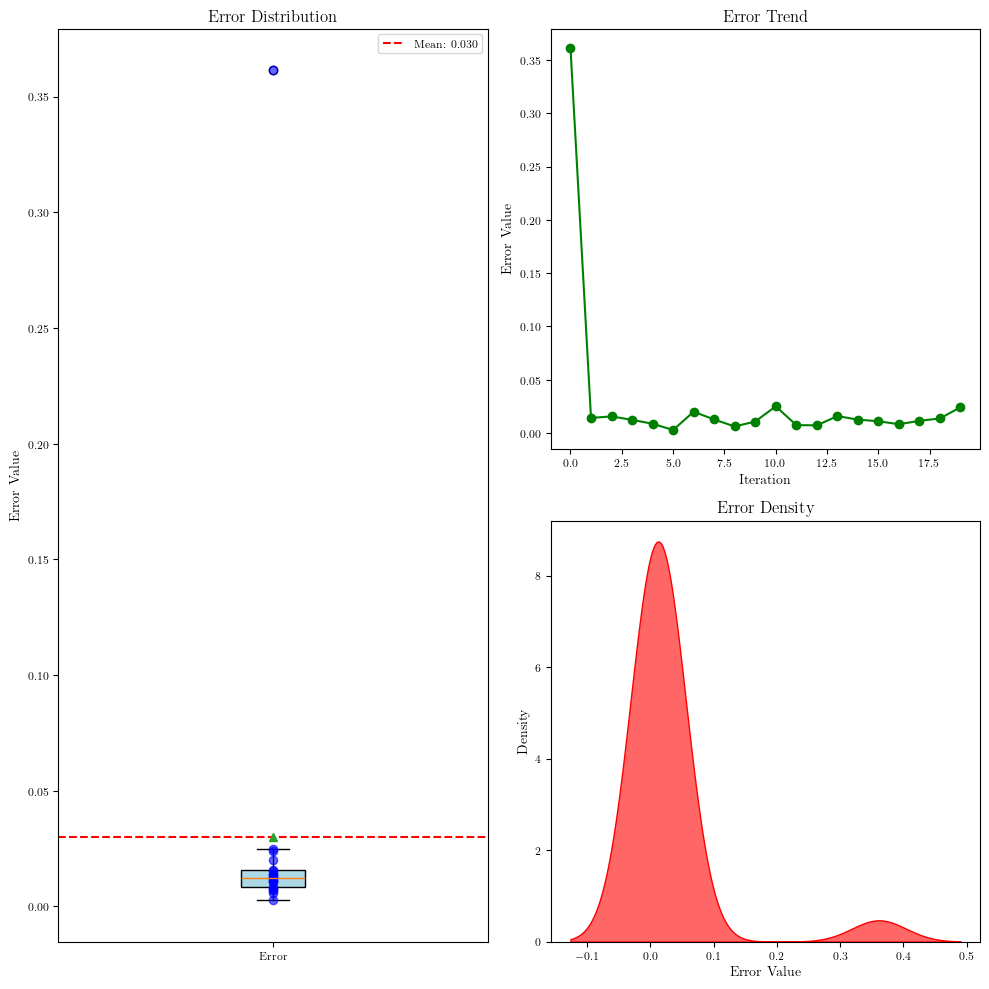

In [10]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns  # 导入seaborn库用于绘制密度图

# error = [0.5947221810612215, 0.7854634881268653, 1.0077722585678006, 0.5954742844285305, 0.4649590589316285, 0.41386083036181925, 0.6378457066743762, 0.6927021776896086, 0.44767318125257183, 0.28146649498710496, 0.8736713565859818, 0.8516792798779166, 0.37395951530223476, 0.8027823282496178, 0.804560887597274, 0.5182202889333846, 0.18454925778730633, 0.20862581035873265, 0.3739223144578929, 0.528249522241707]

plt.figure(figsize=(10, 10))  # 调整整体图表尺寸

# 左侧子图：箱形图，占据两张图的位置，箱的上下边界为上下四分位数，箱内的横线+三角点为中位数，虚线为均值
plt.subplot(1, 2, 1)  # 第一个子图，现在布局为1行2列
mean_error = np.mean(error)
plt.boxplot(error, patch_artist=True, showmeans=True, meanline=False, boxprops=dict(facecolor='lightblue')) #绘制箱型图，其中error是需要绘制的数据，patch_artist=True表示填充箱体，showmeans=True表示显示均值，meanline=True表示显示均值线，boxprops=dict(facecolor='lightblue')表示箱体的颜色为浅蓝色
plt.axhline(mean_error, color='r', linestyle='--', label=f'Mean: {mean_error:.3f}') #绘制一条水平线，位于mean_error处，颜色为红色，线型为虚线，标签为均值
for i, value in enumerate(error): #遍历error数组，i为索引，value为值
    plt.plot(1, value, 'bo', alpha=0.6) #绘制散点图，横坐标为1，纵坐标为value（即error数组中每个数），颜色为蓝色，点形状为圆圈，透明度为0.6
plt.title('Error Distribution')
plt.ylabel('Error Value')
plt.xticks([1], ['Error']) #设置x轴刻度标签
plt.legend() #显示图例

# 右侧上方子图：折线图
plt.subplot(2, 2, 2)  # 第二个子图，现在布局为2行2列的第二个位置
plt.plot(error, '-o', color='green') #绘制折线图，横坐标为error数组的索引，纵坐标为error数组的值，颜色为绿色，点形状为圆圈
plt.title('Error Trend')
plt.ylabel('Error Value')
plt.xlabel('Iteration')

# 右侧下方子图：密度图
plt.subplot(2, 2, 4)  # 第四个子图，现在布局为2行2列的第四个位置
sns.kdeplot(error, shade=True, color="r", alpha=0.6)
plt.title('Error Density')
plt.xlabel('Error Value')
plt.ylabel('Density')

plt.tight_layout()  # 自动调整子图参数，使之填充整个图表区域
plt.show()

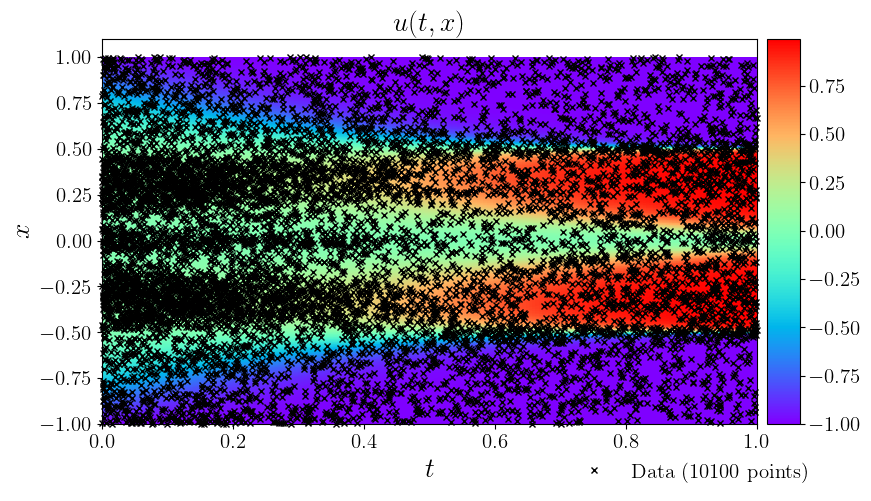

In [11]:
# data = scipy.io.loadmat('../data/AC.mat')
# #从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
# t = data['tt'].flatten()[:,None]
# x = data['x'].flatten()[:,None]
# Exact = np.real(data['uu']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
# #生成一个二位网络，X和T是输出的二维数组
# #这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
# X, T = np.meshgrid(x,t)

# X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
# u_star = Exact.flatten()[:,None]   #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组     
# # X, T = np.meshgrid(x,t)

# X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_pred, f_pred = model.predict(X_star)    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组   


#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')
U_star = griddata(X_star, u_star.flatten(), (X, T), method='cubic')

###### Row 0: u(t,x) ##################    

fig = plt.figure(figsize=(9, 5)) #这里figure是一个figure对象，是一个图形窗口，代表整个图形，设置图形大小为宽9英寸高5 英寸
ax = fig.add_subplot(111) #在图形的1*1网格的第一个位置添加一个子图

#绘图的数据来源
h = ax.imshow(U_star.T, interpolation='nearest', cmap='rainbow', 
              extent=[t.min(), t.max(), x.min(), x.max()], 
              origin='lower', aspect='auto')   #imshow函数用于显示图像，接受一些参数，第一个参数是图像数据，这里是U_pred的转置；第二个参数是插值方法（用于在像素之间插入新的像素），这里是最邻近插值；
                                                   #第三个参数是颜色映射，这里是用彩虹色图；第四个参数是图像的范围；第五个参数是图像的原点位置，这里表示原点在右下角；第六个参数是图像的纵横比，这里表示调整横纵比以填充整个axes对象
                                                   #最后的结果返回一个axesimage对象，也就是h，可以通过这个对象进一步设置图像的属性


#添加颜色条
divider = make_axes_locatable(ax)  #使用 make_axes_locatable 函数创建了一个 AxesDivider 对象。这个函数接受一个 Axes 对象作为参数，返回一个 AxesDivider 对象。AxesDivider 对象可以用来管理子图的布局，特别是当你需要在一个图的旁边添加另一个图时。
cax = divider.append_axes("right", size="5%", pad=0.10) #使用append_axes方法在原始轴的右侧添加了一个新的轴。append_axes 方法接受三个参数：位置（"right"）、大小（"5%"）和间距（0.10）。在原始轴的右侧添加了一个新的轴，新轴的大小是原始轴的 5%，新轴与原始轴之间的间距是 0.05 英寸
   
cbar = fig.colorbar(h, cax=cax)#使用colorbar方法在新轴上添加了一个颜色条。colorbar 方法接受两个参数：axesimage 对象（h）和新轴（cax）。并记这个颜色条的名字是cbar
cbar.ax.tick_params(labelsize=15) #设置颜色条刻度标签大小，这里bar是之前定义的


#在图上绘制散点图
ax.plot(
    X_f[:,1], 
    X_f[:,0], 
    'kx', label = 'Data (%d points)' % (X_f.shape[0]), 
    markersize = 4,  # marker size doubled
    clip_on = False,
    alpha=1.0
) #在ax上绘制散点图，前两个参数是散点的x坐标和y坐标；kx表示黑色的x（散点形状是x），label是散点的标签，clip_on表示散点可以绘制在轴的边界外
  #新加了一个alpha=1.0用来设置标记的透明度，1.0表示完全不透明  




#设置图的标签、图例、标题和刻度标签
#设置ax子图的x轴的标签为t，y轴的标签为x。这里$t$和$x$是latex格式的文本，用于生成数学公式
ax.set_xlabel('$t$', size=20)
ax.set_ylabel('$x$', size=20)
#设置子图ax的图例，第一个参数用来设置图例的位置，这里表示图例放在上方中央;第二个参数用来设置图例的锚点，接受一个元组，表示x和y坐标，表示把图例的锚点设置在x坐标为0.9，y坐标为-0.05处;frameon=False表示不显示图例的边框;第三个参数设置图例的列数，分为5列；最后一个参数设置图例属性，接受字典，这里表示设置图例字体大小为15；最后返回的leg是一个legend对象，表示图形的图例
ax.legend(
    loc='upper center', 
    bbox_to_anchor=(0.9, -0.05), 
    ncol=5, 
    frameon=False, 
    prop={'size': 15}
)
#设置子图ax的标题为$u(t,x)$，表示latex格式的文本，用于生成数学公式，fontsize=10表示字体大小为20
ax.set_title('$u(t,x)$', fontsize = 20) # font size doubled，两倍化子图标题
ax.tick_params(labelsize=15)#用来设置刻度标签的大小。`tick_params`是`Axes`对象的一个方法，可以用来设置刻度线的属性。在这里，`labelsize=15` 是用来设置刻度标签的字体大小的。


#显示图片
plt.show() #显示所有打开的图形的函数

In [12]:
trainloss = torch.stack(model.loss_value).cpu().detach().numpy()


testerror = torch.stack(model.test_error).cpu().detach().numpy()

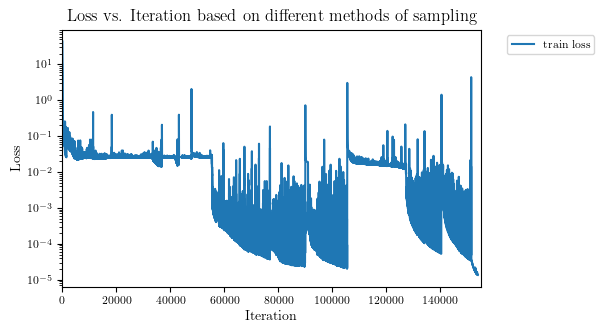

In [13]:
# print(len(trainloss))
# print(trainloss)
# 定义图例的标签
labels = ["Grid"]

# 创建一个新的图形
plt.figure()

# # 遍历所有的loss数据和标签
# for loss, label in zip(trainloss, labels):
#     # 绘制每个loss数据，并使用标签作为图例的条目
#     plt.plot(loss, label=label)

plt.plot(trainloss, label='train loss')

# 添加图例，放在图像外
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


plt.xlim([0,155000]) # 设置x轴的范围
plt.yscale('log') #设置y轴为对数尺度，这样即使列表中有一些非常大的值，也不会影响其他值的可视化
plt.xlabel('Iteration') # 设置x轴的标签
plt.ylabel('Loss') # 设置y轴的标签
plt.title('Loss vs. Iteration based on different methods of sampling') # 设置图形的标题
# 显示图形
plt.show()
plt.show()

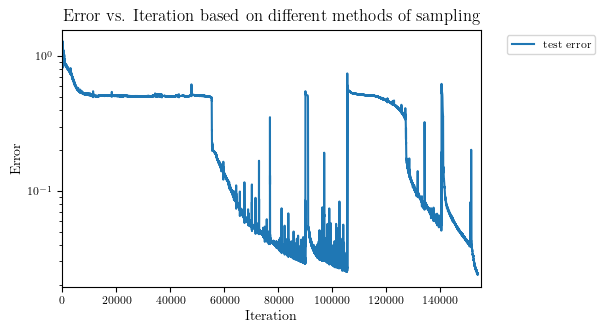

In [14]:
# print(len(trainloss))
# print(trainloss)
# 定义图例的标签
# labels = ["Grid"]

# 创建一个新的图形
plt.figure()

# # 遍历所有的loss数据和标签
# for loss, label in zip(trainloss, labels):
#     # 绘制每个loss数据，并使用标签作为图例的条目
#     plt.plot(loss, label=label)

plt.plot(testerror, label='test error')

# 添加图例，放在图像外
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


plt.xlim([0,155000]) # 设置x轴的范围
plt.yscale('log') #设置y轴为对数尺度，这样即使列表中有一些非常大的值，也不会影响其他值的可视化
plt.xlabel('Iteration') # 设置x轴的标签
plt.ylabel('Error') # 设置y轴的标签
plt.title('Error vs. Iteration based on different methods of sampling') # 设置图形的标题
# 显示图形
plt.show()
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


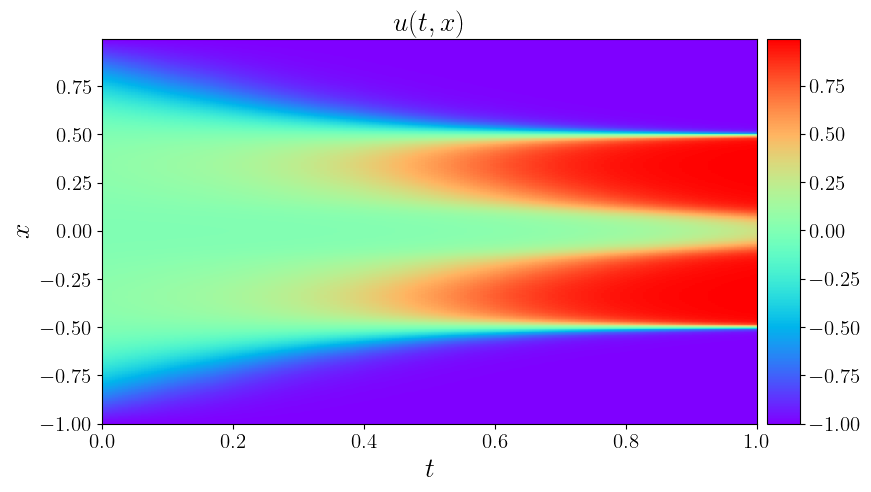

In [15]:
# data = scipy.io.loadmat('../../data/burgers_shock.mat')
# #从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
# t = data['t'].flatten()[:,None]
# x = data['x'].flatten()[:,None]
# Exact = np.real(data['usol']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
# #生成一个二位网络，X和T是输出的二维数组
# #这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
# X, T = np.meshgrid(x,t)

# X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_pred, f_pred = model.predict(X_star)    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组   


#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')


###### Row 0: u(t,x) ##################    

fig = plt.figure(figsize=(9, 5)) #这里figure是一个figure对象，是一个图形窗口，代表整个图形，设置图形大小为宽9英寸高5 英寸
ax = fig.add_subplot(111) #在图形的1*1网格的第一个位置添加一个子图

#绘图的数据来源
h = ax.imshow(U_pred.T, interpolation='nearest', cmap='rainbow', 
              extent=[t.min(), t.max(), x.min(), x.max()], 
              origin='lower', aspect='auto')   #imshow函数用于显示图像，接受一些参数，第一个参数是图像数据，这里是U_pred的转置；第二个参数是插值方法（用于在像素之间插入新的像素），这里是最邻近插值；
                                                   #第三个参数是颜色映射，这里是用彩虹色图；第四个参数是图像的范围；第五个参数是图像的原点位置，这里表示原点在右下角；第六个参数是图像的纵横比，这里表示调整横纵比以填充整个axes对象
                                                   #最后的结果返回一个axesimage对象，也就是h，可以通过这个对象进一步设置图像的属性


#添加颜色条
divider = make_axes_locatable(ax)  #使用 make_axes_locatable 函数创建了一个 AxesDivider 对象。这个函数接受一个 Axes 对象作为参数，返回一个 AxesDivider 对象。AxesDivider 对象可以用来管理子图的布局，特别是当你需要在一个图的旁边添加另一个图时。
cax = divider.append_axes("right", size="5%", pad=0.10) #使用append_axes方法在原始轴的右侧添加了一个新的轴。append_axes 方法接受三个参数：位置（"right"）、大小（"5%"）和间距（0.10）。在原始轴的右侧添加了一个新的轴，新轴的大小是原始轴的 5%，新轴与原始轴之间的间距是 0.05 英寸
   
cbar = fig.colorbar(h, cax=cax)#使用colorbar方法在新轴上添加了一个颜色条。colorbar 方法接受两个参数：axesimage 对象（h）和新轴（cax）。并记这个颜色条的名字是cbar
cbar.ax.tick_params(labelsize=15) #设置颜色条刻度标签大小，这里bar是之前定义的


# #在图上绘制散点图
# ax.plot(
#     X_f_train[:,1], 
#     X_f_train[:,0], 
#     'kx', label = 'Data (%d points)' % (X_f_train.shape[0]), 
#     markersize = 4,  # marker size doubled
#     clip_on = False,
#     alpha=1.0
# ) #在ax上绘制散点图，前两个参数是散点的x坐标和y坐标；kx表示黑色的x（散点形状是x），label是散点的标签，clip_on表示散点可以绘制在轴的边界外
#   #新加了一个alpha=1.0用来设置标记的透明度，1.0表示完全不透明  




#设置图的标签、图例、标题和刻度标签
#设置ax子图的x轴的标签为t，y轴的标签为x。这里$t$和$x$是latex格式的文本，用于生成数学公式
ax.set_xlabel('$t$', size=20)
ax.set_ylabel('$x$', size=20)
#设置子图ax的图例，第一个参数用来设置图例的位置，这里表示图例放在上方中央;第二个参数用来设置图例的锚点，接受一个元组，表示x和y坐标，表示把图例的锚点设置在x坐标为0.9，y坐标为-0.05处;frameon=False表示不显示图例的边框;第三个参数设置图例的列数，分为5列；最后一个参数设置图例属性，接受字典，这里表示设置图例字体大小为15；最后返回的leg是一个legend对象，表示图形的图例
ax.legend(
    loc='upper center', 
    bbox_to_anchor=(0.9, -0.05), 
    ncol=5, 
    frameon=False, 
    prop={'size': 15}
)
#设置子图ax的标题为$u(t,x)$，表示latex格式的文本，用于生成数学公式，fontsize=10表示字体大小为20
ax.set_title('$u(t,x)$', fontsize = 20) # font size doubled，两倍化子图标题
ax.tick_params(labelsize=15)#用来设置刻度标签的大小。`tick_params`是`Axes`对象的一个方法，可以用来设置刻度线的属性。在这里，`labelsize=15` 是用来设置刻度标签的字体大小的。


#显示图片
plt.show() #显示所有打开的图形的函数

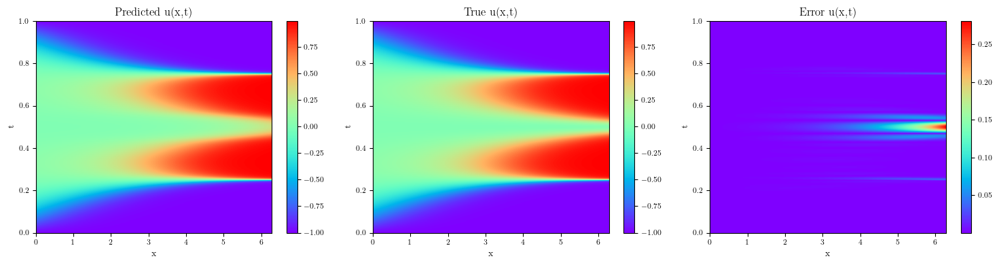

In [16]:

# 创建一个包含三幅子图的图像
fig, axes = plt.subplots(1, 3, figsize=(15, 4))

# 绘制第一幅图像
axes[0].imshow(U_pred.T, extent=[0, np.pi*2, 1, 0], aspect='auto', cmap='rainbow')
axes[0].invert_yaxis()
axes[0].set_xlabel('x')
axes[0].set_ylabel('t')
axes[0].set_title('Predicted u(x,t)')
fig.colorbar(axes[0].images[0], ax=axes[0])

# 绘制第二幅图像
axes[1].imshow(U_star.T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[1].invert_yaxis()
axes[1].set_xlabel('x')
axes[1].set_ylabel('t')
axes[1].set_title('True u(x,t)')
fig.colorbar(axes[1].images[0], ax=axes[1])

# 绘制第三幅图像
axes[2].imshow(np.abs(U_pred - U_star).T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[2].invert_yaxis()
axes[2].set_xlabel('x')
axes[2].set_ylabel('t')
axes[2].set_title('Error u(x,t)')
fig.colorbar(axes[2].images[0], ax=axes[2])

# 自动调整子图参数，使得子图之间的间距适当
plt.tight_layout()
plt.show()